## Stacking with out of fold predictions


In [1]:
import utils
from utils import *
import xgboost as xgb
import seaborn as sns
%matplotlib inline

/home/ubuntu/anaconda2/envs/qenv/lib/python2.7/site-packages/sklearn/cross_validation.py:44: DeprecationWarning: This module was deprecated in version 0.18 in favor of the model_selection module into which all the refactored classes and functions are moved. Also note that the interface of the new CV iterators are different from that of this module. This module will be removed in 0.20.
  "This module will be removed in 0.20.", DeprecationWarning)


In [47]:
xgb_test_preds = load_array("data/results/xgb_5fold_s2019_test_preds_extrasvdv2.dat")
xgb_oof_preds = load_array("data/results/xgb_5fold_s2019_oof_preds_extrasvdv2.dat")

In [48]:
NN_test_preds = load_array("data/results/NN_5fold_s2019_test_preds_extrasvdv2.dat/")/5.0
NN_oof_preds = load_array("data/results/NN_5fold_s2019_oof_preds_extrasvdv2.dat/")

In [49]:
lstm_test_preds = load_array("data/results/lstm_5fold_s2019_test_preds_extrasvdv2.dat/")
lstm_oof_preds = load_array("data/results/lstm_5fold_s2019_oof_preds_extrasvdv2.dat/")

In [8]:
# cnn_test_preds = load_array("data/results/onedconvs_5fold_s2019_test_preds_extrasvdv2.dat/")
# cnn_oof_preds = load_array("data/results/onedconvs_5fold_s2019_oof_preds_extrasvdv2.dat/")

In [9]:
NN_val_scores = load_array("data/results/lstm_val_scores.dat/")

In [10]:
NN_val_scores

array([ 0.26446829,  0.26484747,  0.27117921,  0.26525372,  0.26662908])

In [11]:
train_features = np.hstack((xgb_oof_preds,NN_oof_preds,lstm_oof_preds))
test_features=np.hstack((xgb_test_preds,NN_test_preds,lstm_test_preds))

In [91]:
train_features.shape, test_features.shape

((404290, 3), (2345796, 3))

In [92]:
labels = np.load(open(LABEL_TRAINING_DATA_FILE, 'rb'))

In [13]:
plt.rcParams['figure.figsize'] = 16, 12


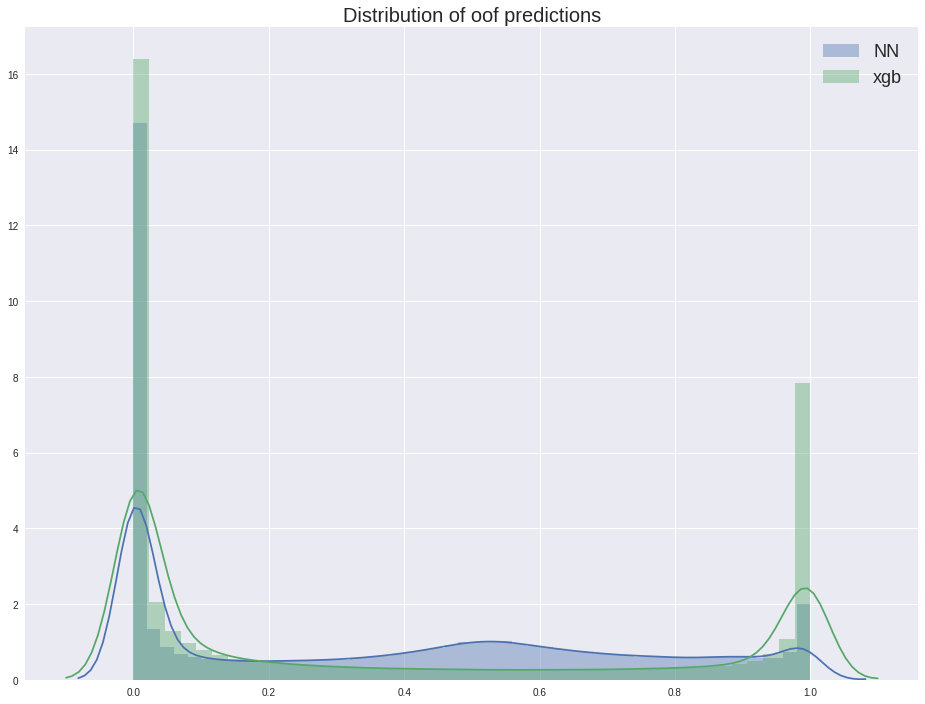

In [93]:

sns.distplot(NN_oof_preds,label='NN',), sns.distplot(xgb_oof_preds,label='xgb')
plt.legend(loc='upper right', prop={'size': 18})
plt.title('Distribution of oof predictions', fontsize=20)

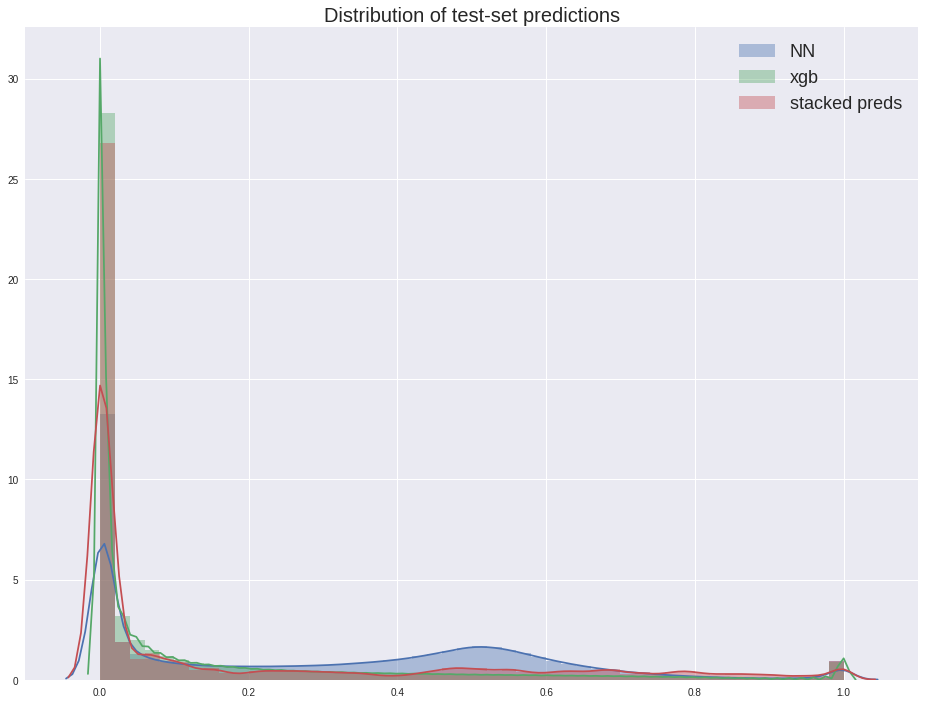

In [71]:
sns.distplot(NN_test_preds,label='NN'), sns.distplot(xgb_test_preds,label='xgb'), 
sns.distplot(xgb_stacked_preds_raw,label='stacked preds')
plt.legend(loc='upper right', prop={'size': 18})
plt.title('Distribution of test-set predictions', fontsize=20)

In [102]:
preds_avg.max(),xgb_test_preds.max(),NN_test_preds.max()

(0.99973267316818237, 0.99997787475585942, 1.0)

### Model

In [94]:
num_folds = 5
xgb_params = {'colsample_bylevel':1., # 0.9086627943049572,
 'colsample_bytree': 1.,
 'eval_metric': 'logloss',
 'gamma': 1.,#0.02933179779163947,
 'learning_rate': 0.025,#0.028244194429306306,#0.015
 'max_depth': 6,
 'n_estimators': 2500,
 'objective': 'binary:logistic',
 'reg_alpha': 0.0003,#0.14600953461910307,
 'reg_lambda': 2,
 'scale_pos_weight': 1,
 'subsample': 0.9, #0.8097993636153147, 
             'nthread':16,'silent':1}

In [95]:
num_folds = 5 
skf = StratifiedKFold(n_splits=num_folds, random_state=2019)
splits = skf.split(train_features, labels)


In [96]:
d_test = xgb.DMatrix(test_features)
preds = np.zeros((test_features.shape[0],1))

for ix_fit, ix_valid in tqdm_notebook(splits, total=num_folds):
    y_val = labels[ix_valid]
    y_train = labels[ix_fit]

                                           
    d_train = xgb.DMatrix(train_features[ix_fit],label= y_train)
    d_valid = xgb.DMatrix(train_features[ix_valid],label= y_val)
    
    
    
    ############## TRAINING
    watchlist = [(d_train, 'train'), (d_valid, 'valid')]
    bst = xgb.train(xgb_params, d_train, 10000,  watchlist, early_stopping_rounds=50, verbose_eval=10)
    
    
    ################ Test prediction 
    p_test = bst.predict(d_test)
    preds += p_test.reshape(-1,1)
  

[0]	train-logloss:0.674756	valid-logloss:0.674663
Multiple eval metrics have been passed: 'valid-logloss' will be used for early stopping.

Will train until valid-logloss hasn't improved in 50 rounds.
[10]	train-logloss:0.531628	valid-logloss:0.53094
[20]	train-logloss:0.437841	valid-logloss:0.436877
[30]	train-logloss:0.373379	valid-logloss:0.372322
[40]	train-logloss:0.327757	valid-logloss:0.326707
[50]	train-logloss:0.294869	valid-logloss:0.293883
[60]	train-logloss:0.270855	valid-logloss:0.269961
[70]	train-logloss:0.253152	valid-logloss:0.252377
[80]	train-logloss:0.240034	valid-logloss:0.239388
[90]	train-logloss:0.230267	valid-logloss:0.22976
[100]	train-logloss:0.22297	valid-logloss:0.222583
[110]	train-logloss:0.217498	valid-logloss:0.217246
[120]	train-logloss:0.213382	valid-logloss:0.213258
[130]	train-logloss:0.210281	valid-logloss:0.210277
[140]	train-logloss:0.207939	valid-logloss:0.208058
[150]	train-logloss:0.206166	valid-logloss:0.206396
[160]	train-logloss:0.204817	va

[140]	train-logloss:0.207849	valid-logloss:0.208943
[150]	train-logloss:0.206077	valid-logloss:0.207202
[160]	train-logloss:0.204731	valid-logloss:0.205893
[170]	train-logloss:0.20371	valid-logloss:0.204908
[180]	train-logloss:0.202933	valid-logloss:0.204156
[190]	train-logloss:0.202334	valid-logloss:0.203588
[200]	train-logloss:0.201874	valid-logloss:0.203165
[210]	train-logloss:0.201513	valid-logloss:0.202842
[220]	train-logloss:0.201232	valid-logloss:0.202599
[230]	train-logloss:0.201004	valid-logloss:0.202422
[240]	train-logloss:0.200819	valid-logloss:0.202283
[250]	train-logloss:0.200678	valid-logloss:0.202176
[260]	train-logloss:0.200557	valid-logloss:0.202096
[270]	train-logloss:0.200463	valid-logloss:0.202044
[280]	train-logloss:0.20038	valid-logloss:0.202
[290]	train-logloss:0.200317	valid-logloss:0.201968
[300]	train-logloss:0.200248	valid-logloss:0.20195
[310]	train-logloss:0.200186	valid-logloss:0.201931
[320]	train-logloss:0.200134	valid-logloss:0.201923
[330]	train-loglos

In [97]:
bst.best_ntree_limit

308

In [98]:
xgb_stacked_preds_raw = preds / float(num_folds) 

In [99]:
l2_xgb__fixed = link_function(xgb_stacked_preds_raw)

#### level 2 with NN

In [17]:
import keras
from keras import backend as K
from keras.utils.data_utils import get_file
from keras.utils import np_utils
from keras.utils.np_utils import to_categorical
from keras.models import Sequential, Model
from keras.layers import Input, Embedding, Reshape, merge, LSTM, Bidirectional
from keras.layers import TimeDistributed, Activation, SimpleRNN, GRU
from keras.layers.core import Flatten, Dense, Dropout, Lambda
from keras.layers.normalization import BatchNormalization
from keras.optimizers import SGD, RMSprop, Adam
from keras.metrics import categorical_crossentropy, categorical_accuracy
from keras.layers.convolutional import *
from keras.preprocessing import image, sequence
from keras.preprocessing.text import Tokenizer
from sklearn.metrics import fbeta_score
from keras.callbacks import ReduceLROnPlateau, EarlyStopping,ModelCheckpoint


from sklearn.preprocessing import StandardScaler
from tqdm import tqdm


Using Theano backend.
WARNING (theano.sandbox.cuda): The cuda backend is deprecated and will be removed in the next release (v0.10).  Please switch to the gpuarray backend. You can get more information about how to switch at this URL:
 https://github.com/Theano/Theano/wiki/Converting-to-the-new-gpu-back-end%28gpuarray%29

WARNING (theano.sandbox.cuda): CUDA is installed, but device gpu is not available  (error: Unable to get the number of gpus available: unknown error)


In [19]:
def NN(num_hidden1,num_hidden2,rate_drop_1,rate_drop_2):

    STAMP = 'NN_%d_%d_%.2f_%.2f'%(num_hidden1, num_hidden2, rate_drop_1, \
            rate_drop_2)


    print STAMP


    layers =  [
        Dense(num_hidden1,activation='relu',input_shape =  (train_features.shape[1],)),
        Dropout(rate_drop_1),   
#         BatchNormalization(),


        Dense(num_hidden2,activation='relu'),
        Dropout(rate_drop_2),   
#         BatchNormalization(),


        Dense(1,activation='sigmoid')]


    return  Sequential(layers), STAMP



In [21]:
test_preds = np.zeros((test_features.shape[0],1))


num_iters = 1
for i in range(num_iters):


    ## create random params for current iteration
    num_hidden1 = np.random.randint(4, 8)
    num_hidden2 = np.random.randint(4, 8)
    rate_drop_1 = 0.1 + np.random.rand() * 0.05
    rate_drop_2 = 0.1 + np.random.rand() * 0.05



    num_folds = 5
    skf = StratifiedKFold(n_splits=num_folds, random_state=17)
    splits = skf.split(train_features, labels)

    for ix_fit, ix_valid in tqdm_notebook(splits, total=num_folds):


        y_val = labels[ix_valid]
        y_train = labels[ix_fit]

        X_train = train_features[ix_fit]
        X_valid = train_features[ix_valid]





        ##### create model
        model,STAMP =NN(num_hidden1,num_hidden2,rate_drop_1,rate_drop_2)


        kfold_weights_path = "weights/stacking_l2_NN_oof_{}.h5".format(STAMP)
        callbacks = [EarlyStopping(monitor='val_loss', patience=4),
                     ModelCheckpoint(kfold_weights_path, monitor='val_loss', save_best_only=True)]


        model.compile(optimizer=Adam(lr=1e-5), loss='binary_crossentropy', metrics=['accuracy'])



        history = model.fit(x = X_train, y= y_train, validation_data=(X_valid, y_val),
          batch_size=128, epochs=1000,callbacks=callbacks,  shuffle=True,verbose=1)


        ########### prediction

        bst_val_score = min(history.history['val_loss'])
        tqdm.write("bst_val_score:{}".format(bst_val_score) )
        model.load_weights(kfold_weights_path)


        test_preds += model.predict(test_features, batch_size=8192, verbose=1).reshape(-1,1)

test_preds /= float(num_folds)

NN_6_7_0.11_0.14
Train on 323431 samples, validate on 80859 samples
Epoch 1/1000
323431/323431 [==============================] - 1s - loss: 0.7173 - acc: 0.6496 - val_loss: 0.7001 - val_acc: 0.6308
Epoch 2/1000
323431/323431 [==============================] - 1s - loss: 0.6841 - acc: 0.6601 - val_loss: 0.6671 - val_acc: 0.6308
Epoch 3/1000
323431/323431 [==============================] - 1s - loss: 0.6517 - acc: 0.6666 - val_loss: 0.6322 - val_acc: 0.6309
Epoch 4/1000
323431/323431 [==============================] - 1s - loss: 0.6189 - acc: 0.7546 - val_loss: 0.5973 - val_acc: 0.8546
Epoch 5/1000
323431/323431 [==============================] - 1s - loss: 0.5856 - acc: 0.8226 - val_loss: 0.5615 - val_acc: 0.8961
Epoch 6/1000
323431/323431 [==============================] - 1s - loss: 0.5521 - acc: 0.8411 - val_loss: 0.5248 - val_acc: 0.9021
Epoch 7/1000
323431/323431 [==============================] - 1s - loss: 0.5182 - acc: 0.8438 - val_loss: 0.4874 - val_acc: 0.9048
Epoch 8/1000
32

323431/323431 [==============================] - 1s - loss: 0.2570 - acc: 0.9012 - val_loss: 0.2224 - val_acc: 0.9085
Epoch 124/1000
323431/323431 [==============================] - 1s - loss: 0.2560 - acc: 0.9018 - val_loss: 0.2222 - val_acc: 0.9085
Epoch 125/1000
323431/323431 [==============================] - 1s - loss: 0.2561 - acc: 0.9014 - val_loss: 0.2220 - val_acc: 0.9085
Epoch 126/1000
323431/323431 [==============================] - 1s - loss: 0.2559 - acc: 0.9022 - val_loss: 0.2219 - val_acc: 0.9085
Epoch 127/1000
323431/323431 [==============================] - 1s - loss: 0.2558 - acc: 0.9017 - val_loss: 0.2217 - val_acc: 0.9085
Epoch 128/1000
323431/323431 [==============================] - 1s - loss: 0.2555 - acc: 0.9016 - val_loss: 0.2216 - val_acc: 0.9086
Epoch 129/1000
323431/323431 [==============================] - 1s - loss: 0.2554 - acc: 0.9018 - val_loss: 0.2214 - val_acc: 0.9086
Epoch 130/1000
323431/323431 [==============================] - 1s - loss: 0.2552 - 

323431/323431 [==============================] - 1s - loss: 0.2425 - acc: 0.9017 - val_loss: 0.2125 - val_acc: 0.9084
Epoch 246/1000
323431/323431 [==============================] - 1s - loss: 0.2427 - acc: 0.9014 - val_loss: 0.2124 - val_acc: 0.9084
Epoch 247/1000
323431/323431 [==============================] - 1s - loss: 0.2428 - acc: 0.9014 - val_loss: 0.2124 - val_acc: 0.9084
Epoch 248/1000
323431/323431 [==============================] - 1s - loss: 0.2431 - acc: 0.9010 - val_loss: 0.2123 - val_acc: 0.9084
Epoch 249/1000
323431/323431 [==============================] - 1s - loss: 0.2426 - acc: 0.9017 - val_loss: 0.2123 - val_acc: 0.9084
Epoch 250/1000
323431/323431 [==============================] - 1s - loss: 0.2425 - acc: 0.9018 - val_loss: 0.2122 - val_acc: 0.9084
Epoch 251/1000
323431/323431 [==============================] - 1s - loss: 0.2423 - acc: 0.9016 - val_loss: 0.2122 - val_acc: 0.9084
Epoch 252/1000
323431/323431 [==============================] - 1s - loss: 0.2424 - 

323431/323431 [==============================] - 1s - loss: 0.2357 - acc: 0.9027 - val_loss: 0.2081 - val_acc: 0.9087
Epoch 368/1000
323431/323431 [==============================] - 1s - loss: 0.2356 - acc: 0.9025 - val_loss: 0.2081 - val_acc: 0.9086
Epoch 369/1000
323431/323431 [==============================] - 1s - loss: 0.2356 - acc: 0.9025 - val_loss: 0.2081 - val_acc: 0.9086
Epoch 370/1000
323431/323431 [==============================] - 1s - loss: 0.2358 - acc: 0.9024 - val_loss: 0.2081 - val_acc: 0.9086
Epoch 371/1000
323431/323431 [==============================] - 1s - loss: 0.2354 - acc: 0.9025 - val_loss: 0.2081 - val_acc: 0.9086
Epoch 372/1000
323431/323431 [==============================] - 1s - loss: 0.2353 - acc: 0.9028 - val_loss: 0.2080 - val_acc: 0.9086
Epoch 373/1000
323431/323431 [==============================] - 1s - loss: 0.2350 - acc: 0.9029 - val_loss: 0.2080 - val_acc: 0.9086
Epoch 374/1000
323431/323431 [==============================] - 1s - loss: 0.2357 - 

323431/323431 [==============================] - 1s - loss: 0.5848 - acc: 0.6308 - val_loss: 0.5669 - val_acc: 0.6308
Epoch 9/1000
323431/323431 [==============================] - 1s - loss: 0.5614 - acc: 0.6308 - val_loss: 0.5411 - val_acc: 0.6308
Epoch 10/1000
323431/323431 [==============================] - 1s - loss: 0.5371 - acc: 0.6333 - val_loss: 0.5150 - val_acc: 0.6308
Epoch 11/1000
323431/323431 [==============================] - 1s - loss: 0.5135 - acc: 0.6767 - val_loss: 0.4893 - val_acc: 0.7797
Epoch 12/1000
323431/323431 [==============================] - 1s - loss: 0.4902 - acc: 0.7713 - val_loss: 0.4643 - val_acc: 0.8292
Epoch 13/1000
323431/323431 [==============================] - 1s - loss: 0.4681 - acc: 0.7830 - val_loss: 0.4404 - val_acc: 0.8357
Epoch 14/1000
323431/323431 [==============================] - 1s - loss: 0.4470 - acc: 0.8167 - val_loss: 0.4176 - val_acc: 0.8364
Epoch 15/1000
323431/323431 [==============================] - 1s - loss: 0.4267 - acc: 0.8

323431/323431 [==============================] - 1s - loss: 0.2581 - acc: 0.8998 - val_loss: 0.2240 - val_acc: 0.9083
Epoch 132/1000
323431/323431 [==============================] - 1s - loss: 0.2574 - acc: 0.8997 - val_loss: 0.2238 - val_acc: 0.9082
Epoch 133/1000
323431/323431 [==============================] - 1s - loss: 0.2574 - acc: 0.9001 - val_loss: 0.2237 - val_acc: 0.9082
Epoch 134/1000
323431/323431 [==============================] - 1s - loss: 0.2576 - acc: 0.8995 - val_loss: 0.2236 - val_acc: 0.9083
Epoch 135/1000
323431/323431 [==============================] - 1s - loss: 0.2571 - acc: 0.8995 - val_loss: 0.2235 - val_acc: 0.9083
Epoch 136/1000
323431/323431 [==============================] - 1s - loss: 0.2569 - acc: 0.8996 - val_loss: 0.2234 - val_acc: 0.9082
Epoch 137/1000
323431/323431 [==============================] - 1s - loss: 0.2567 - acc: 0.8993 - val_loss: 0.2232 - val_acc: 0.9082
Epoch 138/1000
323431/323431 [==============================] - 1s - loss: 0.2571 - 

323431/323431 [==============================] - 1s - loss: 0.2474 - acc: 0.8984 - val_loss: 0.2134 - val_acc: 0.9086
Epoch 254/1000
323431/323431 [==============================] - 1s - loss: 0.2480 - acc: 0.8978 - val_loss: 0.2133 - val_acc: 0.9086
Epoch 255/1000
323431/323431 [==============================] - 1s - loss: 0.2477 - acc: 0.8979 - val_loss: 0.2133 - val_acc: 0.9086
Epoch 256/1000
323431/323431 [==============================] - 1s - loss: 0.2482 - acc: 0.8981 - val_loss: 0.2132 - val_acc: 0.9086
Epoch 257/1000
323431/323431 [==============================] - 1s - loss: 0.2478 - acc: 0.8980 - val_loss: 0.2132 - val_acc: 0.9086
Epoch 258/1000
323431/323431 [==============================] - 1s - loss: 0.2478 - acc: 0.8978 - val_loss: 0.2131 - val_acc: 0.9085
Epoch 259/1000
323431/323431 [==============================] - 1s - loss: 0.2481 - acc: 0.8978 - val_loss: 0.2131 - val_acc: 0.9085
Epoch 260/1000
323431/323431 [==============================] - 1s - loss: 0.2471 - 

323431/323431 [==============================] - 1s - loss: 0.2439 - acc: 0.8979 - val_loss: 0.2094 - val_acc: 0.9084
Epoch 376/1000
323431/323431 [==============================] - 1s - loss: 0.2443 - acc: 0.8972 - val_loss: 0.2094 - val_acc: 0.9084
Epoch 377/1000
323431/323431 [==============================] - 1s - loss: 0.2444 - acc: 0.8978 - val_loss: 0.2093 - val_acc: 0.9084
Epoch 378/1000
323431/323431 [==============================] - 1s - loss: 0.2446 - acc: 0.8976 - val_loss: 0.2093 - val_acc: 0.9084
Epoch 379/1000
323431/323431 [==============================] - 1s - loss: 0.2452 - acc: 0.8972 - val_loss: 0.2093 - val_acc: 0.9084
Epoch 380/1000
323431/323431 [==============================] - 1s - loss: 0.2443 - acc: 0.8978 - val_loss: 0.2093 - val_acc: 0.9084
Epoch 381/1000
323431/323431 [==============================] - 1s - loss: 0.2437 - acc: 0.8981 - val_loss: 0.2093 - val_acc: 0.9084
Epoch 382/1000
323431/323431 [==============================] - 1s - loss: 0.2442 - 

323431/323431 [==============================] - 1s - loss: 0.2415 - acc: 0.8988 - val_loss: 0.2078 - val_acc: 0.9083
Epoch 498/1000
323431/323431 [==============================] - 1s - loss: 0.2424 - acc: 0.8979 - val_loss: 0.2078 - val_acc: 0.9082
Epoch 499/1000
323431/323431 [==============================] - 1s - loss: 0.2416 - acc: 0.8986 - val_loss: 0.2078 - val_acc: 0.9082
Epoch 500/1000
323431/323431 [==============================] - 1s - loss: 0.2423 - acc: 0.8980 - val_loss: 0.2077 - val_acc: 0.9083
Epoch 501/1000
323431/323431 [==============================] - 1s - loss: 0.2422 - acc: 0.8985 - val_loss: 0.2077 - val_acc: 0.9082
Epoch 502/1000
323431/323431 [==============================] - 1s - loss: 0.2416 - acc: 0.8983 - val_loss: 0.2077 - val_acc: 0.9082
Epoch 503/1000
323431/323431 [==============================] - 1s - loss: 0.2423 - acc: 0.8985 - val_loss: 0.2077 - val_acc: 0.9082
Epoch 504/1000
323431/323431 [==============================] - 1s - loss: 0.2417 - 

323432/323432 [==============================] - 1s - loss: 0.2536 - acc: 0.8975 - val_loss: 0.2298 - val_acc: 0.9056
Epoch 67/1000
323432/323432 [==============================] - 1s - loss: 0.2539 - acc: 0.8978 - val_loss: 0.2295 - val_acc: 0.9059
Epoch 68/1000
323432/323432 [==============================] - 1s - loss: 0.2531 - acc: 0.8974 - val_loss: 0.2292 - val_acc: 0.9061
Epoch 69/1000
323432/323432 [==============================] - 1s - loss: 0.2525 - acc: 0.8979 - val_loss: 0.2290 - val_acc: 0.9062
Epoch 70/1000
323432/323432 [==============================] - 1s - loss: 0.2527 - acc: 0.8990 - val_loss: 0.2287 - val_acc: 0.9064
Epoch 71/1000
323432/323432 [==============================] - 1s - loss: 0.2522 - acc: 0.8993 - val_loss: 0.2284 - val_acc: 0.9065
Epoch 72/1000
323432/323432 [==============================] - 1s - loss: 0.2512 - acc: 0.8989 - val_loss: 0.2281 - val_acc: 0.9066
Epoch 73/1000
323432/323432 [==============================] - 1s - loss: 0.2514 - acc: 0.

323432/323432 [==============================] - 1s - loss: 0.2315 - acc: 0.9041 - val_loss: 0.2157 - val_acc: 0.9090
Epoch 189/1000
323432/323432 [==============================] - 1s - loss: 0.2315 - acc: 0.9040 - val_loss: 0.2157 - val_acc: 0.9091
Epoch 190/1000
323432/323432 [==============================] - 1s - loss: 0.2310 - acc: 0.9045 - val_loss: 0.2156 - val_acc: 0.9090
Epoch 191/1000
323432/323432 [==============================] - 1s - loss: 0.2317 - acc: 0.9041 - val_loss: 0.2156 - val_acc: 0.9090
Epoch 192/1000
323432/323432 [==============================] - 1s - loss: 0.2316 - acc: 0.9037 - val_loss: 0.2155 - val_acc: 0.9090
Epoch 193/1000
323432/323432 [==============================] - 1s - loss: 0.2316 - acc: 0.9039 - val_loss: 0.2155 - val_acc: 0.9090
Epoch 194/1000
323432/323432 [==============================] - 1s - loss: 0.2312 - acc: 0.9042 - val_loss: 0.2154 - val_acc: 0.9090
Epoch 195/1000
323432/323432 [==============================] - 1s - loss: 0.2310 - 

323432/323432 [==============================] - 1s - loss: 0.2269 - acc: 0.9045 - val_loss: 0.2122 - val_acc: 0.9091
Epoch 311/1000
323432/323432 [==============================] - 1s - loss: 0.2265 - acc: 0.9046 - val_loss: 0.2122 - val_acc: 0.9091
Epoch 312/1000
323432/323432 [==============================] - 1s - loss: 0.2261 - acc: 0.9051 - val_loss: 0.2122 - val_acc: 0.9091
Epoch 313/1000
323432/323432 [==============================] - 1s - loss: 0.2263 - acc: 0.9047 - val_loss: 0.2122 - val_acc: 0.9091
Epoch 314/1000
323432/323432 [==============================] - 1s - loss: 0.2268 - acc: 0.9050 - val_loss: 0.2121 - val_acc: 0.9091
Epoch 315/1000
323432/323432 [==============================] - 1s - loss: 0.2262 - acc: 0.9048 - val_loss: 0.2121 - val_acc: 0.9091
Epoch 316/1000
323432/323432 [==============================] - 1s - loss: 0.2260 - acc: 0.9048 - val_loss: 0.2121 - val_acc: 0.9090
Epoch 317/1000
323432/323432 [==============================] - 1s - loss: 0.2265 - 

323432/323432 [==============================] - 1s - loss: 0.2228 - acc: 0.9067 - val_loss: 0.2103 - val_acc: 0.9088
Epoch 433/1000
323432/323432 [==============================] - 1s - loss: 0.2229 - acc: 0.9066 - val_loss: 0.2103 - val_acc: 0.9088
Epoch 434/1000
323432/323432 [==============================] - 1s - loss: 0.2228 - acc: 0.9064 - val_loss: 0.2103 - val_acc: 0.9087
Epoch 435/1000
323432/323432 [==============================] - 1s - loss: 0.2228 - acc: 0.9066 - val_loss: 0.2103 - val_acc: 0.9087
Epoch 436/1000
323432/323432 [==============================] - 1s - loss: 0.2231 - acc: 0.9069 - val_loss: 0.2103 - val_acc: 0.9088
Epoch 437/1000
323432/323432 [==============================] - 1s - loss: 0.2235 - acc: 0.9065 - val_loss: 0.2102 - val_acc: 0.9088
Epoch 438/1000
323432/323432 [==============================] - 1s - loss: 0.2227 - acc: 0.9066 - val_loss: 0.2103 - val_acc: 0.9088
Epoch 439/1000
323432/323432 [==============================] - 1s - loss: 0.2228 - 

323433/323433 [==============================] - 1s - loss: 0.4549 - acc: 0.7987 - val_loss: 0.5109 - val_acc: 0.7548
Epoch 18/1000
323433/323433 [==============================] - 1s - loss: 0.4462 - acc: 0.7992 - val_loss: 0.5016 - val_acc: 0.7548
Epoch 19/1000
323433/323433 [==============================] - 1s - loss: 0.4386 - acc: 0.7992 - val_loss: 0.4924 - val_acc: 0.7548
Epoch 20/1000
323433/323433 [==============================] - 1s - loss: 0.4309 - acc: 0.7987 - val_loss: 0.4830 - val_acc: 0.7548
Epoch 21/1000
323433/323433 [==============================] - 1s - loss: 0.4245 - acc: 0.7994 - val_loss: 0.4733 - val_acc: 0.7548
Epoch 22/1000
323433/323433 [==============================] - 1s - loss: 0.4177 - acc: 0.8009 - val_loss: 0.4623 - val_acc: 0.7548
Epoch 23/1000
323433/323433 [==============================] - 1s - loss: 0.4100 - acc: 0.8042 - val_loss: 0.4511 - val_acc: 0.7548
Epoch 24/1000
323433/323433 [==============================] - 1s - loss: 0.4046 - acc: 0.

323433/323433 [==============================] - 1s - loss: 0.6302 - acc: 0.8289 - val_loss: 0.6161 - val_acc: 0.8738
Epoch 3/1000
323433/323433 [==============================] - 1s - loss: 0.6141 - acc: 0.8406 - val_loss: 0.5985 - val_acc: 0.8821
Epoch 4/1000
323433/323433 [==============================] - 1s - loss: 0.5991 - acc: 0.8459 - val_loss: 0.5816 - val_acc: 0.8862
Epoch 5/1000
323433/323433 [==============================] - 1s - loss: 0.5843 - acc: 0.8500 - val_loss: 0.5649 - val_acc: 0.8892
Epoch 6/1000
323433/323433 [==============================] - 1s - loss: 0.5703 - acc: 0.8529 - val_loss: 0.5485 - val_acc: 0.8916
Epoch 7/1000
323433/323433 [==============================] - 1s - loss: 0.5565 - acc: 0.8554 - val_loss: 0.5327 - val_acc: 0.8930
Epoch 8/1000
323433/323433 [==============================] - 1s - loss: 0.5432 - acc: 0.8573 - val_loss: 0.5175 - val_acc: 0.8941
Epoch 9/1000
323433/323433 [==============================] - 1s - loss: 0.5293 - acc: 0.8632 - 

323433/323433 [==============================] - 1s - loss: 0.2476 - acc: 0.9018 - val_loss: 0.2210 - val_acc: 0.9092
Epoch 126/1000
323433/323433 [==============================] - 1s - loss: 0.2473 - acc: 0.9017 - val_loss: 0.2208 - val_acc: 0.9092
Epoch 127/1000
323433/323433 [==============================] - 1s - loss: 0.2474 - acc: 0.9021 - val_loss: 0.2207 - val_acc: 0.9092
Epoch 128/1000
323433/323433 [==============================] - 1s - loss: 0.2463 - acc: 0.9021 - val_loss: 0.2207 - val_acc: 0.9092
Epoch 129/1000
323433/323433 [==============================] - 1s - loss: 0.2467 - acc: 0.9021 - val_loss: 0.2204 - val_acc: 0.9092
Epoch 130/1000
323433/323433 [==============================] - 1s - loss: 0.2465 - acc: 0.9022 - val_loss: 0.2204 - val_acc: 0.9092
Epoch 131/1000
323433/323433 [==============================] - 1s - loss: 0.2469 - acc: 0.9019 - val_loss: 0.2203 - val_acc: 0.9093
Epoch 132/1000
323433/323433 [==============================] - 1s - loss: 0.2465 - 

323433/323433 [==============================] - 1s - loss: 0.2361 - acc: 0.9027 - val_loss: 0.2139 - val_acc: 0.9081
Epoch 248/1000
323433/323433 [==============================] - 1s - loss: 0.2359 - acc: 0.9031 - val_loss: 0.2139 - val_acc: 0.9081
Epoch 249/1000
323433/323433 [==============================] - 1s - loss: 0.2358 - acc: 0.9031 - val_loss: 0.2139 - val_acc: 0.9081
Epoch 250/1000
323433/323433 [==============================] - 1s - loss: 0.2357 - acc: 0.9031 - val_loss: 0.2138 - val_acc: 0.9081
Epoch 251/1000
323433/323433 [==============================] - 1s - loss: 0.2361 - acc: 0.9029 - val_loss: 0.2138 - val_acc: 0.9081
Epoch 252/1000
323433/323433 [==============================] - 1s - loss: 0.2361 - acc: 0.9028 - val_loss: 0.2138 - val_acc: 0.9081
Epoch 253/1000
323433/323433 [==============================] - 1s - loss: 0.2361 - acc: 0.9032 - val_loss: 0.2138 - val_acc: 0.9082
Epoch 254/1000
323433/323433 [==============================] - 1s - loss: 0.2353 - 

In [22]:
NN_stacked_preds_raw = test_preds 

In [23]:
l2_NN_fixed = link_function(NN_stacked_preds_raw)

#### Submission

In [33]:
final_l2_avg_raw = np.mean([NN_stacked_preds_raw,xgb_stacked_preds_raw],axis=0)


In [31]:
df_test = pd.read_csv(data_home+'test.csv')


In [79]:

sub = pd.DataFrame({'test_id': df_test['test_id'], 
                    'is_duplicate':l2_xgb__fixed.ravel()}) #np.mean([l2_xgb__fixed,l2_NN_fixed],axis=0).ravel()})


In [80]:
sub.head(5)

,is_duplicate,test_id
0,0.000054,0
1,0.099069,1
2,0.187520,2
3,0.003582,3
4,0.004411,4


In [44]:
sub.head(5)

,is_duplicate,test_id
0,0.000020,0
1,0.095565,1
2,0.167585,2
3,0.002602,3
4,0.004910,4


In [77]:
l2_xgb__fixed[0:6]

array([[  5.37898182e-05],
       [  9.90693961e-02],
       [  1.87520152e-01],
       [  3.58208514e-03],
       [  4.41117613e-03],
       [  6.05289868e-05]])

In [45]:
link_function(xgb_test_preds)[0:6]

array([[  5.50811990e-05],
       [  6.06667447e-02],
       [  1.50976748e-01],
       [  2.83731273e-03],
       [  5.05932895e-03],
       [  7.26557442e-05]])

In [48]:
link_function((xgb_test_preds+NN_test_preds)/2)[0:6]

array([[  2.75392545e-05],
       [  2.46694204e-01],
       [  2.38717987e-01],
       [  1.41509626e-03],
       [  2.51836698e-03],
       [  3.63255319e-05]])

In [81]:
submission_name = "subm/stacking_xgb_1dconvs_cnn_NN_lstm_5fold_l2xgb.csv"

sub.to_csv(path+submission_name, index=False)
FileLink(submission_name)

/home/ubuntu/quora/subm/stacking_xgb_1dconvs_cnn_NN_lstm_5fold_l2xgb.csv

In [25]:
all_test_preds_df = pd.DataFrame({"l2_xgb":xgb_stacked_preds_raw.ravel(),"l2_NN":NN_stacked_preds_raw.ravel(),
                                  "xgb":xgb_test_preds.ravel(),"NN":NN_test_preds.ravel()})

In [26]:
all_test_preds_df.describe()

,NN,l2_NN,l2_xgb,xgb
count,2.345796e+06,2.345796e+06,2.345796e+06,2.345796e+06
mean,1.804950e-01,1.383812e-01,1.321658e-01,1.248678e-01
std,3.430227e-01,2.274235e-01,2.287163e-01,2.286111e-01
min,0.000000e+00,1.010600e-02,5.486556e-05,1.673005e-06
25%,0.000000e+00,1.013751e-02,5.490929e-05,2.898460e-04
50%,0.000000e+00,1.213565e-02,1.034588e-02,9.004477e-03
75%,1.999992e-01,1.796496e-01,1.640891e-01,1.297874e-01
max,1.000000e+00,9.672413e-01,9.997745e-01,9.999779e-01


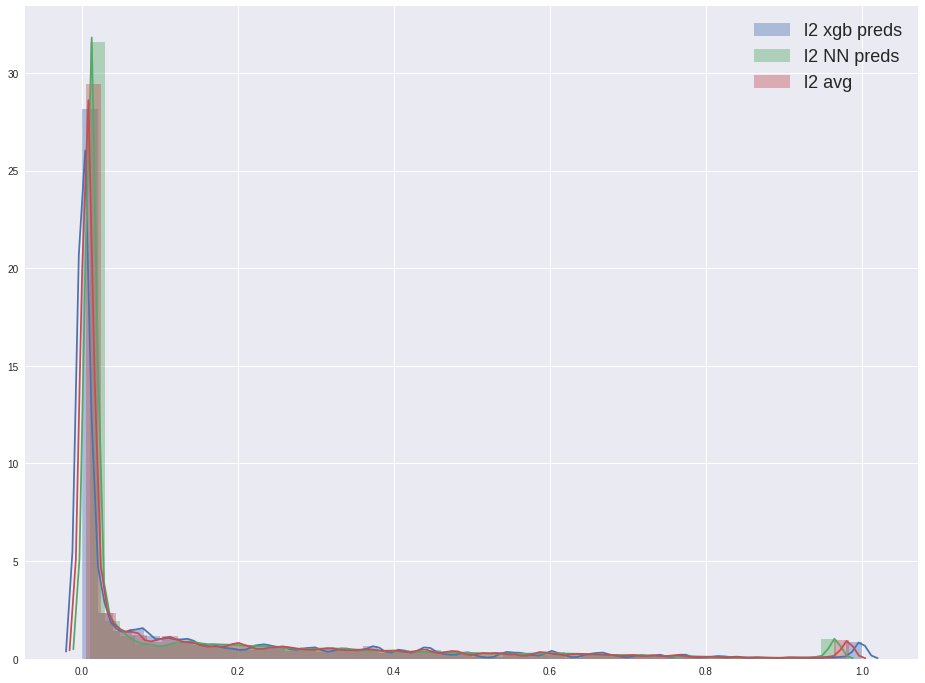

In [41]:
sns.distplot(xgb_stacked_preds_raw,label='l2 xgb preds'),
sns.distplot(NN_stacked_preds_raw,label='l2 NN preds'),
sns.distplot(final_l2_avg_raw,label='l2 avg')

plt.legend(loc='upper right', prop={'size': 18})


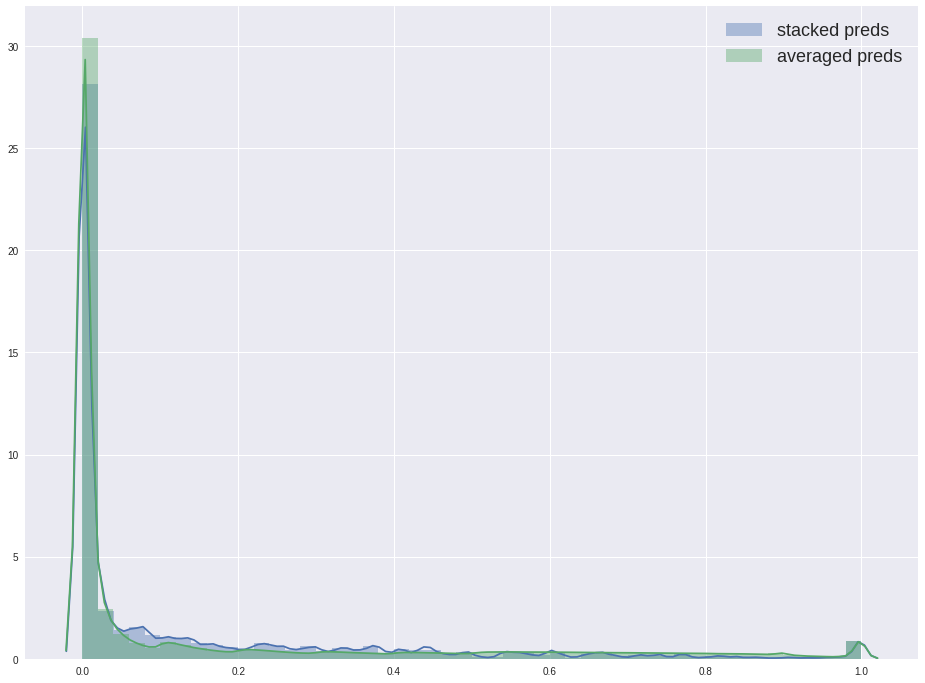

In [46]:
sns.distplot(xgb_stacked_preds_raw,label='stacked preds'),sns.distplot((xgb_test_preds+NN_test_preds)/2.,label='averaged preds')
plt.legend(loc='upper right', prop={'size': 18})


In [36]:
link_function(final_l2_avg_raw)

array([[ 0.00184083],
       [ 0.09933883],
       [ 0.17781933],
       ..., 
       [ 0.00184482],
       [ 0.07020938],
       [ 0.08826888]])

In [39]:
np.mean([l2_xgb__fixed,l2_NN_fixed],axis=0)

array([[ 0.00184673],
       [ 0.09936055],
       [ 0.17796456],
       ..., 
       [ 0.00185075],
       [ 0.07020971],
       [ 0.08827162]])

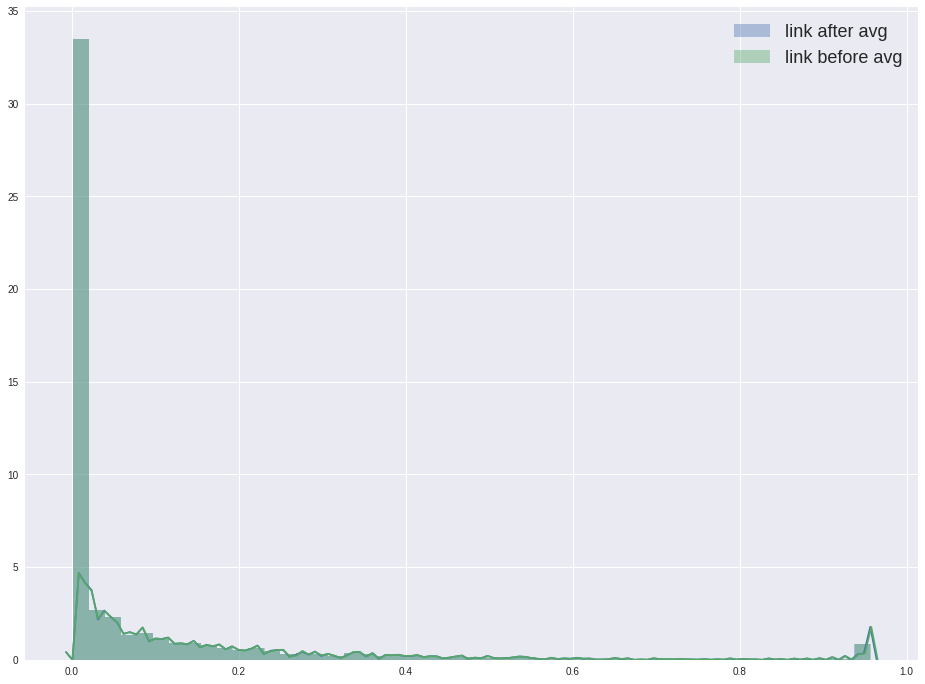

In [35]:
#mean before or after link_function
sns.distplot(link_function(final_l2_avg_raw),label='link after avg'),
sns.distplot(np.mean([l2_xgb__fixed,l2_NN_fixed],axis=0),label='link before avg')
plt.legend(loc='upper right', prop={'size': 18})


In [26]:
import scipy

In [50]:
lstm_test_preds = np.clip(lstm_test_preds,1e-9,0.999999999)

In [62]:
hmean = link_function(scipy.stats.hmean([lstm_test_preds,xgb_test_preds],axis=0))

In [63]:
xgb_final = link_function(xgb_test_preds)

In [64]:
lstm_final = link_function(lstm_test_preds)

In [65]:
normal_mean = link_function(np.mean([lstm_test_preds,xgb_test_preds],axis=0))

In [45]:
link_function(lstm_test_preds)[20:30]

array([[  3.60571719e-08],
       [  2.06775281e-02],
       [  1.58380981e-02],
       [  1.50104647e-01],
       [  5.49354803e-08],
       [  1.95155407e-01],
       [  3.60571719e-08],
       [  5.94498905e-03],
       [  5.11012031e-02],
       [  3.60571719e-08]])

In [44]:
df_test.ix[20:30].values

array([[20,
        'How matter at MIT? Will performing poorly in 11 grade affect my chance?',
        'I have passed 5 AP tests with scores trump 5. Can I apply to UC Berkeley at 11 grade? If I got rejected, does it hurt my chance next year?'],
       [21, 'What possible with XAT percentile between 85 and 90?',
        'Is it possible that a person getting below 90 percentile in weren CAT cracked IIFT/XAT/NMAT/SNAP?'],
       [22, 'What are the differences between clients and servers?',
        'What is the difference between a server and a database?'],
       [23, 'I want to eat hacking where should I start?',
        'If I want to learn processor what should I do?'],
       [24, 'Why do people like Hrithik Roshan tax much?',
        "Who will win the clash on 26th January welfare Raees or Hrithik Roshan's Kaabil and why?"],
       [25, 'What should be the first computer table language I learn?',
        'Which language should I x^4 as a first programming language?'],
       [26,
   

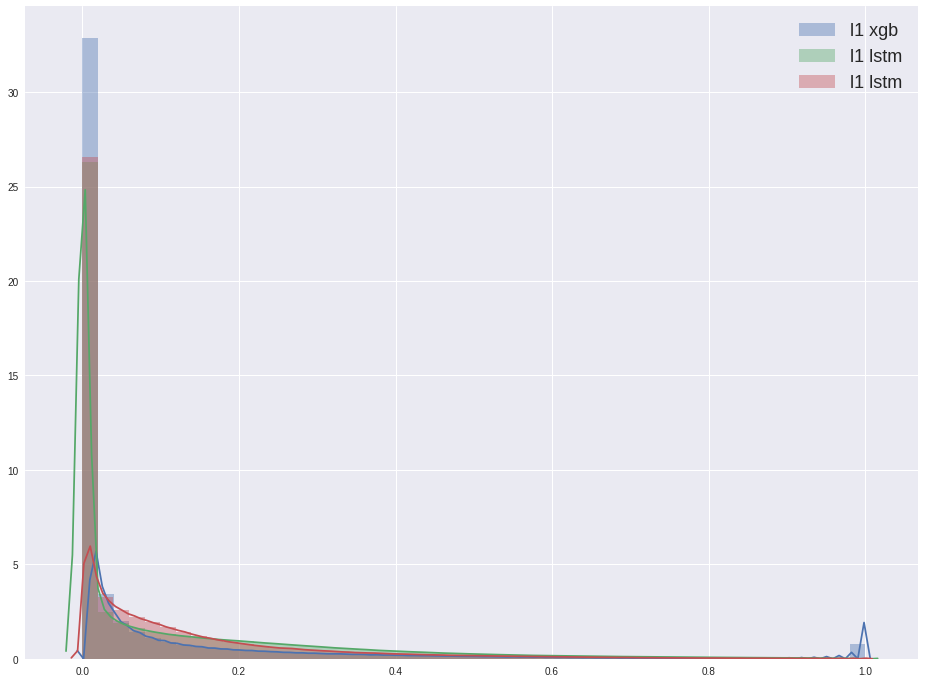

In [16]:
sns.distplot(link_function(xgb_test_preds),label='l1 xgb'),
sns.distplot(link_function(lstm_test_preds),label='l1 lstm'),
sns.distplot(link_function(np.mean([lstm_test_preds,xgb_test_preds],axis=0)),label='l1 mean'),

# sns.distplot(l2_xgb__fixed,label='l2 xgb')
plt.legend(loc='upper right', prop={'size': 18})


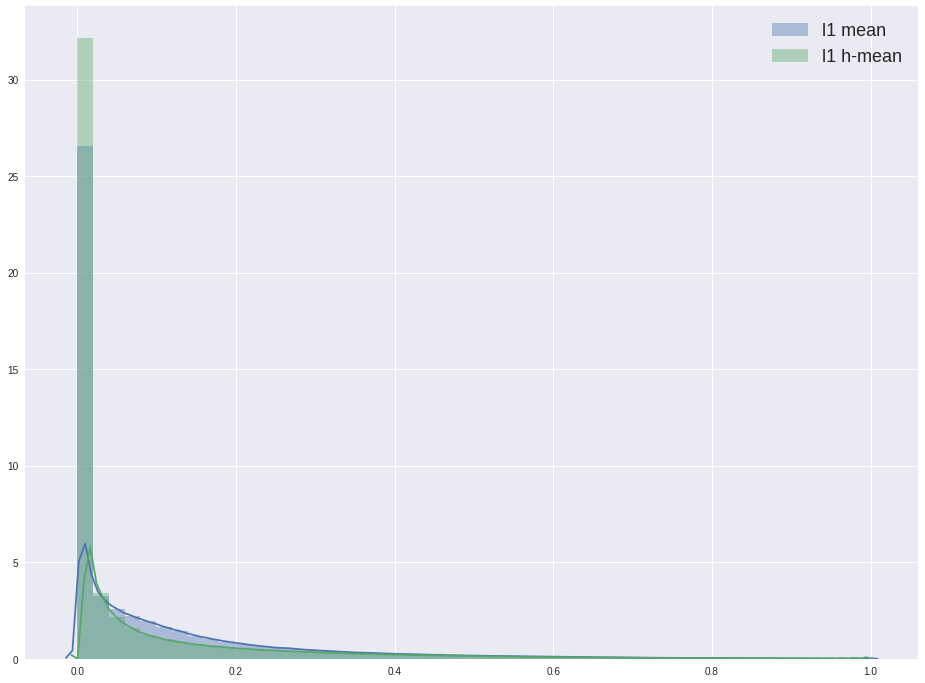

In [40]:
# sns.distplot(link_function(xgb_test_preds),label='l1 xgb'),
# sns.distplot(link_function(lstm_test_preds),label='l1 lstm'),

sns.distplot(link_function(np.mean([lstm_test_preds,xgb_test_preds],axis=0)),label='l1 mean'),
sns.distplot(link_function(scipy.stats.hmean([lstm_test_preds,xgb_test_preds],axis=0)),label='l1 h-mean'),

plt.legend(loc='upper right', prop={'size': 18})



### ues harmonic mean (partially!)
if xgb pred value is less than 0.1
if xgb pred > lstm pred > use harmonic mean 

In [ ]:
for i in range(len(xgb_final)):
    if xgb_final[i] < 0.1 and lstm_final[i]<xgb_final[i]:
        print i, xgb_final[i], ">",normal_mean[i]
        xgb_final[i]  = normal_mean[i]
        

0 [  5.50811990e-05] > [  2.78628087e-05]
3 [ 0.00283731] > [ 0.00142275]
4 [ 0.00505933] > [ 0.00295933]
11 [  5.73030111e-05] > [  3.73679903e-05]
12 [  9.87894560e-06] > [  4.93960982e-06]
16 [ 0.00010956] > [  5.53819304e-05]
20 [  1.04362317e-05] > [  5.21824786e-06]
24 [  7.34277324e-05] > [  3.67389473e-05]
26 [  9.60831469e-05] > [  4.80376612e-05]
27 [ 0.01335338] > [ 0.00962526]
29 [  8.17703651e-05] > [  4.08823987e-05]
32 [  5.83883960e-05] > [  3.02374290e-05]
34 [ 0.00012596] > [  8.47333527e-05]
36 [  1.41993414e-05] > [  7.09976162e-06]
37 [ 0.00226551] > [ 0.00115653]
39 [ 0.02050741] > [ 0.01297838]
44 [ 0.00095119] > [ 0.0005093]
49 [  2.78488329e-05] > [  1.39242529e-05]
50 [ 0.00036206] > [ 0.00018101]
52 [ 0.00039429] > [ 0.0002954]
54 [  2.24837245e-05] > [  1.12418184e-05]
58 [ 0.00053123] > [ 0.00038868]
67 [ 0.02825143] > [ 0.01404453]
71 [ 0.00029575] > [ 0.0001483]
74 [  5.91343812e-06] > [  2.95688384e-06]
78 [ 0.09438776] > [ 0.06574033]
81 [ 0.00413854] >

511 [  4.68267977e-06] > [  2.34151045e-06]
516 [ 0.04457073] > [ 0.04027889]
517 [  4.35151086e-05] > [  2.17568951e-05]
519 [ 0.01535043] > [ 0.00866823]
520 [ 0.00087997] > [ 0.00043964]
521 [  8.27899755e-06] > [  4.13964868e-06]
523 [  1.07625279e-05] > [  5.38139289e-06]
524 [ 0.01143441] > [ 0.01053773]
531 [ 0.00031889] > [ 0.00018627]
534 [ 0.00010603] > [  5.32224072e-05]
535 [  2.28373525e-05] > [  1.14186253e-05]
537 [  1.46794391e-05] > [  7.33980432e-06]
539 [ 0.0005794] > [ 0.00029557]
540 [ 0.00026939] > [ 0.00015363]
542 [  9.47620247e-06] > [  4.73824171e-06]
544 [ 0.00015324] > [  9.46414137e-05]
548 [ 0.00047873] > [ 0.00023935]
552 [ 0.00723868] > [ 0.0062211]
553 [  2.42547842e-05] > [  1.21345746e-05]
556 [ 0.00028177] > [ 0.00015565]
557 [  5.82126510e-05] > [  2.91050035e-05]
559 [ 0.00033351] > [ 0.00016671]
562 [  1.03090476e-05] > [  5.15465698e-06]
563 [ 0.0005329] > [ 0.00036512]
564 [  2.92942116e-05] > [  1.46469056e-05]
565 [ 0.05196889] > [ 0.03202767]

1053 [  2.85240294e-05] > [  1.42618343e-05]
1055 [  6.90999406e-05] > [  3.45924657e-05]
1057 [  6.83409541e-06] > [  3.41720729e-06]
1058 [ 0.00116337] > [ 0.00059038]
1059 [ 0.00042425] > [ 0.00021592]
1065 [  6.42853565e-06] > [  3.21442979e-06]
1066 [  8.05836586e-06] > [  4.02933443e-06]
1070 [  2.47007460e-05] > [  1.23502828e-05]
1072 [  8.59653733e-06] > [  4.29841619e-06]
1074 [  1.98465260e-05] > [  9.92326869e-06]
1076 [ 0.00014691] > [ 0.00013542]
1077 [  2.67737618e-05] > [  1.33867434e-05]
1079 [ 0.00054727] > [ 0.00027385]
1080 [ 0.02354179] > [ 0.01329872]
1081 [ 0.00012465] > [  6.23164399e-05]
1086 [ 0.05061764] > [ 0.03241955]
1089 [  1.36190238e-05] > [  6.80960996e-06]
1090 [  8.84834815e-05] > [  4.54653679e-05]
1092 [ 0.0043479] > [ 0.002743]
1094 [  3.75316718e-05] > [  1.87663315e-05]
1102 [ 0.002012] > [ 0.0010665]
1104 [ 0.01197074] > [ 0.01060705]
1105 [ 0.00399098] > [ 0.00253807]
1111 [  5.72191994e-05] > [  2.86083285e-05]
1112 [  3.34249478e-05] > [  1.

1552 [  1.95570417e-05] > [  9.77853159e-06]
1553 [  2.17826048e-05] > [  1.08912723e-05]
1555 [ 0.0006194] > [ 0.00035481]
1560 [  3.60644670e-06] > [  1.80339787e-06]
1564 [ 0.00015221] > [  7.60953386e-05]
1570 [  3.51297524e-05] > [  1.78174255e-05]
1572 [  8.61225065e-05] > [  4.33782383e-05]
1573 [  6.78420748e-06] > [  3.39226362e-06]
1578 [ 0.00102761] > [ 0.00051954]
1579 [  3.44457293e-05] > [  1.72278023e-05]
1580 [ 0.00013984] > [  6.99107814e-05]
1581 [  8.54534891e-06] > [  4.27282237e-06]
1582 [  4.97742844e-05] > [  2.48867880e-05]
1584 [  2.43777183e-05] > [  1.22026322e-05]
1585 [  7.56976096e-06] > [  3.78503537e-06]
1587 [  6.99421478e-05] > [  3.54387986e-05]
1588 [ 0.00014055] > [  7.20360215e-05]
1593 [ 0.00055247] > [ 0.0003771]
1594 [  1.51642683e-05] > [  7.58365666e-06]
1596 [  7.76275788e-06] > [  3.88153251e-06]
1600 [  9.95540101e-06] > [  4.97783685e-06]
1607 [  2.02774534e-06] > [  1.01405113e-06]
1610 [  6.25775902e-05] > [  3.12872394e-05]
1611 [  1.87

2071 [ 0.00014834] > [  7.41825925e-05]
2073 [ 0.00011676] > [  5.84863410e-05]
2074 [  9.04203964e-05] > [  5.15509232e-05]
2078 [ 0.00620069] > [ 0.00497164]
2079 [  1.79995641e-05] > [  8.99981873e-06]
2081 [ 0.00038627] > [ 0.00019928]
2082 [ 0.00151354] > [ 0.00086434]
2086 [ 0.0041575] > [ 0.00208139]
2089 [  2.77842482e-05] > [  1.39703350e-05]
2095 [ 0.00013752] > [  6.87567864e-05]
2096 [ 0.00028575] > [ 0.00014284]
2099 [  4.36295327e-06] > [  2.18164849e-06]
2102 [  4.48081127e-06] > [  2.24057702e-06]
2103 [  1.24430428e-05] > [  6.22163304e-06]
2104 [ 0.00047832] > [ 0.00030631]
2107 [  6.62373783e-05] > [  3.31169244e-05]
2108 [ 0.0064161] > [ 0.00326491]
2109 [  2.45708250e-05] > [  1.22853251e-05]
2110 [ 0.00013267] > [  6.63315242e-05]
2111 [  1.13891409e-05] > [  5.69469321e-06]
2114 [  8.64773482e-06] > [  4.32401454e-06]
2116 [  7.69518878e-05] > [  7.18614992e-05]
2118 [ 0.00020007] > [ 0.00018241]
2120 [ 0.00101551] > [ 0.00073261]
2125 [ 0.02226711] > [ 0.0182314

2608 [ 0.03193967] > [ 0.02462266]
2611 [ 0.0573064] > [ 0.03482892]
2615 [  2.25776513e-05] > [  1.12887800e-05]
2616 [  4.03553518e-05] > [  2.01771342e-05]
2619 [  8.50790593e-05] > [  4.25383767e-05]
2620 [ 0.00143513] > [ 0.00084313]
2623 [ 0.00119174] > [ 0.00059525]
2624 [ 0.0045965] > [ 0.00290584]
2625 [ 0.00019469] > [ 0.00011044]
2628 [ 0.00058246] > [ 0.00033669]
2629 [  5.49764355e-06] > [  2.74898866e-06]
2631 [  1.91420903e-05] > [  9.57106299e-06]
2632 [  4.13364249e-06] > [  2.06699395e-06]
2633 [ 0.00030569] > [ 0.00015291]
2636 [  3.34405653e-05] > [  1.67419556e-05]
2637 [  1.95186559e-05] > [  9.75933933e-06]
2638 [  3.30370401e-05] > [  1.65182165e-05]
2639 [ 0.00062176] > [ 0.00031071]
2640 [  1.41295737e-05] > [  7.06487863e-06]
2641 [  1.57033125e-05] > [  7.85172723e-06]
2643 [  1.31675123e-05] > [  6.58385959e-06]
2644 [  3.65627714e-06] > [  1.82831293e-06]
2653 [ 0.00207764] > [ 0.00161634]
2654 [  1.35869744e-05] > [  6.79358567e-06]
2655 [ 0.03209252] > [

3095 [ 0.00010609] > [  8.48318922e-05]
3098 [ 0.00016867] > [  8.43262746e-05]
3099 [  2.73514359e-06] > [  1.36774876e-06]
3102 [  1.12907786e-05] > [  5.64551306e-06]
3103 [ 0.03721651] > [ 0.03236491]
3104 [  4.79717289e-05] > [  2.39850245e-05]
3105 [ 0.00014667] > [  7.33231882e-05]
3108 [  5.70908294e-05] > [  2.85628465e-05]
3110 [ 0.00105861] > [ 0.00052923]
3111 [  3.05753992e-05] > [  1.52874655e-05]
3114 [  6.69742815e-06] > [  3.34887448e-06]
3117 [  4.09368099e-05] > [  2.05600570e-05]
3119 [  8.55155598e-06] > [  4.27592586e-06]
3120 [ 0.0591139] > [ 0.04373006]
3121 [ 0.00165598] > [ 0.00084817]
3125 [ 0.00103719] > [ 0.00053343]
3128 [ 0.00011189] > [  5.59435052e-05]
3131 [  2.04827316e-06] > [  1.02431501e-06]
3132 [  6.08774432e-05] > [  3.04372589e-05]
3134 [  4.31556112e-05] > [  2.15771603e-05]
3140 [ 0.00066025] > [ 0.00034872]
3141 [  7.31604145e-06] > [  3.65817728e-06]
3143 [ 0.00015999] > [  7.99851407e-05]
3144 [  2.57522430e-05] > [  1.28760078e-05]
3145 [

3609 [  7.35233888e-05] > [  3.67594783e-05]
3610 [  4.76898014e-06] > [  2.38466028e-06]
3612 [ 0.00049458] > [ 0.00024719]
3613 [  1.59329702e-05] > [  7.96655285e-06]
3616 [  6.27738981e-05] > [  3.14651337e-05]
3617 [ 0.07864165] > [ 0.04987731]
3618 [  5.63422571e-05] > [  2.81699015e-05]
3619 [ 0.00013763] > [ 0.00011989]
3620 [ 0.00120471] > [ 0.00060171]
3621 [  5.23750077e-05] > [  2.61865844e-05]
3623 [  1.31355731e-05] > [  6.56789034e-06]
3625 [  5.28653429e-05] > [  2.71991027e-05]
3627 [  2.39726895e-05] > [  1.19869639e-05]
3628 [ 0.00087611] > [ 0.00077048]
3630 [ 0.00013163] > [  8.39679474e-05]
3632 [ 0.00118071] > [ 0.00075542]
3633 [  3.12472036e-05] > [  2.81237105e-05]
3634 [  5.33709452e-06] > [  2.66871492e-06]
3635 [  4.38534267e-05] > [  2.19260411e-05]
3638 [  1.76354613e-06] > [  8.81951971e-07]
3641 [  1.22669028e-05] > [  6.13356499e-06]
3643 [  1.00753449e-05] > [  5.03780775e-06]
3646 [ 0.01423969] > [ 0.0070698]
3647 [  7.66467930e-05] > [  4.21566138e-

4128 [ 0.01076531] > [ 0.00542742]
4130 [  3.74995820e-05] > [  1.87505094e-05]
4134 [  4.70526643e-05] > [  2.35255310e-05]
4136 [  9.44670522e-05] > [  4.72297503e-05]
4138 [  1.24609300e-05] > [  6.23057644e-06]
4139 [ 0.00173846] > [ 0.00087325]
4140 [  7.64176767e-06] > [  3.82103823e-06]
4143 [  4.82705750e-05] > [  2.41344348e-05]
4146 [ 0.00561371] > [ 0.00449663]
4147 [  2.15669912e-05] > [  1.07834697e-05]
4148 [ 0.00303151] > [ 0.00172285]
4150 [  9.70689798e-05] > [  4.85332450e-05]
4152 [  2.62803407e-05] > [  1.31400445e-05]
4161 [ 0.00081859] > [ 0.00079735]
4162 [ 0.00017668] > [  9.28658856e-05]
4166 [  3.30285460e-05] > [  1.65148850e-05]
4168 [  7.12238213e-06] > [  3.56134886e-06]
4169 [ 0.00266893] > [ 0.00133131]
4172 [ 0.00063766] > [ 0.00035177]
4173 [  3.50623949e-05] > [  1.75338134e-05]
4174 [  1.32384707e-05] > [  6.61933794e-06]
4175 [ 0.00014075] > [  7.03671698e-05]
4176 [  5.90512659e-05] > [  2.95242673e-05]
4177 [  3.85510402e-05] > [  1.92750415e-05]


4659 [  6.42149463e-05] > [  3.21066997e-05]
4663 [ 0.00012325] > [  6.25696344e-05]
4664 [  4.29946750e-05] > [  2.14966983e-05]
4666 [  3.07874547e-05] > [  1.53934874e-05]
4667 [ 0.08964909] > [ 0.0429639]
4669 [  7.65543617e-05] > [  3.83066461e-05]
4672 [  8.58922448e-05] > [  4.29430322e-05]
4673 [  1.49062040e-05] > [  7.45318380e-06]
4678 [  2.23430601e-05] > [  1.44194324e-05]
4679 [  5.33853151e-06] > [  2.66943341e-06]
4683 [  3.52518057e-05] > [  1.82238882e-05]
4685 [  8.14546018e-06] > [  4.07288096e-06]
4687 [  1.07709976e-05] > [  5.38562764e-06]
4690 [ 0.00756197] > [ 0.00501943]
4691 [ 0.00077953] > [ 0.00039026]
4692 [ 0.0012666] > [ 0.00063259]
4696 [ 0.03651595] > [ 0.02204614]
4697 [ 0.05700953] > [ 0.04262834]
4698 [  1.14460614e-05] > [  5.72315291e-06]
4699 [ 0.00019853] > [  9.95229079e-05]
4700 [  2.78361999e-06] > [  1.39198685e-06]
4701 [  1.84835788e-05] > [  9.24181821e-06]
4702 [  4.36109036e-06] > [  2.18071704e-06]
4704 [  5.54284157e-06] > [  2.771587

5164 [  5.98249713e-05] > [  2.99121425e-05]
5170 [  2.25370496e-05] > [  1.12684799e-05]
5171 [  2.88348964e-05] > [  1.46936594e-05]
5175 [ 0.00025655] > [ 0.00012824]
5177 [ 0.00022831] > [ 0.00011413]
5178 [  1.58974835e-05] > [  7.94887519e-06]
5181 [  6.02152445e-05] > [  3.01061951e-05]
5182 [  8.14777555e-05] > [  4.08239334e-05]
5183 [  1.48742735e-05] > [  7.43721896e-06]
5185 [ 0.00022632] > [ 0.00011372]
5186 [  1.30039623e-05] > [  6.50208648e-06]
5190 [  6.98694459e-06] > [  3.49363094e-06]
5192 [ 0.00013355] > [  6.80757732e-05]
5193 [ 0.00223785] > [ 0.00145979]
5198 [ 0.00062707] > [ 0.00031336]
5200 [ 0.01221588] > [ 0.00762616]
5201 [ 0.00016985] > [  8.49109864e-05]
5204 [  2.80391860e-05] > [  1.40194247e-05]
5205 [ 0.00070555] > [ 0.0003775]
5208 [ 0.00030813] > [ 0.00015402]
5213 [  2.99015621e-06] > [  1.49525443e-06]
5214 [  1.01928045e-05] > [  5.09653648e-06]
5216 [  5.22216241e-06] > [  2.61124940e-06]
5218 [ 0.0061746] > [ 0.00375684]
5219 [  2.25710920e-05

5682 [  3.69518422e-05] > [  1.87141692e-05]
5683 [  9.22157779e-05] > [  4.61512863e-05]
5687 [ 0.00574058] > [ 0.00450535]
5688 [  6.70681047e-05] > [  3.35322386e-05]
5690 [  7.60629844e-05] > [  3.85334658e-05]
5694 [  3.63565780e-06] > [  1.81800333e-06]
5698 [ 0.00034568] > [ 0.00017284]
5702 [ 0.00092659] > [ 0.00050025]
5707 [ 0.00126059] > [ 0.00064588]
5708 [ 0.06351097] > [ 0.04769119]
5712 [ 0.00271465] > [ 0.00264462]
5714 [ 0.00015563] > [ 0.00011944]
5717 [ 0.00014694] > [  7.35966294e-05]
5720 [  5.63766851e-06] > [  2.81900045e-06]
5724 [  8.12190568e-06] > [  4.06110388e-06]
5725 [ 0.00015068] > [  7.57957369e-05]
5728 [  5.58454591e-05] > [  2.79244100e-05]
5733 [ 0.00010899] > [  7.68112613e-05]
5735 [  5.76994920e-06] > [  2.88514013e-06]
5736 [  2.97861793e-05] > [  1.48928766e-05]
5737 [  7.20703204e-06] > [  3.60367328e-06]
5740 [  9.86346730e-06] > [  4.93187081e-06]
5742 [ 0.00047952] > [ 0.00023967]
5743 [  9.70952823e-06] > [  4.85490261e-06]
5751 [  1.10854

6230 [ 0.0001413] > [  7.08411793e-05]
6231 [ 0.06834693] > [ 0.03662136]
6233 [  5.83827097e-05] > [  2.91931033e-05]
6234 [ 0.00059298] > [ 0.00029634]
6235 [ 0.00048577] > [ 0.00024291]
6237 [ 0.00385028] > [ 0.00235094]
6238 [ 0.00015505] > [  7.75395449e-05]
6244 [  2.39259106e-05] > [  1.19636036e-05]
6250 [ 0.00205461] > [ 0.0015561]
6252 [ 0.00578894] > [ 0.00506113]
6258 [ 0.01072448] > [ 0.00531342]
6259 [  1.84494020e-05] > [  9.22473037e-06]
6260 [  3.71439237e-05] > [  1.85737610e-05]
6261 [  1.84286635e-05] > [  9.21519247e-06]
6266 [  4.30980767e-06] > [  2.15507589e-06]
6267 [ 0.07496659] > [ 0.04577011]
6269 [  7.44265750e-05] > [  3.72110122e-05]
6271 [ 0.00031772] > [ 0.00015884]
6274 [  2.80395323e-05] > [  1.40195979e-05]
6277 [  3.48731141e-06] > [  1.74383060e-06]
6278 [ 0.00013258] > [  6.62833096e-05]
6281 [  6.20276321e-06] > [  3.10154484e-06]
6283 [  1.43673219e-05] > [  7.18374973e-06]
6285 [  1.88508158e-05] > [  9.42543063e-06]
6286 [ 0.04915287] > [ 0.02

6754 [  7.13636636e-05] > [  3.77896417e-05]
6756 [  1.36131595e-05] > [  6.80667787e-06]
6758 [  8.18560128e-05] > [  4.40167506e-05]
6759 [ 0.00075764] > [ 0.00037919]
6766 [ 0.0001481] > [  7.40741497e-05]
6768 [  3.42002050e-05] > [  1.70997642e-05]
6769 [ 0.00013859] > [  6.92846878e-05]
6770 [  1.07986948e-05] > [  5.39947600e-06]
6771 [  3.45360157e-05] > [  1.72676593e-05]
6772 [  4.12149603e-05] > [  2.06069074e-05]
6774 [ 0.00017282] > [  8.78069426e-05]
6777 [ 0.00036635] > [ 0.00018312]
6778 [  5.44237586e-06] > [  2.72135509e-06]
6781 [ 0.00218298] > [ 0.00185101]
6782 [  6.18610058e-06] > [  3.09321361e-06]
6783 [ 0.00121231] > [ 0.00064192]
6785 [  5.70061864e-05] > [  3.24623884e-05]
6786 [  6.17866716e-05] > [  3.08918237e-05]
6788 [  4.97184940e-06] > [  2.48609403e-06]
6789 [ 0.00021174] > [ 0.00010585]
6793 [  1.23811593e-05] > [  6.19069199e-06]
6795 [ 0.00014638] > [  7.31814279e-05]
6796 [  6.51301042e-06] > [  3.25666669e-06]
6798 [  2.25026614e-06] > [  1.12531

7283 [  7.41979897e-05] > [  3.70987495e-05]
7284 [ 0.00014884] > [ 0.00010554]
7288 [ 0.00049867] > [ 0.00025692]
7290 [  3.83348849e-06] > [  1.91691802e-06]
7293 [ 0.00107013] > [ 0.00053489]
7294 [ 0.00121757] > [ 0.00061695]
7298 [ 0.08562832] > [ 0.070749]
7301 [  5.69291885e-06] > [  2.84662535e-06]
7304 [ 0.00012581] > [  6.28973644e-05]
7305 [ 0.00075275] > [ 0.00037614]
7306 [ 0.00032091] > [ 0.00016075]
7307 [ 0.0003787] > [ 0.00018959]
7309 [  3.08253030e-06] > [  1.54144123e-06]
7310 [ 0.00014003] > [  7.00992338e-05]
7311 [ 0.00018474] > [  9.24923866e-05]
7312 [  4.51748845e-06] > [  2.25891546e-06]
7314 [  2.51326161e-05] > [  1.25662083e-05]
7317 [ 0.00012387] > [  6.23878889e-05]
7318 [  8.58975784e-05] > [  4.29456986e-05]
7319 [  5.84048078e-05] > [  2.92010720e-05]
7321 [  9.59028203e-05] > [  4.80723048e-05]
7327 [  4.70905285e-06] > [  2.35469688e-06]
7330 [ 0.08066878] > [ 0.04061009]
7331 [  2.36430079e-05] > [  1.18214364e-05]
7333 [  2.84457959e-05] > [  1.42

7854 [  7.85631962e-06] > [  3.92831274e-06]
7855 [ 0.0045771] > [ 0.00259766]
7857 [ 0.00048934] > [ 0.00042653]
7858 [ 0.00014622] > [  7.31683911e-05]
7861 [ 0.00013707] > [  6.87184173e-05]
7862 [ 0.00022555] > [ 0.00011289]
7865 [  7.72490778e-05] > [  5.31736621e-05]
7868 [ 0.00013704] > [  6.85102684e-05]
7869 [  3.49940588e-06] > [  1.74987780e-06]
7872 [ 0.00098195] > [ 0.00051706]
7873 [  2.90460879e-05] > [  2.13734690e-05]
7877 [ 0.00571438] > [ 0.00327678]
7880 [ 0.00114779] > [ 0.00057344]
7881 [  3.16618197e-05] > [  1.58907517e-05]
7883 [ 0.00015154] > [  7.67179621e-05]
7886 [  7.00574535e-06] > [  3.50303120e-06]
7887 [  3.00079758e-05] > [  1.50037690e-05]
7888 [  2.43189045e-05] > [  1.21593703e-05]
7890 [ 0.00021097] > [ 0.0001076]
7891 [ 0.00102389] > [ 0.00097138]
7896 [  1.41940320e-05] > [  7.09710696e-06]
7902 [ 0.00307524] > [ 0.00167171]
7903 [  2.41814000e-05] > [  1.20906211e-05]
7905 [  9.75305852e-06] > [  4.87666738e-06]
7906 [  2.39049483e-05] > [  1.1

8405 [  1.20705687e-05] > [  6.03540006e-06]
8406 [ 0.03247687] > [ 0.02774815]
8409 [ 0.00016077] > [  8.04144018e-05]
8410 [ 0.00026241] > [ 0.00013118]
8411 [ 0.00013079] > [  6.53907348e-05]
8413 [ 0.00012965] > [  9.83596002e-05]
8416 [  1.33903683e-05] > [  6.70604951e-06]
8418 [  9.93503678e-06] > [  4.96856652e-06]
8423 [  3.70728347e-05] > [  1.85359883e-05]
8424 [  4.98352296e-06] > [  2.49193075e-06]
8425 [  4.26362988e-06] > [  2.13198717e-06]
8428 [ 0.00020707] > [ 0.00010402]
8429 [  5.46231845e-05] > [  2.73104498e-05]
8432 [  9.33427455e-05] > [  4.66686510e-05]
8434 [  1.91825965e-05] > [  9.59131542e-06]
8435 [  3.60107573e-06] > [  1.80071240e-06]
8437 [  3.36357594e-05] > [  1.73902448e-05]
8438 [ 0.00085327] > [ 0.00042636]
8440 [  3.09570708e-05] > [  1.54782908e-05]
8446 [  3.57074219e-06] > [  1.78554573e-06]
8447 [ 0.07052818] > [ 0.03714114]
8450 [ 0.00015915] > [  7.95769124e-05]
8454 [  4.75435405e-06] > [  2.37734729e-06]
8456 [ 0.04951962] > [ 0.02690934]


8904 [ 0.00013442] > [  6.72685223e-05]
8905 [ 0.03111943] > [ 0.02790328]
8906 [  2.41823829e-05] > [  1.20911125e-05]
8907 [ 0.00074903] > [ 0.00037527]
8911 [ 0.00051162] > [ 0.0002571]
8913 [ 0.00022933] > [ 0.00011464]
8915 [  1.38803514e-05] > [  6.94027055e-06]
8916 [ 0.00159581] > [ 0.00079856]
8917 [  2.13168154e-06] > [  1.06601904e-06]
8918 [  8.21045702e-06] > [  4.10537891e-06]
8920 [  3.99691206e-05] > [  2.08553851e-05]
8921 [  1.25671718e-05] > [  6.28369617e-06]
8930 [  3.08082756e-05] > [  1.54038973e-05]
8931 [  2.11297000e-05] > [  1.05648323e-05]
8933 [ 0.00044568] > [ 0.00022326]
8937 [  6.36803144e-05] > [  3.18385397e-05]
8939 [ 0.00382084] > [ 0.00190878]
8940 [  4.96586162e-05] > [  2.48287875e-05]
8941 [  6.55741955e-05] > [  3.27957972e-05]
8942 [  1.50016957e-05] > [  7.50092839e-06]
8949 [  4.04844808e-05] > [  2.02416941e-05]
8951 [  8.91335520e-06] > [  4.45682267e-06]
8952 [ 0.00109837] > [ 0.00089716]
8953 [  3.09087773e-05] > [  1.54541454e-05]
8954 [

9440 [  3.03658147e-05] > [  1.52603388e-05]
9441 [  1.18151245e-05] > [  5.90768063e-06]
9443 [  1.06301752e-05] > [  5.31521780e-06]
9444 [  4.57386307e-05] > [  2.28685682e-05]
9447 [ 0.06038737] > [ 0.04556485]
9448 [  3.86576100e-05] > [  1.93403254e-05]
9454 [  6.59414264e-05] > [  3.32743673e-05]
9456 [  2.47272082e-05] > [  1.23635133e-05]
9457 [  3.07038860e-05] > [  1.53551081e-05]
9458 [  9.55128445e-06] > [  4.77578207e-06]
9459 [  6.83893754e-05] > [  3.41927946e-05]
9460 [ 0.0580626] > [ 0.03669902]
9462 [  2.16714759e-06] > [  1.08375200e-06]
9463 [  7.05226996e-06] > [  3.52629322e-06]
9467 [ 0.00023921] > [ 0.00012364]
9468 [  8.46626268e-05] > [  4.23283162e-05]
9469 [ 0.00019106] > [  9.55890762e-05]
9471 [  1.15250105e-05] > [  5.76262663e-06]
9472 [  2.08224041e-05] > [  1.04111901e-05]
9473 [ 0.03240206] > [ 0.01634176]
9474 [  7.16017925e-06] > [  3.58024719e-06]
9476 [ 0.0010722] > [ 0.00053661]
9477 [ 0.00043309] > [ 0.00022786]
9478 [ 0.01522567] > [ 0.0150712

9984 [  8.02136647e-05] > [  4.48523046e-05]
9988 [  2.04469870e-05] > [  1.06529723e-05]
9989 [ 0.00052167] > [ 0.00026071]
9990 [  9.72947988e-06] > [  4.86487826e-06]
9991 [ 0.05780741] > [ 0.0312443]
10001 [  1.70735709e-05] > [  8.53683648e-06]
10002 [  1.12837313e-05] > [  5.64198949e-06]
10003 [ 0.0001197] > [  6.36726822e-05]
10007 [  5.00922265e-05] > [  2.50451811e-05]
10008 [ 0.00109851] > [ 0.00054876]
10009 [  1.15709426e-05] > [  5.78559221e-06]
10010 [ 0.00017785] > [  9.48681058e-05]
10019 [ 0.02133639] > [ 0.0104735]
10020 [ 0.02305943] > [ 0.01140717]
10021 [  4.81399813e-05] > [  2.53554563e-05]
10022 [  5.61607802e-06] > [  2.80820531e-06]
10023 [  7.34032314e-05] > [  3.67019816e-05]
10024 [ 0.00123016] > [ 0.00061934]
10026 [  3.25040345e-05] > [  1.68548982e-05]
10027 [  2.09082694e-05] > [  1.04542533e-05]
10031 [ 0.00022057] > [ 0.00011027]
10033 [  5.28236568e-06] > [  2.64135076e-06]
10036 [  5.31115904e-05] > [  2.65547250e-05]
10037 [ 0.00013054] > [  6.661

10551 [  1.60443033e-05] > [  8.02221784e-06]
10552 [  9.03167284e-06] > [  4.51598055e-06]
10553 [  7.66788861e-05] > [  3.89295284e-05]
10555 [  5.84791204e-06] > [  2.92412115e-06]
10556 [  4.68203562e-06] > [  2.34118838e-06]
10559 [ 0.00057821] > [ 0.00050648]
10560 [  2.74804628e-05] > [  1.87804299e-05]
10563 [ 0.00361931] > [ 0.00180881]
10566 [  1.20355588e-05] > [  6.01789547e-06]
10568 [  7.01300148e-05] > [  3.58058248e-05]
10569 [  6.69416509e-06] > [  3.34724296e-06]
10571 [ 0.0005347] > [ 0.00027559]
10572 [ 0.00020312] > [ 0.00013464]
10574 [  1.43473594e-05] > [  7.17376875e-06]
10575 [  8.62757114e-05] > [  4.31377807e-05]
10578 [  8.93538179e-06] > [  4.46783579e-06]
10580 [ 0.00181365] > [ 0.00099604]
10581 [  4.52700641e-06] > [  2.26367441e-06]
10582 [ 0.00013279] > [ 0.00010483]
10583 [  2.30717985e-05] > [  1.15358435e-05]
10587 [ 0.00016511] > [  8.25449221e-05]
10589 [  2.92490440e-05] > [  1.46243230e-05]
10590 [  2.15400537e-06] > [  1.07718092e-06]
10592 [ 

11034 [  1.54011358e-05] > [  7.70064306e-06]
11035 [ 0.00010104] > [  5.07351053e-05]
11036 [  4.65814902e-05] > [  2.32899635e-05]
11039 [  6.14326201e-06] > [  3.07179456e-06]
11044 [ 0.00012332] > [  6.56631889e-05]
11045 [  5.76865454e-06] > [  2.88449280e-06]
11047 [  9.63809405e-06] > [  4.81918613e-06]
11053 [ 0.02641137] > [ 0.01382263]
11054 [ 0.00327291] > [ 0.00200969]
11059 [ 0.00042165] > [ 0.0003242]
11063 [ 0.0001961] > [  9.80331760e-05]
11066 [  1.32680585e-05] > [  6.63413151e-06]
11068 [  1.08709939e-05] > [  5.43562485e-06]
11070 [ 0.00062865] > [ 0.0003186]
11071 [  7.71494654e-05] > [  3.88607198e-05]
11076 [  6.53341280e-05] > [  3.32892625e-05]
11078 [ 0.00101536] > [ 0.00063417]
11080 [ 0.0003514] > [ 0.00017565]
11081 [ 0.00020598] > [ 0.00010297]
11082 [  1.06362697e-05] > [  5.31826500e-06]
11083 [ 0.00204317] > [ 0.00107668]
11085 [  9.88780404e-06] > [  4.94403896e-06]
11087 [  6.64808745e-06] > [  3.32420442e-06]
11091 [  1.52211423e-05] > [  7.61064871e

11525 [  2.86833855e-06] > [  1.43434592e-06]
11529 [  2.69252112e-05] > [  1.34624645e-05]
11530 [ 0.00434092] > [ 0.00261732]
11531 [ 0.00027416] > [ 0.00013705]
11532 [  8.34396815e-05] > [  6.70664999e-05]
11533 [ 0.02685404] > [ 0.02343077]
11535 [  2.03629630e-05] > [  1.01931740e-05]
11538 [  1.08345594e-05] > [  5.43045046e-06]
11540 [ 0.09838943] > [ 0.06085297]
11543 [ 0.08512866] > [ 0.08083863]
11546 [ 0.0001625] > [  8.12393558e-05]
11548 [ 0.01745702] > [ 0.01388893]
11553 [  5.69541791e-05] > [  2.84761568e-05]
11555 [  3.09980812e-05] > [  1.54987949e-05]
11556 [ 0.00024921] > [ 0.00012793]
11560 [ 0.00091062] > [ 0.00045699]
11562 [ 0.08888083] > [ 0.06483261]
11570 [ 0.051104] > [ 0.04505057]
11574 [  1.69830765e-05] > [  8.49159069e-06]
11575 [ 0.00483719] > [ 0.00310665]
11581 [  6.30111290e-06] > [  3.15071914e-06]
11586 [ 0.03508317] > [ 0.01838351]
11587 [  3.47434339e-05] > [  1.92401199e-05]
11590 [ 0.00278891] > [ 0.00194296]
11593 [ 0.00060544] > [ 0.00030552

12134 [  1.15235366e-05] > [  5.76188974e-06]
12135 [  2.38727187e-05] > [  1.19362870e-05]
12136 [  1.26913721e-05] > [  6.35047326e-06]
12137 [ 0.02750064] > [ 0.01962222]
12142 [ 0.00166137] > [ 0.0008511]
12144 [ 0.05399531] > [ 0.04943609]
12145 [ 0.00202673] > [ 0.00101155]
12146 [ 0.00015148] > [  7.57327647e-05]
12147 [  4.71312742e-06] > [  2.35673415e-06]
12148 [  6.04068081e-05] > [  3.02046148e-05]
12149 [  5.66710927e-05] > [  5.42354894e-05]
12154 [  4.20761762e-05] > [  2.94813809e-05]
12156 [  6.86567622e-06] > [  3.43299750e-06]
12158 [ 0.00047729] > [ 0.00023855]
12163 [ 0.0017116] > [ 0.00168329]
12164 [  1.10431375e-05] > [  5.52169498e-06]
12166 [  2.93027118e-05] > [  1.46511988e-05]
12172 [ 0.0761028] > [ 0.05238598]
12173 [  1.73036482e-05] > [  8.65187167e-06]
12174 [ 0.00079223] > [ 0.00048552]
12175 [ 0.08771031] > [ 0.04381594]
12176 [  5.52673399e-06] > [  2.76353374e-06]
12179 [ 0.0642443] > [ 0.03053122]
12186 [  4.97083055e-06] > [  2.48558461e-06]
12187

12667 [ 0.00012731] > [  6.36499932e-05]
12668 [ 0.00047097] > [ 0.00041979]
12670 [  2.84646826e-05] > [  1.42321624e-05]
12672 [ 0.00541834] > [ 0.00438562]
12674 [ 0.00012249] > [  6.12360865e-05]
12675 [  7.85010096e-06] > [  3.92520345e-06]
12676 [ 0.01392491] > [ 0.0091689]
12678 [ 0.00021097] > [ 0.00013462]
12679 [ 0.00028253] > [ 0.00014139]
12687 [ 0.00248532] > [ 0.00123998]
12689 [ 0.00021574] > [ 0.00011227]
12690 [ 0.00012061] > [  6.33461574e-05]
12691 [ 0.00370064] > [ 0.00217239]
12695 [ 0.00029012] > [ 0.0001453]
12698 [  2.16967316e-06] > [  1.08501478e-06]
12699 [  1.71237198e-05] > [  8.56191021e-06]
12701 [  2.78922846e-05] > [  1.86807326e-05]
12704 [  1.26435242e-05] > [  6.32187150e-06]
12708 [  3.49691272e-05] > [  1.75158804e-05]
12709 [ 0.00123037] > [ 0.00061452]
12710 [  6.60824455e-05] > [  3.30394671e-05]
12711 [  7.24403840e-05] > [  3.62180460e-05]
12714 [ 0.00099077] > [ 0.00049512]
12716 [ 0.00019788] > [  9.89223759e-05]
12717 [  1.61090179e-05] > [

13138 [  3.17518003e-05] > [  1.58756335e-05]
13142 [  1.31116883e-05] > [  6.55594820e-06]
13143 [ 0.0601821] > [ 0.04744951]
13144 [ 0.02224087] > [ 0.01454612]
13145 [  5.94281123e-06] > [  2.97157024e-06]
13147 [  4.29389365e-05] > [  2.14688312e-05]
13149 [ 0.00020719] > [ 0.00010474]
13151 [ 0.00153335] > [ 0.00139277]
13153 [  3.56797646e-05] > [  1.78394982e-05]
13157 [ 0.00010661] > [  5.32983434e-05]
13158 [ 0.00068535] > [ 0.00037279]
13159 [ 0.09725603] > [ 0.05451743]
13163 [ 0.00040546] > [ 0.00020266]
13168 [  4.48534724e-05] > [  2.24260246e-05]
13172 [  1.79358302e-05] > [  8.96795276e-06]
13174 [ 0.00086584] > [ 0.00059694]
13175 [ 0.00072513] > [ 0.00036271]
13179 [  6.99288066e-05] > [  3.49724915e-05]
13180 [ 0.00023598] > [ 0.00012596]
13181 [  2.43696199e-05] > [  1.21847270e-05]
13182 [ 0.013416] > [ 0.00810407]
13185 [ 0.00078952] > [ 0.00039506]
13186 [ 0.0001662] > [ 0.0001127]
13187 [  1.64709498e-05] > [  8.23553490e-06]
13188 [  3.64666403e-06] > [  1.8235

13684 [ 0.00038878] > [ 0.00021518]
13686 [ 0.00082034] > [ 0.0006405]
13688 [  2.19719082e-05] > [  1.09859204e-05]
13689 [  1.26843599e-05] > [  6.34228892e-06]
13690 [  3.12615592e-05] > [  1.56307148e-05]
13691 [  3.14570013e-06] > [  1.57302597e-06]
13693 [ 0.00014828] > [  7.41293815e-05]
13695 [  6.67521137e-05] > [  3.33742618e-05]
13697 [  5.69473923e-05] > [  2.84724388e-05]
13698 [ 0.00357553] > [ 0.00297978]
13700 [ 0.00430423] > [ 0.0041841]
13703 [ 0.00051373] > [ 0.00031235]
13707 [ 0.0015707] > [ 0.00080124]
13708 [ 0.00052331] > [ 0.00026157]
13709 [  5.07810584e-05] > [  2.53895663e-05]
13714 [ 0.00167669] > [ 0.00083813]
13717 [ 0.00012519] > [  6.25895427e-05]
13719 [  1.85667231e-05] > [  9.28666868e-06]
13721 [ 0.02215634] > [ 0.01126248]
13722 [  1.81761378e-05] > [  9.08810275e-06]
13724 [  1.06173937e-05] > [  5.30882716e-06]
13725 [  5.94775742e-06] > [  2.97404332e-06]
13726 [  2.73125349e-05] > [  1.36561170e-05]
13729 [ 0.02395697] > [ 0.01228424]
13730 [ 0

14203 [ 0.00052961] > [ 0.00027623]
14205 [  3.33225902e-05] > [  1.66609831e-05]
14207 [  4.30063950e-05] > [  2.15026228e-05]
14208 [  4.85027372e-05] > [  2.42505060e-05]
14209 [  3.72357716e-05] > [  1.86174514e-05]
14210 [  2.87922700e-06] > [  1.43979011e-06]
14212 [ 0.00040621] > [ 0.00020366]
14213 [  4.59043272e-05] > [  2.29671175e-05]
14216 [ 0.00147146] > [ 0.00074373]
14218 [ 0.00011337] > [  5.67479023e-05]
14219 [ 0.02181224] > [ 0.02099872]
14220 [ 0.03675254] > [ 0.01784986]
14223 [  2.44456084e-05] > [  1.22227196e-05]
14224 [  5.73438792e-06] > [  2.86735967e-06]
14226 [  7.74705182e-05] > [  3.87327788e-05]
14228 [  7.56164979e-06] > [  3.78097983e-06]
14229 [ 0.00015323] > [  7.70354019e-05]
14232 [  9.08186446e-06] > [  4.54107595e-06]
14233 [ 0.00039584] > [ 0.00021733]
14237 [ 0.02751509] > [ 0.02697287]
14238 [ 0.00467156] > [ 0.00317472]
14239 [  2.56457111e-05] > [  1.28412623e-05]
14240 [  3.75449417e-06] > [  1.87742112e-06]
14243 [  5.67702875e-06] > [  2.

14686 [ 0.0001466] > [  7.40084006e-05]
14694 [ 0.00028777] > [ 0.00014407]
14696 [  3.43503089e-06] > [  1.71769050e-06]
14697 [ 0.04828092] > [ 0.02905495]
14699 [ 0.0375364] > [ 0.02605753]
14705 [  2.85246206e-06] > [  1.42640771e-06]
14706 [ 0.00019983] > [ 0.00010142]
14708 [  8.96709608e-05] > [  4.48328322e-05]
14710 [  1.55817308e-05] > [  7.79093803e-06]
14713 [  2.03817334e-05] > [  1.01908628e-05]
14716 [ 0.02866712] > [ 0.01884034]
14717 [ 0.09803919] > [ 0.0535967]
14718 [  4.03772322e-06] > [  2.01903467e-06]
14721 [  1.38554957e-06] > [  6.92954221e-07]
14723 [  5.43630059e-05] > [  2.71803731e-05]
14724 [ 0.00012899] > [  6.44956991e-05]
14727 [ 0.00219161] > [ 0.00134882]
14728 [ 0.01480858] > [ 0.01213217]
14729 [ 0.02972507] > [ 0.01855559]
14730 [ 0.006246] > [ 0.00342001]
14731 [  3.48862305e-05] > [  2.27531874e-05]
14735 [  1.41490202e-05] > [  7.07460165e-06]
14736 [  7.66681200e-06] > [  3.83356023e-06]
14737 [ 0.00137062] > [ 0.00134186]
14739 [  3.04347144e-

15250 [ 0.00011678] > [  5.83845364e-05]
15253 [ 0.01197133] > [ 0.00985396]
15257 [  2.88831801e-05] > [  1.44414005e-05]
15262 [  1.10351835e-05] > [  5.51955001e-06]
15263 [  3.02905979e-05] > [  1.51450725e-05]
15268 [  2.00776013e-05] > [  1.00388022e-05]
15270 [  1.64004754e-05] > [  8.20029877e-06]
15271 [ 0.00013341] > [  6.83146192e-05]
15274 [  5.21258430e-05] > [  2.60618972e-05]
15275 [ 0.00066738] > [ 0.00033662]
15277 [ 0.00104456] > [ 0.00057781]
15281 [  1.99191070e-05] > [  9.95955789e-06]
15282 [  4.76544721e-06] > [  2.38289382e-06]
15284 [  1.04269599e-05] > [  5.21361204e-06]
15285 [  5.03788654e-06] > [  2.51911231e-06]
15288 [ 0.00067891] > [ 0.00054412]
15289 [  3.45730517e-05] > [  1.72861763e-05]
15291 [  1.16664587e-06] > [  5.83502617e-07]
15294 [ 0.0003522] > [ 0.0001764]
15301 [ 0.05480329] > [ 0.0261555]
15304 [ 0.00123393] > [ 0.00104472]
15311 [  4.10843862e-05] > [  2.05416251e-05]
15314 [  6.92057447e-05] > [  3.47564677e-05]
15315 [ 0.00067254] > [ 0

15838 [ 0.00012536] > [  6.26726493e-05]
15839 [  2.39456872e-05] > [  1.19727697e-05]
15847 [  1.28118395e-05] > [  6.40602729e-06]
15850 [ 0.00063362] > [ 0.00031713]
15858 [  4.06478138e-06] > [  2.03256365e-06]
15860 [  5.60850728e-06] > [  2.80441998e-06]
15862 [  6.76057283e-05] > [  3.38011809e-05]
15865 [  4.40350626e-06] > [  2.20192482e-06]
15866 [  6.67747901e-06] > [  3.33890002e-06]
15868 [  9.81909167e-06] > [  4.90968338e-06]
15870 [  1.08194847e-05] > [  5.40987072e-06]
15872 [ 0.00455505] > [ 0.00242808]
15876 [  3.49390413e-05] > [  1.74691598e-05]
15879 [ 0.00018316] > [ 0.00010417]
15880 [  2.75900090e-05] > [  1.37948473e-05]
15881 [  1.37764416e-05] > [  6.88831694e-06]
15882 [  1.22641807e-05] > [  6.13220395e-06]
15883 [ 0.01323853] > [ 0.00656677]
15884 [  8.66594761e-06] > [  4.33312080e-06]
15887 [ 0.00124941] > [ 0.00062402]
15888 [ 0.0002894] > [ 0.00014467]
15889 [ 0.0014352] > [ 0.00078419]
15890 [  3.50580452e-05] > [  1.80500774e-05]
15894 [ 0.00647805]

16390 [  8.47960133e-05] > [  4.23949994e-05]
16391 [  1.16621759e-05] > [  5.83120796e-06]
16392 [ 0.00072569] > [ 0.00036779]
16396 [ 0.00113503] > [ 0.00056695]
16400 [ 0.00133386] > [ 0.00102617]
16401 [  1.78157330e-05] > [  8.90790606e-06]
16402 [  5.16639749e-06] > [  2.58336720e-06]
16404 [  4.93752215e-06] > [  2.46893055e-06]
16406 [  5.60343574e-05] > [  2.80159670e-05]
16407 [ 0.07296123] > [ 0.03637152]
16409 [  3.08494675e-05] > [  1.54244921e-05]
16413 [ 0.0092467] > [ 0.00608207]
16414 [  1.96011290e-05] > [  9.80057444e-06]
16415 [ 0.0001689] > [  8.48615155e-05]
16416 [ 0.0769676] > [ 0.06596894]
16417 [ 0.0001134] > [  5.67744785e-05]
16418 [  4.39898432e-06] > [  2.19966387e-06]
16419 [ 0.00035373] > [ 0.00022136]
16420 [ 0.09453187] > [ 0.06688222]
16422 [ 0.00156521] > [ 0.00078203]
16424 [ 0.00029918] > [ 0.00015324]
16425 [  1.72565180e-05] > [  8.74505501e-06]
16427 [  1.66269366e-05] > [  8.31352604e-06]
16432 [  1.05162420e-05] > [  5.25825226e-06]
16440 [ 0.

16889 [  6.05360140e-05] > [  3.04933212e-05]
16892 [  3.71255660e-06] > [  1.85645248e-06]
16895 [  2.86177146e-06] > [  1.43106239e-06]
16897 [ 0.08477297] > [ 0.05403596]
16899 [  6.59299328e-05] > [  3.29632197e-05]
16900 [  6.37774668e-05] > [  5.08075976e-05]
16901 [  2.08726860e-05] > [  1.04366094e-05]
16903 [  2.52112572e-05] > [  1.26062737e-05]
16904 [  6.09520906e-06] > [  3.04776835e-06]
16908 [ 0.01372736] > [ 0.00678795]
16909 [  1.79728352e-06] > [  8.98820616e-07]
16912 [  8.24848873e-05] > [  4.12396078e-05]
16913 [  3.43124742e-06] > [  1.71579878e-06]
16917 [  2.32637089e-05] > [  1.16536967e-05]
16920 [  3.20435255e-06] > [  1.60235201e-06]
16921 [ 0.00129901] > [ 0.00064876]
16923 [  1.22949748e-05] > [  6.14760065e-06]
16929 [ 0.0253932] > [ 0.01799952]
16930 [ 0.00010478] > [  5.56615088e-05]
16937 [  4.16951138e-05] > [  2.82895986e-05]
16939 [  7.52574696e-06] > [  3.76302866e-06]
16940 [ 0.00256208] > [ 0.0023692]
16941 [  1.04034164e-05] > [  5.20184049e-06]

17404 [ 0.00027565] > [ 0.00020619]
17405 [ 0.00059646] > [ 0.00031285]
17407 [  3.29203907e-05] > [  1.64598952e-05]
17408 [ 0.00023285] > [ 0.00011662]
17412 [  4.01929373e-05] > [  2.00959328e-05]
17416 [  1.60435585e-05] > [  8.02184542e-06]
17417 [  2.41265024e-05] > [  1.20631735e-05]
17421 [  7.11536263e-06] > [  3.55783916e-06]
17423 [ 0.06406966] > [ 0.0633451]
17424 [  6.04586447e-06] > [  3.02309632e-06]
17426 [ 0.02210868] > [ 0.01754355]
17429 [ 0.00161121] > [ 0.00080706]
17431 [ 0.0005651] > [ 0.00032915]
17435 [ 0.00274693] > [ 0.00147193]
17436 [ 0.00035769] > [ 0.0002471]
17437 [  1.02769010e-05] > [  5.13888800e-06]
17441 [  2.19994642e-05] > [  1.09996978e-05]
17444 [  7.19971214e-06] > [  3.60001338e-06]
17446 [  6.54349855e-06] > [  3.27191058e-06]
17447 [  5.10356105e-06] > [  2.55194927e-06]
17448 [  4.87297180e-06] > [  2.43665566e-06]
17450 [  8.86236841e-06] > [  4.43132967e-06]
17452 [ 0.01251295] > [ 0.00632594]
17458 [  6.27219396e-06] > [  3.13625982e-06]

17929 [  9.42800918e-06] > [  4.71414547e-06]
17930 [ 0.00087187] > [ 0.00045876]
17932 [ 0.05225137] > [ 0.03120427]
17934 [  1.14052666e-05] > [  5.70275593e-06]
17935 [  3.69027573e-05] > [  1.92190348e-05]
17936 [ 0.00020608] > [ 0.00010383]
17939 [ 0.01090814] > [ 0.00542092]
17941 [  4.80780801e-06] > [  2.40407404e-06]
17944 [ 0.00447313] > [ 0.00251166]
17945 [  3.37445161e-05] > [  1.68719335e-05]
17946 [ 0.00024073] > [ 0.00012748]
17948 [  1.19897059e-05] > [  5.99496948e-06]
17949 [ 0.00114884] > [ 0.00057385]
17952 [  1.05453609e-05] > [  5.27281144e-06]
17963 [  8.18007604e-05] > [  4.08987737e-05]
17965 [ 0.00129739] > [ 0.00066399]
17969 [ 0.00430946] > [ 0.00214697]
17970 [ 0.00011937] > [  5.96794449e-05]
17971 [  1.48244705e-05] > [  7.41231810e-06]
17973 [ 0.00023928] > [ 0.00011974]
17974 [  4.33754180e-05] > [  2.46514546e-05]
17976 [  5.80318935e-06] > [  2.90176003e-06]
17977 [ 0.00021027] > [ 0.00010511]
17978 [ 0.00357093] > [ 0.00351341]
17981 [  3.89014406e-

18452 [  2.42835428e-06] > [  1.21435481e-06]
18453 [  1.27673185e-05] > [  6.38376727e-06]
18455 [ 0.00018985] > [  9.82065639e-05]
18460 [  3.75174804e-05] > [  1.87644528e-05]
18462 [  2.33032599e-05] > [  1.16515695e-05]
18464 [  5.13332040e-06] > [  2.56682880e-06]
18468 [ 0.00153937] > [ 0.0008208]
18469 [  7.63745261e-06] > [  3.81888073e-06]
18471 [  1.04213196e-05] > [  5.21079192e-06]
18472 [  8.62562286e-05] > [  4.31350273e-05]
18474 [  9.09160164e-06] > [  4.54594447e-06]
18475 [ 0.00357642] > [ 0.00178256]
18476 [  3.22013646e-05] > [  1.61004029e-05]
18481 [  4.86920310e-05] > [  2.43451447e-05]
18482 [  6.80095050e-06] > [  3.40063503e-06]
18485 [  1.70263473e-05] > [  8.51322541e-06]
18488 [  7.92768979e-05] > [  3.96366213e-05]
18489 [  5.89589608e-06] > [  2.94811292e-06]
18490 [  3.45806652e-06] > [  1.72920824e-06]
18493 [ 0.00023548] > [ 0.00011829]
18495 [ 0.00017075] > [  8.53607186e-05]
18498 [  1.16684011e-05] > [  5.83432048e-06]
18499 [ 0.01716376] > [ 0.008

18989 [ 0.01041656] > [ 0.00524277]
18991 [ 0.00010233] > [  5.11613257e-05]
18992 [  3.41957085e-05] > [  1.70976371e-05]
18997 [  4.50534657e-05] > [  2.26295197e-05]
19003 [ 0.04233687] > [ 0.03300312]
19004 [ 0.09952269] > [ 0.0774623]
19005 [  6.66277973e-05] > [  3.33121110e-05]
19006 [ 0.00426391] > [ 0.00214803]
19008 [  9.55960422e-05] > [  4.78216879e-05]
19010 [  2.10154643e-05] > [  1.05077167e-05]
19015 [ 0.00017192] > [  8.59525516e-05]
19022 [  4.42602586e-06] > [  2.21318453e-06]
19024 [  2.30531176e-05] > [  1.15265035e-05]
19025 [  5.96976739e-05] > [  2.99036737e-05]
19026 [  6.61838515e-05] > [  3.30901642e-05]
19028 [  4.89097558e-06] > [  2.44565747e-06]
19030 [  6.50242383e-05] > [  3.78637687e-05]
19034 [  7.34358667e-06] > [  3.67194971e-06]
19036 [ 0.00026331] > [ 0.00015259]
19039 [ 0.00063987] > [ 0.0003411]
19043 [ 0.00212829] > [ 0.00124739]
19044 [ 0.01336718] > [ 0.00832941]
19045 [ 0.05238766] > [ 0.04118468]
19047 [ 0.00124444] > [ 0.00062154]
19048 [ 

19482 [  2.24960680e-05] > [  1.12479899e-05]
19483 [  3.39645381e-05] > [  1.69821668e-05]
19485 [  4.04858586e-06] > [  2.02446595e-06]
19487 [  1.68275380e-05] > [  8.41382375e-06]
19491 [  4.40343694e-06] > [  2.20189016e-06]
19493 [  6.28431488e-06] > [  3.14232022e-06]
19495 [  3.70988810e-06] > [  1.85511823e-06]
19497 [ 0.00010477] > [  5.23778582e-05]
19498 [  8.92839320e-05] > [  4.79765311e-05]
19501 [  8.03685533e-05] > [  4.46472244e-05]
19506 [  9.70009562e-06] > [  4.85018638e-06]
19507 [ 0.00010853] > [  5.42731640e-05]
19509 [ 0.0001104] > [  5.58746840e-05]
19513 [ 0.00510776] > [ 0.00336793]
19516 [  7.51161802e-05] > [  3.75560282e-05]
19521 [  7.78093061e-06] > [  3.89061875e-06]
19523 [ 0.00135885] > [ 0.00068436]
19524 [ 0.00021993] > [ 0.00010999]
19528 [ 0.03263054] > [ 0.02805377]
19530 [ 0.07247173] > [ 0.05138343]
19531 [ 0.04013844] > [ 0.0287719]
19532 [ 0.00087058] > [ 0.00043496]
19535 [  6.11082876e-05] > [  3.93920875e-05]
19538 [  4.98750327e-05] > [ 

20013 [ 0.00356517] > [ 0.00203533]
20016 [ 0.0664175] > [ 0.03829088]
20018 [  2.16602844e-05] > [  1.08301145e-05]
20019 [  4.72434402e-05] > [  2.36209109e-05]
20020 [ 0.00025495] > [ 0.00013265]
20023 [  7.14113515e-06] > [  3.57072525e-06]
20027 [ 0.00659594] > [ 0.0034116]
20030 [  1.77428687e-05] > [  8.87147506e-06]
20032 [ 0.00081116] > [ 0.00040684]
20035 [ 0.00700162] > [ 0.00458503]
20038 [  3.06002667e-05] > [  1.53002085e-05]
20039 [ 0.00064828] > [ 0.00032396]
20042 [ 0.00314479] > [ 0.0016218]
20046 [  5.24802245e-06] > [  2.62417930e-06]
20047 [  7.45512874e-05] > [  3.72733601e-05]
20048 [ 0.0006594] > [ 0.00036715]
20049 [ 0.08122625] > [ 0.07134508]
20050 [ 0.03139542] > [ 0.02048746]
20053 [ 0.03410213] > [ 0.03385201]
20055 [  2.09248349e-05] > [  1.11106653e-05]
20059 [ 0.00046852] > [ 0.00024026]
20060 [ 0.00066657] > [ 0.00048419]
20062 [ 0.00146702] > [ 0.00074391]
20066 [  5.61400252e-06] > [  2.80716758e-06]
20067 [ 0.00010563] > [  5.37222132e-05]
20069 [  

20544 [ 0.0005971] > [ 0.0002984]
20546 [  4.92180794e-05] > [  4.00460838e-05]
20550 [ 0.00665409] > [ 0.00392504]
20551 [  4.13457569e-05] > [  2.06723009e-05]
20557 [  7.59598251e-05] > [  3.82276246e-05]
20558 [ 0.00193628] > [ 0.00192315]
20559 [  3.02034661e-06] > [  1.51034955e-06]
20560 [  1.47397405e-05] > [  7.36995422e-06]
20561 [ 0.04731543] > [ 0.03428551]
20566 [ 0.00393486] > [ 0.00196981]
20567 [  4.96003122e-06] > [  2.48018499e-06]
20569 [ 0.00018409] > [  9.20289903e-05]
20570 [ 0.00125974] > [ 0.00063574]
20573 [  6.21578174e-05] > [  3.10773762e-05]
20574 [  8.72986514e-05] > [  4.36468129e-05]
20576 [  3.22791200e-05] > [  1.61392784e-05]
20577 [  5.61377561e-05] > [  2.80683123e-05]
20578 [ 0.017165] > [ 0.0086015]
20581 [  2.07843298e-05] > [  1.03921537e-05]
20583 [ 0.00020162] > [ 0.00010079]
20584 [  6.66140238e-05] > [  3.33052250e-05]
20585 [ 0.00061964] > [ 0.00041076]
20587 [ 0.00180586] > [ 0.00090186]
20589 [ 0.00058091] > [ 0.00031552]
20591 [  5.26413

21017 [ 0.0037641] > [ 0.00320759]
21022 [ 0.00076799] > [ 0.00040694]
21024 [  2.87377379e-06] > [  1.43706352e-06]
21025 [  3.08466442e-06] > [  1.54250828e-06]
21026 [  2.79895037e-05] > [  1.39945848e-05]
21034 [ 0.00034978] > [ 0.00023511]
21035 [  5.21530563e-06] > [  2.60782104e-06]
21038 [  1.44148269e-05] > [  7.20750164e-06]
21039 [ 0.00010849] > [  5.43711934e-05]
21040 [  8.65675647e-06] > [  4.32852530e-06]
21042 [  4.18723105e-05] > [  2.12739970e-05]
21043 [  2.23484713e-05] > [  1.11741945e-05]
21045 [ 0.01417413] > [ 0.00699932]
21046 [  1.26344189e-05] > [  6.31731896e-06]
21048 [ 0.00690291] > [ 0.00621148]
21053 [  6.93339837e-05] > [  3.46650411e-05]
21058 [  4.39390494e-06] > [  2.19712420e-06]
21059 [ 0.00060356] > [ 0.00030164]
21061 [ 0.00021794] > [ 0.00011529]
21063 [  4.54086136e-06] > [  2.27060183e-06]
21064 [  3.13164773e-05] > [  1.59694834e-05]
21074 [ 0.00012697] > [ 0.00010088]
21075 [  3.06665103e-05] > [  1.54887977e-05]
21076 [ 0.00250297] > [ 0.00

21615 [ 0.00103748] > [ 0.00052733]
21622 [ 0.00012134] > [ 0.00011882]
21623 [  1.65270815e-06] > [  8.26533151e-07]
21625 [  4.09641133e-06] > [  2.04837851e-06]
21626 [  2.97831596e-05] > [  1.48913669e-05]
21628 [  1.04850941e-05] > [  5.24267858e-06]
21629 [  3.66484620e-05] > [  1.83238159e-05]
21630 [ 0.00108355] > [ 0.00057185]
21632 [  1.43810113e-05] > [  7.19059423e-06]
21634 [ 0.00027838] > [ 0.00013965]
21635 [  3.85395085e-06] > [  1.92714913e-06]
21636 [  4.36180923e-05] > [  2.22024727e-05]
21641 [ 0.00080912] > [ 0.00041387]
21642 [  7.63699287e-05] > [  5.90982963e-05]
21644 [  6.64344078e-05] > [  3.32169135e-05]
21654 [ 0.00183181] > [ 0.00118916]
21657 [  5.36766699e-06] > [  2.68400101e-06]
21661 [ 0.0002416] > [ 0.00012078]
21662 [ 0.00086628] > [ 0.00043308]
21664 [ 0.00019013] > [  9.50494663e-05]
21665 [  1.12247210e-05] > [  5.61248491e-06]
21669 [  9.44557883e-05] > [  4.72241194e-05]
21674 [  2.41274963e-05] > [  1.20636704e-05]
21675 [  4.36245566e-05] > [

22177 [ 0.02651398] > [ 0.02084311]
22179 [  2.95641335e-05] > [  1.47818596e-05]
22181 [  4.23304360e-05] > [  2.11913294e-05]
22185 [  3.27313525e-05] > [  1.63963078e-05]
22188 [  4.66901732e-05] > [  2.33456186e-05]
22190 [ 0.01210631] > [ 0.01158064]
22191 [  1.04822682e-05] > [  5.24137009e-06]
22192 [  2.59400916e-05] > [  1.29699278e-05]
22193 [ 0.00040298] > [ 0.0002032]
22195 [  2.60091979e-05] > [  1.40328792e-05]
22196 [ 0.0382837] > [ 0.03286748]
22199 [ 0.00230762] > [ 0.00115686]
22200 [  9.41437477e-06] > [  4.70732838e-06]
22201 [  3.16249506e-05] > [  1.58122122e-05]
22204 [ 0.00013154] > [  7.00316781e-05]
22207 [ 0.0003915] > [ 0.00035921]
22208 [ 0.00107132] > [ 0.00077382]
22210 [ 0.00010644] > [  5.32266215e-05]
22211 [ 0.00100033] > [ 0.00049972]
22212 [  3.68225420e-06] > [  1.84130138e-06]
22213 [  5.78700421e-05] > [  2.89337167e-05]
22214 [ 0.00152994] > [ 0.00076482]
22215 [  1.01954104e-05] > [  5.09783940e-06]
22217 [  2.40860204e-05] > [  1.20429333e-05]

22695 [  6.41790108e-05] > [  3.20903192e-05]
22696 [ 0.0013865] > [ 0.00115673]
22699 [  1.77977734e-06] > [  8.90067553e-07]
22700 [ 0.00403283] > [ 0.0020118]
22703 [ 0.03757587] > [ 0.01820703]
22706 [ 0.00496279] > [ 0.00247081]
22707 [  4.62211773e-06] > [  2.31122968e-06]
22713 [ 0.03406645] > [ 0.02792037]
22715 [  4.24333168e-06] > [  2.12183815e-06]
22716 [  2.92569098e-05] > [  1.46282557e-05]
22719 [  7.89380622e-06] > [  3.94705577e-06]
22721 [ 0.00020404] > [ 0.000102]
22724 [ 0.00034556] > [ 0.00017277]
22725 [ 0.0003684] > [ 0.00018416]
22732 [ 0.00039701] > [ 0.00020104]
22734 [ 0.05963005] > [ 0.02904612]
22737 [ 0.00073863] > [ 0.00037442]
22739 [  8.72726133e-06] > [  4.36377718e-06]
22744 [  3.07165116e-05] > [  1.53580178e-05]
22745 [ 0.0012157] > [ 0.00061168]
22746 [ 0.01711423] > [ 0.0086741]
22748 [ 0.00028681] > [ 0.00014368]
22751 [  2.93547649e-06] > [  1.46791471e-06]
22752 [ 0.00021813] > [ 0.00017544]
22754 [  1.36521496e-05] > [  6.82617248e-06]
22756 [

23228 [  1.05456591e-05] > [  5.27296055e-06]
23229 [  1.31028089e-05] > [  6.55151954e-06]
23230 [ 0.0042113] > [ 0.00214266]
23233 [ 0.00019937] > [  9.96676567e-05]
23236 [  4.79262317e-06] > [  2.39648169e-06]
23237 [  1.74025366e-06] > [  8.70305773e-07]
23239 [  2.40669721e-05] > [  1.20334096e-05]
23241 [  9.99832450e-06] > [  4.99929822e-06]
23246 [ 0.00092692] > [ 0.00046598]
23247 [ 0.00321756] > [ 0.0028043]
23248 [  7.19266005e-06] > [  3.59648738e-06]
23249 [  1.10233933e-05] > [  5.51182306e-06]
23250 [  3.16165760e-05] > [  1.58080251e-05]
23252 [ 0.02347676] > [ 0.01309064]
23257 [ 0.03388211] > [ 0.02411041]
23263 [ 0.00029649] > [ 0.00015706]
23266 [ 0.04869942] > [ 0.03262604]
23271 [  1.55823387e-05] > [  7.79124197e-06]
23272 [ 0.06846399] > [ 0.03558831]
23274 [  2.81669361e-05] > [  1.40832966e-05]
23275 [ 0.00028366] > [ 0.0001418]
23278 [  7.39425308e-05] > [  4.41982471e-05]
23279 [ 0.00869261] > [ 0.00510083]
23285 [ 0.00111251] > [ 0.00089767]
23287 [ 0.0020

23772 [ 0.00017404] > [  8.70059839e-05]
23774 [ 0.00206207] > [ 0.00140549]
23775 [ 0.0005319] > [ 0.00027315]
23777 [ 0.0001793] > [  9.32742793e-05]
23778 [ 0.00080506] > [ 0.00043204]
23779 [ 0.00241398] > [ 0.00120481]
23780 [ 0.00313361] > [ 0.00193087]
23782 [  7.30778859e-05] > [  3.65367558e-05]
23783 [  8.41597006e-05] > [  4.24290764e-05]
23784 [  1.28072243e-05] > [  6.40371973e-06]
23786 [  4.16323487e-05] > [  2.08156052e-05]
23787 [ 0.00072782] > [ 0.00041875]
23788 [  2.32051354e-05] > [  1.16049557e-05]
23792 [ 0.00058861] > [ 0.00029588]
23796 [  7.28778335e-06] > [  3.64404842e-06]
23797 [  2.20882828e-05] > [  1.10441054e-05]
23799 [ 0.003354] > [ 0.00168158]
23802 [  6.74485240e-06] > [  3.79599111e-06]
23807 [ 0.00514551] > [ 0.00476719]
23809 [  5.27880106e-05] > [  2.64529645e-05]
23810 [ 0.00027444] > [ 0.00014408]
23811 [  1.04655690e-05] > [  5.23291621e-06]
23813 [ 0.00040103] > [ 0.00020044]
23817 [  9.85857626e-06] > [  4.92942533e-06]
23818 [  5.83485105e

24280 [  3.77702873e-06] > [  1.88868833e-06]
24283 [ 0.0001368] > [  6.84110082e-05]
24289 [ 0.02022275] > [ 0.02016325]
24290 [ 0.00115801] > [ 0.00060491]
24291 [ 0.00018858] > [  9.42720730e-05]
24292 [ 0.00033958] > [ 0.00016975]
24295 [  6.84357771e-06] > [  3.42194838e-06]
24297 [ 0.00057025] > [ 0.00055163]
24299 [  1.26307176e-05] > [  6.31546837e-06]
24300 [ 0.01439447] > [ 0.00715472]
24301 [  6.51049410e-06] > [  3.25540854e-06]
24303 [ 0.00065796] > [ 0.00057139]
24304 [  3.72379446e-06] > [  1.86207137e-06]
24306 [ 0.00011004] > [  6.85795289e-05]
24307 [ 0.00015184] > [  7.59505715e-05]
24310 [ 0.00207264] > [ 0.00188958]
24312 [  3.41469850e-05] > [  2.65682225e-05]
24315 [  8.24412258e-05] > [  4.12177802e-05]
24316 [ 0.04826413] > [ 0.0347635]
24321 [  5.97809738e-06] > [  2.98921314e-06]
24322 [  5.68177903e-05] > [  2.86176736e-05]
24325 [ 0.00054168] > [ 0.00028523]
24328 [ 0.00860506] > [ 0.00431398]
24331 [  3.66105831e-06] > [  1.83070350e-06]
24332 [  1.9690113

24824 [  3.36222179e-06] > [  1.68128617e-06]
24825 [ 0.00026853] > [ 0.00013424]
24826 [ 0.01772433] > [ 0.00988306]
24830 [ 0.00055656] > [ 0.00027832]
24832 [ 0.00074827] > [ 0.00037438]
24833 [  9.81172854e-06] > [  4.90600188e-06]
24834 [ 0.00040087] > [ 0.00023636]
24835 [  3.06959220e-05] > [  1.53477236e-05]
24839 [  5.58170969e-06] > [  2.79102132e-06]
24840 [ 0.00062819] > [ 0.00031392]
24841 [  3.34296132e-05] > [  1.67144915e-05]
24849 [  7.31700305e-05] > [  3.65828221e-05]
24850 [  2.10556442e-05] > [  1.05312844e-05]
24854 [  3.60429301e-06] > [  1.80232103e-06]
24855 [  7.73036983e-06] > [  3.86533871e-06]
24856 [ 0.00033649] > [ 0.000169]
24857 [  2.85174225e-05] > [  1.42585310e-05]
24860 [  3.96318824e-05] > [  2.02054804e-05]
24866 [ 0.00010547] > [  5.31974212e-05]
24867 [ 0.00036047] > [ 0.00018018]
24869 [  4.91431409e-06] > [  2.45732663e-06]
24873 [  3.75465119e-06] > [  1.87749963e-06]
24874 [ 0.02176026] > [ 0.0157431]
24876 [  4.20587293e-05] > [  2.10287608

25333 [ 0.08538566] > [ 0.04827127]
25336 [ 0.0407267] > [ 0.02584148]
25339 [  4.35642927e-05] > [  2.17918807e-05]
25340 [  3.09090722e-05] > [  1.54542928e-05]
25342 [ 0.00039101] > [ 0.00019545]
25343 [ 0.04130761] > [ 0.03348548]
25344 [  5.16483728e-05] > [  2.58845531e-05]
25347 [  2.04317688e-05] > [  1.02158796e-05]
25348 [  1.30404054e-05] > [  6.52030759e-06]
25350 [  5.46394760e-05] > [  2.73185948e-05]
25351 [ 0.00151579] > [ 0.00149041]
25357 [ 0.00023032] > [ 0.0001152]
25359 [  1.68221033e-05] > [  8.41110650e-06]
25361 [ 0.00263005] > [ 0.00131198]
25362 [  3.63726094e-06] > [  1.81880489e-06]
25363 [  7.49183411e-06] > [  3.74607246e-06]
25367 [  1.28134057e-05] > [  6.40681036e-06]
25372 [ 0.04300591] > [ 0.02154943]
25373 [ 0.00016395] > [ 0.00012355]
25375 [  6.53206710e-05] > [  3.28273978e-05]
25378 [  4.47912477e-05] > [  2.24212146e-05]
25383 [ 0.00283195] > [ 0.0022887]
25385 [  6.29472131e-06] > [  3.14752338e-06]
25388 [  6.99148807e-05] > [  3.49554537e-05]

25847 [  5.71545449e-06] > [  2.85789305e-06]
25855 [  3.59600653e-06] > [  1.79817782e-06]
25857 [ 0.00150386] > [ 0.00075123]
25858 [  3.17071784e-05] > [  1.58533238e-05]
25860 [  3.64916099e-06] > [  1.82475488e-06]
25864 [  6.04804510e-05] > [  3.02387842e-05]
25867 [ 0.00018561] > [  9.27922542e-05]
25870 [ 0.00032456] > [ 0.00016225]
25871 [ 0.00180807] > [ 0.00091011]
25872 [ 0.00010571] > [  5.28511080e-05]
25876 [  1.27076244e-05] > [  6.35392088e-06]
25881 [ 0.00010323] > [  5.16106491e-05]
25883 [ 0.00026697] > [ 0.000136]
25886 [ 0.00577128] > [ 0.00573214]
25888 [ 0.00032226] > [ 0.00016109]
25890 [  5.62626463e-06] > [  2.81329857e-06]
25893 [  6.36062844e-05] > [  3.18015289e-05]
25896 [ 0.00032151] > [ 0.00016072]
25898 [  4.16899853e-06] > [  2.08467185e-06]
25899 [  4.59688203e-05] > [  2.29836536e-05]
25905 [  2.61495429e-05] > [  1.32189987e-05]
25906 [  2.77323347e-05] > [  1.38660067e-05]
25907 [  6.69155191e-05] > [  3.34559548e-05]
25915 [  7.13946335e-05] > [ 

26429 [  3.80930626e-05] > [  1.98608592e-05]
26432 [ 0.00052345] > [ 0.00034445]
26434 [ 0.02150683] > [ 0.01362637]
26436 [  4.29712332e-06] > [  2.14873376e-06]
26438 [  8.70299352e-05] > [  4.35117902e-05]
26440 [ 0.01452921] > [ 0.00717441]
26443 [  1.69255517e-05] > [  8.46282913e-06]
26445 [  8.16514228e-06] > [  4.08272187e-06]
26446 [ 0.02997223] > [ 0.02700837]
26447 [ 0.00010582] > [  5.29052296e-05]
26449 [ 0.07269487] > [ 0.04397487]
26451 [ 0.00691001] > [ 0.00468718]
26454 [ 0.01076215] > [ 0.00622165]
26455 [  7.13759129e-06] > [  3.56895335e-06]
26460 [  3.34387061e-05] > [  1.67192779e-05]
26462 [  2.72762108e-05] > [  1.36379558e-05]
26466 [  6.81508737e-05] > [  3.40735581e-05]
26467 [ 0.00081649] > [ 0.00041288]
26469 [ 0.00025985] > [ 0.00013593]
26470 [  1.70376608e-05] > [  8.72743126e-06]
26472 [ 0.00056332] > [ 0.00041397]
26473 [ 0.000848] > [ 0.00042379]
26481 [  1.19502594e-05] > [  5.97524667e-06]
26483 [  4.08530043e-06] > [  2.04282310e-06]
26484 [  1.10

26955 [ 0.00072944] > [ 0.00037192]
26956 [  6.79691059e-05] > [  3.39831853e-05]
26958 [ 0.02290219] > [ 0.01723808]
26960 [ 0.00023957] > [ 0.00011978]
26961 [  1.93414661e-05] > [  9.67074749e-06]
26963 [  5.39553431e-05] > [  2.69765613e-05]
26965 [ 0.00043512] > [ 0.00021751]
26967 [ 0.00105501] > [ 0.00052702]
26968 [  5.54090958e-05] > [  2.77035138e-05]
26972 [ 0.01023508] > [ 0.00947637]
26974 [  6.29864756e-05] > [  3.14916593e-05]
26975 [  4.23701409e-06] > [  2.11867937e-06]
26978 [  3.19906265e-06] > [  1.59970707e-06]
26979 [  7.84005371e-06] > [  3.92017989e-06]
26980 [  3.59239295e-05] > [  1.82383934e-05]
26981 [ 0.00119509] > [ 0.00083207]
26984 [ 0.00169841] > [ 0.00086396]
26985 [  3.56503677e-05] > [  1.78248007e-05]
26986 [  9.20810621e-05] > [  4.60369526e-05]
26987 [  6.84600058e-05] > [  3.42338026e-05]
26989 [ 0.00039722] > [ 0.00019854]
26990 [  6.69511724e-06] > [  3.34771904e-06]
27003 [  1.05336836e-05] > [  5.26697288e-06]
27007 [  4.53759547e-06] > [  2.

27537 [ 0.00018986] > [ 0.00010034]
27538 [ 0.00352998] > [ 0.00177324]
27540 [ 0.00717423] > [ 0.00578174]
27542 [ 0.00167816] > [ 0.00094529]
27543 [  4.78514258e-06] > [  2.39274143e-06]
27545 [  6.09227499e-05] > [  3.04599098e-05]
27549 [  5.49175748e-05] > [  2.74576307e-05]
27550 [  2.74421402e-05] > [  1.37660131e-05]
27554 [ 0.00039265] > [ 0.00019626]
27555 [ 0.06270132] > [ 0.04003652]
27558 [  3.28279945e-05] > [  1.64136998e-05]
27559 [ 0.00069569] > [ 0.00034769]
27560 [ 0.00041846] > [ 0.00021027]
27565 [  5.14189967e-05] > [  2.63365478e-05]
27570 [  8.75249117e-05] > [  4.39697721e-05]
27573 [  9.52292866e-06] > [  4.76160441e-06]
27581 [  4.39549354e-05] > [  3.99237579e-05]
27582 [ 0.00031889] > [ 0.00028779]
27583 [ 0.0005009] > [ 0.00028986]
27584 [  1.02607848e-05] > [  5.13052604e-06]
27588 [  1.02976040e-05] > [  5.14893527e-06]
27591 [ 0.0002246] > [ 0.00011398]
27595 [  2.27909208e-05] > [  1.13970720e-05]
27596 [ 0.00179217] > [ 0.0009048]
27599 [  2.56248508

28105 [  5.08312916e-06] > [  2.54173341e-06]
28106 [ 0.00577732] > [ 0.00340535]
28119 [ 0.02891159] > [ 0.01429631]
28123 [ 0.01402015] > [ 0.00975484]
28126 [  5.85679010e-06] > [  2.92856013e-06]
28128 [  1.63787226e-05] > [  8.18982845e-06]
28133 [  2.65272574e-05] > [  1.32634970e-05]
28135 [  2.43134860e-05] > [  1.21566612e-05]
28137 [ 0.00050998] > [ 0.00025964]
28138 [ 0.0401218] > [ 0.03598383]
28140 [ 0.07308799] > [ 0.05953321]
28144 [  3.46646039e-06] > [  1.73340516e-06]
28146 [ 0.00346681] > [ 0.00174496]
28147 [ 0.00016507] > [  8.25221751e-05]
28151 [ 0.06380487] > [ 0.03357442]
28154 [  1.79257805e-05] > [  8.96292807e-06]
28156 [  7.27775776e-06] > [  3.63903569e-06]
28157 [ 0.00015857] > [  8.28826068e-05]
28159 [ 0.00013232] > [  6.65619206e-05]
28161 [  5.88077789e-05] > [  2.94025366e-05]
28163 [  4.38882015e-05] > [  2.19436499e-05]
28165 [  3.77361839e-05] > [  1.88676410e-05]
28166 [ 0.00039093] > [ 0.0002583]
28167 [  3.64219037e-06] > [  1.82126959e-06]
281

28639 [  6.79863238e-06] > [  3.39947599e-06]
28640 [ 0.00033782] > [ 0.00016886]
28642 [  4.29064694e-05] > [  2.14525988e-05]
28643 [ 0.00060718] > [ 0.00034343]
28644 [  2.53864206e-06] > [  1.26949846e-06]
28646 [ 0.0033311] > [ 0.00180809]
28649 [ 0.00016389] > [  8.19317993e-05]
28654 [  2.21342988e-05] > [  1.10671125e-05]
28656 [  6.30006085e-06] > [  3.15019312e-06]
28659 [ 0.00044344] > [ 0.00022464]
28660 [ 0.00041537] > [ 0.0002298]
28661 [ 0.00103198] > [ 0.00051611]
28663 [  6.46618627e-05] > [  3.23292581e-05]
28665 [ 0.00539132] > [ 0.00276457]
28666 [  4.52628438e-05] > [  2.26319108e-05]
28667 [  8.30302038e-06] > [  4.15165991e-06]
28670 [  2.07436735e-05] > [  1.03718263e-05]
28671 [  8.82713246e-06] > [  4.41371197e-06]
28675 [  3.42407893e-06] > [  1.71221456e-06]
28677 [  7.26277166e-06] > [  3.63154273e-06]
28678 [  6.17969351e-06] > [  3.09001011e-06]
28679 [ 0.00267351] > [ 0.00219476]
28680 [  4.58326686e-06] > [  2.29180440e-06]
28681 [ 0.0001024] > [  5.119

29170 [  1.06342397e-05] > [  5.31725001e-06]
29171 [  9.50754353e-05] > [  4.80438208e-05]
29173 [ 0.00269979] > [ 0.00134667]
29175 [ 0.00046427] > [ 0.00033233]
29176 [ 0.03130609] > [ 0.01550258]
29177 [ 0.0001144] > [  5.74723626e-05]
29181 [  9.98746356e-05] > [  6.78998901e-05]
29184 [  2.80293042e-06] > [  1.40164202e-06]
29187 [ 0.00672269] > [ 0.00597458]
29188 [  3.61423489e-05] > [  1.80707756e-05]
29189 [ 0.01699818] > [ 0.01322348]
29190 [  3.75139335e-05] > [  1.87565231e-05]
29192 [ 0.00054251] > [ 0.00033978]
29194 [  8.63622292e-06] > [  4.31825868e-06]
29195 [ 0.07873818] > [ 0.04382935]
29199 [  8.76398654e-06] > [  4.38213951e-06]
29202 [ 0.0011007] > [ 0.00059629]
29203 [ 0.0009034] > [ 0.00066699]
29204 [  4.90933698e-05] > [  2.45485502e-05]
29206 [  2.96398823e-05] > [  1.50801611e-05]
29207 [ 0.00911892] > [ 0.0052472]
29208 [  2.14646002e-06] > [  1.07340825e-06]
29210 [ 0.0309774] > [ 0.02264997]
29212 [ 0.00021058] > [ 0.0001057]
29213 [ 0.0005039] > [ 0.00

29707 [ 0.00029692] > [ 0.00014842]
29709 [ 0.0006797] > [ 0.00045056]
29711 [  6.34166405e-05] > [  3.17071068e-05]
29712 [ 0.00030441] > [ 0.00015217]
29713 [  3.90415237e-06] > [  1.95224971e-06]
29717 [  6.00639897e-06] > [  3.00336378e-06]
29719 [  2.33703569e-05] > [  1.16851166e-05]
29727 [ 0.00029652] > [ 0.00015308]
29728 [ 0.00281523] > [ 0.00140453]
29731 [ 0.0463995] > [ 0.04438411]
29732 [  1.06424067e-05] > [  5.32133344e-06]
29736 [ 0.00048373] > [ 0.00024287]
29738 [  3.66307151e-06] > [  1.83171009e-06]
29740 [  4.16754063e-06] > [  2.08394290e-06]
29741 [  8.03781103e-06] > [  4.01905716e-06]
29743 [ 0.01248337] > [ 0.0061852]
29744 [ 0.09941614] > [ 0.04995946]
29746 [ 0.00243569] > [ 0.00146715]
29748 [ 0.00032261] > [ 0.00018122]
29751 [ 0.00269045] > [ 0.00134212]
29753 [ 0.00038449] > [ 0.00019229]
29754 [  5.00204572e-05] > [  2.50092997e-05]
29755 [ 0.02905629] > [ 0.01606663]
29757 [  5.71916492e-06] > [  2.85974825e-06]
29758 [  9.36729705e-05] > [  4.6832775

30222 [ 0.01763215] > [ 0.0115002]
30223 [ 0.00012835] > [  7.93057563e-05]
30224 [ 0.04118219] > [ 0.02606228]
30229 [  9.98013940e-05] > [  5.08282898e-05]
30230 [ 0.04101632] > [ 0.04070046]
30231 [ 0.00323634] > [ 0.00272463]
30233 [ 0.00027141] > [ 0.00015581]
30235 [ 0.00076901] > [ 0.0004733]
30237 [ 0.01076867] > [ 0.0055659]
30243 [ 0.00073313] > [ 0.00039777]
30249 [  3.24192858e-05] > [  1.87888932e-05]
30251 [ 0.05063198] > [ 0.02933555]
30253 [  3.93709483e-05] > [  1.96849672e-05]
30254 [ 0.00588026] > [ 0.00293109]
30257 [ 0.0001326] > [  6.62946411e-05]
30259 [  3.24420578e-05] > [  1.63116610e-05]
30260 [ 0.00010997] > [  5.49816252e-05]
30261 [ 0.00025871] > [ 0.00012933]
30262 [ 0.09111499] > [ 0.06661307]
30265 [  4.10188562e-05] > [  2.05088625e-05]
30266 [  5.45555574e-05] > [  2.72766396e-05]
30270 [  1.74570724e-06] > [  8.73032553e-07]
30274 [  9.50981835e-05] > [  4.97462497e-05]
30275 [ 0.00118459] > [ 0.00063201]
30277 [  3.43955161e-05] > [  1.72146298e-05]

30769 [  6.39846527e-06] > [  3.19939477e-06]
30770 [ 0.00062061] > [ 0.00031016]
30771 [  2.36326422e-06] > [  1.18180992e-06]
30772 [  1.60096924e-05] > [  8.00491284e-06]
30776 [  1.62511695e-05] > [  8.13752115e-06]
30780 [ 0.00395702] > [ 0.00239116]
30782 [  3.05560157e-05] > [  1.52777742e-05]
30788 [  7.59550779e-05] > [  3.79791108e-05]
30790 [ 0.00202141] > [ 0.00101881]
30792 [  3.26317816e-05] > [  1.63155990e-05]
30793 [ 0.00013541] > [  8.89724319e-05]
30796 [  6.69959685e-05] > [  3.34961748e-05]
30797 [ 0.05617388] > [ 0.03158028]
30801 [ 0.03455458] > [ 0.02908759]
30805 [  4.62125491e-05] > [  2.31055081e-05]
30808 [  6.01409567e-05] > [  3.00690552e-05]
30811 [  8.68926905e-06] > [  4.34478134e-06]
30827 [ 0.0048535] > [ 0.00264743]
30829 [ 0.00023789] > [ 0.00011892]
30833 [  5.48010114e-06] > [  2.74021754e-06]
30834 [ 0.00017968] > [  9.01264983e-05]
30836 [  3.31876850e-06] > [  1.65955966e-06]
30837 [ 0.0084914] > [ 0.00744334]
30840 [  3.53911781e-06] > [  1.76

31292 [  9.55131856e-06] > [  4.77579912e-06]
31297 [ 0.06756548] > [ 0.03657896]
31298 [  2.07004392e-05] > [  1.03502099e-05]
31300 [  6.95325009e-06] > [  3.47680454e-06]
31302 [ 0.00114931] > [ 0.00057411]
31305 [ 0.02387763] > [ 0.02284525]
31306 [  3.96607207e-06] > [  1.98320935e-06]
31307 [ 0.00210471] > [ 0.00146634]
31308 [ 0.00409954] > [ 0.00204303]
31310 [ 0.00043823] > [ 0.00022087]
31312 [  1.16758035e-05] > [  5.83802160e-06]
31313 [  4.08796601e-05] > [  2.04392695e-05]
31315 [ 0.01896154] > [ 0.00934277]
31318 [ 0.04909383] > [ 0.02524756]
31320 [  1.08935873e-05] > [  5.44692135e-06]
31321 [ 0.00113171] > [ 0.00056577]
31322 [ 0.05556937] > [ 0.04297192]
31324 [  6.55444234e-05] > [  3.28709443e-05]
31325 [ 0.00083431] > [ 0.00042056]
31329 [ 0.00018736] > [ 0.00017583]
31333 [ 0.00033627] > [ 0.00017045]
31336 [  2.04245130e-05] > [  1.23948773e-05]
31339 [ 0.00034815] > [ 0.00017425]
31340 [  1.10483371e-05] > [  5.52429472e-06]
31344 [  4.94936973e-05] > [  2.4763

31812 [  1.03596555e-05] > [  5.17996045e-06]
31815 [  2.40408941e-05] > [  1.20203711e-05]
31817 [ 0.00028785] > [ 0.00014696]
31818 [  5.97968897e-06] > [  2.99000892e-06]
31819 [ 0.00011571] > [  6.68255498e-05]
31820 [  2.15781415e-05] > [  1.07890446e-05]
31823 [  3.47147156e-05] > [  1.73571317e-05]
31825 [  3.91617828e-06] > [  1.95826263e-06]
31826 [  7.69891108e-05] > [  3.85020341e-05]
31833 [  9.49385336e-05] > [  4.74655881e-05]
31835 [  7.20991912e-05] > [  3.84561288e-05]
31836 [  9.08701535e-06] > [  4.54365136e-06]
31839 [  3.12267160e-05] > [  1.56133173e-05]
31840 [  3.92267005e-05] > [  1.96128484e-05]
31841 [ 0.02189339] > [ 0.01621374]
31842 [  2.51824503e-05] > [  1.25911243e-05]
31845 [ 0.00205881] > [ 0.00112732]
31846 [  1.94410940e-05] > [  9.79327127e-06]
31847 [  5.49928163e-06] > [  2.74980769e-06]
31851 [ 0.00013038] > [  6.51893067e-05]
31853 [ 0.01640393] > [ 0.01424502]
31854 [ 0.00102353] > [ 0.00051137]
31855 [ 0.09013082] > [ 0.07287214]
31857 [  5.1

32316 [ 0.00012717] > [  6.35976067e-05]
32318 [ 0.04166528] > [ 0.03406084]
32320 [  4.16801864e-06] > [  2.08418190e-06]
32321 [ 0.00010688] > [  5.44814378e-05]
32323 [ 0.00810944] > [ 0.00434817]
32325 [ 0.00016992] > [  8.49774515e-05]
32326 [  6.80617560e-06] > [  3.40324755e-06]
32329 [ 0.01823949] > [ 0.01214783]
32330 [ 0.00014051] > [  7.02448892e-05]
32331 [ 0.00036135] > [ 0.00020361]
32332 [  5.23726831e-06] > [  2.61880228e-06]
32333 [ 0.00016906] > [  8.77729013e-05]
32338 [ 0.0001755] > [  8.93438307e-05]
32339 [  2.40326428e-05] > [  1.20162456e-05]
32346 [  7.43976234e-06] > [  3.72003692e-06]
32351 [  2.79864260e-05] > [  1.39964666e-05]
32352 [ 0.00034053] > [ 0.00017021]
32353 [ 0.04438289] > [ 0.03263407]
32354 [  8.87976232e-05] > [  5.02193488e-05]
32355 [ 0.04576058] > [ 0.02254995]
32356 [ 0.00039274] > [ 0.0001963]
32357 [ 0.00066431] > [ 0.00033202]
32359 [ 0.00062813] > [ 0.00031389]
32361 [  1.64113678e-05] > [  8.20574480e-06]
32362 [ 0.00028753] > [ 0.00

32820 [  2.47800696e-05] > [  1.23899429e-05]
32822 [  1.28309297e-05] > [  6.41557214e-06]
32830 [ 0.00061215] > [ 0.00030651]
32833 [ 0.00038389] > [ 0.00019188]
32834 [  1.49271218e-05] > [  7.46364242e-06]
32837 [  9.33599288e-05] > [  4.66762808e-05]
32838 [ 0.01859493] > [ 0.00937823]
32841 [  4.80543634e-05] > [  3.22889996e-05]
32847 [ 0.00036891] > [ 0.00033152]
32849 [  3.56749346e-05] > [  1.78370834e-05]
32851 [ 0.00255094] > [ 0.0016972]
32860 [ 0.0001584] > [  8.48497175e-05]
32862 [  7.79688548e-05] > [  3.89821891e-05]
32863 [  7.99491775e-06] > [  3.99761082e-06]
32864 [ 0.00021204] > [ 0.00010681]
32871 [ 0.01914067] > [ 0.01505126]
32872 [ 0.00028111] > [ 0.00014323]
32873 [ 0.04912216] > [ 0.03530097]
32878 [ 0.09054321] > [ 0.04870887]
32879 [  6.05272265e-05] > [  3.60104182e-05]
32880 [ 0.00013742] > [  7.17466460e-05]
32882 [  1.38434088e-05] > [  6.92179971e-06]
32883 [ 0.00263956] > [ 0.00138715]
32884 [ 0.00012822] > [  7.24002997e-05]
32887 [ 0.00056236] > [

33355 [  9.67999246e-06] > [  4.84013498e-06]
33358 [  2.75154048e-06] > [  1.37594717e-06]
33360 [ 0.00032857] > [ 0.00016468]
33361 [  2.34795740e-05] > [  1.17397229e-05]
33362 [  4.27423736e-05] > [  2.13705572e-05]
33363 [  4.06934805e-06] > [  2.03484697e-06]
33367 [ 0.01734371] > [ 0.01167267]
33369 [  5.29884966e-06] > [  2.64959267e-06]
33374 [ 0.00020255] > [ 0.00010909]
33375 [  2.53567598e-05] > [  1.26782751e-05]
33382 [  2.52820055e-05] > [  1.26408997e-05]
33386 [  3.04509732e-05] > [  1.52252558e-05]
33394 [  3.59455625e-05] > [  1.88229435e-05]
33397 [  2.02592804e-05] > [  1.01296385e-05]
33399 [  7.77008107e-06] > [  3.88519406e-06]
33401 [ 0.00312916] > [ 0.00183846]
33402 [  2.78424889e-06] > [  1.39230129e-06]
33404 [ 0.00016717] > [ 0.00011292]
33408 [  4.40333091e-05] > [  2.20159753e-05]
33409 [ 0.00014766] > [  7.38184015e-05]
33412 [ 0.00019357] > [  9.68204843e-05]
33413 [  3.89262535e-06] > [  1.94648624e-06]
33418 [  3.82002305e-05] > [  1.90996486e-05]
33

33866 [ 0.0002094] > [ 0.00010993]
33868 [  5.39485391e-05] > [  2.69731596e-05]
33878 [ 0.00048162] > [ 0.00026323]
33881 [ 0.03806059] > [ 0.02470043]
33882 [  8.52159982e-05] > [  4.26302646e-05]
33885 [ 0.00016379] > [  8.19443920e-05]
33887 [ 0.04425431] > [ 0.04153004]
33889 [ 0.00035275] > [ 0.00017632]
33891 [  1.21007555e-05] > [  6.05049314e-06]
33893 [  4.04013793e-06] > [  2.02024201e-06]
33897 [ 0.07805787] > [ 0.03920698]
33902 [ 0.00030194] > [ 0.00022702]
33904 [ 0.0001407] > [  7.10018411e-05]
33909 [ 0.01080613] > [ 0.00539576]
33911 [ 0.00283691] > [ 0.00142753]
33912 [  3.55895680e-06] > [  1.77965307e-06]
33913 [ 0.00031717] > [ 0.00018931]
33916 [  6.75358802e-06] > [  3.37695408e-06]
33917 [ 0.00043587] > [ 0.00021786]
33918 [  5.22807429e-05] > [  2.61854921e-05]
33919 [ 0.00017924] > [  9.17190226e-05]
33920 [ 0.00032755] > [ 0.0001638]
33925 [ 0.0051883] > [ 0.0025823]
33926 [ 0.00070296] > [ 0.00035967]
33933 [ 0.0002006] > [ 0.00010034]
33935 [ 0.00013474] >

34365 [  4.82176516e-06] > [  2.41105256e-06]
34367 [  5.43549710e-06] > [  2.71791574e-06]
34368 [  7.82091130e-06] > [  3.91060882e-06]
34369 [  5.87083195e-05] > [  2.93528121e-05]
34370 [  7.06701755e-05] > [  5.36452756e-05]
34371 [  2.73140620e-06] > [  1.36588008e-06]
34372 [ 0.00017963] > [  9.64053872e-05]
34373 [  5.53008623e-05] > [  2.76492557e-05]
34374 [  5.27092609e-05] > [  2.71610464e-05]
34376 [ 0.00231407] > [ 0.00116116]
34377 [ 0.05244019] > [ 0.04755631]
34379 [ 0.00065194] > [ 0.0003705]
34384 [ 0.00135058] > [ 0.00070907]
34387 [ 0.00010669] > [  5.96693262e-05]
34391 [ 0.00016187] > [  8.09219717e-05]
34392 [  4.88608009e-05] > [  2.44295224e-05]
34393 [ 0.02424864] > [ 0.01273991]
34394 [  7.86239127e-05] > [  3.93161218e-05]
34395 [ 0.00016696] > [  8.34927879e-05]
34397 [ 0.00019965] > [  9.98112978e-05]
34398 [  7.93639199e-05] > [  3.96811024e-05]
34399 [  2.32227008e-06] > [  1.16131294e-06]
34400 [ 0.00039071] > [ 0.00019529]
34402 [ 0.00023511] > [ 0.00

34926 [  5.46964627e-05] > [  2.73470854e-05]
34929 [  5.20259202e-06] > [  2.60146430e-06]
34930 [ 0.0001901] > [  9.72591328e-05]
34931 [ 0.00187512] > [ 0.0010004]
34937 [  5.75300377e-05] > [  2.89202436e-05]
34939 [ 0.05689471] > [ 0.02870784]
34941 [ 0.03109213] > [ 0.01662755]
34943 [ 0.00011042] > [  5.52062454e-05]
34947 [ 0.00163469] > [ 0.00085066]
34948 [  9.76950628e-05] > [  5.45987596e-05]
34949 [ 0.00014602] > [  7.30009373e-05]
34953 [  1.25103219e-05] > [  6.25527183e-06]
34956 [ 0.00068939] > [ 0.00039598]
34957 [  1.08160055e-05] > [  5.40813118e-06]
34959 [ 0.00016426] > [  8.41725997e-05]
34961 [  7.23198125e-05] > [  3.61577680e-05]
34962 [  2.37110185e-05] > [  1.18559165e-05]
34964 [  3.03589711e-05] > [  1.51793498e-05]
34966 [  2.85544082e-05] > [  1.42770229e-05]
34967 [ 0.00043015] > [ 0.000215]
34968 [ 0.05154474] > [ 0.04892361]
34974 [  4.31177238e-06] > [  2.15605823e-06]
34978 [ 0.00024301] > [ 0.0001216]
34979 [  5.09679262e-06] > [  2.54856508e-06]
3

35447 [ 0.00015815] > [  7.92005855e-05]
35449 [  1.46514447e-05] > [  7.32645243e-06]
35451 [  1.67080552e-05] > [  8.35790427e-06]
35458 [  3.72732695e-05] > [  1.86361992e-05]
35460 [ 0.00121316] > [ 0.00060706]
35462 [ 0.00019771] > [ 0.00010054]
35467 [  8.31296060e-06] > [  4.15662995e-06]
35468 [ 0.00078503] > [ 0.00039275]
35469 [ 0.00994633] > [ 0.00714302]
35470 [  3.94837716e-05] > [  1.97413750e-05]
35471 [ 0.01258997] > [ 0.00672277]
35474 [  9.03987707e-06] > [  4.52419027e-06]
35477 [ 0.00029482] > [ 0.00018899]
35478 [ 0.00072874] > [ 0.0003664]
35482 [  6.10962572e-05] > [  3.06266864e-05]
35489 [ 0.00016168] > [  8.08519709e-05]
35491 [ 0.00025104] > [ 0.0001255]
35494 [  1.97944763e-05] > [  9.89724471e-06]
35495 [  5.86521933e-06] > [  2.93277470e-06]
35496 [  5.02770107e-05] > [  2.51397936e-05]
35497 [ 0.00032158] > [ 0.00016125]
35498 [ 0.00355889] > [ 0.00177543]
35501 [  1.74579210e-05] > [  8.77572225e-06]
35502 [  1.65722525e-05] > [  8.28618478e-06]
35505 [ 

35982 [ 0.00019677] > [ 0.00013043]
35983 [  4.26826837e-06] > [  2.13430640e-06]
35984 [  6.53997581e-05] > [  3.26981632e-05]
35985 [  1.30488582e-05] > [  6.52453389e-06]
35988 [ 0.00017664] > [  9.38235355e-05]
35991 [  1.73273089e-05] > [  8.66370182e-06]
35992 [  1.39597714e-05] > [  6.97997959e-06]
35994 [  9.13458913e-05] > [  4.56694270e-05]
35995 [ 0.00049774] > [ 0.00024878]
35996 [ 0.01859761] > [ 0.00942647]
35998 [  5.64463807e-05] > [  5.34485870e-05]
36004 [  1.14685246e-05] > [  5.73438430e-06]
36006 [  6.94345128e-05] > [  4.49865756e-05]
36007 [ 0.00126443] > [ 0.00076889]
36008 [  3.02543760e-05] > [  1.51269625e-05]
36010 [ 0.01162818] > [ 0.00705855]
36013 [  4.70600750e-06] > [  2.35317422e-06]
36018 [  8.88405708e-06] > [  4.44336826e-06]
36019 [  2.88736650e-05] > [  1.44366432e-05]
36021 [  4.07827391e-05] > [  2.04261237e-05]
36022 [  2.84189023e-05] > [  1.42092734e-05]
36025 [  7.77706169e-05] > [  6.14844937e-05]
36027 [  4.13674266e-06] > [  2.06854403e-0

36468 [ 0.00183942] > [ 0.00101298]
36470 [ 0.00258165] > [ 0.00132831]
36471 [ 0.00022587] > [ 0.00011911]
36472 [ 0.00026981] > [ 0.00013487]
36474 [  8.36828480e-05] > [  4.18392812e-05]
36475 [  6.55987419e-06] > [  3.28009830e-06]
36480 [  1.86852907e-05] > [  9.34267088e-06]
36481 [  1.02629058e-05] > [  5.13158648e-06]
36484 [ 0.01456696] > [ 0.00829753]
36485 [ 0.00011722] > [  5.86045009e-05]
36490 [  9.46104795e-06] > [  4.73066458e-06]
36491 [  8.01270823e-05] > [  4.00608752e-05]
36492 [  1.24172900e-05] > [  6.20875692e-06]
36493 [  1.24103934e-05] > [  6.20530871e-06]
36494 [ 0.05720634] > [ 0.02724927]
36495 [  1.04588823e-05] > [  5.22957295e-06]
36496 [  1.43744031e-05] > [  7.19665432e-06]
36499 [ 0.00042419] > [ 0.0002756]
36502 [  5.72613907e-05] > [  2.86568714e-05]
36504 [ 0.08189667] > [ 0.03830385]
36505 [  3.45430276e-05] > [  1.72923670e-05]
36508 [ 0.00019486] > [ 0.00013657]
36511 [ 0.0656731] > [ 0.03511408]
36512 [  6.77059077e-06] > [  3.38545535e-06]
365

36984 [ 0.00038544] > [ 0.00019267]
36987 [ 0.05224444] > [ 0.04429931]
36990 [ 0.00066423] > [ 0.00042523]
36991 [  3.71085164e-05] > [  1.85538280e-05]
36992 [ 0.00174907] > [ 0.00133384]
36994 [  2.65462953e-05] > [  1.32730155e-05]
36995 [ 0.00068277] > [ 0.00055131]
36996 [  3.56846502e-05] > [  1.83576656e-05]
36998 [ 0.02169034] > [ 0.01414993]
37002 [  1.59315784e-05] > [  7.96819418e-06]
37004 [  8.81389581e-06] > [  4.40709375e-06]
37006 [  4.51957390e-06] > [  2.25995818e-06]
37010 [  2.56132355e-05] > [  1.28065072e-05]
37011 [ 0.00014423] > [  7.28216430e-05]
37012 [ 0.00483069] > [ 0.00240521]
37014 [  2.39978810e-06] > [  1.20007178e-06]
37017 [ 0.00027541] > [ 0.00013845]
37019 [  1.76205597e-06] > [  8.81206893e-07]
37020 [  4.94202568e-05] > [  2.47144644e-05]
37021 [  2.82290612e-06] > [  1.41162981e-06]
37022 [  1.86419119e-05] > [  9.32098217e-06]
37024 [  3.50981436e-05] > [  1.75487060e-05]
37025 [  3.82103580e-05] > [  1.91047120e-05]
37027 [ 0.00039571] > [ 0.0

37494 [ 0.00402265] > [ 0.00221652]
37499 [  1.48489562e-05] > [  7.42456061e-06]
37503 [  4.21953294e-05] > [  2.17021052e-05]
37506 [  3.37070443e-05] > [  1.68531988e-05]
37509 [  2.42586731e-05] > [  1.21292559e-05]
37511 [  8.97520750e-05] > [  4.51299272e-05]
37512 [  2.43268447e-06] > [  1.21651990e-06]
37513 [  4.51447583e-06] > [  2.25740917e-06]
37514 [  2.44208884e-05] > [  1.22128709e-05]
37515 [ 0.00011333] > [  5.66589490e-05]
37521 [ 0.01403113] > [ 0.01116882]
37525 [  7.71594836e-06] > [  3.85812807e-06]
37528 [  2.81019898e-05] > [  1.40508251e-05]
37529 [ 0.05862081] > [ 0.03372067]
37531 [  5.38921352e-06] > [  2.69477417e-06]
37534 [  2.02900728e-05] > [  1.01450342e-05]
37537 [  6.16363922e-06] > [  3.08198305e-06]
37542 [  5.43607865e-05] > [  2.71845256e-05]
37543 [ 0.00012715] > [  6.36914046e-05]
37545 [ 0.00078088] > [ 0.00063169]
37546 [  5.10417963e-05] > [  2.55222582e-05]
37550 [ 0.00081859] > [ 0.00041014]
37551 [  1.25698867e-05] > [  6.28505360e-06]
37

38043 [  5.13395850e-05] > [  2.64582111e-05]
38044 [ 0.00010178] > [  5.08831734e-05]
38045 [ 0.06114771] > [ 0.03093975]
38047 [  1.58086277e-05] > [  7.90438336e-06]
38056 [  6.71342836e-06] > [  3.35687449e-06]
38058 [  1.12200247e-05] > [  5.61013683e-06]
38060 [  3.75226877e-05] > [  1.87706483e-05]
38063 [  7.40905710e-05] > [  3.79621769e-05]
38064 [  7.35255424e-06] > [  3.67643344e-06]
38065 [ 0.0163151] > [ 0.01206282]
38066 [  1.59719530e-06] > [  7.98776805e-07]
38068 [  9.10778355e-06] > [  4.55403529e-06]
38071 [ 0.00043666] > [ 0.00021872]
38073 [  6.04046302e-06] > [  3.02039562e-06]
38074 [  7.66190529e-05] > [  3.83071264e-05]
38077 [  4.04322823e-05] > [  2.02169122e-05]
38081 [  3.61508080e-06] > [  1.80771489e-06]
38082 [  7.36646311e-06] > [  3.68338778e-06]
38083 [ 0.00024301] > [ 0.00012177]
38086 [  1.05638644e-05] > [  5.28247117e-06]
38089 [  7.47779657e-05] > [  3.73866843e-05]
38094 [ 0.00438481] > [ 0.00223263]
38096 [ 0.00010228] > [  5.18190331e-05]
380

38562 [ 0.09957468] > [ 0.05480373]
38564 [ 0.01906389] > [ 0.01241357]
38567 [  1.35261103e-05] > [  6.76330258e-06]
38572 [  9.23571324e-05] > [  4.61945785e-05]
38575 [ 0.00100536] > [ 0.00066682]
38577 [ 0.00033486] > [ 0.00016738]
38582 [  2.66157043e-05] > [  1.33095521e-05]
38584 [ 0.00102428] > [ 0.0005117]
38585 [  1.00377246e-05] > [  5.01899794e-06]
38591 [  5.08529061e-05] > [  2.54257667e-05]
38592 [  2.81272110e-05] > [  1.40634350e-05]
38594 [  2.96835467e-05] > [  1.48415630e-05]
38595 [  3.81346665e-05] > [  1.90671443e-05]
38597 [  1.36269722e-05] > [  6.81358408e-06]
38598 [  2.14162264e-05] > [  1.07080901e-05]
38599 [ 0.08211113] > [ 0.05602573]
38600 [  3.55658802e-05] > [  1.77858432e-05]
38610 [ 0.00069438] > [ 0.00034897]
38613 [ 0.0016623] > [ 0.00083038]
38614 [  4.73306869e-05] > [  2.36645306e-05]
38617 [ 0.00186212] > [ 0.00092955]
38623 [ 0.00017764] > [  8.99698159e-05]
38627 [ 0.00019556] > [ 0.00010341]
38629 [  1.22624703e-05] > [  6.13134880e-06]
386

39137 [  7.42511965e-06] > [  3.71271567e-06]
39140 [  1.11019508e-05] > [  5.55110107e-06]
39146 [ 0.07115168] > [ 0.0425076]
39148 [  2.03778301e-05] > [  1.01889113e-05]
39155 [ 0.0023412] > [ 0.00156883]
39157 [ 0.00011105] > [  5.55221903e-05]
39159 [ 0.01952685] > [ 0.0096078]
39160 [  2.26987276e-06] > [  1.13511438e-06]
39161 [ 0.01760143] > [ 0.01332255]
39164 [ 0.00275667] > [ 0.00214535]
39168 [ 0.00267526] > [ 0.00164032]
39171 [  3.41225341e-06] > [  1.70630183e-06]
39172 [  1.00963939e-05] > [  5.04833206e-06]
39175 [  4.39715538e-06] > [  2.19874941e-06]
39178 [  1.37083784e-05] > [  6.85428618e-06]
39180 [  1.44602131e-05] > [  7.23019416e-06]
39181 [ 0.00304618] > [ 0.00173231]
39182 [  1.34175594e-05] > [  6.70888020e-06]
39185 [  4.17537722e-06] > [  2.08786117e-06]
39186 [  6.54474991e-05] > [  3.28583719e-05]
39190 [  5.76664312e-06] > [  2.88348710e-06]
39195 [ 0.09251637] > [ 0.05107625]
39199 [  7.77052306e-05] > [  3.88501188e-05]
39200 [  1.03390368e-06] > [  

39664 [  4.04077632e-05] > [  2.12410428e-05]
39665 [ 0.00120716] > [ 0.00060293]
39671 [  5.54180421e-05] > [  2.77078398e-05]
39678 [  1.42427751e-05] > [  7.12147790e-06]
39679 [ 0.00073754] > [ 0.00041435]
39684 [ 0.00010086] > [  5.04270650e-05]
39689 [  3.63109983e-06] > [  1.81572435e-06]
39690 [ 0.01373397] > [ 0.00679493]
39691 [ 0.00084488] > [ 0.00042213]
39693 [  2.04472753e-06] > [  1.02254220e-06]
39694 [  1.91090901e-05] > [  9.55456347e-06]
39696 [  3.64853717e-06] > [  1.82444297e-06]
39701 [  7.52722700e-05] > [  3.77089751e-05]
39703 [  1.82240201e-05] > [  9.11204313e-06]
39704 [ 0.00804457] > [ 0.00710856]
39705 [  7.32704340e-06] > [  3.66367819e-06]
39706 [  2.76328443e-05] > [  1.38162639e-05]
39707 [ 0.04034234] > [ 0.01952271]
39713 [ 0.00018453] > [  9.22479471e-05]
39715 [  1.16837461e-05] > [  5.84199282e-06]
39716 [  1.21743088e-05] > [  6.08726897e-06]
39719 [  6.34083207e-06] > [  3.17057850e-06]
39722 [ 0.00015449] > [  7.73217007e-05]
39725 [  6.515158

40199 [ 0.08266862] > [ 0.0750719]
40200 [ 0.0059608] > [ 0.00409291]
40201 [ 0.00139519] > [ 0.00069673]
40203 [  1.26727046e-05] > [  6.33646140e-06]
40209 [  1.48738621e-05] > [  7.43701327e-06]
40210 [ 0.00010327] > [  5.17055734e-05]
40213 [  4.08581862e-05] > [  2.20585125e-05]
40214 [  4.46072028e-06] > [  2.23053161e-06]
40215 [  1.34698919e-05] > [  6.73504582e-06]
40219 [ 0.00032316] > [ 0.00016153]
40220 [ 0.000315] > [ 0.00019115]
40222 [ 0.00464825] > [ 0.00231501]
40223 [ 0.00025483] > [ 0.00012862]
40230 [ 0.05359366] > [ 0.02763395]
40231 [  5.27766965e-06] > [  2.63900276e-06]
40234 [ 0.00443864] > [ 0.002612]
40235 [ 0.00045873] > [ 0.00022995]
40238 [  8.34342236e-06] > [  4.17186061e-06]
40239 [  1.43939887e-05] > [  7.19708279e-06]
40242 [ 0.03430459] > [ 0.0169367]
40244 [  4.58075131e-05] > [  2.29030066e-05]
40245 [  1.03361873e-05] > [  5.16822655e-06]
40246 [  8.41819734e-06] > [  4.20924754e-06]
40247 [  2.25296576e-05] > [  1.12647840e-05]
40248 [ 0.02709329

40757 [ 0.00373116] > [ 0.00191824]
40759 [ 0.05305575] > [ 0.02579337]
40760 [ 0.01379125] > [ 0.01162721]
40765 [ 0.00354262] > [ 0.0017696]
40766 [  1.73795421e-05] > [  8.68981743e-06]
40773 [  2.71081894e-06] > [  1.35558650e-06]
40774 [  2.34294389e-05] > [  1.25266301e-05]
40777 [  3.22279507e-06] > [  1.61157322e-06]
40778 [  9.65514166e-05] > [  4.85342037e-05]
40779 [ 0.03601594] > [ 0.02992455]
40780 [ 0.00096059] > [ 0.00057277]
40783 [  1.51848419e-05] > [  7.59249901e-06]
40786 [ 0.00019634] > [ 0.00011717]
40790 [  5.73639730e-06] > [  2.86964096e-06]
40791 [ 0.00118548] > [ 0.00059212]
40792 [ 0.00029501] > [ 0.00016467]
40795 [  5.15150623e-05] > [  2.57566349e-05]
40796 [ 0.00275438] > [ 0.00137486]
40797 [  1.98233342e-05] > [  9.91233190e-06]
40801 [ 0.00021442] > [ 0.00012114]
40803 [ 0.01455268] > [ 0.00719245]
40804 [  2.42734504e-06] > [  1.21385019e-06]
40805 [  2.54617880e-06] > [  1.27326681e-06]
40806 [  5.89127639e-06] > [  2.94580309e-06]
40810 [  8.603486

41288 [  6.84088415e-06] > [  3.42060162e-06]
41290 [  2.79302195e-05] > [  1.39649442e-05]
41291 [  6.59074148e-06] > [  3.29553177e-06]
41292 [ 0.0308549] > [ 0.01527931]
41299 [  2.62671543e-05] > [  1.31334944e-05]
41302 [ 0.00050957] > [ 0.00025668]
41303 [  7.01689047e-06] > [  3.50860369e-06]
41304 [  8.49895582e-05] > [  4.24917573e-05]
41305 [ 0.00059353] > [ 0.00029725]
41308 [ 0.00032773] > [ 0.00016382]
41309 [  1.62740626e-06] > [  8.13882240e-07]
41313 [ 0.07309283] > [ 0.04080984]
41315 [ 0.00154667] > [ 0.00094567]
41317 [ 0.00218099] > [ 0.00108841]
41319 [ 0.05974183] > [ 0.04918037]
41321 [  2.85949467e-05] > [  1.42984839e-05]
41322 [  3.18573794e-05] > [  1.59284834e-05]
41323 [  7.43825326e-06] > [  3.71928239e-06]
41324 [  1.57336489e-05] > [  7.86689499e-06]
41325 [ 0.00477951] > [ 0.00270956]
41329 [ 0.00018378] > [  9.18744061e-05]
41332 [ 0.03543261] > [ 0.01720789]
41334 [  1.18930967e-05] > [  5.94666594e-06]
41335 [  2.37761645e-05] > [  1.18880119e-05]
41

41768 [ 0.0115019] > [ 0.00760773]
41770 [  5.72302929e-06] > [  2.86168041e-06]
41771 [  4.03741285e-06] > [  2.01887949e-06]
41774 [  1.32772189e-05] > [  6.63904106e-06]
41777 [ 0.00026512] > [ 0.00023379]
41778 [  1.23876433e-05] > [  6.19393393e-06]
41779 [  2.42916085e-05] > [  1.21457229e-05]
41782 [ 0.0012356] > [ 0.00061779]
41784 [  4.69343277e-06] > [  2.34688691e-06]
41785 [  8.45470877e-05] > [  4.23056526e-05]
41788 [  7.24642549e-06] > [  3.62336975e-06]
41789 [  2.17741562e-05] > [  1.08873810e-05]
41791 [  1.41284306e-05] > [  7.06430708e-06]
41793 [ 0.00057247] > [ 0.00028611]
41798 [ 0.00027803] > [ 0.00013899]
41799 [ 0.00345711] > [ 0.00189052]
41800 [ 0.00074274] > [ 0.00037484]
41804 [ 0.03719265] > [ 0.02729247]
41805 [ 0.00020108] > [ 0.00010052]
41806 [ 0.00043082] > [ 0.0002347]
41812 [ 0.00022608] > [ 0.00011511]
41818 [ 0.03430358] > [ 0.02949541]
41819 [  4.26924325e-06] > [  2.13479383e-06]
41824 [  2.93479940e-05] > [  1.46737955e-05]
41826 [  9.58552353

42317 [ 0.00023161] > [ 0.00011604]
42319 [  2.23600930e-05] > [  1.11800051e-05]
42321 [ 0.00029836] > [ 0.00014926]
42322 [ 0.03471515] > [ 0.01936562]
42324 [ 0.00447929] > [ 0.00224369]
42325 [  8.63334766e-05] > [  4.31636144e-05]
42326 [ 0.00061324] > [ 0.00031074]
42327 [  5.50289630e-06] > [  2.75161501e-06]
42328 [  1.11514671e-05] > [  5.57585868e-06]
42329 [  6.91991574e-06] > [  3.46011693e-06]
42330 [ 0.00016121] > [  8.49476371e-05]
42332 [  2.98288554e-05] > [  1.49142135e-05]
42335 [  8.85615326e-06] > [  4.42822215e-06]
42337 [  3.55594629e-06] > [  1.77814783e-06]
42340 [ 0.0001015] > [  5.07432918e-05]
42341 [ 0.00037578] > [ 0.00033703]
42342 [ 0.00038806] > [ 0.00019396]
42344 [ 0.00013506] > [  6.81971700e-05]
42347 [  1.85283694e-05] > [  9.26421278e-06]
42349 [  4.39354427e-06] > [  2.19694386e-06]
42352 [  4.27669933e-06] > [  2.13852184e-06]
42353 [  7.06344848e-05] > [  3.53152109e-05]
42355 [ 0.01439122] > [ 0.01157347]
42356 [ 0.00091916] > [ 0.0004971]
423

42869 [  1.93072656e-05] > [  1.00754134e-05]
42872 [ 0.00123655] > [ 0.00061814]
42873 [  8.18925869e-06] > [  4.09477990e-06]
42874 [ 0.00254603] > [ 0.00127046]
42878 [  2.56602296e-05] > [  1.28300032e-05]
42881 [  3.77891247e-05] > [  1.89745966e-05]
42882 [ 0.00049347] > [ 0.00025027]
42886 [  1.16427657e-05] > [  5.82150302e-06]
42890 [  3.00111879e-05] > [  1.50053749e-05]
42893 [  1.03143582e-05] > [  7.09307688e-06]
42894 [ 0.00097446] > [ 0.00068477]
42895 [  3.03233314e-05] > [  1.51614384e-05]
42897 [  3.47786861e-05] > [  1.73889871e-05]
42898 [  3.06181715e-06] > [  1.53108471e-06]
42901 [ 0.0041282] > [ 0.00206178]
42905 [  2.42840165e-05] > [  1.21419271e-05]
42907 [ 0.00229071] > [ 0.00128418]
42908 [  8.74073958e-05] > [  4.37004913e-05]
42910 [ 0.00061232] > [ 0.00034149]
42914 [  6.01341227e-06] > [  3.00687039e-06]
42915 [ 0.00090638] > [ 0.00045474]
42916 [ 0.00061635] > [ 0.00043848]
42917 [ 0.00149816] > [ 0.00090533]
42922 [  2.06514233e-05] > [  1.03292433e-0

43391 [ 0.00025045] > [ 0.0001252]
43394 [ 0.00011334] > [  5.66719933e-05]
43396 [ 0.00072302] > [ 0.00036139]
43397 [  7.55426416e-06] > [  3.77728707e-06]
43398 [ 0.00048592] > [ 0.00024333]
43399 [ 0.00065758] > [ 0.00033518]
43403 [ 0.00021028] > [ 0.00013939]
43405 [  8.36410688e-06] > [  4.18220271e-06]
43406 [  2.40214972e-05] > [  1.20106731e-05]
43407 [ 0.00034611] > [ 0.000173]
43408 [  8.42939925e-06] > [  4.21484841e-06]
43412 [  2.19953405e-05] > [  1.10039661e-05]
43413 [  7.66033800e-05] > [  3.82997100e-05]
43416 [ 0.00015763] > [  7.90947580e-05]
43419 [  4.36052610e-06] > [  2.18043491e-06]
43422 [  1.21641061e-05] > [  6.08216772e-06]
43423 [  3.96233458e-05] > [  1.98111572e-05]
43425 [  5.80207393e-05] > [  2.90220127e-05]
43426 [ 0.00067079] > [ 0.00042873]
43427 [  2.74992964e-06] > [  1.37514175e-06]
43431 [ 0.0001858] > [  9.56293588e-05]
43435 [ 0.00175721] > [ 0.00087728]
43436 [  3.52163203e-06] > [  1.76099080e-06]
43437 [  5.51102815e-05] > [  2.75539746e

43913 [ 0.00017856] > [  9.31910852e-05]
43915 [ 0.06783311] > [ 0.05801527]
43916 [  4.77921697e-06] > [  2.38977864e-06]
43921 [  6.08256986e-06] > [  3.04144881e-06]
43928 [  4.76655796e-05] > [  2.44123405e-05]
43935 [  7.65842462e-06] > [  3.82936660e-06]
43936 [  2.19398761e-05] > [  1.09763030e-05]
43938 [ 0.00338572] > [ 0.00201234]
43939 [  5.30623033e-05] > [  2.71275290e-05]
43941 [  2.86995840e-05] > [  1.43502139e-05]
43943 [ 0.01755984] > [ 0.01526182]
43946 [  3.99641949e-06] > [  1.99838295e-06]
43947 [  2.46313800e-05] > [  1.84127467e-05]
43948 [ 0.00019597] > [ 0.00010454]
43954 [  4.65265985e-05] > [  2.32625199e-05]
43956 [  2.87437441e-06] > [  1.43736383e-06]
43961 [  5.28946836e-06] > [  2.64490206e-06]
43962 [  2.80468765e-05] > [  1.40232698e-05]
43963 [ 0.00023438] > [ 0.00018015]
43964 [ 0.00061795] > [ 0.00051758]
43971 [  2.96002859e-06] > [  1.48019070e-06]
43972 [ 0.00047171] > [ 0.00043036]
43973 [ 0.00013768] > [  6.92190093e-05]
43974 [ 0.01883302] > 

44451 [ 0.0316275] > [ 0.01814886]
44452 [ 0.00128682] > [ 0.00065282]
44457 [  2.36904847e-06] > [  1.18470203e-06]
44459 [  2.70519449e-05] > [  1.35266427e-05]
44460 [ 0.00016869] > [  8.98911765e-05]
44461 [ 0.00459332] > [ 0.00241399]
44462 [  1.23823810e-05] > [  6.19130282e-06]
44463 [  1.96009365e-05] > [  9.80047822e-06]
44465 [  9.05219757e-06] > [  4.52624275e-06]
44467 [ 0.00010448] > [  5.22358708e-05]
44469 [  5.62427975e-05] > [  2.81201767e-05]
44471 [ 0.00223705] > [ 0.00128225]
44472 [  1.34435412e-05] > [  6.72187079e-06]
44473 [  1.46697205e-05] > [  7.33494513e-06]
44474 [  2.25293584e-06] > [  1.12664596e-06]
44475 [  8.37597080e-05] > [  4.24761016e-05]
44477 [ 0.00011676] > [  5.99041831e-05]
44478 [ 0.02679459] > [ 0.02625521]
44482 [  5.27787637e-05] > [  2.63883272e-05]
44488 [  9.76447534e-05] > [  5.98021496e-05]
44490 [  1.13067671e-05] > [  5.65350717e-06]
44491 [  8.29004690e-06] > [  4.14517327e-06]
44496 [ 0.00015985] > [  8.20387387e-05]
44498 [ 0.001

45007 [  6.08135104e-05] > [  3.04052960e-05]
45010 [  6.63258395e-05] > [  3.34763720e-05]
45012 [ 0.0008042] > [ 0.00040595]
45015 [  4.69681854e-05] > [  2.35298263e-05]
45016 [ 0.02013887] > [ 0.01582758]
45017 [ 0.00027286] > [ 0.00013754]
45018 [ 0.02741591] > [ 0.01700938]
45025 [  1.00420095e-05] > [  5.02114033e-06]
45026 [ 0.00039423] > [ 0.0002811]
45027 [  1.17482517e-05] > [  5.87424495e-06]
45029 [ 0.00478996] > [ 0.00378769]
45031 [  4.56162506e-05] > [  2.29788085e-05]
45034 [  8.42910546e-05] > [  4.21425579e-05]
45035 [  9.98148704e-06] > [  4.99087964e-06]
45036 [  1.33740635e-05] > [  6.68713273e-06]
45038 [  9.28298868e-05] > [  4.66258204e-05]
45042 [ 0.00903042] > [ 0.00578524]
45043 [  8.28641379e-05] > [  4.14292053e-05]
45045 [ 0.00026447] > [ 0.00013318]
45049 [ 0.00458906] > [ 0.0038357]
45050 [ 0.00172503] > [ 0.0013259]
45052 [ 0.06860402] > [ 0.03416055]
45054 [  1.11143088e-05] > [  5.55727991e-06]
45055 [ 0.09222961] > [ 0.07296992]
45057 [  8.44601197e

45565 [ 0.00518492] > [ 0.00391872]
45567 [  6.36640917e-05] > [  3.18323700e-05]
45570 [ 0.00050147] > [ 0.00025063]
45573 [  1.13534565e-05] > [  5.67685139e-06]
45574 [  5.11692516e-06] > [  2.55863126e-06]
45575 [ 0.08561729] > [ 0.0448649]
45577 [  1.18204497e-05] > [  6.36067249e-06]
45579 [  6.16320633e-06] > [  3.08176661e-06]
45584 [  6.73482631e-06] > [  3.36757333e-06]
45586 [ 0.00020198] > [ 0.0001781]
45588 [  8.79839605e-06] > [  4.39934400e-06]
45593 [ 0.00010342] > [  5.17050958e-05]
45594 [  6.50982010e-06] > [  3.25507155e-06]
45598 [ 0.00069554] > [ 0.00034764]
45601 [ 0.00013169] > [  6.59238545e-05]
45604 [ 0.00029832] > [ 0.00014913]
45605 [  1.33248332e-05] > [  6.66251817e-06]
45606 [  5.52338286e-06] > [  2.76185819e-06]
45607 [  1.23642651e-05] > [  6.18224504e-06]
45609 [  5.74556388e-05] > [  2.87315046e-05]
45613 [ 0.01540835] > [ 0.01450602]
45620 [  1.90336619e-05] > [  9.51695200e-06]
45621 [ 0.00016844] > [  8.46327115e-05]
45622 [  1.82480257e-05] > [ 

46068 [ 0.000671] > [ 0.00033891]
46072 [ 0.00013166] > [  6.58213975e-05]
46073 [ 0.00940055] > [ 0.00467481]
46076 [ 0.00270868] > [ 0.00135477]
46077 [ 0.00036499] > [ 0.00018244]
46079 [  9.95280852e-05] > [  5.11075116e-05]
46080 [  4.06343242e-06] > [  2.03188918e-06]
46084 [ 0.05743376] > [ 0.05338354]
46086 [ 0.00018716] > [  9.39702444e-05]
46087 [ 0.07395538] > [ 0.03621025]
46088 [ 0.00352196] > [ 0.00268172]
46090 [  4.98282400e-05] > [  2.49131996e-05]
46097 [  6.74163636e-06] > [  3.37097832e-06]
46098 [ 0.00021813] > [ 0.0001092]
46100 [  8.56789862e-06] > [  4.28409705e-06]
46102 [  2.90543599e-05] > [  1.45269860e-05]
46107 [  5.45199575e-05] > [  2.72588413e-05]
46108 [  1.29478510e-05] > [  6.47403145e-06]
46109 [ 0.00127202] > [ 0.00063963]
46111 [ 0.00120123] > [ 0.00096774]
46115 [ 0.00015402] > [  7.70449601e-05]
46116 [  6.42795853e-06] > [  3.21414123e-06]
46118 [  7.91983697e-06] > [  3.96007096e-06]
46119 [ 0.00054944] > [ 0.00027547]
46122 [ 0.00010214] > [ 

46622 [ 0.00062115] > [ 0.00031133]
46625 [  7.83394247e-05] > [  3.91671720e-05]
46628 [  6.00734469e-05] > [  3.00353039e-05]
46629 [  1.77435941e-05] > [  8.87281954e-06]
46630 [ 0.0002326] > [ 0.0001233]
46633 [  9.34776151e-06] > [  4.67402231e-06]
46635 [ 0.00042293] > [ 0.00021138]
46637 [ 0.00037041] > [ 0.00018705]
46638 [  7.81830163e-06] > [  3.90956031e-06]
46641 [  3.41431106e-05] > [  1.70712188e-05]
46642 [  7.30436786e-05] > [  3.65198097e-05]
46647 [ 0.00077617] > [ 0.00038801]
46650 [ 0.00014181] > [  7.09770968e-05]
46651 [ 0.00139691] > [ 0.00096342]
46653 [  7.01179227e-05] > [  3.52959909e-05]
46655 [  2.69399181e-05] > [  1.34698176e-05]
46666 [  8.25796603e-05] > [  4.19995638e-05]
46669 [  6.53673290e-06] > [  3.26852779e-06]
46673 [ 0.00172655] > [ 0.00086554]
46677 [ 0.00947051] > [ 0.00541182]
46680 [ 0.00061302] > [ 0.00030638]
46682 [ 0.00521753] > [ 0.00259878]
46684 [ 0.00050144] > [ 0.00025456]
46687 [  3.12449624e-05] > [  1.56231087e-05]
46688 [  1.16

47122 [ 0.00037791] > [ 0.00022039]
47123 [ 0.00035492] > [ 0.00017757]
47128 [  5.48450347e-06] > [  2.74241869e-06]
47129 [  4.07660664e-05] > [  2.03824767e-05]
47131 [  7.68349558e-06] > [  3.84190190e-06]
47133 [  2.87544770e-05] > [  1.63101797e-05]
47134 [ 0.00229981] > [ 0.00137346]
47135 [  4.66739835e-05] > [  2.33389094e-05]
47136 [  3.15042518e-06] > [  1.57538848e-06]
47138 [ 0.00102718] > [ 0.00076462]
47140 [  8.93336582e-06] > [  4.46682782e-06]
47142 [  4.29880402e-05] > [  2.14933812e-05]
47145 [ 0.01127957] > [ 0.00647409]
47148 [  2.36706249e-06] > [  1.18370905e-06]
47149 [ 0.00012391] > [  6.20036433e-05]
47150 [ 0.00054802] > [ 0.00028357]
47152 [  4.34131582e-06] > [  2.17082984e-06]
47153 [ 0.00052624] > [ 0.00027902]
47154 [ 0.00148457] > [ 0.00074131]
47158 [ 0.04229106] > [ 0.03918268]
47160 [  2.73365163e-05] > [  1.36681071e-05]
47161 [ 0.09760115] > [ 0.07322476]
47163 [  3.05972935e-05] > [  1.52984768e-05]
47164 [ 0.0001218] > [  6.10367350e-05]
47166 [

47636 [ 0.00031038] > [ 0.00021229]
47638 [  1.85548174e-05] > [  9.27743634e-06]
47639 [  1.85903231e-05] > [  9.29518860e-06]
47640 [  2.56627450e-05] > [  1.28312608e-05]
47646 [  1.48623514e-05] > [  7.43125807e-06]
47648 [ 0.00033512] > [ 0.00016751]
47649 [  6.77053562e-05] > [  3.39092042e-05]
47650 [  4.67608328e-05] > [  2.34049351e-05]
47652 [  5.22488704e-06] > [  2.61261170e-06]
47654 [ 0.00070735] > [ 0.00037776]
47655 [ 0.00370045] > [ 0.00194705]
47656 [  4.60916949e-05] > [  2.30450859e-05]
47661 [ 0.00012509] > [  6.33769949e-05]
47662 [ 0.00019207] > [  9.60167400e-05]
47663 [  3.67954231e-05] > [  1.94236306e-05]
47664 [  2.20238309e-05] > [  1.10118807e-05]
47665 [  1.49300377e-05] > [  7.46529708e-06]
47666 [  3.73116129e-05] > [  1.86553696e-05]
47668 [ 0.00020419] > [ 0.0001589]
47670 [  6.86281440e-05] > [  3.49745671e-05]
47672 [  2.50322038e-05] > [  1.25183039e-05]
47673 [  3.09073520e-05] > [  1.54534328e-05]
47674 [ 0.00264229] > [ 0.00134569]
47676 [  2.57

48185 [  1.59690869e-05] > [  7.98461067e-06]
48188 [ 0.00050822] > [ 0.00025609]
48189 [  2.50832772e-05] > [  1.25415400e-05]
48192 [  5.63689193e-05] > [  2.81832313e-05]
48193 [  1.87123930e-06] > [  9.35798383e-07]
48196 [ 0.00011123] > [  5.56123664e-05]
48200 [  3.09544061e-05] > [  1.54794271e-05]
48202 [ 0.07492993] > [ 0.07126536]
48205 [  1.27281642e-05] > [  6.36419056e-06]
48209 [ 0.00272897] > [ 0.00179854]
48215 [ 0.0002502] > [ 0.00012507]
48216 [ 0.0006804] > [ 0.00034]
48218 [  5.02407837e-05] > [  2.51194531e-05]
48220 [  1.76971480e-06] > [  8.85036295e-07]
48222 [ 0.00149495] > [ 0.00118436]
48224 [ 0.01144504] > [ 0.00710554]
48225 [ 0.00019966] > [ 0.00010002]
48226 [ 0.0006573] > [ 0.00034091]
48230 [  1.27173069e-05] > [  6.35876202e-06]
48231 [ 0.00412424] > [ 0.0024423]
48234 [  1.34515406e-05] > [  6.72587035e-06]
48235 [  6.72894761e-06] > [  3.36463402e-06]
48238 [  4.11976867e-05] > [  2.05982712e-05]
48245 [ 0.00149242] > [ 0.00080002]
48246 [  1.8321786

48690 [  1.62100202e-05] > [  8.10943668e-06]
48691 [  1.68032504e-05] > [  8.40168030e-06]
48692 [  2.41602318e-05] > [  1.20800374e-05]
48696 [ 0.00019366] > [ 0.00011181]
48699 [ 0.00025225] > [ 0.00013067]
48701 [  5.89337359e-06] > [  2.94685169e-06]
48703 [ 0.00024859] > [ 0.00012429]
48707 [  1.60850387e-05] > [  8.04258495e-06]
48709 [ 0.00037156] > [ 0.00018602]
48710 [ 0.00017495] > [ 0.00012248]
48711 [  8.51107363e-06] > [  4.25568499e-06]
48712 [  1.00125982e-05] > [  5.00643494e-06]
48713 [  2.31255044e-06] > [  1.15645314e-06]
48714 [ 0.02996691] > [ 0.01492587]
48716 [  9.61325518e-06] > [  4.80676691e-06]
48717 [  3.17377923e-05] > [  1.58686299e-05]
48718 [ 0.00041842] > [ 0.00020913]
48719 [ 0.00106717] > [ 0.00103117]
48721 [ 0.00015826] > [  8.13715091e-05]
48723 [ 0.00010962] > [  5.55099835e-05]
48724 [  1.12981253e-05] > [  5.64918637e-06]
48727 [ 0.00029709] > [ 0.00014851]
48728 [  6.66034549e-05] > [  3.42822302e-05]
48729 [  7.48473979e-05] > [  3.77404019e-

49275 [  7.84399885e-05] > [  3.92174469e-05]
49281 [  4.08808550e-05] > [  2.04405304e-05]
49282 [  9.52231959e-06] > [  4.76129989e-06]
49288 [ 0.09829498] > [ 0.08357006]
49289 [ 0.00117017] > [ 0.00058448]
49291 [ 0.00024784] > [ 0.00012389]
49292 [  8.01839634e-05] > [  4.01287994e-05]
49293 [  9.79064495e-05] > [  4.89491557e-05]
49296 [ 0.00140193] > [ 0.00070214]
49297 [ 0.0007828] > [ 0.0005715]
49298 [  4.51520166e-05] > [  3.64379848e-05]
49299 [ 0.00031055] > [ 0.0001771]
49304 [ 0.00111098] > [ 0.00055495]
49307 [ 0.00021441] > [ 0.00010743]
49308 [ 0.03666863] > [ 0.01814226]
49312 [ 0.02065328] > [ 0.0193128]
49314 [ 0.02509159] > [ 0.01719643]
49317 [  9.74714219e-06] > [  4.87370926e-06]
49318 [ 0.00118423] > [ 0.00096066]
49320 [  1.48039112e-05] > [  7.40203875e-06]
49326 [  1.90845621e-05] > [  9.55482733e-06]
49327 [  8.98744105e-06] > [  4.49386500e-06]
49331 [  2.66765090e-06] > [  1.33400258e-06]
49333 [  4.14783677e-06] > [  2.07409104e-06]
49334 [  8.99103395e

49837 [  5.90882341e-06] > [  2.95457651e-06]
49839 [ 0.0032319] > [ 0.00168233]
49843 [  1.49438813e-05] > [  7.47202191e-06]
49845 [ 0.00012851] > [  6.42455326e-05]
49848 [ 0.00054333] > [ 0.00047925]
49850 [  3.82721368e-05] > [  1.99141582e-05]
49853 [ 0.00031641] > [ 0.00015816]
49854 [  2.91168091e-05] > [  1.45582090e-05]
49856 [  1.44690621e-05] > [  7.23461855e-06]
49857 [  4.47738872e-06] > [  2.23886576e-06]
49861 [ 0.00070281] > [ 0.00039989]
49864 [  2.28929039e-06] > [  1.14482316e-06]
49865 [  6.94388804e-05] > [  3.63366735e-05]
49866 [  2.49664820e-06] > [  1.24850162e-06]
49868 [ 0.00061049] > [ 0.00035232]
49869 [  8.59657788e-05] > [  4.29797936e-05]
49870 [ 0.00118099] > [ 0.00080569]
49871 [  2.30836044e-05] > [  1.15417463e-05]
49872 [ 0.03800152] > [ 0.02566064]
49874 [  4.45945856e-06] > [  2.22990075e-06]
49878 [ 0.00049028] > [ 0.00024853]
49885 [  9.74035298e-06] > [  4.87031472e-06]
49890 [  2.36929457e-05] > [  1.18464043e-05]
49891 [  1.01888204e-05] > [

50336 [  6.81257172e-06] > [  3.40644557e-06]
50340 [  1.15405673e-05] > [  5.77040489e-06]
50342 [ 0.01315024] > [ 0.00777821]
50350 [ 0.01982997] > [ 0.01541202]
50354 [  3.02581038e-05] > [  1.51429598e-05]
50358 [  1.05802666e-05] > [  5.29026394e-06]
50364 [ 0.02542335] > [ 0.01806734]
50365 [ 0.00018206] > [ 0.00010952]
50367 [  5.98610331e-06] > [  2.99321606e-06]
50368 [ 0.00441873] > [ 0.00240489]
50370 [ 0.00013335] > [  6.66683993e-05]
50371 [ 0.00021202] > [ 0.0001877]
50373 [  4.66394235e-06] > [  2.33214182e-06]
50374 [  6.25382738e-06] > [  3.12707664e-06]
50380 [  1.06570139e-05] > [  5.32863689e-06]
50381 [  7.76704181e-05] > [  3.88476842e-05]
50383 [  3.02807529e-05] > [  1.51401502e-05]
50388 [  4.50501800e-05] > [  2.25243706e-05]
50389 [  2.87185187e-05] > [  1.43590740e-05]
50391 [  5.75781917e-06] > [  2.87907518e-06]
50393 [ 0.00013648] > [  6.82310068e-05]
50394 [  3.99607945e-05] > [  2.00124941e-05]
50396 [  1.64348749e-05] > [  8.21749798e-06]
50397 [ 0.000

50838 [  1.27813862e-05] > [  6.39080098e-06]
50841 [  2.84105592e-05] > [  1.42051021e-05]
50844 [ 0.00025277] > [ 0.00012636]
50846 [ 0.08314901] > [ 0.06668523]
50848 [ 0.0001452] > [  7.25937804e-05]
50853 [  2.32989507e-05] > [  1.16494150e-05]
50859 [  8.62500856e-05] > [  5.92183619e-05]
50860 [  3.58288691e-06] > [  1.79161805e-06]
50864 [  4.29948608e-05] > [  2.25637465e-05]
50865 [ 0.00034123] > [ 0.00017863]
50866 [ 0.00044706] > [ 0.00035623]
50868 [ 0.00015757] > [  9.29716789e-05]
50870 [  3.98459240e-06] > [  1.99246945e-06]
50872 [ 0.0774174] > [ 0.06776746]
50874 [ 0.00513917] > [ 0.00276191]
50877 [ 0.00805548] > [ 0.00770693]
50878 [  4.76059629e-05] > [  2.38261644e-05]
50880 [  9.23974473e-06] > [  4.62001481e-06]
50881 [  1.16294819e-05] > [  5.81486128e-06]
50887 [  2.70993129e-05] > [  1.35495112e-05]
50888 [ 0.00010007] > [  5.95328912e-05]
50892 [  2.25692557e-05] > [  1.12845823e-05]
50894 [  1.33868630e-05] > [  6.69353233e-06]
50897 [ 0.0080793] > [ 0.0077

51341 [ 0.00010856] > [  5.42751518e-05]
51343 [  1.26872807e-05] > [  6.39917033e-06]
51350 [  5.89430567e-05] > [  2.94703758e-05]
51353 [ 0.07473964] > [ 0.07088548]
51354 [ 0.01893892] > [ 0.01881423]
51356 [  2.38247898e-05] > [  1.19141576e-05]
51359 [  7.95174161e-05] > [  3.97560853e-05]
51360 [  6.82016696e-05] > [  3.40989531e-05]
51362 [  5.50786804e-05] > [  2.75381756e-05]
51363 [  1.12633779e-05] > [  5.63181298e-06]
51365 [  3.46692058e-05] > [  1.73342503e-05]
51368 [  2.98093741e-06] > [  1.49064505e-06]
51371 [  5.54498012e-05] > [  2.77247382e-05]
51373 [ 0.00041159] > [ 0.00020572]
51374 [  5.13993929e-06] > [  2.57013822e-06]
51378 [ 0.07618795] > [ 0.03739872]
51379 [ 0.0093529] > [ 0.00464491]
51381 [ 0.00028536] > [ 0.00014265]
51382 [  2.28971619e-05] > [  1.14485288e-05]
51384 [ 0.00673434] > [ 0.00392229]
51386 [ 0.00909782] > [ 0.00477808]
51387 [ 0.0004306] > [ 0.00021527]
51388 [ 0.00265531] > [ 0.00132465]
51390 [ 0.0171132] > [ 0.00951465]
51394 [ 0.0037

51870 [ 0.00055145] > [ 0.00027559]
51871 [ 0.00078286] > [ 0.00050329]
51874 [  2.88938259e-06] > [  1.44486788e-06]
51881 [  4.06926233e-06] > [  2.03480411e-06]
51883 [  2.39595583e-05] > [  1.19797049e-05]
51886 [ 0.02379882] > [ 0.01325845]
51887 [  2.37402951e-05] > [  1.18706131e-05]
51888 [  1.80323957e-05] > [  9.01623400e-06]
51890 [  2.62343359e-05] > [  1.33944720e-05]
51891 [ 0.00197057] > [ 0.0011327]
51896 [ 0.00079043] > [ 0.00039495]
51899 [  2.46395526e-05] > [  1.37127397e-05]
51902 [  6.45692118e-05] > [  3.50630080e-05]
51906 [  4.08476472e-05] > [  2.04232642e-05]
51907 [ 0.00019342] > [  9.66965881e-05]
51910 [ 0.0001743] > [  8.72009677e-05]
51912 [  4.05123726e-05] > [  2.02738763e-05]
51913 [ 0.01374169] > [ 0.01094717]
51914 [  3.21917237e-05] > [  1.60955827e-05]
51915 [  4.83605425e-05] > [  2.41794147e-05]
51918 [  2.04587058e-05] > [  1.02293476e-05]
51919 [ 0.00035219] > [ 0.00017604]
51921 [  7.17568102e-06] > [  3.58799797e-06]
51922 [  4.52384641e-06]

52423 [  8.03387449e-05] > [  4.02497143e-05]
52425 [ 0.00058839] > [ 0.00029432]
52427 [ 0.00015699] > [  7.84852422e-05]
52428 [  8.80121293e-06] > [  4.40075241e-06]
52430 [  1.21863845e-05] > [  6.09330670e-06]
52434 [  9.08812263e-06] > [  4.54420499e-06]
52436 [  3.54427871e-05] > [  1.77781772e-05]
52438 [  8.01984948e-06] > [  4.01007652e-06]
52440 [ 0.0001176] > [  5.88544005e-05]
52442 [  4.55453390e-05] > [  2.27788757e-05]
52444 [  3.80661009e-06] > [  1.90347891e-06]
52445 [ 0.00305073] > [ 0.00170823]
52446 [  1.54740828e-05] > [  7.73711555e-06]
52447 [  4.49976422e-05] > [  2.24985508e-05]
52448 [  2.41456260e-05] > [  1.20727348e-05]
52449 [ 0.00288129] > [ 0.00143705]
52451 [  1.57018013e-05] > [  7.85097164e-06]
52454 [ 0.00058782] > [ 0.00049961]
52456 [ 0.00478078] > [ 0.00264364]
52459 [  1.75516006e-05] > [  8.77584402e-06]
52461 [ 0.00095411] > [ 0.00082634]
52463 [  2.89050034e-05] > [  1.44523116e-05]
52464 [  1.04538790e-05] > [  5.22707133e-06]
52471 [ 0.037

52950 [ 0.0004801] > [ 0.00024016]
52951 [  5.79566948e-05] > [  4.34868715e-05]
52952 [ 0.00551461] > [ 0.00351366]
52954 [  3.00755289e-06] > [  1.50395272e-06]
52955 [ 0.00071397] > [ 0.00035786]
52957 [  4.94022622e-05] > [  2.47002294e-05]
52960 [ 0.00035681] > [ 0.00018136]
52963 [  1.53423717e-05] > [  7.67126176e-06]
52964 [  6.23333775e-05] > [  3.11651466e-05]
52965 [  9.44669672e-05] > [  4.74293761e-05]
52967 [  6.63116703e-05] > [  3.31617116e-05]
52970 [  4.31103398e-06] > [  2.15568904e-06]
52971 [ 0.00036467] > [ 0.00018228]
52972 [ 0.00015638] > [ 0.00011719]
52974 [  8.37394183e-06] > [  4.18712012e-06]
52976 [ 0.00019766] > [  9.88156740e-05]
52980 [  4.30636860e-06] > [  2.15335636e-06]
52981 [ 0.00229777] > [ 0.00116659]
52985 [ 0.00761285] > [ 0.00471041]
52986 [  2.68310968e-06] > [  1.34173194e-06]
52987 [  4.42113932e-05] > [  3.12799655e-05]
52988 [  6.96972144e-06] > [  3.48501947e-06]
52989 [ 0.0010326] > [ 0.00052006]
52992 [ 0.00010564] > [  5.33252044e-05

53446 [ 0.00011332] > [  5.82160141e-05]
53451 [  1.69174637e-05] > [  8.45928868e-06]
53452 [  1.08536895e-05] > [  5.42697282e-06]
53453 [  7.42972735e-05] > [  3.71463699e-05]
53457 [ 0.00065636] > [ 0.00032801]
53459 [  3.29211758e-06] > [  1.64623427e-06]
53460 [ 0.00022868] > [ 0.00011433]
53461 [ 0.00024768] > [ 0.00012556]
53465 [  1.19680351e-06] > [  5.98581404e-07]
53466 [  4.17413830e-05] > [  2.08711894e-05]
53470 [ 0.00405619] > [ 0.00216962]
53472 [ 0.00011848] > [  5.92336301e-05]
53477 [  8.07831346e-06] > [  4.03930808e-06]
53481 [ 0.00686052] > [ 0.00518875]
53487 [ 0.00041685] > [ 0.00020881]
53489 [  7.41306892e-06] > [  3.70669038e-06]
53491 [  1.52100612e-05] > [  7.60510831e-06]
53492 [ 0.000103] > [  5.15730168e-05]
53494 [ 0.01465425] > [ 0.00745725]
53495 [  1.56076910e-05] > [  1.01473835e-05]
53497 [ 0.00017995] > [  8.99698583e-05]
53498 [  2.63739980e-06] > [  1.31887710e-06]
53499 [  4.81291813e-06] > [  2.40662908e-06]
53501 [ 0.00027043] > [ 0.00013535

53955 [ 0.00045245] > [ 0.0002292]
53961 [  5.09072526e-06] > [  2.54553143e-06]
53965 [  2.82502746e-05] > [  1.41249638e-05]
53966 [  1.84244658e-05] > [  9.21226268e-06]
53967 [ 0.00030206] > [ 0.00015133]
53968 [  1.41923054e-05] > [  7.09624367e-06]
53972 [  2.41039762e-05] > [  1.20519108e-05]
53973 [ 0.00017256] > [  8.64101312e-05]
53974 [  7.72262726e-06] > [  3.86146748e-06]
53977 [  4.95886007e-06] > [  2.47959942e-06]
53979 [ 0.07353011] > [ 0.04236136]
53981 [  1.12368675e-05] > [  5.61855805e-06]
53982 [  8.35777654e-05] > [  4.17859664e-05]
53990 [ 0.00209572] > [ 0.00115932]
53992 [  8.63994303e-06] > [  4.32011871e-06]
53994 [  2.80497999e-06] > [  1.40266679e-06]
53995 [  8.57395985e-05] > [  4.29045710e-05]
53997 [ 0.00025521] > [ 0.00015177]
54000 [  1.97336400e-05] > [  9.86811042e-06]
54001 [ 0.00040785] > [ 0.00024857]
54003 [ 0.00393391] > [ 0.00236419]
54004 [ 0.00253629] > [ 0.00174917]
54005 [  5.48653908e-06] > [  2.74343648e-06]
54006 [ 0.04542103] > [ 0.04

54457 [ 0.00416765] > [ 0.00217919]
54459 [ 0.00640533] > [ 0.00422592]
54462 [ 0.00031323] > [ 0.00018935]
54465 [  2.27221259e-05] > [  1.13610144e-05]
54467 [  1.72867205e-05] > [  8.64340805e-06]
54468 [ 0.06369821] > [ 0.03048077]
54470 [ 0.00017118] > [  8.55822252e-05]
54472 [  2.84600585e-05] > [  1.42298504e-05]
54477 [ 0.00036955] > [ 0.00023822]
54478 [  1.00454702e-05] > [  5.02287063e-06]
54482 [  7.26710888e-06] > [  3.63371131e-06]
54483 [ 0.00019161] > [  9.57892237e-05]
54484 [ 0.00016534] > [  8.66548953e-05]
54485 [  3.27712711e-05] > [  1.64010387e-05]
54489 [ 0.00868664] > [ 0.0073779]
54490 [  2.70967565e-05] > [  1.35482331e-05]
54491 [  5.62072288e-05] > [  2.81061366e-05]
54494 [  1.72385146e-05] > [  8.61930584e-06]
54495 [  3.34615520e-06] > [  1.67325292e-06]
54496 [ 0.00065569] > [ 0.00033571]
54497 [  1.09911486e-05] > [  5.49570105e-06]
54498 [ 0.00139017] > [ 0.00070275]
54499 [ 0.00269407] > [ 0.00167477]
54500 [ 0.00018051] > [  9.02426856e-05]
54503 [

54987 [ 0.08614581] > [ 0.04621942]
54988 [ 0.00013936] > [  6.96739150e-05]
54990 [ 0.0002048] > [ 0.00010589]
54991 [ 0.00010977] > [  5.48789063e-05]
54998 [  3.13330099e-06] > [  1.56682643e-06]
55000 [ 0.00024846] > [ 0.00012421]
55001 [ 0.00046393] > [ 0.00023887]
55002 [  5.50370061e-06] > [  2.75201717e-06]
55003 [  5.87841799e-06] > [  2.93937396e-06]
55008 [  5.53207802e-05] > [  2.76593500e-05]
55012 [  1.19986133e-06] > [  6.00110312e-07]
55013 [  2.21761937e-05] > [  1.10880591e-05]
55018 [  8.61630027e-05] > [  4.30786312e-05]
55021 [  4.59533874e-05] > [  2.29759378e-05]
55025 [ 0.000509] > [ 0.00040746]
55030 [  5.22653327e-05] > [  2.61371541e-05]
55033 [  4.01982134e-05] > [  2.00985706e-05]
55034 [ 0.0651615] > [ 0.0524596]
55035 [  1.94034945e-05] > [  9.70267616e-06]
55036 [ 0.00422691] > [ 0.0036018]
55038 [  1.49243917e-05] > [  7.46254330e-06]
55039 [ 0.00029798] > [ 0.00014907]
55041 [  1.16913054e-05] > [  5.84577238e-06]
55042 [  3.47637245e-05] > [  1.738150

55495 [  1.45463077e-05] > [  7.27324035e-06]
55496 [ 0.00020658] > [ 0.00010327]
55498 [  4.63574732e-06] > [  2.31804442e-06]
55502 [  1.10160085e-05] > [  5.50867711e-06]
55503 [  1.04565352e-05] > [  5.22839944e-06]
55506 [ 0.01197692] > [ 0.00942347]
55508 [  4.98736462e-05] > [  2.50393231e-05]
55509 [ 0.00430827] > [ 0.00287931]
55515 [  4.30304037e-05] > [  2.15145613e-05]
55520 [ 0.07275117] > [ 0.03588007]
55521 [ 0.00960929] > [ 0.00796954]
55523 [ 0.00036247] > [ 0.00018243]
55524 [ 0.00015545] > [  7.90691193e-05]
55529 [ 0.00014631] > [  7.87128722e-05]
55531 [ 0.00087099] > [ 0.00044572]
55533 [  6.32690462e-06] > [  3.16361485e-06]
55534 [ 0.00137123] > [ 0.00068531]
55535 [  4.56818273e-05] > [  2.30432623e-05]
55536 [  2.16576720e-05] > [  1.08570768e-05]
55540 [ 0.00205925] > [ 0.00102788]
55544 [ 0.00888323] > [ 0.00451573]
55547 [  8.70345530e-06] > [  4.35187436e-06]
55549 [ 0.00119114] > [ 0.0011373]
55553 [  5.91794887e-06] > [  2.95913919e-06]
55554 [ 0.0001781

56050 [  1.73049972e-05] > [  8.65254613e-06]
56052 [ 0.00210239] > [ 0.00110632]
56053 [ 0.02408944] > [ 0.01856007]
56057 [ 0.00015482] > [ 0.00013726]
56060 [ 0.00027071] > [ 0.00018118]
56061 [  5.97004995e-05] > [  2.98494610e-05]
56062 [ 0.00012011] > [  6.00510597e-05]
56065 [ 0.00022699] > [ 0.0001136]
56066 [ 0.00011812] > [  5.95741184e-05]
56067 [ 0.00022007] > [ 0.00011006]
56072 [ 0.04919135] > [ 0.03651415]
56075 [ 0.0003293] > [ 0.0001646]
56076 [ 0.0017847] > [ 0.00152693]
56077 [ 0.03121972] > [ 0.02735251]
56078 [ 0.00019361] > [  9.68607943e-05]
56079 [  1.50815802e-05] > [  7.54086955e-06]
56081 [  1.54491200e-05] > [  7.72463448e-06]
56089 [ 0.00265315] > [ 0.00137099]
56091 [ 0.00017983] > [ 0.0001756]
56099 [  1.18572333e-05] > [  5.92873463e-06]
56102 [  5.90086901e-05] > [  2.95029817e-05]
56104 [ 0.02640048] > [ 0.02303814]
56105 [  1.58652699e-06] > [  7.93442664e-07]
56106 [ 0.00074821] > [ 0.00037402]
56107 [ 0.00012126] > [  6.06266774e-05]
56109 [ 0.00021

56591 [ 0.00731995] > [ 0.00394972]
56597 [  7.84732482e-06] > [  3.92381540e-06]
56598 [ 0.00060807] > [ 0.00051188]
56604 [ 0.00013165] > [  7.91872063e-05]
56605 [ 0.00178162] > [ 0.00088964]
56607 [  3.62646194e-05] > [  1.81319070e-05]
56612 [  1.46020820e-05] > [  7.30112676e-06]
56614 [  1.07267549e-05] > [  5.36350674e-06]
56620 [  8.13090847e-05] > [  4.06518303e-05]
56621 [  3.68974099e-05] > [  1.84482817e-05]
56623 [  1.44829319e-05] > [  7.24155324e-06]
56625 [  3.36659910e-06] > [  1.68347481e-06]
56631 [  1.30265532e-05] > [  6.51338164e-06]
56635 [ 0.00031089] > [ 0.0001554]
56636 [  3.10169334e-06] > [  1.55102269e-06]
56637 [ 0.0002875] > [ 0.00014388]
56638 [ 0.00013122] > [  6.56048053e-05]
56640 [ 0.0003874] > [ 0.00019755]
56646 [  7.22315474e-06] > [  3.61173453e-06]
56647 [  5.79422905e-06] > [  2.89727993e-06]
56648 [ 0.00017143] > [  8.57018199e-05]
56659 [ 0.05954133] > [ 0.02870615]
56660 [ 0.00051358] > [ 0.00026874]
56664 [ 0.01584788] > [ 0.01404708]
5666

57168 [  3.74421120e-06] > [  1.87227967e-06]
57170 [ 0.00112967] > [ 0.00093627]
57173 [  3.30314868e-05] > [  1.65154400e-05]
57182 [ 0.00340545] > [ 0.00169783]
57187 [  8.45179475e-05] > [  4.26501048e-05]
57188 [ 0.00020193] > [ 0.00010095]
57191 [  1.02403537e-05] > [  5.12031065e-06]
57198 [ 0.00027158] > [ 0.00026576]
57200 [ 0.00193329] > [ 0.00124742]
57201 [ 0.00015015] > [  9.05570992e-05]
57202 [  3.15083118e-05] > [  1.57538960e-05]
57204 [ 0.00049947] > [ 0.00024967]
57205 [  5.55311374e-05] > [  2.77643819e-05]
57207 [  1.02893448e-05] > [  5.14480577e-06]
57209 [  1.00831858e-05] > [  5.04172813e-06]
57211 [  2.38896955e-05] > [  1.19780654e-05]
57212 [  3.27685358e-05] > [  1.63839722e-05]
57213 [ 0.09786434] > [ 0.08001133]
57214 [  3.82001780e-05] > [  1.91014207e-05]
57215 [ 0.03716057] > [ 0.02686332]
57219 [  4.16369526e-05] > [  3.26305773e-05]
57220 [ 0.00048556] > [ 0.00024335]
57223 [ 0.00385326] > [ 0.00202649]
57227 [ 0.0099447] > [ 0.00566994]
57229 [ 0.08

57726 [  3.30835700e-06] > [  1.65435394e-06]
57729 [ 0.00595022] > [ 0.00306726]
57734 [  8.80987457e-06] > [  4.40854007e-06]
57735 [  2.46389883e-05] > [  1.23194053e-05]
57737 [  1.33549194e-05] > [  6.67757175e-06]
57738 [ 0.00029595] > [ 0.00014795]
57739 [  2.51571761e-05] > [  1.25790351e-05]
57742 [ 0.02576474] > [ 0.01270685]
57745 [  1.37587307e-06] > [  6.88115983e-07]
57747 [  4.67122295e-05] > [  2.33553277e-05]
57748 [  2.20104597e-05] > [  1.10051953e-05]
57750 [  3.36792159e-06] > [  1.68413605e-06]
57753 [ 0.02749583] > [ 0.01958113]
57754 [  2.94540836e-05] > [  1.95436692e-05]
57756 [ 0.00013813] > [  6.90567034e-05]
57759 [  4.40642860e-06] > [  2.20338598e-06]
57760 [  2.33769592e-05] > [  1.16884176e-05]
57761 [  9.97491709e-05] > [  5.00819344e-05]
57763 [ 0.00012569] > [  6.28357320e-05]
57766 [  1.62317076e-05] > [  8.11591728e-06]
57767 [ 0.00020165] > [ 0.00010086]
57770 [ 0.00603563] > [ 0.00451214]
57774 [ 0.08474826] > [ 0.07179052]
57775 [  1.07968651e-0

58212 [ 0.03552709] > [ 0.0172358]
58213 [ 0.00439332] > [ 0.00343948]
58216 [ 0.09475004] > [ 0.0585312]
58223 [  4.29496208e-06] > [  2.14765315e-06]
58224 [ 0.00023724] > [ 0.0001221]
58225 [  6.60692299e-05] > [  3.30328601e-05]
58228 [ 0.00015348] > [  7.67675778e-05]
58230 [  2.87262442e-06] > [  1.43648884e-06]
58231 [ 0.00019374] > [  9.68814360e-05]
58232 [  7.34153751e-05] > [  3.67056352e-05]
58233 [  3.83479113e-05] > [  1.91736127e-05]
58235 [  1.96016481e-06] > [  9.80260989e-07]
58236 [  1.07579748e-05] > [  5.37911637e-06]
58237 [  4.02451630e-05] > [  2.01220437e-05]
58239 [  6.20744419e-05] > [  3.10358738e-05]
58240 [  6.08971946e-05] > [  3.67312139e-05]
58242 [ 0.00054897] > [ 0.00029257]
58243 [  1.97598347e-06] > [  9.88170292e-07]
58247 [  5.17794844e-05] > [  2.58925628e-05]
58248 [  6.00049609e-05] > [  3.00079782e-05]
58249 [  6.39163646e-05] > [  3.19565515e-05]
58255 [ 0.07595516] > [ 0.05014209]
58259 [  7.73397528e-06] > [  3.86714141e-06]
58260 [ 0.00150

58726 [  9.19097795e-05] > [  4.61322585e-05]
58728 [ 0.06066309] > [ 0.03568895]
58731 [  1.29654243e-05] > [  6.48281790e-06]
58736 [ 0.00016886] > [  8.44630844e-05]
58740 [ 0.00089795] > [ 0.00044868]
58741 [  8.51271899e-05] > [  4.26274848e-05]
58742 [ 0.00019049] > [  9.52327108e-05]
58745 [  3.47084567e-05] > [  1.73549868e-05]
58746 [ 0.00058365] > [ 0.00029208]
58747 [  7.50115364e-05] > [  3.75096130e-05]
58750 [ 0.04344152] > [ 0.03638823]
58752 [ 0.00015255] > [  7.68397331e-05]
58754 [  8.67146691e-05] > [  4.33600442e-05]
58757 [ 0.00013358] > [  6.67840245e-05]
58758 [  5.39435613e-05] > [  2.69706709e-05]
58766 [  7.83305905e-05] > [  3.91752793e-05]
58767 [  1.18497717e-05] > [  5.92500387e-06]
58768 [  9.55011433e-06] > [  4.77519702e-06]
58771 [ 0.00091499] > [ 0.00045713]
58772 [ 0.00040311] > [ 0.00023429]
58774 [ 0.00162729] > [ 0.00112655]
58775 [  2.29594865e-05] > [  1.14806960e-05]
58778 [  9.28242024e-05] > [  4.64084618e-05]
58779 [  6.68120624e-06] > [  3.

59273 [ 0.00042647] > [ 0.00025773]
59274 [  1.76868148e-05] > [  8.84469978e-06]
59275 [  1.20455817e-05] > [  6.02290679e-06]
59278 [ 0.00013647] > [  6.82272653e-05]
59280 [ 0.00022158] > [ 0.00022078]
59282 [ 0.02550359] > [ 0.0125307]
59286 [ 0.07279865] > [ 0.04861595]
59289 [ 0.00049547] > [ 0.00029786]
59290 [  3.29570721e-05] > [  1.64782348e-05]
59292 [  7.24775249e-06] > [  3.62403325e-06]
59294 [ 0.00016309] > [  8.17989568e-05]
59297 [ 0.00012522] > [  6.26026920e-05]
59299 [  2.61822902e-05] > [  1.30910215e-05]
59301 [ 0.00017834] > [  8.91578120e-05]
59302 [  5.85630343e-05] > [  2.92801770e-05]
59305 [  2.18806567e-05] > [  1.09402964e-05]
59309 [ 0.00021188] > [ 0.00010851]
59310 [ 0.00094049] > [ 0.00047198]
59313 [  3.04841940e-05] > [  1.52418653e-05]
59316 [ 0.00595295] > [ 0.00309441]
59318 [  1.48952375e-05] > [  7.44770066e-06]
59321 [  3.76154131e-05] > [  1.88072596e-05]
59323 [ 0.0067987] > [ 0.00673606]
59325 [  1.09706032e-05] > [  5.48542852e-06]
59327 [ 

59782 [ 0.00203436] > [ 0.00154163]
59785 [  7.23195386e-05] > [  3.66413843e-05]
59788 [  8.82994009e-06] > [  4.41511577e-06]
59790 [  8.62022403e-05] > [  5.54349825e-05]
59792 [  5.36322184e-05] > [  2.68150143e-05]
59794 [  6.29890158e-05] > [  3.15644400e-05]
59796 [ 0.00010917] > [  5.73949931e-05]
59797 [  1.02795744e-05] > [  5.13992062e-06]
59801 [ 0.00207631] > [ 0.00103783]
59803 [  2.37261663e-05] > [  1.18630520e-05]
59804 [  3.79111563e-05] > [  1.89551213e-05]
59805 [ 0.02059197] > [ 0.010947]
59807 [ 0.0654046] > [ 0.03111145]
59808 [  1.73718925e-06] > [  8.68773576e-07]
59809 [ 0.0052622] > [ 0.00262268]
59810 [  4.21307435e-05] > [  2.10647651e-05]
59812 [ 0.00014229] > [  7.12390565e-05]
59814 [ 0.00023529] > [ 0.00011762]
59815 [ 0.06618722] > [ 0.03526296]
59816 [ 0.02358466] > [ 0.02072072]
59817 [ 0.00145472] > [ 0.00072644]
59819 [  9.43605062e-06] > [  4.71816612e-06]
59825 [ 0.00161097] > [ 0.00085216]
59827 [ 0.0003717] > [ 0.00019911]
59828 [  3.84301179e-

60271 [  4.91370818e-06] > [  2.45702367e-06]
60272 [ 0.02995691] > [ 0.02606743]
60273 [  2.28227478e-05] > [  1.17252688e-05]
60274 [ 0.0008366] > [ 0.00041842]
60277 [ 0.00136405] > [ 0.00068262]
60278 [  1.06750240e-05] > [  5.33764178e-06]
60279 [  6.99224059e-06] > [  3.49627891e-06]
60280 [ 0.00013707] > [  6.85284683e-05]
60282 [ 0.00059673] > [ 0.00043749]
60283 [  9.34144259e-06] > [  4.67086290e-06]
60284 [ 0.00246449] > [ 0.00123001]
60286 [ 0.00227671] > [ 0.00113794]
60288 [  2.04673283e-05] > [  1.02336587e-05]
60290 [  1.85481701e-05] > [  9.27411284e-06]
60291 [ 0.00668255] > [ 0.00446424]
60292 [  1.27818742e-05] > [  6.39104497e-06]
60294 [  4.96390346e-05] > [  2.48393724e-05]
60295 [  6.54123493e-06] > [  3.27077879e-06]
60297 [ 0.00027386] > [ 0.00014231]
60298 [ 0.00011401] > [  6.66004155e-05]
60299 [  8.52694618e-06] > [  4.26362114e-06]
60300 [ 0.00592967] > [ 0.00295737]
60302 [ 0.00015087] > [  7.77058372e-05]
60303 [  2.12943987e-05] > [  1.07012811e-05]
60

60791 [ 0.00015004] > [  7.50115824e-05]
60792 [ 0.002624] > [ 0.00252033]
60793 [ 0.06518941] > [ 0.06515377]
60795 [ 0.00013885] > [  6.94214988e-05]
60796 [  3.12483597e-05] > [  1.56239272e-05]
60799 [  3.43786675e-05] > [  1.71889901e-05]
60802 [ 0.00013983] > [  7.02294771e-05]
60805 [ 0.00094549] > [ 0.00061403]
60806 [  3.89093757e-05] > [  1.95257676e-05]
60807 [ 0.04411728] > [ 0.03903986]
60809 [  3.10241144e-06] > [  1.55138174e-06]
60812 [ 0.02961418] > [ 0.02444778]
60815 [ 0.0005295] > [ 0.00026464]
60817 [  2.80801469e-05] > [  1.40399076e-05]
60826 [ 0.00062943] > [ 0.00040717]
60828 [  7.67754163e-06] > [  3.83892497e-06]
60829 [  3.15179765e-06] > [  1.57607471e-06]
60831 [ 0.00039515] > [ 0.00019751]
60833 [ 0.0003676] > [ 0.00018375]
60834 [  5.75659128e-06] > [  2.87846124e-06]
60836 [  7.00397673e-06] > [  3.50214691e-06]
60838 [  1.64706517e-06] > [  8.23711670e-07]
60841 [  1.42018743e-05] > [  7.10102802e-06]
60842 [ 0.0003266] > [ 0.00024169]
60843 [  2.79401

61302 [  2.09104957e-06] > [  1.04570313e-06]
61303 [ 0.0001196] > [  5.98139255e-05]
61306 [ 0.00082236] > [ 0.00041136]
61310 [  4.64699715e-06] > [  2.32366929e-06]
61315 [ 0.03874004] > [ 0.03434928]
61316 [  4.35257007e-06] > [  2.17645692e-06]
61326 [ 0.00358744] > [ 0.0035866]
61330 [ 0.0125323] > [ 0.00953082]
61333 [ 0.00056027] > [ 0.00032248]
61335 [ 0.00107941] > [ 0.00054737]
61340 [  1.38396184e-06] > [  6.92160355e-07]
61341 [ 0.09381879] > [ 0.05183127]
61342 [ 0.00011642] > [  5.82247243e-05]
61345 [  3.09001513e-05] > [  1.54498326e-05]
61346 [  4.95007742e-05] > [  2.47494811e-05]
61347 [  3.05796642e-05] > [  1.52914254e-05]
61348 [ 0.04640784] > [ 0.02241652]
61351 [  1.76233889e-05] > [  8.81338879e-06]
61353 [  3.91263577e-05] > [  1.96249892e-05]
61355 [  2.62069896e-05] > [  1.31958477e-05]
61356 [  2.57738665e-06] > [  1.28887067e-06]
61358 [  5.19209341e-05] > [  2.59594523e-05]
61360 [  1.31661187e-05] > [  6.58316277e-06]
61362 [ 0.0001615] > [  8.07398005e

61878 [  4.12739458e-05] > [  2.06445401e-05]
61881 [ 0.02068784] > [ 0.01017714]
61883 [  5.71374155e-05] > [  3.11285738e-05]
61888 [  1.58732509e-05] > [  7.98618591e-06]
61889 [  1.86739509e-05] > [  9.33700116e-06]
61895 [  4.71909760e-05] > [  2.36013183e-05]
61898 [ 0.00022049] > [ 0.00011022]
61901 [  1.52288982e-05] > [  7.61452655e-06]
61903 [  7.00460906e-05] > [  3.50210505e-05]
61904 [ 0.00048309] > [ 0.00024145]
61907 [ 0.01002795] > [ 0.00876888]
61908 [ 0.02474088] > [ 0.01788224]
61909 [ 0.00723959] > [ 0.00360927]
61911 [  3.74894681e-05] > [  1.87450592e-05]
61912 [ 0.00026232] > [ 0.00013156]
61913 [ 0.00050087] > [ 0.00025854]
61915 [ 0.00010819] > [  5.41668610e-05]
61916 [  1.54117708e-05] > [  7.70596039e-06]
61918 [  4.72230367e-06] > [  2.36132224e-06]
61922 [ 0.00108373] > [ 0.00055809]
61924 [  5.68998696e-06] > [  2.84515941e-06]
61928 [ 0.02993289] > [ 0.02167797]
61930 [ 0.00076798] > [ 0.00040637]
61931 [  1.29132673e-05] > [  6.45674000e-06]
61933 [  4.

62437 [  6.73942248e-05] > [  3.37122124e-05]
62438 [ 0.00271473] > [ 0.00169909]
62440 [  1.87603697e-05] > [  9.38020909e-06]
62441 [  1.47041086e-05] > [  7.35213871e-06]
62449 [ 0.00015453] > [  9.95234769e-05]
62452 [  2.08375843e-05] > [  1.04187800e-05]
62453 [ 0.00031967] > [ 0.00022771]
62454 [ 0.0016271] > [ 0.00154997]
62455 [ 0.00233198] > [ 0.00140776]
62458 [  3.70473366e-05] > [  1.85232401e-05]
62459 [  2.66084408e-06] > [  1.33059919e-06]
62462 [  7.77939516e-06] > [  3.88985104e-06]
62464 [  5.69142710e-06] > [  2.84587948e-06]
62465 [ 0.00098218] > [ 0.00049192]
62467 [  7.32718035e-06] > [  3.66374666e-06]
62471 [ 0.00251113] > [ 0.00140501]
62472 [  1.09108790e-05] > [  5.45751517e-06]
62479 [  3.64949251e-05] > [  1.83354309e-05]
62480 [ 0.00013441] > [  6.72201875e-05]
62484 [  8.41381982e-05] > [  4.20661411e-05]
62485 [ 0.02176231] > [ 0.01107076]
62489 [ 0.00017587] > [  9.07826562e-05]
62494 [  1.40015125e-05] > [  7.00084962e-06]
62496 [ 0.00178219] > [ 0.00

62954 [ 0.03228187] > [ 0.02797106]
62955 [ 0.00111005] > [ 0.00055553]
62957 [ 0.0001636] > [  9.96265974e-05]
62962 [ 0.00028122] > [ 0.00014058]
62965 [ 0.00262373] > [ 0.00211396]
62966 [ 0.00097665] > [ 0.00048861]
62971 [ 0.06173654] > [ 0.03994419]
62973 [ 0.00020204] > [ 0.000101]
62975 [  5.75039595e-06] > [  2.87536360e-06]
62977 [ 0.01110944] > [ 0.0084804]
62979 [ 0.00237577] > [ 0.00118539]
62981 [  2.68032268e-05] > [  1.34024951e-05]
62983 [ 0.00028742] > [ 0.00014369]
62984 [ 0.00062883] > [ 0.00031424]
62985 [ 0.00015279] > [  7.63933103e-05]
62986 [  8.97610628e-05] > [  4.57980311e-05]
62987 [  2.97412048e-05] > [  1.48703906e-05]
62988 [ 0.00880083] > [ 0.00561981]
62990 [  2.67476038e-05] > [  1.33736650e-05]
62995 [  6.03648839e-06] > [  3.01840833e-06]
63008 [  1.04305684e-05] > [  5.21541626e-06]
63009 [  7.07096859e-05] > [  3.53528068e-05]
63010 [ 0.00013308] > [  6.66482958e-05]
63011 [ 0.00030956] > [ 0.00015479]
63012 [ 0.00038359] > [ 0.00019175]
63013 [  

63464 [ 0.00019991] > [ 0.0001002]
63465 [  2.79099669e-05] > [  1.39548184e-05]
63466 [ 0.00015223] > [  7.62247464e-05]
63469 [ 0.00087333] > [ 0.00058538]
63470 [ 0.00015371] > [ 0.00014668]
63473 [  3.13350567e-05] > [  1.56688199e-05]
63474 [  7.20253044e-05] > [  3.60176840e-05]
63476 [  4.31301902e-06] > [  2.15668155e-06]
63478 [ 0.00031313] > [ 0.00015939]
63479 [  1.68076350e-05] > [  8.40387257e-06]
63481 [ 0.00016388] > [  8.21538690e-05]
63490 [ 0.06653673] > [ 0.03296037]
63492 [ 0.00164375] > [ 0.00086826]
63495 [ 0.00527893] > [ 0.00403377]
63497 [  2.03247240e-06] > [  1.01641466e-06]
63498 [  7.68852352e-05] > [  3.91812048e-05]
63499 [  1.21363366e-05] > [  6.06828331e-06]
63501 [  6.90756090e-06] > [  3.45393958e-06]
63502 [ 0.00088215] > [ 0.00064412]
63504 [ 0.00035865] > [ 0.00021933]
63505 [ 0.00360792] > [ 0.00195467]
63506 [  3.19925986e-05] > [  1.59961583e-05]
63509 [ 0.04779418] > [ 0.02799861]
63510 [  7.69179105e-05] > [  3.86904120e-05]
63512 [  4.824597

63962 [ 0.00011026] > [  6.42029235e-05]
63963 [ 0.04242194] > [ 0.03439889]
63969 [  1.20473644e-05] > [  6.02379815e-06]
63972 [  6.49782031e-06] > [  3.24907172e-06]
63973 [  7.51724664e-06] > [  3.75877856e-06]
63976 [  8.79344469e-06] > [  4.39686835e-06]
63979 [ 0.00719526] > [ 0.00449438]
63980 [ 0.00192289] > [ 0.00097946]
63981 [  5.83037092e-06] > [  2.92327240e-06]
63986 [  3.37222950e-05] > [  1.68621880e-05]
63991 [ 0.01082433] > [ 0.00632288]
63994 [  8.18944693e-06] > [  4.09487402e-06]
64000 [ 0.00050063] > [ 0.00030315]
64002 [  2.70007297e-05] > [  1.35002219e-05]
64003 [ 0.00390598] > [ 0.00194638]
64004 [  1.64243700e-05] > [  8.21250303e-06]
64005 [ 0.00013347] > [  7.25564932e-05]
64006 [  4.63035429e-05] > [  2.31510013e-05]
64007 [  4.84467588e-05] > [  2.42225192e-05]
64009 [  4.18794071e-06] > [  2.09414287e-06]
64010 [  6.00728469e-06] > [  3.00380663e-06]
64012 [  8.45362976e-05] > [  4.23138610e-05]
64013 [ 0.00382461] > [ 0.00237488]
64015 [ 0.00026618] > 

64476 [ 0.00877096] > [ 0.00438663]
64477 [ 0.03112186] > [ 0.01698057]
64478 [ 0.00068507] > [ 0.00034233]
64479 [  3.82252967e-05] > [  1.91121809e-05]
64481 [ 0.00701193] > [ 0.00364343]
64482 [  2.95006719e-05] > [  1.48443317e-05]
64483 [  5.00484959e-05] > [  2.50233178e-05]
64484 [  7.33096735e-06] > [  3.66564014e-06]
64485 [  1.83868535e-05] > [  9.19345718e-06]
64487 [  3.40323297e-05] > [  1.70158317e-05]
64488 [ 0.00027846] > [ 0.00016896]
64489 [ 0.00286222] > [ 0.00142803]
64490 [  1.07905777e-05] > [  5.39541750e-06]
64491 [  1.95936096e-05] > [  9.79681533e-06]
64492 [ 0.00278436] > [ 0.00138945]
64494 [  2.44913944e-05] > [  1.22456116e-05]
64495 [ 0.03716562] > [ 0.02416451]
64497 [  1.76522322e-05] > [  8.82615824e-06]
64498 [  2.81356189e-06] > [  1.40695772e-06]
64500 [  8.35642073e-05] > [  4.49238668e-05]
64505 [  8.12838037e-05] > [  5.89518506e-05]
64508 [ 0.02760212] > [ 0.02556558]
64513 [  1.91383712e-05] > [  9.58091669e-06]
64514 [  8.57360662e-06] > [  4.

64976 [ 0.07203485] > [ 0.03420295]
64979 [ 0.00067658] > [ 0.00034338]
64980 [  7.87885183e-06] > [  3.93957868e-06]
64981 [  2.84379616e-05] > [  1.42188026e-05]
64983 [  3.52236672e-06] > [  1.76135815e-06]
64985 [  2.54426319e-05] > [  1.27212093e-05]
64987 [  4.86065751e-06] > [  2.43049857e-06]
64988 [  7.73119180e-06] > [  3.86574969e-06]
64992 [ 0.00123313] > [ 0.00064239]
64995 [  8.98953920e-06] > [  4.49491406e-06]
64996 [  2.33616130e-05] > [  1.16807449e-05]
64997 [ 0.0002688] > [ 0.00013771]
64998 [ 0.00012491] > [  6.52025801e-05]
65000 [ 0.00048151] > [ 0.0002412]
65001 [  9.98220958e-06] > [  4.99124090e-06]
65002 [  3.26178782e-06] > [  1.63106948e-06]
65003 [ 0.00023275] > [ 0.00011636]
65004 [ 0.00289316] > [ 0.00144302]
65007 [  8.51545921e-06] > [  4.25858093e-06]
65008 [ 0.04149637] > [ 0.02349439]
65009 [  4.09133632e-06] > [  2.04584103e-06]
65010 [  2.01436002e-05] > [  1.00749671e-05]
65011 [  1.95066536e-05] > [  9.75365113e-06]
65012 [ 0.00019569] > [ 0.000

65428 [  3.91195139e-05] > [  1.95593397e-05]
65429 [  1.16823796e-05] > [  5.84213242e-06]
65439 [  1.09351463e-05] > [  5.46770043e-06]
65441 [  2.26739834e-05] > [  1.13369441e-05]
65444 [ 0.07633866] > [ 0.06220542]
65447 [ 0.07161947] > [ 0.03475683]
65448 [ 0.00164647] > [ 0.00095213]
65449 [  8.00178247e-06] > [  4.00104314e-06]
65452 [  8.31264000e-06] > [  4.15646966e-06]
65454 [  9.83987015e-06] > [  4.92007244e-06]
65459 [  1.80863332e-05] > [  9.04320186e-06]
65460 [ 0.04289891] > [ 0.02434132]
65462 [  3.13662263e-05] > [  1.56828573e-05]
65465 [ 0.00030633] > [ 0.00015313]
65466 [  6.78258238e-06] > [  3.39145108e-06]
65467 [  2.33298175e-05] > [  1.16648477e-05]
65468 [  4.29510558e-05] > [  2.65176162e-05]
65471 [  1.12605382e-05] > [  5.63039318e-06]
65472 [ 0.01300159] > [ 0.01091293]
65473 [  6.18304764e-05] > [  6.13351226e-05]
65475 [ 0.00292093] > [ 0.00145729]
65476 [ 0.00013434] > [  6.71645437e-05]
65478 [  3.15948262e-05] > [  1.58467137e-05]
65480 [  9.540818

65944 [  3.00551281e-05] > [  1.89352234e-05]
65946 [  8.67218112e-06] > [  4.33623751e-06]
65947 [  2.77454622e-06] > [  1.38744998e-06]
65948 [  7.88298619e-06] > [  3.94164583e-06]
65949 [  8.80211932e-06] > [  4.40706790e-06]
65950 [  4.13502144e-05] > [  2.14955500e-05]
65951 [  5.57483251e-05] > [  3.13461475e-05]
65952 [  7.07597274e-06] > [  3.53814446e-06]
65954 [ 0.01939452] > [ 0.00957291]
65955 [  2.16075333e-05] > [  1.08037399e-05]
65962 [ 0.00108432] > [ 0.00089929]
65963 [ 0.0025016] > [ 0.00209154]
65964 [ 0.00024079] > [ 0.00012037]
65966 [ 0.00024168] > [ 0.00012082]
65967 [ 0.00123942] > [ 0.00099271]
65968 [  5.58527009e-05] > [  2.82694792e-05]
65969 [ 0.01092099] > [ 0.00976715]
65970 [ 0.06851633] > [ 0.03237323]
65972 [  8.41237063e-06] > [  4.20633423e-06]
65973 [ 0.00660037] > [ 0.00343821]
65975 [  1.22563231e-05] > [  6.12827523e-06]
65976 [  3.68540251e-05] > [  2.16736046e-05]
65978 [ 0.01063729] > [ 0.00749688]
65981 [ 0.00717638] > [ 0.00439832]
65983 [

66407 [  7.72198754e-05] > [  6.87872424e-05]
66409 [ 0.02830485] > [ 0.0185431]
66410 [ 0.00043764] > [ 0.00032302]
66411 [ 0.00029198] > [ 0.00014596]
66412 [ 0.0046793] > [ 0.00238227]
66414 [  9.36518611e-05] > [  4.68222228e-05]
66415 [ 0.00019995] > [  9.99599942e-05]
66416 [ 0.01615982] > [ 0.01106513]
66419 [ 0.00022112] > [ 0.00014164]
66420 [ 0.00014601] > [ 0.00010018]
66427 [  3.99159068e-05] > [  1.99574273e-05]
66428 [ 0.00052095] > [ 0.00027063]
66429 [  2.36062251e-05] > [  1.18030458e-05]
66431 [  7.00248169e-06] > [  3.50139940e-06]
66432 [ 0.0023376] > [ 0.00144158]
66435 [ 0.00010153] > [  5.25174392e-05]
66437 [  6.33272770e-05] > [  3.16621142e-05]
66439 [  4.75713221e-05] > [  2.39906798e-05]
66441 [  9.92679680e-05] > [  4.96297959e-05]
66442 [  4.93429931e-05] > [  2.46705975e-05]
66443 [  4.73288706e-05] > [  2.36649034e-05]
66446 [  1.65153706e-06] > [  8.25947608e-07]
66447 [  3.19846965e-05] > [  1.59958779e-05]
66450 [  5.37190882e-06] > [  2.68612190e-06]

66925 [  9.00494600e-05] > [  4.50372532e-05]
66926 [  7.00034156e-05] > [  3.52098398e-05]
66931 [  5.24787887e-05] > [  2.63714186e-05]
66932 [ 0.00014022] > [  7.01039457e-05]
66933 [  3.01362466e-05] > [  1.50679010e-05]
66935 [  6.32399209e-05] > [  3.16183678e-05]
66939 [ 0.00080481] > [ 0.0004063]
66940 [  1.56539958e-05] > [  7.82706954e-06]
66941 [  9.17789294e-06] > [  4.58908942e-06]
66942 [  2.10469340e-05] > [  1.05241344e-05]
66943 [ 0.01183688] > [ 0.00587824]
66946 [ 0.00085836] > [ 0.00042886]
66948 [ 0.00049644] > [ 0.00041835]
66951 [  4.48384553e-06] > [  2.24209414e-06]
66952 [  9.12622773e-05] > [  4.56288486e-05]
66955 [ 0.00013675] > [  6.83645781e-05]
66956 [ 0.00121971] > [ 0.00061343]
66959 [  5.29583881e-06] > [  2.64808726e-06]
66961 [ 0.00010606] > [  8.27113502e-05]
66963 [  4.24434257e-06] > [  2.12234359e-06]
66964 [  3.71271205e-05] > [  1.85631295e-05]
66966 [  7.88739072e-06] > [  3.94384807e-06]
66967 [  2.86964465e-05] > [  1.43480385e-05]
66968 [ 

67395 [ 0.00544666] > [ 0.00285137]
67396 [  5.07385759e-06] > [  2.53709767e-06]
67400 [  4.17984780e-06] > [  2.09009644e-06]
67403 [  1.85903747e-05] > [  9.29521444e-06]
67407 [ 0.00019237] > [  9.62059318e-05]
67409 [  2.01187439e-05] > [  1.00593728e-05]
67410 [ 0.00746202] > [ 0.00405937]
67411 [  1.14386502e-05] > [  5.71944740e-06]
67414 [  4.88267926e-06] > [  2.44150935e-06]
67415 [ 0.00022745] > [ 0.0001137]
67419 [  1.92730076e-05] > [  9.63651942e-06]
67421 [ 0.09559945] > [ 0.05469983]
67422 [  5.84997389e-06] > [  2.92515206e-06]
67424 [  7.33134370e-05] > [  3.66545160e-05]
67425 [  5.27922820e-05] > [  2.63950857e-05]
67426 [ 0.00048723] > [ 0.00024357]
67428 [ 0.01745458] > [ 0.01187048]
67430 [  4.62017206e-05] > [  2.31026372e-05]
67433 [  5.71864355e-06] > [  2.85948757e-06]
67435 [ 0.00011215] > [  5.60881440e-05]
67436 [  2.04988937e-05] > [  1.02494408e-05]
67443 [ 0.00012009] > [  7.26713172e-05]
67444 [ 0.00019267] > [  9.65922692e-05]
67445 [ 0.01270425] > [

67928 [ 0.00025663] > [ 0.00012829]
67929 [ 0.00157786] > [ 0.00097732]
67932 [  2.12471279e-05] > [  1.06257622e-05]
67933 [  6.80893657e-06] > [  3.40462802e-06]
67938 [  5.87448817e-06] > [  2.93740907e-06]
67942 [ 0.06860981] > [ 0.05949368]
67943 [ 0.00018162] > [  9.08958257e-05]
67946 [ 0.00099816] > [ 0.00066951]
67948 [  1.51369084e-05] > [  7.56853292e-06]
67954 [ 0.00029972] > [ 0.0002486]
67956 [  4.89681995e-05] > [  2.44832170e-05]
67958 [ 0.00086197] > [ 0.00043755]
67960 [ 0.00219992] > [ 0.00163206]
67962 [  9.55077036e-06] > [  4.77552503e-06]
67966 [  1.16593508e-05] > [  5.82979543e-06]
67970 [  7.68888992e-05] > [  4.10317608e-05]
67971 [  1.27413924e-06] > [  6.37249188e-07]
67974 [  8.09626762e-05] > [  4.04786125e-05]
67976 [ 0.00053632] > [ 0.00027093]
67977 [  3.16055699e-05] > [  1.58049985e-05]
67980 [ 0.00012507] > [  7.13706133e-05]
67982 [  3.76975686e-05] > [  1.88483346e-05]
67984 [  2.18052988e-05] > [  1.09381392e-05]
67987 [  2.84398776e-06] > [  1.4

68457 [  2.55039969e-06] > [  1.27537725e-06]
68458 [ 0.00372852] > [ 0.00253755]
68460 [ 0.02415869] > [ 0.01302716]
68461 [  8.17211276e-05] > [  4.08879073e-05]
68467 [  1.66657122e-05] > [  8.33291326e-06]
68468 [ 0.00010661] > [  5.33008105e-05]
68469 [  6.57512603e-05] > [  3.28771612e-05]
68470 [ 0.00031316] > [ 0.00026075]
68471 [ 0.00034667] > [ 0.0001734]
68472 [ 0.00056621] > [ 0.00028296]
68474 [ 0.0005179] > [ 0.00026427]
68475 [  3.09215176e-05] > [  1.62522041e-05]
68476 [  3.77103948e-06] > [  1.88569372e-06]
68477 [ 0.00389818] > [ 0.00194666]
68482 [ 0.0002197] > [ 0.00010989]
68483 [ 0.00095093] > [ 0.00047507]
68486 [ 0.00022545] > [ 0.0001127]
68487 [ 0.00043951] > [ 0.00021967]
68488 [ 0.04120795] > [ 0.03125854]
68489 [  3.12477606e-05] > [  1.56236277e-05]
68491 [  4.40921228e-06] > [  2.20477781e-06]
68494 [ 0.00012433] > [  6.22537545e-05]
68496 [ 0.03586197] > [ 0.01744557]
68499 [  4.70968040e-06] > [  2.35501066e-06]
68502 [ 0.00435321] > [ 0.00390384]
6850

68961 [  1.86392403e-05] > [  9.31964644e-06]
68967 [ 0.08192009] > [ 0.05066393]
68969 [ 0.0032052] > [ 0.0028211]
68971 [ 0.07070341] > [ 0.03658041]
68972 [  1.33072544e-05] > [  6.65372896e-06]
68973 [  9.52730573e-06] > [  4.76379291e-06]
68975 [ 0.00200337] > [ 0.00142964]
68976 [  1.19231247e-05] > [  5.96167959e-06]
68979 [  2.35104114e-05] > [  1.17551410e-05]
68982 [  9.06957399e-06] > [  4.53493082e-06]
68985 [  4.55081910e-05] > [  2.58391284e-05]
68987 [  1.04025381e-05] > [  5.20140137e-06]
68988 [ 0.00089804] > [ 0.00044922]
68993 [  8.68153774e-06] > [  4.34091575e-06]
68994 [  1.45025290e-05] > [  7.25135156e-06]
68997 [  1.69024301e-05] > [  8.45126870e-06]
68998 [ 0.00119903] > [ 0.00066558]
69000 [  2.94865443e-06] > [  1.47450365e-06]
69001 [ 0.0055324] > [ 0.00333105]
69002 [ 0.00015742] > [  7.86969387e-05]
69005 [  8.40616430e-05] > [  4.20291231e-05]
69007 [  9.79162865e-06] > [  4.89595211e-06]
69008 [  3.54567822e-05] > [  1.78476617e-05]
69010 [  4.92231782e

69473 [  1.48122708e-05] > [  7.40621843e-06]
69474 [ 0.00064248] > [ 0.00043123]
69477 [ 0.00049959] > [ 0.00025463]
69478 [ 0.04992744] > [ 0.03313997]
69486 [ 0.05111107] > [ 0.03975368]
69487 [ 0.00052403] > [ 0.0002621]
69489 [ 0.06661015] > [ 0.05817602]
69501 [  7.27770470e-06] > [  3.63900916e-06]
69503 [  1.42515685e-05] > [  7.12587448e-06]
69504 [ 0.00023719] > [ 0.0001389]
69506 [ 0.00013631] > [  7.28712469e-05]
69508 [ 0.01834702] > [ 0.01236967]
69512 [ 0.00015171] > [ 0.00013935]
69513 [  4.48467897e-06] > [  2.24251085e-06]
69514 [  2.77817824e-05] > [  1.38907293e-05]
69516 [  5.34319582e-05] > [  2.67148937e-05]
69517 [ 0.00013133] > [  6.56566413e-05]
69518 [  5.61214856e-05] > [  2.80595268e-05]
69520 [  1.68746739e-05] > [  8.46853939e-06]
69521 [  3.97793535e-05] > [  1.98891555e-05]
69522 [ 0.00018937] > [  9.46858177e-05]
69526 [  1.62536581e-05] > [  8.12689223e-06]
69527 [  4.45215402e-05] > [  2.22600716e-05]
69529 [  3.01132772e-06] > [  1.50584013e-06]
695

69990 [  3.09675043e-05] > [  1.54835073e-05]
69996 [  2.58674603e-05] > [  1.29336138e-05]
69999 [ 0.00010421] > [  5.23138308e-05]
70000 [  3.56566575e-05] > [  1.78353172e-05]
70001 [  6.72993724e-05] > [  3.36478586e-05]
70004 [  2.17614207e-05] > [  1.08806905e-05]
70007 [  1.24740056e-05] > [  6.23711409e-06]
70008 [  2.03485836e-05] > [  1.02639346e-05]
70009 [ 0.00013694] > [ 0.00013112]
70010 [  5.52481551e-06] > [  2.76257451e-06]
70011 [ 0.00029776] > [ 0.00014887]
70013 [ 0.01734833] > [ 0.01464533]
70015 [ 0.07599633] > [ 0.03571273]
70018 [  4.54421047e-05] > [  2.27203172e-05]
70022 [ 0.00012041] > [  6.02223389e-05]
70023 [ 0.02848544] > [ 0.02407878]
70025 [  7.90647007e-05] > [  3.95348789e-05]
70027 [ 0.00029392] > [ 0.00021383]
70036 [ 0.04164134] > [ 0.02190531]
70038 [ 0.0009946] > [ 0.00049687]
70039 [ 0.00020295] > [ 0.00010502]
70040 [  1.15259601e-05] > [  5.76819100e-06]
70045 [  2.64231532e-05] > [  1.34990805e-05]
70047 [ 0.00055217] > [ 0.00028529]
70050 [

70543 [  4.18357007e-05] > [  2.28783375e-05]
70544 [  4.14035570e-05] > [  2.14486400e-05]
70546 [ 0.00015456] > [  7.72693418e-05]
70550 [  7.06937184e-05] > [  3.53528422e-05]
70553 [ 0.00023475] > [ 0.00011737]
70554 [  2.97680703e-05] > [  1.49323219e-05]
70556 [  4.08772740e-05] > [  2.04380765e-05]
70559 [ 0.0001102] > [  5.51152212e-05]
70561 [  3.21683220e-05] > [  1.60838825e-05]
70565 [  4.98507043e-05] > [  2.49244307e-05]
70567 [  2.60967088e-05] > [  1.30482328e-05]
70569 [ 0.00042263] > [ 0.00021179]
70570 [ 0.06821097] > [ 0.03259169]
70571 [ 0.00076338] > [ 0.00038143]
70572 [  5.29255043e-05] > [  2.64810250e-05]
70573 [  5.66862229e-06] > [  2.83447718e-06]
70579 [ 0.01454435] > [ 0.01329286]
70583 [ 0.00119881] > [ 0.00060068]
70585 [  4.41168126e-05] > [  2.20577237e-05]
70586 [  6.67413894e-05] > [  3.35014860e-05]
70593 [ 0.00022831] > [ 0.00011416]
70596 [  2.07674902e-05] > [  1.03900464e-05]
70598 [ 0.00020145] > [ 0.00010591]
70599 [ 0.00546405] > [ 0.0041722

71061 [  9.52455798e-05] > [  4.77051029e-05]
71062 [  5.72830166e-06] > [  2.86431657e-06]
71065 [  9.20853083e-05] > [  4.60408988e-05]
71066 [  5.99026991e-05] > [  2.99511756e-05]
71068 [  1.60364316e-05] > [  8.01828208e-06]
71069 [  6.44714838e-05] > [  3.22340795e-05]
71070 [ 0.00010931] > [  5.46484236e-05]
71071 [  4.88741923e-06] > [  2.44387931e-06]
71073 [  1.46396628e-05] > [  7.31991665e-06]
71077 [ 0.00452212] > [ 0.00225635]
71081 [ 0.00011893] > [  5.94575004e-05]
71084 [  3.08178558e-05] > [  1.54086872e-05]
71086 [  7.79823959e-05] > [  4.53434526e-05]
71087 [ 0.00200221] > [ 0.00101112]
71092 [  9.76518819e-06] > [  4.88273211e-06]
71094 [  4.45387034e-06] > [  2.22710666e-06]
71095 [  4.01921990e-06] > [  2.00978308e-06]
71097 [ 0.00011801] > [  5.90002000e-05]
71099 [ 0.0001785] > [  8.92347539e-05]
71100 [  6.67410241e-05] > [  3.33695380e-05]
71105 [ 0.00032421] > [ 0.00018381]
71107 [ 0.01344828] > [ 0.00824052]
71109 [  3.16656132e-05] > [  1.58522623e-05]
711

71593 [ 0.00030619] > [ 0.00015312]
71594 [ 0.05441875] > [ 0.0494824]
71595 [  3.96047148e-05] > [  1.98018423e-05]
71597 [ 0.0601119] > [ 0.0555393]
71598 [  3.89406367e-06] > [  1.94720540e-06]
71599 [ 0.07042086] > [ 0.05827429]
71600 [  2.54648293e-05] > [  1.27323075e-05]
71601 [  4.06999180e-06] > [  2.03516884e-06]
71603 [ 0.00017755] > [  8.87626081e-05]
71604 [ 0.01888848] > [ 0.01504827]
71606 [  1.97034272e-05] > [  9.85172177e-06]
71615 [  2.61856313e-05] > [  1.30926919e-05]
71616 [ 0.00022224] > [ 0.00011114]
71619 [ 0.01195406] > [ 0.00722487]
71622 [ 0.00032186] > [ 0.0001628]
71625 [ 0.00022695] > [ 0.0001849]
71626 [  3.34779001e-05] > [  1.68507476e-05]
71627 [  6.93722972e-06] > [  3.46877381e-06]
71628 [  9.64828803e-06] > [  4.82428303e-06]
71629 [  4.15797867e-06] > [  2.07916196e-06]
71630 [  1.89595015e-05] > [  9.47977166e-06]
71637 [ 0.00018961] > [  9.48255098e-05]
71638 [ 0.00936735] > [ 0.00721634]
71639 [  7.46670775e-06] > [  3.73350945e-06]
71640 [  2.

72141 [  3.36292298e-05] > [  1.68142938e-05]
72146 [ 0.00045529] > [ 0.00022756]
72148 [  2.13031256e-05] > [  1.06515419e-05]
72150 [  4.61647914e-05] > [  2.30816312e-05]
72155 [  7.04212639e-06] > [  3.52122150e-06]
72156 [  5.02448393e-06] > [  2.51241106e-06]
72158 [ 0.00170409] > [ 0.00086414]
72160 [ 0.0005391] > [ 0.00033904]
72165 [  5.06128364e-05] > [  2.53055187e-05]
72166 [  1.35762669e-05] > [  6.78823202e-06]
72167 [  4.97447694e-05] > [  2.48741274e-05]
72175 [ 0.00071387] > [ 0.00060425]
72177 [ 0.00014199] > [  7.11311054e-05]
72178 [  2.91377428e-06] > [  1.45706366e-06]
72180 [ 0.02303809] > [ 0.01140021]
72182 [ 0.0004526] > [ 0.00022863]
72183 [ 0.03071014] > [ 0.01771724]
72189 [ 0.0001655] > [  8.27365633e-05]
72191 [ 0.00121574] > [ 0.00060826]
72193 [  2.70238660e-05] > [  1.35117895e-05]
72194 [ 0.00342551] > [ 0.00170814]
72195 [ 0.00037195] > [ 0.00018591]
72198 [  1.52028313e-05] > [  7.60149348e-06]
72199 [ 0.0001625] > [  8.12512346e-05]
72201 [ 0.00242

72601 [  4.83143943e-06] > [  2.41588966e-06]
72607 [ 0.00025441] > [ 0.0001274]
72608 [  7.55731328e-06] > [  3.77881161e-06]
72609 [  3.20398263e-06] > [  1.60216705e-06]
72610 [  8.95230668e-06] > [  4.47629810e-06]
72612 [ 0.00083061] > [ 0.00041536]
72613 [ 0.00019692] > [  9.88105088e-05]
72615 [ 0.00411077] > [ 0.00212147]
72618 [  5.00899484e-05] > [  2.50440422e-05]
72621 [  1.78391390e-05] > [  8.91960870e-06]
72622 [ 0.00011254] > [  7.61752030e-05]
72623 [  4.90756937e-05] > [  2.45369595e-05]
72624 [ 0.00114031] > [ 0.00057798]
72627 [ 0.00016398] > [  8.19828784e-05]
72629 [  2.60272624e-05] > [  1.30135622e-05]
72630 [  1.00639914e-05] > [  5.03213111e-06]
72632 [ 0.00062032] > [ 0.00031142]
72635 [  3.73234680e-05] > [  2.18587440e-05]
72638 [ 0.00102439] > [ 0.00087394]
72639 [ 0.00016235] > [  8.11636960e-05]
72640 [  7.99605968e-05] > [  3.99776443e-05]
72642 [ 0.00013772] > [ 0.00011585]
72643 [ 0.00017407] > [  9.16382539e-05]
72645 [ 0.04447207] > [ 0.03988885]
72

73139 [  3.84502808e-05] > [  1.92246652e-05]
73140 [  3.19616456e-05] > [  1.59852534e-05]
73142 [ 0.00168314] > [ 0.00096889]
73143 [  4.59755726e-06] > [  2.29894954e-06]
73145 [ 0.00013635] > [  6.81689023e-05]
73147 [ 0.00686471] > [ 0.00439152]
73148 [ 0.00035685] > [ 0.00018213]
73151 [ 0.00018949] > [  9.47282008e-05]
73156 [ 0.00319185] > [ 0.00223734]
73157 [  1.60848022e-05] > [  8.04246669e-06]
73161 [ 0.0119932] > [ 0.00606814]
73162 [  1.76398258e-06] > [  8.82170198e-07]
73171 [ 0.00016407] > [  8.20216611e-05]
73173 [ 0.00011483] > [  5.74083844e-05]
73175 [  3.81895807e-05] > [  1.91497163e-05]
73177 [ 0.00131161] > [ 0.00094753]
73181 [ 0.02591856] > [ 0.01507871]
73184 [ 0.00080319] > [ 0.00040132]
73187 [  4.40091555e-05] > [  2.20038994e-05]
73188 [  4.93061834e-06] > [  2.46547868e-06]
73192 [  2.11423292e-05] > [  1.05711467e-05]
73194 [  1.18481587e-05] > [  5.92419738e-06]
73200 [  2.04516945e-05] > [  1.02263300e-05]
73204 [ 0.00393478] > [ 0.00347576]
73212 [

73671 [ 0.0092653] > [ 0.0062524]
73672 [  9.34456047e-06] > [  4.67242181e-06]
73674 [  2.18750275e-05] > [  1.09374819e-05]
73679 [  7.07600126e-05] > [  3.53811219e-05]
73680 [  3.96900227e-05] > [  1.98573680e-05]
73681 [ 0.07015437] > [ 0.04162586]
73682 [  2.79799143e-06] > [  1.39917253e-06]
73684 [  2.47417875e-05] > [  1.23737883e-05]
73685 [  2.39975884e-05] > [  1.19987192e-05]
73689 [ 0.06809746] > [ 0.04359653]
73690 [  6.84770543e-05] > [  3.63544767e-05]
73693 [ 0.00312453] > [ 0.00175096]
73696 [  1.64159168e-05] > [  8.20801924e-06]
73701 [  5.22374442e-06] > [  2.61204040e-06]
73703 [ 0.00039995] > [ 0.00019995]
73705 [  4.90716355e-05] > [  2.45397397e-05]
73708 [ 0.00949665] > [ 0.00681059]
73710 [ 0.00863257] > [ 0.00617919]
73711 [ 0.00043384] > [ 0.00025453]
73716 [  4.45734502e-05] > [  2.27948100e-05]
73719 [ 0.00054335] > [ 0.00053171]
73722 [  1.08261962e-05] > [  5.41322645e-06]
73724 [ 0.00254614] > [ 0.00184835]
73725 [  1.16654322e-05] > [  5.83283607e-06

74176 [ 0.04190333] > [ 0.02032274]
74185 [ 0.00039511] > [ 0.00023646]
74187 [ 0.03887962] > [ 0.03477323]
74191 [  5.23064254e-05] > [  2.61540744e-05]
74194 [  1.64360030e-05] > [  8.21806205e-06]
74198 [  7.46755713e-06] > [  3.73393413e-06]
74199 [ 0.08392006] > [ 0.05397914]
74202 [  3.04303108e-05] > [  1.52149252e-05]
74203 [  2.18264498e-05] > [  1.09131940e-05]
74205 [ 0.00018018] > [  9.00739296e-05]
74210 [  1.20285935e-05] > [  6.01441289e-06]
74213 [  7.30923441e-05] > [  3.72391718e-05]
74217 [  1.79828918e-05] > [  8.99665840e-06]
74220 [  5.91868366e-06] > [  2.95950659e-06]
74221 [  5.59287147e-05] > [  2.79631509e-05]
74226 [  2.56410392e-06] > [  1.28222933e-06]
74227 [ 0.08960992] > [ 0.05750648]
74229 [  8.81437509e-05] > [  4.45973815e-05]
74230 [ 0.08888029] > [ 0.06694672]
74235 [  2.47073927e-05] > [  1.23536060e-05]
74238 [ 0.00011834] > [  5.91639163e-05]
74243 [ 0.00021432] > [ 0.00010719]
74244 [ 0.0011129] > [ 0.00064626]
74245 [ 0.00958437] > [ 0.0065868

74763 [  6.45279647e-06] > [  3.22656006e-06]
74765 [  1.11591231e-05] > [  5.62245004e-06]
74768 [  1.29025014e-05] > [  6.45135716e-06]
74769 [  2.28414279e-05] > [  1.14206629e-05]
74773 [  1.75142991e-05] > [  8.75719387e-06]
74777 [  4.36304726e-06] > [  2.18169548e-06]
74782 [  2.71004461e-05] > [  1.84453038e-05]
74784 [ 0.05605145] > [ 0.03517294]
74785 [ 0.00025008] > [ 0.00013905]
74787 [  8.66910692e-05] > [  4.33423833e-05]
74789 [  1.74467434e-05] > [  8.72443744e-06]
74795 [  5.33979101e-06] > [  2.67006315e-06]
74796 [  3.54499880e-05] > [  1.77246172e-05]
74797 [  2.90117962e-05] > [  1.45057053e-05]
74799 [  5.37764773e-05] > [  2.68871629e-05]
74800 [  4.67873782e-06] > [  2.33953949e-06]
74804 [  5.95583663e-05] > [  2.97777909e-05]
74805 [  8.76963354e-05] > [  4.38449387e-05]
74806 [  5.90388026e-05] > [  2.96248885e-05]
74807 [  3.93417092e-06] > [  1.96725889e-06]
74808 [ 0.00012175] > [  6.08678405e-05]
74811 [ 0.09745708] > [ 0.08534392]
74812 [  2.85513252e-05

75315 [  4.41710332e-05] > [  2.20865328e-05]
75319 [ 0.00040752] > [ 0.00020368]
75320 [  1.96671647e-05] > [  9.83763941e-06]
75326 [ 0.00012045] > [  6.04140586e-05]
75330 [ 0.00072274] > [ 0.000388]
75334 [  2.31337615e-06] > [  1.15686599e-06]
75335 [  2.51093813e-05] > [  1.25671773e-05]
75336 [  2.13000884e-05] > [  1.06777765e-05]
75337 [  4.06485661e-06] > [  2.03260127e-06]
75340 [ 0.02978581] > [ 0.01493385]
75341 [ 0.04739645] > [ 0.04350898]
75344 [  2.38228220e-05] > [  1.19113397e-05]
75345 [ 0.03016836] > [ 0.02932081]
75347 [  9.98120317e-06] > [  4.99073771e-06]
75351 [ 0.0001845] > [  9.23478217e-05]
75354 [ 0.0009925] > [ 0.00049894]
75360 [  4.20460313e-05] > [  2.10224122e-05]
75363 [  3.41951379e-05] > [  1.70972308e-05]
75364 [ 0.00118727] > [ 0.00073044]
75369 [ 0.02841974] > [ 0.02571115]
75370 [  1.20701648e-05] > [  6.05975559e-06]
75372 [  1.61642138e-05] > [  8.08217135e-06]
75375 [ 0.00040077] > [ 0.00020031]
75380 [  1.38964484e-05] > [  7.08457335e-06]


75834 [ 0.00030103] > [ 0.00015048]
75835 [ 0.04821745] > [ 0.02428075]
75837 [  4.47334311e-05] > [  2.23660087e-05]
75838 [  5.63821716e-06] > [  2.81927478e-06]
75841 [  2.59719349e-05] > [  1.29858487e-05]
75846 [ 0.00015782] > [  7.89084754e-05]
75848 [  2.90499968e-05] > [  1.45248046e-05]
75855 [  1.09932404e-05] > [  5.63457466e-06]
75856 [  2.31424901e-05] > [  1.15711879e-05]
75859 [  4.62105774e-05] > [  2.31065612e-05]
75860 [  1.96900884e-05] > [  1.09765693e-05]
75861 [ 0.00236954] > [ 0.00139991]
75863 [  3.39405883e-06] > [  1.69720459e-06]
75865 [  2.64784858e-05] > [  1.32391124e-05]
75866 [ 0.00180048] > [ 0.00089881]
75869 [  1.73617753e-06] > [  8.68267713e-07]
75870 [ 0.00095743] > [ 0.00047849]
75871 [  2.56315773e-05] > [  1.28156777e-05]
75875 [  2.04666123e-05] > [  1.02333007e-05]
75876 [ 0.00310608] > [ 0.0016023]
75877 [ 0.00833664] > [ 0.00419395]
75878 [  3.74011608e-05] > [  1.87010422e-05]
75879 [ 0.00162451] > [ 0.00150856]
75880 [  8.23152156e-05] > [

76378 [  1.38732185e-05] > [  6.93670421e-06]
76381 [ 0.00030049] > [ 0.00015751]
76384 [  3.73145858e-05] > [  1.92548522e-05]
76385 [  1.60145659e-05] > [  8.00734956e-06]
76386 [  2.12224664e-05] > [  1.06112138e-05]
76387 [  8.34261848e-05] > [  4.17101873e-05]
76389 [  1.94914635e-05] > [  9.74574360e-06]
76390 [ 0.02848743] > [ 0.01389468]
76392 [ 0.00010676] > [  5.37123146e-05]
76394 [  1.52766378e-05] > [  7.64530784e-06]
76396 [ 0.00026079] > [ 0.00013036]
76398 [  3.21344261e-05] > [  2.18014952e-05]
76400 [ 0.08074136] > [ 0.06854335]
76401 [ 0.00021887] > [ 0.00013541]
76402 [  1.66323478e-06] > [  8.31796449e-07]
76403 [ 0.00027705] > [ 0.00013861]
76404 [ 0.05705541] > [ 0.02951751]
76406 [  1.73270893e-05] > [  8.66359182e-06]
76409 [  3.12703133e-06] > [  1.56369162e-06]
76411 [  1.94964870e-05] > [  9.74825530e-06]
76412 [  3.15786154e-05] > [  1.57898775e-05]
76413 [ 0.0039906] > [ 0.00203544]
76415 [  8.85858188e-05] > [  4.43139007e-05]
76418 [  4.65532614e-05] > [

76894 [ 0.00018203] > [  9.10269745e-05]
76897 [  1.26860428e-05] > [  6.34313037e-06]
76900 [  6.80701383e-06] > [  3.40366666e-06]
76901 [ 0.00031933] > [ 0.00015962]
76902 [ 0.00110146] > [ 0.00072997]
76903 [ 0.00015018] > [  7.50804376e-05]
76904 [  6.28409739e-06] > [  3.14221147e-06]
76905 [  5.07125002e-05] > [  2.61260616e-05]
76907 [  9.30177622e-05] > [  4.68182983e-05]
76908 [  7.59843040e-06] > [  3.79936989e-06]
76910 [ 0.01839511] > [ 0.00929287]
76912 [  1.16395780e-05] > [  5.81990921e-06]
76914 [ 0.05459759] > [ 0.04753757]
76915 [  1.31911161e-05] > [  6.59566118e-06]
76919 [  4.41583581e-05] > [  4.32157772e-05]
76920 [ 0.00033207] > [ 0.00017018]
76922 [ 0.00019027] > [ 0.00010436]
76923 [ 0.00258197] > [ 0.0013235]
76925 [  7.25998974e-05] > [  4.28374135e-05]
76926 [  1.89012077e-05] > [  9.45062578e-06]
76928 [ 0.03713991] > [ 0.02497031]
76929 [  1.15028071e-05] > [  5.75152728e-06]
76932 [ 0.00012602] > [  6.30044872e-05]
76933 [ 0.01029422] > [ 0.0075123]
769

77422 [ 0.00364672] > [ 0.00296402]
77425 [ 0.00054026] > [ 0.00027388]
77429 [  2.01090882e-05] > [  1.00574922e-05]
77430 [  5.61371038e-05] > [  3.55170026e-05]
77431 [ 0.0247783] > [ 0.02227208]
77436 [ 0.0025572] > [ 0.0012766]
77438 [  6.01835432e-05] > [  3.19870894e-05]
77440 [ 0.07328686] > [ 0.03875183]
77441 [  8.62899667e-05] > [  4.31418628e-05]
77446 [ 0.06205598] > [ 0.02978166]
77449 [  1.88910777e-05] > [  9.44556093e-06]
77451 [  1.12241027e-05] > [  5.61290098e-06]
77453 [  3.01434022e-05] > [  1.50768731e-05]
77454 [  9.34790660e-06] > [  4.67409485e-06]
77458 [ 0.00044007] > [ 0.00022257]
77461 [ 0.00034177] > [ 0.00017083]
77464 [ 0.0001148] > [  5.73959013e-05]
77469 [  9.31331560e-06] > [  4.65679963e-06]
77470 [ 0.05563517] > [ 0.02679821]
77471 [  4.52759635e-05] > [  2.26429364e-05]
77473 [ 0.00012948] > [  6.47896870e-05]
77474 [ 0.00013089] > [  6.54387764e-05]
77475 [  9.23411784e-05] > [  5.27319183e-05]
77477 [  2.46918056e-05] > [  1.23458128e-05]
77479

77953 [ 0.00036979] > [ 0.00018699]
77955 [ 0.00377754] > [ 0.00221821]
77958 [ 0.08781659] > [ 0.06863136]
77960 [  3.93410382e-05] > [  1.96716234e-05]
77962 [  2.37618886e-05] > [  1.33287823e-05]
77963 [  2.44758414e-05] > [  1.22378354e-05]
77964 [  1.59855726e-05] > [  7.99285330e-06]
77966 [  7.36054272e-05] > [  3.68004921e-05]
77969 [  3.62521635e-05] > [  1.81514575e-05]
77972 [  2.70505901e-06] > [  1.35270655e-06]
77975 [  3.76572285e-06] > [  1.88303542e-06]
77976 [ 0.00102008] > [ 0.00050976]
77983 [ 0.00133795] > [ 0.00067634]
77985 [  9.30990401e-06] > [  4.65509387e-06]
77987 [  5.46270208e-05] > [  2.73123678e-05]
77994 [ 0.00023384] > [ 0.00011703]
77995 [ 0.02803893] > [ 0.01368961]
77998 [  6.05345566e-05] > [  3.03125782e-05]
78000 [  1.49175180e-05] > [  7.45884062e-06]
78001 [  4.48935652e-06] > [  2.24484961e-06]
78003 [  7.97497343e-05] > [  3.98862278e-05]
78004 [  1.98749091e-05] > [  9.93745972e-06]
78005 [  8.21184615e-05] > [  6.37922976e-05]
78006 [ 0.00

78489 [ 0.00023501] > [ 0.00011748]
78492 [  7.04398145e-06] > [  3.52214902e-06]
78493 [  5.24579217e-06] > [  2.62306417e-06]
78494 [ 0.00016033] > [  8.01578247e-05]
78495 [  2.04904580e-05] > [  1.02452231e-05]
78504 [  2.38918827e-06] > [  1.19477189e-06]
78505 [ 0.0003282] > [ 0.00016405]
78506 [  1.89385797e-05] > [  9.46931113e-06]
78508 [ 0.00013443] > [  6.72070984e-05]
78510 [  1.41380648e-06] > [  7.07082639e-07]
78512 [  6.38234839e-06] > [  3.19133642e-06]
78513 [  6.15083540e-05] > [  3.87001552e-05]
78514 [ 0.0066799] > [ 0.00409502]
78516 [ 0.07171815] > [ 0.05642739]
78517 [ 0.00097663] > [ 0.00057602]
78519 [  9.14337542e-06] > [  4.57183094e-06]
78521 [ 0.00020989] > [ 0.00010497]
78525 [  1.69428513e-05] > [  8.47147869e-06]
78527 [  1.68148628e-05] > [  8.40748635e-06]
78529 [  4.65111002e-06] > [  2.32572571e-06]
78530 [ 0.00539716] > [ 0.00428932]
78532 [  7.19992149e-05] > [  3.59975129e-05]
78533 [  6.71763627e-05] > [  3.35863611e-05]
78537 [  4.02254472e-05]

79035 [ 0.00079723] > [ 0.00042436]
79036 [  3.20211769e-06] > [  1.60123459e-06]
79041 [ 0.00077417] > [ 0.00040917]
79044 [  9.45020279e-05] > [  6.35981564e-05]
79045 [  5.49169050e-06] > [  2.74601217e-06]
79046 [  7.89292214e-06] > [  3.94661374e-06]
79047 [  3.10923908e-05] > [  1.56258733e-05]
79049 [  1.60675370e-05] > [  8.03383433e-06]
79050 [ 0.01810858] > [ 0.0116497]
79051 [  3.05655047e-05] > [  1.52825185e-05]
79054 [ 0.00012831] > [  6.41477754e-05]
79055 [ 0.0011792] > [ 0.00080208]
79059 [  4.45030763e-06] > [  2.22532532e-06]
79060 [ 0.01172178] > [ 0.00580257]
79063 [ 0.00027013] > [ 0.00014337]
79064 [  3.80489534e-05] > [  1.90296167e-05]
79065 [ 0.00614442] > [ 0.00316341]
79068 [  1.74557566e-05] > [  8.72792350e-06]
79070 [  1.20198791e-05] > [  6.01005581e-06]
79071 [  2.78860350e-05] > [  1.39428531e-05]
79072 [  1.15842678e-05] > [  5.79225467e-06]
79074 [ 0.00028621] > [ 0.00021151]
79075 [ 0.004467] > [ 0.00329833]
79076 [  9.04077859e-05] > [  4.52344356e

79606 [  5.99050514e-05] > [  2.99519017e-05]
79608 [ 0.02313305] > [ 0.01207485]
79610 [ 0.05560196] > [ 0.03333202]
79612 [  1.19001933e-05] > [  5.95021418e-06]
79616 [  4.34479019e-05] > [  2.17237684e-05]
79617 [ 0.00052604] > [ 0.00029632]
79619 [  1.44034292e-05] > [  7.20180292e-06]
79624 [  1.50864384e-05] > [  7.54329859e-06]
79625 [ 0.00012229] > [  8.41688212e-05]
79627 [  9.76470899e-06] > [  4.88249251e-06]
79628 [ 0.00592298] > [ 0.00536006]
79629 [  6.22523752e-05] > [  3.31818053e-05]
79633 [  1.70343033e-05] > [  8.51720329e-06]
79634 [  3.79223995e-05] > [  1.89686578e-05]
79635 [ 0.03400324] > [ 0.02298277]
79636 [  8.63599758e-05] > [  4.32017039e-05]
79637 [  9.41063771e-05] > [  4.70494429e-05]
79638 [ 0.00064567] > [ 0.00032402]
79643 [ 0.00684255] > [ 0.00347196]
79644 [ 0.00051262] > [ 0.00032278]
79645 [  2.21004458e-06] > [  1.10520041e-06]
79647 [  1.06069302e-05] > [  5.30359553e-06]
79648 [ 0.0002821] > [ 0.00016768]
79653 [ 0.0002485] > [ 0.00012444]
796

80124 [ 0.08644267] > [ 0.0797198]
80125 [  1.91105016e-06] > [  9.55703748e-07]
80128 [  2.16480614e-05] > [  1.08240032e-05]
80131 [ 0.03292723] > [ 0.01777689]
80138 [ 0.00020563] > [ 0.0001699]
80141 [  7.34610595e-06] > [  3.67320934e-06]
80142 [ 0.031475] > [ 0.02398062]
80147 [ 0.00019894] > [ 0.00011297]
80150 [  1.99633765e-05] > [  9.98181059e-06]
80153 [  3.80299289e-06] > [  1.90167032e-06]
80161 [  8.90960216e-06] > [  4.45494617e-06]
80162 [  3.64639774e-05] > [  3.59171205e-05]
80164 [  7.55653998e-06] > [  3.77842496e-06]
80168 [  2.87439263e-05] > [  1.43717772e-05]
80176 [ 0.00041876] > [ 0.00020942]
80179 [ 0.07099899] > [ 0.03721145]
80180 [ 0.01789425] > [ 0.01497944]
80182 [  9.56623627e-05] > [  5.19987390e-05]
80186 [  5.96581010e-05] > [  3.17612396e-05]
80193 [  3.20469506e-05] > [  1.60232003e-05]
80194 [  3.12062787e-05] > [  1.56028879e-05]
80196 [  9.04671381e-05] > [  4.52302196e-05]
80198 [ 0.000307] > [ 0.00015369]
80199 [ 0.00187337] > [ 0.00095458]
80

80640 [ 0.00014574] > [  7.28608852e-05]
80643 [ 0.03422333] > [ 0.01806125]
80646 [ 0.04271946] > [ 0.02628298]
80647 [ 0.00055657] > [ 0.00027931]
80649 [ 0.00570285] > [ 0.00480433]
80650 [ 0.03271671] > [ 0.02276112]
80651 [ 0.00582358] > [ 0.00294752]
80655 [  4.70347039e-05] > [  2.35479645e-05]
80656 [ 0.00021182] > [ 0.00010589]
80658 [ 0.00024014] > [ 0.00012012]
80659 [  9.13900505e-06] > [  4.56971364e-06]
80661 [ 0.00112678] > [ 0.00056338]
80663 [  7.62414636e-06] > [  3.81222770e-06]
80665 [ 0.02111802] > [ 0.01041564]
80669 [  4.44925454e-06] > [  2.22479878e-06]
80671 [  3.76046213e-06] > [  1.88040508e-06]
80673 [  5.01702817e-05] > [  2.50842053e-05]
80674 [  1.18752491e-05] > [  5.93774230e-06]
80677 [ 0.00050112] > [ 0.00026056]
80678 [ 0.08597682] > [ 0.08366199]
80679 [ 0.00049456] > [ 0.00024717]
80683 [  4.55030213e-06] > [  2.27532217e-06]
80687 [  1.69255682e-05] > [  8.46283739e-06]
80688 [  1.43656601e-05] > [  7.18291885e-06]
80689 [ 0.00048229] > [ 0.00026

81210 [  4.83238588e-06] > [  2.41636287e-06]
81211 [  1.15081197e-05] > [  5.75418140e-06]
81214 [  2.21527596e-06] > [  1.10781609e-06]
81216 [ 0.00141365] > [ 0.00070597]
81218 [ 0.00377889] > [ 0.00188314]
81221 [  1.12480547e-05] > [  5.62415154e-06]
81224 [  6.22255779e-06] > [  3.11144202e-06]
81226 [ 0.00103174] > [ 0.00051554]
81227 [  5.25775211e-05] > [  2.62877153e-05]
81229 [  4.14603072e-06] > [  2.07318803e-06]
81232 [  5.58754722e-05] > [  2.79450101e-05]
81233 [  5.18251539e-05] > [  2.59175932e-05]
81236 [  1.09080438e-05] > [  5.45414944e-06]
81237 [ 0.00226091] > [ 0.00121906]
81238 [  9.44420954e-05] > [  6.56860505e-05]
81240 [  3.05291544e-06] > [  1.52663387e-06]
81241 [ 0.02201952] > [ 0.02034423]
81242 [  3.87447911e-05] > [  1.93755535e-05]
81244 [ 0.00044249] > [ 0.00037955]
81245 [ 0.00341872] > [ 0.00193873]
81252 [ 0.00027035] > [ 0.00013706]
81253 [ 0.00011353] > [  7.00113082e-05]
81254 [ 0.00013976] > [  7.03685607e-05]
81257 [  5.89393615e-06] > [  2.

81756 [ 0.03311864] > [ 0.01787361]
81758 [ 0.0005232] > [ 0.00029736]
81759 [  9.55315521e-06] > [  4.77671743e-06]
81760 [ 0.00039004] > [ 0.00019551]
81761 [ 0.01591024] > [ 0.00912778]
81766 [  2.30219670e-06] > [  1.15127629e-06]
81768 [  1.19789722e-05] > [  5.98960280e-06]
81769 [ 0.00022876] > [ 0.00011436]
81772 [  9.37046520e-05] > [  4.68531050e-05]
81773 [  2.48930891e-06] > [  1.24483200e-06]
81774 [  1.10544264e-05] > [  5.52733930e-06]
81775 [ 0.04187115] > [ 0.03506007]
81779 [ 0.04485828] > [ 0.04045419]
81782 [ 0.0001072] > [  5.55314867e-05]
81786 [ 0.00084002] > [ 0.00066922]
81787 [  9.28054665e-05] > [  6.36782966e-05]
81789 [ 0.00151072] > [ 0.00075447]
81791 [ 0.00021354] > [ 0.00010679]
81792 [  2.60618617e-06] > [  1.30327036e-06]
81793 [ 0.00036157] > [ 0.00018338]
81795 [  2.57110940e-06] > [  1.28573206e-06]
81800 [  2.51618409e-05] > [  1.25808200e-05]
81801 [  3.78357466e-06] > [  1.89196127e-06]
81804 [ 0.00024991] > [ 0.00013375]
81807 [ 0.07077668] > [

82304 [  8.72722424e-05] > [  4.41410588e-05]
82306 [  6.78376257e-05] > [  3.39173808e-05]
82307 [ 0.00366282] > [ 0.00209013]
82308 [ 0.0006485] > [ 0.00032406]
82309 [  2.10314867e-05] > [  1.05157276e-05]
82310 [ 0.01545041] > [ 0.00764547]
82311 [ 0.03754344] > [ 0.02503608]
82312 [  3.21162484e-05] > [  1.60578472e-05]
82317 [ 0.00010475] > [  5.28593790e-05]
82318 [  5.20636476e-05] > [  2.60308024e-05]
82320 [  3.23743221e-05] > [  1.61868767e-05]
82322 [ 0.00087557] > [ 0.00043753]
82323 [ 0.00013905] > [  7.25228748e-05]
82324 [  6.19306139e-05] > [  3.09641462e-05]
82326 [  1.46888101e-05] > [  7.34448969e-06]
82328 [  3.35933716e-05] > [  1.67963658e-05]
82329 [  4.14662155e-05] > [  2.08762396e-05]
82333 [  3.10264031e-06] > [  1.55149617e-06]
82334 [  9.32483500e-06] > [  4.66255924e-06]
82337 [  8.31684895e-05] > [  4.22661987e-05]
82340 [  8.80117621e-05] > [  4.40139130e-05]
82347 [ 0.00037687] > [ 0.0001887]
82349 [ 0.00123146] > [ 0.00061506]
82350 [  3.54678295e-05]

82859 [  7.40634706e-06] > [  3.70332950e-06]
82861 [  3.66612957e-05] > [  1.83320859e-05]
82862 [ 0.00013902] > [  6.95112764e-05]
82863 [ 0.02815736] > [ 0.01494435]
82865 [  1.01929420e-05] > [  5.09660522e-06]
82867 [  1.51493151e-05] > [  7.57473610e-06]
82868 [  3.11721082e-05] > [  1.55858036e-05]
82869 [  2.94091356e-05] > [  1.47043647e-05]
82870 [  2.98868523e-05] > [  1.49713063e-05]
82872 [  7.22009670e-06] > [  3.61020553e-06]
82873 [ 0.00023037] > [ 0.00011577]
82874 [  2.61180633e-06] > [  1.30608043e-06]
82881 [ 0.0023291] > [ 0.0012013]
82883 [  5.72245001e-06] > [  2.86139077e-06]
82887 [ 0.05767748] > [ 0.04932186]
82888 [ 0.0093] > [ 0.00595312]
82891 [ 0.00015884] > [  7.94120518e-05]
82892 [  4.80858996e-06] > [  2.40446502e-06]
82896 [  4.89729778e-05] > [  2.46387785e-05]
82899 [  1.00603053e-05] > [  5.03028807e-06]
82900 [  3.89642073e-06] > [  1.94838392e-06]
82901 [ 0.00048687] > [ 0.00024528]
82903 [ 0.01431748] > [ 0.00706908]
82904 [  2.32378484e-05] > [

83390 [ 0.00115624] > [ 0.00057753]
83391 [  1.47906145e-05] > [  7.39539055e-06]
83392 [  4.39713522e-05] > [  2.19849992e-05]
83394 [ 0.0201358] > [ 0.01145206]
83395 [ 0.00176675] > [ 0.00095265]
83396 [ 0.09584598] > [ 0.05307619]
83397 [  9.90238207e-05] > [  4.95822270e-05]
83398 [ 0.00098039] > [ 0.0005303]
83403 [  4.33911657e-06] > [  2.16973022e-06]
83404 [ 0.0015944] > [ 0.00079608]
83407 [ 0.00013994] > [ 0.00010767]
83408 [  7.54747862e-05] > [  4.19837232e-05]
83410 [  7.34054021e-05] > [  3.67150839e-05]
83411 [  2.32320566e-06] > [  1.16178073e-06]
83416 [  2.85503863e-06] > [  1.42769599e-06]
83422 [  4.74645783e-06] > [  2.37339921e-06]
83424 [ 0.00181769] > [ 0.00167016]
83426 [ 0.0001098] > [  5.48964428e-05]
83427 [  7.05362488e-05] > [  3.75756352e-05]
83430 [ 0.00011212] > [  5.63499448e-05]
83433 [  3.54695185e-05] > [  1.77343818e-05]
83437 [ 0.0024448] > [ 0.00140614]
83438 [ 0.0286127] > [ 0.01706672]
83439 [ 0.00991701] > [ 0.00616157]
83442 [ 0.0037396] > [

83858 [  1.17867948e-05] > [  5.89351610e-06]
83860 [ 0.0080512] > [ 0.00400266]
83864 [  6.79300424e-06] > [  3.39666195e-06]
83865 [ 0.00124075] > [ 0.00078931]
83868 [ 0.00150143] > [ 0.00074972]
83870 [ 0.00025604] > [ 0.000128]
83871 [  7.60690804e-05] > [  4.13961382e-05]
83874 [ 0.0490031] > [ 0.02364468]
83877 [ 0.02402024] > [ 0.01864158]
83878 [  7.55169240e-06] > [  3.77600121e-06]
83879 [ 0.00104659] > [ 0.00090131]
83880 [  2.26579415e-05] > [  1.13289234e-05]
83882 [  4.70884963e-05] > [  2.36585231e-05]
83884 [ 0.00214951] > [ 0.00108395]
83887 [ 0.0066696] > [ 0.00455193]
83888 [ 0.00013539] > [  6.76904509e-05]
83889 [ 0.0163083] > [ 0.01406005]
83890 [  3.94780500e-06] > [  1.97407588e-06]
83891 [  9.85274073e-06] > [  4.92847924e-06]
83892 [  2.25205342e-06] > [  1.12620475e-06]
83894 [ 0.00015954] > [ 0.00011323]
83895 [ 0.00010399] > [  5.23613682e-05]
83896 [  8.37464561e-06] > [  4.18747200e-06]
83897 [ 0.00016394] > [  8.29061523e-05]
83899 [ 0.00018739] > [  9.

84319 [ 0.00171025] > [ 0.0008593]
84321 [  2.54576051e-05] > [  1.35928798e-05]
84322 [ 0.00015471] > [  7.73461487e-05]
84323 [  2.18301929e-06] > [  1.09168782e-06]
84324 [  1.26523760e-06] > [  6.32798379e-07]
84325 [ 0.00623633] > [ 0.0041624]
84327 [ 0.00496207] > [ 0.00293969]
84333 [  1.60834303e-06] > [  8.04350652e-07]
84335 [ 0.00330698] > [ 0.00227705]
84336 [ 0.01880362] > [ 0.01229931]
84344 [ 0.04568139] > [ 0.02361193]
84347 [ 0.00148033] > [ 0.00081428]
84348 [  1.75684850e-05] > [  8.78747820e-06]
84349 [  4.02139646e-06] > [  2.01087135e-06]
84351 [  5.26476820e-06] > [  2.63255210e-06]
84354 [ 0.00028278] > [ 0.00014141]
84356 [ 0.00019295] > [ 0.00013356]
84360 [ 0.000141] > [  7.04920147e-05]
84361 [  8.08822705e-06] > [  4.04426481e-06]
84364 [  2.75737672e-05] > [  1.38031557e-05]
84366 [ 0.00010385] > [  5.19419322e-05]
84367 [  7.22480838e-06] > [  3.61256133e-06]
84368 [  3.70564613e-05] > [  1.85278022e-05]
84370 [ 0.000253] > [ 0.00012657]
84371 [  2.994573

84857 [ 0.00162526] > [ 0.00081751]
84859 [  9.37775559e-06] > [  4.68901910e-06]
84864 [ 0.00277229] > [ 0.00140432]
84865 [ 0.02840291] > [ 0.02226201]
84867 [ 0.04336177] > [ 0.03247645]
84868 [  7.69948312e-06] > [  3.84989557e-06]
84870 [  4.20364819e-05] > [  2.10176378e-05]
84873 [  1.62988116e-05] > [  8.15126711e-06]
84878 [ 0.00018908] > [  9.46176885e-05]
84881 [  9.59014827e-06] > [  4.79521365e-06]
84882 [ 0.00011137] > [  5.56773514e-05]
84884 [ 0.00156227] > [ 0.00101255]
84885 [ 0.00053262] > [ 0.00026619]
84887 [  9.30497554e-05] > [  4.67122046e-05]
84888 [ 0.00062308] > [ 0.00031154]
84889 [ 0.00039455] > [ 0.00019721]
84890 [ 0.00253824] > [ 0.00155177]
84892 [  2.44539416e-05] > [  1.22543641e-05]
84894 [ 0.00014962] > [  7.51545874e-05]
84896 [  2.78528523e-05] > [  1.39262625e-05]
84897 [  4.13856983e-05] > [  2.06922701e-05]
84901 [  1.83717198e-06] > [  9.18764782e-07]
84903 [  1.09944876e-05] > [  5.49737048e-06]
84905 [ 0.00239918] > [ 0.00119765]
84907 [ 0.0

85383 [  1.42928917e-05] > [  7.14653556e-06]
85386 [ 0.00018988] > [  9.51053293e-05]
85387 [ 0.00161192] > [ 0.00081433]
85394 [  6.14914717e-05] > [  3.07450408e-05]
85396 [  1.75991774e-05] > [  8.79963168e-06]
85397 [ 0.01838901] > [ 0.01126227]
85398 [ 0.0019636] > [ 0.00158036]
85401 [  8.31306658e-05] > [  4.16137893e-05]
85402 [  1.04454117e-05] > [  5.22283777e-06]
85403 [  7.71676130e-05] > [  3.85813858e-05]
85404 [ 0.00010203] > [  5.10342250e-05]
85406 [ 0.00030549] > [ 0.00016474]
85407 [  4.82802852e-05] > [  2.41418389e-05]
85410 [  1.70698804e-05] > [  8.53499132e-06]
85412 [  2.78576152e-05] > [  1.39286439e-05]
85413 [ 0.00051347] > [ 0.00025663]
85415 [ 0.00051904] > [ 0.00027119]
85417 [  9.22697443e-05] > [  4.61825158e-05]
85419 [ 0.01683585] > [ 0.01562049]
85420 [ 0.00402848] > [ 0.00210267]
85421 [ 0.00029497] > [ 0.00014745]
85422 [  1.26247455e-05] > [  6.31248236e-06]
85423 [  2.65529185e-05] > [  1.32763269e-05]
85426 [ 0.01169366] > [ 0.00579413]
85428 [

85852 [ 0.08108345] > [ 0.04947939]
85853 [ 0.00016664] > [  8.68108698e-05]
85855 [  1.24832932e-05] > [  6.24175780e-06]
85856 [  9.03256858e-05] > [  4.51618272e-05]
85857 [  1.84196209e-05] > [  9.20984032e-06]
85858 [ 0.00324918] > [ 0.00178561]
85859 [  9.37524429e-06] > [  4.68776347e-06]
85861 [ 0.00405341] > [ 0.00241076]
85862 [  4.86034118e-06] > [  2.43034040e-06]
85863 [ 0.00021847] > [ 0.00013214]
85864 [  2.86740828e-05] > [  1.43385848e-05]
85869 [ 0.00355468] > [ 0.00180211]
85871 [ 0.00020734] > [ 0.00010448]
85872 [  5.85470659e-05] > [  2.92721937e-05]
85875 [ 0.00018642] > [  9.32919067e-05]
85876 [  4.67185873e-05] > [  2.33585064e-05]
85879 [  4.28582638e-06] > [  2.14308533e-06]
85880 [  8.01957703e-06] > [  4.01011808e-06]
85881 [  3.77684754e-06] > [  1.88859773e-06]
85890 [ 0.0005241] > [ 0.00033852]
85891 [  8.52283964e-05] > [  4.26111584e-05]
85893 [  5.57238596e-06] > [  2.78635950e-06]
85895 [ 0.00010484] > [  5.24172453e-05]
85899 [ 0.00071705] > [ 0.00

86450 [ 0.00013521] > [ 0.00011078]
86451 [ 0.00412971] > [ 0.00206166]
86453 [ 0.00012135] > [  6.06715595e-05]
86456 [ 0.00022888] > [ 0.00012039]
86458 [  2.69986652e-06] > [  1.35011032e-06]
86460 [  7.08468116e-06] > [  3.54249861e-06]
86464 [ 0.0034407] > [ 0.00171855]
86466 [ 0.00031273] > [ 0.00027047]
86467 [  3.48609350e-06] > [  1.74322165e-06]
86468 [  1.47468248e-05] > [  7.37349630e-06]
86470 [  5.45350616e-06] > [  2.72692018e-06]
86480 [ 0.00015631] > [  7.81466085e-05]
86482 [ 0.00016192] > [  8.24467440e-05]
86483 [  1.51446807e-05] > [  7.57241896e-06]
86484 [ 0.01653981] > [ 0.01249338]
86486 [ 0.00306625] > [ 0.00154478]
86491 [ 0.0016096] > [ 0.00080401]
86492 [  7.17563413e-05] > [  3.60838344e-05]
86493 [ 0.04648377] > [ 0.02306529]
86494 [ 0.02824904] > [ 0.01378258]
86495 [  2.77277030e-05] > [  1.38636909e-05]
86496 [  6.23863373e-05] > [  3.11916236e-05]
86501 [  3.46860815e-06] > [  1.73447903e-06]
86502 [ 0.00167537] > [ 0.00085887]
86503 [ 0.00013407] > [

87016 [ 0.00015002] > [  7.60547339e-05]
87017 [  6.56269938e-05] > [  3.28117679e-05]
87018 [ 0.00023131] > [ 0.00013809]
87019 [ 0.00126621] > [ 0.00118038]
87023 [  5.62522603e-06] > [  2.81277927e-06]
87026 [ 0.02130955] > [ 0.011432]
87030 [  1.91667986e-06] > [  9.58518589e-07]
87035 [  2.17091255e-05] > [  1.08963706e-05]
87041 [  8.45497193e-05] > [  4.29461781e-05]
87043 [ 0.00083128] > [ 0.00055171]
87044 [  6.26651329e-06] > [  3.13341952e-06]
87046 [ 0.03306508] > [ 0.03161278]
87047 [ 0.02163268] > [ 0.01062413]
87048 [  6.70350323e-05] > [  3.54219506e-05]
87051 [ 0.02149261] > [ 0.01062552]
87053 [ 0.00176002] > [ 0.00089022]
87057 [  9.08887774e-05] > [  4.54409069e-05]
87062 [ 0.07883994] > [ 0.06818577]
87064 [  1.24306453e-05] > [  6.21543441e-06]
87065 [ 0.00010227] > [  6.62173861e-05]
87066 [  4.69395525e-05] > [  2.34689798e-05]
87070 [ 0.00108167] > [ 0.00062922]
87074 [  3.35023053e-06] > [  1.67529058e-06]
87075 [ 0.00017515] > [  8.75736530e-05]
87081 [  3.23

87537 [  2.52766476e-05] > [  1.26382208e-05]
87540 [  6.24661743e-06] > [  3.12347171e-06]
87544 [  1.95575500e-06] > [  9.78056090e-07]
87545 [ 0.00924218] > [ 0.00536466]
87548 [ 0.00084182] > [ 0.00043036]
87552 [  1.22361362e-05] > [  6.15994817e-06]
87554 [  4.81354460e-06] > [  2.40694231e-06]
87557 [ 0.00014127] > [  7.10317072e-05]
87558 [ 0.00680908] > [ 0.00338416]
87559 [ 0.00010753] > [  5.67313737e-05]
87560 [ 0.09830263] > [ 0.07646106]
87561 [ 0.03028045] > [ 0.0147495]
87562 [  1.81846971e-05] > [  9.10188441e-06]
87564 [ 0.03152597] > [ 0.01534227]
87565 [ 0.00010793] > [  5.39661002e-05]
87566 [ 0.00092649] > [ 0.0005545]
87567 [ 0.00015358] > [  7.67821680e-05]
87573 [  7.46560454e-05] > [  3.74402270e-05]
87575 [  1.31593495e-05] > [  6.57977824e-06]
87576 [  7.20404130e-06] > [  3.60217793e-06]
87577 [  7.60215732e-06] > [  3.80123333e-06]
87579 [ 0.00064674] > [ 0.0003232]
87580 [ 0.00015737] > [  8.13529857e-05]
87584 [  6.67774312e-05] > [  3.33956009e-05]
8758

88010 [  1.25341429e-05] > [  6.29971259e-06]
88012 [ 0.00014431] > [  7.21475754e-05]
88016 [  4.09634043e-06] > [  2.04834306e-06]
88017 [  4.91791688e-06] > [  2.45912800e-06]
88019 [ 0.01914297] > [ 0.01430664]
88020 [ 0.00304559] > [ 0.0017146]
88026 [ 0.00013011] > [  6.73620643e-05]
88028 [ 0.02157012] > [ 0.01067657]
88032 [  1.27744755e-05] > [  6.38734568e-06]
88033 [ 0.02902697] > [ 0.02094869]
88038 [  5.35986710e-06] > [  2.68010110e-06]
88044 [ 0.00016997] > [ 0.00013224]
88046 [ 0.01085886] > [ 0.00561009]
88047 [ 0.07547777] > [ 0.03990794]
88051 [  2.96707091e-05] > [  1.48354870e-05]
88052 [  9.70302887e-05] > [  4.91337996e-05]
88053 [ 0.00062272] > [ 0.0003112]
88055 [  1.04816875e-05] > [  5.24097531e-06]
88056 [  6.74639355e-06] > [  3.37335688e-06]
88057 [  4.66899077e-05] > [  2.34617192e-05]
88059 [ 0.00303279] > [ 0.00195874]
88060 [ 0.00017673] > [  8.83693413e-05]
88061 [ 0.08032293] > [ 0.0473791]
88062 [ 0.00172082] > [ 0.0008665]
88064 [  3.71965691e-06] 

88544 [ 0.00019598] > [  9.79943600e-05]
88548 [  5.03546987e-05] > [  2.51764056e-05]
88550 [  1.06279688e-05] > [  5.31411460e-06]
88551 [  5.67214421e-06] > [  2.83623813e-06]
88553 [  1.23281520e-05] > [  6.16418890e-06]
88558 [ 0.00029397] > [ 0.00015656]
88560 [ 0.00172082] > [ 0.00086257]
88562 [  1.65920275e-05] > [  8.29607201e-06]
88564 [  1.39106522e-06] > [  6.95712039e-07]
88566 [ 0.0055908] > [ 0.00291141]
88568 [  7.72309853e-05] > [  3.86130288e-05]
88574 [  1.05918233e-05] > [  5.29604218e-06]
88575 [ 0.00010278] > [  5.31429689e-05]
88576 [  1.33207596e-05] > [  6.66048143e-06]
88577 [ 0.00039628] > [ 0.00019807]
88579 [  4.26124994e-05] > [  2.13056250e-05]
88580 [ 0.00045143] > [ 0.00031727]
88581 [  4.98591793e-06] > [  2.49323065e-06]
88582 [ 0.0432468] > [ 0.03493279]
88586 [ 0.00146072] > [ 0.00073107]
88592 [ 0.05164039] > [ 0.02986377]
88593 [  8.37815294e-05] > [  4.18979692e-05]
88595 [ 0.00146031] > [ 0.00127917]
88596 [  9.88244233e-06] > [  4.94135816e-06

89070 [  6.27891000e-05] > [  3.13932438e-05]
89073 [ 0.0197971] > [ 0.01012724]
89075 [ 0.00279976] > [ 0.00140447]
89076 [ 0.00019278] > [  9.65853619e-05]
89078 [  1.07631780e-05] > [  5.38171795e-06]
89080 [  1.08594713e-05] > [  5.42986365e-06]
89081 [  1.21517096e-05] > [  6.07596962e-06]
89082 [ 0.00089594] > [ 0.00044762]
89083 [ 0.00217765] > [ 0.00115426]
89085 [ 0.04064061] > [ 0.03900586]
89086 [  5.07232960e-05] > [  2.56121858e-05]
89089 [  1.24671357e-05] > [  6.23367926e-06]
89099 [  4.38801424e-05] > [  2.25613160e-05]
89104 [  1.13921709e-05] > [  5.69620819e-06]
89107 [  1.19475657e-05] > [  5.97389987e-06]
89109 [  6.40842426e-06] > [  3.20437421e-06]
89110 [  1.86118101e-06] > [  9.30769256e-07]
89112 [  1.81809372e-05] > [  9.09050235e-06]
89114 [ 0.00024701] > [ 0.00012356]
89117 [  1.81484492e-05] > [  9.07425886e-06]
89118 [ 0.05323597] > [ 0.03480523]
89126 [  8.57525567e-06] > [  4.28777552e-06]
89128 [  5.10586834e-06] > [  2.55310290e-06]
89130 [ 0.0690519]

89617 [  2.40200113e-05] > [  1.20099302e-05]
89619 [  9.77025488e-06] > [  4.88526541e-06]
89622 [  2.62068918e-05] > [  1.31033217e-05]
89623 [  8.06212033e-06] > [  4.12157850e-06]
89624 [  7.74678867e-05] > [  3.87332127e-05]
89626 [ 0.00039827] > [ 0.00021449]
89627 [  7.35013477e-05] > [  3.67484592e-05]
89634 [  5.76499836e-05] > [  2.88240798e-05]
89638 [  1.49192018e-05] > [  7.45968253e-06]
89643 [  1.70062398e-05] > [  8.50317197e-06]
89644 [ 0.04812668] > [ 0.02443584]
89648 [  3.40733362e-06] > [  1.70384195e-06]
89650 [  5.16489018e-05] > [  2.58234486e-05]
89653 [  4.12713555e-05] > [  2.06385923e-05]
89655 [  3.48443838e-06] > [  1.74239409e-06]
89660 [  3.87790682e-05] > [  1.93890477e-05]
89661 [ 0.00010164] > [  5.73135185e-05]
89662 [  1.58053382e-05] > [  7.90273863e-06]
89663 [ 0.00397283] > [ 0.00292495]
89664 [  6.80017523e-05] > [  3.40001022e-05]
89667 [  5.92356145e-06] > [  2.96194546e-06]
89670 [  1.41214100e-05] > [  7.06079688e-06]
89671 [ 0.09174956] > [

90212 [  2.14829757e-06] > [  1.07432702e-06]
90217 [ 0.00044424] > [ 0.00022634]
90221 [ 0.00045763] > [ 0.0003665]
90224 [  1.30133389e-05] > [  6.50677465e-06]
90227 [ 0.00060238] > [ 0.00037549]
90229 [ 0.000712] > [ 0.00035588]
90231 [ 0.00072205] > [ 0.00036775]
90232 [ 0.00143577] > [ 0.00071743]
90233 [  1.84422212e-05] > [  9.22114012e-06]
90237 [ 0.00037049] > [ 0.00019679]
90239 [  5.35956813e-05] > [  2.67967475e-05]
90241 [ 0.0002203] > [ 0.00011013]
90243 [  8.75907860e-06] > [  4.37968557e-06]
90244 [ 0.04073399] > [ 0.03546691]
90247 [ 0.05426872] > [ 0.04364165]
90249 [ 0.08117717] > [ 0.04025597]
90251 [ 0.00093148] > [ 0.00076566]
90252 [ 0.00060858] > [ 0.00033336]
90253 [ 0.0829957] > [ 0.06935302]
90255 [ 0.00155478] > [ 0.00097047]
90256 [ 0.06467603] > [ 0.04090656]
90257 [ 0.00364558] > [ 0.00358582]
90259 [  1.46949820e-05] > [  7.34757553e-06]
90262 [ 0.00015079] > [  7.53846435e-05]
90263 [  3.93280286e-05] > [  1.96636201e-05]
90264 [  5.63222877e-05] > [  

90739 [ 0.0368851] > [ 0.03263249]
90740 [ 0.00014128] > [  7.06848249e-05]
90741 [  1.41141007e-05] > [  7.05714231e-06]
90744 [  2.37897750e-06] > [  1.18966653e-06]
90745 [ 0.01705506] > [ 0.00843956]
90748 [  2.26111226e-05] > [  1.16251983e-05]
90749 [ 0.00025127] > [ 0.00012565]
90754 [ 0.00032528] > [ 0.00016877]
90759 [  8.82433375e-06] > [  4.41231264e-06]
90760 [ 0.00017511] > [  8.75682386e-05]
90761 [  2.99761139e-05] > [  1.49878389e-05]
90763 [ 0.00205621] > [ 0.00155289]
90766 [ 0.04143442] > [ 0.04104379]
90770 [  9.20920969e-06] > [  4.60474753e-06]
90771 [  1.22521410e-05] > [  6.12618425e-06]
90772 [ 0.00507507] > [ 0.00261263]
90774 [  2.60645314e-05] > [  1.30321448e-05]
90776 [ 0.04829094] > [ 0.03632762]
90777 [ 0.00836019] > [ 0.00713398]
90779 [  9.11207981e-06] > [  4.55618338e-06]
90780 [ 0.00312761] > [ 0.00167547]
90781 [  9.84696107e-05] > [  4.92396742e-05]
90782 [  8.14633011e-05] > [  4.07288889e-05]
90783 [ 0.00013093] > [  9.88958417e-05]
90784 [  2.3

91248 [ 0.04228014] > [ 0.02064303]
91253 [ 0.03411838] > [ 0.03075195]
91255 [ 0.00628648] > [ 0.00325147]
91256 [ 0.0328991] > [ 0.02601479]
91258 [ 0.0042157] > [ 0.00210007]
91260 [  6.26504621e-05] > [  3.13324210e-05]
91261 [  3.74275232e-05] > [  1.87133209e-05]
91262 [ 0.00055077] > [ 0.00027661]
91263 [  5.34825584e-06] > [  2.67429553e-06]
91267 [  5.14991956e-05] > [  2.57486023e-05]
91268 [ 0.06747728] > [ 0.04405389]
91270 [  1.44480119e-05] > [  7.22409370e-06]
91271 [  1.36716260e-05] > [  6.83591045e-06]
91272 [  2.99810381e-06] > [  1.49922821e-06]
91275 [  8.32508798e-06] > [  4.16269355e-06]
91277 [ 0.0003561] > [ 0.00017799]
91279 [ 0.03389784] > [ 0.02315564]
91280 [ 0.08138936] > [ 0.03814441]
91281 [  1.75159707e-05] > [  8.75802961e-06]
91282 [ 0.00012013] > [  6.01273606e-05]
91283 [ 0.00161087] > [ 0.00115077]
91285 [ 0.036305] > [ 0.03155499]
91287 [ 0.00020566] > [ 0.00010348]
91288 [ 0.00017323] > [  8.66176243e-05]
91290 [ 0.00015732] > [  7.86505008e-05]


91755 [ 0.01261185] > [ 0.00686729]
91757 [ 0.00011945] > [  5.97183341e-05]
91759 [ 0.0005903] > [ 0.00029503]
91760 [ 0.02116455] > [ 0.01077479]
91762 [  4.66241119e-05] > [  2.56563231e-05]
91764 [ 0.0001968] > [  9.84744359e-05]
91765 [  6.18186266e-05] > [  3.16088784e-05]
91767 [  4.55785957e-05] > [  2.27885572e-05]
91768 [  1.93884883e-05] > [  9.69425778e-06]
91770 [ 0.07246416] > [ 0.04502029]
91771 [  1.42796937e-05] > [  7.14015311e-06]
91772 [  9.96827623e-05] > [  4.98371565e-05]
91773 [ 0.01703923] > [ 0.01214268]
91779 [ 0.00014185] > [  7.10898799e-05]
91780 [ 0.07060502] > [ 0.04688009]
91782 [ 0.00306129] > [ 0.00159158]
91783 [  5.65709040e-05] > [  2.82854684e-05]
91784 [  3.95927006e-05] > [  1.97958356e-05]
91785 [  8.49553836e-05] > [  4.24847481e-05]
91787 [ 0.0001127] > [  5.63880385e-05]
91789 [  4.13247128e-05] > [  2.06617796e-05]
91790 [ 0.00567744] > [ 0.00534045]
91791 [ 0.00095034] > [ 0.0008249]
91792 [ 0.00011105] > [  5.69558993e-05]
91794 [ 0.00010

92260 [ 0.00282869] > [ 0.00160567]
92262 [  3.60648470e-05] > [  1.80520264e-05]
92264 [  2.28889156e-05] > [  1.14480533e-05]
92265 [ 0.00029547] > [ 0.0001851]
92270 [ 0.07880929] > [ 0.04534958]
92273 [  9.99918360e-06] > [  4.99972776e-06]
92277 [  7.67671337e-06] > [  3.83851085e-06]
92279 [  3.11089480e-05] > [  1.55556428e-05]
92283 [ 0.00057404] > [ 0.00033248]
92287 [  2.32320193e-05] > [  1.16356299e-05]
92288 [  2.62322133e-05] > [  1.32414671e-05]
92290 [ 0.09554129] > [ 0.07985738]
92292 [ 0.00044433] > [ 0.00039369]
92294 [  7.21216777e-05] > [  3.60593598e-05]
92298 [  5.33369327e-05] > [  2.66673855e-05]
92300 [  2.52336653e-06] > [  1.26186073e-06]
92304 [  1.07133111e-05] > [  5.35678494e-06]
92308 [  4.71611008e-05] > [  2.36086669e-05]
92310 [  3.22693849e-06] > [  1.61364491e-06]
92313 [ 0.00083775] > [ 0.00042633]
92314 [  3.48000502e-06] > [  1.74017743e-06]
92317 [  7.80361340e-06] > [  3.90195999e-06]
92318 [  3.63895804e-05] > [  1.81961742e-05]
92319 [  5.63

92819 [  2.23794392e-05] > [  1.11896779e-05]
92821 [ 0.00015922] > [  7.95982504e-05]
92824 [ 0.0001299] > [  6.49441426e-05]
92827 [ 0.0001236] > [  6.18016929e-05]
92830 [ 0.00027298] > [ 0.00015392]
92831 [  9.16148409e-06] > [  4.58088513e-06]
92832 [  3.09045317e-05] > [  1.54520227e-05]
92833 [  2.82937974e-06] > [  1.41486661e-06]
92836 [  2.12813686e-05] > [  1.06406638e-05]
92837 [  8.60835691e-06] > [  4.30432589e-06]
92840 [ 0.00263321] > [ 0.00147903]
92843 [ 0.00012176] > [  6.08757762e-05]
92845 [ 0.00032739] > [ 0.00016365]
92846 [  5.81070480e-06] > [  2.90551772e-06]
92847 [ 0.00160721] > [ 0.00080249]
92848 [  1.44559366e-05] > [  7.22805595e-06]
92850 [ 0.01425699] > [ 0.00704419]
92851 [  8.18908714e-05] > [  4.13574517e-05]
92854 [ 0.00137811] > [ 0.00125679]
92855 [  6.18756367e-06] > [  3.09394515e-06]
92857 [  5.21925280e-05] > [  2.61004777e-05]
92858 [ 0.0003375] > [ 0.00018291]
92861 [  2.56096504e-05] > [  1.28047147e-05]
92862 [  2.62522913e-05] > [  1.312

93325 [ 0.00019069] > [  9.56046466e-05]
93326 [ 0.00043225] > [ 0.00028812]
93329 [ 0.00074762] > [ 0.0003741]
93331 [  1.99045938e-05] > [  9.95230154e-06]
93333 [  1.78674025e-05] > [  8.93374000e-06]
93334 [  3.56919077e-05] > [  1.78527935e-05]
93337 [  1.73231425e-05] > [  1.00032584e-05]
93338 [  6.32148788e-06] > [  3.16090651e-06]
93339 [  2.60845008e-05] > [  1.30421290e-05]
93342 [  6.98630168e-06] > [  3.49330949e-06]
93344 [  8.38168124e-05] > [  5.73722031e-05]
93347 [  6.47087660e-05] > [  3.25678616e-05]
93348 [  5.63275728e-06] > [  2.81654486e-06]
93349 [ 0.00022237] > [ 0.00011116]
93350 [  3.56474526e-05] > [  1.78233432e-05]
93353 [  9.25012536e-06] > [  4.62520504e-06]
93357 [ 0.00029036] > [ 0.0001452]
93358 [ 0.00021949] > [ 0.00010972]
93360 [ 0.00053332] > [ 0.00026654]
93361 [ 0.00027458] > [ 0.00013727]
93362 [  1.03607060e-05] > [  5.18048569e-06]
93365 [  3.76836218e-05] > [  1.88414095e-05]
93367 [ 0.00023315] > [ 0.00011655]
93371 [  1.20619130e-05] > [ 

93816 [  9.85093832e-06] > [  4.92560642e-06]
93818 [ 0.01907226] > [ 0.00944673]
93819 [ 0.00044398] > [ 0.0002219]
93820 [  4.10952821e-05] > [  2.05527598e-05]
93821 [ 0.00268992] > [ 0.00137426]
93822 [ 0.0001251] > [  6.25539513e-05]
93827 [ 0.000385] > [ 0.00030199]
93829 [ 0.00019678] > [  9.85159035e-05]
93830 [  8.16379008e-06] > [  4.08204578e-06]
93832 [  8.67703833e-05] > [  4.46551469e-05]
93834 [  5.49888422e-06] > [  2.74960899e-06]
93835 [  6.70694068e-06] > [  3.35363068e-06]
93838 [ 0.01301201] > [ 0.00729092]
93840 [  1.31750307e-05] > [  6.58761870e-06]
93841 [ 0.01262919] > [ 0.00797823]
93842 [ 0.00028793] > [ 0.00014814]
93845 [  9.22914257e-05] > [  4.61440349e-05]
93846 [  4.06315695e-06] > [  2.03175144e-06]
93847 [ 0.00012359] > [  6.32274704e-05]
93851 [ 0.0005451] > [ 0.00027287]
93853 [  6.55339621e-06] > [  3.27685935e-06]
93854 [  1.45103586e-05] > [  7.25526626e-06]
93855 [  1.66829979e-06] > [  8.34328950e-07]
93860 [ 0.04032783] > [ 0.02797838]
93865 

94311 [  3.81533578e-05] > [  1.90767052e-05]
94314 [  6.21563416e-05] > [  3.12418397e-05]
94318 [  2.32645377e-05] > [  1.16322092e-05]
94324 [  5.17324831e-06] > [  2.58679258e-06]
94328 [ 0.00010764] > [  8.25924929e-05]
94338 [ 0.07377321] > [ 0.03952983]
94340 [  1.98957817e-05] > [  9.94789567e-06]
94342 [  8.62126787e-05] > [  4.31052186e-05]
94347 [ 0.00033557] > [ 0.00016773]
94349 [ 0.00138854] > [ 0.00089738]
94354 [  4.93093177e-05] > [  2.46537612e-05]
94358 [ 0.00012822] > [  7.54845539e-05]
94360 [ 0.07509052] > [ 0.0740445]
94361 [ 0.00527074] > [ 0.00341576]
94362 [ 0.01442262] > [ 0.01424314]
94368 [ 0.00023816] > [ 0.0001216]
94370 [ 0.00013561] > [  6.78103764e-05]
94371 [ 0.00637981] > [ 0.0031906]
94372 [ 0.00018548] > [  9.27286547e-05]
94374 [ 0.01287082] > [ 0.00766849]
94376 [ 0.0002879] > [ 0.00015809]
94377 [  3.48492925e-05] > [  1.74248331e-05]
94378 [  3.27556133e-05] > [  1.63775113e-05]
94379 [ 0.00293565] > [ 0.00239577]
94380 [ 0.00024358] > [ 0.0001

94858 [ 0.00538914] > [ 0.00276065]
94861 [  5.61404589e-05] > [  2.80690399e-05]
94862 [  6.35331666e-05] > [  3.17657252e-05]
94863 [ 0.00068866] > [ 0.00034796]
94868 [  4.97506102e-06] > [  2.48769982e-06]
94869 [ 0.00030196] > [ 0.00021713]
94871 [  9.79385189e-06] > [  4.89706371e-06]
94875 [  1.49452503e-05] > [  7.47275100e-06]
94876 [ 0.00664677] > [ 0.00545842]
94877 [ 0.00012003] > [  6.00994749e-05]
94883 [ 0.00012545] > [  9.19228432e-05]
94884 [  1.22938455e-05] > [  6.14703606e-06]
94888 [  9.12910664e-05] > [  4.56494887e-05]
94889 [  5.71303967e-05] > [  3.86336853e-05]
94890 [  2.06253928e-05] > [  1.03126881e-05]
94900 [ 0.00048617] > [ 0.00024614]
94901 [ 0.02020572] > [ 0.01084469]
94902 [  4.12686970e-05] > [  2.06471373e-05]
94905 [ 0.00021752] > [ 0.00010898]
94906 [  6.07954903e-05] > [  3.04256950e-05]
94907 [ 0.00255818] > [ 0.00137419]
94908 [ 0.0330589] > [ 0.01996741]
94911 [ 0.00040294] > [ 0.00020177]
94916 [  9.14194456e-05] > [  4.57547810e-05]
94917 [

95415 [ 0.00016235] > [  8.11966665e-05]
95420 [  9.01479149e-05] > [  4.50829147e-05]
95421 [ 0.00013929] > [  6.96517485e-05]
95422 [  4.76131662e-05] > [  2.42882116e-05]
95424 [ 0.00282999] > [ 0.00242329]
95425 [  9.03043674e-06] > [  4.51536251e-06]
95426 [ 0.00018012] > [  9.00440106e-05]
95428 [ 0.00333152] > [ 0.00166101]
95429 [  7.25377353e-06] > [  3.62704372e-06]
95436 [ 0.07415894] > [ 0.04486674]
95437 [ 0.00291698] > [ 0.00149759]
95438 [ 0.00071993] > [ 0.00044237]
95439 [ 0.00034616] > [ 0.00017335]
95442 [ 0.00020101] > [ 0.00010525]
95444 [  3.86716615e-06] > [  1.93375673e-06]
95447 [  5.41054886e-06] > [  2.70544174e-06]
95448 [ 0.01069438] > [ 0.00762339]
95450 [  1.96702646e-05] > [  9.83514104e-06]
95456 [  9.84066330e-05] > [  4.92003334e-05]
95457 [ 0.00013798] > [  8.76318579e-05]
95459 [ 0.00407375] > [ 0.00250808]
95460 [  1.55456926e-05] > [  7.77291944e-06]
95461 [  3.21602672e-06] > [  1.60818906e-06]
95464 [ 0.07185236] > [ 0.03427163]
95466 [  6.08688

95910 [  2.81994284e-06] > [  1.41014818e-06]
95913 [ 0.0001489] > [  7.44394819e-05]
95917 [ 0.00243478] > [ 0.0017857]
95921 [  4.68807510e-05] > [  2.34395815e-05]
95923 [ 0.00027787] > [ 0.00013899]
95924 [  2.51455758e-05] > [  1.29329014e-05]
95926 [ 0.00011743] > [  5.87114344e-05]
95927 [  1.33994798e-05] > [  6.69984057e-06]
95928 [ 0.0003465] > [ 0.00017523]
95930 [  3.43153063e-06] > [  1.71594038e-06]
95932 [  6.80025034e-06] > [  3.40028495e-06]
95936 [  6.69404819e-05] > [  3.34699188e-05]
95937 [ 0.00015179] > [  7.58830880e-05]
95940 [ 0.05192239] > [ 0.02532892]
95945 [ 0.00352202] > [ 0.00176356]
95948 [ 0.00063669] > [ 0.00039352]
95954 [  3.34295820e-05] > [  1.67144759e-05]
95959 [  7.87058244e-06] > [  3.93544405e-06]
95960 [  1.12738522e-05] > [  5.63705006e-06]
95961 [ 0.01645556] > [ 0.01629473]
95962 [ 0.00037297] > [ 0.0001892]
95963 [ 0.00080825] > [ 0.00071525]
95965 [  1.30352805e-05] > [  6.51774522e-06]
95967 [  4.30496795e-06] > [  2.15265605e-06]
95971

96437 [  6.70085144e-06] > [  3.35058610e-06]
96441 [ 0.00215543] > [ 0.00112692]
96445 [ 0.00011925] > [  5.99629735e-05]
96446 [ 0.00303006] > [ 0.00169129]
96448 [  3.24994029e-06] > [  1.62514575e-06]
96449 [  6.85794147e-05] > [  3.43141452e-05]
96451 [  1.80519774e-06] > [  9.02777710e-07]
96454 [  7.44021910e-05] > [  3.71988218e-05]
96455 [ 0.00075781] > [ 0.00046672]
96458 [  1.89058658e-05] > [  9.45295474e-06]
96461 [  7.38577683e-05] > [  3.69319477e-05]
96462 [ 0.00048759] > [ 0.00033883]
96463 [  8.74724589e-05] > [  4.37330178e-05]
96464 [ 0.00040425] > [ 0.00023639]
96466 [ 0.00065193] > [ 0.00032578]
96468 [  1.66615272e-05] > [  8.33082082e-06]
96469 [  2.03492822e-05] > [  1.01746378e-05]
96470 [  9.30852059e-06] > [  4.65461842e-06]
96474 [  7.11236330e-06] > [  3.55633951e-06]
96478 [ 0.01496394] > [ 0.0074087]
96492 [ 0.00026062] > [ 0.0001303]
96497 [  4.80661470e-05] > [  2.40322296e-05]
96500 [ 0.00030876] > [ 0.00015994]
96501 [  9.42805326e-06] > [  4.7141675

96951 [ 0.08308899] > [ 0.05179752]
96952 [ 0.00612285] > [ 0.00448648]
96955 [  3.41402098e-06] > [  1.70718561e-06]
96956 [  4.66983232e-05] > [  2.33568869e-05]
96958 [  7.44469252e-05] > [  6.44456676e-05]
96961 [ 0.00029101] > [ 0.00014547]
96962 [ 0.03220508] > [ 0.02557442]
96966 [ 0.09936596] > [ 0.05039227]
96967 [  4.88836702e-05] > [  2.44409561e-05]
96973 [ 0.00055246] > [ 0.00027684]
96974 [  2.68785338e-06] > [  1.34410378e-06]
96975 [ 0.00033032] > [ 0.00030588]
96976 [  8.20262918e-06] > [  4.10146505e-06]
96980 [  6.98742777e-05] > [  3.49359768e-05]
96981 [ 0.0005971] > [ 0.00029891]
96982 [ 0.00016275] > [  8.13641478e-05]
96984 [ 0.00092501] > [ 0.00056682]
96985 [  1.06041882e-05] > [  5.30222456e-06]
96986 [ 0.00258088] > [ 0.00134967]
96987 [  7.05901407e-05] > [  3.52930416e-05]
96989 [  1.06148758e-05] > [  5.30756824e-06]
96996 [  1.90854166e-06] > [  9.54449504e-07]
96997 [  2.86035503e-05] > [  1.43015927e-05]
96999 [ 0.00010516] > [  5.25742467e-05]
97001 [

97528 [ 0.0016089] > [ 0.00092295]
97535 [  3.93406395e-06] > [  1.96720540e-06]
97541 [  8.05143410e-05] > [  4.72979012e-05]
97542 [ 0.001867] > [ 0.00131981]
97544 [  8.72623257e-05] > [  4.38165089e-05]
97545 [  8.41682127e-06] > [  4.20855952e-06]
97547 [ 0.00017226] > [  8.61215323e-05]
97549 [  1.78630451e-05] > [  8.93156137e-06]
97550 [  6.51701535e-05] > [  4.28296511e-05]
97552 [  4.96021033e-05] > [  2.48032717e-05]
97553 [ 0.00140511] > [ 0.00077551]
97555 [ 0.00066242] > [ 0.00058669]
97559 [ 0.01024205] > [ 0.0050794]
97560 [  7.98938639e-06] > [  3.99484518e-06]
97563 [ 0.00191866] > [ 0.00097674]
97564 [  1.81503280e-05] > [  9.07519823e-06]
97565 [ 0.00113165] > [ 0.00056652]
97567 [  1.17319040e-05] > [  5.86607125e-06]
97568 [  1.11893350e-05] > [  5.59479230e-06]
97570 [ 0.0002368] > [ 0.00012554]
97575 [  3.04527629e-05] > [  1.52261506e-05]
97576 [ 0.05477263] > [ 0.04507401]
97578 [  4.47077325e-06] > [  2.23555805e-06]
97579 [  6.35966498e-05] > [  3.99320042e-

98053 [ 0.01997223] > [ 0.01368561]
98054 [ 0.0007601] > [ 0.00040475]
98057 [  7.19577015e-05] > [  3.60677133e-05]
98060 [  3.94268614e-05] > [  1.97153483e-05]
98062 [  1.22076756e-05] > [  6.10395200e-06]
98065 [  4.10916139e-05] > [  2.05479372e-05]
98066 [ 0.02479528] > [ 0.01663861]
98068 [  6.80507533e-05] > [  3.40319422e-05]
98070 [ 0.00058668] > [ 0.0002934]
98071 [ 0.00035294] > [ 0.00017642]
98076 [  8.53656315e-05] > [  4.63277327e-05]
98078 [  7.48434007e-05] > [  3.74200075e-05]
98082 [  1.26589553e-05] > [  6.34162606e-06]
98086 [ 0.00267629] > [ 0.00161116]
98088 [  1.54289501e-05] > [  7.71454978e-06]
98090 [ 0.00029825] > [ 0.00017604]
98095 [  1.09005361e-05] > [  5.45039566e-06]
98099 [  2.74312175e-05] > [  1.37154554e-05]
98101 [  1.07023510e-05] > [  5.35130499e-06]
98103 [ 0.00017088] > [ 0.00013328]
98104 [  3.60100245e-05] > [  1.80046792e-05]
98111 [ 0.00018217] > [  9.10696034e-05]
98112 [ 0.04944468] > [ 0.0302951]
98113 [  4.06290952e-05] > [  2.03215036

98606 [ 0.09700078] > [ 0.08554327]
98608 [  1.36001653e-05] > [  6.80018093e-06]
98609 [ 0.00015422] > [  7.71000851e-05]
98612 [ 0.00103002] > [ 0.00051467]
98615 [ 0.00012202] > [  8.41442539e-05]
98617 [ 0.00012999] > [  6.70308079e-05]
98621 [  3.46216484e-05] > [  1.73104731e-05]
98622 [ 0.05430095] > [ 0.02636622]
98624 [ 0.00193502] > [ 0.0009662]
98632 [  9.51763766e-06] > [  4.75895896e-06]
98633 [  2.59584531e-05] > [  1.29791081e-05]
98637 [ 0.00024914] > [ 0.00012593]
98638 [  6.81399761e-05] > [  3.40681100e-05]
98639 [  1.05903701e-05] > [  5.29531559e-06]
98640 [  4.50929925e-05] > [  2.25457751e-05]
98643 [  1.08600439e-05] > [  5.43014995e-06]
98644 [  3.27518421e-06] > [  1.63776763e-06]
98646 [  9.48174905e-05] > [  4.74049401e-05]
98650 [  9.47986159e-05] > [  4.73977001e-05]
98651 [  7.77275633e-05] > [  4.59000337e-05]
98652 [  4.79544631e-06] > [  2.39789325e-06]
98654 [ 0.00116806] > [ 0.00058363]
98655 [  4.26635686e-06] > [  2.13335065e-06]
98656 [ 0.00198004

99179 [ 0.00027849] > [ 0.00014067]
99180 [  9.19147907e-06] > [  4.59588237e-06]
99181 [ 0.00023095] > [ 0.00011864]
99182 [  9.79242125e-05] > [  4.89580357e-05]
99183 [  5.34146412e-06] > [  2.67089970e-06]
99186 [ 0.00014813] > [  7.40553677e-05]
99187 [  8.23110093e-06] > [  4.11570072e-06]
99188 [  8.15492763e-06] > [  4.07761462e-06]
99189 [ 0.02504154] > [ 0.02420307]
99190 [ 0.00010037] > [  5.01820968e-05]
99191 [  1.83026209e-06] > [  9.15309845e-07]
99192 [ 0.01107201] > [ 0.00912877]
99198 [  7.97452532e-06] > [  3.98741476e-06]
99203 [ 0.00421137] > [ 0.00216472]
99204 [ 0.00180523] > [ 0.00091214]
99205 [  8.40014775e-06] > [  4.20022288e-06]
99206 [  4.71650341e-05] > [  2.35817112e-05]
99209 [  1.29271666e-05] > [  6.94232533e-06]
99210 [  9.39765312e-05] > [  4.76754654e-05]
99212 [  4.98727595e-06] > [  2.49380723e-06]
99213 [  1.09171662e-05] > [  5.45871056e-06]
99218 [ 0.0001137] > [  5.68433754e-05]
99222 [  1.67337049e-05] > [  8.36690859e-06]
99223 [  8.1391828

99669 [ 0.0001736] > [  8.71772166e-05]
99670 [ 0.0009808] > [ 0.00049069]
99672 [  4.68705397e-05] > [  2.45044980e-05]
99673 [  9.85867930e-06] > [  4.92947685e-06]
99674 [  5.93007929e-06] > [  2.96520434e-06]
99675 [ 0.00987742] > [ 0.00620161]
99678 [  6.21598663e-05] > [  3.10784005e-05]
99680 [ 0.00015434] > [ 0.00010554]
99682 [  7.74595348e-06] > [  3.87313043e-06]
99686 [  3.65214285e-05] > [  1.82623194e-05]
99689 [ 0.0057738] > [ 0.00287255]
99694 [ 0.00021777] > [ 0.0001089]
99695 [ 0.00073597] > [ 0.00040889]
99699 [ 0.00056796] > [ 0.00029403]
99701 [ 0.00067166] > [ 0.00033768]
99702 [  4.03106034e-06] > [  2.01570325e-06]
99712 [ 0.00441558] > [ 0.00349232]
99713 [ 0.00091865] > [ 0.00046302]
99714 [ 0.00048625] > [ 0.00026987]
99716 [  1.11882117e-05] > [  5.59423066e-06]
99717 [ 0.00488516] > [ 0.00322933]
99718 [ 0.00018591] > [  9.29394382e-05]
99719 [  7.62434751e-05] > [  3.81193409e-05]
99721 [ 0.04385069] > [ 0.03547817]
99722 [  1.53844847e-05] > [  7.69231773

100223 [  2.36229419e-05] > [  1.18114038e-05]
100226 [  1.83457794e-05] > [  9.17292077e-06]
100227 [  1.78023250e-05] > [  8.90120227e-06]
100231 [  2.31375880e-05] > [  1.15687963e-05]
100238 [  1.07166576e-05] > [  5.35845817e-06]
100242 [  1.66063126e-05] > [  8.30321431e-06]
100243 [ 0.00538626] > [ 0.00272248]
100244 [  1.77744342e-05] > [  8.88725731e-06]
100245 [  5.14511878e-05] > [  2.57246006e-05]
100246 [  4.33421096e-06] > [  2.16727744e-06]
100249 [ 0.00011879] > [  5.93894319e-05]
100250 [ 0.00011996] > [  6.07395770e-05]
100251 [ 0.01685316] > [ 0.01606451]
100252 [ 0.00032508] > [ 0.00016249]
100253 [  2.39199408e-05] > [  1.19598970e-05]
100260 [  9.18351910e-05] > [  4.59140371e-05]
100264 [  5.45850461e-05] > [  2.72915036e-05]
100266 [ 0.01819238] > [ 0.0149432]
100270 [ 0.00010654] > [  5.32633712e-05]
100272 [  1.57750148e-05] > [  7.88757737e-06]
100273 [  3.14493255e-06] > [  1.57264218e-06]
100281 [ 0.00017976] > [  9.15088489e-05]
100285 [  3.47669392e-06] >

100729 [ 0.00106964] > [ 0.00093077]
100733 [ 0.00019542] > [  9.77027443e-05]
100734 [  6.72120330e-06] > [  3.36076191e-06]
100735 [  3.31556322e-05] > [  1.65775090e-05]
100736 [ 0.00110378] > [ 0.00074552]
100739 [  1.19041773e-05] > [  5.95221387e-06]
100742 [  2.83914621e-05] > [  1.41955540e-05]
100745 [  8.53855856e-05] > [  4.26897411e-05]
100746 [ 0.00017986] > [  9.01309298e-05]
100747 [ 0.00232079] > [ 0.00116198]
100751 [  3.62119472e-06] > [  1.81077184e-06]
100753 [ 0.0006092] > [ 0.00044245]
100755 [ 0.00014559] > [ 0.00011341]
100757 [ 0.00068249] > [ 0.0003411]
100758 [  5.86609802e-06] > [  2.93321404e-06]
100760 [  7.93672769e-06] > [  3.96851621e-06]
100761 [  1.36049936e-06] > [  6.80429146e-07]
100762 [ 0.0001209] > [  6.09381488e-05]
100766 [  9.91494803e-06] > [  4.95761072e-06]
100767 [ 0.00093181] > [ 0.00063021]
100770 [  1.44837956e-05] > [  7.24198508e-06]
100775 [ 0.0001233] > [  6.75214875e-05]
100776 [ 0.02360464] > [ 0.01363408]
100780 [ 0.00235888] > 

101290 [  7.42597178e-06] > [  3.71314173e-06]
101291 [ 0.02501054] > [ 0.01744875]
101297 [  4.38895720e-06] > [  2.19465035e-06]
101298 [  5.95782976e-05] > [  2.97948719e-05]
101300 [  2.94549258e-06] > [  1.47292273e-06]
101301 [ 0.00021738] > [ 0.00010867]
101302 [  2.72845378e-05] > [  1.36421192e-05]
101303 [ 0.01001339] > [ 0.00499839]
101306 [ 0.00010344] > [  5.17167273e-05]
101310 [ 0.0361941] > [ 0.03484359]
101311 [ 0.01011815] > [ 0.00599039]
101315 [ 0.0425824] > [ 0.02478522]
101316 [  4.56289922e-06] > [  2.28162067e-06]
101321 [ 0.01046715] > [ 0.0060322]
101323 [  1.88055715e-05] > [  9.40316613e-06]
101324 [  6.56313397e-06] > [  3.28172817e-06]
101325 [ 0.00051791] > [ 0.00044223]
101327 [  2.41740541e-06] > [  1.20888040e-06]
101328 [  9.86684610e-06] > [  4.93356018e-06]
101329 [  1.14773206e-05] > [  5.73891041e-06]
101330 [  3.99061680e-05] > [  2.58810594e-05]
101334 [ 0.00178309] > [ 0.00100157]
101338 [  2.12053644e-05] > [  1.06026631e-05]
101343 [ 0.000248

101811 [ 0.00081174] > [ 0.00054415]
101814 [ 0.01016269] > [ 0.00534532]
101818 [ 0.00093206] > [ 0.00046572]
101819 [  7.54069452e-05] > [  3.77027186e-05]
101820 [ 0.00131012] > [ 0.00065436]
101821 [  4.71004515e-05] > [  2.35494643e-05]
101826 [  1.98760958e-05] > [  9.93805305e-06]
101829 [ 0.00121128] > [ 0.00118957]
101832 [  2.03792703e-05] > [  1.08369940e-05]
101834 [  3.37068795e-05] > [  1.68531164e-05]
101835 [ 0.00011596] > [  5.79726047e-05]
101836 [  2.87354851e-05] > [  1.45198872e-05]
101837 [  4.15272873e-06] > [  2.07653701e-06]
101838 [ 0.00011358] > [  6.36669102e-05]
101839 [  1.66763881e-05] > [  8.33825107e-06]
101845 [  4.94183413e-05] > [  2.47082683e-05]
101846 [ 0.0001664] > [  8.53966637e-05]
101855 [  4.42463689e-05] > [  2.21958200e-05]
101856 [  1.05623674e-05] > [  5.28521199e-06]
101859 [  1.71213740e-05] > [  8.56073733e-06]
101860 [ 0.00010707] > [  5.35318906e-05]
101861 [  5.83366815e-06] > [  2.91699927e-06]
101862 [ 0.05386992] > [ 0.05358796]


102376 [ 0.00028504] > [ 0.00014333]
102377 [ 0.00018379] > [  9.47592861e-05]
102378 [ 0.00047999] > [ 0.0002399]
102379 [ 0.00010221] > [  5.10999020e-05]
102382 [  2.00746596e-05] > [  1.00374476e-05]
102384 [  2.60508822e-05] > [  1.30253205e-05]
102385 [  5.32535881e-05] > [  2.66345388e-05]
102386 [  2.97244011e-05] > [  1.48619891e-05]
102388 [  4.16281279e-05] > [  2.08134760e-05]
102389 [ 0.00029799] > [ 0.00014914]
102393 [ 0.00033593] > [ 0.00016878]
102395 [ 0.00275345] > [ 0.0026563]
102396 [ 0.00229187] > [ 0.00132241]
102398 [ 0.02252097] > [ 0.01677006]
102400 [  4.64194020e-06] > [  2.32114083e-06]
102401 [ 0.00026619] > [ 0.00013306]
102404 [  6.33708621e-06] > [  3.16870559e-06]
102405 [  6.13666297e-06] > [  3.06849508e-06]
102408 [  5.70919258e-06] > [  2.85476213e-06]
102409 [ 0.01962716] > [ 0.00964573]
102410 [  1.60371616e-05] > [  8.01864708e-06]
102412 [ 0.00094701] > [ 0.00049382]
102414 [ 0.02534094] > [ 0.01267773]
102418 [ 0.00016117] > [  8.08850354e-05]

102928 [ 0.00020017] > [ 0.00010259]
102930 [  6.49382416e-06] > [  3.24707367e-06]
102932 [  5.88176264e-06] > [  2.94104627e-06]
102934 [ 0.00017203] > [  8.60068904e-05]
102935 [ 0.00027895] > [ 0.00013956]
102937 [  8.17206678e-05] > [  4.12662929e-05]
102941 [ 0.02165594] > [ 0.02004268]
102943 [ 0.00012575] > [  6.28704787e-05]
102945 [ 0.01570419] > [ 0.00819478]
102946 [  6.76429333e-05] > [  3.38243200e-05]
102951 [ 0.00665604] > [ 0.00350085]
102953 [ 0.00101598] > [ 0.00050753]
102955 [  6.30890419e-05] > [  3.15429368e-05]
102958 [  1.81198782e-05] > [  9.10365255e-06]
102959 [ 0.00011656] > [  5.82725462e-05]
102963 [ 0.02732283] > [ 0.01922262]
102964 [ 0.00010824] > [  5.41183200e-05]
102968 [ 0.00253562] > [ 0.00190883]
102969 [ 0.00114916] > [ 0.00057788]
102970 [  6.87851507e-05] > [  3.44505423e-05]
102971 [ 0.00013177] > [  6.59093386e-05]
102974 [  9.23434364e-05] > [  8.46623947e-05]
102976 [ 0.00070167] > [ 0.0003654]
102980 [ 0.00036362] > [ 0.00018175]
102981 [

103429 [ 0.00026286] > [ 0.0001314]
103430 [ 0.00020223] > [ 0.00010109]
103431 [  9.46113820e-06] > [  4.73070970e-06]
103438 [ 0.00070091] > [ 0.00035049]
103439 [  1.85188663e-06] > [  9.26122080e-07]
103442 [  3.40202457e-05] > [  1.72412568e-05]
103443 [  8.21272696e-05] > [  4.11994028e-05]
103444 [ 0.00046482] > [ 0.00023243]
103447 [  1.53553191e-05] > [  7.67773530e-06]
103448 [  1.86519362e-05] > [  9.32599415e-06]
103449 [  5.44243763e-05] > [  2.72110553e-05]
103450 [  1.50068320e-05] > [  7.50349647e-06]
103451 [  7.68490352e-06] > [  3.84260586e-06]
103452 [  1.30743950e-05] > [  6.53730200e-06]
103454 [  3.78846338e-05] > [  1.89418609e-05]
103456 [  2.27807744e-06] > [  1.13921671e-06]
103458 [  2.19702293e-05] > [  1.09850809e-05]
103460 [ 0.09152948] > [ 0.04252122]
103462 [  3.62973109e-05] > [  1.81482537e-05]
103464 [  1.40452348e-05] > [  7.02271025e-06]
103466 [  1.18439311e-05] > [  5.92208365e-06]
103469 [  8.63832004e-05] > [  4.31906092e-05]
103470 [ 0.000143

103964 [  5.42676783e-05] > [  2.71570608e-05]
103966 [  4.18090453e-05] > [  2.09068616e-05]
103967 [  5.96740999e-05] > [  3.36433908e-05]
103971 [  1.04725359e-05] > [  5.23639963e-06]
103972 [  1.22592500e-05] > [  6.12973865e-06]
103975 [ 0.03474385] > [ 0.0169727]
103976 [  8.60010141e-06] > [  4.30019820e-06]
103979 [ 0.00595971] > [ 0.00298369]
103980 [ 0.00013458] > [  6.72839119e-05]
103982 [ 0.00021969] > [ 0.00012537]
103983 [  3.31908511e-05] > [  1.66005607e-05]
103986 [  2.35130641e-06] > [  1.17583104e-06]
103991 [  8.20290649e-06] > [  4.19060731e-06]
103996 [ 0.00054367] > [ 0.00027205]
104003 [  2.98675376e-05] > [  1.49335536e-05]
104004 [  1.47834338e-05] > [  7.39180032e-06]
104005 [  1.75602173e-05] > [  8.78015221e-06]
104009 [ 0.00279692] > [ 0.00224271]
104011 [  5.11053139e-05] > [  3.07393125e-05]
104013 [ 0.00114781] > [ 0.00065907]
104017 [  1.44907338e-05] > [  7.24825999e-06]
104018 [  5.43423938e-05] > [  2.71869521e-05]
104026 [ 0.01999551] > [ 0.01119

104494 [  9.01295636e-06] > [  4.50662246e-06]
104496 [ 0.00011635] > [  5.81679566e-05]
104500 [  9.17567391e-06] > [  4.58797992e-06]
104501 [  2.49046207e-05] > [  2.36754943e-05]
104504 [  9.72740479e-05] > [  4.88929932e-05]
104507 [  6.22107105e-05] > [  3.11038800e-05]
104508 [  5.85752850e-06] > [  2.92892932e-06]
104509 [ 0.00047154] > [ 0.00023567]
104510 [  9.57294695e-05] > [  5.33138000e-05]
104513 [  8.38238813e-06] > [  4.19134320e-06]
104519 [  4.35358275e-05] > [  2.17674229e-05]
104522 [  3.01171519e-06] > [  1.50603386e-06]
104523 [  2.86761860e-05] > [  1.43379087e-05]
104524 [ 0.00023123] > [ 0.0001177]
104525 [  8.70766375e-05] > [  4.35950015e-05]
104526 [  7.93572968e-06] > [  3.96801721e-06]
104531 [ 0.00113348] > [ 0.00056781]
104533 [  1.05911270e-05] > [  5.29569404e-06]
104537 [  1.68519042e-05] > [  8.42600649e-06]
104539 [  6.39371527e-05] > [  3.19705958e-05]
104541 [  9.94255985e-05] > [  4.97085973e-05]
104544 [  7.68155344e-05] > [  3.84053317e-05]
10

105053 [  2.81660312e-05] > [  1.40828442e-05]
105054 [ 0.06127662] > [ 0.0611461]
105056 [ 0.00065115] > [ 0.0004166]
105060 [  3.46699604e-05] > [  1.73346276e-05]
105063 [  4.84485174e-05] > [  2.42243685e-05]
105066 [ 0.02768432] > [ 0.01357114]
105069 [  8.93726335e-05] > [  4.46866973e-05]
105071 [ 0.00141706] > [ 0.00087765]
105073 [ 0.00021382] > [ 0.00010689]
105074 [ 0.08194006] > [ 0.04406939]
105076 [ 0.00525836] > [ 0.0039261]
105077 [ 0.0067388] > [ 0.00582566]
105078 [  4.75877900e-06] > [  2.37955975e-06]
105079 [  8.30051217e-06] > [  4.19121721e-06]
105081 [  2.89749196e-05] > [  1.44899600e-05]
105084 [  7.54111651e-06] > [  3.77071333e-06]
105085 [  8.79093536e-06] > [  4.39561371e-06]
105086 [  3.42451969e-06] > [  1.71243493e-06]
105087 [ 0.00309963] > [ 0.0018686]
105089 [  1.31126478e-05] > [  6.55642799e-06]
105090 [ 0.03304892] > [ 0.01880582]
105091 [  5.99780076e-05] > [  2.99875893e-05]
105096 [  1.35851693e-05] > [  6.79268310e-06]
105098 [ 0.00528408] > [

105540 [ 0.00077501] > [ 0.00074958]
105541 [  8.75009931e-06] > [  4.37519600e-06]
105544 [  3.09383380e-05] > [  1.54689249e-05]
105547 [  1.54094187e-05] > [  7.70478437e-06]
105548 [ 0.00022789] > [ 0.00011392]
105549 [  1.09676472e-05] > [  5.48399963e-06]
105550 [ 0.00172504] > [ 0.00100589]
105551 [ 0.00042988] > [ 0.00021717]
105552 [ 0.08139663] > [ 0.04506575]
105553 [ 0.0001415] > [  7.07397303e-05]
105556 [  4.98614034e-06] > [  2.49323944e-06]
105558 [ 0.00281239] > [ 0.0014028]
105559 [  1.00268307e-05] > [  5.01355106e-06]
105560 [  1.24409183e-05] > [  6.22057082e-06]
105564 [ 0.00668856] > [ 0.0037241]
105565 [ 0.00931438] > [ 0.00549426]
105569 [  1.99975170e-05] > [  9.99876151e-06]
105570 [  8.52699222e-06] > [  4.26364416e-06]
105572 [  6.89872295e-06] > [  3.44952066e-06]
105574 [  7.34430960e-05] > [  3.67208991e-05]
105575 [ 0.00072872] > [ 0.0007083]
105577 [ 0.00021909] > [ 0.00015283]
105581 [ 0.07894017] > [ 0.07878377]
105585 [ 0.00061294] > [ 0.00032433]
1

106016 [ 0.0001576] > [  7.87883650e-05]
106018 [  7.96863906e-06] > [  3.98447167e-06]
106020 [ 0.00257923] > [ 0.00142075]
106024 [  5.21097768e-05] > [  2.60716856e-05]
106025 [ 0.00010464] > [  5.23318238e-05]
106026 [  9.61598450e-06] > [  4.80813155e-06]
106032 [  4.23037476e-06] > [  2.11535973e-06]
106041 [  2.98501663e-05] > [  1.49248684e-05]
106046 [ 0.00018975] > [  9.48776411e-05]
106047 [  3.49520450e-05] > [  1.74756612e-05]
106048 [ 0.00016631] > [ 0.00010491]
106049 [  2.60917604e-06] > [  1.30476529e-06]
106050 [  3.65553205e-06] > [  1.82794039e-06]
106051 [ 0.00020177] > [ 0.00014532]
106054 [ 0.00011463] > [  5.74438005e-05]
106056 [  6.43496593e-05] > [  3.27027043e-05]
106058 [  9.00516508e-05] > [  4.91534205e-05]
106061 [ 0.00028685] > [ 0.00014341]
106062 [ 0.00056735] > [ 0.00037647]
106065 [  2.19946875e-05] > [  1.09973096e-05]
106066 [ 0.00058113] > [ 0.00029534]
106067 [  3.61536844e-05] > [  1.80764430e-05]
106073 [ 0.01010106] > [ 0.00509745]
106074 [  

106547 [ 0.00011776] > [  5.88740455e-05]
106553 [ 0.00011018] > [  5.51572293e-05]
106555 [ 0.0014027] > [ 0.00071371]
106556 [  2.78871118e-05] > [  1.39433914e-05]
106558 [ 0.09885015] > [ 0.06625006]
106563 [ 0.01741979] > [ 0.01631798]
106565 [  5.15945061e-05] > [  2.58128731e-05]
106569 [ 0.00028736] > [ 0.00014439]
106576 [  6.76801837e-06] > [  3.38416916e-06]
106581 [ 0.01193521] > [ 0.00998204]
106585 [ 0.00037563] > [ 0.00018818]
106588 [  8.66240233e-05] > [  4.33751439e-05]
106590 [ 0.00838119] > [ 0.00520821]
106593 [ 0.00016815] > [  8.40610492e-05]
106596 [  3.11169202e-06] > [  1.55602201e-06]
106600 [ 0.00027699] > [ 0.00013877]
106601 [ 0.00046154] > [ 0.00023326]
106602 [ 0.00687497] > [ 0.00344453]
106604 [  6.21274056e-06] > [  3.10653345e-06]
106608 [ 0.0003658] > [ 0.00020596]
106612 [  3.34450148e-05] > [  1.67221918e-05]
106613 [  4.95549028e-06] > [  2.47791454e-06]
106614 [ 0.05463784] > [ 0.05213197]
106615 [ 0.00205517] > [ 0.00114699]
106619 [ 0.0004264]

107101 [ 0.09142148] > [ 0.06367753]
107103 [  8.25348428e-06] > [  4.12689223e-06]
107105 [  3.22086986e-05] > [  1.61040697e-05]
107106 [  8.47147969e-06] > [  4.23588832e-06]
107109 [ 0.08082031] > [ 0.05299239]
107114 [ 0.00167747] > [ 0.00089283]
107115 [ 0.00010816] > [  5.75597956e-05]
107118 [  3.36265163e-06] > [  1.68150109e-06]
107119 [ 0.01952788] > [ 0.00979005]
107120 [ 0.00021032] > [ 0.00010547]
107122 [ 0.08063011] > [ 0.05802913]
107123 [  1.36165108e-05] > [  6.80835347e-06]
107127 [  5.39419938e-05] > [  2.69698872e-05]
107128 [  5.99496887e-05] > [  2.99734314e-05]
107129 [ 0.00049509] > [ 0.00037194]
107131 [  3.36294774e-05] > [  1.68199764e-05]
107134 [  2.25807145e-05] > [  1.12903115e-05]
107136 [  1.61334786e-06] > [  8.06853064e-07]
107138 [ 0.03406594] > [ 0.01660215]
107142 [  9.50655928e-06] > [  4.75341986e-06]
107143 [ 0.00021614] > [ 0.00011305]
107146 [ 0.00021071] > [ 0.00010537]
107147 [ 0.00026873] > [ 0.00013433]
107151 [  2.99363618e-05] > [  1.4

107624 [ 0.00383986] > [ 0.0025441]
107625 [  1.55527625e-05] > [  7.77645431e-06]
107628 [ 0.00027505] > [ 0.00015233]
107632 [  6.14434489e-06] > [  3.07233599e-06]
107634 [  1.48239961e-05] > [  7.41208093e-06]
107636 [ 0.00264834] > [ 0.00150824]
107638 [ 0.00072796] > [ 0.00036431]
107642 [  8.82513473e-06] > [  4.41271312e-06]
107643 [ 0.0008256] > [ 0.00062444]
107646 [  5.67870193e-05] > [  2.83922603e-05]
107647 [ 0.00010186] > [  5.09647189e-05]
107648 [  3.84806215e-05] > [  1.92398346e-05]
107652 [ 0.00065012] > [ 0.00032526]
107656 [ 0.00036528] > [ 0.00036298]
107658 [ 0.09337534] > [ 0.07497512]
107661 [  3.96918132e-05] > [  2.29859298e-05]
107664 [ 0.00039028] > [ 0.00019568]
107668 [ 0.00013626] > [  6.81243450e-05]
107670 [ 0.00059177] > [ 0.00046334]
107672 [ 0.00561116] > [ 0.00341218]
107677 [ 0.00015655] > [  7.82663984e-05]
107682 [ 0.00012792] > [  8.23546757e-05]
107684 [ 0.00621959] > [ 0.0057606]
107685 [  8.35025944e-05] > [  4.17483865e-05]
107686 [  1.495

108178 [ 0.00012975] > [  6.48671716e-05]
108180 [  8.27506008e-06] > [  4.13767997e-06]
108181 [  8.38407312e-05] > [  4.19174298e-05]
108182 [  1.99790586e-06] > [  9.99131447e-07]
108183 [  1.35941817e-05] > [  6.79718921e-06]
108184 [  3.14476763e-05] > [  1.57235800e-05]
108188 [  6.62313103e-05] > [  5.26081372e-05]
108189 [  2.54864406e-06] > [  1.27449944e-06]
108193 [ 0.00024419] > [ 0.00022046]
108194 [  4.77669023e-05] > [  2.38867617e-05]
108195 [  4.84332780e-05] > [  3.05222753e-05]
108196 [ 0.00103681] > [ 0.0005321]
108197 [  1.56366329e-05] > [  7.84337588e-06]
108200 [  7.84088538e-06] > [  3.92059572e-06]
108205 [ 0.00035693] > [ 0.00018043]
108206 [  2.81378301e-05] > [  1.40687444e-05]
108207 [ 0.01027652] > [ 0.00521795]
108208 [  8.67569940e-05] > [  4.33753406e-05]
108210 [ 0.00252329] > [ 0.00127983]
108212 [  1.00960828e-05] > [  5.04817649e-06]
108213 [  1.67375831e-06] > [  8.37058198e-07]
108216 [  2.91251994e-06] > [  1.45643649e-06]
108217 [  5.69216543e-

108673 [  8.18478489e-06] > [  4.09254304e-06]
108675 [ 0.00883809] > [ 0.00459004]
108677 [  6.05963041e-05] > [  3.97849692e-05]
108678 [ 0.00017323] > [  8.66042034e-05]
108683 [  7.81434960e-06] > [  3.90732802e-06]
108687 [  2.84293137e-05] > [  1.42144788e-05]
108688 [  9.95282169e-06] > [  4.97654722e-06]
108689 [  7.66002389e-06] > [  3.83016622e-06]
108690 [  5.09443333e-05] > [  2.54711964e-05]
108692 [  2.09559748e-05] > [  1.04799970e-05]
108693 [  8.05486325e-06] > [  4.02823828e-06]
108695 [ 0.00013173] > [  6.58578769e-05]
108698 [ 0.00107071] > [ 0.00054847]
108700 [  1.96690076e-05] > [  9.83451256e-06]
108701 [ 0.00012998] > [  6.51162746e-05]
108703 [  7.39855308e-05] > [  3.72043591e-05]
108714 [  1.57619396e-05] > [  7.88103994e-06]
108716 [ 0.03823099] > [ 0.02122203]
108718 [  8.93106494e-06] > [  4.46567739e-06]
108719 [  4.48385633e-05] > [  2.24185706e-05]
108720 [  7.00148014e-06] > [  3.50089863e-06]
108724 [  1.01087157e-05] > [  7.37994891e-06]
108725 [ 0.

109255 [  3.65235381e-05] > [  1.82613580e-05]
109260 [ 0.00014948] > [  7.47306554e-05]
109261 [  3.86952603e-06] > [  1.93493666e-06]
109263 [  2.75444532e-05] > [  1.38427430e-05]
109267 [  5.89274341e-06] > [  2.94653660e-06]
109271 [ 0.00598677] > [ 0.00570245]
109272 [ 0.00284675] > [ 0.00142424]
109277 [ 0.00011321] > [  5.69009121e-05]
109278 [ 0.0013053] > [ 0.00082166]
109280 [ 0.00057604] > [ 0.00028923]
109282 [ 0.00417407] > [ 0.00417188]
109284 [  2.48128190e-06] > [  1.24081851e-06]
109288 [ 0.00048775] > [ 0.0002441]
109289 [ 0.0001111] > [  5.55483907e-05]
109292 [  1.17239338e-05] > [  5.86208626e-06]
109294 [  3.75557149e-06] > [  1.87795978e-06]
109295 [  2.20478365e-05] > [  1.26931480e-05]
109297 [  1.10335102e-05] > [  5.51688141e-06]
109298 [  1.09648200e-05] > [  5.48253697e-06]
109300 [ 0.00016138] > [  8.08132613e-05]
109301 [ 0.00010836] > [  5.41736094e-05]
109302 [ 0.00334345] > [ 0.00210511]
109305 [ 0.0572978] > [ 0.03119834]
109308 [ 0.00222511] > [ 0.0

109821 [  4.85255245e-06] > [  2.42644607e-06]
109822 [ 0.01477783] > [ 0.00733154]
109823 [  2.53623520e-05] > [  1.26810711e-05]
109824 [ 0.00030955] > [ 0.00015483]
109827 [ 0.00164982] > [ 0.00088369]
109829 [  5.64557778e-05] > [  2.82266562e-05]
109834 [  2.55725161e-05] > [  1.27861484e-05]
109835 [ 0.00024047] > [ 0.00019631]
109836 [  8.43686413e-06] > [  4.21858080e-06]
109837 [ 0.00038625] > [ 0.0002248]
109838 [  1.00964287e-05] > [  5.04834944e-06]
109839 [ 0.00047617] > [ 0.00023888]
109843 [  4.87148799e-05] > [  2.52369764e-05]
109846 [ 0.00020264] > [ 0.00010131]
109847 [ 0.00041713] > [ 0.00037915]
109861 [  9.32778824e-06] > [  4.66403584e-06]
109870 [  4.42654952e-05] > [  2.21320592e-05]
109874 [ 0.00056526] > [ 0.00030263]
109878 [ 0.00014518] > [  7.26066070e-05]
109880 [  7.64540821e-06] > [  3.82285848e-06]
109881 [  3.57499995e-05] > [  1.78746134e-05]
109882 [  5.03288756e-06] > [  2.51661284e-06]
109883 [ 0.04370793] > [ 0.03174155]
109884 [ 0.00135022] > [ 

110400 [ 0.05088068] > [ 0.0431086]
110411 [ 0.00020938] > [ 0.00010467]
110415 [  8.97298974e-06] > [  4.48663946e-06]
110416 [ 0.08166529] > [ 0.05394454]
110417 [  4.26966915e-05] > [  2.13728251e-05]
110418 [  1.70542429e-05] > [  8.52809586e-06]
110420 [ 0.00055892] > [ 0.0002795]
110423 [  7.10294744e-05] > [  3.55137665e-05]
110424 [  6.46882528e-05] > [  3.23424516e-05]
110425 [ 0.0001103] > [  6.45895205e-05]
110428 [ 0.00073927] > [ 0.0003694]
110430 [ 0.00158851] > [ 0.00095008]
110432 [ 0.00091672] > [ 0.00048157]
110433 [  9.03888588e-06] > [  4.51958701e-06]
110434 [ 0.0006315] > [ 0.00033705]
110435 [ 0.00164039] > [ 0.00085161]
110436 [ 0.00034637] > [ 0.00018472]
110437 [ 0.00029516] > [ 0.00014755]
110438 [  3.68429163e-05] > [  1.84210367e-05]
110439 [ 0.00010124] > [  5.06171200e-05]
110441 [ 0.00077965] > [ 0.00041014]
110442 [  4.51730988e-05] > [  2.25858250e-05]
110443 [  2.07557163e-06] > [  1.03796419e-06]
110447 [  1.14188223e-05] > [  5.70953363e-06]
110450 

110934 [ 0.03703769] > [ 0.03444492]
110935 [ 0.00011566] > [  5.78257770e-05]
110937 [ 0.000107] > [  5.42739592e-05]
110940 [  7.75130387e-06] > [  3.87580559e-06]
110943 [ 0.00166508] > [ 0.00091051]
110946 [ 0.00119574] > [ 0.00059746]
110948 [  6.05713256e-05] > [  3.02842166e-05]
110950 [  6.13286919e-05] > [  3.06628589e-05]
110951 [ 0.00029759] > [ 0.00014876]
110952 [ 0.00071397] > [ 0.00035706]
110955 [  3.78140915e-05] > [  1.89277265e-05]
110956 [ 0.02690828] > [ 0.02664783]
110957 [  5.80374739e-05] > [  2.90181721e-05]
110959 [  1.36988212e-05] > [  6.84950768e-06]
110961 [  1.26213228e-05] > [  6.31077107e-06]
110962 [ 0.00312536] > [ 0.00228354]
110963 [ 0.00011233] > [  5.61719565e-05]
110964 [  2.80338007e-05] > [  1.40167322e-05]
110970 [ 0.0002282] > [ 0.00013699]
110971 [  1.06101542e-05] > [  5.30520750e-06]
110972 [  3.97046004e-05] > [  1.98517816e-05]
110973 [ 0.00026402] > [ 0.00013207]
110976 [  7.47381188e-05] > [  3.73801839e-05]
110977 [  2.60095679e-05] >

111436 [  1.25140113e-05] > [  6.25711652e-06]
111439 [  1.49250793e-06] > [  7.46433264e-07]
111440 [  2.85792204e-05] > [  1.42894284e-05]
111445 [  1.77671072e-05] > [  8.88359393e-06]
111447 [  6.55347498e-06] > [  3.27689874e-06]
111453 [  2.50474212e-05] > [  1.25236950e-05]
111456 [ 0.0415677] > [ 0.02058595]
111457 [  6.14833552e-06] > [  3.07433129e-06]
111458 [  1.39701854e-06] > [  6.98688691e-07]
111461 [ 0.01758058] > [ 0.01429456]
111462 [ 0.00130255] > [ 0.00065061]
111468 [  1.30800458e-05] > [  6.54012732e-06]
111473 [  1.66580093e-05] > [  8.32906191e-06]
111474 [  6.37106122e-05] > [  3.20136423e-05]
111475 [  1.88013237e-05] > [  9.40068544e-06]
111480 [ 0.00159518] > [ 0.0007965]
111481 [  6.67858557e-05] > [  3.33916698e-05]
111484 [ 0.00144154] > [ 0.00107852]
111487 [  1.82203162e-05] > [  9.11355054e-06]
111491 [ 0.00062965] > [ 0.00031488]
111492 [  6.32246214e-06] > [  3.16139364e-06]
111493 [  5.34434325e-05] > [  2.67213589e-05]
111494 [ 0.00013008] > [  6.

111939 [  8.05505477e-06] > [  4.02767891e-06]
111942 [  8.92831988e-06] > [  4.46430489e-06]
111945 [ 0.00035658] > [ 0.0002066]
111948 [  3.86849281e-05] > [  1.93421888e-05]
111952 [ 0.00861524] > [ 0.00608836]
111956 [ 0.0600469] > [ 0.05163537]
111960 [  1.76758838e-05] > [  8.96091391e-06]
111961 [ 0.00093406] > [ 0.00047442]
111962 [ 0.00058569] > [ 0.00033594]
111966 [ 0.00143697] > [ 0.00081148]
111969 [ 0.00025656] > [ 0.0001334]
111971 [ 0.00081833] > [ 0.00040937]
111972 [ 0.00042912] > [ 0.00021448]
111974 [  6.28920291e-06] > [  3.14476421e-06]
111976 [ 0.08901334] > [ 0.04425429]
111977 [  3.47667991e-05] > [  1.73830440e-05]
111978 [ 0.07996913] > [ 0.03771983]
111979 [ 0.03621589] > [ 0.02718248]
111980 [  3.63832800e-05] > [  1.86172911e-05]
111983 [ 0.02301247] > [ 0.0220514]
111985 [  6.78546961e-06] > [  3.39289468e-06]
111991 [  2.43625335e-05] > [  1.21811839e-05]
111992 [  2.67690482e-05] > [  1.33843867e-05]
111993 [ 0.0005606] > [ 0.00028024]
112001 [ 0.010762

112481 [  3.96230637e-06] > [  1.98132651e-06]
112483 [ 0.00728544] > [ 0.00524011]
112486 [ 0.00466592] > [ 0.00371218]
112489 [ 0.00055641] > [ 0.00027834]
112492 [  5.66936200e-05] > [  2.85409951e-05]
112495 [  1.50263011e-05] > [  7.51323072e-06]
112496 [  3.17097791e-05] > [  1.58546241e-05]
112497 [  9.04198914e-05] > [  4.52065017e-05]
112502 [  2.44360071e-05] > [  1.22179191e-05]
112503 [  2.66468078e-05] > [  1.33232694e-05]
112505 [  4.84509074e-06] > [  2.42271525e-06]
112509 [  3.31428584e-05] > [  1.65711225e-05]
112510 [ 0.00857419] > [ 0.0053147]
112513 [ 0.03439637] > [ 0.0306689]
112515 [  6.24909365e-05] > [  3.12589622e-05]
112516 [ 0.00012432] > [  6.24654728e-05]
112521 [ 0.00102793] > [ 0.00051526]
112525 [  3.90565382e-06] > [  1.95300043e-06]
112526 [ 0.00162521] > [ 0.00081221]
112527 [  1.08204536e-05] > [  5.41035516e-06]
112530 [  2.55225961e-06] > [  1.27630720e-06]
112532 [  2.24492880e-05] > [  1.12246008e-05]
112533 [  3.55569082e-06] > [  1.77802009e-

113027 [  1.12348957e-05] > [  5.61757218e-06]
113030 [  1.47286366e-05] > [  7.36440241e-06]
113031 [ 0.00033274] > [ 0.00017098]
113032 [  1.71109990e-05] > [  8.65104400e-06]
113033 [  3.24572067e-06] > [  1.62303595e-06]
113034 [ 0.00064266] > [ 0.0003213]
113035 [ 0.00054262] > [ 0.00027118]
113036 [ 0.01604334] > [ 0.00880874]
113037 [  9.66403282e-05] > [  4.91660339e-05]
113040 [  3.98597889e-05] > [  2.24910984e-05]
113042 [ 0.00709402] > [ 0.00534983]
113043 [  6.28432491e-05] > [  3.14275433e-05]
113044 [ 0.00446875] > [ 0.00259026]
113046 [  2.65567221e-05] > [  1.32782287e-05]
113047 [  5.46735440e-06] > [  2.73384424e-06]
113048 [  3.03793868e-05] > [  2.64247010e-05]
113049 [ 0.00656275] > [ 0.00490798]
113054 [ 0.00010408] > [  5.20351262e-05]
113060 [  5.60113101e-05] > [  2.80079868e-05]
113061 [  1.44581655e-05] > [  1.09842700e-05]
113063 [  2.15247656e-05] > [  1.07623577e-05]
113066 [  4.86705781e-05] > [  2.94233432e-05]
113068 [ 0.00906185] > [ 0.00496248]
11306

113525 [  1.60744885e-05] > [  8.03730998e-06]
113526 [  7.58010218e-06] > [  3.79020590e-06]
113528 [ 0.00050464] > [ 0.00041698]
113529 [ 0.0003063] > [ 0.00015312]
113531 [  2.36452247e-05] > [  1.74829142e-05]
113534 [  3.18110452e-05] > [  1.59052542e-05]
113538 [  3.64711531e-05] > [  1.82351671e-05]
113541 [ 0.00011804] > [  5.92358862e-05]
113543 [ 0.00326253] > [ 0.00291642]
113544 [  8.62573927e-06] > [  4.31301694e-06]
113545 [ 0.0001939] > [ 0.00012621]
113546 [  7.37062171e-05] > [  3.68664290e-05]
113548 [  1.35659425e-05] > [  6.78306995e-06]
113549 [  8.82711063e-05] > [  4.41322793e-05]
113553 [  7.46857914e-06] > [  3.73444513e-06]
113563 [  6.19324450e-05] > [  3.12098215e-05]
113564 [  1.15303495e-05] > [  5.76529610e-06]
113565 [ 0.00021663] > [ 0.00010829]
113569 [ 0.00054784] > [ 0.00028008]
113573 [  2.48711322e-06] > [  1.24373415e-06]
113575 [ 0.09719166] > [ 0.05295193]
113577 [  2.38406174e-05] > [  1.19202370e-05]
113581 [ 0.00782132] > [ 0.00389516]
113582

114083 [ 0.04383473] > [ 0.03938491]
114085 [ 0.00675687] > [ 0.00467189]
114086 [  8.11064534e-06] > [  4.05547379e-06]
114087 [ 0.03069114] > [ 0.01716913]
114092 [  4.70411783e-06] > [  2.35222939e-06]
114096 [  2.35543134e-05] > [  1.17770910e-05]
114103 [ 0.00332253] > [ 0.00165663]
114107 [ 0.00268574] > [ 0.00134996]
114109 [  2.54686282e-05] > [  1.27342068e-05]
114110 [ 0.00055163] > [ 0.00027578]
114114 [  2.97070742e-05] > [  1.48533261e-05]
114115 [  4.34526171e-05] > [  4.00289099e-05]
114116 [  1.67809328e-06] > [  8.39225678e-07]
114119 [  4.00187591e-05] > [  2.00088498e-05]
114121 [  8.85294553e-06] > [  4.42889549e-06]
114124 [ 0.00436585] > [ 0.00318382]
114132 [  2.04858377e-05] > [  1.02429131e-05]
114133 [  6.49294710e-06] > [  3.24663515e-06]
114136 [  2.20397329e-05] > [  1.10198314e-05]
114137 [ 0.08836537] > [ 0.07268315]
114141 [ 0.0002047] > [ 0.00010244]
114143 [  7.50138707e-06] > [  3.75084888e-06]
114147 [ 0.01224911] > [ 0.00614188]
114149 [  2.87754243

114628 [ 0.0012996] > [ 0.00067385]
114629 [  1.36876522e-05] > [  6.84392335e-06]
114634 [  1.85671888e-05] > [  9.28526181e-06]
114635 [ 0.0005327] > [ 0.00027803]
114636 [  8.20820965e-05] > [  4.10382418e-05]
114638 [ 0.0011066] > [ 0.00055627]
114639 [ 0.00013375] > [  6.68665742e-05]
114640 [ 0.00019969] > [  9.99724745e-05]
114646 [  2.53719574e-06] > [  1.26877530e-06]
114648 [ 0.00047957] > [ 0.00023969]
114657 [ 0.00116259] > [ 0.00065096]
114658 [  2.31430194e-06] > [  1.15732888e-06]
114659 [ 0.00025848] > [ 0.00018586]
114660 [ 0.00072342] > [ 0.00036256]
114667 [ 0.00201003] > [ 0.00100448]
114668 [  2.42453422e-05] > [  1.21225908e-05]
114669 [ 0.00940202] > [ 0.00466895]
114670 [ 0.0002187] > [ 0.00010933]
114673 [  6.28074235e-05] > [  3.14021433e-05]
114675 [ 0.00011907] > [  5.95289688e-05]
114677 [ 0.00019571] > [ 0.00013249]
114680 [  3.99995114e-05] > [  1.99992267e-05]
114683 [  4.62447600e-05] > [  2.38663274e-05]
114685 [ 0.00031335] > [ 0.00016072]
114686 [ 0.

115181 [  1.13683802e-05] > [  5.68431311e-06]
115182 [ 0.00146914] > [ 0.00076589]
115185 [ 0.00650845] > [ 0.0032356]
115186 [  2.04561896e-05] > [  1.02690258e-05]
115188 [ 0.02918064] > [ 0.01709398]
115191 [ 0.01479105] > [ 0.01084803]
115192 [ 0.001882] > [ 0.00093944]
115193 [ 0.00046719] > [ 0.00044168]
115194 [ 0.02301198] > [ 0.01440874]
115195 [ 0.00054439] > [ 0.00027239]
115198 [  3.55848704e-05] > [  1.77920541e-05]
115200 [  7.73510614e-05] > [  3.86730586e-05]
115203 [ 0.00079322] > [ 0.00039633]
115204 [  4.94449108e-06] > [  2.47241499e-06]
115206 [ 0.02771852] > [ 0.02092565]
115209 [  3.00016714e-05] > [  1.54942865e-05]
115212 [ 0.00580438] > [ 0.00462951]
115214 [  9.13665248e-06] > [  4.56846952e-06]
115215 [ 0.01641807] > [ 0.00950453]
115220 [  3.65559594e-05] > [  1.83286161e-05]
115222 [ 0.00028107] > [ 0.00014051]
115228 [  7.87482627e-05] > [  3.93715626e-05]
115229 [  1.09551169e-05] > [  5.47768555e-06]
115231 [ 0.00761251] > [ 0.00611848]
115233 [ 0.0736

115720 [ 0.00673402] > [ 0.0035412]
115721 [  2.68861325e-05] > [  1.34429261e-05]
115723 [  5.25846400e-05] > [  2.63027366e-05]
115726 [ 0.00197651] > [ 0.00114548]
115728 [ 0.00266446] > [ 0.00178766]
115729 [  4.41280030e-05] > [  2.20633185e-05]
115730 [ 0.00058414] > [ 0.00047506]
115734 [ 0.00011405] > [  5.72172250e-05]
115735 [ 0.00016652] > [  8.32495926e-05]
115737 [  7.49246071e-05] > [  3.74599952e-05]
115740 [  1.47396596e-05] > [  7.36991375e-06]
115743 [ 0.05543842] > [ 0.05077335]
115744 [ 0.00015594] > [ 0.00010303]
115747 [ 0.00017826] > [  8.94872596e-05]
115749 [  9.80869211e-05] > [  5.42554509e-05]
115757 [  2.31644982e-05] > [  1.15821915e-05]
115762 [  1.66778929e-05] > [  8.33900344e-06]
115766 [ 0.02176896] > [ 0.01372728]
115770 [ 0.05065003] > [ 0.03350109]
115773 [  3.10552563e-05] > [  1.55273809e-05]
115775 [ 0.00065951] > [ 0.00032958]
115782 [ 0.00012686] > [  6.34399957e-05]
115783 [  4.41481263e-06] > [  2.20757796e-06]
115784 [ 0.00416541] > [ 0.002

116273 [ 0.00013754] > [  6.87636661e-05]
116275 [ 0.00042573] > [ 0.00021284]
116278 [  2.63039689e-05] > [  1.31518580e-05]
116282 [ 0.07351585] > [ 0.04188171]
116284 [ 0.00010688] > [  6.24871878e-05]
116287 [  2.55997016e-06] > [  1.28016246e-06]
116290 [  3.17488049e-06] > [  1.58761606e-06]
116292 [ 0.00167405] > [ 0.00083579]
116296 [ 0.00126335] > [ 0.00065487]
116297 [ 0.02709404] > [ 0.01492743]
116299 [  4.27754093e-06] > [  2.13894264e-06]
116306 [  3.90626887e-05] > [  1.95308482e-05]
116309 [ 0.00018548] > [ 0.00010577]
116311 [  5.19237145e-06] > [  2.59635406e-06]
116313 [  2.63045644e-06] > [  1.31540544e-06]
116315 [  5.51611864e-05] > [  2.76316423e-05]
116316 [  1.97591750e-05] > [  9.87959473e-06]
116317 [  7.64824613e-05] > [  3.89994477e-05]
116319 [  1.44179526e-05] > [  7.20906444e-06]
116321 [  1.22912054e-05] > [  6.14571870e-06]
116322 [ 0.00054104] > [ 0.00028799]
116323 [  4.49841600e-05] > [  2.24916864e-05]
116326 [  7.65064651e-05] > [  7.11676663e-05]

116817 [  1.90249618e-05] > [  9.51250072e-06]
116818 [ 0.0004235] > [ 0.0003746]
116820 [ 0.0001162] > [  5.80948025e-05]
116821 [  6.87207923e-06] > [  3.43619897e-06]
116823 [  3.79356133e-05] > [  1.89673489e-05]
116824 [  5.59108277e-05] > [  3.00304697e-05]
116825 [  4.57206209e-06] > [  2.28620206e-06]
116829 [ 0.00976868] > [ 0.00922061]
116830 [  3.27889425e-05] > [  1.63941749e-05]
116831 [ 0.03907667] > [ 0.02851317]
116832 [  5.78502173e-06] > [  2.89267632e-06]
116840 [  7.72650467e-05] > [  3.86466740e-05]
116844 [  5.83838947e-05] > [  2.91906165e-05]
116845 [  6.09109112e-06] > [  3.04570940e-06]
116846 [ 0.0001666] > [ 0.00012561]
116847 [ 0.00015955] > [  8.10347752e-05]
116848 [ 0.07709587] > [ 0.07648459]
116852 [ 0.00101309] > [ 0.00050634]
116855 [ 0.000134] > [  7.07359725e-05]
116857 [  2.36805747e-06] > [  1.18420653e-06]
116863 [ 0.00793722] > [ 0.00397621]
116865 [  9.24235698e-05] > [  4.62081784e-05]
116866 [ 0.00010971] > [  5.48584237e-05]
116869 [ 0.0003

117325 [ 0.06947782] > [ 0.03487472]
117327 [ 0.00082889] > [ 0.00041432]
117328 [  2.78003468e-05] > [  1.39567019e-05]
117331 [ 0.00012996] > [  6.51155669e-05]
117340 [  6.93839580e-05] > [  3.46900251e-05]
117342 [ 0.03283389] > [ 0.03189121]
117343 [ 0.00011104] > [  6.34602632e-05]
117347 [  2.53029084e-06] > [  1.26532287e-06]
117350 [  1.01199683e-05] > [  5.06011902e-06]
117351 [ 0.00133753] > [ 0.00070414]
117353 [  6.00238447e-06] > [  3.00135655e-06]
117355 [ 0.00032444] > [ 0.00016298]
117357 [ 0.00025359] > [ 0.00012678]
117359 [ 0.00034061] > [ 0.00021667]
117361 [ 0.07749985] > [ 0.05054544]
117369 [  4.76207945e-05] > [  2.38095722e-05]
117370 [  3.36051843e-06] > [  1.68043449e-06]
117371 [ 0.00064784] > [ 0.00032691]
117374 [  6.35191217e-06] > [  3.17611848e-06]
117379 [  7.62601714e-05] > [  3.81283793e-05]
117382 [ 0.0002035] > [ 0.00010373]
117385 [  9.55442135e-05] > [  5.93072281e-05]
117387 [  3.23747713e-06] > [  1.61891420e-06]
117388 [ 0.02110121] > [ 0.018

117890 [  2.31731779e-05] > [  1.15884082e-05]
117894 [  6.74843307e-05] > [  3.37467417e-05]
117896 [ 0.00023759] > [ 0.00011877]
117897 [ 0.0003083] > [ 0.00015707]
117904 [  2.70938571e-06] > [  1.35486989e-06]
117905 [  4.91059121e-06] > [  2.45546520e-06]
117907 [  9.84469062e-06] > [  4.92248263e-06]
117908 [ 0.00040554] > [ 0.00020291]
117910 [ 0.00515085] > [ 0.0031142]
117912 [ 0.00030621] > [ 0.00015307]
117913 [  8.88954142e-06] > [  4.44491596e-06]
117914 [ 0.01716466] > [ 0.00871323]
117918 [  2.18122525e-05] > [  1.09089611e-05]
117919 [ 0.0006024] > [ 0.00030117]
117920 [  4.02605678e-05] > [  2.01297456e-05]
117921 [  6.83966301e-05] > [  3.43336112e-05]
117923 [  4.36885574e-05] > [  2.19411582e-05]
117929 [ 0.00991407] > [ 0.00525087]
117934 [ 0.00047232] > [ 0.00027327]
117935 [ 0.00044538] > [ 0.0002228]
117937 [ 0.00121523] > [ 0.00076497]
117942 [  2.57130445e-05] > [  1.28564094e-05]
117948 [ 0.02178625] > [ 0.01078125]
117949 [ 0.00019354] > [  9.67580143e-05]
1

118402 [  1.65890069e-05] > [  8.29456174e-06]
118404 [ 0.03130945] > [ 0.02589625]
118406 [ 0.00037319] > [ 0.0001893]
118407 [ 0.00081585] > [ 0.00054262]
118411 [ 0.00252401] > [ 0.00249515]
118413 [  3.93630236e-05] > [  1.96810052e-05]
118415 [  1.66036553e-05] > [  8.30188582e-06]
118424 [ 0.01217894] > [ 0.00654233]
118425 [  7.21924476e-06] > [  3.60977956e-06]
118429 [ 0.00340258] > [ 0.0022688]
118430 [ 0.00152018] > [ 0.0009092]
118431 [  5.23049376e-05] > [  2.61541186e-05]
118437 [  2.60548167e-05] > [  1.30272877e-05]
118438 [  7.48805472e-06] > [  3.74418279e-06]
118441 [ 0.03657453] > [ 0.02969982]
118444 [  5.18350764e-06] > [  2.59192220e-06]
118445 [  2.12379113e-05] > [  1.06189360e-05]
118449 [ 0.00010308] > [  5.16924851e-05]
118451 [  3.01109976e-06] > [  1.50572614e-06]
118453 [  2.24240518e-05] > [  1.12141858e-05]
118455 [  7.52610848e-06] > [  3.76320942e-06]
118458 [  1.32261734e-05] > [  6.61318942e-06]
118459 [ 0.00080689] > [ 0.00043942]
118460 [ 0.034964

118936 [  1.01707223e-05] > [  5.08549559e-06]
118940 [ 0.000136] > [  6.79896664e-05]
118951 [ 0.00184387] > [ 0.0011339]
118955 [ 0.0081234] > [ 0.00629712]
118956 [ 0.00170979] > [ 0.00085367]
118958 [  1.01322092e-05] > [  5.06623938e-06]
118959 [ 0.00463646] > [ 0.00241538]
118960 [  4.71222243e-06] > [  2.35628166e-06]
118962 [  1.81957516e-05] > [  9.10016818e-06]
118963 [ 0.00038752] > [ 0.00019369]
118966 [  6.46323681e-06] > [  3.23178017e-06]
118968 [ 0.000608] > [ 0.00031421]
118969 [  1.39778162e-05] > [  6.98900178e-06]
118970 [ 0.00023763] > [ 0.00011879]
118972 [ 0.027308] > [ 0.01709418]
118973 [ 0.0400473] > [ 0.03147894]
118982 [ 0.02352843] > [ 0.01409422]
118983 [ 0.00665782] > [ 0.00594567]
118984 [  1.68565903e-05] > [  8.42834948e-06]
118989 [  1.05200469e-05] > [  5.26015466e-06]
118990 [  1.34002637e-05] > [  6.73762555e-06]
118991 [ 0.00012539] > [  6.26877271e-05]
118992 [ 0.0023954] > [ 0.00119557]
118993 [  2.42877574e-05] > [  1.21463834e-05]
118995 [  3.

119480 [  1.17167736e-05] > [  5.85895934e-06]
119482 [  6.46522191e-05] > [  4.51514701e-05]
119483 [ 0.0061593] > [ 0.00554544]
119487 [  3.97412929e-06] > [  1.98723793e-06]
119489 [  1.85238246e-05] > [  9.26194049e-06]
119491 [ 0.00850896] > [ 0.00429732]
119493 [  5.55684074e-06] > [  2.77858697e-06]
119494 [ 0.05148546] > [ 0.0247734]
119496 [  4.21386886e-06] > [  2.10710685e-06]
119497 [  2.04286308e-06] > [  1.02160998e-06]
119499 [  1.62675286e-05] > [  8.13382728e-06]
119501 [ 0.01889332] > [ 0.01011131]
119504 [  4.35238961e-05] > [  2.17612885e-05]
119507 [  4.86020634e-05] > [  2.43073189e-05]
119508 [  1.86141665e-05] > [  9.44534787e-06]
119517 [  1.43215260e-05] > [  7.16085238e-06]
119521 [  5.48481244e-05] > [  2.74229089e-05]
119525 [ 0.00028158] > [ 0.00014076]
119530 [ 0.00151865] > [ 0.00075863]
119531 [ 0.00053489] > [ 0.00026732]
119533 [ 0.03008124] > [ 0.01767421]
119534 [ 0.00026211] > [ 0.00013115]
119536 [  1.90565181e-05] > [  9.52827835e-06]
119538 [  5

119978 [ 0.00321573] > [ 0.0016033]
119987 [ 0.00049673] > [ 0.00024826]
119989 [ 0.07916304] > [ 0.05166609]
119991 [  3.23108922e-05] > [  1.61551635e-05]
119994 [  2.37663400e-06] > [  1.18849478e-06]
119997 [  9.43500145e-06] > [  4.71764155e-06]
119999 [ 0.05000534] > [ 0.03509244]
120001 [ 0.00115097] > [ 0.0007598]
120002 [  7.11464613e-06] > [  3.55748091e-06]
120003 [  1.39239311e-05] > [  6.96205989e-06]
120007 [  5.51462001e-05] > [  2.77822464e-05]
120009 [  1.07304087e-05] > [  5.36533359e-06]
120011 [  1.80971493e-05] > [  9.04860973e-06]
120012 [ 0.00061314] > [ 0.00042698]
120014 [  7.18104478e-06] > [  3.59067981e-06]
120017 [ 0.00078958] > [ 0.00039652]
120021 [  3.97785060e-05] > [  1.98887318e-05]
120023 [  8.88801751e-06] > [  4.44415402e-06]
120026 [ 0.02170065] > [ 0.01301817]
120028 [  3.25777406e-05] > [  1.63178567e-05]
120033 [ 0.00035949] > [ 0.00017982]
120035 [  1.97303688e-05] > [  9.86519210e-06]
120037 [  8.94261584e-05] > [  4.47417615e-05]
120038 [  2

120533 [  8.92363192e-06] > [  4.46196095e-06]
120534 [ 0.00092252] > [ 0.00049362]
120537 [ 0.00018717] > [  9.89157114e-05]
120542 [ 0.02462452] > [ 0.02363449]
120546 [ 0.00041557] > [ 0.00020771]
120547 [ 0.00039526] > [ 0.00019756]
120553 [  5.32716535e-06] > [  2.66375038e-06]
120560 [  8.94396916e-05] > [  4.48977465e-05]
120563 [ 0.00011799] > [  5.89897988e-05]
120564 [ 0.00064316] > [ 0.0003258]
120565 [  1.57956278e-05] > [  7.89812127e-06]
120569 [ 0.00022406] > [ 0.00011201]
120570 [  1.55618330e-05] > [  7.78098943e-06]
120573 [  4.56111308e-05] > [  2.59667549e-05]
120576 [  1.91332958e-05] > [  9.56666591e-06]
120577 [ 0.00014153] > [  7.07634265e-05]
120578 [ 0.03530644] > [ 0.01726792]
120579 [ 0.00020523] > [ 0.00010261]
120581 [  7.05647986e-05] > [  3.52803722e-05]
120582 [ 0.06844106] > [ 0.03244867]
120585 [  9.03169738e-06] > [  4.51599281e-06]
120587 [ 0.02325934] > [ 0.01147008]
120588 [ 0.03817776] > [ 0.02997465]
120601 [ 0.00694692] > [ 0.00622603]
120603 [

121041 [ 0.00753292] > [ 0.00386904]
121042 [  6.64097188e-06] > [  3.32064668e-06]
121045 [  4.90157063e-05] > [  2.45069684e-05]
121051 [ 0.02091216] > [ 0.01202429]
121053 [  4.02132047e-05] > [  2.01060657e-05]
121060 [  9.51464821e-06] > [  4.75746426e-06]
121061 [  3.05931997e-06] > [  1.52983612e-06]
121063 [  7.01489577e-06] > [  3.50760636e-06]
121071 [ 0.00029991] > [ 0.00014992]
121072 [ 0.00036782] > [ 0.00018566]
121073 [  4.58184060e-05] > [  2.29101478e-05]
121074 [ 0.00032652] > [ 0.00016864]
121075 [  8.64049412e-06] > [  4.32039425e-06]
121076 [  1.57227296e-05] > [  7.86143552e-06]
121079 [ 0.00028758] > [ 0.00020795]
121080 [ 0.00013754] > [  6.87629642e-05]
121081 [ 0.00067696] > [ 0.00033832]
121087 [ 0.09867698] > [ 0.08257871]
121088 [ 0.00084561] > [ 0.00042356]
121089 [  3.20454698e-06] > [  1.60244923e-06]
121091 [ 0.00030668] > [ 0.00015371]
121093 [  8.39905611e-05] > [  4.19923336e-05]
121097 [ 0.00041077] > [ 0.00020926]
121101 [  2.13115915e-05] > [  1.0

121551 [  6.27238820e-05] > [  3.13610841e-05]
121553 [ 0.00098703] > [ 0.00049322]
121556 [  4.66523575e-05] > [  3.99560873e-05]
121558 [ 0.00286676] > [ 0.00148983]
121562 [  6.48217422e-06] > [  3.24124877e-06]
121563 [ 0.000125] > [  6.25073983e-05]
121569 [ 0.00025176] > [ 0.00015693]
121574 [ 0.00010585] > [  5.39491288e-05]
121575 [ 0.00052366] > [ 0.00026172]
121576 [ 0.00220117] > [ 0.00116107]
121577 [ 0.00054787] > [ 0.00038502]
121578 [ 0.00139564] > [ 0.00104609]
121579 [ 0.0004907] > [ 0.00024524]
121580 [  3.51700099e-06] > [  1.75867530e-06]
121581 [  9.82241511e-06] > [  4.91134507e-06]
121583 [  7.56045173e-06] > [  3.78038081e-06]
121584 [ 0.00423786] > [ 0.00358578]
121585 [ 0.00033159] > [ 0.00016907]
121586 [ 0.02878657] > [ 0.01429286]
121587 [  3.13180721e-05] > [  1.56587815e-05]
121588 [ 0.00029875] > [ 0.00015857]
121592 [ 0.00069451] > [ 0.00034818]
121596 [ 0.0003702] > [ 0.0001862]
121603 [ 0.0004547] > [ 0.00026138]
121604 [ 0.08783154] > [ 0.07669904]
1

122085 [  4.22414397e-05] > [  2.12768536e-05]
122086 [ 0.0002997] > [ 0.00014996]
122087 [  4.09243621e-06] > [  2.04639097e-06]
122088 [  7.35453910e-06] > [  3.67742586e-06]
122091 [  5.57704230e-05] > [  2.78840129e-05]
122092 [ 0.0001295] > [  6.47404838e-05]
122097 [  1.98206014e-05] > [  9.91310075e-06]
122098 [ 0.00049383] > [ 0.00024683]
122099 [ 0.00179514] > [ 0.00089838]
122101 [  1.13302555e-05] > [  5.66525113e-06]
122102 [ 0.01779344] > [ 0.00916424]
122105 [  1.14695421e-05] > [  5.73489300e-06]
122107 [  7.28074659e-05] > [  3.80076447e-05]
122109 [  3.83250333e-05] > [  1.91620458e-05]
122110 [  1.87084492e-05] > [  9.35424970e-06]
122113 [  5.37501354e-06] > [  2.68767425e-06]
122114 [  7.26088049e-05] > [  3.63023363e-05]
122115 [  9.45725856e-06] > [  4.72876992e-06]
122118 [  9.20794066e-06] > [  4.60411303e-06]
122119 [ 0.0111755] > [ 0.00764569]
122122 [ 0.01482423] > [ 0.01393974]
122124 [ 0.00320641] > [ 0.00269555]
122127 [ 0.00369892] > [ 0.00187363]
122128 

122564 [ 0.00012622] > [  6.35323577e-05]
122567 [  9.76673926e-06] > [  4.88532163e-06]
122571 [  9.97858322e-05] > [  4.99037301e-05]
122572 [  1.37881579e-05] > [  6.89417498e-06]
122576 [ 0.00050772] > [ 0.00025374]
122577 [  8.15095684e-06] > [  4.07562925e-06]
122578 [ 0.00013996] > [  7.32136341e-05]
122579 [  2.85891227e-06] > [  1.42963280e-06]
122580 [  2.38752637e-05] > [  1.19375594e-05]
122583 [ 0.00082619] > [ 0.00041757]
122587 [ 0.00184248] > [ 0.00092683]
122588 [  9.67094394e-06] > [  4.83561080e-06]
122589 [  2.26745083e-05] > [  1.13372065e-05]
122591 [  1.52946467e-05] > [  7.68338025e-06]
122592 [  1.04509013e-05] > [  5.22558253e-06]
122593 [ 0.00019149] > [ 0.00011511]
122599 [  1.06262137e-05] > [  5.31323709e-06]
122611 [  4.57400959e-05] > [  2.28693007e-05]
122612 [  5.69685809e-05] > [  2.84835242e-05]
122613 [  5.04465330e-05] > [  2.52223186e-05]
122614 [  1.65376554e-05] > [  8.26888672e-06]
122615 [ 0.0001599] > [ 0.00012163]
122617 [ 0.02512938] > [ 0.

123074 [ 0.00309347] > [ 0.00292147]
123075 [ 0.000183] > [  9.14866026e-05]
123078 [  2.18952297e-05] > [  1.09475826e-05]
123079 [  2.76936397e-05] > [  1.38466602e-05]
123080 [ 0.00105407] > [ 0.00053321]
123081 [  2.61790323e-05] > [  1.30893926e-05]
123084 [ 0.00025817] > [ 0.00012946]
123089 [  6.76651345e-05] > [  3.38329328e-05]
123093 [  3.32337641e-06] > [  1.66186360e-06]
123096 [  6.27756400e-05] > [  3.14413235e-05]
123099 [ 0.00106127] > [ 0.00078717]
123100 [  1.05786993e-05] > [  5.28948035e-06]
123101 [  2.31241599e-06] > [  1.15638591e-06]
123103 [ 0.00010435] > [  5.21742458e-05]
123104 [  9.22929447e-05] > [  5.46430864e-05]
123106 [ 0.09630922] > [ 0.05822622]
123107 [ 0.00064802] > [ 0.00033154]
123109 [ 0.00052717] > [ 0.00032249]
123112 [ 0.06580437] > [ 0.03315157]
123113 [  7.32975591e-05] > [  3.66465781e-05]
123115 [ 0.00056383] > [ 0.00039168]
123117 [ 0.01023663] > [ 0.00593692]
123118 [  2.04991025e-05] > [  1.02495453e-05]
123120 [  3.01683447e-05] > [  

123565 [ 0.01575731] > [ 0.00801497]
123567 [  3.00120847e-05] > [  1.50058233e-05]
123568 [ 0.00038262] > [ 0.00022019]
123569 [ 0.00015211] > [  8.25010998e-05]
123570 [ 0.00010156] > [  5.07772393e-05]
123573 [  3.36493768e-06] > [  1.68264411e-06]
123574 [ 0.0012962] > [ 0.00064793]
123575 [  1.91285083e-05] > [  9.56491795e-06]
123577 [  1.70646988e-05] > [  8.53240059e-06]
123579 [  1.71640269e-05] > [  8.58206314e-06]
123581 [  2.24228905e-05] > [  1.12114027e-05]
123585 [ 0.00011308] > [  5.65575916e-05]
123588 [  7.20168218e-06] > [  3.60099839e-06]
123589 [ 0.0002173] > [ 0.00010868]
123591 [  4.51981350e-06] > [  2.26007798e-06]
123593 [ 0.00025986] > [ 0.0001299]
123595 [  8.38163274e-05] > [  4.57302317e-05]
123598 [ 0.02605424] > [ 0.0249954]
123599 [  1.30029237e-05] > [  6.50156721e-06]
123600 [ 0.00016387] > [  9.56275279e-05]
123601 [  2.52474726e-05] > [  1.26236340e-05]
123602 [  3.67578638e-05] > [  1.83785132e-05]
123603 [  2.31906031e-05] > [  1.15952434e-05]
123

124057 [  3.27265063e-05] > [  1.63629586e-05]
124061 [ 0.00051883] > [ 0.00026062]
124066 [ 0.00019219] > [  9.60793996e-05]
124067 [  6.64113809e-06] > [  3.32072978e-06]
124068 [  6.37498666e-05] > [  3.20793979e-05]
124070 [  8.27414518e-06] > [  4.13722252e-06]
124085 [  1.09861383e-05] > [  5.49319595e-06]
124086 [ 0.03201636] > [ 0.02437113]
124087 [  4.08378270e-05] > [  2.04221265e-05]
124089 [ 0.00049488] > [ 0.00024736]
124094 [ 0.00121822] > [ 0.00060958]
124096 [ 0.00433474] > [ 0.0024669]
124098 [  3.03369101e-06] > [  1.51702171e-06]
124101 [  4.74302695e-06] > [  2.37168379e-06]
124105 [ 0.00094881] > [ 0.00047402]
124106 [ 0.00115855] > [ 0.00059145]
124107 [ 0.00020625] > [ 0.00010425]
124108 [  1.45675445e-05] > [  7.28385847e-06]
124110 [ 0.0314828] > [ 0.01769792]
124116 [ 0.00021655] > [ 0.00012836]
124118 [  1.97709481e-06] > [  9.88725961e-07]
124119 [  2.41782230e-05] > [  1.20890326e-05]
124120 [ 0.00114643] > [ 0.00091577]
124122 [ 0.00022297] > [ 0.00011206]

124611 [ 0.00737064] > [ 0.0036917]
124616 [ 0.00112383] > [ 0.00059887]
124621 [ 0.00404212] > [ 0.00201504]
124622 [  4.58643388e-06] > [  2.29338790e-06]
124626 [  8.49986620e-06] > [  4.25008136e-06]
124629 [  6.17971501e-05] > [  3.09070886e-05]
124630 [  3.48996902e-06] > [  1.74772067e-06]
124632 [ 0.00036267] > [ 0.00019399]
124633 [ 0.00444318] > [ 0.0023855]
124634 [ 0.00886203] > [ 0.00736098]
124640 [  2.92154541e-06] > [  1.46094921e-06]
124642 [  3.78819340e-06] > [  1.89427062e-06]
124643 [ 0.00013794] > [  7.35416178e-05]
124644 [ 0.01592964] > [ 0.00941575]
124645 [ 0.03713617] > [ 0.02874516]
124652 [  2.71502667e-05] > [  1.35749869e-05]
124653 [  5.73255956e-06] > [  2.86644550e-06]
124655 [  2.33991761e-05] > [  1.16995256e-05]
124656 [  1.22547951e-05] > [  6.12751125e-06]
124661 [ 0.00041999] > [ 0.00025256]
124664 [  9.39349478e-06] > [  4.69688856e-06]
124665 [  1.01263440e-05] > [  5.06330684e-06]
124668 [ 0.00274836] > [ 0.00139743]
124672 [  1.95914015e-05] 

125186 [ 0.00067868] > [ 0.00035943]
125187 [ 0.0021927] > [ 0.00149847]
125188 [  3.82478583e-05] > [  1.94933933e-05]
125189 [ 0.02536942] > [ 0.02240292]
125191 [ 0.00083408] > [ 0.00041679]
125193 [  1.03311451e-05] > [  5.16570551e-06]
125194 [  6.94394693e-05] > [  3.47177774e-05]
125197 [ 0.00012717] > [  6.35829355e-05]
125198 [  3.77915709e-05] > [  1.88954129e-05]
125199 [ 0.00051122] > [ 0.00025587]
125201 [  5.03834732e-05] > [  2.52134789e-05]
125205 [  3.69474562e-05] > [  1.84733032e-05]
125209 [ 0.00013165] > [  6.88092986e-05]
125211 [ 0.00030674] > [ 0.00015333]
125212 [  6.56660665e-06] > [  3.28346449e-06]
125213 [  3.63203751e-06] > [  1.81619319e-06]
125215 [  3.34042512e-05] > [  1.67018112e-05]
125216 [ 0.00446693] > [ 0.00291919]
125217 [ 0.00056022] > [ 0.00044415]
125218 [ 0.00072692] > [ 0.00036339]
125221 [  1.44909318e-05] > [  7.24555307e-06]
125223 [  9.78511466e-06] > [  4.89269517e-06]
125225 [ 0.09460972] > [ 0.07446191]
125228 [ 0.00090508] > [ 0.000

125709 [ 0.0001192] > [  5.96098171e-05]
125710 [  7.01213348e-06] > [  3.50622523e-06]
125712 [ 0.03033649] > [ 0.02999141]
125714 [  3.49341322e-05] > [  1.74667053e-05]
125721 [ 0.00274693] > [ 0.00161004]
125722 [  1.27114017e-05] > [  6.35580952e-06]
125723 [ 0.0005965] > [ 0.00029829]
125729 [ 0.00031574] > [ 0.00015941]
125731 [  7.00312468e-05] > [  3.51730947e-05]
125733 [  2.05067081e-05] > [  1.02533479e-05]
125736 [  3.73506837e-05] > [  1.86749037e-05]
125740 [ 0.03886945] > [ 0.0285157]
125742 [  5.52833128e-06] > [  2.76433238e-06]
125743 [  1.11002839e-05] > [  5.55026760e-06]
125745 [  1.61172428e-05] > [  8.05868651e-06]
125746 [  1.16416561e-05] > [  5.82094827e-06]
125749 [ 0.00818026] > [ 0.00492411]
125751 [ 0.00019491] > [ 0.00013974]
125754 [  6.77163161e-06] > [  3.38597576e-06]
125756 [ 0.00130485] > [ 0.00068477]
125758 [ 0.09949889] > [ 0.05265787]
125767 [  3.95940840e-06] > [  1.97987754e-06]
125772 [ 0.08150785] > [ 0.07335062]
125773 [ 0.00081542] > [ 0.

126293 [  4.80479283e-06] > [  2.40256647e-06]
126296 [ 0.00056392] > [ 0.00028432]
126297 [ 0.00047534] > [ 0.00031874]
126298 [ 0.00850856] > [ 0.00431622]
126306 [ 0.00104954] > [ 0.00052432]
126310 [ 0.00300702] > [ 0.00150543]
126312 [ 0.00029034] > [ 0.00014524]
126316 [  1.66736000e-05] > [  8.33685703e-06]
126318 [  1.28336791e-05] > [  6.41698761e-06]
126319 [ 0.00279745] > [ 0.00234092]
126320 [  2.16208669e-05] > [  1.08104065e-05]
126321 [ 0.00261183] > [ 0.00131252]
126324 [  2.11713145e-05] > [  1.05857145e-05]
126329 [ 0.00642502] > [ 0.00329166]
126334 [ 0.00012298] > [  6.15177161e-05]
126336 [  1.15621182e-05] > [  5.78763576e-06]
126339 [  6.86331848e-06] > [  3.43187219e-06]
126341 [ 0.00013755] > [  7.17954211e-05]
126343 [ 0.00012779] > [  6.38856561e-05]
126348 [  3.37790942e-06] > [  1.68912994e-06]
126349 [  2.79085881e-06] > [  1.39560624e-06]
126352 [  9.79331943e-06] > [  4.89679748e-06]
126359 [  1.12355444e-05] > [  5.61789652e-06]
126360 [  2.85348281e-06

126851 [ 0.00017313] > [  8.65504235e-05]
126852 [  7.96555859e-06] > [  3.98293145e-06]
126858 [  6.29761630e-05] > [  3.14865036e-05]
126859 [ 0.0049293] > [ 0.00358576]
126862 [  7.12139973e-06] > [  3.56085767e-06]
126863 [  3.00421598e-05] > [  1.50234765e-05]
126864 [  5.81589724e-05] > [  3.20912990e-05]
126867 [ 0.00011075] > [  6.22418293e-05]
126868 [  4.51831749e-06] > [  2.25932998e-06]
126869 [  2.88469470e-06] > [  1.44252395e-06]
126873 [ 0.07756012] > [ 0.07254757]
126874 [  5.66693251e-05] > [  3.80111353e-05]
126875 [ 0.00110289] > [ 0.00061681]
126876 [  4.47206286e-06] > [  2.23620285e-06]
126878 [ 0.00247053] > [ 0.00138152]
126880 [  1.21761515e-05] > [  6.08833634e-06]
126881 [  8.23877284e-05] > [  4.11914318e-05]
126883 [  2.77729655e-05] > [  1.38867405e-05]
126885 [ 0.0681603] > [ 0.05280146]
126886 [ 0.00326085] > [ 0.00170613]
126887 [  3.44319143e-05] > [  1.72156119e-05]
126890 [  1.31740440e-05] > [  6.58712534e-06]
126892 [ 0.00016971] > [  8.50039137e-

127384 [  5.03665747e-06] > [  2.51849778e-06]
127388 [ 0.00028994] > [ 0.00018143]
127391 [  3.78414499e-05] > [  1.89202704e-05]
127393 [ 0.09481996] > [ 0.05386516]
127394 [ 0.00042818] > [ 0.00021421]
127400 [ 0.00017221] > [  8.68435139e-05]
127404 [ 0.00732759] > [ 0.00666223]
127406 [  3.21379228e-06] > [  1.60707185e-06]
127407 [  2.72923834e-05] > [  1.36646618e-05]
127408 [ 0.00011441] > [  5.71995666e-05]
127412 [ 0.0002366] > [ 0.00011832]
127414 [ 0.00021505] > [ 0.00010764]
127419 [ 0.00013016] > [  7.63760545e-05]
127423 [  9.01676636e-05] > [  4.50804079e-05]
127426 [  2.20546135e-05] > [  1.10272714e-05]
127430 [  6.19773394e-05] > [  3.09871471e-05]
127431 [  2.42606653e-05] > [  1.21302520e-05]
127432 [  6.01635834e-06] > [  3.01136081e-06]
127437 [  2.29011983e-05] > [  1.14505469e-05]
127440 [  5.70262225e-05] > [  2.85118499e-05]
127441 [ 0.00309964] > [ 0.00170304]
127442 [  1.07393405e-05] > [  5.36979940e-06]
127447 [  5.29433000e-06] > [  2.64733286e-06]
12744

127889 [  6.50998625e-05] > [  3.25706479e-05]
127890 [  9.10841162e-05] > [  4.88700014e-05]
127892 [  3.83946376e-06] > [  1.91990563e-06]
127897 [ 0.00027499] > [ 0.00013746]
127900 [  9.39254681e-05] > [  4.69590035e-05]
127901 [ 0.00014103] > [  7.05066800e-05]
127904 [  1.54260424e-05] > [  7.71309599e-06]
127906 [ 0.00033765] > [ 0.00016887]
127907 [ 0.00124963] > [ 0.00062423]
127912 [ 0.00147926] > [ 0.00074103]
127914 [  1.85512724e-05] > [  9.27566390e-06]
127915 [  4.29157384e-06] > [  2.14595904e-06]
127917 [ 0.00056733] > [ 0.00030784]
127918 [ 0.0006764] > [ 0.00040928]
127921 [ 0.00011525] > [  5.76357348e-05]
127924 [  5.88656283e-05] > [  2.94314583e-05]
127925 [  1.05660363e-05] > [  5.28314896e-06]
127926 [  3.43289376e-05] > [  1.71641267e-05]
127929 [ 0.09847605] > [ 0.05482212]
127931 [ 0.0078298] > [ 0.00487637]
127932 [  1.13263196e-05] > [  5.66328320e-06]
127933 [  6.34873383e-05] > [  3.17420626e-05]
127935 [  2.08406840e-05] > [  1.04331335e-05]
127937 [ 0.

128466 [ 0.08629792] > [ 0.08207987]
128468 [  1.12507754e-05] > [  5.62551185e-06]
128471 [  4.16641949e-05] > [  2.08315082e-05]
128476 [ 0.00168984] > [ 0.00090859]
128478 [  3.00389106e-06] > [  1.50212182e-06]
128479 [ 0.00033836] > [ 0.00017116]
128480 [ 0.00018237] > [  9.11705307e-05]
128484 [ 0.00287012] > [ 0.00143142]
128486 [  2.04870572e-05] > [  1.02435228e-05]
128488 [  7.88403808e-05] > [  4.27721330e-05]
128490 [  6.90144003e-05] > [  3.45052689e-05]
128493 [  9.10163996e-05] > [  4.55439917e-05]
128494 [  4.18339786e-05] > [  2.11773002e-05]
128499 [  5.92133012e-05] > [  3.25064127e-05]
128501 [  4.20049542e-05] > [  2.10019164e-05]
128505 [  5.49127429e-05] > [  2.74552469e-05]
128510 [ 0.00133513] > [ 0.0007766]
128516 [ 0.00026066] > [ 0.00017555]
128518 [ 0.00018579] > [  9.28933890e-05]
128520 [  2.74911956e-05] > [  1.37454430e-05]
128522 [ 0.00297224] > [ 0.00239287]
128523 [  9.70398602e-06] > [  4.85213155e-06]
128528 [  1.23980477e-05] > [  6.19913599e-06]


128999 [  3.32932207e-06] > [  1.66483641e-06]
129001 [ 0.00038858] > [ 0.00023595]
129003 [ 0.00047404] > [ 0.00023815]
129004 [ 0.00056266] > [ 0.00028123]
129009 [  1.74589489e-05] > [  8.73118068e-06]
129010 [  3.53017725e-06] > [  1.76526339e-06]
129012 [  2.92890868e-05] > [  1.46443434e-05]
129014 [  2.56667590e-06] > [  1.28351532e-06]
129018 [ 0.00017741] > [  8.87253428e-05]
129022 [ 0.09844653] > [ 0.04954408]
129023 [ 0.00262169] > [ 0.00132488]
129024 [ 0.00101652] > [ 0.00051576]
129029 [ 0.00054153] > [ 0.00039354]
129030 [  4.01646636e-06] > [  2.00840632e-06]
129031 [  2.88734738e-06] > [  1.44385028e-06]
129032 [ 0.00163969] > [ 0.00082442]
129035 [  4.83689268e-06] > [  2.41861625e-06]
129036 [ 0.00137731] > [ 0.00068784]
129037 [  8.15752550e-06] > [  4.07891354e-06]
129039 [ 0.0964105] > [ 0.0681161]
129044 [ 0.00061172] > [ 0.00031205]
129045 [  3.93774518e-05] > [  2.20696047e-05]
129047 [  6.39205290e-05] > [  3.19586335e-05]
129051 [ 0.00015034] > [  7.52601888

129494 [ 0.00055196] > [ 0.00027585]
129495 [  4.43444357e-05] > [  2.21715264e-05]
129500 [ 0.00701066] > [ 0.00408983]
129501 [ 0.06518989] > [ 0.03620329]
129503 [ 0.00022189] > [ 0.00011093]
129505 [ 0.00010358] > [  5.20145909e-05]
129508 [  8.24215041e-06] > [  4.12122537e-06]
129512 [  2.13485862e-05] > [  1.06742714e-05]
129514 [ 0.01727902] > [ 0.01407052]
129518 [  5.12174883e-06] > [  2.56104307e-06]
129521 [  6.28265773e-05] > [  3.14378460e-05]
129522 [  3.71531489e-06] > [  1.85783161e-06]
129523 [ 0.00015482] > [  7.74271680e-05]
129529 [ 0.00878456] > [ 0.00439312]
129540 [ 0.00165618] > [ 0.00085271]
129541 [  4.48516341e-05] > [  2.24251055e-05]
129543 [  8.95412755e-05] > [  4.47672638e-05]
129544 [  5.27818043e-05] > [  2.64039454e-05]
129549 [ 0.00016673] > [  8.33557146e-05]
129550 [  5.74185984e-05] > [  3.26601953e-05]
129552 [ 0.00031647] > [ 0.00016803]
129554 [ 0.00503769] > [ 0.00254266]
129556 [  3.17692235e-06] > [  1.58863699e-06]
129557 [  4.15578407e-05

130037 [  6.67383802e-06] > [  3.33707955e-06]
130038 [ 0.00013781] > [  6.88965838e-05]
130039 [  1.88558821e-05] > [  9.49308564e-06]
130041 [  5.97836413e-06] > [  2.98934651e-06]
130043 [ 0.00014023] > [  7.01088063e-05]
130051 [  2.11303066e-05] > [  1.05651356e-05]
130052 [  1.22818906e-05] > [  6.67497875e-06]
130053 [  5.57502126e-06] > [  2.78767714e-06]
130056 [ 0.00013434] > [  6.73301014e-05]
130061 [  9.26864462e-05] > [  4.65867452e-05]
130062 [ 0.00166899] > [ 0.0008403]
130066 [ 0.08234898] > [ 0.03848512]
130067 [ 0.00082053] > [ 0.00041241]
130075 [  9.20229566e-05] > [  4.60079046e-05]
130076 [ 0.00016059] > [  8.04951266e-05]
130077 [  4.30330302e-05] > [  2.69286672e-05]
130079 [ 0.00123681] > [ 0.00118263]
130083 [ 0.07837876] > [ 0.04530583]
130090 [  5.32916398e-05] > [  2.66447412e-05]
130092 [ 0.00223012] > [ 0.00111902]
130096 [  4.36137267e-05] > [  2.18062004e-05]
130099 [ 0.03751486] > [ 0.02322984]
130103 [  1.54716569e-05] > [  7.73627323e-06]
130105 [ 0

130561 [  4.71879202e-05] > [  2.35931532e-05]
130563 [ 0.00368329] > [ 0.00229677]
130564 [ 0.07674687] > [ 0.05694073]
130567 [  1.66447206e-05] > [  8.32313480e-06]
130568 [ 0.00036321] > [ 0.00018156]
130569 [ 0.00016414] > [ 0.0001489]
130571 [ 0.00406258] > [ 0.00207154]
130574 [  7.93896482e-06] > [  3.96963475e-06]
130576 [ 0.0002358] > [ 0.00011788]
130577 [  1.06517992e-05] > [  5.32602960e-06]
130578 [ 0.00179517] > [ 0.00092143]
130579 [  1.91152198e-05] > [  1.21360266e-05]
130581 [ 0.00047562] > [ 0.00027627]
130589 [ 0.00185905] > [ 0.000928]
130591 [ 0.01777178] > [ 0.00909334]
130592 [ 0.03034754] > [ 0.01502124]
130595 [  7.88111059e-06] > [  3.94070805e-06]
130605 [ 0.00489005] > [ 0.00243451]
130606 [  1.73736139e-05] > [  8.68685344e-06]
130608 [ 0.00425747] > [ 0.00212568]
130610 [ 0.00013317] > [  7.71275188e-05]
130616 [ 0.06301668] > [ 0.03211617]
130617 [  6.66965756e-05] > [  3.33464961e-05]
130622 [  1.87321208e-05] > [  9.36608512e-06]
130624 [  1.27588458e

131096 [  9.78585386e-06] > [  4.89306476e-06]
131097 [  7.50762344e-06] > [  3.75396702e-06]
131099 [ 0.00012733] > [  6.36581484e-05]
131100 [  1.35747473e-05] > [  6.81665497e-06]
131101 [  2.30643930e-05] > [  1.15321410e-05]
131104 [  1.78540858e-05] > [  8.92845467e-06]
131106 [  1.22025767e-05] > [  6.14719152e-06]
131107 [ 0.0001082] > [  5.42556751e-05]
131109 [  2.41071207e-06] > [  1.20553375e-06]
131112 [ 0.00049487] > [ 0.00026807]
131117 [  4.92988794e-06] > [  2.46511348e-06]
131118 [ 0.01951176] > [ 0.01031763]
131119 [  2.78226328e-05] > [  1.39111535e-05]
131123 [  7.03594047e-06] > [  3.51812858e-06]
131124 [  4.17943335e-06] > [  2.08988922e-06]
131126 [ 0.00041845] > [ 0.00020973]
131130 [ 0.04828425] > [ 0.0337372]
131131 [ 0.0657405] > [ 0.05729501]
131133 [ 0.00021513] > [ 0.00010841]
131134 [  1.25667971e-06] > [  6.28519442e-07]
131143 [ 0.00055098] > [ 0.00027538]
131144 [  2.74646447e-05] > [  1.37321682e-05]
131145 [  2.66397979e-06] > [  1.33216704e-06]
13

131611 [ 0.00023243] > [ 0.00013129]
131612 [ 0.00994652] > [ 0.00499527]
131615 [ 0.02078089] > [ 0.01866207]
131622 [  1.33092747e-05] > [  6.65473910e-06]
131623 [ 0.00011777] > [  5.92230449e-05]
131624 [ 0.00063228] > [ 0.00054588]
131625 [  4.28931002e-06] > [  2.14482714e-06]
131629 [  5.17355802e-06] > [  2.58694743e-06]
131632 [  5.54724895e-06] > [  2.77379112e-06]
131633 [ 0.00014706] > [  7.35193368e-05]
131634 [ 0.00154421] > [ 0.00079415]
131635 [  9.69127575e-06] > [  4.84577653e-06]
131638 [ 0.01012471] > [ 0.00785986]
131640 [ 0.00028577] > [ 0.00023592]
131641 [ 0.03245337] > [ 0.01775673]
131642 [ 0.05133001] > [ 0.03914986]
131649 [ 0.00046551] > [ 0.00026723]
131650 [  8.42408750e-05] > [  4.21174719e-05]
131654 [ 0.00011584] > [  9.33575860e-05]
131656 [  1.05767545e-05] > [  5.28850793e-06]
131658 [ 0.00024236] > [ 0.00012119]
131659 [  4.60465076e-05] > [  2.30494854e-05]
131661 [ 0.00399938] > [ 0.0019954]
131662 [ 0.06400019] > [ 0.04533827]
131664 [ 0.0008003

132148 [ 0.00053043] > [ 0.00032411]
132152 [ 0.00010497] > [  5.25296500e-05]
132153 [ 0.00051543] > [ 0.00025867]
132154 [ 0.00013239] > [  6.61860303e-05]
132155 [ 0.0001771] > [  9.06007164e-05]
132157 [  3.13878027e-06] > [  1.56956605e-06]
132158 [  1.85973967e-05] > [  9.29872533e-06]
132159 [  1.93049657e-05] > [  9.65249790e-06]
132163 [ 0.000351] > [ 0.00017678]
132167 [  8.44777050e-06] > [  4.22403390e-06]
132168 [ 0.0021802] > [ 0.00115142]
132171 [  6.54588756e-06] > [  3.27310507e-06]
132176 [  4.06381904e-05] > [  2.03185434e-05]
132177 [ 0.04172048] > [ 0.02835385]
132178 [  3.89769596e-06] > [  1.94902153e-06]
132180 [ 0.00085711] > [ 0.000429]
132182 [ 0.00065643] > [ 0.00032862]
132183 [  5.65760707e-05] > [  2.82867967e-05]
132184 [ 0.00396084] > [ 0.00370651]
132185 [  2.39430309e-05] > [  1.19714416e-05]
132186 [  3.18480439e-05] > [  1.67414799e-05]
132188 [ 0.03590445] > [ 0.01761641]
132190 [ 0.00015105] > [  7.55176225e-05]
132191 [ 0.00193979] > [ 0.00096823

132657 [ 0.03535965] > [ 0.017279]
132658 [  5.63251342e-05] > [  2.81613410e-05]
132659 [ 0.0006637] > [ 0.00038501]
132660 [  7.96592589e-06] > [  3.98311510e-06]
132661 [ 0.00048166] > [ 0.00024096]
132662 [ 0.00027282] > [ 0.00013658]
132663 [  5.56472278e-05] > [  2.78224214e-05]
132665 [ 0.00051331] > [ 0.00025707]
132667 [ 0.00228308] > [ 0.00113924]
132669 [ 0.00829019] > [ 0.00417195]
132671 [  3.72138507e-06] > [  1.86086668e-06]
132672 [ 0.00092229] > [ 0.00054068]
132673 [  9.15100720e-05] > [  4.64292516e-05]
132674 [ 0.00010379] > [  6.65846977e-05]
132676 [  7.49279944e-05] > [  3.98105115e-05]
132682 [ 0.00156114] > [ 0.00077949]
132686 [ 0.00044886] > [ 0.00023983]
132688 [ 0.01406067] > [ 0.01207086]
132689 [  8.09298373e-05] > [  4.04621954e-05]
132693 [ 0.00326659] > [ 0.00166132]
132695 [  2.89359078e-05] > [  1.44720755e-05]
132696 [  3.52266613e-06] > [  1.76150785e-06]
132697 [  1.93518265e-05] > [  9.67592751e-06]
132698 [  3.56800742e-05] > [  1.78396530e-05]


133212 [ 0.00011865] > [  6.01376611e-05]
133216 [  3.05524379e-06] > [  1.52779804e-06]
133217 [  1.42871717e-06] > [  7.14537968e-07]
133218 [  2.01860694e-05] > [  1.00930343e-05]
133219 [ 0.00016432] > [  9.54654669e-05]
133220 [  5.34425482e-05] > [  2.67201882e-05]
133222 [  1.34208295e-05] > [  6.71051520e-06]
133223 [ 0.02206007] > [ 0.0198749]
133225 [  7.57006517e-06] > [  3.78518746e-06]
133227 [  6.68837304e-06] > [  3.34434697e-06]
133230 [ 0.00018884] > [ 0.00015025]
133235 [  2.25881391e-05] > [  1.12951211e-05]
133236 [  2.20839904e-05] > [  1.10419593e-05]
133239 [ 0.00116234] > [ 0.00058126]
133240 [  7.60963196e-06] > [  3.80497059e-06]
133245 [ 0.00016179] > [  8.31736063e-05]
133247 [ 0.09238538] > [ 0.04386771]
133248 [  1.02542905e-05] > [  5.12727893e-06]
133249 [  2.24145929e-06] > [  1.12090771e-06]
133250 [  4.06602420e-05] > [  2.03295684e-05]
133251 [ 0.00010616] > [  5.45144370e-05]
133252 [ 0.00017014] > [  8.81717963e-05]
133253 [  4.35199245e-05] > [  2

133733 [  3.61191291e-06] > [  1.80613096e-06]
133736 [ 0.00086366] > [ 0.0004315]
133737 [  8.63637627e-06] > [  4.31833536e-06]
133738 [  4.33867871e-05] > [  2.17229121e-05]
133739 [ 0.00090293] > [ 0.00055357]
133740 [ 0.00011252] > [  5.62525734e-05]
133742 [  1.66771567e-06] > [  8.34036887e-07]
133743 [ 0.00012344] > [  6.20325074e-05]
133746 [  3.91827953e-05] > [  1.95908973e-05]
133747 [ 0.06144776] > [ 0.04266055]
133749 [ 0.02461135] > [ 0.01992237]
133750 [  1.53234924e-05] > [  7.66803070e-06]
133751 [ 0.08688193] > [ 0.07039107]
133753 [  1.73592887e-05] > [  8.67969105e-06]
133758 [ 0.00013301] > [  6.64979009e-05]
133760 [  6.89415754e-06] > [  3.44723799e-06]
133762 [ 0.05404099] > [ 0.02622785]
133763 [ 0.05722857] > [ 0.03602153]
133764 [ 0.00023776] > [ 0.00013754]
133765 [ 0.00010464] > [  5.25994002e-05]
133767 [  2.02449894e-05] > [  1.01224933e-05]
133769 [ 0.00045287] > [ 0.00022678]
133772 [ 0.00010187] > [  5.09285431e-05]
133775 [  3.69022110e-05] > [  1.84

134229 [  1.97677312e-05] > [  9.88387263e-06]
134232 [ 0.00048952] > [ 0.00024466]
134233 [  1.31394445e-05] > [  6.56982601e-06]
134234 [ 0.00322622] > [ 0.00163274]
134236 [  3.47554683e-05] > [  1.73773789e-05]
134237 [ 0.00032803] > [ 0.00019657]
134242 [ 0.00064452] > [ 0.00039067]
134243 [ 0.01505234] > [ 0.00844534]
134244 [  2.26495831e-05] > [  1.13247444e-05]
134245 [  8.94620131e-05] > [  4.58720328e-05]
134252 [  5.07279785e-05] > [  2.55801156e-05]
134253 [  3.75700109e-06] > [  1.87867457e-06]
134256 [ 0.00041211] > [ 0.00020608]
134259 [ 0.00104704] > [ 0.00056692]
134261 [  1.42971913e-05] > [  7.14868531e-06]
134262 [ 0.02003821] > [ 0.00992001]
134263 [  2.63094297e-06] > [  1.31564870e-06]
134265 [  5.06236613e-05] > [  2.53154257e-05]
134266 [  1.78279400e-05] > [  8.91400937e-06]
134267 [ 0.00076353] > [ 0.00043901]
134268 [ 0.00018865] > [  9.43132177e-05]
134270 [ 0.00365912] > [ 0.0018782]
134271 [  3.49353423e-05] > [  1.74673104e-05]
134272 [  1.58246294e-05]

134763 [  1.26978093e-05] > [  6.34901344e-06]
134767 [  4.01763856e-06] > [  2.00899241e-06]
134771 [  5.06514262e-06] > [  2.53274022e-06]
134773 [  3.68125206e-05] > [  1.84058398e-05]
134775 [  1.42052857e-05] > [  7.10273367e-06]
134777 [  2.25689104e-05] > [  1.12844097e-05]
134778 [ 0.00099603] > [ 0.00049899]
134781 [ 0.0003246] > [ 0.00016333]
134782 [  5.30509409e-05] > [  3.42463314e-05]
134783 [ 0.09313606] > [ 0.05259542]
134791 [  1.74117510e-05] > [  8.70592139e-06]
134793 [ 0.00026238] > [ 0.0001321]
134795 [ 0.00144808] > [ 0.00144581]
134796 [  2.42336918e-05] > [  1.28096662e-05]
134797 [  3.95267286e-05] > [  1.97628519e-05]
134802 [ 0.00051632] > [ 0.00027018]
134804 [  5.24052833e-05] > [  2.62016044e-05]
134806 [ 0.00032316] > [ 0.00016153]
134808 [ 0.00591383] > [ 0.0041623]
134810 [  8.46803597e-06] > [  4.23416648e-06]
134814 [ 0.00032976] > [ 0.00030452]
134815 [  2.66907947e-06] > [  1.33471686e-06]
134816 [ 0.00290739] > [ 0.00184502]
134817 [  4.38223360e-

135253 [  1.03639505e-05] > [  5.18210790e-06]
135256 [  4.58868896e-05] > [  2.29438384e-05]
135257 [ 0.04741214] > [ 0.03577746]
135260 [  3.64867625e-06] > [  1.82451251e-06]
135262 [  3.04220338e-05] > [  1.76691441e-05]
135264 [  1.11142417e-05] > [  5.55724639e-06]
135265 [ 0.00011145] > [  6.60293615e-05]
135266 [ 0.00060909] > [ 0.00046197]
135269 [  4.04404017e-05] > [  2.02196561e-05]
135271 [  6.36304555e-05] > [  3.18136131e-05]
135272 [  8.34689847e-06] > [  4.17359864e-06]
135274 [ 0.06887203] > [ 0.06511172]
135275 [  2.94851502e-05] > [  1.75073312e-05]
135277 [  2.06173407e-05] > [  1.03086622e-05]
135279 [  3.39633463e-05] > [  1.69832638e-05]
135282 [  7.49532215e-06] > [  3.74781646e-06]
135284 [ 0.00217074] > [ 0.00108329]
135289 [ 0.00014225] > [  7.11348358e-05]
135290 [ 0.00023917] > [ 0.00012089]
135295 [  7.61063086e-05] > [  3.82713321e-05]
135298 [ 0.00021879] > [ 0.00010977]
135300 [  2.73168536e-05] > [  1.36582763e-05]
135301 [ 0.00016871] > [  8.51557896

135803 [ 0.09892851] > [ 0.05472135]
135805 [  6.15781838e-05] > [  3.07898722e-05]
135806 [ 0.00244537] > [ 0.00216178]
135808 [  4.39083657e-06] > [  2.19559003e-06]
135809 [  2.31101201e-06] > [  1.15568392e-06]
135810 [ 0.00048956] > [ 0.00027777]
135811 [ 0.00028677] > [ 0.00016779]
135818 [ 0.05291477] > [ 0.04814956]
135820 [ 0.00035391] > [ 0.00017737]
135824 [  1.73470060e-05] > [  8.67354989e-06]
135825 [ 0.0842067] > [ 0.06995063]
135829 [  3.40735041e-06] > [  1.70385035e-06]
135831 [  4.00371530e-05] > [  2.00180461e-05]
135833 [ 0.00023374] > [ 0.00011685]
135835 [ 0.01440142] > [ 0.00716147]
135836 [  9.50363646e-06] > [  4.75195848e-06]
135837 [ 0.00251425] > [ 0.00136089]
135843 [  3.38306010e-05] > [  1.69149734e-05]
135846 [  6.32194729e-05] > [  3.16103348e-05]
135850 [  2.73124509e-05] > [  1.36560750e-05]
135851 [  8.40855305e-06] > [  4.20442547e-06]
135852 [  1.56369013e-05] > [  7.81852252e-06]
135854 [ 0.00277233] > [ 0.00192595]
135855 [ 0.00462996] > [ 0.002

136310 [  3.96163238e-06] > [  1.98098952e-06]
136311 [  2.36156477e-05] > [  1.18077569e-05]
136312 [ 0.00016238] > [  8.12023722e-05]
136318 [  1.45621213e-05] > [  7.28114694e-06]
136326 [  1.71320890e-05] > [  8.56609469e-06]
136327 [ 0.00025211] > [ 0.00013377]
136333 [  6.84774111e-06] > [  3.42403005e-06]
136335 [  7.22729388e-06] > [  3.61380407e-06]
136338 [  3.84334637e-06] > [  1.92184693e-06]
136341 [ 0.05178924] > [ 0.02777367]
136342 [  2.98020522e-06] > [  1.49027896e-06]
136344 [  3.49597064e-05] > [  1.74794917e-05]
136347 [  5.00523836e-05] > [  2.50621258e-05]
136348 [ 0.00045865] > [ 0.000231]
136349 [  1.35886073e-05] > [  6.79440206e-06]
136355 [ 0.04717119] > [ 0.04500452]
136357 [  2.88214171e-05] > [  1.44338985e-05]
136358 [ 0.00040105] > [ 0.00023495]
136360 [ 0.00245348] > [ 0.00244571]
136361 [  7.09046777e-06] > [  3.54539188e-06]
136362 [  6.06004291e-05] > [  3.02987668e-05]
136364 [  3.49182360e-05] > [  1.74587577e-05]
136365 [ 0.00075316] > [ 0.000378

136816 [  2.07015926e-05] > [  1.03507866e-05]
136817 [  5.98280357e-05] > [  3.04767354e-05]
136818 [ 0.00014275] > [ 0.00013507]
136820 [  6.07924580e-05] > [  3.04161851e-05]
136821 [ 0.00020214] > [ 0.00010108]
136824 [ 0.00011722] > [  5.86040202e-05]
136827 [  8.81530022e-05] > [  8.62171945e-05]
136828 [ 0.00047511] > [ 0.0002466]
136829 [  1.69127191e-05] > [  8.45641303e-06]
136832 [ 0.0059131] > [ 0.0033372]
136833 [  1.94301907e-05] > [  9.71510827e-06]
136835 [  2.69563513e-06] > [  1.34799463e-06]
136837 [  4.80948604e-05] > [  2.40467403e-05]
136838 [ 0.05472055] > [ 0.04199193]
136839 [  4.52569657e-05] > [  2.26277551e-05]
136840 [ 0.01536938] > [ 0.00784677]
136841 [ 0.00875982] > [ 0.00493174]
136844 [  7.88887056e-05] > [  3.96808127e-05]
136847 [  3.13534891e-05] > [  1.56764890e-05]
136848 [  6.06290341e-05] > [  5.77475828e-05]
136852 [ 0.06529007] > [ 0.05901023]
136854 [ 0.00035089] > [ 0.00017638]
136856 [  2.51505578e-05] > [  1.25751787e-05]
136857 [  6.45191

137388 [  3.59097176e-06] > [  1.79566045e-06]
137391 [ 0.00084306] > [ 0.00042195]
137393 [ 0.00010717] > [  5.45270211e-05]
137397 [  2.66404059e-05] > [  1.33200686e-05]
137400 [  9.15871136e-05] > [  4.57900186e-05]
137403 [ 0.00099751] > [ 0.00078856]
137404 [  5.37033646e-06] > [  2.68533573e-06]
137405 [  2.01749208e-05] > [  1.00875443e-05]
137406 [ 0.00010635] > [  8.77777049e-05]
137408 [ 0.00014999] > [  7.96789070e-05]
137409 [ 0.00035152] > [ 0.00018739]
137410 [ 0.00108741] > [ 0.00054408]
137413 [ 0.01186802] > [ 0.00588433]
137415 [ 0.00023501] > [ 0.00011748]
137417 [ 0.03127849] > [ 0.02402808]
137419 [ 0.00015958] > [ 0.00010602]
137421 [  4.80190345e-05] > [  4.23526555e-05]
137422 [  8.10800306e-06] > [  4.05415268e-06]
137426 [  3.30049955e-05] > [  1.65021951e-05]
137428 [  7.85144968e-05] > [  3.92546959e-05]
137430 [ 0.00119103] > [ 0.00063509]
137432 [ 0.05643638] > [ 0.0508313]
137434 [  3.44186107e-06] > [  1.72110557e-06]
137435 [ 0.0109383] > [ 0.00676226]

137872 [ 0.06134728] > [ 0.02937415]
137873 [ 0.05570383] > [ 0.0336319]
137875 [  5.27825674e-05] > [  2.63902289e-05]
137876 [ 0.00036363] > [ 0.00035397]
137877 [ 0.00082208] > [ 0.0006875]
137882 [ 0.00035975] > [ 0.00023154]
137883 [ 0.00022397] > [ 0.00011196]
137884 [ 0.01425519] > [ 0.00914682]
137890 [ 0.00409419] > [ 0.00204546]
137891 [ 0.00085383] > [ 0.00042857]
137893 [ 0.00021374] > [ 0.00015415]
137896 [  7.18529686e-05] > [  3.59818459e-05]
137900 [  1.07042625e-05] > [  5.35226075e-06]
137901 [  1.54237687e-05] > [  7.71195920e-06]
137905 [ 0.02262346] > [ 0.0113369]
137908 [ 0.00011934] > [  5.97429044e-05]
137910 [ 0.02370251] > [ 0.01785572]
137913 [  1.50530250e-06] > [  7.52830533e-07]
137914 [  1.72458679e-05] > [  8.62298240e-06]
137915 [ 0.00063943] > [ 0.00033833]
137917 [  1.29472520e-05] > [  6.47373197e-06]
137919 [  1.55431385e-05] > [  7.77164241e-06]
137923 [  7.25066572e-05] > [  3.62511783e-05]
137925 [  2.27779077e-05] > [  1.13889041e-05]
137926 [  

138380 [  1.55190400e-05] > [  7.75959351e-06]
138382 [ 0.00553194] > [ 0.00334612]
138383 [  1.62004520e-05] > [  8.10028992e-06]
138384 [  2.62207575e-05] > [  1.31102542e-05]
138390 [  5.17670588e-05] > [  2.58825217e-05]
138392 [ 0.00010362] > [ 0.00010219]
138393 [  5.88157456e-05] > [  2.94065195e-05]
138398 [ 0.00010003] > [  6.13545281e-05]
138403 [  6.09983751e-05] > [  3.06053366e-05]
138407 [  4.13298698e-05] > [  2.07016961e-05]
138408 [ 0.01248071] > [ 0.00635607]
138411 [  5.35165440e-05] > [  2.67571826e-05]
138415 [  3.76873500e-06] > [  1.88454149e-06]
138417 [  2.91381273e-05] > [  2.42136399e-05]
138418 [  6.31664571e-06] > [  3.15848545e-06]
138419 [  1.81117120e-05] > [  9.05589085e-06]
138423 [ 0.00174657] > [ 0.00121514]
138426 [  9.92282368e-06] > [  5.68677359e-06]
138428 [ 0.00109683] > [ 0.0006896]
138429 [ 0.00108717] > [ 0.00087859]
138430 [  2.03274814e-05] > [  1.01761740e-05]
138433 [ 0.00077608] > [ 0.00038783]
138435 [ 0.0718889] > [ 0.03382732]
138436

138908 [  2.01988720e-06] > [  1.01012208e-06]
138910 [ 0.00098603] > [ 0.00049338]
138914 [  6.99070744e-06] > [  3.49551234e-06]
138915 [ 0.00063104] > [ 0.00059797]
138917 [  1.11197148e-05] > [  5.55998289e-06]
138919 [  8.04138389e-06] > [  4.02084356e-06]
138921 [  1.36637732e-05] > [  6.83198414e-06]
138926 [ 0.0002092] > [ 0.00010458]
138927 [  7.32873922e-06] > [  3.66452608e-06]
138932 [  2.55639073e-05] > [  1.28224211e-05]
138936 [ 0.06478576] > [ 0.04113743]
138939 [  5.59880944e-06] > [  2.79957111e-06]
138940 [  3.14617918e-05] > [  1.57307236e-05]
138941 [ 0.00790791] > [ 0.00429793]
138944 [ 0.01267632] > [ 0.01018226]
138950 [  2.77183090e-06] > [  1.38609233e-06]
138954 [  2.17416868e-05] > [  1.08708141e-05]
138955 [  5.29044852e-06] > [  2.64539214e-06]
138959 [  2.59153187e-05] > [  1.29861799e-05]
138961 [ 0.00015745] > [  7.87593651e-05]
138964 [  2.67075492e-06] > [  1.33555459e-06]
138967 [ 0.00024661] > [ 0.00012552]
138971 [  5.62465626e-06] > [  2.81249439e

139473 [  7.55934319e-05] > [  3.77949962e-05]
139479 [ 0.00302804] > [ 0.0019023]
139480 [  7.24650053e-06] > [  3.62340727e-06]
139481 [  3.44329434e-05] > [  1.72422078e-05]
139482 [  8.18396583e-05] > [  4.09807998e-05]
139483 [ 0.08983042] > [ 0.04284275]
139484 [  5.85136329e-05] > [  3.67501360e-05]
139487 [ 0.00028804] > [ 0.00019442]
139492 [  9.36856974e-06] > [  4.68442625e-06]
139493 [  5.48949988e-05] > [  2.76473683e-05]
139495 [ 0.00030708] > [ 0.0001535]
139499 [ 0.00012042] > [  6.02234217e-05]
139501 [  5.69976394e-05] > [  2.84975776e-05]
139502 [  2.25825989e-06] > [  1.12930797e-06]
139504 [ 0.0001327] > [ 0.00012316]
139507 [  4.50663549e-05] > [  2.25451563e-05]
139510 [ 0.03181596] > [ 0.01631182]
139511 [ 0.00054278] > [ 0.0002726]
139512 [ 0.01000331] > [ 0.00496577]
139515 [ 0.00072054] > [ 0.00038359]
139518 [ 0.00012103] > [  6.55199016e-05]
139519 [ 0.00038079] > [ 0.00019033]
139520 [  1.81816916e-06] > [  9.09263402e-07]
139521 [  2.06675438e-05] > [  1.

140024 [  9.51046091e-05] > [  4.97745626e-05]
140029 [ 0.03836306] > [ 0.03763106]
140031 [  1.25553550e-05] > [  6.29388840e-06]
140035 [ 0.00011124] > [  5.63067012e-05]
140042 [  4.43634392e-05] > [  2.21810274e-05]
140043 [  7.15185054e-05] > [  3.57695605e-05]
140052 [ 0.00015634] > [ 0.00010468]
140055 [  3.39517994e-05] > [  1.69755690e-05]
140056 [ 0.00037651] > [ 0.00030326]
140057 [  4.43690271e-05] > [  2.21845440e-05]
140059 [  8.31776517e-06] > [  4.15903220e-06]
140060 [ 0.00010746] > [  5.37233971e-05]
140061 [  1.27814493e-05] > [  6.39083252e-06]
140062 [ 0.00019611] > [  9.82475002e-05]
140063 [  1.83278681e-05] > [  9.16396541e-06]
140066 [  2.95195060e-06] > [  1.47615172e-06]
140068 [ 0.00374392] > [ 0.00214348]
140069 [  1.38728547e-05] > [  6.93652233e-06]
140072 [  1.72965417e-05] > [  8.64831848e-06]
140073 [  4.37976361e-05] > [  2.18981479e-05]
140075 [ 0.01405839] > [ 0.00697672]
140076 [ 0.0001282] > [  6.40921938e-05]
140077 [  8.30411717e-06] > [  4.1581

140545 [ 0.00037909] > [ 0.00037486]
140550 [  1.33289772e-05] > [  6.66459013e-06]
140552 [  3.10054157e-05] > [  1.55026058e-05]
140553 [ 0.00057395] > [ 0.00029315]
140557 [ 0.00039235] > [ 0.00034337]
140560 [  2.52938777e-05] > [  1.26468355e-05]
140562 [ 0.00081984] > [ 0.00055123]
140566 [  1.82536239e-05] > [  9.12684450e-06]
140568 [ 0.00020468] > [ 0.00010301]
140572 [ 0.0001454] > [ 0.00010925]
140573 [ 0.0009639] > [ 0.0006349]
140575 [  1.64695179e-05] > [  8.23481899e-06]
140576 [ 0.00043932] > [ 0.00021991]
140578 [ 0.00013473] > [  6.80257791e-05]
140582 [  4.49290445e-05] > [  2.24638076e-05]
140584 [ 0.00156388] > [ 0.0008485]
140585 [ 0.00025136] > [ 0.00012566]
140591 [  1.38695369e-06] > [  6.93656281e-07]
140593 [ 0.05314342] > [ 0.02621745]
140596 [ 0.00012773] > [  6.38591149e-05]
140598 [ 0.0005541] > [ 0.00027693]
140600 [  2.12509892e-05] > [  1.06257381e-05]
140604 [  8.59503933e-06] > [  4.29766720e-06]
140605 [ 0.03258354] > [ 0.02741921]
140606 [  2.49782

141057 [ 0.00012884] > [  6.50235390e-05]
141058 [ 0.00017889] > [ 0.00010493]
141062 [ 0.00163815] > [ 0.00081809]
141063 [  7.45714850e-06] > [  3.72872988e-06]
141064 [ 0.00065846] > [ 0.00032904]
141068 [  8.55540472e-06] > [  4.27785020e-06]
141070 [ 0.01022479] > [ 0.00924965]
141074 [ 0.00010861] > [  5.42976847e-05]
141078 [  3.20924935e-05] > [  1.60459705e-05]
141080 [ 0.00012081] > [  6.10624432e-05]
141082 [  1.68565360e-05] > [  8.42832232e-06]
141084 [  3.60814111e-06] > [  1.80424507e-06]
141089 [  2.45808689e-05] > [  1.22903469e-05]
141092 [ 0.04396607] > [ 0.02262117]
141093 [ 0.00023342] > [ 0.00011668]
141099 [ 0.03057413] > [ 0.02282902]
141100 [  9.21460738e-05] > [  4.60749136e-05]
141105 [ 0.00388993] > [ 0.00224226]
141106 [ 0.00011056] > [  5.52734794e-05]
141107 [  3.32891817e-06] > [  1.66463446e-06]
141108 [  2.15126617e-05] > [  1.12950077e-05]
141112 [  3.84186553e-05] > [  2.13363866e-05]
141121 [  3.23020541e-05] > [  1.67951304e-05]
141122 [  4.1293336

141590 [  1.19105860e-05] > [  5.95541040e-06]
141592 [  8.90383564e-06] > [  4.45206296e-06]
141593 [  4.09536290e-05] > [  2.04762513e-05]
141595 [  5.83204003e-06] > [  2.91618522e-06]
141599 [  4.62130119e-05] > [  2.61082645e-05]
141601 [  6.81176596e-06] > [  3.40604270e-06]
141602 [  1.53490149e-05] > [  7.67458327e-06]
141613 [  1.01191808e-05] > [  5.05990968e-06]
141615 [ 0.06265991] > [ 0.03750964]
141618 [  2.19871079e-05] > [  1.09935199e-05]
141622 [ 0.07979314] > [ 0.07702295]
141624 [  3.93197784e-06] > [  1.96616235e-06]
141626 [  4.70293779e-05] > [  2.35138887e-05]
141629 [ 0.00023792] > [ 0.00011894]
141633 [  5.97034075e-05] > [  2.98578440e-05]
141634 [  3.65139991e-05] > [  1.82565888e-05]
141636 [ 0.0001093] > [  6.39274493e-05]
141637 [ 0.00060094] > [ 0.00031222]
141640 [ 0.04021676] > [ 0.03465837]
141644 [  2.27480086e-05] > [  1.13739552e-05]
141646 [ 0.00318204] > [ 0.00198395]
141647 [ 0.00015474] > [  7.73597789e-05]
141648 [  6.22304478e-05] > [  3.1113

142161 [ 0.00015607] > [  7.80234953e-05]
142162 [ 0.0001455] > [  7.27417231e-05]
142166 [ 0.00015975] > [  7.99397680e-05]
142169 [ 0.01752026] > [ 0.0093434]
142170 [  3.40420342e-06] > [  1.70227686e-06]
142175 [ 0.03429953] > [ 0.01776483]
142177 [ 0.00090808] > [ 0.00045368]
142178 [  3.40913214e-05] > [  1.70532698e-05]
142182 [ 0.00018472] > [  9.34835695e-05]
142183 [ 0.00072237] > [ 0.00037453]
142186 [ 0.00104888] > [ 0.00052395]
142188 [  1.29899780e-05] > [  6.49543123e-06]
142189 [ 0.00040699] > [ 0.00020487]
142192 [  4.64586328e-05] > [  2.32293198e-05]
142193 [ 0.05235461] > [ 0.03574731]
142194 [  2.94761852e-05] > [  1.47415158e-05]
142198 [  8.46212320e-06] > [  4.23121014e-06]
142199 [ 0.0052466] > [ 0.00264125]
142200 [  8.15195164e-06] > [  4.07612665e-06]
142201 [ 0.00090565] > [ 0.00046478]
142203 [ 0.0024212] > [ 0.00120959]
142204 [ 0.00120958] > [ 0.0006044]
142209 [  1.32308049e-05] > [  6.61550511e-06]
142211 [ 0.00010536] > [  5.26737274e-05]
142217 [  2.

142672 [ 0.00198381] > [ 0.00103367]
142673 [ 0.00612314] > [ 0.00312174]
142676 [ 0.00020525] > [ 0.00010781]
142679 [ 0.07566509] > [ 0.03959727]
142682 [  2.77140956e-05] > [  1.38568876e-05]
142686 [  3.54765443e-05] > [  1.77378945e-05]
142689 [  5.42811736e-06] > [  2.71422591e-06]
142692 [  1.61945209e-05] > [  8.09732449e-06]
142693 [ 0.00221904] > [ 0.00141592]
142695 [ 0.0001325] > [  6.64609573e-05]
142698 [ 0.0005674] > [ 0.00032278]
142700 [  1.62595328e-05] > [  8.12982946e-06]
142704 [  2.93309253e-05] > [  1.46825545e-05]
142705 [ 0.00027769] > [ 0.00013881]
142706 [ 0.00356809] > [ 0.00177995]
142710 [ 0.00277258] > [ 0.00143774]
142713 [ 0.00023868] > [ 0.00012]
142714 [  5.71174753e-06] > [  2.85603959e-06]
142715 [ 0.00266123] > [ 0.00179787]
142718 [ 0.00022395] > [ 0.00012776]
142719 [ 0.07693624] > [ 0.07332935]
142721 [ 0.00018641] > [ 0.00016465]
142724 [ 0.00072265] > [ 0.0003621]
142725 [  3.47613263e-05] > [  1.73803077e-05]
142726 [ 0.00482521] > [ 0.003973

143155 [ 0.00015868] > [ 0.00012106]
143156 [ 0.00331014] > [ 0.00323266]
143158 [ 0.04973941] > [ 0.04280508]
143160 [ 0.0023776] > [ 0.00118631]
143163 [  3.54977937e-05] > [  1.77485185e-05]
143164 [  2.29304066e-06] > [  1.14669828e-06]
143166 [ 0.08513677] > [ 0.06258861]
143167 [ 0.0039641] > [ 0.0028898]
143168 [  4.60858865e-05] > [  2.30421820e-05]
143169 [ 0.04881486] > [ 0.03548197]
143171 [  3.82309842e-06] > [  1.91172302e-06]
143177 [  3.47337787e-05] > [  1.73665348e-05]
143178 [ 0.01198277] > [ 0.01163265]
143179 [  1.86148306e-05] > [  9.31147190e-06]
143180 [  3.52736088e-06] > [  1.76385521e-06]
143181 [  6.47084794e-05] > [  3.23525638e-05]
143182 [  3.29684749e-06] > [  1.64859921e-06]
143185 [  1.88130458e-05] > [  9.83571967e-06]
143186 [ 0.00405419] > [ 0.00241642]
143187 [  6.58933888e-05] > [  3.29449498e-05]
143188 [  2.76005523e-05] > [  1.38001187e-05]
143189 [  8.14056481e-05] > [  4.08986979e-05]
143191 [  3.04865252e-06] > [  1.52450243e-06]
143192 [  6.

143712 [  6.87275906e-06] > [  3.43653888e-06]
143713 [  1.29671135e-05] > [  6.48366249e-06]
143715 [  5.92342588e-06] > [  2.96187767e-06]
143716 [ 0.00162579] > [ 0.00081252]
143720 [  3.53550173e-05] > [  1.80059347e-05]
143721 [ 0.00067136] > [ 0.0006443]
143723 [ 0.00030358] > [ 0.00019061]
143726 [ 0.00082199] > [ 0.00041142]
143727 [  1.93169197e-05] > [  9.65847471e-06]
143728 [  2.84149754e-06] > [  1.42092548e-06]
143734 [ 0.00026109] > [ 0.00013375]
143735 [  7.81335007e-05] > [  4.26016964e-05]
143736 [ 0.00148197] > [ 0.00119108]
143738 [  6.48636360e-05] > [  3.24301332e-05]
143739 [  8.25640501e-05] > [  4.13015249e-05]
143740 [  3.02670935e-05] > [  1.51707003e-05]
143744 [ 0.00710367] > [ 0.00423691]
143746 [ 0.00034309] > [ 0.00017706]
143748 [  1.09582192e-05] > [  5.47923667e-06]
143749 [ 0.00054375] > [ 0.00036811]
143752 [  2.86854962e-06] > [  1.43445145e-06]
143755 [  7.40538837e-05] > [  4.07417975e-05]
143756 [  1.87210725e-05] > [  9.36056115e-06]
143757 [ 0

144271 [  2.67883543e-05] > [  1.33940393e-05]
144273 [  7.31738975e-05] > [  3.65848578e-05]
144274 [  3.05574189e-05] > [  1.52784758e-05]
144275 [ 0.00018065] > [  9.03212564e-05]
144277 [  2.20521452e-05] > [  1.10260373e-05]
144278 [ 0.00860648] > [ 0.00469254]
144281 [  1.61804593e-05] > [  8.09029389e-06]
144283 [ 0.00010167] > [  5.08323697e-05]
144284 [  8.21131716e-06] > [  4.10580898e-06]
144285 [  3.74124219e-05] > [  1.87104011e-05]
144286 [ 0.00051368] > [ 0.00029059]
144292 [ 0.00052304] > [ 0.00026146]
144293 [  8.07274032e-06] > [  4.03652156e-06]
144296 [ 0.03737346] > [ 0.01927976]
144298 [  2.70874430e-05] > [  1.35435765e-05]
144299 [  3.67473442e-06] > [  1.83754151e-06]
144301 [  8.08169302e-05] > [  7.37455049e-05]
144303 [  9.60847446e-06] > [  4.80437659e-06]
144305 [  2.32930018e-06] > [  1.16482797e-06]
144307 [  1.32613355e-05] > [  6.63077007e-06]
144310 [  1.74566099e-05] > [  8.72835016e-06]
144311 [ 0.00042775] > [ 0.00021452]
144312 [ 0.00024647] > [ 0

144769 [  1.41784425e-05] > [  7.09292915e-06]
144770 [  5.00189575e-06] > [  2.50111707e-06]
144771 [  4.23422074e-06] > [  2.11728271e-06]
144773 [  3.01052196e-05] > [  1.50523883e-05]
144777 [  3.74313618e-06] > [  1.87174216e-06]
144778 [ 0.00372484] > [ 0.00187458]
144780 [  4.72756360e-05] > [  2.36370075e-05]
144782 [ 0.00048612] > [ 0.00032696]
144785 [ 0.00038077] > [ 0.0001907]
144788 [  1.02980203e-05] > [  5.14914342e-06]
144789 [ 0.00066708] > [ 0.00033334]
144790 [  1.03284947e-05] > [  5.16438036e-06]
144791 [  1.43700518e-05] > [  7.18511464e-06]
144795 [  3.44418119e-05] > [  1.72205604e-05]
144796 [  8.02963071e-06] > [  4.01618202e-06]
144800 [  6.75473844e-05] > [  3.37793303e-05]
144802 [ 0.0006863] > [ 0.00057148]
144805 [  1.61556906e-05] > [  8.07790987e-06]
144807 [  1.58205880e-05] > [  7.91436814e-06]
144811 [ 0.00234831] > [ 0.00207938]
144812 [ 0.01555407] > [ 0.00836012]
144813 [  1.22842486e-05] > [  6.14223769e-06]
144816 [  2.35142476e-05] > [  1.17570

145268 [ 0.00025456] > [ 0.00012725]
145269 [  1.02815440e-05] > [  5.14090540e-06]
145272 [  1.35160673e-05] > [  6.75813295e-06]
145277 [  2.31154475e-06] > [  1.15595029e-06]
145278 [  3.35951453e-05] > [  1.68687790e-05]
145281 [  5.16004106e-05] > [  2.57992052e-05]
145283 [  3.60505386e-05] > [  1.80817191e-05]
145289 [ 0.02511838] > [ 0.01308943]
145294 [ 0.00019751] > [  9.87377896e-05]
145296 [ 0.00017868] > [  8.93294289e-05]
145298 [  6.63501000e-05] > [  3.31732787e-05]
145300 [  2.20830881e-05] > [  1.10415082e-05]
145301 [ 0.00073886] > [ 0.00036919]
145302 [  4.57368569e-05] > [  2.28681537e-05]
145309 [  8.09279404e-06] > [  4.04654827e-06]
145317 [  5.18033065e-06] > [  2.59033372e-06]
145322 [  3.26665447e-06] > [  1.63350279e-06]
145329 [ 0.0007537] > [ 0.00039936]
145333 [ 0.00068952] > [ 0.00035325]
145336 [ 0.00016403] > [ 0.00012594]
145337 [  6.03638196e-05] > [  3.02909818e-05]
145342 [  5.15396942e-05] > [  2.57688498e-05]
145344 [  1.40492944e-05] > [  7.0247

145849 [ 0.00038852] > [ 0.00019429]
145851 [ 0.00082724] > [ 0.00041812]
145852 [ 0.09776616] > [ 0.07186732]
145854 [  1.95743561e-06] > [  9.78896394e-07]
145855 [ 0.09234837] > [ 0.04272164]
145857 [ 0.00013689] > [  6.88886842e-05]
145858 [  6.64132534e-06] > [  3.32082341e-06]
145860 [  9.90281101e-06] > [  4.95154232e-06]
145861 [ 0.0001102] > [  5.50951435e-05]
145862 [  1.75784793e-05] > [  8.79022531e-06]
145867 [ 0.00043703] > [ 0.00026265]
145870 [ 0.00067145] > [ 0.00038705]
145872 [ 0.00044702] > [ 0.00022363]
145874 [  1.17817040e-05] > [  5.89097073e-06]
145876 [ 0.00207477] > [ 0.00184815]
145877 [  1.48565230e-05] > [  7.42834394e-06]
145878 [ 0.00035592] > [ 0.00018773]
145879 [  4.26086491e-05] > [  2.13037000e-05]
145880 [  5.03913220e-05] > [  2.51947156e-05]
145883 [  3.36584307e-05] > [  1.68288934e-05]
145885 [ 0.00012916] > [  6.63150679e-05]
145887 [ 0.00103135] > [ 0.00100074]
145889 [  9.99759331e-06] > [  4.99893263e-06]
145891 [  4.56408483e-06] > [  2.28

146416 [  2.27564378e-05] > [  1.13781696e-05]
146418 [ 0.00136425] > [ 0.0006859]
146421 [  4.88817227e-05] > [  2.44399824e-05]
146423 [  3.22334086e-05] > [  1.61164240e-05]
146427 [  2.41970703e-05] > [  1.21070795e-05]
146431 [ 0.00014727] > [  7.36403109e-05]
146432 [ 0.00284955] > [ 0.00142118]
146433 [  1.65180366e-06] > [  8.26080907e-07]
146434 [  6.54217466e-05] > [  3.27298762e-05]
146435 [ 0.00021698] > [ 0.00011055]
146436 [  5.50418209e-05] > [  2.75224539e-05]
146438 [  3.12366373e-06] > [  1.56200783e-06]
146439 [ 0.00020379] > [ 0.00010419]
146440 [  1.51892665e-05] > [  7.59471128e-06]
146441 [  5.15073731e-06] > [  2.57553718e-06]
146445 [ 0.01864044] > [ 0.01487862]
146446 [ 0.01177694] > [ 0.00910242]
146449 [  2.39540002e-05] > [  1.19769260e-05]
146453 [ 0.00143598] > [ 0.00088541]
146454 [  2.58027677e-05] > [  1.43810415e-05]
146455 [ 0.00034465] > [ 0.00030282]
146460 [  1.37743032e-05] > [  6.88724777e-06]
146461 [ 0.00018583] > [  9.96287439e-05]
146474 [ 0

147005 [  6.67058335e-05] > [  3.33535082e-05]
147006 [  9.87325442e-05] > [  4.93621310e-05]
147009 [  4.50523447e-05] > [  2.25259693e-05]
147010 [  9.09842166e-05] > [  4.54886189e-05]
147019 [  1.17268536e-05] > [  5.86354614e-06]
147021 [ 0.00895572] > [ 0.0056543]
147023 [  8.74831630e-05] > [  4.37383690e-05]
147024 [ 0.0527219] > [ 0.03917369]
147025 [  4.44472098e-05] > [  2.22229094e-05]
147026 [  4.11739573e-05] > [  2.05864074e-05]
147028 [  2.62089833e-06] > [  1.31062641e-06]
147030 [ 0.00813114] > [ 0.00408685]
147033 [ 0.00197608] > [ 0.00098709]
147034 [ 0.00036438] > [ 0.00018221]
147036 [  6.30259305e-06] > [  3.15145920e-06]
147038 [  2.57342523e-05] > [  1.28670128e-05]
147039 [  5.35406065e-06] > [  2.67719790e-06]
147042 [  1.37694404e-05] > [  6.88481645e-06]
147044 [ 0.01942025] > [ 0.01802381]
147046 [ 0.00271136] > [ 0.00174878]
147049 [  1.23879373e-05] > [  6.19408091e-06]
147052 [  1.43502113e-05] > [  7.17519466e-06]
147054 [ 0.00037362] > [ 0.00023163]
1

147540 [  4.05478349e-05] > [  2.10505418e-05]
147544 [  1.10061090e-05] > [  5.50318107e-06]
147546 [ 0.01406144] > [ 0.01203827]
147547 [ 0.00012663] > [  6.33055975e-05]
147553 [  2.45014621e-05] > [  1.22506452e-05]
147555 [ 0.00056508] > [ 0.00028244]
147557 [ 0.00369325] > [ 0.00184099]
147558 [  2.09621783e-06] > [  1.04828725e-06]
147559 [  2.32191392e-06] > [  1.16113486e-06]
147560 [  1.08390173e-05] > [  5.41963684e-06]
147561 [  6.41898282e-06] > [  3.20965343e-06]
147565 [  1.95165882e-05] > [  9.75830550e-06]
147566 [  3.98948759e-05] > [  2.00042048e-05]
147567 [  1.11608167e-05] > [  5.58053340e-06]
147568 [  6.64802114e-06] > [  3.32417127e-06]
147569 [  1.33340993e-05] > [  6.66715112e-06]
147570 [  3.30860925e-05] > [  1.65427412e-05]
147571 [ 0.00166457] > [ 0.00083767]
147573 [ 0.00015204] > [  8.58927074e-05]
147576 [ 0.00129367] > [ 0.00075736]
147577 [ 0.00035989] > [ 0.00018167]
147578 [ 0.00013318] > [  6.65799530e-05]
147579 [ 0.002185] > [ 0.00120843]
147582

148067 [ 0.07235311] > [ 0.0508034]
148069 [ 0.02356921] > [ 0.01305779]
148070 [  8.12565444e-06] > [  4.06297824e-06]
148072 [ 0.00033673] > [ 0.00016868]
148077 [ 0.003871] > [ 0.00247513]
148078 [  8.17447407e-05] > [  4.08695884e-05]
148084 [  3.27650440e-06] > [  1.63842773e-06]
148087 [ 0.00112835] > [ 0.00056367]
148089 [ 0.00018217] > [  9.20046481e-05]
148091 [  1.30714431e-05] > [  6.53582611e-06]
148097 [  7.86777744e-06] > [  3.93404157e-06]
148101 [  2.51524555e-05] > [  1.25761276e-05]
148103 [ 0.00109546] > [ 0.00054721]
148105 [  6.08200455e-06] > [  3.04116616e-06]
148106 [ 0.03422421] > [ 0.02512335]
148107 [  6.62616367e-05] > [  3.64493306e-05]
148108 [ 0.00015145] > [ 0.00010198]
148109 [ 0.00223657] > [ 0.00111623]
148110 [ 0.00040698] > [ 0.00034568]
148111 [  3.89662747e-05] > [  2.02656083e-05]
148114 [  3.99428225e-05] > [  1.99713620e-05]
148115 [ 0.00032586] > [ 0.00016296]
148116 [  6.62591773e-06] > [  3.31311969e-06]
148117 [ 0.00060562] > [ 0.00036412]


148546 [ 0.00026542] > [ 0.0001545]
148549 [  9.18222771e-05] > [  4.59075812e-05]
148552 [ 0.00016274] > [  8.13599753e-05]
148553 [  3.80497731e-05] > [  1.90244250e-05]
148560 [  7.90628645e-06] > [  3.95329580e-06]
148563 [ 0.00381503] > [ 0.00190374]
148567 [  5.22399829e-05] > [  2.61491787e-05]
148576 [ 0.00028172] > [ 0.00014082]
148578 [  7.75397480e-06] > [  3.87714103e-06]
148585 [ 0.01074544] > [ 0.00765154]
148586 [ 0.00049414] > [ 0.00024856]
148589 [ 0.00047906] > [ 0.00023957]
148592 [  8.72252772e-06] > [  4.36141042e-06]
148593 [  6.91865464e-05] > [  3.45913315e-05]
148594 [  2.74403114e-05] > [  1.37200022e-05]
148596 [  5.41644392e-06] > [  2.70838924e-06]
148598 [  8.03465043e-05] > [  4.01705706e-05]
148599 [  5.25920570e-05] > [  2.62949826e-05]
148600 [  8.04755776e-06] > [  4.02393046e-06]
148602 [ 0.0102554] > [ 0.00780075]
148603 [ 0.02101661] > [ 0.0105546]
148608 [ 0.01077702] > [ 0.00848853]
148611 [ 0.01763704] > [ 0.00998188]
148612 [ 0.00066441] > [ 0.

149093 [ 0.00071101] > [ 0.00037926]
149097 [ 0.0016151] > [ 0.00080922]
149098 [ 0.08507125] > [ 0.05514498]
149100 [ 0.01153103] > [ 0.00590022]
149101 [  9.83323609e-05] > [  4.91724375e-05]
149105 [  1.52292694e-05] > [  7.61684523e-06]
149108 [ 0.00087174] > [ 0.0004801]
149109 [  4.24888602e-06] > [  2.12461529e-06]
149110 [ 0.00195322] > [ 0.00164713]
149111 [ 0.0002682] > [ 0.00014872]
149113 [ 0.00050584] > [ 0.00041425]
149117 [ 0.00010471] > [  5.23526447e-05]
149118 [  1.29306143e-05] > [  8.28772326e-06]
149119 [ 0.0001143] > [  9.82523854e-05]
149120 [ 0.02110078] > [ 0.01249666]
149122 [ 0.00548717] > [ 0.00310436]
149126 [  3.33596253e-06] > [  1.66815662e-06]
149127 [ 0.00084769] > [ 0.00042392]
149129 [ 0.06097334] > [ 0.03144675]
149132 [  7.27244589e-05] > [  3.71046998e-05]
149135 [  1.94418097e-05] > [  9.72091757e-06]
149136 [  3.45718870e-05] > [  1.72855939e-05]
149137 [ 0.00020803] > [ 0.00010456]
149138 [  4.41763077e-05] > [  2.20877592e-05]
149139 [  3.0775

149649 [  6.08883309e-06] > [  3.04458039e-06]
149650 [  7.23713388e-05] > [  3.61835278e-05]
149651 [  3.60018983e-06] > [  1.80026945e-06]
149654 [ 0.00125049] > [ 0.00062891]
149656 [  1.59886139e-05] > [  7.99437393e-06]
149658 [  5.11378241e-06] > [  2.55705990e-06]
149659 [  5.48478862e-05] > [  2.76950045e-05]
149660 [ 0.00016232] > [  8.11694765e-05]
149661 [ 0.00065771] > [ 0.00033042]
149663 [ 0.00088035] > [ 0.00044121]
149664 [ 0.00083189] > [ 0.00042818]
149666 [  3.25223897e-06] > [  1.62629508e-06]
149667 [ 0.00018988] > [  9.78293367e-05]
149668 [  1.75474064e-05] > [  8.77374699e-06]
149669 [ 0.00739829] > [ 0.00463536]
149670 [  2.07902806e-05] > [  1.03951290e-05]
149671 [ 0.00015322] > [  7.66009854e-05]
149673 [ 0.01636849] > [ 0.00806768]
149674 [ 0.0287521] > [ 0.01942962]
149675 [  8.21037268e-06] > [  4.10533674e-06]
149676 [ 0.00019596] > [  9.81248157e-05]
149680 [  6.39530484e-05] > [  3.19757374e-05]
149688 [  2.89321870e-05] > [  1.50831734e-05]
149692 [ 0

150148 [ 0.00081841] > [ 0.00041276]
150150 [ 0.00021952] > [ 0.00010974]
150151 [  1.05206413e-05] > [  5.26114427e-06]
150160 [ 0.00010986] > [  5.49267659e-05]
150161 [  5.85891320e-05] > [  2.92932245e-05]
150162 [ 0.00156094] > [ 0.00078867]
150163 [  6.97100099e-05] > [  3.48680409e-05]
150164 [  2.88649596e-05] > [  1.44323320e-05]
150165 [  4.71700463e-06] > [  2.35867274e-06]
150169 [  4.75436395e-05] > [  2.37709980e-05]
150170 [ 0.00860365] > [ 0.0072266]
150171 [  8.62702781e-05] > [  4.31320200e-05]
150173 [  8.44083309e-05] > [  4.22194008e-05]
150174 [ 0.00480231] > [ 0.00341785]
150177 [  1.09792491e-05] > [  5.48975142e-06]
150178 [ 0.00025091] > [ 0.00012543]
150180 [ 0.00105644] > [ 0.00054367]
150181 [ 0.00384305] > [ 0.00197043]
150182 [  6.29879741e-06] > [  3.14956140e-06]
150185 [ 0.00010202] > [  5.28255343e-05]
150187 [ 0.00015876] > [  7.95241109e-05]
150191 [  6.89939256e-05] > [  3.62716105e-05]
150192 [  7.13812162e-05] > [  3.57123391e-05]
150193 [ 0.0096

150672 [  1.25742287e-05] > [  6.28722453e-06]
150673 [  5.68252766e-05] > [  2.84113871e-05]
150674 [  5.22608023e-06] > [  2.61320829e-06]
150676 [ 0.00680396] > [ 0.00359874]
150677 [  2.24941272e-05] > [  1.12470196e-05]
150679 [ 0.00012889] > [ 0.00010484]
150680 [ 0.0009998] > [ 0.00049958]
150681 [ 0.00134823] > [ 0.0011255]
150682 [  1.91943952e-05] > [  9.59721458e-06]
150684 [ 0.00020004] > [ 0.00010003]
150685 [  9.90726667e-06] > [  4.95377011e-06]
150686 [  9.23883288e-05] > [  4.62760862e-05]
150689 [ 0.00013845] > [  6.92158236e-05]
150690 [ 0.0002872] > [ 0.00015003]
150692 [ 0.00112769] > [ 0.00056355]
150698 [ 0.00893359] > [ 0.004673]
150699 [  8.09374391e-06] > [  4.04702320e-06]
150702 [ 0.0002503] > [ 0.00012555]
150703 [  8.45886113e-05] > [  4.22913140e-05]
150706 [  6.75252724e-05] > [  3.37615588e-05]
150707 [  1.58524605e-05] > [  7.92629915e-06]
150712 [ 0.00181402] > [ 0.00134247]
150713 [ 0.00169979] > [ 0.00101216]
150714 [  4.40926960e-06] > [  2.2048064

151177 [  1.67200238e-06] > [  8.36180239e-07]
151183 [  3.88537201e-06] > [  1.94285960e-06]
151184 [ 0.00012863] > [  7.16027482e-05]
151185 [  1.03298305e-05] > [  5.16504825e-06]
151186 [  3.08300551e-05] > [  1.54147865e-05]
151187 [  7.91376207e-06] > [  3.95703356e-06]
151188 [ 0.0001004] > [  5.01940763e-05]
151190 [  4.92947951e-05] > [  4.26290502e-05]
151191 [  5.95238932e-06] > [  2.97635924e-06]
151193 [ 0.00125152] > [ 0.00062536]
151194 [ 0.00016739] > [  8.36850900e-05]
151196 [  2.01186510e-05] > [  1.00593263e-05]
151199 [ 0.00040022] > [ 0.0003178]
151201 [  5.98593276e-05] > [  3.10083136e-05]
151203 [  5.02851449e-06] > [  2.51442632e-06]
151208 [ 0.00450448] > [ 0.00270564]
151211 [ 0.00185454] > [ 0.0011694]
151215 [ 0.00042989] > [ 0.00021508]
151216 [ 0.0012586] > [ 0.00074954]
151218 [ 0.0023152] > [ 0.00116504]
151223 [  5.23003911e-06] > [  2.61518771e-06]
151225 [ 0.07553266] > [ 0.05742839]
151229 [ 0.04636386] > [ 0.02763233]
151231 [ 0.00016789] > [  8.3

151736 [  6.41950970e-05] > [  3.23463672e-05]
151738 [  4.50414423e-05] > [  2.25200128e-05]
151741 [ 0.00016623] > [  8.34695834e-05]
151743 [ 0.00015728] > [  7.88057821e-05]
151747 [ 0.00012225] > [  6.19287839e-05]
151748 [  1.94331786e-05] > [  9.71660215e-06]
151749 [ 0.00170473] > [ 0.00088482]
151757 [  1.44556773e-05] > [  7.22950068e-06]
151759 [ 0.00436419] > [ 0.00394179]
151762 [ 0.03060432] > [ 0.01527391]
151763 [  2.37532500e-05] > [  1.18765551e-05]
151765 [  4.45526268e-05] > [  2.22756137e-05]
151766 [  7.13877774e-06] > [  3.56954656e-06]
151767 [  1.77114026e-05] > [  8.85574252e-06]
151770 [ 0.00022165] > [ 0.0001108]
151772 [ 0.00133071] > [ 0.00066495]
151774 [ 0.00014246] > [  7.12486635e-05]
151775 [  1.05079123e-05] > [  5.25408750e-06]
151776 [  4.02142912e-06] > [  2.01088768e-06]
151777 [  1.04951879e-05] > [  5.24772538e-06]
151779 [ 0.00471254] > [ 0.00256423]
151780 [  3.89603584e-05] > [  1.94854480e-05]
151781 [  1.45174145e-05] > [  7.25939343e-06]


152280 [  6.83600261e-06] > [  3.41816088e-06]
152282 [ 0.00196822] > [ 0.00098303]
152283 [ 0.00071818] > [ 0.00035892]
152296 [  5.27597449e-05] > [  2.69753880e-05]
152297 [  8.62483748e-06] > [  4.31256605e-06]
152299 [ 0.00039445] > [ 0.00020002]
152300 [ 0.00049767] > [ 0.00024875]
152301 [  2.17356798e-05] > [  1.08678107e-05]
152302 [ 0.00220139] > [ 0.0020483]
152308 [  1.59006736e-05] > [  7.95040498e-06]
152311 [ 0.00071533] > [ 0.00039561]
152313 [ 0.00044764] > [ 0.00022408]
152314 [  2.29900905e-06] > [  1.14968247e-06]
152315 [ 0.00087412] > [ 0.00043755]
152316 [  6.47393820e-06] > [  3.23713081e-06]
152318 [  3.37262326e-05] > [  1.68627923e-05]
152321 [ 0.00074537] > [ 0.0003725]
152323 [  2.42385299e-06] > [  1.21210418e-06]
152324 [ 0.00030201] > [ 0.00015097]
152325 [  3.62227523e-06] > [  1.81131208e-06]
152326 [  1.12870764e-05] > [  5.64366201e-06]
152329 [ 0.00020992] > [ 0.00010494]
152332 [ 0.00024255] > [ 0.00012155]
152334 [  1.46692189e-05] > [  7.33469432

152831 [  3.91362459e-06] > [  1.95698579e-06]
152833 [ 0.00163899] > [ 0.00129184]
152834 [  1.61858709e-05] > [  8.16126582e-06]
152835 [  4.47346513e-05] > [  2.23666188e-05]
152838 [  5.86087150e-06] > [  2.93060081e-06]
152840 [  4.22994871e-05] > [  3.35572214e-05]
152841 [  1.86906333e-05] > [  9.34534209e-06]
152844 [ 0.08822717] > [ 0.05835103]
152850 [  5.26653936e-06] > [  2.63343767e-06]
152851 [  2.54391355e-05] > [  1.27194612e-05]
152853 [ 0.00025278] > [ 0.00012982]
152854 [ 0.00071224] > [ 0.00035651]
152859 [ 0.06665311] > [ 0.03574882]
152862 [  5.96532433e-05] > [  2.98431740e-05]
152863 [  1.68015114e-06] > [  8.40254603e-07]
152865 [  7.97371074e-05] > [  4.00957846e-05]
152867 [  8.41687691e-05] > [  4.20814243e-05]
152871 [ 0.00106771] > [ 0.00056098]
152873 [ 0.00024369] > [ 0.00012263]
152876 [  8.54550187e-06] > [  4.27298289e-06]
152880 [ 0.05276105] > [ 0.03126081]
152882 [ 0.00015803] > [  7.91820350e-05]
152883 [ 0.03148362] > [ 0.01638055]
152886 [  4.09

153377 [ 0.0797768] > [ 0.0471965]
153378 [ 0.0037252] > [ 0.00276632]
153380 [ 0.00015433] > [  7.81043994e-05]
153381 [  1.28816922e-05] > [  6.44095283e-06]
153386 [ 0.00828397] > [ 0.0051172]
153387 [  6.60896272e-05] > [  3.33164634e-05]
153393 [ 0.00138743] > [ 0.00073524]
153394 [ 0.03627115] > [ 0.01847143]
153395 [  6.78922208e-05] > [  3.39458114e-05]
153397 [  9.41584469e-05] > [  4.70878581e-05]
153398 [ 0.01808636] > [ 0.00890064]
153403 [  8.91562342e-06] > [  4.45795676e-06]
153405 [ 0.00074376] > [ 0.00062799]
153407 [  2.40611666e-05] > [  1.20305069e-05]
153411 [  3.49085141e-05] > [  1.74538971e-05]
153412 [  3.78876264e-06] > [  1.89455524e-06]
153414 [ 0.00011078] > [  5.54207072e-05]
153415 [  2.84279141e-05] > [  1.42357542e-05]
153416 [  6.55388335e-05] > [  3.27676928e-05]
153418 [  9.04723860e-06] > [  4.52376330e-06]
153419 [ 0.01340314] > [ 0.01010182]
153423 [ 0.00014459] > [  7.22847564e-05]
153426 [ 0.00041097] > [ 0.0002086]
153427 [  3.84079993e-06] > [

153928 [  8.17031734e-05] > [  4.14434421e-05]
153930 [ 0.00160911] > [ 0.00122716]
153931 [  9.38839924e-06] > [  4.69434083e-06]
153934 [ 0.0006468] > [ 0.00032703]
153938 [  2.58079199e-05] > [  1.29038450e-05]
153939 [ 0.00020149] > [ 0.00010073]
153940 [ 0.00011644] > [  5.82187747e-05]
153947 [ 0.00029784] > [ 0.0001558]
153948 [ 0.00020387] > [ 0.00010192]
153950 [ 0.0463405] > [ 0.02762779]
153958 [  3.83940367e-05] > [  1.91966163e-05]
153960 [  3.25223369e-06] > [  1.62629244e-06]
153967 [ 0.00234719] > [ 0.00199651]
153969 [ 0.00201396] > [ 0.00118401]
153970 [  1.18793437e-05] > [  5.93978959e-06]
153971 [ 0.09883407] > [ 0.07253207]
153972 [ 0.01782062] > [ 0.00908732]
153977 [ 0.00020301] > [ 0.00010157]
153979 [  7.12956323e-06] > [  3.56493937e-06]
153985 [  6.53973859e-05] > [  3.26972220e-05]
153990 [  7.26420786e-06] > [  3.63226083e-06]
153992 [  5.59658845e-05] > [  2.79817340e-05]
153995 [ 0.00023776] > [ 0.00011887]
153998 [ 0.01036175] > [ 0.00513519]
153999 [ 0

154510 [ 0.00121847] > [ 0.00104787]
154512 [ 0.00011754] > [  8.90806686e-05]
154513 [  1.27844486e-05] > [  6.39233215e-06]
154514 [ 0.00107431] > [ 0.00060161]
154515 [ 0.00037858] > [ 0.00019313]
154516 [ 0.00032031] > [ 0.00016012]
154520 [  2.10495308e-06] > [  1.05265486e-06]
154522 [  2.64132070e-06] > [  1.32083754e-06]
154523 [  4.87703869e-06] > [  2.43868909e-06]
154530 [ 0.00059364] > [ 0.00035307]
154531 [ 0.00052098] > [ 0.00026037]
154532 [ 0.0013165] > [ 0.00068241]
154533 [  1.49313821e-05] > [  7.46577250e-06]
154537 [  1.53901001e-05] > [  7.69512535e-06]
154539 [ 0.03536775] > [ 0.01715264]
154541 [ 0.02006532] > [ 0.01116555]
154543 [ 0.00037463] > [ 0.000307]
154545 [ 0.00050964] > [ 0.00026466]
154547 [  1.04686030e-05] > [  5.32779523e-06]
154548 [ 0.00204894] > [ 0.00137693]
154549 [ 0.00080714] > [ 0.0004042]
154551 [  6.12826552e-05] > [  3.06451215e-05]
154553 [  7.43878492e-06] > [  3.71954822e-06]
154556 [  1.38560312e-05] > [  6.92811077e-06]
154558 [ 0.

154994 [  3.36032052e-06] > [  1.68033554e-06]
155000 [  1.70886863e-05] > [  8.54439398e-06]
155001 [ 0.00173529] > [ 0.00136109]
155002 [ 0.00043474] > [ 0.00023276]
155005 [  1.67005607e-05] > [  8.35516193e-06]
155011 [ 0.04208905] > [ 0.02236971]
155013 [ 0.0085708] > [ 0.00491074]
155021 [  8.30441129e-05] > [  4.15310365e-05]
155022 [ 0.04452202] > [ 0.03485542]
155023 [ 0.00186775] > [ 0.00093234]
155025 [ 0.00172591] > [ 0.00088858]
155026 [ 0.08442645] > [ 0.05399191]
155029 [  4.71710183e-06] > [  2.35872134e-06]
155031 [  6.52449069e-06] > [  3.26240676e-06]
155033 [  4.53714051e-05] > [  2.26965389e-05]
155034 [ 0.0001183] > [  5.91470256e-05]
155038 [ 0.00718157] > [ 0.00583795]
155039 [ 0.04725025] > [ 0.04248913]
155041 [  2.08615586e-05] > [  1.04307667e-05]
155042 [  1.26594930e-05] > [  6.32985572e-06]
155044 [  3.74210112e-06] > [  1.87149992e-06]
155048 [ 0.035621] > [ 0.02395874]
155049 [ 0.00023578] > [ 0.00011787]
155050 [ 0.00274396] > [ 0.00266299]
155053 [  6

155504 [  3.27242372e-06] > [  1.63638740e-06]
155505 [  9.56452915e-05] > [  4.78187707e-05]
155508 [ 0.00481873] > [ 0.00348422]
155509 [ 0.0003774] > [ 0.00018867]
155510 [  3.82172394e-05] > [  1.91288332e-05]
155513 [  4.11541065e-05] > [  2.05997632e-05]
155514 [  6.43540258e-05] > [  3.21753572e-05]
155516 [ 0.00777085] > [ 0.00446287]
155518 [  3.12673740e-06] > [  1.56354465e-06]
155520 [ 0.00016267] > [  8.20045218e-05]
155523 [  3.36618716e-05] > [  1.68306138e-05]
155524 [  2.90020143e-05] > [  1.45008145e-05]
155527 [ 0.09922655] > [ 0.07366827]
155528 [ 0.00468577] > [ 0.00233448]
155530 [  4.68816888e-06] > [  2.34425498e-06]
155533 [ 0.00019053] > [  9.52493986e-05]
155535 [ 0.00025539] > [ 0.00012767]
155539 [ 0.00019036] > [  9.51784310e-05]
155540 [  3.50265490e-06] > [  1.75150230e-06]
155543 [ 0.00371402] > [ 0.00199631]
155545 [  3.67412622e-05] > [  1.83702129e-05]
155553 [  4.91429831e-05] > [  2.51270286e-05]
155561 [ 0.00470279] > [ 0.00407066]
155562 [  1.250

156030 [  1.06406361e-05] > [  5.32044812e-06]
156038 [  8.52520025e-05] > [  8.43715248e-05]
156039 [ 0.00015936] > [  8.34846403e-05]
156041 [ 0.00077263] > [ 0.0006404]
156042 [  3.85685715e-06] > [  1.92860227e-06]
156043 [  1.80126416e-05] > [  9.00635724e-06]
156045 [ 0.00105996] > [ 0.00053325]
156046 [ 0.00036317] > [ 0.00018588]
156047 [ 0.01686479] > [ 0.00910978]
156050 [  4.93211848e-06] > [  2.46622875e-06]
156053 [  2.67365271e-05] > [  1.33681269e-05]
156054 [ 0.00087376] > [ 0.00044135]
156055 [  3.62964573e-05] > [  1.90656137e-05]
156056 [  9.65096760e-05] > [  4.82508893e-05]
156059 [  1.29430575e-05] > [  6.47163476e-06]
156062 [  1.53553705e-05] > [  7.67776102e-06]
156064 [ 0.0902917] > [ 0.07071741]
156066 [  4.40479993e-06] > [  2.20257165e-06]
156068 [  4.48951072e-06] > [  2.24492671e-06]
156070 [  4.95001772e-06] > [  2.47517829e-06]
156071 [  2.97682308e-05] > [  1.48890030e-05]
156072 [  1.52500934e-06] > [  7.62683925e-07]
156073 [  4.58284329e-06] > [  2.

156607 [  6.76094247e-06] > [  3.38063126e-06]
156609 [ 0.00265675] > [ 0.00135527]
156616 [ 0.00033877] > [ 0.00016935]
156622 [ 0.00055899] > [ 0.00028003]
156624 [  2.81321767e-05] > [  1.40659178e-05]
156625 [ 0.00014329] > [ 0.00013516]
156627 [  2.14320465e-05] > [  1.07159999e-05]
156629 [ 0.00132124] > [ 0.00085029]
156632 [  1.97009077e-05] > [  9.85046205e-06]
156634 [ 0.00292764] > [ 0.00146452]
156635 [  9.63895695e-06] > [  4.81961757e-06]
156637 [ 0.00153044] > [ 0.00076988]
156639 [ 0.00028433] > [ 0.00014238]
156641 [  1.13091379e-05] > [  5.65469256e-06]
156644 [ 0.00198751] > [ 0.00101956]
156645 [ 0.00045783] > [ 0.00022922]
156648 [  2.69047574e-05] > [  1.34522381e-05]
156651 [  4.05459784e-06] > [  2.02747192e-06]
156654 [ 0.00033994] > [ 0.00016992]
156655 [ 0.00054331] > [ 0.00027152]
156658 [  2.80830672e-05] > [  1.40428387e-05]
156660 [ 0.00069186] > [ 0.00035389]
156661 [  1.14761138e-05] > [  5.73817881e-06]
156664 [ 0.05045334] > [ 0.02545121]
156667 [  1.

157180 [  4.37273635e-05] > [  2.18642423e-05]
157183 [  6.44977863e-05] > [  3.22667968e-05]
157184 [ 0.00082285] > [ 0.00045767]
157186 [ 0.00011188] > [  6.10494989e-05]
157187 [  4.27661068e-05] > [  2.13824229e-05]
157188 [ 0.00032648] > [ 0.00016414]
157189 [ 0.00024101] > [ 0.00020499]
157193 [ 0.00267346] > [ 0.00165764]
157194 [ 0.02564827] > [ 0.01426407]
157195 [ 0.00179651] > [ 0.00118884]
157196 [ 0.00271215] > [ 0.00135284]
157197 [ 0.00034344] > [ 0.00017171]
157201 [ 0.00018002] > [ 0.00016438]
157202 [ 0.02535288] > [ 0.02259195]
157203 [  9.14566411e-05] > [  4.57300455e-05]
157204 [  3.72942841e-06] > [  1.86488833e-06]
157205 [  5.27929343e-05] > [  2.64125622e-05]
157206 [ 0.04773764] > [ 0.02295385]
157209 [ 0.00010374] > [  5.18717824e-05]
157210 [  3.72211147e-05] > [  1.86101235e-05]
157215 [ 0.00096736] > [ 0.00048339]
157216 [  6.93275084e-05] > [  3.46618038e-05]
157217 [  2.38072861e-06] > [  1.19054208e-06]
157226 [  3.47020309e-05] > [  1.73546464e-05]
15

157752 [ 0.00027408] > [ 0.00013704]
157753 [  1.20495841e-05] > [  6.02490798e-06]
157758 [  8.88278122e-06] > [  4.44153592e-06]
157759 [  4.79012739e-06] > [  2.39523381e-06]
157760 [  1.64662840e-05] > [  8.23320208e-06]
157761 [  6.62036531e-05] > [  3.31008902e-05]
157764 [ 0.0630081] > [ 0.03020263]
157765 [  1.27012965e-05] > [  6.35075700e-06]
157768 [ 0.01051533] > [ 0.0053438]
157770 [ 0.00068813] > [ 0.00034386]
157772 [  3.14964270e-05] > [  1.57479540e-05]
157774 [  4.16120760e-05] > [  2.08054506e-05]
157779 [ 0.00045647] > [ 0.00040644]
157780 [ 0.06153538] > [ 0.04382007]
157787 [  9.75249143e-05] > [  4.87947609e-05]
157790 [ 0.00015059] > [  9.25603333e-05]
157792 [  7.29129513e-06] > [  3.64580428e-06]
157793 [  6.04614580e-05] > [  3.80630898e-05]
157794 [  2.35676913e-05] > [  1.17837797e-05]
157795 [ 0.00298948] > [ 0.00162362]
157798 [  3.86974555e-06] > [  1.93504642e-06]
157802 [  4.13541685e-06] > [  2.06788113e-06]
157805 [  1.53891780e-05] > [  7.69466432e-

158374 [  1.38218348e-05] > [  6.92981532e-06]
158375 [ 0.00229625] > [ 0.00120311]
158376 [ 0.00121539] > [ 0.0008201]
158378 [ 0.01033788] > [ 0.0068791]
158380 [ 0.00012672] > [  6.34694622e-05]
158381 [  7.42828961e-05] > [  3.71483040e-05]
158382 [ 0.00014594] > [  7.30292491e-05]
158383 [  1.71352679e-05] > [  8.56768406e-06]
158384 [  1.65855014e-05] > [  8.29280906e-06]
158386 [ 0.00080184] > [ 0.00048297]
158387 [ 0.01084243] > [ 0.00812056]
158388 [  3.05868240e-05] > [  1.52941295e-05]
158389 [ 0.00013386] > [  6.85361722e-05]
158390 [  7.44421198e-06] > [  3.72226171e-06]
158396 [  5.27158694e-06] > [  2.63596144e-06]
158397 [  3.34427307e-06] > [  1.67231186e-06]
158400 [  3.13841211e-05] > [  1.56918042e-05]
158402 [  6.87810686e-05] > [  3.43899417e-05]
158405 [ 0.00012368] > [  6.18347760e-05]
158410 [ 0.09899256] > [ 0.06436736]
158411 [ 0.00106514] > [ 0.00064565]
158414 [  3.95562419e-05] > [  2.31573955e-05]
158415 [ 0.01402939] > [ 0.01256641]
158417 [ 0.00055367] 

158902 [ 0.00010061] > [  8.79022819e-05]
158904 [ 0.00874411] > [ 0.00552797]
158906 [ 0.0730131] > [ 0.04531526]
158908 [  2.28656716e-05] > [  1.14327843e-05]
158916 [ 0.00425662] > [ 0.00212276]
158917 [  2.33471455e-06] > [  1.16753514e-06]
158920 [ 0.000177] > [  8.85119527e-05]
158922 [ 0.00021155] > [ 0.00014972]
158924 [  5.35392160e-06] > [  2.67712838e-06]
158929 [ 0.00024061] > [ 0.00012137]
158930 [  4.60208943e-05] > [  2.30096885e-05]
158933 [ 0.00124514] > [ 0.0006276]
158936 [  3.18204767e-05] > [  1.59114238e-05]
158938 [  4.47479005e-05] > [  2.36895543e-05]
158939 [ 0.0001928] > [  9.74996245e-05]
158940 [  6.99414530e-06] > [  3.49723125e-06]
158942 [ 0.05587095] > [ 0.04758254]
158943 [  1.43937536e-05] > [  7.19696525e-06]
158945 [  5.90490601e-05] > [  2.95232146e-05]
158946 [  9.16124502e-05] > [  4.58033647e-05]
158948 [ 0.00096153] > [ 0.00072044]
158954 [  5.03070757e-05] > [  2.51525962e-05]
158955 [  4.63803702e-06] > [  2.31918926e-06]
158957 [  3.1104098

159442 [  9.86435952e-05] > [  5.21644932e-05]
159443 [ 0.00019553] > [  9.77861204e-05]
159449 [  2.75333468e-06] > [  1.37684427e-06]
159457 [ 0.00270108] > [ 0.00233317]
159466 [  1.64691469e-05] > [  8.23463350e-06]
159469 [  8.03667992e-05] > [  4.01823839e-05]
159470 [  6.31921215e-05] > [  3.16526008e-05]
159471 [ 0.00281441] > [ 0.00143314]
159474 [ 0.0956364] > [ 0.04450879]
159475 [  8.07406053e-05] > [  4.03675930e-05]
159476 [ 0.00241843] > [ 0.00129105]
159480 [  5.45328214e-05] > [  2.74884501e-05]
159481 [  3.27000227e-05] > [  1.63498464e-05]
159482 [ 0.04577272] > [ 0.0456824]
159484 [ 0.07425716] > [ 0.06381999]
159487 [  4.79115617e-05] > [  2.39549994e-05]
159488 [  2.65889777e-05] > [  1.32947632e-05]
159489 [ 0.00040589] > [ 0.00020288]
159490 [  2.46369559e-05] > [  1.23183892e-05]
159491 [  1.57368887e-05] > [  7.86851485e-06]
159492 [  5.52364563e-05] > [  2.76180810e-05]
159495 [  6.48666334e-06] > [  3.24349330e-06]
159497 [  8.13784954e-05] > [  4.06884035e-

159990 [  7.54885003e-05] > [  4.19304463e-05]
159991 [ 0.00045136] > [ 0.00022568]
159992 [  3.51419338e-05] > [  1.75705997e-05]
159996 [ 0.00023833] > [ 0.00011914]
159997 [ 0.00016519] > [  8.25902474e-05]
159999 [ 0.01420967] > [ 0.00953489]
160000 [ 0.0002009] > [ 0.00010108]
160001 [  5.36621174e-05] > [  2.68305704e-05]
160002 [  3.89052903e-05] > [  1.94522935e-05]
160004 [ 0.00610229] > [ 0.00303473]
160005 [  5.22996146e-05] > [  2.61489141e-05]
160006 [  2.51278519e-05] > [  1.25774816e-05]
160009 [  2.90585435e-05] > [  1.45290777e-05]
160010 [  1.82131827e-06] > [  9.10837953e-07]
160011 [ 0.05818902] > [ 0.03900552]
160012 [ 0.00283188] > [ 0.00141247]
160017 [  1.80424782e-05] > [  9.02127509e-06]
160019 [  7.94688309e-05] > [  3.97317961e-05]
160020 [ 0.00016377] > [  8.18745756e-05]
160023 [ 0.00091588] > [ 0.00045768]
160024 [ 0.01715784] > [ 0.0131982]
160026 [  7.81120213e-05] > [  3.92998437e-05]
160027 [  1.09394337e-05] > [  5.46984408e-06]
160031 [ 0.00205701] 

160519 [ 0.00100656] > [ 0.00051777]
160520 [ 0.00420757] > [ 0.00220645]
160526 [  2.71646090e-05] > [  1.35821576e-05]
160529 [  2.49124969e-05] > [  1.24561536e-05]
160530 [  1.21707836e-05] > [  6.08599302e-06]
160533 [  5.82695302e-06] > [  2.91364174e-06]
160534 [ 0.01786306] > [ 0.01629635]
160535 [ 0.09420497] > [ 0.08922868]
160536 [ 0.000181] > [  9.18670352e-05]
160538 [ 0.00019543] > [ 0.00014896]
160540 [  1.50193802e-05] > [  7.50977036e-06]
160541 [  3.26386359e-06] > [  1.63210736e-06]
160546 [ 0.00114229] > [ 0.00080269]
160547 [ 0.00585651] > [ 0.00292103]
160548 [  2.24141142e-05] > [  1.12087004e-05]
160551 [ 0.00013531] > [  6.92827197e-05]
160552 [ 0.0022438] > [ 0.00190784]
160553 [  2.96370028e-06] > [  1.48202654e-06]
160560 [  1.49607191e-05] > [  7.48044064e-06]
160561 [ 0.000475] > [ 0.00023741]
160564 [  2.60674190e-06] > [  1.30354822e-06]
160565 [  3.57712615e-05] > [  1.79642057e-05]
160568 [  6.44118719e-06] > [  3.22075549e-06]
160570 [  6.00746151e-05

161054 [  4.11345668e-06] > [  2.05690113e-06]
161056 [ 0.00083315] > [ 0.00041645]
161057 [  1.70247949e-05] > [  8.51506711e-06]
161061 [  5.00456278e-06] > [  2.50245058e-06]
161063 [ 0.00025554] > [ 0.00012793]
161064 [ 0.02291055] > [ 0.02257769]
161066 [  2.72261264e-05] > [  1.36129149e-05]
161067 [  6.55651224e-05] > [  3.27808358e-05]
161072 [ 0.00060688] > [ 0.00043168]
161073 [  2.46687634e-05] > [  1.23342922e-05]
161076 [  3.77477065e-06] > [  1.88755929e-06]
161079 [ 0.00064636] > [ 0.00032308]
161080 [  3.82090629e-05] > [  1.91147984e-05]
161081 [  1.83274804e-06] > [  9.16552817e-07]
161082 [ 0.00194512] > [ 0.0017699]
161083 [  2.23474484e-06] > [  1.11755049e-06]
161086 [  1.21483150e-06] > [  6.07595382e-07]
161089 [  1.34132984e-05] > [  6.70674973e-06]
161091 [ 0.00180566] > [ 0.00122743]
161092 [  3.25042971e-05] > [  1.62518605e-05]
161093 [ 0.00031201] > [ 0.00016251]
161094 [ 0.00051652] > [ 0.00032323]
161095 [  3.23481371e-06] > [  1.61758251e-06]
161096 [  

161557 [ 0.00303113] > [ 0.00155157]
161559 [ 0.07236298] > [ 0.05802105]
161560 [ 0.00029868] > [ 0.00017563]
161563 [  4.88047325e-06] > [  2.44040635e-06]
161568 [  1.34393824e-05] > [  6.72036234e-06]
161569 [  6.79511923e-06] > [  3.39771943e-06]
161572 [  1.15228737e-05] > [  5.76155826e-06]
161573 [ 0.00014897] > [  7.44946274e-05]
161577 [ 0.00028455] > [ 0.00014224]
161580 [  1.96838768e-05] > [  9.84194691e-06]
161583 [ 0.00045666] > [ 0.00022825]
161584 [  9.55473996e-05] > [  4.98417386e-05]
161586 [  2.98951306e-05] > [  1.49473494e-05]
161589 [  4.86421203e-06] > [  2.43227581e-06]
161590 [  1.23235555e-05] > [  6.16576058e-06]
161594 [ 0.09613581] > [ 0.05813217]
161595 [ 0.00047871] > [ 0.00027207]
161597 [  2.11796301e-05] > [  1.35470927e-05]
161601 [  2.33332727e-05] > [  1.16665753e-05]
161603 [ 0.00047489] > [ 0.00023856]
161610 [  1.08039090e-05] > [  5.40208303e-06]
161611 [ 0.00206009] > [ 0.00103861]
161620 [  1.71541879e-05] > [  8.57714378e-06]
161621 [ 0.000

162117 [ 0.03448168] > [ 0.01672936]
162119 [  9.33726623e-05] > [  4.71246055e-05]
162121 [  1.08832301e-05] > [  5.44174285e-06]
162122 [ 0.00062405] > [ 0.00037896]
162123 [  5.97602084e-05] > [  2.98938950e-05]
162126 [ 0.00031206] > [ 0.00015745]
162127 [  5.80519158e-06] > [  2.90276114e-06]
162128 [ 0.00078719] > [ 0.00047082]
162130 [  2.52383329e-06] > [  1.26209411e-06]
162132 [  1.63308621e-05] > [  8.16549310e-06]
162133 [  9.07104911e-06] > [  4.53566836e-06]
162134 [ 0.05266485] > [ 0.02747996]
162135 [ 0.02198031] > [ 0.01367692]
162137 [ 0.08520455] > [ 0.0619445]
162140 [ 0.00058911] > [ 0.00033399]
162142 [ 0.00056241] > [ 0.00028108]
162146 [ 0.09338617] > [ 0.08807913]
162147 [ 0.00016571] > [  9.31447857e-05]
162149 [ 0.0009536] > [ 0.0007074]
162151 [  1.15664025e-05] > [  5.78332224e-06]
162152 [  5.20147839e-06] > [  2.60090749e-06]
162153 [  4.08799918e-05] > [  2.04394353e-05]
162156 [  5.31276958e-06] > [  2.65655257e-06]
162159 [  2.90458106e-05] > [  1.5175

162618 [  5.14521424e-05] > [  2.57250779e-05]
162621 [ 0.01285624] > [ 0.00733192]
162623 [ 0.00037897] > [ 0.00037777]
162625 [  2.99616209e-05] > [  1.49805928e-05]
162627 [ 0.06136047] > [ 0.03603366]
162630 [ 0.00057695] > [ 0.00028833]
162631 [ 0.00012963] > [  6.48079297e-05]
162633 [ 0.001227] > [ 0.00067102]
162635 [ 0.00014452] > [  7.44360301e-05]
162639 [  7.85063958e-06] > [  3.92547275e-06]
162640 [ 0.0003567] > [ 0.0001783]
162644 [ 0.00311836] > [ 0.00230282]
162645 [  1.53425125e-05] > [  7.67133221e-06]
162647 [  2.06975954e-05] > [  1.03487881e-05]
162648 [ 0.01218392] > [ 0.00620736]
162649 [ 0.00855344] > [ 0.00482874]
162650 [  1.86216138e-05] > [  1.69226398e-05]
162651 [  5.57035430e-05] > [  2.90884131e-05]
162654 [ 0.000757] > [ 0.00045585]
162656 [ 0.00010674] > [  5.33657335e-05]
162657 [ 0.00175845] > [ 0.00096758]
162659 [  3.21214136e-05] > [  1.60612985e-05]
162660 [  3.50076707e-06] > [  1.75055839e-06]
162661 [  1.42833065e-05] > [  7.14174308e-06]
162

163132 [ 0.00015198] > [  7.60835879e-05]
163133 [ 0.02029082] > [ 0.01974062]
163135 [  6.09849625e-06] > [  3.04941192e-06]
163136 [  8.27273185e-06] > [  4.13651587e-06]
163137 [  8.64945576e-06] > [  4.32487500e-06]
163138 [  6.40386280e-06] > [  3.20209350e-06]
163141 [ 0.0006325] > [ 0.00031607]
163142 [ 0.00077111] > [ 0.00047116]
163143 [ 0.00194938] > [ 0.00097819]
163145 [ 0.00271228] > [ 0.00135289]
163148 [  1.29335030e-05] > [  6.46685764e-06]
163149 [ 0.00351786] > [ 0.00175368]
163154 [  9.90662209e-05] > [  4.95289401e-05]
163156 [ 0.00022765] > [ 0.00011524]
163162 [  4.14340975e-05] > [  2.07164679e-05]
163165 [ 0.00787393] > [ 0.00399268]
163166 [  8.72014090e-05] > [  4.35975138e-05]
163169 [  5.73967113e-05] > [  2.86970755e-05]
163174 [ 0.01648076] > [ 0.00812175]
163175 [  2.94655972e-05] > [  1.47325940e-05]
163179 [  1.81911704e-05] > [  9.09561880e-06]
163180 [ 0.00699006] > [ 0.00347366]
163186 [ 0.00045101] > [ 0.00036824]
163189 [  4.57117050e-05] > [  2.28

163657 [ 0.00024468] > [ 0.00012929]
163658 [ 0.0016946] > [ 0.00098757]
163659 [ 0.04182978] > [ 0.02048395]
163662 [  7.18983857e-05] > [  3.59470815e-05]
163663 [ 0.00048517] > [ 0.00024248]
163665 [  5.38693556e-06] > [  2.69363520e-06]
163666 [  3.78488822e-05] > [  1.89239863e-05]
163667 [ 0.0001322] > [  6.63477736e-05]
163676 [ 0.05455122] > [ 0.03198053]
163678 [  1.10985857e-05] > [  5.54941855e-06]
163679 [ 0.03692775] > [ 0.03324443]
163684 [  1.18539147e-05] > [  5.92710220e-06]
163685 [ 0.04158975] > [ 0.02624833]
163687 [ 0.0002041] > [ 0.00010206]
163688 [  4.98924971e-06] > [  2.49479411e-06]
163689 [ 0.00012603] > [  6.30075748e-05]
163693 [  4.62074561e-06] > [  2.31054363e-06]
163694 [  2.09376244e-05] > [  1.04802638e-05]
163698 [  1.15993941e-05] > [  5.80398580e-06]
163706 [  6.27777906e-06] > [  3.13905235e-06]
163707 [  2.51939843e-05] > [  1.25968910e-05]
163708 [  5.48158994e-05] > [  2.74081005e-05]
163711 [  9.03045340e-06] > [  4.51537084e-06]
163716 [  7.

164171 [ 0.00031774] > [ 0.0001911]
164172 [ 0.00055489] > [ 0.0005395]
164173 [  6.50928462e-05] > [  3.25792257e-05]
164174 [  1.31281299e-05] > [  6.56416882e-06]
164175 [ 0.00015046] > [  8.01652143e-05]
164176 [  3.38002450e-05] > [  1.68997963e-05]
164177 [ 0.00424919] > [ 0.00228258]
164182 [  2.61114873e-05] > [  1.30556217e-05]
164184 [ 0.00283853] > [ 0.00145174]
164185 [  7.72177603e-05] > [  3.86064172e-05]
164186 [  7.42026013e-06] > [  3.71028594e-06]
164189 [  3.89730466e-06] > [  1.94882588e-06]
164190 [ 0.0002717] > [ 0.00013582]
164192 [  8.98155247e-06] > [  4.49092076e-06]
164193 [ 0.04335955] > [ 0.03155392]
164194 [  3.78616929e-05] > [  1.89303912e-05]
164196 [  7.96706028e-05] > [  4.03039742e-05]
164198 [ 0.00058033] > [ 0.00029113]
164199 [ 0.0001255] > [  6.31506289e-05]
164200 [  5.21356100e-05] > [  2.60729189e-05]
164201 [  8.57179228e-05] > [  4.28558845e-05]
164202 [ 0.00014196] > [  7.09736671e-05]
164203 [ 0.01606672] > [ 0.01168576]
164204 [ 0.0365601

164680 [  1.41739029e-05] > [  7.08710466e-06]
164681 [  5.47401581e-06] > [  2.73717491e-06]
164682 [ 0.00430242] > [ 0.00336097]
164683 [ 0.00023014] > [ 0.00011505]
164684 [ 0.00014289] > [  7.22991519e-05]
164685 [  4.91040520e-06] > [  2.45537220e-06]
164686 [ 0.00021689] > [ 0.00010844]
164688 [ 0.00053182] > [ 0.00037535]
164697 [ 0.00013217] > [  6.67521911e-05]
164698 [ 0.06458822] > [ 0.044362]
164702 [  1.39099099e-05] > [  6.95504945e-06]
164703 [ 0.00024128] > [ 0.00012139]
164708 [ 0.00154107] > [ 0.00079591]
164709 [  4.01036597e-06] > [  2.00535614e-06]
164712 [  2.17088093e-06] > [  1.08561866e-06]
164717 [  6.27830141e-06] > [  3.13931352e-06]
164719 [  1.12526452e-05] > [  5.62644676e-06]
164720 [  4.04825989e-05] > [  2.02407532e-05]
164721 [ 0.00393317] > [ 0.00205404]
164723 [ 0.00016753] > [  8.37816665e-05]
164724 [  8.69797568e-06] > [  4.34913459e-06]
164725 [ 0.00482327] > [ 0.00252559]
164727 [ 0.00041471] > [ 0.0003187]
164730 [  1.50421376e-05] > [  7.5211

165174 [  1.27291908e-05] > [  6.36470386e-06]
165175 [  1.62570897e-05] > [  8.12860799e-06]
165177 [  5.15548550e-05] > [  2.57795833e-05]
165179 [  4.56690498e-06] > [  2.28362353e-06]
165180 [  7.00758066e-05] > [  3.50359066e-05]
165188 [ 0.00058194] > [ 0.00053023]
165190 [ 0.00069663] > [ 0.00034858]
165191 [ 0.00024901] > [ 0.00020184]
165195 [ 0.03247509] > [ 0.02685738]
165198 [  5.55411386e-05] > [  2.77693820e-05]
165199 [ 0.00083635] > [ 0.00042363]
165205 [  2.59494704e-05] > [  1.29746170e-05]
165206 [ 0.01599432] > [ 0.00988448]
165207 [  3.98767122e-06] > [  1.99400885e-06]
165209 [ 0.00104712] > [ 0.00089537]
165210 [ 0.00074084] > [ 0.00037043]
165211 [  9.16094573e-06] > [  4.58061595e-06]
165213 [ 0.00022441] > [ 0.00011219]
165217 [ 0.08359976] > [ 0.0747725]
165218 [ 0.00026814] > [ 0.00013404]
165219 [ 0.00195492] > [ 0.00098032]
165220 [ 0.00010996] > [  5.49771339e-05]
165221 [  4.48816617e-05] > [  3.14067277e-05]
165223 [  8.36796715e-06] > [  4.18413282e-06

165712 [  1.76291009e-05] > [  8.81459295e-06]
165713 [  7.87604453e-06] > [  3.93817505e-06]
165718 [  4.57146261e-06] > [  2.28590232e-06]
165728 [ 0.01117906] > [ 0.00556495]
165729 [ 0.00025555] > [ 0.00012776]
165731 [  2.67474537e-05] > [  1.33735900e-05]
165734 [  1.83811565e-05] > [  9.19060875e-06]
165736 [  6.86931320e-06] > [  3.43481597e-06]
165737 [ 0.07810644] > [ 0.07060114]
165738 [  5.71112691e-05] > [  2.85783493e-05]
165739 [  5.83031743e-05] > [  2.91502605e-05]
165740 [  2.44294305e-05] > [  1.22147019e-05]
165742 [ 0.00489489] > [ 0.00313532]
165745 [ 0.00011387] > [  5.71075423e-05]
165752 [  2.41211201e-05] > [  1.20604824e-05]
165756 [  4.72555534e-05] > [  2.36269670e-05]
165757 [  1.19644848e-05] > [  5.98235921e-06]
165761 [ 0.00200786] > [ 0.00137419]
165762 [ 0.00014206] > [  7.93031197e-05]
165764 [  2.13767124e-06] > [  1.06901388e-06]
165767 [  1.87150472e-05] > [  9.35754861e-06]
165769 [  2.47733284e-05] > [  1.31658030e-05]
165771 [  2.30780524e-05] 

166267 [  3.48358805e-06] > [  1.74196893e-06]
166280 [ 0.00016347] > [  8.30258202e-05]
166281 [ 0.00258541] > [ 0.00129183]
166286 [  1.21797368e-05] > [  6.08998291e-06]
166290 [  5.68208268e-05] > [  2.84091624e-05]
166293 [ 0.00267399] > [ 0.00257954]
166297 [  3.03048298e-05] > [  1.51521881e-05]
166298 [  8.57229469e-06] > [  4.28629506e-06]
166300 [ 0.00020142] > [ 0.00010338]
166302 [ 0.04888228] > [ 0.02829545]
166305 [  6.86028098e-06] > [  3.43029991e-06]
166306 [  1.11805507e-05] > [  5.59040020e-06]
166307 [ 0.00012577] > [ 0.00011224]
166308 [ 0.04241186] > [ 0.02769394]
166309 [  1.42403149e-06] > [  7.12195132e-07]
166310 [ 0.00026859] > [ 0.00013453]
166313 [  4.23815999e-05] > [  2.11940134e-05]
166316 [ 0.00014876] > [  7.43684352e-05]
166317 [ 0.00067039] > [ 0.00033815]
166320 [  4.05178329e-05] > [  2.02583690e-05]
166322 [ 0.0001317] > [ 0.0001031]
166326 [ 0.00094509] > [ 0.00084445]
166333 [  4.25181450e-05] > [  2.12816263e-05]
166334 [  4.62461842e-05] > [  

166817 [ 0.01275736] > [ 0.01178643]
166820 [ 0.00060541] > [ 0.00032043]
166821 [  1.23743075e-05] > [  6.18726615e-06]
166822 [  1.18332216e-05] > [  5.91672900e-06]
166824 [  2.09536075e-06] > [  1.04785872e-06]
166828 [ 0.00025264] > [ 0.0001291]
166831 [  1.80568536e-05] > [  9.77791007e-06]
166833 [ 0.08882241] > [ 0.05047305]
166836 [  1.63586172e-05] > [  8.17937027e-06]
166837 [ 0.00019181] > [ 0.00010495]
166838 [ 0.00234481] > [ 0.00118493]
166841 [  8.44763168e-05] > [  6.67674538e-05]
166842 [  5.76648092e-06] > [  2.88340600e-06]
166844 [  2.02835675e-06] > [  1.01435684e-06]
166845 [  5.81114651e-05] > [  2.90544158e-05]
166847 [ 0.00035232] > [ 0.00017781]
166848 [ 0.00011361] > [  5.68008278e-05]
166850 [  1.75479498e-05] > [  8.77401866e-06]
166853 [  7.39898124e-05] > [  3.69926596e-05]
166856 [  9.70696039e-06] > [  4.85361871e-06]
166857 [  1.22202445e-05] > [  6.11023635e-06]
166858 [ 0.02746155] > [ 0.01342053]
166859 [ 0.0012641] > [ 0.00071313]
166861 [  5.0948

167346 [  2.46107669e-05] > [  1.23052952e-05]
167347 [ 0.00016338] > [  8.16830027e-05]
167350 [ 0.0097125] > [ 0.00482642]
167352 [  2.28362064e-05] > [  1.14180879e-05]
167353 [ 0.00042541] > [ 0.00021262]
167354 [  4.11383493e-06] > [  2.05709025e-06]
167359 [ 0.00132479] > [ 0.00130731]
167361 [  2.52649331e-05] > [  1.26323639e-05]
167362 [  4.69413320e-05] > [  2.34757898e-05]
167364 [  3.13517432e-05] > [  1.56756161e-05]
167365 [  3.94522682e-06] > [  1.97278680e-06]
167367 [  3.35384389e-05] > [  1.67689011e-05]
167371 [  1.28920307e-05] > [  7.00586144e-06]
167374 [  5.29298460e-05] > [  2.64638613e-05]
167375 [  1.22035592e-05] > [  6.10189388e-06]
167376 [ 0.0003169] > [ 0.00015896]
167377 [ 0.0018237] > [ 0.00117284]
167381 [ 0.0007741] > [ 0.00074991]
167382 [  1.89075607e-05] > [  9.45380216e-06]
167383 [ 0.00042993] > [ 0.00022275]
167384 [ 0.00012354] > [  6.17657842e-05]
167386 [  6.54167386e-06] > [  3.27099824e-06]
167387 [  3.85867673e-05] > [  1.93196331e-05]
167

167891 [  2.80563090e-05] > [  1.40279858e-05]
167892 [ 0.00470773] > [ 0.00423178]
167896 [ 0.00016413] > [  8.20873607e-05]
167898 [  1.67093679e-06] > [  8.35647445e-07]
167901 [ 0.00922677] > [ 0.00457629]
167902 [ 0.0070747] > [ 0.0035208]
167903 [  1.83213873e-05] > [  9.16072514e-06]
167904 [  1.26631495e-05] > [  6.33168395e-06]
167915 [  6.63512662e-05] > [  4.28127585e-05]
167919 [ 0.00035252] > [ 0.00017623]
167920 [  1.66619966e-05] > [  8.33123569e-06]
167921 [  2.43992357e-06] > [  1.22013943e-06]
167924 [ 0.03126603] > [ 0.01534998]
167926 [ 0.06197513] > [ 0.04660922]
167933 [ 0.00018616] > [  9.30679228e-05]
167934 [ 0.0001786] > [  9.83520651e-05]
167935 [  5.41015953e-05] > [  2.70496804e-05]
167936 [ 0.00598218] > [ 0.00440948]
167937 [  4.15260854e-06] > [  2.07647691e-06]
167939 [  4.02306805e-06] > [  2.01170714e-06]
167942 [ 0.00593723] > [ 0.00469428]
167952 [  1.29179881e-05] > [  6.45910035e-06]
167954 [  7.45585507e-06] > [  3.72808318e-06]
167963 [  1.51438

168402 [  2.57652019e-05] > [  1.28882109e-05]
168403 [ 0.0054783] > [ 0.00349236]
168407 [ 0.00024653] > [ 0.00012326]
168409 [ 0.00014674] > [  7.35475869e-05]
168412 [ 0.09294049] > [ 0.05275008]
168421 [  9.04552264e-06] > [  4.52290533e-06]
168422 [  9.48760762e-06] > [  4.74394419e-06]
168423 [  6.34689655e-05] > [  3.18004975e-05]
168428 [  5.50335279e-05] > [  2.75156016e-05]
168432 [  6.66214753e-05] > [  3.72644718e-05]
168433 [ 0.00107691] > [ 0.00090874]
168435 [ 0.03410962] > [ 0.02469422]
168436 [  5.31187095e-06] > [  2.65610325e-06]
168444 [ 0.02433999] > [ 0.01191531]
168448 [  6.55115254e-06] > [  3.27573753e-06]
168449 [ 0.00020228] > [ 0.0001012]
168452 [ 0.00821818] > [ 0.00407937]
168454 [  2.14667020e-05] > [  1.07333270e-05]
168457 [  2.09198690e-05] > [  1.04599208e-05]
168461 [  2.25314995e-06] > [  1.12675301e-06]
168463 [ 0.00057791] > [ 0.00052434]
168464 [ 0.00492997] > [ 0.00267646]
168469 [  2.82952412e-05] > [  1.41474460e-05]
168474 [  5.08319709e-05] 

168940 [ 0.00012727] > [  6.36261003e-05]
168941 [  2.33174340e-05] > [  1.16586563e-05]
168946 [  3.11721940e-05] > [  1.55858465e-05]
168952 [  2.69705791e-05] > [  1.34851473e-05]
168956 [  7.49251690e-06] > [  3.74641385e-06]
168957 [  7.53660527e-06] > [  3.76845774e-06]
168959 [  1.34186357e-05] > [  6.70941829e-06]
168960 [  8.92105902e-05] > [  4.46019474e-05]
168962 [  2.35300327e-05] > [  1.17658023e-05]
168964 [  2.30281049e-05] > [  1.15139976e-05]
168965 [ 0.01930879] > [ 0.01679721]
168967 [  5.29169685e-05] > [  2.64574232e-05]
168970 [  6.20019385e-05] > [  3.11555820e-05]
168974 [ 0.00016713] > [  8.57871597e-05]
168975 [  7.84710090e-05] > [  3.92329606e-05]
168976 [ 0.0496186] > [ 0.03511455]
168989 [  5.25986222e-06] > [  2.63009913e-06]
168992 [ 0.0459666] > [ 0.03275335]
168994 [  3.01428669e-05] > [  1.50712110e-05]
168995 [  4.27901795e-06] > [  2.13968114e-06]
168996 [  2.72396516e-05] > [  1.36196771e-05]
168998 [  4.86050894e-05] > [  2.43036410e-05]
168999 [

169444 [ 0.00956358] > [ 0.00660616]
169451 [  6.46338897e-05] > [  3.24185235e-05]
169452 [ 0.0653473] > [ 0.03143527]
169455 [ 0.00010241] > [  5.11994207e-05]
169456 [  7.05272456e-06] > [  3.52652052e-06]
169459 [ 0.00180091] > [ 0.00091957]
169461 [ 0.09165204] > [ 0.04244669]
169462 [ 0.00054185] > [ 0.00027081]
169464 [  3.76152182e-05] > [  1.88080807e-05]
169466 [ 0.0004173] > [ 0.00028281]
169467 [  4.07049876e-05] > [  2.03539893e-05]
169471 [  4.65757917e-06] > [  2.32896025e-06]
169472 [ 0.0002782] > [ 0.00014038]
169473 [ 0.00409793] > [ 0.00206364]
169474 [  4.35674587e-05] > [  2.17830682e-05]
169475 [  9.18411551e-06] > [  4.59220065e-06]
169482 [  2.72556806e-06] > [  1.36296103e-06]
169485 [ 0.00085955] > [ 0.00049961]
169490 [  2.00259715e-05] > [  1.00129882e-05]
169492 [ 0.00324124] > [ 0.001616]
169494 [  1.95174999e-05] > [  9.75883267e-06]
169495 [  3.01583491e-05] > [  1.50789516e-05]
169498 [ 0.0056031] > [ 0.00394872]
169502 [ 0.00053944] > [ 0.00026967]
169

169987 [ 0.00010641] > [  5.31996012e-05]
169988 [ 0.00044402] > [ 0.00022195]
169996 [  9.39384136e-06] > [  4.71641945e-06]
169997 [  9.03069218e-05] > [  4.51783584e-05]
169998 [  6.07069529e-06] > [  3.03551160e-06]
170000 [  5.03760531e-05] > [  2.51870818e-05]
170003 [  1.01032209e-05] > [  5.05174550e-06]
170004 [  7.84942040e-06] > [  3.92486317e-06]
170006 [ 0.0002548] > [ 0.00012743]
170007 [  5.12964715e-05] > [  3.36440275e-05]
170008 [  3.53436911e-06] > [  1.76735930e-06]
170009 [ 0.00021811] > [ 0.00011361]
170010 [  3.20459195e-05] > [  1.60226848e-05]
170012 [  1.00075402e-05] > [  5.00390596e-06]
170013 [  7.49455725e-06] > [  3.74743401e-06]
170016 [  1.24327027e-05] > [  6.21646311e-06]
170018 [  1.04563320e-05] > [  5.22829784e-06]
170020 [ 0.00295139] > [ 0.00151045]
170022 [ 0.00134698] > [ 0.00124289]
170027 [ 0.01116828] > [ 0.00553055]
170028 [  2.41544105e-05] > [  1.20771269e-05]
170033 [ 0.02524416] > [ 0.01874276]
170034 [ 0.00011829] > [  5.91380305e-05]


170535 [ 0.00072693] > [ 0.00036323]
170546 [  5.00255073e-05] > [  2.50199324e-05]
170548 [ 0.00040362] > [ 0.00021259]
170549 [  1.02085183e-05] > [  5.10439323e-06]
170550 [ 0.0001315] > [  6.68203638e-05]
170554 [  1.28244954e-05] > [  6.41235506e-06]
170560 [  2.13322973e-05] > [  1.06661272e-05]
170561 [  3.21628569e-05] > [  1.60811501e-05]
170564 [  7.32593378e-05] > [  3.66274700e-05]
170565 [  1.56512320e-05] > [  7.82568770e-06]
170566 [ 0.00013297] > [  6.64821042e-05]
170572 [ 0.00010156] > [  5.27084116e-05]
170573 [ 0.00230158] > [ 0.00144483]
170576 [  6.17598865e-06] > [  3.08815770e-06]
170578 [  5.69789988e-05] > [  2.84882404e-05]
170579 [  6.71526006e-05] > [  3.43116933e-05]
170584 [ 0.00101116] > [ 0.00050642]
170592 [ 0.00028124] > [ 0.0001406]
170595 [  8.22578449e-05] > [  5.20996411e-05]
170596 [  8.97660727e-06] > [  4.48844820e-06]
170597 [ 0.0007244] > [ 0.00049365]
170600 [  3.82381058e-06] > [  1.91207909e-06]
170601 [ 0.00011649] > [  5.82390046e-05]
17

171089 [ 0.07141201] > [ 0.05962111]
171090 [  5.05653953e-06] > [  2.52853947e-06]
171091 [  4.97785241e-06] > [  2.48909551e-06]
171095 [ 0.07544629] > [ 0.0434384]
171096 [ 0.00044194] > [ 0.00027885]
171099 [  4.72744399e-06] > [  2.36389237e-06]
171100 [  2.61577841e-05] > [  1.30787690e-05]
171104 [ 0.0002088] > [ 0.00018116]
171106 [  1.00535061e-05] > [  5.02688853e-06]
171107 [  1.30343309e-05] > [  6.51727042e-06]
171114 [ 0.02625426] > [ 0.01374732]
171115 [  2.99899593e-05] > [  1.49947612e-05]
171116 [  9.33059958e-05] > [  4.66493188e-05]
171119 [ 0.00823253] > [ 0.00542098]
171120 [  2.14804599e-05] > [  1.07402057e-05]
171122 [  3.33844802e-05] > [  1.66919263e-05]
171123 [ 0.00095472] > [ 0.00047724]
171126 [  5.14317800e-06] > [  2.57175756e-06]
171128 [ 0.00164565] > [ 0.00082258]
171132 [ 0.00034785] > [ 0.00017396]
171133 [  7.33148701e-06] > [  3.66589997e-06]
171135 [ 0.00094989] > [ 0.00056685]
171140 [  4.39708148e-05] > [  2.19897764e-05]
171141 [  9.01348435e

171627 [ 0.01706875] > [ 0.00849189]
171632 [ 0.00394192] > [ 0.00196462]
171636 [ 0.02373076] > [ 0.01169586]
171637 [  9.98235388e-06] > [  4.99131305e-06]
171639 [  3.76459224e-06] > [  1.88247012e-06]
171641 [  3.41770988e-05] > [  2.21001402e-05]
171645 [  2.39366975e-05] > [  1.20110493e-05]
171647 [  6.25640604e-05] > [  3.12806628e-05]
171650 [ 0.00037683] > [ 0.00018835]
171652 [ 0.00010073] > [  5.03837898e-05]
171656 [  1.24314960e-05] > [  6.21585976e-06]
171659 [ 0.00091748] > [ 0.00054211]
171663 [ 0.00014985] > [  7.61343821e-05]
171667 [ 0.0003428] > [ 0.00017144]
171668 [  1.02498785e-05] > [  5.12507298e-06]
171672 [  8.53663186e-06] > [  4.26846391e-06]
171679 [  1.38142626e-05] > [  6.90722697e-06]
171680 [ 0.0826675] > [ 0.07183269]
171682 [  9.63613312e-05] > [  4.82242386e-05]
171686 [  1.51834131e-05] > [  7.59178562e-06]
171688 [ 0.00016025] > [  8.01145612e-05]
171691 [  6.43038908e-05] > [  6.21722695e-05]
171693 [ 0.00012734] > [  8.42485795e-05]
171694 [  1

172175 [ 0.00130494] > [ 0.00112962]
172176 [ 0.00063937] > [ 0.00032393]
172178 [  7.52000298e-05] > [  3.85028746e-05]
172181 [  1.19051776e-05] > [  5.95270623e-06]
172188 [ 0.00047264] > [ 0.00024261]
172189 [  3.92156472e-05] > [  1.96826401e-05]
172193 [  2.38974308e-05] > [  1.19486425e-05]
172196 [  2.00665034e-05] > [  1.00333150e-05]
172202 [  4.95135891e-05] > [  2.48170621e-05]
172207 [ 0.00019436] > [ 0.00011534]
172208 [ 0.00069503] > [ 0.00037918]
172210 [ 0.01312461] > [ 0.00749719]
172211 [  7.94729383e-05] > [  3.97338495e-05]
172212 [  3.90029380e-05] > [  1.95009749e-05]
172213 [  2.92831695e-05] > [  1.51518259e-05]
172214 [ 0.02150825] > [ 0.01434924]
172215 [ 0.03704458] > [ 0.01882191]
172216 [ 0.00028852] > [ 0.00016678]
172218 [  4.09045077e-06] > [  2.04539826e-06]
172224 [ 0.00082046] > [ 0.00041025]
172226 [  6.05805085e-06] > [  3.02918944e-06]
172228 [  3.11140172e-05] > [  1.55569554e-05]
172229 [ 0.00757556] > [ 0.00384889]
172231 [  1.18664010e-05] > [

172706 [  1.41110525e-05] > [  7.05561828e-06]
172709 [  3.39152288e-06] > [  1.69593663e-06]
172714 [  9.74342682e-05] > [  4.87131059e-05]
172715 [  4.28629482e-05] > [  2.14308399e-05]
172716 [ 0.00167413] > [ 0.00105831]
172717 [  9.20469068e-06] > [  4.65606803e-06]
172722 [ 0.00531384] > [ 0.00272505]
172723 [  1.34270788e-05] > [  6.71363974e-06]
172725 [ 0.09193207] > [ 0.08639125]
172726 [ 0.00434722] > [ 0.00217619]
172727 [  9.60531154e-05] > [  4.80226480e-05]
172728 [ 0.00046629] > [ 0.00026425]
172729 [  2.82391929e-06] > [  1.41213640e-06]
172730 [  1.94329637e-05] > [  9.71649471e-06]
172734 [ 0.00031924] > [ 0.00015958]
172735 [ 0.00176317] > [ 0.00154048]
172739 [  1.28960517e-05] > [  6.44813241e-06]
172749 [  1.48171450e-05] > [  7.40865546e-06]
172750 [  1.54917870e-06] > [  7.74768574e-07]
172753 [ 0.0008754] > [ 0.00071846]
172757 [  1.46740324e-05] > [  8.29534915e-06]
172761 [  9.97365674e-05] > [  4.99624828e-05]
172768 [  4.34423671e-06] > [  2.17229027e-06]


173217 [ 0.00083285] > [ 0.00049585]
173218 [ 0.00050865] > [ 0.00032397]
173220 [  4.94209073e-06] > [  2.47121482e-06]
173222 [  3.36509329e-05] > [  1.68251447e-05]
173223 [ 0.00254947] > [ 0.00153005]
173224 [ 0.00309986] > [ 0.00197464]
173226 [  4.90868067e-06] > [  2.45450994e-06]
173229 [ 0.00041259] > [ 0.00020985]
173230 [  9.40924941e-05] > [  4.70425026e-05]
173233 [ 0.00392392] > [ 0.00367274]
173234 [ 0.01466942] > [ 0.00952693]
173238 [ 0.0103541] > [ 0.00821212]
173240 [  1.08302180e-05] > [  5.41523727e-06]
173245 [  6.45713761e-06] > [  3.22873061e-06]
173247 [  1.14816885e-05] > [  5.74096608e-06]
173248 [  8.96980772e-06] > [  4.48504848e-06]
173256 [ 0.00614428] > [ 0.00456525]
173259 [  4.85675590e-06] > [  2.42854778e-06]
173260 [  6.77296284e-05] > [  3.38629609e-05]
173262 [ 0.00864431] > [ 0.00451964]
173263 [ 0.02610473] > [ 0.0185755]
173266 [ 0.03634607] > [ 0.01876513]
173268 [  1.61443847e-05] > [  8.07225711e-06]
173270 [ 0.05391407] > [ 0.03925706]
1732

173712 [ 0.05947187] > [ 0.02876321]
173713 [ 0.01987871] > [ 0.01070139]
173715 [  1.03068202e-05] > [  5.15354331e-06]
173719 [ 0.000431] > [ 0.00021573]
173721 [ 0.00378843] > [ 0.00255567]
173723 [  1.46409292e-05] > [  7.32054985e-06]
173724 [ 0.00067948] > [ 0.00034546]
173729 [  1.56005649e-05] > [  7.89625638e-06]
173733 [  6.55233786e-06] > [  3.27633019e-06]
173735 [  1.03137929e-05] > [  5.15702956e-06]
173737 [ 0.00022444] > [ 0.0001175]
173740 [  9.25705657e-05] > [  7.38855861e-05]
173745 [  3.03330633e-06] > [  1.51682937e-06]
173746 [ 0.07187875] > [ 0.06435539]
173748 [ 0.00020911] > [ 0.00010454]
173752 [  7.10307461e-06] > [  3.55169523e-06]
173761 [ 0.00014059] > [  7.03557116e-05]
173762 [  4.83880315e-06] > [  2.41957148e-06]
173766 [  2.05615872e-05] > [  1.03131057e-05]
173767 [ 0.00013019] > [  9.42755468e-05]
173770 [ 0.00100698] > [ 0.00050318]
173771 [ 0.06302665] > [ 0.04726669]
173772 [ 0.00047131] > [ 0.00036327]
173773 [  1.99331010e-05] > [  9.96696771e

174263 [  7.69766053e-06] > [  3.84898428e-06]
174264 [ 0.00028412] > [ 0.00014245]
174265 [  1.72912594e-05] > [  8.64567745e-06]
174267 [  2.83157921e-05] > [  1.41749044e-05]
174270 [ 0.00193729] > [ 0.00118066]
174272 [  1.18682481e-05] > [  5.93424188e-06]
174273 [ 0.00476507] > [ 0.00246218]
174276 [  6.38861727e-06] > [  3.19447083e-06]
174279 [ 0.00012601] > [  6.30275373e-05]
174281 [  7.12166331e-05] > [  3.56062484e-05]
174282 [  4.41555085e-05] > [  2.21316453e-05]
174285 [  1.61530126e-05] > [  8.07657093e-06]
174290 [ 0.0002598] > [ 0.00022474]
174291 [ 0.00032] > [ 0.00015998]
174293 [ 0.04339722] > [ 0.0209218]
174294 [  5.51897016e-05] > [  3.01592009e-05]
174296 [ 0.0036038] > [ 0.00179623]
174297 [  6.84983329e-05] > [  3.42472667e-05]
174299 [  1.03913008e-05] > [  5.19578284e-06]
174300 [ 0.00051427] > [ 0.00030804]
174301 [ 0.00019024] > [  9.58380180e-05]
174304 [ 0.00035637] > [ 0.00018347]
174306 [ 0.00104957] > [ 0.00091147]
174307 [  6.92218171e-05] > [  3.46

174756 [ 0.00442386] > [ 0.00437574]
174758 [ 0.09404695] > [ 0.08164221]
174759 [  4.61796865e-06] > [  2.30915516e-06]
174760 [  2.05498506e-05] > [  1.02749184e-05]
174761 [  2.61909344e-05] > [  1.30953434e-05]
174762 [  1.78622897e-05] > [  8.93129717e-06]
174770 [  3.26314633e-05] > [  1.63154399e-05]
174771 [  1.54850315e-05] > [  7.74258971e-06]
174772 [  1.37311315e-05] > [  6.86566243e-06]
174776 [  9.89444675e-05] > [  4.94757022e-05]
174777 [  1.91612382e-05] > [  9.58063661e-06]
174778 [  2.57898263e-05] > [  1.28947986e-05]
174782 [ 0.03728375] > [ 0.03718753]
174784 [ 0.00068883] > [ 0.00034509]
174789 [  9.28136398e-05] > [  4.64031814e-05]
174791 [ 0.00047135] > [ 0.00023558]
174792 [  3.08266568e-05] > [  1.54130874e-05]
174793 [  4.19208883e-05] > [  2.09598453e-05]
174794 [  1.17401620e-05] > [  5.87020021e-06]
174796 [ 0.00076712] > [ 0.00038351]
174800 [  2.05552924e-05] > [  1.02776392e-05]
174801 [  5.48613270e-06] > [  2.74323329e-06]
174803 [ 0.00952081] > [ 0

175313 [  6.82963062e-06] > [  3.41497492e-06]
175316 [ 0.00023194] > [ 0.00012681]
175317 [  4.76415399e-06] > [  2.38224722e-06]
175320 [  6.98210036e-06] > [  3.49120886e-06]
175324 [  1.88861229e-05] > [  9.44308360e-06]
175325 [  1.18051163e-05] > [  5.90267665e-06]
175326 [  1.67838575e-05] > [  8.39198413e-06]
175331 [  8.98713927e-06] > [  4.49371412e-06]
175333 [  1.45308748e-05] > [  7.26552410e-06]
175336 [ 0.00019604] > [  9.80007933e-05]
175341 [ 0.00064194] > [ 0.00045764]
175344 [ 0.09763765] > [ 0.04503537]
175349 [ 0.00064662] > [ 0.00032451]
175350 [  2.03085051e-05] > [  1.01542500e-05]
175356 [  1.63178116e-05] > [  8.15896806e-06]
175357 [ 0.00011021] > [  5.51007981e-05]
175363 [  1.48826011e-05] > [  7.44138264e-06]
175372 [  5.00368465e-06] > [  2.50201151e-06]
175373 [ 0.00033358] > [ 0.00031312]
175374 [  1.36600011e-05] > [  6.83009813e-06]
175378 [ 0.0017746] > [ 0.00092802]
175381 [  9.19402357e-05] > [  4.59665509e-05]
175382 [  2.19421223e-05] > [  1.0971

175860 [ 0.0114527] > [ 0.00572252]
175861 [ 0.0020792] > [ 0.00131837]
175862 [  1.91421191e-05] > [  9.57145395e-06]
175863 [  5.41010240e-06] > [  2.70521851e-06]
175865 [  4.43689426e-05] > [  2.37906911e-05]
175871 [ 0.00026234] > [ 0.0001313]
175875 [  3.20327600e-05] > [  1.60161054e-05]
175877 [  4.64380062e-06] > [  2.32207104e-06]
175879 [  1.80016691e-05] > [  9.00087118e-06]
175880 [ 0.00019027] > [  9.52969232e-05]
175884 [  8.47729460e-06] > [  4.23899167e-06]
175888 [ 0.00071172] > [ 0.00048786]
175891 [  8.35073843e-05] > [  4.17507810e-05]
175892 [  5.42318752e-05] > [  2.71330663e-05]
175899 [  2.92674810e-05] > [  1.46335411e-05]
175900 [ 0.00019044] > [  9.53373191e-05]
175901 [  1.18491312e-05] > [  5.92468366e-06]
175903 [ 0.00431776] > [ 0.00265001]
175906 [  4.32284110e-05] > [  2.16135573e-05]
175907 [  3.89450776e-05] > [  1.94720467e-05]
175912 [  8.90730101e-05] > [  4.48596663e-05]
175917 [  4.33450872e-05] > [  2.16718910e-05]
175918 [  1.30484396e-05] > [

176411 [  3.48120039e-05] > [  1.74061402e-05]
176413 [  1.50152030e-05] > [  7.50768186e-06]
176415 [ 0.00073168] > [ 0.00044286]
176418 [ 0.00047645] > [ 0.0004529]
176420 [ 0.00033977] > [ 0.00016983]
176422 [  8.64196175e-06] > [  4.32112805e-06]
176424 [ 0.00618029] > [ 0.00307589]
176427 [ 0.00016474] > [  8.23680987e-05]
176430 [ 0.00032999] > [ 0.00016578]
176431 [ 0.00022114] > [ 0.00011055]
176437 [  8.15482203e-06] > [  4.07756182e-06]
176438 [ 0.00039887] > [ 0.00019937]
176440 [  5.37417040e-05] > [  2.71993257e-05]
176441 [ 0.00032409] > [ 0.0002203]
176442 [  4.97710388e-06] > [  2.48872125e-06]
176444 [  2.58642079e-05] > [  1.29351903e-05]
176446 [  5.80311274e-06] > [  2.90172173e-06]
176447 [ 0.04209863] > [ 0.02127865]
176448 [  1.08345505e-05] > [  5.41748918e-06]
176449 [ 0.04377935] > [ 0.02687534]
176450 [ 0.00019582] > [ 0.00011505]
176452 [ 0.00024559] > [ 0.00012277]
176453 [  5.66758899e-05] > [  2.83367013e-05]
176456 [  1.50465444e-05] > [  7.52335214e-06]

176949 [ 0.00017839] > [  8.92601235e-05]
176951 [  1.11942235e-05] > [  5.59723647e-06]
176953 [  4.46089471e-05] > [  2.23738907e-05]
176958 [  4.66583422e-05] > [  2.33283863e-05]
176959 [  1.02206185e-05] > [  5.11044321e-06]
176962 [  4.06641375e-06] > [  2.03337983e-06]
176964 [ 0.00703506] > [ 0.00442219]
176967 [ 0.09235904] > [ 0.0849541]
176972 [  7.14063064e-05] > [  3.57010731e-05]
176973 [ 0.00493107] > [ 0.00245528]
176976 [ 0.00067644] > [ 0.00036688]
176980 [ 0.00067135] > [ 0.00061788]
176982 [  8.88217544e-06] > [  4.44123303e-06]
176983 [  5.57492084e-06] > [  2.78762693e-06]
176987 [  4.27289558e-06] > [  2.13661998e-06]
176989 [  1.56523682e-05] > [  7.82672857e-06]
176991 [  1.10436172e-05] > [  5.52193484e-06]
176992 [ 0.00030091] > [ 0.00022072]
176993 [  3.45225801e-06] > [  1.72630401e-06]
176994 [  1.33376724e-05] > [  6.66893764e-06]
176995 [ 0.00488455] > [ 0.00243178]
176997 [ 0.02073669] > [ 0.01027308]
176998 [ 0.00025318] > [ 0.00020544]
176999 [ 0.0174

177441 [ 0.00029043] > [ 0.00014518]
177442 [  1.16203753e-05] > [  5.81030810e-06]
177444 [ 0.00019768] > [  9.88238655e-05]
177446 [  1.32021471e-05] > [  6.60117657e-06]
177447 [  8.31507935e-05] > [  4.17689511e-05]
177448 [  1.85914541e-05] > [  9.29575412e-06]
177449 [ 0.00019785] > [  9.89077343e-05]
177451 [  3.55194713e-05] > [  1.77593566e-05]
177453 [ 0.000638] > [ 0.00043232]
177462 [  9.74469857e-06] > [  4.87248747e-06]
177463 [ 0.02977083] > [ 0.01605163]
177465 [  1.84556070e-05] > [  9.22783277e-06]
177468 [  5.67168726e-06] > [  2.83600965e-06]
177474 [  2.42292532e-05] > [  1.21145466e-05]
177475 [ 0.02887762] > [ 0.02873923]
177476 [  2.17113090e-05] > [  1.08556258e-05]
177479 [  2.40914747e-06] > [  1.20475145e-06]
177481 [  7.02949626e-05] > [  3.51457722e-05]
177482 [  5.02600520e-05] > [  2.51428112e-05]
177484 [  4.69574094e-06] > [  2.34804098e-06]
177486 [ 0.00015011] > [  7.57542709e-05]
177490 [  1.77219874e-05] > [  8.86103476e-06]
177493 [  1.78117159e-0

177989 [  7.93446210e-06] > [  3.96738343e-06]
177992 [  1.25913723e-05] > [  6.29579617e-06]
178000 [ 0.00031673] > [ 0.00024509]
178001 [  6.37935149e-06] > [  3.18983799e-06]
178002 [  3.23820343e-05] > [  1.61907326e-05]
178004 [ 0.01052417] > [ 0.00522044]
178005 [ 0.00010303] > [  5.15329557e-05]
178007 [ 0.00027217] > [ 0.00014531]
178008 [  3.55083374e-05] > [  1.77694256e-05]
178009 [ 0.00457538] > [ 0.00402419]
178013 [ 0.00152206] > [ 0.00103892]
178014 [ 0.02364334] > [ 0.02143286]
178018 [ 0.00042866] > [ 0.00021425]
178019 [  3.80554910e-06] > [  1.90294842e-06]
178020 [  5.91143513e-05] > [  2.95571310e-05]
178022 [  4.80272718e-06] > [  2.40153365e-06]
178023 [ 0.01272883] > [ 0.00629371]
178026 [  4.41331228e-05] > [  2.20658782e-05]
178034 [  6.47546143e-05] > [  3.23756286e-05]
178035 [ 0.00011052] > [  5.57656125e-05]
178039 [  1.02938947e-05] > [  5.14708065e-06]
178040 [ 0.0010007] > [ 0.00050683]
178042 [ 0.01536019] > [ 0.00802729]
178043 [ 0.0001516] > [  7.579

178527 [ 0.01380303] > [ 0.00681829]
178528 [  9.55532085e-06] > [  4.81320327e-06]
178532 [  2.04577012e-06] > [  1.02306349e-06]
178535 [ 0.0004015] > [ 0.00022162]
178537 [  7.93695935e-06] > [  3.96863204e-06]
178540 [  1.54285898e-05] > [  7.71436967e-06]
178541 [  3.13832249e-05] > [  1.62601740e-05]
178544 [  6.30403909e-06] > [  3.15218221e-06]
178545 [  6.38521818e-06] > [  3.19277130e-06]
178546 [  1.56548065e-05] > [  7.82747488e-06]
178547 [  3.59308509e-06] > [  1.79671711e-06]
178548 [ 0.00085119] > [ 0.00042984]
178550 [  2.21713936e-05] > [  1.10856591e-05]
178552 [  1.86437165e-05] > [  9.32202010e-06]
178553 [ 0.00274671] > [ 0.00185973]
178555 [  2.94579153e-05] > [  1.47287533e-05]
178557 [ 0.0009049] > [ 0.00047201]
178559 [ 0.0012355] > [ 0.00069082]
178563 [ 0.00010082] > [  5.04263340e-05]
178566 [ 0.00700707] > [ 0.00562784]
178569 [ 0.00244435] > [ 0.00123451]
178572 [ 0.00081222] > [ 0.00040699]
178573 [  8.78301296e-05] > [  4.44226802e-05]
178574 [  3.52735

179081 [ 0.00239114] > [ 0.00140629]
179084 [  7.77477132e-05] > [  3.88713572e-05]
179085 [ 0.00019612] > [  9.81863660e-05]
179086 [  8.88354889e-06] > [  4.44191974e-06]
179088 [  4.08480367e-06] > [  2.04257472e-06]
179092 [  4.26414227e-05] > [  2.14199743e-05]
179094 [ 0.09229663] > [ 0.07598707]
179098 [  8.37721213e-06] > [  4.18875524e-06]
179100 [ 0.00013998] > [  7.02163417e-05]
179102 [  2.60736140e-05] > [  1.30366859e-05]
179103 [  2.21696887e-05] > [  1.10848067e-05]
179105 [ 0.00032098] > [ 0.00016054]
179108 [ 0.00103641] > [ 0.00056522]
179111 [ 0.01500081] > [ 0.00749996]
179112 [ 0.00016616] > [  8.85616438e-05]
179113 [  9.25548221e-06] > [  4.62788342e-06]
179115 [  1.19327006e-05] > [  5.96646746e-06]
179116 [  3.42332463e-05] > [  1.71162839e-05]
179121 [  7.25872840e-06] > [  3.62952113e-06]
179123 [ 0.00019854] > [  9.93146319e-05]
179132 [  1.95660265e-05] > [  9.78569174e-06]
179133 [  1.43062128e-05] > [  7.15319595e-06]
179134 [ 0.00046129] > [ 0.00023111]

179574 [  2.43910618e-05] > [  1.21954474e-05]
179578 [ 0.00373636] > [ 0.00275704]
179579 [  8.17454414e-06] > [  4.08742273e-06]
179587 [  4.42085845e-05] > [  2.22244391e-05]
179588 [  3.38414295e-05] > [  1.69203873e-05]
179590 [  1.43186637e-05] > [  7.15942122e-06]
179591 [  1.33845113e-05] > [  6.69235652e-06]
179593 [ 0.00061527] > [ 0.00044065]
179596 [ 0.00017211] > [  8.60400464e-05]
179601 [ 0.00131822] > [ 0.00067105]
179602 [ 0.00243245] > [ 0.00125101]
179605 [ 0.00072235] > [ 0.00040356]
179611 [  1.80979972e-05] > [  9.04903371e-06]
179618 [  3.89347715e-05] > [  1.94668940e-05]
179620 [  2.63382534e-05] > [  1.31738652e-05]
179622 [  3.14164464e-06] > [  1.57099823e-06]
179625 [  2.03589792e-05] > [  1.01794861e-05]
179626 [ 0.00018924] > [  9.46044427e-05]
179627 [ 0.00017248] > [  8.62849884e-05]
179628 [  3.77527384e-05] > [  1.88759176e-05]
179629 [ 0.00220524] > [ 0.00171258]
179631 [ 0.0025611] > [ 0.00161409]
179632 [  6.16739806e-06] > [  3.08386245e-06]
17963

180093 [  1.02312732e-05] > [  5.11577046e-06]
180094 [ 0.00667735] > [ 0.00336558]
180097 [ 0.00016216] > [  8.10868418e-05]
180098 [ 0.00053939] > [ 0.00038458]
180104 [  1.19596737e-05] > [  5.97995374e-06]
180107 [  3.08561469e-06] > [  1.54298341e-06]
180112 [ 0.00060348] > [ 0.00030165]
180113 [  8.28185595e-05] > [  4.62148856e-05]
180114 [  3.93753238e-05] > [  1.96871549e-05]
180115 [  4.59261410e-05] > [  2.29623157e-05]
180116 [  1.72409779e-05] > [  8.62053748e-06]
180118 [ 0.00065997] > [ 0.0003301]
180121 [ 0.00011444] > [  5.72989472e-05]
180123 [  1.34522373e-05] > [  6.72621870e-06]
180124 [ 0.07034712] > [ 0.03756203]
180125 [ 0.00054961] > [ 0.00043017]
180129 [  1.95280234e-05] > [  9.76402291e-06]
180132 [  2.13148265e-05] > [  1.06573921e-05]
180133 [ 0.00021221] > [ 0.0001171]
180134 [ 0.0001266] > [  6.32926770e-05]
180136 [  8.41669022e-06] > [  4.20849399e-06]
180138 [ 0.00037421] > [ 0.00018704]
180140 [  4.87906304e-05] > [  2.45724977e-05]
180146 [  5.05829

180619 [  1.05026074e-05] > [  5.25748519e-06]
180624 [  2.84950942e-05] > [  1.42473674e-05]
180626 [ 0.00100171] > [ 0.00052987]
180628 [  5.64892468e-05] > [  4.33910912e-05]
180635 [  1.83434776e-05] > [  9.17176993e-06]
180637 [  3.42258088e-05] > [  1.71125654e-05]
180638 [  3.92270489e-05] > [  1.96130226e-05]
180642 [ 0.00085511] > [ 0.000687]
180643 [  2.30645504e-06] > [  1.15340545e-06]
180645 [  1.01814465e-05] > [  5.09109741e-06]
180648 [ 0.0010355] > [ 0.00073903]
180650 [ 0.00034204] > [ 0.00017097]
180652 [ 0.00041619] > [ 0.00020802]
180653 [ 0.00029343] > [ 0.00014679]
180657 [  1.02390692e-05] > [  5.11966840e-06]
180658 [  7.71054646e-05] > [  3.85502770e-05]
180662 [  9.31230879e-06] > [  4.65629624e-06]
180663 [  1.92198339e-05] > [  9.61372008e-06]
180665 [ 0.00051794] > [ 0.00025885]
180667 [ 0.02591987] > [ 0.01283525]
180668 [ 0.0015233] > [ 0.00076164]
180669 [ 0.00013024] > [  6.51115606e-05]
180670 [  9.18641397e-06] > [  4.59334986e-06]
180671 [  6.107321

181182 [ 0.00109145] > [ 0.00054522]
181184 [ 0.00012603] > [  6.31038629e-05]
181187 [ 0.00014207] > [  7.15864636e-05]
181189 [  3.91010093e-05] > [  1.95500071e-05]
181193 [ 0.00774449] > [ 0.00404541]
181195 [  5.02564656e-06] > [  2.51299237e-06]
181199 [ 0.01397545] > [ 0.00696548]
181202 [ 0.00013877] > [  6.93846348e-05]
181204 [ 0.02499684] > [ 0.01547516]
181206 [  7.29908627e-05] > [  3.64932904e-05]
181211 [ 0.00044991] > [ 0.00022504]
181212 [ 0.00035904] > [ 0.00018843]
181214 [ 0.000389] > [ 0.00031927]
181216 [ 0.00019734] > [  9.86535370e-05]
181217 [  3.42437749e-06] > [  1.71236383e-06]
181220 [  3.16036100e-06] > [  1.58035636e-06]
181222 [ 0.00018063] > [ 0.00012566]
181228 [  8.10810303e-05] > [  4.05409523e-05]
181229 [ 0.00012264] > [  6.14665752e-05]
181230 [  8.02973164e-05] > [  4.01459802e-05]
181232 [ 0.00069275] > [ 0.00034618]
181233 [ 0.09542983] > [ 0.0759486]
181234 [  4.67176535e-06] > [  2.33605328e-06]
181235 [  4.76543783e-06] > [  2.38288913e-06]


181729 [  1.28315245e-05] > [  6.41586952e-06]
181730 [ 0.08906474] > [ 0.08574563]
181736 [  1.62535532e-05] > [  8.12683976e-06]
181737 [ 0.00030799] > [ 0.00016479]
181738 [ 0.00207021] > [ 0.00106659]
181740 [  4.52320712e-06] > [  2.26177478e-06]
181743 [ 0.00284263] > [ 0.00144203]
181744 [  4.62851302e-06] > [  2.31442730e-06]
181745 [  4.73234904e-06] > [  2.36634488e-06]
181746 [  9.22537367e-05] > [  4.61367487e-05]
181752 [ 0.00017226] > [  8.63896641e-05]
181753 [  2.95663386e-05] > [  1.47829620e-05]
181754 [  2.47973192e-06] > [  1.24004352e-06]
181755 [ 0.00011835] > [  5.95033071e-05]
181756 [  4.53772281e-06] > [  2.26903256e-06]
181759 [ 0.00015701] > [  7.87698810e-05]
181761 [ 0.04047859] > [ 0.02888184]
181762 [  1.07944826e-05] > [  5.39736994e-06]
181764 [  2.13248667e-05] > [  1.06624120e-05]
181766 [  6.25097032e-06] > [  3.12564812e-06]
181767 [ 0.00029036] > [ 0.00014518]
181768 [ 0.00037999] > [ 0.00018995]
181769 [  1.65087859e-05] > [  8.25445243e-06]
1817

182277 [  1.10961247e-05] > [  5.54818804e-06]
182279 [ 0.00057763] > [ 0.00030413]
182281 [  1.61328803e-05] > [  8.06650504e-06]
182284 [  1.02378097e-05] > [  5.11903868e-06]
182293 [  1.33568575e-05] > [  6.67852993e-06]
182302 [ 0.00774584] > [ 0.00446834]
182303 [ 0.00146989] > [ 0.00104324]
182304 [ 0.08279902] > [ 0.0630979]
182306 [  1.20892767e-05] > [  6.04475384e-06]
182310 [  1.04579078e-05] > [  5.22922690e-06]
182311 [  2.43118480e-05] > [  1.21558422e-05]
182314 [  6.81697092e-06] > [  3.40864515e-06]
182315 [  6.38983604e-06] > [  3.19508021e-06]
182317 [  6.64721033e-06] > [  3.32376586e-06]
182320 [  8.25412128e-06] > [  4.12721072e-06]
182321 [ 0.00042837] > [ 0.00021429]
182324 [ 0.00059864] > [ 0.0002996]
182326 [ 0.00017851] > [  9.03999140e-05]
182331 [ 0.02408178] > [ 0.01225823]
182332 [  6.30122998e-06] > [  3.15077767e-06]
182333 [  8.38098644e-05] > [  4.20633617e-05]
182335 [  1.11129100e-05] > [  5.56555145e-06]
182337 [  7.88544035e-06] > [  3.94287290e-

182779 [  4.48162374e-05] > [  2.24074086e-05]
182781 [  9.77213862e-05] > [  4.88566401e-05]
182784 [ 0.00069488] > [ 0.00035174]
182785 [  8.92282740e-06] > [  4.46155869e-06]
182786 [ 0.00010357] > [  5.53597948e-05]
182789 [ 0.01078511] > [ 0.00678598]
182790 [  3.53149440e-06] > [  1.76592196e-06]
182794 [ 0.00010666] > [  5.33248453e-05]
182798 [  9.58593950e-06] > [  8.46316083e-06]
182799 [  3.12704085e-05] > [  1.56349510e-05]
182800 [ 0.01404032] > [ 0.00693424]
182806 [ 0.00520431] > [ 0.00295581]
182810 [ 0.03256577] > [ 0.02494708]
182816 [  4.29116332e-05] > [  2.14573664e-05]
182818 [ 0.02918328] > [ 0.01607685]
182819 [ 0.00026628] > [ 0.00019096]
182820 [ 0.00490471] > [ 0.00328181]
182821 [  9.67498244e-06] > [  4.83763001e-06]
182825 [  3.38399447e-05] > [  1.69215383e-05]
182827 [  3.25953595e-05] > [  1.62973890e-05]
182829 [  6.11824549e-05] > [  3.05897483e-05]
182831 [  9.05727159e-06] > [  4.52877972e-06]
182832 [ 0.00036035] > [ 0.00018012]
182833 [  2.9450323

183324 [  7.65226329e-05] > [  3.82625660e-05]
183325 [  1.55480418e-06] > [  7.77581306e-07]
183328 [ 0.00025526] > [ 0.00016073]
183329 [ 0.00184913] > [ 0.00180177]
183331 [ 0.00238724] > [ 0.00119115]
183335 [ 0.00683005] > [ 0.00459009]
183336 [  3.82701432e-05] > [  1.91346026e-05]
183343 [ 0.00115849] > [ 0.00057874]
183348 [ 0.00404478] > [ 0.00270855]
183349 [ 0.00947577] > [ 0.00610625]
183350 [ 0.00740832] > [ 0.00368748]
183353 [  2.60657656e-05] > [  1.30327619e-05]
183356 [ 0.00059617] > [ 0.00029812]
183359 [ 0.06018303] > [ 0.03641256]
183360 [ 0.04996436] > [ 0.03659372]
183362 [ 0.00163266] > [ 0.00083122]
183364 [ 0.00019641] > [  9.81889791e-05]
183365 [ 0.00027751] > [ 0.00013877]
183366 [ 0.0006138] > [ 0.00030754]
183371 [  2.66566390e-06] > [  1.33300909e-06]
183375 [  7.16557437e-06] > [  3.58294471e-06]
183377 [ 0.00046903] > [ 0.00023876]
183381 [  1.93826844e-05] > [  1.15161805e-05]
183382 [  7.35106772e-06] > [  3.67569019e-06]
183383 [  1.94094854e-05] > 

183862 [  5.81412742e-06] > [  2.90722901e-06]
183863 [  2.50499482e-05] > [  1.25248762e-05]
183867 [ 0.0770293] > [ 0.04147842]
183871 [  2.47046868e-05] > [  1.23522531e-05]
183872 [ 0.00027916] > [ 0.00013955]
183876 [  8.45618509e-05] > [  4.22779358e-05]
183877 [ 0.09115178] > [ 0.05816994]
183878 [ 0.03195204] > [ 0.0167622]
183880 [  4.04882382e-05] > [  2.02435726e-05]
183881 [  3.17674215e-06] > [  1.58854689e-06]
183882 [ 0.00050697] > [ 0.00025577]
183883 [ 0.00048236] > [ 0.00039471]
183885 [  1.59809353e-05] > [  7.99053471e-06]
183886 [ 0.00654062] > [ 0.00605818]
183888 [  1.09293382e-05] > [  5.46479642e-06]
183889 [  3.18006948e-06] > [  1.59021054e-06]
183890 [  3.07389747e-06] > [  1.53712483e-06]
183891 [  7.16607774e-05] > [  3.58901782e-05]
183893 [ 0.00060856] > [ 0.00030422]
183896 [  1.57706706e-05] > [  7.88540531e-06]
183898 [ 0.00064908] > [ 0.00042059]
183899 [ 0.0009573] > [ 0.00062775]
183900 [  3.74686934e-06] > [  1.87360873e-06]
183901 [  1.00585418e-

184436 [ 0.00022261] > [ 0.00011645]
184439 [  4.27085794e-06] > [  2.13560117e-06]
184441 [  2.82417305e-05] > [  1.41206920e-05]
184444 [ 0.00033517] > [ 0.00016779]
184446 [  1.22810221e-05] > [  6.14062447e-06]
184447 [ 0.00098157] > [ 0.00052241]
184448 [ 0.03439307] > [ 0.0209878]
184453 [ 0.0001717] > [  8.58485884e-05]
184455 [  8.45586832e-06] > [  4.22808275e-06]
184456 [  1.19526209e-05] > [  5.97642741e-06]
184460 [  1.54726421e-05] > [  7.73639519e-06]
184462 [  9.54148651e-06] > [  4.77088318e-06]
184464 [ 0.06618277] > [ 0.0313221]
184465 [  5.00664966e-05] > [  2.50618565e-05]
184468 [ 0.00141229] > [ 0.0007056]
184471 [ 0.0203787] > [ 0.01039008]
184472 [ 0.04776862] > [ 0.03171249]
184473 [  1.57600012e-05] > [  7.88007079e-06]
184474 [ 0.00051484] > [ 0.00047227]
184478 [ 0.01294531] > [ 0.00781685]
184479 [ 0.0054609] > [ 0.00271758]
184480 [ 0.00449479] > [ 0.00357289]
184486 [  2.18947783e-05] > [  1.09473569e-05]
184489 [ 0.00020726] > [ 0.00010375]
184493 [  3.0

184978 [  6.66440302e-05] > [  3.33202264e-05]
184979 [ 0.00162722] > [ 0.00093909]
184983 [  1.27283599e-05] > [  6.36428842e-06]
184984 [  5.42573974e-05] > [  2.71275739e-05]
184985 [ 0.00059729] > [ 0.00029901]
184988 [  1.67603685e-06] > [  8.38197466e-07]
184989 [  5.54800204e-05] > [  2.77388260e-05]
184991 [ 0.03615106] > [ 0.01751913]
184994 [ 0.00119473] > [ 0.00060941]
184995 [  1.41578381e-05] > [  7.07901049e-06]
185001 [  7.67279527e-05] > [  3.83615468e-05]
185002 [  3.83972995e-06] > [  1.92003873e-06]
185006 [  1.39326059e-05] > [  6.96639717e-06]
185009 [  3.51375840e-06] > [  1.75705401e-06]
185011 [ 0.00690254] > [ 0.00511777]
185015 [  4.13184485e-05] > [  2.06599868e-05]
185016 [  6.80921126e-06] > [  3.40476536e-06]
185018 [  7.85395950e-05] > [  3.92766084e-05]
185022 [ 0.00027753] > [ 0.00014324]
185025 [ 0.01207368] > [ 0.01154898]
185028 [ 0.04987528] > [ 0.03447219]
185030 [ 0.0790033] > [ 0.04028919]
185036 [ 0.00254612] > [ 0.00133819]
185037 [  9.86294160

185539 [  5.90238985e-06] > [  2.95135977e-06]
185541 [  4.04925088e-05] > [  2.02457078e-05]
185547 [  4.89427135e-05] > [  2.44704751e-05]
185554 [  1.19560294e-05] > [  5.97813161e-06]
185556 [ 0.00091021] > [ 0.00049835]
185557 [ 0.01418685] > [ 0.0110942]
185558 [  6.25326403e-06] > [  3.12679497e-06]
185560 [ 0.04394213] > [ 0.04199436]
185565 [ 0.00064915] > [ 0.00032457]
185566 [ 0.00015626] > [  7.81203903e-05]
185567 [ 0.00055218] > [ 0.00031509]
185568 [  6.75807373e-06] > [  3.37919691e-06]
185569 [  1.37367728e-05] > [  6.86848303e-06]
185570 [  5.96852106e-06] > [  2.98442503e-06]
185572 [  1.46679653e-05] > [  7.33406755e-06]
185574 [ 0.000226] > [ 0.00011305]
185575 [ 0.00012267] > [  6.13706086e-05]
185576 [  3.10075943e-05] > [  1.55035512e-05]
185577 [  5.77932442e-05] > [  2.89674774e-05]
185580 [ 0.00023466] > [ 0.00013213]
185583 [ 0.01114972] > [ 0.01093522]
185585 [ 0.00014229] > [  7.11583584e-05]
185588 [ 0.00072213] > [ 0.00036084]
185590 [  2.29661471e-05] >

186087 [  5.36917697e-05] > [  2.75899691e-05]
186091 [  1.72039202e-05] > [  8.60200920e-06]
186092 [  7.28721430e-06] > [  3.64376389e-06]
186096 [  7.20095408e-06] > [  3.60063434e-06]
186097 [ 0.01058782] > [ 0.00580546]
186098 [ 0.00135834] > [ 0.00068283]
186099 [ 0.00476484] > [ 0.0036501]
186102 [ 0.00203313] > [ 0.00199356]
186103 [  1.74347677e-05] > [  8.71742936e-06]
186104 [ 0.00150849] > [ 0.00075324]
186107 [ 0.00010147] > [  5.07316527e-05]
186115 [  2.36401228e-06] > [  1.18218395e-06]
186116 [ 0.01632028] > [ 0.00815452]
186117 [ 0.00067675] > [ 0.00033844]
186121 [ 0.00013835] > [  7.29629711e-05]
186122 [  1.57494229e-05] > [  7.87478179e-06]
186123 [  7.72275655e-05] > [  3.86113191e-05]
186124 [  2.65980795e-06] > [  1.33008113e-06]
186127 [ 0.07241034] > [ 0.04114222]
186128 [ 0.00034973] > [ 0.00017481]
186131 [  3.01172800e-05] > [  1.50584182e-05]
186132 [ 0.00017674] > [  8.83575201e-05]
186133 [  2.95218698e-06] > [  1.47626991e-06]
186136 [ 0.01618485] > [ 

186616 [  3.54407605e-05] > [  1.81044395e-05]
186619 [  9.47301179e-06] > [  4.73664640e-06]
186620 [ 0.00032922] > [ 0.00022042]
186623 [  7.02485904e-06] > [  3.51258793e-06]
186625 [ 0.03202807] > [ 0.02599174]
186627 [  7.74100017e-06] > [  3.87065381e-06]
186629 [ 0.02280102] > [ 0.01118569]
186639 [ 0.0001829] > [  9.14360460e-05]
186641 [ 0.0008198] > [ 0.00040993]
186642 [ 0.00034705] > [ 0.0002866]
186643 [  2.41119047e-06] > [  1.20577295e-06]
186645 [ 0.00697355] > [ 0.00348877]
186648 [ 0.00010217] > [  5.10956108e-05]
186651 [ 0.00024441] > [ 0.00012218]
186652 [  7.50011962e-06] > [  3.75021516e-06]
186653 [ 0.00108446] > [ 0.00054908]
186654 [ 0.01639414] > [ 0.01035898]
186656 [ 0.08290912] > [ 0.04107428]
186658 [  2.41929775e-05] > [  1.50889307e-05]
186660 [  7.71622561e-06] > [  3.85826669e-06]
186661 [ 0.00116904] > [ 0.00100048]
186663 [  4.87730006e-05] > [  2.44383164e-05]
186666 [ 0.00041169] > [ 0.00021571]
186667 [ 0.02325394] > [ 0.01709156]
186670 [ 0.0011

187135 [  3.25581393e-06] > [  1.62808255e-06]
187137 [ 0.00036121] > [ 0.00025214]
187140 [ 0.00010729] > [  5.36463899e-05]
187143 [ 0.03631412] > [ 0.03042621]
187144 [  9.67050987e-06] > [  4.83539376e-06]
187145 [ 0.00019046] > [  9.52833988e-05]
187151 [  9.30766961e-05] > [  4.95199521e-05]
187152 [  2.30132093e-05] > [  1.15065501e-05]
187153 [  5.35352873e-06] > [  2.67693194e-06]
187154 [ 0.00086856] > [ 0.0005247]
187155 [  3.81249394e-06] > [  1.90642081e-06]
187157 [ 0.00357037] > [ 0.00178356]
187158 [  1.71694206e-06] > [  8.58650007e-07]
187159 [ 0.00015247] > [  7.67166282e-05]
187164 [  9.82471597e-05] > [  4.91194812e-05]
187166 [  1.51605275e-05] > [  7.58034215e-06]
187170 [  9.73295234e-06] > [  4.86661446e-06]
187176 [ 0.00046123] > [ 0.00024053]
187178 [  6.49477953e-06] > [  3.24755135e-06]
187180 [  1.68273152e-05] > [  8.41371238e-06]
187181 [  6.82060365e-06] > [  3.41046149e-06]
187186 [ 0.00035141] > [ 0.00017565]
187191 [  6.72845786e-06] > [  3.36438915e

187695 [  1.56869297e-05] > [  7.87440418e-06]
187696 [ 0.03257173] > [ 0.0220737]
187701 [  1.35016990e-05] > [  6.75094896e-06]
187702 [  9.32287754e-06] > [  4.66158052e-06]
187704 [ 0.05662988] > [ 0.03324041]
187705 [  2.12255246e-06] > [  1.06145452e-06]
187706 [ 0.00025516] > [ 0.00012755]
187709 [  1.66892155e-05] > [  8.34466454e-06]
187711 [  6.36615523e-06] > [  3.18379863e-06]
187712 [  3.73413035e-06] > [  1.86723928e-06]
187713 [ 0.00019858] > [  9.92710363e-05]
187716 [ 0.0255647] > [ 0.02396737]
187718 [ 0.02506621] > [ 0.01235489]
187721 [  4.35855322e-05] > [  2.17929470e-05]
187722 [ 0.00032818] > [ 0.00016418]
187727 [  4.28642423e-05] > [  2.14314869e-05]
187729 [  2.00584263e-05] > [  1.00451916e-05]
187732 [  3.21679032e-05] > [  1.60836732e-05]
187734 [  1.96122066e-05] > [  9.80611305e-06]
187738 [ 0.00071313] > [ 0.00037609]
187741 [ 0.0630723] > [ 0.06249011]
187743 [  1.29756708e-05] > [  6.48794107e-06]
187745 [  1.71623533e-05] > [  8.58122634e-06]
187746 

188210 [  8.07888738e-05] > [  4.03917238e-05]
188211 [  3.17012685e-05] > [  1.58508621e-05]
188214 [  2.42624722e-06] > [  1.21330129e-06]
188215 [ 0.00058459] > [ 0.00039494]
188216 [  5.95383883e-05] > [  2.97678030e-05]
188217 [  5.41816635e-06] > [  2.70925045e-06]
188218 [  4.74514120e-06] > [  2.37274091e-06]
188219 [ 0.05154727] > [ 0.02772044]
188222 [  3.05187590e-05] > [  1.54267485e-05]
188224 [  2.78400890e-05] > [  1.39199118e-05]
188226 [  6.38005673e-05] > [  3.19004771e-05]
188227 [  3.12018718e-05] > [  1.56006846e-05]
188234 [  1.18364168e-05] > [  5.91832658e-06]
188238 [  4.01570154e-06] > [  2.00802391e-06]
188239 [  3.39915209e-05] > [  1.72054606e-05]
188242 [  7.87924759e-05] > [  3.93967182e-05]
188248 [ 0.00011426] > [  6.95525149e-05]
188251 [  1.26281399e-05] > [  6.31417954e-06]
188254 [ 0.00348319] > [ 0.0018091]
188255 [  1.72442657e-05] > [  8.62218128e-06]
188261 [ 0.00014411] > [  7.46741618e-05]
188263 [ 0.09295959] > [ 0.08618963]
188265 [ 0.005804

188737 [  4.17366059e-05] > [  2.08677110e-05]
188739 [ 0.07456948] > [ 0.05183657]
188740 [ 0.00019495] > [  9.75531479e-05]
188742 [  4.48598720e-06] > [  2.24316496e-06]
188743 [  8.54278011e-05] > [  5.04837534e-05]
188744 [ 0.00082608] > [ 0.0004133]
188745 [  3.15116311e-05] > [  1.57555556e-05]
188748 [  8.28851720e-05] > [  4.14496974e-05]
188749 [  8.46688285e-05] > [  4.23323407e-05]
188755 [ 0.00103116] > [ 0.00070023]
188757 [  9.34224414e-05] > [  4.67195821e-05]
188760 [  3.32492266e-06] > [  1.66263672e-06]
188761 [  4.64115168e-05] > [  2.32049838e-05]
188762 [  6.80011194e-06] > [  3.40021576e-06]
188764 [ 0.00011179] > [  5.58883433e-05]
188767 [ 0.0026734] > [ 0.00133833]
188770 [ 0.0004506] > [ 0.00022523]
188773 [  2.06681027e-05] > [  1.03340422e-05]
188774 [ 0.00322011] > [ 0.00258841]
188775 [ 0.00048887] > [ 0.00024471]
188778 [  1.38189221e-05] > [  6.90955670e-06]
188782 [  9.30762631e-05] > [  4.65892182e-05]
188783 [ 0.01223924] > [ 0.01221056]
188784 [  1.

189296 [  2.52819024e-05] > [  1.26408481e-05]
189297 [  1.72380279e-05] > [  8.61906250e-06]
189298 [ 0.02069695] > [ 0.01884215]
189299 [ 0.00036772] > [ 0.00018529]
189300 [  1.25742806e-05] > [  6.28725050e-06]
189301 [ 0.00021947] > [ 0.00011086]
189302 [  1.96726469e-05] > [  9.83633215e-06]
189305 [  3.43721956e-05] > [  1.71857543e-05]
189310 [ 0.00038236] > [ 0.00019215]
189313 [  2.95971168e-05] > [  1.47983503e-05]
189315 [ 0.00283281] > [ 0.00264549]
189316 [  3.55929054e-05] > [  1.78036522e-05]
189320 [  1.82107417e-05] > [  9.10540414e-06]
189321 [ 0.00010138] > [  5.06861626e-05]
189323 [ 0.02787147] > [ 0.0245404]
189324 [ 0.00043942] > [ 0.00025451]
189325 [  2.83274813e-05] > [  1.41635652e-05]
189329 [ 0.08412742] > [ 0.04427515]
189330 [ 0.00061342] > [ 0.00030655]
189333 [ 0.03039986] > [ 0.01944487]
189335 [ 0.0004201] > [ 0.00020997]
189338 [  5.43306460e-06] > [  2.71669950e-06]
189340 [ 0.0809229] > [ 0.07064159]
189344 [ 0.00032918] > [ 0.00021323]
189347 [  

189801 [  1.47887849e-05] > [  7.39447577e-06]
189803 [  2.12928850e-05] > [  1.06464218e-05]
189804 [ 0.00014207] > [  7.18824322e-05]
189806 [ 0.09290416] > [ 0.08947658]
189807 [  5.29099133e-06] > [  2.64566354e-06]
189816 [ 0.0003867] > [ 0.0003215]
189819 [ 0.01096424] > [ 0.00785132]
189821 [  3.96014234e-05] > [  1.98001967e-05]
189825 [ 0.00154211] > [ 0.00120895]
189826 [ 0.00505396] > [ 0.0042027]
189827 [  4.49103228e-05] > [  2.24544675e-05]
189829 [  8.31392477e-06] > [  4.15711203e-06]
189830 [ 0.00017945] > [  8.98257372e-05]
189831 [ 0.00022714] > [ 0.00011378]
189834 [ 0.0007721] > [ 0.00038589]
189840 [  6.88061934e-06] > [  3.44046897e-06]
189844 [  2.93984217e-05] > [  1.46990080e-05]
189846 [  3.09899385e-05] > [  1.54947238e-05]
189849 [  7.40802306e-05] > [  3.70378627e-05]
189851 [  4.05169398e-05] > [  2.02660999e-05]
189854 [  9.99812800e-06] > [  4.99919997e-06]
189855 [ 0.00347393] > [ 0.00182769]
189856 [  2.19112700e-06] > [  1.09574166e-06]
189857 [  8.4

190356 [  7.96552966e-06] > [  3.98291699e-06]
190357 [ 0.00014951] > [  7.47466866e-05]
190364 [ 0.00078002] > [ 0.00039076]
190366 [ 0.00022372] > [ 0.00011184]
190367 [  3.89323985e-05] > [  1.94657076e-05]
190370 [  2.95884068e-06] > [  1.47959675e-06]
190373 [ 0.00047497] > [ 0.00023742]
190378 [ 0.0412229] > [ 0.04064954]
190381 [  3.41611956e-05] > [  1.70802607e-05]
190382 [ 0.07181257] > [ 0.06346843]
190384 [ 0.02040196] > [ 0.01322764]
190385 [  3.87085164e-05] > [  1.93537742e-05]
190389 [  1.95668325e-05] > [  9.78342682e-06]
190390 [  2.74539365e-06] > [  1.37287377e-06]
190392 [ 0.04786295] > [ 0.02310833]
190394 [  2.70868677e-06] > [  1.35452042e-06]
190395 [ 0.00012863] > [  6.43450843e-05]
190396 [  7.07925276e-05] > [  3.53942224e-05]
190397 [ 0.00681432] > [ 0.00341912]
190404 [ 0.00053886] > [ 0.00027037]
190405 [ 0.00015294] > [  7.93647792e-05]
190406 [  3.77568484e-05] > [  1.88779725e-05]
190407 [  1.80341974e-05] > [  9.01713481e-06]
190408 [  6.41622254e-06]

190929 [ 0.02052628] > [ 0.01557586]
190937 [ 0.00153746] > [ 0.0007682]
190938 [  2.46602644e-05] > [  1.23350676e-05]
190939 [  3.77550552e-05] > [  1.88859397e-05]
190940 [  5.43608915e-05] > [  5.05940435e-05]
190942 [  5.57551246e-06] > [  2.78792273e-06]
190949 [ 0.00016592] > [  8.29489297e-05]
190953 [  5.74287592e-05] > [  4.14395123e-05]
190954 [ 0.00022176] > [ 0.00011731]
190956 [ 0.00014576] > [  7.28736262e-05]
190960 [  1.21690419e-05] > [  6.08463557e-06]
190962 [  1.64725716e-05] > [  8.23683374e-06]
190963 [  8.95370466e-06] > [  4.47699708e-06]
190966 [ 0.0579769] > [ 0.05323453]
190967 [  2.68970890e-05] > [  1.35417247e-05]
190968 [ 0.01164708] > [ 0.00606816]
190969 [  3.91969357e-06] > [  1.96002026e-06]
190971 [ 0.00051827] > [ 0.00045082]
190972 [ 0.00045942] > [ 0.00023125]
190974 [  9.07627236e-05] > [  5.29817036e-05]
190975 [ 0.02211743] > [ 0.01799539]
190979 [  1.92735994e-05] > [  9.64380349e-06]
190980 [  1.13344951e-05] > [  5.66737090e-06]
190984 [ 0.

191481 [  1.67812926e-05] > [  8.39070172e-06]
191483 [  2.04711261e-05] > [  1.02355575e-05]
191487 [ 0.00074222] > [ 0.00045268]
191491 [  1.08759036e-05] > [  5.43831315e-06]
191492 [  1.74523011e-05] > [  8.72619581e-06]
191495 [ 0.0001963] > [ 0.00013963]
191496 [  7.34199233e-05] > [  4.26000620e-05]
191497 [ 0.00052504] > [ 0.00028194]
191499 [ 0.00010426] > [  6.62292857e-05]
191500 [ 0.00010029] > [  5.01418550e-05]
191503 [  2.37816723e-06] > [  1.18926139e-06]
191504 [ 0.00032354] > [ 0.00016272]
191505 [ 0.00035217] > [ 0.00017693]
191507 [ 0.0042015] > [ 0.00310117]
191508 [  1.06720154e-05] > [  5.33613750e-06]
191509 [  3.92137145e-06] > [  1.96085920e-06]
191511 [  4.24536109e-06] > [  2.12285284e-06]
191512 [  8.21553598e-05] > [  4.10748681e-05]
191516 [ 0.00077665] > [ 0.00056719]
191518 [ 0.09148892] > [ 0.08270141]
191521 [  7.40593147e-05] > [  4.01188116e-05]
191522 [  4.05787521e-05] > [  2.02947631e-05]
191523 [ 0.00016134] > [  8.10201851e-05]
191525 [  3.2310

192022 [  1.04632767e-05] > [  5.23177011e-06]
192023 [  1.02876277e-05] > [  5.14394721e-06]
192024 [ 0.00021302] > [ 0.00018509]
192029 [  5.60006540e-06] > [  2.80019908e-06]
192030 [ 0.0026971] > [ 0.00147015]
192032 [ 0.00020556] > [ 0.00010276]
192034 [  4.24194649e-05] > [  2.12215646e-05]
192035 [  8.79755717e-05] > [  4.39973531e-05]
192038 [  7.07347577e-05] > [  3.54169121e-05]
192039 [  1.44934171e-05] > [  7.24679573e-06]
192044 [ 0.00367276] > [ 0.00302419]
192045 [  1.73439773e-05] > [  8.67203556e-06]
192048 [ 0.0028678] > [ 0.00143612]
192049 [ 0.00031838] > [ 0.00015916]
192051 [ 0.00041555] > [ 0.0002303]
192052 [ 0.0183468] > [ 0.00951836]
192056 [  1.09023834e-05] > [  5.45131928e-06]
192057 [ 0.00165012] > [ 0.00104986]
192059 [  3.04690883e-06] > [  1.52363058e-06]
192061 [  2.47605600e-05] > [  1.23801885e-05]
192065 [ 0.00011552] > [  6.19040229e-05]
192067 [ 0.00025328] > [ 0.00012661]
192071 [  5.42359288e-05] > [  2.71168407e-05]
192073 [  1.10607647e-05] > 

192562 [ 0.00041676] > [ 0.00020892]
192563 [  1.24187617e-05] > [  6.20949277e-06]
192565 [ 0.00418831] > [ 0.00246591]
192566 [ 0.00021977] > [ 0.0001099]
192567 [ 0.00015782] > [  7.90632054e-05]
192569 [  3.13196335e-05] > [  1.56595622e-05]
192574 [  7.67212767e-05] > [  4.00819953e-05]
192580 [  1.27901494e-05] > [  6.39525124e-06]
192581 [  2.66457436e-05] > [  1.33227374e-05]
192585 [  5.72593652e-06] > [  2.86367989e-06]
192587 [  7.91981309e-06] > [  3.96005903e-06]
192588 [ 0.00023225] > [ 0.00015453]
192589 [  9.09740214e-06] > [  4.54884467e-06]
192590 [ 0.00028241] > [ 0.0001576]
192591 [ 0.00081837] > [ 0.00064118]
192592 [  6.62819977e-06] > [  3.31426070e-06]
192593 [  4.34985659e-05] > [  2.17500966e-05]
192595 [  1.04164528e-05] > [  5.20835858e-06]
192596 [ 0.00010615] > [  5.33049078e-05]
192597 [  4.11529426e-05] > [  2.05803532e-05]
192598 [  1.27424932e-05] > [  6.37135492e-06]
192599 [  8.69132385e-06] > [  4.34580872e-06]
192601 [  4.24388906e-05] > [  2.12188

193057 [ 0.00086376] > [ 0.00043155]
193060 [ 0.00221862] > [ 0.00110718]
193062 [  3.07722745e-05] > [  1.53858978e-05]
193066 [  1.05372906e-05] > [  5.27050284e-06]
193068 [  5.19738761e-06] > [  2.59886212e-06]
193069 [  8.89965023e-06] > [  4.44997029e-06]
193070 [ 0.00029567] > [ 0.00015442]
193075 [  3.77026899e-05] > [  1.88508951e-05]
193076 [ 0.05950051] > [ 0.05607104]
193079 [  4.65915133e-06] > [  2.32974633e-06]
193083 [  5.86127752e-05] > [  2.93050449e-05]
193086 [  2.12462723e-05] > [  1.07949828e-05]
193088 [  1.87281184e-05] > [  9.36408397e-06]
193089 [  3.23705231e-05] > [  1.65670933e-05]
193090 [ 0.08529088] > [ 0.04078014]
193093 [ 0.0015322] > [ 0.00088931]
193094 [  4.08403175e-06] > [  2.04218877e-06]
193095 [  2.41806693e-06] > [  1.20921116e-06]
193099 [  5.59944972e-06] > [  2.79989125e-06]
193101 [  8.81773438e-06] > [  4.40901301e-06]
193102 [  5.36861082e-06] > [  2.68447292e-06]
193104 [ 0.0093981] > [ 0.00568808]
193105 [ 0.00012849] > [  7.46745120e-

193578 [  5.95306106e-05] > [  2.97639145e-05]
193580 [  7.04519755e-05] > [  3.52239676e-05]
193584 [  3.07091325e-05] > [  1.53665224e-05]
193585 [ 0.04477654] > [ 0.03354539]
193586 [ 0.0002254] > [ 0.00011395]
193587 [  4.34835057e-05] > [  2.17410949e-05]
193589 [ 0.00149274] > [ 0.0007454]
193591 [ 0.00029339] > [ 0.00014665]
193593 [ 0.00012322] > [  6.16022532e-05]
193598 [ 0.09354174] > [ 0.08419449]
193602 [  6.95533373e-06] > [  3.47782570e-06]
193603 [ 0.00325581] > [ 0.00163834]
193606 [  3.79858743e-05] > [  1.89930213e-05]
193610 [  6.39980937e-05] > [  3.33693070e-05]
193611 [  3.07088570e-05] > [  1.56729105e-05]
193612 [  8.28749793e-05] > [  4.46560336e-05]
193615 [  1.69910992e-05] > [  8.49560188e-06]
193616 [ 0.0001608] > [  8.04368386e-05]
193617 [ 0.00035416] > [ 0.00026115]
193620 [  5.37240769e-06] > [  2.68637134e-06]
193623 [ 0.00692568] > [ 0.00587101]
193624 [  4.74970513e-05] > [  2.37477058e-05]
193627 [  3.93389790e-05] > [  1.96689837e-05]
193633 [  8.

194080 [  1.78920569e-05] > [  8.96405706e-06]
194084 [ 0.00463216] > [ 0.00275346]
194087 [  6.30021472e-06] > [  3.15027005e-06]
194088 [ 0.00158246] > [ 0.00079978]
194091 [  3.90844637e-05] > [  1.95417349e-05]
194093 [ 0.01890386] > [ 0.01226052]
194095 [  5.88285279e-06] > [  2.94159134e-06]
194101 [  1.61274884e-05] > [  8.06380918e-06]
194103 [  1.27841698e-05] > [  6.39219271e-06]
194107 [  7.20694277e-06] > [  3.60362865e-06]
194109 [  3.23351742e-05] > [  1.61673038e-05]
194113 [  4.62573632e-06] > [  2.31303896e-06]
194114 [ 0.00014147] > [  7.22289922e-05]
194115 [  7.18565196e-05] > [  4.56032727e-05]
194116 [ 0.00067709] > [ 0.0003699]
194117 [ 0.00010937] > [  5.46794153e-05]
194122 [  2.87887088e-05] > [  1.43941673e-05]
194123 [  5.76142060e-06] > [  2.88087587e-06]
194125 [ 0.00457475] > [ 0.00228904]
194126 [ 0.00035058] > [ 0.00021386]
194127 [ 0.00182441] > [ 0.00091348]
194128 [  9.58997299e-05] > [  4.79557426e-05]
194129 [ 0.00015235] > [  7.61647905e-05]
19413

194578 [ 0.00035971] > [ 0.00018248]
194582 [  6.07082715e-05] > [  3.03536827e-05]
194588 [  2.12059823e-05] > [  1.06029721e-05]
194592 [ 0.00017839] > [  9.90440282e-05]
194593 [ 0.00303357] > [ 0.00211148]
194594 [ 0.0291731] > [ 0.01539094]
194595 [  7.49447907e-06] > [  3.74739492e-06]
194597 [  3.85508235e-05] > [  1.92749332e-05]
194599 [  2.08459490e-05] > [  1.04229621e-05]
194600 [ 0.00095196] > [ 0.00064142]
194601 [ 0.00043136] > [ 0.0002191]
194602 [  9.61590920e-06] > [  4.80809390e-06]
194606 [  3.21698291e-05] > [  1.60846360e-05]
194607 [  6.31069891e-05] > [  3.15519094e-05]
194609 [  1.06058748e-05] > [  5.30306783e-06]
194611 [  1.03898163e-05] > [  5.19541421e-06]
194617 [ 0.00420389] > [ 0.00216849]
194618 [ 0.00024557] > [ 0.00013018]
194623 [ 0.00016518] > [  8.25810976e-05]
194624 [ 0.00393223] > [ 0.0028609]
194626 [ 0.00013883] > [  8.28687197e-05]
194627 [  3.22924266e-05] > [  1.61459313e-05]
194630 [  3.22341616e-05] > [  1.61168005e-05]
194631 [  2.86762

195110 [ 0.00449833] > [ 0.00252846]
195114 [ 0.00025755] > [ 0.00023173]
195115 [  1.63543732e-05] > [  8.17724832e-06]
195116 [  7.10478472e-05] > [  3.55218662e-05]
195120 [ 0.00340396] > [ 0.00173928]
195124 [  2.93055481e-05] > [  1.46525736e-05]
195131 [  2.21962580e-05] > [  1.10980909e-05]
195133 [ 0.00267237] > [ 0.00134054]
195138 [ 0.01034155] > [ 0.00847542]
195143 [ 0.00025703] > [ 0.00013565]
195144 [  1.22803776e-05] > [  6.14631540e-06]
195149 [  1.38917399e-05] > [  6.94596468e-06]
195150 [  4.08974249e-05] > [  2.15343671e-05]
195151 [  3.69751435e-05] > [  1.85672091e-05]
195152 [ 0.01403247] > [ 0.00838894]
195154 [ 0.03472167] > [ 0.03193138]
195156 [  1.84882157e-06] > [  9.24589555e-07]
195160 [ 0.00146718] > [ 0.00074312]
195161 [ 0.00952638] > [ 0.00695977]
195163 [  1.55529255e-05] > [  7.77653578e-06]
195164 [  1.82748908e-05] > [  9.13747765e-06]
195165 [ 0.00704464] > [ 0.00454161]
195174 [  1.23502871e-05] > [  6.17525620e-06]
195175 [ 0.04270307] > [ 0.02

195630 [ 0.00070361] > [ 0.00050344]
195631 [  6.89868509e-05] > [  3.44993791e-05]
195633 [ 0.02453463] > [ 0.01638998]
195636 [  4.37613274e-05] > [  2.18802215e-05]
195640 [ 0.00031426] > [ 0.00016471]
195641 [ 0.01311126] > [ 0.01097376]
195642 [  1.03738517e-05] > [  5.18705841e-06]
195644 [ 0.00026042] > [ 0.00013125]
195649 [ 0.00045739] > [ 0.0002286]
195657 [ 0.00642131] > [ 0.00617107]
195661 [ 0.0357533] > [ 0.02572667]
195665 [  3.30432568e-06] > [  1.65233829e-06]
195666 [  7.78041914e-06] > [  3.89193661e-06]
195674 [  2.48677627e-05] > [  1.24337875e-05]
195675 [ 0.00018391] > [  9.19381308e-05]
195676 [  2.45545397e-06] > [  1.22790460e-06]
195679 [ 0.00029878] > [ 0.00014936]
195683 [  4.92467731e-06] > [  2.46250819e-06]
195684 [ 0.00012374] > [  6.18668389e-05]
195687 [  7.13492319e-06] > [  3.56761931e-06]
195689 [  2.96553033e-05] > [  1.48274421e-05]
195690 [ 0.00072946] > [ 0.00038883]
195691 [ 0.00014035] > [  9.71045691e-05]
195692 [  2.58178434e-05] > [  1.290

196177 [  1.30360805e-05] > [  6.85011309e-06]
196178 [  3.73118412e-05] > [  1.86564270e-05]
196181 [ 0.00041245] > [ 0.00020823]
196182 [ 0.00062371] > [ 0.00031176]
196183 [  2.45948725e-05] > [  1.22973484e-05]
196184 [ 0.00022018] > [ 0.00011028]
196185 [ 0.00129701] > [ 0.00064776]
196187 [  1.52557512e-05] > [  7.62795270e-06]
196188 [ 0.0977865] > [ 0.07416142]
196189 [  6.64012242e-05] > [  3.53281315e-05]
196190 [ 0.00067962] > [ 0.00036041]
196192 [ 0.00039279] > [ 0.00019633]
196193 [  2.92598301e-06] > [  1.46316800e-06]
196196 [ 0.00089354] > [ 0.00044642]
196198 [ 0.00034248] > [ 0.00023912]
196199 [  7.09958789e-06] > [  3.54995189e-06]
196201 [  4.48435214e-06] > [  2.24234744e-06]
196203 [ 0.0007461] > [ 0.00044518]
196206 [  8.23931113e-05] > [  4.17988658e-05]
196207 [ 0.00017723] > [  8.86156993e-05]
196209 [ 0.00125521] > [ 0.00111253]
196211 [ 0.02043] > [ 0.01194764]
196212 [ 0.00034022] > [ 0.00018212]
196215 [  2.91977720e-05] > [  1.45995932e-05]
196216 [  8.

196641 [  7.03282426e-06] > [  3.51657049e-06]
196642 [ 0.00035816] > [ 0.00020422]
196645 [  4.24463378e-05] > [  2.12610297e-05]
196647 [  1.06398853e-05] > [  5.32007276e-06]
196649 [  9.37956433e-05] > [  5.37556139e-05]
196652 [ 0.09092701] > [ 0.08214815]
196654 [ 0.0378304] > [ 0.03152245]
196655 [  6.98803941e-05] > [  3.49382125e-05]
196657 [  1.88948947e-06] > [  9.44923437e-07]
196658 [  5.15002357e-06] > [  2.57518031e-06]
196659 [  6.13459510e-05] > [  3.06714874e-05]
196661 [ 0.00045093] > [ 0.00022557]
196664 [  2.96737753e-06] > [  1.48386515e-06]
196670 [  9.39571087e-05] > [  4.69748212e-05]
196672 [  9.61079464e-06] > [  4.80553666e-06]
196673 [ 0.00219345] > [ 0.00146809]
196674 [ 0.00014594] > [  7.29590553e-05]
196675 [  8.40879914e-06] > [  4.20454851e-06]
196676 [ 0.00032966] > [ 0.00016914]
196679 [  2.07967444e-05] > [  1.03983607e-05]
196681 [  5.95869859e-05] > [  3.03297994e-05]
196684 [  1.29104572e-05] > [  6.45533501e-06]
196686 [ 0.00050034] > [ 0.00025

197151 [ 0.00104954] > [ 0.00052568]
197152 [ 0.00549611] > [ 0.00483782]
197155 [  2.16988561e-05] > [  1.09592458e-05]
197156 [ 0.00023673] > [ 0.00011834]
197157 [  2.10128406e-05] > [  1.05732253e-05]
197159 [  8.84770282e-06] > [  4.42399699e-06]
197162 [  6.57871236e-05] > [  3.28918235e-05]
197165 [  6.25051633e-05] > [  3.12510299e-05]
197176 [  1.35014046e-05] > [  6.75080178e-06]
197177 [  4.39413158e-06] > [  2.19723752e-06]
197178 [  4.89145060e-05] > [  2.44567389e-05]
197179 [  3.61293205e-05] > [  1.80642619e-05]
197181 [ 0.03319325] > [ 0.01783106]
197182 [  7.45563017e-06] > [  3.72797073e-06]
197183 [ 0.00010344] > [  5.17140929e-05]
197187 [ 0.00030075] > [ 0.00015035]
197194 [  9.76540427e-05] > [  4.95403652e-05]
197196 [ 0.00010034] > [  5.01650819e-05]
197201 [ 0.0011135] > [ 0.00081214]
197206 [ 0.00027945] > [ 0.00018259]
197210 [  1.06505180e-05] > [  5.32538899e-06]
197218 [ 0.00181036] > [ 0.00090417]
197222 [  1.07081767e-05] > [  5.35421779e-06]
197224 [ 0

197653 [  4.20590529e-06] > [  2.10312509e-06]
197655 [  2.51257537e-05] > [  1.25627773e-05]
197658 [ 0.00034077] > [ 0.00017069]
197659 [ 0.02631626] > [ 0.0136463]
197660 [  2.19700427e-05] > [  1.09849877e-05]
197661 [  2.95767111e-05] > [  1.51124105e-05]
197670 [  1.46848041e-05] > [  7.34248672e-06]
197677 [  8.89395166e-05] > [  4.46105017e-05]
197681 [  3.18350673e-06] > [  1.59192916e-06]
197690 [ 0.00025977] > [ 0.00013805]
197691 [ 0.00021532] > [ 0.00011147]
197692 [ 0.00019628] > [  9.81346744e-05]
197693 [  2.36545224e-06] > [  1.18290393e-06]
197695 [ 0.00040663] > [ 0.00023579]
197708 [  6.04088731e-06] > [  3.02133089e-06]
197710 [ 0.02251974] > [ 0.01214844]
197711 [  6.59239977e-06] > [  3.29636091e-06]
197712 [  2.10239856e-05] > [  1.05119771e-05]
197714 [  8.17520659e-06] > [  4.08775396e-06]
197716 [  3.29471793e-06] > [  1.64753444e-06]
197717 [  7.25875501e-05] > [  3.62947490e-05]
197720 [ 0.00038507] > [ 0.00019288]
197721 [  7.04587164e-05] > [  3.52273377e

198230 [ 0.00036927] > [ 0.00018458]
198235 [  5.09201434e-05] > [  2.54591025e-05]
198236 [ 0.00015772] > [  7.88518402e-05]
198237 [  6.44438394e-05] > [  3.27868497e-05]
198239 [ 0.00661736] > [ 0.0045362]
198240 [  4.79796432e-05] > [  2.39889814e-05]
198242 [  3.12148774e-05] > [  1.56166350e-05]
198246 [ 0.00040432] > [ 0.00020263]
198247 [ 0.00206384] > [ 0.00180488]
198249 [ 0.08390824] > [ 0.07059087]
198252 [  1.84806044e-05] > [  9.24033109e-06]
198254 [ 0.00012327] > [  6.17140402e-05]
198256 [ 0.00402096] > [ 0.00200438]
198258 [ 0.0001642] > [  8.20900719e-05]
198259 [ 0.00166968] > [ 0.00084309]
198260 [  7.63518898e-05] > [  3.81736486e-05]
198262 [  3.12479803e-05] > [  1.56237375e-05]
198263 [ 0.08867012] > [ 0.08541136]
198264 [  8.85667221e-06] > [  4.42848162e-06]
198266 [  2.08397118e-06] > [  1.04216395e-06]
198268 [  7.38449087e-05] > [  3.69202173e-05]
198271 [  2.27586486e-05] > [  1.13792750e-05]
198280 [  6.09774086e-06] > [  3.04903423e-06]
198282 [ 0.01238

198746 [ 0.00012496] > [  6.24772653e-05]
198747 [  5.06204092e-06] > [  2.53118939e-06]
198748 [  3.50334004e-06] > [  1.75184487e-06]
198749 [  2.16186022e-05] > [  1.08092742e-05]
198750 [ 0.00088843] > [ 0.00049221]
198752 [  5.75298692e-05] > [  2.92194140e-05]
198753 [ 0.02082342] > [ 0.01101863]
198761 [  3.02812381e-06] > [  1.51423813e-06]
198764 [  8.45180898e-06] > [  4.22605311e-06]
198772 [ 0.00037145] > [ 0.0001884]
198775 [  8.16979443e-05] > [  4.08465596e-05]
198776 [  1.06513352e-05] > [  5.32579761e-06]
198780 [  1.52703978e-05] > [  7.63527582e-06]
198781 [  4.91501487e-05] > [  2.45746315e-05]
198786 [  1.87765449e-05] > [  9.38829645e-06]
198789 [ 0.00066482] > [ 0.00050288]
198790 [ 0.02927869] > [ 0.01941782]
198793 [  9.29319633e-06] > [  4.64674016e-06]
198794 [  1.30188960e-05] > [  6.50955314e-06]
198796 [  3.27818086e-05] > [  1.63906082e-05]
198797 [  1.46075461e-05] > [  7.30385875e-06]
198798 [  3.56098698e-05] > [  1.92335042e-05]
198800 [ 0.00945091] >

199272 [  4.36874748e-05] > [  2.18501237e-05]
199273 [  2.70772537e-06] > [  1.35403972e-06]
199276 [  2.03662943e-05] > [  1.01831435e-05]
199279 [  2.11013769e-05] > [  1.05508035e-05]
199285 [  1.68038566e-05] > [  8.40198339e-06]
199286 [ 0.00461086] > [ 0.00303162]
199287 [ 0.00713013] > [ 0.00474344]
199291 [ 0.00237061] > [ 0.00128032]
199292 [ 0.0002499] > [ 0.00012572]
199293 [  5.53890168e-05] > [  2.76934877e-05]
199295 [ 0.00069805] > [ 0.00037206]
199296 [ 0.00660185] > [ 0.00328177]
199299 [ 0.00010608] > [  5.30350030e-05]
199303 [  6.88158527e-06] > [  3.44095193e-06]
199304 [ 0.01761699] > [ 0.01189415]
199312 [  3.98948528e-05] > [  1.99469011e-05]
199313 [  1.08505398e-05] > [  5.42539797e-06]
199316 [  3.40204418e-06] > [  1.70119725e-06]
199317 [  6.54718026e-05] > [  3.27341813e-05]
199320 [  3.55347321e-06] > [  1.77691130e-06]
199321 [ 0.00012703] > [  6.73336742e-05]
199323 [  3.60117473e-05] > [  1.80054790e-05]
199325 [ 0.00140258] > [ 0.00072445]
199327 [ 0

199852 [ 0.02122709] > [ 0.02072995]
199854 [  5.42673686e-05] > [  2.71341150e-05]
199856 [ 0.03137312] > [ 0.02118596]
199857 [  5.31752423e-05] > [  2.65865479e-05]
199861 [ 0.04234892] > [ 0.02069553]
199865 [  1.89386382e-05] > [  9.46934039e-06]
199866 [  4.23006500e-05] > [  2.14672373e-05]
199869 [  7.30190323e-05] > [  3.74705652e-05]
199870 [  1.66562290e-05] > [  8.32817179e-06]
199873 [ 0.00187179] > [ 0.00125588]
199874 [  9.82709054e-05] > [  4.91313520e-05]
199875 [  6.70718572e-06] > [  3.35375320e-06]
199878 [ 0.00104068] > [ 0.0005257]
199879 [  4.08152440e-06] > [  2.04093510e-06]
199880 [  1.77550598e-05] > [  8.87757044e-06]
199881 [ 0.00150837] > [ 0.00082076]
199883 [ 0.00202228] > [ 0.00103056]
199884 [  9.50369817e-05] > [  4.75152209e-05]
199886 [ 0.00260011] > [ 0.0014886]
199887 [  7.73788404e-05] > [  3.86869562e-05]
199888 [ 0.0001755] > [  8.77514905e-05]
199889 [  2.03513101e-05] > [  1.01756517e-05]
199890 [  3.02629993e-06] > [  1.51332619e-06]
199891 

200370 [ 0.00023867] > [ 0.00013973]
200371 [ 0.00247244] > [ 0.00223734]
200372 [  1.36621903e-05] > [  6.83119268e-06]
200374 [  7.69427441e-06] > [  3.84729125e-06]
200380 [ 0.00147757] > [ 0.001031]
200382 [  1.03301568e-05] > [  5.16521137e-06]
200383 [  4.08350373e-05] > [  2.04227601e-05]
200384 [ 0.01584017] > [ 0.00954181]
200387 [  5.34995715e-06] > [  2.67514617e-06]
200388 [ 0.00110004] > [ 0.00066418]
200389 [  4.67753387e-06] > [  2.33893752e-06]
200390 [  9.20859196e-06] > [  4.60443868e-06]
200392 [  1.86081711e-05] > [  9.31907361e-06]
200394 [ 0.00017879] > [ 0.0001178]
200395 [ 0.00085036] > [ 0.00044334]
200398 [  7.14867582e-05] > [  3.57412939e-05]
200401 [ 0.0001207] > [  6.03433118e-05]
200408 [  9.28537094e-06] > [  4.64282754e-06]
200409 [ 0.02784568] > [ 0.01902031]
200410 [ 0.00019762] > [  9.87927966e-05]
200411 [ 0.00010673] > [  5.33809584e-05]
200412 [ 0.0185248] > [ 0.01188823]
200414 [ 0.00931745] > [ 0.00480202]
200415 [ 0.005046] > [ 0.00251213]
2004

200856 [ 0.00127605] > [ 0.00065439]
200863 [ 0.02670228] > [ 0.01348125]
200868 [  6.58632209e-05] > [  3.29298677e-05]
200869 [  6.33685455e-06] > [  3.16858976e-06]
200870 [ 0.00029909] > [ 0.00014958]
200873 [  3.41697167e-05] > [  1.70845210e-05]
200874 [ 0.00020003] > [ 0.00010874]
200876 [ 0.00015856] > [  9.04783967e-05]
200877 [ 0.00014125] > [  7.07180065e-05]
200879 [  2.35950871e-05] > [  1.17974770e-05]
200881 [ 0.00011] > [  5.50059555e-05]
200882 [  5.57116460e-05] > [  2.79170512e-05]
200890 [  5.32744222e-05] > [  2.77041518e-05]
200892 [  2.34421259e-05] > [  1.17209996e-05]
200898 [ 0.0671235] > [ 0.06662702]
200899 [ 0.00295415] > [ 0.00147892]
200900 [  4.67197240e-05] > [  2.33691381e-05]
200901 [ 0.00110359] > [ 0.00055126]
200903 [  3.03440028e-06] > [  1.51737635e-06]
200906 [ 0.00014816] > [  7.40707367e-05]
200907 [  2.23645074e-05] > [  1.11822123e-05]
200909 [ 0.00041341] > [ 0.00022333]
200910 [  8.15065710e-06] > [  4.07547938e-06]
200912 [  4.68846043e-0

201400 [ 0.01489129] > [ 0.00770321]
201401 [  2.59653215e-05] > [  1.29825422e-05]
201402 [  7.53326625e-06] > [  3.76678825e-06]
201403 [  3.54548467e-06] > [  1.77291705e-06]
201404 [ 0.00024711] > [ 0.00020878]
201407 [ 0.03062449] > [ 0.01917802]
201410 [ 0.01839921] > [ 0.00913546]
201414 [  2.05513630e-06] > [  1.02774656e-06]
201415 [ 0.06160529] > [ 0.03225878]
201416 [  2.07354160e-05] > [  1.03676977e-05]
201417 [  2.86226677e-05] > [  1.43112017e-05]
201418 [  8.40611502e-05] > [  4.20279048e-05]
201421 [  6.57518004e-05] > [  3.28741639e-05]
201424 [ 0.05801561] > [ 0.04555776]
201425 [  5.53878438e-05] > [  4.82389921e-05]
201429 [  1.52172757e-05] > [  7.60912018e-06]
201433 [ 0.00013651] > [  6.82488976e-05]
201434 [  5.66856929e-06] > [  2.83445069e-06]
201436 [ 0.02235053] > [ 0.01874445]
201445 [  2.03971872e-05] > [  1.01985895e-05]
201447 [ 0.00029788] > [ 0.00018993]
201449 [ 0.01571685] > [ 0.01145611]
201451 [  2.72593516e-06] > [  1.36314457e-06]
201455 [  5.65

201915 [  4.59587714e-06] > [  2.29810949e-06]
201917 [  8.40786777e-06] > [  4.20408283e-06]
201919 [ 0.00062645] > [ 0.00061645]
201921 [ 0.05305943] > [ 0.04173303]
201922 [  1.01709423e-05] > [  5.08560558e-06]
201925 [  4.58067735e-06] > [  2.29050966e-06]
201926 [  9.93889909e-05] > [  4.96902967e-05]
201927 [  6.22103841e-05] > [  3.11051721e-05]
201929 [ 0.00020792] > [ 0.00010759]
201930 [  2.07367617e-05] > [  1.03683705e-05]
201933 [ 0.00018404] > [  9.20043067e-05]
201935 [  6.97546680e-06] > [  3.48789212e-06]
201939 [ 0.01191914] > [ 0.00747389]
201940 [  1.18323211e-05] > [  5.91627876e-06]
201942 [ 0.00041607] > [ 0.00020797]
201943 [ 0.00010751] > [  5.37544955e-05]
201944 [ 0.00653772] > [ 0.00335501]
201952 [  8.27741431e-05] > [  4.13847681e-05]
201954 [  6.24571447e-06] > [  3.12302023e-06]
201955 [  8.35564352e-05] > [  4.21153536e-05]
201957 [  2.86717036e-05] > [  1.43356676e-05]
201960 [  3.96950438e-06] > [  1.98492549e-06]
201961 [ 0.00086385] > [ 0.0004316]


202405 [ 0.0071284] > [ 0.00690989]
202410 [  3.59551175e-05] > [  1.79771659e-05]
202411 [  5.63340796e-05] > [  2.81658132e-05]
202412 [  4.26746596e-05] > [  2.13367028e-05]
202419 [  4.39033640e-05] > [  2.19514477e-05]
202420 [ 0.07238435] > [ 0.04957267]
202423 [ 0.00025935] > [ 0.00012967]
202429 [ 0.00011878] > [  5.93824377e-05]
202431 [ 0.05337316] > [ 0.04728441]
202432 [  3.23401688e-06] > [  1.61718409e-06]
202433 [ 0.00023676] > [ 0.00011854]
202435 [  1.11277898e-05] > [  5.56402028e-06]
202437 [ 0.00010408] > [  5.98688741e-05]
202440 [  2.48970803e-05] > [  1.24484457e-05]
202441 [  3.06574425e-06] > [  1.53304825e-06]
202443 [  9.54646094e-05] > [  4.86063907e-05]
202446 [  4.09505922e-06] > [  2.04770246e-06]
202447 [  3.05859034e-06] > [  1.52947131e-06]
202448 [  1.48893208e-05] > [  7.44474239e-06]
202449 [  1.58887226e-05] > [  7.94442965e-06]
202450 [ 0.00016412] > [  8.20513706e-05]
202454 [  1.29718174e-05] > [  6.48601439e-06]
202456 [  6.85544574e-06] > [  3

202960 [ 0.00025377] > [ 0.00012743]
202962 [ 0.001352] > [ 0.00103482]
202965 [  5.39486584e-06] > [  2.69760031e-06]
202968 [  3.14599640e-06] > [  1.57317410e-06]
202969 [ 0.00273311] > [ 0.00142579]
202970 [ 0.0001566] > [  7.83477166e-05]
202971 [  9.11047811e-06] > [  4.55538254e-06]
202972 [ 0.00261966] > [ 0.00131456]
202973 [ 0.00020703] > [ 0.00014449]
202974 [  9.89502326e-06] > [  4.94764851e-06]
202982 [  7.50720663e-05] > [  3.80681258e-05]
202984 [ 0.0303163] > [ 0.01483203]
202985 [ 0.00016928] > [  8.46277823e-05]
202986 [  6.00499275e-06] > [  3.00266067e-06]
202987 [ 0.00057707] > [ 0.00055426]
202994 [ 0.00024784] > [ 0.00012405]
202998 [ 0.0365952] > [ 0.01985269]
202999 [ 0.00013564] > [  6.78143482e-05]
203000 [  5.52464026e-06] > [  2.76248689e-06]
203003 [  1.41360930e-05] > [  7.06813822e-06]
203004 [  9.18828347e-05] > [  4.59667247e-05]
203008 [  4.85557510e-06] > [  2.42795739e-06]
203009 [  4.46996844e-05] > [  2.23545406e-05]
203010 [  3.41567149e-05] > [

203505 [ 0.031208] > [ 0.02052415]
203506 [ 0.01142883] > [ 0.00565717]
203510 [ 0.05929406] > [ 0.05343221]
203511 [ 0.00021676] > [ 0.00015729]
203515 [ 0.00178847] > [ 0.00089418]
203516 [ 0.00819051] > [ 0.00481391]
203517 [ 0.00047139] > [ 0.0002356]
203521 [  2.90099391e-05] > [  1.45047768e-05]
203522 [ 0.00227123] > [ 0.00114106]
203524 [  8.33949223e-06] > [  4.16989557e-06]
203526 [  4.93057200e-06] > [  2.46545551e-06]
203527 [  3.55140038e-05] > [  1.77566599e-05]
203529 [ 0.01070008] > [ 0.00771544]
203530 [ 0.00026387] > [ 0.00013447]
203531 [  1.20534449e-05] > [  6.02683833e-06]
203541 [  6.28653634e-05] > [  3.14815007e-05]
203543 [  2.17302731e-05] > [  1.08689651e-05]
203548 [ 0.00046638] > [ 0.00023945]
203550 [ 0.00774561] > [ 0.00749097]
203551 [ 0.00030252] > [ 0.00020512]
203553 [  3.84562682e-06] > [  1.92298714e-06]
203554 [ 0.00022236] > [ 0.00017942]
203555 [  7.57374670e-06] > [  4.81541475e-06]
203559 [  5.44106118e-05] > [  2.72041737e-05]
203560 [  3.980

204078 [ 0.00823807] > [ 0.00411139]
204081 [ 0.00295736] > [ 0.00191293]
204084 [  4.46278456e-06] > [  2.23156374e-06]
204085 [  3.31367439e-05] > [  1.65680654e-05]
204086 [ 0.0001838] > [  9.18862157e-05]
204088 [  6.87637979e-06] > [  3.43834922e-06]
204089 [ 0.00023438] > [ 0.000118]
204091 [  6.90423894e-05] > [  3.45192618e-05]
204094 [ 0.00013524] > [  6.76109743e-05]
204097 [  2.51681040e-06] > [  1.25858268e-06]
204098 [  1.44759558e-05] > [  7.23806527e-06]
204099 [ 0.00024398] > [ 0.00012238]
204100 [  1.67426584e-05] > [  8.37138520e-06]
204101 [ 0.00108942] > [ 0.00056835]
204102 [  7.47159153e-06] > [  3.73595130e-06]
204105 [ 0.03239905] > [ 0.01675993]
204107 [  1.28800976e-05] > [  6.44015553e-06]
204109 [ 0.002902] > [ 0.00155398]
204110 [ 0.02121913] > [ 0.0130981]
204113 [  3.78687647e-05] > [  2.75989555e-05]
204115 [  4.03032478e-05] > [  2.01510841e-05]
204116 [ 0.00615614] > [ 0.00308249]
204117 [  5.48792075e-05] > [  2.74384489e-05]
204118 [  8.23299201e-06]

204580 [  2.16923209e-05] > [  1.08461321e-05]
204582 [  2.30808979e-06] > [  1.15422282e-06]
204585 [ 0.00810382] > [ 0.00457954]
204586 [  6.99611193e-06] > [  3.49821455e-06]
204591 [  4.53945215e-06] > [  2.26989723e-06]
204592 [  7.80638047e-05] > [  3.91456989e-05]
204593 [  8.81372657e-05] > [  4.75559390e-05]
204594 [  1.59200205e-05] > [  7.96007818e-06]
204595 [  9.37044908e-06] > [  4.68536590e-06]
204598 [  7.55536226e-06] > [  3.77783611e-06]
204602 [ 0.00015785] > [  7.89146541e-05]
204603 [ 0.0397858] > [ 0.02131625]
204604 [  7.15170355e-06] > [  3.57600939e-06]
204605 [  9.93601736e-05] > [  4.96758906e-05]
204607 [  5.19765810e-06] > [  2.59899736e-06]
204608 [  2.37168541e-06] > [  1.18602050e-06]
204609 [ 0.00277544] > [ 0.00277156]
204610 [  1.30615256e-05] > [  6.53086744e-06]
204611 [  2.92007522e-06] > [  1.46021411e-06]
204613 [ 0.01344732] > [ 0.00664781]
204623 [  3.69012869e-05] > [  1.84502201e-05]
204624 [  9.35728915e-05] > [  4.67827445e-05]
204628 [ 0.0

205121 [  5.22495557e-05] > [  3.90187962e-05]
205123 [  1.30896636e-05] > [  6.54493611e-06]
205125 [  5.26421889e-05] > [  2.63200462e-05]
205129 [ 0.00569317] > [ 0.00283396]
205130 [ 0.02347872] > [ 0.01311533]
205131 [ 0.00217585] > [ 0.0012303]
205133 [ 0.00017636] > [ 0.00011941]
205136 [ 0.0030774] > [ 0.00157321]
205140 [  1.82140287e-05] > [  9.10704755e-06]
205141 [ 0.01492678] > [ 0.00964744]
205142 [  2.26679410e-05] > [  1.13378378e-05]
205146 [  3.71690518e-05] > [  1.85840937e-05]
205147 [ 0.00014778] > [  7.52725621e-05]
205148 [  8.14288172e-06] > [  4.07159175e-06]
205155 [  5.69325519e-06] > [  2.84679351e-06]
205157 [  2.65761340e-06] > [  1.32898386e-06]
205160 [  6.41538609e-05] > [  3.20752862e-05]
205161 [ 0.00015531] > [  7.77344543e-05]
205163 [  5.55785533e-06] > [  2.77909426e-06]
205165 [  2.48851101e-05] > [  1.24424608e-05]
205166 [  4.77355394e-06] > [  2.38694715e-06]
205167 [ 0.00020017] > [ 0.00015353]
205168 [  4.19705922e-05] > [  2.09852460e-05]
2

205647 [ 0.00064099] > [ 0.00032055]
205648 [ 0.00193939] > [ 0.00152203]
205649 [  5.93747077e-06] > [  2.96890005e-06]
205654 [  5.49580318e-05] > [  2.74778882e-05]
205655 [ 0.08194777] > [ 0.03992247]
205656 [  7.90686239e-06] > [  3.95358377e-06]
205658 [ 0.00012776] > [  6.38705791e-05]
205659 [  3.93663056e-06] > [  1.96848869e-06]
205660 [ 0.0858815] > [ 0.05239857]
205663 [ 0.0115393] > [ 0.00827161]
205664 [ 0.0011024] > [ 0.00084351]
205665 [ 0.00016135] > [  8.06700873e-05]
205669 [ 0.00079337] > [ 0.00039781]
205670 [ 0.00013161] > [  6.60837689e-05]
205674 [ 0.0004347] > [ 0.00021731]
205675 [  1.98032179e-05] > [  9.90161536e-06]
205677 [  2.87615566e-06] > [  1.43825445e-06]
205680 [ 0.00679687] > [ 0.00337901]
205681 [ 0.00074668] > [ 0.00037566]
205683 [ 0.00010454] > [  6.17280575e-05]
205689 [  8.41794876e-06] > [  4.20912325e-06]
205696 [  2.56901831e-05] > [  1.28449792e-05]
205697 [  4.84171275e-05] > [  2.42077048e-05]
205702 [  1.05460689e-05] > [  5.27316545e-

206211 [  4.23515830e-06] > [  2.11775148e-06]
206212 [  6.74238686e-05] > [  3.72149341e-05]
206214 [ 0.01033354] > [ 0.00970307]
206215 [  2.95252226e-05] > [  1.47624051e-05]
206218 [  2.81289486e-06] > [  1.40662421e-06]
206220 [  8.97799030e-06] > [  4.48913970e-06]
206221 [  9.10674044e-05] > [  4.55302060e-05]
206223 [  5.55342033e-05] > [  3.84867659e-05]
206224 [ 0.00021945] > [ 0.00011112]
206225 [  3.07549247e-05] > [  1.53772233e-05]
206227 [  1.65902214e-05] > [  8.29516897e-06]
206228 [  4.37083939e-06] > [  2.18559151e-06]
206229 [ 0.00710183] > [ 0.00641802]
206232 [  1.29931080e-05] > [  6.49665943e-06]
206235 [  1.30641207e-05] > [  6.53216499e-06]
206237 [ 0.00102502] > [ 0.00054191]
206238 [  6.70776503e-05] > [  3.35388489e-05]
206240 [ 0.01718629] > [ 0.01332313]
206241 [  6.63299835e-05] > [  3.31632216e-05]
206242 [  6.02038071e-06] > [  3.01035458e-06]
206243 [  2.73727888e-06] > [  1.36881640e-06]
206246 [ 0.0003951] > [ 0.00019762]
206248 [  6.86311017e-06] >

206714 [  2.18653528e-05] > [  1.09326448e-05]
206723 [  7.27530912e-06] > [  3.63781138e-06]
206726 [  3.05047585e-05] > [  1.65686991e-05]
206728 [ 0.00901733] > [ 0.00677678]
206730 [  2.27366842e-05] > [  1.13886999e-05]
206732 [  8.12395912e-05] > [  4.06170501e-05]
206733 [  7.99666990e-06] > [  3.99848689e-06]
206734 [ 0.00039191] > [ 0.00019623]
206735 [ 0.00875826] > [ 0.00756871]
206737 [  4.62779386e-05] > [  2.31383239e-05]
206738 [  8.71668320e-05] > [  4.37394594e-05]
206740 [ 0.00012381] > [  6.18984965e-05]
206741 [  1.50327713e-06] > [  7.51817849e-07]
206742 [  5.99848732e-05] > [  2.99910218e-05]
206743 [  2.41853970e-05] > [  1.20926195e-05]
206745 [  3.08843443e-06] > [  1.54439327e-06]
206747 [  2.16285699e-05] > [  1.08142578e-05]
206753 [ 0.00012002] > [  6.00049891e-05]
206755 [ 0.00134803] > [ 0.00067321]
206758 [  3.97959085e-06] > [  1.98996869e-06]
206760 [ 0.0738185] > [ 0.06945866]
206762 [ 0.00018334] > [ 0.00010227]
206768 [  6.18938672e-06] > [  3.0948

207280 [  2.91362760e-05] > [  1.45689096e-05]
207282 [ 0.0002059] > [ 0.00020302]
207283 [ 0.00010811] > [  5.52820095e-05]
207285 [ 0.08221159] > [ 0.03928946]
207286 [  3.36507049e-06] > [  1.68271051e-06]
207287 [ 0.0786015] > [ 0.05792376]
207288 [  2.63364289e-05] > [  1.31680872e-05]
207290 [ 0.00101153] > [ 0.0005189]
207291 [  2.63733825e-05] > [  1.31865632e-05]
207292 [ 0.01550414] > [ 0.01017219]
207294 [  5.64749209e-06] > [  2.82391219e-06]
207296 [ 0.01266965] > [ 0.00627259]
207299 [  1.69400645e-05] > [  8.47008530e-06]
207301 [  1.49539633e-05] > [  7.47706278e-06]
207305 [  3.25883505e-05] > [  1.62938847e-05]
207308 [  1.07404376e-05] > [  5.37034792e-06]
207309 [ 0.00022317] > [ 0.00011159]
207310 [ 0.00027111] > [ 0.00017977]
207311 [  1.03686516e-05] > [  5.19565312e-06]
207312 [  4.25228886e-06] > [  2.12631670e-06]
207313 [  5.47314918e-06] > [  2.73674160e-06]
207315 [ 0.00041634] > [ 0.00033944]
207318 [  5.71764418e-06] > [  2.85898788e-06]
207321 [  7.44586

207876 [ 0.00014317] > [  7.15750130e-05]
207877 [ 0.00026682] > [ 0.00014179]
207882 [  1.62976728e-05] > [  8.14889896e-06]
207886 [ 0.03369525] > [ 0.01979916]
207891 [  6.12642000e-05] > [  3.06400680e-05]
207894 [  4.93285826e-06] > [  2.46659863e-06]
207897 [  1.45296110e-05] > [  7.26489221e-06]
207898 [ 0.00043372] > [ 0.00021761]
207899 [  1.68208668e-05] > [  8.41048826e-06]
207901 [ 0.0783901] > [ 0.06949588]
207904 [  5.33975969e-05] > [  2.66978664e-05]
207907 [  4.79714840e-06] > [  2.39874428e-06]
207912 [  4.32927848e-05] > [  2.26316267e-05]
207919 [  2.83540622e-06] > [  1.41787983e-06]
207921 [ 0.00011323] > [  5.66963736e-05]
207923 [  2.91815105e-06] > [  1.45925204e-06]
207932 [  7.17072000e-05] > [  3.58864306e-05]
207933 [  1.09526639e-05] > [  5.47645904e-06]
207935 [  6.10517708e-05] > [  3.09740216e-05]
207940 [ 0.00061517] > [ 0.00030831]
207942 [  1.54158747e-05] > [  7.70801229e-06]
207943 [ 0.00018525] > [  9.28313356e-05]
207944 [ 0.00019304] > [  9.6501

208409 [  5.78371298e-05] > [  2.89863274e-05]
208411 [ 0.00299634] > [ 0.00167698]
208412 [ 0.00781172] > [ 0.00398195]
208418 [  4.53062940e-05] > [  2.26524173e-05]
208420 [ 0.00150933] > [ 0.00086879]
208423 [ 0.01505628] > [ 0.00743711]
208428 [ 0.00016729] > [  8.36316092e-05]
208430 [  2.32636399e-06] > [  1.16335988e-06]
208432 [ 0.00011721] > [  5.86004735e-05]
208435 [ 0.00025245] > [ 0.00012621]
208436 [ 0.0372212] > [ 0.03623166]
208438 [ 0.00010153] > [  6.21390441e-05]
208446 [  9.71113671e-05] > [  4.85552472e-05]
208447 [  1.13751166e-05] > [  5.68768123e-06]
208449 [ 0.00014278] > [  7.14271156e-05]
208450 [  2.00347168e-05] > [  1.00173607e-05]
208451 [ 0.00043404] > [ 0.00021694]
208452 [  3.94311446e-05] > [  1.97155731e-05]
208455 [ 0.00018593] > [  9.29482168e-05]
208458 [ 0.00026241] > [ 0.00013117]
208459 [  6.05028043e-05] > [  3.14755243e-05]
208460 [  1.70328613e-05] > [  8.51648233e-06]
208463 [ 0.00024857] > [ 0.00022314]
208465 [  6.37872492e-06] > [  3.18

208930 [ 0.00518258] > [ 0.00283178]
208931 [ 0.00032895] > [ 0.00016445]
208932 [  1.44411359e-05] > [  7.22065577e-06]
208933 [ 0.00024105] > [ 0.0001205]
208942 [ 0.02650636] > [ 0.02406736]
208943 [ 0.00014751] > [  7.42406728e-05]
208947 [  3.66218633e-06] > [  1.83126751e-06]
208949 [ 0.00010246] > [  5.12277615e-05]
208951 [  1.71978551e-05] > [  8.59897673e-06]
208954 [ 0.00023408] > [ 0.00011702]
208956 [  4.65117014e-05] > [  2.32550792e-05]
208959 [  7.73919298e-06] > [  3.86975023e-06]
208960 [  2.50102122e-05] > [  1.41516416e-05]
208961 [  3.22942056e-05] > [  1.61468207e-05]
208962 [  5.74900452e-05] > [  2.87437377e-05]
208963 [  8.44155026e-05] > [  4.88166955e-05]
208965 [  6.83810086e-05] > [  3.41886117e-05]
208968 [ 0.0001666] > [  8.32871681e-05]
208970 [ 0.00315761] > [ 0.00162395]
208975 [  1.08069874e-05] > [  5.40362220e-06]
208977 [ 0.09104482] > [ 0.05892407]
208980 [  4.45920683e-06] > [  2.22977489e-06]
208982 [ 0.00678963] > [ 0.00391865]
208984 [ 0.00058

209493 [  4.17066625e-06] > [  2.08550570e-06]
209496 [  4.21395083e-05] > [  2.10691472e-05]
209498 [  3.68830753e-05] > [  1.92959072e-05]
209506 [  5.88858560e-05] > [  2.95043389e-05]
209507 [ 0.00013776] > [  6.89194428e-05]
209508 [  3.28663349e-05] > [  1.70760410e-05]
209512 [ 0.03331839] > [ 0.017111]
209514 [  1.48578329e-05] > [  7.42899885e-06]
209519 [  7.59457194e-05] > [  3.79704831e-05]
209520 [ 0.00035176] > [ 0.00018061]
209524 [ 0.00163759] > [ 0.00082034]
209529 [ 0.00865054] > [ 0.00487244]
209531 [  5.66495373e-05] > [  2.83235263e-05]
209535 [ 0.00011391] > [  5.69867874e-05]
209536 [ 0.05412858] > [ 0.05360423]
209537 [  9.29193202e-06] > [  4.64610802e-06]
209538 [  1.03380457e-05] > [  5.16915575e-06]
209541 [  4.56374866e-05] > [  2.28180664e-05]
209542 [ 0.00874999] > [ 0.00709093]
209544 [  2.19910715e-05] > [  1.09955016e-05]
209545 [ 0.00285424] > [ 0.00144516]
209547 [ 0.01648115] > [ 0.01569103]
209550 [  1.64028680e-05] > [  8.20149499e-06]
209553 [ 0.

210054 [  9.19072000e-06] > [  4.59550284e-06]
210055 [ 0.00054488] > [ 0.00027249]
210056 [ 0.00195311] > [ 0.00168429]
210058 [  6.86708311e-06] > [  3.43664011e-06]
210061 [  3.37514047e-05] > [  1.68753776e-05]
210062 [ 0.00830146] > [ 0.00412055]
210063 [ 0.00046638] > [ 0.00032581]
210065 [ 0.00163203] > [ 0.00081973]
210068 [  1.47246320e-05] > [  7.36240016e-06]
210069 [ 0.00092592] > [ 0.00046671]
210076 [ 0.00013762] > [  7.04324394e-05]
210078 [  1.06829120e-05] > [  5.34349880e-06]
210080 [  8.76626539e-05] > [  4.38314761e-05]
210086 [  7.38903003e-06] > [  3.69467110e-06]
210087 [ 0.00153885] > [ 0.00077826]
210092 [ 0.00043222] > [ 0.00024114]
210094 [ 0.00017217] > [  8.60785448e-05]
210095 [  9.34150711e-05] > [  4.67039838e-05]
210096 [ 0.00070137] > [ 0.00035047]
210103 [ 0.00010576] > [  7.79440531e-05]
210104 [  5.30850891e-05] > [  2.65414755e-05]
210106 [  1.05887745e-05] > [  5.29451783e-06]
210107 [ 0.00053436] > [ 0.0002677]
210111 [ 0.00098322] > [ 0.00049118

210555 [  2.59462999e-06] > [  1.29749230e-06]
210556 [  3.69021780e-05] > [  1.84506656e-05]
210558 [  6.18651447e-05] > [  5.76868717e-05]
210561 [ 0.00602244] > [ 0.00326263]
210568 [ 0.00514271] > [ 0.0029798]
210571 [  4.28681873e-06] > [  2.14358151e-06]
210572 [  2.18160830e-05] > [  1.09080108e-05]
210574 [  1.38462965e-05] > [  6.92324353e-06]
210576 [ 0.00020994] > [ 0.00010513]
210578 [  4.96236272e-05] > [  2.48109022e-05]
210582 [  2.92332095e-06] > [  1.46183697e-06]
210584 [  4.67713768e-05] > [  2.33848989e-05]
210591 [  3.06836702e-05] > [  1.53476916e-05]
210593 [  4.29528255e-06] > [  2.14781338e-06]
210595 [ 0.00384896] > [ 0.00191901]
210608 [ 0.00026168] > [ 0.00013082]
210611 [ 0.00014748] > [  7.38093087e-05]
210612 [ 0.05511838] > [ 0.03700015]
210613 [  9.41703018e-05] > [  5.35864618e-05]
210616 [  3.66806739e-05] > [  1.83399208e-05]
210617 [  2.16017892e-05] > [  1.08008680e-05]
210618 [ 0.02435535] > [ 0.01503808]
210621 [  3.84683752e-06] > [  1.92359249e

211139 [  2.11620365e-06] > [  1.05828013e-06]
211141 [ 0.06214297] > [ 0.05269132]
211144 [ 0.00052496] > [ 0.00026933]
211145 [ 0.01437756] > [ 0.00725251]
211150 [ 0.00014011] > [  7.00464790e-05]
211152 [  1.17401714e-05] > [  5.87020486e-06]
211153 [ 0.00010083] > [  5.04510972e-05]
211157 [ 0.00012962] > [  6.48050348e-05]
211161 [ 0.05496819] > [ 0.03855895]
211163 [  9.63625688e-05] > [  4.81773483e-05]
211165 [  5.30342691e-06] > [  2.65188127e-06]
211170 [ 0.00033142] > [ 0.00016566]
211174 [ 0.00024984] > [ 0.00012489]
211175 [  2.63891313e-05] > [  1.93523117e-05]
211176 [  7.60910671e-05] > [  3.80435113e-05]
211182 [ 0.00017326] > [  8.67657767e-05]
211183 [ 0.00040094] > [ 0.0002004]
211188 [ 0.00052282] > [ 0.00026303]
211189 [ 0.00752234] > [ 0.00497655]
211190 [  2.36812481e-05] > [  1.18405953e-05]
211192 [  6.37037923e-06] > [  3.18535191e-06]
211194 [  4.68599186e-06] > [  2.34316648e-06]
211196 [ 0.00125332] > [ 0.00062596]
211199 [  3.09708075e-06] > [  1.5487164

211644 [ 0.00018779] > [  9.43335536e-05]
211646 [  2.08112765e-05] > [  1.04056265e-05]
211647 [  8.93280018e-06] > [  4.46654500e-06]
211649 [ 0.00929726] > [ 0.00484357]
211650 [  1.36934213e-05] > [  6.84680783e-06]
211654 [  3.36025259e-05] > [  1.68009426e-05]
211656 [ 0.00706559] > [ 0.00351921]
211657 [  2.52989558e-06] > [  1.26512524e-06]
211659 [ 0.00151299] > [ 0.00075575]
211663 [ 0.00045447] > [ 0.00022886]
211664 [  3.87991827e-05] > [  1.93991043e-05]
211665 [  8.33970941e-05] > [  4.23506157e-05]
211666 [ 0.00021051] > [ 0.00010537]
211670 [  1.59447501e-05] > [  7.97610922e-06]
211671 [ 0.00283881] > [ 0.00141584]
211672 [ 0.0001968] > [  9.91383766e-05]
211675 [  4.22979311e-05] > [  2.11844890e-05]
211678 [  8.14325625e-05] > [  4.07135219e-05]
211679 [  8.58548820e-05] > [  4.29243537e-05]
211680 [  2.05196219e-05] > [  1.02598046e-05]
211681 [  4.33007636e-05] > [  2.16497309e-05]
211683 [  7.70855866e-05] > [  3.85403394e-05]
211684 [ 0.00050321] > [ 0.00040248]


212130 [ 0.00015851] > [  8.97352444e-05]
212131 [ 0.00351246] > [ 0.00312314]
212132 [ 0.00011575] > [  5.78680691e-05]
212140 [ 0.01500586] > [ 0.00751243]
212141 [ 0.00200567] > [ 0.00132573]
212143 [ 0.00017585] > [  8.79149010e-05]
212145 [ 0.00023197] > [ 0.00011597]
212147 [  1.10933699e-05] > [  5.54681067e-06]
212149 [  3.63349845e-05] > [  1.82180654e-05]
212152 [  1.99075953e-05] > [  9.95668444e-06]
212154 [  1.42630100e-05] > [  7.13159511e-06]
212155 [  5.91460163e-05] > [  3.59469784e-05]
212156 [ 0.001927] > [ 0.00097602]
212163 [ 0.0303746] > [ 0.02385376]
212164 [ 0.00014417] > [  7.23743104e-05]
212165 [  1.02181929e-05] > [  5.10923047e-06]
212166 [ 0.00014195] > [ 0.00013837]
212167 [ 0.00515504] > [ 0.004652]
212169 [ 0.00675548] > [ 0.00337135]
212172 [  2.88350536e-05] > [  1.45253926e-05]
212173 [  1.28488771e-05] > [  7.54482509e-06]
212179 [  1.88018590e-05] > [  9.40095305e-06]
212180 [  1.06651231e-05] > [  5.33269143e-06]
212181 [ 0.0003604] > [ 0.00018348

212695 [  8.85245492e-06] > [  4.42637301e-06]
212697 [  2.43721864e-05] > [  1.21860102e-05]
212699 [  1.16708635e-05] > [  5.83555165e-06]
212707 [ 0.00024467] > [ 0.00012231]
212710 [ 0.000158] > [ 0.00011881]
212712 [  8.87346447e-06] > [  4.43687762e-06]
212718 [ 0.00988894] > [ 0.00754123]
212719 [ 0.05748996] > [ 0.05169225]
212720 [ 0.00109463] > [ 0.00059328]
212721 [  8.53665364e-05] > [  4.26802179e-05]
212723 [ 0.00904781] > [ 0.00615993]
212726 [  2.08526732e-05] > [  1.04263241e-05]
212729 [  5.14453394e-05] > [  2.57216767e-05]
212732 [ 0.08304545] > [ 0.07712475]
212735 [ 0.00033678] > [ 0.00016873]
212738 [  1.76626466e-05] > [  8.83136527e-06]
212739 [ 0.06220453] > [ 0.05869896]
212740 [ 0.00258566] > [ 0.00128995]
212741 [ 0.07492934] > [ 0.05461274]
212746 [  1.35245278e-05] > [  6.76236312e-06]
212747 [  5.31474374e-06] > [  2.65753964e-06]
212749 [ 0.00010447] > [  5.97153564e-05]
212750 [  1.89163544e-06] > [  9.45996421e-07]
212751 [  8.80296975e-06] > [  4.401

213210 [  1.28911387e-05] > [  6.44567597e-06]
213212 [  3.28435542e-05] > [  1.64619201e-05]
213213 [  1.35781441e-05] > [  6.78917060e-06]
213214 [ 0.00037015] > [ 0.00033697]
213215 [  4.52984010e-06] > [  2.26509124e-06]
213216 [  1.14527942e-05] > [  5.76586966e-06]
213219 [ 0.00010629] > [  5.40015859e-05]
213223 [  5.52907536e-05] > [  2.77082525e-05]
213224 [ 0.0795781] > [ 0.03946114]
213226 [ 0.00010444] > [  5.22175002e-05]
213228 [ 0.00042522] > [ 0.00021891]
213229 [  4.14510186e-06] > [  2.07272360e-06]
213231 [  1.81843935e-05] > [  9.09223044e-06]
213234 [ 0.00743624] > [ 0.00709524]
213235 [ 0.00059128] > [ 0.00029605]
213236 [  6.53646634e-06] > [  3.26839452e-06]
213239 [  1.02803379e-05] > [  5.14076653e-06]
213243 [ 0.00011097] > [  5.54804626e-05]
213247 [  5.36654011e-06] > [  2.68343758e-06]
213252 [  7.37760778e-06] > [  3.68896005e-06]
213254 [ 0.00010412] > [  5.20558673e-05]
213255 [  3.28945671e-05] > [  1.64838867e-05]
213258 [ 0.00010231] > [  5.12301256e

213791 [  3.78404030e-05] > [  1.91974536e-05]
213792 [  7.53249021e-05] > [  3.76601161e-05]
213794 [ 0.02580567] > [ 0.01487749]
213799 [  4.19704337e-05] > [  2.10314835e-05]
213800 [ 0.00016837] > [  8.41744893e-05]
213801 [ 0.00031607] > [ 0.000158]
213807 [  1.34834287e-05] > [  6.74181403e-06]
213812 [  1.78048046e-05] > [  9.50286397e-06]
213813 [ 0.00126376] > [ 0.00105252]
213817 [  5.55326273e-06] > [  2.77679798e-06]
213818 [  5.38671807e-06] > [  2.69352646e-06]
213819 [ 0.00017412] > [  8.70455748e-05]
213820 [ 0.00069352] > [ 0.00034726]
213821 [  1.41840938e-05] > [  7.09213798e-06]
213822 [  2.82696673e-05] > [  1.41346597e-05]
213823 [  1.12869161e-05] > [  5.64358186e-06]
213824 [ 0.00017413] > [  8.76322621e-05]
213827 [  1.45110197e-05] > [  7.25559676e-06]
213829 [ 0.00015604] > [  7.86917556e-05]
213830 [ 0.00017299] > [  9.00143832e-05]
213832 [  1.30620995e-05] > [  6.56288502e-06]
213833 [ 0.01044133] > [ 0.00535422]
213834 [  5.68109166e-06] > [  2.84071181e-

214402 [  7.30967485e-05] > [  4.97563754e-05]
214407 [  7.43151307e-05] > [  3.71553936e-05]
214408 [  6.88250687e-06] > [  3.44141272e-06]
214412 [ 0.00022481] > [ 0.00015238]
214418 [ 0.00346152] > [ 0.00230575]
214420 [  1.64713332e-06] > [  8.23745743e-07]
214421 [ 0.07561222] > [ 0.04158668]
214422 [ 0.00012069] > [  6.03403543e-05]
214424 [  5.54046824e-06] > [  2.77040080e-06]
214428 [  9.10879009e-06] > [  4.55453855e-06]
214429 [ 0.00011552] > [  5.77526039e-05]
214430 [ 0.09175951] > [ 0.04468751]
214434 [ 0.00228663] > [ 0.00117033]
214437 [  5.93904471e-05] > [  2.97820303e-05]
214438 [  2.70673306e-06] > [  1.35354357e-06]
214439 [  4.69060227e-05] > [  2.34522163e-05]
214443 [ 0.00260505] > [ 0.00132944]
214445 [ 0.00022098] > [ 0.00018699]
214446 [ 0.00791038] > [ 0.00729603]
214448 [  1.35039171e-05] > [  6.75205801e-06]
214449 [ 0.00013176] > [  9.05806744e-05]
214450 [ 0.02099166] > [ 0.01033209]
214452 [ 0.00034541] > [ 0.00017265]
214458 [  5.65164354e-05] > [  4.7

214973 [  1.38038567e-05] > [  6.90202417e-06]
214976 [ 0.00036383] > [ 0.00018186]
214978 [ 0.00020423] > [ 0.00014274]
214981 [  9.29435858e-06] > [  4.64732128e-06]
214985 [  3.02417533e-06] > [  1.51226390e-06]
214988 [  2.24741673e-05] > [  1.12370400e-05]
214992 [ 0.00121468] > [ 0.00088705]
214993 [ 0.00317199] > [ 0.00189648]
214995 [ 0.00061249] > [ 0.00031548]
214999 [ 0.09487363] > [ 0.07053788]
215000 [  2.39967237e-05] > [  1.19982868e-05]
215002 [ 0.00221491] > [ 0.00127903]
215005 [ 0.01768911] > [ 0.00944726]
215006 [  4.65058341e-06] > [  2.32546241e-06]
215010 [  1.58183696e-05] > [  7.90925416e-06]
215012 [  2.79205470e-05] > [  1.39601082e-05]
215013 [  8.14499908e-06] > [  4.07265042e-06]
215020 [ 0.00034102] > [ 0.00017046]
215023 [ 0.00036317] > [ 0.00018462]
215024 [ 0.00047334] > [ 0.00023663]
215029 [  1.67278284e-05] > [  8.36397044e-06]
215034 [  6.58281627e-05] > [  4.96982671e-05]
215036 [  6.73022233e-05] > [  3.36492839e-05]
215037 [ 0.0081848] > [ 0.004

215521 [ 0.02583476] > [ 0.01987326]
215522 [ 0.02017355] > [ 0.01362306]
215524 [ 0.00021038] > [ 0.00010517]
215525 [  1.65021119e-05] > [  8.25111550e-06]
215529 [ 0.00653949] > [ 0.00335009]
215530 [ 0.00064387] > [ 0.00039722]
215532 [ 0.0046451] > [ 0.00232116]
215533 [  3.07078584e-05] > [  1.53536914e-05]
215537 [ 0.00180874] > [ 0.00091843]
215539 [  5.36273808e-05] > [  2.68130933e-05]
215541 [  4.24141056e-06] > [  2.12087759e-06]
215542 [ 0.00023587] > [ 0.00011987]
215543 [  1.12944766e-05] > [  5.64765672e-06]
215544 [ 0.00011301] > [  5.85834107e-05]
215545 [ 0.06566337] > [ 0.04784307]
215546 [  3.23706803e-05] > [  1.61850559e-05]
215549 [ 0.00018999] > [  9.50581427e-05]
215550 [ 0.00029451] > [ 0.00014722]
215551 [ 0.00062672] > [ 0.00031378]
215554 [  1.05173094e-05] > [  5.25878595e-06]
215560 [ 0.00150507] > [ 0.0010598]
215561 [  2.91729257e-05] > [  1.45862658e-05]
215563 [  2.88260479e-06] > [  1.44147900e-06]
215564 [ 0.00044327] > [ 0.0002366]
215568 [  4.176

216046 [ 0.00014611] > [  7.30595189e-05]
216051 [ 0.00011068] > [  5.53695470e-05]
216052 [ 0.0001901] > [ 0.00010347]
216058 [  2.69353405e-05] > [  1.34675289e-05]
216059 [ 0.01298569] > [ 0.01290773]
216063 [ 0.00025197] > [ 0.00012882]
216067 [  1.27969203e-05] > [  6.44645276e-06]
216068 [  6.99226136e-05] > [  3.54206110e-05]
216069 [  1.98757099e-05] > [  9.93786008e-06]
216074 [ 0.00164689] > [ 0.00082225]
216083 [  1.32793815e-05] > [  6.63979284e-06]
216084 [  2.27033939e-05] > [  1.13688441e-05]
216087 [  4.00427798e-06] > [  2.00231217e-06]
216090 [  1.89255243e-05] > [  9.46278363e-06]
216091 [ 0.00109718] > [ 0.00054806]
216092 [ 0.00020075] > [ 0.00010036]
216093 [ 0.00017861] > [  9.27020958e-05]
216096 [  1.66774661e-05] > [  8.36565131e-06]
216104 [ 0.01817375] > [ 0.00894646]
216111 [ 0.00553661] > [ 0.00275711]
216113 [ 0.00022645] > [ 0.0001416]
216114 [ 0.08530429] > [ 0.04817011]
216116 [ 0.07682057] > [ 0.04568513]
216119 [  1.98411351e-05] > [  9.92057334e-06]

216698 [ 0.04114795] > [ 0.0257482]
216699 [  6.98394122e-05] > [  3.49177241e-05]
216702 [ 0.06506217] > [ 0.03080827]
216703 [  1.98126303e-05] > [  9.90632144e-06]
216704 [ 0.00021505] > [ 0.00011439]
216705 [ 0.00076633] > [ 0.00046064]
216706 [  4.42733601e-05] > [  2.21359914e-05]
216711 [  1.47546640e-05] > [  7.37741579e-06]
216712 [  5.84455677e-06] > [  2.92244353e-06]
216713 [  1.78631985e-06] > [  8.93338795e-07]
216716 [ 0.00082582] > [ 0.00073775]
216717 [ 0.00016217] > [  8.10733179e-05]
216721 [  5.57478330e-06] > [  2.78755816e-06]
216723 [ 0.00077625] > [ 0.00061615]
216724 [  2.10704432e-05] > [  1.05352051e-05]
216732 [ 0.00022693] > [ 0.00011344]
216739 [  8.85513918e-05] > [  4.42724001e-05]
216740 [  4.89377655e-06] > [  2.44705794e-06]
216742 [  1.56474242e-05] > [  7.82378384e-06]
216743 [ 0.00113414] > [ 0.00081321]
216745 [  1.66747296e-05] > [  8.33742182e-06]
216746 [ 0.03187865] > [ 0.01553347]
216748 [ 0.00042104] > [ 0.00021047]
216749 [  2.05433294e-05]

217247 [  7.08581396e-05] > [  5.27795665e-05]
217248 [  9.28450437e-06] > [  4.64239426e-06]
217249 [ 0.02052673] > [ 0.01206826]
217256 [ 0.00025714] > [ 0.00013217]
217258 [  3.71011460e-05] > [  1.85501431e-05]
217259 [ 0.08158619] > [ 0.05719367]
217263 [  7.77391149e-06] > [  3.88710924e-06]
217264 [  1.21252054e-05] > [  6.06271782e-06]
217268 [ 0.08306261] > [ 0.04053256]
217270 [  3.03744433e-06] > [  1.51889836e-06]
217271 [  2.71416104e-05] > [  1.35720963e-05]
217272 [  3.67072456e-05] > [  1.83532057e-05]
217275 [  1.33374366e-05] > [  6.66881971e-06]
217276 [ 0.08768624] > [ 0.04233634]
217282 [ 0.00024983] > [ 0.0001511]
217288 [ 0.0019116] > [ 0.00095896]
217290 [  2.83800784e-05] > [  1.41898624e-05]
217292 [  1.63165818e-05] > [  8.15835316e-06]
217295 [  1.02128100e-05] > [  5.10653903e-06]
217296 [ 0.05551988] > [ 0.02646656]
217298 [  8.93376605e-06] > [  4.46702793e-06]
217299 [  5.76558366e-06] > [  2.88295738e-06]
217300 [  9.12010280e-05] > [  6.78303149e-05]
2

217806 [ 0.00453468] > [ 0.00233627]
217807 [  3.48254264e-05] > [  1.74123558e-05]
217810 [ 0.0001245] > [  6.22487190e-05]
217811 [  1.99518646e-05] > [  9.97593609e-06]
217816 [ 0.09381311] > [ 0.08629165]
217817 [  3.87478169e-05] > [  1.93798731e-05]
217818 [ 0.06562019] > [ 0.04285732]
217825 [  2.60079594e-06] > [  1.30057526e-06]
217828 [ 0.00036012] > [ 0.00018003]
217829 [ 0.00017207] > [  8.60253739e-05]
217830 [  5.41446553e-06] > [  2.70740006e-06]
217831 [ 0.00051705] > [ 0.0002603]
217832 [  9.67821196e-05] > [  4.84093202e-05]
217834 [ 0.00057225] > [ 0.00033177]
217835 [  4.94322253e-06] > [  2.47178072e-06]
217838 [ 0.00013694] > [  7.78349482e-05]
217840 [ 0.00199365] > [ 0.00102358]
217841 [  7.42821298e-05] > [  3.71433438e-05]
217842 [ 0.00460543] > [ 0.00287114]
217843 [  1.47720388e-05] > [  7.38610297e-06]
217846 [  4.70434558e-05] > [  2.35209271e-05]
217847 [ 0.00029282] > [ 0.00014637]
217852 [ 0.06269539] > [ 0.04682693]
217855 [  3.51351041e-06] > [  1.756

218377 [  1.18443370e-05] > [  5.92228658e-06]
218380 [  6.40474904e-06] > [  3.20253662e-06]
218382 [ 0.00026092] > [ 0.00013373]
218384 [ 0.00266441] > [ 0.00132907]
218385 [  4.71269219e-05] > [  2.36434058e-05]
218386 [  7.34777278e-06] > [  3.67404274e-06]
218390 [  4.61209886e-06] > [  2.30622029e-06]
218391 [ 0.002485] > [ 0.00145203]
218392 [  9.96870645e-06] > [  4.98448946e-06]
218399 [  6.82539907e-06] > [  3.41285917e-06]
218400 [ 0.0136449] > [ 0.00685594]
218404 [ 0.00052341] > [ 0.00028522]
218405 [  2.16207922e-05] > [  1.08103691e-05]
218411 [  2.05486083e-06] > [  1.02760883e-06]
218412 [  1.90242763e-06] > [  9.51392496e-07]
218414 [ 0.0001298] > [  6.48943652e-05]
218416 [  8.05079290e-06] > [  4.02554800e-06]
218420 [  8.81629186e-06] > [  4.40829176e-06]
218422 [  1.55688485e-06] > [  7.78621635e-07]
218423 [  6.05930130e-06] > [  3.02981466e-06]
218424 [  2.05362047e-05] > [  1.02680957e-05]
218426 [ 0.00472333] > [ 0.00267249]
218428 [ 0.03523706] > [ 0.0230985]

218901 [ 0.00020136] > [ 0.00013776]
218905 [ 0.01151983] > [ 0.00688146]
218906 [  2.57238868e-06] > [  1.28637169e-06]
218909 [  4.05533734e-05] > [  2.03648510e-05]
218914 [  7.32292142e-05] > [  3.66131756e-05]
218915 [ 0.00022995] > [ 0.00011624]
218916 [ 0.00015009] > [ 0.00013811]
218918 [ 0.00033807] > [ 0.00016918]
218919 [ 0.00019382] > [  9.69127503e-05]
218920 [ 0.00014515] > [  7.25674515e-05]
218921 [ 0.00010695] > [  5.35633217e-05]
218922 [ 0.00019394] > [  9.69855946e-05]
218923 [ 0.000167] > [  8.34866488e-05]
218926 [  1.52021451e-05] > [  7.60115038e-06]
218927 [  3.58778664e-05] > [  1.79936673e-05]
218932 [  7.36395051e-06] > [  3.68213150e-06]
218933 [ 0.05043674] > [ 0.02497077]
218934 [  2.53152653e-05] > [  1.26575288e-05]
218936 [  7.38191644e-05] > [  3.69073660e-05]
218937 [ 0.0793798] > [ 0.04995732]
218938 [  6.32575259e-05] > [  3.16425875e-05]
218941 [  6.17409496e-05] > [  3.08689652e-05]
218943 [  1.15461879e-05] > [  5.77321512e-06]
218947 [  7.69255

219467 [  8.20014871e-06] > [  4.10022483e-06]
219468 [  2.41783728e-05] > [  1.20891075e-05]
219469 [  8.25246620e-06] > [  4.12638319e-06]
219470 [ 0.00130457] > [ 0.00065153]
219472 [  8.64183254e-06] > [  4.32106345e-06]
219473 [  1.34875828e-05] > [  6.74389104e-06]
219476 [ 0.0002129] > [ 0.00010653]
219478 [  6.40526215e-05] > [  3.47593225e-05]
219479 [  6.26096025e-06] > [  3.13064304e-06]
219480 [ 0.0006959] > [ 0.00041877]
219481 [ 0.00063334] > [ 0.00032855]
219482 [ 0.00022131] > [ 0.00011067]
219483 [  3.51067765e-05] > [  1.77193487e-05]
219488 [  8.54980610e-05] > [  4.27459702e-05]
219489 [  7.33009475e-06] > [  3.66520384e-06]
219492 [  1.48196886e-05] > [  7.40992724e-06]
219493 [  4.76549187e-06] > [  2.38291615e-06]
219494 [ 0.00127809] > [ 0.00063832]
219496 [ 0.00026752] > [ 0.00013378]
219498 [ 0.00056649] > [ 0.00028311]
219499 [ 0.00022603] > [ 0.00011306]
219502 [ 0.08762464] > [ 0.07540249]
219503 [  2.98549947e-06] > [  1.49292607e-06]
219504 [  7.59016956e

219993 [  7.05589320e-05] > [  3.52787184e-05]
219997 [  1.11930182e-05] > [  5.59663384e-06]
219998 [ 0.00018841] > [  9.70588341e-05]
220002 [ 0.00101765] > [ 0.00050964]
220004 [  1.74185323e-05] > [  8.70931192e-06]
220006 [  4.22602383e-05] > [  2.11295077e-05]
220012 [  7.14260579e-06] > [  3.57146056e-06]
220013 [  1.14620311e-05] > [  5.73113758e-06]
220014 [  6.06959646e-05] > [  3.03465294e-05]
220016 [ 0.00012444] > [  6.22116812e-05]
220017 [  3.24063639e-06] > [  1.62049382e-06]
220018 [ 0.00020194] > [ 0.00010095]
220019 [  2.52537153e-06] > [  1.26286323e-06]
220024 [  3.11616311e-06] > [  1.55825754e-06]
220026 [  7.85762398e-05] > [  6.16181015e-05]
220028 [  4.08463714e-05] > [  2.04258907e-05]
220030 [  2.83410997e-06] > [  1.41723171e-06]
220033 [  1.90647641e-05] > [  9.53240119e-06]
220034 [ 0.02084636] > [ 0.01038476]
220036 [  8.16602616e-06] > [  4.08316381e-06]
220037 [ 0.01970473] > [ 0.01086919]
220038 [  6.42039597e-05] > [  3.21165476e-05]
220040 [ 0.00022

220572 [ 0.00012509] > [  6.54250584e-05]
220573 [ 0.07300882] > [ 0.03596216]
220574 [  2.13954367e-06] > [  1.06995009e-06]
220580 [  3.65004243e-06] > [  1.82519559e-06]
220585 [ 0.00056248] > [ 0.00028345]
220587 [  1.47313334e-05] > [  8.34379332e-06]
220588 [  9.77509646e-06] > [  4.88768616e-06]
220589 [ 0.04536572] > [ 0.02183033]
220594 [  3.59476852e-05] > [  1.79734500e-05]
220595 [ 0.00114894] > [ 0.00079266]
220597 [ 0.00123192] > [ 0.00068212]
220602 [ 0.00010293] > [  5.14617391e-05]
220603 [ 0.00408982] > [ 0.00234706]
220604 [ 0.00011898] > [  5.95424113e-05]
220605 [ 0.01572788] > [ 0.0080613]
220606 [ 0.02529296] > [ 0.01439505]
220608 [ 0.00053484] > [ 0.00026766]
220610 [  9.61977638e-06] > [  4.81002745e-06]
220612 [  8.46465924e-05] > [  5.57498920e-05]
220613 [ 0.00013925] > [  8.37922024e-05]
220614 [  6.67784882e-05] > [  3.38473773e-05]
220615 [  4.31418635e-05] > [  2.15702869e-05]
220617 [ 0.00447862] > [ 0.00225161]
220619 [ 0.00029829] > [ 0.00020309]
220

221082 [  8.52354247e-06] > [  4.26191931e-06]
221084 [ 0.00770325] > [ 0.0039092]
221090 [ 0.00198881] > [ 0.00177479]
221095 [  4.20287566e-05] > [  2.10137755e-05]
221100 [  6.44940459e-05] > [  3.22453593e-05]
221101 [ 0.00036414] > [ 0.00018305]
221106 [ 0.00079809] > [ 0.00039877]
221108 [ 0.00060181] > [ 0.00033228]
221109 [ 0.00868573] > [ 0.00522955]
221110 [ 0.00124157] > [ 0.00062011]
221111 [  9.37774795e-05] > [  4.68853008e-05]
221113 [  1.00344602e-05] > [  5.01736576e-06]
221114 [  5.74218790e-05] > [  2.87096581e-05]
221116 [  4.08982319e-06] > [  2.04508447e-06]
221118 [  6.77620595e-05] > [  3.38799434e-05]
221121 [ 0.07046809] > [ 0.05834847]
221123 [  4.48316065e-06] > [  2.24175170e-06]
221124 [ 0.00010898] > [  5.49591626e-05]
221125 [  1.32904997e-05] > [  6.64535185e-06]
221128 [  5.23587394e-05] > [  3.48236307e-05]
221131 [ 0.00021469] > [ 0.00010733]
221136 [ 0.00267668] > [ 0.00135499]
221137 [  4.04625439e-06] > [  2.02330022e-06]
221143 [  2.35092817e-05]

221658 [ 0.00011613] > [  9.75945768e-05]
221660 [  4.33026796e-05] > [  2.16506918e-05]
221661 [  7.70589844e-05] > [  3.85270401e-05]
221666 [ 0.00065656] > [ 0.00038357]
221667 [ 0.00069567] > [ 0.00041415]
221668 [  1.17325351e-05] > [  5.86638680e-06]
221669 [ 0.02096725] > [ 0.01180977]
221672 [ 0.01836756] > [ 0.01714179]
221676 [  1.01110714e-05] > [  5.05567066e-06]
221678 [ 0.0006531] > [ 0.0003264]
221679 [  4.98282909e-05] > [  2.49145226e-05]
221681 [ 0.00021343] > [ 0.00010694]
221684 [ 0.00319626] > [ 0.00169898]
221685 [ 0.00010824] > [ 0.00010455]
221686 [  2.94435963e-05] > [  1.47215941e-05]
221692 [  2.78510731e-05] > [  1.39253730e-05]
221693 [ 0.04610931] > [ 0.03118443]
221695 [  2.95868867e-05] > [  1.47932355e-05]
221698 [  3.98890176e-06] > [  1.99462411e-06]
221700 [ 0.03377439] > [ 0.02225022]
221701 [ 0.00314419] > [ 0.00264993]
221705 [ 0.01305111] > [ 0.0066599]
221710 [ 0.00095569] > [ 0.00060442]
221715 [  2.17432327e-05] > [  1.08715870e-05]
221716 [  

222188 [  8.80532044e-05] > [  4.58738356e-05]
222191 [ 0.08825701] > [ 0.04392908]
222192 [ 0.0026202] > [ 0.00130706]
222193 [  3.20361492e-05] > [  1.60223761e-05]
222194 [  6.18517367e-05] > [  3.09243527e-05]
222198 [  3.97244937e-06] > [  1.98639798e-06]
222202 [ 0.00066944] > [ 0.00034626]
222203 [  1.18470814e-05] > [  5.92555913e-06]
222205 [  1.09714063e-05] > [  5.48583005e-06]
222207 [  6.17616856e-06] > [  3.31198023e-06]
222209 [ 0.00010971] > [  5.48473863e-05]
222212 [  6.75711128e-05] > [  3.37837126e-05]
222214 [  1.84246224e-05] > [  9.21234099e-06]
222217 [  1.13266669e-05] > [  5.66345688e-06]
222218 [ 0.00422394] > [ 0.00210414]
222219 [  5.59732916e-06] > [  2.79883098e-06]
222220 [  5.40974914e-05] > [  2.70477732e-05]
222223 [ 0.03313919] > [ 0.02890986]
222224 [  8.03743363e-06] > [  4.01886846e-06]
222226 [ 0.00024919] > [ 0.0001246]
222230 [  2.92921524e-05] > [  1.51114233e-05]
222233 [ 0.0732654] > [ 0.04466397]
222234 [  4.68949864e-05] > [  2.34466986e-0

222700 [  8.04495255e-06] > [  4.02262787e-06]
222703 [ 0.00015484] > [  7.75764868e-05]
222705 [ 0.00189453] > [ 0.00100909]
222706 [ 0.00024665] > [ 0.00012394]
222707 [  9.01356851e-06] > [  4.50692853e-06]
222708 [  2.06374886e-05] > [  1.03187358e-05]
222709 [  5.23597831e-06] > [  2.61815729e-06]
222711 [  8.27126337e-06] > [  4.13578164e-06]
222714 [  3.58767109e-05] > [  1.79379651e-05]
222716 [ 0.00010859] > [  5.44140474e-05]
222718 [ 0.0001351] > [  6.75437786e-05]
222719 [ 0.00024711] > [ 0.00012354]
222720 [  2.87838239e-05] > [  1.43953019e-05]
222722 [  5.23873829e-05] > [  2.61926551e-05]
222741 [ 0.01232065] > [ 0.00612613]
222742 [  3.24365331e-05] > [  1.62179804e-05]
222744 [  6.31660548e-05] > [  3.15817667e-05]
222745 [ 0.00020796] > [ 0.00010401]
222747 [ 0.00031878] > [ 0.00024831]
222748 [ 0.00059475] > [ 0.00029766]
222749 [ 0.00021728] > [ 0.00010883]
222751 [ 0.03132339] > [ 0.02655413]
222754 [  6.15198102e-05] > [  3.07584076e-05]
222759 [ 0.00117682] > [ 

223200 [ 0.00035421] > [ 0.00017767]
223203 [ 0.02005142] > [ 0.01662039]
223206 [ 0.00031867] > [ 0.00016391]
223207 [  3.55449498e-06] > [  1.77742218e-06]
223208 [ 0.02763872] > [ 0.01814938]
223210 [  1.96332971e-05] > [  9.81665794e-06]
223214 [  1.11697308e-05] > [  5.58499037e-06]
223215 [ 0.00077859] > [ 0.0003999]
223218 [  6.79257463e-05] > [  3.39610080e-05]
223222 [ 0.00015924] > [  7.96066990e-05]
223226 [ 0.00883529] > [ 0.00723984]
223232 [  3.32524706e-05] > [  1.66259254e-05]
223234 [  3.48060716e-06] > [  1.74047850e-06]
223240 [  1.62526764e-06] > [  8.12812937e-07]
223242 [  2.23753292e-05] > [  1.11878662e-05]
223245 [  1.22955094e-05] > [  6.14786799e-06]
223247 [  2.06325012e-05] > [  1.03162422e-05]
223250 [ 0.00206948] > [ 0.00103368]
223251 [  4.25892611e-05] > [  2.12940067e-05]
223256 [ 0.09478244] > [ 0.07108568]
223258 [ 0.00035821] > [ 0.00017905]
223259 [  2.66191666e-05] > [  1.33094495e-05]
223265 [  2.00510936e-05] > [  1.01046747e-05]
223267 [ 0.0003

223773 [ 0.0041865] > [ 0.00279294]
223775 [ 0.00016678] > [  8.34307960e-05]
223776 [  1.71546199e-05] > [  8.57735977e-06]
223777 [ 0.00015024] > [  9.38893806e-05]
223778 [ 0.00010276] > [  5.37459754e-05]
223779 [  4.42884342e-06] > [  2.21459330e-06]
223780 [  8.27412530e-06] > [  4.13721259e-06]
223781 [  1.43242856e-05] > [  7.16223212e-06]
223783 [ 0.0124942] > [ 0.01082747]
223784 [  6.39761814e-05] > [  3.19864565e-05]
223795 [  6.94936596e-05] > [  5.08743559e-05]
223797 [ 0.05367373] > [ 0.04830344]
223799 [  4.00176423e-05] > [  2.00835864e-05]
223800 [  2.07656473e-05] > [  1.03828128e-05]
223801 [  3.44599127e-06] > [  1.72317066e-06]
223802 [ 0.00015603] > [  7.80132873e-05]
223803 [ 0.00037858] > [ 0.00019381]
223805 [  1.88504122e-05] > [  9.43174429e-06]
223807 [ 0.00042357] > [ 0.00021486]
223808 [  1.30884083e-05] > [  6.54819718e-06]
223810 [  4.08887579e-05] > [  2.04438181e-05]
223816 [  1.11741556e-05] > [  5.58720275e-06]
223819 [  7.68642401e-06] > [  3.84336

224346 [ 0.00040098] > [ 0.00022181]
224348 [  1.58456406e-05] > [  7.92288929e-06]
224350 [ 0.00321508] > [ 0.00175549]
224351 [  4.65622024e-06] > [  2.32828079e-06]
224356 [  1.03501629e-06] > [  5.17687954e-07]
224364 [  1.31699960e-05] > [  6.58510139e-06]
224365 [ 0.0176377] > [ 0.01512159]
224366 [ 0.00090467] > [ 0.00047534]
224367 [  3.21694584e-06] > [  1.60864862e-06]
224368 [ 0.00464572] > [ 0.00292301]
224370 [ 0.00137783] > [ 0.00072462]
224371 [  2.52704209e-05] > [  1.26351076e-05]
224372 [  1.80355961e-05] > [  9.01783412e-06]
224373 [ 0.00013862] > [  6.93028396e-05]
224374 [ 0.0001167] > [  6.58437236e-05]
224375 [  4.17220512e-05] > [  2.08630221e-05]
224378 [ 0.00030199] > [ 0.00015097]
224383 [ 0.00053514] > [ 0.00026745]
224385 [  3.05628701e-06] > [  1.52831965e-06]
224387 [ 0.00209737] > [ 0.00123558]
224390 [ 0.03022797] > [ 0.02972789]
224391 [ 0.05123274] > [ 0.02683189]
224393 [  5.57625163e-05] > [  2.87484468e-05]
224394 [ 0.00090348] > [ 0.00062082]
2243

224886 [  4.52276092e-06] > [  2.26155168e-06]
224887 [  6.24183199e-06] > [  3.12107901e-06]
224888 [ 0.0268661] > [ 0.02325779]
224890 [  4.31339787e-05] > [  2.15663448e-05]
224892 [  1.13553582e-05] > [  5.67780223e-06]
224893 [  4.34030215e-05] > [  3.35513974e-05]
224894 [ 0.08833042] > [ 0.0681456]
224895 [  2.52022751e-05] > [  1.26746352e-05]
224902 [  2.71558984e-05] > [  1.35778026e-05]
224904 [  8.64143572e-06] > [  4.32086504e-06]
224905 [ 0.00039184] > [ 0.00028773]
224907 [ 0.00022409] > [ 0.00016343]
224908 [  9.35472839e-05] > [  4.70197186e-05]
224909 [ 0.00028437] > [ 0.00014215]
224910 [  6.88772285e-06] > [  3.44402068e-06]
224912 [  1.50320395e-05] > [  7.51609986e-06]
224916 [ 0.01024255] > [ 0.00521003]
224917 [  3.81248816e-05] > [  1.90619934e-05]
224918 [  4.91358502e-05] > [  2.45786777e-05]
224919 [  8.86883568e-06] > [  4.43456326e-06]
224921 [ 0.0003089] > [ 0.00015495]
224922 [  2.23522166e-05] > [  1.15094080e-05]
224923 [  4.45612895e-06] > [  2.228235

225389 [  1.48067290e-06] > [  7.40515762e-07]
225394 [  4.99189778e-05] > [  3.00839931e-05]
225396 [ 0.00129133] > [ 0.000645]
225398 [  4.40769344e-06] > [  2.20401840e-06]
225401 [ 0.00210968] > [ 0.00105287]
225402 [ 0.00017978] > [  8.98779727e-05]
225403 [ 0.03939604] > [ 0.02867335]
225411 [ 0.00067665] > [ 0.00033847]
225412 [ 0.05533641] > [ 0.02908956]
225414 [ 0.00640181] > [ 0.00319844]
225415 [  2.33761044e-05] > [  1.26942548e-05]
225416 [ 0.07390734] > [ 0.04048272]
225417 [  6.42206133e-05] > [  3.21092122e-05]
225418 [ 0.00012163] > [  6.12218965e-05]
225420 [ 0.00411633] > [ 0.00408455]
225422 [  3.63501086e-05] > [  1.81746488e-05]
225424 [ 0.00127126] > [ 0.00063559]
225425 [ 0.00017686] > [  8.85118485e-05]
225434 [  2.93245285e-05] > [  1.46620633e-05]
225435 [  1.69235010e-05] > [  8.46180383e-06]
225438 [ 0.0001992] > [  9.95838533e-05]
225443 [  8.91370889e-05] > [  4.46056176e-05]
225444 [  9.71547549e-05] > [  4.86295345e-05]
225445 [ 0.00022249] > [ 0.00014

225913 [  9.34047898e-05] > [  4.76048556e-05]
225917 [ 0.00266463] > [ 0.00181341]
225919 [ 0.00027321] > [ 0.00013758]
225920 [  6.43420589e-05] > [  3.21693744e-05]
225921 [ 0.00037926] > [ 0.00018956]
225927 [ 0.00536137] > [ 0.00457289]
225929 [  5.50791092e-05] > [  2.75383900e-05]
225931 [  5.25751684e-05] > [  2.92118254e-05]
225932 [  7.17958677e-05] > [  3.58958290e-05]
225933 [ 0.0002047] > [ 0.00010236]
225934 [  3.55875982e-05] > [  1.77937713e-05]
225937 [ 0.00058149] > [ 0.00029059]
225938 [ 0.00105347] > [ 0.00052639]
225943 [  3.62781624e-06] > [  1.81408257e-06]
225944 [ 0.01581853] > [ 0.00850265]
225946 [ 0.00195815] > [ 0.00098232]
225948 [  5.30822749e-06] > [  2.65428154e-06]
225949 [  2.87991226e-05] > [  1.43993739e-05]
225950 [ 0.00042218] > [ 0.00021101]
225951 [  3.08938796e-06] > [  1.54487003e-06]
225952 [  1.77450762e-05] > [  8.87257880e-06]
225958 [ 0.01013546] > [ 0.00512157]
225959 [ 0.0001677] > [  8.57924599e-05]
225961 [  2.82940487e-05] > [  2.156

226423 [ 0.0002312] > [ 0.00011594]
226428 [  9.43793422e-05] > [  4.71859027e-05]
226433 [  8.05474466e-06] > [  4.02752386e-06]
226435 [ 0.0078447] > [ 0.00394538]
226437 [ 0.00017285] > [  8.98482365e-05]
226440 [  7.97197547e-06] > [  3.98613985e-06]
226441 [ 0.00200672] > [ 0.00107071]
226447 [ 0.00054279] > [ 0.00053454]
226448 [ 0.00011146] > [  5.57976190e-05]
226450 [ 0.00290962] > [ 0.00231015]
226454 [ 0.00142518] > [ 0.00085742]
226457 [  3.40478810e-06] > [  1.70256920e-06]
226461 [ 0.00032677] > [ 0.00018306]
226462 [ 0.00157196] > [ 0.00078581]
226464 [ 0.00014166] > [  8.42854111e-05]
226470 [ 0.0004587] > [ 0.00022935]
226471 [  9.66978313e-06] > [  4.83503040e-06]
226472 [  8.16558338e-05] > [  4.08251414e-05]
226474 [ 0.00018154] > [ 0.00010903]
226475 [  9.12025963e-06] > [  4.56182058e-06]
226476 [  3.90795263e-06] > [  1.95414983e-06]
226478 [ 0.00022046] > [ 0.00012077]
226479 [ 0.00014223] > [  7.12777449e-05]
226483 [ 0.01143549] > [ 0.00591061]
226484 [  9.505

226934 [  2.98043682e-05] > [  2.54597747e-05]
226935 [  5.49482742e-05] > [  2.74735492e-05]
226940 [  4.47329707e-06] > [  2.23681995e-06]
226941 [  4.14253820e-05] > [  2.07121105e-05]
226944 [  1.01520855e-05] > [  5.07617732e-06]
226945 [  5.23700497e-06] > [  2.61867061e-06]
226948 [  5.40175182e-06] > [  2.70104326e-06]
226950 [ 0.00042333] > [ 0.00021279]
226954 [ 0.01484118] > [ 0.01265366]
226955 [ 0.00438553] > [ 0.0036761]
226956 [  5.34640388e-05] > [  3.74197035e-05]
226958 [  6.14337164e-05] > [  3.07155442e-05]
226963 [  5.77158817e-05] > [  4.63483841e-05]
226964 [  1.44586463e-05] > [  7.22941076e-06]
226965 [ 0.00026473] > [ 0.00013234]
226966 [  5.09723908e-06] > [  2.54878831e-06]
226970 [ 0.00016055] > [  8.02963494e-05]
226972 [ 0.00053737] > [ 0.00026902]
226973 [ 0.00610255] > [ 0.00308243]
226975 [  1.99241337e-06] > [  9.96385210e-07]
226977 [  5.02983520e-05] > [  2.51482347e-05]
226978 [ 0.00069053] > [ 0.00034506]
226979 [ 0.00076957] > [ 0.0003847]
226980

227434 [ 0.00015399] > [  9.62981126e-05]
227437 [ 0.09301211] > [ 0.04296292]
227441 [ 0.03624172] > [ 0.03038011]
227442 [ 0.00309082] > [ 0.00155955]
227443 [ 0.00022173] > [ 0.0001109]
227447 [  7.06245833e-05] > [  3.53102608e-05]
227449 [ 0.00032633] > [ 0.00028451]
227450 [  1.69790613e-05] > [  8.48958312e-06]
227453 [  4.64254321e-05] > [  2.32119408e-05]
227454 [ 0.0119023] > [ 0.01109134]
227455 [  1.21656654e-05] > [  6.11251278e-06]
227463 [ 0.00043132] > [ 0.00021563]
227464 [ 0.00031554] > [ 0.0001579]
227465 [  8.73305997e-06] > [  4.36667646e-06]
227466 [ 0.00026924] > [ 0.00013459]
227467 [ 0.00025443] > [ 0.0001273]
227468 [  3.74695956e-05] > [  1.87343557e-05]
227469 [ 0.02178924] > [ 0.01104177]
227474 [  8.20845355e-05] > [  4.10422517e-05]
227475 [  1.87814688e-05] > [  9.39076625e-06]
227476 [ 0.03508439] > [ 0.01707827]
227478 [  9.94062688e-06] > [  4.97044992e-06]
227479 [  5.12026751e-05] > [  2.56003556e-05]
227480 [ 0.00747011] > [ 0.00445664]
227481 [  9

227928 [ 0.01284422] > [ 0.00750245]
227929 [  4.46516703e-05] > [  2.23251316e-05]
227930 [  8.58206926e-05] > [  4.30819007e-05]
227932 [ 0.0006647] > [ 0.00045526]
227933 [ 0.00016213] > [  8.18345618e-05]
227935 [  9.31967411e-05] > [  4.67609210e-05]
227937 [  1.06480797e-05] > [  5.32416990e-06]
227938 [  4.56353897e-06] > [  2.28194054e-06]
227942 [  5.65031458e-06] > [  2.82532342e-06]
227944 [  1.68997692e-05] > [  8.44993828e-06]
227945 [ 0.01152779] > [ 0.00578883]
227946 [ 0.03391382] > [ 0.01646203]
227954 [ 0.00078379] > [ 0.00045292]
227955 [ 0.00071941] > [ 0.0003676]
227958 [ 0.00082278] > [ 0.00041443]
227959 [ 0.00026372] > [ 0.00015192]
227960 [ 0.02542528] > [ 0.01497023]
227962 [  1.20942307e-05] > [  6.04723081e-06]
227964 [  1.45456798e-05] > [  7.27337870e-06]
227965 [ 0.02016398] > [ 0.00990512]
227967 [  4.88343104e-06] > [  2.44188523e-06]
227968 [  6.05478444e-05] > [  3.05904812e-05]
227972 [  2.20287482e-06] > [  1.10161554e-06]
227973 [  2.12452860e-06] 

228491 [  1.16348669e-05] > [  5.81755371e-06]
228492 [  2.06701169e-05] > [  1.03350493e-05]
228494 [ 0.05517957] > [ 0.0293551]
228495 [ 0.07298619] > [ 0.04196561]
228496 [  8.29997931e-05] > [  4.14970229e-05]
228499 [ 0.01308341] > [ 0.00706873]
228500 [  5.94787755e-05] > [  3.00203683e-05]
228502 [ 0.00277253] > [ 0.00138287]
228504 [  2.24083210e-05] > [  1.12041182e-05]
228505 [ 0.00312397] > [ 0.00177934]
228506 [  5.69425987e-05] > [  2.84700556e-05]
228510 [  3.45596915e-05] > [  1.72794965e-05]
228512 [ 0.06263005] > [ 0.05526404]
228515 [ 0.00140107] > [ 0.0008382]
228517 [ 0.0031036] > [ 0.00156973]
228518 [  3.84684732e-06] > [  1.92359739e-06]
228519 [ 0.00748344] > [ 0.0037232]
228520 [ 0.00038064] > [ 0.00022741]
228521 [ 0.01002986] > [ 0.00497077]
228522 [  4.10569823e-05] > [  2.21648078e-05]
228523 [  5.98453226e-06] > [  2.99243054e-06]
228524 [ 0.00018425] > [  9.21287661e-05]
228527 [  1.81373080e-05] > [  9.06868845e-06]
228528 [ 0.00417571] > [ 0.00208075]
2

228991 [ 0.00021015] > [ 0.00010508]
228993 [ 0.00119486] > [ 0.00088984]
228998 [ 0.00125282] > [ 0.00062638]
229001 [  1.70838835e-06] > [  8.54373165e-07]
229002 [ 0.01975702] > [ 0.01226973]
229004 [ 0.00033346] > [ 0.00016674]
229007 [  5.48651180e-06] > [  2.74342284e-06]
229008 [  5.13104699e-05] > [  2.65136366e-05]
229009 [ 0.00011749] > [  6.81479770e-05]
229010 [ 0.00740601] > [ 0.00621444]
229013 [  1.67664556e-05] > [  8.38455792e-06]
229014 [  3.50513290e-06] > [  1.75274129e-06]
229016 [ 0.00035621] > [ 0.00017861]
229018 [ 0.00062101] > [ 0.00043792]
229019 [  3.59106405e-06] > [  1.79570659e-06]
229021 [  5.88732845e-06] > [  2.94382915e-06]
229024 [  2.04090028e-05] > [  1.02084745e-05]
229026 [  1.51590656e-05] > [  7.57961122e-06]
229027 [  2.53100349e-06] > [  1.26567919e-06]
229028 [ 0.00027202] > [ 0.000136]
229032 [ 0.01183491] > [ 0.01058955]
229033 [ 0.00021171] > [ 0.00011612]
229039 [  2.33762676e-06] > [  1.16899124e-06]
229041 [ 0.00591858] > [ 0.00322851]

229511 [  9.94812585e-05] > [  4.98460224e-05]
229514 [  2.77510445e-05] > [  1.38753611e-05]
229515 [  4.89919558e-05] > [  2.44950941e-05]
229516 [  9.14360459e-06] > [  4.57194552e-06]
229518 [ 0.00016613] > [  8.30582676e-05]
229519 [ 0.01615856] > [ 0.00874508]
229526 [  1.57140131e-05] > [  7.85707736e-06]
229527 [  3.33175277e-06] > [  1.66605175e-06]
229529 [  1.50275462e-05] > [  7.51385329e-06]
229534 [ 0.03031916] > [ 0.0147637]
229535 [  1.30915972e-05] > [  6.54590290e-06]
229539 [ 0.00795446] > [ 0.00591518]
229540 [ 0.09637916] > [ 0.07808638]
229543 [ 0.00568527] > [ 0.00460355]
229548 [ 0.01508187] > [ 0.01438909]
229556 [ 0.00307787] > [ 0.00171931]
229558 [ 0.00919301] > [ 0.00564925]
229562 [  2.19729698e-05] > [  1.09864511e-05]
229563 [  4.36628531e-06] > [  2.18331449e-06]
229564 [  1.73455334e-05] > [  8.67281359e-06]
229565 [  4.05193952e-05] > [  2.02591500e-05]
229567 [  9.87314181e-06] > [  4.93670798e-06]
229569 [  2.34951873e-05] > [  1.17475292e-05]
22957

230025 [  3.27352882e-06] > [  1.63693995e-06]
230026 [ 0.00040635] > [ 0.00020311]
230034 [  5.61715352e-05] > [  2.80845491e-05]
230035 [  1.33158277e-05] > [  6.65801554e-06]
230036 [ 0.05342715] > [ 0.04992213]
230045 [  3.20680198e-06] > [  1.60357672e-06]
230047 [  1.23103805e-05] > [  6.15530336e-06]
230048 [  4.34177385e-05] > [  2.17082138e-05]
230050 [  6.19517173e-05] > [  3.09743375e-05]
230055 [  7.76842226e-05] > [  3.89234144e-05]
230056 [  1.76327947e-05] > [  8.81643982e-06]
230057 [  1.49709065e-05] > [  7.48553417e-06]
230058 [  4.27934563e-05] > [  2.13960966e-05]
230059 [ 0.00074241] > [ 0.00042239]
230067 [ 0.05047546] > [ 0.04470295]
230070 [  1.23759945e-06] > [  6.18979334e-07]
230071 [ 0.00014297] > [  7.21900169e-05]
230073 [ 0.02281264] > [ 0.01625402]
230075 [  2.79018272e-05] > [  1.39507488e-05]
230080 [  6.79446474e-05] > [  3.39787616e-05]
230082 [  1.50398148e-05] > [  7.51998741e-06]
230084 [ 0.03392908] > [ 0.02496021]
230085 [ 0.00045026] > [ 0.0002

230542 [ 0.00015862] > [  7.93007759e-05]
230553 [  9.27903523e-06] > [  4.63965973e-06]
230554 [  2.22820494e-05] > [  1.11409849e-05]
230555 [ 0.00025944] > [ 0.00012972]
230556 [  5.19576925e-05] > [  2.60593319e-05]
230559 [  5.78862808e-06] > [  2.89447947e-06]
230560 [  4.50332494e-05] > [  2.25159059e-05]
230564 [  7.57119915e-05] > [  3.78536349e-05]
230570 [  7.71924036e-06] > [  3.86033762e-06]
230573 [ 0.03400456] > [ 0.0242272]
230576 [ 0.00022388] > [ 0.00011357]
230579 [  1.68762187e-05] > [  8.43816338e-06]
230584 [  8.16678569e-06] > [  4.08354356e-06]
230587 [  5.30964965e-06] > [  2.65499262e-06]
230588 [  6.57914702e-05] > [  3.28939965e-05]
230592 [ 0.00013242] > [  6.62112737e-05]
230593 [ 0.00038415] > [ 0.0001979]
230596 [ 0.00025171] > [ 0.00013158]
230599 [ 0.00015109] > [  7.55376495e-05]
230600 [  2.53656781e-05] > [  1.26827341e-05]
230601 [  1.64388106e-05] > [  8.21946579e-06]
230603 [  9.33999547e-05] > [  4.68917526e-05]
230604 [  4.97367354e-05] > [  2.

231070 [  4.11724202e-05] > [  2.06559997e-05]
231071 [ 0.09006104] > [ 0.06436214]
231075 [ 0.01501873] > [ 0.01390113]
231079 [ 0.00029335] > [ 0.00014664]
231080 [  2.70758203e-06] > [  1.35396805e-06]
231081 [ 0.00027617] > [ 0.00013805]
231084 [  7.76770398e-06] > [  3.88400553e-06]
231085 [  1.65430462e-05] > [  8.27158205e-06]
231086 [  4.88589976e-06] > [  2.44311959e-06]
231089 [  2.41192544e-05] > [  1.20595496e-05]
231092 [  6.83395544e-06] > [  3.41713730e-06]
231097 [  5.61634989e-05] > [  2.80805313e-05]
231103 [ 0.00373538] > [ 0.00202842]
231104 [ 0.00033159] > [ 0.00016576]
231105 [ 0.00639093] > [ 0.00605057]
231107 [  3.81135250e-05] > [  1.90562988e-05]
231109 [  1.87113701e-05] > [  9.35571013e-06]
231110 [ 0.00073205] > [ 0.00036581]
231111 [  4.26203155e-05] > [  2.13095570e-05]
231112 [ 0.00424973] > [ 0.00218]
231114 [  5.94301706e-05] > [  2.97256259e-05]
231116 [ 0.00028913] > [ 0.00014464]
231121 [  1.97598535e-05] > [  1.00986083e-05]
231122 [  6.79911298e-

231588 [ 0.00066181] > [ 0.00033931]
231591 [  2.66715934e-05] > [  1.33356616e-05]
231595 [ 0.00018975] > [ 0.0001284]
231600 [  3.36213893e-05] > [  1.68103738e-05]
231601 [ 0.00011712] > [  5.85541391e-05]
231604 [ 0.0894998] > [ 0.05263581]
231607 [ 0.00021458] > [ 0.00010764]
231608 [ 0.00051849] > [ 0.00026121]
231609 [  2.62359532e-05] > [  1.31178517e-05]
231610 [  2.47947691e-05] > [  1.23972923e-05]
231617 [ 0.00667381] > [ 0.00331848]
231620 [ 0.00012137] > [ 0.00010931]
231623 [  7.63752978e-05] > [  3.82055323e-05]
231625 [  6.16753048e-06] > [  3.08392867e-06]
231626 [ 0.00029071] > [ 0.00015424]
231627 [  4.82106198e-06] > [  2.41070097e-06]
231628 [  7.82998481e-06] > [  3.91514551e-06]
231629 [  1.32350825e-05] > [  6.61764391e-06]
231630 [ 0.00016555] > [  8.65237036e-05]
231631 [ 0.00028685] > [ 0.00014394]
231632 [  1.52023761e-05] > [  7.60126588e-06]
231633 [  6.50225400e-06] > [  3.25128855e-06]
231635 [ 0.00019642] > [  9.82652248e-05]
231636 [  2.42891527e-05] 

232128 [ 0.00029306] > [ 0.00014654]
232131 [  4.21327775e-06] > [  2.10681129e-06]
232137 [  8.20223420e-06] > [  4.10126756e-06]
232140 [ 0.03557478] > [ 0.02041278]
232143 [ 0.00021819] > [ 0.00010938]
232146 [ 0.0007631] > [ 0.00038823]
232147 [  5.44307989e-06] > [  2.72170710e-06]
232148 [  1.66191302e-05] > [  8.30962294e-06]
232153 [ 0.00014535] > [  7.26639107e-05]
232155 [  1.93444705e-05] > [  9.67224963e-06]
232156 [ 0.00210193] > [ 0.00176721]
232159 [ 0.00104976] > [ 0.00052454]
232160 [  2.99512577e-06] > [  1.49773920e-06]
232161 [  1.72088743e-05] > [  8.60448612e-06]
232162 [ 0.000559] > [ 0.00027938]
232165 [  2.10263839e-05] > [  1.05131762e-05]
232166 [  9.64345793e-05] > [  4.82349028e-05]
232168 [ 0.0243707] > [ 0.01883625]
232169 [ 0.02426852] > [ 0.02104005]
232170 [ 0.03078649] > [ 0.02511699]
232173 [ 0.02686514] > [ 0.01929281]
232174 [  2.44342749e-05] > [  1.22170531e-05]
232179 [  1.10863778e-05] > [  5.54331472e-06]
232180 [  4.33480260e-05] > [  2.16733

232652 [ 0.00170752] > [ 0.00108725]
232654 [  3.72853545e-05] > [  1.87267280e-05]
232656 [  5.76553565e-06] > [  2.88293338e-06]
232658 [ 0.00011078] > [  5.62775220e-05]
232660 [ 0.03725311] > [ 0.01817871]
232664 [ 0.01242398] > [ 0.01230867]
232666 [  1.94323196e-05] > [  9.74890421e-06]
232667 [ 0.00048808] > [ 0.00024709]
232668 [  1.95877782e-05] > [  9.79389930e-06]
232669 [  8.44286768e-06] > [  4.22158253e-06]
232674 [  7.07432605e-05] > [  4.07992544e-05]
232675 [  2.70336463e-05] > [  1.36012898e-05]
232677 [ 0.00305938] > [ 0.00162078]
232679 [ 0.00434485] > [ 0.00299872]
232680 [  1.91679402e-06] > [  9.58575667e-07]
232681 [ 0.00010824] > [  5.41239516e-05]
232684 [ 0.00012044] > [  6.07526273e-05]
232685 [ 0.00039353] > [ 0.00034251]
232694 [ 0.00150661] > [ 0.00075236]
232695 [  3.61094486e-05] > [  1.80543265e-05]
232697 [  7.38715261e-06] > [  3.69373240e-06]
232698 [ 0.08470691] > [ 0.05555372]
232699 [  9.29522180e-05] > [  8.66566177e-05]
232700 [  6.66787898e-06

233123 [ 0.00813078] > [ 0.00409021]
233125 [  2.69500903e-06] > [  1.34768158e-06]
233126 [ 0.05113116] > [ 0.03981377]
233128 [ 0.00011955] > [  5.97685730e-05]
233129 [ 0.00011555] > [  5.77696869e-05]
233130 [  1.97283921e-05] > [  1.00076103e-05]
233135 [ 0.00101326] > [ 0.00050954]
233136 [  6.27489504e-05] > [  3.16008031e-05]
233138 [  4.93888272e-06] > [  2.46961083e-06]
233139 [  1.17412737e-05] > [  5.87075601e-06]
233142 [ 0.00124764] > [ 0.00066777]
233143 [  3.04048349e-05] > [  1.68431568e-05]
233144 [ 0.0017772] > [ 0.00109639]
233146 [  7.52006859e-05] > [  3.75980162e-05]
233147 [  2.71880179e-05] > [  1.85587981e-05]
233152 [  9.11245800e-06] > [  4.55637247e-06]
233154 [  2.34344282e-05] > [  1.17171509e-05]
233156 [ 0.00152138] > [ 0.00076155]
233160 [ 0.00154688] > [ 0.0007728]
233162 [  3.06619560e-05] > [  1.61240411e-05]
233165 [  2.83476056e-05] > [  1.41747234e-05]
233167 [  8.84834809e-06] > [  4.42431962e-06]
233168 [ 0.00012347] > [ 0.00010552]
233172 [ 0.

233653 [  3.48337614e-06] > [  1.74186298e-06]
233654 [  4.80963309e-05] > [  3.30955213e-05]
233657 [  4.09326159e-05] > [  2.04657455e-05]
233658 [ 0.00042373] > [ 0.00025863]
233659 [ 0.00861133] > [ 0.0058006]
233660 [  3.57260160e-05] > [  1.78626225e-05]
233663 [ 0.00036221] > [ 0.00029865]
233664 [  1.52675980e-05] > [  7.63387594e-06]
233666 [  4.00295506e-06] > [  2.00165071e-06]
233667 [ 0.00441433] > [ 0.00365075]
233673 [  7.52215004e-06] > [  3.76123022e-06]
233680 [  1.41038375e-05] > [  7.05201087e-06]
233681 [  4.79949405e-06] > [  2.39991710e-06]
233684 [ 0.00030908] > [ 0.0001547]
233691 [  4.89289126e-05] > [  2.44635752e-05]
233692 [  1.42718060e-05] > [  7.13642710e-06]
233693 [  1.55158399e-05] > [  7.75862648e-06]
233697 [ 0.09903869] > [ 0.05012559]
233698 [ 0.01362701] > [ 0.00675099]
233699 [ 0.00013183] > [  6.59057665e-05]
233700 [  4.27961237e-05] > [  2.13974302e-05]
233701 [  1.35334174e-05] > [  6.76680777e-06]
233707 [ 0.00020204] > [ 0.00012901]
233708

234157 [ 0.02137898] > [ 0.01263794]
234159 [ 0.00023404] > [ 0.00011902]
234161 [ 0.01359062] > [ 0.00679093]
234162 [ 0.0002617] > [ 0.00014872]
234164 [  2.50275826e-05] > [  1.25136939e-05]
234165 [  7.90488944e-05] > [  3.95219317e-05]
234166 [ 0.05267529] > [ 0.03580011]
234167 [  6.57796422e-05] > [  3.28880832e-05]
234169 [ 0.00900567] > [ 0.00459253]
234170 [ 0.00905289] > [ 0.0045563]
234172 [  5.59875348e-05] > [  2.79925581e-05]
234173 [  9.10269890e-06] > [  4.55149300e-06]
234174 [ 0.06833039] > [ 0.04977377]
234175 [  2.30367550e-05] > [  1.15183225e-05]
234177 [ 0.00022539] > [ 0.00011268]
234178 [ 0.00023968] > [ 0.00011981]
234180 [  2.66404627e-06] > [  1.33220027e-06]
234181 [  2.38340119e-05] > [  1.19174293e-05]
234183 [  1.69604763e-05] > [  8.48029091e-06]
234184 [ 0.00019151] > [  9.58140279e-05]
234185 [ 0.00045685] > [ 0.0002289]
234186 [ 0.07148777] > [ 0.03379616]
234187 [ 0.01133306] > [ 0.00856069]
234188 [ 0.00018056] > [  9.03985901e-05]
234195 [  1.681

234687 [  8.61173860e-05] > [  4.30555856e-05]
234695 [  4.32836941e-05] > [  2.20375506e-05]
234697 [ 0.00062143] > [ 0.00031651]
234702 [  2.81832856e-05] > [  1.40934823e-05]
234704 [  2.65653248e-06] > [  1.32844340e-06]
234707 [ 0.00130154] > [ 0.00065002]
234710 [ 0.00015679] > [ 0.00010692]
234711 [  3.35673706e-06] > [  1.67854382e-06]
234712 [ 0.07753332] > [ 0.071145]
234713 [ 0.02139997] > [ 0.01809937]
234716 [  1.94090496e-06] > [  9.70631096e-07]
234718 [ 0.00017051] > [  8.74924068e-05]
234719 [  3.74318604e-05] > [  1.87162622e-05]
234722 [ 0.00017465] > [ 0.00011906]
234723 [  4.75219746e-05] > [  2.37601664e-05]
234727 [ 0.00803807] > [ 0.00747193]
234732 [  2.16192599e-05] > [  1.08096030e-05]
234733 [  3.85076205e-05] > [  1.92608692e-05]
234736 [ 0.00136612] > [ 0.00068514]
234740 [ 0.00098232] > [ 0.00056204]
234741 [ 0.00662601] > [ 0.00402244]
234742 [  4.63377491e-05] > [  2.31711095e-05]
234745 [  1.62657277e-05] > [  8.13292686e-06]
234749 [  9.23126135e-06] 

235169 [ 0.07149698] > [ 0.06836968]
235170 [  2.06295548e-05] > [  1.03155737e-05]
235171 [  3.86380491e-05] > [  1.93185430e-05]
235172 [ 0.00054585] > [ 0.00044257]
235173 [ 0.01080782] > [ 0.00672896]
235174 [ 0.00058098] > [ 0.00029948]
235175 [ 0.00401638] > [ 0.00365891]
235176 [ 0.00458159] > [ 0.00241639]
235179 [ 0.00029969] > [ 0.00015307]
235180 [ 0.00012193] > [  6.09606969e-05]
235181 [ 0.00337383] > [ 0.00168188]
235183 [  1.43574618e-05] > [  7.17881978e-06]
235185 [ 0.00457019] > [ 0.00236277]
235186 [  7.63214945e-06] > [  3.81622919e-06]
235187 [ 0.00208527] > [ 0.00105574]
235194 [  2.30900183e-06] > [  1.15467884e-06]
235195 [  5.79572474e-05] > [  2.91019289e-05]
235196 [  1.24806735e-05] > [  6.24044798e-06]
235202 [ 0.08379935] > [ 0.04677222]
235203 [ 0.00022254] > [ 0.00011208]
235204 [  2.40299313e-06] > [  1.20167429e-06]
235205 [ 0.00171401] > [ 0.0008837]
235206 [ 0.00246793] > [ 0.00123292]
235207 [ 0.00079115] > [ 0.00057549]
235210 [  2.37984486e-05] > 

235687 [ 0.00041263] > [ 0.00020748]
235690 [ 0.00134499] > [ 0.00073654]
235702 [  1.88167890e-05] > [  9.40841782e-06]
235706 [ 0.00011641] > [  5.82119323e-05]
235709 [  2.17763756e-05] > [  1.08881578e-05]
235710 [  6.48307470e-06] > [  3.24169900e-06]
235711 [ 0.00014552] > [  7.37348392e-05]
235714 [ 0.00020692] > [ 0.00010344]
235716 [ 0.00011412] > [  7.65728067e-05]
235718 [  1.15965329e-05] > [  5.79838711e-06]
235719 [  9.89515346e-05] > [  4.95668416e-05]
235723 [  4.55201739e-05] > [  2.52239067e-05]
235727 [ 0.00054827] > [ 0.000274]
235732 [  3.78782794e-05] > [  1.89386839e-05]
235734 [ 0.00011328] > [  6.83805580e-05]
235736 [ 0.01477352] > [ 0.01036066]
235737 [ 0.00067554] > [ 0.00033757]
235740 [ 0.00041844] > [ 0.00020914]
235742 [  6.77368258e-06] > [  3.38700124e-06]
235743 [ 0.00053625] > [ 0.000268]
235744 [  1.30369221e-05] > [  6.51856601e-06]
235748 [  1.33974958e-05] > [  6.69884860e-06]
235749 [  1.09653173e-05] > [  5.48278561e-06]
235752 [  3.35293531e-0

236193 [ 0.01654367] > [ 0.01138075]
236194 [ 0.03394855] > [ 0.02065341]
236195 [  7.59602706e-05] > [  3.79777577e-05]
236199 [  5.16293997e-06] > [  2.58163846e-06]
236200 [  6.46736571e-06] > [  3.23384460e-06]
236202 [ 0.00144294] > [ 0.00081294]
236203 [  5.73632937e-05] > [  2.86803684e-05]
236204 [  2.47268527e-05] > [  1.23633356e-05]
236207 [  4.18294896e-05] > [  2.09176720e-05]
236210 [ 0.0001708] > [  8.53881034e-05]
236214 [  7.16053906e-05] > [  3.58051131e-05]
236215 [ 0.00011695] > [  6.01014155e-05]
236219 [ 0.00012123] > [  6.06088002e-05]
236222 [ 0.00677216] > [ 0.00549455]
236227 [ 0.02365419] > [ 0.01163375]
236228 [  4.94202122e-05] > [  2.47152325e-05]
236229 [ 0.00287552] > [ 0.00143974]
236231 [  5.46848110e-05] > [  2.73412601e-05]
236232 [  1.00132155e-05] > [  5.00674360e-06]
236235 [ 0.00108929] > [ 0.0006364]
236236 [ 0.00024865] > [ 0.00012438]
236238 [ 0.0189977] > [ 0.01438354]
236239 [  5.03242008e-05] > [  3.40902309e-05]
236242 [  4.32973819e-05] >

236712 [ 0.00118781] > [ 0.00059328]
236713 [  6.09275590e-06] > [  3.04654178e-06]
236714 [  1.07179586e-05] > [  5.35910868e-06]
236715 [  4.24538857e-05] > [  2.12263241e-05]
236717 [ 0.00030456] > [ 0.00015228]
236721 [ 0.00013323] > [  6.66074612e-05]
236722 [ 0.05586945] > [ 0.05271388]
236723 [  1.10865271e-05] > [  5.54338936e-06]
236725 [  4.40059374e-06] > [  2.20046857e-06]
236728 [  1.33554292e-05] > [  6.67781579e-06]
236730 [ 0.0003967] > [ 0.00021295]
236731 [  9.03307708e-05] > [  4.51717707e-05]
236734 [  8.36697425e-06] > [  4.18363638e-06]
236735 [  5.94283195e-06] > [  2.97158061e-06]
236737 [ 0.00989938] > [ 0.00617151]
236741 [  6.90631247e-06] > [  3.45331538e-06]
236745 [ 0.00044971] > [ 0.00022483]
236749 [  4.45159120e-06] > [  2.22596710e-06]
236755 [  4.12582030e-05] > [  2.06285271e-05]
236756 [  1.51692629e-05] > [  7.58470975e-06]
236758 [ 0.01156047] > [ 0.00864866]
236760 [  2.46385485e-05] > [  1.23191854e-05]
236762 [  4.07265003e-05] > [  2.03657294e

237222 [ 0.0002602] > [ 0.00013019]
237226 [ 0.00022163] > [ 0.0001108]
237227 [  1.47854556e-05] > [  7.39281118e-06]
237230 [ 0.00013854] > [  7.09348868e-05]
237237 [ 0.00026093] > [ 0.00014757]
237240 [  1.31476161e-05] > [  6.57391169e-06]
237241 [ 0.00035295] > [ 0.00017643]
237246 [  2.69563289e-05] > [  1.34780226e-05]
237252 [ 0.00089471] > [ 0.0006817]
237254 [ 0.00021528] > [ 0.00016672]
237259 [  4.04656882e-06] > [  2.02345744e-06]
237262 [  5.23794466e-06] > [  2.61914045e-06]
237265 [  5.44220185e-06] > [  2.72126808e-06]
237266 [ 0.00066193] > [ 0.00035079]
237268 [ 0.00025737] > [ 0.00013824]
237269 [  6.78963433e-06] > [  4.95134230e-06]
237272 [  2.73977717e-06] > [  1.37006554e-06]
237274 [ 0.0002176] > [ 0.00020906]
237278 [ 0.01778507] > [ 0.01636963]
237281 [ 0.00025486] > [ 0.00012792]
237285 [  7.70076273e-05] > [  3.90074232e-05]
237287 [ 0.00028413] > [ 0.00015143]
237288 [  3.53965174e-05] > [  1.76978835e-05]
237291 [ 0.00018948] > [  9.47248168e-05]
237292

237820 [  9.44211916e-05] > [  4.73412838e-05]
237824 [  4.56140183e-06] > [  2.28087198e-06]
237828 [  3.16660114e-06] > [  1.58347641e-06]
237831 [  5.81762240e-06] > [  2.90897648e-06]
237832 [  2.28265338e-05] > [  1.14132162e-05]
237833 [ 0.00044475] > [ 0.00031227]
237835 [  2.18771629e-05] > [  1.09432396e-05]
237837 [  2.28885897e-05] > [  1.14442429e-05]
237838 [ 0.00318604] > [ 0.00158853]
237841 [ 0.00076573] > [ 0.00038908]
237844 [ 0.00115715] > [ 0.00083569]
237845 [ 0.00064678] > [ 0.00032329]
237847 [  2.94095116e-05] > [  1.47045527e-05]
237849 [  5.04743292e-06] > [  2.52388545e-06]
237851 [ 0.00041199] > [ 0.00022718]
237855 [ 0.00010837] > [  5.57233312e-05]
237860 [ 0.00060452] > [ 0.00030213]
237864 [ 0.07305142] > [ 0.06581772]
237867 [ 0.00014578] > [  7.35996217e-05]
237874 [  2.55571467e-05] > [  1.27798213e-05]
237875 [  8.36263701e-06] > [  4.18146779e-06]
237877 [ 0.00083984] > [ 0.00067749]
237879 [  4.32111178e-05] > [  2.16049114e-05]
237882 [ 0.00042282

238353 [ 0.00049767] > [ 0.00024878]
238354 [ 0.00024597] > [ 0.00012296]
238355 [ 0.00012572] > [  6.28515027e-05]
238358 [ 0.00019147] > [  9.57479281e-05]
238361 [ 0.00048532] > [ 0.00024256]
238362 [  3.57527737e-06] > [  1.78781330e-06]
238366 [ 0.04321009] > [ 0.03069436]
238367 [ 0.00050021] > [ 0.00024999]
238370 [  3.27480465e-06] > [  1.63757786e-06]
238372 [  3.60618915e-05] > [  1.80305495e-05]
238376 [ 0.07820884] > [ 0.07270464]
238377 [ 0.00035516] > [ 0.00017957]
238378 [ 0.00071821] > [ 0.00051175]
238380 [ 0.00121613] > [ 0.00073244]
238382 [ 0.00013839] > [  6.91865504e-05]
238384 [  1.82310637e-05] > [  9.11556477e-06]
238388 [  4.28726021e-06] > [  2.14380224e-06]
238389 [ 0.00036018] > [ 0.00018007]
238390 [  2.74811943e-05] > [  1.37404426e-05]
238391 [  3.67552457e-05] > [  1.83772042e-05]
238393 [ 0.09086806] > [ 0.0738107]
238394 [ 0.00037866] > [ 0.00019573]
238395 [  6.93164047e-06] > [  3.46597922e-06]
238396 [  4.37215374e-05] > [  2.18601015e-05]
238400 [

238861 [ 0.00010102] > [  6.46535833e-05]
238862 [ 0.07534579] > [ 0.06304727]
238863 [ 0.00196732] > [ 0.00142534]
238866 [ 0.04832648] > [ 0.0237753]
238867 [  4.74487629e-06] > [  2.37260845e-06]
238868 [  9.96444192e-06] > [  4.98235723e-06]
238869 [ 0.01002228] > [ 0.00790992]
238871 [ 0.00054464] > [ 0.0002722]
238872 [  1.66190508e-05] > [  8.30958325e-06]
238873 [ 0.06821632] > [ 0.05476761]
238877 [  9.94870868e-05] > [  5.30514966e-05]
238879 [ 0.00032563] > [ 0.00016335]
238882 [ 0.00238015] > [ 0.0023339]
238888 [ 0.0313054] > [ 0.02709667]
238889 [ 0.02630596] > [ 0.01898616]
238891 [ 0.0245867] > [ 0.01672391]
238893 [ 0.00867087] > [ 0.0047952]
238895 [  3.74520343e-06] > [  1.87277578e-06]
238897 [  7.20615505e-05] > [  3.60304199e-05]
238900 [  7.88349780e-05] > [  4.01005572e-05]
238902 [  5.43373308e-06] > [  2.71703374e-06]
238904 [  6.36138218e-06] > [  3.18085344e-06]
238905 [  1.94961803e-05] > [  9.74856927e-06]
238907 [ 0.00159882] > [ 0.000799]
238908 [  1.682

239444 [  3.33779518e-06] > [  1.66907294e-06]
239445 [  2.09552431e-05] > [  1.17119408e-05]
239446 [ 0.00010207] > [  5.10280769e-05]
239448 [  1.55868781e-05] > [  7.79351163e-06]
239451 [  6.07297805e-05] > [  3.03634355e-05]
239452 [ 0.00022789] > [ 0.000115]
239453 [ 0.03109092] > [ 0.01878314]
239454 [ 0.02841531] > [ 0.01794396]
239457 [  8.13822691e-05] > [  4.06896747e-05]
239459 [  3.33309340e-06] > [  1.66672206e-06]
239463 [  2.98650691e-05] > [  1.49323194e-05]
239464 [ 0.06332168] > [ 0.03097631]
239468 [  4.74228608e-05] > [  2.37106137e-05]
239474 [  3.89136680e-06] > [  1.94585698e-06]
239476 [ 0.00012259] > [  6.17240465e-05]
239477 [  1.80453299e-05] > [  9.02270088e-06]
239478 [  5.04403857e-06] > [  2.52218829e-06]
239479 [  7.74227285e-05] > [  3.87088872e-05]
239480 [  3.88499687e-05] > [  1.94244955e-05]
239481 [ 0.00013533] > [  6.77097225e-05]
239483 [ 0.00032899] > [ 0.00016732]
239484 [ 0.06591334] > [ 0.03657695]
239485 [  4.13797473e-05] > [  2.06892948e-

239987 [  8.83305671e-06] > [  4.41667405e-06]
239990 [  1.91038074e-05] > [  9.55192217e-06]
239992 [ 0.03625164] > [ 0.02743631]
239993 [ 0.0001784] > [  8.91867348e-05]
239997 [ 0.02074185] > [ 0.01939299]
239998 [  6.00171119e-05] > [  3.00071452e-05]
240000 [ 0.00171968] > [ 0.00115697]
240001 [  2.34309866e-05] > [  1.17154302e-05]
240002 [  9.88318062e-05] > [  4.94123804e-05]
240004 [  5.12424278e-06] > [  2.56229003e-06]
240009 [ 0.01329417] > [ 0.00674834]
240013 [  3.71297909e-06] > [  1.85666372e-06]
240015 [ 0.00058143] > [ 0.00030669]
240017 [ 0.01546758] > [ 0.00908402]
240021 [  3.74857048e-05] > [  1.87424097e-05]
240022 [ 0.00147638] > [ 0.00078122]
240023 [ 0.01888172] > [ 0.00928541]
240028 [ 0.00060302] > [ 0.00034525]
240029 [  5.69360801e-05] > [  2.84667832e-05]
240030 [ 0.00061778] > [ 0.00030872]
240032 [ 0.00011552] > [  5.77652481e-05]
240033 [  2.22649396e-05] > [  1.11331710e-05]
240035 [ 0.00047889] > [ 0.00025482]
240036 [ 0.0057554] > [ 0.00286309]
2400

240521 [ 0.00025624] > [ 0.00012809]
240522 [ 0.00356319] > [ 0.00177732]
240523 [ 0.0001728] > [  8.63861368e-05]
240524 [ 0.00012855] > [  6.42677913e-05]
240525 [  7.19032127e-06] > [  3.59531800e-06]
240528 [ 0.0001634] > [  8.16915406e-05]
240529 [ 0.00016973] > [ 0.00014646]
240530 [  2.16174682e-05] > [  1.08087072e-05]
240539 [  1.01440322e-05] > [  5.07215076e-06]
240543 [ 0.00140007] > [ 0.00078274]
240545 [  1.06332792e-05] > [  5.31676977e-06]
240548 [ 0.09180319] > [ 0.0606577]
240550 [  1.91690200e-05] > [  9.58452740e-06]
240553 [ 0.08385709] > [ 0.07806772]
240554 [ 0.00399784] > [ 0.00221122]
240557 [ 0.00015302] > [  8.18061591e-05]
240560 [ 0.00092534] > [ 0.00046533]
240562 [  3.97052254e-05] > [  1.98651760e-05]
240564 [  8.31846776e-05] > [  4.16290161e-05]
240565 [  6.78275803e-06] > [  3.39322517e-06]
240566 [  1.28788612e-05] > [  6.43953735e-06]
240570 [  4.72374230e-05] > [  2.36179026e-05]
240572 [  6.71291119e-06] > [  3.35661591e-06]
240573 [ 0.00031513] >

241052 [  4.42201791e-05] > [  2.27372433e-05]
241055 [ 0.00011101] > [  5.55255105e-05]
241058 [  1.05628753e-05] > [  5.28156850e-06]
241059 [ 0.08102872] > [ 0.03814061]
241063 [  3.14752052e-05] > [  1.57417407e-05]
241064 [ 0.00012326] > [  6.18040742e-05]
241065 [ 0.03847865] > [ 0.03576393]
241077 [  5.03115107e-05] > [  2.51569154e-05]
241078 [  4.76219250e-06] > [  2.38126648e-06]
241083 [  3.01440841e-06] > [  1.50738046e-06]
241085 [ 0.00253115] > [ 0.00126303]
241087 [ 0.00044145] > [ 0.00036389]
241089 [  4.33276629e-05] > [  2.16722632e-05]
241094 [ 0.00021621] > [ 0.00010822]
241096 [  4.33409946e-06] > [  2.16722169e-06]
241097 [  1.00626189e-05] > [  5.03144485e-06]
241098 [ 0.00239116] > [ 0.00217111]
241101 [  6.85233735e-05] > [  3.42597855e-05]
241103 [ 0.03059585] > [ 0.01493917]
241104 [  1.75049793e-05] > [  8.75253411e-06]
241106 [  6.33271713e-06] > [  3.16652107e-06]
241115 [  2.73938559e-05] > [  1.63955558e-05]
241117 [ 0.00121433] > [ 0.00061116]
241119 [ 

241559 [ 0.00041626] > [ 0.0002658]
241561 [  1.82648343e-06] > [  9.13420523e-07]
241563 [  5.79986821e-05] > [  2.89980301e-05]
241564 [ 0.00032044] > [ 0.00016018]
241571 [ 0.00027809] > [ 0.00014137]
241578 [  3.18048278e-06] > [  1.59041719e-06]
241584 [  8.95938853e-06] > [  4.47983897e-06]
241585 [  2.07398374e-05] > [  1.04225052e-05]
241586 [ 0.00075951] > [ 0.00038455]
241587 [  1.30803691e-05] > [  6.54028899e-06]
241592 [  9.50132667e-05] > [  4.75028117e-05]
241596 [  5.36929762e-05] > [  2.68453903e-05]
241597 [  5.67891306e-06] > [  2.83962252e-06]
241598 [  9.21374338e-06] > [  4.60701434e-06]
241599 [  2.04283958e-05] > [  1.02141932e-05]
241605 [  5.26147334e-06] > [  2.63090468e-06]
241609 [  8.31600241e-05] > [  4.16281130e-05]
241615 [  3.40702807e-05] > [  1.70348060e-05]
241617 [ 0.00167941] > [ 0.0008909]
241618 [ 0.00015892] > [  7.96094919e-05]
241619 [  6.89805945e-06] > [  3.44918892e-06]
241621 [  3.25431766e-06] > [  1.62733442e-06]
241622 [  9.68408382e-0

242081 [  2.78215774e-06] > [  1.39125572e-06]
242082 [  1.43519764e-05] > [  7.17607716e-06]
242083 [  9.39925278e-06] > [  4.69976751e-06]
242085 [  8.42648505e-05] > [  4.21579277e-05]
242087 [  4.78622283e-06] > [  2.39328154e-06]
242090 [ 0.00208658] > [ 0.0010572]
242091 [  1.82013891e-05] > [  9.10072798e-06]
242092 [ 0.02522889] > [ 0.01273946]
242093 [  3.17461822e-05] > [  1.58743688e-05]
242094 [  3.73723590e-06] > [  1.86879205e-06]
242098 [  1.87581534e-05] > [  9.39271571e-06]
242106 [  7.33099342e-05] > [  3.66527649e-05]
242108 [  2.98198970e-05] > [  1.49097346e-05]
242109 [  4.12686673e-06] > [  2.06360610e-06]
242110 [  3.44781348e-06] > [  1.72408175e-06]
242111 [  3.56452533e-05] > [  2.05630977e-05]
242113 [ 0.00371344] > [ 0.00195321]
242115 [ 0.00456482] > [ 0.00450284]
242123 [ 0.00039023] > [ 0.00019505]
242124 [  7.59984419e-05] > [  3.79968408e-05]
242125 [  4.08248561e-05] > [  2.04118695e-05]
242128 [ 0.00022027] > [ 0.00011014]
242129 [  8.98709205e-06] >

242628 [  6.05681205e-05] > [  3.02827477e-05]
242629 [  5.99631742e-06] > [  2.99832306e-06]
242632 [ 0.03321635] > [ 0.0299087]
242634 [ 0.00151671] > [ 0.00076604]
242636 [  4.14173781e-05] > [  2.07081088e-05]
242642 [  8.98295413e-05] > [  5.56273671e-05]
242643 [  5.10586317e-05] > [  2.55283404e-05]
242644 [  3.35346338e-06] > [  1.67690699e-06]
242645 [  6.17177036e-06] > [  3.08604858e-06]
242647 [ 0.00019469] > [  9.73377081e-05]
242650 [  6.45303960e-05] > [  3.22635323e-05]
242652 [ 0.07230555] > [ 0.05373677]
242659 [ 0.03091298] > [ 0.02763038]
242661 [ 0.01102089] > [ 0.00911919]
242662 [  1.08269301e-05] > [  5.41368645e-06]
242664 [ 0.00038592] > [ 0.00021074]
242665 [ 0.00030321] > [ 0.00015157]
242666 [ 0.00037908] > [ 0.00019359]
242668 [ 0.00064111] > [ 0.00032154]
242669 [ 0.00034441] > [ 0.00017241]
242672 [  3.29858397e-06] > [  1.64946745e-06]
242674 [  9.09245662e-05] > [  4.58609003e-05]
242676 [  9.48809876e-06] > [  4.74418976e-06]
242681 [ 0.00040105] > [ 

243137 [  2.68274128e-05] > [  1.34142310e-05]
243138 [ 0.00666483] > [ 0.00331284]
243139 [ 0.00029557] > [ 0.00014795]
243141 [  5.67661482e-05] > [  2.83818780e-05]
243146 [  2.78562745e-05] > [  1.39782310e-05]
243147 [  3.29330143e-05] > [  1.64668442e-05]
243151 [ 0.00067337] > [ 0.00033661]
243153 [ 0.00012897] > [  6.44767812e-05]
243154 [ 0.00052432] > [ 0.00026445]
243156 [ 0.00624283] > [ 0.00406636]
243158 [ 0.00019841] > [  9.92110754e-05]
243160 [  2.57793875e-05] > [  1.28895794e-05]
243162 [  2.52180671e-05] > [  1.26292076e-05]
243163 [ 0.02228594] > [ 0.01594662]
243166 [  3.99940580e-06] > [  1.99987610e-06]
243167 [  6.28173116e-05] > [  3.60787040e-05]
243168 [  4.21575594e-05] > [  2.10801286e-05]
243169 [  9.81220883e-05] > [  9.03881667e-05]
243173 [  2.29294190e-05] > [  1.14646567e-05]
243174 [ 0.00010024] > [  5.07295495e-05]
243179 [  1.92183243e-05] > [  9.71942177e-06]
243181 [ 0.00974445] > [ 0.00785071]
243184 [  2.95676757e-06] > [  1.47856020e-06]
2431

243650 [  8.50432628e-05] > [  4.25236489e-05]
243651 [  6.41432734e-06] > [  3.20732572e-06]
243652 [  6.27294398e-05] > [  3.13631558e-05]
243653 [  2.15649518e-05] > [  1.07824500e-05]
243656 [  5.65659885e-06] > [  2.82846553e-06]
243659 [  5.93488368e-06] > [  2.96760651e-06]
243661 [  3.20086678e-05] > [  1.60040600e-05]
243663 [  7.73905140e-05] > [  3.86951189e-05]
243665 [ 0.0021072] > [ 0.00105216]
243666 [ 0.00217557] > [ 0.00121058]
243667 [  3.69612574e-06] > [  1.84823710e-06]
243668 [  2.05304473e-05] > [  1.02652171e-05]
243670 [  2.99347885e-05] > [  1.63461413e-05]
243676 [ 0.00034912] > [ 0.00017462]
243677 [  2.36108541e-05] > [  1.18606871e-05]
243680 [  6.27854764e-06] > [  3.13943663e-06]
243681 [  3.07638910e-05] > [  1.53817062e-05]
243683 [  7.41835201e-06] > [  3.70933189e-06]
243686 [  7.99860243e-06] > [  3.99945314e-06]
243687 [  1.92181192e-06] > [  9.61084607e-07]
243690 [  1.63274125e-05] > [  8.16376836e-06]
243691 [  1.96814625e-05] > [  9.84073979e-0

244192 [ 0.00021576] > [ 0.00010788]
244195 [ 0.00036005] > [ 0.00018013]
244197 [ 0.00109551] > [ 0.00067228]
244198 [  5.64613828e-05] > [  5.07752635e-05]
244199 [ 0.00188897] > [ 0.00105412]
244201 [ 0.00039566] > [ 0.00019826]
244204 [  1.49502861e-05] > [  7.47522425e-06]
244210 [ 0.06007726] > [ 0.03975391]
244212 [ 0.02052881] > [ 0.0170318]
244215 [  9.01044723e-06] > [  4.50536791e-06]
244218 [  2.07138744e-05] > [  1.03569273e-05]
244219 [  4.18146935e-05] > [  2.09067519e-05]
244220 [  1.58584938e-05] > [  7.92931568e-06]
244222 [ 0.00863567] > [ 0.00728231]
244226 [  6.55143562e-06] > [  3.27587907e-06]
244233 [ 0.00023759] > [ 0.00011877]
244238 [ 0.00043518] > [ 0.0002175]
244242 [ 0.0085862] > [ 0.00748835]
244246 [ 0.01440018] > [ 0.00831561]
244247 [  1.53834715e-05] > [  7.69181112e-06]
244248 [  2.72941911e-05] > [  1.36473140e-05]
244249 [ 0.04193778] > [ 0.02969617]
244252 [ 0.06474407] > [ 0.0379475]
244254 [ 0.00014418] > [  7.20818667e-05]
244255 [ 0.00172705] 

244706 [  4.15994514e-06] > [  2.08014519e-06]
244707 [  1.65152950e-05] > [  8.25770685e-06]
244709 [  1.17253642e-05] > [  5.86280144e-06]
244711 [  8.52250032e-06] > [  4.26139825e-06]
244718 [  3.25779815e-05] > [  1.64204626e-05]
244719 [ 0.00240912] > [ 0.00126891]
244720 [  8.47660991e-06] > [  4.23845339e-06]
244724 [  1.40993084e-05] > [  7.04974634e-06]
244727 [  1.18265384e-05] > [  5.91338747e-06]
244730 [  1.33587020e-05] > [  6.67945218e-06]
244731 [ 0.0056476] > [ 0.00306846]
244734 [ 0.00693341] > [ 0.00365446]
244737 [  5.09401047e-06] > [  2.54717402e-06]
244739 [  2.04353321e-05] > [  1.02176612e-05]
244742 [  6.74418555e-06] > [  3.37225290e-06]
244743 [ 0.00032085] > [ 0.00018938]
244746 [  3.68898076e-05] > [  1.84444808e-05]
244747 [  5.17115038e-05] > [  2.58547467e-05]
244749 [ 0.01115883] > [ 0.00558097]
244750 [  3.53639520e-05] > [  1.76828261e-05]
244752 [  4.03052776e-06] > [  2.01543697e-06]
244753 [  1.09563824e-05] > [  5.47831829e-06]
244755 [  1.17851

245231 [ 0.00012611] > [  6.30971017e-05]
245233 [ 0.01009676] > [ 0.00539455]
245234 [  8.95998763e-06] > [  4.48013851e-06]
245238 [ 0.00112296] > [ 0.00056702]
245239 [ 0.00012787] > [  6.39287779e-05]
245240 [  3.00379919e-05] > [  1.50208120e-05]
245242 [  6.95819361e-06] > [  3.47925563e-06]
245243 [ 0.00074297] > [ 0.00039543]
245245 [  2.64210241e-06] > [  1.32122840e-06]
245247 [ 0.00085936] > [ 0.00079228]
245248 [ 0.00298037] > [ 0.00157496]
245252 [  3.16510212e-05] > [  1.58257911e-05]
245253 [ 0.00082122] > [ 0.0005218]
245255 [ 0.01056549] > [ 0.00537848]
245256 [ 0.0923048] > [ 0.05516614]
245258 [ 0.00018008] > [  9.24474951e-05]
245263 [  7.11765069e-05] > [  3.55861879e-05]
245264 [  9.00077052e-06] > [  4.50052963e-06]
245265 [  2.85604198e-05] > [  1.42800285e-05]
245268 [ 0.0341814] > [ 0.01943354]
245270 [  8.27442002e-05] > [  4.13692452e-05]
245283 [ 0.00010733] > [  5.36592392e-05]
245284 [  4.96522940e-05] > [  2.48252344e-05]
245291 [ 0.00170134] > [ 0.00085

245820 [  1.93705617e-05] > [  9.69546467e-06]
245827 [  7.72581282e-05] > [  3.87386217e-05]
245833 [  2.80829066e-06] > [  1.40432212e-06]
245835 [  1.44476711e-05] > [  7.22392330e-06]
245838 [  3.38317545e-06] > [  1.69176294e-06]
245840 [ 0.01712987] > [ 0.00922187]
245841 [  2.30191223e-05] > [  1.15095065e-05]
245844 [  4.38315696e-05] > [  2.21633590e-05]
245845 [ 0.00077025] > [ 0.00038721]
245846 [  4.61198047e-06] > [  2.30616109e-06]
245854 [  7.59192964e-06] > [  3.79611956e-06]
245858 [ 0.00024654] > [ 0.00012411]
245864 [  4.67588458e-06] > [  2.33811288e-06]
245865 [ 0.0024983] > [ 0.00145333]
245866 [  6.84540915e-06] > [  3.42286409e-06]
245869 [ 0.0004125] > [ 0.00020957]
245873 [ 0.0001285] > [  8.63585842e-05]
245874 [ 0.01019415] > [ 0.00948749]
245875 [  7.87602689e-06] > [  3.93816623e-06]
245879 [  1.98348722e-06] > [  9.91922155e-07]
245883 [  7.11913965e-05] > [  3.56369797e-05]
245889 [ 0.00012566] > [  6.30608120e-05]
245892 [  6.52570999e-06] > [  3.263016

246366 [  3.78167625e-05] > [  1.89079276e-05]
246368 [ 0.00109385] > [ 0.00054729]
246372 [ 0.04724531] > [ 0.04655262]
246374 [  4.77063258e-05] > [  2.38523342e-05]
246375 [  1.99711117e-05] > [  1.00375031e-05]
246377 [ 0.0068114] > [ 0.00669021]
246379 [ 0.00165883] > [ 0.00100936]
246380 [ 0.00113141] > [ 0.00085738]
246383 [  6.73527526e-06] > [  3.36779781e-06]
246389 [ 0.00524092] > [ 0.00403322]
246390 [  1.29780397e-05] > [  6.48912547e-06]
246393 [ 0.00054117] > [ 0.00028272]
246397 [ 0.0791915] > [ 0.06501905]
246400 [  1.69743082e-05] > [  8.48720668e-06]
246401 [ 0.00745253] > [ 0.00397511]
246402 [  4.71405580e-05] > [  2.35694741e-05]
246404 [ 0.00021792] > [ 0.00010979]
246406 [  9.40745213e-05] > [  4.70483414e-05]
246408 [ 0.00138384] > [ 0.00070898]
246409 [ 0.00027824] > [ 0.00023339]
246411 [ 0.00049716] > [ 0.0002535]
246412 [ 0.00175008] > [ 0.00155968]
246416 [ 0.00014154] > [  7.07597663e-05]
246417 [  2.15377682e-05] > [  1.07688587e-05]
246421 [  3.67905753

246888 [  5.42310544e-05] > [  5.01774284e-05]
246890 [  1.29270322e-05] > [  6.46495283e-06]
246891 [ 0.00019311] > [  9.65402158e-05]
246892 [  2.19819077e-06] > [  1.09927353e-06]
246893 [  4.02201404e-06] > [  2.01118013e-06]
246900 [ 0.00043601] > [ 0.00021793]
246901 [ 0.00217454] > [ 0.00114085]
246903 [ 0.00044504] > [ 0.00022243]
246905 [  4.54349692e-05] > [  2.27167497e-05]
246906 [  7.85771074e-05] > [  4.12891018e-05]
246909 [  6.86440320e-06] > [  3.43236100e-06]
246912 [  8.36565768e-06] > [  4.18297810e-06]
246914 [  7.51628221e-06] > [  3.75829635e-06]
246917 [  7.02735989e-06] > [  3.51383834e-06]
246921 [ 0.00150578] > [ 0.00087388]
246923 [ 0.01387815] > [ 0.00824592]
246924 [  8.36008302e-06] > [  4.18019081e-06]
246929 [  1.20487451e-05] > [  6.02448847e-06]
246932 [ 0.00030199] > [ 0.00015197]
246934 [  6.33919595e-06] > [  3.16976045e-06]
246937 [ 0.00026242] > [ 0.00013118]
246938 [  2.17802629e-05] > [  1.08901014e-05]
246939 [ 0.00027114] > [ 0.00013595]
2469

247354 [  2.74470230e-05] > [  1.37248361e-05]
247355 [ 0.0005976] > [ 0.00029864]
247356 [  1.87379383e-05] > [  9.36899376e-06]
247357 [  3.00910495e-05] > [  1.50453036e-05]
247358 [  3.13240525e-06] > [  1.56637856e-06]
247359 [ 0.01904771] > [ 0.00937898]
247362 [ 0.00085496] > [ 0.00044694]
247363 [  3.82195829e-06] > [  1.91115296e-06]
247365 [  4.67630940e-06] > [  2.33832529e-06]
247367 [ 0.02513951] > [ 0.02451773]
247375 [  3.78499543e-05] > [  1.89245223e-05]
247376 [ 0.00166033] > [ 0.00135418]
247381 [  1.66783695e-05] > [  8.33924173e-06]
247382 [  8.03908899e-05] > [  4.01947481e-05]
247383 [  7.22938539e-06] > [  3.61484981e-06]
247385 [ 0.00032744] > [ 0.00016367]
247386 [  3.99201286e-05] > [  1.99595381e-05]
247388 [ 0.09450591] > [ 0.08049947]
247392 [ 0.00021244] > [ 0.0001062]
247393 [  2.82440845e-06] > [  1.41238097e-06]
247395 [ 0.00040069] > [ 0.00020027]
247397 [  3.08020443e-05] > [  1.54054734e-05]
247398 [ 0.01334592] > [ 0.01239032]
247402 [  4.71556627e

247895 [  7.79947707e-05] > [  4.06223300e-05]
247897 [ 0.05383095] > [ 0.03014772]
247898 [ 0.06333881] > [ 0.03002545]
247899 [ 0.01050631] > [ 0.00757002]
247901 [  9.93096522e-06] > [  4.96561918e-06]
247902 [  2.06090443e-05] > [  1.03045141e-05]
247907 [ 0.06873579] > [ 0.03777183]
247908 [  9.54828123e-06] > [  4.77428048e-06]
247910 [ 0.00038302] > [ 0.00019163]
247914 [  6.18818963e-05] > [  3.09625936e-05]
247916 [  2.82287526e-05] > [  1.43571317e-05]
247917 [  5.35370821e-05] > [  2.67781086e-05]
247923 [  3.76131062e-05] > [  1.88061062e-05]
247925 [  2.14873448e-05] > [  1.07436480e-05]
247928 [ 0.05658528] > [ 0.02699185]
247930 [  3.54940915e-05] > [  1.77466675e-05]
247933 [  1.35708702e-05] > [  6.78553375e-06]
247935 [  1.68069268e-05] > [  8.40351845e-06]
247938 [ 0.03425867] > [ 0.0171158]
247941 [ 0.0013591] > [ 0.00067874]
247942 [  4.79665576e-06] > [  2.39849797e-06]
247943 [ 0.00103704] > [ 0.0005181]
247948 [ 0.00313458] > [ 0.0024423]
247949 [  6.30765308e-0

248453 [  9.58901403e-05] > [  4.79457799e-05]
248454 [ 0.00018808] > [  9.40268298e-05]
248455 [ 0.00024917] > [ 0.00012456]
248456 [ 0.00015608] > [  7.80362250e-05]
248457 [ 0.00026233] > [ 0.00014101]
248458 [  1.32548684e-05] > [  6.70362354e-06]
248459 [ 0.06776282] > [ 0.04511591]
248460 [  6.76965254e-05] > [  3.38464114e-05]
248463 [ 0.03900013] > [ 0.03195112]
248467 [ 0.00019425] > [  9.71093535e-05]
248469 [  5.64266159e-05] > [  2.82120768e-05]
248472 [ 0.00615392] > [ 0.00354057]
248474 [  3.41597194e-06] > [  1.70816109e-06]
248475 [  1.65134500e-05] > [  8.25678440e-06]
248476 [ 0.00011268] > [  5.63477702e-05]
248477 [  6.32022674e-06] > [  3.16027595e-06]
248479 [ 0.00013961] > [  6.97971011e-05]
248488 [  1.54305338e-05] > [  7.71534164e-06]
248490 [  1.58245840e-05] > [  7.91264597e-06]
248495 [ 0.00018696] > [  9.34672096e-05]
248496 [ 0.02435907] > [ 0.01193246]
248497 [ 0.00025917] > [ 0.00013154]
248498 [  9.50238787e-05] > [  4.75081168e-05]
248499 [ 0.06271754

248999 [  7.98086843e-05] > [  4.93833033e-05]
249000 [  6.66124838e-06] > [  3.33078480e-06]
249001 [ 0.04443454] > [ 0.02548964]
249007 [  7.63080978e-06] > [  3.81555936e-06]
249011 [ 0.00105736] > [ 0.00055812]
249012 [  6.19722035e-06] > [  3.09877344e-06]
249016 [  1.98848618e-05] > [  9.94243590e-06]
249017 [ 0.00019451] > [  9.72381258e-05]
249020 [ 0.05877921] > [ 0.03077496]
249022 [  5.68914280e-05] > [  2.84444594e-05]
249024 [ 0.00311887] > [ 0.00161372]
249026 [  6.77237734e-05] > [  3.38600337e-05]
249029 [  2.38315209e-06] > [  1.19175381e-06]
249030 [  6.24904751e-06] > [  3.12468673e-06]
249031 [  1.88128737e-05] > [  9.40646023e-06]
249032 [  1.08887426e-05] > [  5.44449902e-06]
249033 [  9.12299715e-05] > [  4.56128902e-05]
249034 [ 0.00066374] > [ 0.00036193]
249037 [ 0.01710638] > [ 0.01014388]
249040 [  8.40335259e-05] > [  4.25956370e-05]
249043 [ 0.00023393] > [ 0.00011695]
249044 [ 0.00184928] > [ 0.00095081]
249046 [ 0.00824538] > [ 0.00492083]
249047 [ 0.000

249523 [  3.21335469e-05] > [  1.60664960e-05]
249527 [ 0.00012398] > [  6.19857052e-05]
249532 [ 0.00111864] > [ 0.00055876]
249533 [  5.59583288e-06] > [  2.79808285e-06]
249534 [ 0.00017828] > [  8.91411068e-05]
249535 [  5.84013489e-06] > [  2.92023261e-06]
249537 [ 0.00234126] > [ 0.00116822]
249538 [ 0.00363559] > [ 0.00181202]
249539 [  4.52188516e-05] > [  3.45224354e-05]
249540 [ 0.06281814] > [ 0.03064833]
249541 [ 0.00053972] > [ 0.00026973]
249545 [  5.05309159e-06] > [  2.52671476e-06]
249546 [  1.82959314e-05] > [  9.14799758e-06]
249550 [ 0.00010081] > [  5.05749442e-05]
249552 [  2.66906793e-05] > [  1.33452293e-05]
249553 [  7.87288017e-06] > [  3.93659289e-06]
249560 [ 0.00247084] > [ 0.00123274]
249564 [ 0.00011658] > [  5.82824168e-05]
249565 [ 0.00016162] > [  8.08067351e-05]
249566 [  1.94501468e-06] > [  9.72685947e-07]
249567 [ 0.00185777] > [ 0.00112511]
249570 [  6.12997210e-06] > [  3.06514968e-06]
249571 [ 0.00116237] > [ 0.00083766]
249572 [ 0.06060134] > [

250068 [  2.42397707e-05] > [  1.21198051e-05]
250071 [ 0.03023692] > [ 0.01540984]
250074 [  6.69358204e-05] > [  3.34661042e-05]
250076 [ 0.00058036] > [ 0.00029141]
250077 [ 0.01283834] > [ 0.00702024]
250079 [  5.96920679e-05] > [  2.98537328e-05]
250080 [  8.37769642e-05] > [  4.19141636e-05]
250084 [  8.24691428e-05] > [  5.37079426e-05]
250085 [ 0.00010457] > [  5.24251014e-05]
250086 [ 0.00148959] > [ 0.00074381]
250091 [  7.59494886e-06] > [  3.79762914e-06]
250092 [ 0.00040932] > [ 0.00020591]
250099 [ 0.0094452] > [ 0.00686338]
250105 [ 0.0008016] > [ 0.00040099]
250106 [ 0.00190099] > [ 0.00125466]
250108 [ 0.07061318] > [ 0.05085591]
250109 [ 0.00051323] > [ 0.00025664]
250110 [ 0.00080083] > [ 0.0004286]
250115 [ 0.000596] > [ 0.00030108]
250116 [  7.51889864e-06] > [  3.75960454e-06]
250117 [ 0.01272526] > [ 0.008941]
250118 [  8.57252079e-05] > [  4.28596607e-05]
250122 [  4.61364104e-06] > [  2.30699137e-06]
250125 [  1.44013985e-05] > [  7.20078760e-06]
250129 [ 0.002

250604 [  5.62517336e-06] > [  2.81275294e-06]
250605 [  6.41029617e-06] > [  3.20531015e-06]
250609 [  6.11118753e-06] > [  3.05575750e-06]
250611 [ 0.00052092] > [ 0.00028547]
250612 [  1.10211980e-05] > [  5.51072543e-06]
250613 [  1.61569875e-05] > [  8.07855829e-06]
250617 [  7.28062060e-06] > [  3.64046709e-06]
250625 [ 0.00013128] > [  6.56328906e-05]
250627 [  2.22391617e-05] > [  1.11382552e-05]
250629 [ 0.03141704] > [ 0.01558941]
250633 [  8.34254608e-06] > [  4.17142247e-06]
250638 [ 0.00010904] > [  5.45167977e-05]
250639 [  8.97774893e-06] > [  4.48901902e-06]
250640 [ 0.00070548] > [ 0.000353]
250641 [  5.63426921e-05] > [  2.81742279e-05]
250644 [  8.42523652e-05] > [  4.21232161e-05]
250648 [  7.88266424e-05] > [  3.94107469e-05]
250649 [  7.13797718e-05] > [  3.56878075e-05]
250650 [ 0.000864] > [ 0.00043167]
250651 [ 0.04406766] > [ 0.02130134]
250652 [ 0.00046224] > [ 0.00023123]
250654 [ 0.02164013] > [ 0.01502928]
250659 [  4.98113441e-06] > [  2.49073649e-06]
250

251131 [  5.82858382e-05] > [  3.17510606e-05]
251132 [  9.28446242e-05] > [  4.64186710e-05]
251135 [ 0.00122585] > [ 0.00061638]
251136 [ 0.00130512] > [ 0.00097677]
251138 [ 0.00033671] > [ 0.00017233]
251142 [  1.74644172e-05] > [  8.73225367e-06]
251147 [  9.21359226e-06] > [  4.60693878e-06]
251151 [ 0.02946571] > [ 0.02237992]
251152 [  2.99484824e-06] > [  1.49760043e-06]
251157 [  6.07977176e-06] > [  3.04004978e-06]
251158 [ 0.0779801] > [ 0.06872727]
251160 [ 0.00024556] > [ 0.00012275]
251162 [ 0.07102396] > [ 0.0431009]
251166 [  6.87604377e-06] > [  3.43818121e-06]
251168 [  1.45604021e-05] > [  7.28028733e-06]
251169 [ 0.00026236] > [ 0.00013115]
251175 [  1.59966607e-05] > [  7.99927859e-06]
251176 [  2.36930137e-05] > [  1.18464383e-05]
251177 [  8.21688414e-06] > [  4.10859243e-06]
251179 [ 0.00023303] > [ 0.00011874]
251181 [  4.32454459e-05] > [  2.16220742e-05]
251182 [ 0.04241356] > [ 0.02061506]
251183 [  7.92608600e-06] > [  3.96319544e-06]
251186 [  6.69861585e

251638 [ 0.00151634] > [ 0.00075726]
251647 [ 0.00057753] > [ 0.00032289]
251648 [ 0.00015014] > [  7.52367381e-05]
251652 [ 0.00165824] > [ 0.00082793]
251656 [ 0.00048837] > [ 0.00024494]
251657 [  1.09113734e-05] > [  5.45581422e-06]
251659 [  9.39453851e-05] > [  4.69738146e-05]
251661 [  1.80895642e-05] > [  9.04481734e-06]
251662 [  1.61012010e-05] > [  8.05066583e-06]
251663 [  1.96432873e-05] > [  9.87622206e-06]
251664 [  4.11255655e-05] > [  3.77323970e-05]
251665 [  9.05722977e-05] > [  4.55815443e-05]
251666 [ 0.00051666] > [ 0.00027619]
251669 [  2.59049376e-05] > [  1.29543470e-05]
251670 [  6.07808848e-05] > [  3.03889849e-05]
251671 [  1.39886807e-05] > [  6.99443388e-06]
251672 [  5.60394413e-06] > [  2.80213843e-06]
251675 [ 0.00059975] > [ 0.00030325]
251676 [  2.69389179e-05] > [  1.34693175e-05]
251678 [  5.53311855e-05] > [  2.76644158e-05]
251690 [ 0.0002017] > [ 0.00010605]
251693 [  4.32023241e-05] > [  2.16005149e-05]
251695 [  3.08904129e-06] > [  1.54469670e

252171 [ 0.00032892] > [ 0.00016585]
252172 [  8.62176881e-06] > [  4.31103174e-06]
252184 [ 0.00013121] > [  6.57762297e-05]
252186 [ 0.00471746] > [ 0.00237381]
252188 [ 0.05280006] > [ 0.02924675]
252189 [ 0.00171043] > [ 0.00089231]
252190 [ 0.00263568] > [ 0.00135078]
252192 [ 0.00257525] > [ 0.00151209]
252193 [  4.76432188e-05] > [  2.38207834e-05]
252196 [  5.15184838e-06] > [  2.57609271e-06]
252202 [  1.77567594e-05] > [  8.87842022e-06]
252204 [  3.94186226e-06] > [  1.97110453e-06]
252207 [ 0.00030894] > [ 0.00015443]
252209 [  8.15876199e-06] > [  4.07953177e-06]
252210 [  8.77903477e-06] > [  4.38966351e-06]
252216 [  1.16238413e-05] > [  5.81204102e-06]
252218 [ 0.00217535] > [ 0.00109067]
252221 [  3.17522846e-05] > [  1.58758756e-05]
252222 [  6.53751892e-06] > [  3.26892080e-06]
252223 [ 0.00025322] > [ 0.00012776]
252224 [ 0.00345537] > [ 0.00203509]
252239 [ 0.00090386] > [ 0.00046368]
252241 [ 0.00171364] > [ 0.00093805]
252244 [  6.63794147e-06] > [  3.31913149e-0

252708 [  3.65632770e-06] > [  1.82833821e-06]
252710 [ 0.05739067] > [ 0.04200785]
252712 [  3.60363565e-06] > [  1.80199235e-06]
252714 [  6.30215933e-05] > [  3.15674728e-05]
252717 [  8.15162336e-06] > [  4.07596251e-06]
252718 [ 0.00062438] > [ 0.00033872]
252723 [ 0.00016109] > [  8.05321412e-05]
252724 [ 0.02680133] > [ 0.01450179]
252725 [ 0.00042655] > [ 0.00021365]
252731 [ 0.00090753] > [ 0.00052534]
252736 [  2.59873694e-05] > [  1.29935656e-05]
252738 [ 0.06599677] > [ 0.05667815]
252739 [  2.19894577e-05] > [  1.09946948e-05]
252742 [ 0.00058385] > [ 0.00029182]
252743 [  1.36899841e-05] > [  6.84508926e-06]
252745 [  3.21918940e-05] > [  1.60956679e-05]
252747 [  1.29395346e-05] > [  6.46987336e-06]
252749 [ 0.00010232] > [  5.11878820e-05]
252752 [  2.71090011e-05] > [  1.35543550e-05]
252758 [ 0.00125175] > [ 0.00062815]
252761 [  4.55078847e-06] > [  2.27556534e-06]
252763 [ 0.00029493] > [ 0.00014785]
252764 [ 0.00011507] > [  5.75279970e-05]
252767 [  2.34169442e-05

253237 [  5.49198322e-06] > [  2.74615853e-06]
253238 [  1.67220078e-05] > [  8.36106023e-06]
253241 [ 0.03258558] > [ 0.0300709]
253243 [  6.32827845e-06] > [  3.16430176e-06]
253245 [  2.50953231e-05] > [  1.25475626e-05]
253246 [  4.06184090e-05] > [  2.10667404e-05]
253249 [  4.89591621e-05] > [  2.44786987e-05]
253250 [ 0.00284174] > [ 0.00150997]
253252 [  1.93816245e-05] > [  9.69082599e-06]
253254 [  2.23882431e-05] > [  1.11940796e-05]
253257 [  2.55610671e-05] > [  1.27812118e-05]
253258 [ 0.06295889] > [ 0.03040788]
253262 [  3.66286255e-06] > [  1.83160561e-06]
253263 [  5.92017774e-05] > [  2.96003036e-05]
253264 [  1.81257966e-05] > [  9.06293295e-06]
253270 [ 0.00295165] > [ 0.00280719]
253272 [  1.49693360e-05] > [  7.48474894e-06]
253277 [  7.98390777e-06] > [  3.99210591e-06]
253278 [  1.39702354e-05] > [  6.98521144e-06]
253284 [ 0.00045502] > [ 0.00022742]
253285 [ 0.00057094] > [ 0.00056628]
253286 [ 0.00024023] > [ 0.0001201]
253288 [ 0.08227175] > [ 0.05035733]
2

253780 [  2.12403475e-05] > [  1.06201540e-05]
253782 [  4.15578764e-05] > [  2.07892676e-05]
253783 [ 0.06346035] > [ 0.05842403]
253787 [  2.57076307e-05] > [  1.28537027e-05]
253788 [  5.61604948e-06] > [  2.80819105e-06]
253789 [ 0.00030157] > [ 0.00015459]
253790 [ 0.0002081] > [ 0.00013618]
253791 [ 0.07032493] > [ 0.06137801]
253795 [  6.59986201e-05] > [  3.72594273e-05]
253796 [ 0.01286925] > [ 0.00711582]
253797 [  8.89691631e-05] > [  4.44820634e-05]
253799 [  5.71838604e-05] > [  3.27153587e-05]
253800 [  9.55653046e-06] > [  4.77840503e-06]
253802 [  3.74106933e-05] > [  1.87617642e-05]
253803 [  2.52796853e-05] > [  1.27569937e-05]
253805 [  2.52483987e-06] > [  1.26259740e-06]
253806 [ 0.00343005] > [ 0.00295436]
253809 [  1.56623656e-05] > [  7.84303688e-06]
253810 [  2.79130472e-05] > [  1.39563585e-05]
253811 [ 0.00057211] > [ 0.00028595]
253813 [  3.30056451e-06] > [  1.65045771e-06]
253815 [ 0.04935421] > [ 0.03846533]
253819 [  6.13998280e-05] > [  3.06984230e-05]


254287 [  4.54040545e-06] > [  2.27037387e-06]
254288 [ 0.0016906] > [ 0.00084403]
254289 [ 0.00136582] > [ 0.00074689]
254291 [  1.22937347e-05] > [  6.14698063e-06]
254292 [  8.32329465e-05] > [  4.16276391e-05]
254293 [ 0.00019023] > [  9.63196173e-05]
254295 [ 0.00014957] > [  7.47754038e-05]
254296 [ 0.00022804] > [ 0.00011466]
254299 [  9.47437495e-05] > [  7.15059369e-05]
254301 [  7.20185757e-06] > [  3.60108608e-06]
254302 [ 0.00015026] > [  7.51184725e-05]
254303 [ 0.01877847] > [ 0.01011687]
254305 [  4.27121238e-06] > [  2.13577839e-06]
254307 [  2.80187986e-05] > [  1.40092315e-05]
254314 [  1.03316030e-05] > [  5.16593448e-06]
254315 [  2.08544865e-06] > [  1.04290269e-06]
254317 [  4.01669389e-05] > [  2.00829345e-05]
254318 [  1.37443868e-05] > [  6.87228996e-06]
254325 [  2.00675418e-05] > [  1.00337726e-05]
254329 [  3.15746209e-05] > [  1.58122340e-05]
254333 [  5.50521742e-06] > [  2.75277556e-06]
254335 [  8.83629337e-06] > [  4.41829236e-06]
254336 [ 0.00125241] >

254804 [  3.54724234e-05] > [  1.77358341e-05]
254810 [  3.31124154e-05] > [  1.65559019e-05]
254812 [  1.04680791e-05] > [  5.23417125e-06]
254817 [  4.04953620e-05] > [  2.02471343e-05]
254819 [ 0.00038954] > [ 0.00019626]
254821 [ 0.00631295] > [ 0.0044978]
254822 [ 0.0027897] > [ 0.00139208]
254823 [  4.85530717e-06] > [  2.42782342e-06]
254830 [  5.68138956e-06] > [  2.84086076e-06]
254838 [  6.55192964e-06] > [  3.27612607e-06]
254839 [  2.63439210e-05] > [  1.31718331e-05]
254840 [  2.96871153e-05] > [  1.48447896e-05]
254842 [  7.43778553e-05] > [  3.76101944e-05]
254844 [ 0.03189624] > [ 0.02205832]
254845 [  5.11846169e-05] > [  2.55977142e-05]
254847 [ 0.00323172] > [ 0.00239167]
254849 [ 0.0584219] > [ 0.02789353]
254850 [  7.50455062e-05] > [  3.75204367e-05]
254851 [ 0.00017755] > [  9.45271783e-05]
254853 [  5.11485676e-05] > [  2.55733043e-05]
254860 [  5.58036341e-06] > [  2.79034819e-06]
254862 [  3.56997034e-06] > [  1.78515981e-06]
254865 [  6.33053065e-06] > [  3.1

255312 [ 0.0006782] > [ 0.00035211]
255315 [  2.67475085e-05] > [  1.35356727e-05]
255317 [  8.81258021e-06] > [  4.40643596e-06]
255319 [  2.68809017e-05] > [  1.35337909e-05]
255320 [  4.31330708e-05] > [  2.15697296e-05]
255324 [  1.34533631e-05] > [  6.72745119e-06]
255327 [  7.27018877e-05] > [  3.63487810e-05]
255328 [ 0.00953828] > [ 0.00540397]
255330 [  9.41099414e-06] > [  4.70563809e-06]
255335 [ 0.00154646] > [ 0.00080391]
255338 [ 0.000105] > [  7.31404517e-05]
255339 [  4.11514192e-06] > [  2.05774374e-06]
255342 [  8.75468090e-05] > [  4.64818262e-05]
255346 [ 0.00089788] > [ 0.00045326]
255348 [ 0.03742626] > [ 0.02313105]
255351 [ 0.00257009] > [ 0.00128288]
255353 [  6.09460833e-06] > [  3.04746799e-06]
255357 [  1.02033461e-05] > [  5.10180719e-06]
255358 [  3.64657532e-05] > [  1.82324674e-05]
255359 [  2.47546007e-06] > [  1.23790760e-06]
255361 [ 0.00157699] > [ 0.00079661]
255363 [  1.25404610e-05] > [  6.27034105e-06]
255365 [  1.05029886e-05] > [  5.25223565e-0

255849 [ 0.00092978] > [ 0.00076289]
255855 [  1.04425480e-05] > [  5.22140596e-06]
255856 [  3.51402566e-05] > [  1.75697612e-05]
255860 [  4.12642028e-05] > [  2.06315268e-05]
255862 [  1.98814208e-05] > [  9.94071548e-06]
255864 [  3.97373967e-05] > [  1.98681786e-05]
255871 [ 0.06704164] > [ 0.04444221]
255872 [  8.93237411e-06] > [  4.46633197e-06]
255873 [ 0.00653613] > [ 0.00442452]
255874 [ 0.00014806] > [ 0.00010575]
255875 [  8.71015961e-06] > [  4.35522646e-06]
255878 [ 0.05428552] > [ 0.026208]
255882 [  6.41758718e-06] > [  3.20895562e-06]
255883 [ 0.00012717] > [  7.09629753e-05]
255886 [  2.69414520e-05] > [  1.34773759e-05]
255888 [  6.38080115e-06] > [  3.19056281e-06]
255894 [ 0.00074115] > [ 0.00037384]
255897 [  3.32399280e-05] > [  1.66196544e-05]
255899 [ 0.00043058] > [ 0.0002366]
255900 [  3.83328674e-06] > [  1.91681714e-06]
255902 [  3.13891819e-05] > [  1.56943345e-05]
255903 [  6.62289265e-05] > [  3.31126990e-05]
255905 [  7.69529868e-05] > [  3.87622144e-0

256410 [  6.68588924e-06] > [  3.34310509e-06]
256413 [ 0.00034217] > [ 0.00024897]
256415 [ 0.08806946] > [ 0.06670369]
256419 [  4.96617342e-06] > [  2.48325606e-06]
256421 [  1.08385634e-05] > [  5.41940990e-06]
256422 [ 0.00020365] > [ 0.00011773]
256423 [  1.87634802e-05] > [  9.38176429e-06]
256426 [ 0.00266628] > [ 0.0013308]
256427 [  6.31825310e-05] > [  3.16631512e-05]
256432 [  4.29615635e-06] > [  2.14825028e-06]
256433 [  5.71687439e-05] > [  2.85831034e-05]
256434 [ 0.00014518] > [  7.28990382e-05]
256435 [  5.65003381e-05] > [  2.82489341e-05]
256438 [ 0.00022127] > [ 0.00012982]
256439 [ 0.01180783] > [ 0.005863]
256440 [ 0.00039213] > [ 0.0001961]
256445 [ 0.00070587] > [ 0.00035917]
256447 [  5.73999405e-05] > [  2.87319973e-05]
256450 [  2.24617949e-05] > [  1.12308954e-05]
256452 [  5.65853720e-06] > [  2.82943469e-06]
256458 [ 0.00057943] > [ 0.00031104]
256459 [ 0.00014126] > [  7.06233153e-05]
256461 [ 0.00010576] > [  5.28737237e-05]
256468 [ 0.00080122] > [ 0.0

256925 [ 0.00031343] > [ 0.00015806]
256926 [  5.66567656e-06] > [  2.83300433e-06]
256929 [  4.27623415e-05] > [  2.17001170e-05]
256930 [  3.94583531e-05] > [  1.97286666e-05]
256931 [  5.15231039e-06] > [  2.57632371e-06]
256932 [  2.44327463e-05] > [  1.22162888e-05]
256933 [ 0.00032141] > [ 0.00016243]
256937 [  2.80027223e-06] > [  1.40031293e-06]
256938 [ 0.00014309] > [  7.24057907e-05]
256942 [ 0.0037661] > [ 0.00215345]
256947 [ 0.00026603] > [ 0.00024161]
256949 [  2.22533148e-05] > [  1.13488195e-05]
256953 [ 0.00063999] > [ 0.00056766]
256954 [ 0.08620135] > [ 0.05050854]
256956 [ 0.00154694] > [ 0.00077256]
256958 [ 0.00050162] > [ 0.00031879]
256959 [ 0.00066471] > [ 0.0003589]
256966 [ 0.00177302] > [ 0.00088514]
256967 [  5.54191505e-05] > [  2.77122960e-05]
256968 [ 0.00977099] > [ 0.00734839]
256969 [ 0.07822913] > [ 0.07800879]
256976 [ 0.00035336] > [ 0.00017663]
256977 [  1.63181691e-05] > [  8.15914679e-06]
256978 [  5.44338106e-05] > [  2.72199428e-05]
256979 [ 

257493 [  9.63476727e-05] > [  4.81699015e-05]
257495 [ 0.01286557] > [ 0.00641151]
257500 [ 0.00028925] > [ 0.00014935]
257501 [ 0.00022789] > [ 0.00011772]
257503 [ 0.0008798] > [ 0.00043956]
257506 [ 0.00280909] > [ 0.00174937]
257508 [ 0.00192199] > [ 0.00096028]
257509 [ 0.00126854] > [ 0.00064064]
257510 [  5.84591199e-05] > [  2.92918222e-05]
257513 [  4.54558886e-06] > [  2.27296556e-06]
257515 [  4.92452290e-05] > [  2.46217197e-05]
257516 [  5.35953858e-05] > [  3.39343595e-05]
257517 [  2.51917125e-06] > [  1.25976310e-06]
257520 [  3.82075820e-05] > [  1.91033241e-05]
257521 [  1.00579168e-05] > [  5.02909382e-06]
257522 [  3.88335477e-06] > [  1.94185099e-06]
257525 [  4.31374056e-06] > [  2.15704232e-06]
257527 [  5.92027095e-05] > [  2.96003306e-05]
257529 [  4.33599013e-05] > [  2.16792974e-05]
257530 [ 0.00024963] > [ 0.0001766]
257532 [  5.84450240e-05] > [  2.95815466e-05]
257536 [  2.27557575e-05] > [  1.13778295e-05]
257537 [ 0.00015996] > [  7.99704252e-05]
257541

258077 [  4.60321494e-06] > [  2.30177836e-06]
258081 [ 0.0232714] > [ 0.01149546]
258082 [  9.98040100e-05] > [  4.98977697e-05]
258085 [  1.08686136e-05] > [  5.43443474e-06]
258086 [  6.90278338e-05] > [  3.46319801e-05]
258090 [ 0.00019151] > [  9.57380039e-05]
258092 [  8.44456002e-06] > [  4.22242868e-06]
258097 [  4.94900081e-05] > [  2.47440985e-05]
258100 [ 0.0999997] > [ 0.04598553]
258102 [ 0.00027915] > [ 0.00013954]
258105 [ 0.00228837] > [ 0.00115998]
258106 [  3.64612801e-05] > [  1.82328893e-05]
258110 [ 0.00020764] > [ 0.00010913]
258115 [ 0.00201357] > [ 0.00102303]
258119 [  8.16732195e-06] > [  4.08381169e-06]
258121 [  3.57101087e-05] > [  1.78598996e-05]
258122 [  1.01080036e-05] > [  5.05413680e-06]
258123 [  4.94415789e-06] > [  2.47224840e-06]
258124 [  1.85913880e-05] > [  9.29572106e-06]
258127 [  4.71992950e-05] > [  2.36090622e-05]
258130 [  2.85831958e-06] > [  1.42933646e-06]
258132 [ 0.0373054] > [ 0.0183858]
258134 [ 0.00062019] > [ 0.00035284]
258137 [

258621 [ 0.06960733] > [ 0.03455663]
258622 [ 0.00058616] > [ 0.00032857]
258626 [  1.08780039e-05] > [  6.21461244e-06]
258627 [  2.48170714e-05] > [  1.24525240e-05]
258631 [  4.46086979e-05] > [  2.23763074e-05]
258632 [  1.85517790e-06] > [  9.27767711e-07]
258633 [  5.72077572e-06] > [  2.86055364e-06]
258636 [  1.41389020e-05] > [  7.12655294e-06]
258639 [  2.08637702e-06] > [  1.04336687e-06]
258642 [  5.33995870e-05] > [  2.74144124e-05]
258643 [  3.61737809e-05] > [  1.81137847e-05]
258644 [ 0.00041781] > [ 0.00020885]
258645 [ 0.0002352] > [ 0.00011757]
258646 [ 0.00012434] > [  6.21628953e-05]
258647 [  1.11849694e-05] > [  5.59260950e-06]
258648 [  2.47885822e-06] > [  1.23960667e-06]
258650 [  6.11418633e-06] > [  3.05725688e-06]
258651 [ 0.00023755] > [ 0.00011875]
258652 [  8.68220539e-05] > [  4.34078656e-05]
258653 [ 0.00032694] > [ 0.00016348]
258654 [ 0.00018557] > [ 0.00010032]
258656 [ 0.00297208] > [ 0.00148307]
258657 [  9.23500067e-05] > [  4.61714029e-05]
25865

259134 [  7.59697666e-05] > [  3.79825836e-05]
259136 [ 0.04964381] > [ 0.04480728]
259137 [ 0.00020639] > [ 0.0001032]
259143 [  1.56769458e-05] > [  7.84225374e-06]
259144 [ 0.00112573] > [ 0.00056261]
259145 [  3.50306511e-05] > [  1.76069264e-05]
259148 [  1.53883461e-05] > [  7.69424835e-06]
259150 [  4.37197289e-06] > [  2.18615826e-06]
259152 [  4.28539960e-05] > [  2.14269499e-05]
259153 [  4.12133781e-06] > [  2.06084166e-06]
259156 [ 0.00137099] > [ 0.0010738]
259163 [  2.29193373e-05] > [  1.14596161e-05]
259164 [ 0.01085773] > [ 0.00537877]
259165 [ 0.00808363] > [ 0.00446235]
259166 [ 0.00344946] > [ 0.00261898]
259167 [ 0.04840789] > [ 0.02831522]
259168 [  7.90864557e-05] > [  4.04019124e-05]
259169 [ 0.06226726] > [ 0.04650741]
259171 [  2.19261402e-05] > [  1.09630373e-05]
259173 [  3.76839656e-06] > [  1.88437227e-06]
259174 [ 0.06509974] > [ 0.03413108]
259176 [ 0.0197328] > [ 0.01100477]
259182 [ 0.00067425] > [ 0.00034029]
259183 [ 0.0015001] > [ 0.00074906]
259185

259671 [ 0.00021557] > [ 0.00010816]
259672 [  8.58889660e-06] > [  4.29459589e-06]
259673 [  9.73170312e-06] > [  4.86598986e-06]
259674 [  8.18067059e-06] > [  4.09048592e-06]
259676 [  3.27196797e-05] > [  1.63595455e-05]
259678 [  1.57898324e-05] > [  7.89498596e-06]
259682 [  3.79518901e-05] > [  1.89754868e-05]
259687 [  2.51224373e-05] > [  1.25611191e-05]
259688 [  1.89636267e-05] > [  9.48319985e-06]
259689 [ 0.00033014] > [ 0.00016564]
259690 [  4.74279654e-06] > [  2.37156858e-06]
259691 [  9.18750256e-05] > [  4.59720064e-05]
259693 [  7.19800006e-05] > [  3.59878838e-05]
259694 [  2.51458544e-05] > [  1.25728272e-05]
259695 [ 0.03149515] > [ 0.01541877]
259698 [  2.17364655e-06] > [  1.08700147e-06]
259699 [  3.20180872e-05] > [  1.60087694e-05]
259700 [ 0.00018839] > [  9.43857492e-05]
259701 [ 0.05512847] > [ 0.03761579]
259704 [ 0.05858797] > [ 0.04324294]
259707 [ 0.0002653] > [ 0.0001328]
259709 [ 0.00010456] > [  5.22765639e-05]
259710 [ 0.00016077] > [  8.03754965e-

260197 [  9.89808305e-05] > [  4.94862524e-05]
260200 [  1.30319127e-05] > [  6.51606135e-06]
260202 [  1.30478419e-05] > [  6.52402578e-06]
260203 [  3.54404438e-05] > [  1.77514640e-05]
260205 [  8.01042985e-05] > [  4.00541522e-05]
260208 [  1.35757349e-05] > [  6.80268224e-06]
260209 [  1.58761528e-05] > [  7.93814494e-06]
260211 [  2.49205887e-05] > [  1.24671505e-05]
260212 [ 0.01446607] > [ 0.00714776]
260213 [  4.75286825e-05] > [  2.37635201e-05]
260220 [ 0.00568466] > [ 0.00383272]
260222 [  1.79839412e-05] > [  8.99200752e-06]
260224 [  2.41049553e-05] > [  1.22271483e-05]
260227 [  1.28580200e-05] > [  6.42911701e-06]
260229 [ 0.00268251] > [ 0.00155648]
260232 [  3.56648911e-06] > [  1.78341920e-06]
260243 [ 0.000487] > [ 0.00024346]
260244 [ 0.00067911] > [ 0.00033949]
260245 [  4.09916984e-05] > [  3.38833448e-05]
260250 [ 0.00029569] > [ 0.00014784]
260251 [ 0.00294781] > [ 0.00241305]
260252 [  9.26361654e-05] > [  4.77932017e-05]
260255 [  4.21228037e-06] > [  2.10631

260722 [ 0.00444096] > [ 0.00420315]
260727 [  2.52760774e-05] > [  1.26379358e-05]
260728 [ 0.00344538] > [ 0.00171792]
260733 [ 0.00041778] > [ 0.00020881]
260735 [  6.60927671e-06] > [  3.30479928e-06]
260737 [  4.28305672e-05] > [  2.14146506e-05]
260738 [ 0.0006887] > [ 0.00034414]
260743 [ 0.00013936] > [  6.97130869e-05]
260744 [  1.03920575e-05] > [  5.19616115e-06]
260748 [  1.77306744e-05] > [  8.86537811e-06]
260750 [  1.95554596e-05] > [  9.82836050e-06]
260751 [  1.13233224e-05] > [  5.66178463e-06]
260754 [ 0.00034922] > [ 0.00018472]
260755 [ 0.00208197] > [ 0.00153198]
260756 [  5.18320072e-05] > [  2.59633893e-05]
260758 [ 0.08905875] > [ 0.08360272]
260759 [  5.65913316e-05] > [  2.83104564e-05]
260760 [ 0.00020237] > [ 0.00010117]
260762 [  2.44891338e-06] > [  1.22463432e-06]
260764 [ 0.01265196] > [ 0.0062749]
260765 [ 0.00089951] > [ 0.00044942]
260766 [  8.92311661e-05] > [  5.91778579e-05]
260767 [  4.56947854e-05] > [  2.43233940e-05]
260769 [  1.87317036e-05] 

261250 [  4.89451491e-05] > [  2.44716928e-05]
261251 [ 0.00506324] > [ 0.00268873]
261252 [  3.68322796e-06] > [  1.84178825e-06]
261256 [  5.91011636e-06] > [  2.95522298e-06]
261257 [  4.73798751e-06] > [  2.36916409e-06]
261259 [  3.47386648e-05] > [  1.73691349e-05]
261260 [ 0.00858944] > [ 0.00434341]
261263 [ 0.00032271] > [ 0.00016131]
261266 [  1.93532378e-05] > [  9.67663313e-06]
261267 [  6.76602368e-05] > [  3.38282692e-05]
261271 [  7.23497308e-06] > [  3.61764362e-06]
261272 [  7.21248824e-05] > [  3.61203623e-05]
261278 [ 0.01302192] > [ 0.00721244]
261283 [  1.06863816e-05] > [  5.34332046e-06]
261284 [ 0.00018369] > [  9.18285680e-05]
261292 [  1.34350825e-05] > [  6.71764153e-06]
261296 [ 0.00069861] > [ 0.00049099]
261297 [ 0.02850215] > [ 0.01923485]
261302 [  4.83468863e-06] > [  2.41751424e-06]
261303 [  9.12597631e-05] > [  4.56263699e-05]
261304 [ 0.00025906] > [ 0.00020338]
261306 [  3.25356484e-05] > [  1.62675352e-05]
261308 [ 0.02011314] > [ 0.01988261]
2613

261793 [  1.13862418e-05] > [  5.69324370e-06]
261800 [  9.26590049e-06] > [  4.63309247e-06]
261802 [  1.30133756e-05] > [  6.73000279e-06]
261803 [ 0.00034642] > [ 0.00023784]
261805 [  9.90675165e-06] > [  4.95351261e-06]
261807 [  6.70064798e-06] > [  3.35048437e-06]
261808 [  1.53201052e-05] > [  7.66139799e-06]
261811 [  4.10581080e-05] > [  2.05466967e-05]
261813 [ 0.00498162] > [ 0.00249179]
261814 [  7.17560653e-05] > [  3.59506017e-05]
261817 [ 0.00981563] > [ 0.00955945]
261822 [ 0.09638933] > [ 0.08601588]
261827 [  4.92614424e-05] > [  2.46301672e-05]
261830 [ 0.00119053] > [ 0.00061373]
261832 [ 0.00078185] > [ 0.00039843]
261839 [ 0.03241854] > [ 0.0321477]
261840 [  8.86975052e-06] > [  4.43502067e-06]
261842 [ 0.00043475] > [ 0.00021736]
261847 [ 0.00015424] > [  9.03811587e-05]
261849 [ 0.02588934] > [ 0.01267292]
261850 [  4.89381721e-06] > [  2.44707828e-06]
261851 [  2.36911983e-05] > [  1.18455306e-05]
261852 [  1.99843041e-05] > [  1.00298238e-05]
261854 [ 0.0138

262356 [  1.00245421e-05] > [  5.01240679e-06]
262358 [ 0.02674805] > [ 0.01402359]
262359 [ 0.09320367] > [ 0.06063939]
262360 [  3.64790062e-05] > [  1.82390935e-05]
262363 [  5.69688449e-05] > [  2.84831640e-05]
262365 [  2.14259519e-05] > [  1.07129527e-05]
262366 [  6.40499067e-06] > [  3.20265743e-06]
262371 [  7.61874629e-05] > [  5.38159307e-05]
262373 [  2.52514531e-05] > [  1.26256242e-05]
262375 [  1.58204242e-05] > [  7.91028142e-06]
262381 [  8.54961761e-06] > [  4.27498826e-06]
262384 [  2.44519156e-05] > [  1.22258730e-05]
262388 [ 0.00208202] > [ 0.00109744]
262390 [  3.98598435e-06] > [  1.99316542e-06]
262392 [  5.58423916e-05] > [  2.79199937e-05]
262396 [ 0.00076111] > [ 0.00043833]
262399 [  6.30722974e-06] > [  3.15377752e-06]
262401 [  1.84994748e-05] > [  9.24976598e-06]
262403 [  1.52892588e-06] > [  7.64642188e-07]
262404 [  4.85605834e-05] > [  2.42795466e-05]
262406 [ 0.00011335] > [  5.66962926e-05]
262408 [ 0.00096993] > [ 0.00071352]
262409 [ 0.00029873] 

262888 [ 0.00051993] > [ 0.00026054]
262890 [ 0.02568633] > [ 0.01272623]
262892 [  7.79557423e-06] > [  3.89794046e-06]
262895 [ 0.00193878] > [ 0.001007]
262896 [  4.06353188e-05] > [  2.03209937e-05]
262901 [  7.62563773e-06] > [  3.81297337e-06]
262902 [  3.85013726e-05] > [  1.92502094e-05]
262903 [ 0.03089698] > [ 0.03057324]
262904 [ 0.00166521] > [ 0.00083217]
262908 [ 0.0016453] > [ 0.00085832]
262909 [  2.10962336e-06] > [  1.05498999e-06]
262910 [  1.45781082e-05] > [  7.31800411e-06]
262911 [  7.54555760e-05] > [  3.77259218e-05]
262914 [ 0.01663523] > [ 0.00819744]
262919 [ 0.00073481] > [ 0.0004016]
262920 [ 0.0002932] > [ 0.00016415]
262923 [  2.78832659e-05] > [  1.39414686e-05]
262928 [  1.27337101e-05] > [  6.36696347e-06]
262929 [  6.57897939e-05] > [  3.28931584e-05]
262931 [ 0.00022807] > [ 0.00011402]
262933 [ 0.00177141] > [ 0.00088432]
262934 [ 0.00097862] > [ 0.00050239]
262937 [  5.10588207e-05] > [  2.55292186e-05]
262939 [ 0.0805746] > [ 0.05338934]
262940 [

263432 [  6.59585376e-06] > [  3.29808788e-06]
263436 [  3.20378206e-05] > [  1.60186355e-05]
263442 [ 0.00095266] > [ 0.00047655]
263443 [  2.73287476e-06] > [  1.36661435e-06]
263445 [ 0.0001741] > [  8.72614345e-05]
263446 [ 0.00035528] > [ 0.00017779]
263447 [ 0.0003527] > [ 0.00023594]
263449 [  3.01301025e-05] > [  1.50659712e-05]
263452 [ 0.05156286] > [ 0.04458279]
263458 [  8.57774742e-06] > [  4.28902138e-06]
263459 [  8.30231964e-05] > [  4.15088622e-05]
263460 [ 0.00078852] > [ 0.00039438]
263470 [ 0.05693816] > [ 0.02728352]
263475 [ 0.00016895] > [  9.52338095e-05]
263478 [ 0.00019882] > [ 0.00010336]
263481 [  2.76196810e-06] > [  1.38116095e-06]
263483 [  9.84456901e-06] > [  4.92242183e-06]
263484 [ 0.01434291] > [ 0.00709087]
263486 [  8.91044695e-05] > [  4.45970436e-05]
263487 [ 0.00087307] > [ 0.00043622]
263489 [  3.92777809e-05] > [  1.96383868e-05]
263491 [ 0.0001001] > [  5.00460161e-05]
263492 [  2.15763256e-06] > [  1.07899450e-06]
263493 [  2.75216094e-05] >

263964 [ 0.02254765] > [ 0.01125472]
263968 [ 0.00034075] > [ 0.00023154]
263971 [ 0.00205584] > [ 0.00155997]
263973 [  1.30160595e-05] > [  6.50813491e-06]
263974 [  4.98733117e-06] > [  2.49383485e-06]
263975 [  2.23626343e-05] > [  1.11812758e-05]
263979 [ 0.00077127] > [ 0.00057076]
263981 [  5.12284232e-06] > [  2.56158981e-06]
263986 [ 0.05811668] > [ 0.03017341]
263987 [  4.28087353e-05] > [  2.14037355e-05]
263988 [ 0.00029347] > [ 0.00014872]
263989 [  2.72880382e-05] > [  1.36438693e-05]
263991 [  1.27451502e-05] > [  6.37268337e-06]
263995 [ 0.00049378] > [ 0.00028822]
263997 [  7.97206167e-05] > [  3.98608001e-05]
264000 [  7.56203521e-05] > [  3.78078213e-05]
264001 [  1.91777666e-05] > [  9.58890054e-06]
264003 [  5.33653203e-06] > [  2.66843368e-06]
264004 [ 0.0004248] > [ 0.00021387]
264005 [  7.45229810e-06] > [  3.72630472e-06]
264006 [ 0.00014204] > [  7.10122645e-05]
264007 [  1.06270812e-05] > [  5.31367083e-06]
264008 [ 0.00029002] > [ 0.00014503]
264009 [  4.547

264489 [  2.25561682e-06] > [  1.12798644e-06]
264493 [  4.18446054e-05] > [  2.11072636e-05]
264494 [  9.84846295e-06] > [  4.92436877e-06]
264496 [  1.11359273e-05] > [  5.56808896e-06]
264498 [ 0.00014395] > [  7.19672590e-05]
264504 [ 0.08502158] > [ 0.0669612]
264505 [ 0.00161357] > [ 0.00081739]
264509 [  5.47478414e-05] > [  2.73727722e-05]
264510 [ 0.00068678] > [ 0.00034318]
264514 [ 0.00010912] > [  5.45583120e-05]
264515 [ 0.00088522] > [ 0.00071988]
264516 [  9.99786231e-05] > [  5.03413858e-05]
264524 [ 0.00048988] > [ 0.00024495]
264525 [  3.10062320e-06] > [  1.55048763e-06]
264526 [  4.16566344e-05] > [  2.08277282e-05]
264527 [ 0.0009469] > [ 0.00047566]
264533 [  1.26978164e-06] > [  6.35070392e-07]
264535 [  2.03552079e-05] > [  1.01776005e-05]
264536 [ 0.00014564] > [  7.28112255e-05]
264538 [  3.04785776e-06] > [  1.52410505e-06]
264539 [  7.14886451e-06] > [  3.57458989e-06]
264540 [ 0.00026554] > [ 0.00013274]
264541 [ 0.00061581] > [ 0.00031187]
264546 [ 0.00015

265051 [  4.27521886e-05] > [  2.13754643e-05]
265052 [ 0.0013968] > [ 0.00135932]
265055 [  3.61831792e-06] > [  1.80933344e-06]
265061 [ 0.02278814] > [ 0.01940429]
265062 [ 0.00910162] > [ 0.00455511]
265066 [  4.47415448e-05] > [  2.23799970e-05]
265067 [  4.57751401e-06] > [  2.28892800e-06]
265069 [ 0.00073822] > [ 0.00037627]
265070 [  3.73070962e-05] > [  1.88813697e-05]
265076 [ 0.0001169] > [  7.05188901e-05]
265077 [ 0.02900103] > [ 0.01460621]
265078 [ 0.00016692] > [  8.34477194e-05]
265083 [ 0.00142664] > [ 0.00125939]
265085 [  9.49885723e-05] > [  4.82786925e-05]
265087 [  7.93980790e-06] > [  3.97005629e-06]
265092 [ 0.00216071] > [ 0.00108236]
265093 [ 0.01711255] > [ 0.01235107]
265094 [  1.13538542e-05] > [  5.67705025e-06]
265095 [ 0.00013358] > [  6.97370811e-05]
265097 [ 0.00617984] > [ 0.003351]
265100 [ 0.00317909] > [ 0.00158508]
265102 [  5.96237279e-05] > [  2.98104683e-05]
265110 [  9.16917108e-06] > [  4.58472856e-06]
265112 [  1.62311435e-05] > [  8.11563

265608 [  8.98547118e-05] > [  4.53741322e-05]
265613 [ 0.00049657] > [ 0.00024849]
265614 [  5.09717218e-06] > [  2.54875486e-06]
265620 [  3.81302166e-06] > [  1.90668467e-06]
265621 [ 0.07922298] > [ 0.06367534]
265624 [ 0.03002396] > [ 0.01927544]
265625 [  6.12905162e-06] > [  3.06468945e-06]
265626 [ 0.0001106] > [  5.52937752e-05]
265628 [  8.22564267e-05] > [  4.13013418e-05]
265632 [ 0.00546579] > [ 0.00275089]
265635 [  1.71412480e-05] > [  8.57067403e-06]
265637 [  6.30312196e-06] > [  3.15172365e-06]
265640 [  6.67649309e-05] > [  6.60597269e-05]
265643 [ 0.04976279] > [ 0.02521847]
265646 [ 0.00236749] > [ 0.00194878]
265647 [  6.06464269e-05] > [  3.03281022e-05]
265648 [ 0.05598801] > [ 0.02691792]
265651 [ 0.00147476] > [ 0.00074374]
265652 [  3.55734913e-06] > [  1.77884924e-06]
265654 [ 0.05873379] > [ 0.05743769]
265655 [ 0.03525962] > [ 0.01717148]
265657 [  5.02377925e-06] > [  2.51205872e-06]
265658 [ 0.00286943] > [ 0.0015687]
265659 [ 0.01054279] > [ 0.0090334]


266157 [ 0.0040721] > [ 0.00360534]
266161 [ 0.00697697] > [ 0.00684821]
266163 [  6.34053561e-06] > [  3.17043027e-06]
266164 [ 0.00054328] > [ 0.00044154]
266166 [ 0.00016392] > [  8.19473045e-05]
266169 [  1.03966372e-05] > [  5.19845099e-06]
266170 [ 0.00055321] > [ 0.00028458]
266172 [ 0.00036669] > [ 0.00018342]
266173 [  4.30753266e-06] > [  2.15393839e-06]
266174 [  6.49578600e-06] > [  3.24805458e-06]
266175 [  1.28289467e-05] > [  6.41458070e-06]
266176 [  1.42457769e-05] > [  7.12297878e-06]
266179 [ 0.0001892] > [  9.45837510e-05]
266182 [ 0.07153068] > [ 0.05439575]
266185 [ 0.00047733] > [ 0.000249]
266186 [ 0.09735051] > [ 0.0512664]
266188 [ 0.00147832] > [ 0.00073855]
266191 [ 0.0001244] > [  6.22392417e-05]
266194 [  4.71372375e-06] > [  2.35703231e-06]
266195 [ 0.00033521] > [ 0.00016756]
266196 [  9.02800835e-06] > [  4.51414833e-06]
266197 [  5.05708871e-06] > [  2.52871330e-06]
266201 [ 0.00151179] > [ 0.00144986]
266205 [  5.77920818e-05] > [  2.88965293e-05]
266

266685 [ 0.00027964] > [ 0.00014656]
266688 [  2.36946800e-05] > [  1.20073224e-05]
266692 [ 0.02835369] > [ 0.01384658]
266694 [  1.02267351e-05] > [  5.11350148e-06]
266695 [  9.69276922e-05] > [  4.84607285e-05]
266696 [  1.72206348e-05] > [  8.61036623e-06]
266697 [ 0.0030655] > [ 0.00153288]
266699 [  4.16875943e-06] > [  2.08455230e-06]
266700 [ 0.00031043] > [ 0.00016214]
266704 [ 0.00040641] > [ 0.0002221]
266705 [ 0.01166094] > [ 0.00787252]
266706 [ 0.00262497] > [ 0.00134346]
266709 [  1.52738840e-05] > [  7.63701885e-06]
266712 [ 0.00084423] > [ 0.00042965]
266714 [ 0.02369621] > [ 0.01452593]
266715 [  1.92866558e-05] > [  9.64334326e-06]
266716 [ 0.00061483] > [ 0.00030727]
266717 [ 0.00047533] > [ 0.00023756]
266718 [ 0.0001452] > [  7.25915470e-05]
266720 [  5.53639891e-06] > [  2.76836615e-06]
266722 [  1.37652399e-05] > [  6.88271621e-06]
266726 [ 0.0010912] > [ 0.00065382]
266728 [ 0.00075324] > [ 0.00037679]
266729 [  1.54672791e-05] > [  7.73371376e-06]
266731 [  2

267236 [ 0.08036069] > [ 0.03845381]
267240 [  3.42472234e-05] > [  1.71232720e-05]
267241 [  5.37170714e-06] > [  2.68602106e-06]
267243 [ 0.01681557] > [ 0.01055604]
267244 [  2.45608283e-05] > [  1.24981989e-05]
267245 [ 0.00013843] > [  6.94820720e-05]
267247 [  6.21587532e-06] > [  3.11683956e-06]
267253 [ 0.01400635] > [ 0.01397362]
267254 [  6.90522851e-05] > [  3.70477385e-05]
267255 [ 0.0184246] > [ 0.01090046]
267256 [  1.89785607e-05] > [  9.48930094e-06]
267259 [ 0.00162467] > [ 0.000916]
267260 [  5.83285121e-05] > [  2.91629281e-05]
267262 [ 0.00108983] > [ 0.00055825]
267267 [ 0.00154182] > [ 0.00080436]
267271 [ 0.00018065] > [  9.07318944e-05]
267272 [ 0.03344346] > [ 0.02147014]
267273 [ 0.00877267] > [ 0.00505837]
267276 [ 0.06999325] > [ 0.06133045]
267277 [  4.58482470e-05] > [  2.29233719e-05]
267278 [  2.28161665e-06] > [  1.14098630e-06]
267280 [  2.34996211e-05] > [  1.17497835e-05]
267282 [  8.40252340e-06] > [  4.20141069e-06]
267283 [ 0.05367424] > [ 0.02878

267776 [ 0.0001157] > [  5.78444207e-05]
267777 [ 0.00333617] > [ 0.00218223]
267779 [  2.11547899e-05] > [  1.06425981e-05]
267782 [  9.46258760e-06] > [  4.73143439e-06]
267783 [  1.32592601e-05] > [  6.62973238e-06]
267784 [ 0.00010445] > [  5.27626475e-05]
267788 [ 0.03967949] > [ 0.01966292]
267789 [ 0.00081869] > [ 0.00050702]
267791 [ 0.00019349] > [ 0.00010342]
267792 [ 0.00010888] > [ 0.00010289]
267796 [ 0.00077992] > [ 0.0003908]
267797 [ 0.0003512] > [ 0.00017555]
267798 [ 0.0087074] > [ 0.00523747]
267801 [ 0.00080961] > [ 0.00046103]
267802 [ 0.02207351] > [ 0.02006779]
267803 [  3.09074969e-05] > [  1.69107098e-05]
267805 [ 0.0215541] > [ 0.01956717]
267807 [  1.71127553e-05] > [  8.55642810e-06]
267809 [ 0.00090805] > [ 0.00084822]
267812 [ 0.05600689] > [ 0.02717536]
267814 [  2.14372186e-05] > [  1.07196594e-05]
267815 [  1.18512094e-05] > [  5.92572272e-06]
267819 [  7.99502436e-05] > [  3.99724684e-05]
267825 [ 0.00010871] > [  7.73276053e-05]
267827 [  1.74787511e-

268341 [  2.62302318e-05] > [  1.31153181e-05]
268342 [ 0.00012689] > [  6.35776173e-05]
268344 [  9.58670834e-06] > [  4.79349372e-06]
268346 [ 0.07435823] > [ 0.05530792]
268349 [  1.27716284e-05] > [  6.38627651e-06]
268350 [  8.02443716e-05] > [  4.01199275e-05]
268354 [ 0.06668899] > [ 0.03936923]
268355 [ 0.00202596] > [ 0.00102827]
268356 [ 0.00045175] > [ 0.0002392]
268359 [ 0.06887581] > [ 0.05959781]
268361 [  3.05617741e-06] > [  1.52826485e-06]
268364 [ 0.02748058] > [ 0.01781863]
268369 [ 0.00012413] > [  6.20579947e-05]
268370 [ 0.00012195] > [  6.14382631e-05]
268371 [  2.31902712e-05] > [  1.15950775e-05]
268373 [  5.37889691e-05] > [  2.70955014e-05]
268377 [  3.23428879e-05] > [  1.61711605e-05]
268380 [  3.87516005e-05] > [  2.16128836e-05]
268382 [ 0.00018834] > [ 0.0001266]
268386 [  1.64956975e-05] > [  8.24790843e-06]
268388 [  4.51717683e-06] > [  2.25875966e-06]
268391 [  4.97997872e-05] > [  2.54434426e-05]
268392 [ 0.00344706] > [ 0.00179296]
268393 [ 0.00014

268840 [  9.97133280e-06] > [  7.97945029e-06]
268841 [ 0.00726427] > [ 0.00388252]
268843 [  1.04543949e-05] > [  5.22732929e-06]
268844 [ 0.00023033] > [ 0.00011514]
268845 [  3.91706672e-05] > [  1.95848337e-05]
268846 [ 0.00079442] > [ 0.00043642]
268847 [  2.72373559e-06] > [  1.36204479e-06]
268848 [  5.21450988e-05] > [  2.61574423e-05]
268849 [  2.98846265e-05] > [  1.49435097e-05]
268851 [  9.67177339e-06] > [  4.83602551e-06]
268853 [  4.10479683e-06] > [  2.05257123e-06]
268854 [ 0.06060704] > [ 0.04218451]
268855 [ 0.02442321] > [ 0.02372337]
268856 [  4.65968607e-05] > [  2.32976481e-05]
268858 [  1.06596396e-05] > [  5.32994972e-06]
268859 [ 0.0826165] > [ 0.05309652]
268861 [  2.97695758e-05] > [  1.48863449e-05]
268862 [  1.49240868e-05] > [  7.46212494e-06]
268868 [  7.11374986e-06] > [  3.55703278e-06]
268869 [ 0.00139417] > [ 0.00069973]
268870 [ 0.00039692] > [ 0.00019839]
268874 [ 0.00032761] > [ 0.00025062]
268875 [ 0.00077874] > [ 0.00038912]
268883 [  2.89702039

269352 [  2.56254356e-05] > [  1.28126070e-05]
269357 [  1.74504260e-06] > [  8.72700236e-07]
269358 [  6.78551212e-06] > [  3.39291593e-06]
269359 [  3.25969227e-05] > [  1.63880649e-05]
269361 [  6.87861933e-06] > [  3.43946898e-06]
269362 [  1.16629648e-05] > [  5.83160241e-06]
269363 [ 0.00051191] > [ 0.00025586]
269364 [  6.60332876e-06] > [  3.30182534e-06]
269365 [ 0.00128368] > [ 0.00064452]
269366 [ 0.01830995] > [ 0.01143496]
269367 [ 0.0146516] > [ 0.00830511]
269370 [ 0.00135047] > [ 0.00104004]
269371 [ 0.00285093] > [ 0.00142187]
269372 [ 0.02530427] > [ 0.02292891]
269373 [ 0.00012397] > [  6.74654159e-05]
269374 [  7.00454106e-06] > [  3.50242907e-06]
269379 [ 0.00491377] > [ 0.0024629]
269381 [  4.39681778e-05] > [  2.19834122e-05]
269382 [ 0.00351423] > [ 0.00203321]
269385 [  7.83907484e-05] > [  3.91928303e-05]
269389 [ 0.00073108] > [ 0.00054252]
269393 [  7.43217111e-05] > [  3.71645870e-05]
269395 [  6.32860391e-06] > [  3.16446448e-06]
269396 [ 0.03886047] > [ 0

269887 [  8.19408470e-06] > [  4.09733901e-06]
269888 [  3.67097760e-05] > [  1.88046763e-05]
269889 [ 0.00112356] > [ 0.00057368]
269894 [  6.43263100e-05] > [  3.21615009e-05]
269897 [  1.23252201e-05] > [  6.16272299e-06]
269898 [  5.67520512e-06] > [  2.83776857e-06]
269900 [  6.37634843e-06] > [  3.18833648e-06]
269901 [  2.20166828e-05] > [  1.10083068e-05]
269903 [ 0.00020386] > [ 0.00010228]
269906 [  6.50421284e-05] > [  3.25243000e-05]
269908 [  4.37069311e-05] > [  2.18712645e-05]
269911 [  1.18841557e-05] > [  5.94219553e-06]
269912 [  2.74830918e-05] > [  1.37448924e-05]
269913 [  2.63460992e-05] > [  1.31729222e-05]
269917 [  1.90567637e-05] > [  9.52840113e-06]
269918 [  8.95177415e-05] > [  4.48162084e-05]
269919 [  3.27397817e-06] > [  1.63716462e-06]
269920 [  2.86823643e-06] > [  1.43429486e-06]
269925 [  2.99613884e-05] > [  2.24895307e-05]
269928 [ 0.00629285] > [ 0.0043983]
269929 [  7.96611492e-06] > [  3.98320961e-06]
269930 [ 0.00021967] > [ 0.00011021]
269940 

270413 [  6.22856691e-05] > [  3.11588073e-05]
270419 [  3.50958388e-05] > [  1.75475536e-05]
270422 [ 0.01363457] > [ 0.00674453]
270423 [  1.70868783e-05] > [  8.54510353e-06]
270424 [  1.37427124e-05] > [  6.87417502e-06]
270426 [  2.09714187e-05] > [  1.04856947e-05]
270428 [  1.98919500e-05] > [  9.94630074e-06]
270433 [ 0.00014387] > [  7.22176255e-05]
270436 [ 0.02629236] > [ 0.02247306]
270437 [ 0.02030971] > [ 0.01900598]
270443 [  2.40076575e-05] > [  1.20092540e-05]
270448 [ 0.0003466] > [ 0.00017882]
270449 [  7.77211670e-06] > [  3.88621186e-06]
270452 [ 0.00124433] > [ 0.00091843]
270453 [ 0.06331476] > [ 0.06107193]
270456 [  6.97141666e-06] > [  3.48586707e-06]
270458 [ 0.00555857] > [ 0.00277162]
270460 [ 0.05947188] > [ 0.05056515]
270463 [  1.83144136e-05] > [  9.15723839e-06]
270467 [ 0.00014537] > [  7.57729326e-05]
270470 [ 0.00021035] > [ 0.00010516]
270475 [ 0.00011239] > [  5.65759846e-05]
270477 [ 0.00021707] > [ 0.00010851]
270479 [  7.59717712e-06] > [  3.79

270939 [  5.77615878e-05] > [  2.88794951e-05]
270941 [  4.45807248e-05] > [  2.22896616e-05]
270942 [  2.26739217e-05] > [  1.13369132e-05]
270943 [ 0.00027222] > [ 0.00024682]
270944 [ 0.00318143] > [ 0.00158624]
270945 [ 0.00010513] > [  5.52735469e-05]
270949 [  5.83863177e-05] > [  2.91918279e-05]
270950 [ 0.00016188] > [  8.09261862e-05]
270951 [  2.23022987e-05] > [  1.11519341e-05]
270957 [ 0.00012817] > [  6.40801691e-05]
270958 [ 0.00013163] > [  7.14116285e-05]
270959 [ 0.0004469] > [ 0.00022507]
270961 [ 0.00031449] > [ 0.0001575]
270963 [ 0.00038843] > [ 0.00019567]
270966 [  2.37868583e-05] > [  1.18933586e-05]
270969 [ 0.00415465] > [ 0.00207066]
270970 [  9.83734888e-06] > [  4.91881182e-06]
270973 [ 0.08228503] > [ 0.07332991]
270974 [  2.24763416e-05] > [  1.12381271e-05]
270976 [ 0.00010514] > [  5.25657620e-05]
270978 [  6.24172462e-06] > [  3.12201076e-06]
270979 [ 0.03885209] > [ 0.0259748]
270981 [ 0.00015009] > [  7.50443648e-05]
270982 [ 0.00014053] > [  7.0255

271431 [ 0.00815396] > [ 0.00624866]
271435 [  7.16207945e-05] > [  3.58143922e-05]
271437 [ 0.0001505] > [ 0.00012886]
271440 [  4.61966517e-05] > [  2.30975600e-05]
271444 [  2.60603463e-05] > [  1.30300523e-05]
271446 [  9.85254632e-06] > [  4.92641041e-06]
271447 [  1.45577378e-05] > [  7.27895521e-06]
271448 [ 0.00011164] > [  5.58150602e-05]
271449 [  8.25344768e-06] > [  4.12687393e-06]
271450 [  4.15345888e-05] > [  2.07667099e-05]
271451 [  1.43554109e-05] > [  7.17779435e-06]
271454 [ 0.00030717] > [ 0.00016367]
271457 [  2.18883402e-05] > [  1.09441380e-05]
271459 [ 0.02176914] > [ 0.01330536]
271462 [  3.35260057e-06] > [  1.67647559e-06]
271463 [  3.26562516e-06] > [  1.63298814e-06]
271466 [ 0.00021581] > [ 0.00019194]
271474 [  2.74338864e-05] > [  1.37167898e-05]
271477 [ 0.0154264] > [ 0.0080232]
271478 [ 0.0009337] > [ 0.00049823]
271480 [  8.35207834e-06] > [  4.17618853e-06]
271485 [  2.06001998e-05] > [  1.03000921e-05]
271488 [ 0.00044984] > [ 0.00022483]
271490 [

271977 [  1.07672802e-05] > [  5.38376898e-06]
271978 [  9.63935548e-06] > [  4.81981683e-06]
271979 [ 0.00012092] > [  6.04575759e-05]
271981 [  1.81208820e-05] > [  9.06047570e-06]
271987 [  1.76639665e-05] > [  8.83202523e-06]
271988 [ 0.00014445] > [  7.25716852e-05]
271989 [  3.94738170e-06] > [  1.97386423e-06]
271990 [  5.36314774e-05] > [  3.08418647e-05]
271991 [ 0.00081226] > [ 0.00040584]
271995 [ 0.00259503] > [ 0.0024088]
271996 [ 0.00344752] > [ 0.00176645]
271997 [ 0.02497144] > [ 0.0131286]
271998 [ 0.00077856] > [ 0.00039242]
272000 [ 0.07610565] > [ 0.05196314]
272001 [  4.01766486e-06] > [  2.00900556e-06]
272002 [  5.48281208e-05] > [  2.74129080e-05]
272003 [ 0.0148655] > [ 0.01460102]
272004 [  1.63112749e-05] > [  8.15569980e-06]
272007 [ 0.00049049] > [ 0.00024514]
272008 [  1.18197502e-05] > [  5.90999343e-06]
272009 [  1.11272767e-05] > [  5.56376376e-06]
272010 [ 0.00020116] > [ 0.00010056]
272012 [  7.49778784e-05] > [  3.74881700e-05]
272014 [  7.97365351e-

272452 [ 0.01510135] > [ 0.00855775]
272453 [  8.42302054e-06] > [  4.21165910e-06]
272454 [ 0.00011765] > [  6.13000536e-05]
272456 [  8.10858471e-06] > [  4.05444350e-06]
272457 [  4.10355924e-06] > [  2.05195244e-06]
272459 [  2.00563292e-05] > [  1.00281665e-05]
272460 [  8.10109143e-05] > [  4.45020657e-05]
272461 [  3.50284452e-06] > [  1.75159711e-06]
272462 [ 0.00895056] > [ 0.00503807]
272464 [ 0.00044638] > [ 0.00022601]
272465 [  8.80525516e-06] > [  4.40277349e-06]
272468 [  4.49599265e-05] > [  2.24792474e-05]
272469 [  7.36255967e-05] > [  3.68105756e-05]
272471 [  9.37521920e-05] > [  4.68773218e-05]
272475 [ 0.00020952] > [ 0.00011694]
272478 [  2.23032642e-05] > [  1.11515919e-05]
272480 [  4.16045385e-06] > [  2.08039954e-06]
272481 [  6.76114909e-05] > [  3.38038992e-05]
272487 [  1.83235794e-06] > [  9.16357767e-07]
272488 [ 0.0156394] > [ 0.00780414]
272489 [  4.68953218e-05] > [  2.34501504e-05]
272490 [ 0.00164356] > [ 0.00083146]
272495 [ 0.00167049] > [ 0.00132

272965 [ 0.06938739] > [ 0.03709557]
272968 [  1.32350972e-05] > [  6.61765125e-06]
272969 [  3.65060245e-05] > [  1.82530888e-05]
272970 [ 0.00021079] > [ 0.00011632]
272972 [  2.44342154e-05] > [  1.22170233e-05]
272973 [  3.57356119e-05] > [  1.79873345e-05]
272974 [  4.69583797e-06] > [  2.34808950e-06]
272975 [  2.20297712e-05] > [  1.10148507e-05]
272976 [  9.45863399e-05] > [  4.73163582e-05]
272978 [  2.36364522e-05] > [  1.18181587e-05]
272981 [  6.89459857e-06] > [  3.44745850e-06]
272982 [ 0.00017832] > [  8.92072468e-05]
272985 [ 0.04714639] > [ 0.04019249]
272988 [ 0.00029165] > [ 0.00014579]
272989 [ 0.00300665] > [ 0.00149942]
272994 [ 0.00131779] > [ 0.00065812]
272997 [  2.52381539e-06] > [  1.26208516e-06]
272999 [  3.08132818e-05] > [  1.54064002e-05]
273002 [ 0.00849725] > [ 0.00630101]
273003 [ 0.00012753] > [  6.37572897e-05]
273009 [ 0.00013712] > [  7.10051231e-05]
273011 [ 0.00064162] > [ 0.00032075]
273012 [ 0.02144632] > [ 0.01185568]
273017 [ 0.07728206] > [

273437 [ 0.04813321] > [ 0.04441424]
273442 [ 0.00019555] > [  9.77566803e-05]
273444 [  4.00928061e-06] > [  2.00481347e-06]
273445 [ 0.02398247] > [ 0.01259675]
273447 [ 0.0584699] > [ 0.03122822]
273449 [ 0.00070749] > [ 0.00068554]
273455 [  4.63620073e-06] > [  2.31827112e-06]
273459 [  3.45172668e-06] > [  1.72603834e-06]
273461 [  6.36635600e-05] > [  3.18301635e-05]
273462 [ 0.00333349] > [ 0.00173446]
273463 [ 0.00027816] > [ 0.00014068]
273464 [  9.16610491e-05] > [  4.58639625e-05]
273465 [ 0.00044946] > [ 0.00026322]
273472 [  4.05412117e-05] > [  2.12685845e-05]
273473 [ 0.00342909] > [ 0.00176236]
273475 [ 0.00036533] > [ 0.00018433]
273481 [  1.00568440e-05] > [  5.02855744e-06]
273483 [ 0.00014829] > [  7.46104069e-05]
273484 [ 0.0001457] > [  7.32264115e-05]
273487 [  7.72899348e-05] > [  3.92929407e-05]
273488 [ 0.00082768] > [ 0.00041356]
273489 [  3.38163794e-05] > [  1.69078630e-05]
273490 [  3.37802246e-06] > [  1.68918646e-06]
273492 [  1.01795638e-05] > [  5.089

273921 [  5.71942857e-05] > [  2.85958730e-05]
273922 [  6.70830539e-06] > [  3.35431303e-06]
273925 [  4.15586875e-06] > [  2.07810700e-06]
273926 [ 0.00023383] > [ 0.00011689]
273934 [ 0.0002687] > [ 0.00013432]
273935 [ 0.00163132] > [ 0.00101296]
273939 [ 0.00018497] > [  9.24798385e-05]
273942 [ 0.00018711] > [ 0.00010052]
273943 [  1.03993360e-05] > [  5.19980035e-06]
273949 [  4.90777601e-06] > [  2.45405761e-06]
273950 [  1.28902938e-05] > [  6.44525351e-06]
273953 [  3.13805024e-05] > [  1.56899949e-05]
273959 [  1.06083935e-05] > [  5.30432717e-06]
273962 [  2.73831219e-05] > [  1.36914088e-05]
273963 [ 0.0007951] > [ 0.00044732]
273965 [  1.55831803e-05] > [  7.79166280e-06]
273967 [ 0.00018591] > [  9.29405037e-05]
273971 [  3.60785140e-05] > [  1.80388602e-05]
273976 [  3.18103656e-05] > [  1.59049145e-05]
273977 [  1.72910941e-05] > [  8.64564137e-06]
273978 [ 0.00279356] > [ 0.00151892]
273979 [ 0.00017967] > [  9.77871087e-05]
273983 [ 0.00098798] > [ 0.00071932]
273986

274468 [ 0.00393889] > [ 0.00206301]
274475 [ 0.00543721] > [ 0.0040091]
274476 [ 0.06476923] > [ 0.03958492]
274477 [  5.06433658e-05] > [  2.53207262e-05]
274478 [  2.29814145e-06] > [  1.14924867e-06]
274479 [ 0.00025801] > [ 0.00014045]
274480 [ 0.00921907] > [ 0.00836512]
274481 [  9.09398095e-05] > [  4.54664189e-05]
274482 [  2.56421190e-05] > [  1.28264107e-05]
274484 [  6.74273440e-05] > [  3.41456809e-05]
274485 [ 0.03851591] > [ 0.0200864]
274486 [ 0.00022612] > [ 0.00011304]
274487 [  3.18749867e-05] > [  1.59372232e-05]
274491 [  1.02204517e-05] > [  5.11035984e-06]
274492 [  1.83738934e-05] > [  9.18812676e-06]
274494 [  1.04626297e-05] > [  5.23144663e-06]
274502 [ 0.00049282] > [ 0.00024779]
274503 [  9.57311852e-06] > [  4.78669892e-06]
274504 [  9.13180028e-06] > [  4.56797690e-06]
274505 [  1.14565603e-05] > [  5.72840226e-06]
274507 [ 0.00017659] > [ 0.00015228]
274510 [ 0.00044521] > [ 0.00022256]
274512 [  3.35572808e-06] > [  1.67803934e-06]
274514 [  4.47084776e

274924 [  8.17619306e-06] > [  4.08824718e-06]
274926 [  1.58434827e-05] > [  7.92181034e-06]
274934 [  6.09446845e-05] > [  3.19307293e-05]
274935 [  2.49975818e-05] > [  1.24986942e-05]
274936 [  4.72883458e-05] > [  2.36433619e-05]
274938 [ 0.05297733] > [ 0.02773524]
274940 [ 0.00037263] > [ 0.00026007]
274941 [ 0.00015302] > [  8.37324298e-05]
274942 [  6.98770205e-05] > [  3.49404354e-05]
274944 [  2.40137839e-05] > [  1.21384386e-05]
274949 [ 0.00148547] > [ 0.00123497]
274950 [ 0.00537423] > [ 0.00277931]
274954 [ 0.00223348] > [ 0.00121002]
274955 [ 0.00048646] > [ 0.00024418]
274956 [  4.81943125e-06] > [  2.40988562e-06]
274957 [  4.74877246e-06] > [  2.37455652e-06]
274958 [  9.29444058e-05] > [  4.64685536e-05]
274960 [ 0.00027121] > [ 0.00013557]
274962 [  2.02538640e-05] > [  1.01269304e-05]
274966 [  5.78537037e-05] > [  2.89714957e-05]
274968 [ 0.02867575] > [ 0.0271054]
274969 [  3.05099969e-05] > [  1.52547660e-05]
274970 [  5.97772182e-06] > [  2.98902536e-06]
27497

275427 [ 0.02060927] > [ 0.0113156]
275430 [ 0.00064966] > [ 0.00035598]
275434 [  3.12698289e-06] > [  1.56366740e-06]
275438 [  4.51004680e-05] > [  2.25495126e-05]
275440 [  6.24354852e-06] > [  3.12193727e-06]
275446 [ 0.000134] > [  6.82063731e-05]
275447 [ 0.00030413] > [ 0.00015203]
275449 [ 0.00054613] > [ 0.00027837]
275451 [  1.69677373e-05] > [  8.48392130e-06]
275455 [  7.44372590e-06] > [  3.72201867e-06]
275456 [  3.62974690e-06] > [  1.81504790e-06]
275457 [ 0.00263245] > [ 0.00139228]
275465 [  1.17406116e-05] > [  5.87042498e-06]
275468 [ 0.07660321] > [ 0.04068626]
275470 [ 0.00389188] > [ 0.00335156]
275473 [ 0.0029861] > [ 0.00153069]
275474 [ 0.0005293] > [ 0.00029355]
275475 [ 0.00019613] > [ 0.00014019]
275477 [  2.75689137e-05] > [  1.37843002e-05]
275478 [ 0.00146871] > [ 0.00103637]
275481 [ 0.00018604] > [  9.30066955e-05]
275483 [  2.01137644e-05] > [  1.00568831e-05]
275492 [ 0.08899258] > [ 0.08459877]
275498 [ 0.00048491] > [ 0.00024235]
275501 [  2.74859

275967 [ 0.08541427] > [ 0.07181224]
275968 [ 0.00049633] > [ 0.00024811]
275971 [ 0.00020973] > [ 0.00010576]
275974 [ 0.00012383] > [  6.19089014e-05]
275975 [ 0.00053662] > [ 0.00027373]
275976 [ 0.00012669] > [  6.33377404e-05]
275977 [ 0.00010586] > [  5.29241622e-05]
275978 [ 0.00013786] > [  9.50606913e-05]
275980 [  3.53450740e-05] > [  1.85905541e-05]
275981 [  5.11945997e-06] > [  2.55989866e-06]
275982 [ 0.00011427] > [ 0.00010602]
275985 [  1.74077777e-05] > [  8.70393482e-06]
275989 [  1.45672250e-05] > [  7.28369869e-06]
275990 [ 0.0004681] > [ 0.00023402]
275992 [ 0.00063081] > [ 0.00031524]
275993 [ 0.00013099] > [  6.54855023e-05]
275995 [  3.73282403e-05] > [  1.86648935e-05]
275998 [ 0.06403461] > [ 0.03963367]
275999 [  2.21044913e-06] > [  1.10540268e-06]
276004 [ 0.01326211] > [ 0.00690811]
276006 [ 0.01119693] > [ 0.00782046]
276009 [ 0.00025214] > [ 0.00012604]
276011 [ 0.00093897] > [ 0.00067902]
276012 [  9.41338386e-05] > [  4.70631714e-05]
276014 [  5.663631

276510 [  9.80652491e-06] > [  4.92855935e-06]
276512 [  4.96994070e-06] > [  2.48513969e-06]
276513 [ 0.00018302] > [  9.17256635e-05]
276514 [  9.79288063e-05] > [  4.90333756e-05]
276516 [ 0.00299117] > [ 0.00149646]
276518 [  3.89796343e-06] > [  1.94915527e-06]
276521 [ 0.0001065] > [  5.33935402e-05]
276523 [ 0.00511232] > [ 0.00341037]
276526 [ 0.00403405] > [ 0.00219573]
276527 [  9.31798129e-05] > [  4.66109036e-05]
276530 [ 0.09890298] > [ 0.05142263]
276531 [ 0.00369349] > [ 0.00184225]
276532 [  2.59811115e-06] > [  1.29923287e-06]
276533 [  2.45329826e-05] > [  1.22664048e-05]
276534 [ 0.00960918] > [ 0.0077406]
276535 [ 0.00010304] > [  5.15164722e-05]
276536 [  2.36989360e-05] > [  1.18493993e-05]
276539 [  4.86220412e-05] > [  2.43120670e-05]
276541 [ 0.00112786] > [ 0.00057286]
276546 [ 0.00039906] > [ 0.00019946]
276547 [  3.48661276e-06] > [  1.74348128e-06]
276549 [ 0.03916097] > [ 0.0190952]
276550 [ 0.01285043] > [ 0.00654327]
276552 [ 0.00013128] > [  6.56518231e

277030 [  6.16419663e-05] > [  3.08260821e-05]
277032 [ 0.00015963] > [  7.98021329e-05]
277033 [  1.16299156e-05] > [  5.81507812e-06]
277037 [  2.06478444e-06] > [  1.03257062e-06]
277039 [ 0.00928579] > [ 0.00822867]
277041 [ 0.00121426] > [ 0.00060648]
277047 [  1.53734188e-05] > [  7.68678494e-06]
277050 [  5.62546235e-05] > [  2.81261498e-05]
277051 [ 0.00018971] > [  9.53529497e-05]
277052 [  1.57578296e-05] > [  7.87898502e-06]
277054 [ 0.00025052] > [ 0.00013159]
277058 [ 0.00671076] > [ 0.00336462]
277060 [ 0.00011375] > [  5.68719031e-05]
277062 [ 0.00017386] > [  8.70365399e-05]
277063 [  3.32264248e-05] > [  1.66129032e-05]
277066 [ 0.00566749] > [ 0.00307544]
277067 [  3.58002876e-06] > [  1.79018898e-06]
277069 [  9.15796612e-06] > [  4.57912617e-06]
277070 [ 0.02916215] > [ 0.02335325]
277071 [ 0.00019184] > [  9.60588547e-05]
277073 [ 0.00040038] > [ 0.00020012]
277074 [ 0.00211416] > [ 0.00134105]
277077 [ 0.00013819] > [  6.96591989e-05]
277079 [  5.78344548e-05] > [

277557 [ 0.00016114] > [  8.06455805e-05]
277564 [  1.45678061e-05] > [  7.28398926e-06]
277567 [  1.24865404e-05] > [  6.24338139e-06]
277568 [  1.11750240e-05] > [  5.58763694e-06]
277570 [ 0.00018144] > [  9.07079677e-05]
277571 [ 0.00908175] > [ 0.00667741]
277579 [  6.08109325e-06] > [  3.04071052e-06]
277581 [  7.74881089e-05] > [  3.90342298e-05]
277584 [ 0.00022466] > [ 0.00011417]
277587 [ 0.00339065] > [ 0.00177115]
277589 [ 0.00039003] > [ 0.00038661]
277591 [  1.39125692e-06] > [  6.95807887e-07]
277593 [  4.37195836e-06] > [  2.18615099e-06]
277595 [ 0.00017224] > [  8.61081295e-05]
277600 [ 0.04577807] > [ 0.02765239]
277605 [ 0.00063757] > [ 0.00031861]
277607 [  7.50825887e-06] > [  3.75428473e-06]
277608 [ 0.03719052] > [ 0.02332194]
277609 [ 0.00018617] > [  9.30693109e-05]
277611 [  1.54556067e-05] > [  7.74186348e-06]
277613 [  1.28430048e-05] > [  6.42160955e-06]
277615 [  2.61732820e-06] > [  1.30884135e-06]
277617 [ 0.00010723] > [  5.36116366e-05]
277619 [ 0.097

278145 [ 0.00058219] > [ 0.00029129]
278148 [  2.37473432e-05] > [  1.18741344e-05]
278149 [  1.31213529e-05] > [  6.56078042e-06]
278150 [ 0.00251728] > [ 0.00216912]
278151 [ 0.00014818] > [  7.40782780e-05]
278152 [ 0.00036912] > [ 0.0001846]
278154 [  1.56180804e-05] > [  7.80911234e-06]
278158 [  1.36972173e-05] > [  6.84870578e-06]
278161 [  2.55881195e-05] > [  1.27939498e-05]
278162 [  2.94564856e-05] > [  1.47280833e-05]
278166 [ 0.05315177] > [ 0.02807748]
278167 [ 0.00017895] > [  8.95194475e-05]
278169 [ 0.00432662] > [ 0.00216913]
278177 [  6.62725208e-06] > [  3.31378685e-06]
278179 [ 0.0002538] > [ 0.00012687]
278180 [ 0.00700096] > [ 0.00347901]
278186 [ 0.00209505] > [ 0.00105343]
278188 [  2.24636856e-05] > [  1.12317994e-05]
278190 [ 0.00074637] > [ 0.00037294]
278194 [  4.90633029e-05] > [  2.57972969e-05]
278195 [ 0.06419828] > [ 0.06282113]
278197 [  7.46767381e-06] > [  3.73399247e-06]
278199 [  1.31727521e-05] > [  6.58675866e-06]
278200 [  8.33317013e-05] > [  

278658 [  8.14035613e-06] > [  4.07032898e-06]
278659 [  3.36381177e-05] > [  1.68187375e-05]
278660 [  7.15105211e-06] > [  3.57568367e-06]
278663 [  1.74451490e-05] > [  8.72261986e-06]
278666 [  1.43338535e-06] > [  7.16872049e-07]
278667 [ 0.00081928] > [ 0.00043458]
278668 [  3.18341635e-05] > [  1.59168127e-05]
278669 [  3.27879077e-05] > [  1.63936575e-05]
278670 [  8.10737341e-06] > [  4.05383785e-06]
278673 [ 0.001194] > [ 0.0005997]
278676 [ 0.00060106] > [ 0.00036487]
278679 [ 0.00363539] > [ 0.00348379]
278684 [ 0.00014132] > [  7.06525619e-05]
278688 [ 0.00131533] > [ 0.00067335]
278692 [ 0.00033407] > [ 0.00022414]
278694 [ 0.09656613] > [ 0.09625343]
278696 [ 0.0005305] > [ 0.00026756]
278699 [ 0.00205356] > [ 0.00186558]
278701 [ 0.007935] > [ 0.00600861]
278702 [  5.25460980e-06] > [  2.62747294e-06]
278703 [ 0.00025782] > [ 0.00012902]
278704 [ 0.00406144] > [ 0.00202363]
278708 [  1.75214209e-06] > [  8.76249971e-07]
278711 [ 0.00151145] > [ 0.00141158]
278714 [ 0.04

279158 [ 0.00010287] > [  5.22655919e-05]
279160 [ 0.00011911] > [  5.95976446e-05]
279163 [  2.45455382e-05] > [  1.22726823e-05]
279165 [  2.95714061e-05] > [  1.47854957e-05]
279166 [ 0.00012563] > [  6.37859063e-05]
279170 [  1.08548757e-05] > [  5.42756588e-06]
279172 [  1.28566934e-05] > [  6.42845371e-06]
279175 [  3.74776125e-05] > [  1.87383639e-05]
279178 [ 0.00238599] > [ 0.00153353]
279181 [  5.63806172e-05] > [  2.81890797e-05]
279182 [ 0.00055138] > [ 0.00044289]
279185 [ 0.00011569] > [  5.78406746e-05]
279187 [  9.61921487e-05] > [  4.80936022e-05]
279190 [  1.60425432e-06] > [  8.02306305e-07]
279196 [  7.65497725e-05] > [  3.82803395e-05]
279202 [  3.22505577e-06] > [  1.61270356e-06]
279207 [  3.78792265e-06] > [  1.89413525e-06]
279208 [  3.78833214e-05] > [  1.89412047e-05]
279210 [ 0.00016058] > [  8.02931744e-05]
279214 [  1.07278183e-05] > [  5.36403841e-06]
279218 [ 0.00105022] > [ 0.00055653]
279219 [ 0.00218747] > [ 0.00110957]
279220 [  1.87015943e-05] > [  

279683 [ 0.00016377] > [ 0.00012665]
279686 [ 0.00017558] > [  9.21458356e-05]
279687 [  1.11906615e-05] > [  5.59545554e-06]
279692 [ 0.002554] > [ 0.00129402]
279693 [ 0.0002622] > [ 0.00013152]
279694 [ 0.00968474] > [ 0.0078537]
279696 [  1.95654430e-05] > [  9.78273209e-06]
279701 [  6.41937127e-06] > [  3.20984766e-06]
279704 [  2.21917625e-05] > [  1.10958432e-05]
279705 [  1.14864958e-05] > [  5.74336972e-06]
279706 [ 0.00273202] > [ 0.00147615]
279709 [  8.79765437e-05] > [  4.39977577e-05]
279710 [  9.06546565e-06] > [  4.53287668e-06]
279712 [  3.54087258e-05] > [  1.77039874e-05]
279715 [ 0.09454377] > [ 0.04366079]
279717 [ 0.00058454] > [ 0.00029221]
279722 [  5.29894549e-06] > [  2.64964058e-06]
279723 [  1.57199924e-05] > [  7.86006693e-06]
279724 [  1.64586841e-06] > [  8.23113288e-07]
279725 [  5.76837813e-05] > [  2.88405958e-05]
279726 [ 0.00082592] > [ 0.00041291]
279727 [  4.74600796e-06] > [  2.37317428e-06]
279730 [ 0.00044566] > [ 0.00022325]
279736 [ 0.0001177

280184 [ 0.00045256] > [ 0.00022878]
280185 [ 0.0001495] > [  7.47776033e-05]
280186 [  2.83034156e-05] > [  1.42015038e-05]
280194 [  3.47337682e-05] > [  1.73665296e-05]
280195 [  1.36272267e-05] > [  6.81371132e-06]
280197 [  2.86768952e-05] > [  1.43382633e-05]
280199 [  3.49875119e-05] > [  1.74954123e-05]
280202 [ 0.00075968] > [ 0.00038145]
280203 [ 0.0001652] > [  8.25943423e-05]
280207 [  4.44364211e-05] > [  2.22175154e-05]
280208 [  3.22639560e-05] > [  1.61316968e-05]
280209 [  4.00335861e-05] > [  2.00162628e-05]
280214 [ 0.00018149] > [  9.07567788e-05]
280216 [ 0.00622405] > [ 0.00402777]
280217 [  3.54179898e-05] > [  1.77086191e-05]
280218 [  6.43372352e-05] > [  3.21669629e-05]
280223 [  1.49003230e-05] > [  7.45024337e-06]
280224 [  1.27088681e-05] > [  6.35454273e-06]
280225 [  3.73843571e-05] > [  1.86917393e-05]
280226 [ 0.00105241] > [ 0.00052966]
280228 [ 0.00338869] > [ 0.00170305]
280231 [  5.31756139e-05] > [  2.65949842e-05]
280232 [ 0.00049399] > [ 0.000258

280683 [ 0.00013135] > [  7.49411594e-05]
280687 [  6.72587738e-06] > [  3.36309892e-06]
280690 [ 0.00011741] > [  5.87788697e-05]
280691 [ 0.00026763] > [ 0.00013378]
280702 [  2.31595729e-05] > [  1.15797290e-05]
280704 [  6.03589331e-05] > [  3.01780317e-05]
280706 [ 0.01141364] > [ 0.00997973]
280709 [ 0.00062204] > [ 0.00031269]
280711 [ 0.00012932] > [  6.46510847e-05]
280715 [  2.85584026e-05] > [  1.42790200e-05]
280716 [ 0.00040534] > [ 0.00020264]
280722 [ 0.03131492] > [ 0.01771311]
280725 [ 0.00112103] > [ 0.00056229]
280726 [ 0.00012194] > [  6.09659130e-05]
280728 [  4.99663559e-06] > [  2.49848702e-06]
280731 [  1.27165006e-05] > [  6.35835890e-06]
280734 [ 0.00080064] > [ 0.00040591]
280736 [ 0.00083553] > [ 0.00065025]
280744 [  6.10995590e-06] > [  3.05514169e-06]
280746 [  3.43338753e-06] > [  1.71686883e-06]
280749 [  4.65047263e-06] > [  2.32540702e-06]
280751 [  3.08215685e-05] > [  1.54105434e-05]
280752 [ 0.00785167] > [ 0.00759684]
280755 [  2.72924508e-05] > [

281266 [ 0.00125907] > [ 0.00064281]
281268 [ 0.00010496] > [  7.08309485e-05]
281269 [  6.95542929e-06] > [  3.47787348e-06]
281270 [ 0.00563825] > [ 0.00391053]
281272 [  5.42113320e-06] > [  2.71073386e-06]
281274 [ 0.0973004] > [ 0.09235992]
281275 [  3.96109695e-06] > [  1.98072180e-06]
281276 [  6.94009877e-05] > [  3.46985389e-05]
281277 [ 0.00013725] > [  6.86437829e-05]
281283 [  5.07583096e-05] > [  2.53790628e-05]
281285 [ 0.00020109] > [ 0.00015874]
281287 [ 0.00076278] > [ 0.00038113]
281290 [  2.23564678e-05] > [  1.11783611e-05]
281292 [  1.32003163e-05] > [  6.60026121e-06]
281294 [ 0.00023275] > [ 0.00011646]
281295 [  7.89610860e-06] > [  3.94820695e-06]
281297 [ 0.01400715] > [ 0.01222033]
281300 [ 0.00031454] > [ 0.00015723]
281301 [  7.76050864e-05] > [  3.88000537e-05]
281302 [ 0.00220378] > [ 0.00115581]
281303 [  2.17898383e-05] > [  1.08948890e-05]
281306 [  1.20158621e-05] > [  6.00804734e-06]
281307 [  1.89275096e-05] > [  9.46377627e-06]
281310 [  3.05494578

281756 [  7.09160017e-06] > [  3.54595808e-06]
281757 [ 0.00178242] > [ 0.00091378]
281759 [ 0.00687601] > [ 0.00559296]
281760 [  1.62122610e-05] > [  8.10619429e-06]
281761 [ 0.00022627] > [ 0.00011408]
281767 [  3.92056160e-06] > [  1.96045427e-06]
281768 [ 0.00042143] > [ 0.00021079]
281771 [  5.06898330e-06] > [  2.53466054e-06]
281777 [  8.65403362e-05] > [  4.32670284e-05]
281778 [ 0.00107968] > [ 0.00063143]
281779 [ 0.01663757] > [ 0.01221314]
281781 [ 0.00112196] > [ 0.0007522]
281782 [ 0.05267711] > [ 0.03846852]
281783 [  2.29428592e-05] > [  1.14713766e-05]
281789 [  1.75920951e-05] > [  8.79609063e-06]
281790 [ 0.02072838] > [ 0.01028772]
281791 [ 0.00037124] > [ 0.00019996]
281792 [ 0.00040114] > [ 0.00020309]
281796 [  4.92203926e-06] > [  2.46118918e-06]
281797 [ 0.01555047] > [ 0.00991267]
281799 [ 0.00081269] > [ 0.00040606]
281800 [  6.83295206e-06] > [  3.41663562e-06]
281804 [  1.45222375e-05] > [  7.26120557e-06]
281806 [  2.31569316e-06] > [  1.15802449e-06]
281

282276 [  5.52823803e-05] > [  2.88582057e-05]
282279 [ 0.00317547] > [ 0.00167161]
282280 [  6.61082875e-06] > [  3.30557529e-06]
282282 [  3.75651359e-05] > [  1.87893162e-05]
282283 [  6.93715405e-05] > [  3.46838172e-05]
282284 [  4.32226662e-06] > [  2.16130531e-06]
282285 [ 0.00036853] > [ 0.00018763]
282289 [  5.08415713e-06] > [  2.54224739e-06]
282290 [ 0.0966007] > [ 0.08146373]
282293 [  3.40099417e-05] > [  1.70046384e-05]
282297 [  5.95955413e-05] > [  2.97963765e-05]
282298 [  1.90063900e-05] > [  9.50321516e-06]
282299 [ 0.00050863] > [ 0.00025897]
282301 [ 0.00131538] > [ 0.00091372]
282302 [  6.74783487e-05] > [  3.37373361e-05]
282303 [  3.11734417e-05] > [  1.55864703e-05]
282305 [  8.26243086e-05] > [  4.34832149e-05]
282307 [ 0.01875602] > [ 0.01141826]
282311 [  1.53186628e-05] > [  7.65940766e-06]
282313 [ 0.00611737] > [ 0.0030575]
282314 [  1.89468543e-05] > [  9.50266381e-06]
282316 [ 0.02977008] > [ 0.01452825]
282319 [ 0.00360854] > [ 0.00180173]
282323 [  1

282775 [  1.58285662e-05] > [  7.91435230e-06]
282776 [  2.65559610e-05] > [  1.32778481e-05]
282778 [ 0.00018484] > [  9.44885863e-05]
282779 [ 0.00038826] > [ 0.00019421]
282780 [ 0.00071166] > [ 0.00042225]
282783 [  7.64258145e-05] > [  3.82104982e-05]
282786 [  1.56557818e-05] > [  7.82796254e-06]
282788 [  5.83386241e-05] > [  3.01293050e-05]
282789 [  1.60539870e-05] > [  8.02705952e-06]
282794 [ 0.00089184] > [ 0.00044562]
282795 [ 0.00040314] > [ 0.00020221]
282797 [ 0.00039307] > [ 0.00027006]
282800 [  1.75318157e-05] > [  8.76595185e-06]
282802 [ 0.00509864] > [ 0.00253946]
282803 [  1.28643680e-05] > [  6.95476107e-06]
282806 [ 0.00020835] > [ 0.00011467]
282808 [ 0.00011759] > [  5.88210129e-05]
282811 [ 0.0608764] > [ 0.03659644]
282812 [ 0.00111263] > [ 0.00059345]
282814 [  2.50969038e-06] > [  1.25502268e-06]
282815 [  2.71977095e-05] > [  1.35987071e-05]
282817 [  6.44503524e-06] > [  3.22267949e-06]
282819 [ 0.00053291] > [ 0.00026647]
282820 [  3.01730628e-05] > [ 

283293 [ 0.00151842] > [ 0.00076167]
283295 [ 0.00067757] > [ 0.00033859]
283296 [ 0.00348897] > [ 0.0032633]
283298 [  9.66884525e-05] > [  6.28160312e-05]
283300 [  5.41490049e-06] > [  2.70761753e-06]
283304 [ 0.00015069] > [  8.52016092e-05]
283305 [ 0.00354405] > [ 0.00266256]
283306 [ 0.0001142] > [  5.70936658e-05]
283307 [ 0.00090832] > [ 0.00047625]
283311 [  6.19728541e-06] > [  3.09880597e-06]
283312 [  6.15598169e-05] > [  3.13713126e-05]
283315 [  2.29426457e-06] > [  1.14731024e-06]
283316 [ 0.00116831] > [ 0.00060771]
283318 [ 0.00020116] > [ 0.00010056]
283322 [  5.26943975e-05] > [  2.83221367e-05]
283326 [ 0.00049778] > [ 0.00024878]
283329 [ 0.00065859] > [ 0.0003291]
283333 [  2.35227940e-06] > [  1.17631753e-06]
283335 [ 0.00021779] > [ 0.00010889]
283338 [ 0.00070438] > [ 0.00036398]
283340 [ 0.0005631] > [ 0.00029839]
283343 [ 0.00023596] > [ 0.0001729]
283345 [ 0.06341722] > [ 0.03002441]
283348 [  1.59938466e-05] > [  7.99699016e-06]
283350 [ 0.00011921] > [  8

283850 [ 0.00053767] > [ 0.00032369]
283852 [  1.35683649e-05] > [  6.78428112e-06]
283854 [ 0.01255481] > [ 0.00665308]
283855 [  5.03765191e-05] > [  2.51966352e-05]
283858 [  3.48828998e-05] > [  1.74509113e-05]
283859 [ 0.00026145] > [ 0.00014627]
283860 [ 0.00200687] > [ 0.00102499]
283865 [  3.15195873e-05] > [  1.67033179e-05]
283866 [  4.85809684e-05] > [  2.43776244e-05]
283867 [ 0.00066131] > [ 0.00046906]
283871 [ 0.01345441] > [ 0.00664799]
283872 [ 0.00235937] > [ 0.00199997]
283873 [ 0.000207] > [ 0.00010384]
283878 [  4.24974886e-05] > [  2.12481239e-05]
283880 [  8.09065486e-05] > [  4.04512667e-05]
283884 [  4.49310068e-06] > [  2.24672168e-06]
283885 [  1.06445604e-05] > [  5.32241028e-06]
283889 [ 0.07801151] > [ 0.04981589]
283893 [  4.95335973e-06] > [  2.47684928e-06]
283894 [  9.53163743e-05] > [  4.76655934e-05]
283895 [  2.55596315e-06] > [  1.27815896e-06]
283897 [  5.31961791e-06] > [  2.65997670e-06]
283899 [  8.50813172e-05] > [  4.25376299e-05]
283902 [ 0.

284407 [ 0.00010648] > [  5.33489101e-05]
284408 [  9.59345832e-06] > [  4.79686865e-06]
284409 [ 0.00203888] > [ 0.00101769]
284413 [ 0.01539681] > [ 0.00759724]
284414 [  9.09814370e-06] > [  4.54921544e-06]
284422 [ 0.00073273] > [ 0.0003663]
284427 [  7.58022795e-05] > [  3.78999453e-05]
284431 [ 0.00264313] > [ 0.00135749]
284434 [ 0.08137386] > [ 0.04322592]
284435 [ 0.00055645] > [ 0.00028721]
284438 [  1.04475409e-05] > [  5.22390234e-06]
284444 [ 0.00023821] > [ 0.00011994]
284446 [  7.54285362e-05] > [  3.77122144e-05]
284449 [  2.08205460e-05] > [  1.04102611e-05]
284450 [ 0.0003151] > [ 0.00015751]
284455 [  8.27113363e-06] > [  4.13571677e-06]
284456 [  3.38599906e-06] > [  1.69317473e-06]
284457 [  9.72227208e-05] > [  4.88541593e-05]
284461 [  8.45399118e-05] > [  4.25181962e-05]
284464 [  3.37441456e-05] > [  1.68717483e-05]
284465 [ 0.00010114] > [  5.23713582e-05]
284468 [  1.23696967e-05] > [  6.18496082e-06]
284469 [  8.06892078e-06] > [  4.03461181e-06]
284471 [  2

284952 [ 0.00038765] > [ 0.00020002]
284954 [  3.36882812e-06] > [  1.68458931e-06]
284955 [  1.41115075e-05] > [  7.05584574e-06]
284957 [  1.95179493e-05] > [  9.75898606e-06]
284960 [  3.42213660e-06] > [  1.71124339e-06]
284961 [  3.53770103e-06] > [  1.76902525e-06]
284966 [  9.00136587e-05] > [  5.32409929e-05]
284967 [ 0.00022371] > [ 0.00011184]
284968 [ 0.00023692] > [ 0.00011866]
284969 [  1.15477317e-05] > [  5.77398703e-06]
284971 [  9.77976979e-05] > [  4.91802756e-05]
284972 [  1.25421451e-05] > [  6.27118308e-06]
284973 [  8.44528780e-06] > [  4.22279257e-06]
284974 [ 0.00028474] > [ 0.00014449]
284975 [ 0.00015775] > [  7.88762762e-05]
284976 [ 0.00466558] > [ 0.00433534]
284980 [  5.14466577e-05] > [  2.57223358e-05]
284981 [ 0.00016543] > [  8.43568109e-05]
284983 [  3.53207636e-06] > [  1.76621294e-06]
284984 [ 0.00223007] > [ 0.00210749]
284986 [ 0.00015013] > [  7.50527352e-05]
284990 [ 0.00023872] > [ 0.00011934]
284992 [  3.70191964e-05] > [  1.85091709e-05]
2849

285477 [ 0.08338217] > [ 0.08245813]
285478 [ 0.00376198] > [ 0.00187478]
285479 [  9.02497562e-05] > [  4.51214477e-05]
285480 [ 0.05234327] > [ 0.04995981]
285481 [ 0.00049187] > [ 0.00026047]
285483 [ 0.00037298] > [ 0.00019075]
285490 [ 0.05184109] > [ 0.03059619]
285494 [ 0.02378865] > [ 0.01184451]
285495 [  1.78328566e-05] > [  8.91646761e-06]
285496 [ 0.00015327] > [ 0.00010987]
285502 [ 0.00040084] > [ 0.00021066]
285503 [  4.80897713e-06] > [  2.40465860e-06]
285509 [  3.03639522e-06] > [  1.51837381e-06]
285510 [  1.88996739e-05] > [  9.44985890e-06]
285511 [ 0.00031372] > [ 0.00015985]
285512 [  6.50533000e-06] > [  3.25282653e-06]
285514 [ 0.07913167] > [ 0.04304469]
285516 [  4.47025581e-05] > [  2.26030129e-05]
285517 [ 0.01675427] > [ 0.00855983]
285518 [ 0.00016468] > [  8.23295953e-05]
285522 [  1.21333504e-05] > [  6.06679024e-06]
285526 [ 0.0004043] > [ 0.00021293]
285528 [ 0.00080079] > [ 0.00040209]
285530 [ 0.00011069] > [  5.56411578e-05]
285534 [ 0.00450813] > 

285988 [ 0.08170413] > [ 0.03840301]
285994 [ 0.00029517] > [ 0.00014755]
285995 [  1.09418516e-05] > [  5.53867408e-06]
285998 [ 0.00037509] > [ 0.00019214]
285999 [ 0.00526576] > [ 0.00263846]
286005 [  6.57451361e-06] > [  3.28741793e-06]
286007 [  3.32714811e-06] > [  1.66374943e-06]
286008 [ 0.00014766] > [  7.44170984e-05]
286009 [  1.80927713e-05] > [  9.13950887e-06]
286010 [  3.13159801e-05] > [  1.56609023e-05]
286014 [  2.18293275e-05] > [  1.09146328e-05]
286015 [  7.31746564e-05] > [  3.65851348e-05]
286017 [  2.73147000e-05] > [  1.36571995e-05]
286019 [ 0.00199759] > [ 0.00154034]
286021 [  7.65721586e-05] > [  5.62035364e-05]
286022 [ 0.00079686] > [ 0.00064613]
286023 [  3.00328448e-05] > [  1.61327570e-05]
286024 [  1.48796546e-05] > [  7.43990944e-06]
286027 [  2.22860198e-05] > [  1.11429700e-05]
286028 [ 0.03312446] > [ 0.01621343]
286029 [ 0.01652609] > [ 0.01086675]
286030 [  2.77061467e-05] > [  1.38529133e-05]
286031 [ 0.00066527] > [ 0.00054871]
286034 [ 0.002

286532 [  5.01571094e-05] > [  2.51146244e-05]
286534 [  4.24463981e-05] > [  2.12226922e-05]
286536 [  8.66487685e-05] > [  5.26953732e-05]
286537 [ 0.00015071] > [  7.61223118e-05]
286539 [  2.40702660e-05] > [  1.20350564e-05]
286541 [  5.52742569e-06] > [  2.76387959e-06]
286542 [  4.22202349e-05] > [  2.11095075e-05]
286544 [ 0.09383704] > [ 0.0820303]
286547 [ 0.00232516] > [ 0.00116044]
286548 [  1.50794123e-05] > [  7.53978562e-06]
286549 [ 0.00024582] > [ 0.00015021]
286552 [  8.10063250e-05] > [  4.06069775e-05]
286557 [  1.01426640e-05] > [  5.07146667e-06]
286558 [  3.26478727e-06] > [  1.63256920e-06]
286559 [  7.54173366e-05] > [  3.77068030e-05]
286560 [  1.25047800e-05] > [  6.25250096e-06]
286561 [  6.85886853e-05] > [  3.42940920e-05]
286562 [ 0.0083853] > [ 0.00433952]
286563 [ 0.00021473] > [ 0.00018416]
286564 [ 0.00320113] > [ 0.00310001]
286565 [  8.95227025e-05] > [  4.48212219e-05]
286567 [  4.02115876e-06] > [  2.01075250e-06]
286569 [  2.09380405e-05] > [  1.

287036 [  4.37207062e-06] > [  2.18620712e-06]
287037 [  6.42580989e-06] > [  3.21306693e-06]
287039 [ 0.00667798] > [ 0.0039455]
287041 [  2.72491215e-05] > [  1.36252005e-05]
287042 [ 0.04224734] > [ 0.02467833]
287043 [  1.22376707e-05] > [  6.11894926e-06]
287044 [ 0.00539506] > [ 0.00268592]
287046 [ 0.00023793] > [ 0.00011895]
287048 [  1.54052642e-05] > [  7.70270716e-06]
287050 [ 0.00010617] > [  5.30901523e-05]
287052 [  8.23804253e-06] > [  4.11917147e-06]
287053 [  1.59354716e-05] > [  7.96780350e-06]
287054 [  2.74808288e-05] > [  1.37404824e-05]
287055 [  1.18401029e-05] > [  5.92016956e-06]
287060 [  8.84913031e-06] > [  4.42471073e-06]
287061 [ 0.03674823] > [ 0.0315316]
287063 [  3.17412819e-06] > [  1.58723991e-06]
287064 [  3.57130251e-06] > [  1.78582589e-06]
287066 [ 0.00426333] > [ 0.00212365]
287068 [ 0.00025531] > [ 0.00013182]
287071 [ 0.0001066] > [  5.32940720e-05]
287074 [  3.11258701e-06] > [  1.55646950e-06]
287077 [  1.77850045e-05] > [  8.89254233e-06]
28

287580 [  2.51676003e-06] > [  1.25855749e-06]
287582 [  6.33718696e-06] > [  3.16875596e-06]
287584 [  2.82665784e-05] > [  1.45766087e-05]
287585 [  2.36032889e-06] > [  1.18034226e-06]
287586 [ 0.00027706] > [ 0.0001385]
287587 [  1.91264631e-05] > [  9.56324966e-06]
287590 [ 0.00017637] > [  8.82025914e-05]
287593 [  4.07285435e-06] > [  2.03660011e-06]
287596 [  3.91862273e-05] > [  1.95926132e-05]
287597 [  6.14832862e-05] > [  4.29053552e-05]
287598 [  3.91855698e-05] > [  1.96095023e-05]
287599 [ 0.00020725] > [ 0.00010361]
287600 [ 0.00021466] > [ 0.00010731]
287602 [  2.33508306e-05] > [  1.59264002e-05]
287606 [ 0.0010662] > [ 0.00055847]
287612 [  2.12072898e-05] > [  1.08575828e-05]
287613 [  8.42836897e-06] > [  4.21433328e-06]
287616 [  7.80206601e-06] > [  3.90118631e-06]
287617 [ 0.00673819] > [ 0.00425876]
287618 [  7.12215978e-06] > [  3.56123769e-06]
287621 [  1.42035440e-05] > [  7.10186284e-06]
287624 [  1.37071822e-05] > [  6.85368807e-06]
287626 [ 0.00097893] > 

288105 [  4.29028274e-05] > [  2.16139793e-05]
288108 [ 0.00045517] > [ 0.00022883]
288110 [  3.21218281e-06] > [  1.60626712e-06]
288112 [ 0.0005361] > [ 0.00030955]
288115 [ 0.0001109] > [  5.65639157e-05]
288116 [  1.97324035e-05] > [  9.86620940e-06]
288117 [  1.49042694e-05] > [  7.45221649e-06]
288118 [ 0.00030351] > [ 0.00019312]
288120 [  2.81856412e-05] > [  1.40926487e-05]
288122 [ 0.07506664] > [ 0.04755281]
288123 [  3.72484469e-05] > [  1.86237886e-05]
288124 [  2.02787232e-06] > [  1.01411462e-06]
288130 [  5.14941586e-05] > [  2.57465764e-05]
288131 [ 0.00028481] > [ 0.00014244]
288134 [ 0.00177509] > [ 0.00088833]
288135 [ 0.00263649] > [ 0.00250624]
288138 [  2.89928166e-05] > [  1.44962159e-05]
288140 [  6.62708430e-06] > [  3.31370297e-06]
288144 [ 0.00020925] > [ 0.00010461]
288147 [ 0.08672299] > [ 0.04036591]
288148 [ 0.00078734] > [ 0.00039344]
288150 [  7.10544544e-05] > [  3.55251693e-05]
288151 [  7.52843887e-06] > [  3.76437460e-06]
288154 [  3.60512851e-06] 

288615 [  9.65939645e-05] > [  5.06995182e-05]
288618 [ 0.000319] > [ 0.00016659]
288620 [ 0.08511567] > [ 0.08388967]
288621 [  6.21442377e-06] > [  3.10737505e-06]
288622 [ 0.07504149] > [ 0.04876679]
288623 [  9.36852212e-06] > [  4.68440244e-06]
288624 [  3.75276730e-05] > [  1.87633925e-05]
288626 [ 0.00045076] > [ 0.00022533]
288627 [  1.95446149e-05] > [  9.77234162e-06]
288628 [ 0.00050393] > [ 0.00025351]
288629 [  2.27982077e-05] > [  1.81912437e-05]
288631 [  6.87541653e-05] > [  3.43751674e-05]
288632 [  1.09934120e-05] > [  5.49683272e-06]
288634 [  8.22386499e-05] > [  4.12204405e-05]
288635 [  3.15214586e-05] > [  1.57818731e-05]
288641 [ 0.00026789] > [ 0.00013391]
288643 [  1.67935810e-05] > [  8.39684576e-06]
288644 [  3.72015709e-06] > [  1.86025270e-06]
288645 [  7.17485528e-05] > [  3.58829228e-05]
288647 [  4.72796559e-05] > [  2.36403936e-05]
288653 [  4.64691128e-05] > [  2.32340409e-05]
288654 [  2.72977936e-05] > [  1.36487467e-05]
288656 [  2.68372440e-05] > 

289098 [ 0.00023935] > [ 0.00012015]
289099 [  5.20290278e-06] > [  2.60161968e-06]
289100 [  1.17476146e-05] > [  5.87392638e-06]
289101 [  1.61580754e-05] > [  8.07910222e-06]
289103 [  7.64455995e-05] > [  3.86579960e-05]
289104 [ 0.06357485] > [ 0.05632457]
289109 [ 0.00013115] > [  9.13770187e-05]
289110 [  5.07245485e-06] > [  2.53639630e-06]
289118 [ 0.00298668] > [ 0.00148957]
289119 [ 0.01231262] > [ 0.01050093]
289123 [ 0.00010976] > [  5.48751447e-05]
289127 [  3.65479079e-05] > [  1.82736548e-05]
289129 [ 0.00027597] > [ 0.00013798]
289131 [  1.00522053e-05] > [  5.02623815e-06]
289133 [ 0.00019051] > [  9.73326114e-05]
289134 [ 0.05686511] > [ 0.03821166]
289136 [ 0.00030468] > [ 0.0001523]
289138 [  6.90504096e-06] > [  3.45267963e-06]
289139 [ 0.00885372] > [ 0.00462856]
289141 [  2.44301722e-05] > [  1.22150018e-05]
289143 [ 0.00014589] > [  7.80461279e-05]
289144 [ 0.03643108] > [ 0.01803875]
289149 [  1.42797141e-06] > [  7.14165085e-07]
289155 [  2.97149064e-05] > [ 

289582 [  1.22150202e-05] > [  6.10762426e-06]
289583 [  6.07122391e-05] > [  3.07437357e-05]
289584 [  1.75776141e-05] > [  8.78885038e-06]
289586 [  4.83715077e-06] > [  2.41874530e-06]
289587 [ 0.03415792] > [ 0.01786589]
289590 [  3.40765101e-06] > [  1.70400064e-06]
289592 [ 0.00833434] > [ 0.00444339]
289595 [  5.40433786e-05] > [  2.70205748e-05]
289597 [  4.64911200e-06] > [  2.32472670e-06]
289599 [ 0.00017867] > [  8.95874016e-05]
289600 [  2.92641410e-05] > [  1.46318711e-05]
289602 [ 0.03152973] > [ 0.02754775]
289609 [  5.79167035e-06] > [  2.89600059e-06]
289611 [ 0.00237963] > [ 0.00122949]
289612 [ 0.00011069] > [  5.58755413e-05]
289616 [  9.41423710e-05] > [  4.70674369e-05]
289617 [ 0.00523909] > [ 0.0030304]
289624 [  2.07827551e-05] > [  1.03913663e-05]
289625 [  2.79263502e-05] > [  1.39630097e-05]
289626 [  3.03850185e-06] > [  1.51942712e-06]
289627 [  2.15832936e-05] > [  1.09872397e-05]
289630 [ 0.00810277] > [ 0.00539658]
289634 [  5.14843114e-06] > [  2.5743

290070 [  2.46927646e-05] > [  1.23462923e-05]
290071 [  1.18675701e-05] > [  5.93390291e-06]
290073 [ 0.01014043] > [ 0.0094692]
290075 [  8.65629216e-06] > [  4.32829315e-06]
290076 [  1.03051119e-05] > [  5.15268915e-06]
290077 [ 0.00037766] > [ 0.00020848]
290078 [  4.97991105e-06] > [  2.49012482e-06]
290079 [  2.80723542e-06] > [  1.40379451e-06]
290080 [ 0.00073209] > [ 0.00040272]
290083 [ 0.02313106] > [ 0.01140124]
290085 [  4.11405573e-05] > [  2.05697086e-05]
290086 [  3.64803696e-05] > [  2.18344626e-05]
290088 [  1.28885303e-05] > [  6.44437179e-06]
290090 [  4.13063794e-06] > [  2.06549169e-06]
290091 [  1.01907274e-05] > [  5.09549795e-06]
290093 [  1.17358125e-05] > [  5.86802547e-06]
290095 [ 0.0429717] > [ 0.02314493]
290102 [ 0.00056431] > [ 0.00028201]
290103 [  4.25397606e-06] > [  2.12716029e-06]
290104 [  2.11448613e-05] > [  1.05724127e-05]
290106 [  1.03414293e-05] > [  5.19974732e-06]
290107 [  8.06358870e-05] > [  4.03152413e-05]
290108 [ 0.00020279] > [ 0.0

290564 [ 0.02382538] > [ 0.01267092]
290566 [  4.25164447e-05] > [  2.12694411e-05]
290570 [  1.35258150e-05] > [  6.76300668e-06]
290571 [ 0.00013962] > [  6.98491769e-05]
290574 [  9.08392666e-06] > [  4.54210704e-06]
290575 [  3.03020937e-05] > [  1.51508201e-05]
290576 [  6.68196655e-06] > [  3.34114377e-06]
290578 [ 0.00012158] > [  6.07841578e-05]
290579 [  1.20288186e-05] > [  6.01452544e-06]
290580 [ 0.00191843] > [ 0.00125213]
290581 [  6.73652623e-05] > [  3.67174850e-05]
290583 [  2.51432997e-05] > [  1.25715499e-05]
290584 [ 0.00146095] > [ 0.00075245]
290585 [ 0.00233027] > [ 0.00159125]
290586 [ 0.00032005] > [ 0.00015998]
290587 [  1.12059259e-05] > [  5.60317912e-06]
290588 [  7.95055000e-05] > [  4.30450463e-05]
290589 [ 0.06763889] > [ 0.06161319]
290590 [ 0.00093847] > [ 0.00047763]
290591 [  1.52846868e-05] > [  7.64242014e-06]
290592 [  4.10770890e-06] > [  2.05402725e-06]
290594 [  3.28343139e-05] > [  1.64168593e-05]
290597 [ 0.0045377] > [ 0.00225976]
290598 [ 0

291026 [  6.04517143e-05] > [  3.02244174e-05]
291032 [  5.89649025e-05] > [  2.94810902e-05]
291038 [  1.98766255e-05] > [  9.93897123e-06]
291039 [ 0.00703263] > [ 0.00359735]
291044 [  2.24311831e-06] > [  1.12173721e-06]
291052 [  2.51154946e-05] > [  1.25576480e-05]
291053 [ 0.00023434] > [ 0.00011715]
291054 [  1.42719725e-05] > [  7.13607623e-06]
291060 [  1.28087506e-05] > [  6.40448286e-06]
291062 [ 0.00359919] > [ 0.00336694]
291063 [  1.02809828e-05] > [  5.14062481e-06]
291064 [ 0.00152305] > [ 0.00082632]
291065 [  3.75121692e-05] > [  1.89574942e-05]
291069 [ 0.00050034] > [ 0.00025972]
291074 [ 0.0001417] > [  7.13075805e-05]
291080 [  7.62860303e-06] > [  3.81445600e-06]
291085 [ 0.00056202] > [ 0.00035745]
291086 [  5.02563436e-06] > [  2.51298627e-06]
291090 [ 0.00057739] > [ 0.00028913]
291092 [ 0.00064607] > [ 0.00032489]
291093 [  4.41340869e-05] > [  2.56209568e-05]
291095 [  3.65968738e-06] > [  1.83001804e-06]
291096 [  3.82325102e-05] > [  1.91157874e-05]
29109

291603 [  4.08563792e-06] > [  2.04299185e-06]
291604 [  1.09038985e-05] > [  5.45207684e-06]
291605 [ 0.00031435] > [ 0.00029906]
291608 [  3.84164639e-05] > [  1.92224814e-05]
291610 [ 0.00017154] > [  8.57689117e-05]
291612 [ 0.00645517] > [ 0.00321536]
291613 [  2.34650694e-06] > [  1.17343131e-06]
291614 [ 0.00053363] > [ 0.0002698]
291615 [  1.64387511e-05] > [  8.21943602e-06]
291620 [  2.62670213e-05] > [  1.31333850e-05]
291621 [ 0.00047015] > [ 0.00033188]
291622 [ 0.0035254] > [ 0.00213729]
291625 [ 0.01722899] > [ 0.00849819]
291629 [  1.91220684e-05] > [  9.56105241e-06]
291630 [ 0.00028183] > [ 0.00014584]
291631 [ 0.04995641] > [ 0.03022324]
291632 [ 0.06257047] > [ 0.04615621]
291633 [  1.92755290e-05] > [  9.63778006e-06]
291634 [ 0.00865045] > [ 0.00449222]
291636 [  8.45333133e-05] > [  4.22636691e-05]
291640 [  4.09254826e-05] > [  2.04621791e-05]
291642 [ 0.00032013] > [ 0.00016652]
291644 [ 0.00020741] > [ 0.00010371]
291645 [ 0.0003042] > [ 0.00015827]
291646 [  

292102 [  4.53418686e-05] > [  2.26702070e-05]
292103 [  4.90205942e-06] > [  2.45119934e-06]
292107 [ 0.00031723] > [ 0.00016817]
292108 [ 0.03826328] > [ 0.01913905]
292109 [  8.03959757e-05] > [  4.03860078e-05]
292110 [  3.86305231e-06] > [  1.93169983e-06]
292114 [  2.73784825e-05] > [  1.36905213e-05]
292116 [  4.53064267e-05] > [  2.26524837e-05]
292117 [  2.03026957e-05] > [  1.01513454e-05]
292119 [ 0.01220291] > [ 0.00774764]
292121 [  3.18375156e-05] > [  1.61156085e-05]
292123 [  3.97852129e-06] > [  1.98943392e-06]
292125 [ 0.00613793] > [ 0.00305399]
292128 [ 0.00318121] > [ 0.00198116]
292130 [  2.81682866e-05] > [  1.40839718e-05]
292144 [  4.54065227e-05] > [  2.27793176e-05]
292146 [ 0.00015452] > [  7.73402240e-05]
292148 [  1.28196489e-05] > [  6.40993187e-06]
292149 [ 0.00027923] > [ 0.00013958]
292150 [ 0.08258954] > [ 0.06369802]
292153 [  3.59840828e-06] > [  1.79937869e-06]
292154 [  3.34109707e-05] > [  1.67051708e-05]
292155 [ 0.0027646] > [ 0.00147253]
29216

292600 [  4.24568575e-05] > [  2.12278099e-05]
292603 [  1.32921174e-06] > [  6.64785373e-07]
292607 [  6.10549265e-05] > [  3.11923580e-05]
292608 [ 0.00774153] > [ 0.00645901]
292610 [  3.43721809e-05] > [  1.71879329e-05]
292613 [  1.11111274e-05] > [  5.55568924e-06]
292615 [ 0.00026247] > [ 0.0001313]
292618 [  8.13811573e-06] > [  4.06920879e-06]
292619 [  1.56245790e-05] > [  7.81236157e-06]
292623 [ 0.00215728] > [ 0.0013063]
292624 [ 0.0008024] > [ 0.00041114]
292625 [  4.79658612e-05] > [  2.39820909e-05]
292630 [ 0.00470299] > [ 0.00291979]
292631 [  5.64985487e-06] > [  2.82509357e-06]
292635 [ 0.02553047] > [ 0.01250875]
292637 [  1.44513109e-05] > [  7.25658383e-06]
292638 [  6.15471163e-06] > [  3.07751931e-06]
292640 [ 0.0002153] > [ 0.00010766]
292641 [  4.61051661e-05] > [  2.30527247e-05]
292643 [ 0.00021411] > [ 0.00011185]
292644 [  8.42584578e-05] > [  4.22143343e-05]
292645 [ 0.00021682] > [ 0.00010839]
292647 [ 0.00034279] > [ 0.00017162]
292648 [  3.52676158e-0

293123 [  2.02270147e-05] > [  1.01135063e-05]
293125 [  6.69804578e-05] > [  3.34910707e-05]
293130 [ 0.02269695] > [ 0.01253604]
293131 [ 0.00034922] > [ 0.00017455]
293134 [ 0.00178095] > [ 0.00096328]
293135 [  1.97775309e-05] > [  9.88877233e-06]
293136 [ 0.00038608] > [ 0.00024656]
293137 [  5.11353648e-05] > [  2.55667035e-05]
293138 [ 0.00020693] > [ 0.00010346]
293139 [ 0.00012353] > [  6.17590964e-05]
293142 [  2.44911496e-05] > [  1.22454892e-05]
293144 [ 0.00032888] > [ 0.00025241]
293145 [ 0.00050073] > [ 0.00025026]
293148 [ 0.0209356] > [ 0.01950916]
293149 [ 0.00017782] > [  8.98936998e-05]
293154 [ 0.00740465] > [ 0.00656937]
293156 [ 0.00048549] > [ 0.00024852]
293157 [  2.77877814e-05] > [  1.43830964e-05]
293159 [ 0.0108454] > [ 0.00674689]
293160 [ 0.00678461] > [ 0.00544672]
293161 [  9.73287186e-05] > [  4.86974294e-05]
293162 [ 0.00039961] > [ 0.00019973]
293163 [  4.46603796e-05] > [  2.23294859e-05]
293164 [  4.97644392e-05] > [  2.48813020e-05]
293167 [ 0.000

293642 [  7.77719411e-05] > [  3.91001267e-05]
293646 [ 0.01377225] > [ 0.00746315]
293649 [ 0.0003266] > [ 0.00019619]
293650 [  6.38858300e-05] > [  3.36675705e-05]
293651 [  6.67896945e-06] > [  3.33964524e-06]
293652 [  1.27521175e-05] > [  6.37616693e-06]
293653 [  2.29872508e-06] > [  1.14954049e-06]
293654 [  2.29419599e-06] > [  1.14727595e-06]
293657 [ 0.00023729] > [ 0.00011862]
293658 [  3.03094214e-05] > [  1.51545223e-05]
293659 [ 0.05236912] > [ 0.04372575]
293662 [  2.31899734e-05] > [  1.15949509e-05]
293665 [  7.88109249e-06] > [  3.94069900e-06]
293667 [  3.56842403e-06] > [  1.78438666e-06]
293669 [  1.71220955e-05] > [  8.56109808e-06]
293671 [ 0.06261195] > [ 0.03533999]
293672 [  1.50351333e-05] > [  7.51764672e-06]
293674 [ 0.00019526] > [  9.76154332e-05]
293677 [  5.73690928e-05] > [  2.86835601e-05]
293679 [  8.46527931e-05] > [  4.23234000e-05]
293683 [  1.46783246e-05] > [  7.33924707e-06]
293684 [  1.78578948e-05] > [  8.92898632e-06]
293685 [  1.96984278e-

294138 [  2.79612353e-05] > [  1.80147068e-05]
294139 [ 0.04059723] > [ 0.0386502]
294142 [  1.52123407e-05] > [  7.60624805e-06]
294144 [  2.83685110e-05] > [  1.41840790e-05]
294145 [  3.52173322e-05] > [  1.76082965e-05]
294146 [ 0.00037203] > [ 0.00018605]
294147 [ 0.01963137] > [ 0.01686198]
294148 [  3.75193439e-05] > [  2.04585626e-05]
294150 [ 0.00204426] > [ 0.00163299]
294152 [  2.18685816e-06] > [  1.09360725e-06]
294153 [  7.86570820e-05] > [  3.94137940e-05]
294154 [ 0.0006002] > [ 0.0003257]
294160 [  7.07470844e-06] > [  3.53751232e-06]
294161 [ 0.00649312] > [ 0.00327216]
294163 [  1.03973507e-05] > [  5.19880773e-06]
294171 [ 0.00013819] > [  6.93002267e-05]
294173 [ 0.00049923] > [ 0.00025251]
294175 [  5.58645683e-05] > [  2.99449630e-05]
294179 [ 0.00177999] > [ 0.00089247]
294182 [  7.67542746e-05] > [  3.88100776e-05]
294187 [ 0.00088773] > [ 0.00044352]
294188 [  5.55214033e-05] > [  2.78871159e-05]
294190 [  2.31680501e-05] > [  1.15839674e-05]
294192 [ 0.001277

294661 [ 0.00372631] > [ 0.00245056]
294665 [  6.17074979e-05] > [  3.08522412e-05]
294666 [  3.48502573e-05] > [  1.74371615e-05]
294667 [  5.35151207e-05] > [  2.67564711e-05]
294672 [  1.33299599e-05] > [  6.66508146e-06]
294676 [  5.56235125e-06] > [  2.78134220e-06]
294677 [  1.03294425e-05] > [  5.16485424e-06]
294678 [  2.66297099e-05] > [  1.33147209e-05]
294680 [  6.82372733e-06] > [  3.41202331e-06]
294681 [ 0.00173914] > [ 0.00168246]
294682 [  9.84794618e-05] > [  4.92356119e-05]
294685 [  3.00372876e-06] > [  1.50204067e-06]
294686 [  6.73127373e-06] > [  3.36579707e-06]
294691 [ 0.07916245] > [ 0.04264199]
294694 [  2.73014676e-05] > [  1.36505836e-05]
294697 [ 0.00136509] > [ 0.00096822]
294698 [  7.39701927e-06] > [  3.69866567e-06]
294699 [  9.21911603e-05] > [  4.61087834e-05]
294700 [ 0.00086216] > [ 0.00060731]
294702 [ 0.0027025] > [ 0.00137815]
294704 [  2.45822823e-05] > [  1.22910535e-05]
294705 [ 0.03441034] > [ 0.0200764]
294706 [  1.04327141e-05] > [  5.21648

295150 [  6.40023002e-05] > [  3.20041823e-05]
295151 [  5.74609469e-06] > [  2.87321300e-06]
295153 [  2.96053332e-06] > [  1.48044306e-06]
295154 [  2.67138292e-05] > [  1.33567785e-05]
295156 [  2.97734846e-06] > [  1.48885058e-06]
295157 [  1.36534178e-05] > [  6.82680653e-06]
295160 [ 0.00135683] > [ 0.00068578]
295164 [  2.14057665e-05] > [  1.07028604e-05]
295165 [ 0.0002529] > [ 0.00012777]
295168 [  4.70814510e-06] > [  2.35424301e-06]
295170 [  8.78594150e-05] > [  4.39264658e-05]
295174 [ 0.00020928] > [ 0.00010543]
295176 [ 0.02868281] > [ 0.01907406]
295177 [  1.32187384e-05] > [  6.60947202e-06]
295179 [  4.31108809e-06] > [  2.15571609e-06]
295184 [ 0.0048105] > [ 0.00402527]
295188 [  3.00192618e-05] > [  1.50094117e-05]
295190 [ 0.00011751] > [  8.24117690e-05]
295192 [ 0.00103522] > [ 0.00052232]
295193 [ 0.00097523] > [ 0.0004996]
295195 [ 0.00020277] > [ 0.00010137]
295196 [ 0.06340082] > [ 0.05479753]
295199 [  1.18021924e-05] > [  5.90121474e-06]
295200 [ 0.000682

295662 [  1.27798120e-05] > [  6.39001391e-06]
295663 [  7.67330730e-05] > [  3.83669502e-05]
295671 [ 0.00010699] > [  5.51043612e-05]
295672 [  4.92412468e-05] > [  2.46197288e-05]
295673 [  6.32155704e-05] > [  3.16061939e-05]
295675 [ 0.00056558] > [ 0.00031168]
295679 [  2.61852332e-06] > [  1.30943890e-06]
295681 [ 0.00013883] > [  6.94577892e-05]
295685 [ 0.05495161] > [ 0.0327951]
295686 [  5.02858819e-05] > [  2.51420002e-05]
295688 [ 0.02337244] > [ 0.01156789]
295692 [ 0.01487419] > [ 0.01175706]
295693 [ 0.00148013] > [ 0.0007478]
295694 [  2.87057006e-05] > [  1.43526653e-05]
295696 [ 0.00686424] > [ 0.00467271]
295700 [  5.68905426e-05] > [  2.84440168e-05]
295702 [  4.53706809e-05] > [  2.26898645e-05]
295705 [  3.34008281e-05] > [  1.67000998e-05]
295707 [  1.40126457e-06] > [  7.00811702e-07]
295709 [ 0.00165772] > [ 0.00082766]
295711 [ 0.0082171] > [ 0.00574992]
295712 [ 0.08639823] > [ 0.06401484]
295713 [  1.51621882e-05] > [  7.58117245e-06]
295715 [ 0.01084045] >

296189 [ 0.00039722] > [ 0.00019854]
296196 [ 0.00063839] > [ 0.00033609]
296199 [  3.34451530e-05] > [  1.67274079e-05]
296200 [  2.34574016e-06] > [  1.17304793e-06]
296201 [ 0.01998394] > [ 0.01273237]
296202 [  2.35159792e-05] > [  1.17579247e-05]
296206 [ 0.00053627] > [ 0.00040849]
296208 [ 0.000548] > [ 0.00027389]
296209 [  4.49112410e-06] > [  2.24573340e-06]
296212 [  2.49012885e-05] > [  1.24505497e-05]
296214 [  4.10007960e-05] > [  2.04998330e-05]
296216 [ 0.08301882] > [ 0.05397477]
296218 [  9.11553343e-06] > [  4.55791017e-06]
296220 [ 0.00060374] > [ 0.00030252]
296222 [ 0.00010285] > [  5.29143675e-05]
296223 [  3.59074282e-05] > [  1.81632688e-05]
296224 [ 0.00014259] > [  7.14701432e-05]
296226 [  8.06176182e-06] > [  4.03103238e-06]
296227 [  4.02749304e-05] > [  2.01370311e-05]
296229 [ 0.00051667] > [ 0.00027785]
296230 [ 0.00106754] > [ 0.00053569]
296231 [  2.75902538e-06] > [  1.37968960e-06]
296232 [  1.78991757e-05] > [  8.94962608e-06]
296233 [ 0.00054281] 

296723 [  2.61475785e-05] > [  1.30736665e-05]
296724 [ 0.00017204] > [  8.60526960e-05]
296725 [ 0.00060791] > [ 0.00031428]
296726 [  1.32064327e-05] > [  6.60331930e-06]
296727 [  3.34332551e-05] > [  1.67163163e-05]
296728 [  1.84991156e-05] > [  9.24958640e-06]
296729 [  1.90321884e-05] > [  9.51641873e-06]
296731 [  6.20758274e-05] > [  4.92342657e-05]
296736 [  7.88017240e-06] > [  3.94651259e-06]
296737 [  7.35372004e-05] > [  3.70074658e-05]
296739 [  2.67133635e-05] > [  1.33565457e-05]
296740 [ 0.01037131] > [ 0.00828627]
296741 [  1.45038020e-05] > [  7.27355759e-06]
296745 [  2.02613473e-05] > [  1.01306720e-05]
296746 [ 0.02638869] > [ 0.02472774]
296754 [ 0.00014701] > [  7.35286062e-05]
296755 [ 0.00013075] > [  6.67829931e-05]
296757 [  2.02187016e-05] > [  1.01093498e-05]
296758 [ 0.00020399] > [ 0.00010258]
296760 [  1.30215481e-05] > [  6.51087916e-06]
296761 [  2.70678406e-05] > [  1.35337758e-05]
296762 [  2.62206131e-06] > [  1.31120789e-06]
296765 [  7.51647433e

297208 [  1.51612944e-05] > [  7.58072559e-06]
297209 [  3.71664542e-05] > [  1.85827950e-05]
297217 [  1.11151722e-05] > [  5.55771161e-06]
297218 [  8.19015189e-06] > [  4.09522649e-06]
297219 [ 0.0004098] > [ 0.00020522]
297223 [ 0.00359641] > [ 0.00232638]
297226 [  6.30092360e-05] > [  3.15030382e-05]
297230 [  3.89299002e-06] > [  1.94666858e-06]
297231 [ 0.00157746] > [ 0.00081015]
297232 [ 0.05773] > [ 0.03042297]
297236 [ 0.00020829] > [ 0.00016343]
297237 [ 0.00157426] > [ 0.00089452]
297241 [  7.10604305e-06] > [  3.55317943e-06]
297242 [  1.95750449e-05] > [  9.78753288e-06]
297247 [  1.38390495e-05] > [  6.91962012e-06]
297249 [  1.34186947e-05] > [  6.71566331e-06]
297250 [  7.50724909e-05] > [  3.79034664e-05]
297251 [  3.02290052e-06] > [  1.51162650e-06]
297252 [ 0.00013982] > [  6.99013924e-05]
297254 [ 0.00014455] > [  7.22638816e-05]
297255 [ 0.00240821] > [ 0.00120415]
297260 [ 0.00476697] > [ 0.00237592]
297261 [  4.53416445e-05] > [  2.26700912e-05]
297263 [ 0.00

297724 [  6.52159578e-06] > [  3.26095932e-06]
297728 [  1.48321662e-05] > [  7.41722091e-06]
297729 [ 0.0002239] > [ 0.00011198]
297730 [  4.65032244e-06] > [  2.32533192e-06]
297732 [  2.15331756e-05] > [  1.07665625e-05]
297734 [  1.11075650e-05] > [  5.55390811e-06]
297738 [  3.02238194e-05] > [  1.51116850e-05]
297739 [ 0.05601758] > [ 0.03301444]
297741 [ 0.00036262] > [ 0.00020478]
297744 [ 0.00217978] > [ 0.00108835]
297749 [  1.63123056e-06] > [  8.15794387e-07]
297752 [  1.28148219e-05] > [  6.40751846e-06]
297753 [  2.40744527e-05] > [  1.20371497e-05]
297756 [  3.51417585e-05] > [  1.75705121e-05]
297757 [  3.43466004e-05] > [  1.71729575e-05]
297758 [  2.39293038e-05] > [  1.19645784e-05]
297761 [ 0.00075609] > [ 0.00040867]
297764 [  3.53382116e-05] > [  1.76687325e-05]
297766 [  5.38212409e-06] > [  2.69122949e-06]
297767 [ 0.00019128] > [ 0.00011588]
297772 [ 0.07887585] > [ 0.06482896]
297773 [ 0.00021262] > [ 0.00010976]
297775 [  1.88378648e-05] > [  9.41895535e-06]


298261 [  4.44947815e-05] > [  2.22466933e-05]
298262 [  4.83445894e-06] > [  2.41739940e-06]
298266 [  6.16806484e-06] > [  3.08419584e-06]
298272 [  8.12991048e-06] > [  4.06510623e-06]
298273 [  4.85888970e-06] > [  2.42961467e-06]
298274 [ 0.04095513] > [ 0.03493576]
298276 [  3.68294848e-05] > [  1.84143214e-05]
298281 [  3.42514446e-05] > [  1.71253825e-05]
298282 [ 0.08348984] > [ 0.03887189]
298283 [  1.19865924e-05] > [  5.99341280e-06]
298285 [ 0.00010556] > [ 0.00010209]
298288 [ 0.07489558] > [ 0.04266352]
298292 [  7.47060579e-06] > [  3.73545844e-06]
298295 [ 0.00037779] > [ 0.00023386]
298297 [  2.55491168e-05] > [  1.27798683e-05]
298298 [  4.90524418e-05] > [  2.45253345e-05]
298300 [  2.68411715e-05] > [  1.34204467e-05]
298301 [  8.10552050e-06] > [  4.05291141e-06]
298302 [ 0.00029117] > [ 0.00014555]
298303 [  5.90494533e-06] > [  2.95263749e-06]
298307 [ 0.0004169] > [ 0.00020882]
298310 [ 0.00039583] > [ 0.00019822]
298311 [ 0.00023995] > [ 0.00015092]
298312 [  

298780 [  2.00158312e-05] > [  1.00079183e-05]
298782 [ 0.00036452] > [ 0.00023976]
298784 [ 0.00045328] > [ 0.00022659]
298785 [ 0.01118716] > [ 0.00720594]
298789 [ 0.08779651] > [ 0.05322296]
298793 [  3.81408590e-06] > [  1.90721679e-06]
298797 [  7.92447184e-05] > [  3.96197556e-05]
298798 [ 0.00010419] > [  5.20909710e-05]
298800 [ 0.00835236] > [ 0.0058618]
298802 [ 0.00992268] > [ 0.00493574]
298803 [ 0.00016354] > [  8.26707541e-05]
298807 [  3.61189507e-06] > [  1.80612204e-06]
298808 [ 0.00012603] > [ 0.00010545]
298813 [  3.94594813e-06] > [  1.97314745e-06]
298814 [  9.79122253e-05] > [  4.89520431e-05]
298816 [ 0.00044917] > [ 0.00022449]
298817 [ 0.01423747] > [ 0.01363226]
298819 [  2.15916470e-05] > [  1.07957971e-05]
298821 [ 0.00015802] > [  7.95714497e-05]
298825 [  8.40677557e-06] > [  4.20353674e-06]
298826 [  5.85664923e-05] > [  2.92819206e-05]
298828 [  3.45324903e-05] > [  1.72658968e-05]
298829 [ 0.00179842] > [ 0.00122956]
298833 [  9.06130706e-05] > [  4.53

299273 [  5.50797288e-06] > [  2.75415328e-06]
299274 [ 0.01943559] > [ 0.00983137]
299275 [ 0.00049993] > [ 0.00024986]
299276 [ 0.00013766] > [  7.10981335e-05]
299277 [ 0.00094279] > [ 0.00078038]
299278 [ 0.00194487] > [ 0.00097077]
299279 [  2.94148730e-06] > [  1.47092010e-06]
299280 [ 0.01937993] > [ 0.01018008]
299281 [  8.74020387e-06] > [  4.37024835e-06]
299282 [ 0.00014206] > [  7.10432797e-05]
299284 [  9.08347021e-05] > [  4.54273202e-05]
299290 [ 0.00370586] > [ 0.00293164]
299291 [ 0.00013091] > [  6.54469037e-05]
299292 [  9.33370180e-05] > [  4.66648273e-05]
299293 [ 0.00016479] > [  8.23940833e-05]
299295 [ 0.00112584] > [ 0.00107658]
299297 [  8.63157993e-05] > [  4.38864896e-05]
299299 [ 0.00048275] > [ 0.0002413]
299300 [ 0.00045992] > [ 0.00023002]
299306 [  4.13869184e-05] > [  2.06928801e-05]
299307 [  4.91545952e-05] > [  2.45764068e-05]
299308 [  7.64702231e-05] > [  3.82326995e-05]
299309 [  1.93012371e-05] > [  9.65063370e-06]
299311 [  2.39825369e-05] > [ 

299800 [ 0.09174685] > [ 0.04620898]
299803 [ 0.0083443] > [ 0.00438996]
299805 [ 0.00026418] > [ 0.00013209]
299808 [  4.84236549e-05] > [  2.42109682e-05]
299809 [ 0.08505521] > [ 0.05968131]
299810 [  3.28831097e-05] > [  1.64412558e-05]
299811 [  1.87325319e-05] > [  9.36629068e-06]
299813 [  3.26200952e-05] > [  1.63097561e-05]
299818 [  5.18325782e-05] > [  2.59282397e-05]
299821 [  1.06435235e-05] > [  5.32189180e-06]
299825 [ 0.05791713] > [ 0.04947603]
299830 [ 0.00410835] > [ 0.00204696]
299832 [ 0.00472632] > [ 0.00460391]
299833 [  6.24965565e-06] > [  3.12499080e-06]
299835 [  2.33822853e-06] > [  1.16929213e-06]
299838 [ 0.00649262] > [ 0.00322776]
299839 [  2.82318368e-05] > [  1.41157454e-05]
299841 [ 0.01393068] > [ 0.00851275]
299842 [ 0.00218137] > [ 0.00132341]
299843 [  7.65428921e-06] > [  3.82729892e-06]
299844 [ 0.00013092] > [  6.54547425e-05]
299846 [  3.05849338e-05] > [  1.52922325e-05]
299850 [  5.39405600e-05] > [  2.72451240e-05]
299855 [  2.68751400e-05]

300314 [ 0.00181631] > [ 0.00090697]
300318 [  2.00495571e-06] > [  1.00265636e-06]
300320 [  2.31341750e-05] > [  1.15670305e-05]
300321 [ 0.00011021] > [  5.51080097e-05]
300323 [  6.88725200e-05] > [  3.44343375e-05]
300326 [  5.90154092e-05] > [  2.95063409e-05]
300328 [  6.38085119e-06] > [  3.19058783e-06]
300332 [  3.80811435e-05] > [  1.97561322e-05]
300334 [  1.02330552e-05] > [  5.11666148e-06]
300335 [ 0.00427319] > [ 0.00417166]
300337 [  2.97904247e-06] > [  1.48969759e-06]
300338 [  2.18021873e-05] > [  1.09010632e-05]
300339 [  6.55271000e-05] > [  3.27618268e-05]
300341 [ 0.00064777] > [ 0.00064346]
300347 [ 0.00010957] > [  5.50645364e-05]
300353 [ 0.03852244] > [ 0.03557162]
300355 [  8.83576797e-05] > [  4.53619259e-05]
300356 [  5.31980575e-05] > [  2.65979544e-05]
300361 [  2.54265004e-05] > [  1.27131439e-05]
300362 [ 0.0003322] > [ 0.00020912]
300365 [  5.29548364e-06] > [  2.64790968e-06]
300375 [ 0.03642246] > [ 0.01812032]
300377 [  5.08583214e-06] > [  2.5430

300876 [  1.95072203e-05] > [  1.05471663e-05]
300882 [  5.47683482e-06] > [  2.73858440e-06]
300885 [ 0.01615783] > [ 0.01564017]
300888 [  3.33715191e-05] > [  1.66854461e-05]
300890 [  9.34704343e-06] > [  4.67366327e-06]
300894 [  3.85263397e-06] > [  1.92649069e-06]
300895 [ 0.00091064] > [ 0.00045495]
300901 [  3.85089187e-06] > [  1.92561965e-06]
300902 [  9.25743410e-06] > [  4.62885934e-06]
300903 [  5.31215672e-06] > [  2.65624614e-06]
300910 [  4.06661865e-06] > [  2.03348228e-06]
300911 [  7.12262234e-05] > [  3.56110430e-05]
300912 [  3.43743655e-05] > [  1.76766740e-05]
300917 [ 0.00045011] > [ 0.00022505]
300920 [  1.20691769e-05] > [  6.03470416e-06]
300922 [ 0.03643411] > [ 0.02602106]
300924 [  4.15616219e-06] > [  2.07825372e-06]
300925 [  7.03253311e-06] > [  3.51642492e-06]
300928 [  9.52927159e-06] > [  4.76477583e-06]
300930 [  2.47296303e-06] > [  1.23665909e-06]
300931 [  3.06523384e-06] > [  1.53279304e-06]
300936 [ 0.03337168] > [ 0.01626231]
300937 [ 0.00150

301393 [  2.29996315e-05] > [  1.15003254e-05]
301394 [ 0.00053386] > [ 0.00049345]
301403 [ 0.00088028] > [ 0.00043993]
301404 [  3.18705296e-06] > [  1.59370226e-06]
301409 [  4.99498794e-06] > [  2.49766320e-06]
301411 [ 0.00011746] > [  5.87764908e-05]
301417 [ 0.01224677] > [ 0.00793692]
301418 [ 0.03792835] > [ 0.02323347]
301420 [  9.58609602e-05] > [  4.79298864e-05]
301421 [ 0.00124737] > [ 0.0009289]
301426 [  2.41296260e-06] > [  1.20665901e-06]
301427 [ 0.00031567] > [ 0.00015791]
301430 [ 0.02000201] > [ 0.01818175]
301433 [ 0.02370467] > [ 0.0157393]
301436 [  2.38988822e-05] > [  1.19499979e-05]
301438 [  9.44162620e-05] > [  4.72049886e-05]
301439 [ 0.00056797] > [ 0.00032041]
301440 [ 0.00085842] > [ 0.00053775]
301442 [ 0.00013976] > [  7.16488806e-05]
301444 [  4.38815677e-05] > [  2.19437227e-05]
301445 [ 0.00037976] > [ 0.00035043]
301446 [ 0.05386358] > [ 0.05346612]
301447 [  4.25628578e-05] > [  2.12808061e-05]
301454 [  9.70849283e-06] > [  4.85438492e-06]
3014

301914 [ 0.00052367] > [ 0.000262]
301915 [ 0.01068223] > [ 0.00623158]
301918 [ 0.01149821] > [ 0.00855468]
301919 [ 0.00024037] > [ 0.00013454]
301921 [ 0.00031469] > [ 0.00015733]
301922 [ 0.07925872] > [ 0.07915132]
301926 [  9.71295879e-05] > [  4.85711041e-05]
301932 [  5.61123377e-05] > [  2.80680438e-05]
301933 [  7.20319467e-05] > [  3.60221293e-05]
301934 [  4.72865122e-05] > [  2.36428880e-05]
301939 [  1.10534830e-05] > [  5.52686765e-06]
301940 [ 0.00064029] > [ 0.00032329]
301941 [  8.54057360e-06] > [  4.27043475e-06]
301942 [ 0.00014683] > [  7.35115405e-05]
301945 [ 0.00088055] > [ 0.00044064]
301948 [ 0.08723425] > [ 0.04125472]
301949 [ 0.00788312] > [ 0.00731219]
301951 [ 0.0074591] > [ 0.0056674]
301957 [  4.66891185e-06] > [  2.33462655e-06]
301958 [ 0.08388277] > [ 0.04037675]
301960 [  1.51794275e-05] > [  7.58979188e-06]
301961 [ 0.00108745] > [ 0.0008857]
301965 [ 0.00015351] > [  7.67467399e-05]
301967 [  1.11286784e-05] > [  5.56446458e-06]
301968 [ 0.000684

302421 [  1.41617839e-05] > [  7.08308752e-06]
302423 [  1.37438050e-05] > [  6.87199907e-06]
302424 [ 0.00014367] > [  7.18268237e-05]
302431 [  2.49231508e-05] > [  1.26905371e-05]
302432 [  3.17275021e-06] > [  1.58655093e-06]
302433 [  2.33373174e-06] > [  1.16704374e-06]
302434 [  3.71744233e-05] > [  1.91167460e-05]
302439 [  3.93763372e-05] > [  1.97100135e-05]
302443 [  1.78421848e-05] > [  8.92113156e-06]
302445 [ 0.00011424] > [  5.85038246e-05]
302446 [  3.94627896e-06] > [  1.97331286e-06]
302447 [  6.95475798e-06] > [  3.47753784e-06]
302453 [ 0.00873389] > [ 0.00489119]
302454 [ 0.00014181] > [  7.65679319e-05]
302455 [  7.09238953e-06] > [  3.54635275e-06]
302457 [ 0.0079046] > [ 0.00393668]
302459 [ 0.00058567] > [ 0.00030086]
302461 [  6.36354131e-06] > [  3.18952498e-06]
302466 [  1.46663225e-05] > [  7.33324617e-06]
302469 [ 0.00051286] > [ 0.00025631]
302471 [  1.19261851e-05] > [  5.96320978e-06]
302475 [  9.70508294e-06] > [  4.85268000e-06]
302479 [ 0.00117499] >

302975 [ 0.00751386] > [ 0.00620477]
302978 [ 0.02540511] > [ 0.01317204]
302979 [  2.21696551e-05] > [  1.10847899e-05]
302982 [ 0.05025443] > [ 0.0243961]
302984 [  3.23350044e-05] > [  1.62080065e-05]
302985 [ 0.00131375] > [ 0.00087064]
302988 [  1.44911175e-05] > [  7.34778073e-06]
302989 [ 0.00013157] > [  6.58001579e-05]
302990 [  2.55996760e-05] > [  1.27997278e-05]
302991 [ 0.00050952] > [ 0.00030909]
302995 [ 0.07948896] > [ 0.03734521]
302996 [  1.65344304e-05] > [  8.26727426e-06]
302998 [ 0.00015583] > [  7.82139582e-05]
302999 [  6.60694049e-06] > [  3.30363118e-06]
303000 [  6.83156360e-06] > [  3.41594140e-06]
303001 [ 0.00011757] > [  5.87894566e-05]
303002 [ 0.0001381] > [  7.59610050e-05]
303004 [  1.12663759e-05] > [  5.63391212e-06]
303005 [ 0.00022497] > [ 0.00019687]
303009 [ 0.0002451] > [ 0.00012493]
303010 [  2.15722379e-05] > [  1.07860929e-05]
303011 [ 0.00012197] > [  6.10855742e-05]
303016 [  1.17779530e-05] > [  5.88909528e-06]
303020 [ 0.00149758] > [ 0.

303455 [ 0.00076668] > [ 0.0003902]
303457 [ 0.00819635] > [ 0.00409165]
303458 [  1.19846642e-05] > [  5.99244870e-06]
303459 [  1.92391456e-05] > [  9.61958898e-06]
303463 [ 0.03151395] > [ 0.01802775]
303464 [  2.40182146e-05] > [  1.20090319e-05]
303465 [ 0.00175549] > [ 0.0008798]
303467 [  3.44332168e-05] > [  1.81540519e-05]
303469 [  9.73512494e-06] > [  4.86770074e-06]
303471 [ 0.00023479] > [ 0.00012554]
303473 [ 0.00173721] > [ 0.00087379]
303477 [  1.19709298e-05] > [  5.98558166e-06]
303478 [ 0.00031634] > [ 0.00015816]
303479 [  5.32247839e-05] > [  2.66113164e-05]
303480 [  1.46083339e-05] > [  7.30764626e-06]
303481 [ 0.08206091] > [ 0.07275037]
303482 [  9.42573321e-06] > [  4.71300751e-06]
303486 [  1.57606346e-05] > [  7.88038746e-06]
303490 [ 0.00019424] > [  9.71027714e-05]
303491 [ 0.0032512] > [ 0.00208971]
303492 [  1.05581834e-05] > [  5.27922258e-06]
303493 [  6.42064370e-06] > [  3.21048386e-06]
303494 [  2.01719602e-05] > [  1.00859800e-05]
303496 [  7.59263

304014 [ 0.00154885] > [ 0.00077336]
304015 [  8.12895648e-06] > [  4.06462923e-06]
304016 [  4.06121741e-05] > [  2.03055361e-05]
304018 [ 0.0001549] > [  7.90706703e-05]
304019 [  1.86639146e-05] > [  9.33198315e-06]
304022 [ 0.00032345] > [ 0.0001617]
304023 [  1.54421965e-05] > [  7.72117280e-06]
304024 [  4.33596278e-05] > [  2.16793864e-05]
304029 [  8.16614770e-05] > [  4.08515141e-05]
304030 [ 0.01925778] > [ 0.01148126]
304032 [ 0.00301241] > [ 0.00200026]
304033 [ 0.00128958] > [ 0.00065828]
304034 [  8.06997677e-05] > [  4.03471771e-05]
304036 [  5.35908872e-05] > [  2.67944812e-05]
304039 [  3.12116103e-05] > [  1.56055535e-05]
304041 [  2.97203652e-05] > [  1.48599713e-05]
304042 [ 0.00032964] > [ 0.00020178]
304048 [ 0.08653798] > [ 0.07505453]
304051 [ 0.05611303] > [ 0.05344454]
304052 [ 0.00063099] > [ 0.00049103]
304054 [ 0.00011636] > [  5.81766575e-05]
304055 [  4.92735687e-06] > [  2.46384796e-06]
304056 [ 0.00013464] > [  6.73224515e-05]
304060 [  4.17280641e-05] 

304502 [ 0.06494662] > [ 0.06433064]
304509 [  3.19018145e-05] > [  1.59520499e-05]
304517 [  2.29261034e-05] > [  1.14889151e-05]
304526 [ 0.06882635] > [ 0.03413255]
304528 [  4.97350552e-06] > [  2.48692208e-06]
304529 [  1.50265243e-05] > [  7.51334235e-06]
304533 [ 0.00011738] > [  7.25353084e-05]
304534 [  2.75455882e-06] > [  1.37745633e-06]
304541 [  4.31398038e-05] > [  2.15698665e-05]
304542 [ 0.00108672] > [ 0.00055384]
304545 [  4.29902464e-06] > [  2.14968441e-06]
304549 [ 0.00088921] > [ 0.00045936]
304552 [ 0.00049384] > [ 0.00024681]
304554 [  1.57210434e-05] > [  7.86059243e-06]
304557 [ 0.00722725] > [ 0.00584393]
304558 [  3.72791323e-05] > [  1.86391303e-05]
304560 [ 0.00672807] > [ 0.0033928]
304561 [  2.43826609e-05] > [  1.21912472e-05]
304562 [ 0.00808608] > [ 0.00458764]
304564 [ 0.00075808] > [ 0.00057353]
304565 [ 0.00691565] > [ 0.00454585]
304573 [ 0.0007196] > [ 0.00035967]
304574 [  6.42700781e-06] > [  3.21366588e-06]
304576 [  8.90833405e-05] > [  4.464

305026 [ 0.00011467] > [  5.74761025e-05]
305030 [  1.32476581e-05] > [  6.62393154e-06]
305033 [  1.51592787e-05] > [  7.57971774e-06]
305034 [ 0.00025613] > [ 0.00012868]
305038 [ 0.00038082] > [ 0.0001949]
305040 [ 0.02299311] > [ 0.02179414]
305043 [  3.08308307e-05] > [  1.55163985e-05]
305044 [  4.89745348e-05] > [  2.44897488e-05]
305045 [  3.41691832e-06] > [  1.70863427e-06]
305050 [ 0.00012051] > [  6.02503349e-05]
305051 [ 0.00105693] > [ 0.00101407]
305054 [  7.76929036e-05] > [  3.91990771e-05]
305058 [  2.46981996e-05] > [  1.23490097e-05]
305060 [  3.01690862e-05] > [  1.50870489e-05]
305061 [ 0.00142302] > [ 0.00089314]
305065 [ 0.06379163] > [ 0.03384389]
305066 [  1.08626989e-05] > [  5.43147740e-06]
305069 [ 0.00044025] > [ 0.00022004]
305070 [  2.12408694e-05] > [  1.06204149e-05]
305071 [ 0.00017225] > [  8.61108932e-05]
305072 [  5.85837186e-05] > [  2.92905181e-05]
305073 [  2.50327894e-05] > [  1.25162972e-05]
305074 [ 0.04916308] > [ 0.02358772]
305075 [  6.041

305521 [ 0.00013367] > [  6.68865731e-05]
305524 [  1.87758811e-05] > [  9.38796456e-06]
305525 [ 0.00011542] > [  5.78034006e-05]
305528 [  3.71196819e-05] > [  1.85594104e-05]
305529 [ 0.00196957] > [ 0.00115545]
305530 [ 0.00011695] > [  5.85257265e-05]
305531 [ 0.00033539] > [ 0.00017212]
305536 [  7.15532257e-06] > [  3.57781887e-06]
305537 [  5.92590901e-06] > [  2.96311922e-06]
305538 [  1.74879064e-05] > [  8.74399789e-06]
305540 [ 0.00138593] > [ 0.00069218]
305541 [  1.24388227e-05] > [  6.21952304e-06]
305542 [  6.13343008e-06] > [  3.06687865e-06]
305545 [ 0.0073068] > [ 0.00362988]
305547 [ 0.00028531] > [ 0.00014269]
305548 [  1.35996866e-05] > [  6.79994159e-06]
305551 [  1.14101541e-05] > [  5.70519964e-06]
305557 [  5.44107183e-05] > [  2.72042270e-05]
305559 [ 0.01103459] > [ 0.00869109]
305560 [ 0.09595173] > [ 0.05898043]
305561 [ 0.00190067] > [ 0.00119423]
305564 [ 0.00024058] > [ 0.00012186]
305565 [  5.08801507e-06] > [  2.54417634e-06]
305566 [  8.59189549e-05]

306047 [ 0.00010403] > [  5.20119947e-05]
306051 [  2.34852465e-05] > [  1.18126218e-05]
306052 [ 0.0004229] > [ 0.00021631]
306054 [ 0.0083016] > [ 0.00821728]
306056 [  1.12118675e-05] > [  5.60605831e-06]
306059 [  3.70906732e-06] > [  1.85470785e-06]
306061 [  6.07303515e-05] > [  3.03637210e-05]
306062 [  5.32135431e-06] > [  2.66084489e-06]
306063 [ 0.03928202] > [ 0.01914553]
306065 [  1.05000485e-05] > [  5.25015564e-06]
306066 [  1.28172934e-05] > [  6.44182917e-06]
306068 [ 0.00264742] > [ 0.00132062]
306069 [ 0.00040248] > [ 0.00020117]
306071 [ 0.00062196] > [ 0.00031097]
306077 [  5.97307392e-05] > [  2.98687814e-05]
306080 [  2.13192307e-05] > [  1.06595941e-05]
306081 [  6.68965734e-06] > [  3.34498912e-06]
306083 [  6.67988336e-05] > [  4.54515944e-05]
306086 [ 0.00025283] > [ 0.00012674]
306088 [  2.90270288e-05] > [  1.45133212e-05]
306089 [  6.31080441e-06] > [  3.15556483e-06]
306090 [ 0.00011916] > [  6.81342487e-05]
306091 [  5.31581952e-05] > [  2.65799079e-05]
3

306545 [ 0.00010754] > [  5.37653586e-05]
306546 [  3.68828423e-05] > [  1.84409984e-05]
306548 [ 0.0001565] > [  7.82417416e-05]
306549 [  1.17406077e-05] > [  5.87042301e-06]
306550 [  1.37800335e-05] > [  6.89011284e-06]
306551 [  1.45806058e-06] > [  7.29209634e-07]
306552 [  1.05801393e-05] > [  5.29020032e-06]
306556 [  3.58225995e-05] > [  2.03878522e-05]
306558 [  6.19854715e-06] > [  3.09943683e-06]
306559 [  3.96797009e-05] > [  1.98523748e-05]
306560 [ 0.00010463] > [  5.23123513e-05]
306561 [ 0.05422126] > [ 0.05199656]
306568 [  1.62647974e-05] > [  8.13246170e-06]
306570 [ 0.00049377] > [ 0.00024692]
306571 [  6.06729640e-06] > [  3.03381217e-06]
306577 [ 0.00025575] > [ 0.00012785]
306581 [ 0.00151503] > [ 0.00117699]
306582 [  1.38210209e-05] > [  6.92048675e-06]
306584 [ 0.00078977] > [ 0.00039476]
306588 [ 0.0061452] > [ 0.00503066]
306590 [  2.34657822e-05] > [  1.17328273e-05]
306593 [ 0.00301597] > [ 0.00150396]
306594 [  4.00751152e-05] > [  2.00384326e-05]
306597

307053 [ 0.00089152] > [ 0.00044541]
307055 [ 0.00034456] > [ 0.0002785]
307057 [  1.46111444e-05] > [  7.30565786e-06]
307059 [  2.36075669e-05] > [  1.18037167e-05]
307061 [  4.47993603e-05] > [  2.26207914e-05]
307064 [ 0.00185543] > [ 0.00093065]
307067 [ 0.00048476] > [ 0.00024371]
307068 [  8.32090002e-06] > [  4.16059960e-06]
307069 [  1.11987226e-05] > [  5.59948597e-06]
307070 [  4.37104734e-05] > [  2.18545700e-05]
307073 [  7.78798651e-05] > [  3.89374241e-05]
307074 [ 0.00187294] > [ 0.00165704]
307076 [  6.15045318e-05] > [  3.07507692e-05]
307079 [ 0.00050789] > [ 0.00025383]
307085 [ 0.00018038] > [  9.01767394e-05]
307090 [  3.94467393e-05] > [  1.97228601e-05]
307092 [ 0.0014861] > [ 0.00074219]
307093 [  3.36354771e-05] > [  1.68174604e-05]
307094 [  4.96524724e-06] > [  2.48279298e-06]
307098 [  5.54179602e-06] > [  2.77106468e-06]
307099 [  2.31619991e-05] > [  1.20777614e-05]
307104 [ 0.00011273] > [  5.63701805e-05]
307110 [  6.33602545e-05] > [  3.16785278e-05]
3

307565 [ 0.01462783] > [ 0.0076388]
307566 [ 0.05711797] > [ 0.02727526]
307567 [  5.23045684e-06] > [  2.61539658e-06]
307569 [  4.06151427e-05] > [  2.03159641e-05]
307570 [  4.29455478e-06] > [  2.14744950e-06]
307573 [  3.97849368e-06] > [  1.98942011e-06]
307576 [  8.29941033e-06] > [  4.14985492e-06]
307577 [  3.91606808e-05] > [  1.96157712e-05]
307585 [ 0.00498416] > [ 0.00250778]
307587 [ 0.01049816] > [ 0.00674176]
307588 [  8.90516200e-06] > [  4.45272613e-06]
307590 [ 0.00499593] > [ 0.00275675]
307591 [ 0.00013596] > [  6.79733579e-05]
307592 [  3.26504495e-05] > [  1.63260766e-05]
307595 [ 0.0023624] > [ 0.00131233]
307598 [ 0.01617181] > [ 0.00861714]
307603 [  7.76125172e-05] > [  3.88054076e-05]
307605 [  5.34568804e-06] > [  2.67301164e-06]
307607 [  2.90344635e-05] > [  1.45170383e-05]
307610 [  1.28094772e-05] > [  6.40484616e-06]
307611 [  2.93790792e-05] > [  1.46893372e-05]
307614 [  2.61533353e-05] > [  1.30780181e-05]
307617 [ 0.00097379] > [ 0.00088253]
307619

308092 [  7.18249582e-05] > [  3.59103724e-05]
308094 [  2.12721817e-05] > [  1.06360705e-05]
308096 [  5.20922272e-06] > [  2.60477962e-06]
308097 [ 0.00011974] > [  5.98661961e-05]
308098 [ 0.00604708] > [ 0.0030075]
308101 [  3.23555283e-06] > [  1.61795206e-06]
308103 [  2.14461147e-05] > [  1.12074034e-05]
308109 [  1.27618053e-05] > [  6.38101075e-06]
308110 [  2.35129308e-06] > [  1.17582438e-06]
308111 [  3.77351123e-05] > [  1.88671052e-05]
308112 [ 0.00011391] > [  6.41399763e-05]
308124 [ 0.00264062] > [ 0.00133233]
308126 [ 0.00024519] > [ 0.00012344]
308127 [  2.19389696e-05] > [  1.09694517e-05]
308131 [  4.92688273e-06] > [  2.46361089e-06]
308133 [  4.70055761e-06] > [  2.35044929e-06]
308134 [ 0.04154162] > [ 0.02181877]
308135 [  4.68646404e-06] > [  2.34340257e-06]
308138 [  1.61867418e-05] > [  8.09343503e-06]
308141 [ 0.00163015] > [ 0.00121412]
308142 [  3.35153348e-06] > [  1.67594204e-06]
308145 [ 0.00078888] > [ 0.00039458]
308146 [  1.01372777e-05] > [  5.0687

308637 [  2.11672791e-05] > [  1.05836212e-05]
308642 [ 0.06884614] > [ 0.033602]
308643 [  9.20445358e-06] > [  4.60236952e-06]
308644 [  7.98214065e-06] > [  3.99180778e-06]
308645 [  1.93910905e-05] > [  9.82152264e-06]
308649 [ 0.00046351] > [ 0.000232]
308650 [ 0.07017818] > [ 0.06937763]
308651 [ 0.00878532] > [ 0.0044197]
308652 [ 0.00015788] > [  7.90953584e-05]
308653 [ 0.00038892] > [ 0.00021838]
308658 [  9.21614147e-06] > [  4.60821337e-06]
308659 [ 0.00648907] > [ 0.00462102]
308663 [  4.74572628e-05] > [  2.37278133e-05]
308665 [  3.92502565e-05] > [  1.96246256e-05]
308666 [ 0.00091302] > [ 0.00049991]
308667 [  9.95229795e-06] > [  4.97628535e-06]
308669 [ 0.03247588] > [ 0.01891272]
308670 [ 0.00051979] > [ 0.00025996]
308672 [  2.36977529e-06] > [  1.18506544e-06]
308674 [ 0.00019842] > [  9.91961350e-05]
308675 [  6.09092426e-06] > [  3.04562597e-06]
308677 [  6.54134003e-05] > [  4.23411103e-05]
308678 [ 0.00034332] > [ 0.00017179]
308680 [  2.31063040e-05] > [  1.1

309190 [ 0.00038073] > [ 0.00029747]
309191 [ 0.0001634] > [ 0.00015723]
309192 [  2.40726368e-05] > [  1.20362418e-05]
309193 [ 0.00060627] > [ 0.00030298]
309194 [ 0.00019458] > [  9.90041631e-05]
309199 [ 0.00047002] > [ 0.00023519]
309200 [ 0.03341614] > [ 0.01624188]
309201 [ 0.06833681] > [ 0.05460019]
309202 [ 0.01516188] > [ 0.00754126]
309204 [ 0.03283272] > [ 0.01698327]
309205 [  1.62168606e-05] > [  8.10849399e-06]
309216 [  3.51579215e-05] > [  1.75785931e-05]
309221 [  4.89388322e-05] > [  2.44685346e-05]
309222 [  6.94188105e-06] > [  3.47109945e-06]
309223 [ 0.00010015] > [  5.00709821e-05]
309225 [  3.14509267e-05] > [  1.57447541e-05]
309227 [ 0.0001159] > [  5.89412800e-05]
309232 [ 0.00018445] > [  9.22125340e-05]
309233 [  6.68595737e-05] > [  3.34279855e-05]
309234 [ 0.00030507] > [ 0.00015251]
309242 [  1.78607486e-05] > [  8.93041316e-06]
309248 [ 0.00010066] > [  5.03281051e-05]
309251 [  1.68044405e-06] > [  8.40401061e-07]
309256 [  9.24005235e-06] > [  4.620

309773 [ 0.00031864] > [ 0.00015928]
309774 [ 0.00029805] > [ 0.000149]
309778 [ 0.00044318] > [ 0.000223]
309779 [  1.11093034e-05] > [  5.55477730e-06]
309781 [  4.15165534e-06] > [  2.07600031e-06]
309787 [  1.17055929e-05] > [  5.85291600e-06]
309792 [  3.96904828e-06] > [  1.98469744e-06]
309793 [ 0.00037832] > [ 0.00023016]
309794 [  2.82978156e-05] > [  1.41487331e-05]
309797 [  6.45489537e-05] > [  3.27158574e-05]
309798 [ 0.00059673] > [ 0.00029902]
309799 [ 0.05453551] > [ 0.03366883]
309800 [ 0.00013348] > [  6.68939478e-05]
309801 [ 0.00016233] > [  8.31322380e-05]
309803 [ 0.00922176] > [ 0.00826576]
309804 [  8.67102477e-06] > [  4.33565934e-06]
309806 [  1.61320858e-05] > [  8.06610783e-06]
309810 [ 0.00148593] > [ 0.00074201]
309812 [  6.30983887e-06] > [  3.15508207e-06]
309813 [ 0.00916511] > [ 0.00912542]
309814 [ 0.03509935] > [ 0.01772616]
309815 [ 0.05212101] > [ 0.05139043]
309827 [  1.87028487e-05] > [  9.35144954e-06]
309831 [ 0.00024408] > [ 0.00023176]
309832

310340 [  2.64795592e-05] > [  1.32871014e-05]
310341 [  1.14612646e-05] > [  5.73075434e-06]
310348 [  5.79614070e-06] > [  2.89823574e-06]
310349 [ 0.00035769] > [ 0.00017903]
310354 [ 0.00098991] > [ 0.00094743]
310359 [  3.34871968e-05] > [  1.67432815e-05]
310360 [ 0.00046544] > [ 0.00027486]
310361 [  1.52526894e-06] > [  7.62813723e-07]
310365 [ 0.0052855] > [ 0.00438646]
310366 [ 0.00041968] > [ 0.000219]
310368 [ 0.00307278] > [ 0.00241203]
310372 [ 0.04525064] > [ 0.04443921]
310375 [  3.28094191e-06] > [  1.64064647e-06]
310376 [  4.80600332e-05] > [  2.40291729e-05]
310377 [ 0.00764469] > [ 0.00716149]
310379 [ 0.00010027] > [  5.01302056e-05]
310381 [  6.79266306e-05] > [  3.39963032e-05]
310384 [ 0.00084152] > [ 0.00042194]
310385 [ 0.00032376] > [ 0.00016716]
310386 [  2.76564681e-05] > [  1.43655583e-05]
310387 [  4.40114530e-05] > [  2.24562458e-05]
310390 [  6.73700911e-06] > [  3.36866472e-06]
310393 [  3.78379580e-05] > [  1.89185246e-05]
310397 [  6.36238669e-05] >

310853 [  1.22926429e-05] > [  6.15178278e-06]
310855 [ 0.00031754] > [ 0.00015875]
310861 [  8.92042089e-05] > [  4.48265326e-05]
310865 [ 0.00050673] > [ 0.00029984]
310869 [ 0.00361185] > [ 0.00180234]
310870 [ 0.00187789] > [ 0.00135658]
310871 [  3.66104876e-06] > [  1.83069873e-06]
310872 [  8.59852017e-06] > [  4.29940760e-06]
310881 [ 0.0013227] > [ 0.00071493]
310882 [ 0.00019476] > [ 0.00014345]
310885 [ 0.00394465] > [ 0.00227298]
310889 [ 0.00014074] > [  7.31709563e-05]
310891 [ 0.00029998] > [ 0.00014995]
310893 [ 0.00323847] > [ 0.00162244]
310894 [  1.36290864e-05] > [  6.81464111e-06]
310900 [ 0.00439176] > [ 0.00221431]
310901 [  3.50464545e-06] > [  1.75249756e-06]
310902 [  9.14153705e-05] > [  4.57314868e-05]
310904 [ 0.0052211] > [ 0.00358313]
310905 [ 0.00239781] > [ 0.00178104]
310906 [ 0.00078934] > [ 0.00039474]
310909 [ 0.00035365] > [ 0.00018572]
310912 [  9.85926122e-06] > [  4.92976780e-06]
310914 [ 0.01543188] > [ 0.00791712]
310915 [  2.66818090e-05] > [

311397 [ 0.0001681] > [  8.40368274e-05]
311398 [  6.52360392e-06] > [  3.26196338e-06]
311401 [ 0.0006792] > [ 0.0003394]
311402 [  1.18313711e-05] > [  5.91580376e-06]
311404 [  4.79869026e-06] > [  2.39951521e-06]
311407 [ 0.01064115] > [ 0.00593992]
311410 [ 0.0001353] > [ 0.00010873]
311412 [  2.09918489e-05] > [  1.04959094e-05]
311414 [ 0.00012303] > [ 0.0001056]
311420 [ 0.00072914] > [ 0.00036435]
311423 [  2.72828588e-06] > [  1.36431992e-06]
311425 [ 0.00251424] > [ 0.00125434]
311427 [ 0.0001908] > [  9.85597794e-05]
311428 [ 0.00011632] > [  5.81730638e-05]
311429 [ 0.06134652] > [ 0.05224397]
311432 [  3.34039557e-05] > [  1.67016635e-05]
311444 [ 0.00011145] > [  5.57236063e-05]
311449 [  6.08473147e-05] > [  3.16141440e-05]
311450 [ 0.00310318] > [ 0.00156208]
311451 [  1.99164537e-05] > [  9.99585677e-06]
311452 [ 0.00038668] > [ 0.00019764]
311455 [ 0.00015386] > [  7.77267049e-05]
311456 [ 0.00217847] > [ 0.00109555]
311460 [ 0.0002792] > [ 0.00014113]
311464 [ 0.001

311980 [  4.06885233e-05] > [  2.03450421e-05]
311982 [  1.41036705e-05] > [  7.05192738e-06]
311984 [ 0.00032873] > [ 0.00031953]
311985 [ 0.0888138] > [ 0.06086222]
311987 [  4.09571203e-06] > [  2.04802886e-06]
311990 [ 0.00305323] > [ 0.00163911]
311993 [  1.06352386e-05] > [  5.31774947e-06]
311999 [ 0.02916641] > [ 0.01438741]
312001 [ 0.00019666] > [  9.94849782e-05]
312003 [ 0.0001886] > [  9.42871953e-05]
312004 [  4.41109474e-06] > [  2.20571903e-06]
312006 [  4.88269320e-06] > [  2.44151632e-06]
312008 [ 0.00047811] > [ 0.000239]
312009 [  8.27375282e-05] > [  4.13708488e-05]
312012 [ 0.00012644] > [  6.37938819e-05]
312014 [  1.77418788e-05] > [  8.87098012e-06]
312021 [ 0.00099635] > [ 0.00071407]
312022 [  3.32416705e-06] > [  1.66225891e-06]
312023 [ 0.00024238] > [ 0.00012116]
312024 [  6.09123371e-06] > [  3.04578069e-06]
312025 [  3.47252056e-05] > [  1.73622485e-05]
312028 [  1.34863485e-05] > [  6.74327391e-06]
312029 [  2.73532334e-05] > [  1.36764653e-05]
312031 [

312503 [  6.89021478e-06] > [  3.44526663e-06]
312506 [  1.36836585e-05] > [  6.84212506e-06]
312507 [  4.37197551e-06] > [  2.18615957e-06]
312509 [  2.40713669e-05] > [  1.20429995e-05]
312510 [ 0.00014992] > [ 0.00011763]
312513 [  5.18034252e-05] > [  2.83378482e-05]
312514 [  1.14990463e-05] > [  5.74964481e-06]
312517 [ 0.01649511] > [ 0.01053058]
312520 [  8.78207964e-06] > [  4.39118592e-06]
312523 [ 0.00476834] > [ 0.00293268]
312524 [ 0.00045834] > [ 0.00024892]
312525 [  1.68360920e-05] > [  8.41810065e-06]
312526 [ 0.00019874] > [  9.93580867e-05]
312527 [ 0.00517286] > [ 0.00312014]
312529 [ 0.01206351] > [ 0.01191102]
312536 [ 0.00338358] > [ 0.00208082]
312537 [  2.92836784e-06] > [  1.46436040e-06]
312538 [  1.25975393e-05] > [  6.29887958e-06]
312539 [  4.12280476e-06] > [  2.06157513e-06]
312540 [  3.36059282e-05] > [  1.68026437e-05]
312541 [  5.49739412e-05] > [  2.74858111e-05]
312542 [ 0.00746922] > [ 0.00405937]
312543 [  8.74008749e-05] > [  4.36972314e-05]
3125

313060 [  3.16637768e-06] > [  1.58336468e-06]
313062 [ 0.00012515] > [  6.50065392e-05]
313063 [  2.24977487e-05] > [  1.12492395e-05]
313066 [ 0.00059466] > [ 0.00029718]
313068 [  2.23152960e-05] > [  1.11576075e-05]
313071 [  4.79677168e-05] > [  2.39830187e-05]
313074 [ 0.0031975] > [ 0.00317222]
313077 [  6.87836445e-06] > [  3.43934154e-06]
313078 [  3.41961007e-06] > [  1.70998014e-06]
313082 [ 0.00012294] > [  6.14618609e-05]
313083 [ 0.00033946] > [ 0.00016976]
313089 [ 0.00015218] > [  7.60796978e-05]
313091 [  4.03433648e-05] > [  3.49763346e-05]
313092 [  3.13036545e-06] > [  1.56535867e-06]
313093 [  5.60174587e-05] > [  2.81469069e-05]
313096 [  6.12284224e-05] > [  3.06207423e-05]
313098 [ 0.00231248] > [ 0.0018419]
313099 [ 0.00090419] > [ 0.00050235]
313103 [  3.13867862e-06] > [  1.56951523e-06]
313106 [  9.38248978e-05] > [  4.69270813e-05]
313109 [ 0.02977402] > [ 0.0236478]
313110 [  1.13440149e-05] > [  5.67213069e-06]
313112 [ 0.00012571] > [  8.12751416e-05]
31

313575 [ 0.00010254] > [  8.08347160e-05]
313576 [ 0.00153361] > [ 0.0007722]
313577 [ 0.00196691] > [ 0.00098185]
313579 [ 0.00010911] > [  5.45486088e-05]
313582 [ 0.00060058] > [ 0.00041228]
313584 [  3.85881149e-05] > [  1.93142120e-05]
313586 [ 0.00092495] > [ 0.0006965]
313587 [ 0.0002005] > [ 0.00010023]
313589 [ 0.02252222] > [ 0.01105647]
313592 [ 0.00141929] > [ 0.00071016]
313594 [  6.29048717e-05] > [  3.14508619e-05]
313598 [  7.23224860e-05] > [  3.61591045e-05]
313599 [ 0.00031489] > [ 0.00031474]
313602 [ 0.04540614] > [ 0.02649095]
313604 [  7.24384673e-05] > [  3.62211305e-05]
313607 [  7.35353409e-05] > [  3.69355787e-05]
313612 [ 0.00093017] > [ 0.00062738]
313613 [ 0.00075067] > [ 0.00037643]
313615 [ 0.00022912] > [ 0.00012641]
313617 [ 0.04962113] > [ 0.04202462]
313622 [  5.28627681e-06] > [  2.64330630e-06]
313624 [ 0.00044835] > [ 0.00022825]
313625 [  4.70565286e-06] > [  2.35299690e-06]
313626 [  3.74511457e-05] > [  1.87251314e-05]
313627 [ 0.00894855] > [ 

314096 [  2.27420953e-05] > [  1.13710389e-05]
314098 [  9.69576188e-05] > [  5.21183607e-05]
314100 [ 0.00085625] > [ 0.0004278]
314102 [ 0.01942015] > [ 0.00954979]
314103 [  7.47801568e-06] > [  3.73916334e-06]
314105 [  4.63955809e-06] > [  2.31994979e-06]
314106 [  8.49414673e-06] > [  4.24722166e-06]
314107 [  7.24317169e-05] > [  3.68434284e-05]
314113 [ 0.00246635] > [ 0.00131145]
314115 [ 0.0017742] > [ 0.0009036]
314119 [  6.28962648e-06] > [  3.14497599e-06]
314121 [  6.58658785e-06] > [  3.29770791e-06]
314123 [ 0.00098048] > [ 0.00050377]
314125 [  4.15357636e-06] > [  2.07696082e-06]
314127 [ 0.0003824] > [ 0.00019114]
314128 [  2.27620072e-05] > [  1.13811956e-05]
314130 [  5.43770154e-06] > [  2.71901795e-06]
314131 [ 0.00023536] > [ 0.00011896]
314133 [ 0.00040464] > [ 0.00022398]
314138 [  5.00625740e-05] > [  2.50320547e-05]
314141 [ 0.00023373] > [ 0.00011728]
314144 [  1.91817118e-05] > [  9.59087309e-06]
314148 [  2.93326383e-05] > [  1.46661180e-05]
314149 [  1.0

314633 [ 0.00061398] > [ 0.00051084]
314637 [ 0.01303554] > [ 0.00985486]
314639 [ 0.06800712] > [ 0.04517948]
314642 [  4.96246509e-06] > [  2.48140192e-06]
314645 [  2.63429043e-05] > [  1.31713248e-05]
314646 [ 0.06789227] > [ 0.04693725]
314647 [ 0.01482311] > [ 0.00733604]
314651 [ 0.00687721] > [ 0.0053426]
314654 [  9.52953025e-05] > [  4.87363666e-05]
314655 [ 0.00016245] > [  8.12121223e-05]
314656 [ 0.00017967] > [  8.99037175e-05]
314660 [  1.00485816e-05] > [  5.02442633e-06]
314664 [ 0.00021369] > [ 0.00010688]
314670 [ 0.00337608] > [ 0.00203977]
314674 [  4.25725471e-05] > [  2.12856504e-05]
314675 [  2.12347997e-05] > [  1.06726833e-05]
314683 [  3.78033163e-05] > [  1.89164605e-05]
314684 [  5.46033921e-06] > [  2.73033668e-06]
314685 [  4.07158547e-06] > [  2.03596567e-06]
314686 [  1.67437383e-05] > [  9.79268989e-06]
314687 [ 0.00056991] > [ 0.00028571]
314689 [ 0.00061992] > [ 0.00038811]
314691 [ 0.00011437] > [  7.36252039e-05]
314692 [  3.12971163e-06] > [  1.56

315162 [  3.59056702e-06] > [  1.79545808e-06]
315163 [ 0.01229801] > [ 0.00608714]
315164 [  4.09267379e-05] > [  2.04628067e-05]
315171 [ 0.00053708] > [ 0.0002689]
315172 [ 0.00017879] > [  8.94878196e-05]
315177 [  1.53341547e-05] > [  7.66715337e-06]
315179 [ 0.00012444] > [  6.23367578e-05]
315186 [  1.94831653e-05] > [  9.74159465e-06]
315188 [  4.34218696e-05] > [  2.17490086e-05]
315189 [ 0.00021013] > [ 0.00010504]
315191 [ 0.00015932] > [  7.96501034e-05]
315192 [ 0.00219406] > [ 0.00113288]
315201 [  7.50751357e-06] > [  3.75391209e-06]
315202 [  3.44724227e-06] > [  1.72379615e-06]
315204 [  1.76718407e-05] > [  8.83596219e-06]
315205 [ 0.00011072] > [  5.57385269e-05]
315208 [ 0.00011842] > [  5.92517319e-05]
315211 [  3.76614826e-06] > [  1.88324813e-06]
315214 [  1.53974231e-05] > [  7.69878675e-06]
315217 [  7.01494289e-05] > [  3.50767247e-05]
315219 [ 0.00966151] > [ 0.00920732]
315220 [ 0.00011678] > [  5.83820487e-05]
315221 [ 0.00015453] > [  7.97259405e-05]
31522

315638 [  3.14903825e-06] > [  1.57469502e-06]
315641 [  2.21208024e-05] > [  1.35140711e-05]
315644 [  9.97346474e-06] > [  4.98686856e-06]
315645 [ 0.00262867] > [ 0.00175691]
315647 [ 0.00013796] > [  7.00867840e-05]
315649 [ 0.03109009] > [ 0.02045434]
315651 [ 0.07231722] > [ 0.07110453]
315652 [  4.57162946e-06] > [  2.28598575e-06]
315655 [ 0.00135312] > [ 0.00080154]
315656 [  3.33520490e-05] > [  1.66757117e-05]
315657 [  9.38729008e-05] > [  4.69327242e-05]
315660 [  5.01261849e-05] > [  2.50738444e-05]
315662 [ 0.00103041] > [ 0.00051674]
315663 [ 0.03870034] > [ 0.02452353]
315670 [  1.57808831e-05] > [  7.89051145e-06]
315671 [  2.53147635e-06] > [  1.26591562e-06]
315673 [ 0.00015315] > [  7.65899221e-05]
315675 [  3.81492557e-05] > [  1.90741629e-05]
315676 [  5.73545302e-06] > [  2.86789221e-06]
315678 [ 0.00014354] > [  7.17595594e-05]
315679 [  1.19993163e-05] > [  5.99977460e-06]
315680 [ 0.00148387] > [ 0.0008045]
315681 [ 0.00028164] > [ 0.00014086]
315682 [ 0.0001

316121 [  3.16164563e-05] > [  1.58079653e-05]
316122 [ 0.00025116] > [ 0.00012641]
316123 [  1.89290268e-05] > [  9.46514015e-06]
316125 [  1.51779999e-05] > [  7.58907813e-06]
316128 [  2.69571781e-06] > [  1.34803597e-06]
316129 [  1.98968996e-05] > [  9.94845456e-06]
316130 [  1.79337674e-05] > [  8.96692143e-06]
316131 [ 0.00842834] > [ 0.00426743]
316140 [  7.35463420e-05] > [  3.67709534e-05]
316141 [  2.16879756e-05] > [  1.08439595e-05]
316146 [  3.30590948e-05] > [  1.82413136e-05]
316147 [ 0.01146932] > [ 0.00598484]
316148 [ 0.00028585] > [ 0.00014289]
316152 [ 0.00011956] > [  6.18772781e-05]
316154 [ 0.00031255] > [ 0.00024797]
316156 [  7.37246400e-05] > [  3.68606637e-05]
316158 [  4.02154922e-05] > [  2.01072094e-05]
316162 [  6.44854157e-06] > [  3.22443264e-06]
316166 [  3.57783739e-05] > [  1.78895144e-05]
316167 [  3.35742440e-05] > [  1.67868026e-05]
316169 [ 0.02908426] > [ 0.02713259]
316171 [  4.32857900e-06] > [  2.16446148e-06]
316172 [ 0.00021923] > [ 0.0001

316665 [  1.73731627e-05] > [  8.68662781e-06]
316670 [  2.13498881e-05] > [  1.06749223e-05]
316671 [  2.77198527e-05] > [  1.38597660e-05]
316673 [  1.87536748e-05] > [  9.37686178e-06]
316675 [  6.96642426e-05] > [  3.48301501e-05]
316676 [  2.55325127e-06] > [  1.27680303e-06]
316677 [  6.25801695e-06] > [  3.12917140e-06]
316678 [  4.95311764e-06] > [  2.47672823e-06]
316679 [  4.35403758e-05] > [  2.17748237e-05]
316682 [  2.21018175e-05] > [  1.10508904e-05]
316683 [  2.05300427e-05] > [  1.04970306e-05]
316684 [ 0.00031653] > [ 0.00015827]
316685 [  4.21140442e-05] > [  2.10564161e-05]
316686 [  1.52831260e-05] > [  7.64163976e-06]
316687 [  4.06449962e-05] > [  2.03219460e-05]
316688 [  1.74652987e-05] > [  8.73269443e-06]
316690 [ 0.00052178] > [ 0.00026078]
316693 [  6.55593628e-06] > [  3.27812937e-06]
316695 [ 0.05431101] > [ 0.04074493]
316696 [  8.68100650e-05] > [  4.34025597e-05]
316699 [  8.28254897e-05] > [  4.31910550e-05]
316700 [ 0.01295649] > [ 0.0070593]
316702 

317163 [  9.42286366e-06] > [  4.71157275e-06]
317164 [  1.57995543e-05] > [  7.89984680e-06]
317166 [  2.06234610e-05] > [  1.03117222e-05]
317167 [ 0.00082784] > [ 0.00041361]
317168 [ 0.0070349] > [ 0.00556278]
317171 [ 0.00071666] > [ 0.00044152]
317174 [  9.20146236e-06] > [  4.60087393e-06]
317176 [ 0.00074319] > [ 0.00037168]
317179 [ 0.00011546] > [  5.79409531e-05]
317183 [ 0.00089882] > [ 0.0006696]
317184 [  1.88704785e-05] > [  9.43526169e-06]
317185 [  1.61243151e-05] > [  8.06222257e-06]
317188 [ 0.00464458] > [ 0.00404114]
317189 [ 0.00158037] > [ 0.00086137]
317191 [  5.83266523e-06] > [  2.91649782e-06]
317192 [  1.58095783e-05] > [  7.90485862e-06]
317194 [ 0.00039513] > [ 0.00019995]
317196 [ 0.08971004] > [ 0.04330325]
317197 [  8.38271955e-06] > [  4.19355401e-06]
317201 [  3.21269908e-05] > [  1.60632181e-05]
317204 [ 0.00033494] > [ 0.00017016]
317205 [ 0.00068404] > [ 0.00052759]
317207 [  6.49377655e-05] > [  3.24671936e-05]
317208 [  3.57764878e-06] > [  1.788

317714 [ 0.00099454] > [ 0.00049683]
317716 [ 0.09794249] > [ 0.06683727]
317717 [ 0.00505536] > [ 0.00364513]
317720 [  8.84090293e-05] > [  4.54306790e-05]
317721 [ 0.00012449] > [  7.50055814e-05]
317723 [  9.01021715e-05] > [  4.50793930e-05]
317734 [  1.17587851e-05] > [  5.87951154e-06]
317735 [  3.67187329e-06] > [  1.83611095e-06]
317738 [  1.51554665e-05] > [  7.57781171e-06]
317740 [ 0.00013231] > [  8.19597447e-05]
317745 [  9.26882486e-05] > [  5.02495512e-05]
317746 [  6.52353832e-05] > [  3.26159853e-05]
317747 [ 0.00074669] > [ 0.00048524]
317748 [ 0.0013138] > [ 0.00068725]
317750 [  8.07846982e-06] > [  4.03938627e-06]
317752 [  2.79855872e-05] > [  1.41532672e-05]
317753 [  9.35209516e-06] > [  4.70242788e-06]
317758 [  1.99090845e-06] > [  9.95632754e-07]
317760 [  9.05433383e-06] > [  4.52731086e-06]
317761 [  4.01242801e-06] > [  2.00638715e-06]
317764 [  8.54414171e-05] > [  4.40992812e-05]
317765 [  9.91584622e-05] > [  8.23997762e-05]
317767 [ 0.00729891] > [ 0.

318264 [ 0.00011905] > [  5.95164352e-05]
318266 [  5.99752749e-05] > [  3.74817334e-05]
318268 [  9.84286158e-06] > [  4.92156813e-06]
318273 [ 0.00519143] > [ 0.00456344]
318274 [  4.11899092e-06] > [  2.05966822e-06]
318275 [ 0.01482225] > [ 0.00737184]
318280 [  6.07229586e-06] > [  3.03631187e-06]
318283 [ 0.00014586] > [  7.29198090e-05]
318286 [  2.97950086e-05] > [  1.48972910e-05]
318288 [ 0.00022987] > [ 0.00011495]
318289 [ 0.00323733] > [ 0.00168482]
318290 [  6.22681380e-06] > [  3.11357000e-06]
318291 [  3.39221901e-05] > [  1.69607652e-05]
318293 [  9.34865569e-05] > [  4.67411741e-05]
318297 [ 0.00979335] > [ 0.00548801]
318299 [  4.13842919e-05] > [  2.07607713e-05]
318301 [ 0.00024461] > [ 0.00012228]
318306 [  2.93047444e-05] > [  1.46637205e-05]
318307 [ 0.00040927] > [ 0.00022008]
318310 [ 0.02675962] > [ 0.01360193]
318311 [ 0.00263625] > [ 0.00134612]
318313 [ 0.00029756] > [ 0.00014881]
318314 [ 0.00028635] > [ 0.00014318]
318318 [  1.86237298e-05] > [  9.317962

318787 [ 0.00023097] > [ 0.00013195]
318793 [ 0.01936335] > [ 0.00992699]
318794 [ 0.00016504] > [  8.98320141e-05]
318796 [  5.56968652e-06] > [  2.78500979e-06]
318799 [  6.87103971e-06] > [  3.43567921e-06]
318801 [  2.95726755e-05] > [  1.47861303e-05]
318807 [ 0.00025929] > [ 0.00012985]
318810 [ 0.00751465] > [ 0.00615656]
318811 [ 0.01868483] > [ 0.00981594]
318812 [ 0.00014534] > [  7.26623453e-05]
318813 [ 0.00054211] > [ 0.0002743]
318814 [  2.55474898e-06] > [  1.27755188e-06]
318815 [  5.63542668e-06] > [  2.81787955e-06]
318816 [  1.55620585e-05] > [  7.78110218e-06]
318817 [  1.86524531e-05] > [  9.32625257e-06]
318818 [ 0.00027834] > [ 0.00013948]
318820 [ 0.0004062] > [ 0.00020313]
318821 [ 0.00010405] > [  8.03599014e-05]
318825 [  4.26877314e-06] > [  2.13455878e-06]
318829 [  6.43164575e-06] > [  3.21598482e-06]
318830 [ 0.02204709] > [ 0.010911]
318831 [ 0.05193222] > [ 0.04853121]
318833 [  6.19939813e-05] > [  3.09954672e-05]
318835 [  3.61642997e-05] > [  1.80817

319316 [  2.07553841e-05] > [  1.03776814e-05]
319320 [  7.18020618e-05] > [  3.59029358e-05]
319323 [  8.51938764e-05] > [  4.29545918e-05]
319328 [ 0.00011673] > [  5.83587913e-05]
319329 [  6.44267174e-06] > [  3.22149775e-06]
319331 [ 0.00013772] > [  8.41337450e-05]
319336 [ 0.00010031] > [  5.01492231e-05]
319337 [  5.50378817e-06] > [  2.75206095e-06]
319338 [ 0.00010706] > [  9.55577330e-05]
319339 [ 0.00369156] > [ 0.00233345]
319342 [  2.32981826e-06] > [  1.16508701e-06]
319344 [ 0.00095505] > [ 0.00049341]
319345 [  5.86480199e-06] > [  2.93256603e-06]
319347 [  1.97612316e-06] > [  9.88240135e-07]
319349 [  8.03153061e-05] > [  5.26206972e-05]
319353 [ 0.0087165] > [ 0.00434267]
319356 [  7.46082493e-05] > [  4.29740992e-05]
319360 [  5.20955075e-05] > [  3.25035454e-05]
319363 [ 0.00364129] > [ 0.00204826]
319364 [  4.06068985e-05] > [  2.03032364e-05]
319370 [ 0.00036956] > [ 0.00018472]
319372 [ 0.00159689] > [ 0.00079768]
319374 [ 0.00058169] > [ 0.00029761]
319377 [ 0

319866 [  3.58251121e-05] > [  1.79125553e-05]
319867 [ 0.00031865] > [ 0.00015928]
319870 [ 0.00224107] > [ 0.00159]
319873 [ 0.07336872] > [ 0.05844334]
319874 [ 0.00052435] > [ 0.00026205]
319876 [  1.66672637e-06] > [  8.33542241e-07]
319879 [ 0.00416622] > [ 0.00212779]
319880 [ 0.00362152] > [ 0.00197645]
319883 [ 0.00101907] > [ 0.00051567]
319884 [  9.29395644e-05] > [  5.46416170e-05]
319887 [ 0.0043678] > [ 0.00229337]
319890 [  4.38335900e-05] > [  2.19161235e-05]
319891 [  1.90837412e-05] > [  9.54188942e-06]
319892 [  4.75550426e-05] > [  2.37766990e-05]
319893 [ 0.00278364] > [ 0.00155887]
319895 [ 0.00013576] > [  7.28374117e-05]
319898 [  6.26804460e-05] > [  3.13386616e-05]
319902 [ 0.00025588] > [ 0.00014457]
319904 [ 0.00015538] > [  7.76919049e-05]
319905 [  3.68601681e-05] > [  1.84326242e-05]
319906 [  2.37403898e-06] > [  1.18719728e-06]
319907 [ 0.0002082] > [ 0.00011288]
319910 [  1.36862367e-05] > [  6.84321557e-06]
319911 [ 0.00042474] > [ 0.00021261]
319913 

320391 [  9.95072419e-06] > [  4.97549848e-06]
320392 [  3.37961592e-05] > [  1.68977535e-05]
320396 [  1.68380122e-05] > [  8.41906068e-06]
320401 [  2.28408108e-05] > [  1.14203544e-05]
320402 [ 0.00021332] > [ 0.00010664]
320403 [ 0.00010846] > [  5.42260928e-05]
320404 [  5.40638653e-06] > [  2.70336059e-06]
320406 [  7.25252608e-06] > [  3.62642001e-06]
320409 [ 0.00079541] > [ 0.00041134]
320412 [  5.30503331e-06] > [  2.65268447e-06]
320413 [  4.24058578e-05] > [  2.12210634e-05]
320414 [  2.83231623e-06] > [  1.41633484e-06]
320418 [ 0.00017318] > [  8.65744940e-05]
320423 [  6.85444754e-06] > [  3.42738323e-06]
320425 [  2.89837182e-05] > [  1.44916670e-05]
320428 [  1.39393436e-05] > [  6.96976596e-06]
320429 [  5.27258870e-05] > [  2.63618914e-05]
320430 [ 0.00014795] > [  7.39792023e-05]
320431 [  6.39357692e-06] > [  3.19695062e-06]
320434 [  1.46323924e-05] > [  7.32340709e-06]
320437 [ 0.00011979] > [  5.99264178e-05]
320438 [  1.24995878e-05] > [  6.24990494e-06]
320439

320903 [ 0.02867022] > [ 0.01427363]
320907 [ 0.01124274] > [ 0.00733913]
320909 [ 0.00471279] > [ 0.00250275]
320911 [  5.22774965e-05] > [  3.43688002e-05]
320913 [ 0.00023413] > [ 0.00012182]
320914 [  3.20088394e-05] > [  1.60041458e-05]
320919 [ 0.00011951] > [  5.97481606e-05]
320921 [  3.47647220e-05] > [  1.73820055e-05]
320923 [  2.15647687e-05] > [  1.08369576e-05]
320925 [  9.01483557e-06] > [  4.50756205e-06]
320926 [  1.34810261e-05] > [  6.83161498e-06]
320930 [  1.08723970e-05] > [  5.44234937e-06]
320933 [ 0.00041606] > [ 0.00020806]
320936 [  4.30280976e-06] > [  2.15157696e-06]
320937 [ 0.00013377] > [  6.68797132e-05]
320938 [ 0.0013139] > [ 0.0010305]
320940 [  2.02569958e-06] > [  1.01302826e-06]
320941 [ 0.00574523] > [ 0.00488567]
320942 [  9.39667391e-05] > [  4.70432006e-05]
320943 [ 0.0007051] > [ 0.00035235]
320948 [ 0.00713408] > [ 0.00520016]
320950 [  2.56446322e-06] > [  1.28240898e-06]
320951 [ 0.00037824] > [ 0.00018906]
320952 [ 0.00035152] > [ 0.00023

321410 [ 0.00061188] > [ 0.00030582]
321414 [  3.19961995e-05] > [  1.59978262e-05]
321419 [ 0.00220791] > [ 0.00127576]
321420 [  4.63647922e-06] > [  2.31841037e-06]
321421 [  8.68534260e-05] > [  4.34532842e-05]
321422 [  9.90859683e-06] > [  4.95443518e-06]
321423 [ 0.00015859] > [  8.72584914e-05]
321424 [  3.72264617e-06] > [  1.86149723e-06]
321425 [ 0.00013611] > [  6.95479608e-05]
321426 [  4.51835966e-06] > [  2.25935107e-06]
321427 [ 0.01882676] > [ 0.01058251]
321428 [  7.49091002e-05] > [  3.74522428e-05]
321429 [  1.66140203e-05] > [  8.30706809e-06]
321432 [ 0.00028201] > [ 0.00014097]
321434 [  7.64834504e-06] > [  3.82432687e-06]
321436 [ 0.0901301] > [ 0.0710287]
321439 [ 0.00093378] > [ 0.00047722]
321441 [ 0.00040724] > [ 0.00026835]
321442 [ 0.0001166] > [  6.22335546e-05]
321444 [  3.39201890e-06] > [  1.69618463e-06]
321445 [  9.46303033e-06] > [  4.73165575e-06]
321446 [  3.40009034e-06] > [  1.70022033e-06]
321448 [ 0.0081343] > [ 0.00758563]
321450 [ 0.0001555

321935 [  6.13784292e-06] > [  3.06908504e-06]
321937 [  5.95236262e-06] > [  2.97634589e-06]
321939 [  3.34093513e-05] > [  1.67043611e-05]
321940 [ 0.00013083] > [  6.54089871e-05]
321941 [  5.18560881e-05] > [  2.92550475e-05]
321944 [  7.57230898e-06] > [  3.78630936e-06]
321947 [ 0.00021668] > [ 0.00010834]
321948 [  2.60761100e-05] > [  1.30379339e-05]
321953 [ 0.00385858] > [ 0.00252342]
321954 [  1.31717711e-05] > [  6.58598895e-06]
321955 [  1.44198398e-05] > [  7.26037910e-06]
321956 [  6.42173667e-05] > [  3.21070355e-05]
321959 [  1.44046623e-05] > [  7.20241946e-06]
321962 [  3.24178186e-06] > [  1.62106656e-06]
321965 [ 0.00063149] > [ 0.00044362]
321974 [  3.99975178e-06] > [  2.00004908e-06]
321976 [ 0.00013462] > [  6.86798645e-05]
321977 [  1.89636624e-05] > [  9.48185204e-06]
321978 [  6.48183739e-05] > [  4.20621973e-05]
321979 [ 0.00582679] > [ 0.00394372]
321980 [ 0.0261658] > [ 0.01877747]
321981 [  3.15626050e-05] > [  1.58358056e-05]
321982 [  2.15995706e-05] >

322445 [ 0.01430221] > [ 0.01344937]
322446 [ 0.00013407] > [  8.52986960e-05]
322450 [  4.50082506e-06] > [  2.25058383e-06]
322451 [ 0.00036219] > [ 0.00018276]
322453 [ 0.00035726] > [ 0.00017869]
322456 [ 0.00054394] > [ 0.00027184]
322458 [ 0.00173459] > [ 0.00115124]
322462 [ 0.00089829] > [ 0.00044881]
322463 [  1.07771562e-05] > [  5.38870690e-06]
322464 [  5.97361700e-06] > [  2.98697297e-06]
322466 [ 0.00013359] > [  6.77253793e-05]
322467 [  1.52485847e-05] > [  7.62436955e-06]
322471 [ 0.00062868] > [ 0.00048699]
322472 [ 0.00326039] > [ 0.00162912]
322476 [ 0.0002911] > [ 0.00014551]
322477 [ 0.00034322] > [ 0.00017668]
322478 [ 0.00010529] > [  5.26381981e-05]
322480 [ 0.00152012] > [ 0.00120768]
322482 [ 0.00383729] > [ 0.00238862]
322484 [  8.20263571e-05] > [  4.10103761e-05]
322488 [  1.52631438e-06] > [  7.63336442e-07]
322489 [ 0.00160484] > [ 0.00080396]
322490 [  3.30524127e-05] > [  1.65259023e-05]
322492 [ 0.09275018] > [ 0.04508084]
322493 [  1.66723810e-05] > 

322962 [  3.54147300e-05] > [  1.77149282e-05]
322964 [  6.20487807e-06] > [  3.10260225e-06]
322965 [ 0.00021809] > [ 0.00010903]
322968 [ 0.00017575] > [  8.79861970e-05]
322970 [  9.97324239e-06] > [  4.98675739e-06]
322971 [  8.71294127e-06] > [  4.35661727e-06]
322974 [ 0.00613053] > [ 0.00495574]
322976 [ 0.00019702] > [ 0.00014733]
322980 [  1.27682101e-05] > [  6.38587901e-06]
322982 [  2.31576075e-06] > [  1.15805828e-06]
322986 [  6.57596942e-05] > [  3.28784883e-05]
322987 [  4.65342987e-05] > [  2.33810096e-05]
322988 [ 0.023355] > [ 0.01146779]
322991 [  5.99682377e-05] > [  2.99861434e-05]
322993 [  1.89109290e-06] > [  9.45725150e-07]
322994 [ 0.00183577] > [ 0.00121636]
322995 [ 0.00011068] > [  5.61083231e-05]
322996 [  2.52705461e-05] > [  1.26351702e-05]
322998 [ 0.00066925] > [ 0.00033714]
322999 [  9.06464670e-06] > [  4.53246721e-06]
323000 [ 0.01669087] > [ 0.00869051]
323001 [ 0.00042312] > [ 0.00022575]
323002 [  4.95595111e-05] > [  2.47788470e-05]
323004 [  4

323487 [ 0.05878918] > [ 0.02796327]
323489 [  6.16101624e-05] > [  3.10537314e-05]
323490 [  6.08645291e-05] > [  3.04308026e-05]
323493 [  2.97635592e-05] > [  1.48815672e-05]
323496 [  4.67689419e-06] > [  2.33861768e-06]
323505 [  1.94292821e-05] > [  9.71465400e-06]
323514 [  4.81762124e-05] > [  2.40872575e-05]
323515 [  1.54087830e-05] > [  7.70446653e-06]
323517 [  3.46202804e-05] > [  1.74498223e-05]
323519 [ 0.00021812] > [ 0.00010929]
323521 [  4.09943424e-06] > [  2.04988996e-06]
323522 [  3.14537845e-05] > [  1.57267622e-05]
323524 [  2.75375446e-05] > [  1.40027368e-05]
323526 [ 0.00016405] > [  8.20154494e-05]
323527 [ 0.00999994] > [ 0.00589834]
323533 [  1.17626291e-05] > [  5.88143350e-06]
323535 [ 0.00628309] > [ 0.00571314]
323536 [  8.12942346e-05] > [  4.06443679e-05]
323542 [  3.12559262e-05] > [  1.56277697e-05]
323546 [ 0.00780088] > [ 0.00634925]
323547 [  1.47922199e-05] > [  7.39619323e-06]
323548 [  1.99236712e-05] > [  9.96183989e-06]
323549 [  2.15364526e

324033 [ 0.0001676] > [  8.37858047e-05]
324034 [  7.78444397e-06] > [  3.89237541e-06]
324035 [ 0.00175705] > [ 0.00089923]
324037 [  4.37905299e-06] > [  2.18969828e-06]
324038 [  1.13319143e-05] > [  5.66608050e-06]
324042 [  6.84455604e-05] > [  3.42240427e-05]
324043 [  9.95068918e-05] > [  4.97492368e-05]
324044 [  6.04173591e-06] > [  3.02103206e-06]
324047 [  8.21385968e-06] > [  4.10708022e-06]
324048 [ 0.01730406] > [ 0.01247263]
324049 [ 0.04131314] > [ 0.02127726]
324052 [  1.22649120e-05] > [  6.13256961e-06]
324054 [ 0.00290091] > [ 0.00144682]
324055 [ 0.00403262] > [ 0.00222992]
324056 [  1.00546670e-05] > [  5.02746899e-06]
324057 [  1.64538211e-05] > [  8.22697081e-06]
324065 [ 0.00914588] > [ 0.00730351]
324067 [  2.20661852e-05] > [  1.10330570e-05]
324068 [  5.18020712e-05] > [  2.60041369e-05]
324069 [  6.25075506e-06] > [  3.12554049e-06]
324079 [  1.20436869e-05] > [  6.02195943e-06]
324080 [ 0.00010996] > [  5.49754613e-05]
324084 [ 0.00032097] > [ 0.00021017]


324530 [ 0.00055905] > [ 0.00029277]
324532 [ 0.00014908] > [  7.45325127e-05]
324533 [  3.23143257e-05] > [  1.61783939e-05]
324534 [ 0.07479284] > [ 0.03524974]
324539 [  3.06365291e-05] > [  1.53180287e-05]
324541 [  3.34026411e-06] > [  1.67030740e-06]
324542 [  2.71278299e-05] > [  1.35637690e-05]
324544 [ 0.03650052] > [ 0.02451194]
324545 [ 0.03407983] > [ 0.02845311]
324547 [ 0.00017418] > [  9.28520638e-05]
324548 [ 0.00017284] > [  8.64064731e-05]
324552 [ 0.00754268] > [ 0.00695036]
324553 [  3.92515931e-05] > [  1.96252938e-05]
324556 [ 0.00045444] > [ 0.00022718]
324558 [  7.02759975e-06] > [  3.51395827e-06]
324559 [  5.26819839e-05] > [  2.63399419e-05]
324563 [  9.18821083e-05] > [  4.59376559e-05]
324564 [ 0.00012707] > [  6.36821895e-05]
324565 [  4.20609468e-06] > [  2.10321978e-06]
324570 [  3.35027670e-05] > [  1.92889268e-05]
324571 [  3.48448936e-05] > [  1.74220888e-05]
324572 [  1.86860828e-05] > [  9.34306691e-06]
324573 [ 0.00116488] > [ 0.00084418]
324575 [ 

325040 [  9.99299010e-05] > [  4.99607040e-05]
325041 [ 0.00348458] > [ 0.00322684]
325049 [ 0.00024258] > [ 0.00012137]
325051 [ 0.00805646] > [ 0.00520013]
325052 [  1.19089103e-05] > [  5.95457256e-06]
325053 [  5.54735748e-05] > [  2.77356035e-05]
325055 [  2.96766981e-05] > [  1.48382930e-05]
325057 [ 0.00012842] > [  7.18732045e-05]
325058 [ 0.0007199] > [ 0.00036022]
325061 [ 0.00032108] > [ 0.00019247]
325062 [ 0.04352598] > [ 0.03402781]
325065 [ 0.09515549] > [ 0.04500379]
325067 [  5.00805112e-06] > [  2.50419473e-06]
325070 [  1.97279390e-05] > [  9.86397725e-06]
325073 [  2.54793538e-06] > [  1.27414510e-06]
325075 [  1.18982760e-05] > [  5.94925553e-06]
325076 [ 0.00614658] > [ 0.00356677]
325078 [  9.86679729e-05] > [  4.93301668e-05]
325089 [ 0.00631386] > [ 0.00353319]
325091 [  1.96819140e-05] > [  1.19678390e-05]
325092 [  5.71993233e-05] > [  2.85983915e-05]
325093 [  4.05666036e-05] > [  2.02883809e-05]
325097 [  6.62117753e-05] > [  3.31045110e-05]
325098 [ 0.0002

325603 [ 0.00011284] > [  5.67495735e-05]
325604 [ 0.0003391] > [ 0.00016954]
325607 [  1.02388640e-05] > [  5.11956582e-06]
325608 [ 0.07749994] > [ 0.0709315]
325610 [  4.94157271e-06] > [  2.47095582e-06]
325613 [ 0.00328515] > [ 0.00176011]
325614 [  5.20759514e-06] > [  2.60396583e-06]
325615 [  6.57181650e-05] > [  3.29986785e-05]
325616 [  7.88414935e-06] > [  3.94222741e-06]
325617 [  8.02617945e-05] > [  4.01282218e-05]
325619 [  5.58586514e-06] > [  2.79309902e-06]
325621 [ 0.00024106] > [ 0.00012401]
325622 [ 0.00171176] > [ 0.00100445]
325623 [  3.97444271e-05] > [  2.60983463e-05]
325624 [ 0.0635239] > [ 0.03915068]
325626 [  2.13338392e-05] > [  1.06668981e-05]
325629 [  8.91687684e-06] > [  4.45858346e-06]
325630 [  1.72639778e-05] > [  8.63203704e-06]
325633 [ 0.00048956] > [ 0.00024558]
325635 [ 0.02814058] > [ 0.01414709]
325636 [  4.89829259e-06] > [  2.44931595e-06]
325638 [ 0.00669895] > [ 0.00594439]
325639 [  1.47048584e-05] > [  7.35251362e-06]
325643 [  9.29182

326061 [  1.90178285e-05] > [  9.50960957e-06]
326062 [  1.82422309e-05] > [  9.12114823e-06]
326065 [  6.28182696e-06] > [  3.14107627e-06]
326066 [  1.71619728e-05] > [  8.58103613e-06]
326068 [ 0.00392957] > [ 0.00245519]
326070 [  6.00784295e-05] > [  3.27407452e-05]
326071 [  1.12214779e-05] > [  5.61086342e-06]
326073 [  6.27081280e-05] > [  3.15938121e-05]
326078 [ 0.00012949] > [  6.47377989e-05]
326082 [  2.26920553e-06] > [  1.13478077e-06]
326083 [  1.82556271e-06] > [  9.12960162e-07]
326084 [ 0.00017163] > [  8.58248421e-05]
326085 [  2.60790397e-05] > [  1.30443271e-05]
326086 [ 0.00022078] > [ 0.00011039]
326087 [ 0.07092197] > [ 0.03386816]
326091 [ 0.00083454] > [ 0.00041696]
326100 [  5.39404959e-06] > [  2.69719218e-06]
326103 [  1.07319936e-05] > [  5.36612603e-06]
326104 [  3.14912539e-05] > [  1.57575046e-05]
326108 [  4.37579505e-05] > [  2.18783067e-05]
326110 [  1.22252171e-05] > [  6.11272256e-06]
326116 [  3.69329927e-06] > [  1.84682387e-06]
326117 [  1.2653

326605 [  6.91382521e-05] > [  3.45678702e-05]
326608 [  3.43061518e-05] > [  1.71527344e-05]
326609 [  1.97695864e-06] > [  9.88657872e-07]
326611 [  7.71587552e-05] > [  3.85791253e-05]
326613 [  2.55695951e-05] > [  1.27846880e-05]
326617 [  1.03544514e-05] > [  5.17735848e-06]
326618 [ 0.00014271] > [  7.13478617e-05]
326619 [  3.75707488e-06] > [  1.87871147e-06]
326621 [ 0.00018612] > [  9.31064598e-05]
326625 [  1.63460515e-05] > [  8.17311859e-06]
326626 [  3.79789623e-06] > [  1.89912201e-06]
326627 [  2.87799289e-05] > [  1.43899035e-05]
326634 [ 0.00121917] > [ 0.00060894]
326635 [  1.60947924e-05] > [  8.04876983e-06]
326636 [  1.04939519e-05] > [  5.24710740e-06]
326637 [ 0.01095839] > [ 0.00572486]
326638 [ 0.00090237] > [ 0.00045237]
326641 [ 0.0011129] > [ 0.00055629]
326644 [ 0.00181933] > [ 0.00091694]
326648 [  6.87909531e-06] > [  3.43970696e-06]
326649 [ 0.00012574] > [  6.33233823e-05]
326650 [  9.09848475e-05] > [  4.57153768e-05]
326652 [  2.40013301e-05] > [  1

327178 [ 0.08353718] > [ 0.06657438]
327183 [ 0.0025456] > [ 0.00226123]
327184 [  4.37468547e-06] > [  2.18751454e-06]
327186 [ 0.00010352] > [  5.27025954e-05]
327187 [ 0.00010926] > [  5.52276832e-05]
327189 [  1.05177811e-05] > [  5.25902181e-06]
327190 [  9.31685154e-06] > [  4.65856758e-06]
327193 [  7.03656134e-06] > [  3.51843901e-06]
327194 [  6.15145421e-05] > [  3.08242682e-05]
327199 [ 0.00039042] > [ 0.00019702]
327203 [  3.43842903e-05] > [  1.71921547e-05]
327205 [  3.48529811e-06] > [  1.74282396e-06]
327207 [ 0.00017426] > [ 0.000102]
327208 [ 0.0303157] > [ 0.02435479]
327212 [  9.71047337e-05] > [  4.85483671e-05]
327213 [ 0.00027267] > [ 0.00017545]
327214 [  4.32042299e-06] > [  2.16038351e-06]
327216 [ 0.00015638] > [  7.93407339e-05]
327220 [ 0.00127173] > [ 0.00063519]
327224 [ 0.00084401] > [ 0.00042527]
327226 [  2.24016862e-05] > [  1.12008009e-05]
327228 [  2.52957424e-05] > [  1.26477678e-05]
327231 [  1.06179671e-05] > [  5.30911384e-06]
327234 [  1.647079

327767 [  7.11124657e-05] > [  6.99851129e-05]
327768 [ 0.00043001] > [ 0.00021562]
327769 [  9.02139822e-05] > [  4.51237795e-05]
327771 [ 0.00787024] > [ 0.003908]
327772 [ 0.00907125] > [ 0.00459572]
327774 [ 0.01757918] > [ 0.01552733]
327776 [  1.35632083e-05] > [  6.78170288e-06]
327781 [  9.21785442e-06] > [  4.64644940e-06]
327782 [  3.76392188e-05] > [  1.88191616e-05]
327790 [ 0.0002667] > [ 0.0001336]
327792 [  1.98953689e-05] > [  9.94932617e-06]
327793 [  1.53619244e-05] > [  7.68103786e-06]
327796 [ 0.00011286] > [  5.78204157e-05]
327800 [  6.26408889e-05] > [  3.13229077e-05]
327801 [ 0.00025622] > [ 0.00012816]
327802 [  4.26615732e-05] > [  2.13301600e-05]
327804 [ 0.00189145] > [ 0.00103368]
327806 [  1.24545139e-05] > [  6.22736847e-06]
327807 [  4.11257517e-06] > [  2.05646038e-06]
327808 [  1.47418142e-05] > [  7.37099105e-06]
327810 [ 0.00074727] > [ 0.00037647]
327811 [  1.26163677e-05] > [  6.30873480e-06]
327813 [  9.11436460e-05] > [  4.55688776e-05]
327817 [

328295 [  8.46995040e-06] > [  4.23512368e-06]
328301 [  3.02827297e-05] > [  1.51411386e-05]
328303 [  2.10800660e-06] > [  1.05418162e-06]
328304 [  9.31071549e-06] > [  4.65549960e-06]
328307 [ 0.0001424] > [  7.11933240e-05]
328308 [  4.18131039e-05] > [  2.09293352e-05]
328310 [  4.18716824e-05] > [  2.09352442e-05]
328318 [  7.58537964e-05] > [  3.79478552e-05]
328322 [  1.03025468e-05] > [  5.15140663e-06]
328323 [ 0.03088878] > [ 0.01611882]
328326 [  2.40938339e-05] > [  1.20505122e-05]
328327 [ 0.00019626] > [  9.81155249e-05]
328329 [ 0.00142971] > [ 0.00071435]
328330 [  8.72181083e-06] > [  4.36105198e-06]
328331 [ 0.00624432] > [ 0.00507097]
328332 [ 0.00012841] > [  6.50330590e-05]
328333 [ 0.0161299] > [ 0.01445154]
328334 [  1.14906603e-05] > [  5.74545191e-06]
328336 [ 0.00086072] > [ 0.00063549]
328339 [ 0.09452872] > [ 0.04506851]
328341 [  6.76483972e-05] > [  3.38223502e-05]
328342 [  1.19314128e-05] > [  5.96582357e-06]
328345 [ 0.08020217] > [ 0.06619453]
328346

328826 [  3.25562165e-05] > [  2.03132259e-05]
328831 [ 0.00228762] > [ 0.00114242]
328832 [  1.75074440e-05] > [  8.75376641e-06]
328833 [  1.32660103e-05] > [  6.63310740e-06]
328837 [  5.13635342e-06] > [  2.56834530e-06]
328838 [  1.33025422e-05] > [  6.65137293e-06]
328839 [ 0.00046321] > [ 0.00023152]
328840 [  5.77096438e-05] > [  2.88535258e-05]
328842 [  3.64226288e-05] > [  1.82109066e-05]
328843 [ 0.08580333] > [ 0.07319223]
328846 [  1.66382829e-05] > [  8.32443090e-06]
328847 [ 0.00206061] > [ 0.00103091]
328848 [  1.63224530e-05] > [  8.16128868e-06]
328850 [  4.98287218e-06] > [  2.49160537e-06]
328851 [  1.76814336e-05] > [  8.84075850e-06]
328852 [ 0.00039269] > [ 0.00022525]
328856 [  4.08644141e-06] > [  2.04339359e-06]
328858 [  9.04297086e-05] > [  8.56655414e-05]
328860 [  3.87870678e-06] > [  1.93952701e-06]
328861 [ 0.00027611] > [ 0.0001384]
328862 [ 0.00780987] > [ 0.00422824]
328863 [  1.16196393e-05] > [  5.80994008e-06]
328866 [ 0.00131785] > [ 0.00091023]


329380 [ 0.00568938] > [ 0.00287492]
329382 [  3.28401776e-05] > [  1.64197910e-05]
329383 [ 0.08253612] > [ 0.0415497]
329385 [  1.61941210e-05] > [  8.09712451e-06]
329387 [  1.96165139e-05] > [  9.80826663e-06]
329390 [ 0.00013942] > [ 0.00011307]
329392 [ 0.00099818] > [ 0.00058299]
329393 [ 0.00060559] > [ 0.00030267]
329394 [  5.56736806e-05] > [  2.78425408e-05]
329395 [  8.24432155e-06] > [  4.12231093e-06]
329398 [ 0.00021563] > [ 0.00013069]
329399 [ 0.00015655] > [  7.95691193e-05]
329400 [  3.09591672e-06] > [  1.54813440e-06]
329401 [ 0.02152814] > [ 0.01690736]
329402 [ 0.05762247] > [ 0.0426246]
329405 [  4.34390567e-05] > [  2.17188721e-05]
329407 [ 0.00095162] > [ 0.00047805]
329410 [ 0.00300484] > [ 0.00238848]
329412 [  3.71930128e-05] > [  1.85960734e-05]
329415 [ 0.00087353] > [ 0.00051228]
329419 [ 0.01289828] > [ 0.0094744]
329422 [ 0.00036338] > [ 0.00018163]
329424 [ 0.00034554] > [ 0.00020405]
329427 [ 0.00323093] > [ 0.00173918]
329430 [  9.46161424e-05] > [ 

329923 [  7.32661543e-06] > [  3.66346421e-06]
329925 [  3.51991784e-06] > [  1.76013372e-06]
329926 [  8.61827028e-05] > [  4.30954863e-05]
329927 [  3.96559322e-05] > [  2.00022329e-05]
329934 [ 0.00113611] > [ 0.00057772]
329937 [  2.37313943e-05] > [  1.18656278e-05]
329938 [  1.11948857e-05] > [  5.59756756e-06]
329939 [ 0.0115104] > [ 0.00687378]
329940 [ 0.00082395] > [ 0.00047761]
329941 [ 0.00050184] > [ 0.0002512]
329945 [  5.66591536e-06] > [  2.83312374e-06]
329947 [  5.90153109e-06] > [  2.95093039e-06]
329949 [  7.89211113e-06] > [  3.94620824e-06]
329950 [ 0.00022007] > [ 0.00019224]
329953 [  9.05067864e-06] > [  4.52548330e-06]
329957 [ 0.099766] > [ 0.07546034]
329959 [  9.33777796e-06] > [  4.66903061e-06]
329961 [  8.35261993e-05] > [  4.17601872e-05]
329963 [ 0.02577963] > [ 0.01350043]
329965 [ 0.09989803] > [ 0.04945535]
329967 [ 0.0173823] > [ 0.0090649]
329968 [ 0.00012126] > [  6.06242122e-05]
329972 [  8.39034715e-05] > [  4.19490583e-05]
329973 [ 0.00046633]

330455 [ 0.00174713] > [ 0.00091001]
330457 [ 0.00033507] > [ 0.00019957]
330458 [  1.05870233e-05] > [  5.29364222e-06]
330459 [ 0.00010498] > [  5.24835694e-05]
330460 [ 0.00023552] > [ 0.00011998]
330464 [ 0.00014469] > [  7.27883027e-05]
330466 [ 0.00012383] > [  6.19449134e-05]
330468 [ 0.07325757] > [ 0.0497824]
330469 [ 0.00028869] > [ 0.0002466]
330471 [  5.65549137e-05] > [  2.82763220e-05]
330476 [  5.48106183e-05] > [  2.74363434e-05]
330480 [ 0.00032302] > [ 0.00016146]
330481 [ 0.02427432] > [ 0.01387082]
330483 [ 0.00089983] > [ 0.00044956]
330484 [  4.06221643e-05] > [  2.05620867e-05]
330485 [  3.37286452e-05] > [  1.68639985e-05]
330493 [  2.54093411e-05] > [  1.27045646e-05]
330498 [ 0.00022638] > [ 0.00011317]
330500 [  1.85386138e-05] > [  9.26933482e-06]
330502 [ 0.00014184] > [  7.11615174e-05]
330509 [ 0.00064924] > [ 0.00032823]
330514 [  1.46033930e-05] > [  7.30178226e-06]
330515 [ 0.00015922] > [  7.96074925e-05]
330516 [ 0.00017213] > [  8.60524740e-05]
3305

331008 [  2.62221048e-05] > [  1.31109279e-05]
331010 [  2.62171792e-05] > [  1.31084652e-05]
331011 [ 0.00071634] > [ 0.00036828]
331013 [ 0.00118197] > [ 0.00116736]
331014 [ 0.06861071] > [ 0.04791388]
331020 [ 0.05928472] > [ 0.04293476]
331021 [  1.85101117e-05] > [  9.28866540e-06]
331023 [  7.88861937e-05] > [  3.94405184e-05]
331024 [  3.22604033e-05] > [  1.61315024e-05]
331030 [ 0.00029988] > [ 0.00015079]
331032 [  4.58812917e-05] > [  2.29398929e-05]
331034 [ 0.0001811] > [  9.05367985e-05]
331035 [ 0.00017138] > [  8.76118862e-05]
331037 [  2.28386183e-06] > [  1.14210889e-06]
331038 [ 0.00010087] > [  5.34443018e-05]
331040 [ 0.00124973] > [ 0.0006242]
331044 [  3.77368541e-05] > [  1.88679760e-05]
331045 [ 0.00440544] > [ 0.0022447]
331046 [ 0.02908231] > [ 0.02067855]
331047 [  6.76206018e-06] > [  3.38119011e-06]
331048 [ 0.00036689] > [ 0.00022218]
331049 [ 0.0034801] > [ 0.00181983]
331051 [ 0.071407] > [ 0.063278]
331053 [ 0.00025085] > [ 0.00013234]
331054 [ 0.0005

331584 [  2.01480822e-06] > [  1.00758260e-06]
331585 [  3.67625099e-06] > [  1.83829979e-06]
331588 [ 0.00122307] > [ 0.00061113]
331589 [  1.32118532e-05] > [  6.60602951e-06]
331591 [ 0.03633732] > [ 0.01766397]
331593 [  5.91826754e-05] > [  4.15879492e-05]
331594 [ 0.00021673] > [ 0.00011025]
331598 [ 0.07143518] > [ 0.07085405]
331600 [  1.54407765e-05] > [  7.72046286e-06]
331601 [  1.08488223e-05] > [  5.42453928e-06]
331602 [ 0.00013328] > [  6.66349701e-05]
331603 [  5.60372343e-06] > [  2.80202808e-06]
331604 [ 0.00209657] > [ 0.00207301]
331613 [  1.58223662e-05] > [  7.91488214e-06]
331614 [  1.04266262e-05] > [  5.21344519e-06]
331616 [ 0.00366888] > [ 0.002077]
331618 [  6.17098323e-05] > [  3.08535290e-05]
331619 [ 0.00010237] > [  5.11838379e-05]
331620 [ 0.0852009] > [ 0.06627652]
331623 [  2.80900369e-05] > [  1.40448490e-05]
331626 [ 0.00046581] > [ 0.00023321]
331628 [  1.05535555e-05] > [  5.27690867e-06]
331630 [  2.67753429e-05] > [  1.33875339e-05]
331631 [  9.

332098 [  2.28750285e-06] > [  1.14392939e-06]
332100 [  2.24808986e-06] > [  1.12422298e-06]
332102 [ 0.01543827] > [ 0.00869554]
332104 [ 0.00018614] > [  9.30624840e-05]
332105 [  3.51502513e-05] > [  1.76949337e-05]
332106 [ 0.00592816] > [ 0.00296089]
332110 [ 0.01617448] > [ 0.00880512]
332111 [ 0.0010604] > [ 0.0005297]
332112 [  1.03153404e-05] > [  5.15780331e-06]
332115 [ 0.00067717] > [ 0.00034056]
332117 [  5.50810051e-06] > [  2.75421709e-06]
332118 [  3.73404460e-06] > [  1.86719640e-06]
332120 [  3.34063603e-06] > [  1.67049335e-06]
332128 [  6.96415206e-05] > [  3.48765779e-05]
332129 [  1.11872338e-05] > [  5.59374170e-06]
332134 [  2.91867065e-05] > [  1.45931559e-05]
332142 [  1.46250493e-05] > [  7.31308032e-06]
332143 [  2.26613024e-06] > [  1.13324313e-06]
332147 [  8.95127132e-05] > [  4.83344676e-05]
332151 [ 0.02167894] > [ 0.02111303]
332153 [ 0.06149355] > [ 0.03023496]
332158 [ 0.00333223] > [ 0.00180573]
332159 [  6.13945063e-06] > [  3.06988889e-06]
332161

332632 [ 0.00119477] > [ 0.00059863]
332633 [  1.22244895e-05] > [  6.11235881e-06]
332635 [  2.20375657e-05] > [  1.10187479e-05]
332637 [  4.34861957e-05] > [  2.17424398e-05]
332639 [  2.64726729e-05] > [  1.32362060e-05]
332641 [  1.46752092e-05] > [  7.33768939e-06]
332643 [  6.55522600e-05] > [  3.27856951e-05]
332647 [  7.29407500e-06] > [  3.64719420e-06]
332649 [  1.26583306e-05] > [  6.32927454e-06]
332656 [  1.10330051e-05] > [  5.51662889e-06]
332660 [  4.42959228e-06] > [  2.21496773e-06]
332662 [  4.24529970e-06] > [  2.12282215e-06]
332663 [  5.85863859e-06] > [  2.92948437e-06]
332665 [ 0.00115748] > [ 0.00096095]
332666 [  3.16944792e-05] > [  1.58469745e-05]
332670 [ 0.01849183] > [ 0.01028359]
332673 [ 0.00184398] > [ 0.00118777]
332674 [  6.58242334e-06] > [  3.29137275e-06]
332675 [ 0.00088433] > [ 0.00047012]
332679 [ 0.0001774] > [  8.87701106e-05]
332680 [ 0.00025523] > [ 0.00013081]
332681 [ 0.00013415] > [  6.72885277e-05]
332682 [ 0.00741561] > [ 0.0039804]
3

333126 [  9.82882213e-05] > [  4.98218890e-05]
333128 [ 0.00401274] > [ 0.0021258]
333133 [ 0.09830695] > [ 0.09308089]
333137 [ 0.00100052] > [ 0.00081242]
333138 [  2.85169694e-06] > [  1.42602515e-06]
333141 [ 0.00015618] > [  7.98504231e-05]
333142 [  8.18550712e-05] > [  4.78430791e-05]
333145 [ 0.02056596] > [ 0.01548578]
333149 [  4.60439188e-05] > [  2.30211998e-05]
333150 [  3.39753498e-05] > [  1.69873434e-05]
333152 [  9.33656331e-05] > [  4.95837090e-05]
333155 [  4.27007165e-05] > [  2.13497302e-05]
333158 [  1.55110158e-05] > [  7.75558153e-06]
333161 [ 0.00021204] > [ 0.00010606]
333164 [ 0.00017464] > [ 0.0001198]
333168 [  2.85061056e-05] > [  1.42528729e-05]
333171 [ 0.00206826] > [ 0.00106378]
333174 [ 0.00040984] > [ 0.00020488]
333175 [ 0.00256232] > [ 0.00127841]
333177 [ 0.00011269] > [  6.35297767e-05]
333180 [  8.07155033e-06] > [  4.03592657e-06]
333184 [ 0.00014233] > [  7.26955308e-05]
333185 [  1.10324892e-05] > [  5.51637093e-06]
333186 [ 0.00030379] > [ 0

333658 [  5.66062429e-05] > [  2.83026716e-05]
333662 [  1.84467311e-05] > [  9.22369875e-06]
333665 [  1.16325035e-05] > [  5.81637206e-06]
333666 [  7.32107258e-05] > [  3.66031837e-05]
333667 [ 0.0010723] > [ 0.00067498]
333668 [ 0.000261] > [ 0.00013149]
333669 [ 0.00063505] > [ 0.00031745]
333673 [  1.59780152e-05] > [  7.98907469e-06]
333674 [ 0.00055498] > [ 0.00027737]
333677 [  3.97172860e-05] > [  1.98581240e-05]
333678 [ 0.01558386] > [ 0.00816684]
333680 [ 0.00018018] > [  9.18595738e-05]
333682 [  7.82450342e-05] > [  3.91206942e-05]
333690 [  6.79220919e-05] > [  3.39591811e-05]
333692 [ 0.00069376] > [ 0.00034938]
333693 [ 0.00042069] > [ 0.00021848]
333695 [  2.22007469e-05] > [  1.11003352e-05]
333696 [  6.93436637e-05] > [  3.46698804e-05]
333698 [ 0.00204218] > [ 0.00101928]
333700 [ 0.0003876] > [ 0.00019373]
333703 [  2.28207262e-05] > [  1.14103125e-05]
333706 [ 0.00015449] > [  7.73427478e-05]
333710 [ 0.00578822] > [ 0.00315569]
333712 [  6.70189110e-06] > [  3.

334196 [ 0.08031129] > [ 0.07883302]
334198 [  7.92285300e-05] > [  3.96116626e-05]
334199 [  2.67624610e-05] > [  1.33810933e-05]
334201 [ 0.04953469] > [ 0.03717979]
334202 [ 0.00157078] > [ 0.00088949]
334203 [ 0.00021301] > [ 0.00010766]
334205 [  1.59091918e-05] > [  7.95466397e-06]
334208 [  2.23796300e-06] > [  1.11915957e-06]
334209 [  4.99383627e-06] > [  2.49708736e-06]
334216 [  2.51255598e-05] > [  1.25801970e-05]
334217 [  1.68007622e-05] > [  8.40043626e-06]
334219 [  9.46772874e-05] > [  4.73348503e-05]
334220 [ 0.0013707] > [ 0.00075664]
334221 [  4.04667339e-05] > [  2.29019421e-05]
334233 [ 0.00259722] > [ 0.00132018]
334235 [ 0.08393873] > [ 0.05585614]
334236 [  1.50870542e-05] > [  7.54360647e-06]
334237 [  1.48084173e-05] > [  7.40544196e-06]
334238 [  2.72703721e-05] > [  1.36350367e-05]
334242 [  1.00098850e-05] > [  5.00507836e-06]
334245 [  5.47374047e-05] > [  2.77664282e-05]
334247 [  2.19562294e-05] > [  1.09780813e-05]
334253 [  1.72613580e-05] > [  8.6327

334719 [  3.76112905e-05] > [  1.88051984e-05]
334720 [ 0.00015423] > [  7.79422554e-05]
334721 [  6.72297474e-06] > [  3.36164762e-06]
334722 [  1.21722680e-05] > [  6.08624860e-06]
334730 [ 0.00059691] > [ 0.00043582]
334732 [  6.67251093e-05] > [  3.74670864e-05]
334733 [  3.73730945e-05] > [  1.86861083e-05]
334734 [  1.29226012e-05] > [  6.46140686e-06]
334735 [  1.46856381e-05] > [  7.34290374e-06]
334737 [ 0.00098908] > [ 0.00049472]
334739 [  8.30548917e-06] > [  4.15289429e-06]
334740 [  6.07867203e-06] > [  3.03949992e-06]
334741 [ 0.00560165] > [ 0.00332359]
334742 [  1.74151109e-05] > [  8.70760128e-06]
334743 [ 0.00016629] > [  8.31369745e-05]
334746 [  4.02143929e-06] > [  2.01089276e-06]
334748 [ 0.02316251] > [ 0.01874507]
334749 [ 0.00017674] > [  9.20953459e-05]
334752 [ 0.0001188] > [  5.93928263e-05]
334754 [  1.47638864e-05] > [  7.38202685e-06]
334755 [  2.24390109e-05] > [  1.16112975e-05]
334758 [ 0.03916692] > [ 0.01896912]
334762 [ 0.00015927] > [  7.96263116e

335280 [ 0.00034444] > [ 0.00018101]
335281 [ 0.00034768] > [ 0.00017379]
335282 [  2.89887248e-05] > [  1.44941702e-05]
335285 [  4.52157334e-05] > [  2.67354380e-05]
335288 [  1.28439569e-05] > [  6.42208560e-06]
335292 [ 0.00527328] > [ 0.00262456]
335294 [  1.70385907e-05] > [  8.51934695e-06]
335301 [ 0.00040723] > [ 0.0002366]
335303 [ 0.00045878] > [ 0.0002558]
335305 [  5.88630815e-06] > [  2.94331900e-06]
335313 [  3.37314584e-05] > [  1.74834169e-05]
335314 [  4.91797912e-06] > [  2.45915913e-06]
335316 [ 0.00025706] > [ 0.00012862]
335317 [  5.03262120e-06] > [  2.51650689e-06]
335322 [ 0.0007848] > [ 0.00039254]
335323 [ 0.03669727] > [ 0.01998506]
335328 [ 0.00049486] > [ 0.00025368]
335329 [ 0.00025665] > [ 0.00013365]
335330 [  7.86998499e-06] > [  3.93514532e-06]
335334 [ 0.00312114] > [ 0.00224287]
335335 [ 0.0533048] > [ 0.04708892]
335337 [  5.32626128e-06] > [  2.66329835e-06]
335339 [ 0.0018775] > [ 0.00093719]
335340 [ 0.00464826] > [ 0.00329713]
335341 [  8.20627

335851 [  1.05797044e-05] > [  5.28998289e-06]
335853 [ 0.07735251] > [ 0.03694907]
335856 [ 0.00016638] > [  8.52173824e-05]
335860 [ 0.00014724] > [  7.36224880e-05]
335862 [ 0.02756705] > [ 0.0272953]
335869 [ 0.06516121] > [ 0.04192817]
335870 [ 0.00112822] > [ 0.00056383]
335871 [ 0.00013478] > [  6.73985872e-05]
335872 [  2.18480088e-05] > [  1.09239731e-05]
335876 [ 0.00197485] > [ 0.00098684]
335877 [ 0.01126028] > [ 0.00557879]
335878 [ 0.00018318] > [  9.15759389e-05]
335879 [ 0.01675402] > [ 0.0153359]
335883 [ 0.00153643] > [ 0.00083804]
335884 [  9.77908301e-06] > [  4.88967940e-06]
335885 [  8.55133879e-05] > [  4.55215741e-05]
335887 [  8.90537517e-05] > [  4.45918203e-05]
335900 [ 0.0006987] > [ 0.00034914]
335901 [  3.06271519e-06] > [  1.53153372e-06]
335903 [ 0.00096636] > [ 0.00051037]
335908 [  8.85617136e-06] > [  4.42823120e-06]
335909 [ 0.0001072] > [  6.18738165e-05]
335910 [ 0.04977912] > [ 0.04649722]
335913 [ 0.00213117] > [ 0.00147828]
335916 [  1.31153434e

336376 [ 0.03292318] > [ 0.01694773]
336378 [  1.69461939e-05] > [  8.47314991e-06]
336381 [ 0.00121598] > [ 0.00060748]
336382 [  8.89648025e-05] > [  4.44790729e-05]
336383 [  8.38038220e-06] > [  4.19034025e-06]
336384 [  9.24925564e-06] > [  4.62477018e-06]
336387 [  2.54687948e-05] > [  1.27342901e-05]
336389 [ 0.00024972] > [ 0.00012484]
336390 [ 0.03064041] > [ 0.0162169]
336394 [ 0.0005448] > [ 0.00038582]
336395 [  6.78421476e-06] > [  3.39226726e-06]
336396 [  2.02107316e-05] > [  1.01053650e-05]
336398 [  3.39627318e-05] > [  1.69810348e-05]
336399 [  8.15958032e-05] > [  4.08192331e-05]
336402 [  6.95001386e-05] > [  3.47481083e-05]
336405 [  3.25216082e-06] > [  1.62625601e-06]
336406 [ 0.00585383] > [ 0.00433745]
336409 [  8.54531809e-06] > [  4.27280696e-06]
336415 [ 0.04184531] > [ 0.03120645]
336416 [ 0.00013522] > [  6.76671161e-05]
336417 [ 0.01167171] > [ 0.00624153]
336421 [  3.32064129e-05] > [  1.66028979e-05]
336422 [ 0.00046092] > [ 0.00023036]
336423 [  9.6386

336861 [  1.30568087e-05] > [  6.52850905e-06]
336870 [ 0.00063452] > [ 0.00031751]
336871 [ 0.00079077] > [ 0.00039889]
336872 [  8.77838061e-05] > [  4.40680473e-05]
336874 [  9.57965560e-06] > [  4.78996740e-06]
336880 [  6.17245681e-06] > [  3.08639180e-06]
336881 [ 0.00024953] > [ 0.00012478]
336885 [ 0.00026325] > [ 0.00013159]
336893 [  3.12971289e-05] > [  1.87975723e-05]
336896 [  5.08351055e-05] > [  2.55753626e-05]
336897 [ 0.00131245] > [ 0.00070735]
336902 [  1.85107333e-05] > [  9.27327905e-06]
336906 [ 0.00017451] > [  8.72391989e-05]
336907 [  8.04011768e-06] > [  4.02021047e-06]
336908 [ 0.09826611] > [ 0.08842167]
336909 [  7.42114362e-06] > [  3.71072768e-06]
336913 [ 0.00022879] > [ 0.00015396]
336915 [ 0.00027249] > [ 0.00013621]
336916 [ 0.00146836] > [ 0.0012067]
336919 [ 0.00061102] > [ 0.00033002]
336920 [ 0.0009538] > [ 0.00064447]
336922 [ 0.00557618] > [ 0.00447258]
336925 [ 0.07379929] > [ 0.03476097]
336926 [  7.01946550e-06] > [  3.50989119e-06]
336929 [ 

337385 [  4.94826053e-05] > [  4.79177781e-05]
337386 [ 0.03292634] > [ 0.01665127]
337387 [ 0.00167448] > [ 0.00122183]
337388 [ 0.0003611] > [ 0.0001805]
337389 [  7.15125347e-06] > [  3.57578435e-06]
337392 [  1.44154864e-06] > [  7.20953683e-07]
337394 [ 0.00185325] > [ 0.00116755]
337396 [ 0.00129337] > [ 0.00082353]
337397 [ 0.00024257] > [ 0.00012394]
337398 [ 0.01460586] > [ 0.00848588]
337399 [  4.74204535e-06] > [  2.37119299e-06]
337402 [  6.28765848e-06] > [  3.14399200e-06]
337404 [ 0.00015021] > [  7.50968512e-05]
337406 [ 0.00037353] > [ 0.00022109]
337407 [  1.37344995e-05] > [  6.86734643e-06]
337408 [  1.91571762e-05] > [  9.57860569e-06]
337409 [ 0.00039368] > [ 0.00021097]
337410 [ 0.01137705] > [ 0.01011388]
337411 [  2.89884630e-05] > [  1.44958964e-05]
337412 [ 0.07937697] > [ 0.03708738]
337413 [  6.17265623e-05] > [  3.11763171e-05]
337414 [ 0.00033689] > [ 0.00027087]
337416 [  2.87872069e-06] > [  1.43953696e-06]
337417 [  3.37593664e-05] > [  1.72141353e-05]

337845 [ 0.00010726] > [  5.36229224e-05]
337846 [ 0.00025639] > [ 0.00012818]
337847 [ 0.00016934] > [ 0.0001023]
337851 [ 0.00364323] > [ 0.00257439]
337854 [ 0.01727949] > [ 0.01617968]
337855 [ 0.00046323] > [ 0.00028826]
337859 [  3.55607648e-06] > [  1.77821292e-06]
337860 [ 0.00067709] > [ 0.00033932]
337862 [  2.66080608e-05] > [  1.33070446e-05]
337864 [ 0.00274724] > [ 0.0019491]
337865 [  3.95558488e-05] > [  1.97774110e-05]
337866 [ 0.00835267] > [ 0.00684305]
337867 [  4.16446895e-06] > [  2.08240707e-06]
337868 [  3.31651372e-05] > [  1.65822613e-05]
337869 [  4.75033215e-06] > [  2.37546291e-06]
337870 [ 0.00017698] > [  8.93211010e-05]
337871 [  3.98534962e-06] > [  1.99284805e-06]
337872 [ 0.00010742] > [  5.37322502e-05]
337873 [ 0.03824758] > [ 0.03024928]
337874 [  5.51511511e-06] > [  2.75772436e-06]
337875 [ 0.02294595] > [ 0.01677747]
337878 [ 0.00056889] > [ 0.00028548]
337879 [  1.59498083e-05] > [  7.97545638e-06]
337881 [ 0.00026391] > [ 0.00013268]
337882 [ 

338318 [ 0.00116526] > [ 0.00058445]
338322 [  1.30907591e-05] > [  6.54548385e-06]
338323 [  1.62758338e-06] > [  8.13970800e-07]
338325 [  3.22429813e-06] > [  1.61232474e-06]
338328 [  3.03596202e-05] > [  1.51795818e-05]
338329 [  9.06740762e-05] > [  4.53378645e-05]
338330 [ 0.00094092] > [ 0.00052763]
338336 [  5.20956293e-06] > [  2.60494972e-06]
338338 [ 0.00506953] > [ 0.0029509]
338346 [  3.81579598e-05] > [  1.90785147e-05]
338347 [ 0.00012563] > [  6.78193139e-05]
338351 [  1.01471347e-05] > [  5.07370200e-06]
338359 [ 0.00132609] > [ 0.00066233]
338366 [ 0.01213541] > [ 0.00766891]
338367 [ 0.00017638] > [  8.81760918e-05]
338368 [  1.05136860e-05] > [  5.25697426e-06]
338370 [  6.94099413e-05] > [  3.47528644e-05]
338371 [  4.82485028e-05] > [  2.41243029e-05]
338372 [  3.41005890e-05] > [  1.70499592e-05]
338373 [ 0.00205103] > [ 0.00115579]
338382 [ 0.00024039] > [ 0.00012018]
338386 [  5.33818131e-05] > [  2.66898235e-05]
338387 [  5.36130800e-05] > [  2.68054460e-05]


338856 [  9.76687363e-05] > [  5.08124395e-05]
338858 [ 0.00072] > [ 0.00035977]
338859 [ 0.00066343] > [ 0.00045107]
338860 [ 0.00016846] > [  9.03553738e-05]
338862 [ 0.00092332] > [ 0.00046207]
338863 [  4.43661397e-05] > [  2.22065398e-05]
338866 [  9.16796915e-05] > [  5.16675946e-05]
338867 [  7.12499416e-05] > [  3.56229006e-05]
338869 [ 0.00014558] > [  7.28640738e-05]
338873 [ 0.02487248] > [ 0.01323874]
338875 [ 0.00161746] > [ 0.00080758]
338876 [ 0.02106445] > [ 0.01799271]
338878 [  2.55115765e-05] > [  1.28016435e-05]
338880 [ 0.01511361] > [ 0.01004045]
338883 [  6.85515432e-05] > [  3.42738686e-05]
338884 [ 0.00215518] > [ 0.00107553]
338885 [  7.22885891e-06] > [  3.61458657e-06]
338886 [  2.39823102e-05] > [  1.19910804e-05]
338890 [  1.47701086e-05] > [  7.38513788e-06]
338892 [ 0.00014898] > [  7.44828114e-05]
338893 [  4.81606759e-05] > [  2.40839593e-05]
338894 [ 0.00196506] > [ 0.00109735]
338900 [  7.97041837e-05] > [  3.99075762e-05]
338901 [ 0.00014506] > [  7

339360 [  1.03084634e-05] > [  5.18019904e-06]
339363 [ 0.07396742] > [ 0.04587425]
339366 [  1.66532364e-05] > [  8.32667556e-06]
339367 [ 0.0003755] > [ 0.00018771]
339370 [  8.87637587e-06] > [  4.43833329e-06]
339374 [  3.14796103e-06] > [  1.57415641e-06]
339375 [ 0.000104] > [  5.24915433e-05]
339381 [  7.19404129e-06] > [  3.59717799e-06]
339384 [ 0.05410587] > [ 0.02638912]
339385 [  2.44464855e-05] > [  1.22231581e-05]
339387 [  2.75164267e-06] > [  1.37599827e-06]
339388 [ 0.00015216] > [  7.61126771e-05]
339393 [ 0.0027357] > [ 0.00156398]
339394 [  8.08683530e-05] > [  4.04353640e-05]
339398 [  3.25972032e-05] > [  1.62989376e-05]
339401 [ 0.00020026] > [ 0.00010011]
339406 [ 0.00856924] > [ 0.00425309]
339407 [  6.63450360e-05] > [  3.31707470e-05]
339409 [ 0.00014048] > [  7.02674545e-05]
339410 [  3.80610730e-05] > [  1.90300746e-05]
339411 [ 0.00022622] > [ 0.0001131]
339416 [ 0.00054561] > [ 0.00027267]
339417 [ 0.00047561] > [ 0.00024533]
339419 [ 0.00016186] > [  9.0

339895 [ 0.00282349] > [ 0.00219409]
339896 [  1.08638068e-05] > [  5.43203137e-06]
339899 [ 0.05745758] > [ 0.04073705]
339900 [ 0.00017193] > [  8.62454189e-05]
339903 [  1.14147465e-05] > [  5.70749578e-06]
339905 [ 0.00064732] > [ 0.00032349]
339907 [ 0.00100223] > [ 0.00077035]
339908 [ 0.00154434] > [ 0.0007713]
339909 [ 0.01841043] > [ 0.01006936]
339911 [  8.22721908e-06] > [  4.11375982e-06]
339913 [ 0.00077544] > [ 0.00038745]
339916 [ 0.02345469] > [ 0.01808621]
339918 [ 0.06574022] > [ 0.05256873]
339920 [ 0.00203549] > [ 0.00101886]
339921 [  9.31049615e-06] > [  4.65538993e-06]
339927 [  3.13547598e-05] > [  1.61849276e-05]
339928 [  4.92045087e-05] > [  2.59590041e-05]
339929 [  4.31770861e-06] > [  2.15902632e-06]
339933 [  8.64702587e-05] > [  4.32319950e-05]
339935 [  3.37745001e-05] > [  1.68869246e-05]
339939 [ 0.07425149] > [ 0.05130474]
339940 [  2.53166263e-05] > [  1.27134802e-05]
339944 [ 0.01716679] > [ 0.01279722]
339948 [  2.82647688e-05] > [  1.41322105e-05

340427 [ 0.00010011] > [  5.46613993e-05]
340428 [ 0.00019401] > [  9.69979621e-05]
340433 [  8.41785419e-05] > [  4.20896221e-05]
340435 [ 0.00012793] > [  6.42426093e-05]
340436 [  1.71353870e-05] > [  1.28147987e-05]
340437 [  2.09491613e-05] > [  1.04745664e-05]
340438 [  7.30897184e-06] > [  3.65464253e-06]
340439 [ 0.00184093] > [ 0.00129403]
340443 [ 0.00103301] > [ 0.00051603]
340444 [ 0.00021953] > [ 0.00015857]
340445 [ 0.00041239] > [ 0.0003062]
340449 [  7.10483038e-05] > [  4.64859833e-05]
340452 [ 0.00062329] > [ 0.00043845]
340453 [ 0.0002657] > [ 0.00014368]
340454 [  7.36370828e-05] > [  3.68163179e-05]
340457 [  8.45192140e-06] > [  4.22610932e-06]
340458 [  2.68200632e-05] > [  1.34098930e-05]
340459 [  1.41903139e-05] > [  7.09524796e-06]
340460 [  1.15823385e-05] > [  5.79129006e-06]
340462 [  2.99491251e-05] > [  1.49745320e-05]
340463 [ 0.00129493] > [ 0.00064672]
340464 [  2.51097942e-06] > [  1.25566720e-06]
340466 [ 0.00089958] > [ 0.00047262]
340469 [  3.0120

340970 [ 0.00116383] > [ 0.00094653]
340974 [ 0.00045057] > [ 0.00043209]
340979 [  2.74756695e-05] > [  1.37376804e-05]
340980 [  6.92059924e-05] > [  3.46882106e-05]
340983 [ 0.00035164] > [ 0.00017708]
340986 [  1.10669895e-05] > [  5.53362074e-06]
340988 [ 0.02397358] > [ 0.01943663]
340989 [  3.59523659e-06] > [  1.79779285e-06]
340990 [  4.78158675e-06] > [  2.39096353e-06]
340991 [ 0.02544633] > [ 0.01827568]
340993 [ 0.03333994] > [ 0.02348825]
340994 [  1.07071393e-05] > [  5.35369911e-06]
340995 [  6.26372897e-06] > [  3.13202738e-06]
340996 [ 0.00129832] > [ 0.00093508]
340997 [  3.93308450e-05] > [  1.96652894e-05]
341001 [ 0.00039749] > [ 0.00022822]
341004 [  4.28398406e-05] > [  2.14192870e-05]
341006 [ 0.00021124] > [ 0.0001056]
341007 [ 0.00046586] > [ 0.00024453]
341008 [  8.04196957e-05] > [  4.02205266e-05]
341015 [  4.15222950e-06] > [  2.07628739e-06]
341018 [  1.76209321e-05] > [  8.81050868e-06]
341023 [ 0.00051984] > [ 0.00026053]
341027 [  4.72054339e-05] > [ 

341501 [  5.78390023e-06] > [  2.89211557e-06]
341508 [ 0.06641542] > [ 0.04935339]
341509 [ 0.07701675] > [ 0.0556728]
341510 [ 0.04688131] > [ 0.04127907]
341514 [  3.62126600e-05] > [  1.81059289e-05]
341516 [  3.91229973e-05] > [  2.00268362e-05]
341517 [  7.70251550e-05] > [  3.85101277e-05]
341521 [  1.15902286e-05] > [  5.79523503e-06]
341522 [  5.86215963e-05] > [  2.93094550e-05]
341523 [  7.73273446e-06] > [  3.86652101e-06]
341524 [  6.78160380e-05] > [  3.39067915e-05]
341526 [ 0.00125444] > [ 0.00062677]
341527 [ 0.02604132] > [ 0.01563954]
341528 [  1.13946114e-05] > [  5.69742840e-06]
341529 [ 0.00227375] > [ 0.00194257]
341530 [ 0.00012861] > [  6.42981826e-05]
341538 [ 0.00020967] > [ 0.0001049]
341546 [  7.46135946e-06] > [  3.73083534e-06]
341549 [  6.56745396e-05] > [  3.28355380e-05]
341551 [ 0.00012391] > [  6.19562233e-05]
341553 [  3.54954224e-06] > [  1.77494582e-06]
341555 [  9.17657039e-06] > [  4.58842815e-06]
341557 [  4.36717791e-05] > [  2.18352243e-05]
3

342016 [ 0.0384945] > [ 0.02060176]
342017 [  2.68028125e-05] > [  1.72518183e-05]
342018 [ 0.00243702] > [ 0.0021761]
342019 [ 0.00021892] > [ 0.00012749]
342021 [ 0.00179389] > [ 0.00092768]
342024 [  2.17015021e-05] > [  1.08507225e-05]
342026 [ 0.00028096] > [ 0.00016533]
342027 [ 0.00027611] > [ 0.00022612]
342030 [  5.28279232e-05] > [  2.64129047e-05]
342031 [ 0.00075799] > [ 0.00037876]
342035 [  1.54601708e-05] > [  7.73015973e-06]
342037 [  7.63740762e-06] > [  3.81885824e-06]
342040 [ 0.00663746] > [ 0.00330186]
342043 [ 0.00035522] > [ 0.00017956]
342050 [  7.91576975e-05] > [  3.95762570e-05]
342051 [ 0.00432753] > [ 0.00224212]
342052 [ 0.00015831] > [  7.91427591e-05]
342056 [  6.10279155e-06] > [  3.05155955e-06]
342058 [  3.29758544e-05] > [  1.64876254e-05]
342059 [ 0.00325872] > [ 0.00162469]
342060 [  2.10266665e-05] > [  1.05133427e-05]
342062 [ 0.00021533] > [ 0.00010765]
342064 [ 0.00033782] > [ 0.00016916]
342065 [  1.80118920e-05] > [  9.00598246e-06]
342066 [ 

342563 [ 0.00279321] > [ 0.00139316]
342564 [ 0.00029035] > [ 0.00015476]
342569 [ 0.00463612] > [ 0.00233488]
342571 [  2.90902555e-05] > [  1.45449329e-05]
342577 [ 0.04174863] > [ 0.0393774]
342578 [ 0.01542181] > [ 0.01445567]
342580 [  6.19273616e-05] > [  3.09621610e-05]
342581 [ 0.00014242] > [ 0.000112]
342582 [  5.95828603e-05] > [  2.97900957e-05]
342584 [  8.56961086e-05] > [  4.28449790e-05]
342588 [  2.83285578e-05] > [  1.41951859e-05]
342589 [ 0.00041724] > [ 0.00021048]
342590 [  7.59006360e-05] > [  7.13007564e-05]
342592 [ 0.00016153] > [  8.25486853e-05]
342593 [ 0.00047533] > [ 0.00024513]
342595 [ 0.06706531] > [ 0.05181516]
342598 [  6.18244179e-05] > [  3.09106948e-05]
342601 [ 0.00016667] > [  8.34484489e-05]
342605 [  1.19610575e-05] > [  5.98064563e-06]
342606 [  7.23521329e-05] > [  3.61739261e-05]
342608 [  5.73000764e-05] > [  2.86487629e-05]
342611 [  1.01371456e-05] > [  5.06870755e-06]
342612 [  1.23410974e-05] > [  6.17066149e-06]
342613 [ 0.00253828] >

343104 [  1.33365768e-05] > [  6.66838984e-06]
343105 [ 0.00017107] > [  8.55230189e-05]
343107 [  3.22296124e-06] > [  1.61165630e-06]
343110 [  2.34636441e-05] > [  2.13740860e-05]
343112 [  6.19064530e-05] > [  3.09522755e-05]
343113 [ 0.00011878] > [  5.93817518e-05]
343114 [ 0.000154] > [  7.69913002e-05]
343118 [ 0.00012039] > [  6.02052469e-05]
343119 [ 0.026512] > [ 0.01628593]
343121 [  2.06393210e-05] > [  1.03196519e-05]
343122 [ 0.00398171] > [ 0.00220408]
343126 [  5.78858960e-05] > [  2.89416428e-05]
343128 [  1.47980063e-05] > [  7.39949198e-06]
343130 [  3.31729050e-05] > [  1.65890852e-05]
343131 [ 0.00046651] > [ 0.00023415]
343134 [  2.23726191e-05] > [  1.11862680e-05]
343135 [ 0.00010615] > [  5.30711165e-05]
343136 [ 0.00036525] > [ 0.0001827]
343141 [ 0.00012824] > [  6.41400725e-05]
343144 [  5.13582451e-06] > [  2.56808085e-06]
343146 [  2.31931040e-05] > [  1.48147950e-05]
343147 [  1.86191384e-05] > [  9.30959579e-06]
343149 [ 0.02064883] > [ 0.01404532]
3431

343636 [ 0.00067915] > [ 0.00034017]
343637 [  7.98477656e-06] > [  3.99254030e-06]
343641 [  2.81635582e-06] > [  1.40835468e-06]
343643 [ 0.01425788] > [ 0.00826756]
343645 [ 0.0406472] > [ 0.0224187]
343650 [  9.91794912e-05] > [  4.95855653e-05]
343651 [  2.02713053e-05] > [  1.01356508e-05]
343655 [ 0.00024437] > [ 0.00013595]
343656 [  5.80474227e-05] > [  2.90223979e-05]
343659 [  3.15225684e-05] > [  1.57610240e-05]
343663 [  1.40774371e-05] > [  7.03881097e-06]
343668 [  1.20080003e-05] > [  6.00411653e-06]
343669 [ 0.00488754] > [ 0.00243339]
343670 [  1.94806568e-05] > [  9.74034044e-06]
343671 [  2.18234075e-05] > [  1.09116729e-05]
343675 [  1.09328584e-05] > [  5.46655650e-06]
343677 [  9.86492864e-06] > [  4.93260147e-06]
343680 [  3.01143241e-05] > [  1.50569403e-05]
343682 [ 0.00039904] > [ 0.00021709]
343684 [ 0.06437908] > [ 0.0469896]
343686 [  2.90351851e-05] > [  1.45219906e-05]
343689 [  3.31864274e-05] > [  1.65929057e-05]
343691 [  3.45861897e-06] > [  1.729484

344130 [ 0.00024142] > [ 0.00012127]
344131 [  1.25435515e-05] > [  6.27188626e-06]
344133 [  2.72945448e-05] > [  1.36471224e-05]
344135 [ 0.00018385] > [ 0.0001016]
344136 [ 0.0041536] > [ 0.00322704]
344137 [ 0.03990887] > [ 0.0278843]
344138 [  3.27288200e-05] > [  1.63641154e-05]
344144 [  2.51508278e-06] > [  1.25771887e-06]
344147 [  1.58841926e-05] > [  7.94337237e-06]
344149 [  7.75598091e-05] > [  3.92042723e-05]
344151 [ 0.00040415] > [ 0.00020282]
344152 [ 0.00094783] > [ 0.00047352]
344153 [ 0.0008223] > [ 0.00041102]
344155 [  1.10029591e-05] > [  5.50160615e-06]
344157 [ 0.00696167] > [ 0.00406754]
344160 [  8.49004749e-05] > [  4.24472224e-05]
344161 [  8.80326989e-06] > [  4.40178088e-06]
344162 [  2.09857761e-05] > [  1.04928731e-05]
344165 [  1.82206353e-05] > [  9.11035078e-06]
344168 [ 0.00012594] > [  6.29628429e-05]
344169 [ 0.00058418] > [ 0.00029718]
344170 [ 0.0019815] > [ 0.00101458]
344173 [  6.83644366e-05] > [  3.41803267e-05]
344175 [  4.29941628e-05] > [

344651 [ 0.00305426] > [ 0.00154572]
344652 [  2.41723534e-05] > [  1.32173181e-05]
344656 [  1.85075230e-05] > [  9.25378991e-06]
344657 [ 0.00115079] > [ 0.00057989]
344659 [  2.93080585e-06] > [  1.46557941e-06]
344664 [  7.47226518e-05] > [  3.73590310e-05]
344665 [  9.96880742e-05] > [  5.03130638e-05]
344666 [  1.58311753e-05] > [  7.91565680e-06]
344668 [ 0.00045215] > [ 0.00022598]
344669 [  6.65476461e-05] > [  3.32720401e-05]
344671 [ 0.00034381] > [ 0.00017185]
344674 [  3.76137249e-05] > [  1.88064155e-05]
344675 [  1.81601526e-05] > [  9.08011038e-06]
344678 [  1.18896220e-05] > [  5.94492862e-06]
344680 [  2.88112560e-05] > [  1.44203617e-05]
344682 [  5.73354379e-05] > [  2.86668081e-05]
344683 [  7.07372493e-06] > [  3.53702057e-06]
344685 [ 0.0008393] > [ 0.00057896]
344686 [  2.08181719e-05] > [  1.04090741e-05]
344687 [ 0.00024478] > [ 0.00012245]
344688 [ 0.00010894] > [  5.44632887e-05]
344689 [ 0.04887431] > [ 0.02372154]
344692 [ 0.00128599] > [ 0.00064226]
34469

345092 [ 0.00017921] > [ 0.00010011]
345093 [  1.88173452e-05] > [  9.40869592e-06]
345094 [ 0.00018924] > [  9.94292501e-05]
345096 [ 0.00017125] > [  8.56137663e-05]
345098 [  7.86256702e-06] > [  3.93143639e-06]
345103 [ 0.0001205] > [  6.06837330e-05]
345104 [ 0.00064089] > [ 0.00032051]
345105 [ 0.00014942] > [ 0.00011147]
345106 [  2.60907353e-05] > [  1.30452462e-05]
345107 [  1.67630828e-05] > [  8.38228908e-06]
345111 [  2.03326824e-05] > [  1.01663382e-05]
345113 [  1.03743860e-05] > [  5.18732555e-06]
345114 [  7.84134136e-06] > [  3.92082371e-06]
345116 [  3.46755395e-06] > [  1.73395193e-06]
345117 [  4.98800224e-05] > [  2.49390885e-05]
345118 [ 0.01032664] > [ 0.00531836]
345119 [ 0.00026699] > [ 0.00013522]
345121 [  2.92242029e-06] > [  1.46138665e-06]
345122 [ 0.02254662] > [ 0.02243402]
345123 [  6.56404061e-05] > [  3.28184733e-05]
345124 [ 0.00343069] > [ 0.00308064]
345126 [  1.87887665e-05] > [  9.39440705e-06]
345128 [  4.18313051e-06] > [  2.09173778e-06]
34512

345569 [  1.20615721e-05] > [  6.03090183e-06]
345572 [  2.48500493e-05] > [  1.24249312e-05]
345574 [  3.17492045e-05] > [  1.58743357e-05]
345575 [  3.92449117e-06] > [  1.96241904e-06]
345580 [  7.16276184e-05] > [  3.70423532e-05]
345581 [  9.97036717e-05] > [  4.98476094e-05]
345582 [ 0.00031007] > [ 0.00015544]
345583 [ 0.00023806] > [ 0.00020279]
345586 [  4.53677547e-05] > [  3.77703420e-05]
345587 [ 0.00039747] > [ 0.00019867]
345590 [  6.14750851e-06] > [  3.07391779e-06]
345593 [ 0.07456492] > [ 0.07053222]
345594 [ 0.00042269] > [ 0.00024154]
345596 [ 0.00807564] > [ 0.00615165]
345597 [  4.95031609e-06] > [  2.47532747e-06]
345600 [ 0.00040595] > [ 0.00020325]
345601 [  9.54038831e-05] > [  4.80207619e-05]
345602 [  1.64887007e-06] > [  8.24614117e-07]
345603 [ 0.00097855] > [ 0.00048888]
345604 [ 0.03424766] > [ 0.02377817]
345612 [  1.09625307e-05] > [  5.48139238e-06]
345613 [ 0.00071067] > [ 0.0005936]
345614 [  4.87365575e-05] > [  2.45602000e-05]
345615 [ 0.00134767]

346050 [ 0.00038125] > [ 0.00019056]
346053 [ 0.00014638] > [  7.40126569e-05]
346056 [ 0.00387748] > [ 0.0019321]
346058 [  3.83532897e-06] > [  1.91783825e-06]
346060 [  7.42291085e-05] > [  3.75520848e-05]
346061 [  3.55960695e-05] > [  1.78963754e-05]
346062 [ 0.00089662] > [ 0.0004482]
346063 [ 0.00011779] > [  5.88987590e-05]
346066 [  2.04644690e-05] > [  1.02323773e-05]
346068 [  6.94933200e-05] > [  4.44528659e-05]
346071 [  5.07202970e-06] > [  2.53618373e-06]
346072 [  4.76092677e-06] > [  2.38063362e-06]
346074 [  8.33301036e-05] > [  4.16641774e-05]
346077 [ 0.00046072] > [ 0.00028728]
346079 [ 0.00013487] > [  6.97808437e-05]
346080 [  6.23685798e-06] > [  3.11859203e-06]
346083 [  4.72958215e-05] > [  2.36508175e-05]
346088 [  1.15744028e-05] > [  5.78732232e-06]
346090 [ 0.00523224] > [ 0.0049678]
346094 [ 0.00185426] > [ 0.00094587]
346095 [ 0.06418871] > [ 0.03209412]
346096 [ 0.00029207] > [ 0.0001462]
346097 [  1.05613867e-05] > [  5.28082420e-06]
346103 [ 0.0735204

346603 [  1.33853139e-05] > [  6.69275779e-06]
346605 [ 0.00814117] > [ 0.00423846]
346607 [  6.79111335e-05] > [  3.44651794e-05]
346608 [  1.78211346e-05] > [  8.91060678e-06]
346610 [  1.33182315e-05] > [  6.65921739e-06]
346611 [  6.60085582e-05] > [  3.30025278e-05]
346613 [  8.10425738e-06] > [  4.05227986e-06]
346615 [ 0.00029779] > [ 0.00023508]
346618 [  3.56223957e-06] > [  1.78129444e-06]
346619 [ 0.07381372] > [ 0.03761433]
346621 [  2.99492012e-06] > [  1.49763637e-06]
346622 [  2.63274625e-06] > [  1.31655034e-06]
346624 [  5.75611990e-06] > [  2.87822555e-06]
346626 [  6.33081909e-05] > [  3.16524990e-05]
346627 [ 0.05068628] > [ 0.04630555]
346629 [  6.49094565e-06] > [  3.24563444e-06]
346631 [  6.83657180e-06] > [  3.41844546e-06]
346632 [ 0.00033158] > [ 0.00027735]
346633 [ 0.04312944] > [ 0.02106437]
346636 [  7.82942926e-05] > [  3.91446091e-05]
346639 [  1.60134292e-06] > [  8.00850609e-07]
346642 [ 0.00810647] > [ 0.00419872]
346644 [ 0.00180202] > [ 0.00089957]

347090 [  2.79324736e-05] > [  1.39660712e-05]
347091 [  5.08087573e-06] > [  2.54060671e-06]
347092 [ 0.00050145] > [ 0.00027744]
347094 [  3.12921062e-05] > [  1.56877651e-05]
347097 [  2.56339319e-05] > [  1.28168549e-05]
347100 [ 0.00015057] > [ 0.00012889]
347105 [ 0.00039359] > [ 0.00020266]
347106 [  2.73976092e-05] > [  1.36986521e-05]
347109 [ 0.00024026] > [ 0.00022982]
347111 [  8.80052024e-06] > [  4.40040607e-06]
347115 [ 0.00086585] > [ 0.00045056]
347118 [ 0.00051245] > [ 0.00025635]
347120 [  1.32174022e-05] > [  6.60880393e-06]
347121 [  1.57146459e-05] > [  7.85739377e-06]
347122 [ 0.0001949] > [  9.78296830e-05]
347126 [  5.51027374e-06] > [  2.75530369e-06]
347129 [ 0.04452857] > [ 0.0314087]
347131 [  7.59246171e-06] > [  3.79638558e-06]
347133 [ 0.0209217] > [ 0.02028986]
347135 [  1.85714061e-05] > [  9.28573042e-06]
347144 [ 0.00040383] > [ 0.00020184]
347149 [ 0.00973563] > [ 0.00521683]
347152 [ 0.00220864] > [ 0.0013831]
347156 [  6.06519729e-06] > [  3.03276

347629 [  5.97802196e-06] > [  2.98917542e-06]
347633 [  5.65191495e-06] > [  2.82612360e-06]
347634 [  2.87691924e-05] > [  1.43844096e-05]
347640 [ 0.0325033] > [ 0.0239779]
347641 [  8.20172488e-05] > [  4.10058226e-05]
347643 [ 0.00017554] > [  8.78138353e-05]
347645 [ 0.0956754] > [ 0.08918083]
347647 [ 0.00034635] > [ 0.00019512]
347651 [ 0.00882762] > [ 0.00578981]
347652 [  6.35384987e-05] > [  3.17676399e-05]
347658 [  3.35283818e-05] > [  1.67666842e-05]
347661 [ 0.00026051] > [ 0.00013474]
347664 [ 0.00012585] > [  6.29189854e-05]
347665 [  1.12745714e-05] > [  5.63740962e-06]
347666 [ 0.06892572] > [ 0.04094513]
347667 [  1.40767747e-05] > [  7.03847981e-06]
347668 [  2.25586171e-05] > [  1.12792632e-05]
347669 [  4.71272913e-05] > [  2.70444003e-05]
347673 [  2.40940102e-05] > [  1.47968347e-05]
347674 [  3.32427706e-05] > [  1.66210757e-05]
347676 [ 0.00047395] > [ 0.00023773]
347679 [  9.61161618e-05] > [  4.80564217e-05]
347682 [  5.70930163e-05] > [  2.85452434e-05]
34

348137 [  2.38921621e-06] > [  1.19478586e-06]
348140 [  4.29900424e-06] > [  2.14967421e-06]
348142 [ 0.00170581] > [ 0.00126504]
348144 [ 0.01307677] > [ 0.00898236]
348147 [  5.34699396e-05] > [  2.67338826e-05]
348153 [  3.80900761e-05] > [  1.90445752e-05]
348154 [  2.82247054e-05] > [  1.41121798e-05]
348156 [ 0.00096878] > [ 0.00051015]
348159 [  6.43180500e-06] > [  3.21606445e-06]
348160 [  4.77062753e-06] > [  2.38548396e-06]
348163 [  4.97487783e-06] > [  2.48760823e-06]
348164 [  1.32238944e-05] > [  6.73567561e-06]
348166 [  3.84480394e-05] > [  1.92248819e-05]
348167 [  7.75720023e-06] > [  3.87875372e-06]
348168 [  3.69104746e-05] > [  1.84548136e-05]
348169 [ 0.00272122] > [ 0.00135734]
348171 [  3.02728663e-05] > [  1.51362072e-05]
348176 [  1.59371785e-05] > [  7.96865696e-06]
348183 [ 0.0040989] > [ 0.00339588]
348184 [  1.74401569e-05] > [  8.72012391e-06]
348186 [  8.41536636e-06] > [  4.20783207e-06]
348188 [ 0.00042237] > [ 0.00021111]
348189 [  8.18853569e-06] >

348695 [ 0.04875118] > [ 0.02455682]
348697 [  5.10892372e-06] > [  2.55463058e-06]
348698 [ 0.00213022] > [ 0.00205502]
348701 [ 0.00019312] > [ 0.00012301]
348705 [ 0.00815431] > [ 0.00463875]
348707 [ 0.00044291] > [ 0.00023015]
348713 [  5.64222228e-06] > [  2.82127732e-06]
348720 [ 0.00943647] > [ 0.00724133]
348722 [  8.00429422e-06] > [  4.00229899e-06]
348724 [  1.67791696e-05] > [  8.38964029e-06]
348726 [ 0.04033059] > [ 0.02012481]
348727 [ 0.00645021] > [ 0.00541507]
348728 [ 0.00039717] > [ 0.00019851]
348730 [ 0.00011486] > [  5.91458518e-05]
348732 [  9.97707218e-06] > [  5.34979398e-06]
348734 [  5.30668117e-06] > [  2.65350839e-06]
348743 [  5.44186523e-05] > [  2.73124367e-05]
348745 [  7.17315977e-06] > [  3.58673736e-06]
348749 [ 0.00015582] > [ 0.0001246]
348756 [ 0.00067589] > [ 0.0003808]
348759 [ 0.0025932] > [ 0.00129781]
348762 [ 0.00035717] > [ 0.00017949]
348764 [ 0.00124072] > [ 0.00066113]
348765 [ 0.0258294] > [ 0.01278417]
348767 [  7.10793871e-06] > [  

349227 [  1.96158089e-05] > [  9.80791415e-06]
349233 [  5.02701050e-05] > [  2.51390665e-05]
349235 [  1.43826297e-05] > [  7.19140341e-06]
349236 [ 0.00011219] > [  5.84538108e-05]
349239 [  1.82308157e-05] > [  9.11544081e-06]
349240 [ 0.00010202] > [  5.12261239e-05]
349243 [ 0.00018129] > [  9.08002313e-05]
349246 [ 0.00025628] > [ 0.00015905]
349247 [  8.79044632e-06] > [  4.39636323e-06]
349252 [  8.20299833e-05] > [  4.10121889e-05]
349253 [ 0.00040804] > [ 0.00020395]
349254 [  4.11393886e-06] > [  2.05714221e-06]
349255 [ 0.02382166] > [ 0.02103898]
349256 [ 0.00369595] > [ 0.00242979]
349257 [ 0.00490288] > [ 0.00297899]
349263 [ 0.00018794] > [  9.39524696e-05]
349266 [  8.82851417e-06] > [  4.41440282e-06]
349268 [ 0.00039196] > [ 0.00022994]
349272 [  1.03339674e-05] > [  5.16711666e-06]
349274 [ 0.00013339] > [  6.66896388e-05]
349275 [ 0.00095426] > [ 0.0004866]
349277 [  6.58039145e-06] > [  3.29035682e-06]
349280 [ 0.00143363] > [ 0.0008253]
349281 [  1.71758276e-05] 

349779 [  1.18341570e-05] > [  5.92247249e-06]
349781 [  7.33687773e-06] > [  3.66859529e-06]
349782 [ 0.00583393] > [ 0.00447445]
349783 [  6.55928635e-05] > [  3.35969685e-05]
349794 [ 0.00041653] > [ 0.00020879]
349795 [  6.23776777e-06] > [  3.11904692e-06]
349798 [  8.14955342e-06] > [  4.07492756e-06]
349803 [ 0.00021375] > [ 0.00010686]
349806 [  7.82248964e-06] > [  3.91139798e-06]
349808 [ 0.06008459] > [ 0.02889714]
349810 [ 0.00011198] > [  5.59846602e-05]
349811 [ 0.0440987] > [ 0.03982459]
349814 [ 0.00029596] > [ 0.00014794]
349816 [  1.20856865e-05] > [  6.04295880e-06]
349817 [ 0.00062704] > [ 0.00032077]
349820 [  9.51399208e-05] > [  4.75807549e-05]
349825 [ 0.00044792] > [ 0.00037248]
349826 [ 0.00584613] > [ 0.00409767]
349827 [ 0.00465666] > [ 0.00288724]
349828 [  4.57771101e-05] > [  2.28878063e-05]
349830 [ 0.00100873] > [ 0.00050406]
349843 [ 0.00232044] > [ 0.00115792]
349844 [ 0.00646243] > [ 0.0063008]
349847 [  2.46451166e-06] > [  1.23243342e-06]
349849 [ 

350350 [ 0.01608992] > [ 0.01065905]
350351 [  3.90754998e-06] > [  1.95394851e-06]
350355 [ 0.02285498] > [ 0.0193232]
350356 [  1.67076515e-06] > [  8.35561623e-07]
350359 [ 0.01005283] > [ 0.00561464]
350363 [ 0.00091819] > [ 0.00045873]
350366 [ 0.00128109] > [ 0.00124906]
350369 [ 0.00010948] > [  5.47448551e-05]
350371 [  2.97763604e-05] > [  1.48881444e-05]
350372 [ 0.00069495] > [ 0.00035647]
350376 [ 0.00072903] > [ 0.0003645]
350377 [  3.64013995e-06] > [  1.82024439e-06]
350379 [  1.07269230e-05] > [  5.36359076e-06]
350384 [ 0.00063321] > [ 0.000538]
350385 [ 0.001482] > [ 0.00096008]
350386 [ 0.00082318] > [ 0.0004145]
350387 [  3.03759486e-06] > [  1.51897363e-06]
350388 [ 0.00912709] > [ 0.0045419]
350389 [ 0.00019359] > [ 0.00011369]
350391 [  3.74340980e-05] > [  1.87615757e-05]
350392 [  3.78539356e-06] > [  1.89287071e-06]
350397 [  9.59373131e-06] > [  4.79716449e-06]
350400 [  2.31288266e-05] > [  1.15644453e-05]
350401 [ 0.00011656] > [  6.15612269e-05]
350402 [  

350862 [ 0.00450645] > [ 0.00224484]
350863 [ 0.04753403] > [ 0.03414185]
350864 [  3.23166783e-06] > [  1.61600957e-06]
350866 [ 0.00010563] > [  5.28115655e-05]
350868 [ 0.00022862] > [ 0.00011429]
350869 [ 0.00018154] > [  9.07569813e-05]
350870 [  2.96150793e-06] > [  1.48093036e-06]
350880 [  2.72515687e-05] > [  1.36256354e-05]
350881 [  2.07525621e-05] > [  1.03762704e-05]
350882 [ 0.00012842] > [  6.42611126e-05]
350885 [ 0.0054148] > [ 0.003689]
350886 [ 0.00025432] > [ 0.0001639]
350887 [  3.11944764e-05] > [  1.55969871e-05]
350888 [ 0.00106252] > [ 0.00060374]
350889 [  1.59421687e-05] > [  7.97115198e-06]
350891 [ 0.00033249] > [ 0.0001662]
350893 [  7.71571712e-05] > [  5.53226911e-05]
350898 [  1.05071611e-05] > [  5.25371187e-06]
350899 [  1.77137045e-05] > [  8.85689343e-06]
350902 [ 0.00027418] > [ 0.00025519]
350903 [  4.75019763e-06] > [  2.37526910e-06]
350905 [ 0.00067699] > [ 0.00034325]
350906 [  6.53615206e-05] > [  3.26802385e-05]
350908 [ 0.00023933] > [ 0.00

351408 [  4.12682901e-06] > [  2.06358724e-06]
351410 [  8.09303580e-06] > [  4.04666915e-06]
351413 [  3.09292434e-05] > [  1.54939918e-05]
351414 [  7.72376458e-06] > [  3.86203613e-06]
351417 [  2.37729526e-06] > [  1.18882541e-06]
351425 [  3.45230103e-06] > [  1.72632552e-06]
351426 [  2.71164261e-05] > [  1.35580673e-05]
351427 [ 0.01085849] > [ 0.00754306]
351428 [  3.14630971e-06] > [  1.57333075e-06]
351429 [  4.19109469e-05] > [  2.09554946e-05]
351432 [ 0.00084132] > [ 0.00045559]
351434 [ 0.02338865] > [ 0.016786]
351435 [  6.15591099e-06] > [  3.07811898e-06]
351436 [  1.04626863e-05] > [  5.23147490e-06]
351437 [  3.88949360e-05] > [  1.94469776e-05]
351439 [  5.33877320e-06] > [  2.66955425e-06]
351441 [ 0.00013297] > [  6.64831931e-05]
351442 [  1.44356632e-06] > [  7.21962521e-07]
351443 [  6.55731746e-06] > [  3.27881995e-06]
351444 [ 0.00073729] > [ 0.00052005]
351446 [  8.32992442e-06] > [  4.16511174e-06]
351447 [  2.12397217e-05] > [  1.06198412e-05]
351448 [  1.6

351927 [  7.63905522e-06] > [  3.81968203e-06]
351928 [  6.56385741e-06] > [  3.28208989e-06]
351929 [  2.55200767e-05] > [  1.27599299e-05]
351934 [  1.65433856e-05] > [  1.15851100e-05]
351935 [ 0.00320956] > [ 0.00160039]
351936 [ 0.0003366] > [ 0.00016825]
351938 [ 0.00101455] > [ 0.00067368]
351940 [ 0.00071623] > [ 0.00036465]
351942 [  1.42737562e-05] > [  7.13696805e-06]
351944 [  1.15929335e-06] > [  5.79826366e-07]
351947 [  5.30482737e-06] > [  2.65258149e-06]
351949 [ 0.0001903] > [  9.51392179e-05]
351950 [  3.62133170e-05] > [  1.81069326e-05]
351951 [ 0.00066024] > [ 0.00056957]
351956 [ 0.0003519] > [ 0.00018075]
351959 [  9.66457356e-05] > [  4.83561754e-05]
351960 [ 0.00681386] > [ 0.00372835]
351964 [  4.47378892e-05] > [  2.30820626e-05]
351968 [  3.95470835e-05] > [  1.97737842e-05]
351969 [  3.14455385e-06] > [  1.57245283e-06]
351972 [ 0.00012413] > [  6.24360372e-05]
351974 [ 0.00074832] > [ 0.00074717]
351977 [  8.52627572e-06] > [  4.26328592e-06]
351979 [  6.

352443 [  2.47894232e-05] > [  1.23946195e-05]
352444 [  6.03329438e-05] > [  3.01650385e-05]
352446 [ 0.00013829] > [  6.91346101e-05]
352447 [ 0.06104898] > [ 0.02977962]
352452 [ 0.0465676] > [ 0.04344933]
352453 [  4.72772571e-05] > [  2.36378894e-05]
352457 [ 0.01108243] > [ 0.00631722]
352461 [  2.35775819e-06] > [  1.17905692e-06]
352463 [  4.51374366e-06] > [  2.25704309e-06]
352468 [ 0.00026514] > [ 0.00013914]
352469 [  4.80659744e-06] > [  2.40346876e-06]
352470 [ 0.00757865] > [ 0.00389474]
352472 [ 0.00058001] > [ 0.00028987]
352474 [  9.63623652e-05] > [  5.60731669e-05]
352475 [  4.37281801e-05] > [  2.18634226e-05]
352479 [  3.63646513e-05] > [  1.81819197e-05]
352480 [ 0.00028733] > [ 0.00014363]
352486 [ 0.00010422] > [  5.21070966e-05]
352487 [ 0.01497474] > [ 0.00818172]
352489 [  2.65954285e-05] > [  1.32975810e-05]
352490 [  1.65159606e-05] > [  8.25803965e-06]
352492 [ 0.00213149] > [ 0.00190793]
352496 [  5.83225691e-05] > [  2.91670591e-05]
352497 [ 0.00823782]

352975 [  1.69377034e-05] > [  8.46890482e-06]
352982 [ 0.00083912] > [ 0.00042113]
352983 [  3.27526051e-05] > [  1.63760073e-05]
352986 [  8.55774089e-06] > [  4.27901826e-06]
352987 [ 0.00010573] > [  8.17557607e-05]
352992 [ 0.00013354] > [  6.67646691e-05]
352993 [  2.51709148e-05] > [  1.25853568e-05]
352994 [ 0.04510486] > [ 0.03880081]
352995 [  7.17037314e-06] > [  3.58534406e-06]
353000 [ 0.00316166] > [ 0.00186765]
353002 [ 0.07105765] > [ 0.06387041]
353003 [  1.03807073e-05] > [  5.19048618e-06]
353006 [ 0.00022698] > [ 0.00011887]
353007 [  6.80234952e-06] > [  3.40133453e-06]
353008 [ 0.0003044] > [ 0.00017666]
353012 [ 0.00043434] > [ 0.00021708]
353015 [  1.55411896e-05] > [  7.77066802e-06]
353016 [ 0.02323652] > [ 0.01775618]
353018 [  1.92670912e-05] > [  9.63361319e-06]
353019 [ 0.00018185] > [  9.09557704e-05]
353021 [  3.72119627e-05] > [  2.04936112e-05]
353022 [ 0.00032489] > [ 0.00016521]
353023 [ 0.00403778] > [ 0.00219655]
353025 [  4.24660679e-05] > [  2.12

353482 [  5.34890320e-06] > [  2.67461920e-06]
353487 [ 0.00079013] > [ 0.00041568]
353492 [ 0.04142282] > [ 0.02637914]
353494 [ 0.00016967] > [  8.85635814e-05]
353495 [ 0.05546662] > [ 0.03467856]
353496 [ 0.00042983] > [ 0.00021483]
353498 [  7.18968983e-05] > [  3.59463379e-05]
353499 [ 0.07676356] > [ 0.07496271]
353500 [  6.53455670e-05] > [  3.27215193e-05]
353502 [  5.61115308e-06] > [  2.80574287e-06]
353503 [  1.40759505e-05] > [  7.03806771e-06]
353504 [  1.84619603e-05] > [  9.23100934e-06]
353505 [ 0.00015381] > [  7.68971737e-05]
353509 [ 0.00168424] > [ 0.00084097]
353511 [  2.62137457e-06] > [  1.31086452e-06]
353512 [  2.76777282e-05] > [  1.38387048e-05]
353514 [  5.91235711e-05] > [  2.95604162e-05]
353516 [ 0.00013962] > [  6.98019485e-05]
353517 [ 0.00986396] > [ 0.00488978]
353521 [ 0.00283348] > [ 0.00141495]
353524 [ 0.00062279] > [ 0.00031122]
353525 [ 0.00412789] > [ 0.00219368]
353526 [ 0.00111846] > [ 0.00055944]
353527 [ 0.00153517] > [ 0.00083587]
353533 

353992 [ 0.00144095] > [ 0.00071956]
353993 [ 0.00363316] > [ 0.00191711]
353994 [  8.22714743e-05] > [  4.11329169e-05]
353995 [ 0.00083646] > [ 0.0006997]
353997 [ 0.00122705] > [ 0.00061377]
353998 [  7.82790930e-06] > [  3.91410777e-06]
354003 [  2.18495366e-05] > [  1.09247369e-05]
354004 [ 0.00154028] > [ 0.00090474]
354007 [ 0.01048501] > [ 0.0054011]
354008 [ 0.00160249] > [ 0.00087002]
354009 [ 0.00234436] > [ 0.0012013]
354010 [ 0.00015132] > [  7.56475911e-05]
354012 [  6.34642369e-05] > [  3.17305132e-05]
354013 [ 0.00069306] > [ 0.00034641]
354019 [  1.87688966e-05] > [  9.38447243e-06]
354021 [  2.00595707e-05] > [  1.00297873e-05]
354022 [  3.20906036e-05] > [  1.61397976e-05]
354024 [  9.26779138e-05] > [  4.78503585e-05]
354026 [  2.35024114e-05] > [  1.17511411e-05]
354027 [  9.56163440e-06] > [  4.78095696e-06]
354031 [  9.72432150e-06] > [  4.86229912e-06]
354035 [ 0.00030919] > [ 0.00015455]
354037 [  9.68187594e-06] > [  4.84107670e-06]
354039 [ 0.02423931] > [ 0.

354497 [  2.82062026e-05] > [  1.41246235e-05]
354499 [ 0.00011654] > [  5.83503757e-05]
354501 [  8.90274489e-06] > [  4.45151759e-06]
354502 [  6.85216392e-06] > [  3.42624143e-06]
354503 [ 0.00012717] > [  7.35787940e-05]
354505 [ 0.00017289] > [  8.65341772e-05]
354507 [  1.06686458e-05] > [  5.33445272e-06]
354510 [ 0.0003528] > [ 0.00019377]
354511 [ 0.00014835] > [  7.42014183e-05]
354512 [  1.10500372e-05] > [  5.52531090e-06]
354513 [  2.75332668e-05] > [  1.37664776e-05]
354515 [  2.12623307e-06] > [  1.06329482e-06]
354517 [ 0.00280523] > [ 0.00203559]
354518 [ 0.09217635] > [ 0.04281179]
354519 [ 0.00134841] > [ 0.00067766]
354520 [ 0.00207363] > [ 0.00104072]
354529 [ 0.00166181] > [ 0.00140619]
354532 [  1.25827592e-05] > [  6.29148972e-06]
354534 [  4.54342719e-06] > [  2.27188473e-06]
354535 [  1.03640441e-05] > [  5.18215473e-06]
354536 [ 0.00013927] > [  6.96328968e-05]
354538 [ 0.00014727] > [  7.36254107e-05]
354539 [ 0.0029914] > [ 0.00149174]
354541 [  8.23573252e

354997 [  1.27788084e-05] > [  6.38951208e-06]
354998 [ 0.00017158] > [  8.57779177e-05]
354999 [ 0.00042904] > [ 0.00036219]
355000 [  1.02857493e-05] > [  5.14300805e-06]
355002 [  9.58821191e-05] > [  4.79402002e-05]
355003 [ 0.06147939] > [ 0.02915354]
355007 [ 0.00076036] > [ 0.00045075]
355008 [  1.53187937e-05] > [  7.65947312e-06]
355011 [  4.27565149e-05] > [  2.13776273e-05]
355014 [ 0.00028735] > [ 0.00014394]
355015 [ 0.00107696] > [ 0.00065938]
355016 [  1.27981263e-05] > [  6.39917080e-06]
355017 [  3.02007773e-05] > [  1.51001646e-05]
355019 [  4.18864871e-06] > [  2.09449686e-06]
355021 [  6.21649969e-05] > [  3.17747312e-05]
355024 [  2.84805753e-05] > [  1.42401083e-05]
355026 [ 0.00048737] > [ 0.00029403]
355029 [  3.23592825e-05] > [  1.61807928e-05]
355032 [ 0.00398831] > [ 0.00198729]
355036 [  6.08903925e-05] > [  3.04437329e-05]
355037 [  4.92691453e-05] > [  2.46336768e-05]
355038 [ 0.00192163] > [ 0.00096146]
355039 [  4.01406917e-05] > [  2.06208547e-05]
3550

355565 [  5.22137214e-05] > [  2.61058324e-05]
355567 [  1.29436107e-05] > [  6.47191135e-06]
355569 [  1.28116091e-05] > [  6.40591205e-06]
355575 [ 0.00088992] > [ 0.00045932]
355579 [  7.30159200e-06] > [  3.65095265e-06]
355580 [  8.67516793e-05] > [  4.35488619e-05]
355581 [ 0.00087414] > [ 0.00043733]
355582 [  1.18284204e-05] > [  6.98239887e-06]
355587 [  5.07477512e-05] > [  3.41939470e-05]
355588 [  2.78108805e-05] > [  1.39052776e-05]
355589 [  9.70596788e-06] > [  4.85312246e-06]
355590 [  4.68563148e-05] > [  2.93705378e-05]
355591 [  6.42011776e-05] > [  3.20989418e-05]
355592 [  1.72192808e-05] > [  8.60968922e-06]
355593 [ 0.00638527] > [ 0.00455833]
355598 [ 0.00209906] > [ 0.00110097]
355603 [  7.19704417e-06] > [  3.59867941e-06]
355604 [ 0.00064429] > [ 0.00058435]
355605 [ 0.01351291] > [ 0.01154693]
355606 [ 0.00109738] > [ 0.00054822]
355607 [ 0.00045695] > [ 0.00023052]
355609 [  1.46300865e-05] > [  9.73052766e-06]
355611 [  7.33781421e-05] > [  4.09115809e-05]

356069 [ 0.06284103] > [ 0.03316252]
356072 [ 0.00012451] > [  6.26171066e-05]
356074 [  2.87896782e-06] > [  1.43966052e-06]
356075 [ 0.00018825] > [  9.41077248e-05]
356076 [ 0.09184755] > [ 0.06079813]
356082 [  4.27509050e-05] > [  3.41099750e-05]
356085 [ 0.00070356] > [ 0.00042004]
356087 [  6.01091646e-05] > [  3.00531608e-05]
356089 [ 0.00622017] > [ 0.00451324]
356092 [ 0.00061541] > [ 0.00030828]
356093 [  1.75541322e-05] > [  8.77710977e-06]
356094 [  2.28759712e-05] > [  1.14379339e-05]
356095 [ 0.00132302] > [ 0.00076606]
356097 [ 0.00156283] > [ 0.00078095]
356098 [  3.71137499e-05] > [  1.85564446e-05]
356099 [  2.47145174e-06] > [  1.23590345e-06]
356101 [ 0.00090159] > [ 0.0004549]
356103 [  3.51960859e-06] > [  1.75997909e-06]
356104 [ 0.00892924] > [ 0.00448838]
356105 [ 0.03695963] > [ 0.01791591]
356109 [  1.67635011e-05] > [  8.38180627e-06]
356110 [  1.76980139e-05] > [  8.84904838e-06]
356111 [ 0.00010807] > [  5.43442492e-05]
356113 [ 0.00023032] > [ 0.00012518

356596 [ 0.01068857] > [ 0.00548016]
356597 [  1.19889596e-05] > [  5.99459635e-06]
356598 [  1.41042798e-05] > [  7.05223197e-06]
356599 [ 0.01086414] > [ 0.0061599]
356600 [ 0.01535917] > [ 0.00858172]
356601 [  1.47796059e-05] > [  7.38988642e-06]
356603 [  9.75662569e-06] > [  4.87845093e-06]
356604 [ 0.00399944] > [ 0.00218755]
356608 [  2.10069730e-05] > [  1.05034711e-05]
356610 [  1.62717286e-05] > [  8.13592719e-06]
356612 [ 0.02279352] > [ 0.01822542]
356613 [  3.50342318e-05] > [  1.76283599e-05]
356614 [  2.46106264e-06] > [  1.23070892e-06]
356615 [ 0.0001179] > [  5.89424461e-05]
356616 [  5.18182155e-05] > [  2.59080977e-05]
356619 [  1.67531008e-05] > [  8.37660626e-06]
356620 [  6.24150653e-05] > [  3.12736366e-05]
356622 [  1.01962834e-05] > [  5.09827589e-06]
356628 [  8.21597494e-06] > [  4.10813783e-06]
356633 [  2.80475600e-05] > [  1.42452663e-05]
356634 [  6.73103105e-06] > [  3.36567573e-06]
356636 [ 0.00120412] > [ 0.00060402]
356637 [ 0.00014551] > [  7.28174

357119 [  3.22163691e-05] > [  1.61079047e-05]
357121 [ 0.00450809] > [ 0.00225828]
357128 [ 0.00174022] > [ 0.00095687]
357136 [  4.94347606e-06] > [  2.47190748e-06]
357137 [ 0.00061232] > [ 0.00031001]
357140 [  6.48553160e-05] > [  3.41258258e-05]
357141 [ 0.00302592] > [ 0.00157261]
357144 [ 0.00056653] > [ 0.00028313]
357145 [  4.12974480e-05] > [  2.06481482e-05]
357147 [  2.37518069e-05] > [  1.18758336e-05]
357148 [ 0.04943274] > [ 0.02419061]
357153 [  2.55228166e-05] > [  1.27612998e-05]
357155 [  3.63020422e-05] > [  1.88187536e-05]
357158 [  2.19716361e-05] > [  1.10215847e-05]
357159 [  5.05214774e-05] > [  2.52597875e-05]
357161 [ 0.00297119] > [ 0.00296866]
357162 [ 0.00079926] > [ 0.00039951]
357168 [  2.76908906e-05] > [  1.38926959e-05]
357169 [  1.28545513e-05] > [  8.84788283e-06]
357171 [  1.14267440e-05] > [  5.71349441e-06]
357172 [  1.14775956e-05] > [  5.73891971e-06]
357173 [  5.74359077e-06] > [  2.87196105e-06]
357174 [ 0.00097914] > [ 0.00049731]
357177 [ 

357715 [  1.25211865e-05] > [  6.26070405e-06]
357716 [  2.21099925e-06] > [  1.10567774e-06]
357717 [ 0.04860467] > [ 0.02440776]
357719 [  1.33299557e-05] > [  6.66507936e-06]
357720 [  6.77262495e-05] > [  3.38612716e-05]
357721 [ 0.01828528] > [ 0.00901208]
357722 [ 0.00550704] > [ 0.00288362]
357724 [  9.71058908e-06] > [  4.85543302e-06]
357725 [ 0.00015767] > [  8.53408518e-05]
357728 [ 0.00047842] > [ 0.0002394]
357731 [  8.62132120e-05] > [  4.97759468e-05]
357732 [ 0.03309574] > [ 0.01610898]
357734 [ 0.00020014] > [ 0.00010006]
357735 [  3.84106352e-05] > [  1.92048438e-05]
357738 [  2.54303048e-05] > [  1.27150460e-05]
357739 [ 0.05542471] > [ 0.03644398]
357740 [ 0.06094883] > [ 0.05958782]
357741 [  1.38345586e-05] > [  6.91737474e-06]
357742 [ 0.00045501] > [ 0.00022741]
357745 [  3.49300909e-05] > [  1.74662376e-05]
357748 [  9.96453820e-05] > [  5.34403136e-05]
357749 [  8.33542279e-06] > [  4.16786088e-06]
357758 [  1.24358277e-05] > [  6.21802558e-06]
357762 [  1.212

358210 [  2.25593879e-05] > [  1.13032674e-05]
358212 [  4.61762957e-05] > [  2.30873829e-05]
358213 [  4.74572723e-05] > [  2.37278180e-05]
358215 [  4.69929371e-06] > [  2.34981735e-06]
358216 [ 0.00011329] > [  5.66419647e-05]
358218 [ 0.02159304] > [ 0.01378393]
358219 [ 0.00015153] > [ 0.00014991]
358220 [ 0.00083689] > [ 0.00042271]
358221 [ 0.05664105] > [ 0.04411842]
358222 [ 0.00169338] > [ 0.00085037]
358223 [  1.73335293e-05] > [  8.66681174e-06]
358227 [  1.00568651e-05] > [  5.02856800e-06]
358228 [  3.78883387e-05] > [  1.89437132e-05]
358229 [  1.85578300e-06] > [  9.28070260e-07]
358231 [  1.52958725e-05] > [  7.64801282e-06]
358232 [ 0.00195943] > [ 0.0018862]
358234 [  6.34938135e-06] > [  3.17485309e-06]
358235 [ 0.00170307] > [ 0.00087388]
358236 [ 0.0002557] > [ 0.00012785]
358240 [  1.03236972e-05] > [  5.16198164e-06]
358248 [  3.16346466e-05] > [  1.58170599e-05]
358249 [  2.92422818e-05] > [  1.46209421e-05]
358251 [ 0.00098909] > [ 0.00049988]
358252 [  2.0638

358728 [  8.80985680e-06] > [  4.40507428e-06]
358731 [ 0.0002439] > [ 0.00012223]
358732 [  6.42508002e-06] > [  3.21270199e-06]
358736 [  4.01122252e-05] > [  2.00555796e-05]
358738 [  1.71712352e-05] > [  8.58733647e-06]
358739 [ 0.0006589] > [ 0.00032932]
358740 [ 0.0001059] > [  5.29474384e-05]
358744 [ 0.00374261] > [ 0.00254042]
358745 [ 0.00121309] > [ 0.00090601]
358750 [ 0.00080187] > [ 0.00043449]
358751 [  5.62173817e-05] > [  2.81074701e-05]
358753 [  6.94652626e-05] > [  3.47306724e-05]
358756 [ 0.00026488] > [ 0.00014479]
358758 [ 0.00012377] > [  6.18776102e-05]
358760 [  7.90904757e-06] > [  3.95467634e-06]
358765 [  1.70759130e-05] > [  8.53800752e-06]
358768 [  4.95423974e-06] > [  2.47728927e-06]
358770 [ 0.0110572] > [ 0.00555261]
358773 [  2.90503586e-05] > [  1.45249855e-05]
358775 [  3.73301545e-06] > [  1.86668183e-06]
358777 [  3.07768788e-05] > [  1.53881997e-05]
358781 [  8.70653907e-05] > [  4.35295152e-05]
358782 [ 0.0183701] > [ 0.0183122]
358784 [ 0.0002

359275 [  1.81381696e-05] > [  9.06911924e-06]
359277 [  2.31286440e-05] > [  1.15642651e-05]
359278 [  4.44258420e-06] > [  2.22146364e-06]
359279 [ 0.0018481] > [ 0.00093476]
359280 [  8.35729598e-05] > [  5.17124612e-05]
359283 [ 0.00190752] > [ 0.00149021]
359284 [ 0.0361711] > [ 0.03357095]
359285 [  4.85748282e-06] > [  2.42891124e-06]
359288 [ 0.00025522] > [ 0.00014128]
359289 [ 0.0044575] > [ 0.00376994]
359290 [  8.23125945e-05] > [  4.11534740e-05]
359291 [ 0.00011515] > [  5.80664576e-05]
359292 [ 0.00013838] > [  9.79303441e-05]
359295 [ 0.06332576] > [ 0.05219446]
359297 [ 0.01426634] > [ 0.00704408]
359303 [ 0.00022026] > [ 0.00011011]
359306 [  3.34130255e-05] > [  1.67061981e-05]
359308 [  3.38325179e-05] > [  1.69159318e-05]
359318 [  1.65560357e-05] > [  8.27807660e-06]
359319 [ 0.00019133] > [  9.56489844e-05]
359320 [  4.90785071e-06] > [  2.45409496e-06]
359321 [  1.30675492e-05] > [  6.53387916e-06]
359327 [  1.79351147e-05] > [  8.96759504e-06]
359332 [ 0.001805

359811 [ 0.00178728] > [ 0.00091591]
359814 [ 0.07771751] > [ 0.0381606]
359815 [  6.03610450e-06] > [  3.01821638e-06]
359816 [ 0.00133266] > [ 0.0007795]
359817 [ 0.00256889] > [ 0.00134597]
359818 [  2.45884507e-06] > [  1.22960014e-06]
359819 [  1.83534547e-05] > [  9.17675829e-06]
359820 [  1.24684693e-05] > [  6.23434604e-06]
359821 [ 0.00012992] > [  6.49514642e-05]
359822 [  1.88291953e-05] > [  9.41462078e-06]
359823 [  2.59364469e-06] > [  1.29699965e-06]
359824 [ 0.07014523] > [ 0.03957669]
359825 [ 0.00021837] > [ 0.00012351]
359827 [ 0.01814752] > [ 0.01723134]
359831 [ 0.01411278] > [ 0.00701427]
359833 [  2.68891469e-05] > [  1.34450983e-05]
359836 [ 0.00012507] > [  6.25307238e-05]
359839 [ 0.00017157] > [  8.63087810e-05]
359840 [  4.25549873e-06] > [  2.12792162e-06]
359841 [ 0.00448416] > [ 0.00268809]
359842 [ 0.00265496] > [ 0.00132436]
359846 [  4.30571724e-06] > [  2.15303069e-06]
359849 [ 0.00638646] > [ 0.00344214]
359854 [ 0.0004092] > [ 0.00030938]
359855 [  

360347 [  2.49021953e-05] > [  1.24510030e-05]
360348 [ 0.00016303] > [  8.52193029e-05]
360349 [  5.84131471e-06] > [  2.92082251e-06]
360351 [  9.69264861e-06] > [  4.84646294e-06]
360352 [  2.82457528e-05] > [  1.41227030e-05]
360353 [  3.68069169e-06] > [  1.84052012e-06]
360354 [ 0.06206985] > [ 0.05479974]
360359 [ 0.00324128] > [ 0.00202281]
360364 [  7.52700352e-06] > [  3.76365693e-06]
360365 [ 0.00014638] > [  7.55899034e-05]
360372 [ 0.00026898] > [ 0.00013453]
360373 [  3.85842255e-06] > [  1.92938496e-06]
360376 [ 0.00020045] > [ 0.00010023]
360381 [ 0.0002573] > [ 0.00013103]
360384 [ 0.00024099] > [ 0.00017442]
360386 [  7.08834182e-06] > [  3.54432892e-06]
360387 [ 0.00198475] > [ 0.00136148]
360388 [  5.99052754e-05] > [  2.99590836e-05]
360392 [ 0.00031524] > [ 0.00015975]
360393 [  5.53363060e-06] > [  2.76698201e-06]
360395 [  9.18130112e-06] > [  4.59079348e-06]
360396 [ 0.00618529] > [ 0.00307587]
360397 [  6.31110696e-05] > [  3.15539494e-05]
360402 [  1.49617069

360895 [ 0.00013998] > [  6.99835085e-05]
360899 [  4.43494065e-05] > [  2.21740116e-05]
360900 [ 0.00013459] > [  6.79487158e-05]
360902 [ 0.00010299] > [  5.14920375e-05]
360904 [  7.09396197e-06] > [  3.54713896e-06]
360905 [ 0.00044171] > [ 0.00022394]
360908 [ 0.00056676] > [ 0.00031965]
360917 [ 0.00049961] > [ 0.00024972]
360919 [ 0.00014096] > [  7.30849534e-05]
360920 [ 0.00449086] > [ 0.00226263]
360922 [  5.10910652e-05] > [  2.55445557e-05]
360926 [  6.62563170e-06] > [  3.31297667e-06]
360929 [  2.86094782e-05] > [  1.45495658e-05]
360930 [  2.38848944e-05] > [  1.19423746e-05]
360931 [  1.57169358e-05] > [  7.85853870e-06]
360933 [ 0.00011482] > [  6.01524218e-05]
360936 [ 0.00012283] > [  6.14100995e-05]
360937 [  3.92958951e-05] > [  1.96474433e-05]
360938 [  3.79162755e-06] > [  1.89598769e-06]
360939 [  6.09721346e-06] > [  3.04877054e-06]
360942 [  7.69541632e-06] > [  3.84786219e-06]
360945 [  7.73671353e-05] > [  3.86810944e-05]
360946 [ 0.00370999] > [ 0.0032806]


361381 [ 0.00013331] > [  6.66482212e-05]
361385 [ 0.00010731] > [  5.39065818e-05]
361386 [  1.07164494e-05] > [  5.35835408e-06]
361387 [  8.93536407e-05] > [  4.46734612e-05]
361388 [  7.00514593e-06] > [  3.50273150e-06]
361389 [ 0.01903057] > [ 0.01525443]
361392 [  4.49924086e-05] > [  2.24965799e-05]
361393 [  2.97913511e-05] > [  1.49290704e-05]
361396 [ 0.00053784] > [ 0.00028673]
361398 [ 0.03151856] > [ 0.01535632]
361399 [ 0.00023155] > [ 0.00011575]
361405 [ 0.00264342] > [ 0.00131862]
361410 [ 0.00011292] > [  6.59739755e-05]
361414 [ 0.04509606] > [ 0.03458808]
361415 [ 0.00027554] > [ 0.00013828]
361421 [ 0.00012986] > [  6.59066415e-05]
361422 [ 0.00841596] > [ 0.00467227]
361424 [  1.50889067e-05] > [  7.54453272e-06]
361427 [  9.73736851e-06] > [  4.86882251e-06]
361429 [ 0.00460877] > [ 0.00230906]
361433 [ 0.00915705] > [ 0.00877057]
361435 [  6.14199006e-05] > [  3.65070418e-05]
361437 [  5.24384217e-05] > [  2.62181721e-05]
361440 [  3.29653680e-05] > [  1.648238

361904 [  4.20770678e-05] > [  2.10527265e-05]
361905 [ 0.01135427] > [ 0.00562055]
361908 [ 0.00025651] > [ 0.00012823]
361921 [ 0.00041467] > [ 0.00020727]
361922 [ 0.09379639] > [ 0.04441931]
361923 [ 0.05782037] > [ 0.05659739]
361926 [  1.03975992e-05] > [  5.19893195e-06]
361927 [  2.32599415e-05] > [  1.17600922e-05]
361928 [  9.46047904e-05] > [  4.91448251e-05]
361929 [  9.19851868e-05] > [  4.60791349e-05]
361930 [ 0.07135617] > [ 0.03447262]
361932 [  1.90334399e-05] > [  9.51673965e-06]
361935 [  6.45307078e-05] > [  3.22636881e-05]
361940 [  7.45788592e-06] > [  3.72909859e-06]
361942 [  3.24363153e-05] > [  1.62178715e-05]
361944 [  1.44586577e-05] > [  7.22941647e-06]
361945 [  4.76168832e-06] > [  2.38101439e-06]
361946 [ 0.00775553] > [ 0.00578858]
361947 [ 0.00038683] > [ 0.00024342]
361948 [  2.38902355e-05] > [  1.19450450e-05]
361949 [ 0.09529729] > [ 0.08838681]
361952 [ 0.00074684] > [ 0.00037371]
361953 [ 0.00012504] > [  6.25141885e-05]
361957 [ 0.00055601] > [

362427 [  3.98374881e-05] > [  1.99285712e-05]
362429 [  6.07543607e-05] > [  3.03757243e-05]
362433 [  2.71543105e-05] > [  1.35770086e-05]
362435 [  3.31931312e-05] > [  1.65976935e-05]
362437 [ 0.05793128] > [ 0.03637652]
362439 [  3.54807614e-06] > [  1.77421277e-06]
362442 [  9.22341243e-05] > [  4.61137081e-05]
362445 [  5.69912426e-05] > [  2.84943617e-05]
362447 [ 0.00013657] > [  8.16737784e-05]
362450 [  1.33250496e-05] > [  6.66262639e-06]
362452 [ 0.00219425] > [ 0.00113034]
362453 [  1.03364765e-05] > [  5.16837117e-06]
362458 [ 0.00054649] > [ 0.00030906]
362460 [  8.42268642e-06] > [  4.21149205e-06]
362463 [  5.35285420e-05] > [  2.67631810e-05]
362466 [ 0.0004168] > [ 0.00032071]
362470 [ 0.00014913] > [ 0.0001029]
362474 [ 0.00194127] > [ 0.00097195]
362479 [  5.77843103e-06] > [  2.88938100e-06]
362481 [ 0.07569533] > [ 0.06829715]
362482 [ 0.00144915] > [ 0.00077307]
362488 [ 0.05128278] > [ 0.02734015]
362489 [ 0.00027055] > [ 0.00013568]
362490 [  1.87718403e-06] 

362988 [  5.12458459e-05] > [  2.56219390e-05]
362991 [  8.42587045e-05] > [  4.21263852e-05]
362992 [ 0.02662652] > [ 0.01302469]
362994 [ 0.0005493] > [ 0.00027452]
362999 [ 0.00772705] > [ 0.00387828]
363000 [  5.40784909e-05] > [  2.70460131e-05]
363003 [ 0.02594166] > [ 0.01461943]
363004 [ 0.00049655] > [ 0.00029571]
363006 [  3.96310060e-05] > [  1.99247790e-05]
363009 [  4.82479381e-05] > [  2.41235403e-05]
363011 [  1.00302252e-05] > [  5.01524830e-06]
363013 [  1.85036397e-05] > [  9.25184833e-06]
363014 [ 0.00027553] > [ 0.0001471]
363016 [  6.85146684e-06] > [  3.42589290e-06]
363017 [  1.75132355e-05] > [  8.81362345e-06]
363018 [  6.58963551e-05] > [  3.29512089e-05]
363019 [  6.69225097e-05] > [  3.35953641e-05]
363020 [  2.29438990e-05] > [  1.14769709e-05]
363022 [  2.99863957e-06] > [  1.49949608e-06]
363026 [ 0.00022866] > [ 0.00011867]
363030 [ 0.0344992] > [ 0.01966344]
363035 [ 0.00011857] > [ 0.0001162]
363037 [  2.69941423e-06] > [  1.34988417e-06]
363040 [  4.0

363532 [  1.57098550e-05] > [  7.85499837e-06]
363533 [ 0.002529] > [ 0.001546]
363534 [ 0.00185808] > [ 0.00092958]
363535 [  8.54923838e-06] > [  4.27476707e-06]
363538 [  3.44874416e-05] > [  1.73577563e-05]
363541 [ 0.00081688] > [ 0.00040824]
363542 [ 0.0003734] > [ 0.00019923]
363544 [  6.15007835e-05] > [  3.07488953e-05]
363547 [  4.57320205e-05] > [  2.28655322e-05]
363548 [  4.17583004e-06] > [  2.08808758e-06]
363550 [ 0.05928133] > [ 0.05890484]
363553 [ 0.04959894] > [ 0.02388968]
363558 [ 0.00033609] > [ 0.0001804]
363559 [  2.11483550e-05] > [  1.05744692e-05]
363561 [  1.38668794e-05] > [  6.93353474e-06]
363563 [  5.00239134e-06] > [  2.50136486e-06]
363565 [  5.11927959e-05] > [  2.55958756e-05]
363566 [ 0.00033762] > [ 0.00016884]
363568 [ 0.00026552] > [ 0.00016148]
363570 [ 0.00010873] > [  5.43587952e-05]
363571 [ 0.0001641] > [  8.20377951e-05]
363573 [  2.07646497e-05] > [  1.03823140e-05]
363574 [ 0.00014684] > [  7.34148296e-05]
363578 [  8.94612815e-05] > [  

364023 [ 0.00073608] > [ 0.00038884]
364024 [  4.47807944e-06] > [  2.23921111e-06]
364027 [ 0.00071286] > [ 0.00035632]
364031 [ 0.00282357] > [ 0.00143855]
364032 [  4.37883674e-06] > [  2.18959016e-06]
364033 [  5.72966809e-05] > [  2.86470654e-05]
364035 [  2.46106574e-05] > [  1.23052405e-05]
364036 [ 0.00114132] > [ 0.00091057]
364040 [ 0.00026922] > [ 0.0001953]
364041 [ 0.01880088] > [ 0.01021714]
364043 [ 0.00010554] > [  5.27644091e-05]
364044 [ 0.00083763] > [ 0.00041852]
364046 [  2.52505061e-06] > [  1.26270276e-06]
364047 [ 0.00019886] > [ 0.00014106]
364049 [  2.28727408e-06] > [  1.14381501e-06]
364053 [ 0.00115494] > [ 0.00057849]
364057 [  7.16711481e-05] > [  3.58334772e-05]
364059 [ 0.00074316] > [ 0.00037246]
364060 [ 0.00013438] > [  6.75195060e-05]
364061 [ 0.00030181] > [ 0.00015522]
364062 [ 0.0012056] > [ 0.00062186]
364063 [  5.63402616e-06] > [  2.81717930e-06]
364068 [  2.94577228e-05] > [  1.47286570e-05]
364069 [  4.78007716e-06] > [  2.39020874e-06]
3640

364561 [ 0.00058578] > [ 0.00029622]
364562 [  1.19630573e-05] > [  5.98164547e-06]
364563 [  5.83601397e-05] > [  2.91787403e-05]
364565 [  3.19284576e-05] > [  1.59643680e-05]
364567 [  8.18560238e-05] > [  4.31658823e-05]
364569 [  8.77762840e-06] > [  4.38896033e-06]
364574 [ 0.00013718] > [  7.55133271e-05]
364575 [  6.35110614e-06] > [  3.17571548e-06]
364576 [  7.69498159e-06] > [  3.84764483e-06]
364577 [  9.43224676e-05] > [  4.71689786e-05]
364580 [  1.56679660e-06] > [  7.83577498e-07]
364582 [  2.54097247e-06] > [  1.27066366e-06]
364583 [  9.79597398e-05] > [  5.01067896e-05]
364584 [  1.44687005e-05] > [  7.23443772e-06]
364586 [  2.06646242e-05] > [  1.03328932e-05]
364587 [  9.36147830e-06] > [  4.68088059e-06]
364588 [  1.58521001e-05] > [  7.92611891e-06]
364590 [ 0.02832839] > [ 0.02521037]
364591 [  4.33635396e-05] > [  2.17001040e-05]
364593 [  2.48162195e-06] > [  1.24098853e-06]
364595 [ 0.00102299] > [ 0.00051106]
364596 [ 0.00223463] > [ 0.00214349]
364597 [  5

365032 [ 0.00060632] > [ 0.00030559]
365034 [ 0.00029652] > [ 0.00014822]
365036 [  2.24975092e-05] > [  1.13985980e-05]
365038 [ 0.02240097] > [ 0.01100842]
365040 [  5.47809589e-06] > [  2.73921493e-06]
365043 [ 0.0991598] > [ 0.06141489]
365045 [  1.26379730e-05] > [  6.31909597e-06]
365046 [ 0.01004886] > [ 0.00532521]
365052 [  1.10486206e-05] > [  5.52443646e-06]
365054 [ 0.02066389] > [ 0.01018809]
365056 [ 0.00072861] > [ 0.00043006]
365059 [ 0.00192855] > [ 0.00178698]
365061 [ 0.00055361] > [ 0.0002769]
365062 [ 0.00046187] > [ 0.00025429]
365064 [ 0.00045724] > [ 0.00023067]
365065 [  1.75185905e-05] > [  8.76762485e-06]
365068 [  3.86510593e-05] > [  3.19063294e-05]
365069 [  3.23829177e-06] > [  1.61932152e-06]
365074 [  7.14255699e-06] > [  3.57143617e-06]
365075 [  4.05892440e-05] > [  2.03208475e-05]
365076 [  3.93319490e-06] > [  1.96677088e-06]
365078 [ 0.00065405] > [ 0.00032684]
365081 [  6.08698118e-06] > [  3.04561267e-06]
365082 [  2.23142885e-05] > [  1.15711410

365611 [ 0.0001016] > [  5.08009823e-05]
365612 [ 0.03107602] > [ 0.01512849]
365615 [ 0.0824675] > [ 0.05203241]
365616 [ 0.00015346] > [  7.67218218e-05]
365618 [  9.15380749e-05] > [  7.65662958e-05]
365619 [  4.17482875e-05] > [  2.18855390e-05]
365621 [ 0.00362319] > [ 0.00286573]
365624 [  5.26435053e-06] > [  2.63234326e-06]
365625 [  9.17116763e-06] > [  4.58572682e-06]
365627 [  4.28246728e-05] > [  2.14117037e-05]
365630 [  8.32511592e-06] > [  4.16270752e-06]
365631 [  6.10961244e-05] > [  3.05493071e-05]
365633 [  2.49638967e-05] > [  1.24818523e-05]
365634 [  1.31928582e-05] > [  7.20436450e-06]
365635 [ 0.07187493] > [ 0.03868425]
365636 [ 0.0004657] > [ 0.00023293]
365637 [ 0.00013062] > [  6.66266087e-05]
365639 [ 0.06951701] > [ 0.03398128]
365641 [  4.87912219e-05] > [  2.43947359e-05]
365642 [  4.17262032e-05] > [  2.08625101e-05]
365648 [  2.21381081e-05] > [  1.10690171e-05]
365649 [  8.06000995e-05] > [  4.02973502e-05]
365650 [ 0.00987743] > [ 0.00515817]
365652 

366134 [ 0.00060348] > [ 0.00040919]
366135 [ 0.03310324] > [ 0.03087692]
366137 [  9.46728386e-05] > [  4.73326263e-05]
366138 [  4.80752799e-05] > [  2.40370857e-05]
366139 [  4.79323528e-05] > [  2.39653382e-05]
366140 [ 0.00025167] > [ 0.00012586]
366145 [ 0.02054104] > [ 0.01011522]
366148 [ 0.00012144] > [  6.07159850e-05]
366149 [  1.44237331e-05] > [  7.21195463e-06]
366151 [ 0.00018272] > [  9.13476462e-05]
366153 [  3.09966421e-06] > [  1.55000813e-06]
366154 [  1.91745759e-05] > [  9.58730526e-06]
366162 [  9.42473192e-06] > [  4.71250687e-06]
366166 [ 0.01630046] > [ 0.01064311]
366167 [  2.86484332e-06] > [  1.43259831e-06]
366169 [  5.70023874e-05] > [  2.84999335e-05]
366170 [ 0.08303281] > [ 0.04583932]
366171 [ 0.00017239] > [  9.14968737e-05]
366173 [ 0.0004458] > [ 0.00022281]
366175 [  5.92884516e-05] > [  2.96684724e-05]
366176 [  9.82608077e-05] > [  4.91292718e-05]
366178 [ 0.03088351] > [ 0.02171983]
366179 [  4.30765407e-06] > [  2.15399909e-06]
366180 [  2.492

366651 [ 0.00859315] > [ 0.00522488]
366653 [  5.79865895e-05] > [  3.55430048e-05]
366654 [ 0.0016] > [ 0.00081893]
366655 [  7.86782663e-06] > [  3.93406616e-06]
366657 [  7.99279619e-06] > [  3.99655006e-06]
366661 [  2.94643887e-05] > [  1.47366406e-05]
366665 [ 0.07413269] > [ 0.0575878]
366667 [  1.12381948e-05] > [  5.61922168e-06]
366670 [  2.74841602e-05] > [  1.37419255e-05]
366671 [ 0.00019905] > [  9.95121260e-05]
366674 [  7.33638483e-06] > [  3.66834884e-06]
366676 [  3.91748500e-06] > [  1.95891599e-06]
366680 [ 0.01271582] > [ 0.0086556]
366682 [  7.19062918e-05] > [  3.59510340e-05]
366683 [  3.85454755e-06] > [  1.92744747e-06]
366684 [  1.87427531e-05] > [  9.87089875e-06]
366687 [ 0.00010468] > [  5.23365985e-05]
366688 [  2.91337267e-05] > [  1.45666674e-05]
366690 [ 0.04878197] > [ 0.03767438]
366691 [  3.83900001e-05] > [  1.91945270e-05]
366693 [ 0.00849867] > [ 0.00424645]
366695 [  1.24599960e-05] > [  6.27225734e-06]
366697 [ 0.01449442] > [ 0.01207078]
36669

367173 [  7.21478036e-06] > [  3.60754739e-06]
367177 [ 0.00045748] > [ 0.00023045]
367178 [ 0.00013272] > [  6.63504053e-05]
367179 [  6.11137400e-06] > [  3.05585073e-06]
367182 [ 0.00023568] > [ 0.00011961]
367183 [ 0.0578846] > [ 0.03095773]
367185 [  3.98961637e-05] > [  1.99475565e-05]
367186 [ 0.00026105] > [ 0.0001314]
367187 [ 0.0094013] > [ 0.0057454]
367188 [ 0.00602945] > [ 0.00501783]
367190 [  3.88214886e-06] > [  1.94124804e-06]
367194 [ 0.00065349] > [ 0.00032657]
367195 [ 0.00104144] > [ 0.00053079]
367199 [ 0.09604787] > [ 0.06684656]
367200 [  2.35825667e-05] > [  1.17912171e-05]
367205 [  2.81749951e-06] > [  1.40892652e-06]
367208 [ 0.00047609] > [ 0.00023837]
367209 [  4.32771500e-06] > [  2.16402948e-06]
367211 [ 0.0402924] > [ 0.02498664]
367212 [ 0.00087308] > [ 0.00043827]
367214 [  1.03991165e-05] > [  5.19969062e-06]
367217 [  2.95354795e-05] > [  1.47681020e-05]
367220 [ 0.00457768] > [ 0.00232592]
367223 [  8.17425878e-05] > [  4.08689587e-05]
367224 [  3.

367670 [ 0.00012051] > [  6.02493717e-05]
367672 [ 0.03082973] > [ 0.01510138]
367674 [ 0.02598895] > [ 0.01272829]
367675 [  8.93241385e-06] > [  4.46635184e-06]
367677 [ 0.00096183] > [ 0.00052905]
367679 [  1.04815249e-05] > [  1.02177387e-05]
367681 [  4.09158290e-06] > [  2.04596431e-06]
367682 [ 0.0058638] > [ 0.00416082]
367688 [  1.13978299e-05] > [  5.69903763e-06]
367692 [ 0.00679958] > [ 0.00643976]
367694 [ 0.07050118] > [ 0.03939055]
367696 [ 0.02572405] > [ 0.0190495]
367701 [ 0.01715139] > [ 0.01091228]
367702 [ 0.03246938] > [ 0.03072949]
367703 [ 0.00210561] > [ 0.00161126]
367705 [ 0.02519205] > [ 0.02093166]
367709 [  6.51275558e-05] > [  3.25692554e-05]
367710 [  1.23026570e-05] > [  6.15144167e-06]
367712 [  5.94760729e-06] > [  2.97396825e-06]
367715 [  1.32960369e-05] > [  6.64812037e-06]
367716 [ 0.0246416] > [ 0.01223165]
367719 [ 0.00018506] > [ 0.00014136]
367720 [  1.67378737e-05] > [  8.36899296e-06]
367721 [ 0.00039249] > [ 0.00019646]
367723 [ 0.01614012]

368193 [  9.99931242e-06] > [  4.99984772e-06]
368194 [ 0.00683908] > [ 0.00371606]
368196 [  5.05801600e-05] > [  2.52891261e-05]
368197 [  8.91201769e-06] > [  4.45615392e-06]
368201 [  2.24940540e-05] > [  1.12545931e-05]
368203 [ 0.02800161] > [ 0.01468297]
368211 [ 0.00109924] > [ 0.00067772]
368212 [  3.58866311e-05] > [  1.79429249e-05]
368216 [  5.03331605e-06] > [  2.51682708e-06]
368217 [ 0.00048489] > [ 0.00047709]
368219 [ 0.02428849] > [ 0.01901003]
368221 [  3.23790342e-05] > [  1.62122935e-05]
368224 [  1.07421480e-05] > [  5.37120314e-06]
368225 [  2.41929324e-06] > [  1.20982431e-06]
368226 [  4.29754785e-06] > [  2.14894602e-06]
368228 [  7.17087766e-05] > [  3.58821903e-05]
368229 [ 0.00106983] > [ 0.00063732]
368232 [ 0.00789557] > [ 0.00573384]
368233 [  9.94074123e-05] > [  6.94734696e-05]
368235 [  3.52498816e-06] > [  1.76266886e-06]
368238 [ 0.00028012] > [ 0.00016039]
368239 [  5.56142155e-05] > [  2.80601049e-05]
368240 [ 0.00046959] > [ 0.00023989]
368242 [ 

368724 [  2.26178369e-05] > [  1.13088720e-05]
368726 [ 0.00072583] > [ 0.00036289]
368729 [ 0.0004392] > [ 0.0004066]
368733 [ 0.00183584] > [ 0.00099355]
368734 [ 0.021611] > [ 0.01064087]
368736 [ 0.01649417] > [ 0.01019927]
368739 [ 0.00012292] > [  6.14548504e-05]
368741 [  7.61870587e-05] > [  3.81059874e-05]
368745 [  5.87438375e-06] > [  2.93735686e-06]
368752 [  8.77636839e-05] > [  4.70300780e-05]
368754 [ 0.00010496] > [  5.24764631e-05]
368757 [ 0.00073262] > [ 0.00036609]
368758 [ 0.00016617] > [  8.30729493e-05]
368759 [ 0.00372835] > [ 0.00239949]
368763 [ 0.00019747] > [ 0.00016502]
368765 [  4.75004511e-06] > [  2.37519284e-06]
368766 [ 0.00068563] > [ 0.00036979]
368771 [ 0.00029546] > [ 0.00015271]
368772 [ 0.00388116] > [ 0.00194074]
368774 [  3.00853457e-05] > [  1.50643916e-05]
368775 [ 0.00347054] > [ 0.00258009]
368776 [  1.76090155e-05] > [  8.80455058e-06]
368777 [  5.65573756e-05] > [  2.82774500e-05]
368778 [  6.60129097e-06] > [  3.30080645e-06]
368779 [  3

369284 [  2.73280271e-05] > [  1.36638628e-05]
369285 [  1.51519970e-05] > [  7.57607701e-06]
369288 [  6.16853491e-06] > [  3.08443087e-06]
369289 [  4.56761009e-05] > [  2.79067433e-05]
369290 [  1.46609936e-05] > [  7.33058180e-06]
369291 [ 0.00011908] > [  5.95359288e-05]
369292 [  3.25139223e-05] > [  1.62566728e-05]
369293 [  5.50002442e-06] > [  2.75017909e-06]
369294 [  9.59115102e-05] > [  4.80516334e-05]
369295 [ 0.00018978] > [  9.48743597e-05]
369296 [ 0.01978344] > [ 0.01130788]
369297 [  1.89498812e-05] > [  9.47496170e-06]
369300 [  4.79842863e-06] > [  2.39938439e-06]
369302 [  2.03513203e-05] > [  1.01756568e-05]
369303 [  5.46711761e-05] > [  2.73469693e-05]
369304 [ 0.00060216] > [ 0.00032928]
369305 [  3.31470645e-06] > [  1.65752864e-06]
369307 [  7.85817297e-05] > [  4.23837057e-05]
369308 [  2.09429285e-06] > [  1.04732477e-06]
369309 [  2.43721329e-05] > [  1.21859834e-05]
369312 [ 0.01052796] > [ 0.00525781]
369313 [  5.53610959e-06] > [  2.76822150e-06]
369314

369750 [ 0.00023876] > [ 0.00011944]
369751 [ 0.00635091] > [ 0.00629545]
369752 [  1.52022120e-05] > [  7.60118383e-06]
369753 [  8.38327733e-05] > [  4.19141113e-05]
369755 [ 0.07031707] > [ 0.0395251]
369757 [  1.47774535e-05] > [  7.38881023e-06]
369759 [  7.60877798e-06] > [  3.80454361e-06]
369760 [ 0.0015897] > [ 0.00080527]
369762 [  1.96700886e-05] > [  9.83584124e-06]
369764 [ 0.00011321] > [  5.65970869e-05]
369765 [ 0.01867973] > [ 0.00956954]
369766 [ 0.00013335] > [  6.66661954e-05]
369771 [  8.53118772e-06] > [  4.26574188e-06]
369776 [  4.68171346e-05] > [  2.34078323e-05]
369778 [ 0.00137518] > [ 0.00120471]
369780 [  1.33883550e-05] > [  6.69427834e-06]
369787 [  4.95601120e-05] > [  2.47791474e-05]
369789 [  4.05234887e-06] > [  2.02634744e-06]
369790 [ 0.00064804] > [ 0.00032644]
369791 [  7.80256190e-05] > [  4.51384139e-05]
369792 [  4.82956091e-05] > [  2.41469508e-05]
369793 [  4.57939287e-06] > [  2.28986742e-06]
369796 [ 0.00062687] > [ 0.00031415]
369803 [  7

370269 [ 0.00036605] > [ 0.00018297]
370271 [ 0.00114686] > [ 0.00079776]
370273 [  1.18385408e-05] > [  5.91938853e-06]
370277 [ 0.04402736] > [ 0.04321299]
370279 [  3.18826618e-05] > [  1.59893218e-05]
370280 [  1.21885628e-05] > [  6.09439581e-06]
370284 [  1.72949646e-05] > [  8.64752997e-06]
370286 [  1.49986876e-05] > [  7.49942436e-06]
370287 [  5.05581107e-05] > [  2.52781025e-05]
370288 [ 0.00021921] > [ 0.00010961]
370289 [ 0.00019649] > [ 0.00010093]
370290 [ 0.00048694] > [ 0.00046346]
370291 [  9.50124532e-06] > [  4.75076406e-06]
370294 [ 0.00870633] > [ 0.00481788]
370297 [ 0.00124838] > [ 0.00100915]
370300 [  5.37974164e-06] > [  2.69003828e-06]
370301 [  4.98406170e-06] > [  2.49220013e-06]
370303 [  4.99587252e-05] > [  2.50220442e-05]
370306 [ 0.00786198] > [ 0.00589634]
370308 [  1.59905057e-05] > [  8.00010088e-06]
370309 [ 0.00010041] > [  6.69349213e-05]
370310 [ 0.0361624] > [ 0.02151033]
370311 [  1.29853944e-05] > [  6.49280273e-06]
370313 [ 0.00027515] > [ 

370803 [  2.20337322e-05] > [  1.10168312e-05]
370804 [ 0.00091366] > [ 0.00067642]
370807 [  2.05675319e-05] > [  1.02837587e-05]
370808 [ 0.00136374] > [ 0.00127051]
370811 [  8.22799697e-06] > [  4.11414876e-06]
370812 [ 0.00355631] > [ 0.00342232]
370813 [  7.18093918e-06] > [  3.59062702e-06]
370815 [ 0.00092085] > [ 0.00046241]
370818 [  5.78208643e-06] > [  2.89120868e-06]
370819 [ 0.00130477] > [ 0.00065477]
370822 [  8.91849379e-05] > [  4.45891232e-05]
370824 [ 0.06450364] > [ 0.05558412]
370826 [  1.77468921e-05] > [  8.87348669e-06]
370828 [  2.60889969e-06] > [  1.30462711e-06]
370829 [ 0.01757632] > [ 0.00895159]
370832 [ 0.00128341] > [ 0.00084226]
370833 [  7.48799635e-06] > [  3.74415360e-06]
370836 [  9.24660923e-06] > [  4.62344700e-06]
370839 [ 0.00012055] > [  6.03307397e-05]
370841 [  1.46933700e-05] > [  7.34676957e-06]
370843 [  6.16712798e-05] > [  3.08349343e-05]
370844 [ 0.00017721] > [  8.85924424e-05]
370850 [  4.04302789e-06] > [  2.02168698e-06]
370855 [ 

371322 [  1.31403188e-05] > [  6.57026316e-06]
371324 [  1.47409426e-05] > [  7.37055528e-06]
371327 [ 0.00026011] > [ 0.00013003]
371328 [  3.40388491e-05] > [  1.70190912e-05]
371329 [  6.26687147e-05] > [  3.13408547e-05]
371331 [  8.84895427e-06] > [  4.42462271e-06]
371332 [ 0.00071203] > [ 0.00035579]
371333 [  4.57306765e-05] > [  2.28645914e-05]
371335 [  5.28915262e-06] > [  2.64474419e-06]
371336 [  3.21060856e-06] > [  1.60548000e-06]
371341 [ 0.00073727] > [ 0.00037034]
371342 [  4.35268715e-06] > [  2.17651546e-06]
371344 [  3.35804119e-06] > [  1.67919588e-06]
371345 [ 0.00267603] > [ 0.00136001]
371346 [ 0.00017876] > [  9.23396777e-05]
371347 [ 0.0001552] > [  8.77921214e-05]
371348 [  5.61612360e-06] > [  2.80822810e-06]
371349 [  2.78827289e-06] > [  1.39431329e-06]
371350 [ 0.0021071] > [ 0.00109955]
371352 [ 0.00818849] > [ 0.00408792]
371354 [ 0.0007843] > [ 0.0003926]
371355 [  4.74114047e-05] > [  2.37048861e-05]
371358 [ 0.06994294] > [ 0.04882985]
371359 [ 0.00

371819 [  2.03923072e-05] > [  1.02015836e-05]
371823 [  8.68776784e-06] > [  4.34403075e-06]
371828 [  5.86940528e-06] > [  2.93486766e-06]
371830 [ 0.00016081] > [  8.04043889e-05]
371831 [  1.10238648e-05] > [  5.51205879e-06]
371833 [ 0.00044984] > [ 0.00023402]
371834 [ 0.00092644] > [ 0.00049596]
371835 [  6.26679257e-06] > [  3.13355916e-06]
371840 [ 0.06382144] > [ 0.04657741]
371841 [  2.55361224e-05] > [  1.27679524e-05]
371843 [  4.82225504e-06] > [  2.41129750e-06]
371844 [  9.54069248e-06] > [  4.77048618e-06]
371845 [ 0.02906191] > [ 0.02794211]
371846 [  1.98693975e-05] > [  1.01594425e-05]
371848 [ 0.00010864] > [  5.66148085e-05]
371850 [ 0.00020026] > [ 0.00010014]
371853 [  6.16763984e-05] > [  3.08366931e-05]
371855 [ 0.0001507] > [  7.53713604e-05]
371857 [ 0.000237] > [ 0.00014668]
371858 [  3.14313884e-06] > [  1.57174533e-06]
371861 [  7.50110924e-05] > [  3.75152852e-05]
371862 [  6.54618016e-05] > [  3.27292151e-05]
371864 [ 0.09252081] > [ 0.05922259]
371867 

372374 [  1.76024670e-05] > [  8.80127641e-06]
372375 [  2.39011943e-05] > [  1.19519154e-05]
372377 [  6.83175086e-05] > [  3.55789410e-05]
372378 [ 0.00127964] > [ 0.00064435]
372379 [  3.93497563e-05] > [  1.96874179e-05]
372380 [ 0.00083853] > [ 0.00045247]
372381 [  4.60057814e-06] > [  2.30045997e-06]
372387 [ 0.01009983] > [ 0.00743688]
372388 [  1.88835735e-05] > [  9.44180893e-06]
372389 [ 0.00016012] > [  8.00509337e-05]
372390 [  8.96655708e-07] > [  4.48507784e-07]
372392 [  2.19910463e-05] > [  1.09954891e-05]
372393 [ 0.00312502] > [ 0.00281087]
372398 [ 0.00031412] > [ 0.00015703]
372399 [  6.51812119e-06] > [  3.25922205e-06]
372404 [  2.49806366e-06] > [  1.24920935e-06]
372410 [  3.03409966e-05] > [  1.51840153e-05]
372411 [  8.21555280e-06] > [  4.10792677e-06]
372412 [ 0.000283] > [ 0.00014157]
372413 [  3.28557006e-06] > [  1.64296053e-06]
372415 [ 0.0018189] > [ 0.0010831]
372416 [  9.45149104e-05] > [  4.72542664e-05]
372423 [ 0.00861729] > [ 0.00741006]
372424 [

372891 [ 0.00026734] > [ 0.00013364]
372893 [  2.93610397e-05] > [  1.46803180e-05]
372894 [  1.04989606e-05] > [  5.24961172e-06]
372895 [ 0.00011986] > [  5.99454947e-05]
372897 [ 0.00017275] > [  8.63668457e-05]
372898 [ 0.00397816] > [ 0.00282102]
372899 [  3.71908785e-05] > [  1.85950064e-05]
372901 [ 0.01733476] > [ 0.00870159]
372902 [  1.96645927e-05] > [  9.83230520e-06]
372904 [  2.05057232e-05] > [  1.02528555e-05]
372907 [  1.02167441e-05] > [  5.10850604e-06]
372910 [  9.02102462e-05] > [  4.51194560e-05]
372913 [  3.72862865e-05] > [  1.86427072e-05]
372914 [  4.07123366e-05] > [  2.03556138e-05]
372916 [  1.96783282e-05] > [  9.84785031e-06]
372923 [  2.13698068e-05] > [  1.06848812e-05]
372924 [ 0.09390322] > [ 0.0572422]
372925 [  8.71909443e-05] > [  4.35948280e-05]
372927 [  1.37709300e-05] > [  6.88556121e-06]
372931 [ 0.02086196] > [ 0.01058988]
372932 [  2.12932655e-05] > [  1.06466120e-05]
372934 [ 0.00017912] > [  9.77360246e-05]
372935 [ 0.00030752] > [ 0.00015

373389 [ 0.00124834] > [ 0.00062369]
373390 [ 0.01623125] > [ 0.01080719]
373393 [  4.41298676e-05] > [  2.82068646e-05]
373397 [  1.19412681e-05] > [  5.97075114e-06]
373398 [ 0.00062644] > [ 0.00035811]
373399 [ 0.01301156] > [ 0.0118706]
373403 [  1.01565628e-05] > [  5.07841594e-06]
373404 [ 0.00044171] > [ 0.00022154]
373406 [  1.20862208e-05] > [  7.33223286e-06]
373409 [ 0.00015549] > [  8.08740159e-05]
373414 [  6.15591165e-06] > [  3.07811931e-06]
373415 [  1.80063570e-06] > [  9.00496697e-07]
373416 [ 0.00019317] > [ 0.00014072]
373420 [  4.78455661e-06] > [  2.39244844e-06]
373421 [ 0.00316869] > [ 0.00158289]
373424 [ 0.00165361] > [ 0.00085603]
373425 [  3.73094173e-05] > [  1.86578993e-05]
373426 [ 0.04249687] > [ 0.02062038]
373435 [  8.56849699e-06] > [  4.28439623e-06]
373436 [ 0.00015821] > [  7.91070470e-05]
373438 [  2.10214089e-06] > [  1.05124877e-06]
373441 [  3.09313101e-05] > [  1.54654112e-05]
373442 [  4.31941765e-06] > [  2.15988084e-06]
373443 [  1.67759409

373928 [ 0.00027529] > [ 0.00014165]
373929 [ 0.0007649] > [ 0.00038957]
373930 [  5.56199269e-05] > [  2.78101558e-05]
373931 [ 0.00418749] > [ 0.00219758]
373934 [ 0.06700557] > [ 0.03612163]
373936 [  9.57143677e-05] > [  4.78533029e-05]
373937 [  2.88252871e-05] > [  1.44124555e-05]
373938 [  9.88278864e-05] > [  5.19467376e-05]
373945 [  3.49122185e-05] > [  1.74557492e-05]
373946 [ 0.02207013] > [ 0.01097375]
373947 [  4.52518685e-05] > [  2.26252067e-05]
373948 [  5.18018854e-05] > [  2.58999356e-05]
373949 [  2.84823191e-05] > [  1.42409802e-05]
373950 [  5.91442605e-06] > [  2.95737780e-06]
373951 [  7.53825107e-05] > [  3.76889165e-05]
373954 [  1.53399810e-05] > [  7.67006646e-06]
373957 [  3.07656127e-05] > [  1.53825670e-05]
373958 [  5.19822315e-05] > [  2.59914422e-05]
373960 [  1.50544381e-05] > [  7.52729885e-06]
373963 [  3.21363903e-05] > [  1.60685828e-05]
373964 [ 0.00108555] > [ 0.00054313]
373965 [  3.94349899e-06] > [  1.97192289e-06]
373972 [  3.26075665e-05] >

374476 [  2.62973198e-05] > [  1.31485336e-05]
374478 [  1.86766790e-05] > [  9.33836517e-06]
374480 [ 0.00085624] > [ 0.00085175]
374483 [  2.20438170e-06] > [  1.10236898e-06]
374485 [  2.92332308e-05] > [  1.46164168e-05]
374488 [  7.87117963e-05] > [  3.93540942e-05]
374489 [  1.83191816e-05] > [  9.15962231e-06]
374491 [ 0.08755863] > [ 0.07018139]
374493 [  2.76870216e-05] > [  1.38433512e-05]
374495 [ 0.00269653] > [ 0.00134505]
374496 [  1.41355069e-05] > [  7.06784517e-06]
374499 [ 0.00043479] > [ 0.00021774]
374503 [ 0.00016378] > [  8.18791722e-05]
374505 [  5.18447888e-06] > [  2.59240781e-06]
374509 [ 0.09238396] > [ 0.05060975]
374510 [  3.70216743e-05] > [  1.85104098e-05]
374512 [  6.99097988e-05] > [  3.49529131e-05]
374514 [ 0.00053892] > [ 0.00028639]
374515 [ 0.00127672] > [ 0.00071609]
374516 [ 0.00143386] > [ 0.00071602]
374518 [ 0.06449439] > [ 0.03212249]
374521 [ 0.00214401] > [ 0.00111654]
374523 [  5.88836424e-05] > [  2.94405523e-05]
374529 [  8.54020998e-05

374985 [ 0.00051201] > [ 0.00025592]
374986 [  3.01845019e-05] > [  1.50920273e-05]
374987 [ 0.01096145] > [ 0.00804093]
374988 [  1.10945786e-05] > [  5.54741501e-06]
374992 [ 0.00015694] > [  7.84591494e-05]
374993 [  3.65932215e-06] > [  1.82983542e-06]
374994 [ 0.04429121] > [ 0.02181546]
374998 [  1.77661467e-05] > [  8.88311368e-06]
375000 [ 0.00010741] > [  5.37023904e-05]
375002 [ 0.00240107] > [ 0.00194546]
375003 [ 0.011231] > [ 0.0057068]
375004 [  4.89318795e-06] > [  2.44676365e-06]
375006 [ 0.03557591] > [ 0.02238846]
375019 [ 0.00012559] > [  6.27867056e-05]
375024 [  2.75622890e-06] > [  1.37829137e-06]
375027 [  7.31238721e-06] > [  3.65635019e-06]
375032 [ 0.00016148] > [  8.07289838e-05]
375034 [  3.09584635e-05] > [  1.54789871e-05]
375035 [  4.64910804e-05] > [  2.32447623e-05]
375036 [ 0.00157877] > [ 0.00082915]
375037 [ 0.00013503] > [  6.75860154e-05]
375040 [  3.90515246e-06] > [  1.95274976e-06]
375042 [ 0.082646] > [ 0.03923459]
375043 [ 0.01667866] > [ 0.01

375534 [ 0.00011326] > [  5.67505996e-05]
375537 [ 0.00011835] > [  5.94328566e-05]
375540 [ 0.00011344] > [  5.85851739e-05]
375543 [  1.80330264e-06] > [  9.01830163e-07]
375549 [ 0.00086651] > [ 0.00044145]
375550 [ 0.00012828] > [  6.51940459e-05]
375552 [  5.71298113e-06] > [  2.85665638e-06]
375553 [  2.21619461e-05] > [  1.10809356e-05]
375554 [ 0.00015204] > [  7.60124203e-05]
375556 [  2.17519788e-06] > [  1.08777713e-06]
375558 [  6.39845303e-05] > [  3.19989688e-05]
375562 [ 0.00033898] > [ 0.00017068]
375565 [  8.04849753e-06] > [  4.02440033e-06]
375566 [  1.16107559e-05] > [  5.80549846e-06]
375569 [ 0.00022469] > [ 0.00011243]
375570 [  4.77205413e-05] > [  2.43170349e-05]
375573 [ 0.00177] > [ 0.0009157]
375574 [ 0.05664479] > [ 0.02877582]
375576 [ 0.00025815] > [ 0.00012909]
375577 [  2.15074145e-06] > [  1.07554896e-06]
375582 [  1.19578355e-05] > [  5.97903464e-06]
375583 [  5.85092308e-05] > [  2.92852448e-05]
375584 [  2.87113330e-05] > [  1.43554813e-05]
375586 [

376065 [  4.29376224e-05] > [  2.16043084e-05]
376067 [  2.22531546e-06] > [  1.11283582e-06]
376070 [  4.19653307e-05] > [  2.46587301e-05]
376071 [  1.81521415e-05] > [  9.07610494e-06]
376073 [  1.06767624e-05] > [  5.33851096e-06]
376075 [ 0.00028362] > [ 0.00014178]
376083 [ 0.09939639] > [ 0.04948605]
376084 [  2.98332371e-05] > [  1.49164043e-05]
376086 [ 0.05586046] > [ 0.02662845]
376089 [ 0.00404154] > [ 0.0020761]
376090 [  6.96394359e-05] > [  3.48203442e-05]
376091 [ 0.00222991] > [ 0.00157488]
376093 [ 0.09876925] > [ 0.09198326]
376095 [  5.45026988e-05] > [  2.93247845e-05]
376097 [  6.98080630e-05] > [  3.88491438e-05]
376101 [  5.80032790e-06] > [  2.90032932e-06]
376102 [ 0.00088505] > [ 0.00073021]
376109 [  4.99754430e-05] > [  2.49871117e-05]
376111 [  1.96372436e-05] > [  9.81863114e-06]
376113 [  3.29093056e-05] > [  1.64543530e-05]
376114 [  9.55117083e-05] > [  7.24918550e-05]
376115 [  2.15583928e-05] > [  1.07791707e-05]
376116 [ 0.00062788] > [ 0.00042419]


376545 [ 0.09811341] > [ 0.0947318]
376546 [ 0.0018314] > [ 0.00091478]
376547 [  6.33022547e-06] > [  3.16527525e-06]
376549 [ 0.00020388] > [ 0.00010201]
376550 [  7.69479971e-06] > [  3.84755389e-06]
376551 [  5.15816386e-05] > [  2.57898201e-05]
376554 [  6.82716749e-06] > [  3.41374337e-06]
376556 [  4.90083057e-05] > [  2.45032684e-05]
376557 [ 0.00131352] > [ 0.00096235]
376558 [  1.94395161e-05] > [  9.75638376e-06]
376561 [ 0.00019555] > [ 0.00014166]
376567 [ 0.00010403] > [  5.23186691e-05]
376571 [ 0.0147439] > [ 0.00777334]
376572 [  1.50604244e-05] > [  7.53029196e-06]
376577 [ 0.00015554] > [  7.77581542e-05]
376581 [  3.77212773e-05] > [  1.88601881e-05]
376582 [ 0.00034891] > [ 0.00018735]
376588 [ 0.00090512] > [ 0.00081844]
376592 [  3.11931353e-05] > [  1.55963166e-05]
376593 [ 0.00936376] > [ 0.00491088]
376595 [  2.97782773e-05] > [  1.48889258e-05]
376596 [ 0.00013274] > [ 0.00011384]
376599 [  7.86173637e-05] > [  3.93505320e-05]
376600 [ 0.00083197] > [ 0.00065

377019 [  1.53456895e-05] > [  7.67292065e-06]
377020 [  2.90319009e-05] > [  1.45157571e-05]
377028 [  6.93366331e-06] > [  3.46699063e-06]
377029 [  9.20544956e-06] > [  4.60286750e-06]
377030 [  5.13596910e-05] > [  2.57428727e-05]
377031 [ 0.00019239] > [  9.61905428e-05]
377032 [  8.59673744e-05] > [  4.29891211e-05]
377034 [ 0.0001394] > [  6.96923541e-05]
377035 [ 0.00405544] > [ 0.00202485]
377041 [  4.63542237e-05] > [  2.31763396e-05]
377042 [ 0.00464755] > [ 0.00256544]
377045 [ 0.03036984] > [ 0.02962879]
377046 [ 0.05571759] > [ 0.04522728]
377050 [  1.36456231e-05] > [  6.82290929e-06]
377051 [ 0.02323814] > [ 0.01202183]
377054 [  8.06989216e-06] > [  4.03509750e-06]
377055 [ 0.00020439] > [ 0.00010308]
377056 [  9.25353310e-05] > [  4.64871767e-05]
377057 [ 0.00042092] > [ 0.00034039]
377058 [  6.91337532e-06] > [  3.45684676e-06]
377061 [  7.54715270e-05] > [  3.91170772e-05]
377063 [ 0.00075578] > [ 0.00065921]
377064 [  1.29605188e-05] > [  6.48036520e-06]
377065 [  

377558 [ 0.02642127] > [ 0.02543499]
377559 [  4.33829239e-05] > [  2.17065044e-05]
377560 [  7.94672536e-06] > [  3.97351497e-06]
377562 [ 0.00013746] > [  8.56998782e-05]
377564 [ 0.00196021] > [ 0.00099588]
377568 [ 0.04100717] > [ 0.04039561]
377569 [  8.05121156e-05] > [  5.58729908e-05]
377570 [  1.59611894e-05] > [  7.98066206e-06]
377572 [  2.84782317e-05] > [  1.42389366e-05]
377575 [ 0.00076571] > [ 0.00052756]
377579 [ 0.00026983] > [ 0.00016329]
377580 [ 0.0004048] > [ 0.00020345]
377582 [ 0.02335855] > [ 0.01731477]
377586 [  1.50425768e-05] > [  7.52136839e-06]
377587 [ 0.01386031] > [ 0.00918462]
377589 [ 0.00028116] > [ 0.00014054]
377590 [ 0.00014064] > [  7.03115450e-05]
377598 [ 0.00080854] > [ 0.00040399]
377599 [  2.16520806e-05] > [  1.08557509e-05]
377600 [  2.52775396e-05] > [  1.26468638e-05]
377602 [ 0.0008001] > [ 0.0006033]
377603 [ 0.00020054] > [ 0.00017014]
377604 [  2.28394335e-06] > [  1.14214965e-06]
377608 [  1.10602243e-05] > [  5.76940480e-06]
37761

378100 [  6.68912254e-05] > [  3.34616850e-05]
378101 [ 0.00030478] > [ 0.00015235]
378103 [  8.67870493e-06] > [  4.33949936e-06]
378104 [ 0.02080314] > [ 0.01024985]
378109 [  3.05604534e-05] > [  1.52799929e-05]
378112 [ 0.00593573] > [ 0.00297315]
378113 [ 0.00035428] > [ 0.00017711]
378114 [  3.34293700e-05] > [  1.67143699e-05]
378115 [  2.03057242e-05] > [  1.02011801e-05]
378116 [ 0.00527885] > [ 0.00273879]
378117 [  3.14988877e-06] > [  1.57512027e-06]
378122 [ 0.07141527] > [ 0.04893589]
378125 [  7.27241398e-05] > [  3.63599056e-05]
378126 [  3.56987714e-06] > [  1.78593949e-06]
378127 [  7.76283593e-06] > [  3.88157154e-06]
378129 [ 0.00058498] > [ 0.00029277]
378130 [ 0.00021679] > [ 0.00010837]
378132 [ 0.00011405] > [  5.91461254e-05]
378133 [  7.84236823e-06] > [  3.92133713e-06]
378134 [ 0.00063861] > [ 0.00032343]
378135 [  5.45072250e-06] > [  2.72552837e-06]
378136 [ 0.00072265] > [ 0.00054743]
378137 [  4.08705673e-05] > [  2.04347234e-05]
378138 [ 0.00271143] > [

378656 [  4.46512232e-05] > [  2.26643744e-05]
378657 [ 0.00013128] > [  7.59633889e-05]
378658 [  3.36446137e-06] > [  1.68240596e-06]
378659 [  3.11413508e-05] > [  1.56060131e-05]
378665 [  5.22622495e-05] > [  2.61300942e-05]
378666 [  6.14600101e-05] > [  3.07285108e-05]
378667 [  8.80851850e-06] > [  4.40440514e-06]
378669 [ 0.01535323] > [ 0.00964091]
378671 [  5.32698341e-06] > [  2.66365941e-06]
378673 [ 0.00050537] > [ 0.00030473]
378674 [ 0.08450995] > [ 0.04538529]
378675 [ 0.00032531] > [ 0.00016262]
378679 [  2.97238370e-05] > [  1.48617071e-05]
378680 [ 0.00017037] > [  8.51702733e-05]
378681 [  8.43003761e-05] > [  5.66486357e-05]
378682 [ 0.00032297] > [ 0.00016178]
378687 [ 0.00017656] > [  8.88519509e-05]
378688 [  7.00332375e-05] > [  3.50146248e-05]
378689 [  3.93536050e-06] > [  1.96785367e-06]
378691 [ 0.00049327] > [ 0.00033991]
378693 [  5.11543115e-05] > [  2.55766920e-05]
378694 [ 0.00029262] > [ 0.00014631]
378695 [ 0.00017389] > [  8.69336206e-05]
378697 [ 

379133 [ 0.00414752] > [ 0.00211278]
379134 [  5.40747801e-05] > [  5.10826396e-05]
379135 [  7.98184470e-05] > [  3.99065795e-05]
379140 [  1.74562007e-05] > [  8.72814552e-06]
379146 [  8.34698007e-06] > [  4.17363943e-06]
379148 [  1.33404848e-05] > [  6.67034381e-06]
379149 [  4.63836063e-06] > [  2.31935107e-06]
379150 [  2.78895445e-06] > [  1.39465406e-06]
379151 [ 0.00713814] > [ 0.00360775]
379153 [ 0.00039113] > [ 0.00020419]
379155 [ 0.00521644] > [ 0.00264112]
379157 [  6.62294587e-05] > [  3.31129651e-05]
379160 [ 0.00075396] > [ 0.00040604]
379162 [ 0.0349883] > [ 0.03436765]
379163 [  4.37736732e-05] > [  2.18869063e-05]
379165 [  4.16546644e-05] > [  2.08267433e-05]
379170 [ 0.00116191] > [ 0.00063484]
379171 [ 0.00027744] > [ 0.00013882]
379174 [ 0.01681716] > [ 0.00830702]
379177 [ 0.00014052] > [  7.02527638e-05]
379179 [  3.35650055e-05] > [  1.67821836e-05]
379182 [ 0.00427649] > [ 0.00214644]
379183 [  4.56247999e-05] > [  2.28116574e-05]
379185 [  2.74468532e-05]

379680 [ 0.00056629] > [ 0.000283]
379682 [ 0.02772132] > [ 0.02510953]
379683 [ 0.00024815] > [ 0.00020352]
379684 [ 0.00031914] > [ 0.00024879]
379685 [  6.85769342e-06] > [  3.42900615e-06]
379687 [ 0.00031742] > [ 0.00015872]
379688 [  3.67224671e-06] > [  1.83629766e-06]
379690 [  6.00918900e-06] > [  3.00475878e-06]
379691 [  7.13390468e-05] > [  3.56681421e-05]
379699 [ 0.01416166] > [ 0.00785611]
379700 [ 0.00075134] > [ 0.00040408]
379701 [  1.83624539e-05] > [  9.18125775e-06]
379704 [  7.01867292e-06] > [  3.50949491e-06]
379705 [  1.23674050e-05] > [  6.18381498e-06]
379708 [  2.62809526e-05] > [  1.31403504e-05]
379713 [  7.08658429e-06] > [  3.54345017e-06]
379714 [ 0.04394551] > [ 0.02666157]
379715 [  9.55458769e-06] > [  4.77743366e-06]
379716 [  2.96155809e-05] > [  1.48972173e-05]
379724 [ 0.00028159] > [ 0.00014096]
379726 [ 0.00028643] > [ 0.00014632]
379727 [  7.71897399e-05] > [  3.85924089e-05]
379729 [  6.12734494e-05] > [  3.12270653e-05]
379730 [  4.59475171e

380194 [ 0.00497865] > [ 0.00355344]
380196 [ 0.0007595] > [ 0.00038123]
380200 [  7.33064321e-06] > [  3.66547807e-06]
380201 [ 0.00034072] > [ 0.00028829]
380202 [  1.64805404e-05] > [  8.24033008e-06]
380204 [ 0.08643298] > [ 0.08088394]
380212 [ 0.00449869] > [ 0.00226833]
380214 [ 0.04850292] > [ 0.04002134]
380217 [ 0.0163577] > [ 0.0121462]
380218 [ 0.00037707] > [ 0.00019623]
380220 [ 0.00777324] > [ 0.00401456]
380223 [ 0.06260351] > [ 0.06101373]
380226 [ 0.000193] > [ 0.00010076]
380228 [  3.19980036e-05] > [  1.59987282e-05]
380229 [  1.29957479e-05] > [  6.49797935e-06]
380231 [  2.81621330e-05] > [  1.40808952e-05]
380233 [  1.03687627e-05] > [  5.18451396e-06]
380237 [  1.11613826e-05] > [  5.58081635e-06]
380238 [  3.23415229e-06] > [  1.61725179e-06]
380242 [ 0.00015536] > [  7.79664751e-05]
380243 [ 0.05291966] > [ 0.02970893]
380246 [ 0.00010297] > [  5.15013556e-05]
380248 [ 0.00182088] > [ 0.00172039]
380249 [ 0.07205549] > [ 0.05139538]
380252 [ 0.04516263] > [ 0.

380702 [ 0.00393333] > [ 0.00196348]
380704 [ 0.00061082] > [ 0.00048606]
380705 [  1.39711538e-05] > [  6.98567063e-06]
380706 [  2.41160576e-06] > [  1.20598059e-06]
380707 [ 0.00026113] > [ 0.00015381]
380708 [  3.03451234e-06] > [  1.51743237e-06]
380709 [  2.04002383e-05] > [  1.02001149e-05]
380710 [ 0.0003412] > [ 0.00017064]
380711 [  4.94158504e-06] > [  2.47096198e-06]
380714 [  5.52947704e-05] > [  4.44074438e-05]
380715 [ 0.0001701] > [  8.50400419e-05]
380716 [ 0.02096319] > [ 0.01029305]
380717 [  3.13719583e-05] > [  1.56857231e-05]
380718 [  8.86691935e-06] > [  4.43360511e-06]
380719 [ 0.00137962] > [ 0.00085831]
380720 [  3.60596329e-05] > [  1.80294203e-05]
380722 [ 0.00010304] > [  5.17655762e-05]
380723 [ 0.00110021] > [ 0.00054958]
380726 [ 0.0001824] > [  9.11883813e-05]
380728 [  4.09901664e-06] > [  2.04968116e-06]
380730 [  7.28987145e-06] > [  3.64509245e-06]
380732 [ 0.01823734] > [ 0.00902192]
380733 [ 0.00155238] > [ 0.00079852]
380734 [  1.90814861e-05] >

381207 [ 0.00267934] > [ 0.0013365]
381209 [  1.16389168e-05] > [  5.81957864e-06]
381211 [ 0.00014425] > [ 0.00012567]
381212 [ 0.00068346] > [ 0.00034153]
381216 [  3.62766227e-06] > [  1.81400559e-06]
381221 [  1.34755034e-05] > [  6.73785146e-06]
381224 [ 0.08137698] > [ 0.03811794]
381226 [ 0.0030147] > [ 0.00183072]
381228 [  3.50771477e-05] > [  1.75539502e-05]
381231 [  1.66456985e-06] > [  8.32463985e-07]
381235 [ 0.00016527] > [  8.44876694e-05]
381241 [ 0.01425818] > [ 0.00748111]
381242 [  2.76124954e-05] > [  1.38358494e-05]
381243 [  3.02644571e-05] > [  1.51320028e-05]
381244 [  3.13592995e-05] > [  1.66193019e-05]
381246 [ 0.00345229] > [ 0.00172094]
381248 [  9.57282389e-06] > [  4.78655161e-06]
381252 [ 0.00163379] > [ 0.00129204]
381253 [ 0.02472778] > [ 0.01245249]
381259 [ 0.00379643] > [ 0.00189366]
381260 [ 0.0004873] > [ 0.00024355]
381264 [  1.70397522e-05] > [  8.51992768e-06]
381268 [ 0.03558745] > [ 0.0275327]
381270 [  1.43454132e-05] > [  7.17279566e-06]
3

381739 [ 0.00017736] > [  8.86682382e-05]
381741 [ 0.00028556] > [ 0.000144]
381742 [ 0.00026403] > [ 0.00015055]
381745 [ 0.00389186] > [ 0.00272522]
381750 [ 0.00043673] > [ 0.00021847]
381754 [ 0.0001033] > [  5.16485969e-05]
381755 [  2.29587251e-05] > [  1.14793092e-05]
381761 [ 0.00036462] > [ 0.00018339]
381764 [  1.55783669e-06] > [  7.79097556e-07]
381770 [  9.62495627e-06] > [  4.81261735e-06]
381771 [ 0.01007933] > [ 0.00525825]
381773 [ 0.01325496] > [ 0.00977066]
381776 [  1.92247785e-06] > [  9.61417572e-07]
381778 [  1.53668359e-05] > [  7.68371753e-06]
381780 [  9.49370052e-06] > [  4.74699059e-06]
381786 [  2.53340235e-05] > [  1.26669075e-05]
381793 [ 0.00013728] > [  6.87957961e-05]
381795 [ 0.06586362] > [ 0.03648309]
381796 [  2.40884474e-05] > [  1.20441467e-05]
381797 [ 0.00025952] > [ 0.00012986]
381798 [ 0.00011147] > [  5.57691569e-05]
381799 [  7.41664432e-06] > [  3.70847806e-06]
381800 [ 0.06299073] > [ 0.03620767]
381804 [  2.97965493e-06] > [  1.49000382e

382290 [  6.13663850e-06] > [  3.06848284e-06]
382293 [ 0.00229113] > [ 0.0015397]
382295 [ 0.00126044] > [ 0.00098049]
382300 [ 0.03820056] > [ 0.03131652]
382301 [ 0.03660317] > [ 0.01897043]
382302 [ 0.00057974] > [ 0.00029359]
382304 [ 0.00031886] > [ 0.00016731]
382306 [  2.51088028e-05] > [  1.25565381e-05]
382308 [ 0.00546242] > [ 0.00298528]
382311 [ 0.00140903] > [ 0.00071837]
382314 [  1.77370101e-06] > [  8.87029394e-07]
382316 [ 0.00117754] > [ 0.00058815]
382317 [  5.95605883e-06] > [  2.97819397e-06]
382318 [ 0.05280404] > [ 0.05243964]
382319 [  6.81750252e-05] > [  3.40858610e-05]
382320 [  2.07377002e-05] > [  1.03688397e-05]
382327 [ 0.00029399] > [ 0.00014696]
382328 [  2.77485842e-06] > [  1.38760608e-06]
382332 [  1.97240879e-05] > [  9.86205179e-06]
382334 [  4.26582382e-06] > [  2.13308413e-06]
382337 [ 0.0001583] > [  7.91393660e-05]
382342 [  9.02620245e-05] > [  4.51275808e-05]
382343 [ 0.00073917] > [ 0.00036934]
382345 [  5.39047021e-06] > [  2.69540251e-06]

382790 [  2.92142158e-05] > [  1.46069098e-05]
382791 [  3.11026180e-06] > [  1.55530690e-06]
382793 [ 0.00059822] > [ 0.00031886]
382794 [  8.65179468e-06] > [  4.32604444e-06]
382795 [ 0.00016297] > [  8.14762900e-05]
382797 [  1.43517859e-05] > [  7.17598193e-06]
382801 [  6.01533622e-05] > [  3.00752573e-05]
382803 [ 0.00013192] > [  6.77870699e-05]
382808 [  2.23572980e-05] > [  1.11786077e-05]
382811 [ 0.05796993] > [ 0.04756847]
382815 [  2.01844317e-05] > [  1.00922155e-05]
382816 [ 0.00028161] > [ 0.00014104]
382817 [ 0.00044375] > [ 0.00022869]
382820 [  5.01834627e-06] > [  2.50934226e-06]
382826 [  1.64416683e-05] > [  8.22089460e-06]
382828 [  3.39472432e-05] > [  1.69732910e-05]
382830 [ 0.00011674] > [  5.83637728e-05]
382831 [ 0.00074869] > [ 0.00037436]
382832 [  1.07497251e-05] > [  5.37499162e-06]
382834 [ 0.00011926] > [  6.29606690e-05]
382837 [  8.31894217e-06] > [  4.15962069e-06]
382839 [  1.83401107e-05] > [  9.17024849e-06]
382843 [ 0.03594155] > [ 0.03048175]

383305 [ 0.00013868] > [  7.07980504e-05]
383306 [ 0.00107155] > [ 0.00063059]
383307 [  2.15184635e-05] > [  1.07593897e-05]
383308 [ 0.00054115] > [ 0.00039473]
383310 [  1.59864927e-05] > [  7.99331335e-06]
383312 [ 0.00025207] > [ 0.00012602]
383313 [ 0.00056791] > [ 0.00044567]
383315 [  4.98425191e-06] > [  2.49229523e-06]
383317 [ 0.00012285] > [  6.78429929e-05]
383319 [  5.51851892e-06] > [  2.75942624e-06]
383323 [  6.57026738e-05] > [  3.28709588e-05]
383324 [  1.60914843e-05] > [  8.04580762e-06]
383325 [ 0.0005668] > [ 0.00029059]
383328 [  4.56416461e-05] > [  2.44813907e-05]
383334 [  2.85478941e-05] > [  1.42737661e-05]
383337 [  7.22290065e-05] > [  3.62415183e-05]
383338 [ 0.00029034] > [ 0.00014513]
383339 [ 0.00021431] > [ 0.00011304]
383342 [  7.69392601e-05] > [  3.84671861e-05]
383343 [ 0.06810516] > [ 0.03225138]
383345 [  7.08752511e-06] > [  3.54392057e-06]
383347 [  1.21827795e-05] > [  6.09150425e-06]
383348 [  7.99364872e-06] > [  3.99697632e-06]
383351 [  

383805 [  5.83913339e-05] > [  2.91943357e-05]
383806 [  2.46639187e-05] > [  1.23321007e-05]
383807 [  1.91083894e-06] > [  9.55598135e-07]
383809 [ 0.02600871] > [ 0.02209914]
383810 [ 0.00024957] > [ 0.00012896]
383812 [  4.49454494e-06] > [  2.24744380e-06]
383813 [ 0.03758555] > [ 0.01933795]
383816 [  8.87912342e-06] > [  4.43970705e-06]
383817 [  1.50348788e-05] > [  7.51751948e-06]
383819 [ 0.04115549] > [ 0.02371427]
383821 [  6.58685323e-06] > [  3.29358767e-06]
383823 [  7.21486615e-06] > [  3.60759029e-06]
383825 [  9.73318558e-06] > [  4.86673108e-06]
383826 [  2.40848859e-05] > [  1.20423661e-05]
383827 [ 0.00012647] > [  6.32257396e-05]
383828 [  5.00168199e-05] > [  2.50074812e-05]
383831 [  7.07539647e-06] > [  3.53785633e-06]
383832 [ 0.00093412] > [ 0.0008025]
383835 [  8.07810685e-06] > [  4.03920478e-06]
383838 [  4.22993302e-06] > [  2.11513886e-06]
383839 [ 0.00016608] > [ 0.0001535]
383841 [  2.14493300e-06] > [  1.07264474e-06]
383844 [  9.41018033e-05] > [  4.

384316 [ 0.00113844] > [ 0.00057241]
384321 [  7.47991273e-05] > [  3.73986483e-05]
384323 [ 0.00201042] > [ 0.00100342]
384326 [ 0.00123529] > [ 0.00070644]
384328 [  7.19550826e-06] > [  3.59791147e-06]
384333 [ 0.01883651] > [ 0.00926556]
384336 [  4.59858501e-05] > [  2.29921679e-05]
384340 [  5.91504813e-06] > [  2.95768884e-06]
384341 [  1.09334381e-05] > [  5.46684634e-06]
384343 [ 0.0012699] > [ 0.00068707]
384344 [ 0.02939498] > [ 0.01551823]
384346 [  1.69027934e-05] > [  8.45145032e-06]
384349 [ 0.00013253] > [  6.64541040e-05]
384353 [  6.07063329e-05] > [  3.03518373e-05]
384356 [  2.01885391e-05] > [  1.00942691e-05]
384357 [ 0.00010776] > [  5.39851619e-05]
384358 [ 0.00015472] > [  7.73518915e-05]
384359 [  1.64671194e-05] > [  8.23361975e-06]
384360 [ 0.01433525] > [ 0.0071883]
384362 [ 0.01259272] > [ 0.01189808]
384365 [ 0.00052519] > [ 0.00026271]
384368 [ 0.0001194] > [  5.97382335e-05]
384369 [  5.89510914e-06] > [  2.94771945e-06]
384370 [  6.94476503e-05] > [  3

384851 [  1.13020890e-05] > [  5.65116814e-06]
384853 [  1.90791220e-06] > [  9.54134773e-07]
384855 [  5.18041867e-05] > [  2.59269692e-05]
384858 [ 0.0003189] > [ 0.00024104]
384861 [  6.22407915e-05] > [  3.11188587e-05]
384862 [ 0.00065072] > [ 0.00044034]
384863 [  7.78916221e-06] > [  3.89473450e-06]
384865 [ 0.00123479] > [ 0.00062191]
384866 [  1.13477924e-05] > [  5.73227842e-06]
384870 [ 0.0305443] > [ 0.01729289]
384871 [ 0.04015809] > [ 0.02182707]
384877 [  9.55694193e-05] > [  4.92807327e-05]
384879 [  3.02038317e-06] > [  1.51036783e-06]
384880 [ 0.00022943] > [ 0.00011487]
384882 [  7.75457506e-05] > [  3.87703898e-05]
384885 [ 0.00020495] > [ 0.00014415]
384886 [  5.76151164e-06] > [  2.88092139e-06]
384887 [ 0.00013675] > [  6.83665935e-05]
384888 [ 0.04187438] > [ 0.02359689]
384891 [  4.28057889e-06] > [  2.14046161e-06]
384892 [  1.64014609e-05] > [  8.24276616e-06]
384897 [ 0.00010817] > [  5.40811326e-05]
384898 [ 0.00027761] > [ 0.00013877]
384900 [  7.85421311e

385352 [ 0.03815885] > [ 0.02030351]
385353 [ 0.00044448] > [ 0.00022216]
385355 [  1.45635376e-05] > [  7.28185504e-06]
385359 [  8.07425839e-06] > [  4.03728058e-06]
385360 [ 0.00029095] > [ 0.00017908]
385361 [  3.81864315e-06] > [  1.90949540e-06]
385362 [  2.51968654e-05] > [  1.25983315e-05]
385363 [  1.59517834e-05] > [  7.97595916e-06]
385364 [  5.58791591e-06] > [  2.79412440e-06]
385366 [  5.71572242e-06] > [  2.85802701e-06]
385367 [  4.31712507e-05] > [  3.74664519e-05]
385370 [ 0.04927387] > [ 0.03880241]
385377 [ 0.0198128] > [ 0.01000524]
385380 [ 0.00034835] > [ 0.00019579]
385383 [  2.99218276e-05] > [  1.49606972e-05]
385385 [  8.47052706e-06] > [  4.23764757e-06]
385386 [  5.33395913e-05] > [  2.66687147e-05]
385390 [ 0.090921] > [ 0.04242189]
385391 [  3.87904804e-05] > [  1.93951993e-05]
385393 [ 0.00098439] > [ 0.00050726]
385395 [  2.18315970e-05] > [  1.09157675e-05]
385397 [  5.63713193e-06] > [  2.81873216e-06]
385399 [ 0.00025873] > [ 0.00012933]
385402 [  4.

385895 [  6.67193163e-05] > [  3.34899928e-05]
385897 [ 0.00269633] > [ 0.00241136]
385900 [ 0.00014897] > [  7.45637211e-05]
385903 [  2.20798856e-05] > [  1.10399070e-05]
385904 [ 0.07837417] > [ 0.03676585]
385906 [ 0.00011194] > [  5.59658719e-05]
385907 [  3.89724367e-06] > [  1.94879539e-06]
385912 [ 0.00061508] > [ 0.00030751]
385913 [ 0.00406559] > [ 0.00202946]
385917 [ 0.00315307] > [ 0.00169248]
385918 [  5.24355946e-06] > [  2.62194783e-06]
385920 [  1.40347227e-05] > [  7.01745432e-06]
385925 [  2.72555091e-05] > [  1.36276055e-05]
385926 [  7.84472461e-05] > [  3.92210752e-05]
385928 [ 0.00478066] > [ 0.00264858]
385930 [  3.50444474e-05] > [  1.75218595e-05]
385936 [  3.92273084e-06] > [  1.96153888e-06]
385938 [ 0.00643034] > [ 0.0032143]
385939 [  2.39109262e-05] > [  1.19649841e-05]
385942 [ 0.00879615] > [ 0.00436444]
385944 [  3.59894646e-05] > [  1.79948842e-05]
385945 [ 0.01637041] > [ 0.00842941]
385947 [ 0.00020564] > [ 0.00010289]
385953 [  8.73617138e-05] > [ 

386430 [ 0.00051508] > [ 0.00025742]
386433 [ 0.00047139] > [ 0.0002356]
386437 [ 0.00022996] > [ 0.00011817]
386438 [ 0.00011106] > [  5.55271844e-05]
386440 [ 0.00045484] > [ 0.00022739]
386441 [  2.49374051e-06] > [  1.24704779e-06]
386442 [  2.58856292e-05] > [  1.29426978e-05]
386443 [ 0.00303646] > [ 0.00152884]
386444 [  3.78418608e-05] > [  1.89204758e-05]
386447 [  4.30297624e-05] > [  2.64880233e-05]
386448 [  5.82548456e-05] > [  2.91260987e-05]
386449 [  1.27302128e-05] > [  6.36521487e-06]
386450 [  5.04501830e-05] > [  2.53120521e-05]
386451 [  5.57320168e-05] > [  2.82659932e-05]
386453 [ 0.01549134] > [ 0.00929732]
386456 [  3.34314302e-06] > [  1.67174684e-06]
386458 [ 0.00011774] > [  5.88621275e-05]
386461 [  7.87294868e-05] > [  3.94817425e-05]
386470 [ 0.00011199] > [  5.63236080e-05]
386471 [  8.88564082e-05] > [  4.45421428e-05]
386472 [ 0.00049856] > [ 0.00038367]
386475 [ 0.01060302] > [ 0.00739779]
386478 [ 0.0013836] > [ 0.00124081]
386481 [ 0.09154911] > [ 0

386995 [  3.52693102e-06] > [  1.76364028e-06]
386998 [  1.90072721e-05] > [  9.50365619e-06]
387000 [  3.58570495e-06] > [  1.79302706e-06]
387001 [ 0.000174] > [  8.78759349e-05]
387002 [  5.34906678e-06] > [  2.67470099e-06]
387003 [  1.32599799e-05] > [  6.63009227e-06]
387004 [  1.48364167e-05] > [  7.41829106e-06]
387005 [ 0.02382206] > [ 0.02080503]
387006 [  7.12659263e-06] > [  3.56345409e-06]
387008 [ 0.01352828] > [ 0.00706276]
387009 [  5.97473647e-06] > [  2.98753270e-06]
387011 [ 0.00023584] > [ 0.00020318]
387012 [ 0.00010761] > [  5.39894770e-05]
387014 [ 0.03096737] > [ 0.01592051]
387018 [  7.76240829e-06] > [  3.88135772e-06]
387019 [ 0.00255234] > [ 0.00230333]
387020 [  4.76690682e-06] > [  2.38362362e-06]
387024 [  2.42577309e-05] > [  1.21287849e-05]
387025 [  5.26550049e-06] > [  2.63291824e-06]
387027 [ 0.00057786] > [ 0.00029834]
387029 [  3.22915268e-06] > [  1.61475201e-06]
387030 [ 0.03922152] > [ 0.02196074]
387031 [  5.74537853e-06] > [  2.87285492e-06]
3

387497 [  4.51647783e-05] > [  2.25878708e-05]
387506 [ 0.00435499] > [ 0.00221333]
387513 [  9.09974041e-06] > [  4.55001378e-06]
387514 [  8.01955118e-06] > [  4.00992737e-06]
387515 [ 0.00015328] > [  8.41242184e-05]
387517 [  5.73219546e-05] > [  2.86967820e-05]
387518 [ 0.01727722] > [ 0.01086926]
387520 [ 0.03795277] > [ 0.0211722]
387523 [  3.97736389e-06] > [  1.98885522e-06]
387528 [  8.81205877e-06] > [  4.40617525e-06]
387530 [  6.18826167e-06] > [  3.09429415e-06]
387532 [ 0.06176194] > [ 0.04289199]
387533 [  1.63390350e-05] > [  8.16957946e-06]
387534 [  4.03807808e-05] > [  2.01898478e-05]
387535 [ 0.00402194] > [ 0.00290388]
387536 [  1.43617994e-05] > [  7.18098855e-06]
387537 [  6.72390709e-06] > [  3.36211379e-06]
387538 [  7.12071898e-06] > [  3.56051730e-06]
387540 [ 0.00071172] > [ 0.00040768]
387544 [  4.68349653e-05] > [  2.34166905e-05]
387547 [ 0.00173203] > [ 0.0009104]
387548 [ 0.01237936] > [ 0.00972717]
387552 [  4.90861075e-06] > [  2.45447498e-06]
387553

388012 [ 0.0003264] > [ 0.00018439]
388015 [ 0.00033821] > [ 0.0001739]
388016 [  6.28291352e-05] > [  3.14584651e-05]
388017 [ 0.00112527] > [ 0.00069475]
388018 [ 0.00018278] > [  9.17785819e-05]
388021 [  1.23316724e-05] > [  6.16594905e-06]
388022 [ 0.00290514] > [ 0.00144885]
388026 [ 0.00469274] > [ 0.00279701]
388030 [ 0.00079532] > [ 0.00041551]
388031 [ 0.00017089] > [  8.56525612e-05]
388032 [  1.16496911e-05] > [  5.82496566e-06]
388037 [ 0.00154209] > [ 0.00084134]
388041 [ 0.00169157] > [ 0.00085377]
388042 [  9.15398070e-05] > [  4.68790850e-05]
388044 [  6.50650327e-05] > [  3.25308199e-05]
388047 [ 0.00028448] > [ 0.00022214]
388048 [ 0.00021396] > [ 0.00013297]
388052 [ 0.00182435] > [ 0.00091123]
388056 [ 0.00035559] > [ 0.00017774]
388057 [ 0.00030733] > [ 0.00017071]
388058 [  1.04619362e-05] > [  5.23109986e-06]
388059 [  5.73767183e-05] > [  2.86886491e-05]
388060 [  1.43997084e-05] > [  7.19994254e-06]
388064 [  7.12235497e-06] > [  3.56133528e-06]
388066 [ 0.002

388542 [ 0.00248275] > [ 0.00239639]
388545 [ 0.00668761] > [ 0.00396297]
388553 [  5.18443172e-06] > [  2.59238423e-06]
388554 [  3.31781172e-05] > [  1.82482291e-05]
388555 [  1.95478520e-05] > [  9.77393688e-06]
388560 [ 0.01251588] > [ 0.00819977]
388561 [  3.11467624e-05] > [  1.55731314e-05]
388562 [  1.03513657e-05] > [  5.17581563e-06]
388564 [ 0.00033731] > [ 0.00016913]
388565 [  2.79299671e-05] > [  1.39648180e-05]
388566 [  1.98348666e-05] > [  9.91743919e-06]
388569 [  6.71768077e-05] > [  3.35865836e-05]
388570 [ 0.00114747] > [ 0.00058616]
388573 [ 0.00041912] > [ 0.00036455]
388575 [  3.55648880e-06] > [  1.77841908e-06]
388577 [  8.90433761e-05] > [  4.45210782e-05]
388578 [  4.62264501e-05] > [  2.31883655e-05]
388579 [  3.28490975e-05] > [  1.64242507e-05]
388582 [ 0.00029904] > [ 0.00018705]
388583 [  2.17248329e-05] > [  1.08633553e-05]
388584 [ 0.00623481] > [ 0.00503837]
388586 [ 0.0005803] > [ 0.00029414]
388587 [  8.15575940e-05] > [  6.75533609e-05]
388588 [  

389063 [ 0.00047397] > [ 0.00023691]
389064 [  4.17850015e-06] > [  2.08942262e-06]
389066 [ 0.00335955] > [ 0.00272822]
389067 [  6.56435797e-05] > [  3.28200599e-05]
389069 [  6.52822704e-06] > [  3.26427491e-06]
389070 [  6.60038243e-06] > [  3.30035219e-06]
389071 [ 0.00015241] > [  7.62982227e-05]
389073 [ 0.00051671] > [ 0.00031142]
389074 [  1.02370085e-05] > [  5.11863807e-06]
389078 [  1.82664213e-05] > [  9.13324304e-06]
389079 [  7.04490301e-05] > [  3.52224952e-05]
389085 [  2.42353484e-05] > [  1.21175941e-05]
389086 [ 0.00029244] > [ 0.00014619]
389087 [  1.73113360e-05] > [  8.65571542e-06]
389089 [ 0.02098755] > [ 0.01103148]
389090 [  7.98479559e-06] > [  3.99254982e-06]
389093 [  1.38133217e-05] > [  6.90675656e-06]
389097 [  6.26654838e-06] > [  3.13343707e-06]
389098 [  3.54622098e-05] > [  1.77307277e-05]
389099 [ 0.00258393] > [ 0.00145115]
389102 [ 0.00334954] > [ 0.0026676]
389106 [  1.66099833e-05] > [  8.30504964e-06]
389109 [ 0.07101641] > [ 0.03557763]
38911

389566 [  1.59091998e-05] > [  7.96056777e-06]
389569 [ 0.00223427] > [ 0.00189261]
389572 [ 0.00166198] > [ 0.00083953]
389573 [ 0.00408089] > [ 0.00236271]
389575 [  6.89039536e-05] > [  3.44512201e-05]
389578 [ 0.06117186] > [ 0.03463501]
389579 [  5.36243805e-05] > [  2.68110958e-05]
389580 [  3.29925947e-06] > [  1.64980520e-06]
389581 [ 0.00987802] > [ 0.00672279]
389582 [  3.41656640e-06] > [  1.70845831e-06]
389583 [  1.14642645e-05] > [  5.73225429e-06]
389585 [ 0.00602763] > [ 0.00366889]
389588 [ 0.00098517] > [ 0.00055286]
389590 [  9.41704965e-06] > [  4.70866580e-06]
389591 [ 0.00010368] > [  5.18539829e-05]
389592 [  7.58359371e-05] > [  3.79155993e-05]
389594 [ 0.00495626] > [ 0.00402387]
389596 [  8.15831887e-06] > [  4.07931022e-06]
389597 [  5.12383357e-06] > [  2.56208543e-06]
389598 [ 0.00045434] > [ 0.00022708]
389600 [ 0.00164571] > [ 0.00083481]
389601 [  7.11767924e-06] > [  3.55899745e-06]
389602 [ 0.00125945] > [ 0.00069524]
389603 [  5.11354747e-06] > [  2.5

390111 [  9.28684920e-06] > [  4.64356665e-06]
390114 [  3.97398889e-05] > [  1.98694246e-05]
390115 [  1.78700275e-05] > [  8.93505245e-06]
390116 [ 0.00490565] > [ 0.00244228]
390117 [  9.14604433e-05] > [  4.57266937e-05]
390118 [  3.04500926e-05] > [  1.52248155e-05]
390119 [  8.22175109e-05] > [  4.12275529e-05]
390122 [ 0.00020996] > [ 0.00010496]
390124 [  2.10056265e-05] > [  1.05027979e-05]
390127 [  3.81254162e-06] > [  1.90644465e-06]
390129 [ 0.03148001] > [ 0.01968562]
390130 [ 0.00013895] > [  6.94670090e-05]
390131 [ 0.01805976] > [ 0.00911335]
390133 [  8.53474229e-06] > [  4.26751914e-06]
390134 [ 0.00019813] > [ 0.00010445]
390136 [ 0.00016812] > [  8.42797101e-05]
390139 [  3.33339476e-05] > [  1.66666615e-05]
390140 [ 0.00021655] > [ 0.00010826]
390142 [ 0.00010631] > [  5.31488163e-05]
390148 [ 0.00151468] > [ 0.00076511]
390150 [  1.56938086e-05] > [  7.85496983e-06]
390151 [  4.74924968e-06] > [  2.37479513e-06]
390155 [  4.60992397e-06] > [  2.30513285e-06]
3901

390577 [  9.01488491e-05] > [  4.50710022e-05]
390578 [ 0.00021842] > [ 0.00010919]
390580 [  3.85103518e-06] > [  1.92569130e-06]
390581 [  3.53546507e-05] > [  1.76769515e-05]
390582 [  9.86944398e-06] > [  4.93485910e-06]
390583 [ 0.01145608] > [ 0.0057752]
390585 [  1.63579761e-05] > [  8.17904973e-06]
390587 [ 0.00140951] > [ 0.00087788]
390588 [  1.23050703e-05] > [  6.15264831e-06]
390589 [ 0.00015719] > [  7.85843716e-05]
390590 [  3.67904768e-06] > [  1.83969813e-06]
390592 [  1.58454218e-05] > [  7.92277988e-06]
390593 [ 0.00025838] > [ 0.00014949]
390596 [  2.36706714e-05] > [  1.18352676e-05]
390599 [  8.32812490e-05] > [  5.50286447e-05]
390600 [ 0.05265977] > [ 0.02520519]
390602 [  3.93000172e-05] > [  1.96506281e-05]
390604 [  3.72771187e-05] > [  1.86381236e-05]
390609 [  8.01357832e-05] > [  4.00671165e-05]
390611 [ 0.00049936] > [ 0.00025617]
390612 [ 0.0005333] > [ 0.00027257]
390615 [  2.06904072e-05] > [  1.03451941e-05]
390616 [ 0.0097458] > [ 0.0055266]
390619 [

391075 [ 0.00055258] > [ 0.00027665]
391080 [ 0.00059095] > [ 0.00038087]
391082 [ 0.00034423] > [ 0.00018323]
391083 [  9.24664373e-06] > [  4.62346425e-06]
391084 [  1.14688277e-05] > [  5.73453581e-06]
391089 [  8.39145009e-05] > [  4.19546727e-05]
391091 [  1.04025253e-05] > [  5.20139494e-06]
391092 [  4.52126277e-05] > [  2.26055879e-05]
391094 [  3.25453424e-05] > [  1.62847006e-05]
391102 [ 0.00010482] > [  5.41093799e-05]
391106 [  1.12133414e-05] > [  5.60679527e-06]
391107 [ 0.00013514] > [  7.43620404e-05]
391109 [  3.71330244e-06] > [  1.85682539e-06]
391110 [  4.98130209e-05] > [  2.49055907e-05]
391113 [ 0.00153495] > [ 0.00101939]
391118 [  5.43802456e-06] > [  2.71917946e-06]
391119 [  5.46968227e-05] > [  2.73472654e-05]
391121 [  3.52555215e-05] > [  1.76273900e-05]
391122 [ 0.00011435] > [  5.71676893e-05]
391125 [ 0.00081479] > [ 0.00063284]
391126 [  1.44261874e-05] > [  7.21318174e-06]
391130 [  1.30125446e-05] > [  8.91168337e-06]
391134 [ 0.04974228] > [ 0.0444

391629 [  4.31595870e-05] > [  2.21277536e-05]
391631 [  6.78455465e-06] > [  3.39243720e-06]
391638 [  3.76293265e-06] > [  1.88164033e-06]
391640 [ 0.00953099] > [ 0.00484426]
391642 [  2.35866196e-05] > [  1.17935643e-05]
391643 [  2.36477412e-06] > [  1.18256487e-06]
391644 [  3.56410357e-05] > [  1.82549308e-05]
391647 [  5.72738728e-05] > [  2.86398919e-05]
391651 [  1.15404490e-05] > [  5.77034573e-06]
391652 [ 0.00027521] > [ 0.00013767]
391657 [  9.57397263e-06] > [  4.78712597e-06]
391658 [  1.99340912e-05] > [  9.96704970e-06]
391660 [  4.66856128e-05] > [  2.33420205e-05]
391662 [  1.37776925e-05] > [  6.88894240e-06]
391663 [ 0.00056244] > [ 0.00028787]
391665 [  1.00010607e-05] > [  5.00066627e-06]
391666 [ 0.00076537] > [ 0.00038278]
391670 [ 0.00113217] > [ 0.0006689]
391674 [ 0.00015186] > [  7.61524126e-05]
391675 [  9.50419096e-06] > [  4.75223572e-06]
391677 [ 0.00209492] > [ 0.00132575]
391679 [  5.18799825e-06] > [  2.59416748e-06]
391680 [ 0.05740306] > [ 0.03976

392158 [ 0.04304445] > [ 0.0336204]
392159 [  6.57857003e-05] > [  3.28911119e-05]
392165 [  9.75016169e-05] > [  4.90274791e-05]
392167 [ 0.00038334] > [ 0.00019178]
392173 [  3.99912818e-05] > [  1.99951122e-05]
392174 [ 0.00015732] > [  7.86874186e-05]
392175 [ 0.00039705] > [ 0.00020037]
392176 [  7.64659531e-06] > [  3.82345202e-06]
392179 [  6.03455718e-05] > [  3.02372751e-05]
392180 [ 0.00020227] > [ 0.000108]
392181 [ 0.00011667] > [  6.09407940e-05]
392184 [  5.50597749e-05] > [  2.75326712e-05]
392185 [  8.15680637e-05] > [  4.07812627e-05]
392188 [  4.04895701e-05] > [  2.02450688e-05]
392189 [  2.30850087e-06] > [  1.15442836e-06]
392190 [ 0.00133715] > [ 0.00129]
392191 [  7.36248000e-05] > [  3.68101773e-05]
392196 [  2.75601124e-06] > [  1.37818254e-06]
392197 [  3.86780754e-06] > [  1.93407743e-06]
392199 [  4.33833705e-05] > [  2.16910312e-05]
392203 [  2.26797530e-06] > [  1.13416565e-06]
392209 [  3.00991770e-05] > [  1.61841779e-05]
392210 [  5.38005942e-06] > [  2

392701 [  8.75881641e-05] > [  4.37908614e-05]
392702 [ 0.00290412] > [ 0.00175451]
392703 [  3.59630690e-05] > [  1.79811414e-05]
392707 [  3.46080502e-05] > [  1.73036744e-05]
392709 [ 0.00042153] > [ 0.00021084]
392712 [ 0.09926191] > [ 0.07811383]
392713 [  5.32438132e-05] > [  2.66208301e-05]
392714 [ 0.00236165] > [ 0.00125362]
392717 [ 0.00036565] > [ 0.00018276]
392718 [  2.43216723e-05] > [  1.21607542e-05]
392719 [ 0.00011838] > [  5.91828635e-05]
392722 [  6.76756737e-06] > [  3.38394367e-06]
392723 [  6.02718713e-05] > [  3.19430944e-05]
392727 [  5.82213607e-05] > [  2.91182329e-05]
392728 [ 0.0010141] > [ 0.00056487]
392731 [ 0.00032515] > [ 0.00016266]
392732 [ 0.00018151] > [  9.08780702e-05]
392736 [  9.92081282e-06] > [  4.96054306e-06]
392737 [ 0.01713862] > [ 0.00900771]
392738 [ 0.00058479] > [ 0.00029541]
392741 [ 0.00130239] > [ 0.00096064]
392742 [  6.70078117e-05] > [  3.35020957e-05]
392743 [ 0.00022328] > [ 0.00017845]
392744 [  7.00878047e-05] > [  3.5041905

393241 [ 0.00070007] > [ 0.00035304]
393244 [  4.01578280e-06] > [  2.00806454e-06]
393245 [  1.36034859e-05] > [  6.80184119e-06]
393246 [  5.37995842e-05] > [  2.68986893e-05]
393248 [ 0.04433551] > [ 0.02144749]
393249 [ 0.01952554] > [ 0.01062155]
393250 [  1.23360958e-05] > [  6.16816071e-06]
393251 [ 0.00106855] > [ 0.00053551]
393253 [ 0.03461063] > [ 0.01728519]
393254 [  2.18931788e-05] > [  1.09592107e-05]
393258 [ 0.00121036] > [ 0.00064282]
393262 [  4.02589521e-06] > [  2.01312071e-06]
393263 [  3.11110556e-06] > [  1.55572878e-06]
393268 [  8.83060361e-05] > [  4.41588819e-05]
393269 [ 0.00055807] > [ 0.00027902]
393273 [  2.45867652e-05] > [  1.22933952e-05]
393274 [ 0.00342544] > [ 0.00230085]
393275 [ 0.00017017] > [  8.50703947e-05]
393277 [ 0.00028159] > [ 0.00014199]
393278 [  5.24226880e-06] > [  2.62130250e-06]
393280 [  5.88202406e-05] > [  2.94087668e-05]
393281 [  1.33563176e-05] > [  6.69333879e-06]
393283 [ 0.00018825] > [  9.44493195e-05]
393284 [ 0.00772854

393731 [  4.39295732e-05] > [  2.39707362e-05]
393732 [  4.35841880e-06] > [  2.17938127e-06]
393735 [ 0.00051526] > [ 0.00040766]
393736 [ 0.00017745] > [  8.87125149e-05]
393741 [ 0.00051276] > [ 0.00039015]
393745 [ 0.00019843] > [  9.92629539e-05]
393746 [  6.46746291e-06] > [  3.23389320e-06]
393749 [  2.42124689e-05] > [  1.21061549e-05]
393750 [  1.43576853e-05] > [  7.17893154e-06]
393752 [  3.48562134e-05] > [  1.74277484e-05]
393753 [  1.68944406e-05] > [  8.44727404e-06]
393755 [  1.46063186e-05] > [  7.30324503e-06]
393760 [ 0.01140386] > [ 0.00829448]
393765 [  5.09863619e-06] > [  2.54948686e-06]
393766 [ 0.00713694] > [ 0.00362684]
393770 [  1.91774696e-05] > [  9.58875204e-06]
393777 [ 0.0006201] > [ 0.00052742]
393780 [ 0.00112642] > [ 0.00056423]
393782 [ 0.00084618] > [ 0.00043797]
393783 [ 0.07091406] > [ 0.03739202]
393784 [  6.11449180e-05] > [  3.05709819e-05]
393786 [  7.88472510e-06] > [  3.94251528e-06]
393789 [  1.39550504e-05] > [  6.97761916e-06]
393791 [  

394284 [  5.46777771e-05] > [  3.42177532e-05]
394288 [ 0.00878689] > [ 0.00440144]
394290 [ 0.00021062] > [ 0.00010537]
394295 [  4.91003514e-06] > [  2.45518717e-06]
394296 [  5.55299450e-05] > [  2.77637858e-05]
394297 [  6.79643804e-05] > [  3.39803228e-05]
394298 [ 0.00055302] > [ 0.00034748]
394299 [  5.95074569e-05] > [  2.97524187e-05]
394304 [ 0.00028281] > [ 0.00014137]
394305 [ 0.00047241] > [ 0.00025519]
394312 [ 0.00385586] > [ 0.00208472]
394314 [  1.15211745e-05] > [  5.76070868e-06]
394315 [ 0.00010654] > [  5.63387808e-05]
394317 [ 0.00032888] > [ 0.00016447]
394318 [  2.86155431e-05] > [  1.43133746e-05]
394319 [ 0.00014538] > [ 0.00013516]
394324 [  3.04431831e-05] > [  1.52213610e-05]
394325 [  2.50446668e-05] > [  1.25222356e-05]
394326 [ 0.00182995] > [ 0.00107923]
394328 [ 0.00083822] > [ 0.0004717]
394331 [ 0.00017664] > [  8.83247080e-05]
394334 [  6.12195005e-05] > [  3.06082691e-05]
394336 [  2.60752053e-06] > [  1.30393754e-06]
394337 [ 0.00018552] > [  9.27

394784 [ 0.00254221] > [ 0.0012786]
394786 [ 0.00013219] > [  6.60882740e-05]
394791 [ 0.0003067] > [ 0.00015331]
394794 [  1.54451662e-05] > [  7.72265762e-06]
394795 [ 0.00026535] > [ 0.00013277]
394797 [  1.75690100e-05] > [  8.78454842e-06]
394802 [ 0.00104561] > [ 0.00052237]
394804 [  1.39017114e-05] > [  6.99152506e-06]
394805 [ 0.00021058] > [ 0.00010531]
394808 [  6.89671457e-05] > [  3.44816445e-05]
394809 [  4.30668125e-05] > [  2.15908222e-05]
394811 [  3.32443123e-05] > [  1.67728604e-05]
394812 [ 0.00080005] > [ 0.00039974]
394815 [  5.18633111e-06] > [  2.59333392e-06]
394818 [ 0.00010854] > [  5.43897441e-05]
394819 [  1.04071815e-05] > [  5.20372302e-06]
394821 [ 0.00222381] > [ 0.00150904]
394822 [  3.53998672e-06] > [  1.77016809e-06]
394826 [  1.76320381e-05] > [  8.81606150e-06]
394828 [  1.13923392e-05] > [  5.69629234e-06]
394829 [  4.10629753e-05] > [  2.05392620e-05]
394833 [ 0.00015608] > [  7.80294849e-05]
394835 [ 0.00010989] > [  5.49380053e-05]
394836 [ 0.

395334 [  5.62444637e-05] > [  2.81227107e-05]
395336 [ 0.00718316] > [ 0.00565966]
395338 [ 0.04734513] > [ 0.02289011]
395340 [ 0.00292313] > [ 0.00147499]
395343 [ 0.01376007] > [ 0.00888085]
395344 [  5.02863243e-05] > [  2.53351836e-05]
395347 [  1.03708541e-05] > [  5.18555964e-06]
395349 [ 0.00043117] > [ 0.00021557]
395351 [  3.53782198e-06] > [  1.76908573e-06]
395352 [  2.70664674e-05] > [  1.35330892e-05]
395354 [ 0.00099815] > [ 0.00052084]
395357 [  3.30911691e-06] > [  1.65473389e-06]
395361 [ 0.00165617] > [ 0.0008269]
395363 [  1.57274916e-05] > [  7.86381642e-06]
395368 [ 0.00055068] > [ 0.00027723]
395370 [ 0.00109744] > [ 0.00062823]
395371 [ 0.00016227] > [  8.11294576e-05]
395375 [ 0.00022335] > [ 0.00011166]
395376 [ 0.00521612] > [ 0.00260918]
395378 [ 0.00426739] > [ 0.00215327]
395379 [  3.54259715e-05] > [  1.77126097e-05]
395381 [ 0.00476204] > [ 0.0026678]
395383 [ 0.05522979] > [ 0.04460722]
395384 [  1.07387232e-05] > [  5.36949074e-06]
395386 [  2.5484999

395880 [ 0.00104658] > [ 0.00056235]
395883 [ 0.01228875] > [ 0.01228331]
395890 [  3.44638335e-06] > [  1.72336670e-06]
395892 [  1.13737359e-05] > [  5.68699091e-06]
395894 [ 0.00011065] > [  5.53273751e-05]
395906 [  1.43416386e-05] > [  7.17090840e-06]
395907 [ 0.00014249] > [  7.14883988e-05]
395908 [  6.10014181e-06] > [  3.05023470e-06]
395910 [  5.36547502e-05] > [  2.68262792e-05]
395913 [ 0.02897746] > [ 0.02201121]
395914 [ 0.00141726] > [ 0.00080395]
395915 [ 0.00040479] > [ 0.00024704]
395916 [  8.31184099e-06] > [  4.15607016e-06]
395917 [  7.93632891e-06] > [  3.96831682e-06]
395918 [ 0.00040912] > [ 0.00020453]
395924 [  3.44095866e-05] > [  1.72044487e-05]
395927 [  7.21702712e-05] > [  3.60834141e-05]
395928 [  1.54913677e-05] > [  7.74575775e-06]
395930 [ 0.00015874] > [  7.93598376e-05]
395937 [ 0.00014405] > [  7.20176980e-05]
395938 [ 0.0001949] > [  9.74320683e-05]
395939 [ 0.08626322] > [ 0.05128102]
395941 [ 0.01959248] > [ 0.01105459]
395942 [ 0.00257072] > [ 

396437 [  2.52862415e-06] > [  1.26448953e-06]
396440 [ 0.0040609] > [ 0.00260599]
396442 [ 0.0168377] > [ 0.0096764]
396444 [  6.22344522e-05] > [  3.36526372e-05]
396446 [ 0.00094] > [ 0.00047074]
396447 [ 0.06166003] > [ 0.04431768]
396452 [ 0.00113201] > [ 0.00056544]
396454 [  4.86801225e-05] > [  2.43867548e-05]
396455 [ 0.00030972] > [ 0.00015833]
396456 [  1.59718984e-05] > [  7.98601639e-06]
396459 [  3.30656425e-05] > [  1.72949962e-05]
396460 [  1.86594276e-05] > [  9.33134227e-06]
396462 [ 0.00018884] > [  9.46046484e-05]
396464 [  5.29256056e-05] > [  2.64722818e-05]
396467 [  3.69498030e-06] > [  1.84766438e-06]
396469 [  3.58562106e-06] > [  1.79298512e-06]
396470 [  9.67626079e-06] > [  4.83826917e-06]
396471 [  2.35767864e-05] > [  1.17883271e-05]
396472 [  2.07724070e-05] > [  1.03861925e-05]
396475 [  3.79771447e-05] > [  1.90181984e-05]
396476 [ 0.00052653] > [ 0.00026314]
396479 [  3.41712564e-06] > [  1.70873793e-06]
396482 [ 0.00011524] > [  6.06659702e-05]
39648

396953 [ 0.06911177] > [ 0.03860946]
396954 [  8.23651679e-06] > [  4.11840861e-06]
396957 [ 0.00078745] > [ 0.00042131]
396958 [ 0.00142636] > [ 0.00082539]
396962 [ 0.0009976] > [ 0.00050372]
396964 [ 0.00693506] > [ 0.00511783]
396965 [ 0.00655654] > [ 0.00611243]
396966 [  5.92525812e-05] > [  3.11165806e-05]
396967 [ 0.00113987] > [ 0.00057124]
396968 [ 0.00153539] > [ 0.0008289]
396972 [  1.13157796e-05] > [  5.65801333e-06]
396973 [  1.21263693e-05] > [  6.06329972e-06]
396974 [ 0.0001359] > [  6.91122072e-05]
396977 [ 0.0123283] > [ 0.00881469]
396980 [ 0.00035824] > [ 0.00017938]
396981 [  1.67757280e-05] > [  8.38964722e-06]
396984 [  6.40469461e-05] > [  3.20218701e-05]
396989 [ 0.09584861] > [ 0.07200116]
396990 [ 0.00044246] > [ 0.00022115]
396991 [ 0.08473254] > [ 0.08003816]
396994 [ 0.00032217] > [ 0.00016511]
396996 [ 0.00022741] > [ 0.00011404]
396998 [  2.77400908e-06] > [  1.38718142e-06]
397009 [ 0.00063899] > [ 0.00031932]
397011 [  2.99149165e-05] > [  1.49572418

397446 [ 0.00022652] > [ 0.00011324]
397448 [ 0.00083623] > [ 0.00042432]
397450 [ 0.00097906] > [ 0.00049421]
397452 [  2.15756988e-05] > [  1.09081562e-05]
397454 [ 0.00487053] > [ 0.00315715]
397455 [  8.22002824e-06] > [  4.11016445e-06]
397456 [  3.49941536e-06] > [  1.74988254e-06]
397457 [ 0.0150362] > [ 0.00752616]
397460 [  1.52673899e-05] > [  7.63377192e-06]
397463 [ 0.01961456] > [ 0.01158983]
397469 [  3.62858337e-05] > [  1.81425134e-05]
397470 [  2.50644905e-05] > [  1.25321470e-05]
397474 [ 0.00229076] > [ 0.00152725]
397475 [ 0.00043915] > [ 0.00035073]
397476 [ 0.00105257] > [ 0.00053549]
397478 [ 0.00027194] > [ 0.00013822]
397479 [ 0.00212077] > [ 0.0013853]
397484 [ 0.00032292] > [ 0.00016141]
397489 [ 0.00221696] > [ 0.00110663]
397491 [  5.03506326e-05] > [  2.51743727e-05]
397494 [  7.57424609e-06] > [  3.78727790e-06]
397495 [ 0.00051363] > [ 0.00025711]
397501 [  6.15180542e-05] > [  3.07575297e-05]
397502 [ 0.00330265] > [ 0.00166165]
397503 [ 0.00747142] > [

397988 [  7.59115343e-05] > [  3.79661330e-05]
397990 [  5.19630022e-06] > [  2.59831842e-06]
397991 [ 0.00031996] > [ 0.00017929]
397994 [ 0.08051553] > [ 0.04223954]
397998 [  1.02919590e-05] > [  5.14611282e-06]
397999 [  6.78062802e-06] > [  3.39047391e-06]
398002 [ 0.03906638] > [ 0.01898069]
398004 [ 0.00164998] > [ 0.0012352]
398008 [ 0.00019398] > [  9.70684984e-05]
398012 [  1.27483172e-05] > [  6.37618971e-06]
398013 [ 0.00145015] > [ 0.00072445]
398014 [ 0.00010603] > [  5.30077507e-05]
398017 [  2.06000112e-05] > [  1.02999978e-05]
398018 [  1.45391204e-05] > [  7.26964678e-06]
398021 [ 0.0001547] > [ 0.00012218]
398022 [ 0.0018217] > [ 0.00115703]
398024 [ 0.0115415] > [ 0.00584379]
398025 [  5.94696222e-06] > [  2.97364572e-06]
398028 [  9.71191941e-05] > [  4.85555961e-05]
398031 [ 0.00072575] > [ 0.00036264]
398038 [ 0.00020584] > [ 0.00010685]
398040 [  8.83663351e-06] > [  4.41846243e-06]
398043 [ 0.03631682] > [ 0.03497448]
398044 [ 0.00016991] > [  8.49423916e-05]
3

398499 [  3.14819261e-05] > [  1.57443979e-05]
398503 [ 0.00044169] > [ 0.0002268]
398504 [ 0.00022087] > [ 0.00013146]
398507 [ 0.00147945] > [ 0.00120705]
398508 [  4.94466463e-06] > [  2.47250176e-06]
398510 [  2.24426951e-05] > [  1.12213045e-05]
398512 [ 0.00128666] > [ 0.00064744]
398516 [ 0.03549134] > [ 0.03396249]
398517 [  1.81270471e-05] > [  9.06355815e-06]
398518 [  2.04325987e-05] > [  1.02162946e-05]
398522 [ 0.00015987] > [  7.99674112e-05]
398523 [ 0.00019361] > [  9.67904045e-05]
398527 [ 0.00024312] > [ 0.00012171]
398529 [  2.10073513e-05] > [  1.05036603e-05]
398532 [ 0.01468597] > [ 0.00775118]
398535 [  8.54453193e-06] > [  4.27241388e-06]
398536 [  4.89779517e-05] > [  2.44928571e-05]
398538 [  3.83929658e-06] > [  1.91982204e-06]
398539 [  1.07447854e-05] > [  5.37252180e-06]
398540 [  3.88844657e-05] > [  1.94417428e-05]
398544 [ 0.0001339] > [  6.79077819e-05]
398546 [  3.81969811e-05] > [  1.90989433e-05]
398550 [  4.57525255e-05] > [  2.32456541e-05]
398551

399033 [ 0.00064359] > [ 0.00032183]
399034 [  1.31177810e-05] > [  6.55899449e-06]
399035 [ 0.07203926] > [ 0.04095853]
399036 [  1.78274781e-05] > [  8.92146809e-06]
399037 [ 0.00051407] > [ 0.00025703]
399038 [ 0.00192695] > [ 0.00139666]
399041 [ 0.00010365] > [  5.18228153e-05]
399042 [  6.50184263e-06] > [  3.25108286e-06]
399044 [ 0.00077751] > [ 0.00039845]
399045 [  3.98599484e-05] > [  1.99307854e-05]
399048 [ 0.00283419] > [ 0.00247267]
399049 [ 0.07834474] > [ 0.03667335]
399050 [ 0.00030985] > [ 0.00015611]
399051 [  6.96019107e-06] > [  3.48025434e-06]
399056 [  5.16514723e-05] > [  2.58247337e-05]
399059 [  9.91846130e-05] > [  4.96068083e-05]
399061 [  9.50544790e-05] > [  4.75602506e-05]
399062 [  3.92731521e-06] > [  1.96383106e-06]
399064 [ 0.03699528] > [ 0.01825467]
399065 [  1.86192753e-05] > [  9.30966426e-06]
399068 [  6.03409065e-06] > [  3.01720947e-06]
399070 [  1.13286568e-05] > [  5.66445180e-06]
399072 [ 0.01263932] > [ 0.00652053]
399077 [  1.39443200e-05

399567 [ 0.00070406] > [ 0.0003949]
399569 [ 0.00332851] > [ 0.00165936]
399570 [ 0.0008978] > [ 0.00061061]
399572 [ 0.03845455] > [ 0.0375977]
399574 [  5.89650599e-06] > [  2.94841787e-06]
399577 [  2.97729116e-06] > [  1.48882194e-06]
399583 [  1.86484777e-05] > [  9.32426494e-06]
399585 [ 0.00073893] > [ 0.00070507]
399586 [ 0.00010665] > [  5.38861055e-05]
399587 [ 0.00021087] > [ 0.00010548]
399590 [ 0.00036541] > [ 0.0001827]
399594 [  3.63514680e-06] > [  1.81774783e-06]
399595 [ 0.00301598] > [ 0.00209535]
399596 [ 0.00016418] > [  8.25503458e-05]
399597 [ 0.00042481] > [ 0.00021778]
399598 [ 0.00025955] > [ 0.00013963]
399599 [  7.21455506e-06] > [  3.62728136e-06]
399605 [  5.43803480e-06] > [  2.71918457e-06]
399606 [  8.59247221e-05] > [  4.29620054e-05]
399611 [  1.13266794e-05] > [  5.66360546e-06]
399613 [ 0.00013087] > [  6.92178691e-05]
399618 [ 0.00016653] > [ 0.0001276]
399620 [  2.40074702e-05] > [  1.20046479e-05]
399621 [ 0.06281286] > [ 0.05042009]
399624 [  3.

400057 [ 0.00818935] > [ 0.00456167]
400058 [  4.02233687e-06] > [  2.01134155e-06]
400063 [ 0.01693607] > [ 0.01271113]
400064 [  7.02700446e-05] > [  3.51330136e-05]
400066 [ 0.00011339] > [  5.66918307e-05]
400070 [  1.53817888e-05] > [  7.69096980e-06]
400071 [  1.75992296e-05] > [  8.79984223e-06]
400078 [ 0.00026576] > [ 0.000133]
400080 [  3.33435114e-05] > [  1.66716345e-05]
400082 [ 0.02348739] > [ 0.01353855]
400083 [  9.15675212e-05] > [  4.85164721e-05]
400085 [  6.07242291e-06] > [  3.03637539e-06]
400086 [  4.18615715e-05] > [  2.09301891e-05]
400087 [ 0.00196622] > [ 0.00110785]
400091 [  4.63148130e-06] > [  2.31591143e-06]
400102 [  6.82396136e-05] > [  3.41219131e-05]
400104 [ 0.07401343] > [ 0.04960236]
400111 [ 0.00063954] > [ 0.00032003]
400113 [ 0.08887436] > [ 0.08205166]
400114 [ 0.08051488] > [ 0.05446714]
400116 [ 0.03257414] > [ 0.01671977]
400117 [ 0.00099914] > [ 0.00049961]
400121 [  3.64840949e-05] > [  1.97271682e-05]
400125 [ 0.00087526] > [ 0.00045264]

400593 [ 0.00010525] > [  5.29024255e-05]
400594 [  2.62753008e-05] > [  1.31377462e-05]
400596 [  2.24003303e-05] > [  1.12001230e-05]
400598 [ 0.00015157] > [  7.87702069e-05]
400599 [ 0.09357029] > [ 0.05321664]
400601 [ 0.00068207] > [ 0.00034494]
400602 [ 0.00048924] > [ 0.00025236]
400605 [  2.79835751e-06] > [  1.39935557e-06]
400607 [ 0.00020525] > [ 0.00010261]
400610 [ 0.00031319] > [ 0.00016582]
400611 [ 0.00440007] > [ 0.00331203]
400613 [ 0.00026599] > [ 0.00013297]
400616 [ 0.00072921] > [ 0.00037845]
400621 [ 0.01456094] > [ 0.00720055]
400625 [  1.94788226e-05] > [  9.73942336e-06]
400627 [  7.27477941e-05] > [  3.63717312e-05]
400628 [ 0.00061532] > [ 0.00030751]
400630 [  1.74112646e-05] > [  8.83283620e-06]
400632 [ 0.00042665] > [ 0.0002299]
400633 [ 0.00031597] > [ 0.00015794]
400637 [  1.13183216e-05] > [  5.65928431e-06]
400642 [ 0.03624577] > [ 0.02465549]
400644 [  7.94787344e-06] > [  3.97408900e-06]
400646 [ 0.02016981] > [ 0.01066684]
400648 [ 0.00096571] > 

401147 [ 0.00022926] > [ 0.00011466]
401148 [  4.30583503e-06] > [  2.15308958e-06]
401150 [  3.21621487e-05] > [  1.60807961e-05]
401151 [  1.28131679e-05] > [  6.40669144e-06]
401158 [ 0.00083822] > [ 0.00074501]
401162 [  4.77347002e-06] > [  2.38690519e-06]
401163 [ 0.00397708] > [ 0.00357391]
401166 [ 0.00678105] > [ 0.00348279]
401169 [  1.26450122e-05] > [  6.32261548e-06]
401171 [ 0.00646443] > [ 0.00347608]
401172 [ 0.00043942] > [ 0.00021971]
401173 [  1.51626347e-05] > [  7.58139571e-06]
401177 [  5.38640298e-06] > [  2.69336891e-06]
401179 [  7.33958808e-06] > [  3.66995045e-06]
401180 [  3.95960911e-05] > [  1.97975308e-05]
401181 [  1.74757480e-05] > [  8.73791891e-06]
401182 [ 0.02639571] > [ 0.01292269]
401183 [ 0.00012662] > [  6.33083670e-05]
401185 [ 0.00174218] > [ 0.00087025]
401186 [ 0.00043519] > [ 0.00039744]
401187 [ 0.00025577] > [ 0.00012828]
401191 [  3.78133022e-05] > [  2.26220489e-05]
401192 [ 0.00018274] > [  9.13562283e-05]
401195 [  3.32906484e-05] > [

401662 [ 0.00086108] > [ 0.00043022]
401663 [ 0.08334248] > [ 0.06525123]
401665 [ 0.03645149] > [ 0.03093589]
401669 [ 0.00046254] > [ 0.00023121]
401670 [  6.06951333e-05] > [  3.03461138e-05]
401671 [ 0.06096274] > [ 0.04214429]
401674 [  5.57789451e-06] > [  2.78911375e-06]
401675 [  1.15503682e-05] > [  5.77530524e-06]
401677 [  5.55278411e-05] > [  2.77627339e-05]
401681 [  1.15420328e-05] > [  5.77113765e-06]
401682 [ 0.03661916] > [ 0.01843346]
401686 [ 0.00063505] > [ 0.00033289]
401688 [ 0.00011422] > [  5.72523152e-05]
401693 [ 0.06435332] > [ 0.05766027]
401694 [  1.75118943e-05] > [  8.75599148e-06]
401698 [ 0.00158102] > [ 0.00079094]
401702 [  2.47704379e-05] > [  1.23851272e-05]
401709 [  1.66367019e-05] > [  8.31840852e-06]
401712 [  5.00851910e-06] > [  2.50442872e-06]
401714 [ 0.00012082] > [  9.48098531e-05]
401715 [ 0.00149842] > [ 0.00074899]
401723 [ 0.0001244] > [  6.21918852e-05]
401724 [ 0.00046934] > [ 0.00026991]
401725 [ 0.00013722] > [  6.85997285e-05]
401

402220 [  2.91748770e-05] > [  1.57494777e-05]
402224 [ 0.00630855] > [ 0.00313738]
402228 [  3.47293492e-05] > [  1.73643202e-05]
402229 [  6.58072233e-05] > [  3.29018721e-05]
402230 [  1.11155168e-05] > [  5.55788391e-06]
402231 [  9.82393784e-06] > [  4.91210642e-06]
402233 [  4.31814215e-06] > [  2.15924309e-06]
402236 [ 0.00090472] > [ 0.00045258]
402237 [  1.26239758e-05] > [  6.31209755e-06]
402238 [  7.00842834e-06] > [  3.50437268e-06]
402240 [  1.13192956e-05] > [  5.65977131e-06]
402242 [ 0.00222741] > [ 0.00139532]
402243 [ 0.00038494] > [ 0.00024426]
402248 [ 0.00021806] > [ 0.00011291]
402253 [ 0.00169846] > [ 0.00085125]
402255 [  8.03560080e-06] > [  4.01795206e-06]
402256 [ 0.00444704] > [ 0.00420572]
402262 [ 0.00024437] > [ 0.00012217]
402264 [  4.61465918e-06] > [  2.30750043e-06]
402266 [ 0.04082089] > [ 0.02961705]
402267 [  9.49101052e-05] > [  4.74512396e-05]
402271 [  2.56758404e-05] > [  1.28378082e-05]
402272 [ 0.00013577] > [  6.99297618e-05]
402273 [  8.04

402753 [  4.42814752e-06] > [  2.21424535e-06]
402756 [ 0.00061094] > [ 0.00030743]
402758 [ 0.00204976] > [ 0.00170372]
402760 [ 0.00090063] > [ 0.00050603]
402761 [ 0.02239889] > [ 0.01334638]
402764 [  3.82977401e-06] > [  1.91506079e-06]
402765 [ 0.02789274] > [ 0.01734008]
402766 [ 0.00224871] > [ 0.00182179]
402768 [  1.62744406e-05] > [  8.13728319e-06]
402769 [ 0.00100926] > [ 0.00050422]
402770 [  5.56069170e-05] > [  2.78023217e-05]
402772 [ 0.00034756] > [ 0.00017373]
402774 [  5.54739620e-06] > [  2.77386474e-06]
402775 [ 0.00125363] > [ 0.00075794]
402776 [ 0.0041203] > [ 0.00210304]
402778 [  8.32018992e-05] > [  4.19147041e-05]
402780 [  2.73741638e-06] > [  1.36888516e-06]
402781 [  4.47899945e-06] > [  2.23967112e-06]
402782 [ 0.00010147] > [  5.24131978e-05]
402783 [ 0.00205649] > [ 0.00201538]
402785 [ 0.00081275] > [ 0.00040948]
402786 [ 0.00010648] > [  5.32372593e-05]
402789 [ 0.09222999] > [ 0.05560522]
402790 [ 0.00195973] > [ 0.00097853]
402792 [  5.31738160e-0

403288 [  4.92550556e-06] > [  2.46292231e-06]
403290 [ 0.00063892] > [ 0.00031934]
403294 [ 0.00170261] > [ 0.00085629]
403296 [  5.74716523e-06] > [  2.87374826e-06]
403297 [ 0.01064616] > [ 0.00818778]
403300 [  1.36660445e-06] > [  6.83481683e-07]
403301 [ 0.00767898] > [ 0.00454547]
403302 [  1.62891705e-05] > [  8.14864286e-06]
403304 [ 0.00011377] > [  5.76881196e-05]
403306 [  3.12457107e-05] > [  1.56226680e-05]
403307 [  3.29252647e-05] > [  1.64623320e-05]
403310 [ 0.0429494] > [ 0.02895595]
403311 [ 0.01883183] > [ 0.00926961]
403313 [  8.19389803e-06] > [  4.09709954e-06]
403315 [  4.66467993e-06] > [  2.33251061e-06]
403318 [  2.48262408e-05] > [  1.24192388e-05]
403319 [ 0.00015267] > [  7.63270357e-05]
403321 [ 0.00019363] > [  9.68009786e-05]
403323 [  4.78150208e-06] > [  2.39092119e-06]
403324 [  2.92522540e-06] > [  1.46278920e-06]
403325 [  6.75825231e-05] > [  3.39589031e-05]
403326 [ 0.00027095] > [ 0.00013545]
403331 [  2.74963659e-06] > [  1.37499523e-06]
40333

403760 [ 0.00177051] > [ 0.00092843]
403761 [  1.06819338e-05] > [  5.34109661e-06]
403762 [  1.02235577e-05] > [  5.11191279e-06]
403766 [ 0.00222639] > [ 0.00111534]
403769 [ 0.09522917] > [ 0.06223627]
403773 [ 0.0171442] > [ 0.0088086]
403776 [  3.02233891e-05] > [  1.51114699e-05]
403777 [  9.66507219e-05] > [  4.83214002e-05]
403779 [ 0.00031879] > [ 0.00017532]
403780 [  5.21015375e-05] > [  2.60799783e-05]
403782 [ 0.00020095] > [ 0.00010046]
403783 [  2.64199800e-06] > [  1.32117619e-06]
403790 [  4.48399555e-05] > [  2.24201203e-05]
403792 [ 0.000509] > [ 0.00025439]
403793 [ 0.00058867] > [ 0.00030491]
403795 [ 0.00231702] > [ 0.00123156]
403796 [  1.45163341e-05] > [  7.25825392e-06]
403802 [  1.55604642e-05] > [  7.78030507e-06]
403803 [  1.91293502e-05] > [  9.56469317e-06]
403807 [  7.54484654e-05] > [  3.77218895e-05]
403809 [ 0.00050662] > [ 0.00025442]
403811 [  3.57328947e-05] > [  1.78660616e-05]
403817 [ 0.04614138] > [ 0.03365671]
403822 [  1.20828752e-05] > [  6.

404298 [ 0.00030936] > [ 0.00015522]
404299 [ 0.00014483] > [  7.24142167e-05]
404301 [ 0.00146243] > [ 0.00073442]
404302 [ 0.00018024] > [  9.01077731e-05]
404303 [ 0.0015346] > [ 0.00109548]
404305 [  7.58545335e-06] > [  3.79288145e-06]
404307 [ 0.00118709] > [ 0.00060217]
404311 [ 0.02437401] > [ 0.02414469]
404314 [  2.73525033e-06] > [  1.36780214e-06]
404316 [ 0.04982265] > [ 0.04783645]
404318 [ 0.00068497] > [ 0.00035634]
404320 [ 0.00187504] > [ 0.00104484]
404326 [  5.43745925e-05] > [  2.72005590e-05]
404328 [  2.77240344e-05] > [  1.38618568e-05]
404329 [ 0.00013659] > [  6.82864224e-05]
404331 [ 0.00011962] > [  6.68077364e-05]
404332 [ 0.0008441] > [ 0.00045645]
404333 [ 0.00053688] > [ 0.00038357]
404335 [  2.08853498e-05] > [  1.04426618e-05]
404338 [ 0.00020845] > [ 0.0001042]
404339 [ 0.00043798] > [ 0.00030587]
404340 [  9.63283246e-05] > [  4.81602291e-05]
404341 [ 0.00069831] > [ 0.00036882]
404343 [  3.86444503e-05] > [  1.93221442e-05]
404345 [  8.70441593e-06]

404827 [ 0.00244839] > [ 0.00122241]
404829 [ 0.00060519] > [ 0.00030258]
404832 [  8.71397575e-06] > [  4.35713450e-06]
404836 [ 0.00010292] > [  5.16644236e-05]
404838 [ 0.0004202] > [ 0.00021003]
404839 [  5.99862799e-06] > [  2.99947833e-06]
404840 [ 0.00040648] > [ 0.00020951]
404841 [ 0.00012039] > [  6.08546975e-05]
404842 [ 0.00015845] > [ 0.00011296]
404843 [  2.28730306e-05] > [  1.14364636e-05]
404844 [ 0.00011945] > [  9.19778681e-05]
404848 [  1.67411739e-05] > [  8.37064299e-06]
404849 [ 0.00021066] > [ 0.00016029]
404852 [  8.30431787e-06] > [  4.15230865e-06]
404855 [ 0.04984522] > [ 0.02828335]
404856 [  7.92799957e-06] > [  3.96415221e-06]
404857 [  2.11351583e-05] > [  1.05693923e-05]
404858 [  4.53920072e-06] > [  2.26977151e-06]
404859 [  1.03429016e-05] > [  5.31164303e-06]
404862 [  1.55837901e-05] > [  7.79196765e-06]
404868 [ 0.0004388] > [ 0.00022993]
404869 [ 0.00089512] > [ 0.00059951]
404873 [  2.66162517e-06] > [  1.33098973e-06]
404874 [  6.93791096e-05] 

405356 [  9.77289041e-06] > [  4.88658315e-06]
405358 [ 0.04360377] > [ 0.02102023]
405359 [  2.12206687e-05] > [  1.06103150e-05]
405360 [  1.22249008e-05] > [  6.11256443e-06]
405362 [ 0.00052953] > [ 0.00026469]
405363 [ 0.00031321] > [ 0.00015756]
405368 [ 0.01010901] > [ 0.00952425]
405369 [ 0.0001186] > [  6.04029298e-05]
405372 [  8.94869138e-06] > [  4.47449048e-06]
405373 [ 0.0010818] > [ 0.00055508]
405377 [ 0.01126441] > [ 0.0081006]
405378 [ 0.07744333] > [ 0.03933434]
405379 [  5.17525965e-05] > [  2.58752912e-05]
405382 [  1.92351864e-05] > [  9.61760947e-06]
405387 [ 0.00205732] > [ 0.00173391]
405388 [  1.10820120e-05] > [  5.54113182e-06]
405389 [ 0.05053608] > [ 0.02421766]
405390 [  8.56762405e-05] > [  4.29266245e-05]
405399 [  1.96553793e-05] > [  9.82769869e-06]
405404 [  3.63823201e-06] > [  1.81929043e-06]
405405 [ 0.013285] > [ 0.01111816]
405406 [ 0.00227832] > [ 0.00114031]
405407 [  1.00456825e-05] > [  5.02297682e-06]
405412 [  7.48141062e-05] > [  3.763463

405930 [  5.94798025e-05] > [  2.97385132e-05]
405931 [ 0.00340141] > [ 0.00216384]
405933 [ 0.02503967] > [ 0.01443782]
405934 [ 0.01012604] > [ 0.00516173]
405935 [ 0.00057115] > [ 0.00029881]
405936 [ 0.00059842] > [ 0.00031059]
405938 [  3.95266619e-05] > [  1.97628186e-05]
405939 [ 0.00111379] > [ 0.00055646]
405940 [  5.21120770e-05] > [  2.63492906e-05]
405942 [  8.04552323e-05] > [  4.02249269e-05]
405948 [  4.20956748e-05] > [  2.10634717e-05]
405951 [ 0.00356978] > [ 0.00301951]
405956 [ 0.02559071] > [ 0.02210798]
405958 [ 0.01385928] > [ 0.01197234]
405960 [ 0.00016736] > [  8.39751634e-05]
405961 [ 0.0001781] > [  8.90373609e-05]
405962 [  1.61821313e-05] > [  8.09112982e-06]
405963 [ 0.090085] > [ 0.08408841]
405966 [  2.19304620e-05] > [  1.09651981e-05]
405969 [  6.05877711e-05] > [  3.05524054e-05]
405970 [  1.32651077e-05] > [  6.63304126e-06]
405971 [  5.28927087e-06] > [  2.64480332e-06]
405973 [ 0.00021046] > [ 0.00010651]
405974 [  3.06977657e-05] > [  1.53486454e

406456 [  1.29514653e-05] > [  6.47583856e-06]
406458 [  1.57528402e-05] > [  8.54689353e-06]
406463 [ 0.00122721] > [ 0.00084176]
406466 [ 0.00037577] > [ 0.00020441]
406467 [  5.56856226e-06] > [  2.78444767e-06]
406468 [  3.06671558e-05] > [  1.53333412e-05]
406470 [  9.11886893e-05] > [  4.70782257e-05]
406471 [  1.08894680e-05] > [  5.44486173e-06]
406473 [  2.18270420e-05] > [  1.09146621e-05]
406479 [ 0.00017887] > [  8.94337279e-05]
406480 [  4.18799351e-06] > [  2.09416927e-06]
406490 [  1.32330921e-05] > [  6.61664872e-06]
406491 [ 0.00014037] > [  7.01745429e-05]
406494 [ 0.00685604] > [ 0.00520496]
406496 [ 0.00012315] > [  6.15691122e-05]
406498 [ 0.00017288] > [  8.64623964e-05]
406499 [  4.60742737e-06] > [  2.30388456e-06]
406500 [ 0.00703327] > [ 0.00442273]
406501 [ 0.00011478] > [  5.73842519e-05]
406502 [ 0.0006033] > [ 0.00030827]
406503 [  4.14753975e-05] > [  2.07371164e-05]
406507 [ 0.00073398] > [ 0.00037577]
406509 [  4.61147826e-06] > [  2.30590999e-06]
40651

407016 [ 0.00010796] > [  5.39774337e-05]
407018 [ 0.02119289] > [ 0.01043111]
407022 [ 0.00017191] > [  8.61380316e-05]
407024 [  3.27431481e-05] > [  1.64331654e-05]
407026 [ 0.05393194] > [ 0.05125225]
407029 [ 0.00160738] > [ 0.00081955]
407030 [ 0.07818207] > [ 0.04918329]
407032 [ 0.00025158] > [ 0.00013701]
407035 [ 0.00045669] > [ 0.00022854]
407038 [  5.71718564e-06] > [  2.85875862e-06]
407042 [ 0.03217445] > [ 0.0278625]
407044 [  1.05145142e-05] > [  5.25738839e-06]
407045 [ 0.09830897] > [ 0.06741884]
407046 [ 0.00613584] > [ 0.0044846]
407048 [  8.66273247e-05] > [  5.69742942e-05]
407049 [  1.95909744e-05] > [  9.79554784e-06]
407050 [  5.83167458e-05] > [  2.91574175e-05]
407053 [  1.08566651e-05] > [  5.42846058e-06]
407057 [ 0.05005628] > [ 0.03364134]
407059 [ 0.00020007] > [ 0.00010002]
407060 [  7.82957356e-06] > [  3.91493989e-06]
407061 [ 0.00719792] > [ 0.00394911]
407062 [  2.38478508e-05] > [  1.19242679e-05]
407066 [  6.67221449e-06] > [  3.33626780e-06]
4070

407561 [ 0.00010748] > [  5.37342925e-05]
407563 [  1.97149227e-06] > [  9.85924696e-07]
407564 [  2.40032243e-06] > [  1.20033895e-06]
407566 [ 0.00089033] > [ 0.00063266]
407571 [ 0.05929614] > [ 0.03263845]
407572 [  9.69730293e-05] > [  4.84825263e-05]
407574 [  3.16222106e-05] > [  1.58440981e-05]
407576 [ 0.00246655] > [ 0.0012322]
407577 [ 0.00022538] > [ 0.00011406]
407578 [  2.26255593e-05] > [  1.13127330e-05]
407579 [  7.69581130e-06] > [  3.84805968e-06]
407581 [ 0.0781157] > [ 0.04465485]
407584 [  2.36525790e-05] > [  1.18262218e-05]
407592 [  1.14063943e-05] > [  5.70331973e-06]
407596 [  3.74363021e-05] > [  1.87177100e-05]
407597 [  3.16804167e-05] > [  1.58399437e-05]
407598 [  1.81010056e-05] > [  9.05053781e-06]
407600 [ 0.00034633] > [ 0.00017312]
407601 [  5.73208214e-06] > [  2.86620679e-06]
407602 [  4.91346176e-06] > [  2.45690047e-06]
407605 [  7.14305101e-06] > [  3.57168317e-06]
407606 [  9.38350394e-05] > [  4.69137967e-05]
407607 [ 0.05800693] > [ 0.028921

408110 [  1.58499969e-05] > [  7.92506738e-06]
408111 [ 0.00061794] > [ 0.00030924]
408112 [ 0.00010157] > [  5.07854720e-05]
408113 [ 0.00031734] > [ 0.00015863]
408114 [  2.14296490e-05] > [  1.07148012e-05]
408117 [ 0.00019755] > [  9.87585027e-05]
408118 [ 0.01867043] > [ 0.01020576]
408121 [  9.86550767e-06] > [  4.93573839e-06]
408122 [ 0.00035532] > [ 0.00017766]
408124 [ 0.00018461] > [  9.80836914e-05]
408126 [  3.96834281e-06] > [  1.98434471e-06]
408129 [ 0.00016262] > [  8.12993023e-05]
408130 [  2.87442102e-05] > [  1.43719191e-05]
408133 [  3.61864222e-06] > [  1.80949559e-06]
408136 [ 0.07214392] > [ 0.06657972]
408137 [ 0.0001523] > [  7.61423377e-05]
408147 [  1.25157188e-05] > [  1.23465229e-05]
408148 [ 0.00025347] > [ 0.00012798]
408149 [  5.66730087e-06] > [  2.83381648e-06]
408150 [  1.04898511e-05] > [  5.24505703e-06]
408155 [ 0.00438963] > [ 0.00282425]
408156 [ 0.09677661] > [ 0.07035806]
408158 [  1.19823437e-05] > [  5.99128850e-06]
408160 [  3.99845264e-05]

408647 [  4.23612596e-06] > [  2.11823531e-06]
408648 [  1.71083336e-05] > [  8.55421733e-06]
408650 [  1.12395395e-05] > [  5.61989403e-06]
408657 [ 0.00040712] > [ 0.00020349]
408659 [  5.08055915e-05] > [  2.54063035e-05]
408660 [  7.79331790e-05] > [  3.89640773e-05]
408662 [ 0.00055342] > [ 0.00027833]
408664 [ 0.00035923] > [ 0.00017956]
408666 [ 0.00020249] > [ 0.00014095]
408667 [ 0.00044201] > [ 0.00022093]
408669 [  1.24431784e-05] > [  6.22170086e-06]
408670 [  8.54568906e-06] > [  4.27299244e-06]
408672 [ 0.00050481] > [ 0.00025229]
408675 [  5.99792986e-06] > [  2.99912927e-06]
408676 [  7.55183911e-05] > [  3.92000184e-05]
408685 [  5.83657289e-05] > [  2.92078003e-05]
408686 [  5.58278314e-05] > [  2.79127143e-05]
408687 [  3.71067903e-06] > [  1.85551370e-06]
408688 [  6.89357944e-06] > [  3.44694894e-06]
408694 [  2.80886825e-05] > [  1.40441718e-05]
408695 [  8.01617201e-06] > [  4.00823781e-06]
408696 [  4.80628818e-05] > [  2.40305971e-05]
408699 [  1.47210337e-05] 

409175 [ 0.00164839] > [ 0.00083959]
409177 [  4.20614915e-06] > [  2.10324702e-06]
409183 [  2.04108380e-05] > [  1.02054146e-05]
409184 [ 0.0004655] > [ 0.00024165]
409186 [ 0.00061846] > [ 0.00031308]
409190 [  3.52713207e-05] > [  1.76352891e-05]
409191 [  2.69550504e-05] > [  1.34773834e-05]
409192 [  9.11783859e-06] > [  4.55906272e-06]
409193 [  5.33516696e-05] > [  3.10051084e-05]
409196 [ 0.00034154] > [ 0.00017716]
409201 [ 0.00181656] > [ 0.00170103]
409205 [ 0.01386244] > [ 0.00732207]
409206 [  3.32207757e-05] > [  1.66110039e-05]
409209 [  3.73683721e-05] > [  1.86837473e-05]
409211 [  2.67649114e-05] > [  1.33907481e-05]
409213 [  5.61998217e-05] > [  2.82505591e-05]
409214 [ 0.00296665] > [ 0.00147947]
409215 [  7.39819189e-05] > [  3.69921334e-05]
409218 [  3.74884569e-05] > [  2.21180240e-05]
409221 [  2.88307611e-05] > [  1.44151923e-05]
409222 [ 0.00132936] > [ 0.00066393]
409224 [  7.70981122e-06] > [  3.85505955e-06]
409225 [ 0.01539193] > [ 0.00773487]
409227 [ 0

409710 [ 0.00046503] > [ 0.00023585]
409711 [ 0.00047735] > [ 0.00025095]
409712 [ 0.00038854] > [ 0.00022157]
409713 [  2.04044278e-05] > [  1.02022096e-05]
409715 [  1.16338051e-05] > [  5.81702283e-06]
409716 [ 0.00016932] > [  8.50417310e-05]
409717 [  5.92952515e-05] > [  2.96462474e-05]
409727 [ 0.00013024] > [  6.51141317e-05]
409728 [  9.08827821e-06] > [  4.54428278e-06]
409730 [ 0.03618118] > [ 0.01809076]
409732 [  9.52968772e-05] > [  4.77546820e-05]
409733 [ 0.00024405] > [ 0.00012202]
409734 [ 0.0006731] > [ 0.00065761]
409736 [  7.31850513e-05] > [  3.65903315e-05]
409737 [ 0.02244132] > [ 0.0168264]
409738 [ 0.01662872] > [ 0.00823216]
409740 [  1.22871868e-05] > [  6.14370676e-06]
409741 [  4.27390056e-05] > [  2.13688733e-05]
409748 [  4.78785395e-06] > [  2.39409710e-06]
409749 [  3.36556511e-05] > [  1.68281632e-05]
409751 [  1.12704868e-05] > [  5.63536737e-06]
409756 [ 0.000274] > [ 0.0001377]
409758 [  4.65294250e-05] > [  2.32639599e-05]
409760 [ 0.00096285] > [

410226 [  4.98227973e-05] > [  2.49104785e-05]
410228 [  1.75071220e-05] > [  8.75360539e-06]
410229 [ 0.00211367] > [ 0.00105523]
410235 [ 0.08738017] > [ 0.06263346]
410236 [ 0.05365562] > [ 0.03886721]
410238 [ 0.0054051] > [ 0.00281917]
410240 [ 0.00125288] > [ 0.00063366]
410241 [  2.13410924e-05] > [  1.06705246e-05]
410242 [  8.12183143e-06] > [  4.06106676e-06]
410243 [  7.24071778e-06] > [  3.62051593e-06]
410246 [  6.50394833e-05] > [  3.36460519e-05]
410249 [  5.14397313e-06] > [  2.57215512e-06]
410252 [ 0.00030736] > [ 0.00015366]
410259 [ 0.00016056] > [  8.02690217e-05]
410261 [ 0.00014174] > [  7.10170446e-05]
410262 [  6.54680050e-05] > [  3.27322827e-05]
410263 [ 0.00033035] > [ 0.00016944]
410264 [  1.62310250e-05] > [  8.11557601e-06]
410265 [  6.36977069e-05] > [  3.72416497e-05]
410266 [  6.05333333e-05] > [  3.04220730e-05]
410268 [ 0.03393993] > [ 0.01676353]
410273 [ 0.09187342] > [ 0.05424472]
410274 [  2.14367773e-05] > [  1.07189227e-05]
410275 [ 0.00170752]

410731 [ 0.00010048] > [  5.02378026e-05]
410733 [  6.44309519e-05] > [  3.22138159e-05]
410734 [  6.46628900e-06] > [  3.23330625e-06]
410737 [ 0.00044459] > [ 0.0003135]
410739 [ 0.0011182] > [ 0.00055868]
410741 [  8.96399611e-05] > [  4.48249896e-05]
410745 [ 0.00067253] > [ 0.00033945]
410746 [ 0.00017617] > [  8.81002727e-05]
410747 [  2.54337091e-05] > [  1.27174841e-05]
410748 [  3.18738332e-05] > [  1.59366465e-05]
410750 [ 0.00028527] > [ 0.00014261]
410753 [  3.37583715e-05] > [  1.68788608e-05]
410757 [ 0.00010831] > [  5.41491469e-05]
410758 [  3.43258585e-06] > [  1.71646799e-06]
410759 [ 0.00025775] > [ 0.0001527]
410761 [ 0.00035543] > [ 0.00017766]
410763 [  3.75695371e-05] > [  1.87843231e-05]
410765 [ 0.0002386] > [ 0.00011928]
410766 [  6.63411546e-06] > [  3.31721850e-06]
410767 [  2.59744086e-05] > [  1.29870855e-05]
410769 [  5.84039862e-06] > [  2.92036448e-06]
410773 [ 0.0001651] > [  8.25379562e-05]
410774 [  2.31184622e-06] > [  1.15610103e-06]
410775 [ 0.000

411236 [  4.61417915e-05] > [  2.30701322e-05]
411237 [  4.96331296e-05] > [  3.14275405e-05]
411239 [  8.34527352e-05] > [  4.17277794e-05]
411240 [  1.36344117e-05] > [  6.81730371e-06]
411241 [  1.68973572e-05] > [  8.44873229e-06]
411242 [  1.15433908e-05] > [  5.77181663e-06]
411244 [  5.73527376e-06] > [  2.86780259e-06]
411248 [  1.29170445e-05] > [  6.45862857e-06]
411251 [ 0.0005817] > [ 0.00040189]
411258 [  2.87433617e-05] > [  1.43714949e-05]
411260 [ 0.00087492] > [ 0.00043743]
411266 [  1.84169697e-05] > [  9.20851475e-06]
411267 [  9.64218404e-05] > [  6.25465450e-05]
411270 [ 0.00011344] > [  5.67203812e-05]
411271 [ 0.00036502] > [ 0.00035827]
411272 [ 0.00056007] > [ 0.00030383]
411273 [ 0.00046404] > [ 0.00023196]
411274 [  8.37449974e-06] > [  4.18739907e-06]
411278 [ 0.00010902] > [  7.91751263e-05]
411279 [  8.94567046e-05] > [  4.47249851e-05]
411280 [  1.31534954e-05] > [  6.57685126e-06]
411287 [ 0.00017847] > [  8.92893951e-05]
411290 [ 0.00064041] > [ 0.00032

411747 [  8.86441048e-06] > [  4.43861117e-06]
411749 [ 0.00031038] > [ 0.00015515]
411753 [ 0.00266983] > [ 0.00134985]
411756 [  9.09531625e-06] > [  4.54780174e-06]
411757 [ 0.06268008] > [ 0.04552921]
411759 [ 0.00094711] > [ 0.00047429]
411760 [  8.61593339e-05] > [  4.30787088e-05]
411763 [  6.81950004e-06] > [  3.40990969e-06]
411769 [ 0.04047792] > [ 0.02849384]
411771 [  2.66138525e-05] > [  1.33078093e-05]
411775 [  5.07252092e-05] > [  2.53616442e-05]
411779 [  6.41943614e-06] > [  3.20988009e-06]
411780 [  6.87982643e-06] > [  3.44007252e-06]
411781 [  5.32531499e-05] > [  2.98122641e-05]
411784 [  7.61259758e-06] > [  3.80645339e-06]
411793 [ 0.00031783] > [ 0.00028379]
411794 [ 0.00178371] > [ 0.00089677]
411795 [  1.91870284e-06] > [  9.59530077e-07]
411796 [  1.88316393e-05] > [  9.42755356e-06]
411798 [ 0.00022015] > [ 0.00011083]
411799 [ 0.07562069] > [ 0.04958116]
411802 [ 0.00011741] > [  5.91223134e-05]
411809 [ 0.01752029] > [ 0.01749293]
411810 [  4.60835943e-05

412282 [ 0.06392405] > [ 0.03249262]
412289 [  1.82364835e-06] > [  9.12002989e-07]
412294 [ 0.0205199] > [ 0.01052888]
412295 [ 0.0005] > [ 0.00025078]
412296 [  7.88076586e-05] > [  3.95659439e-05]
412304 [  2.21622825e-05] > [  1.10811038e-05]
412315 [  5.73724255e-06] > [  2.86930029e-06]
412318 [ 0.00018616] > [  9.31129369e-05]
412320 [  1.18134148e-05] > [  5.90682581e-06]
412321 [ 0.00023131] > [ 0.00011854]
412322 [ 0.0009172] > [ 0.00047199]
412324 [  9.04815541e-05] > [  4.67751548e-05]
412329 [  1.80516957e-05] > [  9.02588369e-06]
412335 [ 0.03282475] > [ 0.03028471]
412336 [  4.20431208e-06] > [  2.10232849e-06]
412342 [  3.49582021e-05] > [  1.74787396e-05]
412343 [ 0.00227934] > [ 0.0011374]
412344 [ 0.07509524] > [ 0.06000376]
412345 [ 0.00171238] > [ 0.00089924]
412347 [ 0.00035535] > [ 0.00017763]
412348 [  2.36166363e-05] > [  1.18082512e-05]
412351 [ 0.00052217] > [ 0.00026178]
412352 [  1.05383319e-05] > [  5.26929702e-06]
412353 [  7.89087653e-05] > [  3.94518026

412825 [ 0.00030517] > [ 0.00016321]
412826 [  6.76694853e-05] > [  3.38328929e-05]
412828 [ 0.00018128] > [  9.06326268e-05]
412830 [  5.64337496e-05] > [  2.82156432e-05]
412832 [ 0.00010118] > [  5.05870115e-05]
412833 [ 0.00012698] > [  6.37575567e-05]
412837 [  4.48905120e-06] > [  2.24469696e-06]
412838 [ 0.00311167] > [ 0.00157433]
412839 [ 0.072916] > [ 0.06648763]
412841 [ 0.00016113] > [  8.06486233e-05]
412842 [ 0.00096013] > [ 0.00047966]
412844 [  3.38410965e-05] > [  1.71452684e-05]
412846 [ 0.00063105] > [ 0.00031597]
412847 [ 0.00074026] > [ 0.00037746]
412848 [  2.43738580e-05] > [  1.21868459e-05]
412850 [ 0.00220996] > [ 0.00110302]
412853 [ 0.07047441] > [ 0.06564393]
412854 [ 0.01045497] > [ 0.00523893]
412855 [ 0.00079295] > [ 0.00052625]
412856 [ 0.01884586] > [ 0.01358179]
412859 [  4.72677568e-05] > [  2.36341274e-05]
412861 [ 0.00142659] > [ 0.0007124]
412864 [  7.16700323e-05] > [  3.58625236e-05]
412867 [  1.20198115e-05] > [  6.01002196e-06]
412869 [ 0.0004

413336 [  9.81269901e-06] > [  4.90648711e-06]
413337 [ 0.00460201] > [ 0.00297152]
413338 [ 0.00032714] > [ 0.00019076]
413340 [  4.05040752e-06] > [  2.02537677e-06]
413342 [ 0.00063432] > [ 0.00046784]
413343 [  1.07650299e-05] > [  5.38264387e-06]
413346 [  3.73351358e-05] > [  1.89021313e-05]
413347 [ 0.01199199] > [ 0.0061406]
413355 [  6.26746698e-05] > [  3.14489162e-05]
413359 [ 0.01282314] > [ 0.00940331]
413360 [  2.49944501e-05] > [  1.24971284e-05]
413362 [  4.65920001e-05] > [  2.32952180e-05]
413364 [  2.21480578e-05] > [  1.10739917e-05]
413366 [ 0.00049943] > [ 0.00025134]
413367 [  1.52007636e-05] > [  7.60045966e-06]
413371 [ 0.00028208] > [ 0.00017957]
413372 [  2.01245714e-05] > [  1.00625338e-05]
413374 [  8.27437598e-06] > [  4.13733793e-06]
413376 [ 0.01116388] > [ 0.01007567]
413377 [  8.07885221e-05] > [  4.37942291e-05]
413378 [  1.21273880e-05] > [  6.06380909e-06]
413384 [  1.03293290e-05] > [  5.16479750e-06]
413387 [  8.28836295e-06] > [  4.14433131e-06]


413908 [  5.18528411e-05] > [  2.59254089e-05]
413909 [  1.22902194e-05] > [  6.14522304e-06]
413912 [  1.31666043e-05] > [  6.58340559e-06]
413913 [ 0.00063486] > [ 0.00031773]
413917 [ 0.00026592] > [ 0.0001334]
413925 [  6.36149657e-06] > [  3.18091063e-06]
413928 [  6.64927836e-06] > [  3.32479986e-06]
413929 [ 0.00881227] > [ 0.00636885]
413932 [ 0.00556673] > [ 0.00285735]
413934 [  1.78421119e-05] > [  8.92109509e-06]
413935 [  8.19765201e-05] > [  4.42289332e-05]
413937 [  3.04866991e-06] > [  1.52451112e-06]
413942 [  4.94678807e-06] > [  2.47356347e-06]
413947 [ 0.000362] > [ 0.00018094]
413950 [  3.87002450e-06] > [  1.93518590e-06]
413951 [ 0.01352553] > [ 0.00726601]
413952 [  5.71502628e-05] > [  2.85738637e-05]
413953 [ 0.03864546] > [ 0.0307532]
413954 [  7.07089690e-05] > [  3.66337642e-05]
413955 [  4.10760706e-05] > [  2.05374676e-05]
413961 [  7.23348990e-06] > [  3.61690204e-06]
413965 [ 0.0002282] > [ 0.0001232]
413966 [  6.90929231e-05] > [  3.45445256e-05]
41396

414446 [  4.89200132e-06] > [  2.44617034e-06]
414447 [  1.33827775e-05] > [  6.69261543e-06]
414448 [ 0.00027426] > [ 0.00015059]
414452 [ 0.00043752] > [ 0.00021877]
414453 [ 0.01248354] > [ 0.00883883]
414454 [ 0.0001534] > [  7.66882113e-05]
414455 [  3.30076287e-05] > [  1.65035116e-05]
414456 [  1.85385165e-06] > [  9.27104586e-07]
414458 [  4.02532790e-06] > [  2.01283705e-06]
414460 [ 0.00036279] > [ 0.00018262]
414465 [  1.10766920e-05] > [  5.53847190e-06]
414466 [  7.08357591e-06] > [  3.54194600e-06]
414467 [  1.47735941e-05] > [  7.43951504e-06]
414468 [  6.63471848e-06] > [  3.31752001e-06]
414471 [  7.72900255e-06] > [  3.86465508e-06]
414472 [ 0.00030145] > [ 0.00015111]
414473 [  6.72591123e-06] > [  3.36311585e-06]
414475 [  2.25554999e-06] > [  1.12795302e-06]
414477 [ 0.00022719] > [ 0.00011378]
414481 [ 0.00013914] > [  6.96080207e-05]
414483 [  3.60894853e-05] > [  1.80444894e-05]
414484 [ 0.00012832] > [  6.41547786e-05]
414486 [ 0.00037273] > [ 0.00019258]
41449

414990 [ 0.00883008] > [ 0.00698294]
414991 [ 0.00067176] > [ 0.00033576]
414992 [  5.85996009e-05] > [  3.14352524e-05]
414993 [ 0.00130087] > [ 0.00064968]
414999 [  2.35546848e-06] > [  1.17791206e-06]
415001 [ 0.00012619] > [  6.40337509e-05]
415002 [ 0.05658863] > [ 0.02703619]
415004 [  1.39365871e-05] > [  6.96838774e-06]
415006 [  2.01913008e-05] > [  1.00956499e-05]
415010 [ 0.00026025] > [ 0.000133]
415011 [  1.76203892e-05] > [  8.81023727e-06]
415012 [  4.88007847e-06] > [  2.44020896e-06]
415013 [  6.47447078e-05] > [  3.23706759e-05]
415014 [ 0.01247652] > [ 0.0065602]
415016 [ 0.00040413] > [ 0.000202]
415017 [  2.11642516e-06] > [  1.05839088e-06]
415018 [ 0.02180571] > [ 0.01170907]
415019 [ 0.00024877] > [ 0.00012436]
415020 [ 0.08590949] > [ 0.07187778]
415023 [ 0.00029041] > [ 0.00014532]
415027 [ 0.00855136] > [ 0.00833651]
415028 [ 0.00035869] > [ 0.00018448]
415036 [ 0.01566407] > [ 0.00822829]
415037 [  1.09270626e-05] > [  5.46365865e-06]
415039 [  4.02009879e-

415502 [  7.91410095e-05] > [  3.95679084e-05]
415506 [  2.24166868e-05] > [  1.12083009e-05]
415519 [ 0.00014425] > [  7.21262710e-05]
415520 [  1.14537056e-05] > [  5.72697491e-06]
415523 [ 0.03229987] > [ 0.02298992]
415524 [ 0.03329322] > [ 0.02249619]
415530 [  4.26032572e-06] > [  2.13033510e-06]
415532 [  4.85499826e-05] > [  2.42741266e-05]
415533 [ 0.00019156] > [  9.57630593e-05]
415534 [ 0.00187548] > [ 0.00099619]
415536 [ 0.00182406] > [ 0.00101747]
415538 [ 0.00173882] > [ 0.00089657]
415541 [ 0.00097662] > [ 0.00049056]
415542 [ 0.00044801] > [ 0.00026992]
415544 [  4.31897472e-05] > [  2.15942269e-05]
415545 [  3.10521870e-05] > [  1.55258463e-05]
415547 [ 0.00048756] > [ 0.00024384]
415548 [  3.18007310e-05] > [  1.59028186e-05]
415549 [ 0.00026628] > [ 0.00013313]
415551 [  5.71165007e-06] > [  2.85599086e-06]
415554 [ 0.07454793] > [ 0.06599801]
415558 [  9.49324975e-05] > [  4.74685480e-05]
415561 [  1.21957792e-05] > [  6.09800393e-06]
415563 [ 0.00013322] > [  6.6

416010 [  8.96807025e-06] > [  4.48417976e-06]
416015 [  3.36734126e-06] > [  1.68384589e-06]
416017 [ 0.04012893] > [ 0.01994852]
416020 [  1.10754882e-05] > [  5.53786999e-06]
416022 [  5.14630377e-05] > [  2.57305250e-05]
416024 [  4.71798715e-05] > [  2.35891292e-05]
416029 [  8.37771087e-06] > [  4.18900461e-06]
416030 [ 0.0012247] > [ 0.00061176]
416031 [  4.68410794e-05] > [  2.47377720e-05]
416033 [  1.72784769e-05] > [  8.63928640e-06]
416034 [  1.64097108e-05] > [  8.20491633e-06]
416036 [ 0.00540943] > [ 0.00507392]
416038 [  5.57194257e-05] > [  2.78585168e-05]
416041 [ 0.00024614] > [ 0.00012305]
416042 [ 0.00019004] > [ 0.00010037]
416043 [  1.42658771e-05] > [  7.13302863e-06]
416045 [  8.97409782e-05] > [  4.81641068e-05]
416047 [  1.48297221e-05] > [  7.41494384e-06]
416050 [  1.55515075e-05] > [  7.77582682e-06]
416051 [  2.97374200e-05] > [  1.49801058e-05]
416057 [ 0.0003077] > [ 0.00018046]
416059 [ 0.00016818] > [  8.40775773e-05]
416060 [  5.17798493e-06] > [  2.

416522 [ 0.00014231] > [  7.84895616e-05]
416523 [  6.63590535e-05] > [  3.31777549e-05]
416524 [  1.56485991e-05] > [  7.82437126e-06]
416526 [  6.99167724e-06] > [  3.49599724e-06]
416527 [ 0.00012264] > [  6.13157314e-05]
416531 [  3.31539073e-05] > [  1.65766466e-05]
416534 [  5.13736569e-05] > [  2.56858387e-05]
416536 [ 0.00029452] > [ 0.0001474]
416540 [  6.12942935e-05] > [  3.06456615e-05]
416541 [  1.66700617e-05] > [  8.33508795e-06]
416542 [ 0.00242266] > [ 0.00138854]
416547 [  5.98656276e-06] > [  2.99344578e-06]
416549 [ 0.00289343] > [ 0.00144429]
416552 [ 0.00012378] > [ 0.00010092]
416554 [ 0.09784117] > [ 0.05889056]
416557 [  6.51970452e-06] > [  3.26001370e-06]
416558 [  1.55437062e-05] > [  7.77192628e-06]
416561 [  2.46717684e-05] > [  1.23357946e-05]
416564 [  2.96568136e-05] > [  1.48281972e-05]
416565 [  5.23935430e-05] > [  2.67499202e-05]
416566 [  2.46102405e-05] > [  1.23216938e-05]
416570 [  4.23843546e-06] > [  2.11939005e-06]
416571 [ 0.00015648] > [  7

417019 [  3.63169810e-05] > [  1.81590751e-05]
417023 [ 0.00085342] > [ 0.00065914]
417024 [ 0.00036331] > [ 0.00018159]
417027 [ 0.00023658] > [ 0.00011828]
417030 [  6.64426446e-06] > [  3.32229295e-06]
417031 [  2.64937982e-06] > [  1.32486708e-06]
417034 [  5.77961615e-06] > [  2.88997356e-06]
417035 [ 0.00586711] > [ 0.00291844]
417036 [ 0.00086824] > [ 0.00043379]
417037 [  2.08985901e-05] > [  1.04493067e-05]
417039 [ 0.002645] > [ 0.00188102]
417042 [  3.17891443e-05] > [  1.79468204e-05]
417044 [  1.05020163e-05] > [  5.25113954e-06]
417045 [  4.52348364e-06] > [  2.26191304e-06]
417049 [ 0.0005824] > [ 0.00029115]
417056 [ 0.00036005] > [ 0.00018114]
417061 [ 0.00013252] > [ 0.00011303]
417062 [ 0.00050487] > [ 0.00025232]
417065 [  1.16860933e-05] > [  5.84316640e-06]
417068 [ 0.0229869] > [ 0.016799]
417069 [  6.46442850e-06] > [  3.23237601e-06]
417071 [  4.17438653e-06] > [  2.08736583e-06]
417072 [  3.62661438e-05] > [  1.81414891e-05]
417073 [ 0.03041584] > [ 0.02071948

417543 [  6.27591319e-05] > [  3.13846924e-05]
417544 [ 0.00016199] > [  8.09820010e-05]
417549 [  7.22331076e-05] > [  3.61952397e-05]
417551 [ 0.00290686] > [ 0.00154521]
417552 [  4.20702758e-06] > [  2.10368623e-06]
417553 [ 0.00058967] > [ 0.00038666]
417556 [  2.69714799e-06] > [  1.34875106e-06]
417558 [ 0.00030217] > [ 0.00020151]
417559 [ 0.00840784] > [ 0.0045853]
417561 [  3.67199134e-06] > [  1.83616998e-06]
417563 [ 0.0138151] > [ 0.00952822]
417565 [  6.98981937e-05] > [  3.49471112e-05]
417567 [ 0.07443633] > [ 0.04753786]
417568 [ 0.00072209] > [ 0.00036262]
417569 [  9.21640278e-06] > [  4.60834402e-06]
417570 [  1.54810648e-05] > [  7.74060642e-06]
417574 [ 0.00011088] > [  5.54388312e-05]
417577 [ 0.00073117] > [ 0.00043382]
417581 [ 0.00164866] > [ 0.00147467]
417587 [  1.17412247e-05] > [  5.87073154e-06]
417590 [  1.53067976e-05] > [  7.65347523e-06]
417593 [ 0.00034302] > [ 0.00017146]
417598 [ 0.00037858] > [ 0.00018923]
417599 [  1.97789569e-05] > [  9.88948529

418046 [ 0.00463773] > [ 0.00230966]
418047 [ 0.00342452] > [ 0.00312244]
418048 [ 0.0002358] > [ 0.00013259]
418050 [ 0.00204975] > [ 0.00104354]
418051 [ 0.00986112] > [ 0.00506484]
418054 [  7.82316600e-06] > [  3.91173616e-06]
418055 [  3.20839672e-05] > [  1.60417140e-05]
418058 [ 0.00289743] > [ 0.00156067]
418060 [ 0.00841827] > [ 0.00421349]
418061 [ 0.00011012] > [  5.50546001e-05]
418062 [ 0.00027326] > [ 0.0001372]
418064 [ 0.00015147] > [  7.57238904e-05]
418065 [ 0.00015838] > [  7.91806223e-05]
418066 [  1.94272270e-05] > [  9.71362647e-06]
418067 [ 0.00052139] > [ 0.00051508]
418071 [  6.70059355e-06] > [  3.35045716e-06]
418074 [  2.68910819e-05] > [  1.34454007e-05]
418075 [  4.57590453e-06] > [  2.28812327e-06]
418078 [  1.15721666e-05] > [  5.78620422e-06]
418080 [  3.69900638e-05] > [  1.84946056e-05]
418081 [ 0.00022757] > [ 0.00011377]
418082 [ 0.06959451] > [ 0.06086881]
418083 [  1.29453402e-05] > [  6.47277608e-06]
418085 [ 0.00212133] > [ 0.00160893]
418088 [ 

418558 [ 0.01092615] > [ 0.00616744]
418559 [ 0.00020561] > [ 0.00010279]
418560 [ 0.04449886] > [ 0.04386627]
418563 [  6.11574847e-05] > [  3.05805522e-05]
418564 [ 0.00028252] > [ 0.00014122]
418565 [ 0.01242975] > [ 0.01120765]
418567 [  6.70092414e-05] > [  3.80292013e-05]
418568 [ 0.05307313] > [ 0.02652987]
418569 [  8.25543413e-05] > [  7.52874958e-05]
418570 [ 0.04586017] > [ 0.02244199]
418572 [ 0.00235264] > [ 0.0011767]
418573 [ 0.00138213] > [ 0.0007104]
418581 [  7.22472981e-05] > [  3.61674117e-05]
418582 [  5.95786266e-05] > [  2.97879200e-05]
418585 [ 0.0005691] > [ 0.00038437]
418587 [ 0.01510323] > [ 0.01290949]
418590 [ 0.07535455] > [ 0.05637894]
418591 [  9.07765983e-06] > [  4.53897367e-06]
418592 [ 0.05701899] > [ 0.05156637]
418593 [ 0.00081094] > [ 0.00061842]
418595 [  5.74431484e-05] > [  2.89579176e-05]
418598 [ 0.00051974] > [ 0.0003591]
418599 [  4.22490021e-06] > [  2.11262248e-06]
418602 [  3.13026027e-05] > [  1.56510472e-05]
418603 [ 0.01356483] > [ 0

419020 [  4.27393293e-06] > [  2.13713865e-06]
419021 [  1.69295559e-05] > [  8.46483119e-06]
419023 [ 0.00295028] > [ 0.00186507]
419026 [  2.64263503e-05] > [  1.32136493e-05]
419027 [  1.16889763e-05] > [  5.84460785e-06]
419034 [  1.17528244e-05] > [  5.91052903e-06]
419035 [ 0.0001666] > [ 0.00010103]
419037 [ 0.017747] > [ 0.01199446]
419039 [  9.28440961e-05] > [  4.68312815e-05]
419045 [  6.15860854e-06] > [  3.07946774e-06]
419049 [ 0.00015624] > [  7.81194159e-05]
419050 [ 0.02420334] > [ 0.02346021]
419063 [ 0.00015285] > [ 0.00010906]
419068 [  3.81045777e-05] > [  1.90657784e-05]
419069 [  3.45399607e-06] > [  1.72717303e-06]
419070 [  8.95013357e-06] > [  4.47521156e-06]
419073 [  2.13699072e-05] > [  1.06849315e-05]
419076 [  2.48775710e-05] > [  1.24386914e-05]
419078 [ 0.02444532] > [ 0.01832748]
419080 [  4.07769593e-06] > [  2.03902088e-06]
419083 [  4.81806914e-05] > [  2.40894969e-05]
419085 [  1.01641091e-05] > [  5.08218906e-06]
419087 [ 0.00090878] > [ 0.0004603

419558 [  2.97978814e-05] > [  1.48987274e-05]
419559 [ 0.00063475] > [ 0.00032992]
419560 [  1.49383017e-05] > [  7.46923220e-06]
419562 [ 0.00016432] > [  8.21479119e-05]
419564 [  2.01242022e-05] > [  1.00621019e-05]
419565 [ 0.00028584] > [ 0.00014301]
419567 [ 0.00034323] > [ 0.00017177]
419577 [ 0.00020941] > [ 0.00010577]
419578 [ 0.00011279] > [  5.63908009e-05]
419583 [  5.77619661e-06] > [  2.88826380e-06]
419585 [ 0.00036204] > [ 0.00018236]
419587 [  8.37464994e-05] > [  4.18703209e-05]
419589 [ 0.02809954] > [ 0.01372322]
419591 [  7.60673763e-06] > [  3.80352345e-06]
419592 [  5.18826290e-06] > [  2.59429980e-06]
419593 [  2.70030514e-05] > [  1.35013828e-05]
419594 [  5.88051055e-06] > [  2.94042023e-06]
419595 [ 0.00644768] > [ 0.00530424]
419597 [ 0.00013584] > [  6.79104437e-05]
419601 [ 0.01233846] > [ 0.01010734]
419602 [ 0.02216164] > [ 0.0155947]
419606 [ 0.00030967] > [ 0.00016689]
419607 [ 0.00022239] > [ 0.00011118]
419608 [  4.99270407e-06] > [  2.49652127e-06

420052 [  1.72574139e-05] > [  8.62875520e-06]
420053 [ 0.00015922] > [  7.95992154e-05]
420054 [ 0.00113727] > [ 0.00057019]
420057 [  4.72448594e-06] > [  2.36241336e-06]
420058 [ 0.00043996] > [ 0.00022108]
420059 [  6.96987008e-05] > [  3.48473771e-05]
420060 [ 0.0001167] > [  5.85083872e-05]
420066 [ 0.03432986] > [ 0.0166662]
420073 [ 0.00048772] > [ 0.0002449]
420077 [  9.11944927e-06] > [  4.55986805e-06]
420078 [ 0.00060265] > [ 0.00030484]
420079 [  4.77192849e-06] > [  2.38613443e-06]
420080 [ 0.00063191] > [ 0.00040737]
420082 [  6.58381312e-05] > [  3.29173243e-05]
420083 [ 0.00370028] > [ 0.00186087]
420084 [  7.97036641e-05] > [  3.98491961e-05]
420088 [ 0.01120353] > [ 0.00556595]
420090 [  2.44155835e-05] > [  1.22077077e-05]
420092 [  7.34920577e-06] > [  3.67475923e-06]
420099 [  4.97061692e-06] > [  2.48547780e-06]
420100 [  1.26314129e-05] > [  6.31581599e-06]
420103 [  1.43120571e-05] > [  7.15632459e-06]
420104 [ 0.00022036] > [ 0.00011611]
420105 [  6.60235548e-

420597 [  8.19549618e-05] > [  5.14704329e-05]
420601 [ 0.0059994] > [ 0.00499903]
420602 [ 0.02319713] > [ 0.0152436]
420604 [ 0.00164597] > [ 0.00082506]
420611 [  4.11665426e-06] > [  2.05849990e-06]
420617 [ 0.03753338] > [ 0.03084173]
420621 [  2.42769544e-05] > [  1.21383962e-05]
420622 [  6.27323551e-06] > [  3.13678060e-06]
420623 [ 0.00028553] > [ 0.00014633]
420626 [  7.00649451e-06] > [  3.50340578e-06]
420627 [ 0.00016742] > [  8.37000263e-05]
420629 [  1.63880089e-06] > [  8.19579540e-07]
420630 [  1.54325847e-05] > [  7.71636707e-06]
420635 [ 0.00010672] > [  5.36920151e-05]
420637 [  4.97814927e-06] > [  2.48924393e-06]
420638 [  5.07429474e-06] > [  2.53731624e-06]
420639 [ 0.000665] > [ 0.0003596]
420640 [  5.19430554e-05] > [  2.59705119e-05]
420644 [ 0.02382052] > [ 0.02149576]
420645 [  8.32995846e-06] > [  4.16512876e-06]
420646 [ 0.00013422] > [  8.48929139e-05]
420648 [ 0.00074746] > [ 0.00038018]
420651 [  7.96790433e-06] > [  3.98410431e-06]
420652 [ 0.00211258

421151 [ 0.0045896] > [ 0.00233355]
421152 [ 0.00396906] > [ 0.00207851]
421155 [ 0.00013866] > [  6.96923743e-05]
421157 [ 0.00021494] > [ 0.00010748]
421162 [  7.18251419e-05] > [  4.76884581e-05]
421163 [ 0.09408489] > [ 0.07053493]
421164 [  9.47821188e-06] > [  4.73924640e-06]
421166 [ 0.00032424] > [ 0.00022681]
421167 [  3.29150244e-05] > [  1.64572122e-05]
421168 [ 0.00014231] > [  7.65934911e-05]
421169 [  1.04047959e-05] > [  5.20253022e-06]
421174 [  3.58936134e-05] > [  1.79468462e-05]
421175 [ 0.00035568] > [ 0.00017949]
421176 [  9.02828658e-06] > [  4.51428744e-06]
421178 [  1.47235804e-05] > [  7.36187440e-06]
421179 [ 0.0477218] > [ 0.02292507]
421180 [  5.98841617e-06] > [  2.99437248e-06]
421181 [  7.45915006e-05] > [  4.11241380e-05]
421186 [  5.12347106e-06] > [  2.56190418e-06]
421192 [ 0.00240519] > [ 0.00120265]
421193 [ 0.00019826] > [ 0.00010055]
421195 [  2.17071514e-05] > [  1.08535471e-05]
421199 [ 0.00038362] > [ 0.00019455]
421201 [ 0.00012285] > [  6.142

421714 [  3.78444833e-06] > [  1.89239810e-06]
421717 [  7.99912190e-06] > [  3.99971287e-06]
421718 [  1.27091761e-05] > [  6.35469674e-06]
421723 [  3.23130943e-05] > [  1.61562646e-05]
421724 [  9.00738444e-05] > [  4.50342719e-05]
421726 [ 0.00171541] > [ 0.00086485]
421727 [  3.45353046e-05] > [  1.73331337e-05]
421729 [  9.04936062e-06] > [  4.52482429e-06]
421730 [  4.74369517e-06] > [  2.37201789e-06]
421731 [  2.53610890e-05] > [  1.26804396e-05]
421733 [ 0.08142998] > [ 0.06007707]
421740 [ 0.00030526] > [ 0.00019444]
421741 [ 0.00017059] > [  8.52959085e-05]
421742 [  3.19840545e-06] > [  1.59937848e-06]
421743 [  3.63542253e-06] > [  1.81788569e-06]
421752 [  7.59020840e-05] > [  3.79486683e-05]
421754 [ 0.00012693] > [  6.34597804e-05]
421755 [  4.53607840e-05] > [  2.26827276e-05]
421757 [ 0.00010199] > [  5.39240638e-05]
421758 [ 0.0583812] > [ 0.03063143]
421759 [ 0.00044339] > [ 0.00024083]
421762 [ 0.00046382] > [ 0.00023197]
421764 [ 0.00176344] > [ 0.00088034]
42176

422243 [ 0.00015154] > [  9.12779653e-05]
422246 [  7.78471991e-06] > [  3.89251337e-06]
422248 [  2.24241649e-06] > [  1.12138630e-06]
422251 [  2.12296176e-05] > [  1.06148261e-05]
422255 [ 0.0543366] > [ 0.04528624]
422256 [  3.90610100e-05] > [  1.95300089e-05]
422257 [  2.57968952e-05] > [  1.28983329e-05]
422258 [ 0.0008774] > [ 0.00045171]
422259 [  8.88463034e-05] > [  6.30534227e-05]
422262 [  3.13480272e-05] > [  1.56754867e-05]
422263 [  6.85696072e-06] > [  3.42863980e-06]
422265 [ 0.00952109] > [ 0.00918393]
422267 [  3.01562713e-05] > [  1.50788722e-05]
422268 [  8.12200498e-06] > [  4.06115353e-06]
422272 [  1.90247792e-05] > [  9.51240941e-06]
422273 [  2.65353666e-05] > [  1.32675514e-05]
422274 [ 0.01481552] > [ 0.01042755]
422275 [ 0.00016021] > [  8.00917995e-05]
422276 [  5.60661365e-05] > [  2.80318550e-05]
422277 [  4.87115323e-05] > [  2.45021692e-05]
422280 [ 0.00022695] > [ 0.00011346]
422281 [ 0.00024296] > [ 0.00019256]
422283 [  4.40894966e-06] > [  2.20464

422781 [  3.12743295e-05] > [  1.56369114e-05]
422783 [  3.98226289e-06] > [  1.99130470e-06]
422787 [ 0.00333258] > [ 0.00194099]
422789 [ 0.07110068] > [ 0.04537512]
422790 [ 0.00034572] > [ 0.00017284]
422793 [ 0.00019577] > [  9.78688687e-05]
422795 [  8.04080073e-06] > [  4.02055199e-06]
422796 [  6.26066222e-06] > [  3.13049402e-06]
422797 [  2.93543477e-05] > [  1.46823256e-05]
422798 [  1.31863901e-05] > [  6.59329826e-06]
422800 [  2.50352324e-05] > [  1.25175186e-05]
422803 [  5.34709546e-05] > [  2.94197607e-05]
422804 [  3.30126355e-05] > [  1.65060149e-05]
422807 [  2.26114896e-05] > [  1.13056984e-05]
422810 [  9.44954074e-06] > [  4.78555323e-06]
422815 [ 0.00121082] > [ 0.00096083]
422817 [ 0.00012397] > [  6.39893646e-05]
422819 [  2.33701480e-05] > [  1.16850122e-05]
422820 [  6.98472433e-06] > [  3.49252082e-06]
422822 [  1.61053531e-05] > [  8.05274187e-06]
422840 [ 0.06223603] > [ 0.02969004]
422844 [  4.68407858e-05] > [  2.34196005e-05]
422846 [  1.23265249e-05] 

423336 [ 0.00011797] > [  6.43770193e-05]
423337 [  1.51570840e-05] > [  7.57862043e-06]
423340 [ 0.00149706] > [ 0.00116405]
423344 [ 0.00023863] > [ 0.00011944]
423345 [  9.79723685e-06] > [  4.89875616e-06]
423346 [ 0.00040558] > [ 0.00020277]
423358 [ 0.0001217] > [  6.08509146e-05]
423359 [  2.27646671e-05] > [  1.14126299e-05]
423360 [ 0.00375511] > [ 0.00217998]
423364 [  8.26204056e-06] > [  4.13117031e-06]
423370 [ 0.03809255] > [ 0.01857865]
423372 [  2.28938655e-05] > [  1.14468807e-05]
423376 [  1.45119585e-05] > [  7.25606618e-06]
423378 [  3.29879533e-05] > [  1.64936745e-05]
423380 [  1.41143828e-05] > [  7.05728339e-06]
423383 [ 0.0001131] > [  5.65463182e-05]
423384 [ 0.00775655] > [ 0.00495002]
423386 [ 0.00042722] > [ 0.00024164]
423391 [  2.77959852e-06] > [  1.38997612e-06]
423392 [ 0.01563633] > [ 0.00837594]
423393 [ 0.00081947] > [ 0.00040944]
423395 [  2.37675613e-05] > [  1.18837105e-05]
423397 [ 0.00017897] > [  8.94743693e-05]
423398 [  1.10130369e-05] > [  

423827 [  6.97064311e-05] > [  5.42067775e-05]
423828 [ 0.09854498] > [ 0.06283307]
423829 [  6.69898464e-06] > [  3.34965271e-06]
423832 [ 0.04474988] > [ 0.02458785]
423833 [  3.21650107e-05] > [  1.61028842e-05]
423834 [ 0.00026719] > [ 0.00013518]
423835 [  4.46960098e-05] > [  2.23472996e-05]
423836 [  2.44177071e-05] > [  1.22087695e-05]
423839 [  1.26386082e-05] > [  6.31941355e-06]
423840 [  1.52880778e-05] > [  1.00309640e-05]
423841 [  8.47569019e-05] > [  4.23849858e-05]
423842 [ 0.00010995] > [  5.94350795e-05]
423844 [  2.05396873e-06] > [  1.02716278e-06]
423846 [  4.59572183e-05] > [  2.29778531e-05]
423847 [  3.42972124e-06] > [  1.71503569e-06]
423851 [  4.28447612e-05] > [  2.14217471e-05]
423852 [  3.39271087e-05] > [  1.77324003e-05]
423853 [  4.05513168e-05] > [  3.13993999e-05]
423854 [  1.30981350e-05] > [  6.54917173e-06]
423856 [  3.52488902e-06] > [  1.76261929e-06]
423857 [  3.78792258e-06] > [  1.89413522e-06]
423859 [  6.67344704e-06] > [  3.33688407e-06]
4

424377 [ 0.06112768] > [ 0.0513453]
424378 [  6.94305577e-05] > [  3.47136951e-05]
424379 [  6.40694010e-05] > [  4.83544795e-05]
424380 [  1.28411791e-05] > [  6.42069675e-06]
424383 [ 0.00013116] > [  6.55748698e-05]
424384 [ 0.00917883] > [ 0.00471673]
424388 [ 0.00972614] > [ 0.00896267]
424391 [ 0.00030022] > [ 0.00015041]
424394 [  1.25088588e-05] > [  6.25454032e-06]
424403 [ 0.01509944] > [ 0.01183756]
424404 [  6.55576615e-05] > [  3.31992248e-05]
424406 [  6.82982765e-06] > [  3.41507343e-06]
424407 [  6.49180679e-05] > [  3.24573460e-05]
424411 [  8.87646782e-06] > [  4.43837927e-06]
424412 [  7.79230814e-06] > [  3.89630744e-06]
424413 [ 0.03716972] > [ 0.02909286]
424414 [ 0.00405676] > [ 0.00202428]
424416 [ 0.00116001] > [ 0.00061703]
424419 [  4.94330161e-05] > [  2.47156050e-05]
424421 [  8.19936426e-06] > [  4.09983261e-06]
424422 [  3.91974302e-06] > [  1.96004499e-06]
424423 [ 0.07175876] > [ 0.039341]
424425 [  6.95712647e-05] > [  3.47836669e-05]
424427 [  4.34793

424958 [  4.80438581e-05] > [  2.40210861e-05]
424960 [  6.77348546e-05] > [  3.41995200e-05]
424963 [ 0.00047665] > [ 0.00037441]
424964 [  2.22198063e-05] > [  1.11098646e-05]
424969 [  4.16900728e-05] > [  2.08444461e-05]
424971 [  1.28974048e-05] > [  6.44880896e-06]
424972 [ 0.00045085] > [ 0.00022537]
424976 [  1.52474544e-05] > [  7.62380443e-06]
424977 [  8.49929519e-05] > [  4.24934898e-05]
424978 [  3.25754574e-05] > [  1.62874385e-05]
424980 [  2.13129296e-05] > [  2.00166647e-05]
424981 [  3.85095887e-06] > [  1.92565315e-06]
424982 [  1.13821333e-05] > [  5.69118952e-06]
424983 [ 0.00012074] > [  6.07864328e-05]
424984 [ 0.00029365] > [ 0.00022016]
424987 [ 0.00046143] > [ 0.00023138]
424988 [  2.22398541e-05] > [  1.11198880e-05]
424992 [  4.73848341e-05] > [  2.36916019e-05]
424999 [  2.83241646e-05] > [  1.41619069e-05]
425001 [ 0.06617195] > [ 0.05403435]
425002 [  4.71382338e-06] > [  2.35708213e-06]
425003 [  2.35559837e-05] > [  1.17779261e-05]
425004 [  7.45103806e

425490 [  7.26549968e-05] > [  3.63253386e-05]
425492 [ 0.0007411] > [ 0.00037042]
425493 [ 0.00106058] > [ 0.00064606]
425495 [ 0.00016887] > [  8.44241636e-05]
425498 [ 0.00036362] > [ 0.00025305]
425503 [  5.47166755e-05] > [  2.73573040e-05]
425505 [ 0.00051884] > [ 0.00026129]
425510 [  5.45981614e-05] > [  2.72979395e-05]
425512 [ 0.02277977] > [ 0.01541972]
425513 [  1.32007242e-05] > [  6.60046512e-06]
425515 [  2.80974821e-05] > [  1.40485714e-05]
425516 [  3.95293659e-06] > [  1.97664165e-06]
425519 [ 0.0682542] > [ 0.06168436]
425520 [ 0.00078938] > [ 0.00042805]
425526 [  1.28590619e-05] > [  6.42963792e-06]
425530 [  3.12585445e-06] > [  1.56310318e-06]
425534 [ 0.00255677] > [ 0.00240258]
425535 [ 0.06630197] > [ 0.03676986]
425536 [  3.33019387e-05] > [  1.66506580e-05]
425538 [ 0.03937808] > [ 0.01972055]
425539 [  5.15894096e-06] > [  2.57963897e-06]
425543 [  2.11597503e-05] > [  1.05798569e-05]
425552 [ 0.00116172] > [ 0.00058719]
425553 [  1.95944460e-05] > [  9.797

426034 [ 0.00030829] > [ 0.00015484]
426036 [  1.30294394e-05] > [  6.51482474e-06]
426038 [  4.93751506e-06] > [  2.46892701e-06]
426040 [ 0.00299741] > [ 0.00149473]
426041 [  4.04043742e-05] > [  2.02016437e-05]
426044 [  1.60029630e-05] > [  8.00154824e-06]
426046 [  1.67926714e-05] > [  8.39639096e-06]
426048 [  7.31618372e-06] > [  3.65824842e-06]
426049 [  2.24075854e-05] > [  1.12037504e-05]
426050 [ 0.00047135] > [ 0.00023639]
426051 [  1.32088001e-05] > [  6.60450299e-06]
426052 [  3.64115336e-06] > [  1.82075109e-06]
426053 [ 0.00136649] > [ 0.00088665]
426058 [  5.64142431e-05] > [  2.82058910e-05]
426059 [  5.30951715e-05] > [  2.65735454e-05]
426060 [  1.11212039e-05] > [  5.56254767e-06]
426061 [ 0.00026318] > [ 0.00013157]
426063 [ 0.0002336] > [ 0.00011678]
426064 [  6.35146111e-06] > [  3.17589296e-06]
426066 [ 0.05136586] > [ 0.02461972]
426068 [ 0.00820259] > [ 0.00479346]
426072 [ 0.0001056] > [  5.27958548e-05]
426073 [ 0.09553864] > [ 0.08113611]
426075 [  3.2450

426558 [  5.56884547e-06] > [  2.78458928e-06]
426559 [  5.74268072e-06] > [  2.87150603e-06]
426560 [  2.38441952e-06] > [  1.19238752e-06]
426561 [  2.50838921e-06] > [  1.25437210e-06]
426562 [  8.60786617e-06] > [  4.30408052e-06]
426563 [  6.29519335e-06] > [  3.14775940e-06]
426567 [  7.52105959e-05] > [  3.79084372e-05]
426568 [ 0.00022876] > [ 0.00011435]
426569 [ 0.00764394] > [ 0.00466292]
426571 [  9.66106218e-06] > [  4.83067000e-06]
426572 [ 0.00278118] > [ 0.00144642]
426573 [  1.18883181e-05] > [  5.94427667e-06]
426574 [  7.35890892e-06] > [  3.67961074e-06]
426576 [  9.23043313e-05] > [  4.61485689e-05]
426577 [ 0.0001042] > [  5.21616600e-05]
426580 [  1.50432682e-05] > [  7.52171405e-06]
426584 [  4.07662186e-05] > [  2.03825528e-05]
426585 [ 0.06700501] > [ 0.03196077]
426589 [  2.50869961e-05] > [  1.25433993e-05]
426590 [ 0.00015971] > [  7.98458403e-05]
426591 [  2.83368311e-05] > [  1.41682398e-05]
426595 [  1.20111110e-05] > [  6.00567184e-06]
426599 [  1.52629

427041 [ 0.00804744] > [ 0.00403646]
427042 [  6.58927557e-06] > [  3.29479882e-06]
427044 [  1.27655798e-05] > [  6.38289795e-06]
427045 [  1.87303797e-05] > [  9.36615156e-06]
427047 [ 0.00010182] > [  5.09051765e-05]
427048 [ 0.00203653] > [ 0.00108611]
427049 [ 0.00274761] > [ 0.00137096]
427050 [  8.79415888e-05] > [  4.39675463e-05]
427051 [ 0.00277574] > [ 0.00202428]
427052 [ 0.00803851] > [ 0.00400798]
427054 [  3.51095171e-06] > [  1.75565068e-06]
427055 [ 0.00399679] > [ 0.00322588]
427056 [ 0.00575274] > [ 0.0029673]
427059 [ 0.00615624] > [ 0.00373079]
427064 [ 0.00057781] > [ 0.00031941]
427070 [ 0.0005471] > [ 0.00027353]
427071 [ 0.01680429] > [ 0.01341976]
427076 [ 0.00082918] > [ 0.00058428]
427078 [  4.35476419e-05] > [  2.28202468e-05]
427079 [ 0.00013368] > [  6.68310124e-05]
427080 [ 0.0001507] > [  7.56292006e-05]
427083 [ 0.00027623] > [ 0.00015719]
427084 [ 0.00146407] > [ 0.00074402]
427085 [  6.66084809e-06] > [  3.33058466e-06]
427089 [ 0.00021716] > [ 0.000

427567 [  2.05610834e-05] > [  1.02805346e-05]
427572 [ 0.01667741] > [ 0.00827894]
427573 [ 0.00013009] > [  6.50385692e-05]
427577 [ 0.00157316] > [ 0.0007855]
427586 [  2.16340789e-05] > [  1.08170122e-05]
427588 [ 0.00535664] > [ 0.00450781]
427589 [ 0.00075916] > [ 0.00037933]
427590 [  3.08047516e-06] > [  1.54041366e-06]
427592 [ 0.00113414] > [ 0.00092952]
427596 [ 0.08160359] > [ 0.04106605]
427597 [  1.19886475e-05] > [  5.99444031e-06]
427598 [  1.28138874e-05] > [  6.40705120e-06]
427606 [ 0.06170875] > [ 0.05330031]
427607 [  9.18156230e-06] > [  4.59092406e-06]
427610 [  2.38353760e-05] > [  1.19176164e-05]
427611 [ 0.00033789] > [ 0.00016953]
427613 [  1.24904785e-05] > [  6.24535037e-06]
427614 [ 0.0001446] > [  7.23018193e-05]
427617 [  2.10087392e-05] > [  1.05043542e-05]
427618 [ 0.00014938] > [  8.05562629e-05]
427620 [  4.96121838e-06] > [  2.48077857e-06]
427621 [  2.71243857e-05] > [  1.35620470e-05]
427625 [ 0.00903662] > [ 0.00784253]
427626 [  8.34454984e-06] 

428128 [  2.51724649e-05] > [  1.25861318e-05]
428129 [  1.76483757e-05] > [  8.82423003e-06]
428130 [  6.18675085e-05] > [  3.09322377e-05]
428132 [  1.87260115e-05] > [  9.36303060e-06]
428135 [ 0.001307] > [ 0.00065512]
428138 [ 0.00022924] > [ 0.00011495]
428139 [ 0.00013407] > [  9.42040752e-05]
428140 [ 0.00018139] > [  9.07081809e-05]
428141 [  2.43054028e-05] > [  1.21526198e-05]
428142 [  8.61378747e-06] > [  4.30704113e-06]
428143 [ 0.00094078] > [ 0.0004972]
428146 [  1.71378590e-05] > [  1.02852660e-05]
428149 [ 0.00025474] > [ 0.00023859]
428152 [  9.66555319e-05] > [  4.83238048e-05]
428153 [  1.24120770e-05] > [  6.20631968e-06]
428159 [  8.49732603e-05] > [  7.37698550e-05]
428162 [  1.98980503e-05] > [  9.94902992e-06]
428166 [ 0.00021884] > [ 0.0001094]
428169 [  9.16368778e-06] > [  4.58198695e-06]
428170 [ 0.0006764] > [ 0.0006292]
428171 [ 0.06842083] > [ 0.04104264]
428173 [ 0.08110687] > [ 0.0423222]
428177 [  7.09595378e-05] > [  4.30047013e-05]
428178 [ 0.00044

428649 [  9.11621891e-06] > [  4.55825290e-06]
428652 [ 0.00353286] > [ 0.00216675]
428656 [ 0.00014115] > [  7.05682837e-05]
428657 [ 0.07976018] > [ 0.0665717]
428659 [ 0.00049725] > [ 0.000269]
428660 [ 0.00011276] > [  5.63987704e-05]
428663 [ 0.00522935] > [ 0.00260644]
428667 [  3.75691708e-05] > [  1.87841400e-05]
428668 [ 0.01657665] > [ 0.01020225]
428670 [  1.38687251e-05] > [  6.93445758e-06]
428671 [ 0.00034105] > [ 0.0001706]
428672 [ 0.01530552] > [ 0.00909473]
428673 [ 0.00348293] > [ 0.00173611]
428676 [  4.57286994e-06] > [  2.28660599e-06]
428678 [  1.91135911e-05] > [  9.55681386e-06]
428683 [ 0.03613721] > [ 0.02574806]
428685 [  1.67704345e-05] > [  8.38527287e-06]
428686 [ 0.00013189] > [ 0.00010275]
428690 [  1.04922513e-05] > [  5.25747568e-06]
428696 [  5.41188038e-06] > [  2.70610749e-06]
428699 [ 0.00033696] > [ 0.00017835]
428702 [  7.75134106e-06] > [  3.87582418e-06]
428704 [ 0.00066504] > [ 0.00033247]
428706 [ 0.00290524] > [ 0.00148011]
428708 [ 0.01765

429198 [  1.09249535e-05] > [  5.46260411e-06]
429202 [ 0.0002409] > [ 0.00012912]
429204 [ 0.0004523] > [ 0.00022606]
429210 [  4.31124426e-06] > [  2.15579418e-06]
429211 [  9.00517380e-05] > [  8.26516991e-05]
429212 [ 0.02412491] > [ 0.01505351]
429213 [  3.15553815e-06] > [  1.57794495e-06]
429219 [  8.49354715e-05] > [  4.54827703e-05]
429224 [  5.80477929e-06] > [  2.90268034e-06]
429229 [  3.99482413e-05] > [  1.99735935e-05]
429231 [ 0.07175744] > [ 0.04743405]
429233 [ 0.00051105] > [ 0.00025541]
429240 [  2.91933727e-05] > [  1.45964888e-05]
429241 [ 0.01212243] > [ 0.00630235]
429242 [ 0.00098146] > [ 0.0004903]
429243 [  5.71359251e-05] > [  2.85704939e-05]
429245 [ 0.01296075] > [ 0.00643453]
429252 [ 0.01596603] > [ 0.00932789]
429253 [ 0.0424158] > [ 0.02150806]
429259 [  2.33690505e-05] > [  1.16844634e-05]
429262 [ 0.00028181] > [ 0.00014315]
429264 [ 0.0557721] > [ 0.04620314]
429266 [  2.21364948e-05] > [  1.10682105e-05]
429267 [  2.12272728e-05] > [  1.06136169e-0

429750 [  8.92946993e-06] > [  4.46487990e-06]
429751 [ 0.00053329] > [ 0.00031006]
429756 [ 0.0036534] > [ 0.0018208]
429760 [  1.10664856e-05] > [  5.53336882e-06]
429763 [  3.77039997e-05] > [  1.88515499e-05]
429765 [ 0.00038275] > [ 0.00019229]
429766 [  5.33222608e-05] > [  2.66600932e-05]
429770 [  5.19857451e-06] > [  2.59945556e-06]
429772 [ 0.00308797] > [ 0.00166223]
429774 [  4.29035579e-06] > [  2.14535002e-06]
429779 [ 0.00028047] > [ 0.00017942]
429780 [ 0.00050853] > [ 0.00029051]
429781 [  2.03725189e-06] > [  1.01880439e-06]
429784 [  7.22858473e-05] > [  3.61407875e-05]
429790 [ 0.00014708] > [  7.35544610e-05]
429791 [ 0.00196541] > [ 0.00134522]
429795 [  5.59811847e-05] > [  2.80301786e-05]
429796 [ 0.00016358] > [  9.31842899e-05]
429800 [  7.83988510e-05] > [  4.35716137e-05]
429802 [  2.56693789e-05] > [  1.28345776e-05]
429806 [ 0.00024803] > [ 0.00014122]
429808 [ 0.00037014] > [ 0.00019076]
429813 [ 0.00321873] > [ 0.00161467]
429824 [  4.76803317e-06] > [  

430326 [ 0.00065536] > [ 0.00039108]
430327 [ 0.00011628] > [  8.53077684e-05]
430328 [  8.71344907e-06] > [  4.35687116e-06]
430331 [  7.07174786e-05] > [  3.54816024e-05]
430337 [ 0.00075223] > [ 0.00037586]
430338 [  8.67561565e-06] > [  4.33795475e-06]
430339 [  8.16469271e-05] > [  4.08468502e-05]
430340 [  1.64737727e-05] > [  8.23694632e-06]
430342 [  6.28348416e-05] > [  3.14163896e-05]
430343 [  3.13396402e-06] > [  1.56715794e-06]
430345 [  4.94446314e-06] > [  2.47240102e-06]
430346 [ 0.09049626] > [ 0.06730195]
430347 [  4.34792030e-05] > [  2.17389437e-05]
430348 [  2.57880196e-05] > [  1.28977379e-05]
430349 [  5.49529520e-06] > [  2.74781450e-06]
430354 [ 0.00063846] > [ 0.00031907]
430356 [  6.35273105e-06] > [  3.17652792e-06]
430357 [ 0.02645262] > [ 0.01522936]
430358 [ 0.00039677] > [ 0.00019831]
430359 [  1.01613550e-05] > [  5.08081202e-06]
430360 [ 0.00016483] > [  8.52711652e-05]
430361 [  3.16679014e-05] > [  1.59362800e-05]
430362 [ 0.00054021] > [ 0.00026998]

430869 [ 0.00025348] > [ 0.000227]
430870 [ 0.00029792] > [ 0.00014892]
430872 [ 0.00062293] > [ 0.00031129]
430873 [ 0.0044895] > [ 0.00223589]
430877 [  1.00894494e-05] > [  5.04485986e-06]
430878 [ 0.00013898] > [  6.94807267e-05]
430880 [  1.70721172e-05] > [  8.53610968e-06]
430883 [ 0.00011609] > [  5.80889421e-05]
430884 [  2.49196212e-06] > [  1.24615859e-06]
430888 [  8.82285387e-05] > [  4.50050687e-05]
430889 [  7.72464938e-06] > [  3.86247853e-06]
430891 [  8.88200181e-05] > [  4.44460481e-05]
430892 [ 0.00809598] > [ 0.00639232]
430894 [ 0.00020043] > [ 0.00010419]
430895 [  1.98484119e-05] > [  9.92421161e-06]
430896 [ 0.01849811] > [ 0.01711429]
430899 [  3.69654500e-05] > [  1.84822995e-05]
430901 [ 0.00351646] > [ 0.00177679]
430902 [ 0.00015399] > [  7.69835231e-05]
430903 [  6.93073514e-06] > [  3.46552656e-06]
430904 [ 0.00010418] > [  5.20833021e-05]
430906 [  4.88911666e-06] > [  2.44472802e-06]
430907 [ 0.03161456] > [ 0.03069763]
430909 [  6.29006783e-06] > [  3

431349 [  3.95265066e-05] > [  2.00402659e-05]
431351 [  3.65481497e-06] > [  1.82758185e-06]
431353 [ 0.00072416] > [ 0.00060498]
431357 [  3.34029127e-06] > [  1.67032097e-06]
431360 [  5.73531895e-06] > [  2.86782518e-06]
431361 [ 0.00015349] > [  7.75235669e-05]
431362 [  3.82895120e-05] > [  1.91442864e-05]
431365 [ 0.01253802] > [ 0.00846512]
431367 [  5.76322593e-06] > [  2.88177853e-06]
431368 [ 0.00019493] > [ 0.00014283]
431370 [ 0.06715007] > [ 0.04829014]
431371 [  1.94428773e-05] > [  9.72145134e-06]
431373 [  8.33519355e-05] > [  4.16730682e-05]
431379 [  8.38739462e-05] > [  4.36179427e-05]
431381 [ 0.00061544] > [ 0.00034454]
431383 [  3.20986128e-06] > [  1.60510636e-06]
431386 [ 0.04088715] > [ 0.02672116]
431387 [  8.45455803e-05] > [  4.29112539e-05]
431393 [  1.74100386e-05] > [  8.70506519e-06]
431394 [ 0.00120146] > [ 0.00061014]
431395 [  4.08602991e-06] > [  2.04318784e-06]
431396 [  3.21045588e-05] > [  1.60523123e-05]
431398 [  1.29969134e-05] > [  6.49856211

431874 [  7.77729433e-06] > [  3.88880064e-06]
431875 [  3.29236431e-05] > [  1.64615213e-05]
431878 [ 0.00015137] > [  7.56765920e-05]
431880 [ 0.00019104] > [  9.76561532e-05]
431883 [ 0.00015472] > [ 0.00015399]
431884 [  7.80041088e-05] > [  3.90192885e-05]
431888 [ 0.00030009] > [ 0.0002191]
431892 [  1.00416334e-05] > [  5.02095229e-06]
431894 [ 0.00157003] > [ 0.00082656]
431899 [  4.23776331e-06] > [  2.11905398e-06]
431904 [  1.37208315e-05] > [  6.86051256e-06]
431908 [ 0.00014804] > [  7.40096942e-05]
431909 [ 0.00132693] > [ 0.00080019]
431910 [ 0.0026487] > [ 0.00132132]
431913 [  3.35524684e-05] > [  1.67759154e-05]
431914 [ 0.00089997] > [ 0.0005291]
431915 [  2.19852639e-05] > [  1.09925980e-05]
431918 [ 0.00062458] > [ 0.00035518]
431920 [  1.95557168e-05] > [  9.77786913e-06]
431922 [  1.03901154e-05] > [  5.19519011e-06]
431924 [  1.25850211e-05] > [  6.29262061e-06]
431925 [  3.57707787e-05] > [  1.78921713e-05]
431930 [  5.27525961e-05] > [  2.63752447e-05]
431931 

432442 [  4.42441428e-06] > [  2.21237875e-06]
432446 [  5.22322548e-06] > [  2.61178093e-06]
432451 [ 0.0037448] > [ 0.00240143]
432452 [  3.70371057e-05] > [  1.85181250e-05]
432455 [  1.83622996e-05] > [  9.18118061e-06]
432457 [ 0.00010842] > [  5.42053502e-05]
432458 [  2.28662853e-05] > [  1.14330911e-05]
432459 [  1.20307515e-05] > [  6.04033120e-06]
432463 [ 0.00212032] > [ 0.00137226]
432469 [  7.80640108e-06] > [  3.90335381e-06]
432473 [  4.94606254e-05] > [  2.47295541e-05]
432477 [ 0.00010159] > [  5.40962016e-05]
432479 [  3.35333319e-05] > [  2.25744481e-05]
432483 [ 0.00115754] > [ 0.00071249]
432485 [ 0.000143] > [  7.15062066e-05]
432488 [  4.02656025e-05] > [  2.03619535e-05]
432489 [ 0.00301437] > [ 0.00153417]
432490 [  7.45477069e-05] > [  3.72715701e-05]
432492 [  1.56294242e-05] > [  8.07614954e-06]
432494 [ 0.00542984] > [ 0.00308293]
432497 [ 0.00079195] > [ 0.00039652]
432498 [ 0.00045627] > [ 0.00022937]
432499 [  2.02755919e-05] > [  1.01408422e-05]
432500 

432982 [ 0.00036686] > [ 0.00018351]
432988 [ 0.00638185] > [ 0.00320318]
432989 [  1.71498806e-05] > [  8.57499022e-06]
432991 [  6.27288467e-05] > [  3.13628593e-05]
432992 [  1.64864591e-05] > [  8.24328935e-06]
432994 [  6.08668341e-06] > [  3.04350557e-06]
432995 [  1.75833184e-05] > [  8.79170242e-06]
432996 [ 0.07170946] > [ 0.04649317]
432998 [ 0.00033211] > [ 0.00017553]
433001 [ 0.00387419] > [ 0.00329355]
433004 [ 0.00107614] > [ 0.00094907]
433005 [ 0.00016143] > [  8.07369203e-05]
433006 [ 0.00572215] > [ 0.00540284]
433007 [  5.65898469e-05] > [  2.82936841e-05]
433009 [  1.42144029e-05] > [  7.10729219e-06]
433012 [ 0.00021139] > [ 0.00011239]
433013 [ 0.00040831] > [ 0.00020409]
433014 [ 0.00010216] > [  5.11932128e-05]
433017 [ 0.00013666] > [  6.83223358e-05]
433020 [ 0.00068954] > [ 0.00034456]
433025 [ 0.00034554] > [ 0.00020405]
433029 [ 0.00025509] > [ 0.00013133]
433032 [ 0.00010065] > [  5.03217162e-05]
433033 [  6.01764978e-06] > [  3.00898913e-06]
433034 [  3.

433478 [ 0.09470062] > [ 0.08321216]
433482 [  1.08086648e-06] > [  5.40613006e-07]
433483 [  1.57421174e-05] > [  7.87112911e-06]
433485 [ 0.00018507] > [ 0.00010209]
433487 [  1.75752065e-05] > [  8.78764662e-06]
433489 [ 0.00193974] > [ 0.00104861]
433493 [  9.64365455e-05] > [  4.82208285e-05]
433497 [  1.54294991e-05] > [  7.72436300e-06]
433498 [  6.22771817e-05] > [  3.11921758e-05]
433500 [  5.88036697e-05] > [  2.94011232e-05]
433503 [  2.10698767e-05] > [  1.05349218e-05]
433504 [  4.37601036e-05] > [  2.18794277e-05]
433505 [  5.56774443e-06] > [  2.78403876e-06]
433506 [  3.02990745e-06] > [  1.51512994e-06]
433509 [  9.93532084e-05] > [  6.07435866e-05]
433512 [  2.39753109e-05] > [  1.19875809e-05]
433513 [ 0.00041749] > [ 0.00020874]
433514 [ 0.05210645] > [ 0.0312672]
433521 [  9.25242468e-06] > [  4.62635467e-06]
433530 [ 0.02996707] > [ 0.02070223]
433535 [ 0.00215517] > [ 0.00159787]
433537 [  3.09734438e-05] > [  1.54864769e-05]
433541 [ 0.0051706] > [ 0.00261125]
4

434030 [ 0.01828154] > [ 0.00933781]
434031 [ 0.03999734] > [ 0.01943331]
434035 [ 0.00093157] > [ 0.00046789]
434036 [  1.11887050e-05] > [  5.59447728e-06]
434038 [  1.14472382e-05] > [  6.01142996e-06]
434039 [ 0.00039208] > [ 0.000196]
434043 [  8.61304788e-06] > [  4.30667134e-06]
434044 [ 0.0002681] > [ 0.00013452]
434048 [  1.39045826e-05] > [  1.36026904e-05]
434049 [  6.94398587e-05] > [  3.47179720e-05]
434051 [  8.99973479e-05] > [  4.52198425e-05]
434052 [ 0.00017081] > [  8.53899312e-05]
434053 [ 0.00807458] > [ 0.00524227]
434056 [  2.64123633e-05] > [  1.32137884e-05]
434057 [ 0.00087406] > [ 0.00044643]
434060 [  1.70749439e-05] > [  8.53752301e-06]
434061 [  1.09191747e-05] > [  5.45971479e-06]
434062 [ 0.04442526] > [ 0.02156213]
434063 [ 0.0006877] > [ 0.00034364]
434066 [  7.72055674e-06] > [  3.86043223e-06]
434070 [ 0.03481896] > [ 0.02256068]
434072 [  2.47809635e-05] > [  1.23905144e-05]
434076 [  4.12147351e-05] > [  2.06069694e-05]
434080 [ 0.01304556] > [ 0.0

434597 [ 0.00069626] > [ 0.00038559]
434599 [  1.45450031e-05] > [  7.27263856e-06]
434601 [  3.59353547e-05] > [  1.79672852e-05]
434602 [  1.77259722e-05] > [  8.86302711e-06]
434603 [  5.10935370e-05] > [  2.55457915e-05]
434604 [  6.99825829e-05] > [  3.49898449e-05]
434605 [ 0.00010858] > [  5.42870569e-05]
434606 [  4.09969161e-06] > [  2.05001864e-06]
434610 [ 0.00616754] > [ 0.00442343]
434613 [  8.94993596e-05] > [  4.47465454e-05]
434614 [  3.69962524e-05] > [  1.84976997e-05]
434615 [ 0.03806946] > [ 0.01995665]
434618 [  1.72833646e-05] > [  8.64173014e-06]
434619 [  1.20364963e-05] > [  6.01836423e-06]
434620 [ 0.04709946] > [ 0.03629979]
434622 [  5.76025390e-06] > [  2.88029253e-06]
434625 [  1.55540492e-05] > [  7.77709761e-06]
434631 [ 0.00026834] > [ 0.00013606]
434633 [ 0.02740031] > [ 0.01340966]
434634 [  2.82444264e-05] > [  1.41280434e-05]
434635 [  1.33253594e-05] > [  6.66278125e-06]
434640 [  3.16929324e-06] > [  1.58482246e-06]
434644 [ 0.00125262] > [ 0.0006

435149 [  3.20614914e-06] > [  1.60325030e-06]
435150 [  1.27402461e-05] > [  6.37023138e-06]
435151 [  3.25266805e-06] > [  1.62650962e-06]
435152 [  9.77661083e-05] > [  4.92166066e-05]
435153 [ 0.00122936] > [ 0.00089307]
435155 [  6.97718694e-06] > [  3.48875218e-06]
435157 [ 0.00038789] > [ 0.00019418]
435158 [  5.30926131e-05] > [  2.65968185e-05]
435162 [  2.20265758e-05] > [  1.10132531e-05]
435168 [  8.14691805e-05] > [  4.07318282e-05]
435169 [  5.31390571e-06] > [  2.65712063e-06]
435175 [ 0.01582991] > [ 0.00822487]
435176 [ 0.03644611] > [ 0.01815123]
435178 [ 0.00010398] > [  5.19885586e-05]
435179 [ 0.03476542] > [ 0.02800765]
435180 [ 0.00023183] > [ 0.00011589]
435182 [ 0.00054536] > [ 0.00028104]
435187 [  1.45386177e-05] > [  7.26939544e-06]
435190 [  9.04707055e-06] > [  4.52367928e-06]
435191 [ 0.00062399] > [ 0.00056327]
435195 [ 0.03371915] > [ 0.02106945]
435197 [  7.77506882e-06] > [  3.88768790e-06]
435199 [  1.01662108e-05] > [  5.08578326e-06]
435200 [ 0.047

435673 [ 0.00435357] > [ 0.00259462]
435677 [  4.49538113e-06] > [  2.24786189e-06]
435681 [  1.64369466e-05] > [  8.21853383e-06]
435682 [ 0.00030344] > [ 0.00030155]
435686 [  2.62106920e-05] > [  1.31052217e-05]
435687 [  4.42113721e-06] > [  2.21074023e-06]
435688 [ 0.00026366] > [ 0.00013236]
435690 [ 0.00018185] > [  9.09090298e-05]
435691 [  2.51211564e-05] > [  1.25604787e-05]
435692 [  1.36979735e-05] > [  6.86608162e-06]
435694 [ 0.09638555] > [ 0.08748814]
435695 [  6.35740374e-05] > [  3.23647158e-05]
435697 [ 0.06127709] > [ 0.04977808]
435702 [ 0.00018114] > [  9.09606321e-05]
435703 [  9.57485285e-06] > [  4.78756607e-06]
435704 [ 0.0004935] > [ 0.00024781]
435705 [ 0.00013098] > [  6.54806089e-05]
435709 [ 0.07630567] > [ 0.04502586]
435712 [  8.46752486e-05] > [  4.23346261e-05]
435713 [ 0.00011034] > [  5.51776011e-05]
435718 [  1.16247734e-05] > [  6.32855802e-06]
435719 [  5.62413810e-05] > [  2.81194686e-05]
435720 [  2.45871638e-05] > [  1.22934942e-05]
435723 [ 0

436176 [ 0.04772173] > [ 0.0308731]
436177 [ 0.00149193] > [ 0.00074587]
436178 [ 0.00014852] > [  7.42563361e-05]
436182 [ 0.00062287] > [ 0.00031133]
436183 [  1.76509659e-05] > [  8.82552510e-06]
436186 [  8.90660776e-05] > [  4.45328269e-05]
436188 [ 0.00347757] > [ 0.00316202]
436189 [  8.20053057e-06] > [  4.10041576e-06]
436190 [  1.53355056e-05] > [  7.66782881e-06]
436191 [  5.79269591e-05] > [  2.89626186e-05]
436192 [  5.79898276e-05] > [  3.57352404e-05]
436194 [  1.98643034e-05] > [  9.94374166e-06]
436195 [  7.70784571e-05] > [  3.85367751e-05]
436198 [  4.51576334e-05] > [  2.25780929e-05]
436199 [ 0.00114284] > [ 0.00062215]
436200 [  1.04153160e-05] > [  5.20779018e-06]
436202 [  6.73966616e-05] > [  3.37856342e-05]
436204 [ 0.00010846] > [  5.49395053e-05]
436205 [  1.14660356e-05] > [  5.73313981e-06]
436206 [  3.65362701e-05] > [  1.82687826e-05]
436207 [ 0.00016429] > [  8.23393450e-05]
436209 [ 0.00277936] > [ 0.00162258]
436210 [  1.44053418e-05] > [  7.20275921e

436709 [  8.96287258e-05] > [  4.48112270e-05]
436711 [  4.69487840e-05] > [  2.34735951e-05]
436714 [ 0.00058602] > [ 0.00033978]
436715 [ 0.00041507] > [ 0.00020792]
436716 [  6.78677324e-05] > [  3.39334486e-05]
436719 [  5.97978466e-06] > [  2.99005677e-06]
436720 [ 0.01701618] > [ 0.00839877]
436722 [ 0.04606427] > [ 0.02622731]
436723 [  1.74517900e-05] > [  8.72594027e-06]
436724 [ 0.01004508] > [ 0.00559935]
436725 [ 0.00017671] > [  8.83436477e-05]
436726 [  8.37097385e-05] > [  6.80463313e-05]
436728 [  7.78980594e-05] > [  3.89465200e-05]
436729 [  2.83634161e-05] > [  1.42861649e-05]
436730 [  5.44633238e-06] > [  2.72333333e-06]
436733 [  1.26656605e-05] > [  6.33293940e-06]
436734 [  6.91005258e-05] > [  3.45483264e-05]
436737 [ 0.00054598] > [ 0.00033737]
436739 [  1.18931681e-05] > [  5.94670162e-06]
436740 [  4.79779976e-06] > [  2.39906996e-06]
436741 [  1.36762460e-05] > [  6.83822037e-06]
436742 [  4.69071982e-05] > [  2.34541688e-05]
436747 [ 0.00220662] > [ 0.0020

437214 [  9.28152606e-05] > [  6.50961061e-05]
437215 [  2.25820521e-05] > [  1.12909803e-05]
437217 [  2.80020886e-05] > [  1.40059390e-05]
437218 [ 0.00225691] > [ 0.00117817]
437220 [ 0.02621176] > [ 0.01585914]
437227 [  2.04241701e-05] > [  1.02120804e-05]
437230 [ 0.00021179] > [ 0.00010597]
437231 [ 0.04290395] > [ 0.0264937]
437232 [ 0.00017864] > [  8.93868062e-05]
437233 [  4.18407472e-06] > [  2.09220989e-06]
437234 [  1.52176447e-05] > [  7.60889996e-06]
437235 [ 0.00029862] > [ 0.00014927]
437236 [  4.01431404e-06] > [  2.00733016e-06]
437237 [ 0.00562444] > [ 0.00299847]
437240 [  7.20042659e-05] > [  3.60000148e-05]
437241 [ 0.0735601] > [ 0.03489422]
437242 [  2.35532474e-06] > [  1.17784020e-06]
437244 [  5.92645459e-05] > [  2.96308962e-05]
437245 [ 0.00496101] > [ 0.00330777]
437246 [ 0.00013453] > [  6.72670798e-05]
437248 [ 0.00013669] > [  6.83390844e-05]
437251 [ 0.00142388] > [ 0.00072152]
437252 [  1.00266343e-05] > [  5.01345287e-06]
437257 [  7.55269553e-06] 

437749 [ 0.00097913] > [ 0.0004892]
437752 [ 0.01137556] > [ 0.00563709]
437755 [ 0.04124244] > [ 0.03732877]
437760 [  8.24672349e-05] > [  4.12572781e-05]
437762 [ 0.07801476] > [ 0.0642186]
437763 [ 0.00046614] > [ 0.00023513]
437770 [ 0.06653638] > [ 0.0528699]
437772 [ 0.00015083] > [  7.54228286e-05]
437774 [ 0.00047008] > [ 0.00024061]
437775 [ 0.00037659] > [ 0.00018824]
437777 [ 0.00012384] > [  6.19215132e-05]
437778 [  2.62360060e-06] > [  1.31197753e-06]
437779 [ 0.00075746] > [ 0.00038047]
437780 [ 0.01606757] > [ 0.00938453]
437785 [  6.48835915e-06] > [  3.24434120e-06]
437786 [  2.52738021e-05] > [  1.26367982e-05]
437787 [ 0.00020399] > [ 0.00019462]
437788 [ 0.03218359] > [ 0.02009938]
437792 [ 0.09765356] > [ 0.0546321]
437797 [ 0.00268585] > [ 0.00134708]
437798 [  1.97111547e-05] > [  9.85558541e-06]
437800 [ 0.00198182] > [ 0.00123781]
437809 [ 0.00268182] > [ 0.00134101]
437812 [ 0.00029433] > [ 0.00014712]
437813 [  5.18414549e-06] > [  2.59224112e-06]
437814 [ 

438297 [  1.37141751e-05] > [  6.85718443e-06]
438301 [ 0.00029716] > [ 0.00014867]
438303 [ 0.00012451] > [  9.41481664e-05]
438304 [ 0.00014545] > [  7.29582011e-05]
438308 [ 0.09920577] > [ 0.08164159]
438309 [  1.33218298e-05] > [  6.66101651e-06]
438312 [  1.47847554e-05] > [  7.39246106e-06]
438313 [  8.83176786e-05] > [  4.41931550e-05]
438315 [  3.81641036e-05] > [  1.90815864e-05]
438316 [  3.05671435e-05] > [  1.52833378e-05]
438317 [  3.77368577e-05] > [  1.88700449e-05]
438318 [ 0.00012282] > [  6.14264491e-05]
438322 [ 0.00026234] > [ 0.00013203]
438324 [  4.11158571e-05] > [  2.05573594e-05]
438332 [ 0.00187885] > [ 0.00093859]
438333 [ 0.00010142] > [  5.07081920e-05]
438334 [ 0.00228451] > [ 0.00143292]
438336 [ 0.00217548] > [ 0.00111206]
438338 [  1.51130154e-05] > [  7.55658673e-06]
438339 [  1.59399558e-05] > [  7.97004555e-06]
438346 [ 0.00119546] > [ 0.00059789]
438349 [  4.35956221e-06] > [  2.17995297e-06]
438350 [ 0.00070535] > [ 0.00035265]
438351 [  3.1485921

438780 [ 0.01461273] > [ 0.00747078]
438783 [  3.05306878e-06] > [  1.52671055e-06]
438785 [  7.49161688e-06] > [  3.74596385e-06]
438788 [  2.62979755e-05] > [  1.31507410e-05]
438789 [ 0.00010831] > [  6.08092228e-05]
438790 [  2.88961484e-05] > [  1.44659574e-05]
438793 [ 0.03082123] > [ 0.01948703]
438794 [ 0.00043852] > [ 0.00021985]
438798 [  4.86120476e-05] > [  2.43384361e-05]
438799 [ 0.00013668] > [  6.83297023e-05]
438801 [  2.76780407e-05] > [  1.38388610e-05]
438803 [  5.90437916e-06] > [  2.95235441e-06]
438804 [  2.43146106e-06] > [  1.21590819e-06]
438805 [ 0.00101924] > [ 0.00051246]
438806 [ 0.00106883] > [ 0.00054338]
438807 [ 0.00029613] > [ 0.00015053]
438808 [ 0.0923034] > [ 0.09065051]
438811 [ 0.01090182] > [ 0.0055891]
438813 [  2.24636969e-05] > [  1.12318050e-05]
438816 [  1.04522387e-05] > [  5.22625121e-06]
438818 [ 0.00070384] > [ 0.00067033]
438823 [ 0.00436798] > [ 0.00304808]
438826 [ 0.00010785] > [  5.39717067e-05]
438827 [  8.29397433e-06] > [  4.147

439312 [  2.11591282e-05] > [  1.05795459e-05]
439316 [ 0.00620287] > [ 0.00352367]
439317 [ 0.06169426] > [ 0.02939447]
439318 [ 0.00019062] > [ 0.00010239]
439319 [  9.57729738e-06] > [  4.78878831e-06]
439323 [  7.17497423e-06] > [  3.58764458e-06]
439324 [  2.10677128e-06] > [  1.05356396e-06]
439328 [ 0.00016852] > [  8.42486648e-05]
439329 [ 0.03140934] > [ 0.0258354]
439332 [  6.79825085e-06] > [  3.39928522e-06]
439334 [  5.43503608e-05] > [  2.71740512e-05]
439335 [ 0.00020257] > [ 0.0001192]
439340 [ 0.00026263] > [ 0.00014943]
439343 [  9.08374019e-06] > [  4.54201380e-06]
439344 [ 0.00042295] > [ 0.00021944]
439346 [  7.29111621e-05] > [  3.64575239e-05]
439349 [ 0.00023578] > [ 0.00011855]
439353 [  3.06978208e-05] > [  1.53486729e-05]
439354 [ 0.03883387] > [ 0.03001358]
439355 [  5.18328517e-06] > [  2.59181096e-06]
439356 [  2.50500125e-06] > [  1.25267813e-06]
439357 [  1.64078976e-06] > [  8.20573974e-07]
439359 [ 0.00132773] > [ 0.000664]
439361 [ 0.00021157] > [ 0.0

439761 [ 0.01543896] > [ 0.00764409]
439769 [  5.71459534e-06] > [  2.85746348e-06]
439771 [  1.49419164e-06] > [  7.47275116e-07]
439772 [ 0.00029991] > [ 0.00015034]
439773 [ 0.00014059] > [  7.04931162e-05]
439775 [  3.12909334e-05] > [  1.56452129e-05]
439778 [  5.30706030e-05] > [  2.65342332e-05]
439780 [  2.77763700e-06] > [  1.38899537e-06]
439782 [ 0.00545231] > [ 0.00275785]
439783 [  7.89252683e-06] > [  3.94641609e-06]
439784 [ 0.03992765] > [ 0.02196184]
439787 [ 0.00016159] > [  8.59086201e-05]
439788 [ 0.04265489] > [ 0.02708671]
439790 [ 0.03343012] > [ 0.02369677]
439796 [ 0.00456616] > [ 0.00286822]
439800 [  3.16372720e-05] > [  1.58183725e-05]
439803 [  1.14755789e-05] > [  5.73791134e-06]
439805 [ 0.01491591] > [ 0.00736141]
439808 [  3.05801886e-06] > [  1.52918557e-06]
439810 [ 0.02437778] > [ 0.02034176]
439813 [  7.00188621e-06] > [  3.50110166e-06]
439815 [  3.65923452e-06] > [  1.82979161e-06]
439822 [  3.43777229e-05] > [  1.71885178e-05]
439823 [ 0.00043817

440288 [ 0.00053393] > [ 0.0003124]
440293 [  4.32586756e-05] > [  2.16286885e-05]
440295 [ 0.09995986] > [ 0.0476761]
440298 [ 0.05769859] > [ 0.03942846]
440301 [  7.01246083e-06] > [  3.50638890e-06]
440302 [  5.88450494e-05] > [  2.94211699e-05]
440305 [  7.64461996e-06] > [  3.82246436e-06]
440306 [ 0.00011324] > [ 0.00010177]
440310 [  4.87820729e-06] > [  2.43927338e-06]
440311 [  2.78047366e-06] > [  1.39041369e-06]
440313 [  3.52283418e-05] > [  1.76138010e-05]
440316 [ 0.00503578] > [ 0.0033258]
440317 [  1.89198981e-06] > [  9.46173607e-07]
440319 [ 0.001173] > [ 0.00058606]
440324 [ 0.00026148] > [ 0.00013072]
440325 [ 0.00029892] > [ 0.00014942]
440326 [ 0.00017088] > [  8.62530456e-05]
440327 [  1.03102633e-05] > [  5.15526482e-06]
440329 [ 0.00440913] > [ 0.00222993]
440335 [ 0.01226611] > [ 0.00724438]
440339 [ 0.00620449] > [ 0.00556307]
440340 [  2.40053980e-05] > [  1.20026238e-05]
440341 [ 0.00038575] > [ 0.00019281]
440342 [  1.76245680e-05] > [  8.81232656e-06]
44

440861 [ 0.00076183] > [ 0.00044324]
440863 [  1.64980326e-05] > [  8.24907592e-06]
440867 [ 0.00700387] > [ 0.00690727]
440868 [  2.79633592e-05] > [  1.39913049e-05]
440869 [ 0.00027325] > [ 0.00013659]
440870 [ 0.00016504] > [  8.35463369e-05]
440872 [  3.18835922e-05] > [  1.59415257e-05]
440874 [ 0.00055718] > [ 0.0003059]
440878 [  4.48244282e-05] > [  2.24115037e-05]
440881 [ 0.00177441] > [ 0.00131839]
440883 [  2.23259701e-05] > [  1.11629443e-05]
440887 [  8.30424375e-06] > [  4.15227159e-06]
440891 [  2.72759303e-05] > [  1.36378156e-05]
440894 [  3.72917352e-05] > [  1.86454314e-05]
440897 [ 0.00013234] > [  7.27757507e-05]
440899 [ 0.00039765] > [ 0.00031616]
440901 [  1.58532118e-05] > [  7.92667478e-06]
440907 [  1.73329382e-05] > [  8.66651619e-06]
440910 [ 0.00210621] > [ 0.00185308]
440912 [ 0.00021829] > [ 0.00015066]
440914 [  8.88061575e-05] > [  4.43997629e-05]
440922 [  2.98524611e-05] > [  1.49260157e-05]
440923 [  7.31659976e-05] > [  6.71034300e-05]
440924 [ 0

441381 [ 0.00059853] > [ 0.0003015]
441390 [  8.48574585e-05] > [  4.24257174e-05]
441393 [  9.27950572e-05] > [  4.64750273e-05]
441394 [ 0.00013991] > [  6.99693775e-05]
441397 [  3.48277763e-05] > [  1.74135307e-05]
441400 [ 0.02809243] > [ 0.0148099]
441401 [  1.23478505e-05] > [  6.22986891e-06]
441402 [  4.00570611e-05] > [  2.16563402e-05]
441405 [ 0.01359341] > [ 0.00689096]
441406 [  1.20787699e-05] > [  6.03950055e-06]
441407 [  1.00096386e-05] > [  5.01108243e-06]
441414 [ 0.00067271] > [ 0.00063862]
441415 [ 0.00625843] > [ 0.00329936]
441417 [  1.24227781e-05] > [  6.21150091e-06]
441419 [  3.23574285e-05] > [  1.61784304e-05]
441420 [ 0.00010716] > [  5.35786196e-05]
441423 [ 0.00010896] > [  5.44738812e-05]
441424 [ 0.00124444] > [ 0.00092072]
441426 [ 0.00026308] > [ 0.00013151]
441428 [ 0.00070195] > [ 0.00038967]
441430 [  1.55660912e-05] > [  7.78379774e-06]
441433 [  2.19678771e-05] > [  1.43874585e-05]
441436 [  1.25319686e-05] > [  6.26609498e-06]
441438 [ 0.05888

441939 [ 0.00078355] > [ 0.00065082]
441940 [  3.23974455e-06] > [  1.62004791e-06]
441942 [  7.89777038e-06] > [  3.99582688e-06]
441944 [  8.32952249e-06] > [  4.16491077e-06]
441947 [  6.42103740e-05] > [  3.21035395e-05]
441949 [  9.42349214e-06] > [  4.71188699e-06]
441950 [ 0.00019137] > [  9.62491413e-05]
441951 [  5.03465534e-05] > [  3.22171571e-05]
441953 [ 0.00013193] > [  6.67892229e-05]
441955 [ 0.00022468] > [ 0.00011233]
441957 [ 0.01435863] > [ 0.01015566]
441958 [  2.91706327e-05] > [  1.45851194e-05]
441960 [ 0.03642988] > [ 0.02424627]
441965 [ 0.00038758] > [ 0.00028839]
441966 [  2.03306803e-05] > [  1.01653372e-05]
441967 [  1.99467074e-05] > [  9.97340201e-06]
441971 [ 0.0762183] > [ 0.06379274]
441978 [  2.12569007e-05] > [  1.06287473e-05]
441979 [ 0.00047819] > [ 0.000239]
441980 [ 0.00861206] > [ 0.00764679]
441981 [ 0.00104138] > [ 0.00077523]
441982 [ 0.0005077] > [ 0.00025373]
441983 [  4.82611894e-06] > [  2.41322943e-06]
441984 [ 0.00022318] > [ 0.000123

442484 [  1.56510226e-06] > [  7.82730333e-07]
442485 [  3.78786028e-06] > [  1.89410406e-06]
442486 [  1.73124585e-06] > [  8.65801882e-07]
442490 [ 0.00066395] > [ 0.00033217]
442492 [ 0.00807896] > [ 0.00450602]
442494 [  9.49675404e-05] > [  4.74799702e-05]
442503 [  8.56733769e-05] > [  4.28340533e-05]
442506 [ 0.00095274] > [ 0.00060092]
442509 [ 0.0027858] > [ 0.0016356]
442514 [  6.64088478e-06] > [  3.32060313e-06]
442515 [  5.55190365e-05] > [  2.77583321e-05]
442516 [ 0.07800899] > [ 0.0747858]
442517 [ 0.00526188] > [ 0.00326476]
442519 [  1.84118606e-05] > [  9.20596029e-06]
442524 [ 0.00533064] > [ 0.00491569]
442525 [ 0.01871865] > [ 0.00924713]
442526 [  8.26616185e-05] > [  4.13357849e-05]
442529 [  2.23591461e-05] > [  1.11885388e-05]
442530 [ 0.00713947] > [ 0.0048404]
442534 [ 0.08547701] > [ 0.04031776]
442535 [ 0.00376474] > [ 0.00302439]
442537 [ 0.00088583] > [ 0.00085865]
442538 [ 0.00103494] > [ 0.00083475]
442540 [  3.18210484e-05] > [  1.59102556e-05]
442541

443002 [  6.17918132e-05] > [  3.08943942e-05]
443009 [  9.57705273e-06] > [  4.78866599e-06]
443012 [  4.81509636e-06] > [  2.40771819e-06]
443015 [ 0.00036662] > [ 0.00018327]
443018 [ 0.00045833] > [ 0.0002291]
443020 [  2.05339557e-05] > [  1.02669712e-05]
443021 [ 0.00010904] > [  5.50668998e-05]
443024 [ 0.00010345] > [  5.50735070e-05]
443025 [ 0.00016936] > [  8.78489513e-05]
443026 [ 0.05832149] > [ 0.03826368]
443031 [ 0.00153047] > [ 0.0007642]
443032 [  3.33461010e-06] > [  1.66748041e-06]
443033 [  7.67107074e-05] > [  3.83706767e-05]
443035 [ 0.0001555] > [ 0.00010856]
443036 [ 0.00325756] > [ 0.00260326]
443040 [  8.62581673e-06] > [  4.31305567e-06]
443042 [  1.81431698e-05] > [  9.07161926e-06]
443044 [  2.35025113e-05] > [  1.17511910e-05]
443046 [  2.64710810e-05] > [  1.32354102e-05]
443047 [ 0.0040895] > [ 0.00293769]
443051 [  4.67298477e-06] > [  2.33666299e-06]
443052 [ 0.00039662] > [ 0.00021302]
443053 [ 0.00049841] > [ 0.00025529]
443055 [ 0.00132204] > [ 0.0

443605 [ 0.02341442] > [ 0.01395855]
443607 [  1.55731247e-05] > [  7.93869026e-06]
443608 [  1.20812492e-05] > [  6.04074018e-06]
443609 [ 0.00030624] > [ 0.00015312]
443611 [ 0.00032642] > [ 0.00016317]
443613 [  1.39067358e-05] > [  6.95346245e-06]
443616 [  4.22139585e-05] > [  2.11063696e-05]
443617 [  6.61913785e-05] > [  3.79202499e-05]
443618 [  7.01620595e-05] > [  3.51131662e-05]
443619 [ 0.00077238] > [ 0.00038665]
443620 [  1.61703058e-05] > [  8.08521726e-06]
443621 [  2.61975998e-06] > [  1.31005723e-06]
443625 [  2.12408179e-05] > [  1.06203892e-05]
443626 [  1.90757287e-05] > [  9.53788332e-06]
443629 [ 0.01091465] > [ 0.00968885]
443630 [ 0.0002965] > [ 0.00023575]
443632 [  4.83165046e-05] > [  2.41573977e-05]
443633 [  3.38932164e-06] > [  1.69483601e-06]
443635 [ 0.01513211] > [ 0.00754842]
443636 [ 0.00390099] > [ 0.00195875]
443638 [  9.58044496e-05] > [  4.78983362e-05]
443639 [  9.35880258e-05] > [  4.67903104e-05]
443641 [  1.03217068e-05] > [  5.16098646e-06]


444105 [  3.77996739e-05] > [  1.89010163e-05]
444110 [  2.01878294e-05] > [  1.00945676e-05]
444112 [ 0.00037621] > [ 0.00020306]
444114 [  3.27048765e-06] > [  1.63541937e-06]
444115 [  2.03982467e-05] > [  1.01991192e-05]
444116 [ 0.00478699] > [ 0.002384]
444118 [  1.82569945e-05] > [  9.12852976e-06]
444119 [  2.53528858e-05] > [  1.26763383e-05]
444121 [ 0.00586] > [ 0.0053624]
444122 [  4.16067567e-06] > [  2.08051045e-06]
444125 [ 0.00067061] > [ 0.00036349]
444129 [ 0.00016893] > [  8.44549023e-05]
444132 [ 0.00032729] > [ 0.00016369]
444133 [ 0.00920059] > [ 0.00513395]
444134 [ 0.00026249] > [ 0.00013232]
444135 [ 0.00120768] > [ 0.00087029]
444136 [  2.62056088e-05] > [  1.31026802e-05]
444140 [ 0.00094444] > [ 0.00051082]
444142 [  4.84182207e-05] > [  2.42134509e-05]
444144 [  5.30432132e-05] > [  2.65205946e-05]
444145 [ 0.00217039] > [ 0.00146521]
444148 [ 0.00030035] > [ 0.00015018]
444151 [  4.36194888e-05] > [  2.18090812e-05]
444152 [ 0.00024652] > [ 0.00012324]
444

444650 [ 0.00164177] > [ 0.00128569]
444651 [ 0.04090412] > [ 0.02545822]
444655 [ 0.00018493] > [  9.24503633e-05]
444660 [ 0.00029514] > [ 0.00014753]
444662 [  8.60551517e-06] > [  4.30290504e-06]
444666 [ 0.00151188] > [ 0.00075504]
444667 [ 0.05822971] > [ 0.0420151]
444672 [  6.19302455e-06] > [  3.09667556e-06]
444674 [  8.86294691e-06] > [  4.44934951e-06]
444676 [ 0.00187359] > [ 0.00094065]
444677 [  7.00119435e-05] > [  3.52213556e-05]
444679 [  1.53386246e-05] > [  7.66938827e-06]
444680 [  3.11444380e-05] > [  1.55719693e-05]
444682 [ 0.00037156] > [ 0.00018574]
444684 [ 0.0853299] > [ 0.04361286]
444687 [  4.78361613e-06] > [  2.39197821e-06]
444688 [  2.80001740e-05] > [  1.39999197e-05]
444689 [  8.44078809e-06] > [  4.26740974e-06]
444691 [ 0.00011929] > [  5.96369351e-05]
444697 [ 0.00015984] > [  7.99649420e-05]
444699 [ 0.00028562] > [ 0.00014317]
444703 [ 0.00012798] > [  7.39897248e-05]
444705 [ 0.00196495] > [ 0.00116284]
444707 [ 0.00079009] > [ 0.00040259]
4447

445181 [  1.00418985e-05] > [  5.02108484e-06]
445183 [  4.81113303e-06] > [  2.40573654e-06]
445184 [  7.47831431e-06] > [  3.73931265e-06]
445186 [ 0.00060845] > [ 0.00030796]
445190 [ 0.04805074] > [ 0.03184717]
445191 [ 0.00064314] > [ 0.00032343]
445195 [  5.65747650e-06] > [  2.82890435e-06]
445197 [  2.01074764e-05] > [  1.00537393e-05]
445199 [  1.02306522e-05] > [  5.11545996e-06]
445202 [ 0.0001231] > [  6.15421839e-05]
445203 [  4.74664834e-05] > [  2.37324232e-05]
445204 [  3.34136743e-05] > [  1.67065225e-05]
445206 [  7.81374841e-06] > [  3.90702742e-06]
445207 [  7.92210047e-05] > [  3.96079005e-05]
445209 [ 0.00053452] > [ 0.00027919]
445211 [  2.79479183e-05] > [  1.39737932e-05]
445214 [  7.97868201e-05] > [  4.02912096e-05]
445216 [ 0.00016386] > [  8.19167307e-05]
445218 [ 0.08429659] > [ 0.06460532]
445219 [  3.93435624e-05] > [  2.44683281e-05]
445222 [ 0.00010731] > [  5.36517240e-05]
445223 [ 0.01780511] > [ 0.00991925]
445224 [  8.89576300e-06] > [  4.44802670e

445731 [ 0.00717471] > [ 0.00361632]
445733 [ 0.09000382] > [ 0.08013271]
445738 [ 0.00021219] > [ 0.00010627]
445740 [ 0.00028745] > [ 0.00021545]
445742 [  4.71539246e-06] > [  2.35786666e-06]
445744 [ 0.00070303] > [ 0.0003523]
445745 [  1.08456707e-05] > [  5.42296351e-06]
445747 [  7.14718313e-06] > [  3.57374921e-06]
445753 [  1.11083338e-05] > [  5.55429246e-06]
445755 [ 0.09275069] > [ 0.05519858]
445756 [  1.47961151e-05] > [  7.39814077e-06]
445757 [  2.77159265e-05] > [  1.40355679e-05]
445759 [ 0.00020235] > [ 0.00010391]
445760 [  3.64236888e-05] > [  1.82127069e-05]
445762 [  6.47468942e-05] > [  3.38227344e-05]
445763 [  1.50358294e-05] > [  7.54085672e-06]
445767 [ 0.00435076] > [ 0.00312573]
445768 [  4.54385682e-05] > [  2.27185491e-05]
445769 [ 0.00306644] > [ 0.001604]
445776 [  4.54308339e-05] > [  2.29101231e-05]
445777 [ 0.01579267] > [ 0.01103805]
445780 [ 0.00162901] > [ 0.00081353]
445781 [  8.02530599e-05] > [  4.02232894e-05]
445782 [  1.23986232e-05] > [  6

446257 [  1.44977645e-05] > [  7.24896936e-06]
446259 [  6.08284435e-06] > [  3.04158606e-06]
446266 [ 0.00083509] > [ 0.00041727]
446275 [  1.04294534e-05] > [  5.21485876e-06]
446278 [  1.30033803e-05] > [  6.50179546e-06]
446279 [  3.44136746e-05] > [  1.72064925e-05]
446285 [  2.45761010e-05] > [  1.22879630e-05]
446286 [ 0.0254531] > [ 0.01663525]
446288 [  1.09435619e-05] > [  5.47190816e-06]
446290 [ 0.00101838] > [ 0.00054863]
446292 [ 0.04801619] > [ 0.0308924]
446293 [  6.41669891e-06] > [  3.20856574e-06]
446300 [  2.90315222e-06] > [  1.45175266e-06]
446301 [  5.82414457e-05] > [  2.91259551e-05]
446302 [  4.86477596e-06] > [  2.43255777e-06]
446303 [ 0.00138005] > [ 0.00122262]
446304 [ 0.06332021] > [ 0.05942033]
446305 [  8.33674764e-06] > [  4.16852329e-06]
446306 [ 0.00043638] > [ 0.00021911]
446308 [  7.79857102e-06] > [  3.89943883e-06]
446310 [  2.67035166e-06] > [  1.33535295e-06]
446311 [  8.47836541e-06] > [  4.23933113e-06]
446312 [  1.12350459e-05] > [  5.61764

446770 [  1.95230979e-06] > [  9.76333491e-07]
446771 [  1.08651536e-05] > [  5.43270477e-06]
446773 [  1.65549741e-06] > [  8.27927777e-07]
446774 [ 0.00062905] > [ 0.00034759]
446776 [ 0.00039133] > [ 0.00021595]
446781 [  9.76211452e-05] > [  7.67368551e-05]
446782 [ 0.01321837] > [ 0.00767972]
446783 [ 0.00020314] > [ 0.00011011]
446787 [ 0.02511961] > [ 0.01234413]
446789 [ 0.00026735] > [ 0.00013374]
446792 [ 0.00021156] > [ 0.00011013]
446796 [  9.39309468e-05] > [  4.69750958e-05]
446798 [  1.94121015e-05] > [  9.70606396e-06]
446799 [  3.86270383e-05] > [  1.93130380e-05]
446803 [ 0.00116126] > [ 0.00070093]
446806 [ 0.00012379] > [  6.29931659e-05]
446807 [  7.35243440e-05] > [  3.99427383e-05]
446809 [  4.30545350e-06] > [  2.15289882e-06]
446810 [ 0.00033322] > [ 0.00021612]
446812 [  9.61628751e-05] > [  4.80775185e-05]
446816 [  1.26474955e-05] > [  6.32385714e-06]
446817 [  2.85836669e-06] > [  1.42936001e-06]
446818 [ 0.00098478] > [ 0.00049239]
446821 [ 0.0147167] > [ 

447319 [  2.62552451e-05] > [  1.31274972e-05]
447320 [  3.24584164e-06] > [  1.62309644e-06]
447321 [ 0.00055069] > [ 0.00027522]
447322 [  5.13689883e-05] > [  2.56837591e-05]
447324 [  4.45773423e-06] > [  2.22903859e-06]
447325 [ 0.0003891] > [ 0.00021095]
447326 [  7.73543879e-05] > [  4.11555364e-05]
447327 [ 0.05736913] > [ 0.03439995]
447329 [ 0.02834862] > [ 0.01453616]
447330 [ 0.00010831] > [  5.41801766e-05]
447334 [  2.33870616e-05] > [  1.16934686e-05]
447337 [  4.58504523e-06] > [  2.29269358e-06]
447340 [ 0.00095332] > [ 0.00049951]
447341 [  6.15241404e-06] > [  3.07637053e-06]
447342 [  2.75791579e-06] > [  1.37913481e-06]
447343 [  2.49546315e-06] > [  1.24790910e-06]
447345 [ 0.00808959] > [ 0.00406979]
447346 [ 0.06732597] > [ 0.05900155]
447349 [ 0.00533912] > [ 0.00351639]
447350 [  4.66020252e-06] > [  2.33027192e-06]
447357 [  6.04178693e-06] > [  3.02105757e-06]
447358 [ 0.00018428] > [ 0.00010438]
447359 [  1.42633876e-05] > [  7.13178387e-06]
447363 [ 0.0011

447916 [ 0.00048156] > [ 0.00024102]
447919 [ 0.00015706] > [  7.85201828e-05]
447923 [  6.15112358e-05] > [  3.07541208e-05]
447924 [ 0.00245291] > [ 0.00123082]
447926 [  3.13086196e-05] > [  1.56540555e-05]
447927 [  3.91752963e-05] > [  2.19902205e-05]
447928 [  4.30906612e-06] > [  2.15470512e-06]
447929 [  4.49654016e-05] > [  2.24835750e-05]
447932 [  6.20029634e-06] > [  3.10031142e-06]
447934 [  7.44423723e-06] > [  3.72227434e-06]
447935 [  2.45109632e-05] > [  1.22553955e-05]
447936 [  4.73281361e-06] > [  2.36657716e-06]
447937 [  5.47452655e-06] > [  2.73743027e-06]
447939 [ 0.00012921] > [  6.45973042e-05]
447943 [  5.57676514e-06] > [  2.78854907e-06]
447945 [ 0.00015682] > [  7.84068674e-05]
447946 [  6.82177241e-05] > [  5.68417652e-05]
447947 [  4.81286418e-06] > [  2.40660211e-06]
447953 [  3.87326704e-05] > [  1.93658504e-05]
447954 [  8.25518908e-06] > [  4.12774462e-06]
447956 [ 0.00012975] > [  6.49361965e-05]
447957 [ 0.00150713] > [ 0.00075589]
447958 [ 0.00044

448425 [ 0.00423185] > [ 0.0035836]
448426 [ 0.00010318] > [  5.89755997e-05]
448427 [ 0.00079012] > [ 0.00041292]
448429 [  9.69117411e-05] > [  4.94363713e-05]
448430 [  3.05315113e-06] > [  1.52675172e-06]
448431 [ 0.00879512] > [ 0.00443735]
448432 [  4.36574951e-05] > [  2.18280829e-05]
448433 [ 0.00074161] > [ 0.00047123]
448434 [  2.18787936e-05] > [  1.09393649e-05]
448436 [  1.92160548e-05] > [  9.60985692e-06]
448441 [  1.78811245e-05] > [  8.94060081e-06]
448442 [  2.93802006e-05] > [  1.46898979e-05]
448445 [  1.88152530e-05] > [  9.40764983e-06]
448446 [ 0.00474175] > [ 0.00240407]
448447 [ 0.00254945] > [ 0.00180676]
448449 [  7.82643826e-06] > [  3.91337226e-06]
448452 [ 0.00361025] > [ 0.00181955]
448455 [  1.88149141e-05] > [  9.40748041e-06]
448460 [ 0.00014668] > [  7.33440683e-05]
448463 [  4.23087337e-05] > [  2.11537536e-05]
448464 [  6.76603797e-06] > [  3.38317898e-06]
448472 [  7.88104540e-06] > [  3.94067545e-06]
448473 [  5.28899865e-05] > [  2.64439334e-05]


448909 [ 0.00024607] > [ 0.00012691]
448910 [ 0.00020845] > [ 0.00010444]
448911 [  8.46507572e-06] > [  4.23268638e-06]
448915 [  8.32132865e-06] > [  4.16081391e-06]
448917 [ 0.00583956] > [ 0.00477976]
448922 [  6.69161459e-06] > [  3.34596773e-06]
448925 [  1.38715004e-05] > [  6.93590635e-06]
448927 [ 0.00047276] > [ 0.0002363]
448928 [  1.45450582e-05] > [  7.27261561e-06]
448929 [ 0.00110664] > [ 0.00078157]
448930 [ 0.00011442] > [  5.72027496e-05]
448936 [  4.96523119e-05] > [  2.48252433e-05]
448940 [ 0.00085464] > [ 0.00042719]
448941 [  2.52057365e-05] > [  1.26027669e-05]
448942 [  1.82213617e-05] > [  9.11071395e-06]
448943 [ 0.00605742] > [ 0.00366374]
448944 [ 0.00010621] > [  5.31045245e-05]
448946 [  1.45301351e-05] > [  7.26515424e-06]
448947 [  1.60406769e-05] > [  8.02040468e-06]
448950 [  2.25179101e-05] > [  1.12589106e-05]
448951 [  8.20729049e-06] > [  4.10379567e-06]
448953 [ 0.00073719] > [ 0.00036863]
448962 [  1.20364532e-05] > [  6.01834265e-06]
448963 [ 0

449430 [  7.71537183e-05] > [  3.93437749e-05]
449431 [ 0.03530989] > [ 0.02659193]
449432 [  2.97807137e-05] > [  1.48901440e-05]
449434 [ 0.00663598] > [ 0.00504416]
449435 [ 0.04903032] > [ 0.04090982]
449436 [ 0.00024106] > [ 0.00012101]
449441 [ 0.00018232] > [  9.11460266e-05]
449443 [ 0.0023003] > [ 0.00229867]
449444 [ 0.00030016] > [ 0.00015016]
449446 [  7.99056864e-06] > [  3.99543630e-06]
449447 [  8.39538568e-05] > [  4.19844493e-05]
449450 [  1.94822703e-05] > [  9.74114719e-06]
449454 [  4.26958838e-05] > [  2.13473141e-05]
449455 [  1.07313108e-05] > [  5.36578464e-06]
449456 [  2.08513459e-06] > [  1.04274565e-06]
449457 [ 0.05418939] > [ 0.05021982]
449458 [ 0.00012132] > [  6.06609607e-05]
449460 [ 0.00021829] > [ 0.00012112]
449461 [ 0.00034574] > [ 0.00017331]
449464 [ 0.0008576] > [ 0.00047978]
449470 [  1.18621091e-05] > [  5.93117244e-06]
449471 [  3.40556022e-05] > [  1.91971595e-05]
449472 [  3.43191912e-05] > [  1.71592537e-05]
449474 [ 0.00993167] > [ 0.0071

449931 [  1.13914474e-05] > [  5.69584647e-06]
449935 [  1.58766834e-05] > [  7.93938736e-06]
449936 [ 0.00074328] > [ 0.0003714]
449937 [  1.35777999e-05] > [  6.78899850e-06]
449940 [ 0.00022265] > [ 0.0001113]
449941 [  5.04797068e-06] > [  2.52415433e-06]
449943 [ 0.01846901] > [ 0.00972485]
449947 [ 0.0005573] > [ 0.00027878]
449954 [  4.51124362e-06] > [  2.25579307e-06]
449955 [  7.16597872e-06] > [  3.58314688e-06]
449956 [ 0.00015476] > [  7.74410423e-05]
449959 [  8.46558089e-05] > [  4.23260839e-05]
449961 [ 0.00039897] > [ 0.00020024]
449962 [ 0.00367913] > [ 0.00244241]
449963 [  8.63078095e-06] > [  4.31553774e-06]
449964 [ 0.00045794] > [ 0.00025169]
449966 [  1.20208345e-05] > [  6.01053349e-06]
449968 [  6.93986569e-05] > [  3.46985839e-05]
449970 [ 0.00531172] > [ 0.00276251]
449971 [  2.70783877e-06] > [  1.35409642e-06]
449977 [ 0.00087108] > [ 0.0004939]
449980 [ 0.00023826] > [ 0.00011967]
449981 [ 0.00047947] > [ 0.00026247]
449982 [  9.71520713e-06] > [  4.85774

450418 [  5.03218660e-05] > [  2.51638856e-05]
450419 [  1.72336234e-05] > [  8.61806838e-06]
450420 [  2.33040737e-06] > [  1.16538157e-06]
450423 [  4.79758259e-05] > [  4.03239223e-05]
450426 [  3.04402297e-06] > [  1.52218767e-06]
450427 [  6.43734725e-05] > [  3.21856648e-05]
450428 [  9.14980112e-06] > [  4.57504373e-06]
450429 [ 0.0740738] > [ 0.0687832]
450430 [ 0.00020148] > [ 0.00015445]
450432 [ 0.00051786] > [ 0.00025883]
450433 [  4.63233542e-05] > [  2.31625279e-05]
450436 [ 0.00010505] > [  5.25327377e-05]
450437 [ 0.01102227] > [ 0.0055586]
450438 [ 0.00022591] > [ 0.00011302]
450440 [  3.86646386e-06] > [  1.93340559e-06]
450445 [ 0.00020107] > [ 0.00010098]
450446 [ 0.0160685] > [ 0.01147003]
450449 [  3.53475299e-06] > [  1.76755124e-06]
450450 [  5.79849500e-05] > [  2.89911647e-05]
450453 [ 0.00179772] > [ 0.0008975]
450454 [  9.13844084e-05] > [  4.56886824e-05]
450455 [  5.23045658e-06] > [  2.61539645e-06]
450456 [ 0.00010254] > [  5.14881795e-05]
450458 [  3.39

450932 [  7.32965327e-06] > [  3.66498310e-06]
450934 [  2.74275576e-05] > [  1.37136256e-05]
450935 [ 0.00021972] > [ 0.00010984]
450938 [  6.82355872e-05] > [  3.41276624e-05]
450940 [  7.90499368e-06] > [  3.95264942e-06]
450943 [  1.57851996e-05] > [  7.89266960e-06]
450944 [  8.66207734e-05] > [  4.33072408e-05]
450948 [ 0.00484296] > [ 0.00241335]
450949 [ 0.01378918] > [ 0.01274484]
450950 [ 0.00027716] > [ 0.00013867]
450951 [  1.93018466e-05] > [  9.65093843e-06]
450952 [ 0.00529862] > [ 0.00264828]
450953 [ 0.0354919] > [ 0.02630741]
450954 [ 0.00014252] > [  7.31345017e-05]
450955 [  1.05217297e-05] > [  5.26099604e-06]
450956 [ 0.00012886] > [  6.45093032e-05]
450957 [  1.25966741e-05] > [  6.30020355e-06]
450959 [  7.01512494e-06] > [  3.50772094e-06]
450962 [  2.51706241e-05] > [  1.25852115e-05]
450963 [  3.71523468e-05] > [  1.85757418e-05]
450966 [  6.31812789e-06] > [  3.15922653e-06]
450972 [  9.12363822e-05] > [  4.95264351e-05]
450974 [  7.13363737e-06] > [  3.5669

451478 [ 0.00946483] > [ 0.00548879]
451479 [  3.60874397e-06] > [  1.80454650e-06]
451482 [  8.89213825e-06] > [  4.44621436e-06]
451487 [  1.48573784e-05] > [  7.42877165e-06]
451489 [ 0.0149779] > [ 0.01357087]
451497 [  6.11293758e-06] > [  3.05663251e-06]
451499 [  6.78442721e-06] > [  3.39237348e-06]
451500 [  4.97100278e-06] > [  2.48567072e-06]
451503 [ 0.00079789] > [ 0.0005514]
451504 [ 0.00065086] > [ 0.00035655]
451506 [  6.17296644e-06] > [  3.08664661e-06]
451507 [  1.70334936e-05] > [  8.51679847e-06]
451512 [ 0.02414745] > [ 0.01465032]
451514 [  4.09888691e-06] > [  2.04961629e-06]
451518 [  5.60873092e-05] > [  2.80426869e-05]
451519 [  1.66218882e-05] > [  8.31100189e-06]
451522 [  5.97525945e-05] > [  2.98754737e-05]
451524 [ 0.02948945] > [ 0.0160212]
451530 [  2.71339207e-06] > [  1.35687306e-06]
451533 [ 0.0002401] > [ 0.00012268]
451534 [ 0.00048969] > [ 0.00025106]
451535 [  4.41925960e-05] > [  2.20956125e-05]
451541 [  6.72232034e-05] > [  3.36195889e-05]
451

452050 [  2.13517197e-05] > [  1.06758380e-05]
452052 [ 0.01847489] > [ 0.0092836]
452057 [ 0.00062709] > [ 0.0003316]
452059 [ 0.00451041] > [ 0.00381177]
452062 [ 0.02052526] > [ 0.01019021]
452063 [  3.38959388e-05] > [  1.69507911e-05]
452066 [  1.33017157e-05] > [  6.65095972e-06]
452067 [ 0.0001542] > [ 0.00012112]
452068 [  4.70613296e-05] > [  2.35320651e-05]
452071 [  5.89401330e-05] > [  2.94687067e-05]
452072 [ 0.00046239] > [ 0.00023112]
452074 [  1.77329761e-06] > [  8.86827695e-07]
452078 [  8.51891539e-06] > [  4.25960581e-06]
452079 [  1.76835695e-05] > [  8.84182643e-06]
452085 [ 0.0001207] > [  6.03438786e-05]
452087 [  1.18449732e-05] > [  5.92260469e-06]
452088 [  3.78215864e-06] > [  1.89125326e-06]
452089 [  5.47427225e-05] > [  2.73764620e-05]
452090 [  1.70593225e-05] > [  8.52971253e-06]
452092 [  6.73959687e-06] > [  3.36995858e-06]
452094 [ 0.02718006] > [ 0.0137716]
452095 [  3.43151633e-05] > [  1.73342340e-05]
452104 [  8.07503854e-05] > [  4.03750815e-05]

452577 [ 0.00045129] > [ 0.0002491]
452578 [  5.60245507e-06] > [  2.80139391e-06]
452580 [ 0.00035465] > [ 0.00017728]
452581 [  9.40996818e-05] > [  4.82733610e-05]
452582 [ 0.02884042] > [ 0.02094104]
452583 [ 0.00489356] > [ 0.00258391]
452585 [ 0.00170816] > [ 0.00086745]
452588 [  5.89787496e-06] > [  2.94910235e-06]
452590 [  1.47617303e-05] > [  7.38094882e-06]
452592 [  8.16331140e-05] > [  4.08147646e-05]
452598 [  2.91407590e-05] > [  1.45766119e-05]
452600 [  8.08576219e-06] > [  4.04303240e-06]
452601 [ 0.00022898] > [ 0.00011456]
452603 [ 0.00020436] > [ 0.00010445]
452604 [  9.55676711e-06] > [  4.77852335e-06]
452605 [ 0.03072616] > [ 0.01496142]
452615 [ 0.01598391] > [ 0.00793831]
452617 [ 0.00057553] > [ 0.00035167]
452619 [ 0.00092821] > [ 0.00062115]
452620 [  1.46010931e-05] > [  7.30063234e-06]
452622 [ 0.00025501] > [ 0.00012748]
452623 [ 0.00040482] > [ 0.00034491]
452625 [  1.83938632e-05] > [  9.20345317e-06]
452627 [  4.12464072e-06] > [  2.06249310e-06]
452

453149 [ 0.01358162] > [ 0.00737067]
453155 [  3.00610214e-05] > [  1.50302904e-05]
453158 [ 0.00013566] > [  6.78333856e-05]
453161 [  2.11284437e-05] > [  1.05642043e-05]
453163 [ 0.0546109] > [ 0.03884348]
453164 [ 0.00430447] > [ 0.00367628]
453165 [ 0.03503061] > [ 0.02255231]
453166 [ 0.00041801] > [ 0.00029817]
453168 [  6.38213927e-05] > [  3.19133215e-05]
453169 [  3.64461295e-05] > [  2.02661596e-05]
453174 [  4.21556177e-06] > [  2.10795329e-06]
453178 [  5.68989907e-06] > [  2.84511547e-06]
453182 [  5.58179289e-05] > [  2.79077635e-05]
453183 [ 0.00065186] > [ 0.00047703]
453185 [  4.09782111e-05] > [  2.04905211e-05]
453186 [  1.01664401e-05] > [  5.08335451e-06]
453188 [  5.74626955e-06] > [  2.87330042e-06]
453189 [ 0.00048656] > [ 0.0002712]
453194 [ 0.00017204] > [  8.66176852e-05]
453199 [ 0.00037234] > [ 0.00031428]
453202 [  2.50826738e-05] > [  1.25415079e-05]
453205 [  4.25836134e-06] > [  2.12935292e-06]
453208 [  4.92567163e-06] > [  2.46300535e-06]
453211 [ 0.

453681 [  4.04494186e-06] > [  2.02264396e-06]
453683 [ 0.00011504] > [  5.75157821e-05]
453684 [  3.47376838e-05] > [  1.73684872e-05]
453685 [ 0.00076993] > [ 0.00048498]
453686 [ 0.00059873] > [ 0.00035026]
453690 [  1.42303303e-05] > [  7.11525564e-06]
453691 [ 0.00023782] > [ 0.00011977]
453692 [ 0.00327296] > [ 0.00169523]
453701 [ 0.05881462] > [ 0.04579269]
453702 [ 0.00026818] > [ 0.00013406]
453703 [ 0.00051676] > [ 0.0003016]
453706 [ 0.00070825] > [ 0.00035396]
453709 [ 0.07171409] > [ 0.03412591]
453712 [ 0.00014062] > [  7.09129597e-05]
453714 [ 0.00720405] > [ 0.00682974]
453715 [  7.65942278e-05] > [  3.82950067e-05]
453719 [ 0.00017037] > [  8.52039265e-05]
453723 [ 0.00033743] > [ 0.00016934]
453725 [  1.48972087e-05] > [  7.44868628e-06]
453728 [  6.76999263e-05] > [  3.38481116e-05]
453730 [ 0.00039576] > [ 0.00019782]
453732 [ 0.00276179] > [ 0.00147569]
453741 [  4.86675687e-06] > [  2.43354822e-06]
453744 [  6.47916101e-05] > [  3.27223887e-05]
453756 [  7.365548

454274 [ 0.00085606] > [ 0.00042833]
454275 [  2.09973915e-05] > [  1.04986806e-05]
454277 [ 0.05259239] > [ 0.04212689]
454280 [  2.54103379e-05] > [  1.27378133e-05]
454285 [  5.99622166e-06] > [  2.99827518e-06]
454289 [  9.22346786e-05] > [  4.61138672e-05]
454290 [ 0.00037843] > [ 0.00018993]
454291 [  2.40966824e-06] > [  1.20501183e-06]
454292 [ 0.00042915] > [ 0.00021452]
454294 [  9.68389729e-06] > [  4.84208736e-06]
454295 [ 0.00010088] > [  5.04361540e-05]
454299 [  7.86029262e-05] > [  3.92989044e-05]
454301 [  6.07179942e-05] > [  3.10785336e-05]
454302 [  1.34205294e-05] > [  6.71081683e-06]
454305 [ 0.00022834] > [ 0.00011474]
454307 [ 0.00032247] > [ 0.00017611]
454311 [  3.92131750e-05] > [  1.96060861e-05]
454314 [  3.12684910e-05] > [  1.56339923e-05]
454315 [  6.69182808e-06] > [  3.34607447e-06]
454316 [  4.30059835e-05] > [  2.15023521e-05]
454317 [  2.38674972e-05] > [  1.53261441e-05]
454318 [  6.62447378e-06] > [  3.31239772e-06]
454319 [  4.46046167e-06] > [  

454776 [  7.01334202e-06] > [  3.50682949e-06]
454780 [ 0.00030169] > [ 0.00015918]
454781 [  4.08399876e-06] > [  2.04217227e-06]
454782 [ 0.00201682] > [ 0.00101091]
454784 [ 0.0001026] > [  5.12946505e-05]
454790 [ 0.00016199] > [  8.09920916e-05]
454791 [  3.44524379e-05] > [  1.72258730e-05]
454792 [ 0.00014331] > [  7.22127404e-05]
454793 [  1.29843987e-05] > [  6.49230491e-06]
454795 [ 0.00090373] > [ 0.00066711]
454796 [ 0.0990311] > [ 0.04690158]
454797 [  6.96104086e-05] > [  3.48032365e-05]
454799 [  3.60012640e-05] > [  1.80002377e-05]
454800 [ 0.00820689] > [ 0.00424348]
454802 [ 0.00095765] > [ 0.00048283]
454805 [ 0.01310559] > [ 0.00657405]
454806 [  7.55009328e-05] > [  3.77481196e-05]
454807 [  4.08959504e-06] > [  2.04497039e-06]
454809 [ 0.07062966] > [ 0.03424027]
454813 [  1.60233310e-05] > [  8.01173199e-06]
454816 [  2.00115698e-05] > [  1.00593583e-05]
454817 [ 0.02506735] > [ 0.01981884]
454818 [ 0.00028342] > [ 0.00014302]
454819 [  9.64190850e-06] > [  4.821

455304 [  1.82224202e-06] > [  9.11299822e-07]
455309 [ 0.01618989] > [ 0.00849106]
455314 [  1.17782350e-05] > [  5.88923629e-06]
455315 [  9.33624398e-05] > [  4.77393278e-05]
455316 [  4.42035896e-05] > [  2.65690345e-05]
455320 [ 0.00016716] > [  8.35832604e-05]
455322 [ 0.00208026] > [ 0.00107011]
455328 [  3.52760710e-06] > [  1.76397832e-06]
455329 [  2.56014861e-05] > [  1.45975614e-05]
455330 [ 0.0095615] > [ 0.00489654]
455331 [  3.53713077e-06] > [  1.76874013e-06]
455332 [ 0.00016151] > [  8.07453403e-05]
455333 [ 0.00424604] > [ 0.00211508]
455334 [ 0.00011579] > [  5.81976706e-05]
455336 [  2.64954352e-05] > [  1.32475867e-05]
455337 [  7.48449826e-05] > [  3.74201882e-05]
455338 [ 0.03676336] > [ 0.03347697]
455339 [  5.88677141e-06] > [  2.94355063e-06]
455340 [ 0.00118711] > [ 0.00097229]
455342 [ 0.00053891] > [ 0.00027426]
455343 [  1.27122368e-05] > [  6.35622706e-06]
455345 [  2.26092878e-05] > [  1.13045976e-05]
455351 [  7.77571802e-06] > [  3.88801249e-06]
45535

455814 [ 0.000129] > [  6.44932616e-05]
455816 [  5.27785915e-05] > [  2.63882412e-05]
455817 [  1.05186333e-05] > [  5.25944788e-06]
455818 [ 0.00072896] > [ 0.00036438]
455819 [  6.49100514e-06] > [  3.24566418e-06]
455820 [  1.42626933e-05] > [  7.13143677e-06]
455821 [ 0.00013539] > [  6.77183496e-05]
455822 [ 0.00010638] > [  5.31986522e-05]
455824 [  2.43772589e-05] > [  1.21885463e-05]
455825 [ 0.017284] > [ 0.01142174]
455827 [ 0.0005585] > [ 0.00055722]
455828 [  1.00657750e-05] > [  5.03302285e-06]
455829 [ 0.07809401] > [ 0.04371321]
455830 [ 0.00040224] > [ 0.00020115]
455831 [  3.79673777e-05] > [  1.89835478e-05]
455837 [  9.75771554e-06] > [  4.87899585e-06]
455843 [  3.30841984e-06] > [  1.65438535e-06]
455844 [  4.11335263e-05] > [  2.05661934e-05]
455847 [  5.05039996e-06] > [  2.52536896e-06]
455848 [  1.84855308e-05] > [  9.24279418e-06]
455850 [  4.11751952e-05] > [  2.05920549e-05]
455852 [ 0.07914031] > [ 0.06732173]
455853 [  6.32572336e-05] > [  3.16277215e-05]

456343 [ 0.00013564] > [  6.78114455e-05]
456345 [ 0.00044199] > [ 0.00022092]
456347 [  8.32653941e-05] > [  4.46378191e-05]
456348 [  2.69885893e-05] > [  1.34944283e-05]
456351 [ 0.00060089] > [ 0.0003003]
456352 [ 0.00011379] > [  5.68891286e-05]
456356 [  2.67804907e-05] > [  1.33901077e-05]
456359 [  6.81083787e-06] > [  3.40557866e-06]
456362 [  7.40498125e-05] > [  5.06940621e-05]
456363 [ 0.08338171] > [ 0.07846222]
456364 [  2.09667498e-05] > [  1.60290687e-05]
456365 [  1.02232767e-05] > [  5.11177230e-06]
456366 [  1.35831345e-05] > [  6.79166575e-06]
456367 [ 0.00024692] > [ 0.00012941]
456368 [  3.62048447e-06] > [  1.81041671e-06]
456369 [  2.14225385e-05] > [  1.07112461e-05]
456374 [ 0.00262028] > [ 0.0021458]
456378 [  2.17472787e-05] > [  1.08740904e-05]
456379 [  1.78208981e-05] > [  8.98277261e-06]
456381 [  1.26278884e-05] > [  6.31405381e-06]
456382 [ 0.00200763] > [ 0.00108061]
456383 [  7.08260158e-06] > [  3.54145884e-06]
456384 [  6.02580624e-05] > [  3.45472

456822 [ 0.00029692] > [ 0.00023781]
456827 [ 0.08847673] > [ 0.0620661]
456828 [ 0.0001032] > [  5.15974169e-05]
456829 [ 0.0008491] > [ 0.00078011]
456830 [  5.79610644e-05] > [  3.56369141e-05]
456833 [ 0.00737239] > [ 0.00368208]
456834 [  4.66611409e-05] > [  2.33297855e-05]
456838 [  4.72507998e-06] > [  2.36271038e-06]
456841 [ 0.00052982] > [ 0.00030428]
456851 [ 0.00203873] > [ 0.00101812]
456853 [  1.59765861e-05] > [  7.99261269e-06]
456859 [ 0.00211379] > [ 0.0010589]
456860 [  2.68444699e-05] > [  1.34220958e-05]
456870 [  1.95690598e-05] > [  9.78454041e-06]
456872 [  6.13334200e-05] > [  3.09891404e-05]
456874 [  6.37626144e-05] > [  3.18828031e-05]
456876 [ 0.00045495] > [ 0.00028909]
456879 [ 0.00034085] > [ 0.00017038]
456881 [ 0.00035393] > [ 0.00017691]
456883 [ 0.02591345] > [ 0.01578541]
456888 [ 0.06392058] > [ 0.03666036]
456889 [  4.63162730e-06] > [  2.31598443e-06]
456890 [  9.38666727e-06] > [  4.69347486e-06]
456893 [ 0.00032387] > [ 0.00016189]
456894 [  8

457331 [ 0.00019325] > [ 0.00011264]
457333 [ 0.00047191] > [ 0.00023605]
457334 [  2.65934108e-05] > [  1.32990344e-05]
457337 [  3.47389608e-05] > [  1.73691257e-05]
457338 [ 0.00013132] > [  7.46304191e-05]
457340 [  3.19496312e-05] > [  1.59745433e-05]
457342 [  9.10004291e-06] > [  4.55016503e-06]
457343 [  4.97510979e-05] > [  2.60349777e-05]
457349 [  6.09508116e-06] > [  3.04770440e-06]
457351 [ 0.00060859] > [ 0.00030413]
457352 [  2.87791969e-05] > [  1.43894115e-05]
457358 [  1.80521882e-05] > [  9.03198359e-06]
457360 [  5.23505882e-06] > [  2.61769755e-06]
457362 [ 0.00025153] > [ 0.00012581]
457364 [ 0.00472997] > [ 0.00276204]
457365 [ 0.04929972] > [ 0.02946663]
457366 [  1.76243030e-05] > [  8.81219407e-06]
457367 [ 0.04958966] > [ 0.03947982]
457368 [  2.00318089e-05] > [  1.00159069e-05]
457370 [  4.21671241e-05] > [  2.10829541e-05]
457371 [ 0.08432317] > [ 0.07908102]
457374 [  9.10931231e-06] > [  4.55479966e-06]
457378 [  1.96555803e-05] > [  9.82779917e-06]
4573

457887 [  1.02762650e-05] > [  5.13826598e-06]
457893 [  5.60508473e-05] > [  4.18003114e-05]
457894 [  2.14134244e-06] > [  1.07084947e-06]
457896 [  1.05500404e-05] > [  5.27515116e-06]
457897 [  5.23806272e-06] > [  2.61919948e-06]
457899 [  2.42471392e-05] > [  1.21234892e-05]
457905 [ 0.01347649] > [ 0.01227015]
457913 [ 0.00040608] > [ 0.00020298]
457915 [  1.48834996e-05] > [  7.44183186e-06]
457918 [ 0.00607211] > [ 0.00563725]
457919 [ 0.00655286] > [ 0.00325863]
457921 [  5.91824120e-06] > [  2.95928536e-06]
457923 [  8.21107317e-06] > [  4.10568698e-06]
457925 [  5.01049291e-05] > [  2.50939751e-05]
457927 [ 0.00010166] > [  5.08276344e-05]
457929 [  4.66709544e-05] > [  2.33346919e-05]
457933 [  2.35142932e-05] > [  1.17570818e-05]
457934 [ 0.00284653] > [ 0.00155795]
457935 [  6.17622419e-05] > [  3.10713499e-05]
457937 [  2.37546447e-06] > [  1.18791002e-06]
457938 [ 0.00038004] > [ 0.00019656]
457939 [ 0.00019812] > [  9.96966861e-05]
457940 [  4.77455743e-05] > [  2.387

458396 [ 0.00312485] > [ 0.00289922]
458397 [ 0.00070208] > [ 0.00037094]
458400 [  8.68127105e-06] > [  4.34078240e-06]
458401 [  4.90739428e-06] > [  2.45386675e-06]
458403 [ 0.00028424] > [ 0.00014221]
458404 [ 0.00455642] > [ 0.00259826]
458405 [ 0.00015702] > [  7.85008758e-05]
458406 [ 0.00356097] > [ 0.00323876]
458407 [ 0.00070912] > [ 0.00035434]
458410 [ 0.00072235] > [ 0.00036103]
458411 [ 0.01885224] > [ 0.01067389]
458413 [ 0.00410155] > [ 0.00204423]
458414 [  2.57330880e-06] > [  1.28683175e-06]
458415 [ 0.01188351] > [ 0.00589893]
458416 [  4.04216510e-06] > [  2.02125560e-06]
458417 [ 0.00022471] > [ 0.00013423]
458419 [ 0.00020792] > [ 0.00010395]
458423 [ 0.04622922] > [ 0.03660924]
458429 [ 0.00908104] > [ 0.00458696]
458431 [  2.24333274e-05] > [  1.12166209e-05]
458432 [  8.71496156e-06] > [  4.35762740e-06]
458434 [ 0.00041437] > [ 0.00020752]
458435 [  7.23785301e-05] > [  3.62103140e-05]
458437 [ 0.07653048] > [ 0.07418581]
458442 [  4.63447063e-06] > [  2.3174

458903 [  1.28231013e-05] > [  6.41165805e-06]
458905 [  7.41622440e-05] > [  6.55733844e-05]
458906 [  7.72425395e-06] > [  3.86228081e-06]
458908 [ 0.00022872] > [ 0.00022547]
458911 [ 0.09179596] > [ 0.062026]
458913 [ 0.08703206] > [ 0.04524709]
458916 [  1.13155890e-05] > [  5.65791803e-06]
458917 [  9.51797978e-05] > [  4.75971841e-05]
458919 [ 0.00305797] > [ 0.00152615]
458920 [  2.26102833e-05] > [  1.13050953e-05]
458921 [ 0.00021952] > [ 0.00010976]
458924 [  4.41283478e-05] > [  2.21851089e-05]
458932 [  6.98187906e-06] > [  3.49109821e-06]
458937 [ 0.0001121] > [  5.60749537e-05]
458939 [  2.72378475e-05] > [  1.36688965e-05]
458940 [  1.48010442e-05] > [  7.40060529e-06]
458943 [  2.22745904e-05] > [  1.11372555e-05]
458944 [ 0.05309005] > [ 0.04018167]
458945 [  5.23729447e-05] > [  2.61854366e-05]
458949 [  4.20993132e-06] > [  2.10513809e-06]
458951 [ 0.00421178] > [ 0.00210322]
458952 [  8.27876130e-05] > [  4.13913840e-05]
458953 [  8.39037674e-06] > [  4.19533745e-0

459416 [  1.39205595e-05] > [  6.96037411e-06]
459418 [ 0.09142841] > [ 0.06778062]
459424 [  5.67335373e-05] > [  3.05895344e-05]
459427 [  4.83758879e-05] > [  2.42326204e-05]
459430 [  2.71453471e-06] > [  1.35744438e-06]
459432 [ 0.00959061] > [ 0.00510902]
459433 [ 0.00148505] > [ 0.00074207]
459437 [ 0.00010028] > [  7.42989899e-05]
459438 [ 0.00139703] > [ 0.0007141]
459440 [ 0.00138179] > [ 0.00069006]
459442 [ 0.02620543] > [ 0.01765349]
459445 [  2.71576484e-05] > [  1.35786775e-05]
459448 [ 0.0041602] > [ 0.00207812]
459452 [  7.09552890e-06] > [  3.54792242e-06]
459453 [  5.19997409e-05] > [  2.59988520e-05]
459454 [  4.48314955e-05] > [  2.24150370e-05]
459456 [  1.65525600e-05] > [  8.27633880e-06]
459457 [ 0.00021941] > [ 0.00010969]
459458 [  7.93932548e-05] > [  3.96940134e-05]
459459 [ 0.00289726] > [ 0.00144568]
459466 [  4.47744349e-06] > [  2.23889314e-06]
459467 [ 0.00071734] > [ 0.00036595]
459468 [  1.53795929e-06] > [  7.69158883e-07]
459469 [ 0.00023] > [ 0.00

459949 [  4.62096343e-06] > [  2.31065254e-06]
459950 [  7.81412161e-06] > [  3.90721402e-06]
459954 [  2.08002074e-05] > [  1.04000922e-05]
459957 [  7.71926856e-06] > [  3.86026671e-06]
459958 [  5.19337376e-05] > [  2.59677367e-05]
459959 [  9.57758951e-05] > [  4.79179965e-05]
459962 [ 0.00087526] > [ 0.00065302]
459964 [ 0.00115118] > [ 0.00063127]
459965 [  2.49557131e-06] > [  1.24796318e-06]
459967 [ 0.00030804] > [ 0.00016277]
459968 [  4.77029500e-06] > [  2.38531770e-06]
459970 [ 0.00201649] > [ 0.00152678]
459973 [  5.37574233e-05] > [  2.80386511e-05]
459977 [ 0.00121442] > [ 0.00065457]
459978 [ 0.00174844] > [ 0.00090842]
459979 [  4.42105157e-05] > [  2.21045717e-05]
459984 [ 0.00052094] > [ 0.00026035]
459987 [ 0.00785802] > [ 0.00549615]
459990 [  2.35194024e-05] > [  1.17596363e-05]
459992 [  9.99705493e-05] > [  6.26895426e-05]
459994 [ 0.00125283] > [ 0.00064321]
459996 [  4.46670459e-06] > [  2.23352374e-06]
459997 [  1.92222252e-05] > [  9.61112907e-06]
459999 [ 

460473 [  3.63367897e-05] > [  1.81679898e-05]
460474 [ 0.04630285] > [ 0.04125745]
460476 [  3.69464849e-06] > [  1.84749848e-06]
460477 [  8.73808314e-05] > [  6.76699372e-05]
460478 [  4.00449737e-06] > [  2.00242186e-06]
460479 [ 0.00035191] > [ 0.00017606]
460482 [  4.69817507e-05] > [  2.35614465e-05]
460485 [ 0.01250549] > [ 0.00947993]
460486 [ 0.00027883] > [ 0.00014999]
460487 [  6.20457701e-06] > [  3.10245173e-06]
460488 [  1.18837412e-05] > [  5.94198827e-06]
460490 [ 0.00010221] > [  5.13617514e-05]
460491 [  2.74518237e-05] > [  1.37257580e-05]
460493 [ 0.0019856] > [ 0.00107628]
460494 [  7.94268220e-05] > [  3.98964196e-05]
460495 [  5.49069102e-05] > [  2.74522989e-05]
460498 [ 0.00644956] > [ 0.00455962]
460500 [ 0.00044145] > [ 0.00022188]
460501 [  4.75967664e-06] > [  2.38000857e-06]
460503 [ 0.00105501] > [ 0.00052706]
460504 [  3.09035454e-05] > [  1.54517106e-05]
460507 [  6.03572277e-06] > [  3.01821518e-06]
460509 [  2.37962032e-06] > [  1.18998793e-06]
46051

460981 [ 0.08152684] > [ 0.04429742]
460982 [ 0.00061004] > [ 0.0003069]
460983 [ 0.02369266] > [ 0.01172996]
460990 [  1.88035992e-05] > [  9.40182316e-06]
460992 [  1.71672475e-05] > [  8.58367336e-06]
460996 [  4.39113103e-05] > [  2.19549806e-05]
460997 [  2.55702701e-05] > [  1.27850255e-05]
460998 [  2.84227894e-05] > [  1.42112168e-05]
460999 [ 0.00017201] > [ 0.00016754]
461000 [ 0.00028697] > [ 0.00016419]
461004 [ 0.00044071] > [ 0.00022145]
461005 [  8.97619524e-06] > [  4.48824219e-06]
461006 [  2.58869245e-06] > [  1.29452354e-06]
461011 [  7.99029284e-05] > [  3.99488142e-05]
461012 [ 0.00110363] > [ 0.00056005]
461014 [ 0.00182635] > [ 0.00163776]
461018 [  1.13711138e-05] > [  5.68567985e-06]
461021 [ 0.01639614] > [ 0.01337339]
461028 [  7.89577351e-06] > [  3.94803940e-06]
461029 [  8.74907861e-05] > [  4.37827046e-05]
461033 [  7.01582464e-06] > [  3.50807079e-06]
461035 [ 0.04574144] > [ 0.04151049]
461038 [ 0.00024802] > [ 0.00012398]
461039 [ 0.00014123] > [  7.06

461490 [  4.55880612e-05] > [  3.94128648e-05]
461494 [ 0.00179777] > [ 0.00089752]
461495 [  2.47146717e-05] > [  1.23572454e-05]
461497 [ 0.00012807] > [  6.72615164e-05]
461498 [ 0.00076055] > [ 0.00053975]
461500 [ 0.00024717] > [ 0.00012383]
461501 [ 0.03086759] > [ 0.01503243]
461502 [ 0.00051257] > [ 0.00026045]
461506 [ 0.00017394] > [  8.77443546e-05]
461507 [  6.17794419e-06] > [  3.08913546e-06]
461508 [  5.30304374e-06] > [  2.65168969e-06]
461511 [ 0.0007987] > [ 0.00040244]
461515 [ 0.01050881] > [ 0.00520597]
461518 [  4.33572193e-06] > [  2.16803292e-06]
461524 [ 0.00264078] > [ 0.00131913]
461525 [ 0.0137409] > [ 0.00853179]
461526 [  1.18933204e-05] > [  5.94677777e-06]
461527 [ 0.0004663] > [ 0.00037488]
461528 [  2.29000399e-05] > [  1.14499678e-05]
461530 [  1.29541891e-05] > [  6.47720046e-06]
461532 [  3.68243809e-05] > [  1.85134635e-05]
461533 [  1.49620807e-05] > [  7.49801882e-06]
461534 [ 0.01558437] > [ 0.00783563]
461537 [  3.64784458e-05] > [  1.82388133e

462027 [ 0.00061324] > [ 0.00030827]
462028 [  1.75192350e-05] > [  8.75966174e-06]
462029 [  5.24829766e-06] > [  2.62431691e-06]
462030 [  1.63537656e-05] > [  8.17694450e-06]
462038 [ 0.00011935] > [  5.96691964e-05]
462039 [  4.90757572e-05] > [  2.45385263e-05]
462040 [  3.14448278e-06] > [  1.57241729e-06]
462045 [ 0.00010535] > [  5.26722439e-05]
462048 [ 0.00045528] > [ 0.00022755]
462051 [ 0.00085104] > [ 0.00042529]
462053 [ 0.00053608] > [ 0.00026791]
462054 [  5.83315649e-06] > [  2.91674345e-06]
462055 [  2.19694479e-05] > [  1.09846903e-05]
462057 [  3.46204362e-05] > [  1.91758597e-05]
462059 [ 0.00347478] > [ 0.00193705]
462061 [  1.67838784e-05] > [  8.39229443e-06]
462062 [ 0.03166887] > [ 0.01615831]
462066 [ 0.00066959] > [ 0.00033672]
462069 [  5.37535393e-05] > [  3.05778694e-05]
462071 [  1.25984317e-05] > [  6.29932578e-06]
462073 [ 0.00093881] > [ 0.0004827]
462074 [ 0.00049432] > [ 0.00025011]
462075 [  4.93103010e-06] > [  2.46568456e-06]
462076 [  6.89250187

462560 [ 0.00085623] > [ 0.00042788]
462564 [  1.99168278e-06] > [  9.96019919e-07]
462566 [ 0.00011471] > [  6.07635764e-05]
462571 [  6.73319287e-06] > [  3.36675663e-06]
462572 [  3.77086655e-05] > [  1.88538826e-05]
462573 [  3.53217287e-05] > [  1.76604915e-05]
462574 [  1.92743171e-05] > [  9.63717414e-06]
462576 [  4.79122481e-05] > [  2.39595856e-05]
462581 [ 0.00464997] > [ 0.00235174]
462584 [ 0.00015915] > [  8.40886013e-05]
462586 [ 0.0454116] > [ 0.03243902]
462590 [ 0.02133029] > [ 0.01272741]
462591 [ 0.00372003] > [ 0.00198284]
462594 [ 0.00013183] > [  6.59725238e-05]
462595 [  6.31268662e-06] > [  3.15650593e-06]
462596 [ 0.00027121] > [ 0.00013567]
462598 [ 0.00020055] > [ 0.00010026]
462599 [  1.35963105e-05] > [  6.79825359e-06]
462600 [  2.97149345e-05] > [  1.48572561e-05]
462603 [ 0.00024397] > [ 0.00012234]
462604 [ 0.01134682] > [ 0.01102485]
462605 [ 0.00308799] > [ 0.00214599]
462607 [  1.12295115e-05] > [  5.61488015e-06]
462609 [  5.39711229e-05] > [  2.79

463059 [  1.48653600e-05] > [  7.43276230e-06]
463060 [  8.65817037e-05] > [  4.32877090e-05]
463062 [  4.20186299e-05] > [  2.10090059e-05]
463066 [  6.99319241e-05] > [  3.49718985e-05]
463069 [  6.79817857e-06] > [  3.39924908e-06]
463072 [  2.49273400e-06] > [  1.24654453e-06]
463073 [  3.32735855e-06] > [  1.66385465e-06]
463075 [ 0.00043068] > [ 0.00022914]
463077 [ 0.04606538] > [ 0.02369354]
463078 [  7.70909621e-05] > [  3.85430267e-05]
463080 [  4.68744492e-06] > [  2.34389300e-06]
463082 [ 0.04610982] > [ 0.036169]
463084 [  1.32206665e-05] > [  6.61043605e-06]
463087 [ 0.00032487] > [ 0.00017731]
463088 [ 0.00022754] > [ 0.00011907]
463093 [  3.82193920e-05] > [  1.91219366e-05]
463094 [ 0.00017224] > [  8.61082763e-05]
463096 [  3.99540057e-06] > [  1.99787349e-06]
463098 [ 0.00123703] > [ 0.00066546]
463104 [ 0.00154506] > [ 0.00077232]
463105 [  9.05170932e-06] > [  4.53954940e-06]
463109 [ 0.08550315] > [ 0.05516404]
463113 [  5.61317959e-05] > [  2.81057951e-05]
463116

463644 [ 0.00016667] > [  8.33311093e-05]
463647 [  4.32095957e-06] > [  2.16065179e-06]
463648 [ 0.00032106] > [ 0.00017565]
463650 [ 0.05252717] > [ 0.03316001]
463652 [ 0.00900852] > [ 0.00579893]
463654 [ 0.00010631] > [  7.70597664e-05]
463656 [ 0.00820771] > [ 0.00606849]
463659 [  4.07607048e-06] > [  2.03820816e-06]
463660 [  7.72740667e-05] > [  3.86347048e-05]
463661 [ 0.02743526] > [ 0.01388262]
463664 [ 0.00042412] > [ 0.00034657]
463665 [ 0.00041067] > [ 0.00022328]
463666 [  1.39692043e-05] > [  6.98469591e-06]
463667 [ 0.03189031] > [ 0.02859989]
463671 [ 0.00018596] > [ 0.00010025]
463673 [  6.54566784e-06] > [  3.27299521e-06]
463675 [  2.70596991e-05] > [  1.36885406e-05]
463677 [  4.52509076e-06] > [  2.26271659e-06]
463678 [  2.39716616e-05] > [  1.19861576e-05]
463679 [  6.01149944e-06] > [  3.00591398e-06]
463681 [ 0.06268917] > [ 0.05065553]
463682 [ 0.00037288] > [ 0.00019188]
463683 [ 0.02848647] > [ 0.01392261]
463684 [ 0.00667028] > [ 0.00499409]
463686 [  6.

464184 [ 0.00243179] > [ 0.00122501]
464185 [  1.02403481e-05] > [  5.12030783e-06]
464186 [  1.89118654e-05] > [  9.45595442e-06]
464187 [ 0.00022158] > [ 0.00011108]
464188 [ 0.0133025] > [ 0.00862027]
464189 [ 0.00017808] > [ 0.00012096]
464196 [  2.01046536e-05] > [  1.00789577e-05]
464197 [  4.97586996e-05] > [  2.57932289e-05]
464200 [ 0.00030395] > [ 0.00015194]
464201 [ 0.00037269] > [ 0.00018645]
464202 [ 0.01537516] > [ 0.00942848]
464203 [ 0.00031944] > [ 0.00023196]
464204 [  3.36716411e-05] > [  1.68354982e-05]
464205 [ 0.00013302] > [  6.68593191e-05]
464206 [ 0.00047065] > [ 0.00023664]
464208 [  8.08159280e-06] > [  4.04094773e-06]
464213 [  4.58843082e-05] > [  2.29414010e-05]
464216 [  3.79947986e-05] > [  1.89969396e-05]
464218 [ 0.04423831] > [ 0.02703822]
464222 [ 0.00196696] > [ 0.00161875]
464224 [  4.16182579e-05] > [  2.08191163e-05]
464225 [ 0.0001976] > [  9.87881638e-05]
464227 [ 0.00025633] > [ 0.00022452]
464229 [ 0.00490921] > [ 0.00459108]
464231 [ 0.006

464673 [  1.00005243e-05] > [  5.00039808e-06]
464675 [ 0.00230041] > [ 0.00115171]
464676 [  5.31948656e-05] > [  2.66027027e-05]
464677 [ 0.00241597] > [ 0.0012139]
464679 [ 0.00016648] > [  8.32365561e-05]
464681 [ 0.00075698] > [ 0.00037886]
464682 [ 0.00453422] > [ 0.00225853]
464683 [  3.11415565e-05] > [  1.55705286e-05]
464684 [  1.50298078e-05] > [  7.51498406e-06]
464687 [  6.80666394e-05] > [  3.40317059e-05]
464688 [ 0.00014981] > [  7.48968428e-05]
464689 [ 0.00712476] > [ 0.00354002]
464692 [  3.55727787e-06] > [  1.77883532e-06]
464693 [ 0.07360077] > [ 0.035803]
464694 [ 0.00030147] > [ 0.00015099]
464695 [ 0.00057855] > [ 0.00028932]
464696 [  3.53036699e-05] > [  1.76514627e-05]
464697 [  6.39507308e-05] > [  3.19834894e-05]
464698 [  3.00897855e-06] > [  1.50466555e-06]
464700 [ 0.07967816] > [ 0.04170885]
464706 [ 0.00114804] > [ 0.00059142]
464709 [ 0.00011715] > [  7.75977661e-05]
464713 [ 0.00090805] > [ 0.00045403]
464720 [ 0.00014367] > [  7.18280429e-05]
46472

465209 [  9.05956408e-06] > [  4.52992594e-06]
465213 [  1.96426531e-05] > [  9.82133581e-06]
465216 [  4.75232664e-06] > [  2.37633360e-06]
465219 [  3.64298577e-06] > [  1.82166729e-06]
465222 [  1.51030167e-05] > [  7.55158751e-06]
465225 [  1.40253054e-05] > [  7.01274580e-06]
465226 [ 0.00045509] > [ 0.0002293]
465229 [ 0.00152188] > [ 0.00077914]
465230 [  3.68040962e-06] > [  1.84037909e-06]
465231 [ 0.00148721] > [ 0.0007449]
465233 [  2.01403022e-05] > [  1.00701516e-05]
465234 [ 0.00010358] > [  5.28562589e-05]
465237 [  2.19163884e-05] > [  1.09581616e-05]
465238 [ 0.01446635] > [ 0.01016997]
465240 [  5.34240177e-06] > [  2.67136852e-06]
465241 [ 0.01767838] > [ 0.009255]
465245 [ 0.00013131] > [ 0.0001304]
465247 [  2.87572905e-05] > [  1.43784589e-05]
465249 [  9.26578101e-05] > [  4.63262661e-05]
465250 [  1.31999551e-05] > [  6.60008058e-06]
465257 [ 0.00112871] > [ 0.00056414]
465258 [  1.52621802e-05] > [  7.63270547e-06]
465262 [  1.85571333e-05] > [  9.34512363e-06]

465800 [  7.55094665e-06] > [  3.77562834e-06]
465802 [  5.13098412e-06] > [  2.56566068e-06]
465804 [  1.92767083e-05] > [  9.63852738e-06]
465805 [  2.97272222e-06] > [  1.48653748e-06]
465808 [  4.81303614e-05] > [  2.40724534e-05]
465814 [ 0.00117659] > [ 0.00059157]
465815 [  6.25103117e-05] > [  3.12536039e-05]
465816 [  2.11987012e-05] > [  1.05993317e-05]
465818 [ 0.01611566] > [ 0.01339006]
465819 [ 0.00013416] > [  6.70878444e-05]
465822 [  3.55609988e-05] > [  1.79446034e-05]
465823 [  4.31172896e-06] > [  2.15603652e-06]
465825 [ 0.00022499] > [ 0.00011277]
465826 [ 0.05925592] > [ 0.03362778]
465827 [  4.63697002e-05] > [  2.31840772e-05]
465829 [ 0.00010056] > [  9.66748986e-05]
465831 [  5.04387372e-05] > [  2.52527999e-05]
465832 [ 0.00130851] > [ 0.00067904]
465833 [ 0.00010206] > [  5.43018794e-05]
465835 [ 0.00347222] > [ 0.00179111]
465836 [ 0.00012931] > [  6.46474505e-05]
465837 [ 0.01373207] > [ 0.00680768]
465838 [  1.31014568e-05] > [  6.55083258e-06]
465840 [ 

466326 [  7.36991127e-06] > [  3.68511184e-06]
466327 [ 0.02022153] > [ 0.01142525]
466328 [ 0.00079011] > [ 0.00040783]
466332 [  2.94692732e-05] > [  1.47344319e-05]
466336 [ 0.00379411] > [ 0.00219518]
466337 [  1.22821436e-05] > [  6.14118519e-06]
466343 [ 0.00010559] > [  5.27899711e-05]
466345 [ 0.04176889] > [ 0.02348977]
466346 [  3.75466712e-06] > [  1.87750760e-06]
466347 [ 0.0068957] > [ 0.00359551]
466349 [  1.28204667e-05] > [  6.41034075e-06]
466354 [  3.78392826e-05] > [  1.89191868e-05]
466356 [ 0.0302656] > [ 0.01517746]
466364 [  1.97616292e-05] > [  9.88082178e-06]
466366 [  5.04289110e-06] > [  2.52161456e-06]
466367 [  1.20895262e-05] > [  6.04487859e-06]
466368 [  7.34451640e-06] > [  3.67241457e-06]
466369 [  7.16556328e-06] > [  3.58293917e-06]
466370 [  3.42487531e-06] > [  1.71261274e-06]
466371 [ 0.05338746] > [ 0.03574884]
466373 [ 0.000853] > [ 0.00042957]
466376 [ 0.00028333] > [ 0.00014163]
466379 [  1.48555281e-05] > [  7.42784651e-06]
466382 [  2.007069

466879 [ 0.000392] > [ 0.00038312]
466880 [  9.44045996e-06] > [  4.80140069e-06]
466881 [ 0.000397] > [ 0.00019843]
466882 [  8.99146511e-06] > [  4.49587700e-06]
466884 [  5.52639146e-05] > [  2.76319693e-05]
466886 [  7.84375197e-06] > [  3.92762579e-06]
466890 [  4.40823796e-06] > [  2.20429065e-06]
466892 [ 0.00014241] > [  7.12015657e-05]
466893 [  4.73018828e-05] > [  2.36516057e-05]
466894 [ 0.03324699] > [ 0.03087548]
466897 [  2.04555568e-05] > [  1.02277732e-05]
466898 [ 0.04299458] > [ 0.02528272]
466899 [ 0.03986764] > [ 0.01943867]
466902 [  2.04302843e-05] > [  1.02151374e-05]
466903 [ 0.00010966] > [  6.54910440e-05]
466905 [  3.94859417e-06] > [  1.97447046e-06]
466908 [ 0.02014666] > [ 0.01566137]
466910 [ 0.00011507] > [  5.75277593e-05]
466911 [  9.12188731e-06] > [  4.56108705e-06]
466912 [ 0.00013242] > [  6.84014676e-05]
466913 [  2.28897423e-05] > [  1.14448192e-05]
466914 [ 0.00060357] > [ 0.00053401]
466918 [ 0.00018177] > [  9.08682506e-05]
466920 [ 0.0008585

467366 [  1.64101327e-05] > [  8.20512727e-06]
467368 [  3.12301964e-05] > [  1.56148461e-05]
467369 [ 0.00019392] > [  9.69412339e-05]
467370 [  9.22896128e-05] > [  4.61412109e-05]
467371 [  2.73482812e-05] > [  1.36781254e-05]
467372 [ 0.00062069] > [ 0.00034866]
467380 [ 0.00010415] > [  5.20698295e-05]
467381 [ 0.00046559] > [ 0.0002327]
467383 [ 0.00045112] > [ 0.00022611]
467384 [  6.87502674e-05] > [  3.43732186e-05]
467389 [ 0.02144549] > [ 0.01206698]
467390 [  1.72199091e-05] > [  8.61000339e-06]
467392 [  3.06418039e-05] > [  1.53206660e-05]
467394 [ 0.00019498] > [  9.74770004e-05]
467396 [ 0.00012243] > [  6.29744846e-05]
467397 [ 0.00682981] > [ 0.00339441]
467398 [  2.65071644e-05] > [  1.32534510e-05]
467401 [ 0.00265422] > [ 0.00132406]
467403 [  1.34916384e-05] > [  6.74591880e-06]
467405 [ 0.00036457] > [ 0.0003317]
467406 [  9.95346243e-06] > [  4.97686758e-06]
467407 [  2.12500022e-05] > [  1.06250495e-05]
467411 [ 0.04584291] > [ 0.02228481]
467412 [ 0.00082731] 

467853 [  3.91857870e-05] > [  1.95923931e-05]
467854 [ 0.0013558] > [ 0.00069855]
467855 [  7.22857838e-06] > [  3.61444631e-06]
467856 [  2.98051319e-06] > [  1.49043294e-06]
467865 [ 0.00013155] > [  6.57690821e-05]
467866 [ 0.00044507] > [ 0.00022247]
467869 [  8.74461150e-05] > [  4.37198479e-05]
467870 [  3.79093421e-06] > [  1.89564102e-06]
467873 [  6.10657298e-05] > [  3.05313921e-05]
467874 [  8.94849215e-05] > [  4.47390913e-05]
467875 [  1.31690762e-05] > [  6.58464148e-06]
467876 [  8.99201429e-06] > [  4.49615159e-06]
467878 [ 0.01271786] > [ 0.00630454]
467879 [  4.85332376e-05] > [  2.42658403e-05]
467882 [  2.08715316e-05] > [  1.04357530e-05]
467883 [ 0.00239211] > [ 0.00120177]
467884 [  4.47553414e-05] > [  2.88639212e-05]
467887 [  1.64823670e-05] > [  8.24124335e-06]
467891 [  6.05288256e-06] > [  3.02660533e-06]
467893 [  1.83296581e-06] > [  9.16661701e-07]
467895 [  4.08948629e-05] > [  2.04468703e-05]
467897 [ 0.00031812] > [ 0.00016592]
467898 [ 0.00018055] >

468372 [ 0.00055994] > [ 0.00028027]
468373 [  1.39765721e-05] > [  6.98837973e-06]
468375 [  9.52736607e-05] > [  4.76329868e-05]
468379 [  1.90943387e-05] > [  9.54718803e-06]
468381 [  3.92258484e-06] > [  1.96146589e-06]
468383 [ 0.00654686] > [ 0.00335189]
468385 [  3.38424454e-05] > [  1.69213071e-05]
468391 [ 0.00017407] > [  8.70209297e-05]
468392 [  1.10589268e-05] > [  5.52958945e-06]
468396 [  2.91814605e-05] > [  1.45905330e-05]
468397 [ 0.01131427] > [ 0.00727452]
468399 [  1.75241570e-05] > [  8.76212267e-06]
468401 [ 0.00013044] > [  6.52105741e-05]
468408 [  6.93754265e-06] > [  3.46893027e-06]
468410 [  2.98265811e-05] > [  1.49130765e-05]
468412 [ 0.00147777] > [ 0.00077142]
468414 [ 0.00097782] > [ 0.00048851]
468416 [  1.44935898e-05] > [  7.24688204e-06]
468418 [ 0.00011558] > [  5.77956356e-05]
468419 [  1.28195176e-05] > [  6.40986622e-06]
468421 [ 0.00015925] > [  8.67556660e-05]
468422 [  1.60495001e-05] > [  8.02481617e-06]
468427 [  2.47301397e-05] > [  1.248

468929 [  1.61616400e-05] > [  8.08088448e-06]
468933 [  1.51195033e-05] > [  7.55983059e-06]
468935 [ 0.0002136] > [ 0.00010705]
468936 [  7.23932597e-06] > [  3.61982004e-06]
468939 [ 0.03715152] > [ 0.02225717]
468942 [  2.64115599e-05] > [  1.32056510e-05]
468943 [  4.01382772e-05] > [  2.00686047e-05]
468947 [  7.55502467e-06] > [  3.77766732e-06]
468948 [  2.04065701e-06] > [  1.02050694e-06]
468950 [  8.66025404e-06] > [  4.33027406e-06]
468952 [ 0.07199155] > [ 0.06518842]
468953 [  6.23021420e-05] > [  3.11495305e-05]
468955 [  5.53738130e-06] > [  2.76885734e-06]
468961 [ 0.00455083] > [ 0.00226627]
468962 [  2.35140280e-05] > [  1.17569492e-05]
468967 [  1.94977346e-05] > [  9.84035850e-06]
468969 [ 0.02260879] > [ 0.01457316]
468973 [ 0.0006226] > [ 0.00031225]
468978 [  2.10487971e-05] > [  1.05243824e-05]
468980 [  7.75273820e-05] > [  3.87615719e-05]
468981 [  9.77899496e-05] > [  4.91556018e-05]
468986 [  9.73887589e-06] > [  4.86957619e-06]
468991 [  9.81807633e-06] > 

469512 [ 0.00029289] > [ 0.0001465]
469513 [  9.38710249e-05] > [  4.84654259e-05]
469514 [  4.65159621e-05] > [  2.32572021e-05]
469515 [  6.70425195e-05] > [  3.35194475e-05]
469516 [  2.56137663e-06] > [  1.28086570e-06]
469518 [ 0.00025327] > [ 0.00012692]
469520 [ 0.00027453] > [ 0.00013723]
469522 [  4.66363783e-05] > [  2.33174052e-05]
469524 [ 0.00025548] > [ 0.00014337]
469526 [ 0.00102475] > [ 0.00051191]
469528 [  3.21113117e-06] > [  1.60574130e-06]
469530 [  6.40236042e-05] > [  3.20101652e-05]
469531 [ 0.00018046] > [  9.02148767e-05]
469534 [  8.91838684e-06] > [  4.45933845e-06]
469543 [ 0.00031608] > [ 0.00016013]
469551 [  2.02556439e-05] > [  1.01294973e-05]
469552 [ 0.0007377] > [ 0.00038745]
469553 [  3.96639597e-06] > [  1.98337130e-06]
469556 [ 0.00021385] > [ 0.00014777]
469559 [ 0.00189301] > [ 0.00094801]
469561 [ 0.09432978] > [ 0.04395844]
469562 [ 0.00019218] > [ 0.00011953]
469563 [  3.41118079e-05] > [  1.70555684e-05]
469567 [  2.98107907e-05] > [  1.490

470039 [ 0.01380129] > [ 0.00814015]
470040 [ 0.00268339] > [ 0.00139232]
470041 [ 0.00013738] > [ 0.00010344]
470046 [  1.25775195e-05] > [  6.28886990e-06]
470049 [  2.81673029e-05] > [  1.40834800e-05]
470050 [  1.03405037e-05] > [  5.17038475e-06]
470051 [ 0.00324914] > [ 0.00273461]
470052 [  8.55706229e-05] > [  4.27822457e-05]
470053 [ 0.00042612] > [ 0.00021721]
470054 [ 0.00046093] > [ 0.00023037]
470055 [  5.82681194e-06] > [  2.91357120e-06]
470061 [  1.06771511e-05] > [  5.33870530e-06]
470066 [  1.52140760e-05] > [  7.60711567e-06]
470068 [ 0.0451303] > [ 0.02847824]
470069 [ 0.00188273] > [ 0.00101618]
470070 [  1.31248722e-05] > [  6.56254004e-06]
470072 [  7.32873849e-06] > [  3.66452572e-06]
470074 [  2.34519524e-06] > [  1.17277547e-06]
470075 [ 0.00012252] > [  6.14634638e-05]
470077 [  4.48139687e-05] > [  2.24110171e-05]
470082 [ 0.00141453] > [ 0.00070647]
470083 [  9.92604915e-05] > [  4.96282498e-05]
470084 [  8.05879272e-05] > [  4.02912649e-05]
470086 [  3.149

470600 [  1.30125555e-05] > [  6.50638296e-06]
470601 [ 0.0002695] > [ 0.00013473]
470603 [  1.18111120e-05] > [  5.90567446e-06]
470605 [ 0.00016798] > [  8.53105903e-05]
470607 [ 0.00012093] > [  6.46746499e-05]
470609 [  4.41889815e-06] > [  2.20962070e-06]
470613 [ 0.00030101] > [ 0.00015295]
470616 [ 0.04877713] > [ 0.02485742]
470617 [ 0.00048034] > [ 0.00024358]
470620 [ 0.00870534] > [ 0.00435283]
470621 [ 0.00067428] > [ 0.00039745]
470625 [  2.00758352e-05] > [  1.00379192e-05]
470626 [ 0.00014165] > [  7.12593193e-05]
470627 [  9.89066993e-06] > [  4.94547188e-06]
470629 [  7.31510182e-06] > [  3.65770747e-06]
470631 [  6.37541491e-05] > [  3.18763508e-05]
470632 [  6.77672364e-05] > [  3.38817626e-05]
470635 [ 0.00024494] > [ 0.00012275]
470639 [  5.33880067e-05] > [  2.94507896e-05]
470640 [ 0.00135126] > [ 0.00094026]
470641 [  6.42550989e-06] > [  3.21291693e-06]
470646 [  8.18415069e-05] > [  4.09649454e-05]
470647 [  8.50923515e-06] > [  4.25476576e-06]
470649 [  8.630

471127 [  2.95381589e-05] > [  1.47688729e-05]
471128 [ 0.00017761] > [  8.87914295e-05]
471129 [  2.93125751e-05] > [  1.46560869e-05]
471132 [  3.71539379e-05] > [  1.85776659e-05]
471135 [  2.91809237e-05] > [  1.46238140e-05]
471136 [ 0.00093379] > [ 0.00065309]
471137 [  2.44324381e-05] > [  1.22164943e-05]
471138 [  1.37290311e-05] > [  6.86461228e-06]
471142 [  9.68094302e-05] > [  4.84007407e-05]
471144 [ 0.00924455] > [ 0.00736364]
471148 [  9.37550453e-05] > [  4.68832978e-05]
471151 [  5.07024572e-05] > [  2.53502692e-05]
471155 [  7.61357764e-05] > [  3.80670721e-05]
471159 [ 0.00010811] > [  5.49295111e-05]
471162 [ 0.00084898] > [ 0.00043505]
471166 [  6.82821895e-06] > [  3.41426909e-06]
471167 [  9.07015154e-05] > [  4.53534439e-05]
471169 [  9.95539563e-06] > [  4.97783417e-06]
471171 [ 0.00453834] > [ 0.00228284]
471174 [  3.34586885e-05] > [  1.67290282e-05]
471176 [ 0.08704675] > [ 0.05735244]
471177 [  1.52103987e-05] > [  7.60527707e-06]
471181 [  4.03711438e-05] 

471671 [ 0.00013241] > [  6.61960433e-05]
471672 [  1.98735259e-05] > [  9.93676814e-06]
471673 [  9.94054909e-06] > [  4.97041901e-06]
471677 [ 0.01815634] > [ 0.01017895]
471679 [  6.82859031e-06] > [  3.41445477e-06]
471680 [  1.84188485e-05] > [  9.21091767e-06]
471681 [ 0.02346966] > [ 0.01149562]
471686 [  8.70029939e-06] > [  4.35029643e-06]
471687 [ 0.00010486] > [  5.24677762e-05]
471689 [ 0.00020908] > [ 0.0001294]
471690 [ 0.00060888] > [ 0.00031152]
471692 [  4.86757496e-06] > [  2.43480731e-06]
471695 [  2.53492711e-06] > [  1.26764099e-06]
471696 [ 0.09229407] > [ 0.04456643]
471698 [  7.97886949e-05] > [  4.11583917e-05]
471699 [  7.86211852e-06] > [  3.93121214e-06]
471700 [  4.53992586e-05] > [  2.27996511e-05]
471701 [ 0.0034471] > [ 0.00174568]
471702 [ 0.00064427] > [ 0.00035645]
471703 [  9.18197761e-06] > [  4.59481506e-06]
471704 [  5.89117208e-05] > [  2.94547669e-05]
471707 [  1.68017229e-05] > [  8.40091658e-06]
471710 [  1.73958013e-06] > [  8.69969012e-07]
4

472178 [  1.81227797e-05] > [  9.06142452e-06]
472185 [ 0.00016814] > [ 0.00010473]
472188 [ 0.00040102] > [ 0.00031192]
472190 [  6.08373537e-05] > [  3.04172164e-05]
472192 [  5.90130423e-05] > [  2.95064499e-05]
472196 [  4.10874719e-05] > [  2.05431678e-05]
472198 [  6.16655588e-05] > [  3.08313803e-05]
472200 [ 0.00480794] > [ 0.0026476]
472201 [ 0.00093487] > [ 0.00048984]
472202 [  3.19244978e-05] > [  1.80078116e-05]
472204 [  4.49293531e-05] > [  2.24639619e-05]
472207 [ 0.00022994] > [ 0.00011495]
472209 [  7.83958373e-05] > [  7.40339118e-05]
472211 [  6.02400487e-05] > [  3.01350144e-05]
472212 [ 0.00784938] > [ 0.00419169]
472215 [  2.14212714e-06] > [  1.07124182e-06]
472217 [  1.13616474e-05] > [  5.68094676e-06]
472219 [ 0.0300733] > [ 0.01467212]
472220 [  8.48838799e-05] > [  4.24389261e-05]
472221 [  1.11539397e-05] > [  5.57709497e-06]
472222 [ 0.00034629] > [ 0.00017309]
472223 [  4.44623986e-05] > [  2.22314298e-05]
472224 [  1.33343689e-05] > [  6.66728591e-06]
4

472697 [  8.10347856e-05] > [  4.05146620e-05]
472698 [  3.11675492e-06] > [  1.55855344e-06]
472699 [ 0.00018478] > [ 0.00013874]
472702 [ 0.05501634] > [ 0.02971549]
472704 [  5.04920644e-06] > [  2.52477221e-06]
472707 [ 0.01797048] > [ 0.01637245]
472709 [  4.36765801e-06] > [  2.18400084e-06]
472714 [ 0.09429099] > [ 0.04634944]
472723 [ 0.00076735] > [ 0.00038343]
472724 [  6.86940077e-06] > [  3.43485975e-06]
472725 [  1.69542758e-05] > [  8.47719075e-06]
472727 [ 0.09171566] > [ 0.06342992]
472729 [  8.58133215e-05] > [  4.40892106e-05]
472734 [ 0.0001252] > [  6.25919783e-05]
472736 [  4.24079480e-05] > [  2.12044004e-05]
472743 [  8.73462461e-05] > [  4.36699212e-05]
472744 [ 0.00142397] > [ 0.00073134]
472747 [  4.05616409e-06] > [  2.02825504e-06]
472750 [ 0.0005146] > [ 0.00028241]
472755 [ 0.00053914] > [ 0.00028119]
472756 [ 0.00011076] > [  5.53741851e-05]
472759 [  2.23541073e-05] > [  1.11770124e-05]
472760 [ 0.00011476] > [  5.74805025e-05]
472763 [  1.01124721e-05] 

473258 [ 0.00027125] > [ 0.00013698]
473260 [ 0.00118311] > [ 0.00094094]
473261 [ 0.00363829] > [ 0.00222275]
473264 [ 0.00018209] > [  9.34552662e-05]
473265 [  8.24984380e-05] > [  4.13154921e-05]
473266 [  3.54324840e-06] > [  1.77179892e-06]
473267 [  1.83253173e-05] > [  9.16269008e-06]
473269 [  1.83059297e-05] > [  9.15299657e-06]
473270 [  5.89870232e-05] > [  3.13432746e-05]
473271 [  4.38235570e-06] > [  2.19134962e-06]
473272 [ 0.00111854] > [ 0.00068662]
473274 [  7.19986805e-06] > [  3.60009133e-06]
473275 [ 0.00038395] > [ 0.00019442]
473278 [  7.31019010e-06] > [  3.89749443e-06]
473279 [  9.47577899e-05] > [  8.07342679e-05]
473280 [  1.20707740e-05] > [  6.03550270e-06]
473281 [  3.47261003e-06] > [  1.73647995e-06]
473283 [  1.63283237e-05] > [  8.16422394e-06]
473285 [  4.93415253e-05] > [  2.46701053e-05]
473287 [  8.49545504e-06] > [  4.24787581e-06]
473288 [  2.65930807e-06] > [  1.32983119e-06]
473290 [  4.94561096e-05] > [  2.80811489e-05]
473291 [ 0.04511838] 

473732 [  4.05740726e-06] > [  2.02887662e-06]
473739 [  2.19690459e-06] > [  1.09863044e-06]
473741 [ 0.05824637] > [ 0.03475077]
473742 [  3.39189352e-06] > [  1.69612195e-06]
473743 [ 0.00872002] > [ 0.00580067]
473750 [ 0.00183701] > [ 0.0011913]
473753 [ 0.00011391] > [  5.71815228e-05]
473755 [ 0.00122887] > [ 0.00061377]
473757 [  3.31264097e-05] > [  1.65628987e-05]
473758 [  3.16329264e-05] > [  1.58210956e-05]
473760 [ 0.05410902] > [ 0.03757269]
473763 [ 0.0028072] > [ 0.0014509]
473766 [  1.18343279e-05] > [  5.91728214e-06]
473771 [  1.41136139e-05] > [  7.05689891e-06]
473777 [ 0.00047607] > [ 0.00024572]
473778 [ 0.01024857] > [ 0.00508267]
473779 [ 0.00053004] > [ 0.00034592]
473781 [  7.50712591e-05] > [  3.75349074e-05]
473784 [ 0.00041676] > [ 0.00021037]
473786 [  5.23014609e-05] > [  2.61496980e-05]
473787 [  1.58871198e-05] > [  7.94362828e-06]
473788 [  6.13029456e-05] > [  3.06499871e-05]
473789 [ 0.00034449] > [ 0.00017219]
473792 [  3.48894948e-06] > [  1.7446

474282 [  7.29710923e-06] > [  3.64871130e-06]
474285 [ 0.00015076] > [  7.53691145e-05]
474286 [  4.04185012e-05] > [  2.02087067e-05]
474287 [  1.85112808e-05] > [  9.25566880e-06]
474294 [ 0.07864611] > [ 0.04943988]
474297 [ 0.05413799] > [ 0.05343986]
474300 [  6.74585092e-05] > [  3.37354312e-05]
474303 [  2.34814857e-05] > [  1.18439804e-05]
474306 [ 0.00013375] > [  6.85440742e-05]
474308 [ 0.02819482] > [ 0.01507202]
474313 [  6.74914016e-06] > [  3.37473017e-06]
474315 [  5.26968515e-05] > [  2.63493391e-05]
474317 [ 0.00070002] > [ 0.00040098]
474318 [ 0.00171183] > [ 0.00085462]
474319 [  1.30182794e-05] > [  6.50924487e-06]
474322 [ 0.05982963] > [ 0.04035083]
474326 [ 0.00645648] > [ 0.00320986]
474328 [ 0.00050053] > [ 0.00036653]
474330 [ 0.0001294] > [  6.48810200e-05]
474331 [  6.38599167e-06] > [  3.19315804e-06]
474339 [  8.80729342e-06] > [  4.40379261e-06]
474340 [ 0.00020525] > [ 0.00010261]
474342 [ 0.00074871] > [ 0.0003746]
474350 [  3.30432679e-05] > [  1.652

474855 [  2.04967911e-05] > [  1.02483896e-05]
474859 [  1.19701010e-05] > [  5.98516727e-06]
474866 [ 0.00010462] > [  5.23051164e-05]
474867 [ 0.00043908] > [ 0.0002394]
474872 [  9.38915956e-06] > [  4.69472098e-06]
474874 [  4.39050925e-06] > [  2.19542637e-06]
474876 [  2.20301330e-06] > [  1.10168479e-06]
474878 [  4.68977843e-06] > [  2.34505975e-06]
474879 [  4.82880421e-06] > [  2.41457205e-06]
474880 [  1.79338275e-05] > [  8.96695147e-06]
474882 [ 0.00012711] > [  6.35469513e-05]
474884 [  1.22237889e-05] > [  6.11200850e-06]
474885 [  7.34168132e-05] > [  5.26287327e-05]
474887 [ 0.0016015] > [ 0.00123892]
474889 [ 0.00093818] > [ 0.00062996]
474890 [ 0.03557478] > [ 0.01973213]
474895 [  1.93514975e-05] > [  9.72996671e-06]
474897 [  6.90172632e-05] > [  3.78439069e-05]
474898 [  1.93790504e-05] > [  9.68953898e-06]
474899 [  8.92652862e-06] > [  4.46340927e-06]
474901 [  5.29509956e-06] > [  2.64771764e-06]
474902 [  1.18761276e-05] > [  5.93818155e-06]
474904 [  4.395852

475378 [ 0.00142933] > [ 0.00102783]
475381 [ 0.00020419] > [ 0.00015561]
475383 [ 0.00042814] > [ 0.00021452]
475385 [ 0.00019414] > [  9.87119414e-05]
475387 [  4.05171178e-06] > [  2.02602890e-06]
475388 [ 0.00021397] > [ 0.00011474]
475389 [  4.57500210e-06] > [  2.28767206e-06]
475392 [  3.15593777e-05] > [  1.57794276e-05]
475396 [ 0.01043514] > [ 0.00560498]
475397 [  2.26982124e-06] > [  1.13508862e-06]
475400 [ 0.00628104] > [ 0.00312348]
475401 [  1.01683881e-05] > [  5.08432850e-06]
475402 [  5.85664009e-06] > [  2.92848513e-06]
475404 [  3.81352952e-05] > [  1.90671832e-05]
475405 [  4.88369962e-06] > [  2.44201952e-06]
475406 [  1.51476076e-06] > [  7.57559650e-07]
475407 [ 0.04086971] > [ 0.02015469]
475409 [  3.83902604e-05] > [  1.91946571e-05]
475410 [  5.09850995e-05] > [  2.54915776e-05]
475413 [ 0.002346] > [ 0.00218126]
475414 [  1.14761155e-05] > [  5.73817967e-06]
475420 [  1.60720422e-05] > [  8.03608687e-06]
475426 [  5.75802453e-06] > [  2.87917786e-06]
475433

475904 [  6.52744502e-06] > [  3.26388391e-06]
475907 [ 0.08025387] > [ 0.06868706]
475908 [  3.21585792e-06] > [  1.60810466e-06]
475909 [ 0.00034586] > [ 0.00017291]
475912 [  8.49211515e-06] > [  4.24620589e-06]
475913 [ 0.00012924] > [  6.46151331e-05]
475917 [  2.69950755e-05] > [  1.35579534e-05]
475919 [  8.38836852e-06] > [  4.19433335e-06]
475925 [ 0.00088382] > [ 0.00044164]
475926 [ 0.0002561] > [ 0.00012803]
475927 [ 0.00049619] > [ 0.00041528]
475931 [  4.65960068e-06] > [  2.32997100e-06]
475932 [  2.73821896e-05] > [  1.36950307e-05]
475934 [ 0.00281841] > [ 0.00214515]
475935 [ 0.02043092] > [ 0.01944627]
475939 [  4.35741805e-06] > [  2.17888090e-06]
475940 [  4.49695432e-05] > [  2.24840554e-05]
475941 [  2.65783570e-05] > [  1.32890456e-05]
475942 [  6.98835546e-05] > [  3.49397926e-05]
475943 [  1.68303660e-05] > [  8.41523773e-06]
475944 [  4.50070759e-06] > [  2.25052510e-06]
475950 [  5.72940537e-05] > [  2.86501745e-05]
475951 [  2.83464440e-05] > [  1.41730461e

476426 [ 0.04104302] > [ 0.02109535]
476428 [ 0.03152263] > [ 0.01543045]
476429 [ 0.00031005] > [ 0.00015546]
476434 [ 0.00020019] > [ 0.00010008]
476436 [ 0.00015996] > [  7.99741413e-05]
476437 [ 0.0010419] > [ 0.00052472]
476439 [ 0.03908218] > [ 0.03633321]
476440 [ 0.00010788] > [  5.39389345e-05]
476442 [  5.65890025e-05] > [  2.82932619e-05]
476443 [ 0.00015857] > [  9.13837365e-05]
476446 [  8.30203955e-06] > [  4.15116951e-06]
476447 [  3.53621549e-05] > [  1.76807034e-05]
476451 [  2.32945051e-05] > [  1.26728587e-05]
476452 [  1.00940970e-05] > [  5.04718360e-06]
476453 [  3.45478040e-05] > [  1.72735531e-05]
476454 [ 0.06843347] > [ 0.05947334]
476455 [  7.33791466e-05] > [  3.66873666e-05]
476462 [  7.84044112e-05] > [  3.92019518e-05]
476466 [ 0.00014485] > [ 0.0001418]
476467 [  1.15096501e-05] > [  5.75494663e-06]
476468 [ 0.07849737] > [ 0.03868529]
476469 [ 0.01488745] > [ 0.01288851]
476470 [  8.76178903e-05] > [  4.38982694e-05]
476474 [  1.42728320e-05] > [  7.136

476940 [  9.22540768e-05] > [  4.61728372e-05]
476943 [  8.17091830e-05] > [  4.18129756e-05]
476944 [ 0.02298332] > [ 0.01303673]
476945 [ 0.06349466] > [ 0.03340331]
476947 [ 0.02853001] > [ 0.01391548]
476951 [  2.02400178e-05] > [  1.01200076e-05]
476952 [  7.70068033e-05] > [  3.85012785e-05]
476955 [ 0.01197787] > [ 0.00622262]
476959 [ 0.0001208] > [  6.08390960e-05]
476961 [  1.65871940e-05] > [  8.29365529e-06]
476963 [ 0.00060936] > [ 0.0003075]
476965 [ 0.01315478] > [ 0.01138289]
476966 [  1.30921043e-05] > [  6.54615647e-06]
476968 [  3.66316406e-06] > [  1.83175637e-06]
476974 [  1.37256238e-05] > [  6.86290867e-06]
476977 [  8.88984917e-06] > [  4.44506984e-06]
476978 [  3.26622319e-05] > [  1.63308233e-05]
476979 [ 0.00058628] > [ 0.00033615]
476981 [  1.09935746e-05] > [  5.49691399e-06]
476984 [  2.10112076e-05] > [  1.05064175e-05]
476985 [ 0.00035993] > [ 0.00017999]
476986 [ 0.00493464] > [ 0.00257939]
476988 [ 0.00028706] > [ 0.00014354]
476989 [  5.27630008e-05] 

477451 [  7.75671244e-05] > [  3.89494005e-05]
477453 [ 0.01247324] > [ 0.00619936]
477455 [ 0.00027115] > [ 0.00014644]
477456 [ 0.00078787] > [ 0.00046194]
477457 [ 0.05345943] > [ 0.02907242]
477459 [  3.43730828e-06] > [  1.71882919e-06]
477460 [  2.75010033e-06] > [  1.37522710e-06]
477463 [ 0.00218187] > [ 0.00130101]
477464 [  5.01019745e-05] > [  2.50500547e-05]
477466 [ 0.00331867] > [ 0.00187027]
477467 [  7.67682559e-06] > [  3.83856696e-06]
477468 [ 0.0001221] > [  6.10424047e-05]
477470 [ 0.00019322] > [  9.65937864e-05]
477473 [  3.96192090e-05] > [  1.98107956e-05]
477476 [ 0.01041328] > [ 0.00571893]
477480 [  2.79533986e-05] > [  1.39765332e-05]
477482 [ 0.02041826] > [ 0.01105601]
477485 [ 0.00285573] > [ 0.00142463]
477486 [  2.13754611e-05] > [  1.06877083e-05]
477491 [  6.20534552e-06] > [  3.10283598e-06]
477493 [ 0.0002459] > [ 0.00012721]
477495 [  1.72656587e-06] > [  8.63461898e-07]
477496 [ 0.00018714] > [  9.51283546e-05]
477497 [  4.81920794e-05] > [  2.409

477987 [ 0.01241796] > [ 0.00615019]
477989 [ 0.02005932] > [ 0.00993964]
477991 [  9.78544703e-05] > [  4.89231706e-05]
477993 [ 0.00029674] > [ 0.00028026]
477994 [  1.50496149e-05] > [  8.26548764e-06]
477996 [  4.89374142e-05] > [  2.44940136e-05]
477997 [ 0.00031133] > [ 0.00015573]
477999 [  1.71636103e-05] > [  8.58773729e-06]
478000 [ 0.000159] > [  7.94872434e-05]
478003 [  8.16450776e-06] > [  4.08240462e-06]
478004 [ 0.00016202] > [  8.09961122e-05]
478007 [  6.30858756e-06] > [  3.15445642e-06]
478008 [  8.14496963e-06] > [  4.07263569e-06]
478017 [ 0.02344735] > [ 0.0154147]
478018 [ 0.00014309] > [  7.17186198e-05]
478019 [  9.54403048e-06] > [  4.77215515e-06]
478024 [ 0.00018027] > [  9.01608530e-05]
478026 [ 0.00896149] > [ 0.00489169]
478029 [  8.56514333e-06] > [  4.28271943e-06]
478030 [  4.19458389e-05] > [  2.86411282e-05]
478036 [ 0.00140801] > [ 0.00109241]
478037 [ 0.01522527] > [ 0.00751326]
478039 [  5.03212122e-06] > [  2.51622967e-06]
478044 [ 0.00215062] >

478492 [  7.40103641e-05] > [  3.70030752e-05]
478493 [  4.21604909e-06] > [  2.10819695e-06]
478495 [  1.29462811e-05] > [  6.50099900e-06]
478496 [ 0.00082326] > [ 0.00044596]
478497 [  1.68406924e-05] > [  8.42040074e-06]
478498 [ 0.07827902] > [ 0.04501207]
478499 [  2.52437346e-05] > [  1.37945101e-05]
478501 [  3.67307375e-06] > [  1.83671118e-06]
478502 [  1.42235699e-05] > [  7.11187556e-06]
478504 [  9.68298572e-06] > [  4.84163158e-06]
478507 [  6.98757982e-06] > [  3.49394855e-06]
478508 [  1.06634163e-05] > [  5.33183802e-06]
478518 [  1.15333606e-05] > [  5.76680163e-06]
478519 [ 0.00052384] > [ 0.00026826]
478522 [ 0.00664581] > [ 0.00635562]
478524 [  1.05710014e-05] > [  5.28563146e-06]
478526 [ 0.00077303] > [ 0.00038625]
478527 [ 0.00710823] > [ 0.00353646]
478528 [ 0.01416339] > [ 0.00699501]
478530 [ 0.00749875] > [ 0.00501442]
478531 [  2.08938530e-05] > [  1.04469459e-05]
478533 [  5.72275008e-06] > [  2.86154081e-06]
478540 [  2.52490230e-05] > [  1.26244092e-05]

479052 [  1.84873382e-05] > [  9.24369788e-06]
479055 [ 0.00199943] > [ 0.00099794]
479056 [  6.08217960e-06] > [  3.04125369e-06]
479062 [ 0.00113437] > [ 0.00056681]
479064 [ 0.00026049] > [ 0.00013022]
479067 [ 0.00049744] > [ 0.00025237]
479068 [ 0.01046658] > [ 0.00531045]
479069 [ 0.00045607] > [ 0.00033742]
479073 [  2.60782405e-05] > [  1.30389990e-05]
479074 [  9.48490598e-05] > [  4.74207221e-05]
479076 [ 0.00065211] > [ 0.00043915]
479077 [  9.22975751e-06] > [  4.61502128e-06]
479082 [  4.63987031e-05] > [  2.64881152e-05]
479083 [ 0.00755395] > [ 0.00467287]
479084 [  6.36731579e-05] > [  3.18366660e-05]
479086 [ 0.00017625] > [  8.81120384e-05]
479087 [  3.75493004e-05] > [  1.87742054e-05]
479088 [  3.12541349e-05] > [  1.57672509e-05]
479090 [ 0.00070345] > [ 0.0003903]
479095 [ 0.00028706] > [ 0.00014421]
479097 [  4.49238581e-05] > [  2.27584327e-05]
479099 [  8.83585332e-06] > [  4.41807234e-06]
479102 [ 0.00058031] > [ 0.00029021]
479103 [  2.92138741e-06] > [  1.46

479586 [ 0.0021917] > [ 0.00140752]
479587 [  1.32341778e-05] > [  6.61730860e-06]
479588 [ 0.0048347] > [ 0.00273135]
479591 [  1.02431642e-05] > [  5.12176932e-06]
479592 [  1.10236473e-05] > [  5.51195004e-06]
479593 [  1.47572271e-05] > [  7.37869727e-06]
479595 [  3.07197310e-05] > [  1.53596274e-05]
479596 [  5.47778932e-05] > [  2.77705747e-05]
479599 [ 0.00015287] > [  8.05338168e-05]
479601 [ 0.00252101] > [ 0.00126063]
479602 [  4.43056254e-05] > [  2.21521227e-05]
479604 [ 0.00289503] > [ 0.00145232]
479606 [  4.12319578e-05] > [  2.06166651e-05]
479607 [ 0.00039107] > [ 0.00019688]
479609 [ 0.00875758] > [ 0.00501799]
479611 [  4.36117654e-06] > [  2.18076013e-06]
479613 [  1.48561234e-05] > [  7.42814415e-06]
479614 [ 0.00013704] > [  6.85121546e-05]
479622 [  1.45240728e-05] > [  7.26212316e-06]
479624 [  6.44944021e-06] > [  3.22488195e-06]
479627 [  3.32665537e-06] > [  1.66350307e-06]
479628 [  3.88497221e-05] > [  1.94243722e-05]
479630 [ 0.00035965] > [ 0.00018007]
4

480137 [  5.47643197e-05] > [  2.81130446e-05]
480139 [ 0.00615041] > [ 0.00314893]
480140 [  4.40134844e-05] > [  2.20070151e-05]
480150 [ 0.00018123] > [  9.06683173e-05]
480151 [ 0.00131134] > [ 0.00065547]
480153 [  6.15551801e-05] > [  3.10424777e-05]
480156 [ 0.03941321] > [ 0.02221417]
480160 [ 0.00180988] > [ 0.00099587]
480161 [ 0.00134019] > [ 0.00089119]
480163 [ 0.00073982] > [ 0.00037093]
480164 [  8.31101229e-05] > [  7.27809913e-05]
480169 [ 0.00093424] > [ 0.00057824]
480171 [  4.00456013e-05] > [  2.00230822e-05]
480173 [  8.88817755e-06] > [  4.44423404e-06]
480175 [ 0.02364074] > [ 0.02164032]
480176 [ 0.00146649] > [ 0.00126964]
480179 [ 0.00018911] > [  9.45375707e-05]
480180 [ 0.00018484] > [ 0.00010236]
480181 [  9.73108920e-06] > [  4.86568290e-06]
480183 [  5.98308018e-06] > [  2.99170451e-06]
480184 [  5.13068301e-06] > [  2.56551012e-06]
480186 [ 0.00049751] > [ 0.00030256]
480188 [  8.73412483e-05] > [  4.37163936e-05]
480192 [  9.60346113e-05] > [  4.812713

480675 [  6.93605305e-06] > [  3.46818548e-06]
480676 [  2.88347075e-05] > [  1.44171654e-05]
480679 [  6.59239892e-05] > [  3.29671226e-05]
480680 [  5.77030390e-06] > [  2.88531748e-06]
480685 [ 0.00475168] > [ 0.0024977]
480686 [ 0.00057401] > [ 0.00040517]
480688 [ 0.05512001] > [ 0.0500996]
480689 [  7.73186124e-05] > [  4.19194976e-05]
480690 [ 0.00047377] > [ 0.00023678]
480691 [ 0.00024676] > [ 0.00012383]
480694 [  2.05036339e-05] > [  1.02518109e-05]
480696 [ 0.05220932] > [ 0.04042734]
480701 [  1.12843488e-05] > [  5.64229822e-06]
480704 [  3.04810371e-05] > [  1.53605827e-05]
480708 [  5.71592024e-05] > [  2.85796077e-05]
480710 [  9.97855645e-05] > [  9.57558285e-05]
480712 [  4.39360678e-06] > [  2.19697512e-06]
480716 [ 0.00071981] > [ 0.00039384]
480717 [ 0.01279435] > [ 0.01117624]
480718 [ 0.00124032] > [ 0.00119645]
480721 [ 0.0170039] > [ 0.01091795]
480722 [  2.86732487e-05] > [  1.43364402e-05]
480724 [ 0.05252372] > [ 0.03849825]
480727 [ 0.0182618] > [ 0.013276

481180 [ 0.00338809] > [ 0.00168973]
481182 [ 0.00080337] > [ 0.00040658]
481183 [  4.83961894e-06] > [  2.41997937e-06]
481184 [ 0.00122037] > [ 0.00061381]
481188 [ 0.0001236] > [  6.18722960e-05]
481189 [  2.95850136e-05] > [  1.47922990e-05]
481197 [  2.12811440e-05] > [  1.06405515e-05]
481199 [ 0.00136172] > [ 0.00093338]
481200 [ 0.00456205] > [ 0.00300479]
481208 [ 0.00041431] > [ 0.00020806]
481210 [  4.24015053e-05] > [  2.12002346e-05]
481211 [  3.60070674e-05] > [  1.80031392e-05]
481213 [ 0.00041819] > [ 0.00020902]
481216 [ 0.00020948] > [ 0.00010472]
481217 [ 0.00162066] > [ 0.0008173]
481218 [ 0.00010582] > [  5.49520884e-05]
481219 [ 0.00046388] > [ 0.00023328]
481220 [ 0.00024635] > [ 0.00014318]
481221 [  8.39336267e-05] > [  4.19642816e-05]
481222 [  2.51539857e-05] > [  1.25768926e-05]
481225 [ 0.00019236] > [  9.90181964e-05]
481226 [  2.30784767e-06] > [  1.15410176e-06]
481227 [  5.11873660e-06] > [  2.55953697e-06]
481228 [ 0.00019973] > [ 0.00010007]
481229 [ 

481665 [ 0.00048968] > [ 0.00024583]
481668 [ 0.00190998] > [ 0.00141503]
481672 [  1.51420937e-05] > [  7.77245727e-06]
481674 [ 0.00013295] > [  6.65025417e-05]
481675 [  2.06851318e-05] > [  1.03425565e-05]
481676 [  1.89538369e-05] > [  9.47693949e-06]
481677 [  5.88268054e-05] > [  2.94123797e-05]
481683 [  1.17709647e-05] > [  5.88560122e-06]
481685 [  4.82130668e-05] > [  2.41056832e-05]
481687 [ 0.00018271] > [  9.13550587e-05]
481690 [  8.79584540e-06] > [  4.39806869e-06]
481691 [  5.96562636e-06] > [  2.98297769e-06]
481692 [ 0.0013954] > [ 0.0008171]
481693 [ 0.00113693] > [ 0.00108648]
481695 [ 0.00037525] > [ 0.00018757]
481696 [ 0.00028349] > [ 0.00014171]
481705 [  5.42356943e-06] > [  2.71195196e-06]
481707 [ 0.00194735] > [ 0.00097456]
481709 [ 0.0180737] > [ 0.00949758]
481710 [  7.91558915e-05] > [  3.96168129e-05]
481711 [ 0.00017687] > [  8.84195726e-05]
481712 [  9.61772893e-05] > [  4.82081334e-05]
481713 [ 0.00018591] > [  9.29400722e-05]
481714 [  3.34006541e-

482159 [  9.93384633e-05] > [  4.97795829e-05]
482161 [  6.02795204e-05] > [  3.52379979e-05]
482162 [  1.14823551e-05] > [  5.74129940e-06]
482164 [ 0.00011768] > [  5.92163116e-05]
482165 [  1.20285994e-05] > [  6.01441584e-06]
482170 [ 0.00035512] > [ 0.00017945]
482172 [ 0.00064873] > [ 0.00037986]
482173 [ 0.00051609] > [ 0.0002583]
482176 [  1.38492936e-05] > [  7.27770561e-06]
482178 [ 0.00025389] > [ 0.00015141]
482180 [  1.82430460e-05] > [  9.12246072e-06]
482181 [ 0.00020294] > [ 0.00010699]
482190 [ 0.00024939] > [ 0.00012467]
482191 [  1.69442558e-05] > [  8.47218089e-06]
482193 [ 0.00014667] > [  8.43860084e-05]
482194 [ 0.00011875] > [  5.93665029e-05]
482198 [  5.51499797e-05] > [  3.14738666e-05]
482199 [  9.34107251e-05] > [  4.67043977e-05]
482202 [ 0.08368875] > [ 0.04719245]
482203 [  2.83171428e-05] > [  1.41583962e-05]
482205 [  6.45110414e-06] > [  3.22571391e-06]
482206 [ 0.00028858] > [ 0.00025914]
482207 [  3.54212176e-06] > [  1.77123560e-06]
482208 [ 0.0001

482678 [ 0.06824775] > [ 0.06148589]
482679 [ 0.00033336] > [ 0.00027926]
482681 [ 0.06547763] > [ 0.05157366]
482682 [ 0.00350236] > [ 0.00175247]
482684 [ 0.00116408] > [ 0.00074979]
482686 [  8.42855357e-05] > [  4.21437740e-05]
482689 [  8.60543620e-06] > [  4.30286556e-06]
482692 [  1.45488007e-05] > [  7.27448681e-06]
482693 [  6.55678058e-05] > [  3.33884699e-05]
482696 [ 0.00207615] > [ 0.00167522]
482697 [ 0.01881631] > [ 0.01178072]
482699 [ 0.00025622] > [ 0.00012808]
482702 [ 0.00080749] > [ 0.00040346]
482706 [  1.99122298e-05] > [  9.95768813e-06]
482709 [ 0.00051632] > [ 0.00025841]
482712 [ 0.00143688] > [ 0.00072958]
482718 [  3.88392238e-06] > [  1.94213479e-06]
482723 [  6.37578795e-05] > [  3.18912051e-05]
482727 [  2.43282972e-05] > [  1.21640665e-05]
482732 [ 0.00063013] > [ 0.00031958]
482733 [  8.62044875e-06] > [  4.31037172e-06]
482734 [  4.69150380e-05] > [  2.34567236e-05]
482735 [ 0.00063693] > [ 0.00032736]
482736 [ 0.00507541] > [ 0.002643]
482738 [ 0.001

483208 [ 0.00538817] > [ 0.00365571]
483209 [ 0.00034858] > [ 0.00017473]
483210 [  3.43271503e-05] > [  1.71632330e-05]
483211 [ 0.00011261] > [  5.63011819e-05]
483212 [ 0.00012418] > [  6.27953819e-05]
483214 [  1.12653873e-05] > [  5.63281767e-06]
483217 [ 0.00100629] > [ 0.00093447]
483218 [ 0.000226] > [ 0.00011298]
483221 [ 0.00265868] > [ 0.00132839]
483222 [ 0.00046722] > [ 0.00023448]
483223 [  1.62340985e-05] > [  8.11711271e-06]
483230 [  1.80905067e-05] > [  9.04528853e-06]
483231 [  5.17319320e-05] > [  2.58734090e-05]
483234 [ 0.00311573] > [ 0.00265287]
483238 [ 0.00022046] > [ 0.00012161]
483240 [  7.81428613e-05] > [  3.90689040e-05]
483241 [  1.31901580e-05] > [  6.59518218e-06]
483243 [  3.53509157e-05] > [  1.89142889e-05]
483244 [  2.53331425e-05] > [  1.26948106e-05]
483246 [ 0.01439156] > [ 0.01041682]
483248 [ 0.0004161] > [ 0.00020797]
483250 [ 0.00016012] > [  8.05032217e-05]
483251 [ 0.00598126] > [ 0.00297655]
483252 [  1.69470056e-05] > [  8.47355578e-06]


483700 [  7.45275321e-05] > [  3.72614840e-05]
483702 [ 0.00020155] > [ 0.00010839]
483706 [  5.13489610e-06] > [  2.56761665e-06]
483709 [ 0.00451811] > [ 0.00229521]
483711 [ 0.00096667] > [ 0.00064151]
483712 [  1.43458091e-05] > [  7.17299361e-06]
483714 [  3.47654540e-06] > [  1.73844763e-06]
483716 [ 0.00024165] > [ 0.00014921]
483717 [ 0.000704] > [ 0.0003518]
483719 [ 0.00038132] > [ 0.0001906]
483721 [  4.03046511e-05] > [  2.40957471e-05]
483723 [  8.93835549e-05] > [  4.49166984e-05]
483724 [  2.04120780e-05] > [  1.02159508e-05]
483725 [  2.50115852e-05] > [  1.25056955e-05]
483728 [ 0.00013069] > [  6.73998164e-05]
483729 [ 0.00011163] > [  5.58072174e-05]
483730 [  5.29788334e-06] > [  2.64910952e-06]
483731 [  3.83316871e-06] > [  1.91675813e-06]
483732 [  1.73310814e-05] > [  8.66558784e-06]
483733 [ 0.04751879] > [ 0.02601528]
483736 [ 0.0016949] > [ 0.00084626]
483737 [  2.67754082e-05] > [  1.34217380e-05]
483745 [  2.53322850e-05] > [  1.26660383e-05]
483746 [ 0.055

484267 [ 0.07119773] > [ 0.03395755]
484268 [ 0.00073673] > [ 0.00036816]
484270 [ 0.05747202] > [ 0.03738546]
484272 [ 0.00246327] > [ 0.00137477]
484276 [  3.60470201e-05] > [  1.80283791e-05]
484277 [  2.05209188e-05] > [  1.04595816e-05]
484279 [ 0.00019551] > [ 0.00012218]
484282 [ 0.00111702] > [ 0.00056034]
484283 [  6.82757480e-05] > [  3.79665311e-05]
484285 [ 0.0002287] > [ 0.00020403]
484291 [  7.32439419e-06] > [  3.66235360e-06]
484292 [ 0.01117559] > [ 0.01072332]
484294 [ 0.00011932] > [  6.15539778e-05]
484296 [  8.33664572e-05] > [  4.16829399e-05]
484300 [  3.16977605e-05] > [  1.58486151e-05]
484301 [  8.41290489e-05] > [  4.26377069e-05]
484302 [ 0.05558357] > [ 0.02951363]
484304 [  1.28632261e-05] > [  6.43171998e-06]
484308 [  7.14502360e-05] > [  3.94694403e-05]
484309 [  1.70103017e-05] > [  8.50520289e-06]
484310 [  8.37459419e-06] > [  4.18744629e-06]
484311 [  4.17204099e-06] > [  2.08619306e-06]
484315 [  2.46566174e-05] > [  1.23282195e-05]
484317 [  4.797

484814 [ 0.00056846] > [ 0.00028414]
484816 [  6.05697915e-05] > [  3.02855322e-05]
484817 [ 0.00012413] > [  6.21376841e-05]
484819 [ 0.00020151] > [ 0.00010074]
484821 [ 0.0006059] > [ 0.00030462]
484826 [  2.71745530e-05] > [  1.35871294e-05]
484828 [  2.74272244e-06] > [  1.37153817e-06]
484830 [  5.80518240e-06] > [  2.90275655e-06]
484834 [  3.59134293e-06] > [  1.79584603e-06]
484835 [  6.48075474e-06] > [  3.24053904e-06]
484838 [  9.73597289e-06] > [  4.86812471e-06]
484840 [ 0.00033735] > [ 0.00016867]
484841 [ 0.00993722] > [ 0.0054779]
484843 [ 0.00031951] > [ 0.00015981]
484844 [ 0.00648932] > [ 0.00449117]
484845 [ 0.00165989] > [ 0.00082985]
484846 [  6.59974595e-06] > [  3.30003395e-06]
484847 [  3.09264695e-05] > [  1.55289370e-05]
484849 [ 0.00354025] > [ 0.00180851]
484852 [  9.82200289e-07] > [  4.91280003e-07]
484856 [  4.20032993e-06] > [  2.10033743e-06]
484857 [  2.77181522e-06] > [  1.38608449e-06]
484858 [  1.76590466e-05] > [  8.82956536e-06]
484860 [  2.0296

485380 [  5.86295387e-05] > [  2.93134258e-05]
485386 [  4.02059234e-05] > [  2.58932502e-05]
485387 [  7.80469446e-05] > [  3.90671244e-05]
485388 [ 0.0014114] > [ 0.00077877]
485389 [ 0.05905769] > [ 0.02896345]
485390 [  2.87347662e-05] > [  1.43671973e-05]
485392 [ 0.00011833] > [  5.91927670e-05]
485393 [  1.18122083e-05] > [  5.90622259e-06]
485396 [  3.82487955e-05] > [  1.91459853e-05]
485401 [  7.60784399e-06] > [  3.80407662e-06]
485403 [  1.03371651e-05] > [  5.16871545e-06]
485405 [ 0.00051403] > [ 0.00028346]
485406 [  4.36669380e-05] > [  2.18328040e-05]
485408 [  2.60203055e-05] > [  1.30100329e-05]
485410 [  6.28017326e-06] > [  3.14024943e-06]
485413 [ 0.00325403] > [ 0.00162841]
485416 [ 0.00042922] > [ 0.00021453]
485417 [  5.62748891e-06] > [  2.81391070e-06]
485423 [  1.83214073e-05] > [  9.16144349e-06]
485424 [ 0.01907832] > [ 0.01248788]
485426 [  1.13603683e-05] > [  5.68030720e-06]
485427 [  1.30333195e-05] > [  6.51676473e-06]
485432 [  4.93931426e-06] > [  2

485911 [  9.80658481e-05] > [  5.04513076e-05]
485912 [ 0.0422057] > [ 0.02066562]
485913 [ 0.02487828] > [ 0.02255339]
485916 [  5.80462280e-06] > [  2.90247675e-06]
485919 [ 0.00048783] > [ 0.00024876]
485922 [  9.39377471e-05] > [  6.67435738e-05]
485923 [  9.18585855e-06] > [  4.59307216e-06]
485924 [ 0.00161001] > [ 0.00099868]
485930 [  1.06774268e-05] > [  5.33884317e-06]
485931 [  3.71621909e-05] > [  1.85806635e-05]
485933 [ 0.00021306] > [ 0.00010651]
485938 [ 0.00044698] > [ 0.0002234]
485942 [  4.33179770e-06] > [  2.16607082e-06]
485946 [  1.31457334e-05] > [  6.61591221e-06]
485948 [ 0.01240571] > [ 0.00654613]
485950 [  9.52817523e-05] > [  4.76370318e-05]
485956 [ 0.00015197] > [  8.34922327e-05]
485957 [ 0.00022187] > [ 0.00012557]
485961 [  2.33753692e-05] > [  1.16876227e-05]
485962 [ 0.00017298] > [  8.64754410e-05]
485965 [  9.12052333e-05] > [  4.56759131e-05]
485966 [ 0.00011547] > [  5.77295039e-05]
485967 [ 0.03063419] > [ 0.02492883]
485968 [ 0.00230307] > [ 0

486472 [  4.51048174e-05] > [  2.25547879e-05]
486474 [  5.39903749e-06] > [  2.69968611e-06]
486475 [  8.89987717e-06] > [  4.45008376e-06]
486476 [  1.82541230e-05] > [  9.12709407e-06]
486480 [ 0.00018446] > [ 0.00010513]
486481 [ 0.00025609] > [ 0.00012802]
486483 [  2.60981923e-05] > [  1.30491676e-05]
486484 [  8.21942147e-05] > [  4.10989453e-05]
486485 [  1.39177406e-05] > [  6.95896473e-06]
486487 [  1.82506423e-05] > [  9.12535378e-06]
486491 [  4.24758372e-05] > [  2.12418218e-05]
486493 [ 0.07949412] > [ 0.07896522]
486497 [  1.79224023e-06] > [  8.96298978e-07]
486499 [ 0.0135033] > [ 0.01181662]
486500 [  4.39076787e-06] > [  2.19555568e-06]
486501 [ 0.00066073] > [ 0.00058115]
486506 [ 0.01356727] > [ 0.01056718]
486507 [ 0.00024877] > [ 0.00021809]
486509 [  2.57621794e-05] > [  1.28809758e-05]
486510 [  8.69545757e-06] > [  4.34787555e-06]
486512 [  4.87155528e-06] > [  2.43594740e-06]
486515 [ 0.00158557] > [ 0.00088304]
486517 [ 0.00603584] > [ 0.00300186]
486519 [ 0

487035 [  1.02494981e-05] > [  5.12488278e-06]
487036 [  6.05300458e-05] > [  3.02635790e-05]
487037 [  5.54065589e-05] > [  2.77420106e-05]
487038 [  1.46144366e-05] > [  7.30730389e-06]
487039 [ 0.00098896] > [ 0.00062758]
487042 [  2.51112248e-05] > [  1.25555131e-05]
487045 [  3.71378012e-05] > [  1.85684694e-05]
487048 [ 0.00370692] > [ 0.00228731]
487051 [  4.55288659e-05] > [  2.41993452e-05]
487052 [  2.98191758e-05] > [  1.49093740e-05]
487057 [ 0.00034934] > [ 0.00017577]
487058 [  6.40937471e-06] > [  3.20484943e-06]
487062 [ 0.00115404] > [ 0.00057975]
487066 [ 0.00052782] > [ 0.00026587]
487067 [ 0.0025637] > [ 0.00130702]
487068 [ 0.00228404] > [ 0.00208481]
487069 [ 0.00139671] > [ 0.00134438]
487070 [ 0.00082593] > [ 0.0004139]
487080 [  1.49037159e-05] > [  7.45193977e-06]
487081 [ 0.0042559] > [ 0.00212454]
487082 [ 0.01611238] > [ 0.01142927]
487083 [  4.08175087e-05] > [  2.04081960e-05]
487084 [ 0.00105238] > [ 0.00052927]
487087 [  1.60193768e-05] > [  8.00975492e

487553 [ 0.00033664] > [ 0.00017145]
487554 [ 0.00245793] > [ 0.00128801]
487558 [  1.08528270e-05] > [  5.42654158e-06]
487564 [  7.87324616e-06] > [  3.93677589e-06]
487568 [  6.96290390e-06] > [  3.48161075e-06]
487571 [ 0.00042635] > [ 0.0002776]
487575 [  2.26737546e-05] > [  1.13368297e-05]
487579 [ 0.0007489] > [ 0.00037599]
487580 [  2.18469835e-05] > [  1.09234604e-05]
487581 [  8.19781188e-05] > [  4.15996609e-05]
487586 [ 0.01294876] > [ 0.00829627]
487587 [  6.90037347e-05] > [  3.45198206e-05]
487588 [  1.60237279e-05] > [  8.01193039e-06]
487589 [  2.27649064e-05] > [  1.13829799e-05]
487590 [  4.63366002e-06] > [  2.31700078e-06]
487592 [ 0.00013877] > [  6.95482490e-05]
487593 [ 0.0018987] > [ 0.00120473]
487594 [ 0.05729448] > [ 0.04772613]
487595 [  2.58053234e-05] > [  1.29025468e-05]
487598 [  2.85614777e-05] > [  1.42943877e-05]
487599 [  3.01233560e-06] > [  1.50634407e-06]
487601 [  2.93516119e-05] > [  1.46756043e-05]
487602 [  5.35218028e-06] > [  2.67625773e-0

488111 [  8.94187451e-06] > [  4.47108210e-06]
488112 [ 0.02290722] > [ 0.01134552]
488115 [ 0.00053781] > [ 0.00026878]
488117 [  2.62989255e-05] > [  1.31493364e-05]
488118 [ 0.0101526] > [ 0.00503101]
488119 [ 0.00031306] > [ 0.0001716]
488122 [ 0.00016736] > [  8.36674212e-05]
488125 [ 0.00012381] > [  6.18991558e-05]
488127 [  6.60374718e-05] > [  3.35766690e-05]
488129 [  3.05053207e-05] > [  1.53800365e-05]
488130 [ 0.02403699] > [ 0.01177759]
488133 [  1.12440543e-05] > [  5.62215140e-06]
488134 [ 0.04122927] > [ 0.02132669]
488135 [ 0.00019273] > [ 0.00011879]
488139 [ 0.00011011] > [  6.00486213e-05]
488142 [  1.32228520e-05] > [  6.61152877e-06]
488143 [  1.53412402e-05] > [  7.67079964e-06]
488144 [  2.90863062e-05] > [  1.45429583e-05]
488146 [ 0.03480672] > [ 0.02175175]
488149 [ 0.00016176] > [  8.08672737e-05]
488151 [ 0.00011861] > [  5.93005482e-05]
488153 [  5.86291903e-05] > [  4.59991562e-05]
488161 [ 0.00011987] > [  6.01768496e-05]
488164 [  9.72649108e-06] > [  

488622 [ 0.07626785] > [ 0.05317632]
488623 [  7.40282793e-06] > [  3.70156996e-06]
488624 [  1.03237381e-05] > [  5.16200211e-06]
488626 [ 0.01176634] > [ 0.00582243]
488628 [ 0.01610737] > [ 0.01205358]
488631 [  1.58917785e-05] > [  7.97528529e-06]
488634 [  8.07957808e-05] > [  4.45125948e-05]
488635 [  6.15341030e-05] > [  3.07655571e-05]
488641 [  2.58262570e-05] > [  1.29684268e-05]
488646 [  2.81754613e-05] > [  1.40875590e-05]
488648 [ 0.00017711] > [ 0.00010967]
488649 [ 0.00353884] > [ 0.00177129]
488651 [ 0.00017899] > [  9.12178671e-05]
488652 [  6.71011250e-06] > [  3.35521658e-06]
488653 [  4.90240642e-05] > [  2.45111469e-05]
488655 [  1.72585122e-05] > [  8.62930432e-06]
488656 [  2.50521933e-05] > [  1.25259987e-05]
488659 [ 0.01327726] > [ 0.00683278]
488667 [  6.51137850e-05] > [  3.25943880e-05]
488668 [ 0.03126779] > [ 0.01728688]
488671 [ 0.00044167] > [ 0.00022075]
488672 [  2.47614110e-06] > [  1.23824812e-06]
488674 [  1.05562085e-05] > [  5.27823514e-06]
4886

489150 [  8.85119652e-06] > [  4.42574381e-06]
489151 [ 0.00107193] > [ 0.00054924]
489154 [  9.71182158e-05] > [  4.87604576e-05]
489157 [  5.32086101e-05] > [  2.66032303e-05]
489158 [ 0.0409146] > [ 0.0403475]
489160 [ 0.00634474] > [ 0.00399359]
489162 [ 0.00073942] > [ 0.00036971]
489163 [  1.68631112e-05] > [  8.43160980e-06]
489164 [  3.65389175e-06] > [  1.82712024e-06]
489166 [  1.76727077e-05] > [  8.84163992e-06]
489167 [  5.19137023e-06] > [  2.59585346e-06]
489168 [  2.97002287e-05] > [  1.48499036e-05]
489171 [ 0.0014588] > [ 0.00074856]
489172 [ 0.00014265] > [  7.49281523e-05]
489173 [ 0.00015525] > [  7.76139597e-05]
489175 [ 0.0001065] > [  5.45314063e-05]
489184 [ 0.000207] > [ 0.00010348]
489185 [  1.79503750e-05] > [  8.97522495e-06]
489187 [  2.92978602e-05] > [  1.46487298e-05]
489195 [  8.18441469e-05] > [  4.09192842e-05]
489197 [  4.95820595e-06] > [  2.47927237e-06]
489198 [  4.99224580e-06] > [  2.49629214e-06]
489200 [  1.77168145e-06] > [  8.86019621e-07]


489683 [  2.87851025e-06] > [  1.43943174e-06]
489688 [ 0.02750135] > [ 0.01802973]
489689 [  4.66926943e-05] > [  2.33455609e-05]
489690 [  1.30924415e-05] > [  6.54632503e-06]
489692 [  5.58979411e-06] > [  2.79506349e-06]
489694 [  8.05679661e-05] > [  4.02812857e-05]
489695 [  3.85547236e-05] > [  1.92768831e-05]
489697 [  2.73755815e-06] > [  1.36895604e-06]
489698 [  8.65499100e-06] > [  4.32764258e-06]
489699 [  4.92561975e-06] > [  2.46297941e-06]
489704 [  3.62058249e-06] > [  1.81046572e-06]
489706 [ 0.00055038] > [ 0.00034558]
489707 [ 0.00154619] > [ 0.00078158]
489708 [ 0.00054226] > [ 0.00027554]
489715 [  6.41615290e-05] > [  3.20791198e-05]
489716 [ 0.0106871] > [ 0.00530832]
489717 [ 0.0005997] > [ 0.00033641]
489722 [ 0.06394801] > [ 0.05596433]
489724 [ 0.00067005] > [ 0.00037097]
489726 [ 0.05583109] > [ 0.0498474]
489727 [  4.99879672e-05] > [  2.50034936e-05]
489730 [  9.26112938e-05] > [  7.94734018e-05]
489731 [ 0.00024418] > [ 0.00015836]
489732 [  2.48918476e-

490184 [ 0.04563862] > [ 0.02862829]
490187 [ 0.00108181] > [ 0.00059175]
490188 [  7.22346065e-06] > [  3.61188748e-06]
490190 [ 0.05788806] > [ 0.0290033]
490192 [  5.99981187e-06] > [  3.00007026e-06]
490194 [  8.72963106e-05] > [  4.41610983e-05]
490195 [ 0.00013159] > [  6.57877526e-05]
490196 [ 0.00571893] > [ 0.00513282]
490197 [  2.03411963e-05] > [  1.01711147e-05]
490199 [  6.32574330e-06] > [  3.16303420e-06]
490205 [ 0.01265503] > [ 0.00786744]
490207 [  7.38177533e-06] > [  3.69104380e-06]
490210 [  5.26514144e-05] > [  2.63246585e-05]
490211 [ 0.00025553] > [ 0.00015786]
490214 [  5.66935629e-06] > [  2.83484418e-06]
490216 [ 0.00047423] > [ 0.00023702]
490220 [ 0.08436864] > [ 0.07156899]
490221 [  8.41081340e-06] > [  4.21253556e-06]
490223 [  7.99253514e-06] > [  3.99641954e-06]
490225 [  6.24109280e-06] > [  3.12070942e-06]
490226 [  1.49728182e-05] > [  7.48649001e-06]
490227 [ 0.00780143] > [ 0.00401957]
490228 [  6.16101303e-06] > [  3.08066997e-06]
490230 [ 0.0002

490720 [ 0.00014703] > [  7.35146496e-05]
490721 [  4.44646416e-05] > [  2.22944888e-05]
490723 [ 0.00110178] > [ 0.00096686]
490724 [ 0.00013932] > [  6.96524379e-05]
490726 [ 0.0009635] > [ 0.00048154]
490734 [  3.82555031e-06] > [  1.91294895e-06]
490736 [ 0.00182645] > [ 0.00091175]
490737 [  5.53981615e-05] > [  2.76979005e-05]
490740 [  5.49546274e-05] > [  2.74783262e-05]
490742 [ 0.03096366] > [ 0.02135236]
490743 [ 0.03752767] > [ 0.02426992]
490744 [ 0.00563676] > [ 0.0050207]
490746 [  4.22853800e-05] > [  2.11420776e-05]
490747 [ 0.00055194] > [ 0.00027955]
490750 [ 0.00011016] > [ 0.0001071]
490753 [  4.66117953e-06] > [  2.33076042e-06]
490756 [  8.09444460e-05] > [  4.04694987e-05]
490757 [ 0.00078959] > [ 0.00041944]
490758 [  4.51485998e-06] > [  2.25760124e-06]
490759 [ 0.000205] > [ 0.00013504]
490760 [ 0.00432845] > [ 0.00236509]
490761 [  1.67090293e-05] > [  8.35457119e-06]
490763 [  4.42848878e-06] > [  2.21441598e-06]
490765 [  7.32552272e-06] > [  3.66291785e-0

491241 [  1.26465478e-05] > [  6.32338326e-06]
491243 [ 0.00021996] > [ 0.00010996]
491246 [ 0.00258208] > [ 0.0012917]
491248 [  1.79467676e-06] > [  8.97517239e-07]
491249 [  2.25578008e-05] > [  1.12788551e-05]
491251 [ 0.00046146] > [ 0.00023064]
491253 [  1.35716376e-05] > [  6.78591744e-06]
491257 [  9.15958947e-06] > [  4.57993783e-06]
491259 [  7.20173911e-06] > [  3.60102685e-06]
491262 [  3.72099513e-05] > [  1.86045629e-05]
491264 [  9.07423177e-05] > [  4.56296088e-05]
491268 [ 0.06419902] > [ 0.0477673]
491272 [ 0.0028916] > [ 0.00197601]
491273 [  1.16425712e-05] > [  5.82140582e-06]
491275 [  5.53452623e-05] > [  2.76714535e-05]
491276 [  3.77327779e-05] > [  1.88659381e-05]
491279 [ 0.00010368] > [  5.26832602e-05]
491280 [ 0.00054184] > [ 0.00027619]
491281 [  3.60774198e-06] > [  1.80404550e-06]
491282 [ 0.02465868] > [ 0.0232773]
491286 [  7.18889849e-05] > [  3.59423817e-05]
491288 [ 0.00018597] > [ 0.00011273]
491289 [ 0.01538277] > [ 0.0075879]
491290 [  3.6225545

491767 [  7.69032409e-06] > [  3.84531611e-06]
491770 [  6.56598519e-05] > [  3.68690485e-05]
491772 [  2.60817298e-05] > [  1.89257136e-05]
491773 [  4.34355905e-06] > [  2.17195145e-06]
491776 [ 0.00030933] > [ 0.00015462]
491777 [ 0.00014476] > [  7.24727271e-05]
491779 [ 0.0002405] > [ 0.00012023]
491780 [ 0.00131663] > [ 0.00066439]
491781 [  1.56497481e-05] > [  7.82494576e-06]
491784 [ 0.00045838] > [ 0.00022957]
491785 [  8.57812613e-06] > [  4.33765114e-06]
491786 [  1.39840832e-05] > [  6.99213517e-06]
491787 [  1.53865208e-06] > [  7.69505276e-07]
491788 [ 0.00156194] > [ 0.00078001]
491790 [ 0.00217437] > [ 0.00145826]
491792 [  3.62649101e-05] > [  1.81320523e-05]
491795 [ 0.00013916] > [ 0.00013351]
491799 [ 0.00103641] > [ 0.00052101]
491801 [  1.26709949e-05] > [  6.33560658e-06]
491803 [ 0.03838609] > [ 0.0195546]
491804 [  1.91294441e-05] > [  9.58510590e-06]
491805 [ 0.00019876] > [ 0.00010003]
491808 [  3.67006419e-05] > [  1.83499464e-05]
491815 [  1.40493608e-05] 

492266 [ 0.00087608] > [ 0.00046283]
492267 [  5.79987677e-05] > [  2.90977089e-05]
492268 [ 0.00209347] > [ 0.00123946]
492269 [  4.98850394e-05] > [  2.49510106e-05]
492271 [  1.58467630e-05] > [  7.92345047e-06]
492274 [ 0.00314555] > [ 0.00284469]
492275 [ 0.0424089] > [ 0.02405916]
492276 [  8.63013415e-05] > [  4.31475493e-05]
492277 [  1.14948856e-05] > [  5.74756453e-06]
492278 [ 0.02748349] > [ 0.0259703]
492279 [ 0.00020611] > [ 0.00010344]
492280 [ 0.00181521] > [ 0.00091014]
492281 [  4.03805205e-06] > [  2.01919908e-06]
492283 [  3.97390255e-06] > [  1.98782859e-06]
492284 [  5.50236273e-06] > [  2.75134823e-06]
492285 [  1.65866847e-05] > [  8.29340067e-06]
492287 [  6.09778874e-05] > [  3.04874756e-05]
492288 [ 0.00021256] > [ 0.00011135]
492289 [  5.53176408e-05] > [  2.76581012e-05]
492291 [ 0.01680736] > [ 0.00832]
492295 [  4.13984966e-05] > [  2.06986688e-05]
492297 [  4.86837236e-05] > [  2.43409914e-05]
492298 [  5.39701768e-06] > [  2.69867621e-06]
492299 [  4.41

492797 [  3.49504163e-06] > [  1.74769569e-06]
492799 [  2.06097409e-05] > [  1.03048624e-05]
492800 [  3.67147325e-05] > [  1.83569489e-05]
492804 [ 0.01170876] > [ 0.00719813]
492805 [  2.69424335e-05] > [  1.34710752e-05]
492806 [ 0.00051121] > [ 0.00027716]
492807 [ 0.00027966] > [ 0.00014404]
492808 [ 0.00146342] > [ 0.00082029]
492809 [  1.57619879e-05] > [  7.88108204e-06]
492810 [  2.67244672e-05] > [  1.33620973e-05]
492814 [ 0.00077934] > [ 0.00052185]
492816 [ 0.00023355] > [ 0.00017328]
492821 [ 0.00045501] > [ 0.0002275]
492822 [  3.93144690e-06] > [  1.96589688e-06]
492823 [ 0.00013349] > [  6.67414895e-05]
492824 [  1.68123378e-05] > [  8.40622389e-06]
492825 [ 0.00104683] > [ 0.00052311]
492828 [ 0.02044375] > [ 0.01797171]
492831 [  2.42910919e-05] > [  1.21454646e-05]
492832 [  5.55031727e-05] > [  2.77504009e-05]
492833 [ 0.00016537] > [  8.27035390e-05]
492836 [ 0.00130998] > [ 0.00065457]
492837 [ 0.03831204] > [ 0.03463971]
492839 [ 0.00031212] > [ 0.00015602]
492

493339 [  8.06212328e-06] > [  4.03121311e-06]
493341 [ 0.03804349] > [ 0.03054362]
493346 [  8.44020127e-05] > [  5.29638705e-05]
493351 [  7.92383195e-05] > [  3.96574395e-05]
493353 [  2.12500489e-05] > [  1.06250045e-05]
493355 [  7.87304145e-06] > [  3.93667353e-06]
493359 [ 0.00034054] > [ 0.00017022]
493361 [  1.86167721e-05] > [  9.30841268e-06]
493362 [ 0.00025197] > [ 0.00012696]
493363 [ 0.06423532] > [ 0.04496063]
493364 [  2.94889337e-05] > [  1.47442616e-05]
493365 [ 0.02588232] > [ 0.02507814]
493368 [ 0.00589441] > [ 0.00341008]
493370 [  1.00258640e-05] > [  5.01306773e-06]
493371 [  2.73615375e-05] > [  1.36806171e-05]
493375 [ 0.03550748] > [ 0.02899767]
493377 [  9.94830497e-06] > [  4.97428890e-06]
493378 [  3.12386548e-06] > [  1.56210870e-06]
493384 [  9.61889459e-06] > [  4.80958657e-06]
493385 [ 0.00705656] > [ 0.00410668]
493387 [  1.73946811e-05] > [  8.73360400e-06]
493388 [  2.74301816e-05] > [  1.37149375e-05]
493391 [ 0.00015726] > [  9.64071615e-05]
4933

493870 [  1.54474776e-05] > [  7.72381330e-06]
493873 [ 0.010996] > [ 0.00948911]
493875 [ 0.00288916] > [ 0.0015851]
493877 [ 0.01835223] > [ 0.00903272]
493878 [ 0.05816897] > [ 0.03287356]
493879 [ 0.00041797] > [ 0.00034788]
493880 [ 0.02724829] > [ 0.01377273]
493882 [ 0.00015995] > [  7.99843935e-05]
493883 [ 0.00044518] > [ 0.00022976]
493884 [  1.56748384e-05] > [  7.83749059e-06]
493886 [ 0.00380906] > [ 0.00192188]
493889 [  4.48387879e-05] > [  2.24217435e-05]
493890 [ 0.00095564] > [ 0.00047752]
493891 [  3.78543970e-05] > [  1.89267435e-05]
493894 [  5.86190387e-06] > [  2.93111699e-06]
493895 [  2.53543804e-06] > [  1.26789646e-06]
493896 [  2.07982687e-05] > [  1.03991229e-05]
493901 [  4.22802229e-06] > [  2.11418351e-06]
493903 [  5.25082368e-06] > [  2.62557990e-06]
493904 [ 0.00023456] > [ 0.00011726]
493905 [ 0.00068316] > [ 0.00034235]
493906 [  7.53572144e-05] > [  3.76794146e-05]
493911 [  5.15924903e-05] > [  2.58339463e-05]
493912 [  2.44041500e-05] > [  1.2201

494399 [ 0.00037784] > [ 0.00021448]
494403 [  4.57646123e-05] > [  2.28815580e-05]
494405 [  7.32111124e-06] > [  3.66071215e-06]
494406 [  2.70348283e-05] > [  1.35185823e-05]
494407 [  8.40460535e-06] > [  4.20245165e-06]
494409 [  8.09772611e-06] > [  4.04988607e-06]
494411 [  8.68175773e-06] > [  4.34102574e-06]
494412 [  7.97105868e-05] > [  4.14348311e-05]
494414 [  1.68066544e-05] > [  8.40338228e-06]
494415 [ 0.00156018] > [ 0.00111329]
494416 [ 0.00023314] > [ 0.00012492]
494417 [  4.21468608e-05] > [  2.13693977e-05]
494426 [  9.35016912e-05] > [  4.72125045e-05]
494428 [ 0.00011384] > [  5.75187270e-05]
494429 [  2.24652404e-06] > [  1.12344007e-06]
494433 [ 0.00014515] > [  7.25636982e-05]
494435 [ 0.0273098] > [ 0.01575737]
494436 [  9.71849751e-06] > [  4.85938717e-06]
494438 [  5.91321872e-06] > [  2.95677415e-06]
494439 [ 0.09645575] > [ 0.09231049]
494440 [ 0.00051593] > [ 0.00025822]
494443 [  7.97879223e-05] > [  3.98914381e-05]
494445 [ 0.00072256] > [ 0.00047894]


494901 [ 0.00056465] > [ 0.00028224]
494902 [  2.19176759e-05] > [  1.09588053e-05]
494906 [  2.14485234e-05] > [  1.07242380e-05]
494908 [  3.68959679e-05] > [  2.70234479e-05]
494910 [ 0.00012519] > [  8.48769383e-05]
494913 [ 0.00015128] > [ 0.00010092]
494916 [ 0.00154845] > [ 0.00077316]
494922 [  9.79503316e-06] > [  4.89765434e-06]
494924 [ 0.00036904] > [ 0.00021987]
494934 [  7.46771188e-05] > [  3.73362675e-05]
494935 [ 0.00030573] > [ 0.00015282]
494939 [ 0.00050864] > [ 0.00028958]
494942 [  5.41923031e-05] > [  2.71273648e-05]
494946 [  4.90571586e-05] > [  2.45282198e-05]
494947 [ 0.00033017] > [ 0.00016504]
494948 [  1.61129570e-06] > [  8.05826984e-07]
494949 [ 0.00038976] > [ 0.00019481]
494951 [ 0.01237866] > [ 0.00885886]
494953 [ 0.00038551] > [ 0.00019269]
494956 [  8.31006335e-05] > [  4.15474447e-05]
494961 [  1.61912923e-05] > [  8.09571020e-06]
494963 [ 0.00041804] > [ 0.00020894]
494969 [  2.91035769e-05] > [  1.46311677e-05]
494973 [  4.04318436e-05] > [  2.0

495426 [  1.71797959e-05] > [  8.58994740e-06]
495427 [  1.44892873e-05] > [  7.25755941e-06]
495429 [  3.12179430e-05] > [  1.56087198e-05]
495433 [  3.73615858e-05] > [  1.87051130e-05]
495434 [  1.28838567e-05] > [  6.44203505e-06]
495435 [ 0.00621582] > [ 0.00378798]
495436 [  8.41404330e-05] > [  4.52159766e-05]
495437 [ 0.00023441] > [ 0.00011731]
495438 [  6.84817203e-06] > [  3.42424551e-06]
495442 [ 0.00130771] > [ 0.00065333]
495446 [  8.13668090e-05] > [  4.06830862e-05]
495453 [  3.16051682e-05] > [  1.58050483e-05]
495454 [ 0.0021908] > [ 0.00123798]
495466 [ 0.06528946] > [ 0.04774895]
495469 [  1.02800869e-05] > [  5.14017691e-06]
495473 [ 0.05334806] > [ 0.02561015]
495475 [  1.54587889e-05] > [  7.72946881e-06]
495477 [ 0.02404212] > [ 0.01288187]
495478 [  9.26338788e-06] > [  4.63183618e-06]
495484 [  2.91547353e-05] > [  1.45771711e-05]
495493 [ 0.00061824] > [ 0.00031157]
495494 [  9.90573055e-06] > [  4.95300206e-06]
495495 [  3.63867959e-06] > [  1.81951421e-06]


495996 [ 0.06275632] > [ 0.03297763]
495997 [  5.91723413e-05] > [  3.03204581e-05]
495999 [  7.29043528e-05] > [  3.64500005e-05]
496000 [  6.95353501e-06] > [  3.47692635e-06]
496003 [  1.19282639e-05] > [  5.96424917e-06]
496004 [  6.95278893e-06] > [  3.47655332e-06]
496005 [ 0.00010156] > [  5.14889661e-05]
496006 [  5.08506665e-06] > [  2.54270215e-06]
496012 [ 0.00031183] > [ 0.00015587]
496017 [ 0.0018072] > [ 0.00099852]
496018 [ 0.00541264] > [ 0.00269339]
496020 [  8.97431452e-06] > [  4.48730184e-06]
496022 [ 0.00087031] > [ 0.00043491]
496023 [  1.64153541e-05] > [  8.20773786e-06]
496025 [ 0.00048158] > [ 0.00024328]
496026 [  6.88847122e-06] > [  3.44439486e-06]
496027 [ 0.00012842] > [  7.29534107e-05]
496029 [ 0.00010564] > [  5.28163984e-05]
496032 [  7.19867518e-06] > [  3.59949490e-06]
496037 [  1.39487709e-05] > [  6.97447947e-06]
496038 [  3.35518744e-06] > [  1.67776901e-06]
496039 [ 0.00063157] > [ 0.00031619]
496042 [ 0.0119829] > [ 0.00907839]
496043 [  5.3096

496501 [ 0.0002776] > [ 0.00014601]
496503 [  1.56031069e-05] > [  7.80167811e-06]
496508 [  3.14231443e-05] > [  1.57113147e-05]
496511 [  4.00873183e-06] > [  2.00453908e-06]
496513 [ 0.00016882] > [  8.44320777e-05]
496514 [ 0.00025988] > [ 0.00013171]
496517 [ 0.00021069] > [ 0.00010533]
496520 [  2.21758551e-05] > [  1.10878898e-05]
496521 [  8.37153535e-06] > [  4.18591689e-06]
496523 [ 0.00189911] > [ 0.00094965]
496524 [ 0.00075088] > [ 0.00037525]
496526 [ 0.00010756] > [  5.68728322e-05]
496529 [ 0.00157652] > [ 0.00142651]
496530 [  3.46152942e-06] > [  1.73093969e-06]
496531 [ 0.00086385] > [ 0.0004317]
496534 [ 0.00206251] > [ 0.00143657]
496536 [  5.98745529e-06] > [  2.99389204e-06]
496538 [  1.24314407e-05] > [  6.21583215e-06]
496540 [ 0.00026184] > [ 0.00013105]
496542 [  2.58933633e-06] > [  1.29484548e-06]
496544 [  3.54683215e-06] > [  1.77359079e-06]
496546 [  3.66337102e-05] > [  1.83185129e-05]
496547 [ 0.00010182] > [  5.09031288e-05]
496548 [  3.73414442e-06] 

497052 [  3.97482590e-05] > [  2.09598754e-05]
497053 [ 0.00068948] > [ 0.00034748]
497054 [ 0.04959341] > [ 0.02597168]
497055 [  2.30703543e-06] > [  1.15369564e-06]
497056 [  1.27166555e-05] > [  6.35843637e-06]
497057 [ 0.0002056] > [ 0.00019913]
497061 [ 0.04943083] > [ 0.02501868]
497065 [  2.01635523e-05] > [  1.00817762e-05]
497066 [ 0.06166206] > [ 0.04536054]
497067 [  2.46798122e-05] > [  1.23398164e-05]
497071 [  2.09764822e-05] > [  1.04882263e-05]
497073 [ 0.0001252] > [  6.26015913e-05]
497074 [  5.31653262e-05] > [  2.66130314e-05]
497075 [  3.38884578e-05] > [  1.75581980e-05]
497078 [  7.59381704e-06] > [  3.79706325e-06]
497080 [ 0.00022553] > [ 0.00011669]
497081 [  1.56662485e-05] > [  7.83319573e-06]
497083 [  8.78944077e-05] > [  4.45770019e-05]
497086 [  6.36742372e-06] > [  3.18387418e-06]
497093 [  1.21306290e-05] > [  6.06542953e-06]
497094 [  2.36956301e-05] > [  1.19904787e-05]
497096 [ 0.00213772] > [ 0.00106684]
497097 [  1.18233663e-05] > [  5.91180146e-

497576 [ 0.00012368] > [  6.18488522e-05]
497577 [ 0.00141073] > [ 0.00108729]
497578 [  3.06605291e-06] > [  1.53320257e-06]
497579 [  4.28121526e-05] > [  2.14054440e-05]
497580 [  1.76654752e-05] > [  8.83277952e-06]
497582 [  2.04975538e-05] > [  1.02488334e-05]
497583 [ 0.00026029] > [ 0.00013957]
497586 [  1.09127771e-05] > [  5.45651602e-06]
497587 [  7.56322459e-06] > [  3.78176722e-06]
497591 [  4.75394963e-05] > [  2.38088213e-05]
497593 [ 0.00038254] > [ 0.00021809]
497594 [ 0.00012234] > [  6.11886102e-05]
497595 [ 0.03623259] > [ 0.0184025]
497600 [  3.33458258e-06] > [  1.66746665e-06]
497602 [  5.73973463e-05] > [  2.86973930e-05]
497604 [  2.69955636e-06] > [  1.34995523e-06]
497608 [  9.47648162e-06] > [  4.73838129e-06]
497609 [  3.54919442e-05] > [  1.77455939e-05]
497611 [  1.57689262e-05] > [  7.88453317e-06]
497616 [  5.90759643e-06] > [  2.95396303e-06]
497618 [  1.49602484e-06] > [  7.48191714e-07]
497619 [  3.03373432e-05] > [  1.51684439e-05]
497622 [ 0.000320

498124 [ 0.00042259] > [ 0.00021224]
498125 [  3.70425250e-05] > [  1.85208659e-05]
498127 [  1.26147653e-05] > [  6.30749241e-06]
498129 [ 0.06705795] > [ 0.03704929]
498131 [  1.47325941e-05] > [  7.36638111e-06]
498133 [  6.73052582e-06] > [  3.36542311e-06]
498136 [  5.09520038e-06] > [  2.54776897e-06]
498137 [ 0.00058414] > [ 0.00029192]
498147 [ 0.00028888] > [ 0.00015213]
498148 [  5.42987115e-06] > [  3.04452398e-06]
498149 [ 0.00373068] > [ 0.00186221]
498157 [ 0.06128149] > [ 0.0367155]
498163 [ 0.00013185] > [  7.26512737e-05]
498164 [  4.23917712e-05] > [  2.12159019e-05]
498165 [  2.55224721e-05] > [  1.27616449e-05]
498166 [  1.39051989e-05] > [  6.95269401e-06]
498167 [ 0.00025671] > [ 0.00012833]
498168 [  4.40720229e-05] > [  2.20353306e-05]
498171 [  5.53191755e-06] > [  2.76612549e-06]
498172 [  1.64344745e-05] > [  8.21990403e-06]
498173 [ 0.00010585] > [  5.64893268e-05]
498177 [ 0.00151767] > [ 0.00075783]
498178 [  5.87786278e-06] > [  2.93909636e-06]
498182 [  

498696 [  8.14673104e-06] > [  4.07351638e-06]
498697 [  1.11710771e-05] > [  5.58566350e-06]
498698 [  4.71781373e-06] > [  2.35907729e-06]
498699 [ 0.00014363] > [  8.46715841e-05]
498700 [ 0.00351657] > [ 0.00180591]
498705 [  3.43091666e-05] > [  1.71542417e-05]
498706 [ 0.045606] > [ 0.03245914]
498708 [  3.57320939e-05] > [  1.78656612e-05]
498709 [ 0.00013327] > [  6.66262426e-05]
498712 [ 0.00822264] > [ 0.00408657]
498714 [ 0.00156581] > [ 0.00085882]
498716 [ 0.02617655] > [ 0.02223172]
498717 [  2.60865515e-05] > [  1.30431543e-05]
498718 [  4.89543634e-06] > [  2.44788783e-06]
498720 [  9.33018502e-06] > [  4.66523421e-06]
498721 [  8.01864808e-06] > [  4.00947582e-06]
498724 [  1.90097657e-05] > [  9.50490292e-06]
498726 [ 0.00050524] > [ 0.00025338]
498727 [  6.38514265e-05] > [  3.19996211e-05]
498730 [  3.92489184e-05] > [  1.96239565e-05]
498731 [ 0.00027141] > [ 0.00013567]
498732 [  9.89598533e-06] > [  4.94812954e-06]
498733 [  2.05807614e-05] > [  1.03446880e-05]
4

499220 [ 0.00010569] > [  5.30876460e-05]
499221 [  6.72438366e-06] > [  3.36235207e-06]
499225 [ 0.00626473] > [ 0.00454928]
499226 [ 0.00012518] > [  6.26280315e-05]
499228 [ 0.00017624] > [  9.08285595e-05]
499229 [ 0.00017275] > [  8.63665388e-05]
499232 [ 0.00018078] > [  9.03809336e-05]
499234 [ 0.00035334] > [ 0.00032885]
499237 [  3.17950985e-05] > [  1.58972814e-05]
499238 [ 0.00034387] > [ 0.00017353]
499240 [  9.05640688e-05] > [  4.52802890e-05]
499242 [ 0.00029252] > [ 0.00014623]
499243 [  1.46820184e-05] > [  7.34132607e-06]
499248 [ 0.00077672] > [ 0.00038843]
499250 [  3.35661839e-05] > [  1.76616554e-05]
499252 [  2.23175031e-05] > [  1.11587110e-05]
499254 [ 0.02824374] > [ 0.01528982]
499256 [ 0.00415921] > [ 0.00209834]
499257 [  5.82116610e-06] > [  2.91074832e-06]
499258 [  2.01939743e-05] > [  1.00969867e-05]
499260 [  5.23492318e-06] > [  2.61762973e-06]
499261 [ 0.01906979] > [ 0.00987392]
499263 [ 0.00150955] > [ 0.0008113]
499265 [ 0.07227104] > [ 0.03457111

499736 [  2.95072146e-05] > [  1.47534016e-05]
499737 [  8.93601604e-06] > [  4.46815291e-06]
499739 [  1.26024991e-05] > [  6.30135943e-06]
499741 [  9.65290844e-06] > [  4.82659320e-06]
499745 [  7.59720003e-05] > [  3.79935858e-05]
499746 [  4.47551374e-06] > [  2.23792828e-06]
499747 [  6.52841549e-05] > [  3.54790721e-05]
499748 [ 0.00155947] > [ 0.00100256]
499751 [ 0.00013599] > [  6.79893651e-05]
499756 [  5.71647446e-06] > [  2.85840303e-06]
499760 [  1.00596184e-05] > [  5.02994464e-06]
499761 [  2.67226021e-06] > [  1.33630722e-06]
499763 [ 0.00019094] > [ 0.00018594]
499766 [  9.94632287e-05] > [  4.97274091e-05]
499768 [ 0.00017159] > [  8.80808530e-05]
499770 [ 0.00051575] > [ 0.00025776]
499772 [ 0.00607613] > [ 0.00331466]
499776 [  1.35351427e-05] > [  6.76767040e-06]
499780 [ 0.0405043] > [ 0.03488915]
499783 [ 0.00124607] > [ 0.00062244]
499788 [ 0.00038367] > [ 0.00019177]
499789 [ 0.00027811] > [ 0.00013902]
499793 [ 0.00029719] > [ 0.00014874]
499794 [ 0.0002859] 

500249 [ 0.00012113] > [  6.05572835e-05]
500250 [  8.25164842e-06] > [  4.12597431e-06]
500253 [  4.09896083e-06] > [  2.04965325e-06]
500255 [  9.59419868e-05] > [  4.79670932e-05]
500256 [ 0.00012194] > [  6.09654475e-05]
500258 [  1.15548359e-05] > [  5.77753907e-06]
500262 [  6.56286151e-06] > [  3.28159195e-06]
500265 [  7.42736005e-06] > [  3.71383585e-06]
500266 [  7.85370873e-05] > [  3.93207109e-05]
500268 [ 0.0001372] > [  6.93470784e-05]
500269 [  3.39773555e-06] > [  1.69904294e-06]
500272 [ 0.01786556] > [ 0.01357979]
500274 [ 0.00766391] > [ 0.00380645]
500279 [ 0.0001277] > [  6.46406437e-05]
500280 [ 0.03930302] > [ 0.02003972]
500283 [ 0.00195155] > [ 0.00120921]
500285 [  2.22384950e-05] > [  1.11192085e-05]
500286 [  6.16980623e-06] > [  3.08506652e-06]
500289 [  1.81656927e-06] > [  9.08463461e-07]
500290 [ 0.00017894] > [ 0.00013142]
500291 [  2.65503732e-05] > [  1.32750544e-05]
500293 [  8.76272948e-05] > [  4.38441594e-05]
500294 [ 0.0004504] > [ 0.0002253]
500

500734 [  5.18622691e-05] > [  2.76513400e-05]
500738 [ 0.00015972] > [  7.98484852e-05]
500740 [ 0.00012863] > [  6.46332851e-05]
500742 [ 0.08503264] > [ 0.04093576]
500744 [  7.74730123e-05] > [  3.87340257e-05]
500745 [  2.14845038e-05] > [  1.07422276e-05]
500750 [  2.96627892e-06] > [  1.48331585e-06]
500751 [ 0.00040072] > [ 0.00020045]
500752 [  9.90333114e-06] > [  4.95180238e-06]
500753 [ 0.00021182] > [ 0.00011783]
500756 [  9.15665355e-05] > [  6.15620240e-05]
500758 [ 0.00019546] > [  9.77164116e-05]
500759 [  4.71933381e-05] > [  2.36145396e-05]
500760 [  2.30663238e-05] > [  1.15331063e-05]
500761 [ 0.03834901] > [ 0.01929548]
500765 [  7.25232777e-05] > [  3.62594875e-05]
500766 [ 0.00223883] > [ 0.00111722]
500770 [  3.16119106e-05] > [  1.58056926e-05]
500774 [ 0.00011774] > [  8.12172827e-05]
500778 [  3.31715540e-05] > [  1.68827812e-05]
500783 [  1.74228137e-05] > [  8.71145257e-06]
500786 [  9.57276241e-05] > [  5.44590508e-05]
500787 [  3.79487257e-05] > [  1.897

501228 [  1.40483972e-06] > [  7.02599272e-07]
501231 [  8.88152912e-06] > [  4.44090988e-06]
501235 [ 0.02054822] > [ 0.01663615]
501237 [  1.02197082e-05] > [  5.10998809e-06]
501238 [  1.19714944e-05] > [  5.98586396e-06]
501239 [ 0.0024169] > [ 0.00121944]
501242 [  8.46900843e-05] > [  4.23834439e-05]
501247 [  3.12519194e-05] > [  1.80326093e-05]
501249 [ 0.00191256] > [ 0.00100151]
501251 [  3.41132169e-05] > [  1.70562728e-05]
501254 [ 0.00041706] > [ 0.00027548]
501257 [ 0.0006347] > [ 0.00031721]
501259 [ 0.00020724] > [ 0.0001036]
501262 [ 0.0005184] > [ 0.00031806]
501264 [ 0.00013191] > [  6.94121669e-05]
501267 [ 0.00104849] > [ 0.00054457]
501268 [ 0.0011701] > [ 0.00062451]
501270 [ 0.00023533] > [ 0.00011853]
501272 [  4.61433926e-05] > [  2.30709327e-05]
501275 [  4.49114653e-05] > [  2.26114925e-05]
501276 [  4.90852444e-05] > [  3.30201448e-05]
501277 [ 0.00034794] > [ 0.00017429]
501278 [ 0.01915263] > [ 0.01111896]
501279 [ 0.00192068] > [ 0.00098196]
501280 [  3.

501730 [  6.26811917e-05] > [  3.13390344e-05]
501737 [ 0.00028123] > [ 0.00024975]
501738 [ 0.00146324] > [ 0.00115321]
501741 [ 0.00409295] > [ 0.00295946]
501743 [ 0.00012718] > [  6.35841956e-05]
501745 [ 0.00058071] > [ 0.00034416]
501747 [  7.31104997e-06] > [  3.65568158e-06]
501748 [ 0.05683419] > [ 0.03878126]
501749 [  3.40887146e-05] > [  1.70440224e-05]
501750 [  2.11973274e-05] > [  1.05986448e-05]
501751 [ 0.00101675] > [ 0.00053071]
501753 [ 0.00103312] > [ 0.00053444]
501755 [ 0.00050302] > [ 0.00025147]
501760 [ 0.01695817] > [ 0.01648417]
501763 [ 0.00015508] > [  7.75281408e-05]
501765 [  1.95220627e-05] > [  9.76104270e-06]
501766 [  3.68576303e-05] > [  1.84283932e-05]
501767 [ 0.00224367] > [ 0.00121878]
501768 [ 0.00047849] > [ 0.00023941]
501769 [ 0.00016324] > [  8.16061638e-05]
501770 [ 0.00017123] > [ 0.00013569]
501771 [  2.08178339e-05] > [  1.04141696e-05]
501773 [ 0.08482864] > [ 0.06358973]
501774 [  3.47134677e-05] > [  1.73563799e-05]
501777 [  8.97402

502257 [ 0.00013418] > [  6.75717627e-05]
502258 [ 0.00137701] > [ 0.00068768]
502259 [  4.31139777e-05] > [  2.15619108e-05]
502261 [  1.98952886e-05] > [  9.94764912e-06]
502262 [  5.13111242e-06] > [  2.56572482e-06]
502264 [  2.51033908e-05] > [  1.25677056e-05]
502266 [  1.12968647e-05] > [  5.64855606e-06]
502268 [ 0.00090471] > [ 0.00045242]
502272 [ 0.05142702] > [ 0.03626068]
502275 [ 0.00016237] > [  8.80648922e-05]
502277 [ 0.0769643] > [ 0.05596361]
502279 [ 0.04960854] > [ 0.02521572]
502281 [ 0.02619561] > [ 0.01412506]
502282 [ 0.02585553] > [ 0.01427074]
502283 [  1.38303920e-05] > [  6.91529149e-06]
502284 [ 0.00549569] > [ 0.00285422]
502285 [  8.95059393e-05] > [  4.47501338e-05]
502288 [ 0.09874755] > [ 0.08480712]
502291 [  4.80438681e-05] > [  2.40210911e-05]
502292 [  6.00205095e-06] > [  3.00118979e-06]
502293 [  8.85240376e-06] > [  4.42634743e-06]
502294 [ 0.00010537] > [  5.28274239e-05]
502295 [ 0.006598] > [ 0.00478586]
502298 [  3.66484022e-05] > [  1.8323

502728 [ 0.00037143] > [ 0.00018568]
502731 [ 0.00438273] > [ 0.0036805]
502735 [ 0.05813462] > [ 0.04148834]
502738 [  1.20110854e-05] > [  6.00565905e-06]
502740 [  2.52629269e-06] > [  1.26332380e-06]
502741 [  4.78844851e-06] > [  2.39439438e-06]
502744 [  3.67709583e-05] > [  1.83850600e-05]
502749 [ 0.0030654] > [ 0.0024833]
502750 [ 0.01037027] > [ 0.0052762]
502751 [ 0.00136822] > [ 0.00068328]
502752 [  1.73267214e-05] > [  8.66340790e-06]
502754 [  7.28339366e-05] > [  3.64290067e-05]
502757 [ 0.00075116] > [ 0.0004735]
502759 [ 0.00015627] > [  7.81220854e-05]
502764 [  1.09630566e-05] > [  5.48165532e-06]
502766 [  3.61872775e-05] > [  1.80932385e-05]
502767 [ 0.00033465] > [ 0.00016992]
502768 [ 0.00888704] > [ 0.00499282]
502770 [ 0.00102071] > [ 0.0005099]
502772 [ 0.01714724] > [ 0.01453245]
502775 [ 0.0033927] > [ 0.00179628]
502776 [ 0.00015363] > [  7.76864949e-05]
502777 [ 0.06277704] > [ 0.0434274]
502780 [  7.23335212e-05] > [  3.62058843e-05]
502784 [  1.82041082

503274 [  8.59557445e-05] > [  4.31815844e-05]
503276 [ 0.00039205] > [ 0.00019612]
503284 [ 0.08669012] > [ 0.06334154]
503285 [ 0.00059039] > [ 0.00029712]
503287 [  4.39581908e-06] > [  2.19808126e-06]
503288 [ 0.00097722] > [ 0.00048887]
503291 [ 0.07601172] > [ 0.04388603]
503297 [ 0.0318849] > [ 0.02790776]
503299 [ 0.00031785] > [ 0.00015888]
503300 [  3.32002596e-06] > [  1.66202421e-06]
503302 [ 0.00090183] > [ 0.00045698]
503303 [ 0.00023524] > [ 0.00011762]
503305 [  6.45825675e-05] > [  3.22900744e-05]
503306 [ 0.01432609] > [ 0.00714667]
503309 [  4.03352335e-06] > [  2.01693475e-06]
503310 [ 0.06987027] > [ 0.04261062]
503311 [  5.44925246e-06] > [  2.72479335e-06]
503314 [ 0.00124469] > [ 0.00065382]
503317 [ 0.00047133] > [ 0.00023557]
503323 [ 0.06955708] > [ 0.05519349]
503325 [  4.80612422e-06] > [  2.40323215e-06]
503326 [  6.48981777e-05] > [  3.25433518e-05]
503327 [ 0.05923065] > [ 0.02973243]
503328 [  1.16930349e-05] > [  5.84663711e-06]
503330 [ 0.00028275] > 

503806 [  1.33936786e-05] > [  6.69694008e-06]
503810 [  3.56976158e-06] > [  1.78558360e-06]
503813 [  6.55505648e-05] > [  3.27736081e-05]
503814 [ 0.00163115] > [ 0.00081473]
503816 [  6.03408952e-05] > [  3.01690138e-05]
503817 [ 0.00029904] > [ 0.00017837]
503821 [  4.47285197e-05] > [  2.28470604e-05]
503822 [ 0.00111785] > [ 0.00073181]
503823 [  2.88175365e-05] > [  1.44085804e-05]
503826 [  7.39259165e-05] > [  4.29920061e-05]
503827 [ 0.05690613] > [ 0.03819028]
503832 [ 0.00017104] > [ 0.00011651]
503837 [ 0.05279677] > [ 0.04707203]
503838 [ 0.00012107] > [  6.17857553e-05]
503839 [  3.92048256e-06] > [  1.96041475e-06]
503842 [ 0.00017954] > [  9.49839498e-05]
503844 [ 0.00060821] > [ 0.00030976]
503846 [ 0.00021142] > [ 0.00010569]
503847 [ 0.00029479] > [ 0.00014743]
503848 [ 0.00027224] > [ 0.00014383]
503850 [ 0.00066274] > [ 0.00033127]
503852 [  7.10661552e-06] > [  3.55346566e-06]
503853 [  5.95161629e-06] > [  2.97597273e-06]
503863 [ 0.00015078] > [  7.54379558e-0

504355 [  2.09961500e-05] > [  1.10841241e-05]
504358 [ 0.0364764] > [ 0.02413405]
504363 [  2.50704375e-05] > [  1.25415377e-05]
504364 [  6.59433551e-05] > [  3.29699301e-05]
504365 [  4.58308666e-05] > [  2.29146824e-05]
504366 [ 0.00268933] > [ 0.00138954]
504367 [  8.19150493e-06] > [  4.09590301e-06]
504370 [  1.05173312e-05] > [  5.25879684e-06]
504371 [ 0.0004702] > [ 0.00040742]
504372 [  1.64651768e-05] > [  8.32268370e-06]
504374 [  1.27589582e-05] > [  6.37958721e-06]
504376 [ 0.00010999] > [  5.49904393e-05]
504378 [  5.29186342e-05] > [  2.64582559e-05]
504381 [ 0.00014999] > [  7.49837995e-05]
504382 [ 0.04338535] > [ 0.03921151]
504383 [  1.92235102e-05] > [  9.61177159e-06]
504384 [  1.13746853e-05] > [  5.68763378e-06]
504388 [ 0.00046383] > [ 0.00023199]
504393 [  9.29193704e-05] > [  4.64570124e-05]
504394 [ 0.00033427] > [ 0.0001671]
504395 [ 0.00285974] > [ 0.00147843]
504396 [ 0.00073547] > [ 0.00036984]
504399 [ 0.00173481] > [ 0.00086736]
504404 [  4.03933329e-

504874 [ 0.00010025] > [  5.01358727e-05]
504875 [  5.67908470e-06] > [  2.83970834e-06]
504878 [  9.79711528e-05] > [  5.49475549e-05]
504879 [ 0.01381403] > [ 0.00883559]
504881 [ 0.07282189] > [ 0.03546089]
504884 [  7.45068099e-06] > [  3.72549617e-06]
504885 [ 0.09045597] > [ 0.04490904]
504886 [ 0.00397507] > [ 0.00203209]
504887 [ 0.06681063] > [ 0.04969039]
504889 [  5.25887556e-06] > [  2.62960581e-06]
504890 [  1.02740816e-05] > [  5.13717432e-06]
504891 [ 0.00436134] > [ 0.00282214]
504894 [ 0.00060453] > [ 0.00056313]
504898 [  8.56049655e-05] > [  4.27994144e-05]
504899 [ 0.00360682] > [ 0.00186572]
504901 [  1.29517957e-05] > [  6.47600378e-06]
504903 [ 0.01945372] > [ 0.01935178]
504907 [ 0.00323018] > [ 0.00161065]
504909 [  6.76566029e-05] > [  3.38264525e-05]
504914 [ 0.00035082] > [ 0.00032433]
504915 [ 0.00863654] > [ 0.00456313]
504917 [ 0.00022939] > [ 0.0001152]
504918 [  4.66897791e-05] > [  2.33441034e-05]
504919 [  3.30946348e-06] > [  1.65490717e-06]
504925 [

505407 [ 0.03036663] > [ 0.01482091]
505408 [  4.45502065e-05] > [  2.22744037e-05]
505410 [  7.68085414e-05] > [  3.84048283e-05]
505411 [ 0.00523184] > [ 0.00261018]
505413 [  4.82502663e-06] > [  2.41268328e-06]
505415 [  5.41169242e-05] > [  2.70695725e-05]
505421 [ 0.00030809] > [ 0.00018636]
505422 [  2.85409186e-06] > [  1.42722261e-06]
505424 [  2.41705022e-06] > [  1.20870281e-06]
505426 [ 0.01619659] > [ 0.01510237]
505427 [  4.33930231e-06] > [  2.16982310e-06]
505430 [ 0.00088186] > [ 0.00044351]
505436 [  7.54036156e-05] > [  3.81421085e-05]
505438 [ 0.00034933] > [ 0.00017461]
505440 [  3.73258515e-06] > [  1.86646669e-06]
505443 [  7.55112574e-05] > [  3.86383114e-05]
505445 [ 0.00013429] > [  6.71351195e-05]
505446 [  2.76443802e-05] > [  1.38220316e-05]
505447 [ 0.00025467] > [ 0.00013787]
505448 [  9.20933719e-06] > [  4.60481128e-06]
505452 [ 0.03935241] > [ 0.02911033]
505454 [  6.53482235e-06] > [  3.26757253e-06]
505456 [  2.69437971e-05] > [  1.37510615e-05]
5054

505958 [  8.95862310e-06] > [  4.47945626e-06]
505959 [  1.35414202e-05] > [  6.77080911e-06]
505960 [  6.14839265e-05] > [  3.07498033e-05]
505963 [ 0.00030143] > [ 0.00018288]
505965 [ 0.00011584] > [  5.79158920e-05]
505967 [  3.60250276e-05] > [  1.80132251e-05]
505969 [  2.96120006e-06] > [  1.48077643e-06]
505970 [  2.33712941e-05] > [  1.16855852e-05]
505971 [ 0.02019571] > [ 0.01009899]
505972 [  7.45326482e-05] > [  3.73904208e-05]
505976 [  7.41222872e-06] > [  3.70627029e-06]
505977 [ 0.01632935] > [ 0.00827365]
505978 [  5.32169251e-05] > [  2.66288934e-05]
505984 [  3.87781561e-05] > [  1.93885917e-05]
505987 [  4.01907613e-06] > [  2.00971119e-06]
505989 [ 0.03246555] > [ 0.02989812]
505997 [  6.80355218e-05] > [  3.40158892e-05]
505998 [  3.15669415e-06] > [  1.57852294e-06]
506000 [  1.49460278e-05] > [  7.47309515e-06]
506003 [  2.74061020e-06] > [  1.37048206e-06]
506004 [  6.12351525e-06] > [  3.06192129e-06]
506006 [  3.58958073e-06] > [  1.79496494e-06]
506008 [ 0.

506550 [ 0.0001021] > [  5.10456512e-05]
506551 [ 0.00020016] > [ 0.00010008]
506552 [ 0.00254964] > [ 0.00127392]
506555 [  9.60748748e-05] > [  4.80340177e-05]
506556 [  2.23697257e-06] > [  1.11866435e-06]
506560 [  3.57588355e-05] > [  2.34036219e-05]
506561 [ 0.00026212] > [ 0.00013444]
506564 [  1.98854409e-05] > [  9.94272541e-06]
506566 [  1.09719059e-06] > [  5.48775048e-07]
506567 [  3.00759847e-06] > [  1.50397551e-06]
506569 [  1.75472738e-06] > [  8.77542609e-07]
506572 [  2.22352355e-05] > [  1.11215566e-05]
506574 [ 0.00037442] > [ 0.00018756]
506575 [  8.84593335e-05] > [  4.42263781e-05]
506576 [  9.94062747e-06] > [  4.97045021e-06]
506577 [ 0.00187558] > [ 0.00102245]
506578 [  3.56490567e-06] > [  1.78262749e-06]
506579 [  2.53128339e-06] > [  1.26581914e-06]
506580 [  3.75409833e-05] > [  1.87800248e-05]
506581 [  4.74735376e-05] > [  2.37359500e-05]
506586 [  2.28446603e-05] > [  1.14222791e-05]
506587 [ 0.00021762] > [ 0.00012844]
506588 [  5.45606690e-05] > [  2

507084 [ 0.00053985] > [ 0.0002698]
507089 [  1.00620727e-05] > [  5.03117174e-06]
507093 [  1.03554898e-05] > [  5.17787765e-06]
507094 [ 0.01486065] > [ 0.00739171]
507098 [  1.59118215e-05] > [  8.00104763e-06]
507099 [  2.72458662e-05] > [  1.36227843e-05]
507101 [  8.57933862e-05] > [  4.28936104e-05]
507102 [  9.82484288e-05] > [  4.91201156e-05]
507106 [  1.48444117e-05] > [  7.42228847e-06]
507107 [  6.67620045e-05] > [  3.33792066e-05]
507108 [  5.46985918e-06] > [  2.73509661e-06]
507109 [  1.14968305e-05] > [  5.74853695e-06]
507110 [ 0.08070257] > [ 0.0467125]
507112 [  4.69326652e-05] > [  2.35659569e-05]
507113 [  3.90711754e-05] > [  1.95350912e-05]
507115 [ 0.05325735] > [ 0.0407835]
507116 [ 0.00013642] > [  6.82044185e-05]
507118 [  7.48254784e-06] > [  3.74142939e-06]
507123 [  9.41808571e-06] > [  4.70918382e-06]
507125 [  3.99383063e-05] > [  2.54759589e-05]
507128 [  2.58909211e-06] > [  1.29472337e-06]
507129 [ 0.00063771] > [ 0.00033349]
507131 [ 0.0572755] > [ 

507644 [  7.15923684e-05] > [  3.58026722e-05]
507646 [ 0.03651281] > [ 0.0321683]
507648 [ 0.00039283] > [ 0.00019859]
507649 [  3.08643733e-06] > [  1.54339473e-06]
507650 [  9.84144444e-06] > [  4.92085957e-06]
507652 [ 0.03529964] > [ 0.02108902]
507654 [  2.97524773e-06] > [  1.48780023e-06]
507656 [  1.10082548e-05] > [  5.50425397e-06]
507659 [ 0.00024697] > [ 0.00012917]
507663 [  5.73897639e-06] > [  2.86965388e-06]
507664 [  1.73703727e-05] > [  8.68523285e-06]
507666 [ 0.00118962] > [ 0.00059418]
507670 [ 0.00022642] > [ 0.00011319]
507671 [  8.38346271e-05] > [  4.23578395e-05]
507672 [ 0.00054881] > [ 0.00029922]
507673 [ 0.00013722] > [  6.86022676e-05]
507674 [ 0.02980013] > [ 0.01528901]
507676 [  8.16256826e-05] > [  4.08100679e-05]
507677 [ 0.0118759] > [ 0.0075556]
507678 [ 0.00568741] > [ 0.00308173]
507679 [ 0.00019906] > [  9.95143127e-05]
507680 [ 0.00323634] > [ 0.00219638]
507681 [ 0.00013001] > [  6.49969684e-05]
507684 [  7.06839849e-06] > [  3.53435738e-06]


508187 [  1.45933505e-05] > [  7.29676113e-06]
508191 [ 0.00060851] > [ 0.00030532]
508192 [  4.90789301e-05] > [  2.45389585e-05]
508194 [ 0.00017807] > [  8.90224045e-05]
508195 [  6.63052223e-05] > [  3.31519704e-05]
508196 [  2.06434088e-06] > [  1.03234884e-06]
508197 [ 0.00030962] > [ 0.00016584]
508203 [  4.85923857e-05] > [  2.42953264e-05]
508205 [ 0.00572088] > [ 0.00333886]
508206 [ 0.00034961] > [ 0.00017475]
508208 [  3.32366482e-05] > [  1.66180147e-05]
508211 [  4.48143554e-06] > [  2.24088915e-06]
508212 [  2.24277084e-05] > [  1.12138115e-05]
508213 [ 0.0001] > [  4.99959607e-05]
508214 [ 0.00031635] > [ 0.00015814]
508222 [ 0.00068342] > [ 0.00035958]
508223 [  4.54025233e-05] > [  2.27005281e-05]
508224 [ 0.00017637] > [  9.09759371e-05]
508226 [  6.25941271e-05] > [  4.48557302e-05]
508227 [ 0.00592762] > [ 0.00297868]
508228 [ 0.02493572] > [ 0.01834214]
508229 [ 0.00020969] > [ 0.00011219]
508230 [  3.22584911e-05] > [  1.61316919e-05]
508232 [  9.37876659e-06] > 

508715 [  7.42372423e-06] > [  3.80085453e-06]
508717 [  2.65864093e-05] > [  1.33442400e-05]
508719 [ 0.05629086] > [ 0.04992911]
508721 [ 0.00426682] > [ 0.00285058]
508722 [ 0.09015169] > [ 0.07144419]
508724 [  2.43110923e-05] > [  1.21555978e-05]
508725 [ 0.00046197] > [ 0.00024669]
508726 [ 0.01421991] > [ 0.00809182]
508727 [  6.16578752e-06] > [  3.08305719e-06]
508728 [  6.93250002e-05] > [  4.54624240e-05]
508729 [ 0.00023745] > [ 0.00011871]
508731 [  1.48759408e-05] > [  7.43805260e-06]
508734 [ 0.00021168] > [ 0.00010594]
508737 [  4.31427976e-06] > [  2.15731192e-06]
508738 [ 0.00209368] > [ 0.00133263]
508739 [  6.84664108e-05] > [  3.42313076e-05]
508740 [ 0.08554426] > [ 0.04994997]
508741 [ 0.00013875] > [  6.94196845e-05]
508744 [ 0.01492452] > [ 0.01052709]
508747 [ 0.00014662] > [  7.42335268e-05]
508749 [  1.26457970e-05] > [  6.32300790e-06]
508751 [  7.51211546e-05] > [  3.75582559e-05]
508752 [ 0.0002776] > [ 0.00017582]
508753 [ 0.02511492] > [ 0.01756556]
508

509254 [ 0.000323] > [ 0.00016145]
509256 [ 0.00088825] > [ 0.00053847]
509257 [  2.84360190e-05] > [  1.62586559e-05]
509259 [  9.25839046e-06] > [  4.62933752e-06]
509260 [  5.52961859e-06] > [  2.76497603e-06]
509261 [  2.91246025e-05] > [  1.45621055e-05]
509265 [ 0.00158474] > [ 0.00115273]
509269 [ 0.00030076] > [ 0.0001506]
509271 [ 0.0001621] > [  8.19214137e-05]
509272 [  6.17192485e-05] > [  3.08712306e-05]
509273 [  1.49611480e-05] > [  7.48065505e-06]
509275 [  5.47520981e-05] > [  2.73749004e-05]
509276 [  7.26820332e-05] > [  3.63388550e-05]
509281 [  3.97603556e-05] > [  1.98796573e-05]
509285 [  5.02261662e-06] > [  2.51147741e-06]
509288 [ 0.00505414] > [ 0.00299998]
509293 [ 0.0010081] > [ 0.00090372]
509297 [  4.79442568e-06] > [  2.39738294e-06]
509301 [  2.83329792e-06] > [  1.41682569e-06]
509304 [  7.36996355e-06] > [  3.68513798e-06]
509307 [ 0.00013918] > [  6.95921005e-05]
509309 [  2.12642823e-06] > [  1.06339240e-06]
509312 [  6.89281288e-05] > [  3.83926427

509785 [  1.27363052e-05] > [  6.36826096e-06]
509786 [  1.68305607e-05] > [  8.41533506e-06]
509787 [ 0.00019514] > [ 0.00010407]
509789 [  3.21292499e-05] > [  1.60643476e-05]
509790 [ 0.00379322] > [ 0.00196724]
509792 [ 0.06054809] > [ 0.04459649]
509793 [  1.66755121e-05] > [  8.33802589e-06]
509797 [  1.00564064e-05] > [  5.02833864e-06]
509799 [ 0.00024591] > [ 0.00013686]
509801 [  4.66719257e-06] > [  2.33376691e-06]
509802 [ 0.03459932] > [ 0.01702631]
509810 [ 0.00021866] > [ 0.00010977]
509811 [  5.22610220e-06] > [  2.61321928e-06]
509813 [  1.94264617e-05] > [  9.71324382e-06]
509815 [  7.71801394e-05] > [  3.85876093e-05]
509816 [ 0.00037827] > [ 0.00018907]
509819 [ 0.00548945] > [ 0.00322391]
509821 [  4.53418828e-05] > [  2.26702103e-05]
509822 [  3.91484015e-06] > [  1.95759357e-06]
509823 [ 0.00023479] > [ 0.00012429]
509824 [ 0.00070711] > [ 0.00057884]
509826 [  2.10829721e-05] > [  1.05414693e-05]
509827 [  7.93621747e-06] > [  3.96826110e-06]
509828 [  8.6974356

510268 [  6.64535991e-05] > [  3.32723545e-05]
510271 [  9.38777050e-06] > [  4.69402646e-06]
510275 [ 0.04998737] > [ 0.04245301]
510279 [  1.09028899e-05] > [  5.45157252e-06]
510280 [  2.46409694e-05] > [  1.23203958e-05]
510281 [ 0.00053357] > [ 0.0002671]
510283 [ 0.00113858] > [ 0.00056873]
510285 [  3.99298810e-05] > [  2.01048867e-05]
510290 [ 0.00045848] > [ 0.00023508]
510294 [ 0.00054403] > [ 0.00027192]
510295 [  3.84102348e-05] > [  1.99685442e-05]
510298 [  4.71265372e-05] > [  2.35628536e-05]
510299 [ 0.02383217] > [ 0.01424583]
510300 [  2.05801288e-06] > [  1.02918485e-06]
510301 [  9.83546338e-05] > [  5.77243790e-05]
510303 [  1.58020271e-05] > [  7.90108316e-06]
510304 [ 0.00254331] > [ 0.00214803]
510306 [ 0.00176249] > [ 0.00092616]
510309 [ 0.00018983] > [ 0.00010704]
510312 [  6.01987542e-06] > [  3.01010193e-06]
510313 [ 0.00090566] > [ 0.0004533]
510314 [ 0.0125782] > [ 0.00847992]
510318 [  2.34053836e-05] > [  1.17026292e-05]
510319 [  2.15776204e-05] > [  1

510796 [ 0.00023805] > [ 0.0001435]
510798 [ 0.00602009] > [ 0.00337056]
510802 [ 0.02008621] > [ 0.014745]
510806 [  3.62175393e-05] > [  1.81905824e-05]
510807 [  5.39469264e-05] > [  2.69723563e-05]
510808 [ 0.00045395] > [ 0.00030167]
510811 [ 0.00020324] > [ 0.0001094]
510813 [  2.23823521e-06] > [  1.11929567e-06]
510815 [  5.20441146e-05] > [  2.60210368e-05]
510817 [ 0.00010761] > [  6.83634629e-05]
510818 [  2.87472005e-05] > [  1.43734142e-05]
510820 [ 0.00091154] > [ 0.00045797]
510822 [  1.95718579e-05] > [  9.78593944e-06]
510824 [ 0.00016224] > [  8.45998244e-05]
510826 [ 0.00056214] > [ 0.00028114]
510827 [  2.47090097e-06] > [  1.23562806e-06]
510834 [ 0.00038474] > [ 0.00019315]
510838 [ 0.00164249] > [ 0.00091211]
510839 [  1.39359092e-05] > [  6.96804877e-06]
510840 [ 0.00214595] > [ 0.00212096]
510841 [ 0.0003354] > [ 0.00018453]
510843 [ 0.00077833] > [ 0.0003889]
510844 [  6.29125165e-06] > [  3.14578856e-06]
510845 [  4.65368595e-06] > [  2.32701366e-06]
510847 [

511309 [  1.02139726e-05] > [  5.10712035e-06]
511311 [  5.22775190e-05] > [  2.61377282e-05]
511313 [  3.12247048e-06] > [  1.56141121e-06]
511314 [ 0.00021582] > [ 0.00010843]
511317 [ 0.00018382] > [  9.43503437e-05]
511320 [ 0.00011426] > [  5.71223895e-05]
511324 [ 0.00066215] > [ 0.00033088]
511325 [  6.77383646e-05] > [  4.38230943e-05]
511328 [ 0.00031959] > [ 0.0001598]
511329 [ 0.00093358] > [ 0.00048245]
511331 [ 0.00311417] > [ 0.00168668]
511332 [ 0.00121246] > [ 0.00084408]
511334 [  9.99555344e-05] > [  4.99735184e-05]
511336 [ 0.00034018] > [ 0.00017085]
511342 [  1.07090141e-05] > [  5.35463651e-06]
511343 [  1.59680442e-05] > [  7.98408937e-06]
511346 [  9.52630575e-06] > [  4.76329293e-06]
511350 [  2.08621122e-05] > [  1.04477050e-05]
511351 [  9.62417313e-06] > [  4.81222579e-06]
511353 [  2.98070061e-05] > [  1.49032895e-05]
511358 [ 0.06866054] > [ 0.04063017]
511359 [ 0.04346609] > [ 0.02469814]
511360 [ 0.00071427] > [ 0.00035691]
511363 [  4.78684087e-05] > [ 

511824 [  9.18729313e-06] > [  4.59378943e-06]
511825 [  1.61825230e-05] > [  8.09132568e-06]
511826 [ 0.00010971] > [  5.48474294e-05]
511830 [  8.06289074e-06] > [  4.03159684e-06]
511832 [  6.36793624e-06] > [  3.18413043e-06]
511833 [ 0.00362063] > [ 0.00268404]
511836 [  9.73168908e-06] > [  4.86598284e-06]
511837 [  4.07612447e-05] > [  2.04006915e-05]
511845 [  1.36340852e-05] > [  6.81714046e-06]
511846 [  5.30454815e-06] > [  2.65244189e-06]
511847 [ 0.0010486] > [ 0.00055502]
511849 [ 0.00073925] > [ 0.00041965]
511850 [ 0.00055006] > [ 0.00027741]
511856 [ 0.00147444] > [ 0.00080023]
511860 [ 0.00019482] > [  9.73930454e-05]
511863 [  1.97073892e-05] > [  9.85388449e-06]
511864 [ 0.09546053] > [ 0.08321713]
511865 [  7.58393469e-06] > [  3.79212214e-06]
511871 [ 0.04875412] > [ 0.03488895]
511874 [  3.27139477e-06] > [  1.63587293e-06]
511878 [  5.30495969e-05] > [  2.65256244e-05]
511879 [  1.42997001e-05] > [  7.14993970e-06]
511881 [ 0.00020333] > [ 0.00010165]
511882 [  

512389 [ 0.00192097] > [ 0.0012773]
512392 [ 0.00831136] > [ 0.00579623]
512395 [  2.18530235e-05] > [  1.09264803e-05]
512396 [  9.64383542e-05] > [  4.85115089e-05]
512397 [  6.46462146e-06] > [  3.23247249e-06]
512399 [  8.17413552e-06] > [  4.08721842e-06]
512400 [ 0.00083671] > [ 0.0005243]
512402 [  1.08639905e-05] > [  5.43212319e-06]
512404 [ 0.00012319] > [  6.16019492e-05]
512411 [  8.71192437e-06] > [  4.35610882e-06]
512414 [ 0.00099617] > [ 0.00060059]
512415 [ 0.00569283] > [ 0.00284616]
512417 [  7.08664083e-05] > [  4.11118923e-05]
512419 [  8.51408025e-06] > [  4.25718828e-06]
512421 [ 0.00013507] > [  7.42252298e-05]
512422 [ 0.00033874] > [ 0.0001792]
512423 [  4.97351510e-05] > [  2.48667325e-05]
512425 [ 0.00209859] > [ 0.0012471]
512428 [  5.87289475e-06] > [  2.93661237e-06]
512434 [  1.12872795e-05] > [  5.64376354e-06]
512435 [  7.41851231e-06] > [  3.70941204e-06]
512438 [ 0.00011522] > [  5.76048386e-05]
512440 [ 0.00245271] > [ 0.00142681]
512441 [  2.348047

512913 [  2.44321539e-05] > [  1.22159926e-05]
512918 [ 0.00072379] > [ 0.00036318]
512920 [  2.84944191e-05] > [  1.42644201e-05]
512923 [ 0.00017811] > [  8.90396835e-05]
512925 [  3.27413219e-05] > [  1.63703660e-05]
512929 [  4.87885533e-05] > [  2.43941606e-05]
512934 [  6.33785485e-06] > [  3.16908991e-06]
512938 [ 0.0001845] > [  9.27497561e-05]
512939 [ 0.09067017] > [ 0.04204385]
512943 [  4.63760676e-06] > [  2.31897413e-06]
512944 [ 0.0004065] > [ 0.00020395]
512947 [ 0.00059031] > [ 0.00033673]
512950 [  3.77766192e-06] > [  1.88900492e-06]
512952 [ 0.03867335] > [ 0.01928458]
512953 [ 0.03454132] > [ 0.02876007]
512954 [  2.61554319e-05] > [  1.30775930e-05]
512956 [  8.07466642e-05] > [  4.03706220e-05]
512958 [  9.40206435e-06] > [  4.70145619e-06]
512960 [  5.59964623e-05] > [  2.79970214e-05]
512964 [  1.76831889e-05] > [  8.84163609e-06]
512966 [ 0.00020122] > [ 0.00010061]
512967 [ 0.0015488] > [ 0.0007859]
512969 [  9.04585774e-05] > [  4.52258416e-05]
512970 [ 0.00

513448 [ 0.00935092] > [ 0.00930377]
513451 [  4.34042778e-06] > [  2.17038583e-06]
513459 [  4.10021966e-05] > [  2.05009921e-05]
513460 [  3.40399842e-06] > [  1.70217436e-06]
513461 [ 0.00011259] > [  5.62887120e-05]
513462 [  2.87232518e-05] > [  1.43614404e-05]
513463 [ 0.00306049] > [ 0.00200709]
513469 [  1.25701756e-05] > [  6.28634988e-06]
513470 [  4.19969865e-05] > [  3.67602452e-05]
513474 [ 0.00364836] > [ 0.0018574]
513476 [  1.31753283e-05] > [  6.58776746e-06]
513481 [  6.37395591e-05] > [  3.19399963e-05]
513482 [  5.19273625e-06] > [  2.59653646e-06]
513483 [ 0.00024751] > [ 0.00014377]
513485 [  6.33509946e-05] > [  3.16739619e-05]
513490 [  1.52550756e-05] > [  7.62761491e-06]
513491 [  9.59057513e-06] > [  4.79542707e-06]
513493 [ 0.00023197] > [ 0.00011606]
513495 [ 0.00178449] > [ 0.00122052]
513496 [ 0.00053434] > [ 0.00029226]
513497 [ 0.00011057] > [  5.96679613e-05]
513499 [  4.11739528e-06] > [  2.05887041e-06]
513501 [ 0.05754329] > [ 0.04967225]
513511 [ 0

513960 [ 0.00010742] > [  9.86459645e-05]
513961 [ 0.00102194] > [ 0.0005135]
513964 [  6.94376615e-06] > [  3.47204199e-06]
513965 [  8.44457543e-05] > [  4.22496727e-05]
513966 [ 0.00032798] > [ 0.00032289]
513975 [ 0.00010607] > [  7.30006145e-05]
513976 [  9.57137042e-06] > [  4.78582489e-06]
513978 [  4.08706224e-06] > [  2.04370400e-06]
513980 [  7.34124415e-06] > [  3.67077847e-06]
513982 [ 0.00011924] > [  5.96133727e-05]
513984 [ 0.00035798] > [ 0.00022709]
513985 [  1.26647986e-05] > [  6.33250848e-06]
513988 [ 0.01794514] > [ 0.01061417]
513989 [ 0.00010398] > [  5.85386585e-05]
513991 [  1.62624974e-05] > [  8.13131172e-06]
513993 [ 0.00025957] > [ 0.00012976]
513999 [  2.52145069e-05] > [  1.26071519e-05]
514002 [ 0.01354274] > [ 0.00681852]
514003 [ 0.00118956] > [ 0.00059734]
514007 [ 0.00013266] > [  6.65190430e-05]
514008 [  2.89121132e-06] > [  1.44578224e-06]
514009 [ 0.06315375] > [ 0.05369178]
514010 [ 0.00022531] > [ 0.00011263]
514011 [  2.17059334e-06] > [  1.08

514518 [  4.06904020e-05] > [  2.03446473e-05]
514526 [  3.19894935e-05] > [  1.59957349e-05]
514527 [  6.38289075e-06] > [  3.19160760e-06]
514528 [ 0.00010583] > [  5.29140379e-05]
514531 [ 0.00021675] > [ 0.00016149]
514533 [  2.34935569e-05] > [  1.17467140e-05]
514536 [  3.82205297e-05] > [  1.91503538e-05]
514537 [  3.03385193e-06] > [  1.51710217e-06]
514538 [ 0.04928344] > [ 0.02363914]
514541 [  5.79446890e-06] > [  2.89739985e-06]
514547 [ 0.00118114] > [ 0.00059059]
514548 [ 0.00023633] > [ 0.00011915]
514549 [  2.47479929e-05] > [  1.23739052e-05]
514550 [  3.29544646e-06] > [  1.64789870e-06]
514553 [ 0.00020959] > [ 0.0001054]
514554 [ 0.00036404] > [ 0.00018405]
514558 [ 0.00602044] > [ 0.00558918]
514559 [ 0.0347977] > [ 0.02032884]
514561 [ 0.00114735] > [ 0.00077391]
514562 [ 0.00015026] > [  7.52207701e-05]
514564 [  1.05542353e-05] > [  5.47088759e-06]
514567 [  8.98960673e-05] > [  4.49448640e-05]
514568 [  7.17535386e-06] > [  3.58783439e-06]
514569 [  2.03871818e

515062 [  1.00293551e-05] > [  5.01481325e-06]
515064 [  5.47546224e-06] > [  2.73789811e-06]
515069 [  1.58360989e-05] > [  7.91811857e-06]
515070 [  2.28167705e-05] > [  1.14083347e-05]
515072 [  1.78962356e-05] > [  8.96687968e-06]
515073 [  1.88308372e-05] > [  9.41544170e-06]
515076 [  1.61353476e-05] > [  8.06773865e-06]
515080 [ 0.00022504] > [ 0.0001125]
515083 [  2.92809869e-05] > [  1.46402937e-05]
515085 [  2.67587403e-05] > [  1.33792330e-05]
515088 [ 0.00077447] > [ 0.00063894]
515091 [ 0.00014006] > [  7.00210505e-05]
515092 [  1.93500949e-05] > [  9.67506173e-06]
515094 [  8.22468166e-05] > [  4.11207314e-05]
515097 [ 0.00012709] > [  6.37496411e-05]
515101 [ 0.00039476] > [ 0.00031833]
515106 [  6.74616634e-05] > [  3.37289944e-05]
515107 [ 0.00048147] > [ 0.00024063]
515108 [ 0.00029801] > [ 0.00014903]
515111 [ 0.0001892] > [  9.45963856e-05]
515113 [  6.46904644e-05] > [  3.23479648e-05]
515118 [  2.30973771e-05] > [  1.15486323e-05]
515121 [ 0.00079892] > [ 0.000399

515555 [  5.51170633e-06] > [  2.75601998e-06]
515556 [ 0.03349926] > [ 0.01823187]
515557 [  2.57588871e-06] > [  1.28812170e-06]
515560 [ 0.00189922] > [ 0.00095866]
515561 [ 0.0001778] > [ 0.00010785]
515566 [  9.88506278e-06] > [  4.94266836e-06]
515567 [  1.07279247e-05] > [  5.36409160e-06]
515573 [  3.06270346e-05] > [  1.53258352e-05]
515576 [  1.78903648e-05] > [  8.94522082e-06]
515579 [ 0.08164054] > [ 0.04944033]
515581 [ 0.00044545] > [ 0.00022264]
515583 [ 0.00306111] > [ 0.00221043]
515585 [  6.01920916e-06] > [  3.00976881e-06]
515591 [  2.49012185e-05] > [  1.24505146e-05]
515594 [  6.26792975e-06] > [  3.13412774e-06]
515595 [ 0.00014048] > [  8.46533532e-05]
515596 [ 0.00314264] > [ 0.00242857]
515598 [ 0.00020106] > [ 0.00010126]
515599 [ 0.02862131] > [ 0.023873]
515607 [  2.82722182e-05] > [  1.41359350e-05]
515608 [  1.38517889e-05] > [  6.92598968e-06]
515612 [ 0.00015976] > [  8.00724427e-05]
515613 [  1.28376109e-05] > [  6.41891266e-06]
515614 [ 0.00031925] >

516089 [  8.50288418e-05] > [  8.10560714e-05]
516090 [  7.14826330e-05] > [  4.03655104e-05]
516091 [ 0.0008587] > [ 0.00043164]
516092 [ 0.00020896] > [ 0.00010941]
516093 [ 0.00019778] > [  9.88727218e-05]
516095 [  3.56448554e-06] > [  1.78241743e-06]
516098 [ 0.00130439] > [ 0.00113388]
516099 [ 0.00158925] > [ 0.00079668]
516101 [  9.30400106e-06] > [  4.65214244e-06]
516106 [  9.58468252e-05] > [  4.79195204e-05]
516107 [  6.67262075e-06] > [  3.33647092e-06]
516108 [ 0.00022304] > [ 0.00011993]
516109 [ 0.01110746] > [ 0.00557417]
516111 [ 0.0446127] > [ 0.03119245]
516113 [  4.70796668e-05] > [  2.35390311e-05]
516114 [  4.63792272e-05] > [  2.31888403e-05]
516116 [ 0.00504072] > [ 0.00263874]
516118 [ 0.00059356] > [ 0.00029662]
516120 [ 0.00022972] > [ 0.0001306]
516122 [  8.07085646e-06] > [  4.03557964e-06]
516126 [  2.95755929e-05] > [  1.48141426e-05]
516128 [ 0.0029209] > [ 0.00194207]
516130 [ 0.00882885] > [ 0.00444064]
516131 [  1.85734037e-05] > [  9.28672923e-06]
5

516645 [ 0.00732549] > [ 0.00466398]
516650 [  2.85943189e-05] > [  1.42969772e-05]
516651 [  1.01554703e-05] > [  5.07786971e-06]
516657 [  2.97332865e-05] > [  1.99973755e-05]
516658 [  3.35457808e-05] > [  1.67725718e-05]
516661 [ 0.00015246] > [  7.62217401e-05]
516665 [  4.41459481e-06] > [  2.20746905e-06]
516666 [  3.04013628e-06] > [  1.52024433e-06]
516667 [ 0.01109624] > [ 0.00571521]
516668 [  3.75533259e-05] > [  1.87895744e-05]
516669 [  1.18105465e-05] > [  5.90539171e-06]
516670 [  5.59247401e-06] > [  2.79640343e-06]
516674 [  2.14482857e-05] > [  1.07241192e-05]
516679 [ 0.06310971] > [ 0.03163584]
516680 [  4.07695252e-05] > [  2.03842060e-05]
516683 [ 0.06829539] > [ 0.03685573]
516685 [ 0.00018212] > [  9.10444778e-05]
516692 [  1.71469925e-05] > [  8.58444733e-06]
516693 [  1.12921834e-05] > [  5.64621545e-06]
516694 [  5.20761973e-06] > [  2.60397813e-06]
516695 [ 0.00117295] > [ 0.00061553]
516696 [  9.38461891e-06] > [  4.69245070e-06]
516698 [  4.05034856e-05] 

517167 [ 0.09925045] > [ 0.04684667]
517169 [ 0.08030546] > [ 0.05880678]
517171 [  6.22157782e-05] > [  3.11063534e-05]
517176 [ 0.00212327] > [ 0.00105978]
517177 [ 0.00211859] > [ 0.00105731]
517178 [ 0.04821567] > [ 0.04569673]
517179 [  4.70868370e-05] > [  2.35426159e-05]
517182 [  8.13128973e-05] > [  4.07158288e-05]
517185 [  1.51359808e-06] > [  7.56978312e-07]
517187 [  2.74791223e-05] > [  1.37394067e-05]
517191 [  5.03602867e-06] > [  2.51818338e-06]
517192 [  5.75530764e-06] > [  2.87781942e-06]
517193 [ 0.02475795] > [ 0.01418344]
517194 [ 0.00151849] > [ 0.00080114]
517197 [  1.39617820e-05] > [  6.98098487e-06]
517201 [ 0.01121748] > [ 0.00558029]
517205 [  8.03942709e-05] > [  4.01944506e-05]
517206 [ 0.01426101] > [ 0.01154255]
517207 [  6.25314151e-06] > [  3.12673371e-06]
517208 [ 0.00175334] > [ 0.00090679]
517211 [ 0.06186839] > [ 0.0581053]
517212 [  2.29111828e-05] > [  1.14555390e-05]
517214 [ 0.00069727] > [ 0.00037265]
517215 [ 0.00048845] > [ 0.00040678]
517

517751 [  2.14243208e-05] > [  1.07121372e-05]
517758 [  7.27578122e-05] > [  3.90339067e-05]
517761 [  2.22008258e-05] > [  1.11024711e-05]
517762 [  4.64001229e-06] > [  2.32017689e-06]
517763 [ 0.00223645] > [ 0.00111888]
517765 [  1.29587136e-05] > [  6.47946262e-06]
517766 [ 0.03457211] > [ 0.01724063]
517771 [  3.84845683e-06] > [  1.92440214e-06]
517777 [ 0.00158866] > [ 0.00079391]
517778 [ 0.00983016] > [ 0.00488323]
517780 [  1.42619474e-06] > [  7.13276756e-07]
517781 [  4.83563377e-06] > [  2.41798680e-06]
517783 [ 0.00039615] > [ 0.00019829]
517788 [ 0.00068799] > [ 0.00034379]
517789 [  4.16090407e-05] > [  2.08039331e-05]
517792 [ 0.00012759] > [  6.37871804e-05]
517793 [ 0.0003084] > [ 0.00015416]
517794 [ 0.00028677] > [ 0.00014336]
517798 [  4.00970445e-05] > [  2.66889502e-05]
517801 [  2.55505782e-05] > [  1.27759867e-05]
517803 [ 0.00099781] > [ 0.00049876]
517804 [  1.15252087e-05] > [  5.76272574e-06]
517807 [  1.23176214e-05] > [  6.15902850e-06]
517808 [  5.404

518296 [ 0.00020252] > [ 0.00013018]
518298 [ 0.03967377] > [ 0.0250522]
518299 [ 0.03723436] > [ 0.01847572]
518302 [  2.24372152e-05] > [  1.12185647e-05]
518308 [  1.97571884e-05] > [  9.87889389e-06]
518311 [ 0.084466] > [ 0.04239783]
518312 [  6.79678584e-05] > [  3.39864123e-05]
518314 [  6.66400509e-05] > [  3.33182370e-05]
518315 [  2.82027306e-05] > [  1.41011930e-05]
518316 [  1.05788073e-05] > [  7.02876818e-06]
518317 [  2.52951751e-05] > [  1.26474842e-05]
518318 [ 0.00017845] > [  8.92848835e-05]
518323 [ 0.0006205] > [ 0.00031008]
518328 [ 0.0003685] > [ 0.00029631]
518330 [ 0.00016064] > [ 0.00014517]
518332 [ 0.00055503] > [ 0.00027738]
518333 [  5.87337723e-05] > [  4.04614490e-05]
518334 [ 0.00657419] > [ 0.00631697]
518335 [  3.70641067e-05] > [  1.85522564e-05]
518340 [ 0.00010386] > [  5.38465439e-05]
518341 [  3.42922456e-05] > [  1.71480885e-05]
518342 [ 0.0003204] > [ 0.00019754]
518343 [  8.14241328e-06] > [  4.07135754e-06]
518345 [ 0.00043894] > [ 0.00021939

518823 [  3.87342795e-06] > [  1.93688761e-06]
518824 [ 0.00022898] > [ 0.00011447]
518826 [  7.12797256e-06] > [  3.56414404e-06]
518827 [  5.55140430e-05] > [  2.77558355e-05]
518829 [ 0.01884851] > [ 0.01381952]
518831 [ 0.00024064] > [ 0.0001203]
518832 [  8.91548693e-05] > [  4.45742045e-05]
518833 [  8.84684963e-06] > [  4.44140562e-06]
518837 [ 0.00751812] > [ 0.00382737]
518839 [ 0.01990801] > [ 0.01089469]
518843 [  1.44752951e-05] > [  7.23773496e-06]
518844 [  5.48321620e-05] > [  2.74149284e-05]
518846 [  2.45155659e-06] > [  1.22595591e-06]
518847 [  2.09996054e-05] > [  1.05259261e-05]
518848 [  3.09030170e-05] > [  1.54512654e-05]
518850 [ 0.00485276] > [ 0.00418731]
518858 [ 0.01197927] > [ 0.0104096]
518859 [ 0.00015931] > [  8.24720904e-05]
518860 [ 0.00076525] > [ 0.00040051]
518862 [ 0.00012869] > [  6.43510041e-05]
518865 [ 0.00054065] > [ 0.00027026]
518868 [ 0.07293993] > [ 0.04534086]
518869 [  4.34227902e-06] > [  2.17131144e-06]
518872 [  7.21900963e-06] > [  

519358 [ 0.00014874] > [  7.43585063e-05]
519359 [  2.48688521e-05] > [  1.24343322e-05]
519362 [ 0.00055888] > [ 0.0002793]
519365 [ 0.00060382] > [ 0.00044498]
519368 [ 0.00013689] > [  6.84396184e-05]
519372 [ 0.01016637] > [ 0.00509177]
519377 [ 0.00011641] > [  5.82433569e-05]
519378 [ 0.00427358] > [ 0.00214841]
519379 [  6.71260115e-06] > [  3.35646089e-06]
519380 [ 0.00011944] > [  6.00684932e-05]
519381 [ 0.00034695] > [ 0.00018312]
519382 [  1.33816497e-06] > [  6.69261976e-07]
519384 [ 0.00032508] > [ 0.00016275]
519389 [  7.41307316e-05] > [  3.70631099e-05]
519390 [  1.31091448e-06] > [  6.55636766e-07]
519391 [  5.38556435e-05] > [  2.69267162e-05]
519396 [  1.05514939e-05] > [  5.27587788e-06]
519397 [  1.98351021e-06] > [  9.91933649e-07]
519399 [ 0.00013414] > [ 0.00010186]
519403 [ 0.00015931] > [  7.98531511e-05]
519406 [  1.36308980e-05] > [  6.81554690e-06]
519407 [  2.53425827e-06] > [  1.26730658e-06]
519410 [ 0.00014934] > [  7.46605231e-05]
519411 [ 0.02526231]

519829 [ 0.00011326] > [  5.66231168e-05]
519830 [  1.58420898e-06] > [  7.92283662e-07]
519832 [  7.54889502e-06] > [  3.77460253e-06]
519834 [ 0.00010129] > [  5.06408948e-05]
519835 [ 0.00024301] > [ 0.00012148]
519837 [  4.21848413e-06] > [  2.10941446e-06]
519838 [ 0.0017935] > [ 0.00101171]
519840 [  2.25584651e-06] > [  1.12810129e-06]
519841 [  1.22847740e-05] > [  6.14250038e-06]
519843 [  9.96152294e-05] > [  4.98096340e-05]
519848 [ 0.00061646] > [ 0.00032198]
519850 [  8.76743951e-05] > [  7.11693789e-05]
519851 [  3.74943202e-05] > [  1.87467171e-05]
519853 [  1.40784026e-05] > [  7.03929371e-06]
519855 [ 0.00018483] > [  9.27018732e-05]
519856 [  1.34215765e-05] > [  6.72093869e-06]
519862 [ 0.00020963] > [ 0.00010762]
519863 [  3.93276756e-06] > [  1.96655721e-06]
519865 [ 0.01343815] > [ 0.00663996]
519866 [ 0.00122793] > [ 0.00064166]
519867 [ 0.00115732] > [ 0.00104018]
519869 [  6.88752150e-05] > [  3.44356848e-05]
519870 [ 0.00017921] > [  8.95933468e-05]
519874 [  

520293 [  4.92058317e-05] > [  2.46021661e-05]
520303 [  1.13220945e-05] > [  5.66117071e-06]
520306 [ 0.00411699] > [ 0.00205113]
520311 [ 0.00019541] > [  9.77815181e-05]
520313 [ 0.00011658] > [  5.86217293e-05]
520316 [  1.95837667e-06] > [  9.79366921e-07]
520323 [ 0.03076083] > [ 0.02306238]
520325 [ 0.00032054] > [ 0.00017885]
520326 [  1.76360266e-05] > [  8.81805569e-06]
520335 [ 0.00035142] > [ 0.00017922]
520336 [  1.84935574e-05] > [  9.24680736e-06]
520338 [  2.10435236e-06] > [  1.05235450e-06]
520339 [ 0.00014007] > [  9.26810211e-05]
520340 [  2.19841704e-05] > [  1.09920512e-05]
520353 [  3.66417990e-05] > [  1.83204846e-05]
520355 [ 0.00207984] > [ 0.00113669]
520356 [  1.04607886e-05] > [  5.23052609e-06]
520357 [ 0.00043446] > [ 0.00021716]
520358 [  1.16888322e-05] > [  5.84453583e-06]
520359 [ 0.09023832] > [ 0.05989127]
520365 [ 0.00059003] > [ 0.00031857]
520366 [ 0.00045014] > [ 0.00024855]
520367 [  2.81178289e-05] > [  1.40587442e-05]
520368 [  3.44916230e-06

520848 [ 0.00046451] > [ 0.00043154]
520849 [  7.97410522e-05] > [  3.98678876e-05]
520850 [  7.32347292e-06] > [  3.66189297e-06]
520853 [  8.35308383e-06] > [  4.17669127e-06]
520855 [ 0.00111352] > [ 0.00056732]
520856 [ 0.00497915] > [ 0.00293584]
520857 [ 0.00168572] > [ 0.0008416]
520859 [ 0.00012289] > [  6.18540541e-05]
520865 [ 0.0004845] > [ 0.00024229]
520866 [ 0.00491876] > [ 0.00294172]
520869 [  2.90120003e-05] > [  1.45118124e-05]
520873 [  3.00190610e-05] > [  1.50093113e-05]
520874 [ 0.00034232] > [ 0.00017801]
520875 [  7.29584204e-06] > [  3.64807771e-06]
520876 [  2.73205182e-06] > [  1.36620289e-06]
520879 [  5.49192405e-05] > [  2.74616170e-05]
520881 [  1.27727382e-05] > [  6.38647708e-06]
520883 [  1.98827038e-05] > [  9.94135695e-06]
520894 [ 0.00022269] > [ 0.00011194]
520895 [  5.25161359e-05] > [  2.62570256e-05]
520897 [  7.39110909e-06] > [  3.69571061e-06]
520898 [  1.13371400e-05] > [  5.67697576e-06]
520899 [ 0.00170396] > [ 0.00085842]
520901 [  3.7563

521397 [ 0.0078091] > [ 0.00491754]
521398 [ 0.00021435] > [ 0.00010829]
521401 [  3.36087926e-06] > [  1.68061491e-06]
521402 [  1.38102102e-05] > [  6.90520085e-06]
521403 [  3.39895228e-06] > [  1.69965130e-06]
521404 [ 0.00060354] > [ 0.00030163]
521405 [  6.00051511e-06] > [  3.00042188e-06]
521407 [  5.28866155e-06] > [  2.64449866e-06]
521408 [  3.58392440e-05] > [  1.79192329e-05]
521411 [  9.25116693e-06] > [  4.62572581e-06]
521417 [  4.87446676e-06] > [  2.43740313e-06]
521419 [  2.73778199e-05] > [  1.36887579e-05]
521429 [  1.54855878e-06] > [  7.74458614e-07]
521430 [ 0.03820889] > [ 0.03443229]
521431 [ 0.05499422] > [ 0.03433947]
521432 [  4.68791787e-05] > [  2.34387954e-05]
521433 [  1.17386436e-05] > [  5.86944101e-06]
521436 [  3.50579601e-05] > [  1.75286155e-05]
521437 [  3.22609375e-05] > [  1.74151341e-05]
521447 [  8.97066508e-05] > [  4.49732707e-05]
521448 [  8.08634673e-06] > [  4.04332466e-06]
521449 [  4.26432993e-05] > [  2.13210238e-05]
521450 [ 0.000482

521889 [ 0.00016536] > [  8.34309154e-05]
521890 [ 0.04711942] > [ 0.02272615]
521894 [ 0.00045114] > [ 0.00022626]
521895 [  7.79170526e-05] > [  4.09122193e-05]
521896 [  6.76210419e-06] > [  3.38127392e-06]
521897 [ 0.02591928] > [ 0.01966839]
521898 [ 0.0001284] > [  6.41951483e-05]
521903 [  1.63362763e-05] > [  8.16820011e-06]
521905 [ 0.00069373] > [ 0.00057831]
521906 [ 0.00067362] > [ 0.00037645]
521908 [ 0.00015855] > [  7.92781440e-05]
521910 [ 0.0128232] > [ 0.01119804]
521911 [ 0.00180289] > [ 0.00090156]
521914 [ 0.00012002] > [  6.00219393e-05]
521915 [  3.26326186e-05] > [  1.67251844e-05]
521916 [  6.61020578e-06] > [  3.30526381e-06]
521917 [  3.13844845e-05] > [  1.56919859e-05]
521919 [ 0.04347064] > [ 0.03599145]
521923 [ 0.01118839] > [ 0.00686047]
521924 [ 0.03368384] > [ 0.01640218]
521932 [  1.11525228e-05] > [  5.57638654e-06]
521933 [ 0.00287772] > [ 0.00149818]
521934 [ 0.00011976] > [  5.99394837e-05]
521936 [  6.39867566e-05] > [  3.20653825e-05]
521937 [ 

522436 [  3.41722557e-06] > [  1.70878789e-06]
522440 [  2.47865654e-05] > [  1.31829012e-05]
522443 [  2.41291671e-05] > [  1.20645057e-05]
522444 [  4.75909776e-06] > [  2.37971913e-06]
522445 [ 0.00022022] > [ 0.00011009]
522447 [  2.59864736e-05] > [  1.29931177e-05]
522449 [ 0.00033546] > [ 0.00016806]
522450 [  4.69531471e-05] > [  2.34990217e-05]
522451 [ 0.01463164] > [ 0.00745899]
522453 [  9.75175806e-05] > [  5.23792004e-05]
522454 [  2.72511686e-05] > [  1.36254354e-05]
522461 [  1.46652653e-05] > [  7.33271759e-06]
522464 [  1.60634421e-05] > [  8.03508957e-06]
522465 [ 0.00586824] > [ 0.00512632]
522474 [ 0.01802428] > [ 0.00892803]
522477 [ 0.00054225] > [ 0.00029015]
522478 [ 0.00094024] > [ 0.00046973]
522481 [  5.38973615e-05] > [  2.78680611e-05]
522486 [ 0.00293145] > [ 0.00240097]
522489 [ 0.0001396] > [ 0.00010065]
522490 [  2.82680398e-05] > [  1.41338459e-05]
522491 [ 0.00241671] > [ 0.00120577]
522494 [  3.35440743e-05] > [  1.67717186e-05]
522496 [  1.96221180

523021 [ 0.00934202] > [ 0.00677429]
523023 [  4.56893963e-05] > [  2.28439530e-05]
523026 [  4.67174811e-05] > [  2.33579533e-05]
523027 [ 0.00038882] > [ 0.00019435]
523028 [ 0.03921136] > [ 0.02882681]
523029 [ 0.00100855] > [ 0.00050387]
523030 [  6.80703619e-06] > [  3.40367784e-06]
523033 [ 0.00067949] > [ 0.00034333]
523036 [ 0.00100435] > [ 0.00050207]
523037 [  5.07577281e-05] > [  2.53779022e-05]
523040 [  8.13503040e-06] > [  4.06766615e-06]
523041 [  9.91598563e-05] > [  4.96740345e-05]
523042 [ 0.00273144] > [ 0.00182495]
523044 [  2.77465705e-05] > [  1.38749946e-05]
523046 [  1.10587882e-05] > [  5.52952019e-06]
523047 [  2.90864673e-05] > [  1.45430389e-05]
523050 [  1.26967214e-05] > [  6.34846951e-06]
523053 [  1.24900091e-05] > [  6.24511569e-06]
523054 [ 0.01122418] > [ 0.00565245]
523055 [ 0.00073788] > [ 0.0003687]
523057 [  1.04962011e-05] > [  5.24823199e-06]
523058 [  1.74721745e-06] > [  8.73787657e-07]
523063 [  2.98901903e-05] > [  1.49448793e-05]
523065 [  

523601 [  3.18260386e-05] > [  1.59127505e-05]
523607 [ 0.00015338] > [  7.66773407e-05]
523612 [  1.27964971e-05] > [  6.39835625e-06]
523617 [ 0.00089312] > [ 0.00044916]
523624 [  7.82488917e-06] > [  3.91259773e-06]
523627 [ 0.0520115] > [ 0.0466328]
523628 [  7.28325919e-05] > [  3.64142649e-05]
523629 [ 0.00031018] > [ 0.00015666]
523630 [ 0.00052875] > [ 0.0002643]
523636 [  5.86933493e-05] > [  2.93466524e-05]
523638 [ 0.00438607] > [ 0.00218455]
523641 [  1.60318588e-05] > [  8.01599576e-06]
523642 [  7.77295325e-05] > [  3.89034235e-05]
523643 [ 0.00773918] > [ 0.00398207]
523644 [ 0.00010296] > [  5.14768720e-05]
523646 [  1.46360280e-05] > [  7.31809930e-06]
523647 [  1.79525695e-05] > [  9.03337409e-06]
523648 [  3.93950773e-06] > [  1.96992727e-06]
523649 [  1.85387557e-05] > [  9.26940579e-06]
523650 [  8.18389314e-05] > [  4.10287597e-05]
523651 [  1.65836481e-05] > [  8.29188241e-06]
523652 [  5.55178554e-06] > [  2.77605939e-06]
523653 [ 0.00064786] > [ 0.0003264]
523

524122 [  4.09569576e-06] > [  2.04802073e-06]
524124 [ 0.00072182] > [ 0.00037844]
524125 [  8.22952836e-06] > [  4.11491444e-06]
524127 [ 0.00019699] > [  9.84755973e-05]
524128 [ 0.00031456] > [ 0.00015733]
524129 [  5.81761589e-05] > [  2.93292178e-05]
524131 [ 0.00086021] > [ 0.00043011]
524133 [  2.42107202e-06] > [  1.21071370e-06]
524134 [ 0.07752981] > [ 0.0528564]
524135 [ 0.00011665] > [  5.83464474e-05]
524136 [ 0.07813512] > [ 0.03724151]
524138 [  9.50135813e-06] > [  4.75081933e-06]
524139 [ 0.00489726] > [ 0.00305034]
524140 [  1.23775715e-05] > [  6.18889813e-06]
524145 [ 0.00110267] > [ 0.00070656]
524149 [  2.69504026e-05] > [  1.34750596e-05]
524151 [  7.41198420e-06] > [  3.70614803e-06]
524155 [  4.38377001e-05] > [  2.19181784e-05]
524156 [ 0.00014133] > [  7.56064158e-05]
524158 [  1.34760525e-06] > [  6.73982106e-07]
524159 [ 0.00019559] > [  9.92791689e-05]
524161 [ 0.00167781] > [ 0.00099707]
524166 [  1.64327324e-05] > [  8.21642677e-06]
524167 [ 0.00079469]

524633 [  5.53768303e-05] > [  2.76872360e-05]
524634 [  6.54360706e-05] > [  3.27163173e-05]
524636 [  6.28680327e-06] > [  3.14356440e-06]
524637 [  5.17879581e-06] > [  2.58956630e-06]
524638 [ 0.00496509] > [ 0.00264114]
524639 [ 0.00582176] > [ 0.00289824]
524641 [ 0.00196098] > [ 0.00101843]
524642 [  1.57280462e-05] > [  7.86409373e-06]
524643 [  4.97771733e-05] > [  2.48876685e-05]
524644 [  2.11316622e-05] > [  1.05796409e-05]
524646 [ 0.06359159] > [ 0.04076772]
524649 [  2.17978748e-05] > [  1.09672939e-05]
524651 [ 0.00018424] > [  9.21116147e-05]
524652 [ 0.08985688] > [ 0.06192865]
524654 [ 0.00287943] > [ 0.0015531]
524658 [ 0.00017033] > [  8.52389103e-05]
524662 [ 0.00098847] > [ 0.00052586]
524664 [  3.12739138e-05] > [  1.56380306e-05]
524667 [  4.45765417e-05] > [  2.22875702e-05]
524668 [  1.29611297e-05] > [  6.48067064e-06]
524672 [  1.19779637e-05] > [  5.98909855e-06]
524673 [ 0.06540627] > [ 0.06142574]
524676 [  3.67788368e-06] > [  1.83911613e-06]
524678 [ 0

525153 [  7.89510856e-06] > [  3.94770694e-06]
525158 [  4.58047574e-05] > [  2.29232426e-05]
525159 [ 0.00014304] > [  7.15466910e-05]
525160 [ 0.00015898] > [  7.94814604e-05]
525162 [ 0.0145245] > [ 0.01386574]
525163 [  1.00044576e-05] > [  5.00236469e-06]
525164 [  2.38785095e-05] > [  1.19403630e-05]
525170 [  1.65042745e-05] > [  8.25219680e-06]
525171 [ 0.00012576] > [  6.28817698e-05]
525174 [  3.23684102e-06] > [  1.61859615e-06]
525175 [  7.79852752e-05] > [  3.94145016e-05]
525177 [ 0.00931832] > [ 0.00841008]
525178 [  5.95019268e-06] > [  2.97526093e-06]
525179 [ 0.00028292] > [ 0.00014143]
525181 [ 0.00045644] > [ 0.00022817]
525183 [ 0.00125888] > [ 0.00062875]
525188 [ 0.01783071] > [ 0.00878103]
525193 [ 0.02837023] > [ 0.0234906]
525195 [  8.86562205e-06] > [  4.43295647e-06]
525196 [  9.00066321e-06] > [  4.50047598e-06]
525197 [ 0.00013274] > [  6.63617115e-05]
525199 [  1.35788285e-05] > [  6.78951278e-06]
525200 [  6.63203444e-06] > [  3.31753197e-06]
525202 [  7

525701 [ 0.00282646] > [ 0.00149885]
525702 [  1.06227618e-05] > [  5.31151118e-06]
525707 [ 0.00074467] > [ 0.0003721]
525709 [  8.21868510e-05] > [  4.10906114e-05]
525715 [ 0.00400959] > [ 0.00368908]
525716 [ 0.00127012] > [ 0.00064851]
525717 [ 0.00042438] > [ 0.00021211]
525718 [ 0.00015003] > [  7.50058772e-05]
525719 [ 0.00043899] > [ 0.0002213]
525725 [  3.53398835e-05] > [  1.76695684e-05]
525727 [  7.86746143e-06] > [  3.93388356e-06]
525729 [  4.66634159e-05] > [  2.33309229e-05]
525730 [ 0.00016985] > [  8.50300448e-05]
525733 [ 0.00033056] > [ 0.00018422]
525734 [ 0.09757859] > [ 0.04937648]
525736 [  1.15171555e-05] > [  5.75869923e-06]
525738 [ 0.0061445] > [ 0.00374404]
525744 [ 0.00097007] > [ 0.0005928]
525750 [  1.01743024e-05] > [  5.08728557e-06]
525754 [  6.01322081e-05] > [  3.12852159e-05]
525756 [  7.94398766e-06] > [  3.97214614e-06]
525759 [ 0.01490869] > [ 0.00781028]
525761 [ 0.00102787] > [ 0.00053467]
525764 [  9.59001970e-05] > [  4.79462018e-05]
525765

526286 [  4.44343318e-06] > [  2.22188813e-06]
526288 [ 0.00019532] > [ 0.00011716]
526289 [ 0.0003174] > [ 0.00015876]
526290 [  1.07152563e-05] > [  5.35782812e-06]
526291 [ 0.00017118] > [  8.55763761e-05]
526300 [ 0.00757098] > [ 0.00526025]
526301 [  1.63327745e-05] > [  8.16848211e-06]
526303 [ 0.00085936] > [ 0.00043211]
526305 [ 0.00239406] > [ 0.00120058]
526307 [ 0.00047402] > [ 0.00024254]
526310 [  8.79062538e-06] > [  4.39545872e-06]
526312 [ 0.00040044] > [ 0.00020815]
526314 [  1.49404575e-05] > [  7.47031010e-06]
526316 [  1.90389631e-05] > [  9.51950112e-06]
526317 [ 0.0002245] > [ 0.00011367]
526318 [  4.93560945e-06] > [  2.46797421e-06]
526320 [ 0.00095871] > [ 0.00048187]
526323 [  4.89103617e-05] > [  2.44543006e-05]
526324 [ 0.0228255] > [ 0.01795316]
526325 [ 0.00232223] > [ 0.00117942]
526330 [ 0.06988452] > [ 0.06939795]
526331 [  4.46621954e-05] > [  2.23497018e-05]
526338 [  8.44059749e-06] > [  4.22044745e-06]
526339 [ 0.00018205] > [ 0.00010202]
526341 [  

526820 [  2.17220545e-06] > [  1.08628092e-06]
526822 [ 0.05431145] > [ 0.02615867]
526823 [  1.21237919e-05] > [  6.06201110e-06]
526825 [ 0.00485548] > [ 0.00259042]
526826 [ 0.0029297] > [ 0.00156636]
526828 [ 0.00054104] > [ 0.00027039]
526832 [ 0.00041679] > [ 0.00023337]
526835 [ 0.00017894] > [  9.20561204e-05]
526844 [  6.97483278e-05] > [  3.48721875e-05]
526845 [ 0.00089831] > [ 0.00047473]
526846 [  1.56039103e-05] > [  7.80202750e-06]
526848 [  4.98837442e-05] > [  2.49536974e-05]
526852 [  3.41319728e-05] > [  1.70656502e-05]
526853 [ 0.00080821] > [ 0.00044833]
526859 [  6.13600039e-06] > [  3.06816379e-06]
526860 [ 0.04488758] > [ 0.03343562]
526861 [  1.41681632e-06] > [  7.08587558e-07]
526862 [ 0.00076064] > [ 0.00038007]
526863 [ 0.00068025] > [ 0.00033995]
526867 [  9.48328747e-05] > [  7.56217993e-05]
526868 [ 0.00034668] > [ 0.00017958]
526869 [ 0.06150379] > [ 0.04870064]
526873 [ 0.00021876] > [ 0.00010942]
526879 [  1.59542097e-05] > [  7.97717230e-06]
526886 [

527346 [  1.95225415e-06] > [  9.76305674e-07]
527351 [  2.66247279e-05] > [  1.33122300e-05]
527354 [  4.11176365e-06] > [  2.05605462e-06]
527355 [ 0.00027708] > [ 0.00021321]
527356 [ 0.02318897] > [ 0.01424821]
527358 [  7.89086243e-06] > [  3.94558390e-06]
527359 [  4.98918510e-06] > [  2.49476180e-06]
527360 [ 0.02924624] > [ 0.02908721]
527362 [  6.42934436e-06] > [  3.21483414e-06]
527365 [  9.07594380e-06] > [  4.53811567e-06]
527366 [ 0.0006354] > [ 0.00033667]
527368 [ 0.00112455] > [ 0.00057396]
527370 [ 0.00046715] > [ 0.00024113]
527372 [ 0.00126101] > [ 0.00063684]
527374 [ 0.07978389] > [ 0.0378261]
527376 [ 0.06825616] > [ 0.0550848]
527378 [  3.36510116e-05] > [  1.68251841e-05]
527379 [ 0.00231542] > [ 0.00115535]
527381 [  1.60679482e-05] > [  8.03403995e-06]
527382 [ 0.00013227] > [  6.61354572e-05]
527384 [  1.92930733e-05] > [  9.64655191e-06]
527385 [ 0.04411331] > [ 0.03953219]
527386 [ 0.00076978] > [ 0.00038463]
527388 [  6.24930956e-05] > [  3.12531374e-05]


527910 [  1.44454978e-05] > [  7.22286160e-06]
527913 [  5.09300467e-06] > [  2.54667112e-06]
527919 [  1.50654742e-05] > [  7.53281675e-06]
527920 [  4.59832168e-05] > [  2.29908513e-05]
527923 [  1.25732040e-05] > [  6.28671221e-06]
527924 [  3.60319929e-06] > [  1.80177417e-06]
527925 [ 0.00111108] > [ 0.00065214]
527926 [  3.14742066e-05] > [  1.57902825e-05]
527931 [  6.59625763e-05] > [  3.29795395e-05]
527932 [ 0.03722752] > [ 0.03104793]
527936 [ 0.00016607] > [  8.57488846e-05]
527939 [  7.48916377e-05] > [  3.74435127e-05]
527941 [ 0.09270735] > [ 0.05168687]
527942 [ 0.00455184] > [ 0.00228976]
527947 [  2.12307479e-05] > [  1.06153544e-05]
527949 [  2.21626278e-05] > [  1.10812764e-05]
527950 [ 0.0001544] > [ 0.00013415]
527951 [  3.25967010e-05] > [  1.62980598e-05]
527957 [ 0.00010451] > [  5.27613088e-05]
527958 [ 0.00106023] > [ 0.0005306]
527960 [  3.08288655e-05] > [  1.54159418e-05]
527962 [  7.49286885e-06] > [  3.74658982e-06]
527963 [ 0.00019262] > [ 0.00010138]
5

528402 [ 0.07272205] > [ 0.03871914]
528407 [  2.98928773e-05] > [  1.49462228e-05]
528408 [  1.92322928e-05] > [  9.62178626e-06]
528409 [ 0.00021352] > [ 0.00010711]
528410 [  2.14023800e-05] > [  1.07675804e-05]
528412 [ 0.00164057] > [ 0.00130712]
528413 [ 0.0001111] > [  5.55483926e-05]
528414 [ 0.0003525] > [ 0.00019938]
528416 [ 0.00028783] > [ 0.00014389]
528417 [ 0.00078466] > [ 0.00039239]
528418 [  2.30209539e-05] > [  1.15112460e-05]
528423 [ 0.0004893] > [ 0.0003931]
528425 [  5.72341485e-05] > [  2.93187942e-05]
528426 [  3.33353086e-05] > [  1.66673419e-05]
528427 [  5.79956208e-06] > [  2.89994642e-06]
528429 [  6.43536905e-06] > [  3.21784645e-06]
528430 [  1.56859407e-05] > [  7.84304155e-06]
528432 [ 0.00020453] > [ 0.00010255]
528434 [  6.19414121e-06] > [  3.09723388e-06]
528438 [ 0.00241029] > [ 0.00120359]
528442 [ 0.00098922] > [ 0.00051357]
528444 [ 0.03050211] > [ 0.0259924]
528446 [ 0.00062507] > [ 0.00037083]
528447 [ 0.00016417] > [ 0.00011466]
528449 [ 0.0

528906 [  6.28784744e-06] > [  3.14517128e-06]
528907 [ 0.0052602] > [ 0.00269434]
528914 [ 0.00021445] > [ 0.00012683]
528917 [  6.77137807e-05] > [  3.38550618e-05]
528918 [  4.63449438e-06] > [  2.31741795e-06]
528920 [ 0.00017247] > [  9.09296062e-05]
528922 [ 0.00021136] > [ 0.00020612]
528925 [  7.05665536e-05] > [  3.81919940e-05]
528927 [ 0.00096782] > [ 0.00048918]
528928 [ 0.00039293] > [ 0.0001964]
528929 [ 0.00088527] > [ 0.00045349]
528930 [ 0.00085993] > [ 0.00077051]
528931 [  6.39396448e-06] > [  3.19714440e-06]
528933 [ 0.00021597] > [ 0.00010797]
528938 [  1.45435216e-05] > [  7.27184730e-06]
528940 [  6.13268162e-05] > [  3.06619211e-05]
528944 [  6.59328723e-05] > [  3.29646893e-05]
528946 [ 0.01823882] > [ 0.01507637]
528949 [  1.02036617e-05] > [  5.10196500e-06]
528950 [ 0.00038152] > [ 0.00019232]
528954 [  6.45561319e-06] > [  3.22796841e-06]
528955 [  2.43826116e-06] > [  1.21930823e-06]
528956 [ 0.00011923] > [  5.96536726e-05]
528958 [ 0.00678449] > [ 0.0036

529423 [  3.77844471e-05] > [  1.89445405e-05]
529425 [  3.71910951e-06] > [  1.85972891e-06]
529426 [ 0.00050347] > [ 0.00028676]
529427 [  7.76818692e-05] > [  3.88386195e-05]
529429 [ 0.00087058] > [ 0.00065418]
529431 [ 0.00011112] > [  5.57760159e-05]
529432 [  8.32354868e-05] > [  4.16148524e-05]
529434 [ 0.0705463] > [ 0.05027346]
529435 [  2.24459692e-05] > [  1.12229415e-05]
529436 [  1.13611813e-05] > [  5.68071372e-06]
529438 [  4.18113669e-05] > [  2.87201604e-05]
529443 [  3.63850538e-05] > [  1.81921203e-05]
529444 [  5.41138125e-06] > [  2.70585793e-06]
529446 [ 0.00097318] > [ 0.00080826]
529448 [  9.30068904e-06] > [  4.65048646e-06]
529450 [ 0.00086] > [ 0.00042968]
529452 [  4.39162705e-05] > [  2.19574605e-05]
529456 [ 0.00022852] > [ 0.00011424]
529459 [  1.27892483e-05] > [  6.39473193e-06]
529463 [ 0.00751204] > [ 0.00373232]
529467 [  1.21492490e-05] > [  6.07473937e-06]
529470 [ 0.00651021] > [ 0.00324277]
529475 [ 0.03301834] > [ 0.01707117]
529477 [  5.181506

529993 [ 0.00047558] > [ 0.00023772]
529995 [ 0.00516932] > [ 0.00261286]
530001 [  5.52635131e-05] > [  2.76532484e-05]
530003 [ 0.02983732] > [ 0.0209182]
530004 [  4.55781575e-05] > [  2.27883381e-05]
530010 [  1.04217584e-05] > [  5.21101132e-06]
530011 [  9.60872315e-05] > [  4.82416516e-05]
530012 [  9.92027657e-05] > [  4.95972005e-05]
530014 [  8.93618907e-06] > [  4.46823942e-06]
530015 [  5.75495711e-05] > [  2.87734976e-05]
530016 [ 0.00624713] > [ 0.00434784]
530017 [ 0.00019246] > [ 0.00010511]
530018 [  3.46221535e-05] > [  1.73107256e-05]
530021 [ 0.0004794] > [ 0.00024473]
530026 [  3.28456964e-06] > [  1.64246032e-06]
530027 [  2.44843559e-05] > [  1.45939087e-05]
530028 [ 0.00015858] > [ 0.00015593]
530032 [ 0.00013168] > [  8.29060181e-05]
530034 [  2.16135455e-06] > [  1.08085549e-06]
530036 [  4.27028837e-06] > [  2.13531639e-06]
530038 [  2.62628340e-05] > [  1.31312915e-05]
530043 [  5.82827644e-05] > [  3.40611761e-05]
530044 [  8.75861423e-05] > [  4.38176512e-

530530 [ 0.0006498] > [ 0.00061489]
530531 [  3.39257102e-05] > [  2.69664070e-05]
530533 [  1.52998276e-05] > [  7.64999034e-06]
530534 [  2.94542363e-05] > [  1.47269138e-05]
530535 [  7.74584100e-05] > [  3.87267255e-05]
530536 [ 0.00024877] > [ 0.00012436]
530538 [  8.69140439e-06] > [  4.34584899e-06]
530539 [ 0.00016788] > [  8.39278509e-05]
530540 [  1.60668260e-05] > [  8.03347883e-06]
530543 [  4.90555727e-06] > [  2.45294825e-06]
530544 [  1.13904918e-05] > [  5.69536865e-06]
530547 [  7.86105321e-06] > [  3.93067950e-06]
530549 [ 0.00053763] > [ 0.00026922]
530550 [ 0.0003326] > [ 0.00025979]
530552 [ 0.05392286] > [ 0.04018885]
530554 [ 0.07683366] > [ 0.03793977]
530555 [ 0.00018495] > [  9.26373049e-05]
530556 [  9.09491689e-05] > [  4.54768640e-05]
530561 [  5.57165476e-05] > [  2.82361227e-05]
530562 [  1.34859018e-05] > [  6.74305058e-06]
530564 [ 0.00126275] > [ 0.00109595]
530567 [  3.53068100e-06] > [  1.76551526e-06]
530574 [ 0.00018619] > [  9.30810251e-05]
530580

531079 [  2.78386354e-05] > [  1.39191544e-05]
531086 [  8.21115804e-06] > [  4.10572942e-06]
531087 [  3.68956533e-05] > [  1.84474034e-05]
531088 [  7.10438889e-05] > [  3.55200042e-05]
531089 [  1.03786926e-05] > [  5.18947883e-06]
531092 [  3.35848783e-05] > [  1.67921194e-05]
531094 [ 0.00047945] > [ 0.00024087]
531096 [  2.04455923e-05] > [  1.02230535e-05]
531101 [ 0.0013291] > [ 0.000858]
531105 [ 0.00764087] > [ 0.00428765]
531106 [ 0.06484584] > [ 0.03122891]
531127 [ 0.0005617] > [ 0.00029318]
531129 [  1.54012801e-05] > [  7.70071521e-06]
531130 [ 0.00029483] > [ 0.00016107]
531133 [ 0.00074715] > [ 0.00052646]
531136 [ 0.00038966] > [ 0.00019487]
531137 [ 0.00060218] > [ 0.00030093]
531138 [  9.27112790e-05] > [  4.66265645e-05]
531139 [ 0.00186736] > [ 0.00178776]
531140 [  4.95507612e-06] > [  2.47770746e-06]
531144 [  2.80763482e-05] > [  1.40380049e-05]
531145 [ 0.00097083] > [ 0.00074884]
531146 [ 0.00118502] > [ 0.0006033]
531155 [ 0.00426337] > [ 0.00212964]
531156 

531623 [  2.98556231e-06] > [  1.49295749e-06]
531624 [ 0.00971813] > [ 0.0093248]
531629 [  2.29335841e-05] > [  1.14667392e-05]
531630 [ 0.00114699] > [ 0.00083447]
531631 [ 0.0001546] > [  7.72905393e-05]
531632 [ 0.00060903] > [ 0.0003046]
531634 [ 0.00017493] > [ 0.00016581]
531636 [ 0.00018427] > [  9.21179989e-05]
531637 [ 0.00072071] > [ 0.00055197]
531638 [  3.97333567e-06] > [  1.98684112e-06]
531640 [  1.17577342e-05] > [  5.87898611e-06]
531641 [  5.72202401e-05] > [  2.86088488e-05]
531642 [ 0.01921533] > [ 0.0101732]
531643 [ 0.00115077] > [ 0.00060809]
531646 [  3.67570988e-06] > [  1.83802924e-06]
531647 [  3.83294194e-06] > [  1.91664474e-06]
531648 [  3.19207513e-06] > [  1.59621333e-06]
531650 [ 0.00038825] > [ 0.00019425]
531654 [  3.29197988e-06] > [  1.64616542e-06]
531657 [  4.62918449e-05] > [  2.31451527e-05]
531658 [  4.32792056e-05] > [  2.16998657e-05]
531661 [  3.08350311e-06] > [  1.54192763e-06]
531662 [ 0.00016897] > [  8.64225820e-05]
531664 [  1.337002

532132 [ 0.00135835] > [ 0.00082255]
532133 [  2.48213331e-05] > [  1.24125389e-05]
532134 [  6.06896957e-05] > [  3.03467372e-05]
532136 [  7.17947903e-06] > [  3.58989695e-06]
532139 [ 0.0006785] > [ 0.00045003]
532140 [  7.21896208e-05] > [  3.60926804e-05]
532141 [ 0.00030011] > [ 0.0001501]
532143 [  5.52347875e-06] > [  2.76221700e-06]
532146 [  4.65229964e-05] > [  2.32607189e-05]
532151 [ 0.00777838] > [ 0.00425905]
532155 [  2.10435736e-05] > [  1.05217708e-05]
532156 [  4.68448352e-06] > [  2.34241232e-06]
532159 [  6.89140372e-05] > [  3.77904101e-05]
532160 [ 0.01740114] > [ 0.00945892]
532161 [ 0.00062857] > [ 0.00046868]
532165 [  7.28107440e-05] > [  3.64032021e-05]
532166 [  1.37506249e-05] > [  6.87540892e-06]
532167 [  6.36234985e-05] > [  3.26270368e-05]
532172 [ 0.00116065] > [ 0.00057973]
532174 [  3.68463000e-05] > [  1.84227284e-05]
532176 [  1.07862980e-05] > [  5.39327772e-06]
532177 [ 0.00026037] > [ 0.00025912]
532178 [  1.32497455e-05] > [  6.62497520e-06]
5

532605 [ 0.00265809] > [ 0.00132951]
532606 [ 0.0421766] > [ 0.03191949]
532607 [  5.45834234e-05] > [  2.72905712e-05]
532608 [ 0.00025258] > [ 0.00013197]
532610 [  3.70295323e-06] > [  1.85165082e-06]
532612 [  1.99108492e-05] > [  9.95567522e-06]
532615 [ 0.00062812] > [ 0.0004743]
532616 [  1.92709013e-05] > [  9.63600842e-06]
532618 [  2.27702142e-05] > [  1.13850575e-05]
532619 [  2.88636618e-06] > [  1.44335968e-06]
532622 [ 0.02654605] > [ 0.01297603]
532627 [  1.06430781e-05] > [  5.32166912e-06]
532629 [  1.08555393e-05] > [  5.42789769e-06]
532632 [ 0.00100167] > [ 0.00096551]
532633 [ 0.00770451] > [ 0.00415522]
532635 [  1.46509678e-05] > [  7.32556901e-06]
532636 [ 0.00019146] > [ 0.00014099]
532637 [  5.23023908e-05] > [  5.17353737e-05]
532641 [  8.38956942e-05] > [  4.19463145e-05]
532642 [  7.14403386e-06] > [  3.57217459e-06]
532645 [  5.67224287e-05] > [  2.83599683e-05]
532650 [ 0.04090057] > [ 0.03588827]
532651 [ 0.01281265] > [ 0.00889429]
532652 [ 0.0001262] >

533134 [ 0.00021902] > [ 0.00014434]
533135 [ 0.00015674] > [  7.83574897e-05]
533136 [ 0.07261814] > [ 0.05456521]
533138 [  4.60459072e-05] > [  2.30263906e-05]
533140 [ 0.003712] > [ 0.00185043]
533143 [  1.07543882e-05] > [  5.37732310e-06]
533147 [ 0.00580289] > [ 0.00299073]
533149 [ 0.00022236] > [ 0.00011126]
533151 [  1.55845495e-05] > [  7.79234735e-06]
533153 [ 0.010423] > [ 0.00915206]
533154 [  4.86402042e-05] > [  2.43196648e-05]
533157 [  4.20054658e-05] > [  2.10021310e-05]
533160 [ 0.01399853] > [ 0.00691443]
533161 [ 0.01544461] > [ 0.01035327]
533162 [  7.16463738e-05] > [  4.50286559e-05]
533165 [ 0.00094979] > [ 0.00047973]
533166 [ 0.0002676] > [ 0.00013385]
533167 [ 0.00010432] > [  5.51092625e-05]
533172 [  3.87473572e-05] > [  1.93731933e-05]
533173 [ 0.00011052] > [  5.53375815e-05]
533174 [  1.22252732e-05] > [  6.11275063e-06]
533182 [ 0.02388736] > [ 0.01261378]
533187 [  7.92445892e-06] > [  3.96238191e-06]
533189 [  1.16627140e-05] > [  5.83147700e-06]
53

533637 [ 0.00010394] > [  5.19658298e-05]
533640 [  9.34564873e-06] > [  4.67296593e-06]
533642 [ 0.00057068] > [ 0.0002853]
533644 [ 0.00135624] > [ 0.0006833]
533646 [ 0.00083025] > [ 0.00054968]
533651 [ 0.00085986] > [ 0.00048984]
533652 [  5.21911877e-05] > [  2.60945666e-05]
533653 [  2.87180473e-06] > [  1.43607900e-06]
533654 [  9.20151444e-05] > [  4.60867040e-05]
533660 [ 0.00021904] > [ 0.00010959]
533661 [  5.30117189e-05] > [  2.67366522e-05]
533662 [ 0.00046128] > [ 0.00023191]
533666 [  4.98120422e-05] > [  3.16674740e-05]
533668 [ 0.02564575] > [ 0.02544131]
533669 [ 0.00351172] > [ 0.00179493]
533670 [  5.86545732e-05] > [  2.93259417e-05]
533671 [ 0.0001424] > [  7.11967642e-05]
533672 [ 0.00059264] > [ 0.00029616]
533673 [  1.69459181e-05] > [  8.47301204e-06]
533674 [ 0.0257911] > [ 0.01270721]
533677 [ 0.01939888] > [ 0.01147356]
533681 [ 0.00223084] > [ 0.00111322]
533686 [ 0.00010623] > [  5.31088859e-05]
533688 [  7.31403730e-05] > [  3.96854769e-05]
533689 [ 0.

534159 [  8.26628250e-06] > [  4.13329124e-06]
534162 [  1.24428574e-05] > [  6.22154036e-06]
534163 [  2.24839160e-05] > [  1.12419142e-05]
534164 [  7.49477704e-06] > [  3.74754390e-06]
534166 [  8.78098738e-06] > [  4.39063979e-06]
534168 [  9.48736944e-05] > [  4.74340285e-05]
534170 [ 0.00123636] > [ 0.00061751]
534174 [  1.55560978e-06] > [  7.77984105e-07]
534175 [ 0.000122] > [  6.09937771e-05]
534176 [  1.70571333e-05] > [  8.52861798e-06]
534177 [ 0.00083435] > [ 0.00042086]
534178 [  2.45844708e-05] > [  1.24749919e-05]
534179 [ 0.00586454] > [ 0.00317512]
534180 [  6.48862780e-06] > [  3.24447552e-06]
534181 [  2.48097721e-05] > [  1.24047935e-05]
534186 [ 0.00047059] > [ 0.00023561]
534190 [  3.51074364e-05] > [  1.75533521e-05]
534192 [ 0.00118005] > [ 0.0006196]
534193 [  1.88801448e-05] > [  9.44009468e-06]
534201 [ 0.00015793] > [  7.90079898e-05]
534202 [ 0.0002429] > [ 0.00016114]
534205 [  3.12228893e-06] > [  1.56132043e-06]
534206 [  1.65286040e-05] > [  8.2643611

534671 [  7.19111843e-05] > [  3.59534800e-05]
534672 [ 0.04032805] > [ 0.01954142]
534673 [  6.68040553e-06] > [  3.34036327e-06]
534675 [  5.31054638e-06] > [  2.65544098e-06]
534677 [  1.58668597e-05] > [  7.93349851e-06]
534678 [  7.12832948e-05] > [  4.64250486e-05]
534680 [ 0.07887142] > [ 0.05888486]
534681 [  5.06356933e-05] > [  2.53168903e-05]
534683 [ 0.00197974] > [ 0.00099084]
534689 [  1.17654395e-06] > [  5.88451647e-07]
534690 [  9.47489304e-06] > [  4.73758701e-06]
534693 [  1.13688744e-05] > [  5.68498109e-06]
534694 [ 0.00037442] > [ 0.00036345]
534695 [ 0.00047834] > [ 0.00024159]
534696 [  7.10031855e-06] > [  3.55031721e-06]
534699 [ 0.0497612] > [ 0.03541077]
534700 [ 0.00043695] > [ 0.00021874]
534701 [  4.16413361e-05] > [  2.08204438e-05]
534703 [ 0.00021479] > [ 0.00010737]
534704 [  1.46367202e-05] > [  7.31844542e-06]
534705 [ 0.00036605] > [ 0.00018297]
534712 [ 0.00211094] > [ 0.0018542]
534714 [  1.28114541e-05] > [  6.40583459e-06]
534716 [ 0.03059323] 

535180 [  1.08160458e-05] > [  5.40815131e-06]
535183 [  7.24984564e-06] > [  3.62507981e-06]
535185 [ 0.00074527] > [ 0.00058244]
535186 [  7.45988639e-06] > [  3.73009881e-06]
535187 [ 0.00012771] > [  6.38496955e-05]
535190 [  1.64487907e-05] > [  8.22445571e-06]
535191 [ 0.00014286] > [  7.23489420e-05]
535192 [ 0.00576973] > [ 0.00288651]
535198 [  9.87741340e-05] > [  4.93829223e-05]
535205 [ 0.08800051] > [ 0.0412347]
535209 [  9.27079047e-06] > [  4.63553742e-06]
535212 [ 0.00012996] > [  6.49957482e-05]
535213 [  4.05176461e-05] > [  2.02582756e-05]
535215 [ 0.00013725] > [ 0.00013062]
535217 [  4.53000222e-05] > [  2.26492817e-05]
535222 [  5.71172766e-05] > [  2.85786705e-05]
535225 [  2.43325825e-05] > [  1.21676974e-05]
535226 [  4.84448842e-05] > [  2.42279100e-05]
535227 [ 0.00232429] > [ 0.00124901]
535229 [  9.48290189e-05] > [  9.12614179e-05]
535233 [  2.42244996e-06] > [  1.21140267e-06]
535235 [ 0.00138631] > [ 0.0007088]
535236 [ 0.00104959] > [ 0.00052431]
535239

535712 [  2.78672983e-06] > [  1.39354176e-06]
535714 [ 0.00027735] > [ 0.00020687]
535716 [ 0.02897904] > [ 0.01990976]
535720 [  6.25736971e-05] > [  3.12852930e-05]
535725 [  1.28586833e-05] > [  6.42944863e-06]
535726 [ 0.01466583] > [ 0.01030136]
535728 [  3.10062774e-05] > [  1.55034071e-05]
535730 [  5.44390185e-06] > [  2.72211807e-06]
535734 [ 0.00021635] > [ 0.00010892]
535736 [ 0.0002466] > [ 0.00012331]
535741 [  3.08386611e-06] > [  1.54210912e-06]
535744 [  7.37129803e-06] > [  3.68580521e-06]
535753 [  2.68237708e-05] > [  1.34117467e-05]
535758 [ 0.00011994] > [  6.06104601e-05]
535759 [  7.89202343e-05] > [  4.21128048e-05]
535760 [ 0.00049417] > [ 0.00024698]
535763 [  1.22059736e-05] > [  6.10310105e-06]
535764 [  2.87723328e-05] > [  1.43859797e-05]
535767 [ 0.00911744] > [ 0.00454374]
535768 [ 0.02949285] > [ 0.01921904]
535769 [ 0.00097822] > [ 0.00048933]
535771 [ 0.02646345] > [ 0.02054069]
535773 [  2.28899774e-05] > [  1.14449367e-05]
535779 [ 0.00010708] > [ 

536274 [  2.25082418e-05] > [  1.15713080e-05]
536275 [ 0.00020602] > [ 0.00010299]
536278 [ 0.09570263] > [ 0.08176513]
536281 [ 0.08204683] > [ 0.0549934]
536284 [ 0.00113457] > [ 0.00103224]
536288 [  5.57824216e-05] > [  2.79659728e-05]
536292 [ 0.00248919] > [ 0.00125524]
536293 [  5.45538665e-05] > [  2.72768096e-05]
536294 [  1.20971357e-05] > [  6.04868437e-06]
536297 [  7.09037438e-05] > [  3.56351203e-05]
536298 [  2.68448312e-05] > [  1.34222764e-05]
536302 [ 0.00602016] > [ 0.00301117]
536304 [  4.31594694e-05] > [  3.76425530e-05]
536306 [  2.96259107e-05] > [  1.48127465e-05]
536309 [  1.03509025e-05] > [  5.17558404e-06]
536310 [  4.41131412e-05] > [  2.27107796e-05]
536313 [  7.58785012e-06] > [  3.79407982e-06]
536317 [ 0.00128142] > [ 0.00085973]
536319 [  3.05757918e-05] > [  1.52876617e-05]
536320 [  5.61175033e-06] > [  2.80604149e-06]
536321 [  6.20998367e-05] > [  3.10483891e-05]
536323 [  5.75345043e-06] > [  2.87689083e-06]
536324 [ 0.0008061] > [ 0.00040362]
5

536785 [  4.04447025e-06] > [  2.02240816e-06]
536787 [  6.98002304e-05] > [  3.48981356e-05]
536792 [  1.02198410e-05] > [  5.11005446e-06]
536794 [  6.02270414e-06] > [  3.01151628e-06]
536795 [ 0.00296013] > [ 0.00155071]
536796 [ 0.00906585] > [ 0.00520445]
536797 [  2.46116789e-05] > [  1.23057512e-05]
536798 [ 0.0003403] > [ 0.00017829]
536799 [ 0.00272984] > [ 0.00205683]
536808 [  9.41087844e-06] > [  4.70558024e-06]
536810 [  4.73247546e-05] > [  2.36615744e-05]
536811 [  2.51309553e-05] > [  1.25653779e-05]
536812 [  1.36886219e-05] > [  6.84440818e-06]
536813 [  4.26827927e-05] > [  2.16024293e-05]
536814 [ 0.0005335] > [ 0.00027668]
536817 [  5.99777251e-06] > [  2.99905059e-06]
536820 [ 0.00257087] > [ 0.00128321]
536821 [ 0.00260708] > [ 0.00130208]
536825 [ 0.00028414] > [ 0.00014204]
536826 [ 0.05936404] > [ 0.02883146]
536829 [ 0.00033397] > [ 0.00019088]
536831 [ 0.07377848] > [ 0.04166615]
536832 [  5.30951939e-06] > [  2.65492749e-06]
536836 [  1.16025428e-05] > [  

537325 [ 0.00053229] > [ 0.00026623]
537326 [ 0.00699756] > [ 0.00381789]
537327 [ 0.00023792] > [ 0.00011894]
537329 [ 0.01251899] > [ 0.01172512]
537331 [  2.62247440e-05] > [  1.33585602e-05]
537332 [  2.83308528e-05] > [  1.41652509e-05]
537333 [  5.27783572e-06] > [  2.63908580e-06]
537335 [ 0.00352057] > [ 0.00175692]
537336 [  4.20091131e-05] > [  2.10209802e-05]
537337 [  9.70458026e-06] > [  4.85242867e-06]
537338 [ 0.00360694] > [ 0.00251933]
537341 [  2.68514049e-06] > [  1.34274734e-06]
537343 [ 0.00294499] > [ 0.00146893]
537344 [ 0.0001058] > [  5.29046056e-05]
537345 [  1.13681781e-05] > [  5.68421204e-06]
537346 [  2.63752953e-05] > [  1.31875195e-05]
537348 [  5.78074953e-06] > [  2.89054024e-06]
537349 [  2.63484800e-05] > [  1.31741125e-05]
537352 [  4.39248481e-05] > [  2.19617490e-05]
537353 [ 0.00097921] > [ 0.00070881]
537359 [ 0.00011602] > [  5.80410198e-05]
537362 [  4.84670939e-05] > [  2.42326859e-05]
537366 [  2.28865146e-05] > [  1.14432054e-05]
537367 [ 0

537857 [ 0.06842199] > [ 0.06674284]
537858 [ 0.00011237] > [  5.67378565e-05]
537859 [  4.05876445e-05] > [  3.13410926e-05]
537861 [ 0.00907906] > [ 0.00450826]
537863 [ 0.01990525] > [ 0.00986071]
537870 [  2.80925703e-06] > [  1.40480531e-06]
537871 [ 0.00031176] > [ 0.00015597]
537872 [  1.92284680e-05] > [  9.61442186e-06]
537874 [  3.12526768e-05] > [  1.56260857e-05]
537879 [ 0.00035981] > [ 0.00017985]
537886 [ 0.00612276] > [ 0.0030531]
537887 [  3.07151671e-06] > [  1.53593446e-06]
537888 [ 0.00535471] > [ 0.00353253]
537889 [  2.37770603e-05] > [  1.18891822e-05]
537890 [  1.14863728e-05] > [  5.74330820e-06]
537892 [  2.45546410e-06] > [  1.22790966e-06]
537893 [  2.68610814e-05] > [  1.34304011e-05]
537894 [  2.33874368e-06] > [  1.16954970e-06]
537896 [  1.53471540e-05] > [  7.67365289e-06]
537897 [  9.33937297e-06] > [  4.66982810e-06]
537899 [ 0.00032103] > [ 0.00019816]
537901 [ 0.01670059] > [ 0.01209552]
537903 [  1.38521110e-05] > [  6.92615070e-06]
537909 [ 0.0008

538359 [ 0.0335185] > [ 0.02258463]
538362 [ 0.00263637] > [ 0.001894]
538363 [  7.00798100e-05] > [  3.50379081e-05]
538364 [ 0.00445282] > [ 0.00229142]
538365 [  2.49309748e-06] > [  1.24672627e-06]
538366 [ 0.00017116] > [  8.59689931e-05]
538370 [  1.58159464e-05] > [  7.90804259e-06]
538372 [  2.65114813e-05] > [  1.32556093e-05]
538373 [ 0.00027883] > [ 0.00013938]
538374 [ 0.04510427] > [ 0.02814635]
538378 [ 0.04492367] > [ 0.03556584]
538379 [  7.57495502e-05] > [  3.78724117e-05]
538380 [ 0.03367475] > [ 0.02130968]
538381 [  3.15916436e-05] > [  1.57955596e-05]
538382 [ 0.00420879] > [ 0.00404877]
538383 [ 0.00026503] > [ 0.00014532]
538384 [ 0.000104] > [  5.19977580e-05]
538386 [  7.03185317e-05] > [  3.52790741e-05]
538387 [  1.41779167e-05] > [  7.08904952e-06]
538388 [  3.44699304e-05] > [  1.72346187e-05]
538390 [ 0.00018465] > [  9.23101939e-05]
538391 [  1.25801021e-06] > [  6.29184690e-07]
538392 [ 0.00053299] > [ 0.00026637]
538393 [ 0.05430164] > [ 0.03386084]
53

538898 [  9.51751566e-06] > [  4.75889796e-06]
538900 [  6.81548099e-05] > [  3.40755260e-05]
538902 [  4.56279024e-05] > [  2.28132086e-05]
538906 [ 0.00013472] > [  6.76170757e-05]
538908 [  1.59799955e-05] > [  7.99006483e-06]
538909 [  2.35881531e-06] > [  1.17958547e-06]
538911 [ 0.00167224] > [ 0.00128828]
538925 [  7.10348907e-06] > [  3.55190245e-06]
538926 [ 0.00082274] > [ 0.00082001]
538927 [  3.21943171e-05] > [  1.60974174e-05]
538931 [  1.98368730e-05] > [  9.91844232e-06]
538933 [  3.58693678e-05] > [  1.79342938e-05]
538935 [ 0.00014459] > [  7.22873814e-05]
538936 [  1.82548921e-05] > [  9.12747862e-06]
538938 [ 0.0011044] > [ 0.00055186]
538944 [ 0.00264458] > [ 0.00152587]
538945 [ 0.00069939] > [ 0.00044729]
538946 [ 0.00092806] > [ 0.00046366]
538950 [  6.13498194e-05] > [  3.06734214e-05]
538952 [  3.47560471e-05] > [  1.73776683e-05]
538953 [  7.05305526e-06] > [  3.52668587e-06]
538955 [ 0.01541651] > [ 0.00766237]
538957 [  4.59339303e-06] > [  2.29686745e-06]


539480 [  6.19506241e-05] > [  3.09737910e-05]
539482 [  6.96837206e-05] > [  3.48629441e-05]
539485 [ 0.04716093] > [ 0.02582733]
539487 [ 0.0002126] > [ 0.00011159]
539489 [ 0.0033621] > [ 0.00176055]
539494 [ 0.00012669] > [  6.33779061e-05]
539495 [ 0.00021834] > [ 0.00010915]
539496 [  6.70135431e-06] > [  3.35083754e-06]
539497 [  2.20127937e-05] > [  1.10063623e-05]
539498 [  5.92093924e-05] > [  2.96033224e-05]
539499 [  3.58757704e-06] > [  1.79396310e-06]
539500 [  2.36605448e-05] > [  1.18302045e-05]
539503 [ 0.00195433] > [ 0.00098538]
539510 [ 0.00026393] > [ 0.00013203]
539513 [  5.71684347e-06] > [  2.85858753e-06]
539514 [ 0.00019198] > [  9.61610713e-05]
539516 [  3.34923835e-05] > [  1.67458748e-05]
539517 [ 0.00074614] > [ 0.00037284]
539519 [ 0.00534046] > [ 0.00302549]
539520 [ 0.00012726] > [  6.36236495e-05]
539521 [  7.49311456e-05] > [  6.65445374e-05]
539522 [ 0.00428737] > [ 0.00216378]
539523 [  7.11612491e-06] > [  3.55822029e-06]
539525 [  6.78183672e-05] 

540020 [  8.69750198e-05] > [  4.38557260e-05]
540021 [ 0.06965321] > [ 0.03969678]
540023 [ 0.00688619] > [ 0.00342232]
540025 [  1.93384858e-05] > [  9.66925742e-06]
540029 [ 0.00010481] > [  5.24017008e-05]
540035 [ 0.00031058] > [ 0.00017218]
540036 [ 0.00016212] > [  8.10491044e-05]
540039 [  4.29078511e-05] > [  2.16069422e-05]
540040 [ 0.01053755] > [ 0.00824712]
540042 [ 0.06627599] > [ 0.04715017]
540043 [ 0.00037101] > [ 0.00020701]
540044 [  3.73865512e-05] > [  1.94913804e-05]
540045 [  2.86957908e-05] > [  1.43491234e-05]
540046 [  1.97832507e-06] > [  9.89341085e-07]
540047 [  1.70834240e-05] > [  8.54176292e-06]
540052 [  1.09952849e-05] > [  7.36219589e-06]
540057 [ 0.00037167] > [ 0.00018631]
540059 [  1.63825199e-05] > [  8.19132127e-06]
540060 [ 0.00220463] > [ 0.0011002]
540061 [  1.74629485e-05] > [  8.73151932e-06]
540062 [  6.14961326e-06] > [  3.07497015e-06]
540063 [  2.62206163e-05] > [  1.31812366e-05]
540064 [ 0.00328596] > [ 0.00286995]
540065 [  2.93325533

540516 [  3.08993075e-05] > [  1.54494108e-05]
540517 [  6.53465943e-06] > [  3.26749107e-06]
540518 [  5.56892103e-06] > [  2.78462705e-06]
540522 [ 0.00028303] > [ 0.00014148]
540526 [  6.83881547e-06] > [  3.41956729e-06]
540527 [  6.99074542e-06] > [  3.49553133e-06]
540528 [ 0.00015073] > [  7.53713911e-05]
540529 [  8.90181468e-05] > [  4.45057408e-05]
540532 [ 0.02308281] > [ 0.0145656]
540534 [  1.40062143e-05] > [  7.00320047e-06]
540537 [  5.73604765e-05] > [  2.86789599e-05]
540538 [ 0.00012869] > [  8.57598617e-05]
540543 [  3.25128066e-06] > [  1.62581593e-06]
540544 [ 0.02011053] > [ 0.00992874]
540547 [ 0.00022495] > [ 0.00011245]
540548 [  4.31573734e-05] > [  2.15780413e-05]
540549 [ 0.00011931] > [  5.96511470e-05]
540551 [ 0.00468953] > [ 0.00248436]
540552 [  3.53011697e-06] > [  1.76523325e-06]
540553 [  9.80899712e-06] > [  4.90463619e-06]
540556 [  2.74438228e-05] > [  1.37217578e-05]
540561 [  9.12712893e-05] > [  4.56321320e-05]
540562 [  5.11548628e-06] > [  2

541013 [ 0.00088678] > [ 0.00077239]
541015 [  6.08749199e-06] > [  3.04390985e-06]
541017 [ 0.00187691] > [ 0.00179092]
541018 [  1.22127481e-05] > [  6.10648819e-06]
541024 [  9.27604224e-06] > [  4.63816326e-06]
541025 [ 0.00044318] > [ 0.00022217]
541027 [ 0.00466023] > [ 0.00232817]
541031 [ 0.05558333] > [ 0.05397936]
541032 [ 0.02474293] > [ 0.01410735]
541033 [ 0.00062325] > [ 0.00038877]
541034 [ 0.00658453] > [ 0.00331251]
541036 [ 0.00138622] > [ 0.0007167]
541037 [ 0.00014745] > [  7.37293126e-05]
541039 [  2.62029903e-05] > [  1.31110945e-05]
541041 [ 0.00013172] > [  6.60670458e-05]
541044 [ 0.0034124] > [ 0.00170273]
541047 [ 0.00017655] > [  8.95491514e-05]
541048 [ 0.00030116] > [ 0.00015084]
541049 [  1.13166054e-05] > [  5.65842621e-06]
541050 [ 0.00010668] > [  5.33331607e-05]
541051 [ 0.00070215] > [ 0.0003577]
541055 [  2.87084839e-05] > [  1.43540568e-05]
541058 [ 0.00010939] > [  5.46895813e-05]
541062 [ 0.00011419] > [  5.92020855e-05]
541064 [ 0.00020192] > [ 

541554 [ 0.00015271] > [  7.64615028e-05]
541555 [  7.88019929e-06] > [  3.94025241e-06]
541557 [  4.35578391e-06] > [  2.17806383e-06]
541559 [ 0.00416937] > [ 0.00207705]
541561 [  1.99880416e-05] > [  9.99402395e-06]
541562 [  3.01104115e-05] > [  1.50549841e-05]
541564 [ 0.00031475] > [ 0.00015733]
541565 [  1.37081999e-05] > [  6.85419691e-06]
541566 [ 0.03532013] > [ 0.01764982]
541571 [ 0.01347954] > [ 0.00671054]
541572 [  2.32084421e-05] > [  2.02677665e-05]
541573 [ 0.03328993] > [ 0.01886797]
541574 [  9.82590451e-05] > [  4.91254228e-05]
541576 [  7.93158375e-05] > [  3.96614469e-05]
541577 [ 0.00023435] > [ 0.00011715]
541583 [ 0.00033835] > [ 0.00016929]
541584 [  8.65532721e-06] > [  4.32781068e-06]
541586 [  1.98922832e-05] > [  9.94614645e-06]
541587 [  4.46519789e-05] > [  2.23252858e-05]
541588 [ 0.00013575] > [  6.79179591e-05]
541590 [  1.46926875e-05] > [  7.34642831e-06]
541592 [  7.37461166e-06] > [  3.68746201e-06]
541595 [ 0.02001744] > [ 0.00983447]
541599 [ 

542075 [ 0.00044002] > [ 0.00022356]
542077 [ 0.0007531] > [ 0.00053306]
542078 [  3.42179147e-05] > [  1.71086186e-05]
542079 [  5.46459851e-05] > [  2.73218490e-05]
542081 [  6.19061234e-05] > [  3.12093380e-05]
542082 [  6.70485728e-05] > [  3.35224738e-05]
542083 [ 0.0833032] > [ 0.03902259]
542084 [ 0.02075043] > [ 0.01650561]
542085 [  1.41770452e-05] > [  7.08896835e-06]
542087 [ 0.00186402] > [ 0.0009371]
542088 [  3.52292722e-05] > [  1.76142662e-05]
542090 [  6.48034563e-05] > [  3.24000468e-05]
542091 [  2.23139246e-05] > [  1.11569218e-05]
542097 [ 0.00037855] > [ 0.00019527]
542098 [  4.38046845e-06] > [  2.19040601e-06]
542103 [ 0.0017387] > [ 0.00123086]
542104 [ 0.0038194] > [ 0.00380199]
542105 [ 0.00050141] > [ 0.00025097]
542107 [  6.34955643e-05] > [  3.17461752e-05]
542108 [  1.82744584e-05] > [  9.13726146e-06]
542110 [  1.31834534e-05] > [  6.59235046e-06]
542116 [  3.97322985e-05] > [  1.98656297e-05]
542118 [  1.03849483e-05] > [  5.19260663e-06]
542120 [ 0.000

542558 [  2.18107572e-05] > [  1.09055952e-05]
542559 [ 0.01233727] > [ 0.00618536]
542562 [  1.92645793e-05] > [  9.63230541e-06]
542565 [  7.82972376e-06] > [  3.91501499e-06]
542567 [  2.70545065e-05] > [  1.48712071e-05]
542568 [ 0.0001857] > [  9.28355709e-05]
542569 [ 0.00015333] > [  7.66622044e-05]
542570 [  3.23297111e-05] > [  1.61645725e-05]
542575 [  2.75161743e-05] > [  1.37592994e-05]
542577 [  1.56993953e-05] > [  7.84976867e-06]
542580 [ 0.00080348] > [ 0.00041132]
542581 [  3.48975927e-05] > [  1.74484367e-05]
542584 [  3.63757549e-05] > [  1.82932991e-05]
542585 [  4.69641424e-06] > [  2.34837763e-06]
542586 [  2.67239239e-05] > [  1.33618256e-05]
542589 [ 0.00038443] > [ 0.00019585]
542590 [  7.56142691e-05] > [  3.78047802e-05]
542591 [  2.22823808e-05] > [  1.11411827e-05]
542597 [ 0.0003656] > [ 0.00018274]
542598 [ 0.04631476] > [ 0.04476251]
542600 [  7.22014281e-06] > [  3.65285523e-06]
542607 [  5.40464675e-05] > [  2.87100498e-05]
542608 [  4.12316545e-05] > 

543061 [  2.79174168e-05] > [  1.39585432e-05]
543062 [ 0.00016379] > [  8.18840104e-05]
543063 [ 0.03330863] > [ 0.02249174]
543066 [  1.47421524e-05] > [  7.37116014e-06]
543070 [ 0.00033933] > [ 0.00018359]
543072 [  4.72147201e-06] > [  2.36090641e-06]
543073 [ 0.00066393] > [ 0.00033192]
543075 [  6.81297850e-05] > [  3.40751745e-05]
543076 [  5.97958621e-05] > [  2.98965262e-05]
543077 [  1.07193007e-05] > [  5.35977972e-06]
543080 [  2.53357108e-05] > [  1.26677511e-05]
543082 [  1.04316710e-05] > [  5.21596753e-06]
543085 [  4.04248973e-06] > [  2.02141791e-06]
543088 [  2.37040706e-05] > [  1.18519665e-05]
543089 [  1.88259533e-05] > [  9.41299979e-06]
543093 [  1.13794329e-05] > [  5.68983931e-06]
543095 [ 0.04741374] > [ 0.03108105]
543096 [  1.37504405e-05] > [  6.87531670e-06]
543097 [  2.74091273e-06] > [  1.37063332e-06]
543099 [ 0.01709825] > [ 0.00938974]
543101 [  4.56295182e-06] > [  2.28164697e-06]
543102 [  2.90796785e-06] > [  1.45416046e-06]
543104 [ 0.00054506] 

543597 [  4.87268284e-05] > [  2.43625419e-05]
543603 [ 0.01902639] > [ 0.01710708]
543604 [ 0.00022234] > [ 0.00011125]
543605 [ 0.00587429] > [ 0.00420686]
543609 [ 0.00013519] > [  6.76198383e-05]
543610 [  1.57904563e-06] > [  7.89701995e-07]
543612 [  3.36626058e-05] > [  1.68309808e-05]
543613 [  1.52914116e-05] > [  7.64578245e-06]
543615 [ 0.00709845] > [ 0.00375176]
543616 [ 0.00406808] > [ 0.00375418]
543618 [  1.27787880e-05] > [  6.38950192e-06]
543621 [  1.20542702e-05] > [  6.02725095e-06]
543622 [  7.46253134e-05] > [  3.73145335e-05]
543624 [ 0.07281117] > [ 0.07089122]
543625 [ 0.00025653] > [ 0.00012825]
543627 [  3.40485648e-06] > [  1.70260339e-06]
543629 [ 0.00022328] > [ 0.00011162]
543630 [  1.21137744e-05] > [  6.05700246e-06]
543631 [  3.33223574e-05] > [  1.66608667e-05]
543633 [ 0.00195746] > [ 0.00111918]
543636 [  2.61896692e-05] > [  1.30947108e-05]
543637 [ 0.00242827] > [ 0.00121409]
543641 [  1.82105095e-05] > [  9.10528804e-06]
543642 [ 0.00014868] > [

544084 [ 0.00084346] > [ 0.00045409]
544087 [  6.85246961e-05] > [  3.42604467e-05]
544088 [  4.30432241e-05] > [  2.15209710e-05]
544090 [  4.74833994e-05] > [  2.37408805e-05]
544092 [  7.10905157e-06] > [  3.55468367e-06]
544093 [ 0.00486416] > [ 0.00303505]
544095 [  9.29267384e-06] > [  4.64647892e-06]
544097 [  1.08641506e-05] > [  5.43220327e-06]
544098 [  3.90679657e-06] > [  1.95357180e-06]
544102 [  2.80394301e-06] > [  1.40214831e-06]
544104 [  5.35020721e-05] > [  2.70487530e-05]
544105 [ 0.09607657] > [ 0.09039201]
544110 [ 0.00206536] > [ 0.00111829]
544111 [  5.10127667e-05] > [  2.55602178e-05]
544113 [  7.65595590e-06] > [  3.82813225e-06]
544117 [ 0.06821319] > [ 0.06145202]
544123 [ 0.03430928] > [ 0.01894126]
544126 [  2.52632324e-05] > [  1.26315135e-05]
544127 [ 0.00029848] > [ 0.0001757]
544128 [  1.24097357e-05] > [  6.20497985e-06]
544130 [ 0.00707963] > [ 0.00524713]
544131 [  3.22768974e-06] > [  1.61402054e-06]
544132 [ 0.02601745] > [ 0.01281029]
544133 [ 0

544576 [  4.62056865e-06] > [  2.31045515e-06]
544577 [ 0.00016116] > [  8.05709365e-05]
544578 [ 0.05841189] > [ 0.03118859]
544579 [  5.36600209e-06] > [  2.68316857e-06]
544580 [ 0.00027244] > [ 0.00013619]
544583 [ 0.00252393] > [ 0.00220678]
544595 [ 0.00228878] > [ 0.00187382]
544597 [  1.42518740e-05] > [  7.12609753e-06]
544601 [ 0.00015363] > [  7.72801377e-05]
544602 [  5.03194897e-05] > [  2.51588026e-05]
544604 [  1.05640788e-06] > [  5.28383731e-07]
544605 [ 0.02120258] > [ 0.01197141]
544608 [  8.58805120e-05] > [  6.61865107e-05]
544609 [  3.15592412e-05] > [  1.60702804e-05]
544610 [ 0.00187556] > [ 0.0009364]
544616 [  1.99814039e-05] > [  9.99070523e-06]
544619 [ 0.00010779] > [  5.39010165e-05]
544621 [  7.71905776e-05] > [  3.89896145e-05]
544622 [  2.79711730e-06] > [  1.39873547e-06]
544623 [  4.94913687e-06] > [  2.47473786e-06]
544624 [  1.01592434e-05] > [  5.09148195e-06]
544626 [  1.54051242e-06] > [  7.70435442e-07]
544627 [ 0.00018236] > [  9.11656820e-05]


545086 [  5.85660986e-06] > [  2.92847001e-06]
545088 [  5.53782011e-05] > [  2.76879213e-05]
545089 [ 0.00052491] > [ 0.00026233]
545090 [  1.61275051e-06] > [  8.06554386e-07]
545092 [ 0.06993625] > [ 0.03829409]
545096 [  7.32903942e-06] > [  3.66467618e-06]
545097 [ 0.00592044] > [ 0.00386231]
545098 [  6.88410908e-06] > [  3.44221382e-06]
545099 [ 0.00029473] > [ 0.00014733]
545102 [ 0.00022796] > [ 0.00011663]
545103 [  7.50819380e-06] > [  3.75425220e-06]
545107 [  6.07734880e-05] > [  5.73169509e-05]
545109 [  5.91400287e-05] > [  2.95686441e-05]
545111 [ 0.00036875] > [ 0.00018431]
545114 [ 0.00786468] > [ 0.00534733]
545115 [  4.37094018e-05] > [  2.18540342e-05]
545116 [ 0.00021573] > [ 0.00013952]
545118 [ 0.00675654] > [ 0.00428253]
545119 [ 0.00031873] > [ 0.00015932]
545120 [  3.51131986e-05] > [  1.76305566e-05]
545122 [ 0.00651662] > [ 0.00323968]
545123 [  1.96686366e-05] > [  9.83432707e-06]
545125 [ 0.01717714] > [ 0.01027964]
545126 [ 0.00062308] > [ 0.00031138]
54

545616 [ 0.00167225] > [ 0.00095427]
545622 [  1.70339305e-06] > [  8.51875524e-07]
545623 [  2.71386044e-05] > [  1.35691560e-05]
545624 [ 0.0818739] > [ 0.04471025]
545630 [  6.28531426e-06] > [  3.14281991e-06]
545632 [ 0.00380226] > [ 0.00189475]
545634 [ 0.05063192] > [ 0.05046722]
545636 [  2.99807285e-06] > [  1.49921273e-06]
545637 [  7.18534442e-06] > [  3.59282961e-06]
545643 [  1.12828822e-05] > [  5.64156494e-06]
545646 [  4.01578634e-06] > [  2.00806631e-06]
545648 [  5.48532248e-06] > [  2.74282819e-06]
545650 [  6.27787233e-05] > [  3.14565925e-05]
545651 [ 0.00509515] > [ 0.00253789]
545653 [ 0.00017023] > [  8.51439295e-05]
545655 [  1.68689137e-05] > [  8.43451096e-06]
545657 [ 0.00012744] > [ 0.00011608]
545664 [  6.11744997e-05] > [  3.07248572e-05]
545670 [ 0.00090512] > [ 0.00070402]
545673 [ 0.00972786] > [ 0.00914791]
545674 [  8.37441281e-05] > [  4.18757805e-05]
545678 [  2.25654012e-05] > [  1.12826552e-05]
545680 [  8.46694857e-05] > [  4.23373269e-05]
54568

546167 [  3.03908816e-05] > [  1.57943249e-05]
546168 [ 0.00690352] > [ 0.00345426]
546169 [ 0.00193611] > [ 0.0009676]
546170 [  1.50436910e-05] > [  7.52192544e-06]
546175 [  2.71031677e-05] > [  1.35514385e-05]
546176 [ 0.02594093] > [ 0.01479326]
546177 [ 0.0002492] > [ 0.00014671]
546178 [ 0.00038309] > [ 0.00019555]
546179 [  5.28268799e-05] > [  2.64123831e-05]
546181 [ 0.00062635] > [ 0.00031525]
546182 [ 0.00063504] > [ 0.00049932]
546183 [ 0.0001947] > [  9.73356615e-05]
546185 [  3.04057908e-05] > [  1.52026658e-05]
546186 [ 0.00011703] > [  7.75030636e-05]
546188 [  4.40905992e-06] > [  2.20470163e-06]
546197 [ 0.00066647] > [ 0.00041982]
546198 [  2.43254444e-06] > [  1.21644988e-06]
546203 [ 0.00167335] > [ 0.00084754]
546204 [ 0.01159697] > [ 0.00730704]
546206 [  2.24594165e-05] > [  1.12296649e-05]
546209 [  2.42790348e-05] > [  1.31406953e-05]
546216 [  5.97264121e-05] > [  2.98618049e-05]
546219 [  1.44237372e-05] > [  7.21195666e-06]
546222 [  5.67539423e-05] > [  2

546695 [  5.76888993e-06] > [  2.88461050e-06]
546696 [  7.25317470e-06] > [  3.62674431e-06]
546699 [  1.38929250e-05] > [  6.94655722e-06]
546706 [ 0.03626719] > [ 0.01874557]
546708 [  3.20201196e-06] > [  1.60118172e-06]
546711 [ 0.00865255] > [ 0.00506188]
546718 [  3.01329228e-05] > [  1.50662391e-05]
546720 [ 0.00029814] > [ 0.00014903]
546728 [  4.10197619e-06] > [  2.05116092e-06]
546729 [ 0.00010904] > [  5.47331900e-05]
546730 [ 0.0326128] > [ 0.02872468]
546731 [  9.85256285e-06] > [  4.92641868e-06]
546732 [  3.19913780e-05] > [  1.66274778e-05]
546733 [ 0.00209636] > [ 0.00118079]
546734 [ 0.00084779] > [ 0.00043367]
546735 [ 0.00178572] > [ 0.00092882]
546738 [  3.07562319e-05] > [  1.53778769e-05]
546739 [  6.69561657e-05] > [  3.34762757e-05]
546742 [ 0.03146295] > [ 0.01905557]
546744 [  4.35612340e-06] > [  2.17823357e-06]
546749 [ 0.00136714] > [ 0.00068872]
546750 [  3.58641773e-05] > [  1.79316987e-05]
546751 [ 0.00022248] > [ 0.00011122]
546752 [ 0.00092902] > [ 

547227 [ 0.00020214] > [ 0.00010105]
547228 [  2.34989389e-05] > [  1.17494050e-05]
547230 [  4.67491446e-06] > [  2.33762783e-06]
547231 [ 0.00285422] > [ 0.00142351]
547233 [  6.28516006e-05] > [  3.21502728e-05]
547234 [  3.46092158e-06] > [  1.73063577e-06]
547238 [  1.06016043e-05] > [  5.30093262e-06]
547239 [  3.99495168e-06] > [  1.99764905e-06]
547240 [ 0.00012101] > [  6.05774333e-05]
547241 [  8.55807224e-06] > [  4.27918394e-06]
547246 [ 0.05609604] > [ 0.0427582]
547248 [ 0.00052914] > [ 0.0004271]
547249 [ 0.00033285] > [ 0.00017433]
547250 [  3.09899222e-05] > [  1.54947157e-05]
547252 [ 0.00043581] > [ 0.00022355]
547253 [  3.43922641e-05] > [  1.71957880e-05]
547254 [  1.53814889e-05] > [  7.69081986e-06]
547256 [ 0.00214931] > [ 0.00118507]
547257 [  4.74735418e-05] > [  2.37359521e-05]
547260 [  1.88518385e-05] > [  9.42594197e-06]
547264 [ 0.00016275] > [  8.39444372e-05]
547268 [ 0.00031267] > [ 0.00015664]
547271 [ 0.00065243] > [ 0.00036037]
547274 [ 0.00015213] 

547783 [  1.51753076e-05] > [  7.58773198e-06]
547785 [ 0.00061639] > [ 0.0003312]
547786 [ 0.01058259] > [ 0.00776121]
547788 [  3.51070919e-06] > [  1.75552942e-06]
547791 [ 0.03802131] > [ 0.02133843]
547793 [  3.58153018e-06] > [  1.79093969e-06]
547794 [  2.82881455e-05] > [  1.41453428e-05]
547795 [  1.30879097e-05] > [  6.54405919e-06]
547796 [  7.13496821e-05] > [  3.68792090e-05]
547799 [  2.42077591e-05] > [  1.38968694e-05]
547800 [ 0.00180612] > [ 0.00090162]
547801 [  1.14609034e-05] > [  5.73057377e-06]
547802 [  7.32105279e-05] > [  3.66042315e-05]
547804 [  1.14682653e-05] > [  5.73425463e-06]
547808 [  1.42206682e-05] > [  7.11042473e-06]
547809 [ 0.00038756] > [ 0.00019386]
547810 [  1.29246798e-05] > [  6.46244612e-06]
547811 [  5.25369408e-06] > [  2.62843215e-06]
547812 [  3.27468964e-06] > [  1.63752035e-06]
547813 [  1.64929007e-05] > [  8.24651006e-06]
547814 [  1.04820197e-05] > [  5.24114144e-06]
547817 [  5.50989830e-06] > [  2.75511598e-06]
547818 [ 0.010026

548242 [  1.40496580e-05] > [  7.02492179e-06]
548244 [  1.53146405e-05] > [  7.69873915e-06]
548245 [ 0.02243506] > [ 0.01149338]
548248 [ 0.00011658] > [  6.05390199e-05]
548251 [  6.40794814e-06] > [  3.20413616e-06]
548252 [ 0.00655817] > [ 0.00536903]
548255 [  9.98889199e-05] > [  4.99402171e-05]
548256 [ 0.00037264] > [ 0.00018643]
548258 [ 0.02214364] > [ 0.01086716]
548261 [  4.88235795e-05] > [  2.44109133e-05]
548266 [  1.31771336e-05] > [  6.58867010e-06]
548267 [ 0.00013266] > [  6.63212891e-05]
548271 [  7.52547581e-05] > [  3.77220682e-05]
548272 [ 0.00427447] > [ 0.00252941]
548276 [  4.11208805e-06] > [  2.05621681e-06]
548277 [  5.69375732e-05] > [  2.84675297e-05]
548280 [ 0.01290059] > [ 0.00720282]
548281 [ 0.00147936] > [ 0.0011688]
548282 [  1.50193165e-05] > [  7.50973855e-06]
548284 [ 0.00024156] > [ 0.00019696]
548292 [ 0.00090599] > [ 0.0004873]
548293 [ 0.0014286] > [ 0.00075815]
548295 [  8.51011327e-05] > [  4.95717592e-05]
548299 [ 0.09213284] > [ 0.06921

548742 [  9.65848526e-05] > [  4.84435747e-05]
548743 [ 0.00010397] > [  5.23367373e-05]
548746 [ 0.00307819] > [ 0.00213127]
548747 [ 0.00025314] > [ 0.00016384]
548748 [ 0.00027673] > [ 0.00013833]
548749 [ 0.02444482] > [ 0.01204257]
548750 [ 0.00456012] > [ 0.00227116]
548751 [ 0.00029209] > [ 0.00014601]
548752 [ 0.06177936] > [ 0.05950228]
548755 [  3.82403367e-05] > [  1.91197004e-05]
548759 [  6.58210282e-05] > [  3.29267317e-05]
548760 [  2.09292219e-06] > [  1.04663944e-06]
548762 [ 0.00066081] > [ 0.00038753]
548763 [  9.58890758e-05] > [  4.79991120e-05]
548764 [ 0.05891604] > [ 0.02803209]
548766 [  4.40539352e-05] > [  2.20262875e-05]
548767 [ 0.00038782] > [ 0.00024808]
548769 [ 0.00341326] > [ 0.00170236]
548770 [ 0.01590475] > [ 0.01127214]
548771 [ 0.00012499] > [  6.34815799e-05]
548774 [ 0.08524915] > [ 0.04604774]
548776 [ 0.00052303] > [ 0.00051574]
548778 [ 0.00152144] > [ 0.00086138]
548780 [  9.65140971e-06] > [  4.82584385e-06]
548782 [  2.68286894e-06] > [  1

549241 [ 0.00026089] > [ 0.00013042]
549242 [  2.21991792e-06] > [  1.11013706e-06]
549243 [  5.49148068e-06] > [  2.74590726e-06]
549248 [  8.25298698e-06] > [  4.12664358e-06]
549252 [ 0.00064448] > [ 0.00032237]
549258 [  5.14390243e-06] > [  2.57211977e-06]
549259 [ 0.00259109] > [ 0.00209281]
549260 [  5.80983154e-06] > [  2.90508110e-06]
549261 [  4.43749157e-05] > [  2.28881155e-05]
549263 [ 0.00732808] > [ 0.0037996]
549264 [ 0.00012155] > [  6.07778824e-05]
549266 [  2.46536820e-05] > [  1.23284482e-05]
549269 [  7.45367429e-06] > [  3.72699280e-06]
549270 [  4.28318765e-05] > [  2.14153677e-05]
549274 [ 0.00017094] > [  8.89952955e-05]
549275 [  2.90256078e-05] > [  1.45126107e-05]
549276 [  1.59682982e-05] > [  7.98421635e-06]
549277 [  6.85193219e-05] > [  3.42771441e-05]
549279 [  9.34589837e-06] > [  4.67309075e-06]
549282 [  1.88768919e-06] > [  9.44023302e-07]
549285 [  7.49389804e-05] > [  3.74671809e-05]
549286 [ 0.00011185] > [  5.59188854e-05]
549287 [ 0.00045559] >

549753 [ 0.00105097] > [ 0.00052504]
549756 [ 0.00054787] > [ 0.00027495]
549759 [ 0.06395285] > [ 0.03064341]
549760 [  7.18140731e-05] > [  4.29654412e-05]
549763 [  2.25781553e-05] > [  1.12890320e-05]
549766 [  2.92263491e-05] > [  1.46488819e-05]
549770 [ 0.07333567] > [ 0.06021937]
549773 [  1.41438838e-05] > [  7.07203350e-06]
549774 [  5.63770863e-05] > [  3.00764619e-05]
549778 [ 0.05030375] > [ 0.0372772]
549788 [  5.46170375e-05] > [  2.75066167e-05]
549789 [  6.67077040e-05] > [  3.34002646e-05]
549792 [  6.42906936e-05] > [  3.21597193e-05]
549793 [  7.21762497e-06] > [  3.60896968e-06]
549794 [ 0.00012327] > [  6.25850750e-05]
549799 [ 0.02035106] > [ 0.01676887]
549800 [  3.00540025e-06] > [  1.50287641e-06]
549801 [ 0.00057205] > [ 0.00040607]
549805 [  1.85524873e-05] > [  9.27627133e-06]
549806 [  1.29032861e-05] > [  6.45174952e-06]
549810 [ 0.00010328] > [  5.16344949e-05]
549811 [  2.57550134e-05] > [  1.28792442e-05]
549815 [ 0.03142825] > [ 0.02457608]
549818 [  

550271 [ 0.00031649] > [ 0.00015834]
550272 [  5.79202322e-05] > [  2.94735778e-05]
550274 [ 0.00021285] > [ 0.00010641]
550276 [ 0.00015538] > [  8.30286714e-05]
550277 [ 0.02498546] > [ 0.01222226]
550278 [  7.85277976e-06] > [  3.92654283e-06]
550279 [  4.15041099e-06] > [  2.07537815e-06]
550280 [  3.67867432e-06] > [  1.83951145e-06]
550282 [ 0.00066946] > [ 0.00051886]
550283 [  7.17263754e-06] > [  3.58647625e-06]
550285 [ 0.01912313] > [ 0.00974985]
550286 [  9.22975896e-06] > [  4.61502200e-06]
550288 [  6.88896673e-05] > [  3.79113008e-05]
550293 [  8.43351133e-06] > [  4.21690442e-06]
550296 [  8.16232908e-05] > [  4.08088722e-05]
550297 [  3.45740378e-06] > [  1.72887688e-06]
550299 [ 0.00010721] > [  5.37655946e-05]
550300 [ 0.09831499] > [ 0.05315351]
550302 [  7.37881187e-06] > [  3.68956209e-06]
550303 [  4.46028470e-05] > [  2.23007219e-05]
550304 [  3.41441371e-05] > [  1.71582512e-05]
550307 [  3.22367566e-06] > [  1.61201351e-06]
550308 [ 0.04534249] > [ 0.0248888]


550772 [ 0.00022969] > [ 0.00011982]
550776 [ 0.07043577] > [ 0.03581838]
550778 [  8.86571951e-06] > [  4.43300520e-06]
550782 [ 0.00881023] > [ 0.00537684]
550787 [ 0.00151959] > [ 0.00079731]
550788 [ 0.07799022] > [ 0.05487631]
550792 [  4.40625002e-05] > [  2.20305697e-05]
550794 [  3.36581964e-05] > [  1.68369407e-05]
550795 [  3.28281338e-05] > [  1.64137694e-05]
550797 [  3.61883517e-05] > [  1.81040058e-05]
550799 [  3.96553749e-05] > [  1.98271706e-05]
550801 [ 0.00011179] > [  5.59234483e-05]
550804 [  4.98377055e-06] > [  2.49211679e-06]
550805 [  2.62036897e-06] > [  1.31036173e-06]
550806 [  1.91795218e-05] > [  9.58977813e-06]
550808 [  3.74064696e-06] > [  1.87049756e-06]
550809 [ 0.00016211] > [  9.64537353e-05]
550813 [ 0.00054008] > [ 0.00027235]
550814 [  3.63378933e-05] > [  1.81685416e-05]
550815 [ 0.00112099] > [ 0.0005616]
550816 [ 0.00053076] > [ 0.00027765]
550818 [  8.89588915e-05] > [  6.02941551e-05]
550819 [  3.12166626e-05] > [  1.56080796e-05]
550821 [  

551271 [ 0.00380878] > [ 0.00234351]
551272 [  3.60095606e-05] > [  1.80043857e-05]
551273 [  2.13861858e-05] > [  1.06930704e-05]
551274 [ 0.0001007] > [  5.03461211e-05]
551275 [  9.98644262e-06] > [  4.99335739e-06]
551277 [  7.17948222e-05] > [  3.60867891e-05]
551278 [  9.95054735e-06] > [  4.97541007e-06]
551279 [ 0.00144151] > [ 0.00072652]
551282 [ 0.00019097] > [  9.54800619e-05]
551284 [ 0.00011061] > [  5.59525618e-05]
551286 [  3.21919785e-05] > [  1.60957101e-05]
551289 [  6.85492791e-05] > [  3.82296054e-05]
551291 [ 0.00044401] > [ 0.000228]
551295 [ 0.00079209] > [ 0.0003958]
551297 [  6.72447958e-05] > [  3.36205736e-05]
551299 [  9.55990886e-06] > [  4.78009420e-06]
551305 [  2.21921726e-05] > [  1.10960741e-05]
551308 [ 0.00018508] > [  9.25336184e-05]
551312 [  5.58918381e-06] > [  2.79475834e-06]
551313 [  6.05875460e-05] > [  3.02923259e-05]
551314 [  1.51822875e-05] > [  7.59122186e-06]
551316 [ 0.00062243] > [ 0.00031715]
551318 [  6.19660170e-05] > [  3.0981486

551758 [ 0.00045171] > [ 0.00023692]
551759 [  6.02326945e-06] > [  3.01179893e-06]
551760 [ 0.00561784] > [ 0.00280373]
551762 [  6.58056861e-06] > [  3.29044539e-06]
551764 [  7.17268897e-06] > [  3.58650196e-06]
551765 [ 0.00965696] > [ 0.00593358]
551768 [ 0.00037956] > [ 0.00028762]
551773 [  3.03653823e-06] > [  1.51844531e-06]
551775 [  1.34535165e-05] > [  6.73058919e-06]
551776 [ 0.00071562] > [ 0.0003582]
551779 [ 0.00105341] > [ 0.00052625]
551781 [ 0.00043204] > [ 0.00022043]
551782 [  1.26276484e-05] > [  6.31398288e-06]
551783 [ 0.00031178] > [ 0.00015585]
551784 [  1.88333914e-05] > [  9.70674729e-06]
551785 [ 0.00016195] > [  9.70321341e-05]
551788 [ 0.00050735] > [ 0.00026136]
551789 [  2.48331635e-06] > [  1.24183573e-06]
551790 [ 0.03514844] > [ 0.01718452]
551791 [ 0.00043157] > [ 0.00021857]
551792 [  3.54055712e-05] > [  1.77024102e-05]
551793 [ 0.00080001] > [ 0.0004887]
551797 [ 0.02248771] > [ 0.01112382]
551798 [ 0.00122627] > [ 0.00077732]
551799 [  2.5799188

552275 [  5.24160852e-05] > [  2.62588815e-05]
552277 [ 0.00021348] > [ 0.00011528]
552278 [  9.81665212e-06] > [  4.90846362e-06]
552281 [  3.72611500e-05] > [  1.86341234e-05]
552287 [ 0.0044493] > [ 0.00221591]
552288 [  2.27076922e-06] > [  1.13556261e-06]
552289 [  2.29633200e-05] > [  1.15029266e-05]
552298 [  9.03752738e-06] > [  4.51890777e-06]
552299 [ 0.0002702] > [ 0.00025814]
552301 [ 0.00031955] > [ 0.00026067]
552302 [ 0.00010754] > [  5.41708264e-05]
552303 [  6.48824031e-05] > [  3.24630742e-05]
552304 [ 0.00097705] > [ 0.00055541]
552305 [ 0.00120117] > [ 0.00062425]
552306 [ 0.00066713] > [ 0.00033461]
552307 [  6.15705132e-06] > [  3.07868914e-06]
552312 [  3.28309990e-06] > [  1.64172546e-06]
552315 [  5.34454850e-06] > [  2.67244187e-06]
552317 [  2.44201031e-05] > [  1.32840522e-05]
552320 [  1.29437861e-05] > [  6.47199904e-06]
552323 [  1.06435203e-05] > [  5.32189022e-06]
552326 [  2.02350949e-05] > [  1.01176194e-05]
552327 [  1.52120751e-05] > [  7.68668388e-

552776 [  4.93977374e-05] > [  2.46979672e-05]
552777 [  8.74145584e-06] > [  4.37087433e-06]
552778 [ 0.00034211] > [ 0.00021251]
552780 [ 0.08781389] > [ 0.06356519]
552783 [  3.55966079e-05] > [  1.77979225e-05]
552784 [ 0.00011745] > [  5.87182430e-05]
552790 [  3.65739275e-05] > [  1.82865510e-05]
552791 [ 0.00242007] > [ 0.00126659]
552794 [  3.51227213e-06] > [  1.75631088e-06]
552795 [  1.98404149e-06] > [  9.92199288e-07]
552796 [  1.36063948e-05] > [  6.80329563e-06]
552797 [  3.36905764e-06] > [  1.68470408e-06]
552798 [ 0.00014585] > [  7.32332407e-05]
552799 [  6.24134641e-05] > [  3.12051854e-05]
552801 [ 0.00016085] > [  8.28176210e-05]
552803 [  7.61528642e-06] > [  3.80779779e-06]
552805 [  3.95411767e-06] > [  1.97723219e-06]
552806 [  8.70168860e-05] > [  4.35052666e-05]
552813 [ 0.03883358] > [ 0.02459139]
552817 [ 0.01899603] > [ 0.00935036]
552818 [  3.98391812e-06] > [  1.99213231e-06]
552825 [  1.09470895e-05] > [  5.47367191e-06]
552826 [ 0.00121168] > [ 0.0006

553337 [ 0.00011812] > [  5.91040500e-05]
553338 [  6.48628567e-05] > [  3.24305403e-05]
553340 [  7.89455393e-05] > [  3.94812630e-05]
553341 [  1.17128030e-05] > [  5.85652097e-06]
553342 [ 0.06634901] > [ 0.04154762]
553345 [ 0.00013188] > [  6.59310667e-05]
553346 [ 0.00043605] > [ 0.00025928]
553347 [  2.64983526e-05] > [  1.32490453e-05]
553352 [ 0.02525996] > [ 0.02018827]
553353 [ 0.00683754] > [ 0.00340145]
553355 [  2.12679478e-05] > [  1.06339537e-05]
553358 [  1.40843859e-05] > [  7.04228530e-06]
553359 [  3.80158131e-05] > [  2.00459979e-05]
553366 [  1.92425350e-05] > [  9.62129038e-06]
553367 [  3.61231235e-05] > [  1.80611636e-05]
553369 [ 0.00028438] > [ 0.00014253]
553370 [ 0.0022095] > [ 0.00116513]
553371 [ 0.00031964] > [ 0.00021646]
553372 [  1.96720544e-05] > [  9.83603595e-06]
553373 [  1.08378353e-05] > [  5.41904588e-06]
553374 [  4.46059013e-05] > [  2.23022489e-05]
553377 [  1.15363959e-05] > [  5.76831923e-06]
553380 [  2.08637269e-05] > [  1.04318507e-05]


553866 [ 0.00825655] > [ 0.00486526]
553870 [  6.99655033e-06] > [  3.49843375e-06]
553871 [  4.87726448e-05] > [  2.43876014e-05]
553872 [  1.97138944e-05] > [  9.86435530e-06]
553873 [ 0.07599516] > [ 0.0428285]
553874 [ 0.07510689] > [ 0.07498391]
553876 [  2.32350387e-05] > [  1.16174603e-05]
553877 [ 0.00924233] > [ 0.00462895]
553880 [ 0.00104821] > [ 0.00071609]
553884 [  5.61932375e-06] > [  2.80982816e-06]
553886 [ 0.00301221] > [ 0.00150419]
553887 [ 0.00018885] > [  9.44253465e-05]
553889 [ 0.00060446] > [ 0.00042178]
553899 [  6.45964863e-06] > [  3.22998610e-06]
553900 [  2.65764692e-06] > [  1.32900062e-06]
553901 [ 0.06432526] > [ 0.05097751]
553906 [ 0.00046382] > [ 0.00024114]
553907 [ 0.00037785] > [ 0.00018943]
553908 [ 0.00018173] > [  9.08515565e-05]
553909 [  4.67226992e-06] > [  2.33630557e-06]
553919 [  1.16070096e-05] > [  5.80362537e-06]
553922 [ 0.01364842] > [ 0.00767933]
553925 [ 0.00640745] > [ 0.00319821]
553932 [ 0.00052945] > [ 0.00051519]
553933 [  6.4

554410 [  5.53677342e-06] > [  2.76855341e-06]
554412 [ 0.00012531] > [  6.61873703e-05]
554414 [ 0.00041795] > [ 0.00023394]
554417 [  2.28726635e-05] > [  1.21830899e-05]
554424 [ 0.00976906] > [ 0.00490458]
554425 [  7.12407144e-06] > [  3.56219351e-06]
554426 [ 0.06680399] > [ 0.03715597]
554427 [ 0.00046081] > [ 0.00026797]
554430 [ 0.00038954] > [ 0.00019471]
554432 [  3.27803070e-05] > [  1.63898574e-05]
554433 [ 0.0994913] > [ 0.09854949]
554435 [  1.45583973e-05] > [  7.27928499e-06]
554436 [  5.55269825e-05] > [  3.58803194e-05]
554437 [ 0.00024115] > [ 0.00012055]
554441 [ 0.00019539] > [ 0.00010126]
554445 [ 0.02898639] > [ 0.02625237]
554446 [  2.63320317e-05] > [  1.31658888e-05]
554448 [ 0.00790755] > [ 0.00756049]
554458 [ 0.00109736] > [ 0.00083248]
554463 [  8.79658079e-06] > [  4.39843638e-06]
554464 [ 0.00034638] > [ 0.00017314]
554465 [ 0.00018788] > [  9.39259372e-05]
554466 [  8.60111582e-06] > [  4.30070540e-06]
554467 [ 0.0001094] > [  5.72315120e-05]
554473 [ 

554944 [ 0.01847874] > [ 0.01509449]
554953 [  4.26862780e-06] > [  2.13448611e-06]
554955 [  2.92157384e-06] > [  1.46096342e-06]
554956 [ 0.00183656] > [ 0.00091695]
554957 [  2.05697120e-05] > [  1.02848487e-05]
554959 [ 0.00027537] > [ 0.00013765]
554961 [  1.40776113e-05] > [  7.03889807e-06]
554962 [  2.77750462e-05] > [  1.38873614e-05]
554963 [  6.24292208e-06] > [  3.12162405e-06]
554965 [  2.01528041e-05] > [  1.00764023e-05]
554967 [ 0.00015388] > [  7.69308183e-05]
554968 [ 0.00809224] > [ 0.00460949]
554971 [ 0.00022475] > [ 0.00011235]
554972 [  1.73979057e-05] > [  8.69899893e-06]
554974 [ 0.0001087] > [  5.46212912e-05]
554977 [  2.34747718e-05] > [  1.17373219e-05]
554978 [  2.58717189e-06] > [  1.29376326e-06]
554979 [ 0.00934785] > [ 0.00464875]
554981 [ 0.00013601] > [ 0.00011083]
554982 [  2.51402281e-05] > [  1.25700141e-05]
554983 [  1.22957975e-05] > [  6.14914059e-06]
554984 [  2.02115785e-05] > [  1.01062675e-05]
554986 [  3.56904594e-05] > [  1.78448453e-05]


555521 [  3.13172154e-05] > [  1.56583532e-05]
555523 [  1.47354623e-05] > [  7.36781515e-06]
555524 [  3.62375274e-06] > [  1.81205083e-06]
555525 [  1.76306940e-05] > [  8.81538947e-06]
555526 [  2.54638701e-06] > [  1.27337092e-06]
555527 [  1.31358808e-05] > [  6.56804422e-06]
555528 [  3.99848166e-05] > [  1.99951604e-05]
555529 [ 0.00032555] > [ 0.00016273]
555531 [ 0.04363586] > [ 0.03738362]
555536 [ 0.07985775] > [ 0.050558]
555537 [  2.66922093e-05] > [  1.33463992e-05]
555538 [  4.83946680e-05] > [  2.42910442e-05]
555546 [  4.01712418e-06] > [  2.00873522e-06]
555548 [  2.15722720e-05] > [  1.07862260e-05]
555549 [ 0.00018306] > [  9.23060860e-05]
555550 [  8.60676885e-06] > [  4.30353187e-06]
555552 [ 0.01306934] > [ 0.00851075]
555555 [  3.17242270e-05] > [  1.58618476e-05]
555556 [ 0.00033508] > [ 0.0001689]
555558 [  5.09914542e-05] > [  2.74367193e-05]
555563 [ 0.00212139] > [ 0.00107468]
555564 [  1.16345822e-05] > [  5.81742223e-06]
555565 [ 0.00384433] > [ 0.0020468

556002 [  6.85932154e-06] > [  3.42982020e-06]
556007 [  3.50841851e-05] > [  1.75417271e-05]
556008 [  2.71133681e-05] > [  1.35571424e-05]
556011 [ 0.00017803] > [  8.90021686e-05]
556013 [ 0.00608773] > [ 0.00552962]
556015 [ 0.01993798] > [ 0.01418671]
556016 [  1.94141119e-06] > [  9.70884208e-07]
556026 [ 0.00477146] > [ 0.00243843]
556032 [  3.40417781e-05] > [  1.70205556e-05]
556039 [  7.84156751e-06] > [  3.92093678e-06]
556041 [  3.29498609e-06] > [  1.64766852e-06]
556045 [  3.72124886e-05] > [  1.86058107e-05]
556051 [ 0.01603849] > [ 0.00790746]
556053 [ 0.00145336] > [ 0.000911]
556056 [ 0.00013215] > [  6.60777317e-05]
556059 [ 0.00588064] > [ 0.00311831]
556063 [  8.45614331e-05] > [  4.26227504e-05]
556066 [  4.32241104e-05] > [  2.16114072e-05]
556069 [  4.37394285e-06] > [  2.18714323e-06]
556070 [  5.16892902e-05] > [  2.58436409e-05]
556075 [ 0.00246614] > [ 0.00123264]
556076 [ 0.00044763] > [ 0.00022373]
556078 [ 0.09010843] > [ 0.08772148]
556081 [ 0.00011409] 

556581 [  9.53667996e-06] > [  4.76847995e-06]
556583 [ 0.00025887] > [ 0.0001294]
556585 [  1.49353706e-05] > [  7.46776667e-06]
556588 [ 0.00808973] > [ 0.00807333]
556589 [ 0.0002541] > [ 0.00012839]
556590 [  2.68285996e-05] > [  1.34141610e-05]
556591 [ 0.00010117] > [  5.06136436e-05]
556592 [  1.32020258e-05] > [  6.60111590e-06]
556594 [ 0.00545627] > [ 0.00505223]
556595 [  4.91967025e-05] > [  2.45974585e-05]
556596 [ 0.00048226] > [ 0.00030801]
556597 [  6.47099456e-06] > [  3.23565900e-06]
556598 [  4.86108101e-05] > [  2.43047132e-05]
556602 [ 0.00011037] > [  5.51786159e-05]
556603 [  1.18763709e-05] > [  5.93830321e-06]
556608 [  2.37488760e-05] > [  1.19234932e-05]
556612 [ 0.00754288] > [ 0.00482097]
556614 [  8.69714749e-05] > [  4.34874059e-05]
556616 [  3.36048340e-05] > [  1.68020967e-05]
556617 [ 0.00037947] > [ 0.00018982]
556618 [  8.17594179e-06] > [  4.08812155e-06]
556619 [ 0.00055155] > [ 0.00028083]
556620 [  1.25480611e-05] > [  6.27414102e-06]
556623 [  1

557128 [  9.90208498e-05] > [  4.95062586e-05]
557130 [ 0.000285] > [ 0.00014285]
557131 [  1.96994867e-05] > [  9.84975158e-06]
557132 [  7.62634347e-06] > [  3.81332624e-06]
557134 [  7.93676915e-06] > [  3.96853693e-06]
557135 [  3.10216286e-06] > [  1.55125745e-06]
557136 [ 0.00197201] > [ 0.00130329]
557138 [  4.44697325e-05] > [  2.22341698e-05]
557139 [  6.86438988e-06] > [  3.43235434e-06]
557140 [  6.50111800e-06] > [  3.25072055e-06]
557141 [  3.50265004e-05] > [  1.75493601e-05]
557149 [  1.81219027e-05] > [  9.06119281e-06]
557153 [ 0.06593141] > [ 0.06063756]
557154 [  9.24592027e-06] > [  4.62310253e-06]
557155 [  3.08667567e-05] > [  1.54710682e-05]
557156 [ 0.00044641] > [ 0.00022312]
557157 [  4.81344674e-06] > [  2.40689338e-06]
557162 [  5.26317091e-06] > [  2.63175346e-06]
557164 [ 0.00266009] > [ 0.00134114]
557171 [  3.22145403e-05] > [  1.61380321e-05]
557175 [  1.26151848e-05] > [  6.30770216e-06]
557178 [ 0.00018128] > [  9.06284050e-05]
557182 [ 0.00790806] > 

557671 [ 0.00069959] > [ 0.00058906]
557672 [  3.60396887e-06] > [  1.80215896e-06]
557673 [ 0.00050449] > [ 0.00034018]
557677 [  1.51414879e-05] > [  7.63255118e-06]
557682 [  5.50554451e-06] > [  2.75293911e-06]
557688 [  3.89295569e-06] > [  1.94665141e-06]
557691 [ 0.00301185] > [ 0.00151144]
557699 [  5.17761987e-06] > [  2.58897834e-06]
557700 [  8.68224611e-06] > [  4.34126992e-06]
557702 [ 0.0165998] > [ 0.01618254]
557703 [  1.69071299e-05] > [  8.45361852e-06]
557707 [ 0.00095474] > [ 0.00054496]
557708 [  2.55601962e-06] > [  1.27818720e-06]
557717 [ 0.02438473] > [ 0.01220437]
557720 [ 0.03048908] > [ 0.02354252]
557722 [ 0.00022785] > [ 0.00011393]
557723 [ 0.02491647] > [ 0.01227806]
557725 [  7.10298203e-05] > [  5.41582575e-05]
557726 [  7.69634316e-06] > [  3.84832561e-06]
557727 [ 0.01832456] > [ 0.01511059]
557728 [ 0.04244702] > [ 0.02719488]
557730 [ 0.001751] > [ 0.00112042]
557731 [  9.18506569e-05] > [  4.59481217e-05]
557733 [  3.45966484e-06] > [  1.73000740e

558164 [  6.80226541e-05] > [  3.40094561e-05]
558167 [  6.31803029e-06] > [  3.15917774e-06]
558169 [ 0.00012332] > [  6.17228962e-05]
558170 [  3.08079791e-05] > [  1.54037491e-05]
558172 [ 0.00409483] > [ 0.00204001]
558175 [  3.72396827e-05] > [  1.86194068e-05]
558177 [  9.56000596e-05] > [  4.77961586e-05]
558179 [ 0.0003502] > [ 0.00017783]
558180 [ 0.00054914] > [ 0.00029184]
558181 [ 0.0005645] > [ 0.00028213]
558183 [  1.45459960e-05] > [  7.27308451e-06]
558186 [ 0.00467693] > [ 0.00275588]
558187 [ 0.00016056] > [  8.03628894e-05]
558188 [  4.24245270e-06] > [  2.12139866e-06]
558190 [  5.07131708e-06] > [  2.53582742e-06]
558198 [ 0.00712075] > [ 0.00389348]
558201 [ 0.00084486] > [ 0.0004325]
558203 [  6.69286268e-06] > [  3.34659177e-06]
558205 [ 0.00361839] > [ 0.00292513]
558208 [  1.49870959e-05] > [  7.49362869e-06]
558209 [  1.76653437e-05] > [  8.83271379e-06]
558212 [ 0.00038887] > [ 0.0002361]
558215 [  9.78848060e-06] > [  4.89437811e-06]
558220 [ 0.00148037] > 

558696 [  3.27221718e-05] > [  1.63607915e-05]
558698 [ 0.00123113] > [ 0.00081738]
558702 [  2.85266181e-06] > [  1.42650758e-06]
558704 [ 0.00033382] > [ 0.00016686]
558705 [ 0.02639453] > [ 0.01887499]
558706 [  7.19269787e-05] > [  3.69995985e-05]
558709 [ 0.00042555] > [ 0.00037156]
558711 [  1.17793882e-05] > [  5.88981288e-06]
558713 [ 0.00498001] > [ 0.00338114]
558714 [ 0.00600297] > [ 0.00544644]
558716 [  3.21407792e-06] > [  1.60721467e-06]
558717 [  5.26813559e-06] > [  2.63423578e-06]
558719 [ 0.00149063] > [ 0.00074469]
558720 [ 0.00270052] > [ 0.00134719]
558722 [ 0.07588773] > [ 0.06495953]
558724 [ 0.08732945] > [ 0.04720884]
558726 [  4.51421538e-05] > [  2.25708787e-05]
558727 [  5.63055532e-05] > [  2.81515514e-05]
558728 [ 0.00171708] > [ 0.00168043]
558729 [  1.35091073e-05] > [  6.85259450e-06]
558730 [  1.43118742e-05] > [  7.15613507e-06]
558732 [ 0.00335697] > [ 0.00167546]
558735 [ 0.00015728] > [  7.87351070e-05]
558736 [ 0.01026536] > [ 0.00534139]
558737 

559241 [ 0.00023797] > [ 0.00012017]
559243 [ 0.00025036] > [ 0.00012619]
559244 [ 0.00016109] > [  8.05374997e-05]
559245 [  4.93738483e-05] > [  2.65346196e-05]
559250 [ 0.02341566] > [ 0.01206604]
559255 [ 0.03603781] > [ 0.02458508]
559257 [ 0.06535105] > [ 0.03121641]
559258 [  7.77350064e-06] > [  3.88690382e-06]
559261 [ 0.00055133] > [ 0.00029867]
559263 [ 0.00078746] > [ 0.00041363]
559264 [  4.02346105e-05] > [  2.01179349e-05]
559268 [  1.08325915e-06] > [  5.41809343e-07]
559272 [ 0.00182951] > [ 0.00172186]
559273 [  2.40855746e-05] > [  1.20427104e-05]
559275 [  4.22019568e-05] > [  2.11004627e-05]
559276 [  4.41777638e-06] > [  2.20905983e-06]
559279 [ 0.00081072] > [ 0.00040507]
559280 [ 0.00011615] > [  5.82821474e-05]
559281 [ 0.07767547] > [ 0.04864725]
559284 [  2.84668341e-05] > [  2.44802876e-05]
559287 [ 0.00021681] > [ 0.00011139]
559288 [ 0.00045832] > [ 0.0002291]
559289 [  7.44439504e-06] > [  3.72235324e-06]
559292 [  3.44477318e-05] > [  1.72235201e-05]
559

559760 [  5.38477143e-05] > [  2.69231758e-05]
559761 [  4.92407084e-05] > [  2.46194596e-05]
559762 [  2.06451530e-06] > [  1.03243605e-06]
559767 [ 0.00026821] > [ 0.00013476]
559772 [  3.60793090e-05] > [  2.07173748e-05]
559774 [ 0.05197367] > [ 0.03117568]
559779 [ 0.03948469] > [ 0.0274496]
559781 [  5.61462517e-05] > [  3.76666566e-05]
559784 [  2.53961351e-05] > [  1.26979619e-05]
559785 [  7.22494205e-06] > [  3.61262817e-06]
559788 [  3.31453552e-05] > [  1.65976389e-05]
559791 [ 0.00044607] > [ 0.00022295]
559794 [ 0.00016998] > [  8.50671565e-05]
559795 [  1.83695911e-05] > [  9.18482622e-06]
559797 [  3.10302541e-05] > [  1.55148805e-05]
559801 [ 0.00080483] > [ 0.00040288]
559803 [ 0.07394424] > [ 0.03487869]
559805 [ 0.02018332] > [ 0.01055994]
559807 [ 0.00252457] > [ 0.001358]
559810 [ 0.00015911] > [  8.24700756e-05]
559811 [ 0.00037682] > [ 0.00033169]
559813 [ 0.00012507] > [  6.25273623e-05]
559814 [  3.27465354e-05] > [  1.63729726e-05]
559816 [  4.55272827e-05] >

560276 [ 0.06979566] > [ 0.03292418]
560277 [  6.75345581e-05] > [  3.37654374e-05]
560278 [ 0.00011907] > [  7.66357691e-05]
560279 [ 0.04863855] > [ 0.02547204]
560280 [  1.37140956e-05] > [  6.85714469e-06]
560281 [  1.64306272e-05] > [  8.21537419e-06]
560283 [ 0.08012865] > [ 0.03949717]
560284 [  3.28449530e-05] > [  1.64225696e-05]
560286 [  4.33240644e-05] > [  2.16613804e-05]
560287 [  1.94771147e-05] > [  9.83452155e-06]
560288 [ 0.00031848] > [ 0.00022633]
560290 [ 0.00025525] > [ 0.00012766]
560291 [  1.29772148e-05] > [  6.48871305e-06]
560292 [  1.10326956e-05] > [  5.52725910e-06]
560294 [  1.27045764e-05] > [  6.35239692e-06]
560295 [ 0.00011285] > [  5.64241626e-05]
560297 [  4.81092391e-05] > [  2.40537738e-05]
560298 [ 0.06293402] > [ 0.03040008]
560302 [  1.39202547e-05] > [  6.96022175e-06]
560304 [  5.95041637e-05] > [  2.97510135e-05]
560306 [  4.50394634e-05] > [  2.25190127e-05]
560307 [ 0.00019599] > [  9.79782690e-05]
560309 [ 0.00169199] > [ 0.00113296]
5603

560792 [ 0.01599921] > [ 0.01183437]
560793 [  9.05513724e-06] > [  4.52771256e-06]
560795 [  6.26880890e-06] > [  3.13456732e-06]
560796 [  2.34727697e-05] > [  1.17363209e-05]
560797 [ 0.0002924] > [ 0.00019781]
560800 [  5.71673474e-05] > [  2.85860400e-05]
560801 [  2.78719362e-05] > [  1.39358040e-05]
560802 [  3.14292741e-05] > [  2.64149292e-05]
560810 [  6.04854168e-06] > [  3.02443491e-06]
560812 [  9.20578711e-05] > [  4.60253590e-05]
560813 [ 0.0003469] > [ 0.0001734]
560814 [  1.78945446e-06] > [  8.94906098e-07]
560818 [  7.68744235e-06] > [  3.84387526e-06]
560821 [  7.47049658e-06] > [  3.73540384e-06]
560822 [ 0.00014871] > [  7.43476410e-05]
560826 [ 0.00877057] > [ 0.00538036]
560827 [  1.00517148e-05] > [  5.02599292e-06]
560829 [ 0.0017978] > [ 0.00089747]
560830 [ 0.00256544] > [ 0.00219594]
560831 [ 0.00015358] > [  7.92072078e-05]
560835 [  4.29509933e-05] > [  2.81958030e-05]
560839 [  8.85125423e-05] > [  4.42556245e-05]
560842 [  3.55618056e-05] > [  1.7780522

561270 [  1.30248444e-05] > [  6.51252728e-06]
561272 [  1.39805851e-05] > [  6.99038617e-06]
561278 [  1.71039278e-05] > [  9.76913094e-06]
561279 [ 0.00059923] > [ 0.00036911]
561280 [ 0.00015591] > [  7.79427189e-05]
561281 [  4.00088198e-05] > [  2.00038806e-05]
561282 [  1.10825823e-05] > [  5.54141697e-06]
561284 [ 0.00019428] > [  9.75987008e-05]
561285 [ 0.00030131] > [ 0.00015425]
561286 [ 0.00069424] > [ 0.00035111]
561289 [ 0.00038279] > [ 0.00019135]
561290 [ 0.00113513] > [ 0.00058354]
561292 [ 0.04058276] > [ 0.03877137]
561293 [  9.21197630e-05] > [  4.60751772e-05]
561295 [  4.85735276e-06] > [  2.42884621e-06]
561298 [  1.23853595e-05] > [  6.19279202e-06]
561299 [  2.13756469e-05] > [  1.07048506e-05]
561302 [  1.35575210e-05] > [  6.77885933e-06]
561304 [ 0.0025268] > [ 0.00148113]
561307 [  1.26201368e-05] > [  6.31017808e-06]
561311 [  4.71378569e-05] > [  2.35824348e-05]
561312 [  4.33977478e-06] > [  2.17005933e-06]
561314 [ 0.00029605] > [ 0.00014807]
561317 [  

561773 [  8.48135695e-06] > [  4.24082687e-06]
561775 [  9.44285163e-06] > [  4.72156657e-06]
561776 [  9.88426094e-05] > [  7.69635079e-05]
561778 [ 0.00042225] > [ 0.00028017]
561780 [ 0.00028472] > [ 0.00014274]
561781 [  6.38696973e-06] > [  3.19364707e-06]
561782 [  1.28964337e-05] > [  6.44832341e-06]
561783 [  2.54512961e-05] > [  1.28284364e-05]
561786 [  6.74331118e-06] > [  3.37181572e-06]
561787 [  1.24115571e-05] > [  6.20589055e-06]
561789 [  2.33139720e-05] > [  1.16569253e-05]
561792 [ 0.01564872] > [ 0.01447886]
561795 [ 0.08584278] > [ 0.05663546]
561797 [ 0.00087885] > [ 0.00045331]
561804 [ 0.09656258] > [ 0.04826178]
561807 [  8.15076755e-06] > [  4.07553461e-06]
561808 [  6.29265026e-05] > [  3.20953112e-05]
561809 [  3.77920768e-05] > [  1.89719211e-05]
561811 [ 0.04255111] > [ 0.04211701]
561815 [  4.78405235e-05] > [  2.40457488e-05]
561816 [ 0.00053033] > [ 0.00029623]
561817 [ 0.00034284] > [ 0.00019051]
561822 [ 0.06079231] > [ 0.02884155]
561826 [  8.0663936

562288 [ 0.00016454] > [  8.22569440e-05]
562289 [ 0.09447595] > [ 0.08706153]
562290 [ 0.03811434] > [ 0.02494707]
562291 [ 0.08092562] > [ 0.04659045]
562292 [ 0.00016491] > [  8.73803241e-05]
562294 [  1.97963170e-05] > [  9.89816507e-06]
562296 [  1.31141157e-06] > [  6.55885311e-07]
562299 [ 0.00036186] > [ 0.00023959]
562300 [  7.53507862e-06] > [  3.76769442e-06]
562301 [ 0.01556012] > [ 0.01342561]
562302 [ 0.00011161] > [  6.02638730e-05]
562305 [  3.09331439e-05] > [  1.54664349e-05]
562306 [  4.50085123e-06] > [  2.25059692e-06]
562307 [  9.06083692e-06] > [  4.53056235e-06]
562311 [  2.84122495e-05] > [  1.42059471e-05]
562313 [ 0.00257048] > [ 0.00129917]
562314 [  5.22485119e-05] > [  2.61232260e-05]
562317 [ 0.00017079] > [  8.65569916e-05]
562319 [ 0.00018014] > [  9.00883711e-05]
562320 [  8.54932428e-05] > [  4.27435615e-05]
562321 [  5.03530096e-06] > [  2.51781953e-06]
562322 [ 0.00017069] > [  9.80684269e-05]
562324 [ 0.0023471] > [ 0.00213704]
562327 [  3.12042809

562822 [ 0.00022014] > [ 0.00011005]
562824 [  7.09198751e-05] > [  3.54578882e-05]
562831 [ 0.01342314] > [ 0.01071124]
562833 [  7.28503358e-06] > [  3.64267355e-06]
562841 [  6.63723199e-06] > [  3.31877675e-06]
562842 [ 0.0024966] > [ 0.00181656]
562843 [  8.07511689e-06] > [  4.03770982e-06]
562844 [  3.09145879e-05] > [  1.54570506e-05]
562852 [  7.92173775e-06] > [  3.96102134e-06]
562854 [  1.16055655e-05] > [  5.80290330e-06]
562855 [ 0.0001233] > [  6.16667918e-05]
562856 [ 0.00195171] > [ 0.00103257]
562857 [ 0.0004472] > [ 0.00022351]
562861 [ 0.01265516] > [ 0.0119913]
562864 [ 0.00136558] > [ 0.00080524]
562869 [ 0.00060356] > [ 0.00030297]
562870 [  4.63661597e-06] > [  2.31847874e-06]
562872 [  8.02009564e-06] > [  4.01019959e-06]
562873 [ 0.00093649] > [ 0.0005786]
562877 [ 0.00019819] > [ 0.00010002]
562878 [  4.84346742e-06] > [  2.42190360e-06]
562880 [  3.36250674e-06] > [  1.68142864e-06]
562886 [ 0.00030318] > [ 0.00021053]
562894 [  8.22511236e-05] > [  4.112665

563377 [ 0.00013562] > [ 0.00010594]
563378 [  3.99180531e-05] > [  1.99585004e-05]
563381 [  2.88828693e-06] > [  1.44432006e-06]
563382 [  9.06574988e-05] > [  4.53252862e-05]
563384 [ 0.00887078] > [ 0.00676234]
563385 [  2.91480247e-05] > [  1.45738160e-05]
563390 [ 0.04719451] > [ 0.02275841]
563394 [ 0.00011443] > [  5.72110143e-05]
563395 [ 0.00155892] > [ 0.00122772]
563397 [  4.08394685e-05] > [  2.06988168e-05]
563398 [  1.20772380e-05] > [  6.03873460e-06]
563401 [ 0.00014887] > [  7.45896800e-05]
563404 [ 0.00010153] > [  5.18059822e-05]
563408 [ 0.00074036] > [ 0.00055511]
563413 [ 0.00060774] > [ 0.00030371]
563419 [  8.01739398e-05] > [  4.01868910e-05]
563420 [  1.57201506e-05] > [  7.86014603e-06]
563422 [  9.65548192e-06] > [  4.82787992e-06]
563427 [  2.20821237e-05] > [  1.11745688e-05]
563429 [  5.55419921e-06] > [  2.77726622e-06]
563430 [  4.18909313e-05] > [  2.09448680e-05]
563431 [ 0.00025099] > [ 0.00012547]
563434 [  7.12357572e-06] > [  3.56194565e-06]
5634

563901 [  8.37362071e-06] > [  4.18695956e-06]
563903 [ 0.00018084] > [  9.04187837e-05]
563904 [ 0.01410809] > [ 0.00990274]
563907 [  6.63579906e-06] > [  3.31806030e-06]
563914 [  3.84045206e-05] > [  1.92017867e-05]
563915 [  4.54824912e-05] > [  2.27610459e-05]
563917 [ 0.00014601] > [  7.32762335e-05]
563920 [ 0.00037359] > [ 0.00026942]
563922 [ 0.05466838] > [ 0.03052165]
563923 [  3.16321343e-06] > [  1.58178257e-06]
563927 [  6.45299022e-06] > [  3.22665693e-06]
563928 [  3.05916896e-06] > [  1.52976062e-06]
563929 [ 0.00571273] > [ 0.00300416]
563931 [  7.57518245e-06] > [  3.78774607e-06]
563933 [ 0.00546295] > [ 0.00289153]
563934 [  6.88658977e-05] > [  3.44310267e-05]
563935 [  1.94023332e-05] > [  9.70118000e-06]
563937 [ 0.00044731] > [ 0.0002687]
563940 [ 0.00052715] > [ 0.00040463]
563942 [ 0.01241249] > [ 0.00651047]
563948 [  1.56332405e-05] > [  7.81669218e-06]
563952 [ 0.00054763] > [ 0.00027372]
563953 [ 0.00065822] > [ 0.00037367]
563954 [  5.68031902e-06] > [ 

564423 [  2.84629887e-05] > [  1.42313155e-05]
564424 [  4.19071288e-06] > [  2.09552894e-06]
564426 [  5.18219587e-06] > [  2.59126631e-06]
564427 [ 0.00207006] > [ 0.00129804]
564428 [  2.53002423e-05] > [  1.26500177e-05]
564429 [ 0.00016996] > [  8.56295911e-05]
564431 [  4.79406335e-05] > [  2.39694781e-05]
564432 [  7.48057629e-06] > [  3.74044362e-06]
564433 [ 0.00099973] > [ 0.00050692]
564435 [ 0.00031388] > [ 0.00015689]
564437 [ 0.00118591] > [ 0.00062197]
564439 [ 0.00016791] > [  8.39466464e-05]
564442 [  2.06656184e-06] > [  1.03345931e-06]
564444 [  9.42359113e-05] > [  4.71831617e-05]
564447 [ 0.00056611] > [ 0.00028308]
564448 [  3.26214524e-06] > [  1.63124819e-06]
564450 [  4.06509627e-06] > [  2.03272110e-06]
564451 [ 0.0001175] > [  5.87435387e-05]
564452 [ 0.0114233] > [ 0.00701039]
564456 [  9.45457331e-06] > [  4.72742732e-06]
564460 [  2.66116818e-05] > [  1.33057073e-05]
564463 [  1.65638751e-05] > [  8.28199623e-06]
564465 [ 0.00030476] > [ 0.00015483]
564468

564883 [ 0.0006494] > [ 0.00035527]
564884 [  4.53136766e-06] > [  2.26585502e-06]
564886 [ 0.00498943] > [ 0.00251832]
564888 [  6.14706980e-05] > [  3.07338541e-05]
564894 [  7.31389570e-06] > [  3.65710442e-06]
564896 [ 0.00219247] > [ 0.00126926]
564898 [ 0.05288472] > [ 0.02527429]
564899 [ 0.08008188] > [ 0.04439867]
564900 [  5.29809047e-06] > [  2.64921308e-06]
564901 [ 0.07316723] > [ 0.0361058]
564905 [ 0.09807514] > [ 0.04737023]
564907 [  1.78429298e-06] > [  8.92325365e-07]
564908 [  2.08671028e-05] > [  1.04335386e-05]
564909 [ 0.00011862] > [  5.93034129e-05]
564915 [ 0.00907895] > [ 0.0048]
564917 [ 0.01872749] > [ 0.017057]
564919 [  5.84911861e-06] > [  2.92472443e-06]
564920 [  9.69099201e-06] > [  4.84563466e-06]
564921 [ 0.00106812] > [ 0.00053415]
564923 [  4.51589215e-06] > [  2.25811732e-06]
564925 [  9.82009322e-06] > [  4.91018415e-06]
564926 [  1.12990406e-05] > [  5.64964398e-06]
564928 [ 0.04267238] > [ 0.02124936]
564931 [  3.20364311e-06] > [  1.60199729e

565404 [ 0.00049378] > [ 0.00024698]
565406 [ 0.00011333] > [  7.73778073e-05]
565408 [ 0.00065514] > [ 0.00034766]
565410 [  4.49180025e-05] > [  2.24582871e-05]
565411 [  5.21834055e-06] > [  2.60933849e-06]
565416 [  1.39253984e-05] > [  6.96279350e-06]
565419 [ 0.00055092] > [ 0.00033465]
565420 [  1.83404935e-05] > [  9.17027789e-06]
565422 [  1.06923272e-05] > [  5.34629321e-06]
565423 [ 0.00054574] > [ 0.00046063]
565425 [  2.17753350e-05] > [  1.08876376e-05]
565427 [  9.90842413e-05] > [  4.95379487e-05]
565428 [  3.76813729e-06] > [  1.88424264e-06]
565429 [ 0.00021477] > [ 0.00010786]
565430 [  3.70346446e-06] > [  1.85190644e-06]
565432 [ 0.00031604] > [ 0.00018883]
565434 [ 0.00104826] > [ 0.0005526]
565439 [  9.18847074e-05] > [  7.71956942e-05]
565440 [  5.46053565e-05] > [  2.96182627e-05]
565442 [  6.75979178e-05] > [  3.38547463e-05]
565445 [  6.08513478e-06] > [  3.04273126e-06]
565446 [ 0.00240355] > [ 0.00129664]
565451 [  3.78764820e-05] > [  1.89377853e-05]
56545

565939 [  6.89024095e-06] > [  3.44527972e-06]
565940 [ 0.04022949] > [ 0.02055808]
565942 [ 0.00019666] > [ 0.00010039]
565943 [  1.12953298e-05] > [  5.64778860e-06]
565945 [  9.13370395e-06] > [  4.56699528e-06]
565947 [  7.09188023e-06] > [  3.54609811e-06]
565948 [ 0.0019357] > [ 0.00124661]
565950 [ 0.00011944] > [  6.02156755e-05]
565952 [ 0.00054424] > [ 0.00027301]
565953 [  1.93568034e-05] > [  9.67841586e-06]
565954 [  2.45060487e-05] > [  1.22529384e-05]
565956 [  2.77958674e-06] > [  1.38997023e-06]
565963 [  5.09866518e-06] > [  2.54950135e-06]
565965 [ 0.07285776] > [ 0.03468622]
565966 [  3.75342379e-05] > [  1.87712779e-05]
565968 [ 0.00020706] > [ 0.00010954]
565969 [ 0.06649081] > [ 0.03579742]
565971 [ 0.00665838] > [ 0.00332527]
565973 [ 0.00063108] > [ 0.00032042]
565975 [ 0.0006201] > [ 0.00030988]
565976 [  8.14052303e-05] > [  4.22237265e-05]
565979 [ 0.0012294] > [ 0.00113706]
565980 [  5.59650222e-06] > [  2.79841751e-06]
565983 [  4.20884747e-06] > [  2.1045

566475 [ 0.00843042] > [ 0.00751614]
566478 [  5.09867128e-06] > [  2.54950440e-06]
566479 [  2.65416082e-05] > [  1.32706721e-05]
566480 [  8.43883905e-05] > [  4.21942312e-05]
566481 [ 0.0001135] > [  5.68491322e-05]
566482 [  1.80222478e-05] > [  9.01116017e-06]
566485 [ 0.00113047] > [ 0.00056523]
566486 [  2.28062046e-06] > [  1.14048821e-06]
566493 [ 0.00012092] > [  6.05556658e-05]
566494 [  4.45410679e-05] > [  2.22757541e-05]
566495 [ 0.08056429] > [ 0.06779551]
566497 [  1.89814475e-05] > [  9.49074431e-06]
566498 [  2.47793801e-05] > [  1.23895981e-05]
566500 [  9.34348965e-06] > [  4.67188641e-06]
566501 [ 0.00047293] > [ 0.00026415]
566506 [ 0.00551608] > [ 0.00515111]
566508 [  2.92132841e-06] > [  1.46084071e-06]
566512 [ 0.00065276] > [ 0.00032619]
566515 [ 0.00013897] > [ 0.00013406]
566521 [  5.34051388e-05] > [  2.67014853e-05]
566523 [ 0.00031199] > [ 0.00015595]
566524 [  1.70665699e-05] > [  8.65158942e-06]
566527 [  3.28995418e-06] > [  1.64515258e-06]
566530 [ 0

567033 [ 0.0006658] > [ 0.00033601]
567034 [ 0.03754879] > [ 0.02155026]
567037 [ 0.00065302] > [ 0.00032889]
567041 [  4.26925001e-05] > [  2.13456223e-05]
567042 [  2.99822256e-06] > [  1.49928758e-06]
567046 [ 0.00058091] > [ 0.00029032]
567047 [  4.55132704e-05] > [  2.27558971e-05]
567048 [ 0.00296485] > [ 0.00165908]
567050 [ 0.05345315] > [ 0.02614421]
567051 [  4.39780425e-06] > [  2.19907384e-06]
567055 [ 0.04475876] > [ 0.02361463]
567061 [ 0.01410404] > [ 0.00907985]
567062 [  1.23986381e-05] > [  6.21540449e-06]
567065 [  4.45165954e-06] > [  2.22600127e-06]
567066 [  2.91306530e-05] > [  1.45655565e-05]
567069 [  2.31033594e-05] > [  1.15516234e-05]
567071 [ 0.00013534] > [  6.82883455e-05]
567072 [  5.16695178e-06] > [  2.58364434e-06]
567073 [  9.82183227e-06] > [  4.91105366e-06]
567074 [ 0.09502944] > [ 0.05657508]
567078 [ 0.01505328] > [ 0.01369736]
567079 [  5.72350108e-05] > [  2.86163001e-05]
567084 [ 0.0101301] > [ 0.00804159]
567089 [  4.24821204e-05] > [  2.124

567563 [  2.28525191e-05] > [  1.14262083e-05]
567569 [  3.07238777e-05] > [  1.53617006e-05]
567572 [  3.45674386e-06] > [  1.72854692e-06]
567573 [ 0.00011658] > [  5.94773094e-05]
567574 [ 0.00029157] > [ 0.00015568]
567577 [  9.69227770e-06] > [  4.84627749e-06]
567578 [  3.90784157e-05] > [  1.95394248e-05]
567579 [  3.64499848e-06] > [  1.82267364e-06]
567583 [  2.26503797e-05] > [  1.13251427e-05]
567593 [  7.91077605e-06] > [  3.95554057e-06]
567594 [  1.22617967e-05] > [  8.20467795e-06]
567596 [ 0.05913126] > [ 0.03292729]
567599 [  2.85339000e-06] > [  1.42687168e-06]
567606 [ 0.00018292] > [  9.14473318e-05]
567613 [ 0.00085928] > [ 0.00042939]
567615 [  6.32207325e-05] > [  3.16087747e-05]
567616 [ 0.03734475] > [ 0.03724131]
567617 [  1.69331692e-05] > [  8.46663778e-06]
567622 [ 0.00025474] > [ 0.00012734]
567623 [  1.83191976e-05] > [  9.15963032e-06]
567624 [ 0.0004122] > [ 0.00020621]
567626 [ 0.00042288] > [ 0.00022056]
567627 [ 0.00910384] > [ 0.00476618]
567629 [ 0

568086 [  3.84867754e-06] > [  1.92451249e-06]
568088 [  8.50887559e-06] > [  4.25458598e-06]
568089 [ 0.00659247] > [ 0.00334874]
568091 [ 0.00022582] > [ 0.00011504]
568096 [ 0.00025524] > [ 0.00012848]
568097 [ 0.00054522] > [ 0.00027925]
568099 [ 0.00054691] > [ 0.00027756]
568101 [  2.75620308e-05] > [  1.38103529e-05]
568103 [  1.39785510e-05] > [  6.98936914e-06]
568109 [ 0.01496908] > [ 0.00746467]
568112 [  3.93813791e-06] > [  1.96924237e-06]
568113 [ 0.00142361] > [ 0.00089348]
568116 [ 0.06193813] > [ 0.05276901]
568117 [  5.96185538e-05] > [  2.98078815e-05]
568118 [  1.08218451e-05] > [  5.41105093e-06]
568123 [ 0.0093309] > [ 0.00490896]
568126 [  3.90083128e-05] > [  1.95036621e-05]
568129 [ 0.00105232] > [ 0.00052567]
568134 [ 0.00033879] > [ 0.00028275]
568135 [ 0.00748571] > [ 0.00372295]
568137 [ 0.01393687] > [ 0.0086233]
568139 [  3.42414446e-06] > [  1.71224732e-06]
568143 [  3.62514419e-05] > [  2.00334690e-05]
568144 [  3.69270883e-05] > [  1.84631199e-05]
5681

568647 [ 0.00136567] > [ 0.00068201]
568648 [  8.06111015e-05] > [  4.03028503e-05]
568649 [ 0.00026878] > [ 0.00013453]
568650 [ 0.00612436] > [ 0.00328775]
568655 [ 0.0016502] > [ 0.00096903]
568661 [  2.94046508e-05] > [  1.47029590e-05]
568662 [ 0.00025754] > [ 0.00024809]
568664 [  1.76855276e-05] > [  8.84280542e-06]
568666 [ 0.00686454] > [ 0.00345611]
568669 [ 0.00211653] > [ 0.00148244]
568670 [  1.28219535e-05] > [  6.41108414e-06]
568673 [  2.00045753e-05] > [  1.00022905e-05]
568674 [ 0.00050755] > [ 0.00025368]
568680 [ 0.09215022] > [ 0.07049423]
568682 [  5.83485000e-05] > [  2.91729210e-05]
568683 [ 0.00063098] > [ 0.00036141]
568689 [  9.52145410e-07] > [  4.76252589e-07]
568691 [ 0.00015154] > [  7.57621830e-05]
568692 [ 0.00022246] > [ 0.00011138]
568693 [ 0.00024661] > [ 0.00012341]
568695 [  8.26980890e-05] > [  4.13464311e-05]
568697 [  9.05758445e-06] > [  4.52893614e-06]
568698 [  3.73999145e-05] > [  1.86995174e-05]
568700 [  4.96418323e-05] > [  2.48475337e-05

569192 [  4.52831535e-05] > [  2.26408480e-05]
569193 [  6.54285092e-06] > [  3.27158677e-06]
569197 [  2.54750716e-05] > [  1.30427384e-05]
569199 [  3.24367157e-05] > [  1.62180717e-05]
569204 [  1.02882598e-05] > [  5.14426328e-06]
569205 [  6.40189165e-05] > [  3.20078216e-05]
569207 [  6.69014670e-06] > [  3.34523379e-06]
569208 [ 0.00685325] > [ 0.00369861]
569209 [  3.87060140e-05] > [  1.93525231e-05]
569210 [ 0.00073022] > [ 0.00036515]
569211 [  4.08908520e-05] > [  2.04448650e-05]
569214 [  6.96632012e-06] > [  3.48331883e-06]
569215 [ 0.00067158] > [ 0.00034003]
569216 [  2.04222755e-06] > [  1.02129221e-06]
569217 [ 0.00042253] > [ 0.00024684]
569218 [  1.68221385e-05] > [  8.41112408e-06]
569219 [  1.21631234e-05] > [  6.08167639e-06]
569220 [ 0.00021683] > [ 0.00010851]
569223 [  6.75268154e-05] > [  3.52541119e-05]
569227 [ 0.00037353] > [ 0.00018688]
569228 [  6.76385321e-05] > [  3.38174182e-05]
569229 [  8.12317163e-05] > [  4.06131132e-05]
569231 [ 0.00883228] > [ 0

569697 [  4.60016972e-06] > [  2.30025577e-06]
569699 [ 0.00098144] > [ 0.00050736]
569700 [ 0.00010384] > [  6.66414002e-05]
569701 [  4.83531786e-05] > [  2.42546776e-05]
569702 [ 0.02849948] > [ 0.01392798]
569703 [ 0.00016812] > [  8.40733123e-05]
569707 [  1.71644031e-05] > [  8.58225125e-06]
569708 [  2.07188481e-05] > [  1.03594140e-05]
569709 [  1.30405448e-05] > [  1.20241405e-05]
569712 [ 0.00070811] > [ 0.0004719]
569713 [  6.13869754e-06] > [  3.06951235e-06]
569715 [ 0.00423714] > [ 0.0027029]
569716 [  1.04406028e-05] > [  5.22043335e-06]
569719 [  3.37336309e-05] > [  1.68680367e-05]
569722 [  4.08903556e-05] > [  2.05804725e-05]
569725 [ 0.0014973] > [ 0.00078884]
569728 [ 0.02288634] > [ 0.01777538]
569729 [ 0.00067213] > [ 0.00033595]
569731 [ 0.00758521] > [ 0.00379318]
569734 [ 0.01878146] > [ 0.00934131]
569738 [  2.60040068e-05] > [  1.30018839e-05]
569740 [  1.46111089e-05] > [  7.30564009e-06]
569741 [  7.09086778e-05] > [  3.54527142e-05]
569743 [  1.00116298e-

570192 [ 0.00014257] > [  7.17075034e-05]
570194 [ 0.00765259] > [ 0.00380051]
570195 [  7.80513879e-05] > [  3.90231736e-05]
570203 [ 0.00016731] > [  9.83755861e-05]
570204 [ 0.00046288] > [ 0.00024734]
570206 [  3.57848461e-05] > [  1.78920356e-05]
570209 [  8.38665909e-05] > [  4.19507098e-05]
570214 [  9.19741005e-05] > [  4.62900617e-05]
570217 [  5.62763478e-06] > [  2.81398364e-06]
570218 [  1.16365061e-05] > [  5.81837331e-06]
570221 [  1.78266049e-05] > [  8.91334187e-06]
570222 [ 0.00010448] > [  5.22368585e-05]
570225 [ 0.00030713] > [ 0.00023957]
570226 [  9.53570062e-05] > [  4.84527355e-05]
570227 [ 0.00040358] > [ 0.00020175]
570228 [  2.42152677e-05] > [  1.21075542e-05]
570229 [  8.03084180e-05] > [  4.01515302e-05]
570232 [  4.29851915e-06] > [  2.14943167e-06]
570234 [ 0.00254217] > [ 0.00199531]
570235 [ 0.00151082] > [ 0.00123068]
570236 [  1.70147210e-05] > [  1.07015103e-05]
570239 [  6.40809729e-06] > [  3.20421073e-06]
570240 [  1.06867417e-05] > [  5.34350050

570714 [  8.06534758e-05] > [  4.03240345e-05]
570718 [  3.10947307e-05] > [  1.55546134e-05]
570720 [ 0.00026977] > [ 0.00013529]
570721 [  5.75271261e-05] > [  2.87956432e-05]
570725 [  4.58241152e-06] > [  2.36496015e-06]
570731 [ 0.00353853] > [ 0.00261265]
570732 [  2.92068335e-06] > [  1.46051818e-06]
570733 [  6.21724600e-06] > [  3.10878615e-06]
570736 [ 0.04474196] > [ 0.04174222]
570737 [ 0.06498802] > [ 0.04287297]
570738 [ 0.00124429] > [ 0.00072965]
570739 [  5.15574482e-06] > [  2.57804091e-06]
570740 [  7.09846825e-05] > [  3.56937522e-05]
570743 [ 0.00319066] > [ 0.00159482]
570746 [  5.11793313e-06] > [  2.55913524e-06]
570748 [ 0.00045974] > [ 0.00026321]
570753 [ 0.00019069] > [ 0.00010058]
570755 [  3.35336055e-05] > [  1.67664845e-05]
570760 [  3.64709773e-05] > [  1.82350792e-05]
570763 [  3.71274574e-05] > [  1.85632979e-05]
570766 [ 0.00074036] > [ 0.00037847]
570767 [  6.33116004e-06] > [  3.16574254e-06]
570770 [ 0.00020839] > [ 0.00010457]
570773 [  5.1232949

571281 [  9.80521980e-06] > [  4.90274756e-06]
571282 [ 0.00130959] > [ 0.00076426]
571283 [  1.99058340e-05] > [  9.95292163e-06]
571284 [ 0.00032106] > [ 0.00017164]
571286 [  1.47033078e-05] > [  7.35173836e-06]
571288 [ 0.00050578] > [ 0.00028422]
571290 [  1.48175155e-05] > [  7.40884069e-06]
571291 [  4.53571245e-06] > [  2.26802739e-06]
571292 [  3.86951419e-06] > [  1.93493074e-06]
571295 [ 0.00060446] > [ 0.00030376]
571297 [ 0.00172485] > [ 0.00095868]
571299 [  5.50548063e-06] > [  2.75290717e-06]
571300 [  4.72755031e-06] > [  2.36394553e-06]
571302 [ 0.00321081] > [ 0.00172902]
571306 [  4.60646568e-05] > [  2.32395692e-05]
571309 [  7.96481623e-05] > [  4.16690339e-05]
571311 [  1.06035994e-05] > [  5.30193016e-06]
571315 [  1.16071568e-05] > [  5.80369896e-06]
571316 [  4.23800186e-06] > [  2.11917325e-06]
571318 [  7.19338183e-05] > [  3.59790035e-05]
571321 [  8.28773790e-05] > [  4.14358248e-05]
571322 [ 0.00574231] > [ 0.00357255]
571324 [  9.32043634e-05] > [  4.668

571840 [  7.85693826e-06] > [  3.92862205e-06]
571841 [  2.36877678e-05] > [  1.18438154e-05]
571844 [  3.30020783e-05] > [  1.65007366e-05]
571847 [ 0.00096266] > [ 0.00078736]
571851 [  2.13698773e-05] > [  1.06849165e-05]
571853 [ 0.00080816] > [ 0.0004038]
571854 [ 0.07904199] > [ 0.03698032]
571857 [  1.64609792e-05] > [  8.23054977e-06]
571858 [  3.25454956e-05] > [  1.62724585e-05]
571861 [ 0.00012964] > [  6.48108270e-05]
571863 [ 0.00033287] > [ 0.00016639]
571865 [  2.84110289e-06] > [  1.42072815e-06]
571868 [  5.54149418e-06] > [  2.77091376e-06]
571869 [  4.49720028e-05] > [  2.24852851e-05]
571870 [ 0.02401443] > [ 0.0118219]
571874 [ 0.00019565] > [  9.79219228e-05]
571875 [  1.18942970e-05] > [  5.94726608e-06]
571876 [  4.60083682e-05] > [  2.30595287e-05]
571878 [  2.60414787e-05] > [  1.30206190e-05]
571879 [ 0.00060286] > [ 0.00030143]
571881 [  1.90956222e-05] > [  9.54795244e-06]
571886 [  3.39865398e-05] > [  1.69929381e-05]
571889 [ 0.02760393] > [ 0.0135551]
57

572329 [ 0.00020086] > [ 0.00010041]
572330 [ 0.00011316] > [  7.61260448e-05]
572331 [  1.38722668e-05] > [  6.93622836e-06]
572334 [  3.17370894e-05] > [  1.58682785e-05]
572337 [  1.77160246e-05] > [  8.85805344e-06]
572338 [  7.57164474e-05] > [  3.78558625e-05]
572339 [  1.10452805e-05] > [  5.52276644e-06]
572340 [  7.07956755e-06] > [  3.53994184e-06]
572344 [ 0.00011961] > [  6.11096921e-05]
572346 [  5.13682769e-06] > [  2.56858244e-06]
572355 [ 0.00062602] > [ 0.00031284]
572356 [  1.06465135e-05] > [  5.32338676e-06]
572360 [  6.58483334e-06] > [  3.29257774e-06]
572362 [  5.01722712e-06] > [  2.50878269e-06]
572363 [  1.38438687e-05] > [  6.92202967e-06]
572367 [  3.55284907e-06] > [  1.77659923e-06]
572368 [  1.43750454e-05] > [  7.18761136e-06]
572371 [ 0.00018238] > [  9.11833883e-05]
572373 [ 0.00326947] > [ 0.00264852]
572376 [  1.92953053e-05] > [  9.64766786e-06]
572380 [  2.05143787e-05] > [  1.02571831e-05]
572383 [  3.50695853e-05] > [  1.75375309e-05]
572387 [  7

572863 [  3.44069700e-06] > [  1.72052354e-06]
572865 [  7.15066894e-06] > [  3.57549209e-06]
572866 [  1.03601332e-05] > [  5.18019933e-06]
572867 [  1.87773186e-05] > [  9.41147669e-06]
572869 [  7.29510843e-06] > [  3.64771091e-06]
572874 [  5.95310981e-06] > [  2.97671948e-06]
572878 [ 0.00019272] > [  9.63422117e-05]
572879 [ 0.00578642] > [ 0.00291295]
572880 [  3.66385197e-05] > [  1.83193797e-05]
572882 [  3.24203222e-05] > [  1.62143850e-05]
572883 [ 0.00074857] > [ 0.00044709]
572887 [ 0.00034498] > [ 0.00017246]
572889 [ 0.03867168] > [ 0.03632454]
572890 [  3.63722935e-05] > [  1.81857405e-05]
572891 [  6.55053031e-05] > [  3.27509296e-05]
572892 [  9.46808345e-05] > [  4.75381763e-05]
572894 [  7.34655793e-06] > [  3.67343533e-06]
572897 [  2.47560595e-05] > [  1.23779384e-05]
572898 [  1.75951530e-05] > [  8.79761952e-06]
572899 [  5.53227739e-05] > [  2.76602104e-05]
572900 [  3.26228465e-06] > [  1.63131789e-06]
572901 [ 0.00015147] > [  7.86905545e-05]
572902 [  1.4817

573394 [ 0.00017658] > [ 0.00012587]
573396 [ 0.00020091] > [ 0.00010044]
573397 [  3.91852780e-05] > [  2.04496818e-05]
573399 [ 0.00137727] > [ 0.00075383]
573400 [  5.07963793e-06] > [  2.53998782e-06]
573404 [  6.90268716e-06] > [  3.45150274e-06]
573405 [  2.21574527e-05] > [  1.10786890e-05]
573407 [  3.82142719e-06] > [  1.91088741e-06]
573408 [ 0.00011515] > [  5.88496160e-05]
573410 [ 0.00083063] > [ 0.00045771]
573412 [  9.42742671e-05] > [  4.71333739e-05]
573413 [ 0.00058161] > [ 0.00040373]
573418 [  1.79482560e-05] > [  8.97416548e-06]
573419 [ 0.00519404] > [ 0.00258591]
573423 [  5.07483375e-06] > [  2.53758575e-06]
573425 [  7.43766166e-05] > [  3.71860363e-05]
573427 [  1.03928430e-05] > [  5.19655390e-06]
573428 [  1.51668561e-05] > [  7.64470559e-06]
573429 [ 0.05249899] > [ 0.02575257]
573433 [ 0.00149318] > [ 0.00075172]
573434 [ 0.00071359] > [ 0.00048066]
573439 [ 0.00012702] > [ 0.00010014]
573444 [ 0.00025602] > [ 0.00012798]
573448 [  3.38259495e-05] > [  1.6

573900 [ 0.05111196] > [ 0.034043]
573901 [  1.39827724e-05] > [  6.99147981e-06]
573904 [ 0.00062047] > [ 0.00032352]
573905 [  5.59626269e-06] > [  2.79829775e-06]
573909 [ 0.00159768] > [ 0.00118644]
573910 [  9.84684822e-05] > [  5.64331955e-05]
573913 [  6.00097601e-06] > [  3.00065233e-06]
573919 [ 0.00012775] > [  6.38695095e-05]
573920 [  1.37237472e-05] > [  6.86197041e-06]
573922 [  2.28037146e-05] > [  1.14018071e-05]
573923 [  3.07750686e-05] > [  1.53872947e-05]
573925 [  2.30036424e-05] > [  1.15017669e-05]
573926 [ 0.00032724] > [ 0.00016358]
573927 [  4.87158938e-05] > [  4.34560163e-05]
573929 [  2.03134436e-05] > [  1.01567192e-05]
573930 [  3.56427097e-05] > [  1.78209720e-05]
573932 [  1.54731151e-05] > [  7.73663170e-06]
573933 [ 0.00018695] > [  9.34622529e-05]
573934 [  1.74602078e-05] > [  8.73014903e-06]
573935 [ 0.00105843] > [ 0.0006462]
573939 [ 0.00425831] > [ 0.00393684]
573940 [  9.74888202e-06] > [  4.87457917e-06]
573941 [ 0.00065973] > [ 0.00032967]
57

574429 [ 0.00496771] > [ 0.00262569]
574436 [ 0.00019273] > [ 0.00011656]
574440 [  1.03680973e-05] > [  5.18418129e-06]
574442 [  3.08861686e-05] > [  1.55390104e-05]
574447 [ 0.00125729] > [ 0.00062815]
574452 [  1.37721715e-05] > [  6.88618195e-06]
574455 [  9.90440697e-05] > [  5.61196883e-05]
574456 [  2.01396214e-05] > [  1.00698112e-05]
574457 [  1.14097538e-05] > [  5.70499947e-06]
574460 [ 0.00022294] > [ 0.00011145]
574462 [ 0.03339577] > [ 0.01672775]
574466 [ 0.0006944] > [ 0.00039421]
574467 [  1.15496367e-05] > [  5.77493952e-06]
574471 [  8.79172435e-05] > [  4.39660009e-05]
574472 [  7.17486766e-05] > [  3.58828297e-05]
574477 [  6.15871866e-06] > [  3.07952280e-06]
574478 [  1.53118998e-05] > [  7.65602626e-06]
574479 [ 0.00079709] > [ 0.00039917]
574480 [  4.01999074e-05] > [  2.00994176e-05]
574481 [  4.13977367e-05] > [  2.17033834e-05]
574483 [  5.33718084e-06] > [  2.66875808e-06]
574484 [ 0.00036653] > [ 0.00029567]
574485 [  4.74042507e-05] > [  2.37013094e-05]


574949 [ 0.00011632] > [  5.81548147e-05]
574950 [ 0.00265406] > [ 0.00255516]
574952 [ 0.01981736] > [ 0.0110772]
574954 [  3.32945825e-05] > [  1.66469801e-05]
574958 [  7.12619995e-06] > [  3.56325775e-06]
574960 [  3.26160135e-06] > [  1.63097624e-06]
574963 [  5.72315233e-06] > [  2.86174193e-06]
574964 [ 0.000808] > [ 0.00040391]
574970 [ 0.00472252] > [ 0.00366329]
574971 [ 0.00075634] > [ 0.00041635]
574972 [  4.87496766e-06] > [  2.43765358e-06]
574973 [ 0.00011084] > [  5.54438483e-05]
574974 [  4.75066180e-06] > [  2.37550118e-06]
574984 [ 0.00020276] > [ 0.00010255]
574985 [ 0.03278641] > [ 0.02857723]
574986 [  5.90414608e-05] > [  2.95193653e-05]
574987 [ 0.04169927] > [ 0.03652959]
574988 [  1.00886075e-05] > [  5.04443891e-06]
574991 [  3.25831231e-05] > [  1.62915174e-05]
574992 [  5.61832693e-05] > [  2.80967480e-05]
574994 [  2.17248161e-05] > [  1.08623791e-05]
574996 [ 0.03997498] > [ 0.03424328]
574997 [ 0.00201726] > [ 0.00101486]
574998 [  5.09938869e-06] > [  2

575437 [ 0.00575854] > [ 0.00307165]
575440 [  5.47752802e-06] > [  2.73893100e-06]
575444 [ 0.00031157] > [ 0.00019349]
575447 [ 0.00074439] > [ 0.00037339]
575449 [ 0.01486048] > [ 0.00771776]
575452 [  9.23002341e-05] > [  4.61471426e-05]
575457 [ 0.00082124] > [ 0.00041277]
575458 [ 0.00125533] > [ 0.00062703]
575459 [  7.09293274e-06] > [  3.54662436e-06]
575463 [  3.77523813e-06] > [  1.88779303e-06]
575464 [  1.49343413e-05] > [  7.46725206e-06]
575474 [  1.27993666e-05] > [  6.39979094e-06]
575476 [ 0.00309149] > [ 0.00154677]
575477 [  2.97520880e-05] > [  1.48758319e-05]
575478 [  6.52515937e-06] > [  3.26274109e-06]
575481 [  5.49883792e-06] > [  2.74958584e-06]
575487 [  1.37709731e-05] > [  6.88558279e-06]
575489 [ 0.00179325] > [ 0.00097154]
575490 [  4.80295595e-06] > [  2.40164804e-06]
575492 [  2.67891186e-05] > [  1.33944214e-05]
575496 [ 0.00072942] > [ 0.00036448]
575497 [ 0.00370997] > [ 0.00250685]
575503 [ 0.00010109] > [  5.37061276e-05]
575509 [ 0.00434859] > [

576032 [  2.76929909e-05] > [  1.38463357e-05]
576034 [ 0.08742387] > [ 0.04918799]
576037 [  8.28516516e-05] > [  4.40685237e-05]
576041 [  2.68200186e-05] > [  1.34098707e-05]
576042 [  4.55728939e-05] > [  2.27857065e-05]
576045 [  5.16245260e-05] > [  2.58112618e-05]
576048 [ 0.00057103] > [ 0.00031061]
576052 [ 0.00036762] > [ 0.00026833]
576053 [ 0.00057822] > [ 0.00047332]
576055 [ 0.00031489] > [ 0.00015749]
576057 [  2.03399157e-05] > [  1.01699547e-05]
576058 [  6.81307394e-06] > [  3.40746489e-06]
576061 [  6.90245400e-05] > [  3.55814667e-05]
576062 [ 0.00017118] > [  8.62269462e-05]
576064 [ 0.00113155] > [ 0.00065404]
576070 [  2.61216003e-05] > [  1.30633604e-05]
576071 [ 0.00029652] > [ 0.00015092]
576072 [ 0.00015547] > [  7.91453320e-05]
576075 [  5.75040421e-06] > [  2.87536773e-06]
576077 [ 0.00016889] > [  8.44382681e-05]
576082 [  4.45799964e-05] > [  2.22892974e-05]
576083 [  6.40684369e-06] > [  3.21766844e-06]
576091 [  3.74223204e-06] > [  1.87129010e-06]
5760

576592 [ 0.00040714] > [ 0.00021224]
576593 [  3.61195380e-06] > [  1.80615140e-06]
576594 [ 0.00212285] > [ 0.00207953]
576595 [ 0.00090391] > [ 0.00072418]
576598 [  8.62100114e-05] > [  4.46076099e-05]
576599 [  7.66329465e-05] > [  3.83152877e-05]
576601 [ 0.00011748] > [  5.87342428e-05]
576602 [ 0.05475468] > [ 0.04091151]
576603 [  1.55358918e-05] > [  7.76801919e-06]
576604 [  5.12373411e-05] > [  2.95028863e-05]
576606 [  3.86489623e-05] > [  1.93239992e-05]
576607 [  8.94226687e-06] > [  4.47127827e-06]
576609 [ 0.0001673] > [ 0.00010101]
576612 [ 0.00094178] > [ 0.00047073]
576614 [  9.03967433e-06] > [  4.51998123e-06]
576615 [ 0.00316905] > [ 0.00215442]
576618 [  5.17480781e-06] > [  2.58757232e-06]
576623 [ 0.0040775] > [ 0.00275326]
576626 [  6.16664583e-05] > [  3.08317236e-05]
576628 [  1.63633756e-05] > [  8.18174940e-06]
576632 [ 0.00024539] > [ 0.00021556]
576633 [  2.21595336e-05] > [  1.10797294e-05]
576634 [  3.65403106e-06] > [  1.82718990e-06]
576636 [ 0.00010

577150 [ 0.00020158] > [ 0.00010078]
577156 [ 0.00781525] > [ 0.00618074]
577159 [ 0.00018481] > [  9.24038985e-05]
577160 [ 0.00020202] > [ 0.00010099]
577168 [  9.51145293e-05] > [  4.75957236e-05]
577170 [ 0.0002002] > [ 0.0001003]
577171 [  4.54955809e-05] > [  2.27868906e-05]
577174 [  6.46018945e-05] > [  3.36138089e-05]
577177 [ 0.00011111] > [  9.40184306e-05]
577179 [  1.53966104e-06] > [  7.70009753e-07]
577180 [  7.15573925e-06] > [  3.57802721e-06]
577183 [ 0.08530591] > [ 0.07046659]
577184 [  6.68439570e-05] > [  3.34221479e-05]
577185 [  3.85991554e-06] > [  1.93013145e-06]
577187 [ 0.00010915] > [  5.45676728e-05]
577189 [ 0.00034565] > [ 0.00017441]
577191 [ 0.00955472] > [ 0.00483348]
577192 [ 0.01036036] > [ 0.00693891]
577193 [  4.90134891e-05] > [  2.45058598e-05]
577196 [  4.13428181e-05] > [  2.06708316e-05]
577198 [  3.77122887e-06] > [  1.88578842e-06]
577202 [ 0.032277] > [ 0.01631226]
577209 [ 0.00312524] > [ 0.00306519]
577212 [ 0.00020298] > [ 0.00010148]
5

577699 [ 0.00032547] > [ 0.00016271]
577702 [  9.23218512e-06] > [  4.61623506e-06]
577703 [ 0.00131897] > [ 0.00070635]
577705 [  9.04158732e-06] > [  4.52093771e-06]
577706 [  1.21586190e-05] > [  6.07942423e-06]
577709 [ 0.00137541] > [ 0.00068753]
577713 [  5.48483613e-06] > [  2.74258502e-06]
577714 [  1.04903014e-05] > [  5.24528220e-06]
577715 [  2.38268242e-05] > [  1.19195307e-05]
577718 [ 0.00164687] > [ 0.00103196]
577719 [ 0.00016268] > [  8.13315296e-05]
577720 [  8.17348294e-05] > [  4.15690074e-05]
577721 [ 0.0004085] > [ 0.00022483]
577722 [  5.67829987e-05] > [  2.83927075e-05]
577723 [ 0.00012179] > [  6.08987647e-05]
577724 [  9.81553754e-05] > [  4.90738221e-05]
577728 [  9.86061584e-06] > [  4.93044510e-06]
577730 [ 0.00017606] > [  8.80178137e-05]
577735 [ 0.0162485] > [ 0.00912054]
577737 [ 0.00173108] > [ 0.00086806]
577742 [  1.78233259e-05] > [  8.92461748e-06]
577751 [  6.86402371e-05] > [  3.43473578e-05]
577752 [  2.64709910e-05] > [  1.32353652e-05]
577755

578271 [  3.82230716e-06] > [  1.91132739e-06]
578275 [  1.72823891e-05] > [  8.64124241e-06]
578278 [ 0.00018725] > [  9.42671947e-05]
578284 [  3.14242988e-05] > [  1.57118919e-05]
578285 [  3.02573941e-06] > [  1.51304593e-06]
578290 [ 0.00035907] > [ 0.00029739]
578296 [ 0.00016437] > [ 0.00010441]
578298 [  6.10481667e-06] > [  3.05257210e-06]
578299 [  1.38162451e-05] > [  6.90821822e-06]
578301 [ 0.01006206] > [ 0.0056096]
578304 [ 0.04645228] > [ 0.02423933]
578305 [ 0.00249502] > [ 0.00147755]
578306 [ 0.0015271] > [ 0.00091187]
578307 [  6.49514718e-05] > [  3.25099457e-05]
578310 [  1.17866989e-05] > [  5.89346816e-06]
578312 [  3.39275916e-06] > [  1.69655476e-06]
578314 [  1.68142263e-05] > [  8.40716811e-06]
578315 [  7.63186988e-05] > [  3.81569476e-05]
578317 [ 0.00015296] > [  7.87643159e-05]
578318 [  5.15020355e-06] > [  2.57527030e-06]
578319 [  3.41151082e-06] > [  1.70593054e-06]
578323 [ 0.02282845] > [ 0.01463275]
578324 [ 0.00498293] > [ 0.00355453]
578327 [ 0.

578797 [  7.77630997e-06] > [  3.88830846e-06]
578798 [ 0.00010751] > [  5.37782022e-05]
578800 [  1.55402621e-05] > [  7.77020430e-06]
578801 [  1.38726406e-05] > [  6.93641529e-06]
578803 [  2.17963109e-05] > [  1.08981251e-05]
578805 [ 0.00655457] > [ 0.00325863]
578808 [  3.68418623e-05] > [  1.84205097e-05]
578809 [  6.40404425e-05] > [  3.67398755e-05]
578810 [  2.99162827e-05] > [  1.49579249e-05]
578813 [  4.54734952e-06] > [  2.27384588e-06]
578814 [  3.84356229e-06] > [  1.92195488e-06]
578815 [  3.49981324e-05] > [  1.74987035e-05]
578816 [  1.02242357e-05] > [  5.11225182e-06]
578817 [ 0.00017572] > [  8.79027139e-05]
578818 [  3.48187713e-05] > [  1.74090285e-05]
578822 [  2.99070633e-06] > [  1.49552949e-06]
578824 [  4.51630203e-05] > [  2.25807862e-05]
578825 [  4.60318067e-05] > [  2.30175705e-05]
578829 [ 0.00938982] > [ 0.00538608]
578831 [ 0.00069595] > [ 0.0003478]
578832 [ 0.0001897] > [ 0.00010963]
578833 [ 0.0004315] > [ 0.00021649]
578834 [ 0.0001712] > [  8.55

579288 [ 0.00016621] > [  8.45905680e-05]
579289 [ 0.00162733] > [ 0.00091005]
579296 [  3.99746694e-06] > [  1.99890667e-06]
579302 [  8.61073867e-06] > [  4.30551675e-06]
579303 [  2.88323700e-05] > [  1.44159967e-05]
579306 [  3.58835838e-05] > [  1.79414013e-05]
579307 [ 0.00974653] > [ 0.00831023]
579308 [ 0.00087734] > [ 0.00050874]
579315 [ 0.00024179] > [ 0.00015856]
579316 [  3.58240310e-05] > [  1.81266233e-05]
579320 [  5.41554673e-06] > [  2.70794065e-06]
579322 [ 0.00105332] > [ 0.00052617]
579325 [  5.69831380e-05] > [  2.84903098e-05]
579326 [  5.32987712e-06] > [  2.66510625e-06]
579330 [  3.17802217e-06] > [  1.58918689e-06]
579332 [ 0.00012619] > [  6.54157952e-05]
579334 [ 0.03189773] > [ 0.01583695]
579335 [ 0.08321549] > [ 0.08293601]
579338 [ 0.00187343] > [ 0.00101646]
579339 [ 0.00088204] > [ 0.00044068]
579341 [  2.92295486e-05] > [  1.46145758e-05]
579343 [  9.62513730e-05] > [  4.82376889e-05]
579345 [  6.08691894e-06] > [  3.17497141e-06]
579346 [ 0.00031647

579911 [ 0.06289931] > [ 0.03699622]
579913 [  9.99935361e-06] > [  4.99981277e-06]
579916 [  2.17346159e-05] > [  1.08672788e-05]
579918 [ 0.00123758] > [ 0.00061845]
579919 [  3.46255145e-06] > [  1.73145070e-06]
579921 [ 0.06344298] > [ 0.0448345]
579922 [ 0.06927287] > [ 0.03787246]
579923 [  2.08645234e-05] > [  1.04322849e-05]
579924 [  1.21659276e-05] > [  6.08307849e-06]
579925 [ 0.09961504] > [ 0.08125583]
579926 [  2.48924292e-05] > [  1.24471664e-05]
579931 [  7.19785964e-06] > [  3.59908714e-06]
579933 [  3.52251229e-05] > [  1.76206620e-05]
579935 [  2.74442809e-05] > [  1.37219868e-05]
579936 [  1.26194398e-05] > [  6.30982961e-06]
579937 [ 0.00012103] > [  6.05062506e-05]
579939 [  5.91360596e-06] > [  2.95696776e-06]
579940 [  1.21143703e-05] > [  6.05730036e-06]
579941 [ 0.0002789] > [ 0.00014212]
579943 [  2.52196885e-05] > [  1.26097426e-05]
579946 [ 0.00033584] > [ 0.00016787]
579947 [ 0.03941019] > [ 0.01905186]
579949 [  7.33460042e-05] > [  3.73833993e-05]
579951

580390 [  4.46979295e-05] > [  2.23482802e-05]
580392 [  2.84932465e-05] > [  1.62947368e-05]
580394 [ 0.00051242] > [ 0.00031236]
580395 [ 0.06451211] > [ 0.03502904]
580399 [ 0.08241472] > [ 0.05936082]
580407 [  2.14480831e-05] > [  1.07240179e-05]
580412 [  5.43113916e-05] > [  2.71545684e-05]
580415 [  6.01793169e-06] > [  3.00913007e-06]
580417 [  3.46691313e-05] > [  1.73342131e-05]
580420 [ 0.0008767] > [ 0.00043801]
580426 [ 0.00028017] > [ 0.00014005]
580427 [  3.42630204e-05] > [  1.71311700e-05]
580429 [ 0.0001127] > [  5.87375548e-05]
580432 [  4.58350173e-06] > [  2.29192184e-06]
580433 [ 0.00734526] > [ 0.00527628]
580434 [  2.75597841e-05] > [  1.37797356e-05]
580436 [  3.37537538e-06] > [  1.68786293e-06]
580439 [ 0.00039557] > [ 0.00019794]
580441 [ 0.00034666] > [ 0.00018154]
580444 [  1.73798853e-05] > [  8.68998902e-06]
580447 [ 0.00034663] > [ 0.00024225]
580449 [ 0.00010206] > [  5.10296875e-05]
580453 [  1.52284914e-05] > [  7.61432316e-06]
580455 [  9.61019061e

580892 [ 0.00017525] > [  8.81695753e-05]
580893 [  4.53470908e-05] > [  2.86687309e-05]
580898 [ 0.0022864] > [ 0.00118016]
580899 [ 0.00012809] > [  6.40721785e-05]
580900 [  8.38151218e-06] > [  4.19090523e-06]
580901 [  2.03530071e-05] > [  1.01765002e-05]
580902 [  3.57356206e-05] > [  1.78674244e-05]
580909 [ 0.01578924] > [ 0.00817546]
580911 [ 0.00075816] > [ 0.00039385]
580912 [ 0.0001474] > [  7.69840384e-05]
580914 [  1.88611541e-05] > [  9.43059963e-06]
580921 [  6.48749297e-05] > [  3.26632039e-05]
580925 [ 0.00122474] > [ 0.00061644]
580926 [  1.55420432e-06] > [  7.77281373e-07]
580931 [ 0.00112336] > [ 0.00056264]
580932 [  6.60492350e-06] > [  3.30262270e-06]
580934 [  9.32794739e-05] > [  4.66360600e-05]
580937 [  1.76285743e-05] > [  8.81446207e-06]
580938 [ 0.00082434] > [ 0.00041187]
580941 [  3.68904410e-05] > [  1.84578845e-05]
580943 [  1.80630567e-05] > [  9.03156402e-06]
580945 [ 0.00055142] > [ 0.00027593]
580947 [ 0.00041599] > [ 0.00021976]
580949 [  9.6088

581433 [  3.44113428e-06] > [  1.72074218e-06]
581434 [ 0.00462635] > [ 0.00313167]
581438 [ 0.00015098] > [  7.54791013e-05]
581439 [  3.69537382e-05] > [  1.85319913e-05]
581441 [ 0.00167187] > [ 0.00087621]
581442 [ 0.000766] > [ 0.00038274]
581443 [  7.84675188e-05] > [  3.92312102e-05]
581444 [ 0.0307271] > [ 0.02854272]
581445 [  1.14310099e-05] > [  5.72686212e-06]
581448 [ 0.02823164] > [ 0.0138935]
581450 [ 0.00205947] > [ 0.00105069]
581452 [ 0.03113285] > [ 0.02019483]
581456 [ 0.00046845] > [ 0.00023445]
581461 [  1.34274566e-05] > [  6.71382864e-06]
581462 [ 0.00014352] > [  7.17527082e-05]
581463 [ 0.00574681] > [ 0.00511912]
581467 [  2.31636759e-05] > [  1.15817804e-05]
581470 [  7.26996226e-05] > [  3.63476486e-05]
581471 [  2.66267996e-05] > [  1.33135303e-05]
581472 [  1.03168335e-05] > [  5.15854984e-06]
581476 [  1.33289594e-05] > [  6.66458121e-06]
581478 [  1.98972068e-06] > [  9.95038872e-07]
581479 [  1.44021507e-06] > [  7.20286901e-07]
581482 [ 0.03087447] > 

581897 [ 0.00010777] > [  5.38872060e-05]
581899 [ 0.02754786] > [ 0.0137375]
581901 [ 0.0001109] > [  5.54431191e-05]
581902 [ 0.00036909] > [ 0.00018449]
581903 [ 0.00160354] > [ 0.00104799]
581904 [  3.69013604e-05] > [  1.84502568e-05]
581905 [ 0.00011041] > [  5.52010140e-05]
581907 [  1.10053232e-05] > [  5.50278819e-06]
581908 [  8.60119529e-05] > [  4.30028771e-05]
581909 [ 0.04449754] > [ 0.02539986]
581911 [  1.31116063e-05] > [  6.55590721e-06]
581912 [ 0.00019657] > [  9.93469181e-05]
581913 [  1.21966087e-05] > [  6.09841871e-06]
581914 [ 0.06048385] > [ 0.02928356]
581916 [  4.65889238e-05] > [  2.33112523e-05]
581917 [ 0.04577362] > [ 0.02891428]
581921 [ 0.00010686] > [  5.34238840e-05]
581925 [  4.86522911e-06] > [  2.43278435e-06]
581926 [  2.29882902e-05] > [  1.14940911e-05]
581929 [  1.31282263e-06] > [  6.56590838e-07]
581932 [  1.35142937e-05] > [  6.75784315e-06]
581934 [  5.27310414e-06] > [  2.63672003e-06]
581935 [  5.12724678e-05] > [  2.56352488e-05]
581936

582409 [  3.52085759e-05] > [  1.76039187e-05]
582412 [ 0.00012022] > [  6.01270796e-05]
582413 [  7.20003091e-06] > [  3.60017276e-06]
582415 [  1.95813048e-06] > [  9.79243829e-07]
582416 [  2.86328790e-06] > [  1.43182060e-06]
582418 [ 0.0706487] > [ 0.03423303]
582421 [  3.48448711e-06] > [  1.74241846e-06]
582422 [ 0.0009427] > [ 0.00050278]
582423 [ 0.00107389] > [ 0.00054997]
582425 [  2.41621744e-05] > [  1.20810087e-05]
582427 [  4.42387659e-05] > [  2.26004861e-05]
582438 [ 0.09362269] > [ 0.05776429]
582443 [  3.51514294e-05] > [  1.75753472e-05]
582450 [  2.96214400e-05] > [  1.48647278e-05]
582456 [ 0.00350761] > [ 0.00177318]
582457 [  3.29475329e-05] > [  1.70121083e-05]
582458 [  5.30153007e-05] > [  2.65344089e-05]
582460 [ 0.00262372] > [ 0.00153186]
582461 [ 0.01507608] > [ 0.01042878]
582463 [ 0.00058086] > [ 0.00029032]
582465 [  3.17641689e-05] > [  1.58890446e-05]
582466 [  7.74334145e-06] > [  3.87182443e-06]
582474 [ 0.00090632] > [ 0.00049241]
582476 [ 0.02264

582979 [  5.69574213e-06] > [  2.84803697e-06]
582981 [  1.14098115e-05] > [  5.70502833e-06]
582983 [ 0.00052322] > [ 0.00031261]
582984 [  8.49685033e-06] > [  4.24857345e-06]
582987 [ 0.00011608] > [  5.83708372e-05]
582992 [ 0.00014908] > [  7.45697503e-05]
582993 [ 0.00057069] > [ 0.00028797]
582994 [  4.51474137e-05] > [  2.28946623e-05]
582998 [  1.13868459e-05] > [  5.69354574e-06]
582999 [  8.85326220e-06] > [  4.42691444e-06]
583002 [  1.84656766e-05] > [  9.23286744e-06]
583003 [ 0.00028766] > [ 0.00020139]
583006 [  4.25548037e-06] > [  2.12791244e-06]
583008 [  8.18832371e-06] > [  4.09431242e-06]
583009 [  2.99973763e-05] > [  1.49984695e-05]
583012 [  3.24858559e-05] > [  1.62662942e-05]
583015 [ 0.000292] > [ 0.00014596]
583016 [  8.44135420e-06] > [  4.22082580e-06]
583019 [  3.57325291e-06] > [  1.78680108e-06]
583020 [  2.69670134e-05] > [  1.34833646e-05]
583021 [ 0.00016301] > [ 0.00012194]
583023 [  6.90046264e-06] > [  3.45039050e-06]
583025 [ 0.01787163] > [ 0.0

583472 [ 0.00031806] > [ 0.00015898]
583475 [ 0.05661765] > [ 0.03573573]
583479 [ 0.00011744] > [  5.87154719e-05]
583480 [ 0.0003355] > [ 0.00017768]
583481 [ 0.00067769] > [ 0.00033866]
583488 [ 0.00417023] > [ 0.00398382]
583489 [ 0.00049414] > [ 0.00024696]
583490 [ 0.00019692] > [ 0.00010418]
583491 [  1.99971001e-05] > [  9.99855307e-06]
583492 [ 0.00473701] > [ 0.0023586]
583497 [  6.42625275e-06] > [  3.21328835e-06]
583500 [  5.31642360e-06] > [  2.65837956e-06]
583501 [ 0.00024702] > [ 0.00012349]
583502 [ 0.00012646] > [  6.32344165e-05]
583504 [ 0.00012409] > [  6.20373220e-05]
583511 [ 0.02361106] > [ 0.0172564]
583512 [  5.31412865e-06] > [  2.65723209e-06]
583514 [  1.85495975e-05] > [  9.27482652e-06]
583521 [ 0.00018566] > [  9.49585027e-05]
583522 [ 0.00010698] > [  5.34874772e-05]
583523 [  1.72080116e-05] > [  8.60405481e-06]
583524 [ 0.04020581] > [ 0.02003278]
583525 [ 0.00014456] > [  7.31295611e-05]
583528 [  1.39307742e-05] > [  6.96548135e-06]
583529 [  6.362

583989 [ 0.02729004] > [ 0.01333822]
583992 [  3.14129496e-05] > [  1.57062176e-05]
583995 [  2.19684711e-05] > [  1.09842019e-05]
583996 [ 0.01009488] > [ 0.00899786]
583997 [ 0.00012648] > [  6.38686447e-05]
583999 [  4.00990993e-05] > [  2.00490171e-05]
584001 [ 0.0113442] > [ 0.00914849]
584003 [  6.76604229e-06] > [  3.38393430e-06]
584011 [ 0.00015715] > [  7.86338352e-05]
584013 [ 0.01118562] > [ 0.00965617]
584015 [  5.59394805e-06] > [  2.79714044e-06]
584019 [ 0.00020315] > [ 0.00010156]
584021 [  2.17259144e-05] > [  1.08629282e-05]
584025 [  3.95562933e-05] > [  1.97798983e-05]
584029 [ 0.00034854] > [ 0.0001863]
584030 [ 0.00112201] > [ 0.00098358]
584032 [ 0.00123582] > [ 0.00061772]
584034 [ 0.00027076] > [ 0.00013537]
584035 [  4.46720456e-05] > [  2.23353184e-05]
584036 [ 0.00146277] > [ 0.00118392]
584042 [  3.25640793e-06] > [  1.62837955e-06]
584043 [  1.61790815e-05] > [  8.08960500e-06]
584045 [  1.37628648e-05] > [  6.88152872e-06]
584046 [ 0.01815103] > [ 0.0108

584487 [  5.27699539e-05] > [  2.63839227e-05]
584488 [  2.21575023e-05] > [  1.10787138e-05]
584490 [ 0.00369672] > [ 0.00211881]
584494 [  2.38095567e-05] > [  1.19047073e-05]
584495 [  1.14810745e-05] > [  5.74065912e-06]
584496 [ 0.00018157] > [  9.22578038e-05]
584497 [  3.54709743e-06] > [  1.77372342e-06]
584502 [ 0.00125473] > [ 0.00104954]
584510 [ 0.00200803] > [ 0.00145784]
584511 [  6.33683934e-05] > [  3.16980052e-05]
584512 [ 0.0001102] > [  6.31343894e-05]
584520 [ 0.0002119] > [ 0.00010597]
584521 [  9.33028354e-06] > [  4.66528346e-06]
584522 [ 0.00011068] > [  5.53355154e-05]
584523 [  6.54111753e-06] > [  3.27072008e-06]
584524 [ 0.05679872] > [ 0.03929098]
584526 [ 0.0006843] > [ 0.00034432]
584530 [ 0.02970103] > [ 0.02720824]
584531 [  5.83659425e-05] > [  2.91817284e-05]
584534 [ 0.00028843] > [ 0.00014418]
584536 [ 0.00013554] > [  6.77624640e-05]
584537 [  5.57149286e-05] > [  2.78562685e-05]
584544 [  6.27464168e-06] > [  3.13748367e-06]
584547 [  4.71127100e-

584997 [ 0.00039519] > [ 0.00019999]
585000 [ 0.00188532] > [ 0.00166644]
585005 [  6.06589798e-06] > [  3.03311297e-06]
585006 [  1.20721535e-05] > [  6.03619244e-06]
585007 [ 0.00257584] > [ 0.0017202]
585008 [  3.51890345e-06] > [  1.75962652e-06]
585018 [ 0.00159194] > [ 0.00087386]
585022 [  5.31903597e-05] > [  2.66061070e-05]
585025 [ 0.0004485] > [ 0.00024764]
585026 [ 0.00215545] > [ 0.00143886]
585027 [  2.19946862e-05] > [  1.09973089e-05]
585029 [  5.11364501e-05] > [  2.55697565e-05]
585030 [  1.29891349e-05] > [  6.49467294e-06]
585031 [ 0.00274792] > [ 0.00138122]
585033 [ 0.0003051] > [ 0.00017951]
585034 [ 0.00010046] > [  5.26171067e-05]
585036 [ 0.00121348] > [ 0.00060631]
585037 [  3.08748086e-05] > [  1.54371620e-05]
585038 [ 0.00011174] > [  5.58630231e-05]
585040 [ 0.00231998] > [ 0.001171]
585044 [ 0.08849662] > [ 0.04104217]
585046 [ 0.00724014] > [ 0.00374397]
585048 [  2.33700397e-05] > [  1.16880596e-05]
585051 [  4.74460371e-05] > [  2.46429048e-05]
585054 

585531 [ 0.00039685] > [ 0.00019865]
585532 [  1.71151874e-05] > [  8.55764413e-06]
585533 [ 0.00028946] > [ 0.00014469]
585536 [ 0.07926669] > [ 0.07195871]
585537 [ 0.03514014] > [ 0.02094596]
585540 [  2.72950893e-06] > [  1.36493145e-06]
585541 [ 0.00014254] > [  7.13884355e-05]
585542 [  2.60534812e-05] > [  1.30266200e-05]
585546 [ 0.00049381] > [ 0.00025153]
585547 [  2.67557445e-06] > [  1.33796434e-06]
585549 [ 0.00354913] > [ 0.0017929]
585551 [  5.05971009e-06] > [  2.53002398e-06]
585554 [  1.80143756e-05] > [  9.00722420e-06]
585556 [  2.89942802e-05] > [  1.44969477e-05]
585557 [  1.29073582e-05] > [  6.45713804e-06]
585559 [  2.52839489e-06] > [  1.26437490e-06]
585564 [ 0.00061361] > [ 0.00030664]
585565 [ 0.00017726] > [  9.38895347e-05]
585567 [  4.07607638e-05] > [  2.17659734e-05]
585569 [  6.84975890e-06] > [  3.42503894e-06]
585570 [  2.69881881e-05] > [  1.34939515e-05]
585574 [ 0.0461014] > [ 0.03475226]
585575 [  2.51827815e-05] > [  1.25912899e-05]
585576 [  2

586048 [  8.89461729e-05] > [  4.44723671e-05]
586049 [ 0.0001819] > [  9.09336420e-05]
586050 [ 0.00030615] > [ 0.00017608]
586051 [ 0.04022171] > [ 0.02346101]
586053 [  3.53576359e-05] > [  1.78959571e-05]
586058 [  1.02308357e-05] > [  5.11555172e-06]
586059 [  2.91276012e-05] > [  1.45636048e-05]
586063 [ 0.00027716] > [ 0.00013897]
586067 [ 0.0003882] > [ 0.00019447]
586069 [ 0.00111436] > [ 0.00055663]
586070 [ 0.00063941] > [ 0.00032079]
586072 [ 0.02810904] > [ 0.02810467]
586075 [ 0.00128859] > [ 0.00078524]
586076 [ 0.08104018] > [ 0.07812185]
586077 [  6.70326007e-06] > [  3.35179040e-06]
586078 [  3.84935389e-06] > [  1.92485066e-06]
586080 [ 0.00329957] > [ 0.00290118]
586081 [ 0.0002172] > [ 0.00011282]
586082 [  5.58934968e-06] > [  2.79484128e-06]
586083 [  7.41993323e-05] > [  6.76653847e-05]
586084 [ 0.00014413] > [  7.20569087e-05]
586085 [  1.79981091e-05] > [  8.99909121e-06]
586087 [ 0.01009508] > [ 0.0050666]
586088 [  1.16815650e-05] > [  5.84090227e-06]
586092

586576 [  1.51884026e-05] > [  7.60262303e-06]
586577 [ 0.00048147] > [ 0.00024371]
586583 [ 0.00030903] > [ 0.00018984]
586585 [ 0.00027693] > [ 0.00013916]
586590 [ 0.00131382] > [ 0.00066597]
586592 [  3.64503864e-05] > [  1.82247845e-05]
586594 [  5.22709354e-05] > [  2.61344368e-05]
586602 [  3.54135002e-05] > [  1.78834075e-05]
586606 [  4.03998241e-06] > [  2.02016426e-06]
586607 [  7.91192661e-05] > [  3.95584198e-05]
586609 [  8.25911481e-06] > [  4.12970745e-06]
586610 [ 0.00091954] > [ 0.00045989]
586612 [  5.61155495e-05] > [  2.80566162e-05]
586613 [  2.16541452e-05] > [  1.08270450e-05]
586614 [  4.25202522e-06] > [  2.12618488e-06]
586615 [  1.45267502e-05] > [  7.31012596e-06]
586616 [  3.07218099e-06] > [  1.53626660e-06]
586617 [ 0.0004904] > [ 0.00024593]
586618 [ 0.01072111] > [ 0.00851079]
586621 [  3.16989899e-06] > [  1.58512532e-06]
586622 [ 0.03739875] > [ 0.02043745]
586623 [ 0.04237023] > [ 0.03800154]
586624 [ 0.03171071] > [ 0.01893956]
586626 [ 0.00664066]

587082 [  1.54220152e-05] > [  7.71108246e-06]
587083 [ 0.00044234] > [ 0.00022112]
587087 [ 0.00620273] > [ 0.00371825]
587090 [ 0.08067155] > [ 0.05323072]
587091 [ 0.00083246] > [ 0.0004673]
587092 [ 0.00293756] > [ 0.00291731]
587093 [  4.82911224e-05] > [  4.31043524e-05]
587096 [ 0.00463327] > [ 0.0025209]
587098 [  2.04095005e-06] > [  1.02065347e-06]
587100 [  2.82598629e-05] > [  1.41297577e-05]
587101 [ 0.0007229] > [ 0.00037041]
587102 [  7.06585035e-06] > [  3.53308333e-06]
587105 [  4.27808904e-05] > [  2.13910327e-05]
587107 [ 0.01881238] > [ 0.01379567]
587113 [  1.99223808e-05] > [  9.97076335e-06]
587116 [ 0.00024206] > [ 0.00013378]
587119 [ 0.00572405] > [ 0.00448228]
587120 [ 0.00013723] > [  6.99863341e-05]
587122 [  1.09066610e-05] > [  5.45345807e-06]
587130 [  1.00085146e-05] > [  5.00439316e-06]
587134 [  6.15076186e-06] > [  3.07554444e-06]
587136 [ 0.05222946] > [ 0.02879873]
587139 [  7.16837844e-06] > [  3.58434673e-06]
587140 [  2.64371493e-06] > [  1.3220

587617 [  8.50795285e-05] > [  4.25373881e-05]
587619 [  2.38089700e-05] > [  1.19044140e-05]
587620 [ 0.00049264] > [ 0.00024625]
587621 [  5.12042018e-05] > [  2.56011189e-05]
587624 [  8.64873270e-06] > [  4.32451348e-06]
587626 [  1.73226051e-05] > [  8.66134983e-06]
587628 [ 0.00021158] > [ 0.00010579]
587629 [ 0.00345284] > [ 0.00177322]
587630 [ 0.00045741] > [ 0.00022896]
587631 [  2.91998705e-05] > [  1.45998594e-05]
587634 [  2.10477526e-05] > [  1.05238602e-05]
587637 [ 0.00166576] > [ 0.00107258]
587639 [ 0.05600173] > [ 0.02667644]
587643 [  8.81287261e-05] > [  4.40729308e-05]
587644 [  2.75612051e-06] > [  1.37823717e-06]
587646 [ 0.00070312] > [ 0.00035533]
587648 [  3.90842087e-05] > [  1.95416074e-05]
587650 [  3.90686796e-05] > [  1.95338434e-05]
587651 [  2.22466778e-05] > [  1.11232998e-05]
587653 [ 0.06670194] > [ 0.06229912]
587654 [ 0.00023963] > [ 0.00012029]
587655 [ 0.00010145] > [  5.07774908e-05]
587656 [ 0.00216083] > [ 0.00140964]
587658 [ 0.00021182] > [

588127 [ 0.04904026] > [ 0.02352385]
588129 [ 0.01717268] > [ 0.00881214]
588131 [  6.42679405e-05] > [  3.21837977e-05]
588134 [ 0.00039381] > [ 0.00019684]
588135 [  2.68548736e-05] > [  1.34272974e-05]
588137 [ 0.00225701] > [ 0.00182725]
588139 [ 0.00015626] > [  7.81239703e-05]
588140 [  2.32033770e-05] > [  1.16169717e-05]
588143 [  1.73547369e-05] > [  8.67741522e-06]
588144 [  2.16860280e-05] > [  1.08429858e-05]
588154 [ 0.0031] > [ 0.00154577]
588155 [ 0.00058867] > [ 0.00029502]
588156 [ 0.00038216] > [ 0.00019112]
588162 [  7.55918127e-06] > [  3.77974559e-06]
588164 [  3.78513455e-06] > [  1.89274121e-06]
588166 [  8.10209148e-05] > [  4.05077276e-05]
588168 [ 0.00034789] > [ 0.00017445]
588170 [  2.11158840e-05] > [  1.05579246e-05]
588173 [  2.29939611e-05] > [  1.14969265e-05]
588174 [  9.15098619e-06] > [  4.57563626e-06]
588176 [  4.01401087e-05] > [  2.00695203e-05]
588177 [  4.39221843e-05] > [  2.19604172e-05]
588179 [  1.98975135e-05] > [  9.94876152e-06]
588180 [

588656 [  5.66431688e-05] > [  3.58448195e-05]
588657 [  5.02064325e-06] > [  2.51049074e-06]
588660 [  1.10262024e-05] > [  5.51322758e-06]
588661 [  5.24732078e-06] > [  2.62382847e-06]
588663 [ 0.00010041] > [  5.02063596e-05]
588664 [  3.80084778e-05] > [  1.90138012e-05]
588666 [ 0.00027671] > [ 0.00013832]
588667 [  1.37022228e-05] > [  6.85120847e-06]
588668 [ 0.00079559] > [ 0.00040265]
588670 [  7.03739214e-05] > [  3.72563787e-05]
588671 [  6.82478734e-05] > [  3.41220521e-05]
588672 [ 0.04861518] > [ 0.0311275]
588673 [ 0.00025362] > [ 0.00012846]
588676 [  7.86748465e-05] > [  3.93348596e-05]
588680 [  3.36113642e-05] > [  1.68053615e-05]
588681 [  8.03297669e-06] > [  4.01664003e-06]
588682 [  5.07472070e-05] > [  2.53729143e-05]
588683 [  4.04473728e-05] > [  2.02231414e-05]
588684 [  4.35921833e-05] > [  2.33895946e-05]
588686 [ 0.00519832] > [ 0.00305]
588688 [  2.83107054e-06] > [  1.41571201e-06]
588689 [ 0.0001111] > [  5.66987096e-05]
588690 [ 0.00066219] > [ 0.0005

589147 [  2.03617437e-06] > [  1.01826563e-06]
589148 [  9.20275867e-06] > [  4.60152208e-06]
589149 [ 0.06991215] > [ 0.04346356]
589151 [ 0.09839931] > [ 0.08775569]
589154 [ 0.0007247] > [ 0.00036226]
589159 [  1.50072836e-05] > [  7.50372223e-06]
589162 [ 0.00016705] > [  8.41915924e-05]
589163 [ 0.00021348] > [ 0.00019935]
589164 [ 0.00027618] > [ 0.00013806]
589165 [ 0.00015844] > [  7.93056288e-05]
589172 [ 0.00050877] > [ 0.00025457]
589173 [  3.64587720e-06] > [  1.82311299e-06]
589175 [  1.90062429e-05] > [  9.50368802e-06]
589180 [ 0.00033607] > [ 0.00016798]
589183 [ 0.04061479] > [ 0.02885167]
589185 [ 0.00015297] > [  7.64943338e-05]
589186 [ 0.00539189] > [ 0.00524953]
589190 [  6.12476708e-06] > [  3.06254720e-06]
589191 [  1.94378676e-05] > [  9.71894659e-06]
589193 [  2.59348877e-05] > [  1.29673259e-05]
589197 [  1.75329371e-05] > [  1.12383711e-05]
589198 [ 0.00058251] > [ 0.00029182]
589200 [  1.21532815e-05] > [  6.07675557e-06]
589201 [  2.14937130e-05] > [  1.07

589666 [  6.18352096e-06] > [  3.09192382e-06]
589671 [  1.74694457e-05] > [  8.73476785e-06]
589673 [ 0.00262407] > [ 0.00132092]
589677 [ 0.00039558] > [ 0.00019908]
589679 [ 0.00536429] > [ 0.00448452]
589680 [ 0.00010355] > [  5.17704262e-05]
589684 [ 0.00014291] > [  7.18873327e-05]
589686 [ 0.0001633] > [  8.24052777e-05]
589687 [ 0.00014409] > [  7.37723596e-05]
589689 [ 0.00703811] > [ 0.00422605]
589690 [ 0.01710806] > [ 0.01579143]
589695 [  2.91218226e-05] > [  1.45607156e-05]
589698 [ 0.00600575] > [ 0.00305554]
589700 [  5.94424605e-06] > [  2.97228765e-06]
589706 [  1.33203015e-05] > [  6.66025239e-06]
589707 [  9.92689674e-05] > [  5.50894028e-05]
589710 [ 0.00050138] > [ 0.00030322]
589712 [ 0.00194568] > [ 0.00120291]
589714 [ 0.00043932] > [ 0.00021958]
589716 [ 0.0001018] > [  5.08980818e-05]
589719 [  3.61944411e-05] > [  2.00997465e-05]
589720 [  5.79960019e-06] > [  2.89996547e-06]
589721 [ 0.06584962] > [ 0.04156798]
589722 [  5.49979355e-06] > [  2.75006365e-06]

590217 [ 0.00018616] > [  9.30757981e-05]
590224 [  3.18466214e-06] > [  1.59250686e-06]
590225 [ 0.00561739] > [ 0.00463779]
590227 [  1.43110509e-05] > [  7.15561495e-06]
590228 [ 0.00010422] > [  5.23930056e-05]
590229 [  2.09565620e-05] > [  1.04782666e-05]
590235 [ 0.03552734] > [ 0.02530138]
590237 [  6.76176555e-06] > [  3.38104279e-06]
590238 [  7.24138364e-06] > [  3.62084886e-06]
590239 [  8.91589927e-05] > [  4.45761527e-05]
590242 [  4.48624142e-06] > [  2.24329207e-06]
590243 [  2.71857242e-05] > [  1.35927147e-05]
590245 [  6.06277898e-05] > [  4.37607941e-05]
590248 [  4.79824435e-05] > [  2.42748954e-05]
590250 [ 0.00016479] > [ 0.00016304]
590251 [  9.41783653e-06] > [  4.70905923e-06]
590253 [  5.70381658e-06] > [  2.85207416e-06]
590255 [ 0.00034868] > [ 0.00032569]
590258 [ 0.00015563] > [  7.88128076e-05]
590259 [ 0.00139723] > [ 0.00070404]
590263 [ 0.00174799] > [ 0.0017425]
590264 [  3.57754929e-06] > [  1.78894926e-06]
590265 [ 0.00296885] > [ 0.00281488]
59026

590737 [  2.55991502e-05] > [  1.28005426e-05]
590739 [ 0.00011044] > [  5.52142889e-05]
590742 [  2.03058617e-05] > [  1.01529283e-05]
590743 [  4.04546745e-05] > [  2.37668220e-05]
590745 [ 0.00010135] > [  6.92720191e-05]
590747 [ 0.00093089] > [ 0.00049913]
590748 [  7.04311102e-05] > [  5.94133291e-05]
590750 [ 0.01308665] > [ 0.00719781]
590753 [  1.79750139e-05] > [  8.98754401e-06]
590755 [  3.38376014e-06] > [  1.69205528e-06]
590756 [ 0.01306749] > [ 0.00646471]
590758 [  1.28604990e-05] > [  6.43035645e-06]
590759 [  2.86106555e-05] > [  1.45232922e-05]
590760 [  3.10215325e-06] > [  1.55125265e-06]
590762 [ 0.00058414] > [ 0.00029262]
590764 [ 0.00027825] > [ 0.00020984]
590765 [  5.16824846e-05] > [  2.58804962e-05]
590766 [  6.48400154e-05] > [  5.26326414e-05]
590767 [  2.77214994e-05] > [  1.38605893e-05]
590769 [  1.26027927e-05] > [  6.30150622e-06]
590770 [  2.54327760e-06] > [  1.27181622e-06]
590771 [  1.73341237e-06] > [  8.66885139e-07]
590774 [ 0.00017562] > [ 0

591241 [ 0.00019987] > [ 0.00011214]
591242 [ 0.01994084] > [ 0.00982853]
591247 [  7.21862973e-06] > [  3.60947436e-06]
591248 [  5.66251261e-06] > [  2.83142238e-06]
591249 [  4.19854868e-06] > [  2.09944681e-06]
591250 [ 0.00042827] > [ 0.00021406]
591253 [ 0.00298917] > [ 0.00277143]
591256 [ 0.00013924] > [  6.99258481e-05]
591258 [  5.02250958e-06] > [  2.51142389e-06]
591259 [  2.66958938e-05] > [  1.33478112e-05]
591261 [  2.37182427e-05] > [  1.18606406e-05]
591262 [ 0.00182056] > [ 0.00091178]
591267 [ 0.00228272] > [ 0.0011638]
591268 [  3.26288477e-05] > [  1.63141321e-05]
591270 [ 0.00507059] > [ 0.0026332]
591274 [  1.29426279e-05] > [  6.47141996e-06]
591275 [  3.19849410e-06] > [  1.59942280e-06]
591277 [  6.37998915e-06] > [  3.31163364e-06]
591280 [  6.13890808e-06] > [  3.06961762e-06]
591283 [ 0.00019303] > [ 0.00014871]
591285 [  3.26662794e-05] > [  1.63328469e-05]
591290 [ 0.00266914] > [ 0.00184615]
591292 [  1.05817909e-05] > [  5.29102608e-06]
591293 [ 0.01100

591736 [  5.22034022e-06] > [  2.61033832e-06]
591737 [ 0.00017419] > [  8.75747868e-05]
591739 [  4.29061533e-06] > [  2.14547979e-06]
591740 [  5.01063735e-06] > [  2.50548783e-06]
591741 [  1.24003806e-05] > [  6.20030243e-06]
591744 [  9.71704436e-05] > [  4.90713721e-05]
591747 [ 0.04215748] > [ 0.02270789]
591749 [ 0.00469104] > [ 0.00237545]
591751 [ 0.00024225] > [ 0.0001211]
591755 [ 0.00317476] > [ 0.00159143]
591757 [ 0.00401833] > [ 0.00288701]
591758 [ 0.00027555] > [ 0.00013946]
591761 [ 0.00014214] > [  7.10626505e-05]
591762 [  6.90763900e-05] > [  3.45362600e-05]
591764 [  6.23712525e-06] > [  3.11872567e-06]
591767 [  2.88326909e-05] > [  1.44161572e-05]
591769 [ 0.05951033] > [ 0.04273915]
591772 [  1.10073292e-05] > [  5.50379118e-06]
591776 [ 0.00892927] > [ 0.0044305]
591780 [  4.90880862e-05] > [  2.45431551e-05]
591781 [ 0.0004021] > [ 0.00020112]
591783 [  5.63638334e-05] > [  2.81806886e-05]
591784 [  1.79629768e-05] > [  8.98693131e-06]
591786 [ 0.00031417] >

592300 [ 0.00225237] > [ 0.00116561]
592303 [  1.13063917e-05] > [  5.65331946e-06]
592305 [  9.37839680e-05] > [  4.68945212e-05]
592306 [  4.01919484e-05] > [  2.00954383e-05]
592308 [ 0.00335832] > [ 0.00201494]
592318 [ 0.0002331] > [ 0.00011687]
592319 [ 0.00019917] > [  9.95672010e-05]
592323 [  2.77943198e-05] > [  1.38969977e-05]
592324 [  3.40061934e-06] > [  1.70048483e-06]
592328 [ 0.00058722] > [ 0.00029346]
592329 [ 0.00016287] > [  8.33886968e-05]
592330 [ 0.00103313] > [ 0.0006998]
592332 [ 0.00088309] > [ 0.00045005]
592334 [  1.45806316e-05] > [  7.29040186e-06]
592340 [  9.81864254e-05] > [  5.80284475e-05]
592346 [  7.47182694e-05] > [  3.73607431e-05]
592347 [  3.14902471e-06] > [  1.57468824e-06]
592348 [  2.21896726e-06] > [  1.10966173e-06]
592355 [ 0.00015018] > [  7.50946538e-05]
592360 [  4.22024394e-06] > [  2.11029436e-06]
592363 [  1.74670655e-05] > [  8.73357779e-06]
592364 [ 0.087064] > [ 0.04093513]
592365 [  2.60587214e-05] > [  1.30351092e-05]
592369 [

592796 [  6.15595821e-06] > [  3.07814259e-06]
592800 [  1.36885969e-05] > [  6.84439565e-06]
592801 [  4.84177615e-05] > [  2.42080218e-05]
592802 [  7.14687878e-05] > [  3.57323099e-05]
592805 [ 0.00015289] > [  8.00666199e-05]
592807 [  1.04169114e-05] > [  5.20858787e-06]
592809 [  1.18396975e-05] > [  5.91996689e-06]
592811 [ 0.01061388] > [ 0.00528754]
592812 [  4.63951256e-05] > [  2.35228490e-05]
592813 [  3.53908331e-05] > [  1.76950416e-05]
592814 [  3.25738310e-06] > [  1.62886713e-06]
592816 [ 0.00256776] > [ 0.00188626]
592817 [ 0.00037913] > [ 0.00018969]
592818 [ 0.00017145] > [  8.57105420e-05]
592819 [  3.75099666e-06] > [  1.87567238e-06]
592821 [ 0.07160747] > [ 0.03924699]
592822 [  1.14651263e-05] > [  5.73268515e-06]
592823 [ 0.00209572] > [ 0.00104606]
592825 [  5.80813220e-06] > [  2.90423143e-06]
592827 [ 0.00052529] > [ 0.00029822]
592830 [  4.89280491e-06] > [  2.44657213e-06]
592831 [ 0.00301821] > [ 0.00153776]
592836 [ 0.00199241] > [ 0.00188074]
592837 [ 

593332 [  4.27446840e-06] > [  2.13740639e-06]
593333 [ 0.00043142] > [ 0.00022272]
593334 [ 0.03049285] > [ 0.01496788]
593338 [  8.53948415e-06] > [  4.26989004e-06]
593339 [ 0.002831] > [ 0.00264461]
593342 [  5.49426742e-06] > [  2.74730062e-06]
593343 [  2.62394939e-05] > [  1.31196220e-05]
593344 [ 0.00025157] > [ 0.00012577]
593346 [ 0.0002244] > [ 0.00015729]
593349 [ 0.00018188] > [  9.11135682e-05]
593351 [ 0.00108204] > [ 0.0005422]
593352 [ 0.0089419] > [ 0.00664107]
593355 [  7.75554214e-05] > [  4.87010971e-05]
593359 [  6.59722792e-05] > [  3.29843904e-05]
593360 [  3.00068500e-05] > [  1.50032061e-05]
593371 [  6.90204180e-05] > [  3.45084039e-05]
593372 [  5.44807595e-05] > [  2.72392442e-05]
593373 [  9.43541292e-05] > [  4.71737866e-05]
593376 [ 0.00276414] > [ 0.00149086]
593380 [  3.12389601e-06] > [  1.56212397e-06]
593382 [  5.23780001e-05] > [  2.61879641e-05]
593383 [  4.44695677e-06] > [  2.22364991e-06]
593386 [ 0.00011038] > [  5.51830658e-05]
593387 [  8.32

593900 [ 0.00133695] > [ 0.00067011]
593903 [  2.23366134e-05] > [  1.11682658e-05]
593904 [ 0.00046052] > [ 0.00024228]
593906 [  1.30355475e-05] > [  6.51787870e-06]
593908 [ 0.00032965] > [ 0.00026258]
593910 [ 0.00034864] > [ 0.0001873]
593911 [ 0.00077862] > [ 0.00039024]
593913 [ 0.03387584] > [ 0.03115493]
593916 [ 0.01462726] > [ 0.01266197]
593919 [  1.95486690e-05] > [  1.02464601e-05]
593920 [  7.78565662e-05] > [  3.89257762e-05]
593921 [ 0.0075295] > [ 0.00377601]
593923 [ 0.0005684] > [ 0.00028406]
593924 [ 0.0181941] > [ 0.01134172]
593927 [  5.29153015e-06] > [  2.64593295e-06]
593928 [ 0.00011522] > [  5.79587340e-05]
593930 [  3.46082391e-05] > [  1.73037689e-05]
593934 [  2.80841065e-06] > [  1.40438212e-06]
593935 [  2.55465229e-05] > [  1.27731524e-05]
593937 [  2.55613797e-06] > [  1.27824638e-06]
593943 [  3.33831082e-06] > [  1.66933076e-06]
593944 [ 0.06993276] > [ 0.04548618]
593945 [  6.90038836e-06] > [  3.45035336e-06]
593946 [ 0.00035375] > [ 0.00017682]
5

594432 [  3.16140605e-05] > [  1.58067675e-05]
594438 [  1.20738039e-05] > [  6.03701761e-06]
594440 [  1.00730698e-05] > [  5.03667018e-06]
594443 [  4.31186007e-06] > [  2.15610208e-06]
594446 [ 0.00053895] > [ 0.00026936]
594447 [ 0.00014346] > [  7.29094614e-05]
594448 [ 0.00037433] > [ 0.00018714]
594453 [  3.53483297e-05] > [  1.76737912e-05]
594456 [  3.01409261e-05] > [  1.84392655e-05]
594458 [ 0.00357263] > [ 0.00213612]
594459 [ 0.00020276] > [ 0.00010181]
594461 [  6.92645529e-05] > [  3.46328182e-05]
594462 [ 0.0281557] > [ 0.02577828]
594463 [  7.55690047e-05] > [  3.77821510e-05]
594464 [ 0.00033403] > [ 0.00016697]
594465 [ 0.01565629] > [ 0.0102519]
594467 [ 0.00072396] > [ 0.00036175]
594475 [ 0.00060938] > [ 0.00033222]
594477 [ 0.00041395] > [ 0.00020691]
594478 [ 0.00011573] > [  5.78577225e-05]
594482 [ 0.02887883] > [ 0.01450353]
594483 [ 0.00015569] > [  7.78347510e-05]
594484 [  8.00043933e-06] > [  4.00037158e-06]
594485 [  3.36168817e-06] > [  1.68101936e-06]

594997 [ 0.00387803] > [ 0.00226214]
595001 [ 0.00022365] > [ 0.00011904]
595005 [  3.41652630e-05] > [  1.70825668e-05]
595007 [ 0.00017229] > [  8.64871942e-05]
595008 [  2.24964534e-05] > [  1.12481826e-05]
595009 [  4.83016485e-06] > [  2.41525237e-06]
595010 [  9.49108085e-05] > [  4.74536376e-05]
595013 [  5.95742833e-05] > [  2.97857486e-05]
595014 [  1.96283472e-05] > [  9.81418310e-06]
595015 [  2.75948399e-05] > [  1.37988782e-05]
595017 [  5.00425348e-05] > [  2.50203375e-05]
595020 [ 0.00022061] > [ 0.0001118]
595022 [  1.38510633e-05] > [  6.92562691e-06]
595023 [  1.91535660e-05] > [  9.57680066e-06]
595027 [  7.51280158e-06] > [  3.75655606e-06]
595028 [  1.19059528e-05] > [  5.95309386e-06]
595031 [ 0.07340698] > [ 0.07152071]
595033 [  8.75045869e-05] > [  4.37729955e-05]
595039 [  1.80919807e-06] > [  9.04777868e-07]
595041 [ 0.00341668] > [ 0.00192208]
595042 [  1.85233519e-05] > [  9.26551209e-06]
595044 [ 0.02856764] > [ 0.02354695]
595045 [ 0.00457645] > [ 0.00238

595519 [  3.73905989e-06] > [  1.86970403e-06]
595520 [  6.86061201e-06] > [  3.43577772e-06]
595524 [  5.71071024e-06] > [  2.85552095e-06]
595527 [ 0.00094455] > [ 0.00053158]
595530 [ 0.00732588] > [ 0.00367056]
595532 [  7.37304080e-06] > [  3.68667659e-06]
595535 [  4.83182727e-05] > [  2.41582816e-05]
595536 [  4.73813930e-05] > [  2.36914511e-05]
595537 [  1.78852168e-05] > [  8.94264688e-06]
595539 [  2.58608442e-05] > [  1.29303059e-05]
595540 [ 0.00096367] > [ 0.00067948]
595541 [  3.49092110e-05] > [  1.74856851e-05]
595542 [ 0.00052787] > [ 0.00026381]
595544 [  5.63871629e-06] > [  2.81952434e-06]
595549 [  3.56323753e-06] > [  1.78179342e-06]
595552 [  1.77512513e-05] > [  8.87566624e-06]
595553 [ 0.00051306] > [ 0.00025642]
595555 [ 0.00030603] > [ 0.00015297]
595559 [  2.88230183e-05] > [  1.44113212e-05]
595561 [  4.66098775e-06] > [  2.33066453e-06]
595566 [  6.86938765e-06] > [  3.43485319e-06]
595567 [ 0.00031181] > [ 0.00015596]
595569 [  4.81031395e-05] > [  2.405

596016 [ 0.00062948] > [ 0.00031488]
596017 [  4.33465165e-06] > [  2.16749778e-06]
596026 [ 0.00771283] > [ 0.00508837]
596027 [  2.79720880e-06] > [  1.39878122e-06]
596029 [ 0.000955] > [ 0.00047713]
596030 [  4.15529545e-05] > [  2.07760998e-05]
596035 [  6.74487312e-06] > [  3.37259668e-06]
596036 [ 0.00018351] > [  9.17422371e-05]
596037 [ 0.00050347] > [ 0.00025568]
596038 [ 0.00013737] > [  6.88226051e-05]
596040 [  1.57132798e-05] > [  7.85671072e-06]
596041 [ 0.08604601] > [ 0.05182267]
596045 [ 0.0702896] > [ 0.03515929]
596047 [ 0.0001086] > [  5.42971640e-05]
596048 [  5.17134564e-06] > [  2.58584125e-06]
596049 [  1.01845313e-05] > [  5.09239996e-06]
596050 [  1.05805967e-05] > [  5.29042903e-06]
596051 [  7.89844156e-06] > [  3.94937341e-06]
596053 [  3.55310314e-05] > [  1.77656511e-05]
596054 [ 0.0284995] > [ 0.01390148]
596058 [ 0.00011858] > [  5.92967314e-05]
596059 [ 0.00044017] > [ 0.00025574]
596060 [  1.27297742e-05] > [  6.36499554e-06]
596063 [  1.64793036e-06

596520 [  1.93240004e-05] > [  9.66201492e-06]
596523 [  4.65049888e-05] > [  2.32517159e-05]
596524 [ 0.00034869] > [ 0.00017429]
596525 [ 0.02171309] > [ 0.0148047]
596526 [  1.15645576e-05] > [  5.78239980e-06]
596528 [ 0.00043306] > [ 0.00024839]
596529 [ 0.00038244] > [ 0.00021147]
596531 [ 0.000253] > [ 0.00013135]
596535 [  6.56274955e-05] > [  3.28121642e-05]
596537 [  1.60455017e-06] > [  8.02454230e-07]
596541 [  3.33309655e-06] > [  1.66672364e-06]
596543 [  1.14422817e-05] > [  5.72126310e-06]
596545 [  8.82221140e-06] > [  4.41125148e-06]
596547 [  7.19931378e-05] > [  3.61099442e-05]
596548 [ 0.00044238] > [ 0.00022118]
596550 [  4.60489825e-05] > [  2.30237315e-05]
596553 [  4.77669672e-06] > [  2.38851853e-06]
596554 [ 0.00373165] > [ 0.0018634]
596555 [ 0.00039766] > [ 0.00020151]
596557 [  7.27209688e-06] > [  3.63620528e-06]
596563 [  3.57014287e-06] > [  1.78524607e-06]
596564 [  1.64927113e-05] > [  8.24641535e-06]
596567 [ 0.0019616] > [ 0.0017097]
596569 [ 0.0166

597054 [  1.27727755e-05] > [  6.38649571e-06]
597057 [  7.10369066e-05] > [  3.55260462e-05]
597058 [  2.82735206e-05] > [  1.41365862e-05]
597059 [ 0.00017906] > [ 0.00015446]
597060 [  4.37245334e-05] > [  2.18977906e-05]
597062 [ 0.00655177] > [ 0.00331906]
597063 [  6.72240027e-05] > [  3.36102998e-05]
597064 [ 0.00014094] > [  7.04818164e-05]
597065 [ 0.0015347] > [ 0.00076633]
597070 [  3.81303802e-05] > [  1.90670874e-05]
597071 [  3.59745498e-06] > [  1.79890204e-06]
597073 [  5.30826188e-05] > [  2.65453019e-05]
597075 [  3.37964987e-05] > [  1.74137607e-05]
597083 [  4.14127479e-05] > [  2.42342214e-05]
597086 [  8.38574599e-06] > [  4.19302211e-06]
597087 [  3.22306106e-05] > [  1.61150250e-05]
597088 [  7.37981998e-06] > [  3.69006613e-06]
597089 [  3.17752885e-05] > [  1.58873769e-05]
597092 [  1.24125411e-05] > [  6.20638253e-06]
597097 [  5.78162419e-05] > [  2.89069549e-05]
597099 [  4.54618561e-05] > [  2.27301921e-05]
597100 [ 0.00015902] > [  7.96988007e-05]
597102 

597590 [ 0.00199976] > [ 0.0018715]
597591 [  6.84149356e-05] > [  3.42058927e-05]
597594 [  8.97479065e-05] > [  4.90192589e-05]
597597 [  4.90624490e-05] > [  2.94073142e-05]
597601 [  7.23982020e-05] > [  3.62548739e-05]
597602 [  7.47099506e-06] > [  3.73565307e-06]
597604 [ 0.00045166] > [ 0.00040024]
597605 [ 0.025615] > [ 0.01276828]
597607 [ 0.08286393] > [ 0.06209522]
597608 [ 0.01838623] > [ 0.00905696]
597610 [  5.34448279e-05] > [  2.67213280e-05]
597611 [  6.76698716e-05] > [  3.38330861e-05]
597613 [ 0.00014556] > [  7.27969985e-05]
597614 [  3.70920344e-05] > [  1.85455876e-05]
597615 [ 0.00192622] > [ 0.00108985]
597616 [  3.28136047e-06] > [  1.64085575e-06]
597619 [  2.27317132e-06] > [  1.13676366e-06]
597620 [ 0.00066784] > [ 0.00033403]
597621 [  3.15330043e-05] > [  1.57694610e-05]
597623 [ 0.00011738] > [  5.87990186e-05]
597629 [  2.05088021e-05] > [  1.02543949e-05]
597630 [ 0.00055698] > [ 0.00027867]
597632 [ 0.00037196] > [ 0.00021068]
597633 [  2.98562865e-

598137 [  4.33144667e-06] > [  2.16589530e-06]
598140 [ 0.00013518] > [  6.75798342e-05]
598145 [ 0.04158271] > [ 0.02953273]
598147 [  1.67445553e-05] > [  8.37233363e-06]
598148 [  2.95758991e-06] > [  1.47897137e-06]
598149 [  8.51494282e-05] > [  4.25759365e-05]
598150 [ 0.00161979] > [ 0.00080898]
598152 [  2.31243752e-05] > [  1.15621308e-05]
598154 [  9.48531657e-06] > [  4.74279869e-06]
598156 [  1.81770769e-05] > [  9.08857224e-06]
598157 [  6.85202854e-05] > [  3.64300265e-05]
598158 [ 0.00148738] > [ 0.00110364]
598165 [  3.61989735e-05] > [  1.81014514e-05]
598166 [  3.79893730e-05] > [  1.89964920e-05]
598167 [  8.73587600e-06] > [  4.36808445e-06]
598168 [  1.90154011e-05] > [  9.50772053e-06]
598169 [ 0.00021942] > [ 0.00010984]
598171 [  1.27625912e-05] > [  6.38140370e-06]
598172 [ 0.013441] > [ 0.00837327]
598173 [  7.52672332e-06] > [  3.76351683e-06]
598175 [ 0.00317903] > [ 0.00158553]
598176 [ 0.08617126] > [ 0.05142177]
598177 [ 0.01718713] > [ 0.01600652]
598185

598654 [ 0.01913194] > [ 0.01163125]
598657 [ 0.00052482] > [ 0.00031557]
598661 [  3.08786414e-05] > [  1.54393508e-05]
598662 [ 0.0811006] > [ 0.07962694]
598663 [  2.05622685e-05] > [  1.02811271e-05]
598666 [ 0.00058619] > [ 0.00029763]
598667 [  8.38539702e-05] > [  4.33012229e-05]
598668 [  2.48141902e-05] > [  1.24070024e-05]
598669 [  1.29199733e-05] > [  6.46009291e-06]
598671 [ 0.00103307] > [ 0.00058084]
598678 [  3.68725742e-05] > [  1.85768043e-05]
598679 [ 0.07775874] > [ 0.04119997]
598681 [ 0.04918102] > [ 0.02469539]
598686 [ 0.00014588] > [  7.29328640e-05]
598689 [  3.93640296e-05] > [  1.96815082e-05]
598692 [ 0.0006032] > [ 0.00043525]
598694 [  3.45933363e-05] > [  1.72963179e-05]
598696 [ 0.00018759] > [ 0.00011915]
598698 [ 0.00132196] > [ 0.00112801]
598699 [ 0.03998016] > [ 0.03099503]
598701 [  2.39887738e-05] > [  1.19943121e-05]
598703 [ 0.00651176] > [ 0.00645296]
598704 [ 0.00016578] > [  8.32793711e-05]
598705 [  1.92600959e-05] > [  9.63006381e-06]
5987

599173 [  4.82230437e-06] > [  2.41132216e-06]
599174 [ 0.00032604] > [ 0.00016299]
599176 [  3.61694338e-06] > [  1.80864618e-06]
599178 [  3.20539982e-05] > [  1.67870731e-05]
599179 [ 0.03231541] > [ 0.01574897]
599184 [  3.09830961e-06] > [  1.54933084e-06]
599185 [ 0.00024046] > [ 0.00012021]
599186 [ 0.00027063] > [ 0.00013528]
599188 [  6.08964285e-06] > [  3.04498527e-06]
599194 [ 0.00020465] > [ 0.0001114]
599197 [  3.97922981e-05] > [  1.98956274e-05]
599198 [  6.83450869e-06] > [  3.41741392e-06]
599199 [ 0.00189134] > [ 0.00099809]
599200 [ 0.00020665] > [ 0.0001038]
599201 [  6.85845655e-06] > [  3.42938771e-06]
599202 [  8.82448126e-05] > [  5.48666533e-05]
599203 [  3.49287462e-06] > [  1.74661219e-06]
599204 [  4.65333860e-06] > [  2.32683999e-06]
599205 [  1.06474106e-05] > [  5.32383533e-06]
599206 [  4.29512363e-06] > [  2.14773392e-06]
599211 [ 0.00019191] > [  9.59577437e-05]
599212 [ 0.05259958] > [ 0.0463622]
599213 [  2.13957728e-05] > [  1.19425173e-05]
599214 

599699 [ 0.00049793] > [ 0.00025089]
599701 [  8.21200992e-06] > [  4.10615535e-06]
599704 [ 0.03046473] > [ 0.01786851]
599705 [  7.61259650e-05] > [  3.80637574e-05]
599707 [  8.40010068e-05] > [  4.19985407e-05]
599709 [ 0.0031285] > [ 0.00155995]
599711 [ 0.00044772] > [ 0.00022387]
599715 [ 0.09386679] > [ 0.09036749]
599717 [ 0.00011242] > [  5.62029892e-05]
599720 [  1.39731255e-05] > [  6.98665650e-06]
599721 [ 0.00215746] > [ 0.00118178]
599726 [  1.06335413e-05] > [  5.31690081e-06]
599728 [  8.03927300e-05] > [  4.31273329e-05]
599731 [  2.44572195e-05] > [  1.22285248e-05]
599734 [ 0.00721238] > [ 0.00362306]
599736 [  1.64363759e-05] > [  8.21824845e-06]
599738 [  5.17694330e-05] > [  2.58837087e-05]
599740 [  4.61952164e-05] > [  2.30968424e-05]
599745 [  3.95146530e-06] > [  1.97590602e-06]
599750 [  5.39476359e-05] > [  2.69727080e-05]
599752 [ 0.01039519] > [ 0.00520598]
599757 [  4.81731822e-05] > [  2.40857426e-05]
599758 [  6.65374382e-05] > [  3.32669368e-05]
59976

600246 [  4.75793519e-05] > [  2.38170303e-05]
600250 [ 0.00204488] > [ 0.00102118]
600254 [  6.39722579e-05] > [  3.19844950e-05]
600257 [ 0.00014513] > [  7.25642707e-05]
600266 [ 0.00194783] > [ 0.00131861]
600267 [ 0.00069987] > [ 0.00037789]
600269 [  5.48731382e-06] > [  2.74382385e-06]
600271 [  2.52697201e-05] > [  1.30227966e-05]
600272 [ 0.00012177] > [  6.09004428e-05]
600273 [ 0.02873112] > [ 0.0184294]
600276 [  5.04746270e-06] > [  2.52390034e-06]
600280 [  4.56624660e-06] > [  2.28329434e-06]
600281 [  2.04777000e-05] > [  1.02388444e-05]
600286 [  1.87980588e-05] > [  9.39905304e-06]
600287 [  8.77705134e-06] > [  4.38923934e-06]
600288 [  7.76066925e-06] > [  3.88048821e-06]
600289 [  9.67491539e-05] > [  4.83706077e-05]
600290 [ 0.02402125] > [ 0.01191515]
600291 [  1.72661950e-05] > [  8.64023730e-06]
600292 [  3.52599102e-05] > [  1.76295842e-05]
600296 [  4.09739211e-05] > [  2.04863966e-05]
600297 [  3.45762012e-06] > [  1.72898505e-06]
600299 [  3.90753001e-05] >

600772 [ 0.00046801] > [ 0.00038959]
600774 [  8.81359934e-06] > [  4.40694552e-06]
600775 [ 0.02120879] > [ 0.01069355]
600776 [  4.10856355e-06] > [  2.05445458e-06]
600777 [  4.07124461e-06] > [  2.03579524e-06]
600779 [  6.69068689e-06] > [  3.34550389e-06]
600783 [  3.60140951e-05] > [  1.80066528e-05]
600786 [  6.18337857e-06] > [  3.09185262e-06]
600788 [  7.35153840e-05] > [  3.67554764e-05]
600790 [ 0.09087669] > [ 0.07189224]
600791 [  1.97969352e-05] > [  9.90145349e-06]
600793 [ 0.01097249] > [ 0.00680674]
600798 [  5.79447573e-06] > [  2.89740326e-06]
600800 [  4.91142261e-05] > [  2.45601486e-05]
600803 [  6.10381193e-05] > [  3.05175883e-05]
600804 [ 0.00013329] > [  6.92042201e-05]
600806 [ 0.00016053] > [  8.02568091e-05]
600808 [  7.83073764e-06] > [  3.91552192e-06]
600809 [  2.23164911e-05] > [  1.11582051e-05]
600810 [ 0.02796376] > [ 0.01525723]
600812 [  2.39541804e-05] > [  1.19770161e-05]
600816 [  3.59247817e-06] > [  1.79641365e-06]
600817 [  4.44464295e-05] 

601303 [  1.09310705e-05] > [  5.46566259e-06]
601305 [  1.54460716e-05] > [  7.72311031e-06]
601308 [ 0.02620891] > [ 0.01488401]
601315 [  7.78912745e-06] > [  3.92849419e-06]
601316 [ 0.00026157] > [ 0.00013076]
601317 [ 0.00012688] > [ 0.00012383]
601319 [ 0.01009475] > [ 0.00594341]
601322 [ 0.09483899] > [ 0.04505801]
601323 [ 0.00073908] > [ 0.0003727]
601325 [  3.99492169e-05] > [  1.99740812e-05]
601327 [ 0.00019961] > [ 0.00017642]
601330 [ 0.04430656] > [ 0.03174948]
601332 [  7.76024664e-05] > [  3.88462589e-05]
601333 [  5.13979408e-06] > [  2.57715130e-06]
601336 [  1.30930621e-05] > [  6.54663533e-06]
601340 [  4.06188053e-06] > [  2.03111324e-06]
601343 [  3.62072375e-05] > [  1.81032179e-05]
601344 [  3.03071776e-05] > [  1.51533619e-05]
601346 [  5.25368080e-06] > [  2.62700845e-06]
601348 [  3.76362802e-06] > [  1.88198802e-06]
601349 [ 0.0008767] > [ 0.00043885]
601350 [  1.18932720e-05] > [  5.94817281e-06]
601353 [ 0.00024788] > [ 0.00016472]
601354 [ 0.00037552] 

601828 [  1.42936478e-05] > [  7.14691361e-06]
601830 [ 0.00076475] > [ 0.00038212]
601831 [  1.53249198e-05] > [  7.66253608e-06]
601832 [ 0.00010717] > [  5.35825737e-05]
601833 [ 0.00053285] > [ 0.00027486]
601834 [  4.66632463e-06] > [  2.33333295e-06]
601835 [  2.15754524e-05] > [  1.07877001e-05]
601840 [ 0.00094272] > [ 0.00047555]
601841 [ 0.05724303] > [ 0.04534639]
601845 [ 0.00012025] > [  6.10832455e-05]
601849 [  6.96087969e-06] > [  3.48059865e-06]
601852 [  3.04327163e-05] > [  1.52333730e-05]
601853 [ 0.00055805] > [ 0.00028624]
601855 [  7.12893856e-06] > [  3.56462704e-06]
601856 [ 0.01059174] > [ 0.00527361]
601858 [  1.03844557e-05] > [  5.19236035e-06]
601863 [ 0.00022048] > [ 0.00011028]
601868 [ 0.00047208] > [ 0.00023612]
601872 [ 0.00069436] > [ 0.00034714]
601873 [ 0.0001944] > [ 0.00010353]
601876 [ 0.02230642] > [ 0.01094707]
601878 [ 0.00012222] > [  6.11025044e-05]
601882 [  5.44338521e-06] > [  2.72205117e-06]
601883 [ 0.00132272] > [ 0.0007451]
601884 [ 

602353 [  5.81844687e-05] > [  2.90909138e-05]
602354 [  6.77536240e-05] > [  3.39038159e-05]
602358 [  1.49901459e-05] > [  7.49515364e-06]
602359 [  2.16750538e-05] > [  1.08374989e-05]
602361 [ 0.03310409] > [ 0.02670691]
602366 [  1.09633433e-05] > [  5.48179863e-06]
602367 [ 0.00014003] > [  7.00088808e-05]
602377 [ 0.00020492] > [ 0.00010244]
602378 [ 0.00026851] > [ 0.00013426]
602379 [  5.29154403e-05] > [  2.64730065e-05]
602380 [ 0.00041011] > [ 0.000249]
602381 [  7.36095249e-06] > [  3.68063251e-06]
602382 [  4.31119326e-06] > [  2.15576868e-06]
602384 [ 0.00016466] > [  8.50990309e-05]
602386 [ 0.00021171] > [ 0.00010588]
602387 [  4.36530119e-05] > [  2.18258414e-05]
602389 [  8.27100647e-05] > [  4.13920687e-05]
602390 [ 0.0022281] > [ 0.00112151]
602394 [ 0.00020998] > [ 0.00018575]
602395 [  9.46745423e-06] > [  4.73386767e-06]
602402 [ 0.00026898] > [ 0.00014148]
602404 [  2.25550895e-05] > [  1.12774995e-05]
602408 [  4.34826588e-06] > [  2.17430485e-06]
602415 [  1.

602894 [ 0.04616297] > [ 0.03807944]
602895 [  2.40882507e-06] > [  1.20459025e-06]
602896 [  7.91862661e-05] > [  4.11849581e-05]
602897 [  4.95184161e-05] > [  2.56781353e-05]
602898 [ 0.07984537] > [ 0.06762175]
602899 [  7.74556504e-05] > [  3.87265666e-05]
602902 [  8.29154625e-05] > [  4.14557210e-05]
602903 [  4.09354344e-06] > [  2.04694458e-06]
602905 [  9.25823842e-06] > [  4.62926150e-06]
602906 [  1.21147100e-05] > [  6.05747024e-06]
602907 [  1.41537843e-05] > [  7.07698365e-06]
602911 [ 0.00011181] > [  5.82412262e-05]
602915 [ 0.02018544] > [ 0.00991649]
602917 [ 0.00015639] > [  7.81900533e-05]
602918 [  7.70905831e-05] > [  4.50811511e-05]
602919 [  4.37604050e-06] > [  2.18819205e-06]
602922 [ 0.00036865] > [ 0.00018653]
602926 [  3.99754058e-05] > [  1.99875436e-05]
602928 [  1.71491683e-05] > [  8.57463406e-06]
602930 [ 0.00206277] > [ 0.00102962]
602938 [ 0.00042869] > [ 0.00021427]
602940 [  1.14644310e-05] > [  5.73233753e-06]
602941 [  4.64859955e-06] > [  2.324

603450 [  3.43540865e-05] > [  1.71767003e-05]
603452 [  1.78894537e-06] > [  8.94651551e-07]
603453 [ 0.00013984] > [  6.99404755e-05]
603456 [ 0.00026937] > [ 0.00013466]
603458 [  3.36632953e-05] > [  1.68464056e-05]
603460 [ 0.00074115] > [ 0.00037033]
603462 [  1.09734095e-05] > [  5.48683166e-06]
603463 [  2.21867063e-05] > [  1.10933152e-05]
603464 [ 0.02775712] > [ 0.0176915]
603465 [  8.33469683e-05] > [  4.16971180e-05]
603468 [  1.72477522e-05] > [  8.62392452e-06]
603472 [ 0.00011594] > [  5.79660630e-05]
603474 [ 0.00151166] > [ 0.00091269]
603475 [ 0.00350402] > [ 0.00301112]
603476 [  1.28551453e-05] > [  6.42767969e-06]
603477 [ 0.00039703] > [ 0.00019947]
603480 [ 0.00022404] > [ 0.000113]
603481 [  6.17423637e-06] > [  3.08728157e-06]
603485 [  4.73323987e-05] > [  2.36653865e-05]
603487 [  2.95427311e-05] > [  1.47711589e-05]
603488 [  5.32856970e-05] > [  2.66417700e-05]
603489 [ 0.00079947] > [ 0.0004029]
603490 [ 0.00061208] > [ 0.00056367]
603491 [ 0.00067727] > 

604019 [  3.76371717e-05] > [  1.88536205e-05]
604020 [ 0.00027625] > [ 0.00013818]
604022 [ 0.05797026] > [ 0.02922788]
604023 [  8.42111162e-06] > [  4.21070466e-06]
604027 [  8.95249847e-06] > [  4.47639399e-06]
604028 [ 0.00062114] > [ 0.00058409]
604029 [ 0.00010129] > [  5.06420562e-05]
604030 [ 0.00027268] > [ 0.00013688]
604031 [  5.08049513e-05] > [  2.54015117e-05]
604032 [ 0.00018114] > [  9.05557599e-05]
604033 [  2.72118575e-06] > [  1.36076988e-06]
604034 [ 0.00426742] > [ 0.00351781]
604036 [ 0.00431431] > [ 0.0031445]
604037 [ 0.00135081] > [ 0.00089242]
604040 [  4.98732100e-05] > [  2.49402163e-05]
604042 [ 0.00010764] > [  9.95365647e-05]
604045 [ 0.01517442] > [ 0.00754086]
604046 [  4.65593877e-05] > [  2.32789131e-05]
604047 [  5.03910429e-06] > [  2.51972118e-06]
604049 [  4.48327845e-06] > [  2.24181060e-06]
604050 [  3.86933240e-05] > [  2.92456390e-05]
604051 [  2.29280617e-05] > [  1.14639781e-05]
604055 [ 0.00167723] > [ 0.00111317]
604057 [  3.25937710e-05]

604594 [  7.70376801e-06] > [  3.85203798e-06]
604600 [  6.90333277e-05] > [  3.47622728e-05]
604601 [  1.52493775e-05] > [  7.62476597e-06]
604604 [  2.76299920e-05] > [  1.38148378e-05]
604606 [  9.37160799e-06] > [  4.68594535e-06]
604607 [  4.09763813e-05] > [  2.07398146e-05]
604610 [ 0.00018664] > [  9.33190547e-05]
604619 [  5.26440934e-05] > [  2.63209984e-05]
604623 [ 0.00271453] > [ 0.00154099]
604625 [ 0.09750343] > [ 0.0519004]
604628 [ 0.00069032] > [ 0.00048113]
604629 [  4.54926989e-06] > [  2.27480606e-06]
604632 [ 0.02793146] > [ 0.0136472]
604634 [ 0.00013516] > [  6.75724835e-05]
604636 [ 0.04076334] > [ 0.04072365]
604637 [  8.89577900e-06] > [  4.55695330e-06]
604639 [ 0.0004014] > [ 0.00020142]
604640 [  2.56599347e-05] > [  1.28298557e-05]
604641 [ 0.00023164] > [ 0.00013245]
604646 [  1.96475644e-05] > [  9.82379136e-06]
604647 [ 0.00050413] > [ 0.00032144]
604648 [  1.44418220e-05] > [  7.22099880e-06]
604657 [  4.47774642e-05] > [  2.23930429e-05]
604662 [ 0.0

605099 [  3.76163551e-06] > [  1.88099177e-06]
605100 [  6.45948570e-06] > [  3.22990464e-06]
605101 [  5.15555646e-05] > [  2.57782002e-05]
605109 [ 0.00160754] > [ 0.0011772]
605110 [  7.99261739e-06] > [  3.99646066e-06]
605111 [ 0.00024699] > [ 0.00012347]
605112 [  1.26824494e-05] > [  6.34247490e-06]
605113 [  4.61205845e-06] > [  2.30620008e-06]
605115 [ 0.00037715] > [ 0.00022097]
605117 [  8.06093172e-06] > [  4.03061734e-06]
605119 [ 0.00491346] > [ 0.00244937]
605120 [  8.03758357e-06] > [  4.01894343e-06]
605124 [  1.01686747e-05] > [  5.08447181e-06]
605130 [ 0.00042733] > [ 0.00021421]
605131 [ 0.00020248] > [ 0.000187]
605133 [ 0.00123174] > [ 0.00061572]
605134 [  1.25224763e-05] > [  6.26134892e-06]
605137 [  2.80861834e-05] > [  1.40431650e-05]
605138 [ 0.00020126] > [ 0.00010062]
605141 [ 0.00159815] > [ 0.00097425]
605142 [  8.83341109e-06] > [  4.41685124e-06]
605148 [  3.11821854e-05] > [  1.55908420e-05]
605150 [ 0.00206222] > [ 0.00125129]
605151 [ 0.00012438] >

605670 [  8.87054101e-06] > [  4.43541591e-06]
605672 [  9.10423842e-06] > [  4.55226275e-06]
605673 [  8.27121410e-05] > [  4.14611176e-05]
605675 [  5.53014076e-05] > [  3.21460825e-05]
605677 [ 0.0001142] > [  6.23376453e-05]
605684 [  2.67886238e-05] > [  1.33941740e-05]
605687 [  4.27818313e-05] > [  2.13902846e-05]
605688 [  3.70994677e-06] > [  1.85514757e-06]
605689 [  4.41424850e-05] > [  2.20705589e-05]
605701 [ 0.00012425] > [ 0.00010647]
605703 [  2.32351337e-05] > [  1.16175078e-05]
605704 [ 0.00035205] > [ 0.00017597]
605705 [  1.84859388e-05] > [  9.24299817e-06]
605706 [  1.35435873e-05] > [  6.77189264e-06]
605708 [  7.20545593e-06] > [  3.60288523e-06]
605709 [  5.19152174e-06] > [  2.59592921e-06]
605711 [ 0.09932395] > [ 0.06169448]
605712 [  6.87074713e-05] > [  4.04286807e-05]
605714 [ 0.00023269] > [ 0.00011879]
605715 [ 0.0009902] > [ 0.00053614]
605721 [  1.83312473e-06] > [  9.16741160e-07]
605724 [  4.25042421e-06] > [  2.12538438e-06]
605727 [  1.06785349e-0

606199 [ 0.00018901] > [  9.44945822e-05]
606200 [ 0.00017751] > [  8.87538019e-05]
606205 [ 0.06618068] > [ 0.03271023]
606209 [ 0.00047102] > [ 0.00023631]
606210 [  1.19308710e-05] > [  5.96555269e-06]
606212 [ 0.01253094] > [ 0.01141114]
606217 [  3.40719395e-05] > [  2.89401215e-05]
606223 [ 0.06144977] > [ 0.04122973]
606226 [ 0.00102775] > [ 0.0005134]
606227 [  8.25635998e-06] > [  4.12833006e-06]
606228 [ 0.00150856] > [ 0.00127312]
606231 [ 0.00018247] > [  9.22526987e-05]
606232 [ 0.00108177] > [ 0.00057176]
606234 [  1.43815218e-05] > [  7.19084951e-06]
606236 [ 0.0001427] > [  7.13789897e-05]
606237 [ 0.00232948] > [ 0.00149415]
606238 [ 0.00025343] > [ 0.00012671]
606240 [  2.13332649e-06] > [  1.06684151e-06]
606241 [  1.54956281e-05] > [  7.74788789e-06]
606242 [  1.17645243e-05] > [  5.88238106e-06]
606244 [  7.94501567e-05] > [  3.97224604e-05]
606249 [ 0.00045088] > [ 0.00024415]
606252 [  2.16880265e-05] > [  1.08439850e-05]
606253 [ 0.00094265] > [ 0.00054519]
6062

606672 [  5.27722647e-06] > [  2.63878117e-06]
606674 [  1.56930879e-05] > [  7.84661506e-06]
606675 [ 0.06994061] > [ 0.03401463]
606676 [  1.07842460e-05] > [  5.39225172e-06]
606678 [  1.73076980e-05] > [  8.65389649e-06]
606679 [  1.46137941e-05] > [  7.30698264e-06]
606680 [ 0.00023013] > [ 0.0001348]
606682 [  6.32215748e-06] > [  3.16124131e-06]
606684 [  3.85773649e-05] > [  1.96454425e-05]
606685 [ 0.00031721] > [ 0.0001786]
606688 [  1.35690401e-05] > [  6.78536435e-06]
606689 [ 0.00066194] > [ 0.00056687]
606693 [ 0.00112379] > [ 0.00090849]
606694 [ 0.00814852] > [ 0.00413424]
606695 [  1.89432228e-05] > [  9.47163262e-06]
606696 [  2.27307008e-05] > [  1.13653016e-05]
606697 [ 0.00450267] > [ 0.00425533]
606699 [ 0.00046464] > [ 0.00024156]
606701 [ 0.0004844] > [ 0.00024339]
606703 [  5.69286815e-06] > [  2.84660000e-06]
606704 [  1.29509137e-05] > [  6.47556276e-06]
606705 [  3.47773524e-05] > [  1.73883203e-05]
606708 [  3.10956621e-06] > [  1.55495910e-06]
606709 [  5.

607135 [  2.96900836e-05] > [  1.48555514e-05]
607137 [  2.39260528e-05] > [  1.19629529e-05]
607139 [  6.64521647e-05] > [  3.32243050e-05]
607140 [  5.20252571e-05] > [  2.60116089e-05]
607142 [ 0.05535731] > [ 0.0361331]
607143 [  8.59535422e-05] > [  4.33454261e-05]
607145 [  3.53286274e-06] > [  1.76660612e-06]
607146 [  4.61929147e-05] > [  2.30956917e-05]
607147 [ 0.00049407] > [ 0.00025006]
607149 [  7.45935459e-06] > [  3.72983292e-06]
607150 [  2.42405998e-05] > [  1.21202197e-05]
607152 [ 0.06272644] > [ 0.0300825]
607153 [  4.37698221e-05] > [  2.18919207e-05]
607154 [ 0.00624991] > [ 0.00356519]
607156 [  2.15962366e-05] > [  1.07992550e-05]
607158 [ 0.00307033] > [ 0.00202907]
607166 [ 0.09146685] > [ 0.05536362]
607171 [  3.70750450e-05] > [  2.00757472e-05]
607173 [  7.58525238e-06] > [  3.79278097e-06]
607177 [  1.41704362e-05] > [  7.08530935e-06]
607178 [  3.34944191e-05] > [  1.67468925e-05]
607179 [  6.86628646e-05] > [  3.47535469e-05]
607188 [  8.73247610e-06] > 

607673 [ 0.00371335] > [ 0.00363687]
607674 [  2.13342307e-05] > [  1.06670938e-05]
607682 [  8.74556634e-06] > [  4.37292955e-06]
607684 [ 0.00021157] > [ 0.0001105]
607685 [  4.38268089e-06] > [  2.19151222e-06]
607687 [  2.21889016e-06] > [  1.10962318e-06]
607688 [  8.97017738e-06] > [  4.48523331e-06]
607689 [ 0.00011355] > [  5.67691707e-05]
607690 [ 0.05367423] > [ 0.03622608]
607691 [ 0.00130429] > [ 0.00074772]
607694 [ 0.015337] > [ 0.01429744]
607696 [  2.30316036e-05] > [  1.15160785e-05]
607699 [ 0.0003628] > [ 0.00018146]
607702 [ 0.00098983] > [ 0.00051263]
607704 [  7.10812256e-06] > [  3.55421917e-06]
607705 [  5.67392372e-05] > [  2.83683717e-05]
607707 [ 0.00044086] > [ 0.00022035]
607708 [ 0.0397556] > [ 0.03780623]
607709 [  9.48275713e-05] > [  7.27869423e-05]
607710 [ 0.0004122] > [ 0.00022044]
607712 [  9.49734201e-05] > [  4.75049339e-05]
607715 [  2.85213756e-06] > [  1.42624546e-06]
607716 [  6.31741303e-06] > [  3.15886911e-06]
607720 [ 0.00130952] > [ 0.000

608233 [ 0.00014404] > [ 0.00012247]
608237 [ 0.07761052] > [ 0.06514969]
608238 [  9.20534133e-06] > [  4.60641632e-06]
608239 [  4.08917816e-06] > [  2.04476195e-06]
608240 [  5.50998452e-05] > [  2.75518359e-05]
608251 [ 0.00013867] > [  8.06463091e-05]
608255 [  4.63203623e-05] > [  2.31594103e-05]
608256 [ 0.05219198] > [ 0.02748334]
608259 [  1.73883033e-06] > [  8.69594112e-07]
608260 [ 0.00014948] > [  7.47365086e-05]
608261 [  5.94830081e-05] > [  2.97479548e-05]
608271 [  1.12985089e-05] > [  5.64937815e-06]
608273 [ 0.00104696] > [ 0.00072589]
608274 [  5.41829582e-06] > [  2.70931518e-06]
608276 [ 0.00166639] > [ 0.00083221]
608280 [ 0.0003043] > [ 0.00015218]
608281 [  5.02361319e-05] > [  2.51171274e-05]
608282 [  7.12822974e-06] > [  3.56427263e-06]
608284 [  2.62906980e-05] > [  1.31452228e-05]
608285 [ 0.00343818] > [ 0.00203772]
608286 [ 0.00391299] > [ 0.00199637]
608291 [ 0.0123229] > [ 0.00799677]
608292 [ 0.00039099] > [ 0.00038287]
608293 [  4.44702974e-06] > [  

608785 [ 0.00151623] > [ 0.00075789]
608788 [ 0.0731248] > [ 0.03476045]
608790 [  7.72610147e-06] > [  3.86527820e-06]
608791 [  2.53677289e-06] > [  1.26856388e-06]
608793 [  3.35760523e-05] > [  1.68395695e-05]
608801 [ 0.00020026] > [ 0.00010011]
608802 [  1.71211841e-05] > [  8.56064236e-06]
608803 [ 0.00138988] > [ 0.00069463]
608804 [ 0.00013473] > [  9.85659821e-05]
608805 [ 0.00012289] > [  6.14454005e-05]
608809 [ 0.01191691] > [ 0.0090975]
608812 [ 0.00218295] > [ 0.00109997]
608814 [  1.13650943e-05] > [  5.68267017e-06]
608817 [ 0.00076382] > [ 0.00067551]
608818 [  7.08584539e-05] > [  5.56107947e-05]
608819 [  1.62718293e-05] > [  8.13597756e-06]
608821 [ 0.00423769] > [ 0.00211213]
608824 [  1.39946472e-05] > [  6.99741707e-06]
608825 [ 0.02085358] > [ 0.01803145]
608826 [ 0.0003697] > [ 0.00018479]
608829 [ 0.00012606] > [  9.23495789e-05]
608831 [ 0.00011903] > [  5.95089419e-05]
608832 [  8.95811150e-05] > [  4.64601415e-05]
608833 [  2.00142446e-05] > [  1.00071250e

609283 [  1.20092679e-05] > [  6.00475031e-06]
609286 [ 0.00010356] > [  5.17756259e-05]
609287 [  2.06338241e-05] > [  1.03263794e-05]
609288 [ 0.00382631] > [ 0.00210376]
609290 [  1.63063818e-05] > [  8.15325331e-06]
609291 [  1.56272924e-05] > [  7.81371822e-06]
609292 [ 0.00044966] > [ 0.00022491]
609293 [ 0.06427348] > [ 0.0446923]
609295 [ 0.00329586] > [ 0.00164522]
609296 [  2.36136020e-05] > [  1.18067341e-05]
609299 [ 0.02057916] > [ 0.01683359]
609303 [  9.93994834e-05] > [  4.96961144e-05]
609305 [ 0.00408688] > [ 0.00264595]
609310 [ 0.00053083] > [ 0.00026543]
609311 [ 0.00017646] > [  8.82186542e-05]
609315 [  2.56621232e-06] > [  1.28328353e-06]
609317 [ 0.00199793] > [ 0.00103937]
609318 [ 0.00010541] > [  5.27027458e-05]
609319 [  6.97764226e-06] > [  3.48897983e-06]
609323 [ 0.00017192] > [  9.48408969e-05]
609324 [  1.05920814e-05] > [  5.29617126e-06]
609325 [ 0.00014902] > [  7.45022550e-05]
609332 [  1.99478180e-05] > [  9.97391290e-06]
609333 [  2.08690577e-05]

609856 [ 0.00348941] > [ 0.00181735]
609860 [ 0.00010068] > [  5.03438690e-05]
609862 [  1.89924431e-05] > [  9.49624192e-06]
609863 [  2.03522360e-05] > [  1.01761147e-05]
609866 [  9.37976725e-05] > [  4.69067741e-05]
609870 [  3.89066584e-05] > [  1.94743674e-05]
609871 [ 0.00044623] > [ 0.00022303]
609872 [ 0.07096674] > [ 0.03663711]
609874 [ 0.09808267] > [ 0.05629971]
609876 [ 0.00029511] > [ 0.00021781]
609877 [ 0.0002305] > [ 0.00011529]
609880 [  6.55514265e-06] > [  3.27773256e-06]
609884 [  5.43166605e-06] > [  2.71600023e-06]
609886 [  6.03072852e-05] > [  3.10218157e-05]
609888 [ 0.0024391] > [ 0.00130368]
609891 [  3.63441886e-06] > [  1.81738386e-06]
609893 [  3.69074653e-06] > [  1.84554751e-06]
609894 [  1.93303346e-05] > [  9.66518193e-06]
609896 [ 0.0003725] > [ 0.00019749]
609902 [ 0.00012105] > [  6.05206756e-05]
609906 [ 0.00157223] > [ 0.00080001]
609907 [  1.60111582e-05] > [  8.00564574e-06]
609910 [ 0.04591082] > [ 0.02213373]
609912 [ 0.0007752] > [ 0.000432

610412 [  6.47075752e-06] > [  3.23554048e-06]
610419 [ 0.00041873] > [ 0.00022953]
610423 [  2.90135423e-05] > [  1.45067368e-05]
610425 [ 0.0393389] > [ 0.01903445]
610427 [ 0.00023941] > [ 0.00011968]
610429 [  2.89900338e-05] > [  1.44948246e-05]
610430 [  9.65952803e-06] > [  4.82990294e-06]
610436 [  2.72561293e-06] > [  1.36298346e-06]
610440 [ 0.04611881] > [ 0.02309091]
610441 [  3.73497197e-05] > [  2.50252152e-05]
610442 [  2.53214610e-05] > [  1.27288299e-05]
610444 [  3.27358090e-06] > [  1.63696599e-06]
610451 [  5.56648649e-05] > [  2.78314691e-05]
610460 [  2.53724227e-05] > [  1.72849286e-05]
610463 [  8.86018060e-06] > [  4.43023578e-06]
610464 [  1.10658271e-05] > [  5.53303956e-06]
610465 [ 0.00010732] > [  5.36560652e-05]
610472 [ 0.00028369] > [ 0.00015401]
610475 [ 0.0001579] > [  7.94961109e-05]
610480 [  3.33086677e-05] > [  1.66540223e-05]
610482 [ 0.00013036] > [  6.62451348e-05]
610486 [  7.10288942e-06] > [  3.55160263e-06]
610487 [  4.52327317e-05] > [  2.

610948 [ 0.00087053] > [ 0.00051752]
610950 [ 0.00179912] > [ 0.00131138]
610951 [  7.40407465e-06] > [  3.72838328e-06]
610957 [  3.78249556e-06] > [  1.89142173e-06]
610960 [  3.54113586e-06] > [  1.77074266e-06]
610961 [  1.60223085e-05] > [  8.01122072e-06]
610962 [ 0.00033859] > [ 0.00019551]
610963 [ 0.00050179] > [ 0.0002508]
610966 [ 0.00460361] > [ 0.00230473]
610967 [ 0.02095727] > [ 0.01117952]
610968 [  8.06673109e-05] > [  4.05619620e-05]
610970 [ 0.08011397] > [ 0.06270715]
610973 [ 0.00030322] > [ 0.00015578]
610974 [  1.81827710e-05] > [  9.09141923e-06]
610975 [  8.92581127e-05] > [  4.54357346e-05]
610978 [  1.02155634e-05] > [  5.10791574e-06]
610981 [  5.73825169e-05] > [  3.24940918e-05]
610986 [  1.45989612e-05] > [  7.29956639e-06]
610991 [  2.95778058e-05] > [  1.47895316e-05]
610993 [  1.15846954e-05] > [  5.79246849e-06]
610994 [ 0.0002937] > [ 0.00015298]
611004 [  1.32787039e-05] > [  6.63945407e-06]
611005 [ 0.00026203] > [ 0.00014727]
611006 [  1.98887971e

611487 [ 0.02364736] > [ 0.01937252]
611492 [  1.91746431e-06] > [  9.58910813e-07]
611493 [ 0.00626494] > [ 0.00421285]
611494 [  2.67363329e-05] > [  1.40190404e-05]
611499 [ 0.00031007] > [ 0.00016234]
611501 [ 0.00393712] > [ 0.00203995]
611503 [  3.26988698e-05] > [  1.63491412e-05]
611506 [  6.30890430e-05] > [  3.15429373e-05]
611507 [  6.44349088e-06] > [  3.22190732e-06]
611509 [ 0.00334745] > [ 0.00327239]
611512 [ 0.08855718] > [ 0.04249926]
611517 [  1.29182129e-05] > [  6.45921277e-06]
611518 [  1.03283553e-05] > [  5.16431063e-06]
611520 [  2.63780943e-05] > [  1.31889190e-05]
611521 [  1.70379300e-05] > [  8.51901658e-06]
611522 [ 0.00052709] > [ 0.00026342]
611526 [ 0.00012697] > [  6.35026752e-05]
611528 [ 0.00013992] > [  7.01010295e-05]
611529 [  1.11828256e-05] > [  5.59153765e-06]
611532 [ 0.00075014] > [ 0.00037519]
611537 [  3.81731377e-06] > [  1.90883071e-06]
611539 [  3.19708895e-05] > [  1.60011903e-05]
611543 [  8.33773984e-05] > [  4.16858728e-05]
611553 [ 

612035 [ 0.01293322] > [ 0.00657757]
612036 [ 0.0644903] > [ 0.04545321]
612040 [ 0.09185028] > [ 0.08968676]
612045 [ 0.01685444] > [ 0.00982293]
612046 [  5.44371479e-06] > [  2.72202455e-06]
612047 [  4.11106920e-06] > [  2.05570739e-06]
612050 [ 0.00014754] > [  7.53050252e-05]
612052 [  2.45649399e-05] > [  1.22823827e-05]
612053 [  3.79241748e-05] > [  1.89618088e-05]
612055 [  1.98454358e-05] > [  9.96202300e-06]
612058 [ 0.00013833] > [  6.91579336e-05]
612063 [  6.95361588e-05] > [  3.47661161e-05]
612065 [ 0.0032275] > [ 0.00161205]
612067 [ 0.00021709] > [ 0.00010853]
612068 [  5.05267642e-06] > [  2.52650718e-06]
612070 [  6.79737753e-06] > [  3.39884857e-06]
612071 [ 0.00601005] > [ 0.00299246]
612073 [  3.93344434e-05] > [  1.96667685e-05]
612074 [ 0.0113679] > [ 0.01085922]
612079 [ 0.0486683] > [ 0.02670275]
612080 [  4.58947890e-06] > [  2.29491040e-06]
612082 [  1.52923264e-05] > [  9.85916728e-06]
612083 [  3.01716910e-05] > [  1.50856222e-05]
612086 [  5.66152286e-0

612594 [  6.09875277e-06] > [  3.04954018e-06]
612600 [ 0.00014866] > [  7.47352397e-05]
612602 [ 0.00035321] > [ 0.00017656]
612605 [  3.05533371e-06] > [  1.52784300e-06]
612607 [  5.76997281e-05] > [  2.88485684e-05]
612610 [  2.36816464e-05] > [  1.18407549e-05]
612612 [  8.23296931e-06] > [  4.11663490e-06]
612613 [  3.19622679e-05] > [  1.61346430e-05]
612617 [  3.10888970e-05] > [  1.55462004e-05]
612619 [  6.45317544e-06] > [  3.22674955e-06]
612620 [ 0.01220845] > [ 0.01003448]
612622 [  2.93351679e-05] > [  1.46699688e-05]
612623 [ 0.00018913] > [  9.45515458e-05]
612624 [ 0.00041066] > [ 0.00020552]
612625 [  3.96126630e-05] > [  1.98058161e-05]
612630 [ 0.000463] > [ 0.00031981]
612631 [  2.44311509e-06] > [  1.22173519e-06]
612633 [ 0.00081927] > [ 0.00040959]
612635 [  4.10255934e-06] > [  2.05145250e-06]
612639 [ 0.01551278] > [ 0.00882111]
612640 [  6.31360670e-06] > [  3.15696597e-06]
612641 [  3.36095858e-05] > [  1.68044724e-05]
612646 [  4.50345995e-06] > [  2.25190

613121 [ 0.00047946] > [ 0.00025524]
613122 [ 0.00625841] > [ 0.00317641]
613123 [  5.32010693e-05] > [  2.65997822e-05]
613126 [ 0.00017391] > [ 0.00013763]
613128 [  7.18013259e-05] > [  3.91845296e-05]
613133 [ 0.00666219] > [ 0.00350616]
613134 [  6.51171970e-06] > [  3.25602134e-06]
613136 [ 0.00010811] > [  6.71420541e-05]
613137 [  1.92447938e-05] > [  9.62241301e-06]
613138 [ 0.00055723] > [ 0.00027848]
613140 [  4.29381740e-05] > [  2.14703659e-05]
613145 [ 0.00228404] > [ 0.00118492]
613148 [ 0.00015769] > [  7.88566331e-05]
613153 [  2.25141913e-05] > [  1.12570512e-05]
613154 [  3.25534573e-05] > [  1.62764391e-05]
613155 [  4.55002914e-05] > [  2.48404010e-05]
613158 [  4.19584771e-05] > [  2.09786384e-05]
613159 [  5.24850941e-05] > [  2.62415061e-05]
613160 [  5.79186778e-06] > [  2.89609930e-06]
613161 [ 0.00058396] > [ 0.00029184]
613163 [  7.61159557e-06] > [  3.80595239e-06]
613164 [  2.23177447e-05] > [  1.11588318e-05]
613166 [ 0.00012766] > [  6.50373785e-05]
6131

613664 [ 0.0003204] > [ 0.00016016]
613666 [ 0.00232593] > [ 0.00151189]
613672 [  2.32756728e-05] > [  1.16377765e-05]
613674 [  3.43063010e-06] > [  1.71549012e-06]
613676 [ 0.03681275] > [ 0.03339315]
613677 [ 0.0829212] > [ 0.03873751]
613678 [ 0.07273734] > [ 0.06173162]
613679 [ 0.00021012] > [ 0.00011703]
613680 [ 0.00038093] > [ 0.0001904]
613681 [ 0.00010812] > [  5.40525834e-05]
613687 [  9.03990352e-05] > [  4.51960752e-05]
613688 [  7.13759815e-05] > [  3.56980533e-05]
613691 [  6.55994689e-05] > [  3.27980740e-05]
613693 [ 0.00027674] > [ 0.00013873]
613695 [  3.62897747e-05] > [  1.81482092e-05]
613697 [  1.33716631e-05] > [  6.68593258e-06]
613700 [  3.13440437e-05] > [  1.56717666e-05]
613703 [  3.90581510e-05] > [  2.00714146e-05]
613705 [ 0.00020337] > [ 0.00010167]
613708 [  3.60496366e-05] > [  1.80527088e-05]
613711 [  1.88440419e-05] > [  9.42204384e-06]
613712 [ 0.0011624] > [ 0.00062653]
613716 [  6.04411036e-05] > [  3.02191126e-05]
613717 [  7.20386058e-05] > 

614228 [ 0.02210759] > [ 0.01408055]
614229 [ 0.00028392] > [ 0.00014231]
614233 [  8.54120784e-05] > [  4.27247910e-05]
614234 [ 0.00096769] > [ 0.0007106]
614236 [ 0.00023068] > [ 0.00011532]
614238 [  1.05727735e-05] > [  5.28651750e-06]
614243 [ 0.00016531] > [  8.26444854e-05]
614245 [ 0.00027082] > [ 0.0001357]
614246 [  7.50479325e-06] > [  3.75255195e-06]
614248 [  2.77252551e-06] > [  1.38643963e-06]
614249 [  8.32207217e-06] > [  4.16118567e-06]
614254 [ 0.04275004] > [ 0.02067778]
614255 [ 0.00011146] > [  5.57854831e-05]
614256 [ 0.07440826] > [ 0.03691274]
614257 [ 0.0009262] > [ 0.00058314]
614259 [ 0.02469823] > [ 0.01826085]
614260 [  5.86047961e-06] > [  2.93040486e-06]
614262 [ 0.07490309] > [ 0.04066744]
614263 [ 0.00046506] > [ 0.00031668]
614268 [ 0.00025234] > [ 0.00012614]
614269 [  2.33561872e-05] > [  1.16780320e-05]
614272 [  3.82477984e-05] > [  1.91234310e-05]
614274 [ 0.00024584] > [ 0.0001246]
614275 [  1.12010114e-05] > [  5.60071089e-06]
614276 [  2.1064

614722 [  2.29344544e-05] > [  1.14671743e-05]
614724 [ 0.00034618] > [ 0.00025359]
614727 [  8.18109142e-06] > [  4.09069632e-06]
614730 [ 0.07955865] > [ 0.05492613]
614731 [ 0.00034122] > [ 0.00017244]
614733 [  5.75908353e-06] > [  2.87970735e-06]
614734 [ 0.00114885] > [ 0.00057385]
614740 [  2.80009032e-06] > [  1.40022197e-06]
614741 [ 0.00012714] > [  6.35638330e-05]
614742 [  1.65347035e-05] > [  8.26741082e-06]
614743 [ 0.00017656] > [  8.82642933e-05]
614744 [ 0.00010652] > [  5.32699380e-05]
614747 [ 0.01541264] > [ 0.01411777]
614749 [  2.63606833e-05] > [  1.31802139e-05]
614751 [  7.76331111e-05] > [  3.88140640e-05]
614752 [ 0.00021525] > [ 0.00010761]
614753 [  3.02902305e-05] > [  1.51747263e-05]
614758 [ 0.00523684] > [ 0.00457656]
614759 [  2.42447665e-05] > [  1.21232146e-05]
614760 [  5.79996200e-05] > [  2.89984999e-05]
614764 [  1.07047683e-05] > [  5.35251366e-06]
614765 [  7.02730708e-05] > [  3.51345265e-05]
614768 [ 0.00041039] > [ 0.00020608]
614770 [ 0.000

615221 [ 0.0001801] > [  9.01220950e-05]
615222 [ 0.00759215] > [ 0.0037899]
615226 [ 0.00127268] > [ 0.00063582]
615227 [  4.40819943e-05] > [  2.27939147e-05]
615232 [ 0.02775251] > [ 0.01707954]
615235 [  2.24099585e-05] > [  1.12049369e-05]
615237 [  2.26301529e-06] > [  1.13168566e-06]
615238 [  3.29162085e-06] > [  1.64598591e-06]
615241 [  2.67447048e-05] > [  2.35378119e-05]
615246 [  5.24906470e-05] > [  2.62442823e-05]
615247 [  1.73411466e-05] > [  8.67744755e-06]
615249 [ 0.00037623] > [ 0.00018861]
615250 [  5.14525454e-06] > [  2.57279582e-06]
615252 [  6.16463737e-05] > [  3.08216824e-05]
615253 [ 0.03099005] > [ 0.01785423]
615254 [  5.45798372e-06] > [  2.72915894e-06]
615261 [  9.15221075e-06] > [  4.57624853e-06]
615266 [  1.13502689e-05] > [  5.67525764e-06]
615267 [  5.97345795e-06] > [  2.98689344e-06]
615268 [  4.78907620e-06] > [  2.39470822e-06]
615270 [  1.05536159e-05] > [  5.27693884e-06]
615272 [  3.70802447e-06] > [  1.85418643e-06]
615276 [  4.05807442e-0

615749 [ 0.04623778] > [ 0.04177938]
615752 [ 0.00075695] > [ 0.00038337]
615754 [  3.04782892e-05] > [  1.52389131e-05]
615756 [  2.47087843e-05] > [  1.23543018e-05]
615757 [ 0.00015428] > [  7.71286079e-05]
615761 [ 0.0058212] > [ 0.0035099]
615765 [ 0.02524574] > [ 0.02254612]
615768 [  1.68216801e-05] > [  8.41097568e-06]
615770 [  1.27085075e-05] > [  6.36477609e-06]
615772 [  1.56928482e-05] > [  8.00405911e-06]
615773 [ 0.00021726] > [ 0.00010861]
615777 [  2.44109410e-05] > [  1.22053866e-05]
615780 [  6.00340849e-05] > [  3.00156250e-05]
615782 [  1.34716433e-05] > [  6.73592150e-06]
615785 [  7.79895950e-06] > [  3.89963307e-06]
615786 [ 0.01944424] > [ 0.00970947]
615790 [ 0.00230246] > [ 0.0011617]
615791 [ 0.00019802] > [ 0.00011954]
615792 [ 0.00015158] > [  7.58217508e-05]
615795 [  4.91622393e-05] > [  2.45802285e-05]
615797 [  1.20806237e-05] > [  6.04042746e-06]
615798 [ 0.00116666] > [ 0.00059952]
615799 [  6.06030494e-06] > [  3.03031648e-06]
615800 [  1.81268233e-

616246 [  2.51381919e-06] > [  1.25708708e-06]
616247 [  4.33685607e-05] > [  2.16838636e-05]
616248 [ 0.00010391] > [  5.19505294e-05]
616250 [ 0.00015637] > [  7.81870554e-05]
616255 [ 0.00053143] > [ 0.00041341]
616256 [ 0.00015204] > [  7.60185744e-05]
616258 [  3.94218285e-05] > [  1.97542800e-05]
616259 [ 0.00667187] > [ 0.00356723]
616260 [  2.00433010e-05] > [  1.00362545e-05]
616261 [  1.39654077e-05] > [  6.98359019e-06]
616262 [ 0.00022054] > [ 0.00020518]
616264 [ 0.00237764] > [ 0.00118735]
616265 [  1.67104994e-05] > [  8.35530619e-06]
616266 [  7.20490668e-06] > [  3.60261062e-06]
616267 [  2.56652935e-05] > [  1.28325350e-05]
616269 [  4.32966141e-06] > [  2.16500268e-06]
616272 [ 0.00386892] > [ 0.00199665]
616274 [ 0.01044397] > [ 0.00664757]
616275 [ 0.03474531] > [ 0.01711214]
616276 [ 0.01315392] > [ 0.01269668]
616277 [  8.46735974e-05] > [  4.23338007e-05]
616283 [  1.31903389e-05] > [  6.59639817e-06]
616286 [  4.97993375e-05] > [  2.48987496e-05]
616288 [  5.95

616727 [  7.58947627e-06] > [  3.79489289e-06]
616729 [  6.10622500e-06] > [  3.05327626e-06]
616730 [ 0.00476634] > [ 0.00250278]
616732 [ 0.00021496] > [ 0.00010746]
616733 [ 0.00730987] > [ 0.00453878]
616736 [ 0.00017249] > [  9.16273678e-05]
616737 [  5.47748168e-05] > [  2.73862586e-05]
616738 [  3.94479941e-06] > [  1.97257309e-06]
616740 [ 0.00082925] > [ 0.00042689]
616745 [  1.12331473e-05] > [  5.61669801e-06]
616746 [ 0.0007348] > [ 0.00036716]
616747 [  7.68678235e-05] > [  3.84384793e-05]
616751 [  7.50724584e-06] > [  3.75377822e-06]
616752 [ 0.00013327] > [  6.66297862e-05]
616753 [  4.54765170e-05] > [  2.27736367e-05]
616756 [ 0.00017485] > [  8.84988249e-05]
616757 [ 0.00126249] > [ 0.00063059]
616761 [ 0.00025533] > [ 0.00013027]
616762 [ 0.00107891] > [ 0.00053997]
616763 [  5.09426843e-06] > [  2.54730300e-06]
616764 [  3.21006011e-05] > [  1.70567942e-05]
616765 [  2.64884054e-05] > [  1.32440719e-05]
616767 [ 0.01297072] > [ 0.00651242]
616768 [  1.79846625e-05]

617202 [ 0.00083936] > [ 0.00041944]
617206 [  1.00090712e-05] > [  5.00467145e-06]
617207 [ 0.00011243] > [  5.62087316e-05]
617209 [ 0.03695657] > [ 0.01808217]
617211 [ 0.00054609] > [ 0.00027331]
617213 [  4.46940041e-05] > [  2.27146476e-05]
617215 [  5.06420186e-05] > [  2.54485436e-05]
617219 [ 0.00011515] > [  6.81491487e-05]
617221 [  9.57468073e-05] > [  4.95523010e-05]
617222 [  4.68774291e-05] > [  2.34379206e-05]
617225 [ 0.0002158] > [ 0.00010844]
617227 [ 0.00027629] > [ 0.00016081]
617231 [  3.32452651e-06] > [  1.66243864e-06]
617232 [ 0.0003331] > [ 0.0001673]
617233 [ 0.02087746] > [ 0.01577689]
617234 [  3.84364640e-05] > [  1.92177574e-05]
617235 [  1.57750561e-05] > [  1.02024974e-05]
617243 [ 0.00025109] > [ 0.00012552]
617245 [  9.58992491e-05] > [  4.79457279e-05]
617246 [  1.48848342e-05] > [  7.44249917e-06]
617251 [  5.27476800e-06] > [  2.63755195e-06]
617252 [ 0.00084891] > [ 0.00042414]
617254 [ 0.000569] > [ 0.00043174]
617255 [ 0.00016193] > [  8.095531

617724 [ 0.00105287] > [ 0.00052732]
617725 [  2.69277069e-05] > [  1.34637123e-05]
617726 [  8.53004471e-05] > [  8.12603841e-05]
617728 [  1.32620889e-05] > [  6.63114674e-06]
617729 [  2.42156524e-06] > [  1.21096031e-06]
617730 [  2.88565276e-05] > [  1.44280749e-05]
617733 [ 0.00044566] > [ 0.00025608]
617734 [ 0.00113841] > [ 0.00057524]
617735 [  3.26025538e-06] > [  1.63030326e-06]
617736 [  8.87721567e-05] > [  4.89333709e-05]
617738 [  1.90897234e-05] > [  9.54488045e-06]
617741 [  9.35115395e-06] > [  4.67571849e-06]
617747 [ 0.00030292] > [ 0.00015158]
617748 [ 0.00166633] > [ 0.00083194]
617750 [ 0.01359765] > [ 0.01341578]
617755 [ 0.0611289] > [ 0.04716432]
617756 [ 0.00010255] > [  5.12724293e-05]
617758 [  3.23936696e-05] > [  1.61965499e-05]
617763 [  8.24938508e-05] > [  4.12466938e-05]
617765 [ 0.00010531] > [  5.26491890e-05]
617767 [ 0.00034491] > [ 0.0001724]
617769 [ 0.00121577] > [ 0.00089629]
617772 [ 0.00822965] > [ 0.00412208]
617774 [  1.04133750e-05] > [  

618246 [  3.38119567e-05] > [  1.69056518e-05]
618248 [ 0.00020141] > [ 0.00010609]
618252 [  5.65722687e-06] > [  2.82877953e-06]
618254 [  2.42159695e-05] > [  1.21079051e-05]
618256 [ 0.00012479] > [  6.33836276e-05]
618257 [  4.07474907e-06] > [  2.03754746e-06]
618258 [ 0.08367656] > [ 0.04331102]
618259 [  2.47495648e-06] > [  1.23765581e-06]
618260 [ 0.04791317] > [ 0.02597353]
618261 [  1.27866593e-05] > [  6.39343746e-06]
618268 [  3.98123331e-06] > [  1.99078992e-06]
618273 [  7.58333895e-05] > [  3.79241231e-05]
618276 [ 0.0004536] > [ 0.00022672]
618277 [  1.00844524e-05] > [  5.05252853e-06]
618279 [ 0.00023276] > [ 0.00011636]
618281 [ 0.0033197] > [ 0.00166736]
618283 [  3.66260793e-06] > [  1.83147831e-06]
618284 [ 0.00024494] > [ 0.00012244]
618286 [ 0.04267704] > [ 0.03482637]
618287 [  7.58639626e-06] > [  3.79335290e-06]
618292 [  5.90475423e-05] > [  2.95686378e-05]
618293 [  5.82607015e-05] > [  2.91290263e-05]
618294 [ 0.0565328] > [ 0.02727307]
618296 [ 0.000171

618766 [  1.39266988e-05] > [  6.96344369e-06]
618768 [  2.12954494e-05] > [  1.06511707e-05]
618769 [ 0.0519453] > [ 0.03580892]
618770 [ 0.00016369] > [  8.18311083e-05]
618773 [ 0.04847272] > [ 0.02382525]
618774 [  2.28797979e-05] > [  1.14398472e-05]
618775 [  1.18505134e-05] > [  5.92537471e-06]
618778 [ 0.00029872] > [ 0.0002243]
618783 [  2.19454405e-05] > [  1.09727031e-05]
618784 [  6.81762370e-05] > [  3.40866524e-05]
618785 [  8.24802802e-05] > [  4.12382808e-05]
618788 [  4.36287601e-06] > [  2.18160985e-06]
618789 [ 0.00156045] > [ 0.00138417]
618792 [  1.79373970e-05] > [  8.97588286e-06]
618793 [ 0.00044439] > [ 0.00022211]
618795 [ 0.00010464] > [  5.86964860e-05]
618801 [ 0.07405743] > [ 0.05979803]
618803 [  9.65424883e-06] > [  4.82726338e-06]
618804 [  7.93019343e-05] > [  3.96559286e-05]
618807 [  5.50967583e-05] > [  2.75495615e-05]
618808 [ 0.00014363] > [  7.19629787e-05]
618810 [  1.54931141e-05] > [  7.74663094e-06]
618811 [ 0.00025176] > [ 0.00013802]
618812

619271 [ 0.00016108] > [  8.61219071e-05]
619276 [  9.98387032e-06] > [  4.99207126e-06]
619277 [ 0.00017702] > [  8.97555724e-05]
619280 [ 0.06576318] > [ 0.05492687]
619282 [  3.82731530e-06] > [  1.91383144e-06]
619283 [  2.63063767e-05] > [  1.31530619e-05]
619284 [  1.14242003e-05] > [  5.71222258e-06]
619285 [ 0.00125371] > [ 0.00102315]
619287 [ 0.00218532] > [ 0.00177521]
619288 [  3.32790065e-05] > [  1.66391926e-05]
619289 [  2.30400303e-06] > [  1.15217945e-06]
619291 [  6.24468503e-05] > [  3.12218767e-05]
619295 [ 0.01746582] > [ 0.01075867]
619296 [ 0.00014121] > [  7.06077323e-05]
619297 [ 0.00084931] > [ 0.00071951]
619299 [  3.81554181e-05] > [  1.90772439e-05]
619304 [  1.47015434e-05] > [  7.35085618e-06]
619305 [  5.26562551e-05] > [  2.63274333e-05]
619307 [ 0.00021613] > [ 0.00010805]
619309 [  4.81949825e-05] > [  2.40966418e-05]
619310 [  6.21424589e-06] > [  3.10728611e-06]
619312 [  7.61404009e-06] > [  3.98923142e-06]
619314 [  5.76766885e-05] > [  2.88370498

619823 [ 0.01727021] > [ 0.0168396]
619831 [ 0.00694657] > [ 0.0034558]
619832 [  5.64901625e-06] > [  2.82467426e-06]
619833 [  2.19450729e-05] > [  1.09800416e-05]
619834 [ 0.0001597] > [ 0.00011655]
619836 [ 0.00079498] > [ 0.00040866]
619842 [  8.78674366e-06] > [  4.39351789e-06]
619844 [  2.88531728e-05] > [  1.44263976e-05]
619845 [  4.80093890e-06] > [  2.40063952e-06]
619846 [  2.56502652e-06] > [  1.28269063e-06]
619847 [ 0.02071264] > [ 0.01319855]
619848 [  1.38322986e-05] > [  6.91624476e-06]
619849 [  2.55891532e-05] > [  1.28001757e-05]
619850 [ 0.00341162] > [ 0.00170785]
619851 [ 0.00057871] > [ 0.00030883]
619855 [  4.54640607e-05] > [  2.46221712e-05]
619860 [  4.02873539e-05] > [  2.01431377e-05]
619862 [  1.14594170e-05] > [  5.72983059e-06]
619863 [  4.10070749e-05] > [  2.05029723e-05]
619864 [  6.88010782e-05] > [  3.64375783e-05]
619873 [  2.77704126e-05] > [  1.39407685e-05]
619876 [  1.78208848e-05] > [  8.91048190e-06]
619881 [ 0.00073972] > [ 0.00037149]
61

620308 [  4.52700011e-06] > [  2.26367126e-06]
620311 [ 0.000145] > [  7.29266748e-05]
620312 [ 0.01375044] > [ 0.01193625]
620313 [  4.00357576e-05] > [  2.00173485e-05]
620316 [ 0.00054117] > [ 0.00027047]
620318 [  4.13556718e-06] > [  2.06795630e-06]
620324 [  4.95591992e-06] > [  2.47812936e-06]
620327 [  5.30885428e-05] > [  4.85601600e-05]
620328 [  4.50398879e-05] > [  2.26799731e-05]
620330 [  2.03513313e-05] > [  1.66557236e-05]
620331 [ 0.02912052] > [ 0.01432982]
620335 [  4.64904503e-06] > [  2.32469322e-06]
620336 [  1.18546428e-05] > [  5.92743938e-06]
620339 [ 0.00078503] > [ 0.00046563]
620340 [ 0.00018513] > [  9.25477450e-05]
620341 [  2.55857342e-05] > [  1.27927572e-05]
620342 [ 0.00016654] > [  9.62818868e-05]
620347 [  2.11385300e-05] > [  1.05703651e-05]
620351 [  8.06430092e-05] > [  4.03549886e-05]
620358 [  1.16809293e-05] > [  5.84058442e-06]
620359 [ 0.00072789] > [ 0.00036495]
620360 [  6.85617365e-06] > [  3.42824627e-06]
620363 [ 0.0015811] > [ 0.0011657

620899 [  8.10652768e-05] > [  4.40146053e-05]
620904 [ 0.00021754] > [ 0.00010875]
620905 [  2.33928532e-06] > [  1.16982052e-06]
620906 [ 0.0014118] > [ 0.00128157]
620909 [  2.68758778e-05] > [  1.34377990e-05]
620910 [ 0.00090179] > [ 0.00045071]
620913 [ 0.00235553] > [ 0.00124272]
620914 [  1.53146797e-06] > [  7.65913230e-07]
620916 [  7.36737349e-05] > [  4.08570191e-05]
620919 [  1.47427046e-05] > [  7.37143621e-06]
620925 [ 0.00729831] > [ 0.00615377]
620927 [  5.13137257e-05] > [  2.56569444e-05]
620928 [  9.17667547e-06] > [  4.58848069e-06]
620929 [ 0.00011283] > [  5.64098114e-05]
620930 [ 0.02549734] > [ 0.01444351]
620931 [ 0.00103093] > [ 0.00056615]
620937 [ 0.00012517] > [  6.25764416e-05]
620938 [ 0.0001241] > [  6.88194478e-05]
620940 [  1.37774421e-05] > [  6.88881719e-06]
620941 [  7.31190992e-05] > [  3.65573598e-05]
620944 [  2.29307374e-05] > [  1.14653159e-05]
620946 [  9.17614563e-06] > [  4.58821577e-06]
620951 [ 0.08843035] > [ 0.04145214]
620952 [ 0.00018

621442 [ 0.00048958] > [ 0.00024478]
621445 [  9.05645895e-05] > [  4.52788391e-05]
621446 [  1.16921247e-05] > [  8.30216989e-06]
621451 [  8.98496763e-05] > [  4.76521351e-05]
621455 [  8.09392416e-05] > [  4.04929722e-05]
621457 [ 0.00015377] > [ 0.00010029]
621459 [  4.27960046e-05] > [  2.13973707e-05]
621460 [  3.25177997e-05] > [  1.62586114e-05]
621462 [  5.06282668e-06] > [  2.53158226e-06]
621463 [  1.56011471e-06] > [  7.80236562e-07]
621465 [  3.87733066e-06] > [  1.93883895e-06]
621466 [ 0.00022527] > [ 0.00011389]
621467 [ 0.00011503] > [  5.75088059e-05]
621468 [ 0.0491038] > [ 0.03314756]
621471 [  6.86793085e-06] > [  3.43412480e-06]
621472 [ 0.00335164] > [ 0.0018633]
621474 [ 0.00102209] > [ 0.00073697]
621476 [  3.82817769e-06] > [  1.91426263e-06]
621479 [  3.15106196e-05] > [  1.57550499e-05]
621484 [  1.06552272e-05] > [  5.32774357e-06]
621485 [ 0.00104041] > [ 0.0005359]
621486 [ 0.06535622] > [ 0.05855817]
621487 [  1.53030162e-05] > [  7.65158455e-06]
621492 

622007 [  9.72736805e-05] > [  6.34423247e-05]
622009 [  1.02811339e-05] > [  5.14070037e-06]
622011 [  1.62488727e-05] > [  8.12449960e-06]
622014 [ 0.01661538] > [ 0.00822538]
622016 [  3.50346081e-05] > [  1.75229340e-05]
622018 [  1.89041379e-05] > [  9.45209079e-06]
622021 [ 0.00322362] > [ 0.00215125]
622024 [  8.02342283e-05] > [  4.01144406e-05]
622026 [  5.16586940e-05] > [  2.58283442e-05]
622031 [  3.47887295e-05] > [  1.77554723e-05]
622035 [  3.83149525e-06] > [  1.91592140e-06]
622036 [  1.04811290e-05] > [  5.24069610e-06]
622041 [ 0.01109047] > [ 0.00617359]
622044 [ 0.0039695] > [ 0.00198362]
622047 [  2.38466386e-05] > [  1.19232475e-05]
622048 [ 0.0006445] > [ 0.00032224]
622049 [ 0.00156504] > [ 0.00135612]
622051 [  9.74864152e-05] > [  4.87396691e-05]
622055 [  9.25532124e-05] > [  5.47616890e-05]
622057 [  7.64704296e-06] > [  3.82367584e-06]
622059 [  9.54991454e-06] > [  4.77509713e-06]
622060 [ 0.00018807] > [ 0.00010514]
622061 [ 0.00106365] > [ 0.00057213]
6

622541 [  2.08587321e-05] > [  1.10208848e-05]
622543 [  5.47845460e-06] > [  2.73939428e-06]
622544 [ 0.0383924] > [ 0.03826121]
622546 [  8.61648660e-05] > [  4.30975453e-05]
622547 [ 0.00013482] > [  6.75568011e-05]
622556 [ 0.00017281] > [ 0.00010823]
622557 [ 0.00020548] > [ 0.00010272]
622560 [  9.08945877e-05] > [  4.54438116e-05]
622562 [ 0.00019248] > [  9.62228310e-05]
622564 [ 0.00122616] > [ 0.00061247]
622568 [  5.13449815e-05] > [  2.58550152e-05]
622570 [  6.68123759e-06] > [  3.34077929e-06]
622571 [ 0.01338381] > [ 0.00874527]
622572 [  3.97541675e-05] > [  1.98891293e-05]
622573 [  8.04431083e-05] > [  4.02213630e-05]
622574 [  1.57533731e-05] > [  7.87675682e-06]
622575 [  7.75990186e-06] > [  3.88010452e-06]
622577 [  3.59016056e-05] > [  1.79504117e-05]
622579 [ 0.0009303] > [ 0.00075286]
622585 [  5.71659292e-06] > [  2.85846226e-06]
622586 [  2.48626965e-05] > [  1.24312545e-05]
622587 [  1.14100020e-05] > [  5.70512356e-06]
622590 [ 0.00010573] > [  5.28600221e-

623066 [ 0.00127355] > [ 0.00063613]
623067 [ 0.02961357] > [ 0.01486469]
623070 [ 0.07348158] > [ 0.03473701]
623071 [ 0.00195817] > [ 0.00104672]
623074 [  4.51921520e-06] > [  2.25977883e-06]
623076 [  1.97587135e-05] > [  9.87936398e-06]
623077 [ 0.00014025] > [  7.14371763e-05]
623081 [  2.08071245e-05] > [  1.04035506e-05]
623085 [ 0.0013318] > [ 0.00066814]
623086 [  1.90187569e-05] > [  9.50939838e-06]
623089 [  1.75448340e-06] > [  8.77420624e-07]
623091 [  4.98656083e-06] > [  2.49344968e-06]
623092 [  5.95760922e-06] > [  2.97896916e-06]
623094 [  3.94485329e-06] > [  1.97260003e-06]
623097 [ 0.00015672] > [  7.83577301e-05]
623098 [  2.26371210e-06] > [  1.13203407e-06]
623104 [  7.61077833e-06] > [  3.80554377e-06]
623108 [  4.91408278e-05] > [  2.45819345e-05]
623109 [ 0.00080412] > [ 0.0004112]
623111 [ 0.00923472] > [ 0.00517809]
623112 [  1.23496426e-05] > [  6.17493396e-06]
623115 [ 0.00037269] > [ 0.00018628]
623117 [  3.18086654e-06] > [  1.59060907e-06]
623120 [  5

623633 [ 0.00412567] > [ 0.00270489]
623637 [ 0.03310153] > [ 0.02488573]
623638 [ 0.00014902] > [  7.58690652e-05]
623640 [ 0.00019197] > [  9.59881221e-05]
623651 [ 0.00190019] > [ 0.0009496]
623654 [ 0.0001551] > [  7.75485450e-05]
623655 [ 0.05963997] > [ 0.04811657]
623656 [ 0.00126251] > [ 0.00063056]
623657 [ 0.07998294] > [ 0.07417275]
623658 [  6.58648636e-05] > [  3.29306889e-05]
623660 [  6.60156179e-06] > [  3.30094186e-06]
623663 [ 0.04222725] > [ 0.04061047]
623664 [  2.27627676e-05] > [  1.13813344e-05]
623665 [  1.18696684e-05] > [  5.93495201e-06]
623666 [ 0.07850387] > [ 0.05117485]
623668 [  7.79494156e-05] > [  3.89721945e-05]
623669 [ 0.00016535] > [  8.26614543e-05]
623670 [  1.26203048e-05] > [  6.31026210e-06]
623671 [ 0.00440188] > [ 0.00380882]
623673 [  1.86517709e-05] > [  9.32591151e-06]
623678 [  6.24917652e-06] > [  3.12475124e-06]
623680 [  2.75146683e-06] > [  1.37591034e-06]
623682 [  7.80662212e-06] > [  3.90346433e-06]
623683 [  6.84972571e-06] > [  

624201 [ 0.00362661] > [ 0.00188361]
624204 [ 0.00035387] > [ 0.00018843]
624205 [ 0.07713774] > [ 0.04628303]
624207 [ 0.00011893] > [  5.94613531e-05]
624209 [ 0.00020261] > [ 0.00010733]
624213 [  7.69688844e-05] > [  3.84896919e-05]
624215 [ 0.00024075] > [ 0.00013767]
624218 [  4.00021935e-05] > [  2.00005676e-05]
624222 [ 0.00027219] > [ 0.000139]
624223 [ 0.00012259] > [  6.12921159e-05]
624224 [  1.59941670e-05] > [  7.99715040e-06]
624225 [  2.55655639e-06] > [  1.27845559e-06]
624227 [  5.65761327e-05] > [  2.82868294e-05]
624229 [ 0.00014774] > [  7.38692481e-05]
624231 [ 0.00044051] > [ 0.00022017]
624232 [  6.71994156e-06] > [  3.36013105e-06]
624238 [  5.66888317e-05] > [  2.87004787e-05]
624239 [ 0.00643334] > [ 0.00330034]
624243 [ 0.00052654] > [ 0.00029353]
624246 [ 0.00032677] > [ 0.00017065]
624248 [ 0.08927128] > [ 0.06418365]
624256 [ 0.00025295] > [ 0.00012645]
624257 [ 0.00015767] > [  7.88950948e-05]
624258 [  9.64326813e-05] > [  4.82168915e-05]
624264 [  1.90

624755 [  5.82454518e-06] > [  2.91243784e-06]
624760 [  1.39174125e-05] > [  6.95880069e-06]
624761 [  6.41754560e-06] > [  3.20893483e-06]
624762 [ 0.00041384] > [ 0.00020685]
624764 [  9.07869496e-06] > [  4.53949123e-06]
624768 [  5.96163995e-05] > [  2.98068044e-05]
624773 [ 0.00018273] > [  9.31307482e-05]
624774 [ 0.00098601] > [ 0.00049353]
624775 [  4.01292658e-06] > [  2.00663644e-06]
624776 [  4.25520285e-05] > [  2.12753918e-05]
624778 [  5.68568385e-05] > [  2.84320430e-05]
624781 [ 0.0280031] > [ 0.02717317]
624783 [  3.04122329e-05] > [  1.67895191e-05]
624784 [  2.23954877e-05] > [  1.11977018e-05]
624785 [  7.37914708e-05] > [  3.68935018e-05]
624786 [ 0.00035676] > [ 0.00017839]
624787 [  9.58030245e-06] > [  4.79029082e-06]
624788 [  1.56746305e-06] > [  7.83910724e-07]
624789 [  1.96717403e-06] > [  9.83765585e-07]
624790 [  1.36990499e-05] > [  6.86718559e-06]
624791 [ 0.00037669] > [ 0.00027436]
624797 [  2.19857249e-05] > [  1.09959557e-05]
624800 [ 0.00032036] >

625276 [  1.24511307e-05] > [  6.22567693e-06]
625279 [ 0.00041846] > [ 0.00020915]
625280 [ 0.0001875] > [ 0.00014442]
625281 [  1.80066586e-05] > [  9.00336582e-06]
625282 [  1.29335942e-05] > [  6.56103666e-06]
625284 [ 0.00010124] > [  5.06255339e-05]
625286 [  8.75497283e-05] > [  4.38689629e-05]
625287 [  4.09368860e-05] > [  2.04678804e-05]
625289 [ 0.00053273] > [ 0.0002795]
625290 [ 0.00014515] > [  7.27275840e-05]
625291 [ 0.00047869] > [ 0.00023931]
625292 [  2.90690145e-06] > [  1.45362726e-06]
625293 [  2.48181150e-06] > [  1.24108330e-06]
625295 [ 0.09869904] > [ 0.07746536]
625302 [ 0.00236912] > [ 0.00177309]
625303 [  3.04159881e-05] > [  1.52077642e-05]
625304 [  8.10289338e-06] > [  4.05159787e-06]
625305 [  5.30937635e-06] > [  2.65485596e-06]
625307 [  1.95914663e-05] > [  9.79663353e-06]
625310 [  8.51995839e-06] > [  4.26012730e-06]
625311 [ 0.02224083] > [ 0.01299362]
625313 [ 0.00013094] > [  6.54818103e-05]
625314 [ 0.00011913] > [  6.04590949e-05]
625316 [  5

625810 [ 0.02375399] > [ 0.01499006]
625814 [ 0.00010311] > [  5.15649104e-05]
625815 [  3.72376714e-06] > [  1.86205771e-06]
625817 [ 0.00026931] > [ 0.00014955]
625819 [ 0.00230256] > [ 0.00132829]
625821 [ 0.00253482] > [ 0.00127291]
625825 [ 0.00012347] > [  6.18027992e-05]
625826 [ 0.04476468] > [ 0.03378736]
625828 [  6.59136249e-05] > [  3.29565468e-05]
625832 [ 0.00034062] > [ 0.00018065]
625835 [  6.15583228e-06] > [  3.07807963e-06]
625841 [  6.56770602e-06] > [  3.28401417e-06]
625842 [ 0.00015314] > [  7.65618165e-05]
625843 [  9.25695050e-06] > [  4.62861755e-06]
625844 [  1.08928443e-05] > [  5.44654986e-06]
625846 [ 0.00109778] > [ 0.00055236]
625851 [  4.03700856e-06] > [  2.01867734e-06]
625855 [  1.93852462e-05] > [  9.69263679e-06]
625860 [ 0.00132135] > [ 0.00083283]
625861 [  2.67459038e-05] > [  1.33728151e-05]
625862 [ 0.00019893] > [ 0.00010312]
625863 [  1.11138799e-05] > [  5.55706550e-06]
625869 [ 0.0042887] > [ 0.00253206]
625870 [ 0.00026693] > [ 0.00013459

626342 [  2.83016687e-06] > [  1.41526017e-06]
626343 [  6.38030502e-05] > [  4.67525032e-05]
626346 [  4.92196690e-05] > [  2.46308972e-05]
626347 [ 0.0921636] > [ 0.04767716]
626349 [  6.11133908e-05] > [  3.05552200e-05]
626351 [  1.05328745e-05] > [  5.26656833e-06]
626352 [  5.73068332e-06] > [  2.86550739e-06]
626353 [ 0.00021661] > [ 0.00014182]
626355 [ 0.00023751] > [ 0.00012012]
626356 [  3.26462939e-05] > [  1.66382738e-05]
626357 [  4.76078936e-06] > [  2.38056492e-06]
626361 [ 0.06694486] > [ 0.03696267]
626363 [ 0.01204023] > [ 0.00671945]
626364 [  1.33398281e-05] > [  6.67001547e-06]
626367 [  3.34849810e-05] > [  1.73875721e-05]
626368 [  3.76434103e-06] > [  1.88234452e-06]
626372 [  3.95663642e-05] > [  1.97936826e-05]
626373 [ 0.00118348] > [ 0.0011129]
626374 [  6.22907320e-05] > [  3.12090708e-05]
626377 [  7.45985602e-06] > [  3.73008363e-06]
626378 [ 0.00121844] > [ 0.00060897]
626382 [ 0.00029004] > [ 0.0002563]
626388 [  6.23719316e-05] > [  3.11844215e-05]
62

626843 [  2.68430795e-06] > [  1.34233107e-06]
626844 [  8.59546413e-05] > [  4.31648144e-05]
626847 [  8.93806264e-06] > [  4.46917619e-06]
626854 [ 0.00013441] > [  6.80612302e-05]
626856 [  3.12306420e-05] > [  1.56150689e-05]
626858 [  1.94170875e-05] > [  9.70855690e-06]
626860 [  6.45934533e-05] > [  3.23028105e-05]
626861 [  2.99174642e-05] > [  1.49585297e-05]
626863 [ 0.03268442] > [ 0.02406583]
626865 [  1.21129708e-05] > [  6.05660066e-06]
626866 [  1.63699303e-05] > [  8.18502664e-06]
626867 [  9.40581477e-06] > [  4.70304845e-06]
626869 [ 0.00025015] > [ 0.00012505]
626870 [ 0.00025011] > [ 0.00013111]
626871 [  1.15641773e-05] > [  5.78232174e-06]
626874 [  1.22309408e-05] > [  6.11558434e-06]
626878 [  3.44300462e-05] > [  2.01066741e-05]
626881 [  6.58640018e-05] > [  3.30291573e-05]
626882 [ 0.00012606] > [  6.30228064e-05]
626884 [ 0.00116167] > [ 0.00061555]
626886 [ 0.00325693] > [ 0.00185037]
626889 [  5.41193530e-05] > [  2.70621373e-05]
626890 [ 0.00020604] > [ 0

627402 [  6.06347839e-05] > [  3.19169258e-05]
627403 [  5.15904326e-05] > [  2.57946865e-05]
627404 [  6.49145338e-05] > [  3.28674588e-05]
627406 [  3.53477552e-06] > [  1.76756251e-06]
627408 [  8.99853431e-05] > [  4.49892623e-05]
627411 [ 0.0010314] > [ 0.00054026]
627414 [  7.42230481e-06] > [  3.71130827e-06]
627416 [  7.03122821e-06] > [  3.51577248e-06]
627418 [ 0.06428905] > [ 0.04035693]
627419 [ 0.00019694] > [  9.84545988e-05]
627420 [  3.39001087e-06] > [  1.69518063e-06]
627422 [ 0.00018221] > [ 0.00010156]
627423 [  1.36711665e-05] > [  6.83568069e-06]
627424 [ 0.00019382] > [  9.68960270e-05]
627427 [ 0.00016423] > [  8.31865362e-05]
627429 [  5.98117586e-05] > [  2.99080872e-05]
627436 [ 0.03397281] > [ 0.01728894]
627437 [ 0.00035198] > [ 0.0001785]
627438 [  9.06765683e-05] > [  4.53703610e-05]
627439 [ 0.02794572] > [ 0.01710502]
627443 [ 0.00764473] > [ 0.00711094]
627445 [ 0.00025087] > [ 0.00012549]
627448 [ 0.00012686] > [  6.34242318e-05]
627450 [ 0.04270632] 

627920 [  6.85130418e-05] > [  3.42650224e-05]
627921 [ 0.00023025] > [ 0.00014882]
627925 [ 0.0010419] > [ 0.00053874]
627927 [ 0.00434907] > [ 0.00237274]
627929 [  5.47029698e-06] > [  2.73531551e-06]
627932 [  5.32783051e-05] > [  2.66380745e-05]
627936 [ 0.00028443] > [ 0.00014219]
627937 [ 0.0001874] > [  9.36905938e-05]
627938 [  5.33373604e-06] > [  2.66703570e-06]
627939 [ 0.00015274] > [ 0.00013636]
627941 [ 0.00439029] > [ 0.00411769]
627942 [  1.11828142e-05] > [  5.59153194e-06]
627943 [  2.48221888e-06] > [  1.24128700e-06]
627946 [ 0.00040557] > [ 0.00020278]
627948 [  3.27951289e-05] > [  1.64177524e-05]
627951 [  2.99705476e-06] > [  1.49870368e-06]
627953 [ 0.00178464] > [ 0.00095847]
627957 [ 0.02452925] > [ 0.01476203]
627959 [ 0.00246141] > [ 0.00145521]
627960 [  4.29126721e-06] > [  2.14580573e-06]
627962 [ 0.00162125] > [ 0.00145387]
627963 [  3.78205168e-05] > [  1.89098045e-05]
627965 [ 0.00040684] > [ 0.00020347]
627968 [  1.53579648e-05] > [  7.67905811e-06]

628423 [  6.45499639e-06] > [  3.22766001e-06]
628426 [ 0.00417697] > [ 0.00272221]
628427 [ 0.00038167] > [ 0.00031597]
628430 [ 0.00081314] > [ 0.00044443]
628435 [ 0.00021692] > [ 0.00010883]
628440 [ 0.07027822] > [ 0.04252915]
628441 [ 0.00037892] > [ 0.00018946]
628443 [  3.85775565e-05] > [  1.92882988e-05]
628445 [ 0.00429602] > [ 0.0022094]
628451 [ 0.00329653] > [ 0.00219109]
628456 [  1.96892772e-06] > [  9.84642429e-07]
628457 [ 0.0001646] > [  8.22881760e-05]
628458 [  4.98402656e-05] > [  2.49192119e-05]
628461 [  9.68949113e-05] > [  4.84434739e-05]
628463 [ 0.01061701] > [ 0.00663059]
628464 [ 0.00018892] > [  9.46683285e-05]
628466 [ 0.00684811] > [ 0.00359571]
628469 [  2.32038239e-06] > [  1.16036909e-06]
628471 [ 0.00682098] > [ 0.00365937]
628472 [ 0.00018122] > [  9.06540191e-05]
628473 [  9.40209190e-06] > [  4.70118705e-06]
628475 [ 0.00639512] > [ 0.00318918]
628478 [  1.40371881e-05] > [  7.01868701e-06]
628480 [ 0.01552869] > [ 0.00794677]
628481 [  1.7188059

628943 [  5.24903265e-06] > [  2.62468440e-06]
628944 [  1.86124126e-05] > [  9.30623300e-06]
628945 [  5.05560457e-05] > [  2.52770700e-05]
628946 [ 0.00083176] > [ 0.00046056]
628947 [  7.83110718e-06] > [  3.91570669e-06]
628948 [ 0.00018068] > [  9.04494846e-05]
628949 [ 0.00072844] > [ 0.00036415]
628952 [  4.55898246e-06] > [  2.27966230e-06]
628953 [  6.15314947e-05] > [  3.07648736e-05]
628954 [ 0.00056338] > [ 0.00040956]
628956 [  6.55943760e-05] > [  3.33156130e-05]
628958 [  5.48135630e-05] > [  5.07841737e-05]
628961 [  2.84609865e-05] > [  1.42303144e-05]
628966 [  2.69259868e-05] > [  1.34648661e-05]
628971 [  3.89553206e-05] > [  1.94771678e-05]
628973 [ 0.0455628] > [ 0.03788353]
628974 [ 0.01466477] > [ 0.007993]
628975 [  9.59371465e-06] > [  4.79699681e-06]
628978 [ 0.02139772] > [ 0.02007171]
628979 [  6.50398150e-05] > [  3.25183246e-05]
628980 [ 0.00030627] > [ 0.00015342]
628981 [  3.39268462e-06] > [  1.69651749e-06]
628983 [ 0.00135684] > [ 0.0007126]
628986 [

629524 [  6.66006298e-06] > [  3.33019212e-06]
629525 [ 0.0002482] > [ 0.00012527]
629527 [ 0.00013164] > [  6.58259955e-05]
629528 [  3.65489936e-05] > [  1.82740849e-05]
629529 [ 0.00109119] > [ 0.00054782]
629533 [  3.24712985e-05] > [  1.62353621e-05]
629536 [  3.48276916e-05] > [  1.74134883e-05]
629539 [ 0.00184292] > [ 0.00092]
629540 [ 0.00056944] > [ 0.00029986]
629541 [  1.32807659e-05] > [  6.64048507e-06]
629542 [  1.69941463e-05] > [  8.70969096e-06]
629543 [ 0.00259843] > [ 0.00132381]
629546 [  8.39617727e-05] > [  4.19779415e-05]
629547 [ 0.00086211] > [ 0.00045528]
629551 [ 0.00013504] > [  7.04779334e-05]
629554 [  4.06908496e-05] > [  2.03448711e-05]
629557 [  7.69409962e-05] > [  3.84777007e-05]
629558 [  4.27105378e-05] > [  2.13571836e-05]
629560 [ 0.00058018] > [ 0.00029001]
629562 [ 0.0032878] > [ 0.00169679]
629563 [  4.96086715e-06] > [  2.48060295e-06]
629566 [ 0.00016424] > [  8.21100133e-05]
629567 [ 0.00189347] > [ 0.00118961]
629571 [  2.04210857e-05] > [

630000 [ 0.0989957] > [ 0.07999181]
630005 [ 0.00574219] > [ 0.00288715]
630007 [ 0.00012853] > [  6.45175454e-05]
630009 [ 0.00093507] > [ 0.0006705]
630011 [  8.71659986e-05] > [  4.35798114e-05]
630015 [  3.89267595e-06] > [  1.94651154e-06]
630016 [ 0.00058834] > [ 0.00029403]
630017 [ 0.00013376] > [  6.68716715e-05]
630018 [ 0.00025244] > [ 0.00012619]
630021 [ 0.00025054] > [ 0.00012528]
630023 [  8.80402465e-05] > [  4.40173695e-05]
630024 [ 0.000108] > [  5.40391120e-05]
630025 [ 0.08620386] > [ 0.07153062]
630026 [  1.06988412e-05] > [  5.34955016e-06]
630028 [ 0.00215736] > [ 0.00115247]
630031 [  4.29901834e-05] > [  2.15564034e-05]
630032 [  3.12731794e-05] > [  1.56363364e-05]
630033 [  1.58588577e-05] > [  7.92949762e-06]
630035 [  3.76097228e-06] > [  1.88066015e-06]
630036 [ 0.00018506] > [  9.25137730e-05]
630040 [  1.48566382e-05] > [  7.42840153e-06]
630041 [  3.98453413e-05] > [  1.99221471e-05]
630044 [ 0.00014299] > [  7.22407042e-05]
630049 [ 0.04527159] > [ 0.0

630539 [  7.98454320e-06] > [  3.99242362e-06]
630540 [  3.82757373e-05] > [  1.91527231e-05]
630541 [ 0.00047418] > [ 0.00026817]
630542 [ 0.00461914] > [ 0.00251986]
630545 [  8.57219369e-06] > [  4.28624455e-06]
630546 [  5.35550734e-06] > [  2.67792124e-06]
630550 [ 0.00445821] > [ 0.00229198]
630551 [ 0.0895907] > [ 0.08550815]
630552 [ 0.00013399] > [  6.86004280e-05]
630555 [  4.51717438e-05] > [  2.37466181e-05]
630561 [  3.64847460e-06] > [  1.82441169e-06]
630564 [  2.62165338e-05] > [  1.53433774e-05]
630567 [ 0.00082481] > [ 0.00068415]
630568 [ 0.00011427] > [  5.71309334e-05]
630569 [ 0.01591914] > [ 0.01467831]
630570 [ 0.09394232] > [ 0.07639236]
630573 [ 0.03022816] > [ 0.02744571]
630575 [ 0.0578063] > [ 0.02969882]
630578 [  4.50942989e-06] > [  2.25488622e-06]
630579 [  3.11126649e-06] > [  1.55580924e-06]
630585 [ 0.07462405] > [ 0.05075628]
630586 [  1.83190696e-05] > [  9.15956630e-06]
630589 [  1.79951068e-06] > [  8.99934191e-07]
630590 [  5.64472844e-05] > [  

631055 [ 0.00327759] > [ 0.00301709]
631059 [  1.28197160e-05] > [  6.40996545e-06]
631064 [  8.88565110e-05] > [  4.44280140e-05]
631069 [ 0.00018369] > [  9.18316427e-05]
631071 [ 0.08467981] > [ 0.06152633]
631072 [ 0.00122863] > [ 0.00061561]
631077 [  3.43827594e-06] > [  1.71931301e-06]
631078 [ 0.00071943] > [ 0.00035988]
631079 [  9.92539598e-06] > [  4.96283460e-06]
631080 [  6.41199256e-06] > [  3.20615834e-06]
631087 [ 0.02548613] > [ 0.01380808]
631094 [  5.47706057e-06] > [  2.73869727e-06]
631097 [ 0.00060894] > [ 0.00030689]
631098 [  6.86396742e-06] > [  3.43214311e-06]
631099 [ 0.085259] > [ 0.03996612]
631101 [ 0.04429719] > [ 0.04348771]
631102 [ 0.00130548] > [ 0.00065753]
631105 [  2.70081082e-05] > [  1.35039110e-05]
631106 [  4.92074670e-05] > [  2.46028403e-05]
631107 [  9.76270247e-06] > [  4.88148927e-06]
631110 [  5.96593270e-05] > [  2.98282659e-05]
631111 [ 0.00017847] > [  8.92603086e-05]
631117 [  1.54793623e-05] > [  7.73975520e-06]
631118 [ 0.0196747] >

631582 [  4.66960183e-05] > [  2.33491836e-05]
631586 [  2.04744411e-05] > [  1.02372150e-05]
631591 [  1.28499647e-05] > [  6.42508945e-06]
631594 [  5.63034092e-06] > [  2.81533669e-06]
631601 [ 0.06201452] > [ 0.05137641]
631603 [  1.56608678e-05] > [  7.83050544e-06]
631605 [ 0.01315335] > [ 0.00718161]
631606 [  2.73514153e-05] > [  1.36755563e-05]
631609 [  9.91619135e-06] > [  4.95823237e-06]
631611 [  1.05831125e-05] > [  5.33720326e-06]
631612 [ 0.00107628] > [ 0.00053763]
631618 [  1.82898484e-05] > [  9.14495619e-06]
631619 [  3.14043096e-06] > [  1.57039140e-06]
631621 [ 0.00011871] > [  6.05270609e-05]
631622 [  7.82676267e-05] > [  3.91320661e-05]
631626 [  6.34014358e-06] > [  3.17023426e-06]
631628 [ 0.00226094] > [ 0.0012616]
631629 [  3.41260732e-06] > [  1.70647879e-06]
631632 [  1.52518484e-05] > [  7.62600135e-06]
631633 [  3.28340591e-06] > [  1.64187846e-06]
631639 [ 0.00013293] > [  6.64548947e-05]
631640 [  5.75999469e-05] > [  3.04823548e-05]
631641 [  4.06167

632134 [ 0.00372613] > [ 0.00185817]
632135 [ 0.07576029] > [ 0.06236337]
632137 [ 0.00246037] > [ 0.0012276]
632139 [ 0.04173645] > [ 0.02056803]
632140 [ 0.07834619] > [ 0.06909806]
632141 [ 0.00139062] > [ 0.00071707]
632142 [ 0.00015176] > [  7.58698680e-05]
632143 [ 0.00131759] > [ 0.00066243]
632146 [  9.12306117e-06] > [  4.65355507e-06]
632147 [  1.72425030e-06] > [  8.62304117e-07]
632148 [ 0.0004437] > [ 0.00022176]
632151 [ 0.00013889] > [  6.94388151e-05]
632156 [  1.17634744e-05] > [  5.88185615e-06]
632157 [  6.92630493e-05] > [  3.88828063e-05]
632161 [  1.78399166e-05] > [  8.91999752e-06]
632162 [ 0.03166627] > [ 0.01745006]
632166 [ 0.00037328] > [ 0.00018686]
632167 [  3.74261183e-06] > [  1.87147999e-06]
632169 [ 0.00086719] > [ 0.00079323]
632170 [  1.11008308e-05] > [  5.55054104e-06]
632171 [  2.90516325e-05] > [  1.45256224e-05]
632172 [ 0.00021443] > [ 0.00017923]
632175 [  7.67175576e-05] > [  3.83563500e-05]
632176 [ 0.0056738] > [ 0.00436971]
632181 [  9.741

632698 [ 0.00271552] > [ 0.00136933]
632699 [  7.45852886e-05] > [  3.72903585e-05]
632700 [ 0.00159725] > [ 0.00081976]
632702 [ 0.00153802] > [ 0.00076796]
632708 [  3.92417017e-05] > [  1.98058340e-05]
632711 [ 0.00039274] > [ 0.0001963]
632712 [  2.77849354e-05] > [  1.64719971e-05]
632713 [ 0.00017088] > [  8.54279416e-05]
632714 [ 0.00491408] > [ 0.00329161]
632715 [  5.92693285e-06] > [  2.96363114e-06]
632716 [ 0.00075325] > [ 0.00042371]
632718 [  4.76425402e-06] > [  2.38229723e-06]
632721 [  3.43331690e-06] > [  1.71683351e-06]
632722 [  3.26013192e-05] > [  1.63204933e-05]
632723 [ 0.0006898] > [ 0.000345]
632724 [ 0.00027355] > [ 0.00013677]
632725 [  2.32008304e-05] > [  1.16003568e-05]
632730 [  2.87782012e-05] > [  1.43896276e-05]
632731 [  6.36543715e-05] > [  3.18694694e-05]
632732 [ 0.00024497] > [ 0.00012369]
632733 [ 0.00012311] > [  6.15463111e-05]
632735 [  1.97275530e-05] > [  9.86378428e-06]
632736 [  4.32774261e-06] > [  2.16404329e-06]
632738 [ 0.05054215] > 

633201 [ 0.00016405] > [  8.20129499e-05]
633210 [ 0.04108783] > [ 0.03150929]
633215 [  1.83134880e-05] > [  9.15677559e-06]
633216 [ 0.0001068] > [  5.52299958e-05]
633217 [ 0.09211628] > [ 0.04551889]
633221 [ 0.0030026] > [ 0.0015159]
633223 [  3.83879226e-05] > [  1.91934883e-05]
633226 [  4.84005556e-06] > [  2.42019768e-06]
633230 [  7.14486662e-05] > [  3.57228935e-05]
633234 [  1.83169659e-05] > [  9.15851450e-06]
633239 [ 0.02779489] > [ 0.01369766]
633240 [ 0.00219297] > [ 0.00111876]
633243 [  2.29321403e-05] > [  1.14660173e-05]
633247 [  4.18379081e-05] > [  2.16520921e-05]
633248 [  7.82556298e-05] > [  3.91252804e-05]
633249 [ 0.0005931] > [ 0.0002964]
633251 [  9.43987374e-05] > [  4.72073088e-05]
633255 [  2.50528545e-05] > [  1.25263293e-05]
633257 [  1.25895967e-05] > [  6.32825794e-06]
633258 [ 0.00012438] > [  6.87879546e-05]
633259 [  6.38727184e-06] > [  3.19379812e-06]
633263 [ 0.00058704] > [ 0.00029337]
633268 [ 0.01406345] > [ 0.00706909]
633269 [  3.2998410

633792 [  5.28541484e-05] > [  2.64262288e-05]
633793 [ 0.00282414] > [ 0.00140855]
633795 [ 0.00195115] > [ 0.00097557]
633798 [ 0.00030083] > [ 0.00015038]
633801 [ 0.00015061] > [ 0.00012878]
633802 [ 0.00019338] > [ 0.00010094]
633804 [ 0.00015497] > [  7.76136409e-05]
633805 [ 0.00017669] > [  8.87267901e-05]
633806 [  3.75773242e-05] > [  1.87882164e-05]
633807 [ 0.00244298] > [ 0.00121926]
633811 [ 0.02880664] > [ 0.01502017]
633813 [  3.09385328e-06] > [  1.54710268e-06]
633815 [  1.27694996e-05] > [  6.38485782e-06]
633816 [  1.98484689e-05] > [  9.92424008e-06]
633817 [ 0.00333115] > [ 0.00166554]
633818 [ 0.01123866] > [ 0.00577068]
633821 [  1.81994046e-05] > [  9.09973574e-06]
633823 [  4.81784894e-05] > [  2.40883960e-05]
633827 [  7.75979940e-06] > [  3.88082854e-06]
633828 [ 0.00015775] > [  8.46582528e-05]
633830 [ 0.00027498] > [ 0.00014055]
633831 [ 0.00011288] > [  5.64404745e-05]
633839 [ 0.00036179] > [ 0.00019169]
633841 [  9.25922514e-05] > [  4.65011667e-05]
63

634281 [ 0.01951148] > [ 0.01063306]
634283 [  6.12999768e-06] > [  3.06516247e-06]
634290 [  4.89211771e-05] > [  3.85561201e-05]
634292 [ 0.00304979] > [ 0.00162882]
634293 [ 0.00032063] > [ 0.00016029]
634296 [  2.31863435e-05] > [  1.15931137e-05]
634297 [ 0.0001355] > [  7.90010955e-05]
634298 [ 0.08146511] > [ 0.04542585]
634299 [ 0.00011206] > [  5.78047956e-05]
634300 [  3.24504527e-05] > [  3.23902507e-05]
634303 [ 0.00032855] > [ 0.00017408]
634307 [  4.88112595e-05] > [  2.44047538e-05]
634309 [ 0.00045346] > [ 0.00022691]
634311 [  3.34412478e-06] > [  1.67223772e-06]
634312 [ 0.00019053] > [  9.58290931e-05]
634313 [ 0.00020098] > [ 0.00010047]
634314 [  4.46648664e-06] > [  2.23341476e-06]
634317 [  6.43432900e-06] > [  3.21732643e-06]
634318 [  5.87703125e-06] > [  2.93868060e-06]
634319 [ 0.00032915] > [ 0.00016479]
634320 [  7.08378389e-06] > [  3.54204999e-06]
634322 [  7.93519586e-05] > [  3.96733682e-05]
634325 [ 0.09558677] > [ 0.05227643]
634326 [ 0.00013101] > [ 

634800 [  2.28653727e-05] > [  1.14820878e-05]
634802 [  6.38129761e-05] > [  3.19051641e-05]
634807 [ 0.00013415] > [  6.87579856e-05]
634810 [ 0.03578549] > [ 0.03197674]
634812 [ 0.02881294] > [ 0.01662784]
634815 [  1.53771851e-05] > [  7.68866801e-06]
634816 [  1.42230379e-05] > [  7.11160953e-06]
634821 [ 0.03662032] > [ 0.02258202]
634823 [ 0.00109394] > [ 0.00056771]
634826 [  5.83146382e-05] > [  2.92980005e-05]
634827 [ 0.00051755] > [ 0.00030782]
634828 [ 0.01128838] > [ 0.00569534]
634831 [ 0.00255666] > [ 0.00129673]
634835 [  5.98842814e-05] > [  2.99407312e-05]
634841 [  1.13079359e-05] > [  5.65409157e-06]
634844 [ 0.00234509] > [ 0.00132223]
634845 [ 0.0152554] > [ 0.00788095]
634850 [  1.82708126e-05] > [  9.13543859e-06]
634852 [ 0.00044708] > [ 0.00022345]
634854 [ 0.0169422] > [ 0.01016989]
634855 [  4.55481959e-05] > [  2.27733585e-05]
634860 [ 0.00019188] > [  9.59221388e-05]
634861 [  7.29498499e-05] > [  3.64727461e-05]
634864 [  2.40601103e-05] > [  1.20317200

635391 [  2.33191841e-05] > [  1.16595312e-05]
635394 [ 0.01264022] > [ 0.0070603]
635396 [ 0.00046313] > [ 0.00023774]
635398 [ 0.0008417] > [ 0.00064757]
635399 [ 0.00374968] > [ 0.00187518]
635400 [ 0.00108459] > [ 0.00054449]
635401 [  9.20375743e-05] > [  5.43822881e-05]
635402 [ 0.03141896] > [ 0.0202361]
635405 [  2.99175136e-05] > [  1.49585403e-05]
635406 [  6.80578455e-06] > [  3.40305203e-06]
635407 [  8.61958598e-06] > [  4.30994034e-06]
635408 [  1.00821903e-05] > [  5.04123037e-06]
635409 [ 0.00052742] > [ 0.00026359]
635413 [  4.86104433e-05] > [  2.43043544e-05]
635416 [  1.55792485e-05] > [  7.78969695e-06]
635418 [ 0.00035603] > [ 0.00019279]
635423 [  5.54976822e-06] > [  2.81075553e-06]
635424 [  7.34869997e-05] > [  3.68498510e-05]
635428 [  7.21363102e-05] > [  3.60662939e-05]
635430 [ 0.02055435] > [ 0.01698106]
635431 [ 0.00010846] > [  5.42265609e-05]
635435 [ 0.08171563] > [ 0.07748304]
635438 [  2.03502756e-05] > [  1.01751345e-05]
635440 [ 0.00027057] > [ 0.

635948 [  3.66881461e-05] > [  1.83437443e-05]
635949 [ 0.00506455] > [ 0.00257676]
635950 [ 0.00436182] > [ 0.00279448]
635951 [  9.08400695e-05] > [  4.56050086e-05]
635954 [  6.58108593e-05] > [  3.29123216e-05]
635957 [  7.19746794e-06] > [  3.59889129e-06]
635958 [  2.03609023e-05] > [  1.01859939e-05]
635960 [ 0.02376527] > [ 0.01945041]
635963 [ 0.00018328] > [  9.53197631e-05]
635965 [  3.26273896e-05] > [  1.63134032e-05]
635969 [  6.97060600e-05] > [  3.48667957e-05]
635971 [  6.80469479e-06] > [  3.40250715e-06]
635972 [ 0.00022786] > [ 0.00011391]
635976 [  4.60967909e-06] > [  2.30501041e-06]
635980 [  3.96849470e-05] > [  1.98419556e-05]
635982 [  2.54204639e-05] > [  1.27101258e-05]
635984 [ 0.00579153] > [ 0.00408026]
635985 [  6.94056303e-05] > [  3.47008600e-05]
635987 [ 0.00010322] > [  5.18317842e-05]
635989 [  7.22733323e-06] > [  3.61382375e-06]
635991 [ 0.0461954] > [ 0.0222129]
635993 [ 0.00028396] > [ 0.00014194]
635995 [  1.01597347e-05] > [  5.08000187e-06]
6

636500 [ 0.00266204] > [ 0.00135652]
636503 [ 0.00040186] > [ 0.00020086]
636505 [  6.24536257e-05] > [  4.47361398e-05]
636506 [  4.30801618e-06] > [  2.15418015e-06]
636507 [ 0.00027274] > [ 0.00013639]
636511 [ 0.00049792] > [ 0.00025447]
636512 [  1.30965223e-05] > [  6.54836538e-06]
636513 [ 0.00076175] > [ 0.00038315]
636516 [  4.09856444e-06] > [  2.04945506e-06]
636517 [ 0.00017706] > [  9.19389777e-05]
636518 [ 0.0003744] > [ 0.00018714]
636524 [  1.62025934e-05] > [  8.10136061e-06]
636527 [ 0.00115282] > [ 0.00057835]
636528 [ 0.00035788] > [ 0.00017948]
636531 [ 0.00010297] > [  5.14817497e-05]
636534 [ 0.00045447] > [ 0.00023581]
636535 [  8.45509737e-05] > [  4.23666448e-05]
636536 [  3.17112563e-05] > [  1.58553626e-05]
636537 [  2.02899996e-05] > [  1.01449976e-05]
636538 [  9.14511625e-05] > [  4.57220541e-05]
636541 [ 0.00032135] > [ 0.0001667]
636542 [  1.61247816e-05] > [  8.06245581e-06]
636544 [ 0.00017777] > [  8.88726835e-05]
636545 [  7.01157625e-05] > [  3.505

637003 [ 0.00039463] > [ 0.00031203]
637005 [ 0.00087389] > [ 0.00073991]
637007 [  3.15243542e-05] > [  1.57623308e-05]
637008 [ 0.00196088] > [ 0.00124734]
637009 [  3.01168825e-05] > [  1.65708212e-05]
637013 [ 0.00192031] > [ 0.00125663]
637014 [  9.01420804e-05] > [  4.50677218e-05]
637017 [ 0.0001158] > [  5.78923363e-05]
637019 [  1.79808366e-05] > [  8.99045528e-06]
637022 [ 0.00067458] > [ 0.00033709]
637026 [  2.69860600e-05] > [  1.34928874e-05]
637030 [  4.54980269e-05] > [  2.27482760e-05]
637033 [  4.84433516e-06] > [  2.42233746e-06]
637034 [  7.92751009e-05] > [  3.96350358e-05]
637037 [  1.86923306e-06] > [  9.34795267e-07]
637039 [  2.42896853e-05] > [  1.21447614e-05]
637041 [  2.16016916e-05] > [  1.08008192e-05]
637042 [  7.62613516e-06] > [  3.81322209e-06]
637045 [ 0.00022827] > [ 0.00014703]
637046 [ 0.00450803] > [ 0.00342599]
637052 [  6.35303020e-06] > [  3.17667749e-06]
637055 [  2.28128680e-05] > [  1.14063835e-05]
637056 [  5.01843174e-05] > [  2.64227840e

637526 [  3.07032515e-05] > [  1.53513881e-05]
637531 [  3.42440596e-06] > [  1.71237807e-06]
637532 [ 0.00212036] > [ 0.00113601]
637534 [  2.19472052e-05] > [  1.09735693e-05]
637539 [  1.78532730e-05] > [  8.92667546e-06]
637548 [ 0.00201713] > [ 0.00102195]
637550 [  9.92878454e-05] > [  4.96397329e-05]
637551 [ 0.00110497] > [ 0.00055504]
637558 [  5.45391098e-06] > [  2.72712259e-06]
637563 [ 0.00011968] > [  6.27592447e-05]
637567 [  8.67708420e-05] > [  4.53656758e-05]
637568 [ 0.00136598] > [ 0.00068216]
637570 [  3.34487547e-05] > [  1.68077990e-05]
637572 [  2.68578424e-05] > [  1.34287817e-05]
637576 [  4.39072356e-06] > [  2.20608531e-06]
637582 [  3.07530925e-05] > [  1.53763073e-05]
637584 [ 0.00362419] > [ 0.00221997]
637586 [ 0.01015351] > [ 0.00503195]
637587 [ 0.00169068] > [ 0.00084407]
637590 [  2.27070286e-05] > [  1.13558277e-05]
637591 [  4.50781136e-06] > [  2.25407696e-06]
637592 [ 0.00056293] > [ 0.000403]
637599 [  3.67614847e-05] > [  1.83803235e-05]
637601

638031 [ 0.00014902] > [  7.45021799e-05]
638032 [  7.83994598e-05] > [  3.94627563e-05]
638033 [ 0.00024233] > [ 0.00015127]
638034 [  4.47552538e-05] > [  2.23770344e-05]
638040 [  1.96482358e-06] > [  9.82590366e-07]
638045 [ 0.00538059] > [ 0.00398538]
638046 [ 0.00102616] > [ 0.00085711]
638055 [  5.10895417e-05] > [  2.55437940e-05]
638056 [ 0.00060997] > [ 0.0003161]
638058 [ 0.00101631] > [ 0.00050771]
638060 [ 0.00018105] > [  9.05810295e-05]
638062 [ 0.0001143] > [  6.23395040e-05]
638066 [  3.71328427e-06] > [  1.85681631e-06]
638068 [  4.92303916e-06] > [  2.46168912e-06]
638071 [  2.62973946e-05] > [  1.31485710e-05]
638073 [ 0.00119415] > [ 0.00081019]
638078 [  8.75099647e-05] > [  5.02337707e-05]
638080 [ 0.01911172] > [ 0.01039382]
638082 [ 0.00041223] > [ 0.00020655]
638083 [ 0.00951317] > [ 0.00548174]
638085 [ 0.00057746] > [ 0.00030707]
638086 [ 0.00026932] > [ 0.00013463]
638087 [ 0.00010069] > [  5.03395860e-05]
638089 [  2.49824701e-05] > [  1.24977466e-05]
6380

638559 [  2.85336885e-06] > [  1.42686110e-06]
638564 [ 0.00045547] > [ 0.00023005]
638565 [ 0.00117549] > [ 0.0005968]
638566 [ 0.02791835] > [ 0.02423823]
638567 [ 0.07505675] > [ 0.05488179]
638570 [ 0.00539237] > [ 0.00268336]
638573 [  9.41410900e-06] > [  4.70719550e-06]
638577 [ 0.01486518] > [ 0.01111466]
638578 [ 0.00021107] > [ 0.00011947]
638584 [  5.35034534e-05] > [  2.67506379e-05]
638588 [ 0.00036286] > [ 0.00018426]
638590 [  2.15581665e-06] > [  1.07808655e-06]
638591 [ 0.00487986] > [ 0.00243333]
638592 [ 0.02029191] > [ 0.01047886]
638593 [ 0.00014784] > [  7.39192859e-05]
638595 [  6.86384369e-05] > [  3.75019400e-05]
638600 [ 0.08709668] > [ 0.04054899]
638601 [ 0.00031533] > [ 0.00015763]
638603 [  2.18619793e-05] > [  1.09309580e-05]
638604 [  1.03070030e-05] > [  5.15363468e-06]
638605 [ 0.00010605] > [  5.30184267e-05]
638609 [  3.30171253e-05] > [  1.65082597e-05]
638621 [  8.36977035e-05] > [  4.18459265e-05]
638624 [ 0.00152534] > [ 0.00088759]
638625 [  7.2

639122 [ 0.00012143] > [  8.28607326e-05]
639123 [ 0.00415976] > [ 0.00207449]
639124 [  9.39621203e-06] > [  4.69824716e-06]
639128 [  1.17742772e-05] > [  5.88725741e-06]
639129 [ 0.02282662] > [ 0.01137792]
639130 [  2.99051663e-05] > [  1.49523670e-05]
639132 [ 0.00018934] > [  9.46534935e-05]
639139 [  4.64139673e-06] > [  2.32086910e-06]
639140 [  8.59249459e-06] > [  4.29639485e-06]
639146 [ 0.00050102] > [ 0.00026683]
639149 [ 0.00029376] > [ 0.00014713]
639153 [ 0.00074092] > [ 0.00066128]
639154 [ 0.04585296] > [ 0.02573948]
639155 [ 0.00446967] > [ 0.00269229]
639158 [ 0.000451] > [ 0.00022564]
639164 [  2.21494992e-05] > [  1.10747124e-05]
639174 [  1.12113434e-05] > [  5.60579628e-06]
639179 [  3.37065321e-06] > [  1.68550186e-06]
639181 [  4.90177254e-06] > [  2.45105590e-06]
639182 [  3.98752808e-05] > [  1.99371158e-05]
639186 [ 0.00040608] > [ 0.00020297]
639189 [  1.19653086e-05] > [  5.98277111e-06]
639190 [ 0.00720202] > [ 0.00385101]
639191 [ 0.00398897] > [ 0.0031

639684 [ 0.00012862] > [  6.59709952e-05]
639693 [  6.38586528e-06] > [  3.19309485e-06]
639697 [ 0.00071031] > [ 0.00035498]
639699 [ 0.00124317] > [ 0.0006209]
639700 [  6.88519006e-05] > [  3.49024523e-05]
639702 [  2.36120217e-05] > [  1.18059440e-05]
639704 [ 0.09955795] > [ 0.07189816]
639707 [ 0.00092773] > [ 0.00046794]
639708 [  7.36750512e-05] > [  4.69009086e-05]
639710 [ 0.01133598] > [ 0.00567391]
639711 [  3.49502923e-06] > [  1.74768949e-06]
639713 [ 0.00672307] > [ 0.00663295]
639716 [ 0.00012532] > [  6.37299232e-05]
639717 [  2.80856547e-06] > [  1.40445953e-06]
639718 [  3.56706179e-06] > [  1.78370554e-06]
639720 [  6.72157349e-06] > [  3.36094700e-06]
639721 [  8.78508345e-06] > [  4.39268780e-06]
639722 [ 0.00097522] > [ 0.00048719]
639723 [  1.11837279e-05] > [  5.59198877e-06]
639730 [  4.12068776e-05] > [  2.06028663e-05]
639733 [  1.75075978e-05] > [  9.18450128e-06]
639735 [  8.17079370e-05] > [  4.24110908e-05]
639736 [ 0.00371586] > [ 0.0019859]
639737 [ 0.

640213 [  1.36774577e-05] > [  6.86136098e-06]
640217 [  4.23298184e-06] > [  2.11666326e-06]
640221 [  5.42867369e-06] > [  2.71450407e-06]
640225 [ 0.01027872] > [ 0.00679928]
640229 [  2.31938191e-06] > [  1.15986885e-06]
640230 [  3.02038605e-05] > [  1.51243457e-05]
640235 [  1.36531946e-05] > [  6.82669497e-06]
640236 [  1.77257065e-05] > [  8.86844745e-06]
640238 [ 0.021124] > [ 0.01296695]
640241 [  2.38479334e-06] > [  1.19257443e-06]
640242 [  8.33586500e-06] > [  4.16808198e-06]
640244 [ 0.00064641] > [ 0.00033001]
640246 [ 0.01542117] > [ 0.00767501]
640251 [ 0.00092976] > [ 0.00046502]
640256 [  8.23714306e-05] > [  4.13111034e-05]
640262 [ 0.00012833] > [  6.42129647e-05]
640265 [ 0.00382172] > [ 0.00193676]
640268 [ 0.00348664] > [ 0.00189661]
640270 [ 0.00136194] > [ 0.00070266]
640272 [  6.46529631e-06] > [  3.23280991e-06]
640273 [ 0.00017142] > [  8.56986025e-05]
640276 [ 0.0010509] > [ 0.0009203]
640277 [  1.91762800e-05] > [  9.58815727e-06]
640280 [  3.30619886e-0

640755 [ 0.00014614] > [  7.30607067e-05]
640761 [  6.77474132e-06] > [  3.38753060e-06]
640764 [ 0.00025611] > [ 0.00013773]
640768 [ 0.0004243] > [ 0.00021442]
640769 [ 0.0026468] > [ 0.00200718]
640772 [  1.74982357e-05] > [  8.75389507e-06]
640774 [  1.62204310e-05] > [  8.11027914e-06]
640776 [ 0.00874301] > [ 0.00758931]
640778 [  4.38560942e-06] > [  2.19297647e-06]
640779 [ 0.09750597] > [ 0.09595218]
640780 [  8.38541843e-06] > [  4.19285833e-06]
640781 [  4.72790781e-05] > [  2.47620239e-05]
640782 [  3.22681677e-05] > [  1.61341026e-05]
640784 [ 0.00013698] > [  7.67455211e-05]
640789 [  7.21178051e-06] > [  3.60604748e-06]
640790 [  2.27133155e-05] > [  1.13566093e-05]
640792 [ 0.00011441] > [  5.71982294e-05]
640793 [ 0.0003923] > [ 0.00019614]
640795 [  1.15439401e-05] > [  5.77209125e-06]
640796 [  2.55588343e-05] > [  1.27793078e-05]
640801 [ 0.00022491] > [ 0.00011435]
640804 [ 0.00061222] > [ 0.00030643]
640806 [  5.88104116e-06] > [  2.94068553e-06]
640807 [  1.22902

641296 [ 0.01960524] > [ 0.01167045]
641301 [ 0.00057604] > [ 0.0002881]
641303 [  1.38167163e-05] > [  6.90845381e-06]
641304 [  3.26010899e-05] > [  1.65651332e-05]
641305 [  8.99450316e-06] > [  4.49739600e-06]
641307 [  1.22200467e-05] > [  6.11013744e-06]
641309 [  2.92985723e-05] > [  1.46490859e-05]
641311 [ 0.00031719] > [ 0.00015886]
641313 [ 0.00062038] > [ 0.00031065]
641315 [  7.08777804e-05] > [  3.54368434e-05]
641319 [  2.24924997e-05] > [  1.12462059e-05]
641327 [  6.97585850e-06] > [  3.48808796e-06]
641329 [  9.96253828e-05] > [  4.98341607e-05]
641330 [ 0.00061194] > [ 0.00038618]
641332 [  2.08891668e-05] > [  1.04445702e-05]
641333 [  1.33328918e-05] > [  6.66654738e-06]
641334 [ 0.04249502] > [ 0.03969284]
641335 [ 0.00022344] > [ 0.00011438]
641341 [ 0.00108943] > [ 0.00054592]
641342 [ 0.00023584] > [ 0.00012383]
641344 [  9.02852519e-06] > [  4.51440675e-06]
641345 [  2.96893731e-05] > [  1.48444761e-05]
641346 [  2.66506154e-05] > [  1.33254080e-05]
641347 [  

641793 [  2.18413163e-05] > [  1.09206269e-05]
641798 [ 0.00095714] > [ 0.00048109]
641799 [  1.15571042e-05] > [  5.77867317e-06]
641805 [  2.98062919e-05] > [  1.49040806e-05]
641806 [ 0.00073717] > [ 0.0006421]
641809 [ 0.02249338] > [ 0.02230932]
641810 [  4.95260760e-05] > [  2.48385300e-05]
641812 [  1.66878746e-05] > [  8.34399415e-06]
641813 [  9.78210132e-05] > [  4.89384009e-05]
641815 [  1.68858289e-05] > [  8.44296834e-06]
641816 [  6.56819994e-05] > [  3.28401688e-05]
641817 [  1.07757820e-05] > [  5.38801979e-06]
641819 [  1.14347622e-05] > [  5.71750341e-06]
641822 [ 0.07712467] > [ 0.06033509]
641824 [ 0.0172206] > [ 0.00858986]
641828 [  1.43938601e-05] > [  7.19701851e-06]
641829 [ 0.05927268] > [ 0.028717]
641831 [ 0.00010369] > [  6.98067126e-05]
641834 [ 0.01553405] > [ 0.00790654]
641837 [ 0.00839352] > [ 0.00416704]
641840 [  3.29952149e-05] > [  1.64973051e-05]
641843 [ 0.02069894] > [ 0.0103983]
641845 [  8.51163642e-05] > [  4.25596827e-05]
641849 [  4.9084223

642276 [  1.94941438e-05] > [  9.74708373e-06]
642277 [  6.04869177e-05] > [  3.02420172e-05]
642280 [ 0.00963553] > [ 0.00665342]
642281 [  4.19582840e-05] > [  2.10288322e-05]
642290 [ 0.0243436] > [ 0.01550516]
642292 [  1.01773545e-05] > [  8.58695647e-06]
642295 [  3.39610568e-05] > [  1.69801974e-05]
642296 [  9.18890670e-05] > [  4.59409707e-05]
642298 [  7.02577906e-06] > [  3.51304793e-06]
642301 [ 0.03762264] > [ 0.03664767]
642304 [ 0.01115676] > [ 0.00666427]
642305 [  3.41298986e-05] > [  1.70647635e-05]
642307 [  5.14422762e-06] > [  2.57228236e-06]
642311 [ 0.00026099] > [ 0.00013154]
642313 [ 0.00037226] > [ 0.00018614]
642314 [  5.17934782e-05] > [  2.58957301e-05]
642315 [  1.53197165e-05] > [  7.65993447e-06]
642318 [  1.39285190e-05] > [  6.96435380e-06]
642319 [ 0.00210319] > [ 0.00140661]
642320 [  1.83583964e-05] > [  9.17922906e-06]
642322 [  6.95224310e-06] > [  3.56606492e-06]
642326 [ 0.00046473] > [ 0.00023227]
642328 [ 0.00020974] > [ 0.00010753]
642329 [  

642776 [  4.33971260e-06] > [  2.17002824e-06]
642778 [ 0.08014053] > [ 0.06604951]
642779 [ 0.00014507] > [  7.25981236e-05]
642780 [  4.67429569e-06] > [  2.33731845e-06]
642781 [ 0.01255589] > [ 0.00632723]
642782 [ 0.00724441] > [ 0.00667454]
642783 [  7.25233187e-06] > [  3.62632291e-06]
642784 [ 0.00040252] > [ 0.00027272]
642785 [ 0.00035916] > [ 0.00017956]
642787 [ 0.00022043] > [ 0.00011019]
642790 [  2.46438977e-06] > [  1.23237248e-06]
642793 [  7.15657478e-05] > [  3.57807837e-05]
642801 [ 0.00021179] > [ 0.00010664]
642802 [ 0.00139637] > [ 0.00118772]
642804 [ 0.03017531] > [ 0.01474858]
642806 [ 0.0008312] > [ 0.00047992]
642808 [  5.27975308e-06] > [  2.64004447e-06]
642811 [ 0.05661572] > [ 0.04050264]
642816 [ 0.0016142] > [ 0.00090842]
642820 [  4.15124829e-06] > [  2.07579679e-06]
642821 [  1.04964174e-05] > [  5.24834015e-06]
642822 [ 0.00137502] > [ 0.00070153]
642823 [ 0.000256] > [ 0.00012828]
642825 [  6.96684391e-05] > [  3.53318606e-05]
642828 [ 0.09829518] 

643290 [ 0.00021947] > [ 0.00010971]
643294 [  3.97221614e-05] > [  3.26131542e-05]
643296 [ 0.00047701] > [ 0.00024098]
643300 [  4.13603709e-05] > [  2.06796586e-05]
643304 [  3.87188547e-05] > [  1.93589430e-05]
643306 [  2.75223460e-06] > [  1.37629423e-06]
643311 [ 0.04166144] > [ 0.02496101]
643312 [  5.11464170e-05] > [  2.55726189e-05]
643313 [ 0.00373944] > [ 0.0019044]
643314 [ 0.00035121] > [ 0.00017575]
643316 [ 0.00109263] > [ 0.0008325]
643317 [ 0.00021776] > [ 0.00010886]
643320 [ 0.03353417] > [ 0.02532308]
643321 [ 0.00103545] > [ 0.00065451]
643327 [  1.31357895e-05] > [  6.56799857e-06]
643332 [ 0.05676339] > [ 0.02830838]
643333 [  5.67182434e-06] > [  2.83607819e-06]
643335 [ 0.00058155] > [ 0.00029824]
643336 [ 0.00355927] > [ 0.0027277]
643338 [  1.92573555e-05] > [  9.62869363e-06]
643341 [ 0.00035206] > [ 0.00018201]
643344 [  2.28507728e-05] > [  1.14257535e-05]
643346 [  9.41355728e-05] > [  4.84254561e-05]
643347 [ 0.00019313] > [  9.76666977e-05]
643348 [  

643804 [ 0.00010367] > [  5.18287877e-05]
643807 [ 0.01776497] > [ 0.01219293]
643808 [  5.40204376e-06] > [  2.70118923e-06]
643809 [ 0.00015135] > [  7.56648815e-05]
643815 [ 0.0003193] > [ 0.00015966]
643816 [  3.77814822e-05] > [  1.88902886e-05]
643820 [ 0.00404876] > [ 0.0020371]
643822 [  8.77741878e-06] > [  4.38885552e-06]
643823 [ 0.00028264] > [ 0.0001416]
643826 [  8.09690053e-06] > [  4.04860149e-06]
643827 [  3.87476910e-05] > [  1.93733602e-05]
643830 [ 0.00450813] > [ 0.00313108]
643831 [  3.02084424e-05] > [  1.51039969e-05]
643834 [  3.85198517e-06] > [  1.92616629e-06]
643839 [  3.57150872e-05] > [  1.78571584e-05]
643840 [  9.83022021e-05] > [  8.05052892e-05]
643855 [ 0.0501004] > [ 0.03238563]
643858 [ 0.0001455] > [  7.39764006e-05]
643859 [  3.66816544e-05] > [  1.83404110e-05]
643860 [  4.32860718e-05] > [  2.16462719e-05]
643861 [  4.53658931e-06] > [  2.26846582e-06]
643864 [  9.24095893e-05] > [  4.62011893e-05]
643866 [ 0.00014258] > [  7.73822413e-05]
6438

644318 [ 0.00011481] > [  5.73998988e-05]
644322 [  2.66619325e-05] > [  1.33308314e-05]
644323 [  1.44000135e-05] > [  7.20009510e-06]
644324 [ 0.00016818] > [  8.65779110e-05]
644337 [  2.57339613e-05] > [  1.28754581e-05]
644339 [  2.97395246e-05] > [  1.48696195e-05]
644341 [  2.06327484e-05] > [  1.03216725e-05]
644342 [  4.30369265e-06] > [  2.15201840e-06]
644344 [  5.58410890e-05] > [  2.79193424e-05]
644345 [  4.01460675e-05] > [  2.00724995e-05]
644347 [  1.07633745e-05] > [  5.38181620e-06]
644348 [ 0.00709721] > [ 0.00493907]
644349 [  6.19294714e-05] > [  4.21905212e-05]
644351 [  3.49581287e-05] > [  1.74787028e-05]
644352 [ 0.0006987] > [ 0.0003534]
644354 [ 0.06403809] > [ 0.04957807]
644356 [  5.80990776e-06] > [  2.90511920e-06]
644360 [  7.18909481e-06] > [  3.59470478e-06]
644362 [  1.23708906e-05] > [  6.18555775e-06]
644364 [ 0.05950483] > [ 0.032637]
644365 [ 0.00015614] > [  9.17021066e-05]
644366 [  4.36103166e-05] > [  2.18044955e-05]
644370 [ 0.06210852] > [ 

644783 [  2.42468734e-06] > [  1.21252135e-06]
644785 [  2.90602329e-06] > [  1.45318819e-06]
644786 [  9.64061497e-05] > [  4.86575006e-05]
644788 [  1.92795443e-05] > [  9.63978763e-06]
644789 [  1.54579811e-05] > [  7.72906491e-06]
644791 [  5.76910189e-05] > [  2.88442143e-05]
644793 [  1.58060366e-05] > [  7.90308783e-06]
644799 [  3.44936454e-06] > [  1.72485728e-06]
644800 [  5.39547727e-05] > [  3.22809837e-05]
644803 [ 0.00030207] > [ 0.00015397]
644807 [  1.66071618e-05] > [  8.30363894e-06]
644809 [ 0.02587897] > [ 0.01436097]
644811 [  2.71137477e-06] > [  1.35586441e-06]
644812 [ 0.02209842] > [ 0.01589335]
644813 [ 0.00043779] > [ 0.00022904]
644814 [ 0.00316761] > [ 0.00157954]
644815 [ 0.00582175] > [ 0.00382421]
644816 [ 0.00361454] > [ 0.00193596]
644817 [  5.19434065e-05] > [  2.59811600e-05]
644818 [ 0.04167465] > [ 0.02653425]
644819 [  7.15080181e-05] > [  4.78828444e-05]
644823 [ 0.00024683] > [ 0.00014423]
644824 [ 0.00018467] > [  9.23193119e-05]
644826 [ 0.000

645329 [ 0.0019299] > [ 0.00106997]
645330 [  4.94589219e-06] > [  2.47311554e-06]
645331 [ 0.00067886] > [ 0.00044116]
645332 [  3.59909712e-05] > [  1.79950916e-05]
645333 [ 0.04215928] > [ 0.0334108]
645334 [ 0.01502232] > [ 0.00863348]
645337 [ 0.00033864] > [ 0.00023513]
645341 [ 0.00014671] > [  7.42569449e-05]
645343 [ 0.00470237] > [ 0.00273095]
645345 [ 0.00012599] > [  6.29866901e-05]
645352 [ 0.00013605] > [  7.26579036e-05]
645353 [ 0.07324845] > [ 0.06694641]
645354 [ 0.00021672] > [ 0.00010905]
645355 [  8.94654878e-05] > [  4.47761920e-05]
645356 [ 0.07249219] > [ 0.04446138]
645357 [  6.39532573e-05] > [  3.19749958e-05]
645358 [ 0.0139049] > [ 0.00863117]
645360 [  7.31846062e-05] > [  3.66496622e-05]
645362 [ 0.01879182] > [ 0.01134012]
645363 [  7.27144348e-06] > [  3.63587859e-06]
645364 [ 0.00027465] > [ 0.00013729]
645368 [ 0.00065566] > [ 0.00034909]
645369 [ 0.0001495] > [  7.61154901e-05]
645370 [  8.69434333e-06] > [  4.34731844e-06]
645371 [ 0.00066747] > [ 0

645833 [  5.14239309e-05] > [  2.57109734e-05]
645835 [ 0.02985655] > [ 0.02510673]
645836 [ 0.00031979] > [ 0.00015985]
645838 [ 0.02759709] > [ 0.02099811]
645839 [ 0.00033778] > [ 0.00016909]
645840 [  1.05029517e-05] > [  5.25160726e-06]
645844 [ 0.00693119] > [ 0.00403015]
645847 [ 0.00058345] > [ 0.00029157]
645853 [ 0.00030541] > [ 0.00015906]
645856 [ 0.00064851] > [ 0.00034468]
645858 [  6.69884848e-06] > [  3.34958463e-06]
645859 [ 0.00022647] > [ 0.00011685]
645860 [ 0.00851646] > [ 0.00615667]
645861 [  3.90483160e-05] > [  1.95236623e-05]
645865 [ 0.00025011] > [ 0.00014461]
645867 [  1.27211085e-05] > [  6.36066279e-06]
645869 [  7.56660993e-05] > [  3.78442441e-05]
645870 [ 0.00165236] > [ 0.00083264]
645871 [ 0.0009159] > [ 0.00045758]
645874 [  2.90333059e-05] > [  1.45164596e-05]
645877 [  7.95118873e-06] > [  3.97574662e-06]
645879 [ 0.03128925] > [ 0.02026711]
645880 [  1.44448912e-05] > [  7.22253340e-06]
645881 [  3.10734755e-06] > [  1.55384978e-06]
645883 [  2.3

646316 [ 0.00020132] > [ 0.00010064]
646319 [  2.12601988e-06] > [  1.06318822e-06]
646320 [  2.75968261e-05] > [  1.37982557e-05]
646322 [  4.60352360e-06] > [  2.30193269e-06]
646325 [  3.26541741e-06] > [  1.63288426e-06]
646329 [ 0.00640419] > [ 0.00385736]
646331 [  1.23924708e-05] > [  6.19634761e-06]
646332 [  3.23766300e-05] > [  1.61880306e-05]
646333 [ 0.00028089] > [ 0.00015833]
646334 [  4.73813332e-05] > [  2.37107809e-05]
646336 [ 0.01923298] > [ 0.00946746]
646337 [  4.02906542e-05] > [  2.01460399e-05]
646338 [ 0.02427329] > [ 0.01507768]
646339 [  3.30358058e-05] > [  1.65175994e-05]
646340 [ 0.00172239] > [ 0.00086019]
646343 [ 0.02140547] > [ 0.0124205]
646349 [  5.18785848e-06] > [  2.59409759e-06]
646352 [ 0.00025398] > [ 0.00012993]
646353 [  1.58166425e-05] > [  7.90839061e-06]
646356 [ 0.03515177] > [ 0.02743683]
646359 [ 0.00027055] > [ 0.00013611]
646361 [  7.89843316e-06] > [  3.94936921e-06]
646363 [  5.95607706e-06] > [  2.97820309e-06]
646366 [ 0.00027598]

646862 [ 0.00054503] > [ 0.00032487]
646864 [ 0.00039638] > [ 0.00019838]
646871 [ 0.00090209] > [ 0.00045718]
646875 [  4.57905108e-06] > [  2.28969653e-06]
646876 [ 0.00137397] > [ 0.00079856]
646877 [  1.01399997e-05] > [  5.07013456e-06]
646878 [ 0.09702243] > [ 0.04695836]
646883 [  4.92906874e-06] > [  2.46470389e-06]
646884 [  1.22300512e-05] > [  6.11513958e-06]
646885 [  1.48291421e-05] > [  7.41465387e-06]
646888 [  8.45909438e-05] > [  4.22927721e-05]
646891 [ 0.01002696] > [ 0.00522077]
646892 [  1.08352022e-05] > [  5.41772932e-06]
646893 [ 0.00014577] > [ 0.0001053]
646895 [ 0.00049585] > [ 0.00040333]
646897 [  3.86002487e-06] > [  1.93018612e-06]
646899 [  8.93776237e-06] > [  4.46902606e-06]
646902 [  4.31840634e-06] > [  2.15937519e-06]
646906 [  1.95282835e-05] > [  9.76415297e-06]
646907 [ 0.05194173] > [ 0.02773836]
646908 [  1.34586701e-05] > [  6.72943506e-06]
646910 [  5.91591785e-05] > [  2.95782180e-05]
646914 [ 0.05138242] > [ 0.02710187]
646917 [ 0.00014793]

647366 [ 0.00053157] > [ 0.00034063]
647368 [  1.06364101e-05] > [  5.31833518e-06]
647370 [ 0.00046001] > [ 0.00022993]
647371 [ 0.00083221] > [ 0.00048735]
647373 [  4.74374482e-06] > [  2.37204272e-06]
647374 [  2.50897088e-06] > [  1.25466293e-06]
647375 [ 0.00045981] > [ 0.00022981]
647376 [ 0.08205169] > [ 0.05083096]
647377 [  5.32586191e-06] > [  2.66309866e-06]
647378 [  5.47760667e-06] > [  2.73897032e-06]
647379 [  4.89867970e-06] > [  2.44950950e-06]
647381 [  3.59650382e-05] > [  1.84015979e-05]
647382 [ 0.00043958] > [ 0.00022375]
647384 [  2.48790272e-05] > [  1.24394195e-05]
647386 [  1.65961879e-05] > [  8.29815211e-06]
647392 [  6.50127981e-06] > [  3.25080145e-06]
647395 [  1.71651939e-05] > [  8.58264662e-06]
647401 [  3.95270513e-05] > [  1.97630133e-05]
647402 [ 0.00106431] > [ 0.00063008]
647403 [  2.80699756e-05] > [  1.40348188e-05]
647409 [ 0.00308653] > [ 0.00161842]
647410 [ 0.00014087] > [  9.40147998e-05]
647411 [ 0.00032216] > [ 0.00016126]
647412 [  3.34

647889 [ 0.04128203] > [ 0.02112289]
647890 [  1.04683934e-05] > [  5.23432840e-06]
647893 [  1.90337204e-05] > [  1.38047309e-05]
647894 [ 0.00010075] > [  5.52460714e-05]
647895 [ 0.00013726] > [  6.86194978e-05]
647897 [  7.79509586e-05] > [  3.89729659e-05]
647898 [  2.65927347e-05] > [  1.35666921e-05]
647902 [  1.90266525e-05] > [  9.51334604e-06]
647903 [  5.76699691e-06] > [  2.88366400e-06]
647904 [ 0.01390879] > [ 0.0101725]
647905 [  8.44838875e-06] > [  4.22434302e-06]
647906 [  1.95916205e-05] > [  9.79582036e-06]
647907 [  1.18731279e-05] > [  5.93668172e-06]
647911 [  1.71169353e-05] > [  8.55851804e-06]
647914 [ 0.00547772] > [ 0.0043786]
647916 [  1.25313978e-06] > [  6.26749482e-07]
647922 [ 0.0004743] > [ 0.00023708]
647923 [ 0.00020423] > [ 0.0001021]
647925 [  1.59440546e-05] > [  7.97209489e-06]
647927 [ 0.06522305] > [ 0.04688704]
647929 [  3.98919073e-05] > [  2.01628293e-05]
647932 [ 0.00147485] > [ 0.00074073]
647933 [ 0.00023723] > [ 0.00011871]
647937 [ 0.00

648434 [  2.12110247e-05] > [  1.06054932e-05]
648435 [  1.73714916e-05] > [  8.68579233e-06]
648437 [  5.25821110e-05] > [  2.62900101e-05]
648438 [  1.27930013e-05] > [  6.39660836e-06]
648448 [ 0.02205811] > [ 0.01750326]
648453 [ 0.00116521] > [ 0.00067907]
648454 [ 0.00036658] > [ 0.00018391]
648456 [ 0.00237457] > [ 0.00181424]
648458 [ 0.06789063] > [ 0.03491455]
648459 [  8.23497924e-06] > [  4.11763984e-06]
648460 [  1.38178222e-06] > [  6.91070548e-07]
648461 [  1.51533280e-05] > [  7.57674651e-06]
648462 [  1.82075878e-05] > [  9.10382723e-06]
648465 [ 0.04024772] > [ 0.02677579]
648466 [  1.41012334e-05] > [  7.05070886e-06]
648467 [  3.11276683e-05] > [  1.55635849e-05]
648471 [  2.07989887e-05] > [  1.03994829e-05]
648473 [  2.90862487e-05] > [  1.45429296e-05]
648474 [  4.56686622e-06] > [  2.28360415e-06]
648479 [  3.71107637e-06] > [  1.85571236e-06]
648486 [  1.61960353e-05] > [  8.09808166e-06]
648488 [  7.72115701e-06] > [  3.86073236e-06]
648489 [ 0.00042828] > [ 0

648986 [ 0.00898482] > [ 0.00531773]
648987 [ 0.02217974] > [ 0.01398164]
648988 [  2.50556204e-05] > [  1.25285513e-05]
648989 [  6.71080873e-06] > [  3.35556469e-06]
648992 [  7.01998526e-05] > [  3.51012984e-05]
648994 [  8.98279929e-05] > [  4.49105997e-05]
648995 [ 0.00023618] > [ 0.00012241]
648996 [ 0.00036467] > [ 0.00018228]
648998 [  5.50814321e-06] > [  2.75423844e-06]
648999 [ 0.00012151] > [  6.25006954e-05]
649000 [  2.05336007e-05] > [  1.02667937e-05]
649002 [ 0.02469484] > [ 0.01518593]
649005 [ 0.00018174] > [  9.08572075e-05]
649006 [ 0.00551611] > [ 0.0028058]
649008 [ 0.00110068] > [ 0.00055353]
649009 [  5.76879352e-06] > [  2.88456229e-06]
649010 [ 0.00014336] > [  7.16714628e-05]
649011 [ 0.01275843] > [ 0.00718238]
649013 [  1.13865377e-05] > [  5.69339167e-06]
649016 [  1.26414398e-05] > [  6.32384465e-06]
649017 [ 0.00062636] > [ 0.00044973]
649019 [  8.12104367e-05] > [  4.06024750e-05]
649020 [  2.07595102e-05] > [  1.03797443e-05]
649026 [  2.77915502e-05]

649496 [  8.81568043e-05] > [  4.41331123e-05]
649497 [  4.55062241e-05] > [  2.27543674e-05]
649500 [  8.13607040e-05] > [  4.06912778e-05]
649503 [ 0.00011815] > [  5.95607882e-05]
649505 [  1.57487853e-05] > [  7.87446296e-06]
649506 [  1.25170875e-05] > [  6.25865459e-06]
649510 [  2.13444838e-06] > [  1.06740245e-06]
649512 [  6.81736323e-05] > [  3.40945257e-05]
649513 [ 0.01023602] > [ 0.00524627]
649515 [  9.70669973e-06] > [  4.85348838e-06]
649519 [  1.05989130e-05] > [  5.29958700e-06]
649520 [  1.45552906e-05] > [  7.27773164e-06]
649521 [  9.07038374e-05] > [  4.53484518e-05]
649522 [ 0.00012843] > [  6.42053838e-05]
649527 [  1.32876721e-05] > [  6.64393807e-06]
649528 [ 0.00036064] > [ 0.00030936]
649530 [  2.71835704e-05] > [  1.35916379e-05]
649532 [ 0.00018761] > [  9.51230888e-05]
649535 [  4.72717064e-05] > [  2.36360942e-05]
649538 [  3.19612262e-06] > [  1.59823707e-06]
649540 [  3.80259574e-05] > [  1.90125180e-05]
649543 [  9.88672569e-05] > [  4.94294756e-05]
6

650022 [ 0.0019804] > [ 0.0012489]
650027 [ 0.00056053] > [ 0.00030139]
650028 [  5.15706184e-05] > [  2.57843105e-05]
650029 [ 0.00174266] > [ 0.00087198]
650030 [  1.40256066e-05] > [  7.01289640e-06]
650032 [ 0.0010967] > [ 0.00056323]
650036 [ 0.0002366] > [ 0.00011827]
650040 [  5.54020219e-05] > [  2.76998306e-05]
650042 [ 0.01978708] > [ 0.01464267]
650045 [ 0.00011304] > [  5.65142305e-05]
650047 [  3.65721427e-05] > [  1.82856587e-05]
650049 [  1.16768806e-05] > [  5.83856015e-06]
650053 [  1.12787482e-05] > [  5.63949797e-06]
650054 [ 0.00023066] > [ 0.00011531]
650055 [  6.60283503e-05] > [  3.30124227e-05]
650056 [  6.12936448e-05] > [  3.07885267e-05]
650057 [  5.72831576e-06] > [  2.86432362e-06]
650060 [  8.68221266e-06] > [  4.34125320e-06]
650063 [  1.96939179e-06] > [  9.84874463e-07]
650064 [ 0.04469975] > [ 0.03385162]
650065 [ 0.00062919] > [ 0.00047259]
650066 [ 0.00046145] > [ 0.00023107]
650071 [ 0.00749528] > [ 0.0038256]
650072 [ 0.00099094] > [ 0.00049579]
65

650556 [  2.65847713e-05] > [  1.33177199e-05]
650557 [  2.23227510e-05] > [  1.11613349e-05]
650558 [  1.08149948e-05] > [  5.40762581e-06]
650559 [  5.14778319e-06] > [  2.57406013e-06]
650560 [  4.20014544e-05] > [  2.10001254e-05]
650571 [  1.94216734e-05] > [  9.71084979e-06]
650572 [  3.65195966e-05] > [  1.82593873e-05]
650575 [ 0.00386297] > [ 0.00198639]
650576 [  2.42141006e-05] > [  1.21505709e-05]
650579 [ 0.00016232] > [  8.13139650e-05]
650580 [  4.62526632e-05] > [  2.31255635e-05]
650588 [ 0.00076358] > [ 0.00053138]
650592 [ 0.00203654] > [ 0.00101687]
650594 [  3.77341966e-05] > [  1.89787159e-05]
650595 [ 0.09825895] > [ 0.07012809]
650596 [  1.62712928e-05] > [  8.13570930e-06]
650597 [ 0.00115725] > [ 0.00057997]
650599 [  3.55547205e-05] > [  1.77769801e-05]
650604 [  9.10662329e-05] > [  4.55782671e-05]
650606 [  1.27295857e-05] > [  6.36490129e-06]
650607 [  3.70657886e-05] > [  1.86933730e-05]
650608 [ 0.00096142] > [ 0.00048908]
650609 [ 0.00039608] > [ 0.0002

651120 [  1.46434674e-05] > [  7.32181894e-06]
651121 [  1.12567538e-05] > [  5.62850100e-06]
651123 [ 0.0025319] > [ 0.00128204]
651124 [ 0.0035853] > [ 0.00312994]
651126 [ 0.00215837] > [ 0.00124993]
651129 [ 0.00040636] > [ 0.00023953]
651132 [ 0.00011638] > [  7.73738855e-05]
651133 [  3.13699827e-06] > [  1.56867506e-06]
651134 [ 0.00967342] > [ 0.00480922]
651137 [  1.67770884e-05] > [  8.38859971e-06]
651138 [  8.61933589e-06] > [  4.30981530e-06]
651141 [  3.20497633e-05] > [  2.68242031e-05]
651146 [ 0.00639499] > [ 0.00595881]
651147 [ 0.00106244] > [ 0.00069313]
651154 [ 0.00019147] > [ 0.00012311]
651155 [ 0.01219895] > [ 0.00637067]
651157 [ 0.00013159] > [  6.57875952e-05]
651158 [ 0.02814537] > [ 0.0209816]
651159 [  3.07623697e-06] > [  1.53829458e-06]
651160 [ 0.00017708] > [  8.85349988e-05]
651161 [  2.40152443e-05] > [  1.20075468e-05]
651162 [  3.61350658e-06] > [  1.80692779e-06]
651163 [  2.37581409e-05] > [  1.18790005e-05]
651169 [ 0.00036203] > [ 0.00021444]


651615 [ 0.00065823] > [ 0.00037515]
651616 [  1.73876081e-06] > [  8.69559351e-07]
651618 [ 0.00019962] > [  9.97948054e-05]
651620 [  1.46454172e-05] > [  7.32279379e-06]
651621 [ 0.04081732] > [ 0.01972007]
651622 [ 0.00872586] > [ 0.0066968]
651623 [ 0.00049596] > [ 0.0002505]
651625 [ 0.000254] > [ 0.00012702]
651627 [  3.22593584e-06] > [  1.61314359e-06]
651628 [  6.21460752e-05] > [  3.10721791e-05]
651630 [ 0.04012195] > [ 0.02093106]
651631 [ 0.00203163] > [ 0.00133099]
651632 [  2.85923671e-06] > [  1.42979502e-06]
651633 [  1.57709739e-05] > [  7.88555695e-06]
651637 [  2.20548376e-05] > [  1.10273835e-05]
651639 [  5.54527623e-06] > [  2.77280477e-06]
651640 [ 0.039235] > [ 0.02131541]
651641 [ 0.0087288] > [ 0.00433088]
651642 [  3.59709185e-05] > [  1.89343622e-05]
651643 [  1.62600806e-05] > [  8.13010337e-06]
651645 [ 0.0063932] > [ 0.00331129]
651646 [ 0.00302717] > [ 0.00151056]
651647 [  1.46813563e-05] > [  7.34076290e-06]
651651 [ 0.09837358] > [ 0.09269514]
65165

652063 [  2.43150694e-05] > [  1.21574529e-05]
652064 [ 0.00155514] > [ 0.00094591]
652065 [ 0.00011059] > [  5.52900512e-05]
652066 [  7.35036328e-05] > [  3.67496016e-05]
652069 [  4.71459560e-05] > [  2.35835057e-05]
652072 [  7.33517963e-05] > [  3.66933217e-05]
652073 [ 0.06170524] > [ 0.0307598]
652075 [  5.52694978e-06] > [  2.76364163e-06]
652077 [ 0.02032672] > [ 0.00999054]
652080 [ 0.00016054] > [  8.02573331e-05]
652083 [ 0.02331836] > [ 0.01302663]
652085 [ 0.00594249] > [ 0.00304065]
652089 [  1.75514608e-05] > [  8.77578406e-06]
652090 [  1.25951206e-05] > [  6.29767025e-06]
652092 [  3.40242258e-05] > [  1.75097768e-05]
652094 [  1.12471264e-05] > [  5.62368743e-06]
652098 [ 0.00067349] > [ 0.00034642]
652099 [  8.20723143e-05] > [  4.10333984e-05]
652102 [  5.60547099e-05] > [  3.03230892e-05]
652106 [ 0.00011611] > [  5.81758490e-05]
652107 [ 0.00030909] > [ 0.00015452]
652108 [  8.17727448e-05] > [  4.12346657e-05]
652111 [ 0.00092391] > [ 0.00084758]
652112 [ 0.0180

652611 [  2.47307507e-05] > [  1.23652845e-05]
652612 [  1.45817837e-05] > [  7.29097786e-06]
652616 [ 0.00045745] > [ 0.00022864]
652618 [ 0.000148] > [  7.39890900e-05]
652619 [ 0.00468626] > [ 0.00233343]
652623 [ 0.00035726] > [ 0.00017857]
652626 [  2.14198943e-05] > [  1.07099240e-05]
652627 [ 0.00052286] > [ 0.00027999]
652629 [ 0.0001106] > [  5.52924374e-05]
652634 [  1.81448044e-05] > [  9.07243651e-06]
652637 [ 0.0002067] > [ 0.00010338]
652638 [  7.60223597e-06] > [  3.80127265e-06]
652644 [ 0.00024231] > [ 0.00012113]
652646 [  3.06324758e-05] > [  1.53160022e-05]
652649 [ 0.01600238] > [ 0.00962463]
652650 [ 0.00033355] > [ 0.00016679]
652651 [ 0.00031821] > [ 0.00015907]
652656 [  4.87414937e-05] > [  2.43698739e-05]
652657 [  1.17114597e-05] > [  5.85584934e-06]
652660 [  7.10060117e-05] > [  3.55009510e-05]
652666 [  2.75166090e-06] > [  1.37600738e-06]
652671 [  2.23909976e-06] > [  1.11972794e-06]
652673 [  3.52406585e-06] > [  1.76220771e-06]
652675 [ 0.00013765] > 

653167 [ 0.03614245] > [ 0.02093302]
653168 [ 0.00015805] > [  7.92621092e-05]
653169 [ 0.06311621] > [ 0.03008608]
653170 [  5.38109133e-06] > [  2.69071311e-06]
653171 [ 0.00067734] > [ 0.00054714]
653172 [ 0.0232476] > [ 0.01779262]
653177 [ 0.00016547] > [  8.33384270e-05]
653178 [ 0.02243537] > [ 0.01831146]
653181 [  6.80407261e-06] > [  3.40219607e-06]
653183 [  7.87206450e-06] > [  3.93618506e-06]
653185 [ 0.05299701] > [ 0.04752895]
653190 [ 0.04686313] > [ 0.03745866]
653192 [ 0.03207526] > [ 0.01577394]
653193 [  3.33782081e-06] > [  1.66908575e-06]
653197 [  3.98010486e-06] > [  1.99022570e-06]
653200 [  4.41600464e-06] > [  2.20817396e-06]
653201 [ 0.0459513] > [ 0.02218164]
653206 [  8.14230716e-05] > [  4.07092560e-05]
653207 [  8.80129236e-06] > [  4.40692227e-06]
653208 [  3.36036349e-05] > [  1.68014972e-05]
653211 [ 0.00011605] > [  6.36055544e-05]
653212 [ 0.00016687] > [ 0.00010016]
653214 [ 0.00038228] > [ 0.00019107]
653216 [ 0.00043757] > [ 0.00022504]
653219 [ 

653677 [ 0.0469255] > [ 0.02330735]
653678 [  2.24354072e-05] > [  1.12176607e-05]
653679 [  3.99767387e-05] > [  2.00531018e-05]
653680 [  5.54871079e-05] > [  2.77423693e-05]
653683 [  2.85578485e-05] > [  1.42787430e-05]
653685 [ 0.00161124] > [ 0.00081283]
653686 [  3.93059928e-05] > [  1.96655419e-05]
653687 [ 0.00087569] > [ 0.00043771]
653689 [ 0.00018491] > [  9.33120747e-05]
653690 [ 0.01564836] > [ 0.00772553]
653696 [  5.15571993e-05] > [  2.60524047e-05]
653697 [  1.38532517e-05] > [  6.92672107e-06]
653699 [ 0.00051381] > [ 0.00025685]
653701 [ 0.0009422] > [ 0.0004752]
653703 [  6.42851127e-05] > [  3.21528131e-05]
653705 [ 0.00019674] > [ 0.00010135]
653712 [  4.95713027e-05] > [  2.47874684e-05]
653713 [ 0.000228] > [ 0.00011398]
653716 [ 0.00016075] > [  8.11308135e-05]
653717 [  6.90550900e-06] > [  3.45291365e-06]
653718 [  2.58441858e-05] > [  1.29219771e-05]
653719 [  6.73780432e-06] > [  3.36906232e-06]
653721 [ 0.01416818] > [ 0.00866039]
653722 [ 0.00065952] > [

654192 [  3.31861886e-05] > [  1.65927863e-05]
654194 [  5.95716152e-05] > [  2.97844146e-05]
654195 [ 0.0004855] > [ 0.00025115]
654196 [ 0.00541503] > [ 0.00371048]
654198 [ 0.00117229] > [ 0.00111863]
654202 [  5.07359118e-05] > [  2.53677265e-05]
654206 [  5.77834193e-05] > [  2.88904097e-05]
654207 [ 0.00038317] > [ 0.00019152]
654209 [  8.73025103e-06] > [  4.36527201e-06]
654212 [  1.00731057e-05] > [  5.03668815e-06]
654214 [ 0.00020561] > [ 0.00010414]
654216 [ 0.00063617] > [ 0.00031791]
654217 [  7.36409179e-06] > [  3.68220214e-06]
654219 [ 0.00141175] > [ 0.00073751]
654220 [  1.55551136e-05] > [  7.77762981e-06]
654223 [ 0.09505164] > [ 0.06831476]
654224 [  7.98752621e-06] > [  3.99391511e-06]
654226 [  1.66948865e-05] > [  8.34749998e-06]
654227 [ 0.04422283] > [ 0.02316989]
654231 [  2.15014604e-06] > [  1.07525126e-06]
654232 [  1.86101196e-06] > [  9.30684730e-07]
654236 [ 0.02376924] > [ 0.01166414]
654241 [ 0.00010332] > [  5.16543857e-05]
654242 [  3.52225279e-05]

654675 [  1.38616114e-05] > [  6.93090081e-06]
654676 [ 0.00038978] > [ 0.00021067]
654677 [  5.75270809e-05] > [  2.87622537e-05]
654678 [  2.65027731e-05] > [  1.32512554e-05]
654679 [  1.78636282e-05] > [  8.93185292e-06]
654682 [ 0.00014834] > [  7.45682303e-05]
654683 [  9.27619293e-05] > [  4.63773304e-05]
654685 [  6.15171041e-06] > [  3.07601871e-06]
654688 [ 0.00162726] > [ 0.00081247]
654692 [ 0.00023841] > [ 0.00011988]
654693 [ 0.00015368] > [  7.69210362e-05]
654699 [ 0.01473125] > [ 0.0072826]
654701 [  1.34990778e-05] > [  6.74963843e-06]
654702 [  4.36510759e-05] > [  2.18248735e-05]
654703 [ 0.00010553] > [  5.27685812e-05]
654704 [ 0.00101876] > [ 0.00050892]
654705 [  5.96035531e-05] > [  2.98003819e-05]
654707 [  1.21026384e-05] > [  6.05143454e-06]
654711 [  4.17015255e-05] > [  3.95355062e-05]
654713 [  4.00055043e-05] > [  2.00023313e-05]
654716 [ 0.00059329] > [ 0.00030586]
654717 [  1.07950411e-05] > [  5.39764916e-06]
654721 [ 0.00107872] > [ 0.00079965]
65472

655177 [ 0.01285495] > [ 0.00684539]
655182 [ 0.06698505] > [ 0.06043344]
655183 [  3.35351572e-06] > [  1.67693316e-06]
655184 [  1.57563163e-05] > [  7.87822838e-06]
655185 [ 0.00011821] > [  5.91004651e-05]
655188 [ 0.03434097] > [ 0.03132485]
655189 [  1.18298498e-05] > [  5.91504313e-06]
655190 [  1.56481975e-05] > [  7.82417049e-06]
655191 [ 0.0055936] > [ 0.00360967]
655192 [  3.77415062e-05] > [  1.88703019e-05]
655193 [  4.07631870e-06] > [  2.03833227e-06]
655197 [ 0.07938159] > [ 0.03719516]
655204 [  1.47879308e-05] > [  7.39404872e-06]
655212 [ 0.00084212] > [ 0.00042326]
655216 [  1.11500445e-05] > [  5.57514744e-06]
655218 [ 0.0003342] > [ 0.00016705]
655220 [  2.60307913e-06] > [  1.30171685e-06]
655222 [  6.87418670e-05] > [  4.06579588e-05]
655228 [  2.41601583e-05] > [  1.20800007e-05]
655231 [  5.56377026e-05] > [  2.78367103e-05]
655232 [  8.98486832e-05] > [  7.88609311e-05]
655234 [ 0.07118462] > [ 0.04201192]
655237 [  4.58221613e-06] > [  2.29127904e-06]
655238

655705 [ 0.0541336] > [ 0.04233751]
655706 [ 0.00810605] > [ 0.00402424]
655707 [ 0.00025213] > [ 0.00021884]
655709 [ 0.00011204] > [  5.60132369e-05]
655710 [  3.01470453e-05] > [  1.50736187e-05]
655711 [  1.39725842e-05] > [  6.99322582e-06]
655713 [  7.41343268e-05] > [  3.72038821e-05]
655720 [  3.49865261e-05] > [  1.74929007e-05]
655723 [ 0.03354461] > [ 0.01843281]
655726 [ 0.0018704] > [ 0.00093433]
655728 [ 0.01764247] > [ 0.01742313]
655729 [  1.36742003e-05] > [  6.83719757e-06]
655730 [  2.46295221e-05] > [  1.23146724e-05]
655734 [  5.38850045e-05] > [  2.69419972e-05]
655737 [ 0.00733783] > [ 0.00364584]
655739 [ 0.00021818] > [ 0.00011383]
655741 [ 0.00015411] > [  7.70438175e-05]
655742 [ 0.02431714] > [ 0.01190195]
655747 [ 0.00062506] > [ 0.00040598]
655748 [  8.92807156e-06] > [  4.46418073e-06]
655751 [  1.32892473e-05] > [  6.64472567e-06]
655752 [ 0.0001809] > [  9.04345577e-05]
655753 [  5.05112282e-05] > [  2.53206407e-05]
655754 [ 0.00094544] > [ 0.00052158]


656231 [ 0.00180285] > [ 0.00090064]
656233 [  3.71661566e-05] > [  1.85826462e-05]
656234 [ 0.00025148] > [ 0.00012577]
656237 [ 0.01312282] > [ 0.00658638]
656241 [ 0.00019938] > [ 0.00018217]
656242 [ 0.00027051] > [ 0.00014473]
656243 [ 0.00245536] > [ 0.00122507]
656246 [ 0.00024377] > [ 0.00012186]
656249 [  6.82537546e-05] > [  3.81365064e-05]
656250 [ 0.00015526] > [  7.76778242e-05]
656257 [  3.93224150e-05] > [  1.96607023e-05]
656258 [  2.54716240e-05] > [  1.27357047e-05]
656260 [  1.52206097e-05] > [  7.61038241e-06]
656261 [  2.62252845e-05] > [  1.31253394e-05]
656262 [  5.65256363e-05] > [  3.08895555e-05]
656263 [  2.43294831e-05] > [  1.21646594e-05]
656266 [ 0.00108747] > [ 0.00054322]
656269 [  1.88606378e-05] > [  9.43034147e-06]
656274 [  3.25194943e-06] > [  1.62615031e-06]
656276 [  4.13131058e-05] > [  2.06559765e-05]
656279 [  1.00963450e-05] > [  5.04830760e-06]
656281 [ 0.00155615] > [ 0.00153613]
656284 [ 0.00581038] > [ 0.00289139]
656285 [ 0.04838764] > [

656776 [ 0.00013188] > [  6.60112175e-05]
656777 [ 0.00481463] > [ 0.00247627]
656778 [  2.37349230e-06] > [  1.18692394e-06]
656780 [  4.48680813e-05] > [  2.24333285e-05]
656781 [  7.12563752e-06] > [  3.56297654e-06]
656784 [ 0.03829268] > [ 0.02935321]
656785 [  1.12985325e-05] > [  5.64938996e-06]
656786 [ 0.01426109] > [ 0.00712748]
656792 [ 0.0053394] > [ 0.00293006]
656793 [  5.33573930e-05] > [  2.75263059e-05]
656795 [  3.28571891e-06] > [  1.64303496e-06]
656796 [ 0.00034127] > [ 0.00017059]
656799 [  8.99692552e-06] > [  4.49860716e-06]
656803 [ 0.00051314] > [ 0.00031801]
656805 [  8.35160811e-05] > [  4.17979127e-05]
656809 [  3.36033101e-06] > [  1.68034079e-06]
656810 [ 0.00030309] > [ 0.00015258]
656811 [  3.03736407e-05] > [  1.51877401e-05]
656813 [ 0.0005734] > [ 0.00028856]
656814 [ 0.01265218] > [ 0.00806379]
656815 [  7.58180489e-05] > [  3.80196639e-05]
656818 [  7.36151640e-05] > [  3.68406563e-05]
656819 [  5.52290812e-06] > [  2.76162083e-06]
656820 [  4.2973

657313 [  2.39965930e-05] > [  1.19982215e-05]
657315 [  5.73513832e-05] > [  2.86744137e-05]
657319 [  3.67136609e-06] > [  1.83585736e-06]
657323 [ 0.00281628] > [ 0.00273495]
657324 [ 0.00510942] > [ 0.00311218]
657329 [  5.71085303e-06] > [  2.85559234e-06]
657330 [ 0.01512148] > [ 0.01443433]
657331 [ 0.01505753] > [ 0.00745463]
657332 [ 0.00025453] > [ 0.00012724]
657335 [ 0.00038697] > [ 0.00019347]
657342 [ 0.00065036] > [ 0.00033314]
657344 [  1.42982994e-05] > [  7.14923934e-06]
657355 [  1.10303674e-05] > [  5.51531003e-06]
657356 [  6.47277537e-06] > [  3.23654940e-06]
657357 [  7.41707039e-06] > [  3.70869109e-06]
657358 [ 0.0001151] > [  5.76206517e-05]
657359 [  2.07782806e-05] > [  1.03891292e-05]
657360 [ 0.00020896] > [ 0.00010477]
657361 [ 0.00016282] > [  9.60019232e-05]
657363 [ 0.00097709] > [ 0.0007646]
657367 [  6.35309881e-06] > [  3.17671180e-06]
657368 [  1.51533347e-05] > [  7.57674582e-06]
657371 [ 0.02965567] > [ 0.01481067]
657373 [  1.09973209e-05] > [  

657865 [  9.83815130e-06] > [  4.91921303e-06]
657866 [  1.51378204e-05] > [  7.56898889e-06]
657867 [ 0.01761067] > [ 0.0155068]
657868 [  1.57537942e-05] > [  7.87696736e-06]
657869 [  6.79767537e-05] > [  3.39865087e-05]
657872 [ 0.0006789] > [ 0.0004736]
657874 [  2.65761524e-06] > [  1.32898478e-06]
657876 [  1.47956479e-05] > [  7.39790721e-06]
657877 [  4.24439689e-05] > [  2.12213661e-05]
657881 [ 0.00223824] > [ 0.00111693]
657882 [ 0.00089101] > [ 0.00044531]
657884 [  8.22060143e-06] > [  4.11045104e-06]
657885 [ 0.00748259] > [ 0.0061819]
657886 [  3.85236631e-05] > [  1.92613539e-05]
657887 [  1.04588411e-05] > [  5.22955236e-06]
657892 [ 0.00047399] > [ 0.00036745]
657893 [  6.15252893e-05] > [  3.09350557e-05]
657894 [ 0.00103473] > [ 0.00051865]
657896 [  3.57433659e-05] > [  1.78712968e-05]
657901 [ 0.00035805] > [ 0.0002997]
657904 [ 0.00016744] > [  8.37099839e-05]
657908 [  5.55030819e-05] > [  3.31969723e-05]
657909 [ 0.00010394] > [  5.26972221e-05]
657913 [  1.02

658374 [  5.25770625e-06] > [  2.62902115e-06]
658377 [  8.33521225e-06] > [  4.16775561e-06]
658378 [ 0.00012704] > [  6.35131793e-05]
658381 [ 0.00042251] > [ 0.00021209]
658383 [  6.56451736e-05] > [  3.35424043e-05]
658390 [  3.62173776e-05] > [  1.81082876e-05]
658391 [  2.05781550e-05] > [  1.02890701e-05]
658394 [ 0.0001938] > [  9.71223855e-05]
658395 [  4.77385579e-05] > [  3.08216858e-05]
658401 [  8.13479920e-05] > [  4.06810521e-05]
658404 [ 0.0407145] > [ 0.02038857]
658406 [ 0.00069675] > [ 0.00061386]
658407 [  1.43889597e-05] > [  7.19456835e-06]
658408 [ 0.00647641] > [ 0.00333506]
658409 [  7.10589456e-06] > [  3.55310518e-06]
658410 [  1.51865572e-05] > [  7.59335666e-06]
658412 [ 0.00083546] > [ 0.00059897]
658414 [  8.94592638e-06] > [  4.47310800e-06]
658417 [  3.71448585e-06] > [  1.85741710e-06]
658422 [ 0.00438589] > [ 0.00335881]
658428 [  7.93107423e-05] > [  3.96527629e-05]
658429 [  4.96205409e-05] > [  2.48174413e-05]
658432 [  1.48144330e-05] > [  7.40729

658869 [ 0.00333333] > [ 0.00236367]
658871 [ 0.00021174] > [ 0.00012026]
658872 [ 0.03689156] > [ 0.02379484]
658874 [ 0.00022271] > [ 0.00011134]
658875 [  6.11963446e-05] > [  3.05966924e-05]
658877 [  5.39070798e-05] > [  2.69600984e-05]
658879 [  3.29915747e-05] > [  1.64954851e-05]
658882 [ 0.03545219] > [ 0.0216449]
658883 [ 0.09139709] > [ 0.04393332]
658886 [ 0.00952874] > [ 0.00588183]
658890 [  4.34959646e-05] > [  2.17473238e-05]
658893 [ 0.00023897] > [ 0.00012409]
658896 [  2.29137898e-05] > [  1.14568424e-05]
658897 [  3.34803450e-05] > [  1.67398558e-05]
658898 [ 0.00103153] > [ 0.00063488]
658903 [  1.22949267e-05] > [  6.14757664e-06]
658904 [ 0.00088543] > [ 0.00074152]
658910 [ 0.00020251] > [ 0.00010125]
658912 [ 0.00011403] > [  6.02010320e-05]
658915 [  3.44728444e-05] > [  1.72419205e-05]
658918 [  2.54679524e-05] > [  1.27338689e-05]
658920 [  3.53432494e-05] > [  1.76712512e-05]
658921 [  2.56704857e-06] > [  1.28370165e-06]
658923 [  5.93646031e-06] > [  2.96

659426 [  8.00029395e-05] > [  3.99988127e-05]
659427 [ 0.00039282] > [ 0.00024853]
659428 [ 0.00074637] > [ 0.00037797]
659429 [ 0.00038922] > [ 0.00019457]
659431 [  2.05471907e-05] > [  1.02735885e-05]
659435 [ 0.00039527] > [ 0.00019819]
659442 [  2.10484214e-05] > [  1.05241946e-05]
659444 [ 0.00010086] > [  5.27626718e-05]
659445 [ 0.00084732] > [ 0.00074986]
659447 [  2.04851518e-05] > [  1.02425702e-05]
659451 [ 0.00522222] > [ 0.00259911]
659452 [  9.39749038e-06] > [  4.69888633e-06]
659453 [  1.51601014e-05] > [  7.58012912e-06]
659455 [ 0.01314344] > [ 0.01124594]
659464 [  3.36222210e-05] > [  1.68123724e-05]
659468 [ 0.01293282] > [ 0.00640665]
659469 [ 0.00029944] > [ 0.00014969]
659472 [ 0.00784814] > [ 0.00623267]
659477 [ 0.00021259] > [ 0.00010645]
659478 [ 0.00014637] > [  7.52819157e-05]
659482 [ 0.05225492] > [ 0.03898119]
659483 [ 0.00046585] > [ 0.00024101]
659484 [  5.41438614e-06] > [  2.70736036e-06]
659486 [ 0.00092444] > [ 0.00047063]
659489 [ 0.00013648] >

659999 [ 0.00012733] > [  6.51474969e-05]
660000 [  1.50865336e-05] > [  7.54334621e-06]
660001 [ 0.00208884] > [ 0.00149338]
660003 [  1.05315796e-05] > [  5.26958665e-06]
660005 [ 0.0085692] > [ 0.00803335]
660006 [  3.37660861e-06] > [  1.68847954e-06]
660007 [ 0.0023963] > [ 0.00119867]
660009 [  1.83537989e-05] > [  9.17693040e-06]
660012 [  4.63522904e-05] > [  2.31753730e-05]
660013 [  5.67429297e-05] > [  2.83702178e-05]
660014 [ 0.00610077] > [ 0.00318863]
660015 [ 0.0015338] > [ 0.00076613]
660017 [ 0.07195507] > [ 0.04169298]
660022 [  1.51086253e-05] > [  7.55439172e-06]
660024 [  1.17127688e-05] > [  5.85650385e-06]
660025 [ 0.02169267] > [ 0.01958288]
660029 [ 0.0002944] > [ 0.00014717]
660030 [ 0.00212067] > [ 0.00205578]
660034 [ 0.00148192] > [ 0.00088839]
660037 [  1.34495494e-05] > [  7.18559136e-06]
660040 [ 0.0003832] > [ 0.0001988]
660044 [  5.43477594e-05] > [  2.71727616e-05]
660046 [  1.15578524e-05] > [  5.77904729e-06]
660047 [ 0.00304755] > [ 0.00152358]
660

660516 [  5.89073856e-06] > [  2.94553418e-06]
660519 [ 0.0005415] > [ 0.00036615]
660522 [ 0.00065637] > [ 0.0003671]
660527 [  5.98843024e-05] > [  2.99407417e-05]
660530 [  6.75794948e-05] > [  3.37879031e-05]
660533 [  7.05218535e-06] > [  3.52692785e-06]
660534 [  3.82878028e-06] > [  1.91456393e-06]
660541 [ 0.09492525] > [ 0.06259385]
660543 [ 0.00074314] > [ 0.00068985]
660547 [  1.09394772e-05] > [  5.46986585e-06]
660551 [ 0.07087678] > [ 0.03338805]
660555 [ 0.03037989] > [ 0.01500143]
660558 [  8.18426007e-05] > [  4.09185112e-05]
660559 [ 0.00030458] > [ 0.00015225]
660560 [  8.66994051e-05] > [  4.33465506e-05]
660564 [  8.69126651e-05] > [  4.34531642e-05]
660565 [ 0.00038233] > [ 0.00020899]
660566 [ 0.03695049] > [ 0.0220376]
660567 [ 0.00032799] > [ 0.00016403]
660571 [  4.76373532e-05] > [  2.38178509e-05]
660575 [  7.61070506e-06] > [  3.80550714e-06]
660576 [ 0.00724845] > [ 0.00373028]
660577 [  7.89745508e-05] > [  3.96884785e-05]
660578 [  5.85868299e-06] > [  2

661054 [  6.38193492e-06] > [  3.19112969e-06]
661056 [ 0.00473672] > [ 0.0026097]
661057 [ 0.0005639] > [ 0.00028183]
661059 [  2.55400599e-05] > [  1.27780864e-05]
661061 [  5.06599950e-05] > [  2.53313195e-05]
661063 [  3.38903321e-06] > [  1.69469180e-06]
661065 [  2.99901939e-05] > [  1.49966309e-05]
661067 [ 0.00052396] > [ 0.00026186]
661070 [ 0.00024175] > [ 0.00012085]
661071 [  3.10822580e-05] > [  1.55408810e-05]
661073 [ 0.0088645] > [ 0.00502817]
661074 [ 0.00125032] > [ 0.00063242]
661076 [ 0.00047361] > [ 0.0003046]
661078 [  9.84295190e-05] > [  4.92132863e-05]
661084 [  2.47865913e-06] > [  1.23950713e-06]
661085 [ 0.00431686] > [ 0.00223571]
661086 [  5.54260632e-05] > [  2.77118500e-05]
661088 [ 0.04556723] > [ 0.02619161]
661090 [ 0.00018401] > [  9.40125856e-05]
661091 [  8.71190291e-05] > [  4.35563991e-05]
661094 [  1.84112994e-05] > [  9.20567970e-06]
661095 [  1.29497619e-05] > [  6.47498689e-06]
661097 [ 0.00012455] > [  6.83390599e-05]
661098 [ 0.01204059] > 

661564 [  1.26278504e-05] > [  6.31403479e-06]
661567 [  8.81538705e-06] > [  4.40783936e-06]
661568 [  3.74802327e-05] > [  1.89553477e-05]
661571 [  6.84221371e-06] > [  3.42126639e-06]
661574 [ 0.09554244] > [ 0.06938454]
661575 [  1.50646215e-05] > [  7.53239042e-06]
661577 [ 0.00230625] > [ 0.00115142]
661579 [ 0.05967125] > [ 0.03090148]
661584 [  3.57741849e-05] > [  1.78867054e-05]
661588 [  4.08881678e-05] > [  2.17543479e-05]
661589 [  2.54505813e-06] > [  1.27270648e-06]
661591 [  1.33658282e-05] > [  6.75356488e-06]
661592 [  3.13866455e-05] > [  1.56930663e-05]
661594 [ 0.00021594] > [ 0.00011104]
661595 [ 0.00020371] > [ 0.00010288]
661597 [  1.75538580e-05] > [  8.77697269e-06]
661599 [ 0.00013506] > [  6.75246055e-05]
661600 [ 0.07087574] > [ 0.03565723]
661602 [  8.70712977e-06] > [  4.35371156e-06]
661606 [  1.28655014e-05] > [  6.43285762e-06]
661612 [  3.92143717e-06] > [  1.96089206e-06]
661613 [  5.17710480e-06] > [  2.58872080e-06]
661615 [  9.98873079e-06] > [  

662084 [  2.31451464e-05] > [  1.15725160e-05]
662088 [  5.05575502e-06] > [  2.52804647e-06]
662092 [  3.65119685e-05] > [  1.82555736e-05]
662093 [ 0.0018446] > [ 0.00092589]
662094 [  5.20209846e-06] > [  2.60121752e-06]
662095 [  8.75155599e-06] > [  4.37592433e-06]
662099 [ 0.00126477] > [ 0.00063326]
662103 [  1.96746532e-05] > [  9.83733528e-06]
662107 [ 0.00116417] > [ 0.00101977]
662109 [  3.91383497e-06] > [  1.95709098e-06]
662110 [  2.28333182e-05] > [  1.14166083e-05]
662111 [ 0.00013391] > [  6.69479856e-05]
662114 [ 0.0053378] > [ 0.00287011]
662118 [  1.51624798e-05] > [  7.58131825e-06]
662122 [ 0.01142186] > [ 0.00604745]
662128 [  6.92416809e-06] > [  3.46224308e-06]
662129 [ 0.00038057] > [ 0.00019022]
662130 [ 0.00071431] > [ 0.00039211]
662132 [  2.48389310e-06] > [  1.24212410e-06]
662133 [  3.80742099e-05] > [  1.90366426e-05]
662134 [  2.29751890e-05] > [  1.14881689e-05]
662136 [ 0.01407532] > [ 0.00778891]
662138 [  4.79126763e-05] > [  2.39555008e-05]
662143

662622 [ 0.00099124] > [ 0.00055108]
662623 [  5.90767711e-06] > [  2.95400337e-06]
662625 [  3.60229815e-05] > [  1.80110958e-05]
662627 [ 0.00039571] > [ 0.00019926]
662628 [  6.48707458e-06] > [  3.24369892e-06]
662630 [  2.42852606e-05] > [  1.21425492e-05]
662632 [ 0.00059085] > [ 0.00039084]
662633 [  4.03702869e-05] > [  2.01846012e-05]
662635 [  4.99829087e-05] > [  2.49905271e-05]
662636 [  5.68004139e-05] > [  2.83989570e-05]
662639 [  1.35486704e-05] > [  6.77443409e-06]
662641 [ 0.00041519] > [ 0.00022387]
662645 [  4.05883734e-05] > [  2.02936366e-05]
662648 [ 0.00096556] > [ 0.00048831]
662650 [ 0.00089396] > [ 0.00066652]
662652 [  2.34224217e-05] > [  1.17111479e-05]
662654 [ 0.00032945] > [ 0.00016696]
662655 [ 0.00426934] > [ 0.00264937]
662656 [  1.87683199e-05] > [  9.38418410e-06]
662659 [ 0.08130171] > [ 0.03996852]
662660 [ 0.04646088] > [ 0.02249108]
662661 [ 0.00145058] > [ 0.00072437]
662663 [ 0.00024413] > [ 0.00012205]
662665 [ 0.00974241] > [ 0.00501231]
66

663148 [ 0.01785082] > [ 0.01648747]
663156 [ 0.00027661] > [ 0.00024736]
663161 [  5.50395582e-06] > [  2.75214477e-06]
663163 [  9.67004449e-05] > [  5.25678983e-05]
663164 [  3.90576584e-06] > [  1.95305645e-06]
663165 [  4.67425293e-06] > [  2.33729707e-06]
663167 [  3.09650586e-06] > [  1.54842897e-06]
663168 [ 0.00028801] > [ 0.00014419]
663170 [ 0.00048755] > [ 0.00044346]
663171 [  7.26330109e-05] > [  3.72066605e-05]
663172 [ 0.00660553] > [ 0.00386791]
663174 [  5.42924117e-05] > [  2.71450794e-05]
663183 [  7.37270899e-05] > [  3.68709474e-05]
663185 [  5.18771208e-06] > [  2.59402440e-06]
663186 [ 0.00034735] > [ 0.00017362]
663187 [  2.08588890e-05] > [  1.04294319e-05]
663188 [ 0.00023836] > [ 0.00013623]
663189 [ 0.00134906] > [ 0.00067784]
663193 [  2.41951746e-05] > [  1.20975081e-05]
663194 [ 0.00408526] > [ 0.00203892]
663198 [  1.39657354e-05] > [  6.98296153e-06]
663199 [ 0.00444364] > [ 0.00361652]
663202 [ 0.03001331] > [ 0.0259715]
663204 [ 0.00092622] > [ 0.000

663705 [  2.62328900e-06] > [  1.31182174e-06]
663706 [ 0.00042465] > [ 0.0002348]
663707 [  4.85382383e-05] > [  2.42682550e-05]
663710 [ 0.00501252] > [ 0.00249534]
663712 [  9.76294656e-05] > [  4.88106878e-05]
663714 [  1.00043070e-05] > [  5.00228940e-06]
663716 [  2.32828854e-05] > [  1.16413827e-05]
663718 [  1.44668309e-05] > [  7.23350294e-06]
663720 [ 0.00069858] > [ 0.0004644]
663722 [  2.47592364e-05] > [  1.23795267e-05]
663723 [ 0.0001756] > [  8.77841376e-05]
663726 [  6.56282714e-06] > [  3.28157476e-06]
663727 [  1.68049212e-05] > [  8.40251571e-06]
663728 [ 0.00011626] > [  5.81224371e-05]
663731 [ 0.00058299] > [ 0.00029134]
663734 [  1.57252389e-05] > [  7.86269011e-06]
663736 [  1.88183469e-05] > [  9.41125756e-06]
663738 [ 0.00256561] > [ 0.00127989]
663742 [  9.80224805e-06] > [  4.90126172e-06]
663745 [ 0.00013631] > [ 0.00012783]
663751 [  1.51570739e-05] > [  7.57861538e-06]
663752 [  3.26267066e-05] > [  1.63130617e-05]
663753 [ 0.0004012] > [ 0.00020222]
663

664250 [ 0.00035284] > [ 0.00017986]
664256 [  2.51589695e-05] > [  1.25793844e-05]
664257 [  2.00833495e-05] > [  1.00416762e-05]
664259 [ 0.00274822] > [ 0.00206004]
664260 [  3.99373318e-05] > [  1.99682559e-05]
664261 [  7.16001737e-05] > [  3.57979945e-05]
664262 [ 0.07114308] > [ 0.06303685]
664263 [  2.70122858e-05] > [  1.35059997e-05]
664266 [  6.01808838e-06] > [  3.00920842e-06]
664268 [ 0.01436203] > [ 0.00901398]
664271 [  6.84373755e-06] > [  3.42202830e-06]
664272 [ 0.00010257] > [  5.12810086e-05]
664276 [ 0.00049588] > [ 0.00025271]
664278 [ 0.02465121] > [ 0.02188919]
664284 [  7.30582100e-06] > [  3.65306712e-06]
664285 [  5.24892101e-05] > [  2.62435639e-05]
664286 [  3.74883273e-05] > [  1.87455997e-05]
664287 [  4.19903771e-06] > [  2.09969132e-06]
664292 [  2.59776946e-05] > [  1.29887284e-05]
664294 [  3.32140524e-05] > [  1.66069284e-05]
664297 [  1.62407232e-05] > [  8.12042498e-06]
664299 [ 0.00154693] > [ 0.00081527]
664300 [  1.20136157e-05] > [  6.00692413

664840 [ 0.00037592] > [ 0.00027061]
664841 [ 0.01811518] > [ 0.00891442]
664842 [  8.12501318e-06] > [  4.06265761e-06]
664843 [ 0.00150593] > [ 0.000752]
664844 [  5.13221450e-05] > [  3.84647802e-05]
664845 [ 0.06785336] > [ 0.06376288]
664846 [ 0.00397302] > [ 0.00206044]
664849 [ 0.00041773] > [ 0.00029913]
664852 [  3.83358654e-06] > [  1.91696704e-06]
664853 [  6.53342438e-06] > [  3.26687356e-06]
664855 [  8.91467496e-05] > [  6.31813755e-05]
664862 [ 0.01992244] > [ 0.01731729]
664863 [  8.37701358e-05] > [  4.18864558e-05]
664866 [ 0.00101104] > [ 0.00053104]
664867 [  2.34894946e-05] > [  1.17446830e-05]
664871 [  2.11023122e-05] > [  1.05511390e-05]
664874 [  3.01031922e-05] > [  1.50513746e-05]
664877 [  1.74025469e-05] > [  8.70131949e-06]
664880 [ 0.00017237] > [  8.63450133e-05]
664882 [  3.12534968e-06] > [  1.56285080e-06]
664884 [ 0.00021652] > [ 0.00011324]
664887 [ 0.00166128] > [ 0.00131833]
664888 [ 0.00034544] > [ 0.00017976]
664893 [  7.77757243e-06] > [  3.888

665377 [  3.11023321e-05] > [  1.55509175e-05]
665380 [  1.48495444e-05] > [  7.42485472e-06]
665381 [  2.25176932e-05] > [  1.12640008e-05]
665382 [  9.39597751e-05] > [  4.70028914e-05]
665387 [  9.93777499e-05] > [  4.98623756e-05]
665389 [ 0.00052482] > [ 0.00027372]
665391 [  3.86387565e-05] > [  1.93188967e-05]
665393 [  9.72890394e-06] > [  4.86459029e-06]
665396 [  6.03637466e-06] > [  3.01835146e-06]
665397 [ 0.00167219] > [ 0.0011308]
665398 [  8.14574877e-06] > [  4.07302526e-06]
665400 [ 0.00082673] > [ 0.00041313]
665403 [  6.07859195e-06] > [  3.03945988e-06]
665405 [ 0.00013158] > [ 0.00011673]
665407 [ 0.00011669] > [  5.83382591e-05]
665409 [ 0.00095786] > [ 0.00048049]
665411 [  3.24303505e-06] > [  1.62169315e-06]
665413 [ 0.00290752] > [ 0.00154312]
665423 [  4.76105880e-06] > [  2.38069964e-06]
665426 [ 0.00101005] > [ 0.00065875]
665427 [  6.19455533e-06] > [  3.09744094e-06]
665430 [  3.75527401e-06] > [  1.87781104e-06]
665436 [ 0.00226421] > [ 0.00114135]
66543

665929 [  2.83643360e-06] > [  1.41839352e-06]
665930 [  1.25448037e-05] > [  6.27251238e-06]
665931 [  2.96229616e-05] > [  1.48112720e-05]
665936 [ 0.00011988] > [  6.03430786e-05]
665937 [ 0.05964216] > [ 0.03586685]
665938 [ 0.01553248] > [ 0.00766219]
665939 [  5.66252842e-06] > [  2.83143028e-06]
665940 [ 0.0004665] > [ 0.00025548]
665941 [  1.11575520e-05] > [  5.57890109e-06]
665942 [  6.49416516e-06] > [  3.24726659e-06]
665944 [  8.72503514e-05] > [  4.37842867e-05]
665945 [  5.81038446e-06] > [  2.90535755e-06]
665946 [ 0.00111411] > [ 0.00061232]
665951 [  9.11619965e-05] > [  4.55774945e-05]
665954 [ 0.00159339] > [ 0.00079593]
665959 [ 0.00042851] > [ 0.00023853]
665964 [  3.01691108e-05] > [  1.50843322e-05]
665965 [  6.06446399e-05] > [  3.03223466e-05]
665968 [  4.40913260e-05] > [  2.21936742e-05]
665970 [  5.91397345e-06] > [  2.95715151e-06]
665971 [  6.37141954e-06] > [  3.18587206e-06]
665980 [  2.23766135e-05] > [  1.11882650e-05]
665984 [  1.11573382e-05] > [  5

666478 [  4.67239415e-06] > [  2.33636768e-06]
666479 [ 0.00023739] > [ 0.00012711]
666480 [ 0.00596046] > [ 0.00367789]
666482 [ 0.00058204] > [ 0.00029323]
666483 [ 0.00118606] > [ 0.00091773]
666488 [ 0.00030437] > [ 0.00015742]
666489 [  3.37836342e-06] > [  1.68935694e-06]
666493 [  2.74424619e-05] > [  1.37210774e-05]
666497 [ 0.01440853] > [ 0.00818752]
666498 [ 0.00054534] > [ 0.00028337]
666500 [ 0.00063686] > [ 0.00032806]
666502 [ 0.00012289] > [  6.14394388e-05]
666505 [  3.52224866e-06] > [  1.76129912e-06]
666506 [ 0.00190361] > [ 0.00096704]
666507 [ 0.0034648] > [ 0.00262147]
666508 [  5.37983314e-06] > [  2.69008402e-06]
666515 [ 0.00034754] > [ 0.00017372]
666516 [  3.94215858e-05] > [  1.97102842e-05]
666522 [  5.15919840e-06] > [  2.57976768e-06]
666523 [ 0.00221663] > [ 0.00131395]
666527 [  1.88254143e-05] > [  9.41273035e-06]
666529 [  2.71917654e-05] > [  1.35957352e-05]
666530 [ 0.00010635] > [  5.31681389e-05]
666532 [  6.02487890e-05] > [  3.01272515e-05]
666

667021 [ 0.00177664] > [ 0.00090795]
667022 [  8.27529379e-05] > [  4.51837687e-05]
667031 [  7.13370428e-06] > [  3.56700986e-06]
667034 [  1.99911145e-06] > [  9.99734240e-07]
667041 [ 0.00012001] > [  6.52274533e-05]
667043 [ 0.00058443] > [ 0.00029324]
667045 [ 0.00022727] > [ 0.00011593]
667046 [  4.61270988e-06] > [  2.30652580e-06]
667047 [ 0.00040332] > [ 0.00020314]
667049 [ 0.04075096] > [ 0.02080125]
667051 [  3.03995669e-05] > [  1.51995540e-05]
667053 [  8.93293928e-05] > [  4.46613392e-05]
667055 [ 0.00022486] > [ 0.00011241]
667057 [ 0.00027557] > [ 0.00013786]
667058 [  9.87209395e-06] > [  4.93618405e-06]
667059 [ 0.00464565] > [ 0.00232549]
667062 [ 0.00018543] > [  9.26994481e-05]
667064 [ 0.00014451] > [  7.22438056e-05]
667065 [  2.45967873e-05] > [  1.23928864e-05]
667067 [ 0.00545934] > [ 0.00389968]
667072 [  4.57101673e-06] > [  2.28567939e-06]
667074 [  8.51963769e-05] > [  4.84659570e-05]
667082 [ 0.00901725] > [ 0.0044733]
667083 [ 0.00015768] > [  9.7699468

667529 [  8.52205540e-05] > [  8.47475553e-05]
667531 [  6.30906074e-05] > [  3.15437194e-05]
667532 [  8.24043642e-06] > [  4.12036839e-06]
667535 [  2.40698643e-05] > [  1.20348556e-05]
667537 [  6.36075718e-06] > [  3.18054094e-06]
667539 [  1.00760415e-05] > [  5.03815603e-06]
667540 [ 0.00103685] > [ 0.000521]
667543 [  9.75821074e-06] > [  4.87924344e-06]
667544 [ 0.00065823] > [ 0.00032892]
667550 [  3.82946543e-05] > [  1.92610045e-05]
667553 [  3.51535883e-05] > [  1.75764266e-05]
667554 [  4.68507670e-06] > [  2.34270891e-06]
667556 [  5.64362404e-05] > [  2.82168885e-05]
667557 [ 0.0006231] > [ 0.00031215]
667559 [ 0.00088938] > [ 0.00046005]
667560 [ 0.00039011] > [ 0.00019501]
667562 [  1.52371999e-05] > [  7.61867731e-06]
667565 [  1.74174281e-05] > [  8.71197737e-06]
667566 [ 0.00144596] > [ 0.00085945]
667568 [  5.78837418e-06] > [  2.89435252e-06]
667570 [  9.03723525e-06] > [  4.51876170e-06]
667572 [ 0.00021361] > [ 0.00013877]
667575 [ 0.00023229] > [ 0.00012676]
66

668058 [ 0.00062148] > [ 0.00031137]
668059 [ 0.00019369] > [  9.68655967e-05]
668061 [  8.66523816e-05] > [  4.33230425e-05]
668062 [ 0.0004816] > [ 0.00024581]
668069 [ 0.04278598] > [ 0.02061113]
668070 [ 0.00015038] > [  7.81818605e-05]
668077 [  4.86950417e-05] > [  2.43536974e-05]
668082 [ 0.06041008] > [ 0.0308537]
668087 [ 0.00047197] > [ 0.00024051]
668093 [ 0.01846995] > [ 0.00908693]
668094 [  4.74463099e-06] > [  2.37248580e-06]
668095 [  2.62638137e-06] > [  1.31336792e-06]
668096 [ 0.0063524] > [ 0.00318769]
668097 [ 0.00106441] > [ 0.00053175]
668104 [  6.01128110e-05] > [  3.00549838e-05]
668105 [ 0.00248924] > [ 0.00124707]
668107 [  3.39435669e-05] > [  1.73515703e-05]
668109 [ 0.01183975] > [ 0.00653309]
668111 [ 0.00021943] > [ 0.00011013]
668113 [ 0.00094789] > [ 0.000501]
668115 [  2.65499345e-05] > [  1.32748350e-05]
668117 [  7.51743311e-06] > [  3.75887179e-06]
668124 [ 0.00015947] > [  7.97254125e-05]
668128 [  4.89855507e-05] > [  2.44992839e-05]
668130 [ 0.0

668577 [ 0.00733926] > [ 0.00720832]
668579 [  1.47617605e-05] > [  7.38096391e-06]
668580 [ 0.00019051] > [  9.52432260e-05]
668584 [ 0.03131898] > [ 0.01762883]
668585 [  7.38039609e-05] > [  3.69302307e-05]
668588 [ 0.00010576] > [  5.28734698e-05]
668589 [ 0.00023914] > [ 0.00012395]
668590 [  1.93783599e-05] > [  1.16528905e-05]
668591 [ 0.00153633] > [ 0.000981]
668593 [ 0.00063452] > [ 0.0004174]
668594 [ 0.00027299] > [ 0.00013649]
668596 [ 0.08402677] > [ 0.07380509]
668607 [ 0.06674444] > [ 0.05903513]
668609 [ 0.00018005] > [  9.00116441e-05]
668610 [  5.25450053e-06] > [  2.62741831e-06]
668611 [ 0.00010153] > [  5.07613894e-05]
668612 [  4.24593001e-06] > [  2.12313730e-06]
668613 [ 0.00038187] > [ 0.00019087]
668615 [ 0.00033858] > [ 0.00017009]
668619 [ 0.00225952] > [ 0.00118847]
668621 [ 0.05986598] > [ 0.03623528]
668625 [  7.83935521e-05] > [  3.97892642e-05]
668630 [ 0.0004737] > [ 0.00024961]
668631 [  5.68839043e-05] > [  2.84406980e-05]
668633 [  1.76873827e-06] 

669132 [ 0.06945252] > [ 0.04050441]
669133 [  2.68012905e-05] > [  2.06482751e-05]
669136 [ 0.00033995] > [ 0.00023365]
669137 [  2.55770457e-05] > [  1.27884131e-05]
669138 [ 0.00026021] > [ 0.00013211]
669140 [  1.00169711e-05] > [  5.00862134e-06]
669142 [  1.76561407e-05] > [  8.82811242e-06]
669146 [  9.56152814e-06] > [  4.78090383e-06]
669148 [ 0.07189958] > [ 0.04647292]
669151 [  8.60197884e-06] > [  4.30113691e-06]
669152 [ 0.0025073] > [ 0.0012515]
669154 [ 0.00083232] > [ 0.00042402]
669159 [ 0.00025517] > [ 0.00014682]
669161 [ 0.00159254] > [ 0.00079537]
669163 [  3.61764295e-05] > [  1.80878148e-05]
669168 [ 0.06775615] > [ 0.05944974]
669170 [ 0.00010933] > [  5.46593647e-05]
669172 [ 0.00041225] > [ 0.00020605]
669173 [ 0.00091727] > [ 0.00045826]
669175 [  2.23403954e-06] > [  1.11719784e-06]
669180 [  1.34618005e-05] > [  6.73884086e-06]
669183 [  4.33312895e-06] > [  2.16673644e-06]
669185 [ 0.00395432] > [ 0.00198532]
669186 [ 0.00118558] > [ 0.00060597]
669188 [ 

669631 [ 0.00601186] > [ 0.00527485]
669632 [  4.96173929e-06] > [  2.48103902e-06]
669634 [  8.99004726e-06] > [  4.49516809e-06]
669636 [  2.77238046e-05] > [  1.38617418e-05]
669637 [  3.38597453e-05] > [  1.69321849e-05]
669639 [ 0.01604642] > [ 0.00791329]
669643 [ 0.00067222] > [ 0.00045705]
669644 [  2.18289762e-05] > [  1.09144571e-05]
669646 [  1.66593220e-05] > [  8.32971826e-06]
669647 [  1.43946760e-05] > [  7.19742641e-06]
669648 [  1.51791511e-05] > [  7.58965368e-06]
669649 [  2.34170226e-05] > [  1.17084485e-05]
669652 [  3.80886713e-05] > [  1.90438728e-05]
669656 [  1.37357434e-05] > [  6.86796835e-06]
669657 [  9.66140469e-06] > [  4.83084125e-06]
669659 [ 0.01511152] > [ 0.00745654]
669661 [  6.16018026e-05] > [  3.08076609e-05]
669663 [ 0.00014405] > [  7.21601894e-05]
669664 [  7.94164132e-05] > [  3.97094537e-05]
669666 [ 0.00093974] > [ 0.0004705]
669670 [  3.24183459e-05] > [  1.62088873e-05]
669671 [  6.10159690e-05] > [  3.67817295e-05]
669672 [ 0.002392] > [

670182 [  1.08178268e-05] > [  5.40904181e-06]
670185 [ 0.0002804] > [ 0.00014057]
670187 [  1.80129632e-05] > [  9.00651806e-06]
670188 [  1.66332012e-06] > [  8.31839122e-07]
670190 [  1.29224208e-05] > [  6.46131667e-06]
670191 [  1.35439074e-05] > [  6.77205268e-06]
670194 [  9.06580809e-06] > [  4.53304790e-06]
670195 [  1.15801042e-05] > [  5.79017294e-06]
670201 [ 0.00058792] > [ 0.00046043]
670202 [  4.99165538e-05] > [  2.49573526e-05]
670203 [ 0.00010445] > [  5.95466513e-05]
670207 [  2.40305734e-06] > [  1.20170640e-06]
670208 [  5.22569568e-06] > [  2.61301602e-06]
670211 [ 0.00013473] > [  7.54736261e-05]
670212 [ 0.00011758] > [  6.52471635e-05]
670215 [  8.87300620e-06] > [  4.43664848e-06]
670216 [ 0.00046906] > [ 0.00024002]
670219 [ 0.00031033] > [ 0.00021424]
670220 [  9.55977322e-06] > [  4.78002638e-06]
670221 [  7.59991819e-05] > [  3.98752564e-05]
670227 [  4.28160877e-06] > [  2.14097654e-06]
670228 [  7.09043464e-05] > [  3.54501247e-05]
670229 [  1.47694197e-

670691 [  1.50821377e-05] > [  7.54336508e-06]
670693 [ 0.00692322] > [ 0.00413051]
670694 [ 0.00049135] > [ 0.00033303]
670696 [ 0.00154998] > [ 0.00084507]
670697 [  4.69151603e-05] > [  2.35668257e-05]
670702 [ 0.02387405] > [ 0.02218672]
670704 [  8.46281877e-05] > [  4.23131777e-05]
670709 [  2.23587604e-05] > [  1.11802942e-05]
670710 [ 0.06481221] > [ 0.05303497]
670711 [  2.82314191e-06] > [  1.41174771e-06]
670714 [  6.48254547e-05] > [  3.24110447e-05]
670715 [ 0.08502278] > [ 0.06426127]
670720 [ 0.00017589] > [  8.79594108e-05]
670724 [  1.97187577e-05] > [  9.85938674e-06]
670725 [  6.52235322e-05] > [  4.18289857e-05]
670726 [ 0.09969177] > [ 0.04587132]
670727 [  7.32193754e-06] > [  3.66112529e-06]
670728 [  9.56006548e-05] > [  4.82427331e-05]
670729 [  3.32177840e-05] > [  1.66085831e-05]
670730 [ 0.02438204] > [ 0.01371638]
670732 [  7.05400549e-05] > [  3.52832424e-05]
670736 [  3.22687318e-05] > [  1.61340846e-05]
670738 [ 0.00031448] > [ 0.00020951]
670741 [ 0.000

671192 [  4.32581104e-05] > [  2.35230237e-05]
671193 [  7.16479651e-05] > [  3.58218871e-05]
671195 [  4.62989516e-05] > [  2.31658421e-05]
671196 [ 0.00148864] > [ 0.00087262]
671201 [ 0.00189817] > [ 0.00114647]
671203 [  2.84075183e-06] > [  1.42055262e-06]
671207 [  7.24868553e-06] > [  3.62588575e-06]
671208 [ 0.00215284] > [ 0.00163017]
671209 [  8.10945889e-06] > [  4.05488058e-06]
671211 [  3.78409608e-05] > [  1.89200259e-05]
671212 [  3.49342303e-05] > [  1.74667544e-05]
671213 [  4.98631156e-05] > [  2.49306359e-05]
671214 [ 0.00802545] > [ 0.00549425]
671216 [ 0.00011884] > [  5.94176042e-05]
671217 [  5.62438644e-05] > [  2.81207101e-05]
671219 [  6.45253024e-06] > [  3.22642695e-06]
671223 [ 0.00149991] > [ 0.00075099]
671225 [ 0.03133908] > [ 0.01917678]
671228 [ 0.00278532] > [ 0.0014619]
671230 [  8.08952552e-06] > [  4.04491404e-06]
671232 [  2.97403104e-05] > [  1.48700223e-05]
671236 [  3.99523587e-05] > [  1.99769028e-05]
671238 [ 0.02464941] > [ 0.01294085]
67123

671708 [ 0.00062107] > [ 0.0003104]
671710 [ 0.00225083] > [ 0.00115099]
671711 [ 0.00949779] > [ 0.0081735]
671712 [  4.99967308e-05] > [  2.49974375e-05]
671717 [ 0.0011955] > [ 0.00060253]
671718 [  1.22086619e-05] > [  6.10444516e-06]
671720 [  1.94781327e-05] > [  9.73907842e-06]
671722 [  2.99638169e-06] > [  1.49836715e-06]
671723 [ 0.00702961] > [ 0.00648486]
671726 [ 0.00039689] > [ 0.00019839]
671728 [ 0.04999572] > [ 0.0264838]
671729 [  2.70707131e-05] > [  1.35352120e-05]
671730 [  4.42484077e-05] > [  2.21283051e-05]
671731 [ 0.00082118] > [ 0.00044985]
671734 [  2.01019181e-05] > [  1.00509602e-05]
671736 [  9.58346774e-05] > [  4.79344449e-05]
671738 [ 0.01200595] > [ 0.01041842]
671739 [  1.59686824e-05] > [  7.98440846e-06]
671741 [ 0.00160611] > [ 0.0008134]
671743 [  7.46508327e-05] > [  3.78505641e-05]
671744 [ 0.09726154] > [ 0.04941835]
671746 [ 0.00346734] > [ 0.00177828]
671751 [ 0.00018976] > [  9.57438633e-05]
671752 [  6.02811977e-05] > [  3.01391682e-05]
67

672275 [  2.99487707e-05] > [  1.49741680e-05]
672277 [ 0.00077089] > [ 0.00047446]
672278 [  1.14817737e-05] > [  5.74100871e-06]
672279 [  1.92865823e-06] > [  9.64507751e-07]
672281 [ 0.00328436] > [ 0.00165139]
672283 [ 0.00103509] > [ 0.00058974]
672284 [ 0.00016135] > [  9.33435587e-05]
672285 [ 0.00189609] > [ 0.00099926]
672286 [  3.11438670e-05] > [  1.55716838e-05]
672288 [  9.12871153e-06] > [  4.56449911e-06]
672290 [  9.32232304e-06] > [  4.66130328e-06]
672291 [  5.81059375e-06] > [  2.90546220e-06]
672292 [ 0.0059189] > [ 0.00402836]
672293 [ 0.00801437] > [ 0.00401705]
672294 [ 0.04251921] > [ 0.02070751]
672295 [ 0.02367309] > [ 0.01357619]
672297 [  1.37447221e-05] > [  6.87245760e-06]
672298 [ 0.00014228] > [  7.11294313e-05]
672299 [  3.17880628e-05] > [  1.58937637e-05]
672302 [ 0.00035245] > [ 0.00017641]
672305 [  4.47923806e-06] > [  2.23979042e-06]
672307 [  4.97579555e-06] > [  2.48806709e-06]
672308 [ 0.00944907] > [ 0.00526125]
672312 [  9.13963077e-06] > [ 

672817 [  1.91999278e-05] > [  9.59998076e-06]
672818 [  2.30762446e-05] > [  2.08756517e-05]
672820 [  4.37691814e-06] > [  2.18863087e-06]
672826 [  8.18559073e-06] > [  4.09294595e-06]
672829 [ 0.054515] > [ 0.02734857]
672830 [  3.59738861e-06] > [  1.79886885e-06]
672832 [  1.60192414e-06] > [  8.01141220e-07]
672837 [  6.71076294e-05] > [  3.37021627e-05]
672838 [  8.36525354e-05] > [  4.24355140e-05]
672840 [ 0.00204683] > [ 0.00204418]
672842 [ 0.00010967] > [  5.48324770e-05]
672843 [ 0.00027009] > [ 0.00013728]
672844 [  3.05352256e-06] > [  1.52693743e-06]
672846 [  3.86714908e-05] > [  1.93352627e-05]
672847 [ 0.00012387] > [  6.19294980e-05]
672848 [  3.84719658e-06] > [  1.92377202e-06]
672850 [  1.05359817e-05] > [  5.26812193e-06]
672851 [  3.26660454e-05] > [  1.63328905e-05]
672856 [ 0.00130965] > [ 0.0006542]
672859 [ 0.00070015] > [ 0.00035787]
672862 [ 0.00022371] > [ 0.00013943]
672865 [  1.97504248e-05] > [  9.91958476e-06]
672867 [  9.44663406e-06] > [  4.723457

673332 [  2.16311925e-05] > [  1.08155691e-05]
673333 [  1.08170894e-05] > [  5.40867314e-06]
673334 [ 0.00012582] > [  6.29055138e-05]
673337 [ 0.00102423] > [ 0.00053774]
673339 [ 0.00015704] > [  7.85383603e-05]
673340 [  7.56143101e-05] > [  3.86909005e-05]
673341 [ 0.0007607] > [ 0.00046213]
673343 [ 0.00025222] > [ 0.00013413]
673346 [  1.82007424e-05] > [  9.10040462e-06]
673347 [ 0.0005661] > [ 0.00049964]
673348 [ 0.00612701] > [ 0.00307977]
673350 [  4.94049023e-06] > [  2.47041458e-06]
673351 [  7.82652492e-05] > [  3.91300894e-05]
673353 [  1.78355185e-05] > [  8.91779849e-06]
673356 [  7.42308756e-06] > [  3.71169964e-06]
673362 [  6.88603073e-05] > [  5.38306923e-05]
673363 [  7.85931299e-06] > [  3.92980940e-06]
673364 [  4.46428665e-05] > [  2.23207950e-05]
673365 [  2.01865430e-05] > [  1.00932711e-05]
673366 [ 0.09184322] > [ 0.0626789]
673368 [  1.50302003e-05] > [  7.51518030e-06]
673370 [  5.24340354e-05] > [  2.62159792e-05]
673372 [ 0.00063149] > [ 0.00050427]
67

673908 [  1.99423487e-05] > [  9.97117832e-06]
673911 [ 0.01241188] > [ 0.00632937]
673915 [  3.33482327e-05] > [  1.79077514e-05]
673916 [ 0.00011602] > [  5.80057966e-05]
673918 [  4.98427122e-05] > [  2.49225510e-05]
673919 [ 0.00090814] > [ 0.00047149]
673920 [ 0.00017803] > [  8.98216688e-05]
673921 [ 0.00072806] > [ 0.00036631]
673922 [  7.12446898e-06] > [  3.56239227e-06]
673923 [  4.26619306e-05] > [  2.14407201e-05]
673927 [ 0.03676881] > [ 0.01939321]
673930 [ 0.00010283] > [  5.14092358e-05]
673932 [ 0.00042298] > [ 0.0002209]
673933 [  3.37537079e-05] > [  1.68765940e-05]
673938 [ 0.00852487] > [ 0.00608272]
673947 [  7.39950203e-06] > [  3.69990703e-06]
673948 [  6.38924947e-05] > [  3.19474106e-05]
673949 [  5.15086527e-06] > [  2.57560116e-06]
673952 [  8.16406635e-06] > [  4.08218391e-06]
673953 [  3.71292107e-06] > [  1.85663471e-06]
673964 [  3.52093431e-05] > [  1.76043023e-05]
673969 [  7.76928206e-05] > [  3.88439147e-05]
673973 [  1.66135835e-05] > [  8.30684968e

674442 [  9.38121087e-05] > [  4.69023332e-05]
674443 [  1.86063650e-05] > [  9.30320931e-06]
674444 [ 0.00011542] > [  5.77037553e-05]
674445 [  6.14133210e-05] > [  3.08611750e-05]
674446 [  1.18778757e-05] > [  5.93905559e-06]
674448 [ 0.00029104] > [ 0.00015851]
674451 [  8.58765840e-06] > [  4.29397679e-06]
674457 [ 0.0002182] > [ 0.00010908]
674458 [ 0.00764182] > [ 0.00401214]
674459 [  4.59525834e-05] > [  2.30479137e-05]
674461 [ 0.01270594] > [ 0.01061765]
674462 [  9.54446429e-06] > [  4.77491444e-06]
674463 [ 0.00596833] > [ 0.00339701]
674465 [  7.95812545e-05] > [  3.97958160e-05]
674469 [  5.92318759e-06] > [  2.96175853e-06]
674475 [  1.65800688e-05] > [  8.32659020e-06]
674476 [ 0.00025213] > [ 0.00013596]
674477 [ 0.00418201] > [ 0.00317367]
674484 [  2.08243819e-05] > [  1.04121790e-05]
674485 [ 0.00042095] > [ 0.0002104]
674487 [  3.03772056e-06] > [  1.51903648e-06]
674489 [ 0.00343712] > [ 0.00232356]
674492 [ 0.00080275] > [ 0.0004012]
674494 [ 0.00372422] > [ 0.

674977 [  1.63584367e-05] > [  8.17928002e-06]
674979 [ 0.00021743] > [ 0.00011054]
674982 [  5.60325453e-06] > [  2.80179363e-06]
674995 [  1.09526102e-05] > [  5.47643222e-06]
674997 [  9.87822162e-06] > [  4.93924784e-06]
675001 [  9.61549977e-05] > [  4.80735805e-05]
675003 [  1.97266476e-05] > [  9.86333158e-06]
675008 [  6.32704323e-05] > [  3.31886081e-05]
675010 [  4.16517891e-05] > [  2.08253057e-05]
675011 [  3.06635630e-05] > [  1.53315450e-05]
675012 [ 0.00010448] > [  5.73409781e-05]
675016 [ 0.00043638] > [ 0.00021825]
675017 [ 0.00085942] > [ 0.00057811]
675018 [  7.23220515e-05] > [  3.61588873e-05]
675019 [ 0.00083633] > [ 0.00041788]
675022 [  1.01022687e-05] > [  5.05126939e-06]
675024 [ 0.00325868] > [ 0.00171405]
675025 [ 0.00649123] > [ 0.00325323]
675027 [ 0.0004351] > [ 0.00025054]
675030 [ 0.00022949] > [ 0.00011552]
675031 [ 0.00104996] > [ 0.00073812]
675032 [ 0.00093196] > [ 0.00048469]
675038 [  1.15523960e-05] > [  5.77631911e-06]
675039 [ 0.00016002] > [ 

675554 [  9.58846641e-06] > [  4.79437274e-06]
675558 [  1.97354658e-05] > [  9.86774053e-06]
675559 [ 0.00243025] > [ 0.00145915]
675560 [ 0.04171699] > [ 0.03136778]
675562 [  7.53163262e-05] > [  3.76558287e-05]
675565 [  3.62950890e-05] > [  1.81471408e-05]
675566 [ 0.00074758] > [ 0.00037354]
675568 [ 0.00013845] > [  6.92188495e-05]
675569 [  2.22193574e-06] > [  1.11114597e-06]
675573 [ 0.01894465] > [ 0.0156817]
675574 [  1.81880010e-05] > [  9.09495943e-06]
675579 [ 0.00014283] > [  7.38904361e-05]
675581 [ 0.0001043] > [  5.21502535e-05]
675582 [  1.66765980e-06] > [  8.34008955e-07]
675584 [ 0.08368491] > [ 0.06430687]
675585 [ 0.00011104] > [  5.55167964e-05]
675586 [ 0.00047975] > [ 0.00023977]
675587 [  5.22307948e-06] > [  2.61170793e-06]
675588 [  2.26236660e-05] > [  1.13118354e-05]
675589 [ 0.00623385] > [ 0.00332379]
675594 [  8.58503052e-05] > [  4.29223934e-05]
675595 [ 0.06270074] > [ 0.03357254]
675596 [  9.98465399e-06] > [  4.99246308e-06]
675599 [  9.51876148e

676126 [  9.61929843e-05] > [  4.84482305e-05]
676129 [ 0.00346518] > [ 0.00182018]
676130 [ 0.00028672] > [ 0.00014817]
676137 [ 0.00016802] > [  9.93223074e-05]
676140 [  1.18159767e-05] > [  5.90810673e-06]
676141 [ 0.00394778] > [ 0.00280983]
676142 [  5.23266795e-05] > [  2.61623134e-05]
676143 [  4.99677287e-06] > [  2.49855565e-06]
676144 [  8.69918358e-06] > [  4.34973853e-06]
676145 [ 0.00123067] > [ 0.00093352]
676147 [  4.74277207e-06] > [  2.37155635e-06]
676150 [  2.47225119e-05] > [  1.23611653e-05]
676152 [  2.44101943e-05] > [  1.22050133e-05]
676153 [ 0.08309666] > [ 0.05822658]
676154 [ 0.00030206] > [ 0.00015099]
676158 [  1.98320013e-05] > [  9.91600657e-06]
676162 [  9.87173819e-06] > [  4.93600618e-06]
676163 [ 0.00173171] > [ 0.00091261]
676165 [ 0.00054906] > [ 0.00027468]
676166 [  5.72386929e-06] > [  2.86260973e-06]
676169 [ 0.01154817] > [ 0.00613787]
676171 [  2.07146743e-05] > [  1.03575659e-05]
676172 [  7.26901178e-05] > [  3.71725761e-05]
676173 [ 0.000

676639 [ 0.00046549] > [ 0.00023327]
676640 [  1.49320645e-05] > [  7.57628707e-06]
676641 [ 0.00013839] > [  6.91851622e-05]
676642 [ 0.00022402] > [ 0.000112]
676644 [  9.87940124e-05] > [  4.93928598e-05]
676645 [ 0.00048554] > [ 0.00024715]
676650 [ 0.00018287] > [  9.14552919e-05]
676651 [ 0.00017399] > [ 0.00014818]
676652 [ 0.0002021] > [ 0.00010103]
676655 [  2.08587613e-05] > [  1.04293680e-05]
676657 [ 0.00032932] > [ 0.0001702]
676658 [ 0.00022385] > [ 0.00011506]
676660 [ 0.00034279] > [ 0.00017297]
676661 [  1.69224632e-05] > [  8.46128495e-06]
676662 [  8.67368024e-06] > [  4.33698705e-06]
676665 [  5.65294837e-05] > [  3.33403810e-05]
676667 [ 0.0007185] > [ 0.00035999]
676675 [ 0.07303716] > [ 0.05120868]
676680 [  3.28209850e-05] > [  1.64101952e-05]
676686 [  7.50061684e-05] > [  5.10677710e-05]
676693 [  1.43296764e-05] > [  7.16492744e-06]
676694 [ 0.00047037] > [ 0.00023656]
676695 [ 0.00084863] > [ 0.00042574]
676699 [  1.49704770e-05] > [  7.49060384e-06]
676700 

677224 [  1.31145863e-05] > [  6.55739720e-06]
677225 [ 0.02308799] > [ 0.01225517]
677226 [ 0.00068333] > [ 0.00034147]
677228 [ 0.00031824] > [ 0.00016825]
677230 [  2.07623923e-05] > [  1.03811853e-05]
677231 [  8.21048920e-05] > [  5.23649153e-05]
677234 [ 0.00020743] > [ 0.00010409]
677236 [ 0.00086049] > [ 0.00042992]
677237 [  1.44518805e-05] > [  7.22858562e-06]
677238 [  2.81927738e-06] > [  1.40981545e-06]
677244 [  3.84813777e-05] > [  1.94597408e-05]
677245 [  9.74982923e-05] > [  6.22206769e-05]
677246 [ 0.00023083] > [ 0.00012476]
677248 [  7.44383333e-06] > [  3.72207239e-06]
677249 [  2.82357423e-05] > [  1.42630639e-05]
677250 [  2.61912944e-05] > [  1.31152393e-05]
677257 [  2.23376820e-05] > [  1.11688001e-05]
677258 [  4.18151073e-06] > [  2.09092790e-06]
677259 [ 0.02132329] > [ 0.0181207]
677260 [ 0.00012876] > [  6.64733489e-05]
677263 [  1.71073484e-05] > [  8.55372475e-06]
677265 [  3.04944218e-06] > [  1.52489725e-06]
677270 [  4.52415790e-05] > [  2.26200624e

677816 [  4.68376229e-05] > [  2.34180192e-05]
677817 [ 0.09018076] > [ 0.09008651]
677823 [  4.01577454e-06] > [  2.00806041e-06]
677829 [  2.23290033e-05] > [  1.11644609e-05]
677830 [ 0.00021737] > [ 0.00011247]
677836 [  3.83199850e-05] > [  1.93294982e-05]
677842 [  5.48496029e-06] > [  2.74264710e-06]
677847 [ 0.0103772] > [ 0.00820538]
677848 [  2.12399416e-05] > [  1.06199511e-05]
677851 [ 0.00025627] > [ 0.00015928]
677852 [  9.06319959e-06] > [  4.53174367e-06]
677853 [  2.59570449e-05] > [  2.00578107e-05]
677854 [  2.92502943e-05] > [  1.46249481e-05]
677855 [  6.12852189e-05] > [  3.06411247e-05]
677856 [  8.96498045e-05] > [  4.73892443e-05]
677862 [ 0.0001221] > [  6.10448684e-05]
677863 [  5.98156770e-06] > [  2.99094827e-06]
677864 [  9.78056583e-05] > [  5.22026956e-05]
677866 [ 0.0010106] > [ 0.00054083]
677867 [  6.36318510e-06] > [  3.18175488e-06]
677870 [  9.11124183e-05] > [  4.55532829e-05]
677871 [  5.00230177e-05] > [  2.50105798e-05]
677872 [  2.25955537e-05

678354 [ 0.00011683] > [  5.84126984e-05]
678358 [  1.07090400e-05] > [  5.52112126e-06]
678360 [ 0.00027155] > [ 0.00013575]
678361 [  7.79428160e-06] > [  3.89729415e-06]
678364 [  9.29023469e-06] > [  4.64525937e-06]
678373 [  6.63363298e-06] > [  3.31697727e-06]
678375 [  2.82551404e-06] > [  1.41293377e-06]
678378 [  7.65368552e-06] > [  3.82699708e-06]
678385 [  4.19470099e-06] > [  2.09785153e-06]
678386 [ 0.00140703] > [ 0.0007053]
678388 [  1.69119333e-05] > [  8.45602014e-06]
678394 [  8.94511925e-05] > [  4.47256747e-05]
678395 [  5.86481207e-05] > [  2.93227158e-05]
678396 [  8.46044883e-05] > [  4.22992513e-05]
678397 [ 0.00958472] > [ 0.00539699]
678399 [  8.27810030e-05] > [  4.13920431e-05]
678402 [  3.31490999e-05] > [  1.65742431e-05]
678403 [  5.95714378e-05] > [  2.97850826e-05]
678405 [ 0.00080724] > [ 0.00040373]
678407 [  3.95869470e-05] > [  1.97978291e-05]
678410 [  2.34439987e-05] > [  1.17221290e-05]
678411 [  3.03631441e-06] > [  1.51833341e-06]
678415 [  1.

678871 [  8.40395326e-06] > [  4.20212560e-06]
678872 [ 0.00072871] > [ 0.00055082]
678877 [ 0.00274535] > [ 0.00137287]
678878 [  1.15003460e-05] > [  5.75029467e-06]
678879 [ 0.00196368] > [ 0.0010823]
678881 [  2.32321301e-06] > [  1.16178440e-06]
678882 [  6.17331694e-06] > [  3.08682186e-06]
678884 [ 0.00301129] > [ 0.0016681]
678887 [ 0.00097787] > [ 0.00049053]
678889 [  3.50669573e-05] > [  1.75331138e-05]
678890 [  3.65082978e-05] > [  1.82537383e-05]
678891 [  2.11979031e-05] > [  1.05989326e-05]
678892 [ 0.00096146] > [ 0.00049663]
678894 [  5.19901875e-05] > [  2.60022960e-05]
678898 [  9.46545912e-06] > [  4.73287013e-06]
678900 [  3.41046599e-06] > [  1.70540813e-06]
678901 [ 0.00053826] > [ 0.000269]
678902 [  1.13876925e-05] > [  5.69396905e-06]
678903 [ 0.00741579] > [ 0.00397155]
678905 [  3.87547995e-05] > [  2.09801964e-05]
678907 [  8.50349849e-06] > [  4.25189748e-06]
678911 [  2.84153413e-05] > [  1.42337873e-05]
678913 [ 0.00101524] > [ 0.00050724]
678915 [ 0.01

679404 [ 0.00067148] > [ 0.00033927]
679407 [ 0.00337518] > [ 0.00184175]
679408 [  4.83792098e-06] > [  2.41913040e-06]
679415 [  9.34578175e-06] > [  4.67303244e-06]
679416 [ 0.0006741] > [ 0.00033686]
679418 [  1.58494192e-05] > [  7.92477853e-06]
679421 [  1.18305824e-05] > [  5.91540944e-06]
679422 [  1.66588257e-06] > [  8.33120339e-07]
679427 [ 0.00080913] > [ 0.00040429]
679428 [  3.90266310e-05] > [  1.95128206e-05]
679431 [  2.72690246e-05] > [  1.36343629e-05]
679437 [ 0.00289003] > [ 0.00144148]
679438 [  4.84206487e-06] > [  2.42120233e-06]
679440 [  1.24984551e-05] > [  6.24933858e-06]
679441 [ 0.00656353] > [ 0.00353831]
679443 [  7.40948276e-06] > [  3.70489733e-06]
679445 [  4.94381467e-06] > [  2.47207678e-06]
679447 [ 0.0007807] > [ 0.00077436]
679449 [  8.94874083e-05] > [  4.62320896e-05]
679450 [ 0.01084645] > [ 0.00537854]
679451 [ 0.00056831] > [ 0.0004205]
679454 [ 0.00145932] > [ 0.00072886]
679455 [ 0.00043617] > [ 0.00021915]
679456 [  1.42271457e-05] > [  7

679940 [ 0.0001602] > [  8.00922049e-05]
679944 [ 0.00042978] > [ 0.00021508]
679945 [ 0.00611707] > [ 0.00327298]
679950 [  1.77243841e-05] > [  8.86223308e-06]
679955 [  9.78340198e-05] > [  4.91062174e-05]
679957 [ 0.00012227] > [  6.11288141e-05]
679959 [ 0.00082025] > [ 0.00041372]
679961 [  3.27500692e-05] > [  2.08950034e-05]
679962 [  3.71944067e-06] > [  1.85989449e-06]
679965 [  6.88220567e-05] > [  3.44091089e-05]
679968 [  4.98023217e-06] > [  2.49028538e-06]
679969 [  1.76090668e-05] > [  8.80457622e-06]
679974 [ 0.00019542] > [  9.85941468e-05]
679977 [  1.47256496e-05] > [  7.36290894e-06]
679984 [ 0.00038282] > [ 0.00019173]
679985 [ 0.01014369] > [ 0.00565258]
679994 [  8.99035288e-05] > [  4.49483616e-05]
679998 [  2.58679108e-05] > [  1.29338390e-05]
680003 [  7.86025014e-06] > [  3.93027797e-06]
680005 [  1.62658134e-05] > [  8.13296969e-06]
680006 [  5.83286800e-05] > [  2.91686531e-05]
680008 [  1.10042087e-05] > [  5.50223095e-06]
680009 [ 0.07027083] > [ 0.05526

680469 [  1.53159153e-05] > [  7.65803396e-06]
680470 [ 0.00013715] > [  6.86663175e-05]
680471 [  3.66626371e-05] > [  1.83310084e-05]
680474 [  7.50615679e-06] > [  3.75323371e-06]
680476 [  1.47099976e-05] > [  7.35508315e-06]
680477 [ 0.02032141] > [ 0.01009589]
680479 [ 0.00025838] > [ 0.0001311]
680480 [  9.01090885e-06] > [  4.50559872e-06]
680482 [ 0.05319333] > [ 0.03020421]
680483 [  8.53467302e-06] > [  4.26748451e-06]
680488 [ 0.00014593] > [  7.29534763e-05]
680489 [  4.16279044e-05] > [  2.08133642e-05]
680491 [  4.35223491e-06] > [  2.17628935e-06]
680492 [  3.03082835e-05] > [  1.51563734e-05]
680494 [ 0.00104433] > [ 0.00056055]
680499 [  6.85019574e-05] > [  3.42490787e-05]
680503 [  7.28997521e-06] > [  3.64514433e-06]
680506 [ 0.00018888] > [ 0.00017207]
680507 [ 0.00525774] > [ 0.00270702]
680508 [ 0.00036834] > [ 0.00018411]
680509 [  2.23159073e-05] > [  1.11579132e-05]
680510 [ 0.00520336] > [ 0.00261464]
680513 [ 0.00056081] > [ 0.00033399]
680514 [ 0.00093945]

680992 [  9.16587250e-05] > [  4.58258184e-05]
680993 [  6.50804434e-06] > [  3.25418368e-06]
680995 [  5.21037184e-06] > [  2.60535417e-06]
680996 [ 0.06161246] > [ 0.02921633]
680998 [ 0.00012354] > [  6.99678517e-05]
680999 [ 0.00067221] > [ 0.00034988]
681000 [ 0.00318393] > [ 0.00196454]
681001 [  2.31325444e-05] > [  1.15874889e-05]
681011 [ 0.00017358] > [  8.72266568e-05]
681016 [  1.65433587e-05] > [  8.27173829e-06]
681019 [  1.88988278e-05] > [  9.44943585e-06]
681024 [ 0.00039386] > [ 0.00020299]
681026 [  1.33327729e-05] > [  6.66648795e-06]
681028 [ 0.00015626] > [  7.87568023e-05]
681031 [  4.15976777e-05] > [  2.70650668e-05]
681032 [ 0.00027716] > [ 0.00014691]
681033 [ 0.08020954] > [ 0.05302422]
681034 [  6.98689277e-06] > [  3.49360503e-06]
681037 [ 0.00224957] > [ 0.00168989]
681044 [  5.09055814e-05] > [  2.54518222e-05]
681046 [ 0.00741025] > [ 0.00387074]
681054 [  8.23166658e-06] > [  4.11598354e-06]
681055 [  3.17320630e-05] > [  1.58687858e-05]
681058 [  3.03

681569 [ 0.00011417] > [  6.04514023e-05]
681575 [  1.45531380e-05] > [  7.27665539e-06]
681577 [ 0.02250826] > [ 0.01921456]
681579 [  7.78255614e-05] > [  3.89102760e-05]
681581 [ 0.00031331] > [ 0.00022939]
681586 [  1.27624237e-05] > [  6.38131994e-06]
681590 [ 0.00067026] > [ 0.000335]
681592 [ 0.00026756] > [ 0.00013398]
681599 [  5.75156092e-05] > [  2.87594616e-05]
681600 [  3.00217418e-05] > [  1.52608838e-05]
681604 [  5.57723574e-06] > [  2.78878437e-06]
681605 [  1.05780471e-05] > [  5.28915424e-06]
681606 [  5.79429905e-05] > [  2.89701871e-05]
681608 [  8.68248538e-06] > [  4.34138956e-06]
681609 [ 0.0002342] > [ 0.00011708]
681613 [ 0.000438] > [ 0.00021892]
681616 [  8.78363530e-06] > [  4.39196373e-06]
681618 [  1.30570276e-05] > [  6.52861852e-06]
681620 [ 0.00029941] > [ 0.00015196]
681621 [ 0.00080649] > [ 0.00040296]
681624 [  6.01437440e-06] > [  3.00735145e-06]
681628 [  5.36262701e-06] > [  2.68148105e-06]
681629 [ 0.00016424] > [  8.21058165e-05]
681634 [ 0.092

682091 [ 0.0319395] > [ 0.02502486]
682096 [  1.11714008e-05] > [  5.58582538e-06]
682102 [ 0.0004927] > [ 0.00024625]
682103 [  7.31904660e-05] > [  3.65930386e-05]
682104 [  1.28999252e-05] > [  6.45006912e-06]
682105 [  1.52601209e-05] > [  7.63013748e-06]
682106 [ 0.00012705] > [  6.35186913e-05]
682107 [  3.50569290e-05] > [  1.75294382e-05]
682110 [ 0.00015389] > [  7.70246270e-05]
682111 [ 0.01303689] > [ 0.01019277]
682113 [  4.23011116e-06] > [  2.12521482e-06]
682115 [  3.44887317e-05] > [  1.72481103e-05]
682117 [  7.18461379e-05] > [  3.65330664e-05]
682123 [ 0.0001495] > [  7.47401424e-05]
682124 [  6.31014091e-06] > [  3.15523309e-06]
682127 [ 0.0227457] > [ 0.01318252]
682129 [ 0.00012993] > [  6.50103444e-05]
682130 [  7.50477872e-05] > [  3.88109307e-05]
682133 [ 0.03070287] > [ 0.0227047]
682134 [  6.73771590e-06] > [  3.36901811e-06]
682136 [ 0.00030661] > [ 0.00017552]
682137 [ 0.00015751] > [  7.91239184e-05]
682140 [ 0.05112489] > [ 0.0497359]
682143 [  2.26697127

682621 [ 0.00014637] > [  7.31778220e-05]
682626 [  2.29374339e-05] > [  1.14686640e-05]
682629 [ 0.02989948] > [ 0.02528775]
682633 [  4.72251526e-06] > [  2.36142803e-06]
682635 [  3.82622782e-05] > [  1.91306704e-05]
682641 [  2.87292206e-05] > [  1.43759651e-05]
682644 [  2.05596454e-05] > [  1.24327682e-05]
682645 [  5.42651094e-05] > [  2.71314295e-05]
682647 [  1.37839209e-05] > [  6.89231077e-06]
682651 [  3.86763916e-05] > [  1.93377130e-05]
682657 [ 0.00085515] > [ 0.00042927]
682664 [  7.49228917e-06] > [  3.74629999e-06]
682669 [ 0.00225326] > [ 0.00112449]
682670 [ 0.00017413] > [  8.70526248e-05]
682671 [  5.30813273e-05] > [  2.65395948e-05]
682672 [  1.00670348e-05] > [  5.03365277e-06]
682673 [ 0.00357252] > [ 0.00303575]
682679 [  2.43757337e-05] > [  1.21877837e-05]
682684 [  9.13760458e-06] > [  4.56894556e-06]
682685 [ 0.00052549] > [ 0.00026384]
682687 [  2.17215972e-05] > [  1.08607697e-05]
682690 [ 0.00012093] > [  6.04724480e-05]
682691 [ 0.00072597] > [ 0.0003

683177 [  8.55867539e-05] > [  4.27903100e-05]
683181 [  1.55028342e-05] > [  7.75149085e-06]
683182 [ 0.07004895] > [ 0.04292001]
683184 [ 0.00099697] > [ 0.00050696]
683186 [ 0.00123261] > [ 0.00061563]
683187 [  5.18646417e-05] > [  2.59354373e-05]
683189 [ 0.00067203] > [ 0.00033586]
683193 [  1.76756350e-05] > [  8.83785930e-06]
683194 [  5.89005400e-06] > [  2.94519191e-06]
683197 [ 0.00017258] > [  8.63388524e-05]
683199 [  1.13499874e-05] > [  5.67511689e-06]
683201 [  2.18297155e-05] > [  1.09148268e-05]
683208 [  8.52791507e-06] > [  4.26410558e-06]
683211 [  8.22657366e-05] > [  4.55057731e-05]
683215 [  9.56473795e-05] > [  4.78198145e-05]
683219 [  5.45324197e-06] > [  2.72678809e-06]
683226 [  2.97650553e-05] > [  1.48834644e-05]
683227 [  1.28313403e-05] > [  6.41577744e-06]
683228 [  1.10740338e-05] > [  5.54372723e-06]
683229 [ 0.00017968] > [  8.98288534e-05]
683231 [ 0.00015761] > [  8.64690591e-05]
683232 [ 0.00084975] > [ 0.00042456]
683234 [  1.10790854e-05] > [  

683672 [  3.32498691e-05] > [  1.66970088e-05]
683674 [  4.63921280e-05] > [  2.31952902e-05]
683676 [  7.14789266e-05] > [  3.57373786e-05]
683681 [  1.23597394e-05] > [  6.17998229e-06]
683683 [ 0.04180257] > [ 0.02483116]
683684 [ 0.00013555] > [  6.77789009e-05]
683689 [  4.31865004e-05] > [  2.15988161e-05]
683693 [ 0.00241016] > [ 0.00120251]
683694 [ 0.00037633] > [ 0.00018813]
683696 [ 0.00056538] > [ 0.00055361]
683697 [  2.20969862e-05] > [  1.10484569e-05]
683698 [  4.93361181e-06] > [  2.46697540e-06]
683699 [ 0.00081607] > [ 0.00053342]
683700 [ 0.00442935] > [ 0.00375447]
683708 [  1.48242572e-05] > [  7.41221145e-06]
683709 [ 0.00343309] > [ 0.00171525]
683714 [  2.25254882e-05] > [  1.12677035e-05]
683715 [  7.66770544e-05] > [  3.95031945e-05]
683716 [ 0.00017506] > [  8.75161531e-05]
683717 [  2.33237892e-06] > [  1.16636733e-06]
683718 [  2.91926869e-05] > [  1.45974701e-05]
683719 [  4.80121823e-05] > [  2.40052495e-05]
683723 [  2.17990038e-06] > [  1.09012837e-06]

684226 [  2.87515551e-06] > [  1.43775437e-06]
684229 [ 0.00130412] > [ 0.00092321]
684231 [  4.95094648e-05] > [  3.05089782e-05]
684233 [ 0.0246819] > [ 0.01208941]
684238 [ 0.01037319] > [ 0.00713681]
684240 [ 0.02018641] > [ 0.01008696]
684246 [ 0.01147011] > [ 0.00941843]
684247 [  1.76543841e-05] > [  8.82723417e-06]
684250 [  2.66632630e-05] > [  1.34656230e-05]
684254 [ 0.00163768] > [ 0.00105139]
684257 [  9.99472621e-05] > [  5.00727537e-05]
684258 [  2.00305779e-05] > [  1.00152914e-05]
684260 [  1.63357925e-05] > [  8.16795822e-06]
684262 [ 0.0673475] > [ 0.05485036]
684263 [  7.88931763e-05] > [  3.97569726e-05]
684264 [ 0.00013124] > [  8.14875484e-05]
684269 [  4.99188440e-05] > [  2.49584976e-05]
684271 [  1.78486065e-05] > [  8.92434231e-06]
684274 [ 0.02464825] > [ 0.01829691]
684275 [ 0.00118452] > [ 0.00089236]
684276 [  9.35656598e-05] > [  6.90507320e-05]
684277 [  2.12577625e-06] > [  1.06306641e-06]
684278 [  2.00037461e-06] > [  1.00036582e-06]
684279 [  7.8173

684763 [  8.03679026e-06] > [  4.01854678e-06]
684764 [ 0.00039132] > [ 0.00019824]
684766 [  8.75377111e-05] > [  4.47198259e-05]
684767 [ 0.06029981] > [ 0.03027327]
684769 [ 0.00311937] > [ 0.00163421]
684770 [  1.03668832e-05] > [  5.18357427e-06]
684773 [  6.15134822e-06] > [  3.07583762e-06]
684774 [ 0.00021284] > [ 0.00010671]
684779 [  6.90230998e-05] > [  3.51171333e-05]
684781 [  7.40770542e-06] > [  3.70400867e-06]
684783 [  6.40070048e-06] > [  3.20051237e-06]
684784 [ 0.00938339] > [ 0.00510034]
684785 [ 0.00031418] > [ 0.00015951]
684786 [  5.06315724e-06] > [  2.53174754e-06]
684789 [ 0.00099755] > [ 0.00051168]
684790 [ 0.00075943] > [ 0.00068619]
684791 [ 0.000156] > [  8.34969736e-05]
684792 [  6.64764179e-05] > [  3.32442679e-05]
684795 [  3.00936125e-05] > [  1.50467791e-05]
684797 [  7.65157585e-05] > [  4.21440703e-05]
684799 [  1.77374804e-05] > [  8.86878103e-06]
684802 [ 0.00989596] > [ 0.00509893]
684803 [  5.06717703e-05] > [  2.53543961e-05]
684804 [  3.2440

685255 [  2.30028975e-05] > [  1.15013945e-05]
685258 [  3.45572791e-05] > [  3.36500833e-05]
685260 [  2.12691676e-05] > [  1.06345635e-05]
685261 [ 0.01953071] > [ 0.01118833]
685262 [ 0.0007382] > [ 0.00041136]
685263 [ 0.00023665] > [ 0.0001183]
685264 [  2.36639675e-05] > [  1.18817985e-05]
685265 [ 0.0006185] > [ 0.00030917]
685272 [ 0.00180679] > [ 0.00144311]
685273 [ 0.0007622] > [ 0.00038748]
685274 [  3.77078368e-05] > [  1.95205393e-05]
685276 [  9.65597402e-05] > [  5.50066444e-05]
685277 [  7.15923107e-05] > [  3.57940634e-05]
685278 [  7.66434350e-05] > [  3.83205914e-05]
685280 [  3.69944587e-05] > [  1.84977559e-05]
685284 [  5.57813313e-06] > [  2.78923306e-06]
685286 [ 0.07113096] > [ 0.05703874]
685288 [  4.14842602e-06] > [  2.07438567e-06]
685289 [  1.63642368e-05] > [  8.18217999e-06]
685290 [ 0.00158386] > [ 0.00085904]
685291 [  1.30405135e-05] > [  6.52036164e-06]
685294 [  1.78501406e-05] > [  8.92510931e-06]
685295 [  4.27884966e-05] > [  2.13936169e-05]
685

685777 [ 0.05647425] > [ 0.02749826]
685778 [  1.23188413e-05] > [  6.15953366e-06]
685781 [ 0.00177538] > [ 0.00088775]
685783 [ 0.03054671] > [ 0.01778816]
685784 [ 0.00311225] > [ 0.00155191]
685785 [  9.62386092e-06] > [  4.81206969e-06]
685787 [ 0.00046537] > [ 0.00023267]
685789 [ 0.02322754] > [ 0.01825845]
685790 [  7.76985623e-06] > [  3.88508164e-06]
685792 [  8.49107149e-05] > [  4.24523416e-05]
685794 [  8.35959635e-06] > [  4.17994748e-06]
685795 [ 0.00102631] > [ 0.00051275]
685798 [  3.47552721e-05] > [  1.73772808e-05]
685800 [  4.21198892e-05] > [  2.10593384e-05]
685802 [  5.37504361e-05] > [  2.68750868e-05]
685805 [  5.24955276e-05] > [  2.62804996e-05]
685806 [ 0.08812025] > [ 0.04498159]
685807 [  2.34791225e-05] > [  1.17394971e-05]
685810 [  3.05274527e-06] > [  1.52654879e-06]
685812 [ 0.00016562] > [  8.64702098e-05]
685814 [ 0.00024113] > [ 0.00012054]
685816 [  5.04744385e-05] > [  2.52362701e-05]
685818 [  9.47725936e-05] > [  4.79525224e-05]
685820 [ 0.028

686288 [  6.64586018e-06] > [  3.32309080e-06]
686291 [  2.77692419e-06] > [  1.38863896e-06]
686292 [ 0.00057155] > [ 0.00028902]
686293 [ 0.0091874] > [ 0.00505649]
686294 [  2.74369391e-05] > [  1.37183161e-05]
686296 [  5.19035154e-06] > [  2.59534411e-06]
686297 [  2.52118895e-05] > [  1.26058432e-05]
686300 [  4.39103347e-05] > [  2.19843449e-05]
686301 [  1.90585976e-05] > [  9.75017052e-06]
686303 [  2.46062312e-06] > [  1.23048916e-06]
686305 [  6.70821973e-06] > [  3.35427020e-06]
686306 [ 0.08994389] > [ 0.04220265]
686308 [  1.43314385e-05] > [  7.16580850e-06]
686310 [  4.40587893e-06] > [  2.20311115e-06]
686315 [ 0.00018806] > [  9.92301405e-05]
686316 [  1.85551750e-05] > [  9.27761513e-06]
686317 [  1.21694978e-05] > [  6.08486356e-06]
686319 [  3.22626624e-06] > [  1.61330879e-06]
686322 [ 0.00019021] > [  9.51487628e-05]
686325 [  7.12882437e-06] > [  3.56456994e-06]
686329 [ 0.00727954] > [ 0.003816]
686330 [ 0.00019878] > [  9.94160194e-05]
686332 [  1.01023546e-05

686835 [  5.99033809e-05] > [  2.99517199e-05]
686837 [ 0.01211217] > [ 0.01179322]
686839 [  1.24478970e-05] > [  6.24111612e-06]
686842 [ 0.01565753] > [ 0.00862922]
686843 [  6.04716388e-05] > [  3.02343786e-05]
686846 [ 0.00368822] > [ 0.00348107]
686854 [  2.00707771e-06] > [  1.00371736e-06]
686856 [  1.02884482e-05] > [  5.14435747e-06]
686857 [  2.84243101e-05] > [  1.42123242e-05]
686860 [  8.26399420e-05] > [  4.15174415e-05]
686861 [  1.51068615e-05] > [  7.55350987e-06]
686864 [ 0.00023544] > [ 0.00011778]
686865 [ 0.00039837] > [ 0.00022079]
686866 [  1.78570941e-05] > [  8.92858596e-06]
686870 [ 0.00037479] > [ 0.00018733]
686872 [  3.43457747e-05] > [  1.71725447e-05]
686873 [ 0.0004156] > [ 0.00020773]
686875 [ 0.00021807] > [ 0.00010903]
686877 [  2.26555156e-05] > [  1.13277105e-05]
686879 [  9.13909346e-06] > [  4.66406933e-06]
686881 [  2.57367962e-05] > [  1.28686215e-05]
686882 [  4.50765539e-06] > [  2.25399898e-06]
686883 [ 0.00747933] > [ 0.00422118]
686885 [  

687356 [  2.79882529e-05] > [  1.41301658e-05]
687362 [ 0.00108249] > [ 0.00055382]
687365 [  2.19665011e-06] > [  1.09850320e-06]
687368 [ 0.0016806] > [ 0.00085233]
687371 [ 0.00011904] > [  9.78842524e-05]
687372 [ 0.00019805] > [  9.90071155e-05]
687378 [  2.39361045e-06] > [  1.19698297e-06]
687383 [ 0.02960639] > [ 0.01853501]
687385 [ 0.00011954] > [  5.97650652e-05]
687386 [ 0.00038257] > [ 0.00019123]
687389 [ 0.00115993] > [ 0.00057937]
687391 [  9.12948539e-05] > [  4.89976701e-05]
687393 [  5.32026980e-06] > [  2.66030264e-06]
687394 [  7.36674877e-05] > [  3.68373661e-05]
687395 [  2.26731973e-05] > [  1.13365510e-05]
687397 [  4.97470553e-06] > [  2.48752208e-06]
687400 [  6.37904456e-05] > [  3.18935992e-05]
687402 [  4.96774735e-06] > [  2.48404302e-06]
687403 [  2.89724716e-05] > [  1.44862934e-05]
687404 [  2.51385303e-05] > [  1.33508042e-05]
687406 [ 0.00010189] > [ 0.00010071]
687407 [  3.62454832e-05] > [  1.81223395e-05]
687409 [ 0.00940957] > [ 0.00820368]
68741

687929 [  2.78572001e-05] > [  1.39295170e-05]
687933 [  9.06054107e-05] > [  4.69997948e-05]
687934 [  3.68794033e-05] > [  1.84392790e-05]
687936 [ 0.00034959] > [ 0.00017488]
687937 [ 0.00054307] > [ 0.00035934]
687939 [  1.56934460e-05] > [  7.84679412e-06]
687942 [ 0.00064622] > [ 0.0003233]
687949 [ 0.03507441] > [ 0.03325536]
687955 [  7.34080379e-05] > [  3.67113870e-05]
687957 [  5.41229313e-06] > [  2.70631387e-06]
687958 [  4.74713345e-05] > [  2.47381261e-05]
687959 [  1.50736143e-05] > [  7.53701503e-06]
687960 [ 0.00019862] > [  9.98380875e-05]
687962 [  1.20831748e-05] > [  6.04170297e-06]
687963 [  2.38207191e-05] > [  1.19103601e-05]
687964 [ 0.0097507] > [ 0.0084324]
687969 [  2.57969057e-05] > [  1.28983381e-05]
687970 [  2.21580554e-05] > [  1.10789903e-05]
687972 [  2.83786900e-06] > [  1.41911122e-06]
687973 [ 0.00245973] > [ 0.00144217]
687974 [ 0.00018151] > [  9.31018367e-05]
687977 [ 0.01160399] > [ 0.00574291]
687981 [ 0.00031572] > [ 0.00015806]
687982 [ 0.0

688400 [ 0.00159626] > [ 0.0007986]
688401 [  1.51350088e-05] > [  7.56758312e-06]
688403 [ 0.00118711] > [ 0.00059754]
688404 [  8.21714506e-06] > [  4.10872288e-06]
688405 [ 0.00150987] > [ 0.00075394]
688411 [ 0.00069741] > [ 0.00042679]
688413 [ 0.05078824] > [ 0.04770397]
688414 [  1.44396122e-05] > [  7.21989395e-06]
688416 [ 0.00030355] > [ 0.00016176]
688419 [ 0.00040928] > [ 0.00022321]
688422 [ 0.00075396] > [ 0.00039283]
688424 [  9.13061455e-06] > [  4.56545060e-06]
688425 [ 0.00064014] > [ 0.00032353]
688426 [ 0.00092508] > [ 0.000468]
688429 [ 0.00011648] > [  5.97005391e-05]
688430 [ 0.00018743] > [  9.37112323e-05]
688432 [  2.94236389e-06] > [  1.47135839e-06]
688442 [  9.03923901e-06] > [  4.51976357e-06]
688446 [  2.12626731e-05] > [  1.06313164e-05]
688448 [ 0.00043949] > [ 0.00021974]
688451 [ 0.00026655] > [ 0.00014416]
688453 [  1.81350608e-06] > [  9.06931870e-07]
688457 [ 0.00159633] > [ 0.00085345]
688459 [ 0.00028723] > [ 0.00014405]
688460 [  1.56210957e-05]

688964 [  7.52564911e-05] > [  3.76259495e-05]
688967 [  6.81886807e-05] > [  3.40924594e-05]
688971 [  5.15887649e-06] > [  2.57960673e-06]
688973 [ 0.00012623] > [  6.56861565e-05]
688974 [ 0.08837678] > [ 0.04166197]
688976 [  9.43233105e-05] > [  4.71812359e-05]
688978 [ 0.00011314] > [  5.65666697e-05]
688980 [  6.15052959e-05] > [  3.07514970e-05]
688982 [  3.40188863e-05] > [  1.70577626e-05]
688983 [  7.42013591e-06] > [  3.71022383e-06]
688985 [  3.37309242e-05] > [  1.68651380e-05]
688988 [  5.07516714e-05] > [  2.88949896e-05]
688990 [ 0.00396326] > [ 0.00198836]
688992 [ 0.00031243] > [ 0.00015635]
688994 [  4.52572271e-05] > [  2.26278858e-05]
688997 [  9.47948053e-05] > [  4.73935994e-05]
688998 [ 0.00022994] > [ 0.00021515]
688999 [ 0.00119885] > [ 0.00059881]
689000 [  2.12667587e-05] > [  1.06333592e-05]
689005 [  2.98291621e-06] > [  1.49163445e-06]
689008 [ 0.00187855] > [ 0.00120252]
689011 [  7.74773699e-06] > [  3.87402217e-06]
689012 [  4.10660530e-06] > [  2.053

689466 [  1.44510816e-05] > [  7.24491654e-06]
689468 [ 0.00020096] > [ 0.00010046]
689471 [  1.34839383e-05] > [  6.74206884e-06]
689473 [ 0.01944972] > [ 0.01132803]
689480 [  6.55921770e-05] > [  3.27998427e-05]
689481 [ 0.04623722] > [ 0.03055838]
689484 [  3.55936388e-05] > [  1.77964380e-05]
689490 [ 0.03549179] > [ 0.0208913]
689493 [ 0.00032516] > [ 0.00024548]
689496 [ 0.00036682] > [ 0.00033428]
689500 [  9.59726923e-05] > [  4.79827886e-05]
689501 [  1.60197877e-05] > [  8.01011312e-06]
689507 [ 0.0002161] > [ 0.00012265]
689508 [ 0.00019469] > [ 0.00010213]
689509 [  3.38854099e-05] > [  1.69835512e-05]
689510 [ 0.00041407] > [ 0.00023036]
689512 [ 0.00015292] > [ 0.00010672]
689513 [  4.65525828e-05] > [  2.32755303e-05]
689515 [  7.98721942e-05] > [  3.99621625e-05]
689516 [ 0.00032968] > [ 0.00017396]
689517 [ 0.00081439] > [ 0.00042765]
689518 [  1.13179147e-06] > [  5.66075453e-07]
689521 [ 0.00068309] > [ 0.00034136]
689522 [  1.50291299e-05] > [  7.51464509e-06]
6895

690017 [  2.30613530e-06] > [  1.15324558e-06]
690018 [ 0.00015197] > [  7.59744428e-05]
690020 [ 0.0082986] > [ 0.00414803]
690022 [ 0.00215447] > [ 0.00107518]
690023 [ 0.00020665] > [ 0.00010337]
690024 [  1.71734920e-05] > [  9.03449577e-06]
690027 [  3.31308340e-05] > [  1.65651107e-05]
690030 [  7.01407249e-06] > [  3.50719472e-06]
690035 [ 0.00088079] > [ 0.00044431]
690036 [  7.43437220e-06] > [  3.71734189e-06]
690037 [  8.57579705e-06] > [  4.28804621e-06]
690038 [ 0.00023043] > [ 0.0001338]
690042 [  4.49374286e-06] > [  2.24704276e-06]
690043 [ 0.01334348] > [ 0.00666881]
690047 [  5.41250214e-05] > [  2.70623523e-05]
690048 [ 0.00016922] > [ 0.00014751]
690049 [  1.79014930e-06] > [  8.95253516e-07]
690051 [ 0.00015137] > [  7.60149502e-05]
690053 [ 0.0003157] > [ 0.00015923]
690055 [  4.96427402e-05] > [  2.48204579e-05]
690057 [ 0.07078396] > [ 0.03390881]
690058 [  5.97151546e-06] > [  2.98592221e-06]
690060 [  6.89232551e-06] > [  3.44632198e-06]
690062 [  1.23506793e-

690516 [ 0.0004397] > [ 0.00022293]
690518 [  8.51150121e-05] > [  5.82368468e-05]
690522 [  8.49035807e-06] > [  4.24532737e-06]
690523 [  1.12449935e-05] > [  5.62262096e-06]
690524 [  9.71751801e-05] > [  4.85841754e-05]
690531 [  8.01768267e-06] > [  4.00899312e-06]
690532 [ 0.03356669] > [ 0.01694902]
690536 [  4.50424131e-06] > [  2.25229195e-06]
690542 [  6.24969868e-06] > [  3.12501231e-06]
690543 [  2.06946941e-05] > [  1.04905546e-05]
690544 [  2.65478832e-05] > [  1.33219247e-05]
690547 [ 0.00302753] > [ 0.00150998]
690549 [  9.05897286e-05] > [  4.89640304e-05]
690551 [  3.58055718e-05] > [  1.79023978e-05]
690552 [ 0.00136258] > [ 0.0006829]
690554 [ 0.00026762] > [ 0.00013391]
690555 [ 0.00189972] > [ 0.00178666]
690556 [ 0.01792179] > [ 0.01012658]
690559 [  3.81272671e-06] > [  1.90653720e-06]
690560 [ 0.00042063] > [ 0.00021394]
690562 [ 0.0021017] > [ 0.00125637]
690564 [  8.92149324e-06] > [  4.46089162e-06]
690574 [ 0.00015623] > [  8.37160109e-05]
690575 [ 0.001004

691076 [  5.26875316e-05] > [  2.63427154e-05]
691077 [  5.91128050e-06] > [  2.95580505e-06]
691082 [  9.01356665e-05] > [  4.51936254e-05]
691085 [ 0.08667406] > [ 0.0726179]
691087 [  5.84404676e-05] > [  2.92285558e-05]
691088 [ 0.0005971] > [ 0.00033158]
691091 [  2.79012508e-05] > [  1.39504605e-05]
691092 [ 0.03068411] > [ 0.02354369]
691094 [ 0.02254016] > [ 0.01399734]
691095 [  1.60502871e-05] > [  8.02520964e-06]
691096 [  1.11923395e-05] > [  5.59629448e-06]
691098 [ 0.0046366] > [ 0.00276498]
691099 [  7.20586566e-05] > [  3.60272067e-05]
691102 [  2.84430145e-05] > [  1.42213289e-05]
691104 [  9.28261455e-05] > [  4.64094504e-05]
691105 [  8.15917219e-06] > [  4.07973687e-06]
691107 [  1.55164353e-05] > [  7.75829123e-06]
691109 [  9.45060526e-05] > [  4.72492473e-05]
691111 [  7.04951456e-06] > [  3.52491554e-06]
691113 [ 0.0015686] > [ 0.00153927]
691115 [  3.15627419e-05] > [  2.36607674e-05]
691116 [  6.46855195e-06] > [  3.23443771e-06]
691117 [  2.60808918e-05] > [ 

691649 [ 0.03680137] > [ 0.01794802]
691650 [ 0.00795835] > [ 0.00396733]
691653 [  9.85788442e-06] > [  4.92907942e-06]
691655 [ 0.0002689] > [ 0.00013455]
691659 [ 0.00028202] > [ 0.00016486]
691662 [ 0.00010941] > [  5.47006135e-05]
691664 [  2.27619510e-06] > [  1.13827554e-06]
691666 [  6.26436859e-06] > [  3.13234719e-06]
691667 [  3.34809112e-05] > [  1.67401389e-05]
691668 [  4.20732220e-06] > [  2.10383354e-06]
691674 [  6.27403550e-06] > [  3.13718059e-06]
691675 [  7.09127101e-05] > [  3.54543061e-05]
691676 [  8.51153853e-06] > [  4.25591743e-06]
691677 [ 0.00026191] > [ 0.00013094]
691679 [  1.36132703e-05] > [  6.80673329e-06]
691681 [ 0.00340466] > [ 0.00172413]
691684 [ 0.03156552] > [ 0.02837524]
691687 [  6.49806938e-05] > [  3.24889521e-05]
691691 [ 0.0001359] > [  6.82436567e-05]
691692 [ 0.00100893] > [ 0.00050451]
691694 [ 0.04066291] > [ 0.01973314]
691695 [  2.59233600e-05] > [  1.29615623e-05]
691698 [  3.17486796e-06] > [  1.58760980e-06]
691700 [  2.13674160e

692213 [ 0.01176571] > [ 0.00626598]
692216 [ 0.0334881] > [ 0.01933756]
692217 [  7.52445714e-06] > [  3.76238376e-06]
692219 [ 0.05330234] > [ 0.025482]
692221 [ 0.09961698] > [ 0.06759581]
692222 [  2.97876641e-05] > [  1.48936190e-05]
692224 [  2.19452505e-05] > [  1.09725921e-05]
692228 [  4.53893732e-05] > [  2.27206056e-05]
692230 [  1.85047363e-05] > [  9.25239666e-06]
692233 [ 0.00432824] > [ 0.00221026]
692234 [ 0.0001893] > [ 0.00011088]
692236 [  3.07095639e-06] > [  1.53565430e-06]
692237 [  5.63591422e-05] > [  2.84077233e-05]
692238 [  1.12935355e-05] > [  5.64689148e-06]
692243 [  6.83152539e-05] > [  3.41559588e-05]
692245 [ 0.00078335] > [ 0.00041656]
692246 [ 0.00142016] > [ 0.00105628]
692250 [  8.70938887e-05] > [  4.35462503e-05]
692251 [ 0.01306976] > [ 0.00942057]
692253 [  3.73447787e-06] > [  1.86741304e-06]
692254 [  7.72301109e-06] > [  3.86165939e-06]
692255 [ 0.01210222] > [ 0.00911068]
692257 [  6.16547418e-05] > [  3.62779432e-05]
692266 [  2.11311427e-0

692721 [ 0.00077114] > [ 0.00051885]
692722 [ 0.00049016] > [ 0.00029781]
692723 [ 0.00119663] > [ 0.0006397]
692725 [ 0.00615304] > [ 0.00306402]
692726 [ 0.00151071] > [ 0.00076708]
692727 [  6.25886600e-06] > [  3.14045054e-06]
692728 [  4.86864556e-06] > [  2.43449256e-06]
692731 [  3.87749346e-06] > [  1.93892035e-06]
692738 [ 0.00670644] > [ 0.00396828]
692739 [  7.64968714e-05] > [  3.82605384e-05]
692740 [  2.77910931e-05] > [  1.38953844e-05]
692741 [  4.68477681e-05] > [  2.34233816e-05]
692746 [ 0.0440694] > [ 0.02392731]
692747 [  1.38988444e-05] > [  6.94951686e-06]
692749 [ 0.00177719] > [ 0.00119097]
692753 [ 0.02666985] > [ 0.01304449]
692754 [ 0.09539044] > [ 0.08944933]
692756 [ 0.00029662] > [ 0.00014828]
692757 [ 0.00024175] > [ 0.00012309]
692759 [ 0.00025635] > [ 0.00024722]
692760 [  7.61933600e-05] > [  3.80958087e-05]
692761 [ 0.00027841] > [ 0.00014052]
692764 [ 0.0001314] > [  6.56940903e-05]
692766 [ 0.09947905] > [ 0.07667556]
692768 [ 0.01189162] > [ 0.006

693232 [ 0.00765433] > [ 0.00598154]
693233 [ 0.00277015] > [ 0.0019039]
693234 [ 0.00356437] > [ 0.00177657]
693235 [  4.76083707e-05] > [  2.38033608e-05]
693238 [  6.20945067e-05] > [  3.10561169e-05]
693239 [  1.74032579e-05] > [  8.70167499e-06]
693240 [ 0.0025416] > [ 0.00131196]
693241 [ 0.00723856] > [ 0.00381033]
693242 [ 0.00022953] > [ 0.00011474]
693243 [  4.64952829e-05] > [  4.29937107e-05]
693249 [  4.23804396e-05] > [  2.11897584e-05]
693250 [ 0.00019901] > [ 0.00011344]
693253 [  5.73522798e-06] > [  2.86777970e-06]
693255 [  3.03036227e-06] > [  1.51535735e-06]
693256 [ 0.00337301] > [ 0.00254834]
693257 [ 0.00031751] > [ 0.00015877]
693258 [  5.52157937e-05] > [  2.76067256e-05]
693259 [  1.58959638e-05] > [  7.94805019e-06]
693260 [  7.07136155e-06] > [  3.53583889e-06]
693262 [  2.93178312e-06] > [  1.46606804e-06]
693268 [ 0.00014059] > [  7.04779809e-05]
693269 [  7.62390623e-05] > [  4.92074262e-05]
693272 [ 0.04882554] > [ 0.02517919]
693275 [ 0.00028126] > [ 0

693758 [  9.09713951e-05] > [  4.90317373e-05]
693762 [  3.09073116e-05] > [  1.54534126e-05]
693765 [  1.67055300e-06] > [  8.35455552e-07]
693768 [ 0.00083166] > [ 0.00045535]
693769 [ 0.00040961] > [ 0.00021563]
693771 [ 0.0001499] > [  8.58104117e-05]
693772 [  1.10135800e-05] > [  5.52076056e-06]
693774 [  1.20636416e-05] > [  6.03193656e-06]
693776 [  1.61298287e-05] > [  8.06497930e-06]
693778 [  1.65399364e-05] > [  8.27346031e-06]
693779 [  2.86462546e-05] > [  1.43229438e-05]
693783 [ 0.00015447] > [  7.81764586e-05]
693785 [  9.72209278e-05] > [  4.86064541e-05]
693796 [  7.54666839e-06] > [  3.77348923e-06]
693800 [ 0.00125074] > [ 0.00062468]
693803 [ 0.00015731] > [  7.86434830e-05]
693804 [  6.71697834e-05] > [  3.35830719e-05]
693807 [  2.25644205e-05] > [  1.12821648e-05]
693808 [ 0.00183522] > [ 0.00103311]
693811 [  5.54230655e-05] > [  2.77103513e-05]
693813 [ 0.00297097] > [ 0.00229736]
693814 [ 0.00305896] > [ 0.00152684]
693815 [  3.10794009e-05] > [  1.55401076e

694277 [ 0.00016952] > [ 0.00011855]
694280 [ 0.00011244] > [  6.72022029e-05]
694284 [ 0.00367555] > [ 0.00211569]
694285 [  1.77163985e-05] > [  8.85824037e-06]
694292 [  5.38935641e-05] > [  2.69456747e-05]
694293 [  9.51006410e-05] > [  5.29644511e-05]
694294 [ 0.00023269] > [ 0.00011739]
694296 [  1.49787638e-05] > [  7.48946271e-06]
694298 [ 0.00140923] > [ 0.00070384]
694300 [ 0.0073603] > [ 0.00365635]
694302 [ 0.00056281] > [ 0.00032162]
694304 [ 0.00205749] > [ 0.00144882]
694308 [  4.61526746e-05] > [  2.30755733e-05]
694309 [  4.67207941e-05] > [  2.33606758e-05]
694311 [ 0.00041738] > [ 0.00022061]
694315 [ 0.00014785] > [  7.39506514e-05]
694316 [  1.66719114e-05] > [  8.33601276e-06]
694317 [  3.20392495e-05] > [  1.60193500e-05]
694318 [  4.40510326e-05] > [  2.20456384e-05]
694319 [ 0.0074383] > [ 0.00369887]
694321 [  4.97568562e-06] > [  2.48801212e-06]
694322 [  3.10490332e-05] > [  1.55242695e-05]
694323 [  7.68701937e-05] > [  3.93358103e-05]
694324 [  1.65357041e

694797 [  4.96025226e-05] > [  2.48019399e-05]
694800 [ 0.00010054] > [  5.03149602e-05]
694803 [ 0.00017862] > [  8.92950947e-05]
694805 [ 0.02125788] > [ 0.01125947]
694807 [  9.42639003e-06] > [  4.71333591e-06]
694810 [ 0.00023116] > [ 0.00011556]
694812 [  4.85083481e-06] > [  2.42558726e-06]
694813 [  2.80758334e-05] > [  1.40377476e-05]
694814 [  3.19011517e-05] > [  1.59508959e-05]
694815 [  9.04336714e-05] > [  4.52210471e-05]
694816 [ 0.0004046] > [ 0.00020248]
694817 [ 0.00018815] > [  9.74177768e-05]
694818 [ 0.00011936] > [  6.48738771e-05]
694819 [ 0.01827797] > [ 0.00909729]
694820 [ 0.02382916] > [ 0.01290697]
694821 [  2.25297982e-05] > [  1.13546607e-05]
694828 [ 0.00014027] > [  7.01266362e-05]
694829 [  4.39245022e-05] > [  2.19615761e-05]
694830 [  9.97501292e-06] > [  4.98764264e-06]
694832 [ 0.08747481] > [ 0.07390953]
694833 [  8.96765382e-06] > [  4.48397155e-06]
694834 [ 0.0368024] > [ 0.01981257]
694835 [ 0.00819182] > [ 0.00408994]
694836 [ 0.00066476] > [ 0

695336 [ 0.04183094] > [ 0.03319269]
695337 [  1.07434838e-05] > [  5.37187103e-06]
695338 [  1.74831727e-05] > [  8.74163115e-06]
695339 [ 0.00025181] > [ 0.00012638]
695345 [ 0.00046078] > [ 0.00023033]
695346 [  1.22843748e-05] > [  6.14230079e-06]
695349 [  6.64614111e-05] > [  3.34273744e-05]
695351 [ 0.00061473] > [ 0.00030769]
695352 [  2.38106846e-05] > [  1.19063109e-05]
695357 [  8.11184092e-05] > [  4.05988923e-05]
695358 [ 0.07223479] > [ 0.05972576]
695359 [  7.35958983e-05] > [  3.68195668e-05]
695360 [ 0.00029393] > [ 0.00014693]
695362 [  6.90581380e-06] > [  3.45306604e-06]
695364 [  6.25192307e-06] > [  3.12612449e-06]
695371 [  7.48422702e-05] > [  3.74188322e-05]
695373 [  4.14636978e-06] > [  2.07335756e-06]
695382 [ 0.00027327] > [ 0.0001366]
695384 [ 0.00017424] > [  8.71357736e-05]
695386 [  2.21747509e-05] > [  1.10873377e-05]
695387 [  8.36765770e-06] > [  4.18397810e-06]
695388 [  1.53226661e-05] > [  7.66140925e-06]
695389 [  1.62592819e-05] > [  8.13696658e

695843 [ 0.01053392] > [ 0.00623635]
695844 [ 0.01061346] > [ 0.00649542]
695847 [  3.46023208e-05] > [  1.73016588e-05]
695850 [ 0.00048246] > [ 0.00024201]
695852 [ 0.00015941] > [  9.15395656e-05]
695853 [ 0.00025531] > [ 0.00013182]
695854 [ 0.00016528] > [ 0.00012976]
695855 [  5.87986587e-06] > [  2.94009790e-06]
695856 [  3.01055299e-05] > [  1.50525435e-05]
695857 [  2.83417375e-06] > [  1.41726360e-06]
695858 [ 0.00026737] > [ 0.00013584]
695859 [  1.34306731e-05] > [  6.71543689e-06]
695860 [ 0.00072521] > [ 0.00038738]
695861 [ 0.0536483] > [ 0.02586523]
695865 [ 0.0003971] > [ 0.00020526]
695867 [ 0.00017967] > [  9.06204541e-05]
695869 [ 0.02412514] > [ 0.01202043]
695871 [ 0.00031434] > [ 0.0002385]
695874 [ 0.00132988] > [ 0.00095755]
695875 [ 0.00023408] > [ 0.00011702]
695877 [ 0.00078362] > [ 0.0003927]
695878 [ 0.00015386] > [  7.70111253e-05]
695884 [  7.95796275e-05] > [  3.97871866e-05]
695885 [ 0.00011403] > [  5.70239099e-05]
695892 [ 0.00094749] > [ 0.00047863]

696378 [  7.84973301e-05] > [  3.92461137e-05]
696380 [  5.92688976e-05] > [  2.96330718e-05]
696381 [ 0.00122398] > [ 0.00080368]
696382 [  6.25256301e-05] > [  3.12612622e-05]
696383 [  2.87663947e-06] > [  1.43849635e-06]
696384 [ 0.0287508] > [ 0.02585884]
696389 [ 0.00056833] > [ 0.00028407]
696390 [  4.65553338e-05] > [  2.32817863e-05]
696391 [ 0.00010567] > [  7.38134309e-05]
696396 [ 0.09462817] > [ 0.06633803]
696399 [  1.54740209e-05] > [  7.73708460e-06]
696400 [ 0.01746938] > [ 0.01242422]
696408 [  1.02161170e-05] > [  5.10819253e-06]
696410 [  6.26343952e-06] > [  3.13188266e-06]
696412 [ 0.00093302] > [ 0.00059518]
696415 [  2.12443584e-05] > [  1.06221594e-05]
696417 [  1.48175690e-06] > [  7.41057763e-07]
696419 [ 0.000809] > [ 0.00040435]
696420 [  5.68599430e-06] > [  2.84316310e-06]
696421 [  9.97035774e-06] > [  4.98531509e-06]
696423 [ 0.00631348] > [ 0.00343754]
696424 [  6.32786126e-05] > [  4.16621457e-05]
696425 [  3.49787388e-05] > [  1.74890073e-05]
696426 

696850 [ 0.00014338] > [ 0.00010288]
696854 [  1.18302196e-05] > [  5.91522802e-06]
696855 [  1.89420818e-05] > [  9.47106212e-06]
696856 [  5.34661002e-05] > [  2.67319631e-05]
696861 [  4.55480761e-06] > [  2.27757489e-06]
696862 [  3.51886579e-05] > [  1.75939603e-05]
696863 [ 0.00018011] > [  9.00417096e-05]
696864 [ 0.00015431] > [  7.74761417e-05]
696865 [  2.40687374e-05] > [  1.45704157e-05]
696866 [  2.49305967e-06] > [  1.24670737e-06]
696870 [ 0.00016072] > [  8.03723139e-05]
696872 [  3.19483135e-06] > [  1.59759144e-06]
696873 [  9.18804791e-05] > [  4.59366774e-05]
696879 [  1.71895943e-05] > [  8.59484642e-06]
696882 [  4.78920557e-05] > [  2.39451913e-05]
696883 [ 0.03849074] > [ 0.02490267]
696884 [  4.64580597e-05] > [  2.32282533e-05]
696886 [ 0.00020359] > [ 0.00010196]
696888 [ 0.07427325] > [ 0.04161808]
696895 [  4.48363245e-05] > [  2.26710024e-05]
696896 [  1.48091227e-05] > [  7.42633516e-06]
696897 [  8.58450419e-05] > [  4.29218822e-05]
696901 [ 0.00138302] 

697384 [  1.64019299e-05] > [  8.20102596e-06]
697385 [ 0.00178477] > [ 0.00120564]
697388 [ 0.00026211] > [ 0.00013115]
697392 [  8.75672524e-06] > [  4.37850891e-06]
697393 [  3.31496654e-06] > [  1.65765869e-06]
697394 [  2.48665419e-05] > [  1.24331771e-05]
697401 [  4.61642030e-06] > [  2.30838099e-06]
697405 [ 0.00028278] > [ 0.00014393]
697407 [  1.45689613e-05] > [  7.28456683e-06]
697411 [ 0.00023252] > [ 0.00011624]
697412 [  9.31860746e-05] > [  4.98437424e-05]
697415 [ 0.00017413] > [  9.03543487e-05]
697416 [ 0.00013779] > [  6.88923101e-05]
697418 [  1.49963744e-06] > [  7.49998010e-07]
697420 [ 0.00080978] > [ 0.00040485]
697425 [ 0.0002868] > [ 0.00014337]
697426 [  9.79156477e-06] > [  4.89592017e-06]
697427 [ 0.01157842] > [ 0.00578654]
697432 [  1.99196635e-05] > [  9.95983612e-06]
697433 [ 0.03268159] > [ 0.01918668]
697435 [ 0.00070431] > [ 0.00039923]
697436 [  2.25584005e-06] > [  1.12809806e-06]
697437 [  8.63708044e-06] > [  4.31868744e-06]
697440 [ 0.00022761]

697910 [ 0.00051334] > [ 0.00026217]
697912 [  9.83724326e-05] > [  5.12958843e-05]
697917 [  2.25019391e-05] > [  1.12509254e-05]
697920 [  4.12128540e-06] > [  2.06081546e-06]
697923 [ 0.00082521] > [ 0.00041693]
697924 [  5.85269903e-05] > [  2.92621569e-05]
697925 [ 0.03981187] > [ 0.03229991]
697926 [  4.74268995e-06] > [  2.37151529e-06]
697928 [ 0.00034089] > [ 0.00017043]
697929 [ 0.00383454] > [ 0.0020213]
697930 [ 0.00014083] > [  7.04053922e-05]
697931 [ 0.00021372] > [ 0.00010698]
697934 [  3.92035259e-05] > [  1.96051998e-05]
697935 [  3.79209664e-05] > [  1.89600260e-05]
697938 [  1.86341836e-05] > [  9.35549205e-06]
697939 [ 0.00017755] > [ 0.00017426]
697940 [  8.93047227e-06] > [  4.46538107e-06]
697946 [ 0.0001602] > [  8.00937452e-05]
697947 [  2.68817760e-05] > [  1.34407479e-05]
697948 [  9.41434407e-06] > [  4.70731303e-06]
697950 [  4.01083566e-05] > [  2.00536454e-05]
697955 [ 0.00037697] > [ 0.0001915]
697957 [  3.24282776e-06] > [  1.62158950e-06]
697960 [ 0.0

698436 [  4.37590593e-05] > [  3.04599434e-05]
698437 [  2.79585218e-05] > [  1.41103096e-05]
698440 [ 0.00020249] > [ 0.00010469]
698442 [ 0.00014013] > [  7.01213021e-05]
698445 [ 0.00010857] > [  5.42790715e-05]
698447 [ 0.00035783] > [ 0.0001829]
698450 [ 0.0221365] > [ 0.01527777]
698451 [ 0.0002429] > [ 0.00012143]
698454 [  2.00835940e-05] > [  1.00417985e-05]
698456 [  3.03050169e-05] > [  1.51522816e-05]
698457 [  2.07572118e-05] > [  1.03785952e-05]
698458 [ 0.00029119] > [ 0.00014556]
698462 [ 0.00020936] > [ 0.00013668]
698465 [ 0.00032982] > [ 0.00019671]
698466 [ 0.00068171] > [ 0.00040666]
698468 [ 0.02040829] > [ 0.01533586]
698472 [ 0.00923858] > [ 0.00633837]
698474 [  8.78372132e-05] > [  4.39162403e-05]
698475 [  1.37068543e-05] > [  6.85352416e-06]
698477 [ 0.00133746] > [ 0.00067419]
698478 [ 0.01105036] > [ 0.0096759]
698482 [  2.57386769e-05] > [  1.30160499e-05]
698491 [ 0.00011203] > [  5.60478624e-05]
698492 [ 0.09803814] > [ 0.04715285]
698493 [ 0.05063704] 

698959 [  8.56444309e-06] > [  4.28236932e-06]
698960 [  5.84768904e-06] > [  2.92400965e-06]
698962 [ 0.0363818] > [ 0.01767189]
698963 [  1.61453542e-05] > [  8.31485492e-06]
698966 [ 0.00735303] > [ 0.00412674]
698967 [ 0.00118983] > [ 0.000649]
698968 [  6.26520418e-05] > [  3.13244611e-05]
698969 [ 0.00021034] > [ 0.00010515]
698970 [ 0.00679215] > [ 0.00338164]
698975 [ 0.01898357] > [ 0.01411148]
698978 [ 0.000361] > [ 0.00018848]
698979 [ 0.00178447] > [ 0.00147607]
698980 [ 0.00998282] > [ 0.00981012]
698981 [ 0.00337294] > [ 0.00267924]
698982 [  3.43071998e-05] > [  1.71532584e-05]
698983 [  6.88575178e-05] > [  3.44268373e-05]
698986 [ 0.00012115] > [  6.18660099e-05]
698987 [ 0.00017032] > [  9.55712417e-05]
698989 [ 0.00039059] > [ 0.00019525]
698992 [  6.84608360e-05] > [  3.42285205e-05]
698998 [  7.92823816e-05] > [  3.96424992e-05]
698999 [  5.85749837e-05] > [  2.92861511e-05]
699000 [  2.43274623e-05] > [  1.21636491e-05]
699008 [  1.33305680e-05] > [  6.66538553e-0

699441 [  2.04049114e-05] > [  1.02024514e-05]
699443 [  3.60901278e-06] > [  1.80468090e-06]
699444 [ 0.00077088] > [ 0.00038536]
699447 [ 0.05023862] > [ 0.04076531]
699448 [ 0.00040653] > [ 0.0002032]
699450 [  3.47086305e-06] > [  1.73560647e-06]
699451 [ 0.00625798] > [ 0.00478789]
699455 [ 0.00193088] > [ 0.00096409]
699456 [  2.34540085e-05] > [  1.17269407e-05]
699459 [  2.17044629e-05] > [  1.08525856e-05]
699461 [  3.12910325e-05] > [  1.56583069e-05]
699462 [  6.14148844e-05] > [  3.08202456e-05]
699463 [ 0.00045918] > [ 0.00024506]
699467 [ 0.00032689] > [ 0.0001634]
699469 [  3.13073662e-05] > [  1.56534289e-05]
699471 [ 0.00011969] > [  5.98390014e-05]
699472 [  3.08557373e-06] > [  1.54296293e-06]
699473 [ 0.01647561] > [ 0.00946798]
699480 [ 0.00796239] > [ 0.00397072]
699483 [ 0.0006642] > [ 0.000334]
699487 [  1.56677726e-05] > [  7.99146250e-06]
699488 [  3.94464023e-06] > [  1.97249350e-06]
699491 [ 0.00033829] > [ 0.0002309]
699493 [ 0.00040682] > [ 0.00025204]
699

699965 [  5.46943945e-05] > [  2.73460513e-05]
699967 [  3.74440130e-05] > [  1.87215652e-05]
699970 [ 0.00040102] > [ 0.00022384]
699971 [  4.45072062e-05] > [  2.22529052e-05]
699972 [ 0.00019914] > [  9.95511434e-05]
699976 [  7.35056996e-06] > [  3.67544132e-06]
699979 [  5.44861769e-06] > [  2.72447597e-06]
699980 [  1.14242822e-05] > [  5.71226351e-06]
699981 [  4.53971353e-05] > [  2.26978343e-05]
699984 [  7.36773101e-05] > [  3.68364289e-05]
699986 [  4.70184806e-05] > [  2.35084405e-05]
699987 [  3.79090514e-05] > [  1.89540689e-05]
699989 [  6.58731023e-05] > [  3.29381235e-05]
699993 [ 0.08593449] > [ 0.06622406]
699996 [  1.99480104e-05] > [  9.97400905e-06]
699997 [  3.42246013e-05] > [  1.71119617e-05]
700001 [ 0.0002346] > [ 0.00011728]
700003 [  2.12668296e-05] > [  1.06333946e-05]
700005 [ 0.01616477] > [ 0.01055377]
700007 [ 0.00013935] > [  7.85771259e-05]
700008 [ 0.00013367] > [  6.99284808e-05]
700010 [  2.39026229e-05] > [  2.15641975e-05]
700011 [  1.02528296e-

700499 [ 0.00010234] > [  5.11680814e-05]
700501 [  1.09716543e-06] > [  5.48762467e-07]
700502 [ 0.00408484] > [ 0.00273205]
700504 [  4.55053251e-05] > [  2.27519248e-05]
700505 [  3.24386927e-06] > [  1.62211026e-06]
700507 [ 0.00019782] > [  9.88959750e-05]
700508 [ 0.00034366] > [ 0.00017548]
700513 [  7.72223527e-05] > [  3.86448545e-05]
700514 [ 0.00247582] > [ 0.00222269]
700515 [  2.84058052e-06] > [  1.42046697e-06]
700519 [  2.05850876e-05] > [  1.02930752e-05]
700520 [  6.36924756e-06] > [  3.18478608e-06]
700521 [  4.39626922e-05] > [  2.19806696e-05]
700522 [  2.60383986e-05] > [  1.30190790e-05]
700523 [  1.42498359e-05] > [  7.12500824e-06]
700525 [ 0.02824753] > [ 0.01809569]
700526 [  6.08502022e-05] > [  3.54873860e-05]
700527 [ 0.00105508] > [ 0.00052705]
700531 [  1.64659458e-05] > [  8.23303299e-06]
700532 [ 0.00025456] > [ 0.00013006]
700533 [  1.74444152e-06] > [  8.72399696e-07]
700534 [  7.02398132e-06] > [  3.51214908e-06]
700537 [ 0.06015337] > [ 0.05062651]

700981 [ 0.00131962] > [ 0.00066919]
700983 [  1.16057818e-05] > [  5.80301146e-06]
700986 [ 0.00010756] > [  8.17008575e-05]
700987 [  6.61589302e-06] > [  3.30810739e-06]
700988 [  7.79602903e-06] > [  3.89816786e-06]
700990 [ 0.06796698] > [ 0.06033193]
700991 [  4.34209097e-05] > [  2.17097993e-05]
700994 [  1.46280857e-06] > [  7.31583625e-07]
700995 [  2.98087698e-05] > [  1.49041713e-05]
700999 [  7.75805820e-06] > [  3.87933337e-06]
701000 [  3.65111637e-06] > [  1.82573256e-06]
701002 [ 0.04134898] > [ 0.03133902]
701005 [ 0.00023796] > [ 0.00011896]
701013 [  7.58146138e-05] > [  3.79049391e-05]
701014 [  1.24038742e-05] > [  6.20204920e-06]
701021 [  1.63378873e-05] > [  8.16900562e-06]
701022 [ 0.00020056] > [ 0.00010026]
701024 [  5.83640448e-05] > [  2.92196640e-05]
701028 [  2.97750869e-06] > [  1.48893070e-06]
701030 [  1.32053861e-06] > [  6.60448817e-07]
701032 [  4.25822406e-05] > [  2.12904967e-05]
701036 [ 0.00022113] > [ 0.00011492]
701038 [  2.74273680e-06] > [  

701549 [ 0.00079597] > [ 0.00040977]
701550 [  7.33460504e-05] > [  3.67799929e-05]
701551 [ 0.00012946] > [  6.47238808e-05]
701552 [  5.08726840e-05] > [  2.54356514e-05]
701555 [  6.23712635e-05] > [  3.11853231e-05]
701558 [  1.37366752e-05] > [  6.86843423e-06]
701560 [  1.99475554e-05] > [  9.97378159e-06]
701561 [ 0.00026318] > [ 0.00015719]
701566 [ 0.00015684] > [  9.30422645e-05]
701567 [ 0.00082484] > [ 0.00041914]
701569 [  4.77929434e-05] > [  2.46710769e-05]
701570 [  8.14134050e-06] > [  4.07082115e-06]
701572 [ 0.00511882] > [ 0.00254859]
701575 [  1.66144165e-05] > [  8.30726617e-06]
701578 [  1.75516226e-05] > [  8.77585504e-06]
701581 [  1.46544934e-05] > [  7.32733179e-06]
701584 [  8.65597687e-05] > [  4.32774284e-05]
701586 [  3.40220317e-05] > [  1.70106830e-05]
701588 [  3.71733202e-05] > [  1.95474811e-05]
701589 [  6.13907665e-05] > [  3.06938928e-05]
701591 [  9.51146920e-06] > [  4.75587478e-06]
701595 [  4.66834202e-05] > [  2.35920872e-05]
701598 [  5.0237

702075 [  1.99695849e-06] > [  9.98657764e-07]
702076 [ 0.0006764] > [ 0.00040715]
702078 [  6.56332948e-05] > [  3.79480453e-05]
702080 [ 0.03169114] > [ 0.01815173]
702083 [  1.27724153e-05] > [  6.38631560e-06]
702085 [  2.88497333e-05] > [  1.44246780e-05]
702087 [ 0.00467348] > [ 0.00232808]
702092 [  2.54603687e-05] > [  1.27300773e-05]
702095 [ 0.00013875] > [  6.93967920e-05]
702096 [  2.77421657e-05] > [  1.38709219e-05]
702097 [  7.39539366e-05] > [  3.69747240e-05]
702099 [  3.28511635e-05] > [  1.64302246e-05]
702100 [  5.79534919e-05] > [  2.89754373e-05]
702103 [ 0.07463499] > [ 0.06577383]
702106 [ 0.00055166] > [ 0.00040807]
702107 [  1.05840695e-05] > [  5.29303820e-06]
702109 [  9.14954033e-06] > [  4.57491334e-06]
702112 [ 0.00029801] > [ 0.00014897]
702113 [  6.50683087e-05] > [  3.81607560e-05]
702115 [  7.98464237e-06] > [  3.99247321e-06]
702116 [  9.85681430e-05] > [  4.92799448e-05]
702118 [  8.01498786e-06] > [  4.00764574e-06]
702121 [ 0.00976512] > [ 0.00490

702593 [  1.38475557e-05] > [  6.93339636e-06]
702594 [ 0.00039628] > [ 0.00022908]
702595 [ 0.00264922] > [ 0.00133435]
702596 [ 0.00785305] > [ 0.00464819]
702597 [ 0.00027277] > [ 0.00013635]
702598 [ 0.00034486] > [ 0.00017238]
702599 [ 0.00033246] > [ 0.00019963]
702600 [ 0.00077125] > [ 0.00048079]
702601 [  9.39583115e-06] > [  4.69805673e-06]
702602 [ 0.01185978] > [ 0.00656641]
702603 [ 0.00272228] > [ 0.00135787]
702604 [ 0.0002628] > [ 0.00013139]
702606 [  1.51736261e-05] > [  9.72546768e-06]
702607 [  7.27037083e-06] > [  3.63534227e-06]
702610 [ 0.00094821] > [ 0.00050369]
702611 [  4.06517432e-06] > [  2.03276012e-06]
702613 [ 0.0046403] > [ 0.00359612]
702614 [  1.58798119e-05] > [  7.94139022e-06]
702616 [  1.86742975e-05] > [  9.33717445e-06]
702617 [ 0.00015712] > [  7.93397275e-05]
702620 [  3.13037238e-05] > [  1.56516078e-05]
702621 [  7.01914785e-06] > [  3.50973237e-06]
702622 [  5.81846230e-05] > [  2.91512075e-05]
702623 [ 0.00031104] > [ 0.00016288]
702624 [ 

703097 [ 0.01142974] > [ 0.00966281]
703100 [  1.95812843e-06] > [  9.79242804e-07]
703102 [ 0.00026171] > [ 0.00013083]
703104 [ 0.01278805] > [ 0.00650193]
703105 [  3.72171679e-05] > [  1.86081502e-05]
703106 [ 0.00026825] > [ 0.00013459]
703108 [ 0.00049946] > [ 0.0002503]
703109 [ 0.01633134] > [ 0.01041573]
703112 [ 0.00043627] > [ 0.00029662]
703115 [  1.59260889e-05] > [  7.96311228e-06]
703117 [  8.65915354e-05] > [  4.32926241e-05]
703123 [ 0.02858111] > [ 0.01688847]
703124 [ 0.00081821] > [ 0.00040891]
703125 [  3.83970541e-05] > [  1.92198276e-05]
703126 [ 0.00109569] > [ 0.00056647]
703127 [  1.35256169e-05] > [  6.76290764e-06]
703128 [  8.44298522e-05] > [  4.47098477e-05]
703132 [  8.01181997e-05] > [  6.80627182e-05]
703133 [  2.25249013e-05] > [  1.23110080e-05]
703136 [ 0.00187325] > [ 0.00093975]
703137 [ 0.00105897] > [ 0.00053119]
703138 [  5.04217716e-06] > [  2.52125760e-06]
703142 [  4.50875263e-05] > [  2.41435774e-05]
703144 [ 0.04144855] > [ 0.02267793]
703

703604 [ 0.04506208] > [ 0.04255457]
703607 [ 0.0445497] > [ 0.02143412]
703608 [ 0.00589434] > [ 0.00425977]
703612 [ 0.00146021] > [ 0.0007413]
703616 [ 0.00013696] > [  6.91356792e-05]
703618 [  3.92935154e-06] > [  1.96484921e-06]
703624 [  2.93137015e-05] > [  1.46566501e-05]
703628 [ 0.00333963] > [ 0.00182718]
703629 [ 0.00068585] > [ 0.00034272]
703632 [  2.94547346e-06] > [  1.47291317e-06]
703633 [  2.17465369e-05] > [  1.08732391e-05]
703635 [  5.43668629e-06] > [  2.71851033e-06]
703636 [  2.03202125e-05] > [  1.02653271e-05]
703638 [  5.96660251e-05] > [  2.98316146e-05]
703641 [  3.95811356e-05] > [  1.97900536e-05]
703642 [ 0.00429164] > [ 0.00213769]
703643 [ 0.00542914] > [ 0.00272825]
703644 [ 0.01194959] > [ 0.00660589]
703646 [  3.53558207e-05] > [  1.76775365e-05]
703647 [  2.71532025e-05] > [  1.35764547e-05]
703648 [  5.21837088e-05] > [  2.60908275e-05]
703649 [  1.45722044e-05] > [  7.28618833e-06]
703650 [ 0.00051981] > [ 0.00026]
703651 [ 0.0030105] > [ 0.001

704179 [ 0.00024096] > [ 0.00012046]
704181 [  1.79474465e-05] > [  8.97473042e-06]
704186 [ 0.00046869] > [ 0.00024037]
704190 [ 0.00029654] > [ 0.00015944]
704192 [ 0.00029505] > [ 0.00016881]
704193 [ 0.00113995] > [ 0.0005694]
704198 [ 0.02498885] > [ 0.01649086]
704199 [ 0.00045738] > [ 0.00022864]
704200 [  1.02331231e-05] > [  5.11669539e-06]
704202 [ 0.001522] > [ 0.00092455]
704204 [  6.87980951e-05] > [  3.54813466e-05]
704206 [ 0.00180501] > [ 0.00112084]
704210 [  1.60997215e-05] > [  8.04992612e-06]
704211 [  2.58380036e-06] > [  1.29207751e-06]
704215 [  5.51732243e-05] > [  2.76085122e-05]
704216 [ 0.00024392] > [ 0.00012194]
704218 [ 0.00596768] > [ 0.00584646]
704219 [  2.22110667e-05] > [  1.11054949e-05]
704220 [ 0.00175832] > [ 0.00087784]
704222 [ 0.00044567] > [ 0.00024346]
704226 [ 0.00013925] > [ 0.00010109]
704228 [ 0.01409075] > [ 0.01063879]
704230 [  6.84026178e-06] > [  3.42029043e-06]
704233 [ 0.00922436] > [ 0.00459683]
704234 [  5.11930971e-06] > [  2.55

704723 [  4.13200905e-05] > [  2.06594687e-05]
704724 [  2.06797238e-05] > [  1.03398526e-05]
704728 [ 0.00013909] > [  6.95351887e-05]
704732 [ 0.00010021] > [  5.01031026e-05]
704734 [ 0.06901375] > [ 0.03551421]
704738 [  3.84047525e-05] > [  1.92019027e-05]
704741 [ 0.00139149] > [ 0.00069489]
704743 [ 0.00084289] > [ 0.00042764]
704745 [  3.17958552e-05] > [  1.58976597e-05]
704746 [  2.20399244e-05] > [  1.10199272e-05]
704747 [ 0.05957796] > [ 0.03133899]
704748 [  1.47463426e-05] > [  7.37325520e-06]
704750 [  4.63694995e-06] > [  2.31864573e-06]
704752 [  7.66518860e-05] > [  3.83484785e-05]
704756 [ 0.02923365] > [ 0.02581499]
704758 [  2.75444726e-06] > [  1.37740055e-06]
704766 [  6.76638959e-05] > [  3.38300986e-05]
704767 [ 0.00029018] > [ 0.00014723]
704772 [ 0.00101718] > [ 0.0005082]
704774 [  1.92943111e-05] > [  9.64717082e-06]
704777 [  4.45302773e-05] > [  2.43266219e-05]
704779 [  3.25401089e-05] > [  2.59900313e-05]
704781 [ 0.00208661] > [ 0.00117075]
704784 [  

705260 [ 0.0005015] > [ 0.00025073]
705261 [  1.45559400e-05] > [  7.27805637e-06]
705262 [  6.13949707e-06] > [  3.06991211e-06]
705263 [  4.65183494e-05] > [  2.32662029e-05]
705266 [ 0.00147555] > [ 0.00113589]
705267 [  4.77160344e-05] > [  2.38614170e-05]
705268 [ 0.00043526] > [ 0.00032467]
705269 [ 0.00030536] > [ 0.000153]
705273 [ 0.00017496] > [ 0.00010155]
705277 [  5.13572593e-06] > [  2.56803156e-06]
705278 [ 0.05112384] > [ 0.03209766]
705279 [  7.96116423e-05] > [  4.04358441e-05]
705280 [ 0.0009312] > [ 0.00050801]
705281 [  3.79403340e-06] > [  1.89719060e-06]
705284 [  1.35674878e-05] > [  6.78384260e-06]
705285 [  4.42103468e-05] > [  2.21105461e-05]
705286 [  2.10766029e-06] > [  1.05400846e-06]
705287 [  2.01498853e-05] > [  1.00771976e-05]
705288 [ 0.00040146] > [ 0.00020066]
705289 [ 0.00035354] > [ 0.00017674]
705293 [ 0.00524521] > [ 0.00321987]
705294 [  1.86730626e-05] > [  9.33655699e-06]
705296 [  1.07038559e-05] > [  5.35205742e-06]
705303 [  8.38339945e-0

705801 [  7.55228415e-06] > [  3.77629708e-06]
705802 [  9.49289965e-05] > [  7.58753030e-05]
705805 [ 0.00012627] > [  6.31281973e-05]
705806 [ 0.00144742] > [ 0.00097674]
705808 [ 0.04435249] > [ 0.0293228]
705812 [ 0.00085554] > [ 0.00049533]
705815 [ 0.00023574] > [ 0.00013351]
705816 [ 0.07745407] > [ 0.04528732]
705818 [ 0.00014734] > [ 0.00011336]
705819 [ 0.06222206] > [ 0.0470341]
705823 [ 0.00198542] > [ 0.00099174]
705828 [  7.96823048e-05] > [  6.25828622e-05]
705829 [  6.72207304e-05] > [  3.36095567e-05]
705831 [  6.88428991e-06] > [  3.44230423e-06]
705838 [ 0.01358333] > [ 0.01134131]
705839 [ 0.00484884] > [ 0.00319332]
705840 [ 0.00013218] > [  6.60830569e-05]
705844 [  8.63310879e-06] > [  4.31670164e-06]
705845 [ 0.00442025] > [ 0.00220152]
705847 [  6.22534776e-06] > [  3.11283698e-06]
705848 [  1.01116134e-05] > [  5.05594167e-06]
705849 [ 0.00028726] > [ 0.00014368]
705850 [  5.46085866e-05] > [  2.73038432e-05]
705851 [  2.33245672e-05] > [  1.16622713e-05]
7058

706350 [  9.68929454e-06] > [  4.84478594e-06]
706355 [  3.81860410e-06] > [  1.90947587e-06]
706358 [ 0.00011533] > [  6.49348970e-05]
706362 [ 0.00075946] > [ 0.00053274]
706365 [ 0.00054208] > [ 0.00027091]
706366 [  2.62596312e-05] > [  1.31296902e-05]
706371 [ 0.00119287] > [ 0.00085861]
706374 [ 0.0002783] > [ 0.00013912]
706376 [  3.67089782e-06] > [  1.83562322e-06]
706377 [ 0.00026989] > [ 0.00013491]
706379 [ 0.00225312] > [ 0.0017683]
706381 [  2.32720277e-05] > [  1.16359540e-05]
706382 [ 0.00029286] > [ 0.00026858]
706383 [  6.96517904e-05] > [  3.48269763e-05]
706385 [ 0.00045406] > [ 0.000263]
706389 [ 0.00014369] > [  8.26704261e-05]
706391 [ 0.00917575] > [ 0.00456599]
706392 [ 0.00019835] > [ 0.00011393]
706393 [ 0.02358223] > [ 0.01667276]
706394 [  4.40961801e-06] > [  2.20498067e-06]
706395 [  1.99942752e-05] > [  1.00380748e-05]
706396 [  7.21941543e-06] > [  3.60986489e-06]
706400 [  2.33695913e-05] > [  1.16847338e-05]
706403 [  1.32867005e-05] > [  6.64345225e-

706881 [  2.24360177e-05] > [  1.12179660e-05]
706887 [  2.64046220e-05] > [  1.32031761e-05]
706888 [ 0.06775875] > [ 0.03853996]
706891 [  7.26180205e-05] > [  3.73690796e-05]
706892 [ 0.00014889] > [  7.44969560e-05]
706895 [  4.45974925e-06] > [  2.23004609e-06]
706902 [  2.08232227e-05] > [  1.05947854e-05]
706907 [  6.74728480e-05] > [  3.37345861e-05]
706908 [  3.23022535e-06] > [  1.61528834e-06]
706909 [ 0.00111651] > [ 0.00072007]
706912 [  2.37607045e-05] > [  1.18865752e-05]
706913 [ 0.00051018] > [ 0.00038983]
706914 [  4.94144134e-06] > [  2.47089013e-06]
706916 [  3.75982736e-06] > [  1.88008770e-06]
706917 [ 0.00106376] > [ 0.00053421]
706918 [ 0.00175824] > [ 0.00134527]
706919 [  3.53688092e-05] > [  1.76868607e-05]
706922 [  1.26568771e-05] > [  6.32854781e-06]
706928 [ 0.0001457] > [  7.28439586e-05]
706930 [  2.61654376e-05] > [  1.30825956e-05]
706938 [  5.73276566e-05] > [  2.86625517e-05]
706939 [ 0.00075012] > [ 0.00041031]
706940 [  3.71694779e-05] > [  1.8584

707423 [  2.88321533e-05] > [  1.44158884e-05]
707428 [  2.49091261e-06] > [  1.24563384e-06]
707430 [  6.44798337e-05] > [  3.86131031e-05]
707433 [ 0.00058423] > [ 0.00029197]
707434 [ 0.00041089] > [ 0.00020537]
707439 [ 0.0242953] > [ 0.01298846]
707440 [ 0.00049924] > [ 0.00024987]
707441 [  3.80689609e-05] > [  1.90516368e-05]
707442 [  3.23354015e-06] > [  1.61694573e-06]
707443 [  8.32056215e-05] > [  4.17228158e-05]
707446 [  8.16373411e-05] > [  4.08231728e-05]
707450 [ 0.05219566] > [ 0.03521497]
707452 [ 0.0005164] > [ 0.0003078]
707453 [  4.67375977e-06] > [  2.33705049e-06]
707457 [  4.62199199e-06] > [  2.31116681e-06]
707459 [ 0.0453881] > [ 0.03276343]
707465 [ 0.00031332] > [ 0.00015688]
707466 [  7.07939006e-05] > [  3.53949088e-05]
707470 [  3.39703441e-05] > [  1.69848407e-05]
707471 [  2.33883732e-06] > [  1.16959652e-06]
707473 [  6.28577829e-05] > [  3.14273202e-05]
707476 [  5.69871908e-06] > [  2.84952543e-06]
707478 [  4.28578673e-05] > [  2.14282997e-05]
707

707966 [  3.94418858e-06] > [  1.97226768e-06]
707972 [ 0.00014147] > [  7.07253562e-05]
707973 [ 0.01106106] > [ 0.00562562]
707978 [ 0.00257705] > [ 0.00135144]
707979 [ 0.00838148] > [ 0.00455235]
707980 [  6.67070948e-06] > [  3.33551530e-06]
707981 [  1.71041911e-05] > [  8.55214614e-06]
707985 [  1.89402549e-05] > [  9.47014871e-06]
707986 [ 0.00051375] > [ 0.00025736]
707988 [ 0.00070853] > [ 0.00035449]
707991 [  1.97101745e-05] > [  9.85509532e-06]
707993 [  7.42991803e-06] > [  3.71511483e-06]
707996 [  2.63588231e-05] > [  1.31792952e-05]
707998 [  3.46817682e-05] > [  1.73405311e-05]
707999 [  3.02260501e-05] > [  1.51128003e-05]
708003 [  9.95393626e-06] > [  4.97710449e-06]
708008 [  1.36708779e-05] > [  6.83553639e-06]
708012 [  4.01438671e-05] > [  2.04536720e-05]
708013 [ 0.00036889] > [ 0.00018496]
708015 [  6.62264686e-06] > [  3.31148428e-06]
708017 [ 0.00314258] > [ 0.00188554]
708019 [ 0.00034452] > [ 0.00017272]
708021 [  7.34678552e-05] > [  3.67394385e-05]
7080

708535 [ 0.00282493] > [ 0.00143308]
708537 [ 0.00057424] > [ 0.00028772]
708538 [  1.10113224e-05] > [  5.50578774e-06]
708539 [ 0.00023341] > [ 0.00011669]
708541 [ 0.01649893] > [ 0.00822186]
708544 [  9.82897624e-05] > [  4.93473048e-05]
708550 [ 0.00463452] > [ 0.00340005]
708551 [  8.63208705e-05] > [  4.31573123e-05]
708553 [  1.15925920e-05] > [  5.79641669e-06]
708560 [  6.53022481e-06] > [  3.26527379e-06]
708562 [ 0.00386263] > [ 0.0023005]
708563 [  1.22997390e-05] > [  6.14998271e-06]
708567 [  3.60609500e-05] > [  2.26383020e-05]
708568 [  4.60416858e-05] > [  2.30200834e-05]
708569 [  3.59589976e-05] > [  1.79791059e-05]
708570 [  3.11978980e-05] > [  1.55986978e-05]
708571 [  4.07687657e-06] > [  2.03861120e-06]
708573 [ 0.05119393] > [ 0.03710335]
708574 [  2.08682218e-05] > [  1.04340981e-05]
708582 [ 0.00282964] > [ 0.0020151]
708584 [ 0.00071836] > [ 0.00035923]
708585 [ 0.0906667] > [ 0.05289255]
708586 [ 0.04128361] > [ 0.02869148]
708588 [ 0.00042263] > [ 0.00021

709116 [  2.12411207e-05] > [  1.06205406e-05]
709120 [  1.23864091e-05] > [  6.19331680e-06]
709122 [  8.12777584e-05] > [  4.06363265e-05]
709125 [  4.83224362e-06] > [  2.41629174e-06]
709128 [  1.16058075e-05] > [  5.80302431e-06]
709129 [ 0.00014248] > [  7.12324801e-05]
709130 [  7.53010407e-05] > [  3.77462804e-05]
709134 [  6.27151249e-05] > [  3.13559991e-05]
709135 [ 0.07069911] > [ 0.04626295]
709136 [ 0.00188977] > [ 0.0009451]
709137 [  2.30582407e-05] > [  1.15290649e-05]
709139 [ 0.000358] > [ 0.00023121]
709142 [ 0.00022873] > [ 0.00011434]
709143 [ 0.00017104] > [  8.57131681e-05]
709146 [  3.71096142e-05] > [  1.85543769e-05]
709150 [ 0.00046567] > [ 0.00023274]
709151 [  2.05181692e-06] > [  1.02608688e-06]
709152 [ 0.00011685] > [  5.84215438e-05]
709153 [  5.38706142e-06] > [  2.69369813e-06]
709156 [  6.66376525e-05] > [  3.33261559e-05]
709157 [ 0.05178489] > [ 0.0300069]
709159 [  2.02384149e-05] > [  1.01192062e-05]
709160 [ 0.00550552] > [ 0.0046223]
709166 [ 

709673 [  6.21018343e-06] > [  3.10525491e-06]
709675 [ 0.00066328] > [ 0.00033938]
709676 [ 0.00172313] > [ 0.00086942]
709677 [ 0.00015321] > [  7.65928493e-05]
709680 [  2.07188595e-06] > [  1.03612136e-06]
709682 [ 0.00180353] > [ 0.00093272]
709686 [ 0.00037954] > [ 0.00021568]
709687 [  2.30422255e-05] > [  1.15210576e-05]
709694 [  6.18984521e-05] > [  4.41065530e-05]
709695 [  4.03440245e-05] > [  2.01714710e-05]
709696 [ 0.00071493] > [ 0.00041599]
709699 [  1.37533678e-05] > [  6.87678032e-06]
709703 [  8.57662571e-06] > [  4.28846053e-06]
709707 [  1.14455801e-05] > [  5.72291226e-06]
709708 [  5.40658264e-06] > [  2.70345865e-06]
709711 [  1.40131618e-05] > [  7.00667414e-06]
709712 [  5.31240419e-06] > [  2.65636987e-06]
709716 [ 0.00037825] > [ 0.00018918]
709717 [  3.71223617e-06] > [  1.85629226e-06]
709718 [ 0.00078055] > [ 0.00039085]
709719 [ 0.07925029] > [ 0.03746864]
709721 [ 0.00184984] > [ 0.00147722]
709723 [  1.47204064e-05] > [  7.36028740e-06]
709725 [  7.77

710238 [ 0.00029088] > [ 0.00014573]
710243 [  2.26057369e-05] > [  1.13028222e-05]
710246 [  5.70316712e-06] > [  2.85174943e-06]
710247 [ 0.00292375] > [ 0.00145847]
710251 [  4.26173048e-05] > [  2.13080275e-05]
710252 [ 0.00157193] > [ 0.00114389]
710254 [  2.43809960e-06] > [  1.21922745e-06]
710258 [ 0.0001409] > [  7.10728565e-05]
710260 [ 0.0107483] > [ 0.00641629]
710264 [  1.93948599e-05] > [  1.74087540e-05]
710267 [ 0.00019032] > [  9.51455472e-05]
710268 [  6.23150640e-05] > [  3.36946073e-05]
710269 [  7.31384122e-05] > [  3.65670150e-05]
710270 [ 0.0049511] > [ 0.00246479]
710277 [ 0.00124809] > [ 0.00077937]
710279 [  4.78213855e-06] > [  2.39123942e-06]
710280 [  8.00041716e-06] > [  4.00036049e-06]
710281 [  4.91137386e-05] > [  2.45559802e-05]
710283 [ 0.00641795] > [ 0.00319095]
710285 [  1.23146289e-05] > [  6.15742753e-06]
710286 [ 0.0001102] > [  5.50934235e-05]
710287 [ 0.00584279] > [ 0.00494482]
710289 [ 0.00283632] > [ 0.00163924]
710291 [  1.55012831e-05] > 

710735 [  3.14481940e-05] > [  1.61145896e-05]
710737 [ 0.087449] > [ 0.05760272]
710740 [ 0.00135645] > [ 0.00070456]
710743 [  5.13932324e-05] > [  2.56956256e-05]
710744 [  9.62574427e-05] > [  4.81256208e-05]
710745 [  4.35087933e-06] > [  2.17561156e-06]
710746 [  1.21225295e-05] > [  6.06137987e-06]
710748 [  9.03904578e-05] > [  4.51927733e-05]
710753 [ 0.0003729] > [ 0.00019074]
710757 [  2.83594244e-06] > [  1.41814794e-06]
710759 [ 0.05779519] > [ 0.04654125]
710760 [  1.97765069e-05] > [  9.88826033e-06]
710761 [ 0.00018427] > [  9.21207685e-05]
710764 [  2.85442857e-05] > [  1.42719619e-05]
710767 [  1.00424688e-05] > [  5.02136996e-06]
710768 [  2.00362136e-05] > [  1.00181091e-05]
710772 [  4.02345368e-05] > [  2.01170825e-05]
710776 [  1.33810919e-05] > [  6.69064687e-06]
710777 [ 0.00081267] > [ 0.00040605]
710780 [ 0.00014209] > [  7.10365335e-05]
710785 [  7.12519945e-06] > [  3.56275750e-06]
710788 [ 0.00017124] > [  8.56088188e-05]
710789 [  1.42614791e-05] > [  7.1

711242 [ 0.00323186] > [ 0.00181098]
711245 [  1.52654566e-05] > [  7.75979032e-06]
711246 [ 0.00052268] > [ 0.00028941]
711248 [ 0.00380775] > [ 0.00190412]
711249 [ 0.00162664] > [ 0.00084326]
711256 [ 0.02211114] > [ 0.01910027]
711257 [  5.33013171e-05] > [  2.98645576e-05]
711262 [ 0.00059975] > [ 0.00029975]
711263 [ 0.038737] > [ 0.01992606]
711267 [ 0.00873192] > [ 0.00433926]
711269 [ 0.05569961] > [ 0.03027609]
711271 [ 0.00023015] > [ 0.00016457]
711272 [ 0.00034203] > [ 0.00017096]
711276 [ 0.0002883] > [ 0.00014411]
711278 [  5.29925631e-06] > [  2.64979599e-06]
711279 [ 0.02937183] > [ 0.02263369]
711280 [  2.83385533e-05] > [  1.41691009e-05]
711282 [ 0.00069174] > [ 0.00055743]
711284 [  1.02828450e-06] > [  5.14322066e-07]
711288 [  1.45464183e-05] > [  7.27329564e-06]
711289 [  5.91417821e-05] > [  2.95695207e-05]
711291 [  5.96008297e-06] > [  2.98020603e-06]
711292 [  3.84115764e-05] > [  1.92053144e-05]
711294 [ 0.00178982] > [ 0.00091191]
711296 [  2.98126746e-06]

711750 [ 0.00028673] > [ 0.00015243]
711751 [  3.33866711e-05] > [  1.66931331e-05]
711755 [ 0.00086369] > [ 0.00043498]
711757 [  2.55668910e-05] > [  1.27938572e-05]
711758 [  2.24547164e-05] > [  1.12273150e-05]
711759 [  5.44593585e-05] > [  2.72285448e-05]
711763 [  3.15366252e-05] > [  1.57680520e-05]
711766 [  1.51887406e-05] > [  7.59444833e-06]
711769 [  3.39770206e-05] > [  1.69988598e-05]
711771 [  8.12496872e-05] > [  4.06294367e-05]
711775 [  2.64265418e-05] > [  1.32131416e-05]
711776 [ 0.01259323] > [ 0.00735855]
711777 [  1.53567070e-05] > [  7.67842924e-06]
711778 [  2.96056514e-05] > [  1.48038960e-05]
711779 [  7.21272693e-05] > [  3.60895033e-05]
711780 [ 0.00012882] > [  9.48778091e-05]
711783 [ 0.00884396] > [ 0.00438758]
711785 [ 0.00367742] > [ 0.00275509]
711789 [ 0.00010322] > [  5.16113615e-05]
711790 [ 0.00554696] > [ 0.00277607]
711791 [ 0.0165077] > [ 0.01431027]
711792 [  1.46591724e-05] > [  7.32967123e-06]
711793 [ 0.00013214] > [  6.60609196e-05]
71179

712266 [ 0.00019855] > [  9.92584747e-05]
712268 [  1.61575670e-05] > [  8.07884806e-06]
712269 [  6.87503475e-06] > [  3.43767671e-06]
712270 [  8.18778487e-05] > [  4.09460162e-05]
712272 [ 0.0012764] > [ 0.00073617]
712273 [ 0.00010729] > [  8.99909661e-05]
712276 [ 0.00010046] > [  5.02268313e-05]
712278 [  4.29185844e-05] > [  4.24897982e-05]
712279 [  4.42301489e-05] > [  2.27607142e-05]
712282 [  2.27092611e-05] > [  1.14310168e-05]
712284 [ 0.00027186] > [ 0.00013622]
712285 [ 0.04573101] > [ 0.02264817]
712287 [  5.52902996e-05] > [  2.76439749e-05]
712289 [  9.31463106e-06] > [  4.65763095e-06]
712290 [  1.55696150e-05] > [  7.78488032e-06]
712292 [ 0.00149988] > [ 0.00090732]
712294 [  3.20619896e-06] > [  1.60327521e-06]
712295 [ 0.00032796] > [ 0.00016394]
712297 [  3.00637748e-06] > [  1.50336502e-06]
712299 [ 0.00020936] > [ 0.00010466]
712303 [ 0.02051567] > [ 0.02026158]
712305 [  2.03080387e-06] > [  1.01558039e-06]
712306 [  4.29356902e-05] > [  2.14672081e-05]
71230

712773 [  2.19329519e-05] > [  1.09664430e-05]
712774 [  9.90140956e-05] > [  4.99038825e-05]
712775 [  9.61293261e-06] > [  4.80660562e-06]
712777 [ 0.01133336] > [ 0.00772122]
712778 [ 0.09825503] > [ 0.08641648]
712780 [  1.94753569e-05] > [  1.17353383e-05]
712781 [ 0.05800768] > [ 0.04743476]
712784 [ 0.00010296] > [  5.14905360e-05]
712788 [ 0.07678191] > [ 0.03680049]
712789 [  3.75173838e-05] > [  1.87582482e-05]
712792 [ 0.00087781] > [ 0.00043857]
712798 [ 0.00035956] > [ 0.00017972]
712799 [  2.71797216e-06] > [  1.35916309e-06]
712800 [  7.27109599e-06] > [  3.63570484e-06]
712805 [ 0.00284528] > [ 0.00199364]
712807 [ 0.00030106] > [ 0.00015049]
712810 [  1.21130194e-05] > [  6.05662564e-06]
712812 [ 0.02361639] > [ 0.01837522]
712817 [ 0.00049079] > [ 0.00034618]
712818 [ 0.00103264] > [ 0.0005437]
712821 [ 0.00076331] > [ 0.00049037]
712824 [ 0.03307737] > [ 0.02327306]
712826 [ 0.00422316] > [ 0.00210453]
712829 [  4.90102463e-06] > [  2.45068195e-06]
712834 [ 0.0522916

713347 [ 0.00021435] > [ 0.00010716]
713348 [  6.86469940e-06] > [  3.43250909e-06]
713352 [  1.62827170e-05] > [  8.14142123e-06]
713355 [ 0.00269473] > [ 0.00225715]
713356 [ 0.00845805] > [ 0.00436526]
713357 [  2.33325309e-05] > [  1.16662044e-05]
713358 [ 0.00074053] > [ 0.00037006]
713359 [ 0.00519375] > [ 0.00413573]
713361 [  5.81510373e-05] > [  2.90741999e-05]
713362 [  1.95366399e-05] > [  9.76833105e-06]
713364 [ 0.02211486] > [ 0.01950966]
713365 [  2.20884578e-05] > [  1.10441929e-05]
713366 [  9.21611812e-06] > [  4.60820169e-06]
713369 [  2.94613981e-05] > [  1.47306463e-05]
713372 [  9.00144885e-06] > [  4.50086879e-06]
713373 [ 0.00012859] > [ 0.00010796]
713374 [ 0.00291921] > [ 0.00185536]
713375 [ 0.00026092] > [ 0.0001312]
713376 [  5.32296708e-06] > [  2.66165126e-06]
713377 [ 0.00032852] > [ 0.00018131]
713378 [ 0.04944256] > [ 0.0238421]
713381 [  6.34721428e-06] > [  3.17376957e-06]
713386 [  2.12127978e-05] > [  1.06063797e-05]
713389 [  8.06091795e-05] > [  

713859 [ 0.0007515] > [ 0.00038107]
713860 [ 0.03631721] > [ 0.01826479]
713861 [  1.02249904e-05] > [  5.11262915e-06]
713863 [ 0.06554463] > [ 0.04100782]
713866 [  4.34994908e-06] > [  2.17514644e-06]
713868 [ 0.00285965] > [ 0.00151879]
713874 [  1.78907219e-05] > [  8.94539935e-06]
713875 [  2.25817751e-06] > [  1.12926678e-06]
713877 [ 0.00260486] > [ 0.00255431]
713878 [  7.37232617e-05] > [  3.68658283e-05]
713881 [ 0.0450043] > [ 0.04458085]
713883 [  2.91264085e-06] > [  1.45649695e-06]
713884 [  3.61855079e-06] > [  1.80944988e-06]
713885 [  6.74219918e-05] > [  3.37091610e-05]
713886 [  3.71785067e-06] > [  1.85909949e-06]
713891 [  1.11157649e-05] > [  5.55800794e-06]
713892 [  9.83287709e-06] > [  4.91657597e-06]
713895 [ 0.00017839] > [  8.91883101e-05]
713896 [ 0.00013767] > [  7.26645986e-05]
713897 [  3.59126009e-06] > [  1.79580461e-06]
713900 [  1.64685506e-05] > [  8.23433533e-06]
713901 [  9.40526080e-06] > [  4.70277147e-06]
713906 [ 0.06647818] > [ 0.05124486]
7

714386 [ 0.00010558] > [  5.28034189e-05]
714393 [ 0.00056119] > [ 0.00028047]
714396 [  1.19459209e-05] > [  5.97307745e-06]
714397 [ 0.00047047] > [ 0.00023902]
714400 [  5.78944121e-05] > [  2.89459004e-05]
714402 [  3.58809332e-06] > [  1.79422124e-06]
714406 [ 0.00013662] > [ 0.00010968]
714408 [  6.22749397e-05] > [  3.11359309e-05]
714410 [  8.46579897e-06] > [  4.23304800e-06]
714411 [  8.59327997e-05] > [  7.70392865e-05]
714413 [  5.46147744e-06] > [  2.73090578e-06]
714416 [  1.75934854e-05] > [  8.79847908e-06]
714418 [  8.82676430e-06] > [  4.41352790e-06]
714419 [  1.68249831e-05] > [  8.41254633e-06]
714422 [  6.68797950e-06] > [  3.34415021e-06]
714427 [  5.94287656e-05] > [  2.97129974e-05]
714428 [  1.00323925e-05] > [  5.01633192e-06]
714436 [  4.10798327e-05] > [  2.05435255e-05]
714437 [ 0.00401598] > [ 0.00200707]
714439 [ 0.02712497] > [ 0.02053875]
714441 [  6.89172871e-06] > [  3.44602359e-06]
714442 [ 0.01462661] > [ 0.00723205]
714444 [ 0.00301268] > [ 0.0015

714927 [  8.35014838e-05] > [  5.01961641e-05]
714931 [  1.28519545e-05] > [  6.42608430e-06]
714934 [ 0.00679126] > [ 0.00619054]
714936 [ 0.00017467] > [  8.78420294e-05]
714938 [ 0.00010179] > [  5.17788973e-05]
714939 [ 0.00129973] > [ 0.00071143]
714943 [  9.66415281e-05] > [  5.46776089e-05]
714944 [ 0.0080895] > [ 0.00762569]
714945 [ 0.00044073] > [ 0.00022619]
714946 [ 0.00687148] > [ 0.00460761]
714947 [ 0.00012708] > [  6.35332366e-05]
714950 [ 0.00250772] > [ 0.0019012]
714951 [ 0.00090273] > [ 0.00058226]
714952 [  6.71921935e-05] > [  3.35942756e-05]
714955 [  4.94304557e-06] > [  2.47169224e-06]
714957 [  1.63803789e-05] > [  9.03751263e-06]
714958 [ 0.00074238] > [ 0.0003735]
714960 [ 0.02895763] > [ 0.01933823]
714966 [  9.30308305e-05] > [  4.65117589e-05]
714970 [  6.88288774e-05] > [  4.03567728e-05]
714971 [  7.01727640e-06] > [  3.50879665e-06]
714974 [  7.90084150e-05] > [  3.97621697e-05]
714977 [ 0.00035311] > [ 0.00021043]
714979 [ 0.01488564] > [ 0.01014275]


715418 [  8.21235072e-06] > [  4.10632575e-06]
715419 [ 0.00017231] > [  8.66448443e-05]
715422 [ 0.00046709] > [ 0.00023354]
715425 [  2.75534487e-06] > [  1.37784935e-06]
715428 [ 0.05453598] > [ 0.03327246]
715429 [  4.49834993e-05] > [  2.24977357e-05]
715435 [  1.14576702e-05] > [  5.72895720e-06]
715437 [  2.68460641e-05] > [  1.34236679e-05]
715438 [  1.57819730e-05] > [  1.38257000e-05]
715440 [ 0.00033013] > [ 0.00016502]
715442 [ 0.0172744] > [ 0.00852345]
715443 [ 0.00365449] > [ 0.00182657]
715445 [  1.18267645e-05] > [  5.91350054e-06]
715447 [ 0.00258712] > [ 0.00129126]
715449 [ 0.00036732] > [ 0.0001836]
715450 [ 0.00119282] > [ 0.00059684]
715453 [ 0.00019472] > [ 0.00011527]
715455 [ 0.00019174] > [  9.58628631e-05]
715457 [  1.83426952e-05] > [  9.17137875e-06]
715460 [  9.40521961e-06] > [  4.70275088e-06]
715463 [ 0.00026122] > [ 0.00013461]
715464 [  1.42781429e-05] > [  7.13916135e-06]
715465 [ 0.00047454] > [ 0.00023717]
715467 [  2.46997558e-05] > [  1.23603492

715927 [ 0.00283948] > [ 0.0014317]
715928 [  5.30100806e-06] > [  2.65067186e-06]
715930 [  1.68889264e-05] > [  8.44451704e-06]
715932 [  5.60315707e-06] > [  2.80174490e-06]
715933 [ 0.00013902] > [  7.54441147e-05]
715938 [  2.21558557e-05] > [  1.10778905e-05]
715939 [ 0.00025822] > [ 0.00013125]
715941 [  3.42568218e-06] > [  1.71301617e-06]
715943 [ 0.00202844] > [ 0.0010258]
715945 [ 0.00174877] > [ 0.00087413]
715946 [  6.71719587e-06] > [  3.35875822e-06]
715950 [ 0.00017932] > [  9.95681891e-05]
715953 [ 0.00394698] > [ 0.0020044]
715955 [  3.90961179e-06] > [  1.95497941e-06]
715956 [ 0.00352845] > [ 0.00245967]
715959 [ 0.0001468] > [  7.33946726e-05]
715960 [ 0.00183496] > [ 0.00097651]
715965 [  8.65759743e-05] > [  4.33083201e-05]
715967 [  4.16250212e-05] > [  2.08155401e-05]
715970 [ 0.00531345] > [ 0.00521232]
715975 [  6.09297709e-05] > [  3.04634199e-05]
715977 [  9.90721642e-06] > [  4.95374499e-06]
715979 [  6.60155746e-05] > [  3.30060356e-05]
715981 [  1.196512

716419 [ 0.00024845] > [ 0.00012557]
716422 [  6.18553481e-06] > [  3.09293073e-06]
716423 [  4.67335889e-05] > [  2.34624290e-05]
716427 [ 0.00497525] > [ 0.00343474]
716433 [ 0.00022472] > [ 0.00011243]
716434 [  7.98868585e-05] > [  4.05167205e-05]
716435 [ 0.0023814] > [ 0.00225521]
716436 [ 0.08573767] > [ 0.06522822]
716445 [ 0.0058562] > [ 0.00337635]
716447 [  7.43179887e-06] > [  3.71605524e-06]
716449 [  2.98093007e-06] > [  1.49064138e-06]
716460 [  1.13269925e-05] > [  5.66361967e-06]
716462 [  2.07231953e-05] > [  1.03615876e-05]
716465 [ 0.05095765] > [ 0.03101576]
716466 [  6.09266493e-06] > [  3.04649629e-06]
716467 [  1.84216403e-05] > [  9.21085001e-06]
716469 [ 0.00011013] > [  5.50611019e-05]
716473 [ 0.00033] > [ 0.0001652]
716475 [  7.26691887e-06] > [  3.63361631e-06]
716478 [ 0.03134707] > [ 0.02639736]
716485 [ 0.00020776] > [ 0.00010729]
716491 [  4.50168860e-06] > [  2.25101560e-06]
716492 [ 0.00019904] > [  9.95481276e-05]
716496 [  4.13294088e-06] > [  2.06

717001 [  1.98396496e-05] > [  9.91983060e-06]
717002 [  4.63450746e-05] > [  2.31717654e-05]
717005 [  5.89480041e-05] > [  2.94726419e-05]
717006 [  1.21309132e-05] > [  6.07688870e-06]
717007 [ 0.00650706] > [ 0.00328841]
717008 [  9.82040530e-06] > [  4.91034018e-06]
717009 [  1.23002655e-05] > [  6.15024598e-06]
717010 [  2.01129442e-05] > [  1.00564731e-05]
717011 [  2.81036862e-06] > [  1.40536110e-06]
717012 [ 0.00746599] > [ 0.00409334]
717013 [ 0.00017459] > [  8.72876690e-05]
717018 [  2.39961289e-05] > [  1.19979894e-05]
717019 [  6.93006016e-06] > [  3.46518908e-06]
717021 [ 0.00021896] > [ 0.00012754]
717027 [ 0.00016476] > [  8.23674100e-05]
717028 [  3.89236965e-06] > [  1.94635840e-06]
717029 [ 0.03585581] > [ 0.01922254]
717031 [  1.11125281e-05] > [  5.55754137e-06]
717032 [  3.13405853e-05] > [  1.60421558e-05]
717035 [ 0.00305762] > [ 0.00175455]
717036 [ 0.01591753] > [ 0.008843]
717038 [  2.18750865e-05] > [  1.09375114e-05]
717039 [  1.17848472e-05] > [  5.89254

717539 [  2.91782695e-05] > [  1.46849269e-05]
717545 [  4.29715891e-06] > [  2.14875155e-06]
717546 [  5.75443985e-05] > [  2.87999629e-05]
717547 [ 0.00366302] > [ 0.00182834]
717550 [ 0.00029137] > [ 0.00015007]
717551 [  1.74082340e-06] > [  8.70590645e-07]
717555 [  4.99543197e-06] > [  2.49788521e-06]
717557 [  2.11887322e-05] > [  1.05982166e-05]
717558 [ 0.00018254] > [  9.12547514e-05]
717559 [ 0.04309945] > [ 0.04113311]
717566 [  1.09555504e-05] > [  5.47790226e-06]
717567 [  1.25195351e-05] > [  6.25987835e-06]
717568 [ 0.00018294] > [  9.14535201e-05]
717569 [  4.38326144e-05] > [  2.19559547e-05]
717571 [ 0.0003324] > [ 0.00016676]
717573 [  3.60921401e-05] > [  1.80456729e-05]
717576 [  2.93116814e-05] > [  1.46556401e-05]
717581 [  1.40092853e-05] > [  7.01153402e-06]
717582 [ 0.0158321] > [ 0.00781285]
717585 [ 0.00055402] > [ 0.00031992]
717592 [  8.03174558e-06] > [  4.01602448e-06]
717594 [  1.07342977e-05] > [  5.36893414e-06]
717596 [ 0.00013783] > [  6.89074938e-

718090 [ 0.00054668] > [ 0.00044485]
718091 [  4.86988864e-05] > [  2.45252300e-05]
718095 [ 0.00011254] > [  5.77365027e-05]
718097 [ 0.00036785] > [ 0.00018903]
718100 [ 0.00042262] > [ 0.00021492]
718102 [ 0.00317773] > [ 0.00220798]
718103 [ 0.00050132] > [ 0.00033721]
718106 [  7.79863214e-06] > [  3.89946940e-06]
718108 [ 0.06171041] > [ 0.04647061]
718109 [ 0.04875063] > [ 0.03487768]
718110 [  5.49909422e-05] > [  2.74943108e-05]
718112 [ 0.00794177] > [ 0.00452184]
718113 [ 0.00091064] > [ 0.00045536]
718117 [ 0.00013802] > [  9.75645821e-05]
718118 [  2.20181516e-06] > [  1.10108572e-06]
718119 [ 0.00209089] > [ 0.00105112]
718122 [  5.00365523e-06] > [  2.50199680e-06]
718129 [  2.74890630e-05] > [  1.37443768e-05]
718131 [  6.92172994e-06] > [  3.46102402e-06]
718132 [ 0.00121134] > [ 0.00078226]
718133 [  6.24381016e-06] > [  3.12206808e-06]
718135 [  1.79472736e-05] > [  8.97367428e-06]
718137 [ 0.00055711] > [ 0.00047954]
718141 [ 0.00027214] > [ 0.00024255]
718143 [ 0.0

718580 [ 0.01464873] > [ 0.01033352]
718582 [  7.04295389e-05] > [  3.56102718e-05]
718584 [  4.09147635e-05] > [  2.04586134e-05]
718585 [  8.52920430e-05] > [  4.26673110e-05]
718589 [ 0.00014494] > [  7.24623556e-05]
718590 [  1.59645584e-06] > [  7.98407078e-07]
718600 [ 0.00013141] > [  6.57017559e-05]
718601 [ 0.0002332] > [ 0.00011752]
718603 [ 0.0008703] > [ 0.00081303]
718605 [  3.80983838e-05] > [  1.90487287e-05]
718606 [  7.15578348e-05] > [  3.57771484e-05]
718607 [  1.18990005e-05] > [  5.94961777e-06]
718610 [  3.75393518e-05] > [  1.87699228e-05]
718612 [  6.28599409e-06] > [  3.14315982e-06]
718613 [ 0.01659007] > [ 0.00818874]
718616 [  6.85763067e-05] > [  3.42862489e-05]
718617 [  4.40858588e-05] > [  2.20422481e-05]
718618 [ 0.00010911] > [  5.47737681e-05]
718619 [ 0.01072985] > [ 0.00562326]
718621 [  1.23296669e-05] > [  6.16494633e-06]
718622 [  1.27165442e-05] > [  6.35838068e-06]
718624 [  3.59687934e-05] > [  1.79840035e-05]
718627 [  1.79458584e-06] > [  8.

719116 [  1.94170804e-05] > [  9.70855335e-06]
719123 [ 0.00046378] > [ 0.00028337]
719125 [ 0.0001411] > [  7.05545254e-05]
719126 [  2.88123168e-05] > [  1.44151652e-05]
719127 [ 0.00330048] > [ 0.00178372]
719129 [ 0.04262285] > [ 0.02060786]
719134 [  3.52226161e-05] > [  1.76109383e-05]
719135 [  8.70643189e-05] > [  4.46776553e-05]
719138 [  8.17481512e-05] > [  4.09546282e-05]
719140 [ 0.00010229] > [  5.11473732e-05]
719141 [  9.83647326e-05] > [  7.96942805e-05]
719143 [ 0.0006881] > [ 0.00036455]
719144 [  1.53914061e-05] > [  7.69577829e-06]
719146 [  2.22331741e-05] > [  1.11392161e-05]
719147 [  7.26949069e-05] > [  3.63452910e-05]
719149 [  5.71129228e-05] > [  2.85551956e-05]
719153 [  1.87917226e-05] > [  9.39588505e-06]
719157 [  4.13741180e-05] > [  2.06939415e-05]
719158 [ 0.000679] > [ 0.00067324]
719162 [  8.67526650e-05] > [  4.33731764e-05]
719163 [ 0.00888193] > [ 0.00524124]
719164 [  5.82906754e-06] > [  2.91469899e-06]
719166 [  4.38347335e-05] > [  2.1935572

719635 [ 0.00032782] > [ 0.00016386]
719638 [  8.45229395e-06] > [  4.22629559e-06]
719643 [ 0.00753796] > [ 0.00535076]
719644 [ 0.00398771] > [ 0.00352961]
719646 [ 0.00016258] > [  8.13898092e-05]
719647 [  1.30997136e-05] > [  6.54996103e-06]
719657 [ 0.07591418] > [ 0.03726271]
719658 [ 0.00020709] > [ 0.00013227]
719662 [ 0.06994304] > [ 0.04244145]
719663 [ 0.0015227] > [ 0.00079831]
719664 [  4.66902110e-05] > [  2.35558522e-05]
719674 [  7.38217018e-06] > [  3.69124122e-06]
719675 [  3.45797099e-06] > [  1.72916048e-06]
719677 [  2.36003531e-06] > [  1.18019547e-06]
719678 [  8.08044744e-05] > [  4.03995230e-05]
719680 [  4.94858084e-06] > [  2.47445985e-06]
719681 [  7.63698942e-06] > [  3.81864914e-06]
719684 [ 0.00186723] > [ 0.00101397]
719687 [ 0.0001812] > [  9.09005599e-05]
719691 [ 0.00390551] > [ 0.00194715]
719692 [  7.39362857e-06] > [  3.69697034e-06]
719696 [ 0.07173346] > [ 0.03377172]
719698 [ 0.0045039] > [ 0.00397344]
719702 [  4.70723386e-05] > [  2.35353673e

720168 [ 0.05364172] > [ 0.02962154]
720169 [  3.23885576e-05] > [  1.61939940e-05]
720171 [ 0.01279339] > [ 0.00633686]
720172 [ 0.00578243] > [ 0.0041206]
720173 [  9.42377001e-05] > [  4.71150935e-05]
720174 [ 0.00047839] > [ 0.0002569]
720175 [  2.40574824e-05] > [  1.20286649e-05]
720180 [  8.58334956e-06] > [  4.29182241e-06]
720181 [  8.01635887e-05] > [  4.00806390e-05]
720182 [  3.37838185e-06] > [  1.68936615e-06]
720184 [  3.16071597e-05] > [  1.58033172e-05]
720188 [  1.56142740e-05] > [  7.80720919e-06]
720191 [  5.54911955e-06] > [  2.77502497e-06]
720195 [  4.18590005e-06] > [  2.09312255e-06]
720197 [  6.93888368e-05] > [  3.46924642e-05]
720199 [ 0.04197963] > [ 0.03675742]
720202 [ 0.0001243] > [  6.21618461e-05]
720203 [  2.43450927e-06] > [  1.21743229e-06]
720204 [  1.40068490e-05] > [  7.00351779e-06]
720205 [  3.53477409e-05] > [  1.76734968e-05]
720208 [ 0.00024282] > [ 0.00012246]
720210 [  8.77250014e-05] > [  4.38592695e-05]
720213 [ 0.00353974] > [ 0.0018311

720642 [  6.09436723e-06] > [  3.04734743e-06]
720643 [ 0.00178668] > [ 0.00100279]
720648 [  3.81334333e-05] > [  1.90662523e-05]
720653 [ 0.00153921] > [ 0.00149259]
720661 [  3.90306571e-05] > [  1.95214688e-05]
720668 [  9.12333094e-06] > [  4.56180886e-06]
720669 [  2.92128918e-05] > [  1.46062479e-05]
720670 [  3.49852057e-06] > [  1.74943515e-06]
720675 [  4.77842013e-06] > [  2.38938023e-06]
720677 [  6.50527582e-05] > [  3.25246833e-05]
720678 [  1.69922691e-05] > [  8.49618681e-06]
720681 [ 0.06937573] > [ 0.03354177]
720682 [ 0.00010682] > [  5.34060616e-05]
720685 [ 0.04336117] > [ 0.02794222]
720686 [  3.51649813e-06] > [  1.75842387e-06]
720687 [  5.17523467e-05] > [  2.58751663e-05]
720692 [  2.38141863e-05] > [  1.19070220e-05]
720693 [  1.87220238e-06] > [  9.36279921e-07]
720694 [ 0.00023371] > [ 0.00011706]
720695 [  4.99319046e-05] > [  2.49650273e-05]
720696 [  1.12838777e-05] > [  5.64206269e-06]
720699 [ 0.00125769] > [ 0.00065338]
720700 [ 0.00990723] > [ 0.0060

721158 [  4.64981150e-06] > [  2.32507645e-06]
721159 [ 0.02892646] > [ 0.02137133]
721164 [  5.46216017e-05] > [  2.74579005e-05]
721169 [  5.79601549e-06] > [  2.89817314e-06]
721173 [  3.73980678e-05] > [  1.86985942e-05]
721174 [  8.06220468e-06] > [  4.03125381e-06]
721176 [  6.87650362e-06] > [  3.43841113e-06]
721177 [  3.80759561e-05] > [  1.90985944e-05]
721179 [ 0.00083134] > [ 0.00045616]
721182 [ 0.0022181] > [ 0.00110687]
721185 [ 0.00011087] > [  5.54285873e-05]
721189 [  8.41911507e-06] > [  4.20970640e-06]
721190 [ 0.05297634] > [ 0.03142813]
721192 [ 0.07226696] > [ 0.05694816]
721194 [ 0.000224] > [ 0.00013079]
721201 [  8.59262183e-06] > [  4.29645847e-06]
721205 [  9.42944224e-05] > [  4.72393737e-05]
721206 [ 0.00012934] > [  6.46629253e-05]
721207 [  4.90683048e-06] > [  2.45358485e-06]
721209 [  4.98630064e-06] > [  2.49331958e-06]
721210 [ 0.00014375] > [  9.45010013e-05]
721212 [  4.65491889e-06] > [  2.32763013e-06]
721215 [  1.73777866e-05] > [  8.68893971e-0

721666 [  1.00809421e-05] > [  5.04060630e-06]
721670 [  2.32211931e-05] > [  1.16105378e-05]
721671 [  2.05917974e-06] > [  1.02976828e-06]
721673 [ 0.06211726] > [ 0.056433]
721675 [  3.34181506e-05] > [  1.67087605e-05]
721678 [  1.96848674e-06] > [  9.84421939e-07]
721679 [  2.53695555e-05] > [  1.26846727e-05]
721680 [  4.51658139e-06] > [  2.25846194e-06]
721681 [  1.17327354e-05] > [  5.86648695e-06]
721683 [  9.87512918e-06] > [  4.93770165e-06]
721684 [ 0.00022188] > [ 0.00011207]
721686 [  8.31757677e-05] > [  4.15857273e-05]
721692 [ 0.00010533] > [  5.27020509e-05]
721694 [ 0.03245454] > [ 0.02483234]
721697 [  4.79395314e-05] > [  2.39773518e-05]
721698 [  2.55923051e-05] > [  1.27960425e-05]
721699 [  6.61958615e-05] > [  3.30978928e-05]
721701 [ 0.0008664] > [ 0.00043586]
721702 [ 0.06898122] > [ 0.06323434]
721704 [ 0.00017333] > [  8.66628141e-05]
721706 [  6.19656623e-06] > [  3.09844638e-06]
721707 [  4.63365865e-06] > [  2.31984153e-06]
721708 [  3.00185808e-06] > [

722191 [  1.76602739e-06] > [  8.83192597e-07]
722192 [ 0.00012059] > [  6.02863575e-05]
722196 [  2.53562235e-05] > [  1.26780070e-05]
722200 [ 0.00043378] > [ 0.00021682]
722201 [ 0.00131789] > [ 0.00067041]
722202 [ 0.00050705] > [ 0.0002957]
722206 [ 0.00020575] > [ 0.00010286]
722207 [ 0.00043193] > [ 0.00021828]
722209 [  4.25002495e-05] > [  2.12495043e-05]
722214 [  6.85562225e-05] > [  3.42762711e-05]
722215 [ 0.0054706] > [ 0.00437081]
722216 [ 0.00194598] > [ 0.00099479]
722218 [  6.70533734e-05] > [  3.35413663e-05]
722219 [ 0.00985651] > [ 0.00932521]
722220 [  7.62088796e-05] > [  3.81020454e-05]
722221 [ 0.02096082] > [ 0.01446811]
722223 [ 0.00018594] > [  9.29572403e-05]
722225 [  5.84008418e-05] > [  2.91990892e-05]
722230 [ 0.00085323] > [ 0.00042636]
722233 [ 0.00026251] > [ 0.00017711]
722234 [  8.19775876e-06] > [  4.09902988e-06]
722236 [  7.75353004e-06] > [  3.87691866e-06]
722237 [  2.30398660e-06] > [  1.15217123e-06]
722239 [ 0.00030365] > [ 0.00015179]
7222

722717 [ 0.00014301] > [  7.14937771e-05]
722718 [ 0.00166818] > [ 0.00087452]
722719 [ 0.00192215] > [ 0.00178531]
722720 [ 0.01570624] > [ 0.00821303]
722721 [ 0.00484989] > [ 0.00242905]
722722 [  6.16911583e-05] > [  3.08440723e-05]
722726 [  2.15308917e-05] > [  1.07654206e-05]
722727 [ 0.00023854] > [ 0.00011931]
722728 [ 0.01510442] > [ 0.01457897]
722733 [ 0.00014442] > [  7.30021795e-05]
722737 [  2.89556301e-05] > [  1.44776237e-05]
722738 [  3.59526289e-06] > [  1.79780600e-06]
722739 [  2.92720026e-05] > [  1.46358017e-05]
722740 [  3.64390666e-05] > [  1.82191249e-05]
722743 [ 0.00449549] > [ 0.00223882]
722744 [ 0.00013812] > [ 0.00012424]
722745 [  1.50848800e-05] > [  7.54304055e-06]
722749 [  1.02045534e-05] > [  5.10241081e-06]
722752 [  6.81006805e-06] > [  3.40519375e-06]
722753 [ 0.0110836] > [ 0.00623278]
722754 [ 0.01147574] > [ 0.00907947]
722755 [ 0.00011122] > [  5.56023269e-05]
722756 [ 0.00063213] > [ 0.00033889]
722757 [  4.71554525e-05] > [  2.35769208e-05

723202 [ 0.00033984] > [ 0.00016987]
723203 [ 0.0005694] > [ 0.00029081]
723206 [ 0.00025268] > [ 0.00012631]
723210 [  6.20778570e-06] > [  3.10405605e-06]
723212 [  1.95051413e-05] > [  9.75258226e-06]
723213 [  4.52115656e-06] > [  2.26074950e-06]
723215 [  5.04612525e-05] > [  2.52296777e-05]
723217 [  7.24155373e-05] > [  3.62063711e-05]
723220 [ 0.00030971] > [ 0.00015539]
723223 [  1.10135294e-05] > [  5.50689124e-06]
723224 [ 0.00020092] > [ 0.00010044]
723226 [ 0.00327029] > [ 0.00163909]
723228 [ 0.00647573] > [ 0.00370119]
723230 [ 0.06873012] > [ 0.03646768]
723238 [ 0.02965755] > [ 0.0259117]
723240 [  5.54377228e-05] > [  2.77637983e-05]
723242 [ 0.00017071] > [  8.53451643e-05]
723244 [  1.87009698e-05] > [  9.37671176e-06]
723245 [  1.66397039e-05] > [  8.31990947e-06]
723246 [  1.06212041e-05] > [  5.31073231e-06]
723247 [  1.58862555e-05] > [  7.94319618e-06]
723248 [ 0.00012411] > [  6.24821586e-05]
723252 [ 0.0002216] > [ 0.00011131]
723256 [ 0.00140858] > [ 0.00070

723754 [  7.47490143e-06] > [  3.73760623e-06]
723755 [ 0.00018152] > [  9.16162544e-05]
723756 [  3.97185557e-05] > [  1.98587588e-05]
723758 [  4.20422606e-06] > [  2.10228548e-06]
723762 [ 0.01351444] > [ 0.00669161]
723763 [ 0.00021985] > [ 0.00011328]
723765 [  2.61793814e-06] > [  1.30914632e-06]
723767 [ 0.00032398] > [ 0.0002881]
723768 [ 0.09737342] > [ 0.05038058]
723770 [  6.51329431e-05] > [  3.28490959e-05]
723771 [  1.60587655e-05] > [  8.03075608e-06]
723772 [ 0.00085971] > [ 0.00044034]
723773 [ 0.00023406] > [ 0.000117]
723774 [ 0.03461194] > [ 0.03246887]
723777 [  2.34594055e-06] > [  1.17314812e-06]
723778 [  6.97091292e-05] > [  3.48668249e-05]
723780 [ 0.0005925] > [ 0.00043199]
723781 [  1.21851597e-05] > [  6.09269430e-06]
723784 [ 0.00052038] > [ 0.00042208]
723787 [  9.98216629e-06] > [  4.99121926e-06]
723789 [  7.47716026e-06] > [  3.73873563e-06]
723791 [  4.03545011e-06] > [  2.01789812e-06]
723795 [ 0.00017032] > [  8.51478471e-05]
723797 [  2.32515233e-0

724212 [ 0.00898446] > [ 0.00770147]
724213 [ 0.00502066] > [ 0.00251299]
724214 [  6.07240500e-05] > [  3.04151057e-05]
724215 [  9.66278417e-06] > [  4.83153098e-06]
724219 [  6.77724211e-06] > [  3.38878098e-06]
724220 [  7.07578676e-05] > [  4.67372770e-05]
724224 [  3.59537436e-05] > [  1.79764790e-05]
724225 [ 0.00139407] > [ 0.00072411]
724227 [ 0.00089496] > [ 0.00044712]
724230 [  3.33728751e-05] > [  1.66877782e-05]
724234 [  1.81574819e-05] > [  9.07877510e-06]
724235 [  2.40517655e-05] > [  1.20258066e-05]
724236 [  1.46165773e-05] > [  7.30837424e-06]
724238 [  7.19376818e-06] > [  3.59704143e-06]
724240 [ 0.00023539] > [ 0.00011767]
724241 [ 0.00039692] > [ 0.00019839]
724242 [  4.34548993e-05] > [  2.17267928e-05]
724245 [ 0.00068959] > [ 0.0003822]
724246 [  2.62752891e-06] > [  1.31394168e-06]
724249 [  7.95013830e-05] > [  3.97480699e-05]
724254 [ 0.0059878] > [ 0.00298625]
724257 [  3.08894763e-06] > [  1.54464987e-06]
724261 [  3.82084145e-06] > [  1.91059454e-06]
7

724731 [  6.81890801e-05] > [  3.40928631e-05]
724736 [ 0.00054463] > [ 0.00027219]
724739 [  3.26592991e-05] > [  1.63293570e-05]
724741 [  1.84262571e-06] > [  9.21491637e-07]
724749 [  4.02007846e-06] > [  2.01021235e-06]
724751 [  3.38143595e-05] > [  1.69068532e-05]
724753 [ 0.00230838] > [ 0.00154751]
724757 [ 0.00239659] > [ 0.00164077]
724758 [  8.44406075e-06] > [  4.22217905e-06]
724759 [  6.51305830e-06] > [  3.26501499e-06]
724761 [  7.57081833e-05] > [  3.78517310e-05]
724762 [ 0.00036327] > [ 0.00018178]
724767 [ 0.07914753] > [ 0.04856795]
724771 [ 0.00760818] > [ 0.00435984]
724773 [ 0.00027017] > [ 0.00013505]
724775 [  4.65037907e-05] > [  2.32511169e-05]
724777 [ 0.00027042] > [ 0.00015761]
724784 [  5.40224748e-06] > [  2.70129109e-06]
724789 [ 0.0001687] > [  8.43390736e-05]
724791 [ 0.01020039] > [ 0.00515549]
724793 [ 0.00037313] > [ 0.00018657]
724799 [  1.02935280e-05] > [  5.14689733e-06]
724801 [ 0.01571992] > [ 0.01426081]
724805 [  1.16815248e-05] > [  5.84

725262 [ 0.002046] > [ 0.00102119]
725263 [ 0.00010641] > [  5.32000061e-05]
725266 [  1.27932407e-05] > [  6.39672807e-06]
725267 [  7.27393915e-06] > [  3.63712641e-06]
725268 [  1.24525141e-05] > [  6.22636857e-06]
725271 [  2.86440490e-05] > [  1.43218411e-05]
725272 [  2.17775030e-06] > [  1.08905334e-06]
725274 [ 0.00429933] > [ 0.00214891]
725276 [  1.03021973e-05] > [  5.15123190e-06]
725278 [  2.85862539e-05] > [  1.42929450e-05]
725283 [ 0.0006524] > [ 0.00032879]
725285 [  1.52185668e-05] > [  7.60936099e-06]
725286 [  6.13986451e-05] > [  3.07083481e-05]
725290 [  4.58414615e-05] > [  2.29199794e-05]
725291 [ 0.00020777] > [ 0.0001095]
725294 [ 0.02045627] > [ 0.020213]
725296 [  7.58138825e-06] > [  3.79084893e-06]
725298 [ 0.00301704] > [ 0.00151335]
725300 [ 0.0018856] > [ 0.00140187]
725311 [  8.41286255e-06] > [  4.20658018e-06]
725312 [ 0.00033301] > [ 0.00023782]
725313 [  3.15036855e-06] > [  1.57536016e-06]
725316 [ 0.00116709] > [ 0.00061493]
725317 [  9.02868634e

725778 [ 0.00103035] > [ 0.00058692]
725780 [  7.04314955e-05] > [  3.58431243e-05]
725781 [  6.65231000e-05] > [  3.32597685e-05]
725782 [  1.11630978e-05] > [  5.58167393e-06]
725783 [  1.39901801e-05] > [  6.99520930e-06]
725784 [ 0.0002417] > [ 0.00012082]
725785 [  4.81067299e-06] > [  2.40550652e-06]
725787 [  6.44878813e-05] > [  3.26644256e-05]
725793 [  1.36527296e-05] > [  6.82646245e-06]
725795 [  4.68462447e-06] > [  2.34248279e-06]
725796 [ 0.00125868] > [ 0.00076609]
725797 [  2.82391779e-05] > [  1.41194157e-05]
725798 [  1.75857749e-05] > [  8.79768545e-06]
725799 [ 0.00752942] > [ 0.00680676]
725800 [ 0.01835388] > [ 0.01810197]
725802 [  3.31403359e-05] > [  1.65698613e-05]
725803 [ 0.00014214] > [ 0.00013766]
725807 [  2.40944790e-05] > [  1.20471624e-05]
725808 [ 0.00016835] > [  8.41643607e-05]
725814 [ 0.03590025] > [ 0.03530715]
725817 [ 0.00649555] > [ 0.00532317]
725818 [  3.74624482e-05] > [  1.87307822e-05]
725820 [  4.71400480e-06] > [  2.35717283e-06]
72582

726262 [  3.36024332e-05] > [  1.68018457e-05]
726265 [  1.82086336e-05] > [  9.10435011e-06]
726266 [  1.17342754e-05] > [  5.86725697e-06]
726268 [  1.72262419e-05] > [  8.61316966e-06]
726269 [ 0.00057367] > [ 0.00037604]
726272 [ 0.00050922] > [ 0.0002545]
726276 [  9.39687494e-05] > [  4.71658120e-05]
726278 [ 0.00048847] > [ 0.00024413]
726282 [  7.89331351e-06] > [  3.94680942e-06]
726288 [  6.89583810e-05] > [  3.56868461e-05]
726290 [ 0.00015821] > [  8.01213519e-05]
726291 [ 0.00588457] > [ 0.00441868]
726302 [ 0.00015485] > [  7.74161997e-05]
726305 [ 0.00012205] > [  6.10209430e-05]
726308 [  7.95812860e-05] > [  3.98066396e-05]
726309 [  3.56186843e-05] > [  1.78089600e-05]
726313 [ 0.00023267] > [ 0.00017023]
726316 [  1.05136650e-05] > [  5.25696377e-06]
726317 [  1.42596385e-05] > [  7.12990940e-06]
726319 [  2.51604450e-05] > [  1.25801222e-05]
726320 [ 0.02166548] > [ 0.01383816]
726321 [  7.65753723e-05] > [  3.82852669e-05]
726324 [ 0.00022976] > [ 0.00011865]
72632

726813 [ 0.00284091] > [ 0.00229696]
726814 [  8.24154019e-05] > [  7.38144123e-05]
726815 [ 0.00026718] > [ 0.00014595]
726816 [  2.64460483e-06] > [  1.32247960e-06]
726817 [  1.95342697e-05] > [  9.76714597e-06]
726819 [  3.62139215e-05] > [  1.81065597e-05]
726821 [ 0.00373596] > [ 0.0032147]
726822 [  6.15974703e-06] > [  3.08003698e-06]
726823 [ 0.00012334] > [  6.16648239e-05]
726824 [ 0.00020531] > [ 0.00010279]
726828 [ 0.0037981] > [ 0.00193587]
726832 [ 0.00046046] > [ 0.00023013]
726833 [  8.60364410e-06] > [  4.30196952e-06]
726835 [  6.64956387e-06] > [  3.32494262e-06]
726837 [ 0.02147772] > [ 0.01215432]
726840 [  1.05908756e-05] > [  5.29556837e-06]
726842 [ 0.00022881] > [ 0.0001145]
726844 [  9.58243824e-05] > [  4.79083009e-05]
726848 [  1.07721622e-05] > [  5.38620993e-06]
726849 [  1.82193151e-05] > [  9.10969069e-06]
726853 [  5.58330202e-05] > [  2.86405455e-05]
726856 [ 0.00014347] > [  7.20716551e-05]
726859 [  3.19229291e-06] > [  1.59632223e-06]
726862 [  7.

727385 [  4.88236477e-05] > [  2.44109474e-05]
727387 [  2.31593278e-05] > [  1.15796064e-05]
727389 [ 0.00069163] > [ 0.00038954]
727392 [ 0.00034616] > [ 0.00017303]
727393 [  1.33128339e-05] > [  6.65651866e-06]
727394 [ 0.00372116] > [ 0.00187415]
727396 [ 0.00049649] > [ 0.00024814]
727397 [ 0.00018057] > [  9.02712735e-05]
727399 [ 0.00010528] > [  5.26919912e-05]
727400 [  1.85049688e-05] > [  9.25251288e-06]
727409 [  7.77491540e-06] > [  3.88761119e-06]
727411 [  2.18856354e-05] > [  1.09427857e-05]
727412 [ 0.03371485] > [ 0.02697343]
727413 [  4.90446282e-06] > [  2.45240103e-06]
727414 [ 0.00033774] > [ 0.00017033]
727418 [  1.15105037e-05] > [  5.75537341e-06]
727421 [  1.06727584e-05] > [  5.33650899e-06]
727423 [ 0.03405167] > [ 0.03311015]
727424 [ 0.00382744] > [ 0.00190732]
727425 [  5.16399892e-05] > [  2.67980608e-05]
727432 [  3.04940358e-05] > [  1.52467860e-05]
727434 [ 0.02403935] > [ 0.01220278]
727436 [  5.97102909e-05] > [  2.98537452e-05]
727437 [ 0.01719483

727950 [  2.79322962e-05] > [  1.39659825e-05]
727953 [ 0.00010181] > [  5.09017669e-05]
727954 [ 0.0005434] > [ 0.00029123]
727955 [  1.02457283e-05] > [  5.12299789e-06]
727956 [  3.66834561e-06] > [  1.83434713e-06]
727957 [ 0.00239855] > [ 0.00121223]
727959 [  4.87174782e-05] > [  2.43578672e-05]
727960 [  1.27656022e-05] > [  6.38290916e-06]
727961 [  1.51337170e-05] > [  7.56693726e-06]
727965 [  8.49943357e-06] > [  4.24986505e-06]
727966 [ 0.00020745] > [ 0.00010371]
727968 [  3.55230803e-06] > [  1.77632871e-06]
727969 [ 0.00011054] > [  5.59323040e-05]
727972 [  1.12285371e-05] > [  5.61440887e-06]
727975 [ 0.04181569] > [ 0.03977126]
727976 [ 0.05039306] > [ 0.04333388]
727977 [ 0.01627554] > [ 0.01027743]
727979 [ 0.00723089] > [ 0.0045322]
727980 [ 0.0003461] > [ 0.00026998]
727981 [  1.33013566e-05] > [  6.65078014e-06]
727982 [ 0.00013094] > [  6.54610320e-05]
727985 [  1.32935421e-05] > [  6.64731128e-06]
727989 [  5.00806821e-05] > [  2.50431181e-05]
727991 [ 0.000198

728465 [  7.75859789e-05] > [  3.87906141e-05]
728469 [  2.64060905e-05] > [  1.37667641e-05]
728472 [  2.35084240e-05] > [  1.18830944e-05]
728477 [ 0.00012302] > [  6.20070735e-05]
728480 [  1.28063210e-05] > [  6.40326809e-06]
728483 [ 0.00106534] > [ 0.00061992]
728484 [ 0.0005294] > [ 0.00027064]
728485 [  6.15196433e-05] > [  3.07583241e-05]
728486 [  3.06768987e-05] > [  1.53382124e-05]
728490 [  2.13736054e-05] > [  1.19294447e-05]
728491 [ 0.0001741] > [  8.85746683e-05]
728492 [ 0.00056306] > [ 0.00028338]
728493 [  6.03770685e-05] > [  3.01883734e-05]
728494 [ 0.05902989] > [ 0.04076092]
728495 [  1.91824875e-06] > [  9.59303028e-07]
728502 [  5.95256695e-05] > [  2.97614442e-05]
728503 [  3.46095804e-05] > [  1.73044395e-05]
728504 [  4.66482610e-05] > [  2.62377724e-05]
728507 [ 0.08591086] > [ 0.06924074]
728508 [  1.02230452e-05] > [  5.11165653e-06]
728509 [  2.37570384e-05] > [  1.18784493e-05]
728513 [  1.65588689e-05] > [  8.27949320e-06]
728514 [ 0.00096267] > [ 0.0

729037 [ 0.00084391] > [ 0.00042164]
729038 [ 0.02621837] > [ 0.02435281]
729039 [ 0.03358948] > [ 0.03248435]
729041 [ 0.02799713] > [ 0.0175811]
729043 [ 0.00017961] > [  8.98890920e-05]
729044 [ 0.00026464] > [ 0.0001431]
729046 [ 0.00321948] > [ 0.00176275]
729047 [  5.69437691e-05] > [  2.84706273e-05]
729049 [ 0.05224428] > [ 0.04664607]
729051 [ 0.00057179] > [ 0.00028575]
729056 [  4.10744267e-05] > [  3.07593900e-05]
729061 [  2.35418416e-06] > [  1.17726991e-06]
729066 [ 0.00122884] > [ 0.00062786]
729069 [  4.89160530e-06] > [  2.44597233e-06]
729070 [  1.85597459e-05] > [  9.27990054e-06]
729071 [  2.10110699e-05] > [  1.05081059e-05]
729073 [ 0.00070653] > [ 0.00035648]
729074 [  6.75240381e-06] > [  3.37636198e-06]
729077 [  6.12234492e-05] > [  3.06283635e-05]
729078 [  1.52309727e-05] > [  7.61556378e-06]
729083 [ 0.00355268] > [ 0.00187687]
729084 [ 0.0005451] > [ 0.00027742]
729085 [  1.04302517e-05] > [  5.21525793e-06]
729086 [  4.12939746e-06] > [  2.06487146e-06]


729548 [ 0.00022991] > [ 0.00011505]
729550 [  8.14744610e-05] > [  4.07636725e-05]
729554 [ 0.0003447] > [ 0.0001723]
729560 [ 0.00036264] > [ 0.00018137]
729561 [ 0.00035754] > [ 0.00018135]
729562 [ 0.00010872] > [  5.44088924e-05]
729563 [  5.18637228e-05] > [  2.59308492e-05]
729565 [  1.65630108e-05] > [  8.28156406e-06]
729566 [ 0.00024428] > [ 0.00012211]
729568 [  3.68578140e-05] > [  1.84284850e-05]
729569 [ 0.00134714] > [ 0.00068534]
729571 [ 0.00131854] > [ 0.00108976]
729577 [  5.39904565e-05] > [  2.69956735e-05]
729583 [  8.13737560e-05] > [  4.07010087e-05]
729584 [ 0.00121216] > [ 0.00085567]
729586 [ 0.00013409] > [  6.90023920e-05]
729588 [ 0.00538383] > [ 0.00267915]
729589 [  5.80328252e-05] > [  2.90150999e-05]
729590 [  1.78462024e-05] > [  8.92314031e-06]
729593 [  2.22948043e-05] > [  1.11473621e-05]
729595 [  2.50290745e-05] > [  1.25144398e-05]
729596 [ 0.00060462] > [ 0.00039349]
729597 [ 0.0028966] > [ 0.00146941]
729600 [ 0.05323831] > [ 0.02679307]
72960

730053 [ 0.00146994] > [ 0.00134742]
730054 [  6.60826339e-05] > [  3.30421582e-05]
730055 [  3.20590046e-06] > [  1.60312596e-06]
730057 [  2.32441013e-05] > [  1.16219914e-05]
730058 [ 0.0001187] > [  5.94804190e-05]
730061 [  2.15676750e-05] > [  1.07838116e-05]
730062 [  6.13757997e-06] > [  3.06895357e-06]
730064 [ 0.01494336] > [ 0.00795987]
730065 [  1.63883868e-05] > [  8.19425463e-06]
730066 [  2.65384149e-05] > [  1.32690755e-05]
730067 [ 0.00221742] > [ 0.00186832]
730068 [ 0.00417129] > [ 0.00302655]
730069 [  2.45351724e-05] > [  1.22674996e-05]
730071 [  6.91639399e-05] > [  3.47480125e-05]
730073 [  1.99789447e-05] > [  9.98947568e-06]
730075 [ 0.06060866] > [ 0.0363558]
730076 [  1.62155752e-05] > [  8.10785134e-06]
730077 [  4.49802115e-05] > [  2.24893891e-05]
730079 [  7.64795128e-05] > [  3.98284406e-05]
730080 [  3.70107380e-06] > [  1.85071111e-06]
730082 [ 0.00458468] > [ 0.00438807]
730085 [ 0.00266589] > [ 0.00165204]
730088 [ 0.00010294] > [  5.14630947e-05]
7

730585 [ 0.0385179] > [ 0.02707681]
730586 [ 0.09666378] > [ 0.08139872]
730587 [  3.92575070e-06] > [  1.96304880e-06]
730591 [ 0.00071576] > [ 0.00043217]
730593 [ 0.00014057] > [  7.22514585e-05]
730598 [  1.40340668e-05] > [  7.01712638e-06]
730599 [ 0.04157771] > [ 0.02158621]
730600 [  9.59361941e-06] > [  4.79694919e-06]
730601 [  2.70314961e-06] > [  1.35175185e-06]
730605 [  1.31493240e-05] > [  6.57476566e-06]
730607 [ 0.0006323] > [ 0.00033472]
730611 [  1.16591744e-05] > [  5.82975097e-06]
730613 [  7.15263926e-05] > [  3.57611086e-05]
730614 [ 0.00218868] > [ 0.00117094]
730615 [ 0.00010393] > [  5.19589911e-05]
730616 [  2.88043709e-05] > [  1.44019979e-05]
730618 [ 0.00012949] > [  6.74372836e-05]
730619 [ 0.00021416] > [ 0.00010752]
730624 [  1.30575533e-05] > [  6.52927731e-06]
730625 [ 0.09127371] > [ 0.06408532]
730628 [  9.61109780e-06] > [  4.80568823e-06]
730630 [ 0.00014979] > [  9.95609073e-05]
730632 [  4.37855236e-05] > [  2.18920922e-05]
730633 [  4.54944290e

731097 [ 0.01106129] > [ 0.00549131]
731098 [ 0.0116115] > [ 0.00582572]
731105 [  2.35310050e-05] > [  1.17654373e-05]
731110 [ 0.00545173] > [ 0.00303162]
731111 [  9.42673787e-05] > [  4.71331288e-05]
731112 [  5.10587293e-06] > [  2.55310519e-06]
731113 [  8.35362829e-06] > [  4.17696350e-06]
731116 [ 0.00315948] > [ 0.00189082]
731117 [ 0.0426255] > [ 0.02059617]
731121 [ 0.05931812] > [ 0.02961407]
731123 [  4.60823190e-05] > [  2.30403984e-05]
731124 [ 0.08611517] > [ 0.04049666]
731125 [ 0.02885441] > [ 0.02323433]
731128 [  3.17473626e-06] > [  1.58754395e-06]
731130 [ 0.00010943] > [  5.47090651e-05]
731132 [ 0.00102551] > [ 0.00051774]
731133 [  5.89006017e-06] > [  2.94519499e-06]
731139 [  9.63187613e-05] > [  4.81555875e-05]
731140 [  5.08486234e-06] > [  2.54260000e-06]
731141 [ 0.05351697] > [ 0.02555806]
731142 [ 0.00079397] > [ 0.0003992]
731143 [  2.45459932e-05] > [  1.30018438e-05]
731144 [  3.21330831e-06] > [  1.60682986e-06]
731149 [ 0.07173712] > [ 0.05677036]


731625 [ 0.00021875] > [ 0.00010936]
731627 [  6.78682494e-05] > [  4.03842153e-05]
731628 [  1.89318665e-05] > [  9.46595464e-06]
731630 [ 0.00021585] > [ 0.00010791]
731631 [ 0.00137984] > [ 0.00086026]
731636 [  5.05109658e-06] > [  2.52571727e-06]
731637 [  1.60285295e-06] > [  8.01605623e-07]
731638 [  7.68622941e-06] > [  3.84326880e-06]
731639 [ 0.00311381] > [ 0.00185215]
731640 [  9.27919553e-06] > [  4.63973988e-06]
731641 [  2.85649889e-06] > [  1.42842611e-06]
731642 [  3.78606109e-06] > [  1.89320447e-06]
731647 [ 0.00064507] > [ 0.00032432]
731649 [ 0.00049253] > [ 0.00024617]
731654 [ 0.00021086] > [ 0.00010542]
731655 [  3.85428874e-05] > [  1.92709654e-05]
731656 [  2.51124443e-05] > [  1.25656864e-05]
731657 [ 0.00163132] > [ 0.0009402]
731661 [  9.45705628e-06] > [  4.72866878e-06]
731663 [ 0.00228783] > [ 0.00156757]
731664 [  2.43240805e-06] > [  1.21638169e-06]
731666 [ 0.07416089] > [ 0.0589399]
731667 [  2.23236486e-05] > [  1.11780075e-05]
731669 [  6.67571151e

732137 [  1.79066413e-05] > [  8.95335879e-06]
732143 [ 0.00014853] > [  7.71600044e-05]
732149 [ 0.01103534] > [ 0.00937581]
732150 [  5.80809732e-05] > [  2.90627287e-05]
732151 [  9.33783594e-06] > [  4.66905960e-06]
732153 [  8.26279123e-05] > [  4.13111098e-05]
732155 [  9.88667572e-05] > [  4.94292258e-05]
732156 [  1.64687500e-05] > [  1.14923942e-05]
732159 [  2.41524343e-06] > [  1.20779942e-06]
732163 [ 0.00059295] > [ 0.00029632]
732165 [  4.34257174e-06] > [  2.17145780e-06]
732166 [ 0.00011288] > [  6.36185030e-05]
732167 [  7.43904472e-05] > [  3.71929506e-05]
732172 [ 0.00096036] > [ 0.00077656]
732180 [  6.66038123e-05] > [  3.33001199e-05]
732182 [ 0.0002541] > [ 0.00012702]
732184 [  1.40877487e-05] > [  7.04396668e-06]
732185 [  9.40231110e-06] > [  4.70129664e-06]
732186 [  8.35795805e-06] > [  4.17912834e-06]
732187 [  5.36185820e-05] > [  2.68379903e-05]
732188 [  3.40826432e-06] > [  1.70430730e-06]
732191 [ 0.00050984] > [ 0.00031868]
732194 [  5.90690453e-06] >

732678 [  4.16450069e-05] > [  2.08262056e-05]
732684 [ 0.00021202] > [ 0.00011231]
732685 [ 0.00048074] > [ 0.00024066]
732687 [  5.29601322e-05] > [  2.64790030e-05]
732689 [ 0.00038483] > [ 0.00019235]
732693 [ 0.00091216] > [ 0.00053548]
732694 [  9.90708905e-06] > [  4.95368130e-06]
732695 [  1.94161125e-05] > [  9.70806943e-06]
732696 [  6.58025482e-05] > [  5.27627041e-05]
732697 [  8.36219195e-05] > [  4.18097944e-05]
732699 [ 0.00036997] > [ 0.0002277]
732704 [  6.25461819e-05] > [  3.12715370e-05]
732705 [ 0.00025613] > [ 0.00012861]
732707 [  7.33817043e-06] > [  3.66924163e-06]
732708 [ 0.00078297] > [ 0.00062927]
732714 [  1.31212767e-05] > [  6.56074231e-06]
732716 [ 0.06383762] > [ 0.0461033]
732717 [  3.72287543e-05] > [  1.86415484e-05]
732718 [  1.94275237e-05] > [  9.71377483e-06]
732721 [ 0.00829377] > [ 0.00416215]
732722 [  5.96485646e-05] > [  2.98228853e-05]
732723 [  1.42484532e-05] > [  7.12644156e-06]
732725 [ 0.00012096] > [ 0.00010224]
732726 [ 0.00801211] 

733182 [ 0.00023349] > [ 0.00011685]
733185 [  7.37606234e-05] > [  3.81149288e-05]
733189 [  4.34644950e-05] > [  3.99843222e-05]
733191 [ 0.00015228] > [  7.63438336e-05]
733195 [ 0.000151] > [  7.54881996e-05]
733198 [ 0.00109481] > [ 0.00054701]
733199 [ 0.00025197] > [ 0.00013414]
733200 [ 0.00021685] > [ 0.00010841]
733201 [ 0.00077703] > [ 0.00066626]
733202 [ 0.06236624] > [ 0.03713211]
733205 [ 0.00017613] > [  8.80494157e-05]
733210 [  9.56450281e-05] > [  4.79273638e-05]
733211 [  4.92801130e-05] > [  4.76419987e-05]
733213 [  8.03654935e-06] > [  4.01842633e-06]
733215 [  9.48247561e-06] > [  4.74137823e-06]
733217 [  1.35566024e-05] > [  6.77840000e-06]
733218 [  1.74000103e-06] > [  8.70179459e-07]
733220 [  2.53627254e-05] > [  1.26812578e-05]
733223 [ 0.00325528] > [ 0.00162961]
733224 [ 0.00053417] > [ 0.00026696]
733230 [ 0.00010499] > [  5.31586007e-05]
733231 [ 0.04583944] > [ 0.03547073]
733232 [  1.49396691e-05] > [  7.46991591e-06]
733240 [  1.88456297e-05] > [  

733726 [ 0.00018896] > [  9.44633541e-05]
733727 [  4.00070172e-05] > [  2.00029793e-05]
733731 [  6.35098573e-05] > [  3.18522728e-05]
733733 [  6.76828054e-05] > [  3.38395522e-05]
733736 [ 0.00024717] > [ 0.00012356]
733741 [ 0.04664441] > [ 0.02286739]
733742 [ 0.08265533] > [ 0.06931277]
733743 [  1.03228726e-05] > [  5.17369957e-06]
733746 [  1.61273322e-05] > [  8.06373106e-06]
733747 [  3.05709863e-06] > [  1.52872546e-06]
733748 [ 0.00070305] > [ 0.00053291]
733749 [ 0.00020913] > [ 0.0001049]
733750 [ 0.00443351] > [ 0.00295909]
733751 [ 0.00179224] > [ 0.00092419]
733752 [ 0.0014413] > [ 0.00080951]
733753 [  4.57445975e-06] > [  2.28740088e-06]
733754 [ 0.00016741] > [  8.38082429e-05]
733755 [ 0.00024453] > [ 0.00012225]
733756 [ 0.08291194] > [ 0.05348168]
733757 [ 0.01863558] > [ 0.01239541]
733759 [  4.65971336e-06] > [  2.33002734e-06]
733761 [ 0.00012218] > [  6.78495285e-05]
733762 [  4.45244621e-06] > [  2.22639460e-06]
733763 [ 0.00162333] > [ 0.00081105]
733765 [ 

734193 [ 0.00151281] > [ 0.00075655]
734194 [ 0.09092488] > [ 0.04606594]
734197 [ 0.04635039] > [ 0.04519721]
734198 [ 0.00274369] > [ 0.0025911]
734200 [  1.47818771e-05] > [  7.39102197e-06]
734204 [ 0.00014212] > [  8.17566861e-05]
734206 [ 0.00011121] > [  5.56126656e-05]
734207 [ 0.00017124] > [  8.60892088e-05]
734209 [ 0.00023056] > [ 0.00011536]
734210 [  7.21932937e-06] > [  3.60982187e-06]
734214 [ 0.06968017] > [ 0.03455637]
734215 [ 0.00021904] > [ 0.00010952]
734218 [  3.23977585e-05] > [  1.61985942e-05]
734219 [ 0.00222945] > [ 0.00113836]
734220 [  3.59676152e-06] > [  1.79855531e-06]
734221 [  4.49982142e-06] > [  2.25008202e-06]
734222 [  1.88607105e-06] > [  9.43214235e-07]
734224 [  3.24301715e-06] > [  1.62168420e-06]
734225 [  8.89981935e-05] > [  4.44957658e-05]
734226 [  4.49341711e-06] > [  2.24687989e-06]
734228 [  5.29919287e-05] > [  2.64948998e-05]
734229 [  3.79505661e-05] > [  1.90943311e-05]
734231 [  3.37831102e-06] > [  1.68933074e-06]
734232 [  4.717

734694 [  9.18310519e-05] > [  4.59119679e-05]
734696 [ 0.00052907] > [ 0.00026444]
734698 [  2.87635112e-05] > [  1.44060451e-05]
734699 [  2.03752408e-05] > [  1.30105921e-05]
734701 [ 0.0001477] > [  7.38595377e-05]
734704 [ 0.07233633] > [ 0.04108715]
734705 [  2.80284296e-05] > [  1.40140468e-05]
734707 [ 0.00034434] > [ 0.00017212]
734708 [  1.08377673e-05] > [  6.35135051e-06]
734709 [  1.45437228e-05] > [  7.27194791e-06]
734710 [ 0.01413784] > [ 0.00880519]
734711 [  3.46474921e-05] > [  1.73233941e-05]
734716 [ 0.07320845] > [ 0.06766877]
734719 [  8.15159732e-05] > [  5.11765300e-05]
734721 [ 0.01585732] > [ 0.01040412]
734722 [ 0.08520712] > [ 0.06942029]
734723 [  2.82567479e-05] > [  1.41282100e-05]
734725 [  2.76922565e-05] > [  1.38645275e-05]
734731 [ 0.09173212] > [ 0.09171273]
734732 [  1.83409909e-06] > [  9.17228338e-07]
734733 [ 0.00024121] > [ 0.00012216]
734734 [  4.87182680e-05] > [  2.43582621e-05]
734735 [ 0.0001215] > [  6.07601850e-05]
734738 [  4.79878576e

735278 [ 0.00020915] > [ 0.00010469]
735279 [ 0.00024063] > [ 0.00013618]
735280 [ 0.01216878] > [ 0.00828423]
735281 [ 0.00020543] > [ 0.00010809]
735282 [  1.11472777e-05] > [  5.57376404e-06]
735283 [  2.94310405e-05] > [  1.47153165e-05]
735284 [  9.45733464e-06] > [  4.72880796e-06]
735286 [  2.23492739e-05] > [  1.18633121e-05]
735289 [  2.25827505e-05] > [  1.12913295e-05]
735299 [  1.06467431e-05] > [  5.32350161e-06]
735300 [  1.52436097e-05] > [  7.62188214e-06]
735305 [  2.72283625e-06] > [  1.36159512e-06]
735306 [ 0.00047312] > [ 0.00023648]
735307 [ 0.00785718] > [ 0.00765909]
735309 [  8.88682273e-06] > [  4.44355664e-06]
735311 [ 0.00066066] > [ 0.00061153]
735315 [ 0.00880654] > [ 0.00438768]
735316 [  5.92651038e-05] > [  2.97612415e-05]
735321 [ 0.01174621] > [ 0.00584849]
735322 [  4.58206569e-05] > [  2.29095780e-05]
735325 [  3.84797116e-05] > [  1.94743828e-05]
735326 [  2.06387049e-05] > [  1.03193439e-05]
735327 [  5.25387848e-06] > [  2.62710729e-06]
735330 [ 

735833 [  1.55803093e-05] > [  7.79022731e-06]
735834 [  6.46216477e-05] > [  3.23132728e-05]
735835 [  1.82160628e-05] > [  9.10806459e-06]
735836 [ 0.03617205] > [ 0.0213157]
735837 [ 0.00018853] > [  9.42522739e-05]
735839 [  3.33028376e-05] > [  1.66511074e-05]
735842 [  5.31621874e-05] > [  2.65800211e-05]
735847 [  2.20954833e-05] > [  1.10479616e-05]
735848 [  2.33987797e-06] > [  1.17011685e-06]
735850 [  8.34591870e-06] > [  4.17310876e-06]
735851 [ 0.00109284] > [ 0.00057321]
735853 [ 0.00155374] > [ 0.00078525]
735855 [  3.01816580e-05] > [  1.50906055e-05]
735857 [  1.30713083e-05] > [  6.53575869e-06]
735858 [ 0.00010474] > [  6.40535453e-05]
735860 [ 0.06225349] > [ 0.03930473]
735862 [  1.88560563e-05] > [  9.42805082e-06]
735864 [  5.12888515e-06] > [  2.56461120e-06]
735867 [  2.05510911e-05] > [  1.02755386e-05]
735868 [ 0.06222307] > [ 0.02988562]
735874 [ 0.05390045] > [ 0.026423]
735876 [  1.01804767e-05] > [  5.09037271e-06]
735878 [ 0.00023183] > [ 0.00011801]
73

736343 [ 0.00397582] > [ 0.00198425]
736347 [ 0.02279284] > [ 0.01440462]
736350 [  2.31622932e-05] > [  1.15810890e-05]
736355 [ 0.00024544] > [ 0.00016094]
736357 [ 0.00057868] > [ 0.0002902]
736358 [  9.79550421e-05] > [  4.95755193e-05]
736360 [ 0.02296033] > [ 0.02066009]
736361 [  6.65143899e-06] > [  3.32588017e-06]
736364 [  7.39580786e-05] > [  3.69767948e-05]
736367 [ 0.00068721] > [ 0.00036733]
736368 [  9.07198512e-05] > [  4.53564702e-05]
736369 [ 0.00015987] > [  8.86480105e-05]
736370 [ 0.01237952] > [ 0.01112002]
736371 [ 0.09186077] > [ 0.06487967]
736372 [ 0.0003553] > [ 0.00017801]
736376 [ 0.00120248] > [ 0.00109075]
736377 [ 0.00078964] > [ 0.00039517]
736379 [  6.13905356e-06] > [  3.06969036e-06]
736382 [ 0.00013968] > [  6.98308076e-05]
736383 [  4.15771226e-05] > [  2.07879752e-05]
736386 [ 0.00435795] > [ 0.00227516]
736387 [  3.75903814e-06] > [  1.87969309e-06]
736388 [ 0.00024128] > [ 0.00013563]
736389 [  4.86983558e-05] > [  2.43522884e-05]
736392 [  7.81

736861 [ 0.00645696] > [ 0.00328291]
736862 [ 0.0806625] > [ 0.0540532]
736864 [  1.03742864e-05] > [  5.18727577e-06]
736865 [ 0.00138296] > [ 0.00069063]
736866 [ 0.00015353] > [  7.67650791e-05]
736868 [  6.16972240e-06] > [  3.08502461e-06]
736869 [ 0.01276492] > [ 0.01016469]
736870 [  2.29745829e-05] > [  1.18556571e-05]
736874 [ 0.00242467] > [ 0.00146184]
736875 [  5.30083701e-06] > [  2.65058633e-06]
736879 [  4.54269555e-06] > [  2.27151891e-06]
736880 [  4.23893226e-05] > [  2.11940450e-05]
736882 [ 0.00050696] > [ 0.00025344]
736883 [ 0.00117629] > [ 0.00109714]
736893 [ 0.0003822] > [ 0.0001914]
736908 [ 0.00054897] > [ 0.00027999]
736910 [  1.79441727e-05] > [  1.25703318e-05]
736911 [  3.08625365e-06] > [  1.54330289e-06]
736912 [  1.06803233e-05] > [  5.34029137e-06]
736915 [  1.20794383e-05] > [  6.03983473e-06]
736917 [ 0.00336783] > [ 0.00203889]
736919 [  7.12475095e-06] > [  3.56253326e-06]
736920 [  1.34095260e-05] > [  6.70486358e-06]
736921 [  9.55894049e-06] > 

737347 [  7.30963675e-05] > [  3.65847207e-05]
737349 [  1.01303384e-05] > [  5.06530401e-06]
737353 [  4.70756191e-05] > [  2.35370074e-05]
737354 [  5.34213050e-06] > [  2.67123288e-06]
737355 [ 0.00027219] > [ 0.00013608]
737357 [  2.88593544e-05] > [  1.44294883e-05]
737361 [  8.87761643e-06] > [  4.43895356e-06]
737364 [ 0.00232416] > [ 0.00116061]
737365 [ 0.00035825] > [ 0.00017957]
737366 [ 0.00199578] > [ 0.00127206]
737367 [  7.43913747e-06] > [  3.71972449e-06]
737368 [ 0.00047396] > [ 0.00023703]
737369 [ 0.00015686] > [  7.91627833e-05]
737371 [ 0.00197936] > [ 0.00105421]
737372 [  1.36755270e-05] > [  6.83786087e-06]
737374 [ 0.03046596] > [ 0.01749447]
737375 [  3.22318800e-05] > [  1.61369248e-05]
737376 [  9.60713109e-05] > [  4.80431660e-05]
737378 [  9.25558820e-06] > [  4.63014269e-06]
737380 [ 0.0008886] > [ 0.00044431]
737384 [ 0.00045339] > [ 0.00022661]
737386 [ 0.00021172] > [ 0.00010584]
737390 [ 0.01089411] > [ 0.00704027]
737391 [ 0.00010834] > [  5.4165381

737871 [  2.84161681e-05] > [  1.42079063e-05]
737873 [ 0.00030522] > [ 0.00015258]
737874 [ 0.00058733] > [ 0.00032483]
737875 [ 0.00026763] > [ 0.0001338]
737876 [  4.84019957e-05] > [  2.42295520e-05]
737877 [  4.22916901e-06] > [  2.11475686e-06]
737879 [  3.54017396e-05] > [  1.77004945e-05]
737881 [  3.35851963e-05] > [  1.67992205e-05]
737882 [  1.11540989e-05] > [  5.57717459e-06]
737886 [ 0.04481982] > [ 0.02326572]
737889 [  2.49429501e-05] > [  1.24713795e-05]
737890 [  5.21087492e-05] > [  2.60533512e-05]
737892 [  4.63192818e-05] > [  2.32716389e-05]
737898 [  7.32908244e-06] > [  3.66469770e-06]
737899 [  5.81949796e-05] > [  2.91072053e-05]
737903 [  1.83891600e-05] > [  9.19461038e-06]
737904 [  1.64607531e-05] > [  8.23043669e-06]
737911 [  2.26743806e-05] > [  1.13445986e-05]
737915 [  6.93086691e-05] > [  3.46546828e-05]
737916 [ 0.00620233] > [ 0.00547558]
737917 [ 0.0006871] > [ 0.00034337]
737924 [  5.42244727e-06] > [  2.71139089e-06]
737925 [  8.31886361e-05] > 

738354 [  2.80525176e-05] > [  1.40260902e-05]
738355 [  8.07192989e-06] > [  4.03611635e-06]
738359 [  1.35995834e-05] > [  6.79988997e-06]
738360 [ 0.00243656] > [ 0.0012375]
738363 [ 0.00064434] > [ 0.00032367]
738364 [  3.91112198e-05] > [  1.95551120e-05]
738369 [ 0.04012307] > [ 0.0196672]
738372 [  3.99075665e-05] > [  1.99532575e-05]
738373 [  4.56137663e-05] > [  2.29269819e-05]
738377 [  4.63573335e-06] > [  2.31803743e-06]
738378 [ 0.00017543] > [  8.77034797e-05]
738380 [ 0.00203907] > [ 0.00106518]
738382 [ 0.00506278] > [ 0.00252267]
738383 [ 0.00253064] > [ 0.00137579]
738385 [ 0.01520539] > [ 0.00912148]
738386 [  5.75545587e-06] > [  2.87789354e-06]
738387 [ 0.01979895] > [ 0.01149024]
738396 [  5.44138534e-06] > [  2.72085983e-06]
738397 [  6.34802601e-05] > [  3.17385248e-05]
738398 [  1.37874734e-05] > [  6.89383273e-06]
738403 [  4.94048153e-05] > [  2.47015059e-05]
738405 [ 0.00263906] > [ 0.00236035]
738406 [  3.62347926e-05] > [  1.81169945e-05]
738409 [ 0.00087

738847 [  2.42746631e-05] > [  1.21402604e-05]
738848 [ 0.00884176] > [ 0.00555875]
738850 [  4.98167617e-05] > [  2.49074609e-05]
738855 [ 0.00064208] > [ 0.00032092]
738856 [  5.99370330e-06] > [  2.99701601e-06]
738858 [  2.43367692e-06] > [  1.21701612e-06]
738861 [ 0.0002404] > [ 0.00012017]
738862 [  1.77055116e-05] > [  8.87185097e-06]
738863 [ 0.02087229] > [ 0.01761833]
738864 [ 0.00031495] > [ 0.00020398]
738870 [ 0.00331763] > [ 0.00165445]
738872 [  5.68480990e-06] > [  2.84257091e-06]
738874 [ 0.00102438] > [ 0.0005137]
738876 [  8.40463922e-05] > [  6.16127172e-05]
738877 [ 0.02808004] > [ 0.01390385]
738880 [ 0.00019054] > [  9.52558418e-05]
738881 [  4.46970379e-05] > [  2.26257102e-05]
738882 [ 0.00287731] > [ 0.0025576]
738885 [  7.26812440e-06] > [  3.63421907e-06]
738888 [ 0.01139235] > [ 0.00729714]
738895 [ 0.00015938] > [  8.11631633e-05]
738897 [  1.82119108e-05] > [  9.10598867e-06]
738901 [  8.14791611e-06] > [  4.07410891e-06]
738902 [  4.92384328e-06] > [  2

739361 [  1.14583284e-05] > [  5.72928626e-06]
739362 [  3.42990187e-05] > [  1.71549898e-05]
739363 [ 0.00010129] > [  5.06394847e-05]
739364 [ 0.00013658] > [  6.95248169e-05]
739367 [  4.81217632e-05] > [  2.40691066e-05]
739370 [  7.01165664e-06] > [  3.50598681e-06]
739371 [ 0.00059707] > [ 0.00030153]
739372 [ 0.00027696] > [ 0.00013845]
739373 [ 0.00279857] > [ 0.00184717]
739375 [  8.06351701e-05] > [  4.06718181e-05]
739376 [ 0.00020804] > [ 0.0001041]
739378 [  2.84338412e-06] > [  1.42186876e-06]
739379 [ 0.02898825] > [ 0.01461816]
739380 [  8.60515222e-05] > [  4.30523138e-05]
739381 [ 0.00025615] > [ 0.00015139]
739386 [  7.51624565e-05] > [  3.75809810e-05]
739389 [  4.64871644e-05] > [  2.32428044e-05]
739390 [ 0.04488001] > [ 0.04271382]
739392 [ 0.00010724] > [  5.37391070e-05]
739395 [ 0.08397254] > [ 0.05360882]
739396 [  5.28277888e-05] > [  2.64358625e-05]
739397 [ 0.00778163] > [ 0.0043969]
739399 [  2.96371481e-05] > [  1.50510819e-05]
739401 [  2.80447686e-05] 

739853 [ 0.00151451] > [ 0.00075702]
739857 [  6.50107484e-06] > [  3.25069897e-06]
739859 [  1.74897301e-06] > [  8.74665436e-07]
739861 [ 0.00199708] > [ 0.00100849]
739868 [  4.66510645e-06] > [  2.33272387e-06]
739869 [ 0.02678828] > [ 0.01466377]
739871 [ 0.0134027] > [ 0.0097084]
739874 [ 0.00061578] > [ 0.00030772]
739875 [ 0.09820391] > [ 0.06192692]
739876 [  6.23984327e-06] > [  3.12008466e-06]
739878 [ 0.00029688] > [ 0.00017776]
739882 [  3.04481983e-05] > [  1.52238684e-05]
739884 [  3.73501065e-06] > [  1.86767943e-06]
739887 [ 0.00087771] > [ 0.00043852]
739889 [  1.52879159e-05] > [  7.64403462e-06]
739892 [  1.29336785e-05] > [  6.46694540e-06]
739894 [ 0.00170968] > [ 0.00110354]
739902 [ 0.00069824] > [ 0.0003489]
739903 [  4.89425293e-05] > [  2.44703830e-05]
739907 [ 0.00619947] > [ 0.00316567]
739908 [ 0.00016414] > [  8.25845110e-05]
739911 [ 0.00019819] > [ 0.0001033]
739912 [  6.69832731e-06] > [  3.34932405e-06]
739916 [  1.18393323e-05] > [  5.91978429e-06]
7

740435 [  7.46698939e-06] > [  3.73365026e-06]
740438 [  1.38948582e-05] > [  6.94752380e-06]
740439 [  4.56158574e-06] > [  2.28096393e-06]
740444 [ 0.00051339] > [ 0.00030409]
740445 [  1.89972699e-06] > [  9.50042182e-07]
740447 [  5.20095663e-06] > [  2.60064661e-06]
740450 [  6.02697720e-05] > [  3.01493384e-05]
740451 [ 0.00566916] > [ 0.00430491]
740452 [  1.00676224e-05] > [  5.20176349e-06]
740454 [ 0.00038979] > [ 0.00019499]
740455 [  1.97696042e-05] > [  9.89066409e-06]
740456 [ 0.00091388] > [ 0.00046045]
740458 [  3.07812938e-05] > [  1.53906752e-05]
740459 [  2.78241774e-05] > [  1.39119258e-05]
740460 [  4.31799070e-06] > [  2.15916737e-06]
740464 [ 0.00035992] > [ 0.00018391]
740465 [  6.18685170e-06] > [  3.09358917e-06]
740466 [ 0.00012194] > [  6.09623013e-05]
740469 [ 0.00010592] > [  5.29549375e-05]
740470 [ 0.00032954] > [ 0.00016496]
740474 [ 0.00013096] > [  9.36300790e-05]
740475 [ 0.04535028] > [ 0.02617158]
740476 [  1.30376205e-05] > [  6.51891520e-06]
7404

740931 [  1.30903767e-05] > [  6.54529266e-06]
740934 [ 0.00699203] > [ 0.00425265]
740936 [ 0.00056238] > [ 0.00028122]
740937 [  3.90084754e-05] > [  2.05957818e-05]
740939 [  1.27063183e-05] > [  6.35326788e-06]
740941 [  6.37533764e-06] > [  3.18783109e-06]
740948 [  5.65878374e-05] > [  2.82926794e-05]
740951 [  1.08255033e-05] > [  5.41288001e-06]
740954 [  3.70962719e-05] > [  1.85477805e-05]
740960 [  6.34530538e-06] > [  3.17281513e-06]
740961 [ 0.02357016] > [ 0.01839862]
740962 [  2.75717622e-06] > [  1.37876503e-06]
740965 [ 0.01795186] > [ 0.01000308]
740966 [  4.00118347e-05] > [  2.00053879e-05]
740967 [ 0.0065181] > [ 0.00325628]
740968 [  5.26348921e-06] > [  2.63191261e-06]
740970 [ 0.09409832] > [ 0.09384388]
740973 [ 0.01941368] > [ 0.01139821]
740975 [  5.14070539e-05] > [  2.85796126e-05]
740981 [ 0.00427754] > [ 0.00213492]
740983 [ 0.02141185] > [ 0.01379199]
740984 [  3.25420275e-06] > [  1.62727697e-06]
740985 [  3.84177494e-06] > [  1.92106121e-06]
740989 [ 0

741466 [ 0.0006557] > [ 0.00052543]
741467 [ 0.00013121] > [ 0.00010246]
741469 [ 0.00020242] > [ 0.00011453]
741470 [  5.13287977e-06] > [  2.56660849e-06]
741471 [  1.59891082e-05] > [  7.99462107e-06]
741472 [  6.15663960e-05] > [  3.07831419e-05]
741477 [ 0.00011686] > [  5.84223963e-05]
741478 [  8.27965083e-05] > [  4.13953954e-05]
741481 [  2.40230777e-05] > [  1.20114633e-05]
741483 [  1.72647559e-05] > [  8.63299350e-06]
741485 [  1.48511002e-05] > [  7.42563261e-06]
741487 [  5.74346198e-05] > [  2.87160278e-05]
741488 [  6.96490981e-05] > [  3.48310389e-05]
741489 [ 0.00156345] > [ 0.00118873]
741491 [ 0.00209782] > [ 0.00104698]
741496 [ 0.00112464] > [ 0.00056177]
741497 [ 0.00088944] > [ 0.00050442]
741499 [ 0.0006186] > [ 0.00030928]
741500 [ 0.01168799] > [ 0.00588218]
741501 [  2.94597029e-06] > [  1.47316159e-06]
741505 [  5.96553912e-06] > [  2.98293407e-06]
741506 [  1.55179173e-05] > [  7.75903219e-06]
741507 [  8.00416210e-05] > [  4.00245628e-05]
741511 [ 0.01445

741945 [  3.25232436e-05] > [  1.62613332e-05]
741946 [ 0.00037511] > [ 0.00018772]
741949 [ 0.0116689] > [ 0.00607065]
741953 [ 0.00014282] > [  7.24599242e-05]
741955 [ 0.00020293] > [ 0.00010145]
741956 [ 0.00015338] > [  7.66850027e-05]
741957 [  3.90575014e-05] > [  1.95282547e-05]
741958 [ 0.02430148] > [ 0.01813398]
741959 [  2.20252954e-05] > [  1.10126129e-05]
741961 [ 0.00023126] > [ 0.00011561]
741962 [  3.89311631e-06] > [  1.94673172e-06]
741964 [ 0.02473957] > [ 0.01301118]
741966 [ 0.00038555] > [ 0.00019535]
741967 [  1.91000489e-05] > [  9.55004302e-06]
741971 [ 0.00015465] > [  8.05321169e-05]
741974 [ 0.00177021] > [ 0.00092719]
741975 [  3.64940317e-05] > [  1.82466057e-05]
741979 [  5.66075404e-06] > [  2.83054310e-06]
741981 [  1.27604544e-05] > [  6.38033532e-06]
741983 [ 0.0222117] > [ 0.01093173]
741987 [ 0.00209175] > [ 0.00109661]
741989 [ 0.02480385] > [ 0.0176465]
741990 [  4.66528162e-05] > [  3.72747140e-05]
741991 [ 0.00011212] > [  5.60549313e-05]
74199

742457 [ 0.06877064] > [ 0.05908183]
742459 [  6.19498715e-05] > [  3.09734147e-05]
742461 [ 0.00344653] > [ 0.00182854]
742462 [  5.50994376e-06] > [  2.75513871e-06]
742463 [  3.68111525e-05] > [  1.84051558e-05]
742464 [ 0.00229737] > [ 0.00114792]
742469 [ 0.07802499] > [ 0.04902623]
742473 [  8.66430564e-06] > [  4.33229983e-06]
742478 [  4.55651875e-06] > [  2.27843046e-06]
742482 [ 0.00400935] > [ 0.0019977]
742483 [  4.85290350e-05] > [  2.42636538e-05]
742484 [ 0.00399265] > [ 0.00221549]
742486 [  1.21526079e-05] > [  6.07641877e-06]
742487 [ 0.00803875] > [ 0.00417904]
742489 [ 0.00219659] > [ 0.00109616]
742490 [ 0.00068046] > [ 0.00058154]
742492 [  7.13071682e-06] > [  3.56551615e-06]
742493 [  3.52819372e-05] > [  1.76405971e-05]
742494 [  2.40453167e-05] > [  1.20225823e-05]
742495 [  2.32932373e-05] > [  1.16465584e-05]
742497 [ 0.00020166] > [ 0.00010101]
742498 [  3.56127968e-06] > [  1.78081450e-06]
742499 [  3.14368906e-06] > [  1.57202044e-06]
742500 [ 0.00966684]

742994 [  3.01761712e-05] > [  1.50878622e-05]
742995 [  3.78647196e-06] > [  1.89340991e-06]
742996 [ 0.00055305] > [ 0.00028922]
742997 [ 0.00010085] > [  5.05436029e-05]
743001 [ 0.00015265] > [  7.63139823e-05]
743007 [  9.64800885e-05] > [  6.16668141e-05]
743008 [ 0.00919244] > [ 0.00722068]
743009 [ 0.00036618] > [ 0.00019287]
743010 [  4.45566963e-06] > [  2.22800630e-06]
743014 [  1.40482992e-05] > [  7.02424238e-06]
743015 [  8.61632106e-06] > [  4.30830791e-06]
743018 [  3.29745805e-06] > [  1.64890449e-06]
743019 [  8.44466676e-05] > [  6.90139229e-05]
743022 [ 0.07780082] > [ 0.05785577]
743024 [  4.78161509e-06] > [  2.39097769e-06]
743026 [  3.83687012e-05] > [  1.91838783e-05]
743027 [  4.62854588e-06] > [  2.31444373e-06]
743029 [  2.79834272e-06] > [  1.39934818e-06]
743030 [  2.04281143e-05] > [  1.02141663e-05]
743032 [  5.24176258e-06] > [  2.62104940e-06]
743034 [ 0.00715449] > [ 0.00355511]
743035 [  1.22039950e-05] > [  6.21808030e-06]
743037 [  3.39090832e-06] 

743533 [  3.24556764e-05] > [  1.62275515e-05]
743536 [ 0.0828093] > [ 0.06516693]
743537 [ 0.0030277] > [ 0.00286163]
743540 [ 0.00021561] > [ 0.00011292]
743541 [  2.29418801e-05] > [  1.14708870e-05]
743542 [  3.23833017e-06] > [  1.61934072e-06]
743543 [ 0.00772999] > [ 0.00615944]
743548 [  1.20109377e-05] > [  6.00733399e-06]
743549 [ 0.00048827] > [ 0.00024403]
743551 [ 0.00147246] > [ 0.00146592]
743552 [  6.62308126e-06] > [  3.31170147e-06]
743554 [  1.01121948e-05] > [  5.05623236e-06]
743555 [  7.31576945e-06] > [  3.65804129e-06]
743558 [ 0.00111614] > [ 0.00066369]
743562 [  3.75891545e-06] > [  1.87963175e-06]
743563 [ 0.0014688] > [ 0.00073451]
743564 [ 0.00074581] > [ 0.0003738]
743567 [ 0.00252938] > [ 0.00126323]
743568 [  2.04151328e-05] > [  1.02075619e-05]
743569 [  6.35277966e-05] > [  3.26018900e-05]
743571 [  3.39956125e-05] > [  1.69974742e-05]
743574 [ 0.00640036] > [ 0.00321578]
743576 [ 0.00468115] > [ 0.00243793]
743579 [  1.82044785e-05] > [  9.10227262e-

744068 [  1.48076516e-05] > [  7.40390889e-06]
744071 [  8.72135071e-05] > [  4.36035620e-05]
744075 [ 0.0002252] > [ 0.00012102]
744078 [  9.92868628e-05] > [  4.96398344e-05]
744080 [  1.88136603e-05] > [  9.40685350e-06]
744081 [  1.39109011e-06] > [  6.95724484e-07]
744084 [  1.02384044e-05] > [  5.11933600e-06]
744085 [  1.52073221e-05] > [  7.60373880e-06]
744086 [  5.49036885e-05] > [  2.74508516e-05]
744088 [ 0.00032349] > [ 0.0001617]
744092 [ 0.02917168] > [ 0.02231752]
744096 [  2.71304891e-06] > [  1.35670148e-06]
744097 [ 0.00124094] > [ 0.00106181]
744098 [  1.27256623e-05] > [  6.36293965e-06]
744099 [ 0.01291768] > [ 0.00643292]
744101 [ 0.00047007] > [ 0.00023494]
744104 [  3.09917475e-06] > [  1.54976340e-06]
744106 [ 0.00024875] > [ 0.00012464]
744108 [ 0.00010051] > [  5.02510264e-05]
744111 [  8.74697862e-06] > [  4.37363568e-06]
744114 [ 0.0134052] > [ 0.00692823]
744116 [  9.29776282e-05] > [  9.19093365e-05]
744118 [  3.87162739e-05] > [  1.93576527e-05]
744119 

744622 [  4.42147827e-05] > [  2.21194231e-05]
744623 [ 0.00010222] > [  8.63012224e-05]
744625 [ 0.0424887] > [ 0.03311484]
744626 [ 0.01089617] > [ 0.0087407]
744627 [ 0.00024568] > [ 0.00012465]
744631 [  1.49291761e-05] > [  7.46466955e-06]
744633 [ 0.03161914] > [ 0.01543112]
744636 [  4.32852285e-05] > [  2.16419639e-05]
744644 [  3.86067401e-05] > [  2.35198103e-05]
744645 [ 0.09369798] > [ 0.08375084]
744648 [ 0.03523459] > [ 0.01966107]
744651 [ 0.00031903] > [ 0.0001917]
744652 [  3.01378938e-06] > [  1.50707095e-06]
744653 [  5.34218774e-05] > [  2.67098538e-05]
744654 [ 0.00036895] > [ 0.00018505]
744655 [ 0.065043] > [ 0.03201615]
744656 [ 0.00117739] > [ 0.00060517]
744657 [ 0.0047335] > [ 0.00266513]
744659 [  6.11240189e-05] > [  3.05666198e-05]
744663 [ 0.00080554] > [ 0.00040249]
744665 [  1.38828143e-05] > [  6.94150199e-06]
744667 [ 0.00012573] > [ 0.00010649]
744668 [  4.20835319e-06] > [  2.10434903e-06]
744669 [  1.01134610e-05] > [  5.05686543e-06]
744670 [ 0.00

745134 [ 0.00028203] > [ 0.00014141]
745135 [ 0.0002594] > [ 0.00013107]
745136 [ 0.00118966] > [ 0.00059563]
745137 [  1.60655139e-05] > [  8.03282281e-06]
745138 [ 0.00095579] > [ 0.00048281]
745143 [  1.33782981e-05] > [  6.69002146e-06]
745145 [ 0.00068706] > [ 0.00034355]
745147 [  5.32316489e-06] > [  2.66175017e-06]
745148 [  9.14254858e-05] > [  4.58135221e-05]
745149 [ 0.09237772] > [ 0.08519151]
745150 [  3.60709117e-06] > [  1.80372011e-06]
745151 [  2.23864521e-05] > [  1.11931842e-05]
745156 [  9.34590420e-05] > [  4.67258292e-05]
745157 [  9.11266832e-05] > [  4.71686639e-05]
745162 [  1.02159629e-05] > [  5.10811546e-06]
745163 [ 0.00018078] > [  9.15171723e-05]
745166 [  6.03185636e-06] > [  3.01863277e-06]
745169 [ 0.00656314] > [ 0.0043005]
745170 [ 0.00089123] > [ 0.00044632]
745175 [  5.15453536e-05] > [  2.57726564e-05]
745176 [  3.93159383e-05] > [  1.97544637e-05]
745177 [  5.49049514e-06] > [  2.74541449e-06]
745178 [ 0.00501286] > [ 0.00286821]
745182 [ 0.00179

745674 [  2.30309325e-05] > [  1.15154114e-05]
745675 [  3.52925331e-06] > [  1.76480142e-06]
745677 [ 0.00020562] > [ 0.00010292]
745683 [ 0.02025192] > [ 0.01391118]
745684 [ 0.07536013] > [ 0.04992366]
745685 [ 0.00011588] > [  6.37727414e-05]
745686 [  4.60160460e-06] > [  2.30097320e-06]
745687 [ 0.00027385] > [ 0.00013751]
745689 [ 0.00057584] > [ 0.00039545]
745691 [  2.88079233e-05] > [  1.44037740e-05]
745696 [ 0.00013004] > [  7.97201736e-05]
745697 [  5.92788827e-05] > [  2.96487124e-05]
745698 [  1.91599648e-06] > [  9.58176901e-07]
745699 [ 0.03895251] > [ 0.01884431]
745700 [ 0.00063216] > [ 0.00039692]
745703 [  8.42586100e-05] > [  5.32870186e-05]
745704 [ 0.00026171] > [ 0.00013598]
745706 [  5.22498102e-05] > [  2.61238751e-05]
745707 [  5.58565827e-06] > [  2.79299559e-06]
745708 [ 0.01624762] > [ 0.01337442]
745709 [  2.23043431e-05] > [  1.11579273e-05]
745716 [ 0.00011998] > [  5.99858040e-05]
745717 [ 0.00062193] > [ 0.00031165]
745718 [ 0.0002576] > [ 0.00013631

746182 [ 0.00343964] > [ 0.00222392]
746184 [ 0.00062231] > [ 0.00037145]
746188 [ 0.00088627] > [ 0.00044279]
746190 [ 0.0004758] > [ 0.00026086]
746191 [ 0.00013991] > [  6.99929659e-05]
746192 [ 0.00401793] > [ 0.00308794]
746195 [  1.10460779e-05] > [  5.52316515e-06]
746197 [  1.00411816e-05] > [  5.02072640e-06]
746198 [  1.27520727e-05] > [  6.37614457e-06]
746199 [  2.94908118e-05] > [  1.47452006e-05]
746200 [  2.70830359e-05] > [  1.35413730e-05]
746201 [ 0.00054924] > [ 0.0002783]
746202 [ 0.08046158] > [ 0.0783491]
746203 [  1.17452826e-05] > [  5.87339266e-06]
746204 [ 0.0001127] > [  5.63450903e-05]
746207 [ 0.00139671] > [ 0.00069764]
746209 [  1.53559774e-05] > [  7.67806443e-06]
746210 [ 0.00024503] > [ 0.00012293]
746211 [ 0.0032098] > [ 0.00161871]
746212 [  1.10663244e-05] > [  5.53328821e-06]
746213 [ 0.00089833] > [ 0.00044917]
746219 [  2.05861987e-05] > [  1.02930918e-05]
746220 [ 0.05726725] > [ 0.04949776]
746222 [ 0.00026919] > [ 0.00013882]
746228 [  1.06453

746683 [  1.77685203e-05] > [  8.88430046e-06]
746687 [  1.44461515e-05] > [  7.28035104e-06]
746688 [  2.52746249e-05] > [  1.26372096e-05]
746692 [  1.36452360e-05] > [  6.82271573e-06]
746693 [  8.92070127e-05] > [  4.46001589e-05]
746694 [ 0.01393948] > [ 0.00717724]
746695 [  2.43755682e-06] > [  1.21895606e-06]
746696 [  6.87848297e-06] > [  3.43940080e-06]
746697 [  4.80337795e-06] > [  2.40185903e-06]
746698 [  4.03970699e-05] > [  2.01979918e-05]
746699 [  6.93374402e-05] > [  3.46667691e-05]
746700 [  2.37768682e-05] > [  1.18918580e-05]
746701 [ 0.0040366] > [ 0.00210185]
746702 [  1.27102159e-05] > [  6.35521660e-06]
746703 [ 0.00017515] > [  8.75639635e-05]
746704 [  1.04845200e-05] > [  5.24239157e-06]
746705 [  5.59912466e-06] > [  2.79972872e-06]
746706 [ 0.01191989] > [ 0.005927]
746708 [  4.28844312e-05] > [  2.14415806e-05]
746711 [ 0.00046048] > [ 0.00023015]
746712 [ 0.00032795] > [ 0.00016402]
746713 [ 0.01138973] > [ 0.00600619]
746715 [ 0.0015505] > [ 0.00077422

747239 [  1.56151112e-05] > [  7.80762779e-06]
747240 [  1.73033611e-05] > [  8.65172810e-06]
747242 [ 0.05125128] > [ 0.03701176]
747243 [ 0.03298999] > [ 0.02574732]
747244 [  2.89684965e-06] > [  1.44860139e-06]
747246 [  3.87778922e-05] > [  1.93884597e-05]
747249 [ 0.00012142] > [  6.12659877e-05]
747253 [  6.99197371e-06] > [  3.49614547e-06]
747254 [  2.58551864e-05] > [  1.29274771e-05]
747258 [ 0.00230186] > [ 0.00138722]
747262 [  7.58074351e-05] > [  3.79271262e-05]
747269 [  5.98018810e-06] > [  2.99025848e-06]
747270 [  2.39691614e-05] > [  1.19845063e-05]
747273 [  1.19246385e-05] > [  5.96243649e-06]
747274 [ 0.00010788] > [  5.49876186e-05]
747275 [  6.73405917e-06] > [  3.36718977e-06]
747276 [  2.28360905e-05] > [  1.14179943e-05]
747277 [  1.77456862e-05] > [  8.91431682e-06]
747278 [ 0.00040973] > [ 0.00020485]
747279 [  9.57339807e-06] > [  4.78683869e-06]
747281 [  7.15056249e-05] > [  3.57522593e-05]
747283 [  1.31463706e-05] > [  6.57328899e-06]
747284 [ 0.01049

747728 [ 0.00016108] > [  8.05286757e-05]
747729 [ 0.00016601] > [  8.29913672e-05]
747735 [ 0.00011392] > [  5.89438961e-05]
747740 [  6.92696301e-05] > [  3.57280372e-05]
747743 [ 0.01788712] > [ 0.010294]
747744 [ 0.00021989] > [ 0.00010993]
747747 [  1.42094064e-05] > [  7.10840801e-06]
747749 [ 0.01693366] > [ 0.01373299]
747751 [ 0.00033825] > [ 0.00017056]
747753 [ 0.00030755] > [ 0.00015376]
747754 [  5.13151152e-06] > [  2.56592438e-06]
747756 [ 0.00013381] > [  6.69141094e-05]
747757 [ 0.0002884] > [ 0.00014438]
747760 [ 0.00022816] > [ 0.00011409]
747761 [ 0.06105462] > [ 0.05414097]
747764 [  4.38491592e-06] > [  2.19262972e-06]
747767 [ 0.00018914] > [ 0.00010544]
747768 [ 0.00333428] > [ 0.00295669]
747769 [  2.91077135e-06] > [  1.45556221e-06]
747771 [ 0.00043867] > [ 0.00021925]
747772 [ 0.00349896] > [ 0.00333341]
747773 [  2.42655407e-05] > [  1.21584799e-05]
747774 [ 0.00010721] > [  5.35991794e-05]
747775 [ 0.04689558] > [ 0.02269056]
747777 [ 0.00195696] > [ 0.001

748257 [  5.96219100e-06] > [  2.98126003e-06]
748264 [ 0.00028287] > [ 0.0001414]
748265 [  2.43236145e-06] > [  1.21635839e-06]
748267 [ 0.00127077] > [ 0.00068671]
748270 [  9.75157362e-05] > [  6.39913926e-05]
748271 [  4.82764175e-05] > [  2.41383195e-05]
748274 [ 0.00215179] > [ 0.00115598]
748276 [  4.75706989e-06] > [  2.37870520e-06]
748278 [  2.65247420e-05] > [  1.32622394e-05]
748279 [ 0.00111668] > [ 0.00057801]
748280 [ 0.06669734] > [ 0.03534011]
748285 [  7.80833741e-06] > [  3.90432196e-06]
748288 [ 0.08785074] > [ 0.0827023]
748289 [ 0.00113969] > [ 0.00059551]
748290 [  2.32998876e-05] > [  1.16502917e-05]
748292 [  9.19806349e-06] > [  4.59917453e-06]
748293 [ 0.02164098] > [ 0.01062332]
748294 [ 0.00011732] > [  5.87041181e-05]
748301 [  8.91074020e-06] > [  4.45551519e-06]
748302 [  3.09914248e-06] > [  1.54974727e-06]
748303 [  1.02559324e-05] > [  5.12809984e-06]
748306 [  1.22578693e-05] > [  6.12904833e-06]
748309 [  4.14315998e-06] > [  2.07175267e-06]
748312

748800 [  8.90646500e-05] > [  4.45289888e-05]
748803 [ 0.0008949] > [ 0.0004479]
748806 [  1.83035989e-05] > [  9.15183124e-06]
748808 [  9.93615627e-06] > [  4.96821465e-06]
748809 [ 0.0532133] > [ 0.02542047]
748811 [ 0.00346302] > [ 0.00172698]
748813 [  2.59564910e-06] > [  1.29800185e-06]
748816 [ 0.00034568] > [ 0.00028192]
748817 [  1.88187182e-05] > [  9.40938238e-06]
748821 [  1.02282001e-05] > [  5.11423398e-06]
748834 [  4.38080887e-05] > [  2.19033738e-05]
748835 [  6.27177347e-06] > [  3.13604958e-06]
748840 [ 0.00028047] > [ 0.00014262]
748841 [  7.64443414e-06] > [  3.82237145e-06]
748843 [  1.50815199e-05] > [  7.54083938e-06]
748847 [  7.71872233e-06] > [  3.85951504e-06]
748848 [ 0.00048177] > [ 0.00035474]
748853 [  5.33088608e-06] > [  2.66561073e-06]
748856 [  4.46805388e-06] > [  2.23419838e-06]
748858 [  5.51213548e-05] > [  2.75595107e-05]
748859 [ 0.00047313] > [ 0.00023676]
748860 [  2.45120631e-05] > [  1.22563519e-05]
748862 [ 0.00032105] > [ 0.0001605]
748

749340 [ 0.07463554] > [ 0.05265489]
749341 [ 0.00042533] > [ 0.00021313]
749343 [ 0.00054228] > [ 0.00027101]
749344 [ 0.03839359] > [ 0.02155438]
749346 [  1.78399649e-05] > [  8.92002165e-06]
749351 [  4.06803032e-05] > [  2.03395982e-05]
749352 [  1.58133771e-05] > [  7.90675796e-06]
749353 [ 0.03515915] > [ 0.02621709]
749354 [  9.95238414e-06] > [  4.97632844e-06]
749355 [  5.20300530e-06] > [  2.60167093e-06]
749356 [ 0.05954026] > [ 0.04496176]
749362 [ 0.00140978] > [ 0.00134607]
749363 [ 0.0002218] > [ 0.00011176]
749369 [  5.51536376e-06] > [  2.75784868e-06]
749370 [  6.50851560e-06] > [  3.25441931e-06]
749375 [ 0.00011113] > [  5.55641820e-05]
749379 [  1.99854399e-05] > [  9.99272317e-06]
749384 [ 0.00603247] > [ 0.00309814]
749385 [  2.69459687e-06] > [  1.34747550e-06]
749389 [  8.12413468e-05] > [  7.63936760e-05]
749390 [ 0.01486303] > [ 0.00737577]
749392 [ 0.00044146] > [ 0.00022179]
749398 [  2.21409150e-05] > [  1.10704204e-05]
749400 [ 0.01516917] > [ 0.0078216]

749916 [  9.95995867e-05] > [  4.97955761e-05]
749918 [  4.64819564e-05] > [  2.39947588e-05]
749919 [  6.59449646e-06] > [  3.29740924e-06]
749920 [  6.84782041e-06] > [  3.42406970e-06]
749923 [  8.17829271e-06] > [  4.08929699e-06]
749925 [  5.31721030e-05] > [  2.66732472e-05]
749928 [  5.80437756e-06] > [  2.90235413e-06]
749929 [ 0.00535643] > [ 0.0026759]
749930 [  6.68887519e-05] > [  3.34425728e-05]
749931 [ 0.00166952] > [ 0.00115332]
749932 [  2.73284136e-05] > [  1.36640560e-05]
749934 [  3.90649142e-06] > [  1.95341923e-06]
749935 [  3.26505684e-06] > [  1.63270398e-06]
749937 [  6.04742903e-06] > [  3.02387859e-06]
749938 [ 0.00046568] > [ 0.00025666]
749940 [  8.93268579e-06] > [  4.46648781e-06]
749941 [  3.16158543e-06] > [  1.58096857e-06]
749943 [ 0.04272098] > [ 0.04083867]
749945 [  1.04940845e-05] > [  5.24717371e-06]
749948 [ 0.00021849] > [ 0.00010923]
749951 [ 0.00019975] > [  9.98555579e-05]
749954 [ 0.00089078] > [ 0.00050497]
749955 [ 0.00018832] > [ 0.00014

750438 [  5.05890853e-06] > [  2.52962321e-06]
750442 [  2.21615048e-05] > [  1.10807214e-05]
750445 [ 0.01166017] > [ 0.00610047]
750447 [ 0.00019951] > [  9.98722271e-05]
750449 [ 0.05394055] > [ 0.05138873]
750451 [  7.26136985e-05] > [  3.75046337e-05]
750454 [  6.86954637e-06] > [  3.43493255e-06]
750456 [ 0.00269866] > [ 0.00266489]
750460 [ 0.000372] > [ 0.00018594]
750462 [  2.31794507e-05] > [  1.15896675e-05]
750465 [  8.23559474e-05] > [  4.11966918e-05]
750470 [ 0.0043238] > [ 0.00413822]
750472 [ 0.00032573] > [ 0.00020297]
750474 [  3.52805676e-05] > [  1.78369416e-05]
750476 [  6.12605040e-06] > [  3.06318885e-06]
750477 [  6.00472094e-06] > [  3.00252477e-06]
750482 [  1.81963745e-05] > [  9.09822075e-06]
750483 [  3.61730480e-06] > [  1.80882689e-06]
750486 [  8.61796051e-05] > [  4.30866904e-05]
750488 [ 0.0001282] > [  6.40907020e-05]
750489 [ 0.00060187] > [ 0.00035108]
750490 [ 0.0005591] > [ 0.00027943]
750492 [  8.76164102e-05] > [  5.17358977e-05]
750494 [ 0.000

750977 [  6.79192694e-05] > [  3.46679273e-05]
750978 [  8.31070977e-05] > [  4.15987375e-05]
750979 [ 0.00010458] > [  5.24059236e-05]
750980 [ 0.00036795] > [ 0.00018404]
750982 [ 0.000254] > [ 0.00012791]
750983 [  7.74623197e-06] > [  3.87326967e-06]
750984 [ 0.00012458] > [  6.22919845e-05]
750985 [ 0.00011318] > [  5.71720367e-05]
750987 [  7.44042421e-05] > [  3.72111439e-05]
750989 [ 0.00101248] > [ 0.0005105]
750994 [ 0.00053202] > [ 0.00046878]
750996 [ 0.00026259] > [ 0.00013242]
750997 [ 0.02302674] > [ 0.02001137]
751001 [ 0.00320353] > [ 0.00208446]
751005 [  4.65313278e-06] > [  2.32673708e-06]
751006 [ 0.0001094] > [  5.49905166e-05]
751008 [ 0.0002118] > [ 0.00010593]
751015 [  2.27821243e-05] > [  1.13910123e-05]
751020 [  9.86500709e-06] > [  4.93264069e-06]
751021 [ 0.00040972] > [ 0.00032262]
751022 [ 0.00056774] > [ 0.00028373]
751023 [  4.10280692e-05] > [  2.05134686e-05]
751030 [  4.07512572e-05] > [  2.03750887e-05]
751034 [ 0.00067326] > [ 0.00034804]
751035 

751492 [ 0.00027621] > [ 0.00013809]
751493 [  4.85108788e-05] > [  2.42549785e-05]
751494 [ 0.00075134] > [ 0.00037591]
751501 [ 0.00580396] > [ 0.00395497]
751502 [ 0.00015085] > [  7.56235411e-05]
751504 [ 0.01670482] > [ 0.01532799]
751505 [  2.37880482e-05] > [  1.19135038e-05]
751506 [ 0.00079541] > [ 0.00039743]
751507 [ 0.00021696] > [ 0.00010846]
751513 [ 0.00092553] > [ 0.00061434]
751516 [  6.24291572e-06] > [  3.12162087e-06]
751517 [  1.09930803e-05] > [  5.49666685e-06]
751518 [  1.40160760e-05] > [  7.00813121e-06]
751520 [ 0.06349311] > [ 0.04156886]
751524 [ 0.00574278] > [ 0.00504184]
751525 [  1.02682794e-05] > [  5.13427326e-06]
751528 [ 0.00021863] > [ 0.0001104]
751534 [  2.95003634e-06] > [  1.47519460e-06]
751536 [  1.02672470e-05] > [  5.13423545e-06]
751543 [ 0.00040906] > [ 0.00020769]
751546 [  2.90393270e-05] > [  1.45194699e-05]
751548 [  4.34822252e-05] > [  2.22128634e-05]
751552 [  7.42030156e-05] > [  3.70992472e-05]
751556 [ 0.00029793] > [ 0.00014903

752053 [  7.12794678e-06] > [  3.56413116e-06]
752054 [  1.80319649e-05] > [  9.01601860e-06]
752056 [ 0.00026779] > [ 0.00013386]
752058 [  1.09246558e-05] > [  5.46245529e-06]
752060 [ 0.04218018] > [ 0.02968925]
752061 [  5.70447044e-06] > [  2.85240108e-06]
752069 [  6.86395647e-06] > [  3.43213763e-06]
752073 [ 0.00232915] > [ 0.00128733]
752074 [ 0.00024169] > [ 0.00017586]
752077 [ 0.04003229] > [ 0.01980374]
752078 [  8.78638459e-05] > [  4.39286809e-05]
752080 [  2.57458502e-06] > [  1.28746986e-06]
752081 [  3.61760765e-05] > [  1.82134709e-05]
752082 [ 0.00019845] > [  9.92912563e-05]
752083 [  4.47238280e-06] > [  2.23636282e-06]
752086 [ 0.00010965] > [  5.48901002e-05]
752087 [ 0.04967836] > [ 0.04725307]
752088 [  1.36058680e-05] > [  6.80303222e-06]
752089 [  1.71220551e-05] > [  8.71799767e-06]
752091 [  1.24400975e-05] > [  6.22016043e-06]
752092 [ 0.01124121] > [ 0.00768703]
752093 [  9.19010287e-06] > [  4.61050053e-06]
752096 [ 0.00019513] > [ 0.00010871]
752099 [ 

752557 [ 0.00014316] > [  8.17161290e-05]
752561 [  1.44269341e-05] > [  7.21501142e-06]
752562 [ 0.01707656] > [ 0.00847067]
752563 [ 0.00014975] > [  7.56280297e-05]
752566 [  1.49294915e-05] > [  7.46482722e-06]
752567 [ 0.00152743] > [ 0.00084672]
752568 [ 0.00048769] > [ 0.00029409]
752570 [  2.30340426e-05] > [  1.15169664e-05]
752572 [ 0.00013666] > [  6.83235901e-05]
752579 [  1.62722134e-05] > [  8.13616961e-06]
752583 [  1.34319697e-05] > [  6.71608517e-06]
752584 [  1.46423927e-05] > [  7.32128156e-06]
752588 [  3.08799224e-05] > [  1.54397187e-05]
752590 [  1.17526759e-05] > [  5.87645700e-06]
752591 [  1.10760181e-05] > [  5.53813497e-06]
752593 [  7.35314860e-05] > [  3.67803600e-05]
752594 [  8.52148466e-06] > [  4.26089043e-06]
752595 [  1.30083124e-05] > [  6.50426148e-06]
752597 [ 0.08846859] > [ 0.05042736]
752601 [ 0.00228585] > [ 0.00119936]
752605 [ 0.00015648] > [  7.84618824e-05]
752610 [ 0.00047596] > [ 0.00023806]
752611 [  5.75747928e-05] > [  2.87879885e-05]

753073 [  7.60741923e-06] > [  3.80386425e-06]
753077 [ 0.03086752] > [ 0.01578762]
753079 [ 0.00045109] > [ 0.00031222]
753096 [  2.06615621e-05] > [  1.03307721e-05]
753097 [  6.45032507e-05] > [  3.23729431e-05]
753103 [  5.71015812e-06] > [  2.85524489e-06]
753108 [ 0.0167497] > [ 0.0131139]
753114 [  8.95724190e-05] > [  4.47828331e-05]
753118 [  6.41248711e-06] > [  3.20640561e-06]
753119 [  1.50380356e-05] > [  7.51909782e-06]
753121 [  3.45176459e-06] > [  1.72605730e-06]
753123 [ 0.0055533] > [ 0.004599]
753124 [  1.34938260e-05] > [  6.74701256e-06]
753125 [ 0.00014045] > [  7.02172663e-05]
753127 [ 0.00010643] > [  5.32102296e-05]
753130 [ 0.0007823] > [ 0.00039089]
753131 [  7.57592252e-05] > [  3.78772485e-05]
753132 [  6.51591740e-06] > [  3.25812016e-06]
753138 [ 0.00042402] > [ 0.00021282]
753139 [  1.57818123e-05] > [  7.89097602e-06]
753142 [ 0.06539906] > [ 0.05828734]
753144 [ 0.00011255] > [  5.63395184e-05]
753147 [ 0.08197375] > [ 0.07574993]
753148 [ 0.0256885] 

753618 [ 0.0475192] > [ 0.03028986]
753619 [ 0.00067082] > [ 0.00034719]
753628 [  3.31021942e-06] > [  1.65528514e-06]
753629 [ 0.06066306] > [ 0.02908737]
753630 [ 0.01036291] > [ 0.00549919]
753633 [  2.84751280e-06] > [  1.42393309e-06]
753636 [  3.34618607e-05] > [  1.67408494e-05]
753642 [ 0.00131955] > [ 0.00070268]
753645 [  5.74043830e-06] > [  2.87038483e-06]
753646 [ 0.00599829] > [ 0.0029969]
753648 [ 0.00036103] > [ 0.00018908]
753649 [  2.77375930e-05] > [  1.38686357e-05]
753650 [ 0.00014041] > [  7.01958112e-05]
753653 [  3.08743175e-06] > [  1.54389194e-06]
753656 [  3.39646126e-05] > [  1.69824174e-05]
753658 [  3.99071571e-06] > [  1.99553108e-06]
753660 [  1.63282662e-05] > [  8.16419522e-06]
753661 [ 0.00100938] > [ 0.00052308]
753662 [  3.69430779e-06] > [  1.84732813e-06]
753667 [ 0.00371763] > [ 0.00244508]
753672 [  5.48159246e-05] > [  2.74070780e-05]
753674 [  9.64820353e-05] > [  4.82405185e-05]
753676 [ 0.00066525] > [ 0.00036284]
753679 [  6.23029324e-05] 

754111 [ 0.00064668] > [ 0.0005524]
754112 [ 0.00015895] > [  7.97460385e-05]
754113 [ 0.0002287] > [ 0.00013785]
754114 [ 0.00049964] > [ 0.00025379]
754118 [  1.04863837e-05] > [  5.24332339e-06]
754119 [ 0.00074238] > [ 0.00042921]
754120 [  9.34482165e-06] > [  4.67255240e-06]
754122 [  7.65396651e-06] > [  3.82713757e-06]
754123 [ 0.01760926] > [ 0.01642131]
754125 [  4.08792230e-05] > [  2.04390509e-05]
754126 [  1.73420843e-05] > [  8.67108910e-06]
754128 [ 0.00018481] > [  9.28615115e-05]
754130 [ 0.0001003] > [  5.22870462e-05]
754139 [ 0.09261634] > [ 0.07775372]
754142 [ 0.0004501] > [ 0.00034971]
754143 [  3.90005813e-05] > [  1.95102833e-05]
754147 [ 0.00069736] > [ 0.00065136]
754149 [  8.86435435e-05] > [  4.44653691e-05]
754150 [  1.77642482e-05] > [  8.88216447e-06]
754152 [ 0.01749792] > [ 0.00862021]
754155 [  6.82006347e-05] > [  3.40984356e-05]
754156 [ 0.00944903] > [ 0.00468858]
754161 [ 0.00522558] > [ 0.00290175]
754162 [ 0.00020959] > [ 0.00010499]
754165 [  3

754670 [ 0.00245726] > [ 0.00123889]
754671 [  6.04316555e-06] > [  3.02174687e-06]
754677 [  2.70684431e-05] > [  1.35492761e-05]
754679 [  4.21538214e-05] > [  2.10763235e-05]
754682 [  2.22799520e-05] > [  1.11402066e-05]
754687 [ 0.00018479] > [  9.23800314e-05]
754688 [  3.48953703e-05] > [  1.74473256e-05]
754689 [ 0.00014552] > [  7.72002715e-05]
754695 [  1.74426153e-05] > [  8.72135306e-06]
754702 [ 0.00316094] > [ 0.00160978]
754708 [  6.97297454e-06] > [  3.48664600e-06]
754710 [  1.01517142e-05] > [  5.07599171e-06]
754711 [ 0.01610307] > [ 0.00802039]
754713 [  7.40389331e-05] > [  3.70172167e-05]
754715 [ 0.00011806] > [  5.90217954e-05]
754716 [ 0.00711497] > [ 0.00464988]
754717 [ 0.00020149] > [ 0.00010078]
754718 [  6.33434676e-05] > [  3.17382772e-05]
754719 [  2.07877186e-05] > [  1.03938480e-05]
754722 [ 0.01222232] > [ 0.00982358]
754726 [ 0.00548055] > [ 0.00339141]
754729 [ 0.00050599] > [ 0.00028846]
754730 [  7.94499052e-06] > [  3.97264756e-06]
754731 [  1.48

755211 [  5.29029091e-06] > [  2.64531333e-06]
755214 [ 0.00017091] > [  8.54441451e-05]
755217 [  2.32866093e-05] > [  1.16432445e-05]
755219 [  2.28108750e-05] > [  1.14053871e-05]
755221 [  5.94406495e-05] > [  2.97189387e-05]
755222 [  3.20781261e-05] > [  1.66257167e-05]
755224 [ 0.00188112] > [ 0.00095022]
755226 [ 0.09990655] > [ 0.0586517]
755227 [  2.01618270e-05] > [  1.14429576e-05]
755231 [  1.74405207e-05] > [  8.72030579e-06]
755234 [ 0.0002234] > [ 0.00011332]
755236 [  2.00229868e-05] > [  1.00114959e-05]
755237 [ 0.0007364] > [ 0.00065369]
755242 [  3.03042353e-06] > [  1.51538798e-06]
755243 [ 0.0005286] > [ 0.00035977]
755245 [  1.01914470e-05] > [  5.09585777e-06]
755246 [ 0.00255946] > [ 0.0012811]
755249 [  1.86909004e-05] > [  9.34547563e-06]
755250 [  1.15846905e-05] > [  5.79246607e-06]
755251 [  1.43630812e-05] > [  7.18162943e-06]
755254 [  8.84418728e-06] > [  4.42223925e-06]
755256 [ 0.00812888] > [ 0.00527815]
755257 [ 0.00032731] > [ 0.00016584]
755263 [ 

755729 [  3.55781566e-05] > [  1.79191895e-05]
755730 [ 0.06352547] > [ 0.04117138]
755733 [ 0.00141534] > [ 0.00077362]
755734 [  3.24153188e-05] > [  1.62080212e-05]
755737 [ 0.01674343] > [ 0.0118277]
755738 [ 0.00011616] > [  5.80718182e-05]
755740 [  2.01827481e-05] > [  1.00960647e-05]
755741 [ 0.04976663] > [ 0.02418281]
755742 [  2.23890005e-05] > [  1.11944583e-05]
755744 [  5.49973978e-05] > [  2.75803375e-05]
755745 [ 0.0667139] > [ 0.04735359]
755748 [  2.76726420e-05] > [  1.38361618e-05]
755752 [  6.47630818e-05] > [  5.66886656e-05]
755754 [  1.60317082e-05] > [  8.01592046e-06]
755759 [ 0.01531266] > [ 0.01223847]
755760 [  2.83968933e-05] > [  1.42005383e-05]
755761 [  2.22782788e-05] > [  1.11422560e-05]
755762 [ 0.00390068] > [ 0.00195533]
755765 [  1.44363982e-05] > [  7.73947783e-06]
755770 [  1.16908285e-06] > [  5.84721106e-07]
755772 [  5.98533196e-05] > [  2.99252519e-05]
755773 [ 0.00050491] > [ 0.00026952]
755774 [ 0.00023091] > [ 0.00011543]
755775 [ 0.00062

756242 [ 0.09466692] > [ 0.04392915]
756243 [ 0.00034088] > [ 0.00018601]
756244 [  4.48763472e-06] > [  2.24398872e-06]
756253 [  1.46167020e-05] > [  7.30843655e-06]
756254 [ 0.00017417] > [  8.76237329e-05]
756255 [  9.48021998e-06] > [  4.74025043e-06]
756258 [  4.03607089e-05] > [  2.01799808e-05]
756261 [  3.05603962e-05] > [  1.52799643e-05]
756262 [  6.00438711e-05] > [  3.00205176e-05]
756263 [  2.80550028e-05] > [  1.40291801e-05]
756265 [  1.06929630e-05] > [  5.69010909e-06]
756266 [ 0.00016434] > [  8.67902040e-05]
756267 [  1.01705199e-05] > [  5.08539439e-06]
756270 [  4.90074409e-05] > [  2.45028360e-05]
756272 [  4.50402668e-05] > [  2.25194144e-05]
756275 [ 0.02073862] > [ 0.01043499]
756276 [ 0.00217778] > [ 0.00126131]
756281 [  6.15206677e-05] > [  3.07588363e-05]
756284 [ 0.00104538] > [ 0.00052365]
756290 [  1.64325414e-05] > [  8.21633127e-06]
756291 [  2.05518076e-05] > [  1.02758968e-05]
756292 [ 0.05425148] > [ 0.05373915]
756297 [  8.89896849e-06] > [  4.449

756763 [  8.70043166e-05] > [  5.13852346e-05]
756765 [ 0.00745019] > [ 0.00677801]
756768 [ 0.00020778] > [ 0.00010539]
756770 [  1.59322012e-05] > [  7.96616836e-06]
756776 [  1.67684527e-06] > [  8.38601676e-07]
756778 [  5.00088050e-06] > [  2.50060945e-06]
756780 [  5.29149727e-05] > [  2.64564253e-05]
756781 [ 0.00016154] > [  8.07601915e-05]
756782 [  1.20934234e-05] > [  6.08762751e-06]
756784 [  6.64088576e-06] > [  3.32060362e-06]
756785 [ 0.00047909] > [ 0.00023944]
756786 [ 0.00060498] > [ 0.0003035]
756787 [ 0.03323801] > [ 0.02143058]
756788 [  1.04853781e-05] > [  5.24282058e-06]
756790 [ 0.05109285] > [ 0.05101632]
756794 [ 0.08413173] > [ 0.03927821]
756795 [  1.04705553e-05] > [  5.23540934e-06]
756796 [ 0.03066811] > [ 0.02272041]
756797 [  4.31899980e-05] > [  2.15943523e-05]
756798 [  2.33660962e-05] > [  1.16965784e-05]
756800 [ 0.00059673] > [ 0.00029999]
756802 [ 0.00901608] > [ 0.00900495]
756808 [ 0.00020082] > [ 0.00010588]
756812 [ 0.00012139] > [  6.1039666

757333 [ 0.00082963] > [ 0.00041662]
757335 [  4.77154564e-06] > [  2.38594302e-06]
757338 [  7.24312432e-06] > [  3.62171919e-06]
757339 [  2.37235877e-06] > [  1.18635718e-06]
757341 [  4.90814549e-05] > [  2.46458182e-05]
757342 [  2.39122996e-06] > [  1.19579273e-06]
757345 [ 0.09280366] > [ 0.06975636]
757346 [  6.23833669e-05] > [  3.11901385e-05]
757350 [ 0.00099692] > [ 0.00049802]
757352 [  6.88925042e-06] > [  3.44478446e-06]
757354 [ 0.03837083] > [ 0.02269258]
757355 [  1.65190951e-05] > [  8.25960685e-06]
757356 [ 0.00016167] > [  8.08252267e-05]
757357 [ 0.05291127] > [ 0.04219432]
757361 [  4.31966376e-05] > [  2.15976719e-05]
757362 [ 0.00102433] > [ 0.00053621]
757363 [  1.00134173e-05] > [  5.00684447e-06]
757365 [ 0.02020806] > [ 0.01254282]
757367 [  2.08236050e-05] > [  1.06038800e-05]
757369 [ 0.00066408] > [ 0.000332]
757370 [  2.74624701e-05] > [  1.37348221e-05]
757371 [ 0.00010071] > [  5.05302278e-05]
757373 [  8.25954873e-05] > [  4.47495433e-05]
757375 [  7

757895 [  7.95173290e-05] > [  4.06100145e-05]
757896 [  7.66138474e-06] > [  3.83084663e-06]
757897 [ 0.00365621] > [ 0.00230322]
757898 [ 0.00010578] > [  5.41933690e-05]
757899 [  1.73826470e-05] > [  1.23862592e-05]
757900 [ 0.00015457] > [  7.72727155e-05]
757901 [ 0.03009517] > [ 0.01469981]
757903 [ 0.00039671] > [ 0.00019829]
757905 [  5.10546273e-06] > [  2.55290010e-06]
757906 [  1.51770581e-05] > [  7.58860720e-06]
757909 [  4.99372509e-06] > [  2.49703178e-06]
757911 [ 0.02111777] > [ 0.01263614]
757914 [ 0.00114553] > [ 0.00085411]
757916 [ 0.00176879] > [ 0.00139208]
757917 [  5.77859043e-05] > [  2.89744473e-05]
757918 [ 0.00253036] > [ 0.00127972]
757919 [  3.20280053e-06] > [  1.60157600e-06]
757920 [  3.11154196e-06] > [  1.55594697e-06]
757921 [ 0.00110012] > [ 0.00055099]
757926 [  4.29762185e-05] > [  2.14874707e-05]
757928 [  1.00207263e-06] > [  5.01216154e-07]
757931 [  2.82159562e-05] > [  1.41078054e-05]
757932 [ 0.00027808] > [ 0.0001394]
757934 [ 0.00230639]

758374 [  1.61799993e-05] > [  8.09006386e-06]
758380 [  4.47349940e-05] > [  2.23667901e-05]
758384 [  3.21394838e-05] > [  1.60694642e-05]
758385 [  8.02604520e-06] > [  4.01317433e-06]
758390 [ 0.0062979] > [ 0.00361313]
758391 [  7.93721010e-06] > [  3.96875741e-06]
758392 [ 0.06941874] > [ 0.03422168]
758395 [  3.27334429e-06] > [  1.63684768e-06]
758397 [  2.72013746e-05] > [  1.36005396e-05]
758399 [  8.64088678e-05] > [  4.32205857e-05]
758400 [  9.83796676e-05] > [  4.91857236e-05]
758402 [  8.52399714e-06] > [  4.26214665e-06]
758403 [  2.54382223e-06] > [  1.27208853e-06]
758408 [  4.35608486e-05] > [  2.24212627e-05]
758410 [  3.90144626e-05] > [  1.95067368e-05]
758411 [ 0.00072082] > [ 0.00036018]
758412 [ 0.01431851] > [ 0.01385162]
758413 [  6.23627666e-06] > [  3.11838181e-06]
758422 [ 0.0001153] > [  5.87096857e-05]
758425 [ 0.00071099] > [ 0.00048968]
758427 [ 0.00015647] > [  9.68142910e-05]
758429 [  3.05615834e-05] > [  1.52805579e-05]
758433 [  2.71690546e-06] > 

758914 [  9.34690713e-05] > [  4.67308430e-05]
758918 [  1.49116065e-05] > [  7.45588497e-06]
758920 [  1.26430263e-05] > [  6.32162259e-06]
758922 [ 0.02090819] > [ 0.01833698]
758924 [ 0.00016415] > [  9.24950008e-05]
758926 [  1.10751700e-05] > [  5.53771093e-06]
758929 [  5.19711074e-05] > [  2.59845366e-05]
758930 [ 0.00113666] > [ 0.0005684]
758932 [ 0.01032529] > [ 0.0060611]
758939 [  8.54437432e-05] > [  4.27191019e-05]
758940 [  4.15001480e-06] > [  2.07518005e-06]
758941 [ 0.00840447] > [ 0.00804196]
758942 [ 0.00098692] > [ 0.00074201]
758943 [  2.39751907e-05] > [  1.19875208e-05]
758944 [ 0.00423655] > [ 0.00235663]
758945 [ 0.00139543] > [ 0.00075051]
758948 [ 0.00449707] > [ 0.00230196]
758952 [ 0.0001859] > [  9.36087040e-05]
758953 [ 0.00175643] > [ 0.00095227]
758954 [ 0.00018258] > [  9.13575104e-05]
758958 [  8.05528304e-05] > [  4.03214345e-05]
758964 [  6.34375813e-05] > [  3.17188742e-05]
758965 [  2.44971077e-05] > [  1.95307372e-05]
758966 [ 0.00024157] > [ 0.

759500 [ 0.0022699] > [ 0.00204017]
759504 [  8.81095851e-06] > [  4.40562512e-06]
759506 [  3.82529081e-05] > [  1.91291243e-05]
759507 [  2.31399089e-05] > [  1.16427389e-05]
759508 [ 0.00941847] > [ 0.0056711]
759512 [  3.01624695e-06] > [  1.50829973e-06]
759513 [  3.10909149e-05] > [  1.55452092e-05]
759515 [ 0.0014449] > [ 0.00072383]
759516 [ 0.00652606] > [ 0.00396441]
759518 [ 0.00642284] > [ 0.00330662]
759520 [ 0.0730282] > [ 0.04980752]
759524 [  4.45498906e-05] > [  2.22742457e-05]
759525 [  4.96063097e-06] > [  2.48048486e-06]
759528 [ 0.0213341] > [ 0.01175051]
759532 [ 0.00031943] > [ 0.0001637]
759534 [  6.86190613e-05] > [  3.44023399e-05]
759537 [ 0.00038736] > [ 0.00021431]
759540 [ 0.00064855] > [ 0.00033053]
759543 [  9.83343943e-05] > [  4.91630909e-05]
759548 [  9.73607599e-06] > [  4.86817626e-06]
759549 [  8.22451465e-05] > [  4.12551082e-05]
759550 [  2.56835185e-05] > [  1.28416471e-05]
759551 [  4.47231682e-06] > [  2.23632983e-06]
759552 [  6.04684103e-06]

760078 [  3.01612633e-06] > [  1.50823942e-06]
760082 [ 0.00052344] > [ 0.00048412]
760084 [  6.08336401e-06] > [  3.04184589e-06]
760086 [ 0.00752467] > [ 0.00393158]
760089 [  7.08482186e-05] > [  3.54560598e-05]
760091 [ 0.00319733] > [ 0.00162946]
760092 [ 0.00024481] > [ 0.00012238]
760093 [ 0.00059358] > [ 0.00029664]
760095 [ 0.0001818] > [  9.14747949e-05]
760096 [  1.37927312e-05] > [  6.89646155e-06]
760097 [ 0.0001017] > [  5.08445086e-05]
760102 [  2.12800811e-05] > [  1.06400201e-05]
760103 [ 0.00016077] > [ 0.00012517]
760104 [ 0.00013009] > [  8.45638500e-05]
760105 [ 0.00015244] > [ 0.0001437]
760106 [ 0.00128675] > [ 0.00071761]
760108 [  9.58640217e-06] > [  4.79334063e-06]
760113 [ 0.00038667] > [ 0.00022289]
760114 [  9.56544241e-06] > [  4.78286093e-06]
760115 [  3.66738831e-06] > [  1.83386848e-06]
760118 [ 0.00071871] > [ 0.00036248]
760121 [ 0.00018099] > [  9.06495436e-05]
760122 [ 0.00014993] > [  8.79381203e-05]
760123 [  2.41305275e-05] > [  1.21861698e-05]


760606 [ 0.00131476] > [ 0.00078202]
760607 [ 0.00015672] > [  7.83493039e-05]
760609 [ 0.00016558] > [  8.28354839e-05]
760616 [ 0.0003037] > [ 0.00015231]
760617 [  4.64674287e-05] > [  2.32329374e-05]
760618 [ 0.00678833] > [ 0.00420729]
760624 [ 0.00011478] > [  5.73861352e-05]
760627 [ 0.00011667] > [  5.85802011e-05]
760628 [ 0.00033535] > [ 0.00028782]
760632 [ 0.00376316] > [ 0.00190623]
760635 [  1.34296735e-05] > [  6.71493710e-06]
760636 [ 0.00090718] > [ 0.00045558]
760638 [ 0.00037837] > [ 0.0001892]
760640 [ 0.02048316] > [ 0.0195446]
760643 [ 0.00027816] > [ 0.00019196]
760645 [ 0.00011986] > [  5.99242551e-05]
760646 [  1.17273921e-05] > [  5.86381538e-06]
760648 [ 0.00140067] > [ 0.00117608]
760651 [ 0.0356492] > [ 0.03403682]
760652 [  7.54818088e-06] > [  3.77476958e-06]
760653 [  1.73657904e-05] > [  8.68294180e-06]
760654 [  1.68341063e-05] > [  8.41710782e-06]
760657 [ 0.00010704] > [  5.35171011e-05]
760661 [  9.63954385e-06] > [  4.81991102e-06]
760662 [  2.7650

761100 [ 0.00676756] > [ 0.00501132]
761103 [ 0.00015131] > [  7.56466972e-05]
761106 [ 0.03751911] > [ 0.02000344]
761107 [ 0.00130393] > [ 0.00068317]
761109 [  7.83756524e-06] > [  3.91893568e-06]
761110 [  4.23375168e-05] > [  2.11681441e-05]
761113 [ 0.00036502] > [ 0.00018628]
761119 [  4.93124428e-05] > [  2.46590820e-05]
761120 [  1.12936320e-05] > [  5.64693975e-06]
761121 [  1.30291315e-05] > [  6.51467080e-06]
761122 [  6.57456248e-05] > [  3.28710765e-05]
761123 [ 0.00124315] > [ 0.00116377]
761124 [  3.60367762e-06] > [  1.80201334e-06]
761126 [  7.76201305e-06] > [  3.88116010e-06]
761127 [ 0.00098817] > [ 0.00049365]
761128 [ 0.00046947] > [ 0.00023492]
761130 [  3.39307160e-05] > [  1.69769519e-05]
761132 [  5.24725978e-06] > [  2.62379797e-06]
761136 [  2.02611736e-05] > [  1.01321392e-05]
761141 [  5.31554760e-06] > [  2.65794156e-06]
761144 [  5.36605451e-05] > [  2.69660330e-05]
761145 [ 0.08000169] > [ 0.0745935]
761148 [ 0.05981938] > [ 0.04372114]
761149 [  1.431

761608 [ 0.00018406] > [  9.28783888e-05]
761609 [  3.23053402e-05] > [  1.61523877e-05]
761612 [  6.73783882e-05] > [  3.36873618e-05]
761613 [  1.23444768e-05] > [  6.17235113e-06]
761620 [  5.20308567e-05] > [  2.60288611e-05]
761621 [  7.42867022e-05] > [  3.71466367e-05]
761623 [ 0.03169863] > [ 0.0154328]
761625 [ 0.0125668] > [ 0.01048753]
761627 [  1.85622279e-05] > [  9.32360493e-06]
761629 [ 0.00073303] > [ 0.00047457]
761630 [  4.73366029e-06] > [  2.36700050e-06]
761637 [  9.93528694e-06] > [  4.96940071e-06]
761638 [ 0.00381255] > [ 0.00312457]
761641 [  2.73751380e-05] > [  1.36874171e-05]
761645 [  1.70703445e-05] > [  8.53522337e-06]
761646 [ 0.00012191] > [  8.20714871e-05]
761649 [ 0.00243918] > [ 0.00204041]
761650 [ 0.00020451] > [ 0.00010223]
761651 [  4.97598200e-05] > [  3.24266744e-05]
761652 [  7.80624235e-06] > [  3.90327445e-06]
761654 [  1.31401194e-05] > [  6.57016347e-06]
761658 [ 0.00048933] > [ 0.00025404]
761668 [ 0.00166459] > [ 0.00083661]
761669 [  2

762120 [ 0.0195268] > [ 0.0141229]
762121 [  1.83860292e-05] > [  9.19304501e-06]
762123 [  3.88949455e-06] > [  1.94492085e-06]
762126 [  9.24708493e-05] > [  5.07489210e-05]
762129 [ 0.00015886] > [  7.95272067e-05]
762130 [  7.06762992e-06] > [  3.53397310e-06]
762133 [  1.14308769e-05] > [  5.71556079e-06]
762134 [  5.11702196e-05] > [  2.57036177e-05]
762136 [  5.07536373e-05] > [  2.53814988e-05]
762137 [  8.33668498e-05] > [  4.16805242e-05]
762138 [ 0.00122704] > [ 0.00062099]
762139 [ 0.00166999] > [ 0.00084356]
762141 [ 0.00084881] > [ 0.00044081]
762143 [  2.19884945e-05] > [  1.10390937e-05]
762145 [ 0.09222244] > [ 0.08925662]
762147 [ 0.00238418] > [ 0.00125534]
762148 [  4.30713182e-05] > [  2.15350170e-05]
762149 [ 0.00284642] > [ 0.00141963]
762150 [ 0.00011406] > [  5.70225665e-05]
762156 [ 0.04119602] > [ 0.02693605]
762157 [ 0.000398] > [ 0.00019954]
762160 [  1.31479083e-05] > [  6.57405782e-06]
762164 [  2.76230091e-05] > [  1.43113084e-05]
762166 [ 0.00876177] > 

762620 [ 0.00040675] > [ 0.00020677]
762621 [  2.59782374e-06] > [  1.29908916e-06]
762623 [ 0.00218208] > [ 0.00143292]
762624 [  3.90856544e-05] > [  1.95423302e-05]
762626 [  2.37788591e-05] > [  1.18893592e-05]
762629 [ 0.01930837] > [ 0.01101156]
762632 [  4.64100563e-06] > [  2.32067355e-06]
762633 [ 0.00143915] > [ 0.0007193]
762637 [  3.47136487e-06] > [  1.73585738e-06]
762638 [ 0.00050833] > [ 0.00027514]
762639 [ 0.0676944] > [ 0.0324332]
762641 [ 0.05078924] > [ 0.02524769]
762643 [  2.36626602e-06] > [  1.18331082e-06]
762647 [  5.72197626e-06] > [  2.86115390e-06]
762651 [ 0.00055906] > [ 0.00035515]
762653 [  3.25034202e-05] > [  1.62514220e-05]
762654 [  2.01815406e-05] > [  1.00907700e-05]
762655 [  1.60331024e-05] > [  8.01661755e-06]
762659 [  1.40404007e-05] > [  7.02029322e-06]
762660 [ 0.00030394] > [ 0.00015268]
762663 [ 0.00027041] > [ 0.00013519]
762666 [  3.21487001e-05] > [  1.60740722e-05]
762669 [  1.08440768e-06] > [  5.42383605e-07]
762670 [ 0.04500861] >

763135 [ 0.03554765] > [ 0.01728054]
763137 [  1.35410907e-05] > [  6.77064435e-06]
763138 [  2.63548019e-05] > [  1.31772733e-05]
763139 [ 0.04893818] > [ 0.04141641]
763140 [  1.12689345e-05] > [  5.63822368e-06]
763142 [ 0.00105537] > [ 0.00053182]
763144 [ 0.07005346] > [ 0.05496585]
763146 [  2.89532285e-06] > [  1.44783800e-06]
763147 [  4.53150295e-05] > [  2.26567847e-05]
763149 [  1.17291311e-05] > [  5.86468483e-06]
763150 [  2.91373740e-05] > [  1.45684909e-05]
763152 [ 0.00026307] > [ 0.0001315]
763153 [ 0.03135628] > [ 0.01527148]
763156 [  1.36526316e-06] > [  6.82811040e-07]
763161 [  9.66667575e-06] > [  4.83347674e-06]
763163 [  1.22212298e-05] > [  6.11072898e-06]
763164 [ 0.0010252] > [ 0.0005356]
763167 [ 0.01332826] > [ 0.01226546]
763171 [  2.75014224e-06] > [  1.37524805e-06]
763172 [  3.91993775e-06] > [  1.96014235e-06]
763174 [ 0.01355728] > [ 0.01144862]
763175 [  1.01885846e-05] > [  5.09442655e-06]
763177 [ 0.07892518] > [ 0.07468609]
763179 [  4.66072741e-

763647 [ 0.00137746] > [ 0.00068918]
763648 [ 0.00091975] > [ 0.00065836]
763652 [ 0.0019199] > [ 0.00097855]
763653 [ 0.02045818] > [ 0.01646281]
763654 [  3.37748034e-06] > [  1.68891540e-06]
763659 [ 0.00115867] > [ 0.00068453]
763660 [ 0.01754814] > [ 0.00994159]
763661 [ 0.01832005] > [ 0.01125244]
763664 [ 0.04703367] > [ 0.04403374]
763666 [  4.31627320e-06] > [  2.15830863e-06]
763670 [  6.96527288e-05] > [  3.48243940e-05]
763673 [  8.77263587e-05] > [  4.38599480e-05]
763675 [  3.16579905e-05] > [  1.58287312e-05]
763676 [  3.29191269e-06] > [  1.64613183e-06]
763681 [  1.94527119e-06] > [  9.72814204e-07]
763691 [  5.79667543e-05] > [  3.00521987e-05]
763693 [  1.54076073e-05] > [  7.70387871e-06]
763696 [  4.02647209e-05] > [  2.11940502e-05]
763700 [  4.19494367e-06] > [  2.09764432e-06]
763701 [ 0.00028561] > [ 0.00014277]
763702 [  7.69849299e-06] > [  3.84940051e-06]
763703 [ 0.00014882] > [ 0.00011126]
763708 [  5.99070910e-06] > [  2.99551893e-06]
763716 [  1.97118553

764187 [  7.75973723e-06] > [  3.88002221e-06]
764188 [ 0.00711188] > [ 0.00417301]
764192 [  4.99542463e-06] > [  2.49788154e-06]
764195 [  2.10122115e-05] > [  1.05060903e-05]
764197 [  7.85277607e-05] > [  3.92613269e-05]
764200 [  7.13070603e-05] > [  4.01585675e-05]
764201 [  6.18769420e-06] > [  3.09401041e-06]
764203 [ 0.00555539] > [ 0.00276496]
764204 [  4.14208610e-05] > [  2.07656368e-05]
764207 [ 0.00078081] > [ 0.00039013]
764211 [ 0.01015912] > [ 0.00859498]
764212 [ 0.03638949] > [ 0.03432675]
764215 [ 0.00800975] > [ 0.00398323]
764220 [ 0.00077409] > [ 0.00038678]
764221 [  1.88913647e-05] > [  9.44570444e-06]
764224 [  5.55130338e-05] > [  2.91151740e-05]
764237 [ 0.00015278] > [  7.64969804e-05]
764238 [  1.87400587e-05] > [  9.67334393e-06]
764240 [ 0.00091873] > [ 0.00046387]
764241 [  1.53840055e-06] > [  7.69379512e-07]
764243 [ 0.07219004] > [ 0.04258756]
764246 [ 0.0003126] > [ 0.00015694]
764249 [ 0.06227185] > [ 0.02986575]
764250 [ 0.04166514] > [ 0.04070985

764732 [  1.01259785e-05] > [  5.06312411e-06]
764735 [  9.98267842e-06] > [  4.99147532e-06]
764736 [ 0.00015094] > [  7.56202958e-05]
764737 [  6.76221615e-06] > [  3.38126809e-06]
764741 [  5.08849574e-05] > [  2.90148977e-05]
764749 [  6.88255219e-06] > [  3.44143538e-06]
764751 [ 0.05627907] > [ 0.04151077]
764752 [ 0.01716581] > [ 0.01354249]
764757 [  1.07671883e-05] > [  5.38372307e-06]
764759 [ 0.03216111] > [ 0.02254676]
764764 [ 0.00023165] > [ 0.0001158]
764765 [  7.16814041e-06] > [  3.58422772e-06]
764766 [ 0.02061954] > [ 0.0134066]
764767 [  6.95745879e-05] > [  4.69856790e-05]
764768 [ 0.00017966] > [  8.98157444e-05]
764769 [  4.60970870e-05] > [  2.30477818e-05]
764777 [ 0.00023674] > [ 0.00011834]
764778 [  6.93389974e-05] > [  3.61629006e-05]
764780 [  5.63406344e-05] > [  2.81700392e-05]
764781 [ 0.00018017] > [ 0.00011291]
764784 [  7.62782155e-05] > [  3.81521909e-05]
764786 [ 0.00025513] > [ 0.00012759]
764787 [  2.83896129e-05] > [  1.41946294e-05]
764788 [  9

765229 [ 0.00015375] > [  7.69798335e-05]
765230 [ 0.00247217] > [ 0.00138112]
765231 [  2.32762613e-05] > [  1.16380707e-05]
765233 [ 0.00027712] > [ 0.00016638]
765234 [  2.03422686e-05] > [  1.01711311e-05]
765237 [  9.71107733e-06] > [  4.85567715e-06]
765238 [ 0.00320547] > [ 0.0024852]
765241 [ 0.0005408] > [ 0.00027649]
765243 [  3.27961821e-05] > [  1.63977945e-05]
765244 [  7.15317583e-06] > [  3.57674552e-06]
765248 [ 0.00915435] > [ 0.00506526]
765249 [ 0.05233509] > [ 0.0259276]
765252 [  9.05977266e-06] > [  4.53058042e-06]
765253 [  9.51441851e-06] > [  4.75734941e-06]
765254 [  2.36010913e-05] > [  1.18004790e-05]
765255 [ 0.00047319] > [ 0.0002419]
765256 [  9.84459049e-05] > [  4.94934956e-05]
765259 [  9.16504194e-05] > [  4.58333026e-05]
765267 [ 0.00108488] > [ 0.00056182]
765273 [  1.63304989e-06] > [  8.16704048e-07]
765275 [ 0.00326318] > [ 0.00188387]
765279 [ 0.00077811] > [ 0.00038882]
765280 [  6.37657740e-06] > [  3.18845096e-06]
765281 [  5.31551378e-05] > 

765782 [ 0.00019968] > [  9.98212933e-05]
765784 [  2.16618314e-05] > [  1.08308880e-05]
765791 [ 0.02581545] > [ 0.01375429]
765793 [ 0.00142744] > [ 0.00071282]
765797 [ 0.00911002] > [ 0.00488599]
765798 [ 0.00013243] > [  6.62092622e-05]
765804 [ 0.0007438] > [ 0.00058924]
765806 [  5.08991058e-06] > [  2.54512409e-06]
765807 [ 0.0022175] > [ 0.00117118]
765808 [  1.38797296e-06] > [  6.94165914e-07]
765809 [  1.01528585e-05] > [  5.07656384e-06]
765810 [ 0.00010465] > [  5.23230555e-05]
765811 [  3.52081603e-05] > [  1.78917027e-05]
765812 [ 0.00052319] > [ 0.00031328]
765813 [ 0.00357869] > [ 0.00181126]
765814 [  3.75994627e-05] > [  1.87992849e-05]
765816 [  3.19827399e-05] > [  1.59910968e-05]
765817 [ 0.00022997] > [ 0.00012435]
765818 [ 0.02536424] > [ 0.01341881]
765822 [  9.06494504e-05] > [  4.53212627e-05]
765827 [  5.74754657e-06] > [  2.87393893e-06]
765829 [ 0.0006918] > [ 0.0003457]
765830 [  4.02975807e-05] > [  2.01482508e-05]
765831 [ 0.0056743] > [ 0.00320147]
76

766353 [  8.17006358e-05] > [  4.10471477e-05]
766354 [  5.02824933e-05] > [  2.52156372e-05]
766358 [  1.90728256e-05] > [  9.54061928e-06]
766361 [ 0.03090073] > [ 0.0280037]
766363 [  5.14960663e-05] > [  2.57475420e-05]
766369 [  1.32174409e-05] > [  6.60882328e-06]
766378 [  9.23897060e-05] > [  5.83677243e-05]
766381 [ 0.00846342] > [ 0.00423535]
766382 [ 0.02143583] > [ 0.0155933]
766386 [ 0.00041097] > [ 0.00020546]
766387 [  3.12410760e-06] > [  1.56222976e-06]
766388 [  4.68258230e-06] > [  2.34146172e-06]
766392 [  9.97310753e-06] > [  4.98668996e-06]
766394 [ 0.00034447] > [ 0.00017807]
766396 [  9.12572182e-06] > [  4.57650031e-06]
766403 [ 0.014145] > [ 0.0084602]
766405 [  8.93240193e-05] > [  4.46586770e-05]
766408 [  1.31543110e-05] > [  6.57725910e-06]
766410 [  5.56695369e-06] > [  2.78364339e-06]
766411 [ 0.02423205] > [ 0.01510158]
766416 [ 0.0003273] > [ 0.00016364]
766418 [  3.17129009e-05] > [  1.58561849e-05]
766419 [ 0.0658866] > [ 0.04156959]
766420 [  2.4306

766908 [ 0.00022239] > [ 0.00011177]
766909 [ 0.00043901] > [ 0.00022735]
766913 [  4.27874399e-06] > [  2.13954416e-06]
766914 [ 0.00013293] > [  6.69076001e-05]
766920 [ 0.00013399] > [  9.34173022e-05]
766921 [ 0.07233182] > [ 0.07015853]
766922 [ 0.00011637] > [  6.30405177e-05]
766927 [ 0.00012043] > [  6.02087237e-05]
766933 [ 0.00642921] > [ 0.00330059]
766934 [  2.19981295e-05] > [  1.09990305e-05]
766935 [ 0.00018636] > [  9.31624634e-05]
766938 [ 0.00040485] > [ 0.00026624]
766940 [ 0.01433041] > [ 0.00707656]
766941 [  4.03754197e-05] > [  2.01871675e-05]
766943 [ 0.00050849] > [ 0.00025475]
766945 [ 0.00358745] > [ 0.00178804]
766947 [  4.91299917e-06] > [  2.45666917e-06]
766949 [ 0.00053285] > [ 0.00043883]
766950 [  2.97017933e-05] > [  1.48635012e-05]
766951 [ 0.00010178] > [  6.07826905e-05]
766953 [  3.40016337e-06] > [  1.70025685e-06]
766954 [ 0.00280673] > [ 0.00139989]
766957 [ 0.00094801] > [ 0.00062094]
766959 [  5.89335175e-06] > [  2.94684077e-06]
766960 [ 0.0

767405 [ 0.01146479] > [ 0.00577667]
767406 [ 0.00022188] > [ 0.00011281]
767412 [ 0.0002019] > [ 0.00010163]
767413 [ 0.00047465] > [ 0.00023724]
767416 [ 0.00019583] > [ 0.00013072]
767420 [  1.34210007e-05] > [  6.71060080e-06]
767421 [ 0.00115819] > [ 0.00057966]
767424 [ 0.08458408] > [ 0.05934641]
767425 [ 0.0001644] > [  8.33173516e-05]
767426 [  7.03738796e-06] > [  3.51885231e-06]
767428 [ 0.00031193] > [ 0.00016075]
767430 [  1.41996370e-05] > [  7.09990939e-06]
767431 [  2.34864091e-05] > [  1.17431403e-05]
767432 [  4.18388139e-05] > [  2.09188112e-05]
767433 [  3.57610424e-06] > [  1.78822674e-06]
767435 [  5.02779569e-05] > [  2.52263398e-05]
767439 [  1.60566699e-05] > [  8.04896345e-06]
767444 [  1.01774819e-05] > [  5.08887531e-06]
767449 [ 0.0312277] > [ 0.01571329]
767452 [ 0.04938586] > [ 0.04008255]
767454 [  2.16805074e-05] > [  1.08402256e-05]
767458 [ 0.00580062] > [ 0.0030452]
767462 [ 0.00034765] > [ 0.00017382]
767465 [ 0.00175454] > [ 0.00088058]
767468 [ 0.

767949 [  4.33228085e-06] > [  2.16631239e-06]
767951 [ 0.00108506] > [ 0.00054201]
767952 [  1.57627206e-05] > [  7.88143046e-06]
767953 [  1.43954585e-05] > [  7.19781765e-06]
767955 [  3.81126571e-05] > [  1.90558649e-05]
767956 [ 0.02349276] > [ 0.01254298]
767961 [ 0.0010634] > [ 0.00053635]
767962 [  2.07122233e-06] > [  1.03578955e-06]
767964 [ 0.00140936] > [ 0.00070432]
767965 [  6.73881432e-06] > [  3.36956732e-06]
767967 [ 0.00302135] > [ 0.00191123]
767969 [ 0.09511463] > [ 0.07518051]
767970 [  3.35489919e-05] > [  1.67741772e-05]
767973 [ 0.00741456] > [ 0.00383085]
767975 [ 0.00065818] > [ 0.00036257]
767977 [ 0.00143008] > [ 0.00135118]
767978 [ 0.00010155] > [  5.21414690e-05]
767979 [  1.52648833e-05] > [  7.63251863e-06]
767980 [ 0.00018919] > [ 0.00011719]
767981 [  3.19222935e-05] > [  1.59608753e-05]
767984 [ 0.00017573] > [  8.78528707e-05]
767986 [ 0.0080005] > [ 0.0039726]
767988 [  1.39981820e-05] > [  7.10862189e-06]
767989 [  3.40566709e-05] > [  1.70280016e

768489 [  4.25417061e-05] > [  2.12750536e-05]
768492 [  8.40608153e-05] > [  4.20285743e-05]
768493 [  3.02509100e-05] > [  1.51252296e-05]
768495 [ 0.09839673] > [ 0.05550815]
768498 [  7.04535332e-05] > [  3.53422661e-05]
768502 [  5.01509651e-05] > [  3.23596598e-05]
768503 [  6.65807622e-06] > [  3.32919875e-06]
768506 [ 0.00012818] > [  9.74184446e-05]
768510 [  4.31549486e-06] > [  2.15791946e-06]
768511 [ 0.00019229] > [  9.61268093e-05]
768513 [ 0.00347236] > [ 0.00299179]
768514 [  1.74116627e-06] > [  8.70762075e-07]
768515 [  5.90663437e-05] > [  3.35585531e-05]
768516 [  3.80688407e-05] > [  1.90339582e-05]
768518 [  4.41705045e-06] > [  2.20869686e-06]
768521 [ 0.01373376] > [ 0.00687883]
768522 [  4.11156990e-06] > [  2.05595774e-06]
768524 [  1.31768037e-05] > [  6.58850514e-06]
768528 [  1.94320002e-06] > [  9.71778621e-07]
768534 [  5.84272546e-06] > [  2.92152788e-06]
768535 [  9.94528569e-05] > [  5.01151168e-05]
768536 [ 0.08631262] > [ 0.06013378]
768537 [ 0.00020

769010 [  4.06246318e-05] > [  2.03117645e-05]
769011 [  7.72890286e-06] > [  3.86460523e-06]
769015 [  4.49447849e-05] > [  2.24718103e-05]
769017 [ 0.00608516] > [ 0.00303212]
769019 [  9.91024307e-05] > [  4.95503364e-05]
769020 [  7.03106470e-06] > [  3.51569072e-06]
769023 [  7.74557008e-05] > [  3.88625619e-05]
769024 [  9.84974799e-06] > [  4.92501127e-06]
769026 [ 0.01501818] > [ 0.01308897]
769029 [  9.92671355e-06] > [  4.96349338e-06]
769034 [  2.04432619e-05] > [  1.02216260e-05]
769037 [ 0.00138808] > [ 0.00098005]
769038 [ 0.00119912] > [ 0.00059932]
769041 [  4.01194016e-05] > [  2.02793771e-05]
769045 [  2.96973163e-05] > [  1.48484475e-05]
769046 [  7.49213017e-05] > [  3.74594034e-05]
769047 [ 0.00037681] > [ 0.00022192]
769049 [ 0.02234919] > [ 0.01510743]
769050 [  5.59663568e-05] > [  2.79819701e-05]
769057 [ 0.00043194] > [ 0.00021897]
769059 [  1.39523178e-05] > [  6.97625287e-06]
769061 [  1.96731619e-06] > [  9.83836666e-07]
769064 [  8.43156757e-05] > [  4.615

769527 [  9.24679721e-06] > [  4.62354099e-06]
769528 [ 0.09962252] > [ 0.06003601]
769529 [ 0.00400085] > [ 0.00293546]
769532 [  2.63756660e-05] > [  1.31877049e-05]
769536 [ 0.00060024] > [ 0.00040925]
769537 [  1.78290339e-05] > [  8.91455633e-06]
769538 [ 0.00012177] > [  6.67720956e-05]
769539 [ 0.05322697] > [ 0.03115649]
769540 [  6.26312737e-05] > [  3.20658712e-05]
769541 [ 0.0004227] > [ 0.00021127]
769542 [ 0.00056904] > [ 0.00051331]
769547 [  1.38944498e-05] > [  6.94731963e-06]
769551 [  2.74289677e-06] > [  1.37162534e-06]
769552 [ 0.00016304] > [ 0.00010283]
769553 [  9.19915399e-06] > [  4.61068103e-06]
769559 [  4.16133575e-06] > [  2.08084049e-06]
769561 [ 0.00108786] > [ 0.00059382]
769563 [  2.45791021e-05] > [  1.22894635e-05]
769565 [ 0.00084381] > [ 0.00047604]
769566 [  2.98635856e-05] > [  1.49315777e-05]
769567 [ 0.00307755] > [ 0.00160099]
769571 [  4.52269496e-05] > [  2.26127483e-05]
769573 [  6.64316794e-06] > [  3.32174469e-06]
769575 [  2.77890371e-05]

770119 [ 0.0005995] > [ 0.00029962]
770120 [  8.23352984e-06] > [  4.11691516e-06]
770121 [ 0.00011287] > [  5.64299042e-05]
770122 [ 0.00029495] > [ 0.0001476]
770123 [  8.14550078e-06] > [  4.07290126e-06]
770125 [  5.28212378e-05] > [  2.64095623e-05]
770127 [  5.37511273e-05] > [  2.77875880e-05]
770128 [ 0.01752159] > [ 0.00984662]
770135 [  5.63957354e-06] > [  2.81995296e-06]
770138 [  2.40838007e-05] > [  1.20418235e-05]
770139 [ 0.01059223] > [ 0.00946128]
770140 [  3.47707080e-05] > [  1.73849983e-05]
770143 [ 0.08139855] > [ 0.04043989]
770146 [ 0.00047332] > [ 0.00045646]
770147 [ 0.03613066] > [ 0.01794902]
770153 [  1.85668632e-05] > [  9.28345905e-06]
770154 [  9.46678679e-06] > [  4.73353395e-06]
770155 [  2.53320638e-05] > [  1.26659277e-05]
770159 [ 0.00015698] > [  7.84817052e-05]
770162 [ 0.00309798] > [ 0.0018289]
770165 [  4.74388113e-05] > [  2.37185883e-05]
770167 [ 0.00544399] > [ 0.00270894]
770168 [  5.57257814e-06] > [  2.78645559e-06]
770173 [ 0.00030911] >

770641 [  1.53562374e-05] > [  7.67819443e-06]
770642 [  2.51690693e-05] > [  1.25844399e-05]
770643 [  3.33963272e-05] > [  1.66980432e-05]
770645 [ 0.00051474] > [ 0.00026724]
770648 [ 0.02230053] > [ 0.01386812]
770650 [ 0.01071401] > [ 0.00577433]
770651 [  2.33695855e-05] > [  1.16847309e-05]
770653 [  4.56319821e-05] > [  2.28698535e-05]
770656 [  2.65631804e-06] > [  1.32833618e-06]
770659 [  4.49625418e-06] > [  2.24829842e-06]
770664 [ 0.0008693] > [ 0.00044898]
770665 [ 0.00310396] > [ 0.00154785]
770666 [ 0.00056178] > [ 0.00029303]
770667 [  8.70228548e-05] > [  4.35637640e-05]
770669 [  9.44828797e-06] > [  4.72428470e-06]
770671 [  2.50378439e-05] > [  1.25188243e-05]
770673 [ 0.00825673] > [ 0.00409837]
770678 [  2.14309425e-05] > [  1.07154479e-05]
770680 [ 0.00013745] > [  7.43339262e-05]
770681 [  3.68378323e-05] > [  1.84184949e-05]
770682 [  3.20887231e-05] > [  1.60440854e-05]
770683 [  3.71703616e-06] > [  1.85869224e-06]
770684 [ 0.00052263] > [ 0.00026119]
77068

771147 [  2.01738983e-05] > [  1.00869490e-05]
771148 [  4.54388546e-06] > [  2.27211386e-06]
771149 [  4.51819687e-06] > [  2.25926967e-06]
771152 [ 0.07050604] > [ 0.04839019]
771153 [  1.67376312e-05] > [  8.36887168e-06]
771155 [  5.75862979e-06] > [  2.87948048e-06]
771158 [  5.30053943e-06] > [  2.65043755e-06]
771162 [  5.15976508e-06] > [  2.58005103e-06]
771163 [ 0.08893827] > [ 0.05264964]
771166 [  1.34151433e-05] > [  6.70905469e-06]
771168 [  5.83577534e-05] > [  2.91954733e-05]
771169 [ 0.02097189] > [ 0.01529221]
771170 [  6.50879832e-05] > [  3.36617157e-05]
771172 [  5.35396258e-05] > [  2.67687224e-05]
771175 [  2.28581179e-05] > [  1.14290076e-05]
771181 [ 0.00366618] > [ 0.00221182]
771184 [ 0.00113983] > [ 0.00056943]
771185 [ 0.00295198] > [ 0.00264137]
771186 [  9.72546892e-05] > [  4.86233319e-05]
771187 [ 0.00011179] > [  8.92075256e-05]
771189 [ 0.00246615] > [ 0.00134041]
771190 [ 0.00025135] > [ 0.00013871]
771195 [  3.12811154e-06] > [  1.56423172e-06]
7711

771668 [  1.32265344e-05] > [  6.61336992e-06]
771669 [ 0.00028787] > [ 0.00014447]
771672 [ 0.08641944] > [ 0.05556951]
771673 [ 0.00029836] > [ 0.00018204]
771674 [ 0.00020227] > [ 0.00010112]
771676 [ 0.0002043] > [ 0.00010484]
771677 [  1.05896604e-05] > [  5.29496076e-06]
771678 [ 0.00520073] > [ 0.00305652]
771684 [ 0.00014554] > [  7.56728647e-05]
771692 [ 0.00021375] > [ 0.00012362]
771693 [  9.67796957e-05] > [  4.85651255e-05]
771694 [  1.52346138e-05] > [  7.61768463e-06]
771702 [ 0.00015364] > [  7.77685618e-05]
771703 [  1.32169718e-05] > [  6.60858873e-06]
771708 [ 0.00713264] > [ 0.00360058]
771710 [  9.92718226e-06] > [  4.96372773e-06]
771712 [ 0.00029856] > [ 0.00016572]
771713 [  5.51853934e-05] > [  2.75915269e-05]
771714 [ 0.00451232] > [ 0.00225797]
771717 [ 0.00030301] > [ 0.00015319]
771718 [  4.78197780e-05] > [  2.62864272e-05]
771722 [  2.91401456e-06] > [  1.45718380e-06]
771724 [ 0.00303656] > [ 0.00162074]
771727 [  3.73034947e-05] > [  1.87275159e-05]
771

772181 [  2.01030576e-05] > [  1.00515299e-05]
772185 [  3.20088672e-05] > [  1.60041597e-05]
772188 [  2.98617954e-05] > [  1.49314003e-05]
772189 [ 0.00021192] > [ 0.00010596]
772194 [ 0.07921975] > [ 0.04009969]
772195 [  4.88364230e-06] > [  2.44199086e-06]
772199 [  8.92000625e-05] > [  4.52955809e-05]
772200 [  4.67977773e-06] > [  2.34005944e-06]
772201 [ 0.0008207] > [ 0.00041006]
772202 [ 0.00020817] > [ 0.00010406]
772203 [ 0.09988346] > [ 0.04606056]
772204 [  7.88364182e-05] > [  3.94156341e-05]
772207 [  9.10650047e-05] > [  4.55290064e-05]
772208 [ 0.00022547] > [ 0.00013417]
772209 [  1.04030496e-05] > [  5.21925973e-06]
772210 [  6.44394331e-06] > [  3.22213354e-06]
772211 [ 0.00495796] > [ 0.00317128]
772212 [  1.04700148e-05] > [  5.23513908e-06]
772216 [  7.78426859e-06] > [  3.89228772e-06]
772218 [ 0.05303294] > [ 0.0299849]
772220 [ 0.00088335] > [ 0.00044326]
772226 [  7.45734104e-05] > [  3.94860691e-05]
772227 [  8.09204370e-06] > [  4.04617311e-06]
772228 [  3

772701 [  5.44228318e-06] > [  2.72130875e-06]
772707 [  1.34316586e-05] > [  6.71592959e-06]
772711 [  8.73278174e-06] > [  4.44353688e-06]
772716 [  1.10111716e-05] > [  5.50571234e-06]
772717 [ 0.00072515] > [ 0.00036415]
772721 [  2.37943480e-05] > [  1.18971033e-05]
772722 [ 0.00027798] > [ 0.00013898]
772723 [ 0.00021859] > [ 0.00014662]
772724 [ 0.00823069] > [ 0.00543164]
772726 [  2.22149304e-05] > [  1.11106009e-05]
772727 [ 0.02660871] > [ 0.01306261]
772730 [  7.84672007e-05] > [  3.92334438e-05]
772735 [  6.50642777e-06] > [  3.25337540e-06]
772741 [  2.80224047e-05] > [  1.40110345e-05]
772742 [  4.09685584e-05] > [  2.04837154e-05]
772744 [ 0.00015904] > [  7.95310257e-05]
772745 [ 0.00021678] > [ 0.00010865]
772748 [  3.15095455e-05] > [  1.57545129e-05]
772755 [  2.86047842e-06] > [  1.43041587e-06]
772756 [ 0.00049583] > [ 0.0002499]
772757 [  2.89890715e-06] > [  1.44963014e-06]
772760 [ 0.07674945] > [ 0.04038132]
772762 [ 0.00557601] > [ 0.00353328]
772763 [ 0.0013

773212 [  1.19079561e-05] > [  5.95409547e-06]
773215 [ 0.00067576] > [ 0.00035716]
773218 [  1.05645295e-05] > [  5.28239557e-06]
773220 [  1.21412706e-05] > [  6.07075024e-06]
773222 [  2.52318383e-05] > [  1.26158172e-05]
773229 [  1.89219534e-05] > [  9.46604940e-06]
773231 [  1.51932294e-05] > [  1.06967641e-05]
773233 [  4.43250869e-05] > [  2.21621916e-05]
773234 [ 0.00421303] > [ 0.00261978]
773236 [ 0.00134694] > [ 0.00068605]
773237 [  2.16022398e-06] > [  1.08029021e-06]
773238 [  5.59491785e-06] > [  2.79762534e-06]
773242 [ 0.00114221] > [ 0.00085378]
773243 [  1.34043652e-05] > [  6.70228324e-06]
773244 [  1.37130225e-05] > [  6.85660817e-06]
773250 [  4.47912125e-05] > [  2.24020047e-05]
773251 [ 0.00309452] > [ 0.00154302]
773255 [ 0.01060336] > [ 0.00527004]
773256 [  1.43688140e-05] > [  7.18449574e-06]
773258 [  3.34604124e-05] > [  1.67469129e-05]
773259 [  6.13295935e-06] > [  3.06664329e-06]
773260 [  1.16903550e-05] > [  5.84529719e-06]
773261 [  8.14455839e-06] 

773740 [  3.20339854e-05] > [  1.60167180e-05]
773742 [  8.18070864e-06] > [  4.09050494e-06]
773743 [ 0.00103048] > [ 0.00051759]
773746 [ 0.00211326] > [ 0.00126575]
773747 [ 0.00019411] > [  9.70365120e-05]
773749 [  8.36287027e-05] > [  4.19568225e-05]
773750 [ 0.00018889] > [  9.44604884e-05]
773751 [  3.16136767e-05] > [  1.58708719e-05]
773753 [  4.83863354e-05] > [  2.41923101e-05]
773754 [  7.39836141e-05] > [  4.00847726e-05]
773755 [ 0.00024119] > [ 0.0001207]
773757 [ 0.00180037] > [ 0.00089878]
773758 [  3.01606785e-05] > [  1.50806594e-05]
773765 [ 0.00103266] > [ 0.00051633]
773768 [  2.09809346e-05] > [  1.05058037e-05]
773770 [  6.27268902e-05] > [  3.16775594e-05]
773774 [ 0.04055452] > [ 0.03318747]
773777 [  1.61722657e-05] > [  8.10259713e-06]
773780 [ 0.00285645] > [ 0.00142462]
773783 [  1.04498952e-05] > [  5.22507946e-06]
773785 [ 0.00020081] > [ 0.00010039]
773788 [ 0.00061316] > [ 0.00030981]
773790 [  8.17546174e-06] > [  4.08788153e-06]
773794 [ 0.00157354]

774278 [  2.34157929e-05] > [  1.17078337e-05]
774279 [ 0.00683354] > [ 0.00411447]
774280 [  4.76668336e-06] > [  2.38351189e-06]
774285 [ 0.00013445] > [  6.72188516e-05]
774286 [  2.06643319e-05] > [  1.03321569e-05]
774287 [  1.24002624e-05] > [  6.20024333e-06]
774297 [  6.55903399e-06] > [  3.27967821e-06]
774300 [ 0.00027623] > [ 0.00013809]
774303 [  1.63378728e-06] > [  8.17072742e-07]
774307 [  5.30232843e-06] > [  2.65133204e-06]
774309 [ 0.00028362] > [ 0.00014192]
774311 [  1.61121032e-06] > [  8.05784295e-07]
774313 [ 0.00016386] > [  8.19189362e-05]
774314 [ 0.00687526] > [ 0.00477749]
774316 [  5.47117856e-06] > [  2.73575630e-06]
774317 [  5.07572196e-06] > [  2.53802984e-06]
774319 [  1.20560689e-05] > [  6.02815031e-06]
774321 [ 0.00151787] > [ 0.0007657]
774322 [ 0.00030195] > [ 0.0001513]
774324 [ 0.00048939] > [ 0.00026551]
774325 [  2.49609618e-06] > [  1.24822561e-06]
774327 [ 0.0001034] > [  5.18126012e-05]
774329 [  4.31942797e-05] > [  2.15964930e-05]
774330 

774787 [  3.91776979e-06] > [  1.95905838e-06]
774789 [  3.26025010e-05] > [  1.63009595e-05]
774790 [ 0.00035327] > [ 0.00017773]
774791 [ 0.0519131] > [ 0.02948814]
774792 [  3.23593505e-06] > [  1.61814317e-06]
774796 [  3.41286761e-06] > [  1.70660893e-06]
774798 [  9.82866490e-06] > [  4.91446991e-06]
774799 [ 0.00062633] > [ 0.00046506]
774807 [ 0.06971677] > [ 0.04638161]
774811 [  8.78507526e-05] > [  4.39221353e-05]
774812 [  9.88613572e-05] > [  4.94265263e-05]
774813 [  2.61283362e-05] > [  1.30640458e-05]
774814 [  1.90254346e-05] > [  9.51273710e-06]
774817 [ 0.00017943] > [  8.96994399e-05]
774818 [  6.57418355e-05] > [  3.28691821e-05]
774819 [  8.24333781e-05] > [  4.12138570e-05]
774820 [  4.33597984e-05] > [  2.16798582e-05]
774824 [ 0.00105441] > [ 0.00052736]
774825 [  1.60212018e-05] > [  8.01066740e-06]
774826 [ 0.00392219] > [ 0.00334249]
774827 [ 0.0017666] > [ 0.00164477]
774831 [  4.76988514e-06] > [  2.38511277e-06]
774833 [  3.82928569e-05] > [  1.91459587e-

775307 [ 0.0010383] > [ 0.00051867]
775309 [ 0.00011864] > [ 0.00010025]
775310 [ 0.00036577] > [ 0.00019553]
775311 [  2.25205074e-05] > [  1.12602091e-05]
775312 [  6.66649145e-05] > [  5.34276665e-05]
775313 [ 0.00017571] > [  9.21068158e-05]
775315 [  2.99564216e-05] > [  1.49779933e-05]
775317 [  1.29195819e-05] > [  6.45989726e-06]
775318 [ 0.00012124] > [  6.06358992e-05]
775323 [  4.46884178e-05] > [  2.23440347e-05]
775324 [  4.79567020e-05] > [  2.39816797e-05]
775326 [  2.31686578e-05] > [  1.15842712e-05]
775328 [  5.25293619e-05] > [  2.62636380e-05]
775335 [  2.16204317e-05] > [  1.09132045e-05]
775337 [  4.55309430e-06] > [  2.27671825e-06]
775341 [ 0.00042425] > [ 0.00021562]
775345 [  2.34161007e-05] > [  1.17079875e-05]
775346 [ 0.00051374] > [ 0.00026501]
775347 [ 0.00381245] > [ 0.00200731]
775349 [  8.39172631e-06] > [  4.19601222e-06]
775350 [  6.49084721e-05] > [  3.24534247e-05]
775351 [  4.84880027e-05] > [  2.44466353e-05]
775354 [ 0.00035204] > [ 0.00017604]


775822 [ 0.00013219] > [  6.62292680e-05]
775823 [  4.67116370e-05] > [  2.33563092e-05]
775824 [  9.82401178e-05] > [  6.69545868e-05]
775825 [  1.80544826e-05] > [  9.02727707e-06]
775827 [ 0.00204545] > [ 0.00155562]
775831 [ 0.00057502] > [ 0.00028737]
775832 [  5.07392637e-05] > [  2.53686708e-05]
775835 [ 0.00040857] > [ 0.00020775]
775838 [  1.32875198e-05] > [  6.64386192e-06]
775839 [ 0.00094516] > [ 0.00047219]
775840 [  4.32581598e-05] > [  2.16284306e-05]
775843 [ 0.01087504] > [ 0.00586736]
775846 [ 0.00028532] > [ 0.00014263]
775847 [ 0.00025222] > [ 0.00012628]
775851 [  1.00158671e-05] > [  5.00806934e-06]
775859 [ 0.00133291] > [ 0.00067263]
775860 [ 0.00068285] > [ 0.00046049]
775861 [ 0.00048557] > [ 0.00027189]
775862 [ 0.00122008] > [ 0.00061243]
775865 [  3.59548025e-06] > [  1.79791468e-06]
775870 [  8.58918782e-06] > [  4.29474149e-06]
775871 [  6.00536955e-06] > [  3.00284908e-06]
775872 [ 0.00010466] > [  5.35449896e-05]
775874 [  2.06314362e-05] > [  1.031570

776360 [ 0.00041346] > [ 0.00020666]
776361 [ 0.00027604] > [ 0.00014777]
776370 [ 0.01718714] > [ 0.00977972]
776373 [ 0.09179495] > [ 0.05279835]
776374 [  4.21726071e-06] > [  2.10880276e-06]
776377 [ 0.02301175] > [ 0.01156638]
776378 [  4.90655658e-05] > [  2.45323296e-05]
776382 [  9.36659234e-06] > [  4.68343756e-06]
776389 [  1.10593004e-06] > [  5.53144765e-07]
776392 [ 0.00053013] > [ 0.00026621]
776393 [  7.98124748e-05] > [  4.04247771e-05]
776397 [ 0.00099645] > [ 0.00049778]
776398 [ 0.00177895] > [ 0.00114532]
776401 [  1.52001370e-05] > [  7.60161142e-06]
776402 [  2.73430529e-05] > [  1.36713753e-05]
776403 [ 0.05866903] > [ 0.04788748]
776405 [ 0.00020871] > [ 0.00010478]
776406 [ 0.06686874] > [ 0.04496152]
776407 [  7.66341525e-06] > [  3.83186188e-06]
776409 [ 0.00125096] > [ 0.0006248]
776410 [  7.22802737e-06] > [  3.61417081e-06]
776412 [  5.46964428e-05] > [  2.73527454e-05]
776413 [  1.49700320e-05] > [  7.48509695e-06]
776414 [  1.34008498e-05] > [  6.7005255

776877 [ 0.00027207] > [ 0.00014004]
776878 [  5.84283938e-05] > [  2.92452971e-05]
776882 [  1.94718480e-05] > [  9.73593621e-06]
776883 [  6.59999474e-05] > [  3.29982229e-05]
776886 [ 0.06421189] > [ 0.0310367]
776888 [  2.11723325e-05] > [  1.05861478e-05]
776890 [  2.07767376e-05] > [  1.03883577e-05]
776891 [  1.83914972e-05] > [  9.19577892e-06]
776893 [ 0.00010004] > [  5.00192309e-05]
776895 [ 0.00276857] > [ 0.00140486]
776897 [  6.40580666e-06] > [  3.20306543e-06]
776898 [ 0.00088847] > [ 0.00044497]
776899 [  4.94682880e-06] > [  2.47358384e-06]
776901 [  5.35455939e-06] > [  2.67744727e-06]
776902 [  2.44159207e-06] > [  1.22097368e-06]
776904 [ 0.00076368] > [ 0.00038183]
776906 [  1.81442096e-05] > [  9.07213913e-06]
776912 [  8.84478526e-06] > [  4.42253824e-06]
776913 [  5.32536271e-06] > [  2.66284907e-06]
776917 [  6.34248119e-05] > [  3.17108350e-05]
776918 [  3.12890945e-06] > [  1.56463067e-06]
776922 [  2.52027825e-06] > [  1.26031659e-06]
776923 [  1.98019383e-

777427 [ 0.06209672] > [ 0.03339281]
777429 [ 0.00321573] > [ 0.00303749]
777431 [  1.77349431e-05] > [  8.86765585e-06]
777433 [  3.16158163e-06] > [  1.58096667e-06]
777435 [  6.81313887e-06] > [  3.40672915e-06]
777436 [ 0.00034599] > [ 0.00017294]
777437 [  7.51206088e-05] > [  3.75579830e-05]
777438 [ 0.00286994] > [ 0.00227437]
777441 [ 0.00018487] > [  9.24228076e-05]
777442 [  9.58448411e-05] > [  4.79328001e-05]
777443 [  6.99235485e-06] > [  3.49633603e-06]
777445 [  1.17774353e-05] > [  5.91587856e-06]
777446 [  8.81304091e-06] > [  4.40666631e-06]
777448 [  6.03030918e-06] > [  3.01531876e-06]
777449 [ 0.06174544] > [ 0.03202864]
777450 [  5.91862220e-05] > [  5.14340327e-05]
777452 [  3.82346576e-05] > [  1.91168610e-05]
777453 [ 0.00453697] > [ 0.00266777]
777454 [  1.08366740e-05] > [  5.41846523e-06]
777456 [  1.08775234e-05] > [  5.43888954e-06]
777457 [  2.16195380e-05] > [  1.08097421e-05]
777460 [ 0.00030303] > [ 0.00015395]
777463 [ 0.0001684] > [  8.41864408e-05]


777923 [ 0.00012885] > [  7.99551860e-05]
777929 [  7.42663595e-05] > [  4.04949458e-05]
777931 [  2.01308895e-05] > [  1.00654454e-05]
777934 [ 0.00903549] > [ 0.00845368]
777939 [  7.32529306e-05] > [  3.66280889e-05]
777942 [ 0.00011149] > [  5.57396855e-05]
777943 [  1.53299580e-05] > [  7.66505510e-06]
777944 [  4.94457848e-05] > [  2.88043099e-05]
777948 [ 0.00019199] > [  9.59772181e-05]
777951 [  7.57415181e-05] > [  3.78800596e-05]
777952 [  7.66944390e-06] > [  3.83487616e-06]
777953 [  3.48946593e-05] > [  1.74471970e-05]
777954 [ 0.00223901] > [ 0.00189341]
777955 [ 0.00019687] > [  9.84380457e-05]
777956 [ 0.00019299] > [  9.66646363e-05]
777958 [  1.74397623e-05] > [  8.71992662e-06]
777964 [ 0.02487449] > [ 0.01216964]
777965 [  5.65909658e-05] > [  2.83059461e-05]
777968 [  8.82494136e-05] > [  4.41214346e-05]
777969 [ 0.00016703] > [  8.36038424e-05]
777970 [  1.10787002e-05] > [  5.53947600e-06]
777974 [  5.80420214e-05] > [  2.90196975e-05]
777981 [ 0.0058494] > [ 0.

778445 [ 0.00180382] > [ 0.00090047]
778453 [  7.57709976e-06] > [  3.78872161e-06]
778462 [ 0.00014031] > [  7.02318023e-05]
778463 [  6.44548953e-05] > [  3.22257862e-05]
778464 [ 0.00093526] > [ 0.00053665]
778466 [  5.22870447e-05] > [  2.61424906e-05]
778467 [ 0.00071357] > [ 0.00035986]
778468 [ 0.08028856] > [ 0.03771644]
778473 [ 0.0816485] > [ 0.06554231]
778480 [  8.76367907e-05] > [  4.42225118e-05]
778481 [ 0.00055633] > [ 0.00039669]
778483 [ 0.00023634] > [ 0.00013559]
778488 [  1.12001095e-05] > [  5.60017945e-06]
778493 [  5.22955362e-06] > [  2.61494497e-06]
778494 [ 0.00124912] > [ 0.00062709]
778495 [  9.41121006e-06] > [  4.70574605e-06]
778497 [  1.31566974e-05] > [  6.57845223e-06]
778500 [ 0.00014919] > [  7.53051256e-05]
778505 [ 0.00037887] > [ 0.00019115]
778506 [  1.40824199e-05] > [  7.04130231e-06]
778514 [  1.02962853e-05] > [  5.14827594e-06]
778515 [ 0.00063558] > [ 0.00035042]
778516 [ 0.00035112] > [ 0.00017551]
778517 [ 0.00011749] > [  8.80531651e-05

779027 [ 0.00024099] > [ 0.0001505]
779028 [  1.36408634e-05] > [  6.82091228e-06]
779030 [ 0.00018094] > [  9.04590083e-05]
779032 [ 0.01607598] > [ 0.00829232]
779039 [  5.48943575e-05] > [  2.74782160e-05]
779041 [ 0.00025241] > [ 0.00013484]
779045 [ 0.00022495] > [ 0.00011245]
779046 [ 0.00245534] > [ 0.00122664]
779047 [  3.22142721e-05] > [  1.61068563e-05]
779053 [  8.84663053e-05] > [  4.43415473e-05]
779054 [  7.67284937e-06] > [  3.83657887e-06]
779055 [  2.90881460e-05] > [  1.45468044e-05]
779056 [ 0.00045959] > [ 0.00032055]
779058 [ 0.00043822] > [ 0.00022846]
779059 [ 0.01410623] > [ 0.00705539]
779061 [  4.19636360e-06] > [  2.09835428e-06]
779063 [  8.97044967e-05] > [  4.48488614e-05]
779064 [  6.87529876e-05] > [  3.66422681e-05]
779065 [ 0.000359] > [ 0.00017944]
779069 [  1.45938305e-05] > [  7.29700112e-06]
779071 [  5.69018952e-05] > [  2.85196094e-05]
779074 [  1.63396597e-05] > [  8.16989180e-06]
779075 [ 0.01397648] > [ 0.00697271]
779076 [ 0.00056126] > [ 0.

779575 [  4.42190302e-06] > [  2.21112313e-06]
779576 [  3.16243146e-06] > [  1.58139158e-06]
779578 [ 0.00077567] > [ 0.00039538]
779584 [ 0.000715] > [ 0.00035731]
779588 [  1.69144521e-06] > [  8.45901623e-07]
779594 [  4.16297448e-05] > [  2.08142844e-05]
779595 [ 0.00037477] > [ 0.0001916]
779596 [ 0.00021942] > [ 0.00013649]
779597 [ 0.00397274] > [ 0.00392737]
779599 [  5.02866568e-06] > [  2.51450191e-06]
779601 [ 0.08586144] > [ 0.04659013]
779603 [ 0.00010201] > [  5.10404983e-05]
779607 [  5.89376066e-05] > [  2.98073212e-05]
779608 [  1.76158771e-05] > [  8.80798125e-06]
779610 [  3.13401311e-05] > [  1.56698104e-05]
779614 [  7.63294056e-05] > [  3.81623003e-05]
779616 [ 0.00019702] > [  9.94360958e-05]
779618 [ 0.0006534] > [ 0.00036545]
779620 [  6.74228598e-05] > [  3.37398898e-05]
779622 [ 0.00064079] > [ 0.00033639]
779626 [ 0.00013167] > [  6.58256076e-05]
779629 [ 0.00092288] > [ 0.00046156]
779632 [  6.26721843e-05] > [  3.13345312e-05]
779633 [ 0.00057262] > [ 0.0

780068 [ 0.03008486] > [ 0.02183132]
780069 [ 0.01246177] > [ 0.00616735]
780071 [  7.12536244e-06] > [  3.56283900e-06]
780075 [ 0.02511629] > [ 0.01228456]
780078 [ 0.00014381] > [  7.18963136e-05]
780079 [  6.02285480e-06] > [  3.01159160e-06]
780080 [ 0.00030806] > [ 0.00020955]
780081 [ 0.00019921] > [  9.97358551e-05]
780087 [  4.54043641e-06] > [  2.27038935e-06]
780099 [  1.67042968e-05] > [  8.35220498e-06]
780100 [ 0.00736036] > [ 0.00481454]
780102 [  5.00304645e-05] > [  2.59497114e-05]
780103 [  4.69386979e-06] > [  2.34710541e-06]
780107 [  1.26699877e-05] > [  6.33510298e-06]
780108 [  3.14126927e-05] > [  1.57060892e-05]
780109 [  9.45731392e-05] > [  5.47653219e-05]
780117 [  1.28549901e-05] > [  6.42760210e-06]
780118 [  3.42533128e-06] > [  1.71284072e-06]
780119 [  8.94214973e-06] > [  4.47121970e-06]
780121 [  6.75241283e-05] > [  3.37602231e-05]
780135 [ 0.0009954] > [ 0.00050409]
780136 [  4.33189346e-06] > [  2.16611870e-06]
780138 [ 0.00106738] > [ 0.00054906]


780627 [ 0.00056146] > [ 0.00030213]
780629 [ 0.00025714] > [ 0.00012867]
780630 [ 0.00272234] > [ 0.00169483]
780632 [ 0.00474133] > [ 0.00343688]
780633 [ 0.00011006] > [  5.50239658e-05]
780635 [ 0.00066326] > [ 0.00033302]
780636 [ 0.00014668] > [  7.33347137e-05]
780637 [ 0.01915186] > [ 0.01893621]
780640 [  4.87230399e-05] > [  3.53344159e-05]
780643 [  1.14877985e-05] > [  5.74402102e-06]
780645 [  7.71662275e-06] > [  3.85887932e-06]
780646 [ 0.00080192] > [ 0.00040286]
780649 [ 0.01410856] > [ 0.00712966]
780651 [  2.65900613e-05] > [  1.32948975e-05]
780652 [  1.05113108e-05] > [  5.25578671e-06]
780653 [ 0.09381826] > [ 0.09180326]
780655 [  2.12223174e-05] > [  1.06111393e-05]
780663 [  1.55470798e-05] > [  7.77361305e-06]
780667 [  3.99550217e-06] > [  1.99792429e-06]
780669 [ 0.00010959] > [  5.64576025e-05]
780672 [  7.99255756e-05] > [  3.99601362e-05]
780674 [  8.04968918e-05] > [  4.03820046e-05]
780675 [ 0.00104933] > [ 0.00099641]
780680 [  6.93881687e-05] > [  3.4

781147 [ 0.00034185] > [ 0.00027055]
781150 [ 0.00416486] > [ 0.00216024]
781152 [ 0.0001086] > [  8.34120708e-05]
781158 [  4.77047504e-05] > [  2.38596010e-05]
781159 [ 0.00033098] > [ 0.00017435]
781168 [  1.03508555e-05] > [  5.17556056e-06]
781169 [  1.51995054e-05] > [  7.59983059e-06]
781170 [  6.30976062e-06] > [  3.15504295e-06]
781172 [ 0.0400311] > [ 0.0289768]
781174 [  7.77664526e-06] > [  3.88847611e-06]
781178 [ 0.00712976] > [ 0.00456074]
781181 [ 0.020925] > [ 0.01113444]
781182 [ 0.00011327] > [  5.66280510e-05]
781185 [ 0.00012975] > [  6.48699883e-05]
781186 [ 0.00010253] > [  5.19409880e-05]
781187 [ 0.00205781] > [ 0.00108371]
781189 [ 0.00022755] > [ 0.00011375]
781191 [ 0.00056007] > [ 0.00036106]
781193 [ 0.00112351] > [ 0.00085387]
781194 [ 0.06764665] > [ 0.04546499]
781195 [  5.62033179e-05] > [  2.81157032e-05]
781199 [  5.30449581e-06] > [  2.65241572e-06]
781201 [  8.65631750e-05] > [  5.75124959e-05]
781205 [  2.99898492e-05] > [  1.49967183e-05]
781207 

781769 [ 0.00035902] > [ 0.00019039]
781770 [  7.27016028e-05] > [  3.63486385e-05]
781771 [ 0.00131994] > [ 0.00066664]
781772 [ 0.0003822] > [ 0.00019671]
781775 [  6.63930146e-06] > [  3.31981147e-06]
781780 [  3.87705309e-06] > [  1.93870017e-06]
781782 [ 0.00060929] > [ 0.00051493]
781785 [ 0.00042726] > [ 0.00021377]
781786 [  1.58285444e-05] > [  9.63737795e-06]
781788 [  8.53143055e-05] > [  4.26541064e-05]
781790 [  2.82028274e-05] > [  1.41013245e-05]
781791 [  4.74787844e-05] > [  2.37385732e-05]
781792 [ 0.0654445] > [ 0.03201798]
781794 [ 0.00269893] > [ 0.00205613]
781795 [ 0.00027042] > [ 0.00013519]
781797 [ 0.0001507] > [  7.53382328e-05]
781800 [  9.78868223e-06] > [  4.89447892e-06]
781801 [  1.57619068e-06] > [  7.88274526e-07]
781802 [ 0.00045303] > [ 0.00022909]
781803 [ 0.00152994] > [ 0.00076494]
781805 [  4.65982168e-05] > [  2.33053733e-05]
781807 [  1.36781006e-05] > [  6.84202114e-06]
781810 [  8.83486023e-06] > [  4.41757580e-06]
781811 [  1.45459619e-05] >

782251 [  1.87720366e-05] > [  9.38604239e-06]
782252 [  6.51677655e-06] > [  3.25854974e-06]
782256 [  1.00981515e-05] > [  5.04921082e-06]
782258 [  9.48016895e-06] > [  4.74022492e-06]
782262 [ 0.00030711] > [ 0.00015351]
782263 [  1.36040978e-05] > [  6.80214716e-06]
782264 [  8.29068779e-05] > [  4.39826321e-05]
782265 [  4.89964480e-05] > [  2.44976698e-05]
782266 [ 0.00022288] > [ 0.00011179]
782267 [ 0.0001554] > [  7.78467105e-05]
782272 [ 0.00195034] > [ 0.00151606]
782273 [  2.52353659e-05] > [  1.26175809e-05]
782276 [ 0.02171296] > [ 0.0141376]
782277 [ 0.00087565] > [ 0.0007494]
782278 [ 0.00010096] > [  5.04763097e-05]
782280 [ 0.00412132] > [ 0.00210548]
782282 [  1.15010310e-05] > [  5.75166880e-06]
782283 [ 0.03817628] > [ 0.03581003]
782285 [  4.45735939e-06] > [  2.22885117e-06]
782286 [ 0.00037981] > [ 0.00019594]
782287 [  1.49436529e-05] > [  7.47190772e-06]
782290 [  5.64564742e-05] > [  3.39626338e-05]
782292 [ 0.00041376] > [ 0.0002068]
782293 [ 0.00338627] > 

782766 [ 0.00032435] > [ 0.00016314]
782767 [ 0.00025473] > [ 0.00012909]
782769 [  1.66506632e-05] > [  8.32538896e-06]
782770 [ 0.00136267] > [ 0.00077697]
782773 [  1.47301936e-05] > [  7.36518089e-06]
782774 [  9.63881442e-05] > [  4.88779499e-05]
782775 [ 0.00010514] > [  6.14097269e-05]
782777 [ 0.03560637] > [ 0.02737484]
782780 [  4.60217266e-05] > [  2.30123744e-05]
782783 [  3.07239569e-06] > [  1.53637395e-06]
782784 [  7.90309761e-05] > [  3.95128995e-05]
782785 [ 0.08745716] > [ 0.04409813]
782787 [  2.85703232e-06] > [  1.42869283e-06]
782798 [  1.88748736e-05] > [  9.43745915e-06]
782799 [  1.78934568e-05] > [  8.95510567e-06]
782800 [  2.92437390e-06] > [  1.46236345e-06]
782801 [ 0.00028013] > [ 0.00016119]
782803 [  7.52765338e-05] > [  4.15477709e-05]
782804 [  1.83865413e-05] > [  9.19330107e-06]
782806 [  7.06215949e-05] > [  3.53215614e-05]
782807 [ 0.00020846] > [ 0.00010421]
782810 [  4.50053456e-06] > [  2.25043859e-06]
782813 [  4.75993231e-06] > [  2.38013640

783254 [ 0.00018851] > [  9.42422356e-05]
783260 [  9.52855072e-05] > [  4.76389090e-05]
783267 [  6.07837911e-06] > [  3.03935346e-06]
783269 [  1.08185642e-05] > [  5.40941049e-06]
783273 [ 0.00011089] > [  5.54415883e-05]
783274 [  1.73088062e-05] > [  8.65445059e-06]
783275 [ 0.00075021] > [ 0.00037515]
783278 [  6.01854573e-06] > [  3.00943709e-06]
783282 [  8.88874129e-06] > [  4.44451591e-06]
783286 [ 0.00022468] > [ 0.00012446]
783291 [  1.20185676e-05] > [  6.00940005e-06]
783292 [  8.94593206e-05] > [  4.47262928e-05]
783295 [ 0.0005149] > [ 0.00027357]
783297 [  1.56754953e-05] > [  7.83781899e-06]
783299 [  1.53598871e-05] > [  7.68001926e-06]
783301 [  9.44249206e-06] > [  4.72138679e-06]
783304 [  5.46167047e-06] > [  2.73100230e-06]
783312 [ 0.02443718] > [ 0.01936998]
783313 [ 0.00023366] > [ 0.00021535]
783314 [ 0.00011118] > [  5.55846704e-05]
783315 [  1.05961847e-05] > [  5.29822288e-06]
783319 [  1.06203337e-05] > [  5.31029713e-06]
783320 [ 0.00689126] > [ 0.00655

783772 [ 0.00305204] > [ 0.00168144]
783774 [ 0.00427429] > [ 0.00234861]
783775 [  2.89682117e-05] > [  1.44839141e-05]
783778 [ 0.00020241] > [ 0.00010119]
783781 [  5.15562525e-06] > [  2.57798113e-06]
783783 [  1.21500398e-05] > [  6.07513474e-06]
783784 [ 0.0001021] > [  5.10463146e-05]
783786 [  1.63468472e-05] > [  8.17348545e-06]
783789 [ 0.00086166] > [ 0.00044881]
783791 [ 0.00757776] > [ 0.00415772]
783794 [ 0.001176] > [ 0.00060606]
783799 [ 0.00142445] > [ 0.00072401]
783804 [ 0.00017371] > [  8.68442638e-05]
783809 [ 0.05916475] > [ 0.05407284]
783812 [  3.26832907e-06] > [  1.63434009e-06]
783813 [  1.70064727e-06] > [  8.50502640e-07]
783818 [  1.67674984e-05] > [  8.38380485e-06]
783819 [  1.25689376e-05] > [  6.28457906e-06]
783820 [ 0.05189078] > [ 0.03788433]
783822 [  5.20185438e-06] > [  2.60109548e-06]
783823 [ 0.01673699] > [ 0.00885338]
783824 [  5.42377016e-05] > [  2.71178536e-05]
783825 [  2.12809317e-05] > [  1.06404454e-05]
783828 [ 0.00074089] > [ 0.00062

784271 [ 0.00011451] > [  5.72493562e-05]
784273 [  4.66710406e-06] > [  2.33372266e-06]
784274 [  1.35332799e-06] > [  6.76843471e-07]
784275 [  2.57480421e-06] > [  1.28757945e-06]
784276 [ 0.0410648] > [ 0.02392831]
784278 [ 0.00010943] > [  5.47105882e-05]
784283 [ 0.01286545] > [ 0.00831065]
784284 [ 0.07890757] > [ 0.05427488]
784287 [ 0.00020759] > [ 0.00011489]
784289 [  1.39328587e-05] > [  6.96652356e-06]
784290 [  4.65233666e-06] > [  2.32633902e-06]
784292 [ 0.01819834] > [ 0.00930839]
784293 [ 0.00549582] > [ 0.00455769]
784295 [ 0.0087791] > [ 0.00826688]
784300 [  5.87728644e-05] > [  3.23523957e-05]
784301 [  8.96793500e-06] > [  4.48411213e-06]
784306 [ 0.00026178] > [ 0.0001677]
784309 [ 0.00050908] > [ 0.00025535]
784314 [  1.03623813e-05] > [  5.18132332e-06]
784321 [  2.60563839e-05] > [  1.30280712e-05]
784324 [  5.71775587e-06] > [  2.85904373e-06]
784326 [  2.26709994e-05] > [  1.13354521e-05]
784327 [  4.27335982e-06] > [  2.13685210e-06]
784328 [  3.62411046e-

784800 [  5.03007137e-06] > [  2.51520476e-06]
784803 [ 0.07567193] > [ 0.03698359]
784806 [  2.04352961e-05] > [  1.02244721e-05]
784808 [ 0.06661155] > [ 0.04816677]
784809 [ 0.00286718] > [ 0.00150318]
784812 [  3.84147584e-05] > [  1.92069053e-05]
784813 [ 0.02554357] > [ 0.02491478]
784816 [  3.71959536e-05] > [  1.85975437e-05]
784817 [ 0.00053785] > [ 0.0005003]
784818 [ 0.00342447] > [ 0.00198135]
784823 [  6.93312808e-05] > [  3.46653786e-05]
784825 [  7.24592032e-06] > [  3.62311717e-06]
784827 [ 0.00011097] > [  5.54789655e-05]
784830 [  2.41793260e-05] > [  1.20895841e-05]
784834 [ 0.0002308] > [ 0.00016172]
784835 [  3.11197087e-06] > [  1.55616143e-06]
784837 [  1.32561306e-05] > [  6.62816769e-06]
784838 [  1.32126067e-05] > [  6.60640626e-06]
784840 [  6.92880925e-06] > [  3.46456363e-06]
784841 [  1.99433397e-05] > [  9.97167379e-06]
784844 [  1.33108363e-05] > [  6.65551987e-06]
784847 [ 0.00159679] > [ 0.00079841]
784850 [  1.34285367e-05] > [  6.71436870e-06]
784854

785322 [  2.81424896e-06] > [  1.40730125e-06]
785327 [  9.10570592e-05] > [  4.55250343e-05]
785328 [  6.81662679e-05] > [  3.41503257e-05]
785329 [ 0.00017073] > [  8.75155449e-05]
785330 [ 0.00103554] > [ 0.0005397]
785332 [  3.95179876e-05] > [  1.97584818e-05]
785333 [  2.76377665e-05] > [  1.38191252e-05]
785334 [  9.44956251e-06] > [  4.72492196e-06]
785336 [ 0.00021835] > [ 0.00010916]
785339 [ 0.02644256] > [ 0.01292595]
785340 [  1.76233052e-05] > [  8.81169519e-06]
785342 [  1.16232914e-05] > [  5.81176608e-06]
785344 [ 0.00055795] > [ 0.00031666]
785346 [  1.28225942e-05] > [  6.41140448e-06]
785348 [  2.05712119e-06] > [  1.02873901e-06]
785355 [ 0.00068858] > [ 0.00039941]
785360 [  5.73908540e-06] > [  2.86970838e-06]
785364 [ 0.00011174] > [  5.59115502e-05]
785365 [ 0.04917766] > [ 0.02494886]
785366 [  4.17837045e-06] > [  2.08935777e-06]
785367 [  5.64321154e-05] > [  2.82148262e-05]
785368 [ 0.00045367] > [ 0.00022676]
785369 [ 0.00079707] > [ 0.0004062]
785371 [ 0.

785855 [  2.07679532e-05] > [  1.03839657e-05]
785864 [ 0.09163217] > [ 0.07141773]
785867 [  2.56771911e-05] > [  1.28384835e-05]
785868 [ 0.00104774] > [ 0.0007419]
785871 [  5.47959988e-06] > [  2.73996692e-06]
785873 [  4.18139235e-06] > [  2.09086871e-06]
785880 [  3.98565574e-05] > [  1.99277547e-05]
785883 [  8.48450184e-06] > [  4.24239930e-06]
785887 [ 0.09976998] > [ 0.09459869]
785888 [ 0.00185906] > [ 0.00092802]
785889 [ 0.02663214] > [ 0.01534263]
785894 [ 0.00026379] > [ 0.00015224]
785895 [  9.51057439e-05] > [  4.78296433e-05]
785896 [  1.16569715e-05] > [  5.82860578e-06]
785897 [  4.32935327e-05] > [  2.16461157e-05]
785898 [  6.16456326e-05] > [  3.10021448e-05]
785899 [ 0.00078647] > [ 0.00041077]
785903 [  1.50503029e-05] > [  7.52523134e-06]
785907 [  2.26361877e-06] > [  1.13198740e-06]
785908 [  5.92278671e-06] > [  2.96155809e-06]
785909 [  4.70789384e-05] > [  2.35386669e-05]
785910 [  1.33982039e-05] > [  6.69920265e-06]
785911 [ 0.03705394] > [ 0.02456176]


786353 [ 0.06726731] > [ 0.03555918]
786356 [  1.62558601e-06] > [  8.12972119e-07]
786357 [ 0.00507466] > [ 0.00260343]
786359 [  1.34223659e-05] > [  6.78910345e-06]
786361 [ 0.010114] > [ 0.00583525]
786364 [  4.86784520e-05] > [  2.43383558e-05]
786366 [ 0.00123932] > [ 0.0010203]
786367 [ 0.05530253] > [ 0.03550478]
786368 [ 0.00162074] > [ 0.00081146]
786369 [  4.82819089e-06] > [  2.41426540e-06]
786370 [  2.56276901e-06] > [  1.28156188e-06]
786371 [  1.13839389e-05] > [  5.69281919e-06]
786373 [ 0.06962668] > [ 0.03798185]
786377 [ 0.00374277] > [ 0.00193592]
786378 [  7.44669913e-06] > [  3.72350527e-06]
786381 [ 0.00014784] > [  7.57714945e-05]
786383 [  6.53251322e-06] > [  3.26641798e-06]
786386 [  1.10410310e-05] > [  5.52064175e-06]
786389 [  6.55429721e-06] > [  3.27730985e-06]
786391 [ 0.0007215] > [ 0.00044988]
786394 [ 0.0146702] > [ 0.00726816]
786395 [  6.35079879e-05] > [  3.21517759e-05]
786396 [ 0.00028643] > [ 0.00014423]
786398 [ 0.00020035] > [ 0.00010757]
78

786878 [ 0.00085601] > [ 0.00057211]
786880 [ 0.03114805] > [ 0.01665224]
786882 [ 0.00074498] > [ 0.00037224]
786883 [  3.48538370e-06] > [  1.74286675e-06]
786888 [  4.45969899e-05] > [  2.26773434e-05]
786890 [  4.36937370e-05] > [  2.19120375e-05]
786895 [  2.60751909e-05] > [  1.35217146e-05]
786904 [  4.69041361e-05] > [  2.34512730e-05]
786906 [  8.58424365e-05] > [  4.45782887e-05]
786907 [ 0.00011503] > [  5.75729009e-05]
786911 [  9.25922096e-06] > [  4.62975276e-06]
786914 [ 0.00483372] > [ 0.00358022]
786915 [ 0.06308879] > [ 0.05788446]
786917 [ 0.00026689] > [ 0.00013569]
786924 [  9.02255020e-05] > [  4.87180133e-05]
786926 [ 0.01167443] > [ 0.0072054]
786927 [  3.75667702e-06] > [  1.87851254e-06]
786931 [  5.17518547e-06] > [  2.58776115e-06]
786934 [  3.02353004e-06] > [  1.51194125e-06]
786935 [  4.35744247e-05] > [  2.17951869e-05]
786938 [ 0.02950914] > [ 0.01545325]
786942 [  2.25682446e-06] > [  1.12859026e-06]
786946 [  4.44465533e-06] > [  2.22249919e-06]
78695

787428 [ 0.07622073] > [ 0.06153206]
787430 [  1.29348774e-05] > [  6.46754482e-06]
787432 [ 0.00126533] > [ 0.00063259]
787433 [ 0.00015945] > [  7.97125968e-05]
787434 [ 0.00153156] > [ 0.00076474]
787435 [  1.22636876e-05] > [  6.13195740e-06]
787438 [ 0.00010177] > [  5.08833194e-05]
787439 [ 0.09296805] > [ 0.05675637]
787440 [ 0.00075557] > [ 0.00040356]
787441 [  3.20811377e-05] > [  1.60402929e-05]
787442 [ 0.00039155] > [ 0.00019645]
787444 [  7.23443706e-05] > [  4.82261966e-05]
787446 [ 0.02953711] > [ 0.01516733]
787447 [  8.69679394e-05] > [  4.34807971e-05]
787448 [ 0.00257737] > [ 0.00170689]
787451 [  2.78961053e-05] > [  1.39478879e-05]
787454 [  5.07583106e-05] > [  2.53781934e-05]
787461 [ 0.00014363] > [  7.18236979e-05]
787463 [  9.43679664e-06] > [  4.71853913e-06]
787464 [  4.07919531e-05] > [  2.03954192e-05]
787466 [  5.58723013e-05] > [  2.79576931e-05]
787470 [  3.94976958e-06] > [  1.97505816e-06]
787471 [  3.91497811e-06] > [  1.95766255e-06]
787476 [ 0.021

787924 [ 0.00091891] > [ 0.00056363]
787925 [ 0.00125952] > [ 0.00062915]
787927 [ 0.00052661] > [ 0.00036896]
787930 [ 0.00011448] > [  6.70204049e-05]
787931 [  1.75512619e-05] > [  8.77567467e-06]
787936 [  4.37363084e-06] > [  2.18698723e-06]
787937 [ 0.00110125] > [ 0.00055092]
787939 [ 0.00929501] > [ 0.00460954]
787940 [  2.17660324e-05] > [  1.08829865e-05]
787941 [ 0.00039687] > [ 0.00026266]
787943 [ 0.00082724] > [ 0.00041342]
787947 [  7.80399578e-05] > [  3.92162784e-05]
787949 [ 0.01037612] > [ 0.00728219]
787951 [ 0.00113212] > [ 0.00060868]
787953 [ 0.00044661] > [ 0.00022344]
787954 [  4.74852908e-05] > [  2.37418261e-05]
787955 [  2.17838778e-05] > [  1.08934910e-05]
787957 [  4.29705705e-06] > [  2.14870062e-06]
787958 [  3.97665500e-05] > [  1.98827543e-05]
787960 [ 0.00033286] > [ 0.00016638]
787961 [  6.18616263e-06] > [  3.09324463e-06]
787962 [  9.94900573e-06] > [  4.97463927e-06]
787965 [ 0.0001415] > [  7.07399927e-05]
787971 [ 0.05758233] > [ 0.04568686]
787

788489 [ 0.01889445] > [ 0.00930858]
788490 [ 0.00018841] > [  9.47039556e-05]
788496 [ 0.00020378] > [ 0.00010208]
788497 [  1.49597623e-05] > [  7.48164887e-06]
788505 [  2.42227025e-05] > [  1.21112714e-05]
788506 [  7.90548940e-06] > [  3.95289728e-06]
788509 [ 0.00364481] > [ 0.00257037]
788512 [ 0.05527155] > [ 0.04144024]
788514 [  6.96331646e-06] > [  3.48181702e-06]
788515 [  4.67640876e-06] > [  2.33837497e-06]
788516 [ 0.0815081] > [ 0.06002237]
788517 [ 0.00042332] > [ 0.00021181]
788518 [ 0.00443519] > [ 0.00221071]
788519 [  5.64994160e-05] > [  2.82486873e-05]
788522 [  2.19008482e-05] > [  1.09503917e-05]
788523 [  3.39257019e-05] > [  1.69996927e-05]
788524 [ 0.00020594] > [ 0.00010295]
788525 [ 0.0002041] > [ 0.00010203]
788526 [  2.38928860e-05] > [  1.19472808e-05]
788529 [ 0.00010099] > [  5.05367851e-05]
788530 [  9.61160376e-06] > [  4.80594121e-06]
788531 [ 0.00045766] > [ 0.00023185]
788537 [  7.43276176e-05] > [  3.71618075e-05]
788539 [  9.50829688e-06] > [  

788988 [  9.09577105e-06] > [  4.54802914e-06]
788990 [  5.84697904e-06] > [  2.92365465e-06]
788991 [ 0.0002826] > [ 0.00014126]
788994 [ 0.00407494] > [ 0.00203738]
788995 [ 0.00015976] > [  7.98695041e-05]
788998 [  2.44696948e-05] > [  1.22359678e-05]
788999 [  1.73597932e-05] > [  8.67994331e-06]
789001 [ 0.02854041] > [ 0.01427233]
789002 [ 0.0003343] > [ 0.0001673]
789003 [ 0.00314409] > [ 0.00277472]
789005 [ 0.00015132] > [  7.56574502e-05]
789006 [  1.77025064e-05] > [  8.85129456e-06]
789009 [  1.64924416e-05] > [  8.24628050e-06]
789010 [  2.07635709e-05] > [  1.03920095e-05]
789011 [  3.82609125e-05] > [  1.91299876e-05]
789012 [ 0.00021981] > [ 0.00013925]
789014 [  2.48245120e-05] > [  1.24122158e-05]
789015 [  7.96261139e-06] > [  3.98145788e-06]
789017 [  6.63637697e-06] > [  3.31834925e-06]
789018 [ 0.07433288] > [ 0.04957481]
789021 [  2.25758604e-05] > [  1.12878845e-05]
789024 [ 0.00022378] > [ 0.00011188]
789025 [ 0.0001193] > [ 0.00011611]
789026 [ 0.00025956] > 

789536 [ 0.00053591] > [ 0.00026914]
789537 [  2.44086001e-05] > [  1.22042162e-05]
789538 [  2.66319296e-05] > [  1.33158307e-05]
789539 [ 0.00743517] > [ 0.00655605]
789540 [  1.09767806e-05] > [  5.48851717e-06]
789541 [ 0.00012682] > [  6.34012442e-05]
789542 [  1.26819471e-05] > [  6.34108254e-06]
789544 [  5.38305630e-06] > [  2.69169559e-06]
789550 [  7.54704546e-06] > [  3.77367777e-06]
789551 [ 0.00224568] > [ 0.00120392]
789552 [ 0.00011745] > [  6.06683624e-05]
789554 [  9.89347547e-06] > [  4.94687463e-06]
789559 [  3.84583987e-05] > [  1.92291772e-05]
789565 [ 0.01347072] > [ 0.00681709]
789567 [  6.95092259e-06] > [  3.47562016e-06]
789570 [ 0.00026601] > [ 0.00016161]
789571 [  1.93828062e-05] > [  9.69746384e-06]
789572 [ 0.00177263] > [ 0.00163115]
789574 [ 0.00014506] > [  7.25200287e-05]
789575 [ 0.09382094] > [ 0.04502186]
789576 [  4.97046909e-06] > [  2.48540388e-06]
789577 [ 0.00030636] > [ 0.00015346]
789579 [  5.34494826e-06] > [  2.67264175e-06]
789580 [  3.08

790051 [  2.61712605e-05] > [  1.36624518e-05]
790053 [ 0.00053999] > [ 0.00027083]
790054 [ 0.00013709] > [  7.77246022e-05]
790060 [  8.78502571e-05] > [  4.39218876e-05]
790061 [ 0.06992172] > [ 0.03660159]
790063 [  8.52999439e-06] > [  4.26514522e-06]
790065 [ 0.00088844] > [ 0.00057881]
790066 [  5.44244686e-05] > [  2.72318588e-05]
790068 [  8.31347428e-05] > [  4.15693426e-05]
790073 [ 0.00116746] > [ 0.0006446]
790075 [  1.25447466e-05] > [  6.27248385e-06]
790077 [  1.72231147e-05] > [  8.61160614e-06]
790079 [  9.30281657e-06] > [  4.65155021e-06]
790082 [  3.19804585e-05] > [  1.59922401e-05]
790083 [  8.00129881e-06] > [  4.00080131e-06]
790084 [  9.67128580e-06] > [  4.83578172e-06]
790085 [ 0.00514094] > [ 0.00264839]
790086 [ 0.00013973] > [  6.98624179e-05]
790097 [ 0.00429425] > [ 0.00240964]
790099 [ 0.00012092] > [  6.06424300e-05]
790105 [ 0.00013335] > [  9.43671582e-05]
790106 [  6.09187681e-05] > [  3.05648903e-05]
790107 [  3.96408371e-05] > [  1.98199022e-05]


790583 [  7.23894903e-06] > [  3.61963157e-06]
790588 [ 0.00018505] > [ 0.00011238]
790589 [ 0.00021406] > [ 0.00010736]
790593 [  1.57332875e-05] > [  7.86837004e-06]
790594 [  9.49600525e-05] > [  4.79951149e-05]
790595 [  1.55059303e-05] > [  7.75303883e-06]
790600 [  6.68354036e-06] > [  3.34193067e-06]
790601 [ 0.00011059] > [  5.56859822e-05]
790602 [  4.56093989e-06] > [  2.28064101e-06]
790604 [  2.39198550e-05] > [  1.19598541e-05]
790605 [  3.52504171e-05] > [  1.76256574e-05]
790606 [ 0.00047292] > [ 0.00030702]
790608 [  6.13294156e-05] > [  3.11911952e-05]
790609 [  1.03932855e-05] > [  5.19677513e-06]
790612 [ 0.0200974] > [ 0.01166333]
790613 [ 0.06027643] > [ 0.03024535]
790617 [  3.91361036e-06] > [  1.95697868e-06]
790618 [  1.28148820e-05] > [  6.40754850e-06]
790621 [ 0.00015959] > [  7.97844444e-05]
790624 [ 0.00083143] > [ 0.00041577]
790627 [  5.57072560e-05] > [  2.78524325e-05]
790631 [  4.40539925e-06] > [  2.20287131e-06]
790634 [  3.82987063e-06] > [  1.9151

791069 [ 0.00019658] > [  9.82751651e-05]
791073 [  5.95158119e-05] > [  2.97565160e-05]
791075 [  2.54320032e-05] > [  1.27158951e-05]
791076 [ 0.00014429] > [  7.53347828e-05]
791077 [ 0.05111444] > [ 0.02513157]
791081 [  5.35933486e-05] > [  2.67955812e-05]
791082 [ 0.03238598] > [ 0.01659076]
791085 [ 0.00351149] > [ 0.00348612]
791089 [ 0.00144364] > [ 0.00080911]
791090 [ 0.00194082] > [ 0.00160676]
791094 [ 0.00014799] > [  7.39869267e-05]
791095 [ 0.00244097] > [ 0.00130293]
791100 [  6.67640354e-06] > [  3.33836230e-06]
791102 [  4.42464214e-06] > [  2.21249268e-06]
791104 [ 0.00021301] > [ 0.00010648]
791107 [ 0.01255652] > [ 0.01148314]
791111 [ 0.09835829] > [ 0.09392334]
791112 [  9.41749789e-06] > [  4.70888991e-06]
791114 [ 0.00063327] > [ 0.00031646]
791116 [ 0.02372972] > [ 0.02296546]
791118 [  1.53115438e-05] > [  7.65584825e-06]
791124 [  4.10557694e-06] > [  2.05296128e-06]
791126 [  3.84749265e-06] > [  1.92392005e-06]
791129 [  4.59598391e-05] > [  2.29791634e-0

791559 [ 0.0039531] > [ 0.00196969]
791562 [  1.62657020e-05] > [  8.13291401e-06]
791563 [ 0.00040045] > [ 0.00038107]
791564 [  1.08614734e-05] > [  5.43086467e-06]
791566 [  7.34551231e-05] > [  3.75412091e-05]
791568 [  7.85537468e-06] > [  3.92784027e-06]
791572 [ 0.0295869] > [ 0.01453462]
791574 [  1.49265457e-05] > [  7.46335435e-06]
791576 [ 0.05295662] > [ 0.04257663]
791577 [  6.40998679e-05] > [  3.20482927e-05]
791580 [ 0.00040166] > [ 0.00036562]
791581 [  5.45950112e-06] > [  2.72991763e-06]
791583 [  3.99503970e-06] > [  1.99769306e-06]
791588 [ 0.00096406] > [ 0.00048308]
791589 [  3.94997000e-05] > [  2.28213061e-05]
791593 [ 0.00013471] > [  7.31062467e-05]
791595 [ 0.00231061] > [ 0.00115306]
791597 [  1.70709548e-05] > [  8.53552850e-06]
791600 [  9.72568517e-05] > [  4.86244130e-05]
791601 [ 0.0002597] > [ 0.00012982]
791602 [  1.75668745e-05] > [  8.78348075e-06]
791604 [  5.65301533e-06] > [  2.82667379e-06]
791607 [ 0.0004153] > [ 0.00020769]
791610 [  5.543291

792070 [ 0.00935353] > [ 0.00639502]
792071 [ 0.00053409] > [ 0.00026692]
792073 [ 0.00190322] > [ 0.00095099]
792074 [ 0.00011099] > [  5.60744830e-05]
792076 [ 0.00017856] > [  8.95133189e-05]
792079 [  2.46435459e-05] > [  1.23216840e-05]
792080 [ 0.0017534] > [ 0.00120942]
792082 [ 0.00150583] > [ 0.00080382]
792083 [ 0.0005412] > [ 0.00027089]
792084 [ 0.00265207] > [ 0.00156107]
792086 [  5.80701574e-05] > [  2.90337641e-05]
792087 [  1.12858617e-05] > [  5.64305466e-06]
792093 [ 0.08107694] > [ 0.04288195]
792094 [  3.22388341e-05] > [  1.61334714e-05]
792096 [ 0.00027814] > [ 0.00013978]
792097 [ 0.00015403] > [  7.70033559e-05]
792100 [  2.48788136e-05] > [  1.24393127e-05]
792103 [  1.55801728e-05] > [  7.79099509e-06]
792107 [  3.56788571e-06] > [  1.78411750e-06]
792110 [  1.29208001e-05] > [  6.46050632e-06]
792111 [ 0.00059254] > [ 0.00030028]
792112 [  5.47860885e-05] > [  2.73918939e-05]
792113 [  2.20716202e-06] > [  1.10375913e-06]
792114 [  7.53943664e-06] > [  3.769

792561 [  6.79996383e-05] > [  3.40617684e-05]
792563 [ 0.00085977] > [ 0.0004326]
792564 [  1.59326417e-05] > [  7.96638861e-06]
792566 [ 0.00077483] > [ 0.00044112]
792567 [ 0.00028401] > [ 0.00014197]
792568 [  4.74602114e-06] > [  2.37318087e-06]
792570 [ 0.00036301] > [ 0.00018236]
792575 [ 0.0010974] > [ 0.00054818]
792577 [  5.61574715e-05] > [  2.80775180e-05]
792579 [ 0.09591094] > [ 0.07546906]
792583 [ 0.00110612] > [ 0.00055803]
792585 [  2.17684389e-05] > [  1.08841896e-05]
792587 [  2.24532723e-05] > [  1.12265930e-05]
792588 [  8.92243097e-06] > [  4.46136048e-06]
792589 [ 0.00020162] > [ 0.00010079]
792590 [ 0.00013403] > [  6.70139170e-05]
792591 [ 0.00232525] > [ 0.00227088]
792595 [ 0.00202314] > [ 0.00123419]
792596 [  5.62230011e-06] > [  2.81131633e-06]
792605 [  4.11219443e-06] > [  2.05627001e-06]
792610 [ 0.00013743] > [  6.87087417e-05]
792612 [ 0.00428333] > [ 0.0025683]
792619 [  9.95783162e-05] > [  5.09496033e-05]
792621 [ 0.00021091] > [ 0.00010548]
79262

793143 [  6.26074611e-06] > [  3.13053596e-06]
793148 [  5.65155926e-06] > [  2.82594576e-06]
793149 [  1.11872086e-05] > [  5.59372910e-06]
793151 [ 0.00014648] > [  7.32656913e-05]
793153 [  4.19490626e-05] > [  2.09739315e-05]
793155 [  6.37396368e-05] > [  3.19033117e-05]
793159 [  1.29481934e-05] > [  6.47547604e-06]
793161 [  9.51337944e-05] > [  4.92961332e-05]
793162 [ 0.00311145] > [ 0.00157111]
793163 [  2.02519852e-05] > [  1.01259911e-05]
793173 [ 0.00049351] > [ 0.00024665]
793174 [ 0.00027991] > [ 0.00013994]
793175 [ 0.00035871] > [ 0.00017981]
793178 [ 0.01364999] > [ 0.01217958]
793179 [ 0.00648509] > [ 0.00323911]
793180 [ 0.01497287] > [ 0.01033432]
793182 [ 0.00377948] > [ 0.00198592]
793183 [  1.95922937e-05] > [  9.79615697e-06]
793188 [  3.29735690e-05] > [  1.64864828e-05]
793189 [  6.27543970e-05] > [  3.14544694e-05]
793192 [ 0.01063319] > [ 0.00527396]
793194 [ 0.08349561] > [ 0.06884678]
793195 [  1.87464773e-05] > [  9.37326313e-06]
793197 [  5.09359193e-05

793661 [  3.29021190e-05] > [  1.64507599e-05]
793662 [ 0.00010531] > [  5.26523073e-05]
793666 [ 0.00034605] > [ 0.00017297]
793667 [  7.11606207e-06] > [  3.55818888e-06]
793677 [ 0.02275745] > [ 0.02025607]
793684 [ 0.00015842] > [  8.65895846e-05]
793685 [  7.98546585e-05] > [  3.99503115e-05]
793691 [  3.40112483e-06] > [  1.70073757e-06]
793699 [ 0.00021116] > [ 0.00010557]
793701 [  5.10722786e-06] > [  2.55378265e-06]
793704 [  7.21921610e-06] > [  3.60976523e-06]
793706 [  6.41088864e-05] > [  3.26294224e-05]
793707 [  1.88312741e-06] > [  9.41742419e-07]
793709 [ 0.00011903] > [  5.95093702e-05]
793712 [  2.09353953e-05] > [  1.04676836e-05]
793719 [  1.20087461e-05] > [  6.00448940e-06]
793725 [ 0.00042067] > [ 0.00039548]
793728 [  8.13369959e-06] > [  4.06700075e-06]
793730 [  2.01728636e-05] > [  1.00864317e-05]
793731 [  3.50115839e-05] > [  1.75054288e-05]
793734 [  1.44723637e-06] > [  7.23797544e-07]
793738 [  3.31687347e-05] > [  1.65840599e-05]
793740 [ 0.00036088] 

794246 [  4.84070752e-05] > [  2.42026791e-05]
794247 [ 0.01794093] > [ 0.0099943]
794248 [  2.88090488e-05] > [  1.44043368e-05]
794250 [  4.60784855e-05] > [  2.40916698e-05]
794253 [  4.95027660e-06] > [  2.47530772e-06]
794254 [ 0.00015772] > [  7.88524150e-05]
794257 [ 0.00115739] > [ 0.00088028]
794259 [ 0.05225826] > [ 0.04656479]
794261 [  2.75152631e-05] > [  1.37583398e-05]
794262 [  6.40651246e-06] > [  3.20341832e-06]
794263 [  4.73124951e-06] > [  2.36579512e-06]
794265 [  3.54155045e-05] > [  1.77073765e-05]
794269 [  2.70875540e-06] > [  1.35455474e-06]
794270 [  5.86510045e-05] > [  2.93300347e-05]
794271 [ 0.00334774] > [ 0.00231437]
794272 [ 0.00012031] > [  6.01488690e-05]
794275 [  7.72947393e-05] > [  3.87461244e-05]
794277 [  2.19618080e-05] > [  1.09808704e-05]
794278 [  1.07318964e-05] > [  5.36633463e-06]
794279 [ 0.00032427] > [ 0.00028467]
794281 [ 0.00653645] > [ 0.0038619]
794282 [ 0.00012573] > [  6.28587441e-05]
794284 [ 0.00405409] > [ 0.00209398]
794285

794724 [ 0.00310306] > [ 0.00216457]
794728 [ 0.0005661] > [ 0.00028323]
794729 [  7.58144085e-06] > [  3.79087523e-06]
794730 [  2.16007888e-05] > [  1.08003678e-05]
794732 [  7.03428506e-06] > [  3.51730088e-06]
794734 [  2.76531068e-05] > [  1.38263947e-05]
794736 [  4.29919892e-05] > [  2.14953555e-05]
794738 [  9.02580152e-06] > [  4.51304493e-06]
794739 [ 0.00081468] > [ 0.00041842]
794740 [ 0.00012145] > [  6.45365948e-05]
794745 [  1.16358153e-05] > [  5.81802792e-06]
794746 [  2.01831707e-05] > [  1.00915851e-05]
794748 [  7.20417438e-06] > [  3.60224447e-06]
794749 [ 0.0048511] > [ 0.00398878]
794752 [  9.00135820e-06] > [  4.50082347e-06]
794755 [  1.77300206e-05] > [  8.86505121e-06]
794756 [ 0.02201558] > [ 0.01505448]
794757 [  2.98765441e-06] > [  1.49400354e-06]
794759 [ 0.00022801] > [ 0.00011398]
794762 [  1.75881183e-05] > [  8.85874617e-06]
794763 [  7.54389228e-05] > [  3.77294718e-05]
794764 [  3.48576077e-06] > [  1.74305528e-06]
794766 [  8.97980490e-06] > [  4.

795269 [  3.20468947e-06] > [  1.60252047e-06]
795277 [ 0.00027959] > [ 0.00013987]
795280 [  2.71363551e-05] > [  1.35680314e-05]
795281 [ 0.00034002] > [ 0.00016997]
795286 [ 0.00129888] > [ 0.00066409]
795288 [  7.54575643e-06] > [  3.77303326e-06]
795289 [ 0.00026664] > [ 0.00013329]
795291 [  2.46673146e-05] > [  1.23335678e-05]
795293 [ 0.00011224] > [  5.62440656e-05]
795294 [ 0.0027591] > [ 0.00158385]
795298 [ 0.00619145] > [ 0.00450686]
795299 [  3.54456617e-06] > [  1.77245780e-06]
795301 [  1.02060859e-05] > [  5.10317708e-06]
795302 [  5.92015535e-06] > [  2.96024242e-06]
795308 [ 0.00122424] > [ 0.00073405]
795311 [ 0.00011512] > [  5.75575994e-05]
795312 [  4.72993234e-05] > [  2.36969802e-05]
795313 [ 0.00210415] > [ 0.00105023]
795316 [ 0.00064583] > [ 0.00032599]
795319 [ 0.00888928] > [ 0.00468697]
795322 [  2.56329235e-05] > [  1.28163508e-05]
795323 [  2.29773598e-05] > [  1.15360913e-05]
795324 [ 0.00261665] > [ 0.0013053]
795329 [ 0.00085229] > [ 0.00043169]
7953

795794 [  7.08125530e-06] > [  3.54078571e-06]
795795 [ 0.00027982] > [ 0.00013988]
795798 [ 0.00021205] > [ 0.00012468]
795799 [  1.30102624e-05] > [  6.50523646e-06]
795802 [  7.20212600e-05] > [  3.61401862e-05]
795806 [ 0.0540588] > [ 0.03800364]
795809 [ 0.05613121] > [ 0.03210093]
795819 [  9.48619791e-05] > [  5.79116414e-05]
795820 [  3.73309974e-05] > [  1.86650612e-05]
795822 [  4.53619170e-05] > [  2.26802266e-05]
795829 [  9.18262760e-06] > [  4.59145671e-06]
795832 [ 0.00012611] > [  6.30551616e-05]
795833 [  5.73097706e-05] > [  2.86536096e-05]
795837 [  4.26805508e-05] > [  2.13635841e-05]
795838 [ 0.00415383] > [ 0.00270653]
795840 [  5.64586097e-05] > [  2.82308589e-05]
795841 [  7.12542029e-06] > [  3.56286792e-06]
795844 [  1.34977537e-05] > [  6.74897637e-06]
795845 [ 0.00282402] > [ 0.00244397]
795847 [  4.72846146e-05] > [  2.61094853e-05]
795848 [ 0.00181629] > [ 0.00094924]
795849 [  7.42202781e-05] > [  3.71694850e-05]
795850 [  1.94814958e-05] > [  9.74075995e

796311 [  2.72963906e-05] > [  1.36588418e-05]
796312 [  4.49952534e-05] > [  2.30724818e-05]
796314 [ 0.00085154] > [ 0.00060538]
796316 [  4.70967509e-06] > [  2.35500800e-06]
796318 [  1.00955499e-05] > [  5.04791007e-06]
796321 [  9.97373654e-06] > [  4.98700446e-06]
796322 [  8.91476587e-05] > [  4.45705882e-05]
796324 [ 0.00794282] > [ 0.00402365]
796327 [ 0.00061695] > [ 0.00031704]
796328 [  5.00153603e-06] > [  2.50093721e-06]
796329 [  9.26919290e-05] > [  4.65371878e-05]
796330 [  3.59275939e-05] > [  2.30274398e-05]
796332 [  7.07602901e-06] > [  3.53817260e-06]
796333 [ 0.00015014] > [  7.56420565e-05]
796336 [  3.03140679e-05] > [  1.51568068e-05]
796338 [  8.85276319e-06] > [  4.42652714e-06]
796342 [ 0.00013562] > [  6.78013904e-05]
796344 [ 0.00279215] > [ 0.00146472]
796345 [ 0.00039016] > [ 0.00020081]
796348 [ 0.00023893] > [ 0.00011957]
796349 [ 0.00022743] > [ 0.00015164]
796350 [ 0.00128716] > [ 0.00077658]
796351 [ 0.00141474] > [ 0.0013761]
796353 [ 0.03459899]

796877 [ 0.0537655] > [ 0.03012669]
796879 [  5.50845810e-06] > [  2.75439589e-06]
796880 [  1.12739075e-05] > [  5.63707767e-06]
796881 [ 0.00151783] > [ 0.00075789]
796882 [  1.05239113e-05] > [  5.26208684e-06]
796884 [ 0.00016742] > [  8.37820736e-05]
796885 [ 0.0001278] > [  6.38929312e-05]
796888 [  8.73938323e-05] > [  4.36937106e-05]
796889 [  4.99071018e-05] > [  2.49526270e-05]
796890 [ 0.02018191] > [ 0.01854377]
796892 [ 0.00072012] > [ 0.00051436]
796893 [  7.11081915e-05] > [  3.56115970e-05]
796895 [ 0.00153465] > [ 0.00104686]
796899 [ 0.06571752] > [ 0.0551005]
796902 [ 0.00143599] > [ 0.00073958]
796903 [  8.90995977e-05] > [  4.47320692e-05]
796904 [  8.08008582e-06] > [  4.04019425e-06]
796906 [ 0.05431268] > [ 0.02695008]
796908 [ 0.0086929] > [ 0.00432706]
796909 [ 0.02258156] > [ 0.02133168]
796912 [ 0.00070576] > [ 0.00035279]
796914 [ 0.00312642] > [ 0.00234788]
796918 [ 0.00164721] > [ 0.00082624]
796919 [  2.75503644e-06] > [  1.37769514e-06]
796920 [ 0.00011

797361 [ 0.00012908] > [  6.83429723e-05]
797362 [  3.54265020e-06] > [  1.77149982e-06]
797363 [ 0.01042608] > [ 0.00664651]
797367 [ 0.00522556] > [ 0.00522383]
797368 [  8.96937138e-05] > [  4.48434708e-05]
797370 [ 0.00018987] > [  9.50320079e-05]
797371 [  6.60963739e-06] > [  3.30497961e-06]
797374 [ 0.00128379] > [ 0.00066032]
797375 [ 0.00423404] > [ 0.00226495]
797377 [ 0.001218] > [ 0.00062276]
797381 [  8.64697811e-05] > [  4.44406364e-05]
797382 [ 0.07317707] > [ 0.03596698]
797386 [ 0.0012836] > [ 0.00069796]
797391 [  1.28080395e-05] > [  6.40412730e-06]
797394 [ 0.00069207] > [ 0.00060868]
797395 [  7.34646145e-06] > [  3.67338709e-06]
797398 [  9.96598290e-05] > [  5.02702788e-05]
797399 [ 0.00021859] > [ 0.00010959]
797400 [ 0.00253536] > [ 0.00218174]
797401 [ 0.0002365] > [ 0.00011824]
797402 [ 0.00011083] > [  5.54118047e-05]
797405 [  5.74954946e-06] > [  2.87494036e-06]
797409 [  5.99549710e-05] > [  2.99760722e-05]
797414 [  8.82728908e-05] > [  4.41816798e-05]
7

797883 [ 0.00154676] > [ 0.00129195]
797885 [ 0.00255328] > [ 0.00216972]
797889 [  2.00462885e-05] > [  1.00231464e-05]
797892 [  1.42273955e-05] > [  7.11378828e-06]
797893 [ 0.00360548] > [ 0.00212075]
797895 [ 0.00599535] > [ 0.00301455]
797899 [  4.31127665e-05] > [  2.15557395e-05]
797900 [ 0.00061624] > [ 0.00030795]
797901 [  9.91019299e-05] > [  4.95467915e-05]
797902 [  6.24913369e-06] > [  3.12472982e-06]
797904 [  8.85592645e-06] > [  4.42810874e-06]
797905 [  8.09587058e-06] > [  4.04808652e-06]
797906 [ 0.0007311] > [ 0.00038668]
797908 [  4.25084759e-05] > [  2.12536172e-05]
797910 [ 0.00012719] > [  8.41855897e-05]
797914 [  1.62398921e-05] > [  8.12095317e-06]
797917 [  6.57824296e-05] > [  3.28894767e-05]
797918 [ 0.00048336] > [ 0.00033186]
797923 [  2.20455229e-05] > [  1.10227263e-05]
797925 [ 0.00083542] > [ 0.00057161]
797926 [  6.84001480e-05] > [  4.99254476e-05]
797927 [  1.56957981e-05] > [  1.56837851e-05]
797930 [  3.13398934e-06] > [  1.56717060e-06]
79793

798375 [  5.32821336e-05] > [  2.66399885e-05]
798378 [  1.66981611e-05] > [  8.34980222e-06]
798380 [ 0.00023494] > [ 0.00011744]
798381 [  9.97960697e-06] > [  4.98993962e-06]
798383 [  8.34072768e-06] > [  4.17051328e-06]
798384 [  7.07231509e-06] > [  3.53631566e-06]
798386 [ 0.08774551] > [ 0.08384903]
798388 [ 0.00024364] > [ 0.00012209]
798390 [  2.02381032e-05] > [  1.01190503e-05]
798392 [ 0.00061173] > [ 0.00034173]
798394 [ 0.02532125] > [ 0.01447134]
798395 [ 0.03324195] > [ 0.01641976]
798398 [ 0.00095039] > [ 0.00047481]
798403 [  3.29644938e-05] > [  1.64819454e-05]
798404 [  1.52530470e-05] > [  7.62660064e-06]
798407 [  7.25943723e-06] > [  3.62987554e-06]
798408 [ 0.01048651] > [ 0.00928511]
798409 [  9.65466140e-05] > [  4.82722711e-05]
798411 [ 0.00111721] > [ 0.0005588]
798412 [  5.38882788e-05] > [  2.69430323e-05]
798414 [  9.66357479e-06] > [  4.83192628e-06]
798415 [  1.69434032e-05] > [  9.15976147e-06]
798417 [ 0.00015872] > [  8.02365392e-05]
798419 [  1.060

798889 [ 0.09171256] > [ 0.05783465]
798893 [ 0.0001598] > [  8.98766860e-05]
798894 [ 0.0001286] > [  6.42914439e-05]
798895 [ 0.00104147] > [ 0.00097767]
798896 [  4.13243503e-06] > [  2.06639023e-06]
798897 [  2.04466425e-05] > [  1.02233162e-05]
798900 [  2.76405605e-05] > [  1.38201218e-05]
798903 [  2.97750180e-05] > [  1.48875274e-05]
798905 [  1.31393350e-05] > [  6.56977124e-06]
798907 [  1.47312024e-05] > [  7.36568527e-06]
798909 [ 0.05183828] > [ 0.02504141]
798913 [ 0.03584974] > [ 0.01737264]
798919 [  5.97675448e-05] > [  2.98831892e-05]
798920 [  2.16887291e-05] > [  1.29418922e-05]
798922 [  2.02832819e-05] > [  1.01416389e-05]
798923 [ 0.00175274] > [ 0.00087501]
798925 [  7.55977144e-06] > [  3.78004067e-06]
798926 [  2.72611445e-06] > [  1.36323422e-06]
798928 [  3.64961032e-05] > [  1.82476414e-05]
798929 [  4.68739875e-05] > [  2.34362392e-05]
798932 [  3.12093260e-05] > [  1.56044115e-05]
798934 [  2.29459518e-05] > [  1.15877514e-05]
798935 [ 0.06449304] > [ 0.0

799389 [ 0.00346114] > [ 0.00284505]
799392 [ 0.00023191] > [ 0.00011593]
799396 [ 0.00050014] > [ 0.000256]
799397 [ 0.00853048] > [ 0.00475828]
799398 [  5.08656614e-06] > [  2.54345189e-06]
799401 [ 0.00014835] > [  7.67246432e-05]
799403 [ 0.03523558] > [ 0.01879542]
799404 [ 0.00018232] > [ 0.0001008]
799409 [ 0.00039413] > [ 0.00019704]
799410 [  4.75436468e-05] > [  2.37710016e-05]
799413 [  3.30698686e-06] > [  1.65366887e-06]
799415 [ 0.00466787] > [ 0.00273691]
799416 [  9.37577084e-06] > [  4.68802674e-06]
799423 [ 0.00544578] > [ 0.00280018]
799430 [  3.73750616e-06] > [  1.86892717e-06]
799432 [  7.08243744e-05] > [  3.54106191e-05]
799433 [  7.21337710e-05] > [  3.60647591e-05]
799434 [ 0.00088618] > [ 0.00053786]
799436 [ 0.01843116] > [ 0.00990713]
799437 [  1.01230341e-05] > [  5.06165190e-06]
799438 [  1.14211033e-05] > [  5.71067409e-06]
799439 [ 0.00015999] > [  7.99845895e-05]
799440 [  8.85046924e-05] > [  4.45483827e-05]
799441 [  7.26451351e-05] > [  3.63204084e

799916 [ 0.00019217] > [ 0.00013477]
799917 [  1.04714551e-05] > [  5.23585925e-06]
799921 [  5.69488366e-05] > [  2.84731608e-05]
799923 [ 0.00448376] > [ 0.00281801]
799924 [  2.21440516e-05] > [  1.10719887e-05]
799928 [ 0.00151607] > [ 0.00075711]
799929 [  8.48892356e-05] > [  4.24796239e-05]
799934 [  7.96661064e-06] > [  3.98345747e-06]
799938 [  2.32091809e-05] > [  1.16045319e-05]
799939 [ 0.00026275] > [ 0.00013166]
799940 [  3.13980692e-05] > [  2.21905585e-05]
799945 [ 0.00010774] > [  5.38659079e-05]
799948 [  1.08089088e-05] > [  5.40458288e-06]
799949 [  5.31859556e-05] > [  2.65919040e-05]
799952 [  2.08055199e-05] > [  1.04027483e-05]
799953 [  1.15347539e-05] > [  5.76749825e-06]
799957 [  9.73585102e-06] > [  4.86806378e-06]
799958 [ 0.00193062] > [ 0.00142003]
799959 [  3.71345712e-05] > [  1.85668546e-05]
799960 [  6.65266520e-05] > [  3.32615443e-05]
799961 [ 0.00344566] > [ 0.00172214]
799962 [  1.26612992e-05] > [  6.33075882e-06]
799963 [ 0.00029057] > [ 0.0001

800447 [ 0.00186312] > [ 0.00135113]
800450 [ 0.00028801] > [ 0.00014397]
800451 [ 0.00039626] > [ 0.00024985]
800453 [  6.16157281e-05] > [  3.08063613e-05]
800455 [  1.98390527e-05] > [  9.91953216e-06]
800456 [  5.57171440e-06] > [  2.78602372e-06]
800457 [  7.28148127e-06] > [  3.64089742e-06]
800459 [  6.22244922e-05] > [  3.11121479e-05]
800462 [  4.19005247e-06] > [  2.09519874e-06]
800463 [ 0.00040813] > [ 0.00039838]
800465 [  7.80004566e-06] > [  3.90017615e-06]
800466 [ 0.00021662] > [ 0.00010833]
800467 [ 0.00015315] > [ 0.00011347]
800468 [  7.68034283e-06] > [  3.84032555e-06]
800469 [  5.81726409e-06] > [  2.90879733e-06]
800470 [  7.05843739e-06] > [  3.52937689e-06]
800473 [  1.04500089e-05] > [  5.22513633e-06]
800478 [  1.94725443e-05] > [  9.73628436e-06]
800480 [  3.51439662e-05] > [  1.75770727e-05]
800485 [  3.50703866e-05] > [  1.80693643e-05]
800487 [  6.88915473e-06] > [  3.44473661e-06]
800488 [  9.94485707e-05] > [  4.97200814e-05]
800490 [  2.80971825e-05] 

800984 [ 0.00016626] > [  8.31162247e-05]
800985 [ 0.000184] > [  9.66513460e-05]
800989 [  1.07895374e-05] > [  5.39489738e-06]
800990 [ 0.00036621] > [ 0.00020538]
800991 [ 0.04156828] > [ 0.02057585]
800994 [  7.14635374e-05] > [  3.60488686e-05]
800999 [ 0.02536473] > [ 0.0158409]
801000 [  5.68150953e-06] > [  2.84092074e-06]
801002 [ 0.00261927] > [ 0.0013584]
801006 [ 0.00634051] > [ 0.00561412]
801008 [  5.80099966e-06] > [  2.90066520e-06]
801009 [ 0.00037578] > [ 0.00018784]
801010 [  7.51844746e-05] > [  3.80207143e-05]
801011 [ 0.00016763] > [  8.38058789e-05]
801012 [  2.99042543e-05] > [  1.49523432e-05]
801013 [ 0.00015894] > [ 0.00012833]
801014 [ 0.00013858] > [  6.92834403e-05]
801015 [  2.05089689e-05] > [  1.02544783e-05]
801018 [ 0.00031691] > [ 0.00026994]
801020 [  5.97606556e-05] > [  2.98789248e-05]
801022 [  1.27737790e-05] > [  6.38699746e-06]
801026 [ 0.07111091] > [ 0.05216423]
801029 [ 0.00018772] > [  9.38586910e-05]
801033 [  3.31658989e-05] > [  1.65826

801501 [ 0.00042939] > [ 0.00023019]
801503 [  2.24044718e-05] > [  1.12021937e-05]
801505 [  5.91129001e-06] > [  2.95580980e-06]
801506 [  4.15716376e-05] > [  2.07852330e-05]
801511 [  1.74170214e-05] > [  8.70855652e-06]
801512 [  3.38647949e-05] > [  1.69320693e-05]
801513 [  2.13029729e-05] > [  1.06546147e-05]
801514 [ 0.00032583] > [ 0.00016287]
801515 [  5.07262033e-06] > [  2.53647904e-06]
801517 [  1.40876921e-05] > [  7.04393834e-06]
801518 [  1.08512548e-05] > [  5.42575550e-06]
801519 [  1.06496046e-05] > [  5.32493230e-06]
801520 [  4.81759352e-06] > [  2.40896676e-06]
801521 [  2.61696332e-06] > [  1.30865891e-06]
801522 [ 0.00043493] > [ 0.00021738]
801523 [ 0.00587055] > [ 0.00304854]
801528 [  7.27535484e-05] > [  3.63746080e-05]
801529 [ 0.00014429] > [  7.63463579e-05]
801530 [ 0.00064386] > [ 0.0005898]
801531 [ 0.00564102] > [ 0.0043482]
801532 [  4.47122923e-06] > [  2.23578604e-06]
801533 [  5.11791975e-06] > [  2.55912855e-06]
801536 [  5.02421987e-06] > [  2.

802085 [  5.94324929e-06] > [  2.97178928e-06]
802088 [ 0.01574672] > [ 0.01222825]
802094 [ 0.03367045] > [ 0.01634718]
802096 [ 0.00277098] > [ 0.00138478]
802100 [ 0.00016148] > [  8.07289576e-05]
802103 [  8.43410858e-06] > [  4.21967033e-06]
802106 [ 0.00019235] > [  9.66047929e-05]
802108 [  1.25153393e-05] > [  6.25778048e-06]
802109 [  7.06644916e-05] > [  3.53302124e-05]
802111 [  1.46704699e-05] > [  7.33531984e-06]
802113 [ 0.01286203] > [ 0.00653052]
802114 [  1.00016815e-05] > [  5.00097670e-06]
802118 [ 0.0686089] > [ 0.03273162]
802119 [  5.71225073e-05] > [  2.87564804e-05]
802120 [ 0.00209404] > [ 0.00161588]
802122 [  1.05483182e-05] > [  5.27429004e-06]
802123 [ 0.00453012] > [ 0.00234425]
802124 [ 0.02267904] > [ 0.01299867]
802132 [  9.22379954e-06] > [  4.61204234e-06]
802133 [ 0.00013493] > [  6.74581094e-05]
802138 [ 0.00017063] > [  8.53747491e-05]
802140 [ 0.00033867] > [ 0.00017801]
802144 [  8.86995635e-05] > [  4.43565302e-05]
802145 [  2.39295185e-05] > [ 

802653 [ 0.00145021] > [ 0.00072428]
802654 [ 0.08786402] > [ 0.04131997]
802655 [ 0.00203409] > [ 0.00101835]
802659 [ 0.00041744] > [ 0.00021755]
802662 [ 0.00041672] > [ 0.00020949]
802663 [ 0.06816611] > [ 0.04351379]
802666 [  2.79372527e-05] > [  1.39777405e-05]
802669 [ 0.00016173] > [  8.08541200e-05]
802671 [ 0.00156262] > [ 0.00099354]
802673 [ 0.00021171] > [ 0.0001061]
802674 [  3.76663374e-06] > [  1.88349087e-06]
802677 [ 0.00200908] > [ 0.00124654]
802678 [  2.64524886e-05] > [  1.32261144e-05]
802679 [  7.62777050e-06] > [  3.81403974e-06]
802680 [ 0.00011713] > [  5.85575530e-05]
802683 [  7.81285099e-05] > [  3.93738332e-05]
802687 [  4.63519257e-05] > [  2.31784537e-05]
802690 [ 0.00119455] > [ 0.00059664]
802696 [  2.94333980e-05] > [  1.47183802e-05]
802698 [  1.19625756e-05] > [  5.98140463e-06]
802700 [ 0.04803573] > [ 0.03591577]
802701 [  4.75936288e-05] > [  2.38035758e-05]
802703 [  8.95554396e-05] > [  4.60931241e-05]
802704 [  5.89172947e-06] > [  2.9460296

803187 [  2.92473972e-06] > [  1.46254636e-06]
803188 [ 0.04989234] > [ 0.02399387]
803190 [  5.08417505e-05] > [  2.54207855e-05]
803191 [  5.11188578e-06] > [  2.55611159e-06]
803193 [ 0.03475436] > [ 0.02295934]
803196 [ 0.0003489] > [ 0.0001744]
803197 [ 0.00019415] > [  9.70695145e-05]
803198 [  1.62938184e-05] > [  8.14697181e-06]
803204 [ 0.00982147] > [ 0.00667003]
803212 [  3.43512239e-05] > [  1.71752691e-05]
803216 [  1.60636410e-05] > [  8.03209912e-06]
803217 [  5.05270337e-06] > [  2.52652066e-06]
803219 [  6.51391752e-06] > [  3.25712024e-06]
803224 [  7.29699674e-06] > [  3.64865505e-06]
803225 [  2.34762752e-05] > [  1.17380736e-05]
803226 [  6.14868738e-05] > [  3.07807311e-05]
803227 [  1.27924464e-05] > [  1.13803784e-05]
803228 [ 0.00011968] > [  6.27965266e-05]
803229 [  1.70580472e-05] > [  8.52907487e-06]
803232 [ 0.00061424] > [ 0.00030695]
803233 [  1.13142519e-05] > [  5.65724948e-06]
803241 [  7.20754016e-06] > [  3.60392734e-06]
803242 [  1.71114615e-05] > 

803694 [ 0.00021674] > [ 0.00011807]
803697 [  2.92815710e-05] > [  1.46468333e-05]
803702 [ 0.00135119] > [ 0.00069843]
803703 [ 0.00125489] > [ 0.00085098]
803705 [  1.09969135e-05] > [  5.49878100e-06]
803706 [  6.83711166e-05] > [  3.80073343e-05]
803709 [ 0.00023896] > [ 0.00011946]
803711 [  4.03006418e-06] > [  2.01520518e-06]
803712 [  5.35381377e-06] > [  2.67707447e-06]
803713 [  1.57856740e-05] > [  7.90721936e-06]
803715 [ 0.07393559] > [ 0.05289806]
803719 [  4.82028659e-05] > [  2.85584680e-05]
803720 [  3.60375312e-05] > [  1.80183702e-05]
803721 [  7.93108619e-05] > [  3.96539828e-05]
803723 [ 0.0160456] > [ 0.01084198]
803724 [ 0.00010558] > [  5.27866779e-05]
803725 [  6.33504954e-06] > [  3.16768727e-06]
803729 [ 0.02865382] > [ 0.01399662]
803730 [ 0.00012541] > [  6.26984879e-05]
803731 [  7.28228749e-06] > [  3.64130052e-06]
803733 [ 0.01147531] > [ 0.00737976]
803735 [ 0.00027719] > [ 0.00013947]
803736 [ 0.00021537] > [ 0.00010767]
803738 [  3.87601905e-05] > [ 

804222 [  7.76859672e-05] > [  3.89049255e-05]
804223 [ 0.00016858] > [  8.44446552e-05]
804224 [  3.80194949e-05] > [  1.90092869e-05]
804225 [ 0.00013052] > [ 0.00011418]
804226 [ 0.00097652] > [ 0.00048784]
804229 [  4.39656751e-06] > [  2.19845547e-06]
804231 [  2.48663078e-05] > [  1.24330601e-05]
804232 [  7.13008736e-05] > [  3.56483634e-05]
804234 [ 0.02649045] > [ 0.01463874]
804239 [ 0.09592894] > [ 0.06895664]
804241 [  4.35989714e-05] > [  2.17992421e-05]
804248 [  7.55166497e-05] > [  3.77587566e-05]
804250 [  2.40576624e-05] > [  1.20287549e-05]
804251 [  6.74281389e-06] > [  3.37156707e-06]
804252 [  6.06684109e-06] > [  3.03358451e-06]
804255 [ 0.00316452] > [ 0.00203249]
804256 [  7.64232584e-06] > [  3.82131731e-06]
804261 [  1.80084609e-05] > [  9.00426696e-06]
804262 [  5.35503110e-06] > [  2.67768313e-06]
804264 [ 0.02866054] > [ 0.01420663]
804273 [  6.32695591e-06] > [  3.16364050e-06]
804276 [  1.13207523e-05] > [  5.66049961e-06]
804279 [ 0.00358037] > [ 0.0032

804702 [  2.29748794e-05] > [  1.14873860e-05]
804703 [  5.74627768e-06] > [  2.87330449e-06]
804707 [  6.43550440e-05] > [  3.21758663e-05]
804710 [  3.54491461e-06] > [  1.77263202e-06]
804712 [  1.85330331e-05] > [  9.26654456e-06]
804713 [ 0.01593921] > [ 0.00879154]
804714 [  8.50701324e-06] > [  4.25365482e-06]
804715 [ 0.02287865] > [ 0.01753572]
804718 [ 0.00220775] > [ 0.0011396]
804722 [ 0.00052801] > [ 0.00031144]
804731 [ 0.0007543] > [ 0.00038272]
804732 [ 0.00057281] > [ 0.00028626]
804733 [ 0.00019943] > [ 0.00010968]
804735 [  2.53325928e-05] > [  1.26662472e-05]
804736 [  5.31950955e-05] > [  2.66061784e-05]
804738 [  2.26770064e-05] > [  1.13384555e-05]
804739 [  3.16403568e-06] > [  1.58219369e-06]
804741 [  1.80152464e-05] > [  9.00765959e-06]
804742 [  5.20486520e-06] > [  2.60260088e-06]
804744 [  2.82743783e-05] > [  1.41370150e-05]
804745 [  3.76520616e-05] > [  1.88255826e-05]
804746 [ 0.02100486] > [ 0.01558505]
804748 [  3.93550161e-05] > [  1.96786910e-05]
8

805211 [  5.94320210e-05] > [  2.97305682e-05]
805214 [  2.26300734e-05] > [  1.13149900e-05]
805215 [  9.98693164e-05] > [  4.99358239e-05]
805217 [ 0.00040588] > [ 0.00020291]
805220 [ 0.04725626] > [ 0.02370054]
805222 [ 0.00141514] > [ 0.00070679]
805224 [ 0.03278806] > [ 0.02853768]
805227 [  4.66972820e-05] > [  2.95526762e-05]
805228 [ 0.0001739] > [  8.69386162e-05]
805229 [ 0.0002717] > [ 0.00014086]
805230 [  1.14389315e-05] > [  5.71958802e-06]
805231 [ 0.05522825] > [ 0.04622048]
805233 [ 0.0004807] > [ 0.00024193]
805234 [ 0.000209] > [ 0.0001291]
805238 [  3.42102060e-05] > [  1.71047644e-05]
805239 [  7.56771733e-06] > [  3.78401356e-06]
805243 [ 0.00103427] > [ 0.00052361]
805245 [ 0.00743642] > [ 0.00631973]
805250 [  8.76340752e-06] > [  4.38185000e-06]
805252 [ 0.08693299] > [ 0.07276919]
805255 [ 0.03112802] > [ 0.01953319]
805260 [  6.84438043e-05] > [  3.42201479e-05]
805261 [  8.43542013e-05] > [  4.23568250e-05]
805263 [ 0.00045233] > [ 0.00022631]
805264 [ 0.00

805735 [  7.39919677e-06] > [  3.69975440e-06]
805737 [ 0.00013059] > [  9.97805270e-05]
805738 [ 0.0003003] > [ 0.00015011]
805741 [ 0.03900722] > [ 0.02017913]
805748 [ 0.00225828] > [ 0.00118741]
805749 [ 0.00027876] > [ 0.00013935]
805750 [  9.04645337e-05] > [  4.57903533e-05]
805751 [  2.22594902e-05] > [  1.11297057e-05]
805752 [  1.17435998e-05] > [  5.87191903e-06]
805755 [ 0.00833762] > [ 0.00560549]
805756 [  7.30902836e-05] > [  3.65429538e-05]
805757 [  1.82988856e-05] > [  9.14976334e-06]
805760 [ 0.04284367] > [ 0.0262836]
805762 [ 0.01289291] > [ 0.01046255]
805763 [  6.37692476e-06] > [  3.18862464e-06]
805764 [  2.56770360e-05] > [  1.28384060e-05]
805768 [  6.66615058e-06] > [  3.33323588e-06]
805770 [  2.95521932e-06] > [  1.47778608e-06]
805774 [  5.13017561e-06] > [  2.56525642e-06]
805775 [ 0.00874908] > [ 0.00436564]
805777 [  7.25119118e-05] > [  3.70929587e-05]
805778 [ 0.00118466] > [ 0.00059295]
805781 [  6.20873424e-06] > [  3.10453032e-06]
805783 [  6.9039

806263 [  1.85920305e-05] > [  9.29638195e-06]
806266 [ 0.00070187] > [ 0.00035205]
806267 [  1.40734754e-05] > [  7.03683017e-06]
806269 [ 0.00573319] > [ 0.00393066]
806276 [  1.17970815e-05] > [  5.89884588e-06]
806279 [  2.15170189e-06] > [  1.07602918e-06]
806281 [  3.65572882e-06] > [  1.82803877e-06]
806282 [  9.04343741e-06] > [  4.53433216e-06]
806286 [ 0.00086654] > [ 0.00043531]
806288 [  2.74545102e-05] > [  1.37271012e-05]
806291 [  3.64121549e-05] > [  1.82056917e-05]
806294 [ 0.01682355] > [ 0.00961773]
806296 [ 0.00042414] > [ 0.000212]
806299 [  8.09745365e-06] > [  4.04887804e-06]
806303 [  1.66721645e-06] > [  8.33787277e-07]
806305 [ 0.00012204] > [  6.10762339e-05]
806306 [  6.30649611e-05] > [  3.75104053e-05]
806310 [ 0.0001522] > [  7.60913113e-05]
806311 [ 0.0008645] > [ 0.00043223]
806314 [  5.82197973e-05] > [  2.91099650e-05]
806322 [ 0.00024578] > [ 0.00012833]
806323 [ 0.00010223] > [  5.11130398e-05]
806326 [  2.31029719e-05] > [  1.15514958e-05]
806327 [

806807 [  4.56686110e-06] > [  2.28360159e-06]
806810 [ 0.00096506] > [ 0.00052349]
806813 [  1.26175764e-05] > [  6.30889792e-06]
806814 [ 0.00053428] > [ 0.00035743]
806816 [  3.46711929e-06] > [  1.73373460e-06]
806818 [  2.40867828e-06] > [  1.20451686e-06]
806820 [  5.24861590e-06] > [  2.62447602e-06]
806823 [ 0.00042828] > [ 0.00021804]
806824 [  1.06600581e-05] > [  5.33015894e-06]
806826 [ 0.00019478] > [ 0.00011173]
806828 [  4.04048259e-06] > [  2.02041435e-06]
806830 [  7.27745290e-06] > [  3.63888326e-06]
806831 [  5.65069440e-06] > [  2.82551333e-06]
806835 [ 0.00041031] > [ 0.00020521]
806836 [  1.21824531e-05] > [  1.00248372e-05]
806841 [  4.70272682e-06] > [  2.35153389e-06]
806842 [ 0.00022248] > [ 0.00011124]
806845 [ 0.00109992] > [ 0.0005669]
806847 [ 0.00277009] > [ 0.00273682]
806848 [  6.02244683e-06] > [  3.01138762e-06]
806853 [ 0.02377948] > [ 0.01658714]
806857 [  3.04804669e-06] > [  1.52419951e-06]
806858 [ 0.00296151] > [ 0.00147921]
806861 [  3.48492202

807357 [  3.13222720e-05] > [  1.61922242e-05]
807364 [  5.77303827e-05] > [  2.88638941e-05]
807365 [ 0.01867288] > [ 0.0125261]
807367 [  7.18990050e-05] > [  3.59481917e-05]
807369 [  1.80455343e-05] > [  9.02280307e-06]
807370 [ 0.00039159] > [ 0.00020169]
807371 [ 0.07905059] > [ 0.0439168]
807375 [ 0.0003226] > [ 0.00016154]
807381 [ 0.0293251] > [ 0.01438207]
807384 [ 0.00037512] > [ 0.0002146]
807386 [  9.52356081e-06] > [  4.76192049e-06]
807388 [ 0.00107411] > [ 0.00091874]
807389 [ 0.00018594] > [  9.29650135e-05]
807392 [ 0.00138325] > [ 0.0009931]
807393 [  4.53832002e-05] > [  2.26949041e-05]
807396 [  2.40474395e-05] > [  1.20236437e-05]
807398 [ 0.00067358] > [ 0.00034997]
807402 [  2.21081275e-05] > [  1.47169775e-05]
807405 [  3.65976098e-05] > [  1.82983914e-05]
807411 [ 0.00029327] > [ 0.00014663]
807412 [ 0.00010928] > [  5.46344914e-05]
807415 [  2.26212782e-05] > [  1.13105925e-05]
807418 [  2.65649909e-05] > [  1.32823629e-05]
807421 [  1.93730512e-05] > [  9.69

807948 [  7.41947158e-05] > [  3.70950978e-05]
807950 [ 0.02974955] > [ 0.01737101]
807952 [  3.45063748e-05] > [  1.72528398e-05]
807954 [ 0.00157113] > [ 0.00083702]
807958 [ 0.00012111] > [  6.05508151e-05]
807964 [  1.09224091e-05] > [  5.46133195e-06]
807966 [ 0.0144634] > [ 0.01188019]
807967 [ 0.00241163] > [ 0.00129381]
807969 [  5.51135202e-06] > [  2.75584283e-06]
807972 [ 0.00888222] > [ 0.00498572]
807973 [  1.26483043e-05] > [  6.32426150e-06]
807974 [  1.32981754e-05] > [  6.64918960e-06]
807975 [  6.66218532e-05] > [  3.58021332e-05]
807978 [  1.79950719e-05] > [  8.99757268e-06]
807981 [ 0.0003309] > [ 0.00016744]
807982 [ 0.00011542] > [  5.77096348e-05]
807984 [ 0.00184634] > [ 0.0009325]
807992 [  7.37026597e-05] > [  3.68493733e-05]
807993 [ 0.00202993] > [ 0.00103397]
807997 [ 0.00028875] > [ 0.00014434]
807998 [ 0.00037632] > [ 0.00018817]
807999 [ 0.0002935] > [ 0.00017146]
808000 [ 0.00022704] > [ 0.00011592]
808001 [  4.02286449e-05] > [  2.29040594e-05]
808003

808456 [ 0.00014782] > [  7.47650793e-05]
808457 [  7.84707246e-05] > [  3.92328128e-05]
808460 [  3.20301336e-05] > [  1.60147923e-05]
808467 [  1.19544443e-06] > [  5.97901866e-07]
808469 [  2.12919939e-06] > [  1.06477797e-06]
808471 [ 0.00069704] > [ 0.00036162]
808474 [ 0.0005433] > [ 0.00028159]
808476 [ 0.00334484] > [ 0.00178846]
808478 [ 0.00010738] > [  5.36830791e-05]
808480 [ 0.08672281] > [ 0.05406747]
808481 [ 0.00181868] > [ 0.00091481]
808482 [ 0.0005967] > [ 0.0002982]
808491 [  6.94859593e-05] > [  3.47507647e-05]
808492 [ 0.00391126] > [ 0.00361631]
808493 [  7.87447242e-05] > [  3.93704245e-05]
808496 [  7.54686865e-05] > [  3.77330873e-05]
808497 [  9.22916776e-05] > [  4.65905898e-05]
808498 [  6.07511029e-06] > [  3.03771907e-06]
808499 [ 0.0002545] > [ 0.00012804]
808501 [  2.88712071e-05] > [  1.44354143e-05]
808502 [ 0.05958449] > [ 0.04520563]
808504 [ 0.00279554] > [ 0.00181439]
808506 [  4.83653437e-06] > [  2.41843710e-06]
808507 [ 0.00022143] > [ 0.000112

809016 [  5.10971114e-05] > [  2.55476755e-05]
809018 [  7.13425338e-05] > [  3.56694894e-05]
809019 [ 0.01171526] > [ 0.00591681]
809021 [ 0.00022905] > [ 0.00011451]
809022 [ 0.00030567] > [ 0.00015463]
809024 [  2.24576914e-06] > [  1.12306262e-06]
809027 [  3.15968655e-05] > [  1.59600868e-05]
809028 [ 0.00070952] > [ 0.00037403]
809030 [ 0.05822607] > [ 0.03592422]
809033 [  2.18233376e-05] > [  1.09116379e-05]
809035 [  2.73570719e-05] > [  1.36784382e-05]
809037 [  1.01109493e-05] > [  5.05560960e-06]
809039 [  2.57471734e-06] > [  1.28753602e-06]
809040 [ 0.01474745] > [ 0.01243963]
809041 [ 0.00747908] > [ 0.00476633]
809045 [ 0.00398782] > [ 0.00198689]
809047 [ 0.00019401] > [  9.70174943e-05]
809048 [  6.03829165e-05] > [  3.01910931e-05]
809049 [  6.24157311e-06] > [  3.12094957e-06]
809060 [ 0.05540496] > [ 0.0456366]
809062 [  5.54743811e-06] > [  2.77388570e-06]
809066 [  1.49300729e-05] > [  7.46511791e-06]
809067 [ 0.00524734] > [ 0.00261152]
809068 [ 0.00026033] > [ 

809532 [  1.68338831e-05] > [  8.41699619e-06]
809534 [  8.44351816e-05] > [  4.91819384e-05]
809537 [ 0.00761646] > [ 0.00431855]
809538 [ 0.00037293] > [ 0.00019303]
809539 [ 0.00011749] > [  5.87384366e-05]
809540 [  2.55752288e-05] > [  1.27875047e-05]
809543 [ 0.00024023] > [ 0.0001238]
809544 [ 0.00408767] > [ 0.00247154]
809546 [  2.30202287e-05] > [  1.15101104e-05]
809548 [ 0.00208992] > [ 0.00104305]
809549 [  8.52886310e-06] > [  4.26457959e-06]
809551 [  3.02532813e-05] > [  1.53130182e-05]
809552 [ 0.00068833] > [ 0.00034396]
809553 [  4.29039089e-05] > [  2.20242757e-05]
809554 [  3.83509293e-05] > [  1.91749929e-05]
809556 [  5.74419714e-06] > [  2.87226423e-06]
809557 [ 0.00013744] > [  7.35214453e-05]
809558 [  3.02333088e-05] > [  1.51225022e-05]
809561 [  1.21423142e-05] > [  6.07127200e-06]
809564 [  4.20777050e-06] > [  2.10405769e-06]
809567 [  1.55478337e-05] > [  7.77398999e-06]
809569 [  1.61438351e-05] > [  8.07198229e-06]
809570 [ 0.04571465] > [ 0.03998061]


810058 [  2.31788273e-05] > [  1.15893558e-05]
810061 [ 0.08003805] > [ 0.06317294]
810063 [  3.97122432e-05] > [  1.98557898e-05]
810064 [ 0.07275963] > [ 0.035583]
810067 [ 0.00045687] > [ 0.00034659]
810069 [  1.48990898e-05] > [  7.44962676e-06]
810070 [  3.65491468e-05] > [  1.82741615e-05]
810072 [ 0.00019126] > [ 0.00014856]
810073 [ 0.04131692] > [ 0.02957956]
810074 [ 0.00016366] > [  9.71246219e-05]
810075 [  2.32616931e-05] > [  1.16550426e-05]
810077 [  1.56612221e-05] > [  7.83068260e-06]
810082 [ 0.00078689] > [ 0.00039317]
810084 [  1.24270651e-05] > [  6.21364436e-06]
810087 [  4.86632326e-06] > [  2.47940187e-06]
810089 [ 0.00062609] > [ 0.00031287]
810091 [  4.74298097e-06] > [  2.37166080e-06]
810092 [  1.32489609e-05] > [  6.62458291e-06]
810093 [  1.06905804e-05] > [  5.34703528e-06]
810094 [  1.41869949e-05] > [  7.09358849e-06]
810097 [  1.83618654e-05] > [  9.18096351e-06]
810099 [  1.49958177e-05] > [  7.59841465e-06]
810101 [ 0.00102043] > [ 0.0005104]
810105 

810586 [ 0.00070309] > [ 0.00035294]
810587 [  1.28063667e-05] > [  6.40329091e-06]
810591 [ 0.00019963] > [  9.98107511e-05]
810592 [  3.74665288e-05] > [  1.87328224e-05]
810595 [  1.86057644e-05] > [  9.95469753e-06]
810598 [ 0.01271138] > [ 0.007481]
810600 [ 0.05773395] > [ 0.04310629]
810601 [  7.59340144e-05] > [  3.90665034e-05]
810602 [  9.48939431e-05] > [  5.13393118e-05]
810605 [  5.24704029e-05] > [  2.62341612e-05]
810607 [  1.04338335e-05] > [  5.21704877e-06]
810610 [  3.86096049e-05] > [  1.93358019e-05]
810613 [ 0.01412301] > [ 0.00969312]
810615 [  6.37641018e-05] > [  3.18806272e-05]
810617 [  6.05538406e-06] > [  3.02785606e-06]
810618 [ 0.00043552] > [ 0.00021781]
810621 [ 0.00114432] > [ 0.00058348]
810622 [  3.45082753e-06] > [  1.72558877e-06]
810624 [ 0.00018212] > [  9.10456288e-05]
810625 [ 0.01156451] > [ 0.00898989]
810626 [  8.81520012e-06] > [  4.40774590e-06]
810628 [ 0.00017024] > [  8.51104164e-05]
810629 [  7.72979494e-06] > [  3.86505127e-06]
810630

811096 [  1.07405620e-05] > [  5.37041017e-06]
811097 [  7.30760522e-06] > [  3.65395923e-06]
811098 [ 0.00029959] > [ 0.00014976]
811105 [  8.26166101e-05] > [  6.71949591e-05]
811113 [  1.07985622e-05] > [  5.39940969e-06]
811117 [  5.39876175e-06] > [  2.69954824e-06]
811120 [ 0.00015874] > [ 0.00010168]
811121 [  1.02362078e-05] > [  5.11823771e-06]
811122 [ 0.00012623] > [  6.31115218e-05]
811125 [ 0.0001142] > [  5.73108881e-05]
811126 [  8.25480672e-05] > [  4.12711931e-05]
811127 [ 0.00056694] > [ 0.00028477]
811129 [ 0.01356363] > [ 0.01185509]
811133 [  6.60277480e-06] > [  3.30154836e-06]
811134 [ 0.00044235] > [ 0.00022524]
811136 [  1.33774860e-05] > [  6.68884395e-06]
811137 [ 0.00018975] > [  9.48711986e-05]
811139 [ 0.00503088] > [ 0.00289596]
811141 [  3.18727675e-06] > [  1.59381416e-06]
811143 [ 0.00173936] > [ 0.00090603]
811144 [ 0.02536968] > [ 0.01343737]
811145 [ 0.09954973] > [ 0.07966043]
811146 [  9.91373423e-06] > [  4.96806994e-06]
811150 [ 0.09680986] > [ 

811687 [  6.38062563e-05] > [  3.19575457e-05]
811689 [  7.66394735e-05] > [  3.83183543e-05]
811690 [ 0.0618169] > [ 0.02931885]
811691 [  5.09973151e-05] > [  2.82046640e-05]
811694 [  9.97612580e-05] > [  4.98763974e-05]
811695 [  3.20609152e-06] > [  1.60322149e-06]
811697 [ 0.00015342] > [  7.70388526e-05]
811700 [  6.81668725e-06] > [  3.40850331e-06]
811701 [  1.93663921e-06] > [  9.68498229e-07]
811702 [  6.87431182e-06] > [  3.43731525e-06]
811704 [  6.57879737e-06] > [  3.28955979e-06]
811707 [ 0.0001676] > [  8.85714053e-05]
811708 [ 0.00945395] > [ 0.0049342]
811710 [ 0.01169252] > [ 0.00913443]
811711 [ 0.00015635] > [  7.81711572e-05]
811715 [  1.81583203e-05] > [  9.08070714e-06]
811716 [ 0.04298069] > [ 0.0372108]
811719 [  8.32434803e-05] > [  4.20726797e-05]
811726 [  1.00567821e-05] > [  5.02852648e-06]
811728 [  6.22102581e-05] > [  3.11061336e-05]
811729 [  4.68309644e-05] > [  2.34146902e-05]
811730 [ 0.00013087] > [  8.75227349e-05]
811737 [ 0.00020177] > [ 0.000

812196 [ 0.0001175] > [  6.90496879e-05]
812197 [ 0.03980781] > [ 0.03838595]
812201 [  4.47681603e-05] > [  2.29967946e-05]
812207 [  2.10260541e-05] > [  1.05130113e-05]
812208 [ 0.00060125] > [ 0.00030051]
812213 [ 0.00107035] > [ 0.00053522]
812215 [  2.98634537e-05] > [  1.49315118e-05]
812217 [  6.84587157e-05] > [  3.42338443e-05]
812219 [ 0.00092859] > [ 0.00047431]
812220 [  8.14186634e-05] > [  4.07065733e-05]
812221 [ 0.0024439] > [ 0.00145806]
812224 [ 0.00848489] > [ 0.00541842]
812225 [  4.82116161e-06] > [  2.41075079e-06]
812226 [  2.13262554e-05] > [  1.06631064e-05]
812227 [ 0.03154623] > [ 0.01569435]
812228 [  4.35770748e-05] > [  2.17878759e-05]
812231 [ 0.0001463] > [  8.28306645e-05]
812232 [ 0.00029052] > [ 0.00014859]
812235 [ 0.00144707] > [ 0.00072362]
812237 [ 0.00220047] > [ 0.00111246]
812240 [  3.68894738e-05] > [  1.84443139e-05]
812241 [ 0.00030261] > [ 0.0001549]
812243 [  2.47142000e-05] > [  1.23570095e-05]
812244 [ 0.00062251] > [ 0.00032567]
812246

812689 [ 0.07381799] > [ 0.03765194]
812690 [  9.52449636e-05] > [  4.76186406e-05]
812697 [ 0.04539222] > [ 0.02182971]
812703 [ 0.0002444] > [ 0.000126]
812705 [ 0.00143761] > [ 0.00137323]
812706 [  5.32933851e-06] > [  2.66483695e-06]
812707 [ 0.00581177] > [ 0.00460091]
812708 [  3.36230437e-06] > [  1.68132746e-06]
812711 [  4.76174254e-05] > [  2.38163279e-05]
812713 [  6.33859575e-05] > [  3.16913779e-05]
812714 [  9.75688868e-05] > [  5.01130823e-05]
812715 [  3.76601157e-06] > [  1.88317978e-06]
812719 [  1.07214584e-05] > [  5.36085853e-06]
812720 [  9.35314432e-05] > [  4.67620238e-05]
812721 [ 0.00022095] > [ 0.00020195]
812725 [ 0.00023332] > [ 0.0001201]
812727 [ 0.00484762] > [ 0.00254646]
812728 [ 0.00021381] > [ 0.00010689]
812729 [ 0.00536228] > [ 0.00492323]
812733 [ 0.00074134] > [ 0.00037045]
812735 [  7.32405909e-06] > [  3.66218605e-06]
812736 [ 0.00013651] > [  6.83770462e-05]
812739 [  3.43107246e-05] > [  1.71555956e-05]
812744 [ 0.01179393] > [ 0.0059242]
81

813206 [ 0.00031415] > [ 0.00015862]
813207 [  1.82459019e-05] > [  9.12298363e-06]
813211 [ 0.00032879] > [ 0.00016489]
813222 [ 0.00015998] > [  7.99798385e-05]
813228 [  3.22742059e-06] > [  1.61388597e-06]
813230 [  5.05355661e-05] > [  2.52668312e-05]
813231 [  4.28094374e-05] > [  2.14040865e-05]
813233 [ 0.00056549] > [ 0.0002826]
813234 [  3.16725736e-05] > [  1.61528801e-05]
813236 [ 0.00016322] > [  8.15964701e-05]
813237 [  3.59672530e-05] > [  1.79832333e-05]
813240 [ 0.00757581] > [ 0.00419751]
813242 [ 0.00062245] > [ 0.00032106]
813243 [  5.03612681e-05] > [  2.51796900e-05]
813247 [ 0.00033833] > [ 0.00017032]
813249 [  9.74025600e-05] > [  4.87106740e-05]
813250 [ 0.00028234] > [ 0.000147]
813251 [  1.16538432e-05] > [  5.82704168e-06]
813252 [  3.11596402e-05] > [  1.57799974e-05]
813255 [  2.13267067e-05] > [  1.06633320e-05]
813257 [ 0.00023373] > [ 0.00011714]
813258 [  9.43874925e-06] > [  4.71951542e-06]
813261 [ 0.00010974] > [  5.48627080e-05]
813266 [ 0.002673

813756 [ 0.00014801] > [  7.71323611e-05]
813759 [  2.24432954e-05] > [  1.12216047e-05]
813760 [ 0.04464333] > [ 0.0388355]
813761 [  3.88593771e-06] > [  1.94314245e-06]
813762 [  4.73354446e-06] > [  2.36694258e-06]
813765 [  2.52001940e-06] > [  1.26018717e-06]
813766 [  4.28976252e-05] > [  2.24038288e-05]
813771 [  9.54775388e-06] > [  4.77401682e-06]
813775 [  6.66435662e-05] > [  3.35639013e-05]
813776 [  3.34277107e-05] > [  1.67135403e-05]
813780 [ 0.00902515] > [ 0.00783927]
813781 [  1.40363234e-05] > [  7.01825464e-06]
813783 [ 0.00054007] > [ 0.00027704]
813785 [  1.99415561e-05] > [  9.97078203e-06]
813787 [ 0.01018072] > [ 0.00528185]
813789 [  2.06769015e-05] > [  1.03384415e-05]
813792 [  8.68669204e-06] > [  4.34349285e-06]
813796 [ 0.00131967] > [ 0.00065906]
813804 [ 0.00015044] > [ 0.00014767]
813807 [ 0.00056879] > [ 0.00028812]
813808 [  1.87991361e-05] > [  9.39959166e-06]
813810 [  3.44854228e-05] > [  1.72423645e-05]
813811 [  6.26840488e-05] > [  3.35585090e

814344 [ 0.00310851] > [ 0.00221834]
814346 [  3.43810127e-05] > [  1.71901626e-05]
814348 [ 0.00537383] > [ 0.00351762]
814350 [  4.09193626e-06] > [  2.04614099e-06]
814351 [  8.58713926e-06] > [  4.29371723e-06]
814355 [ 0.00053874] > [ 0.00026926]
814358 [  3.36907493e-06] > [  1.68471272e-06]
814359 [ 0.00022932] > [ 0.00013433]
814363 [  1.12557820e-05] > [  5.62801512e-06]
814365 [ 0.00041029] > [ 0.00020632]
814367 [  2.14307701e-05] > [  1.07153617e-05]
814371 [ 0.03214568] > [ 0.01595139]
814372 [ 0.00053181] > [ 0.00032281]
814373 [  2.23535911e-06] > [  1.11785762e-06]
814376 [ 0.04148047] > [ 0.02726659]
814377 [ 0.0006319] > [ 0.00034166]
814378 [  1.02182694e-05] > [  5.10926871e-06]
814382 [  5.99139349e-05] > [  2.99580908e-05]
814384 [  6.59212371e-06] > [  3.29622288e-06]
814386 [ 0.0006661] > [ 0.00033783]
814387 [  2.25838551e-05] > [  1.12918817e-05]
814391 [ 0.00259101] > [ 0.00154676]
814392 [ 0.00102094] > [ 0.00051007]
814394 [ 0.03526635] > [ 0.0171639]
81439

814849 [ 0.02997152] > [ 0.01841571]
814851 [  1.07485647e-05] > [  5.37441142e-06]
814852 [ 0.00016037] > [  8.32605152e-05]
814853 [  1.48826516e-06] > [  7.44311885e-07]
814855 [  8.77312305e-06] > [  4.38670769e-06]
814856 [ 0.05789556] > [ 0.04458903]
814857 [ 0.0001714] > [  8.56890609e-05]
814858 [  7.10606610e-05] > [  3.58140769e-05]
814859 [ 0.0001379] > [  6.89431030e-05]
814861 [  8.07223961e-06] > [  4.03627120e-06]
814863 [ 0.0063055] > [ 0.00313522]
814865 [  3.22714889e-06] > [  1.61375012e-06]
814866 [ 0.00013222] > [  6.61277733e-05]
814871 [  5.32807769e-06] > [  2.66420655e-06]
814872 [  1.44085076e-05] > [  7.20434208e-06]
814874 [  3.17319287e-05] > [  1.58656982e-05]
814875 [  1.11012706e-05] > [  5.55076096e-06]
814876 [  6.28126906e-06] > [  3.14079732e-06]
814878 [  2.97819212e-05] > [  1.48907477e-05]
814879 [ 0.00033143] > [ 0.00024106]
814881 [  9.12845349e-05] > [  4.74219103e-05]
814884 [  1.34752939e-05] > [  6.73774671e-06]
814886 [ 0.00032238] > [ 0.00

815336 [ 0.09256067] > [ 0.04655744]
815338 [  4.30745567e-05] > [  2.15366361e-05]
815341 [ 0.00060901] > [ 0.0003851]
815344 [  5.30339694e-05] > [  2.65159181e-05]
815345 [ 0.00019261] > [  9.62876756e-05]
815347 [ 0.00025735] > [ 0.00012894]
815349 [  6.09674919e-05] > [  3.04822784e-05]
815350 [  7.06430784e-05] > [  3.53195072e-05]
815351 [  1.62709625e-06] > [  8.13727240e-07]
815352 [  6.80460745e-05] > [  3.40344927e-05]
815355 [ 0.00010463] > [  5.32234220e-05]
815357 [ 0.00032503] > [ 0.00030753]
815358 [ 0.01283424] > [ 0.00707897]
815362 [ 0.02676036] > [ 0.01530567]
815365 [ 0.00787507] > [ 0.00461351]
815366 [ 0.00064645] > [ 0.00032304]
815369 [ 0.0872277] > [ 0.05663595]
815374 [ 0.00011816] > [  5.91249857e-05]
815376 [ 0.00052775] > [ 0.00026377]
815377 [  5.12269139e-05] > [  3.07434197e-05]
815382 [  1.90596437e-05] > [  9.52984109e-06]
815383 [ 0.00028327] > [ 0.00014172]
815384 [ 0.00696209] > [ 0.00355522]
815386 [ 0.00032932] > [ 0.00016489]
815388 [  4.4936284

815909 [  5.50935457e-06] > [  2.75484412e-06]
815911 [ 0.0012875] > [ 0.00067446]
815912 [ 0.00018505] > [  9.67586358e-05]
815913 [  6.65450699e-06] > [  3.32741415e-06]
815914 [ 0.00026467] > [ 0.0001323]
815915 [ 0.0017494] > [ 0.0012483]
815916 [  2.02696458e-05] > [  1.01365311e-05]
815920 [ 0.00112944] > [ 0.0005685]
815921 [  5.78653760e-05] > [  2.89313839e-05]
815923 [  5.47056562e-05] > [  2.73727046e-05]
815924 [  5.26728162e-06] > [  2.63380880e-06]
815927 [  1.16064802e-05] > [  6.76525552e-06]
815928 [ 0.00034843] > [ 0.00017427]
815929 [ 0.00022194] > [ 0.00011095]
815931 [ 0.00036343] > [ 0.00018166]
815933 [ 0.04339111] > [ 0.02509459]
815936 [  2.24607402e-05] > [  1.12303267e-05]
815937 [ 0.06562183] > [ 0.05376417]
815938 [ 0.05646786] > [ 0.05253544]
815941 [  2.62285325e-06] > [  1.31160386e-06]
815942 [ 0.01854935] > [ 0.01093036]
815943 [  3.34859981e-06] > [  1.67447522e-06]
815946 [ 0.00038763] > [ 0.00019375]
815952 [ 0.04371975] > [ 0.02273746]
815953 [ 0.0

816436 [  3.46277065e-06] > [  1.73156030e-06]
816441 [  3.84699444e-06] > [  1.92367095e-06]
816442 [  4.05064248e-05] > [  2.03416049e-05]
816443 [ 0.00500001] > [ 0.00274748]
816445 [ 0.00022396] > [ 0.0001365]
816451 [  1.46355240e-05] > [  9.13699140e-06]
816452 [  2.50331129e-05] > [  1.25164589e-05]
816453 [  1.48272822e-05] > [  7.41782680e-06]
816454 [ 0.02723652] > [ 0.01606658]
816455 [  4.67948852e-05] > [  2.36191745e-05]
816457 [ 0.00019202] > [ 0.00010274]
816459 [  6.81231638e-05] > [  3.40598504e-05]
816462 [  6.78332577e-06] > [  3.39182277e-06]
816465 [ 0.00176331] > [ 0.00100051]
816473 [  4.03074224e-05] > [  2.01531712e-05]
816475 [  4.27542295e-05] > [  2.14161301e-05]
816480 [  1.30452541e-05] > [  6.52273190e-06]
816483 [ 0.00160677] > [ 0.00087953]
816484 [ 0.00045316] > [ 0.00022677]
816485 [ 0.00028282] > [ 0.00020062]
816486 [ 0.03109356] > [ 0.01543184]
816487 [ 0.00018081] > [  9.03901240e-05]
816488 [ 0.00230547] > [ 0.00115043]
816489 [ 0.00011495] > [ 

816951 [ 0.00050937] > [ 0.00025472]
816957 [ 0.0014212] > [ 0.00092826]
816960 [  3.88507424e-06] > [  1.94271072e-06]
816961 [ 0.00032182] > [ 0.00016113]
816962 [ 0.00737942] > [ 0.00366777]
816964 [ 0.00028283] > [ 0.00015388]
816968 [  7.88017174e-05] > [  3.94156075e-05]
816971 [  2.52771429e-05] > [  1.26397011e-05]
816972 [ 0.00032507] > [ 0.00016333]
816973 [  4.55692747e-06] > [  2.27863481e-06]
816974 [  1.76050858e-05] > [  8.80258577e-06]
816975 [  1.37238317e-05] > [  6.86201265e-06]
816977 [ 0.00012614] > [  6.30647458e-05]
816982 [ 0.00067672] > [ 0.00033816]
816983 [ 0.0001233] > [  6.16429165e-05]
816984 [  2.75706604e-05] > [  1.37851735e-05]
816986 [  1.56719781e-05] > [  7.83608597e-06]
816990 [  3.95405432e-05] > [  1.98040422e-05]
816991 [ 0.0066255] > [ 0.00329366]
816992 [ 0.00213333] > [ 0.00106578]
816993 [  6.37641039e-05] > [  3.18804298e-05]
816994 [  2.12534167e-05] > [  1.06266884e-05]
816997 [  9.63277590e-06] > [  4.81652710e-06]
816999 [ 0.00827051] >

817426 [ 0.00283653] > [ 0.0017126]
817428 [ 0.07001051] > [ 0.05101703]
817429 [ 0.00044294] > [ 0.0002214]
817430 [ 0.00044649] > [ 0.00022329]
817433 [  7.57559260e-05] > [  3.89443092e-05]
817435 [ 0.00449591] > [ 0.00298091]
817438 [  1.88281954e-06] > [  9.41588485e-07]
817439 [  1.19085481e-05] > [  5.99538451e-06]
817440 [  9.02484994e-06] > [  4.51256915e-06]
817441 [ 0.04787255] > [ 0.02841984]
817442 [ 0.00045307] > [ 0.0002375]
817443 [ 0.00026653] > [ 0.00014414]
817444 [  8.98178269e-06] > [  4.49103587e-06]
817445 [ 0.05506323] > [ 0.03778612]
817446 [ 0.00011552] > [  8.76536776e-05]
817449 [  1.27836239e-05] > [  6.39191979e-06]
817452 [ 0.00096104] > [ 0.0004803]
817453 [  6.13652858e-06] > [  3.06842788e-06]
817454 [  6.42071181e-05] > [  3.21155155e-05]
817456 [ 0.00046295] > [ 0.00034421]
817459 [  1.68145344e-06] > [  8.40905751e-07]
817461 [ 0.00338898] > [ 0.00196798]
817462 [ 0.02405717] > [ 0.01744206]
817465 [ 0.03349352] > [ 0.03165846]
817466 [  9.01489751e

817959 [ 0.00031415] > [ 0.00021446]
817960 [  4.89426977e-06] > [  2.44730455e-06]
817963 [ 0.00082256] > [ 0.00041098]
817967 [  2.97653497e-05] > [  1.94938536e-05]
817969 [  5.25500516e-05] > [  2.62739819e-05]
817972 [ 0.00416216] > [ 0.00272834]
817974 [  3.04121401e-05] > [  1.52068161e-05]
817975 [ 0.00525575] > [ 0.00262111]
817976 [ 0.01168939] > [ 0.00578485]
817977 [ 0.00021193] > [ 0.00010595]
817978 [  9.28571141e-05] > [  7.09334102e-05]
817979 [ 0.00577331] > [ 0.00347245]
817981 [ 0.00020688] > [ 0.00010345]
817984 [  2.97936747e-05] > [  1.48966241e-05]
817985 [ 0.00067712] > [ 0.0004018]
817988 [ 0.00141002] > [ 0.00072833]
817990 [ 0.00030309] > [ 0.00019518]
817994 [ 0.05345638] > [ 0.05173063]
817995 [ 0.00023799] > [ 0.00014258]
817996 [ 0.00013434] > [  6.71734126e-05]
817999 [ 0.00014677] > [  7.34090024e-05]
818002 [ 0.00037043] > [ 0.00036828]
818003 [  1.25654203e-05] > [  6.28282042e-06]
818006 [ 0.00034361] > [ 0.00018431]
818007 [  3.77526512e-06] > [  1.

818465 [ 0.00024294] > [ 0.00012155]
818466 [  9.06242327e-06] > [  4.53135551e-06]
818468 [ 0.00013481] > [  6.96195519e-05]
818471 [  6.03123989e-06] > [  3.01578411e-06]
818475 [  1.63514323e-05] > [  8.17577793e-06]
818477 [  1.05373342e-05] > [  5.27077539e-06]
818481 [  5.74418336e-06] > [  2.87225734e-06]
818484 [  1.01600683e-05] > [  5.08016870e-06]
818485 [  3.73761628e-05] > [  2.61469842e-05]
818488 [ 0.00075001] > [ 0.00047473]
818492 [  2.70440001e-05] > [  1.35218561e-05]
818493 [ 0.00066466] > [ 0.00033327]
818495 [ 0.01681555] > [ 0.01056628]
818497 [  3.71866431e-05] > [  2.54424718e-05]
818498 [  3.13781015e-06] > [  1.56908100e-06]
818503 [ 0.01139808] > [ 0.00674861]
818506 [ 0.00076009] > [ 0.00053282]
818507 [ 0.01002419] > [ 0.00551233]
818508 [  6.42272239e-05] > [  3.21119635e-05]
818509 [  5.33195209e-06] > [  2.66614373e-06]
818511 [ 0.002316] > [ 0.00119993]
818512 [  3.41458404e-05] > [  1.71770360e-05]
818513 [ 0.02801359] > [ 0.01375322]
818515 [  6.1243

818974 [  2.58185783e-06] > [  1.29110625e-06]
818975 [ 0.00074363] > [ 0.00054689]
818976 [ 0.00994149] > [ 0.00642766]
818977 [ 0.00016244] > [  8.12120350e-05]
818978 [  8.71531916e-06] > [  4.35780619e-06]
818980 [ 0.00039499] > [ 0.00019746]
818988 [ 0.00018376] > [  9.67253005e-05]
818991 [ 0.00038532] > [ 0.00026087]
818998 [  9.39775195e-06] > [  4.69901711e-06]
818999 [ 0.01862164] > [ 0.0091645]
819000 [  5.15983166e-05] > [  2.57981583e-05]
819001 [  4.18174208e-05] > [  2.09081154e-05]
819008 [ 0.00574173] > [ 0.00414841]
819011 [  1.69557653e-05] > [  8.47892370e-06]
819013 [ 0.000339] > [ 0.00029464]
819017 [ 0.06432031] > [ 0.06019568]
819025 [  1.69152982e-05] > [  8.45770252e-06]
819026 [ 0.00188882] > [ 0.0015212]
819034 [  4.53755831e-06] > [  2.26895032e-06]
819035 [ 0.00820762] > [ 0.00408003]
819036 [  1.67072828e-05] > [  8.35369793e-06]
819037 [ 0.00037772] > [ 0.00018882]
819039 [ 0.09748583] > [ 0.05161393]
819041 [  2.78225871e-06] > [  1.39130621e-06]
819045

819560 [ 0.00025294] > [ 0.00012644]
819561 [  9.26074727e-05] > [  4.63221193e-05]
819563 [ 0.00024974] > [ 0.00018887]
819565 [ 0.01815439] > [ 0.00899623]
819574 [ 0.00033514] > [ 0.00017186]
819583 [  6.07702164e-05] > [  3.03836513e-05]
819584 [  3.11386194e-05] > [  1.55690602e-05]
819587 [  9.74263414e-05] > [  4.88813526e-05]
819589 [  4.05199976e-05] > [  2.02628990e-05]
819592 [  4.71177580e-05] > [  2.35580751e-05]
819593 [ 0.08241572] > [ 0.05977193]
819595 [ 0.05881771] > [ 0.04497354]
819596 [  1.87693137e-05] > [  9.38468094e-06]
819599 [  1.58251140e-06] > [  7.91434874e-07]
819601 [  4.97867135e-06] > [  2.48950498e-06]
819603 [  7.00403098e-06] > [  3.50217403e-06]
819604 [ 0.034964] > [ 0.01839159]
819606 [  7.78002692e-06] > [  3.89016691e-06]
819608 [  1.45112339e-05] > [  7.25570387e-06]
819609 [ 0.01618049] > [ 0.01282241]
819610 [  3.70257374e-06] > [  1.85146108e-06]
819615 [  7.23302835e-06] > [  3.61667127e-06]
819616 [  3.88452358e-05] > [  1.94221292e-05]
8

820074 [ 0.00019559] > [ 0.00018611]
820076 [  1.98051568e-05] > [  9.90906370e-06]
820077 [  1.59983969e-05] > [  7.99926526e-06]
820078 [ 0.00752638] > [ 0.00545565]
820081 [  9.21218077e-06] > [  4.60623305e-06]
820082 [  5.23746303e-05] > [  2.61884837e-05]
820083 [  2.03831747e-05] > [  1.01915835e-05]
820084 [  8.50017067e-06] > [  4.25023359e-06]
820085 [ 0.00020712] > [ 0.0001124]
820086 [  8.39027871e-05] > [  4.26563005e-05]
820088 [ 0.01387516] > [ 0.01046465]
820089 [ 0.00027239] > [ 0.00013625]
820092 [  3.87590754e-05] > [  1.94367487e-05]
820095 [ 0.00501246] > [ 0.00366665]
820104 [  1.01867433e-05] > [  5.09350595e-06]
820108 [ 0.00010479] > [  5.23884575e-05]
820109 [  6.59526838e-06] > [  3.29779519e-06]
820114 [ 0.01016828] > [ 0.00760618]
820116 [  3.84433270e-05] > [  1.92211886e-05]
820123 [ 0.00078198] > [ 0.00039132]
820126 [  2.62011229e-06] > [  1.31023339e-06]
820129 [ 0.01176098] > [ 0.00598585]
820130 [  1.12809372e-05] > [  5.64059245e-06]
820131 [  4.104

820606 [  4.36042906e-05] > [  2.18441876e-05]
820608 [  5.18885636e-05] > [  2.59647863e-05]
820611 [  6.09465490e-06] > [  3.04749127e-06]
820612 [  7.26419704e-05] > [  3.63301357e-05]
820613 [ 0.00029298] > [ 0.00017564]
820618 [  2.43211562e-05] > [  1.21987111e-05]
820623 [ 0.01041878] > [ 0.00533914]
820624 [ 0.0639524] > [ 0.04255165]
820625 [  2.34593197e-05] > [  1.17295961e-05]
820626 [ 0.00043647] > [ 0.00023196]
820629 [  2.04090946e-06] > [  1.02063317e-06]
820637 [ 0.00012658] > [  6.32909831e-05]
820638 [ 0.00139213] > [ 0.00093441]
820640 [  4.13216923e-06] > [  2.06625733e-06]
820641 [ 0.00200796] > [ 0.00101521]
820644 [ 0.00030271] > [ 0.00017605]
820648 [  2.17187734e-05] > [  1.08593579e-05]
820652 [  7.10260394e-06] > [  3.55145990e-06]
820654 [ 0.00319544] > [ 0.00159321]
820657 [  1.19621116e-05] > [  5.98117264e-06]
820658 [ 0.00013958] > [  8.63946691e-05]
820661 [  9.60425533e-06] > [  4.80226706e-06]
820667 [  3.65088205e-05] > [  1.82539996e-05]
820669 [ 0

821132 [  9.23424790e-05] > [  4.67635202e-05]
821133 [ 0.00038745] > [ 0.00021384]
821135 [ 0.00032745] > [ 0.00016368]
821137 [ 0.00083962] > [ 0.00055177]
821138 [  6.26457555e-05] > [  3.13213183e-05]
821139 [  1.53018030e-05] > [  7.65097798e-06]
821141 [  1.90645001e-05] > [  9.53226923e-06]
821145 [  9.51461607e-06] > [  4.75744819e-06]
821146 [ 0.00049158] > [ 0.00024568]
821147 [  1.96580988e-05] > [  9.84664467e-06]
821148 [  2.80899850e-05] > [  1.40448230e-05]
821149 [  1.46470947e-05] > [  7.32363255e-06]
821154 [  2.48259750e-05] > [  1.28105717e-05]
821155 [ 0.0595921] > [ 0.04433524]
821158 [ 0.00010849] > [  5.42419334e-05]
821160 [  4.92800069e-06] > [  2.46416987e-06]
821163 [ 0.00019042] > [  9.52372140e-05]
821166 [  6.41364521e-06] > [  3.20698466e-06]
821169 [  9.16632173e-06] > [  4.58330390e-06]
821170 [ 0.0405863] > [ 0.0209088]
821178 [  3.69741543e-05] > [  1.84866514e-05]
821184 [  4.72215617e-05] > [  2.36099726e-05]
821185 [  1.09488072e-05] > [  5.474530

821652 [ 0.0003419] > [ 0.00017096]
821657 [ 0.04361237] > [ 0.03085515]
821659 [  3.69108592e-06] > [  1.84571721e-06]
821661 [ 0.03625907] > [ 0.02151967]
821663 [ 0.00022808] > [ 0.00011402]
821667 [  7.66731999e-05] > [  3.83341741e-05]
821670 [  2.84411744e-05] > [  1.42204089e-05]
821675 [ 0.00115332] > [ 0.00062901]
821678 [ 0.00083878] > [ 0.00055328]
821680 [  3.55222906e-05] > [  1.77608771e-05]
821684 [  1.75519225e-05] > [  8.77600498e-06]
821685 [ 0.00047481] > [ 0.00023838]
821689 [ 0.00042305] > [ 0.00021335]
821690 [ 0.00013668] > [  6.83369437e-05]
821692 [ 0.00021988] > [ 0.0001116]
821693 [ 0.00090412] > [ 0.00048724]
821698 [ 0.00011561] > [  5.78059577e-05]
821706 [  1.46639449e-05] > [  7.34769486e-06]
821708 [  5.06471674e-05] > [  2.53226268e-05]
821709 [ 0.00014236] > [  7.81087123e-05]
821711 [  1.27612516e-05] > [  6.38073390e-06]
821713 [  3.00368784e-05] > [  1.50182195e-05]
821719 [  4.81270762e-06] > [  2.40653929e-06]
821720 [  3.58355670e-05] > [  1.791

822204 [  1.16919928e-05] > [  5.84611607e-06]
822205 [  9.71129995e-05] > [  4.88352790e-05]
822210 [  3.60620153e-06] > [  1.80327529e-06]
822213 [  8.03237027e-05] > [  4.01591777e-05]
822214 [ 0.01065033] > [ 0.00953867]
822215 [ 0.00037] > [ 0.00018497]
822216 [ 0.08889429] > [ 0.0680669]
822221 [  3.44942108e-05] > [  1.72467582e-05]
822229 [  1.95006676e-05] > [  9.75034552e-06]
822230 [  2.51914067e-05] > [  1.25956023e-05]
822231 [ 0.00012235] > [  6.16231283e-05]
822234 [  8.94283356e-06] > [  4.47156161e-06]
822235 [  6.82017384e-06] > [  3.41024659e-06]
822240 [ 0.04628897] > [ 0.02497326]
822247 [  8.87700346e-05] > [  4.43818336e-05]
822248 [ 0.00112381] > [ 0.00060342]
822250 [  4.55504142e-05] > [  2.27744902e-05]
822251 [  4.49518496e-06] > [  2.24776381e-06]
822252 [ 0.02827805] > [ 0.01602603]
822254 [  5.94103600e-05] > [  2.97048004e-05]
822266 [  9.74388682e-05] > [  4.87154381e-05]
822268 [  9.68518954e-06] > [  4.84273347e-06]
822275 [ 0.00171333] > [ 0.000861]


822778 [ 0.00053678] > [ 0.00026829]
822781 [ 0.00011374] > [  5.68625965e-05]
822782 [ 0.00043448] > [ 0.00021716]
822785 [  3.85065569e-06] > [  1.92550156e-06]
822786 [ 0.00207487] > [ 0.00118616]
822788 [  9.40142104e-06] > [  4.70085163e-06]
822789 [  5.17826939e-06] > [  2.58930310e-06]
822790 [ 0.00284059] > [ 0.0014563]
822796 [ 0.00010355] > [  5.23762038e-05]
822797 [ 0.00011543] > [  5.78066011e-05]
822799 [  6.98161852e-05] > [  3.49061121e-05]
822800 [ 0.00961471] > [ 0.00607852]
822803 [  1.23952194e-05] > [  6.19772189e-06]
822806 [ 0.00468062] > [ 0.0023307]
822807 [  2.27226197e-05] > [  1.13612613e-05]
822808 [  2.01511113e-05] > [  1.00755559e-05]
822809 [ 0.00024081] > [ 0.00012038]
822814 [  1.05627644e-05] > [  5.28151301e-06]
822815 [  8.37791518e-06] > [  4.18910676e-06]
822816 [  1.51164120e-06] > [  7.55999874e-07]
822817 [ 0.00146921] > [ 0.00079589]
822828 [  1.18409458e-05] > [  5.92059104e-06]
822829 [  7.56324717e-05] > [  3.78138803e-05]
822830 [ 0.00573

823322 [  9.73761018e-05] > [  4.88662910e-05]
823323 [ 0.0002466] > [ 0.00012405]
823326 [  1.41786140e-05] > [  7.08939819e-06]
823327 [  9.24029601e-05] > [  4.61978753e-05]
823328 [  7.16383281e-05] > [  3.58170693e-05]
823329 [ 0.00015813] > [  7.90580819e-05]
823331 [  4.31708748e-06] > [  2.15871577e-06]
823334 [ 0.00010893] > [  7.59011970e-05]
823346 [  1.82975087e-05] > [  9.14878623e-06]
823350 [  3.44888539e-06] > [  1.72461771e-06]
823352 [  9.25457327e-06] > [  4.66844491e-06]
823353 [  1.60636174e-05] > [  8.03187458e-06]
823359 [ 0.08142892] > [ 0.04339337]
823361 [  8.24447378e-06] > [  4.12302768e-06]
823362 [  1.77594455e-05] > [  8.88040370e-06]
823364 [ 0.01791272] > [ 0.0089847]
823370 [ 0.02518787] > [ 0.0183535]
823374 [  6.44391055e-05] > [  3.22178922e-05]
823375 [  5.36533295e-06] > [  2.68283400e-06]
823376 [  4.53052491e-06] > [  2.26543364e-06]
823377 [  6.39127633e-05] > [  3.19547511e-05]
823378 [  1.69310624e-05] > [  8.46558442e-06]
823382 [ 0.00024036

823862 [ 0.00180141] > [ 0.00089927]
823865 [  3.54542430e-06] > [  1.77288686e-06]
823867 [ 0.00018003] > [  9.01799778e-05]
823871 [ 0.00040056] > [ 0.00020021]
823872 [ 0.00030885] > [ 0.00017994]
823873 [  2.40447093e-05] > [  1.20375518e-05]
823875 [  1.03260878e-05] > [  5.16317693e-06]
823879 [ 0.00139948] > [ 0.00073873]
823880 [  1.41744903e-05] > [  7.08733639e-06]
823881 [  2.86474912e-05] > [  1.43235620e-05]
823883 [  4.19084215e-06] > [  2.09559358e-06]
823885 [ 0.00731437] > [ 0.00364445]
823889 [  7.54861456e-06] > [  3.77446230e-06]
823891 [  1.63244961e-05] > [  8.16231017e-06]
823894 [  6.68464678e-05] > [  4.12549183e-05]
823895 [  3.79844748e-05] > [  1.90285723e-05]
823897 [ 0.00011129] > [  5.66344622e-05]
823899 [ 0.00021711] > [ 0.00010856]
823900 [  3.61325720e-05] > [  1.84785220e-05]
823902 [  1.87250996e-05] > [  9.36257462e-06]
823911 [ 0.05597178] > [ 0.0276099]
823912 [ 0.05903718] > [ 0.0428485]
823917 [ 0.01346124] > [ 0.00711658]
823922 [  8.73807527e

824433 [ 0.00064404] > [ 0.00038706]
824434 [ 0.00225103] > [ 0.00130002]
824438 [  2.08653946e-05] > [  1.04423335e-05]
824440 [ 0.00010934] > [  5.46646589e-05]
824444 [  1.12397050e-05] > [  5.61997680e-06]
824452 [ 0.00042166] > [ 0.00021078]
824456 [  5.95167419e-05] > [  4.37722799e-05]
824457 [ 0.00035993] > [ 0.00022084]
824458 [  4.51791800e-05] > [  2.25888654e-05]
824461 [  8.40642857e-05] > [  5.04114133e-05]
824462 [ 0.0010513] > [ 0.00104691]
824464 [ 0.00013149] > [  6.57354066e-05]
824468 [ 0.02576193] > [ 0.02229983]
824469 [ 0.00108573] > [ 0.00054235]
824471 [ 0.00012996] > [  6.49725222e-05]
824474 [  5.09931024e-06] > [  2.54982388e-06]
824478 [ 0.00255052] > [ 0.00128533]
824479 [  7.89104627e-05] > [  3.94533995e-05]
824483 [  3.75900667e-05] > [  1.87945872e-05]
824484 [  1.58700613e-05] > [  7.95443445e-06]
824485 [  1.68484036e-05] > [  8.42742718e-06]
824486 [ 0.00014641] > [  7.32114592e-05]
824488 [  7.54611127e-06] > [  3.77321068e-06]
824489 [  1.07339739

824948 [  7.63073648e-05] > [  3.81512814e-05]
824949 [  2.05995316e-05] > [  1.02997580e-05]
824951 [ 0.07132202] > [ 0.05567497]
824952 [ 0.00022367] > [ 0.00011215]
824956 [  9.61344371e-05] > [  5.40342667e-05]
824958 [  8.94779608e-06] > [  4.47404283e-06]
824959 [ 0.00201088] > [ 0.00100374]
824961 [ 0.00049111] > [ 0.00028158]
824962 [  6.18296568e-06] > [  3.09164618e-06]
824964 [ 0.01892713] > [ 0.01278648]
824965 [  1.60276984e-05] > [  8.01391559e-06]
824967 [ 0.00015691] > [  7.92353174e-05]
824973 [  6.57513369e-06] > [  3.28772797e-06]
824974 [ 0.00015063] > [  7.53041045e-05]
824977 [ 0.02851849] > [ 0.01393486]
824982 [ 0.00199992] > [ 0.0011412]
824983 [  8.24759683e-06] > [  4.12394855e-06]
824986 [  4.57290477e-06] > [  2.28662340e-06]
824987 [ 0.00809356] > [ 0.00415772]
824990 [  1.02998144e-05] > [  5.15026716e-06]
824991 [ 0.00014845] > [  7.45829202e-05]
824992 [ 0.01767518] > [ 0.01341649]
824993 [  2.01982588e-05] > [  1.00991288e-05]
824994 [  9.48767059e-06]

825490 [  4.45533480e-06] > [  2.22783889e-06]
825495 [  7.06179274e-05] > [  3.53069332e-05]
825496 [  1.18714574e-05] > [  5.93601631e-06]
825497 [  6.77109382e-05] > [  3.38996555e-05]
825499 [  1.02361986e-05] > [  5.11823312e-06]
825500 [ 0.00051897] > [ 0.00025937]
825514 [  6.86257529e-05] > [  3.43109689e-05]
825515 [  1.73711981e-05] > [  8.68564554e-06]
825516 [  3.38695017e-05] > [  1.69344226e-05]
825520 [  1.37427519e-05] > [  6.87147252e-06]
825523 [  1.85502844e-05] > [  9.27516995e-06]
825530 [  1.66201545e-05] > [  8.31013506e-06]
825531 [  3.17049214e-05] > [  1.58584597e-05]
825539 [ 0.00041496] > [ 0.00021868]
825540 [ 0.00017263] > [  8.99155516e-05]
825546 [  9.90493613e-06] > [  4.95260486e-06]
825548 [ 0.00162941] > [ 0.00081353]
825550 [ 0.00717249] > [ 0.00358227]
825551 [ 0.00084457] > [ 0.00043341]
825552 [ 0.00388971] > [ 0.00194516]
825553 [  6.26523074e-05] > [  3.13245938e-05]
825558 [ 0.00096028] > [ 0.00057144]
825559 [  3.45041678e-06] > [  1.72538340

826049 [ 0.00144357] > [ 0.00075156]
826050 [  4.40564544e-06] > [  2.20299440e-06]
826051 [ 0.00026778] > [ 0.00013907]
826054 [ 0.00026961] > [ 0.00014257]
826060 [ 0.0002343] > [ 0.00011751]
826062 [  1.53255322e-05] > [  7.66327970e-06]
826063 [ 0.00375467] > [ 0.00205883]
826064 [ 0.00017436] > [  8.71684232e-05]
826065 [ 0.00011285] > [  5.64218930e-05]
826066 [ 0.00125567] > [ 0.00081283]
826067 [ 0.00010182] > [  5.64036500e-05]
826070 [ 0.00016901] > [  8.49179544e-05]
826071 [ 0.0011414] > [ 0.00057117]
826075 [  4.10115387e-05] > [  2.05155209e-05]
826076 [  4.44487349e-05] > [  2.22268676e-05]
826077 [ 0.00016129] > [  8.06834407e-05]
826083 [  2.34008284e-06] > [  1.17021928e-06]
826085 [  1.34268296e-05] > [  6.71351519e-06]
826087 [  1.46569733e-05] > [  7.32857169e-06]
826088 [ 0.07868747] > [ 0.05331037]
826089 [  5.36564594e-06] > [  2.68299049e-06]
826091 [ 0.00014599] > [  7.30301016e-05]
826092 [ 0.00049653] > [ 0.00031745]
826096 [  1.03132718e-05] > [  5.15676904

826545 [  3.15574558e-06] > [  1.57804866e-06]
826546 [ 0.00088157] > [ 0.00088092]
826548 [  2.86727759e-05] > [  1.43362038e-05]
826549 [  8.72209129e-05] > [  4.36072643e-05]
826550 [  2.59402747e-05] > [  1.35970483e-05]
826553 [  2.17491772e-05] > [  1.08745592e-05]
826554 [  2.05432186e-06] > [  1.02733934e-06]
826555 [ 0.00014298] > [  7.14831534e-05]
826556 [  1.77073977e-05] > [  8.85374014e-06]
826559 [  3.72321341e-06] > [  1.86178085e-06]
826568 [  3.90883493e-06] > [  1.95459098e-06]
826569 [ 0.00068747] > [ 0.00053801]
826570 [  1.41444018e-05] > [  7.07229251e-06]
826573 [  1.23946702e-05] > [  6.21955088e-06]
826576 [  9.36035790e-06] > [  4.68032039e-06]
826582 [  2.94827011e-06] > [  1.47431149e-06]
826583 [  3.20143635e-05] > [  1.60086591e-05]
826586 [ 0.00147228] > [ 0.00074856]
826587 [ 0.00173846] > [ 0.00088031]
826588 [ 0.00010631] > [  5.31501582e-05]
826589 [  6.29388893e-05] > [  3.14678689e-05]
826592 [ 0.05230093] > [ 0.03291735]
826593 [  6.49872457e-05] 

827104 [  9.43221369e-05] > [  4.78127285e-05]
827105 [ 0.02257785] > [ 0.01140719]
827106 [  9.87655689e-05] > [  5.55242107e-05]
827107 [ 0.00059583] > [ 0.00029776]
827109 [ 0.06677695] > [ 0.03465275]
827111 [  3.51100234e-06] > [  1.75567599e-06]
827114 [ 0.00034254] > [ 0.00017195]
827116 [  4.78133109e-06] > [  2.39083570e-06]
827117 [  3.38189077e-06] > [  1.69112060e-06]
827118 [ 0.00075994] > [ 0.00038188]
827119 [  6.08601170e-05] > [  3.04298000e-05]
827122 [ 0.01642752] > [ 0.01277811]
827124 [  2.41613338e-05] > [  1.80206471e-05]
827129 [  3.06950256e-06] > [  1.53492739e-06]
827130 [ 0.00028988] > [ 0.0001449]
827132 [  5.62457257e-06] > [  2.81245255e-06]
827136 [ 0.02988436] > [ 0.0159379]
827138 [ 0.00021372] > [ 0.00010684]
827139 [  9.34847955e-05] > [  4.67799074e-05]
827143 [ 0.00792889] > [ 0.00450453]
827145 [ 0.00018426] > [  9.38759976e-05]
827146 [  2.27862809e-06] > [  1.13949203e-06]
827151 [  1.85873124e-05] > [  9.31031540e-06]
827152 [  1.48917837e-05] 

827621 [  5.05390083e-06] > [  2.52976549e-06]
827622 [  7.49427581e-06] > [  3.74729329e-06]
827626 [ 0.00116197] > [ 0.00060178]
827630 [ 0.00082455] > [ 0.00043608]
827632 [ 0.0001083] > [  5.41431417e-05]
827633 [  5.14532303e-05] > [  2.57256218e-05]
827635 [  8.43200572e-05] > [  4.21570570e-05]
827636 [  4.95375994e-05] > [  2.47678921e-05]
827637 [  5.39698765e-05] > [  2.69860963e-05]
827638 [  4.38538481e-05] > [  2.19264045e-05]
827639 [  1.30432018e-05] > [  6.52170576e-06]
827641 [  6.47278986e-06] > [  3.23655665e-06]
827644 [  6.06068450e-05] > [  5.60580241e-05]
827646 [  8.89139703e-05] > [  5.99180490e-05]
827647 [ 0.01537863] > [ 0.01154594]
827651 [ 0.00598999] > [ 0.00300891]
827652 [  1.56726489e-05] > [  7.83639583e-06]
827653 [  6.76264687e-06] > [  3.38148345e-06]
827655 [ 0.00012706] > [  6.35253576e-05]
827656 [ 0.00282521] > [ 0.00142064]
827657 [ 0.00175628] > [ 0.00121777]
827659 [ 0.0001603] > [  8.01610886e-05]
827660 [  3.54121969e-05] > [  1.77057228e-

828135 [ 0.00033909] > [ 0.00019054]
828138 [  9.30667293e-06] > [  4.65347835e-06]
828140 [ 0.00021517] > [ 0.00011371]
828141 [ 0.08813128] > [ 0.06651867]
828143 [ 0.00084184] > [ 0.00049971]
828144 [  2.70895559e-05] > [  1.35446329e-05]
828145 [  1.70147449e-05] > [  8.50742440e-06]
828146 [  6.94315000e-06] > [  3.47173392e-06]
828149 [  7.66700719e-06] > [  3.83365782e-06]
828151 [ 0.0084659] > [ 0.00427051]
828152 [ 0.00045477] > [ 0.00022729]
828155 [  7.14154658e-05] > [  3.57056522e-05]
828156 [  6.70953866e-06] > [  3.35492966e-06]
828159 [ 0.00161537] > [ 0.00082281]
828161 [ 0.08972055] > [ 0.08757239]
828163 [  2.38905283e-05] > [  1.19451914e-05]
828168 [  9.36735594e-05] > [  4.68336094e-05]
828172 [  3.74141727e-06] > [  1.87088271e-06]
828182 [ 0.06294367] > [ 0.03212874]
828184 [ 0.00048061] > [ 0.00024226]
828185 [ 0.00084967] > [ 0.00042452]
828187 [  1.12921863e-05] > [  5.64621690e-06]
828191 [ 0.00025441] > [ 0.00012816]
828192 [  3.29408790e-05] > [  1.6886131

828683 [ 0.00092452] > [ 0.000487]
828684 [  2.98369469e-05] > [  1.51622046e-05]
828686 [  4.80077729e-06] > [  2.40055872e-06]
828687 [  5.73877290e-06] > [  2.86955214e-06]
828688 [ 0.00091734] > [ 0.00046089]
828692 [ 0.00401059] > [ 0.00200326]
828696 [ 0.00038079] > [ 0.00019033]
828697 [  1.35337716e-05] > [  6.77901020e-06]
828698 [  8.54594817e-05] > [  4.62927163e-05]
828700 [  6.19518181e-05] > [  3.09756273e-05]
828702 [  1.41621902e-05] > [  7.08118648e-06]
828704 [  4.13531395e-05] > [  2.06759919e-05]
828707 [  5.95902174e-06] > [  2.97967542e-06]
828709 [  1.49045637e-05] > [  7.45758683e-06]
828711 [  1.34902863e-05] > [  6.74524277e-06]
828712 [  5.68342282e-05] > [  2.84158624e-05]
828713 [  3.08536645e-05] > [  1.54265905e-05]
828716 [ 0.00014888] > [  7.44635596e-05]
828719 [  1.35705592e-05] > [  6.78537823e-06]
828721 [  5.73645312e-05] > [  2.86809871e-05]
828733 [ 0.00040717] > [ 0.00020351]
828736 [ 0.00144253] > [ 0.0007441]
828737 [  3.11959729e-06] > [  1.5

829190 [  8.65627137e-05] > [  4.36630467e-05]
829194 [ 0.00027537] > [ 0.00014045]
829197 [ 0.00015932] > [  7.96516508e-05]
829201 [  2.29618623e-05] > [  1.16042834e-05]
829202 [  1.14656223e-05] > [  5.73293314e-06]
829208 [  2.38462692e-05] > [  1.19230628e-05]
829213 [  3.11131958e-06] > [  1.55583578e-06]
829214 [  7.88438143e-05] > [  3.94193317e-05]
829215 [  7.44339165e-05] > [  3.72856698e-05]
829216 [ 0.00047288] > [ 0.00036582]
829222 [  2.28336543e-05] > [  1.14167763e-05]
829224 [  3.86211373e-05] > [  1.93100877e-05]
829225 [ 0.00140475] > [ 0.00075277]
829226 [  2.21037908e-06] > [  1.10536766e-06]
829232 [  4.71868396e-06] > [  2.35951240e-06]
829234 [ 0.00124635] > [ 0.00073201]
829235 [ 0.00015666] > [  7.83239741e-05]
829236 [ 0.00033653] > [ 0.00017316]
829237 [ 0.00046367] > [ 0.00023174]
829238 [ 0.00012282] > [  6.14029693e-05]
829240 [  4.22307960e-06] > [  2.11171218e-06]
829241 [ 0.01118675] > [ 0.00860687]
829242 [ 0.00041217] > [ 0.00023556]
829243 [ 0.000

829678 [  9.69936534e-06] > [  4.84982125e-06]
829680 [  1.43882790e-05] > [  7.19536388e-06]
829681 [ 0.00011608] > [  5.80374163e-05]
829683 [  1.45811686e-05] > [  7.29067031e-06]
829684 [  1.19066281e-05] > [  5.95378488e-06]
829685 [  6.41195092e-06] > [  3.20613752e-06]
829686 [ 0.0413311] > [ 0.02888082]
829689 [ 0.0105477] > [ 0.00594226]
829693 [ 0.00026187] > [ 0.00013091]
829695 [  2.61043298e-06] > [  1.30539375e-06]
829697 [  2.23994303e-05] > [  1.11996730e-05]
829699 [ 0.00016196] > [  8.09669992e-05]
829701 [  3.21806743e-05] > [  1.60903208e-05]
829702 [  2.16412749e-05] > [  1.08206101e-05]
829707 [  9.96004569e-06] > [  4.98015916e-06]
829710 [  5.71743239e-06] > [  2.90548465e-06]
829711 [ 0.00332568] > [ 0.00165848]
829713 [  3.14072552e-05] > [  1.57033706e-05]
829717 [  1.34761008e-05] > [  6.73815015e-06]
829719 [  6.63344109e-05] > [  3.34751182e-05]
829721 [  5.93674582e-05] > [  2.98339497e-05]
829722 [  1.56030623e-05] > [  7.80160353e-06]
829723 [ 0.0332827

830180 [  1.15683127e-05] > [  5.78427728e-06]
830181 [ 0.00173113] > [ 0.00086451]
830184 [  2.39162038e-05] > [  1.19580351e-05]
830186 [  2.20277355e-05] > [  1.10138329e-05]
830188 [  4.27550532e-06] > [  2.13792484e-06]
830189 [ 0.00068473] > [ 0.00036708]
830190 [ 0.00063752] > [ 0.00031901]
830201 [ 0.00199212] > [ 0.0009984]
830206 [  1.05811548e-05] > [  5.29070804e-06]
830207 [  1.08695235e-05] > [  5.43488966e-06]
830212 [  2.94102502e-05] > [  1.47049219e-05]
830214 [ 0.00089701] > [ 0.00059812]
830216 [ 0.02837135] > [ 0.01394645]
830218 [ 0.00045378] > [ 0.0002802]
830219 [  1.00438265e-05] > [  5.02204880e-06]
830220 [  1.73013204e-05] > [  8.65070778e-06]
830226 [ 0.03042905] > [ 0.02191155]
830228 [  4.79745929e-06] > [  2.39889973e-06]
830231 [ 0.0002623] > [ 0.00015837]
830232 [  5.53356552e-05] > [  2.81143859e-05]
830233 [  3.10554809e-05] > [  1.55274932e-05]
830234 [ 0.00038697] > [ 0.00019342]
830237 [ 0.00020218] > [ 0.00010107]
830239 [  8.86670417e-05] > [  4

830700 [ 0.00102497] > [ 0.00051222]
830701 [  2.54729285e-05] > [  1.27363569e-05]
830702 [  9.57606167e-06] > [  4.78817047e-06]
830703 [  7.76984646e-06] > [  3.88507675e-06]
830705 [  2.75968158e-05] > [  1.37982506e-05]
830708 [  1.17632446e-05] > [  5.88174124e-06]
830710 [ 0.03867687] > [ 0.02034611]
830712 [ 0.00089245] > [ 0.0004493]
830713 [ 0.00036222] > [ 0.00018808]
830714 [ 0.00025815] > [ 0.00021496]
830715 [ 0.00048702] > [ 0.00024413]
830716 [  4.88526036e-05] > [  2.44254241e-05]
830717 [  1.20232845e-05] > [  6.01175843e-06]
830718 [ 0.00208902] > [ 0.00205236]
830722 [ 0.00011697] > [  5.98738320e-05]
830724 [  1.47076645e-05] > [  7.35391664e-06]
830726 [  3.16016154e-06] > [  1.58025663e-06]
830730 [  4.78297087e-06] > [  2.39165558e-06]
830731 [ 0.00140267] > [ 0.00070056]
830736 [ 0.0007327] > [ 0.00036736]
830741 [ 0.04791639] > [ 0.02455011]
830743 [  3.78921118e-05] > [  2.03695516e-05]
830745 [  1.18244479e-05] > [  5.91234224e-06]
830746 [ 0.01100523] > [ 0

831213 [  6.04577612e-05] > [  3.02479999e-05]
831216 [ 0.0002416] > [ 0.00012079]
831218 [  5.45938995e-05] > [  2.72958087e-05]
831220 [  2.94290850e-06] > [  1.47163070e-06]
831221 [  2.63692874e-05] > [  1.31904043e-05]
831223 [ 0.03902745] > [ 0.03032081]
831224 [  6.46280622e-06] > [  3.23156488e-06]
831227 [  4.61569017e-05] > [  2.30859392e-05]
831229 [ 0.00016344] > [  8.17075873e-05]
831233 [ 0.00010781] > [  5.38984865e-05]
831234 [  5.67996131e-05] > [  3.37999810e-05]
831237 [  9.06462144e-06] > [  4.53245458e-06]
831238 [ 0.00036121] > [ 0.00018056]
831248 [  7.97969778e-06] > [  3.99000095e-06]
831249 [  6.56268195e-05] > [  3.28265412e-05]
831250 [  9.79273529e-06] > [  4.89650542e-06]
831251 [  3.83494106e-05] > [  3.22601735e-05]
831254 [ 0.0332086] > [ 0.01792732]
831256 [ 0.00038594] > [ 0.00019291]
831258 [  7.78439814e-05] > [  3.89229832e-05]
831261 [  1.63955330e-06] > [  8.19955744e-07]
831266 [  3.41497326e-05] > [  1.70752710e-05]
831268 [  1.07892959e-05] > 

831721 [  2.60435748e-05] > [  1.30216670e-05]
831723 [ 0.00034985] > [ 0.00017488]
831724 [ 0.00023155] > [ 0.00011575]
831725 [ 0.00038206] > [ 0.00020739]
831728 [ 0.00050172] > [ 0.00049111]
831729 [ 0.0001731] > [  9.15700761e-05]
831731 [  4.32439487e-05] > [  2.16213256e-05]
831735 [  3.59207457e-06] > [  1.79621185e-06]
831736 [  6.63780737e-05] > [  3.31888439e-05]
831741 [  1.20380733e-05] > [  6.01915268e-06]
831742 [  6.22942234e-06] > [  3.11487426e-06]
831743 [  6.11303849e-05] > [  3.05637161e-05]
831746 [  2.49748638e-06] > [  1.24892071e-06]
831747 [  5.12112277e-05] > [  2.56046315e-05]
831748 [ 0.00155758] > [ 0.00078159]
831750 [ 0.000387] > [ 0.0001948]
831757 [ 0.00800742] > [ 0.005127]
831762 [  4.68904344e-05] > [  4.15753021e-05]
831763 [ 0.00018744] > [ 0.00013474]
831766 [  9.32386387e-06] > [  4.66207368e-06]
831768 [ 0.00015575] > [  7.79156311e-05]
831769 [  1.02638327e-05] > [  5.13204993e-06]
831770 [ 0.02398958] > [ 0.02055952]
831773 [ 0.00072018] > [ 

832245 [ 0.00076244] > [ 0.00038466]
832246 [  1.57056400e-05] > [  7.85289092e-06]
832250 [ 0.02699392] > [ 0.02312255]
832251 [ 0.00803875] > [ 0.00405772]
832258 [  1.38485218e-05] > [  6.92435618e-06]
832260 [  6.87803539e-06] > [  3.43917701e-06]
832261 [ 0.0638446] > [ 0.05110834]
832262 [ 0.00012547] > [  6.40409339e-05]
832263 [  3.51458401e-05] > [  2.09403291e-05]
832265 [ 0.00018069] > [  9.17957308e-05]
832268 [  7.54424434e-06] > [  3.77227722e-06]
832269 [ 0.00033863] > [ 0.00016929]
832271 [ 0.00020673] > [ 0.00012288]
832273 [ 0.0013215] > [ 0.00066329]
832274 [  1.13567663e-05] > [  5.67850626e-06]
832275 [  1.36506338e-05] > [  6.82541460e-06]
832279 [ 0.00132871] > [ 0.0006638]
832280 [  1.06787296e-05] > [  5.33949453e-06]
832285 [  5.26971674e-05] > [  2.63475329e-05]
832286 [  4.95615650e-06] > [  2.47824765e-06]
832287 [ 0.00010738] > [  5.36871743e-05]
832290 [ 0.00014444] > [  7.22088831e-05]
832291 [ 0.00017106] > [ 0.00012074]
832292 [  2.16287325e-05] > [  1

832782 [ 0.00543288] > [ 0.00454867]
832784 [  1.26533749e-05] > [  6.32679678e-06]
832785 [  7.99984155e-06] > [  4.00007269e-06]
832791 [  1.79426743e-05] > [  8.97137471e-06]
832794 [  3.13052204e-06] > [  1.56543696e-06]
832795 [  2.32904987e-05] > [  1.16451891e-05]
832796 [  4.63051241e-05] > [  2.31700842e-05]
832798 [ 0.01133462] > [ 0.00865324]
832799 [  6.74006786e-05] > [  3.37004307e-05]
832800 [  1.52530408e-05] > [  7.62659755e-06]
832801 [ 0.00012544] > [  6.62021996e-05]
832802 [  3.76974878e-05] > [  1.88482942e-05]
832804 [  1.54947018e-05] > [  7.74742477e-06]
832806 [  6.51733413e-05] > [  3.25849679e-05]
832809 [  1.70175917e-05] > [  8.50884776e-06]
832810 [ 0.00136833] > [ 0.00107033]
832812 [ 0.02087111] > [ 0.01332091]
832816 [ 0.00073814] > [ 0.00039773]
832817 [  4.41047510e-05] > [  2.21511529e-05]
832818 [  5.85187315e-06] > [  2.92610168e-06]
832821 [ 0.00070404] > [ 0.00035503]
832822 [ 0.00034613] > [ 0.00017617]
832826 [ 0.03172889] > [ 0.02684923]
8328

833282 [  5.17828900e-06] > [  2.58931290e-06]
833283 [  1.95118107e-06] > [  9.75769133e-07]
833286 [ 0.06253338] > [ 0.03023376]
833287 [  4.26315505e-05] > [  2.13151498e-05]
833289 [ 0.0001073] > [  5.36984468e-05]
833295 [ 0.02616191] > [ 0.02003218]
833296 [  2.07903667e-05] > [  1.03951720e-05]
833297 [  2.16640631e-05] > [  1.08320038e-05]
833299 [  3.06928020e-05] > [  1.53461637e-05]
833305 [ 0.00091994] > [ 0.00047059]
833308 [ 0.08431919] > [ 0.05589212]
833310 [  5.84473215e-06] > [  2.92253122e-06]
833311 [ 0.01387006] > [ 0.00693533]
833312 [ 0.0001146] > [  5.72944639e-05]
833315 [ 0.00303474] > [ 0.00185065]
833316 [  2.54331728e-05] > [  1.27164799e-05]
833317 [  9.45721682e-05] > [  4.72822995e-05]
833318 [ 0.00013233] > [  6.61569131e-05]
833320 [  3.20333795e-05] > [  1.60350372e-05]
833322 [ 0.00020318] > [ 0.00010158]
833324 [ 0.00026755] > [ 0.00013375]
833326 [ 0.09284004] > [ 0.07644667]
833327 [  6.01736121e-05] > [  3.00853812e-05]
833331 [ 0.00229617] > [ 0

833852 [  5.42952989e-06] > [  2.71493216e-06]
833853 [  9.20481412e-06] > [  4.60254979e-06]
833856 [ 0.00013435] > [  6.71650603e-05]
833859 [ 0.00012133] > [  6.06604530e-05]
833860 [ 0.00111065] > [ 0.00056176]
833862 [  5.15827228e-05] > [  2.57903621e-05]
833864 [  4.83054336e-06] > [  2.41544162e-06]
833868 [  1.89005172e-05] > [  9.45028051e-06]
833869 [  2.52003534e-05] > [  1.26000755e-05]
833870 [ 0.00015527] > [  7.76233193e-05]
833871 [  6.49190470e-06] > [  3.24611395e-06]
833872 [ 0.00020609] > [ 0.00010304]
833875 [  6.65735619e-06] > [  3.32883873e-06]
833876 [  9.68858014e-05] > [  6.94111209e-05]
833877 [ 0.02534045] > [ 0.02430055]
833880 [  3.95725624e-05] > [  1.97899292e-05]
833882 [ 0.01127462] > [ 0.00898503]
833886 [ 0.00202853] > [ 0.00101245]
833891 [  7.83301006e-06] > [  3.91665811e-06]
833893 [  5.20379871e-05] > [  2.60179733e-05]
833894 [ 0.00011474] > [  5.76618685e-05]
833897 [ 0.00248145] > [ 0.00157908]
833900 [  1.68341074e-05] > [  8.41710834e-06]

834367 [ 0.02405507] > [ 0.0122661]
834373 [  4.04014999e-06] > [  2.02024805e-06]
834378 [ 0.00021534] > [ 0.00010765]
834380 [ 0.07724959] > [ 0.07146811]
834382 [  3.17773214e-05] > [  1.58883933e-05]
834384 [ 0.02318652] > [ 0.0144624]
834386 [  7.84547367e-05] > [  3.92356116e-05]
834387 [ 0.00034861] > [ 0.00017442]
834388 [ 0.0749806] > [ 0.04201781]
834389 [  6.20918405e-06] > [  3.10475522e-06]
834390 [  7.72217142e-06] > [  3.86123956e-06]
834391 [ 0.00026992] > [ 0.00013499]
834393 [  6.34756842e-05] > [  3.17362362e-05]
834394 [ 0.00010374] > [  5.18657336e-05]
834397 [  4.42309713e-05] > [  2.21147986e-05]
834399 [  2.14202939e-05] > [  1.07101238e-05]
834400 [ 0.00108687] > [ 0.00055284]
834401 [ 0.04260904] > [ 0.04116842]
834402 [  1.40458461e-05] > [  7.02301590e-06]
834404 [  9.92302046e-05] > [  4.96109602e-05]
834408 [  2.02862546e-05] > [  1.01431251e-05]
834413 [  2.32066729e-05] > [  1.16032780e-05]
834417 [  5.06142452e-06] > [  2.53088119e-06]
834418 [  3.71515

834883 [ 0.00013579] > [  7.01684703e-05]
834884 [ 0.00040349] > [ 0.00020218]
834885 [  4.38193164e-06] > [  2.19113759e-06]
834886 [ 0.00113092] > [ 0.00056502]
834887 [ 0.0001451] > [  7.29821045e-05]
834890 [ 0.00273429] > [ 0.00244429]
834891 [  6.79058032e-06] > [  3.39545001e-06]
834892 [  9.01573394e-05] > [  4.53479443e-05]
834893 [  6.23735612e-05] > [  3.17232916e-05]
834895 [  4.17028669e-05] > [  2.08523752e-05]
834897 [  7.37327760e-05] > [  3.78237716e-05]
834899 [  2.46145642e-05] > [  1.23071938e-05]
834901 [  6.12757943e-05] > [  3.06364129e-05]
834902 [  2.65339416e-05] > [  1.32668390e-05]
834903 [ 0.00313888] > [ 0.00192891]
834904 [  1.68305995e-05] > [  8.41535448e-06]
834905 [ 0.00014151] > [  7.07515484e-05]
834906 [  5.22259555e-05] > [  2.63878412e-05]
834911 [  5.43184313e-05] > [  2.71580880e-05]
834914 [  7.01291097e-06] > [  3.50661397e-06]
834915 [ 0.06164485] > [ 0.0582018]
834916 [  1.13918091e-05] > [  5.69602729e-06]
834918 [  3.67518562e-05] > [  1.

835393 [ 0.0001027] > [  5.13444754e-05]
835396 [  4.34427438e-05] > [  2.17577079e-05]
835398 [ 0.08178393] > [ 0.04230865]
835399 [ 0.08046185] > [ 0.0413544]
835406 [  1.37201163e-05] > [  6.86015497e-06]
835407 [  3.49091184e-05] > [  1.74551888e-05]
835408 [  5.43711576e-06] > [  2.71872506e-06]
835409 [  1.72173937e-05] > [  8.60874571e-06]
835410 [  8.34282799e-06] > [  4.17156342e-06]
835411 [  5.60649305e-05] > [  2.80312520e-05]
835412 [ 0.04044325] > [ 0.03951655]
835413 [  3.08104460e-05] > [  1.54050389e-05]
835415 [  5.27270442e-05] > [  2.64965013e-05]
835416 [  1.47798486e-05] > [  7.39034094e-06]
835418 [  3.02785038e-05] > [  1.51390257e-05]
835419 [ 0.00132616] > [ 0.00066344]
835420 [ 0.00091995] > [ 0.0004639]
835426 [ 0.00043726] > [ 0.00021855]
835427 [ 0.05884275] > [ 0.05446583]
835428 [ 0.02314845] > [ 0.01837196]
835429 [  7.61729709e-05] > [  3.90161269e-05]
835430 [ 0.0001447] > [  7.31041052e-05]
835431 [  2.66632771e-05] > [  1.33315037e-05]
835432 [  3.4

835885 [ 0.00027864] > [ 0.00015089]
835886 [  1.01877200e-05] > [  5.09399426e-06]
835887 [ 0.042057] > [ 0.02027419]
835888 [ 0.00028608] > [ 0.00016053]
835897 [ 0.00021023] > [ 0.00011473]
835900 [  5.46296618e-06] > [  2.73165015e-06]
835903 [ 0.00038177] > [ 0.00019082]
835904 [  1.69240003e-05] > [  8.46205347e-06]
835906 [ 0.00108762] > [ 0.00066303]
835908 [  1.48058923e-05] > [  7.40302928e-06]
835909 [  5.99676487e-06] > [  2.99854678e-06]
835911 [ 0.00016931] > [  8.50877695e-05]
835913 [  9.23614658e-05] > [  4.61771315e-05]
835915 [  3.36433837e-05] > [  1.68262665e-05]
835916 [ 0.00069948] > [ 0.00034953]
835918 [ 0.05402722] > [ 0.05186286]
835919 [ 0.03680584] > [ 0.01801983]
835921 [  7.93950751e-06] > [  3.96990609e-06]
835923 [  3.41698033e-05] > [  1.71152424e-05]
835927 [  8.97210201e-05] > [  4.48705036e-05]
835928 [ 0.0002356] > [ 0.00011793]
835929 [  3.76144460e-05] > [  1.88071393e-05]
835930 [  3.09625461e-05] > [  1.54810283e-05]
835931 [ 0.00109292] > [ 0.

836445 [  1.26280461e-05] > [  6.31413265e-06]
836446 [  2.68624232e-05] > [  1.34310720e-05]
836447 [  4.39065555e-06] > [  2.19549952e-06]
836448 [ 0.00010751] > [  5.51670728e-05]
836449 [  1.38650890e-05] > [  6.93263958e-06]
836451 [ 0.00527149] > [ 0.00439268]
836452 [  8.54922578e-06] > [  4.27476078e-06]
836453 [ 0.00071224] > [ 0.00067097]
836454 [  6.20630765e-05] > [  3.10300110e-05]
836461 [ 0.00083866] > [ 0.0004351]
836463 [ 0.00028937] > [ 0.00014557]
836464 [  1.68521841e-05] > [  8.42614645e-06]
836467 [  3.26854715e-05] > [  1.63424424e-05]
836469 [ 0.00092612] > [ 0.00050034]
836470 [ 0.00013723] > [  6.87346233e-05]
836471 [ 0.00021965] > [ 0.00010998]
836476 [ 0.00067492] > [ 0.00033989]
836477 [ 0.0001189] > [  5.94724432e-05]
836478 [ 0.00025177] > [ 0.00012588]
836479 [ 0.00041903] > [ 0.00028011]
836480 [ 0.06885169] > [ 0.0331826]
836482 [ 0.00017389] > [  8.69413985e-05]
836483 [  1.33616578e-05] > [  6.68093003e-06]
836485 [  1.59243528e-05] > [  7.96224427e

836958 [  2.54421783e-05] > [  1.27209825e-05]
836960 [  1.50316845e-05] > [  7.51592238e-06]
836962 [  6.81071083e-05] > [  3.40516781e-05]
836963 [ 0.00052527] > [ 0.00026251]
836965 [  6.82035842e-05] > [  3.40999102e-05]
836971 [ 0.00021587] > [ 0.00010792]
836975 [  5.41959809e-05] > [  2.71033090e-05]
836978 [  3.30007011e-06] > [  1.65021051e-06]
836979 [ 0.00267564] > [ 0.00139267]
836983 [ 0.0001907] > [ 0.00010336]
836986 [  8.40217447e-06] > [  4.20123622e-06]
836988 [ 0.02506107] > [ 0.0206762]
836991 [  3.49683508e-06] > [  1.74859241e-06]
836993 [  2.02551481e-05] > [  1.01324638e-05]
836995 [  2.40740672e-05] > [  1.20369570e-05]
836996 [  9.02479318e-05] > [  7.29272629e-05]
836998 [  1.63153531e-05] > [  8.15773885e-06]
837001 [  2.71400519e-05] > [  1.36892760e-05]
837006 [ 0.05396201] > [ 0.02749415]
837007 [ 0.00138479] > [ 0.00110196]
837011 [  9.40963215e-05] > [  4.70463495e-05]
837015 [ 0.00076946] > [ 0.00041172]
837025 [  1.15406948e-05] > [  5.77046865e-06]
8

837504 [  1.95521706e-05] > [  9.77609610e-06]
837505 [ 0.00015398] > [  7.74999202e-05]
837506 [  1.05274761e-05] > [  5.26386922e-06]
837508 [ 0.01043536] > [ 0.00634484]
837510 [ 0.00041297] > [ 0.00020649]
837512 [ 0.00019663] > [ 0.00010154]
837513 [  1.24773987e-05] > [  6.23881062e-06]
837515 [  9.12473258e-05] > [  4.56203778e-05]
837517 [ 0.00036386] > [ 0.00018187]
837521 [ 0.00018507] > [  9.79987345e-05]
837529 [  9.44549555e-06] > [  4.72288851e-06]
837531 [  3.21381823e-05] > [  1.60772182e-05]
837533 [ 0.00031745] > [ 0.00015868]
837535 [ 0.00652966] > [ 0.00461745]
837539 [  2.77765003e-05] > [  1.50138624e-05]
837540 [  8.62103512e-06] > [  4.31066490e-06]
837542 [  9.71679703e-06] > [  4.85853695e-06]
837546 [  1.89627837e-05] > [  9.49034268e-06]
837547 [ 0.00020499] > [ 0.00013839]
837551 [ 0.00013683] > [  6.84143862e-05]
837552 [ 0.0008331] > [ 0.00041653]
837556 [ 0.00310511] > [ 0.0015494]
837557 [  1.14906116e-05] > [  5.74542757e-06]
837558 [ 0.00187367] > [ 0

838035 [  1.99089584e-05] > [  9.95448379e-06]
838047 [ 0.0005528] > [ 0.00027795]
838048 [  9.93778952e-06] > [  4.96903127e-06]
838049 [  8.06665427e-06] > [  4.03347857e-06]
838050 [  7.12646965e-06] > [  3.56339260e-06]
838052 [  9.52919550e-06] > [  4.76473778e-06]
838053 [ 0.00040671] > [ 0.00020328]
838054 [  2.08157351e-05] > [  1.04733076e-05]
838056 [ 0.00017993] > [  9.18961699e-05]
838058 [ 0.00017221] > [  8.60910251e-05]
838059 [  6.27610748e-05] > [  3.13789715e-05]
838061 [ 0.00020443] > [ 0.00010221]
838062 [  1.79397812e-06] > [  8.97167918e-07]
838063 [  6.60096611e-06] > [  3.30064403e-06]
838064 [ 0.00011347] > [  5.69991858e-05]
838067 [ 0.00035015] > [ 0.00017502]
838068 [ 0.00099497] > [ 0.00054008]
838077 [  1.75015271e-05] > [  8.75080806e-06]
838081 [ 0.05695178] > [ 0.03017235]
838082 [  3.89976158e-05] > [  1.95002225e-05]
838083 [  3.12223217e-06] > [  1.56129205e-06]
838084 [  9.18865268e-06] > [  4.59446920e-06]
838085 [  3.06322872e-05] > [  1.53172716e

838557 [ 0.00037327] > [ 0.00018658]
838558 [ 0.00021849] > [ 0.00010922]
838560 [  5.19136374e-06] > [  2.59585021e-06]
838562 [ 0.00011012] > [  5.81190691e-05]
838565 [  8.29960480e-06] > [  4.14995215e-06]
838567 [ 0.00025557] > [ 0.00012776]
838569 [  4.48452627e-05] > [  2.31435257e-05]
838570 [ 0.00041658] > [ 0.0002161]
838576 [  7.19506739e-05] > [  3.59732223e-05]
838578 [ 0.00015168] > [  7.88770654e-05]
838580 [  1.14633521e-05] > [  5.73179806e-06]
838581 [ 0.00559128] > [ 0.00497039]
838583 [  7.16699651e-05] > [  3.58328858e-05]
838584 [ 0.0326428] > [ 0.01709635]
838586 [ 0.00566294] > [ 0.00300286]
838587 [ 0.01225906] > [ 0.00606365]
838592 [  7.15884491e-06] > [  3.57958002e-06]
838602 [ 0.0461351] > [ 0.02506887]
838604 [ 0.00030927] > [ 0.00022286]
838605 [  1.16714787e-05] > [  5.83585926e-06]
838607 [  7.73339599e-05] > [  3.86645090e-05]
838608 [  6.23124069e-05] > [  3.11546624e-05]
838614 [  3.75262394e-05] > [  1.87637788e-05]
838615 [ 0.00037976] > [ 0.00018

839062 [  1.23079935e-05] > [  6.15410987e-06]
839063 [  4.43702367e-05] > [  2.21866217e-05]
839064 [  6.89933850e-05] > [  3.44947626e-05]
839069 [  3.14519678e-05] > [  1.57257256e-05]
839070 [  1.40390635e-05] > [  7.01962467e-06]
839074 [ 0.02180705] > [ 0.01073548]
839076 [  1.12493964e-05] > [  5.62482238e-06]
839077 [  4.47584867e-06] > [  2.23809574e-06]
839079 [ 0.00030118] > [ 0.000168]
839082 [  7.04665657e-06] > [  3.52348656e-06]
839083 [ 0.00026877] > [ 0.00013489]
839084 [ 0.00453974] > [ 0.0023265]
839086 [  1.07801722e-05] > [  5.39021486e-06]
839088 [  1.46318750e-05] > [  1.29562426e-05]
839091 [  1.54216726e-05] > [  7.71091114e-06]
839094 [  6.96514069e-06] > [  3.48272913e-06]
839095 [ 0.00032983] > [ 0.00016487]
839096 [  5.01996765e-05] > [  2.51029470e-05]
839101 [  8.45227034e-06] > [  4.22628378e-06]
839104 [ 0.0001364] > [  6.81940447e-05]
839107 [  9.04967774e-05] > [  4.62329805e-05]
839108 [  7.22844381e-05] > [  7.07996676e-05]
839110 [ 0.0002777] > [ 0

839532 [  5.90696921e-06] > [  2.95364942e-06]
839535 [ 0.00464307] > [ 0.00251969]
839537 [  2.75412866e-05] > [  1.37704873e-05]
839542 [  4.12377209e-05] > [  2.15252822e-05]
839543 [  1.92878055e-05] > [  9.64391809e-06]
839546 [  4.78667408e-06] > [  2.39350717e-06]
839548 [ 0.01448668] > [ 0.01326251]
839558 [ 0.00119472] > [ 0.00064199]
839559 [  5.97707151e-06] > [  2.98870020e-06]
839560 [ 0.00018537] > [  9.26689456e-05]
839562 [  4.36976703e-05] > [  2.18481689e-05]
839564 [  4.85899024e-05] > [  2.42999693e-05]
839567 [ 0.01951057] > [ 0.00959005]
839568 [  1.37407109e-05] > [  6.87045202e-06]
839570 [  8.59164849e-05] > [  4.44111946e-05]
839573 [  1.40078267e-05] > [  7.15566549e-06]
839574 [  2.73338130e-06] > [  1.36686762e-06]
839575 [  1.73667659e-05] > [  8.68342953e-06]
839582 [  3.68622147e-05] > [  1.84464967e-05]
839583 [  5.26553742e-06] > [  2.63293671e-06]
839585 [ 0.00012456] > [  7.04422550e-05]
839586 [  9.82923973e-05] > [  4.91420960e-05]
839588 [ 0.00015

840086 [  2.77970824e-05] > [  1.44475382e-05]
840087 [  7.16369410e-05] > [  3.58163758e-05]
840088 [  1.69798478e-05] > [  8.49280989e-06]
840090 [ 0.00027251] > [ 0.0001365]
840093 [  5.41404632e-05] > [  3.07166374e-05]
840094 [  8.14852478e-06] > [  4.07441324e-06]
840097 [  1.26921690e-05] > [  6.34801498e-06]
840102 [  9.04501932e-05] > [  4.52216501e-05]
840109 [  7.90284012e-06] > [  3.95157266e-06]
840110 [ 0.05734589] > [ 0.0470893]
840113 [ 0.00469757] > [ 0.00398635]
840114 [  2.28134698e-05] > [  1.14066845e-05]
840115 [ 0.02174684] > [ 0.01069443]
840118 [  2.09917083e-05] > [  1.04968755e-05]
840119 [  3.67170954e-06] > [  1.83602908e-06]
840121 [ 0.09212327] > [ 0.07135677]
840122 [  4.70656019e-05] > [  2.37572173e-05]
840123 [ 0.07910825] > [ 0.04890886]
840125 [ 0.01829438] > [ 0.01201833]
840126 [ 0.03401366] > [ 0.01659564]
840127 [ 0.00227755] > [ 0.00116293]
840130 [  9.12338571e-05] > [  4.56212182e-05]
840131 [ 0.00044497] > [ 0.00022243]
840133 [  7.68263944e

840606 [  1.54342615e-05] > [  7.71725142e-06]
840607 [ 0.00029433] > [ 0.00014712]
840611 [  1.72334701e-05] > [  8.61678365e-06]
840612 [  7.32221760e-06] > [  3.66126532e-06]
840616 [ 0.00018898] > [  9.54754639e-05]
840617 [  4.79107766e-05] > [  2.39545510e-05]
840619 [  2.15613170e-05] > [  1.07806327e-05]
840620 [  4.29891701e-05] > [  2.14939460e-05]
840629 [  8.84229508e-06] > [  4.42129317e-06]
840630 [  1.05116940e-05] > [  5.25597829e-06]
840634 [  3.99123504e-05] > [  1.99556493e-05]
840636 [  9.58952621e-06] > [  4.79490263e-06]
840640 [ 0.00038884] > [ 0.00019435]
840642 [ 0.00052297] > [ 0.00036111]
840645 [ 0.00053857] > [ 0.00026923]
840650 [  7.31371127e-05] > [  3.65679433e-05]
840651 [  7.06170281e-06] > [  3.53100959e-06]
840652 [ 0.00326364] > [ 0.00163369]
840656 [  3.42304844e-05] > [  1.71548313e-05]
840657 [ 0.00062809] > [ 0.00042299]
840658 [ 0.00023899] > [ 0.00014776]
840659 [  5.15129501e-06] > [  2.57581603e-06]
840660 [  1.19367415e-05] > [  5.96848786

841181 [  5.66498165e-05] > [  2.83283629e-05]
841183 [ 0.00012034] > [  6.01646098e-05]
841186 [ 0.00257978] > [ 0.00224218]
841187 [  4.56133769e-05] > [  2.39943929e-05]
841188 [  5.88211183e-06] > [  2.94122087e-06]
841190 [  4.02552975e-06] > [  2.01293798e-06]
841191 [ 0.06545685] > [ 0.05375956]
841192 [ 0.00027498] > [ 0.00014155]
841193 [  4.08124968e-06] > [  2.04079774e-06]
841194 [ 0.00368397] > [ 0.00184319]
841199 [  1.78631566e-05] > [  8.93161712e-06]
841201 [  5.61191364e-06] > [  2.80612315e-06]
841207 [  8.45249944e-06] > [  4.22639833e-06]
841208 [  9.74156954e-06] > [  4.87092299e-06]
841211 [ 0.00503515] > [ 0.0034397]
841215 [ 0.0001171] > [  5.94340963e-05]
841216 [  1.35270865e-06] > [  6.76533798e-07]
841217 [  5.81898921e-05] > [  2.90936252e-05]
841220 [ 0.07679319] > [ 0.06583579]
841222 [  4.92521295e-05] > [  2.95137384e-05]
841223 [  8.11255642e-06] > [  4.05757924e-06]
841227 [  8.87684418e-06] > [  4.43856744e-06]
841228 [  2.54548641e-05] > [  1.27497

841725 [ 0.00018471] > [  9.23655436e-05]
841726 [ 0.00020916] > [ 0.00014259]
841731 [ 0.06966534] > [ 0.03338311]
841732 [ 0.0001642] > [  8.33995984e-05]
841735 [  1.86534392e-06] > [  9.32850702e-07]
841737 [ 0.00072924] > [ 0.00036519]
841739 [  5.38493107e-05] > [  2.69235501e-05]
841740 [  7.50116944e-06] > [  3.75074006e-06]
841741 [  5.60234892e-05] > [  2.80438930e-05]
841744 [  1.86881348e-05] > [  9.34409286e-06]
841747 [  2.39545758e-05] > [  1.19772138e-05]
841748 [ 0.00027137] > [ 0.00013582]
841750 [  6.66887946e-05] > [  3.33458220e-05]
841752 [  7.01263373e-05] > [  3.50611689e-05]
841753 [  9.56617098e-05] > [  5.65980857e-05]
841756 [  2.04308041e-05] > [  1.02153973e-05]
841757 [  1.06189068e-05] > [  5.30958372e-06]
841758 [ 0.01230444] > [ 0.00740383]
841761 [  4.12776318e-05] > [  2.06409895e-05]
841763 [ 0.08092426] > [ 0.06767623]
841764 [ 0.00018705] > [  9.37402270e-05]
841766 [  3.24406751e-06] > [  1.62220938e-06]
841768 [ 0.00044083] > [ 0.00022329]
84177

842240 [ 0.02677218] > [ 0.01319122]
842243 [ 0.00019415] > [  9.70711817e-05]
842245 [  5.84515552e-05] > [  2.94241560e-05]
842246 [ 0.00594421] > [ 0.00422842]
842248 [ 0.00021569] > [ 0.00011534]
842251 [ 0.00102494] > [ 0.00051988]
842252 [ 0.08715429] > [ 0.05312077]
842253 [  6.29283541e-05] > [  3.14626018e-05]
842254 [  1.78030444e-05] > [  8.90156196e-06]
842255 [  5.17261406e-06] > [  2.58647546e-06]
842259 [ 0.00149083] > [ 0.00094816]
842260 [  6.70760286e-05] > [  3.35395629e-05]
842264 [  2.02690130e-05] > [  1.01345046e-05]
842265 [  1.04378186e-05] > [  5.21904129e-06]
842266 [  3.53793003e-05] > [  1.76892756e-05]
842268 [ 0.05060315] > [ 0.03152005]
842269 [ 0.00706004] > [ 0.00353663]
842270 [ 0.00018212] > [  9.10460881e-05]
842273 [ 0.03220517] > [ 0.01566733]
842274 [  2.60399052e-05] > [  1.30210725e-05]
842275 [  4.22373695e-05] > [  2.11242045e-05]
842278 [  4.00961955e-05] > [  2.00475653e-05]
842285 [ 0.0006031] > [ 0.00030645]
842287 [ 0.00012896] > [  6.45

842756 [  1.03416645e-05] > [  5.17096514e-06]
842759 [  8.56697585e-05] > [  4.44781631e-05]
842764 [  3.77828626e-05] > [  1.88909787e-05]
842765 [ 0.00028029] > [ 0.0001402]
842766 [ 0.00074812] > [ 0.00040872]
842768 [ 0.00077292] > [ 0.00040819]
842772 [  4.27051019e-06] > [  2.13542730e-06]
842773 [ 0.06002013] > [ 0.03363526]
842775 [ 0.00386128] > [ 0.00336023]
842777 [ 0.00330973] > [ 0.00304165]
842779 [ 0.00149829] > [ 0.00074861]
842783 [  2.50015211e-05] > [  1.25006637e-05]
842786 [ 0.00010333] > [  5.16592616e-05]
842787 [ 0.01277153] > [ 0.00645735]
842792 [  1.17182554e-05] > [  5.85924711e-06]
842796 [  5.20714080e-06] > [  2.60373867e-06]
842799 [  9.86824474e-06] > [  4.93425948e-06]
842801 [ 0.07377444] > [ 0.04448322]
842806 [  5.63287858e-05] > [  2.82055398e-05]
842809 [ 0.00018754] > [  9.37534211e-05]
842813 [ 0.00090308] > [ 0.00053152]
842814 [  6.44966491e-06] > [  3.22638443e-06]
842820 [  3.30532027e-05] > [  1.65262973e-05]
842821 [  5.62681899e-06] > [ 

843284 [  3.88655755e-05] > [  1.94394100e-05]
843286 [ 0.00065506] > [ 0.00039643]
843287 [ 0.00032341] > [ 0.00016166]
843288 [  8.88915943e-06] > [  4.44472497e-06]
843289 [  3.23155017e-06] > [  1.61595074e-06]
843290 [  1.31965488e-05] > [  6.59837749e-06]
843292 [  9.80680211e-05] > [  4.90865769e-05]
843296 [ 0.00021513] > [ 0.00010754]
843301 [ 0.00055164] > [ 0.00027568]
843304 [  6.35142235e-06] > [  3.17587358e-06]
843308 [  5.75459299e-05] > [  4.10965228e-05]
843309 [  6.56119933e-05] > [  3.62932981e-05]
843310 [ 0.00081327] > [ 0.00076595]
843311 [  1.05057935e-05] > [  5.25302811e-06]
843313 [ 0.00054249] > [ 0.00028814]
843317 [ 0.0060269] > [ 0.00428346]
843320 [  1.10943170e-05] > [  5.54728422e-06]
843325 [  9.64693084e-06] > [  4.82360445e-06]
843326 [ 0.0014237] > [ 0.00095844]
843332 [ 0.05053976] > [ 0.02443242]
843337 [  9.84074407e-06] > [  4.92050939e-06]
843340 [  2.60268153e-05] > [  1.30132876e-05]
843348 [ 0.00057741] > [ 0.00031775]
843349 [  4.04413193e

843783 [ 0.00053724] > [ 0.0002685]
843784 [  2.82572884e-05] > [  2.56376519e-05]
843785 [  6.12245450e-05] > [  3.06124825e-05]
843787 [  8.39198985e-06] > [  4.19614399e-06]
843790 [  5.74988788e-05] > [  2.88395183e-05]
843794 [  4.53290231e-06] > [  2.26662233e-06]
843797 [  2.19259920e-05] > [  1.10245603e-05]
843800 [ 0.00041075] > [ 0.00020531]
843801 [  3.50303932e-06] > [  1.75169451e-06]
843802 [  5.96900400e-05] > [  2.98436208e-05]
843803 [  1.00341673e-05] > [  5.01721930e-06]
843804 [  8.19625181e-05] > [  4.09784613e-05]
843808 [ 0.00410896] > [ 0.00281496]
843809 [ 0.00010219] > [  5.10915646e-05]
843811 [  5.20115333e-06] > [  2.60074496e-06]
843812 [ 0.00014862] > [  7.43027054e-05]
843820 [  5.27501914e-06] > [  2.63767752e-06]
843821 [  6.14881161e-05] > [  3.07425622e-05]
843830 [  1.99003603e-05] > [  9.95018489e-06]
843831 [ 0.00057155] > [ 0.00028564]
843833 [ 0.00242483] > [ 0.0013169]
843840 [ 0.00021642] > [ 0.00011013]
843844 [  1.22508090e-05] > [  6.12551

844343 [ 0.00043024] > [ 0.00021504]
844345 [  1.27551584e-05] > [  7.31636512e-06]
844346 [  3.99662826e-05] > [  1.99826135e-05]
844348 [  4.77771451e-05] > [  2.38970726e-05]
844351 [ 0.02740966] > [ 0.01365361]
844352 [ 0.02706968] > [ 0.01390681]
844353 [  5.34855821e-06] > [  2.67444671e-06]
844354 [  5.85946200e-05] > [  3.15424823e-05]
844355 [  2.69090914e-06] > [  1.34563165e-06]
844357 [  6.42573371e-05] > [  3.46115693e-05]
844358 [ 0.01727629] > [ 0.00850867]
844363 [ 0.00021488] > [ 0.00010742]
844367 [ 0.00023358] > [ 0.00012879]
844374 [ 0.00574194] > [ 0.00295492]
844375 [  5.01874121e-05] > [  2.51931658e-05]
844377 [  5.86171320e-06] > [  2.93102166e-06]
844379 [  3.75967455e-05] > [  1.87979264e-05]
844382 [ 0.01244692] > [ 0.01187557]
844384 [ 0.00102343] > [ 0.00080383]
844385 [  3.49469679e-05] > [  1.75036219e-05]
844386 [ 0.0003587] > [ 0.00017944]
844391 [ 0.02759932] > [ 0.02141724]
844392 [  3.51169974e-05] > [  1.75581323e-05]
844394 [  9.64501588e-05] > [ 

844854 [ 0.00013555] > [  6.96944024e-05]
844860 [  4.58086231e-06] > [  2.29060214e-06]
844863 [ 0.00038804] > [ 0.00019395]
844868 [  1.69209401e-05] > [  8.46052339e-06]
844871 [ 0.00011019] > [  5.50891768e-05]
844874 [ 0.00216824] > [ 0.00110841]
844876 [ 0.04267863] > [ 0.02999563]
844877 [  4.32870910e-05] > [  2.16444648e-05]
844880 [  3.62757101e-05] > [  1.81374520e-05]
844883 [  1.04243595e-05] > [  5.21231188e-06]
844885 [  1.22741376e-05] > [  6.18385964e-06]
844886 [  8.95163150e-06] > [  4.47596051e-06]
844887 [  5.77923841e-05] > [  3.26022540e-05]
844888 [  7.88118511e-05] > [  3.95818291e-05]
844891 [ 0.00110739] > [ 0.00064677]
844893 [  4.49320442e-05] > [  2.24653074e-05]
844895 [ 0.0010423] > [ 0.00052385]
844904 [  5.35912971e-05] > [  2.67945556e-05]
844909 [  3.68220845e-06] > [  1.84127850e-06]
844910 [  3.09004103e-05] > [  1.55307500e-05]
844912 [ 0.01285366] > [ 0.00755557]
844921 [ 0.00030475] > [ 0.00015234]
844927 [  8.04403042e-06] > [  4.02216681e-06]


845449 [  1.78315450e-05] > [  9.59341987e-06]
845454 [ 0.00023506] > [ 0.00011754]
845455 [  1.04678146e-05] > [  5.23403903e-06]
845457 [  7.30036372e-05] > [  3.64996363e-05]
845458 [ 0.00040642] > [ 0.00020429]
845459 [  4.25001280e-06] > [  2.12517868e-06]
845461 [ 0.0003795] > [ 0.00027991]
845462 [  3.34634623e-05] > [  1.67314150e-05]
845471 [  1.08781386e-05] > [  5.43919715e-06]
845472 [ 0.08463442] > [ 0.03990676]
845475 [ 0.04968627] > [ 0.0343347]
845477 [  2.80943995e-05] > [  1.40475770e-05]
845480 [  1.82663993e-05] > [  9.13323202e-06]
845483 [ 0.00859655] > [ 0.00503826]
845484 [ 0.00043161] > [ 0.00021577]
845485 [  1.59254739e-05] > [  7.97077058e-06]
845487 [  1.71087087e-05] > [  8.55440485e-06]
845488 [  2.46956861e-05] > [  1.23794190e-05]
845493 [ 0.00072005] > [ 0.00051531]
845494 [  3.43123676e-06] > [  1.71579345e-06]
845495 [ 0.00036789] > [ 0.00029389]
845501 [  9.19815652e-05] > [  4.60919520e-05]
845502 [ 0.00738902] > [ 0.00486524]
845503 [  1.07668988e

845995 [  3.71233774e-05] > [  1.85612580e-05]
845997 [ 0.00028055] > [ 0.00021422]
845999 [ 0.00174897] > [ 0.00157123]
846000 [ 0.00090362] > [ 0.00059627]
846001 [  3.45966502e-05] > [  1.72980023e-05]
846004 [  1.20213122e-05] > [  6.01077230e-06]
846007 [ 0.0288691] > [ 0.02407979]
846009 [ 0.06740122] > [ 0.05951533]
846010 [  3.62041147e-05] > [  2.04238092e-05]
846012 [ 0.00011923] > [  5.96128224e-05]
846015 [ 0.00029502] > [ 0.0001985]
846018 [ 0.01761902] > [ 0.00881801]
846019 [  1.01112154e-05] > [  5.05574268e-06]
846021 [  2.57410619e-06] > [  1.28723044e-06]
846024 [ 0.00036864] > [ 0.00023136]
846026 [  3.54049333e-06] > [  1.77042139e-06]
846027 [ 0.00477462] > [ 0.00248484]
846028 [  1.47215344e-05] > [  7.36085140e-06]
846029 [  6.73234777e-05] > [  3.36605580e-05]
846030 [  7.34473482e-05] > [  3.67214629e-05]
846035 [ 0.09702306] > [ 0.05123652]
846036 [ 0.0002603] > [ 0.00013513]
846041 [ 0.00061005] > [ 0.00030502]
846043 [ 0.01033569] > [ 0.00530318]
846044 [  

846466 [ 0.00024123] > [ 0.00012926]
846467 [  2.06944543e-05] > [  1.03472176e-05]
846470 [ 0.00029553] > [ 0.00014781]
846472 [  3.95817324e-06] > [  1.97925996e-06]
846474 [ 0.00022829] > [ 0.00011674]
846475 [  2.32565763e-05] > [  1.16315935e-05]
846476 [ 0.00081167] > [ 0.00040701]
846480 [ 0.00077111] > [ 0.00039521]
846483 [ 0.00037457] > [ 0.00018729]
846485 [ 0.00023448] > [ 0.00012684]
846488 [  4.34674810e-06] > [  2.17354596e-06]
846489 [  5.56196719e-05] > [  2.78086448e-05]
846490 [  4.09173762e-06] > [  2.04604168e-06]
846494 [  1.22128521e-05] > [  6.19461240e-06]
846499 [  1.27219438e-05] > [  6.36108046e-06]
846501 [  3.47869396e-05] > [  1.73931136e-05]
846502 [  1.26178157e-05] > [  6.30901755e-06]
846503 [ 0.00055372] > [ 0.00027869]
846504 [  2.02075981e-05] > [  1.01037983e-05]
846507 [  9.69391609e-05] > [  8.35611327e-05]
846509 [  3.66754379e-06] > [  1.83394622e-06]
846511 [ 0.00014175] > [  7.08679077e-05]
846512 [ 0.00012355] > [  6.27948624e-05]
846514 [ 

846993 [ 0.00065593] > [ 0.0003278]
847001 [ 0.09864567] > [ 0.04654827]
847004 [ 0.00081039] > [ 0.00042837]
847005 [ 0.00193847] > [ 0.00141724]
847011 [  4.43940339e-06] > [  2.21987324e-06]
847013 [  1.97714631e-05] > [  9.88573853e-06]
847015 [  1.79766359e-05] > [  1.05478794e-05]
847016 [  3.02495042e-06] > [  1.51265144e-06]
847022 [ 0.04118221] > [ 0.04054755]
847026 [  3.06875996e-05] > [  1.57843151e-05]
847029 [  9.53727499e-06] > [  4.76877746e-06]
847031 [  5.39126127e-06] > [  2.69579804e-06]
847033 [ 0.00105326] > [ 0.00052876]
847034 [  3.20169905e-05] > [  1.60175818e-05]
847037 [  5.28034234e-05] > [  2.74109238e-05]
847038 [ 0.00034592] > [ 0.00018124]
847041 [  1.47032699e-05] > [  7.35171940e-06]
847047 [  8.31897503e-06] > [  4.15963712e-06]
847049 [  1.10045277e-05] > [  5.50239046e-06]
847050 [ 0.00093503] > [ 0.00055317]
847052 [ 0.00102299] > [ 0.00051184]
847053 [ 0.00067843] > [ 0.00038606]
847054 [  8.19666151e-06] > [  4.09848126e-06]
847056 [ 0.00082936]

847487 [ 0.00436766] > [ 0.00402928]
847489 [ 0.05633671] > [ 0.04923163]
847490 [  8.79502490e-05] > [  4.39718757e-05]
847491 [ 0.0010013] > [ 0.00057317]
847493 [  1.45274592e-05] > [  7.26381635e-06]
847495 [ 0.01998325] > [ 0.00985349]
847496 [  1.94631466e-05] > [  9.73158563e-06]
847497 [ 0.00057664] > [ 0.00030961]
847498 [ 0.05114946] > [ 0.04388706]
847499 [  6.38731247e-05] > [  3.19349340e-05]
847501 [ 0.00989859] > [ 0.00573438]
847502 [ 0.00044374] > [ 0.00022179]
847503 [  1.67020664e-05] > [  8.35108983e-06]
847506 [ 0.01221943] > [ 0.01097444]
847508 [ 0.00123946] > [ 0.00062269]
847510 [ 0.00077185] > [ 0.00057855]
847516 [  5.28680519e-05] > [  2.64329672e-05]
847519 [ 0.02338825] > [ 0.01157121]
847520 [  6.16320310e-05] > [  3.08145118e-05]
847524 [ 0.06829728] > [ 0.04001707]
847525 [  6.14859129e-05] > [  3.07468764e-05]
847529 [ 0.00793222] > [ 0.00402986]
847534 [ 0.00010951] > [  5.77966759e-05]
847535 [ 0.00124675] > [ 0.00077591]
847536 [ 0.00048277] > [ 0.0

847983 [ 0.00045733] > [ 0.00022857]
847984 [  8.50003582e-06] > [  4.25016617e-06]
847986 [ 0.0298986] > [ 0.02002499]
847987 [  4.20938136e-06] > [  2.10486311e-06]
847989 [  2.68648509e-05] > [  1.34322858e-05]
847991 [ 0.01870063] > [ 0.01850158]
847992 [  9.68934124e-06] > [  4.84480929e-06]
847995 [ 0.00018365] > [ 0.00015021]
847997 [  6.52679982e-06] > [  3.26356131e-06]
848002 [  1.76314997e-05] > [  8.81579232e-06]
848004 [ 0.00025181] > [ 0.00012588]
848008 [  1.74962890e-05] > [  8.74818906e-06]
848011 [ 0.00025336] > [ 0.00013408]
848012 [ 0.00248552] > [ 0.00124476]
848013 [  2.41477373e-05] > [  1.20737904e-05]
848014 [  3.06629060e-05] > [  1.53312165e-05]
848015 [  7.88298471e-05] > [  3.96214768e-05]
848017 [ 0.02981935] > [ 0.01456609]
848019 [  3.22857505e-06] > [  1.61446319e-06]
848022 [ 0.00781281] > [ 0.00511482]
848023 [ 0.00060513] > [ 0.00031237]
848025 [ 0.00039253] > [ 0.00019845]
848027 [  4.45419207e-05] > [  2.66861668e-05]
848030 [ 0.01235439] > [ 0.006

848561 [  4.47409355e-06] > [  2.23721819e-06]
848562 [ 0.00503479] > [ 0.002563]
848563 [  5.26719209e-05] > [  2.63349108e-05]
848564 [  2.09126263e-05] > [  1.04562996e-05]
848565 [  3.18033842e-06] > [  1.59034501e-06]
848566 [  1.85445349e-05] > [  9.27229528e-06]
848569 [  8.44523185e-06] > [  4.22276460e-06]
848570 [ 0.00020718] > [ 0.00010369]
848573 [  4.34375739e-06] > [  2.17205062e-06]
848574 [ 0.09549033] > [ 0.06146523]
848575 [ 0.00017708] > [  8.85260374e-05]
848576 [  1.36389143e-05] > [  7.14512728e-06]
848577 [ 0.0941652] > [ 0.04912898]
848578 [  8.09700856e-06] > [  4.04865550e-06]
848580 [  1.82461682e-05] > [  9.12311677e-06]
848581 [  5.96885832e-06] > [  2.98459365e-06]
848582 [  3.02334035e-06] > [  1.51184641e-06]
848583 [ 0.00031731] > [ 0.00019078]
848586 [  5.34207317e-05] > [  2.67092810e-05]
848588 [  2.02301973e-05] > [  1.01150975e-05]
848590 [ 0.00544815] > [ 0.0030703]
848591 [  7.13660857e-06] > [  3.56846199e-06]
848593 [ 0.022727] > [ 0.01418764]


849056 [ 0.00015071] > [  7.55620405e-05]
849060 [  2.20020300e-05] > [  1.10009807e-05]
849064 [  9.09588927e-05] > [  4.55018401e-05]
849066 [  1.46861579e-05] > [  7.34316360e-06]
849068 [  3.59711996e-06] > [  1.79873453e-06]
849071 [ 0.00012901] > [  6.44957655e-05]
849074 [  9.52577054e-06] > [  4.76302533e-06]
849075 [  4.35078566e-05] > [  2.17534065e-05]
849081 [ 0.0759895] > [ 0.05482097]
849083 [ 0.00015966] > [  8.76300161e-05]
849084 [ 0.00513704] > [ 0.00331622]
849085 [  6.13296394e-06] > [  3.06664558e-06]
849086 [  2.79638687e-05] > [  1.39817680e-05]
849087 [  1.75447862e-05] > [  8.77243690e-06]
849090 [  1.41292195e-05] > [  7.06470154e-06]
849092 [ 0.0001879] > [  9.72670759e-05]
849095 [ 0.00016897] > [  8.48621843e-05]
849096 [ 0.00039162] > [ 0.00019798]
849097 [ 0.01209733] > [ 0.00840447]
849101 [  5.44322047e-05] > [  2.72250707e-05]
849103 [ 0.00064438] > [ 0.0003597]
849104 [  2.23303627e-05] > [  1.11651406e-05]
849106 [  6.72269170e-05] > [  3.36290962e-0

849565 [ 0.00107869] > [ 0.00086818]
849566 [ 0.0021182] > [ 0.00109893]
849571 [  5.60054840e-06] > [  2.80044058e-06]
849572 [ 0.08795953] > [ 0.08662164]
849573 [ 0.00036149] > [ 0.00018087]
849574 [  2.33875924e-05] > [  1.16937340e-05]
849575 [  1.75035104e-05] > [  8.75179964e-06]
849577 [  5.21338230e-06] > [  2.60685939e-06]
849578 [ 0.00195325] > [ 0.00149163]
849579 [  6.56212238e-05] > [  3.29380184e-05]
849580 [  2.53362484e-05] > [  1.26687979e-05]
849581 [  4.44721838e-05] > [  2.22353954e-05]
849584 [  4.39999051e-05] > [  3.10959400e-05]
849586 [ 0.00012945] > [  6.48380797e-05]
849587 [  9.10550011e-06] > [  4.55289359e-06]
849591 [  1.80238066e-05] > [  9.01193958e-06]
849592 [  6.67209250e-06] > [  3.33620680e-06]
849594 [ 0.00010619] > [  5.30910773e-05]
849596 [  7.10366098e-06] > [  3.55198841e-06]
849598 [ 0.00161572] > [ 0.00097744]
849602 [  1.03367197e-05] > [  5.17835242e-06]
849603 [ 0.0002593] > [ 0.0001308]
849607 [ 0.00011178] > [  6.56648344e-05]
849608 

850110 [  6.88320736e-06] > [  3.44176296e-06]
850111 [ 0.00229838] > [ 0.00122163]
850112 [  5.07096390e-05] > [  2.53538598e-05]
850115 [  7.85351095e-06] > [  3.92690842e-06]
850116 [  9.72493686e-06] > [  4.86260679e-06]
850118 [  4.99327007e-05] > [  2.71065218e-05]
850120 [  2.32356876e-06] > [  1.16196227e-06]
850125 [  1.13294585e-05] > [  5.66485261e-06]
850128 [  5.87084109e-05] > [  2.93616426e-05]
850130 [ 0.00010439] > [  5.52569706e-05]
850134 [  1.53514349e-05] > [  7.67590637e-06]
850141 [  1.69197968e-05] > [  8.46048324e-06]
850148 [ 0.04876295] > [ 0.0241331]
850151 [  6.93493876e-06] > [  3.46762834e-06]
850153 [  5.78951195e-05] > [  5.52373920e-05]
850156 [ 0.00010791] > [  5.41632649e-05]
850157 [  5.80663867e-05] > [  2.90321992e-05]
850159 [  4.04168193e-05] > [  2.02078658e-05]
850161 [  4.66878346e-06] > [  2.33456235e-06]
850162 [ 0.00539038] > [ 0.00537559]
850163 [  6.47222497e-05] > [  3.45060719e-05]
850164 [ 0.00018831] > [  9.47878883e-05]
850166 [ 0.0

850595 [  8.30030954e-05] > [  4.14986738e-05]
850596 [ 0.02097383] > [ 0.01050604]
850597 [  3.67191297e-06] > [  1.83613079e-06]
850599 [ 0.00021125] > [ 0.00011115]
850604 [  1.81076692e-05] > [  9.05386950e-06]
850607 [  2.50614107e-06] > [  1.25324804e-06]
850608 [  5.77874972e-06] > [  2.88954034e-06]
850611 [  4.09517453e-06] > [  2.04776012e-06]
850616 [ 0.00442987] > [ 0.00300372]
850618 [  1.53662560e-05] > [  7.68320362e-06]
850619 [  2.73699207e-05] > [  1.36848085e-05]
850625 [ 0.00023196] > [ 0.00012925]
850628 [ 0.0144943] > [ 0.01219293]
850629 [  6.16611605e-06] > [  3.08322146e-06]
850630 [  6.20290836e-06] > [  3.10161741e-06]
850632 [ 0.00048858] > [ 0.00024671]
850634 [ 0.00078909] > [ 0.00047506]
850635 [ 0.00108231] > [ 0.00080704]
850636 [ 0.01263371] > [ 0.01211799]
850638 [ 0.00110342] > [ 0.00103238]
850639 [ 0.00079679] > [ 0.00061356]
850640 [ 0.00013588] > [  7.47171462e-05]
850641 [ 0.01020588] > [ 0.00511243]
850643 [  2.23502176e-05] > [  1.11750676e-05

851113 [  2.80732994e-05] > [  1.40364806e-05]
851115 [  1.61407507e-05] > [  8.07044015e-06]
851119 [  5.95848488e-05] > [  2.97911985e-05]
851120 [  5.19760078e-06] > [  2.59896870e-06]
851121 [  2.93887872e-06] > [  1.46961582e-06]
851123 [  4.81017283e-05] > [  2.40500187e-05]
851125 [ 0.01040052] > [ 0.00608781]
851127 [  7.46317264e-05] > [  3.73135743e-05]
851129 [  5.87346267e-05] > [  2.94549627e-05]
851130 [  3.73138096e-05] > [  1.86564679e-05]
851132 [  5.61498203e-05] > [  2.80736928e-05]
851137 [ 0.0001856] > [  9.27859239e-05]
851140 [  2.97551628e-05] > [  1.48773692e-05]
851142 [ 0.05287165] > [ 0.04670483]
851145 [  6.92835930e-06] > [  3.46433866e-06]
851147 [  2.42019442e-06] > [  1.21027490e-06]
851148 [ 0.00010972] > [  5.70771522e-05]
851151 [ 0.00104951] > [ 0.00055175]
851152 [ 0.00018824] > [  9.61532239e-05]
851156 [  4.67307498e-05] > [  2.33702757e-05]
851162 [ 0.00043106] > [ 0.00021545]
851163 [  5.70625896e-05] > [  3.43116763e-05]
851166 [ 0.00083059] >

851647 [  4.52628738e-05] > [  2.26626470e-05]
851649 [  8.30674180e-06] > [  4.15352060e-06]
851653 [ 0.00182579] > [ 0.00122599]
851654 [  1.34639392e-05] > [  6.73206951e-06]
851657 [  3.19813419e-05] > [  1.60122850e-05]
851659 [  3.32247788e-05] > [  1.66120803e-05]
851662 [ 0.00053952] > [ 0.00026976]
851669 [  3.55147526e-06] > [  1.77591232e-06]
851671 [ 0.00064725] > [ 0.0004156]
851672 [  3.14833652e-05] > [  1.57420162e-05]
851675 [  3.89993035e-05] > [  1.94991577e-05]
851680 [ 0.00275932] > [ 0.00142504]
851681 [  3.78952918e-06] > [  1.89493851e-06]
851682 [  6.25524220e-05] > [  3.34604450e-05]
851684 [ 0.00011995] > [  5.99665174e-05]
851685 [  7.44680060e-06] > [  3.72355600e-06]
851687 [  3.40768507e-05] > [  1.70380908e-05]
851693 [  3.66349770e-05] > [  1.83170738e-05]
851699 [ 0.00094422] > [ 0.00054156]
851706 [ 0.01064787] > [ 0.00568879]
851707 [  2.25894998e-05] > [  1.12947039e-05]
851708 [  2.73471501e-05] > [  1.36751979e-05]
851710 [  2.86858854e-06] > [  1

852213 [  9.06246115e-05] > [  4.53088452e-05]
852215 [ 0.00099562] > [ 0.00062959]
852217 [  5.45931517e-05] > [  2.72954348e-05]
852221 [  2.24250641e-06] > [  1.12143126e-06]
852223 [  9.42554825e-06] > [  4.71291503e-06]
852224 [  1.02908688e-05] > [  5.14556771e-06]
852231 [ 0.00151369] > [ 0.00078738]
852235 [ 0.0005583] > [ 0.00028013]
852237 [  2.60726774e-05] > [  1.34784047e-05]
852238 [  6.84000303e-06] > [  3.42016106e-06]
852243 [  1.10182517e-05] > [  5.50925231e-06]
852245 [ 0.00021325] > [ 0.00010685]
852246 [  8.25210585e-06] > [  4.12620302e-06]
852248 [  4.78750499e-05] > [  2.39366892e-05]
852253 [  4.85071859e-06] > [  2.42552915e-06]
852254 [  7.46973272e-05] > [  3.73464119e-05]
852256 [ 0.00173174] > [ 0.0008841]
852258 [  9.53952026e-05] > [  5.06239867e-05]
852259 [ 0.00414757] > [ 0.00253047]
852260 [ 0.00662419] > [ 0.00501011]
852262 [ 0.00033758] > [ 0.00017237]
852264 [ 0.00031322] > [ 0.00015657]
852265 [ 0.00086215] > [ 0.00046404]
852267 [  5.78213228e

852724 [  2.34011242e-06] > [  1.17023407e-06]
852725 [  7.24843590e-05] > [  3.62508755e-05]
852726 [ 0.00020183] > [ 0.00010091]
852728 [  4.68751783e-05] > [  2.34367953e-05]
852730 [ 0.0001877] > [  9.38981260e-05]
852732 [  9.95056756e-06] > [  4.97542017e-06]
852737 [  1.57100283e-05] > [  7.85508502e-06]
852742 [ 0.00049136] > [ 0.00024572]
852744 [ 0.00019898] > [ 0.00010128]
852746 [  9.39086296e-05] > [  4.69761487e-05]
852749 [  9.31066024e-05] > [  4.90230915e-05]
852753 [  3.20395979e-05] > [  1.60195242e-05]
852755 [ 0.00155261] > [ 0.00078163]
852757 [  1.45308523e-05] > [  7.26551281e-06]
852760 [ 0.00020733] > [ 0.00012886]
852761 [ 0.00010937] > [  7.95144309e-05]
852765 [ 0.04794802] > [ 0.03966898]
852771 [  5.17015258e-06] > [  2.58524473e-06]
852772 [ 0.01497357] > [ 0.00744608]
852774 [  7.34963932e-06] > [  3.67497600e-06]
852776 [  1.43919647e-05] > [  7.19607081e-06]
852779 [  4.60722122e-06] > [  2.30378149e-06]
852782 [  4.10377955e-06] > [  2.05206260e-06]


853289 [  6.78075410e-05] > [  3.39019125e-05]
853291 [ 0.00180799] > [ 0.00164157]
853297 [ 0.00037135] > [ 0.00018839]
853299 [ 0.05074555] > [ 0.0244564]
853300 [  2.04374058e-05] > [  1.02186980e-05]
853302 [ 0.00038512] > [ 0.00020584]
853304 [ 0.00142983] > [ 0.0009171]
853305 [ 0.00156386] > [ 0.00119893]
853307 [ 0.00103998] > [ 0.00052037]
853308 [ 0.00099618] > [ 0.00049766]
853312 [ 0.00024377] > [ 0.00012187]
853314 [  3.97752996e-05] > [  1.98966719e-05]
853315 [ 0.00071092] > [ 0.00036694]
853316 [  4.21635341e-05] > [  2.10811592e-05]
853319 [ 0.00044833] > [ 0.00022408]
853320 [  1.59575604e-05] > [  7.97884759e-06]
853322 [  3.64026066e-06] > [  1.82030474e-06]
853323 [  2.46967377e-05] > [  1.23659778e-05]
853325 [ 0.00100624] > [ 0.00050581]
853326 [  7.92277711e-05] > [  3.97225175e-05]
853327 [  1.80174174e-05] > [  9.00874510e-06]
853328 [ 0.00020867] > [ 0.00010432]
853329 [ 0.00022738] > [ 0.00011367]
853334 [  5.82492806e-05] > [  2.91267002e-05]
853335 [  1.46

853812 [ 0.00010903] > [  6.14562753e-05]
853813 [  2.26200429e-05] > [  1.13099749e-05]
853816 [  5.32465663e-05] > [  2.66222065e-05]
853819 [  7.83612730e-05] > [  3.91780947e-05]
853820 [  1.62179415e-05] > [  8.10903444e-06]
853824 [  1.98587065e-05] > [  9.92935871e-06]
853825 [ 0.0006452] > [ 0.00048454]
853826 [  2.27530952e-05] > [  1.13764984e-05]
853828 [ 0.05214544] > [ 0.0305137]
853829 [  6.12669700e-05] > [  3.06320013e-05]
853830 [  2.88967018e-05] > [  1.44665186e-05]
853832 [  1.69236225e-05] > [  8.46186457e-06]
853833 [  3.27361882e-05] > [  1.67071601e-05]
853839 [  2.29354569e-05] > [  1.20961677e-05]
853843 [ 0.00055085] > [ 0.00036032]
853844 [  4.41544148e-05] > [  2.24861845e-05]
853846 [  2.65437605e-05] > [  1.33304614e-05]
853847 [ 0.00023292] > [ 0.00011694]
853850 [ 0.00151722] > [ 0.00075769]
853851 [  2.47572095e-05] > [  1.23785133e-05]
853852 [  4.72677499e-06] > [  2.36355787e-06]
853853 [  1.30625024e-05] > [  6.53135582e-06]
853854 [  8.96137177e-0

854330 [ 0.00216356] > [ 0.00170188]
854334 [ 0.07054801] > [ 0.03693404]
854335 [ 0.00013052] > [  6.52759294e-05]
854336 [  7.06935655e-06] > [  3.53483641e-06]
854337 [ 0.09490026] > [ 0.04730406]
854339 [  3.27500686e-06] > [  1.63767896e-06]
854343 [ 0.0014776] > [ 0.00074132]
854345 [  7.83939571e-06] > [  3.91985090e-06]
854348 [  6.21130117e-05] > [  5.27608367e-05]
854349 [  4.88416014e-05] > [  2.44199234e-05]
854351 [  5.15896483e-06] > [  2.57965090e-06]
854353 [  6.49952878e-06] > [  3.24992595e-06]
854354 [ 0.06701827] > [ 0.04580558]
854359 [  3.33422352e-06] > [  1.66728712e-06]
854360 [ 0.04579997] > [ 0.02615883]
854361 [ 0.00034488] > [ 0.00019211]
854362 [ 0.05270233] > [ 0.04293259]
854364 [  6.74203095e-06] > [  3.37117561e-06]
854366 [  8.85753353e-06] > [  4.42891227e-06]
854367 [ 0.00026693] > [ 0.00025859]
854368 [  8.73394583e-06] > [  4.36711938e-06]
854375 [  3.19255979e-06] > [  1.59645566e-06]
854376 [ 0.02710132] > [ 0.02059052]
854378 [  3.94487985e-05]

854840 [ 0.00146429] > [ 0.00073157]
854842 [  7.14578949e-06] > [  3.57305240e-06]
854844 [  3.76633924e-05] > [  2.06442300e-05]
854845 [ 0.00012741] > [  6.36989525e-05]
854846 [ 0.00094257] > [ 0.0004709]
854849 [ 0.00014329] > [  7.23378577e-05]
854858 [  1.87363871e-05] > [  9.36821823e-06]
854860 [ 0.05345364] > [ 0.02555487]
854861 [  1.48572925e-05] > [  7.42872869e-06]
854862 [ 0.00013898] > [  6.94830195e-05]
854864 [  3.51350749e-06] > [  1.75692856e-06]
854867 [  7.92151002e-06] > [  3.96090748e-06]
854869 [  9.16017292e-05] > [  4.59794370e-05]
854870 [ 0.00066056] > [ 0.00035939]
854873 [  4.13680348e-05] > [  2.30052047e-05]
854874 [  8.21307700e-06] > [  4.10668888e-06]
854876 [ 0.00020291] > [ 0.00010144]
854877 [ 0.00042326] > [ 0.00021549]
854878 [  5.76658966e-06] > [  2.88346038e-06]
854882 [ 0.00025046] > [ 0.00012521]
854885 [ 0.09497245] > [ 0.05300311]
854886 [  8.42631353e-05] > [  4.21286003e-05]
854887 [  1.87745761e-05] > [  9.38731207e-06]
854888 [  3.220

855404 [  1.05588389e-05] > [  5.30808413e-06]
855405 [ 0.00013824] > [  6.92263650e-05]
855407 [  4.97187439e-05] > [  2.48587720e-05]
855410 [ 0.01958874] > [ 0.00976238]
855411 [ 0.00041885] > [ 0.00020935]
855418 [ 0.00329434] > [ 0.00216806]
855427 [  1.81801384e-05] > [  9.09024512e-06]
855430 [ 0.00064607] > [ 0.00032285]
855435 [  4.91952630e-06] > [  2.45993271e-06]
855436 [  9.35376212e-06] > [  4.67702256e-06]
855437 [  6.09762164e-05] > [  3.04872418e-05]
855438 [  2.45278010e-05] > [  1.22740881e-05]
855441 [ 0.00057649] > [ 0.00034511]
855445 [  9.76250839e-05] > [  5.40143070e-05]
855447 [  1.80129614e-05] > [  9.00651714e-06]
855448 [  1.11959305e-05] > [  5.59808998e-06]
855449 [ 0.00085252] > [ 0.00042967]
855450 [ 0.00014241] > [  7.11952248e-05]
855452 [  6.54839050e-05] > [  3.27411065e-05]
855453 [ 0.00118725] > [ 0.00099391]
855456 [ 0.00209357] > [ 0.00104796]
855457 [ 0.00013709] > [  6.93231812e-05]
855462 [  3.63539197e-06] > [  1.81787041e-06]
855465 [ 0.000

855954 [ 0.00027973] > [ 0.00013987]
855956 [ 0.00352312] > [ 0.0017561]
855958 [  3.13843108e-05] > [  1.56932490e-05]
855960 [ 0.04190028] > [ 0.02468114]
855961 [ 0.00016467] > [  8.23252506e-05]
855962 [ 0.00021353] > [ 0.00010675]
855963 [  1.30101368e-05] > [  6.50522672e-06]
855966 [ 0.00056407] > [ 0.00030072]
855967 [  3.25628815e-05] > [  1.62811509e-05]
855969 [  2.47497307e-06] > [  1.23766411e-06]
855970 [  5.32841370e-06] > [  2.66437455e-06]
855971 [  5.29866503e-05] > [  2.71892558e-05]
855973 [  8.78558495e-06] > [  4.39300234e-06]
855974 [  1.14551464e-05] > [  5.72769534e-06]
855975 [  1.13227391e-05] > [  5.66149302e-06]
855978 [  7.68814081e-05] > [  4.34751041e-05]
855979 [ 0.00900139] > [ 0.00515103]
855980 [  8.63106074e-05] > [  4.31521816e-05]
855982 [  4.92172680e-05] > [  2.46077404e-05]
855983 [  1.53086153e-05] > [  1.37759099e-05]
855986 [  8.12704488e-06] > [  4.06367344e-06]
855989 [ 0.00022505] > [ 0.00012423]
855990 [ 0.00028987] > [ 0.00018017]
85599

856446 [  4.80459184e-05] > [  2.41650739e-05]
856447 [  3.82297655e-06] > [  1.91166208e-06]
856448 [ 0.0004501] > [ 0.00025285]
856451 [ 0.01420424] > [ 0.0072243]
856453 [  2.51102999e-05] > [  1.25550507e-05]
856455 [ 0.02068403] > [ 0.01015576]
856456 [  7.52670604e-05] > [  3.76312856e-05]
856458 [  1.91660251e-05] > [  9.58302999e-06]
856459 [  1.72954406e-05] > [  8.64776799e-06]
856461 [ 0.07308516] > [ 0.03518531]
856462 [  1.17591888e-05] > [  5.87971336e-06]
856463 [ 0.00331104] > [ 0.00165071]
856465 [ 0.00047931] > [ 0.00024325]
856471 [ 0.00010405] > [  5.38487049e-05]
856472 [  3.43693209e-05] > [  1.71843171e-05]
856477 [ 0.00019037] > [  9.51693067e-05]
856480 [  2.98687978e-05] > [  1.49353894e-05]
856481 [  5.50282585e-06] > [  2.75157979e-06]
856482 [  1.07329622e-05] > [  5.36661034e-06]
856483 [ 0.06382606] > [ 0.03025228]
856484 [  3.95948022e-06] > [  1.97991345e-06]
856486 [ 0.00011964] > [  5.98140335e-05]
856488 [  6.87032979e-05] > [  3.43522233e-05]
856489

856976 [ 0.00010345] > [  5.23888519e-05]
856982 [ 0.06344031] > [ 0.0314752]
856983 [  6.18788604e-06] > [  3.09410633e-06]
856984 [ 0.0005048] > [ 0.0002523]
856985 [ 0.00023537] > [ 0.00011767]
856986 [ 0.00022811] > [ 0.00011414]
856990 [  7.91467733e-05] > [  3.95707900e-05]
856992 [ 0.00025858] > [ 0.00012935]
856993 [  2.55085834e-05] > [  1.27541835e-05]
856994 [  8.40383252e-05] > [  4.20347464e-05]
856996 [ 0.09041765] > [ 0.04709893]
856998 [  2.18599045e-05] > [  1.09299207e-05]
857001 [  3.99019461e-06] > [  1.99527053e-06]
857003 [  7.26333074e-05] > [  3.64135185e-05]
857004 [ 0.01243181] > [ 0.00614916]
857005 [ 0.00095034] > [ 0.00048123]
857007 [ 0.00032698] > [ 0.00016409]
857008 [  2.28756608e-05] > [  1.14377787e-05]
857010 [ 0.0032425] > [ 0.0022924]
857013 [  1.48368354e-05] > [  7.41850042e-06]
857015 [  2.57045803e-05] > [  1.28521775e-05]
857019 [  5.25403157e-06] > [  2.62718383e-06]
857024 [ 0.00067947] > [ 0.00039544]
857025 [  6.01121870e-05] > [  3.005467

857502 [  6.36917745e-06] > [  3.18475103e-06]
857503 [ 0.00010841] > [  5.42789764e-05]
857504 [ 0.00026016] > [ 0.00013005]
857506 [ 0.00371884] > [ 0.00187019]
857511 [  8.35440297e-05] > [  4.18870866e-05]
857512 [ 0.00019595] > [  9.80825373e-05]
857516 [ 0.00091636] > [ 0.00084126]
857517 [  3.49142692e-06] > [  1.74588834e-06]
857524 [  2.16821596e-05] > [  1.08410517e-05]
857526 [ 0.00013977] > [  6.98789936e-05]
857527 [ 0.0005112] > [ 0.00025623]
857528 [ 0.00035032] > [ 0.00021358]
857531 [ 0.00031583] > [ 0.0001579]
857533 [ 0.00042323] > [ 0.00039961]
857536 [ 0.00057692] > [ 0.00030586]
857538 [ 0.00036611] > [ 0.000183]
857545 [ 0.04404597] > [ 0.02620885]
857548 [ 0.00216591] > [ 0.00118866]
857550 [  2.94271114e-06] > [  1.47153202e-06]
857551 [ 0.00013208] > [ 0.00012078]
857561 [  3.67635376e-05] > [  1.83813499e-05]
857562 [ 0.00022797] > [ 0.00011397]
857563 [ 0.00065168] > [ 0.00042335]
857564 [ 0.00021018] > [ 0.00016048]
857567 [  1.52007640e-05] > [  7.60045986

858040 [ 0.00013396] > [  6.69746722e-05]
858041 [  8.30541397e-05] > [  4.15241922e-05]
858045 [ 0.00366186] > [ 0.001911]
858047 [  5.33063101e-05] > [  2.66634433e-05]
858048 [  6.94522793e-06] > [  3.47277287e-06]
858052 [  7.77205374e-06] > [  3.88618038e-06]
858053 [  1.80892665e-05] > [  9.04554799e-06]
858055 [  1.18693379e-05] > [  5.93478679e-06]
858056 [  1.89003789e-05] > [  9.45064607e-06]
858057 [ 0.00124385] > [ 0.00062124]
858062 [ 0.00020625] > [ 0.00010327]
858064 [ 0.00201824] > [ 0.00133788]
858066 [ 0.00047573] > [ 0.00026393]
858067 [  4.64163269e-06] > [  2.32098708e-06]
858069 [  9.36653895e-06] > [  4.68341087e-06]
858070 [ 0.0145137] > [ 0.01144657]
858073 [  2.46447047e-06] > [  1.23241283e-06]
858074 [  7.85719004e-05] > [  3.92833937e-05]
858075 [ 0.00022693] > [ 0.00011346]
858078 [  9.85983952e-06] > [  4.93005695e-06]
858080 [  8.61521129e-06] > [  4.30775303e-06]
858081 [ 0.00045415] > [ 0.00022699]
858082 [  4.63000929e-06] > [  2.31517543e-06]
858083 

858520 [ 0.00856268] > [ 0.00424925]
858522 [  4.47722770e-06] > [  2.23878525e-06]
858525 [  1.43067697e-05] > [  7.15347438e-06]
858527 [  4.34741819e-05] > [  2.17364334e-05]
858529 [  3.28616493e-05] > [  1.64349127e-05]
858530 [ 0.00043123] > [ 0.00021913]
858532 [  2.11656838e-05] > [  1.05828236e-05]
858536 [  9.09405894e-05] > [  4.54668892e-05]
858537 [  5.22876823e-05] > [  2.61428094e-05]
858539 [ 0.00012212] > [  6.10558043e-05]
858541 [ 0.00092208] > [ 0.00052233]
858544 [  1.92047569e-05] > [  9.60239525e-06]
858547 [  5.78121029e-06] > [  2.89077062e-06]
858550 [ 0.01050077] > [ 0.00697052]
858552 [ 0.00021499] > [ 0.00010748]
858555 [ 0.00025086] > [ 0.00012578]
858556 [  3.25597045e-06] > [  1.62816081e-06]
858557 [ 0.01010345] > [ 0.00502343]
858559 [  3.80696168e-06] > [  1.90365470e-06]
858564 [ 0.00028902] > [ 0.00014447]
858567 [  5.45399959e-06] > [  2.72716689e-06]
858568 [  1.01201441e-05] > [  5.06020691e-06]
858569 [  1.61169774e-05] > [  8.05855382e-06]
8585

859027 [ 0.00052649] > [ 0.00026394]
859028 [  2.08191817e-05] > [  1.04095790e-05]
859029 [ 0.01937828] > [ 0.0135875]
859030 [  1.63167129e-06] > [  8.16014753e-07]
859032 [ 0.00018436] > [  9.21705782e-05]
859041 [ 0.00115069] > [ 0.00086281]
859043 [  7.32433725e-06] > [  3.66232513e-06]
859047 [ 0.00019887] > [  9.96344650e-05]
859049 [ 0.00028036] > [ 0.00014014]
859053 [  2.59383555e-05] > [  1.29693266e-05]
859054 [ 0.06654114] > [ 0.04198537]
859060 [ 0.00142022] > [ 0.00121823]
859061 [  3.55623291e-05] > [  1.77830031e-05]
859064 [  3.71279885e-05] > [  1.86381709e-05]
859066 [  1.34145617e-05] > [  6.70856408e-06]
859067 [ 0.00170668] > [ 0.00112081]
859070 [ 0.06762484] > [ 0.0368452]
859072 [ 0.00016577] > [ 0.00010629]
859073 [  1.04607308e-05] > [  5.23049716e-06]
859076 [  2.35315287e-05] > [  1.17656992e-05]
859077 [ 0.00010864] > [  5.43165301e-05]
859079 [  1.69380197e-05] > [  8.46906296e-06]
859084 [  1.69636848e-05] > [  8.48189510e-06]
859086 [  9.96381806e-05] 

859530 [ 0.00060259] > [ 0.00030125]
859534 [ 0.00115994] > [ 0.00057962]
859535 [ 0.00032179] > [ 0.00016085]
859544 [ 0.00017464] > [  8.73051543e-05]
859547 [ 0.00074924] > [ 0.00037453]
859549 [ 0.00013008] > [  6.50628636e-05]
859552 [ 0.0872916] > [ 0.06532792]
859554 [ 0.01282391] > [ 0.00861056]
859556 [ 0.00157175] > [ 0.0008343]
859557 [  2.83305144e-05] > [  1.41650816e-05]
859558 [  5.06854608e-06] > [  2.53444194e-06]
859559 [ 0.00052998] > [ 0.0004013]
859563 [  1.27190849e-05] > [  6.35965101e-06]
859565 [  9.19115588e-05] > [  4.59522148e-05]
859566 [  9.79723097e-05] > [  4.89820983e-05]
859567 [ 0.00141853] > [ 0.00070838]
859571 [  4.83157823e-05] > [  2.53514476e-05]
859574 [ 0.00089575] > [ 0.00047511]
859576 [ 0.08797584] > [ 0.07196917]
859578 [  2.35097657e-05] > [  1.17548181e-05]
859581 [  5.74893043e-06] > [  2.87463085e-06]
859582 [  1.28520148e-05] > [  6.42662135e-06]
859585 [  1.05477157e-05] > [  5.27398882e-06]
859586 [ 0.09390213] > [ 0.06148272]
85958

860120 [  3.91993388e-05] > [  1.95991685e-05]
860121 [  4.29315271e-05] > [  2.14651268e-05]
860128 [  4.95156101e-05] > [  2.47568984e-05]
860129 [ 0.04072445] > [ 0.02526296]
860130 [ 0.00016914] > [  8.45593906e-05]
860132 [  2.20793499e-05] > [  1.10396391e-05]
860133 [  7.75453323e-06] > [  3.87742024e-06]
860134 [ 0.00013425] > [  6.74701143e-05]
860137 [  8.28225211e-06] > [  4.14127593e-06]
860139 [ 0.01670141] > [ 0.00851732]
860145 [  8.41752944e-06] > [  4.20891360e-06]
860148 [ 0.08693798] > [ 0.04982753]
860150 [ 0.00202022] > [ 0.00133357]
860152 [ 0.00094323] > [ 0.00047641]
860154 [  2.20142178e-06] > [  1.10088903e-06]
860155 [  1.90802096e-05] > [  9.54091771e-06]
860157 [ 0.00027318] > [ 0.00026182]
860159 [ 0.0005426] > [ 0.00027117]
860161 [  4.73663022e-05] > [  2.36831583e-05]
860164 [  9.15153124e-06] > [  4.57662431e-06]
860172 [ 0.00112967] > [ 0.0005659]
860173 [ 0.05848376] > [ 0.02803158]
860175 [ 0.00082833] > [ 0.00041389]
860176 [ 0.01916684] > [ 0.0148

860647 [  8.08185656e-05] > [  4.04599825e-05]
860648 [  9.27980775e-06] > [  4.64004598e-06]
860650 [ 0.01313277] > [ 0.00663942]
860651 [  7.10922849e-05] > [  3.55440822e-05]
860652 [  2.55734253e-06] > [  1.27884865e-06]
860653 [  7.96198081e-06] > [  3.98114259e-06]
860658 [  5.82010044e-05] > [  4.39093029e-05]
860665 [  3.54582337e-05] > [  1.77759604e-05]
860666 [  3.33494483e-05] > [  1.76461767e-05]
860667 [  1.05855421e-05] > [  5.29290166e-06]
860670 [ 0.00013011] > [  6.50505554e-05]
860671 [ 0.00222912] > [ 0.00145852]
860673 [ 0.01349406] > [ 0.00704689]
860675 [ 0.05917633] > [ 0.03198798]
860678 [  2.52158967e-05] > [  1.26084703e-05]
860682 [  4.46001969e-05] > [  2.23105364e-05]
860683 [ 0.00047473] > [ 0.00024032]
860684 [ 0.0640531] > [ 0.05782132]
860687 [  6.47494155e-05] > [  3.23730294e-05]
860689 [ 0.01286957] > [ 0.0066547]
860690 [  7.83422778e-05] > [  5.58712635e-05]
860691 [  4.73909069e-05] > [  2.36946381e-05]
860693 [ 0.00024777] > [ 0.00023703]
860694

861164 [  6.66408686e-05] > [  5.13568812e-05]
861166 [  1.29881593e-05] > [  6.49418515e-06]
861168 [ 0.00851817] > [ 0.00759818]
861169 [  1.98466048e-05] > [  9.92330804e-06]
861170 [ 0.00038327] > [ 0.00019159]
861175 [  7.13629399e-05] > [  3.56860230e-05]
861177 [ 0.04233676] > [ 0.02221844]
861181 [ 0.00248427] > [ 0.00247437]
861182 [  1.13191063e-05] > [  5.65967666e-06]
861183 [ 0.0180917] > [ 0.01457477]
861185 [ 0.00018398] > [  9.19766029e-05]
861187 [ 0.00020555] > [ 0.00010398]
861188 [ 0.04628863] > [ 0.03950968]
861189 [  7.88446536e-06] > [  3.94238541e-06]
861191 [ 0.00013398] > [  7.10048169e-05]
861192 [  3.16272407e-05] > [  1.58360059e-05]
861193 [ 0.00023308] > [ 0.00011652]
861196 [ 0.00041945] > [ 0.00020977]
861199 [  5.31259853e-06] > [  2.65646704e-06]
861200 [  2.71757886e-05] > [  1.35877472e-05]
861201 [ 0.06973929] > [ 0.05799129]
861202 [ 0.00018859] > [  9.42814672e-05]
861205 [  1.90318261e-05] > [  9.51593277e-06]
861206 [ 0.00019135] > [  9.5657467

861656 [  9.06682397e-05] > [  5.00200111e-05]
861658 [  7.61199672e-06] > [  3.80615296e-06]
861659 [  4.00241852e-05] > [  2.00115627e-05]
861663 [ 0.00139369] > [ 0.00071886]
861665 [ 0.00027124] > [ 0.00019816]
861675 [  3.34454104e-05] > [  1.67223896e-05]
861676 [  5.73866770e-05] > [  2.87004115e-05]
861677 [  3.34908376e-05] > [  1.67451018e-05]
861678 [  6.67338828e-06] > [  3.33685468e-06]
861679 [ 0.00016878] > [  9.27638074e-05]
861682 [ 0.00016054] > [  8.02564807e-05]
861683 [  1.31379367e-05] > [  6.56907213e-06]
861685 [ 0.00020997] > [ 0.00010706]
861687 [ 0.00058108] > [ 0.00030169]
861693 [ 0.00012179] > [  6.51627036e-05]
861694 [  1.34746301e-06] > [  6.73910985e-07]
861696 [ 0.0128435] > [ 0.0117838]
861697 [  2.66047473e-05] > [  1.33022401e-05]
861698 [ 0.00104387] > [ 0.00054481]
861702 [ 0.00011794] > [  5.91999256e-05]
861705 [  1.90220519e-05] > [  9.51104580e-06]
861707 [ 0.00076532] > [ 0.00038245]
861708 [  1.94615813e-05] > [  9.73080301e-06]
861712 [ 0.

862253 [ 0.00044435] > [ 0.00028343]
862254 [ 0.0105765] > [ 0.00637913]
862255 [ 0.01759586] > [ 0.0165849]
862257 [  1.04301405e-05] > [  5.21520231e-06]
862260 [  6.87473756e-06] > [  3.43752812e-06]
862264 [ 0.0021925] > [ 0.00113598]
862275 [  3.42954618e-05] > [  1.72137982e-05]
862276 [  9.15344135e-06] > [  4.57686382e-06]
862278 [  2.90202104e-05] > [  1.45323201e-05]
862279 [  6.29230913e-05] > [  3.14603209e-05]
862281 [  3.69612062e-06] > [  1.84823454e-06]
862285 [  7.34252336e-05] > [  3.67104071e-05]
862287 [  3.00670372e-05] > [  1.50332981e-05]
862288 [ 0.0005834] > [ 0.00034492]
862290 [ 0.00158908] > [ 0.00079351]
862293 [  1.14506933e-05] > [  5.72546879e-06]
862301 [  7.73220144e-05] > [  3.86959766e-05]
862303 [  5.06243819e-06] > [  2.53138802e-06]
862304 [  9.76794362e-06] > [  4.88410980e-06]
862305 [  1.27480318e-05] > [  6.37412416e-06]
862306 [ 0.00204532] > [ 0.00114747]
862310 [ 0.0824724] > [ 0.06604117]
862313 [ 0.00065914] > [ 0.00034567]
862314 [  1.15

862780 [ 0.0004212] > [ 0.00021065]
862783 [  9.44945526e-05] > [  4.72538380e-05]
862785 [  4.57979643e-06] > [  2.29006921e-06]
862788 [  5.68439996e-05] > [  2.84207476e-05]
862789 [ 0.00031248] > [ 0.0002709]
862796 [  4.73370463e-05] > [  2.36677100e-05]
862797 [  3.17073691e-05] > [  1.59492803e-05]
862799 [  1.94003741e-05] > [  9.70020048e-06]
862802 [  2.36218974e-05] > [  1.18108816e-05]
862804 [ 0.01861956] > [ 0.01353206]
862806 [  1.33227321e-05] > [  6.66146763e-06]
862807 [  3.80206232e-06] > [  1.90120504e-06]
862813 [  9.87048870e-06] > [  4.93538145e-06]
862816 [ 0.00037653] > [ 0.00018823]
862817 [ 0.0001637] > [  8.25200021e-05]
862818 [  9.43527719e-05] > [  4.71726885e-05]
862819 [  2.45622895e-05] > [  1.23004659e-05]
862820 [  1.93616677e-05] > [  9.68084793e-06]
862822 [  1.51408617e-05] > [  7.57050952e-06]
862824 [  1.17358887e-05] > [  5.86806358e-06]
862827 [  6.77810926e-06] > [  3.38921455e-06]
862829 [  2.89565329e-06] > [  1.44800321e-06]
862831 [ 0.000

863326 [ 0.00104494] > [ 0.00052199]
863328 [  2.87708544e-06] > [  1.43871934e-06]
863330 [  1.95593902e-06] > [  9.78148102e-07]
863331 [ 0.00044017] > [ 0.00022]
863332 [  8.72693956e-05] > [  4.36392487e-05]
863333 [  5.70998326e-06] > [  2.85515746e-06]
863334 [  3.13583360e-05] > [  1.56789124e-05]
863336 [ 0.00077189] > [ 0.00038616]
863343 [ 0.00733641] > [ 0.00419754]
863347 [  3.47258629e-06] > [  1.73646808e-06]
863348 [  2.19128265e-05] > [  1.09563807e-05]
863354 [  9.69403397e-05] > [  4.84669827e-05]
863358 [ 0.00153519] > [ 0.00077463]
863359 [  3.85144166e-05] > [  2.98482358e-05]
863360 [ 0.00347605] > [ 0.0020704]
863361 [ 0.00031334] > [ 0.00015917]
863365 [  4.80599781e-05] > [  2.40614147e-05]
863366 [  3.32761518e-05] > [  1.66377653e-05]
863379 [ 0.00052205] > [ 0.00026091]
863382 [  5.39232122e-05] > [  2.69739684e-05]
863383 [  8.26903196e-05] > [  4.13423089e-05]
863384 [ 0.00068082] > [ 0.0003406]
863386 [ 0.00022522] > [ 0.00011417]
863391 [  3.45246576e-06

863869 [  1.46900123e-05] > [  7.34509075e-06]
863873 [ 0.00057388] > [ 0.00030127]
863874 [  5.40727790e-05] > [  2.70352736e-05]
863875 [ 0.00066805] > [ 0.00050154]
863876 [ 0.00026713] > [ 0.00014518]
863877 [ 0.01033134] > [ 0.0068035]
863878 [  3.02985403e-06] > [  1.51510323e-06]
863880 [  2.63430092e-06] > [  1.31732767e-06]
863884 [ 0.0229976] > [ 0.01747364]
863885 [ 0.00209124] > [ 0.00105851]
863886 [ 0.00716153] > [ 0.00356]
863889 [ 0.02313144] > [ 0.02061679]
863891 [ 0.02118936] > [ 0.01833772]
863892 [  5.60773078e-06] > [  2.80403173e-06]
863893 [ 0.00045234] > [ 0.00023264]
863894 [ 0.00105318] > [ 0.00055059]
863896 [ 0.00078715] > [ 0.00041568]
863897 [  7.82369085e-06] > [  3.91199858e-06]
863899 [  6.66131201e-05] > [  3.33076946e-05]
863900 [ 0.0004785] > [ 0.00023921]
863902 [  2.04544507e-05] > [  1.02272201e-05]
863904 [  8.67306002e-06] > [  4.33667695e-06]
863909 [  7.98396767e-05] > [  4.01305756e-05]
863912 [ 0.00029208] > [ 0.000146]
863913 [ 0.00452854]

864399 [  1.22979568e-05] > [  6.14909162e-06]
864400 [  9.05029698e-05] > [  4.52824820e-05]
864403 [  3.55341094e-06] > [  1.77688016e-06]
864404 [  3.63794036e-05] > [  1.81918226e-05]
864405 [ 0.00033563] > [ 0.00016803]
864408 [ 0.00100068] > [ 0.00074729]
864413 [  1.77577005e-05] > [  8.87889076e-06]
864415 [ 0.01108755] > [ 0.00675676]
864416 [ 0.00010187] > [  5.09348453e-05]
864419 [  4.98373813e-05] > [  2.49204456e-05]
864420 [ 0.00018773] > [  9.39284717e-05]
864423 [ 0.01942751] > [ 0.0121739]
864424 [  1.67095408e-05] > [  8.35757785e-06]
864426 [ 0.00011722] > [  5.86023995e-05]
864429 [  3.84110855e-05] > [  1.92152391e-05]
864432 [  7.33556087e-05] > [  3.67836772e-05]
864433 [  9.65371782e-06] > [  4.82699788e-06]
864435 [ 0.00017565] > [ 0.00010575]
864437 [ 0.00056551] > [ 0.00028735]
864438 [  3.42464622e-05] > [  1.71228915e-05]
864439 [  6.76194559e-06] > [  3.38113281e-06]
864440 [ 0.00016735] > [  8.36646730e-05]
864442 [ 0.04237082] > [ 0.02313001]
864443 [  

864879 [  5.91273703e-06] > [  2.95653331e-06]
864881 [  1.07491883e-05] > [  5.37472323e-06]
864882 [ 0.00048664] > [ 0.00024551]
864886 [  4.18663248e-06] > [  2.09348876e-06]
864887 [ 0.00020571] > [ 0.00011177]
864889 [  3.60727662e-05] > [  1.80359865e-05]
864890 [  7.58459490e-05] > [  3.79227465e-05]
864892 [  5.33208969e-05] > [  2.66630563e-05]
864893 [  4.74376515e-06] > [  2.37205289e-06]
864896 [ 0.07164816] > [ 0.03658436]
864899 [  8.95881902e-06] > [  4.47955422e-06]
864901 [  4.16133569e-06] > [  2.08084045e-06]
864905 [ 0.00077912] > [ 0.00047423]
864907 [  6.70083990e-06] > [  3.35058033e-06]
864912 [ 0.00079889] > [ 0.00039919]
864913 [ 0.01208376] > [ 0.00717501]
864923 [ 0.00046839] > [ 0.00023633]
864924 [  4.03515498e-05] > [  2.02467890e-05]
864925 [  3.24283727e-06] > [  1.62159426e-06]
864927 [  5.69667342e-06] > [  2.84850261e-06]
864928 [  1.64311469e-05] > [  8.21563406e-06]
864931 [  3.54791614e-05] > [  1.77392029e-05]
864932 [  7.28030295e-06] > [  3.640

865381 [ 0.00017576] > [  8.83363839e-05]
865384 [  6.50421355e-06] > [  3.25226831e-06]
865386 [  1.06399607e-05] > [  5.32011047e-06]
865388 [ 0.00018791] > [  9.39816828e-05]
865389 [  4.85998546e-05] > [  2.42990605e-05]
865390 [  6.73211708e-06] > [  3.36621873e-06]
865391 [ 0.00016169] > [  8.08427987e-05]
865393 [  3.92518859e-05] > [  1.96459294e-05]
865394 [  1.20434100e-05] > [  6.02182097e-06]
865395 [ 0.00474026] > [ 0.00246263]
865396 [  5.10787562e-06] > [  2.55410653e-06]
865397 [ 0.00069878] > [ 0.00034917]
865399 [ 0.01241424] > [ 0.00857835]
865402 [ 0.00023848] > [ 0.00018379]
865403 [  3.95726451e-06] > [  1.97880560e-06]
865404 [  8.51682014e-05] > [  4.27079347e-05]
865405 [  1.21014929e-05] > [  6.05086182e-06]
865407 [  1.44594769e-05] > [  7.52434455e-06]
865410 [ 0.00296055] > [ 0.00156565]
865411 [  9.88930130e-05] > [  5.03427972e-05]
865415 [ 0.00040003] > [ 0.00020192]
865417 [ 0.00095644] > [ 0.00047782]
865418 [ 0.00328873] > [ 0.00170617]
865420 [ 0.081

865894 [ 0.01161178] > [ 0.00643568]
865896 [  2.15798574e-05] > [  1.35856674e-05]
865899 [  1.20182099e-05] > [  6.00922119e-06]
865900 [ 0.0002219] > [ 0.00016932]
865903 [ 0.00130845] > [ 0.00075436]
865904 [ 0.02536261] > [ 0.01631797]
865905 [ 0.00383423] > [ 0.00191062]
865907 [  1.30560328e-05] > [  6.52812109e-06]
865908 [  6.15898731e-05] > [  3.08301195e-05]
865909 [  7.19321063e-05] > [  3.59639397e-05]
865911 [  2.70589742e-05] > [  1.35433648e-05]
865915 [  3.59997789e-05] > [  1.79997526e-05]
865916 [ 0.00016056] > [  8.02708301e-05]
865921 [  2.49505693e-06] > [  1.24770599e-06]
865924 [ 0.00822314] > [ 0.00435117]
865925 [  3.23736722e-05] > [  1.64700647e-05]
865926 [ 0.00127684] > [ 0.00087288]
865930 [ 0.00035355] > [ 0.0001781]
865931 [ 0.00850533] > [ 0.00509252]
865933 [  1.58509391e-05] > [  7.92553845e-06]
865934 [  6.37914692e-06] > [  3.18973571e-06]
865935 [  1.00389623e-05] > [  5.01961677e-06]
865936 [ 0.00857412] > [ 0.00779272]
865940 [  1.05717325e-05] 

866426 [  3.95659747e-06] > [  1.97847208e-06]
866427 [  4.77398378e-05] > [  2.39815017e-05]
866428 [ 0.00118463] > [ 0.00070987]
866430 [ 0.05164619] > [ 0.05139961]
866433 [ 0.00056776] > [ 0.00029101]
866435 [ 0.00023212] > [ 0.00013461]
866438 [  5.35707774e-06] > [  2.67870643e-06]
866439 [ 0.00016615] > [ 0.0001163]
866441 [ 0.00015984] > [ 0.00013826]
866443 [  6.42773117e-05] > [  3.21793459e-05]
866446 [  6.01914054e-05] > [  3.04630554e-05]
866447 [  2.89445066e-06] > [  1.44740190e-06]
866448 [  3.25318256e-06] > [  1.62676687e-06]
866450 [ 0.00081289] > [ 0.00063905]
866451 [  1.79540382e-05] > [  8.97705648e-06]
866454 [ 0.00011621] > [  5.80974053e-05]
866455 [  2.79250028e-06] > [  1.39642697e-06]
866456 [ 0.03061985] > [ 0.01579109]
866457 [  6.11555760e-06] > [  3.05794251e-06]
866463 [  3.22399251e-05] > [  2.60961827e-05]
866465 [ 0.00069221] > [ 0.000508]
866467 [ 0.00018438] > [  9.21741879e-05]
866468 [ 0.00016157] > [  9.11413135e-05]
866472 [ 0.00010874] > [  6

866927 [ 0.00168639] > [ 0.00127728]
866930 [  2.71225032e-05] > [  1.35611058e-05]
866932 [ 0.01033707] > [ 0.00523402]
866933 [ 0.00051466] > [ 0.00025722]
866936 [  8.42482923e-06] > [  4.21256344e-06]
866937 [  1.09221580e-05] > [  5.46120641e-06]
866938 [  1.18897680e-05] > [  5.94500162e-06]
866940 [ 0.00146384] > [ 0.00084384]
866941 [ 0.02969866] > [ 0.02949076]
866942 [  6.32375694e-06] > [  3.16204103e-06]
866946 [  2.70147164e-05] > [  1.35264688e-05]
866948 [  3.37865405e-06] > [  1.68950225e-06]
866949 [  7.23070715e-06] > [  3.61551068e-06]
866954 [  9.61765136e-05] > [  4.82075293e-05]
866957 [ 0.00150234] > [ 0.00075262]
866958 [ 0.00018041] > [  9.36142626e-05]
866959 [ 0.0013623] > [ 0.0012103]
866960 [ 0.00021242] > [ 0.00010642]
866962 [  4.98772608e-06] > [  2.49403230e-06]
866964 [  8.17077187e-05] > [  4.08510800e-05]
866966 [  2.49836227e-05] > [  1.24917149e-05]
866968 [  2.19289363e-05] > [  1.09644353e-05]
866973 [ 0.00014871] > [  7.63024398e-05]
866975 [ 0.

867533 [  2.12513534e-05] > [  1.52146087e-05]
867537 [  1.20828197e-05] > [  6.04152542e-06]
867543 [  2.36301099e-05] > [  1.18149877e-05]
867547 [ 0.00046477] > [ 0.00023229]
867548 [ 0.00283675] > [ 0.00164223]
867551 [  4.30066127e-06] > [  2.15050272e-06]
867553 [ 0.00114638] > [ 0.00057337]
867555 [ 0.00011331] > [  5.68859345e-05]
867560 [ 0.00016834] > [  8.75144237e-05]
867561 [ 0.00177297] > [ 0.00099377]
867562 [  1.86882389e-06] > [  9.34590682e-07]
867563 [ 0.00769465] > [ 0.00382195]
867565 [ 0.00050627] > [ 0.00025925]
867566 [ 0.03129054] > [ 0.02029417]
867567 [  6.57669987e-05] > [  3.28817622e-05]
867569 [ 0.0005032] > [ 0.00025942]
867570 [  2.45221581e-05] > [  1.22609928e-05]
867571 [  3.24998828e-05] > [  1.62496534e-05]
867575 [ 0.00026754] > [ 0.00014224]
867576 [ 0.00146708] > [ 0.00083032]
867578 [ 0.00699651] > [ 0.00350746]
867580 [  3.30523155e-06] > [  1.65279122e-06]
867582 [ 0.02221665] > [ 0.01341859]
867583 [  4.18895904e-06] > [  2.09465203e-06]
867

868050 [  5.83309024e-06] > [  2.91671032e-06]
868051 [  3.87173402e-05] > [  1.93637556e-05]
868054 [  7.06991878e-06] > [  3.53511752e-06]
868058 [  8.70775067e-05] > [  4.35365375e-05]
868061 [  5.28880431e-05] > [  2.66368798e-05]
868062 [ 0.00745031] > [ 0.00427225]
868064 [ 0.01625814] > [ 0.01007914]
868065 [  8.33159472e-05] > [  5.14621895e-05]
868066 [  2.55516291e-06] > [  1.27775885e-06]
868067 [  4.17942040e-05] > [  2.08965079e-05]
868068 [ 0.00013084] > [  6.65087890e-05]
868072 [ 0.00019454] > [  9.72561274e-05]
868076 [ 0.00012447] > [  7.63169346e-05]
868077 [  1.48794104e-06] > [  7.44149826e-07]
868079 [  6.45568370e-06] > [  3.22800366e-06]
868081 [ 0.00021692] > [ 0.00010844]
868082 [ 0.07543587] > [ 0.06893849]
868087 [ 0.03401284] > [ 0.02758571]
868088 [  3.51445839e-06] > [  1.75740401e-06]
868089 [ 0.00027416] > [ 0.00016751]
868092 [  3.14973129e-06] > [  1.57504153e-06]
868093 [  9.05288167e-06] > [  4.52658479e-06]
868096 [  5.86871020e-05] > [  3.23765080

868561 [ 0.00049702] > [ 0.00026301]
868563 [  3.52220270e-05] > [  1.76106438e-05]
868564 [  4.97382069e-05] > [  2.48682440e-05]
868567 [ 0.00018403] > [  9.20055690e-05]
868569 [  8.51352720e-06] > [  4.25691176e-06]
868570 [ 0.00016124] > [  9.85197783e-05]
868571 [  1.05364746e-05] > [  5.26836835e-06]
868572 [  3.71177987e-06] > [  1.85606411e-06]
868574 [  3.62209996e-05] > [  1.81125188e-05]
868576 [  2.22047045e-05] > [  1.11023139e-05]
868577 [  9.42504780e-06] > [  4.71266481e-06]
868578 [ 0.01897919] > [ 0.01157817]
868581 [ 0.00093191] > [ 0.00073603]
868582 [  5.93665616e-06] > [  2.96849274e-06]
868584 [ 0.04319956] > [ 0.03784576]
868588 [  2.95987659e-06] > [  1.48011470e-06]
868590 [  8.87053139e-05] > [  7.94039221e-05]
868592 [ 0.00028685] > [ 0.00014345]
868594 [ 0.00697263] > [ 0.00639698]
868595 [  5.79361087e-06] > [  2.89697084e-06]
868597 [  2.77619357e-05] > [  1.38808065e-05]
868599 [  8.41665657e-05] > [  4.22107333e-05]
868604 [  2.28172149e-05] > [  1.140

869029 [  5.02083251e-05] > [  2.51041788e-05]
869035 [  3.76424232e-06] > [  1.88229517e-06]
869037 [ 0.0024366] > [ 0.00140147]
869039 [  6.94286546e-05] > [  4.20789644e-05]
869041 [  3.91459446e-05] > [  1.95730854e-05]
869042 [  7.76587902e-06] > [  3.88309306e-06]
869043 [  6.29036782e-05] > [  3.14702647e-05]
869044 [ 0.00155539] > [ 0.00145112]
869045 [  7.73720766e-06] > [  3.86875758e-06]
869052 [  1.69960721e-05] > [  8.49814022e-06]
869053 [ 0.00041625] > [ 0.00030585]
869059 [  3.13009618e-06] > [  1.56522403e-06]
869060 [  1.33290305e-05] > [  6.66461676e-06]
869063 [ 0.00244645] > [ 0.00122075]
869064 [ 0.00044307] > [ 0.00022291]
869065 [ 0.03311431] > [ 0.02601229]
869069 [  3.44428956e-05] > [  1.72211022e-05]
869070 [  5.36185398e-06] > [  2.68109453e-06]
869072 [  5.72848242e-06] > [  2.86440695e-06]
869074 [  1.02449765e-05] > [  5.12262200e-06]
869079 [  6.02474324e-06] > [  3.01253581e-06]
869080 [  5.69726261e-06] > [  2.84879720e-06]
869081 [  2.12670509e-05] >

869522 [ 0.00035963] > [ 0.00032059]
869523 [ 0.00037684] > [ 0.00020221]
869527 [ 0.00081451] > [ 0.00041726]
869529 [  1.31373379e-05] > [  6.57880599e-06]
869531 [  2.82026897e-05] > [  1.41011725e-05]
869533 [  5.41075581e-05] > [  2.70526615e-05]
869537 [ 0.00758682] > [ 0.00516674]
869538 [  8.56533734e-05] > [  4.28236147e-05]
869539 [  1.21685408e-05] > [  6.08438502e-06]
869540 [  3.35418960e-05] > [  1.67706295e-05]
869544 [  7.25550580e-06] > [  3.62790985e-06]
869545 [  6.92182754e-06] > [  3.46107281e-06]
869546 [ 0.03757861] > [ 0.02116043]
869547 [ 0.00671238] > [ 0.00363764]
869553 [ 0.00119643] > [ 0.00070007]
869554 [  2.52561386e-05] > [  1.26279668e-05]
869559 [  1.12649329e-05] > [  5.63259047e-06]
869563 [ 0.00483488] > [ 0.0047689]
869567 [ 0.00090616] > [ 0.00045292]
869568 [ 0.00066159] > [ 0.00038991]
869569 [  1.14897237e-05] > [  5.74498360e-06]
869572 [ 0.00022846] > [ 0.00012422]
869575 [  1.69841826e-06] > [  8.49388140e-07]
869579 [  4.54677057e-06] > [ 

870077 [ 0.00012144] > [  6.07155179e-05]
870080 [ 0.04671379] > [ 0.02257697]
870081 [  6.50269043e-06] > [  3.25150676e-06]
870082 [  6.75378215e-05] > [  3.37670689e-05]
870083 [ 0.00096987] > [ 0.00056194]
870084 [ 0.00072403] > [ 0.00041291]
870085 [  2.34145293e-05] > [  1.17072019e-05]
870086 [  5.08562794e-05] > [  2.54271734e-05]
870088 [  2.99886338e-05] > [  1.50006456e-05]
870090 [  8.07971051e-06] > [  4.04000660e-06]
870092 [  6.00900226e-05] > [  3.00435909e-05]
870094 [ 0.00103959] > [ 0.00088555]
870095 [  1.39207917e-05] > [  6.96049020e-06]
870096 [  1.32706621e-05] > [  6.63543326e-06]
870097 [  1.89724676e-06] > [  9.48802072e-07]
870098 [ 0.01908478] > [ 0.01190652]
870099 [ 0.00072962] > [ 0.00036582]
870102 [ 0.00026364] > [ 0.0001318]
870103 [ 0.00011932] > [  6.07926812e-05]
870106 [ 0.04929151] > [ 0.04162424]
870108 [ 0.00012549] > [  6.27396137e-05]
870109 [ 0.00134635] > [ 0.00113475]
870110 [ 0.00021916] > [ 0.00011181]
870114 [ 0.02259802] > [ 0.01331553

870646 [ 0.09232958] > [ 0.09071849]
870649 [ 0.00689146] > [ 0.00503657]
870651 [ 0.00078379] > [ 0.0003925]
870652 [ 0.00015004] > [  7.50119613e-05]
870655 [  1.23998352e-05] > [  6.20002971e-06]
870657 [  1.87760862e-06] > [  9.38983033e-07]
870662 [  1.25884307e-05] > [  6.29432540e-06]
870664 [  5.35446415e-05] > [  2.67712301e-05]
870665 [  2.30146011e-05] > [  1.15072460e-05]
870666 [ 0.00029289] > [ 0.00020832]
870667 [ 0.00072975] > [ 0.000365]
870670 [ 0.0001576] > [  7.87898989e-05]
870671 [ 0.00010424] > [  5.21142920e-05]
870675 [  2.17765666e-05] > [  1.08882533e-05]
870676 [  1.78476517e-05] > [  8.92386495e-06]
870677 [  2.98411927e-06] > [  1.49223597e-06]
870678 [ 0.0001532] > [  7.65922437e-05]
870681 [ 0.00026074] > [ 0.00013034]
870682 [ 0.00040532] > [ 0.00020695]
870685 [ 0.00024974] > [ 0.00012697]
870687 [  4.86901827e-05] > [  2.43442206e-05]
870688 [  5.32613872e-05] > [  3.13633931e-05]
870689 [ 0.00035965] > [ 0.00017977]
870692 [ 0.00012711] > [  6.356969

871227 [  3.52919312e-05] > [  1.76455937e-05]
871228 [  8.05980463e-05] > [  4.03009647e-05]
871229 [ 0.00061353] > [ 0.00030676]
871234 [ 0.06940335] > [ 0.05801187]
871236 [ 0.0009414] > [ 0.00047033]
871238 [ 0.00026936] > [ 0.00013465]
871239 [ 0.00010219] > [  5.10926604e-05]
871243 [  2.17303542e-05] > [  1.08651516e-05]
871244 [  7.11471079e-05] > [  3.62221473e-05]
871248 [ 0.0001551] > [  7.79264307e-05]
871249 [  4.05680147e-05] > [  2.02834580e-05]
871252 [  4.85303708e-06] > [  2.42668839e-06]
871253 [ 0.00095578] > [ 0.0007901]
871254 [  2.91923854e-05] > [  1.45959952e-05]
871255 [ 0.04196717] > [ 0.02320333]
871256 [ 0.00324268] > [ 0.00161672]
871258 [ 0.0107903] > [ 0.00534551]
871259 [  1.94910760e-05] > [  1.20719112e-05]
871260 [  1.17931838e-05] > [  5.89671055e-06]
871266 [ 0.00073783] > [ 0.00047921]
871269 [ 0.00010362] > [  5.18440164e-05]
871272 [  2.23946987e-05] > [  1.11987220e-05]
871273 [ 0.00012108] > [  6.05356370e-05]
871275 [ 0.00218919] > [ 0.001115

871762 [  2.34486737e-05] > [  1.17244087e-05]
871764 [  1.31057596e-05] > [  6.55298397e-06]
871768 [ 0.0001854] > [  9.30853367e-05]
871772 [  2.15489324e-06] > [  1.07762485e-06]
871776 [ 0.00123734] > [ 0.00085128]
871777 [ 0.00011767] > [  5.88276743e-05]
871778 [  3.70729590e-05] > [  1.85360505e-05]
871781 [  1.84744691e-05] > [  9.23726352e-06]
871782 [  9.69216655e-05] > [  4.84570561e-05]
871784 [ 0.00077089] > [ 0.00038534]
871785 [  7.55150101e-05] > [  3.78384170e-05]
871788 [ 0.00656742] > [ 0.00326518]
871789 [  4.34506035e-05] > [  2.20236072e-05]
871793 [  8.81696646e-05] > [  5.45446344e-05]
871794 [  3.73272369e-05] > [  1.86631811e-05]
871795 [  2.25623475e-05] > [  1.12811283e-05]
871796 [ 0.0135454] > [ 0.00934848]
871797 [  5.65563994e-06] > [  2.82798608e-06]
871799 [  2.55093240e-06] > [  1.27564360e-06]
871800 [ 0.00054358] > [ 0.00028937]
871801 [ 0.0001363] > [  6.81427533e-05]
871802 [  3.12846201e-06] > [  1.56440695e-06]
871805 [ 0.00868309] > [ 0.0072800

872304 [ 0.00421211] > [ 0.00210238]
872305 [  8.40800315e-06] > [  4.20415052e-06]
872306 [  3.71716126e-05] > [  1.85877051e-05]
872307 [  6.65453615e-05] > [  3.33208307e-05]
872308 [ 0.00016046] > [ 0.00011417]
872309 [  8.68088919e-06] > [  4.34059148e-06]
872310 [  4.61246045e-06] > [  2.30640108e-06]
872313 [ 0.04560985] > [ 0.02664806]
872318 [  4.13295502e-05] > [  2.06641981e-05]
872320 [  3.15010045e-05] > [  1.57533847e-05]
872323 [  7.85616345e-06] > [  3.92823465e-06]
872324 [ 0.04073119] > [ 0.02739137]
872326 [  4.26887205e-06] > [  2.13460823e-06]
872327 [ 0.00029603] > [ 0.00014798]
872331 [  8.46528298e-05] > [  4.23265018e-05]
872332 [ 0.00034295] > [ 0.00017384]
872333 [  1.29530888e-05] > [  6.47665029e-06]
872334 [ 0.00014922] > [  7.46064170e-05]
872337 [  6.85337095e-05] > [  3.42649529e-05]
872338 [ 0.01587799] > [ 0.00790152]
872340 [  1.98446656e-05] > [  9.92357788e-06]
872341 [ 0.01747671] > [ 0.01702851]
872345 [  7.17809582e-05] > [  3.58883752e-05]
8723

872840 [ 0.00010376] > [  5.18776240e-05]
872841 [ 0.00047679] > [ 0.00035808]
872843 [  1.23145357e-05] > [  6.15980422e-06]
872844 [ 0.00015431] > [  7.72357677e-05]
872845 [ 0.00034333] > [ 0.00017659]
872846 [ 0.00010086] > [  5.04275407e-05]
872847 [ 0.00347798] > [ 0.00173366]
872849 [  1.66435895e-05] > [  8.32185224e-06]
872853 [  2.68432060e-05] > [  1.36083378e-05]
872854 [ 0.00017208] > [  8.74715803e-05]
872855 [  4.01503575e-05] > [  2.02069527e-05]
872858 [  3.26857219e-05] > [  1.63425676e-05]
872859 [  9.84888876e-06] > [  4.92458167e-06]
872860 [ 0.00015879] > [  7.93886419e-05]
872863 [ 0.00099104] > [ 0.00073765]
872865 [  3.49915793e-05] > [  1.74954271e-05]
872868 [ 0.00345449] > [ 0.00173096]
872870 [ 0.00882683] > [ 0.00439965]
872872 [ 0.01117992] > [ 0.00618946]
872873 [ 0.00035792] > [ 0.00017894]
872875 [  1.73255980e-05] > [  8.66857943e-06]
872878 [  2.34537372e-05] > [  1.17353490e-05]
872880 [  1.73461444e-05] > [  8.67311910e-06]
872881 [  3.08275763e-06

873418 [ 0.01532141] > [ 0.01519648]
873421 [  7.90276811e-05] > [  3.95122814e-05]
873423 [  2.25275103e-05] > [  1.12637105e-05]
873424 [  1.69089882e-05] > [  8.45454766e-06]
873425 [  4.70795090e-06] > [  2.35414591e-06]
873426 [  5.09373514e-05] > [  2.54765447e-05]
873429 [ 0.00040781] > [ 0.00020384]
873430 [ 0.0003944] > [ 0.00036483]
873433 [  1.78374772e-05] > [  8.91877781e-06]
873434 [  2.61324743e-06] > [  1.30680098e-06]
873435 [ 0.00122005] > [ 0.00060937]
873437 [ 0.00022621] > [ 0.00011332]
873439 [  7.72660481e-05] > [  6.26301953e-05]
873440 [ 0.00510469] > [ 0.00354342]
873442 [  2.60921571e-05] > [  1.30459570e-05]
873443 [  1.47322017e-05] > [  7.36618493e-06]
873445 [  1.56397480e-05] > [  7.81994587e-06]
873450 [ 0.00012451] > [  6.22485543e-05]
873454 [  7.69395800e-06] > [  3.84713305e-06]
873456 [ 0.00023592] > [ 0.0001217]
873459 [  1.95237975e-05] > [  9.76191006e-06]
873460 [  2.36080869e-05] > [  1.19110540e-05]
873466 [  3.37028764e-05] > [  1.68511149e-

873949 [ 0.00028024] > [ 0.00017375]
873950 [  9.54434190e-05] > [  4.77186849e-05]
873952 [ 0.00018047] > [  9.59978853e-05]
873954 [  2.98666969e-05] > [  1.85825332e-05]
873957 [ 0.0009775] > [ 0.0005166]
873959 [  1.85378712e-06] > [  9.27072325e-07]
873965 [ 0.00029073] > [ 0.00014867]
873971 [  3.97196619e-05] > [  1.98593119e-05]
873973 [  5.67799921e-06] > [  2.83916560e-06]
873974 [  1.04770066e-05] > [  5.23863490e-06]
873975 [ 0.00081374] > [ 0.00079578]
873982 [ 0.00862958] > [ 0.00648288]
873990 [  4.45642639e-05] > [  2.22814318e-05]
873992 [  3.31534099e-06] > [  1.65784591e-06]
873996 [ 0.0001091] > [  5.46148631e-05]
873997 [  6.97367018e-06] > [  3.48699382e-06]
873999 [  3.09316203e-05] > [  1.54668949e-05]
874006 [ 0.00029738] > [ 0.00015195]
874007 [ 0.00241247] > [ 0.00120397]
874008 [  2.75016699e-05] > [  1.37506799e-05]
874009 [  1.79994196e-05] > [  8.99974645e-06]
874011 [  1.85606243e-05] > [  9.28033973e-06]
874015 [  2.30932172e-05] > [  1.15498069e-05]
87

874506 [  3.23855436e-05] > [  1.61924871e-05]
874509 [ 0.00107345] > [ 0.00054156]
874515 [ 0.00423793] > [ 0.00374406]
874516 [ 0.03490026] > [ 0.02695562]
874517 [ 0.00012718] > [  8.43681318e-05]
874519 [  8.80473144e-05] > [  4.40309393e-05]
874522 [  9.90976144e-06] > [  4.95501747e-06]
874524 [  1.58015365e-05] > [  7.90083785e-06]
874527 [  5.75984779e-05] > [  2.88043973e-05]
874533 [ 0.00482429] > [ 0.00337257]
874535 [ 0.00024505] > [ 0.00012251]
874539 [  7.51475211e-05] > [  3.75716001e-05]
874543 [  2.20122236e-05] > [  1.10060773e-05]
874544 [  3.09536778e-06] > [  1.54785993e-06]
874545 [ 0.01197172] > [ 0.00592427]
874547 [ 0.00190708] > [ 0.00146114]
874550 [ 0.08502641] > [ 0.04256232]
874555 [ 0.00072854] > [ 0.00036514]
874556 [ 0.00413053] > [ 0.00229022]
874557 [  2.49985174e-05] > [  1.24991619e-05]
874558 [  2.39197215e-05] > [  1.19597874e-05]
874560 [  8.80461838e-05] > [  4.40211502e-05]
874561 [ 0.00029674] > [ 0.00016711]
874562 [ 0.00022233] > [ 0.0001112

875042 [ 0.00129445] > [ 0.00107633]
875043 [ 0.0003601] > [ 0.00018338]
875049 [ 0.00017893] > [  9.44282345e-05]
875054 [  5.71552663e-05] > [  2.85763652e-05]
875055 [  3.48023346e-05] > [  1.74008106e-05]
875058 [  1.19846929e-05] > [  5.99246307e-06]
875059 [ 0.01892224] > [ 0.0135665]
875060 [  6.49863598e-05] > [  3.96042252e-05]
875061 [ 0.00079942] > [ 0.00039944]
875072 [ 0.0013146] > [ 0.0009921]
875073 [ 0.00014401] > [  7.19960121e-05]
875076 [  4.47289505e-05] > [  2.24047296e-05]
875078 [  9.01762399e-06] > [  4.50895623e-06]
875079 [  7.45946119e-05] > [  3.73036245e-05]
875081 [  2.35727322e-05] > [  1.17863001e-05]
875083 [  6.34258227e-05] > [  3.17113083e-05]
875084 [  3.91414722e-05] > [  1.95702372e-05]
875085 [ 0.00056239] > [ 0.00038069]
875086 [  6.22020984e-06] > [  3.11026805e-06]
875088 [ 0.00033386] > [ 0.0001937]
875091 [ 0.00083739] > [ 0.00054762]
875092 [  1.51674306e-05] > [  7.58379360e-06]
875094 [  4.99071352e-06] > [  2.49552600e-06]
875095 [ 0.000

875586 [ 0.00089619] > [ 0.00082949]
875588 [  3.14457927e-05] > [  1.57226383e-05]
875594 [ 0.00069513] > [ 0.00034735]
875596 [ 0.00016981] > [  8.49845999e-05]
875597 [ 0.00166562] > [ 0.00086841]
875599 [  3.74742309e-05] > [  1.87366732e-05]
875600 [ 0.02071099] > [ 0.01016876]
875601 [ 0.0001174] > [  6.67607453e-05]
875604 [ 0.00091129] > [ 0.00064697]
875608 [ 0.06723872] > [ 0.03813147]
875609 [ 0.00060289] > [ 0.00030129]
875611 [  1.27289489e-05] > [  6.36473948e-06]
875612 [  7.07931582e-06] > [  3.53981598e-06]
875615 [ 0.04799617] > [ 0.0249653]
875618 [  1.61187902e-05] > [  8.06930065e-06]
875619 [ 0.07589685] > [ 0.05372302]
875624 [  3.44556038e-06] > [  1.72295522e-06]
875625 [ 0.00526971] > [ 0.0030544]
875626 [ 0.00212212] > [ 0.00126983]
875628 [  7.49402165e-06] > [  3.74716621e-06]
875629 [ 0.00025028] > [ 0.00014816]
875633 [  3.30786868e-05] > [  1.65390386e-05]
875639 [  1.51174711e-05] > [  7.57692453e-06]
875640 [  1.54914520e-05] > [  7.74579992e-06]
87564

876118 [ 0.00055501] > [ 0.00027737]
876119 [  5.10536525e-05] > [  2.55374953e-05]
876120 [  2.36123846e-05] > [  1.18071513e-05]
876122 [ 0.00054132] > [ 0.00028004]
876123 [ 0.07405808] > [ 0.06004433]
876127 [ 0.00040124] > [ 0.00021212]
876133 [ 0.00094265] > [ 0.00048788]
876134 [  4.94476410e-06] > [  2.47255150e-06]
876135 [  1.56353212e-05] > [  7.81773249e-06]
876136 [  1.32788747e-05] > [  6.63953947e-06]
876137 [  6.18985902e-05] > [  3.16909388e-05]
876138 [  3.92683366e-05] > [  1.96336650e-05]
876142 [ 0.00324699] > [ 0.0016508]
876150 [  7.26551185e-06] > [  3.63291281e-06]
876153 [  7.17728658e-06] > [  3.58880074e-06]
876155 [ 0.00203008] > [ 0.00148985]
876158 [  1.96828087e-05] > [  9.84141288e-06]
876161 [ 0.00026365] > [ 0.00013189]
876162 [ 0.00016942] > [  8.79591094e-05]
876168 [  3.20195890e-06] > [  1.60115519e-06]
876171 [ 0.00050134] > [ 0.00025212]
876174 [  1.89782820e-05] > [  9.48916163e-06]
876178 [ 0.00033002] > [ 0.00017898]
876179 [  3.80984190e-05]

876722 [ 0.00021052] > [ 0.00010529]
876725 [ 0.00603661] > [ 0.00480526]
876726 [  6.52772907e-05] > [  3.26420223e-05]
876730 [ 0.00018836] > [  9.41636367e-05]
876737 [  1.18283536e-05] > [  5.91429509e-06]
876738 [  7.46685205e-06] > [  3.73358159e-06]
876740 [  1.22520412e-05] > [  6.12613434e-06]
876741 [ 0.00752752] > [ 0.00377017]
876752 [ 0.00709462] > [ 0.00478503]
876754 [  4.85180606e-05] > [  2.63633344e-05]
876756 [  2.38273290e-05] > [  1.19136080e-05]
876757 [  1.33651315e-05] > [  6.68266683e-06]
876761 [ 0.00071338] > [ 0.00035785]
876762 [  3.23702732e-06] > [  1.61868930e-06]
876763 [ 0.0001428] > [  7.13892092e-05]
876764 [  3.59508360e-06] > [  1.79771636e-06]
876767 [  5.89093532e-06] > [  2.94563256e-06]
876768 [  9.28162760e-06] > [  4.64095590e-06]
876769 [  2.62537482e-05] > [  1.32158099e-05]
876774 [  5.93051332e-05] > [  2.96511877e-05]
876776 [ 0.00025068] > [ 0.00015847]
876777 [  1.70340141e-05] > [  8.51705873e-06]
876780 [ 0.00018679] > [  9.34022430e

877317 [ 0.03740524] > [ 0.02173654]
877319 [  9.59409337e-06] > [  4.79718616e-06]
877322 [  9.04835277e-06] > [  4.52432038e-06]
877328 [ 0.00016398] > [  8.22120215e-05]
877329 [ 0.00109394] > [ 0.00054654]
877330 [ 0.00555432] > [ 0.00296955]
877331 [  9.15672735e-05] > [  4.57801001e-05]
877334 [ 0.00849728] > [ 0.00423489]
877335 [  2.08413032e-05] > [  1.04206393e-05]
877336 [ 0.00017647] > [  8.83239355e-05]
877337 [  6.14963366e-06] > [  3.07498035e-06]
877339 [ 0.02425005] > [ 0.01385761]
877340 [  6.88392412e-06] > [  3.44212134e-06]
877342 [ 0.08511322] > [ 0.04275805]
877349 [  1.12906877e-05] > [  5.64546761e-06]
877350 [  2.79980420e-05] > [  1.39988537e-05]
877351 [  4.57631728e-05] > [  2.28808383e-05]
877354 [ 0.00159379] > [ 0.00098744]
877355 [ 0.00038425] > [ 0.00019287]
877357 [ 0.0665159] > [ 0.04207991]
877358 [ 0.00621807] > [ 0.00349328]
877362 [  2.86435437e-05] > [  1.43223836e-05]
877365 [ 0.00383831] > [ 0.0031138]
877370 [ 0.00129723] > [ 0.00120181]
8773

877845 [  2.87277376e-05] > [  1.43636832e-05]
877846 [ 0.07387929] > [ 0.04086315]
877847 [ 0.03575916] > [ 0.03437478]
877849 [ 0.00018021] > [  9.16115044e-05]
877851 [ 0.00010337] > [  5.16869271e-05]
877852 [  7.95043589e-05] > [  3.97495576e-05]
877853 [  2.59509919e-05] > [  1.29753777e-05]
877858 [  2.60160522e-05] > [  1.30079063e-05]
877861 [ 0.0009509] > [ 0.00048384]
877864 [  1.06369584e-05] > [  5.31860934e-06]
877865 [ 0.00039889] > [ 0.00019938]
877868 [  2.30169871e-05] > [  1.15084390e-05]
877870 [ 0.00223316] > [ 0.00111438]
877872 [ 0.00012474] > [  6.23608457e-05]
877875 [  5.17259588e-05] > [  2.58619736e-05]
877877 [  3.28798796e-05] > [  1.64396408e-05]
877878 [ 0.00037763] > [ 0.00018875]
877881 [  6.44589525e-06] > [  3.22310949e-06]
877882 [ 0.00142181] > [ 0.00071691]
877886 [ 0.00023559] > [ 0.00011777]
877887 [  7.55635122e-06] > [  3.77833058e-06]
877894 [  1.69313495e-05] > [  8.49102589e-06]
877896 [ 0.07489355] > [ 0.05783108]
877898 [ 0.00378535] > [ 

878400 [ 0.00590194] > [ 0.00316654]
878401 [  1.25584553e-05] > [  6.27933803e-06]
878402 [  1.36968814e-05] > [  6.84853781e-06]
878403 [ 0.00014003] > [  7.00060028e-05]
878410 [  6.93026375e-06] > [  3.46529087e-06]
878412 [  2.03857972e-05] > [  1.01928947e-05]
878413 [ 0.00128912] > [ 0.00064384]
878417 [ 0.00012845] > [  6.42183757e-05]
878418 [ 0.00997363] > [ 0.00648697]
878420 [ 0.00010441] > [  5.21991158e-05]
878422 [ 0.09217335] > [ 0.08470918]
878428 [  1.85377892e-05] > [  9.26892252e-06]
878435 [ 0.00011201] > [  5.60133550e-05]
878439 [  3.86404258e-05] > [  2.21930092e-05]
878441 [  8.10062917e-06] > [  4.05046578e-06]
878442 [ 0.00221237] > [ 0.0014092]
878444 [  2.23524522e-05] > [  1.11761849e-05]
878445 [  3.81320684e-05] > [  1.90696968e-05]
878446 [  2.85105592e-05] > [  1.42550995e-05]
878447 [ 0.00021828] > [ 0.00011561]
878451 [ 0.0300555] > [ 0.02773416]
878453 [ 0.00296207] > [ 0.00151676]
878454 [ 0.00018715] > [  9.35573550e-05]
878455 [  4.76588276e-05] 

878931 [  4.32938436e-06] > [  2.16486416e-06]
878933 [ 0.0007222] > [ 0.00036087]
878934 [ 0.02548245] > [ 0.01272604]
878940 [  4.70719681e-05] > [  2.35351821e-05]
878941 [  6.32698891e-05] > [  3.16333502e-05]
878944 [  7.03357460e-06] > [  3.51694566e-06]
878946 [  6.29985746e-06] > [  3.15009142e-06]
878948 [  1.95830241e-05] > [  9.79152232e-06]
878949 [ 0.00161042] > [ 0.00084073]
878953 [  2.06044925e-05] > [  1.03022383e-05]
878955 [  5.99681128e-05] > [  2.99826425e-05]
878956 [ 0.01295918] > [ 0.00711752]
878957 [  3.90532234e-05] > [  1.95261159e-05]
878960 [ 0.00010207] > [  5.10332564e-05]
878962 [  1.68408738e-05] > [  8.42049145e-06]
878966 [ 0.00438241] > [ 0.00240745]
878968 [  1.20976088e-05] > [  6.04891979e-06]
878969 [  2.27349740e-05] > [  1.13674381e-05]
878971 [ 0.00018853] > [  9.42509887e-05]
878973 [  2.22728630e-05] > [  1.11363919e-05]
878975 [  1.63549402e-05] > [  8.17753179e-06]
878976 [  8.13068890e-06] > [  4.06549543e-06]
878984 [ 0.00036782] > [ 0.

879469 [  6.73591391e-06] > [  3.36811713e-06]
879471 [ 0.00016735] > [  8.37966540e-05]
879472 [ 0.0001543] > [ 0.00013008]
879475 [  8.82242316e-05] > [  4.41097743e-05]
879476 [ 0.00015849] > [  7.94599486e-05]
879477 [  2.87117169e-05] > [  1.43556733e-05]
879479 [ 0.00135351] > [ 0.00067799]
879481 [  9.36630453e-06] > [  4.68329366e-06]
879482 [ 0.00086582] > [ 0.00043264]
879483 [ 0.00073519] > [ 0.0003688]
879490 [ 0.00010999] > [  5.49880462e-05]
879491 [ 0.00473869] > [ 0.00235948]
879495 [  3.60788357e-05] > [  3.55448350e-05]
879496 [  8.95178937e-05] > [  4.47555747e-05]
879502 [  5.79828717e-05] > [  2.90140019e-05]
879505 [  2.82713715e-05] > [  1.41355117e-05]
879507 [ 0.00121128] > [ 0.00060513]
879511 [  7.52187666e-06] > [  3.76109353e-06]
879513 [  8.57939783e-05] > [  4.28939064e-05]
879514 [  7.77754829e-06] > [  3.88892762e-06]
879520 [ 0.00022239] > [ 0.00019738]
879526 [  1.10090763e-05] > [  5.50466469e-06]
879529 [ 0.0648182] > [ 0.04211778]
879530 [  1.01242

879994 [  6.64978693e-06] > [  3.32505415e-06]
879998 [ 0.00032757] > [ 0.00016554]
880003 [  1.34248567e-05] > [  6.71252873e-06]
880004 [  4.09292195e-06] > [  2.04663384e-06]
880007 [ 0.05227077] > [ 0.02521963]
880010 [  1.52270023e-05] > [  7.61357865e-06]
880024 [  2.22960371e-06] > [  1.11497994e-06]
880025 [  5.07617944e-06] > [  2.53825858e-06]
880027 [ 0.00046712] > [ 0.00041965]
880028 [  7.56098609e-06] > [  3.78064799e-06]
880029 [  4.96711012e-06] > [  2.48372441e-06]
880030 [ 0.00017822] > [  8.90941074e-05]
880035 [ 0.00075983] > [ 0.00039535]
880039 [  2.71660441e-06] > [  1.35847922e-06]
880041 [  7.41550163e-06] > [  3.70790672e-06]
880042 [ 0.00011823] > [  5.91231022e-05]
880050 [  1.20225096e-06] > [  6.01305124e-07]
880051 [  1.39997166e-05] > [  6.99995170e-06]
880055 [ 0.00012762] > [  6.38253201e-05]
880056 [  6.71208571e-05] > [  3.35586116e-05]
880058 [  5.91110400e-06] > [  2.95571680e-06]
880060 [  2.00656813e-05] > [  1.00328424e-05]
880062 [ 0.01384969] 

880555 [  1.01543073e-05] > [  5.10120556e-06]
880556 [ 0.01433951] > [ 0.00713679]
880558 [ 0.00013057] > [  6.64188513e-05]
880561 [  4.84890171e-05] > [  2.42436465e-05]
880564 [ 0.00017051] > [  8.53685452e-05]
880565 [ 0.08250738] > [ 0.04527885]
880566 [  1.42954655e-06] > [  7.14952655e-07]
880571 [ 0.01699428] > [ 0.01609122]
880572 [  8.05255266e-05] > [  4.03006772e-05]
880574 [  1.64069109e-05] > [  8.20351639e-06]
880575 [  4.25947949e-05] > [  2.12985010e-05]
880576 [  8.80922897e-06] > [  4.40476037e-06]
880578 [  5.43134558e-06] > [  2.71584000e-06]
880579 [ 0.03548692] > [ 0.02729361]
880581 [ 0.00074274] > [ 0.00043748]
880583 [ 0.00045642] > [ 0.00025429]
880584 [ 0.00021598] > [ 0.00010799]
880585 [  8.80608054e-06] > [  4.40318618e-06]
880587 [  1.74565445e-05] > [  9.01620044e-06]
880589 [ 0.01127766] > [ 0.01108135]
880590 [ 0.00049199] > [ 0.00024705]
880593 [  7.02162693e-05] > [  3.51061293e-05]
880598 [ 0.0002732] > [ 0.00013659]
880600 [ 0.00094346] > [ 0.000

881049 [ 0.03620909] > [ 0.03199744]
881051 [ 0.00105684] > [ 0.00052794]
881062 [  7.91560566e-06] > [  3.95795534e-06]
881063 [ 0.00012391] > [  6.23752605e-05]
881066 [  1.33034972e-06] > [  6.65354364e-07]
881067 [  3.36188148e-05] > [  1.68090866e-05]
881068 [  1.96075338e-05] > [  9.95299743e-06]
881069 [  2.60658433e-05] > [  1.30328007e-05]
881070 [  4.34327728e-06] > [  2.17181056e-06]
881073 [  3.45280088e-06] > [  1.72657544e-06]
881074 [ 0.00432959] > [ 0.00219494]
881075 [ 0.00024222] > [ 0.00012267]
881078 [ 0.00039664] > [ 0.00019856]
881082 [  1.37824023e-05] > [  6.89129725e-06]
881085 [  1.47967125e-05] > [  7.39843947e-06]
881086 [ 0.00031853] > [ 0.0001594]
881087 [ 0.0002136] > [ 0.00010678]
881088 [  8.68457619e-05] > [  4.34197178e-05]
881089 [  3.36982666e-05] > [  1.68499445e-05]
881090 [ 0.0011196] > [ 0.00056397]
881092 [  4.08730003e-06] > [  2.04382290e-06]
881095 [ 0.00384228] > [ 0.00195404]
881097 [  1.35339800e-05] > [  6.81312547e-06]
881100 [ 0.005735

881545 [  3.32069205e-06] > [  1.66052142e-06]
881552 [  4.78699883e-05] > [  2.39823487e-05]
881555 [  2.48084421e-05] > [  1.24041285e-05]
881557 [ 0.00040876] > [ 0.00020431]
881561 [  6.29724840e-05] > [  3.27363742e-05]
881563 [ 0.00052604] > [ 0.00031208]
881567 [  7.62251542e-06] > [  3.81141224e-06]
881570 [  6.59863602e-05] > [  3.30117370e-05]
881572 [  2.36481966e-05] > [  1.18242537e-05]
881573 [ 0.00092543] > [ 0.00047106]
881576 [  2.90687201e-05] > [  1.45358205e-05]
881578 [  2.20930550e-06] > [  1.10483087e-06]
881581 [ 0.00029556] > [ 0.00014774]
881582 [ 0.04244794] > [ 0.02177478]
881583 [  1.60018537e-05] > [  8.00099361e-06]
881585 [ 0.00011528] > [  5.77223780e-05]
881587 [ 0.01384202] > [ 0.00702166]
881590 [ 0.01498705] > [ 0.00769586]
881592 [ 0.00024566] > [ 0.00014778]
881593 [ 0.0048019] > [ 0.00314949]
881594 [  4.22057746e-05] > [  2.11242288e-05]
881597 [  5.53738032e-05] > [  2.76863871e-05]
881599 [ 0.05383321] > [ 0.04943895]
881601 [  7.59858467e-06]

882111 [  3.10982938e-05] > [  1.55488985e-05]
882114 [ 0.00056202] > [ 0.00029498]
882115 [  4.27310094e-06] > [  2.13672266e-06]
882117 [  8.27601100e-06] > [  4.13815542e-06]
882118 [  2.43154467e-05] > [  1.21576415e-05]
882119 [ 0.00198757] > [ 0.00099209]
882125 [ 0.00031148] > [ 0.0001557]
882126 [  8.53371161e-06] > [  4.26700381e-06]
882130 [  5.02143792e-05] > [  2.51074846e-05]
882132 [ 0.00589783] > [ 0.00351974]
882133 [  2.82327709e-05] > [  1.41162124e-05]
882134 [  3.20419906e-05] > [  1.60385013e-05]
882135 [ 0.01007381] > [ 0.00666033]
882138 [  4.40798059e-05] > [  2.20392219e-05]
882140 [ 0.00049049] > [ 0.00037363]
882144 [ 0.08163638] > [ 0.06416564]
882145 [  2.56132678e-05] > [  1.28065233e-05]
882146 [  3.75776254e-05] > [  1.87883670e-05]
882147 [  4.25986006e-05] > [  2.13088576e-05]
882148 [ 0.00010382] > [  5.19043865e-05]
882151 [ 0.00038468] > [ 0.00019399]
882152 [ 0.02422176] > [ 0.01416299]
882154 [  2.65382493e-05] > [  1.32689927e-05]
882155 [ 0.0001

882594 [  4.34667636e-05] > [  2.17327245e-05]
882595 [  1.60407643e-05] > [  8.02044837e-06]
882597 [  3.22845124e-05] > [  1.61427966e-05]
882598 [ 0.00015218] > [  7.60811958e-05]
882599 [  2.69880430e-05] > [  1.34938789e-05]
882600 [ 0.06756484] > [ 0.05989288]
882601 [ 0.00115543] > [ 0.0010331]
882611 [ 0.00161395] > [ 0.00131968]
882612 [  9.38778676e-06] > [  4.69403460e-06]
882615 [  5.96565507e-05] > [  2.98268779e-05]
882618 [ 0.0002774] > [ 0.00015542]
882619 [  6.24458529e-06] > [  3.12245564e-06]
882620 [  9.02608708e-05] > [  4.51275551e-05]
882621 [  3.32802073e-06] > [  1.66418574e-06]
882622 [  2.16780430e-05] > [  1.08389934e-05]
882625 [  1.41683430e-05] > [  7.08426281e-06]
882627 [ 0.00012055] > [  6.02687017e-05]
882633 [  7.64627724e-05] > [  3.82289746e-05]
882637 [  5.47543422e-05] > [  2.79130938e-05]
882639 [  6.32976300e-05] > [  3.16472191e-05]
882641 [ 0.03917651] > [ 0.03371247]
882644 [  8.14046866e-05] > [  4.23154305e-05]
882645 [  2.08522708e-05] > 

883156 [ 0.00032433] > [ 0.00016267]
883158 [ 0.00017577] > [ 0.00012214]
883160 [ 0.00018297] > [  9.14695066e-05]
883161 [  1.92763717e-05] > [  9.63820141e-06]
883162 [  6.29860733e-06] > [  3.14946637e-06]
883166 [ 0.07159937] > [ 0.05056411]
883167 [  2.08870502e-05] > [  1.04449940e-05]
883168 [ 0.00042047] > [ 0.00021048]
883171 [  1.71458727e-05] > [  8.57506709e-06]
883173 [ 0.00158956] > [ 0.00157171]
883175 [ 0.00016742] > [ 0.00014967]
883177 [ 0.0001845] > [  9.22364377e-05]
883178 [  2.55506869e-06] > [  1.27771174e-06]
883184 [  5.68561080e-06] > [  2.84297136e-06]
883186 [  1.12769977e-05] > [  5.63862275e-06]
883189 [  1.97614994e-05] > [  9.88075685e-06]
883194 [ 0.00300054] > [ 0.00154136]
883195 [  6.23559756e-05] > [  3.74028211e-05]
883196 [  9.20375583e-06] > [  4.60202065e-06]
883197 [ 0.00075418] > [ 0.00037688]
883198 [  1.69162466e-05] > [  8.45817673e-06]
883200 [  8.85487190e-06] > [  4.42758148e-06]
883201 [ 0.00027588] > [ 0.00013807]
883202 [ 0.00598422]

883678 [ 0.00071806] > [ 0.00038204]
883679 [ 0.00084602] > [ 0.00049201]
883681 [  4.14613015e-05] > [  2.07300689e-05]
883683 [  4.20965691e-05] > [  2.27857831e-05]
883685 [ 0.00786452] > [ 0.00390511]
883690 [ 0.07787867] > [ 0.05466035]
883692 [ 0.0004262] > [ 0.00021329]
883693 [  2.43065724e-05] > [  1.21532046e-05]
883694 [  4.60455735e-05] > [  2.30230911e-05]
883695 [  8.51136891e-06] > [  4.25583263e-06]
883696 [ 0.00045793] > [ 0.00022887]
883698 [  5.04549359e-06] > [  2.52291580e-06]
883702 [ 0.00438211] > [ 0.00389705]
883703 [  2.99370303e-05] > [  1.49682981e-05]
883704 [ 0.00172251] > [ 0.00086611]
883706 [  1.99270423e-05] > [  9.96352542e-06]
883707 [  6.55194525e-06] > [  3.27613388e-06]
883714 [ 0.00014186] > [  7.09205666e-05]
883716 [ 0.00011092] > [  5.54532894e-05]
883719 [ 0.00017519] > [  8.95675432e-05]
883721 [ 0.00022601] > [ 0.00013546]
883723 [ 0.00029266] > [ 0.00015053]
883726 [ 0.00013325] > [  6.66184888e-05]
883727 [  1.56478895e-05] > [  7.8240164

884224 [  2.12244738e-05] > [  1.06122175e-05]
884225 [ 0.00062521] > [ 0.00031393]
884229 [ 0.00011164] > [  5.58165355e-05]
884230 [  3.71225840e-06] > [  1.85630338e-06]
884234 [ 0.00269657] > [ 0.00134691]
884241 [  1.66541673e-05] > [  8.32714098e-06]
884242 [  1.41529487e-05] > [  7.07656585e-06]
884244 [  6.30707088e-06] > [  3.15369809e-06]
884245 [  4.94382860e-05] > [  2.47182398e-05]
884246 [ 0.00016179] > [  8.08886517e-05]
884248 [  2.78309150e-05] > [  1.39152944e-05]
884250 [ 0.00012175] > [  8.96356606e-05]
884252 [  1.26317993e-05] > [  6.32869109e-06]
884253 [  7.80857386e-06] > [  3.90444019e-06]
884254 [ 0.00013112] > [  9.80493386e-05]
884256 [  5.16198959e-06] > [  2.58116327e-06]
884258 [ 0.00031776] > [ 0.00025708]
884259 [ 0.00056636] > [ 0.00028304]
884260 [  5.86716180e-05] > [  2.93372155e-05]
884263 [  2.74318039e-05] > [  1.37157486e-05]
884264 [ 0.00013789] > [  6.93210042e-05]
884267 [  6.96216740e-06] > [  3.48124250e-06]
884268 [ 0.00018252] > [ 0.0001

884769 [  8.94268428e-06] > [  4.47148698e-06]
884770 [ 0.01026641] > [ 0.00805624]
884771 [ 0.00035478] > [ 0.00017745]
884773 [  9.20170802e-05] > [  4.60055354e-05]
884774 [  1.01107429e-05] > [  5.05550639e-06]
884775 [  2.40918771e-06] > [  1.20477157e-06]
884778 [  7.55857391e-06] > [  3.77944191e-06]
884781 [ 0.0003609] > [ 0.00018774]
884782 [ 0.04732189] > [ 0.03564174]
884783 [ 0.00031881] > [ 0.00017736]
884784 [ 0.00137508] > [ 0.00103417]
884788 [ 0.01221622] > [ 0.00928152]
884789 [ 0.00015098] > [  7.54784691e-05]
884790 [  3.78100529e-06] > [  1.89067660e-06]
884791 [  6.85316980e-06] > [  3.42674437e-06]
884794 [ 0.00010932] > [  5.46623857e-05]
884799 [ 0.0001211] > [  6.05480395e-05]
884800 [  1.92771184e-05] > [  9.63857475e-06]
884806 [  2.41557394e-05] > [  1.26042836e-05]
884809 [ 0.06081755] > [ 0.04225364]
884811 [ 0.00051725] > [ 0.00028853]
884812 [  8.08142587e-05] > [  4.04044144e-05]
884813 [ 0.09636789] > [ 0.08933781]
884815 [  6.35120605e-05] > [  3.175

885281 [  8.15311185e-06] > [  4.07670674e-06]
885282 [ 0.00164845] > [ 0.00083213]
885285 [ 0.00055634] > [ 0.00027803]
885287 [  2.08174559e-05] > [  1.04087161e-05]
885288 [  2.26796231e-05] > [  1.22098129e-05]
885289 [ 0.00184665] > [ 0.00092252]
885290 [ 0.02212082] > [ 0.01435702]
885291 [  3.14059339e-06] > [  1.57047261e-06]
885292 [  1.05808243e-05] > [  5.29054282e-06]
885294 [  6.27521759e-05] > [  3.17672662e-05]
885295 [ 0.00133243] > [ 0.00068165]
885296 [ 0.00031237] > [ 0.00017119]
885297 [  2.66171196e-05] > [  1.33084260e-05]
885298 [ 0.0084113] > [ 0.00418745]
885300 [  3.45189793e-06] > [  1.72612397e-06]
885301 [  3.04320617e-06] > [  1.52177927e-06]
885302 [ 0.00026415] > [ 0.00013204]
885303 [ 0.01558326] > [ 0.00768723]
885305 [  1.52008558e-05] > [  7.60050577e-06]
885308 [  2.24293401e-05] > [  1.12146273e-05]
885311 [ 0.00018136] > [ 0.00010577]
885312 [  3.06321389e-05] > [  1.56171509e-05]
885313 [  5.88863173e-05] > [  2.94418017e-05]
885314 [  1.36397700

885731 [  7.11529914e-06] > [  3.55780741e-06]
885733 [ 0.04206079] > [ 0.03743193]
885734 [  1.63280794e-05] > [  8.16410182e-06]
885736 [  8.85261850e-06] > [  4.42645480e-06]
885737 [  8.15995570e-05] > [  4.49179703e-05]
885738 [  2.52257147e-05] > [  1.26127556e-05]
885741 [  1.66083069e-05] > [  8.30421147e-06]
885743 [  1.44929588e-05] > [  7.24656656e-06]
885746 [ 0.00138489] > [ 0.00088191]
885749 [ 0.01838725] > [ 0.00962007]
885750 [  9.57233472e-06] > [  4.78630703e-06]
885751 [  6.53020330e-05] > [  3.26493063e-05]
885752 [ 0.00019298] > [  9.70282145e-05]
885754 [ 0.00050796] > [ 0.00025494]
885756 [  8.74118089e-06] > [  4.37073686e-06]
885759 [ 0.00071393] > [ 0.00035721]
885763 [  2.82000124e-05] > [  1.40998339e-05]
885764 [ 0.0002863] > [ 0.00014311]
885767 [  7.57622745e-05] > [  3.78787730e-05]
885769 [ 0.01536059] > [ 0.01245215]
885772 [  2.62651613e-05] > [  1.31324551e-05]
885775 [ 0.00010412] > [  5.20572791e-05]
885778 [ 0.00178479] > [ 0.00090199]
885779 [ 0

886235 [ 0.01440972] > [ 0.0078403]
886237 [ 0.00274363] > [ 0.0014321]
886238 [  4.11110304e-06] > [  2.05572431e-06]
886239 [  1.17332787e-05] > [  5.86871668e-06]
886242 [  2.17654528e-05] > [  1.08826967e-05]
886245 [  4.85725229e-05] > [  2.42887566e-05]
886250 [  3.84060020e-05] > [  2.34268603e-05]
886251 [  9.72139678e-05] > [  6.87869789e-05]
886255 [ 0.00013584] > [  6.79137405e-05]
886256 [  3.32512143e-05] > [  1.70140476e-05]
886265 [  2.10565851e-06] > [  1.05300758e-06]
886266 [ 0.00267898] > [ 0.00253814]
886268 [ 0.00857337] > [ 0.00660681]
886269 [ 0.00041212] > [ 0.00035146]
886272 [ 0.08021098] > [ 0.05148102]
886274 [ 0.0001601] > [  8.00407045e-05]
886277 [ 0.00229982] > [ 0.00115114]
886278 [  7.51854655e-05] > [  3.75904071e-05]
886279 [ 0.00021142] > [ 0.0001853]
886280 [ 0.00838442] > [ 0.00756731]
886285 [  2.78046724e-05] > [  1.39021737e-05]
886286 [  3.20074435e-05] > [  1.60034479e-05]
886287 [  5.45755309e-05] > [  2.72866253e-05]
886288 [ 0.00111089] > 

886771 [  4.61836776e-06] > [  2.30935471e-06]
886774 [  4.33073260e-06] > [  2.16553827e-06]
886776 [ 0.00054253] > [ 0.00027194]
886778 [ 0.00111872] > [ 0.00094123]
886780 [  8.02557251e-05] > [  4.08640841e-05]
886781 [ 0.00010968] > [  5.56664990e-05]
886784 [  3.23552873e-06] > [  1.61794001e-06]
886786 [ 0.01806076] > [ 0.01063651]
886787 [  4.91215911e-06] > [  2.45624914e-06]
886788 [ 0.00019955] > [  9.97561433e-05]
886792 [  2.06827725e-05] > [  1.03413769e-05]
886793 [ 0.00015658] > [  7.82813114e-05]
886796 [  1.16820586e-05] > [  5.84114908e-06]
886797 [ 0.00190281] > [ 0.00131255]
886798 [ 0.00038026] > [ 0.00021926]
886801 [ 0.00031225] > [ 0.00015662]
886802 [  5.51962144e-05] > [  2.75969369e-05]
886805 [ 0.00023989] > [ 0.00016583]
886806 [  2.25301380e-05] > [  1.12660311e-05]
886807 [  7.13388820e-05] > [  3.56673777e-05]
886808 [ 0.00013366] > [  6.68495773e-05]
886811 [  7.14340102e-05] > [  3.57202369e-05]
886812 [ 0.00015255] > [  7.71884712e-05]
886815 [ 0.007

887263 [  2.63904507e-06] > [  1.31969973e-06]
887264 [ 0.0004274] > [ 0.00021878]
887266 [ 0.01142759] > [ 0.01014198]
887267 [ 0.01253769] > [ 0.00623855]
887273 [ 0.00394584] > [ 0.00247836]
887275 [ 0.00032369] > [ 0.00016344]
887279 [ 0.06834959] > [ 0.03796417]
887281 [ 0.01504548] > [ 0.01332697]
887285 [ 0.00387805] > [ 0.00304037]
887286 [  8.71586064e-05] > [  4.35761159e-05]
887287 [ 0.01355814] > [ 0.01354961]
887289 [  3.33110689e-06] > [  1.66572881e-06]
887290 [ 0.00069661] > [ 0.00034809]
887292 [ 0.00013434] > [  7.56152927e-05]
887293 [  2.08197357e-06] > [  1.04116515e-06]
887295 [ 0.00024469] > [ 0.00020109]
887296 [  1.57283246e-05] > [  7.86462504e-06]
887297 [ 0.00020032] > [ 0.00010472]
887299 [ 0.00019301] > [  9.69842000e-05]
887301 [  6.85954861e-06] > [  3.42993373e-06]
887302 [  5.53805772e-06] > [  2.76919555e-06]
887303 [  4.29560359e-05] > [  2.18653687e-05]
887304 [ 0.00025222] > [ 0.00012612]
887307 [ 0.02829623] > [ 0.02685262]
887308 [  6.30152640e-0

887748 [ 0.00400445] > [ 0.00210981]
887750 [ 0.00077287] > [ 0.00038619]
887751 [  1.49379428e-05] > [  7.46905275e-06]
887752 [  2.16966989e-05] > [  1.08483210e-05]
887756 [  7.06654625e-05] > [  3.53306978e-05]
887758 [ 0.01457576] > [ 0.00723196]
887760 [  1.15731278e-05] > [  5.78668479e-06]
887762 [ 0.00062805] > [ 0.00031423]
887764 [  3.44334346e-05] > [  1.72416492e-05]
887767 [  1.37417198e-05] > [  6.87095646e-06]
887768 [ 0.00096158] > [ 0.00073524]
887769 [ 0.03862743] > [ 0.03584457]
887771 [ 0.00038259] > [ 0.00020674]
887775 [ 0.00013566] > [  6.79641948e-05]
887776 [  9.43630747e-06] > [  4.71829455e-06]
887777 [  4.93188053e-06] > [  2.46610977e-06]
887779 [  3.97287924e-06] > [  1.98661291e-06]
887781 [  3.32172955e-05] > [  1.66101487e-05]
887782 [  4.43757438e-06] > [  2.21895875e-06]
887786 [  3.46405530e-06] > [  1.73220262e-06]
887788 [  1.88775925e-05] > [  9.43881856e-06]
887789 [ 0.000679] > [ 0.00037894]
887790 [  1.63837479e-05] > [  8.19402828e-06]
887798

888293 [  1.76743738e-06] > [  8.83897593e-07]
888294 [  3.78856162e-05] > [  1.89423521e-05]
888296 [  1.01749438e-05] > [  5.08760630e-06]
888297 [ 0.00016168] > [  8.14594726e-05]
888300 [ 0.00199498] > [ 0.00145434]
888302 [  1.03504648e-05] > [  5.17536520e-06]
888303 [  7.54290736e-06] > [  3.77160875e-06]
888304 [ 0.00013182] > [  6.61448673e-05]
888309 [  4.39128300e-05] > [  2.19557404e-05]
888311 [ 0.04938234] > [ 0.02688175]
888312 [  1.09333268e-05] > [  5.46679072e-06]
888313 [ 0.00416388] > [ 0.00208109]
888314 [  1.35912726e-05] > [  6.79573470e-06]
888316 [  1.25175804e-05] > [  6.25890101e-06]
888317 [ 0.00039204] > [ 0.00019837]
888318 [  7.36305942e-05] > [  3.68181660e-05]
888320 [  1.65824127e-05] > [  8.29240799e-06]
888321 [ 0.06308809] > [ 0.04549515]
888323 [ 0.00025671] > [ 0.00012833]
888325 [  4.54751913e-06] > [  2.27393069e-06]
888326 [ 0.08598669] > [ 0.08052686]
888327 [ 0.00113419] > [ 0.00059421]
888328 [ 0.01539177] > [ 0.00969165]
888329 [ 0.08177362

888798 [ 0.01891607] > [ 0.00930757]
888799 [  1.35939302e-05] > [  6.79706347e-06]
888800 [ 0.00011437] > [  5.71779703e-05]
888803 [  3.55390724e-05] > [  1.77692681e-05]
888805 [  9.03346642e-05] > [  4.51645037e-05]
888807 [  2.66510859e-05] > [  1.33254083e-05]
888810 [  6.12109010e-06] > [  3.06070873e-06]
888814 [ 0.00027887] > [ 0.00020728]
888819 [ 0.00026233] > [ 0.00025823]
888826 [  1.07813304e-05] > [  5.39079394e-06]
888832 [  2.80282992e-05] > [  1.40139816e-05]
888834 [  7.59681249e-05] > [  3.79816843e-05]
888835 [  5.43733792e-05] > [  2.71855592e-05]
888843 [  4.74041505e-05] > [  2.37013041e-05]
888847 [  2.06460531e-05] > [  1.03230179e-05]
888852 [  9.80253415e-06] > [  4.90140477e-06]
888854 [  2.26630018e-05] > [  1.13342154e-05]
888855 [ 0.00110804] > [ 0.00055348]
888856 [  9.70417938e-06] > [  4.85222823e-06]
888857 [  1.65812508e-05] > [  8.29198161e-06]
888858 [  1.09933526e-05] > [  5.49680301e-06]
888859 [  3.81089961e-06] > [  1.90562365e-06]
888862 [ 0.

889385 [ 0.00063749] > [ 0.00031856]
889390 [  2.59730233e-05] > [  1.29863929e-05]
889391 [  3.67772210e-06] > [  1.83903534e-06]
889392 [  4.80824641e-06] > [  2.40429324e-06]
889395 [  3.89219938e-05] > [  1.94605741e-05]
889396 [ 0.00080534] > [ 0.00047267]
889397 [  7.00685870e-05] > [  3.50335446e-05]
889398 [  5.68080514e-05] > [  2.84027753e-05]
889402 [  7.76091731e-06] > [  3.88061224e-06]
889403 [ 0.00030421] > [ 0.00015506]
889404 [  9.28232863e-06] > [  4.64130640e-06]
889405 [ 0.01056875] > [ 0.00529496]
889408 [  1.62722890e-05] > [  8.13620739e-06]
889409 [  9.93767861e-06] > [  4.97470645e-06]
889412 [  4.27364069e-05] > [  2.13708042e-05]
889413 [  3.45415565e-06] > [  1.72725282e-06]
889418 [  4.07067958e-05] > [  2.03528436e-05]
889419 [  5.56088667e-05] > [  2.78300603e-05]
889420 [ 0.000761] > [ 0.00038101]
889422 [ 0.00020382] > [ 0.00010189]
889423 [  3.91920176e-05] > [  1.95955082e-05]
889425 [ 0.00021537] > [ 0.00010767]
889426 [ 0.03533658] > [ 0.01915792]
8

889938 [  6.78728952e-06] > [  3.39380462e-06]
889939 [  2.15609958e-05] > [  1.07804721e-05]
889945 [  1.42005827e-05] > [  7.10116093e-06]
889948 [  9.70538164e-06] > [  4.85282935e-06]
889950 [ 0.00604564] > [ 0.00316362]
889954 [  4.10788651e-06] > [  2.05411606e-06]
889955 [  9.69454090e-05] > [  4.87173431e-05]
889956 [  8.20509921e-06] > [  4.10270005e-06]
889958 [  1.17597868e-05] > [  5.88001238e-06]
889960 [  3.88034261e-05] > [  1.94015655e-05]
889961 [ 0.02203661] > [ 0.01210107]
889963 [  3.31059293e-05] > [  1.65714524e-05]
889964 [  6.19182913e-06] > [  3.09607785e-06]
889965 [  1.33667805e-05] > [  6.68349135e-06]
889966 [  2.77568110e-05] > [  1.38782442e-05]
889967 [  8.31529953e-06] > [  4.15779940e-06]
889968 [ 0.00045524] > [ 0.00023689]
889969 [  2.35194860e-05] > [  1.17596780e-05]
889971 [  6.34200172e-05] > [  4.19316276e-05]
889972 [ 0.00022589] > [ 0.00013501]
889973 [ 0.00116732] > [ 0.00059606]
889974 [  4.02241964e-06] > [  2.01138293e-06]
889978 [  4.9255

890440 [  2.36153693e-05] > [  1.18076177e-05]
890441 [ 0.00014092] > [  7.05001160e-05]
890443 [ 0.00015738] > [  7.86812309e-05]
890444 [  4.01339220e-06] > [  2.00686924e-06]
890445 [  1.48060289e-05] > [  7.40309755e-06]
890446 [ 0.00075621] > [ 0.00040917]
890447 [ 0.00394247] > [ 0.00307497]
890453 [ 0.00015027] > [  7.54746812e-05]
890456 [  6.50662401e-06] > [  3.25347352e-06]
890457 [  1.52925940e-05] > [  7.64647427e-06]
890458 [ 0.0003117] > [ 0.0001569]
890459 [  4.67382955e-06] > [  2.33708538e-06]
890461 [  3.28348896e-05] > [  1.64171471e-05]
890464 [  3.22761874e-05] > [  1.61414107e-05]
890465 [  4.60957410e-05] > [  2.30583944e-05]
890466 [  8.42677160e-06] > [  4.21353461e-06]
890471 [  9.73498038e-06] > [  4.86762846e-06]
890473 [  3.87522250e-05] > [  1.93756270e-05]
890476 [  8.82471892e-05] > [  4.41203226e-05]
890477 [  2.70297660e-05] > [  1.38486280e-05]
890479 [ 0.0001988] > [ 0.00015228]
890480 [  2.86894778e-05] > [  2.55712491e-05]
890481 [ 0.00202464] > [

890836 [  4.61270946e-06] > [  2.30652558e-06]
890837 [  1.00912526e-05] > [  5.04576144e-06]
890839 [  1.42758406e-05] > [  7.13801026e-06]
890841 [ 0.00017354] > [  8.67574908e-05]
890843 [  1.31827846e-05] > [  6.59149555e-06]
890846 [ 0.00526338] > [ 0.00275077]
890847 [  6.27562758e-05] > [  3.13765723e-05]
890849 [ 0.09396559] > [ 0.0595026]
890853 [  8.99825712e-06] > [  4.49927295e-06]
890854 [ 0.00167813] > [ 0.00083807]
890856 [ 0.00043281] > [ 0.00024377]
890859 [  6.75686401e-06] > [  3.37859205e-06]
890862 [ 0.00035483] > [ 0.00030811]
890868 [ 0.00077777] > [ 0.00038878]
890869 [ 0.00016859] > [  8.43003938e-05]
890871 [  6.59276163e-06] > [  3.29654183e-06]
890876 [  5.71615063e-05] > [  3.36332873e-05]
890883 [ 0.04067759] > [ 0.02310764]
890884 [  2.83374110e-06] > [  1.41704728e-06]
890885 [ 0.0110775] > [ 0.00577568]
890888 [  4.73839199e-06] > [  2.38353994e-06]
890889 [ 0.00032703] > [ 0.00016978]
890893 [ 0.00211752] > [ 0.00134886]
890894 [  1.18485151e-05] > [  

891361 [ 0.00042673] > [ 0.00021329]
891364 [  3.78551569e-05] > [  1.89271235e-05]
891367 [  1.60442551e-05] > [  8.08206384e-06]
891368 [  8.72913726e-05] > [  4.36424887e-05]
891372 [ 0.01335505] > [ 0.0132922]
891373 [ 0.00033248] > [ 0.00016787]
891376 [ 0.09433089] > [ 0.04427358]
891377 [  6.94116271e-05] > [  3.47038579e-05]
891379 [ 0.0004061] > [ 0.00020333]
891382 [  7.85999923e-05] > [  3.92974377e-05]
891385 [ 0.04316225] > [ 0.02164971]
891388 [ 0.00099185] > [ 0.00064878]
891389 [ 0.00266546] > [ 0.00134695]
891390 [  3.79276045e-05] > [  1.89633448e-05]
891391 [ 0.00012811] > [  6.40495500e-05]
891392 [ 0.00069398] > [ 0.00037814]
891393 [ 0.00026426] > [ 0.00013233]
891394 [ 0.00032072] > [ 0.0001626]
891395 [  4.34072423e-05] > [  2.17029662e-05]
891396 [ 0.00020187] > [ 0.00010093]
891397 [  2.82730233e-06] > [  1.41382791e-06]
891398 [ 0.00524668] > [ 0.00261123]
891399 [  1.37847816e-05] > [  6.89248684e-06]
891406 [ 0.00041124] > [ 0.00020554]
891409 [  8.22175954

891910 [  2.83047408e-06] > [  1.41541378e-06]
891915 [ 0.01817345] > [ 0.00916991]
891917 [  4.50792791e-06] > [  2.25413524e-06]
891919 [ 0.00270017] > [ 0.0026422]
891920 [  1.15411873e-05] > [  5.77071487e-06]
891921 [  1.19598037e-05] > [  5.98001873e-06]
891922 [ 0.00510897] > [ 0.00321281]
891923 [  2.28635309e-06] > [  1.14335452e-06]
891929 [ 0.00048925] > [ 0.00029399]
891931 [  3.11513043e-06] > [  1.55774120e-06]
891933 [  1.77881112e-05] > [  8.89409563e-06]
891934 [ 0.01871929] > [ 0.01425544]
891939 [  8.53366570e-06] > [  4.26698085e-06]
891941 [ 0.00138841] > [ 0.00069998]
891948 [ 0.00035555] > [ 0.00018497]
891949 [ 0.00090067] > [ 0.0004503]
891952 [  1.01036843e-05] > [  5.05197716e-06]
891953 [  3.24974967e-05] > [  1.62484605e-05]
891962 [ 0.00026678] > [ 0.00013337]
891965 [ 0.00013488] > [  7.02107753e-05]
891968 [ 0.00227179] > [ 0.00138352]
891970 [ 0.00019937] > [  9.96687088e-05]
891971 [  4.32746584e-05] > [  2.16366793e-05]
891976 [  5.46314373e-06] > [  

892459 [  4.14358697e-05] > [  2.08172914e-05]
892464 [ 0.00746751] > [ 0.00604647]
892465 [  7.35058597e-06] > [  3.67544932e-06]
892466 [ 0.0021072] > [ 0.00106129]
892469 [ 0.00074618] > [ 0.00037286]
892472 [  4.05561013e-06] > [  2.02797806e-06]
892473 [  3.38864479e-05] > [  1.77236897e-05]
892474 [  7.06710168e-05] > [  3.53341463e-05]
892477 [ 0.09685494] > [ 0.09255377]
892478 [  1.61307011e-05] > [  8.07421100e-06]
892480 [ 0.07789443] > [ 0.04355869]
892488 [  3.51929759e-05] > [  1.76204584e-05]
892489 [  4.88600326e-05] > [  2.44302971e-05]
892490 [  8.04881229e-06] > [  4.02455771e-06]
892492 [  4.92229011e-05] > [  2.46105567e-05]
892493 [  1.40463386e-05] > [  7.02402084e-06]
892496 [  2.77964056e-06] > [  1.38999714e-06]
892499 [  2.25030510e-06] > [  1.12533059e-06]
892502 [  1.10943128e-05] > [  5.54728212e-06]
892504 [ 0.00896509] > [ 0.00460811]
892505 [  2.18886632e-05] > [  1.09442995e-05]
892507 [  7.48825370e-05] > [  3.74389630e-05]
892508 [  1.59981814e-05] >

892994 [ 0.0004289] > [ 0.00021439]
892995 [  4.95410536e-05] > [  2.47696191e-05]
892996 [  1.66127733e-05] > [  8.30644460e-06]
893000 [ 0.0012809] > [ 0.00071729]
893003 [ 0.02551396] > [ 0.02318088]
893004 [  1.19767571e-05] > [  5.98849526e-06]
893007 [  2.36097511e-05] > [  1.18048087e-05]
893011 [ 0.00030221] > [ 0.00019868]
893014 [  2.88973622e-05] > [  1.85010194e-05]
893016 [ 0.00017325] > [  8.66135935e-05]
893019 [  3.96738336e-05] > [  1.98744027e-05]
893023 [  6.98173945e-05] > [  3.49067166e-05]
893024 [  3.20417397e-05] > [  1.62965295e-05]
893026 [ 0.02385729] > [ 0.0123437]
893029 [ 0.00443304] > [ 0.00398104]
893030 [ 0.00036022] > [ 0.00018044]
893032 [  3.72161535e-06] > [  1.86098182e-06]
893035 [  8.50218570e-05] > [  4.25079042e-05]
893039 [  3.83492374e-05] > [  1.91741470e-05]
893041 [  2.06531906e-05] > [  1.03265865e-05]
893043 [ 0.00030377] > [ 0.00015317]
893045 [  1.91852879e-05] > [  9.61826473e-06]
893047 [  8.39213559e-06] > [  4.19621686e-06]
893050 

893546 [  1.97490557e-05] > [  9.87453525e-06]
893548 [  1.82862023e-05] > [  9.14313319e-06]
893550 [  6.40567760e-05] > [  5.75543886e-05]
893552 [ 0.00016672] > [  8.40581509e-05]
893553 [  3.37374908e-06] > [  1.68704978e-06]
893557 [  2.40750586e-06] > [  1.20393065e-06]
893564 [ 0.00672972] > [ 0.00574102]
893565 [  3.97203098e-06] > [  1.98618878e-06]
893567 [ 0.00027133] > [ 0.00013768]
893570 [  1.93054506e-05] > [  9.65274038e-06]
893572 [  6.62751079e-05] > [  3.31358126e-05]
893574 [ 0.00017027] > [  8.93533596e-05]
893575 [  9.10029779e-06] > [  4.55029247e-06]
893577 [  8.43323178e-06] > [  4.21676465e-06]
893578 [ 0.00026807] > [ 0.00013401]
893579 [  1.18049584e-05] > [  5.90259769e-06]
893580 [  3.95236759e-05] > [  1.97613257e-05]
893581 [ 0.00901168] > [ 0.00454799]
893582 [  7.58084661e-06] > [  3.79057812e-06]
893584 [ 0.00128244] > [ 0.00064186]
893585 [  1.82363682e-05] > [  9.11821696e-06]
893587 [  1.22019087e-05] > [  6.11707675e-06]
893589 [  8.44487046e-06] 

894102 [ 0.00066817] > [ 0.00033389]
894105 [  1.79251980e-05] > [  8.97230663e-06]
894107 [ 0.00018155] > [  9.15690337e-05]
894109 [  2.09242294e-05] > [  1.04621009e-05]
894115 [  6.59222662e-06] > [  3.29627433e-06]
894117 [  4.57219467e-05] > [  2.28602269e-05]
894119 [  1.65294375e-05] > [  8.26477793e-06]
894133 [  2.57710209e-05] > [  1.28853963e-05]
894134 [  9.46857747e-05] > [  4.73390932e-05]
894135 [ 0.014819] > [ 0.0078248]
894137 [  5.49784918e-05] > [  2.74880862e-05]
894140 [ 0.00017707] > [  8.86316305e-05]
894141 [  1.14648768e-05] > [  5.73256040e-06]
894142 [ 0.00351685] > [ 0.00263446]
894146 [  4.57322063e-05] > [  2.28856181e-05]
894149 [ 0.01294912] > [ 0.01029044]
894151 [  1.60238432e-06] > [  8.01371310e-07]
894152 [ 0.00032873] > [ 0.00017192]
894154 [  6.01513023e-05] > [  3.00858799e-05]
894157 [ 0.01399076] > [ 0.01083164]
894161 [  6.45473131e-05] > [  3.22957743e-05]
894162 [ 0.00105747] > [ 0.00065598]
894164 [  4.29581887e-06] > [  2.14808154e-06]
89

894671 [  4.53174795e-06] > [  2.26604516e-06]
894673 [ 0.00029299] > [ 0.00015311]
894675 [ 0.00022269] > [ 0.00011409]
894676 [ 0.00178358] > [ 0.00132197]
894679 [  1.92802263e-05] > [  9.64012863e-06]
894682 [  4.34216863e-06] > [  2.17125625e-06]
894684 [ 0.00026143] > [ 0.00013079]
894685 [ 0.00083053] > [ 0.00050747]
894686 [  8.37643594e-06] > [  4.18836715e-06]
894687 [ 0.00037685] > [ 0.00018837]
894690 [ 0.0006499] > [ 0.000339]
894691 [  3.08588502e-05] > [  1.54291832e-05]
894696 [  1.94579186e-05] > [  1.06188516e-05]
894698 [ 0.0005706] > [ 0.00028603]
894699 [  1.97230731e-05] > [  9.86154439e-06]
894702 [ 0.00129657] > [ 0.00065151]
894704 [ 0.00017748] > [  8.87257320e-05]
894705 [ 0.034208] > [ 0.01660964]
894714 [  1.38542470e-05] > [  6.92721869e-06]
894718 [  8.02305985e-05] > [  4.01150618e-05]
894719 [ 0.00116033] > [ 0.00057961]
894727 [  2.49115211e-05] > [  1.24843839e-05]
894729 [  8.79954262e-05] > [  4.40004978e-05]
894732 [  4.74965003e-06] > [  2.3749953

895214 [  1.85861534e-06] > [  9.29486424e-07]
895215 [ 0.00037443] > [ 0.00018754]
895216 [ 0.00013956] > [  6.97720137e-05]
895217 [  1.03848198e-05] > [  5.19254236e-06]
895218 [  6.90308505e-05] > [  3.45135401e-05]
895220 [  3.00936250e-06] > [  1.50485752e-06]
895223 [  1.26052386e-05] > [  6.30272913e-06]
895229 [ 0.05182508] > [ 0.04819882]
895233 [ 0.01255938] > [ 0.00635822]
895237 [  1.18043262e-05] > [  5.90228161e-06]
895240 [ 0.00201965] > [ 0.00197205]
895243 [  1.34790081e-05] > [  6.73960381e-06]
895245 [  1.92098133e-05] > [  9.60492335e-06]
895247 [ 0.00031387] > [ 0.00015788]
895248 [  4.55978186e-05] > [  2.93302197e-05]
895252 [  5.70652823e-06] > [  2.85342996e-06]
895255 [ 0.00073453] > [ 0.00041029]
895257 [ 0.00082437] > [ 0.00042446]
895258 [ 0.00022475] > [ 0.00011238]
895262 [  3.48635700e-06] > [  1.74335340e-06]
895263 [  2.37381575e-06] > [  1.18708566e-06]
895264 [ 0.0002844] > [ 0.0001643]
895267 [ 0.00015894] > [  8.24238678e-05]
895269 [  1.42872270e

895748 [  1.05192783e-06] > [  5.26143713e-07]
895750 [  4.38304098e-05] > [  2.19193007e-05]
895751 [ 0.01413344] > [ 0.00698494]
895753 [ 0.00010117] > [  6.56173155e-05]
895754 [  2.51102015e-05] > [  1.25570877e-05]
895755 [ 0.01889576] > [ 0.01831108]
895757 [  5.93579078e-06] > [  2.96806006e-06]
895758 [ 0.00182943] > [ 0.00091334]
895762 [  1.83051669e-05] > [  9.15261517e-06]
895763 [ 0.03737851] > [ 0.01981583]
895768 [  2.29233280e-05] > [  1.14616113e-05]
895769 [  5.52564471e-05] > [  2.76270503e-05]
895773 [  5.40258612e-05] > [  2.77102153e-05]
895774 [ 0.00037137] > [ 0.00018837]
895775 [  9.63212088e-05] > [  4.91118630e-05]
895779 [  4.31010587e-06] > [  2.20024588e-06]
895782 [ 0.00041015] > [ 0.00036009]
895784 [  3.14403895e-05] > [  1.57218689e-05]
895785 [ 0.01861942] > [ 0.01325479]
895789 [ 0.00065309] > [ 0.00042173]
895795 [  1.72847003e-05] > [  8.64239797e-06]
895796 [  1.00914277e-05] > [  5.04584900e-06]
895798 [ 0.00028851] > [ 0.00014422]
895799 [ 0.000

896284 [  6.27195816e-06] > [  3.13614193e-06]
896286 [ 0.00797606] > [ 0.0049447]
896290 [ 0.06530607] > [ 0.03357105]
896291 [  5.97276972e-06] > [  2.98654933e-06]
896292 [ 0.00486313] > [ 0.00245269]
896298 [  1.53002279e-05] > [  7.65019045e-06]
896299 [ 0.03324231] > [ 0.02524313]
896301 [ 0.00084775] > [ 0.00070835]
896303 [ 0.00379302] > [ 0.00259141]
896304 [ 0.00025743] > [ 0.00013732]
896306 [ 0.00013028] > [  6.51302847e-05]
896307 [  1.71934474e-05] > [  8.59677292e-06]
896308 [  2.14068443e-05] > [  1.07033993e-05]
896313 [  5.54442253e-06] > [  2.77248375e-06]
896315 [  7.26244240e-06] > [  3.63137810e-06]
896319 [ 0.00074247] > [ 0.00040589]
896320 [ 0.00246861] > [ 0.0024619]
896321 [  2.99794527e-05] > [  1.49895082e-05]
896325 [ 0.04026408] > [ 0.02314009]
896326 [  3.42926215e-05] > [  1.71459697e-05]
896329 [  7.08153904e-05] > [  3.54093292e-05]
896330 [  2.92019947e-05] > [  1.46063997e-05]
896331 [ 0.00031331] > [ 0.00015772]
896332 [  6.53409661e-06] > [  3.267

896812 [  2.29890343e-05] > [  1.14944631e-05]
896814 [ 0.00014876] > [  9.69784940e-05]
896818 [  8.85695028e-05] > [  4.45185496e-05]
896821 [  1.44945929e-05] > [  7.24738360e-06]
896829 [  1.17724069e-05] > [  5.88632230e-06]
896832 [ 0.0022102] > [ 0.00112109]
896833 [  4.69828974e-05] > [  2.34906504e-05]
896836 [  3.36516099e-05] > [  1.68254832e-05]
896838 [  1.06732770e-05] > [  5.33676830e-06]
896839 [  2.04662436e-05] > [  1.02331164e-05]
896840 [ 0.00183659] > [ 0.00092047]
896843 [  7.61919450e-05] > [  4.16964296e-05]
896845 [  4.86839099e-05] > [  2.43440010e-05]
896846 [  5.00763083e-06] > [  2.50398459e-06]
896849 [ 0.00012479] > [  6.29659813e-05]
896850 [ 0.00016135] > [  8.18673557e-05]
896851 [  2.27856540e-05] > [  1.13927771e-05]
896853 [ 0.00093202] > [ 0.00090553]
896854 [  2.60663987e-05] > [  1.30330784e-05]
896858 [ 0.00072773] > [ 0.00045426]
896862 [  7.07201385e-05] > [  4.84966109e-05]
896866 [  9.00281036e-06] > [  4.50154953e-06]
896867 [  2.60333826e-

897332 [ 0.00039379] > [ 0.00020482]
897336 [ 0.01320544] > [ 0.00677563]
897337 [  9.08641284e-06] > [  4.54335011e-06]
897339 [  4.43284718e-05] > [  2.21635451e-05]
897340 [  6.14446301e-06] > [  3.07239506e-06]
897346 [ 0.07270648] > [ 0.05560185]
897347 [ 0.00013492] > [  7.42886400e-05]
897348 [  2.16636336e-05] > [  1.08317890e-05]
897349 [  2.06849300e-05] > [  1.03424556e-05]
897353 [  1.27445136e-05] > [  6.37236506e-06]
897357 [ 0.00017685] > [  8.88471831e-05]
897358 [  1.02808803e-05] > [  5.14057359e-06]
897361 [  3.41621081e-05] > [  1.70807170e-05]
897362 [ 0.00030761] > [ 0.00015377]
897363 [  3.89378656e-05] > [  1.94687538e-05]
897364 [  2.76837096e-05] > [  1.38416953e-05]
897365 [  7.35719950e-05] > [  3.67837782e-05]
897367 [ 0.00595075] > [ 0.00298657]
897373 [ 0.00654031] > [ 0.00422038]
897375 [  7.11356487e-05] > [  3.55657613e-05]
897376 [  2.53244277e-05] > [  1.26621098e-05]
897377 [  5.13821193e-05] > [  2.56900695e-05]
897381 [  4.62714831e-06] > [  2.313

897861 [ 0.025883] > [ 0.0244516]
897868 [  2.06137697e-06] > [  1.03086689e-06]
897870 [  4.20626552e-05] > [  2.10307235e-05]
897872 [ 0.015366] > [ 0.0077026]
897874 [  2.83347645e-06] > [  1.41691495e-06]
897877 [  6.91503668e-05] > [  3.87555079e-05]
897879 [  1.84268820e-06] > [  9.21522881e-07]
897880 [ 0.09456295] > [ 0.06255382]
897881 [ 0.00173894] > [ 0.00122712]
897885 [  4.95392065e-06] > [  2.47712973e-06]
897887 [  2.47685800e-05] > [  1.24122077e-05]
897888 [ 0.00013395] > [  6.69689702e-05]
897890 [  5.64929887e-05] > [  2.82452598e-05]
897893 [ 0.00011683] > [  6.00997327e-05]
897897 [  2.01916030e-05] > [  1.01291081e-05]
897898 [ 0.01950477] > [ 0.01369028]
897899 [  4.84260618e-06] > [  2.42147298e-06]
897902 [ 0.01874963] > [ 0.00966959]
897903 [ 0.0005173] > [ 0.00028941]
897904 [  6.73170951e-06] > [  3.36601495e-06]
897909 [  7.09781022e-06] > [  3.54906306e-06]
897911 [ 0.0058596] > [ 0.00357333]
897915 [  4.18344918e-05] > [  2.09166503e-05]
897916 [  5.52961

898390 [ 0.05317043] > [ 0.03207432]
898391 [  3.43137777e-06] > [  1.71586395e-06]
898393 [  1.17497372e-05] > [  5.87498768e-06]
898395 [  3.60582811e-05] > [  1.80287444e-05]
898396 [  7.56331110e-06] > [  3.78181048e-06]
898399 [  1.14766152e-05] > [  5.73842949e-06]
898403 [ 0.00011448] > [  5.91759516e-05]
898404 [ 0.00053065] > [ 0.00028178]
898405 [ 0.00024506] > [ 0.00012251]
898406 [  3.29961136e-05] > [  1.64977544e-05]
898408 [ 0.00020414] > [ 0.00010205]
898409 [  1.77961595e-05] > [  8.89811962e-06]
898411 [ 0.00011253] > [  5.62576902e-05]
898413 [ 0.00144011] > [ 0.00113821]
898414 [  4.09330688e-05] > [  2.04661519e-05]
898417 [  1.83153551e-05] > [  9.15770913e-06]
898427 [ 0.00010301] > [  5.15045183e-05]
898429 [ 0.00010113] > [  5.06967345e-05]
898430 [ 0.01219557] > [ 0.0111196]
898433 [ 0.00053784] > [ 0.00026879]
898434 [  4.02920356e-06] > [  2.01477487e-06]
898436 [ 0.00033404] > [ 0.0003241]
898437 [ 0.00020609] > [ 0.00010686]
898439 [ 0.00012718] > [  6.691

898909 [ 0.00172437] > [ 0.00086904]
898912 [  6.59899311e-05] > [  3.41355036e-05]
898913 [ 0.00713896] > [ 0.00498152]
898915 [ 0.01422875] > [ 0.01063088]
898916 [  3.33773906e-05] > [  1.66900342e-05]
898923 [ 0.00011052] > [  5.64323244e-05]
898929 [ 0.0005409] > [ 0.00027032]
898933 [ 0.00092573] > [ 0.00091653]
898937 [  2.89646208e-05] > [  1.44821187e-05]
898939 [  5.42322260e-06] > [  2.71177855e-06]
898940 [  9.52619464e-06] > [  4.76451146e-06]
898942 [  9.41886588e-05] > [  4.70905769e-05]
898949 [ 0.00016648] > [  8.34112182e-05]
898953 [  1.96291173e-05] > [  9.81458117e-06]
898954 [ 0.00023045] > [ 0.0001152]
898955 [  1.28450478e-05] > [  6.42263104e-06]
898956 [  1.40736665e-05] > [  7.03692574e-06]
898959 [  9.41239300e-05] > [  4.70582179e-05]
898960 [  9.83124594e-05] > [  4.91540697e-05]
898962 [ 0.00024415] > [ 0.00012205]
898963 [ 0.01909916] > [ 0.01630454]
898964 [ 0.02032208] > [ 0.01011335]
898965 [ 0.00032311] > [ 0.00017508]
898966 [  6.95661554e-06] > [  

899454 [ 0.00059353] > [ 0.0002989]
899455 [ 0.00131429] > [ 0.0006569]
899457 [  6.18525520e-06] > [  3.09279093e-06]
899458 [  2.50480761e-05] > [  1.25239402e-05]
899459 [ 0.00582421] > [ 0.00500844]
899460 [  1.11395624e-05] > [  5.56995523e-06]
899461 [  7.03697731e-06] > [  3.51864699e-06]
899462 [ 0.00012603] > [  7.07707574e-05]
899465 [  8.47704300e-06] > [  4.23866993e-06]
899467 [  1.87855189e-05] > [  9.39278331e-06]
899468 [  6.62650990e-05] > [  3.31310109e-05]
899469 [ 0.00037662] > [ 0.00019046]
899471 [  5.43932476e-05] > [  2.72645330e-05]
899472 [ 0.00257909] > [ 0.00145931]
899473 [ 0.00175902] > [ 0.00087817]
899474 [  8.56397428e-05] > [  4.33953572e-05]
899478 [  2.67875223e-05] > [  1.33936233e-05]
899479 [  7.73745944e-05] > [  3.99113161e-05]
899481 [  2.56324101e-05] > [  1.28160941e-05]
899483 [ 0.00052483] > [ 0.00045136]
899484 [ 0.00649714] > [ 0.00387975]
899485 [  1.20318654e-05] > [  6.01604881e-06]
899495 [  1.72423291e-05] > [  8.62121305e-06]
899497

899955 [  1.62655804e-05] > [  8.13496547e-06]
899956 [ 0.00069884] > [ 0.00035277]
899957 [  1.10096668e-05] > [  5.50495997e-06]
899958 [  8.43292317e-05] > [  4.21632184e-05]
899959 [ 0.00017901] > [  8.94887161e-05]
899960 [  8.78818899e-06] > [  4.39424054e-06]
899964 [  1.54546253e-05] > [  7.72738707e-06]
899967 [ 0.00012729] > [  6.36375694e-05]
899972 [  3.96327047e-05] > [  1.98158363e-05]
899973 [  4.93181750e-06] > [  2.46607825e-06]
899975 [ 0.00012734] > [  6.36686297e-05]
899978 [ 0.03084629] > [ 0.02681704]
899979 [ 0.00165939] > [ 0.00083076]
899980 [ 0.00015873] > [ 0.00012184]
899982 [  6.89585259e-05] > [  3.44773352e-05]
899987 [  3.47145420e-06] > [  1.73590204e-06]
899988 [  1.10904381e-05] > [  5.54534482e-06]
899990 [ 0.00048101] > [ 0.00042849]
899993 [ 0.00274201] > [ 0.00231393]
899995 [ 0.00015399] > [  7.69842017e-05]
899997 [ 0.00022357] > [ 0.00011179]
899998 [  1.04954034e-05] > [  5.24783314e-06]
900000 [ 0.00027948] > [ 0.00013976]
900005 [ 0.00621447

900454 [  9.68985172e-05] > [  4.87030532e-05]
900455 [ 0.01171074] > [ 0.00797601]
900457 [  7.31261034e-06] > [  3.65646175e-06]
900458 [  2.15011937e-05] > [  1.07505722e-05]
900464 [ 0.00178299] > [ 0.00124956]
900469 [  4.05827207e-05] > [  2.02913316e-05]
900471 [  6.16437808e-06] > [  3.08235248e-06]
900475 [  9.12901153e-06] > [  4.56464911e-06]
900476 [  5.83942686e-05] > [  2.91958029e-05]
900477 [ 0.00048698] > [ 0.00024596]
900478 [ 0.00023789] > [ 0.00011892]
900480 [ 0.00014666] > [  7.65779227e-05]
900482 [  5.90003743e-06] > [  2.95018357e-06]
900486 [ 0.00027301] > [ 0.00014525]
900487 [  5.54263130e-06] > [  2.77148232e-06]
900488 [  6.18122606e-05] > [  3.09046168e-05]
900489 [ 0.00284167] > [ 0.00141728]
900491 [  1.77053638e-05] > [  8.85272323e-06]
900492 [  1.18516873e-05] > [  5.92596166e-06]
900493 [  1.37886660e-05] > [  6.89442900e-06]
900494 [ 0.00048294] > [ 0.0002414]
900499 [  1.67834526e-05] > [  8.56013271e-06]
900503 [ 0.00073327] > [ 0.00040402]
90050

900949 [ 0.00205655] > [ 0.00102656]
900951 [  4.20572463e-06] > [  2.10303476e-06]
900953 [  8.82179878e-05] > [  4.41057242e-05]
900954 [  3.03683989e-05] > [  1.51839709e-05]
900956 [  3.29583194e-05] > [  1.64788584e-05]
900957 [  6.07344262e-06] > [  3.03688524e-06]
900958 [ 0.00185702] > [ 0.00093251]
900959 [ 0.00013605] > [  6.81096810e-05]
900961 [  9.23517808e-05] > [  4.61722898e-05]
900962 [ 0.06749654] > [ 0.04068956]
900963 [ 0.0826971] > [ 0.03899035]
900964 [ 0.00032661] > [ 0.00018698]
900965 [ 0.02951759] > [ 0.01972157]
900966 [  7.51447556e-06] > [  3.75739303e-06]
900968 [  3.26260783e-06] > [  1.63147948e-06]
900969 [  8.92690394e-05] > [  4.46311673e-05]
900970 [  5.57764141e-06] > [  2.78898720e-06]
900972 [  8.54368634e-05] > [  4.27252642e-05]
900973 [  2.59305650e-05] > [  1.29651647e-05]
900976 [  9.67205521e-05] > [  4.83563093e-05]
900984 [ 0.0839853] > [ 0.03944583]
900985 [  2.25108219e-05] > [  1.12553666e-05]
900986 [  3.16935404e-05] > [  1.58465052e-

901423 [  3.89317509e-05] > [  1.94653838e-05]
901424 [ 0.00013129] > [ 0.0001261]
901427 [ 0.00012953] > [  7.83936263e-05]
901428 [  2.29805581e-05] > [  1.14903839e-05]
901430 [ 0.08736561] > [ 0.04057034]
901435 [ 0.0006449] > [ 0.00032304]
901439 [ 0.06742527] > [ 0.03682776]
901440 [ 0.04627749] > [ 0.03488063]
901442 [  3.81945566e-06] > [  1.90990165e-06]
901448 [  3.50825696e-05] > [  1.75409194e-05]
901449 [ 0.00035536] > [ 0.00017779]
901450 [  2.98951240e-05] > [  1.49666308e-05]
901456 [  2.11313492e-06] > [  1.05674576e-06]
901458 [  1.29665329e-05] > [  6.48337219e-06]
901459 [ 0.00116469] > [ 0.00059912]
901460 [  1.84719500e-05] > [  1.65391358e-05]
901462 [ 0.00048919] > [ 0.00025035]
901469 [ 0.00214395] > [ 0.00201485]
901470 [  3.17906900e-05] > [  1.58950772e-05]
901471 [ 0.00018904] > [ 0.00016217]
901474 [  1.04214446e-05] > [  5.21085443e-06]
901476 [ 0.01064605] > [ 0.00568921]
901479 [ 0.00022246] > [ 0.00011637]
901480 [  1.79382151e-05] > [  8.96914518e-06]

901998 [ 0.02886924] > [ 0.019497]
901999 [ 0.00290895] > [ 0.00227329]
902000 [  8.57644415e-06] > [  4.28836976e-06]
902001 [ 0.00590957] > [ 0.00382177]
902002 [  3.94202777e-06] > [  1.97118728e-06]
902003 [  9.69301952e-06] > [  4.84664840e-06]
902006 [ 0.00152854] > [ 0.00078228]
902012 [ 0.06513406] > [ 0.03865624]
902014 [ 0.00033572] > [ 0.00016786]
902019 [  5.97002203e-05] > [  3.02399968e-05]
902020 [  5.03794085e-06] > [  2.51913946e-06]
902022 [  3.84923301e-06] > [  1.92479022e-06]
902028 [  2.01707596e-05] > [  1.01011743e-05]
902030 [  1.72107397e-05] > [  8.60697584e-06]
902031 [  1.73869854e-05] > [  8.69362946e-06]
902032 [  2.43456353e-05] > [  1.21727352e-05]
902033 [ 0.00140378] > [ 0.00129402]
902034 [  2.71990055e-06] > [  1.36012728e-06]
902036 [ 0.00182627] > [ 0.00091558]
902039 [  2.33336536e-05] > [  1.16667657e-05]
902042 [  1.47072388e-05] > [  7.35370381e-06]
902044 [  6.64484626e-05] > [  3.32224542e-05]
902045 [ 0.00091942] > [ 0.00045934]
902046 [  1

902539 [  2.21317936e-05] > [  1.10658600e-05]
902540 [  9.87678343e-05] > [  4.93800099e-05]
902544 [ 0.0979779] > [ 0.08160314]
902547 [  1.62028463e-05] > [  8.10160825e-06]
902548 [  1.35635745e-05] > [  6.78188600e-06]
902549 [  9.51300573e-05] > [  7.27053486e-05]
902552 [ 0.00048767] > [ 0.00030696]
902555 [ 0.00018532] > [  9.38298871e-05]
902556 [  7.13782094e-05] > [  3.56870264e-05]
902558 [  1.58649941e-05] > [  7.93256577e-06]
902559 [ 0.00010831] > [  8.26612641e-05]
902567 [ 0.00104947] > [ 0.00069712]
902569 [ 0.01244892] > [ 0.01183941]
902570 [  3.62003636e-05] > [  1.80997811e-05]
902572 [  5.37602918e-06] > [  2.68818206e-06]
902573 [  3.20669944e-05] > [  1.60379398e-05]
902576 [  5.39691701e-05] > [  2.69930212e-05]
902579 [ 0.00208969] > [ 0.00109698]
902580 [ 0.03367068] > [ 0.03140802]
902583 [  4.47271586e-06] > [  2.23652935e-06]
902584 [ 0.00038015] > [ 0.00019001]
902586 [ 0.00094245] > [ 0.00049345]
902587 [ 0.00015709] > [  7.85556222e-05]
902590 [  2.026

903034 [ 0.00029989] > [ 0.00014991]
903037 [  8.63335902e-06] > [  4.31682675e-06]
903047 [ 0.00019019] > [  9.50889184e-05]
903048 [ 0.00097823] > [ 0.00049031]
903052 [  1.14410797e-05] > [  5.72066211e-06]
903054 [ 0.00018657] > [ 0.00010773]
903055 [ 0.00310323] > [ 0.00171724]
903056 [  7.01239892e-06] > [  3.50635795e-06]
903058 [ 0.00041828] > [ 0.00020939]
903062 [  8.80846957e-06] > [  4.40438068e-06]
903065 [  4.55226880e-06] > [  2.27630550e-06]
903071 [  3.81698199e-06] > [  1.90866482e-06]
903072 [  7.02051782e-06] > [  3.51041734e-06]
903077 [ 0.00012078] > [ 0.00011885]
903080 [ 0.00034266] > [ 0.0001806]
903084 [ 0.00185887] > [ 0.00171979]
903085 [  1.29609120e-05] > [  6.48056183e-06]
903086 [ 0.09944454] > [ 0.09531256]
903089 [ 0.00026379] > [ 0.00013224]
903090 [  7.11443927e-06] > [  3.55737748e-06]
903092 [ 0.00829096] > [ 0.00463427]
903094 [  9.09500680e-06] > [  4.54764702e-06]
903097 [  1.24289016e-05] > [  6.21456260e-06]
903098 [ 0.00013682] > [  7.0827463

903618 [  2.13240101e-06] > [  1.06637878e-06]
903620 [ 0.00023621] > [ 0.00011808]
903621 [ 0.00267944] > [ 0.00161471]
903623 [ 0.0001596] > [  8.40832111e-05]
903628 [ 0.00016287] > [ 0.00011678]
903629 [ 0.019924] > [ 0.01033025]
903630 [  5.47568281e-06] > [  2.73800840e-06]
903631 [ 0.0586698] > [ 0.04418749]
903635 [ 0.00032917] > [ 0.00016454]
903636 [ 0.0004728] > [ 0.00045974]
903637 [  8.87385274e-05] > [  4.60467519e-05]
903641 [  1.49089801e-05] > [  7.45457180e-06]
903648 [ 0.00148524] > [ 0.00112939]
903652 [  6.91442691e-06] > [  3.45737255e-06]
903653 [  9.53644384e-05] > [  8.49883584e-05]
903656 [  7.42815997e-06] > [  3.71423581e-06]
903657 [  6.93001648e-06] > [  3.46516724e-06]
903658 [ 0.00034448] > [ 0.00017233]
903660 [ 0.00031776] > [ 0.00019546]
903661 [  9.77054636e-06] > [  4.88541115e-06]
903663 [  5.50217508e-06] > [  2.75125441e-06]
903664 [  8.07653729e-06] > [  4.04332173e-06]
903667 [  2.31834175e-05] > [  1.15916508e-05]
903669 [  1.09798383e-05] > [

904150 [ 0.00030992] > [ 0.00015542]
904151 [ 0.00182412] > [ 0.00132211]
904158 [  2.26330269e-05] > [  1.13164667e-05]
904162 [ 0.00452163] > [ 0.00231892]
904165 [  4.37630771e-05] > [  2.88824979e-05]
904166 [  6.66387347e-05] > [  3.33175790e-05]
904168 [ 0.01897981] > [ 0.01213039]
904169 [ 0.00092981] > [ 0.00046788]
904175 [ 0.00095487] > [ 0.00053201]
904177 [  3.81189444e-05] > [  1.90590083e-05]
904178 [  4.75388849e-05] > [  2.37688833e-05]
904179 [  9.09228572e-05] > [  4.54579441e-05]
904180 [  5.06853336e-06] > [  2.53443558e-06]
904181 [  9.41705031e-06] > [  4.70866613e-06]
904183 [ 0.01124463] > [ 0.00847892]
904184 [ 0.00223837] > [ 0.00113505]
904185 [  2.60891427e-05] > [  1.32477472e-05]
904187 [ 0.00046866] > [ 0.00023547]
904188 [  3.76742127e-05] > [  1.88391540e-05]
904189 [  1.41264135e-05] > [  7.06329858e-06]
904190 [  4.54083211e-05] > [  2.27832421e-05]
904191 [ 0.00200991] > [ 0.0010498]
904196 [ 0.00187163] > [ 0.00106625]
904197 [  2.85668653e-05] > [ 

904623 [  2.96937266e-06] > [  1.48486271e-06]
904624 [ 0.00445063] > [ 0.0032648]
904626 [  1.67599184e-05] > [  8.38001495e-06]
904629 [  2.98354248e-05] > [  1.49174981e-05]
904631 [ 0.00045278] > [ 0.00023787]
904632 [ 0.00499332] > [ 0.00248566]
904633 [ 0.00022751] > [ 0.00011378]
904637 [  1.33900992e-05] > [  6.69515042e-06]
904639 [  1.14178174e-05] > [  5.70903119e-06]
904644 [  4.36241584e-06] > [  2.18137977e-06]
904647 [ 0.01671958] > [ 0.00827551]
904649 [ 0.01002667] > [ 0.00595757]
904650 [  4.60560860e-05] > [  2.30272829e-05]
904652 [  9.97675217e-06] > [  4.98851225e-06]
904653 [ 0.00086599] > [ 0.00043502]
904655 [  4.17388037e-05] > [  2.08688098e-05]
904656 [  2.40949354e-06] > [  1.20492448e-06]
904661 [ 0.03798195] > [ 0.03061906]
904662 [  3.89614224e-05] > [  1.94822768e-05]
904667 [ 0.02839139] > [ 0.02017729]
904668 [ 0.03528708] > [ 0.01757764]
904669 [  7.03426585e-06] > [  3.51729127e-06]
904672 [  1.46932220e-05] > [  7.34669559e-06]
904677 [ 0.0005465] 

905162 [  4.30824504e-05] > [  2.15405827e-05]
905163 [  3.26978681e-06] > [  1.63506895e-06]
905164 [ 0.00015299] > [ 0.00012344]
905171 [ 0.00020338] > [ 0.00010167]
905173 [ 0.00025812] > [ 0.00013003]
905176 [  9.81971831e-06] > [  4.90999670e-06]
905177 [  6.59233636e-05] > [  3.29599355e-05]
905183 [  5.09313357e-05] > [  2.54776688e-05]
905185 [ 0.00099661] > [ 0.00049787]
905187 [  5.31961909e-06] > [  2.65997729e-06]
905192 [  4.60085377e-05] > [  2.30035107e-05]
905197 [ 0.07730801] > [ 0.03741637]
905198 [ 0.00014005] > [  7.00835633e-05]
905202 [  5.16447141e-06] > [  2.58240417e-06]
905204 [ 0.00037862] > [ 0.00018925]
905205 [  2.81599108e-06] > [  1.40817231e-06]
905207 [ 0.0009686] > [ 0.00048389]
905208 [  4.21580701e-06] > [  2.10807591e-06]
905209 [ 0.00010429] > [  5.21427302e-05]
905210 [ 0.00300043] > [ 0.00168573]
905212 [  3.73067787e-05] > [  1.86529526e-05]
905214 [  2.81060579e-05] > [  1.40561842e-05]
905215 [  2.15572235e-05] > [  1.07785860e-05]
905216 [  

905696 [  1.14146631e-05] > [  5.70745407e-06]
905697 [ 0.00011554] > [  5.77640902e-05]
905699 [ 0.0043036] > [ 0.00246116]
905702 [ 0.00593761] > [ 0.00295414]
905704 [ 0.00019767] > [  9.88757338e-05]
905705 [  9.28589249e-05] > [  5.78744832e-05]
905706 [ 0.00014322] > [ 0.00014085]
905707 [  2.35449611e-05] > [  1.19592520e-05]
905708 [ 0.00285704] > [ 0.00177654]
905710 [ 0.00013039] > [  6.51864889e-05]
905713 [  2.42697227e-05] > [  1.21347805e-05]
905714 [ 0.01293759] > [ 0.00764301]
905715 [ 0.06369505] > [ 0.04640486]
905717 [ 0.00317318] > [ 0.00203279]
905720 [  5.48952928e-06] > [  2.74493157e-06]
905721 [  5.00852273e-05] > [  2.50416819e-05]
905722 [ 0.00014729] > [  7.37616777e-05]
905725 [  3.92574890e-05] > [  3.18876460e-05]
905726 [ 0.02602632] > [ 0.0182279]
905727 [  5.86503620e-06] > [  2.93268314e-06]
905728 [  1.53256984e-05] > [  7.66292535e-06]
905729 [ 0.00345465] > [ 0.00248131]
905731 [  1.44792360e-05] > [  7.38511682e-06]
905733 [ 0.00029882] > [ 0.0001

906192 [  7.23780115e-06] > [  3.61905764e-06]
906195 [ 0.00089442] > [ 0.00053053]
906198 [ 0.00083577] > [ 0.00080388]
906200 [  1.08548717e-05] > [  5.42756391e-06]
906201 [  1.48074824e-05] > [  7.40382428e-06]
906203 [ 0.00022794] > [ 0.00011413]
906204 [ 0.00191224] > [ 0.00098712]
906205 [  2.90946883e-05] > [  1.61318114e-05]
906207 [ 0.02051456] > [ 0.02021621]
906208 [ 0.00050305] > [ 0.00032372]
906210 [  3.52372020e-06] > [  1.76203488e-06]
906211 [ 0.00019043] > [ 0.00010569]
906212 [  1.07482413e-05] > [  5.37424974e-06]
906215 [ 0.00019382] > [  9.68939547e-05]
906216 [  1.01790736e-05] > [  5.08967117e-06]
906218 [  4.57403100e-05] > [  2.28694078e-05]
906219 [  9.46984898e-05] > [  4.88547142e-05]
906221 [  9.03573888e-06] > [  4.51801353e-06]
906225 [ 0.00041239] > [ 0.0002132]
906226 [  2.38117971e-05] > [  1.19394856e-05]
906229 [  1.54149459e-05] > [  7.70754792e-06]
906231 [ 0.00105693] > [ 0.00105553]
906233 [  1.96655259e-05] > [  1.14477144e-05]
906238 [ 0.0020

906705 [ 0.00176683] > [ 0.00089807]
906706 [  6.24846436e-06] > [  3.12439516e-06]
906707 [  8.59444417e-06] > [  4.29736963e-06]
906709 [  6.74945805e-05] > [  3.37454510e-05]
906710 [ 0.00056638] > [ 0.00028805]
906712 [  7.91549652e-05] > [  3.95748853e-05]
906713 [ 0.00357736] > [ 0.00214127]
906714 [ 0.03127246] > [ 0.0201784]
906715 [  2.49881618e-06] > [  1.24958561e-06]
906716 [ 0.00013424] > [  7.29052112e-05]
906717 [  9.71509471e-06] > [  4.85768580e-06]
906720 [  2.31463596e-05] > [  1.16395592e-05]
906723 [  2.47389158e-05] > [  1.23693669e-05]
906724 [ 0.00091929] > [ 0.00048238]
906725 [  1.06819621e-06] > [  5.34277887e-07]
906730 [ 0.00050435] > [ 0.00025206]
906731 [ 0.00040612] > [ 0.00020299]
906733 [  2.07234844e-05] > [  1.03793717e-05]
906740 [  3.44883696e-05] > [  1.72438378e-05]
906741 [  1.18555914e-05] > [  5.92791366e-06]
906748 [  1.29750888e-05] > [  6.48765005e-06]
906752 [  4.04748168e-06] > [  2.02391386e-06]
906756 [ 0.00585927] > [ 0.0049025]
906758

907277 [ 0.00017839] > [ 0.00010379]
907280 [  8.71345812e-06] > [  4.35687569e-06]
907286 [  3.18554787e-06] > [  1.59294972e-06]
907287 [  4.19249857e-05] > [  2.09629306e-05]
907289 [  4.42126406e-06] > [  2.21080365e-06]
907292 [  8.43236661e-05] > [  4.29567482e-05]
907293 [ 0.01743202] > [ 0.00869507]
907295 [  1.89673455e-05] > [  9.48369354e-06]
907298 [ 0.00147955] > [ 0.00092649]
907299 [ 0.00232856] > [ 0.00197423]
907300 [ 0.00085336] > [ 0.00042636]
907302 [ 0.08599635] > [ 0.04469271]
907303 [ 0.06419727] > [ 0.06234789]
907304 [  7.13626224e-05] > [  3.56792339e-05]
907307 [ 0.00014001] > [  7.15302743e-05]
907309 [ 0.01337121] > [ 0.01309887]
907312 [  1.51074013e-05] > [  7.55377977e-06]
907313 [ 0.00726354] > [ 0.00557111]
907315 [ 0.00044415] > [ 0.00022263]
907316 [ 0.06834627] > [ 0.06016398]
907317 [ 0.00425814] > [ 0.00265054]
907318 [  5.45519331e-05] > [  2.72748276e-05]
907326 [ 0.00015237] > [  7.61773658e-05]
907327 [  1.00633172e-05] > [  5.03179398e-06]
90

907790 [  7.85630158e-05] > [  3.92789520e-05]
907791 [  6.76487100e-06] > [  3.38259550e-06]
907798 [  4.32701820e-05] > [  2.16344412e-05]
907800 [  6.33636585e-05] > [  3.16802296e-05]
907802 [ 0.00018332] > [ 0.00013359]
907804 [ 0.00161292] > [ 0.00080536]
907806 [ 0.00012522] > [  6.43533987e-05]
907807 [ 0.00020473] > [ 0.00010236]
907809 [  1.53474642e-05] > [  7.67380794e-06]
907810 [  3.96504709e-05] > [  1.98247188e-05]
907811 [ 0.01756729] > [ 0.01492525]
907813 [  6.97240011e-06] > [  3.48635879e-06]
907819 [ 0.00047576] > [ 0.00024997]
907820 [ 0.00016596] > [ 0.00011503]
907825 [ 0.00011197] > [  5.59794586e-05]
907831 [ 0.05114758] > [ 0.03571097]
907832 [  1.20158716e-05] > [  6.00805206e-06]
907833 [  9.90464495e-05] > [  5.02865251e-05]
907834 [  2.91486001e-05] > [  1.45741037e-05]
907838 [  6.88092538e-06] > [  3.44062199e-06]
907840 [ 0.00011704] > [  5.85582153e-05]
907841 [ 0.08549101] > [ 0.04016345]
907844 [  1.57348723e-05] > [  7.86750667e-06]
907850 [ 0.001

908316 [ 0.00639988] > [ 0.00493627]
908317 [  5.45784073e-06] > [  2.72908745e-06]
908319 [ 0.00069175] > [ 0.00036606]
908320 [  5.36743494e-06] > [  2.68388499e-06]
908321 [ 0.01448122] > [ 0.0131595]
908322 [  4.98985775e-05] > [  2.49483652e-05]
908324 [ 0.00017227] > [  8.68721192e-05]
908326 [  2.65357245e-05] > [  1.32677304e-05]
908327 [  7.56587027e-06] > [  3.78309004e-06]
908330 [  8.64681194e-05] > [  4.32309255e-05]
908331 [ 0.00023074] > [ 0.00011535]
908332 [ 0.01035047] > [ 0.00608445]
908334 [  2.55186485e-05] > [  1.31451252e-05]
908335 [ 0.05311844] > [ 0.04624478]
908337 [  3.16466801e-05] > [  1.58424537e-05]
908339 [ 0.01462818] > [ 0.01124345]
908342 [  2.18924009e-05] > [  1.09476365e-05]
908345 [  9.67982124e-05] > [  4.86869111e-05]
908347 [  1.16098793e-05] > [  5.80506016e-06]
908349 [ 0.00742951] > [ 0.00369105]
908350 [  5.04017744e-05] > [  2.51999413e-05]
908352 [ 0.00035638] > [ 0.00027638]
908353 [  1.67608267e-05] > [  8.38046909e-06]
908355 [ 0.0011

908839 [  3.16698286e-05] > [  1.58353039e-05]
908841 [ 0.00029215] > [ 0.0001685]
908845 [  1.16057444e-05] > [  5.80299277e-06]
908846 [ 0.00393244] > [ 0.00205384]
908847 [  4.74095574e-05] > [  2.37606326e-05]
908849 [  1.78143255e-06] > [  8.90895157e-07]
908850 [ 0.0003488] > [ 0.00017498]
908851 [  1.19160707e-05] > [  5.95815267e-06]
908857 [  7.45800192e-05] > [  3.72882239e-05]
908861 [  1.32981502e-05] > [  6.64917701e-06]
908862 [ 0.00179999] > [ 0.00141187]
908863 [  3.90080325e-05] > [  2.05710593e-05]
908865 [  5.46636599e-05] > [  2.73306856e-05]
908867 [ 0.01693104] > [ 0.01266181]
908869 [ 0.00012856] > [  6.42813592e-05]
908874 [ 0.00031987] > [ 0.00015989]
908875 [  1.74117302e-05] > [  8.70591097e-06]
908878 [  1.05146021e-05] > [  5.25743233e-06]
908879 [ 0.00020496] > [ 0.00010867]
908880 [  4.56391486e-06] > [  2.28212848e-06]
908883 [  5.99844296e-06] > [  2.99938582e-06]
908885 [ 0.00050921] > [ 0.00026937]
908886 [  7.71089896e-06] > [  3.85560341e-06]
908891

909422 [  1.43649528e-05] > [  7.18256519e-06]
909425 [  2.03483091e-05] > [  1.01741513e-05]
909427 [  3.45076138e-06] > [  1.72555570e-06]
909429 [ 0.00198533] > [ 0.00162299]
909430 [ 0.00018483] > [  9.37458313e-05]
909434 [ 0.00010716] > [  5.35995173e-05]
909437 [ 0.00610441] > [ 0.00305126]
909440 [ 0.00071465] > [ 0.0004553]
909441 [  3.19070380e-05] > [  1.59532479e-05]
909443 [ 0.00014678] > [  7.52743602e-05]
909445 [  5.05006205e-05] > [  2.52493599e-05]
909448 [  9.54982489e-05] > [  4.98876828e-05]
909450 [  6.29257085e-05] > [  4.99843964e-05]
909452 [ 0.03231953] > [ 0.01572039]
909453 [  1.10458457e-05] > [  5.52304906e-06]
909454 [  1.79868464e-05] > [  9.00457222e-06]
909455 [  7.05413848e-05] > [  3.53005448e-05]
909460 [ 0.07403918] > [ 0.06108669]
909462 [ 0.00031947] > [ 0.0002223]
909464 [  9.31787448e-06] > [  4.65907904e-06]
909465 [  7.66441278e-05] > [  3.83196400e-05]
909467 [  2.90166255e-05] > [  1.45081198e-05]
909471 [  1.39183960e-05] > [  6.95929241e-

910011 [ 0.00061005] > [ 0.00030486]
910012 [  2.48386511e-05] > [  1.24192323e-05]
910015 [  1.85106701e-05] > [  9.25536341e-06]
910018 [  3.12552411e-06] > [  1.56293801e-06]
910019 [ 0.00029177] > [ 0.00015307]
910021 [  2.34434931e-05] > [  1.17216832e-05]
910022 [ 0.00010728] > [  5.36330931e-05]
910028 [  2.58545195e-05] > [  1.29271437e-05]
910029 [  4.85007666e-05] > [  2.42503041e-05]
910031 [ 0.01633986] > [ 0.01196633]
910032 [  3.97955696e-05] > [  1.98972630e-05]
910033 [ 0.00274355] > [ 0.00138284]
910037 [  2.76508118e-05] > [  1.38252472e-05]
910039 [ 0.0526215] > [ 0.03618854]
910044 [ 0.00418366] > [ 0.00213613]
910047 [ 0.00834929] > [ 0.00834564]
910055 [ 0.00355458] > [ 0.00267716]
910057 [ 0.00076112] > [ 0.00038127]
910061 [ 0.00021415] > [ 0.00010705]
910064 [  5.06598694e-06] > [  2.53316238e-06]
910066 [ 0.00307008] > [ 0.00153099]
910068 [ 0.00478078] > [ 0.00240639]
910073 [  5.35508602e-05] > [  2.67753441e-05]
910076 [ 0.00023689] > [ 0.00016134]
910078 [

910567 [ 0.002394] > [ 0.00121498]
910568 [  4.13214156e-05] > [  2.06601311e-05]
910570 [  2.22239140e-05] > [  1.11603026e-05]
910573 [  1.03911433e-05] > [  5.19570407e-06]
910574 [  2.80092055e-05] > [  1.40044353e-05]
910575 [  8.18018679e-05] > [  4.14709211e-05]
910576 [  4.12795091e-06] > [  2.06414819e-06]
910578 [ 0.0845908] > [ 0.06385456]
910584 [ 0.00015344] > [  7.67075119e-05]
910585 [ 0.00016105] > [  8.05582961e-05]
910588 [  8.52609115e-05] > [  4.26275719e-05]
910590 [ 0.08770452] > [ 0.0482887]
910599 [  2.45350874e-05] > [  1.22674571e-05]
910601 [  2.05841614e-05] > [  1.02920732e-05]
910604 [  1.72619118e-06] > [  8.63274554e-07]
910605 [  1.67112435e-05] > [  8.35567821e-06]
910606 [ 0.00111381] > [ 0.00055729]
910608 [ 0.00014973] > [  7.48744240e-05]
910613 [  6.09041050e-06] > [  3.04536909e-06]
910615 [ 0.00021769] > [ 0.00010882]
910616 [  8.70142386e-06] > [  4.35089844e-06]
910618 [  3.86975673e-06] > [  1.93505201e-06]
910619 [ 0.00026251] > [ 0.00013123

911078 [ 0.00010899] > [  5.44877821e-05]
911079 [  1.78649341e-05] > [  8.93250586e-06]
911081 [  6.37073719e-05] > [  3.18532956e-05]
911084 [ 0.00059114] > [ 0.00030343]
911085 [ 0.00064144] > [ 0.00032085]
911086 [  6.16328019e-05] > [  3.08188556e-05]
911087 [ 0.00096549] > [ 0.0004827]
911088 [ 0.00065857] > [ 0.00034568]
911089 [  2.74799154e-06] > [  1.37417271e-06]
911090 [ 0.00012209] > [  6.88379179e-05]
911091 [ 0.00073893] > [ 0.00067729]
911093 [  4.69953983e-05] > [  2.37109550e-05]
911094 [  7.14875706e-05] > [  3.57417001e-05]
911095 [  1.41323113e-05] > [  7.06624741e-06]
911096 [ 0.06510503] > [ 0.03167756]
911097 [  3.87980812e-05] > [  1.93985536e-05]
911098 [  1.09060920e-05] > [  5.45317355e-06]
911100 [  4.02193159e-06] > [  2.01113891e-06]
911104 [  5.23397753e-05] > [  2.61688535e-05]
911105 [  1.11084879e-05] > [  5.55436953e-06]
911110 [  2.36373965e-05] > [  1.18281840e-05]
911112 [  4.14001737e-05] > [  2.07025533e-05]
911115 [  3.93772844e-05] > [  2.1492

911587 [  1.05086019e-05] > [  5.25443230e-06]
911588 [ 0.00019618] > [  9.91912378e-05]
911591 [ 0.0044154] > [ 0.00270613]
911592 [ 0.08962683] > [ 0.05861469]
911594 [  3.66445955e-05] > [  1.83241705e-05]
911596 [ 0.00245021] > [ 0.00122245]
911597 [ 0.00103582] > [ 0.00052142]
911598 [  2.51619002e-05] > [  1.25808497e-05]
911603 [ 0.00065857] > [ 0.00032909]
911612 [  1.08992316e-05] > [  5.44974345e-06]
911618 [  1.77420026e-05] > [  8.87104204e-06]
911620 [ 0.00044071] > [ 0.00024515]
911622 [ 0.00065703] > [ 0.00051145]
911623 [ 0.00116751] > [ 0.00058315]
911624 [  4.27601700e-05] > [  2.13808291e-05]
911625 [  1.36450606e-05] > [  6.82262804e-06]
911626 [ 0.00035195] > [ 0.00017681]
911628 [  3.32966254e-05] > [  1.66480015e-05]
911631 [  1.94635805e-05] > [  9.73180260e-06]
911633 [ 0.00597151] > [ 0.00429904]
911635 [ 0.00293805] > [ 0.00159316]
911636 [ 0.02279221] > [ 0.01370597]
911637 [  5.00900454e-05] > [  2.50440907e-05]
911640 [  7.31416483e-05] > [  3.65686329e-05

912090 [ 0.00133607] > [ 0.00103419]
912092 [  7.04417048e-06] > [  3.52224353e-06]
912094 [ 0.00040878] > [ 0.00020432]
912096 [  1.75427853e-05] > [  8.77143653e-06]
912098 [  3.62701724e-06] > [  1.81368307e-06]
912102 [ 0.06610135] > [ 0.04497796]
912104 [  5.40971088e-05] > [  4.83734817e-05]
912106 [  1.11548766e-05] > [  5.57756341e-06]
912110 [ 0.00052614] > [ 0.00027666]
912111 [  5.88124068e-06] > [  2.94078529e-06]
912114 [ 0.02258533] > [ 0.01108714]
912118 [ 0.00102783] > [ 0.00051347]
912120 [  1.42554065e-05] > [  7.12779342e-06]
912122 [ 0.0481474] > [ 0.04208056]
912124 [ 0.00012388] > [  6.19750729e-05]
912126 [ 0.0084097] > [ 0.00684373]
912132 [  2.30146240e-05] > [  1.15072575e-05]
912134 [  4.74382193e-05] > [  2.37182923e-05]
912136 [ 0.00702701] > [ 0.00445736]
912141 [  1.92416318e-05] > [  9.62083204e-06]
912143 [  7.46591903e-05] > [  3.73273044e-05]
912144 [ 0.00250295] > [ 0.00182319]
912147 [ 0.00069936] > [ 0.00049606]
912150 [  1.21718236e-05] > [  6.086

912590 [ 0.00020386] > [ 0.00010191]
912592 [  1.12730013e-05] > [  5.63662458e-06]
912595 [  1.16923800e-05] > [  5.84630969e-06]
912596 [ 0.00097927] > [ 0.00048922]
912597 [  5.77392618e-06] > [  2.88712860e-06]
912602 [  5.31717138e-06] > [  2.65875344e-06]
912604 [ 0.02037866] > [ 0.0105283]
912605 [  3.57871063e-05] > [  1.83304205e-05]
912606 [  5.31287643e-06] > [  2.65660599e-06]
912610 [  2.87679086e-05] > [  1.51223503e-05]
912611 [ 0.02443051] > [ 0.01844441]
912612 [ 0.00047617] > [ 0.00023801]
912615 [  1.71132257e-05] > [  8.55666330e-06]
912616 [  1.57677894e-05] > [  7.88396477e-06]
912618 [  1.19600631e-05] > [  5.98014840e-06]
912620 [  6.75569551e-05] > [  3.37766346e-05]
912621 [  6.60217155e-05] > [  3.30844127e-05]
912622 [  1.44025229e-05] > [  7.20149533e-06]
912624 [ 0.01641743] > [ 0.00818397]
912626 [ 0.00035723] > [ 0.0001865]
912627 [ 0.01854932] > [ 0.01782565]
912628 [ 0.00030578] > [ 0.00015319]
912631 [  7.24145828e-06] > [  3.62088618e-06]
912632 [  8

913137 [ 0.00018367] > [  9.18207250e-05]
913144 [  4.31766519e-06] > [  2.15900462e-06]
913147 [  8.94569931e-06] > [  4.47299446e-06]
913148 [  9.12950407e-05] > [  4.56471292e-05]
913149 [ 0.00021076] > [ 0.00010909]
913150 [  5.29998207e-05] > [  2.64988454e-05]
913152 [  6.21112247e-05] > [  3.10540824e-05]
913153 [  4.54690089e-06] > [  2.27362157e-06]
913154 [  4.30143034e-05] > [  2.15065118e-05]
913156 [ 0.00064573] > [ 0.00033408]
913160 [ 0.0001905] > [ 0.00016354]
913161 [  2.90346464e-05] > [  1.45171298e-05]
913165 [ 0.0034688] > [ 0.00176058]
913166 [  9.62973924e-05] > [  4.87010989e-05]
913168 [  6.62077698e-06] > [  3.31054935e-06]
913169 [  5.35518862e-05] > [  2.67748520e-05]
913170 [  4.51533558e-05] > [  2.25759544e-05]
913175 [  3.07525121e-06] > [  1.53780170e-06]
913176 [  6.94679604e-06] > [  3.47355691e-06]
913179 [  4.65723824e-06] > [  2.32878979e-06]
913182 [  2.12747101e-05] > [  1.06373347e-05]
913185 [  6.06658445e-05] > [  3.03314710e-05]
913189 [ 0.03

913692 [  2.85385332e-06] > [  1.42710334e-06]
913696 [ 0.00016409] > [  8.20354956e-05]
913697 [ 0.00026872] > [ 0.00013452]
913698 [  1.37406932e-05] > [  6.87044316e-06]
913700 [  3.86694125e-06] > [  1.93364428e-06]
913706 [  1.04865422e-05] > [  5.24340262e-06]
913707 [ 0.00192148] > [ 0.00096076]
913708 [ 0.00059842] > [ 0.00029936]
913709 [  5.77351868e-06] > [  2.88692485e-06]
913711 [  1.85240828e-05] > [  9.26206957e-06]
913714 [ 0.01561135] > [ 0.0080299]
913715 [  8.65797040e-05] > [  4.32867092e-05]
913716 [ 0.0001017] > [  5.19158631e-05]
913718 [  1.82465436e-05] > [  9.12330449e-06]
913720 [ 0.00462599] > [ 0.00231419]
913721 [ 0.05090656] > [ 0.0309626]
913722 [ 0.01391827] > [ 0.01044633]
913723 [ 0.05763589] > [ 0.02752683]
913724 [ 0.00220462] > [ 0.00115393]
913727 [ 0.00637924] > [ 0.00452241]
913732 [  6.75630689e-06] > [  3.37831350e-06]
913734 [  2.61439512e-05] > [  1.30728896e-05]
913736 [  7.18794339e-05] > [  3.59376068e-05]
913738 [  9.70072128e-05] > [  4

914210 [  1.78620548e-06] > [  8.93281610e-07]
914211 [  9.52651472e-06] > [  4.76422302e-06]
914212 [  1.17507597e-05] > [  5.87549894e-06]
914213 [  6.79072876e-05] > [  3.40153409e-05]
914214 [  1.50620159e-05] > [  7.53108769e-06]
914215 [  7.88451894e-05] > [  3.94201458e-05]
914216 [ 0.00457364] > [ 0.00302398]
914217 [  6.72080915e-05] > [  3.36022236e-05]
914218 [ 0.00026255] > [ 0.00013125]
914219 [  6.26793421e-06] > [  3.13412997e-06]
914221 [ 0.00010124] > [  6.13106701e-05]
914225 [  1.97177635e-05] > [  9.85888970e-06]
914228 [  1.11161757e-05] > [  5.55821337e-06]
914233 [ 0.00011926] > [  5.96255572e-05]
914235 [ 0.00422805] > [ 0.0021096]
914236 [  6.58613148e-06] > [  3.29322680e-06]
914239 [  4.30764548e-06] > [  2.15399480e-06]
914240 [ 0.00059514] > [ 0.00029742]
914242 [ 0.00014727] > [  7.47921571e-05]
914244 [ 0.00010311] > [  5.18658542e-05]
914248 [  3.84265122e-05] > [  1.92348366e-05]
914249 [  7.82495122e-05] > [  3.91222220e-05]
914250 [ 0.00013602] > [  7

914735 [  1.67965221e-05] > [  8.39831628e-06]
914736 [  6.17163400e-06] > [  3.08598040e-06]
914742 [  1.15858776e-05] > [  5.79305958e-06]
914743 [ 0.01745311] > [ 0.01570818]
914746 [ 0.01054828] > [ 0.00523632]
914747 [  8.53074130e-05] > [  4.26506607e-05]
914751 [  3.80016175e-05] > [  3.22847317e-05]
914754 [  9.05786969e-05] > [  4.55058406e-05]
914758 [  4.35210970e-06] > [  2.17622674e-06]
914759 [  9.96044094e-05] > [  5.00420453e-05]
914760 [ 0.02232602] > [ 0.01682141]
914761 [  4.64530873e-05] > [  2.60333869e-05]
914762 [ 0.00053976] > [ 0.00038916]
914763 [  1.00667133e-05] > [  5.03349201e-06]
914764 [ 0.0063279] > [ 0.00317445]
914765 [ 0.02299939] > [ 0.01168216]
914768 [  5.09966226e-06] > [  2.54999989e-06]
914770 [  5.65758436e-06] > [  2.82895828e-06]
914771 [ 0.00042648] > [ 0.00023449]
914774 [ 0.0091715] > [ 0.00476053]
914775 [ 0.00017882] > [  8.96125335e-05]
914776 [ 0.04586499] > [ 0.04149181]
914781 [ 0.00091253] > [ 0.00046223]
914782 [ 0.04370002] > [ 0

915246 [ 0.00055624] > [ 0.00028115]
915248 [  9.60905625e-06] > [  4.80554751e-06]
915249 [ 0.01694199] > [ 0.01249905]
915250 [ 0.00085419] > [ 0.00063445]
915251 [  5.03534219e-05] > [  2.51757672e-05]
915252 [  9.54215106e-05] > [  4.77068992e-05]
915258 [ 0.00023985] > [ 0.0001199]
915259 [  3.13819513e-05] > [  1.56907193e-05]
915261 [ 0.00051238] > [ 0.00026058]
915262 [ 0.00025615] > [ 0.00013699]
915263 [  5.38745925e-05] > [  2.72850612e-05]
915267 [  4.82183134e-06] > [  2.41108565e-06]
915268 [  1.09724011e-05] > [  5.48632748e-06]
915272 [ 0.03321787] > [ 0.01616873]
915274 [ 0.00162506] > [ 0.00083326]
915278 [  9.31797621e-06] > [  4.65912990e-06]
915281 [ 0.00022269] > [ 0.00011139]
915282 [  5.18597299e-06] > [  2.59315486e-06]
915283 [ 0.00014695] > [ 0.00010139]
915285 [  2.24948112e-05] > [  1.12473616e-05]
915288 [  3.87138408e-06] > [  1.93586568e-06]
915290 [  5.46284572e-05] > [  2.84077898e-05]
915294 [ 0.00018498] > [ 0.00017151]
915295 [ 0.03297168] > [ 0.028

915794 [  1.52005438e-05] > [  7.60034973e-06]
915795 [  6.48122859e-05] > [  3.62399771e-05]
915796 [ 0.00043065] > [ 0.00021567]
915800 [  7.86825480e-06] > [  3.93428024e-06]
915801 [ 0.00025203] > [ 0.00012935]
915802 [ 0.00036278] > [ 0.00018133]
915804 [  7.36722401e-06] > [  3.68376823e-06]
915805 [  2.07146415e-05] > [  1.03573108e-05]
915806 [  9.06811515e-05] > [  4.59653655e-05]
915807 [ 0.00033397] > [ 0.00016693]
915810 [ 0.00044608] > [ 0.00022295]
915816 [ 0.00028734] > [ 0.00014368]
915817 [  7.08737884e-06] > [  3.54384744e-06]
915818 [  5.62597997e-06] > [  2.81315624e-06]
915819 [ 0.00069191] > [ 0.00037309]
915822 [ 0.00041272] > [ 0.00020632]
915823 [  5.45569566e-05] > [  2.73085763e-05]
915837 [  1.49245320e-05] > [  7.46258785e-06]
915839 [  6.58166691e-05] > [  3.29065945e-05]
915840 [ 0.00022695] > [ 0.00012461]
915841 [  5.27320338e-06] > [  2.63676965e-06]
915843 [ 0.00026555] > [ 0.00013353]
915849 [  2.83414814e-05] > [  1.41982505e-05]
915850 [  2.3660915

916347 [ 0.03127268] > [ 0.02094929]
916350 [ 0.09186921] > [ 0.0612085]
916351 [  7.20107115e-06] > [  3.60069287e-06]
916352 [  6.29433849e-05] > [  3.51914312e-05]
916356 [ 0.00060276] > [ 0.00033585]
916360 [  2.39435013e-05] > [  1.19716768e-05]
916361 [  2.98333056e-05] > [  1.49164452e-05]
916364 [  3.58255550e-05] > [  1.79123888e-05]
916370 [ 0.03842471] > [ 0.02903141]
916373 [ 0.08602362] > [ 0.04923074]
916375 [ 0.02279147] > [ 0.0217405]
916377 [  5.00861401e-06] > [  2.50447617e-06]
916378 [  2.58419971e-05] > [  1.29208828e-05]
916379 [  6.50288556e-06] > [  3.25160432e-06]
916380 [ 0.00058711] > [ 0.0002936]
916382 [ 0.00181302] > [ 0.00092793]
916385 [ 0.00028768] > [ 0.00014382]
916386 [  1.31126678e-05] > [  6.82403949e-06]
916388 [ 0.00052155] > [ 0.00026715]
916389 [ 0.03453437] > [ 0.0194085]
916390 [  1.14073439e-05] > [  5.70379453e-06]
916393 [  3.00365832e-06] > [  1.50200545e-06]
916394 [ 0.0002996] > [ 0.0001507]
916397 [  7.25666752e-06] > [  3.62849070e-06

916881 [  4.19640761e-06] > [  2.09837628e-06]
916885 [  1.46887957e-05] > [  7.34448247e-06]
916886 [  1.86330562e-05] > [  9.31655447e-06]
916890 [ 0.0002225] > [ 0.0001113]
916892 [  5.07915811e-05] > [  2.53948272e-05]
916898 [ 0.00876355] > [ 0.00435189]
916899 [ 0.0005894] > [ 0.00029526]
916901 [ 0.00042222] > [ 0.00021104]
916903 [ 0.00013736] > [  6.86772336e-05]
916905 [  3.04503052e-05] > [  1.52249218e-05]
916906 [  5.18169996e-05] > [  2.59099436e-05]
916909 [ 0.00516913] > [ 0.00264182]
916910 [ 0.00023821] > [ 0.00022888]
916911 [  5.27716248e-05] > [  2.63878342e-05]
916912 [  2.39195363e-06] > [  1.19615456e-06]
916914 [ 0.03998076] > [ 0.02149201]
916923 [  4.58173917e-06] > [  2.29104057e-06]
916926 [  6.52806307e-05] > [  3.28240506e-05]
916928 [  6.70085512e-06] > [  3.35058794e-06]
916930 [ 0.09490212] > [ 0.06913231]
916931 [  5.29643698e-06] > [  2.64838634e-06]
916937 [ 0.00151544] > [ 0.00122158]
916939 [ 0.00238802] > [ 0.00176316]
916940 [ 0.00709241] > [ 0.

917392 [  2.32705245e-05] > [  1.16352025e-05]
917395 [ 0.00013221] > [  8.68901269e-05]
917400 [ 0.0310569] > [ 0.01577435]
917402 [  1.25021225e-05] > [  6.25117225e-06]
917403 [  1.20847450e-05] > [  6.04248807e-06]
917406 [  6.71067637e-06] > [  3.35549851e-06]
917408 [  6.48923614e-06] > [  3.24477969e-06]
917409 [ 0.00019644] > [  9.82053005e-05]
917411 [  2.06501697e-05] > [  1.03250761e-05]
917412 [  2.42862020e-05] > [  1.21430198e-05]
917413 [ 0.01464888] > [ 0.00723755]
917414 [ 0.02001385] > [ 0.01864596]
917415 [ 0.07088115] > [ 0.05090663]
917416 [  6.11215659e-05] > [  3.09561363e-05]
917418 [ 0.00030226] > [ 0.0001511]
917420 [  9.22962535e-05] > [  4.61445307e-05]
917423 [ 0.00037617] > [ 0.00018802]
917428 [ 0.00854201] > [ 0.00431327]
917430 [ 0.00299706] > [ 0.00149456]
917431 [ 0.00037825] > [ 0.00019143]
917435 [ 0.08404079] > [ 0.05964289]
917440 [  6.77887858e-05] > [  3.65582731e-05]
917441 [ 0.00032962] > [ 0.00017047]
917443 [  1.43279889e-05] > [  7.16408370

917892 [ 0.04851634] > [ 0.02413598]
917895 [ 0.00033481] > [ 0.00018159]
917897 [  1.22541052e-05] > [  6.12716632e-06]
917900 [ 0.01359872] > [ 0.00671965]
917901 [ 0.00053376] > [ 0.00027182]
917902 [ 0.0029684] > [ 0.00148031]
917909 [ 0.08584208] > [ 0.05104041]
917910 [ 0.01847744] > [ 0.01361118]
917917 [ 0.00028384] > [ 0.00014189]
917921 [  5.85929836e-05] > [  2.92951501e-05]
917922 [  5.92004056e-05] > [  2.95992951e-05]
917925 [  3.35381051e-06] > [  1.67708055e-06]
917926 [  4.34829369e-06] > [  2.17431875e-06]
917927 [ 0.01678807] > [ 0.01544182]
917928 [  1.75027429e-05] > [  8.75239078e-06]
917930 [  3.77737486e-05] > [  1.92523634e-05]
917936 [ 0.09500621] > [ 0.06059209]
917937 [ 0.00026073] > [ 0.00013833]
917941 [  9.65238752e-06] > [  4.82633275e-06]
917942 [ 0.004505] > [ 0.0022591]
917943 [ 0.00011071] > [  5.55554743e-05]
917945 [ 0.00072003] > [ 0.00040326]
917946 [  3.92480619e-05] > [  1.96604058e-05]
917947 [  2.00254027e-05] > [  1.00210943e-05]
917949 [ 0.

918421 [ 0.00371878] > [ 0.00200801]
918430 [  2.57127885e-05] > [  1.28642855e-05]
918431 [  4.25336404e-05] > [  2.12661985e-05]
918433 [ 0.00130574] > [ 0.00101581]
918434 [  1.34711528e-05] > [  6.73567626e-06]
918440 [  9.34087524e-06] > [  4.67057923e-06]
918441 [  1.25477817e-05] > [  6.27400131e-06]
918442 [ 0.00046886] > [ 0.00023435]
918443 [  2.83709916e-06] > [  1.41872630e-06]
918444 [  3.24711175e-05] > [  1.62352716e-05]
918445 [  2.87776116e-05] > [  1.43923968e-05]
918450 [  9.29198900e-05] > [  4.64562978e-05]
918451 [  3.47100728e-06] > [  1.73567858e-06]
918455 [ 0.00033666] > [ 0.00016829]
918456 [  3.28966989e-06] > [  1.64501043e-06]
918459 [  6.42344718e-06] > [  3.21188558e-06]
918461 [  6.50095863e-05] > [  3.31928390e-05]
918464 [ 0.01416931] > [ 0.00796964]
918465 [ 0.00823357] > [ 0.00491214]
918466 [  4.10189460e-06] > [  2.05112013e-06]
918467 [  6.78934954e-06] > [  3.39483462e-06]
918470 [  3.57095181e-06] > [  1.78565054e-06]
918471 [ 0.00354918] > [ 0

918909 [  1.92567560e-05] > [  9.62839389e-06]
918912 [ 0.00161147] > [ 0.00080683]
918914 [  3.84757212e-05] > [  1.92373846e-05]
918915 [ 0.00045591] > [ 0.00022786]
918916 [ 0.00470064] > [ 0.00234488]
918917 [ 0.00022551] > [ 0.00011273]
918920 [  1.35449501e-05] > [  6.77257398e-06]
918923 [ 0.0013057] > [ 0.00069897]
918924 [ 0.00271905] > [ 0.00135633]
918925 [ 0.00113989] > [ 0.00057546]
918926 [  8.34653261e-06] > [  4.17341571e-06]
918933 [  6.41205927e-06] > [  3.20619169e-06]
918934 [  5.29774983e-05] > [  2.64928116e-05]
918937 [ 0.05524616] > [ 0.03449258]
918939 [ 0.02492077] > [ 0.01811143]
918941 [  1.68302178e-05] > [  8.41516361e-06]
918943 [  6.47486534e-05] > [  3.23750900e-05]
918944 [  4.05367868e-06] > [  2.02701234e-06]
918946 [ 0.0056465] > [ 0.00283773]
918947 [ 0.00238359] > [ 0.0023793]
918948 [  8.24647210e-06] > [  4.12338619e-06]
918949 [  3.10032438e-05] > [  1.55013760e-05]
918956 [ 0.00067498] > [ 0.000339]
918957 [ 0.00596076] > [ 0.00302193]
918958 

919419 [ 0.00011398] > [  5.82421680e-05]
919420 [  8.45525819e-05] > [  4.38443525e-05]
919423 [  2.64007839e-05] > [  1.32002633e-05]
919427 [  5.36426300e-05] > [  2.68207294e-05]
919430 [  3.29561558e-06] > [  1.64798326e-06]
919431 [  1.29671316e-05] > [  6.48367154e-06]
919432 [  1.35434807e-06] > [  6.77353506e-07]
919433 [ 0.00287404] > [ 0.00143353]
919435 [  2.35286889e-06] > [  1.17661228e-06]
919437 [ 0.00032649] > [ 0.00016321]
919438 [  2.55162064e-05] > [  1.27676554e-05]
919442 [ 0.00037365] > [ 0.00019681]
919444 [ 0.00011373] > [  5.68601524e-05]
919446 [  4.12959587e-06] > [  2.06497066e-06]
919448 [ 0.00039814] > [ 0.00019935]
919453 [  5.77414886e-06] > [  2.88723993e-06]
919455 [  8.21650696e-05] > [  4.10944131e-05]
919456 [  4.79527158e-06] > [  2.39780588e-06]
919457 [  2.91893796e-05] > [  1.71250004e-05]
919458 [ 0.00626113] > [ 0.00459585]
919460 [  1.47720380e-05] > [  7.38610257e-06]
919463 [  6.06871100e-05] > [  3.03454791e-05]
919465 [  7.66808758e-06] 

920001 [  1.53555274e-05] > [  7.67783946e-06]
920002 [ 0.00174231] > [ 0.00103125]
920003 [  6.15395158e-06] > [  3.07713929e-06]
920005 [  6.46563321e-05] > [  3.23264931e-05]
920007 [  3.14786294e-06] > [  1.57410736e-06]
920011 [ 0.00024108] > [ 0.00012061]
920013 [  2.60734692e-05] > [  1.30366135e-05]
920014 [  3.27390225e-06] > [  1.63712666e-06]
920021 [ 0.00820071] > [ 0.00495032]
920023 [ 0.00236307] > [ 0.0011802]
920025 [  4.17893677e-05] > [  2.08960887e-05]
920027 [  9.83877131e-05] > [  4.91897456e-05]
920029 [  1.16559181e-05] > [  5.82807910e-06]
920030 [  4.02179849e-05] > [  2.01084556e-05]
920033 [ 0.00020146] > [ 0.00010089]
920035 [ 0.0956344] > [ 0.07829817]
920037 [  5.62578263e-05] > [  2.81276904e-05]
920038 [  1.53805119e-05] > [  7.69033135e-06]
920043 [ 0.00019025] > [ 0.00016807]
920045 [  4.69232865e-06] > [  2.34633485e-06]
920047 [  3.23109118e-05] > [  1.61599398e-05]
920051 [  2.13291683e-06] > [  1.06663668e-06]
920059 [ 0.0451221] > [ 0.04009745]
92

920544 [ 0.0004444] > [ 0.00022211]
920546 [ 0.0128005] > [ 0.01145465]
920548 [  3.97561002e-05] > [  1.98775297e-05]
920549 [  8.79612313e-05] > [  4.39773660e-05]
920553 [ 0.00063861] > [ 0.00046961]
920554 [  2.00655687e-05] > [  1.00327862e-05]
920557 [ 0.00088713] > [ 0.00058393]
920559 [  9.60521281e-06] > [  4.80274579e-06]
920561 [  7.30999202e-06] > [  3.65515261e-06]
920566 [  3.74045834e-05] > [  1.87043314e-05]
920567 [  2.92299282e-05] > [  1.46698235e-05]
920569 [  9.37766626e-06] > [  4.68897443e-06]
920572 [  9.46257991e-05] > [  4.73091105e-05]
920573 [  4.53422848e-05] > [  2.27031405e-05]
920575 [  2.34746296e-05] > [  1.17699011e-05]
920576 [  3.36311105e-05] > [  1.68152341e-05]
920578 [  7.12887940e-05] > [  3.56423243e-05]
920581 [  4.10046877e-05] > [  2.07142868e-05]
920582 [ 0.00038676] > [ 0.00020634]
920583 [  7.74459611e-06] > [  3.87245175e-06]
920584 [  1.09642485e-05] > [  5.61963999e-06]
920586 [ 0.00465578] > [ 0.0024975]
920590 [ 0.00010882] > [  5.4

921085 [  7.30101875e-06] > [  3.65066603e-06]
921089 [  5.28806981e-06] > [  2.64420280e-06]
921090 [ 0.00022927] > [ 0.00011461]
921091 [  1.69665433e-05] > [  8.48332430e-06]
921092 [ 0.00048858] > [ 0.00024728]
921096 [  5.60742347e-05] > [  2.80359037e-05]
921099 [ 0.00085529] > [ 0.00052348]
921101 [  6.22139149e-06] > [  3.11085887e-06]
921104 [ 0.01537662] > [ 0.00760125]
921108 [  5.16026152e-06] > [  2.58029924e-06]
921110 [ 0.01502218] > [ 0.01044197]
921111 [  8.57068998e-06] > [  4.28549271e-06]
921112 [ 0.00417462] > [ 0.00212888]
921117 [  4.90372157e-06] > [  2.45203041e-06]
921119 [ 0.00020124] > [ 0.0001006]
921123 [  1.72942050e-05] > [  8.64715020e-06]
921125 [  7.37974865e-05] > [  3.68965092e-05]
921127 [ 0.00015033] > [  7.51573430e-05]
921128 [  9.78518287e-06] > [  4.89272928e-06]
921130 [  9.88243403e-05] > [  4.94200411e-05]
921135 [ 0.08426327] > [ 0.07080502]
921138 [ 0.0002284] > [ 0.0001372]
921139 [  3.33493426e-05] > [  1.66757782e-05]
921143 [ 0.001254

921617 [ 0.00147651] > [ 0.00118954]
921620 [  7.16944466e-05] > [  3.58495105e-05]
921622 [  5.43835251e-06] > [  2.71934343e-06]
921626 [  2.86106978e-05] > [  1.44691715e-05]
921627 [ 0.00145975] > [ 0.00089439]
921628 [ 0.00137337] > [ 0.00093807]
921630 [ 0.00107573] > [ 0.00053741]
921631 [  3.55602690e-06] > [  1.77818813e-06]
921634 [ 0.00010655] > [  5.33598010e-05]
921636 [ 0.03705564] > [ 0.02227679]
921638 [  3.95110916e-06] > [  1.97572794e-06]
921640 [ 0.07258652] > [ 0.05166673]
921644 [  7.09869994e-06] > [  3.54950792e-06]
921645 [ 0.01995009] > [ 0.00981241]
921647 [  9.63465426e-06] > [  4.81746626e-06]
921649 [  6.69136515e-06] > [  3.34584301e-06]
921650 [ 0.0016562] > [ 0.00143209]
921651 [  1.88673234e-05] > [  9.43368419e-06]
921662 [  6.62404949e-06] > [  3.31218558e-06]
921663 [ 0.00487061] > [ 0.00251445]
921665 [ 0.00012755] > [  6.42599991e-05]
921670 [  1.39096785e-05] > [  6.95516737e-06]
921671 [ 0.00025526] > [ 0.00012763]
921672 [  7.01986444e-05] > [ 

922125 [ 0.000416] > [ 0.00020845]
922136 [  8.09858274e-05] > [  4.04906641e-05]
922139 [ 0.0001097] > [  5.49708211e-05]
922141 [  3.02373408e-06] > [  1.51204327e-06]
922143 [  1.28139832e-05] > [  6.40709908e-06]
922144 [  1.68988822e-05] > [  8.44949477e-06]
922148 [ 0.00086155] > [ 0.00043139]
922149 [ 0.00148988] > [ 0.0014208]
922151 [ 0.00232503] > [ 0.0011892]
922152 [ 0.00028109] > [ 0.00014146]
922154 [ 0.00205466] > [ 0.00158391]
922157 [  1.30441446e-05] > [  6.54552154e-06]
922158 [ 0.00037954] > [ 0.00018971]
922162 [  7.16225920e-05] > [  3.58092022e-05]
922164 [ 0.0011105] > [ 0.00058182]
922165 [ 0.00045592] > [ 0.00022794]
922167 [  1.27180522e-05] > [  6.37064795e-06]
922172 [ 0.00022748] > [ 0.00011372]
922179 [  5.17008824e-06] > [  2.58521256e-06]
922180 [  9.03804034e-05] > [  4.59022267e-05]
922185 [  6.06875294e-06] > [  3.03454043e-06]
922192 [ 0.00011878] > [  5.93839854e-05]
922196 [  7.73258993e-05] > [  5.98291615e-05]
922197 [ 0.0007057] > [ 0.00037107]

922688 [  7.69967445e-06] > [  3.84999123e-06]
922689 [ 0.00013449] > [  6.72390099e-05]
922691 [  4.02475479e-06] > [  2.01255050e-06]
922694 [ 0.01299126] > [ 0.00652405]
922695 [ 0.00015533] > [  7.76554593e-05]
922697 [ 0.0021018] > [ 0.001049]
922699 [ 0.00232819] > [ 0.00124893]
922702 [ 0.00208928] > [ 0.00104271]
922704 [ 0.00165514] > [ 0.00088571]
922706 [  1.43534345e-05] > [  7.17680619e-06]
922707 [  1.82191417e-05] > [  9.10960398e-06]
922710 [  7.61007547e-05] > [  3.80479903e-05]
922715 [ 0.00065752] > [ 0.00034404]
922716 [ 0.01295619] > [ 0.00686031]
922718 [ 0.00300203] > [ 0.0015106]
922721 [  1.67366861e-05] > [  8.36839917e-06]
922725 [  6.11984911e-05] > [  3.42272348e-05]
922728 [  6.55114445e-05] > [  3.27567019e-05]
922730 [  2.38131488e-05] > [  1.19065033e-05]
922733 [  1.08219877e-05] > [  5.41112222e-06]
922736 [ 0.01059654] > [ 0.0084715]
922737 [ 0.00030322] > [ 0.00027882]
922744 [  7.88094820e-05] > [  3.98775728e-05]
922749 [  7.66145424e-05] > [  3.8

923245 [ 0.00020324] > [ 0.00010307]
923247 [  3.87821817e-05] > [  1.96987487e-05]
923258 [ 0.00018434] > [ 0.00014908]
923260 [ 0.00034734] > [ 0.00017362]
923266 [ 0.000343] > [ 0.00017146]
923268 [  7.98423849e-05] > [  3.99925767e-05]
923272 [  3.35607292e-05] > [  1.67800456e-05]
923273 [ 0.00194971] > [ 0.00108053]
923277 [  1.82687636e-05] > [  9.13503481e-06]
923278 [  1.46398341e-05] > [  7.32000231e-06]
923280 [ 0.00015788] > [  7.89269713e-05]
923281 [ 0.00048077] > [ 0.00029528]
923282 [ 0.00021405] > [ 0.000107]
923283 [ 0.00560836] > [ 0.0027903]
923285 [ 0.03541011] > [ 0.02571962]
923286 [ 0.0069036] > [ 0.00409464]
923287 [ 0.00014178] > [  7.08859708e-05]
923288 [ 0.00063151] > [ 0.00032115]
923292 [  3.93663733e-05] > [  3.41090218e-05]
923293 [  5.69926344e-05] > [  2.86533090e-05]
923294 [ 0.03342512] > [ 0.01629378]
923295 [ 0.02997855] > [ 0.01464222]
923298 [ 0.00012497] > [  6.24778289e-05]
923299 [  1.26224137e-05] > [  6.31131651e-06]
923300 [ 0.09933779] > 

923721 [ 0.00064658] > [ 0.00034737]
923722 [ 0.01407167] > [ 0.0116048]
923723 [ 0.00272675] > [ 0.0024611]
923724 [  3.47923352e-05] > [  1.73958112e-05]
923725 [ 0.06090194] > [ 0.06037217]
923726 [  3.03676480e-05] > [  2.65214228e-05]
923727 [ 0.00878668] > [ 0.00440432]
923731 [  5.37863377e-05] > [  2.68920667e-05]
923732 [  2.42067482e-06] > [  1.21051510e-06]
923733 [ 0.00143032] > [ 0.00086425]
923734 [ 0.00270371] > [ 0.00139574]
923736 [ 0.075697] > [ 0.05490717]
923743 [  4.38758279e-06] > [  2.19396315e-06]
923746 [  1.72549868e-06] > [  8.62928308e-07]
923748 [  6.43682317e-05] > [  3.23061014e-05]
923749 [  2.51288117e-05] > [  1.25643062e-05]
923750 [  5.14267736e-06] > [  2.57150724e-06]
923751 [  8.44980968e-06] > [  4.22505347e-06]
923756 [ 0.00492009] > [ 0.00246415]
923757 [  1.08195807e-05] > [  5.40991873e-06]
923760 [  1.26672829e-05] > [  6.33375060e-06]
923763 [  5.91188385e-06] > [  2.95610672e-06]
923766 [ 0.00415683] > [ 0.00207081]
923768 [ 0.00528883] > 

924204 [  2.52101754e-05] > [  1.26049862e-05]
924205 [  2.39035205e-05] > [  1.19516872e-05]
924206 [  6.26679204e-06] > [  3.13355890e-06]
924211 [  2.38297766e-06] > [  1.19166660e-06]
924214 [  7.87324918e-06] > [  3.93677739e-06]
924216 [ 0.00014998] > [  7.49816056e-05]
924218 [  4.37404536e-06] > [  2.18719449e-06]
924219 [  8.27232933e-06] > [  4.13631461e-06]
924224 [  4.75405180e-05] > [  2.37898765e-05]
924225 [  3.37374733e-05] > [  1.68876814e-05]
924226 [  2.02229569e-05] > [  1.01114774e-05]
924227 [ 0.00346009] > [ 0.00179958]
924228 [  2.97614435e-06] > [  1.48824854e-06]
924229 [ 0.00071067] > [ 0.00035809]
924232 [  5.81814035e-06] > [  2.90923546e-06]
924233 [ 0.0001709] > [  8.68490934e-05]
924235 [  1.27960054e-05] > [  6.39811042e-06]
924236 [ 0.00010244] > [  5.14277071e-05]
924239 [  2.81113590e-05] > [  1.40555094e-05]
924242 [ 0.00037272] > [ 0.00018691]
924243 [  3.58391143e-06] > [  1.79213031e-06]
924245 [  6.06950715e-06] > [  3.03491753e-06]
924247 [  2.

924701 [ 0.06056427] > [ 0.04562727]
924703 [ 0.0006239] > [ 0.0003307]
924704 [  3.37116700e-06] > [  1.68575875e-06]
924706 [  1.03175340e-05] > [  5.15890008e-06]
924709 [  5.83840570e-06] > [  2.91936803e-06]
924711 [  2.89018824e-05] > [  1.44507512e-05]
924712 [  1.99714263e-05] > [  9.98571659e-06]
924715 [ 0.00066983] > [ 0.00034846]
924718 [ 0.00074497] > [ 0.0003762]
924719 [ 0.00013288] > [  6.64345588e-05]
924720 [ 0.0001026] > [  5.12980498e-05]
924723 [  1.78487442e-05] > [  8.92441118e-06]
924724 [  2.83176899e-05] > [  1.41592318e-05]
924725 [  1.93833404e-05] > [  1.27421234e-05]
924726 [  1.49188285e-05] > [  7.45949586e-06]
924728 [  1.40960301e-05] > [  7.04810726e-06]
924730 [ 0.00112876] > [ 0.0007086]
924735 [ 0.00012385] > [ 0.00011845]
924736 [  9.26662008e-05] > [  4.63294740e-05]
924740 [  6.26369040e-05] > [  3.13168930e-05]
924741 [ 0.00033753] > [ 0.00016883]
924744 [ 0.00050109] > [ 0.00025147]
924748 [  7.34736179e-06] > [  3.67383725e-06]
924749 [ 0.000

925189 [  4.61203845e-06] > [  2.30619008e-06]
925191 [  1.21007233e-05] > [  6.05047700e-06]
925192 [ 0.00119301] > [ 0.0006178]
925194 [  3.70879467e-06] > [  1.85457153e-06]
925199 [ 0.00017211] > [  9.23768416e-05]
925202 [  8.71570197e-05] > [  5.00090151e-05]
925203 [ 0.0033937] > [ 0.00169184]
925204 [  1.32509148e-05] > [  6.62555986e-06]
925205 [  1.62362292e-05] > [  8.11817801e-06]
925209 [ 0.00048556] > [ 0.00026375]
925210 [  1.48848064e-05] > [  7.44248526e-06]
925211 [ 0.01167495] > [ 0.00640468]
925212 [  1.44513948e-05] > [  7.22578512e-06]
925213 [ 0.00191332] > [ 0.00114664]
925214 [ 0.00378642] > [ 0.00188689]
925215 [ 0.00012698] > [  6.35162255e-05]
925216 [  5.36389741e-06] > [  2.68211623e-06]
925217 [ 0.00010688] > [  6.58227279e-05]
925218 [  2.98589586e-05] > [  1.49292643e-05]
925221 [ 0.0001334] > [  7.14864111e-05]
925222 [ 0.04020126] > [ 0.02016155]
925223 [ 0.00016171] > [  8.08679478e-05]
925224 [  1.95329975e-05] > [  9.76650988e-06]
925227 [ 0.000191

925680 [  6.22633231e-06] > [  3.11332926e-06]
925681 [  5.92047594e-05] > [  2.96010061e-05]
925682 [ 0.00011394] > [  5.72691931e-05]
925683 [ 0.0050916] > [ 0.00287971]
925688 [  1.84068092e-05] > [  9.20343469e-06]
925689 [  2.63667938e-05] > [  1.31873317e-05]
925690 [ 0.00030278] > [ 0.00016347]
925695 [ 0.02123252] > [ 0.01056489]
925698 [  5.24498628e-06] > [  2.62266123e-06]
925702 [  1.88862714e-05] > [  9.44315785e-06]
925705 [  1.47402002e-05] > [  7.37018404e-06]
925707 [ 0.00694005] > [ 0.00344885]
925710 [ 0.00056061] > [ 0.00028021]
925711 [  7.55237611e-06] > [  3.77634305e-06]
925714 [  8.89422396e-05] > [  4.44677932e-05]
925715 [ 0.00050753] > [ 0.00025365]
925718 [  1.94877583e-05] > [  9.74389108e-06]
925720 [ 0.00051283] > [ 0.00025831]
925721 [ 0.04736333] > [ 0.03112115]
925723 [  2.93455088e-06] > [  1.46745191e-06]
925729 [  7.57516202e-05] > [  3.78734465e-05]
925733 [ 0.00050488] > [ 0.00025233]
925734 [  1.87842047e-05] > [  9.39212623e-06]
925738 [ 0.0007

926192 [  2.24732269e-06] > [  1.12383939e-06]
926194 [  1.51980567e-05] > [  8.09192197e-06]
926198 [ 0.0009876] > [ 0.00052466]
926200 [ 0.00011534] > [  5.80605263e-05]
926202 [ 0.0010821] > [ 0.00105897]
926204 [  1.74756307e-05] > [  8.73786027e-06]
926206 [  5.59894483e-05] > [  2.79935147e-05]
926208 [  1.63566857e-05] > [  8.18052116e-06]
926210 [ 0.00030849] > [ 0.0001542]
926211 [  4.66107917e-05] > [  2.33046130e-05]
926212 [  5.74639568e-06] > [  2.87336349e-06]
926216 [  6.00393912e-06] > [  3.00213387e-06]
926219 [  5.29814727e-06] > [  2.64924148e-06]
926220 [  1.61064079e-05] > [  8.05326921e-06]
926221 [  3.95477122e-05] > [  1.97876709e-05]
926223 [ 0.00288613] > [ 0.00145442]
926224 [ 0.00035346] > [ 0.00019122]
926227 [  8.22579107e-06] > [  4.11304582e-06]
926231 [  1.01255931e-05] > [  5.07325353e-06]
926232 [  1.07616352e-05] > [  5.38094656e-06]
926234 [  2.94661237e-06] > [  1.47348262e-06]
926236 [  6.60278591e-05] > [  3.30121771e-05]
926237 [  3.35068334e-05

926713 [ 0.00012766] > [  6.42017426e-05]
926714 [ 0.02189907] > [ 0.01152428]
926716 [ 0.00167245] > [ 0.0009701]
926718 [ 0.00120721] > [ 0.00060452]
926719 [  5.57594357e-06] > [  2.78813829e-06]
926721 [  1.14776787e-05] > [  5.73896122e-06]
926722 [ 0.00271668] > [ 0.00202566]
926725 [  5.32242182e-05] > [  2.66140574e-05]
926730 [  4.65226085e-05] > [  2.32605251e-05]
926732 [ 0.05745127] > [ 0.02753662]
926736 [ 0.00022917] > [ 0.00017368]
926738 [ 0.02778109] > [ 0.02658009]
926740 [ 0.00084983] > [ 0.00042461]
926741 [  6.07698108e-06] > [  3.03865446e-06]
926742 [  1.47534711e-05] > [  7.37681932e-06]
926744 [ 0.00123682] > [ 0.00062027]
926747 [ 0.00019503] > [  9.76180302e-05]
926749 [  1.72253939e-05] > [  8.61274569e-06]
926752 [ 0.00036262] > [ 0.00018126]
926753 [  6.92809754e-06] > [  3.46420778e-06]
926754 [ 0.0513937] > [ 0.04005935]
926755 [ 0.00137467] > [ 0.00069231]
926757 [  2.68228850e-05] > [  1.44823302e-05]
926761 [ 0.01764643] > [ 0.01013842]
926762 [  4.99

927261 [ 0.0006129] > [ 0.00030633]
927264 [ 0.00013801] > [  6.91032213e-05]
927266 [ 0.00013055] > [  6.52702572e-05]
927270 [  6.25093418e-06] > [  3.12563005e-06]
927272 [  3.11045862e-05] > [  1.80206387e-05]
927273 [  1.05432209e-05] > [  5.27174145e-06]
927275 [  9.34837268e-06] > [  4.67432788e-06]
927276 [  4.21341296e-05] > [  2.10664581e-05]
927277 [  6.17045285e-05] > [  3.08507566e-05]
927279 [ 0.07196824] > [ 0.03394205]
927280 [ 0.00010291] > [  5.14496452e-05]
927285 [  6.42588465e-05] > [  3.40283482e-05]
927286 [ 0.00032231] > [ 0.00016524]
927287 [  6.62669083e-06] > [  3.31350623e-06]
927289 [ 0.00021498] > [ 0.00010848]
927291 [ 0.00062373] > [ 0.00031186]
927292 [ 0.00011632] > [  8.80657439e-05]
927295 [ 0.00111473] > [ 0.00096589]
927300 [ 0.05702922] > [ 0.05629026]
927301 [  4.67545028e-05] > [  2.33764626e-05]
927303 [  4.08536300e-06] > [  2.04285439e-06]
927304 [  6.20615607e-06] > [  3.10324125e-06]
927305 [ 0.00110217] > [ 0.00104119]
927307 [ 0.02177085]

927784 [ 0.00014612] > [  7.34610664e-05]
927787 [  2.73988356e-05] > [  1.36992653e-05]
927788 [ 0.00016801] > [  8.41070188e-05]
927793 [ 0.00321262] > [ 0.00160215]
927795 [ 0.00015061] > [  7.52946053e-05]
927798 [ 0.00062599] > [ 0.00054311]
927799 [  1.02568582e-05] > [  5.12856277e-06]
927801 [  6.40149247e-05] > [  3.20058260e-05]
927802 [  6.00327802e-05] > [  3.00149727e-05]
927808 [ 0.0002208] > [ 0.00012646]
927810 [ 0.0007178] > [ 0.00036313]
927811 [ 0.00455165] > [ 0.00258865]
927812 [  5.80687646e-05] > [  2.90330677e-05]
927813 [ 0.00118688] > [ 0.00059291]
927815 [  6.28376682e-06] > [  3.14204619e-06]
927816 [ 0.00440774] > [ 0.00220156]
927825 [ 0.0344298] > [ 0.01823293]
927829 [ 0.01176596] > [ 0.00810617]
927830 [  8.67034645e-06] > [  4.33532018e-06]
927835 [ 0.0016202] > [ 0.00089745]
927836 [  5.89895266e-06] > [  2.94964119e-06]
927843 [  8.78644267e-06] > [  4.39336740e-06]
927847 [  1.12763141e-05] > [  5.63828097e-06]
927848 [  4.90924462e-05] > [  2.45453

928307 [ 0.00015931] > [  9.24634888e-05]
928309 [ 0.0310206] > [ 0.02020132]
928310 [ 0.01631362] > [ 0.00967747]
928315 [ 0.00024076] > [ 0.00015167]
928316 [ 0.00883063] > [ 0.00544406]
928319 [ 0.00035356] > [ 0.00018602]
928322 [  4.55635419e-06] > [  2.27834818e-06]
928326 [  2.40299251e-05] > [  1.20148868e-05]
928327 [ 0.0001205] > [  6.02440980e-05]
928328 [  1.36668394e-05] > [  6.83351716e-06]
928332 [ 0.01263987] > [ 0.00809159]
928334 [ 0.00075027] > [ 0.0003886]
928335 [  9.69906990e-05] > [  4.84913595e-05]
928336 [  5.29502354e-06] > [  2.64767963e-06]
928337 [ 0.0003373] > [ 0.00016864]
928340 [ 0.00012631] > [  6.31631943e-05]
928342 [  7.02386964e-05] > [  3.51173414e-05]
928343 [  3.59502104e-05] > [  1.79747125e-05]
928344 [  6.61553247e-06] > [  3.30792712e-06]
928347 [ 0.00011286] > [  5.64253227e-05]
928348 [ 0.00160338] > [ 0.00080068]
928349 [  6.26263842e-06] > [  3.13148211e-06]
928351 [  8.81930289e-06] > [  4.40979725e-06]
928352 [  6.70531085e-06] > [  3.

928825 [  3.51961810e-05] > [  1.75977216e-05]
928826 [ 0.00037647] > [ 0.00018818]
928829 [  8.12324616e-05] > [  4.18240496e-05]
928830 [ 0.04850656] > [ 0.04008918]
928831 [ 0.02741199] > [ 0.0221721]
928832 [ 0.00034866] > [ 0.00017448]
928833 [ 0.00011937] > [  5.96878173e-05]
928835 [  8.95058721e-05] > [  4.47728552e-05]
928836 [ 0.00477612] > [ 0.00341887]
928840 [ 0.00015715] > [  7.85623698e-05]
928841 [  6.97159342e-05] > [  3.48559927e-05]
928842 [ 0.00081098] > [ 0.00040538]
928843 [ 0.0006322] > [ 0.00043399]
928844 [  8.13509386e-05] > [  4.06742748e-05]
928846 [ 0.00616541] > [ 0.00307014]
928847 [ 0.00017643] > [  9.45456239e-05]
928849 [ 0.00015211] > [  7.60471092e-05]
928850 [  1.56265794e-05] > [  7.81336174e-06]
928853 [  3.97319369e-05] > [  1.98654489e-05]
928857 [  1.96334031e-05] > [  9.84542565e-06]
928859 [ 0.00226903] > [ 0.00131176]
928861 [  1.79867189e-05] > [  8.99339632e-06]
928862 [  9.55868784e-06] > [  4.77948370e-06]
928864 [ 0.00039416] > [ 0.0002

929368 [ 0.03618082] > [ 0.0189219]
929369 [  1.09604873e-05] > [  5.48037070e-06]
929371 [  3.61951941e-05] > [  1.91538913e-05]
929374 [ 0.00016625] > [  9.47379479e-05]
929379 [ 0.08283282] > [ 0.05597066]
929383 [ 0.00137623] > [ 0.00069206]
929384 [  3.82057894e-05] > [  1.91083149e-05]
929386 [  5.99595920e-05] > [  3.01783881e-05]
929387 [ 0.00153346] > [ 0.0007866]
929389 [  5.91980615e-06] > [  2.96006783e-06]
929390 [  4.54515026e-05] > [  2.27250157e-05]
929391 [  3.38160456e-05] > [  2.19170347e-05]
929393 [  7.41315136e-05] > [  5.04435490e-05]
929397 [ 0.00288435] > [ 0.00144793]
929398 [  1.09003757e-05] > [  5.45149983e-06]
929400 [  1.50287384e-05] > [  7.51444937e-06]
929401 [  2.72765805e-05] > [  1.39753176e-05]
929403 [ 0.02740972] > [ 0.0133928]
929405 [ 0.00259838] > [ 0.00167017]
929407 [  3.38851229e-05] > [  1.69422327e-05]
929408 [ 0.00014187] > [  7.09475296e-05]
929409 [ 0.00078102] > [ 0.00039045]
929410 [ 0.00048653] > [ 0.00037272]
929414 [ 0.00773948] >

929896 [ 0.09429806] > [ 0.04354915]
929897 [  7.17636538e-06] > [  3.58834014e-06]
929898 [  1.64438940e-05] > [  8.22200739e-06]
929900 [ 0.0368657] > [ 0.03073798]
929901 [ 0.00028226] > [ 0.00015456]
929902 [  1.47866667e-05] > [  7.39341670e-06]
929903 [ 0.00037402] > [ 0.00018695]
929905 [ 0.04578986] > [ 0.02329381]
929908 [  8.99882290e-06] > [  4.49955584e-06]
929911 [ 0.00012894] > [  8.11382235e-05]
929915 [  4.38327899e-06] > [  2.19181127e-06]
929917 [  4.15180688e-05] > [  2.65595003e-05]
929918 [ 0.02350546] > [ 0.02058089]
929923 [  3.23071732e-05] > [  1.61534083e-05]
929924 [ 0.00024129] > [ 0.00012066]
929928 [  4.23047357e-05] > [  2.11517547e-05]
929929 [ 0.00494332] > [ 0.00311777]
929930 [  4.28388092e-06] > [  2.14211261e-06]
929935 [  1.38549459e-05] > [  6.92756815e-06]
929937 [  1.79729628e-06] > [  8.98826995e-07]
929939 [  3.23083060e-06] > [  1.61559096e-06]
929941 [  1.80721842e-05] > [  9.03612762e-06]
929942 [ 0.00026139] > [ 0.00013079]
929945 [ 0.0001

930420 [  1.92103081e-06] > [  9.60694056e-07]
930421 [ 0.00396793] > [ 0.00197708]
930424 [ 0.02474558] > [ 0.02138794]
930430 [  6.70771095e-06] > [  3.35401582e-06]
930431 [ 0.00021876] > [ 0.00011388]
930432 [  2.26645031e-05] > [  1.13333077e-05]
930435 [  5.04985092e-05] > [  2.64300324e-05]
930436 [  2.38683712e-05] > [  1.19341133e-05]
930438 [  1.65203649e-05] > [  8.26024175e-06]
930440 [ 0.00089635] > [ 0.00075419]
930443 [  5.33463960e-06] > [  2.66748747e-06]
930444 [ 0.00416602] > [ 0.00235608]
930446 [  6.44374051e-06] > [  3.22203214e-06]
930448 [ 0.00015503] > [ 0.00010216]
930451 [  9.45416571e-05] > [  4.72864806e-05]
930453 [ 0.00248884] > [ 0.00140533]
930454 [  8.57121535e-06] > [  4.28575539e-06]
930455 [  1.11810775e-05] > [  5.59066361e-06]
930456 [  6.32992743e-06] > [  3.16512624e-06]
930457 [  9.94066271e-05] > [  5.25841727e-05]
930459 [  8.23595508e-06] > [  4.11812776e-06]
930460 [ 0.08828534] > [ 0.04118755]
930461 [  1.52375143e-05] > [  7.61883452e-06]

930931 [ 0.00015467] > [ 0.00010456]
930935 [ 0.00084645] > [ 0.00042296]
930936 [ 0.00010077] > [  5.04535880e-05]
930937 [  4.99887355e-06] > [  2.49960598e-06]
930939 [  4.68862787e-06] > [  2.34448448e-06]
930941 [ 0.00073791] > [ 0.00036871]
930943 [  5.80978065e-06] > [  2.90505565e-06]
930952 [  5.05443538e-06] > [  2.52738665e-06]
930953 [  4.12137729e-06] > [  2.06086140e-06]
930955 [  8.45328671e-05] > [  4.24058565e-05]
930962 [  7.44877556e-06] > [  3.72454347e-06]
930971 [ 0.00029992] > [ 0.00016505]
930973 [ 0.00026299] > [ 0.00013146]
930974 [ 0.00021773] > [ 0.0001629]
930977 [ 0.09361486] > [ 0.06684955]
930978 [ 0.01481217] > [ 0.00782722]
930984 [  1.35898817e-05] > [  6.79503926e-06]
930986 [  2.96679303e-05] > [  1.48337552e-05]
930987 [  1.90044863e-05] > [  9.50226333e-06]
930992 [  5.61730538e-06] > [  2.80881899e-06]
930993 [  5.80062536e-05] > [  2.90018154e-05]
930994 [ 0.00012052] > [  6.02514695e-05]
930995 [  3.94967639e-05] > [  1.99138370e-05]
930996 [ 0

931489 [  3.83402658e-06] > [  1.91718706e-06]
931492 [  1.87259054e-05] > [  9.36310790e-06]
931494 [  2.54366099e-05] > [  1.27181984e-05]
931495 [  1.49030978e-05] > [  7.45381153e-06]
931499 [ 0.00016667] > [  8.59706789e-05]
931502 [  1.93505457e-06] > [  9.67705912e-07]
931503 [ 0.00017707] > [  9.77638944e-05]
931504 [  2.15455062e-05] > [  1.07727276e-05]
931508 [ 0.0009933] > [ 0.00049636]
931510 [  8.38073954e-05] > [  4.24412866e-05]
931513 [  3.79651894e-05] > [  2.49327151e-05]
931515 [  1.28881295e-06] > [  6.44586024e-07]
931517 [ 0.00012159] > [  6.08200131e-05]
931518 [  2.31354966e-05] > [  1.15676913e-05]
931520 [ 0.01186243] > [ 0.00831493]
931522 [  4.12725468e-06] > [  2.06380008e-06]
931524 [  6.57207140e-06] > [  3.28619684e-06]
931527 [  3.30298784e-06] > [  1.65166937e-06]
931528 [  9.05191977e-05] > [  4.52576176e-05]
931529 [  1.27003116e-05] > [  6.35026456e-06]
931532 [  4.10814039e-05] > [  2.05420030e-05]
931533 [ 0.00014147] > [  7.07296411e-05]
931534 

932004 [ 0.04051396] > [ 0.01966255]
932006 [ 0.00010602] > [  5.30050055e-05]
932008 [ 0.00084199] > [ 0.00043047]
932009 [  2.55890816e-06] > [  1.27963146e-06]
932010 [ 0.02769371] > [ 0.02364092]
932011 [ 0.00049913] > [ 0.00025033]
932014 [  5.74563883e-05] > [  2.87854636e-05]
932018 [ 0.00014535] > [  7.26655109e-05]
932024 [  5.94166657e-06] > [  2.97099792e-06]
932025 [  3.93253302e-05] > [  1.96621598e-05]
932028 [ 0.00604057] > [ 0.00319646]
932033 [  8.70033298e-06] > [  4.35031322e-06]
932035 [  3.95943821e-06] > [  1.97989244e-06]
932042 [  1.68434355e-05] > [  8.42177229e-06]
932044 [ 0.00041941] > [ 0.00020988]
932045 [  2.33210960e-05] > [  1.16604872e-05]
932046 [  7.15786219e-05] > [  3.57872200e-05]
932048 [  3.39999150e-05] > [  1.69996253e-05]
932050 [ 0.00014942] > [ 0.00012932]
932051 [ 0.00991789] > [ 0.00537324]
932053 [  2.18473832e-06] > [  1.09254733e-06]
932056 [  6.55150941e-06] > [  3.27591596e-06]
932057 [ 0.00390541] > [ 0.0019474]
932059 [  2.14166732

932465 [  4.28505276e-06] > [  2.14269853e-06]
932466 [  1.10830319e-05] > [  5.54164181e-06]
932469 [ 0.00098867] > [ 0.00052204]
932470 [ 0.05418905] > [ 0.02608208]
932476 [ 0.04690767] > [ 0.02551882]
932477 [ 0.00153667] > [ 0.0007735]
932479 [  6.96178502e-06] > [  3.48105131e-06]
932481 [ 0.00063004] > [ 0.00031499]
932484 [  3.22003660e-05] > [  1.60999036e-05]
932486 [ 0.00284268] > [ 0.00202586]
932487 [  3.68146957e-06] > [  1.84090906e-06]
932490 [  1.66314278e-05] > [  8.31577156e-06]
932491 [  1.53310506e-05] > [  7.66560140e-06]
932493 [ 0.00059064] > [ 0.00029517]
932495 [  1.96498072e-05] > [  9.91794901e-06]
932499 [  8.71574943e-06] > [  4.35802132e-06]
932500 [  3.76399984e-06] > [  1.88217393e-06]
932501 [ 0.00037573] > [ 0.00019028]
932504 [  6.02982694e-05] > [  3.01477031e-05]
932507 [  1.73330078e-05] > [  8.79951497e-06]
932508 [ 0.09829774] > [ 0.08976441]
932509 [  2.63105770e-06] > [  1.31570607e-06]
932510 [  5.77090286e-06] > [  2.88561695e-06]
932512 [ 0

932965 [ 0.00014953] > [  7.47540306e-05]
932967 [ 0.0444622] > [ 0.03223054]
932971 [ 0.00039174] > [ 0.00019747]
932972 [ 0.00378273] > [ 0.00190903]
932974 [  1.54316911e-05] > [  7.74610973e-06]
932975 [ 0.02455213] > [ 0.01202913]
932976 [ 0.02780735] > [ 0.02418656]
932983 [  3.98204948e-05] > [  1.99097247e-05]
932984 [ 0.00060114] > [ 0.00030119]
932988 [ 0.0042223] > [ 0.00210826]
932991 [ 0.000698] > [ 0.00035445]
932994 [  6.64963805e-06] > [  3.32497971e-06]
932995 [  7.20303076e-06] > [  3.60167267e-06]
932998 [ 0.00055593] > [ 0.00027783]
933004 [  9.07784266e-05] > [  4.62427819e-05]
933005 [  7.80310082e-05] > [  4.69346500e-05]
933006 [ 0.00019532] > [  9.88791490e-05]
933011 [ 0.02646936] > [ 0.01308805]
933014 [  2.94661435e-05] > [  1.47683789e-05]
933015 [ 0.00037413] > [ 0.00018701]
933018 [  5.53842200e-06] > [  2.76982664e-06]
933020 [ 0.00098123] > [ 0.00049028]
933023 [ 0.09044087] > [ 0.08205088]
933024 [ 0.01913799] > [ 0.01110859]
933025 [  7.28933890e-05] 

933493 [  8.97491847e-06] > [  4.48760381e-06]
933498 [  1.19841948e-05] > [  5.99221402e-06]
933501 [  2.16893365e-05] > [  1.08446400e-05]
933503 [ 0.00017944] > [  8.97126510e-05]
933505 [ 0.03315974] > [ 0.01805329]
933508 [ 0.00055204] > [ 0.00037638]
933509 [ 0.00918505] > [ 0.00465632]
933512 [ 0.00017495] > [  8.75458572e-05]
933517 [ 0.00051568] > [ 0.00027954]
933518 [ 0.00044091] > [ 0.0002211]
933519 [  9.64681412e-05] > [  4.82301255e-05]
933523 [  4.25520735e-06] > [  2.12777594e-06]
933524 [ 0.00017144] > [  8.57088457e-05]
933526 [ 0.00021071] > [ 0.00010964]
933533 [ 0.01110642] > [ 0.00572924]
933539 [  3.83417573e-05] > [  3.36150937e-05]
933540 [ 0.00151209] > [ 0.00121131]
933543 [  1.55117528e-05] > [  7.75595001e-06]
933544 [  5.70044190e-06] > [  2.85038683e-06]
933545 [  1.74925125e-06] > [  8.74804555e-07]
933547 [  3.22531044e-05] > [  1.63998699e-05]
933551 [  3.17883978e-05] > [  1.59177311e-05]
933552 [  1.89258289e-05] > [  9.46293593e-06]
933554 [ 0.0085

934022 [ 0.00038889] > [ 0.00024963]
934023 [ 0.00027025] > [ 0.00013537]
934024 [ 0.00035592] > [ 0.00017792]
934025 [  5.01905493e-05] > [  2.50943382e-05]
934030 [ 0.00047665] > [ 0.00027596]
934031 [ 0.00137102] > [ 0.00069852]
934032 [  2.36784872e-05] > [  1.18391753e-05]
934039 [  6.86108202e-06] > [  3.43070043e-06]
934040 [  7.02425293e-06] > [  3.51228488e-06]
934041 [ 0.00014007] > [  7.24776066e-05]
934042 [ 0.00027977] > [ 0.00017814]
934043 [  1.00742429e-05] > [  5.03725674e-06]
934048 [ 0.00014698] > [  7.76953271e-05]
934050 [  2.01635371e-05] > [  1.00817686e-05]
934052 [  3.55174611e-06] > [  1.77604775e-06]
934053 [  3.09416109e-05] > [  1.54705613e-05]
934055 [  9.95765967e-05] > [  6.63236316e-05]
934056 [  8.08584250e-05] > [  4.04526759e-05]
934058 [  6.00735001e-06] > [  3.00383930e-06]
934060 [  4.44364198e-05] > [  2.22175148e-05]
934063 [ 0.00036044] > [ 0.00018016]
934065 [  8.18142376e-05] > [  5.30163306e-05]
934066 [ 0.02784599] > [ 0.02258982]
934067 [ 

934557 [  5.23933580e-06] > [  2.61983602e-06]
934560 [ 0.00011888] > [  5.94359270e-05]
934565 [  4.28422109e-06] > [  2.14228270e-06]
934566 [  3.90776574e-05] > [  1.95396794e-05]
934567 [  3.15506234e-06] > [  1.57770705e-06]
934568 [ 0.00720728] > [ 0.00445925]
934569 [  7.12286261e-05] > [  3.56122442e-05]
934571 [ 0.00087426] > [ 0.00051564]
934573 [  7.41288317e-05] > [  3.70621601e-05]
934574 [ 0.00029762] > [ 0.00028599]
934577 [ 0.00022044] > [ 0.0001102]
934578 [  1.42565897e-05] > [  7.12838504e-06]
934582 [  2.77657465e-05] > [  1.38827118e-05]
934583 [ 0.01295057] > [ 0.01180595]
934584 [  7.23499213e-05] > [  3.61728204e-05]
934590 [ 0.00127233] > [ 0.00064636]
934591 [  2.30557219e-05] > [  1.15278056e-05]
934595 [  4.80573610e-05] > [  2.42189883e-05]
934596 [  5.31369823e-05] > [  2.65698924e-05]
934597 [ 0.00548645] > [ 0.00427923]
934598 [  3.74969259e-05] > [  1.87480199e-05]
934608 [  1.16423997e-05] > [  5.82132003e-06]
934609 [ 0.00013176] > [  6.58774206e-05]


935092 [ 0.00297573] > [ 0.00148605]
935094 [ 0.00067477] > [ 0.00033965]
935101 [ 0.00075237] > [ 0.00037593]
935106 [ 0.05122131] > [ 0.03729186]
935108 [ 0.00035752] > [ 0.00033842]
935111 [ 0.00064736] > [ 0.00032369]
935112 [  6.34278055e-05] > [  3.17124240e-05]
935115 [ 0.0015893] > [ 0.00079363]
935117 [  6.59100725e-06] > [  3.29566465e-06]
935118 [ 0.07493786] > [ 0.03880341]
935119 [  2.28553932e-05] > [  1.14276866e-05]
935120 [ 0.00010761] > [  5.43286242e-05]
935121 [  3.32381335e-05] > [  1.66187573e-05]
935122 [ 0.00544562] > [ 0.00402189]
935124 [ 0.00011032] > [  5.51949464e-05]
935129 [ 0.0271418] > [ 0.02632002]
935133 [  1.06945338e-05] > [  5.34739648e-06]
935134 [  2.71573391e-05] > [  1.35785229e-05]
935142 [  8.73694970e-06] > [  4.36862130e-06]
935143 [ 0.00012075] > [  6.03671740e-05]
935144 [  2.37628804e-05] > [  1.18813701e-05]
935145 [ 0.0545783] > [ 0.03288496]
935147 [ 0.00086773] > [ 0.00043353]
935148 [ 0.0001627] > [  8.14458766e-05]
935150 [  2.2862

935588 [  2.67301466e-05] > [  1.33651232e-05]
935589 [ 0.00024948] > [ 0.00012471]
935590 [  5.63725552e-05] > [  2.92800922e-05]
935591 [ 0.00154745] > [ 0.00079441]
935594 [ 0.00013854] > [  6.92642472e-05]
935595 [ 0.00379336] > [ 0.00239662]
935596 [ 0.00020397] > [ 0.00010199]
935599 [ 0.05120127] > [ 0.04064579]
935601 [  9.80324739e-05] > [  4.99113358e-05]
935603 [  5.71914124e-05] > [  2.85983536e-05]
935607 [ 0.00018426] > [  9.21208354e-05]
935608 [  3.90483677e-05] > [  1.95236882e-05]
935609 [ 0.04548879] > [ 0.03650112]
935612 [ 0.00236228] > [ 0.00118532]
935613 [ 0.00014364] > [  7.18185929e-05]
935614 [ 0.00024914] > [ 0.00012458]
935616 [ 0.00010848] > [  5.42371414e-05]
935617 [  1.41873588e-05] > [  7.09394656e-06]
935618 [  8.57089477e-05] > [  7.65698448e-05]
935622 [  8.75928197e-05] > [  4.37931889e-05]
935623 [ 0.09483428] > [ 0.0518861]
935626 [  7.85220769e-06] > [  3.92625680e-06]
935627 [  5.43333210e-05] > [  2.71655321e-05]
935628 [  3.51233712e-05] > [ 

936083 [ 0.02464188] > [ 0.01311125]
936085 [  7.20717384e-06] > [  3.60374418e-06]
936087 [  1.20339735e-05] > [  6.01710282e-06]
936088 [ 0.00654591] > [ 0.00328192]
936089 [  7.07796947e-06] > [  3.53914281e-06]
936091 [ 0.00019308] > [ 0.00011962]
936093 [  1.96034133e-06] > [  9.80349246e-07]
936096 [ 0.0877099] > [ 0.05154467]
936097 [  1.74349231e-06] > [  8.71925095e-07]
936098 [ 0.00034849] > [ 0.00017433]
936099 [ 0.01656627] > [ 0.01484381]
936100 [ 0.00015497] > [  7.75280000e-05]
936107 [  5.54266501e-06] > [  2.77149917e-06]
936108 [  9.81807752e-06] > [  4.90917631e-06]
936109 [ 0.00019611] > [  9.80379220e-05]
936110 [ 0.00027181] > [ 0.0001394]
936111 [ 0.00058995] > [ 0.00044226]
936112 [  5.49593764e-06] > [  2.74813572e-06]
936113 [ 0.00028426] > [ 0.00014212]
936118 [ 0.00304022] > [ 0.00171891]
936120 [ 0.00274068] > [ 0.00136793]
936121 [  5.65209958e-06] > [  2.82621592e-06]
936124 [  8.15519694e-06] > [  4.07774927e-06]
936127 [ 0.00021102] > [ 0.00010549]
9361

936603 [  4.89222110e-05] > [  2.68445205e-05]
936605 [  2.03844390e-05] > [  1.01922156e-05]
936606 [  9.25114293e-05] > [  5.70646355e-05]
936607 [  8.99627001e-06] > [  4.54798092e-06]
936612 [ 0.00773296] > [ 0.00522835]
936613 [  1.04788137e-05] > [  5.23953845e-06]
936614 [  6.87343680e-06] > [  3.43687774e-06]
936616 [ 0.05233831] > [ 0.02624178]
936618 [ 0.00595341] > [ 0.00300723]
936619 [  1.62506892e-05] > [  8.12540781e-06]
936636 [ 0.00193811] > [ 0.00106131]
936637 [  1.17744049e-05] > [  5.88732129e-06]
936638 [  3.40464529e-06] > [  1.70249779e-06]
936641 [ 0.00019363] > [ 0.00013989]
936642 [ 0.00028632] > [ 0.00014318]
936644 [  4.41698372e-05] > [  2.20842340e-05]
936648 [ 0.00019808] > [  9.90220737e-05]
936650 [  3.73971079e-06] > [  1.87002948e-06]
936652 [ 0.00019512] > [  9.75774381e-05]
936656 [  1.56379475e-06] > [  7.82076578e-07]
936659 [  3.91308028e-05] > [  1.95649029e-05]
936662 [  3.98595382e-06] > [  1.99315015e-06]
936666 [ 0.00697413] > [ 0.00601827]

937145 [  4.87366598e-05] > [  2.43776258e-05]
937147 [  5.13701445e-05] > [  2.56841170e-05]
937148 [  5.79537973e-05] > [  2.89755900e-05]
937149 [ 0.03364471] > [ 0.02234733]
937150 [ 0.00116815] > [ 0.00070374]
937151 [ 0.00029358] > [ 0.00023683]
937152 [  9.24094633e-05] > [  4.62662744e-05]
937153 [ 0.00085199] > [ 0.00043548]
937155 [  2.89569110e-06] > [  1.44802212e-06]
937156 [ 0.06956758] > [ 0.06256848]
937158 [ 0.00027379] > [ 0.00013686]
937160 [  9.25862773e-05] > [  4.70624683e-05]
937161 [  1.25427376e-05] > [  6.27147935e-06]
937163 [  4.70496536e-05] > [  2.35240257e-05]
937167 [  8.47054164e-05] > [  4.23497078e-05]
937176 [ 0.00010295] > [  5.14711781e-05]
937178 [ 0.00013816] > [  6.91342149e-05]
937179 [ 0.0048048] > [ 0.00260392]
937181 [ 0.00056897] > [ 0.00034997]
937188 [  2.17550081e-05] > [  1.08783784e-05]
937190 [  2.94565268e-06] > [  1.47300278e-06]
937192 [ 0.00011344] > [  5.67139765e-05]
937196 [  2.61947828e-06] > [  1.30991638e-06]
937198 [  8.948

937672 [  5.56951640e-05] > [  2.78463871e-05]
937673 [  6.90039425e-05] > [  3.46308709e-05]
937679 [  3.80133897e-06] > [  1.90084337e-06]
937684 [ 0.07717249] > [ 0.04121017]
937686 [ 0.00031651] > [ 0.00015823]
937687 [  3.36714218e-05] > [  1.68353886e-05]
937689 [  4.83009237e-06] > [  2.41521613e-06]
937692 [  4.50279543e-05] > [  2.25132586e-05]
937693 [  1.49967077e-05] > [  7.49843442e-06]
937694 [  5.85701054e-06] > [  2.92867035e-06]
937695 [  1.33611822e-05] > [  6.68069227e-06]
937696 [  8.93727182e-06] > [  4.46878079e-06]
937697 [  4.23033970e-06] > [  2.11534220e-06]
937698 [ 0.00011561] > [  6.49349952e-05]
937699 [ 0.04410101] > [ 0.02123377]
937702 [  9.69026081e-06] > [  4.84548679e-06]
937704 [  8.95539963e-06] > [  4.47784455e-06]
937706 [ 0.00644266] > [ 0.00327577]
937709 [  7.45461083e-05] > [  4.82574025e-05]
937712 [  1.68735953e-05] > [  8.43685172e-06]
937714 [  9.73273012e-06] > [  4.89752739e-06]
937724 [  9.03800140e-06] > [  4.52672836e-06]
937725 [  8

938201 [ 0.00016118] > [  8.05797036e-05]
938202 [  8.67261519e-06] > [  4.33645454e-06]
938208 [ 0.00015704] > [  7.93217917e-05]
938209 [  1.54715488e-05] > [  7.73584856e-06]
938210 [ 0.00239745] > [ 0.00178776]
938212 [ 0.00014978] > [  7.48795416e-05]
938213 [ 0.00016755] > [  8.41975193e-05]
938214 [  7.65265466e-06] > [  3.82648165e-06]
938215 [ 0.0060773] > [ 0.0030385]
938217 [ 0.00030968] > [ 0.00015853]
938218 [  1.61154903e-05] > [  8.05781030e-06]
938219 [  2.86966853e-05] > [  1.43481579e-05]
938224 [ 0.00025606] > [ 0.0001287]
938227 [  3.36819543e-05] > [  1.68406545e-05]
938228 [  6.93502382e-06] > [  3.46767088e-06]
938229 [ 0.00028244] > [ 0.00014408]
938232 [ 0.08075591] > [ 0.05385959]
938237 [ 0.00075609] > [ 0.00037911]
938239 [  1.77028351e-05] > [  8.85145893e-06]
938240 [ 0.00011059] > [  8.95998359e-05]
938243 [  3.41137102e-05] > [  1.70565195e-05]
938246 [  4.63273840e-05] > [  2.31629208e-05]
938248 [  8.08894510e-05] > [  4.04466880e-05]
938249 [  2.16177

938742 [ 0.0004679] > [ 0.00023386]
938743 [  6.47219190e-05] > [  3.23592828e-05]
938744 [  3.46686547e-06] > [  1.73360769e-06]
938749 [  4.48202320e-05] > [  2.24094057e-05]
938753 [ 0.00025394] > [ 0.00012695]
938759 [  5.68857857e-06] > [  2.84445523e-06]
938760 [ 0.0010457] > [ 0.00055514]
938765 [ 0.00162718] > [ 0.00081245]
938768 [ 0.00014355] > [  7.17664254e-05]
938770 [  2.85998414e-05] > [  1.42997384e-05]
938771 [  2.82657099e-06] > [  1.41346224e-06]
938772 [  4.91429920e-06] > [  2.45731918e-06]
938774 [  3.35801733e-05] > [  1.67897670e-05]
938786 [  1.12209280e-05] > [  5.61058847e-06]
938787 [  1.94773404e-05] > [  9.74144420e-06]
938790 [  9.50363540e-05] > [  4.75143646e-05]
938794 [ 0.0003675] > [ 0.00018401]
938795 [  1.77294415e-06] > [  8.86650969e-07]
938797 [ 0.02122161] > [ 0.01057642]
938798 [  2.02695840e-05] > [  1.01347902e-05]
938800 [ 0.00827383] > [ 0.00492004]
938802 [  1.56435669e-05] > [  7.82185525e-06]
938805 [ 0.00273355] > [ 0.00137565]
938806 

939275 [  6.73840017e-05] > [  3.37042016e-05]
939278 [ 0.00129018] > [ 0.00076141]
939279 [  4.57813173e-05] > [  2.28899098e-05]
939280 [  4.81392531e-06] > [  2.40713267e-06]
939283 [ 0.00759096] > [ 0.00395417]
939284 [ 0.00014747] > [ 0.00010328]
939287 [  2.29444117e-05] > [  1.14721527e-05]
939288 [  8.45337080e-06] > [  4.22683401e-06]
939291 [  3.45086234e-05] > [  1.72539641e-05]
939296 [ 0.03977609] > [ 0.03458175]
939297 [  8.84213647e-05] > [  4.44498329e-05]
939298 [ 0.00038511] > [ 0.00028415]
939299 [ 0.00013218] > [  9.08763111e-05]
939300 [  3.15423104e-05] > [  1.57731097e-05]
939303 [  6.10220479e-06] > [  3.05126617e-06]
939305 [ 0.00249246] > [ 0.00130896]
939306 [ 0.00391415] > [ 0.00196912]
939309 [  1.14079419e-05] > [  5.70409355e-06]
939311 [  9.39467546e-06] > [  4.69747889e-06]
939312 [  4.13392596e-05] > [  2.07615746e-05]
939316 [ 0.00025535] > [ 0.00012764]
939320 [ 0.00559896] > [ 0.00303376]
939322 [ 0.06354885] > [ 0.04531983]
939323 [ 0.0095353] > [ 

939815 [  1.02239984e-05] > [  5.11213317e-06]
939817 [ 0.00112886] > [ 0.00092335]
939821 [  2.61036274e-05] > [  1.30516919e-05]
939825 [  3.11244788e-05] > [  1.55619902e-05]
939830 [  1.75933539e-05] > [  8.79685843e-06]
939831 [  5.03742814e-06] > [  2.51888311e-06]
939832 [  4.96469183e-06] > [  2.48251528e-06]
939836 [ 0.00098116] > [ 0.00074691]
939840 [  1.05248541e-05] > [  5.26255823e-06]
939843 [ 0.00109889] > [ 0.00058356]
939845 [ 0.00013917] > [  6.95772591e-05]
939846 [ 0.01704177] > [ 0.00842515]
939853 [ 0.00073664] > [ 0.00051149]
939855 [  5.42522096e-06] > [  2.71277772e-06]
939858 [  3.75292850e-06] > [  1.87663829e-06]
939860 [ 0.00108883] > [ 0.00055669]
939862 [  1.77469747e-05] > [  8.87352802e-06]
939864 [  8.39597914e-06] > [  4.19813861e-06]
939865 [  3.56278384e-05] > [  1.78135367e-05]
939869 [  1.80646881e-05] > [  9.03237969e-06]
939870 [  1.51437385e-05] > [  7.57194789e-06]
939871 [ 0.0003049] > [ 0.0002541]
939874 [  5.80646814e-06] > [  2.90339941e-

940335 [ 0.00027119] > [ 0.00013558]
940336 [ 0.02364061] > [ 0.01492752]
940337 [ 0.00569325] > [ 0.00541171]
940346 [ 0.05345133] > [ 0.02551662]
940348 [ 0.00034509] > [ 0.00018256]
940349 [  5.12482479e-05] > [  2.56231399e-05]
940350 [  9.89234588e-06] > [  4.94630984e-06]
940351 [ 0.00080779] > [ 0.00041356]
940352 [  1.62572977e-05] > [  8.12871195e-06]
940353 [  1.77689145e-06] > [  8.88624613e-07]
940355 [ 0.00040795] > [ 0.0002039]
940356 [ 0.0006335] > [ 0.00037432]
940359 [  2.46210611e-05] > [  1.23104421e-05]
940362 [ 0.00013403] > [  6.70053301e-05]
940365 [  2.12038640e-06] > [  1.06037149e-06]
940369 [ 0.0445599] > [ 0.03132357]
940373 [  1.18806199e-05] > [  5.94042764e-06]
940374 [  1.87753162e-05] > [  9.38768213e-06]
940376 [  2.31547508e-06] > [  1.15791545e-06]
940379 [ 0.00015217] > [  7.85053154e-05]
940382 [ 0.00022906] > [ 0.00011469]
940383 [  1.14481653e-05] > [  5.72420483e-06]
940385 [ 0.00046955] > [ 0.0002511]
940387 [ 0.00069456] > [ 0.00063749]
940389

940900 [  3.07220305e-05] > [  1.53607771e-05]
940902 [ 0.00425583] > [ 0.00212114]
940904 [  2.27104318e-05] > [  1.13551675e-05]
940906 [  3.42797843e-06] > [  1.71416429e-06]
940908 [  9.02007104e-05] > [  4.51364505e-05]
940911 [  8.44174478e-06] > [  4.22102109e-06]
940912 [  1.27593357e-05] > [  9.33280510e-06]
940913 [ 0.06635916] > [ 0.06196959]
940914 [  2.67458939e-05] > [  1.33728101e-05]
940916 [ 0.00086361] > [ 0.00045152]
940918 [ 0.00026099] > [ 0.00014912]
940922 [ 0.00051862] > [ 0.00025982]
940926 [ 0.00010778] > [  5.38854785e-05]
940930 [  1.24463988e-05] > [  6.22331100e-06]
940931 [ 0.09578972] > [ 0.05389129]
940932 [ 0.00039726] > [ 0.00020304]
940936 [  8.15824206e-05] > [  4.08821809e-05]
940938 [ 0.05918915] > [ 0.05430998]
940941 [  2.69986774e-05] > [  1.68143263e-05]
940942 [ 0.01855699] > [ 0.0142616]
940944 [  8.08431175e-06] > [  4.04242269e-06]
940947 [  8.10634122e-06] > [  4.05332177e-06]
940948 [  4.78100374e-05] > [  2.39176734e-05]
940949 [ 0.0003

941409 [ 0.00023338] > [ 0.00011669]
941410 [ 0.00063368] > [ 0.00056474]
941411 [  4.21182509e-05] > [  2.10585193e-05]
941413 [ 0.00234465] > [ 0.00117601]
941414 [ 0.00047984] > [ 0.00024595]
941415 [  1.07594040e-05] > [  5.37983096e-06]
941421 [  1.14468627e-05] > [  5.72355353e-06]
941422 [  5.03460422e-05] > [  2.51720777e-05]
941423 [  8.58795027e-05] > [  4.29473186e-05]
941425 [  2.67707343e-05] > [  1.33852297e-05]
941428 [ 0.000575] > [ 0.00029207]
941429 [ 0.00037316] > [ 0.00019331]
941434 [  1.01561250e-05] > [  5.07819707e-06]
941437 [ 0.03466828] > [ 0.01708334]
941438 [  8.09111925e-05] > [  4.04532362e-05]
941440 [ 0.00997772] > [ 0.00582175]
941442 [ 0.00026239] > [ 0.00013122]
941444 [ 0.00043501] > [ 0.00021912]
941447 [ 0.00010019] > [  5.01391409e-05]
941449 [  5.55441993e-05] > [  2.77789511e-05]
941450 [ 0.00015622] > [  7.81017726e-05]
941454 [  1.04788746e-05] > [  5.23956889e-06]
941455 [ 0.00063555] > [ 0.0003176]
941456 [ 0.0133889] > [ 0.00683724]
941457

941918 [ 0.04159181] > [ 0.02110887]
941919 [ 0.0009294] > [ 0.00046946]
941923 [  2.13300375e-05] > [  1.06649973e-05]
941929 [  9.68102458e-06] > [  4.84806510e-06]
941930 [  4.49206033e-05] > [  2.24595874e-05]
941931 [ 0.00010676] > [  5.93988536e-05]
941934 [ 0.00110936] > [ 0.00055414]
941935 [ 0.00757426] > [ 0.00483745]
941936 [ 0.06314982] > [ 0.04517364]
941941 [  1.14721233e-05] > [  5.73618360e-06]
941948 [ 0.00029871] > [ 0.00024167]
941949 [  4.46044553e-06] > [  2.23039423e-06]
941950 [ 0.00187998] > [ 0.00112941]
941953 [ 0.00024837] > [ 0.00013534]
941957 [  2.76959739e-06] > [  1.38497558e-06]
941959 [  1.59710029e-05] > [  7.98556867e-06]
941963 [ 0.00016585] > [  8.29120349e-05]
941965 [ 0.0987364] > [ 0.07470177]
941966 [ 0.00022277] > [ 0.00011141]
941969 [ 0.00130026] > [ 0.00085125]
941970 [ 0.00070624] > [ 0.0003529]
941971 [  4.82021575e-05] > [  2.41002290e-05]
941972 [  6.61961974e-05] > [  4.10610997e-05]
941973 [ 0.0001599] > [  7.99402579e-05]
941974 [ 0.

942456 [  1.80986007e-05] > [  9.04933542e-06]
942457 [  2.54167267e-05] > [  1.27082572e-05]
942458 [  1.45195175e-06] > [  7.26155228e-07]
942459 [ 0.00010901] > [  5.46908605e-05]
942460 [  4.29308271e-05] > [  2.14869255e-05]
942463 [  2.72976613e-05] > [  1.36486806e-05]
942466 [ 0.00036911] > [ 0.0001845]
942468 [  1.46414762e-05] > [  7.32815350e-06]
942469 [ 0.0075814] > [ 0.00548385]
942471 [ 0.0004005] > [ 0.00035514]
942474 [ 0.00080539] > [ 0.00079982]
942476 [ 0.00436267] > [ 0.00222297]
942480 [  3.57712303e-06] > [  1.78873613e-06]
942485 [ 0.09581738] > [ 0.08821095]
942486 [ 0.00015303] > [  7.67546323e-05]
942488 [ 0.00013419] > [  7.03462007e-05]
942489 [  2.29148681e-05] > [  1.14573816e-05]
942494 [ 0.0015136] > [ 0.00077194]
942496 [  1.10250350e-05] > [  5.51624305e-06]
942500 [ 0.0554726] > [ 0.04421063]
942501 [  5.85284754e-06] > [  2.92658887e-06]
942502 [ 0.0028814] > [ 0.0014497]
942503 [  3.27135148e-06] > [  1.63585128e-06]
942504 [ 0.00083506] > [ 0.0004

942967 [ 0.00398046] > [ 0.00304928]
942968 [  3.42944052e-05] > [  1.89015346e-05]
942969 [  9.07041498e-06] > [  4.53535131e-06]
942970 [ 0.05045173] > [ 0.03646309]
942973 [  1.21983862e-05] > [  6.09930744e-06]
942975 [  6.68580255e-05] > [  3.34272114e-05]
942976 [  6.97100256e-05] > [  3.49390180e-05]
942979 [ 0.00025404] > [ 0.00013412]
942981 [  1.09010699e-05] > [  5.45066254e-06]
942984 [ 0.00034824] > [ 0.00017659]
942986 [ 0.09314126] > [ 0.04392209]
942988 [  2.78916332e-06] > [  1.39475850e-06]
942990 [ 0.00078689] > [ 0.00039317]
942991 [  6.92849761e-05] > [  4.10060727e-05]
942993 [ 0.0001502] > [  7.91055047e-05]
942996 [  6.70408164e-06] > [  3.35220118e-06]
942997 [  3.99926798e-05] > [  1.99958112e-05]
943002 [ 0.09635477] > [ 0.06479255]
943008 [  1.11586273e-05] > [  5.57943872e-06]
943010 [  6.89030236e-05] > [  3.44639569e-05]
943011 [  3.93596227e-06] > [  1.96815456e-06]
943013 [ 0.00108278] > [ 0.00054654]
943014 [  6.58146206e-06] > [  3.29089212e-06]
94301

943492 [  1.25453203e-05] > [  6.27277067e-06]
943494 [ 0.00079413] > [ 0.00039697]
943496 [ 0.00043193] > [ 0.00021588]
943497 [  5.79224232e-05] > [  2.89613402e-05]
943499 [ 0.09792552] > [ 0.07712649]
943500 [  4.37109928e-06] > [  2.18572146e-06]
943502 [  6.53082482e-06] > [  3.26557379e-06]
943504 [ 0.00012047] > [  6.02274924e-05]
943505 [  4.96007488e-05] > [  2.47994640e-05]
943506 [  2.49983532e-05] > [  1.24990798e-05]
943510 [  1.20723461e-05] > [  6.03628872e-06]
943511 [  1.24993478e-05] > [  6.24978491e-06]
943513 [  3.36989540e-05] > [  1.68491539e-05]
943514 [ 0.09198192] > [ 0.08160913]
943517 [  2.93576345e-05] > [  1.46788359e-05]
943518 [  2.11064351e-05] > [  1.09997908e-05]
943519 [  2.45455406e-06] > [  1.22745465e-06]
943527 [ 0.00044067] > [ 0.00022025]
943530 [  3.69438888e-05] > [  1.84715196e-05]
943533 [ 0.00174446] > [ 0.00144475]
943534 [ 0.00018335] > [  9.17361669e-05]
943537 [  2.36719184e-05] > [  1.18358911e-05]
943538 [ 0.00151668] > [ 0.00077142]

944052 [  4.91451866e-06] > [  2.45742891e-06]
944057 [  4.42902851e-06] > [  2.21468584e-06]
944058 [ 0.00166352] > [ 0.0008317]
944059 [ 0.00018796] > [ 0.00010071]
944060 [  1.10571646e-05] > [  5.52870840e-06]
944061 [ 0.02539073] > [ 0.0131979]
944062 [  2.34695386e-05] > [  1.17347151e-05]
944066 [  3.59252267e-05] > [  1.79955594e-05]
944067 [  1.41902831e-05] > [  7.09523255e-06]
944068 [  8.59042672e-05] > [  4.29490425e-05]
944070 [  1.09243685e-05] > [  5.49596441e-06]
944071 [ 0.0002687] > [ 0.00013479]
944073 [ 0.00680635] > [ 0.00591143]
944076 [  1.32318184e-05] > [  6.61601185e-06]
944077 [  7.19295841e-06] > [  3.59663656e-06]
944078 [  1.40371039e-05] > [  7.01864490e-06]
944079 [  2.45339387e-06] > [  1.22687456e-06]
944081 [  4.20385722e-06] > [  2.10210106e-06]
944082 [  1.01355909e-05] > [  5.06793019e-06]
944084 [ 0.07536527] > [ 0.06577406]
944085 [  1.13258110e-05] > [  5.66302891e-06]
944087 [ 0.00032159] > [ 0.00016137]
944088 [ 0.00013955] > [  6.97654077e-0

944553 [ 0.00051835] > [ 0.00041696]
944555 [  5.20559871e-05] > [  2.60422973e-05]
944557 [ 0.03034288] > [ 0.02739544]
944558 [  2.36180982e-05] > [  1.18089821e-05]
944559 [  1.24748550e-05] > [  6.23753878e-06]
944560 [  1.41834143e-05] > [  7.09179823e-06]
944563 [ 0.00019379] > [  9.68797123e-05]
944564 [  1.64518428e-05] > [  8.22598172e-06]
944567 [ 0.00630954] > [ 0.00366616]
944571 [ 0.01125803] > [ 0.00607544]
944573 [  3.32643221e-06] > [  1.66339149e-06]
944574 [ 0.00012544] > [  6.27116085e-05]
944575 [ 0.00137903] > [ 0.00127087]
944578 [ 0.00050302] > [ 0.0002779]
944581 [ 0.00129783] > [ 0.00064831]
944583 [  5.61626544e-05] > [  2.80812424e-05]
944586 [  2.44868320e-05] > [  1.22448539e-05]
944587 [  5.15575467e-05] > [  2.57777752e-05]
944588 [ 0.00083213] > [ 0.00047057]
944589 [ 0.00027072] > [ 0.00013533]
944591 [  1.13287046e-05] > [  5.66447567e-06]
944596 [ 0.00035006] > [ 0.00017498]
944599 [  6.42679794e-05] > [  3.21324986e-05]
944600 [  8.76021853e-05] > [ 

945073 [  1.21800709e-05] > [  6.09014997e-06]
945077 [  1.11559795e-05] > [  5.57811488e-06]
945079 [ 0.00054525] > [ 0.0002725]
945080 [ 0.05202718] > [ 0.03378413]
945081 [ 0.00040895] > [ 0.00020526]
945086 [  8.19464198e-05] > [  4.09704133e-05]
945090 [ 0.00021717] > [ 0.00016466]
945092 [ 0.00995243] > [ 0.00857642]
945093 [ 0.00015526] > [  7.76174054e-05]
945100 [  3.19564489e-05] > [  1.59779520e-05]
945101 [  1.31637204e-05] > [  6.58196367e-06]
945104 [  5.44217280e-06] > [  2.72125356e-06]
945105 [ 0.00023304] > [ 0.0001165]
945106 [  3.56132063e-05] > [  1.78062212e-05]
945107 [ 0.00014034] > [  7.01593301e-05]
945110 [ 0.00285458] > [ 0.0014329]
945111 [ 0.00017624] > [  8.87213308e-05]
945115 [ 0.06456941] > [ 0.03180858]
945116 [  9.16158838e-06] > [  4.58093727e-06]
945117 [ 0.00021229] > [ 0.00010612]
945118 [  1.35984305e-05] > [  6.79931358e-06]
945120 [  1.36423433e-05] > [  6.82126943e-06]
945129 [ 0.00023525] > [ 0.00012027]
945132 [  2.08935499e-05] > [  1.1500

945607 [  2.45724903e-05] > [  1.22861577e-05]
945610 [ 0.00036342] > [ 0.00018166]
945613 [ 0.04319338] > [ 0.02847296]
945614 [  7.12918674e-05] > [  3.79603792e-05]
945618 [ 0.0001025] > [  5.12466602e-05]
945619 [ 0.00245024] > [ 0.00122318]
945620 [ 0.02632698] > [ 0.01301367]
945621 [  8.31130726e-05] > [  4.91899564e-05]
945622 [ 0.00023242] > [ 0.00011703]
945623 [ 0.00028207] > [ 0.00014105]
945624 [  8.62818324e-05] > [  4.31413543e-05]
945625 [  8.42801912e-06] > [  4.21415836e-06]
945626 [ 0.00041597] > [ 0.00020792]
945628 [  4.77741822e-05] > [  2.40625732e-05]
945632 [  9.16301050e-06] > [  4.58164831e-06]
945633 [  3.24532315e-05] > [  1.62263291e-05]
945634 [ 0.00032969] > [ 0.00018336]
945635 [  5.05594228e-06] > [  2.52814009e-06]
945636 [ 0.00066775] > [ 0.000334]
945642 [ 0.06125749] > [ 0.03166628]
945643 [  6.57265115e-06] > [  3.28648671e-06]
945644 [  4.61752630e-05] > [  2.30871031e-05]
945652 [ 0.00068963] > [ 0.00044304]
945657 [ 0.00091925] > [ 0.00046118]


946111 [ 0.00013167] > [  6.58358636e-05]
946113 [ 0.00118415] > [ 0.00059536]
946119 [ 0.00172037] > [ 0.0015247]
946120 [ 0.00477426] > [ 0.00330571]
946124 [  1.97552288e-05] > [  9.87762165e-06]
946125 [ 0.0004228] > [ 0.00021141]
946126 [ 0.04352704] > [ 0.03950465]
946127 [  1.14532459e-05] > [  5.72674509e-06]
946128 [  2.86141010e-06] > [  1.43088171e-06]
946132 [ 0.0138267] > [ 0.00988883]
946134 [ 0.00707046] > [ 0.00607186]
946140 [ 0.00049115] > [ 0.00024547]
946141 [  5.37989702e-05] > [  2.69032076e-05]
946144 [  3.83282607e-05] > [  1.91636594e-05]
946146 [ 0.00024998] > [ 0.00012497]
946149 [  2.41677370e-05] > [  1.20838259e-05]
946151 [ 0.00014691] > [ 0.00011156]
946153 [  2.47902169e-06] > [  1.23968840e-06]
946158 [  5.23769436e-05] > [  2.62244436e-05]
946159 [ 0.00019172] > [ 0.00011829]
946162 [ 0.01123127] > [ 0.00679897]
946163 [  1.35547435e-05] > [  6.77747061e-06]
946164 [ 0.00021849] > [ 0.00010922]
946165 [ 0.00015424] > [  7.79875242e-05]
946167 [  3.689

946626 [ 0.00106878] > [ 0.00060215]
946628 [  1.18816580e-05] > [  5.94113400e-06]
946632 [  2.53161634e-05] > [  1.26579779e-05]
946636 [ 0.00038591] > [ 0.00019292]
946638 [ 0.00032772] > [ 0.00021081]
946642 [  5.90979310e-05] > [  2.95475975e-05]
946643 [ 0.00923313] > [ 0.00654268]
946645 [  8.86593740e-06] > [  4.43311414e-06]
946646 [  7.54696690e-05] > [  4.68356156e-05]
946648 [  6.47210085e-05] > [  3.23588276e-05]
946650 [  4.40788162e-06] > [  2.20411248e-06]
946654 [  8.69419877e-06] > [  4.34724616e-06]
946658 [  1.43315224e-05] > [  7.16585042e-06]
946662 [  4.02277194e-05] > [  2.13264326e-05]
946663 [  3.54910431e-05] > [  1.77733025e-05]
946665 [  1.73213935e-05] > [  8.66233988e-06]
946666 [ 0.0227426] > [ 0.01437403]
946668 [ 0.00022987] > [ 0.00011491]
946677 [  4.87112190e-05] > [  2.43549463e-05]
946679 [  1.23153103e-05] > [  6.15776819e-06]
946681 [ 0.00011661] > [  7.08263318e-05]
946682 [  2.87750479e-05] > [  1.43873372e-05]
946683 [  9.73724643e-05] > [  4

947121 [ 0.00027446] > [ 0.00015216]
947124 [  2.75578257e-05] > [  1.37787565e-05]
947126 [ 0.00745953] > [ 0.00430057]
947128 [  3.33198430e-05] > [  1.66602713e-05]
947129 [  5.10768994e-05] > [  2.68544537e-05]
947130 [ 0.00010279] > [  5.14620327e-05]
947131 [  3.19198201e-05] > [  1.59597160e-05]
947135 [  2.52766436e-05] > [  1.26388225e-05]
947137 [ 0.00015495] > [  7.74801731e-05]
947139 [  1.64794461e-05] > [  8.23978294e-06]
947140 [  2.88690928e-05] > [  1.44489167e-05]
947144 [ 0.0001453] > [  8.39133710e-05]
947147 [ 0.05426866] > [ 0.02798458]
947148 [ 0.00014936] > [  7.46720938e-05]
947155 [ 0.01358293] > [ 0.00691954]
947157 [ 0.00715139] > [ 0.00367089]
947161 [ 0.00199811] > [ 0.00120542]
947163 [ 0.00020701] > [ 0.00010349]
947166 [ 0.00010074] > [  5.12676714e-05]
947169 [  1.55825358e-05] > [  7.79134055e-06]
947174 [ 0.0004171] > [ 0.00020847]
947176 [ 0.0002053] > [ 0.00011272]
947177 [ 0.00028655] > [ 0.00014914]
947180 [ 0.02653645] > [ 0.02233689]
947185 [ 0

947650 [ 0.00022006] > [ 0.00011002]
947652 [  3.07913660e-06] > [  1.53974438e-06]
947653 [ 0.00396586] > [ 0.00198356]
947655 [  1.30980129e-05] > [  6.55059225e-06]
947656 [  1.77494276e-05] > [  8.90916988e-06]
947658 [  4.31434520e-05] > [  2.15720099e-05]
947659 [ 0.00026503] > [ 0.00014479]
947660 [  1.16587705e-05] > [  5.82950527e-06]
947661 [  4.34523188e-06] > [  2.17278786e-06]
947663 [  8.27437981e-05] > [  4.13727678e-05]
947666 [ 0.00010694] > [  5.60905191e-05]
947669 [  2.21331697e-06] > [  1.10683660e-06]
947671 [  4.69168536e-06] > [  2.34601321e-06]
947672 [  7.32894287e-06] > [  3.66462791e-06]
947674 [ 0.00066208] > [ 0.00033286]
947676 [ 0.0083862] > [ 0.00645179]
947678 [  6.44800043e-05] > [  3.22383393e-05]
947679 [ 0.00017907] > [ 0.00012079]
947681 [ 0.00029387] > [ 0.00016445]
947682 [ 0.06881737] > [ 0.04106317]
947685 [  3.78641037e-05] > [  1.89315966e-05]
947686 [  1.63833414e-05] > [  8.19173199e-06]
947688 [ 0.00085315] > [ 0.00048083]
947689 [  5.495

948147 [ 0.06340508] > [ 0.03597886]
948148 [  3.61802287e-06] > [  1.80918592e-06]
948149 [ 0.0007124] > [ 0.00035604]
948153 [  2.12753891e-05] > [  1.06376742e-05]
948154 [  1.35043953e-05] > [  6.75406210e-06]
948155 [  1.24868751e-05] > [  6.24354871e-06]
948157 [ 0.03092311] > [ 0.02851278]
948159 [  1.13095378e-05] > [  5.65489248e-06]
948160 [ 0.01389511] > [ 0.00688438]
948161 [  4.30064671e-06] > [  2.15049544e-06]
948164 [ 0.02882425] > [ 0.01606773]
948171 [  5.30995174e-05] > [  2.65510432e-05]
948173 [  8.97826866e-06] > [  4.48927888e-06]
948174 [ 0.00048367] > [ 0.00024174]
948177 [  4.34598530e-06] > [  2.17316456e-06]
948179 [ 0.00011333] > [  5.90477932e-05]
948180 [  6.01669024e-05] > [  3.19400540e-05]
948181 [ 0.00996345] > [ 0.00495905]
948185 [  7.64918991e-05] > [  3.82435360e-05]
948190 [ 0.00033633] > [ 0.0001713]
948191 [ 0.0021852] > [ 0.00205654]
948193 [ 0.00262647] > [ 0.00168097]
948194 [  4.70273469e-06] > [  2.35153783e-06]
948198 [  6.67325113e-06] >

948658 [  1.00897238e-05] > [  5.04499707e-06]
948661 [ 0.08467961] > [ 0.06120321]
948662 [  6.30143718e-05] > [  3.15056059e-05]
948663 [  9.27602309e-06] > [  4.63815369e-06]
948664 [  6.17825444e-05] > [  3.08897603e-05]
948667 [ 0.00016271] > [  8.13418217e-05]
948668 [ 0.08291592] > [ 0.05529123]
948671 [ 0.00081534] > [ 0.00074819]
948672 [  1.25847536e-05] > [  6.29248687e-06]
948677 [ 0.00382087] > [ 0.00233519]
948678 [ 0.00023073] > [ 0.0001157]
948679 [ 0.00020471] > [ 0.00010776]
948680 [  5.16895558e-06] > [  2.58464623e-06]
948681 [  3.05567013e-05] > [  1.67352585e-05]
948687 [ 0.00648093] > [ 0.00325637]
948688 [ 0.00044141] > [ 0.00022066]
948690 [  6.26114810e-06] > [  3.13073696e-06]
948691 [ 0.00133109] > [ 0.00077995]
948692 [  6.54471037e-06] > [  3.27251648e-06]
948695 [ 0.00039278] > [ 0.00019637]
948698 [  3.07687303e-05] > [  1.54808035e-05]
948699 [ 0.00469603] > [ 0.00296295]
948701 [ 0.00012274] > [  6.55797850e-05]
948705 [ 0.00027622] > [ 0.00015444]
948

949185 [  3.70742925e-05] > [  1.85367172e-05]
949187 [  5.17714750e-05] > [  2.58848626e-05]
949191 [ 0.00023084] > [ 0.00011588]
949192 [ 0.00050223] > [ 0.00025666]
949193 [ 0.00043165] > [ 0.00021919]
949195 [  1.16633396e-05] > [  5.83178980e-06]
949198 [  1.91087918e-05] > [  9.55441432e-06]
949199 [  2.26078626e-05] > [  1.13038850e-05]
949201 [ 0.02134617] > [ 0.01051768]
949202 [  2.05773653e-05] > [  1.02886752e-05]
949204 [  4.90658636e-06] > [  2.45346279e-06]
949207 [ 0.0001379] > [  6.91401054e-05]
949208 [ 0.00014899] > [  7.44880928e-05]
949210 [ 0.00015275] > [  7.63669606e-05]
949213 [  4.80232155e-05] > [  2.40802437e-05]
949215 [ 0.0908665] > [ 0.07885402]
949219 [ 0.00014046] > [  7.69960069e-05]
949220 [  4.40113379e-06] > [  2.20073860e-06]
949224 [  2.48449708e-05] > [  1.24223921e-05]
949234 [  8.03944378e-05] > [  5.31177973e-05]
949236 [ 0.00069311] > [ 0.00049459]
949237 [ 0.00076483] > [ 0.00038313]
949238 [  2.38258716e-06] > [  1.19147135e-06]
949240 [  1

949708 [ 0.01673444] > [ 0.01065976]
949715 [ 0.0087212] > [ 0.00766433]
949716 [  2.23661601e-05] > [  1.11830386e-05]
949718 [  4.49878424e-05] > [  2.25037500e-05]
949719 [ 0.00562678] > [ 0.00284693]
949723 [ 0.00469418] > [ 0.00273276]
949725 [  1.55771305e-05] > [  7.78863794e-06]
949730 [  5.87100756e-06] > [  2.93566878e-06]
949731 [  2.15141514e-05] > [  1.07570508e-05]
949732 [ 0.00011807] > [  5.90332983e-05]
949733 [ 0.00027923] > [ 0.00013958]
949734 [ 0.01574324] > [ 0.01272621]
949736 [ 0.00150587] > [ 0.00076738]
949737 [  8.05913155e-06] > [  4.02971727e-06]
949739 [ 0.00030532] > [ 0.00015263]
949740 [ 0.00066751] > [ 0.00061312]
949741 [  4.08621225e-06] > [  2.04327901e-06]
949743 [  6.54913596e-05] > [  3.31048543e-05]
949748 [  2.01491181e-05] > [  1.00745594e-05]
949750 [  1.68870332e-05] > [  8.47289918e-06]
949751 [  1.72170008e-05] > [  8.60854927e-06]
949753 [  6.48918678e-05] > [  3.24519697e-05]
949756 [ 0.00016866] > [  8.43423977e-05]
949757 [ 0.00011278]

950181 [ 0.00528433] > [ 0.00262994]
950182 [ 0.00017596] > [  8.79688091e-05]
950184 [ 0.00060797] > [ 0.00030383]
950185 [ 0.00412482] > [ 0.00262705]
950186 [ 0.06069535] > [ 0.03997281]
950188 [ 0.00060961] > [ 0.00030464]
950191 [  1.37495263e-05] > [  6.87485961e-06]
950198 [  9.74167028e-06] > [  4.87097336e-06]
950199 [  7.55404536e-06] > [  3.77717767e-06]
950201 [  6.23766400e-06] > [  3.11899504e-06]
950207 [ 0.00010285] > [  5.14494265e-05]
950209 [ 0.00024657] > [ 0.00012859]
950212 [ 0.00019486] > [ 0.00010153]
950215 [ 0.0001024] > [  5.11966953e-05]
950217 [  1.62394127e-05] > [  8.11976974e-06]
950219 [ 0.00011379] > [  5.68887077e-05]
950220 [  6.96764541e-06] > [  3.48398147e-06]
950222 [  9.82674563e-07] > [  4.91517139e-07]
950224 [  3.06045608e-05] > [  1.53020455e-05]
950225 [ 0.00428691] > [ 0.00216854]
950226 [ 0.00031585] > [ 0.00027898]
950227 [  1.47572373e-05] > [  7.37870239e-06]
950228 [ 0.00010503] > [  5.29276865e-05]
950229 [ 0.00111883] > [ 0.00064915

950705 [ 0.00499196] > [ 0.00387027]
950706 [ 0.00041198] > [ 0.00020687]
950707 [ 0.01162172] > [ 0.00578092]
950710 [ 0.00118824] > [ 0.00076225]
950714 [  7.94394968e-06] > [  3.97536087e-06]
950716 [ 0.0001433] > [  9.56365274e-05]
950718 [ 0.00108474] > [ 0.00062599]
950722 [ 0.02924366] > [ 0.02734255]
950724 [  2.39591230e-06] > [  1.19813389e-06]
950725 [  8.45846014e-05] > [  6.27960420e-05]
950726 [  9.44016127e-05] > [  4.76443680e-05]
950727 [  5.87202451e-06] > [  2.93617726e-06]
950728 [  1.08718387e-05] > [  5.43604724e-06]
950729 [ 0.00011232] > [  5.61698911e-05]
950731 [ 0.00029763] > [ 0.0001525]
950732 [  2.38296660e-05] > [  1.19147615e-05]
950733 [  6.50546781e-06] > [  3.25289543e-06]
950735 [ 0.0004545] > [ 0.00027408]
950739 [  1.44675848e-05] > [  7.23387988e-06]
950740 [  4.54998185e-05] > [  2.27516990e-05]
950741 [ 0.00021327] > [ 0.00010663]
950742 [  2.50258337e-06] > [  1.25146920e-06]
950744 [ 0.0001833] > [ 0.00010602]
950745 [ 0.00175917] > [ 0.000903

951211 [ 0.00031463] > [ 0.0001586]
951214 [ 0.00011508] > [  5.75396986e-05]
951216 [ 0.00487605] > [ 0.00251945]
951217 [ 0.05933279] > [ 0.03240123]
951218 [  5.50548273e-06] > [  2.75290821e-06]
951219 [  2.32089581e-05] > [  2.31980764e-05]
951220 [ 0.03755982] > [ 0.02389319]
951222 [  8.45155449e-06] > [  4.22592587e-06]
951223 [  6.87325356e-05] > [  3.43643538e-05]
951224 [ 0.00015881] > [  7.93920002e-05]
951225 [ 0.00010125] > [  5.39529627e-05]
951226 [  9.88867575e-05] > [  4.94984085e-05]
951227 [ 0.0001186] > [  5.93100452e-05]
951229 [ 0.00016775] > [  8.38668718e-05]
951231 [ 0.01348817] > [ 0.00778563]
951235 [  3.05790122e-05] > [  1.52892718e-05]
951239 [ 0.00129092] > [ 0.00064483]
951240 [  1.70696878e-05] > [  8.53727502e-06]
951242 [  2.59735206e-06] > [  1.29885333e-06]
951244 [ 0.01342257] > [ 0.00867473]
951245 [  6.75788274e-06] > [  3.37910141e-06]
951248 [ 0.0001448] > [  7.23923792e-05]
951249 [ 0.00035398] > [ 0.00019264]
951251 [ 0.00047969] > [ 0.00023

951717 [  1.78043554e-05] > [  1.66481785e-05]
951718 [  5.80601538e-06] > [  2.90317303e-06]
951719 [  6.24902611e-05] > [  3.21938216e-05]
951720 [  3.47731828e-05] > [  1.73862357e-05]
951724 [ 0.00099851] > [ 0.00060437]
951726 [ 0.00043907] > [ 0.00021945]
951727 [  4.10058575e-06] > [  2.05046571e-06]
951729 [ 0.00457963] > [ 0.00407036]
951730 [ 0.06106383] > [ 0.05932243]
951732 [ 0.0907659] > [ 0.0438916]
951736 [ 0.00096168] > [ 0.00050383]
951741 [ 0.00022664] > [ 0.00011333]
951742 [  9.08094989e-05] > [  4.54127145e-05]
951743 [ 0.06381605] > [ 0.03032865]
951744 [  5.16771023e-05] > [  2.58375475e-05]
951745 [ 0.00015387] > [  7.69827944e-05]
951749 [  1.67699589e-05] > [  8.38503505e-06]
951750 [ 0.01517109] > [ 0.00748532]
951751 [ 0.00033737] > [ 0.00017931]
951752 [  6.00806828e-06] > [  3.00419842e-06]
951753 [ 0.00783076] > [ 0.00590791]
951754 [ 0.00043164] > [ 0.00030431]
951755 [ 0.00178446] > [ 0.00115542]
951761 [ 0.00010605] > [  5.42778342e-05]
951762 [  1.45

952228 [  1.37190383e-05] > [  6.85961602e-06]
952229 [ 0.00033625] > [ 0.00016811]
952233 [ 0.00011425] > [  5.71208797e-05]
952234 [ 0.00010133] > [  5.07049285e-05]
952242 [ 0.0019145] > [ 0.00097154]
952244 [ 0.03355176] > [ 0.01806112]
952245 [  9.20128938e-05] > [  4.60028740e-05]
952246 [  4.51343244e-06] > [  2.25688748e-06]
952252 [  1.13900709e-05] > [  5.69515824e-06]
952255 [ 0.00076428] > [ 0.00039758]
952256 [  8.39440656e-06] > [  4.19735233e-06]
952258 [ 0.00110306] > [ 0.00056119]
952259 [ 0.04204013] > [ 0.02078]
952261 [  3.97813135e-05] > [  1.98901355e-05]
952264 [  4.66917964e-06] > [  2.33476044e-06]
952266 [  1.86807051e-05] > [  9.34431074e-06]
952270 [ 0.00279141] > [ 0.00155695]
952274 [ 0.0016673] > [ 0.0008583]
952278 [ 0.00070966] > [ 0.00035993]
952279 [ 0.0115813] > [ 0.00631666]
952284 [  1.31207694e-05] > [  6.56048868e-06]
952289 [ 0.00019509] > [  9.75453286e-05]
952293 [ 0.00011159] > [  5.58056611e-05]
952294 [ 0.00015208] > [  7.89085684e-05]
9522

952791 [  7.71479549e-06] > [  3.85755165e-06]
952794 [  3.62216556e-06] > [  1.81125725e-06]
952795 [ 0.00094183] > [ 0.00047055]
952796 [ 0.00144225] > [ 0.00072021]
952797 [ 0.00028066] > [ 0.0001403]
952798 [ 0.03361352] > [ 0.01984308]
952800 [ 0.00014358] > [  7.46085670e-05]
952804 [  6.73032184e-06] > [  3.36532112e-06]
952805 [  4.17469231e-06] > [  2.08751871e-06]
952809 [ 0.00085106] > [ 0.00042558]
952810 [ 0.00273451] > [ 0.00209883]
952811 [  4.63293409e-05] > [  2.31702907e-05]
952814 [  6.69992834e-06] > [  3.35012456e-06]
952818 [  6.72491665e-05] > [  3.36300625e-05]
952822 [ 0.00101241] > [ 0.00067156]
952824 [  4.34090738e-05] > [  2.17038818e-05]
952826 [  5.90152239e-05] > [  3.11008318e-05]
952828 [  6.16678959e-06] > [  3.08355822e-06]
952830 [  2.54332794e-06] > [  1.27184139e-06]
952831 [ 0.00010255] > [  5.12684282e-05]
952837 [  6.05033118e-05] > [  3.09215414e-05]
952838 [  9.98039261e-05] > [  4.99537888e-05]
952840 [  1.28706708e-05] > [  6.43544223e-06]


953310 [ 0.07274872] > [ 0.06335469]
953312 [ 0.02429421] > [ 0.0174338]
953315 [  9.91967142e-06] > [  4.95997238e-06]
953316 [  2.63954425e-05] > [  1.31975927e-05]
953318 [  8.42973822e-06] > [  4.21501789e-06]
953319 [ 0.01571447] > [ 0.01172802]
953320 [ 0.00035439] > [ 0.00020769]
953322 [  9.53441108e-06] > [  4.76734553e-06]
953323 [  2.37121554e-05] > [  1.18560087e-05]
953326 [ 0.00033155] > [ 0.00016691]
953328 [  1.46053174e-06] > [  7.30445210e-07]
953331 [ 0.00309621] > [ 0.00157222]
953334 [  1.05953266e-05] > [  5.29779380e-06]
953337 [ 0.04983674] > [ 0.02388756]
953338 [  1.97821213e-05] > [  9.89106745e-06]
953339 [  4.44135930e-06] > [  2.22085119e-06]
953342 [ 0.00858866] > [ 0.00858257]
953343 [  4.09568412e-06] > [  2.04801491e-06]
953345 [  2.97351334e-05] > [  1.48759300e-05]
953346 [ 0.00034902] > [ 0.00017446]
953347 [ 0.00205675] > [ 0.00117688]
953348 [  8.11891539e-05] > [  5.14272460e-05]
953350 [ 0.00020312] > [ 0.00010155]
953351 [ 0.00042218] > [ 0.000

953810 [  1.66386321e-05] > [  8.31937361e-06]
953812 [ 0.00397556] > [ 0.00198189]
953814 [  1.60988362e-06] > [  8.05120948e-07]
953816 [  1.93616690e-05] > [  9.68084859e-06]
953818 [  1.20834335e-05] > [  6.04183231e-06]
953820 [  8.30750028e-06] > [  4.15389983e-06]
953823 [  2.61320874e-05] > [  1.30659212e-05]
953824 [  4.35495931e-05] > [  2.18972741e-05]
953826 [  6.24602389e-05] > [  3.12285703e-05]
953828 [  4.70764532e-06] > [  2.35399312e-06]
953830 [  1.64517185e-05] > [  8.22591954e-06]
953832 [  1.50560679e-05] > [  7.52812569e-06]
953833 [ 0.0001035] > [  5.17464776e-05]
953834 [ 0.00044113] > [ 0.00041332]
953835 [  7.81851742e-06] > [  3.90941190e-06]
953839 [ 0.0001723] > [  8.75924384e-05]
953840 [ 0.00096626] > [ 0.00048272]
953841 [ 0.00346938] > [ 0.00176587]
953842 [ 0.00036239] > [ 0.00018114]
953844 [  8.70565846e-06] > [  4.35297592e-06]
953845 [ 0.00073263] > [ 0.00040611]
953848 [ 0.00115312] > [ 0.00057693]
953850 [ 0.00371205] > [ 0.00185137]
953852 [  1

954336 [  1.09562722e-05] > [  5.47826320e-06]
954338 [ 0.00282704] > [ 0.00274542]
954340 [ 0.0002986] > [ 0.00015448]
954341 [ 0.00071746] > [ 0.0003585]
954344 [  3.97111921e-05] > [  1.98869774e-05]
954350 [ 0.00442954] > [ 0.00221089]
954352 [  5.62563422e-05] > [  2.83674869e-05]
954353 [ 0.00131958] > [ 0.00065913]
954354 [ 0.00033246] > [ 0.00016618]
954356 [  4.16145104e-05] > [  2.08124500e-05]
954357 [ 0.00010536] > [  5.71090007e-05]
954359 [  1.58140177e-05] > [  7.90707829e-06]
954363 [ 0.01023548] > [ 0.00585621]
954366 [  2.56635235e-06] > [  1.28335354e-06]
954370 [ 0.000208] > [ 0.00010415]
954372 [  6.41250993e-06] > [  3.20984752e-06]
954373 [ 0.00013669] > [  9.42159404e-05]
954374 [  4.03160025e-05] > [  2.01574610e-05]
954380 [  2.49220129e-06] > [  1.24627818e-06]
954381 [  9.95753937e-05] > [  4.97837236e-05]
954383 [ 0.00047622] > [ 0.00023894]
954389 [  7.24186822e-06] > [  3.62109115e-06]
954394 [  2.76831827e-05] > [  1.38414319e-05]
954399 [  3.17093751e-0

954867 [ 0.00016862] > [  8.76504011e-05]
954869 [  1.35354437e-05] > [  6.76782093e-06]
954871 [  8.07533438e-06] > [  4.03781857e-06]
954876 [  2.10598716e-05] > [  1.05339841e-05]
954878 [ 0.06063019] > [ 0.05978409]
954879 [  9.88426230e-05] > [  4.94223913e-05]
954882 [  6.48234817e-06] > [  3.24133574e-06]
954884 [ 0.0011721] > [ 0.00058635]
954885 [  9.34498283e-05] > [  4.74350708e-05]
954889 [ 0.00033632] > [ 0.00016834]
954891 [ 0.00017089] > [  8.54308960e-05]
954894 [  2.55299403e-05] > [  1.29886473e-05]
954895 [  1.00424949e-05] > [  5.02138301e-06]
954897 [ 0.0002294] > [ 0.00011571]
954899 [ 0.00849124] > [ 0.0066346]
954902 [  1.11223474e-05] > [  5.56560667e-06]
954903 [ 0.00074273] > [ 0.00040165]
954905 [  2.39627167e-05] > [  1.19812841e-05]
954906 [  4.55523125e-06] > [  2.27778671e-06]
954907 [  4.58536275e-06] > [  2.29285234e-06]
954908 [ 0.0003119] > [ 0.00016407]
954910 [ 0.00075828] > [ 0.00044421]
954912 [ 0.00019787] > [ 0.00010886]
954919 [  2.64126855e-0

955325 [  1.83230780e-05] > [  9.16157046e-06]
955326 [ 0.00080994] > [ 0.00040473]
955327 [ 0.00014262] > [  7.14190907e-05]
955330 [ 0.00793151] > [ 0.00621671]
955332 [ 0.02242578] > [ 0.01782984]
955333 [  8.69768119e-06] > [  4.34898734e-06]
955334 [  8.10880863e-06] > [  4.05455545e-06]
955335 [  3.74370945e-06] > [  1.87202880e-06]
955344 [  9.40118426e-06] > [  4.70073324e-06]
955345 [ 0.08821916] > [ 0.0630897]
955346 [  8.07105178e-06] > [  4.03567730e-06]
955347 [ 0.00023299] > [ 0.00011659]
955353 [ 0.00017259] > [  8.62809871e-05]
955354 [ 0.00217925] > [ 0.00109845]
955356 [ 0.00041278] > [ 0.00020641]
955357 [ 0.0061572] > [ 0.00410882]
955358 [  3.11293577e-06] > [  1.55664388e-06]
955359 [ 0.00045815] > [ 0.00027678]
955363 [ 0.00011395] > [  5.69718771e-05]
955364 [  1.01613908e-05] > [  5.08082993e-06]
955367 [ 0.00042291] > [ 0.00024901]
955370 [  1.14211814e-05] > [  5.71071318e-06]
955371 [  1.42486960e-05] > [  7.12443827e-06]
955372 [  1.65287559e-05] > [  8.264

955843 [ 0.00024354] > [ 0.00012178]
955844 [  2.10459566e-06] > [  1.05247615e-06]
955846 [  5.17857154e-05] > [  2.58926911e-05]
955852 [ 0.0003804] > [ 0.00019031]
955853 [  4.13937400e-05] > [  2.06962907e-05]
955860 [ 0.0001206] > [  6.04706390e-05]
955862 [ 0.00056615] > [ 0.00028297]
955864 [ 0.00016558] > [  8.28124031e-05]
955865 [  5.30090764e-06] > [  2.65062165e-06]
955871 [  2.64632052e-06] > [  1.32333744e-06]
955872 [  6.23027970e-05] > [  3.11498580e-05]
955875 [  2.14037391e-05] > [  1.07018467e-05]
955878 [  5.50036358e-06] > [  2.75034867e-06]
955880 [  6.89823660e-06] > [  3.44927749e-06]
955881 [  1.16314383e-05] > [  5.81583948e-06]
955882 [  1.36868764e-05] > [  6.84353545e-06]
955883 [  4.32380669e-05] > [  2.16183850e-05]
955884 [ 0.07625801] > [ 0.05568803]
955886 [ 0.00014442] > [  7.25664072e-05]
955891 [  1.93287218e-05] > [  9.66437556e-06]
955899 [  4.82858127e-06] > [  2.41446059e-06]
955900 [  2.10985740e-05] > [  1.05492699e-05]
955901 [  1.65729983e-0

956396 [  9.37798187e-06] > [  4.68913224e-06]
956397 [  3.92974883e-05] > [  1.96482398e-05]
956398 [ 0.00010164] > [  5.16462283e-05]
956405 [  3.00255337e-05] > [  1.50125474e-05]
956408 [  3.78707872e-06] > [  1.89371329e-06]
956409 [ 0.0061199] > [ 0.00315633]
956410 [ 0.00012561] > [  6.28032243e-05]
956413 [  2.07517461e-05] > [  1.03758624e-05]
956414 [ 0.01974303] > [ 0.01137666]
956415 [  1.24116649e-05] > [  6.20594447e-06]
956416 [  6.06267433e-05] > [  3.03127789e-05]
956420 [ 0.00431723] > [ 0.00295858]
956421 [  1.08308214e-05] > [  5.41553898e-06]
956422 [  1.60948598e-05] > [  8.18454396e-06]
956423 [  3.07885184e-05] > [  1.54022107e-05]
956424 [  3.60626761e-06] > [  1.80330833e-06]
956432 [  3.06789156e-05] > [  1.54600620e-05]
956433 [  8.00872262e-05] > [  4.00472513e-05]
956434 [  1.04332510e-05] > [  5.21675755e-06]
956438 [ 0.0002599] > [ 0.00018082]
956440 [  6.78108642e-05] > [  3.39035739e-05]
956441 [  7.35251587e-06] > [  3.67641426e-06]
956444 [  6.794608

956918 [  1.89650112e-05] > [  9.48252643e-06]
956920 [  4.70066563e-06] > [  2.35050331e-06]
956923 [  5.00041125e-05] > [  2.50011281e-05]
956924 [ 0.00063145] > [ 0.00034607]
956926 [  3.26207558e-06] > [  1.63121336e-06]
956931 [ 0.00417845] > [ 0.00208154]
956933 [  2.41711832e-05] > [  1.21121836e-05]
956936 [ 0.0178113] > [ 0.01570929]
956937 [ 0.00374542] > [ 0.00235094]
956938 [ 0.00029828] > [ 0.00015226]
956942 [  7.16259200e-05] > [  6.13209144e-05]
956947 [  9.19290339e-05] > [  4.59609837e-05]
956948 [  2.80771194e-05] > [  1.40383905e-05]
956951 [ 0.00820888] > [ 0.00412448]
956952 [ 0.00875837] > [ 0.0061222]
956954 [  8.20721904e-05] > [  4.10332895e-05]
956955 [ 0.07844559] > [ 0.04813516]
956956 [  4.79063032e-06] > [  2.39566849e-06]
956957 [  5.69983107e-05] > [  2.84999136e-05]
956960 [  2.23897158e-05] > [  1.11948159e-05]
956961 [  1.28136089e-05] > [  6.40691195e-06]
956963 [  5.53296231e-05] > [  2.76636347e-05]
956964 [ 0.00136363] > [ 0.00068197]
956965 [ 0.

957431 [ 0.00017536] > [  8.76660509e-05]
957434 [ 0.01193051] > [ 0.00661579]
957436 [ 0.00025085] > [ 0.0001254]
957437 [  2.72156201e-05] > [  1.36091693e-05]
957438 [  1.57226029e-05] > [  7.86137216e-06]
957440 [  5.51101350e-05] > [  2.81907480e-05]
957442 [  3.34172440e-06] > [  1.67103754e-06]
957443 [  4.32321390e-05] > [  2.16947155e-05]
957448 [  1.28757729e-05] > [  6.43799325e-06]
957455 [ 0.00065401] > [ 0.00032685]
957457 [ 0.02281168] > [ 0.01124606]
957458 [ 0.00057767] > [ 0.00028868]
957462 [ 0.00043101] > [ 0.00021555]
957466 [  1.01846732e-05] > [  5.09247089e-06]
957468 [ 0.00032842] > [ 0.00016431]
957469 [  7.38686926e-06] > [  3.69359073e-06]
957473 [  6.62228875e-06] > [  3.31130522e-06]
957474 [ 0.00166247] > [ 0.00086548]
957475 [  1.89614545e-05] > [  9.48675028e-06]
957476 [  3.69684018e-05] > [  1.84837753e-05]
957478 [  1.95892820e-06] > [  9.79642685e-07]
957480 [  3.47059423e-06] > [  1.73547206e-06]
957481 [ 0.03766603] > [ 0.02349199]
957482 [  7.320

957950 [ 0.00051685] > [ 0.00028518]
957951 [ 0.00374242] > [ 0.00186509]
957952 [ 0.00053355] > [ 0.00048116]
957953 [  2.14044346e-06] > [  1.07039998e-06]
957959 [ 0.00536493] > [ 0.00509408]
957962 [  4.46595872e-05] > [  2.23290897e-05]
957963 [  8.34226483e-05] > [  4.17118943e-05]
957966 [ 0.00045489] > [ 0.00022736]
957968 [ 0.01301105] > [ 0.01109627]
957969 [ 0.00012419] > [  6.21883636e-05]
957971 [ 0.00680684] > [ 0.00588566]
957972 [ 0.00058174] > [ 0.00029416]
957973 [ 0.02372323] > [ 0.01849991]
957974 [ 0.00333876] > [ 0.00178108]
957977 [ 0.00175467] > [ 0.00103138]
957978 [  7.33008167e-05] > [  4.25730271e-05]
957979 [  1.49881702e-05] > [  7.49416580e-06]
957980 [  1.47106845e-05] > [  7.35542658e-06]
957981 [ 0.00012848] > [  6.42353369e-05]
957983 [  4.13765309e-05] > [  2.06876868e-05]
957985 [ 0.00070112] > [ 0.00035664]
957986 [  3.87196786e-05] > [  2.54067214e-05]
957988 [  6.81419065e-05] > [  3.60869886e-05]
957989 [  6.18509313e-06] > [  3.09270989e-06]
95

958434 [  4.40523944e-06] > [  2.20279141e-06]
958435 [ 0.00048376] > [ 0.00029873]
958436 [ 0.0001952] > [  9.75817504e-05]
958440 [  2.84714850e-05] > [  1.42355634e-05]
958448 [  4.22460653e-06] > [  2.11247564e-06]
958449 [  5.79916822e-06] > [  2.89974949e-06]
958450 [  8.04533585e-06] > [  4.02281952e-06]
958451 [ 0.02542735] > [ 0.01925554]
958452 [ 0.00019359] > [  9.67847831e-05]
958453 [ 0.00014654] > [  7.96118503e-05]
958454 [ 0.00827992] > [ 0.0073861]
958455 [  2.25710023e-05] > [  1.12942895e-05]
958456 [  6.36894690e-06] > [  3.18463575e-06]
958458 [  5.43392690e-06] > [  2.71713065e-06]
958462 [  3.20497728e-06] > [  1.60266437e-06]
958463 [ 0.00065494] > [ 0.00045241]
958464 [  8.21725708e-06] > [  4.10877889e-06]
958466 [  5.54333003e-05] > [  2.77217678e-05]
958468 [  8.15584831e-05] > [  4.07764730e-05]
958470 [  5.35970442e-05] > [  2.69015510e-05]
958473 [ 0.00018534] > [  9.43685740e-05]
958474 [  1.05070364e-05] > [  5.25364956e-06]
958475 [  4.54060543e-06] > 

958931 [ 0.02467502] > [ 0.01977913]
958934 [  1.75989472e-05] > [  8.79951657e-06]
958936 [  7.26507855e-05] > [  3.63232332e-05]
958937 [  3.50188834e-05] > [  1.75090784e-05]
958941 [  3.63983293e-06] > [  1.82009088e-06]
958942 [  1.52971208e-05] > [  7.64863696e-06]
958950 [ 0.03683856] > [ 0.02361705]
958953 [  1.59289227e-05] > [  7.96452915e-06]
958958 [  1.14637638e-05] > [  5.73200394e-06]
958961 [  1.02244400e-05] > [  5.11235394e-06]
958962 [  1.18781457e-05] > [  5.93919057e-06]
958963 [ 0.000868] > [ 0.00070568]
958967 [  2.70975762e-06] > [  1.35505584e-06]
958975 [  1.11415017e-05] > [  5.57087609e-06]
958979 [ 0.0099443] > [ 0.00647976]
958982 [ 0.00399121] > [ 0.00199994]
958984 [  2.64300025e-05] > [  1.32175431e-05]
958986 [ 0.00026323] > [ 0.00013159]
958997 [  1.56419513e-05] > [  7.82104745e-06]
958999 [  2.75206963e-05] > [  1.37601927e-05]
959000 [ 0.02700095] > [ 0.01796753]
959002 [  3.16753863e-05] > [  1.58374286e-05]
959003 [  2.61464097e-05] > [  1.421717

959521 [ 0.00204031] > [ 0.00103929]
959523 [  1.47505631e-05] > [  7.37536540e-06]
959524 [ 0.03354923] > [ 0.01824939]
959525 [ 0.00028574] > [ 0.000143]
959526 [ 0.0009045] > [ 0.00045219]
959528 [ 0.00011407] > [  5.70302444e-05]
959529 [ 0.01226294] > [ 0.00707454]
959536 [  1.97339522e-05] > [  9.86834618e-06]
959538 [ 0.00039826] > [ 0.00019906]
959540 [  2.95968591e-05] > [  1.47982215e-05]
959541 [ 0.0075116] > [ 0.00375976]
959542 [ 0.00666362] > [ 0.00533017]
959544 [  4.18253397e-05] > [  2.09137125e-05]
959546 [ 0.00026141] > [ 0.0001375]
959550 [  8.08592420e-06] > [  4.04311340e-06]
959551 [ 0.00394771] > [ 0.0036265]
959553 [ 0.08935352] > [ 0.05296204]
959554 [  4.92541462e-05] > [  2.46391480e-05]
959555 [ 0.04592996] > [ 0.03171206]
959558 [ 0.06495116] > [ 0.03483094]
959559 [ 0.00036532] > [ 0.0001904]
959560 [ 0.00043522] > [ 0.00021753]
959562 [  3.69650401e-05] > [  1.84820946e-05]
959564 [  9.78702438e-06] > [  4.89365001e-06]
959566 [  3.79914540e-06] > [  1.8

960065 [ 0.00024603] > [ 0.0001231]
960068 [ 0.00050214] > [ 0.00028469]
960071 [ 0.00149898] > [ 0.00088948]
960073 [ 0.00060063] > [ 0.0003017]
960074 [  5.28649968e-06] > [  2.64341774e-06]
960077 [  2.18328126e-05] > [  1.09163753e-05]
960079 [ 0.03661411] > [ 0.02285552]
960083 [  2.79038349e-05] > [  1.39517526e-05]
960085 [  2.13650248e-05] > [  1.06824903e-05]
960088 [ 0.0007484] > [ 0.0004881]
960090 [  3.11167045e-05] > [  1.55581033e-05]
960091 [ 0.00138718] > [ 0.00075755]
960092 [  2.43516856e-05] > [  1.23493833e-05]
960093 [  1.25321231e-05] > [  6.26617221e-06]
960097 [  4.08888882e-06] > [  2.04461728e-06]
960100 [ 0.00013159] > [  6.61883627e-05]
960102 [ 0.00032377] > [ 0.00031687]
960107 [ 0.00014029] > [  7.01369219e-05]
960110 [  2.04280980e-05] > [  1.02140443e-05]
960111 [ 0.00017463] > [  8.73017700e-05]
960112 [  8.97344913e-06] > [  4.48686915e-06]
960115 [  3.74121904e-05] > [  1.88341998e-05]
960118 [ 0.00287964] > [ 0.00163518]
960122 [ 0.00019365] > [ 0.0

960576 [  3.80478079e-05] > [  1.90238682e-05]
960577 [  4.83490003e-06] > [  2.41761994e-06]
960581 [  1.39923599e-05] > [  6.99627346e-06]
960582 [ 0.02140878] > [ 0.01222385]
960583 [  7.52446119e-05] > [  3.76199763e-05]
960584 [ 0.00989897] > [ 0.00618159]
960587 [  2.04934545e-05] > [  1.02516376e-05]
960590 [ 0.00076022] > [ 0.00061001]
960591 [  1.42901260e-05] > [  7.23047095e-06]
960593 [  4.59451053e-06] > [  2.29742619e-06]
960594 [  1.81052302e-05] > [  9.06199139e-06]
960598 [  1.42318470e-05] > [  7.11601398e-06]
960599 [ 0.00067932] > [ 0.00034715]
960600 [  7.27894972e-06] > [  3.63963166e-06]
960601 [ 0.00140794] > [ 0.00075066]
960602 [ 0.001729] > [ 0.00093461]
960603 [ 0.00579673] > [ 0.00349811]
960604 [  1.04096528e-05] > [  5.20495865e-06]
960611 [ 0.00091372] > [ 0.00067541]
960612 [ 0.00547629] > [ 0.00272498]
960616 [ 0.00194482] > [ 0.00097074]
960617 [  2.89854530e-05] > [  1.44925343e-05]
960618 [  5.30814658e-05] > [  2.65396641e-05]
960625 [  4.30155204e

961088 [  8.87781244e-05] > [  4.44189180e-05]
961089 [  9.02815339e-05] > [  4.51635917e-05]
961090 [  9.07879331e-05] > [  4.53904929e-05]
961091 [  3.16385025e-05] > [  1.58190923e-05]
961095 [  8.45362724e-05] > [  4.26002810e-05]
961096 [  3.81560531e-05] > [  1.90858942e-05]
961103 [  6.94465849e-06] > [  3.47248815e-06]
961106 [  4.88289478e-06] > [  2.44161711e-06]
961107 [  2.78829261e-05] > [  1.39412987e-05]
961110 [ 0.00543575] > [ 0.00337548]
961113 [  5.58640808e-06] > [  2.79337049e-06]
961114 [ 0.00316543] > [ 0.00171846]
961117 [  5.10712022e-05] > [  2.56588063e-05]
961118 [ 0.00012481] > [  6.23987616e-05]
961119 [ 0.00021671] > [ 0.00010834]
961122 [ 0.00484413] > [ 0.00290681]
961123 [ 0.00030504] > [ 0.00015296]
961125 [ 0.02180332] > [ 0.01088179]
961126 [ 0.00866769] > [ 0.00568599]
961128 [  3.12380602e-05] > [  1.56187778e-05]
961130 [ 0.00155741] > [ 0.00134009]
961131 [ 0.00017876] > [  8.93861284e-05]
961132 [  1.87392808e-05] > [  9.36966501e-06]
961135 [ 

961582 [ 0.00013943] > [  6.97066928e-05]
961584 [ 0.00032882] > [ 0.00016441]
961590 [ 0.00018118] > [  9.05768799e-05]
961591 [ 0.00043353] > [ 0.00022022]
961592 [ 0.00013091] > [  6.64282206e-05]
961594 [  7.07613583e-05] > [  3.53786397e-05]
961602 [ 0.00033141] > [ 0.00019174]
961604 [ 0.06017098] > [ 0.04619448]
961607 [ 0.00016467] > [  8.23242072e-05]
961609 [ 0.00013997] > [  8.40188505e-05]
961610 [ 0.00046642] > [ 0.00023315]
961616 [  4.59030407e-06] > [  2.29532298e-06]
961618 [ 0.0001148] > [  7.73004336e-05]
961620 [ 0.00010972] > [  6.93315207e-05]
961621 [ 0.00045052] > [ 0.00022654]
961622 [ 0.00012858] > [  6.42850190e-05]
961624 [  3.62630545e-05] > [  1.81311246e-05]
961625 [ 0.0003677] > [ 0.00019492]
961631 [ 0.02890942] > [ 0.01467461]
961639 [  2.87586196e-06] > [  1.43810760e-06]
961641 [  2.61635871e-05] > [  1.30816704e-05]
961642 [  6.38434619e-05] > [  3.19201043e-05]
961645 [ 0.00025476] > [ 0.00012735]
961649 [ 0.00197246] > [ 0.00146929]
961654 [ 0.008

962134 [ 0.00041938] > [ 0.00020963]
962135 [  1.14964969e-05] > [  5.74837015e-06]
962141 [  3.90574127e-05] > [  1.95282103e-05]
962142 [  2.20992704e-05] > [  1.10657478e-05]
962143 [ 0.00024755] > [ 0.00012375]
962146 [ 0.0006044] > [ 0.00030394]
962149 [ 0.01368219] > [ 0.00941695]
962151 [  1.61666386e-05] > [  8.08338371e-06]
962154 [ 0.01000144] > [ 0.00825671]
962159 [ 0.04485563] > [ 0.02157057]
962160 [  1.46866002e-05] > [  7.34338477e-06]
962162 [  5.99842524e-05] > [  2.99908569e-05]
962164 [  3.64300731e-05] > [  1.82146285e-05]
962165 [  1.77323711e-05] > [  8.86622644e-06]
962166 [ 0.00119619] > [ 0.00059803]
962172 [ 0.03482929] > [ 0.02878173]
962173 [ 0.01652223] > [ 0.01270459]
962174 [ 0.00056181] > [ 0.0003278]
962176 [  7.03322099e-05] > [  3.51641851e-05]
962177 [ 0.02372622] > [ 0.0125237]
962179 [  7.85655561e-06] > [  3.92894169e-06]
962180 [ 0.04684837] > [ 0.02496997]
962184 [  2.92719597e-06] > [  1.46377447e-06]
962185 [  3.16248430e-05] > [  1.58121584e

962663 [ 0.00038822] > [ 0.00019405]
962664 [  5.27644209e-06] > [  2.63838899e-06]
962665 [  2.65038935e-06] > [  1.32537185e-06]
962667 [ 0.00035171] > [ 0.00023453]
962668 [ 0.00478673] > [ 0.00263306]
962669 [  3.36162966e-06] > [  1.68099011e-06]
962671 [ 0.00023706] > [ 0.00011851]
962674 [ 0.0001008] > [  5.03969455e-05]
962675 [  2.00472396e-05] > [  1.00236219e-05]
962677 [  1.93695908e-06] > [  9.68658165e-07]
962678 [  2.56743467e-05] > [  1.28379773e-05]
962679 [ 0.00012587] > [  6.34233768e-05]
962684 [  2.42170009e-05] > [  1.21084207e-05]
962689 [  5.00481275e-05] > [  2.50231336e-05]
962691 [ 0.00031062] > [ 0.00015528]
962698 [ 0.00023334] > [ 0.00015614]
962699 [ 0.00094215] > [ 0.00063153]
962700 [ 0.00037019] > [ 0.00018575]
962704 [ 0.00027243] > [ 0.00013618]
962705 [  1.48351711e-05] > [  7.41766829e-06]
962711 [ 0.00096031] > [ 0.00049848]
962712 [ 0.00046562] > [ 0.00026427]
962714 [  6.22731844e-06] > [  3.11382232e-06]
962715 [  3.30583146e-06] > [  1.6530911

963159 [  5.77929015e-05] > [  2.89499352e-05]
963161 [ 0.00060455] > [ 0.00035452]
963164 [  7.80707968e-05] > [  4.01170545e-05]
963165 [  1.50268415e-05] > [  7.51350095e-06]
963166 [  4.21797114e-05] > [  2.12469734e-05]
963167 [  8.87327928e-05] > [  4.43630863e-05]
963169 [  4.33068354e-06] > [  2.16551374e-06]
963170 [  2.95260432e-06] > [  1.47647858e-06]
963172 [ 0.00034723] > [ 0.00029622]
963174 [ 0.00116718] > [ 0.00058325]
963176 [ 0.00018198] > [  9.18072023e-05]
963177 [  5.44234267e-06] > [  2.72133849e-06]
963180 [  4.06434041e-05] > [  2.03211500e-05]
963181 [ 0.00324044] > [ 0.00270129]
963183 [ 0.00028469] > [ 0.00016202]
963184 [ 0.0004226] > [ 0.0002168]
963185 [  6.22300505e-06] > [  3.11166564e-06]
963187 [ 0.00085737] > [ 0.00060487]
963188 [ 0.00057675] > [ 0.00028823]
963190 [  8.92064575e-06] > [  4.46046789e-06]
963192 [  1.75736866e-05] > [  8.78688669e-06]
963193 [ 0.01044135] > [ 0.00685565]
963194 [  1.01960213e-05] > [  5.09814485e-06]
963195 [  1.3407

963705 [  1.30622825e-05] > [  6.53124589e-06]
963710 [ 0.00389942] > [ 0.0019444]
963712 [  9.06527524e-06] > [  4.53278148e-06]
963713 [  9.32437154e-06] > [  4.66232751e-06]
963715 [  4.21071162e-06] > [  2.10552824e-06]
963716 [  5.72300023e-06] > [  2.86166588e-06]
963718 [  4.28874576e-05] > [  2.14430937e-05]
963724 [  1.40200860e-05] > [  7.01013614e-06]
963726 [ 0.0001896] > [ 0.00010233]
963728 [ 0.00069334] > [ 0.00038804]
963729 [  1.32165701e-05] > [  6.60882743e-06]
963730 [ 0.00203306] > [ 0.00113032]
963736 [  1.14333037e-05] > [  5.72682232e-06]
963740 [  7.34043595e-06] > [  3.67037438e-06]
963748 [ 0.00323836] > [ 0.00238251]
963749 [ 0.03200651] > [ 0.03048122]
963750 [ 0.0002827] > [ 0.00014317]
963751 [  5.24706911e-06] > [  2.62370264e-06]
963753 [ 0.00221053] > [ 0.00120976]
963754 [ 0.00305308] > [ 0.00154596]
963755 [  1.23434779e-05] > [  6.17185167e-06]
963756 [ 0.00499085] > [ 0.00254797]
963761 [ 0.00050173] > [ 0.00026279]
963762 [  5.79766938e-06] > [  2

964217 [ 0.00148195] > [ 0.00091996]
964218 [ 0.01584057] > [ 0.00917596]
964221 [  1.45643210e-05] > [  7.28224674e-06]
964222 [  1.84781546e-05] > [  9.23910620e-06]
964231 [  7.82338319e-05] > [  3.91150649e-05]
964232 [ 0.00063155] > [ 0.0003966]
964234 [  2.23846384e-05] > [  1.11922773e-05]
964235 [ 0.00028041] > [ 0.00014019]
964238 [ 0.06520238] > [ 0.05436563]
964239 [  2.21957980e-05] > [  1.10978609e-05]
964243 [ 0.02847855] > [ 0.02760596]
964244 [ 0.00715884] > [ 0.00486401]
964247 [ 0.08966284] > [ 0.04186763]
964248 [  2.22585554e-05] > [  1.11292383e-05]
964251 [  1.52585246e-05] > [  7.62933939e-06]
964253 [  2.36402128e-05] > [  1.18200389e-05]
964255 [ 0.00014386] > [ 0.00012206]
964256 [  5.09320360e-06] > [  2.54677059e-06]
964258 [  2.68022226e-06] > [  1.34028823e-06]
964259 [ 0.00023882] > [ 0.00011956]
964262 [ 0.00092001] > [ 0.00045963]
964263 [  6.89123945e-05] > [  3.44542723e-05]
964265 [ 0.00098679] > [ 0.00060629]
964266 [  2.70614946e-05] > [  1.3530602

964704 [ 0.00524428] > [ 0.0026898]
964705 [  1.24578553e-05] > [  6.22903916e-06]
964710 [  1.44622099e-05] > [  7.23119249e-06]
964711 [  6.69298374e-05] > [  3.34912780e-05]
964712 [ 0.03116593] > [ 0.01538314]
964714 [ 0.01160405] > [ 0.00670906]
964717 [ 0.00258828] > [ 0.00252802]
964718 [  4.70289604e-06] > [  2.35161850e-06]
964721 [ 0.00012559] > [  6.27882643e-05]
964732 [ 0.00010973] > [  5.48882317e-05]
964733 [ 0.00047452] > [ 0.00024825]
964735 [ 0.00019281] > [  9.64671429e-05]
964736 [ 0.04599141] > [ 0.02763057]
964737 [ 0.00011035] > [  5.51674124e-05]
964740 [  7.03775280e-05] > [  3.51867486e-05]
964741 [  4.04376293e-05] > [  2.02233516e-05]
964743 [  4.81115109e-05] > [  2.40549096e-05]
964745 [ 0.00039588] > [ 0.00024607]
964747 [  7.70553231e-05] > [  3.94904977e-05]
964748 [  5.68007123e-06] > [  2.84020160e-06]
964751 [ 0.00018035] > [  9.07218420e-05]
964753 [ 0.01931442] > [ 0.0171362]
964756 [  3.29641825e-06] > [  1.64838459e-06]
964757 [  1.28344464e-05] 

965199 [  1.05303921e-05] > [  5.26532719e-06]
965203 [ 0.00044029] > [ 0.00022038]
965209 [ 0.01332913] > [ 0.00939232]
965213 [  7.62539800e-06] > [  3.81285351e-06]
965216 [  5.67072461e-05] > [  2.83533327e-05]
965218 [  6.38053096e-05] > [  3.23193133e-05]
965221 [ 0.00092234] > [ 0.00054438]
965222 [ 0.00339892] > [ 0.00169701]
965227 [  2.85075214e-05] > [  1.42535807e-05]
965228 [  1.07287626e-05] > [  5.78762810e-06]
965231 [ 0.0006197] > [ 0.00031058]
965233 [  4.61066696e-05] > [  2.30525727e-05]
965234 [ 0.0082506] > [ 0.00719165]
965237 [ 0.00015966] > [  8.09986278e-05]
965238 [ 0.01403457] > [ 0.00923904]
965239 [ 0.00715185] > [ 0.00495298]
965240 [  6.52997604e-06] > [  3.26514940e-06]
965243 [ 0.02583046] > [ 0.01795497]
965245 [ 0.00034667] > [ 0.00017328]
965246 [ 0.00070344] > [ 0.00035559]
965247 [  1.75446175e-05] > [  8.77235255e-06]
965248 [ 0.00672] > [ 0.0039408]
965252 [  6.02618154e-06] > [  3.01325496e-06]
965254 [ 0.00346044] > [ 0.00172501]
965256 [  3.2

965703 [  3.55286327e-05] > [  1.77639370e-05]
965706 [ 0.00026408] > [ 0.00013208]
965708 [ 0.0004738] > [ 0.00023714]
965710 [ 0.00253733] > [ 0.00143802]
965713 [ 0.09155202] > [ 0.05348589]
965714 [  9.08697258e-06] > [  4.54362997e-06]
965715 [  5.30501895e-06] > [  2.65267729e-06]
965717 [ 0.042577] > [ 0.0269082]
965719 [  4.95393475e-05] > [  2.47687661e-05]
965722 [  1.70280393e-05] > [  8.51407138e-06]
965723 [ 0.00182878] > [ 0.00106308]
965724 [ 0.03601264] > [ 0.03343242]
965725 [ 0.09310436] > [ 0.05337943]
965727 [  1.19671190e-05] > [  5.98367630e-06]
965728 [  1.34453626e-05] > [  6.72278143e-06]
965729 [  9.48011097e-06] > [  4.74019593e-06]
965730 [  1.83453286e-05] > [  9.17269540e-06]
965731 [  8.47466144e-06] > [  4.23747917e-06]
965735 [  1.44941949e-05] > [  7.24718461e-06]
965736 [  3.41085083e-06] > [  1.70560055e-06]
965737 [  9.09304416e-05] > [  4.54617357e-05]
965738 [ 0.00089738] > [ 0.00056689]
965739 [ 0.00396654] > [ 0.00315242]
965740 [ 0.09666204] > 

966255 [  2.28436428e-05] > [  1.14217704e-05]
966257 [  4.55820549e-06] > [  2.27927382e-06]
966263 [ 0.000329] > [ 0.00016446]
966266 [ 0.00016878] > [  8.43794228e-05]
966268 [  3.53626673e-05] > [  1.77084618e-05]
966270 [  1.14518347e-05] > [  5.72603948e-06]
966271 [ 0.00090591] > [ 0.00045259]
966279 [  4.64244025e-06] > [  2.32139086e-06]
966281 [  9.99032168e-05] > [  5.84394648e-05]
966282 [  3.59915579e-05] > [  1.79953849e-05]
966286 [ 0.00029687] > [ 0.0001484]
966290 [  2.04314070e-05] > [  1.02172769e-05]
966292 [ 0.00267504] > [ 0.0017413]
966297 [ 0.00013369] > [  6.68363427e-05]
966298 [  1.11441373e-05] > [  5.57219390e-06]
966299 [  3.87479429e-06] > [  1.93757078e-06]
966300 [ 0.00278931] > [ 0.00205756]
966301 [  3.85598543e-05] > [  1.93662821e-05]
966306 [ 0.0688766] > [ 0.04186651]
966308 [ 0.00018664] > [  9.33038709e-05]
966312 [ 0.00425624] > [ 0.00311505]
966316 [ 0.00013009] > [  6.93688253e-05]
966318 [ 0.00913816] > [ 0.00453297]
966323 [  6.30175266e-06

966799 [  1.22176436e-05] > [  6.10893591e-06]
966800 [ 0.00013014] > [  6.52858841e-05]
966804 [ 0.00056081] > [ 0.00031725]
966805 [  3.15959477e-05] > [  1.57977115e-05]
966809 [ 0.00017628] > [  8.81497686e-05]
966813 [  9.05881977e-06] > [  4.52955379e-06]
966815 [  9.66844004e-05] > [  4.83382365e-05]
966818 [  2.25278745e-05] > [  1.12674028e-05]
966822 [ 0.03800184] > [ 0.03686205]
966825 [  7.81796835e-05] > [  4.87421505e-05]
966826 [ 0.00139991] > [ 0.00069937]
966827 [ 0.0001012] > [  5.07159741e-05]
966828 [  5.71065790e-06] > [  2.85549478e-06]
966831 [ 0.00736703] > [ 0.00515162]
966832 [  1.85979254e-05] > [  9.29898966e-06]
966833 [  5.07026057e-06] > [  2.53529918e-06]
966834 [  1.61613847e-05] > [  8.08075685e-06]
966837 [  4.53834579e-05] > [  2.26909961e-05]
966843 [ 0.0769284] > [ 0.07194459]
966847 [  1.60831235e-05] > [  8.04162734e-06]
966849 [  1.05907593e-05] > [  5.29551019e-06]
966850 [  2.17283573e-05] > [  1.08641496e-05]
966851 [ 0.00105192] > [ 0.000671

967359 [ 0.00193595] > [ 0.00098824]
967360 [ 0.01297413] > [ 0.01252302]
967361 [ 0.00030616] > [ 0.00015306]
967362 [  5.10357018e-05] > [  2.55168765e-05]
967363 [  8.08621839e-05] > [  4.04826731e-05]
967365 [ 0.00148498] > [ 0.00077321]
967371 [ 0.00093205] > [ 0.00047261]
967373 [ 0.09935108] > [ 0.06341213]
967374 [  5.31886882e-05] > [  2.66299772e-05]
967375 [  1.23134142e-05] > [  6.15682017e-06]
967379 [ 0.00883622] > [ 0.0079948]
967381 [ 0.00014061] > [  8.22451798e-05]
967383 [  6.99281017e-06] > [  3.49656369e-06]
967385 [ 0.03733118] > [ 0.02159968]
967386 [  8.20612628e-06] > [  4.10321357e-06]
967389 [  7.19160216e-06] > [  3.59595844e-06]
967391 [ 0.00023258] > [ 0.00011642]
967393 [  3.32570110e-06] > [  1.66302593e-06]
967396 [ 0.00029561] > [ 0.00015104]
967399 [ 0.00180728] > [ 0.00097818]
967400 [ 0.03625572] > [ 0.03283538]
967404 [ 0.00330996] > [ 0.00274347]
967405 [ 0.00011233] > [  5.61601781e-05]
967408 [  5.42304964e-06] > [  2.71169207e-06]
967413 [ 0.00

967910 [ 0.00350209] > [ 0.00192463]
967917 [  4.25838909e-06] > [  2.12936679e-06]
967918 [ 0.00048749] > [ 0.00031963]
967919 [ 0.00157662] > [ 0.00078734]
967920 [  2.27019236e-05] > [  1.13509136e-05]
967923 [  3.42172903e-06] > [  1.71103961e-06]
967924 [ 0.06190993] > [ 0.03446316]
967930 [  6.83091024e-05] > [  4.31275872e-05]
967934 [  2.00321634e-05] > [  1.00829597e-05]
967937 [  8.05009830e-06] > [  4.02520071e-06]
967938 [ 0.00093168] > [ 0.00046548]
967939 [  9.08453435e-06] > [  4.54241088e-06]
967942 [ 0.00034528] > [ 0.00019906]
967944 [  7.32844723e-05] > [  3.66422758e-05]
967948 [  5.48319280e-05] > [  2.74148114e-05]
967952 [  8.54717407e-06] > [  4.27373494e-06]
967953 [  1.89715557e-05] > [  9.48579858e-06]
967955 [ 0.00052629] > [ 0.00026311]
967957 [ 0.00361922] > [ 0.00218601]
967959 [ 0.01127672] > [ 0.0079272]
967963 [ 0.08612147] > [ 0.06415422]
967965 [ 0.00609325] > [ 0.00303194]
967966 [ 0.0006823] > [ 0.00038639]
967967 [ 0.03169842] > [ 0.02801169]
9679

968410 [ 0.00023445] > [ 0.0001172]
968411 [  7.30420180e-06] > [  3.65225753e-06]
968412 [ 0.00016797] > [  8.41359926e-05]
968413 [  1.46141199e-05] > [  7.30714556e-06]
968418 [  5.30425904e-06] > [  2.65229733e-06]
968422 [ 0.00104691] > [ 0.00057104]
968425 [  2.59325402e-05] > [  1.29661522e-05]
968426 [  7.35975405e-05] > [  3.67965493e-05]
968428 [ 0.00047416] > [ 0.00024804]
968429 [ 0.00167371] > [ 0.00083663]
968430 [  8.36173916e-06] > [  4.19280421e-06]
968431 [ 0.00387709] > [ 0.00368242]
968432 [  4.22821545e-06] > [  2.11428009e-06]
968436 [  3.98945307e-06] > [  1.99489976e-06]
968437 [  9.93312136e-05] > [  4.96614132e-05]
968438 [ 0.00029358] > [ 0.00014678]
968442 [ 0.00091597] > [ 0.00079996]
968443 [  1.36320126e-05] > [  6.81610421e-06]
968446 [ 0.00030622] > [ 0.00023139]
968447 [  1.93656575e-05] > [  9.68284278e-06]
968449 [  3.82909583e-06] > [  1.91472170e-06]
968451 [  5.41335056e-06] > [  2.70684257e-06]
968452 [ 0.01311364] > [ 0.01176383]
968453 [ 0.0016

968871 [  2.84764772e-06] > [  1.42400055e-06]
968872 [ 0.03570317] > [ 0.02465035]
968874 [  8.10686994e-06] > [  4.05358612e-06]
968876 [ 0.00010001] > [  5.00025026e-05]
968877 [  4.88575045e-06] > [  2.44304493e-06]
968880 [  5.51821773e-06] > [  2.75927565e-06]
968882 [ 0.00018083] > [  9.66729573e-05]
968887 [  3.32609599e-05] > [  1.66301698e-05]
968888 [ 0.00514582] > [ 0.00333014]
968890 [  2.59658961e-05] > [  1.29832634e-05]
968893 [  1.32035165e-05] > [  6.60186126e-06]
968895 [ 0.00071074] > [ 0.00035515]
968897 [ 0.0086144] > [ 0.00522198]
968899 [ 0.00010042] > [  5.72840352e-05]
968900 [  6.87255515e-06] > [  3.43643692e-06]
968901 [ 0.01244738] > [ 0.00917314]
968902 [ 0.00060682] > [ 0.00030361]
968904 [ 0.00014532] > [  7.26509522e-05]
968906 [ 0.0073049] > [ 0.00363961]
968908 [ 0.0031887] > [ 0.00159546]
968915 [ 0.00115701] > [ 0.0006057]
968917 [  1.42829670e-05] > [  7.14157333e-06]
968918 [  1.75309550e-05] > [  8.76554954e-06]
968922 [  7.31092968e-06] > [  3.

969393 [  6.94002214e-05] > [  3.47585587e-05]
969395 [ 0.00111406] > [ 0.0005694]
969396 [  6.88998993e-05] > [  3.44905429e-05]
969398 [  7.47725320e-06] > [  3.73878210e-06]
969404 [ 0.00105028] > [ 0.00057814]
969408 [  4.34434172e-06] > [  2.17234278e-06]
969409 [  6.24015075e-06] > [  3.12023840e-06]
969410 [ 0.00120316] > [ 0.00060219]
969411 [ 0.00013605] > [  7.47183365e-05]
969412 [ 0.00020075] > [ 0.00010036]
969413 [  2.19532202e-06] > [  1.09783916e-06]
969417 [  1.96401037e-05] > [  9.82006114e-06]
969419 [  1.86317892e-05] > [  9.31592100e-06]
969424 [  8.29422180e-05] > [  4.14703352e-05]
969426 [  6.15925925e-06] > [  3.07979309e-06]
969428 [  1.15131209e-05] > [  5.75668198e-06]
969430 [  3.53531410e-05] > [  1.76822957e-05]
969433 [  3.12235393e-06] > [  1.56135293e-06]
969434 [  2.54599990e-05] > [  1.27299358e-05]
969435 [ 0.00035938] > [ 0.00017981]
969437 [ 0.03109801] > [ 0.02096865]
969441 [ 0.0014059] > [ 0.00070692]
969443 [ 0.00021473] > [ 0.0001074]
969447 

969966 [ 0.00170152] > [ 0.00085037]
969969 [ 0.00827773] > [ 0.00764423]
969972 [  9.75017532e-06] > [  4.88041211e-06]
969974 [ 0.00037121] > [ 0.00019951]
969977 [  2.49211993e-05] > [  1.24605046e-05]
969981 [ 0.00122411] > [ 0.00061976]
969986 [  2.60478885e-06] > [  1.30257170e-06]
969987 [  1.53631982e-05] > [  7.68167473e-06]
969991 [  2.03244015e-05] > [  1.01621979e-05]
969993 [  2.37859712e-05] > [  1.18929151e-05]
969995 [  2.85385197e-05] > [  1.42690791e-05]
969996 [  1.57511412e-05] > [  7.87564088e-06]
969997 [ 0.00019644] > [  9.83166971e-05]
969998 [  8.27988806e-05] > [  4.13965814e-05]
970000 [ 0.00053652] > [ 0.00027684]
970001 [  1.78285283e-06] > [  8.91605292e-07]
970003 [  2.89757306e-05] > [  1.44876734e-05]
970004 [ 0.01730113] > [ 0.01167569]
970005 [  4.44937503e-05] > [  2.22462370e-05]
970010 [ 0.00193004] > [ 0.00099382]
970011 [ 0.00060773] > [ 0.00030832]
970012 [  7.18580396e-05] > [  3.96998331e-05]
970014 [  9.14863139e-06] > [  4.57445888e-06]
9700

970459 [  9.27394547e-06] > [  4.63711489e-06]
970460 [  3.32450486e-05] > [  1.66222146e-05]
970461 [ 0.07550455] > [ 0.06565056]
970462 [ 0.00088951] > [ 0.00044996]
970463 [ 0.00012093] > [  6.04594848e-05]
970468 [  3.62278662e-05] > [  1.89130168e-05]
970474 [ 0.00899124] > [ 0.00835088]
970475 [  4.66703132e-05] > [  2.33343713e-05]
970478 [ 0.00022672] > [ 0.00011334]
970480 [ 0.00016655] > [  8.75462235e-05]
970484 [  8.05202073e-06] > [  4.02616191e-06]
970488 [ 0.00011713] > [  5.85573089e-05]
970489 [ 0.00098581] > [ 0.00049292]
970490 [  8.21203727e-06] > [  4.10616903e-06]
970493 [  3.29155833e-05] > [  1.64574916e-05]
970495 [  4.28051081e-06] > [  2.14042757e-06]
970497 [  3.71356892e-06] > [  1.85695864e-06]
970498 [  1.56286124e-05] > [  7.81437818e-06]
970500 [  1.97211381e-05] > [  9.86057693e-06]
970502 [ 0.00079599] > [ 0.00040665]
970504 [  5.32644447e-05] > [  2.66663456e-05]
970508 [  2.97924804e-05] > [  1.48970209e-05]
970509 [ 0.00533468] > [ 0.00276185]
9705

970993 [  8.64244299e-05] > [  4.32090841e-05]
970994 [ 0.00117565] > [ 0.00071637]
970996 [ 0.01932131] > [ 0.01345494]
970997 [  9.57769459e-06] > [  4.78898692e-06]
970998 [  6.24093355e-06] > [  3.12062980e-06]
970999 [  1.43312315e-05] > [  7.16570500e-06]
971000 [ 0.00084174] > [ 0.00058558]
971001 [  1.24986646e-05] > [  6.24944333e-06]
971002 [ 0.00015429] > [  7.71348294e-05]
971003 [  2.35921150e-05] > [  1.17959910e-05]
971005 [  7.93320055e-06] > [  3.96675266e-06]
971006 [  1.37907822e-05] > [  6.89548709e-06]
971007 [  2.38436895e-05] > [  2.08301500e-05]
971008 [  2.80474637e-05] > [  1.40235634e-05]
971013 [  1.31913375e-05] > [  6.59577189e-06]
971016 [ 0.07478386] > [ 0.0555261]
971017 [ 0.00059057] > [ 0.00029513]
971019 [  2.56694474e-05] > [  1.28346119e-05]
971023 [  1.06298206e-05] > [  5.31504052e-06]
971024 [ 0.00109963] > [ 0.00083232]
971025 [  1.02983732e-05] > [  5.14931985e-06]
971026 [ 0.04379826] > [ 0.03008841]
971029 [  3.79415782e-06] > [  1.89725282e

971472 [  1.87978188e-05] > [  9.39893301e-06]
971474 [ 0.00012716] > [  6.36437213e-05]
971475 [ 0.00498977] > [ 0.00286373]
971476 [ 0.00875975] > [ 0.00453434]
971478 [ 0.01276562] > [ 0.0063188]
971479 [  3.95631615e-05] > [  2.64847275e-05]
971483 [  1.00630961e-05] > [  5.03168347e-06]
971488 [ 0.00022857] > [ 0.00012326]
971503 [ 0.00032573] > [ 0.00020184]
971507 [  1.18402789e-05] > [  5.92025758e-06]
971509 [ 0.00458133] > [ 0.0029151]
971511 [  7.42333267e-06] > [  3.71182219e-06]
971512 [ 0.01601348] > [ 0.01330636]
971513 [  2.23186565e-06] > [  1.11611090e-06]
971515 [ 0.00013936] > [  6.96733057e-05]
971516 [ 0.00168001] > [ 0.00086068]
971522 [  5.21395522e-06] > [  2.60714584e-06]
971523 [ 0.00030969] > [ 0.00017345]
971524 [  8.68543172e-05] > [  7.30920200e-05]
971533 [  9.37890714e-05] > [  4.78714488e-05]
971536 [ 0.00033777] > [ 0.00016883]
971538 [  7.42022546e-05] > [  3.70988667e-05]
971539 [  2.94716214e-05] > [  1.47356059e-05]
971541 [ 0.00067451] > [ 0.0004

971974 [  2.72534279e-05] > [  1.36265650e-05]
971976 [  1.92768650e-05] > [  9.65347246e-06]
971979 [  6.59353899e-06] > [  3.29693051e-06]
971980 [ 0.00061193] > [ 0.00039617]
971981 [  1.24440386e-05] > [  6.22213093e-06]
971982 [ 0.01687065] > [ 0.01064288]
971983 [  3.50120158e-05] > [  1.75096866e-05]
971987 [ 0.00223318] > [ 0.00171366]
971988 [ 0.00166411] > [ 0.00083083]
971991 [  9.22847077e-06] > [  4.61437792e-06]
971994 [ 0.00024269] > [ 0.00012132]
971995 [ 0.00229127] > [ 0.00115036]
971999 [ 0.00122574] > [ 0.00067529]
972000 [  6.13150544e-06] > [  3.06591634e-06]
972001 [  2.51548644e-06] > [  1.25792070e-06]
972008 [ 0.03368338] > [ 0.02220964]
972017 [  8.58865956e-06] > [  4.29447737e-06]
972019 [  1.95175172e-05] > [  9.75877001e-06]
972024 [ 0.02111139] > [ 0.01200339]
972032 [ 0.00010311] > [  5.15509671e-05]
972035 [ 0.076173] > [ 0.06392514]
972039 [  5.25666214e-06] > [  2.62849911e-06]
972040 [  6.14455884e-06] > [  3.07244297e-06]
972044 [  5.13938432e-05] 

972478 [  8.61967145e-05] > [  4.44364973e-05]
972479 [ 0.0030449] > [ 0.00152536]
972480 [ 0.00011649] > [  5.82484414e-05]
972483 [  7.88696681e-06] > [  3.94363612e-06]
972484 [ 0.00218657] > [ 0.00110016]
972485 [  1.54599633e-05] > [  7.73005597e-06]
972486 [  1.96089503e-05] > [  9.80787846e-06]
972487 [  3.75726692e-06] > [  1.87880749e-06]
972488 [ 0.00304197] > [ 0.00151793]
972489 [ 0.00110873] > [ 0.00055391]
972490 [ 0.01894792] > [ 0.01500806]
972491 [ 0.00306819] > [ 0.00184265]
972493 [ 0.00097164] > [ 0.0004964]
972501 [ 0.00091749] > [ 0.00060129]
972503 [ 0.00024317] > [ 0.0001216]
972507 [  7.70362807e-05] > [  4.65466696e-05]
972509 [  1.67605704e-05] > [  8.38034093e-06]
972513 [  5.65756714e-06] > [  2.82894967e-06]
972514 [  5.26492967e-06] > [  2.63263284e-06]
972515 [  2.84161439e-05] > [  1.42090931e-05]
972517 [  1.99813898e-06] > [  9.99248005e-07]
972519 [  1.38087678e-05] > [  6.90447963e-06]
972523 [  4.41506298e-06] > [  2.20770314e-06]
972528 [ 0.000105

972980 [  4.69114448e-05] > [  2.34649466e-05]
972982 [ 0.02801558] > [ 0.01424535]
972985 [  2.61125848e-05] > [  1.30561704e-05]
972989 [ 0.00059793] > [ 0.00030445]
972991 [  5.69305613e-06] > [  2.84669398e-06]
972992 [  6.51221083e-06] > [  3.25626690e-06]
972993 [  7.25055602e-05] > [  3.62597033e-05]
972999 [ 0.00017041] > [  8.61254294e-05]
973002 [ 0.01561123] > [ 0.00924118]
973004 [ 0.00016318] > [  8.15865432e-05]
973012 [ 0.00018053] > [  9.17814959e-05]
973015 [  1.15004604e-05] > [  5.75035186e-06]
973016 [  5.09146871e-06] > [  2.54590315e-06]
973025 [ 0.03645525] > [ 0.01786532]
973028 [ 0.00040248] > [ 0.00020751]
973029 [  1.00119021e-05] > [  5.00608692e-06]
973031 [ 0.04021873] > [ 0.02616525]
973033 [  6.20802359e-05] > [  3.10398580e-05]
973036 [  8.18016641e-06] > [  4.09023383e-06]
973037 [  1.54655343e-05] > [  7.73284142e-06]
973039 [  4.20490955e-05] > [  2.10239442e-05]
973041 [ 0.00023278] > [ 0.00011637]
973044 [  2.47282094e-05] > [  1.23665151e-05]
9730

973474 [ 0.00062861] > [ 0.00031675]
973475 [ 0.03242266] > [ 0.01774235]
973478 [ 0.00104366] > [ 0.0007687]
973479 [  9.51197319e-06] > [  4.75612677e-06]
973484 [  1.10434334e-05] > [  5.52184295e-06]
973486 [ 0.00026385] > [ 0.00016063]
973491 [ 0.00070087] > [ 0.00035833]
973495 [  2.24886599e-05] > [  1.12442860e-05]
973496 [ 0.00015765] > [  7.88118362e-05]
973497 [  3.58231251e-06] > [  1.79133086e-06]
973498 [  2.15164343e-05] > [  1.07581922e-05]
973499 [ 0.00012736] > [  6.36781870e-05]
973500 [ 0.04682986] > [ 0.02334392]
973503 [  1.01416678e-05] > [  5.07096859e-06]
973506 [  3.21840374e-06] > [  1.60937756e-06]
973510 [ 0.00087177] > [ 0.00070795]
973512 [ 0.00010372] > [  5.19149899e-05]
973514 [  4.63926560e-05] > [  2.32042667e-05]
973518 [ 0.00218218] > [ 0.00184841]
973523 [  9.57519733e-06] > [  4.78773830e-06]
973524 [ 0.00015485] > [  8.63113665e-05]
973526 [  3.07602060e-06] > [  1.53818639e-06]
973527 [  2.00622595e-05] > [  1.00311316e-05]
973532 [ 0.00423434]

974064 [ 0.00453916] > [ 0.00305113]
974065 [ 0.00406713] > [ 0.00294688]
974066 [  2.23707678e-05] > [  1.11853495e-05]
974067 [  6.20297066e-05] > [  3.10133278e-05]
974071 [  2.85501026e-05] > [  1.42748702e-05]
974075 [  2.67566092e-06] > [  1.33800757e-06]
974078 [  2.42727292e-05] > [  1.21437197e-05]
974080 [  1.57155474e-06] > [  7.85956563e-07]
974081 [  1.68582674e-05] > [  8.42918797e-06]
974085 [  5.31442980e-05] > [  2.65724753e-05]
974086 [  2.15411320e-05] > [  1.08832605e-05]
974088 [ 0.06968876] > [ 0.03897249]
974090 [  1.32857274e-05] > [  6.64296571e-06]
974091 [  4.52869724e-05] > [  2.26429818e-05]
974093 [  2.63688316e-06] > [  1.31861879e-06]
974095 [ 0.00016379] > [  8.86285286e-05]
974096 [  2.80319024e-05] > [  1.40157831e-05]
974099 [  6.16484973e-06] > [  3.08258830e-06]
974103 [ 0.00032019] > [ 0.00025052]
974104 [  1.24118494e-05] > [  6.20603668e-06]
974107 [  9.79006537e-05] > [  4.89462583e-05]
974111 [ 0.01109454] > [ 0.0074396]
974113 [ 0.00023701] >

974579 [ 0.00010725] > [  5.36760798e-05]
974581 [ 0.0967123] > [ 0.06394408]
974585 [ 0.00086359] > [ 0.0004503]
974589 [  5.93475742e-06] > [  2.96754338e-06]
974591 [ 0.00021233] > [ 0.00011189]
974593 [ 0.00046244] > [ 0.00026276]
974597 [  7.99332045e-06] > [  3.99681218e-06]
974598 [  5.70713506e-06] > [  2.85373338e-06]
974602 [ 0.00060289] > [ 0.00030681]
974604 [  2.87095176e-05] > [  1.43545737e-05]
974606 [ 0.00400248] > [ 0.0022352]
974608 [  9.45799164e-05] > [  4.72861730e-05]
974609 [ 0.00182379] > [ 0.0012815]
974610 [  7.79035178e-05] > [  3.89495034e-05]
974612 [ 0.00012179] > [  6.08874963e-05]
974613 [  1.95932712e-05] > [  9.79721238e-06]
974614 [ 0.00135569] > [ 0.00131825]
974615 [ 0.00098999] > [ 0.00049576]
974616 [  3.32164679e-05] > [  1.66079251e-05]
974617 [  5.86157396e-06] > [  2.93095203e-06]
974620 [ 0.00031685] > [ 0.000218]
974624 [  7.60138681e-05] > [  3.80465172e-05]
974627 [ 0.00083201] > [ 0.00042453]
974628 [ 0.00176033] > [ 0.00129878]
974629 [

975122 [ 0.06229784] > [ 0.04324988]
975123 [  5.00890699e-06] > [  2.50462266e-06]
975126 [ 0.09919817] > [ 0.0484691]
975129 [  2.21139170e-05] > [  1.10569220e-05]
975131 [ 0.00015568] > [  7.78270855e-05]
975132 [ 0.08822202] > [ 0.08262127]
975133 [ 0.00014624] > [  7.31130735e-05]
975136 [ 0.01094343] > [ 0.00824649]
975140 [  7.87338941e-06] > [  3.93684751e-06]
975141 [ 0.00763019] > [ 0.00445184]
975142 [  9.13746651e-06] > [  4.56887653e-06]
975145 [ 0.00019306] > [  9.65138045e-05]
975148 [  1.89828640e-05] > [  9.49145255e-06]
975149 [ 0.00042592] > [ 0.00023673]
975151 [  8.64094881e-05] > [  5.07694368e-05]
975153 [ 0.06294091] > [ 0.06080274]
975156 [  1.34696301e-05] > [  6.73491490e-06]
975158 [  3.51197996e-05] > [  1.75595333e-05]
975159 [  5.40446274e-06] > [  2.70239871e-06]
975161 [ 0.00021119] > [ 0.00016565]
975162 [ 0.00047856] > [ 0.00023918]
975163 [  1.17356027e-05] > [  5.86792060e-06]
975164 [  5.90424602e-06] > [  2.95228784e-06]
975166 [ 0.01112869] > [ 

975627 [  7.30713357e-06] > [  3.65372340e-06]
975630 [ 0.00089128] > [ 0.00071609]
975632 [  1.96388244e-05] > [  1.06602052e-05]
975640 [ 0.0003711] > [ 0.00018549]
975642 [  4.75261257e-05] > [  2.37622418e-05]
975644 [  5.93184789e-06] > [  2.96608864e-06]
975645 [  3.74718479e-06] > [  1.87376646e-06]
975648 [  2.56008221e-05] > [  1.28003008e-05]
975651 [ 0.00047222] > [ 0.0002615]
975653 [ 0.05920378] > [ 0.05273098]
975656 [ 0.00021179] > [ 0.00010589]
975658 [ 0.00072536] > [ 0.00038125]
975660 [ 0.00018983] > [ 0.00011207]
975662 [  7.41408526e-05] > [  3.70681698e-05]
975663 [ 0.01969171] > [ 0.00970857]
975665 [ 0.00029709] > [ 0.00014851]
975667 [  1.77100169e-05] > [  8.85504970e-06]
975668 [ 0.00095788] > [ 0.00047856]
975670 [ 0.00151547] > [ 0.00078835]
975674 [ 0.00038195] > [ 0.00021854]
975676 [  4.06725076e-06] > [  2.03379833e-06]
975677 [  3.42303254e-06] > [  1.71169136e-06]
975680 [ 0.00170745] > [ 0.00170195]
975681 [  3.63189791e-05] > [  3.08839845e-05]
9756

976127 [  1.72670671e-05] > [  8.63358168e-06]
976134 [ 0.00030473] > [ 0.00015414]
976137 [ 0.00275845] > [ 0.00252994]
976138 [ 0.00068655] > [ 0.0003476]
976139 [  4.47691511e-06] > [  2.23862895e-06]
976143 [  9.35455476e-05] > [  5.99267817e-05]
976144 [  8.90546200e-06] > [  4.46819690e-06]
976145 [ 0.00543924] > [ 0.0030096]
976146 [ 0.00332186] > [ 0.00170509]
976150 [ 0.00020438] > [ 0.00010433]
976151 [ 0.06937389] > [ 0.04243042]
976153 [ 0.03012686] > [ 0.02695162]
976154 [ 0.00239961] > [ 0.001885]
976157 [  5.78690669e-06] > [  2.89361879e-06]
976162 [ 0.00040862] > [ 0.00024297]
976163 [  2.55247469e-05] > [  1.27622649e-05]
976164 [  3.58618059e-05] > [  1.79623924e-05]
976168 [  2.73453993e-05] > [  1.36725484e-05]
976170 [ 0.00294616] > [ 0.00147944]
976171 [ 0.00010694] > [  5.34631186e-05]
976172 [  3.50508244e-05] > [  1.75250478e-05]
976173 [  1.93059737e-05] > [  9.65300189e-06]
976176 [  2.62460258e-05] > [  1.31228878e-05]
976184 [ 0.00011715] > [  5.85667492e-

976690 [  7.18740222e-06] > [  3.59385849e-06]
976691 [  3.73016087e-05] > [  1.86503678e-05]
976692 [ 0.00341004] > [ 0.00334584]
976694 [  6.08582248e-06] > [  3.04307511e-06]
976697 [ 0.01851882] > [ 0.01554815]
976698 [ 0.00019246] > [  9.62114158e-05]
976699 [ 0.00020377] > [ 0.000102]
976701 [  7.42514593e-05] > [  3.72388797e-05]
976705 [  2.18195384e-05] > [  1.09097384e-05]
976707 [  7.35502341e-06] > [  3.67766801e-06]
976709 [  9.48653103e-06] > [  4.74340591e-06]
976710 [  2.73402187e-05] > [  1.41282329e-05]
976711 [  8.41411248e-05] > [  4.21159145e-05]
976712 [ 0.00021019] > [ 0.00016734]
976713 [  2.17638282e-05] > [  1.08818844e-05]
976720 [ 0.00494138] > [ 0.00261116]
976725 [ 0.00035755] > [ 0.00017872]
976727 [  6.25958129e-05] > [  3.12963497e-05]
976731 [ 0.00028348] > [ 0.00014186]
976737 [  1.87999731e-05] > [  9.40001013e-06]
976738 [ 0.00185162] > [ 0.00101743]
976740 [  4.50237267e-05] > [  2.39450995e-05]
976742 [ 0.01484448] > [ 0.00773227]
976744 [  6.4913

977231 [  9.08445341e-06] > [  4.54237041e-06]
977233 [  1.18951029e-05] > [  5.94766899e-06]
977237 [ 0.00075795] > [ 0.00039581]
977238 [  3.99304756e-05] > [  1.99647112e-05]
977241 [  5.01546046e-05] > [  2.50792047e-05]
977242 [ 0.01559191] > [ 0.00829186]
977246 [  2.33747364e-05] > [  1.16873063e-05]
977247 [  3.70695911e-05] > [  1.86019887e-05]
977248 [ 0.00010396] > [  5.19743813e-05]
977256 [ 0.00024651] > [ 0.00012573]
977260 [ 0.00021009] > [ 0.00012183]
977261 [  5.34249996e-06] > [  2.67141761e-06]
977263 [ 0.00086766] > [ 0.00043472]
977264 [  3.45060274e-05] > [  1.72539679e-05]
977266 [  1.84345876e-05] > [  9.65549158e-06]
977268 [  5.83879261e-06] > [  2.91956148e-06]
977270 [ 0.00017256] > [  8.63949333e-05]
977277 [ 0.00579319] > [ 0.00288377]
977278 [ 0.00062866] > [ 0.00031415]
977279 [  3.76297055e-05] > [  1.88144053e-05]
977282 [  1.46691924e-05] > [  7.33468107e-06]
977283 [ 0.00103586] > [ 0.00057867]
977287 [  3.19716664e-05] > [  1.59855603e-05]
977288 [ 

977742 [  1.97991300e-06] > [  9.90135050e-07]
977744 [  4.66043634e-06] > [  2.33038883e-06]
977750 [ 0.00241985] > [ 0.00120738]
977751 [ 0.00021036] > [ 0.00011063]
977752 [ 0.00185677] > [ 0.00177653]
977754 [ 0.00016457] > [  8.22718037e-05]
977755 [  7.87621124e-05] > [  3.93784864e-05]
977758 [  6.43594538e-06] > [  3.21813461e-06]
977760 [ 0.03390261] > [ 0.01918393]
977766 [  2.14920758e-05] > [  1.07475133e-05]
977767 [  3.71364384e-05] > [  1.85677881e-05]
977769 [  2.72725945e-05] > [  1.36361478e-05]
977773 [  5.83406050e-06] > [  2.91719545e-06]
977775 [  3.59339294e-05] > [  1.79667248e-05]
977776 [  2.93593773e-05] > [  1.46794868e-05]
977778 [  4.15790942e-05] > [  2.07889610e-05]
977779 [  3.66659384e-05] > [  1.83325535e-05]
977783 [ 0.00183185] > [ 0.00139223]
977785 [  8.19994835e-05] > [  4.10288297e-05]
977787 [  2.42805057e-06] > [  1.21420296e-06]
977788 [  4.12465626e-06] > [  2.06250088e-06]
977789 [  3.20206819e-05] > [  1.60610947e-05]
977791 [  5.66447338e

978236 [  4.67995658e-05] > [  2.33989922e-05]
978240 [ 0.00010451] > [  5.22494672e-05]
978241 [  2.92242393e-06] > [  1.46138847e-06]
978242 [  5.44263007e-05] > [  2.72120174e-05]
978243 [  3.85184524e-05] > [  1.94306291e-05]
978244 [ 0.02462749] > [ 0.01576789]
978245 [ 0.00030404] > [ 0.00015207]
978248 [  7.40419405e-05] > [  3.85152521e-05]
978250 [  2.18480319e-06] > [  1.09257977e-06]
978254 [ 0.00015544] > [  7.83655241e-05]
978255 [  1.12689588e-05] > [  5.63460339e-06]
978257 [  2.72079842e-05] > [  1.36090473e-05]
978258 [ 0.00019018] > [  9.58782563e-05]
978261 [  5.73103429e-06] > [  2.86568287e-06]
978262 [  2.13175226e-06] > [  1.06605440e-06]
978263 [ 0.00014414] > [  7.20634832e-05]
978269 [  3.84704462e-05] > [  1.92347473e-05]
978270 [  1.82457778e-05] > [  9.12316477e-06]
978271 [  4.96892243e-05] > [  2.48436979e-05]
978272 [ 0.00020621] > [ 0.00010343]
978274 [ 0.003208] > [ 0.00238044]
978276 [ 0.00535322] > [ 0.00272083]
978278 [  7.46366505e-05] > [  3.73533

978789 [  1.61652127e-05] > [  8.08267081e-06]
978792 [ 0.02211199] > [ 0.01820181]
978793 [  4.04915285e-05] > [  2.02452177e-05]
978796 [  4.75978376e-05] > [  2.38170543e-05]
978797 [ 0.00011072] > [  5.53560127e-05]
978800 [ 0.00212551] > [ 0.0011375]
978801 [  9.46030110e-05] > [  4.84804423e-05]
978802 [ 0.00015387] > [ 0.00014413]
978805 [  5.79944196e-05] > [  2.89958991e-05]
978808 [  1.14689175e-05] > [  5.73458073e-06]
978809 [ 0.00015] > [  7.49886605e-05]
978810 [  3.72121749e-06] > [  1.86078289e-06]
978811 [  5.33293057e-05] > [  2.67360127e-05]
978819 [  3.74766336e-06] > [  1.87400574e-06]
978820 [  5.47499662e-06] > [  2.75557020e-06]
978821 [ 0.00041008] > [ 0.00030436]
978823 [  4.41673956e-06] > [  2.20854142e-06]
978827 [  3.89091536e-06] > [  1.94563125e-06]
978828 [  3.56038190e-06] > [  1.78036562e-06]
978829 [  2.86261767e-05] > [  1.43129053e-05]
978830 [  5.10757905e-05] > [  2.55369190e-05]
978831 [  1.27614283e-05] > [  6.38082225e-06]
978832 [ 0.00011785]

979278 [  1.93766076e-05] > [  9.68831763e-06]
979282 [  8.82696310e-06] > [  4.41473383e-06]
979284 [ 0.00012525] > [  6.26179240e-05]
979292 [ 0.00025468] > [ 0.00012736]
979294 [  3.35135205e-05] > [  1.70802723e-05]
979300 [ 0.00167118] > [ 0.00085285]
979302 [  1.95147841e-05] > [  9.75740351e-06]
979303 [  1.27198932e-05] > [  6.36005517e-06]
979304 [ 0.00025326] > [ 0.00012729]
979307 [  7.01435794e-06] > [  3.50733744e-06]
979311 [ 0.0003144] > [ 0.00019736]
979312 [  9.95586529e-05] > [  4.97751128e-05]
979313 [ 0.00011212] > [  5.60618266e-05]
979314 [  1.49219060e-05] > [  7.46103458e-06]
979315 [  3.97196998e-06] > [  1.98615828e-06]
979317 [  4.88808731e-05] > [  2.44398669e-05]
979318 [  5.41773824e-05] > [  2.70875703e-05]
979321 [ 0.00049557] > [ 0.00025033]
979322 [ 0.01385429] > [ 0.00979801]
979328 [ 0.00026441] > [ 0.00013331]
979330 [  8.14281443e-06] > [  4.07155811e-06]
979333 [  1.38482188e-05] > [  6.92420467e-06]
979338 [  2.29773644e-06] > [  1.14904617e-06]


979826 [  2.93898514e-05] > [  1.46947231e-05]
979827 [ 0.02746071] > [ 0.01915411]
979831 [  8.53472976e-06] > [  4.26751287e-06]
979832 [ 0.00017172] > [  8.58454837e-05]
979834 [ 0.00045535] > [ 0.00027426]
979835 [ 0.00192194] > [ 0.00187328]
979841 [  8.13548865e-05] > [  5.88168819e-05]
979845 [  3.08388446e-05] > [  1.54191810e-05]
979847 [ 0.00017601] > [  8.80073733e-05]
979848 [ 0.05149767] > [ 0.04938183]
979849 [ 0.00014974] > [  7.51341253e-05]
979850 [ 0.00055747] > [ 0.00032276]
979852 [ 0.00122295] > [ 0.0007415]
979854 [  4.09448004e-05] > [  2.29780945e-05]
979859 [ 0.00378355] > [ 0.00194308]
979860 [  8.03435903e-05] > [  4.01794333e-05]
979872 [  1.67259947e-05] > [  8.36947715e-06]
979875 [  7.92448896e-06] > [  3.96239693e-06]
979876 [  2.11423777e-05] > [  1.05711710e-05]
979877 [  4.78913336e-05] > [  2.87017036e-05]
979879 [  3.24268594e-05] > [  1.80278719e-05]
979881 [  2.91598251e-05] > [  1.45797832e-05]
979883 [ 0.0011143] > [ 0.00055662]
979888 [ 0.00040

980370 [ 0.00097481] > [ 0.00059195]
980375 [ 0.08350433] > [ 0.07137074]
980376 [ 0.00051785] > [ 0.00025882]
980378 [ 0.00049569] > [ 0.00028825]
980379 [  6.99074214e-06] > [  3.49552969e-06]
980381 [  7.81180759e-05] > [  3.90565130e-05]
980383 [ 0.00073516] > [ 0.00036734]
980386 [ 0.02901854] > [ 0.01424442]
980387 [ 0.00042455] > [ 0.00021221]
980391 [  7.90715437e-05] > [  4.05524404e-05]
980392 [  1.82275516e-05] > [  9.11380880e-06]
980395 [ 0.00135419] > [ 0.00067628]
980400 [  4.49441252e-05] > [  2.24810323e-05]
980406 [  3.95756123e-05] > [  1.97872921e-05]
980408 [ 0.00016611] > [  8.30423618e-05]
980410 [  5.81593965e-05] > [  2.90783790e-05]
980412 [ 0.06418397] > [ 0.04661398]
980414 [ 0.0576812] > [ 0.05735393]
980416 [ 0.00014409] > [  7.25655695e-05]
980417 [  1.46458005e-05] > [  7.32298544e-06]
980424 [ 0.07473902] > [ 0.0704445]
980430 [ 0.00063154] > [ 0.00031592]
980432 [  4.96092979e-06] > [  2.48063427e-06]
980433 [  5.19880368e-06] > [  2.59957014e-06]
9804

980887 [  5.79188470e-06] > [  2.89610777e-06]
980891 [ 0.02888772] > [ 0.02110993]
980894 [ 0.00015426] > [  7.80744618e-05]
980898 [ 0.09238123] > [ 0.04281535]
980900 [ 0.00061214] > [ 0.0003059]
980901 [  4.72143795e-05] > [  2.37459883e-05]
980905 [  3.75126541e-05] > [  1.87558835e-05]
980906 [  4.04066519e-06] > [  2.02050564e-06]
980908 [ 0.02757806] > [ 0.01617877]
980909 [  4.73739547e-05] > [  2.37103717e-05]
980912 [ 0.00164232] > [ 0.00082592]
980914 [ 0.00013139] > [  6.57618865e-05]
980915 [  2.44331953e-05] > [  1.22165133e-05]
980917 [  3.79874927e-05] > [  1.90418870e-05]
980919 [  9.96222681e-05] > [  4.98584829e-05]
980923 [ 0.0003558] > [ 0.00018002]
980924 [  1.00044032e-05] > [  5.00233754e-06]
980927 [ 0.00189847] > [ 0.00095014]
980930 [ 0.01476358] > [ 0.00730417]
980931 [ 0.00014532] > [  7.26493084e-05]
980933 [ 0.00317789] > [ 0.00221458]
980934 [  1.30396521e-05] > [  6.51993098e-06]
980937 [ 0.00016979] > [  8.48810749e-05]
980938 [ 0.00013872] > [  6.935

981424 [ 0.00064536] > [ 0.0003225]
981426 [  2.44059620e-05] > [  1.22028972e-05]
981427 [ 0.01696364] > [ 0.0092774]
981428 [  7.81947486e-05] > [  3.92839013e-05]
981431 [  4.42100775e-05] > [  2.21043526e-05]
981432 [ 0.00027855] > [ 0.00013933]
981433 [ 0.00374173] > [ 0.00257772]
981437 [ 0.00030651] > [ 0.00022723]
981438 [ 0.00149292] > [ 0.00074576]
981440 [  5.49339775e-05] > [  2.74658312e-05]
981441 [ 0.00103643] > [ 0.00051786]
981442 [  6.68121547e-05] > [  3.35436309e-05]
981446 [  3.73134963e-06] > [  1.86584893e-06]
981447 [ 0.00327016] > [ 0.002882]
981450 [ 0.0001928] > [ 0.00010114]
981453 [ 0.0001252] > [  6.78712388e-05]
981458 [  5.45836732e-05] > [  2.72906961e-05]
981459 [ 0.03878835] > [ 0.02069584]
981460 [  3.02170340e-06] > [  1.51102794e-06]
981461 [ 0.03064271] > [ 0.01514053]
981462 [  7.41224560e-05] > [  3.70589727e-05]
981464 [ 0.00010874] > [  5.43733090e-05]
981467 [ 0.00066285] > [ 0.00035198]
981476 [ 0.0001617] > [  8.09239047e-05]
981477 [  2.02

981950 [  7.05012441e-06] > [  3.52522046e-06]
981951 [  4.59903221e-06] > [  2.29968702e-06]
981955 [ 0.00015587] > [  8.58456898e-05]
981960 [  8.84327847e-05] > [  6.77325791e-05]
981961 [  2.22141628e-06] > [  1.11088624e-06]
981962 [ 0.00022042] > [ 0.00016969]
981966 [  3.14512289e-05] > [  1.57253562e-05]
981967 [ 0.0501506] > [ 0.02454704]
981968 [  1.62212410e-05] > [  8.11110234e-06]
981971 [  5.02651377e-06] > [  2.51342597e-06]
981974 [ 0.00120248] > [ 0.00060062]
981976 [ 0.02516318] > [ 0.01235636]
981986 [  7.14879046e-06] > [  3.57455286e-06]
981990 [ 0.00010843] > [  5.42330114e-05]
981992 [ 0.00010464] > [  5.23156192e-05]
981996 [  8.65878168e-06] > [  4.32953789e-06]
982009 [ 0.07728399] > [ 0.03640753]
982013 [  3.12594607e-06] > [  1.56314899e-06]
982015 [ 0.06330586] > [ 0.03909674]
982016 [  8.01293533e-05] > [  4.00620956e-05]
982021 [ 0.00018744] > [  9.42112154e-05]
982022 [  8.75548114e-06] > [  4.37788687e-06]
982025 [ 0.00021873] > [ 0.00011392]
982026 [  

982507 [  3.09424138e-05] > [  1.54709627e-05]
982509 [  4.92371722e-06] > [  2.46202815e-06]
982511 [ 0.00045222] > [ 0.00022602]
982518 [  1.05460754e-05] > [  5.27316867e-06]
982522 [ 0.03753196] > [ 0.01818934]
982524 [  6.09165112e-06] > [  3.04598940e-06]
982525 [  2.00458003e-05] > [  1.00229023e-05]
982528 [  1.84170851e-05] > [  9.20857247e-06]
982535 [ 0.00026742] > [ 0.00013368]
982543 [ 0.00020061] > [ 0.00013188]
982544 [ 0.00216972] > [ 0.00114339]
982545 [  6.72331154e-06] > [  3.36181602e-06]
982548 [ 0.0003379] > [ 0.00017314]
982550 [  6.49868427e-05] > [  3.25480972e-05]
982555 [ 0.04431004] > [ 0.0316194]
982557 [ 0.0050811] > [ 0.00253003]
982558 [ 0.00101073] > [ 0.00069723]
982562 [ 0.00011551] > [  5.77542647e-05]
982565 [  1.81232110e-05] > [  9.06164018e-06]
982569 [ 0.00421229] > [ 0.00209842]
982571 [ 0.00014183] > [  7.11787592e-05]
982572 [  2.74890417e-05] > [  1.37443662e-05]
982573 [ 0.00017791] > [  8.89622641e-05]
982575 [  1.11945666e-05] > [  5.5974

983078 [  2.09255659e-05] > [  1.04627691e-05]
983079 [  8.86193886e-06] > [  4.43111490e-06]
983082 [  1.40340011e-05] > [  7.28633926e-06]
983083 [  4.10617478e-06] > [  2.05326020e-06]
983085 [ 0.00235392] > [ 0.00118793]
983086 [ 0.0003339] > [ 0.00018145]
983087 [  8.32998253e-06] > [  4.16514079e-06]
983089 [  7.73527356e-06] > [  3.86779054e-06]
983092 [  6.19552163e-05] > [  3.09760868e-05]
983093 [  1.05283192e-05] > [  5.26429076e-06]
983097 [ 0.01158006] > [ 0.00798131]
983099 [ 0.00016297] > [  8.16559416e-05]
983101 [ 0.00012967] > [  6.48304984e-05]
983102 [  4.64142798e-05] > [  2.67020649e-05]
983103 [ 0.00019057] > [  9.52691697e-05]
983105 [  2.19466970e-05] > [  1.09733152e-05]
983106 [ 0.00310685] > [ 0.00264337]
983109 [  9.06432878e-06] > [  4.53230825e-06]
983111 [ 0.0006972] > [ 0.00035333]
983112 [ 0.067695] > [ 0.06385441]
983113 [  9.94062817e-05] > [  7.16439897e-05]
983115 [  8.60330021e-06] > [  4.30179758e-06]
983116 [  7.36727419e-05] > [  4.02661842e-05

983613 [ 0.0001091] > [  5.45453520e-05]
983615 [  1.11597671e-05] > [  5.58000863e-06]
983616 [ 0.00014184] > [  7.09132394e-05]
983618 [ 0.07604947] > [ 0.05809162]
983620 [  5.19077050e-05] > [  3.42967925e-05]
983623 [ 0.00025793] > [ 0.00021048]
983627 [  3.56889176e-05] > [  1.78440744e-05]
983629 [ 0.00011471] > [  5.73471966e-05]
983631 [  1.42783268e-05] > [  7.13925331e-06]
983634 [ 0.00328783] > [ 0.00164688]
983636 [ 0.00033319] > [ 0.00017431]
983637 [ 0.00312777] > [ 0.00200044]
983639 [ 0.00019587] > [  9.79160630e-05]
983640 [  8.34628891e-05] > [  4.17977926e-05]
983641 [  7.81063152e-05] > [  3.94503967e-05]
983643 [  6.64144813e-05] > [  3.32054655e-05]
983647 [ 0.0001856] > [  9.27969845e-05]
983648 [  5.54719117e-06] > [  2.77376223e-06]
983651 [ 0.05697724] > [ 0.04341756]
983652 [  1.17741224e-05] > [  5.88718001e-06]
983654 [  5.05723261e-06] > [  2.52878525e-06]
983657 [ 0.0064343] > [ 0.00637041]
983658 [  4.24455013e-05] > [  2.12221322e-05]
983659 [  2.31221

984167 [  2.91541130e-06] > [  1.45788217e-06]
984170 [ 0.00221831] > [ 0.00110698]
984171 [  7.23575356e-05] > [  3.61780848e-05]
984172 [  2.87794278e-05] > [  1.44861784e-05]
984174 [  2.06522217e-05] > [  1.03261020e-05]
984175 [ 0.0004786] > [ 0.00023929]
984177 [  7.67550377e-06] > [  3.83790605e-06]
984181 [  3.92232212e-05] > [  1.96111089e-05]
984184 [ 0.00184327] > [ 0.00106]
984187 [ 0.00018807] > [  9.40192097e-05]
984188 [  4.06905966e-06] > [  2.03470277e-06]
984189 [  2.69747786e-05] > [  1.34872470e-05]
984190 [ 0.00076921] > [ 0.00038435]
984193 [  6.29868433e-06] > [  3.14950487e-06]
984194 [  9.74246513e-05] > [  4.87082983e-05]
984196 [ 0.00024701] > [ 0.00012485]
984200 [ 0.00038357] > [ 0.00019173]
984206 [ 0.00025916] > [ 0.00012956]
984209 [ 0.0010438] > [ 0.00096702]
984211 [  4.09544826e-06] > [  2.04789698e-06]
984214 [ 0.05196831] > [ 0.02968591]
984215 [  1.33822682e-05] > [  6.69123501e-06]
984216 [  4.33012260e-05] > [  2.16499620e-05]
984217 [ 0.00012839

984727 [ 0.00018598] > [ 0.00011627]
984728 [  5.15844314e-06] > [  2.70367427e-06]
984730 [  9.90105023e-05] > [  4.95010857e-05]
984734 [  4.78071594e-05] > [  2.39027468e-05]
984735 [  4.56581968e-06] > [  2.28308089e-06]
984741 [  2.27388790e-06] > [  1.13712195e-06]
984743 [ 0.00357919] > [ 0.00221832]
984749 [  1.36737163e-05] > [  6.83695554e-06]
984752 [  1.31646492e-05] > [  6.58242805e-06]
984758 [ 0.00021297] > [ 0.00010684]
984771 [ 0.00026858] > [ 0.00013443]
984772 [  4.26938745e-05] > [  2.13463094e-05]
984774 [  7.39737891e-05] > [  3.69880579e-05]
984778 [ 0.00928234] > [ 0.00471929]
984780 [  6.86240928e-06] > [  3.43136405e-06]
984781 [  2.03826680e-05] > [  1.01917264e-05]
984783 [ 0.00295617] > [ 0.00147435]
984787 [  2.31088840e-05] > [  1.15543855e-05]
984789 [  8.81834475e-05] > [  4.45039771e-05]
984790 [  2.18562244e-05] > [  1.09280807e-05]
984792 [ 0.00010474] > [  6.47935618e-05]
984793 [ 0.06307617] > [ 0.0521226]
984794 [  9.99011789e-06] > [  4.99519499e

985274 [  2.03900895e-05] > [  1.02021287e-05]
985275 [  5.28326170e-05] > [  2.64158231e-05]
985276 [ 0.01575877] > [ 0.00904566]
985277 [ 0.08777336] > [ 0.07011226]
985278 [ 0.0010953] > [ 0.00054712]
985279 [  3.68022949e-06] > [  1.84028902e-06]
985280 [  1.76504489e-05] > [  8.82526661e-06]
985282 [ 0.00014028] > [ 0.00010119]
985284 [  2.35705711e-05] > [  1.17852195e-05]
985288 [  1.70534023e-06] > [  8.52849110e-07]
985289 [ 0.03744188] > [ 0.01818893]
985290 [  3.93822167e-05] > [  1.96935745e-05]
985296 [ 0.00059778] > [ 0.0002989]
985297 [ 0.00055771] > [ 0.00029979]
985298 [ 0.01068627] > [ 0.00677567]
985300 [ 0.00468931] > [ 0.00346886]
985305 [ 0.00122555] > [ 0.00067068]
985307 [  8.50086903e-05] > [  4.25042335e-05]
985308 [ 0.02550721] > [ 0.01247417]
985309 [  1.21752423e-05] > [  6.08773570e-06]
985311 [  1.84737088e-05] > [  9.23688337e-06]
985313 [  3.61893691e-06] > [  1.80964293e-06]
985314 [  6.36861869e-06] > [  3.18447165e-06]
985315 [  9.53559091e-06] > [  

985773 [  7.88653484e-06] > [  3.94342013e-06]
985774 [  5.63204301e-06] > [  2.81618773e-06]
985778 [ 0.00018328] > [  9.16601877e-05]
985782 [  7.00968890e-06] > [  3.50500295e-06]
985788 [ 0.00032889] > [ 0.00016623]
985792 [  1.19197084e-05] > [  5.95997152e-06]
985793 [  5.09503338e-05] > [  2.54745165e-05]
985794 [  2.88915654e-06] > [  1.44475485e-06]
985797 [ 0.00540032] > [ 0.00270529]
985798 [  1.11859135e-05] > [  5.59308154e-06]
985799 [  3.87328611e-05] > [  1.93659458e-05]
985801 [  6.50839787e-06] > [  3.25436044e-06]
985804 [  1.33744600e-05] > [  6.68733101e-06]
985805 [  7.84048269e-05] > [  3.91998686e-05]
985810 [ 0.00096753] > [ 0.00048363]
985812 [ 0.01298002] > [ 0.00760896]
985813 [ 0.00258226] > [ 0.00129165]
985815 [ 0.01299695] > [ 0.00882028]
985818 [ 0.00092016] > [ 0.00045975]
985824 [ 0.02436635] > [ 0.02170311]
985825 [ 0.00022036] > [ 0.00011624]
985826 [  1.25037810e-05] > [  6.25200150e-06]
985827 [  3.26958429e-05] > [  1.63476278e-05]
985828 [ 0.000

986314 [ 0.05392727] > [ 0.02677145]
986317 [ 0.00064987] > [ 0.00034949]
986318 [ 0.00025693] > [ 0.00014758]
986320 [ 0.00043489] > [ 0.0002177]
986323 [ 0.00069804] > [ 0.00034976]
986328 [  1.31733920e-05] > [  6.58679936e-06]
986330 [  3.12559281e-06] > [  1.56297236e-06]
986331 [  1.49234771e-05] > [  7.46182008e-06]
986332 [  9.01138221e-06] > [  4.50583539e-06]
986333 [  2.81950178e-05] > [  1.40973367e-05]
986334 [ 0.03118884] > [ 0.02972018]
986337 [ 0.01297566] > [ 0.0064297]
986338 [  1.37697604e-05] > [  6.88514181e-06]
986339 [  2.13060122e-05] > [  1.06529851e-05]
986340 [  1.13868804e-05] > [  5.69356299e-06]
986343 [ 0.00199755] > [ 0.00101199]
986345 [  7.09991439e-06] > [  3.55011514e-06]
986346 [ 0.00661569] > [ 0.00578262]
986351 [ 0.00128228] > [ 0.00064041]
986352 [ 0.00121312] > [ 0.00098727]
986354 [  5.82635432e-06] > [  2.91334240e-06]
986357 [ 0.00014602] > [  7.30033075e-05]
986358 [  5.99786615e-05] > [  2.99879163e-05]
986360 [ 0.01976622] > [ 0.01639013]

986820 [  6.75479349e-05] > [  4.66578322e-05]
986822 [  8.01187424e-05] > [  4.00567073e-05]
986823 [  1.42451534e-05] > [  8.03137761e-06]
986825 [  3.30150809e-05] > [  1.65072375e-05]
986826 [ 0.00023207] > [ 0.00012644]
986827 [  2.00323436e-05] > [  1.00161742e-05]
986828 [ 0.01308018] > [ 0.00672334]
986829 [ 0.00034088] > [ 0.00017219]
986830 [  1.30038334e-05] > [  6.50202200e-06]
986831 [  6.82887470e-05] > [  3.74670764e-05]
986833 [ 0.04059881] > [ 0.0196171]
986839 [  8.43965549e-06] > [  4.21997646e-06]
986840 [  5.54395422e-06] > [  2.77214377e-06]
986841 [ 0.05200662] > [ 0.04177623]
986843 [ 0.04622838] > [ 0.0370805]
986844 [ 0.00030117] > [ 0.00015067]
986846 [  2.46385910e-05] > [  1.23192067e-05]
986847 [ 0.06194744] > [ 0.03582557]
986849 [ 0.02516312] > [ 0.01404736]
986854 [ 0.0002982] > [ 0.00014939]
986855 [  5.32202051e-05] > [  2.89806597e-05]
986857 [ 0.00021891] > [ 0.00010943]
986858 [ 0.0004054] > [ 0.00021346]
986862 [ 0.0264383] > [ 0.01988108]
986867 

987318 [ 0.00119364] > [ 0.0005969]
987322 [  5.04922940e-06] > [  2.52478368e-06]
987323 [ 0.01595179] > [ 0.01395879]
987324 [  1.01482528e-05] > [  5.07426102e-06]
987325 [  1.41284074e-06] > [  7.06599769e-07]
987326 [ 0.03267278] > [ 0.01924764]
987330 [  3.71539419e-06] > [  1.85787126e-06]
987332 [  1.07688680e-05] > [  5.38456287e-06]
987333 [  3.40557799e-06] > [  1.70296414e-06]
987338 [  8.05036498e-05] > [  4.07568009e-05]
987340 [  1.41370378e-05] > [  7.06861059e-06]
987347 [ 0.00695932] > [ 0.00346373]
987350 [  1.43606482e-05] > [  7.18041294e-06]
987351 [  1.61411167e-05] > [  8.07062314e-06]
987354 [ 0.00140271] > [ 0.00072693]
987355 [ 0.00223183] > [ 0.00120001]
987358 [ 0.00034968] > [ 0.00017484]
987359 [  8.80872860e-05] > [  4.94289435e-05]
987364 [ 0.00029085] > [ 0.0001467]
987366 [ 0.06145851] > [ 0.03389705]
987368 [ 0.00054145] > [ 0.00027061]
987370 [ 0.0013113] > [ 0.00065505]
987374 [  4.62535604e-06] > [  2.31284882e-06]
987375 [  1.69056465e-05] > [  8

987856 [ 0.00131664] > [ 0.00072259]
987858 [  2.15358875e-05] > [  1.07679184e-05]
987859 [ 0.0539182] > [ 0.03775027]
987861 [ 0.00387363] > [ 0.00203842]
987862 [ 0.09293628] > [ 0.0821621]
987863 [ 0.01182055] > [ 0.00598102]
987864 [ 0.00135634] > [ 0.00132537]
987868 [  2.89986559e-06] > [  1.45010936e-06]
987871 [ 0.00914699] > [ 0.0058553]
987875 [ 0.00224238] > [ 0.00166952]
987877 [  7.93693600e-06] > [  3.96862036e-06]
987879 [  7.03057090e-05] > [  3.52123824e-05]
987880 [ 0.00034974] > [ 0.00019086]
987882 [  2.79101953e-06] > [  1.39568660e-06]
987884 [  6.13150315e-05] > [  3.06759500e-05]
987885 [ 0.0006953] > [ 0.00045093]
987890 [ 0.00285677] > [ 0.00174887]
987892 [  1.62887584e-05] > [  8.14444189e-06]
987895 [  1.28903065e-05] > [  6.44525987e-06]
987896 [  5.23384555e-06] > [  2.61709092e-06]
987902 [  1.08954996e-05] > [  5.44787744e-06]
987903 [  3.44468284e-05] > [  1.72230685e-05]
987904 [  7.20737507e-06] > [  3.60384479e-06]
987905 [  6.70726147e-06] > [  3.

988370 [  2.31187318e-06] > [  1.15611451e-06]
988376 [  5.94493067e-06] > [  2.97262995e-06]
988378 [  1.70984937e-05] > [  8.54929752e-06]
988379 [  7.75970417e-06] > [  3.88000568e-06]
988380 [  3.43275664e-05] > [  1.71634411e-05]
988382 [ 0.00019209] > [  9.60679566e-05]
988383 [ 0.00010241] > [  5.11983475e-05]
988384 [ 0.00025811] > [ 0.00012941]
988386 [  1.38917063e-05] > [  6.94594789e-06]
988387 [  6.99204467e-06] > [  3.49618095e-06]
988389 [ 0.00028747] > [ 0.00018506]
988390 [ 0.00016032] > [  8.13248351e-05]
988391 [  2.11943792e-06] > [  1.05989725e-06]
988394 [  5.15660488e-06] > [  2.57847094e-06]
988397 [  7.42839899e-05] > [  3.71410626e-05]
988398 [ 0.0002392] > [ 0.00023828]
988400 [  4.87878270e-06] > [  2.43956108e-06]
988401 [  2.84874320e-05] > [  1.42435365e-05]
988402 [ 0.00367787] > [ 0.00260601]
988403 [  9.08738082e-06] > [  4.54383409e-06]
988404 [ 0.00024686] > [ 0.0001234]
988406 [  5.23790397e-05] > [  2.61884839e-05]
988407 [  3.55860354e-06] > [  1.

988902 [ 0.00213838] > [ 0.00107667]
988903 [ 0.00054822] > [ 0.00027671]
988907 [ 0.00039438] > [ 0.00020072]
988909 [ 0.0920413] > [ 0.05771941]
988911 [  3.58980481e-06] > [  1.79507698e-06]
988912 [ 0.0001137] > [  5.68461065e-05]
988914 [  4.35176140e-06] > [  2.17605259e-06]
988917 [ 0.00025943] > [ 0.00013051]
988918 [  2.40351747e-05] > [  1.20175115e-05]
988919 [  6.35064612e-05] > [  3.17516230e-05]
988920 [  4.34858310e-05] > [  2.17508452e-05]
988922 [ 0.00037465] > [ 0.00018729]
988923 [  1.70369582e-06] > [  8.52026909e-07]
988927 [  1.57697583e-05] > [  7.88494920e-06]
988929 [ 0.03108098] > [ 0.0188642]
988931 [ 0.00046987] > [ 0.00023484]
988936 [  6.49625490e-06] > [  3.24828903e-06]
988937 [ 0.00030296] > [ 0.00015144]
988938 [ 0.00010087] > [  5.13663402e-05]
988939 [ 0.00163576] > [ 0.00081992]
988941 [  3.76432234e-06] > [  1.88233517e-06]
988943 [ 0.00037629] > [ 0.00018826]
988946 [ 0.00102484] > [ 0.00091303]
988950 [  5.41692423e-06] > [  2.70862939e-06]
98895

989375 [ 0.00058097] > [ 0.0003374]
989380 [ 0.06416934] > [ 0.05188365]
989382 [ 0.00626846] > [ 0.00323368]
989383 [  3.85511998e-05] > [  2.17227865e-05]
989384 [ 0.00051924] > [ 0.00025962]
989389 [ 0.00448295] > [ 0.00384258]
989390 [  7.16916681e-05] > [  3.58437358e-05]
989392 [  5.83857073e-06] > [  2.91945054e-06]
989394 [ 0.00014498] > [  8.71656806e-05]
989398 [ 0.00012804] > [  6.40109999e-05]
989399 [ 0.00074091] > [ 0.00037171]
989400 [  3.68926755e-05] > [  1.84459146e-05]
989402 [  1.56755861e-05] > [  7.83786438e-06]
989405 [ 0.08724432] > [ 0.05777386]
989407 [  1.24427491e-05] > [  6.22232584e-06]
989408 [  8.26784471e-06] > [  4.13407234e-06]
989409 [ 0.00043327] > [ 0.00021851]
989412 [  8.69806516e-05] > [  4.61006178e-05]
989414 [ 0.00196704] > [ 0.00103167]
989416 [  8.90066701e-05] > [  4.45000034e-05]
989417 [  3.69101220e-06] > [  1.84568035e-06]
989420 [ 0.00012301] > [  6.21720024e-05]
989422 [  1.03449029e-05] > [  5.17258427e-06]
989423 [ 0.00029066] > [ 

989866 [  2.93694620e-05] > [  1.46845289e-05]
989872 [ 0.00043806] > [ 0.00023545]
989873 [  1.35820544e-05] > [  6.79112568e-06]
989874 [  1.19654076e-05] > [  5.98290012e-06]
989876 [  2.81310419e-05] > [  1.40653504e-05]
989878 [  6.36252914e-06] > [  3.18142691e-06]
989886 [  1.86226977e-05] > [  9.31137537e-06]
989888 [  4.79218628e-05] > [  2.48351424e-05]
989890 [ 0.01320876] > [ 0.01157653]
989893 [ 0.00149732] > [ 0.0007477]
989896 [  4.52075367e-05] > [  2.32794458e-05]
989897 [ 0.00067999] > [ 0.00033979]
989903 [ 0.00230001] > [ 0.00118423]
989908 [  1.17015464e-05] > [  5.85089278e-06]
989909 [  3.62872233e-05] > [  1.81705081e-05]
989910 [  8.87319044e-06] > [  4.43674060e-06]
989912 [  8.03359796e-06] > [  4.01695065e-06]
989913 [ 0.09245413] > [ 0.08857671]
989914 [ 0.04255323] > [ 0.02227502]
989917 [ 0.0001148] > [  5.73947557e-05]
989919 [ 0.01911964] > [ 0.00959932]
989926 [  8.23872471e-05] > [  4.13614079e-05]
989927 [  3.08110730e-05] > [  1.54052960e-05]
989929

990407 [  3.84853849e-05] > [  2.12240850e-05]
990408 [  4.12540714e-05] > [  2.06264615e-05]
990409 [ 0.01993101] > [ 0.01431402]
990410 [ 0.00015866] > [  8.64684997e-05]
990411 [  7.79735800e-06] > [  3.89947765e-06]
990416 [  3.67083985e-05] > [  1.83671191e-05]
990419 [  6.32812616e-06] > [  3.16422561e-06]
990420 [ 0.00489955] > [ 0.00347125]
990422 [ 0.00585761] > [ 0.00431767]
990423 [ 0.06620649] > [ 0.05364715]
990424 [ 0.00033741] > [ 0.00016901]
990425 [  3.01002968e-05] > [  1.50499270e-05]
990427 [  2.42032423e-05] > [  1.28286725e-05]
990428 [  2.54530303e-06] > [  1.27282893e-06]
990429 [  3.27491060e-06] > [  1.63763083e-06]
990431 [  2.18142656e-05] > [  1.09071021e-05]
990436 [  7.34482965e-06] > [  3.67257120e-06]
990437 [ 0.00018347] > [  9.17248097e-05]
990438 [  5.30993044e-06] > [  2.65513301e-06]
990441 [ 0.00132029] > [ 0.00098311]
990443 [  3.03718230e-05] > [  1.51856828e-05]
990444 [ 0.00125938] > [ 0.00081316]
990448 [ 0.01034372] > [ 0.00684824]
990451 [ 

990867 [ 0.00142146] > [ 0.00071003]
990871 [ 0.00027966] > [ 0.00021942]
990876 [ 0.00043265] > [ 0.00025894]
990877 [ 0.05812966] > [ 0.02860101]
990880 [ 0.00063542] > [ 0.00053926]
990882 [  7.56246821e-06] > [  3.78138904e-06]
990883 [  3.32101340e-05] > [  1.66047584e-05]
990885 [ 0.00032] > [ 0.00016599]
990890 [  1.04271283e-05] > [  5.21369626e-06]
990891 [  1.88968490e-05] > [  9.44844649e-06]
990892 [  9.10971156e-06] > [  4.55499928e-06]
990893 [ 0.00389419] > [ 0.00194925]
990899 [  7.53731423e-05] > [  3.81496226e-05]
990905 [  4.24930380e-05] > [  2.12458988e-05]
990906 [ 0.04805996] > [ 0.02341862]
990911 [  2.36145410e-05] > [  1.18072036e-05]
990915 [  6.63892908e-05] > [  3.33088756e-05]
990917 [  3.13253662e-06] > [  1.56644425e-06]
990919 [  4.51136896e-06] > [  2.25585574e-06]
990922 [ 0.03070024] > [ 0.01499097]
990923 [  2.46291000e-06] > [  1.23163260e-06]
990925 [  7.13673931e-05] > [  3.56826822e-05]
990926 [  4.23578352e-06] > [  2.11806409e-06]
990927 [ 0.0

991390 [ 0.00793029] > [ 0.00399671]
991393 [ 0.00174643] > [ 0.00087286]
991394 [ 0.00010788] > [  8.06236177e-05]
991396 [  1.94662252e-05] > [  9.95307668e-06]
991398 [  5.03744614e-05] > [  2.51862860e-05]
991399 [  8.52306124e-05] > [  4.26123894e-05]
991402 [ 0.00015149] > [  7.57420746e-05]
991403 [ 0.07292357] > [ 0.05489339]
991404 [ 0.04242849] > [ 0.02380096]
991407 [  3.30789932e-05] > [  1.65391918e-05]
991409 [ 0.00026426] > [ 0.00013538]
991410 [ 0.00254009] > [ 0.00152165]
991412 [ 0.00037614] > [ 0.00018803]
991413 [ 0.00255588] > [ 0.00131915]
991414 [  3.99400786e-06] > [  1.99717715e-06]
991417 [  2.46822277e-05] > [  1.23410240e-05]
991418 [ 0.00049478] > [ 0.00024819]
991420 [  1.59566647e-05] > [  7.97839975e-06]
991423 [ 0.00384192] > [ 0.00205027]
991425 [ 0.00010659] > [  5.32912217e-05]
991426 [  1.88011147e-05] > [  9.40058095e-06]
991432 [  7.60386291e-05] > [  3.80169317e-05]
991433 [  2.81708807e-05] > [  1.40852688e-05]
991434 [  8.28525899e-06] > [  4.1

991918 [ 0.00024846] > [ 0.0001242]
991919 [  1.39621500e-05] > [  6.98116885e-06]
991920 [  8.13782123e-06] > [  4.06906154e-06]
991921 [ 0.00012488] > [  6.39850726e-05]
991925 [ 0.00168031] > [ 0.00092157]
991929 [  4.70922759e-05] > [  2.35487892e-05]
991930 [  3.22759772e-05] > [  1.61377071e-05]
991931 [  1.56522408e-05] > [  7.82619209e-06]
991933 [  2.48481831e-05] > [  1.24239981e-05]
991934 [  5.56651378e-05] > [  2.78313755e-05]
991935 [  1.82604307e-05] > [  9.13024782e-06]
991936 [  2.56234891e-05] > [  1.28116338e-05]
991938 [  9.97115407e-06] > [  4.98571325e-06]
991940 [ 0.00055801] > [ 0.00038286]
991941 [  2.14463614e-05] > [  1.07251723e-05]
991945 [  2.97907439e-05] > [  1.49262761e-05]
991946 [ 0.00039455] > [ 0.00020873]
991949 [ 0.00046213] > [ 0.00024779]
991951 [  6.17049473e-05] > [  3.08509660e-05]
991952 [ 0.00058233] > [ 0.00033669]
991955 [ 0.00316751] > [ 0.00182477]
991956 [  1.82155837e-05] > [  9.10782505e-06]
991957 [  4.88466310e-05] > [  2.44224380e

992458 [  4.51147397e-06] > [  2.25590825e-06]
992459 [  8.58510710e-06] > [  4.29270116e-06]
992462 [  4.93218277e-05] > [  2.48186680e-05]
992463 [  2.07566196e-06] > [  1.03800936e-06]
992465 [ 0.04013925] > [ 0.03557445]
992466 [ 0.00013167] > [  6.58261692e-05]
992467 [ 0.00026379] > [ 0.00013864]
992470 [ 0.00733285] > [ 0.00364664]
992472 [  1.02113945e-05] > [  5.10583133e-06]
992473 [ 0.0006484] > [ 0.0003811]
992477 [  7.70991906e-05] > [  7.03408142e-05]
992478 [  6.95324359e-06] > [  3.47678065e-06]
992483 [ 0.00229323] > [ 0.00114429]
992484 [ 0.00030629] > [ 0.00016169]
992485 [ 0.00060408] > [ 0.00033987]
992486 [ 0.00175995] > [ 0.0009108]
992488 [ 0.00303781] > [ 0.00184404]
992490 [  4.32509309e-05] > [  2.16248164e-05]
992498 [ 0.00240912] > [ 0.001202]
992500 [ 0.0610191] > [ 0.02897921]
992501 [  1.99114198e-06] > [  9.95749517e-07]
992503 [  2.72772621e-05] > [  1.38047704e-05]
992507 [ 0.00625207] > [ 0.00380526]
992512 [ 0.00141974] > [ 0.0007121]
992516 [ 0.000

993002 [  3.92275501e-05] > [  1.96132731e-05]
993005 [  3.45832298e-05] > [  1.72912650e-05]
993006 [  5.40241197e-06] > [  2.70137333e-06]
993011 [  8.94875899e-05] > [  4.56068894e-05]
993012 [  2.66544406e-05] > [  2.27616980e-05]
993014 [  1.42364646e-05] > [  7.11832273e-06]
993018 [ 0.03424283] > [ 0.01695597]
993023 [ 0.0827389] > [ 0.03881132]
993027 [  2.50203228e-05] > [  1.25120450e-05]
993028 [  4.65242482e-06] > [  2.32638310e-06]
993029 [  1.69330889e-05] > [  8.46659764e-06]
993030 [  1.97483846e-05] > [  9.87419970e-06]
993033 [ 0.08338913] > [ 0.03913727]
993034 [  7.23563022e-05] > [  3.63056212e-05]
993036 [  2.48488178e-05] > [  1.24243154e-05]
993038 [  2.11262738e-06] > [  1.05649200e-06]
993039 [  4.08064801e-06] > [  2.04049691e-06]
993046 [  1.10266555e-05] > [  5.51345413e-06]
993052 [  2.02940039e-05] > [  1.01469997e-05]
993053 [ 0.00079022] > [ 0.00039483]
993056 [ 0.00364688] > [ 0.00209014]
993057 [  3.06313620e-05] > [  1.53154453e-05]
993058 [  1.00124

993504 [ 0.00237279] > [ 0.00118403]
993505 [  1.96277427e-06] > [  9.81565712e-07]
993506 [  9.21491442e-06] > [  4.60759985e-06]
993507 [  1.34915324e-05] > [  6.74586580e-06]
993509 [  1.44498171e-05] > [  7.22677382e-06]
993510 [ 0.0068062] > [ 0.00348407]
993511 [ 0.00076678] > [ 0.00038331]
993512 [  2.82443889e-05] > [  1.41220211e-05]
993513 [ 0.00057407] > [ 0.00030659]
993517 [ 0.0008096] > [ 0.00079257]
993525 [  2.68317906e-05] > [  1.34157564e-05]
993529 [ 0.02266574] > [ 0.01432386]
993531 [ 0.00028098] > [ 0.00014052]
993532 [ 0.00168383] > [ 0.00153158]
993533 [ 0.04741589] > [ 0.02647265]
993535 [ 0.00013206] > [  7.68800127e-05]
993536 [ 0.00039773] > [ 0.00023104]
993538 [  6.66494432e-05] > [  3.33232281e-05]
993540 [ 0.00023326] > [ 0.0001166]
993546 [  3.46120851e-05] > [  3.14407855e-05]
993547 [  1.10477309e-05] > [  5.52399164e-06]
993552 [ 0.01268329] > [ 0.00749427]
993557 [ 0.00478009] > [ 0.0024529]
993558 [  7.29775646e-06] > [  3.64903491e-06]
993563 [  1

994061 [  6.96459858e-05] > [  3.48210229e-05]
994062 [  5.19972310e-06] > [  2.60002985e-06]
994064 [ 0.00051251] > [ 0.0003049]
994067 [  6.26763167e-05] > [  3.13365972e-05]
994070 [  8.57804861e-06] > [  4.28917197e-06]
994076 [ 0.00175771] > [ 0.00087899]
994078 [ 0.02597893] > [ 0.01308106]
994079 [  1.58693487e-05] > [  7.93474301e-06]
994080 [  2.58470053e-05] > [  1.29233868e-05]
994081 [  3.10420754e-05] > [  1.55254379e-05]
994083 [ 0.01328638] > [ 0.0108548]
994084 [ 0.00596407] > [ 0.00308459]
994086 [  2.04174655e-05] > [  1.02087282e-05]
994088 [ 0.00319299] > [ 0.0016537]
994089 [ 0.00060512] > [ 0.00034117]
994091 [  8.63311777e-05] > [  4.31816490e-05]
994092 [ 0.01900267] > [ 0.01420896]
994095 [  3.79391167e-06] > [  1.89712974e-06]
994096 [  4.39969674e-05] > [  2.19978058e-05]
994098 [ 0.07422591] > [ 0.0603764]
994100 [  3.82398114e-05] > [  1.91194377e-05]
994102 [ 0.00033836] > [ 0.00018467]
994105 [ 0.00033033] > [ 0.00032392]
994106 [  3.57892973e-06] > [  1.

994615 [  3.61149760e-05] > [  1.80570900e-05]
994616 [ 0.01035652] > [ 0.00725946]
994626 [ 0.00080131] > [ 0.00040808]
994631 [  7.02096165e-05] > [  3.53590019e-05]
994635 [  4.74852066e-06] > [  2.37443062e-06]
994638 [  1.39706498e-05] > [  6.98541864e-06]
994639 [ 0.00058936] > [ 0.00031722]
994640 [  1.00719890e-05] > [  5.03612980e-06]
994641 [  6.17778494e-05] > [  3.08874131e-05]
994643 [  2.28435103e-05] > [  1.14217041e-05]
994651 [ 0.00075058] > [ 0.00048735]
994653 [ 0.00029928] > [ 0.0001496]
994654 [  4.31064182e-05] > [  2.15552398e-05]
994657 [  1.08598979e-05] > [  5.43007695e-06]
994659 [ 0.05476269] > [ 0.02990824]
994660 [  2.62274690e-05] > [  1.31136099e-05]
994664 [ 0.00492708] > [ 0.00245283]
994669 [  9.87169467e-05] > [  4.93543337e-05]
994670 [  9.29602465e-05] > [  5.33259167e-05]
994671 [ 0.00358756] > [ 0.00314644]
994672 [  2.42020375e-05] > [  1.21470965e-05]
994673 [ 0.00714226] > [ 0.00396565]
994674 [  3.06537340e-05] > [  1.54753866e-05]
994675 [  

995146 [  3.60359695e-05] > [  1.80175893e-05]
995150 [ 0.00010386] > [  7.69496895e-05]
995151 [  1.40988774e-05] > [  7.04953088e-06]
995152 [  4.66197273e-05] > [  2.33120538e-05]
995153 [  3.36411015e-06] > [  1.68223034e-06]
995156 [ 0.00022236] > [ 0.0002019]
995158 [  6.25722483e-06] > [  3.12877534e-06]
995162 [  4.42389931e-05] > [  2.21188092e-05]
995163 [ 0.02686183] > [ 0.01412464]
995164 [ 0.06387545] > [ 0.03781968]
995166 [  2.46174532e-05] > [  1.23663444e-05]
995168 [ 0.00748989] > [ 0.00709355]
995171 [  5.09311636e-05] > [  2.54729242e-05]
995172 [ 0.00027925] > [ 0.00015843]
995173 [ 0.00025422] > [ 0.00013015]
995175 [ 0.00014948] > [ 0.00013149]
995176 [ 0.00052673] > [ 0.0002633]
995177 [ 0.03200127] > [ 0.01790977]
995181 [  8.37524839e-05] > [  4.18733127e-05]
995183 [  5.87970000e-06] > [  2.94001496e-06]
995187 [  3.29096881e-05] > [  1.64545442e-05]
995188 [  6.80060504e-06] > [  3.40046231e-06]
995193 [  2.66591586e-06] > [  1.33313506e-06]
995200 [  4.7293

995684 [  1.92038534e-06] > [  9.60371323e-07]
995692 [ 0.02351832] > [ 0.01896935]
995696 [ 0.00116604] > [ 0.00104097]
995697 [  5.70523927e-06] > [  2.85278549e-06]
995698 [  3.10970386e-05] > [  2.02950399e-05]
995699 [  6.69926963e-06] > [  3.34979520e-06]
995701 [  3.74782989e-05] > [  1.87387071e-05]
995702 [  1.86254816e-05] > [  9.36003392e-06]
995708 [  3.40352081e-05] > [  1.70172708e-05]
995709 [ 0.04131131] > [ 0.03129795]
995710 [ 0.00023617] > [ 0.0001182]
995712 [ 0.00222634] > [ 0.00131132]
995714 [  6.23647710e-06] > [  3.11840160e-06]
995716 [  5.10941778e-05] > [  2.55461118e-05]
995724 [  1.16492898e-05] > [  5.82476502e-06]
995725 [  9.15857563e-05] > [  4.57893400e-05]
995728 [  5.13019161e-06] > [  2.56526443e-06]
995732 [  1.52504037e-05] > [  7.62527901e-06]
995734 [  6.72605802e-06] > [  3.36318924e-06]
995736 [ 0.00017878] > [  9.02474309e-05]
995737 [  4.12953153e-05] > [  2.06470819e-05]
995738 [  1.67990950e-05] > [  8.39960268e-06]
995739 [  7.49660212e-

996210 [  5.85987704e-06] > [  2.93010358e-06]
996213 [ 0.00069509] > [ 0.00034761]
996216 [  2.83007333e-05] > [  1.41501919e-05]
996217 [  7.80561798e-05] > [  3.90255692e-05]
996218 [  1.05457651e-05] > [  5.27301355e-06]
996226 [  5.33425365e-05] > [  2.83049978e-05]
996231 [ 0.00026309] > [ 0.00013151]
996232 [ 0.00052726] > [ 0.00026351]
996236 [  3.17892660e-05] > [  1.58943653e-05]
996238 [  2.45690366e-05] > [  1.22897603e-05]
996245 [  1.13184999e-05] > [  5.65937344e-06]
996246 [  6.33004542e-06] > [  3.16518523e-06]
996248 [ 0.00054024] > [ 0.00027036]
996249 [  8.66650250e-06] > [  4.33339824e-06]
996250 [  4.50101405e-05] > [  3.78522072e-05]
996251 [ 0.00047308] > [ 0.00023756]
996258 [ 0.00039954] > [ 0.0002177]
996263 [ 0.03574807] > [ 0.01763883]
996266 [ 0.00011396] > [  5.87550073e-05]
996267 [ 0.02967497] > [ 0.02701693]
996270 [ 0.0003053] > [ 0.00015264]
996273 [  6.49554686e-06] > [  3.24793501e-06]
996274 [  6.39138837e-05] > [  3.63223207e-05]
996275 [  2.2744

996719 [  2.79434763e-05] > [  1.39715723e-05]
996720 [  2.91959165e-05] > [  1.45977606e-05]
996722 [  2.00314120e-05] > [  1.00157084e-05]
996725 [  3.00113970e-05] > [  1.50054795e-05]
996726 [  1.64032019e-05] > [  8.20166198e-06]
996729 [  8.79709790e-06] > [  4.39869493e-06]
996730 [  3.24241469e-05] > [  1.63850574e-05]
996732 [  6.84885480e-05] > [  3.42424205e-05]
996733 [  1.13687569e-05] > [  5.68450142e-06]
996734 [  2.38073940e-05] > [  1.19036260e-05]
996735 [  7.25698104e-06] > [  3.62864746e-06]
996736 [  2.37846127e-05] > [  1.19394412e-05]
996739 [  6.99879532e-06] > [  3.49955623e-06]
996741 [  2.77644855e-05] > [  1.38820813e-05]
996742 [  2.83916276e-06] > [  1.41975809e-06]
996745 [  3.32798997e-06] > [  1.66417036e-06]
996750 [  3.58471271e-05] > [  1.79601906e-05]
996751 [  9.18900464e-05] > [  4.59414603e-05]
996753 [ 0.00010513] > [  5.25683898e-05]
996755 [ 0.05535097] > [ 0.05335112]
996759 [ 0.0001121] > [  5.60733688e-05]
996760 [  1.66024846e-05] > [  8.3

997235 [ 0.00113269] > [ 0.00056586]
997237 [ 0.03214454] > [ 0.0161015]
997238 [  1.35102452e-05] > [  6.75522197e-06]
997239 [  1.44869159e-05] > [  7.24354519e-06]
997240 [ 0.00073867] > [ 0.00059642]
997241 [  1.62651138e-05] > [  8.13261990e-06]
997246 [ 0.00295393] > [ 0.00151466]
997250 [  6.84916959e-05] > [  3.42439486e-05]
997252 [ 0.00015695] > [  7.84650886e-05]
997254 [  3.80174139e-05] > [  1.90111655e-05]
997255 [ 0.00204844] > [ 0.00102308]
997256 [ 0.00023048] > [ 0.00018277]
997257 [ 0.00172709] > [ 0.0009161]
997258 [ 0.00017294] > [  8.64564400e-05]
997259 [ 0.00111625] > [ 0.00063156]
997270 [ 0.00010703] > [  5.40582720e-05]
997273 [ 0.0601517] > [ 0.05015645]
997274 [  8.27241341e-06] > [  4.13635666e-06]
997276 [  3.95316487e-06] > [  1.97675579e-06]
997278 [ 0.0001054] > [  5.27009153e-05]
997280 [  6.74990998e-06] > [  3.37511508e-06]
997281 [  4.11565300e-05] > [  2.05788300e-05]
997285 [  4.93680828e-06] > [  2.46857362e-06]
997288 [ 0.01280184] > [ 0.008668

997754 [  9.38607979e-06] > [  4.69318112e-06]
997755 [  4.80351608e-06] > [  2.40192810e-06]
997757 [  3.75698893e-05] > [  1.88908223e-05]
997760 [  1.79278183e-05] > [  8.96394694e-06]
997762 [  1.26379848e-05] > [  6.31910187e-06]
997764 [ 0.0463539] > [ 0.02778607]
997765 [ 0.08391597] > [ 0.05635384]
997766 [ 0.00090142] > [ 0.00046536]
997767 [  1.15875382e-05] > [  5.79388987e-06]
997768 [  1.32572681e-05] > [  6.62873641e-06]
997769 [ 0.00588494] > [ 0.00464085]
997773 [ 0.00021153] > [ 0.00010865]
997775 [  4.27471224e-05] > [  2.13817506e-05]
997777 [  1.53201056e-05] > [  7.66012901e-06]
997779 [  1.52635704e-05] > [  7.63186222e-06]
997780 [ 0.00205955] > [ 0.0010407]
997781 [  7.75771956e-06] > [  3.87901339e-06]
997783 [  6.31514774e-05] > [  3.15741510e-05]
997784 [  2.53464416e-06] > [  1.26749952e-06]
997789 [ 0.09986255] > [ 0.09674028]
997792 [  5.65067493e-06] > [  2.82578496e-06]
997793 [  7.54267623e-06] > [  3.77149318e-06]
997795 [  1.52834792e-05] > [  7.64181

998316 [ 0.05973293] > [ 0.03287366]
998317 [  9.30894758e-06] > [  4.65461566e-06]
998320 [  6.67942753e-06] > [  3.33987427e-06]
998321 [ 0.0008602] > [ 0.0004323]
998323 [ 0.0001051] > [  5.25459013e-05]
998327 [ 0.00016969] > [  8.74516610e-05]
998331 [  5.06685861e-06] > [  2.53359821e-06]
998332 [  2.17944185e-05] > [  1.08972217e-05]
998334 [  3.55934666e-05] > [  1.78302969e-05]
998335 [ 0.03846337] > [ 0.01883198]
998338 [ 0.00037574] > [ 0.00025877]
998339 [ 0.06857298] > [ 0.04666122]
998343 [  2.49391996e-06] > [  1.24713751e-06]
998346 [ 0.00016865] > [  8.43145554e-05]
998350 [  2.98163993e-05] > [  1.49079858e-05]
998353 [ 0.00017251] > [  8.70456144e-05]
998356 [ 0.00155208] > [ 0.00077521]
998369 [  7.52403859e-05] > [  3.76243807e-05]
998373 [ 0.00043238] > [ 0.00021612]
998375 [  1.76740805e-05] > [  8.83708207e-06]
998379 [ 0.00313435] > [ 0.00156568]
998380 [  1.32894323e-05] > [  6.64481815e-06]
998381 [  3.51825721e-06] > [  1.75930340e-06]
998383 [ 0.00019742] >

998855 [ 0.02118171] > [ 0.01042454]
998856 [ 0.00052744] > [ 0.0002636]
998859 [ 0.00011587] > [  6.03453457e-05]
998862 [  6.12109607e-06] > [  3.06071171e-06]
998865 [ 0.00034949] > [ 0.00017498]
998866 [ 0.00084126] > [ 0.00042648]
998867 [  3.43750252e-06] > [  1.71892631e-06]
998868 [ 0.00142143] > [ 0.00077226]
998870 [ 0.00337195] > [ 0.00168139]
998873 [  4.42920933e-05] > [  2.21453572e-05]
998874 [  6.45382274e-05] > [  3.22674475e-05]
998877 [ 0.01811689] > [ 0.00921095]
998878 [ 0.00164921] > [ 0.00095856]
998881 [  2.55338867e-05] > [  1.27668346e-05]
998883 [  8.14745187e-06] > [  4.07387679e-06]
998884 [  6.12655917e-06] > [  3.06344323e-06]
998891 [ 0.00037575] > [ 0.00019031]
998894 [  1.56023117e-05] > [  7.80122823e-06]
998895 [ 0.00026382] > [ 0.00015626]
998897 [ 0.00020966] > [ 0.00017918]
998900 [ 0.00663615] > [ 0.00330217]
998902 [  8.67705272e-06] > [  4.33867327e-06]
998906 [  1.56163422e-05] > [  8.20356313e-06]
998908 [  1.20487258e-05] > [  6.02447883e-06

999340 [  2.72359217e-05] > [  1.36183779e-05]
999342 [ 0.00026956] > [ 0.00013601]
999344 [  2.86580521e-05] > [  1.43288422e-05]
999346 [  2.72209185e-06] > [  1.36122293e-06]
999350 [  4.82329643e-05] > [  2.41170838e-05]
999351 [  8.43581556e-05] > [  4.21761034e-05]
999352 [ 0.00044528] > [ 0.00033541]
999354 [ 0.00020206] > [ 0.00010101]
999361 [ 0.01263062] > [ 0.01082526]
999363 [ 0.01070615] > [ 0.00717544]
999364 [ 0.00025287] > [ 0.00012673]
999367 [  2.65674168e-05] > [  1.32835758e-05]
999368 [  2.41022151e-05] > [  1.20510303e-05]
999370 [  3.10863241e-05] > [  1.61767740e-05]
999374 [  3.07312437e-05] > [  1.53653835e-05]
999375 [ 0.00267278] > [ 0.00137211]
999376 [  2.16375466e-05] > [  1.08187460e-05]
999377 [ 0.08208135] > [ 0.05054453]
999378 [ 0.0019386] > [ 0.00111828]
999380 [  9.44783252e-06] > [  4.72405697e-06]
999382 [  4.96010569e-05] > [  2.47996181e-05]
999383 [ 0.00068858] > [ 0.00045754]
999384 [ 0.05082815] > [ 0.02485386]
999385 [  1.69702875e-05] > [ 

999842 [ 0.00201567] > [ 0.00154639]
999847 [ 0.00230797] > [ 0.00146454]
999851 [  2.05416961e-06] > [  1.02726322e-06]
999853 [ 0.00013772] > [  6.88532182e-05]
999854 [  9.27062423e-05] > [  4.64815764e-05]
999857 [ 0.00323732] > [ 0.00161403]
999861 [  1.80043468e-06] > [  9.00396192e-07]
999864 [  4.59796068e-05] > [  2.29893507e-05]
999865 [ 0.00021837] > [ 0.00010916]
999866 [  6.85607147e-06] > [  3.42819518e-06]
999873 [  6.30402801e-06] > [  3.15217667e-06]
999875 [  3.08776943e-05] > [  1.95580863e-05]
999877 [ 0.00010905] > [  5.45176765e-05]
999878 [ 0.00069704] > [ 0.00035045]
999880 [ 0.00013185] > [  6.70994353e-05]
999881 [  5.78429704e-05] > [  2.89201822e-05]
999882 [  4.69788607e-05] > [  2.41112628e-05]
999883 [  2.09616184e-05] > [  1.04807947e-05]
999884 [  4.62578787e-06] > [  2.31306474e-06]
999887 [  2.26601281e-05] > [  1.13300167e-05]
999888 [ 0.00116981] > [ 0.00076614]
999892 [  3.80498438e-06] > [  1.90266606e-06]
999894 [  1.62714323e-05] > [  8.13581817

1000352 [  1.05831281e-05] > [  5.29169469e-06]
1000353 [  2.87219308e-06] > [  1.43627317e-06]
1000360 [ 0.02119234] > [ 0.01040803]
1000361 [  4.28321985e-06] > [  2.14178208e-06]
1000365 [ 0.0001361] > [  6.82998440e-05]
1000370 [ 0.00013179] > [  6.58859287e-05]
1000371 [ 0.02041182] > [ 0.0128519]
1000372 [ 0.00694432] > [ 0.00553422]
1000373 [  9.49150877e-06] > [  4.74589474e-06]
1000374 [  1.12613747e-05] > [  5.63081144e-06]
1000381 [ 0.0001617] > [  8.08401488e-05]
1000386 [  8.64502242e-06] > [  4.32265837e-06]
1000389 [  3.89933562e-05] > [  1.94961843e-05]
1000390 [ 0.00081566] > [ 0.00047279]
1000391 [  2.35192723e-05] > [  1.17595712e-05]
1000392 [ 0.00064515] > [ 0.00032239]
1000399 [ 0.00690966] > [ 0.00359563]
1000401 [  4.83076695e-06] > [  2.41555342e-06]
1000402 [ 0.01148039] > [ 0.00630879]
1000404 [ 0.00067871] > [ 0.00036097]
1000405 [  4.14574721e-05] > [  2.07281544e-05]
1000406 [ 0.00010631] > [  8.95999573e-05]
1000409 [  3.14035691e-06] > [  1.57035437e-06]

1000859 [  2.83545387e-06] > [  1.41790366e-06]
1000860 [  1.25444231e-06] > [  6.27400744e-07]
1000862 [  2.09390735e-05] > [  1.04695226e-05]
1000867 [  4.12687387e-05] > [  2.06858441e-05]
1000868 [  4.04503949e-06] > [  2.02269278e-06]
1000870 [  2.97677003e-06] > [  1.48856137e-06]
1000872 [ 0.00054983] > [ 0.00045572]
1000873 [ 0.00017098] > [  8.69335649e-05]
1000875 [ 0.00029094] > [ 0.00016906]
1000880 [  4.15000904e-05] > [  2.07516856e-05]
1000881 [  7.81283136e-05] > [  3.90616311e-05]
1000883 [ 0.0100196] > [ 0.00814097]
1000886 [ 0.03608117] > [ 0.02673916]
1000887 [  1.23647726e-05] > [  6.18249881e-06]
1000888 [  8.22416867e-05] > [  5.10029651e-05]
1000890 [  4.52459736e-05] > [  2.26222595e-05]
1000891 [  1.62987813e-05] > [  8.16225749e-06]
1000894 [  2.74368534e-06] > [  1.37201962e-06]
1000899 [  1.29112222e-05] > [  6.45571746e-06]
1000902 [  6.94305388e-05] > [  3.47133126e-05]
1000903 [ 0.00025846] > [ 0.00013352]
1000904 [ 0.00014084] > [  7.06489914e-05]
10009

1001381 [  1.32786291e-05] > [  6.63942899e-06]
1001383 [ 0.00201281] > [ 0.00100461]
1001384 [  3.60604615e-05] > [  1.80385369e-05]
1001386 [  3.36206290e-06] > [  1.68120673e-06]
1001387 [ 0.05209928] > [ 0.0456193]
1001388 [ 0.0089781] > [ 0.00541825]
1001393 [ 0.00243489] > [ 0.00121617]
1001395 [  2.64433605e-06] > [  1.32234521e-06]
1001399 [  6.91378349e-05] > [  3.45675492e-05]
1001400 [  2.60770068e-05] > [  1.30383822e-05]
1001401 [  3.56352339e-05] > [  1.78172343e-05]
1001404 [  1.19189301e-05] > [  5.96196257e-06]
1001405 [  1.61068162e-05] > [  8.05668283e-06]
1001406 [ 0.00024557] > [ 0.00012277]
1001407 [  6.32484156e-05] > [  3.16226147e-05]
1001410 [ 0.00360183] > [ 0.00222206]
1001413 [  6.28456691e-05] > [  3.16516406e-05]
1001414 [ 0.00089646] > [ 0.00082521]
1001415 [  1.99650559e-05] > [  9.98253155e-06]
1001417 [ 0.00703013] > [ 0.00578176]
1001418 [ 0.00031215] > [ 0.00017125]
1001419 [ 0.0184352] > [ 0.01677611]
1001420 [  8.09834291e-06] > [  4.04932267e-06]

1001867 [  1.62292274e-05] > [  8.11467724e-06]
1001869 [  5.00020868e-05] > [  2.76344238e-05]
1001873 [ 0.00016259] > [  8.12837652e-05]
1001874 [ 0.00770051] > [ 0.00645194]
1001875 [ 0.00021409] > [ 0.00010703]
1001876 [ 0.00248584] > [ 0.00130754]
1001877 [  7.42192562e-05] > [  3.71099427e-05]
1001878 [  5.87591112e-06] > [  2.93812054e-06]
1001880 [ 0.00128613] > [ 0.00080285]
1001883 [  7.08703797e-06] > [  3.54367701e-06]
1001884 [ 0.00029862] > [ 0.00015298]
1001885 [  6.20386754e-06] > [  3.10209699e-06]
1001889 [ 0.0060847] > [ 0.00392845]
1001890 [  3.20998533e-05] > [  1.60496501e-05]
1001893 [ 0.00021649] > [ 0.00010902]
1001895 [ 0.00034247] > [ 0.00021326]
1001896 [ 0.00027284] > [ 0.00013639]
1001900 [ 0.00012519] > [  6.25890651e-05]
1001904 [  6.10008675e-05] > [  3.11488072e-05]
1001905 [ 0.00018807] > [  9.40501010e-05]
1001906 [  3.48521564e-05] > [  1.74257200e-05]
1001907 [  3.68990399e-05] > [  1.84490966e-05]
1001908 [ 0.00010296] > [  5.14730668e-05]
1001909

1002355 [  7.46024943e-06] > [  3.73028033e-06]
1002356 [ 0.00014688] > [  7.34317850e-05]
1002360 [  4.99929150e-05] > [  2.49955298e-05]
1002361 [  3.84974494e-05] > [  1.92484272e-05]
1002362 [  2.84921398e-05] > [  1.42458964e-05]
1002364 [ 0.00012866] > [  6.43422014e-05]
1002366 [  2.39717033e-05] > [  1.21284456e-05]
1002369 [  6.13393479e-06] > [  3.06713100e-06]
1002371 [ 0.00131018] > [ 0.00099593]
1002373 [  1.81078087e-05] > [  9.05393929e-06]
1002377 [  4.33866443e-06] > [  2.16950416e-06]
1002379 [ 0.02118312] > [ 0.01041363]
1002380 [  2.89424000e-05] > [  1.44739247e-05]
1002382 [  1.29629132e-05] > [  6.48156239e-06]
1002383 [  3.24938581e-06] > [  1.62486851e-06]
1002394 [  9.60184628e-05] > [  4.80053247e-05]
1002395 [  1.04893787e-05] > [  5.24482085e-06]
1002397 [  4.42630192e-06] > [  2.21332256e-06]
1002398 [  5.99350634e-06] > [  2.99691753e-06]
1002403 [ 0.00011664] > [  5.83434081e-05]
1002404 [ 0.0001367] > [  6.85587749e-05]
1002405 [ 0.06174158] > [ 0.04634

1002858 [ 0.06304289] > [ 0.04988962]
1002859 [  5.02196077e-05] > [  2.51088661e-05]
1002862 [ 0.00093015] > [ 0.00046469]
1002863 [ 0.01167216] > [ 0.00592497]
1002865 [ 0.07272735] > [ 0.04612215]
1002866 [  1.97528911e-06] > [  9.87823111e-07]
1002867 [ 0.00189253] > [ 0.00095377]
1002868 [ 0.01300038] > [ 0.00833118]
1002870 [  1.49038710e-05] > [  7.45201730e-06]
1002871 [ 0.00156114] > [ 0.0007895]
1002872 [  1.78230708e-05] > [  8.91157488e-06]
1002876 [  2.86511112e-05] > [  1.43253720e-05]
1002878 [ 0.00011839] > [  6.39742886e-05]
1002880 [  5.00508696e-05] > [  2.50245045e-05]
1002881 [  4.46746070e-05] > [  2.23365990e-05]
1002882 [ 0.05917332] > [ 0.05253624]
1002883 [ 0.04693432] > [ 0.02372838]
1002887 [  1.21805451e-05] > [  6.09038707e-06]
1002888 [  3.99117621e-05] > [  1.99698703e-05]
1002891 [ 0.00029046] > [ 0.00014837]
1002892 [  3.65316421e-05] > [  1.82654097e-05]
1002893 [  8.52358622e-06] > [  4.26194119e-06]
1002896 [  7.54643524e-05] > [  3.77298319e-05]
10

1003375 [  3.92738966e-06] > [  1.96386828e-06]
1003376 [ 0.00016956] > [  8.47677768e-05]
1003377 [  5.47377870e-06] > [  2.73705635e-06]
1003380 [ 0.00019658] > [ 0.00010824]
1003381 [ 0.00704266] > [ 0.00350961]
1003383 [ 0.00096908] > [ 0.00048413]
1003387 [  2.45736977e-05] > [  1.22957560e-05]
1003393 [  1.91672084e-05] > [  9.58419915e-06]
1003398 [ 0.03415399] > [ 0.02230721]
1003401 [  7.01844834e-06] > [  3.50938262e-06]
1003402 [ 0.00016162] > [  8.08303814e-05]
1003406 [  4.19582800e-06] > [  2.09808648e-06]
1003410 [ 0.00014041] > [  8.55320953e-05]
1003412 [ 0.0001512] > [  7.55904306e-05]
1003413 [ 0.00182656] > [ 0.00092835]
1003414 [ 0.03059793] > [ 0.02035572]
1003416 [  1.23645567e-05] > [  6.18239085e-06]
1003418 [  8.39437665e-06] > [  4.24646040e-06]
1003421 [  1.53344616e-05] > [  7.66730685e-06]
1003422 [  1.95471443e-06] > [  9.77535807e-07]
1003425 [  2.01687702e-05] > [  1.03141015e-05]
1003427 [ 0.00017085] > [  8.54282793e-05]
1003428 [  2.80713636e-05] > [

1003915 [  5.83525483e-05] > [  2.95281981e-05]
1003917 [ 0.00084128] > [ 0.00043525]
1003922 [ 0.00042658] > [ 0.00021321]
1003927 [ 0.09372831] > [ 0.06696132]
1003929 [  2.75983712e-05] > [  1.37990282e-05]
1003930 [ 0.00042231] > [ 0.00029712]
1003931 [  2.26115054e-05] > [  1.13057063e-05]
1003934 [ 0.00017148] > [  8.57289750e-05]
1003935 [  2.46852854e-05] > [  1.23425528e-05]
1003936 [  5.52060219e-05] > [  2.76030750e-05]
1003939 [  1.29083293e-05] > [  6.45427109e-06]
1003942 [  5.79884244e-06] > [  2.89958660e-06]
1003943 [  1.76167872e-05] > [  8.80843631e-06]
1003947 [ 0.0002011] > [ 0.00011591]
1003949 [  9.24619522e-06] > [  4.62324000e-06]
1003951 [  1.72430540e-05] > [  8.62157550e-06]
1003952 [ 0.0001996] > [  9.97829163e-05]
1003953 [  3.13126789e-05] > [  1.56560850e-05]
1003957 [ 0.00055816] > [ 0.00027928]
1003959 [  2.68138441e-05] > [  1.34067836e-05]
1003961 [  3.40198729e-05] > [  1.72572852e-05]
1003962 [ 0.00013919] > [  6.95870233e-05]
1003967 [ 0.00015397]

1004427 [  5.55665348e-06] > [  2.77849334e-06]
1004430 [  6.37676479e-06] > [  3.18854466e-06]
1004431 [  1.69750581e-05] > [  8.48797379e-06]
1004432 [ 0.07551983] > [ 0.04716001]
1004436 [  1.57249308e-06] > [  7.86425729e-07]
1004437 [ 0.0221991] > [ 0.01943035]
1004438 [ 0.08934829] > [ 0.04713987]
1004443 [  3.64656453e-06] > [  1.82345666e-06]
1004447 [  3.20547934e-05] > [  1.60271215e-05]
1004449 [  1.90013295e-06] > [  9.50245160e-07]
1004452 [ 0.08422995] > [ 0.0721691]
1004453 [  6.38315461e-06] > [  3.19173953e-06]
1004456 [  5.39602338e-05] > [  2.69873408e-05]
1004459 [ 0.01303803] > [ 0.0067509]
1004461 [  1.26171490e-05] > [  6.30868423e-06]
1004463 [  2.25171154e-05] > [  1.12623229e-05]
1004465 [ 0.00021712] > [ 0.00010934]
1004468 [  3.62387746e-06] > [  1.81211319e-06]
1004469 [ 0.00098915] > [ 0.00053672]
1004471 [ 0.00078205] > [ 0.0007443]
1004472 [  3.37922043e-06] > [  1.68978544e-06]
1004473 [  7.44002858e-05] > [  3.72010942e-05]
1004474 [  5.30768445e-05] >

1004915 [  1.28996059e-05] > [  6.44990948e-06]
1004917 [ 0.00019963] > [  9.98453962e-05]
1004919 [ 0.00224414] > [ 0.00111995]
1004920 [  6.89428020e-05] > [  3.44725982e-05]
1004921 [  9.26802495e-05] > [  4.63364972e-05]
1004924 [ 0.00080037] > [ 0.00045669]
1004927 [ 0.0001574] > [  9.06989934e-05]
1004928 [  1.89851786e-05] > [  9.49260982e-06]
1004929 [ 0.00905402] > [ 0.00532711]
1004936 [ 0.00019417] > [ 0.00015948]
1004941 [ 0.00015466] > [  8.02654851e-05]
1004945 [  3.23973193e-05] > [  1.61983746e-05]
1004946 [ 0.004108] > [ 0.00324273]
1004948 [  2.52962285e-05] > [  1.26480109e-05]
1004949 [  2.34071052e-06] > [  1.17053312e-06]
1004950 [ 0.04319697] > [ 0.02087355]
1004951 [  8.87829500e-05] > [  4.43881610e-05]
1004954 [  1.08715800e-05] > [  5.43591790e-06]
1004955 [  4.69267017e-06] > [  2.34650561e-06]
1004960 [ 0.00067856] > [ 0.00033912]
1004962 [  6.45120350e-06] > [  3.22576359e-06]
1004963 [  6.35209424e-06] > [  3.17620952e-06]
1004964 [ 0.00083257] > [ 0.0004

1005429 [ 0.00616537] > [ 0.00374619]
1005431 [ 0.00059727] > [ 0.00046204]
1005432 [ 0.00021356] > [ 0.00010789]
1005434 [  8.42183198e-05] > [  4.21061959e-05]
1005435 [ 0.00783279] > [ 0.00472841]
1005438 [  3.45386902e-06] > [  1.72710951e-06]
1005440 [  6.95665253e-06] > [  3.47848510e-06]
1005441 [ 0.0002407] > [ 0.00012052]
1005442 [ 0.08746368] > [ 0.0526457]
1005443 [  5.08897157e-05] > [  3.63759931e-05]
1005450 [ 0.00018526] > [  9.29114198e-05]
1005451 [  3.00218100e-05] > [  1.50106857e-05]
1005453 [ 0.00017796] > [  8.90724350e-05]
1005455 [  5.10205762e-05] > [  2.66440471e-05]
1005456 [  2.47925082e-05] > [  1.23997754e-05]
1005460 [  1.14032745e-05] > [  5.70175990e-06]
1005468 [  5.79125019e-06] > [  2.89579051e-06]
1005470 [ 0.0001349] > [  6.74415193e-05]
1005471 [ 0.00021807] > [ 0.00012111]
1005472 [  8.45855028e-06] > [  4.22942371e-06]
1005473 [ 0.00036351] > [ 0.00018213]
1005479 [ 0.03625526] > [ 0.01756351]
1005480 [ 0.00032086] > [ 0.00024105]
1005483 [  2.0

1005964 [ 0.00470828] > [ 0.00311483]
1005967 [ 0.00021879] > [ 0.00010938]
1005968 [  4.30743553e-06] > [  2.15388982e-06]
1005969 [  3.97707850e-05] > [  1.98848716e-05]
1005970 [  6.75506719e-06] > [  3.37769365e-06]
1005971 [ 0.00153133] > [ 0.00078191]
1005972 [ 0.02403387] > [ 0.02221692]
1005975 [ 0.00015876] > [  8.20413201e-05]
1005976 [  2.68915400e-05] > [  1.36568219e-05]
1005978 [  1.41986286e-05] > [  7.09940521e-06]
1005979 [ 0.00013074] > [  6.53644578e-05]
1005980 [ 0.03235558] > [ 0.03129272]
1005981 [  4.32377063e-06] > [  2.16205732e-06]
1005983 [ 0.0009665] > [ 0.00049106]
1005984 [ 0.00199335] > [ 0.00099882]
1005985 [ 0.05125092] > [ 0.03534028]
1005987 [  2.38456455e-05] > [  1.19227510e-05]
1005988 [ 0.00350946] > [ 0.00328632]
1005989 [  3.73085142e-05] > [  1.86538203e-05]
1005991 [ 0.00025602] > [ 0.00012815]
1005992 [ 0.00014848] > [  9.32092155e-05]
1005994 [  2.11618791e-05] > [  1.05877248e-05]
1005997 [  1.55005882e-05] > [  7.75036789e-06]
1005999 [ 0.

1006460 [ 0.04016326] > [ 0.01987786]
1006462 [  5.57504369e-06] > [  2.78768835e-06]
1006465 [  3.38152662e-06] > [  1.69093853e-06]
1006466 [  4.75196322e-06] > [  2.37615188e-06]
1006469 [ 0.00073649] > [ 0.00048533]
1006470 [ 0.00108402] > [ 0.00087874]
1006471 [  4.33800520e-06] > [  2.16917454e-06]
1006474 [ 0.03806852] > [ 0.01866745]
1006475 [  5.44052566e-06] > [  2.72043000e-06]
1006479 [  4.70250998e-05] > [  2.35117498e-05]
1006480 [  6.02748315e-06] > [  3.01390576e-06]
1006481 [  1.32716807e-05] > [  6.63594256e-06]
1006482 [ 0.00082909] > [ 0.00043058]
1006484 [  2.44792103e-05] > [  1.22403300e-05]
1006485 [  1.59813748e-05] > [  7.99096052e-06]
1006486 [  7.55070633e-06] > [  3.77550818e-06]
1006487 [ 0.00011285] > [  5.64203368e-05]
1006488 [  7.86217177e-06] > [  3.93123877e-06]
1006489 [  2.66660137e-05] > [  1.33328719e-05]
1006490 [ 0.00057877] > [ 0.00028924]
1006492 [  1.10752318e-05] > [  5.53774183e-06]
1006494 [ 0.0003208] > [ 0.00016036]
1006495 [ 0.0015181]

1006963 [  9.18210617e-06] > [  4.59119599e-06]
1006964 [  1.14990633e-05] > [  5.75536174e-06]
1006966 [  4.52208259e-05] > [  2.26096867e-05]
1006969 [ 0.00018537] > [  9.26709110e-05]
1006970 [  1.89647063e-05] > [  9.48237400e-06]
1006973 [ 0.00019305] > [  9.66201442e-05]
1006975 [  3.56136255e-06] > [  1.78085594e-06]
1006977 [  1.51107024e-05] > [  7.55543026e-06]
1006978 [ 0.00273703] > [ 0.00146795]
1006980 [ 0.00044412] > [ 0.00031082]
1006981 [ 0.07582661] > [ 0.03774798]
1006986 [ 0.00016575] > [  8.28976742e-05]
1006987 [  1.55970804e-05] > [  7.79861265e-06]
1006992 [  6.20627941e-05] > [  3.16824844e-05]
1006993 [  5.55883363e-05] > [  2.77929786e-05]
1006995 [  3.34434017e-06] > [  1.67234541e-06]
1006998 [ 0.02672988] > [ 0.01437171]
1006999 [  8.71727327e-06] > [  4.35878323e-06]
1007000 [ 0.00244341] > [ 0.00121915]
1007002 [  1.54642766e-05] > [  7.73221255e-06]
1007006 [  5.38009414e-05] > [  2.69248287e-05]
1007007 [  5.30511907e-05] > [  2.65303592e-05]
1007012 [

1007490 [  1.28877502e-06] > [  6.44567061e-07]
1007491 [ 0.0074492] > [ 0.00613193]
1007493 [ 0.00409925] > [ 0.00204221]
1007494 [  3.00865366e-05] > [  1.50430473e-05]
1007497 [  2.53332616e-05] > [  1.26665266e-05]
1007498 [  7.70887211e-06] > [  3.85459000e-06]
1007501 [  4.22743140e-05] > [  2.11365450e-05]
1007502 [ 0.00168855] > [ 0.00092735]
1007504 [ 0.07259248] > [ 0.06664144]
1007505 [ 0.00014623] > [  7.31205936e-05]
1007506 [ 0.00233766] > [ 0.00116663]
1007507 [  8.66652113e-06] > [  4.33340755e-06]
1007510 [ 0.00030048] > [ 0.00015034]
1007513 [  4.64726873e-05] > [  3.08858957e-05]
1007514 [  1.60901556e-05] > [  8.04514333e-06]
1007517 [  2.48796078e-05] > [  1.24397098e-05]
1007519 [ 0.04919208] > [ 0.02484469]
1007521 [ 0.00064419] > [ 0.00041135]
1007522 [  1.54517720e-05] > [  7.72596044e-06]
1007523 [  2.48873462e-06] > [  1.24454485e-06]
1007524 [ 0.05363341] > [ 0.03300797]
1007525 [ 0.01137701] > [ 0.00568354]
1007527 [ 0.09010202] > [ 0.04682921]
1007528 [ 0.

1008013 [ 0.00076314] > [ 0.00042874]
1008016 [ 0.00029297] > [ 0.0002197]
1008021 [  5.18519054e-05] > [  2.59249411e-05]
1008024 [ 0.00014767] > [  7.38380108e-05]
1008025 [  4.17187334e-06] > [  2.08610924e-06]
1008026 [  1.46750519e-05] > [  7.33761075e-06]
1008027 [  3.19257732e-05] > [  1.59626150e-05]
1008029 [ 0.00024077] > [ 0.00012038]
1008032 [  3.56742437e-06] > [  1.78388683e-06]
1008033 [ 0.00010211] > [  5.10708515e-05]
1008036 [  9.31136829e-05] > [  4.65540994e-05]
1008040 [  2.80959918e-05] > [  1.40478263e-05]
1008042 [ 0.00011202] > [ 0.00010213]
1008044 [ 0.00619285] > [ 0.00408957]
1008045 [ 0.06666533] > [ 0.04240609]
1008051 [  1.35185092e-05] > [  6.75935389e-06]
1008053 [  4.62901546e-05] > [  2.31443076e-05]
1008054 [  1.91929297e-06] > [  9.59825140e-07]
1008055 [  5.35401421e-06] > [  2.67717469e-06]
1008059 [  8.10818127e-06] > [  4.05424178e-06]
1008060 [  1.33812991e-05] > [  6.69075043e-06]
1008065 [ 0.00011593] > [  5.79615160e-05]
1008066 [ 0.00014925

1008520 [  5.75521182e-06] > [  2.87777151e-06]
1008522 [ 0.01500115] > [ 0.01292832]
1008524 [  2.09747616e-05] > [  1.04873660e-05]
1008525 [  3.05468524e-05] > [  1.52731928e-05]
1008526 [  8.84535064e-05] > [  4.42236388e-05]
1008532 [ 0.00045867] > [ 0.00022925]
1008535 [  1.49237897e-05] > [  7.46197638e-06]
1008536 [ 0.00011614] > [  6.26902512e-05]
1008539 [ 0.00014317] > [ 0.00011486]
1008540 [ 0.00023231] > [ 0.00011614]
1008548 [ 0.00400194] > [ 0.00289998]
1008550 [  1.20716786e-05] > [  6.03595501e-06]
1008551 [ 0.00375107] > [ 0.00331709]
1008553 [ 0.03184191] > [ 0.02519803]
1008554 [ 0.00020888] > [ 0.00012441]
1008555 [  8.33731066e-06] > [  4.16880480e-06]
1008557 [  3.00721633e-05] > [  1.50358610e-05]
1008558 [ 0.00040648] > [ 0.00020411]
1008559 [ 0.00116924] > [ 0.00062884]
1008563 [  6.60166155e-06] > [  3.30116703e-06]
1008564 [ 0.0007848] > [ 0.00050431]
1008566 [  4.25204136e-06] > [  2.12619295e-06]
1008570 [  2.06156329e-05] > [  1.03078083e-05]
1008571 [ 0.

1009066 [  3.15418448e-06] > [  1.57726811e-06]
1009067 [ 0.00224628] > [ 0.00132797]
1009070 [  5.59227146e-05] > [  3.10088786e-05]
1009071 [  1.68817085e-05] > [  8.44090817e-06]
1009079 [ 0.00013222] > [  6.61261250e-05]
1009080 [ 0.00026322] > [ 0.00013166]
1009083 [ 0.00025716] > [ 0.00014641]
1009085 [ 0.00023769] > [ 0.00011882]
1009087 [  8.09010670e-05] > [  4.04478124e-05]
1009088 [  3.18289027e-05] > [  1.60028294e-05]
1009089 [  2.19189402e-06] > [  1.09612517e-06]
1009092 [ 0.03078744] > [ 0.01611663]
1009093 [ 0.00451806] > [ 0.00237343]
1009097 [  9.56248169e-06] > [  4.78138059e-06]
1009099 [  7.19009584e-06] > [  3.59520529e-06]
1009100 [  1.40054238e-05] > [  7.00280523e-06]
1009103 [ 0.01257393] > [ 0.00883191]
1009107 [  9.13418197e-06] > [  4.56723429e-06]
1009112 [ 0.00035627] > [ 0.00017808]
1009114 [ 0.00155937] > [ 0.00131358]
1009118 [  7.14982664e-06] > [  3.57507095e-06]
1009121 [  1.76509849e-05] > [  8.82553461e-06]
1009122 [  2.79741846e-05] > [  1.80984

1009642 [ 0.00029643] > [ 0.00014857]
1009645 [ 0.01185228] > [ 0.00805461]
1009647 [  2.85950690e-05] > [  1.42973628e-05]
1009650 [  2.60699792e-06] > [  1.30367624e-06]
1009653 [ 0.00042672] > [ 0.00021328]
1009655 [ 0.04898734] > [ 0.03531118]
1009657 [  1.84581267e-05] > [  9.22909261e-06]
1009658 [  3.50297519e-05] > [  1.75145122e-05]
1009659 [  2.92646870e-05] > [  1.48667275e-05]
1009662 [  2.19342852e-06] > [  1.09689241e-06]
1009666 [ 0.03845204] > [ 0.02025158]
1009667 [  1.49781396e-05] > [  7.48915064e-06]
1009668 [  6.91074991e-06] > [  3.45553407e-06]
1009669 [  4.43757727e-06] > [  2.21896019e-06]
1009671 [  1.34939887e-05] > [  6.74709389e-06]
1009672 [ 0.08164574] > [ 0.04481633]
1009674 [ 0.01724952] > [ 0.00852236]
1009675 [ 0.0001577] > [  7.88391388e-05]
1009679 [ 0.01177788] > [ 0.00582811]
1009680 [ 0.00086783] > [ 0.00062197]
1009681 [  4.07409725e-06] > [  2.03722155e-06]
1009683 [ 0.00376172] > [ 0.00215134]
1009689 [ 0.00979081] > [ 0.00499666]
1009690 [  7

1010167 [ 0.0002095] > [ 0.00010763]
1010174 [  5.42686121e-06] > [  2.71359783e-06]
1010177 [  8.55142067e-06] > [  4.27655759e-06]
1010178 [  7.07585426e-05] > [  3.53772320e-05]
1010179 [  3.78354586e-05] > [  1.89172749e-05]
1010180 [  2.47062729e-05] > [  1.23536696e-05]
1010181 [ 0.00024413] > [ 0.00012318]
1010182 [  6.32094979e-06] > [  3.16063747e-06]
1010185 [  3.17984866e-05] > [  1.58989753e-05]
1010186 [ 0.00730886] > [ 0.00614125]
1010189 [  9.21117524e-05] > [  4.79696555e-05]
1010190 [ 0.01525167] > [ 0.00773295]
1010193 [  5.20889950e-06] > [  2.60461801e-06]
1010194 [ 0.04229194] > [ 0.03052934]
1010195 [  5.97004319e-06] > [  2.98518608e-06]
1010197 [  1.38313551e-05] > [  6.91577305e-06]
1010200 [ 0.0934104] > [ 0.08475148]
1010203 [  6.35964663e-06] > [  3.17998567e-06]
1010208 [  7.38029600e-05] > [  3.87586223e-05]
1010209 [  6.41503767e-06] > [  3.20768088e-06]
1010219 [ 0.00014217] > [  8.21869348e-05]
1010221 [  8.99209484e-06] > [  4.49619186e-06]
1010223 [  

1010689 [  1.63706674e-05] > [  8.18539519e-06]
1010691 [  5.35820652e-06] > [  2.67927082e-06]
1010692 [  3.82049356e-05] > [  1.91020010e-05]
1010697 [  6.66923481e-06] > [  3.33477797e-06]
1010698 [ 0.00017899] > [  8.94793000e-05]
1010701 [  4.35801763e-05] > [  3.10993787e-05]
1010705 [  2.64892403e-05] > [  1.32444894e-05]
1010706 [ 0.01798769] > [ 0.01469962]
1010709 [  3.36413547e-06] > [  1.68224300e-06]
1010714 [ 0.00015439] > [  7.96846833e-05]
1010716 [ 0.00031372] > [ 0.0002015]
1010718 [ 0.0003989] > [ 0.00020044]
1010719 [  5.86759750e-05] > [  2.93411543e-05]
1010723 [  5.67693503e-06] > [  2.83863351e-06]
1010728 [ 0.00032679] > [ 0.00016335]
1010729 [  4.44390191e-06] > [  2.22212249e-06]
1010732 [ 0.00018444] > [  9.22047701e-05]
1010733 [  7.23856983e-05] > [  3.62099158e-05]
1010736 [ 0.00802011] > [ 0.00421878]
1010737 [ 0.01734912] > [ 0.00931526]
1010738 [ 0.0020835] > [ 0.00129108]
1010741 [ 0.01832826] > [ 0.01080386]
1010743 [  1.64281213e-05] > [  8.22136363

1011180 [  1.26235585e-05] > [  6.31188891e-06]
1011187 [  6.65276914e-06] > [  3.32654524e-06]
1011191 [ 0.00039576] > [ 0.00019793]
1011193 [ 0.00078537] > [ 0.00046251]
1011194 [  6.00355766e-06] > [  3.00194314e-06]
1011197 [  7.07065542e-06] > [  3.53548583e-06]
1011199 [  3.45472299e-05] > [  1.81816083e-05]
1011202 [ 0.00617486] > [ 0.00388918]
1011203 [  4.84560411e-06] > [  2.42297193e-06]
1011210 [  6.81830816e-06] > [  3.40931376e-06]
1011211 [  6.65192803e-06] > [  3.32612468e-06]
1011214 [ 0.00011744] > [  5.89780150e-05]
1011217 [  2.25035603e-05] > [  1.12517359e-05]
1011219 [  4.75318548e-05] > [  2.37655675e-05]
1011223 [ 0.00068848] > [ 0.00034457]
1011225 [ 0.00011385] > [  8.15274436e-05]
1011227 [  8.64116116e-06] > [  4.32072777e-06]
1011228 [  3.51182232e-05] > [  1.75587452e-05]
1011229 [  1.35655065e-05] > [  6.78390559e-06]
1011231 [  8.72044028e-05] > [  4.36042497e-05]
1011235 [ 0.00516997] > [ 0.00368052]
1011236 [ 0.00040545] > [ 0.00025501]
1011238 [ 0.00

1011738 [  1.57785520e-05] > [  7.92561393e-06]
1011741 [  2.70887940e-05] > [  1.35850200e-05]
1011746 [  4.52779109e-05] > [  2.26382269e-05]
1011748 [  4.09761960e-06] > [  2.04898265e-06]
1011749 [ 0.00341682] > [ 0.00173457]
1011753 [  9.13004444e-06] > [  4.56516555e-06]
1011756 [  8.35507416e-05] > [  4.17724565e-05]
1011758 [ 0.00010919] > [  5.45885290e-05]
1011759 [ 0.04001151] > [ 0.03139958]
1011760 [  1.52883946e-05] > [  7.64427396e-06]
1011761 [  3.04050572e-05] > [  1.52022990e-05]
1011768 [  5.22975189e-06] > [  2.61504411e-06]
1011769 [ 0.01408156] > [ 0.00704581]
1011770 [ 0.05621222] > [ 0.03787636]
1011771 [ 0.09268016] > [ 0.07008388]
1011774 [ 0.00047779] > [ 0.0002388]
1011776 [ 0.00022886] > [ 0.00011445]
1011777 [  7.12893279e-06] > [  3.56462415e-06]
1011779 [  1.62509324e-05] > [  8.82679333e-06]
1011781 [ 0.00015967] > [  8.04463264e-05]
1011782 [ 0.00017371] > [  8.68436770e-05]
1011787 [ 0.00019501] > [  9.91728958e-05]
1011788 [ 0.0007366] > [ 0.00037092

1012237 [  1.18251623e-05] > [  5.91269944e-06]
1012238 [  3.50909556e-06] > [  1.75472261e-06]
1012242 [  2.98307658e-05] > [  1.49151687e-05]
1012243 [ 0.00021926] > [ 0.00010977]
1012248 [  5.37847335e-06] > [  2.68940414e-06]
1012249 [  2.21599099e-05] > [  1.10799175e-05]
1012250 [ 0.00048097] > [ 0.00027176]
1012253 [ 0.09043706] > [ 0.05052306]
1012254 [ 0.00011516] > [  5.75773650e-05]
1012255 [  6.93212482e-05] > [  3.46655139e-05]
1012258 [ 0.00024922] > [ 0.00022579]
1012260 [  7.34771480e-06] > [  3.67401375e-06]
1012264 [ 0.0777748] > [ 0.07402395]
1012266 [  4.52711050e-05] > [  3.76956822e-05]
1012271 [  1.63316153e-05] > [  8.16586972e-06]
1012273 [  6.66711521e-05] > [  3.33801076e-05]
1012274 [  9.22443018e-06] > [  4.61235766e-06]
1012275 [ 0.00074999] > [ 0.00040469]
1012277 [  6.99781043e-06] > [  3.49906379e-06]
1012279 [ 0.00253442] > [ 0.00129706]
1012280 [  9.10229804e-05] > [  4.56527736e-05]
1012284 [ 0.0040419] > [ 0.00201378]
1012287 [  2.07376653e-05] > [ 

1012753 [  5.01972236e-05] > [  2.50984537e-05]
1012758 [ 0.00014664] > [  7.33093467e-05]
1012767 [  2.18586509e-06] > [  1.09311072e-06]
1012768 [ 0.00116841] > [ 0.00058718]
1012769 [  1.07942842e-05] > [  5.39727071e-06]
1012770 [ 0.00022405] > [ 0.00022237]
1012771 [  8.88055970e-06] > [  4.44042518e-06]
1012772 [  6.81897865e-05] > [  3.41658990e-05]
1012773 [  5.62366403e-06] > [  2.81199828e-06]
1012774 [  3.16769794e-06] > [  1.58402481e-06]
1012777 [  3.60078179e-06] > [  1.80056544e-06]
1012779 [ 0.0048093] > [ 0.00346459]
1012784 [ 0.00042715] > [ 0.00028121]
1012786 [  3.17993729e-05] > [  1.58994185e-05]
1012789 [ 0.00034812] > [ 0.0001748]
1012791 [ 0.04597332] > [ 0.03583734]
1012792 [ 0.00049987] > [ 0.00025114]
1012793 [  8.45044240e-05] > [  4.23019266e-05]
1012794 [  5.15155428e-06] > [  2.57594566e-06]
1012798 [ 0.00401994] > [ 0.0021]
1012801 [  8.52891216e-05] > [  4.26442475e-05]
1012802 [  5.64853410e-06] > [  2.82443319e-06]
1012805 [ 0.00022261] > [ 0.0001213

1013299 [  4.51274842e-06] > [  2.25654547e-06]
1013300 [ 0.00044242] > [ 0.00040695]
1013302 [ 0.01196703] > [ 0.01161311]
1013303 [  5.78492639e-05] > [  2.89233286e-05]
1013305 [ 0.0005606] > [ 0.00028018]
1013306 [ 0.00048547] > [ 0.00024287]
1013309 [  6.81990864e-05] > [  3.40976616e-05]
1013310 [  5.79657404e-05] > [  2.89815609e-05]
1013311 [  1.58092877e-05] > [  7.90471334e-06]
1013314 [  4.05222691e-06] > [  2.02628646e-06]
1013318 [ 0.00174813] > [ 0.00089527]
1013321 [ 0.00011916] > [  5.95729252e-05]
1013322 [  9.33019344e-05] > [  4.66481132e-05]
1013324 [  7.09187656e-05] > [  3.54663164e-05]
1013326 [  3.18491688e-06] > [  1.59263423e-06]
1013329 [  4.70014650e-06] > [  2.35024374e-06]
1013331 [  5.27841638e-05] > [  2.64108541e-05]
1013332 [  1.97046181e-05] > [  9.85231720e-06]
1013333 [  1.16144827e-05] > [  5.80736184e-06]
1013335 [ 0.04332296] > [ 0.02382665]
1013337 [  4.82301850e-05] > [  2.42484384e-05]
1013338 [ 0.00020437] > [ 0.00010269]
1013340 [ 0.00032479

1013845 [ 0.00116534] > [ 0.00058207]
1013846 [ 0.00092994] > [ 0.00046459]
1013848 [ 0.00010046] > [  5.05892651e-05]
1013849 [ 0.00014624] > [  7.31105179e-05]
1013850 [  1.20391960e-05] > [  6.01971405e-06]
1013852 [  3.69480098e-06] > [  1.84757472e-06]
1013856 [  2.00495671e-05] > [  1.00247856e-05]
1013857 [ 0.00056149] > [ 0.0003762]
1013859 [ 0.00062881] > [ 0.0003143]
1013861 [  7.81180959e-05] > [  3.98551802e-05]
1013865 [ 0.0001205] > [  6.02441856e-05]
1013866 [  4.47932109e-06] > [  2.23983194e-06]
1013869 [  5.72253974e-05] > [  2.86792853e-05]
1013870 [  1.29052373e-05] > [  6.45272509e-06]
1013871 [  6.85941678e-06] > [  3.42986782e-06]
1013873 [ 0.01611476] > [ 0.00803831]
1013875 [ 0.00030422] > [ 0.00018091]
1013879 [ 0.00042134] > [ 0.0002107]
1013880 [ 0.03830962] > [ 0.0185309]
1013881 [  3.59677405e-05] > [  1.79855985e-05]
1013883 [ 0.05935895] > [ 0.03046351]
1013884 [  2.75341583e-05] > [  1.37669234e-05]
1013887 [  7.77541979e-06] > [  3.88786338e-06]
101389

1014381 [ 0.00390806] > [ 0.00287141]
1014382 [  7.36934589e-06] > [  3.68482916e-06]
1014386 [ 0.00040039] > [ 0.00021536]
1014388 [ 0.00058381] > [ 0.00029299]
1014390 [  8.49285654e-05] > [  4.24622265e-05]
1014391 [  2.27246854e-06] > [  1.13641227e-06]
1014392 [ 0.00013777] > [  6.88764015e-05]
1014393 [  2.89590599e-05] > [  1.44793385e-05]
1014394 [ 0.08552303] > [ 0.05962907]
1014395 [ 0.00011767] > [  5.88284404e-05]
1014396 [ 0.0007041] > [ 0.00036246]
1014397 [  4.87651565e-05] > [  2.43817043e-05]
1014398 [ 0.0001504] > [  7.52081430e-05]
1014399 [ 0.06428393] > [ 0.03084456]
1014404 [  7.20587052e-06] > [  3.60309253e-06]
1014405 [  1.85218364e-05] > [  9.26094641e-06]
1014409 [  4.64557250e-06] > [  2.32295697e-06]
1014410 [ 0.00023889] > [ 0.00012168]
1014412 [  8.03918907e-06] > [  4.01974617e-06]
1014414 [ 0.07426404] > [ 0.03603201]
1014415 [ 0.00944902] > [ 0.0066463]
1014424 [  4.21877337e-05] > [  2.10943664e-05]
1014426 [ 0.06768656] > [ 0.0573971]
1014427 [  3.70

1014925 [  9.59323322e-06] > [  4.79675610e-06]
1014927 [ 0.00124076] > [ 0.0006197]
1014928 [ 0.01100537] > [ 0.00545186]
1014930 [  1.46461471e-05] > [  7.32315873e-06]
1014931 [  6.13795664e-05] > [  3.06882933e-05]
1014932 [  2.80792378e-05] > [  1.40394496e-05]
1014934 [  7.14225744e-06] > [  3.57128639e-06]
1014935 [ 0.00013731] > [  7.69399806e-05]
1014938 [ 0.00459092] > [ 0.00284332]
1014939 [  3.33365210e-05] > [  1.66679481e-05]
1014940 [  5.82471462e-05] > [  5.35424938e-05]
1014941 [  6.05417555e-05] > [  3.02694331e-05]
1014946 [ 0.00125844] > [ 0.00125739]
1014947 [  2.21868092e-05] > [  1.10933667e-05]
1014949 [ 0.00503386] > [ 0.00252163]
1014952 [  2.58814046e-06] > [  1.29424755e-06]
1014956 [  3.73827755e-06] > [  1.86931286e-06]
1014960 [ 0.02742048] > [ 0.02426526]
1014965 [  5.70692629e-06] > [  2.85362899e-06]
1014968 [  4.29298657e-05] > [  2.14642961e-05]
1014969 [ 0.00018166] > [ 0.00014541]
1014971 [ 0.00233287] > [ 0.00162261]
1014972 [  2.23230312e-05] > [

1015500 [  1.54073361e-05] > [  7.70374307e-06]
1015504 [  3.16738026e-06] > [  1.58386597e-06]
1015506 [ 0.01467178] > [ 0.00724169]
1015507 [  1.34062902e-05] > [  6.70324569e-06]
1015512 [  7.02822049e-05] > [  3.51808681e-05]
1015513 [  3.29096467e-05] > [  1.64564728e-05]
1015514 [ 0.00081028] > [ 0.000429]
1015515 [ 0.0360444] > [ 0.02430409]
1015518 [ 0.08983332] > [ 0.05002106]
1015520 [  4.93222146e-06] > [  2.46628023e-06]
1015523 [ 0.01767574] > [ 0.00907135]
1015527 [  7.63623594e-05] > [  3.81787750e-05]
1015531 [  1.14482046e-05] > [  5.72422450e-06]
1015532 [  4.39413068e-05] > [  2.19857045e-05]
1015534 [  5.27926346e-06] > [  2.63979966e-06]
1015539 [ 0.00010709] > [  5.37285320e-05]
1015540 [  1.25346668e-05] > [  6.26744405e-06]
1015544 [  6.63153485e-06] > [  3.31592822e-06]
1015547 [  5.66800595e-06] > [  2.83416902e-06]
1015553 [ 0.08545425] > [ 0.04032178]
1015561 [  2.48829909e-05] > [  1.24414012e-05]
1015562 [  2.05373050e-06] > [  1.02704367e-06]
1015563 [ 0.

1016056 [ 0.06043277] > [ 0.03179599]
1016057 [  4.57998286e-05] > [  2.29601407e-05]
1016058 [ 0.00105364] > [ 0.00061321]
1016060 [  5.01108451e-05] > [  2.50552083e-05]
1016062 [ 0.00011955] > [  5.98050849e-05]
1016063 [  4.20283089e-05] > [  2.10150220e-05]
1016065 [  6.62084585e-06] > [  3.31058378e-06]
1016067 [  1.99719549e-05] > [  9.98598092e-06]
1016070 [ 0.00020264] > [ 0.00010887]
1016072 [  5.20422778e-05] > [  2.60503372e-05]
1016075 [  3.36087884e-05] > [  1.68040737e-05]
1016083 [ 0.00195081] > [ 0.00100955]
1016084 [ 0.00053222] > [ 0.00026599]
1016085 [ 0.00028876] > [ 0.00014434]
1016088 [ 0.0232045] > [ 0.02031627]
1016091 [  3.42951536e-06] > [  1.71493275e-06]
1016092 [  2.29863857e-05] > [  1.14946444e-05]
1016096 [ 0.00187063] > [ 0.00093528]
1016099 [ 0.00142722] > [ 0.00071335]
1016100 [ 0.0409888] > [ 0.02797679]
1016101 [ 0.07070765] > [ 0.03380465]
1016105 [ 0.00075336] > [ 0.00037646]
1016107 [  3.04011999e-05] > [  1.52003705e-05]
1016111 [ 0.00104686] >

1016575 [  1.11008263e-05] > [  5.55070855e-06]
1016578 [  9.12074906e-06] > [  4.56051794e-06]
1016580 [ 0.00077496] > [ 0.00038752]
1016581 [  1.48969819e-05] > [  7.44857287e-06]
1016582 [  6.13199559e-06] > [  3.06616141e-06]
1016584 [  1.14560192e-05] > [  5.72813170e-06]
1016586 [  5.21456677e-06] > [  2.60745162e-06]
1016589 [  1.78221051e-06] > [  8.91284133e-07]
1016590 [ 0.00011025] > [  5.51199423e-05]
1016591 [  5.34205926e-05] > [  2.69898267e-05]
1016593 [ 0.00208867] > [ 0.00193146]
1016594 [  1.40177032e-05] > [  7.00894478e-06]
1016598 [ 0.00833631] > [ 0.00441796]
1016599 [  8.68507408e-05] > [  4.34222068e-05]
1016600 [  5.27710690e-06] > [  2.63872139e-06]
1016603 [ 0.00011045] > [  5.52394202e-05]
1016606 [  1.90956317e-05] > [  9.54783448e-06]
1016607 [  2.46666686e-06] > [  1.23351102e-06]
1016608 [  1.68217518e-05] > [  8.41093072e-06]
1016609 [ 0.00025852] > [ 0.00013355]
1016611 [ 0.00314323] > [ 0.00157149]
1016612 [  8.96420544e-06] > [  4.48224738e-06]
1016

1017112 [ 0.00028538] > [ 0.00014385]
1017113 [  3.31129879e-05] > [  1.65561881e-05]
1017115 [ 0.00033432] > [ 0.0001776]
1017117 [  2.25168898e-05] > [  1.14178878e-05]
1017121 [ 0.00037525] > [ 0.00018776]
1017122 [  2.50423461e-05] > [  1.25235467e-05]
1017123 [ 0.00038327] > [ 0.00019749]
1017124 [ 0.00293673] > [ 0.00195117]
1017125 [  5.38615354e-05] > [  2.69296619e-05]
1017128 [ 0.05029995] > [ 0.02426095]
1017132 [ 0.0002449] > [ 0.00012257]
1017133 [  1.45715778e-05] > [  7.28718246e-06]
1017136 [  3.52695414e-06] > [  1.76365184e-06]
1017140 [  6.08798554e-06] > [  3.04415663e-06]
1017141 [  5.16613349e-06] > [  2.58323520e-06]
1017142 [ 0.0022274] > [ 0.00116489]
1017147 [  4.37564408e-06] > [  2.18799384e-06]
1017149 [  3.14664952e-05] > [  1.57419802e-05]
1017160 [  3.13649566e-06] > [  1.56842376e-06]
1017162 [  7.77542457e-06] > [  3.88786577e-06]
1017165 [  1.82842799e-05] > [  9.14217203e-06]
1017166 [  5.77766823e-06] > [  2.88899960e-06]
1017174 [  2.66558666e-05] 

1017618 [ 0.00203499] > [ 0.00101566]
1017622 [ 0.010587] > [ 0.00525486]
1017624 [  6.44231093e-06] > [  3.22131735e-06]
1017625 [  7.78361197e-06] > [  3.89195941e-06]
1017626 [ 0.01265817] > [ 0.01151041]
1017628 [ 0.00014607] > [  7.30249212e-05]
1017630 [ 0.00013375] > [  7.13237782e-05]
1017632 [  9.83488937e-05] > [  4.94360807e-05]
1017636 [  1.28249849e-05] > [  6.41259984e-06]
1017638 [  4.57781534e-05] > [  2.28883279e-05]
1017640 [  3.63838489e-05] > [  1.82666867e-05]
1017645 [ 0.00011306] > [  5.65303151e-05]
1017646 [  5.33038708e-06] > [  2.66536123e-06]
1017647 [  3.20827640e-05] > [  1.64265332e-05]
1017648 [  6.00900541e-05] > [  3.00436066e-05]
1017649 [ 0.00024346] > [ 0.00012252]
1017653 [  4.53274281e-05] > [  2.26629835e-05]
1017659 [ 0.00044188] > [ 0.00026802]
1017663 [  2.95438045e-05] > [  1.47716956e-05]
1017666 [  1.74281497e-06] > [  8.71586424e-07]
1017667 [ 0.09250642] > [ 0.07729339]
1017668 [  2.37430298e-05] > [  1.18714453e-05]
1017676 [  9.77721843

1018166 [ 0.00330822] > [ 0.00177716]
1018167 [  2.00620939e-05] > [  1.00816755e-05]
1018170 [ 0.00099082] > [ 0.00049498]
1018171 [  1.50025635e-05] > [  7.50136226e-06]
1018172 [  8.83073493e-05] > [  4.42033565e-05]
1018173 [  2.50119438e-05] > [  1.25058749e-05]
1018174 [ 0.01045282] > [ 0.00519298]
1018175 [  5.54673408e-06] > [  2.77353369e-06]
1018179 [ 0.01716845] > [ 0.01623354]
1018182 [ 0.00012138] > [  6.37674682e-05]
1018183 [  9.63782355e-05] > [  4.83666304e-05]
1018187 [ 0.00030902] > [ 0.00015488]
1018196 [  3.39413061e-06] > [  1.69724049e-06]
1018199 [ 0.00221744] > [ 0.00143181]
1018203 [  3.61235383e-06] > [  1.80635142e-06]
1018204 [ 0.00151635] > [ 0.00131691]
1018205 [  6.52372835e-05] > [  3.26169354e-05]
1018206 [  3.46908344e-06] > [  1.73471667e-06]
1018207 [ 0.01196648] > [ 0.00835379]
1018209 [  8.32736606e-05] > [  4.16339365e-05]
1018210 [  1.01179043e-05] > [  5.05908705e-06]
1018211 [  8.36654248e-06] > [  4.18342049e-06]
1018213 [  3.76152211e-05] > 

1018702 [  8.41357039e-06] > [  4.20693410e-06]
1018703 [  1.33275965e-05] > [  6.94698903e-06]
1018704 [ 0.06156519] > [ 0.0302395]
1018705 [  1.22783523e-05] > [  6.13928960e-06]
1018706 [ 0.00698057] > [ 0.00361327]
1018707 [  1.45000780e-05] > [  7.25012609e-06]
1018709 [  9.89312089e-05] > [  5.00350088e-05]
1018710 [ 0.00067745] > [ 0.00033853]
1018715 [ 0.00037151] > [ 0.00018569]
1018720 [  1.90871702e-05] > [  9.98562046e-06]
1018725 [  2.17157706e-05] > [  1.08578565e-05]
1018729 [ 0.03685241] > [ 0.03579373]
1018730 [  4.12396312e-06] > [  2.06215431e-06]
1018731 [  5.05885473e-05] > [  2.52933195e-05]
1018732 [  8.59117656e-06] > [  4.29573585e-06]
1018733 [  2.76831416e-06] > [  1.38433397e-06]
1018735 [  7.49739924e-06] > [  3.74885499e-06]
1018740 [  5.10930689e-05] > [  3.48216467e-05]
1018741 [  1.02239250e-05] > [  5.11209644e-06]
1018742 [  6.17928613e-05] > [  3.08949182e-05]
1018744 [  4.16187800e-05] > [  2.18904391e-05]
1018745 [  2.89389177e-05] > [  1.44692679e

1019248 [  1.44360308e-05] > [  7.21810330e-06]
1019250 [  6.64807855e-05] > [  3.32386137e-05]
1019257 [ 0.05959047] > [ 0.03109863]
1019258 [ 0.0001298] > [  6.48904432e-05]
1019261 [  7.27209675e-06] > [  3.63620522e-06]
1019262 [  3.56853340e-06] > [  1.78444134e-06]
1019266 [ 0.00065041] > [ 0.00044625]
1019267 [  2.36374878e-05] > [  1.18186765e-05]
1019269 [ 0.00118388] > [ 0.00067704]
1019273 [ 0.01453879] > [ 0.00837422]
1019276 [  7.85439785e-05] > [  3.93105936e-05]
1019278 [  5.62939053e-06] > [  2.81486150e-06]
1019280 [ 0.0001005] > [  5.02467672e-05]
1019282 [  1.21948870e-05] > [  6.09755785e-06]
1019283 [ 0.07664364] > [ 0.07510188]
1019284 [  2.03572441e-06] > [  1.01804065e-06]
1019285 [ 0.04907503] > [ 0.02356109]
1019289 [ 0.00026656] > [ 0.00013329]
1019291 [  4.39020232e-05] > [  2.19537156e-05]
1019293 [ 0.00831941] > [ 0.0062518]
1019294 [  3.49791912e-05] > [  1.74893988e-05]
1019295 [  9.99916878e-06] > [  4.99972035e-06]
1019296 [ 0.09746356] > [ 0.08232998]

1019707 [ 0.00033209] > [ 0.000166]
1019708 [  5.32215528e-06] > [  2.66124537e-06]
1019710 [ 0.00013902] > [  7.75644241e-05]
1019715 [ 0.066809] > [ 0.04310612]
1019716 [  6.20480437e-05] > [  3.10233853e-05]
1019718 [  8.28130657e-06] > [  4.14080317e-06]
1019719 [ 0.00010026] > [  5.01446850e-05]
1019720 [  4.80405252e-05] > [  2.42190682e-05]
1019722 [  4.49110777e-05] > [  2.24606508e-05]
1019724 [ 0.00011773] > [  5.88895767e-05]
1019725 [ 0.0002394] > [ 0.00019825]
1019726 [  5.06401273e-05] > [  2.53191071e-05]
1019727 [  6.13353072e-05] > [  4.03371648e-05]
1019728 [  1.20877129e-05] > [  6.04399796e-06]
1019729 [  1.09892659e-05] > [  5.49475972e-06]
1019731 [  9.69748423e-05] > [  4.85018824e-05]
1019732 [  1.09309939e-05] > [  5.46562428e-06]
1019733 [ 0.00025334] > [ 0.00012813]
1019735 [ 0.00067259] > [ 0.0003488]
1019741 [ 0.00099041] > [ 0.00049744]
1019742 [  6.90291621e-05] > [  3.45354341e-05]
1019743 [ 0.00017287] > [  8.64230535e-05]
1019746 [ 0.00014195] > [  7.0

1020191 [  4.25253119e-05] > [  2.12620345e-05]
1020196 [ 0.02745216] > [ 0.02388942]
1020198 [ 0.00051121] > [ 0.0003014]
1020202 [ 0.00104384] > [ 0.00054127]
1020203 [ 0.00258482] > [ 0.00142681]
1020204 [  7.87478533e-05] > [  4.64846488e-05]
1020206 [ 0.001104] > [ 0.0005533]
1020207 [  9.93509936e-07] > [  4.96934817e-07]
1020208 [  1.84466353e-05] > [  9.22334708e-06]
1020210 [ 0.00253178] > [ 0.0012631]
1020211 [ 0.00013932] > [  6.96491703e-05]
1020213 [  7.03883250e-06] > [  3.51957457e-06]
1020215 [  1.29035639e-05] > [  6.45470467e-06]
1020217 [ 0.00924096] > [ 0.00697072]
1020218 [ 0.00832139] > [ 0.00511117]
1020220 [ 0.00012913] > [  6.45591887e-05]
1020221 [  4.21890482e-06] > [  2.10962481e-06]
1020223 [  8.08474839e-05] > [  4.04219523e-05]
1020226 [  1.77236104e-05] > [  8.86205303e-06]
1020228 [ 0.00271501] > [ 0.00206717]
1020237 [  4.82314754e-05] > [  2.70194414e-05]
1020238 [  6.18826521e-06] > [  3.09429592e-06]
1020240 [ 0.00025097] > [ 0.00012546]
1020241 [ 0

1020730 [  4.60596153e-06] > [  2.30315165e-06]
1020731 [ 0.00044954] > [ 0.00022478]
1020732 [ 0.00633451] > [ 0.00319822]
1020735 [ 0.00051638] > [ 0.00031545]
1020739 [ 0.00173578] > [ 0.00159568]
1020741 [  6.72902908e-05] > [  3.36454089e-05]
1020743 [ 0.01272739] > [ 0.0086457]
1020748 [ 0.00639313] > [ 0.00368584]
1020751 [  6.38889606e-05] > [  3.19428511e-05]
1020753 [ 0.00041998] > [ 0.00021016]
1020755 [ 0.00309959] > [ 0.00210939]
1020756 [ 0.00020199] > [ 0.00010156]
1020760 [  7.97873135e-05] > [  3.98912087e-05]
1020761 [ 0.0002234] > [ 0.00017021]
1020762 [ 0.00012371] > [  6.18517748e-05]
1020763 [  8.91246515e-06] > [  4.45637765e-06]
1020764 [  3.99600110e-05] > [  1.99819083e-05]
1020765 [  2.72652899e-05] > [  1.36324957e-05]
1020766 [  7.60662599e-05] > [  3.80307452e-05]
1020773 [  3.20370534e-05] > [  1.60182520e-05]
1020774 [ 0.00014233] > [  8.15655446e-05]
1020778 [  5.85438862e-06] > [  2.92735940e-06]
1020779 [ 0.00015627] > [  7.81240201e-05]
1020782 [ 0.0

1021231 [  2.15297173e-05] > [  1.07648335e-05]
1021234 [ 0.00034428] > [ 0.00017209]
1021238 [  1.36209947e-05] > [  6.83205684e-06]
1021239 [ 0.00108957] > [ 0.00055318]
1021240 [ 0.00060266] > [ 0.00036809]
1021242 [ 0.00235669] > [ 0.00122743]
1021244 [  5.52574183e-06] > [  2.76303766e-06]
1021246 [ 0.02775114] > [ 0.01649732]
1021247 [  8.54753895e-06] > [  4.27391737e-06]
1021249 [  9.65862158e-06] > [  4.82983201e-06]
1021254 [ 0.00087364] > [ 0.00056735]
1021256 [  4.76457094e-06] > [  2.38245569e-06]
1021259 [  5.74256942e-06] > [  2.87145038e-06]
1021261 [ 0.00014264] > [  7.13110929e-05]
1021262 [  2.25540925e-05] > [  1.12774947e-05]
1021263 [  1.27344013e-05] > [  6.36730906e-06]
1021267 [  9.27757586e-05] > [  4.64351142e-05]
1021268 [ 0.01766315] > [ 0.01004395]
1021269 [ 0.0007134] > [ 0.00052426]
1021270 [  4.77421117e-05] > [  2.38736546e-05]
1021272 [  2.12898903e-05] > [  1.06449245e-05]
1021274 [ 0.03304732] > [ 0.02570766]
1021275 [  5.02006731e-05] > [  2.509939

1021741 [ 0.00019638] > [ 0.00012203]
1021742 [  2.56473701e-05] > [  1.28235737e-05]
1021747 [  2.51222838e-05] > [  1.25610424e-05]
1021748 [ 0.0036657] > [ 0.00206298]
1021754 [  7.34931550e-05] > [  3.69589360e-05]
1021755 [ 0.00336618] > [ 0.00197583]
1021760 [ 0.0003432] > [ 0.00017192]
1021761 [ 0.00045271] > [ 0.00034835]
1021762 [  3.75964637e-05] > [  1.87979753e-05]
1021764 [  2.72909054e-05] > [  1.36453028e-05]
1021765 [  4.57299830e-06] > [  2.28667017e-06]
1021768 [  3.06005141e-06] > [  1.53020184e-06]
1021769 [  1.98240851e-05] > [  9.91204862e-06]
1021770 [  7.25244836e-06] > [  3.62638115e-06]
1021772 [ 0.00393663] > [ 0.00196147]
1021773 [  8.63370966e-06] > [  4.31700207e-06]
1021776 [ 0.01230886] > [ 0.00719744]
1021777 [  6.94489740e-05] > [  3.47225291e-05]
1021783 [ 0.00795154] > [ 0.00395638]
1021787 [  8.25559921e-06] > [  4.12794968e-06]
1021788 [ 0.0024786] > [ 0.00125618]
1021790 [ 0.00573524] > [ 0.00442806]
1021794 [  1.71122316e-05] > [  8.55616626e-06]

1022281 [ 0.00021574] > [ 0.00010983]
1022282 [ 0.08911498] > [ 0.08823298]
1022288 [  1.25553442e-05] > [  6.27778252e-06]
1022289 [  1.15563338e-05] > [  5.77828796e-06]
1022290 [ 0.00024412] > [ 0.0001933]
1022293 [ 0.00450172] > [ 0.00364432]
1022296 [  3.20667090e-06] > [  1.60351118e-06]
1022298 [  1.22452795e-05] > [  6.12275355e-06]
1022304 [ 0.00066658] > [ 0.00057958]
1022305 [  9.44937755e-06] > [  4.72482948e-06]
1022308 [  1.72953988e-05] > [  8.64774707e-06]
1022309 [  9.46234770e-05] > [  4.73079496e-05]
1022310 [  8.90605455e-05] > [  4.45269369e-05]
1022311 [ 0.03219515] > [ 0.02693318]
1022313 [  2.96421157e-05] > [  1.49112997e-05]
1022315 [  2.28222870e-06] > [  1.14129233e-06]
1022316 [  9.65651536e-06] > [  4.82839663e-06]
1022317 [  2.55039301e-05] > [  1.27518570e-05]
1022327 [  5.91208187e-06] > [  2.96235847e-06]
1022328 [  2.89858589e-05] > [  1.49003324e-05]
1022335 [ 0.00113359] > [ 0.00059833]
1022336 [  6.23428099e-06] > [  3.11730355e-06]
1022340 [  6.44

1022860 [ 0.00010095] > [  5.07804804e-05]
1022861 [  2.96063273e-05] > [  1.48029554e-05]
1022863 [  8.66024118e-06] > [  4.33026763e-06]
1022864 [ 0.02299732] > [ 0.01643075]
1022865 [  8.19642756e-06] > [  4.09836428e-06]
1022869 [  2.31017836e-05] > [  1.15508355e-05]
1022870 [  3.76255066e-05] > [  1.88123060e-05]
1022872 [ 0.0002077] > [ 0.00010433]
1022873 [ 0.05988295] > [ 0.04380831]
1022877 [ 0.00048462] > [ 0.00024305]
1022882 [ 0.00753476] > [ 0.00376471]
1022886 [ 0.00014578] > [  7.28788865e-05]
1022889 [ 0.00014289] > [  7.24922168e-05]
1022891 [  3.63637770e-05] > [  1.81814826e-05]
1022892 [ 0.00123993] > [ 0.000762]
1022894 [  9.46663679e-05] > [  4.81161707e-05]
1022895 [ 0.00342011] > [ 0.00257266]
1022897 [ 0.00726595] > [ 0.00659535]
1022900 [  1.47415208e-05] > [  7.37084433e-06]
1022907 [ 0.00687571] > [ 0.00341708]
1022908 [ 0.01340248] > [ 0.0068376]
1022909 [ 0.00182498] > [ 0.00098565]
1022911 [ 0.00023025] > [ 0.0001152]
1022913 [ 0.03027437] > [ 0.03024681

1023371 [  8.93817368e-06] > [  4.46923171e-06]
1023372 [  6.32608906e-05] > [  6.09530614e-05]
1023375 [ 0.00546294] > [ 0.00346516]
1023376 [ 0.00020912] > [ 0.0001046]
1023378 [  3.37452319e-06] > [  1.68743683e-06]
1023379 [ 0.0001093] > [  5.46435571e-05]
1023381 [  1.59860569e-05] > [  7.99309546e-06]
1023383 [ 0.00015118] > [ 0.00010776]
1023387 [  9.34116080e-05] > [  4.67021161e-05]
1023388 [  7.01128744e-06] > [  3.50580222e-06]
1023389 [  6.71836242e-05] > [  3.35900152e-05]
1023394 [  6.84114444e-05] > [  3.46170317e-05]
1023395 [  3.69381719e-05] > [  1.84686614e-05]
1023404 [  5.04072606e-05] > [  2.55829541e-05]
1023409 [ 0.00134425] > [ 0.00067201]
1023413 [ 0.00013799] > [ 0.00011432]
1023415 [  2.15327073e-05] > [  1.07663284e-05]
1023417 [  6.38431462e-06] > [  3.19231953e-06]
1023422 [  8.36634145e-06] > [  4.18331998e-06]
1023424 [  1.95747094e-05] > [  9.78784676e-06]
1023428 [  2.00492688e-05] > [  1.00246365e-05]
1023429 [  4.92258608e-06] > [  2.46146258e-06]
1

1023918 [  3.14675128e-05] > [  1.57352918e-05]
1023919 [  4.52998921e-05] > [  2.30300632e-05]
1023922 [  8.93761417e-05] > [  6.99460049e-05]
1023924 [  6.33705142e-05] > [  3.16975614e-05]
1023925 [ 0.00109252] > [ 0.00056405]
1023927 [ 0.00016364] > [  8.37804444e-05]
1023928 [  1.15403920e-05] > [  5.77031727e-06]
1023929 [  1.35053067e-05] > [  6.75275280e-06]
1023931 [  4.54073418e-06] > [  2.27053824e-06]
1023941 [  7.39491025e-06] > [  3.69761117e-06]
1023942 [ 0.00372784] > [ 0.0018578]
1023943 [  1.97231962e-05] > [  9.86160591e-06]
1023945 [ 0.00018587] > [ 0.00010445]
1023946 [ 0.00103204] > [ 0.00051613]
1023954 [  3.77371773e-05] > [  1.88681376e-05]
1023956 [ 0.09889336] > [ 0.09546033]
1023958 [  1.22465631e-05] > [  6.12339534e-06]
1023960 [ 0.00039686] > [ 0.00020907]
1023961 [ 0.00020757] > [ 0.00010377]
1023963 [ 0.00541538] > [ 0.00300802]
1023964 [ 0.00523953] > [ 0.00479338]
1023966 [  8.77968322e-05] > [  4.54902248e-05]
1023969 [ 0.00452722] > [ 0.00375392]
10

1024440 [ 0.0004723] > [ 0.00045717]
1024442 [  4.53933962e-05] > [  2.26959649e-05]
1024443 [ 0.02009943] > [ 0.00995476]
1024447 [ 0.0002308] > [ 0.00011538]
1024449 [  5.58794140e-05] > [  2.79385030e-05]
1024450 [  3.69565074e-06] > [  1.84799960e-06]
1024451 [  1.95238651e-06] > [  9.76371852e-07]
1024452 [  1.26588836e-05] > [  6.32955106e-06]
1024454 [ 0.00013766] > [  8.30169403e-05]
1024455 [  2.82356486e-05] > [  1.41176512e-05]
1024456 [  1.23279388e-05] > [  6.16408232e-06]
1024457 [  7.94142151e-05] > [  3.97088988e-05]
1024461 [  1.10753614e-05] > [  5.53780663e-06]
1024469 [  5.68583861e-05] > [  2.84279402e-05]
1024470 [ 0.00018592] > [  9.30966546e-05]
1024472 [  7.78782580e-05] > [  3.89366624e-05]
1024474 [  8.77880757e-06] > [  4.38954991e-06]
1024477 [  3.48406567e-06] > [  1.74220774e-06]
1024479 [ 0.0016389] > [ 0.00081827]
1024481 [  3.58807631e-05] > [  1.79545333e-05]
1024483 [ 0.00043216] > [ 0.000216]
1024485 [ 0.00077891] > [ 0.00048656]
1024488 [  1.610819

1025001 [ 0.031761] > [ 0.03082817]
1025003 [  1.77894666e-05] > [  8.89477330e-06]
1025008 [  2.60052877e-05] > [  1.30025244e-05]
1025009 [  8.27065640e-06] > [  4.13547816e-06]
1025010 [  3.82033088e-05] > [  1.91011877e-05]
1025015 [  9.46024762e-06] > [  4.73026442e-06]
1025016 [  1.22251045e-05] > [  6.11266629e-06]
1025017 [  5.03195561e-06] > [  2.51614687e-06]
1025020 [  3.96157735e-06] > [  1.98096200e-06]
1025021 [ 0.00358772] > [ 0.00178844]
1025022 [  1.43985101e-05] > [  7.19934345e-06]
1025024 [ 0.00015544] > [  7.80086345e-05]
1025029 [  3.18970434e-05] > [  1.59482509e-05]
1025030 [  6.35719812e-06] > [  3.17876143e-06]
1025033 [  8.83663824e-06] > [  4.41846479e-06]
1025035 [ 0.00045582] > [ 0.00022806]
1025037 [  9.72326074e-05] > [  4.86576402e-05]
1025040 [ 0.00029444] > [ 0.00014718]
1025042 [  1.48759404e-05] > [  7.44196121e-06]
1025043 [  4.89892148e-05] > [  2.45086962e-05]
1025044 [ 0.00022486] > [ 0.00011283]
1025045 [  3.43685642e-05] > [  1.71839387e-05]
1

1025505 [ 0.00017657] > [  8.82706463e-05]
1025506 [  1.70338935e-05] > [  8.51699839e-06]
1025509 [  4.00745464e-05] > [  2.00367415e-05]
1025510 [ 0.00701826] > [ 0.00555733]
1025511 [  7.56542065e-06] > [  3.78286524e-06]
1025512 [  1.86715128e-05] > [  9.33578211e-06]
1025515 [  2.22772611e-05] > [  1.11385908e-05]
1025522 [  1.93221337e-05] > [  9.66588831e-06]
1025523 [  6.43659644e-05] > [  3.22166273e-05]
1025526 [  1.39957745e-05] > [  6.99798068e-06]
1025531 [  1.80441773e-05] > [  9.02215453e-06]
1025533 [  4.35420897e-05] > [  2.17703847e-05]
1025540 [  4.69981698e-06] > [  2.35007898e-06]
1025541 [ 0.0516345] > [ 0.03856227]
1025542 [  7.14762856e-05] > [  3.57360583e-05]
1025544 [  2.71868375e-05] > [  1.35982981e-05]
1025547 [ 0.00022974] > [ 0.00022553]
1025548 [ 0.09149342] > [ 0.05850986]
1025549 [ 0.0286423] > [ 0.0141022]
1025551 [ 0.00011002] > [  5.50068244e-05]
1025552 [  4.32634899e-06] > [  2.16334648e-06]
1025554 [  1.78379402e-05] > [  8.92155933e-06]
1025559

1026027 [  2.40747557e-05] > [  1.20373012e-05]
1026028 [ 0.07898662] > [ 0.06441871]
1026032 [ 0.0022959] > [ 0.00219642]
1026033 [  8.01466870e-06] > [  4.00748616e-06]
1026035 [ 0.03255857] > [ 0.01582647]
1026041 [ 0.00192097] > [ 0.00102926]
1026042 [  6.60186170e-05] > [  3.30656291e-05]
1026044 [ 0.00894058] > [ 0.00449674]
1026045 [ 0.05931726] > [ 0.04872399]
1026046 [ 0.0093709] > [ 0.00466417]
1026049 [  1.35358112e-05] > [  6.76800464e-06]
1026050 [ 0.0019444] > [ 0.00099197]
1026054 [ 0.0225506] > [ 0.01587156]
1026055 [ 0.0110355] > [ 0.00627328]
1026056 [  1.54511613e-05] > [  7.72601475e-06]
1026057 [  4.37405441e-06] > [  2.18719901e-06]
1026060 [  2.54872778e-05] > [  1.27435312e-05]
1026068 [ 0.00030821] > [ 0.00029177]
1026072 [  8.91601591e-06] > [  4.45823425e-06]
1026073 [  1.00768211e-05] > [  5.03854582e-06]
1026075 [ 0.00068853] > [ 0.00034416]
1026080 [ 0.07243525] > [ 0.04817048]
1026082 [ 0.03845486] > [ 0.01909903]
1026087 [ 0.02996931] > [ 0.0155788]
1026

1026570 [  1.76109207e-06] > [  8.80724946e-07]
1026571 [ 0.00164089] > [ 0.00116022]
1026572 [  8.69948116e-06] > [  4.34988732e-06]
1026573 [ 0.00682069] > [ 0.00376524]
1026577 [ 0.00109225] > [ 0.0009717]
1026582 [ 0.00083256] > [ 0.00043918]
1026587 [  1.23291372e-05] > [  6.16468148e-06]
1026588 [ 0.00012762] > [  6.38017574e-05]
1026589 [  1.92523941e-05] > [  9.62621303e-06]
1026590 [  1.73787532e-05] > [  8.68942298e-06]
1026592 [ 0.00072431] > [ 0.000364]
1026593 [ 0.00029395] > [ 0.00014696]
1026595 [ 0.00051198] > [ 0.00025617]
1026596 [  1.50719784e-05] > [  7.53606880e-06]
1026600 [  5.89267769e-06] > [  2.94650374e-06]
1026602 [ 0.0718943] > [ 0.06734097]
1026603 [  2.05649266e-05] > [  1.02824561e-05]
1026604 [  1.38925897e-05] > [  6.94638957e-06]
1026606 [ 0.00017993] > [  9.01557738e-05]
1026607 [  1.39295538e-05] > [  6.96487117e-06]
1026615 [ 0.00368144] > [ 0.00187703]
1026616 [  8.85938408e-06] > [  4.42983753e-06]
1026618 [  1.14659299e-05] > [  5.73318608e-06]


1027115 [  3.32238828e-05] > [  1.66116323e-05]
1027116 [  1.12219182e-05] > [  5.61936777e-06]
1027119 [  8.40273513e-06] > [  4.20151655e-06]
1027120 [ 0.0001162] > [  5.80959059e-05]
1027121 [  8.08184755e-06] > [  4.04107511e-06]
1027129 [ 0.0149036] > [ 0.01168356]
1027130 [ 0.0004534] > [ 0.00026878]
1027131 [  2.22950331e-05] > [  1.11474765e-05]
1027133 [  4.12725745e-05] > [  2.06357124e-05]
1027135 [  5.24502943e-06] > [  2.62268281e-06]
1027138 [ 0.00063458] > [ 0.00033492]
1027143 [  3.90810443e-05] > [  1.95572104e-05]
1027144 [  2.03538013e-05] > [  1.01768973e-05]
1027146 [  6.79706059e-05] > [  3.39838510e-05]
1027147 [ 0.00051924] > [ 0.00026637]
1027149 [ 0.00497175] > [ 0.00281322]
1027150 [  9.35423549e-06] > [  4.67725924e-06]
1027151 [  4.23519808e-05] > [  2.11771869e-05]
1027152 [ 0.00011435] > [  5.71757731e-05]
1027153 [ 0.00018042] > [ 0.00010123]
1027155 [  4.98132514e-06] > [  2.49083186e-06]
1027157 [ 0.00122999] > [ 0.00061434]
1027159 [  4.29999273e-06] 

1027665 [  1.68629893e-06] > [  8.43328490e-07]
1027667 [ 0.04517293] > [ 0.02609934]
1027668 [ 0.00455769] > [ 0.00231287]
1027670 [ 0.00155891] > [ 0.00101217]
1027671 [  5.36253126e-06] > [  2.68143317e-06]
1027672 [  4.83817062e-05] > [  2.49317448e-05]
1027674 [ 0.00052682] > [ 0.00045247]
1027675 [ 0.00320993] > [ 0.00160043]
1027677 [  3.05376390e-05] > [  1.52685864e-05]
1027681 [  3.89599624e-06] > [  1.94817168e-06]
1027685 [ 0.07503533] > [ 0.04150132]
1027688 [ 0.00027113] > [ 0.00025453]
1027689 [  2.59212253e-05] > [  1.29604951e-05]
1027690 [  1.34043689e-05] > [  6.70228508e-06]
1027692 [ 0.00859535] > [ 0.00473391]
1027695 [ 0.00066281] > [ 0.00036947]
1027696 [ 0.03221254] > [ 0.0202818]
1027700 [ 0.00013866] > [  7.30322544e-05]
1027702 [  6.02121812e-05] > [  3.01046636e-05]
1027703 [  2.67724691e-05] > [  1.33860971e-05]
1027705 [  1.12593916e-05] > [  5.62981990e-06]
1027706 [ 0.00022406] > [ 0.00012112]
1027709 [  9.80333501e-06] > [  4.90180518e-06]
1027711 [ 0.

1028174 [  6.31939458e-05] > [  3.16000531e-05]
1028175 [  6.36619465e-06] > [  3.18325965e-06]
1028176 [ 0.00037168] > [ 0.00018782]
1028180 [ 0.05940072] > [ 0.04654272]
1028181 [  1.26161747e-05] > [  6.30819710e-06]
1028182 [  3.18022272e-06] > [  1.59028716e-06]
1028184 [  4.24085752e-05] > [  2.12133339e-05]
1028185 [  7.31057484e-05] > [  3.65506853e-05]
1028187 [  7.91619184e-05] > [  3.95791753e-05]
1028189 [  3.41397841e-05] > [  1.70695557e-05]
1028190 [  8.09436583e-06] > [  4.04733416e-06]
1028191 [  2.09052685e-06] > [  1.04544177e-06]
1028192 [  1.05268398e-05] > [  5.26355105e-06]
1028193 [ 0.00099705] > [ 0.00055544]
1028194 [  1.32505218e-05] > [  6.62536336e-06]
1028195 [ 0.003188] > [ 0.00267173]
1028200 [ 0.06804168] > [ 0.03659467]
1028201 [  1.78665561e-05] > [  1.12780822e-05]
1028202 [  7.55011026e-06] > [  3.77521014e-06]
1028204 [  2.56450891e-05] > [  1.29765499e-05]
1028206 [  1.16202617e-05] > [  5.81025130e-06]
1028213 [ 0.00052066] > [ 0.00026513]
102821

1028638 [  3.19121763e-06] > [  1.59578458e-06]
1028639 [  3.75020055e-06] > [  1.87527433e-06]
1028642 [  2.13806805e-06] > [  1.06921229e-06]
1028643 [ 0.00020064] > [ 0.00010156]
1028644 [ 0.00053014] > [ 0.00026541]
1028647 [ 0.00354805] > [ 0.00179478]
1028648 [  1.00118783e-05] > [  5.00607498e-06]
1028649 [ 0.00730613] > [ 0.00399005]
1028652 [ 0.06995109] > [ 0.05260574]
1028653 [  6.28057514e-05] > [  3.14013073e-05]
1028654 [  2.14479519e-05] > [  1.07276594e-05]
1028655 [  8.03220526e-05] > [  4.01583465e-05]
1028660 [  3.05853583e-06] > [  1.52944406e-06]
1028662 [ 0.00071126] > [ 0.00062745]
1028664 [  7.30729381e-06] > [  3.65380352e-06]
1028665 [  5.70692924e-06] > [  2.85363047e-06]
1028667 [ 0.00021461] > [ 0.0001182]
1028668 [  6.98174762e-06] > [  3.49103249e-06]
1028671 [ 0.00134598] > [ 0.00067668]
1028672 [ 0.00180348] > [ 0.00090559]
1028675 [ 0.00104589] > [ 0.0005264]
1028678 [ 0.00475759] > [ 0.00242353]
1028682 [  1.14470722e-05] > [  5.72365827e-06]
1028683 

1029142 [  8.28966031e-06] > [  4.14497998e-06]
1029143 [ 0.00029755] > [ 0.00014874]
1029146 [  1.22810363e-05] > [  6.14063155e-06]
1029149 [ 0.08305048] > [ 0.05212001]
1029152 [ 0.0072143] > [ 0.00358953]
1029153 [ 0.00017076] > [  9.36729561e-05]
1029154 [ 0.0611981] > [ 0.05716206]
1029157 [  3.04557765e-05] > [  1.52276574e-05]
1029160 [  6.35307934e-05] > [  3.17833947e-05]
1029162 [ 0.00038513] > [ 0.0001925]
1029164 [  2.55730400e-05] > [  1.29299141e-05]
1029167 [ 0.00073016] > [ 0.00037247]
1029168 [  1.37729756e-05] > [  6.88658401e-06]
1029175 [  1.02836531e-05] > [  5.14195994e-06]
1029177 [  7.08498188e-06] > [  3.54264897e-06]
1029178 [ 0.00018722] > [  9.35934651e-05]
1029180 [  8.55916047e-05] > [  4.59652426e-05]
1029181 [ 0.00152561] > [ 0.00077814]
1029182 [ 0.0006802] > [ 0.00034105]
1029184 [  7.99275144e-05] > [  4.02812273e-05]
1029185 [ 0.00054404] > [ 0.00027221]
1029187 [  8.33820486e-05] > [  4.16917035e-05]
1029189 [  1.95516228e-05] > [  1.00252694e-05]


1029633 [ 0.00023633] > [ 0.00011814]
1029638 [ 0.00221123] > [ 0.00138976]
1029639 [  3.55078409e-05] > [  1.77535418e-05]
1029643 [ 0.00016207] > [  8.10369066e-05]
1029648 [  1.38132245e-05] > [  6.90670796e-06]
1029653 [  1.36865107e-05] > [  6.84335259e-06]
1029655 [  2.56591376e-06] > [  1.28313425e-06]
1029656 [  1.36821118e-05] > [  6.84115319e-06]
1029657 [  4.15776679e-05] > [  2.07882478e-05]
1029658 [ 0.00040658] > [ 0.00021973]
1029664 [ 0.00052148] > [ 0.00026088]
1029666 [ 0.00025293] > [ 0.00015028]
1029667 [  3.50404631e-05] > [  1.75198675e-05]
1029668 [  4.15400392e-05] > [  2.07694349e-05]
1029669 [ 0.000977] > [ 0.00076494]
1029671 [  1.53052621e-05] > [  7.65270751e-06]
1029673 [  1.71846208e-05] > [  8.59235979e-06]
1029677 [  1.47210160e-05] > [  7.36059219e-06]
1029678 [  7.41161516e-05] > [  3.70741505e-05]
1029680 [ 0.00025967] > [ 0.00015852]
1029685 [ 0.00015432] > [  8.89011377e-05]
1029687 [  3.39249618e-06] > [  1.69642328e-06]
1029694 [  2.05921057e-05]

1030191 [ 0.0001274] > [  6.36944770e-05]
1030192 [  4.81230264e-05] > [  2.40606668e-05]
1030195 [  2.89327907e-05] > [  1.44662045e-05]
1030198 [ 0.0011637] > [ 0.00066296]
1030200 [  3.01714790e-05] > [  1.50855162e-05]
1030202 [  3.67806661e-06] > [  1.83920759e-06]
1030204 [  9.74538123e-06] > [  4.87282880e-06]
1030209 [  5.83253903e-06] > [  2.91643472e-06]
1030210 [ 0.00337287] > [ 0.00168143]
1030212 [  3.04871523e-05] > [  1.52585425e-05]
1030221 [  5.18399553e-05] > [  2.59462013e-05]
1030224 [ 0.00027244] > [ 0.00013619]
1030225 [ 0.00029611] > [ 0.00014808]
1030227 [  1.03219849e-05] > [  5.16112551e-06]
1030231 [ 0.00010686] > [  5.34808040e-05]
1030235 [  8.49749580e-06] > [  4.24889617e-06]
1030241 [ 0.00054646] > [ 0.00028892]
1030243 [ 0.00046941] > [ 0.00033251]
1030247 [ 0.0074314] > [ 0.00398953]
1030248 [  4.46467685e-06] > [  2.23250988e-06]
1030249 [ 0.00135551] > [ 0.00068094]
1030250 [  6.24296505e-05] > [  3.12132777e-05]
1030251 [  2.87724662e-06] > [  1.438

1030737 [  7.00566887e-06] > [  3.50299296e-06]
1030738 [ 0.00081368] > [ 0.00048504]
1030741 [  2.20050307e-05] > [  1.10024810e-05]
1030744 [ 0.0003322] > [ 0.00016605]
1030748 [  3.61115687e-06] > [  1.80575294e-06]
1030750 [ 0.0072463] > [ 0.00360801]
1030751 [ 0.00284399] > [ 0.00167853]
1030752 [  5.55646619e-05] > [  2.78372367e-05]
1030754 [  1.72818399e-05] > [  8.64096786e-06]
1030757 [  5.06587502e-05] > [  2.54886432e-05]
1030758 [  4.52203098e-06] > [  2.26118671e-06]
1030760 [  7.15021021e-06] > [  3.57526273e-06]
1030763 [ 0.00052228] > [ 0.00028613]
1030764 [ 0.0002003] > [ 0.00013222]
1030765 [  1.84757494e-05] > [  9.23790368e-06]
1030766 [  8.96664525e-06] > [  4.48346727e-06]
1030768 [  1.28978899e-05] > [  6.46038438e-06]
1030769 [  3.85900009e-05] > [  1.93129445e-05]
1030770 [ 0.00112671] > [ 0.00056484]
1030771 [  9.49021980e-06] > [  4.74525026e-06]
1030772 [  7.26862478e-06] > [  3.63446925e-06]
1030774 [ 0.00032999] > [ 0.00016639]
1030776 [ 0.00069462] > [ 0

1031219 [ 0.00019421] > [ 0.00014748]
1031220 [ 0.00266631] > [ 0.00134074]
1031223 [ 0.00533874] > [ 0.00497408]
1031225 [ 0.00022618] > [ 0.00011314]
1031228 [  1.06816032e-05] > [  5.34093132e-06]
1031229 [ 0.01985203] > [ 0.01663009]
1031230 [ 0.00015819] > [  7.90975746e-05]
1031231 [ 0.00018533] > [  9.41461714e-05]
1031238 [  3.19409768e-05] > [  1.59711904e-05]
1031240 [ 0.00056023] > [ 0.00037684]
1031243 [  5.18158209e-06] > [  2.59095943e-06]
1031245 [  3.79147630e-06] > [  1.89591206e-06]
1031246 [ 0.0001883] > [  9.41344315e-05]
1031249 [  2.06385252e-05] > [  1.03192541e-05]
1031253 [  7.59130154e-05] > [  3.79543098e-05]
1031254 [  4.10246801e-06] > [  2.05140683e-06]
1031255 [  2.84974572e-05] > [  1.42659097e-05]
1031256 [  4.86699004e-06] > [  2.43366480e-06]
1031257 [ 0.00069166] > [ 0.0003462]
1031258 [  4.38384379e-05] > [  2.19185473e-05]
1031259 [  4.35913127e-05] > [  2.17949942e-05]
1031260 [  1.04093702e-05] > [  5.20481737e-06]
1031261 [ 0.0001407] > [  7.034

1031695 [  3.64893778e-05] > [  1.82442789e-05]
1031696 [  2.19541614e-05] > [  1.09965811e-05]
1031697 [  5.39261614e-06] > [  2.89855259e-06]
1031701 [  2.37271166e-05] > [  1.18634890e-05]
1031707 [  3.29860363e-05] > [  1.64927161e-05]
1031710 [  2.08833283e-05] > [  1.04416511e-05]
1031712 [  9.91976890e-05] > [  4.97426799e-05]
1031714 [  2.11335849e-05] > [  1.05667747e-05]
1031717 [  6.15515091e-05] > [  3.07868716e-05]
1031718 [  9.88697170e-06] > [  4.94431034e-06]
1031719 [  3.27617882e-05] > [  1.63805985e-05]
1031722 [ 0.00029615] > [ 0.00017685]
1031723 [ 0.00617226] > [ 0.00480147]
1031729 [  1.04564449e-05] > [  5.22835425e-06]
1031731 [ 0.00775359] > [ 0.00399752]
1031732 [  6.74623908e-05] > [  3.37322029e-05]
1031733 [  5.21849272e-06] > [  2.60941457e-06]
1031735 [  4.26132201e-06] > [  2.13083324e-06]
1031736 [  9.88712518e-06] > [  4.94369954e-06]
1031737 [  7.40012224e-06] > [  3.70021713e-06]
1031744 [  2.99896251e-05] > [  1.49945941e-05]
1031747 [ 0.0072844] >

1032150 [ 0.0009973] > [ 0.00049847]
1032153 [  1.43252485e-05] > [  7.16271354e-06]
1032154 [  1.61823255e-05] > [  8.09122696e-06]
1032155 [ 0.00032653] > [ 0.00016322]
1032156 [  3.58109362e-06] > [  1.79072141e-06]
1032158 [ 0.06563733] > [ 0.03238418]
1032161 [  9.38030966e-06] > [  4.69029611e-06]
1032162 [  2.14665485e-05] > [  1.07332502e-05]
1032163 [ 0.00072946] > [ 0.00036941]
1032168 [  3.85519523e-05] > [  1.92754975e-05]
1032169 [  2.02097086e-05] > [  1.01048535e-05]
1032170 [ 0.00011687] > [  5.84304593e-05]
1032171 [ 0.00098563] > [ 0.00049399]
1032173 [  4.63696257e-05] > [  2.31840399e-05]
1032175 [  9.20537813e-05] > [  5.17744302e-05]
1032179 [  1.25903712e-05] > [  6.29529559e-06]
1032187 [  8.27967738e-05] > [  4.13955282e-05]
1032190 [  1.15798154e-05] > [  5.79002852e-06]
1032191 [  6.70735048e-06] > [  3.35383558e-06]
1032195 [  7.36973284e-05] > [  3.68510544e-05]
1032198 [ 0.00010412] > [  5.32672553e-05]
1032200 [  7.50085015e-06] > [  3.75058042e-06]
10322

1032654 [ 0.00082926] > [ 0.00070252]
1032655 [  3.09339681e-06] > [  1.54687445e-06]
1032661 [  7.51427224e-05] > [  3.75727103e-05]
1032662 [ 0.00013516] > [  6.75704492e-05]
1032663 [  3.04843698e-05] > [  1.52419532e-05]
1032670 [  1.02849124e-05] > [  5.14258959e-06]
1032673 [  1.15071498e-05] > [  5.75369650e-06]
1032675 [  8.78002583e-06] > [  4.39015903e-06]
1032676 [ 0.00105802] > [ 0.00055538]
1032680 [ 0.02321061] > [ 0.01150029]
1032682 [  1.86765859e-05] > [  9.33831860e-06]
1032687 [ 0.00013044] > [  6.95782481e-05]
1032688 [  1.33297626e-05] > [  6.66498281e-06]
1032690 [ 0.00013835] > [  6.91693747e-05]
1032691 [ 0.02405791] > [ 0.01881057]
1032694 [  4.29334662e-05] > [  2.14661375e-05]
1032695 [ 0.03369137] > [ 0.02035455]
1032697 [ 0.01369659] > [ 0.0072734]
1032700 [  6.97411737e-06] > [  3.48721741e-06]
1032703 [  8.08092831e-05] > [  4.04019270e-05]
1032708 [  4.66104758e-05] > [  2.33044551e-05]
1032709 [  1.27675773e-05] > [  6.38389667e-06]
1032713 [ 0.00061246

1033175 [ 0.00555214] > [ 0.0037838]
1033178 [  1.98058299e-06] > [  9.90470040e-07]
1033179 [ 0.00099453] > [ 0.00049706]
1033180 [  9.46600011e-06] > [  4.73314062e-06]
1033182 [ 0.01376172] > [ 0.01064156]
1033183 [  4.91665134e-06] > [  2.45849524e-06]
1033187 [  2.63407604e-05] > [  1.31702529e-05]
1033188 [ 0.00018459] > [  9.23790103e-05]
1033189 [ 0.01132955] > [ 0.01070628]
1033193 [  7.84124940e-06] > [  3.92077773e-06]
1033195 [ 0.02038962] > [ 0.0136951]
1033196 [ 0.00028831] > [ 0.00014412]
1033197 [  5.72160470e-06] > [  2.86096812e-06]
1033198 [  4.47422938e-06] > [  2.23728610e-06]
1033203 [  3.34235897e-05] > [  1.68317425e-05]
1033204 [ 0.00937806] > [ 0.00524094]
1033207 [  1.63314776e-05] > [  8.16580085e-06]
1033208 [  1.68743360e-05] > [  8.43722204e-06]
1033209 [  2.27631237e-05] > [  1.13815124e-05]
1033213 [  2.72371761e-05] > [  1.36184394e-05]
1033214 [  8.18284327e-07] > [  4.09322153e-07]
1033215 [ 0.09509404] > [ 0.04658896]
1033216 [ 0.0012156] > [ 0.0006

1033669 [ 0.01003976] > [ 0.00540483]
1033670 [  8.58489970e-06] > [  4.29259747e-06]
1033671 [ 0.06491589] > [ 0.03130868]
1033672 [ 0.00040165] > [ 0.00020098]
1033674 [  1.07441837e-05] > [  5.37222094e-06]
1033675 [ 0.00015424] > [  7.71109973e-05]
1033678 [  4.86937156e-05] > [  2.43459869e-05]
1033684 [  3.46433287e-06] > [  1.73234140e-06]
1033688 [ 0.00390591] > [ 0.00342482]
1033693 [  3.27153326e-05] > [  1.64899445e-05]
1033696 [  4.81311716e-06] > [  2.40672859e-06]
1033697 [  2.94401272e-05] > [  1.47198596e-05]
1033698 [  2.13099942e-05] > [  1.06549761e-05]
1033701 [  6.97109252e-05] > [  3.48534886e-05]
1033702 [ 0.00141648] > [ 0.000726]
1033706 [ 0.00515687] > [ 0.00258633]
1033707 [  2.96387940e-05] > [  1.48191878e-05]
1033710 [ 0.00118918] > [ 0.00087769]
1033711 [  5.59910531e-06] > [  2.79971904e-06]
1033713 [ 0.00698002] > [ 0.00400193]
1033714 [ 0.00214838] > [ 0.00110765]
1033715 [ 0.00145623] > [ 0.00072719]
1033716 [  4.26047395e-06] > [  2.13040922e-06]
103

1034130 [ 0.09089389] > [ 0.04967146]
1034133 [ 0.00019211] > [  9.92491631e-05]
1034134 [  4.85507886e-06] > [  2.42770927e-06]
1034135 [  3.81289932e-05] > [  1.90669692e-05]
1034136 [ 0.00010463] > [  5.23083182e-05]
1034137 [ 0.00016981] > [  8.48941838e-05]
1034138 [  3.92856618e-06] > [  1.96445654e-06]
1034139 [ 0.00189129] > [ 0.00106828]
1034140 [  1.54096510e-06] > [  7.70661786e-07]
1034143 [  3.35337844e-06] > [  1.67686452e-06]
1034148 [  1.51116548e-05] > [  7.55590644e-06]
1034149 [  5.98688933e-06] > [  2.99360906e-06]
1034150 [  5.56032014e-05] > [  2.78004104e-05]
1034151 [ 0.01158973] > [ 0.00816479]
1034152 [ 0.08396055] > [ 0.05390586]
1034153 [  2.73075770e-05] > [  1.36536382e-05]
1034154 [ 0.00016851] > [  8.48154706e-05]
1034157 [ 0.01248221] > [ 0.00645405]
1034158 [  1.43077918e-05] > [  7.15398545e-06]
1034160 [ 0.00021949] > [ 0.00010972]
1034163 [  1.77605745e-05] > [  8.88032770e-06]
1034167 [  5.59970460e-06] > [  2.80001868e-06]
1034168 [  2.50093889e-0

1034614 [  5.38998478e-06] > [  2.69515980e-06]
1034621 [  1.13743704e-06] > [  5.68898235e-07]
1034623 [  1.18026864e-05] > [  5.90146175e-06]
1034624 [ 0.00016192] > [  8.81871239e-05]
1034625 [ 0.02107482] > [ 0.01090877]
1034627 [  8.41310580e-05] > [  4.44628955e-05]
1034629 [  1.02749457e-05] > [  5.13760635e-06]
1034630 [  8.48548416e-05] > [  4.27579334e-05]
1034632 [  8.25961838e-05] > [  4.12963884e-05]
1034634 [  5.92549331e-06] > [  2.96291137e-06]
1034637 [  6.39026710e-05] > [  3.19498195e-05]
1034639 [  7.78612268e-05] > [  3.93262406e-05]
1034644 [ 0.09246416] > [ 0.07584134]
1034646 [  1.52387893e-05] > [  7.61947199e-06]
1034648 [  1.05599767e-05] > [  5.28011918e-06]
1034649 [ 0.00231019] > [ 0.00115453]
1034650 [ 0.00019289] > [  9.64265988e-05]
1034651 [  3.39883975e-05] > [  1.69941861e-05]
1034658 [  2.37277437e-06] > [  1.18656498e-06]
1034659 [ 0.00065174] > [ 0.00034153]
1034661 [  8.94918199e-06] > [  4.47473578e-06]
1034666 [ 0.00029332] > [ 0.0001471]
10346

1035144 [ 0.02603377] > [ 0.01332411]
1035151 [  9.19350164e-05] > [  4.59639417e-05]
1035153 [  1.14270145e-05] > [  5.71362966e-06]
1035154 [ 0.00297464] > [ 0.00260248]
1035156 [  2.59234662e-05] > [  1.29616155e-05]
1035157 [  2.97318639e-06] > [  1.48676956e-06]
1035158 [ 0.00015137] > [  7.56753217e-05]
1035159 [ 0.00036] > [ 0.00018041]
1035161 [  9.41901772e-05] > [  4.70913360e-05]
1035164 [ 0.02529118] > [ 0.01239779]
1035165 [  6.28894389e-05] > [  3.14516527e-05]
1035167 [ 0.00010907] > [  5.47389085e-05]
1035168 [  1.87601052e-05] > [  9.38052388e-06]
1035172 [ 0.01194508] > [ 0.00632285]
1035174 [ 0.06012301] > [ 0.03651564]
1035176 [  8.42595580e-06] > [  4.21312671e-06]
1035185 [ 0.0126446] > [ 0.00753006]
1035186 [ 0.03024393] > [ 0.01476496]
1035189 [  5.96324099e-05] > [  2.98148088e-05]
1035191 [  4.00420759e-05] > [  2.00205074e-05]
1035194 [ 0.00010836] > [  5.41778498e-05]
1035195 [  7.74115391e-06] > [  3.87073068e-06]
1035196 [ 0.00013042] > [  6.59972103e-05]


1035653 [  5.77087674e-05] > [  2.88663794e-05]
1035656 [ 0.01429728] > [ 0.01327991]
1035659 [  5.24815879e-05] > [  2.62418281e-05]
1035662 [  3.60776744e-05] > [  1.80384405e-05]
1035663 [  1.31598308e-05] > [  6.58001889e-06]
1035665 [  4.15772576e-06] > [  2.07903550e-06]
1035666 [  1.16201795e-05] > [  5.81021017e-06]
1035667 [ 0.00421548] > [ 0.00209996]
1035668 [  8.26358795e-06] > [  4.13194399e-06]
1035672 [ 0.00052877] > [ 0.00026426]
1035673 [  5.08984001e-06] > [  2.54508881e-06]
1035676 [  6.18461931e-06] > [  3.09247299e-06]
1035678 [  5.64977969e-05] > [  2.82476637e-05]
1035679 [  5.09984707e-05] > [  3.03190513e-05]
1035681 [  4.41466286e-05] > [  2.40472569e-05]
1035683 [  5.23560997e-05] > [  2.62242309e-05]
1035684 [ 0.00012283] > [  6.14108461e-05]
1035685 [  9.83043384e-05] > [  4.91480655e-05]
1035686 [  2.49174483e-06] > [  1.24604995e-06]
1035688 [  2.11615648e-05] > [  1.05807642e-05]
1035689 [ 0.00010324] > [  5.58743472e-05]
1035690 [  4.27965806e-06] > [  

1036189 [ 0.00040872] > [ 0.00021262]
1036190 [  2.93066404e-05] > [  1.46531197e-05]
1036193 [ 0.08402294] > [ 0.0455027]
1036194 [ 0.00136208] > [ 0.00070229]
1036195 [  1.94129507e-05] > [  9.70648858e-06]
1036196 [  7.10366426e-06] > [  3.55199005e-06]
1036197 [  2.86876401e-05] > [  1.64188878e-05]
1036198 [  3.81117121e-06] > [  1.90575945e-06]
1036200 [  3.72382696e-06] > [  1.86208762e-06]
1036202 [  5.66947845e-05] > [  2.83501680e-05]
1036203 [ 0.00079475] > [ 0.00041522]
1036205 [ 0.00018466] > [  9.24394407e-05]
1036206 [  1.78409530e-06] > [  8.92226524e-07]
1036207 [  1.34290163e-05] > [  6.71460849e-06]
1036208 [ 0.00843417] > [ 0.00544355]
1036212 [ 0.01403613] > [ 0.00722363]
1036220 [  6.46707974e-06] > [  3.23370162e-06]
1036228 [  1.56211553e-05] > [  7.81064975e-06]
1036231 [ 0.00091464] > [ 0.00046119]
1036232 [  2.63850969e-06] > [  1.31943204e-06]
1036238 [ 0.0003264] > [ 0.00016589]
1036240 [  1.34910816e-06] > [  6.74733562e-07]
1036242 [  3.20162794e-06] > [ 

1036717 [  5.64939574e-06] > [  2.82486401e-06]
1036726 [  4.03121004e-06] > [  2.01577811e-06]
1036727 [  1.33315493e-05] > [  6.66942372e-06]
1036729 [  8.51250525e-06] > [  4.25640079e-06]
1036730 [  4.06160957e-05] > [  2.03074968e-05]
1036735 [ 0.0006217] > [ 0.00031068]
1036736 [ 0.00072771] > [ 0.00045288]
1036737 [  2.17227399e-05] > [  1.08615828e-05]
1036739 [  8.34136593e-06] > [  4.17137367e-06]
1036740 [ 0.00013456] > [  8.51141770e-05]
1036741 [ 0.0008208] > [ 0.00066427]
1036742 [  2.27117151e-06] > [  1.13576375e-06]
1036749 [  3.24003356e-05] > [  1.62012329e-05]
1036753 [  7.49804785e-05] > [  3.75121357e-05]
1036754 [  2.05642258e-05] > [  2.03003306e-05]
1036756 [ 0.000446] > [ 0.00022486]
1036758 [  4.41689408e-05] > [  2.21331618e-05]
1036761 [  5.35677085e-06] > [  2.67855299e-06]
1036764 [ 0.0018566] > [ 0.00092772]
1036765 [ 0.01528436] > [ 0.01353079]
1036769 [ 0.00016279] > [  8.13856510e-05]
1036775 [ 0.00010796] > [  5.39745274e-05]
1036779 [  2.81512899e-0

1037262 [ 0.00099279] > [ 0.00091463]
1037267 [  3.71741179e-05] > [  1.85866266e-05]
1037270 [  1.46147956e-05] > [  7.30748341e-06]
1037271 [ 0.00014438] > [  7.21827232e-05]
1037273 [  4.81741951e-06] > [  2.40887976e-06]
1037275 [ 0.0750075] > [ 0.06558574]
1037277 [  3.30956282e-05] > [  1.77451394e-05]
1037280 [ 0.01358434] > [ 0.00671822]
1037281 [ 0.00890254] > [ 0.00444563]
1037282 [  2.97816203e-05] > [  1.58182615e-05]
1037283 [ 0.02557133] > [ 0.01799931]
1037286 [  5.39774095e-05] > [  2.70022358e-05]
1037288 [ 0.04663877] > [ 0.0460492]
1037289 [  2.56134491e-05] > [  1.36292862e-05]
1037291 [  9.85379777e-06] > [  4.92703613e-06]
1037293 [ 0.00080414] > [ 0.00040342]
1037296 [  3.14455610e-05] > [  1.57225224e-05]
1037297 [  1.13508941e-05] > [  5.67557024e-06]
1037301 [ 0.01622306] > [ 0.01568845]
1037303 [ 0.00050796] > [ 0.00027621]
1037305 [ 0.00140843] > [ 0.00078409]
1037308 [  3.77614335e-05] > [  1.88802649e-05]
1037312 [  2.09960841e-05] > [  1.04980269e-05]
103

1037786 [  1.61398647e-05] > [  8.06999715e-06]
1037787 [  4.22342371e-05] > [  2.27921716e-05]
1037788 [  1.45786669e-06] > [  7.29112687e-07]
1037794 [  3.73795161e-05] > [  1.86893189e-05]
1037796 [ 0.00030736] > [ 0.00015364]
1037797 [  4.27986406e-05] > [  2.13986885e-05]
1037798 [  5.70538909e-05] > [  2.85425111e-05]
1037799 [ 0.00942366] > [ 0.00533937]
1037800 [  4.04816339e-05] > [  2.07927420e-05]
1037801 [ 0.00113009] > [ 0.00056452]
1037803 [ 0.07397357] > [ 0.05295167]
1037804 [  1.17927749e-05] > [  5.89650611e-06]
1037806 [ 0.02066995] > [ 0.01551357]
1037808 [  2.52403004e-05] > [  1.26204486e-05]
1037811 [ 0.02621447] > [ 0.012936]
1037812 [ 0.00016211] > [ 0.00011844]
1037815 [  3.18285734e-06] > [  1.59160447e-06]
1037816 [ 0.00076864] > [ 0.00038768]
1037818 [ 0.00016172] > [  8.09591366e-05]
1037819 [  2.20540750e-06] > [  1.10288188e-06]
1037820 [  3.51636365e-05] > [  1.75814504e-05]
1037821 [  4.70587141e-06] > [  2.35310617e-06]
1037822 [ 0.00018356] > [ 0.000

1038268 [  4.40822504e-05] > [  2.20404440e-05]
1038269 [  2.00665332e-05] > [  1.00361438e-05]
1038270 [  2.84090351e-05] > [  1.42043400e-05]
1038272 [  6.56214506e-05] > [  3.28134627e-05]
1038275 [ 0.00056939] > [ 0.00028461]
1038280 [ 0.00017392] > [  8.69448558e-05]
1038282 [ 0.00027893] > [ 0.00015294]
1038286 [ 0.00097395] > [ 0.00056412]
1038288 [  2.43472854e-05] > [  1.22092933e-05]
1038289 [ 0.00106262] > [ 0.00053153]
1038292 [ 0.05424237] > [ 0.0481128]
1038294 [ 0.00997612] > [ 0.00745631]
1038295 [ 0.00013299] > [  6.64850474e-05]
1038299 [ 0.00010144] > [  8.36735787e-05]
1038300 [ 0.00027673] > [ 0.00014439]
1038304 [  3.01172354e-05] > [  1.50875065e-05]
1038305 [  2.76613079e-05] > [  1.38329688e-05]
1038306 [ 0.0828791] > [ 0.060729]
1038310 [  2.39805017e-05] > [  1.19901762e-05]
1038311 [  2.63692777e-05] > [  1.31845109e-05]
1038313 [  5.14127081e-06] > [  2.57123360e-06]
1038315 [ 0.00020734] > [ 0.00010949]
1038317 [  1.64837623e-05] > [  8.24194096e-06]
10383

1038823 [ 0.00082542] > [ 0.00041241]
1038824 [ 0.0084106] > [ 0.00506332]
1038825 [ 0.08625738] > [ 0.07805825]
1038826 [  7.12190227e-05] > [  3.56088001e-05]
1038827 [ 0.00017908] > [  8.96685536e-05]
1038828 [ 0.00046322] > [ 0.00023776]
1038834 [ 0.00019713] > [  9.85471202e-05]
1038836 [ 0.02282451] > [ 0.02105831]
1038837 [  4.76060145e-06] > [  2.38047096e-06]
1038838 [ 0.0859437] > [ 0.0769051]
1038840 [  6.98956980e-06] > [  3.49494353e-06]
1038841 [ 0.00028829] > [ 0.00014411]
1038842 [ 0.04316873] > [ 0.02399855]
1038844 [  1.90962509e-05] > [  9.54814406e-06]
1038845 [ 0.00104263] > [ 0.00052234]
1038850 [  1.38515138e-05] > [  6.92585214e-06]
1038851 [ 0.00018314] > [  9.15561985e-05]
1038853 [ 0.00010095] > [  5.45862495e-05]
1038854 [ 0.00253346] > [ 0.0012639]
1038856 [ 0.04917312] > [ 0.02379797]
1038857 [ 0.00011543] > [  6.09621648e-05]
1038861 [  8.89710857e-06] > [  4.44869948e-06]
1038864 [ 0.00863284] > [ 0.00612982]
1038865 [  4.05753085e-05] > [  2.02871047e-0

1039341 [ 0.00012459] > [  6.59169960e-05]
1039346 [  1.06590738e-05] > [  5.32966683e-06]
1039348 [ 0.00020894] > [ 0.00010647]
1039349 [ 0.00038852] > [ 0.00019419]
1039351 [ 0.00010228] > [  5.36967910e-05]
1039357 [  2.74637177e-05] > [  1.37330062e-05]
1039358 [  5.87303511e-05] > [  2.93638267e-05]
1039360 [  1.14223962e-05] > [  5.71132053e-06]
1039361 [ 0.00161793] > [ 0.0011044]
1039362 [  9.37288607e-06] > [  4.68658438e-06]
1039365 [  1.83392968e-05] > [  9.16967958e-06]
1039368 [  2.92581750e-05] > [  1.46288883e-05]
1039371 [ 0.00025392] > [ 0.00015811]
1039372 [ 0.00424281] > [ 0.00372068]
1039374 [ 0.00055675] > [ 0.00027827]
1039376 [  6.04512725e-06] > [  3.02272771e-06]
1039377 [  2.17136690e-05] > [  1.08568058e-05]
1039382 [ 0.00048979] > [ 0.00024487]
1039383 [  8.64317070e-06] > [  4.32173252e-06]
1039384 [  2.48656782e-06] > [  1.24346146e-06]
1039385 [  6.87665847e-06] > [  3.43848856e-06]
1039387 [  4.23763528e-06] > [  2.11898997e-06]
1039393 [ 0.00456649] > [

1039820 [ 0.0116814] > [ 0.00631453]
1039826 [ 0.00024702] > [ 0.00012369]
1039828 [ 0.00082072] > [ 0.00041214]
1039831 [  1.17785586e-05] > [  5.88939810e-06]
1039832 [ 0.00318395] > [ 0.00218725]
1039834 [ 0.00013475] > [  7.45927686e-05]
1039836 [  2.22322456e-05] > [  1.11160839e-05]
1039838 [ 0.00144034] > [ 0.00072325]
1039841 [  3.77659447e-06] > [  1.88847120e-06]
1039842 [ 0.00132626] > [ 0.00066235]
1039850 [  8.06117663e-06] > [  4.03073979e-06]
1039851 [  4.81989444e-06] > [  2.41011721e-06]
1039856 [ 0.00191972] > [ 0.00114586]
1039858 [  8.19135014e-06] > [  4.09582561e-06]
1039861 [  1.18389562e-05] > [  6.20014538e-06]
1039864 [ 0.00020495] > [ 0.00010285]
1039866 [  1.31617498e-05] > [  6.58097839e-06]
1039868 [ 0.07223532] > [ 0.03400002]
1039869 [  6.50261389e-06] > [  3.25146849e-06]
1039870 [ 0.00074447] > [ 0.000477]
1039872 [  1.39472901e-05] > [  6.97373910e-06]
1039874 [ 0.02337611] > [ 0.01145081]
1039876 [ 0.05963765] > [ 0.03320176]
1039880 [ 0.00019949] > 

1040330 [ 0.00275686] > [ 0.00218264]
1040332 [ 0.09001609] > [ 0.08467478]
1040333 [ 0.0153008] > [ 0.01446995]
1040336 [  5.55810700e-06] > [  2.77922009e-06]
1040337 [  1.43529063e-05] > [  7.17654212e-06]
1040339 [  8.99860927e-05] > [  4.50320999e-05]
1040343 [ 0.00012735] > [  6.36697306e-05]
1040346 [ 0.00135009] > [ 0.00097208]
1040349 [  4.26388922e-06] > [  2.13211684e-06]
1040353 [  7.40116216e-05] > [  3.70035627e-05]
1040354 [ 0.00198939] > [ 0.00111511]
1040358 [  5.62756434e-06] > [  2.81394842e-06]
1040359 [ 0.00891061] > [ 0.00443758]
1040361 [  4.25541633e-05] > [  2.12790469e-05]
1040362 [ 0.04617185] > [ 0.02322733]
1040363 [  9.14991379e-05] > [  4.57460378e-05]
1040370 [  5.08947527e-05] > [  3.38635412e-05]
1040371 [ 0.05592356] > [ 0.03609667]
1040373 [  3.32991774e-06] > [  1.66513424e-06]
1040375 [ 0.00029142] > [ 0.00018024]
1040379 [  1.65433564e-05] > [  8.27173717e-06]
1040381 [  2.70295414e-05] > [  1.36463436e-05]
1040385 [ 0.00010602] > [  5.31012784e-0

1040878 [  4.84234623e-05] > [  2.42108719e-05]
1040881 [ 0.02034578] > [ 0.01488038]
1040882 [ 0.0001611] > [  9.95883912e-05]
1040884 [  5.79646163e-06] > [  2.89839621e-06]
1040885 [ 0.09419146] > [ 0.07447356]
1040886 [ 0.00151715] > [ 0.00132648]
1040889 [ 0.06855159] > [ 0.0530874]
1040891 [ 0.02059139] > [ 0.01176508]
1040895 [  5.01608711e-05] > [  2.50834024e-05]
1040899 [ 0.00153594] > [ 0.00081541]
1040900 [ 0.00030617] > [ 0.0001802]
1040901 [ 0.00726945] > [ 0.00362976]
1040902 [ 0.00236095] > [ 0.00117806]
1040908 [  3.78113116e-06] > [  1.89073953e-06]
1040909 [  4.59577546e-05] > [  2.29781213e-05]
1040912 [  2.15239725e-05] > [  1.07619611e-05]
1040914 [  1.63623108e-05] > [  8.18121701e-06]
1040915 [  1.64590659e-05] > [  8.22959315e-06]
1040917 [ 0.00063024] > [ 0.00031541]
1040922 [  3.09691618e-05] > [  1.54843360e-05]
1040928 [ 0.00036346] > [ 0.00018356]
1040930 [ 0.09059265] > [ 0.04208764]
1040932 [ 0.01155709] > [ 0.00571993]
1040933 [ 0.00013213] > [  6.61758

1041391 [ 0.00029357] > [ 0.00014675]
1041394 [  2.88745765e-05] > [  1.44370989e-05]
1041395 [ 0.00303741] > [ 0.00151463]
1041400 [  2.61713486e-05] > [  1.30855510e-05]
1041401 [  1.81884249e-05] > [  9.09866186e-06]
1041402 [ 0.06260521] > [ 0.03398882]
1041410 [ 0.00010899] > [  5.44902288e-05]
1041412 [ 0.00012852] > [  6.42628876e-05]
1041413 [ 0.0003921] > [ 0.00019599]
1041414 [  6.82239906e-05] > [  3.41101122e-05]
1041415 [ 0.00025729] > [ 0.00013029]
1041416 [  5.89878514e-05] > [  2.94925634e-05]
1041417 [  1.98117430e-05] > [  9.90587779e-06]
1041419 [ 0.01528598] > [ 0.01147222]
1041424 [  8.48371696e-05] > [  4.78685844e-05]
1041425 [  3.67065907e-05] > [  1.83923643e-05]
1041427 [  3.43795864e-05] > [  1.71995737e-05]
1041428 [ 0.00069834] > [ 0.0006168]
1041429 [ 0.05471585] > [ 0.02609545]
1041431 [  8.47588754e-05] > [  5.01903284e-05]
1041434 [  3.42109380e-05] > [  1.71051304e-05]
1041435 [  6.42064875e-06] > [  3.21048639e-06]
1041437 [  1.81963540e-05] > [  9.09

1041899 [  1.00693159e-05] > [  5.03479329e-06]
1041901 [  3.13768737e-05] > [  1.59414743e-05]
1041902 [  7.27808557e-05] > [  3.63882599e-05]
1041903 [  1.63647039e-05] > [  8.26510502e-06]
1041904 [  5.47564116e-06] > [  2.73798758e-06]
1041908 [  8.31649063e-06] > [  4.15839494e-06]
1041909 [  2.25934353e-05] > [  1.13891351e-05]
1041910 [ 0.00063669] > [ 0.00031817]
1041911 [  6.65239384e-06] > [  3.32635759e-06]
1041912 [  6.65639137e-06] > [  3.32835633e-06]
1041913 [  9.93546875e-05] > [  4.96731481e-05]
1041914 [ 0.00010758] > [  5.37852793e-05]
1041915 [  7.07478717e-05] > [  3.53718972e-05]
1041917 [  2.73103435e-05] > [  1.36550214e-05]
1041919 [ 0.00017776] > [  8.88673002e-05]
1041920 [ 0.00028935] > [ 0.00014464]
1041921 [  1.85709354e-05] > [  9.28549509e-06]
1041924 [ 0.00123977] > [ 0.00070032]
1041925 [ 0.00026675] > [ 0.00013334]
1041927 [ 0.00240432] > [ 0.00120918]
1041929 [  3.40646604e-05] > [  1.70319961e-05]
1041931 [  7.78443488e-05] > [  3.89196684e-05]
1041

1042414 [ 0.00605546] > [ 0.00470375]
1042416 [ 0.03265065] > [ 0.01943637]
1042421 [ 0.00086935] > [ 0.00045192]
1042422 [  1.04839910e-05] > [  5.24212705e-06]
1042426 [ 0.0002075] > [ 0.00010379]
1042429 [ 0.00013756] > [  8.90214414e-05]
1042430 [  3.80449972e-05] > [  1.90220372e-05]
1042432 [ 0.00010297] > [  6.36427388e-05]
1042434 [  2.61826103e-05] > [  1.30911815e-05]
1042436 [ 0.06059051] > [ 0.02875815]
1042437 [  7.55192761e-06] > [  3.77611881e-06]
1042440 [ 0.00125807] > [ 0.00065023]
1042441 [ 0.08048886] > [ 0.04299666]
1042443 [  5.22112637e-06] > [  2.61073139e-06]
1042445 [  2.64724498e-05] > [  1.32360945e-05]
1042447 [  5.97210412e-06] > [  2.98621654e-06]
1042448 [  6.74979016e-05] > [  3.37471114e-05]
1042449 [  6.03635905e-06] > [  3.01834366e-06]
1042452 [ 0.00014933] > [  7.48221010e-05]
1042453 [ 0.00020286] > [ 0.00010607]
1042457 [  7.83226370e-05] > [  6.69257525e-05]
1042458 [  3.29169519e-05] > [  1.66969580e-05]
1042461 [  4.24876117e-05] > [  2.124371

1042917 [  7.34499356e-05] > [  3.67227565e-05]
1042918 [  1.94479969e-05] > [  9.84141074e-06]
1042920 [  6.52507771e-06] > [  3.26270027e-06]
1042924 [  5.90430683e-05] > [  3.57864578e-05]
1042926 [  5.71272537e-05] > [  2.85623603e-05]
1042927 [  2.21243292e-05] > [  1.10621279e-05]
1042930 [  3.27401536e-05] > [  1.63697819e-05]
1042931 [ 0.00027878] > [ 0.00013936]
1042934 [  2.05171231e-05] > [  1.02585552e-05]
1042939 [ 0.00014536] > [  7.26714114e-05]
1042940 [ 0.00397675] > [ 0.00368161]
1042947 [  9.35114318e-05] > [  4.68185581e-05]
1042949 [  8.20008607e-06] > [  4.10019351e-06]
1042951 [  8.51342808e-05] > [  4.25644229e-05]
1042953 [  2.96135194e-05] > [  1.48592257e-05]
1042954 [  3.88538300e-05] > [  1.94264260e-05]
1042955 [  3.11941885e-06] > [  1.55988540e-06]
1042956 [  2.10591962e-05] > [  1.05295818e-05]
1042957 [ 0.00109347] > [ 0.0006896]
1042959 [  9.08670891e-06] > [  4.54349814e-06]
1042960 [ 0.00038647] > [ 0.00028506]
1042962 [ 0.0001236] > [  6.17968219e-

1043445 [  8.97832369e-06] > [  4.48930640e-06]
1043453 [ 0.00024352] > [ 0.00018212]
1043454 [ 0.00018245] > [  9.12123576e-05]
1043456 [ 0.00037952] > [ 0.00037242]
1043458 [  3.35693138e-05] > [  1.67843376e-05]
1043460 [ 0.0001072] > [  5.36016366e-05]
1043461 [ 0.00763922] > [ 0.00395355]
1043463 [  5.61796061e-06] > [  2.80914660e-06]
1043464 [  4.77040342e-06] > [  2.38537191e-06]
1043465 [  7.19713107e-06] > [  3.59872286e-06]
1043474 [  3.29961973e-05] > [  1.64977963e-05]
1043475 [ 0.00312115] > [ 0.00238905]
1043476 [ 0.02946392] > [ 0.01702296]
1043478 [ 0.00130557] > [ 0.0008106]
1043479 [ 0.00011942] > [  5.97043042e-05]
1043480 [  7.25569929e-06] > [  3.62800659e-06]
1043482 [ 0.00013444] > [  6.72128630e-05]
1043484 [ 0.00912343] > [ 0.00591004]
1043485 [  2.84597968e-06] > [  1.42316653e-06]
1043486 [ 0.00869055] > [ 0.00571049]
1043488 [ 0.00272384] > [ 0.00233202]
1043491 [  3.42637996e-05] > [  1.74716190e-05]
1043492 [ 0.00072521] > [ 0.00037627]
1043497 [  1.00956

1043979 [ 0.00067668] > [ 0.00035095]
1043988 [ 0.0013172] > [ 0.0011278]
1043989 [  6.47729721e-05] > [  3.23848064e-05]
1043990 [  3.09245014e-06] > [  1.54640112e-06]
1043998 [  1.76434198e-05] > [  8.82175219e-06]
1043999 [  7.56075449e-05] > [  3.78021461e-05]
1044001 [ 0.02334516] > [ 0.01876026]
1044002 [  1.48858658e-05] > [  7.44301496e-06]
1044003 [ 0.00042382] > [ 0.00021189]
1044004 [  3.51377561e-05] > [  1.75685110e-05]
1044006 [  4.93607204e-06] > [  2.46820551e-06]
1044007 [ 0.0003505] > [ 0.00018522]
1044009 [  1.21041240e-05] > [  6.05217733e-06]
1044010 [ 0.00010053] > [  5.04486902e-05]
1044011 [  5.30226311e-05] > [  2.65118128e-05]
1044012 [ 0.02223085] > [ 0.02077741]
1044014 [ 0.00032481] > [ 0.00016405]
1044019 [  3.11075144e-05] > [  1.55660610e-05]
1044021 [  5.64801829e-05] > [  2.82461865e-05]
1044022 [  1.79167288e-05] > [  8.96009893e-06]
1044023 [  6.59013409e-05] > [  3.53841380e-05]
1044024 [  8.86709142e-05] > [  4.43754331e-05]
1044026 [  1.59314107e

1044514 [  1.76292976e-06] > [  8.81643790e-07]
1044518 [  5.94387922e-05] > [  2.97182285e-05]
1044519 [ 0.00335227] > [ 0.00167981]
1044524 [ 0.00019831] > [  9.91380279e-05]
1044525 [  4.10802103e-06] > [  2.05709345e-06]
1044530 [  3.42236229e-05] > [  1.71287913e-05]
1044532 [ 0.02431188] > [ 0.01222374]
1044537 [  3.46862969e-05] > [  1.73427954e-05]
1044538 [ 0.00029906] > [ 0.0001496]
1044539 [ 0.00011849] > [  5.96431807e-05]
1044543 [  6.02269588e-05] > [  3.01120517e-05]
1044544 [ 0.00035838] > [ 0.00018737]
1044546 [  3.41062196e-06] > [  1.70548611e-06]
1044552 [  3.93090648e-05] > [  1.96540277e-05]
1044554 [  3.11812257e-05] > [  1.55903621e-05]
1044555 [  8.56001452e-05] > [  5.03668607e-05]
1044557 [ 0.00022391] > [ 0.00011212]
1044561 [  4.71933795e-05] > [  2.36141315e-05]
1044562 [  4.38307147e-06] > [  2.19170751e-06]
1044565 [  7.35044777e-06] > [  3.67538022e-06]
1044566 [ 0.04346843] > [ 0.03809697]
1044568 [  4.48781142e-05] > [  2.24383445e-05]
1044575 [ 0.001

1045041 [  1.82965064e-05] > [  9.15556513e-06]
1045042 [ 0.02550318] > [ 0.02094855]
1045043 [ 0.00031135] > [ 0.00015564]
1045045 [  6.57863804e-05] > [  3.28961434e-05]
1045047 [ 0.00769926] > [ 0.00674569]
1045050 [ 0.00116781] > [ 0.00060318]
1045052 [ 0.00015549] > [  8.12054866e-05]
1045054 [ 0.00023905] > [ 0.0001195]
1045056 [ 0.02982074] > [ 0.02211629]
1045057 [ 0.00102688] > [ 0.00051298]
1045059 [  3.89556780e-05] > [  1.98059095e-05]
1045062 [  4.86160061e-05] > [  2.43077991e-05]
1045066 [ 0.00013931] > [  7.04700781e-05]
1045069 [ 0.02802628] > [ 0.01428557]
1045073 [ 0.08968843] > [ 0.04339579]
1045079 [  4.64851455e-06] > [  2.32442798e-06]
1045081 [  2.58765429e-05] > [  1.29381549e-05]
1045082 [  4.41613109e-06] > [  2.20823719e-06]
1045086 [  2.83720826e-06] > [  1.41878085e-06]
1045090 [ 0.00117484] > [ 0.00098688]
1045092 [ 0.00212524] > [ 0.00202665]
1045096 [  3.75081091e-06] > [  1.87557951e-06]
1045097 [  8.05462260e-06] > [  4.02863383e-06]
1045099 [ 0.00017

1045537 [ 0.00039851] > [ 0.00020162]
1045542 [ 0.00120706] > [ 0.00086692]
1045545 [ 0.06127319] > [ 0.0593178]
1045547 [ 0.00022069] > [ 0.00011992]
1045555 [ 0.00137862] > [ 0.0007233]
1045556 [ 0.00016144] > [  8.09690400e-05]
1045557 [  3.08539694e-05] > [  1.54267430e-05]
1045558 [ 0.00386492] > [ 0.0020727]
1045561 [ 0.00072483] > [ 0.0003657]
1045563 [ 0.00016861] > [ 0.00011009]
1045564 [ 0.00027533] > [ 0.00014131]
1045567 [  9.38025759e-05] > [  4.90498902e-05]
1045568 [ 0.00040304] > [ 0.00020147]
1045571 [  4.98094030e-05] > [  2.49082057e-05]
1045572 [ 0.00025747] > [ 0.00014026]
1045574 [  6.62855996e-05] > [  3.31425140e-05]
1045578 [ 0.00121016] > [ 0.00061969]
1045579 [  9.36481787e-06] > [  4.68255034e-06]
1045582 [ 0.07845645] > [ 0.05074652]
1045583 [  2.36567473e-05] > [  1.18283058e-05]
1045586 [  9.33451067e-06] > [  4.66739699e-06]
1045587 [  5.26024669e-05] > [  2.63004182e-05]
1045590 [ 0.00396849] > [ 0.00216944]
1045591 [  1.55257658e-05] > [  7.76295634e-0

1046055 [  6.75580656e-05] > [  3.39268896e-05]
1046056 [  7.35048712e-06] > [  3.67539990e-06]
1046057 [ 0.00055225] > [ 0.00027608]
1046058 [  1.08322648e-05] > [  5.41626065e-06]
1046059 [ 0.00082174] > [ 0.00041234]
1046060 [  1.41768091e-05] > [  7.08849575e-06]
1046062 [  1.62109610e-05] > [  8.10554430e-06]
1046064 [ 0.00018436] > [  9.21924559e-05]
1046066 [  4.33651935e-06] > [  2.16843163e-06]
1046068 [  5.34781034e-05] > [  2.67608511e-05]
1046069 [ 0.00044697] > [ 0.0002465]
1046072 [ 0.00061003] > [ 0.00044195]
1046073 [  3.32802969e-05] > [  1.66398377e-05]
1046076 [ 0.00368422] > [ 0.00205871]
1046077 [ 0.00044248] > [ 0.00024394]
1046082 [ 0.04147287] > [ 0.02095389]
1046084 [  5.21116551e-05] > [  2.60548039e-05]
1046087 [  3.12612693e-05] > [  1.57496447e-05]
1046089 [  4.10439804e-05] > [  2.05544411e-05]
1046090 [ 0.00017662] > [ 0.00013867]
1046092 [ 0.00055049] > [ 0.00029494]
1046095 [  5.34133341e-05] > [  2.67295376e-05]
1046096 [ 0.00057906] > [ 0.00028938]
10

1046534 [  4.97393693e-05] > [  2.48687682e-05]
1046535 [  7.15395197e-05] > [  3.57676713e-05]
1046539 [  8.08801493e-06] > [  4.04415875e-06]
1046545 [ 0.05905114] > [ 0.0490861]
1046546 [  7.26164749e-05] > [  3.63749691e-05]
1046547 [  1.33168728e-05] > [  6.65853809e-06]
1046549 [ 0.00012283] > [  8.05863864e-05]
1046551 [  3.97657089e-06] > [  1.98845872e-06]
1046558 [  1.33120009e-05] > [  6.65610217e-06]
1046562 [  1.84736964e-05] > [  9.23806201e-06]
1046563 [ 0.00051913] > [ 0.00030211]
1046564 [  1.79897374e-05] > [  8.99490554e-06]
1046565 [  1.61408997e-05] > [  8.07051465e-06]
1046566 [  1.01626767e-05] > [  5.08147283e-06]
1046567 [  2.40400228e-05] > [  1.20199355e-05]
1046568 [  5.77049762e-05] > [  2.91511989e-05]
1046570 [  5.79448682e-05] > [  2.89711259e-05]
1046572 [  7.81001808e-05] > [  3.90600491e-05]
1046573 [ 0.00015324] > [  7.75593486e-05]
1046574 [  2.38134023e-05] > [  1.19938564e-05]
1046575 [  6.11053339e-05] > [  3.05511920e-05]
1046576 [ 0.00011902] >

1047074 [  1.74857193e-05] > [  8.74290437e-06]
1047075 [ 0.00109742] > [ 0.00083102]
1047076 [  3.65123238e-05] > [  1.82557512e-05]
1047080 [  7.84028367e-05] > [  3.91988736e-05]
1047081 [  2.20000724e-05] > [  1.10000019e-05]
1047084 [  4.68531446e-06] > [  2.34282779e-06]
1047085 [ 0.07989416] > [ 0.07357559]
1047088 [  4.03070718e-05] > [  2.01529960e-05]
1047089 [  1.00894331e-05] > [  5.04485173e-06]
1047091 [ 0.00755315] > [ 0.00434071]
1047097 [  3.82449193e-05] > [  1.91755237e-05]
1047098 [  1.23189197e-05] > [  6.15957288e-06]
1047101 [ 0.00010382] > [  5.19030976e-05]
1047106 [  2.53898886e-06] > [  1.26967186e-06]
1047108 [ 0.02472219] > [ 0.02027502]
1047109 [ 0.03890553] > [ 0.01895693]
1047110 [  8.69366188e-05] > [  4.66409981e-05]
1047112 [ 0.00013649] > [  6.82662708e-05]
1047117 [  2.82313260e-05] > [  1.41154899e-05]
1047118 [  5.39314420e-06] > [  2.69673949e-06]
1047119 [ 0.00072053] > [ 0.00037424]
1047120 [  3.89831289e-05] > [  1.94910710e-05]
1047122 [ 0.03

1047582 [ 0.00030277] > [ 0.00015138]
1047584 [  9.71518391e-06] > [  4.85773040e-06]
1047589 [  1.76600767e-05] > [  8.83213252e-06]
1047590 [ 0.03623961] > [ 0.01782673]
1047591 [ 0.00219107] > [ 0.00109656]
1047593 [  6.76020755e-06] > [  3.38026380e-06]
1047594 [  4.61509690e-05] > [  2.30747206e-05]
1047596 [  1.85220802e-05] > [  9.26106828e-06]
1047597 [  9.79550935e-06] > [  4.89789242e-06]
1047598 [ 0.04078014] > [ 0.02780766]
1047599 [  1.47206779e-05] > [  7.36042317e-06]
1047600 [  2.68796904e-05] > [  1.34397052e-05]
1047604 [  1.65014874e-05] > [  8.25080329e-06]
1047610 [  1.37864607e-05] > [  6.89332638e-06]
1047617 [ 0.00137015] > [ 0.00068428]
1047618 [  8.26014778e-06] > [  4.13022393e-06]
1047620 [ 0.00021121] > [ 0.00010558]
1047622 [ 0.00016753] > [ 0.00010313]
1047624 [  6.04106786e-05] > [  3.02126575e-05]
1047625 [  1.97842402e-05] > [  9.89212686e-06]
1047628 [  5.51425879e-06] > [  2.75729620e-06]
1047629 [ 0.00010264] > [  5.13150112e-05]
1047630 [  7.558211

1048074 [ 0.00245883] > [ 0.00122767]
1048076 [  2.49488228e-05] > [  1.24743157e-05]
1048077 [ 0.00015446] > [  7.72187636e-05]
1048080 [  3.63466449e-05] > [  1.81795197e-05]
1048081 [  7.30718663e-06] > [  3.65374993e-06]
1048082 [  4.65981590e-05] > [  2.33143051e-05]
1048085 [ 0.01115989] > [ 0.00571645]
1048086 [ 0.05391252] > [ 0.03104384]
1048087 [  4.66810963e-06] > [  2.33422544e-06]
1048088 [  3.06098372e-06] > [  1.53066799e-06]
1048090 [  5.41696273e-06] > [  2.70864864e-06]
1048096 [ 0.00032058] > [ 0.00020552]
1048097 [ 0.07989002] > [ 0.04979638]
1048098 [ 0.01417446] > [ 0.00867112]
1048107 [  4.65118546e-05] > [  2.32846829e-05]
1048108 [ 0.00065543] > [ 0.00050228]
1048109 [  5.89475227e-06] > [  2.94754102e-06]
1048110 [ 0.00014836] > [  7.60202226e-05]
1048112 [ 0.00333318] > [ 0.0020724]
1048115 [  2.15975750e-05] > [  1.07987610e-05]
1048121 [  6.14898548e-05] > [  3.07434315e-05]
1048123 [  4.13347240e-05] > [  2.06667848e-05]
1048125 [  8.73721292e-05] > [  4.3

1048616 [ 0.00029087] > [ 0.00014572]
1048618 [ 0.00017808] > [  8.98876768e-05]
1048620 [ 0.00082193] > [ 0.0005624]
1048624 [  1.37180331e-05] > [  6.85911341e-06]
1048627 [ 0.09245161] > [ 0.04533357]
1048628 [ 0.0074363] > [ 0.00370676]
1048633 [ 0.000146] > [  7.73168256e-05]
1048634 [ 0.01581839] > [ 0.00942705]
1048635 [  4.50539436e-06] > [  2.25286847e-06]
1048641 [ 0.08786257] > [ 0.06925183]
1048643 [  2.56893511e-05] > [  1.28464494e-05]
1048645 [  1.75351948e-05] > [  8.76764138e-06]
1048646 [  2.13795436e-05] > [  1.06897494e-05]
1048647 [ 0.08612182] > [ 0.08277241]
1048651 [  2.99767066e-06] > [  1.49901163e-06]
1048657 [ 0.00026188] > [ 0.00014632]
1048658 [  2.83911822e-05] > [  1.41954140e-05]
1048659 [ 0.00098051] > [ 0.0005007]
1048661 [ 0.00060722] > [ 0.00030783]
1048663 [  2.00880957e-06] > [  1.00458328e-06]
1048668 [  1.25832238e-05] > [  6.29172197e-06]
1048670 [ 0.00235067] > [ 0.00144464]
1048676 [  1.11446348e-05] > [  5.57244262e-06]
1048677 [ 0.02988533]

1049123 [  2.21707741e-05] > [  1.11046051e-05]
1049125 [  3.71601853e-05] > [  1.85796607e-05]
1049127 [  1.65516216e-05] > [  8.27586964e-06]
1049130 [ 0.0147601] > [ 0.01069996]
1049131 [ 0.00028977] > [ 0.00014485]
1049134 [ 0.00014935] > [  7.48725127e-05]
1049140 [  4.53897345e-06] > [  2.26965788e-06]
1049141 [  1.51231234e-05] > [  7.56164059e-06]
1049142 [ 0.00595444] > [ 0.00296174]
1049143 [ 0.00017071] > [  8.53459310e-05]
1049149 [ 0.00053424] > [ 0.00031017]
1049150 [ 0.00293623] > [ 0.00242951]
1049155 [ 0.00023585] > [ 0.00012704]
1049159 [  2.33931769e-06] > [  1.16983670e-06]
1049162 [  2.40252504e-05] > [  1.20125496e-05]
1049164 [  5.30646459e-06] > [  2.65340010e-06]
1049167 [ 0.00048923] > [ 0.00025536]
1049170 [  3.17783188e-05] > [  1.58888920e-05]
1049171 [  9.56420174e-05] > [  4.78171339e-05]
1049172 [  7.05131378e-05] > [  3.96705870e-05]
1049173 [  3.18432164e-05] > [  1.59213389e-05]
1049176 [ 0.00128185] > [ 0.00064098]
1049178 [  4.22362149e-06] > [  2.1

1049720 [  1.39850826e-05] > [  6.99263490e-06]
1049723 [  4.83385354e-05] > [  2.46180629e-05]
1049724 [  4.63426757e-06] > [  2.31730455e-06]
1049728 [ 0.00020877] > [ 0.00010462]
1049729 [  2.28367375e-05] > [  1.14183178e-05]
1049730 [  6.94953413e-06] > [  3.47492594e-06]
1049734 [ 0.00043341] > [ 0.0002193]
1049735 [  2.78827364e-05] > [  1.39412038e-05]
1049736 [ 0.00023599] > [ 0.00011798]
1049737 [ 0.00010269] > [  6.47206613e-05]
1049738 [  4.69631207e-05] > [  2.34807629e-05]
1049741 [  3.41955432e-06] > [  1.70995226e-06]
1049745 [  8.58723295e-05] > [  4.29330760e-05]
1049747 [  2.86756970e-06] > [  1.43396149e-06]
1049748 [ 0.00079374] > [ 0.0004226]
1049751 [  8.30577360e-05] > [  4.87813162e-05]
1049757 [  4.50213230e-06] > [  2.25123745e-06]
1049758 [ 0.0396822] > [ 0.02076072]
1049762 [ 0.0050333] > [ 0.00282059]
1049765 [ 0.03106072] > [ 0.02603043]
1049766 [ 0.09784566] > [ 0.06629176]
1049771 [ 0.00198833] > [ 0.00195935]
1049772 [ 0.00043241] > [ 0.00026263]
10497

1050243 [  2.00319603e-06] > [  1.00177652e-06]
1050245 [ 0.05611395] > [ 0.03062038]
1050250 [  5.65788052e-06] > [  2.82910636e-06]
1050252 [  3.52456711e-05] > [  1.76224651e-05]
1050256 [ 0.00184957] > [ 0.00158626]
1050257 [  8.89999301e-06] > [  4.45014167e-06]
1050258 [ 0.0012027] > [ 0.00079197]
1050259 [  5.83248337e-05] > [  2.91610891e-05]
1050267 [ 0.00181308] > [ 0.00140415]
1050273 [ 0.00043118] > [ 0.00021559]
1050276 [ 0.0878549] > [ 0.04944334]
1050278 [  4.91684608e-05] > [  2.58979601e-05]
1050279 [  6.33457455e-06] > [  3.16744977e-06]
1050282 [  1.18136794e-05] > [  5.90695811e-06]
1050286 [ 0.00848054] > [ 0.00631604]
1050287 [  4.88056809e-06] > [  2.44045377e-06]
1050289 [  7.53672074e-05] > [  3.76812659e-05]
1050290 [  3.79432314e-06] > [  1.89733547e-06]
1050291 [ 0.00353662] > [ 0.00268972]
1050294 [  4.71846850e-06] > [  2.35940467e-06]
1050297 [ 0.00031598] > [ 0.00015815]
1050298 [  2.42782203e-06] > [  1.21408869e-06]
1050301 [  7.55770663e-05] > [  3.93

1050721 [  1.97012390e-05] > [  9.85062773e-06]
1050722 [ 0.00041936] > [ 0.00035238]
1050725 [ 0.00024782] > [ 0.00013214]
1050728 [ 0.00386862] > [ 0.00212795]
1050729 [ 0.04518613] > [ 0.02400432]
1050731 [ 0.09730696] > [ 0.04835603]
1050734 [  6.58214471e-06] > [  3.29123344e-06]
1050735 [  3.72006146e-05] > [  2.35026059e-05]
1050736 [  1.86245676e-05] > [  9.31231029e-06]
1050737 [  6.04211659e-05] > [  3.02543440e-05]
1050738 [  3.19732748e-05] > [  1.59864312e-05]
1050742 [  4.40205978e-05] > [  2.20096201e-05]
1050743 [  6.45985517e-06] > [  3.23008937e-06]
1050744 [ 0.00010337] > [  5.16997759e-05]
1050745 [  4.28575095e-06] > [  2.14304762e-06]
1050746 [ 0.00015252] > [  7.63459528e-05]
1050749 [ 0.00017107] > [  8.55310027e-05]
1050751 [ 0.05371861] > [ 0.02580849]
1050752 [ 0.00052861] > [ 0.00027879]
1050753 [  1.43949480e-05] > [  7.19756244e-06]
1050754 [  6.89097168e-05] > [  3.44564721e-05]
1050755 [ 0.00408663] > [ 0.00247782]
1050756 [ 0.00205422] > [ 0.00102733]
1

1051204 [ 0.09324905] > [ 0.04315377]
1051207 [  4.16301913e-05] > [  2.08145077e-05]
1051210 [  5.20541031e-06] > [  2.60287343e-06]
1051216 [ 0.01212147] > [ 0.00859347]
1051220 [  9.59250321e-06] > [  4.79639110e-06]
1051222 [ 0.0010374] > [ 0.00051873]
1051224 [  3.26471571e-05] > [  1.63232863e-05]
1051225 [  3.14895747e-05] > [  1.57445280e-05]
1051228 [  4.34723627e-06] > [  2.17379005e-06]
1051231 [  1.07673540e-05] > [  5.38380591e-06]
1051232 [ 0.001968] > [ 0.00101556]
1051233 [ 0.00037137] > [ 0.00019191]
1051235 [ 0.00026063] > [ 0.00017111]
1051236 [  2.22528602e-06] > [  1.11282110e-06]
1051237 [ 0.00807717] > [ 0.00647461]
1051238 [  7.66856166e-06] > [  3.84655626e-06]
1051239 [ 0.00018352] > [  9.41442605e-05]
1051240 [  8.16363114e-05] > [  4.16593147e-05]
1051241 [  7.58313101e-05] > [  3.79132861e-05]
1051245 [  3.89808189e-06] > [  1.94921449e-06]
1051252 [  1.38363431e-05] > [  6.91826695e-06]
1051256 [  5.13417677e-05] > [  2.56698956e-05]
1051257 [ 0.00570947] 

1051730 [ 0.00250579] > [ 0.00193981]
1051732 [ 0.00107707] > [ 0.0005528]
1051733 [ 0.08966198] > [ 0.06231131]
1051734 [  3.68694255e-05] > [  1.84342904e-05]
1051739 [ 0.0001624] > [  8.14607320e-05]
1051744 [  6.82257157e-05] > [  3.41109746e-05]
1051746 [  6.72117077e-06] > [  3.36074565e-06]
1051751 [ 0.0001076] > [  5.37943208e-05]
1051752 [  4.23035038e-05] > [  2.17938803e-05]
1051754 [  7.99131754e-06] > [  3.99581075e-06]
1051755 [ 0.00024136] > [ 0.00013264]
1051758 [ 0.07895031] > [ 0.0433953]
1051761 [ 0.00911283] > [ 0.00520661]
1051762 [ 0.00061187] > [ 0.00032642]
1051764 [ 0.00856955] > [ 0.00425264]
1051765 [  1.06362847e-05] > [  5.31827247e-06]
1051766 [ 0.06113057] > [ 0.05501567]
1051767 [  1.41040330e-06] > [  7.05381054e-07]
1051769 [ 0.00092384] > [ 0.00055623]
1051770 [ 0.00103574] > [ 0.00064216]
1051773 [ 0.00219405] > [ 0.00163041]
1051776 [  7.52119046e-06] > [  3.76075044e-06]
1051782 [  1.83468225e-05] > [  9.17396369e-06]
1051783 [  8.07483017e-05] > [

1052262 [ 0.00020146] > [ 0.00010107]
1052266 [  7.37556747e-05] > [  3.71365254e-05]
1052267 [  3.03381048e-06] > [  1.51708145e-06]
1052269 [ 0.00576089] > [ 0.00433995]
1052273 [  1.35255343e-05] > [  6.76286632e-06]
1052274 [  2.07819916e-05] > [  1.03909846e-05]
1052275 [  2.59524409e-06] > [  1.29779935e-06]
1052277 [ 0.00014692] > [  7.36840316e-05]
1052278 [ 0.00109685] > [ 0.00060084]
1052279 [  2.85889569e-05] > [  1.42942964e-05]
1052283 [ 0.00608097] > [ 0.00329763]
1052284 [  3.96009516e-05] > [  1.97999609e-05]
1052286 [  6.74279893e-06] > [  3.37155960e-06]
1052289 [ 0.00025055] > [ 0.00012526]
1052292 [ 0.00035835] > [ 0.00017912]
1052300 [  2.62090855e-05] > [  1.31044185e-05]
1052301 [ 0.05125711] > [ 0.03990823]
1052302 [  5.81312700e-06] > [  2.90672880e-06]
1052308 [  4.58720454e-06] > [  2.29377323e-06]
1052309 [ 0.00648624] > [ 0.00560511]
1052311 [ 0.00076128] > [ 0.00039211]
1052313 [ 0.06673096] > [ 0.03271122]
1052314 [ 0.00010665] > [  6.49790858e-05]
105231

1052812 [  2.12890232e-05] > [  1.06446057e-05]
1052813 [  1.38753365e-05] > [  6.93776321e-06]
1052814 [  2.63870106e-05] > [  1.31955627e-05]
1052817 [ 0.00108246] > [ 0.00058587]
1052819 [ 0.00014215] > [  7.11102640e-05]
1052821 [  3.13358281e-05] > [  1.56684900e-05]
1052824 [ 0.00732176] > [ 0.00566965]
1052826 [ 0.03072746] > [ 0.017579]
1052827 [  4.48548898e-05] > [  2.24267333e-05]
1052830 [ 0.00047608] > [ 0.0002516]
1052832 [ 0.00096272] > [ 0.00054397]
1052833 [  7.72352334e-05] > [  3.94898850e-05]
1052835 [ 0.00015071] > [  7.53965648e-05]
1052837 [  3.93246711e-05] > [  1.96618302e-05]
1052840 [  5.93335395e-06] > [  2.96684165e-06]
1052841 [  3.91520351e-06] > [  1.95777524e-06]
1052842 [  5.72971070e-06] > [  2.86502109e-06]
1052846 [  3.92716390e-05] > [  1.96463695e-05]
1052847 [ 0.00028519] > [ 0.00014256]
1052848 [  1.77566398e-05] > [  8.87836040e-06]
1052849 [ 0.00019821] > [  9.90860530e-05]
1052851 [ 0.00082446] > [ 0.00077063]
1052852 [ 0.00015318] > [  9.811

1053309 [ 0.00184437] > [ 0.00092072]
1053311 [ 0.00082391] > [ 0.00041171]
1053312 [  1.72642622e-05] > [  8.63217924e-06]
1053316 [  2.98603868e-06] > [  1.49319567e-06]
1053319 [ 0.00086442] > [ 0.00043207]
1053321 [ 0.00018169] > [  9.50611322e-05]
1053322 [  1.40671527e-05] > [  7.03366890e-06]
1053325 [  3.89017072e-05] > [  1.94541905e-05]
1053328 [  9.50654813e-06] > [  4.75341429e-06]
1053337 [ 0.00010544] > [  5.29552565e-05]
1053338 [ 0.00037208] > [ 0.00020109]
1053339 [  1.75083860e-05] > [  8.75423741e-06]
1053343 [ 0.00036044] > [ 0.00020967]
1053344 [  2.55988516e-05] > [  1.27993156e-05]
1053345 [  9.04430634e-06] > [  4.52229719e-06]
1053347 [  3.28735420e-05] > [  1.64364722e-05]
1053352 [ 0.00010533] > [  8.92574495e-05]
1053357 [ 0.00037195] > [ 0.00018591]
1053358 [  4.97401460e-05] > [  2.49945522e-05]
1053360 [ 0.00216344] > [ 0.00208816]
1053363 [ 0.00014524] > [  7.26131152e-05]
1053364 [  2.62384429e-06] > [  1.31209938e-06]
1053367 [  7.69525134e-05] > [  3.

1053880 [ 0.02521834] > [ 0.01794399]
1053883 [ 0.05344386] > [ 0.02558289]
1053884 [ 0.00039292] > [ 0.00020558]
1053887 [  4.12778247e-06] > [  2.06406397e-06]
1053890 [  7.12601210e-06] > [  3.56316382e-06]
1053891 [ 0.00032261] > [ 0.00020154]
1053893 [  6.71766149e-06] > [  3.35899103e-06]
1053894 [ 0.09089644] > [ 0.06195975]
1053895 [ 0.03063569] > [ 0.01674458]
1053896 [ 0.04923069] > [ 0.03680121]
1053897 [  7.45804937e-06] > [  3.72918031e-06]
1053898 [ 0.02392056] > [ 0.01343983]
1053899 [  1.93137715e-06] > [  9.65867206e-07]
1053901 [  3.00836703e-06] > [  1.50435979e-06]
1053905 [  7.55197398e-06] > [  3.77614676e-06]
1053907 [ 0.00078119] > [ 0.00039032]
1053909 [  4.88901611e-06] > [  2.44467775e-06]
1053912 [  2.15511456e-05] > [  1.07756063e-05]
1053913 [ 0.00091766] > [ 0.00046737]
1053915 [ 0.08057054] > [ 0.04104809]
1053916 [  3.33510368e-06] > [  1.66772720e-06]
1053917 [  4.71820615e-06] > [  2.35927349e-06]
1053919 [  8.79012320e-05] > [  4.39473710e-05]
105392

1054340 [  5.77735524e-06] > [  2.88884311e-06]
1054342 [  1.01139785e-05] > [  5.05712421e-06]
1054344 [  6.12538021e-06] > [  3.06285376e-06]
1054345 [  1.06340673e-05] > [  5.31716383e-06]
1054346 [ 0.0002526] > [ 0.00014413]
1054347 [ 0.00041597] > [ 0.00020845]
1054348 [  7.15451496e-06] > [  3.57741508e-06]
1054349 [  3.49037954e-05] > [  1.74572851e-05]
1054354 [  4.50776309e-06] > [  2.25405282e-06]
1054356 [ 0.00022378] > [ 0.00011187]
1054357 [ 0.00015213] > [  7.99720000e-05]
1054363 [  7.26543449e-05] > [  3.63411938e-05]
1054365 [ 0.03724881] > [ 0.02369351]
1054369 [  2.76395147e-05] > [  1.38195990e-05]
1054371 [ 0.01555784] > [ 0.01256199]
1054372 [  6.25182619e-06] > [  3.12607605e-06]
1054373 [  1.22842339e-05] > [  6.14223035e-06]
1054376 [  4.71723413e-05] > [  2.35869606e-05]
1054378 [ 0.01894543] > [ 0.01278888]
1054381 [  2.35877588e-05] > [  1.19590387e-05]
1054384 [ 0.00012524] > [  6.26240790e-05]
1054389 [ 0.09269719] > [ 0.05084522]
1054390 [  2.81320419e-05

1054852 [ 0.00494413] > [ 0.00246296]
1054853 [ 0.00026287] > [ 0.00016253]
1054854 [ 0.00443968] > [ 0.00224966]
1054855 [  1.13705864e-05] > [  5.68541619e-06]
1054856 [  4.44797159e-06] > [  2.22415731e-06]
1054857 [  8.56520144e-06] > [  4.28274848e-06]
1054860 [ 0.00021665] > [ 0.00011537]
1054862 [ 0.0009312] > [ 0.00050335]
1054863 [  2.25744958e-05] > [  1.12875742e-05]
1054866 [  1.29646601e-05] > [  6.48305770e-06]
1054867 [  7.90685563e-06] > [  3.95358039e-06]
1054873 [ 0.00108666] > [ 0.00097535]
1054874 [  6.24169576e-06] > [  3.12101090e-06]
1054875 [  9.04162940e-05] > [  4.52055678e-05]
1054880 [  2.22206238e-05] > [  1.11102733e-05]
1054882 [ 0.0001052] > [  5.25936396e-05]
1054884 [  1.44813645e-05] > [  7.24078792e-06]
1054886 [  3.46776225e-05] > [  1.73384584e-05]
1054887 [  9.13155969e-06] > [  4.56592317e-06]
1054888 [  8.06101016e-06] > [  4.03065656e-06]
1054890 [  2.26343364e-05] > [  1.13171214e-05]
1054891 [ 0.00126527] > [ 0.00079614]
1054893 [ 0.00010868]

1055344 [  9.11637685e-06] > [  4.55833187e-06]
1055345 [ 0.00178893] > [ 0.00100393]
1055346 [  1.65847966e-05] > [  8.29245664e-06]
1055347 [  4.11662369e-06] > [  2.05848462e-06]
1055350 [ 0.0004276] > [ 0.00021372]
1055351 [ 0.00055667] > [ 0.00029108]
1055352 [  6.69713549e-06] > [  3.34909962e-06]
1055354 [  8.79985962e-06] > [  4.40007577e-06]
1055357 [ 0.0077889] > [ 0.00459185]
1055359 [  1.96629182e-05] > [  9.83146801e-06]
1055360 [ 0.0002728] > [ 0.00013637]
1055362 [  1.64613000e-06] > [  8.23244087e-07]
1055365 [  8.14906563e-06] > [  4.07468366e-06]
1055369 [  8.94402034e-06] > [  4.47215500e-06]
1055371 [  3.54153959e-05] > [  1.77073222e-05]
1055372 [ 0.04890924] > [ 0.02350777]
1055373 [  8.65651170e-05] > [  4.32991317e-05]
1055374 [ 0.00019843] > [  9.92030821e-05]
1055377 [  5.60450971e-06] > [  2.80242121e-06]
1055380 [  1.77777281e-05] > [  8.89097638e-06]
1055381 [ 0.01133005] > [ 0.00858645]
1055382 [  4.00242917e-06] > [  2.00138777e-06]
1055386 [  8.77686754e

1055875 [  1.41668137e-05] > [  7.08705753e-06]
1055879 [  4.39955324e-06] > [  2.19994832e-06]
1055880 [ 0.00020925] > [ 0.00010465]
1055881 [ 0.0030012] > [ 0.00257211]
1055883 [  7.44174229e-05] > [  3.75174166e-05]
1055885 [ 0.03290954] > [ 0.01651164]
1055886 [ 0.00064294] > [ 0.00032147]
1055887 [  2.76828786e-05] > [  1.38412799e-05]
1055888 [ 0.00012201] > [  6.09990719e-05]
1055890 [ 0.00124826] > [ 0.0006235]
1055893 [  5.17490368e-05] > [  4.41353685e-05]
1055894 [ 0.00013384] > [ 0.00011108]
1055898 [ 0.09073434] > [ 0.08292672]
1055900 [  3.05802853e-05] > [  1.52899083e-05]
1055901 [  6.10017208e-05] > [  3.05111518e-05]
1055902 [  6.05215213e-05] > [  5.14761849e-05]
1055903 [ 0.0048724] > [ 0.00261604]
1055904 [  4.86832516e-06] > [  2.43433236e-06]
1055909 [ 0.00011197] > [  5.64882301e-05]
1055914 [  8.18367790e-05] > [  4.64501488e-05]
1055915 [  4.12762595e-06] > [  2.06398571e-06]
1055916 [  4.83704085e-05] > [  2.41843473e-05]
1055918 [  2.20087179e-06] > [  1.100

1056407 [ 0.00043778] > [ 0.00021917]
1056409 [  4.06866601e-05] > [  2.03427765e-05]
1056411 [  4.20055005e-06] > [  2.10044749e-06]
1056414 [ 0.00011581] > [  5.79478545e-05]
1056415 [ 0.00237107] > [ 0.00150692]
1056416 [ 0.00025258] > [ 0.00022221]
1056417 [  5.30212955e-05] > [  2.65125619e-05]
1056419 [  6.16692252e-05] > [  3.10288851e-05]
1056421 [  7.65944263e-06] > [  3.82987560e-06]
1056422 [ 0.00034211] > [ 0.00017133]
1056423 [ 0.00241238] > [ 0.0014172]
1056426 [  1.09446286e-05] > [  5.47244146e-06]
1056428 [ 0.00035048] > [ 0.00017521]
1056429 [  1.62263354e-05] > [  8.11323125e-06]
1056432 [  2.94357890e-05] > [  1.47176907e-05]
1056433 [ 0.02044082] > [ 0.01302127]
1056435 [  9.64894734e-06] > [  4.82461268e-06]
1056436 [ 0.00019692] > [ 0.00012966]
1056438 [  3.56201059e-05] > [  1.78096708e-05]
1056440 [  4.25732577e-06] > [  2.12883513e-06]
1056443 [  1.62874301e-05] > [  8.14377773e-06]
1056451 [ 0.0001135] > [  5.68691434e-05]
1056454 [  1.97993896e-05] > [  9.89

1056969 [  1.31462802e-05] > [  6.57324379e-06]
1056972 [ 0.00031582] > [ 0.00015795]
1056975 [  9.75463006e-06] > [  4.87745313e-06]
1056978 [  1.89496805e-05] > [  9.95690506e-06]
1056979 [ 0.00012964] > [  6.48221711e-05]
1056980 [  5.65994585e-06] > [  2.83013901e-06]
1056981 [ 0.03523207] > [ 0.01738574]
1056982 [  3.79552600e-06] > [  1.89793690e-06]
1056984 [ 0.01336866] > [ 0.00775987]
1056987 [ 0.00014866] > [  7.43216532e-05]
1056988 [  8.48121958e-05] > [  4.24030894e-05]
1056994 [  3.75258462e-06] > [  1.87646636e-06]
1056995 [  2.23069668e-05] > [  1.11534431e-05]
1056998 [ 0.00029482] > [ 0.00025245]
1056999 [ 0.02687162] > [ 0.01313443]
1057000 [  6.67692930e-06] > [  3.33862517e-06]
1057007 [ 0.01019115] > [ 0.00515008]
1057013 [  1.18143049e-05] > [  5.90727083e-06]
1057014 [ 0.00093169] > [ 0.00046569]
1057015 [  5.44923114e-06] > [  2.72478270e-06]
1057016 [  2.71381421e-05] > [  1.40907260e-05]
1057017 [ 0.08915449] > [ 0.06375289]
1057019 [  3.66265571e-05] > [  1.

1057469 [ 0.00040098] > [ 0.00020656]
1057470 [ 0.00150601] > [ 0.00084206]
1057471 [ 0.00010654] > [  5.41273060e-05]
1057472 [ 0.00036606] > [ 0.00019469]
1057479 [ 0.00030839] > [ 0.00017703]
1057480 [  9.57054941e-05] > [  4.79187405e-05]
1057481 [ 0.04103635] > [ 0.04084797]
1057482 [ 0.00359681] > [ 0.00240675]
1057483 [  1.18860838e-05] > [  5.94315955e-06]
1057486 [  2.66372912e-05] > [  1.33185113e-05]
1057492 [  6.01884121e-06] > [  3.00958483e-06]
1057496 [  1.67561025e-05] > [  8.37810708e-06]
1057497 [  1.80418953e-05] > [  9.02098361e-06]
1057500 [  2.74301210e-05] > [  1.37149072e-05]
1057506 [  4.77517880e-06] > [  2.38775958e-06]
1057507 [  5.75553812e-05] > [  2.88200509e-05]
1057509 [  2.82147989e-05] > [  1.50368708e-05]
1057513 [  4.08739153e-06] > [  2.04386864e-06]
1057514 [  3.94619199e-06] > [  1.97326938e-06]
1057518 [ 0.00283354] > [ 0.00141358]
1057519 [ 0.00025633] > [ 0.00022962]
1057526 [ 0.0003147] > [ 0.00015766]
1057529 [  6.80933923e-06] > [  3.404829

1058004 [  9.25037414e-06] > [  4.62532942e-06]
1058005 [  2.54715348e-05] > [  1.27356601e-05]
1058006 [  1.71286640e-06] > [  8.56612186e-07]
1058007 [ 0.00015135] > [ 0.00010571]
1058011 [  3.49543965e-05] > [  1.74768369e-05]
1058012 [  3.44431040e-06] > [  1.72233023e-06]
1058015 [ 0.0001354] > [  6.84300753e-05]
1058021 [  3.47505103e-05] > [  1.73749001e-05]
1058023 [ 0.01448599] > [ 0.00726708]
1058024 [  1.76497226e-05] > [  8.82516513e-06]
1058025 [ 0.07951678] > [ 0.07567172]
1058026 [ 0.05709289] > [ 0.05006668]
1058027 [  8.78512569e-06] > [  4.39270892e-06]
1058028 [  8.59389847e-06] > [  4.29709678e-06]
1058029 [ 0.09599276] > [ 0.05764887]
1058030 [  4.39555076e-06] > [  2.19794710e-06]
1058031 [  4.34343819e-05] > [  2.21739193e-05]
1058032 [  1.08222220e-05] > [  5.41123937e-06]
1058033 [ 0.00017166] > [  8.58669698e-05]
1058035 [ 0.07762716] > [ 0.0520736]
1058039 [ 0.00500439] > [ 0.00294786]
1058049 [ 0.00027869] > [ 0.00013981]
1058050 [ 0.00248126] > [ 0.00152135

1058532 [ 0.00066239] > [ 0.00040417]
1058533 [  1.14910965e-05] > [  5.74566999e-06]
1058534 [ 0.00124557] > [ 0.0006221]
1058540 [ 0.00093827] > [ 0.00046874]
1058541 [ 0.0002285] > [ 0.00017436]
1058544 [ 0.00072974] > [ 0.00036478]
1058546 [ 0.00068733] > [ 0.0003643]
1058547 [ 0.00068983] > [ 0.00045978]
1058548 [  1.39665153e-05] > [  6.98335146e-06]
1058549 [  1.32447564e-05] > [  6.62248071e-06]
1058552 [  1.02715752e-05] > [  5.13592111e-06]
1058553 [ 0.00112656] > [ 0.00071519]
1058554 [ 0.00023418] > [ 0.00012692]
1058555 [ 0.00165012] > [ 0.00090223]
1058556 [ 0.02655432] > [ 0.02399086]
1058559 [ 0.00014706] > [  7.35212418e-05]
1058560 [ 0.00030716] > [ 0.00015354]
1058562 [ 0.0005421] > [ 0.00027749]
1058565 [ 0.0028734] > [ 0.00145993]
1058567 [  2.93234163e-05] > [  1.46739029e-05]
1058568 [ 0.09206952] > [ 0.06665419]
1058569 [  2.13347313e-05] > [  1.06673441e-05]
1058573 [  2.11564019e-05] > [  1.05781828e-05]
1058574 [ 0.00101762] > [ 0.00063388]
1058575 [  1.52337

1059027 [  8.37345537e-05] > [  4.18643489e-05]
1059028 [  2.48237401e-05] > [  1.24117772e-05]
1059030 [  7.93579114e-05] > [  3.97060087e-05]
1059031 [  5.56925494e-05] > [  2.79725429e-05]
1059033 [ 0.04901248] > [ 0.02348559]
1059036 [ 0.00028629] > [ 0.00014891]
1059040 [  2.77797071e-06] > [  1.38916222e-06]
1059042 [  5.61789780e-05] > [  2.80882701e-05]
1059044 [ 0.00062495] > [ 0.00036307]
1059046 [  1.85240928e-05] > [  9.26207456e-06]
1059050 [  3.83609071e-06] > [  1.91821912e-06]
1059052 [  9.13334833e-06] > [  4.56681747e-06]
1059053 [ 0.02033187] > [ 0.01388227]
1059058 [  1.07591475e-05] > [  5.37970273e-06]
1059059 [  1.37220785e-05] > [  6.86113605e-06]
1059062 [  8.29468142e-05] > [  4.14705373e-05]
1059063 [ 0.04581414] > [ 0.03123529]
1059064 [  3.45957586e-05] > [  1.72975290e-05]
1059067 [  3.81849890e-05] > [  1.90920284e-05]
1059068 [  8.26587683e-06] > [  4.13308841e-06]
1059069 [  2.69805677e-05] > [  1.34901414e-05]
1059071 [  1.74969819e-05] > [  8.74853551

1059546 [ 0.02849882] > [ 0.01568297]
1059547 [  5.04125132e-05] > [  2.52387198e-05]
1059549 [ 0.00011192] > [  5.59759325e-05]
1059551 [ 0.02135617] > [ 0.02073086]
1059553 [  2.66889910e-05] > [  1.34438235e-05]
1059555 [  9.82450388e-06] > [  4.91238944e-06]
1059556 [ 0.00025165] > [ 0.00012762]
1059560 [ 0.00214233] > [ 0.00128694]
1059562 [ 0.00024141] > [ 0.00012341]
1059563 [  1.49346765e-05] > [  7.46741964e-06]
1059564 [ 0.0014051] > [ 0.00071019]
1059565 [  4.57889839e-06] > [  2.28962019e-06]
1059567 [ 0.0012526] > [ 0.00062796]
1059568 [ 0.00013041] > [  6.53154539e-05]
1059569 [  1.46333213e-05] > [  7.31674600e-06]
1059570 [ 0.00011683] > [  6.12228006e-05]
1059571 [  3.59127126e-05] > [  1.79559648e-05]
1059575 [ 0.01203112] > [ 0.00808061]
1059577 [ 0.0010757] > [ 0.00053759]
1059578 [ 0.00013445] > [  6.72168958e-05]
1059579 [ 0.09679145] > [ 0.04891642]
1059580 [  5.50384419e-06] > [  2.75208895e-06]
1059583 [ 0.00016309] > [  8.42730827e-05]
1059585 [  4.38167429e-0

1060033 [  2.70322625e-06] > [  1.35179017e-06]
1060034 [ 0.00255812] > [ 0.00127617]
1060036 [  1.30067755e-05] > [  6.50349303e-06]
1060041 [ 0.01827381] > [ 0.00960183]
1060042 [  3.62117818e-05] > [  1.81054899e-05]
1060043 [  5.68285134e-06] > [  2.84159164e-06]
1060054 [  7.82792468e-05] > [  3.91370917e-05]
1060055 [  3.94695297e-05] > [  1.97342545e-05]
1060064 [ 0.01997966] > [ 0.01102826]
1060067 [  3.00056653e-05] > [  1.50029647e-05]
1060068 [  7.71310624e-06] > [  3.85670703e-06]
1060069 [  1.89169847e-05] > [  9.45851400e-06]
1060071 [  8.28100632e-05] > [  4.56292964e-05]
1060073 [ 0.00708239] > [ 0.00390192]
1060074 [  1.98615684e-05] > [  9.93078962e-06]
1060075 [  4.97524393e-05] > [  2.48803907e-05]
1060079 [  5.01970769e-06] > [  2.51002296e-06]
1060081 [ 0.0576575] > [ 0.03532719]
1060083 [  3.28841263e-06] > [  1.64438181e-06]
1060084 [  4.03687326e-06] > [  2.01860969e-06]
1060086 [  2.67930931e-05] > [  1.33964086e-05]
1060088 [  8.18805077e-05] > [  4.09374620e

1060565 [ 0.00014485] > [  7.24153618e-05]
1060568 [  2.13306333e-05] > [  1.06652952e-05]
1060570 [ 0.00015472] > [  7.73706867e-05]
1060571 [ 0.00013311] > [  6.67109910e-05]
1060572 [ 0.04121504] > [ 0.02460385]
1060574 [ 0.01619795] > [ 0.01416135]
1060575 [  3.92817370e-06] > [  1.96426030e-06]
1060580 [  6.09145848e-05] > [  3.04570984e-05]
1060583 [  1.87979439e-05] > [  9.39899558e-06]
1060587 [  1.59240524e-05] > [  7.96209407e-06]
1060588 [  8.50779077e-05] > [  4.25370322e-05]
1060589 [  2.33499351e-05] > [  1.16749061e-05]
1060592 [ 0.0002878] > [ 0.00014398]
1060594 [ 0.03946267] > [ 0.01913877]
1060595 [  3.28446542e-06] > [  1.64240821e-06]
1060596 [ 0.00055301] > [ 0.00041578]
1060598 [ 0.00015822] > [  7.91133664e-05]
1060601 [ 0.00018229] > [  9.12043575e-05]
1060602 [  7.19619169e-05] > [  3.60791505e-05]
1060604 [  4.53881951e-05] > [  2.26933646e-05]
1060605 [  3.41279314e-06] > [  1.70657169e-06]
1060609 [ 0.00027062] > [ 0.00013529]
1060610 [ 0.01129257] > [ 0.00

1061101 [  1.76104235e-05] > [  8.80525455e-06]
1061102 [  4.45574958e-06] > [  2.22804628e-06]
1061104 [  7.16308356e-05] > [  4.87161271e-05]
1061105 [  3.30306032e-06] > [  1.65170561e-06]
1061118 [  4.93628088e-05] > [  2.46805044e-05]
1061119 [ 0.00457828] > [ 0.00228888]
1061120 [ 0.00015021] > [  7.50964785e-05]
1061123 [ 0.00020205] > [ 0.00010101]
1061125 [ 0.000266] > [ 0.00019961]
1061127 [  6.92313499e-06] > [  3.46228390e-06]
1061130 [ 0.00038644] > [ 0.00020606]
1061133 [  6.87039700e-06] > [  3.43535786e-06]
1061135 [  5.21543022e-05] > [  2.60761255e-05]
1061137 [ 0.071344] > [ 0.03435711]
1061139 [  3.71997967e-06] > [  1.86016399e-06]
1061141 [  6.03683540e-05] > [  3.01846346e-05]
1061148 [  1.11311508e-05] > [  5.57039555e-06]
1061151 [  2.45909850e-05] > [  1.22954047e-05]
1061153 [  9.56516641e-06] > [  4.78272293e-06]
1061157 [ 0.07872393] > [ 0.05289187]
1061158 [ 0.01009509] > [ 0.00500277]
1061162 [  3.97000957e-05] > [  1.98496023e-05]
1061163 [ 0.0003558] > 

1061635 [ 0.00011896] > [  6.15453563e-05]
1061639 [  1.28499073e-05] > [  6.42506072e-06]
1061645 [ 0.00674838] > [ 0.00379758]
1061647 [ 0.08789547] > [ 0.08349198]
1061648 [  6.61343857e-05] > [  3.30680787e-05]
1061649 [ 0.00010403] > [  5.20107629e-05]
1061650 [ 0.0006204] > [ 0.00031003]
1061657 [ 0.0002028] > [ 0.00011709]
1061658 [ 0.00201349] > [ 0.00103311]
1061659 [ 0.00016599] > [  8.29829113e-05]
1061660 [ 0.00586413] > [ 0.00302686]
1061661 [ 0.00875095] > [ 0.00639235]
1061662 [  4.79049231e-05] > [  2.39516245e-05]
1061664 [  9.95935057e-06] > [  4.97981160e-06]
1061665 [  1.44430177e-05] > [  7.22159665e-06]
1061668 [ 0.0007663] > [ 0.00038289]
1061669 [ 0.00034645] > [ 0.00031354]
1061671 [  5.02554050e-06] > [  2.51293934e-06]
1061672 [ 0.0001956] > [  9.77839680e-05]
1061673 [ 0.0005588] > [ 0.00028179]
1061676 [  1.03077870e-05] > [  5.15402670e-06]
1061678 [ 0.00037313] > [ 0.00018794]
1061680 [ 0.00715053] > [ 0.00674713]
1061681 [ 0.00043618] > [ 0.000218]
10616

1062148 [  2.46100933e-05] > [  1.23237485e-05]
1062150 [ 0.00010685] > [  5.34573948e-05]
1062152 [ 0.00022551] > [ 0.00013352]
1062153 [  3.94462292e-05] > [  1.97226051e-05]
1062155 [ 0.00018285] > [  9.53766472e-05]
1062163 [ 0.08814382] > [ 0.04640306]
1062164 [ 0.00466393] > [ 0.00279779]
1062166 [ 0.00509699] > [ 0.00444638]
1062167 [  1.19911137e-05] > [  5.99567339e-06]
1062169 [ 0.04319438] > [ 0.02697244]
1062172 [  5.56550798e-06] > [  2.78292055e-06]
1062173 [  1.47846992e-05] > [  7.39243299e-06]
1062182 [ 0.00126008] > [ 0.00063581]
1062183 [  3.75700257e-05] > [  1.92899367e-05]
1062185 [  2.99937412e-06] > [  1.49986336e-06]
1062188 [  3.87241554e-05] > [  1.93615932e-05]
1062197 [ 0.00118804] > [ 0.00065783]
1062200 [  2.70980041e-05] > [  1.35488568e-05]
1062208 [  7.88045299e-06] > [  3.94037925e-06]
1062210 [ 0.00015286] > [  7.65722963e-05]
1062212 [ 0.00010547] > [  5.27326368e-05]
1062216 [  1.25260415e-05] > [  6.26313150e-06]
1062217 [  4.44194981e-05] > [  2.

1062648 [ 0.00011502] > [  6.41490361e-05]
1062649 [ 0.00012628] > [  6.52890628e-05]
1062652 [  7.96802829e-06] > [  3.98416629e-06]
1062659 [  8.83974330e-05] > [  4.41962296e-05]
1062662 [  9.73192749e-05] > [  4.86721399e-05]
1062664 [  1.36886050e-05] > [  6.84439972e-06]
1062666 [  1.61117690e-06] > [  8.05767586e-07]
1062667 [ 0.00112193] > [ 0.00108]
1062668 [  1.88872492e-05] > [  9.62454428e-06]
1062670 [  7.71165232e-06] > [  3.85598008e-06]
1062673 [  8.96799646e-06] > [  4.48414286e-06]
1062674 [  9.05239736e-06] > [  4.52634264e-06]
1062676 [  1.08685852e-05] > [  5.43442051e-06]
1062677 [  2.28680319e-05] > [  1.14339644e-05]
1062678 [ 0.00166275] > [ 0.0008857]
1062681 [  2.77174889e-05] > [  1.39858039e-05]
1062682 [ 0.00013673] > [  7.43411384e-05]
1062685 [ 0.00968615] > [ 0.00526288]
1062688 [  1.65277290e-05] > [  8.26392369e-06]
1062690 [  3.09285460e-05] > [  1.54699985e-05]
1062691 [ 0.00017031] > [  8.64401524e-05]
1062692 [  8.21917122e-05] > [  4.10930416e-05

1063198 [  5.68572987e-05] > [  2.84273965e-05]
1063199 [ 0.00037414] > [ 0.00026157]
1063200 [ 0.00207479] > [ 0.00116691]
1063204 [ 0.00014956] > [  7.47724201e-05]
1063205 [  7.35996330e-05] > [  3.68902778e-05]
1063209 [  3.78148429e-05] > [  1.89069678e-05]
1063215 [  2.26449092e-05] > [  1.13224076e-05]
1063217 [  5.14538959e-06] > [  2.57286335e-06]
1063221 [ 0.00019524] > [  9.76025872e-05]
1063222 [  2.05409450e-05] > [  1.02704657e-05]
1063223 [ 0.00178207] > [ 0.00089116]
1063224 [ 0.00130696] > [ 0.00069633]
1063226 [ 0.00028841] > [ 0.00020642]
1063227 [ 0.00559505] > [ 0.00498682]
1063231 [  2.46530898e-05] > [  1.33649562e-05]
1063232 [  3.92913543e-06] > [  1.96474116e-06]
1063234 [ 0.000368] > [ 0.00018486]
1063236 [ 0.0007714] > [ 0.00040182]
1063240 [  2.27558007e-05] > [  1.13778511e-05]
1063243 [ 0.00692836] > [ 0.00365748]
1063246 [ 0.00044114] > [ 0.00032042]
1063249 [  9.84696042e-06] > [  4.92361751e-06]
1063250 [  1.77982008e-05] > [  8.89914026e-06]
1063255 [

1063738 [ 0.07401143] > [ 0.05982346]
1063740 [ 0.00034725] > [ 0.0001739]
1063746 [ 0.005841] > [ 0.00368729]
1063747 [ 0.06407165] > [ 0.03195773]
1063749 [ 0.000736] > [ 0.00036779]
1063750 [ 0.00095067] > [ 0.00048534]
1063752 [  3.71011759e-05] > [  1.85501580e-05]
1063754 [  2.92016865e-06] > [  1.46026083e-06]
1063756 [  1.26771259e-05] > [  6.33867201e-06]
1063757 [  6.13293170e-05] > [  4.08906434e-05]
1063758 [  9.14955593e-05] > [  4.61809835e-05]
1063759 [  6.63632233e-06] > [  3.31832193e-06]
1063760 [ 0.00826387] > [ 0.00563729]
1063763 [ 0.0004534] > [ 0.00022828]
1063764 [  1.35640728e-05] > [  6.78213511e-06]
1063766 [ 0.00723317] > [ 0.00646551]
1063767 [  2.38970609e-05] > [  1.19485997e-05]
1063769 [ 0.03879695] > [ 0.01892679]
1063772 [  4.36666395e-06] > [  2.18350381e-06]
1063773 [ 0.00055019] > [ 0.00027506]
1063775 [ 0.00010219] > [  5.10921430e-05]
1063777 [ 0.00068881] > [ 0.00042367]
1063779 [  5.07801831e-05] > [  2.53898678e-05]
1063782 [ 0.03917329] > [ 0

1064286 [ 0.0003806] > [ 0.00037558]
1064288 [ 0.00247701] > [ 0.00233246]
1064289 [  9.77130479e-05] > [  4.94187864e-05]
1064290 [ 0.00055394] > [ 0.00027683]
1064295 [ 0.00170836] > [ 0.00085289]
1064299 [ 0.0001155] > [  5.91421048e-05]
1064300 [ 0.01128013] > [ 0.00678654]
1064301 [  5.65838284e-05] > [  2.82906751e-05]
1064303 [ 0.01656497] > [ 0.00829149]
1064304 [  1.58318903e-05] > [  7.91601433e-06]
1064305 [ 0.00027171] > [ 0.00025439]
1064308 [ 0.00095116] > [ 0.00048115]
1064312 [  6.21314753e-05] > [  3.10642066e-05]
1064323 [  5.29238402e-05] > [  2.64608587e-05]
1064325 [  1.26407711e-05] > [  6.32049498e-06]
1064328 [  1.29376385e-05] > [  6.46892534e-06]
1064329 [  1.35640128e-05] > [  6.78210514e-06]
1064335 [  3.97793365e-06] > [  1.98914010e-06]
1064339 [ 0.00087409] > [ 0.00043671]
1064341 [  1.93840874e-06] > [  9.69382993e-07]
1064344 [ 0.05854022] > [ 0.03576932]
1064350 [  1.56886571e-05] > [  7.84439971e-06]
1064351 [  5.96942632e-06] > [  2.98487765e-06]
106

1064848 [  3.81881807e-05] > [  1.90936241e-05]
1064850 [  6.05907678e-05] > [  3.02939367e-05]
1064855 [ 0.03972218] > [ 0.02510783]
1064858 [ 0.00118097] > [ 0.00061457]
1064860 [  9.18249642e-06] > [  4.59139112e-06]
1064861 [  4.52924731e-06] > [  2.26479485e-06]
1064863 [  4.35729779e-05] > [  3.36784652e-05]
1064864 [ 0.00014869] > [  7.58142032e-05]
1064867 [  4.18572625e-05] > [  2.10134053e-05]
1064869 [ 0.00091783] > [ 0.00045908]
1064870 [  1.88313533e-05] > [  9.41569973e-06]
1064871 [ 0.01061577] > [ 0.00917066]
1064872 [  7.91815433e-06] > [  3.95922966e-06]
1064873 [  1.06987045e-05] > [  5.34948181e-06]
1064874 [ 0.06221675] > [ 0.03269472]
1064877 [ 0.02090591] > [ 0.01030207]
1064880 [ 0.00406333] > [ 0.00245834]
1064883 [ 0.02573951] > [ 0.02262281]
1064884 [  6.80482804e-05] > [  3.40222677e-05]
1064889 [  4.22087706e-05] > [  2.11106925e-05]
1064890 [ 0.01322321] > [ 0.01035541]
1064891 [  2.10538433e-05] > [  1.05270796e-05]
1064893 [ 0.00113638] > [ 0.00101734]
1

1065384 [ 0.00314648] > [ 0.00208064]
1065385 [  1.88697889e-06] > [  9.43668152e-07]
1065386 [  1.97231418e-05] > [  9.86157875e-06]
1065387 [ 0.00013635] > [  6.81685005e-05]
1065388 [  1.10504975e-05] > [  5.52537491e-06]
1065391 [ 0.0001352] > [  9.91978212e-05]
1065392 [ 0.00010556] > [  5.48723596e-05]
1065395 [  3.46126241e-06] > [  1.73080618e-06]
1065396 [ 0.08210832] > [ 0.07920738]
1065398 [ 0.09011358] > [ 0.0647239]
1065401 [  2.24242871e-05] > [  1.12121009e-05]
1065402 [  1.56644788e-05] > [  7.83231092e-06]
1065403 [  8.47667052e-05] > [  4.23803476e-05]
1065405 [  4.65856464e-06] > [  2.32945299e-06]
1065406 [ 0.00278102] > [ 0.00150079]
1065407 [ 0.00174197] > [ 0.00089328]
1065408 [ 0.00013257] > [  6.62765916e-05]
1065410 [ 0.00661707] > [ 0.00335749]
1065412 [ 0.00841629] > [ 0.00719778]
1065413 [  9.79181952e-06] > [  4.89604754e-06]
1065414 [  6.94977569e-06] > [  3.47504672e-06]
1065415 [ 0.00018674] > [  9.91260158e-05]
1065419 [  3.21958413e-06] > [  1.6099677

1065846 [  2.17756436e-05] > [  1.08877919e-05]
1065849 [ 0.00025663] > [ 0.00023007]
1065852 [  1.06567205e-05] > [  5.32849017e-06]
1065855 [  3.26322010e-06] > [  1.63178562e-06]
1065858 [  1.09366506e-05] > [  5.46845254e-06]
1065859 [ 0.00025437] > [ 0.00023215]
1065861 [ 0.00073261] > [ 0.00049704]
1065865 [  3.38092095e-05] > [  1.69042783e-05]
1065866 [  5.62291015e-06] > [  2.81162135e-06]
1065868 [ 0.05614741] > [ 0.03768216]
1065869 [  7.72056102e-05] > [  3.86003429e-05]
1065870 [ 0.00020427] > [ 0.00010212]
1065871 [  7.42775509e-06] > [  3.71403337e-06]
1065873 [  2.80280702e-06] > [  1.40158031e-06]
1065879 [  1.72204921e-05] > [  8.64600097e-06]
1065881 [  3.54870035e-05] > [  1.87586213e-05]
1065882 [  5.31301641e-05] > [  4.47956065e-05]
1065883 [ 0.00033441] > [ 0.00019893]
1065887 [ 0.00731517] > [ 0.00505058]
1065888 [  1.78710266e-05] > [  8.93555198e-06]
1065891 [  9.20839174e-05] > [  8.85158272e-05]
1065892 [  1.26054078e-05] > [  6.30281374e-06]
1065893 [ 0.02

1066366 [  1.93798401e-05] > [  9.68993383e-06]
1066369 [ 0.0002056] > [ 0.00010768]
1066370 [  5.42442390e-05] > [  2.71209954e-05]
1066371 [  1.41127599e-05] > [  7.05647192e-06]
1066372 [  6.18763196e-05] > [  3.09366428e-05]
1066373 [  3.91081688e-05] > [  1.95537681e-05]
1066375 [ 0.00022598] > [ 0.00011406]
1066379 [ 0.0080159] > [ 0.00469461]
1066385 [  9.23595804e-05] > [  4.69104097e-05]
1066386 [  3.99550540e-05] > [  2.00003544e-05]
1066387 [  3.62865064e-05] > [  1.81428498e-05]
1066389 [  4.22125616e-05] > [  2.11058192e-05]
1066393 [ 0.00088107] > [ 0.00046303]
1066395 [  9.64188672e-06] > [  4.82108243e-06]
1066396 [  3.13642506e-05] > [  1.56818695e-05]
1066397 [  1.10602076e-05] > [  5.53022986e-06]
1066398 [ 0.03779308] > [ 0.01986038]
1066401 [  7.47349552e-06] > [  3.73690329e-06]
1066402 [ 0.00042122] > [ 0.00021315]
1066405 [  1.74826000e-05] > [  8.74134478e-06]
1066406 [ 0.00069042] > [ 0.00034681]
1066407 [  2.29427549e-06] > [  1.14731570e-06]
1066408 [  9.105

1066867 [ 0.0009959] > [ 0.00082868]
1066869 [  4.36048931e-06] > [  2.18041651e-06]
1066870 [ 0.00055328] > [ 0.00027651]
1066871 [  4.71474637e-05] > [  2.35729267e-05]
1066872 [  3.19954412e-05] > [  1.61178148e-05]
1066873 [  5.11346785e-06] > [  2.55690262e-06]
1066875 [ 0.06279653] > [ 0.05768725]
1066876 [  1.48735476e-05] > [  7.43686746e-06]
1066880 [  2.08801664e-05] > [  1.04400702e-05]
1066881 [  1.42115434e-05] > [  7.10586247e-06]
1066883 [ 0.00021806] > [ 0.00012101]
1066886 [ 0.00010038] > [  5.01872445e-05]
1066888 [ 0.09254746] > [ 0.05237894]
1066890 [  2.00321230e-05] > [  1.00767824e-05]
1066893 [ 0.00069869] > [ 0.000434]
1066894 [  7.19603298e-06] > [  3.59817382e-06]
1066896 [ 0.00088598] > [ 0.00050415]
1066897 [ 0.00902393] > [ 0.00843988]
1066898 [  4.87899114e-06] > [  2.43966530e-06]
1066903 [  1.92186134e-05] > [  9.60932325e-06]
1066904 [ 0.0001243] > [  6.21483102e-05]
1066906 [ 0.00018227] > [  9.41595089e-05]
1066907 [  7.86578116e-06] > [  3.93304344e

1067364 [  2.34805252e-06] > [  1.17420410e-06]
1067366 [ 0.02241849] > [ 0.01263417]
1067368 [ 0.00013261] > [  6.84647781e-05]
1067369 [  7.49616196e-06] > [  3.74823636e-06]
1067372 [ 0.00026244] > [ 0.00013909]
1067373 [ 0.00317799] > [ 0.00184884]
1067374 [ 0.0023499] > [ 0.00130634]
1067375 [ 0.00058443] > [ 0.00030789]
1067378 [  1.20454801e-05] > [  6.02285603e-06]
1067384 [  5.39542368e-06] > [  2.69787922e-06]
1067389 [  1.08826794e-05] > [  5.44146751e-06]
1067390 [ 0.03417356] > [ 0.0188302]
1067397 [  3.17871209e-06] > [  1.58953185e-06]
1067398 [  3.81213499e-05] > [  1.90611423e-05]
1067402 [  3.12228529e-06] > [  1.56131861e-06]
1067403 [  4.30445492e-06] > [  2.15239953e-06]
1067405 [  6.31603035e-06] > [  3.15817778e-06]
1067406 [  1.03043819e-05] > [  5.15232415e-06]
1067407 [  1.45390004e-05] > [  7.26958676e-06]
1067408 [ 0.00012399] > [  6.19889575e-05]
1067409 [  2.36584482e-05] > [  1.18291563e-05]
1067410 [ 0.04603237] > [ 0.04070217]
1067412 [  1.19082179e-05]

1067852 [ 0.0034324] > [ 0.00182785]
1067854 [ 0.00157777] > [ 0.00086661]
1067859 [ 0.00019884] > [  9.94013066e-05]
1067860 [  5.96687783e-05] > [  2.98329911e-05]
1067861 [  3.46670695e-05] > [  1.73473829e-05]
1067863 [  7.89318313e-05] > [  3.97297419e-05]
1067865 [ 0.00327393] > [ 0.00198783]
1067867 [  4.20699859e-06] > [  2.10420321e-06]
1067868 [ 0.00048137] > [ 0.00024058]
1067877 [ 0.04985709] > [ 0.04463123]
1067880 [ 0.02193796] > [ 0.01122607]
1067882 [  3.02628573e-06] > [  1.51331909e-06]
1067886 [ 0.04809242] > [ 0.0412388]
1067887 [ 0.00010365] > [  5.18241952e-05]
1067888 [ 0.00045835] > [ 0.00027482]
1067889 [ 0.00024759] > [ 0.00015326]
1067890 [ 0.02618843] > [ 0.02367953]
1067893 [  3.14721815e-05] > [  1.57388600e-05]
1067899 [ 0.01294308] > [ 0.00675615]
1067902 [  4.48653198e-06] > [  2.24343735e-06]
1067903 [ 0.00020212] > [ 0.00010105]
1067905 [ 0.00010679] > [  5.73952870e-05]
1067906 [  3.82651764e-06] > [  1.91343262e-06]
1067907 [  7.49647272e-06] > [  3

1068428 [  4.72879656e-06] > [  2.36456865e-06]
1068430 [  1.77758928e-06] > [  8.88973524e-07]
1068436 [  7.37983818e-05] > [  3.69101135e-05]
1068437 [  1.29172069e-05] > [  6.45870977e-06]
1068440 [  3.30465375e-06] > [  1.65250232e-06]
1068442 [  1.29898656e-05] > [  6.49503827e-06]
1068443 [  1.06212455e-05] > [  5.31075304e-06]
1068444 [  5.09535031e-05] > [  2.54759261e-05]
1068453 [  4.00878258e-05] > [  2.49311247e-05]
1068454 [ 0.02317779] > [ 0.01154762]
1068457 [  2.78241016e-05] > [  1.39118879e-05]
1068458 [  1.11717157e-05] > [  5.58598282e-06]
1068460 [ 0.00011678] > [  5.83913868e-05]
1068462 [ 0.00045835] > [ 0.0002295]
1068463 [ 0.00039181] > [ 0.00026284]
1068464 [  8.79334838e-05] > [  4.39644294e-05]
1068466 [ 0.00011602] > [  5.80243521e-05]
1068469 [  9.12884074e-06] > [  4.56456371e-06]
1068472 [ 0.00010069] > [  5.03482280e-05]
1068473 [ 0.00011308] > [  5.65508624e-05]
1068475 [ 0.00066534] > [ 0.00048712]
1068479 [ 0.03684365] > [ 0.02628346]
1068481 [  3.88

1068962 [ 0.00110185] > [ 0.00060483]
1068966 [ 0.00303661] > [ 0.00151845]
1068967 [ 0.0006568] > [ 0.00032821]
1068970 [  3.04473534e-05] > [  1.52234460e-05]
1068972 [  2.30185564e-05] > [  1.15558288e-05]
1068974 [  9.42264603e-06] > [  4.71146394e-06]
1068976 [ 0.00734652] > [ 0.00370514]
1068977 [ 0.00991624] > [ 0.00492917]
1068979 [  4.60672406e-06] > [  2.30353291e-06]
1068983 [ 0.02205649] > [ 0.01319774]
1068986 [  1.45333176e-05] > [  7.26674543e-06]
1068988 [  7.66340082e-06] > [  3.83185466e-06]
1068989 [  2.90246299e-05] > [  1.45121218e-05]
1068990 [ 0.00016026] > [  9.07529527e-05]
1068991 [ 0.000148] > [  7.44534715e-05]
1068993 [  1.26422012e-05] > [  6.32121003e-06]
1068994 [ 0.00148758] > [ 0.00097353]
1068997 [ 0.00011158] > [  5.60226743e-05]
1068998 [ 0.0001423] > [  7.11410742e-05]
1068999 [  1.33113661e-05] > [  6.65578479e-06]
1069000 [ 0.00022979] > [ 0.00011487]
1069001 [ 0.06349889] > [ 0.03250664]
1069002 [  6.80721957e-05] > [  3.40342239e-05]
1069003 [ 

1069517 [  1.07806393e-05] > [  5.39044842e-06]
1069518 [  9.96017157e-05] > [  4.97966403e-05]
1069519 [  2.61740855e-05] > [  1.30902830e-05]
1069520 [ 0.00047311] > [ 0.00033294]
1069522 [ 0.00030563] > [ 0.00015286]
1069525 [  8.87771849e-06] > [  4.43900459e-06]
1069528 [ 0.00026586] > [ 0.0001329]
1069529 [ 0.00019783] > [  9.88987212e-05]
1069530 [ 0.00162979] > [ 0.00081692]
1069534 [  1.91089321e-06] > [  9.55625272e-07]
1069537 [ 0.00062272] > [ 0.00031281]
1069538 [  1.40838604e-05] > [  7.04202255e-06]
1069540 [ 0.00026176] > [ 0.00015112]
1069541 [  6.56720551e-05] > [  3.28346207e-05]
1069542 [  2.64637639e-05] > [  1.32359461e-05]
1069550 [  4.24990271e-06] > [  2.12512364e-06]
1069556 [  4.21814579e-05] > [  2.10901204e-05]
1069557 [  1.34804631e-05] > [  6.75303663e-06]
1069558 [  1.28694711e-05] > [  6.43563431e-06]
1069562 [ 0.06061252] > [ 0.03718137]
1069567 [ 0.03533812] > [ 0.02643171]
1069569 [  1.36595251e-05] > [  6.82986010e-06]
1069570 [ 0.04603792] > [ 0.04

1070017 [ 0.00028911] > [ 0.00014678]
1070021 [ 0.00060524] > [ 0.00032868]
1070024 [ 0.00045699] > [ 0.0002284]
1070026 [  4.37844855e-05] > [  2.18915732e-05]
1070028 [  2.86524671e-05] > [  1.43260499e-05]
1070029 [ 0.00057586] > [ 0.00040996]
1070030 [ 0.00042417] > [ 0.00021207]
1070032 [ 0.00047962] > [ 0.00023974]
1070037 [ 0.00055381] > [ 0.00033719]
1070038 [  3.66239159e-05] > [  3.00649755e-05]
1070040 [ 0.04025859] > [ 0.01994903]
1070042 [  3.44478840e-05] > [  1.72405829e-05]
1070043 [ 0.00023706] > [ 0.00015729]
1070044 [  4.34548296e-06] > [  2.17291339e-06]
1070049 [  6.92667415e-05] > [  3.46314241e-05]
1070050 [  7.05171827e-05] > [  3.52565672e-05]
1070051 [ 0.00166604] > [ 0.00084575]
1070052 [  4.98127150e-05] > [  2.49379063e-05]
1070055 [  2.13961382e-05] > [  1.06980465e-05]
1070059 [  1.64049513e-05] > [  8.20253662e-06]
1070060 [ 0.00163994] > [ 0.00082657]
1070062 [  4.93439651e-06] > [  2.46736775e-06]
1070064 [ 0.00571453] > [ 0.0028431]
1070066 [  2.04188

1070527 [ 0.00497809] > [ 0.00312871]
1070528 [  4.53600320e-05] > [  2.26792841e-05]
1070531 [  7.37168336e-06] > [  3.68961521e-06]
1070533 [  2.81538855e-05] > [  1.40767716e-05]
1070534 [  4.94562828e-05] > [  2.47272373e-05]
1070536 [  2.91759091e-05] > [  1.45877575e-05]
1070539 [ 0.00080198] > [ 0.00067659]
1070542 [  1.25437798e-05] > [  6.27200045e-06]
1070543 [ 0.00056245] > [ 0.00028581]
1070544 [ 0.00138769] > [ 0.00069305]
1070545 [  5.80029845e-05] > [  3.01318580e-05]
1070547 [  8.89248653e-06] > [  4.44638850e-06]
1070552 [  8.03440156e-06] > [  4.01735245e-06]
1070556 [  3.16025098e-05] > [  1.58009924e-05]
1070559 [ 0.00495206] > [ 0.00266008]
1070562 [  6.46736328e-05] > [  3.23420751e-05]
1070567 [ 0.00150114] > [ 0.00094604]
1070568 [  9.90354063e-06] > [  4.95190712e-06]
1070569 [  4.56867889e-06] > [  2.28451048e-06]
1070571 [ 0.00027398] > [ 0.00020043]
1070573 [  8.44592233e-05] > [  4.22266296e-05]
1070574 [ 0.06193757] > [ 0.0493966]
1070575 [  3.57113520e-06

1071041 [  3.96502243e-05] > [  1.98286962e-05]
1071044 [ 0.00927868] > [ 0.00625675]
1071045 [ 0.00032023] > [ 0.00016007]
1071046 [  3.81180276e-05] > [  1.98396421e-05]
1071047 [  2.96644745e-05] > [  1.48334074e-05]
1071049 [  1.59456884e-05] > [  7.97760657e-06]
1071050 [  1.64435857e-06] > [  8.22358373e-07]
1071051 [  6.10673207e-06] > [  3.05369334e-06]
1071052 [ 0.00011834] > [  5.91631196e-05]
1071053 [ 0.00078467] > [ 0.00039206]
1071055 [ 0.00012487] > [  6.26007663e-05]
1071059 [  8.05815608e-05] > [  4.02948643e-05]
1071060 [ 0.00030185] > [ 0.00015342]
1071063 [ 0.00069648] > [ 0.00036182]
1071064 [  2.69650870e-06] > [  1.34843141e-06]
1071067 [  4.16121527e-06] > [  2.08078024e-06]
1071068 [  1.54524148e-05] > [  7.72628182e-06]
1071071 [  9.47914136e-05] > [  4.74199796e-05]
1071072 [ 0.00023635] > [ 0.00011815]
1071073 [  2.98806922e-06] > [  1.49421094e-06]
1071074 [ 0.00020171] > [ 0.00011974]
1071080 [ 0.00013791] > [  6.89454270e-05]
1071081 [ 0.00016537] > [  8.

1071533 [ 0.00194489] > [ 0.00179395]
1071534 [ 0.01905253] > [ 0.01046716]
1071535 [  3.92130674e-05] > [  2.06769576e-05]
1071536 [  2.12272857e-05] > [  1.06136234e-05]
1071537 [ 0.00011023] > [  5.51118378e-05]
1071541 [  3.29040740e-06] > [  1.64537919e-06]
1071544 [ 0.02101891] > [ 0.01039535]
1071546 [  6.52734060e-06] > [  3.26383170e-06]
1071547 [  5.99098457e-06] > [  2.99565666e-06]
1071548 [  2.97229840e-05] > [  1.74671712e-05]
1071550 [  5.16588024e-05] > [  2.58394089e-05]
1071553 [ 0.06984018] > [ 0.06339155]
1071556 [ 0.01026645] > [ 0.00576962]
1071557 [ 0.00012172] > [  6.08521795e-05]
1071560 [  1.34986240e-05] > [  6.75114440e-06]
1071561 [ 0.00050531] > [ 0.00025735]
1071565 [  2.80482228e-06] > [  1.40258794e-06]
1071566 [  4.54516159e-05] > [  2.56980820e-05]
1071567 [ 0.00037902] > [ 0.0002635]
1071569 [ 0.0503178] > [ 0.04066612]
1071578 [  2.06701707e-05] > [  1.03350762e-05]
1071583 [  1.78956273e-06] > [  8.94960232e-07]
1071584 [  1.46249862e-06] > [  7.31

1072037 [  7.71609862e-06] > [  3.85820320e-06]
1072038 [ 0.0001057] > [  5.29202903e-05]
1072043 [ 0.00050704] > [ 0.00025412]
1072044 [  3.18807699e-06] > [  1.59421428e-06]
1072045 [  2.51080713e-05] > [  1.25563347e-05]
1072046 [  2.04291958e-05] > [  1.02727305e-05]
1072047 [ 0.00025712] > [ 0.00012927]
1072048 [ 0.00171653] > [ 0.00089163]
1072049 [ 0.02526342] > [ 0.02088604]
1072051 [  7.23001269e-06] > [  3.61516346e-06]
1072052 [ 0.00576494] > [ 0.00340675]
1072055 [ 0.05239057] > [ 0.02509367]
1072056 [  1.47447833e-05] > [  7.37645114e-06]
1072058 [  5.80733123e-06] > [  2.90383095e-06]
1072060 [  3.47458496e-06] > [  1.73746742e-06]
1072061 [  1.86105744e-05] > [  9.30531396e-06]
1072063 [  2.78338875e-05] > [  1.39167806e-05]
1072066 [ 0.0010862] > [ 0.00092492]
1072067 [ 0.00010649] > [  5.32840756e-05]
1072075 [  4.81536070e-05] > [  2.42125456e-05]
1072082 [ 0.00208187] > [ 0.00104523]
1072085 [  7.20817252e-05] > [  3.60417761e-05]
1072088 [  2.57677483e-05] > [  1.28

1072529 [  2.09039353e-05] > [  1.04519542e-05]
1072531 [ 0.0001446] > [  7.22918574e-05]
1072532 [ 0.03932872] > [ 0.02286767]
1072534 [  8.56288731e-06] > [  4.28159144e-06]
1072535 [ 0.00901788] > [ 0.00787582]
1072538 [  6.20980918e-06] > [  3.10506778e-06]
1072540 [  3.38277326e-05] > [  1.69135393e-05]
1072542 [  1.98251238e-05] > [  9.91256796e-06]
1072543 [ 0.05712571] > [ 0.03639083]
1072545 [ 0.00455182] > [ 0.00298353]
1072546 [  2.98681088e-05] > [  1.49338392e-05]
1072548 [ 0.09397708] > [ 0.04459589]
1072549 [ 0.00026243] > [ 0.00013119]
1072551 [ 0.07550865] > [ 0.04483261]
1072554 [  4.90907170e-05] > [  2.64961887e-05]
1072555 [  3.65200001e-06] > [  1.82617438e-06]
1072558 [  3.41066184e-06] > [  1.70550605e-06]
1072569 [ 0.03259493] > [ 0.03206529]
1072570 [ 0.00014401] > [  7.93146344e-05]
1072571 [  9.67672648e-06] > [  4.83850201e-06]
1072574 [ 0.03072526] > [ 0.02383728]
1072577 [ 0.00163309] > [ 0.0008609]
1072579 [  7.17997200e-06] > [  3.59014343e-06]
1072581 

1073039 [  5.29858841e-05] > [  2.65069163e-05]
1073041 [  9.46446176e-06] > [  4.73237146e-06]
1073047 [ 0.00013079] > [  6.55382252e-05]
1073049 [  4.14086831e-06] > [  2.07060684e-06]
1073056 [  6.47216447e-06] > [  3.23624395e-06]
1073061 [ 0.00011002] > [  5.50470435e-05]
1073068 [  5.16030241e-05] > [  2.58010266e-05]
1073071 [ 0.00124765] > [ 0.00097298]
1073073 [  2.12028934e-05] > [  1.06254921e-05]
1073074 [  4.93677198e-05] > [  2.46829597e-05]
1073078 [ 0.01902349] > [ 0.01281113]
1073079 [  8.70453032e-05] > [  4.50733138e-05]
1073080 [  1.55357196e-05] > [  7.76793307e-06]
1073082 [ 0.0031228] > [ 0.00155709]
1073083 [ 0.00070197] > [ 0.00035121]
1073084 [  2.18488686e-05] > [  1.09244030e-05]
1073086 [ 0.00022966] > [ 0.00017567]
1073088 [ 0.00036646] > [ 0.00018957]
1073089 [  1.66568020e-05] > [  8.32845828e-06]
1073092 [  6.66002619e-05] > [  3.32983449e-05]
1073093 [ 0.00014095] > [  7.04933749e-05]
1073094 [ 0.00016606] > [  8.96603903e-05]
1073095 [ 0.00070359] > [

1073593 [  6.07216921e-05] > [  3.03593918e-05]
1073594 [  2.84279451e-06] > [  1.42157396e-06]
1073597 [ 0.00010189] > [  5.19897540e-05]
1073598 [  6.82121795e-06] > [  3.41076864e-06]
1073605 [  3.63820327e-05] > [  2.63846373e-05]
1073606 [  4.32806314e-05] > [  2.16396656e-05]
1073607 [ 0.03929188] > [ 0.039185]
1073608 [  4.72766535e-05] > [  2.36385223e-05]
1073609 [  1.97922377e-06] > [  9.89790435e-07]
1073610 [  6.35894209e-05] > [  3.17930981e-05]
1073616 [ 0.001266] > [ 0.0007459]
1073619 [ 0.00075481] > [ 0.00037718]
1073620 [  2.25246457e-05] > [  1.12622782e-05]
1073623 [  4.44506214e-05] > [  2.22246151e-05]
1073625 [  4.89006032e-05] > [  2.47345288e-05]
1073627 [ 0.0011642] > [ 0.00061176]
1073628 [ 0.00133056] > [ 0.00075024]
1073633 [  6.69908945e-05] > [  3.35919971e-05]
1073637 [ 0.00174875] > [ 0.00087349]
1073639 [  1.28091045e-05] > [  6.40856324e-06]
1073640 [  9.52858290e-06] > [  4.76443148e-06]
1073641 [ 0.00018533] > [  9.26494613e-05]
1073643 [  8.2264426

1074134 [ 0.00471593] > [ 0.0024757]
1074136 [  2.21071722e-06] > [  1.10553673e-06]
1074138 [  2.52031600e-05] > [  1.26014787e-05]
1074140 [  1.24202308e-05] > [  6.21022730e-06]
1074145 [ 0.00036009] > [ 0.00018411]
1074147 [ 0.00073917] > [ 0.00062619]
1074148 [  2.71506450e-06] > [  1.35770927e-06]
1074151 [ 0.00020965] > [ 0.00010544]
1074154 [  1.73472975e-06] > [  8.67543829e-07]
1074155 [ 0.00040945] > [ 0.00035228]
1074156 [ 0.00046114] > [ 0.00027267]
1074159 [  9.52223656e-06] > [  4.76125837e-06]
1074160 [ 0.00011395] > [  5.76347715e-05]
1074161 [  7.84231129e-06] > [  3.92130867e-06]
1074162 [  3.28629035e-05] > [  1.64316918e-05]
1074166 [ 0.00942043] > [ 0.00530004]
1074167 [  3.19386500e-05] > [  1.59690531e-05]
1074168 [ 0.00015806] > [  7.90203960e-05]
1074171 [  1.67510968e-06] > [  8.37733883e-07]
1074172 [  8.27588166e-06] > [  4.13809075e-06]
1074173 [  3.34311045e-06] > [  1.67173056e-06]
1074175 [ 0.0025382] > [ 0.00198608]
1074177 [  5.22105947e-05] > [  2.61

1074679 [  3.36405033e-05] > [  1.68363157e-05]
1074682 [ 0.00034125] > [ 0.00018168]
1074684 [ 0.00119646] > [ 0.00110469]
1074685 [ 0.03651079] > [ 0.03101892]
1074686 [ 0.01182692] > [ 0.00630148]
1074687 [  4.58738361e-05] > [  2.29539534e-05]
1074690 [  6.89250974e-05] > [  3.44606230e-05]
1074691 [  1.17780217e-05] > [  5.88912964e-06]
1074692 [  1.07716710e-05] > [  5.38596437e-06]
1074693 [  4.02258407e-05] > [  2.01123833e-05]
1074695 [ 0.06623258] > [ 0.03549823]
1074697 [ 0.00021433] > [ 0.00013138]
1074699 [  1.32843235e-05] > [  6.64557449e-06]
1074702 [  1.40513040e-05] > [  7.02574474e-06]
1074703 [  3.91489405e-05] > [  1.95739711e-05]
1074705 [ 0.00849682] > [ 0.0052275]
1074708 [  1.70343093e-05] > [  8.51720631e-06]
1074712 [  2.82359538e-06] > [  1.41197444e-06]
1074715 [ 0.00026184] > [ 0.00013399]
1074719 [  3.31904909e-06] > [  1.65969995e-06]
1074722 [  7.07137959e-06] > [  3.53584791e-06]
1074723 [ 0.00113369] > [ 0.00057989]
1074728 [  3.69065677e-06] > [  1.8

1075194 [  9.64212061e-06] > [  4.82119938e-06]
1075196 [  4.90893529e-06] > [  2.45463725e-06]
1075197 [  1.83786244e-05] > [  9.18993648e-06]
1075199 [ 0.0237432] > [ 0.01212918]
1075200 [  7.81263850e-06] > [  3.90647248e-06]
1075202 [  4.10151869e-05] > [  2.05094263e-05]
1075203 [ 0.05167074] > [ 0.02492363]
1075210 [  9.47352475e-05] > [  4.73638255e-05]
1075211 [ 0.00071002] > [ 0.00052764]
1075215 [  3.20616974e-05] > [  1.60338053e-05]
1075216 [ 0.04161737] > [ 0.02630823]
1075219 [  3.65572245e-06] > [  1.82803559e-06]
1075221 [  4.00016939e-05] > [  2.00253352e-05]
1075224 [ 0.01136186] > [ 0.0086537]
1075225 [  5.79292305e-05] > [  2.90402766e-05]
1075229 [  8.38968751e-05] > [  4.19454976e-05]
1075234 [  1.80924637e-05] > [  9.04628518e-06]
1075240 [ 0.00011895] > [ 0.00010339]
1075241 [  2.88822731e-05] > [  2.00480502e-05]
1075244 [  8.22433937e-06] > [  4.11231999e-06]
1075249 [  1.30783811e-05] > [  6.53929499e-06]
1075251 [  6.30285029e-06] > [  3.15158782e-06]
107525

1075721 [ 0.00649243] > [ 0.00594824]
1075723 [  6.10229727e-05] > [  3.05111800e-05]
1075726 [  4.43044444e-06] > [  2.21539380e-06]
1075728 [  2.65191582e-06] > [  1.32613508e-06]
1075729 [ 0.00067615] > [ 0.00059937]
1075735 [ 0.00114301] > [ 0.0008705]
1075736 [  4.34517296e-05] > [  2.17253136e-05]
1075737 [  2.33043241e-05] > [  1.16521016e-05]
1075740 [ 0.01352615] > [ 0.00934815]
1075741 [  5.44655309e-06] > [  2.72344368e-06]
1075743 [ 0.00433818] > [ 0.0023349]
1075744 [  1.16085480e-05] > [  5.80439453e-06]
1075745 [  3.18800952e-05] > [  1.59397773e-05]
1075746 [  1.04665848e-05] > [  5.23342413e-06]
1075763 [ 0.00090078] > [ 0.00082533]
1075764 [ 0.00617391] > [ 0.00307015]
1075766 [  2.43212178e-05] > [  1.21605270e-05]
1075768 [ 0.0032422] > [ 0.00266289]
1075772 [  3.04485868e-05] > [  1.52240627e-05]
1075773 [  5.78331543e-05] > [  2.89152747e-05]
1075776 [  5.29307004e-06] > [  2.64670289e-06]
1075783 [ 0.06533489] > [ 0.03092112]
1075787 [  6.78179714e-05] > [  3.483

1076303 [ 0.00430173] > [ 0.00286935]
1076304 [  1.23236059e-05] > [  6.16191591e-06]
1076305 [  1.81710839e-05] > [  9.08557584e-06]
1076307 [  2.58826990e-06] > [  1.29431227e-06]
1076309 [ 0.07991826] > [ 0.03900626]
1076310 [ 0.0255768] > [ 0.01395306]
1076311 [  5.00655638e-05] > [  2.50318510e-05]
1076315 [ 0.02011177] > [ 0.01454052]
1076316 [  2.87686252e-05] > [  1.43841260e-05]
1076319 [ 0.00043196] > [ 0.00021593]
1076321 [  9.56497554e-06] > [  4.78262750e-06]
1076329 [  1.15510435e-05] > [  5.77564289e-06]
1076330 [ 0.0127434] > [ 0.00979748]
1076331 [ 0.04325243] > [ 0.03367197]
1076332 [  1.03418185e-05] > [  5.17104215e-06]
1076333 [ 0.01196417] > [ 0.00678592]
1076334 [  4.77684718e-06] > [  2.38859376e-06]
1076339 [ 0.00015351] > [  7.74818135e-05]
1076340 [  3.73017987e-05] > [  1.86504628e-05]
1076341 [  7.64526936e-06] > [  3.82278905e-06]
1076342 [  2.67613362e-05] > [  1.33805942e-05]
1076344 [  9.76695898e-05] > [  4.90336395e-05]
1076349 [ 0.01985653] > [ 0.011

1076852 [ 0.02367809] > [ 0.01349543]
1076854 [ 0.00023205] > [ 0.00022997]
1076860 [ 0.00012596] > [  7.64802187e-05]
1076862 [  4.84244137e-05] > [  2.42113476e-05]
1076866 [  4.57101852e-05] > [  2.79701069e-05]
1076868 [  3.04068794e-06] > [  1.52052016e-06]
1076869 [ 0.05775643] > [ 0.03167879]
1076872 [  6.63546125e-05] > [  3.31764770e-05]
1076873 [ 0.09441971] > [ 0.06379669]
1076874 [  2.43038768e-05] > [  1.21518568e-05]
1076876 [ 0.00034304] > [ 0.00017148]
1076879 [  1.00616205e-05] > [  5.03094566e-06]
1076880 [ 0.00153877] > [ 0.00100594]
1076882 [  1.23002632e-05] > [  6.15024480e-06]
1076883 [  1.96696805e-05] > [  9.85240686e-06]
1076886 [ 0.00065566] > [ 0.00032764]
1076888 [  4.97806858e-05] > [  2.48894246e-05]
1076890 [ 0.05974313] > [ 0.04163052]
1076891 [ 0.0002585] > [ 0.00012945]
1076893 [ 0.00053286] > [ 0.00027964]
1076894 [  7.65911055e-06] > [  3.82970956e-06]
1076899 [  2.09453457e-05] > [  1.04726586e-05]
1076901 [  3.84024871e-05] > [  1.93719123e-05]
10

1077372 [  2.42512931e-05] > [  1.27488229e-05]
1077373 [ 0.0003537] > [ 0.00024536]
1077375 [ 0.02979501] > [ 0.02318637]
1077376 [ 0.00011217] > [  5.60868820e-05]
1077379 [  3.02980882e-05] > [  1.52860766e-05]
1077385 [ 0.00019114] > [  9.77179024e-05]
1077386 [  6.40372001e-06] > [  3.20202211e-06]
1077387 [ 0.00038324] > [ 0.00019214]
1077391 [  4.92783859e-05] > [  3.29391933e-05]
1077393 [ 0.00252731] > [ 0.00128279]
1077395 [  2.31018458e-05] > [  1.15547388e-05]
1077398 [  5.83533188e-06] > [  2.91783113e-06]
1077399 [  1.02310311e-05] > [  5.86466295e-06]
1077400 [ 0.00024563] > [ 0.00019215]
1077401 [  1.43020475e-05] > [  7.15111336e-06]
1077404 [  9.27128463e-05] > [  4.63527929e-05]
1077406 [  2.19794813e-05] > [  1.09897068e-05]
1077407 [ 0.00209451] > [ 0.00155974]
1077408 [ 0.01046623] > [ 0.00639116]
1077413 [ 0.00046946] > [ 0.00023518]
1077417 [  6.74606012e-05] > [  3.38845183e-05]
1077418 [  5.66206083e-06] > [  2.83119649e-06]
1077422 [  2.02394752e-06] > [  1.0

1077914 [ 0.00073156] > [ 0.0004794]
1077917 [  8.70303803e-05] > [  4.35927323e-05]
1077921 [ 0.00031828] > [ 0.0001591]
1077922 [ 0.00010653] > [  8.00443149e-05]
1077923 [  3.25397909e-05] > [  1.62702076e-05]
1077928 [  9.10631015e-05] > [  4.55943437e-05]
1077929 [  1.11086830e-05] > [  5.55446706e-06]
1077934 [ 0.00012251] > [  6.13828951e-05]
1077935 [  6.24562808e-05] > [  3.20639247e-05]
1077937 [  1.04708116e-05] > [  5.23553747e-06]
1077941 [  7.61749875e-06] > [  3.80890394e-06]
1077945 [  9.64381782e-06] > [  4.82204796e-06]
1077948 [ 0.00039964] > [ 0.0001998]
1077951 [ 0.02376186] > [ 0.01844664]
1077952 [  4.77367956e-05] > [  2.38675679e-05]
1077953 [  9.39290670e-06] > [  4.69659452e-06]
1077956 [ 0.04357716] > [ 0.02354003]
1077959 [  2.82105892e-06] > [  1.41070622e-06]
1077961 [  1.91204053e-05] > [  9.56068047e-06]
1077965 [ 0.06373563] > [ 0.05903156]
1077966 [  1.26086278e-05] > [  6.30442369e-06]
1077967 [  7.81739164e-05] > [  3.90845847e-05]
1077969 [  4.0587

1078479 [ 0.06215073] > [ 0.04817128]
1078480 [  2.01888064e-05] > [  1.01858484e-05]
1078481 [ 0.00012149] > [  6.07365294e-05]
1078482 [  1.44193379e-05] > [  7.20975706e-06]
1078483 [  6.36165838e-06] > [  3.18099153e-06]
1078489 [  7.21576898e-05] > [  3.61569129e-05]
1078493 [ 0.00178934] > [ 0.00089889]
1078498 [ 0.0001493] > [  7.94704485e-05]
1078500 [  6.46470118e-05] > [  3.91670385e-05]
1078502 [ 0.00013013] > [  6.59757925e-05]
1078503 [ 0.02515458] > [ 0.01236926]
1078504 [  2.21500646e-05] > [  1.10749951e-05]
1078506 [ 0.00226171] > [ 0.00112859]
1078507 [ 0.00283086] > [ 0.00151077]
1078508 [  1.18212116e-05] > [  5.91072416e-06]
1078509 [  9.91052514e-05] > [  5.02563566e-05]
1078510 [  9.93237265e-06] > [  4.96632288e-06]
1078517 [  1.35531341e-05] > [  6.77666589e-06]
1078520 [ 0.01150946] > [ 0.00592288]
1078526 [ 0.00362908] > [ 0.00180879]
1078528 [  4.93748076e-05] > [  2.46865033e-05]
1078529 [ 0.00353416] > [ 0.00187445]
1078531 [ 0.00077229] > [ 0.00039965]
10

1079005 [ 0.00019172] > [  9.59472833e-05]
1079007 [ 0.00013024] > [  8.50013159e-05]
1079010 [ 0.02336703] > [ 0.01157197]
1079011 [ 0.00129926] > [ 0.00107977]
1079012 [ 0.00019161] > [  9.57955601e-05]
1079014 [  5.39917195e-06] > [  2.69975334e-06]
1079015 [ 0.01640385] > [ 0.01228628]
1079019 [ 0.0002337] > [ 0.00011683]
1079020 [ 0.00153496] > [ 0.00080393]
1079021 [  6.06363237e-05] > [  3.03167122e-05]
1079025 [  1.13326072e-05] > [  5.66642694e-06]
1079027 [  1.42813348e-05] > [  7.14144420e-06]
1079031 [  5.48020248e-06] > [  2.74026821e-06]
1079032 [ 0.00017831] > [ 0.00010387]
1079034 [  2.15131675e-05] > [  1.07565589e-05]
1079035 [  5.52646120e-05] > [  3.06299958e-05]
1079039 [  9.27776004e-06] > [  4.63902215e-06]
1079046 [  9.57931006e-05] > [  4.78926627e-05]
1079047 [ 0.00100682] > [ 0.00064766]
1079048 [  1.21827673e-05] > [  6.09389444e-06]
1079049 [  4.06524727e-05] > [  2.30147548e-05]
1079050 [ 0.00012935] > [  6.47269411e-05]
1079052 [ 0.00016016] > [  8.027812

1079499 [  6.74799095e-05] > [  3.37640097e-05]
1079504 [ 0.00093081] > [ 0.00059702]
1079506 [ 0.00027278] > [ 0.00013644]
1079508 [  8.87803330e-05] > [  4.43882341e-05]
1079509 [ 0.05580125] > [ 0.02759026]
1079513 [  3.97734220e-05] > [  1.99225079e-05]
1079517 [  1.95776628e-05] > [  9.78884179e-06]
1079518 [ 0.07097172] > [ 0.05588523]
1079520 [  2.60521397e-05] > [  1.30259493e-05]
1079521 [ 0.00039778] > [ 0.00019951]
1079525 [ 0.00163054] > [ 0.00084952]
1079528 [  4.21049005e-05] > [  2.10518446e-05]
1079533 [  2.53511893e-05] > [  1.27539055e-05]
1079538 [  3.22488093e-05] > [  1.61258130e-05]
1079539 [  3.92161006e-06] > [  1.96097850e-06]
1079540 [ 0.00022899] > [ 0.00011661]
1079542 [ 0.00149549] > [ 0.00074677]
1079545 [ 0.00125053] > [ 0.00062458]
1079546 [ 0.00021656] > [ 0.00010827]
1079547 [  4.53297062e-05] > [  2.26801362e-05]
1079549 [ 0.00034214] > [ 0.0001826]
1079550 [  2.40798010e-06] > [  1.20416776e-06]
1079551 [ 0.00033232] > [ 0.00016737]
1079554 [  5.6400

1080003 [  4.76587812e-06] > [  2.38310928e-06]
1080004 [  6.88464567e-06] > [  3.44248211e-06]
1080008 [  6.22145111e-06] > [  3.11088868e-06]
1080009 [ 0.00027416] > [ 0.00013716]
1080010 [  2.56097320e-06] > [  1.28066398e-06]
1080014 [ 0.0003729] > [ 0.00018645]
1080015 [  3.74475421e-06] > [  1.87255118e-06]
1080017 [ 0.00010371] > [  6.21244617e-05]
1080018 [  9.71824486e-06] > [  4.85926085e-06]
1080019 [ 0.00013728] > [  8.04594829e-05]
1080021 [  5.30409008e-06] > [  2.65221286e-06]
1080024 [ 0.00022017] > [ 0.00011478]
1080026 [  4.54357598e-06] > [  2.27195912e-06]
1080027 [  2.60459432e-05] > [  1.30228512e-05]
1080031 [  3.06420144e-05] > [  1.53207712e-05]
1080039 [ 0.00269026] > [ 0.00217929]
1080043 [ 0.00396818] > [ 0.00197768]
1080050 [  2.80384104e-05] > [  1.40190888e-05]
1080052 [ 0.00039333] > [ 0.00019744]
1080054 [  2.85028936e-05] > [  1.42605496e-05]
1080055 [  2.01417547e-05] > [  1.00708778e-05]
1080057 [ 0.0007269] > [ 0.00036322]
1080058 [  4.51332833e-05]

1080519 [  1.42321502e-06] > [  7.11786897e-07]
1080523 [  1.29391908e-05] > [  6.46970145e-06]
1080524 [  5.74839029e-05] > [  2.87411028e-05]
1080527 [ 0.00020566] > [ 0.00010282]
1080532 [ 0.00030427] > [ 0.00015216]
1080536 [ 0.0724813] > [ 0.05458003]
1080537 [  5.72333231e-06] > [  2.86183192e-06]
1080538 [ 0.04952869] > [ 0.03485544]
1080539 [  4.10243690e-05] > [  2.05116187e-05]
1080541 [ 0.05946626] > [ 0.04942529]
1080548 [  2.90087621e-05] > [  1.45041883e-05]
1080549 [  2.53244878e-05] > [  1.26621399e-05]
1080551 [ 0.04968672] > [ 0.03619999]
1080554 [ 0.00058059] > [ 0.00029015]
1080555 [ 0.00018427] > [  9.21190658e-05]
1080563 [  6.21377563e-05] > [  4.17004394e-05]
1080565 [  8.93148771e-05] > [  4.72751145e-05]
1080566 [  5.29194578e-06] > [  2.64614076e-06]
1080567 [ 0.09092133] > [ 0.05911313]
1080568 [  7.98725585e-05] > [  3.99338742e-05]
1080570 [ 0.00095509] > [ 0.00090991]
1080571 [  1.02430628e-05] > [  5.12166519e-06]
1080572 [  2.38320105e-05] > [  1.191640

1081042 [  3.65757015e-06] > [  1.82895943e-06]
1081043 [ 0.00093264] > [ 0.00046911]
1081045 [  5.72999767e-05] > [  2.86487131e-05]
1081046 [  4.82476309e-06] > [  2.41255151e-06]
1081047 [  3.57323973e-06] > [  1.78679449e-06]
1081048 [ 0.00333674] > [ 0.00170622]
1081053 [  2.40759821e-06] > [  1.20397682e-06]
1081055 [ 0.00140607] > [ 0.00070216]
1081058 [ 0.00919633] > [ 0.00893066]
1081059 [ 0.0020597] > [ 0.00107743]
1081061 [  4.77641298e-05] > [  2.38916827e-05]
1081064 [ 0.00011489] > [  5.77136366e-05]
1081065 [  4.11998517e-06] > [  2.06016535e-06]
1081068 [ 0.01990391] > [ 0.00987298]
1081071 [  1.47764704e-05] > [  7.38831870e-06]
1081075 [  5.42450981e-05] > [  2.71214249e-05]
1081076 [ 0.00855301] > [ 0.00558872]
1081084 [  9.37233210e-06] > [  4.68630740e-06]
1081086 [  1.37697619e-05] > [  6.88497720e-06]
1081088 [  1.17650226e-05] > [  5.88263024e-06]
1081089 [ 0.05426834] > [ 0.04203636]
1081093 [ 0.00144287] > [ 0.00072062]
1081095 [  2.58996704e-05] > [  1.294971

1081582 [  6.83457318e-05] > [  3.85814103e-05]
1081584 [  3.68640624e-05] > [  1.84324944e-05]
1081585 [ 0.00023271] > [ 0.00012819]
1081587 [ 0.00023924] > [ 0.00011959]
1081591 [  5.48201463e-06] > [  2.74117428e-06]
1081593 [  7.64873517e-06] > [  3.82452193e-06]
1081595 [  3.55278904e-05] > [  1.77635659e-05]
1081596 [  3.15871149e-05] > [  1.57932954e-05]
1081598 [ 0.00124046] > [ 0.00066915]
1081599 [ 0.00873676] > [ 0.00434977]
1081601 [ 0.00015644] > [  8.50724807e-05]
1081604 [ 0.00656211] > [ 0.00422679]
1081605 [  8.72634478e-06] > [  4.36331892e-06]
1081610 [  5.27937850e-05] > [  2.63958372e-05]
1081617 [ 0.00049286] > [ 0.00024972]
1081618 [  5.76161599e-06] > [  2.88097356e-06]
1081620 [  9.97001675e-05] > [  8.22411322e-05]
1081621 [  8.21296619e-05] > [  4.69401597e-05]
1081622 [  1.77035960e-05] > [  9.07460882e-06]
1081623 [ 0.00097864] > [ 0.00057216]
1081626 [  1.17348783e-05] > [  5.87044622e-06]
1081627 [  3.29015905e-05] > [  1.99043947e-05]
1081628 [ 0.0003770

1082142 [  3.36025392e-05] > [  1.68009493e-05]
1082144 [ 0.00052205] > [ 0.00026091]
1082145 [  7.04262807e-05] > [  3.52111219e-05]
1082146 [ 0.05515513] > [ 0.04748952]
1082149 [ 0.00019933] > [ 0.00011275]
1082152 [ 0.00153901] > [ 0.00076882]
1082157 [  1.11143401e-05] > [  6.35023149e-06]
1082161 [  1.85047588e-05] > [  9.25240787e-06]
1082162 [  2.75743111e-05] > [  1.37869987e-05]
1082163 [  7.66004907e-06] > [  3.83017881e-06]
1082167 [  3.17425261e-06] > [  1.58730212e-06]
1082173 [ 0.05545305] > [ 0.03538193]
1082174 [  4.43743838e-05] > [  2.22065297e-05]
1082175 [ 0.00014635] > [  7.31664377e-05]
1082178 [  1.55063449e-05] > [  7.75324616e-06]
1082182 [ 0.00448326] > [ 0.00290836]
1082183 [  3.78689028e-05] > [  1.89339959e-05]
1082185 [ 0.00016445] > [ 0.00011622]
1082186 [  8.45188576e-05] > [  4.22645221e-05]
1082188 [  4.12314694e-06] > [  2.06174622e-06]
1082191 [  9.52083411e-06] > [  4.76055716e-06]
1082192 [ 0.00037324] > [ 0.00018779]
1082194 [  2.02352704e-05] > 

1082663 [  9.71434791e-06] > [  4.85731240e-06]
1082665 [  2.77432046e-06] > [  1.38733711e-06]
1082666 [  4.31735881e-05] > [  2.15960124e-05]
1082667 [ 0.00066665] > [ 0.00033394]
1082669 [  4.77857105e-06] > [  2.38945569e-06]
1082671 [ 0.00024706] > [ 0.0001235]
1082672 [  8.38531336e-05] > [  4.19337080e-05]
1082674 [ 0.00034356] > [ 0.00017312]
1082675 [ 0.07789122] > [ 0.03703546]
1082676 [  2.36210226e-05] > [  1.18104443e-05]
1082678 [ 0.00070971] > [ 0.00038871]
1082680 [  7.13930879e-05] > [  4.67847873e-05]
1082687 [  6.98575755e-05] > [  3.49829345e-05]
1082689 [  2.87958033e-05] > [  1.43977143e-05]
1082694 [ 0.01397608] > [ 0.00741033]
1082701 [ 0.00456869] > [ 0.00228395]
1082703 [  8.79899278e-05] > [  4.53742655e-05]
1082707 [  4.04624029e-05] > [  2.30794752e-05]
1082708 [ 0.00017059] > [  8.65897712e-05]
1082709 [  5.80839639e-06] > [  2.90436353e-06]
1082715 [ 0.00016665] > [  8.43839974e-05]
1082716 [ 0.00034123] > [ 0.00017059]
1082717 [ 0.00191038] > [ 0.0009870

1083154 [  4.76666958e-05] > [  3.07016974e-05]
1083156 [  8.66205461e-06] > [  4.33117433e-06]
1083159 [  5.75760928e-05] > [  2.92521837e-05]
1083163 [  4.43588442e-06] > [  2.21811378e-06]
1083164 [ 0.01411389] > [ 0.01166903]
1083165 [  7.69689280e-06] > [  3.84860042e-06]
1083171 [  3.07227505e-05] > [  1.53611371e-05]
1083172 [  2.22100784e-05] > [  1.11050008e-05]
1083176 [  7.18357173e-05] > [  3.60097182e-05]
1083177 [  6.68751852e-05] > [  3.34357903e-05]
1083179 [  9.18021771e-06] > [  4.59025178e-06]
1083181 [  4.94599628e-06] > [  2.47316758e-06]
1083185 [ 0.00380011] > [ 0.00196148]
1083186 [ 0.00025127] > [ 0.00012561]
1083188 [  6.44205507e-06] > [  3.22118942e-06]
1083190 [ 0.00025495] > [ 0.00016555]
1083192 [  1.45953594e-05] > [  7.29776557e-06]
1083194 [ 0.03098938] > [ 0.01517611]
1083195 [  5.72825053e-05] > [  2.86399783e-05]
1083199 [  2.03435046e-05] > [  1.01717491e-05]
1083202 [ 0.00022306] > [ 0.00011152]
1083208 [ 0.05547655] > [ 0.0512701]
1083209 [  1.35

1083643 [  8.89580349e-05] > [  4.60096898e-05]
1083646 [  5.35119662e-05] > [  2.67548939e-05]
1083647 [  1.44225303e-05] > [  7.21135324e-06]
1083649 [ 0.00156494] > [ 0.00078221]
1083651 [  2.16033404e-06] > [  1.08034523e-06]
1083653 [ 0.00129079] > [ 0.00075299]
1083657 [ 0.00026789] > [ 0.00013391]
1083659 [  5.57964659e-06] > [  2.78998978e-06]
1083660 [  1.71272448e-06] > [  8.56541228e-07]
1083664 [  6.21482229e-06] > [  3.10757431e-06]
1083665 [ 0.00033446] > [ 0.00018743]
1083666 [  9.93093531e-06] > [  4.96560422e-06]
1083667 [ 0.00058244] > [ 0.00029242]
1083670 [  7.41930132e-05] > [  3.70942466e-05]
1083671 [  4.71006095e-06] > [  2.35520093e-06]
1083677 [ 0.00223654] > [ 0.00114652]
1083680 [ 0.01530102] > [ 0.01217392]
1083684 [  1.03503219e-05] > [  5.17529374e-06]
1083688 [  1.47836820e-05] > [  7.39192441e-06]
1083693 [  3.06572355e-05] > [  1.53382895e-05]
1083696 [ 0.0124415] > [ 0.00668499]
1083698 [ 0.00110015] > [ 0.0006838]
1083704 [  8.97965250e-05] > [  4.48

1084218 [ 0.00084902] > [ 0.00042419]
1084220 [ 0.00017115] > [  8.60992414e-05]
1084221 [ 0.00105859] > [ 0.00092541]
1084223 [  7.50424014e-06] > [  3.75227539e-06]
1084229 [ 0.00079104] > [ 0.00039612]
1084230 [ 0.00339167] > [ 0.00172548]
1084232 [  2.97840203e-06] > [  1.48937737e-06]
1084234 [ 0.00014997] > [  8.14783638e-05]
1084235 [ 0.00041041] > [ 0.00020546]
1084236 [  4.27857320e-05] > [  2.13922348e-05]
1084241 [  3.47013508e-05] > [  1.73525861e-05]
1084243 [ 0.00024321] > [ 0.00012158]
1084246 [  5.95067542e-05] > [  2.97519876e-05]
1084248 [ 0.05231956] > [ 0.05184386]
1084249 [  6.84884892e-05] > [  3.75881409e-05]
1084256 [  2.41967329e-05] > [  1.20982872e-05]
1084258 [ 0.00028712] > [ 0.00014352]
1084259 [  3.04761783e-05] > [  1.52379866e-05]
1084264 [  8.22827507e-06] > [  4.11428781e-06]
1084266 [ 0.00072191] > [ 0.00045175]
1084267 [  5.94208247e-05] > [  2.97240539e-05]
1084268 [  3.70215085e-05] > [  1.85103269e-05]
1084270 [ 0.00590679] > [ 0.00322989]
108427

1084716 [ 0.08697062] > [ 0.04477209]
1084718 [ 0.00223362] > [ 0.00137315]
1084728 [  1.30177745e-05] > [  6.50899242e-06]
1084737 [ 0.00045501] > [ 0.00022741]
1084745 [  1.50523245e-05] > [  7.52627930e-06]
1084747 [  1.89069806e-05] > [  9.45351212e-06]
1084749 [  4.54238480e-05] > [  2.27115434e-05]
1084752 [  1.24742715e-05] > [  6.23724704e-06]
1084753 [ 0.00020003] > [ 0.00010067]
1084760 [ 0.0850957] > [ 0.03970056]
1084762 [ 0.00021673] > [ 0.00015577]
1084763 [ 0.00017138] > [ 0.00010027]
1084766 [  6.27463177e-06] > [  3.13747872e-06]
1084767 [ 0.00980363] > [ 0.00832271]
1084772 [  6.23754164e-05] > [  3.11864138e-05]
1084777 [ 0.00018578] > [ 0.00011617]
1084780 [  2.76491531e-05] > [  1.39267421e-05]
1084781 [  1.62764372e-05] > [  8.13828146e-06]
1084787 [ 0.00604966] > [ 0.00372103]
1084788 [  6.56800366e-05] > [  3.29267234e-05]
1084790 [  1.30071745e-05] > [  6.50599428e-06]
1084791 [ 0.00015744] > [  7.87107107e-05]
1084797 [  8.81114927e-05] > [  4.40637679e-05]
10

1085292 [ 0.00651477] > [ 0.00323914]
1085294 [ 0.00072349] > [ 0.00036493]
1085297 [  1.17159466e-05] > [  5.98123520e-06]
1085303 [  7.39782807e-05] > [  3.69874074e-05]
1085306 [ 0.00012826] > [  6.41247945e-05]
1085307 [  2.53408106e-05] > [  1.29262285e-05]
1085308 [  3.73662541e-05] > [  1.86826884e-05]
1085310 [ 0.07695408] > [ 0.05055375]
1085311 [  1.37570069e-05] > [  6.87859983e-06]
1085312 [  3.41614973e-05] > [  1.70804116e-05]
1085315 [ 0.00020137] > [ 0.00015913]
1085318 [  5.19659030e-05] > [  2.60951485e-05]
1085319 [  3.23796915e-05] > [  1.61895612e-05]
1085321 [ 0.0026694] > [ 0.00221673]
1085323 [  2.58979684e-05] > [  1.29488672e-05]
1085324 [ 0.0004739] > [ 0.00023691]
1085326 [ 0.00024596] > [ 0.00012296]
1085329 [  5.51152675e-06] > [  2.75593019e-06]
1085330 [ 0.00579373] > [ 0.00521009]
1085332 [  1.37011844e-05] > [  6.85207495e-06]
1085333 [  1.86649234e-05] > [  9.33248754e-06]
1085334 [ 0.00073554] > [ 0.00036787]
1085336 [ 0.03143675] > [ 0.01541383]
108

1085796 [  2.05023074e-05] > [  1.93315744e-05]
1085797 [  6.19703730e-05] > [  3.09836643e-05]
1085798 [  8.47033541e-06] > [  4.23531619e-06]
1085800 [ 0.00013083] > [  6.54096277e-05]
1085801 [  3.44944138e-05] > [  1.72468597e-05]
1085802 [ 0.00012506] > [  7.04224113e-05]
1085803 [ 0.00011987] > [  6.00808964e-05]
1085804 [  1.10841660e-05] > [  5.54220882e-06]
1085808 [  2.62332114e-05] > [  1.31164809e-05]
1085809 [ 0.00012946] > [  6.47333894e-05]
1085811 [ 0.00135516] > [ 0.00067682]
1085812 [  2.58703910e-05] > [  1.29350791e-05]
1085814 [ 0.00014376] > [  8.09559447e-05]
1085815 [  1.88547607e-06] > [  9.42916745e-07]
1085817 [  2.36313945e-05] > [  1.18156300e-05]
1085820 [ 0.0039231] > [ 0.00340862]
1085824 [ 0.01955552] > [ 0.00974461]
1085825 [  8.18536720e-06] > [  4.09283418e-06]
1085833 [  2.09539685e-05] > [  1.04769699e-05]
1085834 [ 0.09933537] > [ 0.06931376]
1085835 [  8.17483003e-05] > [  4.08713679e-05]
1085837 [  2.84552365e-05] > [  1.42274396e-05]
1085838 [ 

1086329 [  1.57028619e-05] > [  7.85150193e-06]
1086332 [ 0.02984897] > [ 0.02045164]
1086334 [ 0.07089629] > [ 0.04869408]
1086341 [ 0.00349362] > [ 0.00174152]
1086348 [ 0.00060533] > [ 0.0003025]
1086350 [  1.09838979e-05] > [  5.49207576e-06]
1086352 [  5.01062417e-06] > [  2.50548124e-06]
1086354 [ 0.00031774] > [ 0.0001654]
1086357 [ 0.00016049] > [  8.09229394e-05]
1086358 [  3.34327055e-06] > [  1.67181061e-06]
1086362 [ 0.06813506] > [ 0.03213435]
1086364 [  2.82698075e-05] > [  1.41347297e-05]
1086366 [ 0.00012731] > [  7.51104863e-05]
1086371 [  1.53201053e-06] > [  7.66184509e-07]
1086372 [  6.16100227e-06] > [  3.08066460e-06]
1086377 [ 0.00035573] > [ 0.00017781]
1086378 [  1.43616622e-05] > [  7.18091995e-06]
1086381 [ 0.00224873] > [ 0.00122703]
1086382 [  4.71922153e-06] > [  2.35978118e-06]
1086383 [ 0.00014975] > [  8.04497421e-05]
1086385 [  6.49324186e-05] > [  3.25005653e-05]
1086386 [ 0.0005747] > [ 0.00035471]
1086387 [  6.76198073e-05] > [  3.38080569e-05]
1086

1086877 [  4.83737368e-05] > [  2.41860113e-05]
1086880 [  3.64588484e-06] > [  1.82311681e-06]
1086881 [ 0.000274] > [ 0.00015567]
1086882 [  8.50347507e-06] > [  4.25188577e-06]
1086884 [ 0.00091268] > [ 0.00061894]
1086886 [ 0.00152327] > [ 0.00076061]
1086887 [  2.17443629e-05] > [  1.08728350e-05]
1086889 [  6.77644284e-06] > [  3.38838135e-06]
1086890 [  1.35888976e-05] > [  6.79454721e-06]
1086891 [ 0.00025395] > [ 0.00020265]
1086893 [  3.38301717e-05] > [  1.69155337e-05]
1086894 [ 0.0002079] > [ 0.00010393]
1086895 [ 0.0001013] > [  5.06444792e-05]
1086896 [ 0.00017911] > [ 0.00011089]
1086899 [ 0.00224766] > [ 0.00135341]
1086904 [  2.58304521e-05] > [  1.29151105e-05]
1086909 [ 0.00011108] > [  5.76364765e-05]
1086910 [  3.53447762e-06] > [  1.76741356e-06]
1086912 [  3.85368588e-05] > [  1.92679513e-05]
1086917 [  6.57292793e-06] > [  3.28662510e-06]
1086920 [ 0.08076761] > [ 0.04558669]
1086921 [ 0.02893214] > [ 0.02649147]
1086922 [ 0.00139633] > [ 0.00069731]
1086924 [ 

1087427 [  2.56380949e-05] > [  1.28189594e-05]
1087429 [ 0.00017576] > [  8.80905650e-05]
1087432 [  2.83529069e-05] > [  1.41762774e-05]
1087439 [ 0.00817138] > [ 0.00405948]
1087441 [  6.25504871e-06] > [  3.12768730e-06]
1087444 [  3.91983469e-05] > [  1.95986726e-05]
1087448 [  7.08822624e-05] > [  3.54390842e-05]
1087450 [  7.95731872e-06] > [  3.97881157e-06]
1087451 [  1.73847578e-05] > [  8.69242521e-06]
1087453 [ 0.01160625] > [ 0.00588329]
1087454 [  2.58209329e-05] > [  1.29103512e-05]
1087455 [ 0.08679793] > [ 0.05954516]
1087456 [  1.15464119e-05] > [  5.77332714e-06]
1087457 [  2.38246114e-05] > [  1.19122343e-05]
1087458 [ 0.07185676] > [ 0.0575145]
1087460 [ 0.00372562] > [ 0.00193316]
1087461 [  4.29262158e-06] > [  2.14648291e-06]
1087462 [ 0.08274717] > [ 0.05442324]
1087472 [ 0.00014199] > [ 0.00011573]
1087473 [  5.81642251e-06] > [  2.90837655e-06]
1087477 [ 0.00474878] > [ 0.00326539]
1087481 [  6.96694048e-05] > [  3.48479671e-05]
1087483 [ 0.00046722] > [ 0.00

1087955 [ 0.08673008] > [ 0.06297063]
1087956 [  7.36702364e-06] > [  3.68366804e-06]
1087957 [  1.30267978e-05] > [  6.51350397e-06]
1087958 [  1.70303615e-05] > [  8.51523245e-06]
1087959 [  1.02419084e-05] > [  5.12108801e-06]
1087960 [ 0.00012628] > [  6.31322468e-05]
1087962 [  5.74210734e-06] > [  2.87121934e-06]
1087972 [  1.00846847e-05] > [  5.04247754e-06]
1087973 [  6.23319634e-06] > [  3.11676123e-06]
1087974 [  3.37680392e-05] > [  1.76815277e-05]
1087975 [ 0.00074441] > [ 0.00037582]
1087978 [ 0.08352764] > [ 0.06963429]
1087979 [ 0.01786834] > [ 0.01376758]
1087981 [ 0.0003167] > [ 0.00019294]
1087982 [ 0.00152285] > [ 0.00078898]
1087983 [ 0.00057241] > [ 0.00041102]
1087986 [  3.34359607e-06] > [  1.67197336e-06]
1087987 [  1.70325664e-05] > [  8.52850913e-06]
1087994 [  7.12861481e-06] > [  3.56446516e-06]
1087999 [ 0.00075393] > [ 0.00053716]
1088003 [ 0.00135678] > [ 0.00090642]
1088004 [  3.86845582e-05] > [  1.93567754e-05]
1088006 [ 0.00011305] > [  5.65391787e-0

1088537 [  2.27393047e-05] > [  1.13696034e-05]
1088539 [ 0.00059966] > [ 0.00029967]
1088540 [ 0.00073448] > [ 0.00061396]
1088541 [  1.60631892e-05] > [  8.03166049e-06]
1088542 [ 0.00041886] > [ 0.00023626]
1088544 [ 0.00050875] > [ 0.00027927]
1088545 [  7.71825978e-05] > [  3.85893713e-05]
1088546 [ 0.00029071] > [ 0.00021381]
1088548 [  4.20275986e-06] > [  2.10155239e-06]
1088550 [ 0.02029988] > [ 0.01034795]
1088552 [  9.43379158e-06] > [  4.71703662e-06]
1088556 [ 0.0008147] > [ 0.00043677]
1088558 [  1.07125510e-05] > [  5.35640491e-06]
1088559 [  4.12263490e-05] > [  2.58634623e-05]
1088560 [  9.78240278e-06] > [  4.89133925e-06]
1088563 [ 0.00047418] > [ 0.00025911]
1088566 [ 0.00376311] > [ 0.00191679]
1088569 [ 0.00018717] > [  9.49474661e-05]
1088570 [  2.21211084e-06] > [  1.10623354e-06]
1088574 [  7.71666145e-06] > [  3.85848461e-06]
1088576 [ 0.00076428] > [ 0.00039105]
1088577 [ 0.09540476] > [ 0.04413858]
1088579 [ 0.00045245] > [ 0.00022957]
1088580 [  1.68266370e

1089021 [ 0.00029283] > [ 0.00014638]
1089022 [  2.69377889e-06] > [  1.34706651e-06]
1089023 [ 0.07891581] > [ 0.06765333]
1089026 [ 0.00173963] > [ 0.00086898]
1089032 [ 0.00021306] > [ 0.00012925]
1089036 [ 0.0980572] > [ 0.09367565]
1089040 [ 0.0001242] > [  6.30855990e-05]
1089043 [ 0.00025176] > [ 0.00012585]
1089044 [  2.34123722e-06] > [  1.17079647e-06]
1089046 [ 0.00136646] > [ 0.00075879]
1089047 [  1.66593956e-06] > [  8.33148837e-07]
1089049 [ 0.00012804] > [  6.40153475e-05]
1089053 [  3.86066787e-05] > [  1.93601140e-05]
1089055 [ 0.00426354] > [ 0.00234558]
1089057 [  5.27881623e-05] > [  2.63930261e-05]
1089059 [  6.82896843e-06] > [  3.41464383e-06]
1089066 [  1.87260483e-05] > [  9.36304897e-06]
1089070 [  2.91542425e-05] > [  1.45769247e-05]
1089073 [ 0.00022477] > [ 0.000171]
1089074 [  7.47977910e-05] > [  3.73965956e-05]
1089079 [  2.91209856e-06] > [  1.45622581e-06]
1089085 [  2.05893892e-05] > [  1.02946869e-05]
1089088 [  1.19875285e-05] > [  5.99388084e-06]


1089568 [ 0.09252492] > [ 0.06710584]
1089571 [ 0.05912294] > [ 0.04551275]
1089572 [ 0.00525486] > [ 0.00361151]
1089574 [  1.56333694e-05] > [  7.81675665e-06]
1089579 [ 0.00012211] > [  6.19558130e-05]
1089580 [  2.08001200e-05] > [  1.04074234e-05]
1089582 [  5.38716148e-05] > [  2.69358183e-05]
1089583 [  2.86890879e-05] > [  1.43443594e-05]
1089588 [  2.71983521e-05] > [  1.35990284e-05]
1089590 [  5.43379960e-05] > [  2.71695578e-05]
1089592 [ 0.00022994] > [ 0.00011496]
1089595 [  2.06256082e-05] > [  1.03137919e-05]
1089596 [ 0.0076474] > [ 0.00397866]
1089597 [ 0.00056948] > [ 0.00049831]
1089599 [  9.52636596e-06] > [  4.76332304e-06]
1089600 [  5.42629278e-05] > [  2.71303388e-05]
1089602 [  1.19716825e-05] > [  5.98595801e-06]
1089605 [ 0.00024697] > [ 0.00012346]
1089609 [  3.41682893e-05] > [  2.70902520e-05]
1089614 [ 0.00041851] > [ 0.00021246]
1089616 [ 0.00020413] > [ 0.00011776]
1089618 [ 0.00159627] > [ 0.00084133]
1089619 [  4.87091716e-06] > [  2.43562835e-06]
10

1090088 [ 0.04588428] > [ 0.04167396]
1090091 [ 0.06476031] > [ 0.05067208]
1090092 [ 0.01064453] > [ 0.00538163]
1090095 [  7.70279881e-05] > [  3.88022254e-05]
1090099 [ 0.00126694] > [ 0.00077272]
1090104 [  7.84268222e-05] > [  3.92108647e-05]
1090106 [ 0.00016363] > [  9.77469831e-05]
1090108 [  8.85598948e-06] > [  4.42814026e-06]
1090109 [ 0.0002037] > [ 0.00012877]
1090110 [ 0.00035639] > [ 0.00028032]
1090111 [ 0.00099165] > [ 0.00049539]
1090115 [  1.09457702e-05] > [  5.47301228e-06]
1090116 [  1.47837365e-05] > [  7.40818332e-06]
1090118 [  6.34662511e-05] > [  3.17315202e-05]
1090120 [  6.19709933e-05] > [  3.09839744e-05]
1090124 [  7.58214325e-06] > [  3.79122643e-06]
1090126 [  3.99753287e-05] > [  2.25295934e-05]
1090127 [  6.62538777e-06] > [  3.31285471e-06]
1090128 [  1.98072785e-05] > [  1.02441864e-05]
1090131 [  1.70824774e-05] > [  8.54128962e-06]
1090138 [ 0.00389559] > [ 0.00194429]
1090139 [  1.52479415e-06] > [  7.62576328e-07]
1090140 [  2.66280430e-05] > [

1090668 [  9.18094356e-05] > [  4.59028192e-05]
1090670 [ 0.00019008] > [  9.50415615e-05]
1090675 [ 0.00020881] > [ 0.00011375]
1090676 [  1.00300232e-05] > [  5.01514729e-06]
1090677 [ 0.00035127] > [ 0.00017585]
1090679 [ 0.00045702] > [ 0.00022843]
1090680 [  6.87810319e-05] > [  3.43888549e-05]
1090683 [  8.57860625e-06] > [  4.28945079e-06]
1090684 [  3.59403883e-05] > [  1.80133727e-05]
1090685 [  8.14503771e-05] > [  4.07268323e-05]
1090687 [  5.98196182e-05] > [  2.99084030e-05]
1090691 [  3.53381303e-05] > [  1.76686918e-05]
1090692 [ 0.00060583] > [ 0.00032543]
1090693 [  3.98798789e-05] > [  1.99394147e-05]
1090694 [  1.10375305e-05] > [  5.51889151e-06]
1090696 [ 0.00012163] > [  6.08806419e-05]
1090697 [  4.12038874e-06] > [  2.06036713e-06]
1090701 [ 0.0004975] > [ 0.00028316]
1090702 [ 0.00016535] > [  8.43688421e-05]
1090704 [  1.13924092e-05] > [  5.69632736e-06]
1090705 [  5.38348007e-06] > [  2.69190748e-06]
1090709 [ 0.00199518] > [ 0.00167616]
1090710 [  7.7878731

1091202 [ 0.00899889] > [ 0.00596408]
1091204 [  1.56509075e-05] > [  7.82552544e-06]
1091206 [ 0.00053378] > [ 0.00026681]
1091208 [ 0.00049432] > [ 0.0002471]
1091209 [ 0.00044726] > [ 0.00022589]
1091210 [ 0.00029358] > [ 0.00014675]
1091215 [  6.13541861e-06] > [  3.06787291e-06]
1091220 [  2.04130585e-05] > [  1.02065248e-05]
1091226 [  1.42802812e-05] > [  7.14023046e-06]
1091227 [ 0.00019712] > [ 0.00011298]
1091229 [  1.50342457e-05] > [  7.51720294e-06]
1091235 [ 0.00051371] > [ 0.00029902]
1091236 [  5.26256546e-05] > [  2.84968836e-05]
1091237 [ 0.00018462] > [  9.47170668e-05]
1091238 [ 0.00011141] > [  5.67775497e-05]
1091240 [  2.56347415e-05] > [  1.28172597e-05]
1091242 [ 0.00012439] > [  6.22111966e-05]
1091243 [ 0.00156414] > [ 0.00078158]
1091245 [  1.98508995e-05] > [  9.92545533e-06]
1091247 [  3.16953167e-05] > [  1.58474445e-05]
1091248 [  6.16304780e-05] > [  3.08137355e-05]
1091250 [ 0.00011976] > [  8.15988307e-05]
1091251 [ 0.00025945] > [ 0.0001297]
1091260 

1091771 [ 0.00010908] > [  6.00463299e-05]
1091774 [  7.68960943e-06] > [  3.84495879e-06]
1091776 [  2.26449911e-05] > [  1.13224485e-05]
1091780 [ 0.00524217] > [ 0.00260896]
1091781 [  6.49964306e-05] > [  3.26646144e-05]
1091782 [ 0.000214] > [ 0.00010699]
1091786 [  6.11988378e-06] > [  3.06010558e-06]
1091787 [  5.33046910e-05] > [  2.66512662e-05]
1091788 [  1.60840024e-05] > [  8.04206679e-06]
1091792 [  5.30948204e-05] > [  2.65463408e-05]
1091793 [  3.86190615e-06] > [  1.93112675e-06]
1091795 [  7.05033240e-05] > [  3.52496387e-05]
1091796 [ 0.00899783] > [ 0.00667597]
1091797 [  5.58984442e-06] > [  2.79508864e-06]
1091798 [ 0.00013029] > [ 0.00011084]
1091803 [  8.54826427e-05] > [  4.27382623e-05]
1091804 [  3.24907583e-05] > [  1.62639351e-05]
1091805 [  4.12210115e-05] > [  2.06099327e-05]
1091815 [  9.05067195e-05] > [  4.52499087e-05]
1091817 [  2.39802545e-06] > [  1.19919046e-06]
1091818 [  1.78780891e-05] > [  8.93908313e-06]
1091819 [ 0.00250692] > [ 0.00125653]
1

1092287 [  2.86093379e-05] > [  1.43044864e-05]
1092291 [  7.61630515e-06] > [  3.80830715e-06]
1092295 [ 0.00059662] > [ 0.0002982]
1092296 [ 0.0260209] > [ 0.01663603]
1092298 [ 0.02339853] > [ 0.01146604]
1092301 [ 0.02179556] > [ 0.01109595]
1092302 [  2.31100615e-05] > [  1.15549743e-05]
1092308 [  4.77636507e-05] > [  2.38809943e-05]
1092309 [  3.92238998e-05] > [  2.66357501e-05]
1092310 [ 0.00206269] > [ 0.00163581]
1092313 [ 0.0249388] > [ 0.01261361]
1092319 [ 0.02938555] > [ 0.02778928]
1092321 [ 0.00036928] > [ 0.00018458]
1092323 [ 0.0001298] > [  6.49747413e-05]
1092327 [ 0.0001139] > [  5.69747753e-05]
1092329 [  7.21575135e-05] > [  3.60766288e-05]
1092333 [ 0.00721666] > [ 0.00504789]
1092336 [  7.42177814e-05] > [  3.71066291e-05]
1092339 [  1.88871359e-05] > [  9.44359009e-06]
1092343 [ 0.00024504] > [ 0.00012316]
1092344 [  2.83125956e-05] > [  1.41561227e-05]
1092349 [  3.64922614e-05] > [  1.82457206e-05]
1092350 [  5.78143987e-05] > [  2.89540797e-05]
1092352 [  

1092818 [  3.27945485e-05] > [  1.63969778e-05]
1092819 [ 0.00509325] > [ 0.00254401]
1092820 [ 0.00038276] > [ 0.00036774]
1092822 [ 0.00061425] > [ 0.00048353]
1092823 [  2.26153830e-05] > [  1.15563820e-05]
1092824 [  2.78244542e-05] > [  1.39120642e-05]
1092829 [  3.49989198e-05] > [  1.74990971e-05]
1092830 [ 0.00012057] > [  6.62025158e-05]
1092832 [  5.23207010e-05] > [  2.61593172e-05]
1092833 [ 0.00011433] > [  7.94744768e-05]
1092836 [  1.35891909e-05] > [  6.79469387e-06]
1092838 [  8.66369730e-06] > [  4.33199566e-06]
1092839 [ 0.00013854] > [ 0.00011396]
1092846 [ 0.00024515] > [ 0.0001237]
1092847 [  4.94299072e-05] > [  2.47140507e-05]
1092852 [  9.55001668e-05] > [  4.78331388e-05]
1092853 [  2.89652322e-06] > [  1.44843818e-06]
1092856 [  4.18877385e-05] > [  2.09432717e-05]
1092858 [ 0.00056684] > [ 0.00040535]
1092859 [ 0.00238433] > [ 0.00118999]
1092860 [  4.45088763e-06] > [  2.22561532e-06]
1092862 [ 0.00021713] > [ 0.00010854]
1092867 [  1.07630155e-05] > [  5.3

1093334 [  3.32139407e-06] > [  1.66087243e-06]
1093336 [ 0.0474155] > [ 0.0424245]
1093337 [  2.95778652e-06] > [  1.47906967e-06]
1093340 [ 0.00064929] > [ 0.00052589]
1093341 [ 0.02714034] > [ 0.01329687]
1093342 [ 0.00054519] > [ 0.00027375]
1093343 [  9.94222977e-06] > [  4.97125135e-06]
1093344 [  4.72725628e-06] > [  2.36379852e-06]
1093346 [  1.85277821e-05] > [  9.79751787e-06]
1093353 [  4.57315519e-05] > [  2.34018952e-05]
1093355 [ 0.00059472] > [ 0.00029796]
1093356 [  3.03172411e-06] > [  1.51603827e-06]
1093360 [ 0.00023051] > [ 0.00011523]
1093361 [ 0.0005543] > [ 0.00027702]
1093362 [  2.15822190e-05] > [  1.07910833e-05]
1093364 [ 0.00375791] > [ 0.00293669]
1093369 [  7.63542180e-05] > [  3.81774259e-05]
1093370 [ 0.00021907] > [ 0.00010951]
1093373 [ 0.0001596] > [  7.97878912e-05]
1093377 [ 0.00023366] > [ 0.00011716]
1093378 [  1.91521734e-05] > [  9.57610435e-06]
1093380 [ 0.00138007] > [ 0.00070191]
1093386 [  1.23778305e-05] > [  6.18902761e-06]
1093388 [ 0.000

1093879 [ 0.00025683] > [ 0.00012838]
1093881 [  4.78005623e-05] > [  2.38994485e-05]
1093883 [  3.93513889e-05] > [  1.96751882e-05]
1093891 [ 0.00166577] > [ 0.00084415]
1093900 [ 0.00223427] > [ 0.00111543]
1093903 [ 0.01370164] > [ 0.01035068]
1093905 [  6.34127490e-05] > [  3.69686643e-05]
1093907 [  6.83091040e-06] > [  3.41561480e-06]
1093913 [ 0.00056179] > [ 0.00030263]
1093918 [ 0.00179196] > [ 0.00090408]
1093923 [ 0.00045464] > [ 0.00022723]
1093926 [ 0.00026913] > [ 0.00014016]
1093928 [ 0.00012882] > [ 0.0001233]
1093929 [ 0.00018379] > [  9.38593655e-05]
1093930 [ 0.0003677] > [ 0.0001838]
1093931 [  3.18972092e-05] > [  1.59483338e-05]
1093933 [ 0.0001007] > [  5.03457177e-05]
1093934 [ 0.01257438] > [ 0.00626946]
1093935 [ 0.00036413] > [ 0.00018296]
1093936 [ 0.0305045] > [ 0.02727352]
1093941 [  3.14654588e-05] > [  1.57324708e-05]
1093944 [ 0.06774849] > [ 0.05277455]
1093947 [ 0.00017504] > [  8.75076676e-05]
1093950 [  6.43624532e-06] > [  3.21828458e-06]
1093951 

1094442 [  9.35562114e-06] > [  4.67795205e-06]
1094447 [ 0.00061575] > [ 0.00031236]
1094449 [ 0.00021398] > [ 0.00010697]
1094450 [  5.12780710e-05] > [  2.56381556e-05]
1094453 [  4.11257662e-06] > [  2.05646110e-06]
1094454 [  7.24791391e-06] > [  3.62411395e-06]
1094456 [  2.54328147e-05] > [  1.27163009e-05]
1094458 [  2.75429231e-06] > [  1.37732308e-06]
1094467 [ 0.00384859] > [ 0.00306276]
1094468 [ 0.01884057] > [ 0.01152576]
1094471 [ 0.0021906] > [ 0.00126299]
1094472 [  5.30226746e-05] > [  2.65109005e-05]
1094478 [  2.52181285e-05] > [  1.26278647e-05]
1094479 [ 0.01125718] > [ 0.00702068]
1094486 [ 0.02382267] > [ 0.01171926]
1094487 [ 0.00023144] > [ 0.00011962]
1094488 [  1.78953986e-05] > [  8.94773763e-06]
1094490 [  6.38503711e-05] > [  3.19235585e-05]
1094492 [ 0.00240225] > [ 0.00120541]
1094493 [  1.12840729e-05] > [  5.64216029e-06]
1094495 [  6.57244487e-06] > [  3.28638357e-06]
1094496 [ 0.00041697] > [ 0.00020845]
1094499 [ 0.00014162] > [  7.10781465e-05]
10

1094951 [  4.77953160e-06] > [  2.38993596e-06]
1094952 [ 0.00099261] > [ 0.00051285]
1094955 [ 0.0002534] > [ 0.00012667]
1094956 [ 0.00016111] > [  8.58702026e-05]
1094962 [  3.52563431e-05] > [  1.76278008e-05]
1094964 [ 0.00817121] > [ 0.00763587]
1094967 [  1.11455490e-05] > [  5.57430730e-06]
1094969 [ 0.00787928] > [ 0.00625295]
1094971 [  6.56721884e-05] > [  3.28390585e-05]
1094973 [  4.66424742e-05] > [  2.61431285e-05]
1094974 [ 0.00011638] > [  5.82137189e-05]
1094975 [ 0.01356345] > [ 0.00682067]
1094977 [  3.83382643e-06] > [  1.91708699e-06]
1094980 [  3.93387418e-05] > [  1.96736408e-05]
1094981 [  1.30384385e-05] > [  6.51932415e-06]
1094984 [  5.85552193e-05] > [  2.92762700e-05]
1094985 [ 0.00160844] > [ 0.0010935]
1094986 [  5.28819751e-06] > [  2.64426665e-06]
1094989 [  7.89828958e-05] > [  7.05767112e-05]
1094990 [ 0.07113393] > [ 0.04075331]
1094991 [  6.66920852e-05] > [  3.33442511e-05]
1094992 [ 0.00067741] > [ 0.00033854]
1094993 [  6.92880033e-06] > [  3.46

1095448 [ 0.00465036] > [ 0.0023588]
1095452 [  1.62937085e-05] > [  8.14691684e-06]
1095453 [ 0.00560771] > [ 0.00325361]
1095455 [  7.98193408e-05] > [  4.00056165e-05]
1095456 [  3.15136260e-05] > [  1.59767386e-05]
1095457 [ 0.01766979] > [ 0.01692877]
1095460 [  6.27163592e-06] > [  3.13598081e-06]
1095462 [ 0.00418322] > [ 0.00230962]
1095464 [  7.68449519e-05] > [  3.86073244e-05]
1095466 [ 0.00010564] > [  5.39003001e-05]
1095467 [ 0.00069698] > [ 0.00050452]
1095468 [  5.05160463e-06] > [  2.52597129e-06]
1095470 [  3.53658789e-05] > [  1.76845166e-05]
1095471 [ 0.00055133] > [ 0.00034792]
1095473 [  1.49538567e-05] > [  7.47700953e-06]
1095474 [ 0.02753369] > [ 0.0168399]
1095481 [ 0.00045931] > [ 0.00024368]
1095483 [ 0.00044617] > [ 0.00022377]
1095484 [ 0.0025032] > [ 0.00150484]
1095486 [ 0.0242515] > [ 0.01318739]
1095487 [ 0.00013661] > [  6.84759275e-05]
1095489 [ 0.00022014] > [ 0.0001108]
1095490 [  3.65663886e-06] > [  1.82849379e-06]
1095493 [ 0.00143652] > [ 0.000

1095956 [ 0.01597015] > [ 0.01178494]
1095958 [ 0.01196749] > [ 0.00886303]
1095962 [  5.13132140e-05] > [  2.56556200e-05]
1095963 [  4.57877150e-05] > [  2.28931084e-05]
1095965 [ 0.06687253] > [ 0.05474085]
1095966 [  2.89172685e-05] > [  1.44584438e-05]
1095968 [  5.95047668e-06] > [  2.97540293e-06]
1095969 [ 0.00014601] > [  7.30948764e-05]
1095970 [ 0.00348102] > [ 0.0024768]
1095971 [  7.85978352e-05] > [  3.94363161e-05]
1095972 [  2.62607426e-05] > [  1.49527355e-05]
1095975 [  2.61102789e-06] > [  1.30569121e-06]
1095976 [  1.61374583e-05] > [  8.06879398e-06]
1095977 [  1.16599123e-05] > [  5.83007615e-06]
1095978 [ 0.00024912] > [ 0.00012453]
1095982 [  6.40030774e-05] > [  3.19999030e-05]
1095983 [  5.71284067e-05] > [  2.89215864e-05]
1095984 [ 0.00015172] > [  7.59473259e-05]
1095985 [ 0.00068472] > [ 0.00037812]
1095990 [  5.50915827e-05] > [  2.75446261e-05]
1095993 [ 0.00016629] > [  8.31305910e-05]
1095996 [  1.06343424e-05] > [  5.31730137e-06]
1095997 [  1.1371602

1096456 [ 0.00010623] > [  5.41348724e-05]
1096459 [ 0.00273837] > [ 0.0016097]
1096462 [  7.13138943e-06] > [  3.56591590e-06]
1096471 [ 0.0002398] > [ 0.00012299]
1096475 [  4.64974309e-06] > [  2.32504225e-06]
1096476 [  1.36055499e-05] > [  6.80287317e-06]
1096478 [  5.21268916e-06] > [  2.60651282e-06]
1096480 [ 0.00013733] > [  6.86577945e-05]
1096485 [ 0.00014222] > [  7.11250523e-05]
1096487 [  7.76775592e-05] > [  3.88528674e-05]
1096489 [  2.73315616e-05] > [  1.36660016e-05]
1096494 [ 0.00390844] > [ 0.00285959]
1096496 [ 0.00057519] > [ 0.0002883]
1096499 [ 0.06005549] > [ 0.03839757]
1096500 [  5.68983801e-05] > [  4.26734209e-05]
1096501 [  6.09673059e-06] > [  3.04852911e-06]
1096503 [ 0.00031468] > [ 0.00015731]
1096506 [  1.01365181e-05] > [  5.06839377e-06]
1096507 [  1.52810423e-05] > [  7.64059794e-06]
1096510 [  9.04479433e-06] > [  4.52254118e-06]
1096512 [  3.12488178e-05] > [  1.56241563e-05]
1096513 [  8.85235234e-06] > [  4.42632172e-06]
1096523 [  6.66194946e

1097025 [ 0.00011079] > [  5.53881129e-05]
1097028 [  3.64050892e-06] > [  1.82042887e-06]
1097030 [ 0.00052136] > [ 0.00026282]
1097031 [ 0.00013028] > [  6.89354561e-05]
1097032 [ 0.07943393] > [ 0.05953957]
1097034 [  1.04279258e-05] > [  5.21409497e-06]
1097037 [ 0.00041854] > [ 0.00032333]
1097038 [  2.44525385e-05] > [  1.22261844e-05]
1097040 [  3.14027632e-05] > [  1.57014042e-05]
1097041 [ 0.00033768] > [ 0.00028295]
1097045 [  4.46950306e-05] > [  2.23468100e-05]
1097046 [  3.86184896e-06] > [  1.93109815e-06]
1097047 [ 0.00012915] > [  6.45713942e-05]
1097048 [ 0.00014741] > [  7.36993317e-05]
1097049 [  4.23251026e-05] > [  2.20348104e-05]
1097051 [  5.55478610e-06] > [  2.77755966e-06]
1097052 [ 0.00757041] > [ 0.00411541]
1097053 [ 0.00016389] > [  8.19313479e-05]
1097055 [  3.94079322e-05] > [  1.97034579e-05]
1097057 [ 0.00057351] > [ 0.00032468]
1097060 [ 0.00026575] > [ 0.00013398]
1097061 [  2.24850038e-05] > [  1.12424580e-05]
1097062 [ 0.00010626] > [  5.31325715e-

1097487 [  9.72956620e-06] > [  4.86492142e-06]
1097489 [  7.22958478e-06] > [  3.61494951e-06]
1097491 [ 0.00683127] > [ 0.00377768]
1097493 [ 0.00028421] > [ 0.00014207]
1097494 [ 0.00016429] > [ 0.00014156]
1097496 [ 0.088165] > [ 0.04227429]
1097497 [  5.92788659e-05] > [  2.96380554e-05]
1097499 [ 0.00038717] > [ 0.00019352]
1097501 [ 0.00057838] > [ 0.00046568]
1097503 [  1.54532129e-05] > [  7.72668087e-06]
1097505 [ 0.00025539] > [ 0.00012767]
1097508 [  1.97584718e-06] > [  9.88102147e-07]
1097510 [  1.07242685e-05] > [  5.36226357e-06]
1097511 [ 0.02897731] > [ 0.02565518]
1097512 [  7.82658269e-06] > [  3.91344447e-06]
1097514 [ 0.00207185] > [ 0.00104371]
1097518 [  3.30334591e-05] > [  1.65164261e-05]
1097519 [ 0.00597274] > [ 0.00308927]
1097520 [  2.46165304e-05] > [  1.23081769e-05]
1097524 [ 0.00169218] > [ 0.00084496]
1097526 [  5.63549427e-05] > [  2.81762437e-05]
1097530 [ 0.00011494] > [  5.77539017e-05]
1097538 [  3.65434251e-06] > [  1.82734562e-06]
1097542 [ 0.0

1098053 [  7.16165855e-06] > [  3.58098683e-06]
1098054 [ 0.00014724] > [  7.48779913e-05]
1098056 [  2.73817645e-05] > [  1.36924730e-05]
1098057 [ 0.0143246] > [ 0.01024806]
1098061 [  2.05556744e-06] > [  1.02796213e-06]
1098065 [  1.44218399e-05] > [  7.21100805e-06]
1098066 [  4.88413484e-05] > [  2.62646488e-05]
1098070 [ 0.0022144] > [ 0.00110509]
1098073 [ 0.00610609] > [ 0.00490957]
1098075 [ 0.05534388] > [ 0.04872886]
1098078 [  3.28598667e-05] > [  1.64296350e-05]
1098079 [  9.29318806e-06] > [  4.64673603e-06]
1098081 [ 0.07376142] > [ 0.06051529]
1098082 [  1.29197331e-05] > [  6.45997282e-06]
1098089 [ 0.00655669] > [ 0.00326615]
1098090 [  1.23290264e-05] > [  6.16462612e-06]
1098092 [ 0.00229678] > [ 0.00115027]
1098093 [ 0.003328] > [ 0.00228944]
1098094 [ 0.00030176] > [ 0.00022046]
1098096 [ 0.00019158] > [ 0.00011195]
1098098 [ 0.00032822] > [ 0.00016415]
1098099 [  9.76364171e-06] > [  4.88195888e-06]
1098105 [  2.34458870e-05] > [  1.17228801e-05]
1098107 [  3.01

1098583 [  9.26037927e-06] > [  4.63033191e-06]
1098585 [ 0.00025733] > [ 0.00012864]
1098586 [  4.89499037e-05] > [  2.44804877e-05]
1098588 [ 0.00043319] > [ 0.00021652]
1098589 [ 0.00444778] > [ 0.00221528]
1098590 [  1.41818633e-05] > [  7.09102277e-06]
1098591 [  4.30091438e-05] > [  2.15353192e-05]
1098595 [  9.61571034e-06] > [  4.80799446e-06]
1098597 [ 0.00332294] > [ 0.00194771]
1098599 [  4.42601471e-06] > [  2.21317896e-06]
1098600 [  2.93036745e-05] > [  1.46516368e-05]
1098601 [  5.42555225e-06] > [  2.71294336e-06]
1098603 [ 0.00053424] > [ 0.00026702]
1098605 [ 0.00069057] > [ 0.00068484]
1098607 [ 0.00407575] > [ 0.0021647]
1098609 [  8.41863659e-06] > [  4.31489620e-06]
1098612 [  3.03070413e-05] > [  1.51532937e-05]
1098615 [ 0.0233535] > [ 0.01170317]
1098621 [  2.60537780e-05] > [  1.30267684e-05]
1098622 [ 0.02834777] > [ 0.02497059]
1098623 [ 0.00125986] > [ 0.00068192]
1098624 [  1.09724577e-05] > [  5.48635575e-06]
1098625 [ 0.00017119] > [  8.56009879e-05]
109

1099136 [ 0.0208983] > [ 0.01128388]
1099137 [  5.83740619e-05] > [  2.92239666e-05]
1099141 [ 0.00066476] > [ 0.00052291]
1099144 [  2.69663191e-05] > [  1.35035022e-05]
1099145 [  1.48900206e-05] > [  7.44509231e-06]
1099147 [  4.14159979e-06] > [  2.07097258e-06]
1099149 [  5.74470357e-05] > [  2.87222351e-05]
1099151 [  4.09083040e-06] > [  2.04558807e-06]
1099152 [ 0.00026435] > [ 0.00013271]
1099153 [  9.78398035e-06] > [  4.89212802e-06]
1099155 [  2.45892575e-05] > [  1.26459743e-05]
1099164 [  4.04563617e-05] > [  2.02276355e-05]
1099168 [  1.16252662e-05] > [  5.81275345e-06]
1099169 [ 0.00109143] > [ 0.00055004]
1099170 [ 0.08263987] > [ 0.05756752]
1099173 [ 0.07132994] > [ 0.03922251]
1099174 [  6.14929069e-06] > [  3.07480887e-06]
1099175 [  5.09428040e-06] > [  2.54730898e-06]
1099180 [ 0.00025643] > [ 0.00012818]
1099182 [  5.04577253e-05] > [  2.52419186e-05]
1099183 [ 0.00539186] > [ 0.00400939]
1099184 [  2.59656747e-05] > [  1.29961104e-05]
1099185 [ 0.02013175] > [

1099689 [  3.25293130e-05] > [  1.65685860e-05]
1099690 [ 0.02557463] > [ 0.01250836]
1099693 [  3.28163498e-05] > [  1.64078778e-05]
1099694 [ 0.00095409] > [ 0.00048]
1099696 [  2.57480041e-06] > [  1.28757755e-06]
1099698 [  2.70327360e-06] > [  1.35181385e-06]
1099699 [  1.95424016e-06] > [  9.77298674e-07]
1099701 [ 0.00011657] > [  5.82770826e-05]
1099702 [  8.12524805e-05] > [  4.07373679e-05]
1099705 [  8.32373658e-05] > [  4.16283682e-05]
1099707 [  1.05941235e-05] > [  5.29719228e-06]
1099709 [ 0.00176681] > [ 0.00104382]
1099710 [  5.34829828e-06] > [  2.67431674e-06]
1099711 [ 0.0001716] > [  8.57855393e-05]
1099712 [  9.12776266e-05] > [  4.58343794e-05]
1099713 [ 0.00155417] > [ 0.00077877]
1099714 [  1.49533504e-05] > [  7.47675635e-06]
1099716 [  6.49935155e-06] > [  3.24983734e-06]
1099718 [  2.09598600e-05] > [  1.05090362e-05]
1099723 [ 0.02679725] > [ 0.02451572]
1099724 [ 0.00133143] > [ 0.00115201]
1099725 [ 0.00087041] > [ 0.00047265]
1099726 [  4.09510527e-06] >

1100161 [  1.81202772e-05] > [  9.06017333e-06]
1100168 [ 0.00011411] > [  5.70718986e-05]
1100169 [ 0.00047549] > [ 0.00023798]
1100170 [ 0.00082423] > [ 0.00041425]
1100178 [  1.88451192e-05] > [  9.42258246e-06]
1100183 [ 0.00688852] > [ 0.00342599]
1100184 [  8.43595441e-06] > [  4.21812594e-06]
1100188 [  1.89610686e-05] > [  9.48055519e-06]
1100189 [ 0.02721328] > [ 0.02438938]
1100190 [  1.86740876e-05] > [  9.33706951e-06]
1100191 [  2.41186263e-05] > [  1.20592355e-05]
1100196 [ 0.0133005] > [ 0.00866348]
1100198 [  4.67178024e-06] > [  2.33606073e-06]
1100202 [  3.97061433e-06] > [  1.98548046e-06]
1100204 [ 0.0003712] > [ 0.00020425]
1100206 [ 0.03315192] > [ 0.03140535]
1100211 [  1.44730776e-05] > [  7.24767573e-06]
1100214 [  7.24241858e-06] > [  3.62136632e-06]
1100215 [  3.75491479e-06] > [  1.87763143e-06]
1100218 [ 0.00014147] > [  7.19566040e-05]
1100221 [ 0.00015889] > [  8.20090247e-05]
1100223 [  2.46580200e-05] > [  1.23299441e-05]
1100227 [  2.29794730e-05] > [ 

1100704 [ 0.00045665] > [ 0.00022823]
1100705 [ 0.06014349] > [ 0.05153949]
1100706 [  2.14677140e-06] > [  1.07356394e-06]
1100707 [  7.20000273e-05] > [  3.60359087e-05]
1100713 [ 0.0001028] > [  5.13981024e-05]
1100717 [ 0.00739743] > [ 0.00468913]
1100718 [ 0.05869528] > [ 0.03372024]
1100719 [  3.00919314e-05] > [  1.50483338e-05]
1100720 [  6.42792452e-05] > [  3.21379712e-05]
1100722 [  3.43115454e-06] > [  1.71575234e-06]
1100724 [  7.24890132e-05] > [  3.63985328e-05]
1100725 [  3.43569874e-05] > [  1.71781507e-05]
1100730 [  9.53347150e-06] > [  4.76687575e-06]
1100731 [ 0.00100144] > [ 0.00055149]
1100735 [  2.02383966e-05] > [  1.01191970e-05]
1100736 [  9.92336230e-06] > [  4.96181778e-06]
1100738 [  2.88208915e-05] > [  1.44102578e-05]
1100749 [ 0.00140573] > [ 0.000702]
1100751 [ 0.00015777] > [  7.88788446e-05]
1100755 [  7.12526204e-05] > [  3.56631812e-05]
1100756 [ 0.00321138] > [ 0.00173999]
1100757 [ 0.00042336] > [ 0.00029066]
1100758 [  8.87558256e-06] > [  4.437

1101205 [  2.08457734e-05] > [  1.14215903e-05]
1101206 [  7.49309284e-06] > [  3.74670181e-06]
1101208 [  2.49671952e-05] > [  1.24835016e-05]
1101209 [  7.25515138e-05] > [  3.62798776e-05]
1101210 [  4.24894936e-05] > [  2.12441267e-05]
1101211 [ 0.00035223] > [ 0.00020559]
1101212 [ 0.00012681] > [  6.36669402e-05]
1101213 [ 0.00018563] > [  9.36372182e-05]
1101215 [  2.07084299e-05] > [  1.03547432e-05]
1101216 [ 0.01221012] > [ 0.01151776]
1101221 [  8.42644265e-05] > [  4.22139085e-05]
1101222 [ 0.00648345] > [ 0.00641215]
1101226 [ 0.00976107] > [ 0.00927199]
1101228 [ 0.00020444] > [ 0.0001022]
1101230 [ 0.00075151] > [ 0.00059592]
1101232 [ 0.0020805] > [ 0.00103835]
1101236 [ 0.00033909] > [ 0.00018819]
1101243 [  1.44785303e-05] > [  7.23935252e-06]
1101245 [ 0.02924911] > [ 0.01435288]
1101248 [  4.10017356e-06] > [  2.05025961e-06]
1101252 [ 0.00023238] > [ 0.00011715]
1101254 [  2.65310175e-05] > [  1.32699215e-05]
1101257 [ 0.00031596] > [ 0.0002794]
1101259 [ 0.0005017

1101760 [  1.45099398e-05] > [  7.25505683e-06]
1101763 [  1.88534286e-06] > [  9.42850140e-07]
1101768 [  4.38225069e-06] > [  2.19129712e-06]
1101775 [ 0.00025288] > [ 0.00012642]
1101783 [ 0.00014424] > [  7.21092022e-05]
1101789 [  5.79548596e-05] > [  2.91714218e-05]
1101790 [  4.91941558e-06] > [  2.45987735e-06]
1101791 [ 0.02427825] > [ 0.01818228]
1101795 [  1.33557246e-05] > [  6.67796350e-06]
1101800 [  3.09245077e-06] > [  1.54640143e-06]
1101802 [  1.12148891e-05] > [  5.60756909e-06]
1101806 [  6.29619601e-06] > [  3.14826072e-06]
1101807 [ 0.05093963] > [ 0.04193206]
1101808 [ 0.0002964] > [ 0.00014917]
1101811 [ 0.00033324] > [ 0.00019112]
1101812 [ 0.02971755] > [ 0.0245381]
1101813 [ 0.0001066] > [  5.32966892e-05]
1101817 [  6.98945042e-06] > [  3.49488384e-06]
1101818 [  4.92145533e-05] > [  2.46063832e-05]
1101821 [  4.79017072e-05] > [  2.39500166e-05]
1101828 [  7.32223882e-05] > [  3.66099688e-05]
1101831 [  5.07951035e-05] > [  2.84803144e-05]
1101832 [ 0.00046

1102324 [  3.28673936e-05] > [  1.64611645e-05]
1102326 [  9.01616055e-05] > [  4.50794160e-05]
1102327 [ 0.00071566] > [ 0.00050269]
1102328 [  3.05847759e-05] > [  1.52921535e-05]
1102329 [  1.94270202e-05] > [  9.71352310e-06]
1102331 [ 0.00030757] > [ 0.00016589]
1102332 [ 0.00053592] > [ 0.00027419]
1102333 [ 0.00044082] > [ 0.00022449]
1102335 [  2.01199264e-05] > [  1.01105775e-05]
1102337 [  2.13399802e-05] > [  1.06704175e-05]
1102339 [  1.83692390e-05] > [  9.18465018e-06]
1102341 [ 0.04090647] > [ 0.02489054]
1102342 [ 0.03741383] > [ 0.03223279]
1102344 [ 0.00043435] > [ 0.00021709]
1102346 [ 0.00015959] > [  8.84027198e-05]
1102347 [  2.80464593e-05] > [  1.40230612e-05]
1102351 [  8.04808405e-06] > [  4.02419360e-06]
1102352 [  3.14116154e-05] > [  1.57055993e-05]
1102354 [ 0.00062474] > [ 0.00031257]
1102355 [  9.86774712e-05] > [  4.93346409e-05]
1102356 [  7.71299205e-06] > [  3.85664994e-06]
1102357 [  5.39478520e-06] > [  2.69755998e-06]
1102358 [ 0.02081946] > [ 0.0

1102779 [ 0.02681671] > [ 0.01564091]
1102781 [  9.75377655e-05] > [  4.87689567e-05]
1102783 [ 0.00013096] > [  7.67311204e-05]
1102786 [  8.67008390e-05] > [  4.34072034e-05]
1102788 [ 0.0001698] > [  8.48870824e-05]
1102790 [ 0.08718687] > [ 0.04603835]
1102791 [ 0.00024256] > [ 0.00012125]
1102792 [ 0.00010327] > [  5.16320923e-05]
1102795 [  6.68033230e-05] > [  3.41468790e-05]
1102796 [ 0.00048953] > [ 0.00037756]
1102797 [  1.55031450e-05] > [  7.75164623e-06]
1102798 [  5.77723736e-05] > [  2.98443317e-05]
1102799 [  2.31426649e-05] > [  1.15712753e-05]
1102800 [ 0.00010949] > [  5.47388524e-05]
1102801 [  1.01753972e-05] > [  5.08783298e-06]
1102807 [ 0.00029695] > [ 0.00014943]
1102808 [  6.26615840e-05] > [  3.13441513e-05]
1102810 [  3.77188702e-06] > [  1.88611749e-06]
1102812 [ 0.00017222] > [  8.66090895e-05]
1102815 [  2.90392629e-05] > [  1.45194379e-05]
1102816 [ 0.00019304] > [  9.81001009e-05]
1102817 [  4.25342749e-05] > [  2.12665157e-05]
1102818 [  1.25989854e-05

1103316 [  4.68196341e-06] > [  2.34115227e-06]
1103318 [ 0.00726918] > [ 0.00473181]
1103319 [  4.64818803e-05] > [  4.16446871e-05]
1103321 [ 0.00044867] > [ 0.00025947]
1103324 [ 0.00012195] > [  6.09695805e-05]
1103327 [  5.60308701e-05] > [  2.80813686e-05]
1103331 [ 0.00020815] > [ 0.00010407]
1103332 [  2.24208361e-06] > [  1.12121986e-06]
1103333 [ 0.00049176] > [ 0.00025096]
1103334 [ 0.0071953] > [ 0.00358016]
1103335 [  1.16512833e-05] > [  5.82576178e-06]
1103345 [  7.38148969e-06] > [  3.69090098e-06]
1103348 [  7.61094219e-05] > [  4.05158671e-05]
1103351 [  7.80598485e-06] > [  3.90314570e-06]
1103352 [ 0.00015304] > [  7.82420474e-05]
1103353 [  9.99918586e-05] > [  4.99916773e-05]
1103357 [ 0.00210637] > [ 0.00111157]
1103360 [ 0.00066623] > [ 0.00033296]
1103366 [  3.30856383e-05] > [  1.65425142e-05]
1103371 [  8.17255563e-05] > [  4.08599976e-05]
1103372 [ 0.00100382] > [ 0.00050564]
1103373 [  5.52704825e-05] > [  2.82367911e-05]
1103380 [ 0.01929267] > [ 0.0097037

1103884 [ 0.000297] > [ 0.00015431]
1103885 [  2.65786178e-05] > [  1.46343489e-05]
1103886 [ 0.00022765] > [ 0.0001138]
1103887 [  1.89234419e-05] > [  9.46174246e-06]
1103889 [  2.37243911e-05] > [  1.18621263e-05]
1103892 [ 0.00061831] > [ 0.00031205]
1103893 [ 0.00016087] > [  8.04254500e-05]
1103895 [  1.03061453e-05] > [  5.15320586e-06]
1103896 [  2.16149187e-05] > [  1.08099075e-05]
1103897 [  1.50683649e-05] > [  7.53426208e-06]
1103903 [ 0.00013097] > [ 0.0001248]
1103904 [ 0.00198764] > [ 0.00197235]
1103905 [  4.06773129e-06] > [  2.03403860e-06]
1103908 [ 0.00050209] > [ 0.00036043]
1103910 [ 0.00128604] > [ 0.00098234]
1103911 [ 0.02608687] > [ 0.01608082]
1103913 [ 0.0471225] > [ 0.03287941]
1103914 [  6.68476528e-05] > [  3.34226986e-05]
1103919 [  1.27608031e-05] > [  6.38050965e-06]
1103920 [  3.02206393e-05] > [  1.51100951e-05]
1103922 [ 0.02686781] > [ 0.01718509]
1103925 [ 0.02583181] > [ 0.01490486]
1103927 [  3.05786194e-05] > [  1.52890755e-05]
1103928 [  2.283

1104370 [ 0.00011712] > [  5.85869370e-05]
1104373 [  9.16501230e-06] > [  4.58264920e-06]
1104376 [ 0.00185794] > [ 0.00092776]
1104377 [  7.07971461e-06] > [  3.54001537e-06]
1104378 [ 0.00012051] > [ 0.00010133]
1104380 [  4.77361084e-06] > [  2.38697560e-06]
1104382 [  7.60671218e-06] > [  3.80351073e-06]
1104384 [  1.66637020e-05] > [  8.33190816e-06]
1104385 [  3.93800148e-05] > [  1.96978563e-05]
1104387 [ 0.00094819] > [ 0.00052139]
1104388 [  2.39400787e-05] > [  1.19699656e-05]
1104391 [ 0.00043226] > [ 0.00021635]
1104392 [ 0.0001458] > [  7.50786711e-05]
1104393 [ 0.00048122] > [ 0.00024054]
1104394 [ 0.00268466] > [ 0.00176992]
1104398 [ 0.00121006] > [ 0.00075557]
1104399 [ 0.06758834] > [ 0.03558043]
1104400 [ 0.00012387] > [  6.19273042e-05]
1104402 [  2.09785313e-05] > [  1.04892508e-05]
1104407 [  1.81062804e-05] > [  9.05317517e-06]
1104411 [  5.22631425e-06] > [  2.61332530e-06]
1104412 [  2.25908549e-05] > [  1.12953815e-05]
1104417 [ 0.00037716] > [ 0.00018852]
11

1104903 [ 0.0002336] > [ 0.00011742]
1104906 [ 0.00030059] > [ 0.0001516]
1104907 [ 0.0076738] > [ 0.00473425]
1104908 [  9.27782720e-06] > [  4.63905573e-06]
1104909 [ 0.01180563] > [ 0.00603853]
1104911 [  3.83773893e-05] > [  1.91928574e-05]
1104912 [ 0.00039232] > [ 0.00019718]
1104913 [  4.35459101e-05] > [  2.17724442e-05]
1104914 [ 0.00063963] > [ 0.00031971]
1104915 [  4.12519592e-05] > [  2.06254055e-05]
1104918 [ 0.07553002] > [ 0.03722615]
1104920 [  4.85825406e-05] > [  2.42904043e-05]
1104921 [ 0.00083257] > [ 0.00052069]
1104923 [  3.08083558e-05] > [  1.54039374e-05]
1104929 [  1.03808904e-06] > [  5.19224326e-07]
1104932 [  1.84020346e-05] > [  9.20104749e-06]
1104934 [  1.70059509e-05] > [  8.50302754e-06]
1104935 [  8.11061623e-05] > [  4.05724536e-05]
1104939 [ 0.00759531] > [ 0.00431021]
1104943 [  8.68356099e-06] > [  4.34192735e-06]
1104944 [  4.29669551e-05] > [  2.26904344e-05]
1104945 [  5.39009615e-06] > [  2.69521548e-06]
1104947 [ 0.00010413] > [  6.21503984

1105398 [ 0.0006857] > [ 0.00034405]
1105400 [  3.18349417e-05] > [  1.59172018e-05]
1105401 [ 0.01396886] > [ 0.00841294]
1105402 [  8.07493435e-06] > [  4.03761856e-06]
1105403 [  2.53578087e-06] > [  1.26806787e-06]
1105406 [ 0.0001563] > [  7.83164903e-05]
1105407 [ 0.00016983] > [  8.51354325e-05]
1105408 [  1.21658703e-05] > [  6.08304982e-06]
1105409 [  4.94138021e-06] > [  2.47085957e-06]
1105415 [  8.19241413e-06] > [  4.09635760e-06]
1105417 [ 0.00033798] > [ 0.00016894]
1105418 [  5.51615695e-05] > [  2.78709782e-05]
1105419 [ 0.00330702] > [ 0.0016679]
1105420 [  1.37320033e-05] > [  6.86846816e-06]
1105422 [  3.48518106e-05] > [  1.74264357e-05]
1105423 [ 0.0040061] > [ 0.00202342]
1105426 [ 0.00083133] > [ 0.00041536]
1105428 [ 0.00023477] > [ 0.00011736]
1105432 [  1.26618688e-05] > [  6.33104361e-06]
1105435 [ 0.00034431] > [ 0.0001721]
1105437 [  4.08604237e-06] > [  2.04319407e-06]
1105440 [ 0.00022796] > [ 0.00011396]
1105441 [  3.51220222e-06] > [  1.75627593e-06]
1

1105934 [ 0.02772754] > [ 0.01399726]
1105937 [ 0.00013262] > [  6.63037326e-05]
1105939 [ 0.0003536] > [ 0.00033289]
1105940 [ 0.00372111] > [ 0.00186686]
1105945 [  5.06020942e-06] > [  2.53027365e-06]
1105946 [ 0.00098335] > [ 0.00049141]
1105952 [ 0.00044312] > [ 0.00023169]
1105954 [  1.70445387e-05] > [  9.26087635e-06]
1105955 [  9.90378204e-05] > [  5.01386344e-05]
1105958 [  5.91668911e-05] > [  2.95820739e-05]
1105959 [ 0.00022249] > [ 0.00011123]
1105960 [  3.38060111e-05] > [  1.72446307e-05]
1105961 [ 0.00032666] > [ 0.00016329]
1105962 [ 0.00661649] > [ 0.00329034]
1105963 [ 0.00637705] > [ 0.00376832]
1105964 [  6.01356943e-06] > [  3.00694897e-06]
1105971 [  2.71302084e-05] > [  1.38608078e-05]
1105972 [ 0.02234739] > [ 0.01851812]
1105975 [  1.06184282e-05] > [  5.30934439e-06]
1105977 [  1.45060322e-05] > [  7.25310312e-06]
1105978 [ 0.00027822] > [ 0.00013956]
1105979 [  3.95903144e-05] > [  1.97958337e-05]
1105981 [  3.40209632e-06] > [  1.70122332e-06]
1105982 [  1

1106496 [  1.90820867e-05] > [  9.54106220e-06]
1106497 [  7.89925132e-06] > [  3.94977829e-06]
1106498 [  1.04026517e-05] > [  5.20145817e-06]
1106500 [ 0.00055257] > [ 0.00043538]
1106502 [  6.41471983e-05] > [  3.28218399e-05]
1106506 [ 0.0029548] > [ 0.00147354]
1106508 [  8.07370638e-06] > [  4.48679422e-06]
1106509 [ 0.00035344] > [ 0.00024766]
1106516 [  1.21235952e-05] > [  6.06191271e-06]
1106522 [  3.39093429e-06] > [  1.69564234e-06]
1106523 [  1.48454672e-05] > [  7.42281620e-06]
1106524 [ 0.00022957] > [ 0.00011494]
1106525 [ 0.00049826] > [ 0.0002506]
1106526 [ 0.00028617] > [ 0.00016071]
1106528 [ 0.08623829] > [ 0.05783387]
1106529 [  6.51506480e-05] > [  3.72669162e-05]
1106531 [ 0.0001914] > [  9.56828853e-05]
1106537 [ 0.00046161] > [ 0.00023071]
1106541 [  2.84546698e-05] > [  1.42281953e-05]
1106542 [  6.69801163e-06] > [  3.34916621e-06]
1106543 [  1.53912921e-05] > [  7.69572129e-06]
1106545 [ 0.01171901] > [ 0.00690684]
1106547 [ 0.00033295] > [ 0.00016642]
1106

1107015 [ 0.03191813] > [ 0.01575927]
1107020 [ 0.01041401] > [ 0.00516034]
1107021 [ 0.00289095] > [ 0.00148841]
1107022 [  4.01581523e-06] > [  2.00808075e-06]
1107027 [ 0.0035554] > [ 0.001803]
1107031 [ 0.00011687] > [  5.84293656e-05]
1107035 [  3.87617959e-06] > [  1.93826342e-06]
1107036 [ 0.00018104] > [  9.05080805e-05]
1107038 [ 0.00018638] > [ 0.00011322]
1107040 [  3.32474594e-05] > [  1.66234199e-05]
1107041 [ 0.00071322] > [ 0.00035639]
1107043 [  2.85312749e-05] > [  1.42654569e-05]
1107045 [  1.28736372e-05] > [  6.43810130e-06]
1107050 [  7.45203725e-06] > [  3.72617429e-06]
1107054 [  1.79625382e-05] > [  8.98130637e-06]
1107055 [  4.22668316e-05] > [  2.11328041e-05]
1107056 [  6.21051597e-06] > [  3.10542117e-06]
1107057 [ 0.00014671] > [  7.33573037e-05]
1107060 [  2.45278776e-05] > [  1.22638524e-05]
1107061 [  5.42861665e-05] > [  2.71419571e-05]
1107062 [ 0.00039833] > [ 0.00025138]
1107064 [ 0.00312244] > [ 0.00155719]
1107066 [ 0.00016136] > [ 0.00010245]
1107

1107509 [ 0.00345387] > [ 0.00215915]
1107516 [ 0.01661759] > [ 0.0083652]
1107520 [ 0.00081937] > [ 0.00040942]
1107521 [  8.38426471e-06] > [  4.19228148e-06]
1107527 [ 0.00829938] > [ 0.00682315]
1107528 [  2.65583260e-05] > [  1.32790306e-05]
1107529 [ 0.00021975] > [ 0.00010988]
1107530 [  9.87759641e-06] > [  4.93893524e-06]
1107531 [ 0.00085551] > [ 0.00043292]
1107532 [ 0.00437547] > [ 0.00232038]
1107538 [ 0.00963594] > [ 0.00879861]
1107540 [ 0.03852297] > [ 0.02944412]
1107542 [ 0.00480127] > [ 0.00250291]
1107543 [ 0.00043374] > [ 0.00021679]
1107544 [ 0.00092278] > [ 0.00046107]
1107546 [  1.69256070e-05] > [  8.46285681e-06]
1107547 [  6.73071031e-05] > [  3.36517235e-05]
1107548 [ 0.00769488] > [ 0.00410318]
1107549 [  5.78939177e-05] > [  2.89650278e-05]
1107551 [  4.72138005e-06] > [  2.36086043e-06]
1107552 [ 0.00046705] > [ 0.00023695]
1107553 [  3.14703561e-06] > [  1.57369370e-06]
1107554 [  6.04131673e-05] > [  3.02058434e-05]
1107560 [  6.89944310e-05] > [  3.470

1107997 [  6.07188226e-06] > [  3.03610507e-06]
1107999 [ 0.00021129] > [ 0.00010562]
1108007 [ 0.0337209] > [ 0.01791454]
1108008 [ 0.06822065] > [ 0.06029159]
1108014 [  5.06754664e-06] > [  2.53394222e-06]
1108015 [  5.24104917e-06] > [  2.62069270e-06]
1108017 [  3.67289371e-06] > [  1.83662116e-06]
1108019 [ 0.00188924] > [ 0.00100129]
1108020 [ 0.00017131] > [  8.56401320e-05]
1108021 [ 0.00025907] > [ 0.00013095]
1108024 [  3.23690395e-06] > [  1.61862762e-06]
1108026 [  1.27862832e-05] > [  6.39324942e-06]
1108027 [ 0.0003681] > [ 0.00018969]
1108030 [  2.24385945e-05] > [  1.12192543e-05]
1108031 [  3.47228740e-06] > [  1.73631864e-06]
1108032 [ 0.00018335] > [ 0.00011039]
1108033 [  1.09436153e-05] > [  5.47193485e-06]
1108034 [  2.56342663e-06] > [  1.28189069e-06]
1108037 [  4.48687929e-05] > [  2.24348281e-05]
1108038 [ 0.0081414] > [ 0.00497865]
1108039 [  8.30617585e-05] > [  4.15618449e-05]
1108042 [  1.91927213e-05] > [  9.59638424e-06]
1108044 [ 0.0001631] > [  8.1540

1108538 [  1.72248675e-06] > [  8.61422346e-07]
1108542 [ 0.00041313] > [ 0.00020665]
1108543 [  3.65786656e-05] > [  1.82889199e-05]
1108545 [ 0.00018119] > [  9.55517034e-05]
1108547 [ 0.00017368] > [  8.68416854e-05]
1108549 [ 0.00016529] > [  8.26309195e-05]
1108552 [  9.72814801e-06] > [  4.86421234e-06]
1108554 [  4.05638532e-05] > [  2.11696333e-05]
1108557 [  5.65631511e-06] > [  2.82832366e-06]
1108558 [ 0.00019148] > [  9.73687505e-05]
1108560 [ 0.00018713] > [  9.35487775e-05]
1108561 [ 0.00039755] > [ 0.00019876]
1108566 [  6.16335692e-05] > [  3.08152809e-05]
1108575 [ 0.00050296] > [ 0.00025468]
1108576 [ 0.00019647] > [  9.82176033e-05]
1108578 [ 0.00013062] > [  6.53030593e-05]
1108582 [  1.02665646e-05] > [  5.13571471e-06]
1108583 [  2.53850163e-06] > [  1.26942825e-06]
1108585 [  8.83712839e-06] > [  4.41870986e-06]
1108586 [ 0.0004999] > [ 0.00033564]
1108588 [  2.27356929e-05] > [  1.13677976e-05]
1108590 [ 0.08882576] > [ 0.06547876]
1108591 [  4.83935324e-05] > [

1109094 [ 0.00296562] > [ 0.00223017]
1109095 [  1.20168511e-05] > [  6.00854182e-06]
1109096 [ 0.00011807] > [  6.16495433e-05]
1109097 [  2.53831058e-05] > [  1.30357050e-05]
1109101 [  8.18287716e-06] > [  4.09158918e-06]
1109102 [ 0.00160485] > [ 0.00096013]
1109103 [ 0.00021011] > [ 0.00010569]
1109104 [  5.31588997e-06] > [  2.65811275e-06]
1109105 [  3.39093511e-06] > [  1.69564275e-06]
1109108 [ 0.0001505] > [  7.52415744e-05]
1109111 [ 0.00011019] > [  5.53811131e-05]
1109115 [  4.14848950e-05] > [  2.07418648e-05]
1109120 [  8.80343058e-06] > [  4.40186122e-06]
1109124 [ 0.00021224] > [ 0.00010613]
1109126 [ 0.00196968] > [ 0.00143841]
1109127 [  1.71124208e-05] > [  9.48117324e-06]
1109128 [ 0.02829622] > [ 0.01390915]
1109129 [  1.19493472e-05] > [  5.97479057e-06]
1109131 [  4.30699019e-05] > [  2.15343089e-05]
1109134 [  6.01877532e-05] > [  3.00924510e-05]
1109137 [ 0.00013402] > [  6.70011982e-05]
1109140 [ 0.00817407] > [ 0.00638393]
1109141 [  1.54173299e-05] > [  7.7

1109649 [  1.80342696e-05] > [  9.01717088e-06]
1109653 [  3.78911551e-06] > [  1.89473168e-06]
1109656 [ 0.00121183] > [ 0.00109905]
1109659 [  6.02489800e-05] > [  3.16846932e-05]
1109663 [  7.62223751e-06] > [  3.81127329e-06]
1109664 [  1.70575195e-05] > [  8.52881107e-06]
1109666 [  5.44167436e-05] > [  2.72072393e-05]
1109668 [ 0.00395353] > [ 0.00197059]
1109669 [ 0.00119357] > [ 0.0005964]
1109670 [  9.92451485e-06] > [  4.96239405e-06]
1109671 [  1.79570569e-06] > [  8.98031701e-07]
1109674 [  9.70822024e-06] > [  4.85424862e-06]
1109679 [ 0.00117305] > [ 0.00096503]
1109682 [ 0.00146627] > [ 0.00121444]
1109683 [ 0.01937962] > [ 0.01700377]
1109686 [  3.98989894e-06] > [  1.99512270e-06]
1109687 [  7.20745312e-06] > [  3.60388382e-06]
1109688 [ 0.00026916] > [ 0.00013455]
1109689 [  5.11763123e-06] > [  2.55898429e-06]
1109692 [  4.68737251e-05] > [  2.34360688e-05]
1109693 [ 0.0001739] > [  9.79905167e-05]
1109695 [ 0.00039641] > [ 0.00020394]
1109697 [  9.75961702e-05] > [ 

1110174 [  1.26027519e-05] > [  6.30148582e-06]
1110178 [  1.78338675e-05] > [  8.91697304e-06]
1110182 [  7.06161534e-05] > [  3.63496454e-05]
1110184 [  3.02019021e-05] > [  1.51007974e-05]
1110187 [  1.60882270e-05] > [  8.04417903e-06]
1110191 [ 0.00011752] > [  6.06593052e-05]
1110193 [ 0.07145721] > [ 0.05903613]
1110194 [ 0.0095257] > [ 0.00472969]
1110195 [  1.79348565e-05] > [  8.96746596e-06]
1110196 [  7.86307137e-05] > [  3.94209147e-05]
1110197 [  1.63251674e-05] > [  8.16276358e-06]
1110199 [  5.68028603e-06] > [  2.84030900e-06]
1110200 [ 0.00045438] > [ 0.00022781]
1110202 [ 0.00035377] > [ 0.00017683]
1110203 [ 0.01460429] > [ 0.01191179]
1110204 [ 0.00115295] > [ 0.00058219]
1110205 [  4.83551355e-05] > [  2.47183178e-05]
1110206 [  1.45413855e-05] > [  7.27077931e-06]
1110208 [  5.91768271e-06] > [  2.95900612e-06]
1110209 [ 0.00061774] > [ 0.00061706]
1110215 [  1.04322318e-05] > [  5.23533012e-06]
1110220 [ 0.00013382] > [  6.88586698e-05]
1110224 [ 0.00010047] > [

1110678 [ 0.00010305] > [  5.16109484e-05]
1110679 [  5.86337943e-06] > [  2.93185476e-06]
1110682 [  9.66633800e-05] > [  4.83310011e-05]
1110683 [ 0.00052834] > [ 0.00026405]
1110687 [  2.31526489e-05] > [  1.15762671e-05]
1110689 [  7.34060465e-06] > [  3.67045872e-06]
1110693 [ 0.00035808] > [ 0.0001906]
1110695 [ 0.00075536] > [ 0.00038351]
1110696 [  8.37742923e-06] > [  4.18886379e-06]
1110698 [  3.25811295e-05] > [  1.62904552e-05]
1110699 [  5.01550464e-05] > [  2.50981131e-05]
1110701 [ 0.00128981] > [ 0.00064417]
1110706 [  1.81243966e-05] > [  9.06223298e-06]
1110710 [ 0.02394677] > [ 0.01176087]
1110712 [ 0.00185833] > [ 0.00093546]
1110718 [ 0.01923586] > [ 0.0114032]
1110721 [ 0.00039825] > [ 0.00020692]
1110722 [  1.27316587e-05] > [  6.36615159e-06]
1110723 [  2.35458850e-05] > [  1.17728770e-05]
1110724 [  8.55753813e-05] > [  4.27846245e-05]
1110727 [ 0.00018781] > [ 0.00013181]
1110731 [  8.61399998e-06] > [  4.30714738e-06]
1110732 [ 0.01545973] > [ 0.00784299]
111

1111227 [  2.25348207e-06] > [  1.12691907e-06]
1111229 [  8.14806149e-05] > [  4.07646717e-05]
1111231 [ 0.06268943] > [ 0.05274636]
1111233 [ 0.00016104] > [ 0.0001594]
1111234 [  1.16356837e-05] > [  5.81796213e-06]
1111235 [ 0.00162148] > [ 0.0008098]
1111240 [  1.23881194e-05] > [  6.31299246e-06]
1111251 [ 0.00296152] > [ 0.00233109]
1111252 [  2.18690513e-06] > [  1.09363073e-06]
1111253 [  1.59564443e-05] > [  7.97828955e-06]
1111254 [ 0.05672685] > [ 0.05579626]
1111255 [  1.76575088e-06] > [  8.83054346e-07]
1111256 [ 0.0200011] > [ 0.01540694]
1111257 [  7.64399843e-06] > [  3.82215360e-06]
1111258 [ 0.03418415] > [ 0.01666456]
1111262 [  2.10631146e-05] > [  1.05315409e-05]
1111267 [ 0.00053713] > [ 0.00026845]
1111268 [ 0.00010642] > [  5.32085570e-05]
1111269 [  9.45857206e-06] > [  4.72942666e-06]
1111270 [  2.13122453e-05] > [  1.06562365e-05]
1111272 [  8.24329061e-06] > [  4.12179547e-06]
1111273 [  7.29769888e-06] > [  3.65350224e-06]
1111278 [  7.19220221e-05] > [  

1111739 [ 0.00011406] > [  7.88156894e-05]
1111742 [  7.28181201e-05] > [  3.64078239e-05]
1111743 [  1.97050040e-05] > [  9.85261925e-06]
1111745 [ 0.00022086] > [ 0.00011047]
1111746 [  1.05624716e-05] > [  5.28136662e-06]
1111753 [ 0.09062461] > [ 0.07773178]
1111754 [ 0.00174815] > [ 0.00134382]
1111755 [  2.31198931e-05] > [  1.15598899e-05]
1111758 [ 0.00410401] > [ 0.00209623]
1111759 [ 0.00970228] > [ 0.0055268]
1111760 [ 0.02305982] > [ 0.01441378]
1111762 [  9.67579917e-06] > [  4.83803837e-06]
1111764 [  6.09801102e-06] > [  3.04916931e-06]
1111765 [ 0.00015531] > [  8.70099825e-05]
1111768 [  4.95401746e-05] > [  2.47691796e-05]
1111769 [ 0.00057508] > [ 0.00028739]
1111773 [ 0.00010062] > [  5.36294462e-05]
1111775 [  6.21081729e-06] > [  3.25403086e-06]
1111776 [ 0.0155274] > [ 0.01200919]
1111781 [ 0.03581058] > [ 0.02225535]
1111784 [  1.07619648e-05] > [  5.38111132e-06]
1111788 [ 0.02387077] > [ 0.01561847]
1111790 [ 0.05338551] > [ 0.02693839]
1111793 [ 0.00154124] >

1112294 [ 0.00072604] > [ 0.00036561]
1112297 [ 0.00100382] > [ 0.00060967]
1112298 [ 0.00016589] > [ 0.00011985]
1112300 [  1.21952935e-05] > [  6.09776111e-06]
1112311 [ 0.00071373] > [ 0.00036011]
1112312 [ 0.0256194] > [ 0.02517521]
1112313 [  5.64027924e-05] > [  2.83912541e-05]
1112318 [ 0.000241] > [ 0.00017708]
1112319 [  1.11704604e-05] > [  5.58535517e-06]
1112324 [ 0.00014836] > [  7.46287957e-05]
1112325 [  1.14843015e-05] > [  5.74227255e-06]
1112327 [ 0.00459709] > [ 0.00265275]
1112330 [ 0.00881109] > [ 0.00437962]
1112334 [  1.15544391e-05] > [  5.77734066e-06]
1112335 [  9.98255892e-05] > [  5.29119971e-05]
1112339 [  1.14018967e-05] > [  5.78786981e-06]
1112342 [  2.06320814e-05] > [  1.03162578e-05]
1112344 [  1.52913168e-05] > [  7.64573503e-06]
1112345 [  2.40178116e-06] > [  1.20106831e-06]
1112346 [  1.43895448e-05] > [  7.19486088e-06]
1112349 [  7.85527424e-05] > [  3.93034352e-05]
1112350 [ 0.03853088] > [ 0.01866041]
1112351 [  8.28249491e-05] > [  4.60799297

1112805 [ 0.00103299] > [ 0.00062002]
1112807 [  3.26944324e-05] > [  1.63469226e-05]
1112808 [  3.91050317e-05] > [  1.95520182e-05]
1112809 [  8.00798363e-05] > [  4.00372556e-05]
1112812 [  9.46431064e-05] > [  4.73177627e-05]
1112814 [ 0.00453524] > [ 0.00304124]
1112815 [ 0.0003827] > [ 0.00020954]
1112816 [  5.78975394e-05] > [  2.89504760e-05]
1112817 [  2.16009026e-05] > [  1.33856912e-05]
1112818 [ 0.00075611] > [ 0.00038185]
1112821 [ 0.00018735] > [  9.36702304e-05]
1112822 [  7.34608439e-05] > [  3.67282099e-05]
1112823 [  3.26091326e-06] > [  1.63063220e-06]
1112824 [  6.89228589e-06] > [  3.44630217e-06]
1112826 [ 0.00854327] > [ 0.00691539]
1112831 [ 0.00072463] > [ 0.00058035]
1112833 [ 0.00017401] > [  8.88263459e-05]
1112834 [ 0.00320856] > [ 0.00183947]
1112836 [  3.40353004e-05] > [  1.70173169e-05]
1112839 [  3.32449106e-05] > [  1.66221456e-05]
1112842 [  5.81649290e-05] > [  2.90811450e-05]
1112845 [ 0.03868334] > [ 0.02488436]
1112847 [ 0.00038355] > [ 0.0002491

1113339 [ 0.00042311] > [ 0.00021849]
1113345 [  8.17616027e-06] > [  4.08823078e-06]
1113347 [ 0.00132022] > [ 0.00070636]
1113348 [ 0.00071641] > [ 0.00035798]
1113349 [ 0.00029295] > [ 0.00015123]
1113354 [ 0.00027575] > [ 0.00014124]
1113356 [ 0.01460261] > [ 0.00785771]
1113357 [ 0.00042755] > [ 0.00021377]
1113362 [ 0.00564473] > [ 0.00424813]
1113367 [  1.41679263e-05] > [  7.08405444e-06]
1113369 [ 0.00028292] > [ 0.00015079]
1113372 [ 0.00022768] > [ 0.0002077]
1113374 [  2.20764879e-05] > [  1.10390275e-05]
1113377 [ 0.00968653] > [ 0.00904756]
1113378 [ 0.00024745] > [ 0.00012371]
1113379 [  1.00884831e-05] > [  5.04437673e-06]
1113381 [  6.20132858e-06] > [  3.10082753e-06]
1113385 [  1.14261350e-05] > [  5.71318989e-06]
1113387 [  7.27504072e-06] > [  3.63767719e-06]
1113389 [ 0.00045728] > [ 0.00023647]
1113393 [  2.55543847e-05] > [  1.27770831e-05]
1113398 [  5.05965251e-06] > [  2.52999519e-06]
1113399 [  3.62130940e-05] > [  1.81061459e-05]
1113400 [  7.75385602e-05] 

1113846 [ 0.04485352] > [ 0.02183171]
1113847 [ 0.02498662] > [ 0.01638984]
1113849 [  9.79695573e-06] > [  4.89861560e-06]
1113851 [  1.58750499e-05] > [  7.93759352e-06]
1113853 [ 0.0002253] > [ 0.00011584]
1113854 [ 0.00030643] > [ 0.00015422]
1113856 [ 0.00060829] > [ 0.00032857]
1113857 [ 0.00010101] > [  5.05013504e-05]
1113859 [  6.33899158e-06] > [  3.16965826e-06]
1113861 [  7.21425462e-05] > [  3.60691462e-05]
1113862 [ 0.00060354] > [ 0.00030161]
1113864 [  8.97980582e-06] > [  4.49004745e-06]
1113868 [  1.97388089e-05] > [  9.86941203e-06]
1113869 [  1.79645310e-05] > [  8.98230274e-06]
1113872 [ 0.02011635] > [ 0.01956951]
1113873 [  5.75799764e-06] > [  2.87916441e-06]
1113874 [  2.92016138e-05] > [  1.46006091e-05]
1113876 [  1.55750444e-05] > [  7.78759494e-06]
1113879 [  2.03729543e-05] > [  1.01890091e-05]
1113883 [  8.12065292e-06] > [  4.06047751e-06]
1113884 [  2.00613383e-05] > [  1.00306710e-05]
1113887 [  5.80204902e-06] > [  2.90118987e-06]
1113888 [  4.7887279

1114305 [  4.45167673e-06] > [  2.22600986e-06]
1114309 [ 0.00032577] > [ 0.00016636]
1114310 [  1.88514106e-05] > [  1.02472441e-05]
1114311 [  2.28822448e-05] > [  1.14410706e-05]
1114314 [  9.50684446e-06] > [  4.75356245e-06]
1114317 [ 0.00135605] > [ 0.00117523]
1114318 [ 0.00051234] > [ 0.0002564]
1114326 [ 0.00013903] > [  6.97819236e-05]
1114327 [  6.36203263e-06] > [  3.18117866e-06]
1114330 [ 0.00020103] > [ 0.0001005]
1114335 [  3.56049150e-06] > [  1.78042042e-06]
1114340 [ 0.0002836] > [ 0.00015278]
1114341 [  1.24334912e-05] > [  6.21685737e-06]
1114342 [  2.39823076e-05] > [  1.19916663e-05]
1114343 [ 0.08332298] > [ 0.07341339]
1114345 [ 0.04593458] > [ 0.0442129]
1114348 [  3.61838177e-05] > [  1.82462198e-05]
1114349 [ 0.00019674] > [  9.87563791e-05]
1114350 [  3.15623738e-05] > [  1.57815688e-05]
1114353 [  7.51158188e-06] > [  3.75594622e-06]
1114355 [  7.75476345e-06] > [  3.87753535e-06]
1114356 [  9.49597659e-05] > [  4.74760658e-05]
1114358 [  5.68793547e-06] >

1114874 [  2.78197672e-05] > [  1.39097208e-05]
1114875 [ 0.00014212] > [  9.64274712e-05]
1114876 [ 0.00240385] > [ 0.00119937]
1114881 [  5.33507734e-06] > [  2.66770634e-06]
1114883 [  7.93181615e-05] > [  3.96924350e-05]
1114885 [ 0.00067816] > [ 0.0003389]
1114889 [  6.66378228e-06] > [  3.33205174e-06]
1114891 [ 0.00022679] > [ 0.00011388]
1114894 [  4.80447618e-05] > [  2.40215379e-05]
1114898 [ 0.00024074] > [ 0.00012035]
1114899 [  7.83731020e-05] > [  3.91847945e-05]
1114905 [ 0.00217] > [ 0.00112033]
1114908 [ 0.00219952] > [ 0.00140343]
1114913 [ 0.00395669] > [ 0.00197159]
1114914 [  4.38692673e-05] > [  2.19339608e-05]
1114916 [  3.26131770e-05] > [  1.63062972e-05]
1114918 [  2.22276234e-05] > [  1.11137729e-05]
1114919 [  4.45563464e-06] > [  2.22798881e-06]
1114920 [ 0.00028342] > [ 0.00014168]
1114922 [ 0.00185548] > [ 0.00128211]
1114924 [  1.78772242e-05] > [  8.93865070e-06]
1114925 [  1.91332931e-05] > [  9.80395969e-06]
1114927 [ 0.00012982] > [  6.49035300e-05]


1115396 [  4.05090921e-06] > [  2.02562761e-06]
1115398 [ 0.00024398] > [ 0.00016048]
1115399 [ 0.00054786] > [ 0.0003451]
1115400 [ 0.04513987] > [ 0.02345134]
1115401 [ 0.04042735] > [ 0.01961526]
1115407 [ 0.00022038] > [ 0.00011017]
1115413 [ 0.00012296] > [  6.29594586e-05]
1115415 [  3.67121621e-05] > [  1.83556639e-05]
1115417 [ 0.00095881] > [ 0.00047923]
1115418 [ 0.00022809] > [ 0.00012176]
1115420 [  9.34551867e-06] > [  4.67290090e-06]
1115422 [ 0.00139776] > [ 0.00069809]
1115424 [ 0.00153399] > [ 0.00080778]
1115425 [  9.24814202e-05] > [  4.64670948e-05]
1115426 [  9.96343682e-06] > [  4.98185469e-06]
1115427 [ 0.00444591] > [ 0.00221432]
1115431 [ 0.07362819] > [ 0.04269748]
1115432 [  3.80009548e-06] > [  1.90022163e-06]
1115433 [  2.87934513e-05] > [  1.43965384e-05]
1115434 [  5.05901815e-05] > [  2.52941364e-05]
1115435 [  1.71478399e-05] > [  8.57396990e-06]
1115437 [  1.38418494e-05] > [  6.92102005e-06]
1115438 [ 0.00647675] > [ 0.00353047]
1115442 [ 0.07607773] 

1115948 [  8.42765168e-06] > [  4.21397464e-06]
1115949 [ 0.00269029] > [ 0.00248603]
1115950 [  4.49762510e-05] > [  2.24874090e-05]
1115953 [ 0.0005392] > [ 0.00037603]
1115957 [  4.77840504e-06] > [  2.38937269e-06]
1115958 [  2.39310087e-05] > [  1.19701038e-05]
1115959 [  7.77717212e-05] > [  3.88833596e-05]
1115960 [ 0.00010569] > [  5.38355398e-05]
1115961 [  9.80621913e-06] > [  4.91028615e-06]
1115971 [  8.79729536e-05] > [  4.53905029e-05]
1115973 [  4.87419965e-06] > [  2.43734502e-06]
1115975 [  1.91383006e-05] > [  9.56916823e-06]
1115976 [ 0.00011267] > [  9.74007858e-05]
1115981 [  5.47463468e-05] > [  2.73720250e-05]
1115985 [  9.15155810e-05] > [  4.57542581e-05]
1115994 [ 0.00019357] > [  9.73454950e-05]
1115996 [  2.02886636e-05] > [  1.01443296e-05]
1115998 [ 0.00284448] > [ 0.00141866]
1115999 [ 0.0001747] > [  8.77834880e-05]
1116002 [  5.31712154e-06] > [  2.65872852e-06]
1116003 [ 0.00025243] > [ 0.00012622]
1116004 [ 0.0001802] > [  9.61515248e-05]
1116007 [ 0.

1116498 [  3.57402115e-05] > [  1.78697198e-05]
1116500 [ 0.01239409] > [ 0.00791658]
1116504 [ 0.04361235] > [ 0.0286794]
1116505 [  4.05567176e-05] > [  2.02778099e-05]
1116512 [  6.40815134e-06] > [  3.20423775e-06]
1116514 [  3.55478282e-05] > [  1.81356475e-05]
1116523 [  9.77410776e-06] > [  4.88719182e-06]
1116524 [  2.94810657e-05] > [  1.47403278e-05]
1116525 [  1.20630620e-05] > [  6.03164679e-06]
1116531 [  8.29430864e-06] > [  4.14730411e-06]
1116532 [  9.83791123e-05] > [  4.91854460e-05]
1116533 [  7.28400691e-06] > [  3.64216022e-06]
1116536 [ 0.00286565] > [ 0.00145356]
1116538 [  1.20496206e-06] > [  6.02660675e-07]
1116543 [  4.00055646e-05] > [  2.00022531e-05]
1116545 [  7.54449553e-05] > [  3.77201346e-05]
1116547 [  7.71717245e-06] > [  3.85874011e-06]
1116551 [ 0.00288793] > [ 0.00144062]
1116552 [  1.50717798e-05] > [  7.53660675e-06]
1116553 [ 0.00157854] > [ 0.00078848]
1116556 [  5.61773151e-06] > [  2.80903205e-06]
1116559 [ 0.04192664] > [ 0.02145427]
11165

1117047 [ 0.00012765] > [  6.38963485e-05]
1117061 [ 0.00021878] > [ 0.00010937]
1117062 [  9.76751453e-06] > [  4.88389526e-06]
1117065 [ 0.00441538] > [ 0.00219934]
1117067 [ 0.00174069] > [ 0.00170777]
1117069 [  8.04652223e-05] > [  4.02382149e-05]
1117072 [  5.84572017e-05] > [  2.92291776e-05]
1117082 [  5.57153455e-06] > [  2.78593380e-06]
1117085 [  2.19423933e-05] > [  1.09713965e-05]
1117087 [  6.86243572e-06] > [  3.43137727e-06]
1117088 [  8.42119472e-06] > [  4.21074621e-06]
1117090 [ 0.0005388] > [ 0.00026927]
1117091 [  2.63655485e-06] > [  1.31845463e-06]
1117093 [ 0.01216593] > [ 0.00644636]
1117094 [ 0.03289304] > [ 0.02512372]
1117095 [  8.64884274e-05] > [  4.32410779e-05]
1117096 [  2.54327003e-06] > [  1.27181243e-06]
1117097 [  2.08015830e-05] > [  1.04007800e-05]
1117099 [  3.83278374e-06] > [  1.91656564e-06]
1117101 [  4.68394161e-05] > [  2.34189157e-05]
1117104 [  1.27965333e-06] > [  6.40006227e-07]
1117105 [ 0.00085554] > [ 0.00043146]
1117108 [  2.3992455

1117625 [ 0.0071265] > [ 0.00370037]
1117627 [  7.26767314e-06] > [  3.63399344e-06]
1117631 [ 0.00047865] > [ 0.00023967]
1117633 [  1.81404338e-05] > [  9.07025132e-06]
1117634 [ 0.00023988] > [ 0.00011992]
1117635 [ 0.00014826] > [  7.41187556e-05]
1117637 [  2.20508040e-06] > [  1.10271833e-06]
1117640 [ 0.00018037] > [  9.07367153e-05]
1117642 [ 0.00014978] > [  7.52951524e-05]
1117646 [  2.23953993e-05] > [  1.11976576e-05]
1117648 [ 0.000631] > [ 0.00031532]
1117651 [  1.77159459e-05] > [  8.85801409e-06]
1117654 [  4.88387894e-06] > [  2.44210918e-06]
1117660 [  2.21715305e-05] > [  1.10857276e-05]
1117662 [ 0.01230827] > [ 0.0090168]
1117665 [  3.95942519e-06] > [  1.97988593e-06]
1117666 [ 0.00688508] > [ 0.00426463]
1117668 [ 0.00023867] > [ 0.00011934]
1117669 [  7.73134720e-05] > [  3.86542665e-05]
1117671 [  9.31605436e-06] > [  4.65816899e-06]
1117674 [ 0.00178409] > [ 0.00119222]
1117676 [  5.69414610e-05] > [  2.84694734e-05]
1117678 [  2.21319442e-05] > [  1.10659353e

1118153 [  3.17405373e-05] > [  1.58700023e-05]
1118155 [  3.21790103e-05] > [  1.60892264e-05]
1118156 [  2.77486487e-05] > [  1.38741633e-05]
1118157 [  1.24583474e-05] > [  6.22928518e-06]
1118160 [  5.68539757e-05] > [  2.85206253e-05]
1118164 [ 0.05344531] > [ 0.02559274]
1118165 [  2.00215028e-05] > [  1.00107540e-05]
1118166 [  1.00697375e-05] > [  5.03500410e-06]
1118167 [  5.06984677e-05] > [  4.92214297e-05]
1118170 [  2.97804825e-06] > [  1.48920048e-06]
1118172 [ 0.0001338] > [  6.69789586e-05]
1118173 [  2.52788549e-05] > [  1.26393245e-05]
1118175 [ 0.00052684] > [ 0.00026344]
1118176 [  5.33096236e-05] > [  2.66537322e-05]
1118177 [ 0.02228964] > [ 0.01124599]
1118178 [ 0.08828604] > [ 0.08586326]
1118179 [ 0.08625572] > [ 0.06439629]
1118180 [  8.68086073e-06] > [  4.34057724e-06]
1118181 [ 0.00131253] > [ 0.00065565]
1118182 [  5.92776515e-05] > [  2.96374483e-05]
1118183 [  8.24757794e-06] > [  4.12393910e-06]
1118186 [ 0.05260935] > [ 0.02745912]
1118188 [  2.3296674

1118699 [ 0.03277622] > [ 0.01805208]
1118700 [  6.40764735e-05] > [  3.21752329e-05]
1118701 [ 0.00025562] > [ 0.00012779]
1118704 [  6.27899502e-05] > [  3.18547318e-05]
1118711 [  8.01853756e-06] > [  4.00942056e-06]
1118713 [ 0.00046262] > [ 0.00023629]
1118714 [  6.04682168e-06] > [  3.02357492e-06]
1118716 [ 0.0001767] > [  9.92612374e-05]
1118718 [ 0.05556573] > [ 0.03311534]
1118720 [  1.44576750e-05] > [  7.22916807e-06]
1118722 [  4.98429730e-06] > [  2.49231792e-06]
1118724 [ 0.06291263] > [ 0.04616045]
1118731 [ 0.04346946] > [ 0.04117084]
1118732 [  3.83985492e-05] > [  2.09544983e-05]
1118735 [ 0.00027735] > [ 0.00023349]
1118739 [  6.27580332e-06] > [  3.13806449e-06]
1118741 [  6.15027282e-06] > [  3.07529993e-06]
1118743 [ 0.00042546] > [ 0.00021265]
1118744 [ 0.09107293] > [ 0.04857094]
1118746 [ 0.00053175] > [ 0.00026994]
1118749 [  1.55487845e-05] > [  7.77446538e-06]
1118751 [ 0.07466189] > [ 0.03501723]
1118760 [  1.07036843e-05] > [  5.35389747e-06]
1118761 [  7

1119201 [  2.50223123e-05] > [  1.25110589e-05]
1119202 [  1.12123606e-05] > [  5.60630486e-06]
1119205 [  3.44306442e-06] > [  1.72170724e-06]
1119207 [ 0.00176014] > [ 0.00088002]
1119208 [  9.67033370e-05] > [  4.83479553e-05]
1119215 [  5.20563554e-06] > [  2.60298604e-06]
1119217 [ 0.00016565] > [  8.43263054e-05]
1119218 [  4.88114694e-05] > [  2.44048588e-05]
1119219 [  2.89064958e-05] > [  1.44530577e-05]
1119220 [ 0.00028928] > [ 0.00018824]
1119222 [ 0.00010592] > [  5.47928599e-05]
1119223 [ 0.02571107] > [ 0.01488484]
1119226 [ 0.04150028] > [ 0.04112359]
1119227 [  5.76668961e-05] > [  2.88324438e-05]
1119232 [  2.10804620e-05] > [  1.05402143e-05]
1119235 [ 0.00144816] > [ 0.00081642]
1119236 [  2.63599823e-05] > [  1.31798634e-05]
1119240 [  1.32561755e-05] > [  6.62819012e-06]
1119241 [  8.51283628e-06] > [  4.25656630e-06]
1119244 [ 0.01984907] > [ 0.01030449]
1119246 [ 0.00016647] > [  8.32319681e-05]
1119247 [ 0.00024949] > [ 0.00022292]
1119250 [ 0.0013862] > [ 0.00

1119711 [  4.12901556e-05] > [  2.08080069e-05]
1119712 [ 0.00010472] > [  5.25734908e-05]
1119717 [ 0.00025373] > [ 0.00012685]
1119718 [  3.12279539e-05] > [  1.56137249e-05]
1119719 [ 0.01900135] > [ 0.01705087]
1119720 [  2.15748154e-05] > [  1.64850938e-05]
1119722 [  1.08496725e-05] > [  5.42496436e-06]
1119727 [  2.37011446e-05] > [  1.18519716e-05]
1119728 [  4.92170955e-06] > [  2.46102432e-06]
1119729 [  1.16910539e-05] > [  5.84564665e-06]
1119730 [ 0.02152808] > [ 0.01399497]
1119732 [ 0.00022975] > [ 0.00011486]
1119734 [ 0.04233648] > [ 0.02874051]
1119735 [ 0.00013513] > [  6.80281800e-05]
1119736 [  1.41616932e-05] > [  7.08093796e-06]
1119739 [ 0.00032943] > [ 0.00030307]
1119740 [  3.39746458e-05] > [  1.69869915e-05]
1119743 [  2.33856275e-05] > [  1.16927516e-05]
1119744 [  9.11546109e-06] > [  4.55787400e-06]
1119745 [  2.27602756e-05] > [  1.13800884e-05]
1119746 [  5.98362915e-05] > [  2.99167388e-05]
1119748 [ 0.00360892] > [ 0.00196083]
1119754 [  1.83293268e-0

1120180 [  7.36619308e-06] > [  3.68325277e-06]
1120183 [  1.54891661e-05] > [  7.74465696e-06]
1120184 [ 0.01665017] > [ 0.00833546]
1120185 [  4.28212318e-06] > [  2.14123375e-06]
1120188 [  3.99560448e-06] > [  1.99797545e-06]
1120193 [ 0.0010261] > [ 0.00070639]
1120197 [ 0.0009185] > [ 0.00045896]
1120201 [ 0.01614044] > [ 0.00896714]
1120202 [  2.32197338e-05] > [  1.16139734e-05]
1120203 [ 0.00027888] > [ 0.00014663]
1120208 [ 0.0583871] > [ 0.03281389]
1120209 [  2.70669194e-05] > [  1.46529787e-05]
1120213 [ 0.00045957] > [ 0.0002715]
1120214 [ 0.00656092] > [ 0.00328188]
1120215 [  1.27419386e-05] > [  6.37107761e-06]
1120216 [ 0.01007166] > [ 0.00534185]
1120218 [  3.31805011e-06] > [  1.65920046e-06]
1120224 [ 0.00021054] > [ 0.00010525]
1120225 [  2.46836497e-05] > [  1.23417350e-05]
1120230 [ 0.00033097] > [ 0.00016637]
1120233 [  3.96375457e-05] > [  1.98561893e-05]
1120234 [  8.00848204e-06] > [  4.00439288e-06]
1120235 [ 0.00296472] > [ 0.00224939]
1120238 [  4.0451423

1120708 [ 0.00051091] > [ 0.00026213]
1120712 [  1.74244794e-06] > [  8.71402909e-07]
1120716 [  1.40601840e-05] > [  7.03018467e-06]
1120717 [  2.96489570e-06] > [  1.48262424e-06]
1120719 [ 0.00014041] > [  7.01974192e-05]
1120720 [  6.07178342e-06] > [  3.03605565e-06]
1120721 [ 0.00221837] > [ 0.00111634]
1120722 [  3.27391091e-06] > [  1.63713099e-06]
1120726 [ 0.00095102] > [ 0.00050953]
1120727 [ 0.00524453] > [ 0.00262631]
1120730 [  5.35620736e-05] > [  2.67799453e-05]
1120739 [ 0.00042305] > [ 0.00026571]
1120743 [ 0.07603491] > [ 0.04965088]
1120746 [ 0.01633236] > [ 0.0081204]
1120747 [  1.54142492e-05] > [  7.70719957e-06]
1120749 [  3.31792031e-06] > [  1.65913556e-06]
1120750 [ 0.05614377] > [ 0.04212151]
1120751 [  3.83470647e-06] > [  1.91752700e-06]
1120754 [ 0.00039558] > [ 0.00019773]
1120755 [ 0.00044751] > [ 0.00025788]
1120756 [ 0.00067972] > [ 0.00034455]
1120757 [ 0.01879535] > [ 0.01341726]
1120761 [ 0.00026615] > [ 0.00014918]
1120762 [  7.22774520e-05] > [  

1121262 [ 0.01994405] > [ 0.01771682]
1121263 [ 0.00077678] > [ 0.0003891]
1121264 [  3.43388112e-06] > [  1.71711562e-06]
1121269 [  1.94276541e-05] > [  9.71384003e-06]
1121273 [  3.15239430e-05] > [  1.57617112e-05]
1121274 [ 0.00161176] > [ 0.00086903]
1121275 [  7.44285454e-06] > [  3.72158300e-06]
1121282 [ 0.06430532] > [ 0.06082848]
1121283 [  2.06699138e-05] > [  1.03607958e-05]
1121286 [  6.62513365e-05] > [  4.94736374e-05]
1121293 [  3.70188925e-05] > [  1.85095339e-05]
1121294 [  6.33492312e-05] > [  3.16730168e-05]
1121296 [ 0.00178565] > [ 0.00099143]
1121302 [  4.59784737e-05] > [  2.30449367e-05]
1121309 [ 0.01371383] > [ 0.01309535]
1121310 [  1.13527461e-05] > [  5.67649622e-06]
1121313 [  7.53348040e-06] > [  3.76689533e-06]
1121316 [  2.42241469e-05] > [  1.21119936e-05]
1121317 [  1.78406181e-06] > [  8.92209782e-07]
1121318 [  4.48925902e-06] > [  2.24480086e-06]
1121319 [ 0.00179399] > [ 0.00147444]
1121320 [  2.67604402e-05] > [  1.34031751e-05]
1121322 [  4.73

1121796 [  3.55388872e-05] > [  1.77878590e-05]
1121799 [  2.72603814e-05] > [  1.36300415e-05]
1121800 [ 0.00574164] > [ 0.00347847]
1121802 [ 0.00033749] > [ 0.00016902]
1121806 [  6.28678838e-06] > [  3.14355695e-06]
1121807 [  3.51198928e-06] > [  1.75616946e-06]
1121809 [  1.04703203e-05] > [  5.23529184e-06]
1121810 [ 0.00056886] > [ 0.00028429]
1121812 [  2.15610609e-06] > [  1.07823127e-06]
1121813 [  6.03499808e-06] > [  3.01766318e-06]
1121815 [  3.32002202e-05] > [  1.65999022e-05]
1121821 [ 0.00018628] > [  9.84206968e-05]
1121822 [  3.52453941e-05] > [  1.76237168e-05]
1121823 [  3.39157757e-05] > [  1.71431893e-05]
1121824 [  9.82881550e-06] > [  4.91678378e-06]
1121827 [ 0.00075364] > [ 0.00062555]
1121829 [ 0.00050577] > [ 0.00025294]
1121831 [  1.46788272e-05] > [  7.33949834e-06]
1121833 [ 0.02116752] > [ 0.0103909]
1121835 [  4.47849645e-06] > [  2.23941962e-06]
1121836 [  1.93409352e-05] > [  9.67048205e-06]
1121838 [  1.20618720e-05] > [  6.03105177e-06]
1121839 [ 

1122343 [ 0.00037184] > [ 0.00018589]
1122345 [ 0.00012479] > [  6.26298404e-05]
1122347 [ 0.04878154] > [ 0.02354759]
1122349 [ 0.02388419] > [ 0.02215148]
1122353 [ 0.00011538] > [  5.77562405e-05]
1122354 [ 0.02706783] > [ 0.0261202]
1122355 [ 0.00011135] > [  5.56691022e-05]
1122356 [  2.44405790e-05] > [  1.22202050e-05]
1122361 [ 0.04667528] > [ 0.03297062]
1122362 [ 0.00725303] > [ 0.00362327]
1122366 [ 0.00431957] > [ 0.00258885]
1122368 [ 0.0001309] > [  6.56554931e-05]
1122369 [  4.96185661e-05] > [  2.48083719e-05]
1122370 [  1.63607412e-05] > [  8.18043223e-06]
1122374 [  9.79128068e-05] > [  5.41613451e-05]
1122377 [  4.39680046e-05] > [  2.19833256e-05]
1122378 [  4.12174492e-06] > [  2.06104521e-06]
1122379 [  3.74147791e-05] > [  1.88651145e-05]
1122381 [ 0.00617096] > [ 0.00306869]
1122391 [  2.81676165e-05] > [  1.40836368e-05]
1122392 [ 0.0001289] > [  6.93502245e-05]
1122393 [  5.37022011e-06] > [  2.68527755e-06]
1122398 [  8.08493157e-06] > [  4.04261709e-06]
1122

1122824 [ 0.00021497] > [ 0.00010747]
1122826 [ 0.00010169] > [  5.08591345e-05]
1122828 [ 0.0001874] > [ 0.00010314]
1122829 [  1.77787558e-06] > [  8.89116677e-07]
1122831 [  1.03098388e-05] > [  5.15505258e-06]
1122832 [ 0.01097113] > [ 0.00560002]
1122833 [  2.18552587e-06] > [  1.09294111e-06]
1122836 [  1.45413203e-05] > [  7.27074671e-06]
1122838 [  1.09059862e-05] > [  5.45312068e-06]
1122842 [  2.06249591e-05] > [  1.03124713e-05]
1122844 [  7.91569470e-05] > [  3.95758761e-05]
1122845 [  8.02137772e-06] > [  4.01084062e-06]
1122846 [  1.44142038e-05] > [  7.20719009e-06]
1122847 [  3.18485802e-06] > [  1.59260480e-06]
1122848 [  8.50564956e-05] > [  4.25948504e-05]
1122849 [ 0.00018609] > [  9.33394232e-05]
1122855 [ 0.00013425] > [  6.71163040e-05]
1122860 [ 0.00108394] > [ 0.00055714]
1122861 [  1.10739793e-05] > [  5.53711558e-06]
1122866 [ 0.00528909] > [ 0.00263221]
1122867 [ 0.00043166] > [ 0.00041182]
1122868 [  2.66112582e-06] > [  1.33074006e-06]
1122869 [ 0.00158985

1123376 [ 0.0001349] > [  6.74408097e-05]
1123378 [ 0.00047848] > [ 0.00023915]
1123379 [  9.76800024e-05] > [  4.88407226e-05]
1123381 [ 0.00018329] > [  9.16279495e-05]
1123383 [ 0.00018887] > [  9.44174741e-05]
1123391 [ 0.00026184] > [ 0.00021453]
1123393 [ 0.00392632] > [ 0.00376189]
1123394 [  3.32362273e-05] > [  1.66178042e-05]
1123399 [ 0.00303125] > [ 0.00154528]
1123400 [ 0.00011933] > [  7.29188201e-05]
1123403 [ 0.04334696] > [ 0.02397227]
1123410 [ 0.00124323] > [ 0.000621]
1123411 [ 0.00023566] > [ 0.00014213]
1123412 [  9.60159529e-05] > [  4.87524673e-05]
1123415 [ 0.023094] > [ 0.01132295]
1123416 [ 0.00352512] > [ 0.00350522]
1123418 [  3.94256680e-05] > [  1.97123252e-05]
1123420 [  6.04781796e-05] > [  3.02376486e-05]
1123422 [  7.80655567e-05] > [  3.93307301e-05]
1123424 [  2.76187277e-05] > [  1.38144554e-05]
1123426 [  7.24651531e-05] > [  3.74906651e-05]
1123427 [  5.29137057e-06] > [  2.64585316e-06]
1123428 [  1.14098425e-05] > [  5.70763200e-06]
1123429 [ 0

1123928 [ 0.00149135] > [ 0.00074636]
1123929 [  1.99288170e-05] > [  9.96441272e-06]
1123930 [ 0.00100319] > [ 0.00050115]
1123931 [  1.16457159e-05] > [  5.82297812e-06]
1123932 [  2.24431214e-05] > [  1.12215177e-05]
1123934 [ 0.03428031] > [ 0.02867562]
1123935 [  1.05005644e-05] > [  5.26710328e-06]
1123937 [ 0.00044502] > [ 0.00022321]
1123938 [  4.53121858e-06] > [  2.26578047e-06]
1123940 [  1.84688746e-05] > [  9.23446638e-06]
1123941 [  2.31425011e-05] > [  1.15711934e-05]
1123942 [  3.07719466e-05] > [  1.53945753e-05]
1123943 [ 0.00119809] > [ 0.0011117]
1123944 [  2.38223059e-05] > [  1.19110817e-05]
1123945 [ 0.06596673] > [ 0.036276]
1123947 [  2.98137346e-05] > [  1.49066535e-05]
1123949 [ 0.00187978] > [ 0.0012812]
1123952 [ 0.00189842] > [ 0.00095692]
1123954 [  1.56457554e-05] > [  7.82294948e-06]
1123955 [  3.98983174e-05] > [  3.09333690e-05]
1123956 [  2.10141029e-05] > [  1.05070360e-05]
1123959 [  6.31842985e-05] > [  3.24814934e-05]
1123964 [ 0.00010352] > [  5

1124457 [  1.21568073e-05] > [  6.07851841e-06]
1124458 [ 0.00248211] > [ 0.00138922]
1124459 [ 0.08649367] > [ 0.0617941]
1124460 [ 0.00011391] > [  5.70005432e-05]
1124462 [ 0.00010966] > [  9.62120651e-05]
1124463 [  3.42662724e-06] > [  1.71348870e-06]
1124464 [ 0.00015421] > [  7.72915703e-05]
1124465 [ 0.0005995] > [ 0.00033729]
1124468 [  3.47472634e-06] > [  1.73753810e-06]
1124471 [  1.23829674e-05] > [  6.19159601e-06]
1124473 [ 0.0003228] > [ 0.00016135]
1124475 [  6.33648582e-05] > [  3.16808294e-05]
1124479 [ 0.00024423] > [ 0.00012209]
1124481 [ 0.00012513] > [  6.39193854e-05]
1124482 [ 0.00016255] > [  8.12845369e-05]
1124490 [  1.73821054e-05] > [  8.69109906e-06]
1124492 [ 0.00047384] > [ 0.0002376]
1124494 [  5.62621872e-06] > [  2.81327561e-06]
1124495 [  4.81437992e-05] > [  2.40710524e-05]
1124496 [  2.16185248e-05] > [  1.08120151e-05]
1124497 [  8.11122325e-06] > [  4.05576274e-06]
1124500 [  7.01954040e-06] > [  3.50992865e-06]
1124503 [ 0.02218494] > [ 0.02160

1124958 [  4.63846315e-06] > [  2.31940232e-06]
1124959 [  5.95079587e-05] > [  2.97525897e-05]
1124963 [  3.99275414e-06] > [  1.99655029e-06]
1124968 [  2.42437601e-05] > [  1.21217997e-05]
1124969 [  7.26893074e-05] > [  3.64131302e-05]
1124971 [ 0.00029525] > [ 0.00014878]
1124974 [  3.06146341e-05] > [  1.53070818e-05]
1124975 [ 0.00167305] > [ 0.00139445]
1124977 [ 0.00029751] > [ 0.00019552]
1124981 [  5.77808782e-05] > [  2.88910338e-05]
1124983 [  1.19920708e-05] > [  5.99615192e-06]
1124985 [  1.29091410e-05] > [  6.45467689e-06]
1124986 [ 0.00022995] > [ 0.00013013]
1124987 [ 0.01818932] > [ 0.01022618]
1124988 [  1.67538621e-05] > [  8.37698688e-06]
1124995 [  1.26212671e-05] > [  6.31074320e-06]
1124998 [  8.61427326e-05] > [  4.30821908e-05]
1125001 [  9.73433655e-06] > [  4.86730655e-06]
1125002 [ 0.03011929] > [ 0.02597934]
1125007 [ 0.00029857] > [ 0.00014925]
1125008 [  3.67738981e-05] > [  1.83865298e-05]
1125015 [ 0.0002563] > [ 0.00015151]
1125020 [ 0.00017249] > [

1125497 [ 0.01335496] > [ 0.01108131]
1125498 [ 0.00022343] > [ 0.00011186]
1125504 [  5.42480654e-05] > [  2.71908322e-05]
1125506 [ 0.00030755] > [ 0.00017358]
1125507 [  2.89467581e-05] > [  1.44733026e-05]
1125508 [ 0.04904646] > [ 0.02972964]
1125509 [  8.54305301e-06] > [  4.27167444e-06]
1125510 [  6.31105155e-06] > [  3.15568840e-06]
1125511 [ 0.00168928] > [ 0.00121099]
1125513 [ 0.0008077] > [ 0.00050452]
1125515 [  2.10347856e-06] > [  1.05191760e-06]
1125516 [ 0.00154039] > [ 0.00078463]
1125519 [  3.99646507e-06] > [  1.99840574e-06]
1125523 [  1.66601479e-05] > [  8.33013121e-06]
1125525 [  9.43100860e-06] > [  4.71564516e-06]
1125527 [  8.80459113e-06] > [  4.40244148e-06]
1125528 [ 0.00041453] > [ 0.00020719]
1125529 [ 0.00067696] > [ 0.00033864]
1125534 [ 0.08095536] > [ 0.07389318]
1125536 [  4.33463283e-05] > [  2.16725115e-05]
1125542 [ 0.00040539] > [ 0.00023532]
1125543 [ 0.01116957] > [ 0.00559012]
1125544 [  1.21551314e-05] > [  6.07768051e-06]
1125545 [ 0.00012

1126065 [  6.79330493e-05] > [  3.41239847e-05]
1126069 [ 0.00200203] > [ 0.00100053]
1126070 [  8.18284777e-06] > [  4.09157449e-06]
1126079 [ 0.00029542] > [ 0.00014767]
1126084 [  8.03466974e-05] > [  4.01706672e-05]
1126085 [ 0.00107437] > [ 0.00059392]
1126086 [  7.66604080e-06] > [  3.83317463e-06]
1126087 [ 0.00109237] > [ 0.00054566]
1126088 [  1.26344959e-05] > [  6.31735746e-06]
1126089 [  8.49539591e-05] > [  4.29633768e-05]
1126097 [  1.29791133e-05] > [  6.48966226e-06]
1126098 [ 0.014843] > [ 0.00774532]
1126099 [  7.34703046e-05] > [  3.67752198e-05]
1126101 [  2.74395083e-05] > [  1.37196006e-05]
1126108 [ 0.00040571] > [ 0.00020404]
1126110 [ 0.00207242] > [ 0.00116814]
1126111 [  6.39145662e-06] > [  3.19589049e-06]
1126113 [  2.50330924e-06] > [  1.25183213e-06]
1126115 [  3.47677106e-05] > [  1.73866835e-05]
1126117 [  4.98043356e-05] > [  2.49012485e-05]
1126118 [  9.60258004e-06] > [  4.80142943e-06]
1126119 [ 0.00023658] > [ 0.00011831]
1126120 [  5.66700152e-06]

1126613 [  1.23486459e-05] > [  6.17443562e-06]
1126616 [ 0.00017519] > [  8.86064601e-05]
1126620 [  9.71527403e-06] > [  4.85777546e-06]
1126622 [  7.29291262e-05] > [  4.54374226e-05]
1126623 [  2.20021380e-05] > [  1.10010347e-05]
1126625 [  3.86129765e-05] > [  2.13629683e-05]
1126632 [  1.05843199e-05] > [  5.29229057e-06]
1126636 [  8.98127329e-05] > [  4.49029709e-05]
1126640 [ 0.00019129] > [  9.56283231e-05]
1126641 [  4.01776659e-06] > [  2.00905643e-06]
1126643 [  9.90740414e-06] > [  4.95383884e-06]
1126644 [ 0.00367923] > [ 0.00238188]
1126652 [ 0.00021529] > [ 0.00010762]
1126654 [  3.26860199e-05] > [  1.63427166e-05]
1126655 [  4.36303119e-06] > [  2.18168744e-06]
1126658 [ 0.06319554] > [ 0.030384]
1126659 [  8.82650698e-05] > [  4.99544143e-05]
1126661 [  5.08348570e-06] > [  2.54191168e-06]
1126667 [ 0.00453786] > [ 0.00315705]
1126668 [  1.02156007e-05] > [  5.10793437e-06]
1126669 [  6.29204947e-06] > [  3.18469177e-06]
1126671 [ 0.00906921] > [ 0.00463674]
112667

1127208 [ 0.03097476] > [ 0.02090136]
1127209 [  9.05324780e-05] > [  5.25266732e-05]
1127215 [  3.75796537e-05] > [  1.87893810e-05]
1127216 [ 0.00033511] > [ 0.00016769]
1127218 [  1.35262352e-05] > [  6.80805936e-06]
1127219 [ 0.00023454] > [ 0.00021399]
1127220 [  3.89360108e-06] > [  1.94697410e-06]
1127221 [ 0.00469313] > [ 0.0029147]
1127225 [  5.21113969e-05] > [  2.71822179e-05]
1127228 [  8.30837944e-06] > [  4.15433940e-06]
1127229 [  2.27124373e-05] > [  1.13561703e-05]
1127230 [ 0.00013379] > [  6.68871486e-05]
1127233 [ 0.07263632] > [ 0.05931261]
1127235 [ 0.00077837] > [ 0.00038934]
1127238 [  6.39990856e-06] > [  3.20011641e-06]
1127239 [ 0.00028823] > [ 0.00014408]
1127240 [  7.95054752e-06] > [  3.97542603e-06]
1127243 [  4.94681627e-06] > [  2.47357757e-06]
1127245 [  4.40791421e-06] > [  2.20412878e-06]
1127246 [  1.83605163e-05] > [  9.18028899e-06]
1127250 [  6.70825259e-05] > [  3.35394483e-05]
1127251 [  2.27711353e-06] > [  1.13873475e-06]
1127252 [  1.8880705

1127764 [  3.80863377e-05] > [  1.90462040e-05]
1127765 [  4.15844402e-06] > [  2.07939463e-06]
1127770 [  3.81732709e-06] > [  1.90883737e-06]
1127771 [  7.61411014e-06] > [  3.80720965e-06]
1127772 [  9.52035032e-06] > [  4.76031527e-06]
1127777 [  1.01589732e-05] > [  5.07962113e-06]
1127778 [  2.97550626e-05] > [  1.48773191e-05]
1127781 [ 0.0080775] > [ 0.00401038]
1127783 [  1.48099468e-05] > [  7.64075379e-06]
1127784 [ 0.01387894] > [ 0.00685511]
1127785 [  5.01677122e-06] > [  2.50855474e-06]
1127786 [ 0.00012794] > [  6.39624136e-05]
1127787 [  2.24403917e-05] > [  1.12201529e-05]
1127791 [ 0.00238923] > [ 0.00122946]
1127792 [  2.41644599e-06] > [  1.20840069e-06]
1127794 [  9.08513899e-05] > [  4.63550376e-05]
1127795 [ 0.00040276] > [ 0.00020197]
1127799 [ 0.00096418] > [ 0.00077185]
1127800 [ 0.00083886] > [ 0.00066041]
1127801 [  8.04611128e-05] > [  4.02278935e-05]
1127802 [ 0.00369729] > [ 0.0018451]
1127803 [ 0.00013077] > [  6.53756759e-05]
1127804 [ 0.00012014] > [ 

1128325 [ 0.00010268] > [  5.24553818e-05]
1128327 [  6.28813643e-06] > [  3.14423097e-06]
1128328 [ 0.00783486] > [ 0.00408666]
1128332 [  3.71473428e-05] > [  1.85748291e-05]
1128336 [ 0.00024335] > [ 0.00012275]
1128341 [  1.14279847e-05] > [  5.71411475e-06]
1128343 [ 0.00602783] > [ 0.00339257]
1128345 [ 0.00011886] > [  5.94220972e-05]
1128351 [ 0.00280071] > [ 0.0026568]
1128353 [  4.50031104e-06] > [  2.25032683e-06]
1128355 [ 0.00131096] > [ 0.00065476]
1128357 [  9.72842677e-06] > [  4.86435172e-06]
1128359 [ 0.00018713] > [  9.35503353e-05]
1128360 [ 0.00028214] > [ 0.00014103]
1128361 [ 0.00032136] > [ 0.00016064]
1128364 [ 0.00045209] > [ 0.0002314]
1128366 [  4.98564723e-05] > [  2.49273145e-05]
1128367 [  6.59473193e-06] > [  3.29752697e-06]
1128368 [  7.03980584e-05] > [  3.52264850e-05]
1128371 [ 0.00016469] > [  8.81140999e-05]
1128372 [ 0.00023161] > [ 0.00011578]
1128374 [ 0.0001408] > [  7.05456046e-05]
1128381 [ 0.0001398] > [  7.25766179e-05]
1128389 [  7.4477523

1128876 [  1.58500523e-05] > [  7.92509506e-06]
1128878 [ 0.00013635] > [  6.84618956e-05]
1128879 [  5.77127318e-05] > [  2.88550696e-05]
1128880 [  5.97291631e-06] > [  2.98662263e-06]
1128882 [  6.04361483e-05] > [  3.02229480e-05]
1128884 [ 0.00036199] > [ 0.00018124]
1128887 [ 0.00010645] > [  5.32279269e-05]
1128889 [  4.05931989e-06] > [  2.02983293e-06]
1128892 [ 0.00041816] > [ 0.00020901]
1128893 [ 0.00016559] > [  8.27808663e-05]
1128897 [ 0.00012434] > [  6.21649464e-05]
1128903 [ 0.00182315] > [ 0.00152103]
1128904 [  1.05741218e-05] > [  5.28719163e-06]
1128905 [  6.10458541e-06] > [  3.05245647e-06]
1128907 [  4.41406183e-05] > [  2.20705994e-05]
1128909 [ 0.00094522] > [ 0.00047885]
1128913 [  2.08841482e-05] > [  1.04420610e-05]
1128914 [ 0.0002235] > [ 0.00011365]
1128915 [  1.32275634e-05] > [  6.61388440e-06]
1128916 [  3.06545377e-05] > [  1.53270326e-05]
1128917 [ 0.00074602] > [ 0.00037761]
1128920 [ 0.00028091] > [ 0.00022547]
1128922 [  6.55941325e-05] > [  3.2

1129433 [  7.91008434e-06] > [  3.95519472e-06]
1129435 [ 0.00265587] > [ 0.00156769]
1129436 [ 0.09145938] > [ 0.08626936]
1129437 [  2.28066490e-05] > [  1.14032742e-05]
1129439 [ 0.0005016] > [ 0.00025162]
1129440 [  3.82660078e-06] > [  1.91347418e-06]
1129448 [ 0.01239995] > [ 0.00649908]
1129449 [ 0.00128242] > [ 0.0006405]
1129450 [ 0.00112762] > [ 0.0008231]
1129451 [  9.27328870e-05] > [  4.63644543e-05]
1129455 [  9.64549908e-05] > [  5.05296787e-05]
1129456 [  4.64015343e-05] > [  2.31999929e-05]
1129457 [  4.10378598e-06] > [  2.05206581e-06]
1129459 [  9.02049135e-05] > [  4.54074311e-05]
1129463 [  5.00878814e-06] > [  2.50456324e-06]
1129465 [ 0.00028431] > [ 0.00014346]
1129466 [ 0.05883651] > [ 0.05390251]
1129475 [  4.05533256e-06] > [  2.02783928e-06]
1129478 [  4.20141069e-05] > [  2.10064512e-05]
1129483 [  3.78751664e-05] > [  2.52360961e-05]
1129485 [  6.34168060e-06] > [  3.17100276e-06]
1129487 [  6.07955260e-05] > [  3.03996572e-05]
1129494 [ 0.00019364] > [  

1130006 [  7.65352968e-05] > [  4.10356392e-05]
1130007 [ 0.00018327] > [  9.19747757e-05]
1130009 [  2.85728932e-05] > [  1.42862649e-05]
1130011 [ 0.00027278] > [ 0.00013638]
1130012 [  1.72709504e-05] > [  8.63552326e-06]
1130013 [ 0.00017405] > [  8.70627215e-05]
1130014 [  2.95156714e-06] > [  1.47595999e-06]
1130015 [ 0.01448117] > [ 0.01255775]
1130016 [  1.72774778e-05] > [  8.63878687e-06]
1130021 [ 0.006488] > [ 0.00442635]
1130023 [ 0.00061608] > [ 0.00038455]
1130024 [  8.34719470e-05] > [  4.17912527e-05]
1130026 [ 0.00010707] > [  6.32452935e-05]
1130028 [  4.27061284e-06] > [  2.13547862e-06]
1130030 [  7.22546505e-05] > [  4.17411066e-05]
1130033 [  1.54668254e-05] > [  7.73348695e-06]
1130039 [  3.77923182e-05] > [  1.94790260e-05]
1130040 [ 0.05989216] > [ 0.04582564]
1130041 [  4.23319756e-06] > [  2.11677112e-06]
1130043 [ 0.00013249] > [  6.65441645e-05]
1130044 [ 0.00196883] > [ 0.00185566]
1130045 [ 0.00018452] > [  9.22452692e-05]
1130046 [  8.85244620e-05] > [ 

1130574 [  8.35601344e-05] > [  4.18120627e-05]
1130575 [ 0.0005227] > [ 0.0002639]
1130577 [ 0.00060935] > [ 0.00036867]
1130579 [  8.79622380e-05] > [  4.39863856e-05]
1130582 [ 0.00068533] > [ 0.00038953]
1130583 [  8.38462231e-06] > [  4.19246027e-06]
1130586 [ 0.00111327] > [ 0.00055608]
1130588 [ 0.00021448] > [ 0.00010722]
1130590 [ 0.00026912] > [ 0.00013456]
1130593 [ 0.00030591] > [ 0.00015292]
1130595 [  9.95046589e-06] > [  4.97536934e-06]
1130596 [ 0.04915498] > [ 0.02910602]
1130599 [ 0.00010281] > [  5.13992605e-05]
1130603 [  5.41787540e-06] > [  2.70910497e-06]
1130607 [ 0.00070432] > [ 0.00035797]
1130610 [ 0.02877413] > [ 0.0229445]
1130612 [  9.51871062e-05] > [  4.76028448e-05]
1130615 [  1.05627541e-05] > [  5.28150789e-06]
1130619 [  3.12906663e-05] > [  1.56500772e-05]
1130620 [ 0.00092602] > [ 0.00066864]
1130623 [ 0.0010001] > [ 0.00056909]
1130625 [ 0.00010391] > [  5.19481326e-05]
1130628 [  7.12046506e-05] > [  3.56002580e-05]
1130631 [ 0.01486649] > [ 0.01

1131092 [  1.25375141e-05] > [  6.26886766e-06]
1131093 [ 0.00043755] > [ 0.00021869]
1131094 [  2.67377507e-06] > [  1.33706465e-06]
1131097 [  3.05600288e-05] > [  1.52797807e-05]
1131101 [  3.93870555e-06] > [  1.96952618e-06]
1131104 [  2.32451566e-05] > [  1.16344075e-05]
1131106 [ 0.00254517] > [ 0.00126977]
1131107 [ 0.00018041] > [  9.12867284e-05]
1131111 [  1.42443389e-05] > [  7.12225979e-06]
1131112 [ 0.0035725] > [ 0.00178203]
1131115 [  4.55395066e-06] > [  2.27714642e-06]
1131117 [  5.76717611e-05] > [  2.97619645e-05]
1131118 [  1.75341918e-05] > [  8.76713988e-06]
1131120 [  2.18400312e-05] > [  1.09199844e-05]
1131122 [ 0.00238132] > [ 0.00118815]
1131124 [  2.96364945e-05] > [  1.48180382e-05]
1131129 [  9.93695010e-06] > [  4.96861156e-06]
1131132 [ 0.0001385] > [  9.46263920e-05]
1131133 [ 0.00092851] > [ 0.00086494]
1131134 [ 0.00088697] > [ 0.00052689]
1131137 [ 0.000185] > [ 0.0001266]
1131138 [  2.68987283e-05] > [  1.34492237e-05]
1131140 [  2.12851830e-05] > 

1131630 [ 0.03657621] > [ 0.02373109]
1131633 [  1.65995238e-05] > [  8.29983250e-06]
1131642 [  5.35387084e-06] > [  2.67710300e-06]
1131643 [  1.35543100e-05] > [  6.77725383e-06]
1131647 [  7.18830894e-05] > [  3.59444481e-05]
1131650 [  7.35856366e-05] > [  3.67905981e-05]
1131653 [ 0.01155702] > [ 0.0102488]
1131654 [  1.24397528e-05] > [  6.21998807e-06]
1131655 [  1.46756655e-05] > [  7.33791757e-06]
1131656 [ 0.00106251] > [ 0.00093539]
1131657 [  4.89378816e-06] > [  2.44706375e-06]
1131660 [ 0.00016222] > [  8.10991627e-05]
1131663 [  8.97434075e-06] > [  4.48731496e-06]
1131670 [  4.49613803e-06] > [  2.24824034e-06]
1131674 [ 0.00161955] > [ 0.00157828]
1131676 [  3.38494442e-05] > [  1.69269078e-05]
1131678 [ 0.00010424] > [  5.21161938e-05]
1131680 [  6.39508977e-05] > [  3.20345366e-05]
1131682 [  5.18791324e-06] > [  2.59412498e-06]
1131684 [ 0.00093115] > [ 0.00046955]
1131687 [ 0.08350759] > [ 0.06833345]
1131698 [  4.90206690e-06] > [  2.45120308e-06]
1131701 [  2.46

1132173 [ 0.03004476] > [ 0.01471136]
1132174 [ 0.00628744] > [ 0.00329644]
1132180 [  5.39266780e-05] > [  2.69622301e-05]
1132181 [  1.66394054e-05] > [  8.32966961e-06]
1132184 [ 0.00012604] > [  6.37860593e-05]
1132185 [  4.60926097e-06] > [  2.30480135e-06]
1132186 [  7.39025826e-06] > [  3.69528520e-06]
1132197 [  7.20837086e-05] > [  3.60492878e-05]
1132202 [ 0.00043945] > [ 0.00026274]
1132205 [ 0.04325639] > [ 0.02505028]
1132206 [  5.48255561e-06] > [  2.74144477e-06]
1132207 [  9.00629625e-06] > [  4.50382112e-06]
1132209 [ 0.00068908] > [ 0.00035081]
1132212 [ 0.01282563] > [ 0.00638394]
1132214 [  1.02797207e-05] > [  5.13999378e-06]
1132215 [ 0.06188306] > [ 0.03008061]
1132218 [  4.58354747e-05] > [  2.29181793e-05]
1132219 [ 0.00132696] > [ 0.00066274]
1132220 [ 0.00038014] > [ 0.00029945]
1132223 [ 0.00118769] > [ 0.00059337]
1132228 [  2.57385007e-06] > [  1.28710238e-06]
1132229 [  1.06394762e-05] > [  5.31986818e-06]
1132230 [  2.30260836e-05] > [  1.15129870e-05]
1

1132671 [ 0.00118732] > [ 0.00067792]
1132673 [  2.74549315e-06] > [  1.37292352e-06]
1132676 [  7.71942571e-06] > [  3.85986673e-06]
1132678 [  5.34914827e-05] > [  2.69824825e-05]
1132679 [  9.53579006e-05] > [  4.97615845e-05]
1132680 [  9.98758093e-05] > [  4.99336629e-05]
1132681 [ 0.04411726] > [ 0.04042462]
1132683 [ 0.04867069] > [ 0.02440794]
1132684 [  2.85639398e-06] > [  1.42837366e-06]
1132686 [  8.45256105e-05] > [  4.22598183e-05]
1132687 [  2.33683641e-05] > [  1.16841203e-05]
1132688 [  4.21857347e-06] > [  2.10945913e-06]
1132689 [ 0.00028531] > [ 0.00015448]
1132690 [  9.34347548e-06] > [  4.67187933e-06]
1132691 [ 0.00039205] > [ 0.00024004]
1132696 [  1.12547550e-05] > [  5.62750162e-06]
1132698 [ 0.00188189] > [ 0.00116093]
1132699 [  2.52323588e-05] > [  1.26160775e-05]
1132702 [  1.60999828e-05] > [  8.05005677e-06]
1132703 [ 0.00031021] > [ 0.00015789]
1132704 [  5.21728477e-06] > [  2.60881060e-06]
1132708 [  1.39306856e-05] > [  6.96712234e-06]
1132709 [  4.5

1133150 [ 0.00011412] > [ 0.00010317]
1133154 [ 0.00016772] > [  8.38503525e-05]
1133156 [ 0.00320232] > [ 0.00159672]
1133159 [  2.96728249e-05] > [  1.48362024e-05]
1133161 [  1.02739871e-05] > [  5.13712703e-06]
1133164 [ 0.00278679] > [ 0.00233852]
1133170 [ 0.00080319] > [ 0.00041422]
1133173 [  2.14137415e-05] > [  1.07068477e-05]
1133177 [  9.41708336e-06] > [  4.70868265e-06]
1133182 [  2.27330571e-05] > [  1.13664797e-05]
1133185 [  1.16518969e-05] > [  5.82606854e-06]
1133186 [  9.53344035e-06] > [  4.76686017e-06]
1133187 [  3.13440539e-06] > [  1.56737863e-06]
1133192 [ 0.01482476] > [ 0.00944996]
1133193 [ 0.00022199] > [ 0.00011103]
1133195 [  5.15470492e-05] > [  2.57762574e-05]
1133199 [  5.44173611e-06] > [  2.72103521e-06]
1133200 [  9.37554430e-06] > [  4.68791347e-06]
1133201 [ 0.00058314] > [ 0.00029155]
1133202 [  4.77531713e-06] > [  2.38782874e-06]
1133203 [  2.27817596e-05] > [  1.13908300e-05]
1133208 [  4.62704960e-06] > [  2.31369560e-06]
1133214 [ 0.0188121

1133702 [ 0.01255649] > [ 0.0079739]
1133703 [  6.79445166e-06] > [  3.39738565e-06]
1133704 [  5.18087701e-06] > [  2.59060689e-06]
1133705 [  4.85912559e-05] > [  2.42952437e-05]
1133712 [ 0.00363757] > [ 0.00194067]
1133713 [ 0.00018484] > [ 0.00010313]
1133714 [ 0.00026484] > [ 0.00013239]
1133715 [ 0.00015304] > [  7.65099031e-05]
1133719 [ 0.00549383] > [ 0.00349552]
1133721 [ 0.00421871] > [ 0.00223441]
1133723 [  3.99704036e-05] > [  1.99899807e-05]
1133726 [  5.84816536e-05] > [  2.92406254e-05]
1133727 [ 0.00055291] > [ 0.00027663]
1133729 [  9.33464618e-06] > [  4.66746475e-06]
1133731 [ 0.00991471] > [ 0.00596659]
1133733 [ 0.00071321] > [ 0.00035641]
1133737 [  2.79332535e-06] > [  1.39683950e-06]
1133738 [  9.15413142e-06] > [  4.57720885e-06]
1133739 [  5.25249561e-06] > [  2.62641586e-06]
1133741 [  3.27604951e-06] > [  1.63820029e-06]
1133744 [ 0.00030807] > [ 0.00022333]
1133745 [ 0.00016147] > [  8.23459624e-05]
1133746 [  5.83944627e-06] > [  2.91988831e-06]
1133747

1134217 [ 0.00784249] > [ 0.00389476]
1134220 [ 0.03038206] > [ 0.01624052]
1134222 [ 0.00023307] > [ 0.00011713]
1134223 [ 0.00112788] > [ 0.00066854]
1134226 [  5.97969988e-05] > [  2.98975481e-05]
1134227 [  5.10433324e-05] > [  2.55206914e-05]
1134231 [  6.03244083e-06] > [  3.01638457e-06]
1134234 [  7.76938661e-05] > [  3.88444374e-05]
1134239 [  4.69376197e-05] > [  2.34732963e-05]
1134246 [  9.34771481e-06] > [  4.67399896e-06]
1134249 [ 0.00025054] > [ 0.00012525]
1134252 [  2.77295811e-05] > [  1.38783738e-05]
1134254 [  9.57714210e-05] > [  4.78818248e-05]
1134255 [ 0.00029827] > [ 0.00015564]
1134257 [  5.97537931e-06] > [  2.98785411e-06]
1134258 [  3.08394409e-06] > [  1.54214812e-06]
1134263 [  1.40657228e-05] > [  7.03295398e-06]
1134266 [ 0.00405348] > [ 0.00204949]
1134268 [ 0.02871548] > [ 0.01617109]
1134269 [  1.21544888e-06] > [  6.07904071e-07]
1134272 [ 0.00070963] > [ 0.00035586]
1134274 [ 0.00020955] > [ 0.00010476]
1134275 [ 0.00038487] > [ 0.0001924]
1134276

1134757 [ 0.00011403] > [  5.70994165e-05]
1134758 [ 0.00026531] > [ 0.00018447]
1134760 [ 0.01583859] > [ 0.01163531]
1134761 [  3.61622289e-06] > [  1.80828593e-06]
1134762 [  4.86942068e-05] > [  3.07838854e-05]
1134763 [  7.53975133e-06] > [  3.77003075e-06]
1134765 [  7.77677578e-06] > [  3.88854137e-06]
1134769 [ 0.00014989] > [  7.79019901e-05]
1134770 [ 0.00013251] > [  6.62482650e-05]
1134774 [  2.09645131e-05] > [  1.60653677e-05]
1134775 [  8.93241358e-05] > [  8.26418902e-05]
1134779 [ 0.00014018] > [  7.00899902e-05]
1134780 [ 0.01935861] > [ 0.01207445]
1134787 [  5.19228465e-05] > [  2.59604317e-05]
1134789 [  1.85810911e-05] > [  9.29061863e-06]
1134794 [  2.44003175e-05] > [  1.22000751e-05]
1134796 [  7.30765396e-06] > [  3.65398359e-06]
1134800 [  1.02717958e-05] > [  5.13603143e-06]
1134801 [ 0.00466591] > [ 0.00251314]
1134803 [  7.98396273e-06] > [  3.99213339e-06]
1134804 [ 0.00028298] > [ 0.00014146]
1134806 [  9.31224438e-06] > [  4.65626403e-06]
1134813 [  6.8

1135293 [ 0.00083938] > [ 0.00050742]
1135295 [  6.17512339e-05] > [  3.17051669e-05]
1135296 [  1.85519669e-05] > [  9.27601114e-06]
1135297 [ 0.00011776] > [  6.13489997e-05]
1135299 [ 0.00052884] > [ 0.0002643]
1135310 [ 0.00023176] > [ 0.00014943]
1135314 [  1.01023604e-05] > [  5.05131524e-06]
1135315 [  1.59009505e-05] > [  7.95054344e-06]
1135316 [  5.50208497e-05] > [  2.77082700e-05]
1135317 [ 0.00012501] > [  6.26650154e-05]
1135319 [ 0.07564738] > [ 0.05109474]
1135320 [ 0.06450672] > [ 0.05323256]
1135322 [  3.83813612e-06] > [  1.91924182e-06]
1135324 [  6.18074632e-05] > [  3.26964609e-05]
1135327 [ 0.00025243] > [ 0.00012846]
1135332 [ 0.00031916] > [ 0.00020749]
1135333 [ 0.00110976] > [ 0.00055433]
1135334 [ 0.00026699] > [ 0.00013346]
1135335 [ 0.00037397] > [ 0.00018693]
1135342 [  1.93456068e-05] > [  9.67281777e-06]
1135344 [ 0.0016036] > [ 0.00151258]
1135346 [  1.81731959e-05] > [  9.08663183e-06]
1135347 [  2.48387661e-06] > [  1.24211585e-06]
1135348 [ 0.003105

1135844 [ 0.03414741] > [ 0.01673177]
1135847 [ 0.00897095] > [ 0.00540579]
1135849 [  6.29148558e-05] > [  3.14558534e-05]
1135851 [  7.54358251e-05] > [  5.06912092e-05]
1135852 [ 0.00016161] > [  8.08239055e-05]
1135853 [  9.30143466e-06] > [  4.65085926e-06]
1135856 [ 0.00012994] > [  6.49635960e-05]
1135857 [ 0.0315534] > [ 0.01722869]
1135859 [ 0.00010007] > [  5.00377570e-05]
1135863 [  6.62163174e-06] > [  3.31097672e-06]
1135866 [ 0.00169425] > [ 0.00085977]
1135869 [  5.43044177e-06] > [  2.71538810e-06]
1135875 [ 0.00035826] > [ 0.00028648]
1135876 [ 0.00027816] > [ 0.00013925]
1135878 [  2.37454777e-05] > [  1.18726692e-05]
1135882 [ 0.00010403] > [  5.20108601e-05]
1135889 [  1.62110935e-05] > [  8.10561054e-06]
1135890 [  5.80837160e-06] > [  2.90435113e-06]
1135891 [  3.22569845e-05] > [  1.61282113e-05]
1135894 [ 0.00069494] > [ 0.00052272]
1135896 [ 0.00236542] > [ 0.00134207]
1135897 [  8.35038341e-05] > [  4.17891779e-05]
1135898 [ 0.00016591] > [  8.29409282e-05]
11

1136377 [  6.21337955e-05] > [  3.10653666e-05]
1136380 [ 0.00017053] > [  8.52855968e-05]
1136382 [ 0.00390597] > [ 0.00201262]
1136386 [ 0.00010797] > [  5.40278701e-05]
1136387 [ 0.06033377] > [ 0.03480859]
1136388 [  3.74564517e-05] > [  1.87277842e-05]
1136389 [  9.46066946e-05] > [  4.72995882e-05]
1136391 [  2.61871672e-05] > [  1.30934599e-05]
1136394 [ 0.00016128] > [  8.06284318e-05]
1136396 [  4.82995319e-05] > [  2.41665638e-05]
1136399 [  5.06310620e-05] > [  2.53157409e-05]
1136402 [  3.35153703e-05] > [  1.67573675e-05]
1136403 [ 0.0085779] > [ 0.00820027]
1136405 [  4.13162350e-05] > [  2.07964891e-05]
1136407 [ 0.00029011] > [ 0.00014875]
1136408 [  8.29432053e-05] > [  4.14687332e-05]
1136412 [  1.03128183e-05] > [  5.15654230e-06]
1136413 [ 0.05624551] > [ 0.04744848]
1136416 [  4.56959326e-06] > [  2.28496766e-06]
1136417 [ 0.00013106] > [  6.55246951e-05]
1136419 [ 0.00158933] > [ 0.00079655]
1136422 [ 0.00012291] > [  6.97898793e-05]
1136424 [ 0.01202349] > [ 0.00

1136948 [ 0.00044456] > [ 0.000432]
1136949 [  3.11426205e-05] > [  1.55939990e-05]
1136950 [  5.89929221e-06] > [  2.94981096e-06]
1136951 [ 0.0001062] > [  5.33701438e-05]
1136953 [  2.73905807e-05] > [  1.36951380e-05]
1136956 [  1.64367770e-05] > [  8.21844903e-06]
1136958 [  5.89592986e-06] > [  2.94812981e-06]
1136959 [  9.07004414e-06] > [  4.53516589e-06]
1136960 [ 0.00033506] > [ 0.00027487]
1136964 [ 0.00010938] > [  5.46910230e-05]
1136967 [ 0.000127] > [  6.35347143e-05]
1136969 [  3.36669522e-06] > [  1.68352287e-06]
1136973 [ 0.00016174] > [  8.08596781e-05]
1136974 [  9.90095600e-06] > [  4.95061483e-06]
1136977 [ 0.00517376] > [ 0.0025751]
1136978 [  4.64992625e-06] > [  2.32513382e-06]
1136979 [ 0.00068613] > [ 0.00035071]
1136981 [  1.24559930e-05] > [  6.22810799e-06]
1136982 [ 0.00192899] > [ 0.00146309]
1136984 [  3.44789966e-06] > [  1.72412485e-06]
1136985 [ 0.00086778] > [ 0.00044216]
1136986 [  3.02975706e-06] > [  1.51505475e-06]
1136988 [ 0.000136] > [  6.799

1137475 [  7.94166461e-06] > [  3.97098463e-06]
1137477 [ 0.0003785] > [ 0.00019098]
1137478 [  4.15274214e-05] > [  2.07631265e-05]
1137479 [ 0.0007426] > [ 0.00039514]
1137480 [ 0.00583789] > [ 0.00341864]
1137483 [  3.27999510e-05] > [  1.63996788e-05]
1137488 [ 0.00011839] > [  5.91957958e-05]
1137490 [ 0.00655885] > [ 0.00331374]
1137492 [  8.23292537e-06] > [  4.11661292e-06]
1137494 [  1.99510050e-05] > [  9.98266815e-06]
1137495 [ 0.00487606] > [ 0.00416626]
1137497 [ 0.00027024] > [ 0.00013509]
1137498 [  3.35156033e-06] > [  1.67595547e-06]
1137499 [ 0.02031102] > [ 0.01592579]
1137500 [ 0.03014423] > [ 0.01750071]
1137503 [  3.47734741e-06] > [  1.73884863e-06]
1137506 [ 0.00363079] > [ 0.00181164]
1137507 [ 0.00803098] > [ 0.0040038]
1137509 [ 0.00398562] > [ 0.00198586]
1137514 [  7.74138321e-06] > [  3.87084532e-06]
1137520 [  9.98274903e-05] > [  4.99134478e-05]
1137521 [  5.35491094e-05] > [  2.68364677e-05]
1137524 [ 0.00191264] > [ 0.00096565]
1137529 [  3.81968310e-0

1137988 [ 0.06641834] > [ 0.05435194]
1137990 [ 0.04823497] > [ 0.02431813]
1137991 [  2.08322896e-06] > [  1.04179284e-06]
1137995 [  2.70368714e-05] > [  1.35263475e-05]
1137999 [  1.87531456e-05] > [  9.39749686e-06]
1138000 [  1.01431621e-05] > [  5.07171571e-06]
1138001 [  2.69740146e-06] > [  1.34887779e-06]
1138002 [ 0.00043421] > [ 0.00021948]
1138005 [ 0.00037925] > [ 0.00019414]
1138006 [  8.17990858e-06] > [  4.09010491e-06]
1138009 [  9.15719584e-06] > [  4.57874103e-06]
1138010 [  1.59273001e-05] > [  7.96371787e-06]
1138013 [  5.11046742e-05] > [  2.56174108e-05]
1138017 [  8.10299328e-05] > [  4.05122360e-05]
1138019 [  1.07487428e-05] > [  5.37452468e-06]
1138021 [  2.18072010e-05] > [  1.09035700e-05]
1138024 [  9.16768875e-06] > [  4.58398740e-06]
1138025 [  1.82943905e-05] > [  9.14722717e-06]
1138026 [  9.34950809e-05] > [  4.67438457e-05]
1138027 [ 0.00252048] > [ 0.00154035]
1138028 [ 0.00010928] > [  5.46705142e-05]
1138033 [  9.23731372e-06] > [  4.61879932e-06]

1138545 [  2.91687100e-06] > [  1.45861201e-06]
1138546 [  9.86378750e-05] > [  6.06288680e-05]
1138547 [  7.20740217e-05] > [  3.60348883e-05]
1138548 [ 0.01846244] > [ 0.00910917]
1138550 [  3.14689076e-05] > [  1.57373827e-05]
1138551 [ 0.0001969] > [  9.84316855e-05]
1138558 [ 0.00030986] > [ 0.0001549]
1138561 [  4.47413146e-06] > [  2.23723714e-06]
1138564 [ 0.03495573] > [ 0.02266063]
1138570 [ 0.00183387] > [ 0.00101529]
1138576 [  4.13729649e-06] > [  2.06882094e-06]
1138578 [ 0.0001542] > [  8.21808200e-05]
1138580 [  2.85468160e-05] > [  1.42732270e-05]
1138582 [ 0.07559767] > [ 0.03558024]
1138583 [ 0.00718476] > [ 0.0035928]
1138584 [  2.46530793e-05] > [  1.23264505e-05]
1138585 [ 0.01793447] > [ 0.0095849]
1138587 [  9.01111847e-06] > [  4.50570353e-06]
1138589 [  3.68745200e-05] > [  1.84394969e-05]
1138591 [ 0.02338413] > [ 0.01234937]
1138592 [  1.57983198e-05] > [  7.89922953e-06]
1138593 [ 0.00033662] > [ 0.00016826]
1138596 [ 0.00105294] > [ 0.0006067]
1138599 [ 0.

1139095 [  3.15899840e-06] > [  1.57967506e-06]
1139096 [  2.44973356e-06] > [  1.22504441e-06]
1139097 [ 0.00011335] > [  7.62166443e-05]
1139098 [ 0.03829359] > [ 0.03627204]
1139100 [  3.72140828e-05] > [  1.86066077e-05]
1139101 [ 0.02166203] > [ 0.0130172]
1139103 [  7.72675972e-06] > [  3.86353368e-06]
1139106 [ 0.00016569] > [  8.29169675e-05]
1139107 [ 0.00109643] > [ 0.00067891]
1139108 [  9.57841336e-05] > [  4.78885610e-05]
1139112 [ 0.0002671] > [ 0.00015848]
1139116 [  4.67480248e-05] > [  2.33735058e-05]
1139121 [ 0.00012685] > [  6.34196344e-05]
1139123 [  7.39782660e-05] > [  3.70037384e-05]
1139124 [  2.14990431e-05] > [  1.07494969e-05]
1139128 [ 0.05752604] > [ 0.02906053]
1139131 [ 0.00126988] > [ 0.00063423]
1139132 [ 0.00114149] > [ 0.00058699]
1139134 [ 0.00086296] > [ 0.00062395]
1139135 [  5.31788473e-06] > [  2.65911011e-06]
1139136 [  1.76878779e-05] > [  9.17924075e-06]
1139137 [  5.06268248e-05] > [  2.59494203e-05]
1139139 [ 0.00044244] > [ 0.00022734]
113

1139637 [  6.35437123e-06] > [  3.17734800e-06]
1139639 [  5.76900653e-05] > [  2.88437375e-05]
1139641 [  5.66142429e-06] > [  2.83087822e-06]
1139644 [  8.71819649e-05] > [  4.36123743e-05]
1139648 [ 0.00014479] > [  7.23892125e-05]
1139650 [  4.48974248e-06] > [  2.24504259e-06]
1139651 [ 0.00015757] > [  7.90778837e-05]
1139655 [  1.78084436e-05] > [  8.90426150e-06]
1139656 [  1.83328782e-05] > [  9.16647041e-06]
1139661 [ 0.00028305] > [ 0.00014444]
1139665 [  1.06966203e-05] > [  5.34843974e-06]
1139667 [ 0.00045769] > [ 0.00023235]
1139669 [ 0.02805813] > [ 0.01539222]
1139672 [ 0.06728126] > [ 0.06105204]
1139673 [  6.33456818e-06] > [  3.16744659e-06]
1139674 [  1.69787870e-06] > [  8.49118360e-07]
1139676 [ 0.00216339] > [ 0.00107981]
1139679 [ 0.00521639] > [ 0.00259714]
1139681 [  5.63488770e-05] > [  2.82487194e-05]
1139683 [  1.70497075e-05] > [  8.52490515e-06]
1139685 [  8.35477867e-05] > [  4.81905271e-05]
1139688 [ 0.00167394] > [ 0.00163021]
1139690 [  1.19914554e-0

1140188 [ 0.00031975] > [ 0.00029991]
1140189 [  6.69170022e-05] > [  3.34566963e-05]
1140192 [  5.78314432e-06] > [  2.89173762e-06]
1140193 [  3.05839288e-06] > [  1.52937258e-06]
1140200 [ 0.00122163] > [ 0.00066247]
1140202 [ 0.00057962] > [ 0.00029119]
1140204 [  1.61020434e-05] > [  8.05108705e-06]
1140207 [ 0.006264] > [ 0.00320656]
1140210 [ 0.02158315] > [ 0.01684151]
1140213 [  6.07225895e-05] > [  3.03730176e-05]
1140214 [  9.42849106e-05] > [  4.71446434e-05]
1140215 [  9.77204456e-06] > [  4.88616024e-06]
1140216 [ 0.00032273] > [ 0.00021678]
1140217 [  5.52610239e-05] > [  2.76293385e-05]
1140220 [ 0.00036262] > [ 0.00018125]
1140223 [ 0.00033229] > [ 0.00021436]
1140225 [  1.27512531e-05] > [  6.37573477e-06]
1140226 [ 0.05576532] > [ 0.03036469]
1140227 [ 0.00116215] > [ 0.00058049]
1140230 [  1.96402640e-05] > [  9.88718574e-06]
1140231 [  3.92651160e-05] > [  1.96606491e-05]
1140234 [  6.00916316e-06] > [  3.00474586e-06]
1140236 [  4.19485158e-06] > [  2.09759828e-06

1140687 [ 0.00207398] > [ 0.00106075]
1140689 [  1.32073862e-05] > [  6.60379607e-06]
1140690 [  4.89365063e-05] > [  2.44673718e-05]
1140691 [ 0.00021026] > [ 0.00010521]
1140693 [  8.71163381e-06] > [  4.35975218e-06]
1140694 [  1.79980530e-05] > [  8.99943898e-06]
1140696 [ 0.0003191] > [ 0.00015951]
1140697 [  5.22953578e-06] > [  2.61493605e-06]
1140699 [  2.84704859e-05] > [  1.42350639e-05]
1140704 [  1.13810451e-05] > [  5.69064539e-06]
1140705 [  5.72216089e-06] > [  2.86124622e-06]
1140707 [  4.89207452e-06] > [  2.44620694e-06]
1140711 [  6.68905883e-05] > [  3.37564821e-05]
1140714 [  8.07582497e-05] > [  5.91354710e-05]
1140716 [  2.56503515e-05] > [  1.28250644e-05]
1140717 [  6.34761759e-06] > [  3.17397122e-06]
1140721 [  8.57252803e-05] > [  5.49264276e-05]
1140722 [  2.57340313e-05] > [  1.28669024e-05]
1140724 [ 0.00076834] > [ 0.00038395]
1140728 [ 0.00244616] > [ 0.00145902]
1140730 [  9.91718360e-06] > [  4.95872849e-06]
1140733 [  3.12029423e-05] > [  1.56012198e

1141266 [ 0.00017076] > [  8.53771945e-05]
1141267 [ 0.0003417] > [ 0.00022541]
1141268 [  2.65002157e-06] > [  1.32518796e-06]
1141270 [  4.77044780e-05] > [  2.38540047e-05]
1141276 [ 0.00127] > [ 0.00104462]
1141277 [  1.92662752e-05] > [  9.63315335e-06]
1141284 [ 0.00010373] > [  5.18607564e-05]
1141286 [ 0.00010389] > [  5.19402512e-05]
1141288 [ 0.0002178] > [ 0.00010888]
1141291 [  2.03049870e-05] > [  1.01524910e-05]
1141295 [  4.21544900e-05] > [  2.11516706e-05]
1141299 [  1.49614588e-05] > [  7.48405408e-06]
1141300 [  8.84505837e-06] > [  4.42267479e-06]
1141301 [  4.04515046e-06] > [  2.02274826e-06]
1141304 [  4.80242547e-06] > [  2.40138280e-06]
1141306 [ 0.04995419] > [ 0.03642768]
1141308 [  7.23431298e-06] > [  3.61731358e-06]
1141313 [  2.11333144e-05] > [  1.05666395e-05]
1141314 [  8.10515871e-05] > [  4.05234519e-05]
1141315 [  1.78114181e-05] > [  8.91623530e-06]
1141316 [  6.21138147e-05] > [  3.10553773e-05]
1141317 [  3.27736158e-05] > [  1.63865120e-05]
1141

1141823 [  1.61692342e-05] > [  8.08468146e-06]
1141827 [ 0.00012344] > [  6.19476486e-05]
1141828 [  4.76386972e-05] > [  2.57170730e-05]
1141829 [  7.97525507e-06] > [  3.98777963e-06]
1141833 [  1.81356249e-05] > [  9.06784694e-06]
1141835 [  1.76528683e-06] > [  8.82822321e-07]
1141839 [  1.38546665e-05] > [  6.92742845e-06]
1141840 [  1.50786407e-05] > [  7.53939983e-06]
1141841 [ 0.0011852] > [ 0.00078487]
1141843 [ 0.00562271] > [ 0.0028322]
1141847 [  2.34536285e-06] > [  1.17285927e-06]
1141848 [  3.83394509e-05] > [  1.91692541e-05]
1141849 [ 0.044585] > [ 0.02403981]
1141851 [  5.64010258e-06] > [  2.82021748e-06]
1141852 [ 0.00041912] > [ 0.0002095]
1141854 [ 0.00017963] > [  8.98295668e-05]
1141856 [  2.86257847e-05] > [  1.49939144e-05]
1141858 [  5.85895945e-06] > [  2.92964479e-06]
1141861 [ 0.04139288] > [ 0.02331584]
1141864 [  8.04925314e-05] > [  4.03824440e-05]
1141866 [  1.26714667e-05] > [  6.33584243e-06]
1141867 [  7.74116548e-05] > [  3.87033511e-05]
1141868 [

1142362 [ 0.00014031] > [  8.42418090e-05]
1142363 [  1.43756834e-05] > [  7.18793039e-06]
1142364 [  8.87529424e-05] > [  4.47382651e-05]
1142365 [  8.31132343e-05] > [  4.17659539e-05]
1142370 [  3.69436741e-05] > [  1.84714123e-05]
1142372 [  1.27458725e-05] > [  6.37304450e-06]
1142373 [ 0.02461653] > [ 0.01428765]
1142375 [ 0.00015247] > [  7.62496202e-05]
1142378 [  3.40627116e-06] > [  1.70331072e-06]
1142380 [ 0.00018449] > [ 0.00010447]
1142382 [ 0.00168909] > [ 0.00084338]
1142383 [  1.85477290e-05] > [  9.27389226e-06]
1142384 [ 0.00020224] > [ 0.00010133]
1142385 [ 0.01129993] > [ 0.006624]
1142388 [  1.33174197e-05] > [  6.65881153e-06]
1142390 [  8.32583341e-06] > [  4.16306626e-06]
1142396 [ 0.00167418] > [ 0.00166834]
1142400 [  1.34635218e-05] > [  6.73186081e-06]
1142401 [ 0.00015851] > [  7.92457511e-05]
1142403 [  8.26330250e-06] > [  4.13180127e-06]
1142408 [ 0.00027186] > [ 0.00016576]
1142411 [  3.54581361e-05] > [  1.77855008e-05]
1142413 [ 0.00310322] > [ 0.002

1142896 [ 0.08645437] > [ 0.08075842]
1142898 [  2.42193806e-05] > [  1.21096268e-05]
1142900 [  8.10580166e-05] > [  4.05269907e-05]
1142901 [ 0.00037229] > [ 0.00018846]
1142905 [  2.83217335e-06] > [  1.41626340e-06]
1142908 [  2.03197935e-05] > [  1.01598940e-05]
1142910 [  4.43647028e-05] > [  2.21816592e-05]
1142912 [  8.49714306e-05] > [  4.44345462e-05]
1142922 [ 0.02423127] > [ 0.01736047]
1142924 [  5.02770309e-06] > [  2.51402063e-06]
1142928 [ 0.05190149] > [ 0.02909443]
1142930 [ 0.00028319] > [ 0.00014156]
1142931 [  2.53674497e-05] > [  1.26836199e-05]
1142932 [  9.20344631e-06] > [  4.60186589e-06]
1142936 [  1.08374464e-05] > [  5.41885141e-06]
1142941 [  2.66400191e-05] > [  1.33198752e-05]
1142942 [  7.35870422e-06] > [  3.67950839e-06]
1142946 [ 0.00011304] > [  6.59488225e-05]
1142950 [  4.08552186e-05] > [  2.04270496e-05]
1142954 [  8.59910274e-06] > [  4.29969888e-06]
1142960 [ 0.00108827] > [ 0.00058174]
1142961 [  1.80139167e-05] > [  9.00699477e-06]
1142966 [

1143460 [  9.14765686e-06] > [  4.57397162e-06]
1143464 [  8.88231726e-05] > [  5.07913795e-05]
1143468 [ 0.0001012] > [  9.88144444e-05]
1143471 [  3.88145221e-06] > [  1.94089971e-06]
1143472 [ 0.00124867] > [ 0.00062853]
1143473 [ 0.00065329] > [ 0.00032665]
1143474 [ 0.03141144] > [ 0.01528147]
1143476 [ 0.00015267] > [  7.63876052e-05]
1143477 [  2.61329152e-05] > [  1.30663351e-05]
1143478 [ 0.00047189] > [ 0.00023624]
1143479 [  4.56616903e-05] > [  2.30101636e-05]
1143481 [ 0.00067707] > [ 0.0004733]
1143482 [  6.21038670e-06] > [  3.10535654e-06]
1143483 [  9.50547094e-06] > [  4.75287570e-06]
1143484 [ 0.00074131] > [ 0.00037041]
1143487 [  2.30227664e-05] > [  1.15113285e-05]
1143488 [ 0.00015946] > [  7.97386437e-05]
1143489 [  6.11487357e-06] > [  3.05760050e-06]
1143492 [  1.40007836e-05] > [  7.00048521e-06]
1143493 [  1.57022497e-05] > [  7.88425976e-06]
1143494 [ 0.00028953] > [ 0.00014549]
1143495 [ 0.00124053] > [ 0.00065034]
1143498 [ 0.00039168] > [ 0.00028782]
114

1143991 [  1.56972331e-05] > [  7.84868762e-06]
1143992 [  3.26444195e-06] > [  1.63239654e-06]
1143994 [  5.41922695e-05] > [  2.70950131e-05]
1144001 [  7.04462475e-06] > [  3.52247066e-06]
1144002 [ 0.00100103] > [ 0.00050109]
1144003 [ 0.00010746] > [  5.37275682e-05]
1144004 [  1.55611911e-05] > [  7.78376564e-06]
1144007 [  7.39105723e-05] > [  3.69534207e-05]
1144008 [  4.22416475e-05] > [  2.11202130e-05]
1144009 [  1.19079964e-05] > [  6.79779541e-06]
1144010 [ 0.00185669] > [ 0.00101705]
1144016 [  2.30150637e-05] > [  1.15157669e-05]
1144017 [  1.04808643e-05] > [  5.24056374e-06]
1144020 [ 0.00112952] > [ 0.00056424]
1144024 [  5.42564853e-06] > [  2.71299150e-06]
1144026 [ 0.04684347] > [ 0.02514412]
1144030 [  2.71335726e-05] > [  1.35666402e-05]
1144032 [ 0.0030889] > [ 0.00155652]
1144035 [ 0.01620097] > [ 0.00844578]
1144036 [ 0.00056152] > [ 0.00034113]
1144037 [ 0.00148173] > [ 0.00074076]
1144038 [  3.84769853e-06] > [  1.92402299e-06]
1144039 [ 0.00053346] > [ 0.00

1144519 [ 0.00013312] > [  6.80578771e-05]
1144522 [  4.36511956e-05] > [  2.21297757e-05]
1144523 [  8.31642555e-05] > [  4.15794110e-05]
1144526 [ 0.03639276] > [ 0.02742732]
1144528 [  5.83652730e-06] > [  2.91842884e-06]
1144530 [  7.29793499e-05] > [  3.99413341e-05]
1144535 [  2.11738272e-05] > [  1.05868951e-05]
1144539 [  1.01320074e-05] > [  5.06613850e-06]
1144543 [ 0.00038588] > [ 0.00019287]
1144545 [ 0.00025243] > [ 0.00014765]
1144546 [ 0.0001835] > [  9.17386079e-05]
1144548 [ 0.00023409] > [ 0.00011707]
1144552 [  1.01655658e-05] > [  5.08291736e-06]
1144553 [  4.72694298e-05] > [  2.36339047e-05]
1144555 [ 0.04537138] > [ 0.04429145]
1144562 [  2.62593287e-05] > [  1.31295389e-05]
1144567 [  1.04468102e-05] > [  5.22353701e-06]
1144568 [  3.03032175e-05] > [  1.51513819e-05]
1144571 [ 0.00030066] > [ 0.00015029]
1144573 [ 0.00024481] > [ 0.00014914]
1144575 [ 0.00011592] > [  5.79548016e-05]
1144576 [ 0.09007526] > [ 0.08356032]
1144577 [ 0.00078144] > [ 0.00039045]
11

1145036 [  8.14576526e-05] > [  4.07315353e-05]
1145037 [ 0.00024249] > [ 0.00012122]
1145039 [ 0.00070793] > [ 0.0004575]
1145040 [  7.03220018e-06] > [  3.51625845e-06]
1145041 [ 0.00092556] > [ 0.00046246]
1145044 [  8.95453949e-06] > [  4.47741448e-06]
1145047 [  3.63078477e-05] > [  2.88520699e-05]
1145054 [  2.49654486e-05] > [  1.24826283e-05]
1145055 [ 0.08507469] > [ 0.07540536]
1145056 [ 0.01173863] > [ 0.0086552]
1145058 [ 0.00018149] > [  9.10846195e-05]
1145061 [  3.20032139e-05] > [  1.60014161e-05]
1145064 [ 0.00011734] > [  5.86627564e-05]
1145066 [ 0.00013446] > [  6.72240466e-05]
1145068 [ 0.0001149] > [  5.74468187e-05]
1145070 [  2.23650180e-05] > [  1.11831498e-05]
1145071 [ 0.00014588] > [  7.29604615e-05]
1145074 [  2.35290929e-06] > [  1.17663248e-06]
1145075 [  4.52293416e-05] > [  2.26142628e-05]
1145077 [  1.17704026e-05] > [  5.88532017e-06]
1145079 [ 0.00338677] > [ 0.00193681]
1145080 [ 0.00018696] > [  9.34706670e-05]
1145084 [  1.40388678e-05] > [  7.091

1145549 [  4.30199298e-06] > [  2.15116857e-06]
1145551 [  1.35067361e-05] > [  6.75346746e-06]
1145552 [  1.24075007e-05] > [  6.20386241e-06]
1145554 [  5.96589068e-06] > [  2.98310985e-06]
1145555 [ 0.00372096] > [ 0.00186793]
1145558 [  3.88781801e-06] > [  1.94408259e-06]
1145559 [  5.39041435e-05] > [  2.69509639e-05]
1145560 [  1.66987580e-05] > [  8.34943566e-06]
1145562 [  1.79561421e-06] > [  8.97985962e-07]
1145563 [  4.84517785e-06] > [  2.42275880e-06]
1145572 [  4.16632435e-05] > [  2.08310325e-05]
1145573 [  2.63780520e-05] > [  1.32591090e-05]
1145574 [ 0.00023976] > [ 0.00011985]
1145575 [ 0.0094256] > [ 0.00638438]
1145578 [ 0.00171534] > [ 0.00085705]
1145581 [ 0.00110933] > [ 0.00056158]
1145586 [  1.72104684e-05] > [  8.65527524e-06]
1145589 [  2.90648519e-06] > [  1.45341914e-06]
1145590 [  2.01667207e-06] > [  1.00851452e-06]
1145591 [ 0.00012246] > [  6.14143726e-05]
1145593 [ 0.00015275] > [  7.63710915e-05]
1145594 [ 0.00019596] > [  9.79622096e-05]
1145595 [ 

1146076 [  2.77462372e-05] > [  1.38729576e-05]
1146078 [ 0.00032606] > [ 0.00019403]
1146080 [ 0.00018097] > [  9.04717609e-05]
1146082 [  1.47017561e-05] > [  7.35096250e-06]
1146083 [  6.03107054e-05] > [  3.01905047e-05]
1146084 [  5.27199923e-06] > [  2.63616758e-06]
1146086 [ 0.00037452] > [ 0.00025747]
1146087 [  2.75723293e-05] > [  1.37860079e-05]
1146088 [ 0.00034494] > [ 0.00017247]
1146090 [  6.08514749e-05] > [  3.75934354e-05]
1146093 [  3.19176860e-06] > [  1.59606007e-06]
1146095 [ 0.00289205] > [ 0.00184268]
1146096 [ 0.00082464] > [ 0.0004437]
1146098 [  5.50008066e-06] > [  2.75020721e-06]
1146100 [ 0.03407191] > [ 0.02642351]
1146101 [ 0.08623745] > [ 0.04113425]
1146103 [ 0.0005709] > [ 0.00033425]
1146104 [  6.74648682e-06] > [  3.37340352e-06]
1146105 [ 0.01290022] > [ 0.00648631]
1146109 [ 0.00074912] > [ 0.00037804]
1146113 [ 0.06367342] > [ 0.05410879]
1146114 [  1.30866698e-05] > [  6.54394552e-06]
1146115 [ 0.00485024] > [ 0.00300483]
1146119 [ 0.00014681] >

1146573 [  4.33516889e-06] > [  2.16775640e-06]
1146576 [  3.93969435e-05] > [  1.96979639e-05]
1146577 [  5.13242374e-05] > [  2.56694112e-05]
1146578 [  1.74057919e-05] > [  8.70294192e-06]
1146579 [ 0.00019642] > [  9.81927007e-05]
1146580 [  4.07465784e-06] > [  2.03750184e-06]
1146582 [  5.17006587e-06] > [  2.58520137e-06]
1146583 [ 0.00028827] > [ 0.00016181]
1146586 [ 0.09708987] > [ 0.0551266]
1146587 [  3.36992631e-05] > [  1.69368185e-05]
1146589 [  3.38771155e-05] > [  1.69382293e-05]
1146591 [ 0.00078669] > [ 0.00040342]
1146592 [  2.28057674e-05] > [  1.14028334e-05]
1146593 [  5.45605520e-05] > [  2.72791366e-05]
1146594 [  2.99863963e-05] > [  1.49929798e-05]
1146595 [ 0.0006115] > [ 0.00055571]
1146596 [ 0.00010692] > [  5.34549522e-05]
1146597 [ 0.00200024] > [ 0.00137772]
1146599 [  1.18144410e-05] > [  5.90733892e-06]
1146603 [  4.45794667e-06] > [  2.22914481e-06]
1146608 [  7.00273374e-05] > [  3.50347600e-05]
1146609 [  7.08023483e-05] > [  3.54137060e-05]
114661

1147064 [  9.18764690e-05] > [  4.62156507e-05]
1147065 [ 0.00271936] > [ 0.0013658]
1147066 [  1.41692478e-05] > [  7.08471518e-06]
1147070 [ 0.01231449] > [ 0.00780672]
1147072 [  1.33913284e-05] > [  6.69576499e-06]
1147073 [ 0.00175629] > [ 0.00088135]
1147074 [  1.64460789e-05] > [  8.22309985e-06]
1147076 [  3.46608347e-05] > [  3.23252651e-05]
1147080 [ 0.00104779] > [ 0.00052375]
1147084 [ 0.00343017] > [ 0.00213128]
1147085 [  6.25622566e-05] > [  3.12805476e-05]
1147090 [  1.71222036e-05] > [  8.56115212e-06]
1147091 [ 0.0001044] > [  5.21999003e-05]
1147092 [  2.37403995e-05] > [  1.31525139e-05]
1147098 [ 0.00215443] > [ 0.00209045]
1147099 [ 0.00056951] > [ 0.00028461]
1147100 [  4.47683324e-05] > [  2.41747893e-05]
1147103 [ 0.00093015] > [ 0.0004647]
1147106 [  5.90796904e-06] > [  2.95414934e-06]
1147108 [ 0.02181298] > [ 0.01507161]
1147111 [  4.36236429e-06] > [  2.18135399e-06]
1147117 [ 0.09141601] > [ 0.06814643]
1147122 [  1.77199995e-05] > [  8.86004081e-06]
1147

1147589 [  9.99645558e-06] > [  4.99836378e-06]
1147592 [ 0.00146578] > [ 0.00073225]
1147594 [  1.67188085e-05] > [  8.35946063e-06]
1147596 [  6.23067818e-06] > [  3.11550217e-06]
1147597 [  7.55662092e-06] > [  3.77846543e-06]
1147600 [ 0.0002257] > [ 0.00011283]
1147601 [  3.89472034e-06] > [  1.94753373e-06]
1147602 [  4.78087774e-05] > [  2.39036930e-05]
1147604 [  1.51133360e-05] > [  7.79830393e-06]
1147605 [ 0.00055756] > [ 0.00033122]
1147608 [ 0.00010833] > [  5.63432013e-05]
1147610 [ 0.00021667] > [ 0.00010946]
1147613 [  8.50441209e-06] > [  4.25235427e-06]
1147614 [ 0.00052456] > [ 0.00026216]
1147615 [  2.40880213e-05] > [  1.20506516e-05]
1147618 [  6.06659559e-06] > [  3.03346176e-06]
1147619 [ 0.03055789] > [ 0.02851415]
1147620 [ 0.00047789] > [ 0.00027933]
1147621 [ 0.01444649] > [ 0.00714092]
1147623 [ 0.00010391] > [  5.62541774e-05]
1147634 [ 0.00012636] > [  6.31742848e-05]
1147636 [  2.84102780e-05] > [  1.42049652e-05]
1147638 [  2.77678615e-05] > [  1.392151

1148185 [ 0.0005417] > [ 0.00027072]
1148187 [  2.88273780e-05] > [  1.44135009e-05]
1148188 [  3.97754224e-05] > [  1.99007370e-05]
1148190 [ 0.00016932] > [  8.46643325e-05]
1148191 [  6.86346792e-05] > [  3.45016838e-05]
1148192 [  3.52459974e-06] > [  1.76247465e-06]
1148193 [ 0.00040738] > [ 0.00021772]
1148196 [  7.13822928e-06] > [  3.56927234e-06]
1148197 [ 0.00012293] > [  6.14565934e-05]
1148201 [ 0.01212779] > [ 0.00968755]
1148203 [  2.14189495e-06] > [  1.07112573e-06]
1148206 [ 0.00114869] > [ 0.00063851]
1148207 [  2.70216717e-05] > [  1.35106924e-05]
1148209 [  3.06733046e-05] > [  1.53364642e-05]
1148211 [  2.15131148e-05] > [  1.07565325e-05]
1148214 [ 0.00020582] > [ 0.00010305]
1148215 [  6.89850214e-05] > [  3.45120934e-05]
1148217 [  1.33360315e-05] > [  6.66811719e-06]
1148221 [  8.40171600e-06] > [  4.20100699e-06]
1148222 [  3.77823627e-05] > [  1.89518147e-05]
1148223 [ 0.00092918] > [ 0.00046428]
1148225 [  2.28847478e-05] > [  1.14423220e-05]
1148229 [  2.29

1148738 [ 0.00293328] > [ 0.00271191]
1148739 [ 0.00010626] > [  5.47778160e-05]
1148740 [  2.52521172e-05] > [  1.26259562e-05]
1148743 [  8.60240352e-05] > [  4.32305175e-05]
1148745 [  1.81537364e-05] > [  9.07690238e-06]
1148747 [  7.64736277e-06] > [  3.82383575e-06]
1148750 [ 0.00037236] > [ 0.00018618]
1148751 [ 0.00013445] > [  6.72182800e-05]
1148752 [ 0.00732129] > [ 0.0064531]
1148754 [  3.57173752e-05] > [  1.78583371e-05]
1148761 [ 0.01750926] > [ 0.00931129]
1148762 [ 0.05478633] > [ 0.0278654]
1148765 [ 0.00011046] > [  5.52769135e-05]
1148767 [  4.65791820e-06] > [  2.32912977e-06]
1148769 [ 0.0015996] > [ 0.0009605]
1148771 [  1.33278551e-05] > [  6.66402908e-06]
1148774 [  3.94998208e-06] > [  1.97516441e-06]
1148777 [  8.14193002e-06] > [  4.07111591e-06]
1148778 [  7.39159267e-05] > [  4.08407298e-05]
1148784 [  4.67399866e-05] > [  2.33692051e-05]
1148786 [ 0.00203189] > [ 0.00110079]
1148787 [  2.98367013e-05] > [  1.49192153e-05]
1148794 [  3.08303697e-06] > [  1

1149277 [ 0.00055598] > [ 0.00043297]
1149279 [  1.74630361e-06] > [  8.73330740e-07]
1149280 [  2.03259479e-06] > [  1.01647585e-06]
1149288 [ 0.00030007] > [ 0.00015658]
1149289 [  9.19537602e-06] > [  4.59783081e-06]
1149293 [  8.77631349e-05] > [  4.38783332e-05]
1149294 [  8.86479864e-06] > [  4.43254477e-06]
1149297 [ 0.02111009] > [ 0.01039418]
1149298 [  4.25750987e-06] > [  2.12892719e-06]
1149300 [ 0.05376006] > [ 0.03912261]
1149303 [  1.95421465e-06] > [  9.77285917e-07]
1149305 [  1.13289573e-05] > [  5.66460206e-06]
1149306 [  8.16991079e-05] > [  4.08482997e-05]
1149308 [ 0.00034906] > [ 0.00017607]
1149311 [ 0.00041747] > [ 0.00020868]
1149312 [  6.76613819e-06] > [  3.38322908e-06]
1149313 [  9.17674493e-06] > [  4.58851542e-06]
1149315 [ 0.08301138] > [ 0.07068394]
1149316 [  4.04128389e-06] > [  2.02081499e-06]
1149317 [ 0.00185715] > [ 0.00134463]
1149320 [  4.69946286e-06] > [  2.34990193e-06]
1149322 [ 0.08190952] > [ 0.03832401]
1149325 [  5.55199286e-05] > [  2.

1149766 [  1.16711951e-05] > [  5.83571746e-06]
1149767 [ 0.00017917] > [  9.24031584e-05]
1149773 [ 0.0249912] > [ 0.0123629]
1149774 [  2.09877431e-05] > [  1.04938566e-05]
1149776 [  2.94185951e-06] > [  1.47110621e-06]
1149778 [  1.62315372e-05] > [  8.15877141e-06]
1149785 [  6.70012514e-05] > [  3.34988159e-05]
1149786 [  1.52160948e-05] > [  7.60812503e-06]
1149788 [ 0.00205886] > [ 0.00198476]
1149793 [ 0.00095864] > [ 0.00047896]
1149794 [  2.50250319e-06] > [  1.25142911e-06]
1149795 [  4.47007900e-06] > [  2.23521093e-06]
1149799 [  3.85371038e-05] > [  1.92680738e-05]
1149800 [  7.96917388e-06] > [  3.98473907e-06]
1149805 [  5.32963412e-06] > [  2.66498475e-06]
1149807 [ 0.00012954] > [  6.48499241e-05]
1149810 [  1.61356781e-06] > [  8.06963039e-07]
1149811 [  3.62567998e-05] > [  1.81279974e-05]
1149812 [ 0.0006292] > [ 0.00031521]
1149815 [  4.78458658e-06] > [  2.39246343e-06]
1149817 [ 0.00110377] > [ 0.00059903]
1149819 [ 0.00026066] > [ 0.00013058]
1149821 [  2.6821

1150283 [  6.50000209e-05] > [  3.25553508e-05]
1150285 [ 0.00046549] > [ 0.00026554]
1150286 [ 0.026212] > [ 0.01638088]
1150290 [ 0.00587617] > [ 0.00312448]
1150291 [  7.01287641e-06] > [  3.50659669e-06]
1150296 [ 0.09239086] > [ 0.08032212]
1150298 [  2.06379472e-05] > [  1.03189651e-05]
1150299 [  6.86892645e-05] > [  4.30581907e-05]
1150300 [ 0.00045709] > [ 0.00026932]
1150302 [  3.38267413e-05] > [  1.69960068e-05]
1150303 [  1.18062104e-05] > [  5.90322370e-06]
1150304 [  3.25110946e-05] > [  1.62556935e-05]
1150305 [ 0.00066444] > [ 0.00044657]
1150306 [ 0.00035325] > [ 0.00017661]
1150308 [ 0.00596837] > [ 0.00324818]
1150311 [  7.12343024e-06] > [  3.56187291e-06]
1150319 [ 0.00081177] > [ 0.00041142]
1150321 [  1.76843595e-05] > [  8.84222141e-06]
1150322 [  4.17893598e-05] > [  2.08940860e-05]
1150330 [ 0.0070693] > [ 0.00351269]
1150340 [  3.27676885e-06] > [  1.63855995e-06]
1150342 [  2.79785017e-05] > [  1.42006666e-05]
1150344 [ 0.00025475] > [ 0.00012738]
1150345 [

1150781 [ 0.01236625] > [ 0.0063636]
1150782 [ 0.00011739] > [  5.86913905e-05]
1150787 [ 0.004245] > [ 0.00382096]
1150788 [  2.27289035e-05] > [  1.13644030e-05]
1150790 [  4.57188755e-06] > [  2.28611480e-06]
1150792 [  1.47690592e-05] > [  7.38701601e-06]
1150797 [  5.13807994e-05] > [  2.56894096e-05]
1150799 [  1.70069776e-05] > [  8.50354085e-06]
1150807 [  4.71703119e-06] > [  2.35868602e-06]
1150809 [  3.10439126e-05] > [  1.55217093e-05]
1150810 [  9.29682895e-06] > [  4.64855645e-06]
1150811 [  3.63911578e-06] > [  1.81973231e-06]
1150812 [ 0.03963746] > [ 0.02810397]
1150817 [ 0.00406381] > [ 0.00303538]
1150819 [  2.99645328e-05] > [  1.49822535e-05]
1150820 [  2.27920398e-05] > [  1.13959699e-05]
1150823 [ 0.02276773] > [ 0.02119681]
1150824 [ 0.05184461] > [ 0.02514158]
1150825 [ 0.00420896] > [ 0.00275798]
1150829 [ 0.00012163] > [  6.08075086e-05]
1150835 [ 0.00154128] > [ 0.00077003]
1150839 [  6.90196381e-05] > [  3.45103934e-05]
1150840 [  9.43969381e-05] > [  4.784

1151294 [ 0.00026512] > [ 0.00016909]
1151296 [  1.21248681e-05] > [  6.06254919e-06]
1151297 [  8.18794370e-05] > [  4.12997035e-05]
1151301 [  5.85865650e-06] > [  2.92949332e-06]
1151304 [ 0.00025711] > [ 0.00020958]
1151305 [  9.59447798e-06] > [  4.79737847e-06]
1151306 [  5.97596620e-06] > [  2.98814756e-06]
1151307 [ 0.00034269] > [ 0.00017519]
1151309 [ 0.00017702] > [  8.87222265e-05]
1151313 [  5.75734949e-06] > [  2.87884034e-06]
1151314 [  3.36793840e-05] > [  1.68393694e-05]
1151316 [  1.49923221e-05] > [  7.49624170e-06]
1151317 [  7.34785988e-06] > [  3.67408629e-06]
1151318 [  5.13009756e-06] > [  2.56521740e-06]
1151323 [  6.41924908e-06] > [  3.20978656e-06]
1151324 [  3.61497261e-06] > [  1.80766080e-06]
1151328 [ 0.00045798] > [ 0.00023242]
1151330 [  6.59126587e-05] > [  3.29545837e-05]
1151332 [ 0.00018849] > [ 0.0001027]
1151335 [ 0.00257538] > [ 0.00128535]
1151337 [  2.56838821e-05] > [  1.28418289e-05]
1151338 [  2.87575337e-05] > [  1.43785805e-05]
1151341 [ 

1151825 [ 0.0001298] > [  6.48931161e-05]
1151828 [  2.59439921e-05] > [  1.29718779e-05]
1151829 [ 0.00825146] > [ 0.00416977]
1151830 [ 0.00540407] > [ 0.00371264]
1151833 [  2.25470313e-05] > [  1.12734705e-05]
1151834 [  8.51183628e-05] > [  4.25561499e-05]
1151838 [ 0.00022676] > [ 0.00011339]
1151844 [ 0.01069877] > [ 0.00740171]
1151846 [ 0.00099986] > [ 0.00049953]
1151847 [  1.63821462e-05] > [  8.19113440e-06]
1151848 [ 0.02318614] > [ 0.02122067]
1151851 [ 0.00334422] > [ 0.00307368]
1151852 [  1.65772147e-05] > [  8.28866583e-06]
1151855 [ 0.00100193] > [ 0.00050052]
1151856 [  1.11731901e-05] > [  5.58672001e-06]
1151865 [  1.12934363e-05] > [  5.64684189e-06]
1151866 [  2.94572589e-05] > [  1.47284250e-05]
1151868 [  4.63320908e-05] > [  2.31905915e-05]
1151869 [  4.77423377e-06] > [  2.38728706e-06]
1151871 [  3.01092303e-05] > [  1.50568574e-05]
1151873 [ 0.00038827] > [ 0.00019423]
1151874 [  2.09648864e-06] > [  1.04842266e-06]
1151877 [ 0.06575763] > [ 0.05095628]
11

1152340 [  4.12635297e-06] > [  2.06334922e-06]
1152342 [ 0.00048332] > [ 0.0003315]
1152343 [ 0.00021402] > [ 0.00010706]
1152344 [  1.92760318e-06] > [  9.63980228e-07]
1152348 [  1.66986575e-05] > [  8.34938542e-06]
1152350 [  1.45100527e-05] > [  7.25511330e-06]
1152351 [  1.37869439e-05] > [  6.89356795e-06]
1152352 [  2.53532293e-05] > [  1.26765100e-05]
1152356 [ 0.0050474] > [ 0.00281669]
1152357 [ 0.00011813] > [  5.91156153e-05]
1152358 [ 0.00283238] > [ 0.00237696]
1152359 [ 0.00439592] > [ 0.00379886]
1152361 [  3.12869489e-05] > [  1.56432208e-05]
1152362 [  3.31426191e-05] > [  1.69768879e-05]
1152365 [ 0.06303955] > [ 0.05426633]
1152367 [ 0.00102948] > [ 0.000517]
1152369 [  1.99618010e-05] > [  9.98090413e-06]
1152374 [  3.30719989e-06] > [  1.65377538e-06]
1152375 [  5.36552882e-05] > [  2.68265481e-05]
1152377 [  9.59374351e-05] > [  5.81956901e-05]
1152378 [  7.65053550e-05] > [  3.82581349e-05]
1152380 [  7.70070773e-05] > [  3.85203120e-05]
1152384 [  5.45890902e-

1152850 [ 0.00092546] > [ 0.00090706]
1152852 [ 0.00275815] > [ 0.00137573]
1152854 [ 0.0001076] > [  5.56036786e-05]
1152860 [  4.42421145e-05] > [  3.12737597e-05]
1152867 [  2.40664334e-06] > [  1.20349939e-06]
1152868 [ 0.00011117] > [  6.45494612e-05]
1152869 [ 0.0209425] > [ 0.01455821]
1152870 [  2.69413851e-05] > [  1.34705510e-05]
1152871 [  1.35713000e-05] > [  6.78574862e-06]
1152874 [ 0.00052943] > [ 0.00033452]
1152876 [ 0.00032341] > [ 0.00016453]
1152878 [  7.60812366e-06] > [  3.80421646e-06]
1152882 [ 0.00181925] > [ 0.00092345]
1152886 [  1.73577565e-06] > [  8.68066777e-07]
1152888 [  2.70496457e-05] > [  1.35246788e-05]
1152889 [ 0.00054074] > [ 0.00027343]
1152893 [ 0.00041821] > [ 0.00020986]
1152895 [  1.84575674e-06] > [  9.23057145e-07]
1152896 [  2.51056367e-05] > [  1.25527192e-05]
1152897 [  7.24417969e-05] > [  3.62187523e-05]
1152900 [  4.55475955e-05] > [  2.57888266e-05]
1152901 [ 0.00168334] > [ 0.00088076]
1152903 [  6.07214401e-05] > [  3.03592658e-05

1153346 [ 0.00040124] > [ 0.00025045]
1153350 [ 0.00018836] > [  9.42065298e-05]
1153351 [ 0.00031341] > [ 0.000162]
1153353 [ 0.00054345] > [ 0.00027163]
1153354 [  6.72239335e-06] > [  3.36135693e-06]
1153356 [ 0.00561683] > [ 0.00279456]
1153357 [  2.58194334e-05] > [  1.29096015e-05]
1153359 [ 0.00026682] > [ 0.00013388]
1153360 [  5.86570462e-06] > [  2.93301734e-06]
1153363 [  2.94737698e-05] > [  1.47439075e-05]
1153364 [  7.63649002e-06] > [  3.81839944e-06]
1153367 [ 0.00079144] > [ 0.00039568]
1153371 [  6.23831714e-06] > [  3.11932160e-06]
1153373 [ 0.02232636] > [ 0.01637883]
1153374 [ 0.01820091] > [ 0.00977747]
1153375 [ 0.00550515] > [ 0.00443618]
1153376 [  8.71762281e-05] > [  4.35849254e-05]
1153377 [  2.90207005e-05] > [  1.45101572e-05]
1153381 [ 0.00011559] > [  6.17946860e-05]
1153383 [ 0.00452223] > [ 0.00244786]
1153384 [  2.84505722e-05] > [  1.42251076e-05]
1153386 [  1.92864638e-05] > [  9.64324730e-06]
1153389 [  5.16139772e-06] > [  2.58086734e-06]
1153391 

1153913 [ 0.00021821] > [ 0.0001091]
1153914 [ 0.00036636] > [ 0.00022291]
1153919 [  6.57622871e-06] > [  3.28827547e-06]
1153920 [  1.76640371e-05] > [  8.83206052e-06]
1153922 [  3.05466799e-06] > [  1.52751015e-06]
1153923 [  7.53861854e-06] > [  3.76946436e-06]
1153925 [ 0.09932949] > [ 0.08803301]
1153926 [  6.41569368e-05] > [  3.20768240e-05]
1153927 [ 0.00036468] > [ 0.00018293]
1153928 [  2.84035317e-05] > [  1.42015885e-05]
1153934 [ 0.00177751] > [ 0.00094729]
1153935 [ 0.0815726] > [ 0.03937214]
1153936 [  1.36470250e-05] > [  6.82361024e-06]
1153938 [  8.69651159e-06] > [  4.35926991e-06]
1153939 [  8.99695320e-06] > [  4.49862100e-06]
1153943 [  2.19347846e-05] > [  1.09685180e-05]
1153944 [  7.41741809e-05] > [  3.70871379e-05]
1153946 [ 0.00583561] > [ 0.00290436]
1153950 [  1.04217894e-05] > [  5.21102686e-06]
1153951 [  3.35341022e-05] > [  1.68133763e-05]
1153952 [ 0.00017756] > [  9.73129002e-05]
1153955 [  4.79786729e-05] > [  2.39884962e-05]
1153958 [ 0.00025797]

1154423 [  9.88127299e-06] > [  4.94077350e-06]
1154425 [  1.13180775e-05] > [  5.65916225e-06]
1154426 [ 0.00449584] > [ 0.00432798]
1154434 [  3.05192650e-06] > [  1.52613941e-06]
1154435 [  5.32758735e-06] > [  2.66396138e-06]
1154439 [ 0.05839182] > [ 0.05319709]
1154442 [  1.91691494e-05] > [  9.58459207e-06]
1154446 [ 0.00055625] > [ 0.0003866]
1154447 [  2.74793469e-05] > [  1.37395190e-05]
1154448 [  5.11278203e-05] > [  2.55629316e-05]
1154450 [  1.16786053e-05] > [  5.83942245e-06]
1154454 [ 0.00312926] > [ 0.00156052]
1154456 [  4.20429168e-06] > [  2.10231829e-06]
1154458 [  1.69684840e-05] > [  8.48429463e-06]
1154459 [ 0.02819278] > [ 0.01451425]
1154460 [  2.10660429e-06] > [  1.05348046e-06]
1154467 [  3.21649877e-05] > [  1.61959824e-05]
1154468 [ 0.00011496] > [  5.75860136e-05]
1154469 [ 0.00213882] > [ 0.00106924]
1154474 [ 0.01001874] > [ 0.00868477]
1154475 [ 0.00031178] > [ 0.00015646]
1154477 [  2.14673364e-05] > [  1.07336442e-05]
1154479 [ 0.00336712] > [ 0.00

1154917 [ 0.00019835] > [  9.91918158e-05]
1154924 [ 0.00011061] > [  5.80373685e-05]
1154932 [  2.25220981e-05] > [  1.12610045e-05]
1154933 [  4.12893401e-05] > [  2.06483819e-05]
1154937 [  2.77913610e-05] > [  1.38955184e-05]
1154938 [  3.17949161e-05] > [  1.58971902e-05]
1154939 [  2.51687652e-05] > [  1.25873460e-05]
1154942 [ 0.00019343] > [  9.67470450e-05]
1154944 [ 0.0010712] > [ 0.00053512]
1154953 [ 0.00066953] > [ 0.00035233]
1154956 [ 0.00177253] > [ 0.00090652]
1154957 [ 0.00192913] > [ 0.00174733]
1154958 [ 0.04441406] > [ 0.02391717]
1154961 [ 0.02119208] > [ 0.01165745]
1154963 [  7.49467060e-05] > [  3.74748619e-05]
1154969 [ 0.00979599] > [ 0.00900526]
1154970 [ 0.00057026] > [ 0.00032596]
1154978 [  1.26199825e-05] > [  6.31010095e-06]
1154979 [  4.51554083e-05] > [  3.87856489e-05]
1154986 [ 0.00021983] > [ 0.0001099]
1154988 [  8.97992574e-05] > [  4.49397818e-05]
1154989 [ 0.00065005] > [ 0.00054123]
1154991 [  9.28663140e-05] > [  4.64295142e-05]
1154993 [ 0.0

1155436 [ 0.00016551] > [ 0.00010343]
1155438 [  6.67364833e-05] > [  3.33690350e-05]
1155448 [ 0.00018769] > [ 0.00014042]
1155449 [  9.43503555e-06] > [  4.71765860e-06]
1155450 [ 0.0002881] > [ 0.00019817]
1155456 [ 0.00014038] > [  7.02355769e-05]
1155458 [ 0.00574413] > [ 0.0029952]
1155459 [ 0.00021864] > [ 0.00010964]
1155465 [ 0.00825473] > [ 0.00409739]
1155467 [  8.49934240e-06] > [  4.24981946e-06]
1155470 [ 0.00013391] > [  6.71910611e-05]
1155471 [  4.17309493e-06] > [  2.08672003e-06]
1155478 [ 0.06156325] > [ 0.05841451]
1155482 [  4.55925649e-06] > [  2.27979932e-06]
1155483 [  5.99772204e-05] > [  3.00931124e-05]
1155491 [ 0.02471254] > [ 0.01857476]
1155493 [ 0.00033975] > [ 0.00016983]
1155494 [ 0.00048891] > [ 0.00025417]
1155497 [ 0.0001059] > [  5.42091692e-05]
1155500 [ 0.00010608] > [  5.30386144e-05]
1155503 [ 0.00050124] > [ 0.00047149]
1155504 [ 0.00011951] > [  5.98237316e-05]
1155508 [ 0.00012995] > [  6.49687340e-05]
1155510 [ 0.01025843] > [ 0.0090711]
11

1155951 [ 0.02231494] > [ 0.01107943]
1155956 [ 0.00097421] > [ 0.00048777]
1155957 [ 0.03392281] > [ 0.01649935]
1155963 [ 0.0001419] > [  7.09419042e-05]
1155964 [ 0.00249093] > [ 0.00128505]
1155968 [  8.50687288e-06] > [  4.25358464e-06]
1155970 [  3.07823945e-05] > [  1.53909575e-05]
1155972 [ 0.03456665] > [ 0.01744926]
1155980 [ 0.00215874] > [ 0.00146111]
1155987 [  2.86367489e-05] > [  1.43181912e-05]
1155988 [ 0.03428455] > [ 0.02976217]
1155989 [ 0.00957839] > [ 0.006357]
1155994 [  1.66688182e-05] > [  8.33446622e-06]
1155996 [ 0.00065215] > [ 0.00040395]
1155998 [  5.34039121e-06] > [  2.67036325e-06]
1156000 [ 0.00030371] > [ 0.00019421]
1156005 [ 0.0033712] > [ 0.00169495]
1156007 [  8.72169696e-06] > [  4.36099505e-06]
1156009 [  3.33179298e-06] > [  1.66607185e-06]
1156010 [  8.27393967e-05] > [  4.13684968e-05]
1156013 [  2.19930449e-06] > [  1.09983039e-06]
1156015 [ 0.00335453] > [ 0.00244184]
1156016 [ 0.08358929] > [ 0.0754849]
1156020 [  3.00766172e-05] > [  1.50

1156501 [  7.50156354e-05] > [  3.82543223e-05]
1156502 [ 0.00018442] > [  9.21944983e-05]
1156503 [  9.55673229e-05] > [  4.79864386e-05]
1156504 [ 0.02182929] > [ 0.01363314]
1156507 [ 0.00050821] > [ 0.0002543]
1156514 [ 0.00718417] > [ 0.00408247]
1156516 [ 0.00122808] > [ 0.00071267]
1156517 [ 0.00022488] > [ 0.00011243]
1156520 [  2.73999859e-06] > [  1.37017625e-06]
1156526 [ 0.08856794] > [ 0.04346939]
1156527 [  4.97949397e-05] > [  2.48966206e-05]
1156529 [ 0.00034464] > [ 0.00017227]
1156530 [ 0.00706964] > [ 0.00512533]
1156531 [  5.27242927e-05] > [  2.63610943e-05]
1156532 [  2.15393956e-05] > [  1.07696724e-05]
1156533 [  8.92716747e-06] > [  4.46372869e-06]
1156535 [ 0.00018833] > [ 0.00010652]
1156536 [ 0.00026463] > [ 0.00013748]
1156542 [  3.90667012e-05] > [  2.05573533e-05]
1156543 [  1.80078704e-05] > [  9.00397174e-06]
1156545 [  1.91943081e-06] > [  9.59894056e-07]
1156550 [  8.17123416e-05] > [  4.12628503e-05]
1156551 [ 0.00039635] > [ 0.00026945]
1156557 [ 0.

1157010 [  6.26875594e-05] > [  3.15241295e-05]
1157011 [ 0.00044613] > [ 0.00031274]
1157013 [  1.92111732e-05] > [  9.60560325e-06]
1157014 [  5.47072288e-06] > [  2.73552846e-06]
1157015 [ 0.00011822] > [  6.25384156e-05]
1157017 [  4.13358213e-05] > [  2.06699025e-05]
1157019 [ 0.0019212] > [ 0.00165424]
1157020 [  1.15879644e-05] > [  5.79410297e-06]
1157021 [ 0.0008822] > [ 0.00044124]
1157023 [  8.43698665e-06] > [  4.21864206e-06]
1157024 [  4.98115641e-05] > [  2.49048624e-05]
1157027 [  2.11240816e-05] > [  1.05813288e-05]
1157030 [  5.23385358e-05] > [  2.61682338e-05]
1157031 [  7.49257975e-05] > [  4.23332663e-05]
1157033 [ 0.00013392] > [  6.69522209e-05]
1157034 [ 0.03779786] > [ 0.03490822]
1157036 [  4.02574496e-05] > [  2.01281866e-05]
1157039 [ 0.0004727] > [ 0.00036823]
1157041 [ 0.00015544] > [  7.77087264e-05]
1157044 [ 0.00016336] > [  8.25497452e-05]
1157045 [  3.91682160e-05] > [  1.95846449e-05]
1157047 [  8.93852603e-06] > [  4.46940788e-06]
1157048 [  2.3618

1157519 [  3.84327838e-05] > [  1.97426644e-05]
1157520 [  3.28518660e-06] > [  1.64276880e-06]
1157523 [ 0.09178214] > [ 0.0651323]
1157524 [  1.30626328e-06] > [  6.53311172e-07]
1157526 [ 0.00027668] > [ 0.0002721]
1157529 [ 0.01530494] > [ 0.01500728]
1157530 [ 0.00017359] > [  9.63323248e-05]
1157531 [ 0.03328497] > [ 0.02751771]
1157533 [ 0.00057348] > [ 0.00053315]
1157534 [ 0.0001415] > [  7.18763163e-05]
1157535 [  9.09583704e-06] > [  4.54806213e-06]
1157536 [  7.91239110e-05] > [  3.95593604e-05]
1157538 [  1.28789121e-05] > [  6.43956280e-06]
1157539 [  1.77024039e-05] > [  9.46726633e-06]
1157542 [ 0.05191843] > [ 0.0249865]
1157544 [  2.77544429e-06] > [  1.38789902e-06]
1157545 [ 0.00072775] > [ 0.00048609]
1157546 [ 0.00105185] > [ 0.00059921]
1157547 [ 0.00121894] > [ 0.00065987]
1157549 [  9.57950784e-05] > [  4.78952885e-05]
1157550 [  8.34951314e-06] > [  4.17490595e-06]
1157551 [ 0.00015552] > [  7.77516037e-05]
1157552 [  3.44373687e-05] > [  1.72183389e-05]
11575

1158038 [  9.31533655e-06] > [  4.65781009e-06]
1158040 [  1.22820091e-05] > [  6.22049148e-06]
1158041 [  1.42821912e-05] > [  7.14118544e-06]
1158044 [  1.80949462e-05] > [  9.04754147e-06]
1158047 [  1.52286837e-05] > [  7.84039497e-06]
1158049 [ 0.00021756] > [ 0.00013994]
1158050 [ 0.0001533] > [  7.71952335e-05]
1158051 [ 0.00012369] > [  8.57632054e-05]
1158053 [  2.36603074e-05] > [  1.18300858e-05]
1158054 [  1.25513813e-05] > [  6.27580108e-06]
1158055 [ 0.00032809] > [ 0.000164]
1158058 [ 0.01321902] > [ 0.00663554]
1158059 [  4.08647827e-06] > [  2.04341202e-06]
1158060 [  3.11176477e-05] > [  1.74928234e-05]
1158061 [ 0.0010683] > [ 0.00053703]
1158064 [ 0.01969808] > [ 0.01249406]
1158067 [  1.86822402e-05] > [  9.34114565e-06]
1158070 [  1.42795564e-05] > [  7.18465544e-06]
1158075 [ 0.00148816] > [ 0.00088786]
1158081 [ 0.00081643] > [ 0.000495]
1158084 [ 0.00014335] > [  7.16659940e-05]
1158085 [ 0.00035112] > [ 0.00029763]
1158091 [  1.57819790e-05] > [  7.89105938e-0

1158545 [ 0.00011946] > [  5.97292719e-05]
1158546 [ 0.02426585] > [ 0.01239828]
1158547 [ 0.0004049] > [ 0.00036621]
1158549 [  3.70984996e-05] > [  1.85488199e-05]
1158553 [  6.69047242e-06] > [  3.34539665e-06]
1158557 [ 0.00412645] > [ 0.00233486]
1158559 [ 0.00371098] > [ 0.00293025]
1158560 [ 0.00013621] > [  6.81204603e-05]
1158561 [ 0.06045659] > [ 0.03335987]
1158562 [ 0.07212055] > [ 0.04057335]
1158563 [  6.20345741e-06] > [  3.10189193e-06]
1158565 [  4.16684120e-05] > [  4.06292467e-05]
1158568 [  1.69359289e-06] > [  8.46975459e-07]
1158570 [ 0.00087394] > [ 0.00080443]
1158571 [ 0.01407128] > [ 0.01002283]
1158573 [  4.54254601e-05] > [  2.27140369e-05]
1158575 [ 0.00041671] > [ 0.00020828]
1158576 [  1.27557276e-05] > [  6.37797194e-06]
1158577 [  2.48962541e-05] > [  1.25953685e-05]
1158578 [ 0.00020598] > [ 0.000103]
1158581 [ 0.01978264] > [ 0.01499224]
1158582 [ 0.00027885] > [ 0.0001467]
1158584 [  2.24186645e-05] > [  1.12215541e-05]
1158586 [  7.32954000e-06] > [

1159062 [  2.81464936e-05] > [  1.40730759e-05]
1159063 [  1.76127612e-05] > [  8.80642336e-06]
1159064 [ 0.02898563] > [ 0.02055608]
1159066 [  7.36837897e-05] > [  4.21151032e-05]
1159067 [ 0.00068857] > [ 0.00034499]
1159068 [  5.55532269e-05] > [  2.77754256e-05]
1159074 [  6.85015921e-05] > [  3.43459669e-05]
1159076 [ 0.00029998] > [ 0.00014995]
1159078 [  4.25919391e-05] > [  2.12957488e-05]
1159079 [  4.74238721e-05] > [  2.37132377e-05]
1159081 [  5.58083080e-06] > [  2.79058188e-06]
1159082 [ 0.0002496] > [ 0.00012492]
1159083 [ 0.06068712] > [ 0.02885677]
1159084 [  5.10889251e-05] > [  2.55434857e-05]
1159086 [ 0.00083765] > [ 0.00042676]
1159088 [ 0.00015446] > [  7.72219872e-05]
1159089 [  1.38184471e-05] > [  6.90931920e-06]
1159090 [  1.12156666e-05] > [  5.60795783e-06]
1159091 [ 0.00010821] > [  5.41005578e-05]
1159097 [  1.13302722e-05] > [  5.66525946e-06]
1159100 [  1.89205033e-05] > [  9.46027325e-06]
1159101 [  3.23260727e-05] > [  1.61684021e-05]
1159102 [ 0.002

1159630 [  8.98369435e-05] > [  4.49155269e-05]
1159632 [  1.18476867e-05] > [  5.92396139e-06]
1159633 [ 0.05067044] > [ 0.03496812]
1159635 [ 0.06487935] > [ 0.03688586]
1159637 [ 0.027176] > [ 0.01763035]
1159646 [ 0.04860353] > [ 0.02333181]
1159647 [ 0.00215502] > [ 0.00108288]
1159648 [ 0.00019377] > [  9.95287058e-05]
1159649 [ 0.01061519] > [ 0.0053667]
1159652 [ 0.00143172] > [ 0.00092731]
1159654 [  7.72873652e-05] > [  3.88605083e-05]
1159656 [ 0.0002341] > [ 0.00011703]
1159657 [ 0.00011139] > [  5.56927864e-05]
1159659 [ 0.00023912] > [ 0.00011954]
1159664 [ 0.00016439] > [  8.21826853e-05]
1159668 [ 0.00014174] > [  9.20498223e-05]
1159669 [  1.09934713e-05] > [  5.49686237e-06]
1159670 [  1.67413786e-05] > [  8.37074531e-06]
1159672 [ 0.00044229] > [ 0.0002211]
1159673 [ 0.00023644] > [ 0.00011822]
1159674 [  1.18915580e-05] > [  5.94589658e-06]
1159676 [ 0.00427175] > [ 0.00244264]
1159679 [  3.84166934e-06] > [  1.92100841e-06]
1159682 [ 0.02150082] > [ 0.01063499]
115

1160201 [ 0.00250475] > [ 0.00164602]
1160203 [ 0.00038272] > [ 0.00030327]
1160205 [ 0.00107686] > [ 0.00067148]
1160206 [ 0.00024968] > [ 0.00012481]
1160208 [ 0.00099592] > [ 0.00049754]
1160210 [  7.00582184e-05] > [  3.50271137e-05]
1160214 [  1.96314055e-05] > [  9.81575709e-06]
1160221 [ 0.00714414] > [ 0.0062884]
1160225 [ 0.00020449] > [ 0.00010319]
1160226 [  3.70959321e-06] > [  1.85497079e-06]
1160227 [ 0.00033582] > [ 0.00023612]
1160228 [ 0.00275076] > [ 0.0016342]
1160230 [ 0.00024443] > [ 0.00020526]
1160234 [ 0.00021173] > [ 0.00012446]
1160237 [  6.89646202e-06] > [  3.44839021e-06]
1160240 [ 0.00088809] > [ 0.00044934]
1160241 [  5.56228328e-05] > [  2.78188784e-05]
1160245 [ 0.00135843] > [ 0.00118091]
1160247 [  1.39162491e-05] > [  6.95821898e-06]
1160249 [  5.37724820e-05] > [  2.68851394e-05]
1160261 [ 0.00180485] > [ 0.00090711]
1160262 [ 0.02492603] > [ 0.02326478]
1160264 [ 0.02823897] > [ 0.01384136]
1160267 [ 0.0005851] > [ 0.00030176]
1160268 [ 0.00016634]

1160735 [ 0.00010551] > [  5.27519493e-05]
1160736 [ 0.01213776] > [ 0.00935229]
1160737 [  1.01180221e-05] > [  5.05914595e-06]
1160738 [ 0.01656148] > [ 0.01353171]
1160741 [ 0.00158842] > [ 0.00087656]
1160743 [  4.50624891e-06] > [  2.25329574e-06]
1160745 [  1.98557664e-05] > [  9.92788871e-06]
1160748 [ 0.00087994] > [ 0.00044062]
1160751 [  6.39521279e-05] > [  3.19754936e-05]
1160752 [  5.37616200e-06] > [  2.68824847e-06]
1160753 [  4.36953345e-06] > [  2.18493855e-06]
1160755 [  3.45302284e-06] > [  1.72668642e-06]
1160759 [ 0.00040318] > [ 0.00020152]
1160761 [  1.43742816e-05] > [  7.18722950e-06]
1160762 [ 0.00019394] > [  9.69545790e-05]
1160763 [  1.14086858e-05] > [  5.70446551e-06]
1160765 [  5.33390907e-06] > [  2.66712221e-06]
1160768 [ 0.00078137] > [ 0.0004568]
1160769 [ 0.00014381] > [  7.18945531e-05]
1160771 [ 0.00026177] > [ 0.00014412]
1160773 [ 0.00032003] > [ 0.00016004]
1160775 [ 0.00051757] > [ 0.00025908]
1160779 [  1.50195635e-05] > [  7.50986205e-06]
11

1161215 [  9.59106548e-06] > [  4.79567224e-06]
1161217 [  3.67820903e-05] > [  1.87447282e-05]
1161220 [ 0.00016822] > [  8.41489862e-05]
1161221 [ 0.00126567] > [ 0.00088503]
1161223 [ 0.03288047] > [ 0.01607633]
1161224 [  4.11962126e-06] > [  2.05998339e-06]
1161225 [  2.60632410e-06] > [  1.30333933e-06]
1161229 [  4.17209785e-05] > [  2.08598979e-05]
1161232 [ 0.00513248] > [ 0.00257264]
1161236 [  9.26735356e-06] > [  4.63381899e-06]
1161240 [ 0.07408031] > [ 0.06897929]
1161242 [ 0.05384615] > [ 0.03999976]
1161244 [ 0.00020928] > [ 0.00010493]
1161246 [  9.22513853e-05] > [  4.61221003e-05]
1161251 [ 0.0006347] > [ 0.00031873]
1161254 [  2.06632932e-06] > [  1.03334305e-06]
1161256 [  4.35007731e-05] > [  2.18817019e-05]
1161259 [  1.67284242e-05] > [  8.36426834e-06]
1161260 [  9.78562875e-06] > [  4.89295221e-06]
1161261 [  4.86535969e-05] > [  2.43778220e-05]
1161263 [  7.27394191e-06] > [  3.63712778e-06]
1161264 [  2.27995849e-05] > [  1.13997423e-05]
1161269 [ 0.00039226

1161723 [ 0.00277574] > [ 0.00138449]
1161724 [ 0.00029781] > [ 0.00015518]
1161725 [ 0.000528] > [ 0.00043302]
1161728 [  5.66528032e-05] > [  2.84627845e-05]
1161729 [ 0.00021927] > [ 0.00010962]
1161736 [ 0.0009605] > [ 0.00050449]
1161742 [ 0.00050023] > [ 0.00025004]
1161743 [ 0.02583448] > [ 0.0226638]
1161747 [  1.12966792e-05] > [  5.64846332e-06]
1161749 [  3.63925152e-06] > [  1.81980018e-06]
1161752 [ 0.00958565] > [ 0.00477018]
1161754 [  1.15163204e-05] > [  5.75828169e-06]
1161756 [  1.82705298e-05] > [  9.13529718e-06]
1161760 [  2.30478237e-05] > [  1.15238566e-05]
1161761 [  3.17264914e-06] > [  1.58650039e-06]
1161762 [ 0.06012886] > [ 0.04096076]
1161765 [ 0.08070185] > [ 0.07780945]
1161771 [  5.84248317e-06] > [  2.92140674e-06]
1161772 [  8.23675488e-05] > [  4.12000439e-05]
1161774 [  7.34423780e-05] > [  3.67189782e-05]
1161776 [  7.22618654e-05] > [  3.61288014e-05]
1161778 [  5.41905245e-05] > [  2.70976577e-05]
1161782 [ 0.00028769] > [ 0.00015043]
1161786 [ 

1162246 [ 0.00385048] > [ 0.0019255]
1162247 [ 0.00253678] > [ 0.0012663]
1162249 [  3.65611289e-05] > [  1.82801547e-05]
1162250 [ 0.00017449] > [  8.72317091e-05]
1162252 [  5.86600299e-06] > [  2.93316652e-06]
1162253 [  2.81165391e-05] > [  1.40580994e-05]
1162254 [  6.50013023e-06] > [  3.25022667e-06]
1162256 [  1.78019508e-05] > [  8.90101521e-06]
1162257 [ 0.00874155] > [ 0.00437117]
1162260 [  2.81436596e-05] > [  1.40716590e-05]
1162264 [  4.11870001e-05] > [  2.05929283e-05]
1162268 [  3.34989268e-05] > [  1.67686919e-05]
1162270 [  2.08586865e-05] > [  1.04798303e-05]
1162273 [ 0.04164082] > [ 0.02024903]
1162275 [  5.80464700e-06] > [  2.90248885e-06]
1162276 [  3.70411727e-05] > [  1.94159039e-05]
1162278 [ 0.00023739] > [ 0.00011867]
1162280 [ 0.00016664] > [  8.33113898e-05]
1162282 [  4.77054620e-05] > [  2.38519024e-05]
1162283 [ 0.00535984] > [ 0.0031239]
1162284 [ 0.0013048] > [ 0.00068817]
1162287 [ 0.000839] > [ 0.00041946]
1162288 [ 0.00067231] > [ 0.00033699]
11

1162735 [  7.10123759e-06] > [  3.55077673e-06]
1162738 [  3.46938194e-05] > [  1.73465564e-05]
1162741 [ 0.00012694] > [  6.34624187e-05]
1162743 [ 0.00018907] > [  9.45781057e-05]
1162744 [ 0.00026841] > [ 0.00013436]
1162745 [  1.13702646e-05] > [  5.68525530e-06]
1162748 [  8.50258218e-05] > [  4.51338972e-05]
1162749 [  3.95218649e-05] > [  3.27939236e-05]
1162751 [  3.60142578e-05] > [  1.80067342e-05]
1162754 [  3.39717264e-06] > [  1.69876149e-06]
1162755 [  1.81200246e-05] > [  9.06004701e-06]
1162756 [  8.87102414e-06] > [  4.43565747e-06]
1162758 [  1.79617203e-05] > [  8.98089741e-06]
1162759 [  9.00471364e-06] > [  4.50250116e-06]
1162760 [  1.18066772e-05] > [  5.90345710e-06]
1162763 [  2.96402918e-06] > [  1.48219098e-06]
1162765 [ 0.01948674] > [ 0.01258688]
1162766 [  2.23295553e-06] > [  1.11665584e-06]
1162771 [  4.44942002e-06] > [  2.22488152e-06]
1162772 [  1.43941036e-05] > [  7.19714024e-06]
1162777 [  1.51373319e-05] > [  7.56874464e-06]
1162780 [  2.68028498e

1163225 [  1.48847527e-05] > [  7.44245844e-06]
1163226 [ 0.00391519] > [ 0.00197013]
1163227 [  2.45910574e-05] > [  1.22954409e-05]
1163232 [ 0.06320297] > [ 0.0611946]
1163233 [  1.63620600e-05] > [  8.18109160e-06]
1163234 [ 0.00012394] > [  7.01951716e-05]
1163235 [ 0.00380874] > [ 0.00189859]
1163237 [ 0.00020783] > [ 0.0001039]
1163239 [  9.92508032e-05] > [  5.05168624e-05]
1163241 [ 0.00032478] > [ 0.00016234]
1163243 [ 0.00017978] > [ 0.00010282]
1163247 [ 0.00125003] > [ 0.00062432]
1163248 [  8.38024079e-06] > [  4.19026955e-06]
1163249 [  9.78763292e-06] > [  4.89395428e-06]
1163250 [ 0.031863] > [ 0.02731997]
1163255 [  2.74454897e-05] > [  1.58971412e-05]
1163261 [  5.45057490e-05] > [  2.72683531e-05]
1163262 [ 0.00047386] > [ 0.00030462]
1163265 [  4.55261865e-06] > [  2.27648042e-06]
1163269 [ 0.00753106] > [ 0.00684821]
1163270 [ 0.00055427] > [ 0.00027903]
1163271 [  3.79245511e-05] > [  1.89618182e-05]
1163273 [ 0.00013956] > [  6.97741597e-05]
1163275 [ 0.08844704

1163739 [ 0.00158815] > [ 0.00091091]
1163744 [  5.44788867e-06] > [  2.72411147e-06]
1163745 [  3.84135278e-05] > [  1.92062900e-05]
1163746 [ 0.08762216] > [ 0.07248314]
1163752 [  7.87913254e-05] > [  5.15569975e-05]
1163753 [ 0.0010044] > [ 0.00070863]
1163756 [ 0.00023788] > [ 0.00012029]
1163758 [ 0.00012194] > [  8.53565704e-05]
1163760 [  4.20187986e-06] > [  2.10111239e-06]
1163761 [ 0.0014402] > [ 0.00072163]
1163762 [  5.44132547e-05] > [  2.72132923e-05]
1163766 [  1.83227375e-05] > [  9.16140019e-06]
1163769 [ 0.00105397] > [ 0.00069781]
1163772 [ 0.00040836] > [ 0.00020803]
1163773 [ 0.00028009] > [ 0.00014001]
1163775 [  2.24491271e-06] > [  1.12263441e-06]
1163776 [ 0.00013804] > [  6.90601693e-05]
1163778 [  4.38101828e-06] > [  2.19068092e-06]
1163780 [  9.10305492e-06] > [  4.55167101e-06]
1163781 [ 0.00010795] > [  5.39703727e-05]
1163782 [  1.54735693e-05] > [  7.73685877e-06]
1163783 [ 0.00501499] > [ 0.00249978]
1163787 [  1.03445716e-05] > [  5.17241866e-06]
116

1164232 [  5.99067738e-05] > [  3.09352295e-05]
1164234 [  9.64965151e-06] > [  4.82496476e-06]
1164235 [ 0.0002247] > [ 0.00013455]
1164242 [  1.74324651e-05] > [  8.71627813e-06]
1164247 [  1.07167182e-05] > [  5.35883136e-06]
1164248 [  4.72518557e-06] > [  2.36276318e-06]
1164249 [ 0.00010007] > [  5.00637117e-05]
1164251 [ 0.01276377] > [ 0.01220508]
1164252 [  6.06885112e-05] > [  3.03428031e-05]
1164254 [  4.05727718e-05] > [  2.02858364e-05]
1164255 [ 0.00016763] > [  8.39190687e-05]
1164256 [  8.66034062e-06] > [  4.33031735e-06]
1164259 [ 0.00063012] > [ 0.00033167]
1164261 [ 0.03309532] > [ 0.03279237]
1164263 [  7.42598654e-06] > [  3.71314911e-06]
1164268 [ 0.0002708] > [ 0.00014265]
1164272 [  3.22559514e-06] > [  1.61297324e-06]
1164274 [  4.37193517e-05] > [  2.18590088e-05]
1164277 [ 0.00041047] > [ 0.00033969]
1164279 [  5.15043628e-05] > [  2.57511857e-05]
1164280 [  6.65159635e-05] > [  3.52205601e-05]
1164282 [  2.15426036e-05] > [  1.07712764e-05]
1164284 [  1.816

1164751 [ 0.00161609] > [ 0.00080722]
1164753 [  1.30100050e-05] > [  6.50510777e-06]
1164754 [ 0.02352709] > [ 0.01182962]
1164762 [  3.71323336e-05] > [  1.85663554e-05]
1164764 [ 0.0196868] > [ 0.00979633]
1164765 [ 0.00154938] > [ 0.00078688]
1164766 [ 0.00076586] > [ 0.00058843]
1164769 [  4.74812772e-05] > [  2.37398194e-05]
1164771 [  4.29688994e-05] > [  2.14838115e-05]
1164772 [  4.24095695e-06] > [  2.12065079e-06]
1164775 [ 0.00026334] > [ 0.00016691]
1164779 [ 0.03294627] > [ 0.01674968]
1164780 [ 0.00019119] > [  9.78994690e-05]
1164781 [  5.72053775e-05] > [  2.86014183e-05]
1164783 [  4.34638789e-05] > [  2.18285114e-05]
1164785 [  2.92223799e-05] > [  1.46114272e-05]
1164789 [ 0.00029378] > [ 0.00015092]
1164790 [ 0.00321761] > [ 0.00192491]
1164792 [  6.83973372e-06] > [  3.42002641e-06]
1164793 [ 0.03136375] > [ 0.02440145]
1164797 [  3.93999974e-06] > [  1.97017327e-06]
1164798 [ 0.00044991] > [ 0.00022682]
1164799 [ 0.00940096] > [ 0.00838153]
1164800 [ 0.00111371] 

1165288 [  9.00944748e-05] > [  4.50458626e-05]
1165290 [  4.33132802e-06] > [  2.16583598e-06]
1165293 [  4.57143440e-06] > [  2.28588822e-06]
1165295 [ 0.0001094] > [  5.46955443e-05]
1165297 [  2.58349497e-05] > [  1.29173593e-05]
1165301 [ 0.00125608] > [ 0.00062736]
1165303 [  7.44297582e-06] > [  3.72164364e-06]
1165308 [ 0.00019449] > [  9.72303715e-05]
1165309 [ 0.00048285] > [ 0.00025304]
1165310 [  9.79885769e-05] > [  4.90182279e-05]
1165311 [ 0.04061094] > [ 0.02777263]
1165314 [ 0.0626557] > [ 0.04559029]
1165315 [ 0.00122307] > [ 0.00063977]
1165317 [  1.26471575e-05] > [  6.35289399e-06]
1165318 [  3.20421223e-05] > [  1.60207863e-05]
1165322 [  1.63193907e-05] > [  8.15975756e-06]
1165324 [  6.42083776e-05] > [  5.57954383e-05]
1165325 [ 0.02462153] > [ 0.01339109]
1165326 [ 0.03266032] > [ 0.02568202]
1165328 [  4.57263723e-06] > [  2.28648963e-06]
1165330 [  3.78686204e-05] > [  1.89338548e-05]
1165332 [  3.90011522e-05] > [  1.95000821e-05]
1165334 [  6.50749309e-05]

1165810 [ 0.02171511] > [ 0.01404231]
1165812 [  4.11523259e-06] > [  2.05778908e-06]
1165813 [ 0.00023494] > [ 0.00011752]
1165818 [ 0.00969879] > [ 0.0080662]
1165820 [ 0.01364438] > [ 0.00951185]
1165821 [ 0.00036213] > [ 0.00024528]
1165823 [ 0.00092767] > [ 0.00049028]
1165827 [ 0.01983284] > [ 0.0165178]
1165828 [  1.35132979e-05] > [  6.75674829e-06]
1165829 [  1.56717763e-05] > [  7.83595953e-06]
1165831 [  3.23924024e-06] > [  1.61979576e-06]
1165834 [ 0.0007342] > [ 0.00036871]
1165836 [  1.31416913e-05] > [  6.57094936e-06]
1165837 [ 0.00013846] > [  6.92288017e-05]
1165838 [  3.93717590e-05] > [  1.96972663e-05]
1165841 [  5.75160475e-06] > [  2.87596800e-06]
1165842 [ 0.01291687] > [ 0.01023646]
1165845 [  8.73643843e-05] > [  4.36789889e-05]
1165846 [ 0.00204567] > [ 0.00102098]
1165849 [  2.97044352e-06] > [  1.48539813e-06]
1165851 [  4.29758202e-05] > [  2.14967646e-05]
1165852 [ 0.00016869] > [  8.43308375e-05]
1165853 [ 0.00098702] > [ 0.00063662]
1165854 [  4.032422

1166319 [  3.83095848e-06] > [  1.91565302e-06]
1166320 [ 0.00041076] > [ 0.0002053]
1166321 [  9.60187035e-06] > [  4.80107459e-06]
1166323 [  1.46573012e-05] > [  8.65381340e-06]
1166327 [ 0.00020292] > [ 0.00010146]
1166329 [  2.00162200e-05] > [  1.00081127e-05]
1166331 [  1.11802005e-05] > [  5.59022515e-06]
1166332 [ 0.00925148] > [ 0.00458869]
1166334 [  2.86312579e-05] > [  1.43159715e-05]
1166336 [ 0.00370343] > [ 0.00230662]
1166338 [ 0.00084538] > [ 0.00082537]
1166339 [  7.36240012e-05] > [  3.68097779e-05]
1166341 [ 0.0211856] > [ 0.01202041]
1166342 [  1.00960119e-05] > [  5.04814107e-06]
1166345 [ 0.01230351] > [ 0.00705123]
1166346 [  6.90948109e-06] > [  3.45489967e-06]
1166350 [ 0.00012587] > [  6.89130874e-05]
1166358 [ 0.00024928] > [ 0.00012463]
1166369 [  2.65415343e-05] > [  1.75426779e-05]
1166370 [  8.25970960e-05] > [  4.39157388e-05]
1166372 [ 0.00063009] > [ 0.00031487]
1166375 [ 0.06816295] > [ 0.06667678]
1166377 [ 0.00897183] > [ 0.00645458]
1166378 [ 0.0

1166865 [  2.75323094e-05] > [  1.37669777e-05]
1166868 [ 0.00116816] > [ 0.00059774]
1166869 [ 0.00012555] > [  6.36726212e-05]
1166874 [  9.86033145e-06] > [  4.93030291e-06]
1166877 [  1.18433199e-05] > [  5.92177807e-06]
1166880 [  6.02364265e-05] > [  3.11345759e-05]
1166885 [ 0.00337248] > [ 0.00168213]
1166887 [ 0.00102472] > [ 0.00055123]
1166891 [ 0.01538507] > [ 0.01051552]
1166896 [ 0.00322939] > [ 0.00188163]
1166898 [ 0.08397544] > [ 0.05048188]
1166905 [  3.90120670e-05] > [  1.95110120e-05]
1166906 [  9.80845843e-05] > [  4.90951358e-05]
1166910 [ 0.00058396] > [ 0.00029294]
1166912 [ 0.00010937] > [  5.46801438e-05]
1166914 [ 0.00067146] > [ 0.000342]
1166921 [ 0.00450613] > [ 0.00267018]
1166925 [  1.37276896e-05] > [  6.86394157e-06]
1166928 [  2.63582493e-05] > [  1.31789969e-05]
1166932 [ 0.00023058] > [ 0.00011528]
1166935 [ 0.00133074] > [ 0.00066909]
1166936 [ 0.00111071] > [ 0.00088496]
1166940 [ 0.00256318] > [ 0.0012844]
1166941 [ 0.01010331] > [ 0.00868797]
1

1167387 [ 0.00017688] > [ 0.00010884]
1167388 [  9.75980877e-06] > [  4.88004245e-06]
1167390 [ 0.0539718] > [ 0.05113284]
1167393 [ 0.01071845] > [ 0.0053214]
1167395 [ 0.00023833] > [ 0.00011914]
1167396 [  3.12771017e-06] > [  1.56403103e-06]
1167400 [  6.62436814e-05] > [  4.67732647e-05]
1167401 [  2.22843352e-05] > [  1.11425998e-05]
1167404 [  3.44865182e-05] > [  1.72429122e-05]
1167405 [  5.74339170e-05] > [  2.87467806e-05]
1167406 [  9.64476687e-05] > [  4.84412039e-05]
1167407 [  7.39356908e-06] > [  3.69694059e-06]
1167408 [  4.66285637e-06] > [  2.33159883e-06]
1167416 [ 0.02631437] > [ 0.01315043]
1167420 [  5.59132306e-06] > [  2.79582796e-06]
1167422 [  4.72625598e-06] > [  2.36329838e-06]
1167423 [ 0.00011994] > [  5.99693367e-05]
1167424 [  4.83222333e-05] > [  2.41602618e-05]
1167432 [ 0.0035] > [ 0.00174492]
1167434 [ 0.02778103] > [ 0.01848311]
1167435 [ 0.00259901] > [ 0.00129652]
1167438 [  2.14448675e-05] > [  1.07230772e-05]
1167439 [  3.01417111e-06] > [  1.5

1167949 [ 0.0165963] > [ 0.01151196]
1167950 [ 0.00014312] > [  7.15601377e-05]
1167952 [  1.49277462e-05] > [  7.46395462e-06]
1167953 [ 0.00026261] > [ 0.00015011]
1167954 [  5.89132709e-06] > [  2.94582844e-06]
1167955 [  3.86418942e-06] > [  1.93226838e-06]
1167960 [ 0.0132259] > [ 0.01200549]
1167961 [ 0.00037185] > [ 0.00018586]
1167964 [  5.39671742e-06] > [  2.69852608e-06]
1167965 [ 0.00012566] > [  6.28279431e-05]
1167967 [ 0.00010344] > [  5.17174632e-05]
1167968 [ 0.02721933] > [ 0.01498273]
1167969 [  1.14451357e-05] > [  5.72269005e-06]
1167970 [ 0.00054551] > [ 0.00030294]
1167973 [  3.47120804e-06] > [  1.73577897e-06]
1167974 [  1.51160313e-05] > [  7.55809463e-06]
1167980 [  1.91289889e-05] > [  9.56451253e-06]
1167982 [ 0.07002978] > [ 0.05435483]
1167993 [ 0.00015503] > [  7.75122344e-05]
1167994 [  8.38620771e-05] > [  4.21670497e-05]
1167995 [ 0.00012171] > [  6.08668366e-05]
1167998 [  1.08891086e-05] > [  5.44468202e-06]
1168001 [  2.61645584e-05] > [  1.3082156

1168495 [ 0.00013911] > [  6.95500280e-05]
1168496 [  6.93922449e-06] > [  3.46977118e-06]
1168500 [ 0.00012277] > [  6.13873203e-05]
1168502 [ 0.00021329] > [ 0.00010663]
1168503 [ 0.00371673] > [ 0.00185231]
1168506 [  4.60061484e-05] > [  2.80669568e-05]
1168508 [ 0.05141872] > [ 0.02459755]
1168509 [  3.60788950e-05] > [  1.80390507e-05]
1168510 [  9.11295189e-06] > [  4.55687896e-06]
1168511 [ 0.02706879] > [ 0.01512]
1168512 [  2.06348321e-05] > [  1.03174076e-05]
1168518 [  9.69304281e-06] > [  4.84666004e-06]
1168522 [ 0.00137275] > [ 0.00069489]
1168524 [  1.12450815e-05] > [  5.62266497e-06]
1168528 [  3.37560872e-05] > [  1.68777187e-05]
1168530 [  7.51393025e-06] > [  3.75712038e-06]
1168533 [  4.76862411e-05] > [  2.82493273e-05]
1168534 [ 0.00066237] > [ 0.00033508]
1168536 [ 0.00146877] > [ 0.00131435]
1168539 [  6.69648306e-05] > [  3.34806077e-05]
1168540 [ 0.00016154] > [  8.07590172e-05]
1168542 [  2.86144641e-06] > [  1.43089986e-06]
1168543 [ 0.00156851] > [ 0.0008

1169029 [ 0.00084586] > [ 0.00073918]
1169033 [ 0.0003427] > [ 0.00017731]
1169034 [ 0.05087772] > [ 0.02599892]
1169036 [  3.19330377e-05] > [  1.61275858e-05]
1169037 [ 0.00021221] > [ 0.00011355]
1169043 [  1.03761578e-05] > [  5.18821146e-06]
1169045 [ 0.00675928] > [ 0.00336207]
1169046 [  1.75048867e-05] > [  8.75248781e-06]
1169048 [ 0.00016022] > [  8.03342505e-05]
1169050 [ 0.00202841] > [ 0.00169433]
1169052 [  1.92698400e-05] > [  9.63493569e-06]
1169055 [ 0.00100537] > [ 0.00063388]
1169059 [ 0.09336998] > [ 0.05447514]
1169063 [ 0.00308621] > [ 0.0015391]
1169064 [ 0.00017152] > [  8.59437657e-05]
1169065 [ 0.01125471] > [ 0.00557175]
1169067 [ 0.00050694] > [ 0.00025335]
1169070 [  2.87835258e-05] > [  1.43920113e-05]
1169071 [ 0.00017155] > [  8.58584198e-05]
1169073 [  2.55203792e-05] > [  1.27600811e-05]
1169075 [ 0.03760029] > [ 0.03685843]
1169077 [ 0.00019832] > [  9.98174202e-05]
1169080 [  8.25091073e-05] > [  4.12517160e-05]
1169081 [ 0.00016385] > [  8.19742062e

1169605 [ 0.00347379] > [ 0.0018362]
1169606 [ 0.00014856] > [  7.53434011e-05]
1169607 [  9.50645525e-06] > [  4.75336785e-06]
1169608 [ 0.00027014] > [ 0.00013549]
1169611 [ 0.00016001] > [  8.00245708e-05]
1169613 [  1.91927503e-05] > [  9.63113842e-06]
1169616 [ 0.00364341] > [ 0.00197253]
1169617 [  6.84667797e-05] > [  3.42466958e-05]
1169622 [ 0.04171987] > [ 0.03023129]
1169623 [  5.08829034e-05] > [  2.54680359e-05]
1169624 [  9.95432835e-06] > [  4.97783671e-06]
1169625 [  1.80029817e-05] > [  9.00152747e-06]
1169628 [  7.94551550e-06] > [  3.97291005e-06]
1169631 [  3.14411030e-06] > [  1.57223106e-06]
1169634 [  2.47522029e-05] > [  1.23760101e-05]
1169636 [ 0.00765393] > [ 0.0042095]
1169638 [ 0.00107405] > [ 0.00054444]
1169639 [  6.87899246e-05] > [  3.43930448e-05]
1169640 [  1.23208320e-05] > [  6.16052897e-06]
1169641 [ 0.01215009] > [ 0.00649249]
1169644 [ 0.00120456] > [ 0.00086479]
1169646 [  4.92757069e-06] > [  2.46395487e-06]
1169647 [  1.59662546e-05] > [  8.03

1170139 [  1.53142166e-05] > [  7.65718464e-06]
1170141 [ 0.01095967] > [ 0.00543864]
1170146 [  2.72338211e-05] > [  1.36167620e-05]
1170147 [ 0.00028019] > [ 0.00014666]
1170150 [  6.24636072e-05] > [  3.40843542e-05]
1170151 [ 0.00027927] > [ 0.0001396]
1170157 [  5.71422957e-05] > [  2.97597466e-05]
1170158 [  1.96295144e-06] > [  9.81654296e-07]
1170159 [ 0.00012693] > [  6.34577614e-05]
1170161 [  5.67531913e-05] > [  2.83753893e-05]
1170163 [  7.62335934e-05] > [  4.11338461e-05]
1170164 [  5.97471024e-06] > [  2.98751958e-06]
1170165 [  6.44224816e-06] > [  3.22128597e-06]
1170166 [ 0.00265093] > [ 0.00135478]
1170167 [  5.93028849e-05] > [  2.96517390e-05]
1170168 [ 0.00019801] > [ 0.00010212]
1170169 [  7.38968868e-06] > [  3.69500042e-06]
1170171 [  1.82283573e-05] > [  9.11421166e-06]
1170175 [  7.34523562e-05] > [  6.95924294e-05]
1170178 [ 0.01795846] > [ 0.01452475]
1170179 [  1.45901405e-05] > [  7.29515616e-06]
1170182 [  2.38944581e-05] > [  1.19471562e-05]
1170186 [ 

1170645 [  3.68224613e-05] > [  1.84349634e-05]
1170647 [  1.57795936e-05] > [  7.88986671e-06]
1170648 [ 0.00010175] > [  5.89828208e-05]
1170650 [ 0.05226269] > [ 0.04046216]
1170652 [ 0.00053699] > [ 0.00038767]
1170653 [ 0.00010334] > [  5.16656248e-05]
1170655 [ 0.03251657] > [ 0.02286835]
1170657 [  5.45224965e-05] > [  2.72602024e-05]
1170659 [ 0.00070245] > [ 0.00035102]
1170660 [  2.04508360e-05] > [  1.02254129e-05]
1170662 [  4.56558294e-05] > [  2.28271709e-05]
1170669 [  3.45056593e-06] > [  1.72545797e-06]
1170671 [  2.98886467e-05] > [  1.49441076e-05]
1170673 [ 0.00437718] > [ 0.00334925]
1170676 [  5.04285102e-06] > [  2.52159452e-06]
1170677 [  6.59676277e-05] > [  3.40870253e-05]
1170678 [  1.25953301e-05] > [  6.29777499e-06]
1170680 [  6.59147792e-06] > [  3.29589998e-06]
1170682 [ 0.00092768] > [ 0.00046364]
1170684 [ 0.00059345] > [ 0.00052792]
1170685 [  2.72249420e-05] > [  1.36123227e-05]
1170686 [ 0.00038608] > [ 0.0001936]
1170689 [  1.09984411e-05] > [  5.4

1171112 [ 0.00518085] > [ 0.00257858]
1171114 [  3.28284499e-06] > [  1.64159801e-06]
1171115 [  1.67174854e-05] > [  8.35879909e-06]
1171116 [  6.22665605e-05] > [  3.11600628e-05]
1171117 [  3.05338541e-06] > [  1.52686886e-06]
1171120 [ 0.0006994] > [ 0.00034962]
1171121 [  1.84152808e-05] > [  9.20787238e-06]
1171123 [  2.97976607e-06] > [  1.49005939e-06]
1171126 [ 0.00079643] > [ 0.00039808]
1171128 [  8.95720230e-06] > [  4.47874587e-06]
1171130 [  2.04751834e-06] > [  1.02393760e-06]
1171131 [ 0.00066646] > [ 0.00033568]
1171132 [ 0.00255707] > [ 0.00128069]
1171133 [ 0.00026284] > [ 0.00013139]
1171136 [ 0.00013732] > [  6.97956707e-05]
1171138 [ 0.02057924] > [ 0.01196817]
1171139 [  2.82349064e-06] > [  1.41192207e-06]
1171140 [ 0.00016005] > [  8.00673961e-05]
1171142 [ 0.03644271] > [ 0.01785314]
1171143 [ 0.0002135] > [ 0.00010813]
1171144 [  1.75148443e-05] > [  8.75746646e-06]
1171148 [  1.13305030e-05] > [  5.66689776e-06]
1171152 [ 0.00021029] > [ 0.00010513]
1171153 

1171580 [  6.72415439e-05] > [  4.78442549e-05]
1171581 [ 0.00371878] > [ 0.00200801]
1171582 [ 0.00044884] > [ 0.00026616]
1171587 [  1.62619688e-05] > [  8.13128441e-06]
1171588 [ 0.00020124] > [ 0.00010067]
1171593 [  2.20876588e-06] > [  1.10456106e-06]
1171595 [  2.17728050e-06] > [  1.08881843e-06]
1171597 [ 0.09952206] > [ 0.06822027]
1171599 [ 0.03002547] > [ 0.01467241]
1171601 [  1.08379491e-05] > [  5.41910275e-06]
1171607 [  2.92540379e-05] > [  1.46268198e-05]
1171608 [ 0.00012971] > [ 0.00011218]
1171610 [  3.73505276e-06] > [  1.86770048e-06]
1171616 [  7.16341504e-06] > [  3.58186506e-06]
1171617 [  4.81004373e-05] > [  2.40493733e-05]
1171618 [  2.83713588e-06] > [  1.41874466e-06]
1171622 [ 0.00075187] > [ 0.00064404]
1171624 [  1.26448328e-05] > [  6.53497701e-06]
1171625 [  1.03617683e-05] > [  5.18101683e-06]
1171626 [  5.39483491e-05] > [  2.69754251e-05]
1171629 [ 0.08576021] > [ 0.05812069]
1171630 [ 0.00148042] > [ 0.00095622]
1171631 [ 0.00011248] > [  5.62366

1172115 [ 0.00644724] > [ 0.00398045]
1172117 [ 0.00033479] > [ 0.00017456]
1172118 [  3.86954052e-05] > [  1.93539128e-05]
1172119 [  9.17682226e-06] > [  4.58855408e-06]
1172120 [ 0.00383223] > [ 0.00249442]
1172121 [  3.82496152e-05] > [  1.91243393e-05]
1172124 [ 0.00012571] > [  6.28487984e-05]
1172129 [  1.81577711e-05] > [  9.07891966e-06]
1172132 [ 0.00123276] > [ 0.00062495]
1172137 [  2.60972884e-05] > [  1.30485225e-05]
1172138 [ 0.00184082] > [ 0.00091915]
1172141 [  5.12577900e-06] > [  2.56305814e-06]
1172146 [ 0.00016232] > [  8.11507114e-05]
1172147 [  2.37258003e-05] > [  1.18628309e-05]
1172148 [ 0.05681498] > [ 0.03893681]
1172150 [ 0.0167423] > [ 0.01190542]
1172151 [  6.76093024e-05] > [  3.38028051e-05]
1172153 [  4.66248527e-06] > [  2.33141328e-06]
1172156 [  1.07102694e-05] > [  5.35526413e-06]
1172158 [  1.77685038e-05] > [  8.88429220e-06]
1172160 [ 0.00573977] > [ 0.00410387]
1172161 [  7.39351864e-06] > [  3.69691537e-06]
1172165 [ 0.00014417] > [  7.207396

1172625 [ 0.00014053] > [  9.02037735e-05]
1172626 [ 0.00169812] > [ 0.00084778]
1172628 [  1.50168739e-06] > [  7.51022983e-07]
1172630 [  2.97903202e-05] > [  1.48955518e-05]
1172631 [ 0.00112277] > [ 0.00056268]
1172632 [ 0.00014793] > [  7.39609712e-05]
1172639 [ 0.00075978] > [ 0.00039245]
1172640 [  5.14791955e-06] > [  2.57412831e-06]
1172641 [  7.72548066e-06] > [  3.86289416e-06]
1172643 [  2.48276586e-05] > [  1.24137363e-05]
1172644 [  3.22618921e-05] > [  1.61324854e-05]
1172646 [ 0.00022891] > [ 0.00011443]
1172649 [ 0.00052067] > [ 0.00027822]
1172653 [  2.94840193e-05] > [  1.47418046e-05]
1172654 [  1.36148734e-05] > [  6.81149712e-06]
1172658 [ 0.000519] > [ 0.00025939]
1172659 [  8.09482200e-06] > [  4.05450206e-06]
1172660 [  8.09649026e-05] > [  4.08944263e-05]
1172665 [  2.85866328e-05] > [  1.42931344e-05]
1172666 [  1.10536070e-05] > [  5.52692963e-06]
1172667 [  1.42563305e-05] > [  7.12825543e-06]
1172668 [ 0.00053077] > [ 0.00026526]
1172669 [  5.32388124e-05]

1173217 [ 0.00015663] > [  7.83338843e-05]
1173220 [ 0.0001442] > [  7.21101916e-05]
1173222 [ 0.01613708] > [ 0.01509281]
1173225 [ 0.00208597] > [ 0.00104251]
1173226 [ 0.00017671] > [  8.83425171e-05]
1173228 [  3.80484068e-06] > [  1.90259421e-06]
1173232 [  8.60452869e-05] > [  4.36205940e-05]
1173233 [ 0.00093848] > [ 0.00047024]
1173235 [  2.20244346e-05] > [  1.10121825e-05]
1173238 [ 0.00025151] > [ 0.00012577]
1173244 [ 0.00057523] > [ 0.00029487]
1173245 [ 0.00018198] > [ 0.00013477]
1173250 [  1.48116478e-05] > [  7.40590694e-06]
1173251 [  9.97960868e-06] > [  4.98994047e-06]
1173254 [ 0.04089818] > [ 0.02896582]
1173255 [ 0.00041927] > [ 0.0002104]
1173258 [  7.29685973e-06] > [  3.64858655e-06]
1173260 [  4.00913612e-05] > [  2.00451483e-05]
1173261 [ 0.02002657] > [ 0.0098766]
1173262 [  3.20178302e-06] > [  1.60106725e-06]
1173264 [ 0.04578044] > [ 0.02470584]
1173269 [ 0.04830258] > [ 0.03769549]
1173270 [ 0.00016886] > [  8.66548650e-05]
1173273 [ 0.01405094] > [ 0.0

1173752 [ 0.00049118] > [ 0.00024666]
1173756 [ 0.00015846] > [ 0.00010062]
1173757 [ 0.001074] > [ 0.00053809]
1173760 [ 0.00202635] > [ 0.00113636]
1173763 [  7.69204901e-05] > [  5.80270911e-05]
1173764 [ 0.00038406] > [ 0.00019216]
1173769 [ 0.00039163] > [ 0.00019613]
1173773 [ 0.00025461] > [ 0.00014157]
1173774 [ 0.00179367] > [ 0.00098404]
1173775 [ 0.00075888] > [ 0.00041951]
1173776 [  8.27774592e-05] > [  4.13858723e-05]
1173777 [  7.70842276e-06] > [  3.85436533e-06]
1173780 [ 0.0005896] > [ 0.00029465]
1173781 [ 0.00024684] > [ 0.0001533]
1173783 [  3.53929800e-05] > [  1.76961149e-05]
1173791 [  2.39715674e-05] > [  1.19857092e-05]
1173792 [  1.22961499e-05] > [  6.14818819e-06]
1173796 [  5.75596400e-05] > [  2.87785315e-05]
1173798 [  5.77536770e-06] > [  2.88784935e-06]
1173799 [ 0.00721508] > [ 0.00358461]
1173802 [ 0.04044233] > [ 0.02946951]
1173803 [ 0.00010052] > [  5.02598280e-05]
1173810 [ 0.0015048] > [ 0.00075508]
1173811 [ 0.00042471] > [ 0.00029325]
1173818 

1174314 [ 0.00128558] > [ 0.00065371]
1174319 [  6.40728642e-06] > [  3.20380530e-06]
1174322 [ 0.02437035] > [ 0.02099254]
1174323 [  6.31263649e-05] > [  3.15746308e-05]
1174324 [  1.04659090e-05] > [  5.23308622e-06]
1174325 [ 0.0978306] > [ 0.09293591]
1174327 [  3.99048015e-05] > [  1.99808793e-05]
1174334 [  2.38262788e-05] > [  1.19130680e-05]
1174337 [  7.42513900e-06] > [  3.71272534e-06]
1174339 [  1.29709811e-05] > [  6.48559626e-06]
1174340 [  3.54129698e-06] > [  1.77082322e-06]
1174341 [  2.00892937e-05] > [  1.00474736e-05]
1174343 [  7.96476994e-06] > [  3.98253713e-06]
1174350 [  7.76744815e-05] > [  3.88347464e-05]
1174353 [  4.57470141e-05] > [  2.28727596e-05]
1174354 [ 0.00091937] > [ 0.00083189]
1174355 [  3.17494011e-05] > [  1.58744339e-05]
1174359 [ 0.0004911] > [ 0.0004672]
1174362 [  3.64294555e-05] > [  1.82143197e-05]
1174363 [  1.01086997e-05] > [  5.05448482e-06]
1174364 [ 0.09204645] > [ 0.04369437]
1174365 [  5.08770913e-05] > [  2.54462148e-05]
1174366

1174854 [ 0.01855725] > [ 0.0143829]
1174855 [  7.23542218e-05] > [  3.61749704e-05]
1174860 [  2.10131114e-05] > [  1.05065402e-05]
1174861 [ 0.00476208] > [ 0.00243724]
1174866 [ 0.03174995] > [ 0.01768564]
1174869 [  5.35113485e-05] > [  2.67695665e-05]
1174871 [ 0.00036968] > [ 0.00018478]
1174872 [  6.12285274e-06] > [  3.06159004e-06]
1174879 [  1.19495308e-05] > [  5.97488239e-06]
1174880 [ 0.0001734] > [  8.95495412e-05]
1174881 [ 0.00194532] > [ 0.00097125]
1174883 [ 0.00029736] > [ 0.00026314]
1174885 [ 0.01040768] > [ 0.00537477]
1174887 [  9.48471865e-06] > [  4.74249973e-06]
1174895 [  6.19192443e-06] > [  3.09612550e-06]
1174896 [ 0.00026428] > [ 0.00017297]
1174899 [ 0.04738014] > [ 0.02363293]
1174905 [ 0.00029572] > [ 0.0001481]
1174913 [ 0.02275537] > [ 0.01117942]
1174914 [ 0.09753099] > [ 0.09156428]
1174915 [ 0.00283846] > [ 0.00142223]
1174916 [ 0.00021053] > [ 0.00010525]
1174917 [  3.86861271e-06] > [  1.93448000e-06]
1174918 [  2.45964476e-05] > [  1.23164471e-

1175463 [ 0.00110531] > [ 0.00055227]
1175467 [ 0.00348224] > [ 0.00174732]
1175473 [  1.25502054e-05] > [  6.27731458e-06]
1175474 [  4.43242069e-05] > [  2.29509930e-05]
1175475 [  1.83174964e-05] > [  9.15877975e-06]
1175477 [ 0.00058447] > [ 0.00029561]
1175481 [  1.42452649e-05] > [  7.12272278e-06]
1175484 [ 0.01214909] > [ 0.00651475]
1175485 [  3.97572847e-06] > [  1.98803751e-06]
1175486 [  4.94999706e-06] > [  2.47516796e-06]
1175488 [  7.02459118e-05] > [  3.55569403e-05]
1175490 [  7.67071522e-06] > [  3.83551181e-06]
1175491 [ 0.00119331] > [ 0.00081908]
1175500 [ 0.00314473] > [ 0.00156919]
1175504 [  9.40741529e-05] > [  4.70333503e-05]
1175505 [  7.03623121e-05] > [  3.52157107e-05]
1175512 [  5.68414495e-06] > [  2.84223844e-06]
1175515 [ 0.00028762] > [ 0.00017426]
1175520 [  1.06518007e-05] > [  5.32603032e-06]
1175524 [ 0.03595032] > [ 0.03015074]
1175526 [  3.93982276e-05] > [  1.96986060e-05]
1175527 [  1.10092535e-05] > [  5.50475330e-06]
1175529 [  2.99462471e-0

1176004 [  4.85990228e-05] > [  2.42986446e-05]
1176008 [  3.42128624e-06] > [  1.71081822e-06]
1176009 [  2.30702450e-05] > [  1.15350668e-05]
1176013 [  3.56718552e-06] > [  1.78376741e-06]
1176014 [ 0.00014146] > [  7.08025853e-05]
1176016 [ 0.00062244] > [ 0.00057542]
1176017 [ 0.00272467] > [ 0.00136154]
1176018 [  1.77054003e-05] > [  8.85274147e-06]
1176020 [  6.87448113e-05] > [  3.53387039e-05]
1176021 [ 0.00105629] > [ 0.0005277]
1176022 [ 0.00086687] > [ 0.00065182]
1176025 [ 0.02591979] > [ 0.02280962]
1176027 [  6.61099814e-05] > [  3.30540647e-05]
1176031 [  3.91022052e-05] > [  1.95748735e-05]
1176033 [  6.46521755e-05] > [  3.23261106e-05]
1176038 [  6.68414214e-06] > [  3.34223155e-06]
1176040 [ 0.07147108] > [ 0.05784381]
1176042 [  5.17057909e-05] > [  2.58518905e-05]
1176051 [  1.62585148e-05] > [  8.17582008e-06]
1176052 [  3.18108819e-06] > [  1.59071990e-06]
1176054 [  6.18856734e-05] > [  3.09413192e-05]
1176055 [ 0.02158878] > [ 0.01063987]
1176057 [  2.4480822

1176575 [  3.61078023e-06] > [  1.80556462e-06]
1176577 [  2.12014734e-05] > [  1.06015870e-05]
1176579 [  4.78363909e-06] > [  2.39198969e-06]
1176580 [ 0.01298081] > [ 0.0064222]
1176584 [ 0.00047458] > [ 0.00040112]
1176587 [  8.99044276e-06] > [  4.49536584e-06]
1176588 [  6.33211597e-05] > [  3.16589826e-05]
1176595 [ 0.03059345] > [ 0.01685024]
1176600 [  1.85878292e-06] > [  9.29570212e-07]
1176602 [  2.14332078e-05] > [  1.07165805e-05]
1176603 [ 0.08016912] > [ 0.0665411]
1176604 [  6.74752352e-06] > [  3.37392186e-06]
1176606 [  7.89365644e-05] > [  3.95137974e-05]
1176609 [ 0.03357876] > [ 0.01673008]
1176610 [  1.40346697e-05] > [  7.01842080e-06]
1176611 [  2.53762797e-06] > [  1.26899141e-06]
1176612 [ 0.01018806] > [ 0.00878613]
1176613 [  1.72355354e-05] > [  8.61781629e-06]
1176615 [  3.16364958e-05] > [  1.58860867e-05]
1176616 [  3.78047016e-06] > [  1.89040903e-06]
1176619 [ 0.00011212] > [  5.60527752e-05]
1176620 [ 0.00011009] > [  5.76665066e-05]
1176623 [ 0.0010

1177089 [ 0.00049806] > [ 0.00025961]
1177092 [ 0.00097379] > [ 0.00059754]
1177094 [ 0.00012183] > [  6.10116770e-05]
1177097 [  1.03079851e-05] > [  5.15412574e-06]
1177098 [ 0.00036727] > [ 0.00020536]
1177099 [  8.17620756e-05] > [  7.89854162e-05]
1177101 [  6.15592207e-05] > [  3.11886115e-05]
1177104 [  1.32093874e-05] > [  6.60479663e-06]
1177108 [  5.90519665e-05] > [  2.95393924e-05]
1177110 [  3.18821494e-05] > [  1.59408043e-05]
1177111 [  6.41906644e-05] > [  3.29011745e-05]
1177115 [  1.53528849e-05] > [  7.67651823e-06]
1177117 [  1.83436112e-05] > [  9.17183670e-06]
1177119 [ 0.0150937] > [ 0.00946322]
1177120 [  2.57402696e-06] > [  1.28719083e-06]
1177125 [ 0.00017994] > [  8.99538886e-05]
1177130 [  1.81431334e-06] > [  9.07335498e-07]
1177135 [ 0.00027359] > [ 0.00013681]
1177138 [  3.81364738e-05] > [  1.90677724e-05]
1177140 [ 0.04194188] > [ 0.03147579]
1177141 [  2.14615107e-06] > [  1.07325378e-06]
1177142 [  2.43801955e-06] > [  1.21918742e-06]
1177143 [ 0.000

1177572 [  9.98535252e-06] > [  4.99281234e-06]
1177577 [ 0.00010106] > [  5.05237546e-05]
1177578 [ 0.00018101] > [  9.05966105e-05]
1177582 [  3.28433997e-05] > [  1.64214019e-05]
1177583 [  4.77823327e-05] > [  2.38910946e-05]
1177586 [ 0.01859907] > [ 0.00959319]
1177589 [ 0.00142306] > [ 0.00104744]
1177592 [ 0.06015677] > [ 0.03260322]
1177593 [ 0.00287992] > [ 0.00144349]
1177594 [  2.39117246e-05] > [  1.49048804e-05]
1177599 [  5.04572121e-05] > [  2.52327181e-05]
1177601 [  3.30093932e-06] > [  1.65064512e-06]
1177604 [ 0.02641] > [ 0.01370954]
1177605 [ 0.00112965] > [ 0.0009218]
1177606 [ 0.03594594] > [ 0.01953067]
1177607 [ 0.02809063] > [ 0.01603537]
1177610 [  1.25601100e-05] > [  6.28016538e-06]
1177611 [  1.46433989e-06] > [  7.32349280e-07]
1177612 [  1.24941710e-05] > [  6.24719657e-06]
1177616 [  6.17014027e-05] > [  3.08491939e-05]
1177618 [ 0.00554616] > [ 0.00459398]
1177620 [ 0.06201235] > [ 0.0495894]
1177621 [ 0.08279318] > [ 0.06026503]
1177623 [ 0.00037126]

1178042 [  6.34486518e-05] > [  3.22077085e-05]
1178047 [ 0.00781134] > [ 0.00505646]
1178048 [  1.15043956e-05] > [  5.75231940e-06]
1178051 [  2.19794564e-06] > [  1.09915096e-06]
1178052 [ 0.00159838] > [ 0.00079806]
1178057 [  9.37475722e-06] > [  4.68751993e-06]
1178059 [ 0.00010451] > [  5.22490683e-05]
1178060 [ 0.00116123] > [ 0.00103715]
1178063 [ 0.00115893] > [ 0.00059236]
1178065 [ 0.00011753] > [  5.87578882e-05]
1178067 [  6.85159304e-05] > [  3.42560644e-05]
1178072 [  8.38734613e-05] > [  4.19337924e-05]
1178073 [  2.06793528e-05] > [  1.03396671e-05]
1178074 [  9.77002308e-06] > [  4.88853176e-06]
1178080 [  2.79016994e-05] > [  1.39507561e-05]
1178081 [ 0.03924997] > [ 0.03166245]
1178082 [  2.31248813e-05] > [  1.17210765e-05]
1178085 [ 0.00026575] > [ 0.00013307]
1178086 [  2.65976624e-06] > [  1.33006027e-06]
1178091 [  1.04209575e-05] > [  5.21061090e-06]
1178092 [ 0.00017425] > [  9.39609399e-05]
1178094 [  5.47094874e-06] > [  2.73564139e-06]
1178096 [  2.128355

1178565 [  9.34530962e-05] > [  4.67228568e-05]
1178566 [  3.03330164e-05] > [  1.51662806e-05]
1178567 [  1.20797481e-05] > [  6.03998965e-06]
1178569 [ 0.09606385] > [ 0.09063649]
1178573 [  4.93392293e-05] > [  2.46687157e-05]
1178576 [ 0.00012475] > [  7.11899018e-05]
1178580 [  1.97796333e-05] > [  9.88982347e-06]
1178582 [  9.53284864e-05] > [  4.76629197e-05]
1178584 [ 0.00257016] > [ 0.0024681]
1178591 [ 0.00069043] > [ 0.00035912]
1178592 [  3.20881819e-06] > [  1.60458482e-06]
1178596 [ 0.00011584] > [  9.51608495e-05]
1178597 [  4.80363139e-06] > [  2.40198575e-06]
1178600 [ 0.0032154] > [ 0.00161521]
1178605 [  8.98925874e-06] > [  4.49477383e-06]
1178606 [ 0.00746695] > [ 0.00727196]
1178609 [  4.06886610e-06] > [  2.03460600e-06]
1178610 [  4.85958776e-06] > [  2.42996370e-06]
1178612 [ 0.00085398] > [ 0.00044577]
1178620 [  1.38424429e-05] > [  6.92131678e-06]
1178624 [ 0.00014145] > [  7.11622748e-05]
1178627 [  1.29007549e-05] > [  6.45048398e-06]
1178628 [ 0.00304156]

1179149 [  1.63284069e-05] > [  8.16426553e-06]
1179150 [  6.21253596e-05] > [  3.10616502e-05]
1179152 [ 0.00030343] > [ 0.0001636]
1179153 [ 0.02508875] > [ 0.01261358]
1179156 [ 0.08221501] > [ 0.07358342]
1179158 [  8.25814999e-06] > [  4.12922505e-06]
1179161 [ 0.0001074] > [  5.37016461e-05]
1179162 [ 0.00249727] > [ 0.00133247]
1179163 [  2.57254614e-05] > [  1.28626176e-05]
1179165 [ 0.00048285] > [ 0.00024151]
1179168 [ 0.00043351] > [ 0.00021667]
1179172 [  8.49997731e-06] > [  4.25013691e-06]
1179175 [ 0.00058006] > [ 0.00044472]
1179178 [  3.03923588e-05] > [  2.10020781e-05]
1179179 [ 0.00035076] > [ 0.00017533]
1179183 [  5.90113802e-05] > [  2.95043266e-05]
1179185 [ 0.0002354] > [ 0.00011769]
1179186 [  1.44267069e-05] > [  7.22125472e-06]
1179188 [  3.44465584e-05] > [  1.72229335e-05]
1179190 [  1.42892222e-06] > [  7.14640490e-07]
1179193 [  1.70257934e-05] > [  8.51294849e-06]
1179194 [  3.66774043e-05] > [  1.83603519e-05]
1179197 [  1.13052793e-05] > [  5.65276326

1179717 [ 0.0007627] > [ 0.00038109]
1179719 [ 0.00185545] > [ 0.00175393]
1179720 [ 0.01676449] > [ 0.01560726]
1179723 [  5.18402304e-06] > [  2.59217989e-06]
1179724 [  8.64102159e-06] > [  4.32065798e-06]
1179726 [  1.76078356e-05] > [  8.82688891e-06]
1179730 [  4.31155940e-05] > [  2.15571532e-05]
1179734 [  5.60176468e-06] > [  2.80104871e-06]
1179737 [ 0.07463552] > [ 0.036703]
1179740 [  2.31675325e-05] > [  1.15837086e-05]
1179743 [  1.09160954e-05] > [  5.45817516e-06]
1179746 [  1.54811799e-05] > [  7.74066401e-06]
1179747 [  2.26917884e-05] > [  1.13458462e-05]
1179752 [ 0.00012148] > [  6.47805858e-05]
1179754 [  9.68542309e-05] > [  5.48685823e-05]
1179755 [  3.14750535e-05] > [  1.57372679e-05]
1179760 [  3.39719838e-06] > [  1.69877436e-06]
1179762 [ 0.0014741] > [ 0.00076076]
1179763 [  3.65049896e-05] > [  1.82521285e-05]
1179764 [ 0.00719701] > [ 0.00396132]
1179771 [  7.24684974e-05] > [  4.15296229e-05]
1179772 [ 0.02539441] > [ 0.0223765]
1179773 [  1.92343991e-0

1180262 [ 0.00091895] > [ 0.00078824]
1180267 [ 0.00213362] > [ 0.00107278]
1180268 [  6.46339936e-05] > [  3.27356947e-05]
1180269 [  3.56464823e-05] > [  1.78231630e-05]
1180270 [  9.14703795e-06] > [  4.57366217e-06]
1180271 [  1.13711146e-05] > [  5.68568025e-06]
1180273 [ 0.0022656] > [ 0.00163098]
1180279 [  6.19260786e-06] > [  3.09646722e-06]
1180281 [  2.64278023e-05] > [  1.32137718e-05]
1180283 [  6.47893458e-06] > [  3.24057580e-06]
1180284 [ 0.0003952] > [ 0.00023737]
1180285 [  3.50206629e-05] > [  1.75099680e-05]
1180286 [  1.63012717e-05] > [  8.15784864e-06]
1180287 [  4.65299718e-05] > [  2.32642064e-05]
1180288 [ 0.0004648] > [ 0.0002323]
1180290 [  1.93543569e-06] > [  9.67896469e-07]
1180292 [  4.41011415e-05] > [  2.23276681e-05]
1180293 [  1.23632467e-05] > [  6.18173587e-06]
1180295 [  6.34389280e-05] > [  4.56867882e-05]
1180297 [  6.06900034e-06] > [  3.03466413e-06]
1180301 [  4.01530444e-05] > [  2.00759877e-05]
1180303 [ 0.00011553] > [  5.77611621e-05]
118

1180796 [  1.23247835e-05] > [  6.16250471e-06]
1180797 [  6.39198231e-05] > [  3.19582806e-05]
1180802 [  5.58624037e-06] > [  2.79328664e-06]
1180804 [  3.86443427e-05] > [  1.93216896e-05]
1180807 [  1.89353187e-05] > [  9.46768070e-06]
1180809 [  1.41784489e-05] > [  7.08931561e-06]
1180810 [  9.95255442e-05] > [  4.97585613e-05]
1180812 [  2.90979187e-05] > [  1.45499598e-05]
1180813 [  4.66884094e-05] > [  2.33434186e-05]
1180814 [  2.26553146e-05] > [  1.13277371e-05]
1180818 [ 0.00099233] > [ 0.0005046]
1180821 [  2.39610706e-05] > [  1.19804611e-05]
1180822 [  5.06622595e-05] > [  3.09485512e-05]
1180825 [  9.94396436e-06] > [  8.77044646e-06]
1180826 [ 0.00576669] > [ 0.00503921]
1180827 [ 0.00035318] > [ 0.00017736]
1180828 [  4.46517957e-05] > [  2.23371526e-05]
1180829 [  9.83101696e-06] > [  4.91564592e-06]
1180834 [ 0.00016563] > [  8.98168529e-05]
1180835 [  2.32233700e-05] > [  1.16116262e-05]
1180836 [  4.99918701e-05] > [  2.49950074e-05]
1180837 [ 0.00215016] > [ 0.

1181317 [ 0.00264095] > [ 0.0013229]
1181319 [ 0.00012147] > [  6.07336774e-05]
1181325 [  1.02069414e-05] > [  5.10360479e-06]
1181327 [ 0.02619767] > [ 0.01320246]
1181328 [ 0.00079496] > [ 0.00040936]
1181330 [  1.11605172e-05] > [  5.58038366e-06]
1181332 [ 0.04147382] > [ 0.03889167]
1181333 [  4.00956938e-05] > [  2.03469302e-05]
1181335 [  2.19290099e-06] > [  1.09662865e-06]
1181336 [  8.29948626e-05] > [  4.15821000e-05]
1181337 [  1.36389551e-05] > [  7.22717760e-06]
1181338 [ 0.00152484] > [ 0.00076139]
1181339 [  6.19027421e-06] > [  3.09530040e-06]
1181340 [ 0.00033804] > [ 0.00018761]
1181341 [  6.58324963e-06] > [  3.29178589e-06]
1181343 [  6.11792398e-06] > [  3.05912569e-06]
1181344 [  8.49185680e-06] > [  4.24607672e-06]
1181345 [  2.13456060e-05] > [  1.06727813e-05]
1181346 [  2.52268372e-05] > [  1.26133168e-05]
1181348 [  8.95311593e-06] > [  4.47670272e-06]
1181349 [  6.47744649e-06] > [  3.23888493e-06]
1181351 [ 0.00024407] > [ 0.00012201]
1181352 [ 0.00118044

1181792 [  2.53500113e-06] > [  1.26767800e-06]
1181793 [ 0.04191695] > [ 0.02032509]
1181794 [  3.30621846e-06] > [  1.65328467e-06]
1181798 [ 0.00031047] > [ 0.00016304]
1181800 [ 0.00011941] > [  5.96994492e-05]
1181801 [  5.76656999e-06] > [  2.88345054e-06]
1181802 [  4.41900778e-05] > [  2.31451745e-05]
1181809 [  1.26633097e-05] > [  6.33176404e-06]
1181810 [ 0.0071229] > [ 0.00371787]
1181813 [ 0.00020115] > [ 0.00010134]
1181814 [  2.79855258e-05] > [  1.40046090e-05]
1181815 [  1.19476679e-05] > [  5.97426189e-06]
1181819 [ 0.00230443] > [ 0.00115073]
1181821 [ 0.00094583] > [ 0.00054341]
1181822 [ 0.09593078] > [ 0.09557951]
1181823 [  4.44149110e-05] > [  2.24772380e-05]
1181825 [  9.75433293e-05] > [  4.89083839e-05]
1181826 [  1.34200647e-05] > [  6.71013282e-06]
1181828 [  2.01660950e-05] > [  1.02914040e-05]
1181829 [  6.17562535e-06] > [  3.08797606e-06]
1181832 [ 0.00041262] > [ 0.00021303]
1181836 [  1.05109448e-05] > [  5.25560372e-06]
1181837 [  5.64775037e-05] > [

1182349 [  1.23795581e-05] > [  6.18989141e-06]
1182350 [ 0.00053069] > [ 0.00026522]
1182354 [  8.86482658e-06] > [  4.43255874e-06]
1182356 [  1.97775886e-06] > [  9.89057983e-07]
1182358 [  5.47207011e-06] > [  2.73620207e-06]
1182360 [ 0.0001132] > [  5.65991413e-05]
1182365 [ 0.00010693] > [  5.34618958e-05]
1182367 [  2.87181336e-05] > [  1.43588815e-05]
1182372 [ 0.06343575] > [ 0.04284219]
1182374 [ 0.00018221] > [ 0.00012176]
1182375 [ 0.00071261] > [ 0.00036141]
1182378 [  2.24437417e-05] > [  1.12218278e-05]
1182379 [  2.84164735e-05] > [  1.79719726e-05]
1182381 [ 0.00016791] > [  8.39521425e-05]
1182383 [ 0.00069584] > [ 0.00034985]
1182385 [ 0.00010457] > [  5.25749190e-05]
1182386 [  5.21916264e-05] > [  2.61100445e-05]
1182393 [  2.45283079e-05] > [  1.22640675e-05]
1182395 [ 0.00016035] > [  8.01628884e-05]
1182397 [ 0.09567208] > [ 0.04410848]
1182399 [ 0.00049675] > [ 0.00024858]
1182400 [  1.92478628e-05] > [  9.62394742e-06]
1182401 [ 0.00252036] > [ 0.00125854]
11

1182925 [ 0.00109346] > [ 0.00055672]
1182927 [ 0.0109349] > [ 0.0097437]
1182930 [  8.51295710e-06] > [  4.25662671e-06]
1182931 [ 0.00049806] > [ 0.00024922]
1182932 [ 0.00041719] > [ 0.00036211]
1182935 [  3.13962725e-05] > [  1.56978795e-05]
1182936 [ 0.00855076] > [ 0.00698767]
1182937 [ 0.0001581] > [  8.01095793e-05]
1182939 [  3.86539537e-05] > [  1.93264947e-05]
1182943 [ 0.00467219] > [ 0.00233423]
1182945 [  1.68027662e-05] > [  1.02921341e-05]
1182947 [  3.78564232e-05] > [  1.89277565e-05]
1182948 [ 0.04571766] > [ 0.03649324]
1182950 [ 0.00949817] > [ 0.00546189]
1182953 [ 0.00020479] > [ 0.00015602]
1182957 [ 0.00014549] > [  7.27982896e-05]
1182959 [ 0.00013218] > [  7.57848950e-05]
1182960 [  4.42151081e-05] > [  2.21105041e-05]
1182963 [ 0.00078687] > [ 0.00039898]
1182965 [  3.40725479e-06] > [  1.70380253e-06]
1182967 [ 0.00801683] > [ 0.00400871]
1182970 [  2.29902709e-05] > [  1.14950814e-05]
1182972 [ 0.00012241] > [  6.13416637e-05]
1182973 [  3.17642591e-05] > 

1183425 [ 0.00012706] > [  6.36896738e-05]
1183432 [ 0.04953208] > [ 0.02375489]
1183435 [  2.78618012e-05] > [  1.39307367e-05]
1183438 [ 0.0128578] > [ 0.0087068]
1183439 [  6.69691961e-05] > [  3.34827901e-05]
1183440 [  5.41285706e-05] > [  2.70638840e-05]
1183441 [ 0.00011655] > [  5.82686679e-05]
1183443 [ 0.07789939] > [ 0.06532506]
1183444 [ 0.00108] > [ 0.0005493]
1183445 [ 0.00023913] > [ 0.00011966]
1183450 [ 0.07129662] > [ 0.03775828]
1183453 [  1.29483984e-05] > [  6.47430515e-06]
1183454 [ 0.00042351] > [ 0.00021168]
1183455 [  2.76630257e-05] > [  1.38336149e-05]
1183461 [  5.28354037e-05] > [  2.64168064e-05]
1183465 [  7.20167510e-06] > [  3.60099484e-06]
1183470 [ 0.00490492] > [ 0.00249687]
1183472 [ 0.00022077] > [ 0.0001568]
1183473 [ 0.00026214] > [ 0.00013621]
1183474 [ 0.00016328] > [  8.16266675e-05]
1183475 [  5.91968061e-06] > [  2.96000506e-06]
1183476 [ 0.0001309] > [  6.54428594e-05]
1183477 [ 0.05208014] > [ 0.02598872]
1183479 [ 0.0152007] > [ 0.0101400

1184000 [ 0.00063328] > [ 0.00032012]
1184003 [ 0.00018824] > [  9.41278836e-05]
1184004 [ 0.00034799] > [ 0.00018105]
1184006 [  5.63211129e-06] > [  2.81622187e-06]
1184010 [  4.92438911e-06] > [  2.46236409e-06]
1184013 [  5.49470398e-06] > [  2.74751889e-06]
1184019 [ 0.000229] > [ 0.00011955]
1184020 [ 0.04933475] > [ 0.03177685]
1184023 [ 0.06664719] > [ 0.06534097]
1184024 [ 0.01696744] > [ 0.01540816]
1184025 [ 0.00016161] > [  8.08087769e-05]
1184027 [  8.87516333e-05] > [  4.44189489e-05]
1184028 [ 0.01402] > [ 0.00767767]
1184029 [ 0.00121209] > [ 0.00070365]
1184032 [  7.65063257e-05] > [  4.63230560e-05]
1184033 [  5.01468379e-06] > [  2.50751103e-06]
1184034 [  6.28245016e-05] > [  3.33135044e-05]
1184035 [ 0.00591885] > [ 0.00294676]
1184036 [ 0.00028733] > [ 0.00014386]
1184037 [ 0.00206518] > [ 0.00194957]
1184038 [  1.70241094e-05] > [  8.51210652e-06]
1184039 [ 0.00121579] > [ 0.00060814]
1184040 [  1.25345328e-05] > [  6.26737702e-06]
1184041 [ 0.00118282] > [ 0.000

1184502 [  3.19917280e-05] > [  1.60036988e-05]
1184506 [ 0.00021595] > [ 0.00010796]
1184510 [ 0.00843213] > [ 0.00658278]
1184511 [ 0.00044761] > [ 0.00022396]
1184513 [  6.68587947e-06] > [  3.34340742e-06]
1184515 [ 0.00572787] > [ 0.00299947]
1184518 [  9.48201701e-06] > [  4.74114893e-06]
1184525 [ 0.00886636] > [ 0.00636524]
1184528 [ 0.00612574] > [ 0.00393079]
1184530 [  4.14401847e-06] > [  2.07218191e-06]
1184531 [  2.80935125e-06] > [  1.40485241e-06]
1184534 [  2.85624886e-06] > [  1.42830110e-06]
1184539 [  3.91285058e-06] > [  1.95659879e-06]
1184541 [  2.61941424e-05] > [  1.31038258e-05]
1184547 [  5.73031738e-05] > [  2.86503115e-05]
1184555 [  5.99423130e-05] > [  2.99697439e-05]
1184556 [  6.99499830e-05] > [  3.49737444e-05]
1184564 [ 0.0014327] > [ 0.00071546]
1184565 [ 0.00026791] > [ 0.00022725]
1184567 [  5.13962105e-06] > [  2.56997910e-06]
1184569 [  2.53016596e-06] > [  1.26526043e-06]
1184570 [ 0.0002644] > [ 0.00018854]
1184571 [ 0.00024673] > [ 0.00012626

1185050 [  4.31592359e-05] > [  2.15917191e-05]
1185051 [  5.35936813e-05] > [  2.68060655e-05]
1185057 [ 0.01564774] > [ 0.01258892]
1185059 [  1.45103170e-05] > [  7.25524547e-06]
1185062 [ 0.03771095] > [ 0.01965127]
1185064 [ 0.00332548] > [ 0.00165787]
1185065 [  1.46150957e-06] > [  7.30934126e-07]
1185068 [  7.79452284e-06] > [  3.95472681e-06]
1185069 [  8.12427897e-06] > [  4.06229051e-06]
1185070 [ 0.00544697] > [ 0.00275968]
1185072 [  2.08076813e-05] > [  1.08018084e-05]
1185073 [  3.00380473e-05] > [  2.57838031e-05]
1185077 [  6.64529355e-06] > [  3.32280749e-06]
1185078 [  4.88783279e-05] > [  2.58037063e-05]
1185080 [ 0.00218781] > [ 0.00109188]
1185081 [ 0.00011475] > [  7.03999825e-05]
1185083 [ 0.0052014] > [ 0.00258953]
1185085 [ 0.00283255] > [ 0.00147921]
1185087 [ 0.01682393] > [ 0.01128119]
1185088 [  1.67084291e-05] > [  8.35427105e-06]
1185089 [  1.84348246e-05] > [  9.21744191e-06]
1185090 [  1.70896492e-05] > [  8.54487541e-06]
1185094 [  3.45258058e-05] > [

1185541 [  3.46118666e-06] > [  1.73076830e-06]
1185542 [  1.57670780e-05] > [  7.88360908e-06]
1185543 [  6.50920516e-05] > [  3.93420928e-05]
1185546 [ 0.00845224] > [ 0.0078939]
1185547 [  7.25617534e-05] > [  3.63504025e-05]
1185549 [  7.94581223e-06] > [  3.97305841e-06]
1185553 [ 0.00035495] > [ 0.00017742]
1185555 [  4.86799669e-06] > [  2.43416813e-06]
1185557 [  4.59713492e-05] > [  2.29849180e-05]
1185559 [  8.32974602e-06] > [  4.16502254e-06]
1185560 [  1.45074784e-05] > [  7.25382618e-06]
1185564 [ 0.00023443] > [ 0.00011725]
1185568 [ 0.00012501] > [  6.24959588e-05]
1185569 [ 0.00026053] > [ 0.00013408]
1185571 [ 0.00014504] > [  7.26397388e-05]
1185579 [ 0.0034858] > [ 0.00192018]
1185581 [  2.98634437e-05] > [  1.49316280e-05]
1185582 [ 0.00032531] > [ 0.00016261]
1185583 [  3.66455952e-05] > [  1.83223825e-05]
1185584 [  3.41193750e-05] > [  1.70593517e-05]
1185586 [ 0.0041755] > [ 0.00268869]
1185591 [  1.81943661e-05] > [  9.09721657e-06]
1185593 [ 0.00035983] > [ 0

1186074 [  8.24786981e-06] > [  4.12408504e-06]
1186075 [ 0.00114272] > [ 0.00057125]
1186076 [  3.83450710e-05] > [  1.91720639e-05]
1186078 [  5.26107194e-06] > [  2.63070398e-06]
1186080 [  2.64600930e-05] > [  2.64265622e-05]
1186082 [  9.39014740e-05] > [  5.11934654e-05]
1186083 [ 0.00026755] > [ 0.00013381]
1186085 [  1.06681830e-05] > [  5.33422132e-06]
1186089 [ 0.00274431] > [ 0.00137881]
1186090 [  1.58678456e-05] > [  7.93399148e-06]
1186091 [ 0.00022289] > [ 0.00011143]
1186093 [ 0.00013263] > [  6.63074178e-05]
1186095 [ 0.00013558] > [  6.77819551e-05]
1186096 [  1.70422595e-05] > [  8.52118130e-06]
1186097 [ 0.00485011] > [ 0.00280406]
1186101 [  3.95592955e-05] > [  2.29763468e-05]
1186104 [  3.63173820e-06] > [  1.81604354e-06]
1186105 [ 0.00021256] > [ 0.00010626]
1186108 [  2.27434344e-05] > [  1.13716682e-05]
1186112 [ 0.00011238] > [  5.61834979e-05]
1186113 [  9.24153783e-06] > [  4.62091134e-06]
1186114 [  4.61526751e-05] > [  2.30755735e-05]
1186117 [ 0.0005079

1186529 [  2.12955922e-05] > [  1.06477753e-05]
1186531 [ 0.00546873] > [ 0.0045425]
1186532 [ 0.00010416] > [  5.23962682e-05]
1186533 [  7.56828061e-05] > [  3.78409028e-05]
1186534 [  7.67284530e-06] > [  3.83657684e-06]
1186535 [  6.75774024e-05] > [  3.37892488e-05]
1186537 [  4.20777457e-06] > [  2.10405972e-06]
1186538 [  9.72511684e-06] > [  4.86269678e-06]
1186540 [  7.07104233e-06] > [  3.53567929e-06]
1186541 [ 0.0003536] > [ 0.00028905]
1186542 [ 0.03646682] > [ 0.02969005]
1186543 [ 0.00021943] > [ 0.00010969]
1186545 [  4.29166244e-05] > [  2.14640186e-05]
1186547 [  3.20847239e-05] > [  1.60459303e-05]
1186548 [  3.41232929e-06] > [  1.70633977e-06]
1186549 [  2.05226969e-05] > [  1.02613420e-05]
1186551 [ 0.05846125] > [ 0.0393476]
1186553 [  5.09147022e-06] > [  2.54590390e-06]
1186554 [ 0.00077005] > [ 0.00053408]
1186555 [  1.28337459e-05] > [  6.41698021e-06]
1186560 [ 0.00039169] > [ 0.00019577]
1186563 [  6.65146070e-06] > [  3.32589103e-06]
1186565 [  2.25285181e

1187035 [  5.90459069e-06] > [  2.95246017e-06]
1187040 [ 0.00014777] > [  7.38747138e-05]
1187041 [ 0.09904003] > [ 0.07331452]
1187043 [ 0.00094806] > [ 0.00051368]
1187045 [  6.27870102e-05] > [  3.15684550e-05]
1187046 [ 0.00016194] > [  8.10220300e-05]
1187054 [ 0.00121666] > [ 0.00062873]
1187056 [  8.74794900e-05] > [  4.37367749e-05]
1187059 [ 0.01010182] > [ 0.00797271]
1187062 [  3.56150173e-06] > [  1.78092553e-06]
1187063 [ 0.00065805] > [ 0.00032883]
1187064 [ 0.04068876] > [ 0.02289878]
1187065 [ 0.0004107] > [ 0.00021154]
1187066 [ 0.01627683] > [ 0.01299645]
1187069 [  7.63142757e-06] > [  3.81586825e-06]
1187074 [ 0.01297718] > [ 0.00645889]
1187075 [  6.52332838e-06] > [  3.26182561e-06]
1187076 [  1.46257151e-05] > [  7.31294300e-06]
1187080 [ 0.00074454] > [ 0.00037206]
1187081 [  3.47412483e-06] > [  1.73723735e-06]
1187082 [ 0.00064303] > [ 0.0003816]
1187083 [ 0.09568706] > [ 0.06166248]
1187085 [  2.71980086e-05] > [  1.36180385e-05]
1187087 [ 0.00012421] > [  6

1187549 [ 0.00033773] > [ 0.00017223]
1187551 [  1.72439820e-05] > [  8.62221160e-06]
1187552 [  4.09714468e-06] > [  2.04874518e-06]
1187553 [ 0.06308814] > [ 0.03076628]
1187555 [ 0.00082301] > [ 0.00044174]
1187557 [  3.89047015e-05] > [  2.06624297e-05]
1187559 [ 0.01045583] > [ 0.00957345]
1187560 [ 0.00292864] > [ 0.00146699]
1187562 [  7.46755280e-06] > [  3.73393197e-06]
1187563 [  6.73277874e-06] > [  3.36654956e-06]
1187564 [  3.56778645e-06] > [  1.78406787e-06]
1187568 [ 0.00129064] > [ 0.00064955]
1187569 [ 0.00023853] > [ 0.00011924]
1187570 [  4.34889403e-05] > [  2.17461952e-05]
1187572 [ 0.00011751] > [  5.87491758e-05]
1187574 [  8.53590106e-06] > [  4.26809852e-06]
1187575 [  6.99288100e-06] > [  3.49659911e-06]
1187576 [  2.01461179e-05] > [  1.00730593e-05]
1187577 [  1.94316122e-05] > [  9.71581901e-06]
1187578 [  2.49317821e-05] > [  1.24821423e-05]
1187579 [ 0.00860907] > [ 0.00447072]
1187581 [ 0.00630277] > [ 0.00315853]
1187583 [  1.40035437e-05] > [  7.00186

1188062 [ 0.00285143] > [ 0.00190289]
1188065 [  9.81721029e-06] > [  4.90874270e-06]
1188066 [ 0.00032281] > [ 0.00016137]
1188067 [  7.21925683e-05] > [  3.60941540e-05]
1188068 [  6.18657190e-06] > [  3.09344927e-06]
1188072 [  4.97697634e-06] > [  2.48865748e-06]
1188075 [ 0.0003619] > [ 0.00018091]
1188076 [  4.59540497e-05] > [  2.29767930e-05]
1188077 [  1.07770643e-05] > [  5.38866092e-06]
1188078 [  4.53930822e-06] > [  2.26982526e-06]
1188079 [ 0.00054291] > [ 0.00027142]
1188080 [  1.82605156e-05] > [  9.13029026e-06]
1188082 [ 0.00025407] > [ 0.00012735]
1188083 [  1.80114153e-05] > [  9.00574410e-06]
1188084 [  1.99254952e-05] > [  9.96275185e-06]
1188086 [ 0.004841] > [ 0.00351033]
1188092 [ 0.00065992] > [ 0.00032977]
1188093 [ 0.00037985] > [ 0.00019167]
1188095 [ 0.02707232] > [ 0.02554513]
1188098 [ 0.00012607] > [ 0.00012345]
1188099 [  7.61606759e-06] > [  3.80818837e-06]
1188100 [ 0.00191077] > [ 0.00095392]
1188103 [ 0.00088389] > [ 0.00044373]
1188104 [ 0.0002326

1188607 [  5.03739440e-05] > [  2.57041189e-05]
1188608 [  1.64024155e-05] > [  8.20126877e-06]
1188609 [ 0.00210268] > [ 0.00105004]
1188610 [  3.97843226e-05] > [  1.98962490e-05]
1188614 [ 0.01118408] > [ 0.00676261]
1188615 [  5.71870140e-05] > [  2.86274860e-05]
1188616 [  2.30536253e-05] > [  1.15267573e-05]
1188617 [ 0.00021125] > [ 0.00012322]
1188618 [ 0.00499321] > [ 0.00476317]
1188620 [  3.04986335e-05] > [  1.52506811e-05]
1188623 [ 0.00025183] > [ 0.00012603]
1188624 [  2.47478992e-05] > [  1.23745246e-05]
1188628 [  3.18930751e-05] > [  1.59462669e-05]
1188630 [ 0.00152708] > [ 0.00077081]
1188634 [ 0.08109616] > [ 0.0635561]
1188635 [  9.41369826e-05] > [  4.70647456e-05]
1188638 [  2.01329283e-05] > [  1.00664648e-05]
1188641 [ 0.0008706] > [ 0.00044157]
1188642 [  9.38060768e-05] > [  4.68993178e-05]
1188644 [  8.99465617e-05] > [  4.49703653e-05]
1188645 [  1.13699422e-05] > [  5.68509408e-06]
1188646 [  9.43166804e-06] > [  4.71597487e-06]
1188648 [ 0.04951759] > [ 

1189160 [ 0.0015536] > [ 0.00079058]
1189161 [ 0.00010967] > [  7.64221869e-05]
1189164 [ 0.00068261] > [ 0.00034898]
1189166 [  4.25180117e-06] > [  2.12607286e-06]
1189167 [ 0.06978948] > [ 0.04669087]
1189168 [ 0.0003001] > [ 0.00017958]
1189174 [  9.33865280e-06] > [  4.66946802e-06]
1189175 [ 0.00013957] > [  6.97774065e-05]
1189176 [  3.08300976e-05] > [  1.54148077e-05]
1189177 [  4.57868265e-05] > [  2.28926642e-05]
1189179 [  3.22369631e-05] > [  1.61182011e-05]
1189180 [ 0.0063036] > [ 0.00319665]
1189182 [  1.59980528e-05] > [  7.99909322e-06]
1189183 [  6.41911499e-05] > [  3.21498433e-05]
1189184 [ 0.00016644] > [  8.32167249e-05]
1189188 [ 0.00140991] > [ 0.00070661]
1189189 [  2.95034421e-05] > [  1.47515154e-05]
1189194 [ 0.00358899] > [ 0.00178884]
1189196 [  1.45316531e-05] > [  7.26591324e-06]
1189197 [  1.83483779e-05] > [  9.17421997e-06]
1189199 [  2.33523007e-05] > [  1.16760889e-05]
1189201 [ 0.0235462] > [ 0.02130316]
1189202 [  8.15979268e-05] > [  4.08400706e

1189664 [  1.86333388e-05] > [  9.31669575e-06]
1189665 [  4.90850041e-05] > [  2.45416142e-05]
1189666 [  4.78918908e-06] > [  2.39476466e-06]
1189671 [ 0.01034461] > [ 0.0086729]
1189673 [  1.93961109e-05] > [  9.97619727e-06]
1189674 [  3.85321379e-05] > [  1.92655910e-05]
1189676 [ 0.01734669] > [ 0.01430339]
1189680 [  5.61557296e-05] > [  2.82213695e-05]
1189681 [ 0.00146274] > [ 0.00073042]
1189682 [ 0.00051869] > [ 0.0002599]
1189683 [  5.99822607e-05] > [  2.99897157e-05]
1189685 [  5.53518675e-05] > [  2.76747558e-05]
1189686 [  1.29492277e-05] > [  6.47471981e-06]
1189688 [  7.79262909e-05] > [  3.89631049e-05]
1189689 [ 0.001611] > [ 0.00102743]
1189690 [ 0.00067274] > [ 0.00066123]
1189691 [ 0.0003104] > [ 0.00015518]
1189696 [ 0.00455397] > [ 0.00241253]
1189697 [ 0.01427962] > [ 0.00799902]
1189700 [ 0.00029674] > [ 0.00015094]
1189702 [  4.23363880e-05] > [  2.11675797e-05]
1189704 [ 0.00014942] > [  7.47040436e-05]
1189705 [ 0.00014512] > [  7.25508639e-05]
1189706 [ 0

1190166 [ 0.0043633] > [ 0.00217416]
1190173 [  1.09639208e-05] > [  5.48208742e-06]
1190177 [ 0.08419929] > [ 0.06287324]
1190179 [  2.03637454e-05] > [  1.01818691e-05]
1190180 [  2.27422732e-05] > [  1.13710876e-05]
1190181 [ 0.00012475] > [  6.25043512e-05]
1190182 [ 0.0006522] > [ 0.00034629]
1190184 [  5.72490945e-05] > [  2.86239676e-05]
1190185 [  5.18553578e-06] > [  2.59293626e-06]
1190191 [ 0.00146919] > [ 0.00074063]
1190192 [ 0.00032415] > [ 0.00016501]
1190194 [ 0.00061231] > [ 0.0003073]
1190195 [  6.42630430e-06] > [  3.21331413e-06]
1190197 [  2.88173562e-05] > [  1.44084903e-05]
1190199 [  6.48274839e-06] > [  3.24153585e-06]
1190200 [  2.97265059e-05] > [  1.48630415e-05]
1190202 [ 0.04775855] > [ 0.02291387]
1190203 [  7.40840913e-05] > [  3.70719452e-05]
1190204 [ 0.00335219] > [ 0.00167144]
1190205 [ 0.03019185] > [ 0.02476352]
1190209 [ 0.0178685] > [ 0.00879492]
1190213 [ 0.00572333] > [ 0.00412599]
1190214 [  9.07714108e-06] > [  4.53871430e-06]
1190216 [  3.38

1190646 [ 0.00277908] > [ 0.00149195]
1190649 [ 0.00181904] > [ 0.00098396]
1190651 [  4.42684690e-06] > [  2.21359505e-06]
1190652 [ 0.00013689] > [  6.84369267e-05]
1190656 [ 0.00674425] > [ 0.0041196]
1190659 [ 0.00041318] > [ 0.00026803]
1190661 [  4.05656385e-05] > [  2.02822700e-05]
1190663 [ 0.00220835] > [ 0.00117265]
1190666 [ 0.01963223] > [ 0.00973273]
1190670 [ 0.00110495] > [ 0.00055493]
1190679 [  5.11764810e-05] > [  2.55872597e-05]
1190680 [  3.50725744e-05] > [  1.75359221e-05]
1190684 [ 0.000326] > [ 0.00022833]
1190686 [  9.38812579e-05] > [  6.13977250e-05]
1190688 [ 0.00022744] > [ 0.0001137]
1190691 [ 0.07742676] > [ 0.05990429]
1190692 [  5.39506950e-06] > [  2.69770213e-06]
1190693 [ 0.00131006] > [ 0.0009947]
1190695 [  9.29417138e-06] > [  4.64722768e-06]
1190696 [ 0.00010836] > [  5.41795026e-05]
1190698 [ 0.00053031] > [ 0.00026503]
1190700 [  1.43647911e-05] > [  7.43192603e-06]
1190702 [  1.29035219e-05] > [  6.45398845e-06]
1190703 [  3.77563963e-06] > [ 

1191162 [ 0.00025722] > [ 0.00012858]
1191163 [  3.57282400e-05] > [  1.79520698e-05]
1191165 [ 0.00034268] > [ 0.00017353]
1191171 [ 0.00074718] > [ 0.00037336]
1191176 [  6.39074281e-06] > [  3.19553359e-06]
1191178 [ 0.00012476] > [  6.23741141e-05]
1191182 [  2.02571188e-06] > [  1.01303441e-06]
1191187 [ 0.000252] > [ 0.00012598]
1191188 [  8.80309186e-05] > [  6.87858717e-05]
1191190 [ 0.00015492] > [  8.31951383e-05]
1191191 [ 0.00200137] > [ 0.00166386]
1191194 [  9.40410078e-06] > [  4.70219147e-06]
1191199 [ 0.08103667] > [ 0.06042844]
1191200 [ 0.00091015] > [ 0.00068371]
1191202 [  3.11986584e-05] > [  1.55990780e-05]
1191208 [  8.91575893e-06] > [  4.45802451e-06]
1191210 [ 0.03621118] > [ 0.02225098]
1191214 [ 0.00207451] > [ 0.00103538]
1191216 [  8.71110437e-06] > [  4.35569883e-06]
1191218 [  9.14637521e-05] > [  4.76983428e-05]
1191219 [ 0.00010994] > [  5.66279197e-05]
1191220 [  1.15140860e-05] > [  5.75801858e-06]
1191225 [ 0.01974357] > [ 0.0119872]
1191228 [ 0.00

1191696 [ 0.00533855] > [ 0.00266938]
1191702 [  1.39716453e-05] > [  6.98591639e-06]
1191704 [ 0.00048754] > [ 0.00024369]
1191705 [  3.18368140e-05] > [  1.59181380e-05]
1191709 [  6.22032760e-05] > [  3.53608875e-05]
1191710 [ 0.00019562] > [  9.79175631e-05]
1191711 [  4.12985977e-05] > [  2.07418844e-05]
1191712 [  1.08625715e-05] > [  5.43141372e-06]
1191714 [ 0.00015636] > [  7.82088553e-05]
1191717 [  2.13576265e-05] > [  1.06884211e-05]
1191722 [  4.90013151e-06] > [  2.45023540e-06]
1191723 [ 0.01366393] > [ 0.00854738]
1191725 [ 0.00158894] > [ 0.00079337]
1191726 [ 0.00018911] > [  9.46053230e-05]
1191728 [ 0.00058462] > [ 0.00047215]
1191730 [  1.94690176e-05] > [  9.73452104e-06]
1191735 [ 0.03457914] > [ 0.0169602]
1191736 [  9.35407020e-06] > [  4.67717660e-06]
1191737 [  3.83699617e-05] > [  2.16307711e-05]
1191740 [  5.05523572e-06] > [  2.52778682e-06]
1191741 [  4.34508234e-06] > [  2.17271309e-06]
1191744 [ 0.00033113] > [ 0.00016564]
1191751 [ 0.00249233] > [ 0.00

1192226 [  7.69559420e-06] > [  3.84795113e-06]
1192227 [ 0.00013034] > [ 0.00011262]
1192229 [  4.81866721e-06] > [  2.40950360e-06]
1192230 [ 0.03935471] > [ 0.01907157]
1192231 [ 0.00145025] > [ 0.00072685]
1192233 [  2.50468047e-05] > [  1.25233045e-05]
1192234 [  6.19226975e-06] > [  3.09629816e-06]
1192236 [ 0.00924381] > [ 0.00458874]
1192238 [ 0.00114543] > [ 0.00062765]
1192239 [  5.20775248e-05] > [  2.60377404e-05]
1192240 [  8.10236073e-05] > [  4.05090737e-05]
1192243 [  7.81224274e-06] > [  3.90627460e-06]
1192245 [ 0.00020167] > [ 0.00010446]
1192248 [ 0.00039622] > [ 0.00019807]
1192249 [  3.78211289e-05] > [  1.89101106e-05]
1192251 [  8.93776113e-05] > [  4.47552812e-05]
1192252 [ 0.00185352] > [ 0.00092953]
1192253 [  5.40159919e-06] > [  2.70096695e-06]
1192254 [  1.44117396e-05] > [  7.20595800e-06]
1192258 [  4.96906932e-05] > [  2.48444322e-05]
1192259 [  2.54938663e-05] > [  1.27653192e-05]
1192261 [ 0.00017343] > [  9.09035129e-05]
1192262 [ 0.00016939] > [ 0.0

1192756 [ 0.02347014] > [ 0.02024885]
1192758 [ 0.0002143] > [ 0.00010713]
1192760 [ 0.03562225] > [ 0.01728676]
1192761 [  2.23284902e-06] > [  1.11660258e-06]
1192764 [  2.30206503e-06] > [  1.15121045e-06]
1192765 [  5.24986308e-05] > [  2.70860602e-05]
1192767 [ 0.06506792] > [ 0.03645599]
1192770 [ 0.00090182] > [ 0.00045586]
1192776 [  1.22098217e-05] > [  6.10503794e-06]
1192779 [ 0.01977769] > [ 0.00973593]
1192780 [  4.46687736e-05] > [  2.30555110e-05]
1192783 [  1.45108310e-05] > [  7.25550244e-06]
1192785 [ 0.00016366] > [  8.18192245e-05]
1192786 [  6.26079707e-06] > [  3.13056144e-06]
1192787 [  1.32722660e-05] > [  6.63623522e-06]
1192788 [  3.32211380e-05] > [  1.66486266e-05]
1192791 [ 0.00023454] > [ 0.00011725]
1192792 [ 0.00015301] > [  7.88510791e-05]
1192793 [  6.31848695e-05] > [  4.78920213e-05]
1192795 [  2.60624235e-05] > [  1.30347449e-05]
1192797 [ 0.00286332] > [ 0.00205059]
1192798 [ 0.00210037] > [ 0.00104823]
1192800 [  1.73185160e-05] > [  8.70375293e-0

1193271 [ 0.0005203] > [ 0.00026038]
1193273 [  5.86280677e-05] > [  2.93126903e-05]
1193279 [ 0.00334807] > [ 0.00171046]
1193281 [  8.12932972e-05] > [  4.11066938e-05]
1193284 [  3.88331404e-06] > [  1.94183062e-06]
1193285 [  4.92392479e-05] > [  2.46187294e-05]
1193287 [  1.68289259e-05] > [  8.41451769e-06]
1193289 [  8.86595057e-05] > [  4.66289867e-05]
1193290 [  5.27783841e-06] > [  2.63908714e-06]
1193291 [  4.68303084e-05] > [  2.37748762e-05]
1193292 [  6.65934465e-06] > [  3.32983295e-06]
1193299 [  8.46568009e-05] > [  4.23254037e-05]
1193301 [  4.15548774e-06] > [  2.07791650e-06]
1193302 [  4.83879305e-06] > [  2.41956643e-06]
1193306 [  2.24293509e-05] > [  1.12146327e-05]
1193307 [  7.40722845e-05] > [  3.70338902e-05]
1193308 [  6.20064173e-05] > [  3.10024344e-05]
1193311 [ 0.02185458] > [ 0.01638296]
1193314 [  5.86964285e-06] > [  2.93498644e-06]
1193315 [ 0.06620355] > [ 0.03370484]
1193316 [  5.25846510e-05] > [  2.63490949e-05]
1193317 [ 0.08639621] > [ 0.07112

1193810 [  6.69311959e-06] > [  3.34672022e-06]
1193812 [  2.57870926e-05] > [  1.28934318e-05]
1193813 [  1.69497555e-05] > [  8.47493067e-06]
1193814 [  1.26555393e-05] > [  6.32787894e-06]
1193815 [ 0.0004987] > [ 0.00026523]
1193816 [ 0.00097406] > [ 0.00048662]
1193818 [  1.60413021e-05] > [  8.02071728e-06]
1193822 [  9.09787753e-06] > [  4.54908236e-06]
1193824 [  6.57015646e-06] > [  3.28523938e-06]
1193826 [  5.05104635e-05] > [  2.73211403e-05]
1193827 [ 0.00485445] > [ 0.0028953]
1193830 [  7.46333524e-05] > [  3.73476428e-05]
1193831 [ 0.09821633] > [ 0.07361685]
1193833 [  5.49665247e-05] > [  2.74821032e-05]
1193836 [  4.19314851e-06] > [  2.09674675e-06]
1193838 [  1.05917590e-05] > [  5.29601005e-06]
1193839 [  8.41064929e-06] > [  4.20547357e-06]
1193841 [  2.30596611e-05] > [  1.15297751e-05]
1193843 [ 0.00119638] > [ 0.00059775]
1193847 [  9.69006199e-05] > [  4.84463277e-05]
1193848 [ 0.00050516] > [ 0.00026007]
1193850 [  1.22624744e-05] > [  6.13154701e-06]
119385

1194304 [  6.36306920e-06] > [  3.18169694e-06]
1194305 [  3.10430100e-06] > [  1.55232652e-06]
1194307 [  2.57173826e-05] > [  1.76933433e-05]
1194309 [ 0.00137019] > [ 0.00068427]
1194311 [  8.90000001e-05] > [  4.45034895e-05]
1194312 [  2.82707289e-05] > [  1.41351904e-05]
1194315 [  7.98109433e-05] > [  3.99039628e-05]
1194317 [ 0.00154523] > [ 0.0007718]
1194318 [  1.33617825e-05] > [  6.68099241e-06]
1194319 [  4.13965197e-06] > [  2.06999868e-06]
1194320 [  1.50111275e-05] > [  7.50564413e-06]
1194323 [ 0.00094516] > [ 0.0007314]
1194325 [ 0.00017332] > [  8.97010904e-05]
1194328 [  1.87299827e-05] > [  9.36501614e-06]
1194329 [ 0.00037823] > [ 0.00021062]
1194331 [  7.02295944e-06] > [  3.51163814e-06]
1194334 [  3.75508072e-06] > [  1.87771440e-06]
1194337 [ 0.00010701] > [  5.35598020e-05]
1194338 [  1.82566731e-05] > [  9.12836907e-06]
1194339 [ 0.00014236] > [  7.12077471e-05]
1194341 [  1.29341869e-05] > [  6.46719956e-06]
1194343 [  2.29366667e-05] > [  1.14682804e-05]
1

1194810 [  2.09450926e-06] > [  1.04743297e-06]
1194811 [ 0.00035011] > [ 0.00019089]
1194812 [  3.88711407e-05] > [  1.94350808e-05]
1194813 [  2.54579491e-06] > [  1.27307487e-06]
1194814 [ 0.0008248] > [ 0.00042115]
1194818 [  1.33845905e-05] > [  6.69239613e-06]
1194824 [  4.30653336e-05] > [  2.15346355e-05]
1194825 [  1.71853862e-05] > [  8.59274244e-06]
1194833 [  7.84871323e-05] > [  3.92410156e-05]
1194834 [  5.98619538e-05] > [  2.99295686e-05]
1194837 [ 0.0001438] > [  7.22998625e-05]
1194840 [  2.72343185e-05] > [  1.36170107e-05]
1194841 [  5.11471223e-05] > [  3.62406061e-05]
1194842 [  2.57968949e-06] > [  1.29002208e-06]
1194845 [ 0.00147204] > [ 0.00138718]
1194849 [ 0.00066693] > [ 0.00034089]
1194854 [  5.34116768e-05] > [  2.67047540e-05]
1194856 [  5.62089447e-06] > [  2.81061352e-06]
1194858 [  5.18734830e-05] > [  2.59357289e-05]
1194860 [ 0.00018356] > [ 0.00015775]
1194864 [  9.77330649e-05] > [  4.89587163e-05]
1194865 [  2.93651094e-05] > [  1.46827291e-05]
1

1195305 [ 0.0305797] > [ 0.02411657]
1195307 [  1.55297093e-05] > [  7.76492802e-06]
1195308 [  1.93359506e-05] > [  9.67567255e-06]
1195311 [ 0.00244447] > [ 0.00122539]
1195313 [ 0.00648899] > [ 0.00326037]
1195317 [ 0.00235134] > [ 0.00202603]
1195318 [ 0.00029392] > [ 0.00014889]
1195320 [  7.29070809e-05] > [  3.70699856e-05]
1195321 [ 0.04610128] > [ 0.04486082]
1195322 [ 0.00052301] > [ 0.00046134]
1195324 [ 0.00090477] > [ 0.00045417]
1195325 [ 0.00019496] > [  9.81948269e-05]
1195327 [  6.19855716e-05] > [  3.09912628e-05]
1195328 [ 0.00058968] > [ 0.00029722]
1195332 [  1.16997007e-05] > [  5.84996994e-06]
1195337 [  4.85972616e-05] > [  2.43049108e-05]
1195338 [ 0.00010892] > [  6.34229366e-05]
1195339 [ 0.00293668] > [ 0.00235643]
1195340 [ 0.04341386] > [ 0.03079717]
1195348 [  1.52883205e-05] > [  7.64423690e-06]
1195350 [ 0.00011546] > [  5.77240139e-05]
1195354 [  3.82611057e-06] > [  1.91322908e-06]
1195355 [ 0.00096511] > [ 0.00050988]
1195358 [ 0.00084969] > [ 0.0004

1195836 [ 0.00015016] > [  8.92092393e-05]
1195837 [  3.95646078e-05] > [  1.97817902e-05]
1195838 [  1.70755278e-05] > [  8.53781495e-06]
1195839 [ 0.05276579] > [ 0.02932713]
1195840 [  1.36476963e-05] > [  6.82394586e-06]
1195841 [  1.52190957e-06] > [  7.61134045e-07]
1195842 [ 0.06598847] > [ 0.05135411]
1195844 [  3.47024616e-06] > [  1.73529803e-06]
1195846 [ 0.00024378] > [ 0.00013265]
1195849 [  1.95294201e-05] > [  9.76472124e-06]
1195852 [  1.83097721e-05] > [  9.15491769e-06]
1195853 [ 0.00103992] > [ 0.00052059]
1195855 [ 0.00019214] > [  9.60628332e-05]
1195861 [  1.33473606e-05] > [  6.67378160e-06]
1195862 [ 0.02502356] > [ 0.01371058]
1195865 [ 0.00162028] > [ 0.00080963]
1195867 [ 0.00025571] > [ 0.00013847]
1195873 [  6.66853166e-05] > [  3.33864199e-05]
1195877 [  7.71845210e-06] > [  3.85937993e-06]
1195879 [ 0.00016819] > [  8.79874669e-05]
1195880 [ 0.05952051] > [ 0.05758998]
1195882 [ 0.00997316] > [ 0.00975516]
1195884 [  2.61649380e-05] > [  1.30823458e-05]
1

1196373 [ 0.0104856] > [ 0.00749661]
1196375 [  2.13754210e-05] > [  1.06876882e-05]
1196377 [  6.91904543e-05] > [  3.52835995e-05]
1196380 [ 0.00021262] > [ 0.00010744]
1196381 [  1.77381930e-05] > [  8.95440135e-06]
1196382 [ 0.0001173] > [  6.04489254e-05]
1196384 [  2.83135093e-06] > [  1.41585220e-06]
1196385 [ 0.00887744] > [ 0.00509071]
1196388 [  2.51241997e-05] > [  1.25620003e-05]
1196397 [ 0.00122233] > [ 0.00066092]
1196401 [  7.66066529e-05] > [  3.83009052e-05]
1196402 [  3.10438014e-06] > [  1.55236608e-06]
1196406 [  3.35145485e-05] > [  1.67586389e-05]
1196407 [ 0.01035734] > [ 0.00704773]
1196408 [ 0.00042824] > [ 0.00038323]
1196411 [  5.91407891e-05] > [  2.95699623e-05]
1196414 [  2.62207297e-05] > [  1.31102403e-05]
1196420 [  4.07999218e-05] > [  2.03994032e-05]
1196421 [  1.29258570e-05] > [  6.46303471e-06]
1196424 [ 0.00233324] > [ 0.00116421]
1196425 [ 0.05092273] > [ 0.0327123]
1196427 [  1.92166139e-05] > [  9.60832353e-06]
1196428 [ 0.00055422] > [ 0.0004

1196892 [ 0.0001212] > [  6.16228926e-05]
1196905 [  5.11075007e-05] > [  2.55555006e-05]
1196906 [  4.07970573e-06] > [  2.04002577e-06]
1196908 [  3.17758931e-05] > [  1.58876792e-05]
1196909 [ 0.00015685] > [  7.84153898e-05]
1196911 [ 0.00076833] > [ 0.00038392]
1196912 [  1.36974233e-05] > [  6.84880876e-06]
1196913 [  3.28655898e-05] > [  1.64324963e-05]
1196915 [ 0.00012221] > [  6.11643606e-05]
1196916 [  4.96882592e-05] > [  2.48439196e-05]
1196918 [ 0.00051378] > [ 0.00025714]
1196919 [ 0.00018228] > [  9.43778186e-05]
1196922 [ 0.00010555] > [  5.27745106e-05]
1196924 [ 0.00042445] > [ 0.00022045]
1196926 [ 0.00044399] > [ 0.00022191]
1196927 [ 0.00178418] > [ 0.00096642]
1196929 [  6.51323697e-06] > [  3.25677996e-06]
1196930 [ 0.04840645] > [ 0.04487621]
1196934 [  6.54617544e-06] > [  3.27324901e-06]
1196938 [ 0.00016337] > [  8.50197038e-05]
1196941 [  1.86143172e-06] > [  9.30894611e-07]
1196944 [ 0.00029367] > [ 0.00014681]
1196945 [ 0.00019767] > [ 0.00011117]
1196946

1197420 [ 0.00761044] > [ 0.00479255]
1197422 [ 0.00051317] > [ 0.00025661]
1197426 [  2.82072649e-06] > [  1.41054000e-06]
1197427 [  3.02583346e-06] > [  1.51309296e-06]
1197430 [ 0.01852406] > [ 0.01642782]
1197431 [  1.38284815e-05] > [  6.91433625e-06]
1197432 [  4.67674032e-06] > [  2.33854075e-06]
1197434 [ 0.00013324] > [  6.90120506e-05]
1197436 [ 0.00021086] > [ 0.00010541]
1197438 [ 0.08149233] > [ 0.04525767]
1197439 [ 0.00050346] > [ 0.0003285]
1197440 [  6.95527875e-05] > [  3.50251259e-05]
1197443 [ 0.00252729] > [ 0.00203828]
1197444 [ 0.00087733] > [ 0.00063204]
1197445 [ 0.00026128] > [ 0.00013076]
1197446 [  7.33757236e-05] > [  3.66856553e-05]
1197454 [ 0.0001487] > [  7.43520101e-05]
1197455 [ 0.04920582] > [ 0.0395446]
1197459 [ 0.00012801] > [  6.40005686e-05]
1197461 [  7.54888859e-06] > [  3.77459932e-06]
1197462 [  4.88919997e-05] > [  2.44521294e-05]
1197463 [  1.42135825e-05] > [  7.10688199e-06]
1197466 [ 0.00026229] > [ 0.00013115]
1197468 [ 0.0797437] > [

1197923 [  3.71237403e-06] > [  1.85636119e-06]
1197926 [ 0.00023585] > [ 0.00011797]
1197928 [  4.72663915e-06] > [  2.36348996e-06]
1197929 [  6.46519845e-05] > [  3.26421906e-05]
1197931 [  3.07511008e-05] > [  1.53753115e-05]
1197934 [  7.45095234e-06] > [  3.72563184e-06]
1197936 [ 0.00030465] > [ 0.00015228]
1197937 [  6.33177547e-05] > [  3.17871324e-05]
1197939 [  2.49750786e-06] > [  1.24893145e-06]
1197944 [  9.86172733e-06] > [  4.93100084e-06]
1197946 [  1.88722712e-06] > [  9.43792269e-07]
1197947 [ 0.00050905] > [ 0.00025441]
1197948 [  3.82204526e-06] > [  1.91119644e-06]
1197952 [ 0.00010526] > [  5.27594286e-05]
1197957 [  6.76598705e-05] > [  3.38285489e-05]
1197961 [  5.62478127e-06] > [  2.81255690e-06]
1197966 [  1.37407317e-05] > [  6.87046244e-06]
1197969 [  5.33925205e-05] > [  2.66951768e-05]
1197971 [ 0.00140963] > [ 0.00082833]
1197972 [ 0.08230533] > [ 0.03885998]
1197974 [ 0.00063055] > [ 0.0003151]
1197976 [  1.00561235e-05] > [  5.02819723e-06]
1197977 [ 

1198456 [ 0.06527729] > [ 0.04132102]
1198457 [  5.69119780e-06] > [  2.84576483e-06]
1198459 [ 0.00052624] > [ 0.00026312]
1198463 [  1.02108356e-05] > [  5.10555186e-06]
1198464 [ 0.00024431] > [ 0.00012241]
1198465 [  6.36227898e-06] > [  3.18130183e-06]
1198467 [  9.45350237e-05] > [  4.72637304e-05]
1198470 [ 0.00182306] > [ 0.00181394]
1198471 [  4.73792750e-05] > [  2.36888226e-05]
1198477 [  2.44204652e-05] > [  1.23024781e-05]
1198478 [  1.54872562e-05] > [  7.85383898e-06]
1198479 [  9.10755385e-06] > [  4.55392044e-06]
1198483 [  5.26372389e-06] > [  2.63202995e-06]
1198492 [  3.45147837e-05] > [  1.72730288e-05]
1198494 [ 0.00048534] > [ 0.00044625]
1198495 [  3.75816670e-05] > [  1.87903876e-05]
1198496 [ 0.00073721] > [ 0.00040455]
1198497 [ 0.00014241] > [  7.11969920e-05]
1198498 [  2.29715579e-06] > [  1.14875584e-06]
1198500 [ 0.00092441] > [ 0.00080477]
1198501 [  1.70299249e-05] > [  8.51501417e-06]
1198503 [  8.97896666e-06] > [  4.48962788e-06]
1198507 [ 0.0001593

1198970 [  2.07954302e-05] > [  1.03977037e-05]
1198975 [ 0.00034026] > [ 0.00020624]
1198976 [  3.47510124e-06] > [  1.73772555e-06]
1198979 [ 0.00060826] > [ 0.00030398]
1198982 [ 0.00022996] > [ 0.00011786]
1198983 [  1.06974806e-05] > [  5.34886987e-06]
1198984 [  3.81302829e-06] > [  1.90668798e-06]
1198986 [  5.56025228e-06] > [  2.78029272e-06]
1198989 [ 0.06520114] > [ 0.03793793]
1198990 [  1.02181489e-05] > [  5.10920843e-06]
1198991 [  7.06527152e-06] > [  3.54057559e-06]
1198994 [  4.72572138e-05] > [  2.36277971e-05]
1198998 [ 0.00025581] > [ 0.00022708]
1199003 [ 0.02667531] > [ 0.01313209]
1199005 [  7.57996548e-05] > [  3.78974606e-05]
1199007 [  5.31446250e-05] > [  2.68716556e-05]
1199008 [  2.61797168e-05] > [  1.30897349e-05]
1199009 [ 0.06348706] > [ 0.0526629]
1199012 [ 0.00039018] > [ 0.00019503]
1199014 [ 0.00090273] > [ 0.00045133]
1199016 [ 0.01960412] > [ 0.01642699]
1199017 [ 0.02547719] > [ 0.01345673]
1199021 [  3.20102190e-06] > [  1.60068670e-06]
1199023

1199496 [  4.34736273e-06] > [  2.17385327e-06]
1199497 [  3.07985568e-05] > [  1.53990382e-05]
1199498 [  6.91194218e-05] > [  3.49483739e-05]
1199500 [ 0.0003151] > [ 0.00015751]
1199503 [  3.67927114e-06] > [  1.83980986e-06]
1199504 [  7.42978108e-06] > [  3.71504636e-06]
1199506 [  4.52061965e-06] > [  2.26048105e-06]
1199507 [  5.07406558e-06] > [  2.53720166e-06]
1199508 [ 0.00117585] > [ 0.00058731]
1199509 [  5.19806239e-06] > [  2.59919950e-06]
1199510 [  5.48373633e-05] > [  2.74308947e-05]
1199514 [  7.28299688e-05] > [  3.64151642e-05]
1199516 [ 0.00028859] > [ 0.00014443]
1199520 [ 0.00939096] > [ 0.00509447]
1199521 [  2.53970951e-05] > [  1.26984419e-05]
1199523 [  8.82419217e-05] > [  4.41176893e-05]
1199524 [ 0.00016617] > [ 0.00011346]
1199527 [  2.08241314e-06] > [  1.04138493e-06]
1199529 [  2.52270306e-05] > [  1.26294239e-05]
1199531 [  2.31853047e-06] > [  1.15944314e-06]
1199532 [ 0.00022908] > [ 0.00011564]
1199536 [  6.26015515e-06] > [  3.13024049e-06]
11995

1200007 [ 0.00617214] > [ 0.00570466]
1200009 [  1.35467966e-05] > [  6.77349721e-06]
1200010 [  2.61269055e-05] > [  1.30633304e-05]
1200011 [  6.50385292e-05] > [  3.25461462e-05]
1200012 [ 0.00013044] > [  6.82422274e-05]
1200014 [  5.26838753e-05] > [  2.63408875e-05]
1200016 [  5.51886031e-05] > [  3.03786780e-05]
1200018 [ 0.00016094] > [  8.04845125e-05]
1200020 [  4.61981940e-05] > [  2.30983311e-05]
1200022 [ 0.000118] > [  5.89924412e-05]
1200023 [  4.24245020e-05] > [  2.12116334e-05]
1200027 [ 0.01014363] > [ 0.00509818]
1200028 [  3.14418657e-05] > [  1.57206749e-05]
1200029 [  3.24593203e-05] > [  1.62293734e-05]
1200031 [ 0.00012433] > [  8.10916241e-05]
1200036 [  5.47495543e-06] > [  2.73764471e-06]
1200040 [  3.08300331e-05] > [  1.54147755e-05]
1200041 [ 0.00019669] > [ 0.00013296]
1200045 [ 0.00203359] > [ 0.00119148]
1200046 [  4.24193258e-06] > [  2.12113860e-06]
1200047 [ 0.00019801] > [  9.89897657e-05]
1200050 [ 0.00073426] > [ 0.00036707]
1200051 [ 0.00043611]

1200505 [ 0.00484021] > [ 0.00257724]
1200508 [ 0.09029588] > [ 0.08530242]
1200509 [  1.25736103e-05] > [  6.28691534e-06]
1200510 [  1.61985624e-05] > [  8.09934517e-06]
1200515 [  2.92192374e-05] > [  1.46094205e-05]
1200516 [ 0.00140335] > [ 0.00070811]
1200517 [ 0.00023993] > [ 0.00011994]
1200518 [ 0.00012828] > [  6.41383999e-05]
1200519 [  1.59637342e-05] > [  7.98193443e-06]
1200520 [  1.76771001e-05] > [  8.83859181e-06]
1200521 [ 0.00160829] > [ 0.00080309]
1200527 [ 0.00150279] > [ 0.00084342]
1200528 [ 0.00430115] > [ 0.00215399]
1200529 [  2.10076213e-06] > [  1.05055940e-06]
1200530 [ 0.00290553] > [ 0.00222929]
1200533 [ 0.00115759] > [ 0.00060697]
1200535 [ 0.00098094] > [ 0.00049048]
1200537 [  3.72875066e-05] > [  2.04936284e-05]
1200539 [ 0.00447491] > [ 0.00223097]
1200541 [  1.09713203e-05] > [  5.48578709e-06]
1200544 [ 0.00512918] > [ 0.00256395]
1200546 [  2.57613542e-05] > [  1.28805632e-05]
1200554 [ 0.02408427] > [ 0.01229195]
1200556 [ 0.00089935] > [ 0.000

1201125 [ 0.06125193] > [ 0.02911542]
1201127 [ 0.00071849] > [ 0.00059712]
1201130 [  9.64740965e-05] > [  4.82331026e-05]
1201132 [  1.14372454e-05] > [  5.71874501e-06]
1201133 [  1.15477892e-05] > [  5.77401576e-06]
1201134 [ 0.00053519] > [ 0.0002687]
1201135 [ 0.00023567] > [ 0.00011781]
1201137 [  1.44188386e-05] > [  7.20950743e-06]
1201138 [ 0.00014598] > [  7.37059821e-05]
1201143 [  2.79923458e-05] > [  1.39964133e-05]
1201145 [ 0.00174326] > [ 0.00134738]
1201146 [  1.69002593e-05] > [  8.45018333e-06]
1201148 [ 0.03840261] > [ 0.03608171]
1201149 [  3.79111141e-05] > [  1.89631483e-05]
1201152 [  6.91410841e-06] > [  3.45721330e-06]
1201156 [  5.18653334e-05] > [  2.59316545e-05]
1201159 [ 0.00089377] > [ 0.00044653]
1201161 [  2.14213202e-06] > [  1.07124426e-06]
1201162 [ 0.00027038] > [ 0.00013516]
1201164 [  6.60085605e-06] > [  3.30058900e-06]
1201167 [  2.03813666e-05] > [  1.01906794e-05]
1201171 [ 0.02842062] > [ 0.01506362]
1201174 [  3.82350926e-05] > [  1.913259

1201637 [ 0.00010428] > [  5.33213392e-05]
1201639 [ 0.06798083] > [ 0.04768614]
1201644 [  5.58462984e-06] > [  2.79248138e-06]
1201645 [  4.15381736e-05] > [  2.07685022e-05]
1201646 [  6.29424094e-06] > [  3.14728319e-06]
1201650 [ 0.00013325] > [  6.66307819e-05]
1201651 [  2.73555128e-06] > [  1.36795261e-06]
1201655 [ 0.00115769] > [ 0.00066285]
1201658 [ 0.00090945] > [ 0.00045495]
1201660 [  9.52925102e-05] > [  4.76933302e-05]
1201661 [  9.14090479e-05] > [  4.57047602e-05]
1201662 [ 0.00018011] > [  9.01302164e-05]
1201665 [  5.14850178e-06] > [  2.57441943e-06]
1201668 [  3.65847545e-05] > [  1.82919642e-05]
1201669 [  2.10785092e-06] > [  1.05410378e-06]
1201670 [  1.44255172e-05] > [  7.21284665e-06]
1201671 [ 0.00082687] > [ 0.00041317]
1201674 [  9.74394501e-06] > [  4.87211070e-06]
1201677 [ 0.00036297] > [ 0.00018179]
1201681 [ 0.00043615] > [ 0.0002212]
1201683 [  6.46365138e-05] > [  3.36115020e-05]
1201691 [ 0.01087557] > [ 0.00817245]
1201693 [ 0.00065613] > [ 0.00

1202169 [ 0.00170557] > [ 0.0008515]
1202171 [  1.20778575e-05] > [  6.03904438e-06]
1202172 [ 0.00032025] > [ 0.00017266]
1202175 [  1.79762345e-05] > [  8.98815426e-06]
1202177 [ 0.00211956] > [ 0.00116102]
1202178 [ 0.00015312] > [  7.66328482e-05]
1202182 [ 0.02157127] > [ 0.01142282]
1202183 [ 0.00027819] > [ 0.00017088]
1202184 [  2.07369091e-05] > [  1.03684442e-05]
1202186 [ 0.00312475] > [ 0.00215139]
1202189 [ 0.00023895] > [ 0.00012027]
1202190 [  5.01266063e-05] > [  2.50623695e-05]
1202191 [ 0.00022199] > [ 0.00013254]
1202192 [  1.90424602e-05] > [  9.52124961e-06]
1202195 [ 0.00861068] > [ 0.00538649]
1202196 [  5.62667705e-06] > [  2.81350478e-06]
1202199 [  3.79367037e-06] > [  1.89700909e-06]
1202200 [ 0.00150513] > [ 0.00075184]
1202201 [  2.66358280e-05] > [  1.43726128e-05]
1202203 [  2.43961631e-05] > [  1.22001204e-05]
1202204 [ 0.00073902] > [ 0.00036927]
1202207 [  7.09789346e-05] > [  3.54874439e-05]
1202212 [  2.29088438e-05] > [  1.14543695e-05]
1202214 [ 0.

1202696 [ 0.00153163] > [ 0.0007701]
1202700 [ 0.00061936] > [ 0.000353]
1202701 [  5.53963749e-06] > [  2.76998543e-06]
1202705 [ 0.00049542] > [ 0.00026583]
1202706 [  9.51676144e-05] > [  4.75799725e-05]
1202707 [ 0.07408687] > [ 0.03493113]
1202709 [  2.04715797e-05] > [  1.02357844e-05]
1202710 [  1.65080227e-05] > [  8.48469765e-06]
1202711 [ 0.00086235] > [ 0.00043113]
1202712 [ 0.00048708] > [ 0.00028045]
1202716 [  8.53881435e-06] > [  4.33270806e-06]
1202721 [ 0.00108307] > [ 0.00054141]
1202724 [  2.48245031e-05] > [  1.24121586e-05]
1202725 [  3.09900767e-06] > [  1.54967986e-06]
1202729 [ 0.00165455] > [ 0.00086138]
1202731 [ 0.00020404] > [ 0.00010253]
1202732 [  2.84361260e-06] > [  1.42198300e-06]
1202733 [ 0.00670035] > [ 0.00351775]
1202735 [ 0.00022723] > [ 0.0001136]
1202738 [ 0.00031568] > [ 0.00015785]
1202740 [  7.43220890e-05] > [  3.71701788e-05]
1202742 [  8.88586745e-05] > [  4.44260173e-05]
1202743 [ 0.00586791] > [ 0.00292753]
1202744 [  8.82395726e-06] > [

1203175 [  2.79268138e-05] > [  2.17350175e-05]
1203178 [ 0.00021856] > [ 0.00012177]
1203182 [ 0.00101963] > [ 0.00050936]
1203183 [  9.54871099e-05] > [  4.77498740e-05]
1203184 [  1.70763799e-05] > [  8.53824095e-06]
1203188 [  3.78974976e-05] > [  1.89482924e-05]
1203190 [ 0.03380837] > [ 0.01786069]
1203195 [ 0.0067402] > [ 0.00339576]
1203196 [  5.01078814e-06] > [  2.50556323e-06]
1203198 [  5.31257337e-05] > [  2.67992001e-05]
1203204 [ 0.00018173] > [  9.08494434e-05]
1203206 [ 0.00404519] > [ 0.00208288]
1203207 [  8.73738810e-06] > [  4.36884049e-06]
1203208 [  1.30818281e-05] > [  6.54101848e-06]
1203209 [ 0.00041881] > [ 0.00020933]
1203210 [  3.72961729e-05] > [  1.86476501e-05]
1203212 [  2.40340417e-05] > [  1.20169451e-05]
1203213 [ 0.00123721] > [ 0.00062179]
1203215 [ 0.00062107] > [ 0.00031036]
1203221 [ 0.00294229] > [ 0.00227397]
1203223 [  5.91809900e-06] > [  2.95921426e-06]
1203224 [  5.60830021e-05] > [  4.05570651e-05]
1203225 [  7.37063931e-06] > [  3.685475

1203671 [ 0.08269452] > [ 0.03925685]
1203672 [ 0.00076086] > [ 0.00071359]
1203676 [ 0.00220866] > [ 0.00114661]
1203677 [ 0.00048732] > [ 0.00043933]
1203678 [ 0.0002439] > [ 0.00012192]
1203683 [  4.52958607e-05] > [  2.26646799e-05]
1203687 [  1.64444037e-05] > [  8.22569540e-06]
1203688 [  1.48991035e-05] > [  7.44973291e-06]
1203695 [  3.35065821e-05] > [  1.67529736e-05]
1203696 [  2.21153524e-05] > [  1.10576889e-05]
1203698 [  4.71768015e-05] > [  2.35875943e-05]
1203699 [ 0.00021008] > [ 0.00010536]
1203701 [  6.00515517e-05] > [  3.00243575e-05]
1203704 [  6.96145609e-06] > [  3.48088685e-06]
1203708 [ 0.00071942] > [ 0.00040593]
1203709 [ 0.02305397] > [ 0.01724402]
1203712 [  6.13336163e-05] > [  3.78027311e-05]
1203713 [ 0.02008765] > [ 0.00994927]
1203716 [ 0.00037107] > [ 0.00018555]
1203718 [  3.05938740e-06] > [  1.52986984e-06]
1203723 [ 0.00011323] > [  5.69336436e-05]
1203727 [  2.30736045e-06] > [  1.15385815e-06]
1203730 [ 0.00011431] > [  5.71760497e-05]
1203731

1204230 [  3.34102490e-06] > [  1.67068779e-06]
1204232 [  4.06760405e-06] > [  2.03397498e-06]
1204234 [  7.83156911e-05] > [  3.91553069e-05]
1204235 [ 0.00011605] > [  5.80581471e-05]
1204236 [  2.30212827e-05] > [  1.15105867e-05]
1204237 [  3.49885717e-06] > [  1.74960344e-06]
1204240 [ 0.00350789] > [ 0.00324955]
1204242 [ 0.00013674] > [  6.83630918e-05]
1204243 [  3.79531658e-05] > [  1.91561628e-05]
1204246 [  4.41958165e-06] > [  2.20996245e-06]
1204260 [ 0.00012306] > [  8.12664977e-05]
1204265 [ 0.00053437] > [ 0.00050443]
1204270 [ 0.0003696] > [ 0.00018479]
1204274 [ 0.00017939] > [  8.96823030e-05]
1204276 [  2.70048241e-05] > [  1.35022690e-05]
1204277 [  8.76467563e-06] > [  4.38248404e-06]
1204278 [ 0.00010731] > [  5.50025275e-05]
1204279 [  2.99635090e-05] > [  1.49815368e-05]
1204281 [  9.36743661e-06] > [  4.68385969e-06]
1204283 [  2.75752715e-06] > [  1.37894049e-06]
1204284 [ 0.00117552] > [ 0.00095611]
1204285 [ 0.00026957] > [ 0.00013475]
1204290 [  2.6055806

1204767 [ 0.00937839] > [ 0.00471295]
1204770 [ 0.000749] > [ 0.00037872]
1204771 [ 0.00013041] > [  6.68929294e-05]
1204772 [  5.57654417e-06] > [  2.78843859e-06]
1204780 [ 0.00070339] > [ 0.00035148]
1204782 [  6.13570503e-05] > [  3.06770365e-05]
1204783 [ 0.02103926] > [ 0.01919216]
1204784 [  4.62099255e-06] > [  2.31066710e-06]
1204785 [  7.66731244e-06] > [  3.83540657e-06]
1204788 [ 0.00036238] > [ 0.00024988]
1204789 [  2.31940105e-05] > [  1.15969471e-05]
1204790 [ 0.00488602] > [ 0.00342698]
1204792 [ 0.02295287] > [ 0.0150989]
1204793 [ 0.00015929] > [  8.48342966e-05]
1204795 [  1.70242093e-05] > [  8.51215643e-06]
1204797 [  9.26031670e-06] > [  4.63030062e-06]
1204799 [  5.73121003e-05] > [  2.86547743e-05]
1204800 [  3.46528043e-05] > [  1.73260501e-05]
1204801 [  6.50128289e-06] > [  3.25080300e-06]
1204806 [ 0.00736925] > [ 0.00366108]
1204809 [  4.54956265e-05] > [  2.27470760e-05]
1204810 [  9.95613257e-05] > [  4.97764489e-05]
1204811 [  5.53289587e-06] > [  2.766

1205285 [ 0.00014472] > [  7.23622580e-05]
1205294 [ 0.06193855] > [ 0.02994662]
1205296 [  3.48880112e-06] > [  1.74457545e-06]
1205301 [ 0.00056638] > [ 0.0002831]
1205304 [  5.08766693e-05] > [  2.54444084e-05]
1205305 [  1.45766269e-05] > [  7.28839955e-06]
1205306 [  7.53759705e-06] > [  3.76895363e-06]
1205308 [ 0.00062518] > [ 0.00041284]
1205309 [  7.60590530e-06] > [  3.80310729e-06]
1205310 [ 0.00063762] > [ 0.00031863]
1205314 [ 0.00031422] > [ 0.00030244]
1205316 [  6.87418298e-05] > [  3.43690003e-05]
1205318 [ 0.00836739] > [ 0.00561991]
1205319 [  7.47914362e-06] > [  3.73972730e-06]
1205320 [  4.71231635e-06] > [  2.35632862e-06]
1205322 [  3.87990017e-05] > [  1.93990138e-05]
1205325 [  5.82286713e-05] > [  2.91917431e-05]
1205330 [  4.73654875e-06] > [  2.36844472e-06]
1205331 [ 0.00012194] > [  6.09655604e-05]
1205335 [  1.97879908e-05] > [  9.89400208e-06]
1205337 [  2.88252325e-05] > [  1.44217482e-05]
1205339 [  4.76697753e-05] > [  2.46006743e-05]
1205340 [  5.29

1205811 [  5.08132488e-05] > [  2.54127148e-05]
1205815 [  4.65188404e-06] > [  2.32611271e-06]
1205816 [ 0.00013177] > [ 0.00011415]
1205819 [ 0.00061516] > [ 0.00030741]
1205820 [  2.13272996e-05] > [  1.06636285e-05]
1205822 [ 0.07050153] > [ 0.03460959]
1205824 [  2.55536994e-06] > [  1.27786236e-06]
1205825 [  1.02130341e-05] > [  5.10665109e-06]
1205829 [ 0.00017137] > [ 0.00011943]
1205830 [ 0.00076713] > [ 0.00038519]
1205831 [ 0.00118999] > [ 0.00062007]
1205832 [ 0.00358323] > [ 0.0018179]
1205834 [ 0.0828848] > [ 0.06636409]
1205835 [ 0.07208474] > [ 0.03398045]
1205836 [  1.98773783e-05] > [  9.93914891e-06]
1205837 [ 0.00014525] > [  7.26146587e-05]
1205839 [  1.22851370e-05] > [  6.14268186e-06]
1205841 [ 0.00020107] > [ 0.00010143]
1205842 [ 0.00016732] > [  9.45506481e-05]
1205843 [ 0.00013162] > [  6.68126048e-05]
1205844 [  6.50213812e-05] > [  3.39702596e-05]
1205846 [  4.02929529e-06] > [  2.01482073e-06]
1205848 [ 0.00027907] > [ 0.00013964]
1205849 [  4.43628583e-

1206299 [ 0.01846969] > [ 0.00923464]
1206300 [ 0.0003611] > [ 0.00018053]
1206302 [  8.96565307e-06] > [  4.48297119e-06]
1206304 [ 0.0004594] > [ 0.00028294]
1206305 [ 0.00012532] > [  6.26535667e-05]
1206307 [ 0.00053207] > [ 0.00026608]
1206310 [ 0.04545899] > [ 0.02938308]
1206312 [  1.43096104e-05] > [  7.15489471e-06]
1206316 [  6.70934318e-05] > [  3.35449006e-05]
1206318 [  5.37740733e-06] > [  2.68887113e-06]
1206319 [  4.65809902e-06] > [  2.32922018e-06]
1206321 [  2.79936356e-05] > [  1.64510637e-05]
1206322 [  3.04307716e-06] > [  1.52171476e-06]
1206324 [  7.36351782e-05] > [  6.59767302e-05]
1206327 [  5.35369106e-06] > [  2.67701311e-06]
1206328 [  1.51412256e-06] > [  7.57240549e-07]
1206329 [  5.55231937e-06] > [  2.77632630e-06]
1206334 [  3.57850707e-05] > [  1.81667866e-05]
1206335 [  7.26730470e-05] > [  3.77282291e-05]
1206336 [  3.65490482e-05] > [  1.82741122e-05]
1206337 [  7.75477342e-06] > [  3.87754034e-06]
1206339 [  5.14630545e-05] > [  2.57305334e-05]
1

1206823 [  1.51945085e-05] > [  7.59733216e-06]
1206824 [  1.02040666e-05] > [  5.10216741e-06]
1206825 [  2.41219365e-06] > [  1.20627453e-06]
1206827 [  6.49969104e-06] > [  3.25000708e-06]
1206828 [  2.57163421e-05] > [  1.28580581e-05]
1206829 [  1.14974040e-05] > [  5.74882370e-06]
1206830 [  1.62709916e-05] > [  8.13555871e-06]
1206831 [ 0.0001041] > [  5.24631719e-05]
1206832 [  4.47331593e-05] > [  2.23658728e-05]
1206836 [ 0.00152686] > [ 0.0007624]
1206838 [  4.35353730e-05] > [  2.17723967e-05]
1206840 [  1.18224794e-05] > [  5.91135801e-06]
1206845 [ 0.0007305] > [ 0.00036554]
1206846 [ 0.08203567] > [ 0.05592474]
1206852 [  5.47473761e-06] > [  2.73753580e-06]
1206853 [ 0.00074265] > [ 0.00037266]
1206854 [ 0.00325298] > [ 0.00200099]
1206858 [  3.69180332e-06] > [  1.84607591e-06]
1206859 [  5.57447601e-05] > [  2.78753454e-05]
1206863 [  1.47779213e-05] > [  7.38904412e-06]
1206865 [ 0.00026084] > [ 0.00013323]
1206866 [  1.81704070e-05] > [  9.08523739e-06]
1206868 [  4

1207336 [  8.94555941e-06] > [  4.47292451e-06]
1207337 [ 0.00415531] > [ 0.00209319]
1207341 [  2.98711983e-06] > [  1.49373625e-06]
1207342 [  3.76397885e-05] > [  1.88194464e-05]
1207344 [  1.36182656e-05] > [  6.80923086e-06]
1207352 [ 0.00066762] > [ 0.00052803]
1207354 [ 0.00091032] > [ 0.00047978]
1207355 [ 0.00013307] > [  6.65874852e-05]
1207357 [ 0.00010668] > [  5.33355874e-05]
1207361 [  8.65989251e-06] > [  4.33009330e-06]
1207362 [  2.97325988e-06] > [  1.48680631e-06]
1207366 [ 0.00091387] > [ 0.00045656]
1207369 [ 0.0022936] > [ 0.00122454]
1207371 [ 0.00019043] > [  9.55771856e-05]
1207372 [ 0.00143161] > [ 0.00071672]
1207373 [ 0.00027956] > [ 0.00016347]
1207374 [  1.52548615e-05] > [  7.62750787e-06]
1207377 [  2.03635961e-05] > [  1.02534521e-05]
1207379 [ 0.05273074] > [ 0.04027558]
1207380 [ 0.05667707] > [ 0.02790607]
1207381 [ 0.00011836] > [  5.91731326e-05]
1207385 [ 0.01109018] > [ 0.00549567]
1207386 [ 0.00013062] > [  6.53038182e-05]
1207388 [ 0.01656837] 

1207851 [ 0.02591976] > [ 0.01978852]
1207852 [  1.85476571e-05] > [  9.27385632e-06]
1207853 [  6.17568891e-06] > [  3.08800783e-06]
1207855 [ 0.0002214] > [ 0.00011068]
1207856 [  4.08895296e-05] > [  2.04442039e-05]
1207858 [ 0.02702355] > [ 0.01328175]
1207861 [  3.63706237e-05] > [  1.81849057e-05]
1207865 [  3.39770925e-05] > [  1.72058764e-05]
1207866 [ 0.00034008] > [ 0.00017057]
1207867 [  3.50356975e-05] > [  1.75184189e-05]
1207868 [ 0.00094724] > [ 0.00066779]
1207869 [  5.43460994e-05] > [  2.71819611e-05]
1207870 [  1.98401232e-06] > [  9.92184703e-07]
1207871 [ 0.00233732] > [ 0.00126125]
1207872 [ 0.00020497] > [ 0.00010247]
1207873 [ 0.05371485] > [ 0.02866751]
1207875 [  3.08639836e-05] > [  1.54317498e-05]
1207876 [  1.38775143e-05] > [  6.93885206e-06]
1207883 [ 0.0070166] > [ 0.00408082]
1207886 [ 0.00011417] > [  6.09697183e-05]
1207887 [  3.49768806e-05] > [  1.74900951e-05]
1207889 [  5.63392573e-05] > [  2.81898834e-05]
1207894 [ 0.00030438] > [ 0.00015571]
120

1208338 [ 0.00085792] > [ 0.00042953]
1208339 [  5.91205052e-06] > [  2.95619005e-06]
1208346 [  5.45857787e-05] > [  2.82651576e-05]
1208349 [ 0.00043344] > [ 0.00021867]
1208350 [  5.59679648e-05] > [  2.85372283e-05]
1208351 [ 0.09266687] > [ 0.08405491]
1208352 [ 0.02255224] > [ 0.01223384]
1208354 [ 0.00017907] > [  8.95233510e-05]
1208356 [ 0.00025952] > [ 0.00012981]
1208362 [ 0.05572308] > [ 0.05374663]
1208363 [ 0.00321736] > [ 0.00160428]
1208364 [  1.29825670e-05] > [  6.49138909e-06]
1208365 [ 0.00251117] > [ 0.00125365]
1208368 [  1.15423340e-05] > [  6.14670263e-06]
1208369 [ 0.03689508] > [ 0.01927602]
1208371 [  6.11332403e-06] > [  3.05682573e-06]
1208373 [ 0.00572099] > [ 0.00367209]
1208374 [  1.09976783e-05] > [  5.49896580e-06]
1208375 [ 0.00416914] > [ 0.00350701]
1208376 [ 0.00062438] > [ 0.00054719]
1208384 [  1.38473467e-05] > [  6.92376863e-06]
1208385 [ 0.00842347] > [ 0.00549737]
1208386 [  3.77371847e-05] > [  1.88681413e-05]
1208393 [  3.79051294e-06] > [ 

1208862 [  3.88060132e-05] > [  1.94033751e-05]
1208866 [  5.43249515e-05] > [  2.71613477e-05]
1208868 [  3.13871490e-05] > [  1.57649626e-05]
1208870 [  1.95909786e-05] > [  9.79585887e-06]
1208872 [ 0.00216409] > [ 0.00130659]
1208874 [  7.55983375e-06] > [  3.78007183e-06]
1208876 [ 0.01028699] > [ 0.00955768]
1208877 [  9.27791598e-05] > [  4.64678871e-05]
1208882 [  6.02443634e-06] > [  3.01238237e-06]
1208884 [  9.63794503e-06] > [  4.81911162e-06]
1208886 [  9.17695435e-06] > [  4.58862013e-06]
1208887 [  9.39032823e-06] > [  4.69530531e-06]
1208889 [ 0.00027139] > [ 0.00013568]
1208890 [ 0.00020294] > [ 0.00010145]
1208891 [ 0.00122122] > [ 0.00084684]
1208892 [  1.83539201e-05] > [  9.17699100e-06]
1208893 [  6.73911197e-06] > [  3.36971614e-06]
1208896 [ 0.00045797] > [ 0.0002289]
1208897 [  4.48363303e-05] > [  2.24184237e-05]
1208898 [  3.03027927e-05] > [  1.51511696e-05]
1208900 [  5.95585589e-05] > [  2.97778872e-05]
1208901 [  9.67047760e-06] > [  4.83537763e-06]
12089

1209422 [  1.31980158e-05] > [  6.59911097e-06]
1209425 [ 0.02454439] > [ 0.01991213]
1209426 [  4.01148418e-05] > [  2.00568878e-05]
1209428 [ 0.00010921] > [  5.45996600e-05]
1209430 [ 0.01626278] > [ 0.00846641]
1209435 [  4.89288251e-06] > [  2.44661093e-06]
1209439 [ 0.00020848] > [ 0.00010424]
1209440 [ 0.00045665] > [ 0.00022823]
1209447 [  4.23074776e-06] > [  2.11554623e-06]
1209450 [ 0.00020455] > [ 0.00010231]
1209451 [ 0.00984819] > [ 0.00488194]
1209453 [ 0.00011395] > [  5.77831456e-05]
1209455 [  1.65369584e-05] > [  8.78851080e-06]
1209457 [ 0.00154164] > [ 0.00077649]
1209458 [ 0.00065241] > [ 0.00032606]
1209460 [  6.47550594e-05] > [  3.23818042e-05]
1209466 [  7.64231239e-06] > [  3.82131059e-06]
1209469 [  3.97024419e-06] > [  1.98529539e-06]
1209470 [ 0.00313406] > [ 0.00161792]
1209471 [  2.94479334e-05] > [  1.47237626e-05]
1209472 [ 0.00032343] > [ 0.00018832]
1209474 [ 0.02425415] > [ 0.01935873]
1209476 [ 0.00051656] > [ 0.00025847]
1209478 [  6.98698178e-06]

1209940 [  2.30184260e-05] > [  1.15091584e-05]
1209941 [ 0.00026715] > [ 0.00013368]
1209944 [  5.19075016e-06] > [  2.59554342e-06]
1209945 [ 0.00031467] > [ 0.00015742]
1209947 [  3.86354225e-06] > [  1.93194480e-06]
1209949 [ 0.00028574] > [ 0.00014619]
1209951 [  1.13310872e-05] > [  5.66566696e-06]
1209955 [ 0.00043852] > [ 0.0002198]
1209956 [  2.98314855e-05] > [  1.49159600e-05]
1209957 [  2.02288650e-05] > [  1.02096781e-05]
1209959 [ 0.00027757] > [ 0.00015429]
1209962 [  6.56310989e-06] > [  3.28171614e-06]
1209964 [  2.66198519e-05] > [  1.33097921e-05]
1209965 [ 0.00019045] > [  9.52098393e-05]
1209966 [  1.97401468e-06] > [  9.87185901e-07]
1209968 [  4.15058736e-06] > [  2.07546633e-06]
1209970 [ 0.0228278] > [ 0.01161657]
1209971 [  3.31461167e-05] > [  1.65741987e-05]
1209972 [  6.28743686e-06] > [  3.14388396e-06]
1209973 [ 0.00047725] > [ 0.00047544]
1209975 [ 0.00294743] > [ 0.00231555]
1209976 [ 0.00011641] > [  5.81997423e-05]
1209979 [  1.57870096e-05] > [  7.89

1210438 [  5.68959848e-06] > [  2.84496517e-06]
1210440 [ 0.0001055] > [  5.42093126e-05]
1210452 [  7.96656366e-05] > [  3.98427486e-05]
1210454 [ 0.0039008] > [ 0.00379532]
1210456 [ 0.00031788] > [ 0.00028662]
1210457 [ 0.00534967] > [ 0.00363373]
1210458 [ 0.00051578] > [ 0.00027561]
1210459 [ 0.00021328] > [ 0.00010662]
1210460 [ 0.00026136] > [ 0.00013065]
1210461 [ 0.0175993] > [ 0.01258467]
1210466 [ 0.0215321] > [ 0.01991924]
1210467 [ 0.00018749] > [ 0.00015559]
1210469 [  7.60509658e-06] > [  3.80270294e-06]
1210473 [  3.26067717e-06] > [  1.63051416e-06]
1210474 [  9.80804423e-06] > [  4.90415976e-06]
1210475 [  3.57546300e-05] > [  1.78775433e-05]
1210477 [ 0.00053366] > [ 0.00027117]
1210480 [  4.46041044e-05] > [  2.23024459e-05]
1210483 [ 0.00011447] > [  5.72289485e-05]
1210485 [ 0.00487363] > [ 0.00452092]
1210489 [  6.39436442e-05] > [  3.19701898e-05]
1210490 [  5.55998094e-06] > [  2.78015705e-06]
1210493 [ 0.00516007] > [ 0.0025687]
1210494 [  1.04450977e-05] > [ 

1210949 [  5.59569319e-05] > [  2.79772581e-05]
1210951 [ 0.001638] > [ 0.0008179]
1210953 [  2.98847387e-06] > [  1.49441326e-06]
1210955 [  2.85058164e-06] > [  1.42546751e-06]
1210956 [ 0.01252835] > [ 0.00640024]
1210960 [  5.25946829e-06] > [  2.62990217e-06]
1210961 [  3.48198589e-06] > [  1.74116786e-06]
1210962 [ 0.04841093] > [ 0.02886318]
1210963 [ 0.00024039] > [ 0.00019358]
1210967 [  2.98319712e-05] > [  1.49157713e-05]
1210969 [ 0.0023138] > [ 0.00115601]
1210970 [  1.13011548e-05] > [  5.65070108e-06]
1210971 [  5.76899665e-06] > [  2.88466386e-06]
1210972 [  3.55621942e-05] > [  1.77815273e-05]
1210979 [ 0.00667494] > [ 0.00491582]
1210981 [  2.68255190e-05] > [  1.35124585e-05]
1210982 [  8.42705128e-06] > [  4.21367444e-06]
1210983 [ 0.00743544] > [ 0.00369504]
1210985 [  7.06981648e-05] > [  3.53852169e-05]
1210986 [  7.48268819e-05] > [  3.74488275e-05]
1210987 [  1.70599795e-05] > [  8.53004101e-06]
1210989 [  1.24268448e-05] > [  6.21353423e-06]
1210994 [ 0.007355

1211472 [ 0.00123748] > [ 0.00075229]
1211477 [ 0.00186095] > [ 0.00092894]
1211479 [ 0.00067983] > [ 0.00043535]
1211481 [  5.86227688e-06] > [  2.93130349e-06]
1211482 [  2.39397995e-05] > [  1.19698260e-05]
1211483 [  1.79611352e-05] > [  8.98060488e-06]
1211484 [  1.82410323e-05] > [  9.12090481e-06]
1211486 [  2.69943723e-05] > [  1.34970434e-05]
1211487 [ 0.00010334] > [  5.16675257e-05]
1211489 [ 0.00708605] > [ 0.0035209]
1211490 [ 0.00051533] > [ 0.00026051]
1211493 [ 0.0746575] > [ 0.03795869]
1211494 [  6.71318726e-06] > [  3.35675394e-06]
1211495 [ 0.01433806] > [ 0.01091592]
1211496 [ 0.00015569] > [ 0.0001115]
1211498 [ 0.00065241] > [ 0.00059878]
1211500 [ 0.00013835] > [  6.91718996e-05]
1211501 [  4.90197420e-05] > [  2.45251432e-05]
1211502 [ 0.00075471] > [ 0.00039058]
1211506 [  2.56857311e-05] > [  1.80208588e-05]
1211510 [  9.16645364e-05] > [  4.59332604e-05]
1211511 [  8.65947877e-06] > [  4.32988643e-06]
1211513 [  2.39931496e-05] > [  1.19964999e-05]
1211515 [

1211966 [  3.42289390e-05] > [  1.71141304e-05]
1211970 [  2.86536032e-05] > [  1.43273909e-05]
1211974 [  8.44688523e-05] > [  5.04523506e-05]
1211975 [ 0.04067096] > [ 0.02005595]
1211979 [  5.36070139e-06] > [  2.68051824e-06]
1211980 [  1.54067914e-06] > [  7.70518805e-07]
1211981 [ 0.00046017] > [ 0.00023043]
1211985 [  6.68261601e-06] > [  3.34146850e-06]
1211987 [  1.22178099e-05] > [  6.10901908e-06]
1211990 [ 0.00011901] > [  5.94979722e-05]
1211992 [ 0.00103072] > [ 0.0005149]
1211995 [ 0.01608805] > [ 0.01146485]
1211996 [  5.48758529e-06] > [  2.74395958e-06]
1211998 [  1.83211213e-05] > [  9.16059212e-06]
1212001 [  4.73981501e-05] > [  2.37012736e-05]
1212002 [ 0.00171222] > [ 0.00109365]
1212005 [  2.66761608e-05] > [  1.33379452e-05]
1212006 [  1.06439667e-05] > [  5.32211342e-06]
1212007 [  1.11880989e-05] > [  5.59417426e-06]
1212013 [ 0.00010508] > [  5.25537525e-05]
1212016 [  1.07558641e-05] > [  5.37806104e-06]
1212017 [  8.51869606e-06] > [  4.25949614e-06]
12120

1212463 [  5.99117524e-06] > [  2.99575199e-06]
1212465 [  2.93828244e-05] > [  1.46912097e-05]
1212467 [  4.98369663e-06] > [  2.49201759e-06]
1212468 [ 0.00060637] > [ 0.00045897]
1212469 [ 0.00073726] > [ 0.00036839]
1212471 [  2.60189421e-06] > [  1.30112439e-06]
1212472 [  2.64782074e-05] > [  1.32389732e-05]
1212474 [  3.99246385e-05] > [  1.99617929e-05]
1212476 [  1.63916399e-05] > [  8.19588112e-06]
1212478 [ 0.00817755] > [ 0.00408725]
1212479 [  2.54398581e-05] > [  1.27198224e-05]
1212482 [ 0.00016458] > [  8.23361940e-05]
1212483 [ 0.00068527] > [ 0.0003878]
1212488 [  6.51415234e-05] > [  3.76375050e-05]
1212491 [  9.57509444e-05] > [  8.93335572e-05]
1212495 [ 0.00012739] > [  6.36893326e-05]
1212496 [  5.61202849e-06] > [  2.80618057e-06]
1212498 [  2.06926062e-05] > [  1.03470477e-05]
1212503 [  8.39825247e-06] > [  4.19927526e-06]
1212504 [ 0.0028905] > [ 0.00181216]
1212505 [ 0.00027437] > [ 0.00014574]
1212506 [ 0.00946883] > [ 0.0047144]
1212512 [  2.00502666e-05] 

1212982 [  3.70122983e-05] > [  1.85136031e-05]
1212983 [  1.53738767e-05] > [  7.68701384e-06]
1212988 [  4.19434629e-06] > [  2.09734563e-06]
1212989 [  6.28064091e-06] > [  3.14048325e-06]
1212991 [  3.78787313e-06] > [  1.89411049e-06]
1212993 [  2.38372357e-05] > [  1.19186198e-05]
1212994 [  6.02130083e-05] > [  3.01052064e-05]
1212995 [ 0.00394209] > [ 0.00196418]
1212998 [ 0.00116618] > [ 0.00063056]
1212999 [  6.13873752e-05] > [  3.10683905e-05]
1213002 [  1.01236651e-05] > [  5.06196738e-06]
1213003 [  7.53694496e-06] > [  3.76862759e-06]
1213010 [  1.57588374e-05] > [  7.93200709e-06]
1213011 [  2.89106964e-05] > [  1.44556395e-05]
1213012 [ 0.0005366] > [ 0.00027124]
1213013 [ 0.00773941] > [ 0.0038903]
1213015 [  3.55917958e-05] > [  1.78228271e-05]
1213016 [ 0.0001375] > [  6.87431844e-05]
1213017 [  7.21920938e-05] > [  3.60939168e-05]
1213022 [ 0.00063241] > [ 0.00055011]
1213023 [  1.05325435e-05] > [  5.26640285e-06]
1213024 [ 0.00302151] > [ 0.0015107]
1213025 [  8.

1213510 [ 0.0002967] > [ 0.00014837]
1213513 [  4.49689307e-05] > [  2.24844213e-05]
1213516 [  2.12484138e-05] > [  1.23711849e-05]
1213517 [ 0.00498251] > [ 0.00313929]
1213519 [  3.95568485e-05] > [  1.97804543e-05]
1213520 [  4.55029006e-06] > [  2.27531614e-06]
1213521 [  6.42906652e-06] > [  3.21469523e-06]
1213522 [ 0.00090573] > [ 0.00045251]
1213524 [ 0.00023973] > [ 0.00014353]
1213527 [ 0.01826998] > [ 0.00899827]
1213528 [  9.92948852e-05] > [  4.96432522e-05]
1213529 [ 0.00040847] > [ 0.00020602]
1213531 [  2.30517871e-05] > [  1.15258383e-05]
1213532 [  2.65234049e-05] > [  1.32651713e-05]
1213535 [  7.23848785e-05] > [  3.61902968e-05]
1213536 [  5.73513635e-06] > [  2.86773388e-06]
1213541 [ 0.05398389] > [ 0.02733704]
1213549 [  5.15346992e-05] > [  2.57705998e-05]
1213550 [  2.69021573e-05] > [  1.34509381e-05]
1213551 [ 0.00157684] > [ 0.00080647]
1213554 [ 0.00109009] > [ 0.00054453]
1213555 [  8.72296940e-06] > [  4.36163126e-06]
1213557 [  3.09852592e-06] > [  1.5

1214011 [ 0.00048655] > [ 0.00024317]
1214012 [ 0.00011636] > [  5.84827655e-05]
1214015 [ 0.00982108] > [ 0.00622734]
1214017 [  2.56603494e-06] > [  1.28319484e-06]
1214018 [  6.20901582e-06] > [  3.10467111e-06]
1214019 [  2.57855855e-05] > [  1.28926783e-05]
1214021 [ 0.00725213] > [ 0.0037898]
1214023 [  1.02034680e-05] > [  5.10186813e-06]
1214026 [  7.26720571e-05] > [  3.63943578e-05]
1214027 [ 0.00031428] > [ 0.00017879]
1214028 [ 0.00011514] > [  5.87346393e-05]
1214035 [  8.33867566e-05] > [  4.16963915e-05]
1214036 [ 0.00066759] > [ 0.00056797]
1214042 [ 0.00056198] > [ 0.00028128]
1214043 [ 0.00126104] > [ 0.00111955]
1214045 [  8.33131964e-06] > [  4.16580934e-06]
1214048 [  2.38838546e-05] > [  1.19429315e-05]
1214049 [  7.04625136e-06] > [  3.52328396e-06]
1214052 [ 0.00680676] > [ 0.00593482]
1214053 [ 0.00046658] > [ 0.00029257]
1214055 [  4.64760819e-05] > [  2.32372637e-05]
1214058 [  1.40159088e-05] > [  7.00804758e-06]
1214059 [  1.88023850e-05] > [  9.40522843e-0

1214528 [  1.12671480e-05] > [  5.63369801e-06]
1214529 [ 0.00028974] > [ 0.00014484]
1214532 [ 0.00011316] > [  5.65756178e-05]
1214533 [  7.82519337e-06] > [  3.91274983e-06]
1214534 [ 0.00190256] > [ 0.00170011]
1214536 [  1.11387436e-05] > [  5.56949709e-06]
1214537 [ 0.00033599] > [ 0.00018594]
1214543 [  1.07668624e-05] > [  5.38356008e-06]
1214546 [ 0.00129559] > [ 0.00116912]
1214555 [ 0.00335495] > [ 0.00194301]
1214556 [  6.09768301e-06] > [  3.04900531e-06]
1214557 [ 0.00036158] > [ 0.00018112]
1214563 [ 0.04167882] > [ 0.03808146]
1214566 [ 0.00019518] > [  9.96586641e-05]
1214568 [  1.60394519e-05] > [  8.01979221e-06]
1214571 [ 0.00012034] > [  6.01658363e-05]
1214572 [  4.82334597e-05] > [  2.41158788e-05]
1214574 [  6.07737547e-06] > [  3.37884888e-06]
1214578 [  4.33722142e-05] > [  2.16854534e-05]
1214584 [  2.11319648e-05] > [  1.05659647e-05]
1214586 [ 0.03599384] > [ 0.02705799]
1214591 [ 0.00897] > [ 0.00706828]
1214593 [ 0.00050236] > [ 0.00025107]
1214594 [  4.5

1215077 [  1.46503370e-05] > [  7.32525365e-06]
1215078 [  8.24795548e-05] > [  4.13343859e-05]
1215083 [  4.63854422e-06] > [  2.31944286e-06]
1215086 [ 0.00047184] > [ 0.00023586]
1215087 [  5.06401003e-06] > [  2.53217393e-06]
1215089 [  2.84845776e-05] > [  1.42421094e-05]
1215091 [  4.28219365e-06] > [  2.14126898e-06]
1215098 [ 0.00291624] > [ 0.00234512]
1215100 [ 0.01263488] > [ 0.00758892]
1215103 [  8.94339619e-06] > [  4.47184292e-06]
1215108 [ 0.04220756] > [ 0.0205858]
1215109 [ 0.03440686] > [ 0.02430559]
1215111 [ 0.00012372] > [  9.13557584e-05]
1215112 [ 0.0003312] > [ 0.00027494]
1215113 [  7.84607180e-06] > [  3.92318890e-06]
1215115 [ 0.00130846] > [ 0.00065357]
1215118 [ 0.03910064] > [ 0.03625786]
1215121 [  1.51684051e-05] > [  7.58428086e-06]
1215123 [ 0.00210054] > [ 0.00155146]
1215125 [ 0.00306773] > [ 0.00153572]
1215126 [ 0.00056168] > [ 0.00028075]
1215127 [  3.59124764e-05] > [  1.79558467e-05]
1215128 [ 0.000594] > [ 0.00029867]
1215129 [ 0.0001417] > [ 

1215608 [ 0.01119605] > [ 0.00934588]
1215613 [  7.97186803e-06] > [  3.98608613e-06]
1215615 [  1.50339876e-05] > [  7.51707386e-06]
1215618 [ 0.00258894] > [ 0.00171051]
1215626 [ 0.00038124] > [ 0.00019063]
1215628 [ 0.05359422] > [ 0.02604588]
1215630 [  7.08795137e-06] > [  3.54413370e-06]
1215632 [  5.56494750e-05] > [  2.78235449e-05]
1215633 [  1.82472814e-05] > [  9.12367337e-06]
1215634 [ 0.08071283] > [ 0.03839324]
1215637 [ 0.0004202] > [ 0.00022709]
1215638 [  6.48683070e-05] > [  5.04791310e-05]
1215642 [ 0.00054485] > [ 0.0002727]
1215644 [  5.52821112e-06] > [  2.76427230e-06]
1215645 [ 0.002235] > [ 0.00133198]
1215646 [  4.17946338e-05] > [  2.09140610e-05]
1215651 [  1.76502328e-06] > [  8.82690547e-07]
1215655 [  2.59416703e-05] > [  1.34592379e-05]
1215656 [  1.28912507e-05] > [  6.44573198e-06]
1215657 [  7.50426014e-06] > [  3.75228539e-06]
1215659 [  2.18042121e-05] > [  1.09020756e-05]
1215662 [  3.61006519e-05] > [  1.80572330e-05]
1215663 [  2.12535269e-05] >

1216151 [  1.08158859e-05] > [  5.40807136e-06]
1216152 [  9.34896023e-05] > [  4.67513790e-05]
1216153 [  9.41951588e-05] > [  7.26121565e-05]
1216156 [ 0.00077147] > [ 0.00038552]
1216158 [ 0.00041086] > [ 0.00034936]
1216159 [  2.57197742e-05] > [  1.28671346e-05]
1216160 [ 0.01877066] > [ 0.0183102]
1216161 [ 0.00407632] > [ 0.00212013]
1216162 [  1.98330823e-05] > [  9.91654703e-06]
1216166 [  5.24126404e-06] > [  2.62080013e-06]
1216168 [ 0.00014937] > [  7.59505338e-05]
1216169 [  2.93532906e-05] > [  1.46764436e-05]
1216176 [  1.29941652e-05] > [  6.49718802e-06]
1216178 [ 0.01215298] > [ 0.00636577]
1216179 [  1.17488629e-05] > [  5.87455053e-06]
1216186 [ 0.0002737] > [ 0.00013684]
1216188 [  7.43347402e-06] > [  3.71689280e-06]
1216190 [ 0.00018524] > [ 0.00010419]
1216192 [ 0.00024861] > [ 0.000126]
1216193 [ 0.00290428] > [ 0.00144991]
1216194 [  6.90904123e-05] > [  3.45695155e-05]
1216199 [  2.45054240e-05] > [  1.22526261e-05]
1216206 [ 0.00487768] > [ 0.00268702]
12162

1216700 [  2.47050528e-05] > [  1.23567224e-05]
1216703 [ 0.00111266] > [ 0.00057473]
1216705 [  1.83440168e-06] > [  9.17379633e-07]
1216706 [  1.02657633e-05] > [  5.13301520e-06]
1216708 [ 0.00013915] > [  7.47380165e-05]
1216709 [ 0.00046908] > [ 0.00023445]
1216711 [ 0.00410646] > [ 0.00223351]
1216713 [ 0.00061755] > [ 0.00034177]
1216715 [ 0.05165054] > [ 0.02539017]
1216720 [ 0.00048454] > [ 0.00044657]
1216724 [ 0.0077268] > [ 0.00436989]
1216725 [  7.73876147e-06] > [  3.86953447e-06]
1216727 [ 0.00201359] > [ 0.00101957]
1216737 [ 0.00208539] > [ 0.00128867]
1216739 [ 0.00255115] > [ 0.00127286]
1216740 [  2.38131725e-05] > [  1.19065151e-05]
1216741 [ 0.00010976] > [  5.48825105e-05]
1216742 [  5.54899086e-06] > [  2.77466207e-06]
1216743 [  1.75508170e-05] > [  8.77545225e-06]
1216745 [ 0.00033738] > [ 0.00016866]
1216749 [ 0.00138645] > [ 0.00069575]
1216750 [ 0.00120144] > [ 0.00067467]
1216751 [  1.24214988e-05] > [  6.21086128e-06]
1216758 [  2.53928771e-06] > [  1.269

1217242 [ 0.0001909] > [  9.54494318e-05]
1217243 [ 0.09386934] > [ 0.05736113]
1217244 [ 0.00023699] > [ 0.00012154]
1217249 [ 0.08510261] > [ 0.0431304]
1217254 [  9.91273844e-06] > [  4.95650595e-06]
1217255 [ 0.00028496] > [ 0.00015438]
1217257 [  1.22296421e-05] > [  6.18547551e-06]
1217259 [  2.66978733e-06] > [  1.33507079e-06]
1217268 [ 0.00083652] > [ 0.00042045]
1217273 [  2.18949884e-05] > [  1.09474620e-05]
1217276 [ 0.00021173] > [ 0.00010588]
1217278 [ 0.00345372] > [ 0.00229738]
1217280 [  2.39189414e-05] > [  1.19593974e-05]
1217281 [  1.93093055e-05] > [  9.65466774e-06]
1217283 [  3.69065548e-05] > [  1.84528539e-05]
1217284 [  3.97056436e-05] > [  1.98523032e-05]
1217288 [ 0.00011995] > [  5.99719229e-05]
1217290 [  4.21601636e-06] > [  2.10818059e-06]
1217297 [  3.31261218e-06] > [  1.65648151e-06]
1217298 [ 0.00015723] > [  8.91732699e-05]
1217300 [ 0.03750739] > [ 0.02988512]
1217301 [ 0.00024073] > [ 0.00012034]
1217302 [ 0.01127664] > [ 0.00980531]
1217306 [  3.

1217785 [ 0.01659564] > [ 0.00820312]
1217789 [  7.79053736e-06] > [  3.89542206e-06]
1217792 [ 0.00067675] > [ 0.00050215]
1217795 [  1.27344091e-05] > [  6.36731293e-06]
1217796 [ 0.0487949] > [ 0.02754274]
1217798 [  1.94196283e-05] > [  9.70982724e-06]
1217799 [  1.98283659e-05] > [  9.91418895e-06]
1217801 [ 0.03184046] > [ 0.02531679]
1217802 [ 0.01078567] > [ 0.0078999]
1217805 [ 0.00476435] > [ 0.00455092]
1217806 [  2.55363533e-05] > [  1.27680678e-05]
1217807 [  5.48820596e-06] > [  2.74426991e-06]
1217808 [  8.47298108e-05] > [  4.23619031e-05]
1217809 [  3.88555817e-05] > [  1.94904900e-05]
1217810 [ 0.00430475] > [ 0.00226259]
1217815 [  8.50740364e-05] > [  4.25339900e-05]
1217817 [  8.50722078e-05] > [  4.25935529e-05]
1217818 [  6.37138535e-05] > [  3.18553132e-05]
1217819 [ 0.00053453] > [ 0.00026714]
1217820 [  2.35416857e-05] > [  1.17707774e-05]
1217822 [ 0.08098498] > [ 0.05092738]
1217823 [ 0.00387724] > [ 0.00256911]
1217824 [  4.11531021e-05] > [  2.37187529e-05

1218244 [ 0.00060816] > [ 0.00039949]
1218246 [ 0.00019195] > [  9.65750874e-05]
1218250 [  3.37922586e-05] > [  1.68958033e-05]
1218251 [  9.71077483e-06] > [  4.85552590e-06]
1218252 [ 0.00015342] > [  7.66975588e-05]
1218253 [  1.84692823e-05] > [  9.23467024e-06]
1218255 [  9.16689243e-05] > [  4.82625443e-05]
1218256 [  3.13364200e-05] > [  1.56679550e-05]
1218259 [ 0.00033491] > [ 0.0001674]
1218260 [ 0.00032908] > [ 0.00016534]
1218263 [ 0.00098772] > [ 0.000505]
1218264 [  1.39372927e-05] > [  6.96874054e-06]
1218265 [  1.83151640e-05] > [  9.15761356e-06]
1218267 [ 0.00067681] > [ 0.00062839]
1218270 [  9.55495106e-06] > [  4.77862905e-06]
1218271 [  3.31021746e-05] > [  1.65718379e-05]
1218273 [  4.38277009e-05] > [  2.19131792e-05]
1218277 [ 0.0002493] > [ 0.00012463]
1218282 [ 0.09296654] > [ 0.08336941]
1218283 [  1.01020188e-05] > [  5.05114445e-06]
1218296 [ 0.00036116] > [ 0.00018225]
1218298 [  5.66030552e-05] > [  2.85724398e-05]
1218301 [  7.58663252e-06] > [  3.7934

1218785 [ 0.00106465] > [ 0.00053182]
1218787 [ 0.00816218] > [ 0.00405182]
1218788 [  7.04038657e-05] > [  3.51999158e-05]
1218790 [  1.53279057e-05] > [  7.66402896e-06]
1218792 [ 0.00734836] > [ 0.00395974]
1218793 [ 0.00369816] > [ 0.0029122]
1218794 [ 0.0046165] > [ 0.00401229]
1218795 [ 0.00068569] > [ 0.00034326]
1218800 [  2.55737992e-06] > [  1.27886735e-06]
1218801 [ 0.00255566] > [ 0.00127507]
1218802 [ 0.0003539] > [ 0.0003138]
1218803 [ 0.02866123] > [ 0.01619333]
1218804 [ 0.00739814] > [ 0.00641747]
1218806 [ 0.00020967] > [ 0.00010481]
1218809 [  8.01207595e-06] > [  4.00618980e-06]
1218812 [ 0.06856022] > [ 0.03355084]
1218813 [  1.58271401e-05] > [  7.91363927e-06]
1218816 [ 0.00018071] > [  9.13703695e-05]
1218818 [  1.10754520e-05] > [  5.53785188e-06]
1218820 [ 0.00053819] > [ 0.00027679]
1218821 [  1.66095643e-05] > [  8.30484015e-06]
1218822 [  4.64482540e-05] > [  2.32299727e-05]
1218824 [ 0.004436] > [ 0.00225275]
1218826 [ 0.00021588] > [ 0.00010794]
1218830 [

1219288 [ 0.01045434] > [ 0.0058718]
1219289 [  5.27736857e-05] > [  2.63973203e-05]
1219290 [ 0.00044078] > [ 0.00022498]
1219294 [  4.79860781e-06] > [  2.39947399e-06]
1219299 [  3.66316248e-05] > [  1.83157159e-05]
1219300 [ 0.00011239] > [  5.61889919e-05]
1219301 [ 0.0015332] > [ 0.0008174]
1219302 [  4.14759643e-05] > [  2.07373998e-05]
1219304 [ 0.00047045] > [ 0.00024563]
1219305 [ 0.03702132] > [ 0.01929719]
1219306 [ 0.00030689] > [ 0.00015341]
1219307 [  3.55842585e-05] > [  1.86151183e-05]
1219308 [  4.74437228e-05] > [  2.37210438e-05]
1219310 [  5.45259566e-06] > [  2.72646494e-06]
1219311 [ 0.09147182] > [ 0.06494368]
1219312 [  9.42555711e-05] > [  4.71240275e-05]
1219314 [  5.26492587e-06] > [  2.63263093e-06]
1219315 [  5.82777583e-06] > [  2.91405315e-06]
1219320 [ 0.00015756] > [  9.24292979e-05]
1219321 [  1.00390760e-05] > [  5.01967360e-06]
1219322 [ 0.00017442] > [  8.71976266e-05]
1219324 [  7.76005728e-05] > [  3.87977971e-05]
1219326 [  3.15313028e-06] > [  

1219818 [  6.43923605e-06] > [  3.21977993e-06]
1219820 [  2.47475091e-05] > [  1.23738006e-05]
1219821 [  8.41927393e-06] > [  4.20978583e-06]
1219826 [ 0.0005988] > [ 0.00031125]
1219832 [ 0.00082301] > [ 0.00081105]
1219835 [ 0.00119481] > [ 0.00089541]
1219837 [ 0.00019236] > [  9.66796174e-05]
1219839 [  1.92268392e-05] > [  9.61343599e-06]
1219844 [ 0.0042423] > [ 0.00213199]
1219845 [ 0.00169446] > [ 0.00110625]
1219846 [ 0.00078591] > [ 0.00039316]
1219847 [  7.55208174e-06] > [  3.77619587e-06]
1219848 [ 0.01892371] > [ 0.01762269]
1219849 [ 0.0012967] > [ 0.00064896]
1219851 [ 0.00021133] > [ 0.00010631]
1219852 [  3.01276942e-06] > [  1.50656097e-06]
1219853 [ 0.00015316] > [  7.66009301e-05]
1219856 [ 0.00045776] > [ 0.00031434]
1219857 [ 0.03770188] > [ 0.03040448]
1219860 [  2.49734586e-06] > [  1.24885045e-06]
1219861 [  1.63529409e-05] > [  8.17653221e-06]
1219862 [ 0.00014081] > [  7.03982136e-05]
1219865 [ 0.00019118] > [  9.55887675e-05]
1219867 [ 0.00196306] > [ 0.0

1220353 [  6.03841140e-06] > [  3.01936982e-06]
1220355 [ 0.08897445] > [ 0.04568824]
1220356 [  3.99149842e-05] > [  1.99569661e-05]
1220357 [ 0.00031036] > [ 0.00015521]
1220359 [ 0.00011524] > [  5.76179209e-05]
1220361 [ 0.00065947] > [ 0.00033672]
1220364 [  3.46923115e-05] > [  1.73458025e-05]
1220367 [  1.07889414e-05] > [  5.39459941e-06]
1220369 [  2.15509528e-05] > [  1.07754508e-05]
1220371 [  1.43120058e-05] > [  7.15609237e-06]
1220374 [ 0.00022696] > [ 0.00011354]
1220376 [  8.96352348e-07] > [  4.48356104e-07]
1220380 [ 0.02961842] > [ 0.02506521]
1220381 [ 0.00210975] > [ 0.00129819]
1220383 [  6.09444594e-05] > [  4.41182241e-05]
1220385 [  2.69282980e-05] > [  1.35002707e-05]
1220388 [ 0.00010148] > [  5.07348683e-05]
1220389 [  1.38275179e-05] > [  6.91385450e-06]
1220390 [ 0.00021344] > [ 0.00011124]
1220391 [ 0.08821848] > [ 0.04411116]
1220394 [  7.57714685e-06] > [  3.78872826e-06]
1220399 [ 0.00035162] > [ 0.00017586]
1220403 [ 0.00237484] > [ 0.00120947]
122040

1220864 [  4.93728087e-05] > [  2.46855040e-05]
1220869 [  2.91519533e-05] > [  1.45757802e-05]
1220872 [  6.58978435e-05] > [  3.29471769e-05]
1220876 [  2.20442491e-05] > [  1.10223290e-05]
1220877 [  8.05873782e-05] > [  4.02910356e-05]
1220880 [  9.97275834e-05] > [  5.00725587e-05]
1220882 [  4.85139399e-05] > [  2.46568473e-05]
1220884 [  6.62674468e-06] > [  3.31353316e-06]
1220885 [  1.18329409e-05] > [  5.91658867e-06]
1220889 [  6.97899694e-06] > [  3.48965717e-06]
1220891 [  6.75576808e-06] > [  3.37804409e-06]
1220892 [  9.49472003e-05] > [  4.74837524e-05]
1220893 [  4.95063852e-06] > [  2.47548868e-06]
1220894 [  4.05989346e-06] > [  2.03011971e-06]
1220895 [ 0.00025064] > [ 0.00013082]
1220897 [ 0.00063191] > [ 0.00049738]
1220900 [ 0.00041799] > [ 0.00030741]
1220901 [  2.09951061e-06] > [  1.04993364e-06]
1220904 [ 0.00568968] > [ 0.00511479]
1220910 [ 0.00017145] > [  8.61631233e-05]
1220912 [  1.43966175e-05] > [  7.19839713e-06]
1220914 [  4.25892170e-05] > [  2.129

1221422 [ 0.03269142] > [ 0.01590657]
1221423 [  1.01437456e-05] > [  5.07200745e-06]
1221425 [ 0.09223302] > [ 0.07903671]
1221427 [  3.34894512e-05] > [  1.67444087e-05]
1221429 [ 0.00018307] > [ 0.00013322]
1221432 [ 0.02862513] > [ 0.01534577]
1221434 [  6.07969102e-06] > [  3.04000941e-06]
1221436 [  8.44201082e-06] > [  4.22115410e-06]
1221437 [ 0.00397323] > [ 0.00227183]
1221439 [ 0.00031878] > [ 0.00016009]
1221440 [  7.27669495e-06] > [  3.63850429e-06]
1221442 [ 0.08558544] > [ 0.0445465]
1221445 [  4.82265555e-05] > [  2.41124270e-05]
1221447 [ 0.00031416] > [ 0.00016522]
1221448 [  6.08098634e-06] > [  3.04065706e-06]
1221454 [ 0.00187464] > [ 0.00107034]
1221456 [ 0.00064794] > [ 0.00036274]
1221458 [ 0.00021233] > [ 0.00010618]
1221460 [ 0.00040472] > [ 0.00020229]
1221462 [ 0.00189966] > [ 0.00096052]
1221469 [  4.62636150e-05] > [  2.47561144e-05]
1221476 [  1.94221694e-05] > [  9.87122851e-06]
1221477 [ 0.0030383] > [ 0.00211751]
1221478 [  7.36016494e-05] > [  3.6798

1222001 [  3.59871052e-05] > [  1.79931588e-05]
1222002 [  4.50237308e-06] > [  2.25135784e-06]
1222004 [  4.84609307e-06] > [  2.42321641e-06]
1222006 [ 0.00028586] > [ 0.0001429]
1222011 [  5.18353519e-06] > [  2.59193597e-06]
1222012 [  8.17707708e-06] > [  4.08868918e-06]
1222017 [  2.91102875e-05] > [  1.45549483e-05]
1222020 [  7.65135583e-05] > [  3.82556473e-05]
1222023 [  1.75221114e-05] > [  8.76109986e-06]
1222029 [  6.06031577e-06] > [  3.03032189e-06]
1222030 [  6.95832177e-06] > [  3.47931971e-06]
1222031 [ 0.0005086] > [ 0.00025419]
1222033 [ 0.00014736] > [  7.36803214e-05]
1222037 [  4.41615194e-05] > [  2.20800754e-05]
1222038 [  8.49045573e-05] > [  4.24492632e-05]
1222040 [ 0.00363921] > [ 0.00183123]
1222042 [  5.04298180e-06] > [  2.52165991e-06]
1222047 [ 0.00170005] > [ 0.00084919]
1222048 [ 0.00021442] > [ 0.00010738]
1222050 [  1.35611510e-05] > [  6.78067424e-06]
1222051 [  1.33846906e-05] > [  6.69366598e-06]
1222054 [ 0.00079972] > [ 0.00041025]
1222057 [  

1222555 [  2.09460407e-05] > [  1.12703593e-05]
1222557 [ 0.08117331] > [ 0.03938082]
1222558 [  4.46841901e-05] > [  2.23413902e-05]
1222559 [ 0.00288795] > [ 0.00254795]
1222565 [ 0.05272611] > [ 0.04375366]
1222566 [  3.27813447e-05] > [  1.63903763e-05]
1222569 [  4.57513885e-06] > [  2.28774043e-06]
1222571 [  4.58806913e-06] > [  2.29420552e-06]
1222574 [  3.82070179e-05] > [  1.91030421e-05]
1222576 [ 0.01315923] > [ 0.00650373]
1222578 [ 0.0279446] > [ 0.01446936]
1222585 [  4.34796097e-05] > [  2.17391471e-05]
1222587 [  5.29866073e-05] > [  2.64922393e-05]
1222593 [  4.66232895e-05] > [  2.33909678e-05]
1222595 [  1.43969297e-05] > [  7.19855323e-06]
1222596 [  4.49020094e-06] > [  2.24592458e-06]
1222597 [  1.36742242e-05] > [  6.83720950e-06]
1222598 [ 0.08399438] > [ 0.05665128]
1222601 [ 0.00147801] > [ 0.00073823]
1222602 [  1.33944046e-05] > [  6.69730305e-06]
1222604 [  1.26685400e-05] > [  6.33437914e-06]
1222605 [  3.39710524e-06] > [  1.69872779e-06]
1222608 [ 0.002

1223151 [ 0.00199749] > [ 0.00127772]
1223153 [  1.23401195e-05] > [  6.18303579e-06]
1223154 [ 0.00594381] > [ 0.0051108]
1223157 [  6.56217707e-05] > [  4.15134175e-05]
1223158 [  2.00012185e-05] > [  1.00006122e-05]
1223160 [  2.44616875e-06] > [  1.22326201e-06]
1223163 [  7.04550876e-06] > [  3.52291266e-06]
1223164 [ 0.00474233] > [ 0.00344835]
1223167 [  8.62543664e-05] > [  4.31240654e-05]
1223169 [  9.22651674e-05] > [  4.62846267e-05]
1223170 [ 0.00019139] > [  9.56861976e-05]
1223171 [  5.69631492e-06] > [  2.84832336e-06]
1223172 [ 0.00022491] > [ 0.00011382]
1223175 [  9.54682303e-06] > [  4.77355140e-06]
1223176 [  3.11052925e-05] > [  1.55523976e-05]
1223179 [  1.90905591e-05] > [  9.54529825e-06]
1223184 [  2.90083732e-05] > [  1.45039939e-05]
1223186 [  5.65906569e-05] > [  2.90744085e-05]
1223190 [  2.50571296e-05] > [  1.25284667e-05]
1223191 [  1.74498262e-05] > [  8.72495839e-06]
1223195 [ 0.000381] > [ 0.00020318]
1223196 [ 0.00225204] > [ 0.00172366]
1223197 [ 0.

1223684 [  8.96301092e-06] > [  4.48165013e-06]
1223686 [ 0.01265179] > [ 0.00635672]
1223687 [ 0.01510643] > [ 0.00791739]
1223688 [  1.71236492e-05] > [  8.56187492e-06]
1223691 [  6.23618989e-06] > [  3.11825799e-06]
1223692 [  1.48322761e-05] > [  7.41622080e-06]
1223697 [ 0.00015177] > [  7.58751573e-05]
1223698 [ 0.00098872] > [ 0.00068403]
1223705 [ 0.00038933] > [ 0.00019484]
1223707 [  4.14945860e-05] > [  2.07468454e-05]
1223713 [  1.05682911e-05] > [  5.28427633e-06]
1223715 [  6.87047171e-06] > [  3.43539521e-06]
1223718 [ 0.00039123] > [ 0.00021834]
1223723 [  2.88523907e-05] > [  1.44260066e-05]
1223725 [  8.53598770e-06] > [  4.26814184e-06]
1223726 [  1.62817640e-05] > [  8.16358156e-06]
1223727 [  1.05862619e-05] > [  5.29326155e-06]
1223728 [ 0.00020433] > [ 0.00010684]
1223741 [  7.71201361e-05] > [  4.53148012e-05]
1223743 [ 0.00037327] > [ 0.00018661]
1223745 [  1.30940974e-05] > [  6.54715296e-06]
1223746 [ 0.09010015] > [ 0.08521214]
1223747 [ 0.01525163] > [ 0.0

1224199 [ 0.00012139] > [  6.06904245e-05]
1224200 [  1.87936038e-05] > [  9.39844408e-06]
1224201 [ 0.0023107] > [ 0.00177235]
1224202 [  4.19080968e-05] > [  2.88108537e-05]
1224204 [  6.48997559e-06] > [  3.24514941e-06]
1224205 [  4.71828335e-06] > [  2.35931209e-06]
1224209 [  8.88784226e-06] > [  4.44406640e-06]
1224210 [  2.05287479e-05] > [  1.02643674e-05]
1224211 [ 0.01574974] > [ 0.01572103]
1224216 [  2.99320236e-06] > [  1.49677750e-06]
1224217 [  2.94958316e-05] > [  1.47477104e-05]
1224223 [ 0.02179184] > [ 0.0143431]
1224224 [ 0.01831702] > [ 0.0165436]
1224225 [  7.71257561e-05] > [  5.95168346e-05]
1224226 [ 0.02172675] > [ 0.0115871]
1224227 [ 0.00064901] > [ 0.00032772]
1224231 [ 0.0111794] > [ 0.00791979]
1224232 [  8.29044647e-06] > [  4.14537305e-06]
1224235 [  2.44833072e-05] > [  1.22415682e-05]
1224236 [  7.62755777e-05] > [  3.99785425e-05]
1224238 [  2.94364959e-05] > [  1.47180441e-05]
1224241 [ 0.00092633] > [ 0.00046409]
1224243 [  1.86115224e-05] > [  9.

1224733 [ 0.00040837] > [ 0.00020411]
1224735 [ 0.00011937] > [  5.97095088e-05]
1224744 [  3.04659828e-05] > [  1.52327602e-05]
1224747 [ 0.02801314] > [ 0.01675301]
1224748 [  1.00134413e-05] > [  5.00685647e-06]
1224749 [  6.75614413e-05] > [  3.37788774e-05]
1224750 [  5.38035691e-05] > [  2.79692460e-05]
1224754 [  4.57743970e-06] > [  2.28889085e-06]
1224756 [  1.88652688e-05] > [  9.43265692e-06]
1224758 [ 0.00340227] > [ 0.0016966]
1224761 [  9.95801313e-05] > [  8.88214405e-05]
1224764 [  5.15430632e-06] > [  2.57732167e-06]
1224766 [ 0.0167073] > [ 0.00948851]
1224767 [  4.04822926e-06] > [  2.02428765e-06]
1224768 [  5.30983527e-06] > [  2.65508542e-06]
1224771 [  4.50407452e-06] > [  2.25220855e-06]
1224773 [  6.42029693e-06] > [  3.21031048e-06]
1224774 [  2.41675334e-05] > [  1.20836880e-05]
1224778 [ 0.00037606] > [ 0.00018797]
1224779 [  3.39940471e-05] > [  1.69966915e-05]
1224780 [ 0.01267213] > [ 0.00628774]
1224781 [ 0.05827133] > [ 0.02928938]
1224783 [  1.58071126

1225259 [  4.63049819e-05] > [  2.31539480e-05]
1225265 [  2.51571281e-05] > [  1.25784638e-05]
1225267 [ 0.00040715] > [ 0.00020353]
1225269 [  9.37907067e-06] > [  4.68967662e-06]
1225270 [ 0.0310694] > [ 0.0152793]
1225271 [ 0.00175815] > [ 0.00087882]
1225275 [ 0.0003839] > [ 0.00019196]
1225278 [ 0.00010823] > [  5.41084112e-05]
1225279 [ 0.00134197] > [ 0.00069401]
1225281 [ 0.00028103] > [ 0.00014133]
1225284 [  4.72006395e-06] > [  2.36020238e-06]
1225285 [ 0.00137729] > [ 0.00100367]
1225287 [ 0.00010077] > [  5.27341134e-05]
1225294 [  1.88442866e-06] > [  9.42393042e-07]
1225296 [  4.73457877e-05] > [  2.36720804e-05]
1225297 [  1.67248770e-05] > [  8.36249480e-06]
1225298 [  2.35285222e-05] > [  1.17919663e-05]
1225299 [ 0.00035842] > [ 0.00017915]
1225302 [  1.02960972e-05] > [  5.14818189e-06]
1225303 [  2.47494431e-06] > [  1.23764973e-06]
1225305 [  6.56027538e-05] > [  3.29546611e-05]
1225306 [ 0.00472241] > [ 0.00235136]
1225307 [  3.80305877e-06] > [  1.90170326e-06]

1225773 [  4.26210344e-05] > [  2.13852808e-05]
1225777 [ 0.00016699] > [  8.51312046e-05]
1225778 [ 0.00021269] > [ 0.00010633]
1225785 [ 0.00050614] > [ 0.00027208]
1225786 [  4.42177916e-06] > [  2.21106120e-06]
1225788 [  1.47587971e-05] > [  7.37948225e-06]
1225790 [  1.52721290e-05] > [  7.76446074e-06]
1225795 [  4.13469387e-05] > [  2.06741003e-05]
1225800 [  2.83029714e-05] > [  1.41513108e-05]
1225801 [ 0.0004991] > [ 0.00025614]
1225802 [ 0.00027023] > [ 0.00013626]
1225806 [  2.56717518e-05] > [  1.28357640e-05]
1225808 [  3.22043017e-05] > [  1.61018713e-05]
1225810 [  3.28805838e-05] > [  2.28745718e-05]
1225812 [  5.73062303e-05] > [  2.86518396e-05]
1225815 [  8.34184322e-06] > [  4.17107105e-06]
1225816 [  1.11952855e-05] > [  5.59776748e-06]
1225817 [  2.91147957e-06] > [  1.45591632e-06]
1225818 [  2.41575359e-05] > [  1.20786895e-05]
1225820 [  1.74107488e-05] > [  8.70542029e-06]
1225821 [  3.20596420e-05] > [  1.60375475e-05]
1225822 [ 0.00903044] > [ 0.0078823]
1

1226300 [ 0.0007628] > [ 0.00049176]
1226302 [ 0.01197574] > [ 0.00987289]
1226303 [  3.80977765e-06] > [  1.90506268e-06]
1226304 [  1.84809243e-05] > [  9.24201085e-06]
1226308 [ 0.01691831] > [ 0.00844504]
1226309 [  6.02756540e-06] > [  3.01394688e-06]
1226311 [  1.12163476e-05] > [  5.60829830e-06]
1226312 [ 0.00025239] > [ 0.00014467]
1226314 [ 0.03253077] > [ 0.0173438]
1226315 [  1.99830101e-05] > [  9.99150832e-06]
1226317 [ 0.03056106] > [ 0.01487779]
1226318 [  8.73321306e-06] > [  4.36675301e-06]
1226322 [  2.45711669e-05] > [  1.22854961e-05]
1226324 [  6.44598077e-06] > [  3.22545585e-06]
1226326 [  1.04444925e-05] > [  5.22237819e-06]
1226327 [ 0.00016331] > [  8.19094746e-05]
1226329 [  6.39178758e-06] > [  3.19605597e-06]
1226332 [ 0.00010018] > [  5.00857682e-05]
1226333 [  9.08937304e-06] > [  4.54483018e-06]
1226334 [  3.04632316e-06] > [  1.52333775e-06]
1226337 [ 0.00083322] > [ 0.00042821]
1226338 [  5.44489172e-06] > [  2.72261300e-06]
1226339 [  5.73848257e-05]

1226851 [ 0.00025463] > [ 0.00012729]
1226854 [  1.57981473e-05] > [  7.89914328e-06]
1226855 [  7.63224682e-05] > [  3.84004800e-05]
1226859 [ 0.07745918] > [ 0.05666647]
1226862 [ 0.02155605] > [ 0.0108869]
1226865 [  3.32544435e-06] > [  1.66289756e-06]
1226870 [ 0.03324611] > [ 0.018047]
1226871 [ 0.02527972] > [ 0.01272462]
1226873 [  7.92459810e-06] > [  3.96245150e-06]
1226876 [  4.98083860e-05] > [  2.49517181e-05]
1226878 [  2.30224510e-05] > [  1.62469342e-05]
1226880 [  1.05521751e-05] > [  5.27621848e-06]
1226881 [ 0.00039388] > [ 0.00019696]
1226886 [ 0.00953738] > [ 0.00475771]
1226888 [ 0.00194934] > [ 0.0017546]
1226893 [  4.72544570e-06] > [  2.36289324e-06]
1226895 [ 0.00050565] > [ 0.00027459]
1226899 [ 0.00026631] > [ 0.00014316]
1226904 [ 0.00292832] > [ 0.00146816]
1226905 [  1.44545104e-05] > [  7.23184484e-06]
1226912 [ 0.00144025] > [ 0.00112348]
1226918 [ 0.00603911] > [ 0.00523008]
1226921 [ 0.00673581] > [ 0.00343651]
1226922 [ 0.00849551] > [ 0.00429769]
12

1227371 [ 0.00216166] > [ 0.00114312]
1227372 [ 0.01341838] > [ 0.00981741]
1227373 [ 0.00059582] > [ 0.00030005]
1227374 [  1.61901365e-05] > [  8.09513236e-06]
1227376 [ 0.01786956] > [ 0.00879931]
1227377 [  5.19953558e-06] > [  2.59993609e-06]
1227380 [  7.73249892e-05] > [  3.86600243e-05]
1227382 [  2.35389053e-05] > [  1.17693873e-05]
1227383 [ 0.00041881] > [ 0.00020933]
1227384 [ 0.00044954] > [ 0.00032773]
1227385 [  9.14500309e-05] > [  4.57450799e-05]
1227387 [  4.71152138e-05] > [  2.35568031e-05]
1227391 [  3.53375877e-05] > [  1.76684205e-05]
1227392 [  3.74013922e-05] > [  1.87220756e-05]
1227393 [  9.32003291e-06] > [  4.66015823e-06]
1227396 [ 0.00020735] > [ 0.00010732]
1227397 [ 0.07644452] > [ 0.05220651]
1227399 [  1.57373106e-05] > [  7.86872579e-06]
1227401 [  6.13785741e-06] > [  3.06909229e-06]
1227402 [  7.72453946e-06] > [  3.86242356e-06]
1227405 [ 0.00059739] > [ 0.00030288]
1227407 [ 0.00090309] > [ 0.00067908]
1227410 [ 0.00019561] > [  9.89144533e-05]
1

1227863 [  2.16178426e-05] > [  1.08088944e-05]
1227864 [  7.34545511e-05] > [  3.67252979e-05]
1227867 [  6.10714266e-06] > [  3.05373508e-06]
1227868 [ 0.00053592] > [ 0.00026844]
1227870 [  5.75186851e-05] > [  2.87580892e-05]
1227871 [  3.54755515e-05] > [  1.77373981e-05]
1227873 [ 0.03154753] > [ 0.01890838]
1227874 [ 0.0017277] > [ 0.00086261]
1227876 [ 0.00013209] > [  7.02596470e-05]
1227880 [ 0.00022419] > [ 0.00012185]
1227882 [  2.72928764e-05] > [  1.36792634e-05]
1227885 [  2.40545349e-05] > [  1.20271912e-05]
1227887 [ 0.00039087] > [ 0.00020368]
1227888 [  9.84671963e-05] > [  4.92531340e-05]
1227890 [ 0.01235454] > [ 0.00612434]
1227891 [ 0.00010979] > [  5.50652251e-05]
1227892 [ 0.01123127] > [ 0.0059366]
1227893 [  4.49363556e-06] > [  2.24698911e-06]
1227898 [  1.55426116e-05] > [  7.79863451e-06]
1227900 [ 0.00060785] > [ 0.00030376]
1227908 [  7.43398037e-06] > [  3.71714597e-06]
1227912 [ 0.05185614] > [ 0.04034316]
1227917 [  1.77766949e-05] > [  8.88838762e-06

1228381 [ 0.06569194] > [ 0.04395104]
1228382 [  3.72852467e-06] > [  1.86443646e-06]
1228384 [ 0.00074609] > [ 0.00051362]
1228387 [  1.19920417e-05] > [  5.99613736e-06]
1228393 [ 0.00027099] > [ 0.00013547]
1228394 [  2.95215388e-05] > [  1.47639002e-05]
1228396 [ 0.00035643] > [ 0.00020361]
1228402 [  2.69940858e-05] > [  1.34969002e-05]
1228404 [  9.27349001e-06] > [  4.63688717e-06]
1228408 [ 0.0008191] > [ 0.00063198]
1228409 [  6.45874262e-05] > [  3.23041832e-05]
1228412 [  7.09866741e-06] > [  3.54975482e-06]
1228414 [ 0.00118429] > [ 0.00059258]
1228415 [ 0.09231819] > [ 0.04674382]
1228418 [ 0.06138102] > [ 0.02924946]
1228423 [ 0.00149671] > [ 0.0007474]
1228425 [  2.23032999e-05] > [  1.11516097e-05]
1228427 [ 0.00018425] > [  9.21105880e-05]
1228428 [  6.16634281e-05] > [  3.08358174e-05]
1228429 [  5.13501807e-05] > [  2.57119574e-05]
1228430 [ 0.00037671] > [ 0.00018833]
1228431 [  1.90544186e-05] > [  9.52722865e-06]
1228432 [  6.84822004e-06] > [  3.42426952e-06]
122

1228918 [ 0.00047774] > [ 0.000241]
1228919 [ 0.0002203] > [ 0.00011136]
1228920 [ 0.00480243] > [ 0.00340494]
1228922 [  1.00722496e-05] > [  5.03626012e-06]
1228924 [ 0.00028481] > [ 0.00014266]
1228926 [  3.99343385e-05] > [  1.99666425e-05]
1228932 [  3.20916303e-05] > [  1.60477363e-05]
1228933 [  3.42458842e-06] > [  1.71246930e-06]
1228938 [ 0.02396229] > [ 0.01298478]
1228940 [  9.21447726e-06] > [  4.60738128e-06]
1228941 [ 0.0245824] > [ 0.01268597]
1228942 [ 0.0176283] > [ 0.0119412]
1228945 [  2.24853171e-05] > [  1.12880410e-05]
1228950 [ 0.00026926] > [ 0.00024472]
1228959 [ 0.03746863] > [ 0.01840076]
1228960 [  5.15937929e-06] > [  2.57985813e-06]
1228964 [  6.74544559e-06] > [  3.37288291e-06]
1228966 [ 0.01428931] > [ 0.00954415]
1228972 [ 0.03259146] > [ 0.02206587]
1228976 [ 0.000676] > [ 0.00036545]
1228980 [  5.97427558e-06] > [  2.98730225e-06]
1228982 [  1.41632540e-05] > [  7.08171834e-06]
1228983 [ 0.00023889] > [ 0.00012138]
1228984 [  9.58435000e-06] > [  4.

1229469 [  5.17380685e-05] > [  2.58680279e-05]
1229471 [ 0.00063937] > [ 0.00032523]
1229473 [ 0.00013865] > [  6.93175584e-05]
1229474 [ 0.00255864] > [ 0.00127653]
1229475 [  4.04136502e-05] > [  2.02062813e-05]
1229478 [ 0.00060851] > [ 0.00060347]
1229482 [ 0.00011137] > [  5.61851064e-05]
1229486 [  6.48359915e-06] > [  3.24196122e-06]
1229487 [  1.18088258e-05] > [  5.90453138e-06]
1229488 [  2.04620143e-05] > [  1.02310018e-05]
1229489 [  4.51047204e-05] > [  2.25736988e-05]
1229490 [  7.86184448e-06] > [  3.93107513e-06]
1229493 [  1.60066272e-05] > [  8.00338028e-06]
1229494 [  6.36452260e-05] > [  3.18213661e-05]
1229496 [ 0.00072011] > [ 0.00035982]
1229499 [ 0.00012628] > [  6.31349161e-05]
1229500 [ 0.00067967] > [ 0.00036617]
1229501 [ 0.00267783] > [ 0.0014696]
1229502 [ 0.02388039] > [ 0.01223019]
1229503 [  2.47531378e-05] > [  1.24120398e-05]
1229506 [ 0.00289774] > [ 0.00181548]
1229512 [  7.52187154e-06] > [  3.76109098e-06]
1229513 [  3.65524817e-05] > [  1.830188

1229976 [ 0.01981422] > [ 0.00982186]
1229978 [  2.10059812e-05] > [  1.05029753e-05]
1229979 [  1.37058047e-05] > [  6.85299938e-06]
1229985 [  4.87353422e-06] > [  2.43693687e-06]
1229988 [ 0.00044956] > [ 0.00022471]
1229990 [ 0.06057609] > [ 0.02914856]
1229992 [ 0.00060043] > [ 0.00030006]
1229993 [  7.07349954e-05] > [  3.53654599e-05]
1229994 [  6.03440667e-05] > [  3.02798781e-05]
1229995 [  7.80312412e-05] > [  3.90131016e-05]
1229997 [  1.04905609e-05] > [  5.24541193e-06]
1229998 [  1.32563762e-05] > [  6.62829047e-06]
1230002 [  5.72938676e-06] > [  2.86485911e-06]
1230003 [  2.15188226e-05] > [  1.08105563e-05]
1230005 [ 0.00111348] > [ 0.00059917]
1230006 [  3.04609472e-05] > [  1.52302426e-05]
1230007 [ 0.00245014] > [ 0.00122241]
1230009 [ 0.00011409] > [  8.97529210e-05]
1230010 [  1.63959710e-05] > [  8.19804662e-06]
1230015 [ 0.00022622] > [ 0.00011311]
1230017 [  1.40268576e-05] > [  7.01352186e-06]
1230018 [ 0.04027068] > [ 0.02339142]
1230022 [ 0.00086143] > [ 0.0

1230509 [ 0.00070004] > [ 0.00034987]
1230510 [ 0.00831384] > [ 0.00493109]
1230511 [ 0.00038918] > [ 0.00019482]
1230512 [ 0.0086133] > [ 0.00476973]
1230513 [ 0.00043523] > [ 0.00022676]
1230516 [  1.92741978e-05] > [  1.27834456e-05]
1230518 [ 0.00077035] > [ 0.00038823]
1230521 [ 0.07161904] > [ 0.05583975]
1230527 [  6.12709324e-05] > [  3.06352493e-05]
1230529 [ 0.00083466] > [ 0.00072929]
1230534 [  1.75092829e-05] > [  8.75468585e-06]
1230536 [ 0.05322392] > [ 0.03592733]
1230540 [  5.65115395e-05] > [  2.82545343e-05]
1230541 [  5.39180780e-05] > [  2.69579305e-05]
1230547 [ 0.00146975] > [ 0.00106495]
1230550 [ 0.00035777] > [ 0.00017914]
1230554 [  1.97384881e-05] > [  9.86925159e-06]
1230556 [ 0.00078105] > [ 0.00042761]
1230557 [  6.46982701e-05] > [  3.23499663e-05]
1230559 [  1.06055675e-05] > [  5.30291419e-06]
1230561 [  8.01417376e-06] > [  4.00723870e-06]
1230564 [  6.27880094e-05] > [  3.54417224e-05]
1230566 [ 0.00140826] > [ 0.00070325]
1230567 [ 0.00017364] > [ 0

1231062 [  1.74867186e-05] > [  1.21106999e-05]
1231066 [  6.79864465e-06] > [  3.39948212e-06]
1231069 [ 0.0045232] > [ 0.00272379]
1231070 [  7.69811362e-06] > [  3.84921082e-06]
1231074 [  1.18037339e-05] > [  5.90198548e-06]
1231085 [  2.13357540e-05] > [  1.06863346e-05]
1231088 [  9.73600621e-06] > [  4.86814137e-06]
1231089 [ 0.00358909] > [ 0.00209146]
1231090 [ 0.00018071] > [ 0.00011358]
1231091 [  3.94142429e-06] > [  1.97088554e-06]
1231093 [ 0.00467182] > [ 0.00253262]
1231094 [  2.59069466e-05] > [  1.29533560e-05]
1231096 [ 0.00038752] > [ 0.00019503]
1231097 [  3.55366346e-05] > [  1.77904939e-05]
1231098 [  2.25398153e-05] > [  1.12698627e-05]
1231104 [  5.70970536e-06] > [  2.85501851e-06]
1231106 [  4.03334765e-05] > [  2.01661973e-05]
1231107 [  9.91258798e-06] > [  4.95643071e-06]
1231110 [  7.00113272e-06] > [  3.50072492e-06]
1231111 [  6.86604755e-05] > [  3.43283282e-05]
1231112 [  4.73818412e-05] > [  2.36901056e-05]
1231113 [ 0.00021349] > [ 0.00010712]
12311

1231603 [  2.20529803e-06] > [  1.10282715e-06]
1231605 [ 0.00031596] > [ 0.00015794]
1231608 [ 0.00054824] > [ 0.00028274]
1231609 [  1.79903147e-05] > [  8.99519413e-06]
1231612 [  1.60613791e-05] > [  8.03075549e-06]
1231613 [ 0.00086266] > [ 0.00050889]
1231614 [ 0.09862803] > [ 0.04618311]
1231615 [ 0.00016182] > [ 0.00010655]
1231616 [  4.67150539e-05] > [  2.33567398e-05]
1231621 [ 0.07026548] > [ 0.05750691]
1231622 [  9.82790236e-06] > [  4.91408865e-06]
1231625 [ 0.00081326] > [ 0.00043583]
1231628 [  3.13687641e-05] > [  1.57033394e-05]
1231629 [ 0.0066651] > [ 0.00383472]
1231631 [  3.04866702e-06] > [  1.52450968e-06]
1231632 [ 0.00019928] > [ 0.00010029]
1231637 [ 0.00060554] > [ 0.00030814]
1231638 [ 0.0181526] > [ 0.0128613]
1231641 [  5.58668160e-05] > [  2.79322047e-05]
1231643 [ 0.08399702] > [ 0.0400861]
1231644 [  6.18975589e-05] > [  3.12326043e-05]
1231646 [  2.54829110e-06] > [  1.27432296e-06]
1231652 [ 0.00355553] > [ 0.00180446]
1231653 [ 0.00185811] > [ 0.00

1232135 [  2.42699459e-05] > [  1.21348921e-05]
1232136 [ 0.00055135] > [ 0.00027554]
1232138 [ 0.00069223] > [ 0.00034591]
1232139 [ 0.02541575] > [ 0.02412593]
1232143 [  5.67293463e-06] > [  2.83663333e-06]
1232144 [  8.05721817e-06] > [  4.02880112e-06]
1232146 [ 0.00426121] > [ 0.00212344]
1232150 [ 0.03128236] > [ 0.01783972]
1232152 [ 0.00019569] > [  9.78343843e-05]
1232155 [ 0.00012009] > [  6.04476592e-05]
1232157 [  1.21921929e-05] > [  6.09621085e-06]
1232158 [  5.21743871e-06] > [  2.60888757e-06]
1232160 [  2.48640995e-06] > [  1.24338252e-06]
1232161 [ 0.00028817] > [ 0.00014405]
1232163 [  9.17816058e-05] > [  5.01467611e-05]
1232166 [ 0.00441729] > [ 0.00225491]
1232167 [  2.85664020e-06] > [  1.42849677e-06]
1232168 [ 0.04251393] > [ 0.02050557]
1232169 [ 0.0001108] > [  5.53949358e-05]
1232171 [ 0.00781397] > [ 0.00414587]
1232173 [  3.97914895e-05] > [  1.98968753e-05]
1232174 [  9.36188496e-06] > [  4.68108391e-06]
1232175 [  3.07293791e-06] > [  1.53664506e-06]
12

1232680 [ 0.00200259] > [ 0.0010523]
1232683 [ 0.00015792] > [  9.33562698e-05]
1232686 [ 0.01757203] > [ 0.01167211]
1232688 [  6.26745659e-05] > [  3.13357219e-05]
1232689 [  1.36668022e-05] > [  6.84390719e-06]
1232692 [  9.71232826e-06] > [  4.85630260e-06]
1232693 [ 0.01571267] > [ 0.01360449]
1232694 [  1.86408522e-05] > [  9.32090249e-06]
1232695 [  1.78853974e-05] > [  8.94273720e-06]
1232697 [  3.66363650e-05] > [  1.83418319e-05]
1232701 [  6.25393877e-05] > [  4.91450640e-05]
1232705 [  7.74115935e-06] > [  3.87073340e-06]
1232706 [ 0.00539835] > [ 0.00491228]
1232707 [  2.14214507e-06] > [  1.07125079e-06]
1232710 [  6.09912513e-05] > [  3.04941568e-05]
1232711 [ 0.00045806] > [ 0.00023999]
1232719 [ 0.0001305] > [  6.53875942e-05]
1232720 [ 0.08179893] > [ 0.04291287]
1232723 [ 0.00085595] > [ 0.0005975]
1232724 [ 0.04889308] > [ 0.04304187]
1232726 [ 0.00044789] > [ 0.00023216]
1232729 [ 0.00026159] > [ 0.00013094]
1232730 [ 0.00049336] > [ 0.00025172]
1232731 [ 0.0002366

1233275 [  9.85138236e-06] > [  4.92582844e-06]
1233281 [  1.56263499e-06] > [  7.81496700e-07]
1233283 [  6.69456551e-06] > [  3.34744317e-06]
1233284 [  7.95010965e-05] > [  3.97479266e-05]
1233285 [  6.75296505e-05] > [  3.37629839e-05]
1233288 [  1.19449849e-05] > [  5.97340883e-06]
1233292 [ 0.00012471] > [  6.27739509e-05]
1233294 [ 0.00100655] > [ 0.00067295]
1233302 [  8.37087885e-05] > [  4.18539148e-05]
1233305 [ 0.00113375] > [ 0.00057498]
1233306 [  3.35589592e-05] > [  2.66848615e-05]
1233307 [ 0.00468835] > [ 0.0028508]
1233308 [  1.65367436e-05] > [  8.26843087e-06]
1233313 [ 0.00241472] > [ 0.00126466]
1233314 [ 0.00251443] > [ 0.00194802]
1233317 [ 0.07783981] > [ 0.0447445]
1233318 [  1.26457738e-05] > [  6.32299629e-06]
1233322 [  3.87185684e-06] > [  1.93610206e-06]
1233325 [ 0.00104789] > [ 0.00052944]
1233328 [  4.96473315e-06] > [  2.48253594e-06]
1233331 [ 0.00500217] > [ 0.00419915]
1233332 [  3.39212695e-06] > [  1.69623866e-06]
1233333 [ 0.00031131] > [ 0.000

1233837 [  2.77734943e-06] > [  1.38885158e-06]
1233838 [ 0.00017836] > [  9.32523086e-05]
1233842 [  2.73288850e-06] > [  1.36662122e-06]
1233843 [  4.97517959e-05] > [  2.71990387e-05]
1233845 [ 0.02148393] > [ 0.01057523]
1233850 [ 0.0001388] > [  6.93919644e-05]
1233851 [  3.45446255e-05] > [  1.72955993e-05]
1233852 [  4.67289544e-06] > [  2.33661833e-06]
1233853 [ 0.00060447] > [ 0.00030208]
1233857 [  1.87327014e-05] > [  9.36637542e-06]
1233858 [  5.07058022e-05] > [  2.53528646e-05]
1233860 [ 0.09467877] > [ 0.04382517]
1233864 [ 0.07245441] > [ 0.0374417]
1233867 [ 0.000356] > [ 0.00017795]
1233871 [ 0.00038098] > [ 0.00019073]
1233880 [ 0.00257977] > [ 0.00138753]
1233882 [ 0.00045036] > [ 0.00022534]
1233883 [  1.43869744e-05] > [  7.19357573e-06]
1233889 [  4.69501296e-05] > [  2.34742679e-05]
1233892 [  3.93261018e-06] > [  1.96676328e-06]
1233894 [  8.88722549e-05] > [  4.44328064e-05]
1233895 [  2.67660821e-05] > [  1.33829037e-05]
1233897 [  1.10287740e-05] > [  5.5145

1234402 [ 0.00067632] > [ 0.00033799]
1234408 [  1.71018366e-05] > [  8.55096894e-06]
1234409 [ 0.00032186] > [ 0.00016096]
1234412 [ 0.03448051] > [ 0.01699665]
1234419 [  9.44304945e-06] > [  4.72166548e-06]
1234422 [  2.74371741e-06] > [  1.37203566e-06]
1234426 [  7.87264710e-05] > [  3.93606682e-05]
1234427 [ 0.08085505] > [ 0.07060603]
1234431 [ 0.00030674] > [ 0.00015333]
1234432 [  5.77956431e-05] > [  2.88967966e-05]
1234433 [ 0.09391973] > [ 0.04959425]
1234434 [ 0.03805045] > [ 0.03664349]
1234435 [  2.36321701e-05] > [  1.27471194e-05]
1234436 [ 0.00173972] > [ 0.00086853]
1234441 [  1.68232730e-05] > [  8.41169130e-06]
1234442 [  1.21340139e-05] > [  6.06712199e-06]
1234445 [  1.27635133e-05] > [  6.38186472e-06]
1234446 [ 0.00048523] > [ 0.00025102]
1234447 [ 0.00043692] > [ 0.00022012]
1234448 [ 0.00023747] > [ 0.00012104]
1234450 [  9.40755217e-05] > [  4.70340178e-05]
1234454 [  3.41662714e-05] > [  1.72003200e-05]
1234457 [  1.60788440e-05] > [  8.03948768e-06]
123446

1234898 [  1.47420627e-05] > [  7.37111528e-06]
1234899 [  1.32835225e-05] > [  6.64186329e-06]
1234903 [  4.58024440e-06] > [  2.29029319e-06]
1234904 [  7.49981572e-05] > [  3.77342411e-05]
1234909 [  2.35751030e-05] > [  1.17874854e-05]
1234910 [  6.86675119e-05] > [  3.43734538e-05]
1234912 [  8.95867780e-06] > [  4.47948361e-06]
1234915 [ 0.00013424] > [  6.71187247e-05]
1234918 [  7.33464199e-05] > [  3.74341251e-05]
1234922 [  1.66115680e-05] > [  8.30584196e-06]
1234923 [ 0.00010671] > [  5.35192980e-05]
1234924 [ 0.00010436] > [  5.23476200e-05]
1234925 [ 0.00026049] > [ 0.00013316]
1234926 [ 0.00161304] > [ 0.00081168]
1234927 [  9.70478779e-06] > [  4.85253243e-06]
1234928 [  2.08147314e-05] > [  1.04073539e-05]
1234931 [ 0.00029792] > [ 0.00014892]
1234934 [ 0.00017981] > [  9.01970772e-05]
1234936 [  2.10428080e-05] > [  1.05213880e-05]
1234937 [  5.94162308e-06] > [  2.97097618e-06]
1234938 [ 0.00018278] > [  9.14367396e-05]
1234940 [ 0.00141957] > [ 0.00110142]
1234941 [

1235455 [  9.53949258e-06] > [  4.76988624e-06]
1235465 [ 0.00021747] > [ 0.00013606]
1235467 [  2.77185497e-05] > [  1.38591145e-05]
1235468 [  2.72247190e-05] > [  1.36122112e-05]
1235469 [  2.59771205e-05] > [  1.29884414e-05]
1235470 [ 0.00029699] > [ 0.00014853]
1235471 [  2.14095375e-05] > [  1.07047458e-05]
1235472 [ 0.00011309] > [  8.38597236e-05]
1235473 [ 0.00489522] > [ 0.00244301]
1235475 [ 0.00041488] > [ 0.00020992]
1235476 [  3.33854032e-05] > [  1.66923878e-05]
1235478 [ 0.00022324] > [ 0.00011161]
1235480 [  1.15716648e-06] > [  5.78762935e-07]
1235482 [  9.32336828e-06] > [  4.66343621e-06]
1235484 [ 0.018598] > [ 0.00928774]
1235490 [  2.71733684e-05] > [  1.36095357e-05]
1235492 [ 0.00105015] > [ 0.00052481]
1235494 [  8.04555531e-06] > [  4.02292925e-06]
1235496 [  1.81709217e-05] > [  9.12362745e-06]
1235501 [  3.64716742e-06] > [  1.82375810e-06]
1235502 [ 0.00291313] > [ 0.00145731]
1235504 [ 0.05222681] > [ 0.03162927]
1235505 [ 0.00234707] > [ 0.00129901]
123

1235988 [ 0.00030719] > [ 0.00015816]
1235990 [ 0.0088575] > [ 0.00442955]
1235993 [ 0.00100697] > [ 0.00050309]
1235995 [ 0.00060768] > [ 0.00030564]
1236001 [ 0.0001661] > [  8.30370534e-05]
1236002 [ 0.01359752] > [ 0.00681109]
1236005 [  3.51532700e-05] > [  1.76303875e-05]
1236007 [  8.93044538e-06] > [  4.46536762e-06]
1236008 [  6.45424522e-05] > [  3.22695597e-05]
1236011 [ 0.0008179] > [ 0.00042437]
1236012 [  1.55193887e-05] > [  7.75976784e-06]
1236014 [  1.90855547e-05] > [  9.54279613e-06]
1236015 [  4.43675115e-05] > [  2.23040861e-05]
1236017 [ 0.00021109] > [ 0.00011312]
1236020 [  2.00683260e-05] > [  1.00341647e-05]
1236021 [  3.48926843e-05] > [  1.75270672e-05]
1236022 [  3.78093213e-05] > [  1.89042072e-05]
1236023 [  9.59489824e-05] > [  7.59927990e-05]
1236025 [  9.61221234e-05] > [  4.80591379e-05]
1236026 [ 0.04724761] > [ 0.02337503]
1236027 [  4.70382740e-06] > [  2.35208418e-06]
1236028 [ 0.00365766] > [ 0.00335966]
1236029 [  3.06106328e-06] > [  1.53070777

1236548 [  2.35445842e-06] > [  1.17740704e-06]
1236551 [  3.15148156e-05] > [  1.67497416e-05]
1236552 [  2.25230424e-05] > [  1.12673067e-05]
1236554 [ 0.00010752] > [  5.40833071e-05]
1236555 [  5.73434102e-06] > [  2.86733622e-06]
1236556 [  2.56765128e-05] > [  1.29575748e-05]
1236558 [  3.59587821e-06] > [  1.79811366e-06]
1236560 [ 0.00019987] > [  9.99478019e-05]
1236563 [  1.47505667e-05] > [  7.37536717e-06]
1236571 [ 0.04581997] > [ 0.02207023]
1236572 [  2.14810224e-05] > [  1.07404869e-05]
1236573 [  3.93564624e-05] > [  2.44122287e-05]
1236580 [  1.87355184e-05] > [  9.36778389e-06]
1236581 [  5.48584966e-05] > [  2.85428953e-05]
1236583 [ 0.03341037] > [ 0.02308575]
1236585 [ 0.00224764] > [ 0.00169534]
1236586 [ 0.00041653] > [ 0.00020826]
1236587 [ 0.00056565] > [ 0.00038374]
1236590 [ 0.00011633] > [  5.81597710e-05]
1236591 [  6.20814217e-06] > [  3.10423429e-06]
1236592 [ 0.01377308] > [ 0.00694993]
1236593 [ 0.00343588] > [ 0.001864]
1236594 [ 0.05860075] > [ 0.052

1237071 [  8.21495990e-05] > [  4.17147131e-05]
1237073 [ 0.00022918] > [ 0.00012279]
1237080 [  5.17913811e-05] > [  2.58946817e-05]
1237082 [  1.81792233e-05] > [  9.08964542e-06]
1237083 [  2.16819261e-05] > [  1.08409349e-05]
1237084 [  7.11156630e-05] > [  3.57451982e-05]
1237085 [ 0.0008807] > [ 0.00044245]
1237086 [ 0.00098788] > [ 0.00057742]
1237090 [  9.37760644e-06] > [  4.68894452e-06]
1237091 [ 0.00582936] > [ 0.0052056]
1237095 [ 0.00794721] > [ 0.00413489]
1237096 [  3.44985647e-05] > [  1.72489350e-05]
1237100 [ 0.00486797] > [ 0.00360445]
1237102 [ 0.0414023] > [ 0.02067381]
1237105 [  5.64445250e-06] > [  2.82239241e-06]
1237106 [  1.60417999e-05] > [  8.02096613e-06]
1237108 [  1.37241696e-05] > [  6.86218161e-06]
1237113 [ 0.00046132] > [ 0.00034929]
1237117 [ 0.00025169] > [ 0.00012606]
1237121 [  9.85168775e-06] > [  4.92598113e-06]
1237122 [ 0.02373893] > [ 0.02004125]
1237123 [  9.72002510e-06] > [  4.86015095e-06]
1237124 [ 0.00015723] > [ 0.00010829]
1237125 [

1237570 [ 0.02758182] > [ 0.01391388]
1237571 [  5.71640558e-05] > [  3.04413177e-05]
1237572 [  8.64529467e-05] > [  6.57933874e-05]
1237573 [  5.81248389e-05] > [  2.90611020e-05]
1237574 [  8.96604890e-06] > [  4.48316910e-06]
1237575 [  3.89087666e-06] > [  1.94561191e-06]
1237577 [  4.80622615e-05] > [  2.40613642e-05]
1237578 [ 0.00179681] > [ 0.00090326]
1237579 [ 0.00201031] > [ 0.00136144]
1237580 [  5.39092474e-06] > [  2.69562977e-06]
1237583 [  7.05234849e-05] > [  3.52597179e-05]
1237585 [ 0.00040026] > [ 0.00024689]
1237596 [ 0.07025534] > [ 0.04070128]
1237597 [  6.53783112e-06] > [  3.26907690e-06]
1237598 [  6.75741929e-06] > [  3.37886969e-06]
1237600 [ 0.00019223] > [  9.60972756e-05]
1237602 [ 0.00014118] > [  7.06343090e-05]
1237605 [  5.55725421e-06] > [  2.77879370e-06]
1237606 [  1.16985255e-05] > [  5.84938236e-06]
1237607 [ 0.00022611] > [ 0.00011303]
1237608 [  1.01967739e-05] > [  5.09852113e-06]
1237610 [  7.86005287e-05] > [  3.92977059e-05]
1237613 [  6.0

1238093 [ 0.00637113] > [ 0.00316771]
1238096 [  1.62786586e-05] > [  8.13939209e-06]
1238098 [ 0.00019595] > [  9.79586087e-05]
1238099 [ 0.00024409] > [ 0.00012203]
1238101 [  2.86983738e-06] > [  1.43509532e-06]
1238102 [ 0.00105956] > [ 0.00079906]
1238103 [ 0.02993072] > [ 0.0225135]
1238105 [  1.28182603e-05] > [  6.40923761e-06]
1238109 [ 0.00011996] > [  6.04812818e-05]
1238110 [  5.87023530e-05] > [  3.79087818e-05]
1238116 [ 0.00338748] > [ 0.00273976]
1238117 [  4.46143212e-06] > [  2.23088752e-06]
1238121 [ 0.01030022] > [ 0.0071023]
1238124 [ 0.00146414] > [ 0.00074183]
1238125 [ 0.00385835] > [ 0.0019397]
1238128 [  1.08299601e-05] > [  5.41510832e-06]
1238129 [  8.75633884e-05] > [  4.38175167e-05]
1238131 [ 0.00011278] > [  5.63894347e-05]
1238132 [  3.77431868e-06] > [  1.88733331e-06]
1238134 [ 0.02110981] > [ 0.01051375]
1238135 [  2.75560644e-05] > [  1.38981563e-05]
1238138 [ 0.00548838] > [ 0.00375241]
1238139 [ 0.00556504] > [ 0.00306779]
1238140 [ 0.06134528] > 

1238601 [ 0.00033941] > [ 0.00017248]
1238602 [ 0.0003157] > [ 0.00016028]
1238603 [ 0.00385807] > [ 0.00193308]
1238607 [  4.30429291e-06] > [  2.15231853e-06]
1238610 [ 0.04045139] > [ 0.02087146]
1238613 [  3.30202220e-05] > [  1.65098079e-05]
1238618 [  1.36931779e-06] > [  6.84838349e-07]
1238626 [  6.05340061e-05] > [  3.27152268e-05]
1238628 [  4.16507133e-05] > [  2.08247679e-05]
1238631 [ 0.03333063] > [ 0.02631751]
1238638 [  5.50339404e-05] > [  3.14291155e-05]
1238640 [ 0.00011621] > [  5.80993476e-05]
1238642 [ 0.00359881] > [ 0.00215756]
1238645 [  1.57086178e-05] > [  7.85437980e-06]
1238647 [ 0.00021989] > [ 0.00010993]
1238650 [ 0.09537415] > [ 0.04795446]
1238651 [ 0.00021071] > [ 0.00010801]
1238652 [ 0.00094555] > [ 0.00061094]
1238654 [ 0.02783165] > [ 0.01379931]
1238655 [ 0.01663016] > [ 0.01206925]
1238662 [  4.21535753e-05] > [  2.10761802e-05]
1238665 [  9.71639760e-05] > [  4.86106288e-05]
1238670 [ 0.00433162] > [ 0.00240196]
1238672 [  1.47627897e-05] > [  

1239124 [  8.77586679e-06] > [  4.38807954e-06]
1239125 [ 0.00027771] > [ 0.00013882]
1239126 [  4.79013146e-06] > [  2.39523584e-06]
1239131 [ 0.09079486] > [ 0.0595178]
1239132 [ 0.06191259] > [ 0.05050022]
1239133 [  1.86774638e-05] > [  9.33875753e-06]
1239138 [  5.56420170e-05] > [  2.78198163e-05]
1239142 [  4.14799164e-05] > [  2.07393757e-05]
1239143 [ 0.00382123] > [ 0.00311701]
1239144 [ 0.00021692] > [ 0.00010981]
1239146 [  1.72358172e-05] > [  8.61810230e-06]
1239149 [ 0.00018936] > [  9.46637590e-05]
1239152 [  7.74467947e-06] > [  3.87249343e-06]
1239153 [  3.82545276e-05] > [  1.91271242e-05]
1239156 [  1.90764182e-05] > [  9.53822806e-06]
1239158 [  4.44571728e-06] > [  2.22303016e-06]
1239159 [  8.19048633e-06] > [  4.09539371e-06]
1239160 [  8.24961292e-06] > [  4.12495658e-06]
1239162 [ 0.00102227] > [ 0.00073489]
1239170 [  5.39840230e-05] > [  2.69914839e-05]
1239171 [  1.31905857e-05] > [  6.59539600e-06]
1239173 [ 0.00060195] > [ 0.00030105]
1239175 [  3.5686092

1239675 [ 0.00042716] > [ 0.00021367]
1239676 [  8.61408039e-06] > [  4.30718759e-06]
1239677 [  9.79225635e-06] > [  4.89626595e-06]
1239678 [ 0.00029549] > [ 0.00014772]
1239682 [  2.75768569e-05] > [  1.37898125e-05]
1239683 [ 0.02446008] > [ 0.01321162]
1239684 [ 0.00010227] > [  5.16229122e-05]
1239685 [ 0.00123057] > [ 0.00087162]
1239687 [  3.65835360e-05] > [  1.82913550e-05]
1239688 [ 0.00039942] > [ 0.00020149]
1239689 [ 0.00110474] > [ 0.00067141]
1239690 [  5.43418519e-06] > [  2.71725979e-06]
1239692 [  1.41619092e-05] > [  7.08104599e-06]
1239693 [  9.21767400e-05] > [  4.60847837e-05]
1239696 [ 0.00038719] > [ 0.00025743]
1239699 [  8.75672301e-06] > [  4.37850780e-06]
1239701 [ 0.00039269] > [ 0.00019628]
1239705 [  1.28766016e-05] > [  6.43840758e-06]
1239706 [ 0.00022774] > [ 0.00011393]
1239707 [  9.12545434e-06] > [  4.56287054e-06]
1239708 [  7.14647939e-05] > [  3.63213013e-05]
1239709 [  2.80584820e-05] > [  1.40290722e-05]
1239710 [  7.20470618e-06] > [  3.60251

1240224 [  3.76405683e-05] > [  1.88198363e-05]
1240225 [  2.42557230e-05] > [  1.21277809e-05]
1240227 [ 0.00133777] > [ 0.00072219]
1240228 [ 0.00015002] > [  8.95768000e-05]
1240229 [ 0.0893778] > [ 0.07734752]
1240232 [  3.53583779e-06] > [  1.76809364e-06]
1240234 [  5.65434761e-05] > [  2.82705010e-05]
1240237 [  6.68462632e-06] > [  3.34247364e-06]
1240238 [ 0.00935974] > [ 0.00662866]
1240246 [  2.23821723e-05] > [  1.11912510e-05]
1240247 [ 0.0002544] > [ 0.0001292]
1240248 [ 0.00011037] > [  5.51799279e-05]
1240252 [ 0.00038612] > [ 0.00019533]
1240256 [  1.33243431e-05] > [  6.66227313e-06]
1240260 [ 0.04377844] > [ 0.02143591]
1240262 [  1.05518490e-05] > [  5.27605543e-06]
1240263 [  2.72577618e-06] > [  1.36306508e-06]
1240265 [  3.53882181e-06] > [  1.76958564e-06]
1240270 [ 0.01965423] > [ 0.00986034]
1240271 [  3.64061851e-06] > [  1.82048367e-06]
1240273 [ 0.00143742] > [ 0.00077813]
1240275 [  3.45287900e-06] > [  1.72661450e-06]
1240279 [  5.38108549e-06] > [  2.690

1240775 [  2.07676274e-05] > [  1.03838028e-05]
1240776 [  5.22699520e-05] > [  2.61339451e-05]
1240778 [ 0.01164237] > [ 0.00585729]
1240779 [  6.34160097e-05] > [  3.17064023e-05]
1240780 [ 0.01267266] > [ 0.00843278]
1240782 [ 0.02313896] > [ 0.02246232]
1240784 [  2.23683202e-05] > [  1.11841186e-05]
1240787 [  2.12713339e-05] > [  1.06356467e-05]
1240788 [ 0.0051973] > [ 0.00363077]
1240794 [  9.41822620e-06] > [  4.70925406e-06]
1240802 [ 0.00044707] > [ 0.00022344]
1240804 [ 0.00022512] > [ 0.00012568]
1240809 [  7.68771993e-06] > [  3.84401405e-06]
1240810 [ 0.00036605] > [ 0.00018298]
1240813 [  4.00825203e-05] > [  2.01766923e-05]
1240815 [ 0.00017018] > [  8.50773984e-05]
1240817 [  1.64808741e-05] > [  8.24049694e-06]
1240818 [ 0.00010969] > [  8.67645605e-05]
1240819 [  5.25202226e-05] > [  2.62590687e-05]
1240820 [ 0.00092622] > [ 0.00046999]
1240823 [  3.31533708e-06] > [  1.65784396e-06]
1240826 [ 0.00049048] > [ 0.00024513]
1240827 [ 0.0002277] > [ 0.00011382]
1240830 

1241351 [  1.95883573e-05] > [  9.79418881e-06]
1241353 [  6.11825042e-05] > [  3.08223362e-05]
1241355 [  1.82155116e-05] > [  9.10778898e-06]
1241356 [  2.34212062e-05] > [  1.17105402e-05]
1241357 [ 0.00630519] > [ 0.00505349]
1241361 [ 0.00308491] > [ 0.00155586]
1241364 [  2.82930684e-06] > [  1.41483016e-06]
1241366 [ 0.00150789] > [ 0.00146847]
1241368 [  1.22263553e-05] > [  6.11329168e-06]
1241371 [ 0.05409025] > [ 0.03537958]
1241372 [  3.88511510e-06] > [  1.94273115e-06]
1241373 [ 0.00394441] > [ 0.00381488]
1241374 [  1.04522561e-05] > [  5.22625993e-06]
1241377 [ 0.00200885] > [ 0.00100347]
1241378 [  9.44510543e-06] > [  4.72269345e-06]
1241380 [ 0.00135394] > [ 0.00067654]
1241381 [  2.72054207e-05] > [  1.36025625e-05]
1241382 [  1.25878114e-05] > [  6.29401575e-06]
1241384 [ 0.04882788] > [ 0.02409951]
1241387 [ 0.00119847] > [ 0.00060372]
1241389 [ 0.00033825] > [ 0.00016915]
1241393 [ 0.04355815] > [ 0.02483611]
1241394 [ 0.00040563] > [ 0.000205]
1241395 [  2.17083

1241878 [  1.12902212e-05] > [  5.64523437e-06]
1241882 [ 0.00011118] > [  7.10336609e-05]
1241883 [  1.82652675e-05] > [  9.13266611e-06]
1241885 [ 0.00025243] > [ 0.00012619]
1241886 [ 0.00070076] > [ 0.00035016]
1241887 [ 0.02800294] > [ 0.02064078]
1241888 [  3.65450474e-06] > [  1.82742674e-06]
1241890 [ 0.0001125] > [  5.84040155e-05]
1241894 [  1.52185643e-05] > [  7.60935975e-06]
1241897 [ 0.00013737] > [  6.86792033e-05]
1241902 [  5.62264844e-05] > [  2.81120210e-05]
1241908 [  1.51897338e-05] > [  7.59494491e-06]
1241909 [ 0.01030767] > [ 0.00634382]
1241913 [  3.88188159e-06] > [  1.94111440e-06]
1241914 [ 0.00107905] > [ 0.0006241]
1241916 [  6.70951910e-05] > [  3.35457801e-05]
1241919 [ 0.00034251] > [ 0.00023966]
1241922 [  2.84476367e-06] > [  1.42255853e-06]
1241923 [ 0.00341178] > [ 0.0020609]
1241924 [ 0.00174824] > [ 0.00121254]
1241925 [  1.37077982e-05] > [  6.85399608e-06]
1241926 [  4.18386363e-06] > [  2.09210434e-06]
1241928 [  3.59406690e-05] > [  1.79699422

1242440 [  4.85918591e-05] > [  2.55957503e-05]
1242441 [ 0.00214605] > [ 0.00134549]
1242442 [  2.64977806e-05] > [  1.32487593e-05]
1242443 [  1.35394429e-05] > [  6.76982048e-06]
1242445 [ 0.03606717] > [ 0.02723748]
1242446 [  1.91291154e-05] > [  9.56457576e-06]
1242448 [ 0.00027922] > [ 0.00022382]
1242450 [  1.16557898e-05] > [  5.82895961e-06]
1242452 [ 0.00010044] > [  8.39993020e-05]
1242453 [ 0.00036567] > [ 0.00026735]
1242454 [ 0.00597711] > [ 0.00491095]
1242455 [ 0.005831] > [ 0.00358912]
1242459 [  2.11543441e-05] > [  1.05771540e-05]
1242461 [ 0.01356081] > [ 0.00672099]
1242463 [  8.62982332e-05] > [  4.38317267e-05]
1242464 [  2.91295449e-05] > [  1.45645766e-05]
1242467 [  7.56473616e-06] > [  3.78252300e-06]
1242469 [  1.09993756e-05] > [  5.49981446e-06]
1242470 [ 0.03887601] > [ 0.02019646]
1242472 [  2.15610297e-05] > [  1.07805390e-05]
1242473 [  8.64692678e-05] > [  4.32314996e-05]
1242479 [ 0.00011159] > [  5.57921156e-05]
1242480 [  1.06447846e-05] > [  5.32

1242946 [  2.88786668e-06] > [  1.44410993e-06]
1242949 [  7.85444981e-05] > [  3.96049583e-05]
1242951 [  8.62428600e-06] > [  4.31229032e-06]
1242953 [  4.23061711e-06] > [  2.11548091e-06]
1242954 [  5.84591466e-06] > [  2.92312247e-06]
1242955 [ 0.0002418] > [ 0.00012089]
1242956 [ 0.00019214] > [  9.62536115e-05]
1242957 [  5.39820143e-06] > [  2.69926808e-06]
1242959 [ 0.00139394] > [ 0.00077489]
1242960 [  5.33531584e-05] > [  2.66754976e-05]
1242961 [  1.82874333e-06] > [  9.14550470e-07]
1242963 [ 0.00031758] > [ 0.00015889]
1242964 [  2.85489528e-05] > [  1.42742954e-05]
1242967 [  6.70051635e-05] > [  3.35017989e-05]
1242968 [ 0.0054474] > [ 0.00272685]
1242969 [  5.38397331e-05] > [  2.69289231e-05]
1242970 [ 0.00026938] > [ 0.00014226]
1242971 [ 0.00054591] > [ 0.00027614]
1242977 [ 0.00020952] > [ 0.00010482]
1242980 [  1.45672450e-05] > [  7.28370873e-06]
1242984 [ 0.00172116] > [ 0.00113849]
1242987 [ 0.00031806] > [ 0.00016203]
1242988 [  3.03069330e-05] > [  1.5153239

1243476 [  8.83182107e-06] > [  4.41605624e-06]
1243479 [ 0.01145377] > [ 0.00623795]
1243480 [  1.65668919e-06] > [  8.28523667e-07]
1243481 [  1.83510073e-05] > [  9.17825286e-06]
1243482 [  1.03039975e-05] > [  5.15213197e-06]
1243484 [  4.54517067e-06] > [  2.27275646e-06]
1243485 [  2.08414375e-05] > [  1.04207065e-05]
1243486 [  2.95993074e-05] > [  1.49672674e-05]
1243488 [  5.20007452e-06] > [  2.60020556e-06]
1243491 [  2.40948314e-05] > [  1.20473386e-05]
1243494 [  1.21017965e-06] > [  6.05269460e-07]
1243495 [ 0.0002143] > [ 0.00010713]
1243500 [ 0.07347037] > [ 0.07101496]
1243501 [  3.34104764e-05] > [  1.67049236e-05]
1243502 [  1.50378406e-05] > [  7.51900035e-06]
1243513 [  5.00576470e-06] > [  2.50305153e-06]
1243516 [ 0.0007693] > [ 0.00038709]
1243521 [  1.05612373e-05] > [  5.28074949e-06]
1243526 [ 0.00306627] > [ 0.00153233]
1243527 [  7.73570736e-06] > [  3.86800744e-06]
1243528 [  9.32515716e-05] > [  4.66221735e-05]
1243531 [  4.84245952e-06] > [  2.42139965e-

1243998 [ 0.0113148] > [ 0.00834894]
1244001 [  2.34086538e-05] > [  1.17042642e-05]
1244002 [ 0.00151394] > [ 0.00090659]
1244005 [  4.85133139e-05] > [  2.42557938e-05]
1244008 [  2.93692806e-06] > [  1.46864049e-06]
1244009 [  2.72204768e-06] > [  1.36120084e-06]
1244010 [  4.33295384e-05] > [  2.16832929e-05]
1244015 [ 0.07210896] > [ 0.0418343]
1244018 [  2.57631969e-06] > [  1.28833719e-06]
1244019 [ 0.00148864] > [ 0.00085441]
1244020 [  3.60540765e-06] > [  1.80287835e-06]
1244021 [ 0.00133466] > [ 0.00066654]
1244022 [ 0.00039007] > [ 0.00019556]
1244025 [ 0.00010594] > [  5.29667362e-05]
1244026 [  3.66796356e-06] > [  1.83415610e-06]
1244028 [ 0.07998957] > [ 0.05719443]
1244029 [  1.99299019e-05] > [  9.96495515e-06]
1244033 [ 0.0001805] > [  9.18588493e-05]
1244034 [ 0.00017999] > [  9.00318019e-05]
1244035 [ 0.0005456] > [ 0.00034881]
1244039 [ 0.00961619] > [ 0.00480415]
1244040 [  5.26102602e-05] > [  2.63040833e-05]
1244041 [  4.55335071e-05] > [  2.27663814e-05]
12440

1244564 [ 0.04950414] > [ 0.03897965]
1244565 [ 0.02941755] > [ 0.01524681]
1244566 [  9.92656309e-06] > [  4.96341815e-06]
1244570 [ 0.00027955] > [ 0.00027487]
1244573 [  6.90774218e-05] > [  3.65189195e-05]
1244576 [ 0.00015407] > [  7.74682443e-05]
1244578 [ 0.00064609] > [ 0.00033643]
1244579 [ 0.00266213] > [ 0.001329]
1244586 [  9.57069065e-06] > [  4.78548500e-06]
1244590 [  9.30781852e-06] > [  4.65405114e-06]
1244593 [ 0.00147609] > [ 0.00081924]
1244595 [ 0.01807589] > [ 0.00899588]
1244596 [ 0.00026162] > [ 0.00013078]
1244598 [  6.19906518e-05] > [  3.11599869e-05]
1244600 [  9.74847818e-05] > [  4.97187685e-05]
1244602 [ 0.05410769] > [ 0.04640758]
1244605 [  5.80914400e-05] > [  2.90444043e-05]
1244611 [  2.12633761e-05] > [  1.06316679e-05]
1244614 [  6.82970179e-06] > [  3.41501050e-06]
1244616 [  9.54037718e-05] > [  4.77090958e-05]
1244618 [  3.94627132e-06] > [  1.97330904e-06]
1244620 [ 0.0432494] > [ 0.03783169]
1244624 [  8.25132441e-06] > [  4.12581231e-06]
1244

1245133 [  8.34440530e-05] > [  4.17344774e-05]
1245134 [  6.32953187e-05] > [  3.16460636e-05]
1245135 [ 0.00010889] > [  5.44383715e-05]
1245136 [ 0.00063605] > [ 0.00041451]
1245138 [ 0.00507985] > [ 0.0033733]
1245140 [  1.67166563e-05] > [  8.35838457e-06]
1245145 [ 0.00049097] > [ 0.00024539]
1245146 [  9.40770008e-05] > [  4.81328675e-05]
1245147 [  9.25787309e-06] > [  4.62907883e-06]
1245151 [ 0.00011893] > [  6.05641989e-05]
1245155 [  1.76746979e-05] > [  8.83739073e-06]
1245159 [ 0.00245281] > [ 0.00131019]
1245160 [ 0.07742678] > [ 0.04664698]
1245161 [  4.91977578e-05] > [  2.45979862e-05]
1245162 [  5.06970523e-05] > [  2.53475670e-05]
1245163 [ 0.00058873] > [ 0.00032082]
1245166 [  5.40271690e-05] > [  2.70365007e-05]
1245173 [ 0.00241274] > [ 0.00120383]
1245182 [ 0.00030126] > [ 0.00015059]
1245183 [ 0.00164385] > [ 0.00115906]
1245184 [ 0.00086394] > [ 0.0004641]
1245186 [  5.77498468e-05] > [  2.88736252e-05]
1245188 [ 0.0213779] > [ 0.02035305]
1245189 [  5.277745

1245680 [ 0.07057897] > [ 0.0347004]
1245683 [  3.70534603e-06] > [  1.85284722e-06]
1245686 [  3.68339695e-05] > [  1.84275478e-05]
1245687 [ 0.00022784] > [ 0.0001139]
1245688 [ 0.0223167] > [ 0.01616655]
1245689 [ 0.00471891] > [ 0.00420656]
1245694 [ 0.00038142] > [ 0.00022914]
1245697 [  1.05200136e-05] > [  5.26559978e-06]
1245698 [ 0.00019995] > [ 0.00013351]
1245704 [ 0.00672251] > [ 0.00441099]
1245708 [  5.11067896e-05] > [  2.55524172e-05]
1245710 [  3.26035408e-05] > [  1.68753103e-05]
1245711 [ 0.02114331] > [ 0.01873868]
1245712 [ 0.0039299] > [ 0.00232543]
1245714 [ 0.00017715] > [  8.86117275e-05]
1245715 [ 0.00020227] > [ 0.00010114]
1245717 [ 0.01134553] > [ 0.00565102]
1245719 [  8.79526756e-06] > [  4.39777977e-06]
1245721 [ 0.07368086] > [ 0.04336291]
1245723 [  9.79067248e-06] > [  4.89547403e-06]
1245726 [ 0.05041379] > [ 0.02513095]
1245731 [ 0.00021931] > [ 0.00010963]
1245738 [ 0.00100593] > [ 0.00050638]
1245741 [  3.37144490e-06] > [  1.68589770e-06]
1245742

1246238 [  4.48717889e-05] > [  2.24351821e-05]
1246239 [ 0.00081326] > [ 0.00061313]
1246240 [ 0.00019245] > [  9.88512998e-05]
1246245 [ 0.00017853] > [  8.92939961e-05]
1246246 [  3.12484357e-05] > [  1.56303523e-05]
1246247 [ 0.01902916] > [ 0.00947935]
1246248 [  1.58899085e-05] > [  7.94502258e-06]
1246249 [  1.80279801e-05] > [  9.01402625e-06]
1246250 [  3.64083115e-05] > [  1.82037484e-05]
1246251 [ 0.00010404] > [  5.20175287e-05]
1246253 [  3.03130585e-05] > [  1.51563022e-05]
1246254 [ 0.00015972] > [  7.98611169e-05]
1246256 [  6.02664668e-05] > [  3.01318690e-05]
1246257 [  2.55554035e-05] > [  1.27775925e-05]
1246258 [  9.26471006e-05] > [  4.63199255e-05]
1246260 [  1.18461580e-05] > [  5.92319709e-06]
1246263 [ 0.00101804] > [ 0.00050899]
1246264 [ 0.00035814] > [ 0.00021649]
1246270 [  1.15155433e-05] > [  5.75789314e-06]
1246272 [  6.09120820e-05] > [  3.04706725e-05]
1246273 [ 0.00011379] > [  5.68916324e-05]
1246276 [ 0.00092829] > [ 0.00068026]
1246283 [  2.778652

1246765 [  4.22307090e-05] > [  2.11147441e-05]
1246766 [ 0.00284592] > [ 0.00166066]
1246772 [ 0.00040747] > [ 0.00020367]
1246773 [ 0.00151544] > [ 0.00075752]
1246776 [  6.36347055e-05] > [  3.18301596e-05]
1246779 [ 0.07443146] > [ 0.07057128]
1246780 [  5.42872977e-06] > [  2.71453211e-06]
1246786 [  5.76580825e-05] > [  2.88277477e-05]
1246788 [ 0.03738438] > [ 0.0183727]
1246793 [  5.79833462e-05] > [  2.89903629e-05]
1246794 [  3.31656079e-05] > [  1.65895562e-05]
1246795 [  1.20931905e-05] > [  6.04671069e-06]
1246797 [  8.72892888e-06] > [  4.36461095e-06]
1246802 [  9.18017507e-06] > [  4.59023046e-06]
1246804 [  2.52027074e-06] > [  1.26031284e-06]
1246805 [ 0.00015358] > [  7.70181441e-05]
1246806 [  1.73764669e-05] > [  8.68827988e-06]
1246807 [  8.18794705e-05] > [  4.09369435e-05]
1246812 [  2.72529042e-05] > [  1.36263031e-05]
1246814 [  4.33663335e-05] > [  2.16825133e-05]
1246815 [  7.00590965e-05] > [  3.50275526e-05]
1246817 [  2.04042843e-05] > [  1.02021379e-05]


1247330 [ 0.0005973] > [ 0.00035195]
1247331 [  2.15786935e-05] > [  1.07912447e-05]
1247336 [ 0.00119554] > [ 0.00060458]
1247338 [  1.11982961e-05] > [  5.59927274e-06]
1247341 [ 0.09452941] > [ 0.08541965]
1247345 [ 0.00058634] > [ 0.00029304]
1247348 [ 0.00015521] > [  7.80102345e-05]
1247352 [ 0.00019997] > [ 0.00010921]
1247354 [  4.33451995e-06] > [  2.16743193e-06]
1247357 [ 0.00027436] > [ 0.00013744]
1247359 [ 0.00023062] > [ 0.00013096]
1247362 [  3.74594644e-05] > [  1.87292904e-05]
1247367 [ 0.00433743] > [ 0.00238358]
1247371 [ 0.04296221] > [ 0.03752027]
1247372 [ 0.0849922] > [ 0.0467516]
1247373 [ 0.09458835] > [ 0.0446287]
1247374 [  9.55168128e-05] > [  8.12756765e-05]
1247376 [  3.26094703e-05] > [  1.63044440e-05]
1247378 [  1.48406923e-05] > [  7.42042881e-06]
1247381 [ 0.00149757] > [ 0.00076178]
1247382 [ 0.01351104] > [ 0.01066165]
1247383 [  6.49975735e-06] > [  3.25004024e-06]
1247386 [  4.16977490e-06] > [  2.08506003e-06]
1247387 [ 0.00029421] > [ 0.0001507

1247908 [ 0.00707523] > [ 0.00351626]
1247909 [  7.41795595e-05] > [  3.71353087e-05]
1247911 [  1.42561259e-05] > [  7.12815311e-06]
1247912 [ 0.00047878] > [ 0.00033976]
1247916 [  7.70735540e-05] > [  3.87912622e-05]
1247918 [ 0.00216191] > [ 0.00109279]
1247919 [  3.69141406e-06] > [  1.84588127e-06]
1247925 [  1.71155348e-05] > [  8.55781781e-06]
1247926 [  9.46906844e-05] > [  4.73415477e-05]
1247927 [ 0.00126253] > [ 0.0007671]
1247929 [ 0.05317417] > [ 0.05258172]
1247930 [ 0.00083709] > [ 0.00070242]
1247933 [ 0.00110303] > [ 0.00055373]
1247935 [  1.72141977e-05] > [  8.60714775e-06]
1247936 [  1.67337009e-05] > [  8.36690662e-06]
1247937 [  8.52117534e-06] > [  4.26073577e-06]
1247938 [ 0.03815253] > [ 0.03619847]
1247940 [  4.87867448e-06] > [  2.43950697e-06]
1247941 [  5.88031312e-05] > [  2.94002130e-05]
1247943 [  1.37589166e-05] > [  6.87955468e-06]
1247952 [  3.22452189e-05] > [  1.61223288e-05]
1247953 [  7.83768358e-05] > [  3.91859176e-05]
1247954 [ 0.00024223] > [

1248441 [  4.53010410e-06] > [  2.26522324e-06]
1248447 [ 0.02559831] > [ 0.01296539]
1248451 [  2.61339251e-06] > [  1.30687352e-06]
1248454 [ 0.00016978] > [  8.48929402e-05]
1248456 [ 0.0008036] > [ 0.00066816]
1248463 [ 0.00039129] > [ 0.00019558]
1248466 [  1.20012957e-05] > [  6.00076427e-06]
1248467 [ 0.00012868] > [  6.43344194e-05]
1248468 [  1.86219643e-05] > [  9.31100872e-06]
1248470 [  6.24346310e-05] > [  3.12387976e-05]
1248471 [ 0.00170223] > [ 0.00101054]
1248472 [ 0.00082629] > [ 0.00041755]
1248473 [ 0.00038253] > [ 0.00019157]
1248474 [ 0.00027738] > [ 0.00014013]
1248475 [ 0.0002414] > [ 0.00012072]
1248480 [  1.21725655e-05] > [  6.08639736e-06]
1248481 [ 0.0002556] > [ 0.00012777]
1248485 [ 0.0002133] > [ 0.00010666]
1248486 [ 0.00083337] > [ 0.00043378]
1248487 [  2.63025051e-05] > [  1.32704011e-05]
1248488 [  8.24581114e-05] > [  4.12294308e-05]
1248491 [ 0.01290534] > [ 0.00740124]
1248492 [  7.00353830e-05] > [  3.50200050e-05]
1248494 [ 0.004815] > [ 0.0044

1249007 [ 0.00027059] > [ 0.00015674]
1249009 [  1.28546290e-05] > [  6.42742153e-06]
1249010 [ 0.03914187] > [ 0.02082141]
1249013 [  1.29983032e-05] > [  6.49925696e-06]
1249016 [  8.08773762e-06] > [  4.04402010e-06]
1249017 [  3.50321588e-06] > [  1.75178279e-06]
1249019 [ 0.00012954] > [  6.47607357e-05]
1249022 [ 0.00199185] > [ 0.00149525]
1249025 [ 0.00351387] > [ 0.00175158]
1249026 [ 0.00021501] > [ 0.00020983]
1249027 [  5.15957756e-06] > [  2.57995727e-06]
1249029 [ 0.00021527] > [ 0.00013388]
1249031 [ 0.00067655] > [ 0.00049512]
1249032 [  3.27180236e-05] > [  1.65333891e-05]
1249034 [ 0.00016603] > [  8.30072723e-05]
1249036 [ 0.00014287] > [  7.14346989e-05]
1249037 [ 0.02057189] > [ 0.01632534]
1249038 [ 0.00019002] > [  9.49926409e-05]
1249043 [  3.41448873e-06] > [  1.70741948e-06]
1249047 [  4.49523054e-06] > [  2.24778660e-06]
1249048 [  5.08119536e-05] > [  2.54050125e-05]
1249050 [  8.44398349e-06] > [  4.22214042e-06]
1249052 [  1.55600088e-05] > [  7.78007734e-

1249581 [  1.20990748e-05] > [  6.04965281e-06]
1249583 [ 0.0022347] > [ 0.00116358]
1249584 [ 0.00786095] > [ 0.00403758]
1249585 [ 0.00014038] > [  7.01834241e-05]
1249587 [ 0.02327063] > [ 0.01249495]
1249594 [ 0.00189223] > [ 0.00106066]
1249597 [  2.74545542e-05] > [  1.37271233e-05]
1249599 [  4.48792928e-06] > [  2.24413600e-06]
1249600 [  1.93059645e-05] > [  9.65299730e-06]
1249601 [  6.28789296e-06] > [  3.14410924e-06]
1249603 [ 0.08709359] > [ 0.07458291]
1249606 [ 0.00043566] > [ 0.00021775]
1249613 [  1.30439836e-05] > [  6.52209667e-06]
1249618 [  2.87203108e-05] > [  1.43599700e-05]
1249621 [ 0.00016251] > [  8.18343597e-05]
1249622 [ 0.00046179] > [ 0.0002308]
1249624 [  1.00924714e-05] > [  5.04637083e-06]
1249627 [  9.83823736e-06] > [  4.91925606e-06]
1249629 [ 0.00029164] > [ 0.00014581]
1249631 [ 0.00084736] > [ 0.00063472]
1249633 [  1.77397598e-06] > [  8.87166883e-07]
1249638 [ 0.02401096] > [ 0.0227466]
1249643 [ 0.00046807] > [ 0.00023557]
1249647 [ 0.0075954

1250151 [ 0.00018457] > [  9.22679064e-05]
1250154 [ 0.00109341] > [ 0.00054756]
1250155 [  1.59262634e-05] > [  7.96319952e-06]
1250157 [ 0.00011387] > [  5.69281128e-05]
1250159 [ 0.00020223] > [ 0.00010117]
1250164 [ 0.00091853] > [ 0.00047541]
1250167 [  1.33982532e-05] > [  6.69922731e-06]
1250168 [ 0.00020938] > [ 0.00010468]
1250169 [  7.43639858e-05] > [  3.72951352e-05]
1250171 [ 0.00021655] > [ 0.00012361]
1250174 [ 0.01803405] > [ 0.01711657]
1250175 [  5.16472020e-05] > [  3.16528023e-05]
1250178 [ 0.00082297] > [ 0.00041179]
1250180 [  9.22664040e-05] > [  4.61850650e-05]
1250181 [ 0.00036681] > [ 0.00020053]
1250183 [  3.57422366e-05] > [  1.78707322e-05]
1250185 [  1.43927402e-05] > [  7.19645857e-06]
1250186 [ 0.02463039] > [ 0.01206037]
1250190 [  1.96601778e-05] > [  9.83009783e-06]
1250191 [  1.35288265e-05] > [  6.76451241e-06]
1250193 [  6.07233902e-06] > [  3.03633345e-06]
1250196 [  7.13340326e-05] > [  3.56853504e-05]
1250197 [  7.02955420e-05] > [  3.51457607e-

1250670 [  6.89935341e-05] > [  4.02778000e-05]
1250672 [  6.28411143e-06] > [  3.14221849e-06]
1250673 [ 0.08768923] > [ 0.06549458]
1250674 [  1.36054819e-05] > [  6.80283919e-06]
1250686 [  3.56743012e-05] > [  1.78367667e-05]
1250687 [ 0.00048668] > [ 0.00025175]
1250689 [  1.18751415e-05] > [  5.93768851e-06]
1250690 [  1.04876807e-05] > [  5.24397186e-06]
1250691 [ 0.00110639] > [ 0.00055664]
1250692 [ 0.00309337] > [ 0.00223723]
1250693 [  1.13964884e-05] > [  5.69836692e-06]
1250694 [ 0.00342098] > [ 0.00171042]
1250695 [ 0.00021642] > [ 0.00011291]
1250700 [ 0.00943138] > [ 0.00604267]
1250701 [  3.17322477e-05] > [  1.58658577e-05]
1250702 [ 0.00485584] > [ 0.00243156]
1250703 [  3.10668555e-05] > [  1.55516643e-05]
1250704 [  6.51536343e-06] > [  3.25784319e-06]
1250708 [  2.62872218e-05] > [  1.31434848e-05]
1250709 [ 0.0002704] > [ 0.0001377]
1250710 [  9.74672451e-06] > [  4.87350043e-06]
1250711 [  6.17739455e-06] > [  3.08886064e-06]
1250712 [  4.36092581e-05] > [  2.18

1251168 [  7.26181563e-06] > [  3.63126153e-06]
1251169 [ 0.00032672] > [ 0.00016331]
1251173 [ 0.09913245] > [ 0.04556143]
1251176 [  1.75531738e-05] > [  8.77663057e-06]
1251177 [ 0.00026343] > [ 0.00013675]
1251179 [  1.49676222e-05] > [  7.48389208e-06]
1251182 [  9.16809305e-06] > [  4.58418955e-06]
1251183 [  1.32299148e-05] > [  6.61506009e-06]
1251187 [ 0.00170342] > [ 0.0008857]
1251190 [  9.08598046e-05] > [  4.55140314e-05]
1251191 [  1.45174342e-05] > [  7.25880395e-06]
1251192 [ 0.00011376] > [  5.81575655e-05]
1251193 [  3.08680781e-06] > [  1.54357997e-06]
1251194 [ 0.00014434] > [  7.21623858e-05]
1251201 [ 0.00042077] > [ 0.00021046]
1251202 [  1.76870850e-05] > [  8.84358410e-06]
1251205 [  2.80751953e-05] > [  1.40763354e-05]
1251206 [ 0.00508849] > [ 0.00421855]
1251209 [  1.01078894e-05] > [  5.05407967e-06]
1251211 [  2.69569665e-05] > [  1.34783414e-05]
1251213 [  3.86316066e-06] > [  1.93175400e-06]
1251216 [  4.25264848e-06] > [  2.12649651e-06]
1251217 [ 0.000

1251688 [  2.84192442e-05] > [  1.42094443e-05]
1251689 [ 0.00148078] > [ 0.00077987]
1251695 [ 0.00017551] > [ 0.00010364]
1251696 [  7.47499571e-05] > [  3.73726818e-05]
1251701 [ 0.00225439] > [ 0.00125201]
1251703 [ 0.00027416] > [ 0.00017937]
1251704 [  2.02105408e-05] > [  1.01052696e-05]
1251705 [  3.18393245e-05] > [  1.59193931e-05]
1251706 [ 0.00021495] > [ 0.00011221]
1251710 [  5.98822472e-05] > [  2.99412868e-05]
1251711 [ 0.00011638] > [  5.81851161e-05]
1251712 [  1.23710133e-05] > [  6.18561907e-06]
1251714 [ 0.00172897] > [ 0.00086333]
1251718 [  4.27724417e-06] > [  2.13879426e-06]
1251719 [ 0.0001212] > [  6.06008374e-05]
1251720 [  2.24871248e-05] > [  1.12435185e-05]
1251721 [  1.06352927e-05] > [  5.31777649e-06]
1251722 [ 0.01330521] > [ 0.00679199]
1251724 [  3.43080803e-05] > [  1.71536986e-05]
1251725 [ 0.00011763] > [  6.28326790e-05]
1251726 [ 0.00018419] > [  9.76521921e-05]
1251727 [ 0.00027058] > [ 0.00013833]
1251730 [ 0.00711021] > [ 0.00353287]
1251731

1252148 [  5.63434421e-05] > [  3.29513114e-05]
1252150 [ 0.00178975] > [ 0.00093927]
1252153 [  6.97940153e-05] > [  3.48950285e-05]
1252154 [  1.65424635e-05] > [  8.27129070e-06]
1252157 [ 0.00018358] > [  9.17794663e-05]
1252160 [  3.89836792e-06] > [  1.94935751e-06]
1252162 [ 0.00119286] > [ 0.00102436]
1252163 [ 0.00018214] > [ 0.00012611]
1252164 [  1.48616790e-05] > [  7.43092186e-06]
1252168 [ 0.02330856] > [ 0.01147086]
1252172 [ 0.0793583] > [ 0.06788459]
1252174 [ 0.00402415] > [ 0.00205795]
1252176 [  1.49014866e-05] > [  7.45082514e-06]
1252177 [  1.69513874e-05] > [  8.47578579e-06]
1252180 [ 0.00068832] > [ 0.00041374]
1252184 [ 0.00010498] > [  5.94676721e-05]
1252185 [ 0.04557036] > [ 0.03915253]
1252189 [ 0.0003225] > [ 0.0001612]
1252190 [  3.01434166e-05] > [  1.50714858e-05]
1252194 [ 0.00020696] > [ 0.0001035]
1252196 [ 0.08381801] > [ 0.07246294]
1252197 [  2.98821906e-05] > [  1.49408797e-05]
1252199 [  6.34519585e-06] > [  3.17276036e-06]
1252203 [  1.8326339

1252741 [  6.41869334e-06] > [  3.20950869e-06]
1252744 [ 0.02271011] > [ 0.01983141]
1252747 [  5.94148198e-05] > [  2.97060252e-05]
1252749 [  4.44700810e-05] > [  3.89304575e-05]
1252751 [  5.77867382e-05] > [  2.94608369e-05]
1252752 [  6.61540682e-05] > [  3.30827201e-05]
1252754 [  3.09751760e-05] > [  1.54898181e-05]
1252756 [  1.51672463e-06] > [  7.58541581e-07]
1252758 [ 0.00098108] > [ 0.0008164]
1252760 [ 0.00084035] > [ 0.0005289]
1252767 [  6.22944097e-06] > [  3.11488357e-06]
1252769 [  1.08958172e-05] > [  5.44803623e-06]
1252770 [  2.85561514e-05] > [  1.43827523e-05]
1252771 [ 0.00028965] > [ 0.00014497]
1252772 [  2.14881306e-05] > [  1.07440409e-05]
1252774 [ 0.00391327] > [ 0.00196958]
1252775 [ 0.00072143] > [ 0.00037705]
1252776 [  3.06349393e-05] > [  1.92424385e-05]
1252777 [ 0.00010439] > [  5.22153275e-05]
1252778 [  1.38656072e-05] > [  6.93289865e-06]
1252781 [  5.60358221e-06] > [  2.80195747e-06]
1252782 [  6.34837652e-06] > [  3.17435068e-06]
1252784 [ 0

1253268 [ 0.00016356] > [ 0.00011849]
1253269 [ 0.00025757] > [ 0.00013399]
1253271 [  1.43054752e-05] > [  7.15282714e-06]
1253272 [  3.13277237e-05] > [  1.56636070e-05]
1253273 [ 0.00011046] > [  5.52350902e-05]
1253275 [  7.06527539e-06] > [  3.53279585e-06]
1253280 [  3.71082096e-06] > [  1.85558466e-06]
1253281 [ 0.01781699] > [ 0.00978562]
1253282 [ 0.00069643] > [ 0.00034802]
1253285 [ 0.00013034] > [  6.51982256e-05]
1253289 [ 0.00016692] > [  8.50449094e-05]
1253290 [ 0.00189329] > [ 0.0014923]
1253291 [  7.62697183e-05] > [  3.81325818e-05]
1253292 [  5.42463346e-05] > [  2.71220558e-05]
1253293 [ 0.0832773] > [ 0.0509073]
1253294 [  6.05053848e-06] > [  3.02543330e-06]
1253297 [ 0.00634386] > [ 0.0031542]
1253298 [ 0.00683241] > [ 0.00618902]
1253299 [  4.40013927e-06] > [  2.20024134e-06]
1253300 [ 0.00015778] > [  7.88850601e-05]
1253305 [  1.99308798e-05] > [  1.22269858e-05]
1253306 [ 0.0002979] > [ 0.00016203]
1253307 [ 0.03277488] > [ 0.01797354]
1253309 [ 0.00031968]

1253782 [ 0.01181847] > [ 0.00755874]
1253783 [ 0.06036588] > [ 0.05247112]
1253784 [  5.66284580e-06] > [  2.83158897e-06]
1253785 [  5.03445528e-05] > [  2.52755736e-05]
1253788 [  8.95132035e-06] > [  4.47580494e-06]
1253789 [  2.96496365e-05] > [  1.48246088e-05]
1253792 [ 0.0039874] > [ 0.00314753]
1253796 [  7.20920868e-06] > [  3.60476159e-06]
1253799 [  1.81105050e-06] > [  9.05704083e-07]
1253801 [  3.37007469e-05] > [  1.68502324e-05]
1253802 [ 0.06860611] > [ 0.03455346]
1253803 [  6.72054282e-06] > [  3.36043167e-06]
1253804 [  7.97172986e-05] > [  4.02019041e-05]
1253805 [ 0.0017718] > [ 0.00132854]
1253807 [  2.14265401e-05] > [  1.08195535e-05]
1253810 [  3.70164219e-06] > [  1.85099530e-06]
1253812 [  2.30602176e-05] > [  1.15360904e-05]
1253813 [ 0.01058187] > [ 0.00834682]
1253815 [ 0.00031306] > [ 0.00015668]
1253818 [  3.55106277e-06] > [  1.77570608e-06]
1253819 [ 0.00013441] > [  6.84330468e-05]
1253820 [  6.74420267e-06] > [  3.37226146e-06]
1253822 [ 0.00050921]

1254310 [  5.42196085e-05] > [  2.71086813e-05]
1254311 [  9.84660217e-06] > [  4.92343839e-06]
1254312 [ 0.00642303] > [ 0.0036908]
1254313 [  2.15706762e-06] > [  1.07871203e-06]
1254315 [ 0.00059304] > [ 0.00029636]
1254318 [ 0.00011628] > [  6.20969636e-05]
1254319 [  1.44253002e-05] > [  7.84658495e-06]
1254320 [  1.06696984e-05] > [  5.33497900e-06]
1254321 [  1.69442796e-05] > [  8.47227981e-06]
1254325 [  3.36916609e-05] > [  1.68455075e-05]
1254327 [  1.88212704e-06] > [  9.41242238e-07]
1254329 [  2.62620524e-05] > [  1.31309007e-05]
1254334 [ 0.00013994] > [  7.20178961e-05]
1254336 [ 0.04899249] > [ 0.04293369]
1254338 [ 0.02128513] > [ 0.01639577]
1254341 [ 0.00105201] > [ 0.00061846]
1254345 [  8.27470144e-06] > [  4.13750065e-06]
1254349 [ 0.00020149] > [ 0.00010073]
1254352 [  1.39168737e-05] > [  6.95853125e-06]
1254354 [  9.84535150e-06] > [  4.92281307e-06]
1254355 [ 0.00023988] > [ 0.00012107]
1254362 [ 0.01271423] > [ 0.00638417]
1254363 [  4.53171964e-05] > [  2.2

1254817 [  1.59433622e-05] > [  8.11457542e-06]
1254822 [ 0.00048915] > [ 0.00027998]
1254823 [ 0.00019634] > [ 0.00010017]
1254824 [ 0.00074923] > [ 0.00037479]
1254826 [ 0.00020469] > [ 0.00010237]
1254827 [  1.42330535e-05] > [  7.11661721e-06]
1254831 [ 0.00012698] > [  6.34817388e-05]
1254834 [ 0.01750587] > [ 0.01390412]
1254838 [  6.77549523e-05] > [  3.64554988e-05]
1254839 [  7.03563928e-06] > [  3.51797798e-06]
1254843 [ 0.04278573] > [ 0.02211204]
1254845 [  5.86008640e-06] > [  2.93020826e-06]
1254846 [  8.24757307e-05] > [  4.33446656e-05]
1254850 [  7.41207721e-06] > [  3.70619454e-06]
1254851 [  3.96106668e-05] > [  1.98048181e-05]
1254853 [  1.66321243e-06] > [  8.31785275e-07]
1254859 [  1.29275714e-05] > [  6.46726741e-06]
1254861 [ 0.018103] > [ 0.0101519]
1254864 [ 0.04017721] > [ 0.0327669]
1254865 [  2.09675558e-05] > [  1.04837633e-05]
1254868 [  2.71575952e-05] > [  1.35786509e-05]
1254871 [  5.25059606e-05] > [  2.62522678e-05]
1254874 [ 0.00022611] > [ 0.00011

1255404 [ 0.00471934] > [ 0.00251528]
1255406 [ 0.00067194] > [ 0.00034521]
1255407 [  5.41882985e-06] > [  2.70958219e-06]
1255410 [  2.14478184e-05] > [  1.07492847e-05]
1255411 [  4.27713142e-05] > [  2.13852426e-05]
1255416 [ 0.00094852] > [ 0.00047386]
1255417 [ 0.01099128] > [ 0.00772892]
1255418 [  6.90497353e-06] > [  3.60568603e-06]
1255420 [  1.61390898e-05] > [  8.06960972e-06]
1255422 [ 0.0014741] > [ 0.00073642]
1255429 [  2.32288955e-05] > [  1.16143888e-05]
1255431 [ 0.00574079] > [ 0.00297438]
1255437 [ 0.00011663] > [  5.83893740e-05]
1255441 [  5.31618074e-05] > [  2.65798311e-05]
1255444 [ 0.00319915] > [ 0.00163188]
1255445 [  4.28087967e-05] > [  2.14037662e-05]
1255447 [  1.86633767e-05] > [  9.33221620e-06]
1255450 [  7.85364102e-05] > [  4.00805342e-05]
1255452 [ 0.04224886] > [ 0.03366991]
1255455 [ 0.00034632] > [ 0.00017376]
1255460 [ 0.00015741] > [  7.86952155e-05]
1255461 [  6.23510216e-06] > [  3.11771413e-06]
1255463 [  5.02160338e-05] > [  2.51143537e-0

1255964 [ 0.00022008] > [ 0.00014677]
1255965 [  1.94624174e-05] > [  1.38233825e-05]
1255968 [ 0.0001325] > [  6.88025334e-05]
1255971 [  1.60904988e-05] > [  8.05167072e-06]
1255973 [ 0.00016285] > [  8.99876073e-05]
1255974 [  2.93421123e-05] > [  1.46708547e-05]
1255976 [ 0.06540971] > [ 0.03905411]
1255978 [ 0.07145738] > [ 0.03387082]
1255980 [ 0.00015946] > [ 0.0001088]
1255981 [  6.50053122e-05] > [  3.25009631e-05]
1255983 [  5.73258486e-05] > [  4.65430723e-05]
1255986 [  4.38500162e-05] > [  2.20585366e-05]
1255988 [  2.13809693e-06] > [  1.06922672e-06]
1255991 [  1.08971465e-05] > [  5.44870091e-06]
1255994 [  2.17184622e-06] > [  1.08610131e-06]
1255996 [ 0.01570929] > [ 0.01238069]
1255998 [  3.63328714e-06] > [  1.81681800e-06]
1256000 [ 0.00036618] > [ 0.00018303]
1256002 [  1.05151487e-05] > [  5.25770564e-06]
1256003 [  6.46071385e-05] > [  3.23018991e-05]
1256005 [  8.90745436e-06] > [  4.45395389e-06]
1256006 [  2.27606245e-05] > [  1.13802629e-05]
1256007 [  6.459

1256549 [  8.42383001e-05] > [  4.21161846e-05]
1256552 [  7.85220782e-06] > [  3.92625686e-06]
1256553 [ 0.00047255] > [ 0.00023622]
1256555 [  7.15463985e-06] > [  3.57747752e-06]
1256556 [  1.07389341e-05] > [  5.36959621e-06]
1256557 [ 0.0004543] > [ 0.00022709]
1256558 [ 0.00239444] > [ 0.00119499]
1256560 [ 0.06414407] > [ 0.05031208]
1256562 [ 0.00010919] > [  5.45937086e-05]
1256563 [ 0.00721892] > [ 0.00513445]
1256564 [ 0.00055671] > [ 0.00027971]
1256572 [  5.73187076e-05] > [  3.00057669e-05]
1256573 [  3.49975391e-05] > [  1.75080938e-05]
1256575 [  1.44351058e-05] > [  7.21764083e-06]
1256576 [  1.47562710e-05] > [  7.37821926e-06]
1256583 [  6.56880769e-06] > [  3.28456500e-06]
1256586 [  4.90855513e-06] > [  2.45444717e-06]
1256588 [  3.70912326e-05] > [  1.85580370e-05]
1256593 [  4.22723296e-06] > [  2.11378885e-06]
1256596 [  1.93361138e-05] > [  9.66807142e-06]
1256597 [ 0.00017259] > [  8.62820928e-05]
1256599 [ 0.00336402] > [ 0.00238666]
1256600 [ 0.01166597] > [

1257052 [ 0.00064062] > [ 0.00035435]
1257053 [ 0.00016322] > [  8.15969273e-05]
1257054 [ 0.00025058] > [ 0.00024946]
1257060 [ 0.00504386] > [ 0.00252125]
1257062 [  9.60121249e-06] > [  4.80074566e-06]
1257063 [ 0.0295466] > [ 0.02632538]
1257068 [ 0.00959463] > [ 0.00835446]
1257069 [  9.11137892e-06] > [  4.55583294e-06]
1257079 [  1.17261391e-05] > [  5.86318888e-06]
1257083 [  9.11048558e-06] > [  4.55538628e-06]
1257086 [  1.63243142e-05] > [  8.16221927e-06]
1257089 [ 0.00729591] > [ 0.00487296]
1257090 [  7.48856212e-06] > [  3.74443649e-06]
1257092 [  4.62240702e-05] > [  2.31494937e-05]
1257093 [  4.83444508e-05] > [  2.41713696e-05]
1257094 [  1.94338542e-05] > [  9.71693994e-06]
1257095 [  1.48632052e-05] > [  7.43168493e-06]
1257097 [  6.67259543e-05] > [  3.33611836e-05]
1257098 [  1.01009513e-05] > [  5.05061068e-06]
1257100 [  2.38466472e-06] > [  1.19251012e-06]
1257101 [ 0.00948467] > [ 0.00712257]
1257102 [ 0.03275238] > [ 0.02219931]
1257107 [  1.76192720e-06] > [

1257601 [ 0.00237346] > [ 0.00123236]
1257602 [  1.87796828e-05] > [  9.38986535e-06]
1257606 [  1.94172934e-06] > [  9.71043283e-07]
1257614 [ 0.00050893] > [ 0.00028905]
1257617 [ 0.00033517] > [ 0.00016754]
1257621 [ 0.00012722] > [  6.50001094e-05]
1257623 [ 0.00013738] > [  6.86811735e-05]
1257624 [  8.75869333e-06] > [  4.37949294e-06]
1257625 [ 0.00022013] > [ 0.00011034]
1257626 [  4.73329482e-05] > [  2.36656612e-05]
1257628 [  5.74712886e-05] > [  2.87343603e-05]
1257629 [ 0.01254586] > [ 0.0107641]
1257630 [  5.36420375e-05] > [  2.69008495e-05]
1257631 [  2.09368252e-06] > [  1.04701960e-06]
1257632 [ 0.00075083] > [ 0.00039169]
1257636 [ 0.0058374] > [ 0.00334921]
1257637 [ 0.00043807] > [ 0.00023156]
1257638 [ 0.00057557] > [ 0.00052099]
1257640 [ 0.0002884] > [ 0.00016954]
1257641 [ 0.00093768] > [ 0.00049286]
1257644 [ 0.00209366] > [ 0.00208771]
1257645 [ 0.02645149] > [ 0.01294053]
1257650 [ 0.00034652] > [ 0.00017358]
1257651 [ 0.00043458] > [ 0.00023601]
1257653 [  

1258129 [  3.23265379e-06] > [  1.61650255e-06]
1258131 [  4.62269700e-06] > [  2.31151932e-06]
1258132 [ 0.00027595] > [ 0.00021261]
1258134 [  8.74080288e-05] > [  4.38089612e-05]
1258137 [  2.38570656e-05] > [  1.19284607e-05]
1258138 [  3.37056206e-05] > [  1.68524870e-05]
1258142 [  1.55209964e-05] > [  7.76057171e-06]
1258150 [ 0.00024482] > [ 0.0001254]
1258152 [  9.39023287e-06] > [  4.69525763e-06]
1258153 [  2.53786518e-05] > [  1.26892206e-05]
1258154 [  4.24369043e-05] > [  2.12178341e-05]
1258155 [  4.06944414e-06] > [  2.03489501e-06]
1258157 [  1.16376504e-05] > [  5.81894544e-06]
1258158 [ 0.00013514] > [  6.75636846e-05]
1258163 [  4.71716873e-06] > [  2.35875479e-06]
1258164 [ 0.00810737] > [ 0.00402476]
1258165 [  1.26004373e-05] > [  6.34724174e-06]
1258166 [  4.34316400e-05] > [  2.17159716e-05]
1258167 [  7.29118958e-05] > [  3.65346329e-05]
1258168 [  4.57619543e-05] > [  2.28802290e-05]
1258170 [  1.51753167e-05] > [  7.58773657e-06]
1258171 [ 0.00159078] > [ 0.

1258684 [ 0.00207169] > [ 0.00182441]
1258688 [ 0.00031015] > [ 0.0001551]
1258689 [ 0.00022755] > [ 0.00011471]
1258690 [  8.87854794e-06] > [  4.43941931e-06]
1258693 [ 0.00168851] > [ 0.00087209]
1258697 [  4.42408319e-05] > [  2.21197286e-05]
1258698 [  2.75312802e-06] > [  1.37674093e-06]
1258699 [ 0.00018059] > [  9.02814245e-05]
1258701 [  8.85894443e-06] > [  4.42961771e-06]
1258704 [  5.39323873e-05] > [  2.69650844e-05]
1258705 [ 0.00043377] > [ 0.00022986]
1258709 [ 0.00016983] > [ 0.0001089]
1258710 [  3.62901027e-05] > [  1.81446478e-05]
1258713 [  3.86219344e-05] > [  1.93104862e-05]
1258714 [  3.40855160e-06] > [  1.70445094e-06]
1258715 [  3.88167233e-06] > [  1.94100977e-06]
1258718 [  1.27059872e-05] > [  6.35374636e-06]
1258720 [ 0.00073774] > [ 0.00039118]
1258721 [ 0.00019261] > [  9.62872903e-05]
1258722 [ 0.00015869] > [  7.93488817e-05]
1258723 [  4.43249794e-05] > [  2.21617990e-05]
1258726 [  2.88201309e-06] > [  1.44118315e-06]
1258727 [ 0.00078798] > [ 0.000

1259181 [  2.59241256e-05] > [  1.29619874e-05]
1259182 [ 0.03354952] > [ 0.02046433]
1259183 [  2.65751285e-05] > [  1.32874315e-05]
1259187 [ 0.00010657] > [  5.33932723e-05]
1259193 [ 0.00033597] > [ 0.00016796]
1259195 [ 0.0003893] > [ 0.00026695]
1259197 [  3.26398745e-06] > [  1.63216929e-06]
1259201 [ 0.00587827] > [ 0.00307631]
1259202 [ 0.00485103] > [ 0.00244351]
1259206 [  6.54350555e-05] > [  3.54035360e-05]
1259207 [  1.50872006e-05] > [  7.54367966e-06]
1259212 [ 0.0001167] > [  5.98202649e-05]
1259215 [ 0.04572344] > [ 0.03974705]
1259216 [  2.71543845e-05] > [  1.35770456e-05]
1259218 [  1.08903598e-05] > [  5.44530760e-06]
1259220 [  5.19694312e-06] > [  2.59863987e-06]
1259222 [ 0.04051647] > [ 0.02111276]
1259223 [  1.84484687e-05] > [  9.22426377e-06]
1259228 [  6.51756520e-06] > [  3.25894405e-06]
1259229 [ 0.00961447] > [ 0.00799744]
1259230 [ 0.00153213] > [ 0.00076503]
1259235 [  3.68828959e-05] > [  1.84410251e-05]
1259237 [  6.86919252e-06] > [  3.43475563e-06

1259758 [  7.44929588e-06] > [  3.72480362e-06]
1259759 [  6.82855707e-05] > [  3.41408985e-05]
1259762 [  9.73839908e-05] > [  5.02962689e-05]
1259766 [ 0.00208728] > [ 0.00104181]
1259768 [ 0.00012789] > [  6.40661483e-05]
1259770 [ 0.00059161] > [ 0.00029982]
1259771 [  1.84977256e-05] > [  9.24914207e-06]
1259774 [ 0.0001805] > [  9.05179816e-05]
1259777 [ 0.00017888] > [  9.02097202e-05]
1259778 [ 0.03181473] > [ 0.029289]
1259780 [ 0.00045983] > [ 0.00022983]
1259781 [ 0.0634318] > [ 0.03928678]
1259784 [ 0.00018906] > [  9.89571952e-05]
1259786 [  6.71717426e-05] > [  3.35840514e-05]
1259794 [  3.05260754e-05] > [  1.52628049e-05]
1259803 [  3.29763214e-05] > [  1.64878589e-05]
1259806 [  5.43113528e-05] > [  2.72223155e-05]
1259809 [  5.76407938e-06] > [  2.88220525e-06]
1259810 [  3.98743045e-06] > [  1.99388846e-06]
1259812 [  5.86888202e-05] > [  2.93430635e-05]
1259815 [  3.56880974e-05] > [  1.78436643e-05]
1259818 [ 0.0020801] > [ 0.00103813]
1259820 [  8.87496735e-05] > 

1260289 [  5.47123632e-05] > [  2.73550348e-05]
1260296 [  8.72852078e-06] > [  4.36440690e-06]
1260297 [ 0.00014874] > [  7.43599853e-05]
1260300 [  4.54023118e-05] > [  2.27047415e-05]
1260301 [  1.10131067e-05] > [  5.50667984e-06]
1260302 [ 0.00290166] > [ 0.00179887]
1260303 [ 0.00016616] > [  8.31357523e-05]
1260305 [  3.14927726e-05] > [  1.57461269e-05]
1260307 [ 0.07723823] > [ 0.07238382]
1260309 [ 0.0056056] > [ 0.00279248]
1260311 [ 0.00034272] > [ 0.00017147]
1260315 [ 0.01429511] > [ 0.01353133]
1260325 [  1.51228598e-05] > [  7.56150882e-06]
1260331 [  6.07208512e-06] > [  3.03620650e-06]
1260335 [ 0.00556567] > [ 0.00354857]
1260336 [  9.43792715e-06] > [  4.71910437e-06]
1260342 [  5.19182089e-06] > [  2.59607878e-06]
1260343 [  5.94714823e-06] > [  2.97373872e-06]
1260344 [ 0.05748296] > [ 0.02871731]
1260346 [  5.02530749e-05] > [  2.51255982e-05]
1260347 [ 0.00188648] > [ 0.00121616]
1260348 [ 0.00034827] > [ 0.00017835]
1260353 [ 0.00027072] > [ 0.00013542]
1260355

1260832 [ 0.00040055] > [ 0.00020028]
1260833 [  9.97609085e-05] > [  4.98762227e-05]
1260834 [ 0.03321611] > [ 0.01793734]
1260835 [ 0.00040906] > [ 0.00020511]
1260836 [  1.46261531e-05] > [  7.31316200e-06]
1260840 [  4.38156702e-05] > [  2.19071643e-05]
1260842 [  4.80596490e-06] > [  2.40315250e-06]
1260844 [ 0.04205715] > [ 0.02165361]
1260846 [  8.42080777e-05] > [  4.21588018e-05]
1260847 [ 0.00050707] > [ 0.00031847]
1260849 [  6.37594214e-05] > [  3.65900711e-05]
1260850 [  8.51610423e-05] > [  4.92715676e-05]
1260851 [  6.72207335e-05] > [  3.36579155e-05]
1260852 [  1.52844192e-05] > [  7.64228634e-06]
1260854 [  4.84464329e-05] > [  2.42359128e-05]
1260863 [ 0.01137629] > [ 0.00564218]
1260864 [ 0.00031332] > [ 0.00015662]
1260865 [ 0.00012231] > [  6.11498016e-05]
1260866 [  8.15680743e-06] > [  4.07855450e-06]
1260867 [ 0.00103415] > [ 0.00052225]
1260869 [  8.52122497e-05] > [  4.26038045e-05]
1260870 [ 0.00012398] > [  6.48067323e-05]
1260871 [  1.84684653e-05] > [  9.

1261325 [  7.73209080e-05] > [  3.86606604e-05]
1261326 [ 0.00110691] > [ 0.00058559]
1261328 [  8.51374325e-06] > [  4.25701978e-06]
1261329 [ 0.00022464] > [ 0.00011242]
1261334 [ 0.00046047] > [ 0.00023014]
1261336 [ 0.00040151] > [ 0.00020292]
1261340 [ 0.05063088] > [ 0.03099477]
1261345 [  2.31481650e-05] > [  1.15763318e-05]
1261347 [  1.67277801e-06] > [  8.36568052e-07]
1261348 [  8.99965287e-06] > [  4.49997082e-06]
1261349 [  5.57727981e-06] > [  2.78880640e-06]
1261352 [ 0.00012325] > [  8.11271332e-05]
1261353 [ 0.01761735] > [ 0.00891455]
1261355 [  6.26595585e-06] > [  3.13314080e-06]
1261357 [  3.23134383e-06] > [  1.61584757e-06]
1261358 [  4.12996224e-06] > [  2.06515385e-06]
1261359 [  9.28602066e-05] > [  4.65786178e-05]
1261360 [  1.35459246e-05] > [  6.77306124e-06]
1261361 [  7.20820517e-06] > [  3.60425984e-06]
1261362 [ 0.00072105] > [ 0.00038106]
1261363 [  9.56305865e-05] > [  4.78582911e-05]
1261364 [ 0.05919082] > [ 0.03085306]
1261366 [  5.99133561e-06] > 

1261851 [ 0.04961073] > [ 0.02409729]
1261852 [ 0.00010629] > [  5.37046603e-05]
1261855 [  2.91315188e-06] > [  1.45675246e-06]
1261858 [  3.99297853e-05] > [  2.00375205e-05]
1261860 [ 0.00022062] > [ 0.00015154]
1261861 [  7.22795052e-05] > [  3.61376169e-05]
1261864 [  2.19349968e-06] > [  1.09692799e-06]
1261869 [ 0.00698477] > [ 0.00359273]
1261872 [  7.76210260e-05] > [  3.88080223e-05]
1261876 [  4.22186454e-06] > [  2.11110465e-06]
1261878 [ 0.00013453] > [ 0.0001147]
1261879 [  2.78432779e-05] > [  1.39216297e-05]
1261881 [ 0.00061299] > [ 0.00031918]
1261882 [ 0.00044597] > [ 0.00039162]
1261885 [ 0.00015761] > [  7.87946422e-05]
1261887 [ 0.01773716] > [ 0.00942148]
1261888 [ 0.00116915] > [ 0.0005841]
1261889 [ 0.00146188] > [ 0.00075085]
1261890 [  1.94145633e-05] > [  9.70729482e-06]
1261893 [  8.66125635e-05] > [  5.25905830e-05]
1261901 [  2.57086889e-05] > [  1.28542317e-05]
1261902 [  1.48852232e-06] > [  7.44440462e-07]
1261907 [  1.06168064e-05] > [  5.30853351e-06

1262402 [  4.86969872e-06] > [  2.43501913e-06]
1262403 [  8.63864528e-06] > [  4.31946984e-06]
1262405 [ 0.00019709] > [ 0.00018532]
1262406 [  5.02829362e-05] > [  3.71500080e-05]
1262407 [  1.11318042e-05] > [  5.56602743e-06]
1262408 [  3.35665599e-05] > [  1.67848444e-05]
1262409 [  4.46918181e-06] > [  2.23476234e-06]
1262411 [  2.28561782e-06] > [  1.14298688e-06]
1262413 [  2.83972848e-05] > [  1.41990363e-05]
1262416 [  1.43253209e-05] > [  7.16274975e-06]
1262418 [ 0.01175563] > [ 0.0058693]
1262420 [  3.55644654e-05] > [  1.77818523e-05]
1262422 [  7.85605511e-05] > [  3.93982863e-05]
1262423 [  1.26841398e-05] > [  6.34292164e-06]
1262426 [  4.90447956e-05] > [  2.45215117e-05]
1262427 [  3.85319584e-05] > [  1.98069481e-05]
1262428 [ 0.00063527] > [ 0.00031758]
1262431 [ 0.00290279] > [ 0.00145819]
1262432 [  3.22880037e-05] > [  1.61489647e-05]
1262435 [  1.74998640e-05] > [  8.74997651e-06]
1262441 [ 0.00817312] > [ 0.0040667]
1262450 [ 0.00057339] > [ 0.00032464]
126245

1262947 [ 0.02772124] > [ 0.01465461]
1262948 [ 0.00011083] > [  5.54085834e-05]
1262949 [  1.73051945e-06] > [  8.65438682e-07]
1262950 [ 0.00167659] > [ 0.00085556]
1262954 [  1.39457406e-05] > [  6.97296436e-06]
1262956 [ 0.07981524] > [ 0.07597434]
1262964 [ 0.01626514] > [ 0.01226584]
1262967 [ 0.06868444] > [ 0.06606353]
1262968 [  1.47553136e-05] > [  7.37774059e-06]
1262971 [ 0.00156312] > [ 0.00089796]
1262972 [ 0.00012052] > [  6.08320322e-05]
1262975 [  8.45089997e-05] > [  4.22515142e-05]
1262977 [ 0.00342689] > [ 0.00173736]
1262983 [ 0.05507766] > [ 0.04679138]
1262988 [ 0.00437508] > [ 0.00217914]
1262989 [ 0.07214883] > [ 0.06694571]
1262992 [  9.47157084e-05] > [  4.76139738e-05]
1262994 [  5.62132672e-05] > [  2.82248111e-05]
1262997 [ 0.00043201] > [ 0.00022098]
1262998 [ 0.00028467] > [ 0.00014278]
1263006 [ 0.00253168] > [ 0.00126304]
1263007 [ 0.07680776] > [ 0.03647818]
1263011 [ 0.01519592] > [ 0.00945378]
1263012 [  2.96653531e-06] > [  1.48344404e-06]
1263013 

1263502 [ 0.00073527] > [ 0.00038515]
1263505 [ 0.00021169] > [ 0.00010582]
1263508 [  4.49994715e-06] > [  2.25014489e-06]
1263509 [  2.24313213e-05] > [  1.12212100e-05]
1263514 [  3.62499105e-06] > [  1.81266999e-06]
1263516 [  6.54398745e-05] > [  3.27182191e-05]
1263517 [  8.81907805e-06] > [  4.40968483e-06]
1263521 [  1.68186061e-06] > [  8.41109335e-07]
1263523 [  6.52061076e-06] > [  3.26046682e-06]
1263524 [ 0.04166161] > [ 0.02177386]
1263525 [ 0.00054554] > [ 0.00043309]
1263526 [  4.02351385e-06] > [  2.01193004e-06]
1263527 [  7.44227519e-06] > [  3.72129333e-06]
1263528 [  2.15056973e-05] > [  1.07531533e-05]
1263531 [ 0.0004703] > [ 0.00023506]
1263533 [ 0.04564873] > [ 0.02415608]
1263535 [ 0.0009826] > [ 0.0005067]
1263538 [  2.78157866e-05] > [  1.39077306e-05]
1263539 [  4.79604222e-05] > [  2.46239205e-05]
1263541 [  9.77622903e-05] > [  4.88823181e-05]
1263544 [ 0.00040617] > [ 0.00020308]
1263546 [ 0.00288844] > [ 0.00250799]
1263547 [  6.59600698e-06] > [  3.298

1263979 [ 0.000167] > [  8.34886530e-05]
1263981 [  4.54379148e-05] > [  2.27182224e-05]
1263983 [  3.01198356e-05] > [  1.50596959e-05]
1263984 [  1.04124674e-05] > [  5.20636592e-06]
1263987 [ 0.00109411] > [ 0.00085553]
1263992 [  5.15327118e-05] > [  2.57653589e-05]
1263993 [ 0.00066361] > [ 0.00033161]
1263994 [ 0.000232] > [ 0.00011598]
1263996 [  8.09060573e-05] > [  4.45610280e-05]
1263998 [ 0.00011963] > [  5.98105965e-05]
1263999 [  6.45698962e-05] > [  3.22835714e-05]
1264003 [ 0.0001247] > [  6.23443127e-05]
1264004 [  3.43816549e-06] > [  1.71925779e-06]
1264010 [ 0.00020376] > [ 0.00010283]
1264011 [  6.79595425e-05] > [  3.39822472e-05]
1264013 [  3.21094736e-06] > [  1.60564939e-06]
1264017 [  6.58255816e-05] > [  3.29110502e-05]
1264018 [ 0.00324851] > [ 0.00167063]
1264019 [ 0.00043138] > [ 0.00021589]
1264020 [ 0.00019786] > [ 0.00010308]
1264027 [  5.10346667e-06] > [  2.55190208e-06]
1264032 [ 0.00045606] > [ 0.00022794]
1264035 [  4.40616846e-05] > [  2.20301619e-

1264491 [ 0.00015568] > [  7.88111406e-05]
1264492 [ 0.00063686] > [ 0.00040878]
1264493 [ 0.00018988] > [  9.49408685e-05]
1264495 [ 0.00013522] > [  6.76034461e-05]
1264506 [  1.63428395e-05] > [  8.17148162e-06]
1264507 [  6.50007378e-05] > [  3.25028355e-05]
1264513 [ 0.00102738] > [ 0.00051464]
1264515 [  3.39548459e-06] > [  1.69791747e-06]
1264519 [ 0.01589185] > [ 0.00806782]
1264522 [  6.02026222e-05] > [  3.65851548e-05]
1264524 [  1.94542103e-05] > [  9.72711765e-06]
1264527 [  3.57455358e-05] > [  1.79168107e-05]
1264530 [ 0.00016794] > [  8.51812373e-05]
1264531 [ 0.08235214] > [ 0.0739568]
1264533 [  8.58392821e-05] > [  4.29165549e-05]
1264535 [ 0.01898549] > [ 0.01189798]
1264540 [  3.67163582e-05] > [  1.83579315e-05]
1264541 [  1.41175577e-06] > [  7.06057289e-07]
1264542 [ 0.0118988] > [ 0.01152738]
1264543 [  3.19236466e-05] > [  1.79577704e-05]
1264545 [  3.00939553e-06] > [  1.50487403e-06]
1264547 [ 0.00010135] > [  5.06821554e-05]
1264548 [  7.32989000e-05] > [ 

1265006 [ 0.08603586] > [ 0.05159285]
1265008 [ 0.00376191] > [ 0.00187766]
1265013 [  6.03306432e-06] > [  3.01669631e-06]
1265014 [ 0.00499657] > [ 0.00295989]
1265015 [ 0.00046665] > [ 0.00023323]
1265019 [  2.72013114e-05] > [  1.36005080e-05]
1265020 [ 0.00021532] > [ 0.00010793]
1265027 [  2.67048923e-06] > [  1.33542174e-06]
1265033 [  3.76170714e-05] > [  1.88080887e-05]
1265038 [  1.85894171e-05] > [  9.29481597e-06]
1265039 [ 0.01796104] > [ 0.01230704]
1265040 [ 0.05468286] > [ 0.02723052]
1265041 [  5.82681653e-06] > [  2.91357350e-06]
1265043 [  3.68679305e-06] > [  1.84357079e-06]
1265044 [  1.17111074e-05] > [  5.85567317e-06]
1265047 [  2.16910219e-05] > [  1.08454827e-05]
1265053 [ 0.00125658] > [ 0.00070331]
1265054 [  3.78430410e-05] > [  1.89210659e-05]
1265060 [  4.01417612e-05] > [  2.00703465e-05]
1265061 [ 0.00056537] > [ 0.0002855]
1265062 [ 0.00017716] > [  8.85642150e-05]
1265063 [  1.61932933e-05] > [  8.32267326e-06]
1265065 [  2.55973561e-05] > [  1.279856

1265563 [ 0.06182972] > [ 0.0311048]
1265564 [ 0.00063448] > [ 0.00032346]
1265565 [ 0.00509513] > [ 0.00253611]
1265566 [ 0.0008865] > [ 0.00072025]
1265567 [ 0.00044307] > [ 0.00022148]
1265569 [ 0.00049812] > [ 0.00024895]
1265571 [  7.98046629e-05] > [  3.99282783e-05]
1265574 [ 0.00013709] > [  6.88781857e-05]
1265576 [ 0.0028485] > [ 0.00227295]
1265577 [ 0.00201044] > [ 0.00100952]
1265578 [  7.49123384e-06] > [  3.74577233e-06]
1265580 [ 0.00461645] > [ 0.00284236]
1265584 [ 0.00095356] > [ 0.00052427]
1265585 [ 0.01051239] > [ 0.00532429]
1265587 [ 0.00169567] > [ 0.00086227]
1265591 [ 0.00089331] > [ 0.00053012]
1265593 [  1.09058961e-05] > [  5.45307562e-06]
1265594 [  1.56959081e-05] > [  7.85454988e-06]
1265595 [ 0.00199472] > [ 0.00099562]
1265596 [ 0.00258099] > [ 0.00128982]
1265597 [ 0.00017575] > [ 0.00012967]
1265599 [  3.41569123e-06] > [  1.70802073e-06]
1265604 [  7.28875518e-05] > [  3.64416010e-05]
1265605 [  1.41984491e-05] > [  7.09931548e-06]
1265608 [  4.099

1266023 [  8.87910392e-05] > [  4.44178521e-05]
1266024 [  3.37352645e-05] > [  1.68673080e-05]
1266025 [  3.42191006e-06] > [  1.71113012e-06]
1266027 [  4.43855244e-06] > [  2.21944777e-06]
1266028 [ 0.00046205] > [ 0.00036623]
1266029 [  2.26322844e-05] > [  1.13160954e-05]
1266030 [  1.67404088e-05] > [  8.90629179e-06]
1266032 [ 0.00011944] > [  5.99071845e-05]
1266034 [ 0.00011054] > [  5.52634740e-05]
1266035 [  2.38522369e-05] > [  1.19260465e-05]
1266043 [ 0.02202629] > [ 0.01275436]
1266044 [ 0.00470919] > [ 0.0024932]
1266048 [  1.11964609e-05] > [  5.59835516e-06]
1266049 [  5.88272641e-05] > [  2.94122782e-05]
1266050 [  1.12529384e-05] > [  5.62677444e-06]
1266054 [ 0.00168103] > [ 0.00083926]
1266056 [  1.10727168e-05] > [  5.53648435e-06]
1266057 [  3.29260434e-05] > [  1.64669347e-05]
1266058 [  2.65346860e-05] > [  1.32677108e-05]
1266061 [ 0.00042402] > [ 0.00021193]
1266062 [ 0.00023513] > [ 0.00011754]
1266066 [  1.57219073e-06] > [  7.86274558e-07]
1266068 [ 0.001

1266500 [ 0.05315582] > [ 0.04794443]
1266501 [  4.37072402e-05] > [  2.18529535e-05]
1266503 [  1.72140944e-05] > [  8.60709613e-06]
1266505 [  1.82187395e-05] > [  9.10940288e-06]
1266509 [  5.44584275e-05] > [  2.72893041e-05]
1266520 [  1.45299652e-05] > [  7.26506930e-06]
1266525 [ 0.00019121] > [  9.55913773e-05]
1266526 [  2.76967106e-05] > [  1.38481955e-05]
1266528 [  7.11664175e-06] > [  3.55847871e-06]
1266530 [  2.14823789e-05] > [  1.07411651e-05]
1266531 [  2.17935275e-05] > [  1.08967335e-05]
1266532 [ 0.00073679] > [ 0.0003731]
1266535 [  9.46677872e-05] > [  4.77523554e-05]
1266536 [  6.34916615e-06] > [  3.17474549e-06]
1266541 [  4.45349925e-05] > [  2.22667973e-05]
1266543 [ 0.01280896] > [ 0.01230799]
1266545 [  1.73353939e-05] > [  8.66774403e-06]
1266546 [  7.09149826e-05] > [  3.56747844e-05]
1266547 [ 0.00976491] > [ 0.00502476]
1266548 [ 0.00018409] > [  9.20367384e-05]
1266549 [  4.29309425e-05] > [  2.14650731e-05]
1266550 [  1.65078280e-05] > [  8.25397349e

1267041 [  2.54772661e-05] > [  1.27385256e-05]
1267051 [  9.53202317e-07] > [  4.76781042e-07]
1267053 [  3.90408445e-05] > [  1.95199268e-05]
1267056 [  6.72476978e-06] > [  3.36254513e-06]
1267059 [  2.23878952e-05] > [  1.11939057e-05]
1267060 [  2.85644913e-05] > [  1.42820642e-05]
1267061 [ 0.03051034] > [ 0.01930497]
1267062 [  3.26629698e-06] > [  1.63332405e-06]
1267065 [ 0.00018703] > [  9.35069824e-05]
1267074 [ 0.0001573] > [  7.93835432e-05]
1267075 [ 0.00119959] > [ 0.00062787]
1267081 [ 0.00016915] > [  8.51924049e-05]
1267082 [ 0.00025499] > [ 0.00012747]
1267084 [  1.18333586e-05] > [  5.91687192e-06]
1267086 [ 0.00155316] > [ 0.00078219]
1267088 [  1.35232086e-05] > [  6.76170349e-06]
1267092 [  9.82603527e-06] > [  4.91315512e-06]
1267095 [  1.46490596e-05] > [  7.32461494e-06]
1267096 [ 0.06740654] > [ 0.04962484]
1267097 [  7.08959889e-05] > [  3.54459466e-05]
1267098 [ 0.00120238] > [ 0.00072728]
1267102 [  3.10585023e-06] > [  1.55310113e-06]
1267103 [  6.9776862

1267629 [ 0.0001544] > [  7.71958430e-05]
1267631 [ 0.00085097] > [ 0.0004254]
1267633 [  1.17827563e-05] > [  5.89149688e-06]
1267636 [  3.72232203e-06] > [  1.86133516e-06]
1267637 [  1.44674337e-05] > [  7.23380433e-06]
1267638 [  1.14799805e-05] > [  5.74011211e-06]
1267640 [  4.83836249e-05] > [  2.42590472e-05]
1267645 [  1.26856026e-05] > [  6.34291025e-06]
1267646 [  2.08035259e-05] > [  1.04256491e-05]
1267649 [  6.90640775e-05] > [  3.45301045e-05]
1267650 [ 0.0165107] > [ 0.00943943]
1267651 [ 0.01177803] > [ 0.00605838]
1267652 [  3.43336222e-05] > [  1.71664688e-05]
1267657 [  5.76661320e-05] > [  2.88503731e-05]
1267658 [  2.09138219e-05] > [  1.04568974e-05]
1267659 [  3.06477889e-06] > [  1.53256557e-06]
1267660 [ 0.00045699] > [ 0.00042725]
1267665 [  7.44702763e-05] > [  3.72377792e-05]
1267666 [  1.88181780e-05] > [  9.40911229e-06]
1267667 [ 0.00371536] > [ 0.00185943]
1267668 [ 0.00012051] > [  6.02501905e-05]
1267669 [ 0.00016271] > [ 0.00011972]
1267670 [ 0.00042

1268175 [  3.42312928e-06] > [  1.71173973e-06]
1268176 [ 0.00069946] > [ 0.00035297]
1268177 [  4.19349606e-06] > [  2.09692052e-06]
1268181 [ 0.00029774] > [ 0.00015538]
1268182 [  2.78970821e-05] > [  1.39487009e-05]
1268183 [  8.46654761e-06] > [  4.23342232e-06]
1268184 [  3.14937394e-05] > [  1.57466103e-05]
1268187 [ 0.00027557] > [ 0.00013776]
1268195 [ 0.00093291] > [ 0.00046607]
1268196 [  5.72098851e-05] > [  2.86042751e-05]
1268198 [  9.27559925e-06] > [  4.63794177e-06]
1268199 [ 0.09994875] > [ 0.05808855]
1268202 [  7.77329259e-06] > [  3.88679980e-06]
1268204 [  6.65019255e-05] > [  3.36145395e-05]
1268205 [  2.20179026e-05] > [  1.10091816e-05]
1268209 [ 0.09987182] > [ 0.07649724]
1268210 [ 0.00090921] > [ 0.00045424]
1268212 [ 0.02542463] > [ 0.0124484]
1268215 [  5.88614838e-05] > [  2.99493515e-05]
1268220 [ 0.05447247] > [ 0.04319396]
1268224 [  2.66305697e-06] > [  1.33170563e-06]
1268226 [  6.37357542e-05] > [  3.21795394e-05]
1268227 [  2.13430379e-05] > [  1.0

1268667 [ 0.00357868] > [ 0.00181732]
1268668 [ 0.00051837] > [ 0.00029108]
1268674 [ 0.00160188] > [ 0.00081253]
1268678 [ 0.00037744] > [ 0.00019315]
1268680 [ 0.00014969] > [  7.53033528e-05]
1268686 [ 0.00033734] > [ 0.00017284]
1268687 [  2.38753115e-06] > [  1.19394333e-06]
1268688 [  2.94763526e-05] > [  1.47394810e-05]
1268691 [  4.31799558e-05] > [  2.44024363e-05]
1268692 [ 0.00357612] > [ 0.00357294]
1268694 [  3.53736943e-05] > [  1.76864727e-05]
1268696 [  5.60050129e-05] > [  2.81779125e-05]
1268697 [  5.85345896e-05] > [  2.92923922e-05]
1268698 [  7.45871156e-06] > [  3.72951140e-06]
1268700 [  3.83870015e-06] > [  1.91952383e-06]
1268701 [  5.73978012e-06] > [  2.87005574e-06]
1268702 [ 0.00024696] > [ 0.00012346]
1268703 [  9.81138760e-05] > [  5.49916602e-05]
1268704 [ 0.00025122] > [ 0.00013471]
1268705 [ 0.01307918] > [ 0.00893232]
1268706 [ 0.00126104] > [ 0.00078315]
1268707 [  4.55501749e-05] > [  2.27743479e-05]
1268708 [ 0.00035094] > [ 0.00018323]
1268709 [ 0

1269178 [  3.76798303e-05] > [  1.88394660e-05]
1269180 [  4.62760467e-05] > [  2.31372543e-05]
1269181 [  3.18990792e-05] > [  1.59492688e-05]
1269182 [ 0.07117767] > [ 0.03615969]
1269183 [  6.47725774e-05] > [  3.23846091e-05]
1269185 [  3.93650791e-06] > [  1.96842737e-06]
1269186 [  6.59064067e-06] > [  3.29548137e-06]
1269194 [ 0.00036579] > [ 0.000199]
1269202 [ 0.00102447] > [ 0.0005187]
1269207 [ 0.0003173] > [ 0.0001586]
1269208 [ 0.00336868] > [ 0.00204038]
1269211 [  6.39799729e-06] > [  3.19916079e-06]
1269212 [ 0.05441799] > [ 0.05241572]
1269214 [  1.10216310e-05] > [  5.51094194e-06]
1269216 [ 0.00610541] > [ 0.00306087]
1269217 [ 0.00020639] > [ 0.00010319]
1269218 [ 0.00054251] > [ 0.00028073]
1269220 [ 0.00010146] > [  5.07243000e-05]
1269222 [ 0.00047964] > [ 0.00023982]
1269223 [  2.04156872e-05] > [  1.02078391e-05]
1269224 [  1.27866495e-05] > [  6.39343254e-06]
1269226 [ 0.00010431] > [  7.56723411e-05]
1269227 [  6.86596127e-06] > [  3.43314002e-06]
1269228 [  

1269687 [ 0.03447529] > [ 0.01674662]
1269692 [  4.13442025e-05] > [  2.06715238e-05]
1269693 [ 0.0002012] > [ 0.00010063]
1269695 [  1.13730653e-05] > [  5.68665562e-06]
1269698 [ 0.00040611] > [ 0.00032128]
1269702 [  1.24396915e-05] > [  6.21995744e-06]
1269706 [  5.35460331e-05] > [  2.67719873e-05]
1269708 [ 0.00010741] > [  5.37015706e-05]
1269709 [  2.45451116e-05] > [  1.22724690e-05]
1269712 [ 0.00032209] > [ 0.000161]
1269714 [  4.07759335e-06] > [  2.03896959e-06]
1269718 [ 0.03603233] > [ 0.01778388]
1269720 [  7.78314366e-05] > [  3.89378855e-05]
1269721 [ 0.00021182] > [ 0.00010593]
1269722 [ 0.00017076] > [ 0.00012123]
1269724 [  1.30818778e-05] > [  6.54104333e-06]
1269727 [  1.16107460e-05] > [  5.80549354e-06]
1269728 [ 0.03624491] > [ 0.02267194]
1269730 [ 0.09616733] > [ 0.07423734]
1269731 [  2.44011787e-05] > [  1.22005057e-05]
1269732 [ 0.00052028] > [ 0.00026003]
1269733 [  1.95135082e-05] > [  9.75676558e-06]
1269735 [  7.39041699e-06] > [  3.69536457e-06]
1269

1270244 [ 0.00060467] > [ 0.00030218]
1270245 [ 0.0001001] > [  5.22515534e-05]
1270247 [ 0.02981621] > [ 0.02396802]
1270251 [  6.97805633e-06] > [  3.48918686e-06]
1270253 [  1.12578106e-05] > [  5.62902939e-06]
1270254 [  9.37553013e-06] > [  4.68790638e-06]
1270264 [ 0.07835608] > [ 0.0396315]
1270266 [ 0.02461514] > [ 0.02083263]
1270268 [ 0.02208747] > [ 0.01226936]
1270272 [  3.40079302e-06] > [  1.70057167e-06]
1270274 [  3.19480600e-05] > [  1.66840409e-05]
1270276 [  8.32095164e-06] > [  4.16062541e-06]
1270277 [ 0.01959665] > [ 0.01932672]
1270279 [ 0.04590278] > [ 0.02517355]
1270280 [  9.06906790e-06] > [  4.53467778e-06]
1270284 [  6.41142443e-05] > [  3.20639930e-05]
1270285 [ 0.02709717] > [ 0.01355607]
1270287 [  2.62763505e-05] > [  1.31380495e-05]
1270290 [ 0.00023029] > [ 0.00011513]
1270292 [ 0.00145757] > [ 0.00124949]
1270293 [ 0.00033258] > [ 0.00016626]
1270296 [ 0.00030296] > [ 0.00015144]
1270298 [ 0.00547313] > [ 0.00272342]
1270300 [  2.18337097e-06] > [  1

1270737 [  7.14125697e-05] > [  3.57076766e-05]
1270741 [ 0.00069289] > [ 0.00035988]
1270743 [  3.93304420e-05] > [  1.96647155e-05]
1270746 [ 0.00155499] > [ 0.0007842]
1270751 [ 0.00288754] > [ 0.00144207]
1270756 [  2.22997639e-05] > [  1.11498418e-05]
1270757 [  8.53685860e-06] > [  4.26857728e-06]
1270758 [ 0.00016154] > [  8.07569762e-05]
1270766 [  7.25225212e-06] > [  3.62628303e-06]
1270768 [ 0.00020401] > [ 0.00010199]
1270769 [  1.19923516e-05] > [  5.99629235e-06]
1270772 [ 0.00572562] > [ 0.00468189]
1270774 [  5.25611559e-06] > [  2.62822583e-06]
1270776 [ 0.00010844] > [  5.42139488e-05]
1270777 [ 0.02567407] > [ 0.01805572]
1270781 [  5.52288262e-05] > [  2.76841810e-05]
1270782 [  2.97785859e-05] > [  1.53485114e-05]
1270783 [  2.43235815e-05] > [  1.21617088e-05]
1270784 [  1.96263671e-06] > [  9.81496935e-07]
1270786 [  7.67915270e-05] > [  3.83939463e-05]
1270788 [  2.37018158e-05] > [  1.18508391e-05]
1270789 [ 0.00021908] > [ 0.00010952]
1270792 [ 0.05482201] > [

1271250 [  1.82700958e-05] > [  9.13508021e-06]
1271252 [ 0.09900867] > [ 0.08780022]
1271253 [  6.99023992e-06] > [  3.49527859e-06]
1271254 [  1.12332321e-05] > [  5.61674038e-06]
1271256 [ 0.00078679] > [ 0.00044357]
1271257 [ 0.01959335] > [ 0.01591498]
1271259 [  1.16047714e-05] > [  5.80250629e-06]
1271260 [  1.38417895e-05] > [  6.92099008e-06]
1271261 [  5.69164917e-05] > [  2.84667234e-05]
1271262 [ 0.06023239] > [ 0.02890372]
1271265 [ 0.00614354] > [ 0.00327159]
1271267 [ 0.09054244] > [ 0.07655603]
1271269 [ 0.00019253] > [ 0.00010585]
1271270 [  1.33017518e-05] > [  6.65097776e-06]
1271271 [ 0.0005479] > [ 0.00030357]
1271273 [  4.05402709e-06] > [  2.02718654e-06]
1271274 [  3.51663228e-05] > [  1.75827934e-05]
1271276 [ 0.03353782] > [ 0.02006465]
1271277 [  5.76971327e-06] > [  2.88502216e-06]
1271283 [ 0.04876716] > [ 0.03638096]
1271286 [ 0.00023361] > [ 0.00011682]
1271287 [  2.04413672e-06] > [  1.02224679e-06]
1271289 [ 0.00014065] > [  7.74738271e-05]
1271290 [  5

1271799 [  2.83755450e-06] > [  1.41895397e-06]
1271801 [  7.35528433e-06] > [  3.67779847e-06]
1271803 [ 0.00219863] > [ 0.00115644]
1271804 [  2.97452502e-05] > [  1.48724131e-05]
1271807 [ 0.0002267] > [ 0.00011387]
1271810 [ 0.00068646] > [ 0.00040191]
1271812 [  7.49038885e-05] > [  3.74496373e-05]
1271816 [ 0.0201522] > [ 0.01347819]
1271820 [  1.32080602e-05] > [  6.60413307e-06]
1271823 [ 0.02309183] > [ 0.0206452]
1271824 [ 0.00163658] > [ 0.00112499]
1271827 [ 0.02132063] > [ 0.0182329]
1271829 [  1.91762357e-05] > [  9.58813510e-06]
1271834 [  3.73722344e-05] > [  2.17569292e-05]
1271835 [  1.13082472e-05] > [  5.65424721e-06]
1271837 [ 0.00441187] > [ 0.0022077]
1271838 [ 0.0002547] > [ 0.00012736]
1271841 [  5.59228918e-06] > [  2.79631101e-06]
1271845 [  2.91086571e-05] > [  1.45541332e-05]
1271848 [  1.00324469e-05] > [  5.01635911e-06]
1271850 [  5.19827810e-05] > [  2.62717475e-05]
1271852 [  2.10419230e-05] > [  1.05209455e-05]
1271856 [  5.82230007e-05] > [  2.911099

1272332 [  9.78591323e-05] > [  5.09724466e-05]
1272333 [ 0.06987761] > [ 0.04497149]
1272335 [  2.35927579e-05] > [  1.17963125e-05]
1272337 [ 0.00341029] > [ 0.00209663]
1272338 [  5.59835465e-06] > [  2.79934372e-06]
1272342 [  4.03270729e-05] > [  2.01629958e-05]
1272343 [ 0.00011493] > [  5.74588289e-05]
1272345 [ 0.00254905] > [ 0.00143173]
1272347 [ 0.00018024] > [  9.01389401e-05]
1272352 [  3.60018297e-05] > [  1.80005205e-05]
1272353 [  9.39683515e-05] > [  4.69826124e-05]
1272355 [  9.08152137e-05] > [  5.01782867e-05]
1272358 [  5.62638532e-05] > [  3.09637608e-05]
1272359 [  5.50456588e-05] > [  3.12302384e-05]
1272360 [  9.79732450e-05] > [  4.89825477e-05]
1272364 [  3.48009429e-05] > [  1.74001148e-05]
1272366 [  8.60742304e-06] > [  4.30385897e-06]
1272369 [  5.80379809e-05] > [  4.24904382e-05]
1272371 [ 0.00053002] > [ 0.0002649]
1272373 [ 0.0035724] > [ 0.00268106]
1272376 [ 0.00652288] > [ 0.0036749]
1272380 [  5.49111050e-06] > [  2.74572217e-06]
1272382 [ 0.00061

1272893 [  1.45097982e-06] > [  7.25669263e-07]
1272895 [ 0.01786783] > [ 0.00963458]
1272896 [  1.16390388e-05] > [  5.81963964e-06]
1272897 [ 0.0788247] > [ 0.06986924]
1272901 [  8.30203417e-06] > [  4.15116682e-06]
1272903 [  3.99461097e-05] > [  1.99725277e-05]
1272904 [ 0.00142971] > [ 0.00071395]
1272905 [  5.23782992e-05] > [  2.61894211e-05]
1272906 [ 0.00048668] > [ 0.00039572]
1272908 [  2.03278524e-05] > [  1.01639233e-05]
1272909 [  1.64797326e-05] > [  8.23992618e-06]
1272911 [  7.61135512e-06] > [  3.80583216e-06]
1272912 [ 0.0007102] > [ 0.00036226]
1272915 [ 0.00373065] > [ 0.00186071]
1272922 [ 0.00062815] > [ 0.00031527]
1272928 [  6.61715748e-05] > [  3.31507708e-05]
1272930 [  2.11738698e-06] > [  1.05887179e-06]
1272931 [ 0.00041957] > [ 0.00022432]
1272933 [ 0.00030717] > [ 0.0001557]
1272936 [  5.87126322e-06] > [  2.93579662e-06]
1272937 [  5.46723313e-06] > [  2.73378360e-06]
1272938 [  1.43755224e-05] > [  7.18784985e-06]
1272943 [  3.32761152e-06] > [  1.663

1273401 [  1.39184363e-05] > [  6.95931255e-06]
1273402 [  5.28585835e-05] > [  2.67977551e-05]
1273405 [  2.60832862e-05] > [  1.30415218e-05]
1273407 [  5.96591128e-05] > [  2.98281589e-05]
1273411 [  2.18760590e-06] > [  1.09398112e-06]
1273416 [  2.70017154e-05] > [  1.35007148e-05]
1273419 [ 0.01275388] > [ 0.01072613]
1273420 [ 0.01053328] > [ 0.0074634]
1273421 [  1.51493117e-05] > [  7.57473439e-06]
1273422 [  4.04084224e-05] > [  2.02185850e-05]
1273423 [  2.82648622e-06] > [  1.41341985e-06]
1273426 [  1.31345347e-05] > [  6.56737114e-06]
1273427 [  6.47985427e-06] > [  3.24008881e-06]
1273429 [  5.56772891e-05] > [  2.78400869e-05]
1273430 [ 0.08139707] > [ 0.0403025]
1273432 [  3.54541662e-06] > [  1.77288303e-06]
1273435 [ 0.00015116] > [  7.55694880e-05]
1273439 [  4.71780625e-05] > [  2.35889139e-05]
1273443 [  1.76935206e-05] > [  8.84680180e-06]
1273445 [  7.29308316e-06] > [  3.64669829e-06]
1273447 [  4.39663594e-05] > [  2.19850530e-05]
1273450 [ 0.03422377] > [ 0.0

1273922 [ 0.00022666] > [ 0.00011331]
1273923 [ 0.00030147] > [ 0.00019413]
1273924 [ 0.02722457] > [ 0.01374817]
1273925 [ 0.0005297] > [ 0.00026681]
1273926 [  2.63266866e-05] > [  1.31949258e-05]
1273930 [ 0.00437071] > [ 0.00217741]
1273935 [  1.24319936e-06] > [  6.21779283e-07]
1273936 [  2.92941119e-05] > [  1.46470637e-05]
1273937 [ 0.00033974] > [ 0.00016982]
1273939 [  4.94185927e-06] > [  2.47109909e-06]
1273944 [ 0.00022973] > [ 0.0001163]
1273945 [ 0.0116057] > [ 0.00767052]
1273949 [ 0.00091152] > [ 0.00054191]
1273952 [  3.63429594e-05] > [  1.81732287e-05]
1273960 [  5.48697230e-06] > [  2.74365309e-06]
1273963 [  1.87727020e-06] > [  9.38813824e-07]
1273971 [ 0.04771257] > [ 0.02351446]
1273972 [  3.32139239e-05] > [  1.66084664e-05]
1273973 [  9.79435177e-05] > [  4.89676866e-05]
1273974 [ 0.00012057] > [ 0.00011707]
1273976 [  5.99517335e-06] > [  2.99775103e-06]
1273978 [  1.55902374e-05] > [  7.79519124e-06]
1273979 [ 0.00312177] > [ 0.00217793]
1273980 [  6.929000

1274442 [  1.01729347e-05] > [  5.08660174e-06]
1274445 [ 0.00027624] > [ 0.00013808]
1274455 [  4.37418995e-05] > [  2.18702818e-05]
1274458 [  5.55991746e-05] > [  2.77983972e-05]
1274460 [ 0.00921834] > [ 0.00716676]
1274461 [  1.21709924e-05] > [  6.08561081e-06]
1274464 [ 0.00012292] > [  7.10492513e-05]
1274467 [ 0.00092688] > [ 0.00059175]
1274468 [  2.33621614e-05] > [  1.16810190e-05]
1274469 [  1.65373744e-05] > [  8.26874622e-06]
1274472 [  1.39398428e-05] > [  7.04492266e-06]
1274474 [ 0.04491235] > [ 0.02695234]
1274476 [  3.77361527e-05] > [  1.88697172e-05]
1274481 [ 0.00028567] > [ 0.0001531]
1274482 [  6.50163589e-06] > [  3.25097949e-06]
1274483 [ 0.00037505] > [ 0.00018747]
1274484 [  1.08080405e-05] > [  5.40414875e-06]
1274485 [ 0.0266346] > [ 0.01315562]
1274486 [  1.78798410e-05] > [  8.93995908e-06]
1274489 [  2.18401004e-05] > [  1.09252235e-05]
1274490 [ 0.00065188] > [ 0.00032607]
1274491 [  1.89266553e-05] > [  9.46334915e-06]
1274493 [  1.50818767e-05] > [ 

1274968 [  4.37350185e-05] > [  2.18682461e-05]
1274969 [  3.04792571e-05] > [  1.54479868e-05]
1274971 [  6.54788875e-06] > [  3.27410566e-06]
1274977 [ 0.0017761] > [ 0.00090707]
1274978 [ 0.00044055] > [ 0.00023209]
1274979 [ 0.05257212] > [ 0.05043594]
1274980 [ 0.00461605] > [ 0.00259839]
1274983 [ 0.00028689] > [ 0.00014341]
1274984 [  1.97729415e-05] > [  9.88647773e-06]
1274991 [ 0.00075782] > [ 0.0003792]
1274992 [ 0.00048765] > [ 0.00024372]
1274993 [ 0.01251173] > [ 0.00618968]
1274994 [  1.05851409e-05] > [  5.29270109e-06]
1274997 [ 0.00064688] > [ 0.00034254]
1274999 [  8.05048948e-05] > [  4.02497546e-05]
1275000 [  5.24720948e-05] > [  2.62405555e-05]
1275001 [ 0.00863485] > [ 0.00817991]
1275003 [  8.00818413e-06] > [  4.00424392e-06]
1275004 [ 0.00021196] > [ 0.00010843]
1275008 [  1.87773619e-05] > [  9.38870494e-06]
1275015 [ 0.03707282] > [ 0.01988013]
1275019 [ 0.05600206] > [ 0.05108064]
1275027 [ 0.00024748] > [ 0.00017502]
1275028 [  6.18625045e-06] > [  3.0932

1275536 [  4.19639107e-05] > [  2.12451173e-05]
1275537 [ 0.07098314] > [ 0.03339306]
1275546 [ 0.00021107] > [ 0.00011975]
1275549 [  2.46982067e-05] > [  1.23490132e-05]
1275552 [  4.13663693e-06] > [  2.06849117e-06]
1275553 [  4.05011125e-05] > [  2.02510323e-05]
1275555 [  8.06092135e-06] > [  4.03061216e-06]
1275556 [  9.60446050e-06] > [  5.08434410e-06]
1275557 [ 0.0298014] > [ 0.02768097]
1275559 [  3.06900924e-06] > [  1.53468073e-06]
1275560 [  2.36240690e-05] > [  1.18119674e-05]
1275561 [  5.50067813e-05] > [  2.75961186e-05]
1275562 [ 0.03225604] > [ 0.01569212]
1275565 [ 0.00017806] > [  8.90140684e-05]
1275568 [  2.30479221e-05] > [  1.72367138e-05]
1275570 [ 0.00065458] > [ 0.00032712]
1275571 [ 0.00523671] > [ 0.00338163]
1275572 [ 0.09043095] > [ 0.04940721]
1275574 [ 0.004021] > [ 0.00203541]
1275580 [  3.53738706e-06] > [  1.76886827e-06]
1275586 [ 0.00023848] > [ 0.00011922]
1275587 [ 0.00042489] > [ 0.00021271]
1275588 [ 0.01226201] > [ 0.00606675]
1275595 [ 0.01

1276053 [  7.51746932e-06] > [  3.75888989e-06]
1276055 [  1.25036474e-05] > [  6.25193466e-06]
1276056 [ 0.00310525] > [ 0.00162354]
1276058 [  4.86912482e-06] > [  2.43473219e-06]
1276060 [  6.24161868e-05] > [  3.12065466e-05]
1276065 [  6.31739995e-05] > [  3.15854108e-05]
1276070 [ 0.06278736] > [ 0.03119052]
1276071 [ 0.00056275] > [ 0.00028124]
1276072 [ 0.00031025] > [ 0.00015543]
1276075 [ 0.00032509] > [ 0.00016255]
1276076 [ 0.00922269] > [ 0.00773786]
1276078 [  1.41144524e-05] > [  7.05731816e-06]
1276079 [ 0.00033373] > [ 0.00016682]
1276080 [  4.88854839e-05] > [  2.44418628e-05]
1276081 [ 0.00010718] > [  5.42845310e-05]
1276083 [ 0.03085042] > [ 0.01507342]
1276084 [ 0.05789483] > [ 0.03456228]
1276085 [ 0.00011927] > [  5.96264452e-05]
1276087 [  1.21264490e-05] > [  6.06333960e-06]
1276088 [  8.62432897e-05] > [  4.31185279e-05]
1276092 [  3.30736117e-06] > [  1.65385602e-06]
1276097 [ 0.01413476] > [ 0.01412986]
1276100 [  2.09828900e-06] > [  1.04932283e-06]
127610

1276603 [ 0.00209037] > [ 0.00205153]
1276604 [ 0.02555479] > [ 0.02189807]
1276606 [  4.96593992e-06] > [  2.48313931e-06]
1276607 [ 0.00313925] > [ 0.00265021]
1276609 [  1.86061344e-05] > [  9.30309400e-06]
1276610 [ 0.0257714] > [ 0.01481637]
1276614 [  2.01981115e-06] > [  1.01008405e-06]
1276616 [ 0.00104496] > [ 0.00062431]
1276617 [  1.82565209e-05] > [  9.12829298e-06]
1276621 [ 0.00413222] > [ 0.00210724]
1276631 [ 0.00067078] > [ 0.00035828]
1276633 [  9.07264687e-05] > [  4.89455428e-05]
1276637 [  7.79135576e-05] > [  3.92362318e-05]
1276639 [  5.25579451e-05] > [  2.62779282e-05]
1276642 [  9.55891583e-06] > [  4.77959770e-06]
1276645 [  1.39770657e-05] > [  6.98862654e-06]
1276646 [  9.07747001e-05] > [  4.56931785e-05]
1276647 [  1.76121722e-05] > [  8.80612886e-06]
1276648 [ 0.0043457] > [ 0.00228611]
1276650 [  2.15233420e-05] > [  1.07616459e-05]
1276653 [ 0.00026182] > [ 0.00013136]
1276654 [ 0.01166154] > [ 0.0057845]
1276656 [ 0.03512222] > [ 0.02756321]
1276658 [

1277101 [  9.68296040e-06] > [  4.84161892e-06]
1277102 [  6.19934727e-06] > [  3.09983688e-06]
1277103 [  2.52537379e-05] > [  1.26267665e-05]
1277104 [ 0.01536544] > [ 0.00791476]
1277105 [  2.09897208e-05] > [  1.04951241e-05]
1277107 [  1.12018477e-05] > [  5.60104850e-06]
1277108 [ 0.00868112] > [ 0.00430747]
1277110 [ 0.00014263] > [  7.13044108e-05]
1277114 [  6.13060300e-06] > [  3.06547936e-06]
1277117 [ 0.00023318] > [ 0.00011657]
1277121 [  5.57480454e-05] > [  3.52194031e-05]
1277122 [  3.93362282e-05] > [  1.96688882e-05]
1277124 [ 0.00059472] > [ 0.00029723]
1277125 [ 0.00024] > [ 0.00011998]
1277128 [ 0.00121993] > [ 0.00060963]
1277130 [  4.66094616e-06] > [  2.33064374e-06]
1277131 [ 0.00449047] > [ 0.00280876]
1277132 [  8.98424919e-05] > [  4.49178480e-05]
1277134 [ 0.00012165] > [  6.08264647e-05]
1277137 [ 0.00029505] > [ 0.00014749]
1277138 [  4.67410385e-06] > [  2.33722252e-06]
1277142 [ 0.00070459] > [ 0.00059112]
1277143 [ 0.06021115] > [ 0.03897378]
1277145 [

1277589 [ 0.00043892] > [ 0.00023939]
1277590 [  1.97887165e-05] > [  1.12148004e-05]
1277591 [ 0.01089491] > [ 0.00546643]
1277592 [ 0.00015087] > [  8.97064074e-05]
1277594 [  3.80925336e-05] > [  1.90458038e-05]
1277596 [  4.63061884e-05] > [  3.43243035e-05]
1277597 [  2.25351965e-05] > [  1.14284124e-05]
1277602 [ 0.00050284] > [ 0.00025211]
1277604 [ 0.00021501] > [ 0.00010751]
1277607 [  5.60751232e-05] > [  2.80363479e-05]
1277613 [  5.50789817e-06] > [  2.75411592e-06]
1277615 [  9.96371689e-06] > [  4.98199472e-06]
1277617 [  5.82319162e-05] > [  2.91151580e-05]
1277618 [  1.40736668e-06] > [  7.03862746e-07]
1277623 [ 0.0142563] > [ 0.00719561]
1277626 [ 0.00018709] > [  9.36615546e-05]
1277627 [  4.30609019e-05] > [  2.15298092e-05]
1277628 [  3.08736984e-06] > [  1.54386098e-06]
1277629 [ 0.00029363] > [ 0.00014843]
1277631 [  3.11567409e-05] > [  1.55781204e-05]
1277635 [  4.38509035e-06] > [  2.19271694e-06]
1277636 [  1.36059695e-05] > [  6.80308299e-06]
1277639 [ 0.000

1278097 [ 0.00026095] > [ 0.00013045]
1278101 [  2.49918321e-05] > [  1.24958195e-05]
1278103 [ 0.00046258] > [ 0.00025046]
1278107 [ 0.04385544] > [ 0.02178415]
1278112 [  3.22282908e-06] > [  1.61159022e-06]
1278117 [  3.12757426e-05] > [  1.56376180e-05]
1278120 [ 0.07965836] > [ 0.06075092]
1278123 [ 0.00015142] > [  7.57021787e-05]
1278124 [ 0.00071347] > [ 0.00035782]
1278126 [ 0.02692494] > [ 0.01317056]
1278127 [  8.97867846e-06] > [  4.48948378e-06]
1278128 [  1.60614500e-05] > [  8.03079091e-06]
1278131 [  1.25097753e-06] > [  6.25668358e-07]
1278133 [  2.76218783e-05] > [  1.38107812e-05]
1278135 [  4.36616541e-06] > [  2.18325454e-06]
1278137 [  1.66171699e-05] > [  8.30864283e-06]
1278138 [ 0.00018819] > [  9.41165445e-05]
1278140 [  2.08319921e-06] > [  1.04177797e-06]
1278144 [ 0.00852696] > [ 0.00448396]
1278145 [  1.33504277e-05] > [  6.67531514e-06]
1278148 [ 0.00014426] > [ 0.00011121]
1278149 [  6.18216490e-05] > [  3.09095739e-05]
1278152 [ 0.00029054] > [ 0.000145

1278611 [  1.17160244e-05] > [  5.85813164e-06]
1278613 [ 0.01147598] > [ 0.00568745]
1278615 [  5.61104171e-06] > [  2.80568718e-06]
1278616 [  2.31780987e-05] > [  1.15889915e-05]
1278617 [ 0.04567035] > [ 0.02656949]
1278621 [ 0.00029312] > [ 0.00014755]
1278622 [  5.23860474e-06] > [  2.61947049e-06]
1278624 [  8.12371319e-06] > [  4.06200763e-06]
1278630 [  6.48426750e-06] > [  3.24229540e-06]
1278631 [ 0.05108982] > [ 0.02548711]
1278632 [ 0.00091047] > [ 0.00047991]
1278633 [  7.21156544e-06] > [  3.60593995e-06]
1278638 [ 0.00062959] > [ 0.0003147]
1278640 [  3.36388498e-06] > [  1.68211776e-06]
1278641 [  6.47887529e-05] > [  3.83535096e-05]
1278642 [ 0.00654164] > [ 0.00394253]
1278646 [  1.72377835e-05] > [  8.61894030e-06]
1278647 [ 0.09393144] > [ 0.04787467]
1278648 [ 0.02396406] > [ 0.01920523]
1278650 [  2.84360578e-05] > [  1.42178507e-05]
1278651 [  1.32050324e-05] > [  6.60261920e-06]
1278653 [ 0.01400948] > [ 0.00707325]
1278654 [ 0.04030128] > [ 0.02506526]
1278658

1279181 [ 0.03777046] > [ 0.03317949]
1279184 [ 0.00098684] > [ 0.00049299]
1279186 [  4.33616336e-05] > [  2.16801635e-05]
1279188 [ 0.00379974] > [ 0.00308206]
1279189 [ 0.09080458] > [ 0.07066229]
1279193 [ 0.00211289] > [ 0.00127375]
1279194 [ 0.00010757] > [  5.37798804e-05]
1279198 [ 0.03081285] > [ 0.01710145]
1279200 [  6.97604577e-05] > [  3.48789201e-05]
1279204 [ 0.00545652] > [ 0.0028976]
1279205 [ 0.00021792] > [ 0.00010902]
1279206 [ 0.0004726] > [ 0.00024236]
1279210 [ 0.0001641] > [  8.20443551e-05]
1279211 [  3.91768617e-05] > [  1.95879307e-05]
1279213 [  5.90856144e-06] > [  2.95444553e-06]
1279220 [ 0.07432327] > [ 0.04024414]
1279222 [  3.08192792e-05] > [  1.54093988e-05]
1279223 [ 0.00021036] > [ 0.00011655]
1279227 [ 0.00830706] > [ 0.00772184]
1279231 [ 0.00010885] > [  5.44179074e-05]
1279235 [  3.04306703e-05] > [  1.52151049e-05]
1279236 [ 0.00061648] > [ 0.0003083]
1279237 [ 0.00219683] > [ 0.00118315]
1279240 [ 0.00085516] > [ 0.00043594]
1279241 [ 0.00056

1279672 [ 0.06074137] > [ 0.04164226]
1279673 [  1.45088416e-05] > [  7.25450778e-06]
1279674 [  3.35373790e-06] > [  1.67704425e-06]
1279675 [  4.93711204e-05] > [  2.46846599e-05]
1279676 [ 0.0001392] > [  6.95928341e-05]
1279677 [ 0.00058949] > [ 0.0002947]
1279682 [ 0.00014058] > [  7.77825180e-05]
1279684 [ 0.00038179] > [ 0.00019268]
1279691 [  1.97035933e-05] > [  9.85180481e-06]
1279692 [  1.27445202e-05] > [  6.37274101e-06]
1279695 [  3.40957655e-06] > [  1.70496341e-06]
1279696 [ 0.00028516] > [ 0.00014603]
1279698 [ 0.00018486] > [ 0.00013081]
1279704 [  8.28279754e-05] > [  5.37249057e-05]
1279705 [ 0.03155385] > [ 0.01596794]
1279706 [  3.25768061e-06] > [  1.62901588e-06]
1279711 [  3.24770898e-05] > [  1.62382576e-05]
1279713 [  1.43418131e-05] > [  7.17099563e-06]
1279714 [  1.63955489e-05] > [  8.19783555e-06]
1279715 [ 0.00025714] > [ 0.00013218]
1279716 [  8.87864685e-06] > [  4.43946876e-06]
1279718 [ 0.04871409] > [ 0.02976972]
1279721 [  5.40657860e-05] > [  2.70

1280171 [ 0.00069734] > [ 0.00034888]
1280172 [ 0.00884591] > [ 0.00498178]
1280174 [  4.56324756e-06] > [  2.28179483e-06]
1280175 [ 0.00025888] > [ 0.00013185]
1280176 [  1.60969861e-05] > [  8.04855844e-06]
1280178 [  3.17900910e-05] > [  1.58947777e-05]
1280180 [  2.72750187e-06] > [  1.36392792e-06]
1280183 [ 0.00016876] > [  8.43651349e-05]
1280184 [ 0.0170703] > [ 0.01195769]
1280185 [ 0.00017808] > [  9.04123552e-05]
1280186 [  8.63537183e-06] > [  4.31783314e-06]
1280194 [ 0.00037266] > [ 0.0001936]
1280196 [  3.76634585e-05] > [  1.88312807e-05]
1280197 [ 0.01991113] > [ 0.0097832]
1280199 [ 0.00051161] > [ 0.00027928]
1280200 [ 0.02792908] > [ 0.02155081]
1280201 [ 0.00017454] > [  9.84678469e-05]
1280202 [  1.10298569e-05] > [  5.51505482e-06]
1280207 [  6.86847137e-06] > [  3.43439506e-06]
1280208 [ 0.00029537] > [ 0.00014935]
1280210 [  2.93978534e-05] > [  1.46987238e-05]
1280211 [ 0.00038829] > [ 0.00020985]
1280212 [  8.80695249e-06] > [  4.50227762e-06]
1280216 [  1.3

1280695 [  4.39945964e-06] > [  2.19990153e-06]
1280696 [ 0.08672357] > [ 0.07217286]
1280698 [ 0.00033643] > [ 0.00016865]
1280700 [  1.47362251e-05] > [  7.36819655e-06]
1280702 [ 0.01031783] > [ 0.00653981]
1280703 [ 0.04220026] > [ 0.02106193]
1280704 [ 0.00218714] > [ 0.00120436]
1280707 [ 0.00149318] > [ 0.00074866]
1280708 [  2.73837020e-06] > [  1.36936206e-06]
1280709 [ 0.00025442] > [ 0.00012718]
1280714 [ 0.00011177] > [  5.58839969e-05]
1280716 [ 0.04944812] > [ 0.02908319]
1280717 [ 0.00011311] > [  5.65514798e-05]
1280718 [ 0.00034279] > [ 0.00017635]
1280720 [ 0.00101091] > [ 0.00050934]
1280721 [  7.14641600e-06] > [  3.57336565e-06]
1280724 [ 0.00036487] > [ 0.00018245]
1280725 [ 0.00014825] > [  7.41166657e-05]
1280727 [  7.24257726e-05] > [  4.17701001e-05]
1280729 [  1.20923118e-05] > [  6.05102824e-06]
1280730 [  3.68395481e-05] > [  1.84193527e-05]
1280731 [  5.51473053e-05] > [  2.75724847e-05]
1280732 [  1.98282292e-05] > [  9.91850471e-06]
1280734 [  3.58164286

1281214 [ 0.01165209] > [ 0.00707525]
1281215 [ 0.00021711] > [ 0.00010854]
1281216 [  8.25856143e-06] > [  4.12943077e-06]
1281220 [  2.14974785e-06] > [  1.07505216e-06]
1281221 [  3.06495898e-05] > [  1.53245587e-05]
1281222 [ 0.0408859] > [ 0.01975759]
1281223 [ 0.05064868] > [ 0.0486118]
1281224 [ 0.00012204] > [  6.10297748e-05]
1281225 [  1.48089411e-05] > [  7.40455364e-06]
1281228 [ 0.01405696] > [ 0.00947866]
1281233 [ 0.00286842] > [ 0.00143065]
1281237 [ 0.00010529] > [  5.32165954e-05]
1281239 [  1.90210165e-05] > [  9.51052817e-06]
1281240 [ 0.00075259] > [ 0.00037605]
1281242 [  1.22618407e-05] > [  6.13399379e-06]
1281246 [  1.74981680e-05] > [  8.74912857e-06]
1281247 [ 0.00028214] > [ 0.00014918]
1281249 [  6.11000588e-06] > [  3.05516668e-06]
1281250 [ 0.08406992] > [ 0.05438]
1281251 [  3.60300291e-05] > [  1.80148039e-05]
1281256 [  5.81942242e-06] > [  2.90987648e-06]
1281257 [  2.71516293e-05] > [  1.35756681e-05]
1281259 [  1.81604411e-05] > [  9.08025461e-06]
1

1281732 [  6.19007921e-06] > [  3.09520291e-06]
1281733 [  9.03717530e-06] > [  4.51873173e-06]
1281734 [ 0.0027935] > [ 0.00146375]
1281738 [ 0.06496352] > [ 0.05656373]
1281739 [ 0.0983821] > [ 0.07658737]
1281740 [ 0.00063444] > [ 0.00031708]
1281743 [  2.72251785e-06] > [  1.36143593e-06]
1281744 [ 0.00056854] > [ 0.00028492]
1281746 [  2.32803226e-05] > [  1.16401013e-05]
1281747 [  6.10675489e-06] > [  3.05354120e-06]
1281749 [ 0.00043059] > [ 0.00022404]
1281751 [  7.87790537e-06] > [  3.93910546e-06]
1281755 [  1.47465441e-05] > [  7.37335594e-06]
1281757 [ 0.00017637] > [  8.81739134e-05]
1281760 [  7.54803033e-05] > [  3.77378063e-05]
1281761 [  3.97158851e-05] > [  1.98647993e-05]
1281762 [ 0.00018867] > [  9.43180857e-05]
1281770 [ 0.00446323] > [ 0.0022601]
1281772 [ 0.00016637] > [  9.66764426e-05]
1281778 [  1.62494209e-05] > [  8.12477369e-06]
1281779 [  5.10887138e-06] > [  2.55460441e-06]
1281781 [  4.99762680e-05] > [  3.02527463e-05]
1281787 [  4.57029285e-05] > [  

1282259 [  1.69772373e-05] > [  8.48867116e-06]
1282261 [  5.48897532e-06] > [  2.74465459e-06]
1282264 [  3.10873130e-06] > [  1.55454165e-06]
1282265 [  1.42876882e-05] > [  7.14393389e-06]
1282269 [  7.30569592e-06] > [  3.65300459e-06]
1282272 [ 0.00031354] > [ 0.00015741]
1282276 [  2.42490183e-05] > [  1.21268801e-05]
1282278 [ 0.00374238] > [ 0.00215635]
1282281 [  4.55327205e-05] > [  2.28141644e-05]
1282283 [ 0.00027918] > [ 0.00013956]
1282285 [  1.25025660e-05] > [  6.25139401e-06]
1282288 [ 0.00396722] > [ 0.00197677]
1282289 [  5.62389564e-05] > [  2.81182564e-05]
1282290 [ 0.00012117] > [  6.05938355e-05]
1282293 [  3.00699066e-05] > [  1.50347327e-05]
1282294 [  1.35379296e-05] > [  6.76906384e-06]
1282295 [ 0.08516788] > [ 0.0425005]
1282300 [  9.35511113e-05] > [  4.67824505e-05]
1282303 [  6.68327321e-05] > [  3.59337137e-05]
1282304 [  7.15907005e-05] > [  3.57932585e-05]
1282306 [ 0.00011265] > [  6.68718409e-05]
1282313 [ 0.00390884] > [ 0.00194803]
1282314 [ 0.000

1282754 [  6.49313121e-06] > [  3.24672720e-06]
1282755 [  6.35917023e-05] > [  3.18273727e-05]
1282759 [  1.90100480e-05] > [  9.50504407e-06]
1282760 [  2.23172683e-05] > [  1.11585936e-05]
1282762 [  6.97777519e-05] > [  5.95212357e-05]
1282763 [ 0.00034496] > [ 0.00017792]
1282764 [ 0.00027535] > [ 0.00013764]
1282768 [ 0.07220052] > [ 0.05249991]
1282770 [  4.22678234e-06] > [  2.11356354e-06]
1282776 [ 0.00271377] > [ 0.00135591]
1282777 [  4.79410265e-05] > [  2.39696747e-05]
1282779 [  4.03644986e-05] > [  2.09324953e-05]
1282780 [ 0.06258976] > [ 0.04604968]
1282781 [ 0.00029031] > [ 0.00015653]
1282783 [  9.03134424e-06] > [  4.51581625e-06]
1282784 [ 0.00010568] > [  5.28353106e-05]
1282785 [ 0.06587789] > [ 0.03589587]
1282791 [  1.43132944e-05] > [  7.15673666e-06]
1282797 [ 0.01228573] > [ 0.00675775]
1282799 [  6.81276279e-06] > [  3.40654110e-06]
1282802 [ 0.00047823] > [ 0.00024235]
1282803 [  3.77417864e-05] > [  1.88704420e-05]
1282806 [ 0.00021331] > [ 0.00010663]
1

1283256 [ 0.00013076] > [  6.53815046e-05]
1283260 [ 0.00515506] > [ 0.00284313]
1283261 [ 0.00040692] > [ 0.00021219]
1283263 [  2.18979506e-05] > [  1.09498755e-05]
1283264 [  5.47214239e-06] > [  2.73623821e-06]
1283266 [  5.45641116e-06] > [  2.72837267e-06]
1283268 [ 0.0001938] > [ 0.00014962]
1283269 [ 0.00036944] > [ 0.00028949]
1283270 [ 0.00046811] > [ 0.00023402]
1283271 [ 0.00059555] > [ 0.00042622]
1283273 [ 0.00366664] > [ 0.00202619]
1283275 [  3.63672300e-05] > [  1.81832090e-05]
1283277 [ 0.00013523] > [  6.76091689e-05]
1283280 [ 0.00025101] > [ 0.00012625]
1283284 [  5.05484319e-05] > [  2.52950264e-05]
1283287 [  7.79506008e-06] > [  3.89768339e-06]
1283288 [  3.66267523e-05] > [  1.83129617e-05]
1283291 [  1.43285641e-05] > [  7.16437131e-06]
1283292 [ 0.02721772] > [ 0.01456994]
1283296 [  1.05916530e-05] > [  5.29595705e-06]
1283297 [ 0.08658245] > [ 0.0752638]
1283300 [  5.72815920e-06] > [  2.86424534e-06]
1283304 [ 0.00019134] > [  9.56519185e-05]
1283305 [  3.

1283778 [ 0.00017626] > [  8.81225679e-05]
1283779 [  3.89978577e-05] > [  1.94984349e-05]
1283784 [ 0.0050608] > [ 0.00354677]
1283786 [  1.01700458e-05] > [  5.08515735e-06]
1283789 [ 0.07241339] > [ 0.05972976]
1283790 [ 0.00094836] > [ 0.00047658]
1283791 [  4.51602463e-05] > [  2.25793993e-05]
1283794 [ 0.00012061] > [  6.02976919e-05]
1283797 [  4.70003670e-06] > [  2.35018884e-06]
1283798 [  5.51771591e-06] > [  2.75902475e-06]
1283799 [ 0.00554411] > [ 0.00328177]
1283805 [  2.27273907e-05] > [  1.13636466e-05]
1283806 [  3.93518286e-05] > [  1.96756202e-05]
1283809 [  7.25315246e-06] > [  3.62673319e-06]
1283811 [ 0.00414642] > [ 0.00229592]
1283813 [ 0.00046856] > [ 0.0002366]
1283815 [ 0.00012203] > [  6.10104242e-05]
1283816 [  7.05099054e-05] > [  3.52529290e-05]
1283819 [  3.06933911e-06] > [  1.53484567e-06]
1283823 [ 0.00621924] > [ 0.00311703]
1283824 [  2.80216241e-05] > [  1.40138081e-05]
1283828 [ 0.00038692] > [ 0.00019339]
1283836 [  2.72135473e-05] > [  1.3606625

1284385 [  6.04250271e-06] > [  3.02141545e-06]
1284389 [ 0.00656315] > [ 0.00526649]
1284390 [ 0.00086111] > [ 0.00058773]
1284393 [  9.11395751e-06] > [  4.55712222e-06]
1284394 [  8.93807847e-05] > [  4.46870311e-05]
1284395 [ 0.00075342] > [ 0.00040354]
1284396 [ 0.00268983] > [ 0.00137941]
1284397 [ 0.00031457] > [ 0.00015788]
1284400 [ 0.03875913] > [ 0.03068159]
1284402 [  8.53101942e-06] > [  4.26567397e-06]
1284405 [  7.15815390e-05] > [  3.66540697e-05]
1284410 [  9.34574502e-06] > [  4.67301408e-06]
1284414 [  1.38817104e-05] > [  6.94095006e-06]
1284416 [ 0.00029711] > [ 0.00020579]
1284419 [  6.88853726e-05] > [  3.44407630e-05]
1284421 [  6.01773931e-06] > [  3.00903389e-06]
1284423 [  1.14968497e-05] > [  5.74886490e-06]
1284425 [ 0.00023737] > [ 0.00012355]
1284431 [  2.98036650e-05] > [  1.49016190e-05]
1284432 [  5.34127254e-05] > [  2.67052782e-05]
1284433 [ 0.00378304] > [ 0.00327671]
1284434 [ 0.00024752] > [ 0.00012387]
1284436 [  5.57290910e-06] > [  2.78662107e-

1284914 [  5.13460206e-05] > [  4.55390558e-05]
1284923 [  7.84867983e-06] > [  3.92449289e-06]
1284926 [  6.05868664e-05] > [  3.02919862e-05]
1284927 [  2.35420478e-05] > [  1.17727789e-05]
1284928 [  4.40530730e-05] > [  2.20262188e-05]
1284930 [  1.81946140e-05] > [  9.09734053e-06]
1284933 [  4.23760833e-06] > [  2.11897649e-06]
1284937 [  3.04007143e-05] > [  1.52001277e-05]
1284938 [  7.79670644e-06] > [  3.89850656e-06]
1284942 [  2.66823286e-06] > [  1.33429356e-06]
1284943 [  6.58950605e-06] > [  3.29491406e-06]
1284946 [  8.06240380e-05] > [  4.03119691e-05]
1284947 [  2.80849149e-06] > [  1.40442253e-06]
1284948 [  4.47938270e-05] > [  2.24007325e-05]
1284951 [ 0.00067177] > [ 0.00033574]
1284952 [ 0.0007671] > [ 0.00038329]
1284953 [ 0.00044388] > [ 0.00022185]
1284955 [ 0.0013204] > [ 0.00079735]
1284956 [  2.32778119e-05] > [  1.16388460e-05]
1284958 [ 0.00032141] > [ 0.0001615]
1284964 [ 0.00193984] > [ 0.00096826]
1284965 [  8.89660790e-05] > [  4.44797110e-05]
1284969

1285469 [  1.35260758e-05] > [  6.76313707e-06]
1285472 [  8.22769880e-06] > [  4.11399968e-06]
1285473 [  5.58356505e-05] > [  2.79171776e-05]
1285475 [ 0.00909025] > [ 0.00859982]
1285476 [  5.22870105e-05] > [  2.61424736e-05]
1285478 [  7.02018049e-06] > [  3.51024868e-06]
1285479 [  6.88167979e-06] > [  3.44099919e-06]
1285481 [ 0.00086924] > [ 0.0004343]
1285482 [ 0.00133385] > [ 0.00067844]
1285483 [  2.04520812e-05] > [  1.02260355e-05]
1285485 [ 0.00038676] > [ 0.00019331]
1285486 [ 0.00022267] > [ 0.00021185]
1285487 [  6.96363312e-06] > [  3.48197535e-06]
1285488 [ 0.00017523] > [  8.76969526e-05]
1285489 [ 0.00014608] > [  7.30359033e-05]
1285492 [  1.92496327e-05] > [  9.62483236e-06]
1285495 [ 0.00076957] > [ 0.00042868]
1285497 [ 0.00114301] > [ 0.00057093]
1285499 [ 0.00286918] > [ 0.00174244]
1285503 [  5.03050433e-06] > [  2.51542123e-06]
1285512 [ 0.00118269] > [ 0.00059659]
1285519 [  6.87226992e-05] > [  3.43598280e-05]
1285521 [ 0.01188351] > [ 0.01045381]
1285522

1286001 [ 0.00110735] > [ 0.00057308]
1286002 [ 0.00039133] > [ 0.00019562]
1286005 [  4.82132657e-05] > [  2.41057826e-05]
1286006 [  5.12256731e-06] > [  2.56302696e-06]
1286009 [ 0.00075059] > [ 0.00037505]
1286010 [  1.57087401e-05] > [  7.85444093e-06]
1286019 [ 0.00083492] > [ 0.00041715]
1286021 [ 0.02358189] > [ 0.01195757]
1286026 [  6.70627757e-05] > [  3.35363856e-05]
1286029 [  5.01284376e-06] > [  2.50659103e-06]
1286032 [  2.51581133e-05] > [  1.25789564e-05]
1286034 [  4.83207129e-05] > [  2.41595017e-05]
1286035 [  2.90370348e-05] > [  1.45183239e-05]
1286036 [  5.35551940e-05] > [  2.67765058e-05]
1286038 [  8.20698286e-05] > [  4.12379565e-05]
1286040 [  4.88754430e-06] > [  2.44394185e-06]
1286042 [ 0.00043342] > [ 0.00031588]
1286044 [ 0.00022558] > [ 0.00011277]
1286049 [ 0.00106522] > [ 0.00053939]
1286051 [  3.43917814e-05] > [  1.71955466e-05]
1286054 [  1.84021768e-05] > [  9.20111859e-06]
1286058 [  3.67424851e-06] > [  1.83729855e-06]
1286065 [  4.29522398e-0

1286555 [  2.28683546e-05] > [  1.14341257e-05]
1286556 [  6.04567504e-05] > [  3.02269352e-05]
1286557 [  1.81021092e-05] > [  9.05777813e-06]
1286559 [  2.42323741e-05] > [  1.21161070e-05]
1286561 [ 0.00017069] > [  8.53614110e-05]
1286563 [ 0.00186659] > [ 0.00094164]
1286564 [  4.51476514e-05] > [  2.26827022e-05]
1286565 [ 0.00048222] > [ 0.00025648]
1286566 [ 0.00211338] > [ 0.00112512]
1286571 [  2.87106949e-05] > [  1.43556289e-05]
1286573 [ 0.0006586] > [ 0.00034083]
1286574 [ 0.00023955] > [ 0.00012194]
1286578 [  4.36075704e-06] > [  2.18055038e-06]
1286579 [ 0.0802803] > [ 0.07487328]
1286583 [ 0.00030919] > [ 0.00015455]
1286587 [  8.75445721e-05] > [  4.42109556e-05]
1286588 [  1.90491479e-05] > [  9.52459338e-06]
1286589 [  4.26016733e-06] > [  2.13025590e-06]
1286590 [  7.30676057e-06] > [  3.65353690e-06]
1286593 [ 0.00035311] > [ 0.0001765]
1286594 [ 0.00040015] > [ 0.00031999]
1286596 [ 0.00160792] > [ 0.00086778]
1286597 [  1.96419846e-05] > [  9.82100156e-06]
1286

1287110 [ 0.00782293] > [ 0.00739345]
1287115 [  9.77403418e-05] > [  4.88661163e-05]
1287116 [  3.22299446e-06] > [  1.61167291e-06]
1287119 [  1.46271155e-05] > [  7.31364316e-06]
1287120 [  4.83595202e-05] > [  2.42008084e-05]
1287121 [  3.71366307e-05] > [  1.85678842e-05]
1287124 [  6.19721851e-05] > [  3.11842158e-05]
1287126 [  3.74093086e-06] > [  1.87063951e-06]
1287130 [  2.46582997e-05] > [  1.23290606e-05]
1287132 [  1.28334394e-05] > [  6.41682699e-06]
1287135 [  4.92917587e-05] > [  2.46449825e-05]
1287138 [ 0.0002606] > [ 0.00013132]
1287141 [  1.85417977e-05] > [  1.07076223e-05]
1287142 [  4.09864505e-06] > [  2.04949536e-06]
1287151 [ 0.00016741] > [  8.36921419e-05]
1287156 [  5.82771752e-06] > [  2.91402399e-06]
1287157 [  3.11103352e-06] > [  1.55569275e-06]
1287158 [ 0.00043017] > [ 0.00024627]
1287164 [ 0.00028903] > [ 0.00014448]
1287167 [ 0.00198618] > [ 0.00161066]
1287172 [ 0.00245792] > [ 0.00122636]
1287173 [ 0.00024196] > [ 0.00019245]
1287175 [ 0.00103346

1287628 [ 0.00020601] > [ 0.00010306]
1287629 [  2.09213205e-05] > [  1.04606465e-05]
1287635 [  2.53653182e-05] > [  1.26825541e-05]
1287637 [ 0.00037986] > [ 0.00018992]
1287639 [  2.69657705e-05] > [  1.34827432e-05]
1287640 [  9.70471052e-06] > [  4.85249380e-06]
1287643 [ 0.00106114] > [ 0.00058487]
1287644 [  1.68934753e-05] > [  8.44679143e-06]
1287650 [  1.28981384e-05] > [  6.44917574e-06]
1287652 [ 0.00032538] > [ 0.00020466]
1287653 [  6.02381106e-05] > [  3.18241031e-05]
1287655 [  5.76557625e-06] > [  2.88295367e-06]
1287657 [  2.05040895e-06] > [  1.02538290e-06]
1287660 [ 0.00037605] > [ 0.00020751]
1287662 [  5.67975611e-05] > [  2.83975307e-05]
1287663 [ 0.00023523] > [ 0.00011764]
1287666 [  9.40214343e-05] > [  4.70152129e-05]
1287667 [  4.00964867e-05] > [  2.00477109e-05]
1287668 [  1.02112834e-05] > [  5.10577578e-06]
1287669 [  5.65423231e-05] > [  2.82699245e-05]
1287670 [ 0.02767673] > [ 0.02180144]
1287672 [  3.74605644e-06] > [  1.87320228e-06]
1287674 [  8.0

1288178 [  2.85667934e-05] > [  1.42832152e-05]
1288179 [  7.62434531e-05] > [  3.81193299e-05]
1288184 [  2.35431962e-05] > [  1.17715326e-05]
1288185 [  4.98483932e-06] > [  2.49258893e-06]
1288186 [  7.64602447e-05] > [  3.82277110e-05]
1288187 [  1.68438629e-05] > [  8.42198598e-06]
1288188 [ 0.01307141] > [ 0.00649193]
1288191 [  4.52095487e-06] > [  2.26064866e-06]
1288195 [ 0.00415558] > [ 0.0020837]
1288199 [ 0.00016804] > [  9.97622833e-05]
1288201 [ 0.00183461] > [ 0.00114944]
1288202 [  4.23369480e-05] > [  2.11678597e-05]
1288204 [ 0.0612589] > [ 0.05270258]
1288208 [  6.87590924e-05] > [  3.43776306e-05]
1288211 [ 0.04973079] > [ 0.03989257]
1288216 [  8.07522570e-05] > [  4.03736997e-05]
1288217 [  5.58257376e-06] > [  2.79145335e-06]
1288218 [ 0.00266283] > [ 0.00259799]
1288221 [  1.10697943e-05] > [  5.53502310e-06]
1288222 [  6.12588184e-06] > [  3.06310457e-06]
1288227 [  5.70936193e-06] > [  2.85484680e-06]
1288233 [ 0.03689403] > [ 0.02172781]
1288235 [ 0.00032111]

1288763 [ 0.00014027] > [  7.07533972e-05]
1288765 [  5.52916924e-06] > [  2.76475135e-06]
1288767 [ 0.03285896] > [ 0.01836118]
1288768 [ 0.00053308] > [ 0.00049056]
1288770 [  4.55515215e-05] > [  2.44618823e-05]
1288771 [ 0.00025989] > [ 0.00012992]
1288773 [ 0.00046277] > [ 0.00034844]
1288778 [ 0.00135946] > [ 0.00068379]
1288779 [ 0.00091111] > [ 0.00045519]
1288780 [ 0.00062096] > [ 0.00031509]
1288782 [ 0.047312] > [ 0.03745967]
1288783 [  2.52018554e-06] > [  1.26027024e-06]
1288784 [ 0.00015541] > [  7.87179241e-05]
1288786 [  5.57031408e-06] > [  2.78532357e-06]
1288788 [ 0.00070343] > [ 0.00037279]
1288792 [  3.97764861e-05] > [  1.98877219e-05]
1288793 [ 0.00025038] > [ 0.00012518]
1288795 [ 0.00208764] > [ 0.00130787]
1288799 [  8.00762778e-05] > [  4.00834484e-05]
1288802 [ 0.01279493] > [ 0.0066534]
1288803 [ 0.00012058] > [  6.02838725e-05]
1288805 [  5.39077085e-05] > [  2.75665678e-05]
1288807 [  3.21928755e-05] > [  1.60961586e-05]
1288808 [ 0.01563423] > [ 0.007844

1289259 [ 0.00857084] > [ 0.00632289]
1289260 [ 0.00292196] > [ 0.00146024]
1289262 [  3.75936572e-05] > [  2.02607027e-05]
1289264 [ 0.02463132] > [ 0.01205346]
1289265 [  2.58873597e-06] > [  1.29454530e-06]
1289270 [ 0.05605367] > [ 0.04063441]
1289271 [ 0.00020139] > [ 0.0001007]
1289274 [  1.34050579e-05] > [  6.70262955e-06]
1289276 [  1.02675781e-05] > [  5.13392262e-06]
1289277 [  2.25186875e-06] > [  1.12611242e-06]
1289278 [  3.50274308e-05] > [  1.75133518e-05]
1289279 [  7.74215113e-06] > [  3.87122928e-06]
1289282 [ 0.00541131] > [ 0.0043942]
1289283 [  8.33567820e-06] > [  4.16798858e-06]
1289285 [ 0.00095511] > [ 0.00047926]
1289289 [  1.88416373e-05] > [  9.42084158e-06]
1289292 [  1.29044170e-05] > [  6.45231496e-06]
1289294 [  5.96629970e-05] > [  2.98301007e-05]
1289295 [ 0.05415025] > [ 0.04768078]
1289299 [  5.80491819e-05] > [  2.90232774e-05]
1289300 [ 0.00035805] > [ 0.00017942]
1289301 [ 0.08889346] > [ 0.06294479]
1289302 [  3.00459685e-06] > [  1.50247471e-06

1289770 [  4.14416538e-05] > [  3.60961326e-05]
1289771 [  8.20759601e-06] > [  4.10394843e-06]
1289776 [  6.88668487e-05] > [  3.44315022e-05]
1289778 [ 0.00041425] > [ 0.00026144]
1289783 [  1.08481170e-05] > [  5.98145931e-06]
1289784 [  7.85833357e-05] > [  3.92891106e-05]
1289786 [  6.80294822e-06] > [  3.40163388e-06]
1289792 [  2.87853027e-05] > [  1.49194457e-05]
1289795 [  2.79371331e-05] > [  1.39723695e-05]
1289796 [ 0.00051523] > [ 0.00025758]
1289799 [  2.45052566e-05] > [  1.22776953e-05]
1289809 [  1.40511880e-05] > [  7.02568676e-06]
1289814 [  4.32433798e-05] > [  4.20482482e-05]
1289815 [  3.38878895e-05] > [  1.73827262e-05]
1289818 [ 0.00017304] > [  9.81947511e-05]
1289820 [  2.04032894e-05] > [  1.02020826e-05]
1289826 [  9.41520450e-05] > [  4.73626917e-05]
1289828 [  2.34589451e-06] > [  1.17312510e-06]
1289833 [  2.90373481e-06] > [  1.45204395e-06]
1289836 [  3.12151220e-06] > [  1.56093207e-06]
1289837 [ 0.02173885] > [ 0.01450082]
1289840 [ 0.00021642] > [ 0

1290310 [ 0.00165745] > [ 0.00082754]
1290313 [  2.55040369e-05] > [  1.27519104e-05]
1290315 [ 0.04172971] > [ 0.0341319]
1290316 [ 0.0005912] > [ 0.0002955]
1290319 [ 0.04895064] > [ 0.03451813]
1290322 [ 0.02493655] > [ 0.02155508]
1290324 [  2.39488084e-05] > [  1.19799312e-05]
1290325 [ 0.02001711] > [ 0.00984115]
1290326 [ 0.00019143] > [ 0.00012396]
1290330 [  3.53403369e-05] > [  1.76697951e-05]
1290332 [ 0.03267971] > [ 0.02929646]
1290334 [  5.07168172e-05] > [  2.53574486e-05]
1290335 [  2.59411778e-05] > [  1.29704709e-05]
1290336 [ 0.00026515] > [ 0.00014768]
1290337 [ 0.01388647] > [ 0.01260535]
1290338 [ 0.00019219] > [ 0.00010079]
1290339 [  4.01273718e-05] > [  2.00833751e-05]
1290341 [  9.15818519e-06] > [  4.57923570e-06]
1290342 [ 0.00024474] > [ 0.00012234]
1290343 [ 0.00051902] > [ 0.00026157]
1290349 [ 0.0001732] > [  8.83955621e-05]
1290350 [ 0.0002137] > [ 0.00010683]
1290352 [ 0.00373691] > [ 0.0018749]
1290355 [  9.15832726e-06] > [  4.57930673e-06]
1290357 [

1290810 [  6.74768960e-05] > [  3.37366098e-05]
1290811 [  6.60762846e-05] > [  3.30363870e-05]
1290812 [ 0.00012949] > [  6.47410754e-05]
1290813 [ 0.07676722] > [ 0.03818489]
1290814 [ 0.00096326] > [ 0.00052962]
1290818 [ 0.00013371] > [  6.77073531e-05]
1290821 [  3.38973966e-05] > [  1.69483692e-05]
1290822 [ 0.0008516] > [ 0.00042548]
1290823 [ 0.0001574] > [  7.99218756e-05]
1290825 [ 0.09172092] > [ 0.04420377]
1290826 [  1.19812644e-05] > [  5.99271054e-06]
1290828 [ 0.00080094] > [ 0.00040096]
1290830 [  3.26125559e-05] > [  1.63059867e-05]
1290835 [ 0.00052126] > [ 0.00026052]
1290840 [ 0.00087444] > [ 0.00043688]
1290841 [  7.52224343e-06] > [  3.76127692e-06]
1290843 [  2.89254860e-06] > [  1.44645088e-06]
1290846 [  8.93563352e-06] > [  4.46796165e-06]
1290847 [  1.65235047e-05] > [  8.26672740e-06]
1290851 [  7.31437824e-06] > [  3.65734569e-06]
1290854 [  7.02175373e-05] > [  3.51076702e-05]
1290857 [  7.48688617e-05] > [  3.74321263e-05]
1290862 [  2.23734186e-05] > [ 

1291305 [ 0.00016327] > [ 0.00012784]
1291308 [ 0.00029483] > [ 0.00017356]
1291310 [  2.20272955e-05] > [  1.10136129e-05]
1291312 [ 0.00068135] > [ 0.00034047]
1291313 [  7.28207301e-05] > [  3.64081945e-05]
1291316 [  5.33116319e-06] > [  2.66574928e-06]
1291318 [ 0.02551054] > [ 0.01999458]
1291321 [  5.39540023e-05] > [  2.72959404e-05]
1291324 [ 0.00017927] > [  8.96503116e-05]
1291326 [  5.53588736e-05] > [  2.78679723e-05]
1291327 [  4.99286151e-05] > [  2.49658975e-05]
1291329 [ 0.00013156] > [ 0.00010929]
1291330 [ 0.00025604] > [ 0.00012801]
1291333 [  1.23951935e-05] > [  6.19770891e-06]
1291337 [  2.28602289e-05] > [  1.14300631e-05]
1291341 [ 0.0404338] > [ 0.02609022]
1291342 [ 0.00051459] > [ 0.00025718]
1291344 [  4.83478955e-05] > [  2.41730918e-05]
1291345 [  8.90783779e-06] > [  4.45406401e-06]
1291346 [ 0.00011339] > [  5.66918429e-05]
1291348 [ 0.08472374] > [ 0.03971057]
1291349 [  4.84460306e-06] > [  2.42247141e-06]
1291350 [  7.82809990e-06] > [  3.91420307e-0

1291820 [ 0.00019454] > [ 0.00010561]
1291821 [ 0.00011453] > [  5.76283191e-05]
1291822 [ 0.09600043] > [ 0.04446617]
1291823 [  1.81387493e-05] > [  9.27592109e-06]
1291824 [  6.78496569e-06] > [  3.39264273e-06]
1291825 [  5.41937286e-06] > [  2.70985370e-06]
1291826 [ 0.00023659] > [ 0.00011994]
1291828 [ 0.00012054] > [  6.02624680e-05]
1291831 [ 0.00517558] > [ 0.00310644]
1291833 [ 0.01323142] > [ 0.00935416]
1291839 [  7.36547796e-06] > [  3.68289522e-06]
1291840 [ 0.00035423] > [ 0.00021873]
1291841 [  3.58790944e-05] > [  1.87225074e-05]
1291842 [ 0.00673647] > [ 0.00441092]
1291843 [  9.57234443e-06] > [  4.78631188e-06]
1291844 [ 0.0001002] > [  5.01168977e-05]
1291846 [  2.09008105e-05] > [  1.04503919e-05]
1291847 [  9.94263918e-06] > [  4.97145605e-06]
1291849 [ 0.00015858] > [ 0.00015831]
1291852 [ 0.00486057] > [ 0.00263088]
1291854 [ 0.03222643] > [ 0.02193566]
1291855 [  3.69203025e-05] > [  1.84597272e-05]
1291857 [  9.40654326e-05] > [  4.70289741e-05]
1291859 [ 0.

1292351 [  1.07189006e-05] > [  5.35957968e-06]
1292354 [  4.29732944e-06] > [  2.14883682e-06]
1292355 [  2.33265816e-05] > [  1.16632299e-05]
1292359 [ 0.00034079] > [ 0.00018501]
1292361 [  5.12567229e-05] > [  2.70381697e-05]
1292362 [  1.55311082e-05] > [  7.77390212e-06]
1292363 [ 0.01177836] > [ 0.00812931]
1292365 [  6.93971017e-06] > [  3.47001402e-06]
1292366 [ 0.05564873] > [ 0.02663187]
1292369 [  3.37250572e-06] > [  1.68642811e-06]
1292373 [ 0.00101445] > [ 0.00050841]
1292374 [ 0.00260665] > [ 0.00142222]
1292375 [  4.44987422e-06] > [  2.22510862e-06]
1292378 [  4.98343832e-05] > [  2.49383071e-05]
1292381 [  6.82535205e-05] > [  3.41248754e-05]
1292382 [  5.92947934e-05] > [  2.99769777e-05]
1292383 [  5.46532809e-05] > [  2.73254966e-05]
1292384 [  4.86540351e-05] > [  2.43261800e-05]
1292389 [ 0.00038493] > [ 0.00025509]
1292392 [  1.06072271e-05] > [  5.30374395e-06]
1292394 [ 0.00124] > [ 0.00088034]
1292395 [  2.54626269e-05] > [  1.27312063e-05]
1292397 [ 0.00173

1292907 [ 0.01331896] > [ 0.00669198]
1292909 [  9.81357293e-06] > [  4.90692406e-06]
1292910 [  9.99804192e-05] > [  5.03243784e-05]
1292918 [  4.47840089e-06] > [  2.23937184e-06]
1292922 [ 0.00016994] > [  9.39111197e-05]
1292923 [  7.53322047e-06] > [  3.76676536e-06]
1292929 [ 0.00279985] > [ 0.00140956]
1292933 [ 0.00047152] > [ 0.00024085]
1292934 [ 0.00029142] > [ 0.00017336]
1292935 [ 0.00037029] > [ 0.00018508]
1292937 [  3.04628999e-05] > [  1.52315907e-05]
1292938 [  6.09124204e-06] > [  3.04578486e-06]
1292939 [  7.15218268e-06] > [  3.57624895e-06]
1292940 [ 0.00020153] > [ 0.00013785]
1292941 [  4.93184139e-05] > [  2.46952510e-05]
1292946 [ 0.00069179] > [ 0.00034569]
1292947 [ 0.00027291] > [ 0.00013704]
1292948 [  3.39900831e-05] > [  1.69947096e-05]
1292953 [ 0.00067142] > [ 0.00043665]
1292955 [ 0.00041734] > [ 0.0002086]
1292956 [  2.78818567e-05] > [  1.39407640e-05]
1292959 [  1.72821341e-05] > [  8.64111491e-06]
1292961 [ 0.06933228] > [ 0.06233298]
1292972 [ 0.

1293431 [ 0.00029546] > [ 0.00014769]
1293432 [  1.80864875e-05] > [  9.04327900e-06]
1293436 [  2.52348646e-06] > [  1.26192069e-06]
1293438 [  5.72640489e-06] > [  2.86336820e-06]
1293439 [  5.42303770e-06] > [  2.71168610e-06]
1293440 [ 0.00196138] > [ 0.00099219]
1293441 [ 0.02197901] > [ 0.01080956]
1293444 [  1.38214577e-05] > [  6.91082447e-06]
1293445 [ 0.0358129] > [ 0.01735944]
1293448 [  4.20270537e-05] > [  2.10175269e-05]
1293450 [  9.91359517e-06] > [  4.95693431e-06]
1293451 [  8.15682251e-06] > [  4.07856205e-06]
1293453 [ 0.00231421] > [ 0.00213889]
1293455 [ 0.06878019] > [ 0.03539199]
1293459 [ 0.00052609] > [ 0.00028778]
1293461 [ 0.0098045] > [ 0.00548046]
1293466 [ 0.05957321] > [ 0.04732734]
1293472 [  2.16712054e-05] > [  1.08355748e-05]
1293479 [ 0.00203776] > [ 0.00109042]
1293481 [  6.93412988e-05] > [  3.50083140e-05]
1293483 [ 0.00565052] > [ 0.00387501]
1293484 [ 0.00019858] > [  9.92716325e-05]
1293486 [ 0.00090475] > [ 0.0006315]
1293487 [ 0.00385826] > 

1294001 [  8.44152165e-06] > [  4.22090952e-06]
1294002 [  1.08315895e-05] > [  5.41592300e-06]
1294003 [  3.38283146e-05] > [  1.69145858e-05]
1294004 [ 0.00907215] > [ 0.00820383]
1294007 [  8.80720502e-05] > [  4.42058690e-05]
1294010 [  1.51392852e-05] > [  7.56972127e-06]
1294012 [  4.95633497e-06] > [  2.47833688e-06]
1294016 [ 0.00017105] > [  8.60609439e-05]
1294017 [  5.27257332e-05] > [  2.63619748e-05]
1294018 [ 0.02378478] > [ 0.02294918]
1294022 [ 0.00012221] > [  6.11460711e-05]
1294031 [ 0.05339222] > [ 0.03743845]
1294032 [ 0.011216] > [ 0.00654018]
1294033 [  2.55751569e-05] > [  1.27874687e-05]
1294034 [  1.08666920e-05] > [  5.43347393e-06]
1294036 [  1.95705983e-05] > [  9.78530964e-06]
1294039 [  4.09120357e-05] > [  2.04554561e-05]
1294040 [ 0.00030515] > [ 0.00019243]
1294043 [ 0.03813251] > [ 0.02552456]
1294045 [  2.27357046e-06] > [  1.13696322e-06]
1294046 [  1.96322537e-06] > [  9.81791260e-07]
1294048 [ 0.00715462] > [ 0.00400245]
1294049 [ 0.00312187] > [ 

1294508 [  4.38313817e-06] > [  2.19174086e-06]
1294512 [ 0.00010397] > [  5.25204611e-05]
1294515 [  1.94267332e-05] > [  9.71337959e-06]
1294516 [  6.34147668e-06] > [  3.17090080e-06]
1294517 [  5.09695521e-06] > [  2.54864638e-06]
1294518 [ 0.00059338] > [ 0.00041052]
1294520 [  5.95427494e-06] > [  2.97730204e-06]
1294522 [  2.90586919e-06] > [  1.45311114e-06]
1294523 [  8.26657437e-06] > [  4.29112058e-06]
1294529 [  3.50402797e-05] > [  1.75602013e-05]
1294530 [ 0.07514688] > [ 0.06598823]
1294531 [ 0.00037063] > [ 0.00020914]
1294533 [ 0.00070773] > [ 0.00046391]
1294534 [  9.31807451e-05] > [  4.65869883e-05]
1294535 [ 0.01953624] > [ 0.01452108]
1294539 [ 0.00031361] > [ 0.00018945]
1294540 [  3.44622079e-06] > [  1.72328542e-06]
1294542 [  2.92755439e-05] > [  1.46375723e-05]
1294545 [ 0.00022963] > [ 0.00011501]
1294546 [ 0.00047195] > [ 0.00025891]
1294547 [ 0.0001054] > [  5.26933472e-05]
1294549 [  6.65466546e-06] > [  3.32749338e-06]
1294550 [  9.60386940e-06] > [  4.8

1295062 [ 0.02403341] > [ 0.01332843]
1295069 [  6.60279723e-06] > [  3.30155957e-06]
1295070 [  1.13563005e-05] > [  5.67827335e-06]
1295071 [ 0.00010339] > [  5.16928518e-05]
1295073 [ 0.00034519] > [ 0.00017254]
1295074 [ 0.00086778] > [ 0.00043582]
1295075 [  2.68017843e-05] > [  1.34007540e-05]
1295076 [ 0.00074047] > [ 0.00037004]
1295077 [  6.10515354e-06] > [  3.05274053e-06]
1295078 [  6.22785582e-06] > [  3.11409100e-06]
1295079 [  3.22126212e-05] > [  1.61316364e-05]
1295081 [ 0.00021467] > [ 0.00010733]
1295082 [ 0.00034052] > [ 0.00017021]
1295088 [  6.87012253e-05] > [  4.37264943e-05]
1295089 [  9.05902819e-05] > [  4.66626652e-05]
1295090 [  8.95859437e-06] > [  4.47944189e-06]
1295091 [  9.64622654e-06] > [  4.82325231e-06]
1295092 [  2.12051031e-06] > [  1.06043345e-06]
1295093 [ 0.0027377] > [ 0.0013656]
1295096 [  1.26932094e-05] > [  7.35649102e-06]
1295099 [  5.30815718e-06] > [  2.65424639e-06]
1295102 [  8.04907019e-06] > [  4.02468666e-06]
1295104 [  6.47652943

1295587 [  7.34584601e-05] > [  3.67270181e-05]
1295589 [ 0.04592179] > [ 0.02855777]
1295590 [ 0.04722373] > [ 0.0388182]
1295592 [  1.29198809e-05] > [  6.46004674e-06]
1295593 [ 0.00037982] > [ 0.00019066]
1295594 [  5.61107061e-05] > [  2.80541376e-05]
1295595 [ 0.00036211] > [ 0.00018114]
1295596 [ 0.0030918] > [ 0.00184495]
1295597 [  4.66103248e-06] > [  2.33068689e-06]
1295604 [  5.29802305e-06] > [  2.64917937e-06]
1295607 [  1.32782755e-05] > [  6.63923986e-06]
1295610 [ 0.00014646] > [  7.32187960e-05]
1295612 [  1.31282559e-05] > [  6.56423185e-06]
1295613 [  8.66422382e-05] > [  4.33179715e-05]
1295617 [  8.87041508e-05] > [  4.43568389e-05]
1295620 [  3.28113304e-05] > [  1.64053682e-05]
1295621 [  1.44793538e-05] > [  7.23976423e-06]
1295624 [  1.32952220e-05] > [  6.64771293e-06]
1295626 [  2.50539488e-05] > [  1.25268764e-05]
1295627 [  2.97674109e-05] > [  1.48834929e-05]
1295628 [  5.63456550e-06] > [  2.81744896e-06]
1295630 [  3.67725220e-06] > [  1.83880039e-06]
1

1296126 [  8.49638380e-05] > [  4.24788991e-05]
1296127 [ 0.00783295] > [ 0.00663519]
1296128 [ 0.00186008] > [ 0.00095859]
1296130 [  7.63038063e-06] > [  3.81534479e-06]
1296132 [ 0.00965026] > [ 0.00673391]
1296135 [ 0.0001082] > [  5.40946016e-05]
1296136 [  1.75599992e-05] > [  8.78004320e-06]
1296148 [ 0.00018711] > [  9.35385435e-05]
1296151 [  6.81096736e-05] > [  3.40532469e-05]
1296152 [  5.25418649e-06] > [  2.62726129e-06]
1296153 [ 0.00838806] > [ 0.00686619]
1296156 [ 0.00129869] > [ 0.00064919]
1296159 [ 0.00099865] > [ 0.00052814]
1296162 [ 0.00017506] > [  8.75183003e-05]
1296164 [ 0.00036082] > [ 0.0001864]
1296168 [ 0.02655718] > [ 0.02274133]
1296169 [ 0.00048302] > [ 0.00024163]
1296176 [  5.83662837e-05] > [  2.91818119e-05]
1296177 [  2.83265538e-05] > [  1.41631015e-05]
1296179 [  8.37493302e-06] > [  4.18761570e-06]
1296180 [  2.00132022e-05] > [  1.00066038e-05]
1296183 [  1.72001666e-05] > [  8.60013242e-06]
1296186 [  2.51208570e-05] > [  1.25603290e-05]
129

1296659 [  1.18149087e-05] > [  5.90765328e-06]
1296663 [  3.11266959e-05] > [  1.55630987e-05]
1296664 [  5.95033487e-06] > [  2.97533203e-06]
1296665 [  3.06325639e-06] > [  1.53180432e-06]
1296666 [  3.67755548e-06] > [  1.83895203e-06]
1296673 [ 0.09179102] > [ 0.0554587]
1296674 [  3.24656364e-05] > [  1.62325312e-05]
1296678 [  2.66688928e-05] > [  1.33343114e-05]
1296680 [  1.48536771e-05] > [  7.43039450e-06]
1296682 [ 0.02098529] > [ 0.0103012]
1296685 [ 0.00019286] > [  9.93222775e-05]
1296687 [  3.45018175e-05] > [  1.72505613e-05]
1296688 [  3.65812118e-05] > [  1.82901929e-05]
1296700 [ 0.00054482] > [ 0.00028942]
1296707 [ 0.00013896] > [  7.38095480e-05]
1296708 [ 0.00200713] > [ 0.00100178]
1296709 [ 0.00112579] > [ 0.00061671]
1296710 [  9.79756349e-06] > [  4.90265237e-06]
1296714 [ 0.00032891] > [ 0.00018263]
1296715 [ 0.00064942] > [ 0.00032452]
1296716 [  2.79910974e-05] > [  1.45018769e-05]
1296717 [ 0.00035725] > [ 0.00018233]
1296718 [ 0.00241583] > [ 0.00129161

1297181 [ 0.00016996] > [  8.50869261e-05]
1297186 [  6.52719033e-06] > [  3.26375657e-06]
1297188 [  6.51811297e-05] > [  3.25888617e-05]
1297189 [ 0.00021842] > [ 0.00010922]
1297191 [ 0.00038452] > [ 0.00019536]
1297192 [  8.40611806e-05] > [  4.20276381e-05]
1297193 [ 0.0109662] > [ 0.00551544]
1297197 [ 0.0003012] > [ 0.00015162]
1297198 [  1.43753903e-05] > [  7.18778380e-06]
1297199 [ 0.0001726] > [  8.62887483e-05]
1297202 [  6.07370688e-06] > [  3.03701737e-06]
1297203 [ 0.00128019] > [ 0.00076133]
1297204 [  5.60411532e-06] > [  2.80222402e-06]
1297205 [  5.93123523e-06] > [  2.96578231e-06]
1297213 [  7.02552758e-05] > [  3.51256301e-05]
1297217 [  7.16579160e-06] > [  3.58305332e-06]
1297218 [  2.05502363e-05] > [  1.03222621e-05]
1297220 [  1.74095083e-05] > [  8.70480007e-06]
1297221 [  5.58287074e-06] > [  2.79160184e-06]
1297222 [  1.13294827e-05] > [  5.66486471e-06]
1297223 [ 0.04608792] > [ 0.0438628]
1297224 [  5.94327809e-06] > [  2.97204855e-06]
1297225 [ 0.000109

1297749 [ 0.00013369] > [  6.69146502e-05]
1297750 [ 0.00027829] > [ 0.0001392]
1297751 [ 0.00012455] > [  6.22748568e-05]
1297752 [ 0.03530296] > [ 0.02826417]
1297754 [  8.10665349e-06] > [  4.05347790e-06]
1297755 [  8.51367268e-06] > [  4.25698449e-06]
1297756 [  5.06593781e-06] > [  2.53313782e-06]
1297760 [  1.58322385e-06] > [  7.91791098e-07]
1297761 [ 0.00067751] > [ 0.00033885]
1297762 [ 0.00073045] > [ 0.00036499]
1297763 [  2.98142661e-06] > [  1.49088965e-06]
1297765 [ 0.00070696] > [ 0.00035336]
1297767 [ 0.00015193] > [ 0.00013693]
1297768 [ 0.000168] > [  8.47481043e-05]
1297770 [  1.67242256e-05] > [  8.36216908e-06]
1297776 [  4.57560594e-05] > [  2.30600792e-05]
1297784 [  4.70125816e-06] > [  2.35079957e-06]
1297785 [ 0.0003641] > [ 0.00018462]
1297786 [  8.86853449e-05] > [  4.43393661e-05]
1297789 [  2.41519201e-05] > [  1.20758817e-05]
1297790 [  5.68563698e-05] > [  2.84269321e-05]
1297793 [ 0.04216469] > [ 0.02210665]
1297795 [  2.36042973e-06] > [  1.18039268e

1298333 [  2.83572780e-06] > [  1.41804062e-06]
1298334 [ 0.00707752] > [ 0.00363313]
1298339 [ 0.00037543] > [ 0.00028046]
1298343 [ 0.02000726] > [ 0.01641851]
1298344 [  4.91291375e-05] > [  2.48470921e-05]
1298348 [ 0.00079135] > [ 0.0003959]
1298351 [ 0.00229162] > [ 0.00172085]
1298354 [ 0.0004072] > [ 0.00027187]
1298358 [  9.41741472e-06] > [  4.70884833e-06]
1298361 [ 0.0158539] > [ 0.01025708]
1298363 [ 0.07042968] > [ 0.05928713]
1298366 [ 0.00292646] > [ 0.00147367]
1298367 [ 0.00222323] > [ 0.00150847]
1298368 [  2.36551583e-05] > [  1.18275114e-05]
1298374 [  4.68703371e-05] > [  2.34399430e-05]
1298375 [ 0.00222209] > [ 0.00122874]
1298376 [  6.99197981e-06] > [  3.49614852e-06]
1298380 [ 0.00086002] > [ 0.00047663]
1298382 [ 0.00275073] > [ 0.00149902]
1298384 [  9.10744484e-06] > [  4.55386594e-06]
1298390 [  2.15583700e-05] > [  1.07791593e-05]
1298394 [  1.18187986e-05] > [  5.91554417e-06]
1298396 [  3.02287300e-05] > [  1.51141402e-05]
1298397 [  3.34763720e-05] > 

1298900 [  1.68486821e-05] > [  8.42439548e-06]
1298903 [ 0.00534504] > [ 0.00268738]
1298906 [  1.22730315e-05] > [  6.13662924e-06]
1298915 [  4.96490506e-06] > [  2.48262189e-06]
1298916 [  5.45726126e-06] > [  2.72879771e-06]
1298918 [ 0.0239333] > [ 0.01181891]
1298919 [ 0.00137593] > [ 0.00068807]
1298922 [  2.06970263e-05] > [  1.03538003e-05]
1298923 [ 0.00019641] > [  9.85277472e-05]
1298925 [  1.10729143e-05] > [  5.53658307e-06]
1298927 [  7.72069139e-06] > [  3.86049956e-06]
1298928 [ 0.00242557] > [ 0.00191896]
1298929 [  1.53636576e-05] > [  7.68190443e-06]
1298931 [ 0.00210834] > [ 0.00105262]
1298933 [ 0.00133327] > [ 0.00067182]
1298934 [ 0.00038119] > [ 0.00019075]
1298940 [ 0.00021032] > [ 0.00011101]
1298941 [ 0.00027445] > [ 0.00014092]
1298942 [  4.37650822e-05] > [  2.18818723e-05]
1298943 [  2.56917547e-06] > [  1.28476509e-06]
1298944 [  2.04386568e-05] > [  1.02193235e-05]
1298951 [  9.83066946e-06] > [  4.91547218e-06]
1298952 [ 0.00030835] > [ 0.00015418]
12

1299419 [  3.23870802e-06] > [  1.61952965e-06]
1299423 [  8.03300359e-06] > [  4.01665347e-06]
1299425 [  4.10894734e-05] > [  2.16806841e-05]
1299426 [  1.86157494e-05] > [  9.30790134e-06]
1299429 [  7.00288279e-05] > [  3.50388714e-05]
1299430 [  6.92317041e-06] > [  3.46174424e-06]
1299431 [  3.54808125e-06] > [  1.77421533e-06]
1299432 [ 0.03140132] > [ 0.02688677]
1299434 [ 0.0002865] > [ 0.00017554]
1299435 [  2.47006597e-05] > [  1.23502396e-05]
1299436 [ 0.00019603] > [  9.90278823e-05]
1299437 [ 0.00051522] > [ 0.00025863]
1299439 [  5.52226116e-06] > [  2.76129735e-06]
1299440 [  6.69374841e-05] > [  3.34684705e-05]
1299443 [  8.74833173e-05] > [  4.38054601e-05]
1299449 [ 0.00065241] > [ 0.00051234]
1299451 [ 0.00012136] > [  6.06723483e-05]
1299453 [  3.44407592e-05] > [  1.72200341e-05]
1299454 [ 0.000115] > [  5.74918483e-05]
1299460 [  9.79057174e-06] > [  4.89542366e-06]
1299462 [  2.28992677e-05] > [  1.14495817e-05]
1299463 [ 0.00084536] > [ 0.00042238]
1299464 [ 0.

1299950 [ 0.00533133] > [ 0.00267109]
1299951 [ 0.001792] > [ 0.0011399]
1299952 [ 0.00010365] > [  5.18219681e-05]
1299954 [  2.21526472e-05] > [  1.10762863e-05]
1299958 [  8.76149406e-05] > [  4.38042476e-05]
1299960 [  8.45791208e-05] > [  6.73273083e-05]
1299962 [ 0.06748846] > [ 0.06025733]
1299963 [  1.12215212e-05] > [  5.61088506e-06]
1299972 [ 0.08599028] > [ 0.07082661]
1299973 [  3.23052119e-06] > [  1.61543625e-06]
1299977 [  1.84388912e-06] > [  9.22123338e-07]
1299978 [ 0.00019612] > [  9.80425557e-05]
1299980 [  1.36472686e-05] > [  6.82373204e-06]
1299981 [ 0.00079394] > [ 0.00058201]
1299982 [  7.41954086e-05] > [  3.70954442e-05]
1299983 [  4.37681369e-06] > [  2.18857864e-06]
1299985 [ 0.00038664] > [ 0.00022783]
1299986 [  3.53701425e-06] > [  1.76868187e-06]
1299987 [  1.84502906e-05] > [  9.22517468e-06]
1299988 [  2.11926253e-06] > [  1.05980956e-06]
1299990 [ 0.00026009] > [ 0.00013005]
1299994 [  2.80572970e-06] > [  1.40304165e-06]
1299995 [ 0.00016657] > [  

1300481 [  1.93425282e-05] > [  9.67142118e-06]
1300482 [  4.77051892e-06] > [  2.38542966e-06]
1300486 [ 0.00111342] > [ 0.00078896]
1300487 [ 0.00031777] > [ 0.00015945]
1300489 [ 0.00013433] > [  6.72418013e-05]
1300490 [ 0.00019396] > [  9.73765094e-05]
1300493 [ 0.09162305] > [ 0.05182848]
1300494 [  5.45677239e-05] > [  2.72827222e-05]
1300496 [  3.23182085e-06] > [  1.61608608e-06]
1300498 [  8.62818051e-05] > [  4.95790167e-05]
1300500 [  1.11329950e-05] > [  5.56662285e-06]
1300501 [  8.89068972e-05] > [  5.00061207e-05]
1300502 [  4.14663440e-05] > [  2.07325900e-05]
1300509 [ 0.00010831] > [  6.49445681e-05]
1300510 [  5.43592474e-06] > [  2.71812956e-06]
1300511 [  3.52135665e-05] > [  1.76079879e-05]
1300512 [  6.93510407e-05] > [  3.46735685e-05]
1300514 [ 0.04348448] > [ 0.03078563]
1300517 [  6.28778245e-06] > [  3.65107634e-06]
1300520 [  1.61144260e-05] > [  8.05727817e-06]
1300527 [  4.63896831e-06] > [  2.31965490e-06]
1300528 [ 0.00021601] > [ 0.00010799]
1300529 [

1300999 [ 0.00014496] > [  7.24710300e-05]
1301002 [ 0.00014474] > [  7.23974807e-05]
1301004 [  3.03266917e-05] > [  1.51631184e-05]
1301006 [ 0.00124617] > [ 0.00082795]
1301008 [  1.17830514e-05] > [  5.89164446e-06]
1301009 [ 0.04585832] > [ 0.03065716]
1301011 [ 0.00259218] > [ 0.00148394]
1301013 [  1.45312288e-05] > [  7.26570106e-06]
1301014 [  3.45719560e-05] > [  1.72856284e-05]
1301015 [  1.34097210e-05] > [  6.70496105e-06]
1301016 [  1.41819360e-05] > [  1.26964465e-05]
1301022 [ 0.00012605] > [  6.30176641e-05]
1301023 [  7.27673075e-05] > [  3.63814867e-05]
1301026 [  6.31620998e-05] > [  3.15794616e-05]
1301032 [  1.30791108e-05] > [  6.53965986e-06]
1301035 [ 0.00447849] > [ 0.00223062]
1301036 [  6.12055147e-05] > [  3.06012769e-05]
1301038 [  1.54454183e-05] > [  7.72278368e-06]
1301039 [ 0.01072682] > [ 0.00623877]
1301040 [ 0.0002506] > [ 0.00012527]
1301042 [  1.82665284e-05] > [  9.15229789e-06]
1301043 [  6.37446488e-05] > [  3.18963339e-05]
1301046 [ 0.00011414

1301538 [  4.27108684e-05] > [  2.13548058e-05]
1301539 [ 0.00194258] > [ 0.00102243]
1301542 [ 0.00399828] > [ 0.00234047]
1301544 [  2.21501313e-05] > [  1.10750284e-05]
1301545 [ 0.0046918] > [ 0.00310442]
1301551 [ 0.00053861] > [ 0.00027072]
1301553 [ 0.00041242] > [ 0.00025346]
1301557 [ 0.00010542] > [  5.27055309e-05]
1301561 [  2.48189127e-05] > [  1.24093636e-05]
1301562 [ 0.0004953] > [ 0.00024884]
1301564 [  3.57639992e-05] > [  1.78816129e-05]
1301565 [ 0.08362595] > [ 0.06993792]
1301566 [  1.40090165e-05] > [  7.00460152e-06]
1301567 [ 0.08184813] > [ 0.06213111]
1301571 [ 0.0001589] > [  8.27196209e-05]
1301572 [ 0.00029417] > [ 0.00024363]
1301576 [  1.00539608e-05] > [  5.02711586e-06]
1301578 [  1.20992345e-05] > [  6.04973264e-06]
1301580 [ 0.01195531] > [ 0.00606056]
1301581 [  2.17538571e-05] > [  1.08768990e-05]
1301583 [ 0.00032231] > [ 0.00018212]
1301584 [ 0.0007763] > [ 0.00040517]
1301585 [  4.29821406e-05] > [  2.15032986e-05]
1301586 [ 0.00024388] > [ 0.00

1302068 [ 0.00437911] > [ 0.00354215]
1302069 [ 0.02508388] > [ 0.01915416]
1302070 [ 0.00014604] > [  7.30087773e-05]
1302071 [ 0.01444295] > [ 0.00955161]
1302072 [ 0.09682601] > [ 0.05918024]
1302073 [  2.09509698e-05] > [  1.04754706e-05]
1302074 [  4.07973095e-05] > [  2.03980972e-05]
1302075 [  8.34019291e-05] > [  4.17110074e-05]
1302077 [ 0.00014781] > [  7.38946973e-05]
1302078 [ 0.00011663] > [  5.85885933e-05]
1302080 [  2.10280985e-05] > [  1.05140335e-05]
1302083 [ 0.0002172] > [ 0.00010866]
1302084 [  2.54483021e-05] > [  1.27566994e-05]
1302087 [  6.48477854e-05] > [  3.24224925e-05]
1302089 [  2.57231016e-06] > [  1.28633243e-06]
1302091 [  1.25013905e-05] > [  6.25080627e-06]
1302093 [ 0.07510782] > [ 0.04343899]
1302094 [ 0.0920847] > [ 0.05449782]
1302096 [  1.53777215e-06] > [  7.69065314e-07]
1302097 [ 0.00010205] > [  5.10191118e-05]
1302098 [  4.30711010e-05] > [  2.15349084e-05]
1302099 [  2.30969487e-05] > [  1.15485647e-05]
1302100 [ 0.08039076] > [ 0.05609074

1302562 [  1.95679877e-05] > [  9.78422157e-06]
1302565 [  4.15791006e-06] > [  2.07912765e-06]
1302566 [  5.73101506e-05] > [  2.86537995e-05]
1302570 [  1.94921039e-05] > [  9.74606381e-06]
1302572 [ 0.00032935] > [ 0.00016474]
1302574 [  4.59191834e-06] > [  2.29613011e-06]
1302576 [ 0.00026977] > [ 0.0001821]
1302577 [  1.02587886e-05] > [  5.12952791e-06]
1302578 [  9.25966933e-06] > [  4.62997694e-06]
1302579 [ 0.00147902] > [ 0.00074264]
1302580 [ 0.02750957] > [ 0.01592348]
1302584 [ 0.0001722] > [  8.61043884e-05]
1302586 [ 0.02768979] > [ 0.01550502]
1302596 [  1.69395022e-05] > [  8.46980419e-06]
1302601 [  4.59785031e-06] > [  2.29909607e-06]
1302605 [ 0.00039776] > [ 0.00019909]
1302607 [ 0.00258551] > [ 0.00129163]
1302612 [  2.69134618e-05] > [  1.34566663e-05]
1302615 [ 0.01028514] > [ 0.00679131]
1302618 [  2.67534004e-05] > [  1.33765632e-05]
1302619 [  3.27473163e-05] > [  1.63733630e-05]
1302621 [ 0.00085282] > [ 0.00042611]
1302622 [ 0.07267599] > [ 0.03600708]
130

1303118 [ 0.00071473] > [ 0.0004798]
1303119 [  2.38875781e-06] > [  1.19455666e-06]
1303120 [  2.67130854e-05] > [  1.75414055e-05]
1303121 [ 0.01006751] > [ 0.00707453]
1303122 [ 0.06135674] > [ 0.04414433]
1303124 [ 0.04087865] > [ 0.0214585]
1303125 [  8.08325708e-05] > [  4.04139522e-05]
1303126 [ 0.00315882] > [ 0.00163085]
1303129 [ 0.00171783] > [ 0.00115513]
1303130 [  2.27313821e-05] > [  1.13657219e-05]
1303131 [ 0.00116582] > [ 0.00095265]
1303133 [  1.65155521e-05] > [  8.25783541e-06]
1303137 [ 0.0003225] > [ 0.00016123]
1303140 [  9.85968106e-06] > [  4.92997772e-06]
1303144 [ 0.00066086] > [ 0.00033025]
1303145 [ 0.00055948] > [ 0.00028033]
1303146 [ 0.00201451] > [ 0.00189994]
1303147 [  3.37218801e-06] > [  1.68626925e-06]
1303148 [  1.33860041e-05] > [  6.69310292e-06]
1303151 [  2.42466294e-05] > [  1.21232343e-05]
1303154 [  3.59164636e-05] > [  1.79578402e-05]
1303157 [ 0.02525946] > [ 0.01741216]
1303160 [  7.23891486e-06] > [  3.61961449e-06]
1303161 [ 0.0001278

1303665 [  1.29152568e-05] > [  6.45773472e-06]
1303667 [ 0.05294958] > [ 0.04552147]
1303670 [ 0.04043915] > [ 0.02671562]
1303673 [  1.63280865e-05] > [  8.16410536e-06]
1303675 [ 0.000678] > [ 0.0003526]
1303676 [  5.97202592e-05] > [  2.98587288e-05]
1303679 [  1.55570622e-05] > [  7.77860407e-06]
1303681 [ 0.01080893] > [ 0.00660433]
1303683 [  2.50593277e-06] > [  1.25314389e-06]
1303687 [ 0.00795844] > [ 0.00396912]
1303688 [  4.22185047e-05] > [  2.11086425e-05]
1303691 [  9.72225434e-05] > [  4.86072618e-05]
1303692 [ 0.00439892] > [ 0.00235334]
1303693 [  8.97331428e-06] > [  4.48680173e-06]
1303696 [  2.88002143e-05] > [  1.63892664e-05]
1303697 [  6.50693661e-06] > [  3.25362982e-06]
1303699 [ 0.00102515] > [ 0.0009582]
1303703 [  5.92949751e-06] > [  2.96491346e-06]
1303705 [  1.17564079e-05] > [  5.87832294e-06]
1303707 [ 0.00208116] > [ 0.00105492]
1303710 [  5.67938169e-06] > [  2.83985683e-06]
1303711 [ 0.00012995] > [  6.49920553e-05]
1303712 [ 0.00096356] > [ 0.00088

1304190 [  4.92755029e-06] > [  2.46394467e-06]
1304191 [  3.30042424e-05] > [  2.34559811e-05]
1304194 [ 0.00115359] > [ 0.00058903]
1304195 [ 0.00176727] > [ 0.00088533]
1304197 [  7.40633217e-06] > [  3.70332206e-06]
1304198 [  3.79954776e-05] > [  1.89972791e-05]
1304201 [  2.14641268e-05] > [  1.44157018e-05]
1304202 [  5.13430311e-06] > [  2.56732016e-06]
1304205 [ 0.00234015] > [ 0.00188899]
1304206 [ 0.00012262] > [  6.84693877e-05]
1304210 [  5.15864804e-05] > [  2.58238178e-05]
1304212 [  7.59018699e-05] > [  3.79485613e-05]
1304213 [ 0.00022963] > [ 0.0001236]
1304217 [  7.15727910e-05] > [  3.58625544e-05]
1304219 [ 0.00652818] > [ 0.00325676]
1304220 [  2.03859644e-05] > [  1.11638236e-05]
1304229 [ 0.00044702] > [ 0.00022377]
1304230 [  3.73556968e-05] > [  1.87072100e-05]
1304231 [ 0.01894278] > [ 0.01473632]
1304235 [ 0.00013021] > [  6.67430432e-05]
1304236 [  2.99185326e-05] > [  1.49590498e-05]
1304240 [ 0.02328008] > [ 0.01698713]
1304242 [  4.99663304e-06] > [  2.4

1304681 [ 0.00106007] > [ 0.00081371]
1304682 [  9.01249550e-05] > [  4.50718695e-05]
1304684 [ 0.00012188] > [  6.09336290e-05]
1304685 [  2.37612078e-06] > [  1.18823817e-06]
1304687 [ 0.00635411] > [ 0.00445792]
1304689 [ 0.00759431] > [ 0.00378202]
1304694 [ 0.03192052] > [ 0.01763486]
1304695 [  3.59739700e-05] > [  1.79865916e-05]
1304697 [ 0.0050546] > [ 0.00251602]
1304702 [ 0.00021082] > [ 0.0001353]
1304703 [  2.29441299e-05] > [  1.14720119e-05]
1304705 [  3.69463839e-06] > [  1.84749343e-06]
1304711 [  9.10541272e-05] > [  4.58032910e-05]
1304712 [  5.57324000e-06] > [  2.78678652e-06]
1304713 [  1.21797936e-05] > [  6.09001131e-06]
1304715 [  4.08660726e-05] > [  2.04324762e-05]
1304718 [  1.39786583e-05] > [  6.98942280e-06]
1304722 [  6.09321817e-06] > [  3.04677291e-06]
1304723 [ 0.00020603] > [ 0.00010299]
1304727 [  9.36537454e-05] > [  4.68231648e-05]
1304728 [ 0.00011957] > [  6.05250609e-05]
1304729 [ 0.0019074] > [ 0.00095285]
1304736 [  8.22876818e-05] > [  4.114

1305262 [  8.85860631e-06] > [  4.42944865e-06]
1305263 [  9.84871561e-06] > [  4.92449509e-06]
1305264 [  3.73567096e-05] > [  1.86779164e-05]
1305265 [  8.85585026e-05] > [  4.42759549e-05]
1305266 [  3.68220808e-05] > [  1.84106196e-05]
1305268 [  4.33539565e-05] > [  2.25095700e-05]
1305270 [ 0.00088866] > [ 0.00044605]
1305271 [ 0.00055917] > [ 0.00030694]
1305276 [  5.82179452e-05] > [  2.91076504e-05]
1305279 [  3.28555940e-06] > [  1.64295520e-06]
1305280 [  1.15106989e-05] > [  5.75547101e-06]
1305282 [  5.40639581e-05] > [  2.70308636e-05]
1305283 [ 0.00080623] > [ 0.00040286]
1305284 [  7.25659596e-06] > [  3.62845492e-06]
1305285 [ 0.00019205] > [  9.89625729e-05]
1305286 [ 0.00081313] > [ 0.00041705]
1305289 [ 0.00025698] > [ 0.00021946]
1305292 [ 0.00091519] > [ 0.00090766]
1305293 [ 0.00174454] > [ 0.00087702]
1305295 [  4.95425115e-06] > [  2.47729498e-06]
1305296 [  5.56361633e-05] > [  3.03270826e-05]
1305297 [ 0.01994735] > [ 0.01423557]
1305302 [ 0.00011854] > [  5.

1305822 [ 0.00011893] > [  5.94582346e-05]
1305824 [  8.99549291e-05] > [  4.57644682e-05]
1305825 [  2.89486895e-05] > [  1.44741535e-05]
1305826 [  2.18090940e-05] > [  1.09045164e-05]
1305827 [  3.58679824e-06] > [  1.79357370e-06]
1305830 [ 0.00025496] > [ 0.00012746]
1305831 [ 0.00056352] > [ 0.00042229]
1305836 [  5.57332469e-05] > [  3.27683029e-05]
1305837 [  7.16041826e-06] > [  3.58036669e-06]
1305841 [  9.84579292e-06] > [  4.92303377e-06]
1305842 [  5.00904905e-05] > [  2.50443132e-05]
1305844 [ 0.00011782] > [  5.89036369e-05]
1305845 [  5.86749049e-05] > [  2.93361065e-05]
1305846 [  1.65017779e-05] > [  8.25094850e-06]
1305852 [  5.78294954e-05] > [  3.00689099e-05]
1305854 [  7.61894384e-05] > [  4.20340889e-05]
1305856 [ 0.08247522] > [ 0.03958242]
1305860 [  4.01935854e-05] > [  2.00962568e-05]
1305861 [ 0.00053433] > [ 0.00052759]
1305862 [ 0.00027914] > [ 0.00013958]
1305866 [ 0.00125801] > [ 0.00062832]
1305874 [  8.02588411e-06] > [  4.01406280e-06]
1305875 [  3.0

1306343 [ 0.00020676] > [ 0.00010336]
1306344 [ 0.08062556] > [ 0.05396184]
1306345 [ 0.00406966] > [ 0.00276591]
1306347 [ 0.00042257] > [ 0.00038293]
1306351 [  2.59266076e-05] > [  1.30501907e-05]
1306352 [ 0.00132152] > [ 0.00098062]
1306355 [ 0.04784608] > [ 0.02830516]
1306356 [  3.11882364e-05] > [  1.55938673e-05]
1306361 [ 0.028898] > [ 0.0148286]
1306362 [  3.11020928e-05] > [  1.55609106e-05]
1306363 [ 0.00052564] > [ 0.00026285]
1306364 [ 0.00016443] > [ 0.00012417]
1306366 [ 0.09844254] > [ 0.06829235]
1306371 [  4.10520935e-05] > [  2.07216632e-05]
1306372 [  4.37540796e-06] > [  2.18787578e-06]
1306374 [ 0.01080956] > [ 0.00556603]
1306376 [  8.19392702e-05] > [  4.09679779e-05]
1306377 [  4.39117306e-05] > [  2.19551908e-05]
1306382 [ 0.07371173] > [ 0.04980943]
1306384 [  1.63795724e-05] > [  8.18984754e-06]
1306385 [ 0.00227415] > [ 0.00132441]
1306387 [ 0.00184624] > [ 0.00172654]
1306397 [  8.51284076e-05] > [  4.25611715e-05]
1306399 [ 0.00032948] > [ 0.00016469]
1

1306863 [ 0.04391957] > [ 0.02897734]
1306865 [  1.83213813e-05] > [  9.16072212e-06]
1306866 [ 0.00091527] > [ 0.00045978]
1306867 [ 0.00012527] > [  6.27136836e-05]
1306868 [ 0.00041835] > [ 0.00029778]
1306871 [  6.67765813e-06] > [  3.35554235e-06]
1306872 [ 0.00537234] > [ 0.00373105]
1306873 [  1.94340418e-05] > [  9.71703373e-06]
1306876 [  3.78147385e-05] > [  1.89069156e-05]
1306877 [ 0.00523246] > [ 0.00260538]
1306878 [  1.69578149e-05] > [  8.48573767e-06]
1306885 [  3.23839788e-05] > [  1.61917048e-05]
1306886 [ 0.00070753] > [ 0.00035657]
1306891 [ 0.00042818] > [ 0.00021677]
1306892 [  3.20473746e-05] > [  1.60234123e-05]
1306895 [ 0.00194072] > [ 0.0018676]
1306897 [  1.56619616e-05] > [  7.83105233e-06]
1306899 [  4.40672825e-05] > [  2.20329606e-05]
1306903 [  3.24324179e-05] > [  1.62159229e-05]
1306905 [ 0.00052151] > [ 0.00026275]
1306907 [  6.65094406e-06] > [  3.32563271e-06]
1306910 [  9.89028074e-05] > [  5.92714530e-05]
1306911 [ 0.0014275] > [ 0.00088916]
130

1307411 [  8.55145819e-06] > [  4.27587696e-06]
1307412 [ 0.00106968] > [ 0.00053961]
1307416 [ 0.00062817] > [ 0.00033064]
1307419 [ 0.00356485] > [ 0.0018202]
1307427 [  1.24939161e-05] > [  6.24706913e-06]
1307429 [  8.99160553e-05] > [  4.49747551e-05]
1307431 [  3.01764827e-06] > [  1.50900039e-06]
1307432 [ 0.00352095] > [ 0.00266701]
1307433 [  1.81835817e-05] > [  9.09182457e-06]
1307434 [  4.90991105e-06] > [  2.45512513e-06]
1307435 [  3.18818122e-05] > [  1.59406358e-05]
1307437 [ 0.00630636] > [ 0.0031456]
1307440 [ 0.0001412] > [  7.17323882e-05]
1307441 [ 0.00013685] > [ 0.00010826]
1307443 [  5.50696197e-05] > [  3.01161203e-05]
1307445 [ 0.00116128] > [ 0.00089724]
1307446 [ 0.05877513] > [ 0.02801353]
1307447 [  5.36954211e-06] > [  2.68493856e-06]
1307448 [  1.58647371e-05] > [  7.93243728e-06]
1307453 [ 0.00103631] > [ 0.00070773]
1307454 [ 0.02701661] > [ 0.01347645]
1307455 [  1.03930356e-05] > [  5.19665018e-06]
1307456 [ 0.00024861] > [ 0.00016521]
1307457 [  7.4

1307930 [  6.83567038e-05] > [  3.76606193e-05]
1307936 [  4.37543099e-06] > [  2.18788729e-06]
1307937 [  2.77044066e-05] > [  1.38552918e-05]
1307940 [  8.07624227e-06] > [  4.03827251e-06]
1307946 [  1.29107039e-05] > [  6.45545832e-06]
1307950 [ 0.01837302] > [ 0.01701653]
1307953 [  1.49270261e-05] > [  7.46359906e-06]
1307954 [  9.69657541e-06] > [  4.84842631e-06]
1307955 [ 0.02138467] > [ 0.01392545]
1307957 [ 0.01147754] > [ 0.00920219]
1307959 [  6.87213021e-05] > [  3.43587378e-05]
1307961 [  4.22586692e-05] > [  2.11300411e-05]
1307964 [  2.16311395e-05] > [  1.08155426e-05]
1307965 [ 0.03200194] > [ 0.01695591]
1307966 [  1.61647377e-05] > [  8.08243331e-06]
1307967 [ 0.00354258] > [ 0.00178015]
1307968 [ 0.00013743] > [  6.95901750e-05]
1307969 [  4.75709481e-06] > [  2.37871766e-06]
1307972 [ 0.00018665] > [ 0.00010603]
1307974 [  1.81352794e-05] > [  9.06767417e-06]
1307975 [  4.95029411e-06] > [  2.47531648e-06]
1307977 [ 0.00035548] > [ 0.00017776]
1307979 [  3.346944

1308469 [ 0.00111587] > [ 0.00055747]
1308471 [  6.89030934e-05] > [  3.49313813e-05]
1308472 [  5.50723723e-06] > [  2.75378546e-06]
1308474 [  3.14496888e-05] > [  1.57245862e-05]
1308475 [  4.77774768e-05] > [  2.62804094e-05]
1308476 [  1.05874627e-05] > [  5.29386195e-06]
1308478 [  1.25422055e-05] > [  6.27121332e-06]
1308479 [  3.30202157e-05] > [  1.72848142e-05]
1308480 [ 0.02238416] > [ 0.01824635]
1308481 [ 0.01360135] > [ 0.00671964]
1308482 [ 0.00013875] > [  6.93673123e-05]
1308483 [  6.26871453e-05] > [  3.58705050e-05]
1308484 [ 0.00463549] > [ 0.00259696]
1308495 [  6.18613555e-05] > [  3.09307755e-05]
1308496 [ 0.00021691] > [ 0.00010843]
1308499 [  1.14248643e-05] > [  5.71255459e-06]
1308501 [  2.24135022e-06] > [  1.12085317e-06]
1308506 [ 0.01562928] > [ 0.00770892]
1308507 [  4.25773948e-05] > [  2.13003014e-05]
1308508 [ 0.01465101] > [ 0.0076953]
1308509 [  3.09945285e-06] > [  1.54990245e-06]
1308510 [ 0.00016927] > [  8.51097130e-05]
1308511 [ 0.00058516] > [

1309023 [ 0.00813263] > [ 0.00460246]
1309026 [  7.04560505e-06] > [  3.52296080e-06]
1309027 [ 0.00381482] > [ 0.00353422]
1309028 [  9.27610547e-06] > [  4.63819488e-06]
1309030 [ 0.00224922] > [ 0.00212255]
1309031 [  8.31119690e-06] > [  4.15574812e-06]
1309032 [  1.00955270e-05] > [  5.04789859e-06]
1309034 [ 0.0014009] > [ 0.00081828]
1309038 [  8.07621341e-06] > [  4.03825808e-06]
1309039 [ 0.00119584] > [ 0.000598]
1309040 [  6.22734986e-06] > [  3.11383803e-06]
1309044 [  5.77066392e-06] > [  2.88549748e-06]
1309048 [  3.74787040e-05] > [  1.87389096e-05]
1309050 [  4.02682988e-06] > [  2.01358804e-06]
1309051 [ 0.08473806] > [ 0.06150363]
1309052 [ 0.06473343] > [ 0.03805185]
1309054 [ 0.00011263] > [  5.63073409e-05]
1309056 [ 0.00034788] > [ 0.00017389]
1309057 [ 0.00024588] > [ 0.0001238]
1309058 [  1.13610617e-06] > [  5.68232798e-07]
1309062 [ 0.00011101] > [  5.54988439e-05]
1309065 [  6.03258887e-05] > [  3.08276253e-05]
1309066 [ 0.00281074] > [ 0.00175149]
1309067 [ 

1309527 [ 0.00201766] > [ 0.00201443]
1309528 [  3.94671488e-05] > [  1.97330642e-05]
1309529 [ 0.01487737] > [ 0.0073622]
1309530 [  3.75757460e-06] > [  1.87896132e-06]
1309532 [  1.29662939e-06] > [  6.48494234e-07]
1309533 [ 0.00029129] > [ 0.00014965]
1309537 [  1.01762824e-05] > [  5.08827557e-06]
1309538 [ 0.09680325] > [ 0.07145263]
1309539 [ 0.00829507] > [ 0.00412097]
1309544 [ 0.00035834] > [ 0.00018022]
1309550 [  2.31439917e-06] > [  1.15737750e-06]
1309551 [ 0.01064077] > [ 0.006073]
1309552 [  5.19402238e-06] > [  2.59717952e-06]
1309553 [ 0.00019296] > [  9.69724091e-05]
1309555 [ 0.00042039] > [ 0.00021012]
1309556 [  2.87050979e-06] > [  1.43543153e-06]
1309557 [ 0.00016121] > [  8.05956024e-05]
1309558 [ 0.00046023] > [ 0.00023002]
1309561 [ 0.02195157] > [ 0.01451698]
1309563 [ 0.00670415] > [ 0.00381498]
1309573 [ 0.00041986] > [ 0.00033724]
1309578 [ 0.07760086] > [ 0.07317931]
1309581 [  6.47302139e-06] > [  3.23667241e-06]
1309582 [  8.53828826e-05] > [  4.28246

1310035 [  1.24711404e-05] > [  6.23568156e-06]
1310037 [  5.28780567e-05] > [  2.64425874e-05]
1310039 [ 0.01967368] > [ 0.00967471]
1310040 [  5.80825382e-05] > [  2.90399538e-05]
1310042 [ 0.04440907] > [ 0.04097529]
1310044 [  1.25888257e-05] > [  6.29452289e-06]
1310047 [ 0.01468334] > [ 0.01404743]
1310049 [ 0.00175713] > [ 0.00128511]
1310050 [ 0.00274843] > [ 0.00171496]
1310051 [  1.49030714e-05] > [  7.45161753e-06]
1310052 [ 0.00037249] > [ 0.00028862]
1310053 [  7.11212614e-05] > [  3.55585686e-05]
1310055 [  1.00849165e-05] > [  5.04259344e-06]
1310056 [  8.79722383e-06] > [  4.39875790e-06]
1310057 [  9.30949344e-05] > [  4.89537231e-05]
1310058 [  1.99961317e-05] > [  9.99806888e-06]
1310060 [  3.68643308e-05] > [  1.84317432e-05]
1310065 [ 0.07604301] > [ 0.0651914]
1310066 [  7.19764150e-05] > [  3.88239512e-05]
1310069 [ 0.0860082] > [ 0.06271326]
1310072 [  1.78006201e-05] > [  8.90034986e-06]
1310076 [ 0.0009276] > [ 0.00046342]
1310078 [ 0.00940797] > [ 0.00498316]

1310526 [ 0.00476194] > [ 0.00312344]
1310527 [ 0.06348118] > [ 0.03715803]
1310528 [  1.36464114e-05] > [  6.82330341e-06]
1310533 [ 0.00016524] > [  8.27622531e-05]
1310535 [ 0.04169956] > [ 0.03658863]
1310536 [ 0.07673175] > [ 0.03728124]
1310537 [  8.50524757e-06] > [  4.25277200e-06]
1310538 [  3.03498936e-06] > [  1.51767088e-06]
1310539 [  3.00375818e-05] > [  1.50690436e-05]
1310542 [  3.12378356e-06] > [  1.56206774e-06]
1310544 [  7.18560882e-05] > [  3.59270610e-05]
1310545 [  1.57219280e-06] > [  7.86275591e-07]
1310546 [ 0.01406473] > [ 0.01316047]
1310551 [  1.21285503e-05] > [  6.06439021e-06]
1310552 [  3.18662519e-06] > [  1.59348838e-06]
1310556 [  3.83458172e-06] > [  1.91746463e-06]
1310557 [ 0.01078931] > [ 0.00892465]
1310561 [ 0.00025544] > [ 0.00018373]
1310563 [ 0.01254881] > [ 0.00623112]
1310566 [ 0.06541113] > [ 0.0354893]
1310567 [  5.27655928e-05] > [  2.64067444e-05]
1310570 [ 0.00022507] > [ 0.00011309]
1310571 [ 0.00108001] > [ 0.00099948]
1310573 [ 0.

1310999 [  2.40972571e-05] > [  1.20485514e-05]
1311000 [ 0.00047801] > [ 0.00024366]
1311004 [ 0.0006039] > [ 0.00030207]
1311005 [ 0.00064277] > [ 0.0003571]
1311008 [  2.89473293e-05] > [  1.44734735e-05]
1311009 [ 0.01482022] > [ 0.00990738]
1311010 [  3.55273344e-06] > [  1.77654141e-06]
1311012 [ 0.00012138] > [  6.06916607e-05]
1311013 [ 0.00043514] > [ 0.00022138]
1311014 [  8.39330913e-05] > [  4.19650900e-05]
1311017 [  4.05580544e-05] > [  2.02784783e-05]
1311019 [  1.43056407e-05] > [  7.15290991e-06]
1311021 [  1.86310995e-05] > [  9.31557613e-06]
1311022 [  6.02161713e-06] > [  3.01097278e-06]
1311024 [  1.12390616e-05] > [  5.61965509e-06]
1311026 [  8.67538060e-05] > [  4.41759472e-05]
1311027 [  6.17593467e-06] > [  3.08813071e-06]
1311028 [ 0.07584241] > [ 0.06158386]
1311029 [  1.24393065e-05] > [  6.21976493e-06]
1311030 [ 0.0002197] > [ 0.00012161]
1311032 [  5.31741602e-05] > [  3.23008376e-05]
1311033 [  6.09747267e-06] > [  3.04890014e-06]
1311038 [ 0.0400105] >

1311514 [  5.49367194e-06] > [  2.74700288e-06]
1311516 [  3.76159206e-05] > [  1.89986951e-05]
1311520 [  2.73206872e-05] > [  1.36601930e-05]
1311521 [  1.51169440e-05] > [  7.55855100e-06]
1311522 [ 0.00019395] > [  9.69948541e-05]
1311524 [ 0.00030284] > [ 0.00015155]
1311527 [ 0.00057119] > [ 0.00028562]
1311528 [  3.56476111e-05] > [  1.80085073e-05]
1311530 [  8.31850796e-05] > [  4.16801062e-05]
1311532 [ 0.00048288] > [ 0.00024979]
1311533 [  6.81008622e-06] > [  3.40520284e-06]
1311536 [  1.57888717e-06] > [  7.89622765e-07]
1311538 [  4.70533509e-06] > [  2.35283801e-06]
1311546 [  6.94852773e-06] > [  3.47442275e-06]
1311547 [  5.33704013e-05] > [  2.83828164e-05]
1311551 [ 0.05317709] > [ 0.03026956]
1311553 [  5.93026845e-06] > [  2.96529892e-06]
1311554 [  2.52230173e-05] > [  1.27966573e-05]
1311555 [  6.91003505e-06] > [  3.45517665e-06]
1311556 [  2.35405168e-05] > [  1.17732086e-05]
1311557 [ 0.00027711] > [ 0.00017977]
1311560 [ 0.00024894] > [ 0.00012565]
1311562 [

1312027 [ 0.00049473] > [ 0.00039404]
1312028 [ 0.09559106] > [ 0.05001411]
1312029 [ 0.0001724] > [  8.61865404e-05]
1312031 [ 0.00010959] > [  5.48815467e-05]
1312032 [  2.83371953e-05] > [  1.41684219e-05]
1312033 [  6.29250919e-05] > [  3.36692309e-05]
1312034 [  7.59037058e-05] > [  3.79494791e-05]
1312036 [  3.93838895e-06] > [  1.96936789e-06]
1312037 [ 0.00421475] > [ 0.00209988]
1312038 [ 0.00019271] > [ 0.00011593]
1312040 [ 0.01600702] > [ 0.01378867]
1312041 [ 0.00031166] > [ 0.00015599]
1312042 [  9.50663733e-06] > [  4.75345889e-06]
1312047 [ 0.04260711] > [ 0.02446033]
1312048 [ 0.00514724] > [ 0.00439325]
1312049 [ 0.0008905] > [ 0.00044514]
1312051 [ 0.00020876] > [ 0.00010572]
1312052 [  3.91554588e-06] > [  1.95794643e-06]
1312054 [  5.02795607e-05] > [  2.51388399e-05]
1312055 [  9.62820848e-06] > [  4.81424343e-06]
1312056 [ 0.00264235] > [ 0.00132772]
1312059 [  6.31548205e-05] > [  4.46735694e-05]
1312062 [ 0.00010238] > [  5.11874574e-05]
1312064 [ 0.00185735] >

1312498 [ 0.00130905] > [ 0.00067179]
1312500 [ 0.00074773] > [ 0.00037788]
1312501 [ 0.00063451] > [ 0.00035169]
1312502 [ 0.00395967] > [ 0.00197378]
1312503 [ 0.00091018] > [ 0.00051702]
1312507 [  1.92533484e-05] > [  9.62669013e-06]
1312509 [ 0.00031346] > [ 0.00015686]
1312512 [  1.61105897e-05] > [  8.05536007e-06]
1312513 [  4.75261902e-05] > [  2.40883091e-05]
1312514 [ 0.00010736] > [  5.36953583e-05]
1312515 [  9.29202069e-06] > [  4.64615236e-06]
1312517 [ 0.00017756] > [  8.87976020e-05]
1312520 [  7.96284332e-06] > [  3.98157384e-06]
1312525 [ 0.00053032] > [ 0.00046664]
1312526 [  2.94941414e-06] > [  1.47488350e-06]
1312527 [  9.41961211e-06] > [  4.70994701e-06]
1312534 [  3.38851583e-05] > [  1.69422504e-05]
1312535 [  1.56421037e-05] > [  7.82112366e-06]
1312536 [ 0.00178338] > [ 0.00102225]
1312537 [ 0.06933773] > [ 0.03721286]
1312538 [  7.82130982e-06] > [  3.91080808e-06]
1312539 [ 0.00014792] > [  7.39509668e-05]
1312541 [  8.03414741e-05] > [  7.12865445e-05]
1

1313001 [ 0.00017396] > [ 0.00010757]
1313003 [  1.62852380e-05] > [  8.14268173e-06]
1313004 [ 0.0018042] > [ 0.0009019]
1313005 [ 0.03196739] > [ 0.02685463]
1313006 [  1.72037988e-05] > [  8.60194846e-06]
1313009 [ 0.00145661] > [ 0.00078168]
1313011 [  4.04439030e-05] > [  2.02838098e-05]
1313012 [ 0.00166237] > [ 0.00083169]
1313013 [ 0.01284504] > [ 0.00656279]
1313014 [ 0.00012559] > [  6.27891512e-05]
1313015 [  6.03403182e-06] > [  3.01718006e-06]
1313016 [ 0.00010152] > [  5.07582936e-05]
1313017 [  2.92069545e-06] > [  1.46052423e-06]
1313022 [  4.12638701e-05] > [  2.08387062e-05]
1313024 [ 0.09894951] > [ 0.05933036]
1313026 [  2.60805030e-05] > [  1.30401302e-05]
1313027 [  7.44389130e-05] > [  3.72175130e-05]
1313034 [ 0.08350676] > [ 0.07509841]
1313035 [ 0.00269636] > [ 0.00148883]
1313036 [ 0.00799644] > [ 0.00398147]
1313038 [  5.35672355e-05] > [  2.67825260e-05]
1313039 [  8.88180730e-05] > [  4.44077660e-05]
1313040 [ 0.0069224] > [ 0.00477237]
1313042 [  6.791309

1313487 [ 0.00014787] > [  8.53163872e-05]
1313488 [  3.71976864e-05] > [  1.85984101e-05]
1313490 [ 0.02047157] > [ 0.01898954]
1313491 [  3.20000948e-05] > [  1.59997737e-05]
1313494 [  8.26221450e-06] > [  4.13125728e-06]
1313498 [ 0.00014155] > [  7.11072437e-05]
1313499 [  2.08396990e-05] > [  1.04198373e-05]
1313503 [ 0.00017354] > [  8.77840232e-05]
1313508 [  4.55239036e-05] > [  2.36618953e-05]
1313509 [  2.01840368e-05] > [  1.00947587e-05]
1313510 [  4.94567496e-06] > [  2.47300692e-06]
1313514 [ 0.06435767] > [ 0.06080216]
1313515 [ 0.00058183] > [ 0.00029437]
1313516 [  3.30092717e-05] > [  1.65683555e-05]
1313517 [  3.23153214e-05] > [  1.63788580e-05]
1313521 [ 0.06458971] > [ 0.04651568]
1313522 [  2.03288654e-05] > [  1.01644298e-05]
1313523 [ 0.00021683] > [ 0.00010842]
1313524 [ 0.00014196] > [  7.09856956e-05]
1313525 [  2.52740527e-05] > [  1.26369234e-05]
1313526 [  8.74209656e-05] > [  4.37072752e-05]
1313527 [  5.30722944e-05] > [  2.65368538e-05]
1313529 [  9.6

1314034 [  5.44144281e-05] > [  2.72060817e-05]
1314038 [ 0.00073981] > [ 0.00043579]
1314040 [ 0.00095362] > [ 0.00077181]
1314044 [  1.38870383e-05] > [  6.94361397e-06]
1314045 [  6.45790784e-05] > [  3.22889587e-05]
1314047 [ 0.00042669] > [ 0.00021438]
1314049 [  6.54910255e-06] > [  3.27471255e-06]
1314051 [ 0.0002217] > [ 0.00011089]
1314054 [  8.94285757e-06] > [  4.47157362e-06]
1314059 [  7.63769668e-05] > [  3.81860777e-05]
1314061 [  7.30855265e-05] > [  3.65405756e-05]
1314062 [ 0.00052713] > [ 0.00026344]
1314064 [ 0.00037273] > [ 0.00018631]
1314067 [  5.58468014e-06] > [  2.79250653e-06]
1314071 [  3.43592420e-06] > [  1.71813715e-06]
1314073 [ 0.00055861] > [ 0.00031297]
1314075 [  1.17479462e-05] > [  5.87409219e-06]
1314079 [  4.44982811e-06] > [  2.22765381e-06]
1314081 [ 0.00028998] > [ 0.00015886]
1314082 [ 0.00018244] > [  9.12063080e-05]
1314083 [ 0.00203009] > [ 0.00112965]
1314088 [ 0.09771177] > [ 0.07036165]
1314091 [ 0.00086404] > [ 0.00043188]
1314097 [ 0.

1314609 [ 0.0001507] > [  7.53396347e-05]
1314611 [  1.47458486e-05] > [  7.68473144e-06]
1314613 [ 0.05391459] > [ 0.02576699]
1314614 [ 0.00074131] > [ 0.00037042]
1314615 [ 0.00013917] > [  6.95933679e-05]
1314616 [ 0.00031011] > [ 0.00015958]
1314625 [ 0.06762069] > [ 0.0653936]
1314627 [ 0.00071563] > [ 0.00045046]
1314628 [ 0.00029822] > [ 0.00016113]
1314633 [ 0.01472585] > [ 0.00942407]
1314634 [ 0.00015745] > [  7.87474933e-05]
1314635 [  8.65005485e-05] > [  4.32471376e-05]
1314639 [  2.98097270e-05] > [  2.73640344e-05]
1314645 [  6.21656820e-06] > [  3.10844726e-06]
1314646 [  4.95024446e-05] > [  2.47564217e-05]
1314648 [  1.07561822e-05] > [  5.37822010e-06]
1314649 [  2.28093438e-05] > [  1.14087143e-05]
1314653 [  6.73234743e-06] > [  3.36633391e-06]
1314654 [ 0.01643848] > [ 0.01144523]
1314655 [ 0.00086814] > [ 0.00049281]
1314658 [ 0.00047589] > [ 0.00023785]
1314659 [ 0.00025764] > [ 0.00012879]
1314660 [ 0.00029044] > [ 0.00015664]
1314664 [ 0.08841722] > [ 0.04445

1315137 [ 0.00044096] > [ 0.00023525]
1315139 [ 0.00082748] > [ 0.00041344]
1315157 [ 0.0399542] > [ 0.02553502]
1315163 [ 0.00042236] > [ 0.00021116]
1315164 [  4.96246154e-05] > [  2.48113963e-05]
1315166 [  1.40444304e-05] > [  7.02230806e-06]
1315171 [ 0.00063353] > [ 0.00037685]
1315172 [  3.60813081e-05] > [  1.84124768e-05]
1315173 [ 0.03094724] > [ 0.01797061]
1315174 [ 0.00044508] > [ 0.00022273]
1315179 [ 0.05137332] > [ 0.02631685]
1315181 [  3.06946885e-05] > [  1.53471069e-05]
1315184 [  8.95132192e-05] > [  4.48014475e-05]
1315186 [ 0.00106196] > [ 0.00089507]
1315188 [ 0.00092164] > [ 0.00051498]
1315189 [  2.95477220e-05] > [  1.47736543e-05]
1315190 [  2.08285412e-05] > [  1.04142586e-05]
1315191 [ 0.05332939] > [ 0.0264086]
1315194 [ 0.00023462] > [ 0.00013386]
1315197 [  5.88131690e-06] > [  2.94082340e-06]
1315199 [ 0.01865482] > [ 0.00917868]
1315201 [ 0.02031347] > [ 0.01004373]
1315204 [ 0.0969284] > [ 0.05289479]
1315208 [ 0.00394226] > [ 0.00247948]
1315211 [ 0

1315682 [ 0.00020354] > [ 0.0001049]
1315683 [ 0.0001245] > [  6.51758089e-05]
1315684 [ 0.00032102] > [ 0.00016048]
1315686 [ 0.00064913] > [ 0.00039213]
1315691 [ 0.00032434] > [ 0.0001627]
1315692 [  2.97956861e-05] > [  1.48976298e-05]
1315693 [ 0.0152943] > [ 0.00766971]
1315698 [  2.66495620e-06] > [  1.33265524e-06]
1315700 [  2.57876336e-05] > [  1.28937023e-05]
1315708 [  3.68112155e-05] > [  1.84051873e-05]
1315713 [ 0.00096639] > [ 0.00050341]
1315715 [ 0.00055375] > [ 0.00027674]
1315716 [  1.44415490e-05] > [  7.22086231e-06]
1315717 [  7.65145909e-06] > [  3.82588388e-06]
1315719 [  2.12791164e-05] > [  1.06395377e-05]
1315720 [  2.39298719e-05] > [  1.19670111e-05]
1315727 [  1.83738700e-05] > [  9.18696563e-06]
1315729 [ 0.00653633] > [ 0.00324938]
1315730 [ 0.08474057] > [ 0.05451064]
1315731 [ 0.0002752] > [ 0.00014364]
1315732 [  6.22030183e-05] > [  3.11022285e-05]
1315733 [ 0.0001615] > [  8.07362037e-05]
1315734 [  5.82355820e-05] > [  2.91164678e-05]
1315737 [ 0.

1316180 [  5.35878528e-06] > [  2.67956020e-06]
1316186 [  6.64687838e-05] > [  3.32326136e-05]
1316187 [ 0.00053867] > [ 0.0002696]
1316188 [ 0.00188712] > [ 0.00094931]
1316198 [  6.92390501e-06] > [  3.46211154e-06]
1316200 [  7.33107047e-05] > [  3.73868478e-05]
1316201 [  6.70288044e-06] > [  3.35160059e-06]
1316203 [  6.44438436e-05] > [  3.22234403e-05]
1316205 [  1.24374669e-05] > [  6.21884518e-06]
1316208 [  5.07816488e-05] > [  2.53898615e-05]
1316209 [  3.48736875e-05] > [  1.74364849e-05]
1316212 [ 0.02317069] > [ 0.01183949]
1316215 [ 0.00049281] > [ 0.00026539]
1316217 [ 0.00019957] > [ 0.00010008]
1316218 [ 0.02471019] > [ 0.01407361]
1316220 [ 0.00255855] > [ 0.0012859]
1316222 [  1.74038160e-05] > [  8.70195401e-06]
1316224 [ 0.00013636] > [  6.81763021e-05]
1316225 [ 0.00246705] > [ 0.00127506]
1316226 [  5.01087108e-05] > [  2.50534226e-05]
1316229 [ 0.00030104] > [ 0.0001513]
1316230 [  2.26489820e-05] > [  1.13245662e-05]
1316231 [  9.63732285e-06] > [  4.81880054

1316666 [ 0.00026298] > [ 0.00013146]
1316667 [ 0.00046383] > [ 0.00023182]
1316672 [  7.79117928e-06] > [  3.90994627e-06]
1316673 [  1.49935567e-05] > [  7.49685896e-06]
1316674 [  7.22004503e-05] > [  3.60980945e-05]
1316675 [  1.39837275e-05] > [  6.99195736e-06]
1316680 [  3.99743336e-06] > [  1.99888988e-06]
1316681 [  5.10570876e-06] > [  2.55302311e-06]
1316687 [ 0.00472394] > [ 0.00308425]
1316688 [ 0.00052805] > [ 0.0002654]
1316693 [  5.32126458e-05] > [  2.66052479e-05]
1316702 [  5.49666334e-05] > [  2.75585245e-05]
1316704 [  6.60556076e-05] > [  3.30260498e-05]
1316705 [ 0.00010988] > [  5.66801184e-05]
1316706 [ 0.00310248] > [ 0.00154698]
1316707 [ 0.00021309] > [ 0.00010653]
1316708 [  1.13932577e-05] > [  5.71248506e-06]
1316709 [  4.00082200e-05] > [  2.00035807e-05]
1316714 [  5.93564781e-05] > [  2.96768575e-05]
1316717 [ 0.00031672] > [ 0.00015832]
1316719 [ 0.06558091] > [ 0.05391413]
1316720 [  6.62048854e-05] > [  3.31047431e-05]
1316721 [ 0.00044885] > [ 0.00

1317191 [ 0.00024875] > [ 0.00013335]
1317192 [  6.87853616e-06] > [  4.58131886e-06]
1317193 [ 0.02642172] > [ 0.01873164]
1317196 [  3.19166762e-05] > [  1.79999270e-05]
1317197 [ 0.08420308] > [ 0.06599897]
1317198 [ 0.0001216] > [  6.08185147e-05]
1317199 [  6.93216263e-06] > [  3.46624030e-06]
1317201 [ 0.00022639] > [ 0.00011325]
1317202 [  1.08574816e-05] > [  5.42886880e-06]
1317204 [  5.64319175e-05] > [  2.85132052e-05]
1317208 [ 0.00027735] > [ 0.00013864]
1317209 [ 0.00015889] > [  7.94346494e-05]
1317210 [  1.51250303e-05] > [  7.56283156e-06]
1317211 [  4.08558295e-05] > [  2.04297464e-05]
1317215 [  2.24565100e-05] > [  1.12289091e-05]
1317218 [  1.03502925e-05] > [  5.17527905e-06]
1317223 [ 0.07520415] > [ 0.05411194]
1317224 [ 0.02488712] > [ 0.01217949]
1317225 [  1.64997878e-05] > [  8.24995351e-06]
1317228 [ 0.00016217] > [  8.12237425e-05]
1317229 [  5.81060140e-05] > [  2.90552942e-05]
1317231 [  5.84983557e-06] > [  2.92508290e-06]
1317233 [  2.15946115e-05] > [

1317762 [ 0.00228091] > [ 0.00125969]
1317764 [  5.64014352e-05] > [  2.85083476e-05]
1317765 [  1.41516895e-06] > [  7.07763874e-07]
1317766 [  6.65235829e-06] > [  3.32633981e-06]
1317768 [ 0.00011751] > [  5.88982618e-05]
1317769 [  1.85131830e-05] > [  9.25661985e-06]
1317770 [  1.63727014e-05] > [  8.18641215e-06]
1317771 [ 0.00518875] > [ 0.00412243]
1317772 [  4.94682103e-05] > [  2.47339601e-05]
1317773 [  8.72109524e-06] > [  4.36069419e-06]
1317775 [ 0.00024602] > [ 0.00012298]
1317776 [ 0.00020543] > [ 0.00011591]
1317778 [ 0.06532113] > [ 0.0570059]
1317779 [  1.02618359e-05] > [  5.13105153e-06]
1317784 [  4.54860938e-06] > [  2.27447581e-06]
1317785 [ 0.00025945] > [ 0.0001297]
1317788 [  3.22253008e-05] > [  1.69878824e-05]
1317789 [ 0.07513722] > [ 0.03541763]
1317793 [  1.15919316e-05] > [  5.79608651e-06]
1317796 [  1.44175473e-05] > [  7.20886177e-06]
1317797 [ 0.00091712] > [ 0.00057313]
1317800 [ 0.06349081] > [ 0.05558623]
1317801 [  9.92227879e-05] > [  4.9607209

1318263 [ 0.00042956] > [ 0.0002147]
1318264 [ 0.00026146] > [ 0.00013074]
1318265 [  2.19672860e-05] > [  1.09890035e-05]
1318266 [  9.71461695e-06] > [  4.85744693e-06]
1318268 [  1.01195077e-05] > [  5.05988874e-06]
1318269 [  1.51407161e-05] > [  7.57043671e-06]
1318270 [ 0.0033365] > [ 0.00248344]
1318272 [ 0.00013791] > [  6.91448432e-05]
1318273 [ 0.02115475] > [ 0.01045714]
1318276 [ 0.00092773] > [ 0.00046357]
1318278 [  3.92327548e-05] > [  1.96158753e-05]
1318280 [ 0.09196791] > [ 0.04980486]
1318283 [ 0.00029452] > [ 0.00016005]
1318284 [  9.90803276e-06] > [  4.95415314e-06]
1318287 [  3.13259207e-06] > [  1.56647197e-06]
1318291 [  1.44948873e-05] > [  7.24753079e-06]
1318292 [ 0.00070132] > [ 0.0003542]
1318294 [ 0.00030091] > [ 0.00015041]
1318295 [  1.09041441e-05] > [  5.45219962e-06]
1318296 [  2.17599958e-05] > [  1.08799683e-05]
1318298 [ 0.00010526] > [  5.26279259e-05]
1318301 [ 0.00014654] > [  7.32610097e-05]
1318302 [ 0.00028002] > [ 0.00013998]
1318304 [  3.7

1318807 [  2.71093986e-05] > [  1.35545538e-05]
1318811 [ 0.00127749] > [ 0.00063806]
1318813 [  4.61263166e-05] > [  2.31455576e-05]
1318814 [ 0.08426728] > [ 0.04917988]
1318816 [  5.40149747e-06] > [  2.70091609e-06]
1318817 [ 0.01641184] > [ 0.00808961]
1318819 [  4.47750733e-05] > [  2.23869727e-05]
1318820 [ 0.00231605] > [ 0.00115752]
1318822 [  4.83517827e-05] > [  2.41750352e-05]
1318823 [ 0.00021314] > [ 0.00010657]
1318824 [ 0.00011046] > [  5.52259023e-05]
1318825 [  1.48774580e-05] > [  7.43881114e-06]
1318826 [  2.83742014e-05] > [  1.41869241e-05]
1318827 [ 0.00031752] > [ 0.00018879]
1318828 [ 0.00085938] > [ 0.00042936]
1318835 [ 0.00052683] > [ 0.00026698]
1318837 [ 0.03582185] > [ 0.02181423]
1318841 [ 0.00066712] > [ 0.00036285]
1318843 [  8.99870784e-05] > [  4.49906353e-05]
1318846 [  3.25926672e-05] > [  1.63397913e-05]
1318848 [ 0.01240757] > [ 0.00619311]
1318850 [  6.03948233e-06] > [  3.01990528e-06]
1318852 [ 0.00563514] > [ 0.00295748]
1318853 [ 0.00044739]

1319300 [  3.17156805e-05] > [  1.58575746e-05]
1319303 [  9.57527722e-06] > [  4.78777825e-06]
1319304 [ 0.0006264] > [ 0.00031422]
1319312 [ 0.01395367] > [ 0.00689161]
1319316 [ 0.06005875] > [ 0.04999256]
1319321 [  1.79003505e-05] > [  8.95021350e-06]
1319322 [ 0.00012661] > [  6.33041361e-05]
1319323 [ 0.01362904] > [ 0.00904215]
1319325 [  1.37386205e-05] > [  6.93023191e-06]
1319326 [ 0.018777] > [ 0.01019954]
1319331 [ 0.00042545] > [ 0.00021283]
1319334 [  3.46713631e-05] > [  1.73364209e-05]
1319337 [ 0.00018407] > [ 0.00010488]
1319340 [  1.27964296e-05] > [  6.39832247e-06]
1319341 [ 0.00016282] > [  8.27819988e-05]
1319346 [  2.07867308e-05] > [  1.03933541e-05]
1319347 [  9.33469491e-06] > [  4.79228316e-06]
1319349 [ 0.00049737] > [ 0.0002501]
1319353 [  5.11530945e-06] > [  2.55782341e-06]
1319361 [ 0.0007577] > [ 0.0003806]
1319362 [ 0.01661169] > [ 0.01397401]
1319367 [ 0.00011353] > [  5.67592103e-05]
1319368 [  3.23517322e-05] > [  1.61766245e-05]
1319371 [ 0.02317

1319800 [  1.34112457e-05] > [  6.70572339e-06]
1319801 [  3.11701958e-05] > [  1.56397808e-05]
1319807 [ 0.0001504] > [ 0.00012003]
1319811 [  3.73878243e-05] > [  1.86951953e-05]
1319813 [ 0.00024499] > [ 0.00012248]
1319814 [  4.90829254e-05] > [  2.53471784e-05]
1319815 [  3.02020834e-05] > [  1.51008176e-05]
1319818 [  1.00652530e-05] > [  5.03276188e-06]
1319819 [  1.75793585e-05] > [  8.78972253e-06]
1319820 [  3.87741946e-05] > [  1.93872977e-05]
1319821 [  9.29385183e-06] > [  4.64706791e-06]
1319822 [ 0.00023298] > [ 0.00017934]
1319823 [ 0.00031884] > [ 0.00023528]
1319824 [ 0.01501604] > [ 0.01160385]
1319827 [ 0.00167143] > [ 0.00126637]
1319829 [  1.35184886e-05] > [  6.75934359e-06]
1319831 [ 0.00013056] > [  6.52701661e-05]
1319833 [ 0.00772711] > [ 0.00460212]
1319836 [  7.50481798e-06] > [  3.75256431e-06]
1319837 [  7.22112356e-05] > [  3.61567265e-05]
1319841 [  5.97915282e-05] > [  2.99050488e-05]
1319844 [  9.92685496e-06] > [  4.96356408e-06]
1319845 [  4.7946291

1320357 [  5.38526306e-05] > [  2.69375537e-05]
1320359 [  2.22388253e-05] > [  1.11215427e-05]
1320363 [ 0.09929573] > [ 0.05883807]
1320366 [  3.45904968e-05] > [  1.72948982e-05]
1320368 [  1.82637281e-05] > [  9.13189648e-06]
1320369 [  6.38473203e-06] > [  3.19252823e-06]
1320370 [  7.73136809e-05] > [  3.93909406e-05]
1320372 [  4.71499202e-05] > [  2.35741548e-05]
1320376 [  5.63636972e-06] > [  2.81835106e-06]
1320378 [  4.66373045e-05] > [  2.33178683e-05]
1320380 [ 0.04346436] > [ 0.02479375]
1320381 [ 0.00121884] > [ 0.00091017]
1320382 [ 0.01124049] > [ 0.00626351]
1320388 [  4.55906687e-06] > [  2.27970451e-06]
1320389 [ 0.00021504] > [ 0.00010773]
1320393 [  2.25721329e-05] > [  1.13461817e-05]
1320397 [ 0.02262192] > [ 0.01700855]
1320403 [ 0.00021538] > [ 0.00014859]
1320406 [ 0.00301671] > [ 0.00151374]
1320407 [  2.86925830e-05] > [  1.43461068e-05]
1320408 [ 0.00016483] > [  8.24053381e-05]
1320409 [  3.16652745e-06] > [  1.58343957e-06]
1320410 [  9.63683373e-05] > 

1320908 [ 0.0597653] > [ 0.05823888]
1320909 [  3.44910611e-05] > [  1.72481530e-05]
1320913 [  1.96517547e-05] > [  9.82588644e-06]
1320916 [ 0.00035307] > [ 0.00017648]
1320917 [ 0.00026853] > [ 0.00013467]
1320925 [ 0.0425242] > [ 0.02690371]
1320927 [  7.08305238e-06] > [  3.54168423e-06]
1320931 [ 0.00034506] > [ 0.00017295]
1320932 [ 0.00140339] > [ 0.00071017]
1320934 [ 0.0004981] > [ 0.0004478]
1320935 [  3.03086453e-05] > [  1.51540957e-05]
1320937 [ 0.00257876] > [ 0.00128648]
1320939 [ 0.00154352] > [ 0.00078909]
1320941 [  7.47786043e-06] > [  3.73908571e-06]
1320942 [ 0.00196474] > [ 0.0018338]
1320943 [  1.70015673e-05] > [  8.50083580e-06]
1320945 [ 0.00094659] > [ 0.00047294]
1320946 [ 0.00282265] > [ 0.0015578]
1320948 [ 0.07741388] > [ 0.07568704]
1320950 [  7.16181923e-05] > [  3.58070026e-05]
1320953 [ 0.00111968] > [ 0.00055929]
1320954 [ 0.00043536] > [ 0.0002176]
1320956 [  1.41503394e-05] > [  7.07526121e-06]
1320957 [  5.27192886e-06] > [  2.63613239e-06]
13209

1321435 [  1.67696661e-05] > [  8.38488865e-06]
1321437 [ 0.00036259] > [ 0.00018124]
1321440 [ 0.00055852] > [ 0.00027915]
1321443 [ 0.07447722] > [ 0.06481584]
1321444 [ 0.00013191] > [  6.59476286e-05]
1321445 [ 0.02120583] > [ 0.01365816]
1321446 [ 0.00013823] > [ 0.0001024]
1321447 [  1.32734084e-05] > [  6.63680637e-06]
1321448 [  5.69266646e-05] > [  2.85042852e-05]
1321449 [  1.47860105e-05] > [  7.39308862e-06]
1321453 [ 0.00034371] > [ 0.00017189]
1321457 [ 0.00052127] > [ 0.00026909]
1321463 [  3.82393869e-05] > [  1.91289887e-05]
1321464 [ 0.00033553] > [ 0.00016929]
1321468 [  3.84674387e-05] > [  1.92337748e-05]
1321471 [  1.50964256e-05] > [  7.54829204e-06]
1321472 [ 0.00012781] > [  6.41950124e-05]
1321473 [  1.01926707e-05] > [  5.09646958e-06]
1321474 [  1.28742919e-05] > [  6.43725275e-06]
1321478 [ 0.00012657] > [  6.32772857e-05]
1321480 [  6.80813288e-05] > [  3.40388915e-05]
1321481 [  3.13128588e-05] > [  1.56585771e-05]
1321482 [ 0.0004512] > [ 0.00022631]
132

1321925 [  3.02719049e-06] > [  1.51377147e-06]
1321929 [ 0.00048126] > [ 0.00024055]
1321930 [  1.36490911e-05] > [  6.82464327e-06]
1321931 [ 0.00382291] > [ 0.00209265]
1321933 [  5.37388286e-05] > [  2.68683143e-05]
1321934 [  3.89374668e-06] > [  1.94704691e-06]
1321935 [ 0.00017459] > [  8.72845077e-05]
1321940 [ 0.00078726] > [ 0.00068203]
1321943 [  1.59961470e-05] > [  7.99814034e-06]
1321944 [  4.56035854e-05] > [  2.28236628e-05]
1321952 [ 0.00085284] > [ 0.00042726]
1321954 [ 0.01229486] > [ 0.00920522]
1321957 [  8.65420759e-06] > [  4.32725088e-06]
1321961 [  8.13571942e-06] > [  4.07443729e-06]
1321962 [ 0.00013167] > [  6.98263398e-05]
1321963 [ 0.00013063] > [  8.15774722e-05]
1321964 [ 0.00091749] > [ 0.00053226]
1321966 [ 0.00016652] > [  8.34603387e-05]
1321967 [  1.98500887e-06] > [  9.92682974e-07]
1321974 [  3.01506895e-05] > [  1.50751220e-05]
1321976 [ 0.00020459] > [ 0.00010228]
1321979 [ 0.00953223] > [ 0.00878353]
1321980 [  3.93927442e-05] > [  1.97389591e-

1322440 [  8.26594268e-06] > [  4.13312134e-06]
1322443 [ 0.0026062] > [ 0.00142185]
1322444 [ 0.00084465] > [ 0.00042201]
1322445 [  8.83001072e-05] > [  4.41467775e-05]
1322447 [  3.96776642e-05] > [  1.98383145e-05]
1322448 [  5.16900889e-05] > [  2.59712485e-05]
1322449 [ 0.00018351] > [  9.17766975e-05]
1322453 [ 0.09741152] > [ 0.07153358]
1322454 [  8.61961414e-05] > [  4.31844880e-05]
1322456 [ 0.00196792] > [ 0.00108722]
1322457 [  1.05916131e-05] > [  5.29593711e-06]
1322459 [  7.03287040e-05] > [  5.61240841e-05]
1322460 [  5.03669630e-06] > [  2.51851719e-06]
1322461 [  4.95351675e-06] > [  2.47692778e-06]
1322463 [ 0.00047278] > [ 0.00023727]
1322464 [ 0.00073064] > [ 0.00037283]
1322465 [ 0.00088104] > [ 0.00044021]
1322468 [ 0.00012543] > [  6.27085093e-05]
1322469 [ 0.00386616] > [ 0.00222843]
1322471 [ 0.00018558] > [  9.27813078e-05]
1322480 [ 0.00030014] > [ 0.00017269]
1322481 [  7.08927612e-05] > [  3.54475805e-05]
1322482 [  2.10213254e-05] > [  1.05106471e-05]
13

1322961 [  4.87262962e-06] > [  2.43648457e-06]
1322964 [ 0.00016746] > [ 0.00010507]
1322965 [ 0.00010262] > [  7.10285460e-05]
1322967 [  6.59507415e-05] > [  3.29736229e-05]
1322968 [  8.90790576e-05] > [  4.52354568e-05]
1322970 [ 0.00169748] > [ 0.00084941]
1322974 [  7.32808834e-05] > [  3.66382414e-05]
1322976 [  5.05286203e-06] > [  2.52659998e-06]
1322977 [  6.36113478e-05] > [  3.18040604e-05]
1322979 [  4.74356793e-05] > [  2.52109427e-05]
1322981 [ 0.00011807] > [  6.10809284e-05]
1322983 [ 0.04692629] > [ 0.02295023]
1322985 [  2.79999148e-05] > [  1.39997901e-05]
1322987 [  8.11396620e-06] > [  4.05713420e-06]
1322992 [ 0.00170763] > [ 0.00133482]
1322994 [  1.18563453e-05] > [  5.92829060e-06]
1322996 [  7.15012950e-05] > [  3.58700217e-05]
1322997 [  4.28845083e-05] > [  2.14418627e-05]
1322999 [ 0.06385398] > [ 0.04650153]
1323000 [ 0.04921395] > [ 0.04488292]
1323001 [ 0.00017055] > [  8.52924432e-05]
1323002 [  2.95219007e-05] > [  1.48187431e-05]
1323007 [  5.853653

1323491 [  3.51484973e-06] > [  1.75759967e-06]
1323492 [  4.79362704e-05] > [  2.39672968e-05]
1323497 [ 0.00011127] > [  5.60156327e-05]
1323498 [  3.32310705e-05] > [  1.66152260e-05]
1323499 [ 0.0001832] > [ 0.00010335]
1323505 [  1.21553971e-05] > [  6.07781333e-06]
1323507 [  1.21009098e-05] > [  6.05057027e-06]
1323508 [  4.09358999e-05] > [  2.04673874e-05]
1323510 [ 0.00026026] > [ 0.00019549]
1323514 [  4.77084929e-06] > [  2.38559484e-06]
1323520 [ 0.00080302] > [ 0.0004093]
1323523 [ 0.00234322] > [ 0.00116951]
1323525 [ 0.00987453] > [ 0.00489467]
1323526 [ 0.00072702] > [ 0.00037354]
1323527 [  2.56255689e-05] > [  1.28126736e-05]
1323528 [ 0.00761508] > [ 0.00410182]
1323529 [  4.08165213e-06] > [  2.04099897e-06]
1323530 [  7.59860225e-06] > [  3.79945581e-06]
1323532 [  3.84927023e-05] > [  1.92458746e-05]
1323533 [  9.47378903e-06] > [  4.73703501e-06]
1323534 [  8.11312239e-05] > [  4.08885099e-05]
1323535 [  5.08427801e-06] > [  2.54230783e-06]
1323536 [  2.28665382

1324061 [  1.23323172e-05] > [  6.16627149e-06]
1324062 [  3.73685846e-05] > [  1.86838535e-05]
1324069 [ 0.07885283] > [ 0.03999786]
1324072 [ 0.07204064] > [ 0.05074193]
1324073 [  1.82333777e-05] > [  9.11672177e-06]
1324080 [  7.59351743e-06] > [  3.79691344e-06]
1324082 [  5.69757293e-05] > [  2.84866058e-05]
1324083 [ 0.00188531] > [ 0.0011199]
1324084 [  5.18741359e-06] > [  2.59387515e-06]
1324087 [ 0.00107611] > [ 0.00075736]
1324088 [ 0.08190633] > [ 0.06915114]
1324091 [  5.65000664e-06] > [  2.82516945e-06]
1324094 [ 0.00014345] > [  7.17178781e-05]
1324098 [  1.34253779e-05] > [  6.71278931e-06]
1324099 [  6.18691522e-05] > [  3.09331179e-05]
1324101 [ 0.00013746] > [  6.87225888e-05]
1324102 [ 0.02958293] > [ 0.01646584]
1324105 [ 0.00244916] > [ 0.00122226]
1324107 [  2.35551005e-05] > [  1.17774846e-05]
1324109 [ 0.01716833] > [ 0.01191561]
1324110 [ 0.00149341] > [ 0.00076711]
1324111 [  4.34313660e-05] > [  3.03250585e-05]
1324114 [  4.20863228e-05] > [  2.10425564e-0

1324549 [ 0.0011886] > [ 0.00080894]
1324550 [ 0.00035045] > [ 0.00017687]
1324555 [  9.71736275e-05] > [  5.21822002e-05]
1324561 [  3.44117317e-06] > [  1.72076162e-06]
1324562 [ 0.00010543] > [  5.27085317e-05]
1324564 [ 0.00053056] > [ 0.00028409]
1324566 [  5.43734920e-06] > [  2.71884178e-06]
1324567 [  4.07619897e-06] > [  2.03827241e-06]
1324568 [  5.78733407e-06] > [  2.89383247e-06]
1324570 [  7.44292020e-06] > [  3.72161583e-06]
1324572 [  4.99506213e-05] > [  2.51023067e-05]
1324573 [ 0.01104348] > [ 0.00835806]
1324574 [ 0.00909072] > [ 0.00591505]
1324576 [ 0.04135209] > [ 0.02001136]
1324578 [ 0.01336015] > [ 0.00681633]
1324580 [ 0.00038698] > [ 0.0002381]
1324582 [ 0.00052188] > [ 0.00026341]
1324584 [ 0.00053234] > [ 0.00026774]
1324585 [  1.17986592e-05] > [  5.89944817e-06]
1324586 [ 0.00015708] > [  8.47597871e-05]
1324588 [ 0.00046377] > [ 0.00023181]
1324590 [ 0.000245] > [ 0.00012248]
1324591 [  3.07768389e-05] > [  1.79302916e-05]
1324594 [  8.85061789e-06] > [

1325084 [ 0.00295655] > [ 0.00147981]
1325088 [ 0.08172666] > [ 0.0578938]
1325090 [  4.86152079e-05] > [  2.43068116e-05]
1325091 [ 0.00792609] > [ 0.00462333]
1325092 [  5.63504713e-05] > [  2.81740083e-05]
1325096 [ 0.00073028] > [ 0.0003751]
1325097 [ 0.01342305] > [ 0.01140279]
1325098 [ 0.00055402] > [ 0.00033804]
1325099 [ 0.00035086] > [ 0.00017537]
1325101 [ 0.00027826] > [ 0.00014283]
1325105 [  2.28068599e-05] > [  1.14033796e-05]
1325106 [  3.46958466e-06] > [  1.73496728e-06]
1325109 [  1.27499834e-05] > [  6.37509993e-06]
1325110 [ 0.02041194] > [ 0.01397463]
1325112 [  3.34421083e-06] > [  1.67228074e-06]
1325115 [  6.51449253e-05] > [  3.48478068e-05]
1325118 [  2.86507882e-05] > [  1.43252105e-05]
1325119 [  3.84507058e-05] > [  1.96144615e-05]
1325120 [  1.48040660e-05] > [  7.40214242e-06]
1325122 [ 0.05014485] > [ 0.0478349]
1325123 [ 0.00014206] > [  7.10203825e-05]
1325124 [  9.68375355e-05] > [  5.60361916e-05]
1325125 [  6.08919675e-05] > [  3.35133260e-05]
1325

1325624 [  2.27235039e-06] > [  1.13635319e-06]
1325628 [  6.13853173e-06] > [  3.06942945e-06]
1325632 [  7.19113202e-06] > [  3.59572337e-06]
1325634 [  1.33624880e-05] > [  6.68134514e-06]
1325635 [ 0.00132359] > [ 0.00117759]
1325636 [  1.18884033e-05] > [  5.94431930e-06]
1325637 [  7.48304920e-06] > [  3.74168006e-06]
1325640 [  2.03876942e-05] > [  1.01938431e-05]
1325647 [  6.56069476e-05] > [  3.28394176e-05]
1325648 [  9.66567826e-06] > [  4.87911641e-06]
1325650 [  7.33256812e-06] > [  3.66644051e-06]
1325651 [  3.91086573e-05] > [  1.95538309e-05]
1325653 [ 0.00055489] > [ 0.00027733]
1325654 [ 0.00201725] > [ 0.00105724]
1325655 [ 0.04640595] > [ 0.03570152]
1325656 [ 0.00023121] > [ 0.00012434]
1325657 [  7.90277518e-06] > [  3.95154019e-06]
1325660 [  9.36670738e-06] > [  4.68349508e-06]
1325661 [ 0.00184194] > [ 0.00171758]
1325666 [ 0.00011161] > [  5.57992923e-05]
1325670 [ 0.00031517] > [ 0.00017063]
1325672 [ 0.01083587] > [ 0.0090259]
1325675 [  1.21902402e-05] > [

1326188 [  4.24743710e-05] > [  2.12365660e-05]
1326189 [  2.51010113e-05] > [  1.25504066e-05]
1326190 [ 0.00010192] > [  5.11960021e-05]
1326191 [ 0.000117] > [  5.84946697e-05]
1326193 [  4.95912658e-05] > [  2.47956299e-05]
1326195 [  8.47751764e-05] > [  4.23845825e-05]
1326196 [  1.22044355e-05] > [  6.10233201e-06]
1326200 [  1.65789096e-05] > [  8.28951325e-06]
1326202 [ 0.03888964] > [ 0.02981038]
1326203 [  2.75216399e-05] > [  1.38281298e-05]
1326207 [ 0.00029632] > [ 0.00014918]
1326208 [ 0.00067369] > [ 0.0004074]
1326210 [  9.28654133e-06] > [  4.64341272e-06]
1326214 [  1.59307118e-05] > [  7.96542366e-06]
1326215 [ 0.00030437] > [ 0.00015215]
1326216 [ 0.01972649] > [ 0.01449895]
1326220 [ 0.00368762] > [ 0.00184389]
1326225 [ 0.00022903] > [ 0.0001146]
1326229 [  2.85648765e-05] > [  1.42822568e-05]
1326235 [ 0.00011707] > [  5.88937574e-05]
1326238 [  6.24291577e-05] > [  3.16346916e-05]
1326240 [ 0.00091356] > [ 0.00060535]
1326243 [  5.58813201e-05] > [  3.33403718e

1326724 [  7.45189814e-05] > [  3.72572093e-05]
1326725 [  5.27746450e-05] > [  2.63862681e-05]
1326727 [ 0.01311503] > [ 0.00896859]
1326732 [  3.44466909e-05] > [  1.72229997e-05]
1326733 [ 0.00039662] > [ 0.0002921]
1326735 [ 0.00660574] > [ 0.00483125]
1326738 [ 0.00018398] > [  9.19765069e-05]
1326741 [ 0.00032124] > [ 0.00016057]
1326745 [  2.14085177e-05] > [  1.07059400e-05]
1326747 [ 0.0001262] > [  6.30945286e-05]
1326751 [ 0.00068937] > [ 0.00034658]
1326753 [  1.63739874e-05] > [  8.19800780e-06]
1326755 [ 0.00125063] > [ 0.00104498]
1326757 [ 0.00010469] > [  5.23590741e-05]
1326760 [ 0.00547326] > [ 0.00322718]
1326762 [  2.45283493e-06] > [  1.22659509e-06]
1326763 [  3.33980918e-05] > [  1.67276383e-05]
1326767 [  3.01838001e-05] > [  1.50916764e-05]
1326769 [ 0.00274901] > [ 0.0023132]
1326772 [ 0.00176305] > [ 0.00089287]
1326778 [ 0.00041977] > [ 0.00038589]
1326779 [ 0.00127751] > [ 0.00063816]
1326782 [  1.82275493e-05] > [  9.11380762e-06]
1326786 [  4.13136076e-0

1327255 [  2.58545580e-05] > [  1.29271630e-05]
1327257 [  8.10913142e-05] > [  4.05429624e-05]
1327258 [  4.24599296e-05] > [  2.12381169e-05]
1327260 [ 0.00375176] > [ 0.00188237]
1327266 [  6.45218803e-05] > [  3.23466013e-05]
1327267 [ 0.00018513] > [  9.25733223e-05]
1327268 [ 0.00074672] > [ 0.00037372]
1327269 [  3.81499904e-05] > [  1.90745303e-05]
1327271 [ 0.00011643] > [  5.82173562e-05]
1327273 [ 0.00629796] > [ 0.00353816]
1327278 [ 0.00060163] > [ 0.00030069]
1327279 [ 0.00130326] > [ 0.00092986]
1327280 [ 0.00358832] > [ 0.00178853]
1327284 [  4.27265651e-06] > [  2.13650045e-06]
1327285 [  1.09210362e-05] > [  5.46254704e-06]
1327286 [ 0.01438835] > [ 0.00794261]
1327287 [  3.56472196e-05] > [  1.78232267e-05]
1327292 [ 0.01010888] > [ 0.00500954]
1327293 [ 0.00750617] > [ 0.00709583]
1327302 [ 0.0001159] > [  6.00446041e-05]
1327305 [ 0.00015108] > [  9.26841229e-05]
1327306 [ 0.00101076] > [ 0.00050556]
1327307 [  1.02492561e-05] > [  5.12478686e-06]
1327308 [ 0.00041

1327775 [ 0.00728905] > [ 0.00427244]
1327777 [ 0.01179823] > [ 0.00590292]
1327779 [  1.28890445e-05] > [  6.44462890e-06]
1327780 [ 0.0004823] > [ 0.00027627]
1327783 [ 0.00018477] > [  9.23710296e-05]
1327785 [  2.53724180e-05] > [  1.26864485e-05]
1327786 [  1.27481969e-05] > [  6.37420667e-06]
1327787 [ 0.00062967] > [ 0.00031472]
1327788 [  1.35622036e-05] > [  6.78120053e-06]
1327790 [  6.75251590e-06] > [  3.37641803e-06]
1327792 [ 0.00075993] > [ 0.00038109]
1327795 [ 0.0001149] > [  5.84831959e-05]
1327799 [  1.93616338e-05] > [  9.68083101e-06]
1327800 [  5.95880329e-05] > [  2.97930800e-05]
1327801 [  2.66651093e-05] > [  1.33324197e-05]
1327806 [ 0.00025452] > [ 0.00012728]
1327807 [  6.17039817e-06] > [  3.08536249e-06]
1327808 [  6.38449145e-06] > [  3.19240794e-06]
1327810 [  3.63088463e-05] > [  1.81540190e-05]
1327811 [  3.44644829e-06] > [  1.72339916e-06]
1327813 [  1.67066240e-05] > [  8.35336854e-06]
1327815 [ 0.00022856] > [ 0.00012411]
1327826 [  4.13015050e-05]

1328294 [ 0.00022027] > [ 0.00011012]
1328295 [  1.00843565e-05] > [  5.04231344e-06]
1328297 [  1.67702100e-05] > [  8.38516058e-06]
1328298 [ 0.00094592] > [ 0.00047257]
1328303 [ 0.00014257] > [  7.12771618e-05]
1328307 [ 0.02995616] > [ 0.02578785]
1328309 [ 0.013069] > [ 0.00659462]
1328312 [ 0.00094886] > [ 0.00047595]
1328313 [ 0.00120492] > [ 0.00089328]
1328314 [ 0.00033299] > [ 0.00017287]
1328317 [ 0.00027352] > [ 0.00013686]
1328318 [  1.12702807e-05] > [  5.63526433e-06]
1328322 [  6.51637371e-05] > [  3.25816732e-05]
1328324 [  1.17218495e-05] > [  5.86104412e-06]
1328325 [  5.65995149e-05] > [  3.02830206e-05]
1328332 [  4.19183320e-06] > [  2.09608909e-06]
1328333 [ 0.0002739] > [ 0.00013692]
1328334 [  9.48627518e-05] > [  4.74275669e-05]
1328336 [  1.79129760e-05] > [  8.95652605e-06]
1328337 [ 0.07603574] > [ 0.03597108]
1328338 [ 0.00013231] > [ 0.00011015]
1328339 [  1.98049549e-06] > [  9.90426293e-07]
1328340 [  6.03107405e-05] > [  3.01539380e-05]
1328341 [ 0.00

1328803 [  2.48426643e-05] > [  1.24212388e-05]
1328804 [  7.42456021e-05] > [  3.71206075e-05]
1328805 [  6.06380504e-05] > [  3.03175754e-05]
1328806 [ 0.00484909] > [ 0.00295854]
1328810 [ 0.00026442] > [ 0.00020197]
1328815 [ 0.03499677] > [ 0.02980854]
1328816 [ 0.001207] > [ 0.00063695]
1328819 [  1.02165331e-05] > [  5.10840057e-06]
1328822 [ 0.00015046] > [  7.77371970e-05]
1328823 [ 0.00048076] > [ 0.00024203]
1328826 [  1.82946833e-05] > [  9.14737356e-06]
1328827 [  1.42882636e-05] > [  7.14422157e-06]
1328830 [ 0.00013737] > [  6.87022986e-05]
1328832 [ 0.00048385] > [ 0.00024243]
1328833 [  9.51444893e-05] > [  4.75715640e-05]
1328835 [  5.53457220e-05] > [  2.76716834e-05]
1328836 [  7.30962258e-05] > [  3.65459245e-05]
1328838 [ 0.0004856] > [ 0.00027222]
1328839 [ 0.04331101] > [ 0.02405616]
1328843 [  3.84404486e-06] > [  1.92219617e-06]
1328844 [ 0.0783105] > [ 0.03753423]
1328845 [  5.52275051e-06] > [  2.76154202e-06]
1328848 [  3.49868743e-05] > [  1.74930748e-05]


1329305 [  4.49603456e-06] > [  2.24818861e-06]
1329309 [  3.90905033e-05] > [  1.95447545e-05]
1329312 [ 0.00018433] > [  9.29923187e-05]
1329313 [  5.59736137e-06] > [  2.79884708e-06]
1329314 [ 0.00575268] > [ 0.00413784]
1329316 [  4.81558696e-06] > [  2.40796349e-06]
1329318 [  1.73522707e-05] > [  8.67618214e-06]
1329319 [  2.88016543e-06] > [  1.44025933e-06]
1329321 [  1.98302112e-05] > [  9.91573060e-06]
1329323 [  2.71906742e-06] > [  1.35971072e-06]
1329324 [ 0.00012975] > [ 0.00010623]
1329325 [  6.65450666e-06] > [  3.32741399e-06]
1329327 [  4.37838326e-06] > [  2.18936342e-06]
1329329 [ 0.00013221] > [  6.60962151e-05]
1329333 [ 0.00029093] > [ 0.00014546]
1329334 [  4.23273982e-06] > [  2.11654225e-06]
1329335 [ 0.04454267] > [ 0.0222037]
1329336 [  3.79226084e-05] > [  1.89608469e-05]
1329341 [  1.59110312e-05] > [  7.95558366e-06]
1329342 [  4.43668256e-05] > [  2.21828352e-05]
1329347 [  4.35405585e-06] > [  2.17719981e-06]
1329353 [  2.54219182e-06] > [  1.27127333e

1329860 [ 0.0002156] > [ 0.00010778]
1329864 [ 0.00023489] > [ 0.00014418]
1329866 [  2.43853351e-06] > [  1.21944441e-06]
1329868 [  4.30492217e-06] > [  2.15263316e-06]
1329869 [  3.62794446e-05] > [  1.81462615e-05]
1329870 [ 0.01376459] > [ 0.00698717]
1329877 [ 0.01310152] > [ 0.01178392]
1329880 [ 0.00294237] > [ 0.00164485]
1329884 [  6.20840051e-05] > [  3.27442499e-05]
1329886 [ 0.02876165] > [ 0.02268578]
1329887 [ 0.00021102] > [ 0.00010551]
1329888 [ 0.00131827] > [ 0.00075605]
1329890 [  6.72561352e-06] > [  3.36296699e-06]
1329892 [  6.32548168e-05] > [  3.16789295e-05]
1329893 [ 0.0002409] > [ 0.00013977]
1329895 [  5.64555643e-06] > [  2.82294437e-06]
1329897 [  4.61150201e-05] > [  2.30573836e-05]
1329899 [  4.06818791e-05] > [  2.03403861e-05]
1329900 [ 0.04170122] > [ 0.02233649]
1329901 [  9.41017435e-05] > [  4.70471265e-05]
1329904 [ 0.00324012] > [ 0.00162345]
1329907 [  2.55626002e-05] > [  1.27811907e-05]
1329914 [  8.29949094e-06] > [  4.14989522e-06]
1329915 

1330367 [ 0.04698551] > [ 0.04635278]
1330368 [ 0.00031908] > [ 0.0001595]
1330369 [ 0.00087681] > [ 0.00043807]
1330371 [  6.50862817e-05] > [  3.28218453e-05]
1330375 [  6.66861024e-06] > [  3.33446569e-06]
1330378 [  1.88889257e-06] > [  9.44624988e-07]
1330383 [ 0.00024266] > [ 0.0001213]
1330389 [  6.69820466e-06] > [  3.34926273e-06]
1330392 [  9.96740370e-06] > [  4.98383810e-06]
1330394 [  3.78876088e-05] > [  1.89711327e-05]
1330395 [  1.48047982e-05] > [  7.40248219e-06]
1330401 [ 0.00286277] > [ 0.00142776]
1330403 [ 0.00345905] > [ 0.0033247]
1330405 [ 0.00023246] > [ 0.00011828]
1330408 [  1.97884565e-05] > [  9.89423492e-06]
1330410 [  3.98634256e-06] > [  1.99334452e-06]
1330411 [ 0.00162369] > [ 0.00081077]
1330412 [ 0.00126784] > [ 0.00063321]
1330413 [ 0.00012737] > [  6.36815833e-05]
1330414 [  9.91268536e-05] > [  4.96461613e-05]
1330417 [  4.05398363e-05] > [  2.02693698e-05]
1330421 [  3.89878246e-05] > [  1.94934187e-05]
1330423 [ 0.00163401] > [ 0.00082119]
1330

1330891 [  1.01141306e-05] > [  5.05720026e-06]
1330895 [ 0.00166781] > [ 0.00154202]
1330896 [ 0.01689095] > [ 0.00848137]
1330897 [ 0.00603523] > [ 0.00493093]
1330898 [ 0.00075507] > [ 0.00038669]
1330900 [  2.97191766e-05] > [  1.50749451e-05]
1330901 [  4.04796812e-05] > [  2.03015298e-05]
1330904 [  8.60678643e-05] > [  4.44639484e-05]
1330905 [  1.00392331e-05] > [  5.01975215e-06]
1330907 [  1.03894116e-05] > [  5.19483823e-06]
1330908 [  3.53738926e-05] > [  1.76865719e-05]
1330912 [  6.63975055e-06] > [  3.32003602e-06]
1330917 [  6.40042783e-06] > [  3.20037604e-06]
1330918 [  3.05317119e-05] > [  1.52759968e-05]
1330921 [ 0.00012738] > [  7.32455930e-05]
1330922 [  2.26306687e-05] > [  1.23482244e-05]
1330923 [ 0.09844041] > [ 0.06997734]
1330924 [  3.53783169e-05] > [  1.76887839e-05]
1330925 [  2.99666672e-05] > [  1.49831158e-05]
1330927 [  1.63416012e-05] > [  8.17086252e-06]
1330931 [  1.67870607e-05] > [  1.08663419e-05]
1330933 [  2.51110723e-05] > [  1.26949043e-05]

1331365 [  8.90131868e-05] > [  4.45032612e-05]
1331371 [ 0.0001605] > [  8.02395352e-05]
1331375 [  7.60019496e-06] > [  3.80025216e-06]
1331376 [ 0.00163769] > [ 0.00138028]
1331377 [  3.60627342e-06] > [  1.80331123e-06]
1331378 [ 0.00640828] > [ 0.00496798]
1331381 [ 0.02468919] > [ 0.01488635]
1331384 [  1.73092806e-05] > [  8.65468776e-06]
1331385 [  1.35888989e-05] > [  6.79681870e-06]
1331390 [ 0.07339783] > [ 0.04616349]
1331391 [  2.01538463e-05] > [  1.00769233e-05]
1331393 [ 0.00665492] > [ 0.00479275]
1331395 [  2.30686980e-05] > [  1.15342934e-05]
1331398 [  8.22105629e-05] > [  4.11024656e-05]
1331399 [ 0.0309111] > [ 0.01830958]
1331401 [  4.28620836e-06] > [  2.14327632e-06]
1331402 [ 0.06412044] > [ 0.04289965]
1331406 [  7.00466188e-06] > [  3.50248947e-06]
1331407 [  7.97894842e-06] > [  3.98962627e-06]
1331410 [  3.55594916e-05] > [  1.84769576e-05]
1331414 [  1.78194906e-05] > [  8.91854501e-06]
1331417 [ 0.06127276] > [ 0.04003344]
1331419 [ 0.00019957] > [ 0.000

1331892 [  9.47667202e-05] > [  4.73795592e-05]
1331893 [ 0.09284554] > [ 0.04619263]
1331895 [  9.11484601e-05] > [  4.55707274e-05]
1331897 [  3.89502067e-05] > [  1.94746111e-05]
1331900 [ 0.00024341] > [ 0.00012168]
1331901 [ 0.00011744] > [  5.88174575e-05]
1331902 [ 0.05014429] > [ 0.02415424]
1331903 [  4.11414447e-05] > [  2.05701523e-05]
1331904 [  1.94644873e-05] > [  9.73225596e-06]
1331905 [  5.74327319e-06] > [  2.87180226e-06]
1331906 [ 0.00025836] > [ 0.00012918]
1331909 [ 0.00011943] > [  5.97091766e-05]
1331910 [  6.78631034e-05] > [  3.39305810e-05]
1331911 [ 0.00049702] > [ 0.00024904]
1331912 [  3.19308054e-05] > [  1.59944423e-05]
1331914 [  2.44064009e-06] > [  1.22049769e-06]
1331917 [  2.99951878e-05] > [  1.49973753e-05]
1331922 [  6.77143832e-06] > [  3.38587912e-06]
1331926 [ 0.00019277] > [  9.68685797e-05]
1331929 [ 0.02552005] > [ 0.01597122]
1331931 [  5.28458592e-05] > [  2.64218719e-05]
1331934 [ 0.00011264] > [  5.63151848e-05]
1331937 [  3.62551989e-0

1332384 [  3.24401665e-05] > [  1.62197970e-05]
1332388 [  3.51464011e-05] > [  1.75728332e-05]
1332390 [ 0.00080574] > [ 0.00040635]
1332391 [  4.48370991e-05] > [  2.24178386e-05]
1332392 [  3.07096599e-05] > [  1.53545921e-05]
1332396 [  4.18979041e-06] > [  2.09506771e-06]
1332397 [ 0.00014176] > [  7.08793221e-05]
1332406 [  6.49139612e-05] > [  3.24552928e-05]
1332409 [ 0.0048355] > [ 0.00312865]
1332410 [  3.27977133e-06] > [  1.64006118e-06]
1332411 [ 0.00024577] > [ 0.00012308]
1332413 [  1.12606947e-05] > [  5.63047142e-06]
1332417 [  3.19046211e-06] > [  1.59540683e-06]
1332419 [  1.06918122e-05] > [  5.34603571e-06]
1332423 [  5.82964840e-06] > [  2.91498942e-06]
1332428 [ 0.00048437] > [ 0.00024211]
1332433 [  5.27270143e-05] > [  2.64667452e-05]
1332434 [ 0.00043159] > [ 0.00023171]
1332436 [  3.46660572e-05] > [  1.73382628e-05]
1332438 [ 0.00357696] > [ 0.0030986]
1332444 [  3.73135320e-05] > [  1.86563291e-05]
1332445 [ 0.00864487] > [ 0.00777467]
1332446 [  5.91156287

1332923 [ 0.00137065] > [ 0.00069457]
1332930 [  4.99587667e-06] > [  2.49810756e-06]
1332933 [  1.08293738e-05] > [  5.41481521e-06]
1332934 [  3.61567460e-06] > [  1.80801179e-06]
1332938 [ 0.01494366] > [ 0.00859706]
1332939 [ 0.00015834] > [  7.92226005e-05]
1332941 [ 0.03673989] > [ 0.01793128]
1332942 [ 0.01319224] > [ 0.01116088]
1332943 [ 0.00085315] > [ 0.00042644]
1332946 [  6.84639686e-06] > [  3.42335794e-06]
1332948 [  4.49354832e-06] > [  2.24694550e-06]
1332952 [  5.84199523e-05] > [  2.92086434e-05]
1332953 [  5.25776646e-06] > [  2.62905126e-06]
1332955 [  5.98584806e-05] > [  2.99370390e-05]
1332956 [ 0.00073315] > [ 0.00036634]
1332961 [ 0.00026951] > [ 0.00013787]
1332962 [ 0.00028076] > [ 0.00028048]
1332963 [  8.54496587e-06] > [  4.27263085e-06]
1332964 [  7.47622463e-06] > [  3.73826782e-06]
1332965 [ 0.00021705] > [ 0.00012392]
1332966 [  6.57315868e-05] > [  3.28640583e-05]
1332969 [  5.78595065e-05] > [  2.89287440e-05]
1332970 [ 0.00016455] > [  8.25086553e-

1333403 [  4.12273691e-05] > [  2.06131114e-05]
1333409 [ 0.00086316] > [ 0.00043128]
1333410 [ 0.0016749] > [ 0.00084139]
1333411 [ 0.00021755] > [ 0.00010875]
1333413 [  2.04040031e-05] > [  1.02019972e-05]
1333420 [  1.06999876e-05] > [  5.35012334e-06]
1333421 [ 0.0184212] > [ 0.01601933]
1333422 [  6.81906902e-05] > [  3.62766686e-05]
1333428 [ 0.00010974] > [  5.48647563e-05]
1333429 [ 0.08174945] > [ 0.04141286]
1333430 [ 0.00260908] > [ 0.00130159]
1333433 [ 0.00056281] > [ 0.00028915]
1333434 [ 0.00014792] > [  7.69650626e-05]
1333439 [ 0.00443567] > [ 0.00221063]
1333441 [  6.36946073e-05] > [  3.18476652e-05]
1333442 [  2.50781137e-05] > [  1.25389583e-05]
1333453 [ 0.00158246] > [ 0.000832]
1333454 [  1.59572088e-05] > [  7.97867181e-06]
1333455 [  1.41810584e-05] > [  7.09062031e-06]
1333456 [ 0.00012796] > [  6.39749026e-05]
1333457 [  2.40232472e-05] > [  1.20115480e-05]
1333460 [  1.60131065e-05] > [  8.00661988e-06]
1333462 [  5.34635016e-06] > [  2.67334269e-06]
13334

1333966 [  2.42729097e-05] > [  1.21363739e-05]
1333967 [  1.13579599e-05] > [  5.67910305e-06]
1333968 [  1.59843602e-05] > [  7.99224712e-06]
1333969 [  3.34061020e-05] > [  1.67027366e-05]
1333970 [ 0.06681258] > [ 0.04384003]
1333976 [  3.74720200e-05] > [  1.87356955e-05]
1333977 [ 0.00168818] > [ 0.000851]
1333980 [ 0.00016481] > [ 0.00010435]
1333981 [ 0.00026482] > [ 0.00013262]
1333982 [ 0.00236861] > [ 0.0021021]
1333985 [  2.39912157e-05] > [  1.19955330e-05]
1333986 [ 0.00016379] > [ 0.000103]
1333988 [  2.43770443e-05] > [  1.27583373e-05]
1333990 [ 0.00266175] > [ 0.00137233]
1333992 [ 0.00015294] > [  7.70925445e-05]
1333993 [  2.32155578e-05] > [  1.16077203e-05]
1334000 [ 0.0005696] > [ 0.00028466]
1334002 [  6.26055776e-05] > [  3.13356357e-05]
1334005 [  2.91934863e-06] > [  1.45985082e-06]
1334007 [ 0.00064851] > [ 0.00032407]
1334009 [  3.10886366e-06] > [  1.55460783e-06]
1334010 [ 0.02778387] > [ 0.0240561]
1334013 [  6.07294500e-06] > [  3.03663644e-06]
1334014 

1334482 [ 0.00128711] > [ 0.00064282]
1334483 [  4.55476019e-06] > [  2.27755118e-06]
1334487 [ 0.00109116] > [ 0.00054512]
1334492 [  2.90263899e-05] > [  1.47027054e-05]
1334499 [ 0.05364588] > [ 0.03035293]
1334500 [  7.67661602e-05] > [  3.83806480e-05]
1334501 [ 0.00255117] > [ 0.00133976]
1334504 [ 0.0055805] > [ 0.0037859]
1334505 [  3.77173221e-05] > [  1.88582107e-05]
1334506 [  7.48933182e-05] > [  3.74443529e-05]
1334507 [ 0.01483263] > [ 0.01111477]
1334508 [  7.84647268e-06] > [  3.92338933e-06]
1334512 [ 0.00063731] > [ 0.00031968]
1334515 [  8.71766005e-06] > [  4.35897662e-06]
1334517 [  9.53108652e-05] > [  4.76515858e-05]
1334519 [  3.99861146e-06] > [  1.99947893e-06]
1334520 [ 0.00108051] > [ 0.00054089]
1334521 [ 0.09224837] > [ 0.0756072]
1334522 [ 0.00012479] > [  6.93235126e-05]
1334523 [  2.21992805e-05] > [  1.11002733e-05]
1334526 [  5.89303096e-05] > [  2.95974869e-05]
1334528 [ 0.00180331] > [ 0.00092312]
1334530 [ 0.03671216] > [ 0.02602069]
1334531 [ 0.00

1334999 [  6.33622555e-06] > [  3.16827527e-06]
1335000 [  3.10834944e-06] > [  1.55435073e-06]
1335002 [ 0.0239435] > [ 0.02037678]
1335004 [  5.26657624e-05] > [  2.63471577e-05]
1335005 [ 0.04204766] > [ 0.03798323]
1335007 [  2.03790168e-05] > [  1.01898028e-05]
1335009 [  2.66342752e-05] > [  1.33170034e-05]
1335010 [ 0.00119284] > [ 0.00060942]
1335011 [  8.64481109e-06] > [  4.32396714e-06]
1335013 [  7.28939271e-06] > [  3.64485309e-06]
1335014 [  5.07351068e-05] > [  2.54314650e-05]
1335016 [  3.51322308e-05] > [  1.75695335e-05]
1335019 [ 0.00056933] > [ 0.0002849]
1335021 [  4.27530052e-06] > [  2.13782244e-06]
1335022 [  9.72347206e-05] > [  4.86133494e-05]
1335028 [ 0.01549474] > [ 0.00781877]
1335033 [  7.37935271e-05] > [  3.68945298e-05]
1335034 [  5.74659245e-06] > [  2.87346187e-06]
1335035 [  6.15681015e-06] > [  3.07856856e-06]
1335037 [ 0.00033294] > [ 0.00023746]
1335038 [  9.51380606e-05] > [  4.75651981e-05]
1335039 [  1.00534959e-05] > [  5.02688342e-06]
133504

1335498 [  7.71349829e-05] > [  3.85650341e-05]
1335501 [  9.55365703e-05] > [  4.77648027e-05]
1335503 [  7.40630715e-05] > [  4.16896647e-05]
1335505 [  3.16577150e-05] > [  1.58285935e-05]
1335510 [ 0.08654626] > [ 0.08261065]
1335514 [ 0.00153946] > [ 0.00076986]
1335516 [  2.84478511e-05] > [  1.42243060e-05]
1335519 [  4.11830794e-06] > [  2.05932674e-06]
1335520 [ 0.01918432] > [ 0.01539566]
1335524 [  1.10591893e-05] > [  5.52972070e-06]
1335526 [  6.05389198e-06] > [  3.02711003e-06]
1335527 [  5.49832036e-06] > [  2.74932706e-06]
1335531 [ 0.00357733] > [ 0.00179487]
1335535 [  7.63255049e-05] > [  3.81603502e-05]
1335537 [ 0.00042151] > [ 0.00021069]
1335540 [  7.73023235e-06] > [  3.86526997e-06]
1335546 [  4.09230130e-05] > [  2.04609444e-05]
1335551 [ 0.09185549] > [ 0.05103049]
1335552 [ 0.02470999] > [ 0.02219704]
1335553 [ 0.00257496] > [ 0.00195411]
1335554 [  2.57765100e-05] > [  1.28942546e-05]
1335556 [ 0.01305876] > [ 0.00654078]
1335557 [ 0.00184362] > [ 0.000923

1336022 [  2.34421658e-05] > [  1.17210196e-05]
1336023 [  8.74736777e-05] > [  4.37336271e-05]
1336024 [  7.79905268e-05] > [  5.66131336e-05]
1336026 [  3.37532972e-05] > [  1.69480830e-05]
1336028 [  1.71141881e-05] > [  8.55714447e-06]
1336030 [  2.25809462e-05] > [  1.12904273e-05]
1336036 [ 0.00983547] > [ 0.00503892]
1336037 [  1.87428623e-05] > [  9.37145568e-06]
1336038 [  9.97429852e-06] > [  4.98728544e-06]
1336039 [  9.42434884e-05] > [  4.92044969e-05]
1336041 [ 0.00119372] > [ 0.00079077]
1336043 [  8.06413843e-05] > [  4.03949017e-05]
1336046 [  5.18539994e-05] > [  2.71819594e-05]
1336048 [  1.04523061e-05] > [  5.22628489e-06]
1336049 [ 0.0122936] > [ 0.00777353]
1336050 [  8.03026342e-05] > [  4.01486387e-05]
1336051 [  2.41589102e-05] > [  1.20793767e-05]
1336058 [ 0.00685085] > [ 0.00340734]
1336060 [  8.74497171e-06] > [  4.37263224e-06]
1336063 [  1.14607341e-05] > [  5.73048910e-06]
1336064 [ 0.07270574] > [ 0.05516767]
1336065 [ 0.00505507] > [ 0.00251633]
13360

1336595 [ 0.00180596] > [ 0.00131006]
1336598 [ 0.00889237] > [ 0.00446946]
1336601 [  3.87833288e-05] > [  1.93911779e-05]
1336602 [ 0.05899871] > [ 0.05423541]
1336603 [  3.53041905e-05] > [  1.76517230e-05]
1336605 [  4.73120478e-06] > [  2.36577275e-06]
1336611 [ 0.00022969] > [ 0.00011484]
1336612 [ 0.00037293] > [ 0.00018691]
1336614 [  2.70122994e-05] > [  1.35130984e-05]
1336615 [  3.09680668e-05] > [  1.55068230e-05]
1336618 [ 0.08909101] > [ 0.07195283]
1336619 [ 0.00011212] > [  5.60538952e-05]
1336621 [ 0.00011347] > [  5.97832389e-05]
1336622 [ 0.0244606] > [ 0.02242208]
1336624 [ 0.00051434] > [ 0.00026591]
1336632 [  1.93427798e-06] > [  9.67317615e-07]
1336633 [ 0.04356105] > [ 0.03023647]
1336634 [  7.50670571e-06] > [  3.75350816e-06]
1336639 [  1.80930857e-05] > [  9.04657803e-06]
1336643 [  3.24840807e-05] > [  1.62417528e-05]
1336651 [  9.42405848e-05] > [  4.71185246e-05]
1336655 [ 0.00027964] > [ 0.00015565]
1336658 [ 0.00121395] > [ 0.00060632]
1336670 [  2.5417

1337166 [  2.59320844e-05] > [  1.29659244e-05]
1337169 [  1.69542383e-05] > [  8.47717200e-06]
1337173 [ 0.00061248] > [ 0.00031387]
1337175 [  3.02170020e-05] > [  1.51112818e-05]
1337179 [ 0.05937418] > [ 0.04074494]
1337180 [  6.37320857e-05] > [  3.18644225e-05]
1337181 [  1.64411699e-05] > [  8.22064542e-06]
1337184 [  1.76253618e-05] > [  8.81272344e-06]
1337187 [  4.20007864e-05] > [  2.12365385e-05]
1337191 [  1.55263093e-05] > [  7.76322808e-06]
1337192 [  2.36803708e-05] > [  1.18402916e-05]
1337195 [ 0.04943992] > [ 0.02371699]
1337200 [  4.79974775e-06] > [  2.40004395e-06]
1337203 [ 0.05912367] > [ 0.02839155]
1337204 [  1.88223394e-06] > [  9.41295684e-07]
1337206 [  1.44427373e-05] > [  7.22145649e-06]
1337207 [  1.62170836e-05] > [  8.10997727e-06]
1337209 [  8.71227823e-06] > [  4.35628575e-06]
1337214 [  7.95796485e-05] > [  3.97875961e-05]
1337219 [ 0.00043864] > [ 0.00021924]
1337220 [ 0.01700539] > [ 0.00838379]
1337223 [ 0.00099039] > [ 0.00059565]
1337226 [ 0.00

1337774 [  4.80445724e-05] > [  2.40237303e-05]
1337778 [  4.87491493e-06] > [  2.43762722e-06]
1337782 [  2.03168497e-05] > [  1.01584222e-05]
1337786 [  2.01357538e-05] > [  1.00682405e-05]
1337787 [  3.52740395e-05] > [  1.76366484e-05]
1337790 [ 0.0580113] > [ 0.02970686]
1337792 [  7.22564051e-06] > [  3.61297739e-06]
1337796 [  9.25911287e-06] > [  4.62969871e-06]
1337797 [  1.84711951e-06] > [  9.23738528e-07]
1337798 [ 0.00029836] > [ 0.00014923]
1337799 [ 0.00011424] > [  5.71168019e-05]
1337801 [ 0.09167286] > [ 0.07402748]
1337806 [  2.25122448e-05] > [  1.13082399e-05]
1337807 [ 0.00014419] > [  7.20849863e-05]
1337810 [  2.39740607e-05] > [  1.19869558e-05]
1337815 [ 0.00355617] > [ 0.00183329]
1337816 [ 0.04704416] > [ 0.02474998]
1337821 [ 0.00218996] > [ 0.0011726]
1337824 [  3.15946423e-05] > [  1.57970589e-05]
1337828 [ 0.00027982] > [ 0.00025048]
1337830 [  8.74524291e-05] > [  4.37230045e-05]
1337833 [  7.87629773e-05] > [  3.94105126e-05]
1337836 [  8.40480560e-05]

1338298 [  4.49811299e-05] > [  2.24898483e-05]
1338302 [  7.11655054e-05] > [  3.55806878e-05]
1338304 [  7.21217229e-05] > [  5.00507836e-05]
1338305 [  1.16521058e-05] > [  5.82617302e-06]
1338307 [  4.18971160e-06] > [  2.09502831e-06]
1338308 [  1.03550924e-05] > [  5.17767895e-06]
1338309 [  2.87516294e-05] > [  1.43760165e-05]
1338310 [ 0.0238441] > [ 0.01959694]
1338311 [  1.72447219e-05] > [  8.62240940e-06]
1338316 [  3.75051892e-05] > [  1.87521513e-05]
1338317 [  2.68902774e-06] > [  1.34469095e-06]
1338318 [ 0.04177334] > [ 0.02030034]
1338320 [ 0.00069646] > [ 0.00034801]
1338325 [  7.88467459e-06] > [  3.94249002e-06]
1338328 [ 0.05697012] > [ 0.03776621]
1338331 [  2.74015443e-05] > [  1.37006196e-05]
1338333 [  3.57715734e-05] > [  1.78853997e-05]
1338345 [  8.99108095e-06] > [  4.49568492e-06]
1338346 [  1.50171545e-05] > [  7.50865757e-06]
1338347 [  9.96546513e-06] > [  4.98286882e-06]
1338352 [ 0.00011676] > [  5.83759767e-05]
1338355 [  9.25638589e-05] > [  4.6352

1338901 [  8.05909377e-06] > [  4.02969838e-06]
1338904 [ 0.00032585] > [ 0.00019008]
1338906 [  1.73103831e-05] > [  8.65523898e-06]
1338908 [  3.05223742e-06] > [  1.52629487e-06]
1338909 [ 0.00201826] > [ 0.00100746]
1338910 [ 0.00195015] > [ 0.00138043]
1338911 [  6.12373232e-05] > [  3.06171795e-05]
1338914 [ 0.00728192] > [ 0.00416856]
1338915 [ 0.06179507] > [ 0.02940725]
1338916 [  4.02800191e-05] > [  2.01411380e-05]
1338917 [  4.29469499e-05] > [  2.59924454e-05]
1338925 [ 0.00347394] > [ 0.00229235]
1338927 [ 0.00016558] > [  8.27819639e-05]
1338928 [ 0.00024522] > [ 0.00012501]
1338930 [  8.07059630e-05] > [  4.68512301e-05]
1338931 [  1.33890357e-05] > [  6.69461869e-06]
1338932 [  2.37099131e-05] > [  1.18548876e-05]
1338933 [  5.07831403e-05] > [  2.53922112e-05]
1338934 [  1.96727670e-05] > [  9.83639223e-06]
1338935 [ 0.00024406] > [ 0.00012232]
1338936 [ 0.00073585] > [ 0.00036784]
1338939 [ 0.00022618] > [ 0.00012229]
1338941 [  3.38752009e-06] > [  1.69393524e-06]
1

1339398 [ 0.00288317] > [ 0.00160011]
1339399 [ 0.00030377] > [ 0.00015185]
1339400 [ 0.00024098] > [ 0.00012273]
1339402 [  5.74546989e-05] > [  2.95713831e-05]
1339403 [ 0.04580891] > [ 0.02576471]
1339406 [  4.07087803e-06] > [  2.03561196e-06]
1339407 [ 0.00139505] > [ 0.00073363]
1339408 [ 0.03621256] > [ 0.01755884]
1339411 [  1.29835706e-05] > [  6.49189084e-06]
1339412 [  7.35290224e-05] > [  3.67671661e-05]
1339414 [  2.47347776e-05] > [  1.26842466e-05]
1339415 [ 0.00016449] > [  8.22384749e-05]
1339418 [ 0.00608996] > [ 0.00302863]
1339422 [  3.79585545e-06] > [  1.89810162e-06]
1339426 [ 0.000151] > [  7.54908367e-05]
1339427 [  4.57246567e-05] > [  2.39770170e-05]
1339432 [ 0.00012644] > [  6.43249204e-05]
1339433 [  2.70427668e-06] > [  1.35231538e-06]
1339435 [  8.65500146e-05] > [  6.49627436e-05]
1339446 [ 0.00203442] > [ 0.00102681]
1339449 [ 0.00935453] > [ 0.00645921]
1339452 [  7.49823202e-06] > [  3.74927137e-06]
1339456 [  1.60933661e-05] > [  8.04674850e-06]
133

1339925 [ 0.03314903] > [ 0.02386915]
1339926 [ 0.05531826] > [ 0.05112812]
1339927 [ 0.00074585] > [ 0.00037924]
1339928 [  3.63688893e-05] > [  1.81847787e-05]
1339935 [  9.76620482e-05] > [  4.88269763e-05]
1339944 [  1.44165439e-05] > [  7.20836008e-06]
1339952 [ 0.00031861] > [ 0.00015926]
1339953 [  7.06394959e-05] > [  4.82899845e-05]
1339954 [  4.27047825e-06] > [  2.13541133e-06]
1339957 [  6.41490098e-06] > [  3.20761254e-06]
1339958 [ 0.00027211] > [ 0.0001396]
1339959 [ 0.0193511] > [ 0.01408639]
1339960 [  8.59838047e-06] > [  4.29933775e-06]
1339961 [ 0.00062369] > [ 0.00037246]
1339962 [ 0.000381] > [ 0.00022526]
1339964 [ 0.04739165] > [ 0.03001518]
1339965 [  8.55907786e-06] > [  4.27968674e-06]
1339966 [ 0.07576737] > [ 0.04214565]
1339969 [ 0.04770426] > [ 0.03698614]
1339970 [  6.33375186e-06] > [  3.16703843e-06]
1339971 [ 0.0008862] > [ 0.00044276]
1339976 [ 0.00059066] > [ 0.00029664]
1339978 [ 0.00100139] > [ 0.00060941]
1339982 [ 0.0015254] > [ 0.00092243]
1339

1340398 [  6.90614150e-05] > [  3.45302993e-05]
1340399 [  7.27229470e-06] > [  3.63630419e-06]
1340402 [  9.00003208e-05] > [  4.50099616e-05]
1340404 [  8.81675404e-05] > [  4.40805045e-05]
1340407 [  1.21903357e-05] > [  6.09528224e-06]
1340412 [ 0.00052806] > [ 0.00026433]
1340415 [ 0.00047548] > [ 0.00024863]
1340419 [  1.05097966e-05] > [  5.26802067e-06]
1340420 [  5.34068485e-06] > [  2.67051007e-06]
1340421 [ 0.00026685] > [ 0.00013769]
1340422 [ 0.00682123] > [ 0.00421724]
1340427 [  4.90132482e-05] > [  2.45057394e-05]
1340428 [  8.59226657e-05] > [  4.29599270e-05]
1340429 [  2.97907615e-05] > [  1.49113830e-05]
1340430 [ 0.00047765] > [ 0.0004427]
1340432 [ 0.00034247] > [ 0.0001715]
1340433 [ 0.06847875] > [ 0.05445127]
1340435 [  5.40232655e-05] > [  2.77553385e-05]
1340436 [ 0.00083374] > [ 0.00059527]
1340438 [ 0.00037753] > [ 0.00018872]
1340448 [ 0.00785226] > [ 0.00422494]
1340454 [ 0.00016578] > [  8.28944487e-05]
1340455 [ 0.02872672] > [ 0.01404826]
1340458 [ 0.0

1340958 [  3.88317963e-05] > [  1.94155486e-05]
1340959 [  4.24976406e-06] > [  2.12505431e-06]
1340960 [  1.28662186e-05] > [  6.43321620e-06]
1340961 [  6.20512527e-06] > [  3.10272585e-06]
1340963 [  3.74359156e-06] > [  1.87196985e-06]
1340966 [ 0.00067444] > [ 0.00046152]
1340967 [  1.55830927e-05] > [  7.88027450e-06]
1340968 [ 0.00033526] > [ 0.00016781]
1340971 [  2.86357702e-05] > [  1.43177019e-05]
1340973 [ 0.00076748] > [ 0.00038685]
1340975 [  7.50876163e-05] > [  3.75414890e-05]
1340978 [ 0.00592702] > [ 0.00316025]
1340979 [ 0.00024635] > [ 0.00012329]
1340980 [  4.36833844e-05] > [  2.25231260e-05]
1340983 [  6.69928380e-06] > [  3.34980229e-06]
1340984 [  1.07244046e-05] > [  5.36233159e-06]
1340985 [  3.60004842e-05] > [  1.80033126e-05]
1340987 [  8.29485535e-05] > [  4.14715719e-05]
1340988 [  5.48807386e-06] > [  2.74420387e-06]
1340989 [ 0.00184463] > [ 0.00093577]
1340995 [ 0.00025939] > [ 0.00015017]
1340996 [  3.62208027e-06] > [  1.81121460e-06]
1341000 [  6.2

1341495 [ 0.0002193] > [ 0.00011003]
1341496 [  7.11896302e-06] > [  3.55963933e-06]
1341497 [  2.90109846e-06] > [  1.45072578e-06]
1341499 [  2.99991987e-05] > [  1.49993807e-05]
1341500 [ 0.00026519] > [ 0.00013343]
1341501 [ 0.02777854] > [ 0.01593344]
1341503 [ 0.00062512] > [ 0.00031262]
1341504 [  2.53842765e-05] > [  1.26920329e-05]
1341506 [ 0.00113802] > [ 0.00097791]
1341510 [ 0.00942524] > [ 0.00470178]
1341515 [  2.65251565e-05] > [  1.33196278e-05]
1341516 [  3.00330274e-05] > [  1.50162941e-05]
1341521 [ 0.00322533] > [ 0.00160978]
1341522 [  4.09760504e-06] > [  2.04897537e-06]
1341525 [ 0.05527849] > [ 0.02966072]
1341528 [  1.22966548e-05] > [  6.14844065e-06]
1341530 [  2.90973541e-05] > [  1.45484820e-05]
1341535 [  1.86838114e-05] > [  9.34193122e-06]
1341536 [  3.02026882e-05] > [  1.51067901e-05]
1341537 [ 0.01449162] > [ 0.0078933]
1341538 [  3.78945163e-05] > [  1.89468018e-05]
1341540 [  1.75328784e-05] > [  8.76648320e-06]
1341542 [ 0.00139053] > [ 0.00091677

1342047 [  7.17470864e-05] > [  3.58714415e-05]
1342048 [  2.45945611e-05] > [  1.22971927e-05]
1342050 [ 0.00166396] > [ 0.00084629]
1342051 [ 0.00055667] > [ 0.0002787]
1342052 [ 0.00035407] > [ 0.000177]
1342055 [  4.78934105e-06] > [  2.39484064e-06]
1342059 [  2.04941640e-05] > [  1.02516939e-05]
1342062 [  9.45290611e-05] > [  4.75628527e-05]
1342064 [ 0.01090184] > [ 0.00847325]
1342065 [ 0.00020631] > [ 0.00010914]
1342068 [ 0.00984557] > [ 0.00488408]
1342071 [  5.87358632e-06] > [  2.93695815e-06]
1342080 [  7.96389826e-06] > [  3.98210130e-06]
1342081 [  3.16876342e-05] > [  1.58435522e-05]
1342084 [  6.28386638e-05] > [  3.14595898e-05]
1342087 [ 0.00057738] > [ 0.00030272]
1342089 [ 0.00115593] > [ 0.00058197]
1342091 [  4.79640365e-05] > [  2.42449118e-05]
1342094 [  3.66126481e-05] > [  1.83059101e-05]
1342096 [ 0.02688159] > [ 0.01401442]
1342097 [  7.78627470e-06] > [  3.89329076e-06]
1342099 [  1.41091694e-05] > [  7.05467675e-06]
1342107 [ 0.00036798] > [ 0.0001878]


1342581 [ 0.00253948] > [ 0.00157891]
1342582 [ 0.00017332] > [  8.74866448e-05]
1342584 [  4.02483715e-05] > [  2.01236479e-05]
1342586 [  9.32349500e-06] > [  4.66188925e-06]
1342587 [  9.17395342e-05] > [  4.58662165e-05]
1342588 [ 0.00061535] > [ 0.00030753]
1342589 [  8.28177050e-05] > [  4.14059923e-05]
1342590 [ 0.00014198] > [  7.10382049e-05]
1342594 [  1.01191770e-05] > [  5.05972339e-06]
1342596 [  4.89357422e-05] > [  2.44669898e-05]
1342597 [  2.82454550e-05] > [  1.41225541e-05]
1342602 [  1.61296264e-05] > [  8.06487816e-06]
1342603 [ 0.00203681] > [ 0.00113273]
1342606 [ 0.03706068] > [ 0.02508573]
1342611 [  1.45981027e-05] > [  7.29913717e-06]
1342612 [ 0.00083248] > [ 0.00043327]
1342613 [ 0.00055282] > [ 0.00027628]
1342614 [ 0.00021309] > [ 0.00011644]
1342619 [  2.97899825e-05] > [  1.48947781e-05]
1342622 [ 0.00021186] > [ 0.00010603]
1342623 [  2.61558252e-05] > [  1.30777896e-05]
1342628 [  2.49339451e-05] > [  1.24668772e-05]
1342635 [  6.07655436e-06] > [  3.

1343091 [  4.44555539e-05] > [  4.14409427e-05]
1343096 [  2.48005767e-06] > [  1.24020639e-06]
1343100 [  4.63498045e-05] > [  2.31741301e-05]
1343103 [ 0.0002514] > [ 0.00012567]
1343106 [ 0.00052741] > [ 0.00026385]
1343107 [  2.80284656e-05] > [  1.41782399e-05]
1343113 [ 0.00025674] > [ 0.00012834]
1343115 [ 0.0197306] > [ 0.01219314]
1343118 [  3.69266170e-05] > [  1.84628843e-05]
1343121 [ 0.00027606] > [ 0.00015567]
1343122 [  7.55878570e-05] > [  3.77927698e-05]
1343125 [  5.72325164e-06] > [  2.86179158e-06]
1343126 [  5.87363124e-05] > [  2.93668071e-05]
1343134 [ 0.00193888] > [ 0.00100499]
1343136 [  1.45171583e-05] > [  7.26356850e-06]
1343137 [ 0.00039618] > [ 0.00019818]
1343138 [  9.08770938e-05] > [  4.54353990e-05]
1343141 [  2.53387022e-05] > [  1.26698357e-05]
1343143 [  6.79830404e-06] > [  3.40641785e-06]
1343145 [ 0.01156044] > [ 0.00618748]
1343146 [ 0.05531868] > [ 0.03925888]
1343153 [ 0.00016349] > [  8.19638555e-05]
1343155 [  9.04095116e-05] > [  4.5203016

1343616 [  2.58737003e-05] > [  1.29460487e-05]
1343619 [ 0.00290016] > [ 0.00145149]
1343622 [ 0.00259799] > [ 0.00149548]
1343625 [  1.80983758e-05] > [  9.04922300e-06]
1343626 [ 0.06507363] > [ 0.03351739]
1343628 [  1.59424321e-05] > [  7.97128368e-06]
1343631 [ 0.00187871] > [ 0.00098928]
1343632 [ 0.00013976] > [ 0.00013942]
1343634 [  1.96155798e-05] > [  1.13598733e-05]
1343635 [  3.84167052e-06] > [  1.92100900e-06]
1343636 [  5.15289206e-05] > [  2.59351565e-05]
1343638 [ 0.00015704] > [ 0.00012748]
1343639 [  2.56788781e-05] > [  1.28394454e-05]
1343641 [ 0.00146573] > [ 0.00123317]
1343642 [  8.37497028e-06] > [  4.18763433e-06]
1343647 [ 0.00056086] > [ 0.000451]
1343648 [  3.58471612e-05] > [  1.79237494e-05]
1343650 [ 0.00024239] > [ 0.00012117]
1343655 [ 0.00059311] > [ 0.00029641]
1343660 [  1.29570074e-05] > [  6.47860957e-06]
1343661 [  1.17303265e-05] > [  5.86528254e-06]
1343662 [  8.83021111e-05] > [  4.41477793e-05]
1343664 [ 0.00125966] > [ 0.00062913]
1343672 

1344082 [ 0.00075308] > [ 0.00038707]
1344084 [  5.84429384e-05] > [  2.92205906e-05]
1344091 [  4.19340072e-05] > [  2.09706265e-05]
1344093 [  2.20440473e-05] > [  1.10219885e-05]
1344094 [ 0.08291324] > [ 0.03911512]
1344096 [ 0.0533052] > [ 0.0458123]
1344103 [  2.15050212e-05] > [  1.07921126e-05]
1344105 [ 0.00047903] > [ 0.00023963]
1344106 [  6.08083409e-05] > [  3.04339886e-05]
1344113 [  4.84762043e-05] > [  2.42372407e-05]
1344115 [ 0.00020518] > [ 0.00010272]
1344118 [  3.26049689e-05] > [  1.63021935e-05]
1344120 [ 0.00080307] > [ 0.00076328]
1344123 [  5.97192277e-06] > [  2.98612586e-06]
1344124 [ 0.00115046] > [ 0.00057554]
1344125 [  2.62991966e-05] > [  1.31494719e-05]
1344134 [ 0.0092129] > [ 0.00458637]
1344135 [ 0.01111933] > [ 0.00972046]
1344137 [ 0.0136105] > [ 0.00694112]
1344139 [  4.38953687e-06] > [  2.19494018e-06]
1344141 [ 0.00049494] > [ 0.00024988]
1344142 [ 0.00055282] > [ 0.00027631]
1344144 [  1.87152202e-06] > [  9.35939741e-07]
1344145 [ 0.0686387]

1344679 [ 0.00160975] > [ 0.00081738]
1344680 [  3.41199134e-05] > [  1.70597578e-05]
1344685 [  3.64914275e-05] > [  1.82453037e-05]
1344686 [  3.80741666e-05] > [  1.90366209e-05]
1344687 [ 0.00039832] > [ 0.00027105]
1344688 [  9.68183803e-06] > [  4.84105774e-06]
1344690 [ 0.00067899] > [ 0.00034551]
1344693 [ 0.00039757] > [ 0.00019873]
1344695 [ 0.00129628] > [ 0.00065856]
1344698 [ 0.00114866] > [ 0.00058376]
1344699 [ 0.0001644] > [  8.21862609e-05]
1344701 [  2.40162595e-06] > [  1.20099070e-06]
1344703 [  1.82899979e-05] > [  9.14503096e-06]
1344705 [ 0.00663401] > [ 0.00357592]
1344706 [ 0.00023663] > [ 0.00011829]
1344707 [ 0.00161799] > [ 0.00082572]
1344713 [ 0.00031534] > [ 0.00017359]
1344717 [  4.02895363e-06] > [  2.01464991e-06]
1344724 [ 0.0017474] > [ 0.00111124]
1344725 [  5.23962616e-06] > [  2.61998120e-06]
1344726 [  4.42290148e-06] > [  2.21162235e-06]
1344727 [ 0.00094168] > [ 0.00056189]
1344728 [ 0.00096811] > [ 0.00067383]
1344729 [ 0.06285598] > [ 0.05088

1345186 [ 0.00068112] > [ 0.00036753]
1345190 [ 0.03656821] > [ 0.01773041]
1345191 [  8.01569793e-06] > [  4.00800077e-06]
1345194 [  8.95361118e-05] > [  4.47646824e-05]
1345196 [  1.28194181e-05] > [  6.40981650e-06]
1345198 [  3.36712728e-05] > [  1.68396699e-05]
1345199 [ 0.00026441] > [ 0.00013696]
1345205 [  8.65638163e-06] > [  4.32833788e-06]
1345206 [  1.75626399e-05] > [  8.97367595e-06]
1345207 [ 0.00016363] > [  8.18301956e-05]
1345208 [  9.38749200e-06] > [  4.69388722e-06]
1345210 [  3.54441809e-05] > [  1.77218492e-05]
1345211 [  6.07397448e-06] > [  3.03715117e-06]
1345214 [ 0.00084615] > [ 0.0004273]
1345215 [  1.76296290e-05] > [  8.81668924e-06]
1345216 [  4.05910043e-06] > [  2.02972320e-06]
1345220 [ 0.09826413] > [ 0.05934919]
1345221 [ 0.00571919] > [ 0.00455889]
1345224 [  9.60407155e-06] > [  4.80217517e-06]
1345230 [  9.34016018e-05] > [  4.66971138e-05]
1345231 [ 0.00019019] > [ 0.00010698]
1345232 [  3.21983960e-06] > [  1.61009549e-06]
1345234 [ 0.00034459

1345765 [ 0.04295561] > [ 0.02077119]
1345767 [  1.16085919e-05] > [  5.81638003e-06]
1345768 [ 0.02941903] > [ 0.01775755]
1345769 [  8.82765088e-06] > [  4.41397118e-06]
1345770 [  2.93159495e-05] > [  1.46577741e-05]
1345771 [ 0.00059253] > [ 0.00029686]
1345774 [ 0.00016948] > [  8.56233806e-05]
1345775 [  7.03895797e-06] > [  3.51963731e-06]
1345779 [  3.20811241e-05] > [  1.60402861e-05]
1345780 [  1.36454560e-05] > [  6.82282573e-06]
1345781 [ 0.02694408] > [ 0.0131577]
1345785 [ 0.01858999] > [ 0.01379259]
1345786 [  3.01810438e-05] > [  1.57809162e-05]
1345788 [ 0.09686798] > [ 0.04482375]
1345790 [  8.92729413e-05] > [  5.00455301e-05]
1345792 [  5.57872310e-05] > [  2.78944664e-05]
1345793 [ 0.0178613] > [ 0.01072844]
1345795 [ 0.00012551] > [  6.27476319e-05]
1345797 [  5.85228925e-06] > [  2.92630973e-06]
1345802 [  4.89597236e-05] > [  2.44789794e-05]
1345804 [  3.17297572e-05] > [  1.58646126e-05]
1345806 [ 0.00254118] > [ 0.00156082]
1345807 [  2.08900776e-06] > [  1.04

1346249 [  6.01863946e-06] > [  3.00948396e-06]
1346250 [  1.40833793e-05] > [  7.04178203e-06]
1346252 [  4.98139173e-05] > [  2.49060389e-05]
1346254 [ 0.00030317] > [ 0.00025254]
1346255 [ 0.02845314] > [ 0.01647942]
1346256 [  2.22107944e-05] > [  1.11053588e-05]
1346257 [  3.99894808e-05] > [  2.00436921e-05]
1346258 [ 0.00055902] > [ 0.00038734]
1346259 [ 0.00017362] > [  9.67739273e-05]
1346261 [ 0.00031347] > [ 0.00017818]
1346262 [ 0.00200194] > [ 0.00100767]
1346266 [ 0.07808821] > [ 0.0451033]
1346269 [ 0.00555132] > [ 0.00350205]
1346270 [  1.86419046e-05] > [  9.32097850e-06]
1346271 [  6.04778007e-05] > [  3.03064284e-05]
1346272 [ 0.03429583] > [ 0.01678489]
1346274 [  3.02257838e-06] > [  1.51146543e-06]
1346277 [  9.65085255e-05] > [  4.83982683e-05]
1346279 [  1.94912289e-05] > [  9.74562632e-06]
1346280 [ 0.00016239] > [  8.11823905e-05]
1346281 [  5.11663251e-06] > [  2.55848493e-06]
1346284 [  2.27828471e-05] > [  1.13913737e-05]
1346287 [  7.92673724e-06] > [  3.9

1346755 [  6.11966837e-05] > [  3.05968619e-05]
1346759 [  3.60885817e-05] > [  1.80438938e-05]
1346760 [  7.51801331e-06] > [  3.75916189e-06]
1346761 [ 0.00047465] > [ 0.00023787]
1346762 [  1.12383051e-05] > [  5.62098012e-06]
1346764 [  1.38921544e-05] > [  6.94617195e-06]
1346771 [  6.62419012e-05] > [  3.31191856e-05]
1346772 [  5.73282985e-05] > [  2.86628747e-05]
1346774 [ 0.00028759] > [ 0.00014378]
1346775 [ 0.00102488] > [ 0.00057573]
1346776 [  9.46953463e-05] > [  4.74882458e-05]
1346779 [  6.18702732e-05] > [  3.10320080e-05]
1346782 [ 0.01151189] > [ 0.00641606]
1346783 [ 0.03336471] > [ 0.01751179]
1346784 [  1.42497292e-05] > [  7.12495485e-06]
1346787 [  6.41336580e-06] > [  3.20684495e-06]
1346790 [  2.18089843e-06] > [  1.09062739e-06]
1346792 [  4.60299869e-06] > [  2.30167024e-06]
1346793 [ 0.00058746] > [ 0.00029362]
1346796 [  9.63081476e-06] > [  4.81554655e-06]
1346797 [  2.39337765e-05] > [  1.19668146e-05]
1346799 [  7.13670079e-05] > [  3.56814263e-05]
1346

1347305 [ 0.01769814] > [ 0.01502709]
1347307 [ 0.00070339] > [ 0.00035148]
1347310 [ 0.0001476] > [ 0.00011469]
1347319 [ 0.04750152] > [ 0.02830686]
1347320 [  2.61129697e-05] > [  1.30563629e-05]
1347322 [  6.40494751e-06] > [  3.20263585e-06]
1347323 [ 0.03491993] > [ 0.02995303]
1347324 [  4.16480650e-06] > [  2.08257585e-06]
1347330 [  3.82951969e-05] > [  1.93127409e-05]
1347331 [ 0.00014807] > [  7.43577645e-05]
1347332 [ 0.00028691] > [ 0.00015671]
1347334 [ 0.00298697] > [ 0.00148956]
1347337 [ 0.06416854] > [ 0.0378702]
1347338 [  1.45106348e-05] > [  7.25540432e-06]
1347339 [  6.65519555e-06] > [  3.32775843e-06]
1347340 [  2.17247159e-06] > [  1.08641399e-06]
1347341 [  3.56199406e-05] > [  1.78219724e-05]
1347350 [  1.18303662e-05] > [  5.91530135e-06]
1347359 [ 0.00024302] > [ 0.00012151]
1347360 [  8.50161465e-05] > [  5.08602411e-05]
1347361 [  4.03464065e-06] > [  2.01749340e-06]
1347362 [  1.04622387e-05] > [  5.23125111e-06]
1347366 [ 0.00058566] > [ 0.0002945]
1347

1347892 [ 0.00016204] > [  8.10148221e-05]
1347896 [  8.13451904e-05] > [  4.06829676e-05]
1347898 [  1.73074514e-05] > [  8.65377318e-06]
1347900 [ 0.00136142] > [ 0.00067996]
1347902 [  5.73868880e-05] > [  2.86921643e-05]
1347903 [ 0.00017589] > [  9.78131511e-05]
1347905 [ 0.00135376] > [ 0.00082044]
1347907 [ 0.00586776] > [ 0.00556262]
1347909 [  6.37139816e-06] > [  3.18586137e-06]
1347911 [ 0.02494247] > [ 0.01832894]
1347913 [  8.04624112e-06] > [  4.02327214e-06]
1347915 [  1.08945482e-05] > [  5.44740179e-06]
1347920 [  2.09988225e-05] > [  1.04993960e-05]
1347922 [  3.02141722e-05] > [  1.51082510e-05]
1347924 [  6.36033046e-06] > [  3.18032758e-06]
1347927 [  4.48781096e-06] > [  2.24407684e-06]
1347928 [ 0.00078882] > [ 0.00039636]
1347930 [ 0.00011531] > [  5.76489139e-05]
1347931 [ 0.00056753] > [ 0.00028369]
1347933 [  1.72976696e-05] > [  8.64888242e-06]
1347935 [ 0.00033369] > [ 0.0001668]
1347937 [  1.83612604e-06] > [  9.18241810e-07]
1347941 [  3.35448931e-06] > [

1348432 [ 0.00894909] > [ 0.00446]
1348436 [  9.33462794e-06] > [  4.66745563e-06]
1348438 [  7.84877310e-06] > [  3.92453953e-06]
1348439 [  1.33184516e-05] > [  6.65932745e-06]
1348444 [ 0.00027703] > [ 0.00013848]
1348445 [ 0.00504413] > [ 0.00266238]
1348446 [ 0.00081651] > [ 0.0004117]
1348449 [ 0.00462785] > [ 0.00321729]
1348453 [  5.89755266e-06] > [  2.94894120e-06]
1348455 [  3.32750081e-05] > [  1.66371935e-05]
1348457 [  7.97098861e-06] > [  3.98564642e-06]
1348458 [  3.81080690e-06] > [  1.90557730e-06]
1348460 [ 0.00012205] > [  6.10181867e-05]
1348462 [  1.23752067e-05] > [  6.18771576e-06]
1348467 [  1.92364652e-05] > [  9.61824884e-06]
1348468 [ 0.06950241] > [ 0.0329146]
1348469 [  3.32502820e-05] > [  1.66417182e-05]
1348474 [ 0.00079325] > [ 0.00039635]
1348477 [ 0.00015458] > [  7.86769728e-05]
1348478 [  2.18834163e-05] > [  1.09416761e-05]
1348480 [  4.93665133e-05] > [  2.47186155e-05]
1348484 [ 0.00101369] > [ 0.00051736]
1348485 [  1.02120659e-05] > [  5.10616

1348993 [  2.53822305e-05] > [  1.26910099e-05]
1348994 [  5.25842352e-06] > [  2.62937979e-06]
1348996 [  1.08809351e-05] > [  5.44059537e-06]
1348997 [  7.74959365e-05] > [  3.87454862e-05]
1348999 [ 0.00035616] > [ 0.00018185]
1349000 [ 0.09152648] > [ 0.06138554]
1349004 [  1.96106379e-05] > [  9.80532873e-06]
1349005 [  4.04606119e-05] > [  2.02461271e-05]
1349007 [ 0.00010036] > [  5.02100953e-05]
1349009 [ 0.01270767] > [ 0.00688775]
1349013 [  3.47585154e-06] > [  1.73810070e-06]
1349014 [  3.35064776e-05] > [  1.67553716e-05]
1349016 [ 0.00012553] > [  6.27596061e-05]
1349021 [  4.86530913e-06] > [  2.43282436e-06]
1349023 [ 0.00046293] > [ 0.00023173]
1349026 [  9.83574350e-06] > [  4.91800915e-06]
1349027 [  4.83371620e-05] > [  2.41677255e-05]
1349031 [ 0.00298384] > [ 0.00148814]
1349034 [  5.04273040e-06] > [  2.52153421e-06]
1349035 [  3.33201469e-05] > [  1.66620258e-05]
1349037 [  7.26345090e-06] > [  3.63188235e-06]
1349038 [  4.25856837e-05] > [  2.12922181e-05]
1349

1349559 [ 0.00640838] > [ 0.00405069]
1349560 [ 0.00057378] > [ 0.00028675]
1349561 [ 0.00038929] > [ 0.00021447]
1349562 [  1.89177443e-05] > [  9.45889377e-06]
1349564 [  7.00218991e-05] > [  3.69914176e-05]
1349566 [ 0.0028226] > [ 0.00140799]
1349568 [  7.08977783e-06] > [  3.54504692e-06]
1349569 [  1.22999270e-05] > [  6.15007670e-06]
1349571 [ 0.04816688] > [ 0.02475064]
1349572 [ 0.00831684] > [ 0.00510794]
1349575 [  2.79381131e-05] > [  1.39688908e-05]
1349576 [ 0.00012919] > [  6.45898108e-05]
1349577 [  1.06735682e-05] > [  5.33691387e-06]
1349578 [  4.45062832e-05] > [  4.37442415e-05]
1349579 [  3.42204370e-05] > [  1.74694441e-05]
1349580 [  5.32733211e-05] > [  2.68315608e-05]
1349582 [  3.86531249e-06] > [  1.93282991e-06]
1349583 [ 0.00050383] > [ 0.00025199]
1349585 [ 0.00019882] > [  9.94601217e-05]
1349586 [  1.09802836e-05] > [  5.49090409e-06]
1349587 [  4.08053559e-05] > [  2.04021201e-05]
1349591 [ 0.00022507] > [ 0.00011252]
1349593 [  2.40492121e-05] > [  1.2

1350103 [ 0.00024053] > [ 0.00012024]
1350107 [  9.20074618e-06] > [  4.60051585e-06]
1350112 [ 0.0019875] > [ 0.00105637]
1350113 [ 0.03562584] > [ 0.01747861]
1350116 [  5.39469708e-06] > [  2.69751593e-06]
1350117 [  3.69622216e-05] > [  1.84819290e-05]
1350120 [ 0.00063966] > [ 0.00033025]
1350122 [  4.17541093e-06] > [  2.08787802e-06]
1350124 [  1.56721987e-05] > [  7.83617073e-06]
1350127 [  1.90673941e-05] > [  9.53371614e-06]
1350130 [ 0.00176338] > [ 0.00091529]
1350133 [  1.75548519e-05] > [  8.78572392e-06]
1350135 [ 0.06782908] > [ 0.04905204]
1350136 [  5.60728655e-05] > [  2.80352192e-05]
1350138 [  5.18071100e-06] > [  2.59052389e-06]
1350140 [ 0.0001388] > [ 0.00011493]
1350141 [ 0.00010002] > [  5.00182418e-05]
1350146 [  1.14154695e-05] > [  5.70785724e-06]
1350148 [  2.42572678e-06] > [  1.21304107e-06]
1350149 [  7.17154391e-06] > [  3.58592944e-06]
1350153 [  8.63523409e-06] > [  4.31776428e-06]
1350155 [ 0.00230973] > [ 0.00115254]
1350156 [ 0.00016171] > [  8.91

1350632 [  3.11861941e-05] > [  1.55928570e-05]
1350633 [ 0.09023977] > [ 0.0542291]
1350634 [  4.97424205e-05] > [  2.48702936e-05]
1350637 [  3.90212450e-06] > [  1.95123579e-06]
1350640 [  3.18802311e-05] > [  1.59398453e-05]
1350641 [ 0.00018624] > [  9.34342941e-05]
1350643 [  5.59841676e-06] > [  2.79937477e-06]
1350644 [  6.02565558e-06] > [  3.01299198e-06]
1350646 [  7.96350411e-05] > [  3.98148895e-05]
1350647 [ 0.02917439] > [ 0.01441617]
1350649 [  3.52949950e-05] > [  1.76471255e-05]
1350650 [ 0.00015701] > [  7.84946731e-05]
1350652 [  5.01440515e-05] > [  2.50710913e-05]
1350658 [ 0.0002023] > [ 0.00011959]
1350659 [ 0.06224396] > [ 0.04216407]
1350660 [  7.37239652e-06] > [  3.68635445e-06]
1350662 [  1.89707993e-05] > [  9.48542038e-06]
1350664 [ 0.00865123] > [ 0.00434886]
1350667 [  3.07549218e-06] > [  1.53792219e-06]
1350670 [ 0.00137769] > [ 0.00118541]
1350673 [  1.07335078e-05] > [  5.36723836e-06]
1350674 [ 0.00101041] > [ 0.00050527]
1350675 [  7.18557135e-05]

1351164 [ 0.00025209] > [ 0.00021096]
1351165 [ 0.00042114] > [ 0.00021049]
1351166 [  1.87817044e-05] > [  1.13338822e-05]
1351169 [ 0.00012007] > [  6.00295272e-05]
1351171 [  3.30273419e-05] > [  1.65133677e-05]
1351175 [ 0.08383678] > [ 0.06603878]
1351178 [ 0.00015299] > [  7.64869562e-05]
1351180 [ 0.04170897] > [ 0.02826085]
1351187 [  9.37878311e-05] > [  4.69112329e-05]
1351188 [  5.54724764e-06] > [  2.77379046e-06]
1351189 [  6.26161873e-05] > [  3.13065358e-05]
1351190 [  8.46321658e-06] > [  4.23175682e-06]
1351193 [  9.23247529e-06] > [  4.61638014e-06]
1351194 [ 0.00110501] > [ 0.00060935]
1351195 [  3.78921127e-06] > [  1.89477956e-06]
1351197 [  6.64781847e-06] > [  3.32406993e-06]
1351198 [  3.82524500e-05] > [  1.91257566e-05]
1351200 [ 0.00167805] > [ 0.00132112]
1351202 [ 0.06712844] > [ 0.0639335]
1351203 [ 0.00042543] > [ 0.00021263]
1351204 [ 0.00029526] > [ 0.00014759]
1351205 [  1.29106692e-05] > [  6.45544100e-06]
1351206 [  2.23328760e-06] > [  1.11682188e-0

1351708 [ 0.00127702] > [ 0.00072767]
1351710 [ 0.00010272] > [  5.13572610e-05]
1351714 [  4.23239174e-06] > [  2.11636821e-06]
1351718 [  1.98234229e-05] > [  9.91171752e-06]
1351720 [ 0.02147909] > [ 0.01938727]
1351724 [ 0.00672664] > [ 0.00353077]
1351725 [  2.98692927e-06] > [  1.49364097e-06]
1351729 [  2.00066042e-05] > [  1.00033049e-05]
1351731 [ 0.00102258] > [ 0.00053564]
1351732 [  8.45506367e-06] > [  4.22768043e-06]
1351738 [ 0.00026416] > [ 0.00013927]
1351739 [ 0.00012983] > [  6.51725178e-05]
1351743 [  4.43501175e-05] > [  2.21744121e-05]
1351746 [ 0.00028056] > [ 0.00020326]
1351751 [  2.28572421e-05] > [  1.14285697e-05]
1351755 [  3.66211701e-05] > [  1.83101708e-05]
1351756 [  7.90128538e-06] > [  3.95079530e-06]
1351757 [  3.70929728e-06] > [  1.85482283e-06]
1351766 [  4.91816703e-05] > [  2.45946013e-05]
1351768 [  9.35321098e-05] > [  4.74134055e-05]
1351770 [ 0.01807829] > [ 0.01288237]
1351773 [  3.93389192e-05] > [  1.96690864e-05]
1351776 [ 0.02255831] > 

1352241 [  3.54641483e-05] > [  1.77316969e-05]
1352242 [  9.92592660e-06] > [  4.96309991e-06]
1352243 [ 0.00049442] > [ 0.00025096]
1352244 [ 0.00021135] > [ 0.00011014]
1352245 [ 0.00076939] > [ 0.00038511]
1352246 [ 0.00059385] > [ 0.00031422]
1352252 [ 0.00124469] > [ 0.0010009]
1352254 [  3.67643382e-06] > [  1.83839120e-06]
1352256 [ 0.0027785] > [ 0.00141462]
1352257 [  6.56818294e-05] > [  6.05844593e-05]
1352258 [  3.09868178e-05] > [  1.54934296e-05]
1352259 [ 0.00788308] > [ 0.00391425]
1352260 [  4.00197507e-06] > [  2.00116072e-06]
1352263 [  7.03247408e-06] > [  3.51639540e-06]
1352266 [ 0.00035336] > [ 0.00017665]
1352267 [ 0.00611238] > [ 0.00304198]
1352270 [ 0.07755183] > [ 0.07179754]
1352275 [ 0.00055884] > [ 0.00030201]
1352280 [  6.06012914e-05] > [  3.02991979e-05]
1352281 [ 0.02558093] > [ 0.01682975]
1352282 [  4.37486183e-05] > [  2.18736409e-05]
1352284 [  1.24980648e-05] > [  6.24914345e-06]
1352285 [ 0.00102485] > [ 0.00061694]
1352286 [  1.11284512e-05] >

1352787 [  1.83545270e-05] > [  9.17729442e-06]
1352788 [  1.01406287e-05] > [  5.07044906e-06]
1352790 [  4.30223343e-06] > [  2.15128880e-06]
1352791 [  3.02837121e-06] > [  1.51436182e-06]
1352794 [ 0.00072444] > [ 0.00036263]
1352800 [  2.98833844e-05] > [  2.85710932e-05]
1352802 [  2.80287977e-05] > [  1.40142309e-05]
1352803 [  3.06447533e-05] > [  1.54253234e-05]
1352807 [  2.62389191e-05] > [  1.31221414e-05]
1352808 [  2.24697576e-05] > [  1.12355025e-05]
1352809 [ 0.00015479] > [  8.73721249e-05]
1352811 [  3.59276359e-05] > [  1.79634260e-05]
1352812 [ 0.00010245] > [  5.12188691e-05]
1352815 [  5.33181232e-06] > [  2.66607385e-06]
1352817 [  2.79701288e-05] > [  1.39848978e-05]
1352819 [  5.16105853e-05] > [  2.58042921e-05]
1352820 [ 0.00033443] > [ 0.00016717]
1352821 [  5.66430207e-06] > [  2.83231710e-06]
1352823 [ 0.00017601] > [  8.79927482e-05]
1352826 [  7.42748073e-06] > [  3.71389620e-06]
1352827 [ 0.0010029] > [ 0.00050145]
1352828 [ 0.00336004] > [ 0.00175584]


1353331 [ 0.00067465] > [ 0.00034392]
1353335 [ 0.02373032] > [ 0.01371789]
1353336 [ 0.00049389] > [ 0.00024706]
1353340 [  5.36633759e-05] > [  2.68305916e-05]
1353343 [ 0.00026154] > [ 0.00013085]
1353346 [ 0.00012512] > [  6.25528364e-05]
1353347 [ 0.00098543] > [ 0.00049229]
1353352 [ 0.02985773] > [ 0.01946228]
1353363 [ 0.0001903] > [ 0.00010811]
1353364 [ 0.0037577] > [ 0.00198067]
1353365 [  3.26136196e-05] > [  1.63065186e-05]
1353366 [  2.58368658e-05] > [  1.29183173e-05]
1353367 [ 0.00011332] > [  5.76961578e-05]
1353371 [ 0.01478017] > [ 0.00739944]
1353375 [ 0.0002623] > [ 0.00013112]
1353376 [  3.12224204e-06] > [  1.56129698e-06]
1353377 [  2.73450204e-05] > [  1.36735244e-05]
1353378 [  6.18672030e-05] > [  3.72149254e-05]
1353380 [  1.20161806e-05] > [  6.00820659e-06]
1353381 [ 0.06600215] > [ 0.03159827]
1353383 [  5.48948319e-05] > [  2.74462603e-05]
1353385 [  1.31563470e-05] > [  6.57827704e-06]
1353386 [ 0.00012628] > [  6.31636973e-05]
1353392 [  7.93055940e-0

1353876 [  2.75675940e-05] > [  1.37836404e-05]
1353882 [  6.77687678e-06] > [  3.38859831e-06]
1353885 [ 0.0475665] > [ 0.04405473]
1353889 [  7.98336639e-06] > [  3.99183523e-06]
1353891 [  3.84488816e-06] > [  1.92261781e-06]
1353892 [ 0.00032819] > [ 0.00019742]
1353893 [  4.94195827e-06] > [  2.47114860e-06]
1353894 [  6.04558063e-05] > [  3.02264631e-05]
1353896 [  3.22492201e-06] > [  1.61263668e-06]
1353899 [  3.77095379e-06] > [  1.88565088e-06]
1353902 [  2.11737084e-05] > [  1.05895693e-05]
1353905 [  1.99544048e-05] > [  9.97720617e-06]
1353906 [ 0.00166743] > [ 0.00083306]
1353907 [  2.60170951e-06] > [  1.30103204e-06]
1353909 [ 0.00010855] > [  5.42683215e-05]
1353910 [ 0.04346743] > [ 0.02158338]
1353912 [ 0.00130618] > [ 0.00065261]
1353913 [  7.99431970e-06] > [  3.99731181e-06]
1353919 [  4.68215073e-06] > [  2.34124593e-06]
1353920 [ 0.05440313] > [ 0.02898662]
1353923 [  7.82539513e-05] > [  3.91244413e-05]
1353925 [  1.07601455e-05] > [  5.38020173e-06]
1353926 [ 

1354338 [  1.51813787e-05] > [  7.59076745e-06]
1354339 [ 0.0003223] > [ 0.00016119]
1354344 [ 0.03568017] > [ 0.02013713]
1354345 [ 0.06449496] > [ 0.03111703]
1354346 [ 0.00013756] > [  6.89668835e-05]
1354347 [  2.87904655e-05] > [  1.43950455e-05]
1354348 [  9.77632378e-06] > [  4.88829981e-06]
1354349 [ 0.00026269] > [ 0.00016579]
1354350 [ 0.00041845] > [ 0.00020921]
1354354 [ 0.00027381] > [ 0.00016826]
1354355 [  5.76706642e-05] > [  2.88340380e-05]
1354356 [  2.35269800e-06] > [  1.17652683e-06]
1354357 [ 0.0699889] > [ 0.03461419]
1354359 [  5.24637263e-06] > [  2.62335440e-06]
1354363 [ 0.00041717] > [ 0.00021645]
1354364 [  1.18748143e-06] > [  5.93920378e-07]
1354367 [ 0.00015364] > [  7.88489528e-05]
1354368 [ 0.00020058] > [ 0.00010051]
1354369 [ 0.00087427] > [ 0.00043687]
1354370 [ 0.03133306] > [ 0.0185178]
1354375 [  3.16877591e-05] > [  1.58436147e-05]
1354376 [  1.02045591e-05] > [  5.10241369e-06]
1354377 [ 0.00021001] > [ 0.0001091]
1354378 [ 0.01451451] > [ 0.00

1354823 [ 0.00011873] > [  5.93602398e-05]
1354825 [  9.12682177e-05] > [  8.42860691e-05]
1354826 [ 0.0092982] > [ 0.00661809]
1354827 [  5.29017168e-05] > [  4.61414894e-05]
1354829 [  8.72439270e-06] > [  4.36234289e-06]
1354832 [ 0.00011588] > [  8.77755077e-05]
1354837 [ 0.05971902] > [ 0.03815969]
1354842 [ 0.0001076] > [  5.39744304e-05]
1354843 [  1.67994209e-05] > [  8.39976561e-06]
1354845 [ 0.07005502] > [ 0.0656369]
1354846 [  9.77225284e-05] > [  4.90040714e-05]
1354848 [  5.36241538e-05] > [  2.68144716e-05]
1354851 [ 0.00250612] > [ 0.00191778]
1354852 [ 0.01585335] > [ 0.01379947]
1354854 [  5.75444817e-06] > [  2.87738969e-06]
1354858 [  5.35334169e-05] > [  2.67656182e-05]
1354859 [  8.36364768e-06] > [  4.18197312e-06]
1354861 [  3.41760559e-05] > [  1.74067550e-05]
1354862 [  6.97851086e-06] > [  3.48941413e-06]
1354863 [  1.22216625e-05] > [  6.11094530e-06]
1354864 [  8.39614285e-06] > [  4.19822046e-06]
1354865 [  4.72006205e-06] > [  2.36020143e-06]
1354868 [  5

1355353 [  3.31673370e-05] > [  1.65981668e-05]
1355354 [ 0.00119359] > [ 0.00059623]
1355355 [ 0.00882514] > [ 0.00514658]
1355358 [ 0.00011896] > [  5.94724266e-05]
1355361 [ 0.00018608] > [  9.31357439e-05]
1355363 [ 0.00079109] > [ 0.00063697]
1355365 [ 0.00029089] > [ 0.00014841]
1355367 [  1.45269960e-05] > [  7.26358475e-06]
1355375 [  4.00673745e-06] > [  2.00354190e-06]
1355380 [  2.71645759e-06] > [  1.35840581e-06]
1355383 [  3.31825294e-05] > [  1.66024560e-05]
1355385 [  3.58914460e-06] > [  1.79474688e-06]
1355387 [  1.15617459e-05] > [  5.78099397e-06]
1355388 [  2.72047677e-05] > [  1.36022360e-05]
1355389 [ 0.000284] > [ 0.00015515]
1355391 [ 0.00010999] > [  5.51191325e-05]
1355393 [ 0.00262734] > [ 0.0014319]
1355394 [ 0.00028248] > [ 0.00014331]
1355395 [ 0.00038448] > [ 0.00024563]
1355397 [  8.35079371e-06] > [  4.17554622e-06]
1355400 [ 0.0950719] > [ 0.04944803]
1355401 [  5.48531690e-06] > [  2.74282540e-06]
1355403 [ 0.0010456] > [ 0.00076989]
1355405 [ 0.0010

1355886 [ 0.0010599] > [ 0.00053013]
1355890 [ 0.02360162] > [ 0.02326343]
1355892 [ 0.01780995] > [ 0.01333889]
1355897 [ 0.00323088] > [ 0.00162503]
1355898 [ 0.00206103] > [ 0.00108983]
1355900 [  5.29591109e-06] > [  2.64812340e-06]
1355903 [  5.35211691e-05] > [  2.67594949e-05]
1355905 [  1.28292050e-05] > [  6.41470984e-06]
1355909 [  2.06094449e-05] > [  1.03047145e-05]
1355910 [ 0.00013768] > [  6.88319801e-05]
1355914 [  3.03763448e-05] > [  1.51879436e-05]
1355917 [ 0.00054872] > [ 0.00030546]
1355918 [ 0.00085907] > [ 0.00046117]
1355919 [ 0.00035381] > [ 0.00022587]
1355920 [ 0.0002433] > [ 0.00018982]
1355921 [ 0.00026356] > [ 0.00013175]
1355922 [ 0.00029957] > [ 0.00014974]
1355924 [  3.43391762e-06] > [  1.71713387e-06]
1355931 [  5.59269177e-05] > [  2.79623886e-05]
1355935 [ 0.00221479] > [ 0.00118245]
1355936 [  3.49046530e-06] > [  1.74540753e-06]
1355937 [ 0.00039799] > [ 0.00021181]
1355938 [  9.97154466e-06] > [  4.98590854e-06]
1355947 [ 0.00076956] > [ 0.00056

1356430 [  4.23443003e-06] > [  2.11738735e-06]
1356432 [ 0.00041101] > [ 0.00020631]
1356434 [ 0.00019783] > [  9.97193146e-05]
1356436 [  8.65277070e-05] > [  4.32607147e-05]
1356437 [  5.15467762e-06] > [  2.57776015e-06]
1356438 [ 0.00274815] > [ 0.00147515]
1356440 [  9.40905668e-05] > [  4.70432020e-05]
1356443 [ 0.00269679] > [ 0.00146838]
1356447 [ 0.00052255] > [ 0.00026133]
1356450 [  4.79867961e-05] > [  2.39925575e-05]
1356451 [  2.89013911e-06] > [  1.44524614e-06]
1356454 [ 0.00195591] > [ 0.00097714]
1356455 [  8.88893072e-06] > [  4.44461062e-06]
1356456 [  5.00238051e-06] > [  2.50135945e-06]
1356459 [ 0.00017247] > [  9.23288812e-05]
1356460 [  3.14947918e-05] > [  1.57471365e-05]
1356462 [ 0.001544] > [ 0.00153497]
1356464 [  4.65608865e-05] > [  2.32919726e-05]
1356465 [ 0.00027651] > [ 0.00015698]
1356467 [  5.15156346e-06] > [  2.57595025e-06]
1356470 [ 0.00127529] > [ 0.00124446]
1356472 [ 0.00025878] > [ 0.00012936]
1356473 [  2.06907105e-06] > [  1.03471391e-06

1356940 [  2.69096200e-06] > [  1.34565808e-06]
1356941 [  2.56760841e-05] > [  1.28379301e-05]
1356944 [  7.91207629e-05] > [  3.95577866e-05]
1356945 [ 0.00168652] > [ 0.00133444]
1356950 [ 0.00153756] > [ 0.00085791]
1356953 [ 0.00110715] > [ 0.00055304]
1356954 [ 0.00463745] > [ 0.00366014]
1356957 [ 0.08058905] > [ 0.05520691]
1356959 [  8.53846115e-05] > [  4.26899506e-05]
1356960 [  6.43167900e-06] > [  3.21600145e-06]
1356962 [  3.22024506e-06] > [  1.61029822e-06]
1356964 [  2.85346800e-05] > [  1.42671593e-05]
1356965 [ 0.00012153] > [  6.08094876e-05]
1356966 [ 0.00028718] > [ 0.00016725]
1356969 [  9.51495609e-06] > [  4.75761819e-06]
1356974 [  3.51135738e-05] > [  1.75564206e-05]
1356977 [  6.39353242e-05] > [  3.19660302e-05]
1356979 [  2.52548750e-05] > [  1.26273350e-05]
1356980 [  1.56999246e-06] > [  7.85175421e-07]
1356982 [  1.66147104e-05] > [  8.30741309e-06]
1356987 [ 0.00145086] > [ 0.00072461]
1356988 [ 0.00011171] > [  5.65662115e-05]
1356992 [  1.33211232e-0

1357469 [ 0.03445763] > [ 0.01672158]
1357470 [ 0.00956867] > [ 0.00537951]
1357471 [ 0.03188617] > [ 0.0189248]
1357472 [ 0.00021664] > [ 0.00012525]
1357474 [  2.92504067e-06] > [  1.46269683e-06]
1357475 [  1.25503234e-05] > [  6.27527217e-06]
1357477 [  6.99559036e-05] > [  3.50453564e-05]
1357478 [ 0.00052782] > [ 0.00031794]
1357482 [  3.87292171e-06] > [  1.93663449e-06]
1357483 [  8.02131105e-05] > [  4.01038832e-05]
1357484 [ 0.00021812] > [ 0.00013755]
1357488 [ 0.00010334] > [  6.39852227e-05]
1357490 [  2.25139397e-05] > [  1.12569254e-05]
1357493 [  1.27846829e-05] > [  6.39244929e-06]
1357494 [  5.69706165e-06] > [  2.84869672e-06]
1357495 [  6.96050740e-06] > [  3.48041251e-06]
1357496 [ 0.00013552] > [  6.88727591e-05]
1357499 [ 0.00135178] > [ 0.00069707]
1357500 [ 0.03985841] > [ 0.03003208]
1357502 [ 0.00014513] > [  7.85596086e-05]
1357503 [ 0.00735664] > [ 0.00372492]
1357505 [  8.80370265e-06] > [  4.40199725e-06]
1357506 [  3.88417062e-05] > [  1.94203645e-05]
13

1357962 [  8.51050785e-06] > [  4.25540210e-06]
1357964 [ 0.00367785] > [ 0.00215726]
1357965 [ 0.00032265] > [ 0.00016406]
1357966 [  3.10030454e-06] > [  1.55032830e-06]
1357968 [ 0.00040051] > [ 0.00020018]
1357969 [  8.40469003e-05] > [  4.20204990e-05]
1357971 [  1.17685330e-05] > [  5.94967811e-06]
1357972 [ 0.03856513] > [ 0.03375976]
1357973 [  8.35758077e-05] > [  4.18949540e-05]
1357974 [  1.08447899e-05] > [  5.42252308e-06]
1357977 [ 0.0115193] > [ 0.00811429]
1357979 [  9.94839585e-05] > [  4.97377722e-05]
1357982 [  3.39230844e-06] > [  1.69632940e-06]
1357983 [  1.60776823e-05] > [  8.03890682e-06]
1357985 [  1.78249058e-05] > [  8.91249235e-06]
1357986 [  1.33289874e-05] > [  6.66756748e-06]
1357987 [ 0.00021596] > [ 0.00011098]
1357991 [ 0.00693851] > [ 0.0036256]
1357992 [  4.16733890e-05] > [  2.08361049e-05]
1357995 [  8.38259008e-06] > [  4.21140631e-06]
1357998 [ 0.00019628] > [  9.92132038e-05]
1358000 [ 0.00022933] > [ 0.00011475]
1358002 [ 0.08033369] > [ 0.053

1358467 [  3.00968455e-05] > [  1.50793790e-05]
1358468 [  1.93827642e-05] > [  9.69551462e-06]
1358469 [ 0.00063839] > [ 0.00036929]
1358470 [ 0.00038309] > [ 0.00019148]
1358471 [ 0.00110251] > [ 0.00097243]
1358473 [  2.65599570e-06] > [  1.32817501e-06]
1358474 [ 0.00131298] > [ 0.00067603]
1358475 [ 0.00449772] > [ 0.00383531]
1358479 [ 0.00019848] > [  9.92273820e-05]
1358480 [  3.17426950e-06] > [  1.58731057e-06]
1358484 [ 0.00135109] > [ 0.00068005]
1358485 [  5.15467552e-06] > [  2.57750627e-06]
1358486 [ 0.00105089] > [ 0.00052831]
1358488 [  2.52679365e-05] > [  1.26338655e-05]
1358489 [ 0.00206729] > [ 0.00103691]
1358493 [  6.97160936e-06] > [  3.48596342e-06]
1358494 [ 0.02435866] > [ 0.01820064]
1358495 [ 0.0071777] > [ 0.00391996]
1358499 [ 0.01957803] > [ 0.01395345]
1358500 [ 0.00011853] > [  5.92774689e-05]
1358508 [  3.83652333e-06] > [  1.91843543e-06]
1358513 [  2.41461896e-06] > [  1.20748718e-06]
1358515 [ 0.06291024] > [ 0.05208343]
1358516 [ 0.03685054] > [ 0

1358994 [  1.44510320e-05] > [  7.22560370e-06]
1358997 [ 0.00084335] > [ 0.00042137]
1358998 [ 0.05065695] > [ 0.02545223]
1359000 [  7.37498618e-06] > [  3.68764926e-06]
1359001 [  8.73838769e-06] > [  4.36934028e-06]
1359002 [  5.44426126e-05] > [  2.72201726e-05]
1359006 [ 0.00019528] > [  9.76248263e-05]
1359007 [ 0.05043225] > [ 0.04450495]
1359008 [ 0.00543841] > [ 0.00305443]
1359014 [ 0.0005908] > [ 0.0002989]
1359018 [ 0.00210039] > [ 0.00106656]
1359020 [ 0.00076392] > [ 0.00040626]
1359023 [  9.72751428e-05] > [  4.86474523e-05]
1359025 [  4.63494786e-06] > [  2.31764469e-06]
1359028 [  1.59091409e-05] > [  7.95463852e-06]
1359029 [  1.22602332e-06] > [  6.13191280e-07]
1359032 [  8.85104911e-05] > [  4.42519529e-05]
1359034 [ 0.00386943] > [ 0.0028959]
1359037 [  4.49348691e-05] > [  2.24667197e-05]
1359038 [ 0.08830396] > [ 0.07875003]
1359039 [  2.75319444e-05] > [  1.37658164e-05]
1359040 [ 0.00067968] > [ 0.000469]
1359041 [ 0.00358447] > [ 0.00213009]
1359044 [  3.789

1359491 [  3.08178372e-05] > [  1.54086778e-05]
1359495 [  1.38113450e-05] > [  6.90576820e-06]
1359496 [  4.17860012e-05] > [  2.08928714e-05]
1359499 [ 0.0030001] > [ 0.00149644]
1359501 [ 0.000247] > [ 0.00012347]
1359505 [  2.53539492e-05] > [  1.29056439e-05]
1359506 [  3.49365027e-06] > [  1.74700001e-06]
1359509 [  1.05558660e-05] > [  5.27806389e-06]
1359510 [ 0.0004144] > [ 0.00021152]
1359513 [  7.34741486e-06] > [  3.67386378e-06]
1359514 [  4.28680035e-05] > [  2.14333673e-05]
1359518 [ 0.00012925] > [  6.46220318e-05]
1359519 [  3.35593351e-06] > [  1.67814205e-06]
1359520 [  1.40336549e-05] > [  7.01692043e-06]
1359523 [ 0.0001342] > [  6.70935806e-05]
1359524 [  5.23713178e-05] > [  2.61859798e-05]
1359527 [ 0.00012169] > [  9.44548612e-05]
1359528 [ 0.0004106] > [ 0.00021984]
1359533 [  8.47539211e-06] > [  4.23784450e-06]
1359536 [  6.34651689e-05] > [  3.17309792e-05]
1359538 [  5.35423175e-05] > [  2.67700681e-05]
1359539 [ 0.06810933] > [ 0.04042026]
1359541 [  6.04

1360059 [ 0.00186135] > [ 0.00160849]
1360060 [  2.24861811e-06] > [  1.12448710e-06]
1360062 [  6.78719553e-06] > [  3.39375763e-06]
1360065 [  6.28272973e-05] > [  3.14120791e-05]
1360068 [  2.20417568e-05] > [  1.10208433e-05]
1360070 [  5.19489025e-06] > [  2.59761345e-06]
1360073 [  5.17864559e-05] > [  2.94194625e-05]
1360075 [ 0.00054296] > [ 0.00027823]
1360077 [  1.87070300e-05] > [  9.35354015e-06]
1360078 [  3.91844919e-05] > [  1.95917455e-05]
1360080 [  1.41388622e-06] > [  7.07122508e-07]
1360081 [ 0.08507384] > [ 0.06073627]
1360082 [ 0.0006389] > [ 0.00031927]
1360085 [  2.64471207e-05] > [  1.32235368e-05]
1360086 [ 0.03868623] > [ 0.02057781]
1360089 [ 0.00019966] > [  9.98195397e-05]
1360090 [  4.35551920e-06] > [  2.17793148e-06]
1360091 [  1.97071793e-05] > [  9.85359778e-06]
1360101 [  8.37148944e-06] > [  4.18589394e-06]
1360104 [ 0.00024624] > [ 0.00018978]
1360105 [ 0.00081033] > [ 0.00040488]
1360109 [  8.42792138e-05] > [  4.44202035e-05]
1360110 [  4.2570838

1360594 [ 0.00709244] > [ 0.0039382]
1360595 [  4.32383766e-05] > [  2.16190542e-05]
1360597 [ 0.05137848] > [ 0.03177139]
1360598 [ 0.00011423] > [  5.71366506e-05]
1360600 [  4.03864206e-05] > [  2.01926675e-05]
1360601 [ 0.01199282] > [ 0.00615306]
1360604 [  1.00126587e-05] > [  5.00646517e-06]
1360605 [ 0.00384999] > [ 0.00230109]
1360607 [ 0.00011516] > [  5.92037947e-05]
1360611 [  3.48773344e-05] > [  1.74383082e-05]
1360617 [  2.48276628e-05] > [  1.24137384e-05]
1360618 [ 0.00034545] > [ 0.00020059]
1360620 [ 0.00060694] > [ 0.00030331]
1360622 [ 0.01297798] > [ 0.00883005]
1360625 [  2.94456694e-05] > [  1.47226306e-05]
1360626 [ 0.00012679] > [  6.56622291e-05]
1360627 [  1.77653317e-05] > [  8.88270624e-06]
1360628 [  6.29866033e-06] > [  3.14949286e-06]
1360631 [  4.95668078e-05] > [  2.47868948e-05]
1360633 [ 0.00142154] > [ 0.00091031]
1360634 [  2.88822602e-05] > [  1.44409406e-05]
1360635 [  3.44752982e-05] > [  1.72621665e-05]
1360639 [ 0.00026467] > [ 0.0001823]
136

1361128 [  1.68602947e-05] > [  8.43020160e-06]
1361130 [  1.19645012e-05] > [  5.98236741e-06]
1361134 [ 0.00052583] > [ 0.00027808]
1361136 [  5.16647816e-05] > [  2.58313878e-05]
1361137 [ 0.0040106] > [ 0.00202659]
1361138 [  1.66421973e-06] > [  8.32288923e-07]
1361140 [ 0.00010159] > [  5.07978247e-05]
1361143 [  3.59777561e-06] > [  1.79906236e-06]
1361145 [  4.24540972e-05] > [  2.12268490e-05]
1361146 [  5.37727793e-06] > [  2.68880643e-06]
1361148 [ 0.001617] > [ 0.00080735]
1361150 [  2.55043507e-05] > [  1.27520673e-05]
1361151 [ 0.00082526] > [ 0.00041237]
1361152 [  8.52480664e-06] > [  4.26255139e-06]
1361154 [  3.56103169e-06] > [  1.78069051e-06]
1361157 [  5.09216841e-06] > [  2.54625300e-06]
1361161 [  2.77980699e-06] > [  1.39008035e-06]
1361163 [ 0.00010425] > [  5.65631607e-05]
1361164 [  4.60229977e-05] > [  2.30107401e-05]
1361167 [  2.37255829e-05] > [  1.18627222e-05]
1361169 [  6.49267117e-06] > [  3.24649718e-06]
1361171 [  9.15095327e-06] > [  4.57561980e-0

1361651 [ 0.07602365] > [ 0.06519018]
1361652 [ 0.00019341] > [ 0.00013549]
1361654 [  4.25572711e-06] > [  2.12803581e-06]
1361655 [  2.10424318e-05] > [  1.05211999e-05]
1361656 [  5.90963074e-06] > [  2.95498017e-06]
1361658 [ 0.00011933] > [  5.96581055e-05]
1361660 [  9.79606004e-06] > [  4.89816776e-06]
1361662 [ 0.00066409] > [ 0.00033214]
1361667 [  5.16540196e-05] > [  2.62863930e-05]
1361668 [ 0.01132327] > [ 0.00562519]
1361669 [  3.96494453e-06] > [  1.98264558e-06]
1361670 [  5.87138316e-05] > [  2.93572087e-05]
1361671 [ 0.00983507] > [ 0.00695711]
1361672 [ 0.00269267] > [ 0.00241417]
1361674 [  4.89818557e-05] > [  2.44930031e-05]
1361681 [  4.69660336e-06] > [  2.34847219e-06]
1361688 [ 0.00166099] > [ 0.00094079]
1361692 [ 0.00031893] > [ 0.00015971]
1361693 [ 0.01405869] > [ 0.00780826]
1361694 [ 0.00089913] > [ 0.0005034]
1361698 [ 0.08059267] > [ 0.04188322]
1361701 [  1.56961001e-06] > [  7.84984200e-07]
1361705 [  6.25014724e-06] > [  3.12523659e-06]
1361706 [  1

1362237 [ 0.00019515] > [ 0.00010532]
1362240 [  2.79442144e-05] > [  1.39719413e-05]
1362241 [ 0.03873915] > [ 0.03828283]
1362242 [ 0.00015538] > [  7.76837984e-05]
1362243 [  1.11481508e-05] > [  5.57420060e-06]
1362249 [  1.08010214e-05] > [  5.40803815e-06]
1362250 [ 0.01263988] > [ 0.00861081]
1362253 [  4.27848667e-05] > [  2.14046537e-05]
1362254 [  6.27533830e-05] > [  3.13961997e-05]
1362255 [ 0.00380056] > [ 0.00325132]
1362257 [  4.06592801e-05] > [  2.03304611e-05]
1362258 [  2.19355360e-05] > [  1.09677350e-05]
1362259 [ 0.00577663] > [ 0.00317954]
1362260 [  3.90350311e-06] > [  1.95192508e-06]
1362262 [  4.40837381e-05] > [  2.39936409e-05]
1362263 [  1.45871177e-05] > [  7.40232619e-06]
1362266 [  2.66034687e-05] > [  1.33016009e-05]
1362267 [  1.65117155e-05] > [  8.25591717e-06]
1362268 [  7.77611844e-05] > [  3.89185820e-05]
1362269 [ 0.01766525] > [ 0.008825]
1362270 [ 0.00098369] > [ 0.00054226]
1362278 [ 0.0824749] > [ 0.06497982]
1362287 [ 0.00012761] > [  6.391

1362778 [  9.63675836e-05] > [  4.92557966e-05]
1362779 [  1.41271555e-05] > [  7.06366956e-06]
1362780 [ 0.00030195] > [ 0.00015094]
1362785 [  3.93168042e-05] > [  1.96578971e-05]
1362789 [ 0.00017326] > [  9.10229435e-05]
1362792 [  1.55609776e-05] > [  7.80269697e-06]
1362794 [  4.98107491e-05] > [  2.49044549e-05]
1362795 [ 0.05972562] > [ 0.04126969]
1362798 [  7.75221588e-05] > [  6.03073518e-05]
1362801 [ 0.01677491] > [ 0.0105926]
1362804 [ 0.00010242] > [  5.12060971e-05]
1362805 [ 0.00034634] > [ 0.00017312]
1362806 [  2.56768833e-05] > [  1.28383297e-05]
1362807 [  2.69248276e-06] > [  1.34641846e-06]
1362808 [ 0.00109506] > [ 0.00097028]
1362811 [ 0.00012292] > [  9.58943140e-05]
1362812 [  6.55154794e-05] > [  3.27687602e-05]
1362814 [ 0.00020971] > [ 0.00010484]
1362817 [ 0.02092668] > [ 0.0153749]
1362818 [  2.21969078e-05] > [  1.15774997e-05]
1362823 [ 0.0023193] > [ 0.00115727]
1362826 [ 0.00011155] > [  5.57685472e-05]
1362831 [  3.93626075e-05] > [  1.96807971e-05]

1363289 [ 0.00064784] > [ 0.00033569]
1363290 [  5.10316189e-05] > [  2.55148353e-05]
1363292 [ 0.00034918] > [ 0.00017466]
1363296 [  5.10471818e-05] > [  2.55403130e-05]
1363297 [ 0.07107573] > [ 0.05003311]
1363302 [  5.03438089e-06] > [  2.51735949e-06]
1363306 [ 0.00258041] > [ 0.00128743]
1363307 [ 0.00922511] > [ 0.00462032]
1363310 [ 0.0007857] > [ 0.00039608]
1363312 [  5.84719929e-05] > [  2.92346611e-05]
1363317 [ 0.00011062] > [  5.53055832e-05]
1363318 [  3.25851240e-05] > [  1.62922716e-05]
1363319 [  7.16099505e-06] > [  3.58088096e-06]
1363320 [  4.86920751e-05] > [  2.43451668e-05]
1363321 [ 0.00134942] > [ 0.00130184]
1363323 [  1.72430430e-05] > [  8.62156999e-06]
1363325 [ 0.01520811] > [ 0.01329451]
1363329 [  1.24410863e-05] > [  6.22065484e-06]
1363333 [  8.50144244e-05] > [  8.10809648e-05]
1363335 [  3.42595706e-05] > [  1.71294452e-05]
1363337 [  4.50344795e-05] > [  2.25165209e-05]
1363340 [ 0.00079398] > [ 0.0004953]
1363342 [  2.82060935e-05] > [  1.4102874

1363867 [ 0.00128683] > [ 0.00064268]
1363869 [ 0.0018556] > [ 0.0011832]
1363870 [  4.53898125e-05] > [  2.28651802e-05]
1363871 [  8.51323094e-05] > [  4.64427051e-05]
1363873 [ 0.00024962] > [ 0.00012483]
1363879 [ 0.00165297] > [ 0.00082698]
1363882 [  2.50813803e-05] > [  1.25405915e-05]
1363884 [  4.35265174e-05] > [  2.17625991e-05]
1363885 [ 0.00140462] > [ 0.00071739]
1363887 [  2.33862813e-05] > [  1.22128139e-05]
1363889 [  5.28556415e-05] > [  2.64267625e-05]
1363891 [  8.29889519e-06] > [  4.14959735e-06]
1363894 [ 0.00044197] > [ 0.00022268]
1363897 [  7.64879393e-06] > [  3.82455132e-06]
1363898 [ 0.00171749] > [ 0.00105498]
1363899 [  7.33816932e-06] > [  3.66924107e-06]
1363900 [  3.23470653e-05] > [  1.61732491e-05]
1363901 [  5.05182053e-05] > [  2.53002279e-05]
1363905 [  5.73075777e-06] > [  2.86554461e-06]
1363912 [  6.87309233e-05] > [  3.43635478e-05]
1363913 [ 0.06151129] > [ 0.05534888]
1363916 [ 0.06316322] > [ 0.03345441]
1363917 [ 0.01295752] > [ 0.00673851

1364407 [ 0.01084621] > [ 0.0055775]
1364410 [ 0.00531056] > [ 0.00264789]
1364411 [ 0.02009238] > [ 0.01019597]
1364412 [  1.51506406e-05] > [  7.57539881e-06]
1364413 [ 0.01556422] > [ 0.00767949]
1364414 [  2.35160049e-05] > [  1.17579376e-05]
1364416 [ 0.00051836] > [ 0.00025918]
1364417 [ 0.00037791] > [ 0.0001889]
1364419 [  7.69761028e-06] > [  3.84895916e-06]
1364421 [ 0.00073063] > [ 0.00070118]
1364424 [  7.51292201e-06] > [  3.75661627e-06]
1364425 [  3.47218469e-06] > [  1.73626729e-06]
1364427 [  8.45060343e-05] > [  4.22847679e-05]
1364428 [  3.77610255e-05] > [  1.88800609e-05]
1364430 [ 0.00010215] > [  5.32141524e-05]
1364431 [  3.26540819e-05] > [  1.64685200e-05]
1364435 [ 0.05167142] > [ 0.04163274]
1364437 [  2.20421619e-05] > [  1.10210459e-05]
1364438 [ 0.00030975] > [ 0.00016333]
1364441 [ 0.0013732] > [ 0.0006862]
1364443 [ 0.05125713] > [ 0.04682159]
1364447 [ 0.08002941] > [ 0.04022136]
1364453 [ 0.02350927] > [ 0.011552]
1364454 [ 0.01953009] > [ 0.01734382]

1364865 [  6.45264966e-05] > [  4.22761246e-05]
1364866 [ 0.00465565] > [ 0.002486]
1364873 [  3.90868955e-05] > [  1.99526733e-05]
1364875 [ 0.0041815] > [ 0.00352254]
1364877 [  4.18451196e-05] > [  2.26713560e-05]
1364879 [  1.21767746e-05] > [  6.08850185e-06]
1364880 [  2.84093111e-05] > [  1.42044780e-05]
1364882 [  2.97626999e-06] > [  1.48831135e-06]
1364883 [  9.17145557e-06] > [  4.58587078e-06]
1364889 [  5.24270031e-05] > [  2.62124633e-05]
1364894 [ 0.00016306] > [ 0.00011303]
1364895 [  1.51867955e-05] > [  7.59347577e-06]
1364896 [ 0.00091155] > [ 0.00045581]
1364898 [ 0.00010893] > [  5.85100148e-05]
1364901 [  3.59820580e-05] > [  1.79906353e-05]
1364903 [  1.95134984e-05] > [  1.25958591e-05]
1364905 [  5.59408245e-05] > [  2.79692053e-05]
1364911 [ 0.00023155] > [ 0.00011639]
1364913 [ 0.08675929] > [ 0.0420138]
1364914 [ 0.00369881] > [ 0.00186034]
1364916 [  1.41331565e-05] > [  7.06667000e-06]
1364918 [  7.76493807e-06] > [  3.88262259e-06]
1364921 [  1.53990388e-

1365388 [  5.31024867e-05] > [  2.65501735e-05]
1365392 [  1.85195124e-05] > [  9.25978442e-06]
1365395 [ 0.0808733] > [ 0.05552753]
1365396 [  2.74405119e-06] > [  1.37220254e-06]
1365397 [  9.92451355e-05] > [  6.66654950e-05]
1365398 [  3.67834951e-05] > [  1.83913280e-05]
1365400 [ 0.01015849] > [ 0.00838302]
1365402 [  7.29359384e-06] > [  3.64695362e-06]
1365405 [  3.43062348e-06] > [  1.71548681e-06]
1365409 [  1.74983150e-05] > [  8.83203833e-06]
1365410 [  2.03865043e-05] > [  1.01932482e-05]
1365412 [ 0.01504568] > [ 0.01186177]
1365415 [  4.12219555e-05] > [  2.06104047e-05]
1365416 [ 0.00019015] > [  9.50587975e-05]
1365417 [  9.55889629e-06] > [  4.77958792e-06]
1365419 [ 0.00024861] > [ 0.00012428]
1365420 [  1.37681294e-05] > [  6.88416095e-06]
1365421 [ 0.00264948] > [ 0.00144204]
1365422 [  6.99627285e-05] > [  3.49793746e-05]
1365425 [ 0.02104037] > [ 0.01039146]
1365428 [  1.21426585e-05] > [  6.07144417e-06]
1365430 [ 0.00036087] > [ 0.0001804]
1365432 [  4.83983547

1365911 [ 0.05979394] > [ 0.04492331]
1365914 [  6.25834004e-06] > [  3.12933294e-06]
1365916 [  2.59948964e-05] > [  1.29973289e-05]
1365917 [  8.96596784e-06] > [  4.48312857e-06]
1365919 [  5.78108581e-06] > [  2.89070837e-06]
1365922 [  3.20289374e-05] > [  1.60141942e-05]
1365923 [  6.11368149e-05] > [  3.05685783e-05]
1365924 [ 0.00089263] > [ 0.00071379]
1365926 [  1.33257391e-05] > [  6.67268851e-06]
1365927 [ 0.01900651] > [ 0.01035067]
1365929 [  2.42662761e-05] > [  1.21724900e-05]
1365930 [  1.50795610e-05] > [  7.53986000e-06]
1365932 [ 0.0001003] > [  5.02453281e-05]
1365933 [  5.03360748e-05] > [  2.51670944e-05]
1365934 [  8.44728225e-06] > [  4.22378978e-06]
1365937 [ 0.00012084] > [  6.04153991e-05]
1365938 [ 0.00169536] > [ 0.0008466]
1365942 [ 0.01523109] > [ 0.00802823]
1365944 [ 0.07083483] > [ 0.06947945]
1365945 [  5.32369750e-05] > [  2.66200695e-05]
1365947 [ 0.01371944] > [ 0.00736999]
1365948 [ 0.00020965] > [ 0.00010533]
1365955 [ 0.01436314] > [ 0.00719075

1366462 [ 0.00024602] > [ 0.00012435]
1366463 [  3.52346138e-05] > [  1.81464943e-05]
1366464 [ 0.00278885] > [ 0.00139558]
1366465 [  1.85134881e-05] > [  9.25677241e-06]
1366466 [ 0.06604525] > [ 0.06032962]
1366469 [  2.96857985e-05] > [  1.48426888e-05]
1366475 [  1.03643962e-05] > [  5.18233077e-06]
1366476 [  2.24199611e-05] > [  1.12099380e-05]
1366479 [  3.79793336e-05] > [  1.89894830e-05]
1366480 [  3.73578617e-06] > [  1.86806718e-06]
1366481 [ 0.00027275] > [ 0.00013637]
1366483 [  1.24541644e-05] > [  6.22719375e-06]
1366487 [  9.81950068e-06] > [  4.90988788e-06]
1366488 [ 0.0199004] > [ 0.01244667]
1366490 [ 0.07607729] > [ 0.05442109]
1366492 [  5.90805157e-05] > [  2.95388907e-05]
1366493 [ 0.00040239] > [ 0.00020179]
1366495 [ 0.0002951] > [ 0.00014796]
1366499 [  3.40508017e-06] > [  1.70271523e-06]
1366503 [  9.92787082e-05] > [  4.97259420e-05]
1366505 [  4.45092928e-05] > [  2.22539484e-05]
1366513 [ 0.00039827] > [ 0.00020033]
1366514 [  1.08729739e-05] > [  5.43

1367003 [  1.70725160e-05] > [  8.53630908e-06]
1367005 [  1.92687263e-05] > [  9.63437883e-06]
1367006 [ 0.06104683] > [ 0.04571726]
1367008 [  9.47239459e-05] > [  4.78356892e-05]
1367009 [ 0.0041376] > [ 0.00337409]
1367011 [  1.98516889e-05] > [  9.92585005e-06]
1367012 [  1.37661472e-05] > [  6.88316989e-06]
1367013 [  4.77883405e-05] > [  2.38933381e-05]
1367016 [  1.40750182e-05] > [  7.03760157e-06]
1367017 [ 0.00010624] > [  5.31181426e-05]
1367020 [  3.92355996e-05] > [  2.92713417e-05]
1367021 [ 0.03943183] > [ 0.03102835]
1367022 [  1.22844498e-05] > [  6.18743433e-06]
1367023 [  1.36302351e-05] > [  6.81521548e-06]
1367032 [  3.84540969e-05] > [  1.92265732e-05]
1367034 [ 0.00019934] > [  9.96726341e-05]
1367036 [ 0.00027794] > [ 0.00014015]
1367038 [ 0.00048667] > [ 0.00024323]
1367040 [ 0.00036242] > [ 0.00021988]
1367041 [ 0.02307427] > [ 0.01134056]
1367043 [ 0.00011116] > [  5.58716271e-05]
1367044 [ 0.00014051] > [  7.02461803e-05]
1367049 [  5.50018246e-05] > [  2.7

1367509 [  1.29290621e-05] > [  6.46463725e-06]
1367512 [ 0.00024355] > [ 0.00012175]
1367513 [ 0.00010821] > [  6.13634788e-05]
1367514 [ 0.00156915] > [ 0.00093459]
1367517 [  8.05295890e-05] > [  4.27224002e-05]
1367519 [  1.63576709e-05] > [  8.17889710e-06]
1367521 [ 0.01633839] > [ 0.00815159]
1367522 [  8.06696213e-05] > [  4.03324760e-05]
1367526 [ 0.00013044] > [  6.52132402e-05]
1367528 [ 0.00018242] > [  9.20343870e-05]
1367530 [ 0.01398605] > [ 0.00838613]
1367531 [ 0.00026898] > [ 0.00015165]
1367532 [ 0.00030333] > [ 0.00015164]
1367533 [ 0.00046116] > [ 0.0002585]
1367534 [  3.94988882e-05] > [  1.97489327e-05]
1367537 [ 0.00012294] > [  6.17582821e-05]
1367539 [  9.54965507e-06] > [  4.77496739e-06]
1367540 [ 0.00132908] > [ 0.00110634]
1367543 [  9.57563244e-05] > [  4.78840570e-05]
1367544 [  4.05731861e-05] > [  2.02860435e-05]
1367545 [  8.24935201e-05] > [  4.12443729e-05]
1367547 [ 0.00027737] > [ 0.00015226]
1367548 [  2.12080663e-05] > [  1.06062962e-05]
1367550

1368016 [ 0.04891168] > [ 0.03961903]
1368018 [  3.99333818e-05] > [  1.99661642e-05]
1368021 [ 0.00041812] > [ 0.00021763]
1368022 [  2.12773766e-05] > [  1.06404003e-05]
1368026 [  1.99349389e-05] > [  9.96747354e-06]
1368027 [  4.77749598e-06] > [  2.38891816e-06]
1368028 [  3.90369308e-05] > [  1.95190344e-05]
1368029 [ 0.0003965] > [ 0.00019819]
1368031 [  2.18909041e-05] > [  1.09458926e-05]
1368032 [ 0.00011522] > [  9.83418899e-05]
1368034 [  4.16443740e-06] > [  2.08239130e-06]
1368035 [  3.52482769e-05] > [  1.84129969e-05]
1368036 [ 0.00098759] > [ 0.00063041]
1368037 [  2.45739404e-05] > [  1.22868828e-05]
1368041 [ 0.02913559] > [ 0.02065216]
1368042 [ 0.0129813] > [ 0.00825581]
1368045 [  2.90356182e-06] > [  1.45195746e-06]
1368049 [  7.33907487e-05] > [  7.20949059e-05]
1368050 [ 0.00466152] > [ 0.00290184]
1368054 [ 0.00022992] > [ 0.00011494]
1368056 [  4.90988567e-06] > [  2.45511243e-06]
1368058 [  9.43134482e-06] > [  4.71581326e-06]
1368061 [  5.80757705e-06] > [ 

1368541 [  1.03526827e-05] > [  5.17647415e-06]
1368550 [ 0.00079926] > [ 0.00039939]
1368551 [  1.97843396e-06] > [  9.89395531e-07]
1368552 [  1.27898982e-05] > [  6.39505685e-06]
1368553 [  3.80712880e-06] > [  1.90373826e-06]
1368555 [  4.98235128e-06] > [  2.49134492e-06]
1368557 [ 0.00031002] > [ 0.00015497]
1368558 [  3.45504336e-05] > [  1.72755033e-05]
1368561 [ 0.01406421] > [ 0.0094702]
1368562 [ 0.00137788] > [ 0.0006881]
1368568 [ 0.00131039] > [ 0.00066331]
1368570 [ 0.00024538] > [ 0.00013028]
1368571 [ 0.00120083] > [ 0.00060695]
1368572 [  6.71333826e-05] > [  3.39559039e-05]
1368579 [ 0.00016526] > [  8.37244392e-05]
1368582 [ 0.00064782] > [ 0.00051541]
1368583 [  1.89231309e-05] > [  9.46158701e-06]
1368584 [  9.72459672e-06] > [  4.86243672e-06]
1368585 [  7.28280053e-06] > [  3.64155704e-06]
1368588 [  3.34421446e-05] > [  1.69082751e-05]
1368590 [ 0.00010592] > [  5.29571638e-05]
1368596 [  7.37041414e-06] > [  3.68536328e-06]
1368597 [  2.19673833e-05] > [  1.09

1369058 [ 0.01428948] > [ 0.01262639]
1369064 [  5.41070165e-05] > [  2.70863255e-05]
1369068 [ 0.03557239] > [ 0.02489758]
1369069 [  2.15867803e-05] > [  1.07947076e-05]
1369072 [  8.33038145e-06] > [  4.16534025e-06]
1369075 [ 0.00027325] > [ 0.0001563]
1369077 [  3.59603050e-06] > [  1.79818980e-06]
1369078 [  1.73342746e-05] > [  8.66898267e-06]
1369079 [ 0.00566837] > [ 0.00293814]
1369080 [ 0.00335477] > [ 0.00185521]
1369083 [ 0.05952354] > [ 0.04696685]
1369084 [  2.67611150e-05] > [  1.33804203e-05]
1369086 [  3.77047795e-05] > [  1.88519398e-05]
1369087 [ 0.00027932] > [ 0.00013962]
1369089 [ 0.00019318] > [  9.73711445e-05]
1369091 [ 0.00865557] > [ 0.00431671]
1369093 [ 0.00221975] > [ 0.00192654]
1369094 [  2.82414540e-05] > [  1.41205537e-05]
1369095 [ 0.00018995] > [  9.50026883e-05]
1369096 [  8.64065279e-05] > [  4.39741917e-05]
1369099 [  7.77160157e-05] > [  3.99036396e-05]
1369102 [ 0.00035093] > [ 0.00017546]
1369103 [  5.92535123e-05] > [  2.96270303e-05]
1369106

1369548 [  1.75606760e-06] > [  8.78212720e-07]
1369549 [  8.83945945e-05] > [  4.42119165e-05]
1369550 [  1.30963105e-05] > [  6.54825952e-06]
1369553 [  3.08781410e-06] > [  1.54408311e-06]
1369554 [  8.34304974e-06] > [  4.17167430e-06]
1369555 [ 0.00031545] > [ 0.00016189]
1369558 [  1.36146647e-06] > [  6.80912700e-07]
1369560 [  1.28608230e-05] > [  6.43051845e-06]
1369561 [  4.51374714e-06] > [  2.25704482e-06]
1369563 [  5.63307738e-05] > [  2.81960212e-05]
1369566 [  1.23536975e-05] > [  6.17753315e-06]
1369567 [  3.03823622e-05] > [  1.51909522e-05]
1369576 [  9.53571671e-06] > [  4.76799833e-06]
1369577 [ 0.00098148] > [ 0.00051303]
1369578 [  8.28172988e-06] > [  4.14101482e-06]
1369579 [  2.67898194e-05] > [  1.33947718e-05]
1369580 [ 0.00020454] > [ 0.00010226]
1369584 [  5.27187980e-05] > [  2.63583472e-05]
1369589 [ 0.00909797] > [ 0.00669872]
1369591 [ 0.00374137] > [ 0.00279332]
1369592 [ 0.0115446] > [ 0.00597877]
1369593 [ 0.00082932] > [ 0.00041838]
1369595 [ 0.019

1370076 [ 0.01910001] > [ 0.01010529]
1370077 [  1.41814314e-05] > [  7.09080685e-06]
1370078 [ 0.07049117] > [ 0.06529116]
1370080 [  1.07390043e-05] > [  5.36963130e-06]
1370081 [  4.56513263e-05] > [  2.28942907e-05]
1370083 [ 0.0005372] > [ 0.00027482]
1370086 [ 0.00016242] > [  8.23087836e-05]
1370088 [ 0.00011057] > [  5.52969953e-05]
1370089 [  6.31255118e-06] > [  3.15643821e-06]
1370092 [ 0.000424] > [ 0.00023211]
1370093 [ 0.02034143] > [ 0.0167314]
1370096 [  7.41547902e-05] > [  3.70751377e-05]
1370100 [  5.64465124e-06] > [  2.82249178e-06]
1370105 [ 0.0066064] > [ 0.0045505]
1370106 [  9.98171396e-05] > [  4.99355222e-05]
1370107 [ 0.0326045] > [ 0.01585948]
1370108 [  7.10268151e-05] > [  3.55113514e-05]
1370111 [ 0.00011936] > [  5.97168431e-05]
1370112 [  3.18276423e-05] > [  1.59373204e-05]
1370113 [ 0.04415251] > [ 0.03488596]
1370115 [  2.60116244e-06] > [  1.30075851e-06]
1370116 [  9.47413508e-05] > [  4.84018645e-05]
1370118 [ 0.00047117] > [ 0.00023549]
1370119 

1370597 [  3.23944071e-05] > [  1.61977374e-05]
1370598 [  1.13822837e-05] > [  5.69126468e-06]
1370600 [  5.67299765e-05] > [  2.83637418e-05]
1370601 [ 0.00606595] > [ 0.00550131]
1370603 [  6.85212916e-06] > [  3.42622405e-06]
1370604 [  1.07667186e-05] > [  5.38348819e-06]
1370605 [  3.18801304e-05] > [  1.59397949e-05]
1370607 [  4.30858757e-05] > [  2.15422951e-05]
1370608 [ 0.05700864] > [ 0.04098157]
1370610 [  3.85520588e-05] > [  1.92755508e-05]
1370611 [ 0.00072886] > [ 0.00039071]
1370613 [ 0.0001467] > [  7.33395747e-05]
1370615 [ 0.00015638] > [  9.38590122e-05]
1370619 [  8.40580052e-06] > [  4.20304922e-06]
1370621 [ 0.01625798] > [ 0.00860578]
1370622 [ 0.00033205] > [ 0.00017022]
1370625 [ 0.00084866] > [ 0.00043463]
1370627 [ 0.00012828] > [  6.92060831e-05]
1370630 [  3.39294476e-05] > [  1.71004718e-05]
1370635 [  7.59973924e-06] > [  3.80002430e-06]
1370640 [  6.82194949e-05] > [  3.41078646e-05]
1370641 [ 0.00329238] > [ 0.00164982]
1370642 [ 0.00010883] > [  5.4

1371146 [ 0.00015559] > [ 0.00012858]
1371148 [  4.75326043e-06] > [  2.37680049e-06]
1371151 [  1.20369572e-05] > [  6.01859464e-06]
1371153 [ 0.00030891] > [ 0.00015448]
1371156 [ 0.00691121] > [ 0.00537473]
1371159 [ 0.00011305] > [  5.65180175e-05]
1371160 [ 0.00040148] > [ 0.00020163]
1371172 [  2.84017728e-05] > [  1.42007091e-05]
1371173 [  9.53709144e-05] > [  7.37696859e-05]
1371176 [  1.04392885e-05] > [  5.21977621e-06]
1371177 [ 0.09386395] > [ 0.05796164]
1371178 [  1.83787348e-05] > [  9.18949306e-06]
1371179 [  3.25695890e-05] > [  1.62845045e-05]
1371182 [  1.12051962e-05] > [  5.60272272e-06]
1371183 [ 0.00020633] > [ 0.00010353]
1371185 [ 0.00149629] > [ 0.00081298]
1371187 [  6.96798989e-06] > [  3.48415371e-06]
1371188 [ 0.00148946] > [ 0.0007759]
1371192 [  8.73561523e-05] > [  4.36903373e-05]
1371193 [ 0.00015608] > [  7.80315359e-05]
1371196 [ 0.0004199] > [ 0.00020987]
1371198 [  5.84886249e-06] > [  2.92459637e-06]
1371199 [  5.02368981e-05] > [  2.51175624e-05

1371683 [ 0.0867733] > [ 0.0743722]
1371686 [ 0.01642868] > [ 0.00918827]
1371687 [ 0.00222708] > [ 0.00113993]
1371688 [ 0.08678753] > [ 0.047144]
1371694 [ 0.00025] > [ 0.00012497]
1371696 [  6.53679864e-05] > [  3.26861017e-05]
1371697 [ 0.00042702] > [ 0.00021399]
1371700 [  4.92223931e-06] > [  2.46128920e-06]
1371703 [  4.67879154e-06] > [  2.33956635e-06]
1371705 [  1.90497409e-05] > [  9.52488985e-06]
1371707 [ 0.00012993] > [  6.49568620e-05]
1371710 [  4.92177409e-06] > [  2.46105659e-06]
1371713 [ 0.0001252] > [  6.75017152e-05]
1371718 [  3.32107994e-05] > [  1.66061291e-05]
1371723 [  4.15645321e-05] > [  2.07816805e-05]
1371724 [  6.03921630e-06] > [  3.01977227e-06]
1371725 [ 0.00622402] > [ 0.0043748]
1371726 [  4.68727839e-06] > [  2.34380974e-06]
1371729 [ 0.00030168] > [ 0.0001508]
1371731 [  6.84387576e-05] > [  3.42174827e-05]
1371732 [  4.61916946e-05] > [  2.52614002e-05]
1371734 [ 0.00026847] > [ 0.00022917]
1371737 [ 0.00012853] > [  6.64244985e-05]
1371740 [  

1372212 [ 0.00012802] > [  6.40035594e-05]
1372214 [  4.76717506e-05] > [  2.38539995e-05]
1372215 [ 0.03312207] > [ 0.01883506]
1372221 [  5.18943871e-06] > [  2.59488770e-06]
1372222 [  2.05832353e-05] > [  1.02916101e-05]
1372223 [  3.44591638e-05] > [  1.72292358e-05]
1372231 [ 0.01965731] > [ 0.0130363]
1372237 [  1.77047628e-05] > [  8.85242270e-06]
1372239 [ 0.02741313] > [ 0.01765958]
1372243 [  4.84317209e-05] > [  2.76993616e-05]
1372244 [  5.05676893e-05] > [  2.52828913e-05]
1372245 [ 0.03754315] > [ 0.03292701]
1372247 [ 0.00091869] > [ 0.00045912]
1372253 [  2.01178508e-05] > [  1.00589262e-05]
1372255 [  7.46815465e-06] > [  3.73423289e-06]
1372259 [  1.07743760e-05] > [  5.38731681e-06]
1372262 [  2.48003632e-06] > [  1.24019572e-06]
1372263 [  4.08849205e-05] > [  2.04418995e-05]
1372264 [  3.09894883e-05] > [  1.54944987e-05]
1372265 [ 0.00029583] > [ 0.00014854]
1372267 [ 0.00143242] > [ 0.00077511]
1372268 [  2.76753136e-06] > [  1.38394257e-06]
1372269 [ 0.00019344

1372732 [  1.19769321e-05] > [  5.98858276e-06]
1372739 [  2.61671955e-05] > [  1.30834745e-05]
1372741 [ 0.00536311] > [ 0.00266902]
1372743 [ 0.01253738] > [ 0.00620564]
1372745 [ 0.01744781] > [ 0.01166468]
1372746 [  1.82613133e-05] > [  9.13068911e-06]
1372747 [  2.28797859e-05] > [  1.14399171e-05]
1372750 [  8.43774294e-05] > [  4.30950286e-05]
1372751 [  8.42394207e-06] > [  4.21211986e-06]
1372754 [ 0.00055701] > [ 0.00028154]
1372756 [  2.48686959e-06] > [  1.24361234e-06]
1372757 [  7.06872367e-05] > [  3.53415836e-05]
1372758 [  4.66116403e-05] > [  2.33050373e-05]
1372760 [  3.08609913e-06] > [  1.54322563e-06]
1372761 [ 0.00013533] > [  6.76610170e-05]
1372762 [  2.22037117e-05] > [  1.11018176e-05]
1372763 [  4.87769530e-06] > [  2.43901739e-06]
1372765 [  2.06537131e-05] > [  1.03268477e-05]
1372766 [ 0.05147114] > [ 0.04683423]
1372769 [  2.58216668e-05] > [  1.29107181e-05]
1372772 [  3.34559416e-05] > [  1.67276549e-05]
1372773 [ 0.0004261] > [ 0.00021517]
1372774 [ 

1373251 [ 0.01207585] > [ 0.00605514]
1373252 [  9.37631588e-05] > [  4.69630302e-05]
1373253 [  6.75533055e-05] > [  4.30009619e-05]
1373254 [ 0.00076748] > [ 0.00042925]
1373255 [  6.74460368e-06] > [  3.37246196e-06]
1373258 [ 0.06737302] > [ 0.0340965]
1373259 [ 0.0150895] > [ 0.01064263]
1373261 [ 0.00242959] > [ 0.00145348]
1373262 [  4.51664172e-05] > [  2.27532792e-05]
1373263 [  4.48172812e-05] > [  2.24079304e-05]
1373268 [  9.94483670e-05] > [  4.97199796e-05]
1373271 [  1.22327732e-05] > [  6.11650056e-06]
1373272 [ 0.00095214] > [ 0.00048833]
1373274 [ 0.0001619] > [ 0.00012964]
1373278 [  1.90856735e-05] > [  9.79434594e-06]
1373280 [  3.04496429e-05] > [  1.52245907e-05]
1373282 [ 0.00020232] > [ 0.00010117]
1373285 [  6.82133438e-06] > [  3.41082685e-06]
1373290 [  1.15480155e-05] > [  5.77412890e-06]
1373292 [  1.84682720e-06] > [  9.23592374e-07]
1373293 [  4.21864597e-06] > [  2.10949538e-06]
1373294 [ 0.00325912] > [ 0.00162498]
1373299 [ 0.0001075] > [  5.37462746e

1373796 [ 0.00018163] > [  9.08038655e-05]
1373797 [ 0.00019796] > [  9.89625304e-05]
1373798 [  1.05021963e-05] > [  5.25122953e-06]
1373799 [  6.18998592e-05] > [  3.09822914e-05]
1373802 [ 0.00015432] > [  8.22977841e-05]
1373805 [  4.28434637e-05] > [  2.14210984e-05]
1373806 [  1.80092873e-06] > [  9.00643212e-07]
1373807 [  5.19850492e-05] > [  4.58043701e-05]
1373809 [  3.41628237e-06] > [  1.70831630e-06]
1373810 [ 0.00014838] > [  8.02309050e-05]
1373811 [  1.14380004e-05] > [  5.71912247e-06]
1373813 [  8.19922143e-05] > [  4.09936223e-05]
1373816 [ 0.00148472] > [ 0.00091989]
1373817 [ 0.00181369] > [ 0.00090539]
1373821 [  1.63017036e-05] > [  8.15091426e-06]
1373822 [  3.56426630e-05] > [  1.78209486e-05]
1373823 [  3.64002804e-05] > [  2.96959926e-05]
1373826 [  4.77758321e-05] > [  2.38913395e-05]
1373833 [  4.39612669e-05] > [  2.19800520e-05]
1373834 [ 0.00039718] > [ 0.00020178]
1373835 [ 0.00010556] > [  6.19913566e-05]
1373837 [ 0.01886196] > [ 0.00927721]
1373839 [

1374339 [ 0.00040751] > [ 0.00020371]
1374340 [ 0.0011421] > [ 0.00057295]
1374342 [ 0.03819095] > [ 0.02490791]
1374346 [  3.78988270e-06] > [  1.89511527e-06]
1374347 [  7.21834901e-06] > [  3.60933169e-06]
1374349 [  4.06867784e-05] > [  2.03428356e-05]
1374352 [ 0.00298289] > [ 0.0017331]
1374354 [  1.51385836e-05] > [  7.56937049e-06]
1374361 [  3.78878712e-05] > [  1.89434795e-05]
1374362 [ 0.0982066] > [ 0.06942317]
1374369 [  6.69570139e-05] > [  3.34814113e-05]
1374371 [  8.30576400e-05] > [  4.15429622e-05]
1374373 [ 0.00014111] > [  7.05482263e-05]
1374375 [  9.39263201e-06] > [  4.69645718e-06]
1374376 [ 0.00056077] > [ 0.00028031]
1374383 [  5.56696025e-06] > [  2.78364667e-06]
1374384 [ 0.0371877] > [ 0.02744224]
1374385 [  9.75566434e-05] > [  5.34946266e-05]
1374389 [  6.74906709e-06] > [  3.37469364e-06]
1374394 [  3.00630737e-05] > [  1.50313165e-05]
1374398 [  7.86734657e-05] > [  4.48320909e-05]
1374400 [ 0.07503416] > [ 0.04622089]
1374405 [ 0.00037745] > [ 0.00018

1374904 [ 0.0003529] > [ 0.00020091]
1374905 [ 0.0001801] > [  9.00377657e-05]
1374908 [ 0.07698399] > [ 0.05125976]
1374911 [ 0.00069698] > [ 0.00035094]
1374913 [ 0.00014319] > [  7.16611715e-05]
1374916 [  2.51152354e-05] > [  1.25575184e-05]
1374920 [ 0.00028037] > [ 0.00014016]
1374921 [ 0.00027162] > [ 0.00014428]
1374924 [ 0.00099734] > [ 0.0006292]
1374925 [ 0.0001909] > [  9.74240066e-05]
1374926 [ 0.073029] > [ 0.06863413]
1374928 [  3.54146234e-05] > [  1.77069360e-05]
1374930 [ 0.00096674] > [ 0.00048297]
1374932 [ 0.00027063] > [ 0.00013528]
1374935 [ 0.00010911] > [  5.77651235e-05]
1374936 [  2.27350867e-06] > [  1.13693233e-06]
1374940 [ 0.0046926] > [ 0.00290262]
1374942 [  9.71482978e-05] > [  4.85869661e-05]
1374945 [ 0.00387287] > [ 0.00251937]
1374949 [  9.54508582e-06] > [  4.77268281e-06]
1374951 [  2.06176999e-05] > [  1.03088418e-05]
1374952 [ 0.00022672] > [ 0.00011337]
1374953 [  3.25693812e-05] > [  1.62844006e-05]
1374954 [ 0.00134939] > [ 0.00067706]
13749

1375417 [  8.61539179e-06] > [  4.30784328e-06]
1375418 [ 0.02987758] > [ 0.01469967]
1375419 [ 0.08842985] > [ 0.07886038]
1375424 [  2.51185043e-05] > [  1.25604342e-05]
1375426 [  1.60467233e-05] > [  8.02342777e-06]
1375428 [  6.54134391e-05] > [  5.91044131e-05]
1375429 [ 0.00045365] > [ 0.00022892]
1375430 [ 0.00285691] > [ 0.0016991]
1375436 [ 0.00034863] > [ 0.00017428]
1375438 [  6.29933143e-06] > [  3.14982841e-06]
1375439 [ 0.00016959] > [ 0.00012873]
1375441 [  1.42300663e-05] > [  7.11512367e-06]
1375442 [ 0.00233777] > [ 0.00116655]
1375443 [  7.01910765e-06] > [  3.50971227e-06]
1375445 [  7.32979438e-05] > [  3.66541885e-05]
1375447 [ 0.00079918] > [ 0.00044715]
1375448 [ 0.0002082] > [ 0.00010408]
1375452 [  2.06158331e-05] > [  1.03079084e-05]
1375454 [ 0.00127879] > [ 0.00063883]
1375455 [ 0.00018087] > [  9.04530493e-05]
1375456 [  1.51172383e-05] > [  7.55869812e-06]
1375457 [ 0.00029048] > [ 0.0001456]
1375459 [  1.75423705e-05] > [  8.77269143e-06]
1375462 [  8.5

1375998 [ 0.02247531] > [ 0.01114168]
1376000 [  5.42615862e-06] > [  2.71324654e-06]
1376001 [ 0.09772148] > [ 0.04549703]
1376002 [  9.58414234e-06] > [  4.79221073e-06]
1376003 [ 0.00066249] > [ 0.00033869]
1376005 [  2.22608939e-05] > [  1.11793860e-05]
1376006 [ 0.00018059] > [  9.04677834e-05]
1376011 [  1.60126850e-05] > [  8.00640914e-06]
1376013 [ 0.00034175] > [ 0.00017097]
1376016 [  2.48802514e-05] > [  1.24400316e-05]
1376017 [ 0.03543927] > [ 0.01769759]
1376019 [  9.63512703e-06] > [  4.81770265e-06]
1376020 [  2.70674691e-05] > [  1.35335900e-05]
1376021 [  1.41074349e-05] > [  7.05380953e-06]
1376024 [  3.87991951e-05] > [  1.93991105e-05]
1376027 [ 0.00022501] > [ 0.00020237]
1376032 [  1.64348499e-05] > [  8.21748552e-06]
1376034 [  1.46355038e-05] > [  7.31783721e-06]
1376035 [  6.79877562e-05] > [  3.39921114e-05]
1376037 [  2.12711401e-05] > [  1.45021457e-05]
1376038 [  1.06966004e-05] > [  5.34842977e-06]
1376041 [  9.72576933e-06] > [  4.86302302e-06]
1376042 [

1376566 [ 0.0781552] > [ 0.03815971]
1376569 [  8.49634937e-05] > [  4.24865540e-05]
1376570 [ 0.00170043] > [ 0.00087633]
1376573 [ 0.04128436] > [ 0.02118369]
1376576 [ 0.00031254] > [ 0.00015633]
1376578 [  7.08297487e-05] > [  3.54128306e-05]
1376579 [  1.54437365e-05] > [  7.72194282e-06]
1376580 [  3.30642038e-06] > [  1.65338563e-06]
1376582 [ 0.02957257] > [ 0.02166653]
1376588 [  8.43060440e-06] > [  4.21545098e-06]
1376589 [  2.86970259e-05] > [  1.45990788e-05]
1376590 [  1.60294325e-05] > [  8.01478262e-06]
1376591 [  9.95571965e-06] > [  4.97799617e-06]
1376593 [ 0.00019483] > [ 0.00011219]
1376595 [  1.49861134e-05] > [  7.49313742e-06]
1376597 [ 0.01721244] > [ 0.0149026]
1376602 [ 0.01225262] > [ 0.00970236]
1376604 [  2.40452765e-05] > [  1.20225622e-05]
1376606 [  1.51648064e-05] > [  7.58248155e-06]
1376607 [ 0.07570192] > [ 0.03603655]
1376608 [ 0.02756132] > [ 0.02485401]
1376609 [ 0.00042637] > [ 0.00021311]
1376612 [  1.18310304e-05] > [  5.91563343e-06]
1376615 

1377082 [  7.22395421e-05] > [  3.61347177e-05]
1377083 [  7.90905107e-05] > [  4.09309277e-05]
1377087 [ 0.04386367] > [ 0.03106571]
1377089 [ 0.00260181] > [ 0.00222597]
1377093 [ 0.064494] > [ 0.06003675]
1377094 [  7.62364500e-06] > [  3.81197702e-06]
1377097 [ 0.00035762] > [ 0.00020884]
1377098 [  1.86066596e-05] > [  9.30335663e-06]
1377102 [  3.11414568e-05] > [  1.55704788e-05]
1377105 [  5.58693619e-05] > [  2.79334775e-05]
1377106 [  9.43957148e-06] > [  4.71992653e-06]
1377111 [  8.99367096e-06] > [  4.49697991e-06]
1377112 [  5.27867296e-05] > [  2.84365253e-05]
1377116 [  1.58466287e-05] > [  7.92338331e-06]
1377119 [  2.14653136e-05] > [  1.45780159e-05]
1377124 [ 0.00541946] > [ 0.00285622]
1377132 [  4.46000394e-05] > [  2.22993182e-05]
1377133 [ 0.00015752] > [  7.88271810e-05]
1377134 [  4.86433376e-06] > [  2.43233668e-06]
1377135 [  9.67710703e-06] > [  4.83869229e-06]
1377136 [ 0.00062287] > [ 0.00031355]
1377137 [ 0.00034684] > [ 0.00017337]
1377138 [  4.00330156

1377570 [  7.40756424e-05] > [  3.89992258e-05]
1377572 [ 0.00010536] > [  5.26762667e-05]
1377574 [  2.55330424e-06] > [  1.27682951e-06]
1377575 [  3.49267513e-05] > [  1.74652681e-05]
1377576 [  1.31246094e-05] > [  6.56240860e-06]
1377579 [ 0.00035251] > [ 0.0001762]
1377582 [  2.69183645e-05] > [  1.34590413e-05]
1377584 [  8.86060667e-06] > [  4.43044882e-06]
1377586 [  3.63010719e-05] > [  1.81501320e-05]
1377587 [ 0.00075105] > [ 0.00038014]
1377589 [  2.05494911e-05] > [  1.02747386e-05]
1377593 [  2.53829329e-05] > [  1.26913611e-05]
1377594 [  3.92455869e-06] > [  1.96245281e-06]
1377595 [  2.55675147e-05] > [  1.27836478e-05]
1377599 [  6.78682934e-06] > [  3.39357454e-06]
1377602 [  1.49987578e-05] > [  7.49945945e-06]
1377603 [ 0.00212483] > [ 0.00107888]
1377607 [  2.14876625e-05] > [  1.07588975e-05]
1377610 [  3.34170428e-05] > [  1.67082066e-05]
1377613 [  1.35445555e-05] > [  6.77237669e-06]
1377614 [ 0.0003563] > [ 0.00017829]
1377615 [ 0.04279067] > [ 0.04106131]
1

1378087 [  5.58260135e-05] > [  2.79118054e-05]
1378088 [  4.54111912e-05] > [  2.27048617e-05]
1378089 [ 0.02712251] > [ 0.0133189]
1378091 [ 0.04767977] > [ 0.02381167]
1378093 [ 0.00052345] > [ 0.00026163]
1378098 [ 0.01779013] > [ 0.00952111]
1378102 [ 0.00031111] > [ 0.000166]
1378104 [ 0.00937271] > [ 0.00584992]
1378105 [  5.85467144e-06] > [  2.92750081e-06]
1378106 [  7.02955645e-05] > [  3.68589108e-05]
1378107 [ 0.00013089] > [  6.73649099e-05]
1378109 [  9.63797818e-05] > [  4.81859533e-05]
1378110 [ 0.00010185] > [  5.09209456e-05]
1378112 [  6.21456150e-06] > [  3.10744392e-06]
1378115 [  1.23781574e-05] > [  6.18919105e-06]
1378116 [ 0.00066284] > [ 0.00034632]
1378124 [  6.54416200e-05] > [  3.30542249e-05]
1378125 [ 0.01425231] > [ 0.01043216]
1378128 [ 0.00027811] > [ 0.00013902]
1378129 [  3.30322878e-06] > [  1.65178984e-06]
1378134 [ 0.00013953] > [  6.97576573e-05]
1378138 [ 0.03537728] > [ 0.01737524]
1378139 [  8.42145965e-05] > [  4.21043345e-05]
1378141 [ 0.00

1378602 [ 0.06099777] > [ 0.05847698]
1378605 [  1.80361610e-05] > [  9.02461333e-06]
1378610 [ 0.01167581] > [ 0.01075047]
1378612 [ 0.00015272] > [  7.65208997e-05]
1378615 [ 0.03855715] > [ 0.0219788]
1378618 [  6.71446401e-05] > [  3.58936983e-05]
1378619 [ 0.00135741] > [ 0.00067807]
1378620 [  1.20832136e-05] > [  6.04172238e-06]
1378621 [  1.44618027e-05] > [  7.23098891e-06]
1378623 [  3.72130364e-05] > [  1.86060846e-05]
1378625 [ 0.00089946] > [ 0.00044975]
1378628 [ 0.00016819] > [  8.85140143e-05]
1378629 [  4.03179919e-06] > [  2.01607268e-06]
1378630 [  7.84749779e-05] > [  3.98046677e-05]
1378631 [ 0.01639971] > [ 0.00830098]
1378632 [ 0.00124523] > [ 0.00087016]
1378633 [ 0.00022864] > [ 0.00011435]
1378635 [  1.83346107e-05] > [  9.16733659e-06]
1378637 [  3.35438286e-06] > [  1.67736673e-06]
1378641 [  5.07526992e-06] > [  2.53780383e-06]
1378643 [ 0.00221003] > [ 0.00127292]
1378644 [  8.99272725e-06] > [  4.49650806e-06]
1378645 [  2.55950266e-06] > [  1.27992871e-0

1379138 [  2.20602661e-05] > [  1.10300976e-05]
1379139 [ 0.00057264] > [ 0.0004547]
1379140 [  1.49626562e-05] > [  7.48140913e-06]
1379143 [ 0.00281456] > [ 0.00140381]
1379146 [ 0.00067741] > [ 0.0003385]
1379147 [  1.18073696e-05] > [  5.90380328e-06]
1379151 [  1.25786135e-05] > [  6.28941691e-06]
1379153 [ 0.00010054] > [  8.03788283e-05]
1379156 [  1.07825279e-05] > [  5.39139270e-06]
1379158 [ 0.06731099] > [ 0.05341671]
1379159 [  1.95383128e-05] > [  1.17614698e-05]
1379161 [  1.98641604e-05] > [  9.93208555e-06]
1379162 [  2.58508887e-05] > [  1.29253284e-05]
1379163 [  2.98096787e-05] > [  1.49046257e-05]
1379169 [  4.32268291e-06] > [  2.16151346e-06]
1379170 [  1.61523605e-05] > [  8.07739383e-06]
1379174 [  3.75507899e-06] > [  1.87771353e-06]
1379176 [ 0.00481487] > [ 0.00260769]
1379177 [  2.56003352e-06] > [  1.28019414e-06]
1379178 [  3.75445024e-05] > [  1.87719659e-05]
1379179 [  1.08915572e-06] > [  5.44757622e-07]
1379181 [ 0.01140989] > [ 0.00691982]
1379183 [  

1379620 [ 0.00021533] > [ 0.00014048]
1379622 [  1.86966450e-05] > [  9.34834780e-06]
1379626 [ 0.00105148] > [ 0.00052807]
1379627 [  5.14641712e-05] > [  3.70367388e-05]
1379631 [ 0.01719832] > [ 0.01130199]
1379635 [ 0.00158535] > [ 0.00079323]
1379640 [ 0.0002986] > [ 0.000152]
1379641 [  2.57158128e-05] > [  1.28577935e-05]
1379643 [  4.82465023e-05] > [  2.41223995e-05]
1379645 [  1.12721078e-05] > [  5.63728561e-06]
1379649 [  2.40210110e-05] > [  1.20148082e-05]
1379653 [  2.34050309e-05] > [  1.17024529e-05]
1379656 [  4.00975436e-05] > [  2.00486078e-05]
1379657 [  1.30970615e-05] > [  6.55909144e-06]
1379658 [ 0.00026379] > [ 0.00013263]
1379659 [  5.39332479e-05] > [  2.69655147e-05]
1379660 [ 0.00017178] > [  8.80929895e-05]
1379661 [ 0.02979264] > [ 0.01451297]
1379662 [  3.96091549e-05] > [  1.98042588e-05]
1379663 [  5.38702732e-06] > [  2.69368108e-06]
1379666 [  3.20174638e-05] > [  1.60084577e-05]
1379669 [  3.86471688e-06] > [  1.93253211e-06]
1379671 [  4.41279335e

1380162 [  3.42995159e-05] > [  1.71494167e-05]
1380163 [  1.52234055e-05] > [  7.61178032e-06]
1380165 [  4.26224235e-06] > [  2.13129341e-06]
1380167 [  2.00169439e-05] > [  1.00084746e-05]
1380168 [ 0.00089753] > [ 0.0005966]
1380172 [ 0.00113883] > [ 0.00056884]
1380174 [  9.76615800e-06] > [  4.88321701e-06]
1380176 [ 0.02073054] > [ 0.01155089]
1380179 [ 0.00031663] > [ 0.00015838]
1380180 [ 0.0006754] > [ 0.0003375]
1380182 [ 0.05187546] > [ 0.04239968]
1380184 [ 0.00014187] > [  7.17227644e-05]
1380186 [  1.94428825e-05] > [  9.81285892e-06]
1380188 [  4.82037481e-05] > [  2.41010243e-05]
1380189 [ 0.00042751] > [ 0.00021911]
1380190 [ 0.00011366] > [  5.71256475e-05]
1380191 [ 0.00016045] > [  8.93676551e-05]
1380193 [ 0.00012778] > [  6.38832157e-05]
1380194 [ 0.00014167] > [ 0.00013873]
1380201 [ 0.0001768] > [  8.83993239e-05]
1380202 [ 0.00044937] > [ 0.00023698]
1380207 [  1.14679225e-05] > [  5.73408324e-06]
1380210 [ 0.00151231] > [ 0.00089363]
1380212 [  2.20475636e-05

1380661 [  6.74536472e-05] > [  3.37312314e-05]
1380663 [ 0.00032549] > [ 0.0001627]
1380665 [ 0.00880789] > [ 0.00859858]
1380671 [  2.11162118e-05] > [  1.05580885e-05]
1380672 [  8.77598774e-06] > [  4.38814001e-06]
1380676 [  4.66819734e-05] > [  2.33408364e-05]
1380679 [  1.61435593e-05] > [  8.07184442e-06]
1380681 [  3.36530692e-05] > [  1.68262128e-05]
1380683 [  2.33604298e-05] > [  1.16801532e-05]
1380686 [ 0.00013164] > [  6.58162913e-05]
1380687 [  7.35771166e-06] > [  3.67907568e-06]
1380690 [  2.33578931e-05] > [  1.16821993e-05]
1380691 [  6.10534624e-06] > [  3.05283688e-06]
1380692 [ 0.00012754] > [  6.37654409e-05]
1380696 [  3.32301915e-06] > [  1.66168497e-06]
1380698 [ 0.00017018] > [  8.51698423e-05]
1380700 [  4.56500998e-05] > [  2.28243064e-05]
1380705 [  1.50061515e-05] > [  7.50315620e-06]
1380708 [ 0.0017165] > [ 0.00085695]
1380710 [  1.34531882e-05] > [  6.72669415e-06]
1380711 [ 0.00035741] > [ 0.00017876]
1380714 [  9.49507122e-06] > [  4.74767593e-06]
1

1381172 [ 0.00289293] > [ 0.00155006]
1381174 [ 0.00011346] > [  6.91553182e-05]
1381178 [  2.72858827e-06] > [  1.36447112e-06]
1381179 [ 0.04234699] > [ 0.02068169]
1381180 [  4.25106153e-06] > [  2.12570304e-06]
1381183 [ 0.00904204] > [ 0.00503406]
1381184 [ 0.00773906] > [ 0.0039217]
1381185 [ 0.00104176] > [ 0.00087471]
1381187 [ 0.09612607] > [ 0.07376565]
1381189 [ 0.01536742] > [ 0.01140642]
1381190 [ 0.00524381] > [ 0.00487004]
1381191 [ 0.00089894] > [ 0.00044922]
1381193 [  1.29254994e-05] > [  6.46285592e-06]
1381194 [  4.68309317e-06] > [  2.34171715e-06]
1381195 [  3.61733753e-06] > [  1.80884325e-06]
1381196 [ 0.00409916] > [ 0.00204701]
1381199 [  7.80302034e-06] > [  3.90166346e-06]
1381201 [ 0.09252334] > [ 0.05876036]
1381203 [  1.50604656e-05] > [  7.53031255e-06]
1381204 [  4.98177808e-05] > [  2.54709030e-05]
1381205 [ 0.000106] > [  5.34915671e-05]
1381206 [ 0.00179171] > [ 0.000895]
1381208 [ 0.00057891] > [ 0.00029425]
1381210 [  3.13990508e-06] > [  1.5701284

1381687 [  1.48562327e-05] > [  1.10722489e-05]
1381689 [ 0.00036763] > [ 0.00018375]
1381690 [ 0.04164928] > [ 0.02074322]
1381691 [ 0.05408843] > [ 0.04884263]
1381692 [ 0.00027911] > [ 0.00024653]
1381693 [  3.36131043e-05] > [  1.68081366e-05]
1381696 [ 0.00544386] > [ 0.00345701]
1381699 [  6.08098645e-05] > [  3.04034732e-05]
1381702 [ 0.00010349] > [  5.17502166e-05]
1381703 [  6.05457410e-06] > [  3.02745109e-06]
1381711 [  6.19967329e-05] > [  3.09968428e-05]
1381715 [ 0.00020377] > [ 0.00014686]
1381716 [  7.65820157e-05] > [  3.82885882e-05]
1381717 [  2.00880225e-06] > [  1.00457962e-06]
1381719 [ 0.000179] > [ 0.00010194]
1381721 [  1.54512858e-05] > [  7.72571736e-06]
1381723 [ 0.000266] > [ 0.00020254]
1381724 [ 0.0418412] > [ 0.02858441]
1381726 [  8.42087810e-05] > [  4.24790447e-05]
1381730 [  1.48416981e-05] > [  7.42523412e-06]
1381731 [ 0.00010515] > [  5.25690968e-05]
1381734 [  1.66664644e-05] > [  8.33328935e-06]
1381735 [  3.59934628e-05] > [  1.79963373e-05]
1

1382216 [  7.54642754e-06] > [  3.77336881e-06]
1382217 [  1.12401160e-05] > [  5.62018229e-06]
1382220 [  3.84557422e-06] > [  1.92296084e-06]
1382222 [  3.63788499e-05] > [  1.82676665e-05]
1382223 [  2.33497919e-05] > [  1.27841212e-05]
1382227 [  5.69074902e-05] > [  2.84524897e-05]
1382228 [ 0.00433618] > [ 0.0031709]
1382231 [  1.89566070e-06] > [  9.48009041e-07]
1382236 [  6.79570559e-06] > [  3.39801261e-06]
1382237 [  3.89948948e-05] > [  2.01396808e-05]
1382238 [ 0.01318508] > [ 0.00696649]
1382240 [  2.15776010e-05] > [  1.07887744e-05]
1382243 [  1.15139379e-05] > [  5.75709047e-06]
1382244 [ 0.00014466] > [  7.23214351e-05]
1382247 [ 0.00013056] > [  6.52713655e-05]
1382253 [  6.66930005e-05] > [  3.33447087e-05]
1382254 [ 0.04697177] > [ 0.04135459]
1382255 [ 0.00013145] > [  6.57303260e-05]
1382257 [ 0.05236602] > [ 0.02951168]
1382259 [ 0.00032525] > [ 0.00016269]
1382260 [ 0.0003522] > [ 0.00017604]
1382264 [  1.74919696e-05] > [  8.74602946e-06]
1382267 [ 0.02859146]

1382762 [  2.73558912e-05] > [  1.36872116e-05]
1382764 [  2.81869148e-06] > [  1.40952250e-06]
1382765 [  2.02882075e-05] > [  1.01441016e-05]
1382766 [ 0.00017734] > [  9.25967994e-05]
1382767 [ 0.00020576] > [ 0.00020489]
1382771 [  2.13046676e-05] > [  1.06523168e-05]
1382773 [ 0.00017262] > [  8.64930477e-05]
1382774 [  3.92556402e-05] > [  1.96273172e-05]
1382777 [  1.83185905e-05] > [  9.15932677e-06]
1382778 [ 0.00977667] > [ 0.00546404]
1382780 [  7.69376045e-06] > [  3.84703427e-06]
1382781 [  3.35288929e-05] > [  1.67648782e-05]
1382785 [  2.13704548e-05] > [  1.06872826e-05]
1382786 [ 0.01585387] > [ 0.01241911]
1382791 [  7.80103460e-05] > [  3.90046787e-05]
1382792 [ 0.00016004] > [  8.00165186e-05]
1382793 [  8.03279580e-06] > [  4.01654958e-06]
1382794 [ 0.00037731] > [ 0.00037492]
1382798 [ 0.00067441] > [ 0.00033823]
1382799 [  2.95610435e-05] > [  1.49959311e-05]
1382800 [  1.56663125e-05] > [  7.83322773e-06]
1382801 [ 0.00541003] > [ 0.00510585]
1382806 [ 0.0101696

1383298 [ 0.00010272] > [  5.79056465e-05]
1383302 [  1.98590563e-05] > [  9.92953358e-06]
1383305 [ 0.00034582] > [ 0.00019631]
1383309 [ 0.00023249] > [ 0.00011681]
1383311 [ 0.00029873] > [ 0.00014932]
1383313 [  4.17119808e-06] > [  2.08577161e-06]
1383315 [  5.76103853e-05] > [  3.14958546e-05]
1383317 [  1.35433305e-05] > [  6.85300246e-06]
1383318 [  8.52225107e-05] > [  4.26422776e-05]
1383319 [  9.44707137e-05] > [  5.28230672e-05]
1383321 [ 0.00013565] > [  6.80555798e-05]
1383324 [ 0.00036758] > [ 0.0001889]
1383325 [ 0.00138078] > [ 0.00069478]
1383328 [  4.21032518e-06] > [  2.10533502e-06]
1383330 [  3.94695397e-05] > [  1.97342595e-05]
1383333 [  1.06931332e-05] > [  5.34669619e-06]
1383334 [  2.00473002e-05] > [  1.00236522e-05]
1383335 [  6.26802125e-06] > [  3.13417349e-06]
1383340 [  2.89401617e-06] > [  1.44718466e-06]
1383342 [  7.99547526e-06] > [  3.99788957e-06]
1383347 [ 0.03530912] > [ 0.01731378]
1383349 [ 0.00074672] > [ 0.00037637]
1383351 [ 0.00483957] > [

1383846 [ 0.01231107] > [ 0.00636681]
1383848 [ 0.00096206] > [ 0.00048072]
1383849 [ 0.00526619] > [ 0.00301635]
1383852 [ 0.00140712] > [ 0.00095821]
1383853 [ 0.02326505] > [ 0.01263011]
1383854 [  2.93664683e-05] > [  1.46830321e-05]
1383857 [ 0.0044429] > [ 0.00228892]
1383858 [  2.35076476e-05] > [  1.17537591e-05]
1383860 [  8.67634876e-05] > [  4.33785869e-05]
1383861 [  1.44783048e-05] > [  7.23923978e-06]
1383863 [  1.48403700e-05] > [  7.42026766e-06]
1383864 [ 0.0001599] > [  7.99379493e-05]
1383865 [  5.48342807e-06] > [  2.74188099e-06]
1383866 [ 0.00054633] > [ 0.00031886]
1383867 [ 0.00017386] > [  8.69143591e-05]
1383870 [  2.91948446e-06] > [  1.45991874e-06]
1383871 [  6.77106989e-05] > [  3.39917360e-05]
1383873 [ 0.00030113] > [ 0.0001527]
1383877 [  1.17588393e-06] > [  5.88121638e-07]
1383878 [ 0.00079094] > [ 0.00039884]
1383879 [ 0.0002792] > [ 0.00014302]
1383881 [ 0.07040866] > [ 0.05818058]
1383884 [ 0.00029435] > [ 0.00014718]
1383889 [ 0.02790766] > [ 0.01

1384342 [ 0.00016307] > [  8.15344173e-05]
1384344 [ 0.06884036] > [ 0.06522997]
1384347 [  6.70780628e-05] > [  3.35374805e-05]
1384348 [  6.84955610e-06] > [  3.42493754e-06]
1384350 [  4.97469379e-06] > [  2.48751621e-06]
1384353 [ 0.00075117] > [ 0.00037535]
1384354 [  1.72913072e-05] > [  8.64570133e-06]
1384356 [  4.55801037e-06] > [  2.27917626e-06]
1384357 [ 0.00054726] > [ 0.00027356]
1384358 [  3.11210510e-05] > [  1.55602764e-05]
1384364 [  1.46626197e-05] > [  7.33139485e-06]
1384365 [  2.00259674e-06] > [  1.00147688e-06]
1384369 [  4.45629183e-05] > [  2.22834861e-05]
1384371 [ 0.01223035] > [ 0.0061023]
1384372 [ 0.00014589] > [  7.29378970e-05]
1384374 [  9.30619870e-05] > [  4.65273346e-05]
1384375 [  7.58415519e-05] > [  3.79257202e-05]
1384378 [  1.46335877e-05] > [  7.31687921e-06]
1384380 [ 0.01790489] > [ 0.01234488]
1384381 [ 0.00208397] > [ 0.00127221]
1384382 [  2.97982399e-06] > [  1.49008834e-06]
1384384 [ 0.00331948] > [ 0.00267252]
1384385 [  6.42748818e-05

1384851 [  3.55047077e-06] > [  1.77541008e-06]
1384852 [ 0.00348176] > [ 0.00317997]
1384854 [  8.67615467e-06] > [  4.33822425e-06]
1384855 [  1.94259291e-05] > [  9.71297752e-06]
1384859 [ 0.00032846] > [ 0.00016427]
1384861 [ 0.00334891] > [ 0.00167509]
1384863 [ 0.00711148] > [ 0.00365161]
1384864 [  1.16323288e-05] > [  5.81628470e-06]
1384868 [  2.12304367e-05] > [  1.06151988e-05]
1384869 [ 0.00027389] > [ 0.00021587]
1384873 [  6.23960569e-05] > [  3.16763632e-05]
1384875 [  3.33968176e-05] > [  1.69080259e-05]
1384876 [  6.79558616e-06] > [  3.39795289e-06]
1384877 [  2.31902075e-05] > [  1.15950456e-05]
1384880 [  1.36814112e-06] > [  6.84250019e-07]
1384881 [  6.14024704e-05] > [  3.07159932e-05]
1384886 [ 0.0001257] > [  6.28432621e-05]
1384887 [ 0.09376693] > [ 0.05596771]
1384888 [ 0.00018732] > [  9.37460001e-05]
1384891 [  6.60364578e-05] > [  3.30187164e-05]
1384893 [  1.15024937e-05] > [  5.75225284e-06]
1384894 [ 0.02631503] > [ 0.02223843]
1384895 [  2.68832985e-06

1385358 [ 0.02515311] > [ 0.0232889]
1385360 [ 0.03399958] > [ 0.03371546]
1385362 [ 0.03489746] > [ 0.01704957]
1385365 [ 0.0022873] > [ 0.00161236]
1385369 [ 0.09870421] > [ 0.07792851]
1385373 [ 0.00016498] > [  8.39390480e-05]
1385375 [ 0.08964303] > [ 0.05022824]
1385376 [ 0.00013068] > [  6.53349985e-05]
1385378 [ 0.00032404] > [ 0.00016198]
1385379 [ 0.02312244] > [ 0.02302632]
1385381 [ 0.08856823] > [ 0.07754009]
1385385 [ 0.03450721] > [ 0.02374098]
1385388 [  1.54719534e-05] > [  7.73605084e-06]
1385392 [  1.83282335e-05] > [  9.16414814e-06]
1385394 [  2.61043691e-05] > [  1.30520627e-05]
1385396 [  3.79483341e-06] > [  1.89759061e-06]
1385399 [ 0.00011269] > [  5.70959966e-05]
1385400 [ 0.01219142] > [ 0.00701181]
1385405 [  6.83315532e-06] > [  3.41673725e-06]
1385411 [  1.57885336e-05] > [  7.89433656e-06]
1385412 [ 0.00043546] > [ 0.00021765]
1385415 [  6.35325389e-05] > [  3.17646604e-05]
1385416 [ 0.00042987] > [ 0.00022031]
1385420 [  1.54422520e-06] > [  7.72291831e

1385869 [ 0.01352771] > [ 0.0077421]
1385870 [  5.46565599e-05] > [  2.74605643e-05]
1385872 [ 0.00021346] > [ 0.00019454]
1385874 [ 0.00010203] > [  9.33995932e-05]
1385875 [ 0.0035306] > [ 0.00324338]
1385876 [ 0.00061245] > [ 0.00030606]
1385878 [ 0.00023835] > [ 0.00011915]
1385879 [  8.86059191e-06] > [  4.43044144e-06]
1385880 [ 0.01481362] > [ 0.00947466]
1385881 [  7.44577924e-06] > [  3.72304533e-06]
1385886 [ 0.00502139] > [ 0.00253414]
1385887 [  9.21788878e-06] > [  4.60908701e-06]
1385889 [  8.99871697e-05] > [  4.49901754e-05]
1385890 [  8.03112721e-05] > [  4.01543867e-05]
1385891 [ 0.00426517] > [ 0.00213844]
1385892 [ 0.00040023] > [ 0.00028836]
1385893 [  9.25062608e-06] > [  4.62545539e-06]
1385895 [  6.23124909e-05] > [  3.11738929e-05]
1385900 [  6.88392144e-05] > [  3.44176867e-05]
1385901 [ 0.00800479] > [ 0.00755854]
1385902 [ 0.00037905] > [ 0.00020518]
1385904 [  7.17804525e-06] > [  3.58918007e-06]
1385908 [  7.93490923e-06] > [  3.96760699e-06]
1385911 [ 0.0

1386428 [ 0.00937874] > [ 0.00492821]
1386429 [ 0.00101989] > [ 0.00050949]
1386432 [  6.78164294e-06] > [  3.39098137e-06]
1386434 [  3.79885087e-05] > [  1.90814421e-05]
1386437 [  2.93481592e-06] > [  1.46758443e-06]
1386438 [  5.43224188e-05] > [  3.42722734e-05]
1386440 [ 0.00010748] > [  5.37667010e-05]
1386443 [  2.58900353e-05] > [  1.29449008e-05]
1386445 [  2.80477401e-06] > [  1.40256380e-06]
1386447 [ 0.00017677] > [  8.83689378e-05]
1386450 [  7.49392038e-06] > [  3.74711558e-06]
1386452 [  7.68853229e-05] > [  3.93312457e-05]
1386453 [ 0.00438136] > [ 0.00221154]
1386454 [  1.45781038e-05] > [  7.29880918e-06]
1386456 [  6.43230341e-05] > [  3.21739071e-05]
1386457 [ 0.09058292] > [ 0.07795724]
1386459 [ 0.00055546] > [ 0.0002777]
1386462 [  5.68792399e-05] > [  2.84383660e-05]
1386465 [ 0.00025258] > [ 0.00012644]
1386466 [  6.20170186e-05] > [  3.10069846e-05]
1386467 [  1.16617140e-05] > [  5.83097702e-06]
1386472 [ 0.0001971] > [ 0.00010577]
1386476 [  1.82768079e-05]

1386947 [ 0.00024741] > [ 0.00012368]
1386949 [  7.19893175e-05] > [  3.59925416e-05]
1386950 [  8.84120652e-05] > [  5.35324452e-05]
1386952 [ 0.00013046] > [  6.52212125e-05]
1386956 [  1.00093949e-05] > [  5.00483332e-06]
1386961 [  7.36532382e-06] > [  3.68281815e-06]
1386964 [  1.12788911e-05] > [  5.63956946e-06]
1386965 [ 0.00016784] > [  9.16157692e-05]
1386966 [  3.34886346e-05] > [  1.67440004e-05]
1386968 [  4.42883148e-05] > [  2.21434682e-05]
1386973 [  3.54733186e-05] > [  1.77362817e-05]
1386974 [  3.28202456e-05] > [  1.64098256e-05]
1386977 [ 0.00125748] > [ 0.00067466]
1386979 [ 0.00189491] > [ 0.00094677]
1386984 [  4.68217963e-05] > [  2.34209268e-05]
1386985 [  2.07895457e-05] > [  1.03947616e-05]
1386986 [ 0.00227726] > [ 0.00114162]
1386989 [ 0.01191852] > [ 0.01143193]
1386992 [ 0.00063893] > [ 0.00055427]
1386994 [  6.91651304e-06] > [  3.45841560e-06]
1386995 [  1.96447358e-05] > [  9.82237711e-06]
1386997 [  9.61959394e-05] > [  4.81844212e-05]
1387001 [ 0.02

1387440 [ 0.00068354] > [ 0.00037249]
1387441 [ 0.00020359] > [ 0.00012193]
1387442 [ 0.00099513] > [ 0.00050946]
1387445 [  1.93623096e-06] > [  9.68294103e-07]
1387446 [ 0.00059279] > [ 0.000334]
1387448 [  1.95420851e-05] > [  9.77105355e-06]
1387449 [ 0.00010045] > [  5.02267722e-05]
1387450 [ 0.00078155] > [ 0.00039811]
1387451 [ 0.000174] > [  9.03611753e-05]
1387452 [  1.36568953e-05] > [  6.82854524e-06]
1387453 [ 0.00516958] > [ 0.00375048]
1387457 [  1.76988532e-05] > [  8.84946802e-06]
1387458 [  8.27311743e-05] > [  4.15928069e-05]
1387460 [  6.91406679e-05] > [  3.47609175e-05]
1387461 [ 0.00026382] > [ 0.00023827]
1387464 [ 0.02563688] > [ 0.01563144]
1387467 [  1.55532794e-05] > [  7.77671274e-06]
1387470 [  1.49584497e-05] > [  7.59401273e-06]
1387471 [ 0.08928859] > [ 0.07198775]
1387472 [  1.88084664e-05] > [  9.40425667e-06]
1387474 [ 0.00017902] > [  8.94980493e-05]
1387479 [ 0.0066958] > [ 0.00366361]
1387483 [  3.04543771e-06] > [  1.52289503e-06]
1387488 [  2.662

1387954 [ 0.00012168] > [  7.97920949e-05]
1387955 [  1.46880275e-05] > [  7.34693789e-06]
1387956 [  4.66733391e-06] > [  2.33383759e-06]
1387957 [  9.77900640e-05] > [  4.89021946e-05]
1387959 [ 0.0003963] > [ 0.00021493]
1387961 [ 0.00652324] > [ 0.00465405]
1387962 [ 0.00033907] > [ 0.00017073]
1387963 [ 0.07195065] > [ 0.0404428]
1387964 [  2.72405054e-05] > [  1.39994091e-05]
1387966 [  3.13549540e-05] > [  1.57639502e-05]
1387968 [  8.20438015e-06] > [  4.10234052e-06]
1387970 [  2.97082898e-05] > [  1.48539339e-05]
1387971 [  6.05358725e-06] > [  3.02695767e-06]
1387974 [  9.35967775e-05] > [  4.67946856e-05]
1387975 [ 0.00052053] > [ 0.00050416]
1387981 [  3.25049147e-05] > [  1.62568883e-05]
1387983 [  3.81365111e-06] > [  1.90699940e-06]
1387984 [  7.82699266e-05] > [  6.40006685e-05]
1387986 [ 0.0013507] > [ 0.00073572]
1387987 [  6.02313972e-06] > [  3.01173406e-06]
1387988 [ 0.01038228] > [ 0.00906123]
1387990 [  1.11195963e-05] > [  5.55992360e-06]
1387995 [  5.95201979e

1388509 [ 0.0009013] > [ 0.00051111]
1388510 [  1.31312317e-05] > [  6.56590548e-06]
1388511 [ 0.00134863] > [ 0.00093973]
1388512 [  3.77754783e-05] > [  1.94347365e-05]
1388513 [  6.88029199e-06] > [  3.44030529e-06]
1388517 [ 0.06567594] > [ 0.05250164]
1388519 [  1.14414829e-05] > [  5.72086373e-06]
1388520 [  2.35697511e-05] > [  1.17848096e-05]
1388521 [  1.55572135e-05] > [  7.77867976e-06]
1388525 [  1.81203567e-05] > [  9.06021308e-06]
1388526 [  5.87984259e-06] > [  2.94008625e-06]
1388527 [ 0.00238265] > [ 0.00207736]
1388529 [  5.77505647e-05] > [  2.88739841e-05]
1388530 [ 0.00014241] > [  7.11979850e-05]
1388531 [  8.03466093e-05] > [  4.01706231e-05]
1388532 [ 0.00021172] > [ 0.0001078]
1388534 [ 0.01809461] > [ 0.00892469]
1388539 [ 0.0001228] > [ 0.00011033]
1388543 [ 0.00183343] > [ 0.00098774]
1388544 [ 0.07145937] > [ 0.04920154]
1388545 [  5.13043947e-06] > [  2.56538836e-06]
1388548 [ 0.00494545] > [ 0.00397703]
1388550 [ 0.00044119] > [ 0.00022052]
1388552 [ 0.02

1389066 [ 0.00157027] > [ 0.00079109]
1389071 [ 0.00959699] > [ 0.00666075]
1389072 [ 0.00017439] > [  8.74143841e-05]
1389073 [  2.96028951e-05] > [  1.48114414e-05]
1389075 [  4.93482815e-06] > [  2.46758357e-06]
1389079 [ 0.00024228] > [ 0.00012135]
1389082 [ 0.01493574] > [ 0.00772788]
1389084 [  5.95654307e-06] > [  2.97843609e-06]
1389086 [  8.38025824e-06] > [  4.19027827e-06]
1389089 [ 0.00120009] > [ 0.00060161]
1389090 [  6.93059735e-05] > [  3.46630315e-05]
1389091 [ 0.00024536] > [ 0.00012334]
1389096 [  1.50459480e-05] > [  7.52305391e-06]
1389097 [  2.62087056e-05] > [  1.31042286e-05]
1389098 [ 0.04581437] > [ 0.03246979]
1389099 [ 0.0010112] > [ 0.00050607]
1389100 [ 0.00052807] > [ 0.00026426]
1389103 [ 0.00026535] > [ 0.00014415]
1389104 [ 0.00017475] > [  8.73656495e-05]
1389106 [ 0.00041571] > [ 0.00020814]
1389108 [  7.61024457e-05] > [  3.80488357e-05]
1389112 [ 0.00086133] > [ 0.00045328]
1389113 [ 0.08221324] > [ 0.05894763]
1389120 [  8.61537264e-06] > [  4.307

1389616 [  2.81372325e-05] > [  1.40684455e-05]
1389617 [ 0.01697862] > [ 0.00914797]
1389618 [ 0.01061232] > [ 0.00906167]
1389626 [ 0.00402784] > [ 0.00200734]
1389627 [  4.88879921e-06] > [  2.44456930e-06]
1389629 [  6.19796065e-06] > [  3.09914358e-06]
1389630 [  8.05738444e-05] > [  5.53508821e-05]
1389634 [  3.91374690e-05] > [  1.95684268e-05]
1389635 [ 0.0003308] > [ 0.00016558]
1389637 [  1.10398356e-05] > [  5.52004404e-06]
1389640 [  8.38803427e-06] > [  4.19470175e-06]
1389642 [  5.52930107e-06] > [  2.76481727e-06]
1389643 [  5.77692681e-06] > [  2.88862890e-06]
1389648 [ 0.00054073] > [ 0.00027023]
1389649 [  5.88671979e-06] > [  2.94352482e-06]
1389650 [ 0.00012313] > [  6.58502322e-05]
1389652 [ 0.00020383] > [ 0.0001019]
1389655 [  2.95995396e-05] > [  1.47995617e-05]
1389656 [ 0.00149843] > [ 0.00074854]
1389657 [  3.33542769e-06] > [  1.66788920e-06]
1389658 [ 0.03213058] > [ 0.02855188]
1389659 [ 0.00368372] > [ 0.00198525]
1389660 [ 0.00037329] > [ 0.00020652]
138

1390177 [ 0.00504927] > [ 0.00379327]
1390178 [  9.46034810e-06] > [  4.73031466e-06]
1390179 [ 0.00290812] > [ 0.00208238]
1390180 [  1.94826390e-05] > [  9.74133150e-06]
1390185 [  6.30067942e-06] > [  3.15050240e-06]
1390187 [  5.11532887e-05] > [  2.55756646e-05]
1390190 [ 0.07292894] > [ 0.03696471]
1390193 [ 0.00014325] > [  7.16172957e-05]
1390194 [  1.06533031e-05] > [  5.32678151e-06]
1390198 [  5.98665637e-05] > [  2.99320356e-05]
1390204 [ 0.00010178] > [  5.10013836e-05]
1390206 [ 0.06302539] > [ 0.03323249]
1390208 [  4.12663669e-05] > [  2.06326088e-05]
1390210 [  4.48532273e-05] > [  2.24685240e-05]
1390212 [  1.81265223e-05] > [  9.06329580e-06]
1390213 [ 0.04772032] > [ 0.02327362]
1390214 [ 0.00033163] > [ 0.00016577]
1390217 [  6.46824624e-06] > [  3.23428486e-06]
1390224 [  8.62615498e-06] > [  4.31322479e-06]
1390226 [  5.90954596e-05] > [  2.95463619e-05]
1390227 [ 0.00012951] > [  6.60513532e-05]
1390228 [  1.51531887e-05] > [  7.57667282e-06]
1390230 [  1.000300

1390700 [  6.30424629e-06] > [  3.15228581e-06]
1390701 [  5.30067270e-05] > [  4.09499974e-05]
1390705 [ 0.01430607] > [ 0.00750001]
1390711 [  4.09467319e-05] > [  2.04728029e-05]
1390712 [  2.06308514e-05] > [  1.07486796e-05]
1390716 [  6.44478396e-05] > [  5.62191449e-05]
1390718 [ 0.00215043] > [ 0.00140267]
1390721 [ 0.00013489] > [  6.74354172e-05]
1390724 [  6.38829339e-06] > [  3.19430889e-06]
1390725 [ 0.00067094] > [ 0.00066686]
1390727 [ 0.00017112] > [  8.57343508e-05]
1390729 [ 0.00011265] > [  5.63194387e-05]
1390732 [  2.37040299e-05] > [  1.18519462e-05]
1390733 [  1.53546439e-05] > [  7.67739772e-06]
1390735 [  6.32425224e-05] > [  3.23130660e-05]
1390736 [  2.78502296e-05] > [  1.40530142e-05]
1390738 [  4.44971776e-05] > [  2.22479782e-05]
1390744 [  2.39121087e-05] > [  1.19559812e-05]
1390745 [ 0.04726612] > [ 0.04695939]
1390747 [  1.71501134e-05] > [  8.57510657e-06]
1390749 [ 0.00999601] > [ 0.00498179]
1390752 [ 0.00077242] > [ 0.00039115]
1390753 [ 0.0051908

1391234 [ 0.00666738] > [ 0.00406449]
1391236 [ 0.00186715] > [ 0.00093213]
1391238 [ 0.00018772] > [  9.38657725e-05]
1391239 [  4.83986076e-06] > [  2.42010028e-06]
1391240 [  4.70107162e-06] > [  2.35070630e-06]
1391242 [ 0.00048729] > [ 0.00027791]
1391244 [  1.44814853e-05] > [  7.24082999e-06]
1391245 [ 0.00013936] > [  7.51767116e-05]
1391247 [  4.23165910e-05] > [  3.29114195e-05]
1391248 [ 0.01013668] > [ 0.00848029]
1391251 [ 0.08425308] > [ 0.04338367]
1391252 [ 0.00014568] > [  7.28284802e-05]
1391255 [  3.98971090e-06] > [  1.99502868e-06]
1391256 [ 0.08760752] > [ 0.05916448]
1391262 [ 0.06671955] > [ 0.04599237]
1391263 [  1.51689099e-06] > [  7.58624763e-07]
1391264 [  2.05553060e-05] > [  1.02776460e-05]
1391267 [ 0.00180149] > [ 0.00091823]
1391268 [ 0.01969668] > [ 0.01318775]
1391271 [ 0.00020567] > [ 0.00011466]
1391272 [ 0.00364405] > [ 0.00240335]
1391273 [  2.38040668e-05] > [  1.19019625e-05]
1391274 [ 0.00025351] > [ 0.00012672]
1391275 [ 0.00026561] > [ 0.000

1391803 [ 0.0188463] > [ 0.0093269]
1391806 [ 0.00533073] > [ 0.00525409]
1391810 [  9.78076303e-06] > [  4.89051939e-06]
1391812 [ 0.00010878] > [  5.45549392e-05]
1391816 [ 0.00010576] > [  5.28738875e-05]
1391818 [ 0.03441912] > [ 0.02099033]
1391819 [  2.12848699e-05] > [  1.06424144e-05]
1391820 [  1.04357208e-05] > [  5.21799239e-06]
1391822 [  2.77020216e-05] > [  1.38628494e-05]
1391823 [  4.57739923e-05] > [  2.28862476e-05]
1391824 [  2.72222855e-05] > [  1.36131216e-05]
1391829 [  7.65301514e-06] > [  3.82666189e-06]
1391830 [ 0.05801913] > [ 0.02815049]
1391831 [  2.67906597e-06] > [  1.33971009e-06]
1391835 [  5.63209778e-05] > [  2.85775756e-05]
1391838 [ 0.00013415] > [  6.74813982e-05]
1391839 [  4.73993072e-05] > [  2.36988379e-05]
1391840 [ 0.00032754] > [ 0.00023236]
1391842 [ 0.00015227] > [  7.61556237e-05]
1391851 [  6.39312196e-05] > [  6.09508267e-05]
1391853 [  7.17037065e-06] > [  3.58534282e-06]
1391854 [  1.17780602e-05] > [  5.88928676e-06]
1391855 [ 0.0411

1392364 [ 0.00318812] > [ 0.00163655]
1392368 [  1.04317050e-05] > [  5.21598452e-06]
1392369 [ 0.00114321] > [ 0.00057103]
1392372 [ 0.00489968] > [ 0.00243925]
1392375 [  1.24439835e-05] > [  6.22210338e-06]
1392376 [  8.05930431e-06] > [  4.02980365e-06]
1392377 [ 0.00054845] > [ 0.00027677]
1392383 [  7.22994841e-05] > [  3.64418097e-05]
1392385 [  6.87970937e-05] > [  3.43966289e-05]
1392386 [  6.97670831e-05] > [  3.48815641e-05]
1392390 [  3.87216239e-06] > [  1.93625483e-06]
1392391 [ 0.00014805] > [  7.42807322e-05]
1392393 [  1.33998291e-05] > [  6.70001523e-06]
1392394 [  4.35272965e-06] > [  2.17653671e-06]
1392395 [ 0.03440661] > [ 0.02295573]
1392400 [  1.94184164e-05] > [  9.72373710e-06]
1392401 [  1.21897582e-05] > [  6.09499352e-06]
1392402 [ 0.00015506] > [  7.75209000e-05]
1392404 [ 0.00022362] > [ 0.00011747]
1392405 [ 0.00194731] > [ 0.00097198]
1392407 [  2.83610844e-05] > [  1.41803659e-05]
1392413 [ 0.00019195] > [  9.59582505e-05]
1392417 [ 0.00403194] > [ 0.0

1392864 [  1.04246953e-05] > [  5.21247978e-06]
1392866 [ 0.0027035] > [ 0.00172109]
1392871 [  1.88001532e-06] > [  9.40186381e-07]
1392878 [  1.33666684e-05] > [  6.68388086e-06]
1392879 [  4.28918747e-05] > [  2.14453020e-05]
1392880 [  6.35838956e-05] > [  3.17903358e-05]
1392881 [ 0.06723892] > [ 0.03174078]
1392884 [ 0.00466479] > [ 0.00388184]
1392885 [  8.00846997e-06] > [  4.00438684e-06]
1392886 [  9.77491273e-05] > [  4.89556896e-05]
1392887 [  9.02288622e-05] > [  4.51487669e-05]
1392888 [  3.47657692e-05] > [  1.73875353e-05]
1392889 [ 0.0165437] > [ 0.01357543]
1392890 [  7.93120860e-06] > [  3.96575670e-06]
1392892 [ 0.01321627] > [ 0.00861057]
1392894 [  1.25391827e-05] > [  6.26970195e-06]
1392895 [ 0.00015207] > [  7.61324475e-05]
1392897 [ 0.00025611] > [ 0.00017385]
1392898 [ 0.00091206] > [ 0.00054482]
1392900 [  1.01296516e-05] > [  5.06516681e-06]
1392901 [ 0.02416043] > [ 0.01310692]
1392902 [ 0.01459828] > [ 0.0142705]
1392903 [  2.55725195e-05] > [  1.27861501

1393350 [ 0.00012392] > [  6.23158400e-05]
1393355 [ 0.00204338] > [ 0.00102248]
1393362 [ 0.00010259] > [  5.13819597e-05]
1393363 [ 0.00057467] > [ 0.00030317]
1393364 [  1.74628366e-05] > [  8.73146338e-06]
1393366 [  3.53192576e-05] > [  1.76592561e-05]
1393367 [  2.49228121e-06] > [  1.24631814e-06]
1393369 [ 0.00153563] > [ 0.00147905]
1393370 [ 0.0001774] > [  8.87028629e-05]
1393371 [ 0.00052624] > [ 0.00029522]
1393372 [ 0.00919859] > [ 0.00463885]
1393373 [  4.92208308e-06] > [  2.46121109e-06]
1393374 [  1.21303911e-05] > [  6.06531062e-06]
1393376 [  2.16449681e-06] > [  1.08242662e-06]
1393378 [ 0.00021881] > [ 0.0001094]
1393384 [  1.51258016e-05] > [  7.56297966e-06]
1393387 [ 0.00014258] > [  7.12833422e-05]
1393391 [  1.01611861e-05] > [  5.08072755e-06]
1393397 [  8.32901558e-05] > [  5.09932619e-05]
1393401 [  1.60528502e-05] > [  8.02649113e-06]
1393410 [  2.88594148e-05] > [  1.44295185e-05]
1393412 [ 0.00010446] > [  5.22254100e-05]
1393413 [  3.44964757e-05] > [ 

1393882 [  5.93937482e-06] > [  2.96985206e-06]
1393883 [  7.55593394e-06] > [  3.77812194e-06]
1393885 [ 0.00055936] > [ 0.00027955]
1393886 [  8.02792342e-06] > [  4.01411343e-06]
1393887 [  2.49180101e-05] > [  1.24589101e-05]
1393891 [  5.65484868e-06] > [  2.82759045e-06]
1393903 [  1.16162144e-05] > [  5.80822768e-06]
1393905 [  2.57345758e-05] > [  1.28746883e-05]
1393906 [  6.46458703e-06] > [  3.23245527e-06]
1393907 [ 0.00987818] > [ 0.00520257]
1393908 [  4.69224895e-05] > [  3.49351102e-05]
1393909 [ 0.00619141] > [ 0.00490043]
1393912 [  5.92139386e-06] > [  2.96116056e-06]
1393913 [ 0.00796533] > [ 0.00395704]
1393914 [ 0.00015675] > [  8.06617626e-05]
1393915 [ 0.00101612] > [ 0.00051115]
1393922 [  3.20444318e-05] > [  1.60219409e-05]
1393924 [  1.30116165e-05] > [  6.50591347e-06]
1393925 [ 0.00960104] > [ 0.00476006]
1393928 [ 0.00026777] > [ 0.00015851]
1393931 [  5.96470286e-06] > [  2.98251595e-06]
1393932 [ 0.00067508] > [ 0.00033734]
1393938 [ 0.00024767] > [ 0.0

1394406 [  1.00418276e-05] > [  5.02104936e-06]
1394410 [ 0.09314792] > [ 0.08632641]
1394413 [  5.10325431e-05] > [  2.55157902e-05]
1394414 [ 0.09690407] > [ 0.0686335]
1394418 [  1.33921737e-05] > [  6.69618764e-06]
1394420 [ 0.00090618] > [ 0.00045321]
1394421 [ 0.00571042] > [ 0.00291587]
1394422 [ 0.00282351] > [ 0.00141183]
1394423 [ 0.00381277] > [ 0.00189996]
1394426 [ 0.000345] > [ 0.00017255]
1394427 [ 0.00079005] > [ 0.00041579]
1394429 [  5.32251497e-06] > [  2.66142521e-06]
1394430 [ 0.00011051] > [  6.89770709e-05]
1394431 [ 0.00463985] > [ 0.00236445]
1394434 [ 0.06228306] > [ 0.03404008]
1394437 [  1.76410535e-05] > [  8.82056908e-06]
1394439 [  3.20133050e-06] > [  1.60084099e-06]
1394440 [  4.33321467e-06] > [  2.16677930e-06]
1394442 [ 0.00061326] > [ 0.0003812]
1394445 [  8.82919460e-06] > [  4.41474303e-06]
1394448 [ 0.00019375] > [  9.81374678e-05]
1394449 [ 0.00095679] > [ 0.00047799]
1394451 [  2.19527801e-06] > [  1.09781715e-06]
1394452 [ 0.00030699] > [ 0.00

1394897 [ 0.00102517] > [ 0.00096228]
1394898 [ 0.00011117] > [  6.63967962e-05]
1394901 [  3.03946442e-06] > [  1.51990840e-06]
1394916 [  3.68460904e-05] > [  1.84509094e-05]
1394919 [  1.46762355e-05] > [  7.33820256e-06]
1394924 [ 0.00024842] > [ 0.00012434]
1394937 [  1.99749659e-05] > [  9.99723600e-06]
1394938 [  4.74118486e-05] > [  2.37378552e-05]
1394941 [  4.59518330e-05] > [  2.29803659e-05]
1394942 [ 0.00394162] > [ 0.00201574]
1394943 [ 0.00027939] > [ 0.0001399]
1394945 [ 0.00054865] > [ 0.00044121]
1394946 [  6.60384595e-05] > [  3.30174767e-05]
1394948 [  5.29901156e-05] > [  2.64993989e-05]
1394953 [  1.44369199e-05] > [  7.21854786e-06]
1394954 [ 0.0247911] > [ 0.01450087]
1394958 [ 0.01239996] > [ 0.0089002]
1394962 [ 0.04983918] > [ 0.03208033]
1394964 [ 0.0012147] > [ 0.00060676]
1394968 [ 0.00046299] > [ 0.0002314]
1394969 [  1.06876421e-05] > [  5.34395071e-06]
1394970 [  1.65096321e-05] > [  8.25487548e-06]
1394972 [  9.86523377e-05] > [  4.97406453e-05]
139497

1395483 [  8.60815437e-06] > [  4.30422462e-06]
1395486 [  5.30556630e-05] > [  2.65267639e-05]
1395487 [  3.60026011e-05] > [  1.80009062e-05]
1395489 [  4.59265787e-05] > [  2.29625345e-05]
1395497 [ 0.00014228] > [  8.17086787e-05]
1395498 [ 0.03173386] > [ 0.02596307]
1395499 [ 0.00012185] > [  6.09341664e-05]
1395501 [  2.65770840e-05] > [  1.33248001e-05]
1395503 [  7.43504429e-05] > [  3.71741888e-05]
1395504 [ 0.00018124] > [  9.06565499e-05]
1395505 [  2.96541426e-05] > [  1.48268617e-05]
1395506 [  8.54135963e-05] > [  4.27037443e-05]
1395513 [  3.98929710e-05] > [  1.99459603e-05]
1395516 [ 0.0074063] > [ 0.00475366]
1395521 [  3.00810238e-05] > [  1.50948529e-05]
1395525 [ 0.00127296] > [ 0.00064894]
1395526 [ 0.00039151] > [ 0.0001969]
1395527 [  4.53474083e-05] > [  2.26729728e-05]
1395528 [  3.47747718e-05] > [  1.73870301e-05]
1395530 [ 0.00013619] > [  6.80851129e-05]
1395531 [ 0.00015291] > [  7.64669491e-05]
1395533 [  1.47509660e-05] > [  7.37556683e-06]
1395535 [ 0

1395995 [ 0.00105458] > [ 0.00080295]
1395997 [  1.97028678e-05] > [  9.85144210e-06]
1396000 [ 0.00017499] > [  8.74824815e-05]
1396001 [ 0.00044991] > [ 0.00022491]
1396004 [ 0.00574214] > [ 0.0043013]
1396005 [ 0.00099095] > [ 0.00073162]
1396006 [  5.05172812e-05] > [  2.53740029e-05]
1396009 [  6.18126214e-06] > [  3.09079442e-06]
1396011 [  7.27604406e-05] > [  3.63780537e-05]
1396013 [  2.52033777e-06] > [  1.26034636e-06]
1396019 [  1.89628902e-05] > [  9.48146597e-06]
1396020 [ 0.00062549] > [ 0.00031404]
1396021 [ 0.00111193] > [ 0.00055553]
1396022 [  2.96369190e-05] > [  1.48182950e-05]
1396024 [  1.24108532e-05] > [  6.32362961e-06]
1396026 [ 0.00020011] > [ 0.00010009]
1396027 [  1.26504397e-06] > [  6.32701563e-07]
1396028 [ 0.00234655] > [ 0.00159513]
1396029 [  5.26587225e-06] > [  2.63310412e-06]
1396030 [  2.74543420e-05] > [  1.37861546e-05]
1396031 [ 0.00024397] > [ 0.00012196]
1396032 [ 0.05054303] > [ 0.02674774]
1396033 [ 0.00091079] > [ 0.00045634]
1396035 [  2

1396498 [ 0.0001095] > [  5.81625189e-05]
1396499 [  9.69431978e-06] > [  4.84729851e-06]
1396502 [  5.34959936e-06] > [  2.67496728e-06]
1396504 [  1.38386477e-05] > [  6.91941922e-06]
1396506 [  5.24092691e-05] > [  2.62063859e-05]
1396513 [  4.22067811e-05] > [  2.11027811e-05]
1396514 [  5.26133150e-05] > [  2.64050115e-05]
1396515 [  3.11702629e-05] > [  2.37454154e-05]
1396516 [ 0.00023996] > [ 0.00012386]
1396518 [ 0.09685543] > [ 0.06242865]
1396519 [  8.78972280e-06] > [  4.39500744e-06]
1396521 [ 0.000205] > [ 0.00010693]
1396525 [ 0.00021586] > [ 0.00010796]
1396528 [  4.52545498e-06] > [  2.26289870e-06]
1396531 [  1.24482768e-05] > [  6.22424998e-06]
1396534 [ 0.04043374] > [ 0.02046507]
1396536 [  7.48808975e-06] > [  3.74420030e-06]
1396537 [  8.10898404e-05] > [  4.16915260e-05]
1396538 [ 0.00020077] > [ 0.00010233]
1396540 [ 0.01452328] > [ 0.00942874]
1396541 [  7.64688238e-05] > [  3.82330901e-05]
1396545 [ 0.03933646] > [ 0.01903274]
1396547 [ 0.0002669] > [ 0.00013

1397041 [ 0.0965668] > [ 0.05695565]
1397042 [  6.62682561e-06] > [  3.31357363e-06]
1397046 [  3.16827707e-05] > [  1.58411206e-05]
1397047 [ 0.00020092] > [ 0.00010044]
1397051 [ 0.03114151] > [ 0.01517005]
1397053 [  2.87470541e-05] > [  1.43739438e-05]
1397054 [ 0.00012649] > [  6.32390664e-05]
1397055 [  4.31012895e-05] > [  2.15500015e-05]
1397056 [ 0.00299268] > [ 0.00149292]
1397058 [  6.12200993e-05] > [  3.06090354e-05]
1397059 [ 0.00013179] > [  6.92397408e-05]
1397060 [ 0.00530154] > [ 0.00263954]
1397062 [ 0.01967292] > [ 0.00994622]
1397064 [  1.73811588e-06] > [  8.69236888e-07]
1397066 [  2.96355609e-05] > [  1.49142920e-05]
1397067 [  3.15716921e-06] > [  1.57876047e-06]
1397070 [ 0.0001182] > [  5.91016869e-05]
1397073 [ 0.00134846] > [ 0.00069225]
1397074 [  7.90706394e-06] > [  3.95368454e-06]
1397075 [ 0.02579693] > [ 0.01269193]
1397076 [ 0.00068859] > [ 0.00038932]
1397078 [ 0.00916694] > [ 0.004948]
1397080 [ 0.00140978] > [ 0.00137236]
1397082 [  7.26230623e-06

1397570 [  9.47107925e-06] > [  4.73568015e-06]
1397576 [ 0.00022024] > [ 0.0001101]
1397577 [ 0.02064487] > [ 0.01673489]
1397578 [  1.89677435e-05] > [  1.01355969e-05]
1397579 [ 0.00060972] > [ 0.0003047]
1397580 [ 0.05819316] > [ 0.02773449]
1397581 [ 0.00096291] > [ 0.00048105]
1397582 [ 0.00011925] > [ 0.00010478]
1397584 [ 0.02262081] > [ 0.01841788]
1397585 [  6.66150378e-05] > [  3.33626085e-05]
1397586 [ 0.00126401] > [ 0.00086224]
1397590 [  7.56680339e-05] > [  3.78900515e-05]
1397592 [  7.18286761e-05] > [  3.59122311e-05]
1397593 [  3.36607921e-06] > [  1.68321487e-06]
1397596 [ 0.006628] > [ 0.005911]
1397598 [  3.39563439e-05] > [  1.69778411e-05]
1397601 [ 0.00025288] > [ 0.00012648]
1397602 [ 0.04457691] > [ 0.04127797]
1397603 [  4.66418597e-05] > [  2.35035342e-05]
1397604 [  9.89191124e-05] > [  4.94637628e-05]
1397605 [  3.24520230e-05] > [  1.62257249e-05]
1397606 [ 0.01270719] > [ 0.010576]
1397607 [ 0.00015108] > [  7.56342143e-05]
1397609 [  8.52686904e-06] > 

1398049 [ 0.00021327] > [ 0.00010748]
1398050 [  4.24613769e-05] > [  2.12300695e-05]
1398051 [ 0.0008312] > [ 0.00041777]
1398055 [  3.47388605e-05] > [  1.73690756e-05]
1398056 [  5.20083271e-05] > [  2.61270456e-05]
1398058 [  1.25508285e-05] > [  6.27552469e-06]
1398059 [ 0.00053304] > [ 0.00026729]
1398060 [  2.37285568e-05] > [  1.18642091e-05]
1398064 [  7.14906594e-06] > [  3.57469060e-06]
1398065 [  4.79903662e-05] > [  2.40419349e-05]
1398067 [ 0.01044895] > [ 0.00517802]
1398070 [ 0.03394496] > [ 0.01831352]
1398071 [ 0.03065769] > [ 0.01514703]
1398074 [ 0.00029603] > [ 0.00014909]
1398076 [ 0.00205105] > [ 0.00107934]
1398078 [ 0.00015085] > [  7.80913415e-05]
1398081 [  1.05373439e-05] > [  5.26880301e-06]
1398082 [  3.76403180e-05] > [  1.88225399e-05]
1398083 [ 0.00041724] > [ 0.00021957]
1398089 [ 0.0001441] > [  7.27752441e-05]
1398094 [ 0.00010508] > [  5.96097108e-05]
1398100 [  9.73391301e-05] > [  7.04795769e-05]
1398102 [ 0.00016272] > [  8.13473106e-05]
1398103 

1398600 [  2.70006006e-05] > [  1.35001574e-05]
1398601 [  3.83828681e-06] > [  1.91931716e-06]
1398602 [ 0.05986212] > [ 0.04932563]
1398604 [  5.90685888e-05] > [  2.96911365e-05]
1398607 [  3.69030148e-06] > [  1.84532499e-06]
1398609 [ 0.06837472] > [ 0.04509956]
1398610 [ 0.00020969] > [ 0.00010482]
1398611 [ 0.00020658] > [ 0.00010342]
1398612 [ 0.00595913] > [ 0.00404705]
1398613 [ 0.00033632] > [ 0.00016871]
1398615 [ 0.0036725] > [ 0.00248593]
1398616 [ 0.00015401] > [  7.69958622e-05]
1398619 [ 0.00133602] > [ 0.00066864]
1398621 [ 0.0002916] > [ 0.00014585]
1398622 [ 0.00039873] > [ 0.0003239]
1398623 [  8.73003590e-06] > [  4.36516445e-06]
1398625 [  6.38616217e-05] > [  3.19291832e-05]
1398627 [  1.94830952e-05] > [  9.74155962e-06]
1398628 [  1.60307179e-05] > [  8.01542533e-06]
1398630 [ 0.01125866] > [ 0.00819275]
1398633 [  3.56382303e-05] > [  1.78187324e-05]
1398637 [  6.59414941e-05] > [  3.29743676e-05]
1398639 [  5.34551350e-05] > [  2.83632205e-05]
1398641 [ 0.00

1399122 [  2.94879135e-05] > [  1.47463066e-05]
1399123 [  1.05122535e-05] > [  5.25625803e-06]
1399126 [ 0.0106642] > [ 0.00575071]
1399127 [  3.34859439e-05] > [  1.69254312e-05]
1399128 [ 0.00139215] > [ 0.00095036]
1399129 [ 0.00447641] > [ 0.00279812]
1399135 [  5.72078044e-06] > [  2.86055600e-06]
1399137 [ 0.00361308] > [ 0.0021889]
1399139 [ 0.00011714] > [  6.08467395e-05]
1399141 [  3.42979309e-05] > [  1.71486242e-05]
1399143 [ 0.04494551] > [ 0.03676927]
1399144 [  4.59812084e-05] > [  2.30191123e-05]
1399146 [ 0.00015668] > [  7.83767103e-05]
1399147 [  3.93263162e-05] > [  2.05857283e-05]
1399149 [ 0.00050928] > [ 0.00025453]
1399153 [ 0.00034406] > [ 0.00026148]
1399154 [  2.92987056e-06] > [  1.46511176e-06]
1399158 [  2.77124553e-05] > [  1.38560675e-05]
1399159 [ 0.01338004] > [ 0.01210479]
1399160 [  6.26500659e-05] > [  3.13234732e-05]
1399161 [  1.32633604e-05] > [  6.63178250e-06]
1399164 [  4.63738313e-05] > [  2.31861426e-05]
1399165 [  9.24590344e-05] > [  4.62

1399669 [  2.47484929e-06] > [  1.23760222e-06]
1399670 [ 0.00016034] > [  8.01583054e-05]
1399671 [  7.60683079e-05] > [  3.80317691e-05]
1399672 [ 0.00028105] > [ 0.00019264]
1399673 [ 0.00078466] > [ 0.00053358]
1399674 [  2.50181504e-06] > [  1.25108503e-06]
1399675 [ 0.00021514] > [ 0.00010755]
1399676 [ 0.02177428] > [ 0.01176561]
1399680 [ 0.0002555] > [ 0.00012786]
1399683 [ 0.01374764] > [ 0.01117969]
1399688 [  8.61793385e-05] > [  5.78917530e-05]
1399689 [  5.86757168e-06] > [  2.93395086e-06]
1399693 [ 0.00030466] > [ 0.00026511]
1399696 [ 0.00063563] > [ 0.00031764]
1399698 [  2.75495452e-06] > [  1.37765418e-06]
1399700 [ 0.00028388] > [ 0.00017438]
1399703 [ 0.00022033] > [ 0.00011029]
1399705 [ 0.00040111] > [ 0.00020087]
1399706 [  7.66059622e-05] > [  3.83089017e-05]
1399707 [ 0.00206793] > [ 0.00152161]
1399708 [  7.24016239e-05] > [  3.62026227e-05]
1399709 [  2.03573931e-05] > [  1.01786931e-05]
1399711 [  8.42640693e-06] > [  4.21335227e-06]
1399712 [  9.90579025e

1400194 [  7.09468752e-06] > [  3.54750173e-06]
1400195 [ 0.00022845] > [ 0.0001142]
1400196 [  2.81282097e-06] > [  1.40658726e-06]
1400197 [  1.33412798e-05] > [  6.67074128e-06]
1400198 [  1.96503560e-05] > [  9.82518712e-06]
1400200 [ 0.0001653] > [  8.26592327e-05]
1400202 [  3.45540576e-05] > [  1.72821929e-05]
1400204 [  3.38742498e-05] > [  1.69457548e-05]
1400205 [  1.19395018e-05] > [  5.96986798e-06]
1400207 [  3.62961968e-05] > [  1.81476946e-05]
1400212 [  2.67206387e-05] > [  1.33609784e-05]
1400213 [  9.46116348e-05] > [  4.73037332e-05]
1400214 [  7.91564767e-05] > [  3.95771000e-05]
1400216 [  4.00564049e-05] > [  2.00317502e-05]
1400220 [  3.69139071e-05] > [  1.84565298e-05]
1400221 [ 0.00488882] > [ 0.00421564]
1400222 [  3.38860229e-05] > [  1.69426827e-05]
1400228 [  1.52504480e-05] > [  7.62530118e-06]
1400229 [  6.24256955e-05] > [  3.12113004e-05]
1400231 [ 0.00216697] > [ 0.00114225]
1400234 [  4.10305894e-05] > [  2.05351020e-05]
1400237 [  4.43479266e-05] > 

1400762 [ 0.00011915] > [  6.03075172e-05]
1400764 [ 0.00497028] > [ 0.00248042]
1400765 [  4.37547509e-05] > [  2.18773890e-05]
1400766 [ 0.00022905] > [ 0.0001145]
1400767 [  4.53830874e-05] > [  2.28136512e-05]
1400771 [ 0.09067901] > [ 0.04571606]
1400778 [  3.35845559e-05] > [  1.67919582e-05]
1400779 [  5.30022342e-06] > [  2.65027954e-06]
1400781 [  6.45500327e-05] > [  3.22733495e-05]
1400782 [  1.16315645e-05] > [  5.81590257e-06]
1400783 [ 0.00023494] > [ 0.00011758]
1400784 [ 0.06461629] > [ 0.0411747]
1400787 [ 0.01509532] > [ 0.01147853]
1400788 [ 0.00019059] > [ 0.00015142]
1400790 [ 0.00812576] > [ 0.00406658]
1400792 [ 0.0001702] > [  8.50894093e-05]
1400793 [  6.08642368e-05] > [  3.04306564e-05]
1400794 [  6.11669293e-05] > [  3.05823278e-05]
1400800 [  5.07079035e-05] > [  3.16068428e-05]
1400805 [ 0.00034107] > [ 0.00017108]
1400806 [ 0.01558379] > [ 0.01378538]
1400809 [  5.28522901e-05] > [  2.99717980e-05]
1400810 [  9.99100014e-06] > [  4.99563610e-06]
1400814 [

1401310 [ 0.00057434] > [ 0.00028705]
1401311 [  7.70955897e-06] > [  3.85493342e-06]
1401314 [ 0.00535031] > [ 0.00353985]
1401316 [ 0.00043241] > [ 0.00023363]
1401319 [ 0.00173939] > [ 0.0009365]
1401320 [ 0.00112598] > [ 0.00058824]
1401322 [  9.83474083e-05] > [  4.91695967e-05]
1401323 [  4.10938134e-06] > [  2.05486347e-06]
1401324 [ 0.0060999] > [ 0.00362987]
1401326 [ 0.00012975] > [  6.48657511e-05]
1401327 [  3.36383291e-06] > [  1.68209172e-06]
1401329 [ 0.00024575] > [ 0.00012285]
1401330 [  3.21610132e-06] > [  1.60822636e-06]
1401334 [ 0.01015155] > [ 0.00569271]
1401335 [  1.04946445e-05] > [  5.24745371e-06]
1401337 [  3.91540083e-05] > [  1.95765048e-05]
1401338 [ 0.03862526] > [ 0.01935687]
1401340 [  2.38495478e-06] > [  1.19265516e-06]
1401342 [  3.67466054e-05] > [  1.83728844e-05]
1401343 [  1.14117791e-05] > [  5.70601209e-06]
1401344 [  2.65126848e-05] > [  1.32562111e-05]
1401347 [  2.69449609e-06] > [  1.34742511e-06]
1401352 [  9.02101947e-05] > [  4.5101670

1401802 [ 0.00195425] > [ 0.00108476]
1401806 [  7.40087075e-06] > [  3.70059138e-06]
1401807 [  5.19496479e-05] > [  2.59738078e-05]
1401808 [  9.58298927e-06] > [  4.79163421e-06]
1401809 [  2.40469610e-05] > [  1.20234044e-05]
1401813 [  1.01851807e-05] > [  5.09272465e-06]
1401814 [  1.12032804e-05] > [  5.60176486e-06]
1401816 [  1.68194516e-05] > [  8.40978068e-06]
1401817 [  9.22456398e-06] > [  4.61242456e-06]
1401820 [ 0.00024882] > [ 0.00013049]
1401821 [  2.74138639e-05] > [  1.37067791e-05]
1401822 [ 0.05074573] > [ 0.04051187]
1401825 [  2.81535302e-05] > [  1.40778003e-05]
1401827 [  3.57328682e-06] > [  1.78681804e-06]
1401828 [ 0.00030915] > [ 0.00015503]
1401829 [ 0.00015805] > [ 0.0001379]
1401831 [ 0.04363569] > [ 0.03220364]
1401840 [ 0.00018252] > [  9.12475423e-05]
1401842 [  7.53119983e-05] > [  3.76723530e-05]
1401843 [ 0.00018899] > [  9.60369015e-05]
1401846 [  9.65853644e-06] > [  4.82940715e-06]
1401853 [  1.96982034e-05] > [  9.84910998e-06]
1401855 [  1.65

1402340 [  4.04992826e-05] > [  2.02782699e-05]
1402341 [  3.99566345e-06] > [  1.99800493e-06]
1402344 [  9.26549884e-05] > [  4.63238950e-05]
1402346 [ 0.02432965] > [ 0.01784576]
1402347 [  6.69995625e-05] > [  3.34979715e-05]
1402349 [ 0.00010584] > [  5.39333216e-05]
1402351 [  4.74296054e-06] > [  2.37165058e-06]
1402353 [  4.12257171e-05] > [  2.06154397e-05]
1402354 [  9.19703781e-05] > [  4.59816196e-05]
1402357 [  4.36365176e-06] > [  2.18199773e-06]
1402359 [  1.61015491e-05] > [  8.05083991e-06]
1402360 [  1.11349266e-05] > [  5.61638202e-06]
1402363 [  6.78511169e-06] > [  3.39271572e-06]
1402365 [  7.45661735e-06] > [  3.72846431e-06]
1402368 [ 0.0051488] > [ 0.00459695]
1402369 [  1.28659624e-05] > [  6.43308810e-06]
1402371 [ 0.00263314] > [ 0.00131368]
1402372 [  2.30451069e-05] > [  1.15226367e-05]
1402373 [  1.08359294e-05] > [  5.41809294e-06]
1402374 [  2.30486218e-05] > [  1.15242557e-05]
1402378 [ 0.00025188] > [ 0.00012594]
1402379 [  1.03568787e-05] > [  5.1785

1402890 [ 0.00025677] > [ 0.00012836]
1402893 [ 0.00103517] > [ 0.00056072]
1402895 [  3.96704048e-06] > [  1.98369355e-06]
1402896 [  7.32315101e-06] > [  3.66173202e-06]
1402897 [  4.87302925e-06] > [  2.43668439e-06]
1402898 [  7.45010741e-06] > [  3.72520939e-06]
1402900 [  1.18263764e-05] > [  5.91330646e-06]
1402910 [  7.17255451e-06] > [  3.58643473e-06]
1402912 [  5.39630506e-06] > [  2.69831991e-06]
1402914 [  1.41348611e-05] > [  7.06752227e-06]
1402916 [ 0.03981716] > [ 0.02007602]
1402917 [ 0.00033942] > [ 0.00016966]
1402919 [  5.63441543e-05] > [  2.81945362e-05]
1402920 [  8.59256464e-06] > [  4.29642987e-06]
1402922 [ 0.03680725] > [ 0.02217815]
1402924 [ 0.00028621] > [ 0.00014979]
1402925 [ 0.00311303] > [ 0.00155223]
1402926 [  4.78209959e-06] > [  2.39121994e-06]
1402929 [ 0.04994205] > [ 0.03664459]
1402930 [ 0.00804753] > [ 0.00401764]
1402931 [  5.17219640e-05] > [  2.59357570e-05]
1402934 [ 0.00057733] > [ 0.00028939]
1402937 [ 0.00057058] > [ 0.00057015]
140293

1403431 [  6.41288243e-05] > [  3.21547021e-05]
1403433 [  2.79759987e-06] > [  1.39897675e-06]
1403436 [  1.17534313e-06] > [  5.87851240e-07]
1403437 [  3.99053797e-06] > [  1.99544221e-06]
1403439 [  7.44183050e-06] > [  3.73772175e-06]
1403441 [ 0.00753297] > [ 0.00651947]
1403445 [  1.19334382e-05] > [  5.96683626e-06]
1403446 [  3.88971595e-05] > [  1.94480893e-05]
1403447 [  4.47268713e-06] > [  2.23651498e-06]
1403450 [ 0.03064869] > [ 0.01608308]
1403451 [  3.95424219e-06] > [  1.97729445e-06]
1403452 [ 0.0002094] > [ 0.00011892]
1403454 [  7.30381469e-06] > [  3.65206398e-06]
1403459 [  2.83605604e-06] > [  1.41820474e-06]
1403460 [ 0.00458286] > [ 0.00387128]
1403461 [  9.40990708e-05] > [  4.70833242e-05]
1403464 [  9.86315417e-06] > [  4.93171425e-06]
1403466 [ 0.00032371] > [ 0.00016181]
1403467 [ 0.05414923] > [ 0.04219958]
1403468 [ 0.00107375] > [ 0.00056561]
1403471 [  2.24992797e-05] > [  1.12495957e-05]
1403472 [  2.53592153e-06] > [  1.26813820e-06]
1403474 [ 0.000

1403949 [  8.98756770e-06] > [  4.49392833e-06]
1403951 [ 0.00192262] > [ 0.00143887]
1403954 [  2.86983876e-05] > [  1.43490090e-05]
1403955 [  9.74992391e-05] > [  5.52252399e-05]
1403958 [  2.11951823e-05] > [  1.05975723e-05]
1403959 [ 0.00128734] > [ 0.00074019]
1403960 [  8.80748036e-05] > [  6.35617977e-05]
1403961 [  8.11521351e-05] > [  4.05923206e-05]
1403969 [ 0.00302214] > [ 0.00150947]
1403970 [ 0.00010157] > [  5.11223968e-05]
1403976 [  1.38699891e-05] > [  7.49580994e-06]
1403981 [  3.57778762e-05] > [  1.78885509e-05]
1403982 [ 0.00025198] > [ 0.00013495]
1403983 [ 0.05477697] > [ 0.0319859]
1403984 [  1.46634224e-05] > [  7.33179619e-06]
1403987 [  3.62210585e-06] > [  1.81122739e-06]
1403988 [ 0.00016372] > [  8.18545790e-05]
1403994 [  1.29821822e-05] > [  6.49119665e-06]
1403995 [  1.73230895e-05] > [  8.66380470e-06]
1404000 [  7.07967221e-05] > [  3.73015313e-05]
1404001 [  7.16820573e-05] > [  3.58479942e-05]
1404003 [  1.16904559e-05] > [  5.84534763e-06]
14040

1404536 [ 0.05772483] > [ 0.03169131]
1404537 [  2.46246829e-05] > [  1.32618175e-05]
1404538 [ 0.00075963] > [ 0.00037956]
1404539 [ 0.00087889] > [ 0.00044949]
1404540 [  4.21114340e-05] > [  2.12960549e-05]
1404541 [  1.10576964e-05] > [  5.52897430e-06]
1404548 [ 0.00174313] > [ 0.00094645]
1404549 [  1.29658168e-05] > [  6.48301414e-06]
1404552 [  4.51640187e-06] > [  2.25837218e-06]
1404555 [ 0.00031306] > [ 0.00015674]
1404557 [ 0.00042245] > [ 0.00021129]
1404559 [  1.95406379e-05] > [  9.77032996e-06]
1404560 [ 0.02838804] > [ 0.01981825]
1404562 [  6.02828105e-05] > [  3.01483564e-05]
1404564 [  1.34438041e-05] > [  6.72200223e-06]
1404566 [  4.20318633e-05] > [  2.10153287e-05]
1404567 [  5.26357344e-05] > [  2.63168193e-05]
1404568 [ 0.00018272] > [ 0.00013265]
1404569 [ 0.00047689] > [ 0.00023843]
1404572 [ 0.02331953] > [ 0.0185723]
1404574 [  8.48268005e-05] > [  4.28491830e-05]
1404575 [  5.65415920e-05] > [  2.82695590e-05]
1404577 [  1.39914343e-05] > [  6.99581066e-0

1405103 [ 0.03172171] > [ 0.02830313]
1405105 [ 0.00031835] > [ 0.00030916]
1405106 [  3.29050823e-05] > [  1.64522414e-05]
1405107 [  2.82863253e-06] > [  1.41449300e-06]
1405108 [ 0.02686086] > [ 0.01931176]
1405110 [  3.78665235e-05] > [  1.89328063e-05]
1405113 [ 0.0681932] > [ 0.03622617]
1405114 [ 0.00172767] > [ 0.00094161]
1405126 [ 0.01075616] > [ 0.0053385]
1405129 [  2.89400253e-06] > [  1.44717784e-06]
1405130 [  3.58981078e-05] > [  1.79486629e-05]
1405132 [ 0.00010943] > [  5.47101399e-05]
1405135 [  2.35679303e-05] > [  1.17838992e-05]
1405136 [ 0.0113939] > [ 0.00863548]
1405142 [  8.86284158e-05] > [  4.43109060e-05]
1405143 [  1.85631824e-05] > [  9.28161873e-06]
1405147 [ 0.00010501] > [  5.28517861e-05]
1405149 [  5.97355249e-05] > [  2.98663609e-05]
1405153 [  6.60972922e-05] > [  3.30468896e-05]
1405157 [  1.56639029e-05] > [  7.83202299e-06]
1405160 [  2.19625311e-05] > [  1.09833423e-05]
1405161 [  2.71735484e-05] > [  1.35866271e-05]
1405164 [ 0.00182142] > [ 0

1405637 [ 0.00036574] > [ 0.00018281]
1405639 [ 0.03992542] > [ 0.03031879]
1405640 [  2.22711295e-05] > [  1.11355251e-05]
1405643 [  4.77670453e-06] > [  2.38852243e-06]
1405644 [ 0.00010322] > [  5.16062466e-05]
1405646 [ 0.00025695] > [ 0.00012845]
1405647 [ 0.05438592] > [ 0.02780087]
1405648 [  1.55235098e-05] > [  7.76182833e-06]
1405649 [ 0.00509286] > [ 0.00402064]
1405651 [ 0.00042642] > [ 0.00021315]
1405654 [ 0.00075101] > [ 0.00041313]
1405655 [  1.30709401e-05] > [  6.53557458e-06]
1405656 [ 0.00163748] > [ 0.00083361]
1405657 [ 0.029927] > [ 0.01459716]
1405660 [  1.02264855e-05] > [  6.19686421e-06]
1405661 [  1.36542412e-05] > [  6.82721824e-06]
1405663 [  7.89910447e-06] > [  3.94970486e-06]
1405665 [ 0.00077361] > [ 0.00038658]
1405666 [ 0.0005287] > [ 0.00028541]
1405667 [  3.54428034e-06] > [  1.77231489e-06]
1405671 [  6.80456296e-06] > [  3.40244124e-06]
1405672 [ 0.00021799] > [ 0.00010898]
1405673 [  2.83457254e-05] > [  1.41726868e-05]
1405674 [  1.32636026e-0

1406086 [ 0.00081565] > [ 0.00041366]
1406087 [ 0.00075439] > [ 0.00037695]
1406091 [  1.34582018e-05] > [  6.72920090e-06]
1406092 [ 0.00015797] > [  7.89781374e-05]
1406094 [  9.94316901e-06] > [  4.97172096e-06]
1406096 [  8.30010296e-06] > [  4.15020122e-06]
1406097 [  3.59328287e-05] > [  1.80163087e-05]
1406099 [  5.09170909e-06] > [  2.54602334e-06]
1406100 [ 0.00020485] > [ 0.00013941]
1406101 [  1.16436594e-05] > [  5.82194988e-06]
1406105 [ 0.00023841] > [ 0.00011918]
1406110 [  1.30904734e-05] > [  6.54534100e-06]
1406112 [  1.02930011e-05] > [  5.14663386e-06]
1406114 [  2.05930036e-05] > [  1.02964941e-05]
1406119 [  4.32246903e-05] > [  2.16120250e-05]
1406120 [ 0.00016805] > [  8.40277748e-05]
1406122 [  3.28334478e-05] > [  1.64164263e-05]
1406123 [ 0.00042941] > [ 0.0002147]
1406126 [  9.58152957e-05] > [  4.84807776e-05]
1406130 [  2.76717035e-05] > [  1.38356926e-05]
1406132 [  3.57719767e-05] > [  1.78856014e-05]
1406134 [ 0.00011351] > [  5.67604547e-05]
1406138 [ 

1406621 [  4.77058356e-05] > [  2.38548823e-05]
1406628 [  6.66992501e-05] > [  3.33478332e-05]
1406630 [ 0.0001984] > [ 0.00010093]
1406632 [ 0.00014171] > [  7.08849018e-05]
1406633 [  3.30589226e-06] > [  1.65312157e-06]
1406634 [ 0.01130191] > [ 0.00687401]
1406638 [  4.83781059e-06] > [  2.41907521e-06]
1406639 [  4.30278083e-06] > [  2.15156250e-06]
1406640 [  6.50191084e-06] > [  3.25111697e-06]
1406644 [ 0.00023054] > [ 0.00011545]
1406647 [  9.32753900e-06] > [  4.66391122e-06]
1406648 [  3.80621502e-06] > [  1.90328137e-06]
1406650 [ 0.00017229] > [  8.63841908e-05]
1406653 [  1.80271612e-05] > [  9.01361684e-06]
1406657 [ 0.01841614] > [ 0.01011514]
1406658 [ 0.00011781] > [  7.38889606e-05]
1406659 [  1.26875039e-06] > [  6.34554770e-07]
1406660 [ 0.01637103] > [ 0.00807836]
1406661 [  9.21397040e-05] > [  4.68892599e-05]
1406663 [ 0.00645683] > [ 0.00332699]
1406664 [ 0.01936179] > [ 0.01058728]
1406666 [  1.40846825e-05] > [  7.04243359e-06]
1406668 [  6.77574783e-05] > [

1407154 [  2.62079405e-05] > [  1.31038460e-05]
1407155 [ 0.00031343] > [ 0.00015667]
1407156 [  4.65763984e-06] > [  2.32899059e-06]
1407158 [ 0.00037902] > [ 0.000293]
1407159 [  4.75095754e-05] > [  2.40064274e-05]
1407162 [ 0.00213734] > [ 0.00106988]
1407164 [ 0.00313126] > [ 0.00294345]
1407168 [ 0.00013765] > [  6.88420724e-05]
1407169 [ 0.03434256] > [ 0.02531993]
1407171 [  2.03688257e-05] > [  1.01844432e-05]
1407173 [ 0.00010141] > [  5.07014583e-05]
1407175 [ 0.00110453] > [ 0.00056053]
1407176 [ 0.00014253] > [  7.18582726e-05]
1407177 [ 0.00230632] > [ 0.00128881]
1407178 [ 0.00233941] > [ 0.00118485]
1407186 [  5.27662685e-06] > [  2.63848137e-06]
1407192 [ 0.05031745] > [ 0.03194452]
1407195 [  1.22285287e-05] > [  6.11437836e-06]
1407196 [ 0.000801] > [ 0.00054568]
1407197 [  8.98654306e-06] > [  4.49341602e-06]
1407199 [  1.89986633e-05] > [  9.49935192e-06]
1407203 [  3.58835297e-05] > [  1.79596162e-05]
1407206 [ 0.00791046] > [ 0.00436458]
1407208 [  6.38110301e-05

1407653 [  2.29099993e-05] > [  1.14571790e-05]
1407654 [  1.97633987e-05] > [  9.88170646e-06]
1407655 [  4.80229666e-06] > [  2.40131839e-06]
1407656 [  1.31934264e-05] > [  6.59681634e-06]
1407660 [  2.51657475e-06] > [  1.25846485e-06]
1407664 [  2.06671407e-06] > [  1.03353543e-06]
1407665 [ 0.00024608] > [ 0.00012321]
1407666 [ 0.00300306] > [ 0.00149762]
1407672 [  7.00716908e-05] > [  5.80786765e-05]
1407674 [  1.52446573e-05] > [  7.62240593e-06]
1407676 [  4.14512625e-05] > [  2.07250498e-05]
1407678 [  3.16127415e-05] > [  1.58072436e-05]
1407682 [ 0.00135203] > [ 0.00069291]
1407684 [ 0.00083261] > [ 0.00065704]
1407685 [ 0.00528855] > [ 0.00263715]
1407687 [ 0.00318846] > [ 0.00203926]
1407688 [ 0.00057866] > [ 0.00034352]
1407689 [  2.84901284e-05] > [  1.42469866e-05]
1407690 [ 0.08758811] > [ 0.04063814]
1407692 [ 0.0001735] > [  8.67764727e-05]
1407693 [ 0.01265493] > [ 0.00792842]
1407695 [  6.92800543e-05] > [  3.46380797e-05]
1407699 [ 0.00011072] > [  5.53684787e-0

1408161 [  2.74944637e-05] > [  1.37470770e-05]
1408163 [ 0.00287698] > [ 0.00234051]
1408164 [  4.54856940e-06] > [  2.27445582e-06]
1408167 [  9.73279680e-05] > [  4.86823155e-05]
1408170 [ 0.00025223] > [ 0.00015365]
1408172 [  8.44543918e-06] > [  4.22286826e-06]
1408177 [  8.57430264e-05] > [  7.24105406e-05]
1408178 [ 0.00548288] > [ 0.00287545]
1408182 [ 0.00018465] > [ 0.00010226]
1408183 [ 0.00368659] > [ 0.00183784]
1408185 [  4.16327134e-05] > [  2.08157936e-05]
1408187 [ 0.00028443] > [ 0.00014218]
1408188 [  9.52377559e-05] > [  4.76426834e-05]
1408189 [  5.81325083e-06] > [  2.90679072e-06]
1408190 [ 0.00166391] > [ 0.00092856]
1408192 [  1.45183796e-05] > [  7.25927665e-06]
1408193 [  6.75953735e-05] > [  3.37958415e-05]
1408198 [  4.09753614e-06] > [  2.04894092e-06]
1408199 [  4.48126426e-05] > [  2.24056113e-05]
1408202 [  7.53414908e-06] > [  3.76722966e-06]
1408204 [  3.20244540e-06] > [  1.60139844e-06]
1408205 [  7.69347616e-05] > [  3.84649372e-05]
1408206 [ 0.03

1408674 [  4.54639222e-06] > [  2.27336723e-06]
1408676 [  5.16844124e-06] > [  2.58438906e-06]
1408678 [  9.49381163e-06] > [  4.74704615e-06]
1408679 [ 0.0009605] > [ 0.00049262]
1408682 [ 0.01259257] > [ 0.00629084]
1408687 [ 0.0001465] > [  7.33948136e-05]
1408689 [ 0.07719999] > [ 0.03762193]
1408691 [  4.73522629e-06] > [  2.36778349e-06]
1408692 [  2.11881306e-05] > [  1.05940466e-05]
1408695 [ 0.00735329] > [ 0.00391814]
1408700 [  4.87332943e-05] > [  3.39768535e-05]
1408701 [  1.77532324e-05] > [  8.87665677e-06]
1408705 [ 0.00056747] > [ 0.00028477]
1408706 [ 0.00331045] > [ 0.00304678]
1408707 [ 0.00025875] > [ 0.00012935]
1408708 [  9.30356187e-06] > [  4.65192285e-06]
1408709 [  7.97028484e-05] > [  3.98522912e-05]
1408710 [  1.11694497e-05] > [  5.58484981e-06]
1408712 [  4.39335778e-05] > [  2.19661135e-05]
1408717 [ 0.0005101] > [ 0.00028178]
1408719 [  2.00622625e-06] > [  1.00329163e-06]
1408720 [  8.09534744e-06] > [  4.04782495e-06]
1408721 [  2.53489938e-05] > [  

1409154 [ 0.0002333] > [ 0.00012431]
1409156 [ 0.00038416] > [ 0.00019671]
1409157 [  4.36499030e-05] > [  2.18242871e-05]
1409158 [ 0.00023762] > [ 0.00011885]
1409159 [ 0.00122343] > [ 0.0006209]
1409162 [ 0.00010593] > [  5.29630577e-05]
1409164 [ 0.0067606] > [ 0.00336046]
1409167 [  5.51206621e-05] > [  3.15218932e-05]
1409168 [ 0.00027479] > [ 0.00013967]
1409169 [  1.20694065e-05] > [  6.03889965e-06]
1409170 [  1.15352023e-05] > [  5.76772244e-06]
1409171 [  5.83742253e-06] > [  2.91887644e-06]
1409173 [ 0.0002149] > [ 0.00012002]
1409178 [  5.00630584e-05] > [  2.52727396e-05]
1409179 [ 0.02441767] > [ 0.02316494]
1409185 [  2.40046248e-05] > [  1.20022372e-05]
1409187 [  2.75552704e-06] > [  1.37794044e-06]
1409189 [ 0.00019108] > [ 0.00013231]
1409190 [  3.47342851e-05] > [  1.73667880e-05]
1409191 [ 0.00770163] > [ 0.00428061]
1409192 [  4.82481294e-06] > [  2.41257644e-06]
1409193 [  8.35813827e-05] > [  4.17877748e-05]
1409195 [ 0.00011882] > [  5.94026540e-05]
1409197 [ 

1409696 [ 0.04642066] > [ 0.03398217]
1409698 [ 0.0003129] > [ 0.00016021]
1409704 [ 0.09106852] > [ 0.05069532]
1409707 [  4.01426444e-05] > [  2.04767587e-05]
1409709 [ 0.00012976] > [  6.63496525e-05]
1409711 [  5.72804140e-06] > [  2.86418644e-06]
1409713 [ 0.00013061] > [  6.82690989e-05]
1409716 [  4.52898341e-05] > [  2.29456840e-05]
1409717 [  1.93855809e-06] > [  9.69457664e-07]
1409722 [ 0.00028808] > [ 0.00024468]
1409723 [ 0.00014721] > [  7.54199521e-05]
1409724 [  2.39925422e-05] > [  1.20043661e-05]
1409726 [ 0.00041535] > [ 0.00022812]
1409730 [  3.16258510e-06] > [  1.58146840e-06]
1409732 [  1.77869448e-06] > [  8.89526126e-07]
1409733 [ 0.00012792] > [  6.39542658e-05]
1409736 [  6.13191937e-06] > [  3.06612330e-06]
1409737 [  2.50543866e-06] > [  1.25289683e-06]
1409743 [ 0.0001923] > [  9.61337860e-05]
1409745 [  2.17721469e-05] > [  1.13017363e-05]
1409748 [  2.49576551e-05] > [  1.24787317e-05]
1409752 [  4.66010840e-06] > [  2.33022486e-06]
1409753 [  6.05617730

1410240 [ 0.00016118] > [  8.05794870e-05]
1410243 [ 0.00044039] > [ 0.00027684]
1410244 [  1.63325971e-05] > [  8.16636059e-06]
1410247 [  2.02195705e-05] > [  1.01098511e-05]
1410250 [ 0.00178725] > [ 0.001678]
1410251 [  5.85789680e-05] > [  2.92881431e-05]
1410252 [  1.09474223e-05] > [  5.47383831e-06]
1410253 [  3.92054031e-06] > [  1.96044363e-06]
1410254 [ 0.00082546] > [ 0.00079953]
1410256 [  7.09450190e-06] > [  3.54740892e-06]
1410260 [ 0.00302361] > [ 0.00162384]
1410261 [  3.27588847e-05] > [  1.64044200e-05]
1410263 [  4.67381798e-05] > [  2.33683018e-05]
1410266 [ 0.00014016] > [  7.01320117e-05]
1410267 [ 0.00033406] > [ 0.00016698]
1410269 [ 0.00030061] > [ 0.00020152]
1410270 [ 0.00019358] > [ 0.00015191]
1410271 [  2.09621440e-06] > [  1.04828554e-06]
1410274 [ 0.00013599] > [  6.79890660e-05]
1410276 [ 0.00025595] > [ 0.00012819]
1410278 [ 0.08279928] > [ 0.03989595]
1410282 [ 0.00012829] > [  6.41360120e-05]
1410287 [ 0.0058221] > [ 0.00390935]
1410291 [ 0.0012475

1410776 [  6.20690321e-05] > [  3.10436111e-05]
1410780 [ 0.0001977] > [  9.88353593e-05]
1410783 [ 0.00037713] > [ 0.00024352]
1410786 [ 0.00567004] > [ 0.00326775]
1410791 [  3.24272259e-05] > [  1.62617073e-05]
1410793 [ 0.03381631] > [ 0.01648116]
1410796 [ 0.00079863] > [ 0.00040195]
1410798 [ 0.09034872] > [ 0.08482898]
1410803 [ 0.00547494] > [ 0.00452877]
1410805 [ 0.00018136] > [  9.06667415e-05]
1410806 [ 0.00346946] > [ 0.00175326]
1410809 [ 0.07688559] > [ 0.03659038]
1410810 [ 0.00022409] > [ 0.00011379]
1410812 [  1.54559197e-05] > [  7.72803424e-06]
1410813 [  6.51346493e-05] > [  3.27109783e-05]
1410814 [  6.93466630e-06] > [  3.46771235e-06]
1410817 [  3.02862056e-05] > [  1.51603291e-05]
1410818 [ 0.00354326] > [ 0.00177889]
1410820 [  2.16791478e-05] > [  1.08395458e-05]
1410821 [  1.31667094e-05] > [  6.58345812e-06]
1410824 [  1.93899654e-05] > [  9.69510691e-06]
1410826 [ 0.05906754] > [ 0.02917978]
1410828 [  4.65775160e-06] > [  2.32904647e-06]
1410829 [ 0.00027

1411302 [  6.08448533e-05] > [  3.04209657e-05]
1411305 [ 0.00016975] > [  8.48629872e-05]
1411308 [ 0.0015017] > [ 0.00132596]
1411313 [  2.93970809e-05] > [  1.51934411e-05]
1411315 [ 0.0002007] > [ 0.00010542]
1411319 [ 0.00091983] > [ 0.00047013]
1411324 [ 0.00011184] > [  5.63847375e-05]
1411326 [  5.42413762e-05] > [  2.71195641e-05]
1411328 [ 0.07474231] > [ 0.07164867]
1411331 [  5.43383250e-05] > [  2.71719766e-05]
1411332 [  9.47995492e-05] > [  4.92706071e-05]
1411333 [ 0.00027584] > [ 0.00025537]
1411334 [ 0.01627078] > [ 0.01514526]
1411336 [  2.73444275e-05] > [  1.36720625e-05]
1411337 [  9.96338293e-05] > [  4.98126943e-05]
1411338 [  7.32620932e-05] > [  3.68027170e-05]
1411340 [  5.79596059e-05] > [  2.91135023e-05]
1411342 [ 0.00022872] > [ 0.00011434]
1411343 [  1.55261889e-05] > [  8.71223160e-06]
1411344 [ 0.00042055] > [ 0.00036958]
1411349 [ 0.01787386] > [ 0.0123103]
1411350 [ 0.00011066] > [  6.45452447e-05]
1411352 [ 0.00012253] > [  6.13159892e-05]
1411354 [

1411813 [ 0.00014972] > [  7.48491454e-05]
1411815 [ 0.00082577] > [ 0.00071273]
1411817 [  6.18542829e-06] > [  3.09287747e-06]
1411818 [ 0.00053011] > [ 0.00026535]
1411819 [ 0.00068405] > [ 0.00035052]
1411824 [  7.03722325e-05] > [  3.60504999e-05]
1411827 [ 0.0017447] > [ 0.00102693]
1411828 [  1.14036008e-05] > [  5.70192302e-06]
1411831 [  5.54567475e-06] > [  2.77300403e-06]
1411834 [ 0.00661282] > [ 0.00622597]
1411835 [  2.67103955e-05] > [  1.33550618e-05]
1411837 [ 0.09678786] > [ 0.05388236]
1411838 [  2.09591337e-05] > [  1.04795524e-05]
1411840 [  3.18491695e-05] > [  1.59243153e-05]
1411842 [  3.80319797e-05] > [  3.60689975e-05]
1411845 [ 0.01987827] > [ 0.01351602]
1411847 [ 0.00028079] > [ 0.00025454]
1411848 [ 0.00381747] > [ 0.00193824]
1411849 [  1.53164191e-05] > [  7.65828582e-06]
1411851 [  1.30358258e-05] > [  6.51801788e-06]
1411852 [ 0.00060162] > [ 0.00030539]
1411854 [  5.37229848e-05] > [  2.68603932e-05]
1411857 [  2.78891165e-06] > [  1.39463267e-06]
14

1412403 [ 0.00021717] > [ 0.00010857]
1412404 [  1.15214122e-05] > [  5.76082753e-06]
1412405 [ 0.03937356] > [ 0.02578884]
1412407 [  6.03495210e-06] > [  3.01764019e-06]
1412408 [ 0.00073027] > [ 0.00040556]
1412409 [ 0.00029206] > [ 0.00014615]
1412410 [ 0.03647168] > [ 0.03003415]
1412415 [ 0.00033202] > [ 0.00016597]
1412416 [  5.44439530e-05] > [  2.72208427e-05]
1412424 [  5.66451832e-06] > [  2.83242522e-06]
1412425 [  6.18539090e-06] > [  3.09285878e-06]
1412435 [  3.78622548e-06] > [  1.89328667e-06]
1412437 [ 0.09930532] > [ 0.08981934]
1412438 [  8.40981886e-06] > [  4.20505837e-06]
1412443 [  7.30104926e-05] > [  6.23407732e-05]
1412445 [  5.15049017e-06] > [  2.57541361e-06]
1412454 [ 0.00054597] > [ 0.00028059]
1412455 [  2.25378101e-06] > [  1.12706854e-06]
1412460 [ 0.00059482] > [ 0.00029732]
1412461 [  4.91171439e-05] > [  2.46156872e-05]
1412463 [ 0.00011696] > [  5.84782459e-05]
1412464 [  1.19501833e-05] > [  5.97520863e-06]
1412465 [ 0.00084659] > [ 0.00042303]
1

1412946 [ 0.09845685] > [ 0.09655441]
1412948 [  1.92686649e-06] > [  9.63611886e-07]
1412949 [ 0.00511514] > [ 0.00313702]
1412950 [ 0.0001042] > [  5.20995566e-05]
1412954 [  8.43018562e-05] > [  4.21479579e-05]
1412956 [ 0.00015331] > [  7.66436817e-05]
1412958 [ 0.00040722] > [ 0.00025831]
1412959 [  3.17085628e-06] > [  1.58560397e-06]
1412960 [ 0.00630009] > [ 0.00438152]
1412964 [  9.71234387e-06] > [  4.85631041e-06]
1412965 [ 0.00131168] > [ 0.00065533]
1412968 [ 0.00023349] > [ 0.00011674]
1412969 [  2.30328218e-05] > [  1.15163560e-05]
1412971 [  1.01332178e-05] > [  5.06674369e-06]
1412972 [ 0.00629963] > [ 0.00321884]
1412973 [ 0.05591147] > [ 0.03334179]
1412974 [  3.01502684e-06] > [  1.50768968e-06]
1412975 [  4.72978293e-05] > [  2.36482366e-05]
1412976 [  6.11407437e-05] > [  3.16960407e-05]
1412979 [ 0.06496745] > [ 0.0565971]
1412980 [ 0.00073705] > [ 0.00055876]
1412983 [ 0.00199879] > [ 0.00099794]
1412984 [  6.82679441e-06] > [  3.41355683e-06]
1412988 [ 0.095973

1413489 [ 0.00022908] > [ 0.0001146]
1413490 [  6.92564191e-05] > [  3.46262635e-05]
1413492 [  3.19854978e-06] > [  1.59945064e-06]
1413494 [ 0.00013138] > [  6.59248565e-05]
1413495 [  3.37960686e-05] > [  1.68977083e-05]
1413496 [  3.82645570e-05] > [  1.91318097e-05]
1413499 [ 0.00085088] > [ 0.00043137]
1413501 [ 0.00018086] > [ 0.00011956]
1413502 [ 0.08219142] > [ 0.05102985]
1413504 [  9.94301094e-05] > [  5.00559074e-05]
1413507 [  1.80601185e-05] > [  9.03009494e-06]
1413509 [  2.51366184e-05] > [  1.25682094e-05]
1413511 [ 0.00076529] > [ 0.00052631]
1413512 [  8.35337048e-05] > [  4.53021473e-05]
1413518 [  4.45783402e-05] > [  2.22884694e-05]
1413520 [ 0.00190724] > [ 0.00096079]
1413523 [ 0.00081737] > [ 0.00041677]
1413525 [ 0.00010822] > [  5.41214649e-05]
1413526 [ 0.06218263] > [ 0.0571358]
1413527 [ 0.00019718] > [  9.85950083e-05]
1413529 [  1.85105950e-05] > [  9.25532590e-06]
1413530 [ 0.00031413] > [ 0.00015702]
1413532 [  6.63698124e-05] > [  3.31853653e-05]
141

1413938 [  1.96913304e-05] > [  9.95716047e-06]
1413940 [ 0.0003137] > [ 0.00017294]
1413946 [ 0.01654397] > [ 0.01530499]
1413947 [  1.09953109e-05] > [  5.49778212e-06]
1413949 [ 0.0001493] > [  7.46393379e-05]
1413950 [ 0.06420899] > [ 0.04265549]
1413951 [ 0.00228919] > [ 0.00116577]
1413953 [ 0.06027796] > [ 0.03055404]
1413956 [  3.89586876e-05] > [  1.95160119e-05]
1413957 [  1.95569371e-06] > [  9.78025444e-07]
1413958 [ 0.00243622] > [ 0.00153788]
1413960 [ 0.0001211] > [  6.05429350e-05]
1413962 [ 0.00028932] > [ 0.00014517]
1413963 [  1.21170912e-05] > [  6.05866081e-06]
1413967 [  1.71972404e-05] > [  8.59866938e-06]
1413969 [ 0.0006617] > [ 0.00033172]
1413971 [ 0.00014221] > [  7.11019064e-05]
1413973 [  4.64515371e-05] > [  2.32249923e-05]
1413974 [  4.33062163e-06] > [  2.16548279e-06]
1413975 [  1.52638788e-05] > [  7.63201642e-06]
1413976 [ 0.00012973] > [  7.93994220e-05]
1413977 [  1.17155240e-05] > [  5.85788142e-06]
1413978 [  3.93977306e-05] > [  1.96983575e-05]


1414439 [  3.78618728e-06] > [  1.89326757e-06]
1414441 [  6.50242421e-06] > [  3.25137365e-06]
1414442 [ 0.02814287] > [ 0.01375452]
1414443 [ 0.02085889] > [ 0.01421595]
1414446 [ 0.00016061] > [  8.03012987e-05]
1414448 [  1.08634051e-05] > [  5.43183053e-06]
1414449 [ 0.05090326] > [ 0.03568309]
1414450 [ 0.01537305] > [ 0.00799574]
1414452 [  4.30238101e-06] > [  2.15136258e-06]
1414456 [  2.32697495e-05] > [  1.16348150e-05]
1414460 [  1.30905961e-05] > [  6.54540239e-06]
1414463 [  7.78488847e-06] > [  3.89259766e-06]
1414468 [ 0.02433691] > [ 0.01681525]
1414472 [  8.54252974e-06] > [  4.27141281e-06]
1414473 [ 0.00015645] > [  7.96647870e-05]
1414474 [  3.99078327e-06] > [  1.99556486e-06]
1414475 [ 0.00153653] > [ 0.00078431]
1414477 [ 0.03224417] > [ 0.02389006]
1414478 [ 0.00083311] > [ 0.00043601]
1414479 [  3.16728326e-05] > [  1.58361518e-05]
1414480 [ 0.00014146] > [  7.07327368e-05]
1414481 [  5.71012119e-06] > [  2.85522643e-06]
1414483 [  6.88321287e-06] > [  3.44176

1414911 [ 0.00026731] > [ 0.00013363]
1414913 [ 0.00118154] > [ 0.00079321]
1414915 [  7.66780187e-06] > [  3.83405516e-06]
1414920 [  2.35740590e-05] > [  1.17869634e-05]
1414921 [ 0.0302228] > [ 0.01513279]
1414924 [ 0.00027698] > [ 0.00013846]
1414927 [  9.04100534e-06] > [  4.52064672e-06]
1414934 [  3.10853811e-05] > [  1.55447397e-05]
1414935 [ 0.00045048] > [ 0.00039021]
1414936 [  9.84887263e-06] > [  4.92457360e-06]
1414937 [  4.32680063e-06] > [  2.16357230e-06]
1414939 [  7.21309715e-05] > [  3.61517501e-05]
1414942 [ 0.00017897] > [ 0.00015357]
1414948 [  3.33720884e-06] > [  1.66877977e-06]
1414949 [  3.96806950e-06] > [  1.98420806e-06]
1414950 [  3.05654155e-05] > [  1.53049355e-05]
1414954 [  3.96567598e-05] > [  1.98278630e-05]
1414956 [ 0.00118853] > [ 0.00062548]
1414959 [  6.87180293e-05] > [  3.43571015e-05]
1414961 [ 0.00020934] > [ 0.00010466]
1414962 [  3.86525058e-05] > [  1.93257709e-05]
1414964 [  5.37931964e-06] > [  2.68982728e-06]
1414968 [ 0.00010301] > [

1415428 [ 0.00057204] > [ 0.00028614]
1415429 [ 0.00033677] > [ 0.0001937]
1415435 [  2.42188753e-05] > [  1.21093579e-05]
1415436 [  1.09822176e-05] > [  5.49123563e-06]
1415438 [  1.46495082e-05] > [  7.32483926e-06]
1415439 [  9.07143628e-06] > [  4.53586195e-06]
1415442 [ 0.00024182] > [ 0.00020686]
1415444 [  1.69399145e-05] > [  8.49014862e-06]
1415448 [ 0.00039195] > [ 0.00019591]
1415450 [  2.31775266e-06] > [  1.15905424e-06]
1415452 [ 0.00496449] > [ 0.0031572]
1415453 [ 0.00012732] > [ 0.00012328]
1415454 [ 0.00060415] > [ 0.00041539]
1415455 [ 0.01818188] > [ 0.01392821]
1415456 [ 0.00624926] > [ 0.00562179]
1415459 [ 0.00097688] > [ 0.00048812]
1415462 [  5.00443233e-05] > [  2.50212317e-05]
1415467 [  4.77541105e-05] > [  2.39428286e-05]
1415473 [ 0.00063838] > [ 0.00049536]
1415474 [  2.04329773e-05] > [  1.02164838e-05]
1415475 [  1.19092804e-05] > [  5.95475759e-06]
1415480 [  3.19579009e-05] > [  1.59786780e-05]
1415481 [  5.14256803e-06] > [  2.57145258e-06]
1415485 

1416026 [  2.81729563e-06] > [  1.40882458e-06]
1416029 [ 0.00071598] > [ 0.00042934]
1416030 [ 0.00818938] > [ 0.00406714]
1416031 [ 0.00018287] > [  9.14222523e-05]
1416032 [  1.07145798e-05] > [  5.35741931e-06]
1416033 [ 0.05880906] > [ 0.03631871]
1416037 [ 0.03868694] > [ 0.02337039]
1416038 [  2.06388083e-05] > [  1.03218242e-05]
1416040 [ 0.08058026] > [ 0.0385992]
1416041 [ 0.00044961] > [ 0.00022639]
1416042 [  2.79911527e-05] > [  1.43728228e-05]
1416045 [  3.70812685e-06] > [  1.85423762e-06]
1416049 [  7.49138500e-05] > [  3.74546222e-05]
1416052 [ 0.00013642] > [  8.73984463e-05]
1416054 [  2.00815982e-05] > [  1.00410827e-05]
1416056 [ 0.00012812] > [  6.40522745e-05]
1416057 [ 0.00053205] > [ 0.0002659]
1416058 [  8.72122049e-05] > [  4.38703620e-05]
1416059 [  2.00812718e-05] > [  1.00406374e-05]
1416060 [  8.92131785e-06] > [  4.46080393e-06]
1416062 [  2.27437656e-05] > [  1.13718337e-05]
1416067 [  4.39191799e-05] > [  2.19589151e-05]
1416070 [  2.60339886e-05] > [ 

1416490 [  4.87848850e-05] > [  3.88130888e-05]
1416491 [  5.76853247e-06] > [  2.88443177e-06]
1416493 [  2.15732485e-05] > [  1.07865982e-05]
1416495 [  2.54258891e-05] > [  1.27128382e-05]
1416497 [  4.37855648e-06] > [  2.18945003e-06]
1416500 [ 0.02413638] > [ 0.02378432]
1416501 [  2.68758710e-05] > [  1.34377955e-05]
1416504 [ 0.00027982] > [ 0.00014011]
1416507 [  3.49571122e-05] > [  1.74781946e-05]
1416510 [  2.13317442e-05] > [  1.06658506e-05]
1416512 [ 0.00010028] > [  5.01397826e-05]
1416516 [  8.41313782e-05] > [  4.21001821e-05]
1416517 [ 0.00012079] > [  6.03885659e-05]
1416518 [ 0.00916622] > [ 0.00905589]
1416519 [  7.44296779e-05] > [  3.72125634e-05]
1416520 [  3.27858201e-06] > [  1.63946653e-06]
1416521 [ 0.01022184] > [ 0.00914288]
1416522 [ 0.00173707] > [ 0.00086859]
1416523 [ 0.03458697] > [ 0.0289]
1416524 [  1.20896892e-05] > [  6.04496012e-06]
1416526 [  7.58148270e-06] > [  3.79089616e-06]
1416528 [  5.56710297e-06] > [  2.78371803e-06]
1416530 [ 0.000145

1416963 [ 0.06068729] > [ 0.02991332]
1416964 [  4.49115146e-05] > [  2.24550434e-05]
1416965 [ 0.00038802] > [ 0.00020277]
1416966 [  1.68995137e-05] > [  8.44981052e-06]
1416969 [ 0.06481537] > [ 0.04205864]
1416970 [  2.75849067e-06] > [  1.37942225e-06]
1416973 [ 0.00010526] > [  5.29758250e-05]
1416976 [  3.82998054e-05] > [  1.91695737e-05]
1416979 [ 0.00071198] > [ 0.00035577]
1416983 [ 0.00016948] > [  8.54726587e-05]
1416985 [ 0.00608468] > [ 0.00316332]
1416986 [ 0.00053899] > [ 0.00026945]
1416987 [  1.00391466e-05] > [  5.01970892e-06]
1416988 [  1.89612563e-05] > [  1.10579545e-05]
1416989 [  6.61052559e-05] > [  3.81513587e-05]
1416992 [ 0.0015363] > [ 0.00114884]
1416997 [ 0.00020802] > [ 0.00010399]
1416998 [  8.84887950e-06] > [  4.42458532e-06]
1417002 [  8.72301741e-06] > [  4.36165526e-06]
1417004 [  1.31122593e-05] > [  6.55623371e-06]
1417005 [  1.07961383e-05] > [  5.39819774e-06]
1417006 [ 0.00046695] > [ 0.00025268]
1417009 [ 0.03776365] > [ 0.02311991]
1417010

1417505 [  3.97688281e-05] > [  1.98838932e-05]
1417508 [ 0.00052224] > [ 0.00045214]
1417509 [  8.27892750e-06] > [  4.13961365e-06]
1417510 [ 0.00027677] > [ 0.00015007]
1417514 [  5.68602450e-05] > [  2.84288695e-05]
1417515 [  2.49253674e-05] > [  1.24625885e-05]
1417516 [  4.57242663e-06] > [  2.28638433e-06]
1417518 [  9.83254324e-06] > [  4.91640905e-06]
1417520 [ 0.00772638] > [ 0.00441429]
1417525 [  7.45899041e-05] > [  3.85954679e-05]
1417526 [ 0.00020623] > [ 0.00010351]
1417527 [  1.59099853e-05] > [  7.95506072e-06]
1417531 [  3.56420627e-05] > [  1.78206485e-05]
1417533 [ 0.00175714] > [ 0.00117343]
1417534 [ 0.00229501] > [ 0.00121371]
1417535 [ 0.0012082] > [ 0.00060345]
1417536 [ 0.00770847] > [ 0.00392089]
1417538 [  6.10767588e-05] > [  3.05369060e-05]
1417539 [  1.91835611e-06] > [  9.59356712e-07]
1417542 [ 0.00509731] > [ 0.00296386]
1417543 [  4.37776161e-06] > [  2.18905260e-06]
1417545 [  2.44707569e-05] > [  1.61239407e-05]
1417546 [ 0.00113749] > [ 0.0008181

1418071 [  7.33437432e-05] > [  3.66698677e-05]
1418074 [ 0.00010594] > [  5.29646647e-05]
1418076 [ 0.00010078] > [  5.03851313e-05]
1418077 [  4.57235373e-05] > [  2.28809413e-05]
1418084 [ 0.00017871] > [ 0.00011113]
1418085 [ 0.00048717] > [ 0.00046849]
1418087 [ 0.00253287] > [ 0.00127506]
1418088 [ 0.00014572] > [  7.29094635e-05]
1418090 [ 0.08654851] > [ 0.06410223]
1418091 [  8.61921115e-05] > [  4.36156048e-05]
1418092 [  7.94194599e-06] > [  3.97112532e-06]
1418093 [ 0.00134212] > [ 0.00069538]
1418094 [  4.14061258e-06] > [  2.07047898e-06]
1418097 [ 0.00085717] > [ 0.00069296]
1418098 [  7.65300604e-05] > [  3.86282305e-05]
1418100 [ 0.00016405] > [  9.13022386e-05]
1418101 [  9.40086327e-06] > [  4.70057274e-06]
1418112 [  1.22133541e-05] > [  6.10679122e-06]
1418113 [  2.14568612e-05] > [  1.07284068e-05]
1418125 [  2.98434384e-05] > [  1.69014822e-05]
1418131 [  8.77024038e-06] > [  4.41977499e-06]
1418132 [ 0.00010883] > [  5.44210026e-05]
1418135 [  2.39705982e-05] > 

1418611 [  4.72378762e-06] > [  2.36206420e-06]
1418612 [  2.66165187e-05] > [  1.33463713e-05]
1418613 [ 0.00465013] > [ 0.00233522]
1418614 [  6.72681465e-06] > [  3.36356755e-06]
1418622 [  5.11112023e-06] > [  2.55572882e-06]
1418624 [ 0.00208038] > [ 0.00173158]
1418625 [  9.96183040e-06] > [  4.98105149e-06]
1418627 [ 0.00667435] > [ 0.00337093]
1418628 [ 0.04637538] > [ 0.02308222]
1418632 [  2.23738767e-05] > [  1.12016181e-05]
1418638 [  1.10081870e-05] > [  5.50422006e-06]
1418640 [ 0.04740178] > [ 0.04037276]
1418641 [  5.22334282e-06] > [  2.61183960e-06]
1418642 [  3.98427200e-06] > [  1.99230925e-06]
1418643 [  5.17787455e-06] > [  2.58910567e-06]
1418644 [  2.00455880e-05] > [  1.36707404e-05]
1418646 [  7.36530408e-06] > [  3.68280828e-06]
1418647 [ 0.0010365] > [ 0.00052433]
1418648 [ 0.00014681] > [  7.40948938e-05]
1418649 [ 0.05616925] > [ 0.0315133]
1418651 [ 0.00114098] > [ 0.00074409]
1418652 [ 0.08243195] > [ 0.06738446]
1418654 [ 0.0006018] > [ 0.00030075]
1418

1419142 [  1.05505507e-05] > [  5.27540630e-06]
1419147 [  5.21838961e-06] > [  2.60936302e-06]
1419149 [  1.91133290e-05] > [  9.55668281e-06]
1419152 [ 0.00343244] > [ 0.00171103]
1419153 [ 0.00023107] > [ 0.00012181]
1419162 [  5.20541306e-06] > [  2.60287481e-06]
1419165 [  3.47183212e-05] > [  1.73588065e-05]
1419167 [  6.35279798e-05] > [  4.79639410e-05]
1419168 [  8.51907202e-06] > [  4.25968412e-06]
1419169 [ 0.00063195] > [ 0.00035531]
1419171 [ 0.00041125] > [ 0.00030226]
1419173 [ 0.00020061] > [ 0.00014091]
1419176 [  3.14614219e-05] > [  1.57304524e-05]
1419181 [ 0.01607424] > [ 0.00826974]
1419184 [  9.88416774e-06] > [  4.94222084e-06]
1419185 [ 0.00018684] > [  9.48398092e-05]
1419186 [  5.76923866e-05] > [  2.88648593e-05]
1419187 [  5.57596073e-05] > [  2.78786056e-05]
1419188 [  5.23050479e-06] > [  2.61542055e-06]
1419189 [  6.89027434e-06] > [  3.44529641e-06]
1419190 [ 0.00084047] > [ 0.00064581]
1419193 [  3.72956667e-05] > [  1.86473970e-05]
1419194 [ 0.0913986

1419677 [  1.37912032e-05] > [  6.89569756e-06]
1419678 [ 0.00060733] > [ 0.0003035]
1419685 [ 0.00331397] > [ 0.00165213]
1419686 [ 0.00366299] > [ 0.00210836]
1419689 [  5.83594879e-05] > [  2.92396674e-05]
1419690 [ 0.00021296] > [ 0.00010646]
1419698 [  6.28960658e-05] > [  3.80121545e-05]
1419700 [ 0.00010363] > [  5.18107305e-05]
1419701 [ 0.00047868] > [ 0.0002473]
1419704 [ 0.00021295] > [ 0.0001916]
1419706 [ 0.03150783] > [ 0.02016856]
1419709 [ 0.00070488] > [ 0.00035222]
1419710 [  8.47852926e-06] > [  4.23941305e-06]
1419712 [  1.11735870e-05] > [  5.58691842e-06]
1419716 [  2.32248894e-05] > [  1.16137141e-05]
1419717 [  1.09195849e-05] > [  5.45991989e-06]
1419719 [ 0.00262157] > [ 0.00131204]
1419721 [  7.88268920e-06] > [  3.94149734e-06]
1419722 [ 0.00015938] > [  7.97983774e-05]
1419724 [ 0.00010642] > [  5.33271626e-05]
1419727 [  1.89643726e-05] > [  9.48220714e-06]
1419730 [  6.11910555e-05] > [  3.06256682e-05]
1419734 [ 0.00017907] > [  8.95193914e-05]
1419735 [

1420283 [  1.62544867e-05] > [  8.12730650e-06]
1420284 [ 0.00018552] > [  9.28797812e-05]
1420286 [  8.87131274e-06] > [  4.43580177e-06]
1420287 [  2.10160851e-06] > [  1.05098258e-06]
1420288 [ 0.00046765] > [ 0.00023373]
1420293 [  7.45982081e-05] > [  3.72999337e-05]
1420295 [  7.72086356e-06] > [  3.86058564e-06]
1420297 [ 0.00030495] > [ 0.00016107]
1420299 [  5.50994060e-05] > [  2.77860733e-05]
1420303 [  3.07992858e-06] > [  1.54014037e-06]
1420307 [ 0.00173232] > [ 0.00119251]
1420310 [  9.92547928e-06] > [  4.96287625e-06]
1420311 [ 0.00196805] > [ 0.00134321]
1420313 [ 0.00136132] > [ 0.00081723]
1420314 [  5.80694465e-06] > [  2.90363766e-06]
1420315 [  8.36862658e-05] > [  4.18402086e-05]
1420317 [  5.63588987e-05] > [  2.81782215e-05]
1420319 [ 0.00048974] > [ 0.00035205]
1420326 [  2.69178933e-05] > [  1.34588057e-05]
1420328 [ 0.00477548] > [ 0.00387459]
1420329 [ 0.00064752] > [ 0.00032357]
1420330 [ 0.0082446] > [ 0.00409239]
1420331 [  1.55112018e-05] > [  7.757865

1420773 [ 0.03619668] > [ 0.02423526]
1420777 [ 0.00267559] > [ 0.0013643]
1420781 [  4.59762947e-06] > [  2.29898565e-06]
1420783 [  2.10102956e-05] > [  1.05051324e-05]
1420784 [  1.87534649e-05] > [  9.37675684e-06]
1420786 [ 0.00087451] > [ 0.00043692]
1420795 [  1.64842209e-05] > [  8.24217026e-06]
1420797 [  4.58433838e-05] > [  2.29209405e-05]
1420798 [ 0.00059148] > [ 0.00029561]
1420799 [ 0.00055707] > [ 0.0002784]
1420800 [  2.65860853e-05] > [  1.32929096e-05]
1420801 [  1.16790109e-05] > [  5.83962525e-06]
1420805 [ 0.03649943] > [ 0.02531389]
1420806 [  7.23154990e-06] > [  3.61593206e-06]
1420807 [  9.90066189e-06] > [  4.95046778e-06]
1420808 [  2.47415912e-05] > [  1.23707045e-05]
1420811 [ 0.00013047] > [  6.52252376e-05]
1420813 [ 0.00015115] > [  7.55629111e-05]
1420816 [  3.27826582e-05] > [  1.63910330e-05]
1420818 [  2.43301536e-06] > [  1.21668534e-06]
1420821 [ 0.00213379] > [ 0.00123702]
1420823 [  3.00919217e-05] > [  1.50501396e-05]
1420825 [ 0.00353148] > [ 

1421299 [ 0.00018774] > [ 0.00010372]
1421302 [ 0.02458315] > [ 0.02028107]
1421304 [  1.16642161e-06] > [  5.83390486e-07]
1421306 [ 0.0012186] > [ 0.00069985]
1421309 [  9.30660799e-06] > [  4.65344589e-06]
1421312 [  3.67547047e-05] > [  1.83769337e-05]
1421313 [ 0.07468047] > [ 0.05679798]
1421314 [  1.51821636e-06] > [  7.59287445e-07]
1421315 [ 0.01526138] > [ 0.00777173]
1421320 [  4.13492291e-06] > [  2.06763416e-06]
1421323 [  3.38650192e-05] > [  1.71195089e-05]
1421335 [ 0.00177488] > [ 0.00088911]
1421338 [ 0.00040841] > [ 0.00037388]
1421342 [ 0.00046499] > [ 0.0002324]
1421349 [ 0.01643739] > [ 0.01021326]
1421350 [ 0.00016915] > [  8.47539451e-05]
1421351 [  1.58137364e-05] > [  7.90693761e-06]
1421352 [ 0.09470002] > [ 0.06815264]
1421354 [ 0.03408143] > [ 0.01677045]
1421356 [  1.02488086e-05] > [  5.13431332e-06]
1421357 [  6.91047247e-06] > [  3.45539535e-06]
1421358 [  4.09907838e-05] > [  2.04948273e-05]
1421359 [  5.99306296e-06] > [  2.99669584e-06]
1421361 [  2.

1421863 [  1.79958343e-06] > [  8.99970568e-07]
1421864 [  1.16871727e-05] > [  5.84370607e-06]
1421866 [ 0.07059899] > [ 0.06152946]
1421870 [  1.63199489e-05] > [  8.16003664e-06]
1421875 [ 0.0005297] > [ 0.00029799]
1421881 [  1.97753309e-05] > [  9.90931551e-06]
1421886 [ 0.00024689] > [ 0.00014755]
1421890 [  5.99015739e-05] > [  3.72023024e-05]
1421891 [ 0.01198962] > [ 0.00594038]
1421893 [ 0.08382078] > [ 0.07507571]
1421894 [ 0.00318702] > [ 0.00190335]
1421895 [  1.69781774e-05] > [  8.48914118e-06]
1421898 [ 0.00018683] > [  9.34038374e-05]
1421901 [  8.24728997e-05] > [  4.50825737e-05]
1421902 [  5.89185208e-05] > [  2.94614696e-05]
1421904 [  1.42904745e-05] > [  7.14532701e-06]
1421905 [ 0.00106228] > [ 0.00053215]
1421906 [ 0.00023725] > [ 0.00011863]
1421907 [ 0.00024933] > [ 0.00013363]
1421908 [  2.72278045e-05] > [  1.36137539e-05]
1421912 [ 0.00022283] > [ 0.00011139]
1421913 [  9.89189869e-06] > [  4.94608625e-06]
1421914 [  1.95852550e-05] > [  9.79263774e-06]
14

1422380 [  1.64686694e-05] > [  8.23458786e-06]
1422381 [  9.09494541e-06] > [  4.54761632e-06]
1422386 [ 0.00057127] > [ 0.00044257]
1422389 [ 0.00122059] > [ 0.00063219]
1422396 [  1.88509254e-05] > [  9.42548547e-06]
1422399 [ 0.00033978] > [ 0.00024405]
1422400 [ 0.03508278] > [ 0.01717346]
1422405 [ 0.00062713] > [ 0.00031405]
1422407 [ 0.00048967] > [ 0.00024652]
1422408 [  7.10400304e-05] > [  3.69066269e-05]
1422409 [ 0.00014204] > [  7.19810545e-05]
1422411 [  4.11842689e-05] > [  2.06163215e-05]
1422414 [ 0.00014384] > [  7.19115414e-05]
1422418 [  2.35172898e-05] > [  1.17585800e-05]
1422419 [ 0.00068107] > [ 0.00034101]
1422420 [  3.22250317e-06] > [  1.61142727e-06]
1422421 [ 0.03760581] > [ 0.01959831]
1422422 [ 0.01231697] > [ 0.01026788]
1422425 [  2.54654753e-05] > [  1.27326304e-05]
1422426 [  1.03462870e-06] > [  5.17494163e-07]
1422434 [ 0.09753988] > [ 0.07096262]
1422435 [  1.52808010e-05] > [  7.64224763e-06]
1422442 [ 0.001427] > [ 0.00075079]
1422443 [  2.71284

1422913 [ 0.00055416] > [ 0.00027695]
1422914 [ 0.02284771] > [ 0.0112356]
1422916 [  4.88897179e-05] > [  2.44439813e-05]
1422919 [  3.70890840e-06] > [  1.85462839e-06]
1422921 [  8.93803469e-05] > [  4.47676532e-05]
1422923 [ 0.00775185] > [ 0.00692635]
1422924 [ 0.0867818] > [ 0.04034653]
1422925 [ 0.00519562] > [ 0.00301823]
1422928 [ 0.00082263] > [ 0.00048089]
1422929 [  8.77200356e-06] > [  4.38614796e-06]
1422930 [ 0.00019693] > [  9.84486498e-05]
1422932 [  2.86255365e-05] > [  1.43194100e-05]
1422935 [ 0.00046317] > [ 0.00023611]
1422936 [  1.18136038e-05] > [  5.90692033e-06]
1422937 [  2.79136748e-05] > [  1.39608219e-05]
1422939 [  1.11802545e-05] > [  5.59025210e-06]
1422944 [ 0.0009506] > [ 0.00076893]
1422945 [  6.39337393e-05] > [  3.19652379e-05]
1422947 [  7.47873598e-06] > [  3.73952348e-06]
1422951 [  9.52725375e-05] > [  4.76428986e-05]
1422952 [  9.54925539e-05] > [  4.77424149e-05]
1422953 [  3.11789781e-05] > [  1.55893790e-05]
1422963 [  2.84271689e-06] > [  

1423389 [ 0.00440302] > [ 0.00260128]
1423393 [ 0.04046569] > [ 0.02549884]
1423399 [  1.39593743e-05] > [  6.97978105e-06]
1423400 [  1.76853350e-05] > [  9.71550588e-06]
1423401 [  1.04930176e-05] > [  5.24664028e-06]
1423404 [  6.47926876e-06] > [  3.23979605e-06]
1423406 [ 0.00010657] > [  5.33662155e-05]
1423409 [ 0.00013969] > [  6.99503871e-05]
1423410 [ 0.00220934] > [ 0.00114838]
1423411 [ 0.00147578] > [ 0.00079243]
1423412 [  7.01029908e-06] > [  3.50530804e-06]
1423414 [ 0.00874847] > [ 0.0045195]
1423415 [  7.14749153e-06] > [  3.57390341e-06]
1423416 [  3.60213096e-05] > [  1.80102599e-05]
1423417 [  8.63627074e-06] > [  4.31828259e-06]
1423423 [  2.43963284e-05] > [  1.21980806e-05]
1423425 [  5.01079645e-05] > [  2.50530495e-05]
1423426 [  3.38171851e-05] > [  1.69082843e-05]
1423427 [  5.25962813e-06] > [  2.62998209e-06]
1423428 [ 0.06870378] > [ 0.05575064]
1423431 [ 0.00013629] > [  6.81565199e-05]
1423432 [  7.69957928e-06] > [  3.84994364e-06]
1423434 [  3.6178341

1423843 [ 0.0047279] > [ 0.00235408]
1423846 [  3.23606285e-05] > [  1.61807853e-05]
1423851 [  5.64420373e-06] > [  2.82226803e-06]
1423852 [ 0.00055059] > [ 0.00027958]
1423853 [ 0.09794227] > [ 0.05192057]
1423854 [ 0.00013772] > [  6.88561220e-05]
1423856 [  4.87075385e-06] > [  2.43554669e-06]
1423858 [ 0.00010369] > [  6.24390536e-05]
1423860 [  5.23573779e-06] > [  2.61803703e-06]
1423861 [ 0.06001194] > [ 0.03630538]
1423864 [ 0.00016749] > [  8.40118930e-05]
1423866 [ 0.00019485] > [ 0.00010693]
1423872 [ 0.0535516] > [ 0.03218601]
1423873 [ 0.00456037] > [ 0.00236167]
1423876 [  1.58018941e-05] > [  7.90101665e-06]
1423879 [  1.04739144e-05] > [  5.23708884e-06]
1423880 [  3.18553918e-06] > [  1.59294538e-06]
1423883 [  6.21861674e-06] > [  3.10947152e-06]
1423884 [ 0.03532469] > [ 0.02419931]
1423889 [  3.68504588e-05] > [  2.17860266e-05]
1423890 [ 0.01869909] > [ 0.00997826]
1423891 [  4.40748719e-05] > [  2.38726891e-05]
1423894 [ 0.00032123] > [ 0.00016104]
1423899 [  9.

1424399 [  4.16254348e-05] > [  2.08121295e-05]
1424403 [  3.67384179e-05] > [  1.86251066e-05]
1424404 [  5.20028923e-06] > [  2.60071479e-06]
1424405 [  2.99470175e-05] > [  1.49732914e-05]
1424406 [  1.06388016e-05] > [  5.31953093e-06]
1424408 [  6.65755558e-06] > [  3.32893843e-06]
1424410 [  1.51945845e-05] > [  7.59737020e-06]
1424412 [  2.46454036e-05] > [  1.23249221e-05]
1424414 [ 0.00432865] > [ 0.00246087]
1424424 [  5.67192368e-05] > [  2.83759148e-05]
1424427 [  7.01641035e-06] > [  3.50836364e-06]
1424429 [  5.86730045e-05] > [  2.97718676e-05]
1424434 [  5.12086536e-05] > [  2.56033446e-05]
1424435 [  1.16096117e-05] > [  5.80492639e-06]
1424436 [  3.60413909e-05] > [  1.80202999e-05]
1424442 [  4.37177437e-05] > [  2.18582049e-05]
1424443 [ 0.07581395] > [ 0.03823059]
1424444 [  3.86666823e-05] > [  1.97995595e-05]
1424445 [  9.83154239e-07] > [  4.91756977e-07]
1424446 [ 0.00014693] > [  7.66209900e-05]
1424447 [  9.86768368e-06] > [  4.93397896e-06]
1424448 [ 0.00017

1424986 [ 0.09512491] > [ 0.08633189]
1424987 [  6.67882601e-06] > [  3.33957352e-06]
1424990 [ 0.00149052] > [ 0.00088082]
1424991 [  3.96294448e-06] > [  1.98164556e-06]
1424995 [  8.01770081e-05] > [  7.79304261e-05]
1424996 [  8.19063207e-06] > [  4.09546658e-06]
1424997 [ 0.00010373] > [  5.18627355e-05]
1425002 [ 0.00051648] > [ 0.0002639]
1425003 [  6.12042169e-05] > [  3.06450792e-05]
1425007 [  2.34500894e-05] > [  1.17249812e-05]
1425012 [ 0.00013864] > [ 0.00011215]
1425013 [ 0.00062709] > [ 0.00034812]
1425014 [ 0.00028734] > [ 0.00020829]
1425016 [  2.22914463e-06] > [  1.11475040e-06]
1425017 [  4.19733032e-05] > [  2.10008477e-05]
1425018 [  3.36955780e-05] > [  1.68474729e-05]
1425019 [ 0.00043181] > [ 0.00022321]
1425024 [ 0.0005585] > [ 0.00030619]
1425026 [  8.17274836e-05] > [  4.08613523e-05]
1425030 [  2.13846147e-05] > [  1.06922849e-05]
1425033 [ 0.0010005] > [ 0.00087464]
1425044 [  5.67612644e-05] > [  2.85077103e-05]
1425045 [  7.65625774e-06] > [  3.83886090

1425521 [ 0.00011483] > [  8.93634564e-05]
1425523 [  4.59484720e-06] > [  2.29759453e-06]
1425525 [  2.68593598e-06] > [  1.34314508e-06]
1425526 [  1.98781320e-05] > [  9.93991237e-06]
1425528 [  1.31812705e-05] > [  6.59073852e-06]
1425529 [  2.41109650e-05] > [  1.20554051e-05]
1425530 [  9.21398163e-05] > [  4.60663249e-05]
1425533 [ 0.04660014] > [ 0.03894474]
1425534 [  1.76435507e-06] > [  8.82356443e-07]
1425536 [  2.28752778e-05] > [  1.14375872e-05]
1425537 [  4.55209695e-05] > [  2.27597464e-05]
1425538 [  1.68679893e-05] > [  8.43404882e-06]
1425543 [  2.68620186e-05] > [  1.34308697e-05]
1425545 [ 0.00018998] > [  9.49770915e-05]
1425546 [ 0.00331843] > [ 0.0018037]
1425547 [ 0.07393616] > [ 0.03480112]
1425549 [ 0.02479644] > [ 0.01222774]
1425556 [ 0.00031942] > [ 0.00015968]
1425558 [  7.59787918e-05] > [  3.79941013e-05]
1425563 [ 0.00043744] > [ 0.00021864]
1425568 [ 0.07774476] > [ 0.03642697]
1425569 [  4.92773276e-06] > [  2.46403590e-06]
1425570 [  3.50994899e-06

1426050 [  4.39082214e-06] > [  2.19558281e-06]
1426054 [  4.51769465e-05] > [  2.25877487e-05]
1426056 [ 0.00623628] > [ 0.00559547]
1426057 [ 0.00026284] > [ 0.0001314]
1426058 [  3.60731283e-06] > [  1.80383093e-06]
1426059 [  4.16823331e-06] > [  2.08428924e-06]
1426060 [ 0.00053051] > [ 0.00037122]
1426061 [  1.00249080e-05] > [  5.01258972e-06]
1426062 [  8.37329368e-06] > [  4.18679604e-06]
1426063 [ 0.00013983] > [  7.00467020e-05]
1426065 [ 0.00455261] > [ 0.00226729]
1426069 [  8.90853087e-05] > [  4.74814526e-05]
1426077 [  7.91346003e-06] > [  3.95688254e-06]
1426082 [  3.70170270e-05] > [  1.85080863e-05]
1426084 [  1.19556252e-05] > [  5.97792953e-06]
1426086 [ 0.00042916] > [ 0.00022054]
1426088 [ 0.00394778] > [ 0.00199503]
1426092 [ 0.00021407] > [ 0.00010702]
1426097 [ 0.00045243] > [ 0.00022613]
1426099 [  3.05001755e-05] > [  1.52498556e-05]
1426100 [  2.18663357e-05] > [  1.09331362e-05]
1426101 [ 0.00382134] > [ 0.0026334]
1426103 [ 0.00019307] > [  9.75901571e-05

1426567 [ 0.00014047] > [  7.02303895e-05]
1426568 [  4.52843910e-05] > [  2.26419669e-05]
1426570 [  6.88456372e-05] > [  3.44314073e-05]
1426571 [ 0.03466838] > [ 0.02291838]
1426572 [  3.14689747e-05] > [  1.57342286e-05]
1426575 [ 0.0055291] > [ 0.00304288]
1426577 [ 0.02863145] > [ 0.01406373]
1426578 [ 0.00020702] > [ 0.00010927]
1426580 [  2.60723651e-05] > [  1.30360615e-05]
1426584 [  6.12308473e-06] > [  3.06170603e-06]
1426585 [  1.93401393e-05] > [  9.67008411e-06]
1426590 [ 0.00012174] > [  6.10667383e-05]
1426591 [  5.29323578e-06] > [  2.64678576e-06]
1426595 [  9.28746181e-06] > [  4.64387295e-06]
1426597 [ 0.02342289] > [ 0.012027]
1426601 [ 0.00031975] > [ 0.00017484]
1426602 [ 0.07926814] > [ 0.04727949]
1426604 [  2.95788107e-05] > [  1.47892064e-05]
1426606 [  4.85549324e-05] > [  2.42767076e-05]
1426608 [ 0.05644547] > [ 0.02977057]
1426610 [ 0.00010677] > [  5.33814450e-05]
1426611 [  7.64813938e-05] > [  3.82382841e-05]
1426615 [  1.02569817e-05] > [  5.12862449

1427073 [ 0.00025874] > [ 0.00012936]
1427080 [  4.40652511e-05] > [  2.20319450e-05]
1427089 [  4.62163543e-05] > [  2.31074815e-05]
1427090 [ 0.00014731] > [  7.36469602e-05]
1427091 [  7.97594993e-06] > [  3.98812705e-06]
1427092 [  3.30461200e-05] > [  1.65227562e-05]
1427093 [  1.07671455e-05] > [  5.38370162e-06]
1427098 [  3.01757891e-06] > [  1.50896571e-06]
1427100 [ 0.00636941] > [ 0.00332455]
1427101 [ 0.02552629] > [ 0.01987241]
1427105 [ 0.04483175] > [ 0.02179949]
1427109 [ 0.00023437] > [ 0.00011822]
1427110 [  5.05300311e-05] > [  2.52640639e-05]
1427111 [ 0.03937977] > [ 0.03188416]
1427112 [  8.80144043e-05] > [  4.40383195e-05]
1427114 [  1.24056858e-05] > [  6.20295498e-06]
1427116 [ 0.00396169] > [ 0.00295124]
1427117 [  4.94581678e-05] > [  2.51818001e-05]
1427118 [  2.03787023e-06] > [  1.01911356e-06]
1427123 [ 0.00088339] > [ 0.00044176]
1427127 [ 0.01561685] > [ 0.00891432]
1427130 [ 0.00223034] > [ 0.00169266]
1427131 [ 0.00458796] > [ 0.00228484]
1427132 [  

1427595 [  1.02913596e-05] > [  5.14622221e-06]
1427597 [  5.46600907e-05] > [  2.73289011e-05]
1427602 [  1.21496098e-05] > [  6.07491974e-06]
1427603 [  5.26203635e-06] > [  2.63118619e-06]
1427608 [ 0.04695609] > [ 0.0418157]
1427609 [ 0.00021987] > [ 0.00010991]
1427612 [  5.77642255e-05] > [  2.88808138e-05]
1427613 [ 0.02282879] > [ 0.01233427]
1427617 [ 0.00617804] > [ 0.00457994]
1427620 [ 0.00126777] > [ 0.00063317]
1427622 [ 0.08985509] > [ 0.06343994]
1427626 [ 0.00015947] > [  7.97420136e-05]
1427627 [ 0.08261131] > [ 0.03863266]
1427628 [  5.50328053e-05] > [  2.75152403e-05]
1427629 [  4.68138384e-05] > [  2.34064389e-05]
1427631 [  5.72131453e-06] > [  2.86082304e-06]
1427633 [ 0.03908118] > [ 0.02212987]
1427636 [ 0.03732212] > [ 0.01810601]
1427638 [ 0.00046962] > [ 0.00023513]
1427639 [  1.89502611e-05] > [  9.47515164e-06]
1427640 [ 0.00461] > [ 0.00284291]
1427641 [  6.83922553e-06] > [  3.41977232e-06]
1427643 [  2.96614141e-05] > [  1.48304973e-05]
1427644 [  2.38

1428070 [  9.28428136e-06] > [  4.64228276e-06]
1428071 [ 0.00134087] > [ 0.00107966]
1428074 [ 0.09794503] > [ 0.09567834]
1428075 [  1.72969773e-06] > [  8.65027823e-07]
1428080 [  2.92829325e-05] > [  1.46412664e-05]
1428087 [ 0.00015628] > [  7.81329231e-05]
1428089 [  4.20913202e-05] > [  2.10450550e-05]
1428092 [  2.75073335e-05] > [  1.37566865e-05]
1428093 [  9.37244531e-06] > [  4.68636400e-06]
1428096 [ 0.00076452] > [ 0.0003838]
1428100 [  2.03715677e-06] > [  1.01875683e-06]
1428104 [ 0.06837715] > [ 0.03440613]
1428106 [ 0.00097529] > [ 0.00080816]
1428108 [  1.46312222e-06] > [  7.31740445e-07]
1428109 [  8.18657614e-06] > [  4.09346253e-06]
1428110 [  3.22492236e-05] > [  1.61243310e-05]
1428111 [ 0.01091601] > [ 0.00553355]
1428121 [  9.23512512e-06] > [  4.61770504e-06]
1428123 [ 0.00021294] > [ 0.00010645]
1428130 [  1.64478750e-06] > [  8.22572837e-07]
1428132 [ 0.00211255] > [ 0.0010543]
1428135 [ 0.00020011] > [ 0.00012784]
1428137 [  1.51051817e-05] > [  7.5526700

1428591 [  3.34772798e-05] > [  1.67404522e-05]
1428596 [ 0.00067483] > [ 0.00033751]
1428598 [ 0.00404456] > [ 0.0024349]
1428601 [  1.61870842e-05] > [  8.09360622e-06]
1428602 [  1.49524116e-05] > [  7.47628699e-06]
1428607 [  6.32307481e-05] > [  3.16743682e-05]
1428610 [  4.34663896e-06] > [  2.17349139e-06]
1428618 [  7.14559640e-05] > [  4.06751130e-05]
1428622 [  1.52114521e-05] > [  7.70740453e-06]
1428625 [  1.24327819e-05] > [  6.21650273e-06]
1428626 [  7.01888438e-06] > [  3.50960064e-06]
1428627 [ 0.00016424] > [  8.44422860e-05]
1428628 [  6.81741949e-06] > [  3.40886943e-06]
1428630 [  2.61295707e-05] > [  1.30646630e-05]
1428631 [ 0.00700523] > [ 0.00369263]
1428632 [ 0.00160085] > [ 0.00112096]
1428634 [  6.76533590e-05] > [  3.38687164e-05]
1428635 [ 0.00126039] > [ 0.00085401]
1428636 [  2.31942039e-05] > [  1.15970483e-05]
1428637 [ 0.00269918] > [ 0.00207463]
1428638 [  3.62493228e-06] > [  1.81264060e-06]
1428640 [  1.08962284e-05] > [  5.44824185e-06]
1428642 [ 

1429132 [  1.66934622e-06] > [  8.34852160e-07]
1429133 [  5.30429135e-05] > [  3.42356196e-05]
1429135 [  7.27742627e-05] > [  3.63849638e-05]
1429136 [ 0.00026131] > [ 0.00013122]
1429137 [ 0.00017754] > [  8.87574014e-05]
1429139 [  1.53005208e-05] > [  7.65033691e-06]
1429143 [  2.02093276e-05] > [  1.01046630e-05]
1429145 [ 0.00216515] > [ 0.00166994]
1429148 [  1.35799286e-05] > [  6.79483431e-06]
1429150 [ 0.05858904] > [ 0.03137629]
1429152 [  2.34696705e-05] > [  1.17347714e-05]
1429154 [ 0.0001592] > [  7.96220702e-05]
1429156 [ 0.01212824] > [ 0.00701641]
1429157 [ 0.00334094] > [ 0.00320801]
1429158 [  5.91315989e-06] > [  2.95674473e-06]
1429159 [  1.95180270e-05] > [  9.75902489e-06]
1429161 [ 0.00105333] > [ 0.0006216]
1429162 [  3.94547723e-06] > [  1.97291200e-06]
1429163 [  3.91718941e-05] > [  1.95854471e-05]
1429165 [  3.96366697e-06] > [  1.98200681e-06]
1429167 [  2.03333013e-05] > [  1.01666477e-05]
1429168 [ 0.00019038] > [  9.52785527e-05]
1429169 [  3.72477505

1429642 [  2.48422498e-05] > [  1.24210316e-05]
1429644 [ 0.00205362] > [ 0.00111867]
1429645 [  4.65575711e-06] > [  2.32804923e-06]
1429646 [ 0.00588459] > [ 0.00382212]
1429648 [  1.46924987e-05] > [  7.34633393e-06]
1429651 [  7.25754353e-05] > [  3.62855629e-05]
1429652 [ 0.0001635] > [  8.17399746e-05]
1429655 [  5.00974807e-05] > [  2.50478080e-05]
1429656 [ 0.00022687] > [ 0.00011342]
1429657 [ 0.00072593] > [ 0.00049278]
1429658 [  3.24398614e-05] > [  1.62196445e-05]
1429662 [  1.22165418e-05] > [  6.10838503e-06]
1429663 [  5.42888708e-06] > [  2.71461076e-06]
1429666 [  7.84689495e-05] > [  3.92524779e-05]
1429670 [  1.65084291e-06] > [  8.25600533e-07]
1429673 [ 0.08448818] > [ 0.06581269]
1429675 [ 0.08697674] > [ 0.05782097]
1429677 [  1.76316128e-05] > [  8.81584886e-06]
1429678 [ 0.0006199] > [ 0.00058956]
1429679 [ 0.00057164] > [ 0.00036622]
1429682 [ 0.00013746] > [  6.87240919e-05]
1429683 [  1.22819790e-05] > [  6.14110294e-06]
1429684 [  2.24527502e-05] > [  1.14

1430163 [  6.07013807e-05] > [  3.03916209e-05]
1430167 [  1.94608068e-06] > [  9.73218946e-07]
1430174 [  3.30729926e-06] > [  1.65382507e-06]
1430175 [  2.91963374e-06] > [  1.45999338e-06]
1430181 [ 0.00055222] > [ 0.00027627]
1430183 [ 0.04622861] > [ 0.04461677]
1430184 [ 0.00051561] > [ 0.00039616]
1430186 [  7.47609090e-06] > [  3.73820096e-06]
1430188 [  1.09766377e-05] > [  5.48844574e-06]
1430190 [ 0.00011489] > [  5.74369408e-05]
1430191 [ 0.0004456] > [ 0.00022271]
1430196 [  3.92648825e-05] > [  1.96402118e-05]
1430199 [ 0.05378218] > [ 0.02601993]
1430202 [ 0.0004405] > [ 0.00022064]
1430204 [ 0.00057845] > [ 0.00030017]
1430206 [ 0.07570688] > [ 0.05875702]
1430208 [ 0.00046411] > [ 0.00024223]
1430209 [  8.28232832e-05] > [  4.38329462e-05]
1430211 [  8.57368887e-06] > [  4.28699213e-06]
1430212 [ 0.0005373] > [ 0.00027267]
1430213 [  4.09703337e-05] > [  2.04846030e-05]
1430215 [  4.66685787e-05] > [  2.33335041e-05]
1430217 [  2.84157548e-05] > [  1.42076997e-05]
1430

1430742 [  3.07882471e-05] > [  1.54616930e-05]
1430743 [ 0.0003372] > [ 0.00016855]
1430744 [ 0.00128865] > [ 0.00083732]
1430747 [  6.35423343e-06] > [  3.17727910e-06]
1430749 [  1.54083316e-05] > [  7.70424083e-06]
1430751 [ 0.07171147] > [ 0.03419784]
1430752 [ 0.00015139] > [  7.87430510e-05]
1430753 [  1.43769347e-05] > [  7.18855598e-06]
1430754 [ 0.00082879] > [ 0.00042122]
1430755 [ 0.00014367] > [  7.18992194e-05]
1430756 [ 0.00017552] > [  9.52903934e-05]
1430758 [  2.28915719e-05] > [  1.14457339e-05]
1430763 [ 0.00019714] > [  9.86473498e-05]
1430764 [ 0.00017819] > [ 0.00011118]
1430765 [ 0.00178025] > [ 0.00089021]
1430766 [  7.81840481e-05] > [  3.90894945e-05]
1430767 [ 0.0001963] > [  9.81341633e-05]
1430773 [ 0.01644869] > [ 0.00838909]
1430774 [  3.32002905e-06] > [  1.66018992e-06]
1430777 [  1.74549872e-05] > [  1.01560891e-05]
1430781 [ 0.05865836] > [ 0.03117773]
1430783 [  1.85056226e-05] > [  9.25283978e-06]
1430785 [  4.54334636e-05] > [  2.27159970e-05]
143

1431211 [  1.74665271e-05] > [  8.73330861e-06]
1431212 [  2.98571959e-05] > [  1.49283831e-05]
1431213 [  4.25526451e-06] > [  2.12780452e-06]
1431215 [  5.25677298e-06] > [  2.62855453e-06]
1431216 [ 0.00101016] > [ 0.00050492]
1431219 [  1.69374319e-05] > [  8.47252794e-06]
1431220 [ 0.00016895] > [  8.44611682e-05]
1431221 [ 0.00033226] > [ 0.00020683]
1431222 [  1.11509737e-05] > [  5.57561200e-06]
1431224 [ 0.00043751] > [ 0.00021877]
1431227 [  6.42690532e-05] > [  3.21328758e-05]
1431229 [  2.75586275e-05] > [  1.37791574e-05]
1431230 [  1.74101390e-05] > [  8.70511543e-06]
1431234 [  2.22345308e-05] > [  1.11172265e-05]
1431236 [ 0.00016086] > [  8.05727960e-05]
1431237 [  6.36751129e-06] > [  3.18391796e-06]
1431239 [ 0.00029646] > [ 0.00016475]
1431240 [ 0.000142] > [  7.12777920e-05]
1431242 [ 0.00030497] > [ 0.00015672]
1431245 [  5.31682698e-06] > [  2.65858124e-06]
1431246 [ 0.0007448] > [ 0.00061436]
1431248 [  2.11411708e-05] > [  1.05705675e-05]
1431250 [ 0.00018574] 

1431704 [  7.24049484e-06] > [  3.62040447e-06]
1431705 [  4.22409255e-06] > [  2.11221865e-06]
1431707 [ 0.00019057] > [  9.74704964e-05]
1431708 [  3.22196003e-05] > [  1.61095202e-05]
1431711 [ 0.00015031] > [  7.51455616e-05]
1431719 [ 0.00014619] > [  7.33856693e-05]
1431722 [  6.29566334e-05] > [  3.14767399e-05]
1431723 [ 0.0316593] > [ 0.01559642]
1431724 [ 0.00040735] > [ 0.00020889]
1431727 [ 0.05807446] > [ 0.03039769]
1431728 [  1.00656051e-05] > [  5.03293792e-06]
1431729 [ 0.00074797] > [ 0.00044001]
1431731 [ 0.00037022] > [ 0.00018629]
1431732 [ 0.00023586] > [ 0.00012417]
1431736 [  9.42560230e-06] > [  4.71294205e-06]
1431739 [  2.03556161e-05] > [  1.01778046e-05]
1431740 [  2.25555324e-05] > [  1.12777209e-05]
1431742 [ 0.00016286] > [  8.14181406e-05]
1431745 [ 0.00061036] > [ 0.00030979]
1431746 [ 0.00100856] > [ 0.00050494]
1431747 [  2.57008885e-05] > [  1.28503317e-05]
1431748 [ 0.03216323] > [ 0.02286737]
1431751 [ 0.02104644] > [ 0.01035078]
1431755 [  1.4952

1432227 [ 0.00016321] > [ 0.00012963]
1432229 [  1.99904808e-05] > [  9.99524353e-06]
1432230 [ 0.00090124] > [ 0.00064365]
1432233 [  4.93723487e-06] > [  2.46878691e-06]
1432239 [  2.16540505e-05] > [  1.08269977e-05]
1432240 [ 0.00245889] > [ 0.00129498]
1432242 [  1.50931549e-05] > [  7.54665676e-06]
1432243 [  3.47988486e-05] > [  1.73999787e-05]
1432244 [  1.41728377e-05] > [  7.08651010e-06]
1432245 [ 0.05624864] > [ 0.045299]
1432246 [  2.04824825e-05] > [  1.02819841e-05]
1432250 [  1.63630447e-05] > [  8.18158391e-06]
1432253 [ 0.00015518] > [  7.85181024e-05]
1432254 [ 0.00099802] > [ 0.00049857]
1432255 [  3.74178480e-05] > [  1.87526548e-05]
1432256 [  7.45656344e-06] > [  3.72843736e-06]
1432259 [ 0.00019658] > [  9.82760235e-05]
1432261 [ 0.0029982] > [ 0.00159002]
1432262 [ 0.00059436] > [ 0.00029702]
1432265 [ 0.0197696] > [ 0.01876212]
1432267 [ 0.00015983] > [  7.99047504e-05]
1432271 [ 0.00023003] > [ 0.00012919]
1432273 [ 0.00012936] > [  6.46789941e-05]
1432277 [ 

1432785 [ 0.0291552] > [ 0.02316521]
1432790 [  1.45119914e-05] > [  7.25757516e-06]
1432791 [  1.02795793e-05] > [  5.13992308e-06]
1432792 [ 0.04494885] > [ 0.02713742]
1432793 [  6.85529801e-05] > [  3.42787197e-05]
1432794 [ 0.00062427] > [ 0.00031341]
1432799 [  4.18429371e-05] > [  2.09208727e-05]
1432800 [  8.61904960e-05] > [  4.35213730e-05]
1432804 [ 0.00302848] > [ 0.00151141]
1432805 [ 0.0412621] > [ 0.0388131]
1432807 [  1.31187219e-05] > [  6.55946496e-06]
1432809 [ 0.05278213] > [ 0.02619557]
1432817 [  3.98215512e-05] > [  1.99102529e-05]
1432818 [ 0.0016778] > [ 0.00083768]
1432819 [ 0.00024494] > [ 0.00012533]
1432823 [  3.77486680e-05] > [  1.90988267e-05]
1432824 [ 0.00033355] > [ 0.00018573]
1432825 [  9.32096174e-05] > [  4.66098633e-05]
1432829 [  6.13659075e-06] > [  3.06845897e-06]
1432831 [ 0.00018629] > [  9.31307904e-05]
1432834 [ 0.00089556] > [ 0.00044945]
1432837 [  2.13652378e-05] > [  1.06825968e-05]
1432840 [ 0.00011173] > [  6.24757378e-05]
1432841 [ 

1433239 [ 0.01371247] > [ 0.00680954]
1433241 [ 0.00583746] > [ 0.00310041]
1433243 [  7.06955894e-05] > [  4.04589662e-05]
1433246 [  9.19769820e-05] > [  4.60638096e-05]
1433249 [  3.60673249e-05] > [  1.80332661e-05]
1433252 [ 0.00054585] > [ 0.00027454]
1433255 [ 0.00280019] > [ 0.00140055]
1433257 [  4.21171428e-05] > [  2.10782624e-05]
1433259 [ 0.0010064] > [ 0.00050275]
1433262 [  3.30696614e-06] > [  1.65365851e-06]
1433264 [  6.05105910e-05] > [  3.02830163e-05]
1433265 [ 0.09340189] > [ 0.05433145]
1433269 [ 0.00273312] > [ 0.00139922]
1433270 [  8.34628921e-06] > [  4.17329401e-06]
1433273 [  3.78198681e-05] > [  2.08190829e-05]
1433277 [ 0.00045482] > [ 0.0002281]
1433280 [ 0.00039592] > [ 0.00038377]
1433282 [ 0.00012621] > [  6.30995668e-05]
1433283 [ 0.0004086] > [ 0.00020423]
1433285 [ 0.00031418] > [ 0.00015831]
1433287 [ 0.00212808] > [ 0.00208592]
1433290 [  4.12458752e-06] > [  2.06246651e-06]
1433291 [  4.17653656e-06] > [  2.08844083e-06]
1433293 [  2.06681300e-0

1433743 [ 0.0005818] > [ 0.00029075]
1433744 [ 0.06593659] > [ 0.03938435]
1433745 [  6.95067179e-05] > [  3.47513975e-05]
1433755 [  1.49553900e-05] > [  7.47777613e-06]
1433761 [  5.93967779e-05] > [  2.96970052e-05]
1433763 [  1.03870684e-05] > [  5.19366668e-06]
1433764 [  2.27583348e-05] > [  1.13791181e-05]
1433768 [ 0.00053185] > [ 0.00027019]
1433769 [  2.91764478e-05] > [  1.45880268e-05]
1433771 [  4.02308817e-05] > [  2.01149036e-05]
1433774 [  3.12061780e-05] > [  1.56028375e-05]
1433775 [  5.98413708e-06] > [  2.99223295e-06]
1433777 [ 0.00020205] > [ 0.00010102]
1433778 [  1.13453325e-05] > [  5.67278946e-06]
1433779 [ 0.0003834] > [ 0.00019192]
1433782 [ 0.00016947] > [ 0.00015008]
1433785 [  4.96146644e-06] > [  2.48090259e-06]
1433786 [  3.49719539e-05] > [  1.74856150e-05]
1433789 [  2.68557869e-05] > [  1.34278878e-05]
1433790 [ 0.07446053] > [ 0.07298894]
1433797 [ 0.00240343] > [ 0.00131097]
1433799 [ 0.08623463] > [ 0.07286631]
1433801 [ 0.01996517] > [ 0.00981373

1434257 [  9.40838515e-05] > [  4.70381820e-05]
1434259 [ 0.00044693] > [ 0.00025857]
1434261 [ 0.00142363] > [ 0.00071174]
1434263 [ 0.00622816] > [ 0.00352853]
1434264 [ 0.04139622] > [ 0.02789589]
1434266 [  5.49502983e-05] > [  2.74774712e-05]
1434268 [ 0.00053631] > [ 0.00026803]
1434271 [  1.04285482e-05] > [  5.21440619e-06]
1434273 [  3.10080574e-05] > [  1.55040013e-05]
1434274 [  2.57616460e-05] > [  1.28807091e-05]
1434275 [ 0.00128461] > [ 0.00124824]
1434276 [  3.93532548e-06] > [  1.96783616e-06]
1434277 [ 0.00367268] > [ 0.00240681]
1434278 [  1.51450294e-05] > [  7.57259329e-06]
1434279 [ 0.00288421] > [ 0.00143843]
1434280 [ 0.00601445] > [ 0.00539761]
1434281 [  1.83169767e-05] > [  9.15851988e-06]
1434284 [  3.88321113e-06] > [  1.94177917e-06]
1434286 [ 0.00013134] > [  6.89322845e-05]
1434290 [ 0.0873366] > [ 0.0410102]
1434292 [ 0.00259653] > [ 0.00188342]
1434295 [ 0.00237032] > [ 0.00138748]
1434298 [  2.40885959e-05] > [  1.20453096e-05]
1434299 [  3.90582504e-

1434769 [ 0.00113823] > [ 0.00083828]
1434771 [  2.96686982e-05] > [  1.48349954e-05]
1434774 [ 0.00492757] > [ 0.00246226]
1434775 [  1.60114434e-05] > [  8.00578833e-06]
1434777 [  3.26618772e-05] > [  1.63307999e-05]
1434780 [ 0.00108028] > [ 0.00053962]
1434782 [ 0.00012628] > [  6.86684262e-05]
1434783 [  4.30285403e-06] > [  2.15159909e-06]
1434785 [  4.44994322e-06] > [  2.22514312e-06]
1434787 [  3.03847294e-05] > [  1.51921357e-05]
1434788 [ 0.00462202] > [ 0.00240216]
1434789 [  5.59133940e-05] > [  2.79873749e-05]
1434793 [ 0.00011977] > [  5.98801603e-05]
1434795 [ 0.00021776] > [ 0.00010886]
1434797 [  8.46117701e-06] > [  4.23073705e-06]
1434798 [ 0.00026102] > [ 0.0001305]
1434803 [  2.20017293e-05] > [  1.10008303e-05]
1434806 [  2.72650483e-05] > [  1.36620344e-05]
1434807 [  2.27408246e-05] > [  1.13716830e-05]
1434808 [  1.93900543e-06] > [  9.69681335e-07]
1434811 [  1.59471067e-05] > [  7.97362090e-06]
1434812 [  7.00054928e-05] > [  3.56571292e-05]
1434814 [  1.38

1435312 [  5.55525515e-05] > [  2.78599098e-05]
1435315 [  5.89648218e-06] > [  2.94840596e-06]
1435316 [  3.12477562e-05] > [  1.56239204e-05]
1435317 [ 0.00016229] > [  8.11351055e-05]
1435318 [  4.80960035e-06] > [  2.40497021e-06]
1435323 [ 0.09165287] > [ 0.07880421]
1435324 [  3.47595652e-05] > [  1.73794272e-05]
1435327 [  4.64889083e-05] > [  2.32438403e-05]
1435329 [ 0.00020406] > [ 0.00018338]
1435330 [ 0.01652213] > [ 0.00814184]
1435331 [  5.91999642e-06] > [  2.96016296e-06]
1435339 [ 0.00221411] > [ 0.00112334]
1435342 [  9.57803618e-05] > [  4.78922339e-05]
1435345 [  1.02524965e-05] > [  5.12638194e-06]
1435349 [  1.54184771e-05] > [  7.70931345e-06]
1435354 [  9.53120314e-05] > [  4.76684849e-05]
1435357 [ 0.00013423] > [  6.77474296e-05]
1435358 [  3.37602884e-05] > [  1.68798192e-05]
1435362 [  2.28222375e-05] > [  1.14130765e-05]
1435366 [ 0.00037267] > [ 0.00019924]
1435370 [  8.88203677e-05] > [  4.44086595e-05]
1435372 [ 0.06504442] > [ 0.03075623]
1435376 [ 0.00

1435835 [  8.03666900e-05] > [  4.58017563e-05]
1435836 [ 0.00433689] > [ 0.00405662]
1435837 [ 0.00064811] > [ 0.00032387]
1435840 [  6.88126098e-05] > [  3.89255949e-05]
1435841 [ 0.00012149] > [  6.07400047e-05]
1435843 [  7.18542009e-05] > [  3.59249919e-05]
1435845 [  1.37837387e-05] > [  6.89196541e-06]
1435847 [ 0.04961568] > [ 0.04634099]
1435849 [  3.37442758e-05] > [  1.68718134e-05]
1435851 [  7.20263383e-05] > [  3.99698430e-05]
1435852 [ 0.00184298] > [ 0.00097981]
1435853 [  8.46517035e-05] > [  4.23269304e-05]
1435857 [ 0.00027749] > [ 0.00014707]
1435858 [ 0.03104787] > [ 0.02584588]
1435859 [  1.31478838e-05] > [  6.57404556e-06]
1435863 [  1.58411247e-05] > [  7.92063137e-06]
1435864 [ 0.0615385] > [ 0.05813609]
1435867 [ 0.00163927] > [ 0.00081847]
1435868 [  2.88097022e-05] > [  1.44132065e-05]
1435869 [ 0.0252763] > [ 0.01852719]
1435870 [  8.74944335e-06] > [  4.37486802e-06]
1435873 [  2.40490822e-05] > [  1.20244650e-05]
1435876 [  2.70677341e-05] > [  1.3533722

1436359 [ 0.00084601] > [ 0.00043345]
1436360 [  1.17334228e-05] > [  5.86683064e-06]
1436361 [ 0.05725605] > [ 0.02728366]
1436363 [  3.96962554e-05] > [  1.98476094e-05]
1436364 [ 0.00025298] > [ 0.00013229]
1436366 [  5.63653395e-06] > [  2.81900804e-06]
1436373 [ 0.00041605] > [ 0.00034558]
1436374 [  6.34153755e-06] > [  3.17093123e-06]
1436376 [  8.75316741e-05] > [  4.38041137e-05]
1436377 [ 0.03636587] > [ 0.01773367]
1436382 [ 0.00087267] > [ 0.00043608]
1436383 [  8.80369199e-05] > [  4.79219559e-05]
1436384 [  1.57517756e-05] > [  7.87595807e-06]
1436385 [  7.05468378e-06] > [  3.52750011e-06]
1436387 [  6.36208884e-06] > [  3.18120676e-06]
1436388 [ 0.06324173] > [ 0.03072193]
1436397 [ 0.07395001] > [ 0.03485855]
1436399 [  3.51327278e-05] > [  1.76066343e-05]
1436400 [  1.81978994e-05] > [  9.10635625e-06]
1436404 [ 0.0001318] > [  6.89410195e-05]
1436407 [  1.52625023e-05] > [  7.63132819e-06]
1436408 [  5.58580257e-06] > [  2.79306774e-06]
1436413 [  4.78269009e-06] > [

1436926 [ 0.02379275] > [ 0.01192193]
1436927 [  1.88755946e-06] > [  9.43958435e-07]
1436928 [ 0.00048822] > [ 0.00024403]
1436933 [ 0.00023287] > [ 0.00011657]
1436937 [  2.52894758e-05] > [  1.26826948e-05]
1436942 [  2.52688816e-06] > [  1.26362154e-06]
1436952 [  3.91338580e-05] > [  1.95664304e-05]
1436953 [ 0.00140448] > [ 0.00075314]
1436956 [  2.17321989e-05] > [  1.08660704e-05]
1436959 [  2.03141479e-06] > [  1.01588585e-06]
1436960 [  6.02986147e-06] > [  3.01509491e-06]
1436961 [ 0.00944367] > [ 0.00674467]
1436963 [ 0.00899271] > [ 0.00448232]
1436965 [ 0.00013095] > [  6.54756401e-05]
1436966 [  2.70320728e-05] > [  1.35158927e-05]
1436971 [ 0.00107367] > [ 0.00080907]
1436972 [  1.75843269e-05] > [  8.79220667e-06]
1436974 [  4.84392889e-05] > [  3.33349969e-05]
1436976 [ 0.00012454] > [  6.22764669e-05]
1436978 [  9.16700885e-06] > [  4.58364746e-06]
1436983 [  2.79227964e-06] > [  1.39631665e-06]
1436990 [ 0.04464365] > [ 0.02814359]
1436992 [ 0.00033712] > [ 0.000169

1437452 [ 0.00016543] > [ 0.00010581]
1437453 [ 0.0230338] > [ 0.0153617]
1437454 [  2.41794871e-06] > [  1.20915205e-06]
1437455 [ 0.00097347] > [ 0.00050998]
1437456 [ 0.04168204] > [ 0.02192484]
1437458 [  2.94397556e-05] > [  1.47196739e-05]
1437459 [  8.21455440e-06] > [  4.10742757e-06]
1437462 [  2.35825810e-06] > [  1.17930687e-06]
1437464 [  7.93833903e-06] > [  3.96932186e-06]
1437467 [ 0.00070017] > [ 0.00034991]
1437468 [  1.74255237e-05] > [  8.71280752e-06]
1437471 [  3.52168781e-06] > [  1.76101869e-06]
1437472 [ 0.02208452] > [ 0.01564725]
1437473 [  6.93265409e-06] > [  3.46648602e-06]
1437474 [  9.14831394e-06] > [  4.57430015e-06]
1437475 [  1.73405582e-05] > [  8.67032610e-06]
1437481 [ 0.00016718] > [  8.35788914e-05]
1437484 [ 0.00115721] > [ 0.00106468]
1437488 [  1.22469749e-05] > [  6.12360123e-06]
1437490 [  7.07309826e-05] > [  3.53673690e-05]
1437491 [ 0.00084044] > [ 0.00041997]
1437493 [ 0.00348115] > [ 0.00326105]
1437496 [ 0.0001092] > [  5.45959892e-05]

1438008 [  4.26092731e-05] > [  2.46823480e-05]
1438011 [  2.82160053e-05] > [  1.41078300e-05]
1438013 [ 0.02850666] > [ 0.01421385]
1438017 [  6.59458796e-06] > [  3.29745499e-06]
1438021 [ 0.00076075] > [ 0.00052409]
1438022 [ 0.00592459] > [ 0.00512849]
1438026 [  1.27779507e-05] > [  6.38908326e-06]
1438027 [  3.33790211e-05] > [  1.77576229e-05]
1438029 [ 0.00036513] > [ 0.00018362]
1438031 [  4.85237661e-05] > [  2.42624088e-05]
1438032 [  8.65140495e-06] > [  4.32584958e-06]
1438034 [  1.30656304e-05] > [  6.53291979e-06]
1438036 [  1.89467462e-05] > [  9.47339423e-06]
1438040 [  9.46110278e-06] > [  4.73069199e-06]
1438041 [ 0.00010465] > [  5.44018049e-05]
1438042 [  4.19916003e-06] > [  2.09975249e-06]
1438043 [  9.93301312e-05] > [  4.97906722e-05]
1438044 [ 0.00019637] > [  9.81776754e-05]
1438045 [ 0.00117656] > [ 0.00058789]
1438046 [  3.47434566e-06] > [  1.73734777e-06]
1438047 [ 0.00371742] > [ 0.00197367]
1438048 [  7.26146453e-06] > [  3.63088917e-06]
1438050 [  2.9

1438492 [  2.98822342e-06] > [  1.49428804e-06]
1438493 [ 0.00078736] > [ 0.00040612]
1438498 [  1.23488558e-05] > [  6.17454056e-06]
1438499 [ 0.00084912] > [ 0.00042686]
1438500 [ 0.00218918] > [ 0.0010925]
1438504 [  5.81584245e-05] > [  2.90778931e-05]
1438509 [  1.49751007e-05] > [  7.48763120e-06]
1438513 [  1.62465480e-05] > [  8.67080672e-06]
1438514 [ 0.0013954] > [ 0.00083096]
1438515 [  7.20678896e-06] > [  3.60355174e-06]
1438516 [  1.38250007e-05] > [  6.91259590e-06]
1438517 [  5.75086859e-05] > [  2.87530571e-05]
1438518 [  1.24865632e-05] > [  6.24339277e-06]
1438519 [  2.70460204e-05] > [  1.35228662e-05]
1438520 [  1.09184040e-05] > [  5.45932946e-06]
1438521 [ 0.00093708] > [ 0.00086867]
1438522 [  1.03505300e-06] > [  5.17706310e-07]
1438523 [ 0.00033365] > [ 0.00016678]
1438526 [  7.76023698e-05] > [  4.86236028e-05]
1438527 [ 0.00034597] > [ 0.00017294]
1438528 [ 0.00111774] > [ 0.00057182]
1438530 [ 0.00017937] > [  8.97096565e-05]
1438531 [ 0.00176587] > [ 0.000

1438994 [  6.62685843e-05] > [  3.31584511e-05]
1438996 [  3.76876852e-06] > [  1.88455825e-06]
1438997 [ 0.00016388] > [  8.21634082e-05]
1438998 [ 0.00011362] > [  5.70221018e-05]
1438999 [  4.81967629e-06] > [  2.41000813e-06]
1439000 [  6.97511304e-05] > [  3.48769044e-05]
1439001 [  1.47613838e-05] > [  7.38077560e-06]
1439004 [  8.98683280e-05] > [  4.82946144e-05]
1439009 [ 0.06908282] > [ 0.05621595]
1439013 [  6.41963527e-06] > [  3.20997965e-06]
1439016 [ 0.00161209] > [ 0.0010578]
1439018 [ 0.00048351] > [ 0.00024491]
1439022 [ 0.00021625] > [ 0.00010811]
1439023 [  9.83663395e-06] > [  4.91845436e-06]
1439025 [ 0.00088502] > [ 0.00045436]
1439027 [ 0.00012187] > [  6.09293975e-05]
1439028 [ 0.00055336] > [ 0.00027725]
1439032 [ 0.000278] > [ 0.00013911]
1439040 [  4.47995435e-05] > [  2.31458487e-05]
1439041 [ 0.00029781] > [ 0.00015169]
1439042 [ 0.00048773] > [ 0.00024376]
1439044 [ 0.00195178] > [ 0.00122682]
1439050 [ 0.00085543] > [ 0.00046548]
1439052 [ 0.00086775] > 

1439533 [ 0.00032226] > [ 0.00016108]
1439540 [ 0.00056466] > [ 0.0003259]
1439542 [ 0.00157185] > [ 0.00078684]
1439543 [ 0.00017506] > [  8.75169472e-05]
1439547 [ 0.00023636] > [ 0.00011846]
1439548 [ 0.00032158] > [ 0.00016078]
1439551 [  1.15555195e-05] > [  5.77788085e-06]
1439556 [  5.43614898e-06] > [  2.71824168e-06]
1439558 [ 0.00144614] > [ 0.00072357]
1439559 [ 0.00876959] > [ 0.00832132]
1439560 [  2.33220944e-06] > [  1.16628260e-06]
1439562 [ 0.00071543] > [ 0.00035749]
1439563 [  1.41880847e-05] > [  7.09413341e-06]
1439564 [ 0.01771579] > [ 0.01568159]
1439565 [  2.41262584e-05] > [  1.20630515e-05]
1439566 [ 0.0003967] > [ 0.00019993]
1439567 [  6.24475595e-06] > [  3.12254097e-06]
1439568 [  1.93336470e-05] > [  9.66683807e-06]
1439569 [ 0.00010061] > [  5.03006856e-05]
1439570 [ 0.09295821] > [ 0.07757642]
1439571 [  2.64004017e-05] > [  1.32000721e-05]
1439572 [ 0.00013638] > [  6.83451370e-05]
1439573 [ 0.00029771] > [ 0.00014882]
1439577 [  4.43617137e-05] > [  2

1439991 [ 0.0546446] > [ 0.02609175]
1439995 [  6.23679362e-05] > [  3.61715543e-05]
1439997 [  2.94327499e-05] > [  1.70780824e-05]
1439998 [  3.80051348e-06] > [  1.90043062e-06]
1439999 [  7.83477749e-06] > [  3.91754182e-06]
1440000 [  8.21640293e-05] > [  4.10802851e-05]
1440002 [  5.52514267e-06] > [  2.76273809e-06]
1440003 [ 0.00038565] > [ 0.00023426]
1440006 [  3.00105482e-05] > [  1.50050981e-05]
1440010 [  5.45360936e-05] > [  2.72669086e-05]
1440013 [  4.32191263e-05] > [  2.16089153e-05]
1440015 [ 0.04225154] > [ 0.03639191]
1440016 [  1.24971580e-05] > [  6.24869003e-06]
1440017 [  3.26151146e-05] > [  1.63072660e-05]
1440019 [  3.18241589e-05] > [  1.59118108e-05]
1440021 [  2.57688644e-06] > [  1.28862056e-06]
1440022 [  5.54344079e-06] > [  2.77188706e-06]
1440023 [ 0.00178423] > [ 0.00089305]
1440027 [ 0.00239001] > [ 0.00122885]
1440030 [  3.30910287e-06] > [  1.65479694e-06]
1440033 [  2.39856560e-05] > [  1.19929794e-05]
1440034 [  7.61616438e-05] > [  3.81309380e

1440506 [ 0.01017963] > [ 0.00560465]
1440509 [  1.21533210e-05] > [  6.07677532e-06]
1440510 [ 0.02256519] > [ 0.01243325]
1440513 [  8.05381788e-06] > [  4.02706047e-06]
1440514 [ 0.00071892] > [ 0.000371]
1440515 [  7.10271381e-06] > [  3.55151483e-06]
1440522 [  5.59754932e-05] > [  2.84974828e-05]
1440526 [  5.18309954e-05] > [  2.59149509e-05]
1440527 [ 0.00051902] > [ 0.00025953]
1440529 [ 0.00034526] > [ 0.00017286]
1440531 [ 0.00013244] > [  6.64062092e-05]
1440533 [ 0.00023545] > [ 0.0001177]
1440535 [  6.68862792e-06] > [  3.34447441e-06]
1440539 [  1.10308160e-05] > [  5.51553434e-06]
1440540 [  1.61546524e-05] > [  8.07739079e-06]
1440541 [  9.21525759e-05] > [  4.72916377e-05]
1440542 [  4.14745531e-06] > [  2.07390031e-06]
1440543 [  1.11212211e-05] > [  5.56073598e-06]
1440544 [  8.67438637e-06] > [  4.33734012e-06]
1440548 [  1.06745351e-05] > [  5.33739733e-06]
1440550 [  2.67802448e-05] > [  1.34728864e-05]
1440551 [  1.30656140e-05] > [  6.53291159e-06]
1440552 [  2

1440983 [ 0.00108039] > [ 0.00060396]
1440985 [  4.49131670e-06] > [  2.24582970e-06]
1440989 [  3.30940579e-05] > [  1.65994133e-05]
1440991 [  1.42198005e-05] > [  7.10999092e-06]
1440998 [  9.88237962e-06] > [  4.94132680e-06]
1441000 [ 0.00306465] > [ 0.00179672]
1441001 [  5.94022716e-05] > [  2.97001976e-05]
1441002 [ 0.06779887] > [ 0.03229026]
1441003 [  1.23038852e-05] > [  6.15892398e-06]
1441004 [ 0.00011716] > [  5.86388900e-05]
1441006 [  6.54648970e-05] > [  3.27307289e-05]
1441009 [  5.00547100e-05] > [  2.50264246e-05]
1441010 [  1.82798774e-05] > [  9.13997084e-06]
1441012 [  2.89263626e-06] > [  1.44649471e-06]
1441013 [  4.54367833e-06] > [  2.27201030e-06]
1441021 [ 0.01152243] > [ 0.00977295]
1441022 [  1.92014047e-05] > [  9.60076482e-06]
1441025 [ 0.08232653] > [ 0.04201975]
1441027 [ 0.00314129] > [ 0.00162357]
1441029 [  3.30014652e-06] > [  1.65024872e-06]
1441030 [  4.05657644e-05] > [  2.02824690e-05]
1441032 [  3.30874535e-06] > [  1.65454811e-06]
1441035 [

1441507 [ 0.0002587] > [ 0.00013024]
1441508 [  6.61173195e-05] > [  3.46868564e-05]
1441515 [ 0.00228508] > [ 0.0013764]
1441516 [ 0.03248318] > [ 0.02685378]
1441520 [  2.10499069e-05] > [  1.05581869e-05]
1441521 [  3.33000332e-05] > [  1.66497053e-05]
1441524 [  2.11704765e-05] > [  1.05852198e-05]
1441527 [  1.11910214e-05] > [  5.59563545e-06]
1441528 [  1.21201927e-05] > [  6.06021153e-06]
1441530 [  1.13418182e-05] > [  5.67103234e-06]
1441536 [  1.93579252e-05] > [  9.67897678e-06]
1441541 [  3.24171666e-06] > [  1.62103396e-06]
1441543 [ 0.00077816] > [ 0.00038886]
1441544 [  9.49974699e-06] > [  4.75001377e-06]
1441545 [  1.30523446e-05] > [  6.52627706e-06]
1441546 [  3.40973045e-05] > [  1.70483171e-05]
1441548 [  1.58684606e-06] > [  7.93602198e-07]
1441549 [  2.14422824e-05] > [  1.07211176e-05]
1441551 [ 0.00039168] > [ 0.0003707]
1441553 [ 0.00021949] > [ 0.00010972]
1441555 [  9.18998521e-05] > [  4.64282624e-05]
1441557 [  1.48592458e-05] > [  7.42970531e-06]
1441567

1442079 [ 0.00028047] > [ 0.0001402]
1442080 [  4.30841932e-05] > [  2.17111523e-05]
1442081 [ 0.0091495] > [ 0.0047818]
1442085 [  5.20345922e-05] > [  2.62312310e-05]
1442090 [ 0.00199379] > [ 0.00112243]
1442093 [  8.97816713e-06] > [  4.48922811e-06]
1442096 [  5.20937421e-05] > [  2.60458483e-05]
1442097 [ 0.00022031] > [ 0.00011013]
1442098 [  2.36217528e-05] > [  1.18108093e-05]
1442099 [ 0.01603079] > [ 0.00799054]
1442103 [  1.43767165e-05] > [  7.18844691e-06]
1442107 [  2.10583067e-05] > [  1.05291371e-05]
1442109 [  3.82360168e-05] > [  1.91782410e-05]
1442112 [ 0.0018875] > [ 0.00115448]
1442113 [  3.59231216e-06] > [  1.79633065e-06]
1442114 [  2.57592308e-06] > [  1.28813889e-06]
1442115 [ 0.00040995] > [ 0.00020537]
1442118 [  9.81437586e-05] > [  5.17022697e-05]
1442119 [ 0.00013663] > [  6.83057153e-05]
1442120 [  3.29030667e-05] > [  1.64512337e-05]
1442122 [  2.51641002e-06] > [  1.25838249e-06]
1442123 [  3.38001474e-06] > [  1.69018259e-06]
1442125 [ 0.0011515] > 

1442624 [  5.98185334e-05] > [  2.99112173e-05]
1442625 [  2.56481801e-05] > [  1.28239787e-05]
1442629 [  4.77205553e-06] > [  2.38619796e-06]
1442630 [ 0.01131007] > [ 0.00570954]
1442631 [ 0.0003844] > [ 0.00023121]
1442632 [  2.08134658e-06] > [  1.04085166e-06]
1442638 [ 0.01163297] > [ 0.00627638]
1442639 [  8.69647199e-05] > [  4.34791876e-05]
1442648 [ 0.00011567] > [  5.80570365e-05]
1442652 [ 0.00104706] > [ 0.00053263]
1442653 [  6.05284780e-06] > [  3.02658795e-06]
1442654 [ 0.0048924] > [ 0.00243569]
1442655 [  1.29620540e-05] > [  6.48113278e-06]
1442658 [  3.15092004e-05] > [  1.57546745e-05]
1442659 [  1.68558221e-05] > [  8.42796538e-06]
1442662 [  1.87205580e-05] > [  9.36030390e-06]
1442665 [ 0.01305881] > [ 0.00838532]
1442668 [  4.26514161e-05] > [  2.13250819e-05]
1442671 [  4.19021033e-05] > [  2.10300103e-05]
1442672 [  1.70778928e-05] > [  8.53899740e-06]
1442674 [ 0.00014548] > [  7.27411256e-05]
1442675 [ 0.00324618] > [ 0.00161866]
1442679 [  1.06286547e-05]

1443165 [ 0.00096324] > [ 0.00051293]
1443166 [ 0.00830258] > [ 0.00774141]
1443167 [  3.22723807e-05] > [  1.61359089e-05]
1443168 [ 0.00475388] > [ 0.00237022]
1443169 [  8.01489571e-06] > [  4.00759966e-06]
1443170 [  2.01339261e-05] > [  1.00669636e-05]
1443171 [ 0.00040776] > [ 0.0002595]
1443172 [ 0.00019119] > [  9.55776848e-05]
1443173 [  2.87516397e-06] > [  1.43775860e-06]
1443174 [ 0.00205247] > [ 0.00145365]
1443176 [ 0.00042924] > [ 0.0002148]
1443179 [  7.01036384e-05] > [  3.50648661e-05]
1443180 [ 0.000344] > [ 0.0002204]
1443182 [ 0.04427423] > [ 0.02202972]
1443183 [  1.45590800e-05] > [  7.27962632e-06]
1443184 [  7.24408658e-05] > [  3.63293815e-05]
1443187 [ 0.0004115] > [ 0.00027073]
1443188 [ 0.06044631] > [ 0.0289621]
1443189 [ 0.00014372] > [  7.37128257e-05]
1443194 [  5.12566189e-05] > [  2.56273251e-05]
1443200 [  3.60311784e-05] > [  1.80151939e-05]
1443205 [  5.75127652e-05] > [  2.89332070e-05]
1443206 [ 0.0036366] > [ 0.00235706]
1443207 [  8.45330613e-0

1443671 [  2.10753471e-05] > [  1.05376569e-05]
1443672 [ 0.00011731] > [  5.86515606e-05]
1443674 [  2.97165369e-06] > [  1.48600321e-06]
1443675 [ 0.06119242] > [ 0.02983147]
1443677 [ 0.00043612] > [ 0.00021802]
1443681 [  2.14543089e-05] > [  1.07271307e-05]
1443682 [  1.06351079e-05] > [  5.31768408e-06]
1443686 [  4.78373968e-05] > [  2.39199644e-05]
1443687 [  2.55490291e-06] > [  1.27762885e-06]
1443689 [ 0.08888734] > [ 0.05059119]
1443690 [ 0.00013654] > [  6.82609540e-05]
1443694 [ 0.00062241] > [ 0.0003152]
1443696 [ 0.00513723] > [ 0.002713]
1443697 [  1.51717125e-05] > [  7.58593450e-06]
1443701 [ 0.00685077] > [ 0.00343396]
1443703 [ 0.00010205] > [  5.10237780e-05]
1443705 [ 0.04064731] > [ 0.02159619]
1443708 [ 0.00066976] > [ 0.00052322]
1443709 [  7.42506762e-05] > [  3.71232672e-05]
1443711 [ 0.00099467] > [ 0.00067768]
1443712 [ 0.0444346] > [ 0.02273329]
1443713 [ 0.00145914] > [ 0.00113358]
1443718 [ 0.00150061] > [ 0.00074952]
1443719 [  6.80074022e-06] > [  3.4

1444190 [  7.93747108e-06] > [  3.96888790e-06]
1444191 [  5.46034859e-06] > [  2.73034136e-06]
1444192 [ 0.00034376] > [ 0.00027657]
1444197 [  1.36345093e-05] > [  6.81735251e-06]
1444198 [ 0.00017672] > [ 0.00010362]
1444199 [ 0.00022287] > [ 0.0001121]
1444204 [  5.33703306e-06] > [  2.66868419e-06]
1444210 [  4.26686943e-06] > [  2.13360693e-06]
1444213 [ 0.00087976] > [ 0.00048505]
1444217 [ 0.01030902] > [ 0.00875128]
1444218 [ 0.00026804] > [ 0.00016519]
1444219 [  4.32582133e-05] > [  2.16284574e-05]
1444220 [  4.30573811e-05] > [  2.15498506e-05]
1444222 [  2.05503236e-05] > [  1.02751549e-05]
1444223 [  1.33649810e-05] > [  6.68259160e-06]
1444227 [ 0.0007507] > [ 0.00037715]
1444228 [ 0.00518698] > [ 0.00435998]
1444231 [ 0.00012894] > [  9.86149148e-05]
1444232 [ 0.03106081] > [ 0.01747446]
1444233 [  5.53461377e-05] > [  2.84315205e-05]
1444235 [  8.40679859e-05] > [  7.66181469e-05]
1444236 [ 0.00059219] > [ 0.00029882]
1444242 [ 0.000147] > [  7.39674196e-05]
1444243 [ 

1444764 [ 0.05480981] > [ 0.0533701]
1444766 [ 0.00067268] > [ 0.00040106]
1444768 [ 0.07783143] > [ 0.07683526]
1444769 [  2.09106293e-06] > [  1.04570981e-06]
1444770 [ 0.02360906] > [ 0.01166243]
1444774 [ 0.00110113] > [ 0.00069646]
1444777 [ 0.00893909] > [ 0.00832478]
1444779 [  2.64652642e-05] > [  1.32325019e-05]
1444780 [ 0.00031952] > [ 0.00015972]
1444781 [ 0.00222803] > [ 0.00111182]
1444782 [  1.86666806e-05] > [  9.33636404e-06]
1444783 [  8.23251976e-06] > [  4.11641012e-06]
1444785 [  3.33783573e-05] > [  1.66888650e-05]
1444786 [ 0.00014128] > [  7.06633700e-05]
1444789 [  1.17288021e-06] > [  5.86619781e-07]
1444791 [  4.44789267e-05] > [  2.22387666e-05]
1444792 [ 0.00023989] > [ 0.00011992]
1444797 [  8.32282704e-06] > [  4.16156310e-06]
1444800 [  8.12768083e-06] > [  4.06399142e-06]
1444802 [  2.95747815e-06] > [  1.47891549e-06]
1444807 [ 0.06378686] > [ 0.04148677]
1444808 [ 0.02043396] > [ 0.01333149]
1444812 [  6.65124793e-06] > [  3.32578464e-06]
1444813 [ 0.

1445285 [  4.25871113e-06] > [  2.12952781e-06]
1445286 [  1.25523184e-05] > [  7.28660586e-06]
1445290 [  4.39535668e-06] > [  2.19785006e-06]
1445291 [ 0.09911841] > [ 0.09482139]
1445293 [  1.24636496e-05] > [  6.23193623e-06]
1445294 [  6.57596084e-06] > [  3.28814154e-06]
1445295 [ 0.01230222] > [ 0.00962025]
1445296 [ 0.00222645] > [ 0.00112167]
1445297 [ 0.00010307] > [  5.42004847e-05]
1445298 [ 0.00437043] > [ 0.0021768]
1445299 [  5.94713308e-06] > [  2.97373115e-06]
1445300 [  2.76525582e-05] > [  1.38261204e-05]
1445303 [  3.60884770e-06] > [  1.80459836e-06]
1445304 [ 0.00567682] > [ 0.00381347]
1445305 [ 0.00411954] > [ 0.00205443]
1445310 [  8.10287843e-06] > [  4.05159039e-06]
1445312 [ 0.00271112] > [ 0.00135241]
1445318 [  7.40644302e-06] > [  3.70337748e-06]
1445319 [  5.73241824e-05] > [  2.86964757e-05]
1445323 [  2.45501885e-05] > [  1.22750074e-05]
1445324 [  1.47339003e-05] > [  7.36703418e-06]
1445326 [  2.47712452e-05] > [  1.23855309e-05]
1445329 [  2.4611367

1445799 [  5.40869106e-06] > [  2.70451285e-06]
1445801 [ 0.00021595] > [ 0.00011183]
1445803 [ 0.00075632] > [ 0.00037793]
1445805 [  7.73246502e-06] > [  3.86638629e-06]
1445809 [  2.51965083e-05] > [  1.25981530e-05]
1445810 [  2.71338898e-05] > [  1.46721129e-05]
1445811 [  1.16093718e-05] > [  5.80480643e-06]
1445813 [ 0.00098371] > [ 0.00049155]
1445819 [ 0.0005615] > [ 0.00029159]
1445821 [  1.10527811e-05] > [  5.52651668e-06]
1445822 [ 0.00011321] > [  5.66460304e-05]
1445823 [ 0.04084571] > [ 0.0271397]
1445825 [  2.77874319e-05] > [  1.38935539e-05]
1445827 [  9.37979013e-05] > [  4.69038558e-05]
1445828 [  1.97680316e-05] > [  9.89221437e-06]
1445834 [  8.20717181e-05] > [  4.10330533e-05]
1445835 [  2.89453796e-06] > [  1.44744555e-06]
1445836 [ 0.00122708] > [ 0.00064935]
1445837 [ 0.04477507] > [ 0.0234775]
1445839 [  1.59331392e-05] > [  7.96663732e-06]
1445840 [  2.89139399e-05] > [  1.44567796e-05]
1445842 [ 0.00481563] > [ 0.00278662]
1445845 [ 0.00244038] > [ 0.0018

1446313 [  2.19014572e-05] > [  1.09506962e-05]
1446315 [ 0.00148887] > [ 0.00074372]
1446316 [  2.00986367e-05] > [  1.00493196e-05]
1446317 [  1.33982237e-05] > [  6.69921255e-06]
1446319 [  4.82124387e-05] > [  4.04270260e-05]
1446320 [ 0.00137028] > [ 0.00075554]
1446321 [ 0.0001682] > [  8.49660727e-05]
1446323 [ 0.0002554] > [ 0.00012772]
1446325 [  1.31814157e-05] > [  6.59081109e-06]
1446326 [  3.39151297e-05] > [  1.69572352e-05]
1446332 [ 0.08025309] > [ 0.0763988]
1446333 [ 0.00032349] > [ 0.0001617]
1446334 [ 0.0002543] > [ 0.00019356]
1446335 [  1.79586171e-06] > [  8.98109710e-07]
1446339 [  5.51563324e-05] > [  2.75769978e-05]
1446340 [ 0.00084112] > [ 0.00043832]
1446341 [  8.97614333e-05] > [  4.58994986e-05]
1446344 [ 0.00011709] > [  5.85449949e-05]
1446346 [  3.53402892e-05] > [  1.76737680e-05]
1446348 [  4.42702228e-06] > [  2.21368274e-06]
1446352 [ 0.00403447] > [ 0.00284026]
1446353 [ 0.00031746] > [ 0.00018486]
1446356 [  3.26577227e-05] > [  1.63285688e-05]
1

1446848 [  7.99714392e-06] > [  3.99872389e-06]
1446849 [ 0.02030491] > [ 0.01120426]
1446851 [  2.06530670e-05] > [  1.03265247e-05]
1446853 [ 0.00038566] > [ 0.00019277]
1446855 [  4.21199170e-05] > [  2.30211823e-05]
1446857 [ 0.0022225] > [ 0.00114354]
1446858 [  4.99116838e-06] > [  2.49575343e-06]
1446859 [  1.88695518e-06] > [  9.43656297e-07]
1446861 [  1.36352485e-05] > [  6.81772210e-06]
1446868 [ 0.00053975] > [ 0.00026975]
1446869 [  1.91069542e-05] > [  9.55349554e-06]
1446872 [ 0.00030482] > [ 0.00015768]
1446875 [  9.63041360e-05] > [  4.81481369e-05]
1446877 [ 0.00475659] > [ 0.00241228]
1446879 [  1.75980104e-05] > [  8.79904820e-06]
1446882 [  1.05976473e-05] > [  5.29895413e-06]
1446883 [  9.92809022e-05] > [  4.96465601e-05]
1446885 [ 0.00013916] > [  6.95720433e-05]
1446886 [ 0.00028054] > [ 0.00014023]
1446887 [ 0.00147513] > [ 0.00077994]
1446893 [ 0.00027127] > [ 0.00013561]
1446897 [ 0.00042451] > [ 0.00023358]
1446900 [ 0.00014954] > [  7.53764648e-05]
1446901

1447367 [  3.22448646e-05] > [  1.61224654e-05]
1447370 [ 0.00083723] > [ 0.00041831]
1447372 [  7.73362870e-06] > [  3.86696812e-06]
1447373 [  3.63851388e-05] > [  1.81921628e-05]
1447374 [  2.34504961e-05] > [  1.17251845e-05]
1447378 [ 0.00039702] > [ 0.00019844]
1447381 [ 0.00010055] > [  6.49823805e-05]
1447384 [ 0.00066869] > [ 0.00033653]
1447387 [ 0.00075059] > [ 0.00053873]
1447389 [ 0.00036973] > [ 0.00018488]
1447391 [ 0.0007571] > [ 0.0003783]
1447397 [  1.09378259e-05] > [  5.46904022e-06]
1447398 [  4.37461024e-05] > [  2.18723831e-05]
1447401 [  4.02739086e-05] > [  2.01364155e-05]
1447404 [ 0.00438026] > [ 0.00218212]
1447406 [ 0.01918585] > [ 0.01396275]
1447411 [  6.48622822e-06] > [  3.24327575e-06]
1447413 [  7.26459123e-06] > [  3.63245251e-06]
1447416 [ 0.08788527] > [ 0.04079663]
1447418 [ 0.00013361] > [  6.67963048e-05]
1447422 [ 0.0701505] > [ 0.06804244]
1447423 [ 0.03313824] > [ 0.02432643]
1447424 [ 0.00037403] > [ 0.00018727]
1447426 [ 0.00039446] > [ 0.0

1447870 [  2.86872969e-05] > [  1.43434639e-05]
1447873 [ 0.05480412] > [ 0.02703796]
1447874 [ 0.00043171] > [ 0.00021581]
1447876 [ 0.07372681] > [ 0.03913023]
1447879 [  1.77400873e-05] > [  8.87008443e-06]
1447880 [  5.53389433e-06] > [  2.76711388e-06]
1447882 [  2.95529463e-05] > [  1.48275109e-05]
1447886 [ 0.00041068] > [ 0.00020562]
1447888 [  4.88936321e-06] > [  2.45525882e-06]
1447898 [  6.65387340e-06] > [  3.32709736e-06]
1447901 [  9.87051505e-05] > [  4.93815045e-05]
1447904 [  7.00187276e-06] > [  3.50109493e-06]
1447910 [ 0.0002809] > [ 0.00014042]
1447911 [ 0.00585587] > [ 0.00291282]
1447912 [  2.01991800e-05] > [  1.01015303e-05]
1447914 [ 0.00412701] > [ 0.00356917]
1447915 [  1.42269323e-05] > [  7.11355668e-06]
1447916 [ 0.00015117] > [  7.55769432e-05]
1447919 [  4.12463606e-06] > [  2.06249077e-06]
1447920 [ 0.00011579] > [  5.78902864e-05]
1447922 [  4.58221843e-06] > [  2.29128019e-06]
1447924 [ 0.0012652] > [ 0.00063886]
1447926 [ 0.00126026] > [ 0.0006295]

1448399 [  6.94742596e-06] > [  3.47387187e-06]
1448403 [ 0.08387634] > [ 0.06707979]
1448404 [  9.78505497e-06] > [  4.89266533e-06]
1448405 [  4.95961333e-05] > [  2.47971565e-05]
1448408 [  8.77011379e-05] > [  4.40086364e-05]
1448409 [  2.42241642e-05] > [  1.21120022e-05]
1448411 [  1.93890717e-05] > [  9.69454946e-06]
1448413 [ 0.00028827] > [ 0.0001441]
1448414 [ 0.00036049] > [ 0.00018262]
1448416 [ 0.00052267] > [ 0.00026127]
1448419 [ 0.00032905] > [ 0.00016456]
1448421 [  3.53736885e-05] > [  1.76864698e-05]
1448422 [ 0.00072857] > [ 0.00039758]
1448423 [  1.13612420e-05] > [  5.68074409e-06]
1448424 [ 0.00057501] > [ 0.00035498]
1448425 [  2.58835740e-05] > [  1.29416703e-05]
1448426 [  1.60118438e-05] > [  8.00598851e-06]
1448427 [  1.88226639e-05] > [  9.41135519e-06]
1448429 [ 0.00010164] > [  5.08142515e-05]
1448430 [ 0.03988972] > [ 0.02170952]
1448435 [ 0.00053279] > [ 0.00026646]
1448437 [  2.11840910e-06] > [  1.05938285e-06]
1448439 [ 0.09751379] > [ 0.05016797]
14

1448941 [ 0.02489943] > [ 0.02165068]
1448944 [  6.05681410e-05] > [  3.02957750e-05]
1448945 [  7.72564896e-05] > [  3.99422265e-05]
1448949 [ 0.0020051] > [ 0.00113529]
1448952 [ 0.02887721] > [ 0.0162633]
1448955 [  7.35603677e-06] > [  3.67817468e-06]
1448957 [ 0.00029145] > [ 0.00014569]
1448960 [ 0.00059171] > [ 0.00042889]
1448965 [ 0.00160667] > [ 0.00080221]
1448966 [  7.36583699e-06] > [  3.68307473e-06]
1448967 [ 0.00020721] > [ 0.00012202]
1448969 [ 0.00015442] > [  7.72017912e-05]
1448977 [  3.64594455e-05] > [  1.82294602e-05]
1448978 [  4.79022561e-05] > [  2.74105139e-05]
1448984 [  9.17897924e-06] > [  4.58963256e-06]
1448986 [ 0.00016348] > [  8.17282948e-05]
1448990 [ 0.00465354] > [ 0.00242044]
1448991 [  1.20466142e-05] > [  6.02342305e-06]
1448993 [ 0.06839808] > [ 0.06571699]
1448996 [ 0.0002329] > [ 0.00011734]
1448998 [  8.97413267e-05] > [  4.50817973e-05]
1449000 [  6.62536982e-05] > [  3.31250834e-05]
1449001 [ 0.00042843] > [ 0.00023478]
1449004 [ 0.0187664

1449453 [  5.09332782e-06] > [  2.54683270e-06]
1449454 [ 0.0002075] > [ 0.00010375]
1449455 [  5.15525467e-06] > [  2.57779584e-06]
1449457 [  1.79573065e-05] > [  8.97942852e-06]
1449459 [  6.48067674e-05] > [  3.24653864e-05]
1449463 [  7.30434839e-06] > [  3.65233083e-06]
1449464 [  9.84449857e-06] > [  4.92238661e-06]
1449465 [ 0.00116227] > [ 0.00058497]
1449467 [ 0.00039399] > [ 0.00023409]
1449468 [  6.36140129e-05] > [  3.51802921e-05]
1449471 [  2.45470689e-05] > [  1.22734476e-05]
1449472 [ 0.06308994] > [ 0.04435745]
1449473 [  8.41568893e-06] > [  4.20799336e-06]
1449474 [ 0.00243937] > [ 0.0012172]
1449475 [ 0.00011018] > [  5.50839991e-05]
1449476 [  6.05469374e-06] > [  3.02751090e-06]
1449481 [  2.23382538e-05] > [  1.11690859e-05]
1449482 [  1.35746978e-05] > [  6.78744751e-06]
1449483 [  1.10643544e-05] > [  5.53230319e-06]
1449484 [  1.51686669e-05] > [  7.58441171e-06]
1449487 [ 0.00015223] > [  7.64042200e-05]
1449489 [ 0.00010539] > [  7.72160863e-05]
1449491 [ 0

1449990 [  7.60036542e-06] > [  3.80033739e-06]
1449991 [  8.11799602e-06] > [  4.05914908e-06]
1449994 [ 0.00069666] > [ 0.00051781]
1449995 [  3.22583401e-06] > [  1.61309268e-06]
1450001 [ 0.01021005] > [ 0.00506547]
1450002 [  8.03641476e-06] > [  4.01835904e-06]
1450005 [  3.28247654e-05] > [  1.64120853e-05]
1450006 [ 0.00010381] > [  5.22338577e-05]
1450007 [ 0.01733945] > [ 0.00856116]
1450008 [ 0.03991989] > [ 0.02822945]
1450009 [  4.03743902e-06] > [  2.01889257e-06]
1450010 [ 0.00054835] > [ 0.00027405]
1450011 [  7.78892000e-05] > [  3.93951774e-05]
1450019 [  9.75814641e-05] > [  4.87866911e-05]
1450020 [ 0.00094529] > [ 0.0007844]
1450025 [  2.21070245e-05] > [  1.10534759e-05]
1450027 [  1.29861071e-05] > [  6.49315907e-06]
1450028 [ 0.00049458] > [ 0.00024936]
1450029 [  6.48674489e-05] > [  3.24515627e-05]
1450032 [ 0.00106158] > [ 0.000573]
1450033 [ 0.00128511] > [ 0.00064182]
1450034 [  4.04812125e-05] > [  2.02400600e-05]
1450038 [ 0.04990383] > [ 0.04894048]
1450

1450507 [  9.38113350e-05] > [  4.73369772e-05]
1450508 [ 0.00023615] > [ 0.00011806]
1450513 [  5.59931893e-06] > [  2.79982585e-06]
1450516 [ 0.00082438] > [ 0.00041489]
1450519 [ 0.0348239] > [ 0.02150804]
1450520 [ 0.02374519] > [ 0.01371986]
1450521 [  3.29983966e-06] > [  1.65009529e-06]
1450523 [ 0.00038775] > [ 0.00019384]
1450524 [ 0.0001887] > [  9.43582655e-05]
1450527 [  2.21504970e-05] > [  1.11550407e-05]
1450528 [  1.51886491e-05] > [  7.59440255e-06]
1450530 [  7.78845280e-06] > [  3.89437979e-06]
1450534 [  4.71790123e-06] > [  2.35912103e-06]
1450536 [ 0.01134518] > [ 0.00746982]
1450538 [  6.23966014e-06] > [  3.11999310e-06]
1450540 [  5.28308109e-05] > [  2.83158437e-05]
1450541 [ 0.00017429] > [  8.71339368e-05]
1450542 [  7.36031568e-06] > [  3.68031411e-06]
1450543 [  5.30667330e-06] > [  2.65350445e-06]
1450547 [ 0.0103149] > [ 0.00790767]
1450551 [  1.39940481e-05] > [  6.99711753e-06]
1450552 [ 0.03887617] > [ 0.03283098]
1450556 [  4.62080658e-05] > [  2.310

1451005 [  2.40341679e-05] > [  1.20749992e-05]
1451006 [  3.45963736e-05] > [  1.72997758e-05]
1451007 [ 0.00252613] > [ 0.00126033]
1451009 [ 0.00035125] > [ 0.00017563]
1451010 [ 0.00018888] > [  9.44234760e-05]
1451012 [ 0.00045364] > [ 0.0002268]
1451016 [ 0.00020826] > [ 0.00010424]
1451017 [ 0.00117638] > [ 0.00062961]
1451024 [  5.12256240e-05] > [  2.56201474e-05]
1451028 [  1.97104871e-06] > [  9.85702919e-07]
1451029 [  5.63686249e-06] > [  2.81859745e-06]
1451030 [ 0.07618973] > [ 0.06570386]
1451032 [ 0.09029055] > [ 0.04252469]
1451034 [  8.30401682e-06] > [  4.15215812e-06]
1451035 [ 0.00025974] > [ 0.00012984]
1451037 [  3.12446207e-05] > [  1.56220579e-05]
1451040 [ 0.00028897] > [ 0.00014447]
1451042 [ 0.00100755] > [ 0.000544]
1451046 [  3.28940856e-05] > [  1.64467434e-05]
1451048 [  6.63474472e-06] > [  3.31753313e-06]
1451049 [  5.34659989e-05] > [  2.67319850e-05]
1451050 [  4.57270062e-05] > [  2.28627564e-05]
1451054 [ 0.03690168] > [ 0.02661779]
1451055 [ 0.00

1451508 [  1.33302392e-05] > [  6.66522110e-06]
1451509 [ 0.00035046] > [ 0.00017891]
1451511 [ 0.09186449] > [ 0.0437439]
1451519 [ 0.00028049] > [ 0.0001952]
1451520 [  2.06279836e-06] > [  1.03157758e-06]
1451521 [ 0.00016735] > [ 0.0001384]
1451525 [  4.14596143e-05] > [  2.10775826e-05]
1451528 [ 0.00025216] > [ 0.00021256]
1451530 [ 0.0025278] > [ 0.00126114]
1451531 [  4.96956021e-05] > [  2.48468865e-05]
1451532 [  1.83485075e-05] > [  9.17428477e-06]
1451537 [  7.31656344e-05] > [  3.78769490e-05]
1451544 [  8.91232203e-06] > [  4.45630609e-06]
1451546 [  1.57615637e-05] > [  7.88085203e-06]
1451550 [ 0.000116] > [  5.83786211e-05]
1451551 [ 0.00098168] > [ 0.00052356]
1451554 [ 0.00340153] > [ 0.00172108]
1451558 [  8.39551983e-05] > [  4.19746548e-05]
1451560 [  2.65632981e-06] > [  1.32834206e-06]
1451561 [ 0.00469291] > [ 0.002337]
1451565 [  2.08261240e-05] > [  1.04130500e-05]
1451567 [ 0.00120917] > [ 0.00063197]
1451572 [  1.63899880e-05] > [  8.19505521e-06]
1451580 [

1452063 [  5.71376884e-05] > [  5.48444886e-05]
1452065 [ 0.00452218] > [ 0.00267579]
1452066 [ 0.00057857] > [ 0.00029037]
1452068 [  1.76702845e-05] > [  8.83518410e-06]
1452069 [  5.33664511e-06] > [  2.66849021e-06]
1452070 [  1.50723780e-05] > [  7.53626859e-06]
1452075 [ 0.01594374] > [ 0.01452446]
1452076 [  1.05378030e-05] > [  5.26903257e-06]
1452077 [  9.03237449e-05] > [  4.51584361e-05]
1452079 [  3.34653126e-05] > [  1.67323401e-05]
1452081 [  2.40590540e-05] > [  1.20294507e-05]
1452083 [ 0.02095718] > [ 0.0110452]
1452087 [ 0.0002208] > [ 0.00011067]
1452088 [  2.12160830e-05] > [  1.06095273e-05]
1452090 [ 0.00133227] > [ 0.00067507]
1452093 [  1.49890802e-05] > [  7.49462079e-06]
1452095 [  5.64127590e-05] > [  2.82051490e-05]
1452097 [  5.61075814e-05] > [  2.82129394e-05]
1452098 [  9.48532494e-05] > [  4.74228165e-05]
1452099 [  4.02509423e-05] > [  2.04131384e-05]
1452102 [  5.36045150e-06] > [  2.68039330e-06]
1452104 [  7.88298198e-05] > [  4.07837943e-05]
145210

1452621 [ 0.00020341] > [ 0.0001017]
1452622 [ 0.00010523] > [  5.26671283e-05]
1452624 [ 0.00395726] > [ 0.00288219]
1452625 [  3.54987934e-05] > [  1.77490183e-05]
1452627 [  3.19795483e-06] > [  1.59915317e-06]
1452628 [ 0.0001862] > [  9.31297534e-05]
1452630 [ 0.0304106] > [ 0.01489055]
1452631 [  8.83691700e-05] > [  7.80540942e-05]
1452632 [ 0.0008707] > [ 0.00043598]
1452636 [ 0.00302697] > [ 0.00285683]
1452638 [  2.20940214e-05] > [  1.10469746e-05]
1452639 [ 0.01063522] > [ 0.00746071]
1452640 [  1.77317501e-05] > [  8.86591594e-06]
1452641 [  7.05176057e-05] > [  3.52567787e-05]
1452643 [  7.36360814e-06] > [  3.68196032e-06]
1452644 [ 0.00904378] > [ 0.00459572]
1452646 [ 0.0354161] > [ 0.02004073]
1452648 [ 0.04491311] > [ 0.0317278]
1452649 [ 0.00257906] > [ 0.00185356]
1452652 [  9.36475414e-05] > [  4.88352317e-05]
1452656 [  5.95701709e-05] > [  2.97836926e-05]
1452659 [ 0.00051675] > [ 0.00033071]
1452664 [  1.75728494e-05] > [  8.80175492e-06]
1452667 [ 0.00029241] 

1453113 [  2.61244069e-05] > [  1.31311556e-05]
1453114 [  6.25030420e-05] > [  3.12499694e-05]
1453117 [ 0.00020097] > [ 0.00010047]
1453120 [  7.84264278e-06] > [  6.90632277e-06]
1453121 [  8.17461039e-06] > [  4.08745586e-06]
1453130 [ 0.00012619] > [  6.33032282e-05]
1453131 [ 0.00287349] > [ 0.00175551]
1453132 [ 0.00144881] > [ 0.00144847]
1453134 [ 0.02375006] > [ 0.01482527]
1453135 [  3.97236004e-05] > [  2.00130543e-05]
1453137 [  3.16117387e-05] > [  1.58117110e-05]
1453139 [  5.27732680e-05] > [  2.69026698e-05]
1453141 [ 0.00014511] > [  7.26772914e-05]
1453142 [  1.74166878e-05] > [  8.70838973e-06]
1453145 [ 0.00010383] > [  5.19302734e-05]
1453146 [  4.93277608e-06] > [  2.46655754e-06]
1453149 [  1.83380204e-05] > [  9.16904140e-06]
1453151 [ 0.0022619] > [ 0.00153392]
1453153 [  1.34053192e-05] > [  6.70276020e-06]
1453154 [  2.29482140e-05] > [  1.14740538e-05]
1453155 [  5.73088423e-05] > [  2.86688435e-05]
1453161 [ 0.00047558] > [ 0.00023771]
1453163 [  4.4773901

1453630 [ 0.00033906] > [ 0.00016948]
1453632 [  1.39057640e-05] > [  6.95297657e-06]
1453634 [  1.07398775e-05] > [  5.37016016e-06]
1453635 [ 0.03573235] > [ 0.02781948]
1453636 [ 0.00030878] > [ 0.00017275]
1453637 [  3.41530234e-05] > [  1.70761749e-05]
1453640 [ 0.0604128] > [ 0.03625028]
1453642 [  2.51562198e-05] > [  1.25780096e-05]
1453643 [  1.57965873e-05] > [  7.89836329e-06]
1453645 [  1.80355271e-05] > [  9.01779962e-06]
1453646 [  1.39875635e-05] > [  7.67141160e-06]
1453647 [ 0.00017944] > [  8.97082640e-05]
1453654 [  3.43512868e-05] > [  1.71753006e-05]
1453657 [ 0.00111976] > [ 0.00089392]
1453658 [  7.83307532e-05] > [  3.91628369e-05]
1453659 [ 0.00012896] > [  6.84256619e-05]
1453660 [ 0.00027588] > [ 0.00013794]
1453666 [  2.54127945e-05] > [  1.27062912e-05]
1453668 [ 0.05864525] > [ 0.03126066]
1453671 [  5.21058245e-05] > [  2.60518889e-05]
1453673 [ 0.03284724] > [ 0.02388398]
1453674 [  4.12648010e-05] > [  2.06318259e-05]
1453676 [  8.80743806e-05] > [  4.6

1454194 [  3.90402148e-05] > [  1.95196120e-05]
1454195 [  9.46637445e-05] > [  6.26852306e-05]
1454196 [ 0.00013502] > [  6.89357198e-05]
1454199 [ 0.02980331] > [ 0.01593207]
1454200 [  1.21779913e-05] > [  6.08911018e-06]
1454203 [  1.59718753e-05] > [  7.98600484e-06]
1454206 [ 0.07006283] > [ 0.05635348]
1454214 [  3.01139539e-05] > [  1.50643538e-05]
1454218 [ 0.00043761] > [ 0.00026304]
1454221 [ 0.0013625] > [ 0.00088436]
1454223 [ 0.0002463] > [ 0.00012377]
1454225 [ 0.00061354] > [ 0.00030793]
1454227 [ 0.0018075] > [ 0.00090524]
1454228 [ 0.00021028] > [ 0.00010512]
1454229 [  7.21300751e-05] > [  3.60652649e-05]
1454233 [  3.07623469e-05] > [  1.53809342e-05]
1454235 [  9.69265375e-05] > [  4.84592843e-05]
1454238 [  6.69767809e-05] > [  3.38715012e-05]
1454241 [  2.65954424e-05] > [  1.33039855e-05]
1454243 [ 0.00022718] > [ 0.00015339]
1454247 [  1.79528821e-06] > [  8.97822960e-07]
1454248 [  4.38800736e-05] > [  2.19801752e-05]
1454249 [ 0.00095269] > [ 0.00049222]
1454

1454779 [ 0.00047809] > [ 0.00023896]
1454781 [  4.89549596e-06] > [  2.44791764e-06]
1454782 [ 0.00020482] > [ 0.00010239]
1454783 [  1.22508906e-05] > [  6.12555906e-06]
1454785 [  9.32648583e-05] > [  4.67425924e-05]
1454786 [  2.92490720e-06] > [  1.46263010e-06]
1454787 [  5.17441815e-06] > [  2.58737749e-06]
1454789 [ 0.00027465] > [ 0.00013729]
1454790 [  1.78161892e-05] > [  8.90813418e-06]
1454791 [  3.56977312e-06] > [  1.78506120e-06]
1454794 [  1.37020100e-06] > [  6.85279952e-07]
1454798 [  3.96432605e-05] > [  1.98268099e-05]
1454807 [  1.87694713e-06] > [  9.38652290e-07]
1454809 [  1.93321845e-05] > [  9.66610687e-06]
1454811 [  1.30046481e-05] > [  6.50242938e-06]
1454812 [ 0.01173426] > [ 0.00584299]
1454814 [  1.78224406e-06] > [  8.91300907e-07]
1454815 [  1.29323784e-05] > [  6.46629535e-06]
1454816 [ 0.00052011] > [ 0.00026634]
1454820 [ 0.00084871] > [ 0.00048108]
1454821 [  7.32420339e-05] > [  3.66188192e-05]
1454824 [  7.45615501e-05] > [  3.72798592e-05]
1454

1455326 [  1.02626420e-05] > [  5.13145458e-06]
1455327 [ 0.00102938] > [ 0.0006385]
1455328 [  1.85039078e-05] > [  9.25198239e-06]
1455330 [ 0.00080953] > [ 0.0004103]
1455334 [ 0.00018106] > [  9.05133410e-05]
1455335 [ 0.00270385] > [ 0.00176712]
1455338 [ 0.01419869] > [ 0.01028278]
1455340 [  1.69459925e-05] > [  8.47304923e-06]
1455341 [ 0.00016015] > [ 0.00010057]
1455342 [  6.75579556e-06] > [  3.37805783e-06]
1455345 [  1.73127420e-05] > [  8.65641841e-06]
1455346 [  3.36254688e-05] > [  1.68124134e-05]
1455348 [  6.95886575e-05] > [  3.49367791e-05]
1455350 [  2.24364231e-05] > [  1.12181687e-05]
1455351 [  4.40899279e-06] > [  2.20466806e-06]
1455354 [  1.56699379e-05] > [  7.83504036e-06]
1455355 [  1.19830341e-05] > [  5.99184336e-06]
1455361 [  1.98352875e-05] > [  9.91764960e-06]
1455362 [ 0.01739585] > [ 0.01632869]
1455365 [ 0.02189146] > [ 0.02101127]
1455366 [ 0.00060694] > [ 0.00030441]
1455367 [ 0.0004559] > [ 0.00022903]
1455368 [  3.50976692e-05] > [  1.75484688

1455821 [  5.23121316e-05] > [  2.61564056e-05]
1455823 [ 0.00014204] > [  7.10127987e-05]
1455824 [  6.95026643e-06] > [  3.47529209e-06]
1455826 [  5.96266108e-06] > [  2.98149506e-06]
1455827 [  6.11728476e-05] > [  3.05849452e-05]
1455833 [  7.31053034e-05] > [  3.65504627e-05]
1455836 [ 0.09702914] > [ 0.06362181]
1455837 [ 0.00070351] > [ 0.00039202]
1455840 [  1.33863080e-05] > [  6.69325482e-06]
1455841 [  2.33776881e-05] > [  1.16887820e-05]
1455844 [ 0.00072555] > [ 0.00036752]
1455845 [  8.13003838e-06] > [  4.06517018e-06]
1455848 [ 0.00211463] > [ 0.00169492]
1455849 [ 0.00032491] > [ 0.00016241]
1455850 [ 0.00152441] > [ 0.00128286]
1455851 [ 0.00149045] > [ 0.00075812]
1455852 [ 0.00102083] > [ 0.00051077]
1455853 [  6.23140707e-06] > [  3.11586661e-06]
1455855 [ 0.00931401] > [ 0.00483198]
1455857 [ 0.01479763] > [ 0.01119995]
1455858 [ 0.00010926] > [  5.46252715e-05]
1455860 [  3.68795210e-06] > [  1.84415031e-06]
1455863 [  4.12679281e-06] > [  2.06356914e-06]
145586

1456385 [  2.74369632e-05] > [  2.61574216e-05]
1456386 [ 0.00263929] > [ 0.00145007]
1456387 [  7.77175845e-06] > [  3.88603274e-06]
1456389 [ 0.00066467] > [ 0.00034847]
1456393 [  3.63050881e-06] > [  1.81542885e-06]
1456394 [  5.64983027e-06] > [  2.82508127e-06]
1456396 [  2.20117148e-05] > [  1.10058229e-05]
1456400 [  2.87293268e-05] > [  1.43644778e-05]
1456402 [  8.15157273e-06] > [  4.07593719e-06]
1456407 [ 0.00027601] > [ 0.00014026]
1456410 [ 0.02837228] > [ 0.01391704]
1456414 [  6.08512652e-06] > [  3.04272713e-06]
1456415 [  8.28906683e-05] > [  4.14433052e-05]
1456417 [ 0.00499318] > [ 0.00401034]
1456418 [  3.05065996e-05] > [  1.52530675e-05]
1456419 [  5.74461697e-06] > [  2.87247414e-06]
1456420 [ 0.0001805] > [  9.02373208e-05]
1456421 [  2.05315283e-05] > [  1.02657575e-05]
1456423 [  4.72748262e-06] > [  2.36391169e-06]
1456428 [ 0.00063633] > [ 0.00036511]
1456436 [  4.79416704e-05] > [  2.39772290e-05]
1456437 [  1.24926983e-05] > [  6.24646027e-06]
1456438 [ 

1456952 [ 0.00025202] > [ 0.00012827]
1456953 [ 0.00049603] > [ 0.00026989]
1456954 [ 0.00010196] > [  5.09762456e-05]
1456955 [  8.28496253e-06] > [  4.14263112e-06]
1456960 [  2.46861179e-05] > [  1.23429691e-05]
1456961 [  7.18590599e-06] > [  3.59311039e-06]
1456962 [ 0.006789] > [ 0.00439982]
1456966 [ 0.00047913] > [ 0.00027387]
1456967 [  2.47271557e-05] > [  1.23634871e-05]
1456969 [ 0.02013434] > [ 0.01013946]
1456973 [ 0.00027158] > [ 0.00013579]
1456975 [  8.12210441e-06] > [  4.06120325e-06]
1456978 [ 0.00032548] > [ 0.00016269]
1456979 [  2.27443063e-05] > [  1.13721041e-05]
1456982 [  5.49636131e-05] > [  2.74806476e-05]
1456984 [  8.20369711e-06] > [  4.10199900e-06]
1456986 [ 0.00019694] > [  9.85037612e-05]
1456988 [  3.62413186e-05] > [  1.81203428e-05]
1456994 [ 0.00014921] > [  7.64145433e-05]
1456995 [ 0.00609817] > [ 0.00303809]
1456998 [ 0.01623526] > [ 0.01000382]
1456999 [ 0.0001851] > [  9.55263356e-05]
1457000 [  2.77823297e-05] > [  1.38910030e-05]
1457002 [

1457471 [ 0.03230075] > [ 0.02811457]
1457475 [ 0.03066913] > [ 0.02314473]
1457476 [  2.50748403e-05] > [  1.28533043e-05]
1457477 [  4.11714352e-05] > [  2.05851464e-05]
1457479 [  2.24151532e-05] > [  1.12075341e-05]
1457482 [  7.06954525e-06] > [  3.53493076e-06]
1457483 [  5.83218864e-05] > [  2.91944561e-05]
1457484 [  6.64132134e-06] > [  3.32082140e-06]
1457485 [ 0.02821555] > [ 0.02620041]
1457486 [  2.54207103e-05] > [  1.27396544e-05]
1457491 [ 0.01292944] > [ 0.00640277]
1457492 [ 0.02565456] > [ 0.01600447]
1457495 [  8.58512999e-05] > [  4.29242443e-05]
1457496 [  3.83366193e-05] > [  1.91678384e-05]
1457501 [  1.44031322e-05] > [  7.87543868e-06]
1457502 [ 0.00036322] > [ 0.00018155]
1457504 [  2.73650530e-06] > [  1.36842962e-06]
1457505 [ 0.00348665] > [ 0.0017684]
1457508 [  1.27387937e-05] > [  6.36950518e-06]
1457512 [ 0.00014808] > [  7.40608236e-05]
1457515 [ 0.0001846] > [ 0.00010196]
1457517 [  8.67633627e-05] > [  4.84891551e-05]
1457519 [  4.96853317e-06] > [ 

1457928 [  1.60746849e-06] > [  8.03913387e-07]
1457932 [ 0.00017311] > [  8.65435522e-05]
1457934 [  1.04794433e-05] > [  5.23985325e-06]
1457936 [  5.50883279e-05] > [  3.56561307e-05]
1457938 [  1.31914982e-05] > [  6.59585224e-06]
1457939 [ 0.00044706] > [ 0.00025429]
1457941 [ 0.00099916] > [ 0.0005012]
1457944 [  1.48570864e-05] > [  7.42862564e-06]
1457946 [  9.60839563e-05] > [  4.80403413e-05]
1457949 [  3.02755473e-05] > [  1.51375476e-05]
1457950 [  7.80347682e-05] > [  3.90148649e-05]
1457951 [  1.07592544e-05] > [  5.37975619e-06]
1457952 [ 0.01123422] > [ 0.00558011]
1457954 [  6.24319896e-05] > [  3.12163196e-05]
1457956 [  4.00895471e-05] > [  2.00810227e-05]
1457957 [  7.04501448e-05] > [  3.52230525e-05]
1457958 [ 0.00012916] > [  6.45715024e-05]
1457960 [  6.05108437e-06] > [  3.02570624e-06]
1457961 [ 0.0002647] > [ 0.00013232]
1457963 [ 0.00035687] > [ 0.00019449]
1457966 [  7.97228899e-06] > [  3.98629660e-06]
1457969 [  2.70430393e-06] > [  1.35232901e-06]
145797

1458412 [  5.41696353e-05] > [  2.70836971e-05]
1458416 [  3.06322040e-05] > [  1.53158663e-05]
1458417 [  6.92625964e-05] > [  3.48091792e-05]
1458419 [ 0.00339997] > [ 0.00242329]
1458420 [ 0.0003057] > [ 0.00015815]
1458421 [  4.08572410e-06] > [  2.04303494e-06]
1458424 [  3.38559922e-05] > [  1.69276682e-05]
1458426 [  4.19113763e-06] > [  2.09574131e-06]
1458427 [ 0.00026769] > [ 0.00016552]
1458429 [ 0.00033872] > [ 0.0001694]
1458432 [  6.72246891e-06] > [  3.36139471e-06]
1458435 [ 0.00011594] > [  5.79620660e-05]
1458436 [ 0.00044226] > [ 0.00027814]
1458437 [ 0.00040848] > [ 0.00023453]
1458439 [ 0.00012392] > [  6.19527305e-05]
1458440 [  3.54624761e-05] > [  1.77358273e-05]
1458442 [ 0.00019317] > [  9.65691500e-05]
1458443 [ 0.00013858] > [  6.93106390e-05]
1458449 [  2.93206566e-05] > [  1.46601275e-05]
1458450 [ 0.00039059] > [ 0.00036664]
1458453 [ 0.00027978] > [ 0.0001409]
1458454 [  9.06070577e-05] > [  4.53774136e-05]
1458456 [  3.35484503e-05] > [  1.86712126e-05]

1458936 [  2.12602811e-06] > [  1.06319234e-06]
1458941 [ 0.00031918] > [ 0.00015955]
1458942 [ 0.00027702] > [ 0.00013848]
1458944 [ 0.00041952] > [ 0.00021655]
1458945 [ 0.00015494] > [  7.74599035e-05]
1458947 [  9.33605911e-06] > [  4.66817120e-06]
1458948 [  1.93288564e-05] > [  9.66562512e-06]
1458950 [  1.67828670e-05] > [  8.39148893e-06]
1458951 [ 0.0011394] > [ 0.00056939]
1458952 [ 0.03533947] > [ 0.01851661]
1458955 [ 0.04027545] > [ 0.01956382]
1458957 [  2.38684801e-05] > [  1.19341678e-05]
1458959 [ 0.00263958] > [ 0.00133172]
1458960 [ 0.0013473] > [ 0.00094059]
1458961 [  3.49044805e-06] > [  1.74539891e-06]
1458962 [  7.19748814e-06] > [  3.59890139e-06]
1458965 [ 0.00023611] > [ 0.00013995]
1458971 [  1.06280024e-05] > [  5.31413139e-06]
1458972 [ 0.00034744] > [ 0.00017367]
1458975 [ 0.00018914] > [  9.50736541e-05]
1458976 [ 0.0017237] > [ 0.00101394]
1458977 [  2.76732547e-05] > [  1.38364681e-05]
1458980 [ 0.00514319] > [ 0.00257584]
1458984 [  5.46337142e-05] > 

1459407 [  1.01148247e-05] > [  5.05791924e-06]
1459408 [ 0.00040641] > [ 0.00025389]
1459409 [  8.88444176e-05] > [  4.44188899e-05]
1459411 [ 0.00010517] > [  5.50017735e-05]
1459412 [ 0.00025778] > [ 0.00012927]
1459413 [ 0.02372218] > [ 0.0162428]
1459414 [  5.30267151e-05] > [  2.84550199e-05]
1459415 [ 0.00026822] > [ 0.00023776]
1459416 [  5.46577118e-05] > [  2.73277328e-05]
1459420 [  4.05885729e-06] > [  2.02960163e-06]
1459422 [  4.16914550e-05] > [  2.08472985e-05]
1459424 [ 0.00036419] > [ 0.00018972]
1459425 [  6.40810602e-06] > [  3.20421509e-06]
1459426 [  7.91990885e-06] > [  3.96010691e-06]
1459427 [  2.09479072e-05] > [  1.04750291e-05]
1459428 [ 0.000828] > [ 0.0004137]
1459429 [ 0.00012756] > [  6.37738903e-05]
1459430 [  1.22214965e-05] > [  6.11086233e-06]
1459431 [ 0.01935039] > [ 0.01282957]
1459432 [ 0.00060429] > [ 0.00030198]
1459435 [ 0.00017047] > [  8.52201276e-05]
1459436 [  1.19713778e-05] > [  5.98580565e-06]
1459437 [ 0.00023928] > [ 0.00011968]
14594

1459866 [ 0.05616179] > [ 0.04429154]
1459867 [ 0.07251504] > [ 0.03892673]
1459870 [  6.48460200e-06] > [  3.24246265e-06]
1459872 [  3.46169887e-06] > [  1.73102441e-06]
1459876 [ 0.00131392] > [ 0.00092319]
1459878 [ 0.00063315] > [ 0.00035905]
1459879 [  8.49390254e-06] > [  4.24709957e-06]
1459880 [  1.89603208e-05] > [  9.48018133e-06]
1459881 [  1.03057642e-05] > [  5.15301532e-06]
1459882 [ 0.00100446] > [ 0.00053351]
1459883 [ 0.01030236] > [ 0.00785677]
1459885 [ 0.00046036] > [ 0.00023009]
1459886 [ 0.00088129] > [ 0.00044316]
1459888 [  5.86800286e-05] > [  2.93407766e-05]
1459889 [ 0.00493148] > [ 0.0049248]
1459890 [  5.06134712e-06] > [  2.53084249e-06]
1459892 [ 0.05653681] > [ 0.04568804]
1459893 [ 0.01079393] > [ 0.0079096]
1459896 [  6.71717062e-06] > [  3.35874559e-06]
1459897 [ 0.00490458] > [ 0.00322225]
1459898 [  3.48774569e-05] > [  1.74383695e-05]
1459899 [  4.20495924e-05] > [  2.12759159e-05]
1459902 [  4.79943872e-05] > [  2.46352380e-05]
1459904 [  8.29297

1460413 [ 0.00034616] > [ 0.00022824]
1460415 [  3.19528537e-05] > [  1.59761545e-05]
1460416 [ 0.0006865] > [ 0.00034375]
1460417 [  8.82012787e-06] > [  4.41023666e-06]
1460420 [  1.16671035e-05] > [  5.83367167e-06]
1460422 [ 0.01159277] > [ 0.00612015]
1460423 [ 0.07908152] > [ 0.07351728]
1460424 [  6.13216900e-06] > [  3.06624812e-06]
1460425 [  1.52563690e-06] > [  7.62997705e-07]
1460431 [ 0.00017278] > [  8.89042323e-05]
1460435 [ 0.00235878] > [ 0.00158597]
1460436 [  3.88303527e-05] > [  1.95450558e-05]
1460437 [ 0.00814912] > [ 0.00811625]
1460438 [  1.03527746e-05] > [  5.18437818e-06]
1460439 [ 0.0506771] > [ 0.0389875]
1460440 [ 0.0519679] > [ 0.04210754]
1460442 [  2.23528862e-05] > [  1.11764019e-05]
1460444 [ 0.00672436] > [ 0.00419618]
1460445 [ 0.00038258] > [ 0.00019312]
1460446 [  6.60981061e-06] > [  3.30506622e-06]
1460447 [ 0.0052837] > [ 0.00264409]
1460450 [  6.17930901e-05] > [  3.16845533e-05]
1460451 [  8.68618227e-06] > [  4.34323798e-06]
1460453 [  6.226

1460893 [  6.63529351e-05] > [  3.36041653e-05]
1460894 [  1.48197014e-05] > [  7.41036352e-06]
1460900 [ 0.00787029] > [ 0.00403742]
1460901 [  6.84267054e-05] > [  3.42450935e-05]
1460903 [  2.23513532e-05] > [  1.11756354e-05]
1460906 [  3.74591663e-05] > [  1.87291414e-05]
1460907 [ 0.00351977] > [ 0.00315024]
1460909 [ 0.00018862] > [ 0.00018047]
1460910 [  2.14014819e-05] > [  1.07007182e-05]
1460911 [ 0.04298609] > [ 0.02118753]
1460914 [ 0.01230842] > [ 0.00737263]
1460915 [ 0.02068797] > [ 0.01016158]
1460923 [  2.76567331e-05] > [  1.38282818e-05]
1460927 [  9.17650349e-06] > [  4.58839470e-06]
1460928 [  4.38194440e-06] > [  2.19114397e-06]
1460931 [  2.01190423e-06] > [  1.00613060e-06]
1460934 [ 0.00010752] > [  5.40182079e-05]
1460935 [ 0.02961003] > [ 0.01758699]
1460938 [  1.10392601e-05] > [  5.51975630e-06]
1460939 [  3.05263226e-06] > [  1.52649229e-06]
1460945 [  1.14732613e-05] > [  5.73675258e-06]
1460946 [ 0.00225732] > [ 0.00112642]
1460948 [ 0.00023871] > [ 0.0

1461414 [ 0.00221357] > [ 0.00128319]
1461416 [  6.27774050e-05] > [  3.13974702e-05]
1461419 [ 0.02429597] > [ 0.02343326]
1461420 [ 0.05557322] > [ 0.03621726]
1461421 [  1.39822708e-05] > [  6.99122899e-06]
1461422 [ 0.00072094] > [ 0.00036024]
1461423 [ 0.00014653] > [ 0.00011083]
1461425 [ 0.00040173] > [ 0.00023774]
1461430 [ 0.0003329] > [ 0.00016809]
1461432 [ 0.00028015] > [ 0.00014004]
1461440 [ 0.01930934] > [ 0.00949253]
1461441 [  3.03096681e-05] > [  1.51546071e-05]
1461443 [ 0.00197594] > [ 0.00098807]
1461445 [  1.77069102e-05] > [  8.85349641e-06]
1461447 [  1.54263633e-05] > [  7.71325642e-06]
1461449 [ 0.00022078] > [ 0.00011037]
1461453 [  2.30858076e-05] > [  1.15430362e-05]
1461455 [  4.35335864e-06] > [  2.17685121e-06]
1461456 [ 0.0033698] > [ 0.00183348]
1461457 [  6.84706839e-05] > [  3.42334439e-05]
1461460 [  2.94281202e-05] > [  1.47138565e-05]
1461463 [ 0.05266122] > [ 0.03221661]
1461466 [  1.15570423e-05] > [  5.77864221e-06]
1461467 [ 0.03069855] > [ 0.

1461917 [  6.22453534e-06] > [  3.11243078e-06]
1461921 [  9.83942395e-05] > [  6.13767303e-05]
1461922 [ 0.07491313] > [ 0.03575228]
1461925 [ 0.00189499] > [ 0.00177919]
1461926 [  6.48590218e-05] > [  3.24756342e-05]
1461928 [ 0.03295287] > [ 0.01683492]
1461931 [ 0.07774772] > [ 0.07504428]
1461932 [  2.23747029e-06] > [  1.11891321e-06]
1461933 [  2.42734027e-05] > [  1.21366204e-05]
1461936 [  6.80892424e-06] > [  3.40462186e-06]
1461938 [ 0.00012006] > [  6.00226963e-05]
1461945 [ 0.00588077] > [ 0.00292711]
1461946 [ 0.00067486] > [ 0.00041388]
1461947 [  1.25269940e-05] > [  6.26360774e-06]
1461948 [  6.66069408e-05] > [  3.74893102e-05]
1461950 [  2.13285826e-05] > [  1.06642699e-05]
1461956 [  1.30495275e-05] > [  6.52486853e-06]
1461957 [  6.29699470e-05] > [  3.14833960e-05]
1461959 [ 0.00030004] > [ 0.00018945]
1461962 [  8.77340390e-06] > [  4.38684811e-06]
1461964 [  3.40011724e-05] > [  1.70311935e-05]
1461965 [  4.19137465e-05] > [  2.09562748e-05]
1461967 [  1.066786

1462424 [  3.68612586e-06] > [  1.84323719e-06]
1462426 [  2.66843081e-06] > [  1.33439253e-06]
1462428 [  8.26884910e-05] > [  4.14818387e-05]
1462430 [  1.92269119e-05] > [  9.61464043e-06]
1462434 [ 0.05328734] > [ 0.03676817]
1462435 [ 0.00019004] > [  9.50050605e-05]
1462437 [ 0.00432268] > [ 0.00285895]
1462438 [  5.09636800e-06] > [  2.54835277e-06]
1462443 [  2.32587850e-05] > [  1.16293329e-05]
1462444 [ 0.00229274] > [ 0.00190826]
1462453 [ 0.00048268] > [ 0.00024573]
1462455 [  3.44985700e-05] > [  1.72489377e-05]
1462456 [  3.15648653e-06] > [  1.57841913e-06]
1462457 [ 0.0004409] > [ 0.00022097]
1462461 [ 0.00065064] > [ 0.00032555]
1462462 [  1.99042410e-06] > [  9.95390579e-07]
1462463 [  6.11521143e-05] > [  3.06154523e-05]
1462474 [  2.11540894e-05] > [  1.05770266e-05]
1462477 [  3.52623535e-05] > [  1.76308058e-05]
1462478 [ 0.00114863] > [ 0.00060643]
1462479 [  7.38591690e-06] > [  3.69311455e-06]
1462482 [  8.20884969e-06] > [  4.10457526e-06]
1462483 [ 0.00429374

1462950 [ 0.00024888] > [ 0.00012594]
1462952 [  2.95411828e-05] > [  1.47703848e-05]
1462954 [ 0.00190415] > [ 0.00115751]
1462956 [ 0.04147748] > [ 0.02054951]
1462957 [ 0.00293019] > [ 0.0018722]
1462958 [  3.04880683e-05] > [  1.52438024e-05]
1462959 [ 0.00067015] > [ 0.00034643]
1462962 [  2.13617565e-05] > [  1.06808562e-05]
1462964 [ 0.00079326] > [ 0.00039652]
1462969 [  1.30558786e-05] > [  6.52804403e-06]
1462970 [  1.73385387e-05] > [  8.66931635e-06]
1462971 [ 0.00014867] > [  7.43262089e-05]
1462972 [ 0.02030025] > [ 0.01600293]
1462973 [  6.12632186e-05] > [  3.06970079e-05]
1462974 [  1.02000849e-05] > [  5.10017659e-06]
1462977 [ 0.00561379] > [ 0.00330865]
1462982 [ 0.00121444] > [ 0.00060697]
1462985 [  8.53556347e-06] > [  4.26792972e-06]
1462990 [  1.08836643e-05] > [  5.44195995e-06]
1462991 [ 0.0001986] > [  9.92831149e-05]
1462992 [ 0.00019791] > [  9.94029471e-05]
1462995 [  5.69013311e-05] > [  2.84494105e-05]
1463000 [ 0.00048114] > [ 0.00024047]
1463002 [ 0.0

1463508 [  6.05301760e-05] > [  3.26699851e-05]
1463510 [ 0.06426232] > [ 0.03363714]
1463511 [  7.51173018e-06] > [  3.75602036e-06]
1463513 [ 0.00010108] > [  6.24914689e-05]
1463514 [ 0.00393697] > [ 0.00196313]
1463515 [ 0.00177795] > [ 0.00136247]
1463516 [  8.43573431e-05] > [  4.21789934e-05]
1463518 [ 0.00448702] > [ 0.0022413]
1463519 [ 0.00010436] > [  5.21763556e-05]
1463520 [  4.85499136e-06] > [  2.42766552e-06]
1463523 [  3.95691114e-05] > [  1.97840419e-05]
1463524 [ 0.00046649] > [ 0.00023457]
1463525 [ 0.00010052] > [  5.02726941e-05]
1463526 [  2.01434953e-06] > [  1.00735325e-06]
1463528 [ 0.01336646] > [ 0.00841499]
1463529 [  7.59645644e-05] > [  3.79869199e-05]
1463532 [  2.01185788e-05] > [  1.00592903e-05]
1463534 [  3.86565216e-05] > [  1.93473107e-05]
1463536 [ 0.0001534] > [  7.76543924e-05]
1463537 [  2.99332269e-05] > [  1.49663965e-05]
1463538 [  1.07099824e-05] > [  5.35512062e-06]
1463543 [  7.80373735e-05] > [  3.90218626e-05]
1463544 [  3.38761599e-05]

1464056 [ 0.00021944] > [ 0.00010974]
1464062 [  1.55064685e-05] > [  7.75330794e-06]
1464063 [  4.68939757e-05] > [  2.34461932e-05]
1464064 [  1.16591216e-05] > [  5.82968085e-06]
1464065 [  1.03247944e-05] > [  5.16253023e-06]
1464068 [ 0.00016191] > [  8.09416987e-05]
1464072 [  4.63211878e-05] > [  2.31598230e-05]
1464074 [  2.95260209e-06] > [  1.47647747e-06]
1464076 [  6.29710255e-05] > [  3.14842428e-05]
1464077 [  1.32023781e-05] > [  6.65147803e-06]
1464079 [  1.72840320e-05] > [  8.64206386e-06]
1464081 [  7.88290001e-06] > [  3.94160274e-06]
1464082 [ 0.00030223] > [ 0.00017097]
1464083 [  2.71835066e-05] > [  1.64632637e-05]
1464084 [ 0.03563832] > [ 0.01805916]
1464085 [  2.08519486e-06] > [  1.04277579e-06]
1464089 [ 0.04793457] > [ 0.03064732]
1464091 [  8.53110461e-05] > [  4.28759091e-05]
1464096 [ 0.00042227] > [ 0.00021241]
1464097 [  4.54084025e-05] > [  2.27034799e-05]
1464098 [ 0.03423462] > [ 0.0275964]
1464099 [  5.15921608e-05] > [  2.57950807e-05]
1464101 [ 

1464580 [  6.11840220e-05] > [  3.05983021e-05]
1464581 [ 0.00151862] > [ 0.00076027]
1464584 [ 0.05611482] > [ 0.03654786]
1464589 [  1.58864709e-05] > [  7.94330387e-06]
1464591 [  7.78137832e-06] > [  3.89084261e-06]
1464592 [ 0.00010189] > [  8.03621289e-05]
1464594 [ 0.0001339] > [  8.00667027e-05]
1464597 [ 0.00012485] > [  6.24169114e-05]
1464598 [ 0.00144435] > [ 0.00097256]
1464599 [ 0.00973199] > [ 0.00824712]
1464600 [  7.77606233e-05] > [  4.16644207e-05]
1464603 [ 0.00887264] > [ 0.005953]
1464604 [  6.20194727e-05] > [  3.10102042e-05]
1464608 [ 0.02684426] > [ 0.02281201]
1464609 [  4.05542068e-05] > [  2.02765546e-05]
1464611 [ 0.0160157] > [ 0.00879122]
1464612 [  3.29959451e-05] > [  1.64979644e-05]
1464617 [ 0.08969413] > [ 0.08018778]
1464618 [  6.16872867e-05] > [  3.08422676e-05]
1464619 [ 0.00023286] > [ 0.00011873]
1464621 [  4.98988585e-06] > [  2.49511218e-06]
1464629 [ 0.0001131] > [  5.85150769e-05]
1464632 [  5.63657954e-06] > [  2.81845597e-06]
1464634 [ 0

1465132 [  5.35509840e-06] > [  2.67771677e-06]
1465141 [  2.34064690e-06] > [  1.17050131e-06]
1465147 [ 0.00012689] > [  6.34371635e-05]
1465151 [ 0.0021871] > [ 0.00123974]
1465159 [ 0.00037373] > [ 0.00025445]
1465161 [ 0.00021095] > [ 0.00010547]
1465162 [  8.70207241e-06] > [  4.35118292e-06]
1465163 [ 0.00033624] > [ 0.00017722]
1465165 [ 0.00019211] > [  9.60435923e-05]
1465169 [  1.51027761e-05] > [  7.55146722e-06]
1465170 [  6.12532899e-06] > [  3.06282815e-06]
1465171 [  8.41358972e-05] > [  4.20649908e-05]
1465173 [  6.59984700e-05] > [  3.30006342e-05]
1465175 [  4.05865298e-05] > [  2.60319058e-05]
1465176 [  1.88339924e-06] > [  9.41878334e-07]
1465177 [  6.44396378e-06] > [  3.22214377e-06]
1465178 [  4.46555191e-05] > [  2.23270558e-05]
1465187 [ 0.05435974] > [ 0.02648447]
1465189 [  8.47490353e-05] > [  4.25188336e-05]
1465190 [  4.13879906e-06] > [  2.06957222e-06]
1465194 [  2.90110015e-05] > [  1.45053079e-05]
1465201 [  1.78817805e-05] > [  8.94092876e-06]
14652

1465691 [  3.31543219e-06] > [  1.65789151e-06]
1465694 [ 0.00049705] > [ 0.00025225]
1465695 [  7.25058011e-06] > [  3.62544704e-06]
1465698 [  8.55139785e-06] > [  4.27584679e-06]
1465700 [  2.38088079e-05] > [  1.19043329e-05]
1465703 [ 0.00092185] > [ 0.00059872]
1465710 [  2.80760198e-06] > [  1.40397778e-06]
1465711 [  2.81681727e-05] > [  1.40839149e-05]
1465713 [  7.95950318e-05] > [  3.97948877e-05]
1465715 [  3.18876491e-05] > [  1.59435541e-05]
1465717 [ 0.01536324] > [ 0.00880904]
1465720 [  9.39112856e-06] > [  4.69570547e-06]
1465721 [  8.71113173e-05] > [  4.36461579e-05]
1465722 [ 0.00190175] > [ 0.00149236]
1465724 [  2.75119256e-05] > [  1.37682971e-05]
1465725 [ 0.00062065] > [ 0.00031258]
1465726 [  8.74153359e-05] > [  4.37044608e-05]
1465727 [  5.85729191e-05] > [  2.92851189e-05]
1465728 [  4.12046053e-05] > [  2.06017303e-05]
1465729 [  5.57975649e-05] > [  2.78976730e-05]
1465730 [  8.25297491e-06] > [  4.12663755e-06]
1465731 [ 0.00492282] > [ 0.00245197]
1465

1466262 [  7.15789169e-05] > [  3.57873674e-05]
1466263 [ 0.00135663] > [ 0.00089035]
1466264 [  2.55187451e-05] > [  1.27592641e-05]
1466269 [ 0.00011715] > [  5.86004013e-05]
1466275 [  7.34461285e-05] > [  3.67213199e-05]
1466279 [  4.72683976e-05] > [  2.36333886e-05]
1466280 [ 0.00278403] > [ 0.00144319]
1466281 [ 0.0002978] > [ 0.0001557]
1466282 [  8.96947190e-06] > [  4.48488057e-06]
1466283 [ 0.05334662] > [ 0.02623123]
1466286 [ 0.00349147] > [ 0.00344669]
1466291 [  2.04444321e-05] > [  1.02222110e-05]
1466294 [  2.89485071e-05] > [  1.44740623e-05]
1466297 [  3.66617728e-05] > [  1.83304708e-05]
1466299 [ 0.03326892] > [ 0.02522332]
1466301 [ 0.03552755] > [ 0.01768835]
1466302 [ 0.0208306] > [ 0.01397671]
1466304 [ 0.04665418] > [ 0.03335362]
1466306 [ 0.00031443] > [ 0.00015735]
1466308 [  3.87954726e-05] > [  1.93972493e-05]
1466309 [  8.47977651e-06] > [  4.24003666e-06]
1466313 [ 0.0035137] > [ 0.00237841]
1466315 [ 0.03480333] > [ 0.0216219]
1466316 [ 0.00089835] > [ 

1466803 [  2.35454678e-05] > [  1.17726684e-05]
1466804 [ 0.00037712] > [ 0.0001885]
1466806 [  1.77597585e-05] > [  8.87991973e-06]
1466810 [ 0.00839991] > [ 0.00417564]
1466813 [  2.18123679e-05] > [  1.09061533e-05]
1466814 [  3.04124993e-05] > [  1.52060199e-05]
1466816 [ 0.00085289] > [ 0.00042696]
1466820 [ 0.01610714] > [ 0.00803509]
1466824 [ 0.00593169] > [ 0.00295033]
1466826 [ 0.05782655] > [ 0.02827739]
1466829 [  2.15512188e-05] > [  1.07755838e-05]
1466830 [ 0.00018024] > [  9.97882588e-05]
1466831 [  3.88264463e-05] > [  1.94127351e-05]
1466832 [  7.96820119e-06] > [  3.98425273e-06]
1466839 [  2.30531361e-06] > [  1.15283474e-06]
1466841 [  5.14041098e-05] > [  2.57035532e-05]
1466844 [  1.69047720e-05] > [  8.45243961e-06]
1466845 [ 0.05983469] > [ 0.05340947]
1466848 [  6.39952529e-05] > [  3.19959912e-05]
1466849 [  4.57430469e-06] > [  2.28732336e-06]
1466850 [  8.05991454e-05] > [  4.02968731e-05]
1466852 [  1.80040317e-05] > [  9.00205245e-06]
1466853 [  1.8993709

1467289 [  4.45462953e-05] > [  2.36956047e-05]
1467291 [  7.49904379e-05] > [  3.74929062e-05]
1467293 [  5.09586880e-06] > [  2.54810317e-06]
1467296 [  5.00485688e-06] > [  2.50259762e-06]
1467298 [ 0.00023147] > [ 0.00011571]
1467299 [  6.84072532e-05] > [  3.42024624e-05]
1467300 [  3.02449035e-06] > [  1.51242140e-06]
1467301 [  9.07879709e-05] > [  4.53905118e-05]
1467302 [ 0.01412943] > [ 0.00698534]
1467306 [  4.20032665e-05] > [  2.10010314e-05]
1467312 [  6.28795482e-05] > [  5.75560978e-05]
1467313 [ 0.00034367] > [ 0.0001719]
1467319 [  1.07006890e-05] > [  5.35047404e-06]
1467321 [ 0.00019324] > [ 0.00010277]
1467322 [  6.52364091e-06] > [  3.26198188e-06]
1467323 [  5.93335659e-05] > [  2.96654026e-05]
1467326 [  6.53714886e-06] > [  3.26873577e-06]
1467327 [  1.85604871e-05] > [  9.28027113e-06]
1467328 [  3.72585781e-05] > [  1.86288539e-05]
1467336 [  3.05573972e-05] > [  1.52784649e-05]
1467338 [  1.81388342e-05] > [  9.06945152e-06]
1467341 [ 0.00304939] > [ 0.00157

1467800 [ 0.00051989] > [ 0.00026228]
1467801 [ 0.0260106] > [ 0.0135935]
1467802 [ 0.03843865] > [ 0.03592847]
1467803 [ 0.00062409] > [ 0.00032077]
1467804 [ 0.00015319] > [  7.65843742e-05]
1467807 [ 0.00051062] > [ 0.00029258]
1467808 [ 0.000943] > [ 0.00047111]
1467809 [  2.22047774e-05] > [  1.11055794e-05]
1467811 [  7.59404269e-05] > [  3.84795136e-05]
1467812 [  2.15700452e-05] > [  1.07849966e-05]
1467813 [ 0.00020798] > [ 0.00010799]
1467815 [  3.99859168e-06] > [  1.99946904e-06]
1467817 [  9.92803440e-06] > [  4.96415379e-06]
1467818 [ 0.00016317] > [  9.10575021e-05]
1467820 [ 0.03891906] > [ 0.01902909]
1467822 [  5.32217359e-05] > [  2.66097925e-05]
1467823 [  1.03681966e-05] > [  5.18423094e-06]
1467828 [  1.41734447e-05] > [  7.08681358e-06]
1467830 [  8.11872445e-05] > [  4.05911581e-05]
1467831 [ 0.0002362] > [ 0.00011812]
1467835 [ 0.00011298] > [  5.64857314e-05]
1467836 [  3.55551298e-05] > [  1.77771847e-05]
1467838 [ 0.00572077] > [ 0.00307544]
1467839 [ 0.0001

1468305 [  2.52266871e-05] > [  1.26132417e-05]
1468306 [  3.02752750e-05] > [  1.51374822e-05]
1468307 [ 0.00820891] > [ 0.00776625]
1468308 [ 0.00013837] > [  6.91779170e-05]
1468311 [ 0.00021514] > [ 0.00010755]
1468312 [  2.86154030e-05] > [  2.36761217e-05]
1468313 [ 0.00436151] > [ 0.00231834]
1468314 [  4.08906633e-06] > [  2.04470604e-06]
1468315 [ 0.00974769] > [ 0.00697476]
1468321 [ 0.00010004] > [  5.30250894e-05]
1468322 [ 0.02422008] > [ 0.02371074]
1468323 [ 0.00012575] > [  6.28768180e-05]
1468325 [  4.80195713e-05] > [  2.40094150e-05]
1468326 [ 0.00011972] > [  6.14835103e-05]
1468328 [ 0.00215341] > [ 0.00133298]
1468329 [  6.04092785e-06] > [  3.02062803e-06]
1468330 [ 0.00011176] > [  5.58740929e-05]
1468332 [ 0.0008576] > [ 0.00043358]
1468333 [ 0.00012304] > [  6.64381952e-05]
1468334 [  1.30639703e-05] > [  6.53208976e-06]
1468338 [ 0.0329001] > [ 0.02451266]
1468339 [ 0.00112843] > [ 0.00056646]
1468340 [ 0.07130739] > [ 0.05598421]
1468341 [ 0.00018149] > [  9

1468782 [ 0.00158466] > [ 0.0010099]
1468783 [ 0.0002044] > [ 0.00010218]
1468785 [  2.26482537e-05] > [  1.13241383e-05]
1468788 [  3.08641314e-05] > [  1.54318237e-05]
1468790 [ 0.00565971] > [ 0.00299307]
1468792 [  2.06589753e-05] > [  1.03294788e-05]
1468793 [  2.33463267e-05] > [  1.17250668e-05]
1468794 [  9.66541148e-05] > [  4.87977139e-05]
1468795 [  9.90412766e-06] > [  4.95220063e-06]
1468802 [ 0.00016094] > [  8.07607503e-05]
1468804 [  2.03866974e-05] > [  1.01933447e-05]
1468805 [  3.82393640e-05] > [  1.94611919e-05]
1468807 [  7.74708300e-05] > [  3.87329347e-05]
1468810 [ 0.00303963] > [ 0.00283057]
1468811 [ 0.00018253] > [ 0.00015736]
1468813 [ 0.01367661] > [ 0.00681656]
1468817 [  3.25059695e-05] > [  1.62526966e-05]
1468818 [  8.50186354e-05] > [  4.57599315e-05]
1468819 [ 0.02295056] > [ 0.01175883]
1468820 [ 0.00576855] > [ 0.00288479]
1468825 [ 0.00011702] > [  5.85178480e-05]
1468826 [ 0.0001699] > [  8.52696438e-05]
1468828 [  3.99252830e-05] > [  1.99621151

1469282 [  9.11565473e-05] > [  4.57487221e-05]
1469287 [ 0.00051894] > [ 0.00025935]
1469288 [  7.25622965e-06] > [  3.62827177e-06]
1469290 [  2.17383738e-05] > [  1.08691577e-05]
1469296 [ 0.00121848] > [ 0.0006549]
1469298 [ 0.00014846] > [  7.46139860e-05]
1469300 [ 0.00269294] > [ 0.00135083]
1469301 [  8.72325747e-06] > [  4.36177529e-06]
1469302 [  5.91308975e-05] > [  2.95948805e-05]
1469308 [ 0.00017221] > [  8.61528635e-05]
1469309 [ 0.00012864] > [  6.43120128e-05]
1469312 [ 0.00251646] > [ 0.00152411]
1469315 [  2.57159768e-05] > [  1.28578755e-05]
1469322 [  3.49605202e-06] > [  1.74820088e-06]
1469325 [  4.06017478e-05] > [  2.03003234e-05]
1469328 [  2.67581329e-05] > [  1.33807457e-05]
1469331 [  1.42581361e-05] > [  7.12915820e-06]
1469332 [  2.42361531e-05] > [  1.21179964e-05]
1469339 [ 0.00030629] > [ 0.0001531]
1469342 [  7.79358727e-06] > [  3.89694699e-06]
1469343 [  3.24118772e-05] > [  1.62056532e-05]
1469344 [  6.41885942e-06] > [  3.20959173e-06]
1469345 [  

1469813 [ 0.00025833] > [ 0.00016066]
1469814 [ 0.00016811] > [ 0.00012683]
1469816 [  9.77706258e-06] > [  4.88866920e-06]
1469818 [ 0.00012048] > [  6.05317657e-05]
1469819 [  1.46667824e-05] > [  7.33384656e-06]
1469821 [ 0.00028475] > [ 0.00020779]
1469822 [  2.81276017e-05] > [  1.40636304e-05]
1469823 [  4.58127536e-05] > [  2.29105094e-05]
1469826 [ 0.01892778] > [ 0.01835086]
1469827 [ 0.00015644] > [  9.49195238e-05]
1469828 [  3.18507459e-05] > [  1.59261270e-05]
1469829 [  4.74304774e-06] > [  2.37169418e-06]
1469831 [ 0.00281694] > [ 0.00140496]
1469833 [  8.28297106e-05] > [  4.14122505e-05]
1469834 [  1.32456057e-05] > [  6.62290534e-06]
1469836 [ 0.00052513] > [ 0.0003678]
1469839 [  1.93920313e-05] > [  9.69633819e-06]
1469841 [ 0.00013703] > [  6.97422824e-05]
1469843 [ 0.0001555] > [  7.77405016e-05]
1469844 [  5.12927757e-06] > [  2.56480741e-06]
1469845 [  8.87449305e-06] > [  4.43739190e-06]
1469848 [ 0.00154072] > [ 0.00078234]
1469855 [ 0.08058009] > [ 0.03820634

1470308 [  5.42754208e-06] > [  2.71393827e-06]
1470325 [ 0.00240763] > [ 0.00120346]
1470328 [  4.92712708e-05] > [  2.95056614e-05]
1470329 [  3.48051521e-05] > [  2.16705272e-05]
1470335 [  7.61418412e-06] > [  3.80724665e-06]
1470337 [  3.28105486e-06] > [  1.64070294e-06]
1470338 [  3.16610506e-06] > [  1.58322837e-06]
1470341 [  2.14199187e-05] > [  1.07099362e-05]
1470342 [ 0.00086727] > [ 0.00047755]
1470344 [ 0.0007871] > [ 0.0003933]
1470347 [ 0.0001006] > [  5.36009677e-05]
1470348 [  1.41530723e-05] > [  7.07662763e-06]
1470349 [  9.41350485e-06] > [  4.70689343e-06]
1470350 [ 0.00508457] > [ 0.00253088]
1470351 [  1.96199635e-05] > [  9.80999138e-06]
1470352 [ 0.00029079] > [ 0.00014536]
1470353 [ 0.00121359] > [ 0.00061282]
1470354 [  2.77975016e-06] > [  1.39005194e-06]
1470357 [ 0.00166456] > [ 0.0008402]
1470358 [  2.38654589e-05] > [  1.19326572e-05]
1470360 [  3.44900312e-06] > [  1.72467657e-06]
1470362 [  1.91365593e-05] > [  9.56829759e-06]
1470366 [  7.91299146e-

1470820 [  1.81989231e-05] > [  9.09949503e-06]
1470824 [ 0.00068018] > [ 0.00034195]
1470825 [  1.17973798e-05] > [  5.89880848e-06]
1470826 [  8.00743274e-06] > [  4.04468491e-06]
1470827 [  6.87664857e-05] > [  3.43826431e-05]
1470831 [  4.25363622e-05] > [  2.12675593e-05]
1470833 [  2.26148603e-05] > [  1.13073837e-05]
1470837 [ 0.00021155] > [ 0.00010588]
1470840 [  7.90796724e-06] > [  3.95413619e-06]
1470842 [  7.96272932e-06] > [  3.98151684e-06]
1470843 [  8.36949066e-06] > [  4.18489457e-06]
1470844 [ 0.00013298] > [  6.65440466e-05]
1470846 [ 0.00041578] > [ 0.00022598]
1470849 [ 0.00015443] > [  7.73983334e-05]
1470851 [  5.11773285e-05] > [  2.55876835e-05]
1470854 [  2.83324969e-05] > [  1.41660729e-05]
1470855 [  1.58959131e-05] > [  7.94802481e-06]
1470857 [ 0.05719789] > [ 0.05089136]
1470861 [  1.83057791e-05] > [  9.15292127e-06]
1470862 [ 0.00863596] > [ 0.00824432]
1470863 [ 0.00083005] > [ 0.00041825]
1470864 [  5.48221755e-05] > [  2.74169311e-05]
1470865 [  2.1

1471303 [ 0.00050592] > [ 0.00040539]
1471304 [  4.56474990e-05] > [  2.28231001e-05]
1471306 [  6.15022824e-05] > [  3.07936402e-05]
1471307 [  4.22863882e-06] > [  2.11449177e-06]
1471312 [  4.93786029e-05] > [  2.46884008e-05]
1471313 [  5.36271130e-06] > [  2.68152319e-06]
1471315 [ 0.01659844] > [ 0.01160422]
1471321 [ 0.00018771] > [  9.39981525e-05]
1471322 [  2.97033300e-05] > [  1.48514542e-05]
1471325 [ 0.00018385] > [ 0.00010179]
1471326 [ 0.00528363] > [ 0.00265372]
1471331 [ 0.00144079] > [ 0.00123853]
1471332 [  2.32997066e-05] > [  1.16497929e-05]
1471333 [  1.14302277e-05] > [  5.71576607e-06]
1471335 [ 0.00012658] > [  6.32857485e-05]
1471339 [ 0.00014962] > [  7.48207526e-05]
1471344 [ 0.00091414] > [ 0.00045687]
1471346 [  5.38733561e-05] > [  2.75003285e-05]
1471351 [ 0.00046864] > [ 0.00023422]
1471353 [ 0.00023852] > [ 0.00012029]
1471354 [ 0.00040727] > [ 0.00020674]
1471355 [ 0.00054216] > [ 0.00027429]
1471357 [ 0.0619154] > [ 0.0553957]
1471360 [  1.66361623e-

1471786 [  2.55058589e-05] > [  1.27528213e-05]
1471787 [ 0.00053763] > [ 0.00041515]
1471788 [ 0.00015124] > [  7.56098025e-05]
1471789 [  9.50037140e-06] > [  4.75032598e-06]
1471790 [  4.06222802e-05] > [  2.03225615e-05]
1471795 [ 0.00012431] > [  6.21485049e-05]
1471798 [ 0.00039684] > [ 0.00019835]
1471805 [  8.29163873e-05] > [  4.14771140e-05]
1471806 [  3.59650965e-05] > [  1.79821551e-05]
1471808 [  1.20797400e-05] > [  6.03998558e-06]
1471810 [  3.37765456e-05] > [  1.68879473e-05]
1471811 [  2.40211398e-05] > [  1.20107819e-05]
1471812 [ 0.00073619] > [ 0.00036822]
1471813 [  6.68532286e-05] > [  3.34248133e-05]
1471814 [  9.25314787e-06] > [  4.62671626e-06]
1471816 [ 0.02609192] > [ 0.01988063]
1471820 [ 0.00664926] > [ 0.00621646]
1471830 [  4.92250567e-06] > [  2.46142238e-06]
1471831 [  1.51247158e-05] > [  7.56243678e-06]
1471835 [  4.95219927e-06] > [  2.47626905e-06]
1471838 [ 0.02416942] > [ 0.02128231]
1471840 [ 0.00089977] > [ 0.00045167]
1471843 [  6.65015935e-0

1472259 [ 0.00098039] > [ 0.00096699]
1472260 [  8.11043788e-06] > [  4.05537006e-06]
1472263 [  5.49292191e-05] > [  2.74787723e-05]
1472267 [  1.39126760e-05] > [  6.95643246e-06]
1472270 [ 0.07610806] > [ 0.03680136]
1472271 [  4.61388249e-05] > [  2.30686490e-05]
1472272 [ 0.01252178] > [ 0.00619754]
1472274 [  5.72853057e-05] > [  2.86413783e-05]
1472275 [ 0.00020513] > [ 0.00010255]
1472276 [  3.68267350e-05] > [  1.84129466e-05]
1472277 [  2.44467928e-05] > [  1.24596865e-05]
1472279 [  1.34322463e-05] > [  6.71622343e-06]
1472280 [ 0.00011359] > [  5.68319963e-05]
1472281 [  5.73335754e-05] > [  2.87130106e-05]
1472282 [ 0.00017187] > [ 0.00013546]
1472283 [  4.64023425e-05] > [  2.32003970e-05]
1472285 [ 0.00026144] > [ 0.00013069]
1472286 [ 0.00036676] > [ 0.00018332]
1472288 [ 0.00477012] > [ 0.00282302]
1472289 [  8.47490202e-06] > [  4.23759946e-06]
1472292 [  4.52545228e-05] > [  2.66610224e-05]
1472295 [  1.20229708e-05] > [  6.01160161e-06]
1472296 [  7.26561976e-05] > 

1472812 [  1.15720975e-05] > [  5.78616966e-06]
1472815 [ 0.01030793] > [ 0.00515762]
1472820 [  6.63364803e-05] > [  3.41743346e-05]
1472821 [ 0.00015052] > [  7.52482499e-05]
1472823 [  5.13186341e-05] > [  2.56583298e-05]
1472824 [  2.34873788e-05] > [  1.17436251e-05]
1472825 [  1.17464233e-05] > [  5.87333077e-06]
1472826 [ 0.00037802] > [ 0.00019086]
1472827 [  7.53119087e-06] > [  3.76575058e-06]
1472829 [ 0.00012173] > [  6.08575258e-05]
1472830 [  4.95090454e-05] > [  2.47536164e-05]
1472832 [  3.80474935e-05] > [  1.90399492e-05]
1472833 [  8.36213138e-05] > [  4.18101658e-05]
1472839 [ 0.00013875] > [  8.37969086e-05]
1472841 [ 0.01072825] > [ 0.00648618]
1472842 [  9.40295322e-06] > [  4.70190824e-06]
1472845 [ 0.00010098] > [  5.05660315e-05]
1472850 [  8.27694446e-05] > [  4.17887354e-05]
1472852 [  1.96968294e-05] > [  9.84842299e-06]
1472855 [  4.43547262e-05] > [  2.21813703e-05]
1472860 [  5.65098365e-05] > [  2.84462137e-05]
1472861 [  9.75455222e-05] > [  9.28886299

1473328 [ 0.00128879] > [ 0.00065384]
1473331 [  2.72144751e-05] > [  1.36070895e-05]
1473333 [  2.62553285e-05] > [  1.31277378e-05]
1473335 [  5.91117125e-05] > [  2.95544875e-05]
1473336 [  6.10068509e-05] > [  3.07739353e-05]
1473337 [ 0.0158446] > [ 0.01305996]
1473339 [  8.03919889e-05] > [  4.01933097e-05]
1473341 [ 0.03512005] > [ 0.01924184]
1473342 [  6.07009483e-05] > [  3.07732475e-05]
1473346 [  4.63890449e-06] > [  2.31962299e-06]
1473350 [  1.13896395e-05] > [  5.69494252e-06]
1473351 [  2.11558391e-05] > [  1.05779014e-05]
1473356 [  8.46566728e-05] > [  4.25586660e-05]
1473358 [ 0.00011056] > [  5.54490103e-05]
1473359 [  1.56455628e-05] > [  7.82285319e-06]
1473360 [ 0.00050857] > [ 0.00030961]
1473362 [  4.70668189e-05] > [  2.35326077e-05]
1473363 [  1.06418768e-05] > [  5.32106846e-06]
1473364 [ 0.00108258] > [ 0.00057414]
1473365 [  6.18817450e-06] > [  3.09425056e-06]
1473367 [ 0.01254786] > [ 0.0087024]
1473371 [ 0.0002197] > [ 0.00011011]
1473374 [  1.99074982e

1473824 [ 0.00061283] > [ 0.00030645]
1473825 [  2.31780864e-05] > [  1.15889853e-05]
1473826 [  5.31266871e-06] > [  2.65650213e-06]
1473832 [  4.14448710e-06] > [  2.07241622e-06]
1473836 [  3.41791667e-05] > [  1.70892457e-05]
1473840 [  1.20691841e-05] > [  6.03470777e-06]
1473842 [  2.22306055e-05] > [  1.11152639e-05]
1473847 [  2.37908585e-05] > [  1.18953586e-05]
1473849 [  2.63582831e-06] > [  1.31809136e-06]
1473850 [ 0.00013556] > [  7.05764397e-05]
1473852 [  7.49742896e-05] > [  3.74848332e-05]
1473853 [ 0.00011159] > [  5.82354567e-05]
1473854 [  1.15158783e-05] > [  5.76219982e-06]
1473856 [  4.18995061e-05] > [  2.09500000e-05]
1473859 [ 0.00122467] > [ 0.00061167]
1473860 [  2.46877575e-06] > [  1.23456546e-06]
1473867 [  2.79921610e-06] > [  1.39978486e-06]
1473868 [ 0.00303389] > [ 0.00269909]
1473870 [ 0.00010311] > [  5.15529498e-05]
1473875 [ 0.00020474] > [ 0.00010235]
1473876 [ 0.00010283] > [  5.14118267e-05]
1473878 [ 0.00074984] > [ 0.00037469]
1473879 [ 0.00

1474320 [ 0.05847228] > [ 0.02875887]
1474321 [  3.02283365e-05] > [  1.51139434e-05]
1474322 [ 0.00113686] > [ 0.00057086]
1474323 [ 0.0006933] > [ 0.00034644]
1474326 [ 0.01904256] > [ 0.01440673]
1474327 [ 0.01115846] > [ 0.00720876]
1474328 [  3.97845782e-05] > [  2.00353247e-05]
1474331 [ 0.00080741] > [ 0.00040483]
1474336 [ 0.08952425] > [ 0.05443012]
1474338 [  3.02823432e-05] > [  1.51428699e-05]
1474339 [ 0.00820104] > [ 0.00698605]
1474340 [ 0.00947947] > [ 0.00555041]
1474343 [  9.22649700e-05] > [  4.62144999e-05]
1474344 [  3.09394090e-05] > [  1.54694604e-05]
1474346 [  2.11840817e-05] > [  1.05920222e-05]
1474352 [ 0.00012147] > [  6.10955221e-05]
1474353 [  4.60135517e-06] > [  2.30084849e-06]
1474354 [ 0.03621675] > [ 0.01755343]
1474355 [ 0.00121069] > [ 0.00066855]
1474357 [ 0.00779128] > [ 0.00390716]
1474358 [  6.85209453e-06] > [  3.42620674e-06]
1474359 [  3.62251922e-06] > [  1.81143408e-06]
1474360 [  2.75521870e-05] > [  1.39263558e-05]
1474362 [ 0.00633439] 

1474806 [ 0.00450852] > [ 0.00261397]
1474810 [  2.85837556e-06] > [  1.42936445e-06]
1474811 [ 0.00013059] > [  6.55284150e-05]
1474813 [  3.33372652e-05] > [  1.66689949e-05]
1474816 [ 0.00012986] > [  6.49265093e-05]
1474817 [  1.53075918e-05] > [  7.65387231e-06]
1474820 [ 0.0001364] > [  6.81925899e-05]
1474823 [  4.36987629e-05] > [  2.18487152e-05]
1474826 [ 0.08303604] > [ 0.04272481]
1474827 [ 0.00318554] > [ 0.00263859]
1474830 [  4.53482248e-05] > [  2.26762122e-05]
1474832 [  2.08466350e-05] > [  1.04241299e-05]
1474834 [ 0.00016517] > [  8.25716130e-05]
1474836 [ 0.00031798] > [ 0.0002892]
1474837 [  9.43720558e-05] > [  6.06680747e-05]
1474838 [ 0.00012917] > [  6.45828546e-05]
1474842 [  1.56177137e-05] > [  7.80892901e-06]
1474845 [ 0.00020215] > [ 0.00010106]
1474846 [ 0.00052773] > [ 0.00027188]
1474852 [ 0.00198806] > [ 0.00141837]
1474854 [ 0.08668986] > [ 0.05729519]
1474855 [ 0.00019735] > [ 0.00014818]
1474860 [  1.26499199e-05] > [  6.42199260e-06]
1474861 [  6.

1475316 [ 0.00214819] > [ 0.00123615]
1475317 [ 0.00477267] > [ 0.00282857]
1475321 [ 0.00330194] > [ 0.00253782]
1475326 [ 0.00048483] > [ 0.00024699]
1475327 [  5.65031243e-05] > [  2.82506935e-05]
1475328 [  2.92065252e-06] > [  1.46050277e-06]
1475330 [ 0.00274318] > [ 0.00137055]
1475333 [ 0.00086954] > [ 0.00048578]
1475334 [  1.33560878e-05] > [  6.67814511e-06]
1475336 [ 0.00268133] > [ 0.00149737]
1475337 [  3.41713889e-06] > [  1.70874456e-06]
1475339 [ 0.0013132] > [ 0.00065584]
1475342 [  3.31817260e-05] > [  1.66110678e-05]
1475343 [ 0.09171251] > [ 0.08538759]
1475346 [ 0.00050494] > [ 0.00028413]
1475349 [  9.40480014e-05] > [  4.70202600e-05]
1475351 [  1.44977202e-05] > [  7.24894719e-06]
1475353 [ 0.00777254] > [ 0.00465415]
1475357 [ 0.09496353] > [ 0.07558444]
1475358 [  9.84407547e-05] > [  4.92167076e-05]
1475360 [  6.82289651e-06] > [  3.41160791e-06]
1475364 [ 0.00038005] > [ 0.00019002]
1475365 [  1.88433312e-06] > [  9.42345270e-07]
1475368 [ 0.02440202] > [ 0

1475833 [ 0.09718742] > [ 0.09002269]
1475836 [  9.08022262e-06] > [  4.54025504e-06]
1475838 [  8.14207628e-06] > [  4.07118904e-06]
1475839 [  2.10048436e-05] > [  1.05024065e-05]
1475840 [  4.28373578e-05] > [  2.14180457e-05]
1475848 [  3.96764665e-06] > [  1.98399663e-06]
1475851 [  7.41551094e-06] > [  3.70791138e-06]
1475853 [  6.58788517e-05] > [  3.88775383e-05]
1475854 [  9.40309306e-06] > [  4.70168762e-06]
1475860 [ 0.00090318] > [ 0.0005575]
1475861 [  4.36766870e-06] > [  2.18400618e-06]
1475862 [  2.15609373e-05] > [  1.07804429e-05]
1475863 [  6.36448829e-06] > [  3.18240647e-06]
1475865 [ 0.00070595] > [ 0.00036592]
1475867 [  2.49607270e-06] > [  1.24821387e-06]
1475868 [ 0.02338697] > [ 0.01172764]
1475869 [  3.18779791e-06] > [  1.59407474e-06]
1475876 [ 0.00016465] > [  8.23153004e-05]
1475878 [  7.60088999e-05] > [  3.80020691e-05]
1475879 [ 0.00074902] > [ 0.0003745]
1475882 [ 0.06336502] > [ 0.03386608]
1475883 [  4.12225346e-06] > [  2.06129948e-06]
1475884 [  

1476421 [ 0.01470742] > [ 0.01090149]
1476422 [  1.34603178e-05] > [  6.73118008e-06]
1476424 [  2.67781768e-05] > [  1.33889508e-05]
1476426 [  2.10109256e-05] > [  1.05054474e-05]
1476429 [  6.70121909e-05] > [  3.60120197e-05]
1476430 [ 0.00033766] > [ 0.00021819]
1476431 [  1.78740569e-05] > [  8.93706710e-06]
1476436 [  1.16880314e-05] > [  5.84413541e-06]
1476437 [ 0.00098779] > [ 0.00049391]
1476439 [  2.95166161e-05] > [  1.47581021e-05]
1476443 [ 0.04422075] > [ 0.02145691]
1476444 [  9.12969380e-06] > [  4.56499023e-06]
1476448 [  5.14936014e-06] > [  2.58824542e-06]
1476451 [  1.15276818e-05] > [  5.76396229e-06]
1476453 [  1.26288929e-05] > [  6.31455602e-06]
1476454 [ 0.00031141] > [ 0.00021591]
1476458 [  5.45314344e-05] > [  2.72964250e-05]
1476459 [ 0.02022595] > [ 0.01453636]
1476464 [  1.14998515e-05] > [  5.75004739e-06]
1476466 [  1.04316352e-05] > [  5.21594963e-06]
1476468 [ 0.00018944] > [  9.47024136e-05]
1476469 [ 0.02522483] > [ 0.01477377]
1476471 [ 0.0001336

1476929 [  5.14930928e-05] > [  2.57743699e-05]
1476932 [  4.72084467e-05] > [  2.36035071e-05]
1476934 [ 0.001504] > [ 0.00079893]
1476936 [  8.27770977e-06] > [  4.13900480e-06]
1476939 [ 0.07102888] > [ 0.03636064]
1476940 [ 0.04935] > [ 0.04286393]
1476942 [ 0.00042084] > [ 0.00021034]
1476946 [  5.76588361e-05] > [  2.88284321e-05]
1476947 [  7.51983346e-05] > [  3.76908043e-05]
1476948 [ 0.03172276] > [ 0.01543014]
1476949 [  8.69782666e-05] > [  4.34912507e-05]
1476952 [ 0.00049066] > [ 0.00024524]
1476957 [ 0.04096125] > [ 0.02707243]
1476959 [  2.21094339e-05] > [  1.10546805e-05]
1476961 [ 0.064849] > [ 0.03534577]
1476962 [ 0.0002821] > [ 0.00014377]
1476963 [  5.68577228e-05] > [  2.84661598e-05]
1476964 [  4.71767275e-06] > [  2.35900679e-06]
1476965 [  3.83586089e-06] > [  1.91810421e-06]
1476966 [  9.32635143e-06] > [  4.67086864e-06]
1476968 [  3.50773607e-05] > [  1.75383152e-05]
1476970 [ 0.0026614] > [ 0.00132776]
1476971 [  8.63976410e-06] > [  4.32002925e-06]
14769

1477468 [ 0.01774447] > [ 0.01322563]
1477469 [ 0.00199034] > [ 0.00116695]
1477470 [ 0.00257204] > [ 0.00133839]
1477471 [ 0.05294326] > [ 0.03188428]
1477475 [  4.60119543e-05] > [  4.34246170e-05]
1477478 [  7.59922246e-06] > [  3.79976592e-06]
1477479 [  3.29316716e-06] > [  1.64675906e-06]
1477480 [  1.91774001e-05] > [  9.62757773e-06]
1477482 [ 0.00649135] > [ 0.00602611]
1477486 [ 0.00023844] > [ 0.0001192]
1477487 [ 0.00027626] > [ 0.0001381]
1477488 [ 0.00398302] > [ 0.00201235]
1477489 [  5.25161207e-05] > [  2.62613331e-05]
1477492 [  6.63585121e-06] > [  3.31808637e-06]
1477494 [ 0.06562249] > [ 0.03404408]
1477499 [  2.16373241e-05] > [  1.08186348e-05]
1477500 [  2.11209434e-05] > [  1.05675483e-05]
1477501 [ 0.06682378] > [ 0.04345088]
1477504 [  5.89102702e-06] > [  2.94567841e-06]
1477506 [  5.24189553e-05] > [  2.62084398e-05]
1477508 [ 0.00284182] > [ 0.00141734]
1477511 [ 0.00293967] > [ 0.00152661]
1477512 [  1.20941924e-05] > [  6.53412746e-06]
1477513 [  4.67394

1477974 [ 0.01243957] > [ 0.0061633]
1477975 [ 0.0002846] > [ 0.00014227]
1477978 [ 0.00010253] > [  5.13459973e-05]
1477982 [ 0.00034126] > [ 0.00017882]
1477983 [  2.18274543e-06] > [  1.09155089e-06]
1477986 [ 0.00011272] > [  5.73344111e-05]
1477989 [  5.85217985e-06] > [  2.92625503e-06]
1477992 [  2.79077164e-06] > [  1.39556265e-06]
1477993 [  4.32032482e-05] > [  2.16009769e-05]
1477995 [ 0.00061311] > [ 0.00031885]
1477997 [  1.64236262e-05] > [  8.21187381e-06]
1477999 [ 0.00056225] > [ 0.00034435]
1478005 [  5.05926783e-06] > [  2.52980285e-06]
1478006 [ 0.00040112] > [ 0.0002174]
1478009 [  8.01994105e-06] > [  4.01012230e-06]
1478012 [ 0.0077753] > [ 0.00620871]
1478013 [  5.20928175e-06] > [  2.60480913e-06]
1478016 [  5.99808159e-05] > [  3.02848346e-05]
1478017 [  8.11354763e-05] > [  4.05663571e-05]
1478021 [  5.04677284e-06] > [  2.52355541e-06]
1478024 [ 0.03424559] > [ 0.01738015]
1478026 [ 0.0001167] > [  5.83451630e-05]
1478029 [ 0.0013121] > [ 0.0010492]
1478031 

1478522 [  6.88748083e-05] > [  3.44365285e-05]
1478524 [ 0.05166268] > [ 0.04636714]
1478525 [ 0.05203034] > [ 0.0361236]
1478526 [ 0.02438835] > [ 0.01431616]
1478535 [  2.78256357e-05] > [  1.39715049e-05]
1478537 [  5.39781006e-06] > [  2.69907240e-06]
1478538 [  5.07847209e-06] > [  2.53940490e-06]
1478539 [ 0.00012384] > [  6.24260737e-05]
1478540 [ 0.00339035] > [ 0.0017921]
1478543 [  8.20502864e-06] > [  4.10266476e-06]
1478545 [ 0.00278482] > [ 0.00217787]
1478548 [  4.01344568e-06] > [  2.00689599e-06]
1478552 [  5.03135774e-05] > [  2.51558467e-05]
1478555 [  5.75683340e-05] > [  2.92376674e-05]
1478556 [  2.39434832e-05] > [  1.19716678e-05]
1478558 [ 0.00014427] > [  7.21234945e-05]
1478559 [  2.81185551e-06] > [  1.40610454e-06]
1478560 [ 0.01617105] > [ 0.0079726]
1478564 [  6.50526297e-06] > [  3.25279301e-06]
1478566 [ 0.09946245] > [ 0.04572072]
1478567 [ 0.00082338] > [ 0.00041139]
1478569 [  4.25219255e-05] > [  2.12603415e-05]
1478572 [ 0.00028303] > [ 0.00014297]

1479086 [  2.68750763e-06] > [  1.34393090e-06]
1479089 [  3.14160947e-05] > [  1.57077901e-05]
1479091 [  3.36091376e-06] > [  1.68063216e-06]
1479092 [ 0.00069105] > [ 0.00035163]
1479094 [ 0.00039389] > [ 0.00036515]
1479095 [  7.05647148e-06] > [  3.52839395e-06]
1479096 [ 0.00124422] > [ 0.00062168]
1479098 [ 0.00015386] > [ 0.00011163]
1479099 [ 0.00013525] > [  6.76150511e-05]
1479100 [ 0.02821356] > [ 0.01426372]
1479102 [  6.48528426e-06] > [  3.24280377e-06]
1479104 [ 0.00022518] > [ 0.00011968]
1479109 [ 0.00062344] > [ 0.00054397]
1479111 [ 0.00017464] > [  9.21194010e-05]
1479116 [ 0.00387517] > [ 0.00206389]
1479118 [  8.08125488e-06] > [  4.04077878e-06]
1479120 [  3.79038228e-06] > [  1.89536506e-06]
1479121 [ 0.0371937] > [ 0.02863679]
1479122 [ 0.09865685] > [ 0.05569035]
1479124 [  2.05865270e-05] > [  1.02932559e-05]
1479125 [  1.42999882e-05] > [  7.15105903e-06]
1479127 [ 0.01660455] > [ 0.0100082]
1479129 [ 0.00662291] > [ 0.00354603]
1479131 [  9.81744877e-06] >

1479597 [  3.61390824e-06] > [  1.80712862e-06]
1479598 [  5.54852911e-06] > [  2.77443120e-06]
1479601 [  1.32922243e-06] > [  6.64790719e-07]
1479604 [ 0.05530665] > [ 0.02729217]
1479605 [ 0.00026866] > [ 0.00013699]
1479608 [ 0.00045894] > [ 0.00023053]
1479614 [ 0.0156094] > [ 0.00999979]
1479620 [ 0.00105239] > [ 0.00090104]
1479628 [ 0.00015615] > [  7.80674918e-05]
1479630 [  7.72646136e-06] > [  3.86338450e-06]
1479636 [  4.51442807e-05] > [  2.25714172e-05]
1479637 [ 0.00342737] > [ 0.00173571]
1479638 [  4.39405455e-06] > [  2.19719900e-06]
1479641 [ 0.00019418] > [  9.92833866e-05]
1479642 [ 0.00359806] > [ 0.00179339]
1479643 [  1.90533379e-05] > [  9.52747430e-06]
1479647 [  7.58468805e-06] > [  3.79249881e-06]
1479653 [  2.06921547e-06] > [  1.03478612e-06]
1479654 [ 0.00067388] > [ 0.00034059]
1479658 [  4.48224818e-05] > [  2.24105305e-05]
1479659 [  9.02047393e-06] > [  4.51038118e-06]
1479662 [  4.50067506e-06] > [  2.25050883e-06]
1479664 [  2.79986499e-06] > [  1.4

1480125 [ 0.05502863] > [ 0.02624659]
1480126 [ 0.00051496] > [ 0.00025787]
1480127 [  6.64147038e-05] > [  3.32055768e-05]
1480129 [  2.65768217e-06] > [  1.32901824e-06]
1480133 [  6.78059050e-06] > [  3.39045516e-06]
1480134 [ 0.00029279] > [ 0.00014638]
1480135 [  2.60664016e-05] > [  1.30330799e-05]
1480138 [ 0.03422143] > [ 0.02114531]
1480139 [ 0.00108316] > [ 0.00057694]
1480152 [ 0.00010383] > [  5.19125172e-05]
1480159 [ 0.00038635] > [ 0.00025385]
1480160 [ 0.0001137] > [  5.96436917e-05]
1480162 [  6.29691651e-06] > [  3.14862096e-06]
1480163 [  3.32808395e-05] > [  1.66401090e-05]
1480165 [ 0.02553774] > [ 0.01835759]
1480167 [  3.82285272e-05] > [  1.91177722e-05]
1480168 [  5.07047754e-06] > [  2.73660787e-06]
1480169 [  9.82406233e-06] > [  4.91216867e-06]
1480170 [ 0.00150153] > [ 0.00084649]
1480171 [ 0.00021892] > [ 0.00010945]
1480174 [  3.13026014e-05] > [  1.56671128e-05]
1480176 [  2.30702556e-06] > [  1.15369071e-06]
1480177 [ 0.00019778] > [  9.90411344e-05]
14

1480667 [ 0.00027031] > [ 0.00013512]
1480668 [ 0.00042285] > [ 0.00022656]
1480669 [  1.08929808e-05] > [  5.44661807e-06]
1480670 [  9.09996394e-05] > [  6.63993532e-05]
1480671 [  3.00888450e-05] > [  1.50470487e-05]
1480672 [  1.26133036e-05] > [  6.30676155e-06]
1480674 [  5.63948274e-05] > [  2.81961841e-05]
1480675 [  5.58744262e-05] > [  2.79360094e-05]
1480677 [  1.83544252e-05] > [  9.17724352e-06]
1480682 [  1.28302423e-05] > [  6.41522845e-06]
1480689 [  5.43303422e-05] > [  2.93278006e-05]
1480690 [  2.07390055e-05] > [  1.03694923e-05]
1480692 [ 0.00019505] > [  9.75422121e-05]
1480694 [ 0.00207439] > [ 0.00108171]
1480696 [  3.45802736e-06] > [  1.72918867e-06]
1480697 [  5.24444714e-06] > [  2.62239166e-06]
1480699 [  3.19038096e-05] > [  1.59516339e-05]
1480701 [ 0.00027793] > [ 0.00013893]
1480704 [  3.58861970e-06] > [  1.79448443e-06]
1480706 [ 0.00142905] > [ 0.00071836]
1480714 [ 0.05936529] > [ 0.03767833]
1480716 [  7.03555523e-05] > [  3.69472504e-05]
1480721 [

1481233 [ 0.0002155] > [ 0.00010789]
1481234 [ 0.00022371] > [ 0.00011183]
1481235 [ 0.00119229] > [ 0.00071353]
1481238 [  1.08825254e-05] > [  5.44139051e-06]
1481239 [  9.69420736e-06] > [  4.84724230e-06]
1481240 [  4.09783329e-05] > [  2.04886023e-05]
1481242 [  1.84656619e-05] > [  9.23286009e-06]
1481243 [  8.59222759e-07] > [  4.29791338e-07]
1481246 [  2.79410333e-06] > [  1.39722849e-06]
1481247 [  1.40126480e-05] > [  7.00641723e-06]
1481249 [  1.93400197e-05] > [  9.67002429e-06]
1481252 [ 0.0004272] > [ 0.00021373]
1481253 [  4.49278218e-06] > [  2.24656243e-06]
1481256 [  3.42170541e-05] > [  1.71160800e-05]
1481259 [ 0.04994794] > [ 0.04290633]
1481260 [  6.34675529e-06] > [  3.17354008e-06]
1481262 [  8.37060645e-05] > [  4.18501064e-05]
1481264 [ 0.00023967] > [ 0.00012904]
1481265 [  1.62752002e-05] > [  8.13766295e-06]
1481266 [  9.42825619e-06] > [  4.71426898e-06]
1481270 [ 0.00038281] > [ 0.00032689]
1481272 [  2.11477253e-05] > [  1.05738447e-05]
1481277 [  1.081

1481734 [ 0.00011366] > [  5.81901973e-05]
1481735 [  6.53620863e-05] > [  3.28018811e-05]
1481738 [  1.25576633e-05] > [  6.27894201e-06]
1481739 [ 0.00065505] > [ 0.00032734]
1481743 [  7.59111384e-06] > [  3.79571166e-06]
1481744 [  6.29696106e-05] > [  3.23845895e-05]
1481745 [  2.08969904e-05] > [  1.04484819e-05]
1481746 [ 0.00071104] > [ 0.00036681]
1481751 [ 0.0009929] > [ 0.00073639]
1481753 [  1.72426274e-05] > [  8.62136220e-06]
1481755 [ 0.00039473] > [ 0.00024722]
1481763 [ 0.04871842] > [ 0.04102852]
1481764 [ 0.01499868] > [ 0.00935138]
1481767 [ 0.00112638] > [ 0.00102507]
1481768 [ 0.04775929] > [ 0.04414727]
1481769 [ 0.00018548] > [  9.27323443e-05]
1481770 [ 0.01821444] > [ 0.01508859]
1481774 [  1.77106303e-05] > [  8.85535640e-06]
1481785 [ 0.00026921] > [ 0.00013491]
1481789 [ 0.00272804] > [ 0.00138997]
1481790 [  6.88609161e-05] > [  4.83983833e-05]
1481792 [  4.58801102e-06] > [  2.29417647e-06]
1481793 [  5.41206351e-06] > [  2.70619905e-06]
1481796 [ 0.00011

1482273 [ 0.00817264] > [ 0.00453701]
1482276 [ 0.05132503] > [ 0.03931188]
1482281 [ 0.00026591] > [ 0.00023197]
1482282 [  5.39666816e-06] > [  2.69850145e-06]
1482287 [  4.92760149e-05] > [  2.46606160e-05]
1482289 [ 0.02645383] > [ 0.01472835]
1482290 [ 0.00027075] > [ 0.00013555]
1482292 [  6.37461278e-05] > [  3.18714427e-05]
1482297 [  2.72123716e-05] > [  1.36060378e-05]
1482299 [  6.77873940e-05] > [  3.38918402e-05]
1482300 [ 0.00039277] > [ 0.00020233]
1482301 [ 0.00076443] > [ 0.00038239]
1482303 [  1.16344210e-05] > [  5.81733077e-06]
1482306 [ 0.00903893] > [ 0.00449171]
1482308 [  1.38638202e-05] > [  6.93200520e-06]
1482309 [  1.71792179e-05] > [  8.58965841e-06]
1482310 [ 0.00835006] > [ 0.00418193]
1482312 [  6.48530551e-06] > [  3.24281440e-06]
1482314 [  1.46470328e-05] > [  7.32360159e-06]
1482317 [  2.39201849e-06] > [  1.19618700e-06]
1482319 [  5.67579455e-05] > [  2.83777249e-05]
1482320 [ 0.00051296] > [ 0.00026088]
1482321 [  6.54370719e-05] > [  3.27168180e-

1482766 [ 0.06414296] > [ 0.03042325]
1482771 [  2.97896645e-06] > [  1.48965958e-06]
1482774 [ 0.00015507] > [  7.75252504e-05]
1482775 [  8.45387400e-06] > [  4.22708560e-06]
1482776 [ 0.00187819] > [ 0.00095963]
1482778 [ 0.07314359] > [ 0.03455555]
1482779 [  2.69909843e-05] > [  1.34953495e-05]
1482780 [ 0.00396678] > [ 0.0032786]
1482781 [ 0.05001782] > [ 0.02401182]
1482782 [  7.51004158e-06] > [  3.75517608e-06]
1482784 [  5.50201958e-05] > [  2.75089362e-05]
1482788 [  2.66791033e-05] > [  1.33394164e-05]
1482790 [  7.22047351e-06] > [  3.61039393e-06]
1482792 [  3.53906684e-05] > [  1.76949592e-05]
1482795 [  1.93577710e-05] > [  9.67889965e-06]
1482796 [  9.57677532e-05] > [  4.89037904e-05]
1482797 [ 0.01449207] > [ 0.00980865]
1482798 [ 0.00015027] > [  7.61920079e-05]
1482799 [ 0.00058282] > [ 0.00049655]
1482802 [  2.07593837e-05] > [  1.03796811e-05]
1482804 [ 0.01904466] > [ 0.01162076]
1482807 [ 0.00201124] > [ 0.00100383]
1482808 [ 0.00838112] > [ 0.00498655]
1482812

1483294 [  5.04658560e-05] > [  2.52320063e-05]
1483296 [ 0.00284492] > [ 0.00149816]
1483298 [  9.05186340e-05] > [  4.53464815e-05]
1483299 [  4.18101134e-06] > [  2.09067821e-06]
1483304 [ 0.04680575] > [ 0.02648544]
1483307 [  8.27103638e-05] > [  4.13523295e-05]
1483314 [  6.11603570e-05] > [  3.08456815e-05]
1483316 [  5.63973837e-05] > [  2.81974621e-05]
1483317 [  1.55736271e-05] > [  7.78688631e-06]
1483318 [  1.45276244e-05] > [  7.26389892e-06]
1483319 [ 0.00030642] > [ 0.00020722]
1483321 [  1.76245320e-05] > [  8.83756735e-06]
1483323 [ 0.00702561] > [ 0.0055553]
1483334 [ 0.00082956] > [ 0.00041451]
1483337 [ 0.00102916] > [ 0.00051831]
1483338 [  2.70940820e-06] > [  1.35488113e-06]
1483339 [ 0.00868894] > [ 0.0069062]
1483340 [  2.84812097e-05] > [  1.42404255e-05]
1483343 [  5.72226033e-05] > [  2.86448896e-05]
1483345 [ 0.00038459] > [ 0.0002844]
1483346 [  7.77151853e-06] > [  3.88591278e-06]
1483348 [  1.53506819e-05] > [  7.67541678e-06]
1483349 [ 0.00067714] > [ 0

1483802 [ 0.00044278] > [ 0.0002213]
1483804 [  6.97669797e-06] > [  3.48850770e-06]
1483805 [  5.29140605e-06] > [  2.64587090e-06]
1483812 [ 0.00449447] > [ 0.00286878]
1483814 [ 0.00057956] > [ 0.00040439]
1483815 [ 0.0001614] > [  8.06980567e-05]
1483818 [ 0.00570069] > [ 0.00438305]
1483819 [  1.99008942e-06] > [  9.95223240e-07]
1483820 [ 0.00467536] > [ 0.00410649]
1483823 [  1.18734998e-05] > [  5.93686767e-06]
1483825 [ 0.0001799] > [  8.99391393e-05]
1483827 [ 0.00633383] > [ 0.00613841]
1483828 [ 0.01926255] > [ 0.01525717]
1483829 [  3.01069704e-05] > [  1.50532637e-05]
1483830 [  6.91480595e-06] > [  3.45756206e-06]
1483831 [ 0.09557475] > [ 0.07134308]
1483832 [  1.28321969e-05] > [  6.41620573e-06]
1483833 [  3.79416639e-05] > [  1.89703740e-05]
1483836 [  1.86355922e-05] > [  9.31782245e-06]
1483837 [ 0.00137395] > [ 0.00094391]
1483841 [  4.42909521e-06] > [  2.21471920e-06]
1483842 [ 0.00120719] > [ 0.00069244]
1483843 [ 0.00071617] > [ 0.0003647]
1483844 [ 0.00010451

1484347 [  1.16179843e-05] > [  5.80911261e-06]
1484349 [ 0.00012111] > [  6.05508867e-05]
1484351 [ 0.0007422] > [ 0.00037086]
1484355 [  9.86390977e-06] > [  4.93209204e-06]
1484357 [ 0.00022209] > [ 0.00011225]
1484358 [  8.59765951e-06] > [  4.29897727e-06]
1484362 [  2.61680805e-06] > [  1.30858128e-06]
1484363 [  2.50486594e-05] > [  1.25268581e-05]
1484366 [  8.04872866e-06] > [  4.02451590e-06]
1484367 [ 0.00065791] > [ 0.00033168]
1484373 [  5.82083363e-06] > [  2.91058208e-06]
1484383 [ 0.00016291] > [  8.14421661e-05]
1484396 [  2.02763160e-05] > [  1.01381560e-05]
1484397 [ 0.00155267] > [ 0.00077527]
1484402 [ 0.00047316] > [ 0.00041125]
1484403 [  7.48426523e-05] > [  3.78437790e-05]
1484404 [ 0.00026779] > [ 0.00013386]
1484405 [ 0.00010263] > [  5.13087587e-05]
1484406 [  1.18051432e-05] > [  5.90269010e-06]
1484407 [ 0.00038851] > [ 0.00019419]
1484408 [ 0.00015206] > [  7.64141150e-05]
1484410 [ 0.03287719] > [ 0.02606451]
1484412 [  5.08848508e-06] > [  2.54441135e-0

1484872 [ 0.00011185] > [  5.62447284e-05]
1484876 [  1.94386125e-05] > [  9.71931901e-06]
1484879 [  4.04872143e-05] > [  2.02430608e-05]
1484882 [  7.50682381e-05] > [  3.75318012e-05]
1484883 [ 0.02479592] > [ 0.01530801]
1484884 [ 0.00011394] > [  5.69935354e-05]
1484885 [  4.15348176e-05] > [  2.07668243e-05]
1484886 [  4.25989317e-05] > [  2.12988417e-05]
1484887 [ 0.00013434] > [  6.71646797e-05]
1484892 [  3.56080754e-06] > [  1.78057844e-06]
1484895 [  3.05928833e-06] > [  1.52982030e-06]
1484896 [ 0.00904246] > [ 0.00451954]
1484898 [  5.99804930e-06] > [  2.99918899e-06]
1484900 [ 0.04903219] > [ 0.02871459]
1484903 [ 0.00019435] > [ 0.00012052]
1484906 [ 0.0002557] > [ 0.00012789]
1484907 [  6.46097962e-05] > [  3.23261558e-05]
1484909 [ 0.0752059] > [ 0.05246859]
1484912 [ 0.02303431] > [ 0.01598751]
1484914 [ 0.00753721] > [ 0.00498091]
1484916 [ 0.00013035] > [  6.51660807e-05]
1484917 [  2.40183724e-06] > [  1.20109635e-06]
1484919 [ 0.00060656] > [ 0.00033157]
1484924 

1485409 [ 0.09193152] > [ 0.04730439]
1485413 [  5.86076184e-06] > [  2.93054598e-06]
1485415 [  6.41435151e-05] > [  3.20701139e-05]
1485416 [  9.29364299e-06] > [  4.64696349e-06]
1485417 [  2.85536782e-05] > [  1.42766580e-05]
1485421 [  8.29030391e-05] > [  4.15704763e-05]
1485423 [  2.74507912e-06] > [  1.37271651e-06]
1485424 [  5.27919243e-06] > [  2.63976414e-06]
1485425 [ 0.00204056] > [ 0.00126204]
1485427 [ 0.00140787] > [ 0.00072425]
1485428 [ 0.02989654] > [ 0.01456876]
1485429 [ 0.0682383] > [ 0.04009454]
1485430 [  6.62131226e-06] > [  3.31081698e-06]
1485432 [  1.98799846e-05] > [  9.93999740e-06]
1485434 [  1.49181610e-05] > [  7.58423893e-06]
1485438 [ 0.0033535] > [ 0.00254998]
1485439 [  3.58562780e-05] > [  1.79277493e-05]
1485440 [  3.17242425e-05] > [  1.58618554e-05]
1485441 [  9.16776169e-06] > [  4.58402387e-06]
1485443 [  2.85155566e-06] > [  1.42595451e-06]
1485446 [  2.37153854e-05] > [  1.18576237e-05]
1485449 [  2.13408933e-05] > [  1.06704596e-05]
148545

1485967 [ 0.00354559] > [ 0.00239114]
1485968 [  6.68428003e-05] > [  3.34195997e-05]
1485969 [ 0.06738263] > [ 0.03326132]
1485970 [ 0.04202056] > [ 0.02385805]
1485974 [  5.20762288e-06] > [  2.60397970e-06]
1485976 [  4.36823199e-05] > [  2.18404943e-05]
1485978 [ 0.00011051] > [  5.89448478e-05]
1485981 [ 0.0759414] > [ 0.05872124]
1485982 [  2.28117809e-06] > [  1.14076703e-06]
1485984 [  1.16901391e-05] > [  5.84935688e-06]
1485986 [  5.22345995e-05] > [  2.61162705e-05]
1485988 [  8.27700717e-06] > [  4.13865350e-06]
1485991 [  7.40064320e-05] > [  3.70009683e-05]
1485993 [  5.95590123e-05] > [  3.02788270e-05]
1485994 [ 0.00017979] > [  8.98799263e-05]
1485996 [ 0.00535642] > [ 0.00272635]
1485997 [  1.01726964e-05] > [  5.08648264e-06]
1485998 [  1.90457883e-05] > [  9.64862408e-06]
1485999 [  3.16654450e-06] > [  1.58344809e-06]
1486002 [ 0.00015922] > [  8.10027001e-05]
1486006 [  3.90793571e-05] > [  1.95391818e-05]
1486007 [  7.12593208e-06] > [  3.56312382e-06]
1486008 [ 

1486503 [ 0.02327564] > [ 0.0139992]
1486505 [  1.28406574e-05] > [  6.42043590e-06]
1486506 [  2.94955433e-06] > [  1.47495360e-06]
1486508 [  3.55870061e-06] > [  1.77952498e-06]
1486509 [ 0.07571564] > [ 0.04526462]
1486510 [  2.51387869e-05] > [  1.25741288e-05]
1486512 [  1.11141044e-05] > [  5.55717772e-06]
1486516 [  1.70347315e-06] > [  8.51915574e-07]
1486519 [  6.20030805e-05] > [  3.10000163e-05]
1486520 [  4.74431801e-05] > [  2.41773057e-05]
1486521 [ 0.00022105] > [ 0.00019252]
1486523 [  7.69661680e-06] > [  3.84849214e-06]
1486526 [ 0.02673898] > [ 0.0244269]
1486530 [  3.49097096e-05] > [  1.74544948e-05]
1486532 [ 0.00013543] > [  6.77068738e-05]
1486535 [  4.19617497e-05] > [  2.09997634e-05]
1486536 [  8.20043639e-06] > [  4.10036867e-06]
1486537 [ 0.0253852] > [ 0.01336039]
1486538 [ 0.00017314] > [  8.65629517e-05]
1486540 [ 0.07233196] > [ 0.03399699]
1486543 [ 0.00020809] > [ 0.00010411]
1486544 [  2.40646252e-05] > [  1.20322362e-05]
1486545 [  2.63786702e-06] 

1487014 [  4.34267931e-06] > [  2.17151158e-06]
1487016 [ 0.00018948] > [  9.48448381e-05]
1487017 [  8.01135027e-06] > [  4.00582697e-06]
1487019 [ 0.00014615] > [  7.30663204e-05]
1487021 [ 0.00013081] > [  6.54237987e-05]
1487025 [ 0.01274939] > [ 0.0075243]
1487026 [  2.71123553e-05] > [  1.35693772e-05]
1487027 [  5.27195404e-06] > [  2.63614499e-06]
1487028 [  1.86998726e-05] > [  9.34996157e-06]
1487029 [ 0.00051308] > [ 0.00025658]
1487034 [  9.13460781e-05] > [  4.56711121e-05]
1487035 [ 0.00026971] > [ 0.00019293]
1487036 [ 0.00151026] > [ 0.00090253]
1487037 [  1.72437905e-05] > [  8.62194372e-06]
1487038 [  6.97771625e-06] > [  3.48901683e-06]
1487039 [  1.89325576e-05] > [  9.46630017e-06]
1487040 [ 0.00897502] > [ 0.00690279]
1487041 [ 0.00096446] > [ 0.00050393]
1487044 [  3.98818164e-05] > [  1.99403833e-05]
1487051 [  2.20558732e-05] > [  1.10279012e-05]
1487053 [  8.80802252e-06] > [  4.40415715e-06]
1487055 [ 0.03010998] > [ 0.01950625]
1487060 [  5.85333075e-05] > [

1487514 [  4.70266897e-06] > [  2.35150497e-06]
1487518 [ 0.00066839] > [ 0.00055492]
1487519 [  4.63955806e-05] > [  2.31970743e-05]
1487520 [  6.58444873e-06] > [  3.29238543e-06]
1487527 [ 0.00010358] > [  5.17864155e-05]
1487528 [ 0.04161467] > [ 0.02068214]
1487530 [ 0.01379923] > [ 0.00768579]
1487531 [ 0.00011151] > [  5.57509368e-05]
1487534 [  4.87543946e-05] > [  2.43763238e-05]
1487536 [ 0.00012045] > [  6.13492677e-05]
1487537 [ 0.00068375] > [ 0.00050832]
1487541 [ 0.00010358] > [  5.17863691e-05]
1487544 [ 0.05133229] > [ 0.05111441]
1487550 [ 0.00244686] > [ 0.00142817]
1487551 [ 0.00018461] > [  9.54845304e-05]
1487553 [ 0.00013179] > [  6.95901897e-05]
1487555 [  6.21495202e-06] > [  3.10763917e-06]
1487558 [  5.58228458e-06] > [  2.79130876e-06]
1487560 [  3.28464239e-05] > [  1.64231897e-05]
1487561 [ 0.00041885] > [ 0.00022096]
1487564 [  2.38245010e-06] > [  1.19140282e-06]
1487568 [  3.10117868e-05] > [  1.55056473e-05]
1487571 [ 0.00035737] > [ 0.0002228]
1487572

1488005 [ 0.0001273] > [  6.71008490e-05]
1488007 [  4.48746409e-06] > [  2.24390340e-06]
1488009 [  2.54234422e-05] > [  1.27116148e-05]
1488011 [ 0.00117008] > [ 0.00067368]
1488013 [ 0.00048118] > [ 0.0002665]
1488014 [  4.67743665e-05] > [  2.33938723e-05]
1488015 [  1.54896493e-05] > [  7.76511481e-06]
1488016 [ 0.00422098] > [ 0.00212556]
1488017 [  6.13418128e-05] > [  3.06715169e-05]
1488018 [ 0.00018919] > [  9.45797073e-05]
1488019 [ 0.00069366] > [ 0.00057735]
1488022 [  9.95254995e-06] > [  4.97641135e-06]
1488023 [ 0.00017659] > [  8.82824666e-05]
1488025 [  4.49843704e-06] > [  2.24938984e-06]
1488028 [  3.91261097e-05] > [  1.95625565e-05]
1488030 [ 0.00043209] > [ 0.00021877]
1488032 [  5.43857656e-06] > [  2.71945545e-06]
1488035 [ 0.00240627] > [ 0.00121029]
1488036 [ 0.00021591] > [ 0.0001101]
1488037 [  4.15502860e-05] > [  2.07755780e-05]
1488038 [  3.70405781e-06] > [  1.85220311e-06]
1488039 [ 0.01107211] > [ 0.00645564]
1488041 [  4.87984409e-05] > [  4.31018777

1488514 [ 0.0107321] > [ 0.00604028]
1488515 [  1.52828046e-05] > [  7.64147906e-06]
1488516 [ 0.00043325] > [ 0.00022009]
1488518 [  5.38938543e-06] > [  2.69486013e-06]
1488519 [ 0.00275711] > [ 0.0026709]
1488521 [  3.69823972e-06] > [  1.84929408e-06]
1488522 [  2.98527247e-06] > [  1.49281257e-06]
1488526 [  7.38992369e-06] > [  3.69511792e-06]
1488532 [ 0.00014814] > [ 0.00012249]
1488533 [  7.73831913e-06] > [  3.86931331e-06]
1488534 [ 0.0001468] > [  7.34769400e-05]
1488535 [  3.82118231e-06] > [  1.91076497e-06]
1488538 [  3.92113894e-06] > [  1.96074294e-06]
1488539 [  1.00142890e-05] > [  5.00728031e-06]
1488540 [ 0.00041359] > [ 0.00020686]
1488544 [ 0.00014023] > [  8.68527809e-05]
1488551 [  1.19194259e-05] > [  5.95983024e-06]
1488552 [  5.39633075e-05] > [  3.38480766e-05]
1488555 [  9.02786090e-06] > [  4.51407461e-06]
1488557 [  3.64816115e-06] > [  1.82425496e-06]
1488559 [ 0.00083113] > [ 0.00041539]
1488560 [  7.27510074e-06] > [  3.63770719e-06]
1488563 [ 0.00075

1488996 [ 0.00393746] > [ 0.00197454]
1488999 [  6.15423493e-06] > [  3.07728096e-06]
1489000 [ 0.06425294] > [ 0.0512576]
1489002 [  3.02328687e-06] > [  1.51181967e-06]
1489010 [ 0.03725701] > [ 0.02474907]
1489011 [  4.18859489e-06] > [  2.09446995e-06]
1489014 [  2.19649016e-05] > [  1.09824172e-05]
1489016 [  6.11118786e-06] > [  3.05575766e-06]
1489018 [  7.53391473e-06] > [  3.76711249e-06]
1489020 [ 0.00019245] > [  9.62125816e-05]
1489021 [ 0.00848803] > [ 0.00474585]
1489023 [ 0.0139682] > [ 0.01272648]
1489024 [ 0.00129623] > [ 0.0006667]
1489027 [ 0.00012415] > [  6.20695940e-05]
1489031 [ 0.00579948] > [ 0.00455071]
1489036 [ 0.00869659] > [ 0.00478968]
1489038 [  3.94198137e-06] > [  1.97217864e-06]
1489039 [  6.43160640e-06] > [  3.21596515e-06]
1489041 [ 0.00137771] > [ 0.00070119]
1489042 [ 0.00053203] > [ 0.00026597]
1489043 [ 0.00046367] > [ 0.00031803]
1489044 [ 0.0009757] > [ 0.00060401]
1489046 [  7.01238475e-05] > [  3.50599241e-05]
1489051 [ 0.0035885] > [ 0.001

1489567 [ 0.0397935] > [ 0.02875449]
1489568 [  1.65414938e-05] > [  8.27080587e-06]
1489569 [  1.97880707e-06] > [  9.89582087e-07]
1489570 [ 0.00038323] > [ 0.00021763]
1489571 [  3.12269033e-05] > [  1.58517006e-05]
1489572 [  2.70630601e-06] > [  1.35333004e-06]
1489578 [  4.41629951e-05] > [  2.20808132e-05]
1489579 [  1.01916009e-05] > [  5.09593470e-06]
1489580 [ 0.00020815] > [ 0.00010406]
1489585 [  3.18056947e-05] > [  1.60157871e-05]
1489588 [  3.48670524e-05] > [  1.74382594e-05]
1489594 [  6.54624345e-05] > [  3.27297229e-05]
1489595 [  1.28936012e-05] > [  6.44690721e-06]
1489597 [  5.53099189e-05] > [  2.76537835e-05]
1489598 [  1.01616844e-05] > [  5.08097672e-06]
1489599 [  8.95484159e-06] > [  4.47756553e-06]
1489602 [ 0.09737588] > [ 0.06241944]
1489603 [  4.44267081e-05] > [  2.22129127e-05]
1489607 [ 0.00063168] > [ 0.00032878]
1489608 [  1.98476232e-06] > [  9.92559701e-07]
1489609 [  1.43417237e-05] > [  7.17095097e-06]
1489615 [  8.29557964e-06] > [  4.14793960e

1490079 [  1.75882089e-05] > [  8.79598994e-06]
1490081 [  1.34052722e-05] > [  6.70273672e-06]
1490082 [  8.37705368e-05] > [  4.18832732e-05]
1490084 [ 0.00010404] > [  5.20153382e-05]
1490085 [  9.80957381e-05] > [  5.09660272e-05]
1490090 [ 0.00406339] > [ 0.00202442]
1490092 [  3.61664720e-05] > [  1.81720886e-05]
1490097 [  6.28510890e-06] > [  3.14271723e-06]
1490103 [  7.81177537e-05] > [  3.90691050e-05]
1490104 [ 0.0001474] > [ 0.00010923]
1490105 [ 0.00030262] > [ 0.00027681]
1490107 [ 0.00020237] > [ 0.00010323]
1490108 [  2.48642729e-05] > [  1.24620305e-05]
1490109 [ 0.00313099] > [ 0.00201891]
1490112 [ 0.00045891] > [ 0.00022936]
1490114 [ 0.00022122] > [ 0.000119]
1490115 [  3.40477628e-05] > [  1.70383565e-05]
1490116 [  8.31634988e-06] > [  4.15832457e-06]
1490117 [ 0.0006247] > [ 0.00042833]
1490124 [  6.64689839e-06] > [  3.32360989e-06]
1490132 [  6.21120020e-06] > [  3.10576328e-06]
1490135 [ 0.00016204] > [  8.53766604e-05]
1490136 [  9.84421614e-06] > [  4.9222

1490676 [ 0.002342] > [ 0.00182728]
1490680 [ 0.00036594] > [ 0.00019779]
1490683 [ 0.02586847] > [ 0.01373234]
1490685 [  2.89336623e-05] > [  1.44701872e-05]
1490690 [ 0.00071878] > [ 0.00035918]
1490691 [ 0.01340429] > [ 0.01224855]
1490692 [  1.03866681e-05] > [  5.19346650e-06]
1490698 [ 0.00024374] > [ 0.00012738]
1490703 [ 0.00011657] > [  5.83306455e-05]
1490704 [ 0.00010728] > [  5.36351113e-05]
1490706 [  8.51493148e-05] > [  4.55114949e-05]
1490707 [  6.63241202e-05] > [  3.32192598e-05]
1490713 [  8.55590665e-05] > [  4.28026788e-05]
1490714 [  7.02538903e-05] > [  3.51260906e-05]
1490717 [  8.73874037e-05] > [  4.36904968e-05]
1490722 [ 0.00012828] > [  8.94818462e-05]
1490724 [ 0.00055105] > [ 0.00027594]
1490727 [  1.68842091e-05] > [  8.44215844e-06]
1490731 [ 0.00098707] > [ 0.00049353]
1490733 [  2.40090208e-06] > [  1.20062877e-06]
1490734 [  1.71680081e-05] > [  8.58405365e-06]
1490735 [  7.05058043e-05] > [  3.59089856e-05]
1490738 [  7.43378433e-06] > [  3.7170479

1491252 [  6.87704188e-05] > [  3.44025168e-05]
1491253 [  2.27042086e-05] > [  1.13520561e-05]
1491255 [ 0.0116793] > [ 0.00624848]
1491260 [  5.82570053e-06] > [  2.92231045e-06]
1491261 [  4.94233610e-06] > [  2.47133751e-06]
1491262 [  6.81155975e-06] > [  3.40593959e-06]
1491263 [ 0.0005005] > [ 0.0002581]
1491264 [  7.14669751e-05] > [  3.73202222e-05]
1491267 [  6.53270526e-06] > [  3.51481324e-06]
1491269 [  2.68170028e-05] > [  1.34083629e-05]
1491275 [  6.33200988e-06] > [  3.16616745e-06]
1491277 [  1.99856217e-05] > [  9.99287166e-06]
1491278 [ 0.01178493] > [ 0.00892282]
1491281 [  4.76036806e-05] > [  2.38010160e-05]
1491288 [ 0.00668907] > [ 0.00332943]
1491291 [  8.32377363e-05] > [  4.16159770e-05]
1491293 [ 0.00129179] > [ 0.00064944]
1491295 [  8.07950114e-05] > [  4.10963470e-05]
1491298 [  3.67314065e-05] > [  1.83652854e-05]
1491303 [ 0.00093566] > [ 0.00052915]
1491306 [  5.40404618e-06] > [  2.70219043e-06]
1491307 [ 0.09279144] > [ 0.08655505]
1491311 [ 0.02370

1491806 [  1.17038211e-05] > [  5.85203009e-06]
1491811 [  7.38025858e-06] > [  3.69028543e-06]
1491813 [  5.04828105e-05] > [  2.52474389e-05]
1491816 [ 0.00011407] > [  6.75172176e-05]
1491817 [  1.79612194e-05] > [  8.98064699e-06]
1491822 [  3.18567318e-05] > [  1.59824312e-05]
1491825 [ 0.00167016] > [ 0.00110581]
1491827 [  5.83072701e-06] > [  2.91552872e-06]
1491828 [ 0.03831332] > [ 0.01974448]
1491833 [ 0.02362068] > [ 0.01265134]
1491834 [ 0.01551033] > [ 0.00765375]
1491836 [  5.40462861e-06] > [  2.70248164e-06]
1491839 [  6.87926945e-06] > [  3.43979403e-06]
1491840 [  9.97622903e-06] > [  4.98825068e-06]
1491841 [ 0.00014817] > [  7.53825321e-05]
1491845 [  5.77610242e-06] > [  2.88821671e-06]
1491846 [  2.27958747e-05] > [  1.13980912e-05]
1491849 [ 0.00335896] > [ 0.00167454]
1491852 [  1.14739686e-05] > [  5.73753724e-06]
1491853 [  5.63997029e-06] > [  2.82015133e-06]
1491854 [ 0.02072414] > [ 0.0147807]
1491858 [  3.44187628e-06] > [  1.72111318e-06]
1491859 [ 0.044

1492318 [  4.97018062e-05] > [  2.48501427e-05]
1492319 [ 0.05723009] > [ 0.03461022]
1492327 [ 0.02960038] > [ 0.01500485]
1492328 [  1.87707733e-05] > [  9.38541076e-06]
1492329 [  3.53521284e-05] > [  2.28296474e-05]
1492330 [ 0.00081546] > [ 0.00051078]
1492333 [  4.19584504e-05] > [  2.09786250e-05]
1492334 [  7.48727204e-05] > [  3.74340553e-05]
1492335 [  8.02355583e-05] > [  4.01151055e-05]
1492339 [ 0.07225137] > [ 0.05766144]
1492341 [  9.99178243e-06] > [  4.99602724e-06]
1492342 [ 0.00010449] > [  5.25120034e-05]
1492343 [  1.89012067e-05] > [  9.45062525e-06]
1492346 [ 0.00210127] > [ 0.00115522]
1492347 [ 0.03674747] > [ 0.02631814]
1492349 [  8.21930361e-06] > [  4.10980214e-06]
1492350 [  9.52028578e-06] > [  4.76028300e-06]
1492352 [ 0.0236592] > [ 0.01190397]
1492353 [ 0.00017396] > [ 0.00010545]
1492356 [  7.68275199e-06] > [  3.84153011e-06]
1492357 [ 0.00058041] > [ 0.00029006]
1492359 [ 0.07944624] > [ 0.03957005]
1492363 [  6.23671112e-05] > [  3.18310103e-05]
14

1492891 [  1.55558403e-05] > [  7.77888720e-06]
1492892 [ 0.01261864] > [ 0.00628442]
1492893 [  2.69905036e-05] > [  1.34951091e-05]
1492896 [  3.28101439e-05] > [  1.64047750e-05]
1492897 [  2.84568373e-05] > [  1.42282399e-05]
1492899 [  4.24685697e-06] > [  2.12360078e-06]
1492900 [ 0.00101266] > [ 0.00050612]
1492904 [ 0.00025593] > [ 0.00012867]
1492905 [  2.43974939e-05] > [  1.22562793e-05]
1492907 [  3.51033855e-05] > [  2.00096566e-05]
1492908 [ 0.00088032] > [ 0.00052749]
1492910 [ 0.00010155] > [  5.07729139e-05]
1492911 [ 0.00043401] > [ 0.00022456]
1492913 [ 0.0034308] > [ 0.00175036]
1492914 [  1.79334794e-05] > [  8.96677739e-06]
1492915 [  8.70552912e-06] > [  4.35291125e-06]
1492919 [  5.37287881e-05] > [  4.61493586e-05]
1492922 [  3.00041829e-05] > [  1.50018726e-05]
1492924 [ 0.00475869] > [ 0.00239]
1492927 [  3.08095124e-05] > [  1.55065644e-05]
1492929 [ 0.00050069] > [ 0.00025192]
1492931 [ 0.00050736] > [ 0.00025369]
1492932 [ 0.00016692] > [  8.34509496e-05]


1493410 [  4.59220981e-06] > [  2.29627584e-06]
1493412 [  4.20410894e-05] > [  2.10199414e-05]
1493415 [ 0.00013611] > [  6.80507749e-05]
1493416 [  7.72966291e-06] > [  3.86498525e-06]
1493418 [  1.53182047e-05] > [  7.65917862e-06]
1493419 [  5.46415873e-05] > [  2.73786737e-05]
1493426 [  3.71572331e-06] > [  1.85803582e-06]
1493427 [  6.29362364e-05] > [  3.14665529e-05]
1493428 [ 0.00030433] > [ 0.00016318]
1493429 [ 0.00014298] > [  7.15038364e-05]
1493431 [ 0.00022265] > [ 0.0001113]
1493433 [  3.75413265e-05] > [  1.87702187e-05]
1493434 [ 0.00019227] > [ 0.0001897]
1493437 [  5.29520345e-06] > [  2.64776958e-06]
1493438 [  4.24302244e-05] > [  2.12144944e-05]
1493439 [  1.73898853e-06] > [  8.69673211e-07]
1493440 [  1.65413673e-05] > [  8.27074264e-06]
1493443 [ 0.02882636] > [ 0.01650469]
1493444 [ 0.06754575] > [ 0.03812853]
1493445 [ 0.00071891] > [ 0.00035924]
1493450 [ 0.00686331] > [ 0.00669203]
1493451 [  6.33354342e-06] > [  3.16693421e-06]
1493454 [  1.74278096e-05]

1493945 [  2.66057035e-06] > [  1.33046232e-06]
1493948 [  3.04749756e-05] > [  1.52372564e-05]
1493950 [  7.23333282e-06] > [  3.61682350e-06]
1493954 [ 0.00019625] > [  9.81073919e-05]
1493955 [ 0.00144567] > [ 0.00072191]
1493960 [ 0.01304623] > [ 0.00678623]
1493961 [  8.31188966e-06] > [  4.15609449e-06]
1493964 [  2.38434319e-05] > [  1.19216442e-05]
1493965 [ 0.02508981] > [ 0.01239453]
1493966 [  4.54044553e-06] > [  2.27039391e-06]
1493968 [  2.31229901e-05] > [  1.15614383e-05]
1493969 [  3.87500949e-05] > [  1.93745621e-05]
1493970 [  4.43222523e-06] > [  2.21628419e-06]
1493971 [  3.48994693e-05] > [  1.74493750e-05]
1493974 [  4.59526259e-05] > [  2.30061510e-05]
1493979 [  2.67363566e-06] > [  1.33699495e-06]
1493982 [  3.00913027e-05] > [  1.50520305e-05]
1493986 [ 0.00021861] > [ 0.00011022]
1493987 [  4.88772583e-05] > [  2.44821023e-05]
1493988 [ 0.00129757] > [ 0.00064825]
1493989 [  3.55824137e-05] > [  1.77910498e-05]
1493990 [  1.07086856e-05] > [  5.35447227e-06]

1494498 [ 0.07239332] > [ 0.05980233]
1494500 [  3.08067668e-06] > [  1.54051442e-06]
1494504 [  2.17332776e-06] > [  1.08684207e-06]
1494505 [  1.05350918e-05] > [  5.26767698e-06]
1494506 [ 0.00121075] > [ 0.00088386]
1494507 [  3.95426639e-05] > [  1.97708190e-05]
1494509 [  9.37368994e-06] > [  4.68698630e-06]
1494510 [  7.32517588e-06] > [  3.66274444e-06]
1494511 [  5.45017969e-06] > [  2.72525696e-06]
1494512 [ 0.00690653] > [ 0.00532519]
1494517 [ 0.00167993] > [ 0.00096039]
1494520 [  1.16423864e-05] > [  5.82131340e-06]
1494523 [ 0.00055045] > [ 0.00027514]
1494525 [  4.65241225e-05] > [  2.32612820e-05]
1494526 [  4.41416317e-05] > [  2.20701323e-05]
1494529 [  2.49535114e-05] > [  1.24772761e-05]
1494530 [ 0.00097666] > [ 0.00049739]
1494533 [ 0.00087798] > [ 0.00043865]
1494535 [  2.32836860e-06] > [  1.16436218e-06]
1494536 [ 0.01045562] > [ 0.00798161]
1494539 [ 0.00016214] > [  8.10594156e-05]
1494540 [  4.92328998e-06] > [  2.46181453e-06]
1494541 [ 0.00333399] > [ 0.0

1495036 [ 0.00053817] > [ 0.00027114]
1495039 [ 0.00124141] > [ 0.00068145]
1495041 [  6.89481921e-06] > [  3.44756882e-06]
1495048 [  3.38438660e-05] > [  1.69266547e-05]
1495050 [  1.52584139e-05] > [  7.62928403e-06]
1495053 [ 0.00598113] > [ 0.00358571]
1495054 [ 0.00078013] > [ 0.00038992]
1495055 [ 0.00217298] > [ 0.00110153]
1495059 [ 0.00026508] > [ 0.00013251]
1495060 [ 0.00014107] > [  7.05427684e-05]
1495065 [  4.68851723e-06] > [  2.34442915e-06]
1495066 [ 0.00876459] > [ 0.005378]
1495068 [ 0.00042881] > [ 0.00021443]
1495069 [  2.58341421e-06] > [  1.29188443e-06]
1495072 [ 0.03388531] > [ 0.02004495]
1495073 [ 0.00042981] > [ 0.00021564]
1495077 [ 0.00043131] > [ 0.00021557]
1495083 [  1.47378242e-05] > [  7.36899609e-06]
1495084 [  3.29948591e-05] > [  1.65454388e-05]
1495086 [  8.17381612e-05] > [  4.08729297e-05]
1495087 [  2.76088175e-05] > [  1.38042511e-05]
1495088 [ 0.00312694] > [ 0.00291443]
1495089 [ 0.00013523] > [  6.80270517e-05]
1495095 [  7.63004710e-05] >

1495564 [ 0.0013185] > [ 0.00068386]
1495569 [  9.72724064e-06] > [  4.86375866e-06]
1495570 [ 0.00012078] > [  7.86160565e-05]
1495571 [ 0.00016182] > [  8.24836669e-05]
1495573 [  6.21940927e-05] > [  3.91457056e-05]
1495574 [ 0.00020716] > [ 0.00010356]
1495575 [ 0.00226524] > [ 0.0012109]
1495576 [  4.27067475e-06] > [  2.13550958e-06]
1495580 [  2.13880937e-05] > [  1.06940243e-05]
1495582 [ 0.00822442] > [ 0.00409349]
1495585 [  1.18713560e-05] > [  5.93579581e-06]
1495592 [ 0.00040945] > [ 0.00031404]
1495594 [ 0.0036138] > [ 0.00320567]
1495595 [  9.73495154e-05] > [  4.86974650e-05]
1495598 [ 0.00012066] > [  6.03843652e-05]
1495600 [ 0.00069006] > [ 0.00035028]
1495601 [  4.60844271e-06] > [  2.30439223e-06]
1495602 [  8.88541203e-06] > [  4.44285130e-06]
1495603 [  4.80202263e-05] > [  2.84687895e-05]
1495606 [  2.80727295e-05] > [  1.40361957e-05]
1495610 [  2.88552551e-05] > [  1.44274387e-05]
1495611 [  6.16294179e-05] > [  3.08177099e-05]
1495612 [ 0.00019127] > [ 0.0001

1496061 [  2.90895157e-06] > [  1.45465232e-06]
1496062 [  2.03561878e-05] > [  1.01835622e-05]
1496064 [  1.34880670e-05] > [  6.74413313e-06]
1496067 [  1.55800771e-05] > [  7.79011121e-06]
1496068 [ 0.00035354] > [ 0.00017673]
1496070 [ 0.00011228] > [  5.62421253e-05]
1496071 [  1.16199516e-05] > [  1.11751478e-05]
1496072 [  2.39067327e-05] > [  1.19532933e-05]
1496074 [  8.32008222e-05] > [  5.61769889e-05]
1496076 [ 0.00017458] > [  8.72934838e-05]
1496077 [  4.86581647e-05] > [  2.43282130e-05]
1496078 [ 0.00070944] > [ 0.0003545]
1496079 [  7.50943219e-06] > [  3.75487138e-06]
1496080 [  2.94228899e-06] > [  1.47132094e-06]
1496082 [  2.22341299e-05] > [  1.11170261e-05]
1496083 [  1.91979981e-06] > [  9.60078555e-07]
1496084 [  5.67465260e-06] > [  2.83749231e-06]
1496091 [  3.08190168e-05] > [  1.54092676e-05]
1496092 [  2.33710015e-05] > [  1.16854389e-05]
1496095 [ 0.00132761] > [ 0.00066856]
1496104 [ 0.00014376] > [  9.73709430e-05]
1496108 [  2.95734451e-05] > [  1.4788

1496620 [ 0.01614251] > [ 0.00945298]
1496622 [ 0.03308144] > [ 0.02869239]
1496623 [ 0.00043032] > [ 0.00021757]
1496627 [  4.15011279e-05] > [  2.07499807e-05]
1496632 [ 0.0003191] > [ 0.00015955]
1496634 [  5.25241323e-05] > [  2.62610234e-05]
1496637 [  1.68089753e-05] > [  8.40454269e-06]
1496638 [  5.84668933e-06] > [  2.92350980e-06]
1496639 [ 0.00347164] > [ 0.00174879]
1496640 [  4.68942806e-06] > [  2.34488457e-06]
1496641 [  6.01487066e-05] > [  3.04626825e-05]
1496645 [ 0.00011068] > [  5.53340554e-05]
1496646 [  3.22941599e-05] > [  1.64295374e-05]
1496650 [ 0.00651446] > [ 0.00489846]
1496651 [ 0.03506679] > [ 0.01734152]
1496653 [ 0.00166202] > [ 0.00083665]
1496654 [ 0.00021316] > [ 0.00010656]
1496655 [ 0.00010182] > [  5.09059186e-05]
1496657 [  9.54969388e-05] > [  4.77523278e-05]
1496658 [ 0.00012355] > [  6.40572903e-05]
1496659 [ 0.0012554] > [ 0.00074537]
1496660 [  1.62955679e-06] > [  8.14957503e-07]
1496663 [  2.57676145e-05] > [  1.28836932e-05]
1496664 [  4.

1497137 [ 0.00106229] > [ 0.00059265]
1497138 [  2.16583702e-05] > [  1.08291574e-05]
1497140 [ 0.00101373] > [ 0.00059364]
1497144 [ 0.0002591] > [ 0.00018261]
1497145 [  4.82635081e-05] > [  2.41309328e-05]
1497149 [ 0.00084074] > [ 0.00042143]
1497154 [  1.31436279e-05] > [  6.57191765e-06]
1497155 [ 0.00855613] > [ 0.00555251]
1497161 [  4.03828705e-05] > [  2.01908926e-05]
1497162 [  2.59949557e-05] > [  1.29973586e-05]
1497165 [ 0.00012349] > [  7.56016709e-05]
1497167 [  9.99673539e-06] > [  4.99850368e-06]
1497172 [  8.85508333e-05] > [  4.42784827e-05]
1497173 [ 0.00105733] > [ 0.0005441]
1497178 [  2.23356753e-06] > [  1.11696184e-06]
1497181 [ 0.00026325] > [ 0.00015993]
1497183 [  2.28486481e-05] > [  1.14242729e-05]
1497188 [  9.47978774e-06] > [  4.74003432e-06]
1497190 [ 0.00033159] > [ 0.00016581]
1497192 [  2.62631646e-05] > [  1.31314568e-05]
1497193 [  3.52674117e-06] > [  1.76354536e-06]
1497194 [ 0.00028771] > [ 0.00014386]
1497198 [  9.30627427e-06] > [  4.6532790

1497712 [ 0.04511527] > [ 0.02354207]
1497714 [  8.07004426e-05] > [  4.15866358e-05]
1497717 [ 0.01820688] > [ 0.01239818]
1497720 [  9.49160152e-06] > [  4.74594111e-06]
1497721 [  4.82081098e-06] > [  2.41057547e-06]
1497722 [ 0.00035273] > [ 0.00017646]
1497723 [ 0.00059079] > [ 0.00034641]
1497731 [ 0.00073577] > [ 0.00036787]
1497734 [ 0.00412032] > [ 0.00254487]
1497736 [  5.13891447e-05] > [  2.56935819e-05]
1497741 [ 0.00048293] > [ 0.00034348]
1497744 [ 0.0032725] > [ 0.00205376]
1497748 [  3.44224181e-06] > [  1.72129594e-06]
1497753 [  3.75672654e-06] > [  1.87853730e-06]
1497754 [ 0.00417699] > [ 0.00231858]
1497755 [  8.53676356e-06] > [  4.28201494e-06]
1497756 [  2.14169983e-05] > [  1.07084761e-05]
1497757 [  6.47585779e-06] > [  3.23809059e-06]
1497761 [ 0.00161255] > [ 0.00091252]
1497764 [  5.85055408e-05] > [  2.92514333e-05]
1497768 [  7.40558898e-06] > [  3.70295046e-06]
1497769 [  7.13542475e-06] > [  3.56787009e-06]
1497770 [ 0.00210157] > [ 0.00122044]
1497777

1498239 [  2.36538654e-05] > [  1.18280143e-05]
1498242 [ 0.0001904] > [  9.51833017e-05]
1498249 [ 0.00014679] > [  7.34755599e-05]
1498252 [  5.62674686e-05] > [  2.81325110e-05]
1498258 [ 0.02185077] > [ 0.01493141]
1498262 [  6.91408775e-06] > [  3.45720297e-06]
1498264 [  3.03453899e-05] > [  1.51724670e-05]
1498266 [ 0.00029927] > [ 0.0001502]
1498268 [ 0.02802901] > [ 0.01372458]
1498269 [  7.20224745e-05] > [  3.76689405e-05]
1498271 [  7.33273354e-06] > [  3.66652322e-06]
1498272 [ 0.00639256] > [ 0.00514465]
1498274 [ 0.00093519] > [ 0.00046732]
1498275 [  3.57407830e-05] > [  1.78702569e-05]
1498279 [  5.80512318e-05] > [  2.90243022e-05]
1498280 [ 0.0001941] > [  9.71489679e-05]
1498281 [ 0.00893734] > [ 0.00455672]
1498282 [  3.24127223e-06] > [  1.62081175e-06]
1498285 [ 0.00018924] > [  9.81227271e-05]
1498286 [  8.95995195e-06] > [  4.48012067e-06]
1498288 [  7.32683201e-06] > [  3.66357249e-06]
1498289 [  9.82923784e-05] > [  4.91505580e-05]
1498290 [  3.99583706e-06] 

1498752 [ 0.02103702] > [ 0.01233665]
1498754 [ 0.00059209] > [ 0.00029589]
1498756 [ 0.08898265] > [ 0.04447759]
1498757 [ 0.06941142] > [ 0.05929473]
1498761 [  8.98635622e-05] > [  6.61586284e-05]
1498762 [  3.89494459e-06] > [  1.94764586e-06]
1498763 [ 0.00056338] > [ 0.00041887]
1498764 [ 0.00032843] > [ 0.00016632]
1498766 [ 0.00025266] > [ 0.00012702]
1498768 [ 0.00011689] > [  5.84890501e-05]
1498771 [  1.31904132e-05] > [  6.59530975e-06]
1498773 [  7.34590230e-06] > [  3.67310751e-06]
1498774 [ 0.00931731] > [ 0.00772076]
1498775 [  1.06493227e-05] > [  5.32479135e-06]
1498776 [ 0.02598299] > [ 0.02419082]
1498778 [  7.20048800e-06] > [  3.60040130e-06]
1498780 [  3.01653509e-05] > [  1.51304496e-05]
1498783 [ 0.05192539] > [ 0.04777112]
1498786 [  1.31380060e-05] > [  6.56910676e-06]
1498791 [ 0.00384618] > [ 0.00194287]
1498792 [  4.42751218e-05] > [  2.21374145e-05]
1498793 [ 0.00038056] > [ 0.00025253]
1498798 [ 0.001049] > [ 0.00053849]
1498801 [ 0.01316778] > [ 0.00908

1499268 [  1.72027178e-05] > [  8.60140800e-06]
1499269 [  2.87124536e-05] > [  1.43560416e-05]
1499270 [ 0.00064707] > [ 0.0003238]
1499271 [ 0.00221437] > [ 0.0016302]
1499272 [ 0.00067922] > [ 0.00034924]
1499278 [ 0.00023656] > [ 0.00011828]
1499279 [  2.32352641e-05] > [  1.16175730e-05]
1499282 [  3.65700956e-05] > [  1.82846352e-05]
1499284 [ 0.02937626] > [ 0.01890995]
1499285 [ 0.00044038] > [ 0.00022154]
1499286 [  1.23363028e-05] > [  6.16826421e-06]
1499287 [  5.97336074e-06] > [  2.98684484e-06]
1499290 [  3.82015644e-05] > [  1.91003155e-05]
1499294 [ 0.02784753] > [ 0.01358829]
1499296 [  4.78835328e-06] > [  2.39573976e-06]
1499298 [ 0.00015646] > [  7.82172822e-05]
1499299 [  2.57989373e-05] > [  1.28993538e-05]
1499301 [ 0.07468479] > [ 0.04591197]
1499302 [ 0.00037494] > [ 0.00018826]
1499316 [  5.86154171e-05] > [  2.93107129e-05]
1499319 [  2.33913099e-06] > [  1.16974336e-06]
1499322 [ 0.00018253] > [  9.12824114e-05]
1499325 [  8.19503680e-06] > [  4.09766891e-06

1499865 [ 0.049961] > [ 0.024821]
1499867 [ 0.00031568] > [ 0.00019894]
1499870 [ 0.00091943] > [ 0.00046006]
1499872 [ 0.00239599] > [ 0.00218526]
1499874 [  5.34690071e-06] > [  2.67361797e-06]
1499876 [ 0.00022899] > [ 0.00011472]
1499879 [  8.09144119e-05] > [  4.04544838e-05]
1499880 [  4.19953618e-06] > [  2.09994056e-06]
1499883 [ 0.00807214] > [ 0.00504353]
1499884 [ 0.00150511] > [ 0.0010295]
1499889 [  6.37650696e-05] > [  3.18971850e-05]
1499892 [  2.51170872e-05] > [  1.25630877e-05]
1499895 [ 0.00561399] > [ 0.00280671]
1499903 [  5.18995076e-06] > [  2.59514373e-06]
1499905 [  3.72755129e-05] > [  1.86374076e-05]
1499909 [ 0.00261339] > [ 0.00131682]
1499910 [  7.24767394e-05] > [  3.62362213e-05]
1499911 [  1.37731997e-05] > [  6.88669604e-06]
1499914 [  1.71446921e-05] > [  8.57239602e-06]
1499915 [ 0.00114644] > [ 0.00057287]
1499917 [ 0.0002182] > [ 0.00012045]
1499918 [  2.73187028e-05] > [  1.36592008e-05]
1499919 [  3.73384206e-06] > [  1.86709514e-06]
1499920 [  5

1500409 [  5.85331721e-05] > [  5.60944562e-05]
1500412 [  6.91304422e-06] > [  3.45668121e-06]
1500415 [  5.61630013e-05] > [  2.80804207e-05]
1500422 [  4.72253172e-06] > [  2.36143626e-06]
1500423 [ 0.00367285] > [ 0.00184261]
1500425 [ 0.0002039] > [ 0.00010193]
1500428 [ 0.00054662] > [ 0.00035442]
1500429 [  2.25331946e-05] > [  1.12665525e-05]
1500431 [ 0.01841183] > [ 0.013125]
1500432 [  1.29883241e-05] > [  6.49426753e-06]
1500436 [ 0.00330183] > [ 0.00205003]
1500437 [ 0.00022798] > [ 0.00011397]
1500438 [ 0.00070252] > [ 0.0003542]
1500440 [ 0.02379642] > [ 0.01313386]
1500442 [  2.62698072e-05] > [  1.31347779e-05]
1500447 [  8.20018013e-05] > [  4.09992351e-05]
1500448 [  6.83546706e-05] > [  3.42261573e-05]
1500449 [  8.03948632e-06] > [  4.01989479e-06]
1500451 [  4.46039249e-05] > [  2.23012608e-05]
1500452 [  2.87599924e-05] > [  1.43798098e-05]
1500453 [ 0.00015018] > [  7.50812991e-05]
1500456 [  1.12336107e-05] > [  5.61692967e-06]
1500458 [  3.55435301e-05] > [  1

1500909 [  7.91187549e-05] > [  3.95567827e-05]
1500911 [  1.34431448e-05] > [  6.72252379e-06]
1500912 [ 0.00095211] > [ 0.0006489]
1500913 [ 0.00035175] > [ 0.0002349]
1500914 [  5.77674751e-05] > [  2.88826161e-05]
1500915 [ 0.00175911] > [ 0.00123915]
1500919 [  9.23178319e-06] > [  4.61603410e-06]
1500922 [  7.88872697e-06] > [  3.94451618e-06]
1500923 [ 0.08657347] > [ 0.08438661]
1500925 [ 0.02625929] > [ 0.01418852]
1500927 [  1.22676500e-06] > [  6.13562122e-07]
1500929 [ 0.00094447] > [ 0.00059485]
1500930 [ 0.00014217] > [ 0.00013036]
1500931 [ 0.00019268] > [  9.63217162e-05]
1500932 [  3.71635343e-05] > [  1.85813639e-05]
1500935 [  5.72176218e-05] > [  2.86075398e-05]
1500936 [ 0.0007405] > [ 0.00037039]
1500937 [  8.76902894e-06] > [  4.38466067e-06]
1500938 [ 0.00540298] > [ 0.00367762]
1500940 [  1.26805471e-05] > [  6.34038258e-06]
1500946 [  6.86963560e-05] > [  3.43783067e-05]
1500947 [  1.38283366e-06] > [  6.91596267e-07]
1500952 [ 0.00046534] > [ 0.000238]
150095

1501443 [ 0.00163483] > [ 0.00084373]
1501444 [ 0.00083575] > [ 0.00041759]
1501447 [  1.26542838e-05] > [  6.32725118e-06]
1501448 [ 0.00090636] > [ 0.00072242]
1501451 [ 0.00078949] > [ 0.00040346]
1501456 [ 0.04484269] > [ 0.03479071]
1501457 [ 0.00011562] > [  7.24552150e-05]
1501458 [ 0.00027964] > [ 0.00013979]
1501462 [  5.46501678e-05] > [  2.73239401e-05]
1501463 [  6.00464537e-05] > [  3.00219896e-05]
1501467 [ 0.00020065] > [ 0.00011378]
1501473 [  1.36334131e-05] > [  6.81680444e-06]
1501474 [  2.82150981e-06] > [  1.41093166e-06]
1501476 [  2.87760245e-05] > [  1.43878254e-05]
1501479 [ 0.00010053] > [  5.06337408e-05]
1501480 [ 0.04284831] > [ 0.0275846]
1501483 [  4.89654171e-05] > [  2.45527656e-05]
1501485 [  8.43425494e-05] > [  4.21684871e-05]
1501486 [ 0.00053996] > [ 0.00026999]
1501488 [  1.95166886e-05] > [  9.75835574e-06]
1501490 [ 0.02615045] > [ 0.02182033]
1501493 [  7.07770980e-06] > [  3.53901298e-06]
1501497 [  2.91397039e-05] > [  1.45706102e-05]
1501498

1501984 [  5.35729196e-05] > [  2.67853678e-05]
1501985 [ 0.0637446] > [ 0.05895004]
1501986 [  5.60681437e-06] > [  2.80357354e-06]
1501987 [ 0.00016687] > [  8.34244799e-05]
1501988 [ 0.00024045] > [ 0.00012056]
1501989 [  6.21878819e-06] > [  3.10955724e-06]
1501990 [  5.07777961e-06] > [  2.53905866e-06]
1501993 [ 0.0001537] > [  7.68400654e-05]
1502003 [  8.94022985e-06] > [  4.47025978e-06]
1502006 [ 0.00108957] > [ 0.00089113]
1502007 [ 0.00010266] > [  5.41186392e-05]
1502016 [  7.92949391e-05] > [  3.96462337e-05]
1502023 [  4.56819160e-05] > [  2.28402132e-05]
1502024 [ 0.00031222] > [ 0.00018684]
1502028 [  2.34411861e-06] > [  1.17223715e-06]
1502030 [ 0.00338097] > [ 0.00241109]
1502031 [ 0.00014939] > [ 0.0001001]
1502032 [  4.44214027e-06] > [  2.22124167e-06]
1502035 [  2.50703572e-05] > [  1.25350802e-05]
1502036 [ 0.00145119] > [ 0.00073297]
1502037 [ 0.00012894] > [  6.44670281e-05]
1502041 [ 0.00026401] > [ 0.00013197]
1502042 [ 0.00023836] > [ 0.00011956]
1502044 [

1502522 [ 0.00338991] > [ 0.00223695]
1502523 [  1.03069174e-05] > [  5.15359191e-06]
1502526 [ 0.00373877] > [ 0.0025992]
1502530 [  1.08300507e-05] > [  5.41515364e-06]
1502533 [  9.05126295e-05] > [  4.52534972e-05]
1502534 [  4.73377186e-06] > [  2.36705628e-06]
1502535 [  4.32841302e-05] > [  2.16423199e-05]
1502537 [  3.61242499e-05] > [  1.80617267e-05]
1502539 [  1.01277554e-05] > [  5.06401251e-06]
1502540 [  1.73961796e-05] > [  8.79728584e-06]
1502545 [ 0.00146761] > [ 0.00074896]
1502546 [  4.43460823e-06] > [  2.21747568e-06]
1502547 [  2.67794249e-05] > [  1.33895748e-05]
1502549 [  7.54749153e-06] > [  3.77390080e-06]
1502550 [ 0.00061985] > [ 0.00030976]
1502553 [  4.19649828e-05] > [  2.11824929e-05]
1502554 [  4.50874462e-06] > [  2.25454359e-06]
1502557 [ 0.00544707] > [ 0.00463966]
1502558 [ 0.00804941] > [ 0.00402168]
1502559 [  2.23067705e-05] > [  1.11533450e-05]
1502561 [  3.44403139e-06] > [  1.72219072e-06]
1502562 [  1.16837671e-05] > [  5.84479235e-06]
15025

1503026 [ 0.00033452] > [ 0.00021284]
1503028 [  9.23140372e-05] > [  4.62300978e-05]
1503029 [  5.42803813e-06] > [  2.71418629e-06]
1503031 [  7.72125658e-06] > [  3.86078214e-06]
1503032 [  1.43445573e-05] > [  7.17236769e-06]
1503033 [  7.59961011e-05] > [  4.01485167e-05]
1503034 [ 0.00127906] > [ 0.00071914]
1503035 [  8.65853900e-06] > [  4.33139691e-06]
1503039 [  2.12555101e-05] > [  1.06280412e-05]
1503040 [  6.51735995e-05] > [  3.26881022e-05]
1503045 [ 0.00040284] > [ 0.00020137]
1503047 [  1.01067129e-05] > [  5.05349147e-06]
1503051 [ 0.00123283] > [ 0.00062143]
1503052 [  1.58727721e-05] > [  7.93645463e-06]
1503054 [ 0.00337403] > [ 0.00168949]
1503055 [  7.64206464e-05] > [  3.82098818e-05]
1503059 [  2.99922288e-06] > [  1.49978774e-06]
1503061 [  1.28643990e-05] > [  6.43230641e-06]
1503063 [ 0.00988307] > [ 0.00516055]
1503065 [  4.29424382e-06] > [  2.14729402e-06]
1503066 [  1.86152152e-05] > [  9.30763426e-06]
1503069 [  5.02228257e-05] > [  2.51104750e-05]
1503

1503589 [ 0.00101267] > [ 0.00050855]
1503590 [  4.39175919e-05] > [  2.19602510e-05]
1503591 [ 0.00013925] > [  6.96141522e-05]
1503595 [  1.22735349e-05] > [  6.13688097e-06]
1503596 [  7.22167569e-05] > [  3.61161907e-05]
1503598 [ 0.00075653] > [ 0.00037904]
1503600 [  1.12495118e-05] > [  5.62488010e-06]
1503602 [ 0.01140916] > [ 0.00632338]
1503603 [ 0.00659027] > [ 0.00645676]
1503605 [ 0.0807555] > [ 0.03798845]
1503606 [ 0.02058121] > [ 0.01337065]
1503607 [  2.88626386e-06] > [  1.44330853e-06]
1503610 [  1.61840322e-06] > [  8.09380736e-07]
1503611 [ 0.00011103] > [  5.56954693e-05]
1503616 [  2.09567492e-06] > [  1.04801580e-06]
1503618 [  6.35502981e-06] > [  3.17767729e-06]
1503622 [  1.14988939e-05] > [  5.74956860e-06]
1503626 [  6.80480485e-06] > [  3.40256218e-06]
1503629 [  2.29228959e-05] > [  1.14613953e-05]
1503630 [  6.07713148e-06] > [  3.03872965e-06]
1503631 [  2.36303979e-06] > [  1.18169771e-06]
1503636 [ 0.01244672] > [ 0.00668037]
1503637 [  3.37672247e-06

1504173 [  1.19443016e-05] > [  5.97226782e-06]
1504174 [ 0.0002363] > [ 0.00011813]
1504175 [ 0.00095592] > [ 0.00055201]
1504176 [  2.27842290e-05] > [  1.13920647e-05]
1504177 [  7.72597363e-05] > [  3.89707809e-05]
1504179 [  4.07434183e-06] > [  2.03734384e-06]
1504180 [ 0.00412205] > [ 0.00232475]
1504181 [  1.14662868e-05] > [  5.73326541e-06]
1504182 [  9.32412673e-05] > [  4.66170344e-05]
1504183 [ 0.00083865] > [ 0.00041901]
1504185 [  8.23800603e-05] > [  4.11872019e-05]
1504186 [  1.02880156e-05] > [  5.14414116e-06]
1504187 [ 0.00017729] > [  8.92670063e-05]
1504188 [  2.27247425e-06] > [  1.13641512e-06]
1504189 [ 0.00012793] > [  6.39557668e-05]
1504192 [  1.56672797e-05] > [  7.83371132e-06]
1504194 [  1.55014243e-05] > [  7.75078590e-06]
1504202 [ 0.00038593] > [ 0.00019331]
1504204 [  3.80037374e-06] > [  1.90036075e-06]
1504208 [ 0.00464971] > [ 0.00231714]
1504209 [ 0.00155251] > [ 0.00119875]
1504210 [  6.82603666e-06] > [  3.41317796e-06]
1504213 [  1.00541628e-05

1504681 [ 0.01166746] > [ 0.00779877]
1504684 [ 0.09750515] > [ 0.06892393]
1504685 [  4.97931754e-06] > [  2.48982806e-06]
1504687 [  3.55409569e-05] > [  1.78558256e-05]
1504688 [  9.89723368e-05] > [  4.94820063e-05]
1504690 [ 0.00330512] > [ 0.0017906]
1504691 [ 0.00036814] > [ 0.00018522]
1504693 [  3.92209693e-06] > [  1.96122193e-06]
1504694 [ 0.0901313] > [ 0.05242752]
1504695 [ 0.0039821] > [ 0.00235467]
1504696 [ 0.00052743] > [ 0.0002681]
1504697 [  1.44528042e-05] > [  7.22648981e-06]
1504705 [  4.35639441e-06] > [  2.17836908e-06]
1504709 [  3.64435964e-05] > [  1.82213897e-05]
1504710 [ 0.00037751] > [ 0.00018877]
1504713 [ 0.01317529] > [ 0.00891882]
1504715 [ 0.03085705] > [ 0.02664906]
1504716 [ 0.00015407] > [  8.18766243e-05]
1504717 [  8.89641509e-06] > [  4.44835274e-06]
1504719 [  3.45529635e-05] > [  1.72761327e-05]
1504722 [  2.42698239e-05] > [  1.21348311e-05]
1504725 [  8.33683021e-05] > [  4.34378335e-05]
1504728 [  9.26264710e-06] > [  4.63146580e-06]
15047

1505251 [ 0.02078385] > [ 0.01602308]
1505252 [ 0.00089147] > [ 0.00045012]
1505253 [  4.02455818e-05] > [  2.01578895e-05]
1505256 [ 0.00023964] > [ 0.00013734]
1505258 [ 0.02558056] > [ 0.01356104]
1505259 [  5.62336402e-05] > [  2.82224249e-05]
1505261 [  5.12587785e-05] > [  2.56320432e-05]
1505266 [  2.12017649e-05] > [  1.06008635e-05]
1505267 [  4.53355087e-05] > [  2.26670235e-05]
1505273 [ 0.02497327] > [ 0.01564031]
1505274 [  5.79249218e-06] > [  2.89641150e-06]
1505276 [  4.59291732e-05] > [  2.29638646e-05]
1505279 [ 0.00082223] > [ 0.00048892]
1505280 [  2.79607467e-05] > [  1.39802071e-05]
1505281 [  3.67174604e-06] > [  1.83604733e-06]
1505286 [ 0.01363549] > [ 0.00682861]
1505288 [ 0.00039988] > [ 0.00019987]
1505293 [ 0.00018877] > [ 0.00010822]
1505295 [  2.02596196e-05] > [  1.01298081e-05]
1505296 [ 0.00012957] > [  7.02175220e-05]
1505297 [  4.21959875e-05] > [  2.10973847e-05]
1505301 [  7.18266681e-05] > [  3.59184908e-05]
1505302 [  2.90669758e-05] > [  1.45332

1505775 [  1.71701284e-06] > [  8.58685400e-07]
1505776 [  2.22208930e-05] > [  1.15469580e-05]
1505778 [  3.62019037e-06] > [  1.81026966e-06]
1505779 [ 0.05223336] > [ 0.04805193]
1505780 [ 0.00125656] > [ 0.000628]
1505782 [  1.92718768e-05] > [  9.63617372e-06]
1505785 [  8.74646191e-06] > [  4.37337733e-06]
1505786 [  2.24131754e-05] > [  1.12065453e-05]
1505787 [  3.95588930e-05] > [  1.97789331e-05]
1505789 [ 0.07354752] > [ 0.04076705]
1505790 [ 0.00013516] > [  6.75738669e-05]
1505792 [ 0.00108129] > [ 0.00088126]
1505793 [  5.36975849e-06] > [  2.68504675e-06]
1505794 [  2.31083310e-06] > [  1.15559447e-06]
1505795 [  1.15197238e-05] > [  5.75998333e-06]
1505796 [  1.97090294e-06] > [  9.85630034e-07]
1505798 [ 0.07522549] > [ 0.03867865]
1505803 [ 0.00130598] > [ 0.00065223]
1505804 [ 0.00021161] > [ 0.00010582]
1505807 [ 0.00070617] > [ 0.00067253]
1505810 [ 0.00015807] > [  7.90294736e-05]
1505811 [  5.02936951e-06] > [  2.51485383e-06]
1505814 [ 0.00010021] > [  5.0144825

1506289 [ 0.00041955] > [ 0.00021435]
1506292 [  2.40113071e-05] > [  1.20055783e-05]
1506293 [  3.02630029e-06] > [  1.51332637e-06]
1506294 [ 0.03280136] > [ 0.0195839]
1506295 [ 0.02133267] > [ 0.01167696]
1506296 [ 0.00111191] > [ 0.00086237]
1506298 [ 0.00114619] > [ 0.00058684]
1506299 [ 0.0579498] > [ 0.04944661]
1506300 [  1.25955322e-05] > [  6.29787606e-06]
1506302 [ 0.00089144] > [ 0.00055113]
1506305 [  3.32454296e-05] > [  1.66224051e-05]
1506307 [  5.37067149e-06] > [  2.68550324e-06]
1506308 [ 0.00010868] > [  5.43329750e-05]
1506309 [ 0.04313003] > [ 0.02579678]
1506311 [  1.92112876e-05] > [  9.67595806e-06]
1506312 [ 0.0038662] > [ 0.00230064]
1506315 [  1.57444690e-05] > [  7.87230487e-06]
1506316 [ 0.00025628] > [ 0.00016038]
1506318 [  5.87641924e-05] > [  2.93807456e-05]
1506319 [ 0.00086607] > [ 0.0004327]
1506321 [  8.40210822e-06] > [  4.20120310e-06]
1506322 [  3.99774928e-05] > [  2.00012787e-05]
1506327 [  1.20225278e-05] > [  6.01138012e-06]
1506330 [ 0.000

1506860 [ 0.00054967] > [ 0.0002747]
1506861 [ 0.00263698] > [ 0.00133388]
1506863 [  2.14590019e-05] > [  1.07294771e-05]
1506864 [ 0.00272207] > [ 0.00143003]
1506865 [  4.97450402e-05] > [  2.48745196e-05]
1506867 [  7.75070845e-06] > [  3.87550788e-06]
1506868 [ 0.00041737] > [ 0.00020861]
1506869 [ 0.00025593] > [ 0.00012801]
1506870 [  3.15001796e-05] > [  1.57498302e-05]
1506873 [  2.02025016e-05] > [  1.01012501e-05]
1506875 [ 0.00010856] > [  5.42757417e-05]
1506881 [  5.38047514e-05] > [  2.69012726e-05]
1506882 [  1.54104481e-05] > [  7.70529905e-06]
1506883 [  2.58912831e-05] > [  1.29455247e-05]
1506884 [ 0.00043091] > [ 0.00025465]
1506886 [ 0.00034334] > [ 0.00018693]
1506888 [ 0.00491073] > [ 0.00244827]
1506898 [ 0.00150653] > [ 0.00075565]
1506900 [  6.12171756e-05] > [  3.06071067e-05]
1506901 [  2.03093675e-05] > [  1.01546812e-05]
1506902 [  4.59613767e-05] > [  2.32131510e-05]
1506904 [  7.63053489e-05] > [  3.82158403e-05]
1506908 [  1.26105008e-05] > [  6.305360

1507410 [ 0.00049484] > [ 0.00024731]
1507412 [  1.77979104e-05] > [  8.89899504e-06]
1507413 [ 0.0010696] > [ 0.00053725]
1507417 [  1.12175070e-05] > [  5.60887798e-06]
1507421 [ 0.04646] > [ 0.02290522]
1507424 [  2.53924267e-05] > [  1.27025446e-05]
1507428 [  1.42951504e-05] > [  7.14766487e-06]
1507430 [  3.06776690e-05] > [  1.53394436e-05]
1507436 [  1.43932432e-05] > [  7.19671004e-06]
1507437 [  7.64218462e-06] > [  3.82124671e-06]
1507439 [ 0.00125879] > [ 0.00062871]
1507441 [  3.51955051e-05] > [  1.75973837e-05]
1507442 [ 0.00064273] > [ 0.00039942]
1507445 [ 0.00029205] > [ 0.00014721]
1507446 [ 0.09790178] > [ 0.09134408]
1507448 [ 0.09769727] > [ 0.0450828]
1507449 [  2.38398363e-05] > [  1.19198465e-05]
1507451 [ 0.07583211] > [ 0.06166942]
1507452 [  5.56260981e-06] > [  2.78147147e-06]
1507453 [  6.01930061e-05] > [  3.00950771e-05]
1507454 [  8.04843928e-06] > [  4.02437121e-06]
1507455 [ 0.03474439] > [ 0.02109356]
1507456 [  7.46123457e-05] > [  5.18208023e-05]
1

1507954 [  1.20102353e-05] > [  6.00523397e-06]
1507957 [ 0.0010495] > [ 0.00057503]
1507963 [  3.58802612e-06] > [  1.79418764e-06]
1507964 [  3.21880501e-06] > [  1.60957820e-06]
1507967 [ 0.00102124] > [ 0.0005105]
1507969 [ 0.00089664] > [ 0.00044797]
1507970 [  4.31723869e-05] > [  2.15855474e-05]
1507972 [  5.95137288e-06] > [  2.97585103e-06]
1507973 [  3.91332593e-05] > [  1.95661310e-05]
1507978 [  1.17556023e-05] > [  5.87792016e-06]
1507983 [  9.81487148e-06] > [  4.90757332e-06]
1507987 [  3.85801048e-05] > [  2.32065278e-05]
1507988 [ 0.00016933] > [  8.46718023e-05]
1507989 [ 0.00988588] > [ 0.00547453]
1507994 [  1.66847085e-05] > [  8.34241115e-06]
1507995 [ 0.00032476] > [ 0.00029138]
1508000 [ 0.00015414] > [  7.70581717e-05]
1508001 [ 0.04108652] > [ 0.03076627]
1508002 [ 0.00064051] > [ 0.00032655]
1508004 [  5.37012179e-06] > [  2.68522840e-06]
1508005 [  1.18000412e-05] > [  5.90013915e-06]
1508006 [ 0.00103881] > [ 0.00058682]
1508007 [  6.90267994e-06] > [  3.45

1508469 [ 0.02892461] > [ 0.01498243]
1508474 [ 0.04344412] > [ 0.0430524]
1508476 [  3.65497981e-05] > [  1.82744871e-05]
1508477 [ 0.00010628] > [  5.34358366e-05]
1508479 [ 0.01944221] > [ 0.00958707]
1508480 [  8.70844338e-05] > [  5.77730141e-05]
1508481 [  7.54794948e-06] > [  3.77412977e-06]
1508484 [ 0.00086889] > [ 0.00046905]
1508486 [  8.69840110e-06] > [  4.34934729e-06]
1508487 [ 0.00013073] > [  6.68772427e-05]
1508488 [  6.14877038e-06] > [  3.07454871e-06]
1508490 [  7.56311176e-05] > [  3.78886047e-05]
1508493 [ 0.00133241] > [ 0.00106047]
1508494 [ 0.00234847] > [ 0.00194418]
1508495 [  6.16213408e-06] > [  3.08123049e-06]
1508498 [  4.99219786e-05] > [  2.49600648e-05]
1508499 [ 0.00024412] > [ 0.00012204]
1508500 [ 0.00045733] > [ 0.00031606]
1508502 [  2.02589282e-06] > [  1.01312488e-06]
1508503 [  2.79586070e-05] > [  1.39791373e-05]
1508506 [  3.37708367e-05] > [  1.68850930e-05]
1508508 [ 0.00015336] > [  7.68860305e-05]
1508509 [ 0.00742235] > [ 0.00656938]
15

1508947 [  1.40775104e-05] > [  7.03884763e-06]
1508948 [  1.16656690e-05] > [  5.83295446e-06]
1508949 [ 0.05677572] > [ 0.03039504]
1508950 [ 0.0003165] > [ 0.00016072]
1508953 [ 0.00080395] > [ 0.00054519]
1508954 [  2.75238737e-05] > [  1.37617813e-05]
1508957 [  2.47726843e-05] > [  1.23862504e-05]
1508959 [ 0.00059196] > [ 0.00044039]
1508962 [  4.53390783e-05] > [  3.04003629e-05]
1508967 [  2.67170124e-05] > [  1.33583700e-05]
1508973 [ 0.08376975] > [ 0.0813832]
1508974 [ 0.00010033] > [  7.16321782e-05]
1508979 [ 0.0265488] > [ 0.02633219]
1508980 [  1.13509467e-05] > [  5.67559651e-06]
1508984 [ 0.00013067] > [  6.75866932e-05]
1508985 [ 0.00064744] > [ 0.00032373]
1508987 [  9.52301786e-06] > [  4.76164901e-06]
1508988 [ 0.00017041] > [  8.52163317e-05]
1508990 [  4.29147611e-06] > [  2.14591018e-06]
1508998 [ 0.00084031] > [ 0.00046239]
1508999 [  7.74655280e-05] > [  3.87397799e-05]
1509001 [  3.92381446e-06] > [  1.96208069e-06]
1509002 [  7.28359134e-06] > [  3.64195244

1509466 [  5.15840920e-05] > [  2.57910467e-05]
1509467 [  8.59767925e-05] > [  4.29894119e-05]
1509468 [ 0.00414355] > [ 0.00286241]
1509469 [ 0.03730502] > [ 0.03512192]
1509474 [  2.46867389e-05] > [  1.24139988e-05]
1509475 [  1.06967515e-05] > [  5.34850533e-06]
1509476 [  5.11334624e-05] > [  2.55657524e-05]
1509477 [ 0.00096566] > [ 0.00048612]
1509478 [ 0.00104799] > [ 0.00063093]
1509480 [ 0.01804298] > [ 0.0126209]
1509482 [  5.93110457e-06] > [  2.96571698e-06]
1509484 [  4.20822929e-06] > [  2.10428708e-06]
1509486 [ 0.00194879] > [ 0.00097303]
1509488 [  2.57621902e-06] > [  1.28828685e-06]
1509489 [  1.75100664e-05] > [  8.75507755e-06]
1509494 [  1.66173157e-05] > [  8.30871570e-06]
1509496 [  1.57672959e-05] > [  7.88371802e-06]
1509497 [  5.03860434e-06] > [  2.51947120e-06]
1509498 [ 0.00029048] > [ 0.00014616]
1509500 [ 0.00017177] > [  8.63918189e-05]
1509501 [  4.89002566e-06] > [  2.44518251e-06]
1509502 [  2.53143962e-06] > [  1.26589726e-06]
1509504 [ 0.09138472

1509979 [  1.09282171e-05] > [  5.46423590e-06]
1509981 [ 0.00042028] > [ 0.00021007]
1509984 [ 0.05748126] > [ 0.0370495]
1509990 [ 0.07213775] > [ 0.06991421]
1509991 [ 0.00656356] > [ 0.00628312]
1509994 [ 0.01361784] > [ 0.00673157]
1509995 [ 0.00012428] > [  6.22630648e-05]
1509997 [  1.02056074e-05] > [  5.10293781e-06]
1510001 [  3.43320831e-05] > [  2.12696038e-05]
1510002 [  3.15407002e-05] > [  1.57700894e-05]
1510003 [ 0.06374819] > [ 0.03768122]
1510006 [  1.40028159e-05] > [  7.00150132e-06]
1510008 [  9.65055798e-05] > [  4.82491597e-05]
1510012 [  5.86649235e-05] > [  2.93311163e-05]
1510014 [ 0.03671663] > [ 0.0237182]
1510018 [  4.10620210e-06] > [  2.05327386e-06]
1510019 [  4.70883674e-06] > [  2.35458883e-06]
1510022 [  1.14045244e-05] > [  5.70478729e-06]
1510024 [ 0.00580134] > [ 0.00348979]
1510026 [  9.08769617e-06] > [  4.54399176e-06]
1510027 [ 0.00011115] > [  5.61461303e-05]
1510028 [  3.24437491e-05] > [  1.62215882e-05]
1510032 [ 0.00117617] > [ 0.00058747

1510515 [  7.14540907e-06] > [  3.57286219e-06]
1510519 [ 0.00014358] > [  7.22872574e-05]
1510522 [ 0.00338419] > [ 0.00246837]
1510523 [  4.37793444e-06] > [  2.18913901e-06]
1510524 [  6.84667181e-06] > [  3.42349541e-06]
1510525 [ 0.00151033] > [ 0.00078716]
1510526 [  1.73999220e-05] > [  8.70000705e-06]
1510527 [  2.26077403e-05] > [  1.13038239e-05]
1510531 [ 0.00026912] > [ 0.00013511]
1510532 [  4.46047604e-05] > [  2.23016785e-05]
1510538 [  7.79820621e-05] > [  3.89887033e-05]
1510541 [  2.43715103e-06] > [  1.21875317e-06]
1510545 [  1.74027685e-05] > [  8.70143028e-06]
1510548 [  4.74928083e-06] > [  2.37481070e-06]
1510554 [ 0.00024176] > [ 0.00012198]
1510558 [ 0.00922519] > [ 0.00573963]
1510559 [ 0.00032047] > [ 0.00016084]
1510560 [  2.70863407e-05] > [  1.36286246e-05]
1510561 [  5.29572474e-05] > [  3.99836566e-05]
1510562 [  5.17899926e-06] > [  2.58966803e-06]
1510564 [  7.70916538e-05] > [  4.38465592e-05]
1510567 [  1.05903455e-05] > [  5.29530333e-06]
1510569 [

1511035 [ 0.00023585] > [ 0.00011865]
1511037 [  5.05931394e-06] > [  2.53017799e-06]
1511038 [ 0.00603317] > [ 0.00417528]
1511041 [ 0.00333539] > [ 0.00271932]
1511049 [ 0.00337965] > [ 0.00304113]
1511050 [ 0.00118355] > [ 0.00107209]
1511051 [ 0.000127] > [  6.34957274e-05]
1511056 [ 0.00044337] > [ 0.00022172]
1511058 [  2.94145090e-06] > [  1.47090190e-06]
1511066 [ 0.036218] > [ 0.02283944]
1511068 [  7.87876813e-06] > [  3.93953683e-06]
1511072 [  6.62875137e-05] > [  3.35388821e-05]
1511078 [ 0.00015793] > [  7.89585007e-05]
1511079 [ 0.00014863] > [  7.43089140e-05]
1511081 [  9.13214937e-05] > [  4.56733659e-05]
1511083 [ 0.00054261] > [ 0.0002983]
1511085 [  1.30804499e-05] > [  6.54032940e-06]
1511086 [  2.64992000e-06] > [  1.32513718e-06]
1511087 [ 0.00025144] > [ 0.00013711]
1511089 [  2.67397606e-05] > [  1.33697436e-05]
1511090 [ 0.08397181] > [ 0.06670681]
1511091 [ 0.00013836] > [  6.91736587e-05]
1511092 [  1.19951419e-05] > [  5.99768743e-06]
1511093 [  1.15296329

1511591 [  4.13157139e-05] > [  2.06572805e-05]
1511593 [  8.62687995e-05] > [  4.31363608e-05]
1511594 [  7.15472026e-06] > [  3.57751772e-06]
1511597 [  2.72220670e-06] > [  1.36128035e-06]
1511600 [ 0.00900335] > [ 0.00662678]
1511601 [ 0.00071763] > [ 0.00042784]
1511602 [  2.08269474e-06] > [  1.04152573e-06]
1511607 [ 0.00086497] > [ 0.00044995]
1511608 [  5.68000980e-05] > [  2.83994356e-05]
1511610 [  2.09011248e-05] > [  1.04505490e-05]
1511611 [  5.18851298e-05] > [  2.59415518e-05]
1511612 [  8.90908715e-06] > [  4.45468867e-06]
1511613 [  2.57379441e-05] > [  1.28688587e-05]
1511615 [  6.34326165e-05] > [  3.17221770e-05]
1511616 [ 0.06988866] > [ 0.03851854]
1511621 [ 0.00012528] > [  6.26309502e-05]
1511622 [ 0.00016772] > [  8.51391913e-05]
1511623 [  3.87667838e-05] > [  1.93858450e-05]
1511629 [ 0.00027372] > [ 0.00019092]
1511631 [  6.04266109e-05] > [  3.02118670e-05]
1511633 [ 0.00036883] > [ 0.00020316]
1511634 [  2.85997126e-05] > [  1.42996740e-05]
1511639 [ 0.00

1512120 [  6.57642518e-05] > [  3.28803889e-05]
1512122 [ 0.00051975] > [ 0.00026037]
1512123 [  1.10803998e-05] > [  5.54032577e-06]
1512125 [  3.86430728e-05] > [  1.93210877e-05]
1512126 [ 0.00012263] > [  6.13096474e-05]
1512129 [  1.74850599e-06] > [  8.74431927e-07]
1512130 [ 0.01204008] > [ 0.00599017]
1512134 [  8.32660940e-06] > [  4.16345425e-06]
1512139 [ 0.07858724] > [ 0.04989305]
1512141 [ 0.00964664] > [ 0.00478272]
1512142 [ 0.00120446] > [ 0.00060197]
1512143 [ 0.00012654] > [  8.19534776e-05]
1512145 [  5.05043702e-06] > [  2.52538749e-06]
1512146 [ 0.02457523] > [ 0.02325283]
1512150 [ 0.00016436] > [  8.22368782e-05]
1512153 [  7.79596522e-05] > [  3.89773121e-05]
1512156 [ 0.00018447] > [  9.36144173e-05]
1512158 [  2.41220594e-06] > [  1.20628068e-06]
1512163 [ 0.00284771] > [ 0.00146873]
1512166 [ 0.00457623] > [ 0.00227966]
1512170 [ 0.00026641] > [ 0.00013321]
1512176 [ 0.0002737] > [ 0.00013682]
1512179 [  5.06764305e-05] > [  2.53479028e-05]
1512181 [  1.5828

1512631 [  3.68943815e-05] > [  1.84467676e-05]
1512632 [ 0.05579428] > [ 0.03054785]
1512634 [  7.13801298e-05] > [  3.56879864e-05]
1512635 [  2.33436063e-06] > [  1.16735819e-06]
1512636 [ 0.00018537] > [  9.27089355e-05]
1512638 [ 0.00048467] > [ 0.00037913]
1512639 [ 0.00037955] > [ 0.00019373]
1512640 [ 0.0009544] > [ 0.00047703]
1512642 [  1.86873414e-05] > [  9.34369618e-06]
1512644 [ 0.00398961] > [ 0.00302448]
1512646 [  3.04759238e-05] > [  2.34164486e-05]
1512647 [  9.18446569e-06] > [  4.59237574e-06]
1512649 [  3.96198049e-06] > [  1.98116357e-06]
1512650 [  8.33473450e-06] > [  4.16751674e-06]
1512651 [  2.36451633e-05] > [  1.18225141e-05]
1512653 [ 0.00023001] > [ 0.00011498]
1512654 [  2.89300630e-05] > [  1.44648408e-05]
1512660 [ 0.00101506] > [ 0.00051453]
1512662 [  1.26634256e-05] > [  6.33182202e-06]
1512663 [  7.07543989e-06] > [  3.53787804e-06]
1512664 [  6.69473952e-06] > [  3.34753018e-06]
1512665 [  1.37123145e-05] > [  6.85625418e-06]
1512667 [  2.5167204

1513138 [  6.56006479e-06] > [  3.28473109e-06]
1513139 [  2.25508406e-05] > [  1.12753752e-05]
1513140 [ 0.0005447] > [ 0.00027231]
1513144 [ 0.05477307] > [ 0.02642345]
1513145 [  5.49574009e-06] > [  2.74803694e-06]
1513147 [  4.58404759e-05] > [  2.29198853e-05]
1513154 [  5.57544081e-05] > [  2.84386263e-05]
1513155 [  2.46497527e-06] > [  1.23266523e-06]
1513157 [  7.20503936e-05] > [  3.60230757e-05]
1513158 [ 0.02163075] > [ 0.01360891]
1513161 [ 0.00010976] > [  5.48729952e-05]
1513167 [  1.06669230e-05] > [  5.33359134e-06]
1513169 [  8.23874906e-06] > [  4.11952473e-06]
1513171 [ 0.00114619] > [ 0.00057324]
1513172 [  7.37093105e-05] > [  6.64578471e-05]
1513173 [  8.88809331e-05] > [  4.48266792e-05]
1513185 [  5.07858819e-06] > [  2.53946295e-06]
1513186 [  1.43412419e-05] > [  7.17071006e-06]
1513187 [ 0.00286456] > [ 0.00253938]
1513189 [  1.00572967e-05] > [  5.51593478e-06]
1513193 [  7.19464485e-05] > [  3.71591848e-05]
1513195 [  1.77857512e-05] > [  8.89291567e-06]


1513711 [ 0.00206319] > [ 0.00130717]
1513713 [ 0.00017144] > [ 0.00015694]
1513714 [  5.42511853e-05] > [  2.71244682e-05]
1513715 [  7.48458160e-05] > [  4.15341156e-05]
1513716 [  1.91104991e-05] > [  9.55526791e-06]
1513717 [  8.17554517e-06] > [  4.08792324e-06]
1513721 [  1.91624949e-05] > [  9.58126496e-06]
1513722 [  7.99843544e-06] > [  3.99936965e-06]
1513724 [  3.87767868e-06] > [  1.93901296e-06]
1513725 [ 0.00048991] > [ 0.00024542]
1513726 [  7.54704684e-06] > [  3.77367846e-06]
1513734 [ 0.03386083] > [ 0.02193368]
1513737 [ 0.01823193] > [ 0.01300252]
1513742 [ 0.000335] > [ 0.00017878]
1513744 [  3.70917587e-05] > [  1.85454497e-05]
1513746 [  3.04004361e-05] > [  1.51999886e-05]
1513747 [ 0.00012593] > [  7.12363133e-05]
1513748 [  3.35758981e-05] > [  1.76631239e-05]
1513749 [ 0.00010118] > [  5.06741750e-05]
1513751 [ 0.00220616] > [ 0.00130727]
1513752 [ 0.01520204] > [ 0.01273042]
1513756 [  1.48192046e-05] > [  7.40968522e-06]
1513757 [  2.54112250e-05] > [  1.27

1514228 [ 0.0067807] > [ 0.0048229]
1514229 [ 0.00321064] > [ 0.00214475]
1514235 [  9.31252550e-06] > [  4.88511598e-06]
1514236 [  6.93081234e-06] > [  3.46556516e-06]
1514246 [ 0.00025614] > [ 0.00012806]
1514247 [  4.31110594e-05] > [  2.15548860e-05]
1514248 [  1.45014865e-05] > [  7.25083032e-06]
1514250 [  2.98239775e-05] > [  1.50660674e-05]
1514251 [ 0.00056619] > [ 0.00028298]
1514252 [  1.91122845e-06] > [  9.55792890e-07]
1514254 [  5.12433033e-05] > [  2.57048160e-05]
1514255 [ 0.00015479] > [  7.73849735e-05]
1514256 [  5.24511633e-05] > [  2.62772503e-05]
1514257 [  7.84799134e-06] > [  3.92414865e-06]
1514259 [  2.73959397e-05] > [  1.36985899e-05]
1514263 [  5.96993241e-06] > [  2.98513069e-06]
1514264 [  2.65760927e-06] > [  1.32898179e-06]
1514266 [  8.55186764e-05] > [  4.28194413e-05]
1514270 [  4.33759737e-06] > [  2.16897063e-06]
1514271 [  3.29758493e-06] > [  1.64896793e-06]
1514277 [  9.72123104e-06] > [  4.86075391e-06]
1514283 [ 0.01386553] > [ 0.010334]
151

1514755 [  2.24337498e-05] > [  1.12168321e-05]
1514756 [  4.34121097e-05] > [  2.17053996e-05]
1514760 [ 0.00113261] > [ 0.00065401]
1514761 [  2.85438381e-05] > [  1.42717381e-05]
1514764 [  1.46780149e-05] > [  7.33909221e-06]
1514765 [ 0.00029682] > [ 0.0001485]
1514766 [ 0.00043743] > [ 0.00024416]
1514767 [  7.62246427e-05] > [  3.81168198e-05]
1514769 [  2.32850442e-05] > [  1.16424620e-05]
1514771 [  2.94960231e-05] > [  1.47478061e-05]
1514772 [ 0.00097685] > [ 0.00049441]
1514774 [ 0.00037773] > [ 0.00018903]
1514776 [  4.31997364e-06] > [  2.16015883e-06]
1514777 [ 0.00125933] > [ 0.00063243]
1514778 [ 0.00039215] > [ 0.00024128]
1514779 [ 0.00016713] > [  8.35581523e-05]
1514780 [ 0.00163777] > [ 0.00083887]
1514782 [ 0.00126407] > [ 0.00064689]
1514784 [  1.28667272e-05] > [  6.43347049e-06]
1514786 [ 0.00554318] > [ 0.00419257]
1514787 [  2.49139360e-05] > [  1.24568731e-05]
1514790 [  7.10062708e-06] > [  3.55047148e-06]
1514791 [  1.61903701e-05] > [  8.09524911e-06]
15

1515251 [ 0.03165141] > [ 0.01755358]
1515255 [  3.57327692e-06] > [  1.78681309e-06]
1515260 [  2.60305510e-05] > [  1.30151554e-05]
1515266 [  3.16928462e-06] > [  1.58481814e-06]
1515269 [  4.21568505e-05] > [  2.10778177e-05]
1515270 [  6.36760291e-06] > [  3.18396377e-06]
1515271 [  4.05890346e-05] > [  2.02939672e-05]
1515274 [  7.91772551e-06] > [  3.95901525e-06]
1515280 [ 0.00017625] > [  8.81114285e-05]
1515284 [ 0.00024815] > [ 0.00016417]
1515287 [  4.52070309e-05] > [  2.26027897e-05]
1515289 [  6.07457154e-06] > [  3.03744970e-06]
1515291 [ 0.00049155] > [ 0.00035243]
1515295 [ 0.00265171] > [ 0.00134006]
1515299 [ 0.01195952] > [ 0.00829687]
1515300 [  2.18494736e-05] > [  1.09275410e-05]
1515304 [  1.52273961e-05] > [  7.61377555e-06]
1515306 [  1.20573390e-05] > [  6.02926027e-06]
1515308 [  2.51620489e-06] > [  1.25827993e-06]
1515310 [ 0.00021668] > [ 0.00010833]
1515312 [  8.83120466e-06] > [  4.41574804e-06]
1515313 [  7.84713502e-05] > [  3.92432292e-05]
1515316 [

1515758 [ 0.00023636] > [ 0.00011847]
1515759 [ 0.00630354] > [ 0.00318611]
1515760 [ 0.00655311] > [ 0.0032803]
1515762 [  8.86100046e-05] > [  4.46097548e-05]
1515766 [  2.26430033e-05] > [  1.13214547e-05]
1515768 [  6.99287615e-06] > [  3.49659668e-06]
1515769 [ 0.00118151] > [ 0.00059023]
1515774 [  3.92662621e-06] > [  1.96348656e-06]
1515776 [  1.27715730e-05] > [  6.38589445e-06]
1515778 [ 0.00028305] > [ 0.00014149]
1515779 [ 0.08899207] > [ 0.04201941]
1515790 [  1.03118520e-05] > [  5.15605917e-06]
1515793 [  9.57516151e-06] > [  4.78772040e-06]
1515794 [ 0.00017721] > [  8.85937587e-05]
1515795 [ 0.00017372] > [  9.30910398e-05]
1515798 [  2.73143534e-05] > [  1.36577168e-05]
1515800 [  5.30014127e-06] > [  2.65023847e-06]
1515803 [  2.57699808e-05] > [  1.28848763e-05]
1515805 [ 0.00081674] > [ 0.000411]
1515806 [  1.74601430e-05] > [  8.73011662e-06]
1515810 [  1.19166931e-05] > [  5.95846389e-06]
1515816 [  2.99323831e-05] > [  1.49659746e-05]
1515817 [ 0.00010044] > [  

1516307 [ 0.00049154] > [ 0.00024566]
1516317 [ 0.01289877] > [ 0.00646342]
1516319 [  2.63978973e-05] > [  1.31988200e-05]
1516324 [  4.82198881e-05] > [  2.43671555e-05]
1516325 [  8.18915422e-05] > [  4.09570940e-05]
1516330 [  3.02055734e-06] > [  1.51045491e-06]
1516332 [  1.20632572e-05] > [  6.03784038e-06]
1516337 [  3.94649133e-06] > [  1.97341905e-06]
1516338 [  5.90402951e-06] > [  2.95217959e-06]
1516343 [  1.81338277e-05] > [  9.06694836e-06]
1516346 [  9.64403006e-06] > [  4.82215409e-06]
1516350 [ 0.00096159] > [ 0.00051718]
1516351 [  4.30675902e-05] > [  2.15332219e-05]
1516357 [  4.74122018e-05] > [  2.37052847e-05]
1516358 [  2.78483919e-05] > [  1.39240324e-05]
1516361 [  2.28951838e-06] > [  1.14493715e-06]
1516367 [  3.27239835e-05] > [  1.63616973e-05]
1516374 [  4.01294038e-05] > [  2.00641683e-05]
1516379 [  4.09137213e-05] > [  2.04825580e-05]
1516381 [  1.85890254e-05] > [  9.30216512e-06]
1516388 [  3.73942994e-05] > [  1.86967101e-05]
1516389 [  3.32524447e

1516834 [  4.68929450e-05] > [  2.34465802e-05]
1516836 [ 0.0008732] > [ 0.00045213]
1516838 [ 0.00490938] > [ 0.00442483]
1516847 [ 0.00050795] > [ 0.00030115]
1516853 [ 0.00089676] > [ 0.00050119]
1516855 [ 0.07650594] > [ 0.07156273]
1516858 [  7.26178913e-06] > [  3.63105147e-06]
1516861 [  1.53299928e-05] > [  7.66507248e-06]
1516862 [ 0.00012875] > [  6.43681958e-05]
1516863 [  2.83430935e-05] > [  1.41713709e-05]
1516870 [ 0.00015225] > [  7.64054301e-05]
1516871 [ 0.0030725] > [ 0.0015714]
1516873 [  2.13067049e-05] > [  1.06807164e-05]
1516881 [ 0.00831503] > [ 0.00433171]
1516883 [ 0.05809303] > [ 0.02763665]
1516886 [  6.60544593e-05] > [  3.30254757e-05]
1516891 [  2.09483354e-05] > [  1.04741534e-05]
1516893 [  1.08401968e-05] > [  5.42022662e-06]
1516894 [ 0.00029355] > [ 0.00015031]
1516895 [  1.33053346e-05] > [  6.65276913e-06]
1516896 [ 0.08163825] > [ 0.0575703]
1516897 [  4.51621665e-05] > [  2.25803593e-05]
1516898 [ 0.00593573] > [ 0.00297315]
1516902 [  2.8237333

1517373 [ 0.00023686] > [ 0.00011999]
1517374 [  1.69546812e-05] > [  8.47739343e-06]
1517375 [ 0.05208624] > [ 0.04414343]
1517376 [  5.90207502e-05] > [  2.95090111e-05]
1517378 [ 0.00052693] > [ 0.00026384]
1517383 [ 0.00537165] > [ 0.00272376]
1517384 [  3.66492554e-05] > [  1.83271776e-05]
1517385 [  5.55315274e-06] > [  2.77674299e-06]
1517391 [ 0.00025202] > [ 0.00012732]
1517393 [  8.42072634e-06] > [  4.21051202e-06]
1517394 [  2.08304812e-05] > [  1.04217468e-05]
1517395 [  6.38856926e-06] > [  3.19444682e-06]
1517397 [ 0.00492042] > [ 0.00455552]
1517399 [  3.24637271e-06] > [  1.62336197e-06]
1517401 [ 0.00038019] > [ 0.00019007]
1517402 [  5.38277375e-06] > [  2.69155432e-06]
1517405 [  5.07499323e-05] > [  2.54076884e-05]
1517406 [ 0.04392586] > [ 0.02641623]
1517411 [  2.34694347e-05] > [  1.17346534e-05]
1517412 [ 0.00020985] > [ 0.0001055]
1517413 [  5.71871903e-05] > [  2.85923256e-05]
1517419 [  1.40963174e-06] > [  7.04995275e-07]
1517421 [  2.99914098e-05] > [  1.4

1517942 [ 0.00413262] > [ 0.00211875]
1517944 [  1.10593239e-05] > [  5.52978799e-06]
1517947 [ 0.0437553] > [ 0.02107983]
1517950 [  1.10574036e-05] > [  5.52882790e-06]
1517951 [ 0.04612483] > [ 0.03166162]
1517952 [  5.29137095e-05] > [  2.64582548e-05]
1517954 [ 0.07551418] > [ 0.03849512]
1517955 [  1.71765567e-05] > [  8.58832786e-06]
1517957 [  5.06544268e-06] > [  2.54269247e-06]
1517961 [  4.75618948e-05] > [  2.40682513e-05]
1517963 [ 0.05510211] > [ 0.04105968]
1517965 [  1.05386191e-05] > [  5.26944060e-06]
1517966 [  1.22630205e-05] > [  6.13162388e-06]
1517967 [  6.10124286e-06] > [  3.05078521e-06]
1517968 [  5.28766270e-06] > [  2.64399924e-06]
1517970 [  7.57754727e-06] > [  3.78892847e-06]
1517972 [ 0.00010553] > [  5.27577851e-05]
1517974 [  7.10344808e-05] > [  3.55151838e-05]
1517976 [  6.38834106e-05] > [  3.19400764e-05]
1517977 [  1.48783514e-05] > [  7.45966120e-06]
1517979 [  8.38369155e-05] > [  5.32146250e-05]
1517981 [  1.49427524e-05] > [  7.47145752e-06]


1518437 [  4.55555676e-05] > [  2.27770440e-05]
1518439 [  1.98251658e-05] > [  9.91258895e-06]
1518441 [ 0.00050503] > [ 0.0002546]
1518443 [  1.04407389e-05] > [  5.22050143e-06]
1518444 [ 0.00095312] > [ 0.00059922]
1518445 [ 0.00012868] > [  6.43315247e-05]
1518449 [  7.59640868e-05] > [  3.79869750e-05]
1518450 [ 0.00010834] > [  5.42237982e-05]
1518453 [  3.63614036e-06] > [  1.81824461e-06]
1518454 [ 0.00012323] > [  6.30415539e-05]
1518457 [  5.55237164e-06] > [  2.77635244e-06]
1518458 [  2.91495011e-05] > [  1.45832161e-05]
1518461 [ 0.00011845] > [  5.92187072e-05]
1518462 [  1.73290759e-05] > [  8.66458510e-06]
1518463 [ 0.0002359] > [ 0.00011845]
1518464 [ 0.0003362] > [ 0.00017005]
1518466 [  1.32396238e-05] > [  6.61991447e-06]
1518470 [ 0.00032234] > [ 0.00016144]
1518476 [  2.26438529e-05] > [  1.13484587e-05]
1518478 [  2.42933239e-06] > [  1.21484387e-06]
1518482 [  4.18916927e-05] > [  2.09452487e-05]
1518485 [  2.17218502e-05] > [  1.08608962e-05]
1518486 [ 0.00040

1518952 [  5.03888371e-05] > [  2.51935353e-05]
1518953 [  3.19693632e-05] > [  1.60640865e-05]
1518955 [  1.13672018e-05] > [  5.68372393e-06]
1518957 [  3.97161413e-06] > [  1.98598036e-06]
1518958 [  5.38993349e-06] > [  2.69513415e-06]
1518959 [  4.13615007e-06] > [  2.06824774e-06]
1518962 [  8.89988662e-06] > [  4.45008848e-06]
1518963 [  4.78747786e-05] > [  2.39365535e-05]
1518969 [ 0.09851077] > [ 0.05552034]
1518975 [  1.39705821e-05] > [  6.98538479e-06]
1518976 [ 0.00020763] > [ 0.00010561]
1518977 [  4.77395288e-06] > [  2.38714662e-06]
1518979 [  2.06868471e-05] > [  1.03434141e-05]
1518983 [ 0.00045222] > [ 0.00022714]
1518987 [  1.03640075e-05] > [  5.18213643e-06]
1518988 [ 0.0001032] > [  8.35442398e-05]
1518989 [  3.40510948e-05] > [  1.70252136e-05]
1518990 [ 0.00045773] > [ 0.00022878]
1518992 [  9.86042897e-05] > [  4.92980150e-05]
1518997 [ 0.02935091] > [ 0.01963078]
1518999 [  2.29135974e-05] > [  1.14567462e-05]
1519000 [ 0.00310176] > [ 0.00185431]
1519002 [ 

1519477 [  7.78041036e-05] > [  3.88995485e-05]
1519482 [ 0.00010817] > [  5.41678349e-05]
1519491 [ 0.00081969] > [ 0.00041337]
1519493 [ 0.00060444] > [ 0.00030439]
1519495 [ 0.00017938] > [  8.96844392e-05]
1519496 [  1.22206429e-05] > [  6.11043554e-06]
1519499 [  6.33436702e-06] > [  3.16734601e-06]
1519500 [  1.41678020e-05] > [  7.08399232e-06]
1519501 [ 0.00015421] > [  7.74271587e-05]
1519504 [ 0.00017185] > [  8.74235709e-05]
1519509 [  1.61483908e-05] > [  8.07426008e-06]
1519510 [  2.76406361e-05] > [  1.38689064e-05]
1519512 [ 0.0215904] > [ 0.01729351]
1519513 [  9.93396065e-05] > [  4.96708810e-05]
1519516 [ 0.02997706] > [ 0.01587302]
1519517 [  1.03373427e-05] > [  5.16880426e-06]
1519519 [  3.12191757e-05] > [  1.56093361e-05]
1519520 [  4.95999128e-05] > [  2.48045130e-05]
1519524 [  4.78130019e-05] > [  3.26426532e-05]
1519525 [  2.70877145e-05] > [  1.35437123e-05]
1519526 [ 0.00684301] > [ 0.00455836]
1519530 [ 0.00056203] > [ 0.00030266]
1519531 [ 0.00287324] > [

1520000 [ 0.00015518] > [ 0.00014966]
1520003 [  1.71312550e-05] > [  8.56567767e-06]
1520005 [ 0.01086668] > [ 0.00551756]
1520007 [  8.94485723e-05] > [  4.47217871e-05]
1520009 [  5.70841418e-05] > [  2.85411986e-05]
1520010 [  1.27248384e-05] > [  6.36252768e-06]
1520011 [ 0.0003389] > [ 0.0001694]
1520012 [ 0.00245099] > [ 0.00122305]
1520013 [ 0.00013689] > [  6.84365205e-05]
1520016 [  2.86007875e-05] > [  1.43011954e-05]
1520017 [  4.25056133e-05] > [  3.94850061e-05]
1520019 [  5.45840270e-06] > [  2.72936843e-06]
1520020 [ 0.04357986] > [ 0.02623218]
1520022 [  9.89753003e-05] > [  4.94839814e-05]
1520024 [ 0.0003785] > [ 0.00019221]
1520028 [  5.88590067e-05] > [  2.94281478e-05]
1520033 [ 0.00018064] > [  9.03090565e-05]
1520036 [  1.09923706e-05] > [  5.49631201e-06]
1520037 [  5.63230072e-05] > [  4.18194033e-05]
1520038 [  1.26294730e-05] > [  6.31484606e-06]
1520040 [  4.13190651e-05] > [  2.06609855e-05]
1520042 [  7.15509448e-05] > [  3.57733832e-05]
1520044 [  1.1970

1520503 [  3.00169752e-06] > [  1.50102505e-06]
1520504 [  9.70288641e-05] > [  4.85151635e-05]
1520506 [  8.52850687e-05] > [  4.26889396e-05]
1520507 [  9.87399172e-06] > [  4.93713293e-06]
1520510 [  2.29637837e-06] > [  1.14836713e-06]
1520511 [  3.81514601e-06] > [  1.90774684e-06]
1520512 [ 0.0005402] > [ 0.00030164]
1520522 [ 0.06761613] > [ 0.0328867]
1520526 [  4.98010000e-05] > [  2.50566393e-05]
1520527 [ 0.0227511] > [ 0.01674572]
1520532 [ 0.00100731] > [ 0.00054657]
1520533 [ 0.0002308] > [ 0.00011571]
1520534 [ 0.03067816] > [ 0.01844368]
1520535 [ 0.01589409] > [ 0.00801264]
1520537 [ 0.00663719] > [ 0.00588202]
1520541 [ 0.00238427] > [ 0.00140852]
1520543 [  1.88215733e-05] > [  9.41080988e-06]
1520544 [  9.87772366e-06] > [  4.93899886e-06]
1520546 [ 0.00093679] > [ 0.00056047]
1520549 [ 0.00040265] > [ 0.00020837]
1520551 [  1.62049506e-05] > [  8.10253918e-06]
1520554 [ 0.00126535] > [ 0.00063301]
1520555 [  4.91663908e-06] > [  2.45848911e-06]
1520557 [ 0.00095304

1521080 [ 0.00010203] > [  5.10463536e-05]
1521081 [  1.60498390e-05] > [  8.02498559e-06]
1521082 [ 0.00014327] > [ 0.00010844]
1521090 [  7.50628385e-05] > [  3.80164057e-05]
1521092 [  9.91363141e-05] > [  4.95639806e-05]
1521093 [  6.40237732e-05] > [  3.21730809e-05]
1521098 [  1.71131942e-05] > [  8.55664756e-06]
1521099 [  8.66591072e-05] > [  4.33264048e-05]
1521100 [  9.19154303e-05] > [  4.59796531e-05]
1521102 [  6.16583041e-06] > [  3.08307864e-06]
1521104 [ 0.00011342] > [  5.72868727e-05]
1521105 [  3.32772040e-05] > [  1.66382913e-05]
1521108 [ 0.00016344] > [  8.17103287e-05]
1521112 [  1.20651578e-05] > [  6.03269464e-06]
1521115 [ 0.06618454] > [ 0.03465214]
1521116 [ 0.00020192] > [ 0.00010136]
1521117 [  6.02924789e-06] > [  3.01478812e-06]
1521120 [  3.05482553e-06] > [  1.52758892e-06]
1521124 [ 0.00355701] > [ 0.00229]
1521125 [ 0.00033667] > [ 0.00019259]
1521127 [ 0.0001549] > [ 0.00010446]
1521128 [  3.30467012e-06] > [  1.65251050e-06]
1521129 [ 0.00179919] >

1521628 [  7.76405025e-06] > [  3.88217869e-06]
1521632 [ 0.00153089] > [ 0.00076604]
1521636 [ 0.0001284] > [  6.41921689e-05]
1521642 [  1.14958199e-05] > [  5.74803165e-06]
1521644 [ 0.0052713] > [ 0.00262423]
1521646 [ 0.00025162] > [ 0.00012822]
1521647 [  3.10884551e-05] > [  1.55439794e-05]
1521649 [ 0.03437196] > [ 0.02422886]
1521656 [  4.62445104e-06] > [  2.31239633e-06]
1521658 [ 0.00233181] > [ 0.00231405]
1521659 [ 0.00023069] > [ 0.00011534]
1521661 [  2.98294881e-06] > [  1.49165075e-06]
1521662 [  5.35592670e-05] > [  2.70032635e-05]
1521665 [  1.02268412e-05] > [  5.11355454e-06]
1521667 [  6.64226990e-05] > [  3.32241987e-05]
1521673 [ 0.0029135] > [ 0.0014533]
1521678 [  2.22792092e-05] > [  1.11395648e-05]
1521680 [  5.14469700e-05] > [  2.57269531e-05]
1521683 [  2.83617826e-06] > [  1.41826585e-06]
1521684 [ 0.00495415] > [ 0.00246796]
1521692 [  2.08730200e-05] > [  1.04364971e-05]
1521695 [ 0.05312993] > [ 0.05193891]
1521696 [  2.29103322e-05] > [  1.14551137e

1522142 [  1.43982008e-05] > [  7.19918879e-06]
1522145 [ 0.06227593] > [ 0.03832969]
1522146 [ 0.00043328] > [ 0.00021682]
1522150 [ 0.01525591] > [ 0.01447434]
1522151 [ 0.00316325] > [ 0.00271607]
1522153 [ 0.008564] > [ 0.00707043]
1522154 [  3.97600749e-05] > [  1.98795169e-05]
1522156 [  2.44084882e-06] > [  1.22060206e-06]
1522157 [  1.56778305e-05] > [  7.83898655e-06]
1522158 [  2.92011244e-05] > [  1.46003645e-05]
1522159 [  9.08916757e-05] > [  4.54423559e-05]
1522160 [ 0.00010866] > [  7.74102728e-05]
1522162 [ 0.00256733] > [ 0.00128739]
1522166 [  1.47087918e-05] > [  7.35448025e-06]
1522169 [  3.65997902e-05] > [  1.82994815e-05]
1522170 [  1.09873734e-05] > [  5.49402528e-06]
1522176 [  2.07315610e-05] > [  1.03657702e-05]
1522177 [  3.06610502e-06] > [  1.53322863e-06]
1522179 [ 0.00098962] > [ 0.00049448]
1522184 [  2.45641938e-05] > [  1.22820097e-05]
1522185 [ 0.00055538] > [ 0.00027755]
1522187 [ 0.05637277] > [ 0.03677798]
1522188 [ 0.00014176] > [  7.08818396e-05

1522648 [  4.30769896e-05] > [  2.15420003e-05]
1522649 [ 0.00053833] > [ 0.0002718]
1522650 [  1.74554338e-05] > [  8.72776209e-06]
1522651 [ 0.00523345] > [ 0.00281128]
1522657 [ 0.00552833] > [ 0.00292508]
1522662 [ 0.00042815] > [ 0.00026545]
1522663 [  1.15609229e-05] > [  5.78171031e-06]
1522664 [ 0.00147479] > [ 0.00106718]
1522665 [  4.09976724e-06] > [  2.05005645e-06]
1522669 [ 0.00022826] > [ 0.00011414]
1522674 [  5.28410929e-06] > [  2.64222256e-06]
1522676 [ 0.00021192] > [ 0.00010595]
1522677 [  4.49932671e-05] > [  2.29061133e-05]
1522680 [ 0.03969666] > [ 0.02977314]
1522681 [ 0.00012377] > [  6.18792477e-05]
1522684 [ 0.00102997] > [ 0.00052099]
1522685 [  3.63420183e-06] > [  1.81727535e-06]
1522687 [ 0.09960547] > [ 0.09493383]
1522688 [ 0.00028504] > [ 0.00014367]
1522689 [  1.05727830e-06] > [  5.28818942e-07]
1522690 [  3.57290415e-06] > [  1.78662670e-06]
1522692 [  7.33417139e-06] > [  3.66724213e-06]
1522694 [ 0.00023157] > [ 0.00012205]
1522695 [  3.00796004e

1523165 [ 0.00014069] > [  7.03429709e-05]
1523166 [ 0.00010218] > [  5.14107511e-05]
1523168 [  8.07394485e-05] > [  4.03686472e-05]
1523169 [ 0.00012481] > [  6.23989138e-05]
1523174 [ 0.09174453] > [ 0.05963028]
1523176 [  1.19679032e-05] > [  5.98406840e-06]
1523182 [  1.11211813e-05] > [  5.56071611e-06]
1523185 [ 0.01438555] > [ 0.00925574]
1523186 [  4.67145360e-06] > [  2.33589741e-06]
1523192 [ 0.07449614] > [ 0.03858736]
1523193 [ 0.00078911] > [ 0.00059583]
1523197 [  7.08316840e-06] > [  3.54174225e-06]
1523206 [  7.21323344e-06] > [  3.60677394e-06]
1523207 [ 0.00106811] > [ 0.00057267]
1523208 [ 0.00149305] > [ 0.00102605]
1523210 [  1.77860042e-05] > [  8.89304212e-06]
1523211 [ 0.03035668] > [ 0.02018809]
1523214 [ 0.00148971] > [ 0.00076033]
1523218 [  5.87236662e-06] > [  2.93634831e-06]
1523219 [ 0.01642038] > [ 0.01572559]
1523221 [ 0.00041093] > [ 0.00023263]
1523223 [ 0.02194312] > [ 0.01941839]
1523225 [  3.26837304e-05] > [  1.63415719e-05]
1523229 [ 0.00057048]

1523687 [  3.71472061e-05] > [  1.85787239e-05]
1523688 [ 0.00046938] > [ 0.00024901]
1523689 [ 0.00072379] > [ 0.00036309]
1523693 [ 0.01445282] > [ 0.00885443]
1523694 [  1.21823839e-05] > [  6.09130643e-06]
1523697 [ 0.00011839] > [  5.93284852e-05]
1523698 [ 0.00033921] > [ 0.00017976]
1523699 [ 0.00017749] > [  8.87318866e-05]
1523701 [ 0.03799021] > [ 0.02016672]
1523703 [ 0.00018203] > [ 0.00010394]
1523704 [  6.22386602e-05] > [  3.11183185e-05]
1523707 [ 0.00025306] > [ 0.00013447]
1523710 [ 0.02280065] > [ 0.01769019]
1523712 [  6.87948307e-05] > [  3.43954975e-05]
1523714 [ 0.00024481] > [ 0.00012355]
1523716 [ 0.00013297] > [  6.64922764e-05]
1523717 [ 0.00169795] > [ 0.00113271]
1523719 [ 0.00013326] > [  6.66230453e-05]
1523731 [ 0.00174573] > [ 0.00087379]
1523734 [ 0.02606632] > [ 0.01373675]
1523737 [  1.47573106e-05] > [  7.37873905e-06]
1523738 [ 0.00053471] > [ 0.00026723]
1523739 [ 0.00016361] > [  8.32283983e-05]
1523740 [ 0.01339461] > [ 0.00731682]
1523741 [  9.

1524203 [  1.66637560e-05] > [  8.33193519e-06]
1524204 [  7.16674753e-05] > [  3.60769722e-05]
1524205 [ 0.00023366] > [ 0.00011801]
1524208 [  8.89774289e-06] > [  4.44901663e-06]
1524214 [  2.10742995e-05] > [  1.05371331e-05]
1524216 [ 0.00731629] > [ 0.00670075]
1524217 [ 0.00036068] > [ 0.00019343]
1524218 [  2.74758251e-05] > [  1.37626572e-05]
1524222 [  2.39395314e-05] > [  1.19696919e-05]
1524224 [ 0.00018898] > [ 0.00011003]
1524225 [  7.02054420e-05] > [  3.51115786e-05]
1524227 [ 0.00028872] > [ 0.00014433]
1524228 [ 0.00497719] > [ 0.00251699]
1524229 [  7.87197289e-05] > [  4.58329993e-05]
1524233 [  6.85135652e-06] > [  3.42583774e-06]
1524237 [  1.67189068e-05] > [  8.35950976e-06]
1524238 [  5.91150108e-06] > [  2.95591533e-06]
1524240 [  2.08055254e-05] > [  1.04027511e-05]
1524241 [ 0.00124587] > [ 0.00063532]
1524243 [  4.54351573e-06] > [  2.27192900e-06]
1524244 [  7.91271133e-06] > [  5.08430443e-06]
1524245 [  5.85955641e-05] > [  2.92964402e-05]
1524246 [  2.7

1524737 [ 0.00041633] > [ 0.00020809]
1524739 [ 0.00262661] > [ 0.00131026]
1524746 [ 0.00013496] > [  6.74716574e-05]
1524747 [  8.42078537e-06] > [  4.21054154e-06]
1524749 [ 0.02041015] > [ 0.0182516]
1524750 [  4.78390777e-05] > [  2.39187046e-05]
1524754 [  1.09146622e-05] > [  5.46052186e-06]
1524756 [ 0.00624624] > [ 0.00409167]
1524759 [ 0.00029224] > [ 0.0001462]
1524760 [ 0.00046851] > [ 0.00023419]
1524767 [ 0.00842317] > [ 0.00418043]
1524768 [ 0.00011297] > [  7.40709529e-05]
1524769 [  3.47596602e-05] > [  1.73798732e-05]
1524774 [  8.54230273e-06] > [  4.27129930e-06]
1524779 [  7.42712602e-06] > [  3.71371884e-06]
1524780 [ 0.05100668] > [ 0.02895152]
1524781 [  2.15253066e-05] > [  1.07626282e-05]
1524783 [ 0.00051358] > [ 0.00025689]
1524790 [ 0.00010518] > [  5.25837665e-05]
1524794 [  8.81648620e-05] > [  4.40791655e-05]
1524798 [ 0.00067215] > [ 0.00049957]
1524805 [ 0.00062204] > [ 0.00031471]
1524807 [ 0.00030009] > [ 0.00015]
1524808 [ 0.00052896] > [ 0.00026449

1525263 [ 0.00046412] > [ 0.00023525]
1525264 [  1.52421292e-05] > [  7.62114189e-06]
1525265 [  1.41882616e-05] > [  7.09422182e-06]
1525266 [  7.36362263e-06] > [  3.68196757e-06]
1525268 [  9.54076162e-06] > [  4.77052074e-06]
1525269 [  8.81990434e-06] > [  4.41009797e-06]
1525271 [ 0.0090025] > [ 0.00460266]
1525272 [  2.43545069e-05] > [  1.30227107e-05]
1525273 [ 0.00018257] > [  9.12681304e-05]
1525274 [ 0.00023297] > [ 0.00011646]
1525278 [  6.80074876e-05] > [  3.40018738e-05]
1525282 [  4.84253862e-05] > [  2.42156731e-05]
1525284 [  1.68910267e-05] > [  8.44556713e-06]
1525289 [  1.65091870e-05] > [  8.25465294e-06]
1525290 [  3.95009102e-05] > [  1.97499437e-05]
1525291 [ 0.01070065] > [ 0.01069658]
1525293 [  4.12418766e-06] > [  2.06226658e-06]
1525295 [ 0.00014506] > [  7.26052682e-05]
1525296 [  7.27627846e-06] > [  3.63829605e-06]
1525301 [  9.23477802e-06] > [  4.61753149e-06]
1525302 [ 0.00195618] > [ 0.00100355]
1525307 [  2.97654389e-05] > [  1.49623538e-05]
15253

1525776 [ 0.08846837] > [ 0.07932085]
1525777 [ 0.04194851] > [ 0.02431415]
1525778 [  5.43369128e-05] > [  3.09375157e-05]
1525783 [  3.32494716e-06] > [  1.66264896e-06]
1525786 [  8.70011307e-05] > [  4.34973902e-05]
1525788 [ 0.00035941] > [ 0.00026983]
1525789 [ 0.00150977] > [ 0.00075387]
1525792 [  4.09698536e-06] > [  2.04866553e-06]
1525795 [  2.52819815e-06] > [  1.26427653e-06]
1525797 [  4.95716578e-06] > [  2.47875228e-06]
1525798 [  1.16483706e-05] > [  5.82430544e-06]
1525799 [  3.18885920e-06] > [  1.59460538e-06]
1525801 [ 0.00047139] > [ 0.00025304]
1525802 [ 0.00031166] > [ 0.00021779]
1525804 [ 0.01541295] > [ 0.00767713]
1525808 [  2.89302303e-06] > [  1.44668809e-06]
1525810 [ 0.00017799] > [ 0.00011736]
1525813 [  4.92754833e-05] > [  2.58168903e-05]
1525815 [ 0.00177864] > [ 0.00088792]
1525818 [  2.13585770e-05] > [  1.07892157e-05]
1525819 [ 0.00104555] > [ 0.00052229]
1525821 [  8.16023492e-05] > [  4.07984029e-05]
1525822 [ 0.00012333] > [  6.45461173e-05]
1

1526265 [ 0.02322193] > [ 0.02253628]
1526267 [  2.28641189e-06] > [  1.14338392e-06]
1526268 [  4.17031823e-05] > [  2.08875961e-05]
1526270 [  9.01957881e-05] > [  4.51033980e-05]
1526271 [ 0.00244485] > [ 0.0014178]
1526274 [  3.49756144e-05] > [  1.75090572e-05]
1526275 [  3.09220507e-06] > [  1.54627858e-06]
1526278 [  4.92422356e-05] > [  2.46202231e-05]
1526280 [ 0.00013853] > [  7.80131226e-05]
1526287 [  4.60693893e-05] > [  2.30339341e-05]
1526289 [  1.41154749e-05] > [  7.05782942e-06]
1526290 [ 0.09014018] > [ 0.07016439]
1526291 [  4.33201086e-05] > [  2.16594027e-05]
1526293 [ 0.00010495] > [  5.24784864e-05]
1526294 [ 0.00019659] > [ 0.00010386]
1526295 [  3.65754142e-06] > [  1.82894507e-06]
1526296 [ 0.00191815] > [ 0.00099161]
1526299 [ 0.00020828] > [ 0.00010428]
1526300 [ 0.00021903] > [ 0.00010959]
1526302 [  5.94325794e-05] > [  2.97557662e-05]
1526303 [  1.96211588e-05] > [  9.81058904e-06]
1526304 [ 0.01102852] > [ 0.0055838]
1526306 [ 0.0879333] > [ 0.05389622]

1526777 [ 0.09898603] > [ 0.05594109]
1526778 [  9.25158193e-05] > [  4.64123345e-05]
1526779 [  4.34196193e-05] > [  2.17091542e-05]
1526780 [  2.75800597e-05] > [  1.37917717e-05]
1526781 [  3.03638640e-05] > [  1.51817035e-05]
1526782 [ 0.00792813] > [ 0.00488761]
1526786 [ 0.00034428] > [ 0.00018276]
1526789 [ 0.05757465] > [ 0.04703329]
1526794 [ 0.08886719] > [ 0.05772745]
1526795 [  8.21704000e-05] > [  4.13882939e-05]
1526799 [  2.41794527e-05] > [  1.20900193e-05]
1526802 [ 0.00013031] > [  6.51982612e-05]
1526805 [  2.82924275e-05] > [  1.41460392e-05]
1526806 [ 0.0001436] > [  7.17924158e-05]
1526807 [  2.37476433e-05] > [  1.18737519e-05]
1526810 [  8.89485674e-05] > [  4.54360195e-05]
1526814 [  1.30057134e-05] > [  6.50296202e-06]
1526815 [  1.49953355e-05] > [  7.49782494e-06]
1526817 [ 0.00015277] > [  7.63745796e-05]
1526822 [  2.57562348e-06] > [  1.28798908e-06]
1526824 [ 0.00014303] > [  7.15047336e-05]
1526826 [ 0.00010673] > [  5.33595980e-05]
1526829 [ 0.00016684

1527306 [  2.69311501e-05] > [  1.58087185e-05]
1527311 [  4.86980786e-06] > [  2.43507370e-06]
1527312 [  7.03785791e-06] > [  3.51908728e-06]
1527315 [  1.14516483e-05] > [  5.72594628e-06]
1527318 [  5.38085316e-05] > [  2.69035522e-05]
1527320 [  1.17883978e-05] > [  5.89431760e-06]
1527321 [ 0.00082322] > [ 0.00041131]
1527327 [  1.52943272e-05] > [  7.84045426e-06]
1527328 [  1.23678224e-05] > [  6.21203630e-06]
1527329 [  1.20140287e-05] > [  6.00713067e-06]
1527330 [  8.33319905e-06] > [  4.16674903e-06]
1527334 [  6.21659877e-06] > [  3.10846254e-06]
1527335 [ 0.00024116] > [ 0.00012203]
1527337 [  9.93094224e-05] > [  4.96505195e-05]
1527339 [  1.04255516e-05] > [  5.21290788e-06]
1527347 [ 0.00707169] > [ 0.00571144]
1527348 [  1.91199789e-05] > [  9.56000769e-06]
1527351 [  1.85917076e-05] > [  9.29588084e-06]
1527353 [ 0.00010738] > [  5.37372604e-05]
1527354 [ 0.00012628] > [  6.31325365e-05]
1527355 [  2.38947979e-05] > [  1.19496195e-05]
1527366 [  2.73911343e-05] > [  

1527840 [  4.05960078e-05] > [  2.11091664e-05]
1527844 [  1.92396845e-05] > [  9.61985842e-06]
1527845 [  3.74608107e-06] > [  1.87321460e-06]
1527846 [  2.60516480e-05] > [  2.03557800e-05]
1527848 [  2.72251975e-06] > [  1.36143688e-06]
1527853 [ 0.00091589] > [ 0.00045963]
1527859 [  1.89107592e-05] > [  9.45540137e-06]
1527863 [  9.62756172e-05] > [  4.81979147e-05]
1527869 [ 0.00095882] > [ 0.00050312]
1527872 [  4.22883660e-05] > [  2.11435705e-05]
1527875 [ 0.05431561] > [ 0.02731451]
1527878 [  5.11629948e-05] > [  2.56762568e-05]
1527879 [  1.06203382e-05] > [  5.31029936e-06]
1527883 [ 0.00068641] > [ 0.00034301]
1527886 [  7.43654460e-05] > [  3.98874264e-05]
1527887 [  5.05163077e-05] > [  2.52572028e-05]
1527891 [  1.09882800e-05] > [  5.49426675e-06]
1527892 [ 0.00147999] > [ 0.00080018]
1527894 [  2.24190274e-06] > [  1.12112943e-06]
1527897 [  8.76565004e-05] > [  4.38250243e-05]
1527899 [ 0.00114659] > [ 0.00108127]
1527900 [ 0.00772447] > [ 0.00583125]
1527902 [  3.2

1528388 [ 0.00060769] > [ 0.00030369]
1528395 [ 0.00153048] > [ 0.00077695]
1528396 [ 0.00047879] > [ 0.00031595]
1528397 [ 0.00422395] > [ 0.00212553]
1528398 [ 0.0003883] > [ 0.0001946]
1528402 [  8.49996708e-06] > [  4.25013180e-06]
1528408 [  6.25825359e-06] > [  3.12928972e-06]
1528410 [ 0.00291479] > [ 0.00152282]
1528412 [  6.76713385e-05] > [  3.40128215e-05]
1528418 [  1.94934556e-05] > [  9.77205888e-06]
1528423 [ 0.00027088] > [ 0.00016655]
1528424 [ 0.00072676] > [ 0.0003632]
1528425 [  1.64332458e-05] > [  8.21668349e-06]
1528429 [ 0.000239] > [ 0.00013943]
1528431 [ 0.00056242] > [ 0.00029795]
1528435 [  6.41630138e-06] > [  3.20831272e-06]
1528440 [  1.25044263e-05] > [  6.25232413e-06]
1528445 [  8.72381944e-06] > [  4.36205627e-06]
1528449 [ 0.00010994] > [  5.49936547e-05]
1528451 [ 0.02312622] > [ 0.01332901]
1528452 [ 0.00149203] > [ 0.00074944]
1528454 [ 0.01782606] > [ 0.01108626]
1528456 [  2.91110693e-06] > [  1.45573000e-06]
1528460 [ 0.01183029] > [ 0.00585704

1528900 [ 0.00067908] > [ 0.0003801]
1528902 [ 0.00016042] > [  8.04147983e-05]
1528905 [  3.12620060e-05] > [  1.56307500e-05]
1528906 [ 0.01552918] > [ 0.00769462]
1528907 [ 0.00018857] > [ 0.00012059]
1528911 [ 0.03369182] > [ 0.01638407]
1528913 [ 0.00124481] > [ 0.00064959]
1528914 [ 0.00550223] > [ 0.00274652]
1528917 [  4.52296753e-05] > [  2.26180646e-05]
1528919 [ 0.00039767] > [ 0.000214]
1528920 [ 0.07043921] > [ 0.04694273]
1528921 [  9.45508393e-06] > [  4.72768262e-06]
1528923 [  9.14520446e-06] > [  4.57274544e-06]
1528924 [ 0.00023086] > [ 0.00011541]
1528925 [ 0.00014915] > [  7.50404945e-05]
1528926 [  1.95841567e-05] > [  9.80954643e-06]
1528927 [ 0.00013302] > [  6.65176619e-05]
1528934 [ 0.02913388] > [ 0.02897789]
1528939 [  7.28135666e-05] > [  3.64351577e-05]
1528940 [  3.60040856e-06] > [  1.80037882e-06]
1528942 [  1.39586336e-05] > [  6.97941073e-06]
1528946 [ 0.03909201] > [ 0.02977392]
1528947 [  3.05988810e-06] > [  1.53012019e-06]
1528948 [  7.46981607e-0

1529382 [  8.02160151e-06] > [  4.01095252e-06]
1529386 [  2.19454819e-05] > [  1.09731967e-05]
1529387 [ 0.02589685] > [ 0.01277722]
1529388 [  2.97707612e-05] > [  1.48946931e-05]
1529389 [  8.06761686e-06] > [  4.03395986e-06]
1529390 [  7.01584288e-06] > [  3.50807990e-06]
1529391 [  2.44385831e-05] > [  1.22192071e-05]
1529392 [  3.44798354e-05] > [  1.74181328e-05]
1529394 [ 0.00192465] > [ 0.00109574]
1529395 [  1.34528923e-05] > [  6.72654618e-06]
1529397 [  3.02100566e-05] > [  1.51048040e-05]
1529403 [ 0.00013221] > [  6.64218378e-05]
1529404 [  4.05671064e-06] > [  2.02852831e-06]
1529405 [  7.87370719e-05] > [  3.93671218e-05]
1529408 [ 0.00018861] > [  9.42904724e-05]
1529411 [  7.75106626e-05] > [  3.87633727e-05]
1529413 [ 0.00022297] > [ 0.00011159]
1529414 [ 0.00110383] > [ 0.00055534]
1529418 [ 0.00056632] > [ 0.00028305]
1529420 [  2.28851047e-05] > [  1.16023241e-05]
1529422 [  8.81228335e-06] > [  4.40628754e-06]
1529424 [  3.63553387e-05] > [  1.81772637e-05]
1529

1529913 [  3.00498294e-05] > [  1.50246947e-05]
1529915 [ 0.05770789] > [ 0.03627239]
1529916 [  5.51822836e-06] > [  2.75928097e-06]
1529917 [  4.03820177e-05] > [  2.01973072e-05]
1529918 [ 0.00024946] > [ 0.00012963]
1529922 [ 0.00081192] > [ 0.00044305]
1529925 [  1.57822117e-05] > [  7.89117574e-06]
1529927 [ 0.01507892] > [ 0.00821803]
1529929 [ 0.00019631] > [ 0.00010084]
1529931 [ 0.00010815] > [  5.59164994e-05]
1529933 [  5.19253214e-06] > [  2.59643440e-06]
1529938 [  1.85557844e-05] > [  9.27791986e-06]
1529940 [  1.11496844e-05] > [  5.57496740e-06]
1529943 [ 0.00036588] > [ 0.00018291]
1529944 [ 0.00010503] > [  5.25089933e-05]
1529947 [  7.58715644e-06] > [  3.79373299e-06]
1529949 [ 0.00164434] > [ 0.00082866]
1529952 [  2.92907068e-06] > [  1.46471182e-06]
1529955 [  7.99263776e-05] > [  4.36750533e-05]
1529964 [ 0.00025112] > [ 0.00015513]
1529965 [ 0.05652753] > [ 0.02884286]
1529966 [  2.40926338e-05] > [  2.35094012e-05]
1529967 [  1.38955673e-05] > [  6.94787831e-

1530425 [  2.81406260e-05] > [  1.40701422e-05]
1530426 [ 0.00357675] > [ 0.00279437]
1530427 [  1.21358197e-05] > [  6.06802482e-06]
1530429 [  5.59270500e-05] > [  2.79623187e-05]
1530432 [ 0.00045527] > [ 0.00023564]
1530433 [  6.02591477e-05] > [  3.01281444e-05]
1530435 [  6.34637750e-06] > [  3.17335118e-06]
1530441 [  4.61767304e-06] > [  2.30900736e-06]
1530442 [ 0.0320348] > [ 0.01685459]
1530444 [ 0.01307464] > [ 0.00950235]
1530449 [  3.93827977e-05] > [  1.96975054e-05]
1530450 [ 0.00034759] > [ 0.00017375]
1530452 [  6.14891375e-06] > [  3.07462040e-06]
1530457 [ 0.00607299] > [ 0.00338359]
1530458 [  2.53957905e-06] > [  1.26996695e-06]
1530459 [  1.92723218e-05] > [  9.63617652e-06]
1530462 [  1.23962382e-06] > [  6.19991517e-07]
1530465 [ 0.00021463] > [ 0.00012519]
1530468 [  8.31691329e-06] > [  4.15860627e-06]
1530471 [ 0.02918933] > [ 0.01740142]
1530472 [ 0.03148885] > [ 0.02943928]
1530474 [  1.06382008e-05] > [  5.31923053e-06]
1530475 [  1.53701085e-05] > [  7.6

1530931 [  4.62026295e-05] > [  2.31005487e-05]
1530935 [  8.59592611e-05] > [  4.29814630e-05]
1530936 [ 0.04945204] > [ 0.03814852]
1530938 [  2.04352961e-05] > [  1.02244721e-05]
1530941 [ 0.00038469] > [ 0.00019287]
1530946 [ 0.00136572] > [ 0.00068241]
1530947 [ 0.00010735] > [  5.41363386e-05]
1530949 [  2.19084134e-05] > [  1.09541742e-05]
1530950 [ 0.01991071] > [ 0.01105373]
1530955 [ 0.09030368] > [ 0.05067133]
1530956 [  9.52638118e-06] > [  4.76333064e-06]
1530960 [ 0.00027856] > [ 0.00015246]
1530962 [ 0.00056481] > [ 0.00028238]
1530964 [  8.30725023e-05] > [  6.02399184e-05]
1530966 [  6.13830112e-06] > [  3.06931414e-06]
1530968 [  4.78565028e-05] > [  2.39277415e-05]
1530971 [ 0.0176967] > [ 0.01101214]
1530972 [  1.89698440e-05] > [  9.48494276e-06]
1530973 [ 0.00245013] > [ 0.00122328]
1530974 [  2.30858675e-06] > [  1.15447130e-06]
1530976 [ 0.00010551] > [  5.27624116e-05]
1530977 [  2.48528507e-05] > [  1.24263318e-05]
1530979 [  3.11297490e-06] > [  1.55666344e-0

1531484 [  8.87090654e-06] > [  4.43559867e-06]
1531485 [  3.70831844e-06] > [  1.85433341e-06]
1531486 [  1.75326678e-06] > [  8.76812313e-07]
1531488 [  6.26459415e-06] > [  3.13245996e-06]
1531490 [ 0.00666876] > [ 0.00332939]
1531491 [ 0.05213159] > [ 0.02630666]
1531493 [  1.12579959e-06] > [  5.63079520e-07]
1531498 [ 0.00011226] > [  5.61960925e-05]
1531499 [  5.45113586e-05] > [  2.72552339e-05]
1531504 [ 0.00431509] > [ 0.00275261]
1531506 [ 0.04087279] > [ 0.02086623]
1531508 [ 0.00017971] > [  8.98581058e-05]
1531511 [ 0.00131225] > [ 0.00073247]
1531514 [  6.78631309e-06] > [  3.39331642e-06]
1531515 [  6.53637920e-05] > [  3.27463783e-05]
1531520 [  1.60527185e-05] > [  8.02642527e-06]
1531521 [  2.32493750e-05] > [  1.16247047e-05]
1531523 [  4.29989553e-06] > [  2.15011985e-06]
1531526 [ 0.01894819] > [ 0.00950218]
1531528 [ 0.0003928] > [ 0.00019633]
1531529 [  2.63795337e-05] > [  1.31896386e-05]
1531532 [ 0.00034627] > [ 0.00017407]
1531534 [ 0.02013222] > [ 0.0098898

1532031 [ 0.05204647] > [ 0.03290472]
1532032 [ 0.01268444] > [ 0.00628191]
1532033 [  4.58849539e-06] > [  2.29441865e-06]
1532035 [ 0.02014845] > [ 0.01417993]
1532037 [ 0.01296858] > [ 0.00743715]
1532040 [  6.09163912e-06] > [  3.04598339e-06]
1532047 [ 0.02858474] > [ 0.02037967]
1532049 [  2.02603306e-05] > [  1.01301636e-05]
1532050 [  1.16664704e-05] > [  5.83335514e-06]
1532052 [ 0.00013507] > [  7.28154397e-05]
1532054 [  1.66717972e-06] > [  8.33768912e-07]
1532056 [ 0.00012378] > [  6.20089105e-05]
1532057 [ 0.00037875] > [ 0.00019138]
1532058 [ 0.0479479] > [ 0.04507453]
1532059 [ 0.00082426] > [ 0.00041183]
1532063 [ 0.0056563] > [ 0.002816]
1532064 [  6.18973700e-05] > [  3.09471668e-05]
1532065 [ 0.01820665] > [ 0.00927032]
1532067 [  4.10294210e-05] > [  2.05141445e-05]
1532068 [ 0.00030261] > [ 0.00015191]
1532074 [  9.88707758e-05] > [  4.94350099e-05]
1532075 [  6.61284411e-06] > [  3.30658295e-06]
1532076 [ 0.03577617] > [ 0.02312749]
1532080 [  3.54665185e-06] > [

1532531 [ 0.00023644] > [ 0.00011835]
1532532 [ 0.02540951] > [ 0.02376139]
1532535 [  2.05964653e-05] > [  1.03007965e-05]
1532541 [  3.40329353e-05] > [  1.70161345e-05]
1532542 [  2.62455637e-05] > [  1.31226568e-05]
1532543 [ 0.00418738] > [ 0.00280325]
1532549 [  5.31781474e-06] > [  2.65907512e-06]
1532550 [ 0.05902151] > [ 0.03775907]
1532551 [ 0.01174991] > [ 0.00768035]
1532555 [  5.51891002e-06] > [  2.75962180e-06]
1532557 [  6.35981455e-05] > [  3.17974600e-05]
1532558 [  7.19708962e-06] > [  3.59870213e-06]
1532559 [ 0.0001152] > [  5.75924282e-05]
1532560 [  1.24033802e-05] > [  6.20180219e-06]
1532561 [  1.65216180e-05] > [  8.26086827e-06]
1532564 [  7.41193055e-06] > [  3.70612121e-06]
1532581 [  7.54416996e-06] > [  3.77224003e-06]
1532582 [  4.31053377e-05] > [  2.15591261e-05]
1532583 [ 0.00843057] > [ 0.00457382]
1532585 [  2.73048701e-05] > [  1.36522848e-05]
1532590 [  1.69105294e-05] > [  8.45531820e-06]
1532592 [ 0.00179471] > [ 0.00090195]
1532595 [ 0.00416289

1533053 [  3.89258294e-05] > [  1.94625733e-05]
1533054 [  8.09747818e-06] > [  4.04889031e-06]
1533059 [ 0.00256091] > [ 0.00136942]
1533060 [ 0.00072381] > [ 0.00037157]
1533061 [ 0.00013575] > [  6.79757880e-05]
1533062 [  7.80296603e-06] > [  3.90163631e-06]
1533067 [  4.71198191e-06] > [  2.35616140e-06]
1533072 [ 0.00030808] > [ 0.00024466]
1533074 [ 0.02102188] > [ 0.01111977]
1533075 [  5.98147574e-06] > [  2.99090230e-06]
1533076 [  5.04970282e-06] > [  2.52502039e-06]
1533079 [  4.62396988e-06] > [  2.31215575e-06]
1533080 [  5.29573610e-06] > [  2.64803590e-06]
1533083 [  3.37998697e-06] > [  1.69016871e-06]
1533086 [  1.19676359e-05] > [  5.98393473e-06]
1533088 [ 0.00033051] > [ 0.00016521]
1533092 [  1.44784886e-05] > [  7.23933167e-06]
1533093 [ 0.03866378] > [ 0.02976627]
1533096 [ 0.00443905] > [ 0.00221114]
1533102 [ 0.00147587] > [ 0.00082978]
1533104 [  2.04331223e-05] > [  1.02257017e-05]
1533105 [ 0.00714779] > [ 0.00420026]
1533106 [ 0.03741942] > [ 0.01959381]
1

1533545 [  3.48972470e-06] > [  1.74503724e-06]
1533546 [  4.27577276e-06] > [  2.13805856e-06]
1533550 [  6.22171227e-05] > [  3.11096913e-05]
1533551 [  3.45693818e-05] > [  1.72843414e-05]
1533552 [  8.96341120e-05] > [  4.48136746e-05]
1533553 [  1.08746015e-05] > [  5.43742861e-06]
1533554 [  9.91767744e-05] > [  8.41708437e-05]
1533556 [  6.01548034e-05] > [  3.00786824e-05]
1533559 [  1.81420949e-05] > [  9.07108182e-06]
1533565 [ 0.01378637] > [ 0.00727766]
1533566 [ 0.00026429] > [ 0.00013238]
1533569 [ 0.01536148] > [ 0.01156828]
1533570 [ 0.00029742] > [ 0.00014869]
1533573 [  1.44518810e-05] > [  7.27031056e-06]
1533575 [  2.79227890e-05] > [  1.39612291e-05]
1533576 [ 0.07846634] > [ 0.06659708]
1533577 [  1.88395054e-06] > [  9.42153983e-07]
1533578 [ 0.02247503] > [ 0.01503785]
1533579 [  6.67713545e-06] > [  3.33872825e-06]
1533582 [ 0.01667494] > [ 0.008403]
1533586 [  1.00582787e-05] > [  5.02927478e-06]
1533588 [  9.10221259e-05] > [  4.55235694e-05]
1533589 [  4.810

1534061 [ 0.00172103] > [ 0.00104372]
1534062 [ 0.00011648] > [  5.82791136e-05]
1534063 [ 0.00516007] > [ 0.00455923]
1534065 [ 0.00012151] > [  6.19836321e-05]
1534066 [  6.34806025e-06] > [  3.17419255e-06]
1534069 [ 0.00020062] > [ 0.00010042]
1534071 [  6.11618465e-05] > [  3.09965894e-05]
1534072 [ 0.00105635] > [ 0.00052769]
1534073 [  1.49650584e-05] > [  7.48261020e-06]
1534077 [ 0.0360136] > [ 0.02800721]
1534078 [  5.01462561e-05] > [  2.50721936e-05]
1534081 [  1.06576253e-05] > [  5.32986973e-06]
1534087 [ 0.00012682] > [  6.34051976e-05]
1534089 [  1.46341140e-05] > [  7.31714235e-06]
1534090 [ 0.01644242] > [ 0.00924032]
1534091 [ 0.00575277] > [ 0.00286203]
1534092 [  2.09066238e-05] > [  1.04532984e-05]
1534094 [  1.97910718e-05] > [  9.89554252e-06]
1534097 [ 0.0002728] > [ 0.00013639]
1534099 [ 0.08414909] > [ 0.07064163]
1534101 [  3.80892061e-05] > [  1.96457510e-05]
1534102 [  7.00645319e-06] > [  3.50338512e-06]
1534103 [  6.98388800e-05] > [  3.49876979e-05]
153

1534527 [  1.30445411e-05] > [  6.52237542e-06]
1534530 [ 0.03745694] > [ 0.03080791]
1534531 [ 0.00117702] > [ 0.00059188]
1534532 [ 0.00035158] > [ 0.00017576]
1534538 [ 0.01694564] > [ 0.00836059]
1534543 [ 0.0001096] > [  5.48002459e-05]
1534551 [  3.19530610e-05] > [  1.59762582e-05]
1534554 [  2.08446877e-05] > [  1.04223315e-05]
1534557 [  3.05589478e-05] > [  1.52792402e-05]
1534559 [  4.96834841e-05] > [  2.48414106e-05]
1534561 [ 0.00023169] > [ 0.00011582]
1534562 [ 0.00018068] > [  9.03270807e-05]
1534571 [  4.81851281e-06] > [  2.40942640e-06]
1534573 [  3.62732255e-06] > [  1.81383573e-06]
1534575 [ 0.00185485] > [ 0.00123044]
1534576 [ 0.01738569] > [ 0.01001761]
1534577 [  4.11670339e-05] > [  2.53296045e-05]
1534578 [ 0.00018426] > [  9.21194173e-05]
1534579 [  3.62130260e-05] > [  1.87031611e-05]
1534580 [ 0.00018468] > [ 0.00011564]
1534583 [  5.21634059e-05] > [  2.60806770e-05]
1534585 [  6.94383650e-05] > [  3.47172253e-05]
1534587 [ 0.00027808] > [ 0.00023518]
15

1535098 [ 0.00031552] > [ 0.00015776]
1535103 [  8.65654547e-06] > [  4.32841980e-06]
1535104 [  7.84014721e-05] > [  3.92282918e-05]
1535106 [  5.71132658e-06] > [  2.85582912e-06]
1535108 [ 0.00167463] > [ 0.00083857]
1535110 [ 0.00149108] > [ 0.00074697]
1535111 [  4.74998017e-05] > [  2.37490809e-05]
1535112 [ 0.00012543] > [  6.27069197e-05]
1535115 [  6.11934084e-06] > [  3.05983411e-06]
1535116 [  5.54706871e-06] > [  2.77370100e-06]
1535119 [  5.03410653e-06] > [  2.51722232e-06]
1535120 [ 0.00078829] > [ 0.00048518]
1535135 [ 0.00068763] > [ 0.00039854]
1535137 [ 0.07398458] > [ 0.03489525]
1535138 [  9.21937606e-05] > [  7.17761747e-05]
1535140 [  2.59454889e-05] > [  1.42436875e-05]
1535150 [  1.02648481e-05] > [  5.13255765e-06]
1535151 [  5.05228505e-06] > [  2.52631150e-06]
1535152 [  2.11471774e-06] > [  1.05753717e-06]
1535157 [  1.01189547e-05] > [  5.05961222e-06]
1535159 [  8.11293316e-06] > [  4.05661769e-06]
1535160 [  2.90486141e-05] > [  1.45241992e-05]
1535161 [

1535622 [  7.09729692e-06] > [  3.56697604e-06]
1535623 [ 0.01229225] > [ 0.00608506]
1535625 [ 0.00014395] > [ 0.00010333]
1535626 [ 0.00014568] > [  7.51152013e-05]
1535629 [ 0.00223059] > [ 0.00111309]
1535630 [ 0.00069742] > [ 0.0003485]
1535632 [  1.87674276e-05] > [  9.38373795e-06]
1535636 [  1.94588114e-05] > [  9.72941815e-06]
1535637 [  1.85819588e-05] > [  9.44819042e-06]
1535638 [  1.06746199e-05] > [  5.33743970e-06]
1535647 [  1.00104097e-05] > [  5.00534072e-06]
1535649 [  7.39054761e-05] > [  3.72022865e-05]
1535655 [ 0.00010902] > [  5.45067160e-05]
1535659 [ 0.0001544] > [  7.71912996e-05]
1535661 [  7.41963874e-06] > [  3.70997525e-06]
1535662 [ 0.00021373] > [ 0.00010685]
1535663 [ 0.00329869] > [ 0.00294377]
1535664 [  3.03081720e-05] > [  1.51538590e-05]
1535667 [  5.33443247e-06] > [  2.66738390e-06]
1535668 [  3.36773306e-05] > [  1.68383428e-05]
1535669 [ 0.00661771] > [ 0.0034225]
1535670 [  1.86397547e-05] > [  9.31990361e-06]
1535673 [ 0.00033418] > [ 0.0001

1536144 [  6.22056461e-05] > [  3.11012879e-05]
1536145 [ 0.00022081] > [ 0.00011038]
1536147 [ 0.00061112] > [ 0.00030542]
1536150 [ 0.00111822] > [ 0.00079969]
1536153 [ 0.00810664] > [ 0.00403791]
1536155 [  1.66703033e-05] > [  8.33520876e-06]
1536157 [  5.30827977e-06] > [  2.65430768e-06]
1536162 [ 0.02985369] > [ 0.0152049]
1536166 [  3.98981538e-06] > [  1.99508092e-06]
1536167 [ 0.00010074] > [  5.03668050e-05]
1536170 [  1.73760576e-05] > [  8.75939875e-06]
1536172 [  2.24950032e-06] > [  1.12492820e-06]
1536173 [ 0.08172617] > [ 0.07650236]
1536174 [ 0.03089225] > [ 0.02450371]
1536175 [  2.62765872e-05] > [  1.31381678e-05]
1536176 [  1.81577066e-06] > [  9.08064154e-07]
1536178 [  1.82787259e-05] > [  9.13939510e-06]
1536183 [  3.71705646e-06] > [  1.85870239e-06]
1536185 [  1.86824837e-05] > [  9.34126739e-06]
1536186 [  5.67593197e-06] > [  2.83813199e-06]
1536188 [ 0.00058655] > [ 0.00029327]
1536191 [ 0.00126657] > [ 0.00118263]
1536192 [ 0.00073124] > [ 0.00037552]
15

1536619 [  1.03916618e-05] > [  5.19596334e-06]
1536620 [ 0.02340944] > [ 0.01214806]
1536621 [ 0.055176] > [ 0.03384274]
1536624 [  3.03330053e-05] > [  1.98793384e-05]
1536625 [ 0.00018949] > [  9.47293109e-05]
1536626 [  3.70326721e-06] > [  1.85180781e-06]
1536627 [ 0.05730157] > [ 0.05278068]
1536628 [ 0.0071666] > [ 0.00362202]
1536631 [  9.03360774e-06] > [  4.73638375e-06]
1536632 [ 0.01167586] > [ 0.00769225]
1536634 [ 0.00053559] > [ 0.00027818]
1536635 [ 0.00035449] > [ 0.00017719]
1536638 [ 0.00028119] > [ 0.00014056]
1536643 [  9.92910913e-05] > [  4.96446421e-05]
1536644 [  5.95351660e-06] > [  2.97692287e-06]
1536647 [  8.76172363e-05] > [  4.38053953e-05]
1536648 [  2.03781793e-05] > [  1.01890859e-05]
1536649 [ 0.00128695] > [ 0.00065001]
1536653 [  3.32907166e-05] > [  1.66450473e-05]
1536655 [ 0.00049129] > [ 0.00024954]
1536657 [ 0.04176617] > [ 0.03113503]
1536660 [  2.56134307e-05] > [  1.28066048e-05]
1536662 [ 0.06361715] > [ 0.03227363]
1536665 [  8.48271542e-0

1537141 [ 0.00011255] > [  5.62678447e-05]
1537146 [  5.10574242e-05] > [  2.89387515e-05]
1537147 [ 0.00227749] > [ 0.00186714]
1537148 [  8.96916520e-06] > [  4.48472722e-06]
1537150 [ 0.08373127] > [ 0.05443925]
1537151 [  7.73046034e-06] > [  3.86538397e-06]
1537153 [ 0.01369108] > [ 0.00788443]
1537161 [  4.61472131e-05] > [  2.30728428e-05]
1537162 [  1.83780592e-05] > [  9.18906017e-06]
1537164 [  4.21379826e-05] > [  2.10699833e-05]
1537168 [ 0.0001776] > [  8.89583095e-05]
1537169 [  4.66090497e-05] > [  2.34747558e-05]
1537173 [  3.01191753e-06] > [  1.50613503e-06]
1537174 [  9.21844223e-06] > [  4.60936373e-06]
1537175 [  9.46838400e-05] > [  4.79279362e-05]
1537177 [ 0.00074468] > [ 0.00037209]
1537179 [  2.30542240e-05] > [  1.15270567e-05]
1537181 [ 0.00020592] > [ 0.00012694]
1537182 [  4.12518943e-06] > [  2.06276746e-06]
1537183 [  1.56751734e-05] > [  7.83765804e-06]
1537185 [ 0.00061047] > [ 0.00030739]
1537187 [  7.56515318e-06] > [  3.78273150e-06]
1537188 [  2.81

1537721 [  1.86231348e-05] > [  9.31159391e-06]
1537725 [  1.01088120e-05] > [  5.05454096e-06]
1537727 [ 0.00025691] > [ 0.00012843]
1537729 [  5.12115774e-06] > [  2.56074753e-06]
1537731 [ 0.00010538] > [  5.27854292e-05]
1537733 [  4.05202107e-05] > [  2.03452046e-05]
1537734 [  3.22384177e-05] > [  1.61189284e-05]
1537737 [  2.91556738e-05] > [  1.45776403e-05]
1537738 [ 0.00139982] > [ 0.00070151]
1537742 [ 0.00010684] > [  5.66704345e-05]
1537743 [ 0.00090065] > [ 0.00045529]
1537746 [ 0.00859548] > [ 0.00772719]
1537748 [ 0.01336718] > [ 0.00832941]
1537750 [  1.38676161e-05] > [  6.93390309e-06]
1537752 [ 0.03414304] > [ 0.02256382]
1537755 [  2.68215818e-06] > [  1.34125619e-06]
1537756 [  3.19907213e-06] > [  1.59971181e-06]
1537757 [  1.31419200e-05] > [  6.57106374e-06]
1537758 [  5.62735203e-06] > [  2.81384226e-06]
1537759 [  7.12920623e-06] > [  3.56476087e-06]
1537760 [  6.99230021e-06] > [  3.49630872e-06]
1537763 [  2.64669429e-05] > [  1.35731390e-05]
1537764 [  6.8

1538259 [  2.82339301e-05] > [  1.41167919e-05]
1538261 [ 0.06644922] > [ 0.03156048]
1538263 [  2.99364269e-06] > [  1.49699766e-06]
1538264 [  1.25993796e-05] > [  6.29979973e-06]
1538268 [ 0.00031845] > [ 0.00016143]
1538269 [  1.63349878e-05] > [  8.16755589e-06]
1538270 [  9.39014970e-06] > [  4.69521605e-06]
1538271 [  4.38666153e-06] > [  2.19350252e-06]
1538272 [ 0.00205879] > [ 0.00143546]
1538273 [  2.12612471e-05] > [  1.59549688e-05]
1538274 [ 0.00021816] > [ 0.00015974]
1538275 [ 0.00013142] > [  6.57041520e-05]
1538276 [ 0.00010905] > [  5.45221898e-05]
1538277 [  3.05382965e-05] > [  1.52811999e-05]
1538278 [  1.08789529e-05] > [  5.43960429e-06]
1538279 [ 0.00056895] > [ 0.00034223]
1538280 [  3.78273267e-05] > [  1.89132093e-05]
1538282 [  1.47708831e-05] > [  7.38552512e-06]
1538283 [ 0.00074007] > [ 0.00044451]
1538285 [ 0.0958673] > [ 0.07727114]
1538288 [  9.41532503e-06] > [  4.70780350e-06]
1538289 [  4.98881541e-05] > [  2.49431540e-05]
1538293 [  1.15602154e-05

1538791 [  6.67769217e-06] > [  3.33900660e-06]
1538804 [ 0.00178678] > [ 0.00089339]
1538807 [ 0.03234544] > [ 0.01573574]
1538812 [ 0.00073069] > [ 0.00045971]
1538815 [ 0.0001946] > [ 0.00011204]
1538816 [  4.00216386e-06] > [  2.00125512e-06]
1538817 [  2.20422777e-05] > [  1.10211037e-05]
1538819 [  9.17368511e-05] > [  5.02236495e-05]
1538829 [  2.72867223e-05] > [  1.36432114e-05]
1538833 [  4.73532066e-05] > [  2.36757895e-05]
1538834 [ 0.00105573] > [ 0.00054213]
1538835 [ 0.00030861] > [ 0.000158]
1538836 [  2.51570644e-05] > [  1.51108772e-05]
1538837 [  4.38380653e-05] > [  2.20650155e-05]
1538840 [  1.64833204e-05] > [  8.24237076e-06]
1538844 [ 0.00037273] > [ 0.00018635]
1538845 [ 0.00359979] > [ 0.00317182]
1538847 [  7.67241350e-05] > [  3.83649200e-05]
1538849 [  7.36867957e-06] > [  3.68481945e-06]
1538850 [ 0.00063489] > [ 0.00031737]
1538856 [  1.10070335e-05] > [  5.50364334e-06]
1538858 [  5.68253652e-06] > [  2.84143423e-06]
1538862 [ 0.09239179] > [ 0.05920655]

1539343 [  4.06759586e-05] > [  2.10992841e-05]
1539344 [  1.73187187e-05] > [  8.65940667e-06]
1539345 [  1.21130385e-05] > [  6.05663450e-06]
1539346 [  8.25639527e-06] > [  4.12834770e-06]
1539348 [ 0.00063711] > [ 0.00038809]
1539354 [ 0.0001936] > [  9.67825760e-05]
1539360 [  7.80555891e-06] > [  3.90293273e-06]
1539362 [ 0.00145946] > [ 0.00075396]
1539366 [  6.60514342e-05] > [  3.44040028e-05]
1539367 [  8.78679639e-06] > [  4.39354426e-06]
1539369 [  2.28255190e-06] > [  1.14145393e-06]
1539372 [ 0.00050615] > [ 0.00025537]
1539376 [ 0.00038015] > [ 0.00019022]
1539380 [  4.51608367e-05] > [  2.26092729e-05]
1539381 [  3.21120692e-05] > [  3.03729001e-05]
1539383 [ 0.02302331] > [ 0.01375755]
1539387 [  1.79545351e-05] > [  8.97730493e-06]
1539390 [  1.71901659e-05] > [  8.59513226e-06]
1539395 [  5.95736136e-05] > [  2.97854138e-05]
1539397 [  1.05138254e-05] > [  5.25704398e-06]
1539400 [ 0.00450575] > [ 0.00432461]
1539402 [  5.33733795e-05] > [  2.66856072e-05]
1539406 [ 

1539862 [  1.23019263e-05] > [  6.15107634e-06]
1539869 [  2.93112016e-05] > [  1.47701794e-05]
1539871 [ 0.00053785] > [ 0.00027018]
1539873 [ 0.000832] > [ 0.00049699]
1539874 [ 0.0001402] > [  8.79018029e-05]
1539875 [  1.58594166e-05] > [  7.92977710e-06]
1539880 [  1.77389416e-05] > [  8.86951157e-06]
1539883 [ 0.00016291] > [  9.46780035e-05]
1539884 [ 0.00513818] > [ 0.0025601]
1539886 [ 0.00035619] > [ 0.00029025]
1539887 [  2.79678086e-05] > [  1.39837378e-05]
1539888 [  8.44845106e-06] > [  4.22487713e-06]
1539890 [ 0.0058724] > [ 0.00362787]
1539892 [  2.52378165e-05] > [  1.26188062e-05]
1539895 [  2.21702124e-05] > [  1.10850686e-05]
1539903 [ 0.04940722] > [ 0.03518481]
1539904 [ 0.00026451] > [ 0.00026443]
1539905 [  8.28121868e-06] > [  4.14075922e-06]
1539906 [ 0.00677509] > [ 0.00342723]
1539907 [ 0.00020754] > [ 0.00010705]
1539908 [ 0.00055703] > [ 0.00027838]
1539910 [ 0.05752338] > [ 0.03397095]
1539911 [ 0.00147559] > [ 0.00128149]
1539912 [  1.47011145e-05] > [ 

1540354 [  3.69123357e-05] > [  1.84557441e-05]
1540355 [ 0.00016807] > [  8.57741121e-05]
1540358 [  6.44811360e-06] > [  3.22421865e-06]
1540361 [  3.55079333e-05] > [  1.77671864e-05]
1540364 [  2.42096026e-06] > [  1.21065782e-06]
1540366 [ 0.00075082] > [ 0.00037516]
1540367 [  3.38844362e-05] > [  1.69418894e-05]
1540370 [ 0.0002442] > [ 0.00012514]
1540376 [ 0.00014279] > [  7.15010985e-05]
1540377 [  1.26313119e-05] > [  6.31576549e-06]
1540378 [  6.55626358e-05] > [  3.27795926e-05]
1540387 [ 0.00024759] > [ 0.00012461]
1540389 [  2.27179813e-05] > [  1.13590213e-05]
1540390 [ 0.00026958] > [ 0.00013762]
1540391 [ 0.00013076] > [  6.58692495e-05]
1540392 [ 0.00144936] > [ 0.00131586]
1540393 [ 0.00031367] > [ 0.00024999]
1540396 [ 0.01804142] > [ 0.00970177]
1540397 [  3.40922809e-05] > [  1.70458055e-05]
1540399 [ 0.0523209] > [ 0.02657661]
1540401 [ 0.00016802] > [  8.40318545e-05]
1540402 [  5.84547477e-05] > [  2.92260393e-05]
1540405 [ 0.0003345] > [ 0.0001729]
1540407 [ 

1540848 [  2.14513113e-05] > [  1.07289504e-05]
1540854 [ 0.00014477] > [  7.23761607e-05]
1540855 [ 0.01125653] > [ 0.00557286]
1540856 [  3.81941788e-06] > [  1.90988276e-06]
1540859 [  3.00631451e-05] > [  1.56667807e-05]
1540865 [  2.45116590e-05] > [  1.22557434e-05]
1540867 [  5.69648259e-05] > [  2.84811547e-05]
1540869 [ 0.00012506] > [  6.25230026e-05]
1540872 [ 0.00022892] > [ 0.00011466]
1540873 [  1.37781385e-06] > [  6.89086371e-07]
1540877 [ 0.00019863] > [ 0.00011028]
1540878 [  2.72063010e-05] > [  1.36030027e-05]
1540879 [  3.03722950e-05] > [  1.51859188e-05]
1540880 [ 0.01153071] > [ 0.00843214]
1540881 [ 0.0358946] > [ 0.02952355]
1540882 [ 0.00105894] > [ 0.000555]
1540884 [  8.08957933e-05] > [  4.04451759e-05]
1540886 [  7.59932642e-06] > [  3.79981790e-06]
1540887 [  3.81777482e-05] > [  1.91736196e-05]
1540888 [  2.52843306e-06] > [  1.26439398e-06]
1540890 [  2.95562614e-05] > [  1.47779237e-05]
1540891 [  5.41199240e-05] > [  2.71762559e-05]
1540894 [ 0.00305

1541357 [  8.07031784e-06] > [  4.03531033e-06]
1541362 [  3.89552519e-05] > [  1.94771335e-05]
1541366 [ 0.00016335] > [ 0.00015428]
1541367 [  2.70484199e-05] > [  1.38889019e-05]
1541369 [ 0.00062578] > [ 0.00031444]
1541372 [ 0.00022048] > [ 0.00011033]
1541373 [ 0.00080732] > [ 0.00040344]
1541374 [  1.71672081e-05] > [  8.58365368e-06]
1541375 [ 0.02406416] > [ 0.01629192]
1541377 [  1.47838234e-05] > [  7.39199512e-06]
1541379 [ 0.02215338] > [ 0.01197402]
1541383 [ 0.0014144] > [ 0.00072145]
1541384 [ 0.00056269] > [ 0.00029516]
1541386 [ 0.00085442] > [ 0.00044025]
1541394 [ 0.0005751] > [ 0.00028955]
1541396 [ 0.05871395] > [ 0.05782817]
1541397 [ 0.00050999] > [ 0.00028584]
1541398 [  4.09369862e-05] > [  2.04679305e-05]
1541399 [ 0.00102409] > [ 0.00051926]
1541401 [ 0.02892426] > [ 0.01474523]
1541405 [  1.92793118e-05] > [  9.63967141e-06]
1541407 [ 0.00025313] > [ 0.00023908]
1541409 [ 0.01363809] > [ 0.00677751]
1541412 [  1.68868926e-05] > [  8.44350014e-06]
1541414 [ 

1541911 [  1.32794044e-05] > [  6.63980432e-06]
1541912 [ 0.00012215] > [  6.10884827e-05]
1541917 [  1.75932024e-06] > [  8.79839035e-07]
1541919 [ 0.00109509] > [ 0.00054703]
1541922 [ 0.00013985] > [  7.02562231e-05]
1541926 [  6.89956743e-05] > [  3.44959071e-05]
1541927 [ 0.00429721] > [ 0.00214151]
1541929 [ 0.08571722] > [ 0.08271257]
1541935 [ 0.07365665] > [ 0.0725997]
1541937 [  1.27506438e-05] > [  6.37543011e-06]
1541938 [ 0.00024488] > [ 0.0001235]
1541940 [ 0.00035315] > [ 0.00020869]
1541943 [ 0.02875478] > [ 0.02819233]
1541944 [  7.55921591e-05] > [  4.52002905e-05]
1541947 [  5.57769768e-06] > [  2.78901534e-06]
1541948 [  5.49594322e-06] > [  2.74813851e-06]
1541952 [  1.36392091e-05] > [  6.81970237e-06]
1541953 [ 0.000405] > [ 0.00020243]
1541955 [ 0.02006649] > [ 0.0199937]
1541956 [ 0.00114286] > [ 0.00057085]
1541957 [  4.13248545e-05] > [  2.06749792e-05]
1541959 [ 0.00174371] > [ 0.00087287]
1541960 [  6.40334645e-05] > [  3.20150948e-05]
1541963 [ 0.03055883]

1542377 [  3.98399433e-06] > [  1.99217042e-06]
1542382 [ 0.00025912] > [ 0.00012953]
1542383 [  2.24769771e-05] > [  1.12384448e-05]
1542386 [  9.74556560e-06] > [  4.87292098e-06]
1542387 [ 0.00010673] > [  5.33583708e-05]
1542389 [ 0.00023239] > [ 0.00011617]
1542392 [ 0.09236378] > [ 0.08761335]
1542393 [ 0.0001204] > [  6.01949440e-05]
1542394 [ 0.00200023] > [ 0.00119449]
1542395 [  7.21070150e-06] > [  3.60550799e-06]
1542396 [ 0.00014755] > [  7.37657356e-05]
1542397 [ 0.00049518] > [ 0.00025026]
1542398 [  7.09699179e-05] > [  3.54839553e-05]
1542399 [ 0.00904174] > [ 0.00808787]
1542400 [ 0.00047771] > [ 0.00043228]
1542401 [  8.46641145e-06] > [  4.23335423e-06]
1542402 [  7.04455588e-06] > [  3.52243623e-06]
1542411 [  4.47273160e-06] > [  2.23653722e-06]
1542413 [ 0.00196257] > [ 0.00104857]
1542414 [ 0.00101541] > [ 0.00068394]
1542415 [ 0.06512181] > [ 0.0607384]
1542416 [ 0.00025635] > [ 0.00012917]
1542417 [  7.62015682e-06] > [  3.81023296e-06]
1542421 [ 0.00062897] >

1542901 [  1.77040111e-05] > [  8.90827857e-06]
1542904 [  6.69191721e-06] > [  3.34611904e-06]
1542906 [ 0.00317186] > [ 0.00302229]
1542907 [  6.10360203e-06] > [  3.05196479e-06]
1542912 [ 0.00095846] > [ 0.00047883]
1542916 [  2.39794225e-05] > [  1.19896366e-05]
1542917 [  4.12188814e-05] > [  2.06088678e-05]
1542918 [  7.94535074e-06] > [  3.97538282e-06]
1542919 [  9.60076582e-06] > [  4.80052233e-06]
1542922 [ 0.001928] > [ 0.0009713]
1542925 [  7.30736556e-06] > [  3.65383940e-06]
1542929 [ 0.001459] > [ 0.00072906]
1542930 [  3.89240735e-05] > [  1.98364974e-05]
1542933 [ 0.00034639] > [ 0.00017315]
1542935 [ 0.00138004] > [ 0.00070014]
1542937 [ 0.01886517] > [ 0.01152604]
1542940 [  1.94998661e-05] > [  9.74994476e-06]
1542941 [  4.73825124e-06] > [  2.36929595e-06]
1542943 [  3.08226959e-06] > [  1.54131087e-06]
1542945 [  7.46177937e-06] > [  3.73829866e-06]
1542947 [  2.12212609e-05] > [  1.06116764e-05]
1542951 [ 0.0076831] > [ 0.00702239]
1542952 [  1.10931303e-05] > [

1543476 [  1.79001926e-05] > [  8.95013453e-06]
1543477 [ 0.00030052] > [ 0.00015023]
1543479 [ 0.03590571] > [ 0.018276]
1543480 [ 0.00169284] > [ 0.00098115]
1543485 [ 0.03453303] > [ 0.01676878]
1543487 [  1.37790116e-05] > [  6.88960190e-06]
1543489 [  1.71122206e-05] > [  8.55616075e-06]
1543490 [ 0.00843177] > [ 0.0053281]
1543496 [ 0.00595279] > [ 0.0041835]
1543497 [  2.25232420e-06] > [  1.12634014e-06]
1543499 [  2.22070411e-05] > [  1.11034822e-05]
1543502 [  4.12579222e-05] > [  2.06611183e-05]
1543503 [  5.22920203e-05] > [  3.10262157e-05]
1543504 [  5.83195552e-05] > [  2.91584501e-05]
1543506 [  9.07334086e-05] > [  4.54010636e-05]
1543508 [ 0.00152494] > [ 0.00147696]
1543516 [  2.36132310e-05] > [  1.18105966e-05]
1543521 [ 0.02460718] > [ 0.0189714]
1543523 [ 0.00456466] > [ 0.00296776]
1543525 [  1.45335936e-05] > [  7.26688343e-06]
1543526 [ 0.00206477] > [ 0.00131587]
1543527 [ 0.00040955] > [ 0.00020471]
1543528 [ 0.02115768] > [ 0.01633752]
1543529 [  3.23422388

1544013 [  9.86128368e-06] > [  4.93077902e-06]
1544014 [ 0.006949] > [ 0.00347355]
1544017 [  1.07726130e-05] > [  5.38643536e-06]
1544020 [ 0.0036133] > [ 0.00355845]
1544021 [  9.50566817e-06] > [  4.75297432e-06]
1544022 [  5.32819173e-05] > [  2.66402181e-05]
1544024 [  7.99973992e-05] > [  4.04587297e-05]
1544025 [ 0.01841992] > [ 0.0097125]
1544030 [  5.50384156e-06] > [  2.75208764e-06]
1544033 [ 0.00216822] > [ 0.00114357]
1544034 [ 0.02892563] > [ 0.02771372]
1544035 [ 0.00623011] > [ 0.00501655]
1544036 [ 0.00015248] > [  7.62309795e-05]
1544038 [  4.23616905e-06] > [  2.11825686e-06]
1544039 [  1.50214461e-05] > [  7.51080332e-06]
1544042 [  5.73327829e-05] > [  2.86932154e-05]
1544044 [  3.32199618e-05] > [  1.66096719e-05]
1544046 [  9.27427014e-06] > [  4.63727722e-06]
1544050 [ 0.00065519] > [ 0.00035272]
1544057 [  4.41367869e-05] > [  2.20677101e-05]
1544058 [ 0.00011902] > [  6.00382231e-05]
1544059 [ 0.00149585] > [ 0.00129346]
1544062 [  1.23167293e-05] > [  6.1584

1544572 [  3.38557891e-05] > [  1.69275667e-05]
1544573 [ 0.00057284] > [ 0.00028717]
1544576 [  1.68122917e-06] > [  8.40793620e-07]
1544578 [  1.81843473e-05] > [  9.09220735e-06]
1544581 [ 0.00049136] > [ 0.00024739]
1544582 [  3.68628271e-05] > [  1.86160065e-05]
1544583 [ 0.05577492] > [ 0.02745065]
1544585 [ 0.00015535] > [ 0.00012337]
1544586 [ 0.08110178] > [ 0.05755772]
1544588 [ 0.00031965] > [ 0.00016078]
1544589 [  5.17543671e-05] > [  2.58761764e-05]
1544591 [ 0.05424214] > [ 0.02644015]
1544592 [  2.46688605e-05] > [  1.23343408e-05]
1544594 [ 0.00507835] > [ 0.00411203]
1544601 [  3.59048270e-06] > [  1.79541592e-06]
1544603 [  3.65698890e-06] > [  1.82866881e-06]
1544604 [  7.08940148e-06] > [  3.54485875e-06]
1544605 [  6.66430556e-05] > [  3.52197256e-05]
1544607 [  1.24729162e-05] > [  6.23656944e-06]
1544608 [  3.57489751e-05] > [  1.78742127e-05]
1544615 [  2.33037660e-05] > [  1.16691779e-05]
1544617 [ 0.00014032] > [  7.14543839e-05]
1544622 [  1.59493278e-05] > 

1545140 [ 0.03779327] > [ 0.02778793]
1545141 [  3.11343966e-06] > [  1.55689582e-06]
1545144 [  9.60395441e-06] > [  4.80211660e-06]
1545152 [ 0.00053882] > [ 0.00027018]
1545153 [  6.35143947e-06] > [  3.17588214e-06]
1545154 [  3.66556105e-06] > [  1.83295486e-06]
1545155 [ 0.00189878] > [ 0.00095808]
1545162 [ 0.0093935] > [ 0.0052549]
1545163 [  4.47565972e-05] > [  2.23775909e-05]
1545164 [  7.10008958e-06] > [  3.55025638e-06]
1545174 [ 0.00015953] > [ 0.00014437]
1545176 [  3.51876152e-06] > [  1.75955556e-06]
1545177 [ 0.0005557] > [ 0.00028616]
1545179 [ 0.00504195] > [ 0.00282307]
1545181 [ 0.00017742] > [  8.86984795e-05]
1545189 [  4.55111796e-05] > [  2.27548519e-05]
1545190 [  1.16249003e-05] > [  5.81257052e-06]
1545192 [ 0.00014574] > [  7.38333700e-05]
1545194 [  2.17329259e-05] > [  1.08664339e-05]
1545196 [  7.51930568e-05] > [  3.75942022e-05]
1545197 [ 0.0433673] > [ 0.02120849]
1545200 [  3.38534363e-05] > [  1.69263904e-05]
1545201 [ 0.00022289] > [ 0.00011347]


1545708 [ 0.08948608] > [ 0.04150016]
1545711 [  3.18688527e-05] > [  1.59341564e-05]
1545713 [  3.26683255e-05] > [  1.63507227e-05]
1545716 [  1.23064308e-05] > [  6.15332854e-06]
1545717 [ 0.00015957] > [  7.98208427e-05]
1545719 [  2.35644725e-05] > [  1.17821704e-05]
1545725 [ 0.00020833] > [ 0.00010415]
1545727 [  1.44449701e-05] > [  7.22257282e-06]
1545730 [ 0.00442424] > [ 0.00220347]
1545734 [  2.64708610e-06] > [  1.32372023e-06]
1545735 [  3.95040871e-06] > [  1.97537772e-06]
1545738 [ 0.00395704] > [ 0.0021803]
1545739 [ 0.05672595] > [ 0.02808077]
1545742 [  8.61844964e-06] > [  4.30937218e-06]
1545745 [ 0.00071517] > [ 0.00035738]
1545747 [  4.42636904e-05] > [  2.28983554e-05]
1545748 [ 0.00119797] > [ 0.00059869]
1545750 [  1.72879258e-05] > [  8.64413268e-06]
1545752 [  2.93367737e-05] > [  1.47344781e-05]
1545754 [  2.09463820e-05] > [  1.04731768e-05]
1545755 [  8.76865478e-05] > [  4.58998071e-05]
1545757 [ 0.00090211] > [ 0.00070817]
1545760 [  9.15793057e-06] > [

1546250 [  6.91164652e-06] > [  3.45598237e-06]
1546254 [ 0.00507062] > [ 0.00281437]
1546257 [  6.51236089e-06] > [  3.25634193e-06]
1546261 [ 0.00635021] > [ 0.00334634]
1546262 [ 0.02846294] > [ 0.02760476]
1546263 [ 0.00274961] > [ 0.00151663]
1546265 [  2.85737843e-06] > [  1.42886588e-06]
1546267 [ 0.00541281] > [ 0.00372253]
1546268 [ 0.09362402] > [ 0.07725389]
1546271 [ 0.0001065] > [  5.34890723e-05]
1546274 [ 0.00052444] > [ 0.00026212]
1546275 [ 0.03178804] > [ 0.02736912]
1546280 [  2.76053035e-05] > [  1.38024942e-05]
1546285 [  1.15509295e-05] > [  5.77558590e-06]
1546287 [  9.68368416e-05] > [  4.84144441e-05]
1546289 [ 0.00044264] > [ 0.0002261]
1546294 [ 0.00067032] > [ 0.0006102]
1546295 [  1.11436626e-05] > [  5.57195654e-06]
1546296 [ 0.01744935] > [ 0.01157446]
1546297 [ 0.00427537] > [ 0.0021312]
1546301 [  4.74923172e-05] > [  2.37456639e-05]
1546302 [  5.62096649e-05] > [  2.81749625e-05]
1546306 [  2.33009998e-05] > [  1.16504395e-05]
1546311 [ 0.00320048] > [

1546853 [ 0.00036274] > [ 0.00018186]
1546854 [  1.42911627e-05] > [  7.14567109e-06]
1546855 [  2.01104084e-05] > [  1.00552052e-05]
1546856 [  4.93561581e-05] > [  2.46771794e-05]
1546857 [ 0.0004469] > [ 0.00022347]
1546858 [  4.33526923e-05] > [  2.18710566e-05]
1546859 [ 0.00038228] > [ 0.00027839]
1546865 [  6.31943416e-06] > [  3.15987966e-06]
1546867 [  1.68511050e-05] > [  8.42560691e-06]
1546868 [  4.40350685e-06] > [  2.20192512e-06]
1546869 [  2.39888609e-05] > [  1.19951109e-05]
1546874 [  9.43929830e-06] > [  4.71978994e-06]
1546878 [ 0.0009778] > [ 0.00048849]
1546879 [  2.18599792e-05] > [  1.09299581e-05]
1546881 [ 0.00239288] > [ 0.00119467]
1546886 [  2.66410844e-05] > [  1.33204078e-05]
1546888 [ 0.0002137] > [ 0.00011811]
1546889 [ 0.00036503] > [ 0.00018246]
1546890 [  5.38118725e-05] > [  2.69048328e-05]
1546894 [  9.39989870e-06] > [  4.70009047e-06]
1546898 [  1.09773495e-05] > [  5.48880162e-06]
1546900 [  1.86787239e-05] > [  9.33938758e-06]
1546901 [  3.9318

1547413 [ 0.00124667] > [ 0.00119718]
1547414 [ 0.00317679] > [ 0.00158596]
1547417 [ 0.01449633] > [ 0.01029978]
1547420 [ 0.0038838] > [ 0.00250989]
1547426 [  5.25110375e-05] > [  2.62560302e-05]
1547428 [  1.55582629e-05] > [  7.77920441e-06]
1547429 [  1.96838679e-05] > [  9.84194245e-06]
1547430 [ 0.01112259] > [ 0.0109722]
1547431 [ 0.0008669] > [ 0.00049229]
1547433 [  1.31421274e-05] > [  6.57116744e-06]
1547434 [ 0.00039442] > [ 0.00019714]
1547440 [ 0.00042036] > [ 0.00021818]
1547441 [  2.06128699e-05] > [  1.03064269e-05]
1547442 [  1.28947143e-05] > [  6.44746373e-06]
1547445 [ 0.00016155] > [ 0.00016109]
1547448 [  3.39851553e-05] > [  1.69924784e-05]
1547449 [  4.87623646e-05] > [  2.44168608e-05]
1547450 [ 0.0001164] > [  5.81925280e-05]
1547453 [ 0.00032894] > [ 0.00019242]
1547454 [ 0.03769675] > [ 0.02140982]
1547456 [ 0.00037881] > [ 0.00020583]
1547457 [ 0.00441327] > [ 0.00342492]
1547459 [  1.00607566e-05] > [  5.03051369e-06]
1547460 [ 0.00018629] > [  9.319839

1547945 [ 0.00217356] > [ 0.00156354]
1547947 [  3.41446554e-06] > [  1.70740789e-06]
1547948 [ 0.00043169] > [ 0.00026389]
1547950 [  7.33219800e-06] > [  3.66625545e-06]
1547953 [  5.18733303e-05] > [  2.59356525e-05]
1547955 [  5.31194787e-05] > [  2.65619002e-05]
1547959 [  1.40561160e-05] > [  7.02815068e-06]
1547961 [ 0.00065045] > [ 0.00032505]
1547964 [  6.98556688e-06] > [  3.49294210e-06]
1547968 [ 0.00259809] > [ 0.00190933]
1547969 [ 0.00435346] > [ 0.00283655]
1547972 [  8.54427311e-06] > [  4.27228448e-06]
1547973 [ 0.00340302] > [ 0.00169643]
1547974 [  1.22688102e-05] > [  6.13451865e-06]
1547976 [  5.12006339e-06] > [  2.56020036e-06]
1547977 [ 0.00291304] > [ 0.00145769]
1547979 [ 0.05886394] > [ 0.02803508]
1547988 [ 0.00219481] > [ 0.00109541]
1547989 [ 0.00012918] > [  6.46044129e-05]
1547990 [  1.18105712e-05] > [  5.90540404e-06]
1547993 [ 0.00021913] > [ 0.00012409]
1547994 [ 0.00027081] > [ 0.00013538]
1547996 [ 0.00261225] > [ 0.00139631]
1547998 [  7.93031777

1548500 [  3.10151881e-05] > [  1.55073479e-05]
1548504 [  2.34461990e-05] > [  1.17230361e-05]
1548507 [  1.89041696e-06] > [  9.45387184e-07]
1548508 [  7.05529363e-06] > [  3.52780503e-06]
1548510 [ 0.00045862] > [ 0.00022931]
1548511 [ 0.08402451] > [ 0.08323167]
1548514 [ 0.00010619] > [  5.39662931e-05]
1548516 [  5.47158332e-05] > [  2.73567697e-05]
1548517 [ 0.0043644] > [ 0.00290289]
1548521 [  8.00701549e-05] > [  4.00867459e-05]
1548522 [ 0.09853542] > [ 0.08720218]
1548523 [ 0.00037024] > [ 0.00024355]
1548525 [  3.12666231e-05] > [  1.56330584e-05]
1548526 [  7.56971518e-06] > [  3.78501247e-06]
1548527 [  2.14604200e-05] > [  1.07301861e-05]
1548528 [  5.15942664e-06] > [  2.57988181e-06]
1548530 [  2.64528966e-05] > [  1.32263184e-05]
1548535 [  8.07130716e-05] > [  4.13743607e-05]
1548536 [ 0.002407] > [ 0.00153378]
1548539 [  3.21377159e-06] > [  1.60706150e-06]
1548542 [ 0.03197932] > [ 0.01962128]
1548544 [  4.88060403e-06] > [  2.44047174e-06]
1548545 [  2.52143542e

1549035 [  3.83173711e-05] > [  1.91582150e-05]
1549041 [  2.64637337e-05] > [  1.32317367e-05]
1549042 [  7.10346743e-06] > [  3.55189163e-06]
1549045 [ 0.0030865] > [ 0.00215636]
1549047 [ 0.00011209] > [  5.62337048e-05]
1549050 [ 0.00013383] > [  6.69688970e-05]
1549052 [ 0.00499989] > [ 0.0032076]
1549059 [ 0.05595181] > [ 0.05512414]
1549060 [ 0.0015272] > [ 0.00100529]
1549065 [ 0.04614051] > [ 0.04544813]
1549068 [  7.00611134e-06] > [  3.50321419e-06]
1549069 [  7.68386685e-05] > [  3.95323814e-05]
1549070 [ 0.00021323] > [ 0.00010734]
1549071 [ 0.00989435] > [ 0.00493162]
1549072 [ 0.00017592] > [  8.79631926e-05]
1549073 [ 0.04020498] > [ 0.02286937]
1549079 [ 0.00082375] > [ 0.00042359]
1549080 [  2.05871582e-05] > [  1.02935715e-05]
1549081 [ 0.00011479] > [  5.73903205e-05]
1549082 [ 0.00030773] > [ 0.00015768]
1549083 [ 0.00015481] > [  7.73950201e-05]
1549084 [ 0.00777499] > [ 0.00516049]
1549086 [ 0.00042353] > [ 0.00021171]
1549087 [  2.53992148e-05] > [  1.26995017e-

1549577 [  4.96571167e-06] > [  2.48302519e-06]
1549578 [ 0.05331115] > [ 0.03911972]
1549579 [ 0.00019625] > [  9.84788348e-05]
1549586 [  1.97790348e-05] > [  9.88952425e-06]
1549588 [  5.87558311e-05] > [  2.93765654e-05]
1549589 [  5.00176434e-06] > [  2.50105137e-06]
1549590 [ 0.00043987] > [ 0.00021994]
1549592 [  1.87283844e-05] > [  9.36421699e-06]
1549595 [ 0.00321247] > [ 0.00160167]
1549597 [ 0.05515386] > [ 0.0509129]
1549598 [ 0.02854596] > [ 0.0241234]
1549599 [  2.21745024e-05] > [  1.10872135e-05]
1549601 [ 0.00011141] > [  5.57570511e-05]
1549603 [  9.79990275e-06] > [  4.90008909e-06]
1549607 [  8.19512285e-06] > [  4.09771194e-06]
1549611 [  3.60393952e-05] > [  1.80284453e-05]
1549613 [  5.68674112e-05] > [  2.84324523e-05]
1549614 [  4.73380026e-06] > [  2.36707048e-06]
1549616 [ 0.00027874] > [ 0.00013934]
1549617 [ 0.00024437] > [ 0.00012289]
1549618 [  2.63580179e-05] > [  1.31788812e-05]
1549619 [  2.66945880e-06] > [  1.33490653e-06]
1549620 [  1.31161886e-05]

1550133 [ 0.0003636] > [ 0.00023908]
1550134 [  5.31432584e-05] > [  2.65716787e-05]
1550138 [ 0.00037373] > [ 0.00018945]
1550143 [ 0.00066948] > [ 0.00033739]
1550145 [  1.31116431e-05] > [  6.55592564e-06]
1550149 [  4.91409345e-06] > [  2.45721631e-06]
1550152 [ 0.00018115] > [  9.05812309e-05]
1550153 [  5.13301214e-05] > [  2.56640729e-05]
1550154 [ 0.0003945] > [ 0.00023075]
1550155 [ 0.00069851] > [ 0.00034905]
1550161 [ 0.00015809] > [  8.19605252e-05]
1550162 [  6.67005517e-05] > [  3.33484839e-05]
1550163 [ 0.0002134] > [ 0.0001178]
1550165 [ 0.00022051] > [ 0.00011024]
1550169 [  3.74963862e-05] > [  1.87477501e-05]
1550171 [  3.48740672e-05] > [  1.74366747e-05]
1550172 [  7.36291827e-06] > [  3.68161539e-06]
1550178 [  1.34497363e-06] > [  6.72666301e-07]
1550183 [ 0.00489078] > [ 0.00349122]
1550187 [  1.86225064e-05] > [  9.31127974e-06]
1550188 [  9.40563186e-05] > [  4.70567462e-05]
1550191 [ 0.00050655] > [ 0.00025316]
1550192 [ 0.0553496] > [ 0.02705347]
1550194 [ 0

1550694 [  7.48801484e-06] > [  3.74416285e-06]
1550696 [ 0.0007569] > [ 0.00037827]
1550700 [ 0.00043663] > [ 0.00021865]
1550702 [  8.72939413e-05] > [  4.36437729e-05]
1550703 [ 0.00161491] > [ 0.0008063]
1550706 [  2.66974706e-06] > [  1.33505066e-06]
1550709 [  4.75532835e-05] > [  2.38800774e-05]
1550711 [ 0.00012175] > [  6.08702562e-05]
1550715 [  9.10676416e-05] > [  4.55320151e-05]
1550716 [ 0.05598587] > [ 0.05351436]
1550722 [  8.44282125e-05] > [  4.22111266e-05]
1550724 [ 0.00095811] > [ 0.00047888]
1550727 [  2.27601029e-05] > [  1.13934229e-05]
1550732 [ 0.03661498] > [ 0.02663597]
1550735 [  2.36092666e-06] > [  1.18064114e-06]
1550736 [ 0.00011768] > [  5.88318093e-05]
1550738 [  2.99037332e-05] > [  1.49516504e-05]
1550742 [  4.43992101e-06] > [  2.22013205e-06]
1550743 [ 0.00458012] > [ 0.00427552]
1550744 [  4.13576224e-06] > [  2.06805383e-06]
1550745 [ 0.00196143] > [ 0.00182308]
1550746 [ 0.03196435] > [ 0.0219266]
1550752 [ 0.00343387] > [ 0.00181639]
1550755 [

1551209 [  9.21938068e-05] > [  4.62081683e-05]
1551211 [ 0.05975076] > [ 0.0288999]
1551212 [  4.57703026e-05] > [  2.81183567e-05]
1551214 [ 0.00084605] > [ 0.00055511]
1551215 [ 0.01454123] > [ 0.00789656]
1551216 [ 0.00063568] > [ 0.00033275]
1551220 [ 0.00389371] > [ 0.00333581]
1551221 [ 0.00065524] > [ 0.00033709]
1551223 [  3.12680843e-06] > [  1.56358017e-06]
1551226 [ 0.00025932] > [ 0.00013696]
1551227 [  7.00055889e-05] > [  3.61964469e-05]
1551232 [  7.73140063e-05] > [  3.87509515e-05]
1551234 [  2.59896573e-05] > [  1.29950380e-05]
1551235 [  1.07820492e-05] > [  5.39115337e-06]
1551238 [ 0.00197298] > [ 0.0009901]
1551239 [  6.67579476e-05] > [  3.33771784e-05]
1551242 [  4.41005936e-06] > [  2.20520134e-06]
1551243 [ 0.00300975] > [ 0.00162765]
1551244 [  2.14459338e-05] > [  1.07229433e-05]
1551245 [ 0.00017757] > [ 0.00011084]
1551246 [  6.70154768e-05] > [  3.35059277e-05]
1551247 [ 0.00304144] > [ 0.00191764]
1551249 [  1.10159462e-05] > [  5.50809958e-06]
1551250 

1551691 [ 0.00047335] > [ 0.00035248]
1551692 [ 0.00289418] > [ 0.00165565]
1551693 [ 0.00738384] > [ 0.00629292]
1551694 [  8.10877410e-05] > [  4.05455158e-05]
1551698 [  7.54156790e-06] > [  3.77139450e-06]
1551699 [  5.23728497e-05] > [  2.61853892e-05]
1551700 [  5.15281746e-06] > [  2.57657724e-06]
1551701 [  1.01039504e-05] > [  5.05211024e-06]
1551706 [ 0.00714852] > [ 0.00377013]
1551707 [  2.24369127e-05] > [  1.12184135e-05]
1551710 [  4.98103392e-05] > [  2.49051969e-05]
1551711 [  3.86354370e-06] > [  1.93194552e-06]
1551716 [ 0.00159916] > [ 0.00083773]
1551717 [  2.24763941e-05] > [  1.12381534e-05]
1551718 [  6.08697587e-06] > [  3.04365179e-06]
1551720 [ 0.00144419] > [ 0.00072141]
1551725 [  5.75383307e-06] > [  2.87708215e-06]
1551726 [  5.64391474e-06] > [  2.82212354e-06]
1551727 [ 0.00057601] > [ 0.00029612]
1551729 [  8.81445319e-05] > [  5.00899913e-05]
1551730 [ 0.00037798] > [ 0.00018929]
1551731 [ 0.00555128] > [ 0.00277544]
1551733 [ 0.01007097] > [ 0.009853

1552205 [  6.46001022e-05] > [  3.22992555e-05]
1552206 [  5.85492297e-06] > [  2.92762658e-06]
1552207 [  4.18882103e-05] > [  2.09576200e-05]
1552209 [  3.65208321e-06] > [  1.82621598e-06]
1552211 [  4.52836967e-06] > [  2.26435603e-06]
1552214 [  9.29170062e-06] > [  4.64599232e-06]
1552215 [ 0.00025411] > [ 0.00013047]
1552217 [  5.89589372e-06] > [  2.94811174e-06]
1552220 [  1.15954030e-05] > [  5.79782219e-06]
1552222 [ 0.00010703] > [  5.38688133e-05]
1552225 [  6.66894454e-05] > [  3.33429313e-05]
1552226 [ 0.00017026] > [  8.51157152e-05]
1552231 [ 0.07764697] > [ 0.07449705]
1552234 [ 0.00044231] > [ 0.00022124]
1552235 [  2.39631514e-06] > [  1.19833531e-06]
1552236 [ 0.01443717] > [ 0.00750261]
1552237 [  3.40233867e-05] > [  1.70113604e-05]
1552238 [ 0.06642274] > [ 0.05319634]
1552241 [ 0.007456] > [ 0.00374639]
1552242 [ 0.0006041] > [ 0.00030223]
1552248 [  3.12627077e-06] > [  1.56331134e-06]
1552249 [  8.55588149e-06] > [  4.27808858e-06]
1552252 [  3.26647713e-05] 

1552754 [  2.36660169e-05] > [  1.18329404e-05]
1552755 [ 0.0001231] > [  6.15419750e-05]
1552757 [  4.18222388e-06] > [  2.09128447e-06]
1552758 [  8.61317893e-06] > [  4.30673686e-06]
1552759 [  3.55921678e-05] > [  1.77957026e-05]
1552761 [  2.72269851e-05] > [  1.36133442e-05]
1552764 [ 0.0028287] > [ 0.00184857]
1552765 [ 0.00120786] > [ 0.00063016]
1552766 [ 0.00010839] > [  5.43188271e-05]
1552767 [ 0.01543473] > [ 0.00926817]
1552768 [  7.37647743e-05] > [  3.68801553e-05]
1552771 [  1.17101739e-05] > [  5.85520644e-06]
1552774 [ 0.00163161] > [ 0.00107039]
1552775 [ 0.00925926] > [ 0.00646575]
1552777 [  6.71730038e-05] > [  4.12218007e-05]
1552780 [ 0.00023976] > [ 0.00012361]
1552781 [ 0.00096639] > [ 0.0004828]
1552783 [ 0.00379206] > [ 0.00200627]
1552785 [  1.58588585e-06] > [  7.93122095e-07]
1552787 [ 0.0001587] > [  8.20129202e-05]
1552788 [  7.18462329e-05] > [  5.53044556e-05]
1552798 [  9.07325305e-06] > [  4.53689406e-06]
1552800 [  9.94465948e-06] > [  4.97246618e

1553315 [  6.10327925e-05] > [  3.11913758e-05]
1553316 [ 0.0010591] > [ 0.00053177]
1553317 [  6.60442915e-06] > [  3.30237553e-06]
1553323 [ 0.00084358] > [ 0.00044607]
1553326 [  8.92286649e-06] > [  4.46157824e-06]
1553327 [ 0.07847395] > [ 0.0403652]
1553328 [  7.89525561e-06] > [  3.94778046e-06]
1553333 [  9.54036763e-05] > [  4.85803942e-05]
1553334 [  5.17751997e-06] > [  2.58892839e-06]
1553335 [  7.81863075e-05] > [  4.27209525e-05]
1553338 [  2.05039266e-05] > [  1.02544082e-05]
1553341 [ 0.0725157] > [ 0.03430379]
1553342 [ 0.05189865] > [ 0.02488508]
1553345 [  3.80125243e-05] > [  1.90185568e-05]
1553346 [  2.92523308e-05] > [  1.46259664e-05]
1553349 [  1.24299829e-05] > [  6.21510326e-06]
1553350 [ 0.01010332] > [ 0.00784317]
1553353 [ 0.00037083] > [ 0.00026394]
1553355 [  1.60537936e-05] > [  8.02696285e-06]
1553356 [ 0.00020262] > [ 0.00010153]
1553357 [  5.36266866e-06] > [  2.68150187e-06]
1553358 [  5.57339787e-06] > [  2.78686545e-06]
1553362 [  8.86887110e-06] 

1553811 [  1.16389413e-05] > [  5.81959090e-06]
1553814 [  5.82881910e-05] > [  2.91427696e-05]
1553815 [ 0.00314343] > [ 0.00158875]
1553816 [  7.54561323e-05] > [  3.77257224e-05]
1553818 [  3.76694870e-06] > [  1.88364835e-06]
1553819 [ 0.00013965] > [  6.98161347e-05]
1553822 [ 0.06980435] > [ 0.0570933]
1553825 [  3.47849402e-05] > [  1.74020045e-05]
1553828 [ 0.0001226] > [  6.15778576e-05]
1553830 [  9.66906853e-05] > [  4.83413785e-05]
1553831 [ 0.09035532] > [ 0.04404951]
1553833 [ 0.00074542] > [ 0.00037247]
1553838 [ 0.00017993] > [ 0.00010744]
1553839 [ 0.06069632] > [ 0.04386837]
1553841 [ 0.00883145] > [ 0.00445146]
1553842 [  2.28559205e-05] > [  1.14279090e-05]
1553849 [ 0.00026577] > [ 0.00013285]
1553850 [  5.79747983e-06] > [  2.89890530e-06]
1553853 [ 0.00209091] > [ 0.00167316]
1553858 [ 0.00031088] > [ 0.00017797]
1553860 [  1.91465356e-05] > [  9.57328557e-06]
1553861 [  3.09250437e-05] > [  1.54622782e-05]
1553862 [  4.99958650e-06] > [  2.49996245e-06]
1553867 

1554379 [  4.17741533e-05] > [  2.08864833e-05]
1554387 [  3.88732993e-05] > [  1.94441365e-05]
1554390 [  6.97556440e-06] > [  3.48794091e-06]
1554394 [  6.43300246e-06] > [  3.21977140e-06]
1554396 [  3.67272685e-06] > [  1.83653773e-06]
1554399 [  6.11712039e-05] > [  3.05893751e-05]
1554403 [  6.21210997e-05] > [  3.10590194e-05]
1554404 [  3.28098510e-06] > [  1.64066807e-06]
1554408 [ 0.00024442] > [ 0.00018853]
1554411 [ 0.00265932] > [ 0.00174667]
1554412 [  4.10683768e-06] > [  2.05359165e-06]
1554414 [ 0.00014209] > [  7.29918339e-05]
1554416 [ 0.00016904] > [  8.45099447e-05]
1554417 [  3.67753294e-05] > [  1.92834515e-05]
1554418 [  3.12121109e-06] > [  1.56078151e-06]
1554423 [ 0.00178482] > [ 0.00139502]
1554424 [ 0.00138617] > [ 0.00081133]
1554426 [  1.43587763e-05] > [  7.18769531e-06]
1554433 [ 0.00310734] > [ 0.00156085]
1554436 [ 0.01168423] > [ 0.00578223]
1554437 [  8.83235739e-05] > [  4.87211381e-05]
1554440 [ 0.00028216] > [ 0.00023372]
1554442 [ 0.01591804] > 

1554901 [ 0.0007923] > [ 0.00068926]
1554902 [  6.35096336e-06] > [  3.17564408e-06]
1554903 [ 0.00061607] > [ 0.00043275]
1554905 [  2.54893881e-05] > [  1.28053813e-05]
1554908 [ 0.00038444] > [ 0.00019216]
1554914 [ 0.02561985] > [ 0.02382997]
1554917 [  4.62604065e-05] > [  2.31323190e-05]
1554920 [  1.04042638e-05] > [  5.20226419e-06]
1554921 [ 0.00030827] > [ 0.00015411]
1554922 [ 0.00785234] > [ 0.00556274]
1554925 [ 0.00199298] > [ 0.00112527]
1554927 [ 0.00083472] > [ 0.00049786]
1554930 [ 0.00305635] > [ 0.00152823]
1554931 [ 0.01158444] > [ 0.01003284]
1554934 [ 0.00070315] > [ 0.00065005]
1554935 [ 0.00015176] > [  7.64669150e-05]
1554937 [ 0.00088805] > [ 0.00045391]
1554941 [  1.61213498e-05] > [  8.06073998e-06]
1554943 [  1.32463160e-05] > [  6.62326050e-06]
1554945 [  1.35762060e-05] > [  6.78820159e-06]
1554948 [ 0.05929259] > [ 0.03209786]
1554960 [ 0.00014631] > [  7.31461134e-05]
1554961 [  1.46447405e-05] > [  7.32245548e-06]
1554962 [ 0.00029014] > [ 0.00014504]

1555450 [ 0.00103483] > [ 0.00051717]
1555460 [ 0.00120292] > [ 0.00073028]
1555461 [  2.23051926e-05] > [  1.11557248e-05]
1555463 [  3.87970576e-06] > [  1.94002649e-06]
1555464 [  3.86010070e-05] > [  1.93000232e-05]
1555467 [  7.89976823e-06] > [  3.95003674e-06]
1555468 [  1.31238741e-05] > [  6.69001979e-06]
1555469 [  6.06741860e-06] > [  3.03387327e-06]
1555472 [ 0.022056] > [ 0.01747079]
1555475 [  3.33761438e-05] > [  1.67050343e-05]
1555481 [  1.28374725e-05] > [  6.41884346e-06]
1555484 [  3.62735063e-05] > [  1.81365453e-05]
1555486 [ 0.04181739] > [ 0.02038284]
1555487 [  1.77406010e-05] > [  1.04987927e-05]
1555493 [  2.39189915e-05] > [  1.19594224e-05]
1555495 [  1.71379207e-05] > [  8.56901041e-06]
1555497 [ 0.00015133] > [  7.56570278e-05]
1555498 [ 0.01834286] > [ 0.0174118]
1555499 [ 0.00017757] > [  8.90482457e-05]
1555501 [  6.71742110e-06] > [  3.35887083e-06]
1555502 [ 0.00012898] > [  6.44844324e-05]
1555504 [ 0.00985366] > [ 0.00563194]
1555506 [  4.46174161e

1555985 [  6.88075494e-05] > [  3.56067330e-05]
1555988 [ 0.01556126] > [ 0.00770211]
1555991 [ 0.00374815] > [ 0.00255773]
1555992 [ 0.00041881] > [ 0.00020933]
1555993 [  1.00609348e-05] > [  5.03060283e-06]
1555998 [  8.83704397e-06] > [  4.41866765e-06]
1555999 [  1.93333198e-05] > [  9.66667449e-06]
1556002 [ 0.00056946] > [ 0.0004323]
1556003 [ 0.00373712] > [ 0.00204806]
1556004 [ 0.00012128] > [  7.56924224e-05]
1556005 [  2.53451604e-06] > [  1.26743546e-06]
1556007 [  5.23971116e-06] > [  2.62002370e-06]
1556008 [  2.23126636e-05] > [  1.11562914e-05]
1556009 [  5.64457714e-05] > [  2.88471077e-05]
1556010 [ 0.00085369] > [ 0.00044631]
1556011 [ 0.000268] > [ 0.00021236]
1556014 [ 0.05625169] > [ 0.02838402]
1556015 [  2.56666463e-05] > [  1.28348899e-05]
1556016 [ 0.00014563] > [  8.80524389e-05]
1556018 [  1.62833466e-05] > [  8.33564579e-06]
1556024 [  1.61198020e-05] > [  8.05996609e-06]
1556026 [  1.88196210e-05] > [  9.40983377e-06]
1556029 [ 0.0280389] > [ 0.02004529]


1556492 [ 0.00033441] > [ 0.00016829]
1556494 [  2.85918667e-05] > [  1.42960172e-05]
1556495 [ 0.0001862] > [  9.30904923e-05]
1556496 [ 0.00044701] > [ 0.00023512]
1556497 [ 0.00033748] > [ 0.00016937]
1556498 [  7.82791282e-05] > [  3.96701451e-05]
1556500 [  3.45308678e-06] > [  1.72671839e-06]
1556503 [ 0.00758761] > [ 0.00378493]
1556505 [ 0.00237866] > [ 0.00119033]
1556507 [  4.03162276e-06] > [  2.01598446e-06]
1556508 [  9.90659161e-06] > [  4.95343259e-06]
1556511 [ 0.00098333] > [ 0.00049133]
1556512 [  3.67874290e-05] > [  1.83932948e-05]
1556513 [ 0.00017679] > [  8.83809250e-05]
1556515 [ 0.00378371] > [ 0.00217996]
1556517 [  2.83618201e-05] > [  1.41807579e-05]
1556518 [ 0.00151242] > [ 0.00135457]
1556519 [ 0.00378412] > [ 0.00278272]
1556522 [  4.43940161e-06] > [  2.21987236e-06]
1556526 [ 0.00853668] > [ 0.00445726]
1556527 [  9.15864616e-06] > [  4.57946618e-06]
1556528 [  2.67858539e-05] > [  1.33927892e-05]
1556529 [ 0.01663816] > [ 0.00887086]
1556530 [  1.2634

1556987 [ 0.00049447] > [ 0.00025238]
1556991 [ 0.00764257] > [ 0.00400731]
1556992 [  1.06833933e-05] > [  5.34182635e-06]
1556997 [ 0.00189546] > [ 0.00110561]
1557000 [ 0.00013075] > [  6.53676082e-05]
1557004 [  3.30061793e-05] > [  1.74351922e-05]
1557005 [ 0.0092725] > [ 0.00479478]
1557008 [  4.71964313e-06] > [  2.35999198e-06]
1557010 [ 0.03870344] > [ 0.02099432]
1557012 [  5.44584506e-05] > [  2.72405296e-05]
1557014 [  5.08695321e-05] > [  2.54441102e-05]
1557018 [ 0.00028187] > [ 0.00014162]
1557019 [  1.88825710e-05] > [  9.44130770e-06]
1557020 [ 0.02113263] > [ 0.01048297]
1557021 [ 0.00135149] > [ 0.00086311]
1557022 [ 0.04092143] > [ 0.02201532]
1557026 [ 0.00012464] > [  6.23167851e-05]
1557030 [ 0.00215713] > [ 0.00160275]
1557031 [  6.43913996e-06] > [  3.21973189e-06]
1557033 [  3.75125449e-06] > [  1.87580129e-06]
1557036 [  3.49791566e-05] > [  1.74894511e-05]
1557038 [  7.90242129e-05] > [  3.95210773e-05]
1557040 [ 0.00085862] > [ 0.000429]
1557044 [ 0.0003430

1557494 [  9.79500916e-06] > [  4.89764233e-06]
1557495 [  2.18316227e-05] > [  1.27803643e-05]
1557496 [  4.86264505e-06] > [  2.43149233e-06]
1557499 [ 0.00029884] > [ 0.00020645]
1557500 [ 0.02777561] > [ 0.01680895]
1557504 [ 0.00054125] > [ 0.00027938]
1557506 [ 0.00088498] > [ 0.00044217]
1557507 [  1.82320660e-05] > [  9.11606594e-06]
1557509 [  5.30611640e-05] > [  2.65295141e-05]
1557512 [ 0.03306754] > [ 0.01996874]
1557514 [ 0.00041875] > [ 0.00033161]
1557515 [  9.36619880e-06] > [  4.68324080e-06]
1557516 [ 0.00019634] > [  9.82564889e-05]
1557517 [  2.17060007e-05] > [  1.08529718e-05]
1557519 [ 0.00022631] > [ 0.00011313]
1557520 [ 0.00117462] > [ 0.00059732]
1557521 [ 0.04133479] > [ 0.03239815]
1557525 [  6.21418431e-05] > [  3.10693899e-05]
1557526 [  4.16646248e-06] > [  2.08340383e-06]
1557527 [  4.21711084e-06] > [  2.10872782e-06]
1557529 [ 0.00155706] > [ 0.00077829]
1557530 [ 0.00019657] > [ 0.00010005]
1557531 [ 0.00348898] > [ 0.00318442]
1557533 [  1.53424367

1558005 [  4.48159525e-06] > [  2.24096901e-06]
1558009 [  3.73924887e-05] > [  1.86958048e-05]
1558011 [  4.11291266e-05] > [  2.05639937e-05]
1558012 [  6.91795003e-06] > [  3.45913409e-06]
1558015 [  4.19186005e-06] > [  2.09610252e-06]
1558016 [  4.41948483e-05] > [  2.20972235e-05]
1558018 [ 0.05436054] > [ 0.04333282]
1558019 [ 0.00091515] > [ 0.00045835]
1558020 [  2.04677137e-05] > [  1.14550866e-05]
1558023 [ 0.0001337] > [ 0.0001246]
1558031 [  4.86376773e-06] > [  2.43205366e-06]
1558032 [  4.01941973e-05] > [  3.84001744e-05]
1558034 [ 0.04235735] > [ 0.02595228]
1558035 [  1.38902484e-05] > [  6.94522411e-06]
1558036 [ 0.00048859] > [ 0.00024476]
1558037 [ 0.00034884] > [ 0.00017884]
1558038 [  1.61624362e-06] > [  8.08300940e-07]
1558039 [ 0.00010752] > [  5.37587049e-05]
1558041 [  5.17417645e-06] > [  2.58725664e-06]
1558043 [ 0.00098468] > [ 0.00054093]
1558044 [ 0.00070737] > [ 0.00039306]
1558048 [  3.76627645e-05] > [  1.88309337e-05]
1558049 [ 0.01243928] > [ 0.006

1558553 [  2.75947591e-05] > [  1.37972223e-05]
1558554 [ 0.00213456] > [ 0.00106526]
1558556 [ 0.02500833] > [ 0.01732016]
1558557 [  2.48600271e-06] > [  1.24317890e-06]
1558559 [  2.95258195e-05] > [  1.47627036e-05]
1558560 [  1.29691493e-05] > [  6.48468037e-06]
1558561 [  3.19743096e-05] > [  1.59868819e-05]
1558563 [ 0.00116226] > [ 0.00058054]
1558569 [  7.60140119e-05] > [  3.93723688e-05]
1558571 [ 0.0031941] > [ 0.00159436]
1558577 [ 0.00019667] > [ 0.00011404]
1558581 [  3.18110105e-05] > [  1.59052369e-05]
1558582 [ 0.00040663] > [ 0.00033053]
1558585 [ 0.00026065] > [ 0.00013037]
1558587 [ 0.00091354] > [ 0.00046165]
1558591 [ 0.03818251] > [ 0.02110332]
1558594 [  7.67999675e-05] > [  3.85131267e-05]
1558595 [ 0.01584125] > [ 0.01477823]
1558603 [  8.63075996e-06] > [  4.31552724e-06]
1558605 [  5.62146364e-05] > [  2.81060976e-05]
1558609 [ 0.01111921] > [ 0.01047564]
1558610 [  4.56801192e-06] > [  2.28417700e-06]
1558614 [ 0.00028243] > [ 0.00014758]
1558617 [  9.8753

1559068 [  1.01234536e-05] > [  5.06186165e-06]
1559071 [ 0.01751805] > [ 0.00894057]
1559072 [ 0.00040588] > [ 0.00021275]
1559075 [  5.47536400e-05] > [  2.76899622e-05]
1559077 [ 0.00071328] > [ 0.00035989]
1559078 [ 0.00011392] > [  5.72527486e-05]
1559082 [ 0.02151973] > [ 0.02041053]
1559083 [ 0.00077872] > [ 0.00038962]
1559085 [ 0.0340666] > [ 0.02039361]
1559087 [ 0.00026206] > [ 0.00013382]
1559090 [  1.98383428e-05] > [  9.91917719e-06]
1559093 [  3.41570678e-05] > [  1.70878237e-05]
1559095 [ 0.00030405] > [ 0.00015531]
1559096 [ 0.09706438] > [ 0.04648698]
1559097 [  3.00121815e-05] > [  1.50246158e-05]
1559098 [ 0.00536286] > [ 0.00419235]
1559099 [  1.32719035e-05] > [  6.63605393e-06]
1559100 [  1.40739082e-05] > [  7.03704655e-06]
1559102 [ 0.01392144] > [ 0.0112122]
1559106 [  9.84708190e-05] > [  4.92312913e-05]
1559108 [ 0.06197991] > [ 0.05424622]
1559110 [  3.81009851e-06] > [  1.90522311e-06]
1559112 [  8.59306207e-06] > [  4.29667859e-06]
1559114 [  4.02057030e-

1559573 [ 0.00145004] > [ 0.00074801]
1559574 [  2.47165794e-05] > [  1.23683980e-05]
1559579 [ 0.00072973] > [ 0.00059201]
1559581 [  9.00678103e-06] > [  4.50353484e-06]
1559583 [  1.16707578e-05] > [  5.83549879e-06]
1559584 [ 0.00084064] > [ 0.0005795]
1559588 [ 0.00010586] > [  5.38327600e-05]
1559589 [  7.03059049e-06] > [  3.51545362e-06]
1559590 [  3.23507963e-05] > [  1.62885126e-05]
1559595 [ 0.00018955] > [  9.48402393e-05]
1559596 [ 0.00013301] > [  6.80334244e-05]
1559598 [  4.76366925e-05] > [  2.38177093e-05]
1559599 [ 0.00031768] > [ 0.00017402]
1559600 [  7.52412959e-05] > [  3.76183186e-05]
1559601 [ 0.00120736] > [ 0.00062841]
1559602 [  9.06153781e-06] > [  4.53091279e-06]
1559603 [  4.24077137e-06] > [  2.12055800e-06]
1559604 [ 0.05196778] > [ 0.04867842]
1559606 [  8.48181569e-06] > [  4.24105624e-06]
1559607 [ 0.00761953] > [ 0.00458897]
1559609 [  6.95522163e-06] > [  3.56850790e-06]
1559610 [ 0.0998957] > [ 0.07889574]
1559623 [  7.31001820e-05] > [  3.6916916

1560116 [ 0.00021602] > [ 0.00010799]
1560118 [ 0.00022571] > [ 0.00011285]
1560120 [ 0.00273667] > [ 0.00143661]
1560121 [ 0.01838675] > [ 0.01699624]
1560122 [ 0.0004988] > [ 0.00024936]
1560124 [ 0.0004409] > [ 0.00022077]
1560125 [ 0.00071067] > [ 0.00035583]
1560127 [  4.42896457e-05] > [  2.30062670e-05]
1560128 [  3.67855611e-05] > [  1.83923609e-05]
1560129 [ 0.00338622] > [ 0.00282076]
1560132 [  9.89446355e-05] > [  4.94681581e-05]
1560136 [ 0.00022031] > [ 0.00011145]
1560138 [  5.33174190e-05] > [  2.66799267e-05]
1560139 [  2.42561856e-06] > [  1.21298696e-06]
1560141 [ 0.00031146] > [ 0.0001557]
1560142 [ 0.02170538] > [ 0.0147108]
1560144 [ 0.08271885] > [ 0.0426849]
1560146 [  6.82755434e-05] > [  3.41582988e-05]
1560147 [  2.92584371e-05] > [  1.46290194e-05]
1560148 [  1.93774394e-05] > [  9.68873354e-06]
1560149 [  9.09550905e-05] > [  4.66765354e-05]
1560152 [ 0.00046626] > [ 0.00023351]
1560153 [  1.23092327e-05] > [  6.15472949e-06]
1560154 [ 0.01650021] > [ 0.015

1560665 [ 0.03968486] > [ 0.02258428]
1560666 [ 0.00047529] > [ 0.00023754]
1560667 [  2.02884370e-05] > [  1.01442163e-05]
1560672 [  4.44667475e-05] > [  2.22676216e-05]
1560673 [  2.74316583e-05] > [  1.37156758e-05]
1560674 [  2.34286531e-05] > [  1.17189482e-05]
1560675 [  2.44945693e-05] > [  1.25123200e-05]
1560677 [ 0.05713238] > [ 0.03662697]
1560682 [  2.12542363e-05] > [  1.06270982e-05]
1560684 [  9.39948942e-06] > [  4.69988583e-06]
1560687 [ 0.00037196] > [ 0.00032761]
1560688 [ 0.00048231] > [ 0.00024106]
1560690 [ 0.00011245] > [  6.16522498e-05]
1560691 [  1.39699760e-05] > [  6.98508177e-06]
1560692 [  2.05085384e-05] > [  1.09798605e-05]
1560694 [ 0.0015183] > [ 0.00076357]
1560695 [  9.67034445e-06] > [  4.83531106e-06]
1560696 [  2.20136034e-05] > [  1.10067672e-05]
1560698 [  1.51280998e-05] > [  7.56412872e-06]
1560707 [ 0.00068348] > [ 0.00034161]
1560708 [ 0.00092273] > [ 0.00066899]
1560709 [ 0.00050016] > [ 0.00025001]
1560711 [  9.90899342e-05] > [  4.954079

1561154 [ 0.0007997] > [ 0.00040167]
1561156 [  5.02283891e-05] > [  2.59179116e-05]
1561159 [  8.20644698e-05] > [  4.13621633e-05]
1561161 [ 0.00275886] > [ 0.00217141]
1561165 [ 0.00014947] > [  9.80721708e-05]
1561166 [ 0.0002845] > [ 0.00014608]
1561171 [ 0.00014078] > [  7.03797164e-05]
1561172 [ 0.01515325] > [ 0.01442123]
1561173 [ 0.00470546] > [ 0.00244395]
1561175 [ 0.00182661] > [ 0.00106282]
1561176 [  6.65107950e-05] > [  3.32626075e-05]
1561179 [  2.61770073e-05] > [  1.30883801e-05]
1561180 [  6.92672410e-06] > [  3.46352107e-06]
1561185 [  2.29163307e-06] > [  1.14599449e-06]
1561186 [  1.93844174e-05] > [  9.69222240e-06]
1561187 [  4.81932229e-05] > [  2.40967040e-05]
1561188 [ 0.00661576] > [ 0.00335028]
1561189 [  1.50668143e-05] > [  7.53348681e-06]
1561190 [  8.84488233e-06] > [  4.42258677e-06]
1561195 [ 0.00020738] > [ 0.00010578]
1561197 [  2.11581565e-06] > [  1.05808613e-06]
1561198 [ 0.01505229] > [ 0.00987345]
1561199 [ 0.00012582] > [  6.29019692e-05]
156

1561655 [ 0.0037497] > [ 0.00202506]
1561656 [  1.61760509e-05] > [  8.08808975e-06]
1561658 [ 0.00406399] > [ 0.0020247]
1561666 [  1.08417130e-05] > [  5.42098469e-06]
1561669 [ 0.00023582] > [ 0.0001195]
1561671 [ 0.00677044] > [ 0.00465384]
1561673 [ 0.01197481] > [ 0.00645961]
1561678 [  1.73408169e-05] > [  8.67045544e-06]
1561679 [ 0.02517606] > [ 0.0123897]
1561680 [ 0.00023282] > [ 0.00012262]
1561681 [ 0.00016103] > [  8.05043865e-05]
1561684 [ 0.0197811] > [ 0.01929144]
1561687 [ 0.00021858] > [ 0.00017049]
1561688 [ 0.01493003] > [ 0.01093035]
1561690 [ 0.01285899] > [ 0.00714988]
1561692 [  3.07474513e-06] > [  1.53754866e-06]
1561693 [ 0.00035186] > [ 0.00019527]
1561694 [  2.35813031e-05] > [  1.17907346e-05]
1561697 [ 0.00697381] > [ 0.00350521]
1561699 [ 0.0015601] > [ 0.00080052]
1561700 [ 0.00088762] > [ 0.00048465]
1561702 [ 0.00224183] > [ 0.00120569]
1561703 [ 0.00034162] > [ 0.00020856]
1561708 [  4.86775290e-06] > [  2.43404623e-06]
1561710 [  4.24907268e-05] > 

1562199 [  5.79680702e-06] > [  2.89880616e-06]
1562200 [  1.50391205e-05] > [  7.51964024e-06]
1562202 [  1.45739794e-05] > [  7.28707582e-06]
1562204 [  2.53801155e-05] > [  1.26899525e-05]
1562206 [  1.53142270e-05] > [  7.88365486e-06]
1562207 [ 0.07386489] > [ 0.05191]
1562209 [  1.69480275e-05] > [  8.48264489e-06]
1562211 [ 0.00047917] > [ 0.00023961]
1562212 [ 0.00012488] > [  7.13011436e-05]
1562218 [  4.25331369e-05] > [  2.12659467e-05]
1562221 [ 0.00950464] > [ 0.00519891]
1562222 [  7.32070485e-06] > [  3.66050895e-06]
1562224 [  6.55591761e-05] > [  3.27778630e-05]
1562225 [ 0.00010834] > [  5.42221257e-05]
1562228 [  2.38328645e-06] > [  1.19182099e-06]
1562231 [  2.08204448e-05] > [  1.04102105e-05]
1562233 [  2.82345870e-06] > [  1.41190610e-06]
1562234 [  1.01662697e-05] > [  5.08326931e-06]
1562238 [  6.53688780e-05] > [  3.26827250e-05]
1562240 [  1.16125153e-05] > [  5.80637814e-06]
1562241 [ 0.00618158] > [ 0.00308521]
1562247 [  3.89795037e-05] > [  2.02971172e-0

1562703 [  2.18221615e-06] > [  1.09128625e-06]
1562704 [ 0.00014011] > [ 0.00013538]
1562707 [ 0.0001968] > [  9.83813376e-05]
1562709 [  3.96739787e-05] > [  1.98431025e-05]
1562713 [  4.64042530e-06] > [  2.32038339e-06]
1562715 [ 0.0200251] > [ 0.0151667]
1562716 [  2.37596960e-06] > [  1.18816258e-06]
1562718 [  1.65124160e-05] > [  8.25626742e-06]
1562721 [  2.23549878e-05] > [  1.11774526e-05]
1562724 [  7.61665474e-06] > [  3.80871106e-06]
1562730 [  3.80305888e-05] > [  1.90209176e-05]
1562731 [ 0.00057309] > [ 0.00028649]
1562734 [ 0.00011313] > [  5.65684465e-05]
1562739 [  1.14866391e-05] > [  5.74344134e-06]
1562740 [ 0.00374914] > [ 0.00260144]
1562742 [  3.54757058e-06] > [  1.77396000e-06]
1562743 [  6.66330689e-06] > [  3.33181405e-06]
1562756 [  1.48768493e-05] > [  7.43853292e-06]
1562757 [ 0.00029764] > [ 0.00014879]
1562759 [  1.78746066e-05] > [  8.93734192e-06]
1562761 [ 0.00016385] > [  8.72494075e-05]
1562762 [  4.97008017e-05] > [  2.54019799e-05]
1562764 [  1

1563220 [  4.16812056e-05] > [  2.08400129e-05]
1563222 [ 0.00026256] > [ 0.00015138]
1563228 [  1.36279703e-05] > [  6.81408308e-06]
1563230 [  1.32443690e-05] > [  6.62228703e-06]
1563237 [  6.94451327e-06] > [  3.47241554e-06]
1563238 [ 0.00523593] > [ 0.00281646]
1563239 [  7.31206576e-06] > [  3.65618946e-06]
1563241 [  4.65075958e-06] > [  2.32555049e-06]
1563248 [  4.98234459e-06] > [  2.49134158e-06]
1563249 [  7.03305258e-06] > [  3.51668465e-06]
1563250 [ 0.00029844] > [ 0.00014918]
1563252 [  8.43856094e-06] > [  4.21944968e-06]
1563253 [ 0.00037261] > [ 0.00035338]
1563254 [  7.97539509e-05] > [  3.98743360e-05]
1563260 [  1.91087299e-05] > [  9.55438336e-06]
1563264 [  9.51599659e-05] > [  4.76477334e-05]
1563265 [ 0.00015283] > [  7.64074413e-05]
1563268 [ 0.01551481] > [ 0.01044586]
1563269 [  4.62224513e-05] > [  2.32389313e-05]
1563270 [  3.80917722e-05] > [  1.90454231e-05]
1563274 [  1.60729717e-05] > [  8.03655163e-06]
1563276 [ 0.00182599] > [ 0.00115653]
1563278 [

1563759 [ 0.00147174] > [ 0.00076229]
1563760 [ 0.0545425] > [ 0.02680254]
1563765 [ 0.00055022] > [ 0.00029569]
1563766 [ 0.00017186] > [  8.77858507e-05]
1563769 [  2.10373176e-05] > [  1.05188789e-05]
1563772 [  9.01950976e-06] > [  4.50989910e-06]
1563773 [  9.47058659e-05] > [  4.74567936e-05]
1563775 [ 0.06770472] > [ 0.04284595]
1563776 [  6.15583156e-06] > [  3.07807927e-06]
1563780 [ 0.00707321] > [ 0.00383694]
1563781 [  5.87620843e-06] > [  2.93826920e-06]
1563785 [ 0.0001017] > [  5.08478909e-05]
1563786 [  8.77938206e-05] > [  4.38936737e-05]
1563787 [ 0.00093765] > [ 0.00046846]
1563789 [ 0.00015252] > [  7.62650529e-05]
1563792 [  3.43437444e-05] > [  1.71752939e-05]
1563798 [  1.90609590e-05] > [  9.53049869e-06]
1563800 [ 0.00588453] > [ 0.00316299]
1563807 [  6.54280343e-06] > [  3.27156303e-06]
1563809 [  9.67310277e-06] > [  4.83669019e-06]
1563812 [  2.37605814e-05] > [  1.18802207e-05]
1563816 [ 0.00112446] > [ 0.00063594]
1563817 [  3.50387689e-05] > [  1.7530369

1564300 [ 0.00012512] > [  9.02787331e-05]
1564301 [  6.49588088e-05] > [  3.24777141e-05]
1564303 [ 0.00044491] > [ 0.00024045]
1564304 [  5.01037599e-05] > [  2.51125541e-05]
1564308 [  5.32491084e-05] > [  2.66234775e-05]
1564309 [  4.74819213e-06] > [  2.37426636e-06]
1564315 [ 0.0138915] > [ 0.00860896]
1564317 [ 0.00041368] > [ 0.00021861]
1564319 [ 0.00015513] > [  7.77641651e-05]
1564322 [ 0.06719298] > [ 0.03398791]
1564327 [ 0.00193319] > [ 0.00096494]
1564328 [ 0.0016399] > [ 0.00123033]
1564329 [ 0.04532391] > [ 0.02183441]
1564330 [  7.22527071e-06] > [  3.61279250e-06]
1564331 [ 0.01532764] > [ 0.01125043]
1564334 [  4.43905567e-06] > [  2.21969938e-06]
1564338 [ 0.00015731] > [  7.86462490e-05]
1564339 [  3.96603245e-06] > [  1.98318954e-06]
1564341 [ 0.00013231] > [  6.95458027e-05]
1564343 [ 0.08087823] > [ 0.07892147]
1564344 [ 0.00042294] > [ 0.00021265]
1564345 [  2.44915785e-05] > [  1.22457036e-05]
1564347 [  2.52259695e-05] > [  1.26128829e-05]
1564348 [ 0.013053

1564867 [  5.23098944e-05] > [  2.61548689e-05]
1564869 [  8.66473167e-05] > [  4.33767363e-05]
1564871 [  2.53784206e-05] > [  1.26894028e-05]
1564872 [  3.14394610e-06] > [  1.57214896e-06]
1564873 [ 0.00033934] > [ 0.00019585]
1564878 [  5.48680911e-06] > [  2.74357150e-06]
1564879 [ 0.00081781] > [ 0.00074485]
1564884 [ 0.0026065] > [ 0.00210917]
1564885 [  3.88546854e-05] > [  1.94274027e-05]
1564887 [ 0.00417] > [ 0.00243665]
1564888 [ 0.00111974] > [ 0.00077099]
1564889 [  1.61571756e-05] > [  8.07865234e-06]
1564890 [ 0.00029583] > [ 0.00014855]
1564891 [  7.88854608e-06] > [  3.94442574e-06]
1564892 [ 0.00126407] > [ 0.00063226]
1564893 [ 0.08102148] > [ 0.06753155]
1564896 [  4.64889483e-06] > [  2.32461812e-06]
1564897 [  3.39664016e-06] > [  1.69849525e-06]
1564898 [  4.22392429e-05] > [  2.11191971e-05]
1564899 [ 0.04792154] > [ 0.03945217]
1564900 [ 0.00039847] > [ 0.00019916]
1564902 [ 0.00062097] > [ 0.00031034]
1564903 [  9.04268851e-06] > [  4.52148829e-06]
1564905 [ 

1565397 [ 0.00060704] > [ 0.00030335]
1565399 [  3.00913793e-06] > [  1.50474524e-06]
1565400 [  2.42949170e-05] > [  1.21473771e-05]
1565403 [  1.68855188e-05] > [  8.44281329e-06]
1565404 [  1.85992981e-05] > [  9.30143933e-06]
1565406 [ 0.00189002] > [ 0.00144313]
1565409 [  2.43356567e-05] > [  1.21712884e-05]
1565411 [  1.51798715e-05] > [  7.59001390e-06]
1565416 [  2.45694000e-05] > [  1.22846127e-05]
1565420 [  5.01817731e-06] > [  2.50925778e-06]
1565421 [ 0.00255264] > [ 0.00137366]
1565423 [ 0.00010336] > [  5.16776851e-05]
1565427 [  2.03177111e-05] > [  1.01588528e-05]
1565428 [  7.62924503e-05] > [  3.81449062e-05]
1565431 [  1.86648061e-05] > [  9.33242890e-06]
1565433 [ 0.00106103] > [ 0.00055741]
1565435 [ 0.03367661] > [ 0.01746047]
1565437 [ 0.00041151] > [ 0.00035445]
1565438 [ 0.00049265] > [ 0.00024622]
1565443 [ 0.00114924] > [ 0.00057434]
1565444 [  7.46910176e-05] > [  3.73432160e-05]
1565446 [ 0.00198015] > [ 0.00103119]
1565447 [ 0.00012391] > [  6.20054293e-

1565918 [ 0.00027246] > [ 0.00013624]
1565919 [ 0.00746186] > [ 0.00542741]
1565920 [  2.62619719e-05] > [  1.31308605e-05]
1565923 [  1.34958707e-06] > [  6.74973014e-07]
1565924 [  2.48604942e-05] > [  1.24304851e-05]
1565926 [ 0.00042185] > [ 0.00021092]
1565932 [  8.06633485e-06] > [  4.03331887e-06]
1565936 [ 0.02484777] > [ 0.02213552]
1565937 [ 0.0002566] > [ 0.00012999]
1565938 [  6.41804530e-05] > [  3.20885807e-05]
1565949 [  3.61166119e-05] > [  2.71201353e-05]
1565952 [  9.16122587e-06] > [  4.58075601e-06]
1565953 [ 0.00034652] > [ 0.00027251]
1565955 [  1.52579247e-05] > [  7.62903945e-06]
1565958 [ 0.00021348] > [ 0.00010672]
1565961 [  3.17060863e-05] > [  1.58527778e-05]
1565964 [ 0.02487388] > [ 0.02139481]
1565966 [ 0.00299696] > [ 0.00158398]
1565969 [  8.22417258e-06] > [  4.11223659e-06]
1565970 [ 0.02698628] > [ 0.02298674]
1565972 [  3.93241387e-06] > [  1.96638037e-06]
1565976 [ 0.00173027] > [ 0.00086753]
1565978 [  8.13531925e-06] > [  4.06781057e-06]
1565979

1566475 [ 0.00012913] > [  6.57986457e-05]
1566479 [ 0.00068625] > [ 0.00034868]
1566480 [ 0.05413987] > [ 0.02587393]
1566487 [  1.52990710e-05] > [  7.64961202e-06]
1566488 [ 0.00010165] > [  5.08224367e-05]
1566489 [  9.72047971e-05] > [  4.86637978e-05]
1566491 [ 0.00530394] > [ 0.00334232]
1566493 [  4.82395917e-06] > [  2.41214956e-06]
1566503 [ 0.00642533] > [ 0.00326394]
1566507 [ 0.00027074] > [ 0.0001365]
1566510 [  1.90088395e-05] > [  9.50443986e-06]
1566512 [  2.14988542e-05] > [  1.07494025e-05]
1566513 [  4.39965717e-05] > [  2.19976080e-05]
1566515 [ 0.00045865] > [ 0.00023437]
1566516 [  2.97008019e-06] > [  1.48521647e-06]
1566518 [ 0.07888089] > [ 0.03906978]
1566520 [  3.14437325e-05] > [  1.57216082e-05]
1566523 [ 0.05140504] > [ 0.02571926]
1566525 [  1.15061282e-05] > [  5.76178923e-06]
1566527 [  6.99914714e-06] > [  3.49973214e-06]
1566530 [ 0.01268189] > [ 0.00768629]
1566533 [ 0.00639798] > [ 0.00320329]
1566538 [  1.50873954e-05] > [  7.60948140e-06]
1566541

1567025 [ 0.00049143] > [ 0.00024561]
1567026 [  1.90994520e-05] > [  9.54974459e-06]
1567030 [  5.35405883e-05] > [  2.67692036e-05]
1567031 [  6.06141674e-06] > [  3.03087237e-06]
1567032 [ 0.00019802] > [ 0.00013779]
1567035 [ 0.00691501] > [ 0.00352434]
1567036 [  2.93599877e-06] > [  1.46817585e-06]
1567037 [ 0.00050956] > [ 0.00033442]
1567041 [  8.67613735e-06] > [  4.33821559e-06]
1567045 [ 0.00363151] > [ 0.0034834]
1567046 [  7.17071979e-05] > [  3.62079655e-05]
1567047 [  9.38715762e-06] > [  4.69372003e-06]
1567049 [  1.46428827e-05] > [  7.32152661e-06]
1567050 [  1.66603940e-05] > [  8.36009797e-06]
1567055 [ 0.00230079] > [ 0.0018618]
1567060 [  1.80180121e-06] > [  9.01079453e-07]
1567063 [  5.78579030e-06] > [  2.89306060e-06]
1567065 [  4.88078194e-06] > [  2.44056070e-06]
1567066 [ 0.00073006] > [ 0.00036539]
1567067 [ 0.00014968] > [  7.48836026e-05]
1567069 [  6.53463710e-05] > [  3.26714728e-05]
1567070 [  3.18829226e-05] > [  1.59411909e-05]
1567072 [  6.32273993

1567507 [ 0.00039981] > [ 0.00020234]
1567513 [  8.90971529e-05] > [  4.45452376e-05]
1567516 [ 0.00051884] > [ 0.00027153]
1567517 [  8.35800055e-05] > [  4.19038456e-05]
1567519 [ 0.00013782] > [  6.89029866e-05]
1567520 [  7.40824417e-06] > [  3.70427804e-06]
1567524 [  6.81164114e-05] > [  4.97876144e-05]
1567526 [  4.02908290e-05] > [  2.01448751e-05]
1567527 [  6.28584363e-05] > [  3.14276468e-05]
1567528 [ 0.00492315] > [ 0.0028609]
1567532 [ 0.00011001] > [  5.52685959e-05]
1567534 [  4.29252523e-05] > [  2.14641628e-05]
1567536 [ 0.05319227] > [ 0.042149]
1567538 [  1.26866990e-05] > [  6.34345844e-06]
1567539 [ 0.00232505] > [ 0.00116216]
1567540 [  5.09157096e-06] > [  2.54595428e-06]
1567541 [ 0.00010739] > [  5.36904963e-05]
1567548 [  8.73779594e-05] > [  4.36963747e-05]
1567549 [  8.91603311e-05] > [  4.66510347e-05]
1567550 [ 0.0006396] > [ 0.00047991]
1567556 [ 0.04620566] > [ 0.02231811]
1567558 [  1.95292253e-06] > [  9.76639860e-07]
1567561 [  5.66429499e-06] > [  2

1568018 [  9.46141647e-05] > [  4.75155498e-05]
1568019 [ 0.00010015] > [  5.02060858e-05]
1568021 [ 0.00010157] > [  5.13823707e-05]
1568022 [ 0.00038478] > [ 0.00019242]
1568026 [  1.43555886e-05] > [  7.18663724e-06]
1568027 [ 0.00039782] > [ 0.00021347]
1568028 [ 0.00014326] > [  7.16287728e-05]
1568034 [  5.13449894e-05] > [  2.56929316e-05]
1568036 [ 0.00049662] > [ 0.00025535]
1568037 [  4.39896396e-06] > [  2.19965369e-06]
1568039 [  5.68210770e-06] > [  2.84121982e-06]
1568042 [  2.85311655e-05] > [  1.42654022e-05]
1568047 [ 0.03788939] > [ 0.01908058]
1568056 [  6.35667713e-05] > [  3.17817746e-05]
1568057 [ 0.00090441] > [ 0.00080387]
1568059 [ 0.00267435] > [ 0.00153936]
1568060 [  3.69573706e-06] > [  1.84804276e-06]
1568062 [  2.38535402e-06] > [  1.19285477e-06]
1568063 [  2.76619379e-05] > [  1.70282650e-05]
1568069 [  2.19557165e-05] > [  1.09874975e-05]
1568070 [ 0.00290588] > [ 0.00147861]
1568073 [ 0.01380165] > [ 0.00706443]
1568075 [ 0.07501186] > [ 0.07010193]
1

1568535 [ 0.00021819] > [ 0.00016418]
1568539 [ 0.00024426] > [ 0.00012211]
1568543 [  8.86615842e-05] > [  4.43274876e-05]
1568545 [ 0.00010136] > [  5.06757076e-05]
1568546 [  2.85713281e-05] > [  1.42854824e-05]
1568548 [  4.31587658e-06] > [  2.15811032e-06]
1568552 [  1.44959364e-06] > [  7.24976173e-07]
1568555 [ 0.00926469] > [ 0.00613889]
1568557 [ 0.00017932] > [ 0.0001427]
1568558 [  1.19597007e-05] > [  5.97996725e-06]
1568562 [ 0.00045495] > [ 0.00022739]
1568565 [  1.99006695e-05] > [  9.95033949e-06]
1568567 [  1.19335468e-05] > [  5.96689057e-06]
1568569 [  2.30633422e-05] > [  1.15510435e-05]
1568572 [ 0.08451618] > [ 0.06678165]
1568574 [  1.80162103e-05] > [  9.00814154e-06]
1568575 [  7.85536882e-05] > [  3.92742889e-05]
1568577 [  2.89100167e-06] > [  1.44567741e-06]
1568581 [ 0.00095078] > [ 0.00047501]
1568583 [ 0.00305248] > [ 0.0015222]
1568587 [  6.09288834e-05] > [  3.04635254e-05]
1568588 [ 0.00012141] > [  6.15753606e-05]
1568589 [ 0.00014594] > [  7.2966888

1569045 [ 0.00011818] > [  6.06156314e-05]
1569047 [ 0.00026606] > [ 0.00013632]
1569050 [ 0.00776343] > [ 0.0051541]
1569051 [ 0.00017411] > [  8.76559676e-05]
1569053 [ 0.00082654] > [ 0.00045402]
1569054 [ 0.0140725] > [ 0.01195828]
1569056 [ 0.00011129] > [  7.37090027e-05]
1569057 [ 0.02277106] > [ 0.01666988]
1569058 [ 0.00010288] > [  5.14331975e-05]
1569060 [ 0.0006745] > [ 0.00034915]
1569063 [  4.96662866e-05] > [  2.48322300e-05]
1569064 [ 0.00033996] > [ 0.00017267]
1569066 [  2.03311218e-05] > [  1.01655579e-05]
1569068 [  4.16092700e-06] > [  2.08063611e-06]
1569069 [  1.65153745e-05] > [  8.26222031e-06]
1569074 [  5.15619521e-06] > [  2.57826611e-06]
1569075 [ 0.00074342] > [ 0.0003717]
1569078 [ 0.00027632] > [ 0.00013813]
1569079 [ 0.02889924] > [ 0.01466427]
1569080 [ 0.00487992] > [ 0.00245928]
1569081 [  4.44002690e-05] > [  2.35861046e-05]
1569082 [  2.42519211e-06] > [  1.21277373e-06]
1569086 [  1.57770613e-05] > [  7.88937349e-06]
1569089 [  3.93653965e-06] > [

1569595 [ 0.00026712] > [ 0.00013353]
1569596 [ 0.02036093] > [ 0.01683386]
1569599 [  4.90746116e-05] > [  2.45386739e-05]
1569600 [  3.51507742e-06] > [  1.75771352e-06]
1569603 [  8.97035614e-05] > [  4.65865929e-05]
1569604 [ 0.00011859] > [  5.92892428e-05]
1569606 [  2.30621138e-05] > [  1.15310903e-05]
1569608 [  2.42772066e-05] > [  1.21392465e-05]
1569609 [ 0.09528933] > [ 0.055834]
1569611 [  1.12696808e-05] > [  5.63496440e-06]
1569613 [  1.28283159e-05] > [  6.41426528e-06]
1569615 [  4.90663981e-06] > [  2.45348952e-06]
1569616 [  9.57328906e-06] > [  4.78678419e-06]
1569617 [  2.00309651e-05] > [  1.00154850e-05]
1569619 [ 0.0006743] > [ 0.00034434]
1569621 [ 0.0001232] > [  6.28273149e-05]
1569624 [ 0.00047993] > [ 0.00023986]
1569625 [  6.40099222e-06] > [  3.20088484e-06]
1569627 [  3.92902548e-05] > [  1.96464194e-05]
1569633 [ 0.00072248] > [ 0.00036102]
1569634 [  1.58904599e-05] > [  8.26990280e-06]
1569636 [ 0.00130611] > [ 0.0006523]
1569637 [ 0.00225234] > [ 0.0

1570094 [ 0.00034541] > [ 0.00017267]
1570095 [ 0.01851627] > [ 0.01471929]
1570098 [  2.54393662e-05] > [  1.27270880e-05]
1570103 [  1.36068515e-05] > [  6.80352394e-06]
1570106 [  3.28785057e-05] > [  2.06624249e-05]
1570108 [  2.25875168e-05] > [  1.12937125e-05]
1570109 [  5.49318357e-06] > [  2.74675869e-06]
1570115 [  9.10225783e-05] > [  4.55077966e-05]
1570117 [ 0.00035084] > [ 0.0001855]
1570119 [ 0.00104177] > [ 0.00063823]
1570120 [  1.05461349e-05] > [  5.27319844e-06]
1570121 [ 0.00082604] > [ 0.00041279]
1570126 [  2.40464318e-06] > [  1.20249932e-06]
1570130 [ 0.01684228] > [ 0.01603588]
1570131 [ 0.00058289] > [ 0.00033765]
1570132 [ 0.00088624] > [ 0.00079796]
1570134 [  8.90415023e-05] > [  4.45174168e-05]
1570135 [ 0.00035813] > [ 0.00017966]
1570136 [ 0.0003325] > [ 0.0001662]
1570137 [  4.71176887e-05] > [  2.35582178e-05]
1570138 [  7.07624206e-05] > [  3.57484201e-05]
1570139 [  2.11029946e-05] > [  1.15554701e-05]
1570140 [  4.92263307e-05] > [  2.46140323e-05]

1570600 [  8.49773677e-06] > [  4.24901666e-06]
1570601 [  1.40166632e-05] > [  7.00925299e-06]
1570602 [  1.97094386e-05] > [  1.22584473e-05]
1570603 [  7.98868648e-05] > [  4.17222866e-05]
1570605 [  1.69151890e-05] > [  8.45764795e-06]
1570611 [ 0.00041885] > [ 0.00027956]
1570612 [  1.37006870e-05] > [  6.85044055e-06]
1570614 [ 0.0001107] > [  5.53441637e-05]
1570615 [ 0.00987153] > [ 0.00614702]
1570616 [ 0.00062909] > [ 0.0003171]
1570618 [  8.51072010e-06] > [  4.25550823e-06]
1570619 [  3.71582242e-05] > [  1.85786803e-05]
1570620 [  4.07269406e-05] > [  2.03629153e-05]
1570629 [  5.68038999e-06] > [  2.84036098e-06]
1570630 [  7.24866578e-05] > [  3.62411799e-05]
1570633 [  9.41566035e-05] > [  4.72740588e-05]
1570634 [ 0.0002029] > [ 0.000102]
1570646 [ 0.0002078] > [ 0.00010388]
1570647 [ 0.00033953] > [ 0.00016977]
1570648 [  1.95202419e-05] > [  9.83742829e-06]
1570649 [ 0.07002644] > [ 0.06613598]
1570652 [ 0.05510663] > [ 0.02998619]
1570653 [ 0.00011938] > [  5.974219

1571120 [ 0.00273863] > [ 0.002035]
1571121 [  4.62469720e-06] > [  2.31251940e-06]
1571122 [  7.95818660e-06] > [  3.97924551e-06]
1571126 [ 0.00087936] > [ 0.00043937]
1571127 [ 0.00019049] > [  9.52979054e-05]
1571128 [ 0.00135619] > [ 0.00100037]
1571129 [  1.67230570e-05] > [  8.36158481e-06]
1571131 [  1.64140921e-05] > [  8.20710689e-06]
1571133 [ 0.00079927] > [ 0.00039968]
1571135 [ 0.0588705] > [ 0.03233737]
1571136 [ 0.00214617] > [ 0.00107106]
1571137 [ 0.00012729] > [  6.36519448e-05]
1571138 [  4.38934732e-06] > [  2.19484540e-06]
1571140 [ 0.0001266] > [  6.32909499e-05]
1571141 [  9.38217988e-06] > [  4.69123121e-06]
1571143 [ 0.00089697] > [ 0.00045008]
1571144 [  8.07147984e-05] > [  4.03546914e-05]
1571145 [  2.43375246e-05] > [  1.21686800e-05]
1571148 [  5.48224652e-05] > [  2.78524726e-05]
1571149 [  2.40804041e-05] > [  1.20571819e-05]
1571150 [  2.99476065e-05] > [  1.49735859e-05]
1571151 [ 0.09971803] > [ 0.0509222]
1571153 [  1.26184644e-05] > [  6.30934189e-

1571621 [ 0.02947377] > [ 0.01590212]
1571622 [ 0.00047077] > [ 0.00023529]
1571624 [ 0.05376336] > [ 0.03181382]
1571625 [  3.03876433e-05] > [  1.51935926e-05]
1571626 [  1.14164431e-05] > [  5.70834404e-06]
1571629 [  5.98990472e-06] > [  2.99511674e-06]
1571632 [  8.91462794e-05] > [  4.45707532e-05]
1571634 [  6.45295212e-05] > [  3.22630949e-05]
1571635 [ 0.00821384] > [ 0.00483134]
1571643 [  5.89545506e-05] > [  2.94759148e-05]
1571646 [ 0.00921637] > [ 0.00791767]
1571647 [  8.74097451e-05] > [  4.37054860e-05]
1571652 [  1.07719625e-05] > [  5.38611011e-06]
1571655 [ 0.00222302] > [ 0.00110989]
1571657 [ 0.03214569] > [ 0.01746239]
1571659 [  4.31514822e-06] > [  2.15774614e-06]
1571661 [  1.56428684e-05] > [  7.82548361e-06]
1571662 [  1.99423235e-05] > [  9.97236405e-06]
1571663 [  1.95776375e-06] > [  9.79060461e-07]
1571665 [ 0.0020401] > [ 0.00103015]
1571667 [ 0.00029837] > [ 0.00014915]
1571668 [ 0.00013556] > [  7.05764397e-05]
1571672 [  7.44688267e-05] > [  3.723258

1572168 [ 0.00010758] > [  6.66108738e-05]
1572171 [  2.96407988e-05] > [  1.71681038e-05]
1572174 [  3.14742050e-05] > [  1.57368436e-05]
1572175 [  2.36261539e-05] > [  1.18130098e-05]
1572177 [ 0.00866771] > [ 0.005048]
1572178 [  5.12974072e-05] > [  2.58704126e-05]
1572180 [  1.33959166e-05] > [  6.69805903e-06]
1572181 [  1.28603102e-05] > [  6.43026207e-06]
1572182 [  8.17012472e-06] > [  4.08521305e-06]
1572183 [  6.87608070e-06] > [  3.43819968e-06]
1572184 [  6.25835830e-05] > [  3.12972741e-05]
1572186 [  1.00142430e-05] > [  5.00725735e-06]
1572187 [  8.18183042e-05] > [  4.09063648e-05]
1572191 [  1.60264252e-05] > [  8.01327904e-06]
1572193 [ 0.00120347] > [ 0.00066596]
1572194 [ 0.00025834] > [ 0.00014154]
1572196 [  8.10811720e-05] > [  4.05378519e-05]
1572201 [  7.42047329e-05] > [  4.38079224e-05]
1572205 [ 0.0005884] > [ 0.00029515]
1572208 [  1.15718123e-05] > [  5.78602707e-06]
1572210 [ 0.00144389] > [ 0.00072124]
1572211 [  2.79993990e-05] > [  1.40002143e-05]
15

1572685 [ 0.00011497] > [  5.74834036e-05]
1572687 [  4.94032540e-05] > [  2.49896115e-05]
1572688 [ 0.00310895] > [ 0.0015552]
1572689 [  6.33148535e-05] > [  3.16558299e-05]
1572690 [ 0.00054946] > [ 0.00038183]
1572691 [ 0.00041245] > [ 0.00020615]
1572692 [ 0.00067492] > [ 0.00062659]
1572696 [  1.07191534e-05] > [  5.35970607e-06]
1572697 [  1.93715461e-05] > [  9.68578698e-06]
1572700 [  1.56061580e-05] > [  7.80315131e-06]
1572701 [  1.70412295e-05] > [  8.52066629e-06]
1572702 [  6.36069945e-05] > [  3.23761240e-05]
1572704 [ 0.00023901] > [ 0.00011951]
1572706 [ 0.00022583] > [ 0.00011543]
1572707 [ 0.00037459] > [ 0.0002029]
1572709 [  6.63732857e-05] > [  3.31870189e-05]
1572710 [ 0.00010625] > [  5.31241924e-05]
1572712 [ 0.00267182] > [ 0.00199455]
1572713 [  3.44758807e-05] > [  1.72401912e-05]
1572714 [  9.43691249e-05] > [  4.73606367e-05]
1572717 [  1.02582283e-05] > [  5.12924778e-06]
1572719 [  4.43422077e-06] > [  2.21728195e-06]
1572720 [  8.74362345e-06] > [  4.37

1573246 [  1.68293423e-05] > [  8.41472587e-06]
1573247 [ 0.00017901] > [  8.94934567e-05]
1573248 [ 0.00010556] > [  5.29380777e-05]
1573249 [  3.78841301e-05] > [  1.91353764e-05]
1573250 [ 0.0027115] > [ 0.00148903]
1573254 [  1.57364420e-05] > [  7.86829152e-06]
1573256 [ 0.00013242] > [  6.62850597e-05]
1573258 [  7.49011239e-06] > [  3.74521161e-06]
1573263 [ 0.00012619] > [  6.38327031e-05]
1573266 [  6.35928732e-05] > [  3.72305716e-05]
1573267 [ 0.01118224] > [ 0.00553623]
1573269 [  2.78185133e-05] > [  1.39090938e-05]
1573273 [  1.95530556e-05] > [  9.77750955e-06]
1573275 [  1.17570274e-05] > [  5.87863272e-06]
1573276 [  1.23854990e-06] > [  6.19454558e-07]
1573277 [ 0.00017129] > [  8.70377221e-05]
1573280 [ 0.03203963] > [ 0.019168]
1573281 [  9.14503839e-06] > [  4.57553783e-06]
1573284 [  7.29562298e-06] > [  3.64796818e-06]
1573285 [  1.06567952e-05] > [  5.32852755e-06]
1573290 [ 0.00012485] > [  6.25082391e-05]
1573294 [  4.77919752e-05] > [  2.38953912e-05]
1573298

1573775 [ 0.08241288] > [ 0.07839385]
1573777 [  8.37714431e-06] > [  4.18872133e-06]
1573781 [  9.99001846e-06] > [  4.99514527e-06]
1573784 [  5.66171486e-05] > [  2.84520034e-05]
1573788 [  2.33482772e-05] > [  1.16740772e-05]
1573789 [  4.46433074e-05] > [  4.40519883e-05]
1573792 [  3.55213542e-05] > [  1.77602980e-05]
1573794 [ 0.00026109] > [ 0.00015191]
1573796 [  8.24077138e-05] > [  4.12010267e-05]
1573798 [  2.45033701e-05] > [  1.22515992e-05]
1573801 [ 0.0007498] > [ 0.00037873]
1573802 [  1.01855632e-05] > [  5.09291591e-06]
1573804 [ 0.00594162] > [ 0.00372974]
1573805 [  6.09297792e-06] > [  3.04665279e-06]
1573807 [  2.86469690e-06] > [  1.43252510e-06]
1573810 [ 0.08263057] > [ 0.05940265]
1573811 [  2.11162420e-05] > [  1.05581036e-05]
1573814 [  5.80813332e-05] > [  2.93612830e-05]
1573816 [  4.38974854e-05] > [  2.19480687e-05]
1573819 [ 0.00047757] > [ 0.00023914]
1573820 [  1.68495039e-05] > [  1.55796730e-05]
1573821 [  3.89426686e-05] > [  1.94708423e-05]
15738

1574314 [  3.97791336e-05] > [  1.98890456e-05]
1574317 [  6.33285237e-06] > [  3.16658869e-06]
1574318 [ 0.05742015] > [ 0.04888814]
1574319 [  4.40969794e-05] > [  2.20756370e-05]
1574322 [  5.36391059e-05] > [  2.68184578e-05]
1574326 [ 0.00016141] > [  9.66937738e-05]
1574329 [  3.78538851e-06] > [  1.89286819e-06]
1574335 [  1.39970040e-05] > [  6.99859545e-06]
1574338 [  3.62771363e-06] > [  1.81403127e-06]
1574339 [ 0.0009423] > [ 0.00047177]
1574342 [  1.11713131e-05] > [  5.58578150e-06]
1574343 [ 0.00032976] > [ 0.00016483]
1574344 [  5.00102407e-06] > [  2.50068124e-06]
1574346 [ 0.0040024] > [ 0.00218635]
1574347 [  2.35802350e-05] > [  1.17900513e-05]
1574350 [ 0.0003522] > [ 0.00021407]
1574351 [  1.20917327e-05] > [  6.04718169e-06]
1574353 [ 0.06958612] > [ 0.0484654]
1574355 [ 0.00138455] > [ 0.00124125]
1574357 [  1.27625683e-06] > [  6.38307980e-07]
1574359 [ 0.00044898] > [ 0.00024122]
1574360 [ 0.08583758] > [ 0.07023]
1574361 [ 0.00118278] > [ 0.00068514]
1574362 

1574834 [  4.32596050e-05] > [  2.16291532e-05]
1574836 [ 0.09471832] > [ 0.04412991]
1574838 [ 0.04675246] > [ 0.02258005]
1574840 [  7.56730787e-05] > [  3.78341811e-05]
1574841 [  9.48846066e-05] > [  4.97200897e-05]
1574843 [ 0.00011569] > [  8.67903664e-05]
1574844 [  5.39533493e-06] > [  2.69783485e-06]
1574846 [  8.39217219e-06] > [  4.19623516e-06]
1574849 [ 0.00077096] > [ 0.00038641]
1574852 [  4.82819813e-05] > [  2.44310825e-05]
1574857 [  3.41176275e-05] > [  1.70584780e-05]
1574858 [ 0.00101233] > [ 0.00050571]
1574861 [  6.81926871e-06] > [  3.40979403e-06]
1574864 [ 0.00032695] > [ 0.00016643]
1574865 [  4.73221323e-05] > [  4.44806406e-05]
1574871 [ 0.00022988] > [ 0.00012388]
1574873 [ 0.000563] > [ 0.00028456]
1574874 [  1.55055989e-05] > [  7.75287315e-06]
1574875 [ 0.00023245] > [ 0.00018306]
1574883 [  6.60101287e-06] > [  3.30066741e-06]
1574886 [  2.79464587e-05] > [  1.39983189e-05]
1574888 [  4.48958571e-05] > [  2.30838296e-05]
1574891 [  1.60650806e-05] > [ 

1575357 [  1.80847718e-05] > [  9.04242121e-06]
1575358 [  7.44376991e-06] > [  3.72204068e-06]
1575359 [  6.77160321e-06] > [  3.38596156e-06]
1575361 [  1.79973178e-05] > [  8.99869557e-06]
1575362 [  1.30185282e-05] > [  6.50936923e-06]
1575363 [ 0.004144] > [ 0.00210783]
1575364 [  1.57247583e-05] > [  7.86244979e-06]
1575369 [ 0.00015085] > [  7.54141526e-05]
1575370 [  8.23812381e-05] > [  4.12757893e-05]
1575372 [ 0.00010394] > [  5.20659418e-05]
1575373 [ 0.00014406] > [  7.27638782e-05]
1575374 [  8.06497116e-05] > [  4.03221526e-05]
1575381 [ 0.00023162] > [ 0.00011658]
1575384 [ 0.00011451] > [  5.72475419e-05]
1575387 [ 0.09569581] > [ 0.06025575]
1575389 [  5.90354774e-05] > [  2.95171538e-05]
1575393 [  7.59934748e-05] > [  3.79984305e-05]
1575394 [  4.58669131e-05] > [  2.29327042e-05]
1575398 [  8.45749087e-06] > [  4.22889401e-06]
1575400 [  6.09979537e-05] > [  3.04975077e-05]
1575408 [  1.29855298e-05] > [  6.49287042e-06]
1575409 [ 0.09986514] > [ 0.0477225]
1575411

1575929 [ 0.00204721] > [ 0.00130221]
1575931 [  1.33562337e-05] > [  6.67821805e-06]
1575932 [  4.12297516e-05] > [  2.06143025e-05]
1575934 [  1.84275793e-05] > [  9.21792625e-06]
1575938 [  4.42416296e-05] > [  2.21201274e-05]
1575939 [  7.91269057e-05] > [  3.95739328e-05]
1575940 [  2.81243807e-06] > [  1.40639581e-06]
1575941 [  2.21407523e-05] > [  1.10703391e-05]
1575945 [  3.39887669e-06] > [  1.69961351e-06]
1575947 [  8.13297456e-06] > [  4.06663824e-06]
1575948 [  3.81745476e-05] > [  1.90869234e-05]
1575950 [  3.93025387e-05] > [  1.96507903e-05]
1575951 [  1.11781175e-05] > [  5.58918366e-06]
1575955 [  7.47000761e-06] > [  3.73515936e-06]
1575956 [  1.37525387e-06] > [  6.87806384e-07]
1575960 [  4.64367063e-06] > [  2.32200604e-06]
1575962 [ 0.06156093] > [ 0.0293075]
1575965 [  9.86260000e-05] > [  4.93090358e-05]
1575967 [  5.94149663e-06] > [  2.97091295e-06]
1575969 [ 0.00012912] > [  6.45540852e-05]
1575971 [  5.42588577e-06] > [  2.71311012e-06]
1575974 [  5.59703

1576395 [ 0.0211097] > [ 0.01051669]
1576400 [  6.95430253e-06] > [  3.47731011e-06]
1576404 [  8.97348037e-05] > [  4.48680471e-05]
1576408 [ 0.06748676] > [ 0.03767523]
1576409 [ 0.00048663] > [ 0.0002457]
1576410 [  2.73299075e-06] > [  1.36667235e-06]
1576411 [ 0.000236] > [ 0.00012204]
1576412 [ 0.00146886] > [ 0.00074971]
1576413 [  7.72549907e-05] > [  6.14409345e-05]
1576415 [ 0.00030753] > [ 0.00016856]
1576417 [  7.22696655e-05] > [  3.61328438e-05]
1576419 [ 0.00052323] > [ 0.00026597]
1576420 [  7.99756988e-05] > [  4.21276876e-05]
1576423 [  1.44201828e-05] > [  8.03324103e-06]
1576424 [  2.88578376e-06] > [  1.44306847e-06]
1576425 [ 0.02417763] > [ 0.01781983]
1576428 [  2.08704511e-05] > [  1.04352128e-05]
1576430 [  6.82813939e-06] > [  3.41655973e-06]
1576433 [  4.57411906e-05] > [  2.28778837e-05]
1576435 [ 0.02191764] > [ 0.01694737]
1576440 [ 0.00026413] > [ 0.00013253]
1576441 [ 0.00196258] > [ 0.00119232]
1576442 [  7.49512706e-05] > [  3.74733252e-05]
1576446 [ 

1576938 [  8.25347175e-05] > [  4.12650139e-05]
1576939 [  1.65211655e-05] > [  8.26110064e-06]
1576941 [  4.39154009e-05] > [  2.19570258e-05]
1576944 [ 0.00014968] > [  7.57535275e-05]
1576946 [ 0.00010842] > [  5.45117216e-05]
1576948 [  3.62149175e-05] > [  1.81086850e-05]
1576950 [ 0.01821903] > [ 0.00899605]
1576951 [ 0.03945778] > [ 0.03836166]
1576952 [  6.15963493e-05] > [  3.07966729e-05]
1576959 [ 0.00024353] > [ 0.00012232]
1576962 [ 0.00094008] > [ 0.00062114]
1576963 [  9.99482843e-06] > [  4.99755021e-06]
1576966 [ 0.00038086] > [ 0.00019777]
1576967 [  7.43354220e-05] > [  3.71654417e-05]
1576970 [ 0.00014817] > [  7.47586341e-05]
1576973 [ 0.02102094] > [ 0.01035974]
1576975 [  3.88938833e-05] > [  1.94464513e-05]
1576977 [  1.74457280e-05] > [  1.71488231e-05]
1576979 [ 0.00072077] > [ 0.00036207]
1576980 [  1.10720697e-05] > [  5.53616080e-06]
1576984 [ 0.00016727] > [  8.97738063e-05]
1576987 [ 0.00185356] > [ 0.00106691]
1576990 [  6.59151894e-05] > [  3.29558489e-

1577457 [ 0.00815283] > [ 0.00410654]
1577460 [ 0.00016764] > [ 0.00013156]
1577461 [  5.33367367e-06] > [  2.66700451e-06]
1577463 [ 0.01733827] > [ 0.00874205]
1577469 [  3.61437848e-06] > [  1.80736373e-06]
1577470 [ 0.06925621] > [ 0.05024733]
1577474 [ 0.01715329] > [ 0.01024579]
1577477 [  9.70119346e-05] > [  4.85034526e-05]
1577479 [  3.97625432e-06] > [  1.98830044e-06]
1577480 [ 0.01894196] > [ 0.01046518]
1577484 [ 0.00032357] > [ 0.00016174]
1577487 [ 0.00058863] > [ 0.0005307]
1577488 [ 0.00066294] > [ 0.00033127]
1577489 [  2.03816925e-06] > [  1.01926307e-06]
1577490 [ 0.01953237] > [ 0.01583066]
1577494 [ 0.01656657] > [ 0.01416814]
1577499 [  1.42652070e-05] > [  7.13269360e-06]
1577502 [ 0.00058533] > [ 0.00044454]
1577508 [ 0.00068388] > [ 0.00034737]
1577509 [ 0.00109553] > [ 0.00058603]
1577511 [  5.37512031e-06] > [  2.68772764e-06]
1577513 [  1.91392958e-05] > [  9.56966579e-06]
1577515 [  9.85924239e-06] > [  4.92975839e-06]
1577516 [  5.84584251e-06] > [  2.923

1578005 [  2.99929179e-05] > [  1.49962450e-05]
1578008 [  3.22784514e-05] > [  1.61389441e-05]
1578010 [  1.64790979e-05] > [  8.24012874e-06]
1578015 [  9.00990506e-05] > [  4.50461069e-05]
1578019 [ 0.07372792] > [ 0.07072035]
1578020 [  7.62050707e-06] > [  3.81040808e-06]
1578023 [ 0.00015912] > [  7.95514503e-05]
1578024 [ 0.00732917] > [ 0.00366684]
1578025 [ 0.00195796] > [ 0.00133118]
1578026 [  1.48550372e-05] > [  7.42760107e-06]
1578032 [  1.20242872e-05] > [  6.01225980e-06]
1578036 [ 0.00984966] > [ 0.00488846]
1578038 [  2.17004943e-05] > [  1.08502187e-05]
1578045 [ 0.00376951] > [ 0.00343365]
1578051 [  8.28850397e-06] > [  4.14440182e-06]
1578052 [ 0.00017751] > [  8.87409805e-05]
1578053 [  9.98678881e-06] > [  4.99353048e-06]
1578055 [  8.13114606e-06] > [  4.06572401e-06]
1578057 [  9.34671929e-06] > [  4.67350120e-06]
1578058 [ 0.00025053] > [ 0.00013383]
1578062 [  4.79376584e-05] > [  2.41615270e-05]
1578066 [ 0.00114366] > [ 0.00057125]
1578068 [  1.06719814e-0

1578554 [ 0.00029904] > [ 0.00014949]
1578557 [ 0.00037829] > [ 0.00018937]
1578559 [ 0.00019115] > [ 0.00011149]
1578560 [ 0.00042039] > [ 0.0002177]
1578564 [  1.37333864e-06] > [  6.86848770e-07]
1578566 [ 0.00029698] > [ 0.00014845]
1578569 [ 0.00020891] > [ 0.00012111]
1578571 [ 0.00092696] > [ 0.00046448]
1578573 [ 0.00013482] > [  6.74232869e-05]
1578577 [ 0.00763118] > [ 0.00410846]
1578583 [ 0.00025299] > [ 0.00012776]
1578586 [ 0.00023641] > [ 0.00012384]
1578587 [ 0.00035105] > [ 0.00017714]
1578588 [ 0.00100486] > [ 0.00060845]
1578589 [ 0.00021906] > [ 0.00015149]
1578591 [ 0.00543407] > [ 0.00486612]
1578592 [ 0.00011557] > [  6.23882996e-05]
1578596 [ 0.00391341] > [ 0.00197245]
1578598 [  3.42193563e-05] > [  1.73054853e-05]
1578600 [  6.49131551e-06] > [  3.24581936e-06]
1578601 [ 0.00709597] > [ 0.00484411]
1578604 [  7.83551491e-05] > [  3.91750331e-05]
1578606 [  3.20041548e-05] > [  1.60018036e-05]
1578608 [  2.12814942e-05] > [  1.06407266e-05]
1578610 [  1.974580

1579090 [  2.90014423e-05] > [  1.45005286e-05]
1579093 [  8.88965647e-06] > [  4.44497349e-06]
1579095 [  2.02072200e-06] > [  1.01053948e-06]
1579097 [ 0.00023461] > [ 0.00017216]
1579099 [  1.21928057e-06] > [  6.09819914e-07]
1579100 [  1.89237967e-05] > [  9.52332412e-06]
1579101 [  2.15674599e-06] > [  1.07855122e-06]
1579102 [  4.16455248e-06] > [  2.08244884e-06]
1579103 [ 0.0008768] > [ 0.00055041]
1579107 [  2.23303585e-05] > [  1.11651385e-05]
1579110 [ 0.00023352] > [ 0.00011705]
1579113 [ 0.00041241] > [ 0.00020649]
1579117 [ 0.01226196] > [ 0.01070809]
1579121 [  1.55394029e-05] > [  7.76977469e-06]
1579122 [ 0.00058179] > [ 0.00029288]
1579124 [ 0.00524938] > [ 0.00373106]
1579125 [  5.49780630e-05] > [  2.74878718e-05]
1579128 [ 0.00014106] > [  7.05200523e-05]
1579130 [  5.47168817e-05] > [  2.73572939e-05]
1579133 [ 0.00192121] > [ 0.00096184]
1579135 [ 0.00351702] > [ 0.00343388]
1579140 [ 0.00015184] > [  7.94962166e-05]
1579141 [  7.58495435e-06] > [  3.79263196e-0

1579615 [  3.56901445e-05] > [  1.78472422e-05]
1579617 [  3.39656479e-06] > [  1.69845757e-06]
1579620 [ 0.00030695] > [ 0.00016667]
1579622 [  1.32546914e-05] > [  6.62744811e-06]
1579626 [  5.04621850e-05] > [  3.39599189e-05]
1579629 [  2.86773355e-05] > [  1.43384835e-05]
1579632 [  3.74791952e-05] > [  2.32669953e-05]
1579633 [ 0.00029163] > [ 0.00014578]
1579635 [  7.36464118e-05] > [  3.68209818e-05]
1579636 [  5.24240253e-06] > [  2.62136937e-06]
1579639 [  5.09232615e-06] > [  2.54633187e-06]
1579642 [ 0.00510075] > [ 0.00300285]
1579643 [ 0.00031512] > [ 0.00015752]
1579644 [  2.67504699e-06] > [  1.33770061e-06]
1579647 [  4.59326079e-05] > [  2.29655489e-05]
1579648 [ 0.00036134] > [ 0.00018061]
1579650 [  9.19529954e-06] > [  4.59779257e-06]
1579652 [ 0.00023689] > [ 0.00011842]
1579654 [  3.08178844e-05] > [  1.54087014e-05]
1579655 [  8.15535537e-05] > [  4.07753503e-05]
1579659 [ 0.00154307] > [ 0.00084988]
1579660 [  4.55115916e-05] > [  2.53827127e-05]
1579661 [ 0.00

1580133 [  1.26632650e-05] > [  6.33174167e-06]
1580134 [  2.51396870e-06] > [  1.25716183e-06]
1580135 [  1.72862296e-05] > [  8.85080781e-06]
1580137 [ 0.07853295] > [ 0.03985426]
1580138 [ 0.0001571] > [  7.85402519e-05]
1580140 [  2.46504099e-05] > [  1.23251159e-05]
1580141 [  4.46038887e-05] > [  2.23012427e-05]
1580143 [  3.33619841e-05] > [  1.66827006e-05]
1580144 [ 0.00032735] > [ 0.00016375]
1580145 [  3.82579305e-06] > [  1.91307032e-06]
1580146 [  1.38621797e-05] > [  6.93118494e-06]
1580147 [ 0.02386084] > [ 0.01797337]
1580149 [  8.08545809e-05] > [  4.04412999e-05]
1580150 [  7.20324780e-06] > [  3.60178118e-06]
1580154 [  1.48308794e-06] > [  7.41723283e-07]
1580155 [ 0.00201359] > [ 0.00108879]
1580157 [  2.35219645e-05] > [  1.17609489e-05]
1580160 [  5.22559369e-06] > [  2.61296503e-06]
1580163 [ 0.07674582] > [ 0.03676879]
1580165 [ 0.00010604] > [  5.51505040e-05]
1580167 [  1.60756741e-05] > [  8.03790278e-06]
1580169 [  4.26464432e-05] > [  2.13228259e-05]
15801

1580624 [ 0.00508696] > [ 0.00500949]
1580628 [ 0.00042593] > [ 0.00021289]
1580629 [ 0.00016927] > [  9.92007302e-05]
1580630 [  3.71459157e-05] > [  1.85725264e-05]
1580632 [  1.72953237e-05] > [  8.64770955e-06]
1580634 [  5.69306589e-05] > [  3.35867946e-05]
1580637 [  9.04222780e-06] > [  4.52125794e-06]
1580638 [  5.38602538e-06] > [  2.69318012e-06]
1580640 [ 0.00527623] > [ 0.003047]
1580646 [  1.00521466e-05] > [  5.02620877e-06]
1580647 [ 0.00205195] > [ 0.00117002]
1580648 [ 0.00219355] > [ 0.00113332]
1580651 [  1.06376837e-05] > [  5.31897198e-06]
1580652 [  4.63226928e-06] > [  2.31630541e-06]
1580655 [  5.70879902e-05] > [  2.86134832e-05]
1580658 [  1.40756950e-05] > [  7.03793994e-06]
1580661 [  2.76589318e-05] > [  1.38293071e-05]
1580663 [  8.09921094e-05] > [  4.04959497e-05]
1580664 [ 0.05593645] > [ 0.05474252]
1580665 [  5.34300270e-05] > [  2.67139282e-05]
1580669 [  8.14276520e-05] > [  4.07179518e-05]
1580674 [  8.25883571e-05] > [  6.04790994e-05]
1580682 [  

1581190 [  6.35829969e-06] > [  3.17931221e-06]
1581194 [  1.20678396e-05] > [  6.03403554e-06]
1581196 [  5.79687694e-06] > [  2.89860386e-06]
1581198 [  2.11370122e-05] > [  1.05778677e-05]
1581202 [  2.12193745e-06] > [  1.06114701e-06]
1581205 [ 0.0001049] > [  5.47243206e-05]
1581206 [  5.46838968e-05] > [  2.73768578e-05]
1581208 [  1.95053462e-05] > [  9.75268471e-06]
1581211 [ 0.0638602] > [ 0.03073955]
1581212 [  6.41317245e-06] > [  3.20674828e-06]
1581222 [  1.61522665e-05] > [  8.07619785e-06]
1581226 [  4.16608363e-05] > [  2.19560148e-05]
1581227 [  9.03827497e-06] > [  4.51928156e-06]
1581228 [ 0.00031492] > [ 0.00016069]
1581234 [  3.65421611e-05] > [  1.82706689e-05]
1581239 [  7.85919362e-06] > [  3.92974972e-06]
1581243 [  3.66716195e-05] > [  1.84132079e-05]
1581245 [ 0.00107821] > [ 0.00053968]
1581252 [  3.23160841e-05] > [  1.62039015e-05]
1581257 [  1.22254596e-05] > [  6.11360971e-06]
1581258 [  6.81000473e-05] > [  5.47568379e-05]
1581259 [  5.09122446e-06] > 

1581722 [  1.03317749e-05] > [  5.16602040e-06]
1581724 [  8.86939243e-05] > [  4.43436551e-05]
1581725 [  3.39698594e-05] > [  1.69845984e-05]
1581726 [  4.71846990e-05] > [  2.35915428e-05]
1581729 [  5.14451347e-05] > [  2.57215744e-05]
1581732 [ 0.00055768] > [ 0.0002788]
1581733 [ 0.00037344] > [ 0.00020605]
1581735 [ 0.00018134] > [ 0.00014152]
1581737 [ 0.00057356] > [ 0.00029075]
1581742 [ 0.00433351] > [ 0.00216435]
1581743 [  2.08523938e-05] > [  1.04261844e-05]
1581746 [  7.56384198e-06] > [  3.78207591e-06]
1581748 [  3.41510262e-05] > [  1.70751763e-05]
1581749 [ 0.00017937] > [ 0.00010419]
1581750 [  9.18862211e-06] > [  4.59445391e-06]
1581752 [ 0.00869616] > [ 0.00471971]
1581754 [  5.58972237e-05] > [  2.79521451e-05]
1581755 [ 0.00027048] > [ 0.00013522]
1581757 [  7.14833898e-05] > [  3.60340506e-05]
1581762 [ 0.00012702] > [  6.66625386e-05]
1581765 [ 0.00066961] > [ 0.00033789]
1581766 [ 0.00051258] > [ 0.00025625]
1581768 [ 0.03143874] > [ 0.02339629]
1581769 [  3

1582260 [ 0.00012681] > [  6.33973696e-05]
1582261 [  5.10206859e-05] > [  2.55111069e-05]
1582266 [ 0.0012495] > [ 0.00062826]
1582271 [ 0.00081063] > [ 0.00040516]
1582275 [  4.18316009e-06] > [  2.09175257e-06]
1582276 [  2.67721058e-06] > [  1.33878240e-06]
1582279 [  5.98905959e-05] > [  3.49697509e-05]
1582281 [ 0.00071262] > [ 0.00035763]
1582284 [  9.64744439e-05] > [  4.82340783e-05]
1582288 [  3.60988079e-05] > [  1.80846829e-05]
1582291 [ 0.00184526] > [ 0.0009231]
1582292 [  6.60575190e-05] > [  3.30270053e-05]
1582293 [ 0.0114279] > [ 0.00584496]
1582296 [ 0.01424509] > [ 0.01289058]
1582297 [ 0.00041048] > [ 0.00022238]
1582299 [  1.78466965e-05] > [  8.92338732e-06]
1582302 [  5.26188548e-05] > [  2.63083803e-05]
1582303 [  4.18975283e-05] > [  2.11669993e-05]
1582304 [ 0.000478] > [ 0.00024515]
1582307 [  1.99930044e-06] > [  9.99828736e-07]
1582310 [ 0.00012775] > [  6.38704206e-05]
1582313 [  5.30202002e-05] > [  2.65090342e-05]
1582315 [ 0.00010246] > [  5.12242954e-

1582734 [  1.38557288e-05] > [  6.92795959e-06]
1582735 [ 0.07865764] > [ 0.05331383]
1582736 [  7.53788755e-06] > [  3.76909887e-06]
1582737 [ 0.0008471] > [ 0.00043432]
1582738 [  4.26405411e-06] > [  2.13219928e-06]
1582739 [ 0.03243904] > [ 0.01591085]
1582741 [  4.31665372e-05] > [  2.15826228e-05]
1582744 [  7.30858933e-06] > [  3.65445127e-06]
1582745 [  2.24948813e-06] > [  1.12492211e-06]
1582747 [  8.74661499e-06] > [  4.37345387e-06]
1582749 [  1.53936142e-05] > [  7.69688236e-06]
1582750 [  2.28781279e-05] > [  1.14394371e-05]
1582752 [  4.07795679e-05] > [  2.03892270e-05]
1582755 [ 0.05022056] > [ 0.037436]
1582756 [  1.22033588e-05] > [  6.10179366e-06]
1582758 [  4.64707835e-06] > [  2.32370989e-06]
1582759 [ 0.05428048] > [ 0.03217362]
1582764 [  6.73538729e-06] > [  3.36785382e-06]
1582765 [ 0.00059715] > [ 0.00030276]
1582766 [ 0.06970651] > [ 0.05755955]
1582767 [  1.64601944e-06] > [  8.23188804e-07]
1582768 [  9.91199911e-06] > [  4.95613629e-06]
1582770 [  3.0207

1583277 [  4.09814732e-05] > [  2.04901723e-05]
1583279 [ 0.00013254] > [ 0.0001277]
1583280 [  9.28469451e-06] > [  4.64248933e-06]
1583281 [ 0.06901544] > [ 0.06162956]
1583284 [ 0.00011972] > [  5.98567874e-05]
1583285 [  2.77416685e-05] > [  1.39212384e-05]
1583288 [  3.73988807e-06] > [  1.87011812e-06]
1583290 [ 0.00072875] > [ 0.00036506]
1583292 [  2.55722894e-05] > [  1.27860351e-05]
1583293 [  1.50495346e-06] > [  7.52656012e-07]
1583296 [ 0.00017726] > [  8.89289840e-05]
1583299 [  3.74733230e-06] > [  1.87384021e-06]
1583300 [ 0.07465459] > [ 0.0681912]
1583304 [ 0.00095673] > [ 0.00047796]
1583306 [ 0.07331972] > [ 0.05309823]
1583308 [ 0.00059352] > [ 0.00031237]
1583311 [ 0.05424748] > [ 0.03850254]
1583313 [  5.39521413e-05] > [  2.69749605e-05]
1583314 [  4.86397298e-05] > [  2.43189964e-05]
1583315 [  9.69651015e-05] > [  4.84833192e-05]
1583316 [  1.59582061e-05] > [  7.97917042e-06]
1583321 [ 0.00022568] > [ 0.00011282]
1583322 [  4.86253909e-05] > [  2.43118275e-05

1583795 [  6.38243579e-05] > [  3.23989606e-05]
1583799 [ 0.00030538] > [ 0.00015266]
1583800 [ 0.00090445] > [ 0.00045381]
1583801 [ 0.00204579] > [ 0.00102181]
1583802 [  6.19749445e-06] > [  3.09891048e-06]
1583803 [  6.17090051e-06] > [  3.08561366e-06]
1583804 [ 0.00013002] > [  8.26487221e-05]
1583808 [  1.06660487e-05] > [  5.33315419e-06]
1583810 [  9.37995967e-06] > [  4.69012112e-06]
1583813 [ 0.00023445] > [ 0.0001172]
1583814 [ 0.04551935] > [ 0.04347081]
1583816 [ 0.00024213] > [ 0.00012119]
1583817 [  5.11494529e-05] > [  2.55737469e-05]
1583818 [ 0.00066464] > [ 0.00033441]
1583820 [ 0.03723997] > [ 0.03351821]
1583821 [  9.50055027e-05] > [  4.74989304e-05]
1583823 [ 0.00011771] > [  5.88500825e-05]
1583824 [  6.30486118e-06] > [  3.15259326e-06]
1583825 [  3.66144761e-06] > [  1.83089815e-06]
1583826 [  8.49728330e-05] > [  4.38498863e-05]
1583827 [  1.43572439e-05] > [  7.22866225e-06]
1583828 [  7.68755346e-05] > [  3.86066376e-05]
1583830 [ 0.03047974] > [ 0.0151078

1584324 [  1.72778793e-05] > [  8.63898757e-06]
1584326 [  1.41357504e-05] > [  7.06796690e-06]
1584328 [ 0.06802438] > [ 0.04159542]
1584331 [  2.35581330e-05] > [  1.17802384e-05]
1584338 [ 0.00041456] > [ 0.00020726]
1584340 [ 0.00879152] > [ 0.00438127]
1584341 [  3.18162369e-06] > [  1.59098764e-06]
1584343 [ 0.0007645] > [ 0.0006289]
1584346 [  1.00864630e-05] > [  5.04336666e-06]
1584347 [  7.01128880e-05] > [  3.50544451e-05]
1584350 [  2.93289121e-05] > [  1.46642550e-05]
1584351 [  4.26613418e-05] > [  2.13306960e-05]
1584352 [ 0.01223245] > [ 0.00742463]
1584353 [ 0.00063225] > [ 0.00037764]
1584357 [  5.19748219e-06] > [  2.59890941e-06]
1584361 [ 0.0020968] > [ 0.00137778]
1584362 [  2.84925204e-06] > [  1.42480271e-06]
1584363 [  1.45525945e-05] > [  7.27638365e-06]
1584366 [  3.91000634e-06] > [  1.95517668e-06]
1584367 [ 0.00557635] > [ 0.00278287]
1584368 [  1.54716102e-05] > [  7.73587926e-06]
1584369 [  1.60124307e-05] > [  8.00628196e-06]
1584372 [  2.47519156e-05] 

1584833 [  7.52282390e-05] > [  3.77357231e-05]
1584835 [ 0.00216689] > [ 0.00152169]
1584836 [ 0.00020513] > [ 0.00010255]
1584837 [ 0.03953325] > [ 0.02640288]
1584839 [  7.24956374e-06] > [  3.62493886e-06]
1584840 [ 0.03963417] > [ 0.01916333]
1584842 [ 0.00051588] > [ 0.00025808]
1584843 [ 0.04327969] > [ 0.03685436]
1584853 [  2.99249782e-05] > [  1.51400964e-05]
1584858 [  7.69056239e-05] > [  4.78010150e-05]
1584859 [  2.19765110e-05] > [  1.09882217e-05]
1584861 [ 0.00014121] > [  7.05980875e-05]
1584862 [ 0.00712534] > [ 0.00484048]
1584866 [ 0.00049071] > [ 0.00024725]
1584870 [  7.49429986e-05] > [  5.50356062e-05]
1584871 [  6.69597574e-06] > [  3.34814828e-06]
1584872 [  1.41763156e-05] > [  7.08824900e-06]
1584873 [  3.67485916e-05] > [  1.83738774e-05]
1584875 [ 0.00749583] > [ 0.00404036]
1584877 [ 0.00027121] > [ 0.00015476]
1584878 [ 0.0006676] > [ 0.00033451]
1584881 [  5.57608314e-06] > [  2.78820808e-06]
1584882 [  8.65424220e-05] > [  4.33029823e-05]
1584883 [  4

1585371 [ 0.0351198] > [ 0.03178906]
1585372 [ 0.0001917] > [  9.58408443e-05]
1585375 [ 0.00023658] > [ 0.00011826]
1585376 [  2.44264675e-05] > [  1.22131495e-05]
1585378 [  1.07453131e-05] > [  5.37278567e-06]
1585379 [  1.09326862e-05] > [  5.46647038e-06]
1585382 [ 0.00038705] > [ 0.00024864]
1585385 [  1.55040807e-05] > [  7.75211408e-06]
1585387 [  5.86051135e-05] > [  4.16751007e-05]
1585388 [ 0.00030529] > [ 0.00015327]
1585390 [  5.22143949e-06] > [  2.61088795e-06]
1585391 [  1.32054816e-05] > [  6.60284378e-06]
1585392 [  5.12248906e-06] > [  2.56141319e-06]
1585394 [  2.85644291e-06] > [  1.42839812e-06]
1585401 [  2.43767147e-06] > [  1.21901339e-06]
1585405 [  2.49173416e-05] > [  1.24585758e-05]
1585407 [ 0.04670081] > [ 0.02249603]
1585408 [ 0.01531593] > [ 0.00964537]
1585411 [ 0.07508738] > [ 0.0353292]
1585412 [ 0.00027879] > [ 0.00027858]
1585413 [  6.57418282e-05] > [  3.29579284e-05]
1585414 [ 0.00022001] > [ 0.00011069]
1585416 [  6.51040385e-06] > [  3.25536342

1585882 [ 0.00231774] > [ 0.00122106]
1585883 [ 0.01417966] > [ 0.01021033]
1585885 [  1.95572159e-05] > [  9.77861869e-06]
1585886 [  8.63697287e-06] > [  4.31863365e-06]
1585889 [ 0.02784664] > [ 0.01381856]
1585890 [ 0.00019533] > [  9.76472934e-05]
1585892 [  7.39768415e-06] > [  3.69899810e-06]
1585893 [  9.62508313e-05] > [  4.89173707e-05]
1585894 [  1.52625682e-05] > [  7.63136111e-06]
1585900 [  4.09955708e-05] > [  2.04972206e-05]
1585902 [  1.89014147e-05] > [  9.45072928e-06]
1585904 [  3.75885323e-05] > [  1.87938201e-05]
1585905 [ 0.01335207] > [ 0.00770947]
1585909 [  5.35529909e-05] > [  2.67754043e-05]
1585910 [  1.52330995e-05] > [  7.61662718e-06]
1585911 [ 0.08878801] > [ 0.05901523]
1585914 [  9.10974469e-05] > [  4.55452249e-05]
1585917 [  4.96557098e-06] > [  2.48295485e-06]
1585920 [  2.68149298e-05] > [  1.34073264e-05]
1585921 [  2.09092229e-05] > [  1.04545979e-05]
1585922 [  4.43693902e-05] > [  2.79129513e-05]
1585923 [  5.08750695e-06] > [  2.54392229e-06]

1586435 [  6.43381478e-06] > [  3.21706933e-06]
1586437 [ 0.00010111] > [  5.08606239e-05]
1586440 [ 0.00064591] > [ 0.00032277]
1586444 [ 0.00192278] > [ 0.00135615]
1586447 [  9.61687495e-06] > [  4.80857676e-06]
1586448 [  3.74847216e-05] > [  1.87496515e-05]
1586451 [  8.57129146e-05] > [  4.28533808e-05]
1586457 [  4.81890440e-05] > [  2.42610206e-05]
1586458 [  3.09373619e-05] > [  1.54690099e-05]
1586461 [  1.35077719e-05] > [  6.75458746e-06]
1586463 [  8.34288374e-06] > [  4.17159130e-06]
1586464 [ 0.05996254] > [ 0.03316559]
1586476 [  2.71535463e-06] > [  1.35785433e-06]
1586477 [  3.05230381e-05] > [  1.52716658e-05]
1586478 [  1.13949623e-05] > [  5.69760386e-06]
1586479 [  1.28090967e-05] > [  6.43958224e-06]
1586486 [ 0.00063851] > [ 0.00031907]
1586487 [ 0.00973934] > [ 0.004928]
1586488 [ 0.0002525] > [ 0.00012757]
1586492 [  6.47018578e-06] > [  3.23525462e-06]
1586502 [  5.49763894e-05] > [  2.74977570e-05]
1586503 [  3.45082886e-05] > [  1.72537967e-05]
1586504 [  1

1587022 [  1.49522885e-05] > [  7.47622540e-06]
1587024 [  6.80872512e-06] > [  3.40452229e-06]
1587025 [  3.13876932e-05] > [  1.56935901e-05]
1587028 [ 0.01335472] > [ 0.01071961]
1587029 [ 0.09682068] > [ 0.08011846]
1587030 [  2.97330458e-06] > [  1.48682866e-06]
1587033 [  1.58425885e-05] > [  7.92136328e-06]
1587036 [ 0.03156366] > [ 0.02602509]
1587037 [ 0.00061952] > [ 0.00031667]
1587039 [  1.41188826e-05] > [  7.05953324e-06]
1587042 [  2.24917176e-05] > [  1.12735632e-05]
1587043 [  2.28769047e-06] > [  1.14402320e-06]
1587045 [ 0.00073339] > [ 0.00067611]
1587046 [  1.60799271e-05] > [  8.04002919e-06]
1587050 [  2.68372564e-05] > [  1.40950505e-05]
1587052 [ 0.01089948] > [ 0.00611279]
1587055 [  1.34077497e-06] > [  6.70566976e-07]
1587061 [ 0.00013465] > [  6.74964457e-05]
1587062 [  1.74348857e-05] > [  8.71749923e-06]
1587063 [ 0.00053908] > [ 0.00027886]
1587064 [ 0.00129961] > [ 0.00075054]
1587065 [  2.62022330e-05] > [  1.31009924e-05]
1587075 [  4.60155882e-05] > 

1587536 [ 0.0004063] > [ 0.00020308]
1587537 [ 0.00100116] > [ 0.00059863]
1587539 [ 0.00023063] > [ 0.00011536]
1587540 [ 0.00181417] > [ 0.00113374]
1587550 [ 0.00010539] > [  6.19685701e-05]
1587555 [ 0.00463487] > [ 0.00249624]
1587556 [ 0.00873571] > [ 0.00853324]
1587559 [  4.08698762e-05] > [  2.04345730e-05]
1587564 [  3.01471629e-05] > [  1.50733588e-05]
1587565 [ 0.08800702] > [ 0.05581774]
1587566 [  6.43126487e-06] > [  3.21630777e-06]
1587568 [ 0.0005037] > [ 0.00039428]
1587569 [  7.99566861e-06] > [  3.99798625e-06]
1587570 [ 0.0117722] > [ 0.00836822]
1587571 [  3.15229851e-05] > [  1.57679689e-05]
1587575 [ 0.00038907] > [ 0.00019449]
1587577 [  6.50698443e-05] > [  3.25332254e-05]
1587579 [  5.59119409e-05] > [  2.79547648e-05]
1587580 [ 0.00010903] > [  5.45118543e-05]
1587581 [  5.85521366e-06] > [  2.92777192e-06]
1587586 [  2.41226833e-05] > [  1.20612640e-05]
1587587 [  5.57423039e-06] > [  2.78728171e-06]
1587590 [ 0.00020176] > [ 0.00010087]
1587593 [ 0.0002645

1588071 [  9.76166929e-06] > [  4.88097269e-06]
1588072 [  1.12971201e-05] > [  5.64868376e-06]
1588075 [  1.97375851e-06] > [  9.87057816e-07]
1588076 [  6.30381277e-05] > [  3.15217584e-05]
1588078 [  1.24159173e-05] > [  6.20807060e-06]
1588079 [ 0.01723522] > [ 0.00858032]
1588080 [ 0.00113087] > [ 0.00056487]
1588083 [ 0.01211445] > [ 0.01164656]
1588084 [ 0.00233149] > [ 0.00134539]
1588085 [ 0.01644847] > [ 0.00886646]
1588088 [ 0.04458609] > [ 0.02181699]
1588089 [ 0.00063191] > [ 0.00031583]
1588092 [  2.99279510e-05] > [  1.49708686e-05]
1588094 [ 0.06317515] > [ 0.02998588]
1588095 [  8.78423390e-05] > [  5.61524800e-05]
1588098 [ 0.00045284] > [ 0.00039175]
1588102 [  4.29343641e-05] > [  2.14665451e-05]
1588104 [  4.54953243e-05] > [  2.27469248e-05]
1588106 [  2.61597055e-05] > [  1.30829900e-05]
1588110 [  1.87764035e-05] > [  9.38822574e-06]
1588111 [ 0.0048381] > [ 0.00326427]
1588115 [  9.71766141e-05] > [  4.85846043e-05]
1588116 [  3.86941243e-06] > [  1.93487986e-0

1588621 [ 0.00043014] > [ 0.00021499]
1588622 [  1.25739535e-05] > [  6.28708692e-06]
1588623 [  1.01531021e-05] > [  5.07668564e-06]
1588624 [ 0.00034414] > [ 0.00017206]
1588628 [ 0.01605157] > [ 0.01214144]
1588635 [  7.37714482e-05] > [  3.68834918e-05]
1588636 [  4.41390098e-05] > [  2.21161989e-05]
1588637 [ 0.00020353] > [ 0.00017825]
1588642 [ 0.00029391] > [ 0.00014692]
1588644 [  4.28531282e-06] > [  2.14282855e-06]
1588650 [ 0.00619455] > [ 0.00469953]
1588651 [ 0.00491807] > [ 0.00248055]
1588654 [  8.89633822e-06] > [  4.58342423e-06]
1588656 [  6.09838823e-06] > [  3.04935791e-06]
1588657 [ 0.05523431] > [ 0.03948387]
1588660 [ 0.00019549] > [ 0.00010313]
1588663 [  5.41715031e-05] > [  2.70846309e-05]
1588669 [  3.09470663e-05] > [  1.55224504e-05]
1588670 [ 0.00647812] > [ 0.00501955]
1588672 [  2.00373638e-05] > [  1.00186842e-05]
1588674 [ 0.00020096] > [ 0.00010046]
1588678 [  1.24862984e-05] > [  6.24326038e-06]
1588681 [ 0.00392116] > [ 0.00313848]
1588682 [  4.431

1589169 [ 0.00035672] > [ 0.00018797]
1589170 [ 0.00010381] > [  5.19349570e-05]
1589171 [ 0.02493693] > [ 0.01223025]
1589172 [ 0.00069043] > [ 0.00034534]
1589176 [ 0.00043652] > [ 0.0003619]
1589177 [ 0.0001475] > [  9.90477935e-05]
1589178 [ 0.01853629] > [ 0.0158858]
1589183 [  4.06065448e-05] > [  2.03028459e-05]
1589185 [  5.74563568e-05] > [  2.87268952e-05]
1589186 [  6.15518654e-05] > [  3.09646622e-05]
1589187 [ 0.00080683] > [ 0.00044817]
1589188 [ 0.000183] > [  9.21549306e-05]
1589191 [  3.85197249e-05] > [  1.92593850e-05]
1589192 [ 0.00011642] > [  5.82043144e-05]
1589194 [  1.81172655e-05] > [  9.05866752e-06]
1589196 [ 0.01841113] > [ 0.01405336]
1589198 [  1.01645407e-05] > [  6.46279913e-06]
1589199 [  2.58554462e-05] > [  1.29276070e-05]
1589202 [ 0.00205438] > [ 0.00103243]
1589203 [ 0.05364538] > [ 0.02728619]
1589209 [ 0.00183215] > [ 0.00093483]
1589216 [ 0.00010923] > [  5.46156580e-05]
1589219 [  4.95644726e-06] > [  2.47839302e-06]
1589223 [  5.25773962e-05]

1589747 [  2.24994187e-05] > [  1.12496652e-05]
1589752 [  4.73128775e-06] > [  2.36581424e-06]
1589753 [  5.05045349e-05] > [  2.52513170e-05]
1589755 [  2.44934409e-05] > [  1.22466348e-05]
1589759 [  8.69833494e-05] > [  4.87940423e-05]
1589761 [  3.20131440e-05] > [  1.60064773e-05]
1589764 [ 0.00020416] > [ 0.00010206]
1589765 [  7.42676674e-05] > [  3.92605112e-05]
1589766 [ 0.00051673] > [ 0.0003744]
1589769 [ 0.00015756] > [  7.88059574e-05]
1589772 [  1.96709942e-05] > [  9.83684839e-06]
1589774 [ 0.00010392] > [  5.19667923e-05]
1589778 [ 0.06301134] > [ 0.03665683]
1589779 [  1.10825104e-05] > [  5.54138103e-06]
1589790 [  1.74232655e-05] > [  8.75302448e-06]
1589793 [  3.04359888e-06] > [  1.52197562e-06]
1589794 [ 0.00025949] > [ 0.00012971]
1589795 [  2.25996218e-05] > [  1.12997648e-05]
1589796 [ 0.00011838] > [  5.91826395e-05]
1589798 [  6.06251505e-05] > [  3.03111262e-05]
1589801 [  3.53457216e-05] > [  1.76724872e-05]
1589804 [ 0.00022882] > [ 0.00012186]
1589808 [ 

1590290 [  7.37014077e-06] > [  3.68522659e-06]
1590291 [ 0.00627019] > [ 0.00573898]
1590292 [ 0.00445716] > [ 0.00222546]
1590299 [  5.42013658e-06] > [  2.71023555e-06]
1590304 [  3.39539494e-05] > [  1.69852593e-05]
1590305 [  2.11668092e-06] > [  1.05851876e-06]
1590306 [  2.83061303e-06] > [  1.41548325e-06]
1590308 [  3.06147217e-05] > [  1.56037233e-05]
1590311 [  5.23738316e-05] > [  3.20099822e-05]
1590312 [ 0.00017306] > [  8.71331623e-05]
1590315 [  5.92945168e-05] > [  3.03716502e-05]
1590319 [ 0.00030092] > [ 0.00026051]
1590320 [  1.97561296e-05] > [  9.87807206e-06]
1590324 [ 0.00126295] > [ 0.00070614]
1590326 [ 0.00012764] > [  6.47737814e-05]
1590327 [  8.01098389e-05] > [  4.01971798e-05]
1590328 [ 0.00339772] > [ 0.00317773]
1590330 [  2.93747369e-06] > [  1.46891331e-06]
1590331 [ 0.00015744] > [  9.08186062e-05]
1590333 [  2.40313838e-06] > [  1.20174692e-06]
1590334 [ 0.01471143] > [ 0.00730639]
1590335 [  5.77248946e-06] > [  2.88641024e-06]
1590337 [  1.678975

1590764 [  2.16258415e-05] > [  1.08128937e-05]
1590766 [  4.15068779e-05] > [  2.07528555e-05]
1590767 [ 0.08699349] > [ 0.0448101]
1590771 [ 0.0003692] > [ 0.00018474]
1590772 [  2.45641276e-05] > [  1.22819766e-05]
1590773 [  3.66946573e-06] > [  1.83490718e-06]
1590774 [ 0.07988832] > [ 0.05492038]
1590776 [  1.22119632e-05] > [  6.10609578e-06]
1590777 [  2.21409381e-05] > [  1.11720758e-05]
1590778 [ 0.00014179] > [  7.08876743e-05]
1590791 [ 0.00025891] > [ 0.00014007]
1590792 [ 0.00162799] > [ 0.00081367]
1590793 [ 0.06011311] > [ 0.03602381]
1590795 [ 0.03068538] > [ 0.02951314]
1590796 [  2.58882291e-05] > [  1.29439977e-05]
1590797 [ 0.00458342] > [ 0.00228512]
1590799 [ 0.00024691] > [ 0.00012343]
1590800 [ 0.09763931] > [ 0.04833098]
1590807 [ 0.01715698] > [ 0.01204182]
1590812 [  9.22739684e-05] > [  4.61827321e-05]
1590813 [  2.50246833e-06] > [  1.25141168e-06]
1590814 [ 0.00371158] > [ 0.00310218]
1590817 [ 0.00014055] > [  7.03279865e-05]
1590819 [  1.39292581e-05] >

1591312 [ 0.00055838] > [ 0.00035493]
1591314 [ 0.02442016] > [ 0.01197544]
1591315 [  4.24562152e-05] > [  2.12801562e-05]
1591317 [ 0.01424777] > [ 0.01051175]
1591319 [  8.01238685e-06] > [  4.00634525e-06]
1591320 [ 0.00125237] > [ 0.00122991]
1591324 [ 0.00633853] > [ 0.00315582]
1591325 [ 0.00074573] > [ 0.00037467]
1591326 [  2.17974699e-05] > [  1.09641301e-05]
1591330 [  2.83431355e-05] > [  1.41713919e-05]
1591335 [ 0.00030424] > [ 0.00015422]
1591336 [ 0.00024103] > [ 0.00015685]
1591337 [  5.69726980e-05] > [  2.84853369e-05]
1591341 [  2.69287367e-06] > [  1.34661391e-06]
1591349 [  2.50239363e-06] > [  1.25137432e-06]
1591355 [  6.52736233e-05] > [  3.26456029e-05]
1591356 [  7.25446398e-06] > [  3.62738895e-06]
1591358 [  1.71378950e-05] > [  8.56899756e-06]
1591359 [  7.24684900e-05] > [  3.63128998e-05]
1591361 [ 0.00091679] > [ 0.00045808]
1591362 [  2.33754561e-05] > [  1.16876661e-05]
1591364 [  3.87496247e-05] > [  1.93743270e-05]
1591366 [ 0.00033382] > [ 0.000172

1591876 [  3.25622927e-06] > [  1.62829022e-06]
1591878 [ 0.00169554] > [ 0.00089303]
1591879 [  6.20939807e-06] > [  3.10486223e-06]
1591882 [  1.31119081e-05] > [  6.55605813e-06]
1591883 [ 0.00481047] > [ 0.00239516]
1591885 [  6.83775594e-05] > [  3.41877687e-05]
1591886 [  6.89022901e-06] > [  3.44527375e-06]
1591892 [  3.74992914e-06] > [  1.87513862e-06]
1591894 [  2.25148257e-05] > [  1.13093513e-05]
1591899 [  7.27772752e-05] > [  3.63864699e-05]
1591900 [ 0.00018249] > [  9.12315656e-05]
1591903 [ 0.00013818] > [  6.90815971e-05]
1591905 [  2.07799986e-05] > [  1.03899882e-05]
1591907 [ 0.00556387] > [ 0.00511477]
1591909 [  3.47983671e-05] > [  1.73988270e-05]
1591910 [  1.85556765e-05] > [  9.27786588e-06]
1591911 [  3.40128316e-05] > [  1.83898705e-05]
1591912 [ 0.0230164] > [ 0.01551406]
1591913 [ 0.00119288] > [ 0.00060097]
1591914 [  4.93935207e-06] > [  2.46984551e-06]
1591916 [ 0.0109592] > [ 0.01054614]
1591917 [ 0.00082575] > [ 0.00041261]
1591918 [ 0.00017608] > [ 

1592397 [ 0.0004277] > [ 0.00021377]
1592398 [ 0.00013986] > [  6.99202208e-05]
1592403 [ 0.01711338] > [ 0.00886274]
1592404 [  5.96249917e-05] > [  2.98111001e-05]
1592409 [ 0.06312565] > [ 0.05624728]
1592411 [ 0.00010271] > [  5.21765350e-05]
1592412 [ 0.00023383] > [ 0.00011879]
1592413 [  3.46380754e-06] > [  1.73207874e-06]
1592414 [  9.63277158e-05] > [  5.03647732e-05]
1592415 [  7.85130892e-05] > [  3.92555747e-05]
1592416 [  3.60859358e-05] > [  1.80425709e-05]
1592417 [ 0.00164474] > [ 0.0008315]
1592424 [ 0.0311441] > [ 0.02092101]
1592425 [ 0.00060691] > [ 0.00030374]
1592431 [  2.22542606e-05] > [  1.11270910e-05]
1592433 [ 0.00059048] > [ 0.00029509]
1592434 [  8.38034272e-06] > [  4.19032051e-06]
1592435 [  1.81691646e-05] > [  9.08461626e-06]
1592436 [ 0.00051181] > [ 0.00037736]
1592439 [  1.68683960e-05] > [  8.43425214e-06]
1592443 [ 0.00044997] > [ 0.00022493]
1592446 [  8.93158493e-06] > [  4.46800542e-06]
1592454 [  9.86498130e-05] > [  5.26240959e-05]
1592458 [

1592906 [  9.47917828e-06] > [  4.73972959e-06]
1592910 [ 0.00014067] > [  7.09173101e-05]
1592911 [ 0.00047955] > [ 0.000244]
1592913 [  1.07666555e-05] > [  5.38345664e-06]
1592914 [  2.63817982e-05] > [  1.31907708e-05]
1592918 [  2.29634413e-05] > [  1.14816671e-05]
1592919 [ 0.00017678] > [  8.83740028e-05]
1592922 [ 0.00115542] > [ 0.0005772]
1592925 [  7.64870827e-06] > [  3.82450849e-06]
1592926 [  5.82470512e-05] > [  2.95369129e-05]
1592928 [ 0.00034334] > [ 0.0001717]
1592929 [ 0.00239794] > [ 0.0015162]
1592930 [  6.32272345e-06] > [  3.16152429e-06]
1592932 [  6.84604550e-05] > [  3.84433312e-05]
1592933 [ 0.00130727] > [ 0.00072112]
1592935 [ 0.00028614] > [ 0.00014303]
1592936 [ 0.0113278] > [ 0.00827387]
1592937 [  5.67745429e-06] > [  2.83889314e-06]
1592938 [  2.33907636e-05] > [  1.16953196e-05]
1592939 [ 0.00571126] > [ 0.00298601]
1592941 [  5.00401690e-05] > [  2.51234039e-05]
1592942 [  4.56510539e-05] > [  2.28247833e-05]
1592945 [  6.47148743e-05] > [  3.235757

1593414 [ 0.00010354] > [  5.17648917e-05]
1593416 [ 0.00018114] > [  9.05547504e-05]
1593418 [ 0.00099951] > [ 0.0005214]
1593421 [ 0.01878345] > [ 0.01327265]
1593424 [  6.04779246e-06] > [  3.02406030e-06]
1593425 [ 0.00017337] > [ 0.00010024]
1593427 [ 0.00070311] > [ 0.00035134]
1593431 [  2.85880732e-05] > [  1.42938546e-05]
1593432 [ 0.00021986] > [ 0.00011142]
1593435 [ 0.00093306] > [ 0.00048928]
1593436 [  5.30201354e-06] > [  2.65117459e-06]
1593437 [ 0.00013131] > [  6.56512377e-05]
1593438 [ 0.00022146] > [ 0.00011102]
1593439 [  8.82102783e-06] > [  4.41065971e-06]
1593440 [  1.91746683e-05] > [  9.58735144e-06]
1593442 [ 0.00060756] > [ 0.00030362]
1593444 [  4.09673855e-05] > [  2.04831290e-05]
1593446 [ 0.00281152] > [ 0.00140596]
1593450 [ 0.00015528] > [  7.76298001e-05]
1593451 [ 0.00108832] > [ 0.00098096]
1593454 [  8.29703791e-05] > [  4.16718223e-05]
1593457 [ 0.0001229] > [  6.14414425e-05]
1593459 [  7.24303408e-05] > [  3.62130250e-05]
1593460 [  1.50590208e-

1593900 [ 0.00865689] > [ 0.00828438]
1593901 [ 0.0067343] > [ 0.00356486]
1593903 [ 0.00373416] > [ 0.00188318]
1593904 [ 0.00011168] > [ 0.00010315]
1593905 [ 0.00022034] > [ 0.00011087]
1593909 [ 0.00045438] > [ 0.00022787]
1593910 [ 0.00010523] > [  5.26115298e-05]
1593912 [ 0.00014996] > [  7.49706575e-05]
1593913 [  1.40537237e-05] > [  7.02695460e-06]
1593915 [ 0.00035172] > [ 0.00022197]
1593916 [  9.29940584e-06] > [  4.64984487e-06]
1593917 [  4.13340318e-05] > [  2.06664388e-05]
1593919 [  1.61443166e-05] > [  8.07222306e-06]
1593922 [ 0.01525551] > [ 0.01506421]
1593928 [  7.50156488e-06] > [  3.75093778e-06]
1593929 [  1.38204955e-05] > [  6.91034337e-06]
1593932 [ 0.00012696] > [  6.46345616e-05]
1593934 [  5.38855619e-06] > [  2.69444551e-06]
1593936 [ 0.00013573] > [  6.90153632e-05]
1593937 [  7.66538746e-06] > [  3.83284797e-06]
1593939 [ 0.0001042] > [  5.20930796e-05]
1593940 [ 0.00239835] > [ 0.00172108]
1593942 [ 0.00021118] > [ 0.00010557]
1593943 [  1.13319567e-

1594461 [  2.73768096e-05] > [  1.37885806e-05]
1594462 [  3.54225658e-05] > [  2.15862173e-05]
1594464 [ 0.00012038] > [  6.17056144e-05]
1594466 [ 0.0002245] > [ 0.00011223]
1594467 [ 0.00220425] > [ 0.00207654]
1594468 [  1.02583843e-05] > [  5.12932576e-06]
1594471 [  3.67162844e-06] > [  1.83598853e-06]
1594473 [ 0.00528636] > [ 0.00315078]
1594474 [ 0.00061645] > [ 0.00030874]
1594477 [ 0.00053842] > [ 0.00029951]
1594480 [  4.15521624e-06] > [  2.07778075e-06]
1594486 [ 0.00016691] > [ 0.00014804]
1594488 [ 0.00977819] > [ 0.00484711]
1594489 [  1.20485441e-05] > [  6.02438799e-06]
1594490 [ 0.09567334] > [ 0.06716074]
1594491 [ 0.00068034] > [ 0.00047171]
1594494 [  1.21519468e-05] > [  6.07608821e-06]
1594495 [  3.31751635e-06] > [  1.65893358e-06]
1594496 [ 0.05575968] > [ 0.04351549]
1594498 [  4.81913898e-05] > [  2.40948456e-05]
1594499 [  2.50436317e-06] > [  1.25235909e-06]
1594501 [ 0.0188091] > [ 0.01053849]
1594502 [  1.16069874e-05] > [  5.80361429e-06]
1594503 [ 0.0

1595000 [ 0.00011143] > [  5.83590461e-05]
1595002 [ 0.00124434] > [ 0.0006215]
1595004 [ 0.00032692] > [ 0.00016343]
1595007 [  1.61121552e-06] > [  8.05786894e-07]
1595008 [  5.08064254e-05] > [  2.54022487e-05]
1595010 [  2.75234433e-06] > [  1.37634910e-06]
1595011 [  1.09920485e-05] > [  5.86049910e-06]
1595014 [ 0.00032281] > [ 0.0001614]
1595015 [  7.73094696e-05] > [  3.88413978e-05]
1595017 [  2.29765961e-05] > [  1.14882443e-05]
1595018 [ 0.00010412] > [  5.20731473e-05]
1595019 [  4.92483951e-06] > [  2.46258929e-06]
1595020 [ 0.00090529] > [ 0.00045228]
1595021 [  1.97782975e-05] > [  9.88915564e-06]
1595023 [ 0.02566099] > [ 0.01469857]
1595024 [ 0.00131909] > [ 0.00075962]
1595026 [  5.63541265e-06] > [  2.81787253e-06]
1595027 [  1.87461034e-06] > [  9.37483900e-07]
1595032 [  1.47397229e-05] > [  7.36994543e-06]
1595035 [  4.08292070e-05] > [  2.04140448e-05]
1595039 [ 0.0005464] > [ 0.00027312]
1595047 [  3.99292009e-05] > [  1.99640739e-05]
1595048 [ 0.05860299] > [ 0

1595565 [  6.68731449e-06] > [  3.34381771e-06]
1595566 [ 0.00042939] > [ 0.00021466]
1595567 [ 0.0044855] > [ 0.00280025]
1595568 [ 0.002474] > [ 0.00137316]
1595569 [  1.53855426e-05] > [  7.69284664e-06]
1595571 [  1.09834297e-05] > [  5.49184167e-06]
1595573 [ 0.00095327] > [ 0.00079072]
1595576 [  9.49893013e-06] > [  4.74960535e-06]
1595578 [ 0.00024431] > [ 0.00012216]
1595580 [ 0.0024755] > [ 0.00136828]
1595581 [  2.60736928e-05] > [  1.30367253e-05]
1595583 [ 0.00031979] > [ 0.00016017]
1595584 [  4.88735759e-05] > [  2.44359093e-05]
1595587 [  5.27503245e-06] > [  2.63768418e-06]
1595590 [  2.68582023e-05] > [  1.34289617e-05]
1595595 [ 0.09384152] > [ 0.08526511]
1595599 [ 0.00023628] > [ 0.00011818]
1595600 [ 0.00027767] > [ 0.00013882]
1595605 [ 0.00072357] > [ 0.00040828]
1595607 [ 0.00055991] > [ 0.00028214]
1595609 [  3.31054539e-05] > [  1.65524214e-05]
1595611 [  5.63565659e-05] > [  2.81979093e-05]
1595614 [  5.56837573e-06] > [  2.78435440e-06]
1595615 [  5.3302256

1596069 [ 0.00273618] > [ 0.00164757]
1596073 [ 0.00099461] > [ 0.00049687]
1596074 [ 0.03318798] > [ 0.01618012]
1596077 [ 0.03212152] > [ 0.01597201]
1596079 [ 0.00010093] > [  5.62781004e-05]
1596080 [ 0.00062228] > [ 0.00031461]
1596081 [ 0.00083983] > [ 0.00052295]
1596086 [ 0.00047101] > [ 0.00024133]
1596087 [  1.63712339e-05] > [  8.18567840e-06]
1596088 [  2.75992441e-05] > [  1.38002219e-05]
1596089 [ 0.00886526] > [ 0.00782628]
1596090 [  1.32010959e-05] > [  6.60065100e-06]
1596091 [  2.77651047e-05] > [  1.38823909e-05]
1596093 [  4.29353684e-06] > [  2.14694053e-06]
1596095 [  9.72224794e-06] > [  4.86126235e-06]
1596096 [ 0.00010542] > [  6.12613640e-05]
1596097 [  9.56479911e-06] > [  4.78253928e-06]
1596099 [ 0.00057963] > [ 0.00040176]
1596101 [ 0.00047586] > [ 0.00037752]
1596102 [  4.12530922e-05] > [  2.09341427e-05]
1596105 [ 0.03831686] > [ 0.02272104]
1596106 [ 0.04786203] > [ 0.0450922]
1596107 [ 0.00192348] > [ 0.0009601]
1596108 [  7.96299574e-05] > [  4.1933

1596583 [  1.04599478e-05] > [  5.23010566e-06]
1596584 [  8.46707212e-05] > [  6.12771885e-05]
1596587 [ 0.00300805] > [ 0.00160717]
1596588 [ 0.00296441] > [ 0.00153547]
1596590 [  4.54247497e-06] > [  2.27140862e-06]
1596592 [  1.04430347e-05] > [  5.22164930e-06]
1596594 [  4.40327471e-05] > [  2.21369821e-05]
1596600 [ 0.00016648] > [  8.32314414e-05]
1596601 [  8.28736410e-05] > [  4.14339561e-05]
1596607 [  3.64604774e-05] > [  1.82679048e-05]
1596613 [ 0.02365306] > [ 0.02116085]
1596614 [  4.50694831e-06] > [  2.25364544e-06]
1596618 [  2.92173462e-05] > [  1.48366735e-05]
1596619 [ 0.00080603] > [ 0.00040274]
1596620 [ 0.00018078] > [  9.08674281e-05]
1596622 [  3.22122258e-05] > [  1.95356642e-05]
1596624 [  4.13313019e-05] > [  2.06650739e-05]
1596625 [  6.60661518e-05] > [  3.30501738e-05]
1596626 [  8.46655986e-05] > [  4.23785949e-05]
1596632 [ 0.00032751] > [ 0.00016371]
1596633 [  1.56189571e-05] > [  7.80955067e-06]
1596637 [ 0.08859356] > [ 0.05767622]
1596642 [  1.0

1597108 [ 0.00012783] > [  7.93665460e-05]
1597110 [ 0.00141709] > [ 0.00106747]
1597114 [  2.00937876e-05] > [  1.00468951e-05]
1597117 [  3.40849394e-05] > [  1.70421350e-05]
1597119 [  6.27770659e-06] > [  3.13917109e-06]
1597122 [  9.28135705e-05] > [  4.64669742e-05]
1597123 [  1.93431984e-05] > [  9.67161360e-06]
1597126 [ 0.00072483] > [ 0.0003744]
1597132 [ 0.00023171] > [ 0.00011583]
1597134 [  2.38812545e-05] > [  1.19405547e-05]
1597137 [  1.21642098e-05] > [  6.08221960e-06]
1597140 [ 0.00032104] > [ 0.00016047]
1597144 [  6.59772556e-05] > [  3.31174361e-05]
1597147 [  1.14503759e-05] > [  5.72531013e-06]
1597151 [ 0.00010653] > [  5.32577438e-05]
1597152 [ 0.0001526] > [  7.62910755e-05]
1597153 [ 0.05697458] > [ 0.02714031]
1597154 [  5.74503104e-06] > [  2.87268117e-06]
1597156 [  1.86702731e-05] > [  9.33544548e-06]
1597157 [ 0.00055833] > [ 0.00027903]
1597158 [  1.16910950e-05] > [  5.84566718e-06]
1597160 [  5.66256928e-06] > [  2.83145071e-06]
1597163 [ 0.00035967]

1597680 [  9.11945248e-05] > [  4.60419119e-05]
1597681 [ 0.00194722] > [ 0.00104239]
1597683 [ 0.0002613] > [ 0.00013062]
1597687 [  1.91960621e-05] > [  9.73404985e-06]
1597688 [  1.26306659e-05] > [  6.31544252e-06]
1597690 [  6.99528885e-05] > [  3.49744552e-05]
1597691 [  4.25732144e-06] > [  2.12883297e-06]
1597693 [  7.71372442e-06] > [  3.85701612e-06]
1597694 [ 0.0001126] > [  5.67498355e-05]
1597696 [  3.34152220e-06] > [  1.67093643e-06]
1597699 [  3.06600608e-05] > [  1.53297939e-05]
1597700 [  3.82422444e-06] > [  1.91228602e-06]
1597701 [  9.98301056e-06] > [  4.99164139e-06]
1597702 [  7.23406159e-05] > [  3.87523034e-05]
1597704 [ 0.0002349] > [ 0.00011742]
1597705 [ 0.00152536] > [ 0.00076168]
1597710 [ 0.00059972] > [ 0.0002999]
1597711 [ 0.0005253] > [ 0.0003185]
1597712 [ 0.08900634] > [ 0.05741918]
1597713 [ 0.00099743] > [ 0.00050048]
1597716 [ 0.0553108] > [ 0.03186229]
1597717 [ 0.01717695] > [ 0.00895311]
1597721 [  4.93595608e-06] > [  2.46814753e-06]
1597722 

1598200 [  4.32263381e-05] > [  2.16125210e-05]
1598205 [  1.65879888e-06] > [  8.29578507e-07]
1598206 [ 0.01035169] > [ 0.00681826]
1598209 [  3.19429148e-05] > [  1.59711853e-05]
1598210 [  4.15537427e-05] > [  2.07804565e-05]
1598214 [  2.84137552e-05] > [  1.42067000e-05]
1598216 [  1.41321181e-05] > [  7.06615080e-06]
1598217 [  1.45504746e-05] > [  7.27532373e-06]
1598219 [  9.56319872e-06] > [  4.78173910e-06]
1598221 [ 0.00252201] > [ 0.00127368]
1598222 [ 0.00191642] > [ 0.0017157]
1598225 [ 0.00013785] > [  6.89233842e-05]
1598227 [ 0.00070161] > [ 0.00035059]
1598228 [ 0.01147703] > [ 0.0072846]
1598229 [ 0.00154297] > [ 0.00100115]
1598240 [  4.39619324e-05] > [  2.48574758e-05]
1598242 [ 0.05310059] > [ 0.02879259]
1598244 [  3.28547209e-05] > [  1.64270622e-05]
1598246 [ 0.09122815] > [ 0.05887143]
1598249 [  7.78898194e-05] > [  4.90852630e-05]
1598251 [  1.39889371e-05] > [  6.99456211e-06]
1598252 [  8.08635473e-06] > [  4.04332866e-06]
1598253 [ 0.00489894] > [ 0.002

1598792 [  5.59103177e-06] > [  2.79568232e-06]
1598794 [  7.89898459e-05] > [  3.94963713e-05]
1598795 [  1.34650171e-05] > [  6.73362205e-06]
1598797 [  7.71198716e-05] > [  3.85578859e-05]
1598800 [ 0.00109764] > [ 0.00057265]
1598802 [ 0.00088617] > [ 0.00044278]
1598803 [  2.84208895e-05] > [  1.42777057e-05]
1598804 [ 0.00010624] > [  5.32287713e-05]
1598805 [ 0.09751505] > [ 0.08933711]
1598806 [  6.23755814e-06] > [  3.11894211e-06]
1598807 [ 0.00191878] > [ 0.00100027]
1598808 [ 0.0181579] > [ 0.00903853]
1598809 [ 0.00012292] > [  6.14948933e-05]
1598810 [ 0.0053799] > [ 0.00302511]
1598811 [  4.83522239e-06] > [  2.41778112e-06]
1598814 [  9.13158424e-05] > [  4.57755706e-05]
1598817 [  5.05617470e-05] > [  2.52799205e-05]
1598818 [  4.98736131e-05] > [  2.49444545e-05]
1598819 [ 0.00364561] > [ 0.00182639]
1598820 [  1.75293585e-05] > [  8.76472329e-06]
1598821 [ 0.05845856] > [ 0.05402659]
1598822 [ 0.00980018] > [ 0.00485802]
1598823 [ 0.00676701] > [ 0.00614397]
1598825 

1599332 [  4.50083998e-05] > [  2.25034821e-05]
1599333 [  6.60484767e-06] > [  3.30258479e-06]
1599335 [ 0.00050072] > [ 0.00025925]
1599336 [ 0.00016342] > [  8.42198335e-05]
1599341 [ 0.00388853] > [ 0.00198999]
1599342 [ 0.00153743] > [ 0.0013507]
1599343 [  8.02488811e-05] > [  4.01312487e-05]
1599345 [  1.16861459e-05] > [  5.84319270e-06]
1599352 [  1.99530408e-05] > [  9.97652417e-06]
1599355 [ 0.00012493] > [  6.24606785e-05]
1599356 [ 0.00015875] > [  7.97830731e-05]
1599357 [ 0.00867532] > [ 0.0043071]
1599358 [ 0.00050103] > [ 0.0003492]
1599360 [ 0.00027946] > [ 0.00021961]
1599361 [ 0.00202844] > [ 0.00108813]
1599368 [ 0.00160908] > [ 0.00081844]
1599369 [  2.74126764e-05] > [  1.37061854e-05]
1599370 [  9.64478146e-06] > [  4.82252978e-06]
1599372 [ 0.00029721] > [ 0.0001486]
1599373 [  9.08534156e-06] > [  4.54281448e-06]
1599374 [  7.18540886e-05] > [  3.59249358e-05]
1599376 [ 0.00477265] > [ 0.0039183]
1599377 [  1.49987453e-05] > [  7.49945322e-06]
1599378 [  4.422

1599901 [ 0.07961054] > [ 0.0559209]
1599903 [ 0.06199639] > [ 0.03047622]
1599908 [ 0.00228273] > [ 0.00114462]
1599909 [ 0.01610522] > [ 0.00980649]
1599911 [ 0.00065425] > [ 0.00032705]
1599912 [ 0.00551239] > [ 0.00275256]
1599913 [  1.30631964e-05] > [  6.53170285e-06]
1599915 [  4.81728040e-06] > [  2.40881020e-06]
1599916 [  7.10122992e-06] > [  3.55077289e-06]
1599919 [ 0.02241696] > [ 0.01992756]
1599921 [  4.63351020e-05] > [  2.31890376e-05]
1599922 [ 0.00027591] > [ 0.00013921]
1599923 [ 0.00042878] > [ 0.00034607]
1599928 [ 0.00037539] > [ 0.00019013]
1599929 [  8.02210588e-05] > [  4.01083308e-05]
1599931 [  4.30125960e-06] > [  2.15080189e-06]
1599932 [  3.03733890e-06] > [  1.51884565e-06]
1599935 [ 0.0001917] > [ 0.00010055]
1599936 [ 0.00683717] > [ 0.00339847]
1599937 [  4.54962519e-06] > [  2.27498370e-06]
1599938 [ 0.06823755] > [ 0.06400906]
1599943 [  1.80415825e-05] > [  9.02082724e-06]
1599945 [  4.06604294e-05] > [  2.03302525e-05]
1599946 [  5.88555027e-06] >

1600429 [  9.66428159e-06] > [  4.83227968e-06]
1600430 [ 0.01258489] > [ 0.00804413]
1600431 [ 0.01302526] > [ 0.00814967]
1600432 [  3.23725928e-06] > [  1.61880528e-06]
1600436 [  5.02597877e-06] > [  2.51315847e-06]
1600437 [ 0.001941] > [ 0.00096901]
1600439 [  1.58207377e-05] > [  7.91043818e-06]
1600442 [ 0.06355109] > [ 0.03725083]
1600444 [ 0.00028246] > [ 0.00014282]
1600445 [ 0.01226065] > [ 0.01211483]
1600447 [ 0.00029065] > [ 0.00014529]
1600448 [ 0.00953992] > [ 0.00507401]
1600451 [ 0.05355151] > [ 0.03687677]
1600452 [  3.38717595e-05] > [  1.69406647e-05]
1600453 [ 0.00060307] > [ 0.00030259]
1600455 [ 0.00197666] > [ 0.00105928]
1600456 [ 0.00051998] > [ 0.00026053]
1600459 [ 0.00477005] > [ 0.00275069]
1600468 [  6.39504060e-06] > [  3.19768246e-06]
1600469 [ 0.03929724] > [ 0.01906378]
1600470 [ 0.00478421] > [ 0.00244508]
1600471 [  4.27188460e-06] > [  2.13611450e-06]
1600472 [ 0.00018101] > [ 0.00012702]
1600475 [ 0.05337901] > [ 0.04922586]
1600478 [  6.6102234

1600947 [ 0.07725045] > [ 0.0392715]
1600949 [  6.69154409e-05] > [  3.34559157e-05]
1600952 [  2.66817696e-05] > [  1.33407495e-05]
1600955 [ 0.08618103] > [ 0.06895611]
1600957 [  7.03085756e-05] > [  4.21462924e-05]
1600959 [  2.31593772e-05] > [  1.15796311e-05]
1600960 [ 0.00039349] > [ 0.00022143]
1600961 [  2.19452432e-05] > [  1.09728218e-05]
1600962 [  8.43563839e-06] > [  4.21796794e-06]
1600964 [ 0.03962133] > [ 0.01980994]
1600965 [  2.49517042e-05] > [  1.24762965e-05]
1600966 [  3.90738778e-06] > [  1.95386741e-06]
1600968 [ 0.00060784] > [ 0.00051185]
1600970 [  1.10211236e-05] > [  5.51068824e-06]
1600971 [ 0.00125219] > [ 0.00086412]
1600973 [ 0.0002331] > [ 0.00011653]
1600977 [  7.00417901e-06] > [  3.50224804e-06]
1600978 [  6.85869565e-05] > [  3.69342665e-05]
1600979 [ 0.00044748] > [ 0.00022627]
1600987 [  8.70977959e-06] > [  4.35503645e-06]
1600988 [  4.32704108e-06] > [  2.16369253e-06]
1600989 [  2.52686514e-06] > [  1.26361003e-06]
1600991 [  5.75401161e-06]

1601438 [  9.43715778e-06] > [  4.71871969e-06]
1601439 [  5.65634077e-05] > [  2.82804658e-05]
1601440 [  4.41978559e-05] > [  2.21055120e-05]
1601442 [  9.47067273e-06] > [  4.73547689e-06]
1601443 [  2.81873640e-05] > [  1.40935100e-05]
1601453 [  3.81108444e-06] > [  1.90571607e-06]
1601454 [ 0.00534039] > [ 0.00265762]
1601456 [  2.15013548e-05] > [  1.09812123e-05]
1601457 [  3.42274113e-06] > [  1.71154566e-06]
1601458 [ 0.0001202] > [  6.00954851e-05]
1601459 [ 0.06720119] > [ 0.04358596]
1601460 [  8.62064899e-06] > [  4.31047184e-06]
1601461 [  2.85028721e-05] > [  1.42512744e-05]
1601464 [ 0.00029385] > [ 0.00014769]
1601467 [  3.81358457e-06] > [  1.90696613e-06]
1601470 [  1.36647610e-05] > [  6.83247803e-06]
1601471 [  7.96381529e-06] > [  3.98205981e-06]
1601473 [ 0.00016188] > [  8.19415622e-05]
1601475 [ 0.00018516] > [  9.36395605e-05]
1601477 [ 0.00091069] > [ 0.00050182]
1601480 [ 0.01954018] > [ 0.00994464]
1601481 [ 0.00019035] > [  9.64930157e-05]
1601483 [  1.69

1601990 [  3.91670458e-05] > [  1.96026319e-05]
1601991 [ 0.00010674] > [  5.44544876e-05]
1601998 [ 0.00384513] > [ 0.00243207]
1601999 [  2.13929804e-05] > [  1.06964676e-05]
1602002 [  1.79214378e-05] > [  8.96075679e-06]
1602003 [  1.52129519e-05] > [  7.60790975e-06]
1602005 [  1.15951351e-06] > [  5.79936447e-07]
1602009 [ 0.00023574] > [ 0.00011786]
1602010 [  1.20681484e-05] > [  6.03418994e-06]
1602014 [  3.20032995e-05] > [  1.60017921e-05]
1602020 [ 0.0003089] > [ 0.00015528]
1602021 [ 0.00309867] > [ 0.00207155]
1602023 [ 0.0001042] > [  5.74626887e-05]
1602025 [ 0.00076076] > [ 0.00038013]
1602026 [  6.40954814e-05] > [  3.20460998e-05]
1602027 [ 0.00226669] > [ 0.00129211]
1602028 [  2.69768228e-05] > [  1.34882691e-05]
1602033 [ 0.00572413] > [ 0.00416178]
1602034 [ 0.00015474] > [  7.76679308e-05]
1602036 [  2.99638864e-06] > [  1.49837063e-06]
1602041 [  5.61990292e-05] > [  2.80982948e-05]
1602042 [ 0.0836862] > [ 0.03973086]
1602045 [ 0.05076006] > [ 0.03384765]
1602

1602513 [ 0.00027096] > [ 0.00026583]
1602516 [  2.78960981e-06] > [  1.39498174e-06]
1602518 [ 0.00099527] > [ 0.0004972]
1602520 [ 0.00057486] > [ 0.00038849]
1602525 [ 0.00030823] > [ 0.00015408]
1602526 [ 0.0005424] > [ 0.00027324]
1602529 [  3.60507164e-06] > [  1.80271034e-06]
1602540 [ 0.00013734] > [  6.86597763e-05]
1602543 [ 0.00152598] > [ 0.00076196]
1602544 [  3.12672389e-05] > [  1.56576633e-05]
1602549 [  2.33625589e-05] > [  1.16812178e-05]
1602550 [  3.21428748e-05] > [  1.60711596e-05]
1602553 [  9.78799911e-05] > [  5.62278786e-05]
1602555 [  5.01135536e-05] > [  2.50558437e-05]
1602557 [  1.30771024e-05] > [  6.60431858e-06]
1602560 [ 0.00166668] > [ 0.00083211]
1602565 [ 0.00029249] > [ 0.00019156]
1602566 [ 0.00016618] > [  8.40261155e-05]
1602568 [ 0.00081362] > [ 0.00041537]
1602569 [ 0.00579163] > [ 0.00427635]
1602571 [ 0.08696122] > [ 0.06023479]
1602573 [ 0.0974912] > [ 0.07199729]
1602578 [ 0.00022007] > [ 0.00011023]
1602582 [  3.48157062e-06] > [  1.74096

1603076 [  3.06390335e-06] > [  1.53212780e-06]
1603078 [  3.21603750e-05] > [  1.60799093e-05]
1603081 [  2.20635696e-05] > [  1.10373689e-05]
1603085 [  3.02936057e-06] > [  1.51485651e-06]
1603087 [ 0.03039914] > [ 0.01573983]
1603088 [  1.13745675e-05] > [  5.68740668e-06]
1603089 [ 0.00027526] > [ 0.00025095]
1603090 [  2.62934101e-06] > [  1.31484773e-06]
1603091 [ 0.00012827] > [  6.41269264e-05]
1603092 [ 0.00018488] > [  9.46610559e-05]
1603094 [  8.42992581e-06] > [  4.21511169e-06]
1603096 [ 0.0001148] > [  5.73957733e-05]
1603099 [ 0.03719555] > [ 0.03675948]
1603101 [ 0.00139186] > [ 0.00069507]
1603105 [  1.02441409e-05] > [  5.12220420e-06]
1603106 [ 0.00077682] > [ 0.00039584]
1603109 [  1.68119910e-05] > [  8.40605047e-06]
1603110 [  6.18209597e-06] > [  3.09121133e-06]
1603112 [  1.67221642e-05] > [  8.36113841e-06]
1603113 [  8.92320913e-06] > [  4.46174955e-06]
1603114 [ 0.00020951] > [ 0.00011004]
1603116 [  3.71862514e-06] > [  1.85948673e-06]
1603117 [ 0.0018423]

1603573 [ 0.05469553] > [ 0.02703052]
1603575 [ 0.00010032] > [  5.01555353e-05]
1603578 [  4.30977376e-05] > [  3.06186370e-05]
1603585 [ 0.00039584] > [ 0.00020504]
1603587 [ 0.00010768] > [  5.39522497e-05]
1603591 [ 0.00017423] > [  8.71012198e-05]
1603592 [ 0.00011423] > [  5.71733380e-05]
1603594 [  2.23069786e-06] > [  1.11552701e-06]
1603595 [  1.11684404e-05] > [  5.58434517e-06]
1603599 [  2.38857770e-05] > [  1.24541099e-05]
1603604 [  4.83818264e-05] > [  2.41903447e-05]
1603607 [ 0.00016319] > [  8.16432284e-05]
1603612 [  5.08092237e-05] > [  2.54324120e-05]
1603613 [  2.09459785e-05] > [  1.04729750e-05]
1603615 [ 0.09327049] > [ 0.09178637]
1603618 [  2.66264192e-05] > [  1.33627320e-05]
1603623 [ 0.05486867] > [ 0.04727875]
1603625 [ 0.001758] > [ 0.00095171]
1603627 [ 0.00024893] > [ 0.00012444]
1603629 [  4.28466701e-05] > [  2.14343815e-05]
1603633 [ 0.00177492] > [ 0.00130239]
1603636 [ 0.06374939] > [ 0.05604352]
1603637 [  1.10896608e-05] > [  5.54495615e-06]
160

1604074 [  7.78724379e-06] > [  3.89382807e-06]
1604075 [  6.54447189e-06] > [  3.27239724e-06]
1604077 [  3.68959579e-05] > [  1.84475557e-05]
1604078 [  9.06294694e-06] > [  4.53161734e-06]
1604079 [ 0.00414577] > [ 0.002067]
1604080 [ 0.00049168] > [ 0.0002685]
1604081 [ 0.00047441] > [ 0.00030459]
1604084 [  4.57108075e-06] > [  2.28571140e-06]
1604085 [ 0.00032699] > [ 0.00016895]
1604087 [  5.99673434e-05] > [  2.99822578e-05]
1604088 [ 0.02868901] > [ 0.02238691]
1604089 [  2.82523630e-06] > [  1.41279490e-06]
1604093 [ 0.00235161] > [ 0.00219381]
1604099 [ 0.00218785] > [ 0.00110386]
1604100 [  2.36359990e-06] > [  1.18197776e-06]
1604102 [ 0.09896739] > [ 0.04663269]
1604104 [  1.95421604e-05] > [  9.77109120e-06]
1604105 [ 0.00230174] > [ 0.00116277]
1604106 [ 0.00330703] > [ 0.00165241]
1604109 [  5.20052198e-05] > [  2.60015912e-05]
1604110 [  4.23245798e-06] > [  2.11647342e-06]
1604111 [  2.61900106e-06] > [  1.30967778e-06]
1604112 [ 0.00167967] > [ 0.00084262]
1604113 [

1604674 [ 0.00010813] > [  5.40615312e-05]
1604679 [  5.29966907e-06] > [  2.65000237e-06]
1604680 [ 0.00043365] > [ 0.00021675]
1604682 [  7.51098502e-06] > [  3.75564779e-06]
1604687 [  1.37765122e-05] > [  6.88835223e-06]
1604688 [  1.00314770e-05] > [  5.01587418e-06]
1604691 [ 0.06742284] > [ 0.04603547]
1604692 [ 0.03179961] > [ 0.02061428]
1604694 [  7.54048443e-05] > [  4.51432089e-05]
1604696 [ 0.08135387] > [ 0.05361013]
1604698 [ 0.00102863] > [ 0.00052599]
1604700 [ 0.00943939] > [ 0.00773505]
1604701 [ 0.01358408] > [ 0.00866612]
1604702 [ 0.00016581] > [  8.65631023e-05]
1604704 [  2.76206467e-05] > [  1.38101654e-05]
1604705 [  1.75233534e-05] > [  8.76191322e-06]
1604710 [  7.12690477e-06] > [  3.56361015e-06]
1604711 [ 0.00022883] > [ 0.00011439]
1604712 [  2.98799819e-05] > [  1.50455288e-05]
1604714 [  7.53303216e-06] > [  3.76667121e-06]
1604715 [  5.39922757e-06] > [  2.69978115e-06]
1604716 [ 0.0926018] > [ 0.07419948]
1604719 [  1.15947525e-05] > [  5.79749694e-0

1605200 [ 0.00130203] > [ 0.00065983]
1605201 [  2.55887555e-05] > [  1.27942677e-05]
1605204 [  5.14694306e-06] > [  2.57364007e-06]
1605208 [  3.98782201e-05] > [  1.99385853e-05]
1605211 [  3.73941000e-06] > [  1.86987909e-06]
1605218 [ 0.01584347] > [ 0.00870659]
1605220 [  7.71679440e-06] > [  3.85855109e-06]
1605223 [ 0.00010252] > [  9.05388425e-05]
1605225 [  2.34664594e-05] > [  1.17331658e-05]
1605227 [  6.35268981e-05] > [  3.17620223e-05]
1605231 [ 0.00116221] > [ 0.00058864]
1605233 [  1.32729802e-06] > [  6.63828514e-07]
1605234 [  3.00346075e-05] > [  1.50170841e-05]
1605235 [  4.20907346e-05] > [  2.10447622e-05]
1605236 [ 0.00051563] > [ 0.00034975]
1605239 [  8.77753894e-06] > [  4.38891560e-06]
1605240 [ 0.02265891] > [ 0.01113927]
1605242 [ 0.07941267] > [ 0.03728472]
1605243 [  2.34432651e-05] > [  1.17215692e-05]
1605244 [ 0.00336823] > [ 0.00223698]
1605246 [  1.36539894e-06] > [  6.82878931e-07]
1605250 [  2.65047375e-05] > [  1.32522376e-05]
1605251 [ 0.000904]

1605741 [  8.71511460e-05] > [  4.40281738e-05]
1605743 [  1.72135096e-06] > [  8.60854454e-07]
1605748 [  3.56130357e-05] > [  1.78061359e-05]
1605749 [ 0.00466561] > [ 0.00234813]
1605752 [  1.54165041e-05] > [  7.70966011e-06]
1605753 [ 0.0008291] > [ 0.00041425]
1605755 [  2.18942459e-06] > [  1.09489046e-06]
1605756 [ 0.06809182] > [ 0.06230185]
1605760 [  2.70400598e-05] > [  1.35198860e-05]
1605761 [  9.45315697e-06] > [  4.72671915e-06]
1605762 [  1.13666338e-05] > [  5.68406739e-06]
1605763 [  3.06796978e-05] > [  1.53396119e-05]
1605768 [ 0.00040115] > [ 0.00020293]
1605769 [ 0.00019694] > [  9.84537209e-05]
1605771 [  3.43117206e-05] > [  1.71555187e-05]
1605773 [  2.32519921e-06] > [  1.16277750e-06]
1605775 [ 0.03505743] > [ 0.02347973]
1605782 [ 0.00043041] > [ 0.0002864]
1605783 [  5.12455410e-05] > [  2.56218058e-05]
1605785 [  1.39853299e-05] > [  7.45652425e-06]
1605787 [ 0.03968541] > [ 0.03773901]
1605790 [  3.99820448e-06] > [  1.99927544e-06]
1605794 [  1.19919846

1606328 [  4.48938508e-06] > [  2.24486389e-06]
1606332 [ 0.01576891] > [ 0.01100587]
1606334 [  8.35052177e-06] > [  4.17541026e-06]
1606335 [  3.38142955e-06] > [  1.69088999e-06]
1606336 [ 0.00097141] > [ 0.00048924]
1606337 [ 0.00023295] > [ 0.00011645]
1606338 [  1.90834573e-05] > [  9.54174748e-06]
1606339 [  8.39062564e-05] > [  4.19501875e-05]
1606340 [  3.49359890e-05] > [  1.75998182e-05]
1606341 [  3.78948156e-06] > [  1.89491470e-06]
1606344 [ 0.00039189] > [ 0.00022898]
1606346 [  4.42974393e-05] > [  2.21481082e-05]
1606347 [  3.01076836e-05] > [  1.50589603e-05]
1606349 [  5.80452453e-05] > [  2.90213093e-05]
1606358 [ 0.06016435] > [ 0.05592748]
1606360 [ 0.00418407] > [ 0.00396474]
1606362 [  1.49721937e-05] > [  7.48617774e-06]
1606364 [ 0.03710747] > [ 0.01914333]
1606366 [ 0.00278736] > [ 0.00144594]
1606371 [  3.62344854e-06] > [  1.81189874e-06]
1606373 [ 0.00031675] > [ 0.00015833]
1606376 [ 0.00257109] > [ 0.00133405]
1606378 [ 0.00061453] > [ 0.00034078]
160637

1606846 [ 0.00030015] > [ 0.00016961]
1606847 [ 0.00011495] > [  5.90868150e-05]
1606849 [  3.98191819e-06] > [  1.99113235e-06]
1606851 [  1.98426089e-05] > [  9.92449363e-06]
1606855 [ 0.00023457] > [ 0.00014323]
1606856 [ 0.05311228] > [ 0.04449814]
1606858 [  2.53441818e-06] > [  1.26738653e-06]
1606860 [ 0.00140682] > [ 0.00070253]
1606861 [ 0.0001221] > [  6.10425202e-05]
1606863 [  1.59897985e-05] > [  7.99496620e-06]
1606864 [  1.01832185e-05] > [  5.09174358e-06]
1606874 [ 0.00183927] > [ 0.00106089]
1606877 [  1.37961995e-05] > [  6.89819566e-06]
1606878 [  1.30402808e-05] > [  6.52024528e-06]
1606879 [ 0.01121431] > [ 0.00926071]
1606882 [ 0.07940353] > [ 0.04360334]
1606883 [  9.73975737e-05] > [  4.86947618e-05]
1606887 [  2.73953685e-06] > [  1.36994539e-06]
1606889 [  3.28716387e-05] > [  1.64361887e-05]
1606890 [ 0.0135522] > [ 0.00972811]
1606891 [  2.83790360e-06] > [  1.41912851e-06]
1606894 [  4.41880482e-05] > [  2.20934284e-05]
1606895 [  9.59942490e-06] > [  4.79

1607375 [ 0.04867421] > [ 0.03258385]
1607376 [  2.24670180e-05] > [  1.15584362e-05]
1607377 [  7.75229712e-05] > [  3.87590017e-05]
1607378 [  6.71336660e-05] > [  3.89782635e-05]
1607380 [  1.06959680e-05] > [  5.34811356e-06]
1607381 [ 0.00063402] > [ 0.00031739]
1607382 [  1.15402178e-05] > [  5.77023016e-06]
1607385 [  2.91128635e-05] > [  1.45562363e-05]
1607386 [  1.26774598e-05] > [  6.33883894e-06]
1607390 [ 0.01635091] > [ 0.01045923]
1607392 [  1.39238171e-05] > [  6.96200289e-06]
1607393 [  1.02625537e-05] > [  5.13141044e-06]
1607395 [  9.49313750e-06] > [  4.74670909e-06]
1607398 [ 0.00040631] > [ 0.00020308]
1607404 [  5.28687262e-06] > [  2.64360420e-06]
1607405 [  9.46099719e-05] > [  4.73951166e-05]
1607411 [  6.45354396e-05] > [  3.22660538e-05]
1607412 [ 0.08570439] > [ 0.04045906]
1607414 [  1.35659123e-05] > [  6.78305487e-06]
1607419 [ 0.00029647] > [ 0.0001482]
1607421 [ 0.02251685] > [ 0.01221075]
1607425 [  9.90616541e-06] > [  4.95321949e-06]
1607431 [  6.17

1607920 [ 0.00028088] > [ 0.00014094]
1607921 [ 0.00136897] > [ 0.00068379]
1607922 [  3.01920642e-06] > [  1.50977946e-06]
1607923 [  1.14388564e-05] > [  5.72027941e-06]
1607924 [ 0.01665831] > [ 0.01047603]
1607932 [  3.41524666e-05] > [  1.70758965e-05]
1607933 [  6.81276980e-06] > [  3.40654461e-06]
1607937 [ 0.0008696] > [ 0.00043491]
1607942 [  2.11974875e-05] > [  1.05987248e-05]
1607944 [ 0.00040494] > [ 0.00020314]
1607945 [  2.69706266e-05] > [  1.34851711e-05]
1607946 [  9.38143331e-05] > [  5.21908468e-05]
1607947 [ 0.00032637] > [ 0.00016314]
1607948 [  6.00237944e-05] > [  3.00104803e-05]
1607949 [  3.62930582e-05] > [  1.81461254e-05]
1607950 [ 0.02927097] > [ 0.01915169]
1607953 [ 0.00028099] > [ 0.00014054]
1607960 [ 0.00010482] > [  5.25017972e-05]
1607961 [  1.01846542e-05] > [  5.09246138e-06]
1607962 [  1.07829032e-05] > [  5.39158035e-06]
1607967 [  4.62604327e-06] > [  2.31319244e-06]
1607968 [  2.63017847e-06] > [  1.31526646e-06]
1607969 [  5.98825561e-06] > [

1608429 [  8.47014822e-06] > [  4.23522259e-06]
1608430 [  2.16764658e-06] > [  1.08400150e-06]
1608431 [  8.83617904e-05] > [  4.41838179e-05]
1608433 [ 0.00132782] > [ 0.00070199]
1608434 [ 0.00259937] > [ 0.00171245]
1608440 [  9.11136462e-06] > [  4.55582579e-06]
1608441 [  7.90816323e-05] > [  3.95382241e-05]
1608442 [  7.85716966e-06] > [  3.92873775e-06]
1608444 [  4.76844673e-05] > [  2.38414059e-05]
1608446 [  7.15176658e-06] > [  3.57604090e-06]
1608449 [ 0.05550123] > [ 0.03746581]
1608450 [  6.14194031e-05] > [  3.07135755e-05]
1608452 [  3.46354099e-06] > [  1.73194546e-06]
1608454 [  8.62372013e-05] > [  4.43685487e-05]
1608455 [  4.60565053e-05] > [  2.30274926e-05]
1608459 [  1.52732304e-05] > [  7.63669209e-06]
1608460 [ 0.00504891] > [ 0.00251329]
1608461 [ 0.00012698] > [ 0.00011491]
1608464 [ 0.00061309] > [ 0.00031351]
1608465 [  9.35208218e-05] > [  4.67567140e-05]
1608466 [  5.68208950e-05] > [  2.84091965e-05]
1608468 [ 0.00028093] > [ 0.0002391]
1608470 [ 0.000

1608943 [  1.55106532e-05] > [  7.75954534e-06]
1608944 [ 0.01008489] > [ 0.00713393]
1608945 [ 0.00050295] > [ 0.00025137]
1608946 [ 0.00132941] > [ 0.00067853]
1608952 [  5.25360290e-05] > [  2.64472581e-05]
1608954 [  6.62218512e-06] > [  3.31125340e-06]
1608955 [ 0.00168877] > [ 0.00084312]
1608960 [  4.75587529e-05] > [  2.37827508e-05]
1608961 [  8.36659141e-06] > [  4.18344496e-06]
1608964 [ 0.00136108] > [ 0.00070753]
1608968 [ 0.0002253] > [ 0.00021053]
1608969 [ 0.0379925] > [ 0.01939371]
1608970 [  1.26297432e-05] > [  6.31498117e-06]
1608972 [  2.94572493e-06] > [  1.47303890e-06]
1608974 [ 0.00020436] > [ 0.0001022]
1608975 [ 0.0005318] > [ 0.00035577]
1608976 [ 0.00073865] > [ 0.00037061]
1608978 [  4.72711552e-06] > [  2.36372814e-06]
1608979 [ 0.02173013] > [ 0.02049686]
1608980 [  4.28549312e-05] > [  2.14268317e-05]
1608985 [ 0.00024654] > [ 0.0001366]
1608986 [ 0.00031367] > [ 0.00015679]
1608989 [ 0.00041395] > [ 0.0002238]
1608990 [ 0.0005719] > [ 0.00028641]
16089

1609491 [  9.02912261e-07] > [  4.51636055e-07]
1609494 [  1.35284817e-05] > [  6.76433998e-06]
1609496 [  6.11084083e-06] > [  3.05558415e-06]
1609498 [  1.06830040e-05] > [  5.34163168e-06]
1609499 [ 0.00015041] > [  7.55745290e-05]
1609501 [ 0.00621197] > [ 0.0062018]
1609507 [ 0.0003748] > [ 0.00018735]
1609508 [  8.17460160e-06] > [  4.08745146e-06]
1609509 [  3.25005655e-05] > [  1.62535545e-05]
1609511 [  1.14917645e-05] > [  5.74600397e-06]
1609514 [ 0.00062881] > [ 0.00043735]
1609516 [  1.94383018e-05] > [  9.71916370e-06]
1609519 [  1.88978048e-05] > [  9.44892438e-06]
1609520 [ 0.0015782] > [ 0.00099269]
1609525 [  3.16492650e-06] > [  1.58263910e-06]
1609526 [ 0.00012409] > [  6.20861176e-05]
1609527 [  6.27988768e-05] > [  3.13978704e-05]
1609536 [  3.31265693e-05] > [  1.68484899e-05]
1609539 [  8.07373092e-05] > [  4.11431685e-05]
1609547 [  4.50047174e-05] > [  2.25063744e-05]
1609555 [  7.53889222e-05] > [  3.76923393e-05]
1609563 [  3.11899666e-05] > [  1.55947323e-0

1610026 [ 0.00106836] > [ 0.00083146]
1610027 [ 0.00471992] > [ 0.00235012]
1610030 [  4.58374427e-05] > [  2.29181018e-05]
1610032 [ 0.00059231] > [ 0.0002962]
1610033 [ 0.0028304] > [ 0.00152599]
1610034 [  1.88122199e-05] > [  9.40613333e-06]
1610036 [  2.32551196e-05] > [  1.19425598e-05]
1610037 [ 0.00043377] > [ 0.00021684]
1610039 [  4.30662725e-05] > [  2.15324943e-05]
1610042 [  5.04169804e-06] > [  2.52101804e-06]
1610048 [ 0.00523261] > [ 0.00260427]
1610049 [  2.69071309e-05] > [  1.35225280e-05]
1610050 [ 0.00112685] > [ 0.00056305]
1610051 [ 0.00037394] > [ 0.00018691]
1610053 [  1.23099333e-06] > [  6.15676277e-07]
1610059 [  5.04337193e-06] > [  2.52185497e-06]
1610060 [  1.80440013e-05] > [  9.02203659e-06]
1610064 [ 0.00070917] > [ 0.00036353]
1610065 [ 0.00055832] > [ 0.00027903]
1610066 [ 0.00270829] > [ 0.00135095]
1610069 [  2.34499449e-05] > [  1.17249089e-05]
1610070 [ 0.00011478] > [  5.73840674e-05]
1610072 [ 0.00098722] > [ 0.00049362]
1610074 [  1.30296054e-

1610551 [ 0.00018931] > [ 0.00010415]
1610561 [  5.79917867e-05] > [  2.90161651e-05]
1610563 [  1.60308692e-05] > [  8.01550095e-06]
1610567 [  3.90982459e-06] > [  1.95711178e-06]
1610568 [  7.83268578e-06] > [  3.91649598e-06]
1610570 [  4.56602186e-06] > [  2.28318197e-06]
1610571 [  3.92073367e-06] > [  1.96054031e-06]
1610572 [ 0.00203621] > [ 0.00118098]
1610573 [ 0.00106976] > [ 0.00053438]
1610579 [ 0.02715448] > [ 0.02674075]
1610580 [  6.11547784e-06] > [  3.05790263e-06]
1610581 [  1.31276783e-05] > [  6.56394306e-06]
1610582 [ 0.00014579] > [  7.28878796e-05]
1610587 [  1.13165269e-05] > [  5.65838699e-06]
1610591 [ 0.0005028] > [ 0.00025129]
1610592 [  8.47003121e-06] > [  4.23516409e-06]
1610594 [  1.61264315e-05] > [  8.06328072e-06]
1610598 [  7.82956117e-06] > [  3.91493369e-06]
1610599 [  8.17551395e-06] > [  4.08790763e-06]
1610604 [ 0.0017819] > [ 0.00141444]
1610606 [ 0.01272294] > [ 0.00694321]
1610608 [  9.64719791e-05] > [  4.89131205e-05]
1610609 [  4.02293202

1611117 [ 0.00013805] > [  6.90173234e-05]
1611119 [ 0.00230656] > [ 0.00185713]
1611122 [ 0.00018123] > [ 0.00013136]
1611125 [  1.23030527e-05] > [  6.15163955e-06]
1611128 [  9.37527804e-05] > [  4.68769044e-05]
1611129 [ 0.00955637] > [ 0.00475354]
1611130 [ 0.00066669] > [ 0.00036966]
1611131 [  1.23408148e-05] > [  6.17052015e-06]
1611137 [  3.52799227e-05] > [  1.76431279e-05]
1611140 [ 0.00013375] > [  7.11881920e-05]
1611145 [ 0.00095625] > [ 0.00089919]
1611151 [ 0.00165485] > [ 0.00082826]
1611152 [ 0.00338025] > [ 0.00175163]
1611158 [ 0.00046894] > [ 0.00023439]
1611161 [ 0.00010297] > [  5.14799123e-05]
1611163 [ 0.06656303] > [ 0.06520915]
1611165 [  5.59786042e-05] > [  2.79880932e-05]
1611168 [  2.12918227e-06] > [  1.06476941e-06]
1611169 [  5.88394754e-05] > [  2.94183832e-05]
1611170 [  7.04813052e-05] > [  3.59706262e-05]
1611171 [  4.74760125e-05] > [  2.37371873e-05]
1611174 [ 0.00010879] > [  5.66708553e-05]
1611178 [ 0.00011053] > [  5.52579158e-05]
1611182 [ 0

1611682 [  6.30673041e-06] > [  3.15352786e-06]
1611684 [ 0.00010382] > [  5.19064405e-05]
1611689 [ 0.01738726] > [ 0.00859045]
1611691 [  8.63658218e-05] > [  5.70475713e-05]
1611694 [  1.29760235e-05] > [  6.48811737e-06]
1611696 [  1.63246932e-05] > [  8.16245216e-06]
1611701 [ 0.00053676] > [ 0.00026827]
1611702 [  5.66190198e-06] > [  2.83111706e-06]
1611703 [ 0.00025103] > [ 0.00012706]
1611704 [ 0.0008484] > [ 0.00046189]
1611705 [ 0.05054835] > [ 0.02422244]
1611707 [ 0.00013957] > [  7.19216321e-05]
1611709 [ 0.01792966] > [ 0.00942003]
1611711 [ 0.00035265] > [ 0.00017627]
1611713 [  7.99594767e-05] > [  3.99770844e-05]
1611715 [  1.97828738e-05] > [  9.89144368e-06]
1611718 [  2.37382333e-05] > [  1.18690471e-05]
1611721 [ 0.03482151] > [ 0.01936142]
1611722 [ 0.00974966] > [ 0.00849161]
1611724 [  7.92201362e-06] > [  3.96115927e-06]
1611725 [ 0.00011296] > [  5.69724432e-05]
1611727 [  1.25924365e-05] > [  6.29632823e-06]
1611729 [ 0.08892705] > [ 0.08116414]
1611730 [ 0.

1612221 [ 0.00474985] > [ 0.0024666]
1612228 [ 0.00027113] > [ 0.00013553]
1612229 [  1.16805520e-05] > [  5.84039579e-06]
1612230 [ 0.00798334] > [ 0.00610566]
1612231 [  4.45170323e-05] > [  2.22578179e-05]
1612236 [ 0.00055281] > [ 0.00027664]
1612237 [ 0.00010848] > [ 0.00010108]
1612240 [  3.97389074e-06] > [  1.98711866e-06]
1612241 [  6.12144087e-06] > [  3.06088411e-06]
1612242 [  2.20689970e-06] > [  1.10362798e-06]
1612244 [ 0.0001411] > [  7.05436611e-05]
1612245 [ 0.0002101] > [ 0.00012407]
1612247 [ 0.00018901] > [  9.69004560e-05]
1612248 [ 0.00016113] > [  9.47016348e-05]
1612252 [ 0.00145529] > [ 0.00072684]
1612253 [  5.76848487e-05] > [  2.95800457e-05]
1612257 [  3.32122877e-05] > [  1.66058351e-05]
1612258 [ 0.00412088] > [ 0.00215192]
1612260 [  7.10152341e-05] > [  4.42493843e-05]
1612264 [ 0.0070397] > [ 0.00355152]
1612265 [  8.41100872e-06] > [  4.20565329e-06]
1612266 [  3.27831559e-06] > [  1.63933332e-06]
1612267 [ 0.00171542] > [ 0.00109751]
1612270 [  9.57

1612773 [  1.48924989e-05] > [  7.44633142e-06]
1612776 [ 0.00011349] > [  5.67407028e-05]
1612781 [  6.55867461e-05] > [  3.61893763e-05]
1612784 [  4.00230832e-05] > [  2.00110118e-05]
1612788 [  4.42331255e-05] > [  2.21158756e-05]
1612790 [  1.81414660e-06] > [  9.07252127e-07]
1612792 [ 0.00035498] > [ 0.00019785]
1612794 [ 0.00061779] > [ 0.00031024]
1612795 [ 0.00011434] > [  5.72105486e-05]
1612802 [  7.97163570e-05] > [  4.03527355e-05]
1612803 [ 0.000141] > [  7.05004091e-05]
1612806 [  6.80735673e-06] > [  3.40383811e-06]
1612807 [  3.24999280e-06] > [  1.62517200e-06]
1612811 [  7.03928059e-05] > [  3.51963598e-05]
1612812 [ 0.00435575] > [ 0.00315319]
1612814 [  1.06453126e-05] > [  5.32278636e-06]
1612816 [ 0.00799083] > [ 0.00439097]
1612820 [ 0.00018899] > [  9.49941787e-05]
1612823 [ 0.04377463] > [ 0.04331405]
1612824 [  3.27457171e-05] > [  1.63902934e-05]
1612826 [ 0.06191826] > [ 0.03053588]
1612830 [  5.40493162e-05] > [  2.75502748e-05]
1612832 [ 0.00026375] > [ 

1613295 [  2.77125359e-06] > [  1.38580368e-06]
1613296 [  5.97401690e-05] > [  2.98711244e-05]
1613300 [  2.90829727e-05] > [  1.49364770e-05]
1613301 [ 0.0016436] > [ 0.00082061]
1613303 [ 0.00445591] > [ 0.00442924]
1613305 [ 0.00769944] > [ 0.00382366]
1613306 [ 0.00011971] > [  5.98504465e-05]
1613308 [ 0.09360792] > [ 0.07639181]
1613309 [  2.77635065e-06] > [  1.38835219e-06]
1613311 [ 0.00038574] > [ 0.0001928]
1613312 [  3.15250496e-06] > [  1.57642836e-06]
1613313 [ 0.00014586] > [ 0.00011253]
1613316 [  3.96474414e-05] > [  1.98232041e-05]
1613321 [ 0.00013725] > [  6.86902243e-05]
1613324 [ 0.08170416] > [ 0.03826343]
1613329 [  4.83473398e-05] > [  3.51454866e-05]
1613331 [  5.11267455e-05] > [  2.55632350e-05]
1613332 [  9.81754702e-06] > [  4.90891107e-06]
1613335 [ 0.00011878] > [  8.25080570e-05]
1613339 [  2.77842553e-05] > [  1.39010524e-05]
1613341 [  6.13256128e-05] > [  3.06613195e-05]
1613346 [ 0.00017968] > [  9.01039798e-05]
1613352 [ 0.02246739] > [ 0.01700758

1613804 [  8.31848429e-06] > [  4.15939176e-06]
1613805 [ 0.02261929] > [ 0.01893982]
1613809 [  1.50420919e-05] > [  7.52179026e-06]
1613810 [ 0.00012472] > [  6.23549728e-05]
1613811 [ 0.00027246] > [ 0.00013671]
1613812 [  3.81873510e-05] > [  1.90989497e-05]
1613818 [ 0.00018274] > [  9.13564437e-05]
1613821 [ 0.00010553] > [  5.27595322e-05]
1613822 [ 0.00375186] > [ 0.00253074]
1613824 [  1.02243686e-05] > [  5.11231826e-06]
1613825 [ 0.00043164] > [ 0.00025946]
1613827 [ 0.0089552] > [ 0.00449142]
1613830 [  3.50108939e-05] > [  1.75050838e-05]
1613835 [  3.73397443e-05] > [  2.97140712e-05]
1613838 [  3.59704794e-06] > [  1.79869852e-06]
1613840 [ 0.00424857] > [ 0.00246359]
1613841 [  6.04461964e-05] > [  3.02216587e-05]
1613845 [ 0.0017325] > [ 0.00087162]
1613849 [  1.13724336e-05] > [  5.68633974e-06]
1613853 [  6.58679439e-06] > [  3.29355825e-06]
1613854 [  5.00462020e-05] > [  2.53128276e-05]
1613855 [ 0.00016949] > [  8.47320738e-05]
1613857 [  1.08727184e-05] > [  5.47

1614319 [ 0.06217437] > [ 0.02978747]
1614320 [  5.86755488e-05] > [  2.93364284e-05]
1614322 [ 0.000178] > [  9.05367995e-05]
1614323 [ 0.00016177] > [  8.08730385e-05]
1614332 [  7.96615218e-05] > [  3.99761195e-05]
1614337 [  7.08526986e-05] > [  3.54243041e-05]
1614339 [  7.14420775e-05] > [  3.57189564e-05]
1614343 [ 0.00010866] > [  5.54668641e-05]
1614345 [  2.14412657e-05] > [  1.07206093e-05]
1614346 [  2.95473253e-05] > [  1.47734559e-05]
1614350 [ 0.00144165] > [ 0.00123384]
1614352 [  1.46989025e-05] > [  7.34953574e-06]
1614353 [ 0.00038353] > [ 0.0001917]
1614356 [ 0.07393021] > [ 0.04217154]
1614359 [ 0.07612096] > [ 0.04856734]
1614360 [ 0.01036568] > [ 0.00859739]
1614361 [  1.50373458e-05] > [  7.51875295e-06]
1614363 [  5.38541796e-06] > [  2.69287641e-06]
1614368 [ 0.00012887] > [  6.44356208e-05]
1614369 [ 0.04269664] > [ 0.03916796]
1614370 [  8.28696531e-05] > [  5.27542505e-05]
1614374 [ 0.00813128] > [ 0.00450998]
1614377 [  2.65333054e-05] > [  1.32665209e-05]

1614914 [ 0.03975418] > [ 0.03786498]
1614916 [ 0.00010786] > [  5.41411857e-05]
1614920 [  9.88246988e-06] > [  4.94137193e-06]
1614922 [  6.07285225e-06] > [  3.03659006e-06]
1614927 [  1.75963168e-05] > [  8.79820143e-06]
1614929 [  8.62961600e-05] > [  4.31449590e-05]
1614932 [ 0.00011436] > [  5.80921902e-05]
1614933 [ 0.00016179] > [  8.77856932e-05]
1614938 [ 0.0078829] > [ 0.00775741]
1614939 [  1.45428363e-05] > [  7.27150466e-06]
1614940 [  2.00478717e-05] > [  1.00239379e-05]
1614942 [ 0.07029256] > [ 0.04027969]
1614944 [  7.93283667e-05] > [  3.96674468e-05]
1614945 [  1.03118570e-05] > [  5.15606166e-06]
1614946 [  8.63166300e-06] > [  4.31597876e-06]
1614947 [ 0.04095487] > [ 0.02926106]
1614948 [ 0.00030744] > [ 0.00016096]
1614950 [  1.17154733e-05] > [  5.85785610e-06]
1614951 [ 0.00033634] > [ 0.00016816]
1614953 [ 0.0009354] > [ 0.00052133]
1614957 [  6.63305239e-06] > [  3.31668698e-06]
1614958 [ 0.00012325] > [  6.17168939e-05]
1614960 [  2.87907690e-06] > [  1.43

1615422 [  2.18289772e-05] > [  1.09144577e-05]
1615424 [  1.10437670e-05] > [  5.52200974e-06]
1615425 [ 0.02215913] > [ 0.01694716]
1615426 [  2.55071350e-05] > [  1.27534594e-05]
1615431 [ 0.08885032] > [ 0.06096284]
1615432 [ 0.03334158] > [ 0.02172197]
1615434 [  7.25778627e-05] > [  3.62867765e-05]
1615435 [ 0.00033017] > [ 0.00016553]
1615442 [ 0.00012061] > [  6.03173261e-05]
1615445 [  1.38322393e-05] > [  6.91621512e-06]
1615446 [ 0.01007144] > [ 0.00740702]
1615447 [ 0.00271232] > [ 0.00135399]
1615450 [  2.86615603e-05] > [  1.43305963e-05]
1615452 [ 0.00024333] > [ 0.00012189]
1615453 [ 0.00088753] > [ 0.00082526]
1615454 [ 0.00654649] > [ 0.00348694]
1615455 [ 0.00013944] > [  6.98528446e-05]
1615458 [  8.21062314e-05] > [  4.10592383e-05]
1615462 [ 0.00014419] > [  8.47153892e-05]
1615466 [ 0.00327723] > [ 0.00246505]
1615475 [ 0.02268727] > [ 0.02185075]
1615480 [  7.11917612e-06] > [  3.55974588e-06]
1615482 [  3.58311128e-06] > [  1.79173024e-06]
1615485 [  4.61625752

1615938 [  1.81687635e-05] > [  1.34899094e-05]
1615940 [ 0.00110802] > [ 0.00056329]
1615942 [  7.79533929e-06] > [  3.89782299e-06]
1615944 [  6.82189136e-06] > [  3.41110534e-06]
1615948 [ 0.01595038] > [ 0.01107323]
1615950 [ 0.00688469] > [ 0.0036321]
1615954 [ 0.00017958] > [  8.98015872e-05]
1615955 [  2.40507436e-05] > [  1.20329105e-05]
1615959 [  5.58732302e-05] > [  2.79355573e-05]
1615964 [  1.32777663e-05] > [  6.63898530e-06]
1615965 [  4.19524708e-06] > [  2.09779603e-06]
1615968 [  4.78902442e-05] > [  2.39442856e-05]
1615970 [  4.14714176e-05] > [  2.07351266e-05]
1615973 [  1.72799201e-05] > [  8.64420151e-06]
1615974 [ 0.00039173] > [ 0.00026499]
1615980 [  2.08009407e-05] > [  1.04185340e-05]
1615982 [ 0.00137235] > [ 0.00123715]
1615983 [ 0.00244994] > [ 0.00122615]
1615987 [  5.38206429e-05] > [  2.69268465e-05]
1615988 [  6.08369228e-05] > [  3.04170009e-05]
1615990 [  6.65589637e-06] > [  3.32810883e-06]
1615991 [  3.06274458e-05] > [  1.54027618e-05]
1615994 [ 

1616420 [ 0.00066925] > [ 0.00037377]
1616429 [  5.93800894e-05] > [  2.97011619e-05]
1616430 [ 0.00651386] > [ 0.00407139]
1616431 [ 0.01073361] > [ 0.00975699]
1616436 [  4.04519441e-06] > [  2.02277024e-06]
1616439 [  3.70236287e-06] > [  1.85135565e-06]
1616441 [  9.08389354e-06] > [  4.54209048e-06]
1616442 [  4.81566219e-05] > [  2.40783481e-05]
1616451 [  3.20723527e-05] > [  1.60359006e-05]
1616456 [ 0.00366923] > [ 0.00194184]
1616461 [ 0.00014996] > [  7.49749822e-05]
1616462 [  1.77800133e-05] > [  8.89004678e-06]
1616463 [ 0.00037579] > [ 0.0001893]
1616466 [  1.19455154e-05] > [  5.97287471e-06]
1616467 [  1.75794137e-06] > [  8.79149601e-07]
1616473 [ 0.00561766] > [ 0.00288556]
1616474 [  8.91133071e-06] > [  4.45581044e-06]
1616479 [  8.92553115e-05] > [  8.10021485e-05]
1616481 [  5.27907380e-05] > [  2.63943138e-05]
1616484 [  4.79540607e-05] > [  2.43680033e-05]
1616486 [ 0.0036377] > [ 0.00338003]
1616487 [ 0.00021088] > [ 0.00010936]
1616488 [  2.13488591e-05] > [ 

1616940 [  2.95406536e-05] > [  1.47702655e-05]
1616941 [  3.84514746e-05] > [  1.92303953e-05]
1616943 [ 0.01684322] > [ 0.0155614]
1616946 [ 0.0359504] > [ 0.01870348]
1616947 [ 0.00211743] > [ 0.00105778]
1616950 [ 0.07304515] > [ 0.05447976]
1616952 [  1.77596881e-06] > [  8.88163293e-07]
1616953 [  6.53459995e-05] > [  3.26712870e-05]
1616955 [  8.39555825e-05] > [  4.19779921e-05]
1616956 [ 0.000147] > [  7.34889498e-05]
1616961 [  2.28999790e-05] > [  1.15130865e-05]
1616966 [  5.08578577e-06] > [  2.54306170e-06]
1616969 [  1.38297736e-05] > [  6.91498230e-06]
1616970 [  2.67757233e-06] > [  1.33896327e-06]
1616974 [  1.55287199e-05] > [  7.76443335e-06]
1616976 [  9.13112393e-05] > [  4.56531041e-05]
1616982 [ 0.07872451] > [ 0.05612271]
1616983 [ 0.000769] > [ 0.00040414]
1616984 [  1.96589911e-05] > [  9.82971413e-06]
1616985 [  2.50241461e-05] > [  1.25119757e-05]
1616987 [  3.92656072e-05] > [  1.96325007e-05]
1616988 [  6.83270230e-06] > [  3.41651074e-06]
1616989 [  7.34

1617447 [ 0.00013781] > [  6.89001125e-05]
1617449 [  2.59046969e-06] > [  1.29541216e-06]
1617450 [ 0.00030186] > [ 0.00015091]
1617456 [  8.36581739e-06] > [  4.18305795e-06]
1617457 [ 0.00045861] > [ 0.00022921]
1617461 [ 0.00076902] > [ 0.00039172]
1617465 [ 0.00033046] > [ 0.0001702]
1617466 [ 0.00157773] > [ 0.00100627]
1617471 [  3.72947898e-05] > [  1.86474575e-05]
1617472 [  3.18604658e-05] > [  1.59299632e-05]
1617482 [  5.34700086e-06] > [  2.67366804e-06]
1617483 [  5.95236393e-06] > [  2.97634655e-06]
1617484 [ 0.00033528] > [ 0.00016759]
1617495 [ 0.00035444] > [ 0.00019966]
1617496 [ 0.08442073] > [ 0.04676956]
1617497 [  6.05819887e-05] > [  3.02895476e-05]
1617500 [ 0.00050707] > [ 0.00032679]
1617501 [  1.53428618e-05] > [  7.67150680e-06]
1617509 [  1.52484611e-05] > [  7.62430776e-06]
1617510 [  2.53560899e-05] > [  1.27389576e-05]
1617511 [ 0.0008508] > [ 0.00042509]
1617514 [ 0.00021434] > [ 0.00010715]
1617518 [  1.61034206e-05] > [  8.05177561e-06]
1617519 [  3.

1618013 [  7.14047925e-06] > [  3.57039731e-06]
1618014 [ 0.00025165] > [ 0.0001258]
1618015 [  4.23771046e-05] > [  2.12302298e-05]
1618018 [ 0.0010247] > [ 0.00070622]
1618021 [  7.11637860e-05] > [  4.14387167e-05]
1618024 [  5.88118515e-05] > [  2.94060358e-05]
1618025 [  4.52812765e-06] > [  2.26423502e-06]
1618029 [ 0.04485083] > [ 0.02183011]
1618031 [ 0.00058568] > [ 0.00031844]
1618034 [  7.53614814e-05] > [  4.08363624e-05]
1618035 [  6.06449300e-06] > [  3.03241048e-06]
1618041 [ 0.02484741] > [ 0.0121881]
1618042 [ 0.00475529] > [ 0.00391987]
1618043 [  3.21631400e-05] > [  1.60812917e-05]
1618044 [  3.75027099e-06] > [  1.87530955e-06]
1618045 [  7.43007597e-06] > [  3.71519380e-06]
1618047 [  2.64229124e-05] > [  1.32113270e-05]
1618050 [ 0.00012078] > [  6.04555305e-05]
1618051 [  3.99139504e-05] > [  1.99564492e-05]
1618052 [ 0.0004813] > [ 0.00024055]
1618054 [ 0.05540357] > [ 0.03915807]
1618057 [  6.61505951e-06] > [  3.30769064e-06]
1618058 [  6.50322891e-05] > [  3

1618557 [  4.47347022e-05] > [  2.25285376e-05]
1618559 [  6.68726335e-05] > [  3.34352072e-05]
1618571 [  9.27999648e-05] > [  4.63963450e-05]
1618574 [  3.36324786e-06] > [  1.68179920e-06]
1618575 [ 0.09496944] > [ 0.05104464]
1618578 [  1.02023244e-05] > [  5.10129632e-06]
1618581 [ 0.00025992] > [ 0.00013283]
1618587 [ 0.00020427] > [ 0.00010996]
1618592 [  8.59217044e-06] > [  4.29623278e-06]
1618593 [ 0.00262408] > [ 0.00131971]
1618596 [  7.49176800e-06] > [  3.74603940e-06]
1618600 [  1.33151970e-05] > [  6.65770019e-06]
1618603 [ 0.00049577] > [ 0.00038796]
1618604 [ 0.01753798] > [ 0.01310343]
1618605 [  1.17581776e-05] > [  5.87920780e-06]
1618606 [  1.52768374e-05] > [  7.63849553e-06]
1618607 [  2.02390428e-05] > [  1.01195201e-05]
1618608 [  9.09956345e-06] > [  4.54992530e-06]
1618609 [  3.83109815e-06] > [  1.91572285e-06]
1618611 [  4.43415751e-05] > [  2.34865021e-05]
1618615 [ 0.02880188] > [ 0.01405395]
1618616 [  2.86093124e-05] > [  1.43204448e-05]
1618617 [ 0.00

1619076 [  6.75189682e-05] > [  3.38465064e-05]
1619079 [ 0.00103675] > [ 0.00053496]
1619080 [  4.81523882e-06] > [  2.40778942e-06]
1619081 [ 0.00012877] > [  6.43790981e-05]
1619082 [ 0.00018466] > [  9.23707949e-05]
1619083 [  5.37718768e-06] > [  2.68876131e-06]
1619084 [ 0.00071228] > [ 0.00035592]
1619085 [  3.75048954e-05] > [  1.88985737e-05]
1619087 [  2.80233797e-05] > [  1.40115220e-05]
1619093 [  8.58786908e-06] > [  4.29408213e-06]
1619094 [  1.44629142e-05] > [  7.23154464e-06]
1619095 [  9.71865344e-05] > [  5.30864236e-05]
1619096 [  2.43080401e-05] > [  1.21539384e-05]
1619099 [  1.71859020e-05] > [  8.59300033e-06]
1619100 [  4.35566966e-06] > [  2.17800671e-06]
1619104 [ 0.00014533] > [  7.26576749e-05]
1619106 [ 0.00021051] > [ 0.00010524]
1619108 [ 0.00840867] > [ 0.00496361]
1619109 [  3.95923894e-05] > [  1.97956801e-05]
1619120 [ 0.00918737] > [ 0.00455729]
1619122 [ 0.00026057] > [ 0.00013039]
1619123 [  1.06511617e-05] > [  5.32571084e-06]
1619127 [ 0.0001550

1619551 [  1.93092165e-05] > [  9.65462327e-06]
1619553 [ 0.00163454] > [ 0.00085765]
1619555 [  2.88301261e-05] > [  1.44149441e-05]
1619561 [  4.19078666e-06] > [  2.09556583e-06]
1619562 [ 0.00063182] > [ 0.00042201]
1619563 [  2.93520973e-05] > [  1.46785524e-05]
1619565 [  4.24624123e-06] > [  2.12329291e-06]
1619568 [  3.93690685e-05] > [  1.99130121e-05]
1619569 [ 0.00058111] > [ 0.00029078]
1619572 [ 0.00058634] > [ 0.0002949]
1619574 [  3.39128929e-05] > [  1.69561169e-05]
1619575 [  1.69041513e-05] > [  8.45212924e-06]
1619578 [  4.04415378e-05] > [  2.76148693e-05]
1619579 [ 0.09711893] > [ 0.06205043]
1619581 [  3.87700607e-06] > [  1.93867666e-06]
1619584 [  1.13674389e-05] > [  5.68418584e-06]
1619589 [  3.22303516e-06] > [  1.61169326e-06]
1619593 [ 0.00036384] > [ 0.00018339]
1619595 [  1.48157982e-05] > [  7.40798206e-06]
1619597 [ 0.03837581] > [ 0.02716139]
1619603 [ 0.00064823] > [ 0.00034877]
1619605 [  2.79883626e-05] > [  1.39940143e-05]
1619606 [ 0.00011298] > [

1620110 [  3.14021860e-05] > [  1.57008361e-05]
1620111 [  4.81672358e-05] > [  2.40980182e-05]
1620113 [  8.15954775e-06] > [  4.07992465e-06]
1620114 [ 0.04980564] > [ 0.0378134]
1620115 [ 0.0840755] > [ 0.05198377]
1620116 [ 0.01016785] > [ 0.00549731]
1620119 [ 0.00017409] > [  8.70335303e-05]
1620120 [  3.44515269e-06] > [  1.72275137e-06]
1620125 [  9.70237738e-05] > [  4.85078941e-05]
1620126 [  6.75621666e-05] > [  3.37792400e-05]
1620128 [ 0.00012579] > [  6.28881487e-05]
1620132 [  5.69467801e-06] > [  2.84750492e-06]
1620133 [  1.88796253e-05] > [  9.43983494e-06]
1620140 [ 0.08554514] > [ 0.04563539]
1620146 [ 0.00013147] > [  9.27385730e-05]
1620149 [  5.24559977e-05] > [  2.62664474e-05]
1620155 [ 0.00211931] > [ 0.00108737]
1620161 [  1.07720143e-05] > [  5.38613602e-06]
1620162 [  9.29592073e-05] > [  4.64762662e-05]
1620163 [ 0.00024983] > [ 0.00012791]
1620164 [  1.23146226e-05] > [  6.15891677e-06]
1620166 [ 0.02760099] > [ 0.01347804]
1620167 [  3.66638020e-05] > [ 

1620621 [ 0.00020256] > [ 0.00010856]
1620622 [  9.14872401e-05] > [  4.57406270e-05]
1620623 [ 0.06379988] > [ 0.05126084]
1620624 [  3.63437524e-05] > [  1.81714709e-05]
1620626 [  8.51209761e-06] > [  4.25619697e-06]
1620627 [  2.84896855e-05] > [  1.42446632e-05]
1620628 [  3.81025392e-05] > [  1.90508063e-05]
1620630 [  8.16591372e-05] > [  4.08703279e-05]
1620631 [  2.09852873e-05] > [  1.04926287e-05]
1620633 [  8.42792795e-06] > [  4.21411277e-06]
1620634 [ 0.03928423] > [ 0.02799642]
1620637 [  1.03300693e-05] > [  5.16516762e-06]
1620638 [ 0.02613031] > [ 0.01874181]
1620639 [  1.08586249e-05] > [  5.42944047e-06]
1620644 [  8.13739654e-06] > [  4.06884920e-06]
1620647 [  1.14079322e-05] > [  5.70408870e-06]
1620650 [  9.35086522e-06] > [  4.67557413e-06]
1620651 [ 0.02969491] > [ 0.02481502]
1620653 [  9.18975577e-06] > [  4.59502073e-06]
1620655 [ 0.00029747] > [ 0.00017833]
1620657 [  1.64480044e-05] > [  8.22406257e-06]
1620661 [  5.43429689e-06] > [  2.71731564e-06]
1620

1621127 [  4.36019799e-05] > [  2.18093355e-05]
1621128 [  9.76946006e-06] > [  4.88486801e-06]
1621130 [  3.47547788e-05] > [  1.79710541e-05]
1621134 [ 0.01181278] > [ 0.00722045]
1621135 [  2.90933920e-06] > [  1.45484613e-06]
1621136 [ 0.00084822] > [ 0.00047377]
1621139 [ 0.03962594] > [ 0.019187]
1621140 [  3.06415485e-06] > [  1.53225355e-06]
1621145 [ 0.00081909] > [ 0.00040925]
1621149 [ 0.00020408] > [ 0.0001024]
1621151 [ 0.00403412] > [ 0.00201011]
1621152 [ 0.04921422] > [ 0.04008192]
1621153 [  6.88012777e-05] > [  3.43987206e-05]
1621157 [  1.52150006e-05] > [  7.60757794e-06]
1621162 [ 0.00020079] > [ 0.00018698]
1621163 [ 0.00022654] > [ 0.00019824]
1621167 [  8.36128095e-06] > [  4.18078977e-06]
1621168 [  4.08107660e-06] > [  2.04071120e-06]
1621171 [ 0.09898971] > [ 0.08647832]
1621174 [ 0.00506373] > [ 0.00456076]
1621175 [ 0.00026036] > [ 0.00013015]
1621179 [  2.43732632e-05] > [  1.21865485e-05]
1621182 [ 0.00236185] > [ 0.00124481]
1621183 [  2.87774901e-05] > 

1621625 [  3.36503803e-06] > [  1.68269428e-06]
1621629 [ 0.0002567] > [ 0.00012834]
1621632 [ 0.0014433] > [ 0.00072779]
1621633 [ 0.00019725] > [  9.86865022e-05]
1621635 [ 0.01404636] > [ 0.00693706]
1621636 [ 0.00017487] > [ 0.00014096]
1621637 [ 0.00219874] > [ 0.00110642]
1621639 [  4.17396029e-05] > [  2.08692094e-05]
1621640 [  4.45951031e-06] > [  2.22992662e-06]
1621643 [  2.54531550e-05] > [  1.27264706e-05]
1621646 [ 0.05025574] > [ 0.02413762]
1621647 [  1.01422828e-05] > [  5.07127610e-06]
1621648 [ 0.00304077] > [ 0.00153758]
1621652 [  3.94935607e-05] > [  1.97616933e-05]
1621658 [  5.43273528e-06] > [  2.71653484e-06]
1621660 [  3.53339458e-05] > [  1.76665997e-05]
1621662 [ 0.05147114] > [ 0.0481153]
1621663 [ 0.05353373] > [ 0.05310216]
1621665 [ 0.02524548] > [ 0.01374323]
1621668 [  2.56219547e-06] > [  1.28127511e-06]
1621673 [ 0.00507253] > [ 0.00252825]
1621675 [  5.98529315e-06] > [  2.99281098e-06]
1621676 [ 0.00070806] > [ 0.00048659]
1621678 [  1.69639975e-0

1622191 [  1.44255298e-05] > [  7.21988367e-06]
1622192 [  7.11247206e-05] > [  3.55602980e-05]
1622193 [ 0.00040266] > [ 0.00021175]
1622194 [  6.24334061e-06] > [  3.12183331e-06]
1622196 [  1.87049640e-06] > [  9.35426935e-07]
1622198 [  4.80789671e-05] > [  2.40386391e-05]
1622199 [ 0.00194394] > [ 0.00097676]
1622200 [ 0.00144178] > [ 0.00075797]
1622204 [  3.46130947e-06] > [  1.73082971e-06]
1622205 [ 0.00133175] > [ 0.00066577]
1622206 [ 0.00011892] > [  6.01493588e-05]
1622211 [  2.27459700e-05] > [  1.13729359e-05]
1622212 [ 0.00055917] > [ 0.00027945]
1622214 [ 0.00054581] > [ 0.00027294]
1622216 [  2.65048587e-06] > [  1.32542011e-06]
1622217 [  1.37656540e-05] > [  6.88292328e-06]
1622218 [  8.70763131e-05] > [  4.45336832e-05]
1622220 [  4.52869525e-06] > [  2.26451882e-06]
1622222 [  7.54502983e-06] > [  3.77266997e-06]
1622223 [ 0.0367427] > [ 0.01879308]
1622224 [  7.95692242e-06] > [  3.97861343e-06]
1622227 [  7.68503536e-05] > [  3.84227389e-05]
1622230 [  2.6584187

1622700 [  6.77106695e-05] > [  3.38534826e-05]
1622703 [ 0.00540668] > [ 0.00277972]
1622704 [ 0.00028542] > [ 0.00027024]
1622710 [ 0.00521657] > [ 0.00260261]
1622713 [ 0.00239564] > [ 0.00119532]
1622714 [ 0.00508508] > [ 0.00439762]
1622719 [ 0.00047322] > [ 0.00024436]
1622722 [  2.28293360e-05] > [  1.14146172e-05]
1622723 [ 0.03100756] > [ 0.02564483]
1622724 [  2.35243201e-06] > [  1.17639384e-06]
1622726 [  4.72393421e-06] > [  2.36213750e-06]
1622729 [ 0.00026787] > [ 0.00013401]
1622730 [ 0.00024857] > [ 0.00012426]
1622734 [ 0.00288342] > [ 0.00157427]
1622735 [ 0.00023469] > [ 0.00011957]
1622736 [ 0.00659534] > [ 0.00344879]
1622737 [  4.71209892e-06] > [  2.35621990e-06]
1622738 [  5.98483849e-06] > [  2.99258365e-06]
1622739 [ 0.00412515] > [ 0.00218563]
1622741 [  4.36685848e-05] > [  2.18342069e-05]
1622743 [ 0.01425292] > [ 0.01265475]
1622745 [ 0.01560198] > [ 0.01107615]
1622746 [  2.74743036e-06] > [  1.37389212e-06]
1622749 [  1.60687351e-05] > [  8.03443336e-06

1623237 [  1.86162629e-06] > [  9.30991894e-07]
1623238 [ 0.00088589] > [ 0.00045523]
1623240 [  3.98464024e-05] > [  1.99250599e-05]
1623241 [ 0.00021185] > [ 0.00010592]
1623242 [  1.28859599e-05] > [  6.44308664e-06]
1623243 [ 0.09338129] > [ 0.08446811]
1623247 [ 0.00283633] > [ 0.00248621]
1623248 [ 0.00163369] > [ 0.00118311]
1623249 [ 0.00143008] > [ 0.00096493]
1623251 [  5.68721694e-06] > [  2.84377442e-06]
1623252 [  4.83943296e-05] > [  2.43189429e-05]
1623256 [  2.07280507e-05] > [  1.03640152e-05]
1623257 [  3.22652266e-06] > [  1.61343700e-06]
1623262 [ 0.0189449] > [ 0.00940112]
1623263 [ 0.01631818] > [ 0.00808133]
1623264 [  7.33558333e-05] > [  3.66757115e-05]
1623266 [ 0.00243781] > [ 0.00167821]
1623267 [  6.73495558e-06] > [  3.36763797e-06]
1623271 [ 0.00016279] > [  8.27948215e-05]
1623274 [  9.98754807e-05] > [  5.22741819e-05]
1623277 [  2.33673435e-05] > [  1.16836100e-05]
1623279 [ 0.00025196] > [ 0.00012596]
1623280 [  6.47876956e-06] > [  3.23954646e-06]
16

1623752 [ 0.00164266] > [ 0.00085737]
1623754 [ 0.00012078] > [  6.05691332e-05]
1623761 [  1.02679831e-05] > [  5.13412509e-06]
1623763 [  4.92705405e-06] > [  2.46369655e-06]
1623764 [  3.61858795e-05] > [  1.80925395e-05]
1623765 [  1.62588057e-05] > [  8.12946597e-06]
1623766 [  9.98326111e-05] > [  5.07687610e-05]
1623767 [  1.71854536e-05] > [  8.59277615e-06]
1623773 [ 0.00217118] > [ 0.0010842]
1623775 [  6.80343089e-06] > [  3.40187521e-06]
1623781 [  2.58564608e-05] > [  1.29281143e-05]
1623782 [ 0.00017718] > [  8.90368188e-05]
1623783 [ 0.00525781] > [ 0.00385332]
1623785 [  5.12162453e-05] > [  2.56071401e-05]
1623787 [ 0.00042096] > [ 0.00026719]
1623797 [ 0.00313971] > [ 0.00157937]
1623801 [  3.50944833e-05] > [  1.75468760e-05]
1623805 [  1.63846983e-06] > [  8.19414013e-07]
1623807 [  3.24286938e-06] > [  1.62161031e-06]
1623809 [  1.32394285e-05] > [  6.61981681e-06]
1623810 [ 0.00027876] > [ 0.00013937]
1623813 [  6.28307349e-05] > [  3.14137976e-05]
1623814 [ 0.000

1624272 [  1.31254729e-05] > [  6.56284037e-06]
1624273 [ 0.00017093] > [  8.54509462e-05]
1624276 [  1.77906579e-06] > [  8.89711780e-07]
1624278 [  2.43452139e-05] > [  1.21727963e-05]
1624280 [ 0.00579194] > [ 0.0050267]
1624282 [  1.53944860e-05] > [  7.69731820e-06]
1624283 [ 0.00053927] > [ 0.00027075]
1624284 [  3.55829608e-05] > [  1.78027572e-05]
1624287 [ 0.00386732] > [ 0.00210339]
1624288 [ 0.00032404] > [ 0.00016286]
1624294 [ 0.00044604] > [ 0.00022689]
1624295 [  2.63382540e-05] > [  1.31690591e-05]
1624297 [  1.60507035e-05] > [  8.02541782e-06]
1624298 [  1.54915037e-05] > [  7.74582576e-06]
1624299 [  3.28018280e-06] > [  1.64026691e-06]
1624301 [  1.97741298e-05] > [  9.88708016e-06]
1624303 [  1.07095614e-05] > [  5.35491014e-06]
1624306 [  4.42732785e-05] > [  2.57841609e-05]
1624307 [ 0.00019116] > [ 0.00011496]
1624308 [ 0.0012034] > [ 0.00060106]
1624309 [  6.36155674e-05] > [  3.55737114e-05]
1624314 [  1.27445057e-05] > [  6.37236113e-06]
1624317 [  1.96753037

1624829 [ 0.0004742] > [ 0.00039226]
1624830 [ 0.05583502] > [ 0.02782858]
1624832 [  3.96628944e-05] > [  1.98309301e-05]
1624835 [  1.79955486e-05] > [  8.99781103e-06]
1624836 [  2.83276455e-05] > [  1.41636473e-05]
1624837 [  7.44171048e-05] > [  3.72062777e-05]
1624844 [  7.02583054e-06] > [  3.51307368e-06]
1624847 [  3.42698565e-06] > [  1.71366790e-06]
1624848 [ 0.00013827] > [  6.91266156e-05]
1624849 [  8.89486135e-05] > [  4.44736899e-05]
1624851 [ 0.01579828] > [ 0.01089206]
1624853 [  3.17458403e-06] > [  1.58746783e-06]
1624855 [ 0.00035969] > [ 0.00017984]
1624856 [ 0.05878192] > [ 0.04463776]
1624858 [  8.16973485e-06] > [  4.08501813e-06]
1624861 [  3.11591842e-05] > [  1.55793420e-05]
1624862 [ 0.00015521] > [  7.81140932e-05]
1624864 [  3.89891076e-05] > [  1.94940602e-05]
1624866 [  7.54335757e-05] > [  3.77144456e-05]
1624867 [  2.83838570e-06] > [  1.41936957e-06]
1624869 [  1.17480267e-05] > [  5.87413246e-06]
1624872 [  9.46800427e-06] > [  4.73414268e-06]
16248

1625362 [  5.82122028e-06] > [  2.91077540e-06]
1625363 [  4.44909049e-05] > [  2.22447552e-05]
1625364 [ 0.00134011] > [ 0.00130751]
1625367 [  7.32909571e-05] > [  3.66432776e-05]
1625369 [  1.71539843e-05] > [  8.57704199e-06]
1625370 [ 0.00029432] > [ 0.00020717]
1625371 [ 0.06250012] > [ 0.03092763]
1625374 [ 0.00350332] > [ 0.00185844]
1625375 [  1.77978626e-05] > [  8.89897117e-06]
1625377 [  1.06528952e-05] > [  5.32657760e-06]
1625380 [  2.40517392e-06] > [  1.20276468e-06]
1625381 [  5.51381429e-06] > [  2.75707395e-06]
1625382 [  3.04753939e-06] > [  1.52394587e-06]
1625384 [  2.09527759e-06] > [  1.04781713e-06]
1625388 [  6.39555487e-05] > [  3.19765789e-05]
1625389 [  1.16891810e-05] > [  5.84471023e-06]
1625391 [  1.07587418e-05] > [  5.37949987e-06]
1625394 [ 0.0001815] > [  9.10885944e-05]
1625400 [ 0.01014772] > [ 0.00628228]
1625402 [ 0.03264192] > [ 0.02140589]
1625406 [  1.55463506e-05] > [  7.77324843e-06]
1625409 [ 0.00016792] > [  8.41284212e-05]
1625410 [  1.54

1625902 [ 0.000247] > [ 0.0001305]
1625905 [  7.32024759e-05] > [  3.65990427e-05]
1625906 [  5.42348451e-05] > [  2.71162989e-05]
1625907 [  2.11661925e-05] > [  1.05830779e-05]
1625908 [  6.00790267e-06] > [  3.00411562e-06]
1625911 [ 0.00464993] > [ 0.0031538]
1625912 [ 0.00018678] > [  9.33768378e-05]
1625914 [ 0.00025442] > [ 0.00012718]
1625916 [  6.94120161e-06] > [  3.47075973e-06]
1625918 [  3.28061443e-06] > [  1.64048273e-06]
1625920 [  4.70627104e-06] > [  2.35330599e-06]
1625921 [  3.81653609e-05] > [  1.90822150e-05]
1625922 [  2.55341006e-05] > [  1.27669415e-05]
1625924 [  2.28759340e-06] > [  1.14397467e-06]
1625925 [  5.32262707e-05] > [  2.66477594e-05]
1625929 [ 0.07830909] > [ 0.07056676]
1625934 [  1.30287306e-05] > [  6.51447036e-06]
1625937 [  3.92106849e-05] > [  1.96048411e-05]
1625939 [ 0.00263442] > [ 0.00167286]
1625940 [ 0.00034995] > [ 0.00017492]
1625941 [ 0.01072995] > [ 0.00899379]
1625942 [  7.19702576e-05] > [  3.63606078e-05]
1625946 [  4.15879262e-

1626377 [ 0.00014595] > [  7.29928183e-05]
1626382 [ 0.00010908] > [  5.45364995e-05]
1626386 [ 0.0080623] > [ 0.00704401]
1626387 [ 0.00575791] > [ 0.00290461]
1626390 [  4.77782524e-05] > [  2.49359591e-05]
1626392 [  7.86019675e-06] > [  3.93025127e-06]
1626394 [  6.18572659e-06] > [  3.09302662e-06]
1626396 [ 0.00015018] > [  7.59401346e-05]
1626397 [  2.28986957e-06] > [  1.14511275e-06]
1626400 [  9.02187112e-06] > [  4.51107976e-06]
1626402 [  2.38562504e-05] > [  1.19280532e-05]
1626403 [  8.29094049e-06] > [  4.14562006e-06]
1626405 [ 0.00017403] > [  8.71063964e-05]
1626407 [  6.52072974e-06] > [  3.26052631e-06]
1626408 [  3.45881269e-05] > [  1.73918750e-05]
1626409 [ 0.00043681] > [ 0.00033452]
1626410 [  8.43436075e-05] > [  4.21688304e-05]
1626412 [  4.46862096e-06] > [  2.23448192e-06]
1626415 [ 0.00406587] > [ 0.0027542]
1626417 [  2.62912655e-05] > [  1.31697765e-05]
1626423 [ 0.01628329] > [ 0.01061836]
1626424 [  6.32225200e-05] > [  3.16096683e-05]
1626427 [  9.636

1626931 [ 0.00012524] > [  6.26169631e-05]
1626934 [ 0.08736879] > [ 0.08517543]
1626935 [ 0.0001445] > [  9.51752263e-05]
1626936 [ 0.00012185] > [  6.09201896e-05]
1626937 [  5.99285650e-05] > [  2.99628707e-05]
1626938 [ 0.0001294] > [  6.58102070e-05]
1626939 [  5.78908635e-06] > [  2.89470860e-06]
1626940 [ 0.00019408] > [  9.70657659e-05]
1626941 [ 0.00072905] > [ 0.00036432]
1626945 [ 0.00054349] > [ 0.00029442]
1626948 [  1.78313404e-05] > [  8.91647853e-06]
1626950 [ 0.03780049] > [ 0.01939532]
1626951 [ 0.0001699] > [  8.49899724e-05]
1626955 [  2.97293406e-05] > [  1.48649655e-05]
1626957 [  4.05382677e-05] > [  3.29030867e-05]
1626961 [  4.42632969e-05] > [  2.21413764e-05]
1626962 [ 0.08319913] > [ 0.07518534]
1626966 [  5.91718475e-05] > [  2.95845518e-05]
1626970 [  7.03355200e-05] > [  3.51657472e-05]
1626972 [  5.84302265e-05] > [  2.92148888e-05]
1626973 [ 0.00138096] > [ 0.0007017]
1626976 [ 0.00125902] > [ 0.00062988]
1626977 [ 0.00281414] > [ 0.00162832]
1626978 [ 

1627468 [ 0.00164386] > [ 0.00082117]
1627469 [  3.83032358e-06] > [  1.91533557e-06]
1627470 [ 0.05629212] > [ 0.02785951]
1627473 [  1.25142859e-05] > [  6.63790574e-06]
1627477 [ 0.00470139] > [ 0.00391581]
1627479 [  3.06019885e-05] > [  1.53007594e-05]
1627480 [  7.90465629e-06] > [  3.95248073e-06]
1627481 [ 0.00010208] > [  5.10350511e-05]
1627482 [ 0.00064596] > [ 0.00032312]
1627484 [ 0.05765119] > [ 0.04019219]
1627485 [ 0.00013177] > [  6.58771243e-05]
1627488 [  3.19796984e-05] > [  1.60596658e-05]
1627490 [  2.24200139e-05] > [  1.12099644e-05]
1627492 [ 0.01553238] > [ 0.00768625]
1627493 [ 0.00495932] > [ 0.00247404]
1627494 [  9.05860798e-05] > [  4.52895825e-05]
1627498 [  5.98040948e-05] > [  3.03931216e-05]
1627501 [  3.74818603e-06] > [  1.87426707e-06]
1627510 [  1.31313220e-05] > [  6.56576486e-06]
1627513 [  1.05042347e-05] > [  5.25224872e-06]
1627516 [  6.14657059e-06] > [  3.07344883e-06]
1627518 [ 0.00019963] > [ 0.00010055]
1627521 [  8.70424637e-05] > [  4.

1627978 [  6.56582795e-05] > [  3.28865469e-05]
1627979 [  9.25404926e-05] > [  4.62789160e-05]
1627980 [  9.84411382e-06] > [  4.92219424e-06]
1627981 [  2.12714583e-05] > [  1.06357088e-05]
1627984 [ 0.00015372] > [ 0.00012415]
1627990 [  4.89994640e-05] > [  2.66177605e-05]
1627991 [  3.93759509e-05] > [  2.50606675e-05]
1627994 [ 0.00010332] > [  5.16542367e-05]
1627997 [  1.10296118e-05] > [  5.51493224e-06]
1627998 [  9.03464983e-06] > [  4.51746902e-06]
1628000 [  2.22257018e-05] > [  1.11128122e-05]
1628001 [ 0.08825428] > [ 0.07321845]
1628002 [  6.80180293e-05] > [  3.40071796e-05]
1628003 [  1.67398192e-05] > [  8.36996565e-06]
1628004 [  4.27665586e-05] > [  2.13826488e-05]
1628010 [ 0.00066572] > [ 0.00033267]
1628011 [ 0.00095648] > [ 0.0004779]
1628017 [  6.62780395e-05] > [  3.31372527e-05]
1628020 [ 0.08173093] > [ 0.04547837]
1628023 [ 0.01883835] > [ 0.01024577]
1628025 [  9.63909701e-05] > [  4.81915465e-05]
1628028 [  5.25485615e-06] > [  2.62759612e-06]
1628030 [ 

1628556 [  9.59284572e-06] > [  4.79656235e-06]
1628557 [  4.48144568e-06] > [  2.24089422e-06]
1628558 [  7.66041500e-06] > [  3.83036177e-06]
1628563 [  1.47828304e-05] > [  7.39149861e-06]
1628564 [ 0.01751423] > [ 0.01127033]
1628572 [  4.82041384e-06] > [  2.41037690e-06]
1628573 [  1.25189680e-05] > [  6.25959481e-06]
1628574 [  2.60163904e-05] > [  1.30334531e-05]
1628577 [  1.94235562e-05] > [  9.71179113e-06]
1628578 [  1.98884206e-06] > [  9.94599565e-07]
1628579 [ 0.00172435] > [ 0.00103345]
1628582 [  6.83427965e-06] > [  3.41729941e-06]
1628585 [ 0.02247026] > [ 0.01997196]
1628586 [  9.84993486e-05] > [  4.92457420e-05]
1628587 [ 0.00186707] > [ 0.00094216]
1628588 [ 0.00019074] > [ 0.00014297]
1628589 [ 0.00241371] > [ 0.0020194]
1628590 [  3.21513537e-06] > [  1.60774339e-06]
1628591 [ 0.00016195] > [ 0.00010237]
1628592 [  7.37050016e-05] > [  3.68502728e-05]
1628594 [  3.36060284e-05] > [  1.68026938e-05]
1628595 [ 0.00015664] > [  7.83670728e-05]
1628596 [  2.9637598

1629050 [  2.38569666e-05] > [  1.19284113e-05]
1629054 [  3.00678377e-06] > [  1.50356816e-06]
1629058 [ 0.00094297] > [ 0.00047109]
1629059 [  5.16969837e-05] > [  2.58666061e-05]
1629060 [  2.17333788e-05] > [  1.08668966e-05]
1629065 [ 0.00131935] > [ 0.00107406]
1629066 [  8.81666815e-06] > [  4.40847990e-06]
1629068 [ 0.00014108] > [  7.06159289e-05]
1629069 [  5.70116535e-06] > [  2.85074855e-06]
1629070 [ 0.00034051] > [ 0.00020426]
1629074 [ 0.00822848] > [ 0.00520457]
1629076 [  7.80316920e-05] > [  3.90133270e-05]
1629077 [  5.38212743e-05] > [  2.69095333e-05]
1629078 [  3.29511317e-06] > [  1.64773206e-06]
1629079 [  3.01191445e-05] > [  1.50593504e-05]
1629080 [ 0.00308849] > [ 0.00155095]
1629082 [ 0.04091895] > [ 0.03256683]
1629084 [ 0.00830706] > [ 0.00772184]
1629087 [ 0.00012051] > [  6.02535751e-05]
1629091 [  3.56421330e-05] > [  1.78206836e-05]
1629097 [ 0.00016337] > [  8.16731968e-05]
1629102 [  3.17612099e-06] > [  1.58823631e-06]
1629103 [ 0.00017261] > [  8.

1629559 [  3.96318702e-06] > [  1.98176684e-06]
1629560 [ 0.09601373] > [ 0.06775151]
1629561 [ 0.0001711] > [  8.55394061e-05]
1629563 [ 0.00022994] > [ 0.00015878]
1629568 [  3.60573733e-06] > [  1.80304319e-06]
1629572 [ 0.00115667] > [ 0.00058159]
1629573 [  1.07138833e-05] > [  5.35707103e-06]
1629579 [ 0.00130739] > [ 0.00082143]
1629580 [  7.44857307e-05] > [  3.72743224e-05]
1629581 [ 0.00339853] > [ 0.00174287]
1629584 [ 0.00832516] > [ 0.0060734]
1629585 [  4.85141782e-05] > [  2.42562260e-05]
1629586 [  1.31826163e-05] > [  6.59188389e-06]
1629590 [  8.31841654e-05] > [  4.15928977e-05]
1629593 [  1.50324393e-05] > [  7.51629978e-06]
1629597 [  7.64465547e-05] > [  3.82219523e-05]
1629600 [ 0.02528098] > [ 0.01830663]
1629603 [ 0.0004373] > [ 0.00036321]
1629604 [  1.48187042e-05] > [  7.40943506e-06]
1629605 [ 0.00022283] > [ 0.00011249]
1629609 [ 0.00014168] > [  7.08303479e-05]
1629614 [  8.77831732e-05] > [  4.38884153e-05]
1629617 [  1.02199591e-05] > [  5.11011356e-06]

1630090 [ 0.02129409] > [ 0.01121829]
1630091 [  3.79344238e-06] > [  1.89689510e-06]
1630093 [ 0.00014144] > [  7.07231227e-05]
1630097 [ 0.00038617] > [ 0.00019588]
1630102 [ 0.00320716] > [ 0.00267968]
1630104 [ 0.01986564] > [ 0.01002446]
1630106 [ 0.00513524] > [ 0.00338198]
1630108 [ 0.00024021] > [ 0.00012008]
1630111 [  7.43280071e-05] > [  3.71617347e-05]
1630114 [ 0.00021955] > [ 0.00010984]
1630115 [  3.60400700e-05] > [  1.83722320e-05]
1630122 [ 0.00014165] > [  7.08174580e-05]
1630123 [  6.03512453e-06] > [  3.01772641e-06]
1630124 [ 0.00023217] > [ 0.00011713]
1630125 [ 0.00047956] > [ 0.00023991]
1630126 [  6.61165176e-05] > [  3.30565012e-05]
1630128 [  8.96880872e-06] > [  4.48471577e-06]
1630130 [  1.86664100e-05] > [  9.33323080e-06]
1630131 [  4.76372426e-06] > [  2.38203235e-06]
1630132 [ 0.0092337] > [ 0.00491659]
1630138 [  4.43554133e-06] > [  2.21794223e-06]
1630139 [ 0.00346695] > [ 0.00172819]
1630141 [  9.77258083e-06] > [  4.88642836e-06]
1630142 [ 0.00054

1630611 [ 0.00227091] > [ 0.00171214]
1630612 [ 0.02611722] > [ 0.01276305]
1630613 [ 0.00345509] > [ 0.00177781]
1630617 [ 0.00029006] > [ 0.0001468]
1630618 [  3.65405238e-06] > [  1.82720056e-06]
1630622 [ 0.00012123] > [  6.06085301e-05]
1630623 [  3.94660926e-06] > [  1.97347801e-06]
1630625 [ 0.00018733] > [  9.41368243e-05]
1630627 [  1.00043009e-05] > [  5.00228638e-06]
1630628 [  2.22702742e-05] > [  1.11350975e-05]
1630630 [ 0.00075177] > [ 0.00039585]
1630633 [  7.65050506e-05] > [  5.46265206e-05]
1630635 [  2.58554721e-05] > [  1.29488684e-05]
1630639 [  2.04447364e-05] > [  1.02223632e-05]
1630640 [  2.96823794e-05] > [  1.48409794e-05]
1630646 [  8.44777732e-06] > [  4.22403731e-06]
1630649 [ 0.02745086] > [ 0.02242074]
1630650 [  5.22033525e-05] > [  2.62182038e-05]
1630651 [ 0.00013363] > [  6.68075374e-05]
1630655 [  3.44672579e-06] > [  1.72353792e-06]
1630657 [  7.90529169e-05] > [  5.92516392e-05]
1630658 [  3.91446190e-06] > [  1.95740444e-06]
1630660 [ 0.00126749

1631111 [  1.12024876e-05] > [  5.60136844e-06]
1631112 [  8.71807430e-05] > [  4.42140335e-05]
1631113 [ 0.06523524] > [ 0.03853408]
1631114 [  1.25737815e-05] > [  6.28700094e-06]
1631115 [ 0.0306509] > [ 0.02723988]
1631116 [  3.12392241e-05] > [  1.56193597e-05]
1631119 [  9.65775588e-05] > [  4.86811166e-05]
1631121 [ 0.00082755] > [ 0.00041704]
1631122 [ 0.00020414] > [ 0.00010206]
1631125 [  9.05806208e-06] > [  4.52917495e-06]
1631127 [ 0.00150519] > [ 0.00075179]
1631129 [ 0.06037737] > [ 0.03843071]
1631131 [ 0.0006006] > [ 0.00037847]
1631132 [ 0.00039424] > [ 0.00019996]
1631141 [ 0.01272207] > [ 0.00700779]
1631142 [  1.37948542e-05] > [  6.89752304e-06]
1631147 [  3.45204915e-05] > [  1.72598978e-05]
1631156 [  4.32878288e-05] > [  2.16432640e-05]
1631158 [  3.67902551e-06] > [  1.83968704e-06]
1631159 [ 0.00013215] > [  6.60672931e-05]
1631162 [  2.86732184e-06] > [  1.43383756e-06]
1631166 [  2.18323090e-05] > [  1.09161235e-05]
1631169 [  1.34559204e-05] > [  6.7280602

1631608 [  5.40295579e-05] > [  2.70139990e-05]
1631609 [  6.80874197e-06] > [  3.40492743e-06]
1631610 [ 0.00133468] > [ 0.00091795]
1631611 [ 0.00011702] > [  5.85078721e-05]
1631614 [  4.60441786e-05] > [  2.31049033e-05]
1631615 [ 0.00017564] > [  8.88283697e-05]
1631616 [ 0.03643727] > [ 0.03574709]
1631618 [ 0.00032433] > [ 0.00016212]
1631621 [ 0.00179897] > [ 0.00089805]
1631622 [  1.98486670e-05] > [  9.92433912e-06]
1631624 [  4.23318644e-06] > [  2.11676556e-06]
1631626 [  3.23042231e-06] > [  1.61538682e-06]
1631628 [  1.89113779e-05] > [  9.45571069e-06]
1631630 [ 0.00073074] > [ 0.00038185]
1631631 [ 0.00016339] > [  8.16822641e-05]
1631634 [  1.03468266e-05] > [  5.17354613e-06]
1631635 [  3.57899626e-05] > [  1.79450941e-05]
1631637 [ 0.02153995] > [ 0.02063469]
1631646 [ 0.0001259] > [  7.00769489e-05]
1631651 [  3.87913809e-05] > [  1.94152665e-05]
1631661 [ 0.00068301] > [ 0.00034273]
1631662 [ 0.008957] > [ 0.005607]
1631664 [  1.70325669e-05] > [  8.51633514e-06]
1

1632173 [ 0.02302735] > [ 0.01543773]
1632176 [ 0.00029547] > [ 0.0001477]
1632178 [ 0.01011777] > [ 0.005378]
1632179 [ 0.00070474] > [ 0.00035215]
1632180 [  6.74810589e-05] > [  3.37386910e-05]
1632184 [  1.76908626e-05] > [  8.84547282e-06]
1632185 [ 0.00049453] > [ 0.00030413]
1632187 [ 0.00154567] > [ 0.00089737]
1632188 [ 0.00014566] > [  7.28269184e-05]
1632190 [ 0.00017216] > [  9.07362992e-05]
1632191 [  1.10922892e-05] > [  5.54627035e-06]
1632192 [ 0.00679289] > [ 0.00361754]
1632193 [  5.92594384e-06] > [  2.96313664e-06]
1632195 [  9.39520332e-05] > [  5.83764271e-05]
1632199 [  7.87231531e-06] > [  3.93631047e-06]
1632202 [  7.02685951e-06] > [  3.51358815e-06]
1632204 [  6.45432233e-06] > [  3.22732298e-06]
1632206 [  3.58432864e-06] > [  1.79233891e-06]
1632207 [ 0.00122553] > [ 0.00061255]
1632211 [ 0.00158268] > [ 0.00080644]
1632216 [  5.55955267e-05] > [  2.78270668e-05]
1632217 [  2.23998255e-05] > [  1.11998706e-05]
1632218 [ 0.00027418] > [ 0.00013844]
1632222 [

1632707 [ 0.00016074] > [  9.56934313e-05]
1632708 [ 0.00060243] > [ 0.00037878]
1632709 [  2.36425660e-05] > [  1.21479957e-05]
1632719 [ 0.00049854] > [ 0.00027212]
1632721 [ 0.00621567] > [ 0.00473624]
1632722 [  8.81833400e-06] > [  4.41441292e-06]
1632725 [  3.05468427e-05] > [  1.52731880e-05]
1632727 [ 0.09598423] > [ 0.08370241]
1632728 [ 0.00348838] > [ 0.0024704]
1632729 [ 0.00104299] > [ 0.00088841]
1632732 [  1.64954714e-05] > [  8.24779535e-06]
1632737 [ 0.00022572] > [ 0.00011285]
1632743 [  7.88868114e-05] > [  4.71895185e-05]
1632745 [  7.08731120e-05] > [  3.56534028e-05]
1632748 [  1.17776730e-05] > [  5.88895531e-06]
1632752 [ 0.00021866] > [ 0.00010933]
1632761 [ 0.02383153] > [ 0.01688651]
1632763 [  2.34643694e-06] > [  1.17339631e-06]
1632765 [  3.94069157e-06] > [  1.97051919e-06]
1632768 [ 0.001164] > [ 0.00063398]
1632771 [ 0.00138764] > [ 0.00069297]
1632772 [  1.05433239e-05] > [  5.27179294e-06]
1632773 [  6.88429785e-05] > [  4.21582180e-05]
1632775 [  4.5

1633272 [ 0.00161891] > [ 0.00080829]
1633274 [ 0.00024666] > [ 0.0001348]
1633277 [  6.48457213e-05] > [  3.24211768e-05]
1633278 [ 0.00421967] > [ 0.00234107]
1633282 [  1.13981536e-05] > [  5.69919947e-06]
1633286 [  5.38940479e-05] > [  2.69459166e-05]
1633293 [  6.91303287e-06] > [  3.45667554e-06]
1633294 [ 0.00011315] > [  5.69823084e-05]
1633298 [  2.02266377e-05] > [  1.01133178e-05]
1633299 [ 0.0009434] > [ 0.00057605]
1633301 [ 0.03702739] > [ 0.03215382]
1633303 [  7.63560706e-06] > [  3.81795797e-06]
1633304 [ 0.0019839] > [ 0.00099886]
1633307 [ 0.00013998] > [  7.01413038e-05]
1633308 [  1.07632748e-05] > [  5.38176635e-06]
1633311 [ 0.06826779] > [ 0.05765415]
1633314 [  9.79154145e-05] > [  4.89822530e-05]
1633315 [  2.15089243e-06] > [  1.07562445e-06]
1633317 [  8.83514148e-06] > [  4.41771642e-06]
1633320 [  1.04674544e-05] > [  5.27424639e-06]
1633321 [  7.30641937e-06] > [  3.65336631e-06]
1633325 [  3.49523389e-05] > [  1.74758082e-05]
1633326 [ 0.001039] > [ 0.0

1633783 [  1.02991534e-05] > [  5.14970998e-06]
1633784 [ 0.08794586] > [ 0.08078713]
1633785 [  9.55960243e-05] > [  4.78358028e-05]
1633786 [  2.79401659e-06] > [  1.39718512e-06]
1633789 [  3.44814483e-06] > [  1.72424743e-06]
1633792 [  4.67655745e-06] > [  2.33844932e-06]
1633795 [ 0.00032903] > [ 0.00016447]
1633798 [  2.64400310e-05] > [  1.32198859e-05]
1633805 [  7.13529259e-06] > [  3.56780401e-06]
1633806 [ 0.05688116] > [ 0.04221484]
1633810 [  4.10163277e-06] > [  2.05098921e-06]
1633815 [ 0.00147435] > [ 0.00073823]
1633816 [ 0.00020652] > [ 0.00017429]
1633817 [  1.94289434e-05] > [  9.71448465e-06]
1633819 [  4.42442970e-06] > [  2.21238646e-06]
1633820 [  2.32699489e-05] > [  1.16349147e-05]
1633821 [  2.91358667e-05] > [  1.45677373e-05]
1633824 [  1.35134338e-05] > [  6.75681624e-06]
1633825 [  6.40546356e-06] > [  3.20289388e-06]
1633837 [ 0.03430712] > [ 0.0312675]
1633841 [  3.70839105e-05] > [  1.85415259e-05]
1633847 [  3.91225896e-05] > [  2.99518232e-05]
16338

1634294 [  2.23315082e-06] > [  1.11675349e-06]
1634296 [  2.28648322e-05] > [  1.14323646e-05]
1634298 [ 0.00083329] > [ 0.00078687]
1634301 [  6.58758229e-05] > [  3.29401963e-05]
1634304 [  6.45827396e-05] > [  3.24675403e-05]
1634305 [ 0.00076368] > [ 0.00058301]
1634306 [  2.29340097e-05] > [  1.14669520e-05]
1634307 [ 0.00031364] > [ 0.00015766]
1634308 [ 0.00022859] > [ 0.00011443]
1634309 [  1.37807613e-05] > [  6.89047673e-06]
1634311 [ 0.00260585] > [ 0.001724]
1634312 [  7.45101904e-05] > [  3.75118964e-05]
1634313 [  1.34970697e-05] > [  6.74863439e-06]
1634317 [ 0.00045627] > [ 0.00022808]
1634318 [ 0.00068404] > [ 0.00034184]
1634320 [  5.46355339e-06] > [  2.73194375e-06]
1634322 [ 0.03952886] > [ 0.0202939]
1634325 [  1.47204032e-05] > [  7.36028583e-06]
1634326 [ 0.00079208] > [ 0.00039576]
1634327 [  1.68233864e-06] > [  8.41348353e-07]
1634328 [ 0.00020354] > [ 0.00010913]
1634329 [  4.87178398e-06] > [  2.43606176e-06]
1634337 [ 0.00011488] > [  5.74323781e-05]
1634

1634804 [ 0.00018422] > [  9.30191481e-05]
1634805 [ 0.00047839] > [ 0.00023919]
1634809 [  8.05451204e-05] > [  4.02733591e-05]
1634810 [  2.97657461e-05] > [  1.48826606e-05]
1634813 [  4.79170447e-06] > [  2.39602234e-06]
1634815 [  1.09157604e-05] > [  5.45800764e-06]
1634817 [  3.28283332e-05] > [  1.65044056e-05]
1634818 [  3.53467782e-05] > [  1.76730155e-05]
1634820 [ 0.00044637] > [ 0.00022316]
1634821 [ 0.08734485] > [ 0.07289812]
1634822 [ 0.03963759] > [ 0.03621182]
1634823 [  1.36882440e-05] > [  6.84421922e-06]
1634824 [ 0.00985975] > [ 0.0080813]
1634827 [ 0.00024369] > [ 0.00015887]
1634829 [  3.95555544e-05] > [  1.97772639e-05]
1634830 [ 0.0010006] > [ 0.00051336]
1634831 [  2.27369503e-06] > [  1.13702551e-06]
1634832 [  4.06161116e-06] > [  2.03097855e-06]
1634833 [ 0.00011135] > [  5.56763921e-05]
1634835 [ 0.01426336] > [ 0.00735246]
1634837 [  6.42071132e-06] > [  3.21051767e-06]
1634840 [  1.33761030e-05] > [  6.68815245e-06]
1634841 [ 0.00010663] > [  5.3317723

1635291 [  9.76470104e-05] > [  4.88248366e-05]
1635292 [  6.99935315e-06] > [  3.49983514e-06]
1635296 [  3.56876614e-06] > [  1.78455771e-06]
1635302 [  1.62890447e-05] > [  8.14489200e-06]
1635306 [  1.54605415e-05] > [  7.73034509e-06]
1635314 [  2.84342844e-06] > [  1.42189092e-06]
1635315 [  8.34519472e-06] > [  4.17274677e-06]
1635319 [  2.54513854e-06] > [  1.27274668e-06]
1635321 [ 0.00066765] > [ 0.00033798]
1635331 [ 0.00263725] > [ 0.00132485]
1635335 [ 0.00141773] > [ 0.00114362]
1635339 [  6.04870559e-06] > [  3.02451686e-06]
1635340 [  6.59196111e-05] > [  3.29653949e-05]
1635342 [  5.42717833e-05] > [  2.81855224e-05]
1635345 [ 0.09615119] > [ 0.06487161]
1635347 [  3.90045176e-05] > [  1.95017646e-05]
1635350 [ 0.01069849] > [ 0.00625447]
1635354 [  8.53102116e-05] > [  4.26520598e-05]
1635355 [  8.44203911e-05] > [  4.24321211e-05]
1635357 [  3.47774046e-05] > [  1.73883464e-05]
1635358 [  7.13913205e-06] > [  3.56972372e-06]
1635359 [ 0.00012414] > [  6.22035859e-05]

1635873 [  1.66111892e-05] > [  8.40108861e-06]
1635874 [  1.45982722e-05] > [  7.29922191e-06]
1635875 [ 0.00222904] > [ 0.00169954]
1635876 [  8.44879776e-06] > [  4.22454752e-06]
1635877 [ 0.00041346] > [ 0.00020665]
1635882 [  1.18926764e-05] > [  5.94645579e-06]
1635883 [ 0.02806015] > [ 0.01370354]
1635884 [  1.43615998e-05] > [  7.18088873e-06]
1635887 [  7.97244496e-06] > [  3.98637459e-06]
1635888 [ 0.0103015] > [ 0.0051694]
1635889 [  4.23500832e-05] > [  2.28393475e-05]
1635895 [  4.19765579e-05] > [  2.09879450e-05]
1635897 [ 0.06840258] > [ 0.03276922]
1635899 [ 0.00074621] > [ 0.00039786]
1635905 [  4.54723992e-06] > [  2.27379108e-06]
1635909 [  6.75489384e-06] > [  3.37760698e-06]
1635910 [ 0.00035882] > [ 0.00017936]
1635911 [  1.81711329e-05] > [  9.08560037e-06]
1635912 [ 0.00066473] > [ 0.0003322]
1635913 [  2.07679703e-05] > [  1.03839742e-05]
1635915 [  4.54874535e-05] > [  2.27520911e-05]
1635916 [ 0.00087925] > [ 0.00043959]
1635923 [  5.61830683e-05] > [  2.809

1636391 [ 0.01859507] > [ 0.00915773]
1636392 [  3.01471015e-05] > [  1.50784339e-05]
1636394 [ 0.06256744] > [ 0.04509624]
1636395 [  7.75347357e-06] > [  3.87689042e-06]
1636399 [  5.73830745e-06] > [  2.86931941e-06]
1636400 [ 0.00016153] > [  8.07554991e-05]
1636401 [ 0.00017181] > [  8.59676033e-05]
1636409 [ 0.0937943] > [ 0.07029033]
1636410 [  2.06778681e-05] > [  1.03389248e-05]
1636412 [ 0.03821063] > [ 0.02265987]
1636413 [  2.61364601e-06] > [  1.30700026e-06]
1636414 [ 0.00018922] > [ 0.00012712]
1636415 [  2.68082256e-05] > [  1.34039745e-05]
1636416 [ 0.00047099] > [ 0.00023599]
1636417 [ 0.00010143] > [  5.07269880e-05]
1636418 [  1.36742709e-05] > [  6.83723285e-06]
1636421 [  1.36681497e-05] > [  6.83417233e-06]
1636422 [  1.76834276e-05] > [  8.84175546e-06]
1636424 [ 0.00010977] > [  5.48819386e-05]
1636425 [  6.46149876e-06] > [  3.23091116e-06]
1636428 [ 0.0009686] > [ 0.0005418]
1636429 [  1.26215504e-05] > [  6.31088487e-06]
1636430 [  7.73481706e-05] > [  3.877

1636879 [ 0.00012827] > [  6.79227538e-05]
1636882 [  3.99656227e-06] > [  1.99845434e-06]
1636883 [  1.89441033e-05] > [  9.47207286e-06]
1636884 [  8.02408781e-06] > [  4.01219565e-06]
1636886 [ 0.00031817] > [ 0.00027893]
1636890 [  8.26482399e-05] > [  4.24889327e-05]
1636893 [  4.08789712e-06] > [  2.04412144e-06]
1636894 [ 0.0021783] > [ 0.00150158]
1636895 [  1.61582088e-05] > [  8.20164184e-06]
1636896 [ 0.00017634] > [  8.85049649e-05]
1636897 [ 0.00440758] > [ 0.0024163]
1636900 [ 0.00020054] > [ 0.00010025]
1636906 [ 0.00129446] > [ 0.00066037]
1636908 [  1.16819860e-05] > [  5.84111281e-06]
1636910 [ 0.00022417] > [ 0.00011206]
1636916 [  1.00666962e-05] > [  5.03348348e-06]
1636917 [  9.41901704e-05] > [  6.84364690e-05]
1636919 [  6.54212091e-06] > [  3.27122177e-06]
1636920 [  2.33594194e-05] > [  1.16796481e-05]
1636925 [ 0.00024175] > [ 0.00012131]
1636928 [ 0.01173029] > [ 0.00941441]
1636934 [ 0.05617358] > [ 0.05598998]
1636938 [  3.09983060e-06] > [  1.55009133e-06

1637439 [  1.22895630e-05] > [  6.14489484e-06]
1637441 [ 0.00599258] > [ 0.00499076]
1637448 [  7.88743709e-06] > [  3.94387125e-06]
1637451 [  1.18595343e-06] > [  5.93156379e-07]
1637454 [  5.35840211e-06] > [  2.67936861e-06]
1637455 [  1.14101312e-05] > [  5.70518817e-06]
1637459 [ 0.00015506] > [  7.86892732e-05]
1637461 [  5.75456381e-05] > [  3.30606872e-05]
1637462 [  2.05323366e-05] > [  1.02901538e-05]
1637465 [  4.56193857e-05] > [  2.28089505e-05]
1637470 [ 0.00120706] > [ 0.000603]
1637471 [  6.61672481e-05] > [  3.30818635e-05]
1637474 [  8.68503461e-05] > [  4.35177767e-05]
1637475 [ 0.00218294] > [ 0.00111218]
1637477 [ 0.00196415] > [ 0.00098434]
1637478 [ 0.00022753] > [ 0.00011376]
1637479 [  2.76530446e-05] > [  1.38263636e-05]
1637484 [  7.33548685e-06] > [  3.66789986e-06]
1637485 [  4.88275857e-05] > [  2.46213195e-05]
1637495 [  3.41862302e-05] > [  1.70949726e-05]
1637496 [ 0.00053705] > [ 0.00027075]
1637498 [ 0.000953] > [ 0.00054976]
1637501 [ 0.00047552] >

1637979 [ 0.0008418] > [ 0.00059315]
1637982 [  4.59825138e-06] > [  2.29929660e-06]
1637986 [  2.73506514e-06] > [  1.36770954e-06]
1637987 [ 0.00587065] > [ 0.00332763]
1637990 [  2.02090390e-05] > [  1.01045187e-05]
1637992 [ 0.00114684] > [ 0.00100004]
1637995 [  4.78216616e-06] > [  2.39125323e-06]
1637997 [  3.00836353e-06] > [  1.50435804e-06]
1637999 [  1.55893085e-05] > [  7.79472681e-06]
1638001 [ 0.00029916] > [ 0.00015021]
1638002 [  8.61131723e-06] > [  4.30580603e-06]
1638004 [ 0.00642653] > [ 0.00330977]
1638005 [  1.06674503e-05] > [  5.33385501e-06]
1638006 [ 0.02248932] > [ 0.01113034]
1638009 [  1.34761558e-05] > [  6.73817770e-06]
1638011 [ 0.00042815] > [ 0.00021399]
1638012 [  2.92439111e-05] > [  1.46217567e-05]
1638013 [  1.62936303e-05] > [  8.14750010e-06]
1638016 [  1.76226975e-05] > [  8.81139138e-06]
1638020 [ 0.00011259] > [  6.38150540e-05]
1638023 [  6.18156510e-06] > [  3.09094589e-06]
1638027 [ 0.0001334] > [  6.94054692e-05]
1638029 [  2.63702451e-05]

1638484 [  7.79511537e-06] > [  3.89771103e-06]
1638485 [ 0.08652009] > [ 0.05909228]
1638486 [  1.56944512e-05] > [  7.84729667e-06]
1638487 [ 0.00026826] > [ 0.0001341]
1638490 [  6.96862801e-06] > [  3.48447276e-06]
1638491 [  8.71679448e-05] > [  4.45864660e-05]
1638495 [ 0.00037807] > [ 0.00021939]
1638497 [ 0.00059482] > [ 0.00030945]
1638500 [  1.78006474e-05] > [  8.90036351e-06]
1638501 [  4.25024620e-05] > [  2.12543543e-05]
1638506 [  1.02894096e-05] > [  5.14483817e-06]
1638509 [  6.75118136e-06] > [  3.37575076e-06]
1638510 [  7.90639546e-06] > [  3.95335030e-06]
1638514 [  3.14886112e-05] > [  1.57440463e-05]
1638515 [  6.94945345e-06] > [  3.47488560e-06]
1638517 [  4.93399026e-05] > [  2.46690524e-05]
1638518 [  2.49042935e-05] > [  1.24520521e-05]
1638522 [  7.60464690e-06] > [  3.80247810e-06]
1638526 [  9.45127868e-05] > [  4.72526878e-05]
1638527 [  2.34368645e-05] > [  1.17184205e-05]
1638529 [ 0.00100462] > [ 0.00050203]
1638530 [ 0.0957274] > [ 0.06435512]
163853

1639019 [  1.79513691e-05] > [  8.99641217e-06]
1639022 [  1.86010434e-05] > [  9.30054860e-06]
1639025 [ 0.03837031] > [ 0.02776116]
1639027 [  6.84683757e-05] > [  3.42322899e-05]
1639028 [  1.01889514e-05] > [  5.09460994e-06]
1639035 [  1.47616493e-05] > [  7.38090836e-06]
1639036 [ 0.00028027] > [ 0.0001401]
1639037 [  2.23316102e-05] > [  1.11657643e-05]
1639040 [  1.73462778e-05] > [  8.67318581e-06]
1639045 [  5.68008887e-06] > [  2.84021042e-06]
1639046 [  5.91933993e-05] > [  2.95953266e-05]
1639049 [  8.38785545e-05] > [  4.19735856e-05]
1639050 [  6.42165758e-05] > [  3.21068721e-05]
1639051 [ 0.00014712] > [  7.35664318e-05]
1639052 [  7.55898214e-06] > [  3.77964602e-06]
1639054 [ 0.0064322] > [ 0.00521012]
1639056 [  4.46934589e-05] > [  2.23526734e-05]
1639057 [ 0.00015079] > [  7.53861414e-05]
1639061 [ 0.00037727] > [ 0.00019044]
1639062 [  6.33789790e-05] > [  3.17046844e-05]
1639063 [ 0.01805851] > [ 0.01482831]
1639065 [  8.96771678e-06] > [  4.48400303e-06]
163906

1639543 [ 0.00021529] > [ 0.00010816]
1639544 [ 0.01504047] > [ 0.00742241]
1639545 [ 0.00152451] > [ 0.00076252]
1639546 [  4.54833001e-06] > [  2.27433612e-06]
1639548 [  2.87676040e-05] > [  1.43836154e-05]
1639549 [  1.02693095e-05] > [  5.13478826e-06]
1639550 [  2.28878617e-05] > [  1.14438789e-05]
1639551 [ 0.02433295] > [ 0.02374077]
1639556 [ 0.00057855] > [ 0.00038266]
1639559 [ 0.00011388] > [  5.69362966e-05]
1639563 [  7.58992169e-06] > [  3.79511559e-06]
1639565 [ 0.00030292] > [ 0.00015147]
1639568 [  6.33759287e-05] > [  3.17660691e-05]
1639572 [  2.69561639e-05] > [  1.34779401e-05]
1639574 [ 0.05910117] > [ 0.05775307]
1639575 [ 0.04371901] > [ 0.02137961]
1639580 [ 0.05584977] > [ 0.0293713]
1639582 [ 0.00010515] > [  5.25705500e-05]
1639585 [ 0.00013862] > [  7.12535191e-05]
1639593 [ 0.00047162] > [ 0.00023577]
1639597 [  5.21357087e-06] > [  2.60695367e-06]
1639598 [  3.58774041e-05] > [  1.79383117e-05]
1639601 [ 0.03062485] > [ 0.02835997]
1639603 [ 0.03294094] 

1640134 [  6.90246389e-06] > [  3.45139111e-06]
1640135 [ 0.00091662] > [ 0.00045796]
1640138 [  6.77526722e-06] > [  3.38779355e-06]
1640139 [ 0.06282677] > [ 0.03924586]
1640140 [ 0.00022085] > [ 0.00014113]
1640146 [ 0.000165] > [  8.24860418e-05]
1640148 [ 0.00025278] > [ 0.00012756]
1640152 [  4.53621248e-05] > [  2.26803305e-05]
1640153 [ 0.0001824] > [ 0.00012138]
1640155 [  1.51632551e-05] > [  7.58170589e-06]
1640157 [ 0.0003074] > [ 0.00024347]
1640158 [ 0.06744864] > [ 0.0621026]
1640159 [ 0.00583794] > [ 0.00291116]
1640160 [ 0.0001151] > [  5.75433488e-05]
1640162 [  5.29554431e-06] > [  2.64794001e-06]
1640164 [ 0.00021511] > [ 0.00010754]
1640166 [ 0.00011699] > [  5.84873534e-05]
1640167 [ 0.00196492] > [ 0.00101245]
1640169 [ 0.07981357] > [ 0.05884967]
1640173 [  1.29948283e-05] > [  6.49751957e-06]
1640175 [ 0.00588739] > [ 0.00503636]
1640177 [  4.33666389e-05] > [  2.16826660e-05]
1640178 [  7.04614403e-05] > [  3.52286995e-05]
1640181 [ 0.00011175] > [  9.51394298

1640621 [  5.05212672e-06] > [  2.52623233e-06]
1640622 [ 0.00053361] > [ 0.00028273]
1640623 [  2.22845988e-05] > [  1.11422596e-05]
1640624 [  2.64989411e-05] > [  1.32493685e-05]
1640626 [  9.26205252e-05] > [  4.97388477e-05]
1640631 [  2.59342797e-05] > [  1.29670220e-05]
1640633 [  4.36237442e-05] > [  2.20283253e-05]
1640635 [  4.91824404e-06] > [  2.45929158e-06]
1640636 [ 0.00206935] > [ 0.00178276]
1640638 [ 0.0582916] > [ 0.03227709]
1640639 [ 0.00504825] > [ 0.00252183]
1640641 [  7.82368025e-05] > [  3.91161364e-05]
1640643 [ 0.03010126] > [ 0.01529147]
1640645 [  1.08861503e-05] > [  5.44320292e-06]
1640646 [  5.17278938e-06] > [  2.58656312e-06]
1640649 [  4.70351546e-06] > [  2.35192821e-06]
1640650 [  4.77052584e-05] > [  2.38561370e-05]
1640653 [ 0.01981226] > [ 0.01512619]
1640656 [ 0.00011069] > [  5.53412503e-05]
1640658 [  1.13325792e-05] > [  5.66641297e-06]
1640659 [  2.52583019e-05] > [  1.26290484e-05]
1640662 [ 0.00034794] > [ 0.00017396]
1640665 [ 0.00035952

1641104 [ 0.00472268] > [ 0.00244068]
1641105 [ 0.0021755] > [ 0.00135637]
1641108 [  7.08264697e-06] > [  3.54148153e-06]
1641110 [ 0.00259672] > [ 0.00132983]
1641113 [  4.13596655e-06] > [  2.06815598e-06]
1641114 [  1.51438459e-05] > [  7.57200155e-06]
1641116 [ 0.0881375] > [ 0.08004656]
1641121 [ 0.00013003] > [  7.13282908e-05]
1641124 [ 0.00026389] > [ 0.00013192]
1641125 [ 0.0083491] > [ 0.00421218]
1641126 [ 0.00011673] > [  5.83771779e-05]
1641130 [ 0.00355067] > [ 0.00177666]
1641131 [  6.37303832e-05] > [  3.73401097e-05]
1641132 [  1.99516125e-05] > [  9.97808027e-06]
1641133 [  6.94303708e-05] > [  3.47132287e-05]
1641134 [  1.22539631e-05] > [  6.12709528e-06]
1641135 [  1.82596683e-05] > [  9.14561454e-06]
1641136 [  2.57307336e-05] > [  1.28652536e-05]
1641137 [ 0.00029841] > [ 0.00014956]
1641139 [  4.41682749e-05] > [  2.20834529e-05]
1641140 [ 0.00011693] > [  5.84780914e-05]
1641142 [  3.03047537e-05] > [  1.51521500e-05]
1641143 [  4.78232390e-06] > [  2.39133210

1641577 [  1.30113469e-05] > [  6.50577868e-06]
1641578 [ 0.00051225] > [ 0.00029091]
1641579 [  2.25915366e-06] > [  1.12975485e-06]
1641580 [  5.63630336e-05] > [  2.81972202e-05]
1641582 [ 0.00011065] > [  5.53810303e-05]
1641583 [ 0.00056559] > [ 0.00048072]
1641589 [  6.35774389e-06] > [  3.17903431e-06]
1641592 [ 0.00040886] > [ 0.00020436]
1641594 [  7.59279524e-05] > [  3.80159830e-05]
1641595 [  3.61230721e-05] > [  1.80611378e-05]
1641600 [  4.24360238e-05] > [  2.13467185e-05]
1641603 [ 0.00053884] > [ 0.0002693]
1641607 [  4.72553090e-06] > [  2.36293584e-06]
1641611 [  1.61993895e-05] > [  8.09975871e-06]
1641613 [  7.54966425e-06] > [  3.77498714e-06]
1641616 [ 0.00020766] > [ 0.00010911]
1641617 [  8.54515831e-06] > [  4.27272707e-06]
1641620 [  8.20139348e-05] > [  4.10041659e-05]
1641625 [ 0.00012562] > [  6.28585676e-05]
1641626 [ 0.00015225] > [  7.61243590e-05]
1641627 [  9.16342555e-06] > [  4.58185584e-06]
1641631 [ 0.00052167] > [ 0.00026072]
1641635 [ 0.00025848

1642143 [ 0.00050053] > [ 0.00025261]
1642144 [  9.85183830e-05] > [  7.72904877e-05]
1642148 [  4.22815491e-05] > [  2.11401623e-05]
1642149 [  7.77279739e-06] > [  3.88655220e-06]
1642152 [  5.44280553e-06] > [  2.72156992e-06]
1642156 [ 0.00011221] > [  5.94049905e-05]
1642158 [  5.31016453e-06] > [  2.65525005e-06]
1642159 [  1.03700910e-05] > [  5.18517811e-06]
1642161 [ 0.00038305] > [ 0.00019546]
1642163 [  1.47277769e-05] > [  7.36397260e-06]
1642164 [  7.41467088e-05] > [  3.70710975e-05]
1642165 [ 0.00118491] > [ 0.00059184]
1642166 [  2.13383328e-05] > [  1.06691448e-05]
1642167 [ 0.00457042] > [ 0.00352055]
1642168 [ 0.00034324] > [ 0.00028004]
1642171 [ 0.00067178] > [ 0.00036195]
1642172 [  2.14868200e-05] > [  1.07433856e-05]
1642173 [  5.28650727e-05] > [  2.97912843e-05]
1642178 [ 0.00039438] > [ 0.0002015]
1642180 [ 0.00016591] > [  8.34711254e-05]
1642182 [ 0.0654989] > [ 0.0350791]
1642188 [ 0.00099896] > [ 0.00049962]
1642190 [ 0.00183939] > [ 0.00097751]
1642194 [

1642665 [ 0.00034752] > [ 0.00017371]
1642666 [ 0.00010953] > [  5.89001771e-05]
1642667 [  2.12523112e-06] > [  1.06279384e-06]
1642668 [  1.39171700e-05] > [  6.95867942e-06]
1642671 [  3.60554696e-05] > [  1.80281715e-05]
1642672 [  4.57240269e-06] > [  2.28637236e-06]
1642674 [  2.41642874e-06] > [  1.20839207e-06]
1642676 [  1.16907157e-05] > [  5.84547756e-06]
1642678 [  3.36136212e-05] > [  1.68397152e-05]
1642679 [ 0.0001068] > [  5.36573513e-05]
1642681 [ 0.0001525] > [  8.37087218e-05]
1642683 [ 0.0001974] > [  9.87439856e-05]
1642684 [  1.87923673e-05] > [  9.39620736e-06]
1642685 [  7.92459719e-06] > [  3.96245104e-06]
1642686 [  5.11557510e-05] > [  2.55768957e-05]
1642689 [  6.20096627e-06] > [  3.10064638e-06]
1642693 [  8.64685928e-05] > [  4.32311622e-05]
1642694 [ 0.00012473] > [  6.23564357e-05]
1642697 [ 0.06492673] > [ 0.03103302]
1642698 [ 0.0003119] > [ 0.00015591]
1642699 [ 0.00021222] > [ 0.00010609]
1642702 [  7.17266378e-05] > [  3.77368567e-05]
1642703 [ 0.0

1643188 [ 0.05023722] > [ 0.02469502]
1643193 [ 0.00015011] > [  7.51600825e-05]
1643194 [ 0.0005073] > [ 0.0003791]
1643195 [  1.67122394e-05] > [  8.36413539e-06]
1643197 [ 0.00015927] > [  7.97433119e-05]
1643199 [  9.36899670e-05] > [  4.68412726e-05]
1643200 [ 0.00012395] > [  6.20259709e-05]
1643202 [ 0.0001653] > [  8.26571115e-05]
1643205 [  7.44566441e-05] > [  3.76746748e-05]
1643206 [ 0.08847185] > [ 0.04510835]
1643207 [ 0.00019621] > [ 0.00017443]
1643210 [ 0.00315147] > [ 0.00174002]
1643211 [  9.35894545e-05] > [  4.68020879e-05]
1643213 [  1.06154202e-05] > [  5.30784044e-06]
1643215 [ 0.02315666] > [ 0.01496055]
1643223 [ 0.00080152] > [ 0.0004005]
1643224 [  6.70889634e-05] > [  3.35426667e-05]
1643229 [  9.88848381e-06] > [  4.94437885e-06]
1643231 [ 0.00541353] > [ 0.00317216]
1643233 [  2.17563793e-05] > [  1.08781601e-05]
1643237 [  1.98014261e-05] > [  9.90071953e-06]
1643238 [  4.31867368e-06] > [  2.15950886e-06]
1643239 [  7.38300421e-06] > [  3.69165823e-06]


1643668 [  1.66605454e-05] > [  8.33032995e-06]
1643673 [ 0.07639546] > [ 0.05317389]
1643675 [ 0.00054402] > [ 0.00027199]
1643677 [  2.83664269e-06] > [  1.41849807e-06]
1643678 [ 0.00013327] > [  6.66255761e-05]
1643679 [ 0.0002436] > [ 0.00012178]
1643681 [  4.03601619e-05] > [  2.01811054e-05]
1643687 [  2.19203866e-05] > [  1.10183687e-05]
1643692 [ 0.00050726] > [ 0.00025354]
1643695 [ 0.00505039] > [ 0.00295136]
1643696 [  6.98062586e-05] > [  3.52927368e-05]
1643698 [ 0.09521941] > [ 0.04727336]
1643700 [  2.15874921e-05] > [  1.07937197e-05]
1643704 [  3.01648188e-05] > [  1.50821863e-05]
1643706 [ 0.00054214] > [ 0.00027429]
1643707 [  2.23575197e-05] > [  1.11787185e-05]
1643708 [  3.01680335e-05] > [  1.50837936e-05]
1643710 [  4.36939906e-06] > [  2.18487135e-06]
1643713 [  2.78248326e-05] > [  1.86995338e-05]
1643714 [ 0.0009421] > [ 0.00047066]
1643716 [  7.93973738e-05] > [  3.96960726e-05]
1643719 [  1.09134204e-05] > [  5.45683767e-06]
1643720 [  4.46547833e-05] > [ 

1644181 [ 0.00030035] > [ 0.00019522]
1644185 [  1.06871069e-05] > [  5.34368310e-06]
1644186 [ 0.00014561] > [  7.83874676e-05]
1644195 [ 0.09939514] > [ 0.05155071]
1644196 [ 0.05549891] > [ 0.03530621]
1644200 [  8.19345399e-06] > [  4.09687752e-06]
1644201 [  1.57169428e-05] > [  7.85854217e-06]
1644203 [ 0.02145184] > [ 0.01056831]
1644205 [ 0.0001755] > [ 0.00013464]
1644208 [  4.68451428e-06] > [  2.34242770e-06]
1644211 [  1.94493016e-05] > [  9.72466341e-06]
1644212 [  1.81579293e-05] > [  9.07899876e-06]
1644213 [  2.41163775e-05] > [  1.20581112e-05]
1644214 [ 0.00254287] > [ 0.00237021]
1644216 [  1.13894351e-05] > [  5.69484033e-06]
1644217 [ 0.05580971] > [ 0.04389517]
1644218 [  7.14880279e-06] > [  3.57455903e-06]
1644222 [  6.01729771e-05] > [  3.00934304e-05]
1644224 [  5.07945693e-05] > [  2.53963211e-05]
1644228 [ 0.00040808] > [ 0.00025555]
1644230 [  9.33466822e-06] > [  4.66747577e-06]
1644232 [ 0.00047376] > [ 0.00023682]
1644236 [ 0.0013288] > [ 0.00066428]
164

1644702 [  5.25241257e-06] > [  2.62637434e-06]
1644704 [  1.47318572e-05] > [  7.36601269e-06]
1644705 [ 0.00715284] > [ 0.00390694]
1644711 [  4.93051694e-06] > [  2.46542798e-06]
1644712 [ 0.0447488] > [ 0.02297735]
1644713 [  3.27451779e-05] > [  1.63727246e-05]
1644716 [ 0.00028158] > [ 0.00014087]
1644717 [  8.69833820e-05] > [  4.35878689e-05]
1644718 [ 0.00067192] > [ 0.00064938]
1644719 [ 0.00076894] > [ 0.00038523]
1644721 [ 0.0888162] > [ 0.05869258]
1644723 [  1.13541238e-05] > [  5.67718504e-06]
1644725 [ 0.00391811] > [ 0.0028473]
1644726 [  1.75246540e-05] > [  8.79300456e-06]
1644727 [  2.11612434e-05] > [  1.05806035e-05]
1644732 [ 0.00019477] > [  9.79240899e-05]
1644733 [  1.99494429e-05] > [  1.02926125e-05]
1644735 [  5.54933802e-06] > [  2.77483565e-06]
1644737 [  5.76439127e-05] > [  2.88207338e-05]
1644741 [  2.52332674e-05] > [  1.26165317e-05]
1644742 [ 0.00291256] > [ 0.0024612]
1644748 [ 0.0008397] > [ 0.00042003]
1644750 [  7.57460758e-05] > [  3.78707922e-

1645236 [  5.65234357e-06] > [  2.82633791e-06]
1645243 [ 0.01273197] > [ 0.01145627]
1645244 [  2.10287213e-05] > [  1.05143449e-05]
1645245 [  5.29866503e-05] > [  2.71892558e-05]
1645248 [ 0.01895235] > [ 0.01541134]
1645258 [  4.13371148e-06] > [  2.06702845e-06]
1645259 [  5.07814809e-05] > [  2.54751093e-05]
1645260 [ 0.0004052] > [ 0.00020505]
1645262 [ 0.00053278] > [ 0.0002729]
1645270 [  2.33414513e-05] > [  1.16706644e-05]
1645272 [  1.44465584e-05] > [  7.22336697e-06]
1645273 [  1.09072014e-05] > [  5.45372823e-06]
1645274 [  4.10372413e-06] > [  2.05203489e-06]
1645275 [ 0.00010585] > [  5.31843016e-05]
1645277 [  4.75030969e-05] > [  2.37507834e-05]
1645278 [  3.63729243e-05] > [  1.81866608e-05]
1645281 [ 0.00032202] > [ 0.00016117]
1645282 [ 0.00052682] > [ 0.00027225]
1645284 [ 0.0025225] > [ 0.0014825]
1645286 [ 0.00107592] > [ 0.00061827]
1645287 [ 0.00020064] > [ 0.00010032]
1645288 [ 0.00038404] > [ 0.00021343]
1645289 [  4.83875409e-06] > [  2.41954695e-06]
16452

1645787 [ 0.00607044] > [ 0.00416201]
1645789 [  3.37971405e-05] > [  1.84024924e-05]
1645792 [  3.20674616e-06] > [  1.60354881e-06]
1645794 [ 0.00994972] > [ 0.00543158]
1645801 [  1.96785935e-05] > [  9.83930534e-06]
1645804 [  2.21392476e-05] > [  1.10695868e-05]
1645807 [  3.71521605e-05] > [  1.85803904e-05]
1645808 [ 0.0174275] > [ 0.00861492]
1645809 [  8.42707783e-05] > [  4.21329410e-05]
1645810 [  5.20695846e-05] > [  2.60369844e-05]
1645811 [  7.23517351e-05] > [  3.61757479e-05]
1645812 [  1.18887262e-05] > [  5.94479592e-06]
1645813 [ 0.00038259] > [ 0.000251]
1645814 [  6.95724795e-06] > [  3.47878280e-06]
1645817 [  4.56324906e-05] > [  2.29774309e-05]
1645818 [ 0.02307199] > [ 0.01166873]
1645820 [  2.58295692e-05] > [  1.29151889e-05]
1645821 [  5.22768935e-05] > [  2.61374155e-05]
1645823 [  8.92596391e-05] > [  4.50852860e-05]
1645829 [ 0.00119998] > [ 0.00112263]
1645831 [ 0.00012345] > [  6.17207070e-05]
1645832 [ 0.00106839] > [ 0.00063794]
1645837 [  1.46826317e

1646324 [  5.31142737e-06] > [  2.65588147e-06]
1646331 [  4.40948454e-06] > [  2.20585788e-06]
1646334 [ 0.0599] > [ 0.03919423]
1646335 [  3.74357749e-06] > [  1.87196282e-06]
1646338 [  2.71166244e-06] > [  1.35600825e-06]
1646340 [  8.15248442e-06] > [  4.07639303e-06]
1646343 [  5.17570578e-05] > [  2.58784739e-05]
1646344 [  2.97964137e-05] > [  1.48979935e-05]
1646345 [ 0.00020489] > [ 0.00010244]
1646353 [ 0.01788696] > [ 0.00915235]
1646354 [ 0.03046902] > [ 0.01753544]
1646356 [  3.09491464e-05] > [  1.54743289e-05]
1646362 [  1.43350601e-06] > [  7.16932381e-07]
1646363 [  4.20525767e-06] > [  2.10280128e-06]
1646364 [  5.66232627e-06] > [  2.83132921e-06]
1646365 [  2.85911076e-05] > [  1.42953717e-05]
1646368 [  2.35796386e-05] > [  1.17897531e-05]
1646373 [ 0.00075566] > [ 0.00043092]
1646374 [  1.90136616e-05] > [  9.51851314e-06]
1646375 [  4.95505560e-06] > [  2.47769720e-06]
1646376 [ 0.09737036] > [ 0.05169745]
1646377 [ 0.00088606] > [ 0.00050265]
1646380 [ 0.000906

1646842 [ 0.00013396] > [  6.69840956e-05]
1646843 [ 0.00039953] > [ 0.0001997]
1646844 [  2.99528302e-06] > [  1.49781782e-06]
1646846 [ 0.00261309] > [ 0.00182184]
1646847 [ 0.00010633] > [  5.31918756e-05]
1646849 [  1.03612319e-05] > [  5.18074863e-06]
1646851 [  1.00418851e-05] > [  5.02107815e-06]
1646855 [  8.47120651e-06] > [  4.23575173e-06]
1646858 [ 0.00954167] > [ 0.00478729]
1646861 [ 0.00027671] > [ 0.00013833]
1646867 [  1.71552155e-05] > [  8.57765755e-06]
1646874 [ 0.00015496] > [  7.79889796e-05]
1646881 [  9.81831386e-05] > [  4.90874762e-05]
1646883 [ 0.00011095] > [  5.68574115e-05]
1646885 [ 0.00043027] > [ 0.00025074]
1646887 [  5.54933442e-06] > [  2.77483384e-06]
1646889 [ 0.00013778] > [  7.04802615e-05]
1646894 [ 0.04938652] > [ 0.04095126]
1646895 [  2.92710108e-05] > [  1.46353059e-05]
1646897 [  9.42775707e-05] > [  4.71350255e-05]
1646900 [  3.73037440e-05] > [  2.25702439e-05]
1646904 [  1.20462764e-05] > [  6.02325415e-06]
1646906 [  1.74990339e-06] > [

1647457 [ 0.00102716] > [ 0.00057758]
1647458 [  4.24649617e-06] > [  2.12342038e-06]
1647461 [  1.56518305e-05] > [  7.82598692e-06]
1647462 [  1.84834964e-05] > [  9.24177702e-06]
1647463 [ 0.00426079] > [ 0.002246]
1647465 [  5.25429122e-05] > [  2.62704125e-05]
1647466 [ 0.0500488] > [ 0.04284992]
1647468 [ 0.00411987] > [ 0.00337114]
1647473 [  4.32576938e-05] > [  2.16281976e-05]
1647475 [  3.49840741e-05] > [  1.74916748e-05]
1647476 [  3.72996833e-05] > [  1.86510856e-05]
1647478 [  8.75247503e-06] > [  4.37953978e-06]
1647482 [ 0.00029721] > [ 0.00014887]
1647483 [  1.72637860e-05] > [  8.63194115e-06]
1647485 [ 0.02170228] > [ 0.01649458]
1647486 [  3.55500448e-05] > [  1.77746424e-05]
1647492 [  8.81342031e-05] > [  4.40638384e-05]
1647496 [  2.38510302e-05] > [  1.19254432e-05]
1647497 [  9.53028870e-05] > [  4.76475974e-05]
1647499 [ 0.0006798] > [ 0.00034302]
1647501 [ 0.00025082] > [ 0.00012546]
1647504 [  7.03548200e-06] > [  3.51789934e-06]
1647505 [ 0.00014477] > [  7

1647986 [ 0.09622479] > [ 0.04648472]
1647989 [  8.71435066e-06] > [  4.35732195e-06]
1647990 [ 0.0003767] > [ 0.00019429]
1647992 [ 0.00031268] > [ 0.00020009]
1647993 [  9.02408481e-05] > [  7.92255209e-05]
1647997 [  3.73810443e-05] > [  1.86900829e-05]
1647998 [ 0.00064437] > [ 0.00032257]
1647999 [  3.80788004e-05] > [  1.91398562e-05]
1648000 [ 0.02972044] > [ 0.0190519]
1648007 [ 0.01303153] > [ 0.00920507]
1648008 [  3.12753769e-05] > [  1.56374351e-05]
1648009 [ 0.08208151] > [ 0.05342508]
1648012 [  7.28470773e-06] > [  3.64251063e-06]
1648013 [  1.43323716e-05] > [  7.17218141e-06]
1648014 [ 0.00293794] > [ 0.00146625]
1648016 [ 0.01321475] > [ 0.00736306]
1648018 [  5.14270098e-05] > [  2.57207849e-05]
1648019 [  2.43367999e-05] > [  1.21683975e-05]
1648020 [  9.55512867e-06] > [  4.77770415e-06]
1648025 [  3.41732185e-05] > [  1.71106555e-05]
1648028 [ 0.00024051] > [ 0.00014421]
1648031 [  7.29824863e-05] > [  3.64890622e-05]
1648035 [  1.34212994e-05] > [  6.71075015e-06

1648469 [  2.81736118e-05] > [  1.40866343e-05]
1648470 [  4.86767538e-05] > [  2.43375068e-05]
1648473 [ 0.00097608] > [ 0.00049914]
1648474 [  5.71271797e-05] > [  2.85630480e-05]
1648475 [  2.59265116e-05] > [  1.29631381e-05]
1648478 [  7.24723004e-05] > [  3.62340021e-05]
1648479 [ 0.0112734] > [ 0.00580883]
1648480 [ 0.01698966] > [ 0.01620338]
1648487 [  7.52770618e-05] > [  3.80066321e-05]
1648489 [  2.94394571e-05] > [  1.47195246e-05]
1648491 [  8.86375366e-06] > [  4.43449168e-06]
1648493 [  2.24690037e-06] > [  1.12362823e-06]
1648494 [ 0.01091094] > [ 0.00554618]
1648497 [ 0.00580211] > [ 0.0028868]
1648500 [  3.77718007e-05] > [  1.88854481e-05]
1648501 [ 0.0002216] > [ 0.00011096]
1648503 [  1.78132733e-05] > [  8.90667625e-06]
1648504 [  2.21274711e-05] > [  1.10636988e-05]
1648505 [ 0.03558016] > [ 0.03350301]
1648506 [  2.37037655e-05] > [  1.18519513e-05]
1648507 [  2.68870977e-05] > [  1.34434087e-05]
1648509 [  2.87596710e-05] > [  1.43796491e-05]
1648510 [  2.2040

1648958 [ 0.00069545] > [ 0.00035049]
1648959 [  3.84260384e-05] > [  1.92198632e-05]
1648960 [ 0.00069417] > [ 0.00035002]
1648962 [  1.61534248e-05] > [  8.08010695e-06]
1648963 [  8.85347746e-06] > [  4.42688427e-06]
1648966 [  4.01331040e-05] > [  2.00660182e-05]
1648967 [  9.77843501e-05] > [  4.88887305e-05]
1648969 [ 0.0005306] > [ 0.00026593]
1648971 [  9.55300658e-06] > [  4.77664312e-06]
1648974 [ 0.00014647] > [ 0.00010532]
1648975 [  6.14532033e-06] > [  3.07282371e-06]
1648976 [  6.38701755e-06] > [  3.19367098e-06]
1648979 [ 0.00023603] > [ 0.0001184]
1648980 [ 0.02080776] > [ 0.01024211]
1648982 [  2.03245392e-05] > [  1.01642963e-05]
1648984 [ 0.0002023] > [ 0.00014434]
1648985 [ 0.00050149] > [ 0.00036811]
1648988 [ 0.00013356] > [  6.71363572e-05]
1648990 [  3.90760803e-06] > [  1.95609575e-06]
1648992 [ 0.00035992] > [ 0.00019717]
1648993 [ 0.00139176] > [ 0.00123124]
1648998 [  7.30125133e-05] > [  3.65040737e-05]
1648999 [  7.39976682e-05] > [  3.69965870e-05]
1649

1649462 [  2.88924728e-05] > [  1.44460466e-05]
1649463 [  1.26625968e-05] > [  6.33140763e-06]
1649464 [  1.61998058e-05] > [  8.09996683e-06]
1649465 [  1.62967393e-05] > [  8.14843222e-06]
1649466 [  5.81271008e-05] > [  2.90622328e-05]
1649467 [ 0.01365031] > [ 0.0069198]
1649469 [  1.36300592e-05] > [  6.81512752e-06]
1649470 [  2.09469934e-05] > [  1.04735502e-05]
1649471 [  1.22259931e-05] > [  6.11311059e-06]
1649473 [ 0.00065336] > [ 0.00057412]
1649475 [ 0.00181345] > [ 0.001393]
1649477 [ 0.07058787] > [ 0.04873146]
1649479 [ 0.01874086] > [ 0.00965951]
1649480 [ 0.00011023] > [  5.51100278e-05]
1649481 [  3.73676474e-05] > [  1.86833850e-05]
1649485 [  2.51538416e-05] > [  1.25768206e-05]
1649486 [  7.33984564e-05] > [  3.67250240e-05]
1649491 [ 0.00080838] > [ 0.00043794]
1649493 [ 0.00073086] > [ 0.00047899]
1649495 [  3.34026559e-05] > [  1.79248167e-05]
1649496 [ 0.00015085] > [  7.54155020e-05]
1649502 [ 0.00195557] > [ 0.00144026]
1649505 [  2.02478180e-05] > [  1.012

1649983 [ 0.00013693] > [  6.84572386e-05]
1649986 [  7.23824180e-05] > [  4.92688176e-05]
1649990 [  9.80665851e-06] > [  4.90346691e-06]
1649993 [  3.89972586e-06] > [  1.95003648e-06]
1650004 [  5.94637464e-05] > [  2.97304860e-05]
1650005 [ 0.00034457] > [ 0.00017223]
1650008 [  5.32210786e-06] > [  2.66122166e-06]
1650014 [  1.62297844e-05] > [  8.11495573e-06]
1650015 [  1.16065776e-05] > [  5.80340939e-06]
1650019 [  3.80210715e-06] > [  1.90122745e-06]
1650020 [  2.37905329e-06] > [  1.18970442e-06]
1650025 [  1.47016173e-05] > [  7.35089311e-06]
1650026 [ 0.0005604] > [ 0.00028036]
1650028 [  4.94474400e-05] > [  2.47282236e-05]
1650030 [ 0.01880867] > [ 0.0093344]
1650031 [  4.17644034e-05] > [  2.08816087e-05]
1650032 [ 0.01712866] > [ 0.01545018]
1650036 [  6.61399048e-05] > [  4.23713248e-05]
1650038 [ 0.00092389] > [ 0.00046157]
1650039 [ 0.01376977] > [ 0.01344708]
1650040 [  1.03885223e-05] > [  5.19439360e-06]
1650041 [ 0.00749888] > [ 0.00742367]
1650042 [ 0.00195693]

1650485 [ 0.00017861] > [  8.93025395e-05]
1650488 [ 0.00028183] > [ 0.00017579]
1650489 [ 0.00384465] > [ 0.00243772]
1650490 [  2.95999225e-06] > [  1.48017253e-06]
1650492 [  4.24504552e-05] > [  2.12246090e-05]
1650493 [  8.50387553e-05] > [  4.26735203e-05]
1650494 [  2.20789293e-05] > [  1.10394288e-05]
1650498 [ 0.00021735] > [ 0.00010867]
1650499 [  4.71371496e-06] > [  2.35702792e-06]
1650500 [ 0.00039705] > [ 0.00019845]
1650502 [ 0.00029255] > [ 0.00014637]
1650503 [ 0.00023141] > [ 0.00011568]
1650506 [  6.28628846e-06] > [  3.14330700e-06]
1650507 [ 0.0010457] > [ 0.00094451]
1650508 [ 0.00103138] > [ 0.00060594]
1650510 [  2.78837127e-05] > [  1.39416920e-05]
1650511 [  5.68216124e-05] > [  2.84095552e-05]
1650513 [  6.56714095e-05] > [  3.28339732e-05]
1650515 [  2.11696542e-05] > [  1.05886982e-05]
1650517 [  9.21665617e-05] > [  4.60796954e-05]
1650521 [  3.91061090e-05] > [  1.95525568e-05]
1650523 [  1.26602022e-06] > [  6.33189683e-07]
1650524 [  7.19215540e-05] > [

1651028 [ 0.01352359] > [ 0.01352279]
1651029 [  2.10957097e-06] > [  1.05496380e-06]
1651030 [  7.72938176e-05] > [  3.86444406e-05]
1651032 [ 0.00090022] > [ 0.00047709]
1651035 [ 0.00010674] > [  5.33641570e-05]
1651038 [ 0.00085727] > [ 0.00045185]
1651041 [  2.79454887e-05] > [  1.39999489e-05]
1651043 [  4.81191157e-05] > [  2.40587116e-05]
1651044 [  7.04107211e-06] > [  3.52069436e-06]
1651046 [ 0.00944672] > [ 0.00468588]
1651048 [ 0.00011854] > [  5.92779074e-05]
1651051 [  7.20276084e-05] > [  3.65837625e-05]
1651055 [ 0.00033885] > [ 0.00016938]
1651056 [  9.48759411e-06] > [  4.74393744e-06]
1651057 [ 0.00036826] > [ 0.00023024]
1651058 [  3.10506659e-05] > [  1.55250858e-05]
1651059 [ 0.00020193] > [ 0.00010096]
1651060 [ 0.00011951] > [  7.17984948e-05]
1651062 [ 0.00036028] > [ 0.00018324]
1651064 [  2.82875551e-05] > [  1.41436031e-05]
1651065 [  6.67580688e-06] > [  3.33806397e-06]
1651067 [  1.26198537e-05] > [  6.31261937e-06]
1651069 [  1.45685458e-05] > [  7.28435

1651558 [  2.05406742e-05] > [  1.02703303e-05]
1651559 [  6.78239092e-06] > [  3.39135536e-06]
1651562 [ 0.00064752] > [ 0.0003236]
1651564 [  9.46238362e-06] > [  4.73133240e-06]
1651565 [  2.45777054e-06] > [  1.22906288e-06]
1651569 [ 0.04588697] > [ 0.02286301]
1651571 [  1.48991022e-05] > [  7.44963299e-06]
1651572 [  1.35817845e-05] > [  6.79099077e-06]
1651575 [ 0.00012141] > [  6.06967858e-05]
1651576 [  5.11184938e-06] > [  2.55609339e-06]
1651579 [ 0.04083427] > [ 0.04049988]
1651583 [  9.04081487e-06] > [  4.52055149e-06]
1651584 [  1.74421791e-05] > [  8.72147524e-06]
1651585 [ 0.00130135] > [ 0.00065012]
1651598 [ 0.04847246] > [ 0.02329664]
1651599 [  1.93403138e-05] > [  9.67017135e-06]
1651601 [ 0.05902657] > [ 0.05501219]
1651603 [  1.22902105e-05] > [  6.14521858e-06]
1651604 [  3.84321774e-05] > [  1.92156142e-05]
1651605 [  9.03292560e-05] > [  4.51614495e-05]
1651606 [ 0.00087814] > [ 0.00064823]
1651607 [ 0.01902937] > [ 0.00940079]
1651608 [  8.39338524e-05] > [

1652119 [  1.54110416e-05] > [  7.70559578e-06]
1652123 [ 0.06049146] > [ 0.03781789]
1652129 [ 0.000346] > [ 0.00019515]
1652131 [  1.99565373e-05] > [  9.97827240e-06]
1652133 [  6.74282910e-06] > [  3.37157468e-06]
1652134 [ 0.00010157] > [  5.09865757e-05]
1652136 [ 0.00010809] > [  5.98783638e-05]
1652141 [ 0.08182859] > [ 0.07208021]
1652142 [ 0.00133958] > [ 0.00066913]
1652143 [ 0.00158824] > [ 0.0007939]
1652145 [  8.35809502e-05] > [  4.18132783e-05]
1652147 [ 0.00147187] > [ 0.00074267]
1652148 [  2.45818798e-05] > [  1.22908523e-05]
1652149 [  4.09999194e-06] > [  2.05016881e-06]
1652152 [  1.32281310e-05] > [  6.61416821e-06]
1652153 [  1.91954542e-05] > [  9.59774402e-06]
1652154 [  2.40274005e-05] > [  1.20136246e-05]
1652156 [  4.37927710e-06] > [  2.18981034e-06]
1652161 [  1.35520333e-05] > [  6.77611553e-06]
1652162 [  3.11201360e-06] > [  1.55618279e-06]
1652165 [  6.53615342e-05] > [  3.26790535e-05]
1652169 [  6.43835512e-06] > [  3.21933947e-06]
1652170 [  2.8159

1652679 [  1.30622720e-05] > [  6.53124064e-06]
1652680 [  6.43527809e-05] > [  3.25003262e-05]
1652684 [  6.44313939e-06] > [  3.22173158e-06]
1652689 [  1.91675135e-05] > [  9.72326249e-06]
1652691 [  4.16618355e-05] > [  2.08303286e-05]
1652693 [ 0.00016825] > [  8.41182420e-05]
1652694 [  2.79161270e-05] > [  1.39741628e-05]
1652696 [ 0.00024885] > [ 0.0001833]
1652697 [  1.12072334e-05] > [  5.60374132e-06]
1652700 [ 0.01371818] > [ 0.00790559]
1652701 [ 0.06666238] > [ 0.03963966]
1652703 [  4.97006427e-05] > [  2.48544959e-05]
1652707 [  1.06828580e-05] > [  5.34232176e-06]
1652709 [ 0.01041264] > [ 0.00728981]
1652712 [  2.35044842e-05] > [  1.17527553e-05]
1652713 [ 0.00075438] > [ 0.000377]
1652715 [  1.13916974e-05] > [  5.74323319e-06]
1652716 [  9.27236908e-06] > [  4.63632671e-06]
1652717 [  1.36807749e-05] > [  6.84048477e-06]
1652720 [  4.64896068e-05] > [  2.32567072e-05]
1652721 [  2.79809388e-06] > [  1.39922376e-06]
1652723 [ 0.00015292] > [  7.94180449e-05]
1652724

1653194 [  3.72104472e-05] > [  1.87187329e-05]
1653195 [  1.09757149e-05] > [  5.48798432e-06]
1653197 [ 0.02472145] > [ 0.0212435]
1653199 [  8.18577779e-06] > [  4.09303948e-06]
1653205 [  6.03142720e-05] > [  3.01715112e-05]
1653209 [ 0.00023332] > [ 0.00011723]
1653214 [  2.50003144e-05] > [  1.25000604e-05]
1653216 [ 0.00021958] > [ 0.00012275]
1653218 [  4.60289696e-06] > [  2.30161938e-06]
1653220 [ 0.00021671] > [ 0.00012028]
1653223 [ 0.00011128] > [  5.58377374e-05]
1653224 [ 0.00039243] > [ 0.00020662]
1653225 [  3.44828791e-06] > [  1.72431897e-06]
1653229 [  2.15560349e-05] > [  1.07779917e-05]
1653230 [ 0.00010873] > [  5.52731544e-05]
1653238 [  2.15944289e-05] > [  1.07978467e-05]
1653240 [ 0.00018827] > [  9.41279778e-05]
1653244 [  1.67337722e-05] > [  8.36694223e-06]
1653246 [  2.16132458e-06] > [  1.08084051e-06]
1653247 [  7.37568073e-05] > [  3.68834699e-05]
1653249 [ 0.0204825] > [ 0.01007379]
1653251 [ 0.00175168] > [ 0.000876]
1653254 [  1.11124756e-05] > [  5

1653714 [  1.16587306e-05] > [  5.82948533e-06]
1653717 [ 0.00145608] > [ 0.00073431]
1653718 [  2.89919607e-05] > [  1.44960261e-05]
1653719 [ 0.00774772] > [ 0.00400041]
1653723 [  5.94153788e-05] > [  2.97063047e-05]
1653727 [  2.50803257e-06] > [  1.25419378e-06]
1653729 [  2.30839639e-05] > [  1.15419260e-05]
1653730 [  4.40031100e-05] > [  2.20020811e-05]
1653731 [  2.97414759e-05] > [  2.42384262e-05]
1653733 [ 0.02102313] > [ 0.01764314]
1653734 [  9.04897011e-05] > [  4.52414009e-05]
1653740 [ 0.00015314] > [  7.65596194e-05]
1653741 [  3.21833312e-05] > [  1.60913867e-05]
1653742 [  2.13419806e-05] > [  1.06709686e-05]
1653744 [  8.62865139e-06] > [  4.31447297e-06]
1653745 [  3.49075376e-05] > [  1.74534089e-05]
1653746 [  5.94177538e-06] > [  2.97105233e-06]
1653748 [ 0.0001585] > [ 0.00014495]
1653750 [  3.65638365e-06] > [  1.82836619e-06]
1653751 [ 0.04556869] > [ 0.03438486]
1653755 [ 0.04956305] > [ 0.04413107]
1653756 [ 0.00019609] > [ 0.00013494]
1653757 [ 0.00357229

1654234 [ 0.00459256] > [ 0.00255378]
1654241 [ 0.00010524] > [  7.86927460e-05]
1654242 [  2.53055142e-05] > [  1.26526535e-05]
1654244 [ 0.00752562] > [ 0.00664135]
1654245 [  2.28711323e-05] > [  1.14355145e-05]
1654247 [  5.25780165e-05] > [  2.62879630e-05]
1654250 [ 0.00085403] > [ 0.00043437]
1654253 [  1.57089712e-05] > [  7.85455650e-06]
1654254 [  2.57345396e-05] > [  1.28671565e-05]
1654255 [  1.77029566e-05] > [  8.85151966e-06]
1654258 [  8.00689845e-06] > [  4.00360109e-06]
1654259 [ 0.00438056] > [ 0.00427257]
1654264 [  5.36163847e-05] > [  2.93954957e-05]
1654265 [  4.59004684e-05] > [  2.29684008e-05]
1654266 [ 0.00076975] > [ 0.00038463]
1654267 [  9.24618145e-06] > [  4.62323311e-06]
1654270 [ 0.01992161] > [ 0.00978791]
1654272 [  8.24504435e-06] > [  4.12267232e-06]
1654275 [ 0.01948204] > [ 0.01030497]
1654277 [ 0.00049402] > [ 0.0002469]
1654279 [ 0.00028101] > [ 0.00021031]
1654282 [  8.62082352e-05] > [  5.51398384e-05]
1654284 [ 0.00060932] > [ 0.0003074]
165

1654751 [ 0.0001132] > [  5.65978035e-05]
1654752 [ 0.0012028] > [ 0.00060984]
1654753 [ 0.02730896] > [ 0.01352849]
1654755 [  4.52333607e-06] > [  2.26183925e-06]
1654757 [  5.51618546e-06] > [  2.75825953e-06]
1654758 [ 0.02458682] > [ 0.01340459]
1654762 [  1.37342199e-05] > [  6.87778075e-06]
1654763 [ 0.04525564] > [ 0.04297673]
1654764 [  5.28213585e-05] > [  2.64809364e-05]
1654765 [  3.97632891e-05] > [  1.98811239e-05]
1654769 [ 0.00036458] > [ 0.00029509]
1654770 [  5.53064014e-06] > [  2.76548679e-06]
1654771 [  8.21393245e-05] > [  4.11139081e-05]
1654774 [  4.79198843e-05] > [  2.39591044e-05]
1654777 [ 0.00022552] > [ 0.00011309]
1654779 [  9.01788580e-05] > [  6.64188340e-05]
1654780 [  5.52406988e-05] > [  2.76202658e-05]
1654781 [  2.63777070e-05] > [  1.31887253e-05]
1654782 [  1.87717706e-05] > [  9.53775871e-06]
1654787 [ 0.00018852] > [  9.59038653e-05]
1654791 [  4.55509395e-05] > [  2.27747302e-05]
1654793 [  5.04494356e-06] > [  2.52264079e-06]
1654796 [ 0.0094

1655289 [ 0.00067311] > [ 0.00042721]
1655291 [ 0.00018464] > [  9.23037736e-05]
1655295 [  4.14093154e-06] > [  2.07063845e-06]
1655296 [ 0.00039942] > [ 0.00020213]
1655297 [ 0.00039449] > [ 0.00020988]
1655298 [  3.01877817e-05] > [  1.54431165e-05]
1655300 [  7.53285822e-06] > [  3.76658424e-06]
1655301 [  3.88408661e-06] > [  1.94221690e-06]
1655302 [ 0.01714413] > [ 0.01222258]
1655304 [ 0.0004743] > [ 0.00024714]
1655307 [ 0.00051502] > [ 0.00039001]
1655308 [  3.86310161e-05] > [  1.93150267e-05]
1655310 [  5.93038224e-06] > [  2.96535582e-06]
1655311 [ 0.0012007] > [ 0.00059975]
1655315 [  8.88838822e-06] > [  4.44433938e-06]
1655320 [ 0.00039613] > [ 0.00021431]
1655322 [ 0.0656877] > [ 0.04243917]
1655324 [ 0.00032645] > [ 0.00020145]
1655325 [ 0.04535555] > [ 0.0444579]
1655326 [  3.36163022e-05] > [  1.68089257e-05]
1655328 [  4.46886072e-05] > [  2.23435986e-05]
1655333 [  8.71390190e-06] > [  4.35709757e-06]
1655335 [  2.36673131e-06] > [  1.18354346e-06]
1655336 [ 0.000

1655782 [ 0.00039194] > [ 0.00022519]
1655783 [  4.47379726e-05] > [  2.23682793e-05]
1655784 [  4.37384202e-05] > [  2.18898677e-05]
1655785 [ 0.0002687] > [ 0.00025367]
1655788 [ 0.04994472] > [ 0.02406939]
1655791 [  9.33518090e-05] > [  4.66735171e-05]
1655792 [  1.38995090e-05] > [  6.94984914e-06]
1655793 [ 0.00020405] > [ 0.00010201]
1655794 [  2.84438407e-05] > [  1.42236082e-05]
1655795 [  4.09958940e-05] > [  2.04973822e-05]
1655796 [  2.81762673e-05] > [  1.40879620e-05]
1655799 [ 0.00333719] > [ 0.00166403]
1655800 [  1.76286689e-05] > [  8.81437696e-06]
1655802 [  1.18760205e-05] > [  5.93812803e-06]
1655805 [ 0.00014257] > [  7.18325897e-05]
1655806 [  1.82998407e-05] > [  9.14995216e-06]
1655807 [ 0.08109883] > [ 0.05821896]
1655809 [  5.99444315e-06] > [  2.99738593e-06]
1655811 [ 0.00095255] > [ 0.00064525]
1655816 [ 0.00956715] > [ 0.00603188]
1655818 [  5.38908912e-05] > [  2.87544943e-05]
1655823 [ 0.00110406] > [ 0.00057308]
1655825 [ 0.0001878] > [  9.38963283e-05

1656317 [ 0.00046087] > [ 0.0002588]
1656323 [  6.96864519e-06] > [  3.48448135e-06]
1656326 [  4.08281916e-05] > [  2.04350812e-05]
1656332 [  9.80397051e-06] > [  4.90212293e-06]
1656333 [  7.99246496e-06] > [  3.99638445e-06]
1656334 [  7.45876803e-06] > [  3.72953964e-06]
1656338 [ 0.00134909] > [ 0.00094946]
1656339 [  1.16573104e-05] > [  5.82877526e-06]
1656340 [  1.67071372e-05] > [  8.35362513e-06]
1656344 [  3.63627490e-05] > [  1.82650814e-05]
1656348 [ 0.00805388] > [ 0.00434566]
1656349 [  2.48124649e-05] > [  1.24061398e-05]
1656350 [ 0.0019599] > [ 0.00115736]
1656351 [ 0.00013305] > [  6.65195706e-05]
1656353 [  8.04917693e-05] > [  4.99595813e-05]
1656360 [  5.18319367e-06] > [  2.59176521e-06]
1656361 [ 0.00017441] > [  8.79816512e-05]
1656362 [  1.44973712e-05] > [  7.25263144e-06]
1656369 [  8.16223378e-06] > [  4.08169790e-06]
1656371 [  8.76062572e-05] > [  4.37999066e-05]
1656372 [ 0.00049478] > [ 0.00024808]
1656374 [ 0.00020994] > [ 0.00015075]
1656375 [ 0.0001

1656839 [ 0.00077279] > [ 0.00043774]
1656841 [  4.51817913e-05] > [  2.27588311e-05]
1656843 [  6.06256606e-06] > [  3.03144702e-06]
1656844 [ 0.00197984] > [ 0.00100439]
1656846 [  9.80687542e-06] > [  4.90357536e-06]
1656850 [  7.39111098e-05] > [  6.20862452e-05]
1656853 [ 0.0001641] > [  8.61907646e-05]
1656855 [ 0.00029097] > [ 0.0001476]
1656856 [  1.22077510e-05] > [  6.10398971e-06]
1656857 [  1.28355618e-05] > [  6.41788816e-06]
1656860 [  1.22645018e-05] > [  6.13236451e-06]
1656862 [  2.47475243e-05] > [  1.23761387e-05]
1656870 [ 0.00121344] > [ 0.00061673]
1656874 [ 0.0013559] > [ 0.00076626]
1656875 [  6.60075117e-05] > [  3.30020046e-05]
1656877 [ 0.00042768] > [ 0.00038645]
1656880 [  1.83594225e-05] > [  9.17974210e-06]
1656881 [ 0.00028568] > [ 0.00014281]
1656883 [  3.21542845e-06] > [  1.60788993e-06]
1656885 [  6.63779115e-05] > [  3.31871828e-05]
1656887 [  8.00434086e-05] > [  4.00190443e-05]
1656888 [ 0.00017906] > [  8.95160732e-05]
1656889 [  3.68467615e-06] 

1657330 [  8.33012329e-06] > [  4.16521117e-06]
1657332 [ 0.01225405] > [ 0.0076656]
1657334 [  5.18200660e-05] > [  2.59137421e-05]
1657336 [  7.94002373e-05] > [  3.96975042e-05]
1657339 [  1.39604660e-05] > [  6.98085048e-06]
1657340 [  1.83717336e-06] > [  9.18765471e-07]
1657343 [  8.94485503e-05] > [  4.55674144e-05]
1657345 [  8.79559682e-06] > [  4.39794440e-06]
1657348 [ 0.01072313] > [ 0.00533053]
1657349 [  2.21564237e-05] > [  1.10781745e-05]
1657351 [ 0.0008096] > [ 0.00040657]
1657352 [ 0.00014168] > [  7.08477540e-05]
1657353 [  1.13808829e-05] > [  5.69056433e-06]
1657354 [ 0.00010237] > [  5.13501484e-05]
1657360 [  3.85948797e-05] > [  1.92978387e-05]
1657361 [ 0.00022838] > [ 0.00011432]
1657362 [ 0.00124693] > [ 0.00070171]
1657363 [ 0.00072965] > [ 0.00046148]
1657372 [  5.84559117e-06] > [  2.92296072e-06]
1657376 [  7.98657214e-06] > [  3.99343808e-06]
1657380 [ 0.00012175] > [  6.08974178e-05]
1657385 [ 0.00021596] > [ 0.00015085]
1657388 [ 0.0002736] > [ 0.0002

1657906 [  8.62829692e-05] > [  4.32247066e-05]
1657907 [  7.64161596e-06] > [  3.82096238e-06]
1657908 [  5.16247680e-05] > [  2.58201569e-05]
1657913 [ 0.00026339] > [ 0.00018545]
1657915 [  1.93690279e-05] > [  9.68452792e-06]
1657916 [ 0.00016082] > [  8.04011872e-05]
1657917 [ 0.0017557] > [ 0.0009913]
1657926 [  3.25176688e-05] > [  1.62585459e-05]
1657927 [ 0.01645994] > [ 0.01316907]
1657929 [ 0.05454195] > [ 0.02601299]
1657933 [  2.77099632e-05] > [  1.38616794e-05]
1657938 [  2.39277118e-05] > [  1.19637823e-05]
1657941 [ 0.00079376] > [ 0.00039682]
1657943 [ 0.03308081] > [ 0.02464842]
1657944 [  6.05509403e-06] > [  3.02771105e-06]
1657945 [ 0.07008536] > [ 0.04703371]
1657946 [ 0.00012271] > [  6.14513042e-05]
1657951 [ 0.00024339] > [ 0.00012167]
1657952 [ 0.00260178] > [ 0.00129838]
1657953 [  4.92206779e-06] > [  2.46120344e-06]
1657955 [  4.36185840e-06] > [  2.18110105e-06]
1657956 [  4.34787360e-06] > [  2.17410871e-06]
1657958 [  1.67751571e-05] > [  8.38763410e-06

1658492 [  4.50288611e-06] > [  2.25161436e-06]
1658493 [  2.67864067e-05] > [  1.33930656e-05]
1658495 [ 0.03442214] > [ 0.03323511]
1658496 [ 0.00265909] > [ 0.00167321]
1658498 [  3.53726772e-06] > [  1.76880860e-06]
1658502 [  4.35180101e-05] > [  2.17583458e-05]
1658503 [ 0.00026335] > [ 0.0001559]
1658505 [ 0.00607229] > [ 0.0039209]
1658509 [  1.27185918e-05] > [  6.35940446e-06]
1658510 [ 0.00021107] > [ 0.00014123]
1658511 [  9.82363135e-05] > [  5.10984669e-05]
1658513 [ 0.00112368] > [ 0.00056134]
1658514 [ 0.00016031] > [  8.01420371e-05]
1658515 [ 0.00019094] > [  9.69752654e-05]
1658517 [  4.31578371e-06] > [  2.15806388e-06]
1658519 [ 0.00015084] > [  7.54140463e-05]
1658520 [ 0.00504076] > [ 0.00252284]
1658522 [  3.18665058e-06] > [  1.59350107e-06]
1658523 [ 0.05349607] > [ 0.04021892]
1658525 [  4.66231988e-05] > [  2.34159107e-05]
1658526 [  7.81831940e-06] > [  3.90940525e-06]
1658530 [ 0.0001666] > [ 0.00015934]
1658533 [  1.28458811e-05] > [  6.42304766e-06]
1658

1659058 [  1.88742460e-05] > [  9.43714537e-06]
1659059 [  1.65056727e-05] > [  8.25289586e-06]
1659062 [ 0.00634593] > [ 0.00368822]
1659063 [  3.47262431e-05] > [  1.73627672e-05]
1659064 [ 0.05968453] > [ 0.03777154]
1659065 [ 0.00253395] > [ 0.00133006]
1659067 [  3.00131554e-05] > [  1.51016822e-05]
1659072 [  2.47879747e-05] > [  1.23938952e-05]
1659074 [  4.22138541e-05] > [  2.11063173e-05]
1659076 [  3.88901700e-05] > [  1.94445948e-05]
1659077 [  4.87333804e-06] > [  2.43683878e-06]
1659078 [  2.84745548e-06] > [  1.42390443e-06]
1659081 [  5.62269751e-06] > [  2.81151503e-06]
1659082 [  5.86818729e-06] > [  2.93425867e-06]
1659086 [  7.41162524e-05] > [  3.70558713e-05]
1659089 [  7.92541535e-06] > [  3.96286012e-06]
1659092 [  1.76371765e-05] > [  8.81899644e-06]
1659094 [ 0.03428017] > [ 0.03294124]
1659095 [  7.60305544e-06] > [  3.80168238e-06]
1659108 [ 0.00010586] > [  5.29406649e-05]
1659109 [  2.29608212e-05] > [  1.14803572e-05]
1659110 [  2.65153261e-05] > [  1.340

1659585 [ 0.05858297] > [ 0.04260862]
1659587 [ 0.00011956] > [  5.98951349e-05]
1659588 [ 0.00064937] > [ 0.00032694]
1659590 [  1.79861047e-05] > [  8.99308923e-06]
1659593 [ 0.00022052] > [ 0.00013363]
1659595 [  7.98474679e-06] > [  3.99252542e-06]
1659597 [ 0.00026923] > [ 0.00013468]
1659598 [  1.43496281e-05] > [  7.17511439e-06]
1659599 [  3.48356793e-05] > [  1.74174819e-05]
1659600 [ 0.00015476] > [  8.19021873e-05]
1659601 [ 0.00244604] > [ 0.00127835]
1659606 [ 0.00014191] > [  7.37530973e-05]
1659608 [  3.23972222e-05] > [  1.62181167e-05]
1659609 [ 0.00081238] > [ 0.00045692]
1659610 [  5.72330306e-06] > [  2.86181729e-06]
1659613 [  9.14055261e-05] > [  4.57422090e-05]
1659614 [  1.82645802e-05] > [  9.13232249e-06]
1659616 [ 0.00012172] > [  6.08532078e-05]
1659618 [  1.22119531e-05] > [  6.10609072e-06]
1659620 [  1.90330899e-05] > [  9.51656466e-06]
1659622 [  3.50129961e-05] > [  1.75070759e-05]
1659623 [  5.57975927e-05] > [  2.78975964e-05]
1659626 [  8.53227900e-0

1660104 [  3.45041871e-06] > [  1.72538437e-06]
1660110 [  9.01455354e-06] > [  4.50821418e-06]
1660111 [  4.52310686e-05] > [  2.26216776e-05]
1660114 [ 0.00038822] > [ 0.0003152]
1660116 [  4.66087382e-05] > [  2.33035864e-05]
1660118 [  8.48837504e-06] > [  4.24433586e-06]
1660123 [ 0.00035457] > [ 0.00021279]
1660124 [ 0.00052567] > [ 0.00026522]
1660127 [  6.99360039e-06] > [  3.49695880e-06]
1660129 [ 0.00051108] > [ 0.00025561]
1660133 [ 0.00042266] > [ 0.00021125]
1660137 [ 0.0004882] > [ 0.00024432]
1660138 [ 0.04671728] > [ 0.02720025]
1660139 [  3.53207883e-05] > [  2.27356832e-05]
1660141 [  1.49017749e-05] > [  7.45096931e-06]
1660143 [  5.03626984e-06] > [  2.51830396e-06]
1660144 [  8.40475961e-06] > [  4.20252878e-06]
1660146 [  1.43503724e-05] > [  7.17527520e-06]
1660147 [  2.15563736e-05] > [  1.13879667e-05]
1660148 [  1.46929652e-05] > [  7.34656716e-06]
1660149 [ 0.00010564] > [  5.34041364e-05]
1660151 [ 0.00041881] > [ 0.00021121]
1660153 [ 0.01201969] > [ 0.008

1660635 [ 0.02213598] > [ 0.0143869]
1660638 [ 0.00068578] > [ 0.00034298]
1660642 [ 0.00216155] > [ 0.00140399]
1660643 [  8.43214617e-05] > [  7.74004681e-05]
1660645 [ 0.00765725] > [ 0.00422846]
1660648 [ 0.00110256] > [ 0.0007346]
1660649 [  5.18907003e-06] > [  2.59470337e-06]
1660650 [  8.50803276e-06] > [  4.25416458e-06]
1660653 [  1.29206420e-05] > [  6.46042729e-06]
1660654 [ 0.0332482] > [ 0.02235533]
1660655 [  5.45846612e-06] > [  2.72940014e-06]
1660656 [  5.40988851e-06] > [  2.70511157e-06]
1660657 [  2.46446490e-05] > [  1.23222355e-05]
1660658 [  1.05837347e-05] > [  5.29199798e-06]
1660661 [  1.02399745e-05] > [  5.12012103e-06]
1660664 [ 0.08456722] > [ 0.07290333]
1660665 [  5.19664174e-06] > [  2.59848918e-06]
1660668 [  5.15082337e-05] > [  2.57531210e-05]
1660674 [ 0.00029445] > [ 0.00014785]
1660675 [ 0.00012687] > [  6.34433638e-05]
1660678 [ 0.00497108] > [ 0.00265555]
1660680 [  5.09996452e-05] > [  2.54988498e-05]
1660681 [ 0.00427779] > [ 0.0041843]
16606

1661186 [ 0.00046214] > [ 0.00030518]
1661187 [ 0.00040672] > [ 0.00022235]
1661191 [ 0.00012642] > [  6.32025085e-05]
1661192 [ 0.00036324] > [ 0.00030061]
1661194 [ 0.03379463] > [ 0.01708308]
1661198 [ 0.06790332] > [ 0.04493228]
1661204 [  1.42764201e-05] > [  7.13829997e-06]
1661206 [ 0.00265111] > [ 0.00254749]
1661210 [  2.97928078e-05] > [  1.48972599e-05]
1661212 [ 0.00017373] > [  9.77161316e-05]
1661215 [  2.21106431e-05] > [  1.10554210e-05]
1661217 [  3.64226459e-06] > [  1.82130670e-06]
1661219 [ 0.00033528] > [ 0.00029549]
1661224 [ 0.09256582] > [ 0.07104406]
1661229 [ 0.00123402] > [ 0.00061793]
1661230 [ 0.00058856] > [ 0.00041342]
1661231 [  4.98294617e-05] > [  2.80197516e-05]
1661232 [  6.55406869e-06] > [  3.27719559e-06]
1661234 [  1.37749089e-05] > [  6.88755060e-06]
1661243 [  2.92901148e-05] > [  1.46448574e-05]
1661245 [  3.88645102e-05] > [  1.94390298e-05]
1661246 [ 0.07740377] > [ 0.04473339]
1661247 [ 0.00047938] > [ 0.00041086]
1661249 [ 0.00612041] > [ 

1661744 [  1.23002398e-05] > [  6.15023313e-06]
1661746 [  1.28372045e-05] > [  6.41870946e-06]
1661748 [  2.86099673e-05] > [  1.43048011e-05]
1661750 [ 0.00024707] > [ 0.00012351]
1661751 [  1.11451221e-05] > [  5.57268628e-06]
1661752 [  6.28096367e-06] > [  3.14064464e-06]
1661756 [ 0.00016599] > [  8.31425341e-05]
1661757 [ 0.00180073] > [ 0.00090316]
1661758 [  4.82214530e-05] > [  2.41098759e-05]
1661760 [ 0.00058852] > [ 0.00029411]
1661761 [ 0.00290424] > [ 0.00146306]
1661762 [  5.55966330e-05] > [  2.77971265e-05]
1661764 [  8.21083980e-05] > [  4.10513906e-05]
1661767 [  6.94067827e-06] > [  3.47049807e-06]
1661769 [  2.62497155e-05] > [  1.31247326e-05]
1661770 [ 0.00114744] > [ 0.00059007]
1661771 [ 0.03448159] > [ 0.02550651]
1661772 [ 0.00024767] > [ 0.00012391]
1661773 [ 0.00081875] > [ 0.00040911]
1661779 [ 0.00011871] > [  5.93480946e-05]
1661780 [ 0.0001009] > [  5.05998446e-05]
1661785 [  5.57611509e-06] > [  2.78822405e-06]
1661786 [ 0.00248827] > [ 0.00183871]
16

1662292 [  4.56992455e-05] > [  2.28536450e-05]
1662293 [  5.40931927e-05] > [  2.70454795e-05]
1662294 [ 0.00892021] > [ 0.0056083]
1662296 [ 0.00010788] > [  5.39358219e-05]
1662298 [  7.82696101e-06] > [  3.91363363e-06]
1662300 [  7.65335069e-06] > [  3.82682967e-06]
1662303 [ 0.00012316] > [  6.15760238e-05]
1662304 [ 0.00152541] > [ 0.00109382]
1662308 [  8.51501700e-06] > [  4.25765665e-06]
1662309 [ 0.00054835] > [ 0.00027404]
1662311 [ 0.00016896] > [ 0.00014577]
1662314 [ 0.00052829] > [ 0.00027806]
1662316 [ 0.00126053] > [ 0.00063194]
1662317 [  5.78206707e-05] > [  2.89158637e-05]
1662319 [  6.70760275e-05] > [  3.35379617e-05]
1662320 [  9.56655771e-05] > [  4.78297103e-05]
1662322 [ 0.00057436] > [ 0.00054782]
1662323 [ 0.07628594] > [ 0.03696669]
1662328 [  2.62816749e-05] > [  1.31407115e-05]
1662330 [ 0.01916464] > [ 0.01914194]
1662332 [  7.84043504e-06] > [  3.92037056e-06]
1662334 [  9.42556084e-06] > [  4.71292132e-06]
1662337 [ 0.00011252] > [  5.62530263e-05]
16

1662787 [  6.85243371e-05] > [  3.56986222e-05]
1662790 [ 0.0004032] > [ 0.00020158]
1662795 [  1.91374540e-05] > [  9.56874491e-06]
1662799 [  1.68766108e-06] > [  8.44009562e-07]
1662802 [  2.51831821e-05] > [  1.25925292e-05]
1662803 [  3.84488702e-05] > [  1.92239600e-05]
1662805 [  7.96170390e-06] > [  3.98100413e-06]
1662807 [ 0.00206219] > [ 0.0016887]
1662808 [ 0.04469008] > [ 0.02308928]
1662810 [  1.76937016e-05] > [  8.84689231e-06]
1662814 [  7.89817684e-06] > [  3.94924105e-06]
1662816 [  7.60283178e-06] > [  3.80157055e-06]
1662818 [  1.19050510e-05] > [  5.95264294e-06]
1662821 [  7.99440881e-05] > [  3.99694481e-05]
1662824 [ 0.00019287] > [ 0.0001237]
1662825 [  1.50661196e-05] > [  7.53313945e-06]
1662826 [ 0.00012936] > [  6.76139164e-05]
1662827 [  2.05952405e-05] > [  1.02976125e-05]
1662828 [  9.86238848e-06] > [  4.93133141e-06]
1662829 [  2.56173796e-06] > [  1.28104636e-06]
1662831 [  6.70328592e-06] > [  3.35180332e-06]
1662835 [  2.64444345e-06] > [  1.322398

1663288 [  4.61500411e-06] > [  2.30767290e-06]
1663291 [  1.31022471e-05] > [  6.55140263e-06]
1663296 [ 0.00173608] > [ 0.00087501]
1663297 [  7.47950430e-05] > [  3.73952218e-05]
1663298 [  2.72535095e-05] > [  1.36266058e-05]
1663300 [  1.95272537e-05] > [  9.76521223e-06]
1663301 [  6.09847677e-06] > [  3.04940218e-06]
1663302 [ 0.06980407] > [ 0.0352927]
1663303 [  2.07792936e-05] > [  1.03896357e-05]
1663305 [ 0.0002644] > [ 0.00013503]
1663306 [ 0.00020855] > [ 0.00010558]
1663312 [  6.56751877e-05] > [  3.28358620e-05]
1663314 [ 0.00013935] > [  7.01078786e-05]
1663318 [ 0.00015811] > [  7.90422633e-05]
1663319 [ 0.00017604] > [ 0.00012916]
1663320 [ 0.00014898] > [  7.46759144e-05]
1663328 [  1.01613745e-06] > [  5.08248552e-07]
1663330 [  3.44162386e-05] > [  1.72077745e-05]
1663336 [ 0.00027404] > [ 0.00017892]
1663337 [ 0.08496535] > [ 0.04060571]
1663341 [  1.30923688e-05] > [  6.54628869e-06]
1663342 [  2.16062579e-05] > [  1.08031023e-05]
1663346 [  4.57509800e-05] > [ 

1663777 [  3.60111259e-06] > [  1.80073083e-06]
1663778 [ 0.00028466] > [ 0.00024178]
1663783 [  7.44374833e-06] > [  3.72202989e-06]
1663786 [ 0.01507208] > [ 0.01195149]
1663790 [  1.55266570e-05] > [  7.76340189e-06]
1663793 [  3.05864546e-05] > [  2.86169728e-05]
1663796 [  1.22051863e-06] > [  6.10438939e-07]
1663798 [  7.99038892e-06] > [  3.99534644e-06]
1663804 [  1.04450592e-05] > [  5.22266153e-06]
1663805 [ 0.00021848] > [ 0.00010927]
1663806 [ 0.00021863] > [ 0.0001093]
1663807 [ 0.02683308] > [ 0.01577608]
1663809 [ 0.00039874] > [ 0.00019931]
1663812 [  3.72743548e-05] > [  1.86367417e-05]
1663814 [ 0.00164003] > [ 0.00084729]
1663818 [  6.44646391e-05] > [  3.22306576e-05]
1663819 [ 0.01818139] > [ 0.01685233]
1663820 [  4.39973935e-05] > [  2.19980189e-05]
1663821 [  6.09694001e-05] > [  3.04832324e-05]
1663825 [ 0.02768649] > [ 0.02195602]
1663827 [  5.77257680e-05] > [  2.88617948e-05]
1663828 [  1.79607644e-05] > [  8.98041946e-06]
1663829 [  4.79121046e-06] > [  2.3

1664334 [  2.01331545e-05] > [  1.00665778e-05]
1664336 [  1.51679511e-05] > [  7.58554940e-06]
1664339 [ 0.00037128] > [ 0.00018558]
1664340 [ 0.00032057] > [ 0.00016094]
1664341 [  1.76773759e-05] > [  8.84703826e-06]
1664342 [ 0.0167197] > [ 0.01668588]
1664346 [ 0.00018042] > [  9.02282179e-05]
1664348 [ 0.00026618] > [ 0.00015938]
1664350 [  6.37678889e-05] > [  3.19087731e-05]
1664354 [ 0.0001148] > [  5.74070451e-05]
1664355 [ 0.00030217] > [ 0.00015318]
1664356 [  1.62547418e-05] > [  8.12743407e-06]
1664358 [ 0.00421338] > [ 0.00213079]
1664360 [  4.24046671e-05] > [  4.22010477e-05]
1664363 [  2.54758202e-05] > [  1.27378026e-05]
1664364 [  8.49314458e-06] > [  4.24672060e-06]
1664365 [  1.37897214e-05] > [  6.89495667e-06]
1664370 [ 0.00278645] > [ 0.00188133]
1664371 [  3.05004244e-06] > [  1.52519738e-06]
1664374 [ 0.0161271] > [ 0.00816405]
1664377 [  1.13875381e-05] > [  5.69389185e-06]
1664380 [ 0.07228933] > [ 0.05671999]
1664381 [  6.30676766e-05] > [  3.15322553e-05]

1664918 [ 0.00055142] > [ 0.00035747]
1664923 [ 0.00038578] > [ 0.00019478]
1664925 [  9.79706711e-06] > [  4.89867129e-06]
1664926 [ 0.00524277] > [ 0.00299564]
1664928 [  5.01111044e-05] > [  2.50628599e-05]
1664930 [  1.25650987e-05] > [  6.28265966e-06]
1664939 [  9.80455656e-05] > [  4.90431446e-05]
1664941 [ 0.0008797] > [ 0.00045661]
1664943 [ 0.00010601] > [  5.31660309e-05]
1664946 [ 0.07931589] > [ 0.03933688]
1664949 [  1.18858212e-05] > [  5.94302825e-06]
1664953 [ 0.00077434] > [ 0.0003869]
1664955 [  5.00603762e-05] > [  2.50332918e-05]
1664958 [  5.17995319e-06] > [  2.59014499e-06]
1664959 [  6.25992952e-06] > [  3.13012768e-06]
1664960 [ 0.00012473] > [  6.74182881e-05]
1664961 [ 0.00132133] > [ 0.00067423]
1664963 [  1.01492648e-05] > [  5.07476703e-06]
1664967 [ 0.00013116] > [  6.58611418e-05]
1664970 [ 0.00222719] > [ 0.00116107]
1664973 [ 0.00018546] > [  9.27158651e-05]
1664974 [  3.77072364e-06] > [  1.88553581e-06]
1664978 [ 0.0003618] > [ 0.00018485]
1664979 [

1665463 [ 0.00017645] > [  8.82101503e-05]
1665467 [ 0.0010253] > [ 0.00055737]
1665469 [  3.12507339e-06] > [  1.56271265e-06]
1665471 [ 0.01191742] > [ 0.00597828]
1665477 [  2.77254151e-05] > [  1.38625470e-05]
1665478 [  2.16061406e-05] > [  1.09082034e-05]
1665479 [  1.81205737e-05] > [  9.06032156e-06]
1665480 [ 0.05833967] > [ 0.03068013]
1665481 [  8.36400633e-06] > [  4.18215244e-06]
1665482 [ 0.0010095] > [ 0.0005043]
1665484 [  7.88952043e-05] > [  4.15955068e-05]
1665486 [ 0.00203289] > [ 0.00202485]
1665487 [  3.43224961e-06] > [  1.71629987e-06]
1665488 [ 0.00096388] > [ 0.00080811]
1665489 [  2.66972217e-05] > [  1.33484751e-05]
1665490 [ 0.00013037] > [  6.51795394e-05]
1665491 [  2.23402583e-05] > [  1.12037325e-05]
1665492 [ 0.0075495] > [ 0.00386195]
1665493 [  8.30076226e-06] > [  4.15053087e-06]
1665495 [  1.83310750e-05] > [  9.21053841e-06]
1665497 [  8.59769584e-05] > [  4.29869535e-05]
1665499 [  1.64291204e-05] > [  8.23707439e-06]
1665500 [ 0.00229455] > [ 0.

1665935 [  5.48214183e-05] > [  2.74095571e-05]
1665940 [  2.67253082e-05] > [  1.33625177e-05]
1665942 [  3.30342525e-05] > [  1.65168228e-05]
1665943 [  2.61589464e-05] > [  1.30793501e-05]
1665946 [ 0.0043829] > [ 0.00240966]
1665948 [  8.08069056e-05] > [  4.04007384e-05]
1665952 [ 0.00158699] > [ 0.00123681]
1665954 [  4.33069748e-06] > [  2.16552071e-06]
1665957 [  2.51783452e-05] > [  1.25890719e-05]
1665958 [  1.67204389e-05] > [  8.36027578e-06]
1665959 [ 0.00058595] > [ 0.00035848]
1665962 [  3.15138018e-05] > [  1.57566409e-05]
1665968 [ 0.00023979] > [ 0.00021166]
1665969 [  6.16334059e-06] > [  3.08183374e-06]
1665970 [ 0.09781785] > [ 0.05968864]
1665972 [ 0.06992866] > [ 0.03840816]
1665973 [ 0.00039432] > [ 0.00021278]
1665974 [  2.37379676e-05] > [  1.18689143e-05]
1665976 [  3.84853560e-05] > [  1.92422017e-05]
1665977 [  5.48729591e-06] > [  2.74381490e-06]
1665979 [  5.48440148e-06] > [  2.74236769e-06]
1665981 [ 0.005087] > [ 0.002567]
1665982 [ 0.00035601] > [ 0.0

1666430 [  1.19649909e-05] > [  5.98261225e-06]
1666435 [ 0.00053029] > [ 0.00026503]
1666436 [  5.46089199e-05] > [  2.73033182e-05]
1666438 [ 0.00115649] > [ 0.00059524]
1666442 [  1.04603195e-05] > [  5.23029154e-06]
1666443 [ 0.02075221] > [ 0.0137487]
1666445 [  1.24779553e-05] > [  6.50320186e-06]
1666448 [ 0.00084237] > [ 0.00042087]
1666450 [  1.62680590e-06] > [  8.13582061e-07]
1666454 [  1.08904128e-05] > [  5.44533410e-06]
1666457 [  8.17420703e-05] > [  4.08682534e-05]
1666458 [  2.12691332e-05] > [  1.06476683e-05]
1666460 [ 0.05307664] > [ 0.02720774]
1666461 [  1.31410200e-05] > [  6.57061374e-06]
1666463 [  1.27580348e-05] > [  6.37912553e-06]
1666466 [ 0.02891518] > [ 0.01589646]
1666467 [  1.49859384e-06] > [  7.49476210e-07]
1666474 [ 0.00100604] > [ 0.00052691]
1666475 [ 0.00012254] > [  6.12657317e-05]
1666476 [  7.88011841e-05] > [  3.93980196e-05]
1666477 [  1.00180254e-05] > [  5.00914847e-06]
1666481 [  1.80027427e-05] > [  9.00140797e-06]
1666484 [ 0.00014019

1666947 [  1.08390989e-05] > [  5.41967764e-06]
1666948 [  1.32025622e-05] > [  6.60138409e-06]
1666949 [  2.22672154e-05] > [  1.11335682e-05]
1666951 [  9.66551687e-05] > [  4.83714330e-05]
1666953 [ 0.00715431] > [ 0.0035861]
1666954 [  8.90330866e-05] > [  4.45132096e-05]
1666955 [  3.78346034e-06] > [  1.89190411e-06]
1666957 [ 0.05886947] > [ 0.03678291]
1666959 [  1.42170131e-05] > [  7.10859721e-06]
1666961 [ 0.00012703] > [  6.35074455e-05]
1666965 [ 0.00103707] > [ 0.0005207]
1666967 [  2.30280742e-06] > [  1.15158165e-06]
1666969 [ 0.002023] > [ 0.00121174]
1666973 [  1.33678443e-05] > [  7.56927084e-06]
1666974 [  1.30743484e-05] > [  6.53727871e-06]
1666976 [ 0.00150682] > [ 0.00120638]
1666980 [ 0.00033852] > [ 0.00017848]
1666984 [  5.26552994e-06] > [  2.63293297e-06]
1666987 [ 0.00072751] > [ 0.0003969]
1666988 [ 0.04992372] > [ 0.03123349]
1666990 [ 0.00098853] > [ 0.0004988]
1666997 [  1.05223141e-05] > [  5.26128823e-06]
1666998 [ 0.02378989] > [ 0.02129622]
1667000

1667483 [  1.14932099e-05] > [  5.89566559e-06]
1667485 [ 0.00033191] > [ 0.00016627]
1667489 [  3.36052098e-05] > [  1.68022845e-05]
1667490 [ 0.00017742] > [  9.07354900e-05]
1667491 [  7.51602784e-05] > [  3.75778152e-05]
1667492 [  6.80751368e-05] > [  3.40356943e-05]
1667498 [ 0.01155879] > [ 0.00572077]
1667501 [ 0.0034947] > [ 0.00229146]
1667503 [  7.04041884e-06] > [  3.52036773e-06]
1667508 [ 0.00020244] > [ 0.00010385]
1667515 [  9.43356032e-05] > [  4.71784808e-05]
1667516 [  7.33716509e-05] > [  3.74352386e-05]
1667517 [  6.72202937e-05] > [  3.37158615e-05]
1667518 [  6.79713858e-05] > [  3.39838250e-05]
1667521 [ 0.01268847] > [ 0.00627365]
1667522 [  5.24353289e-06] > [  2.62193454e-06]
1667523 [ 0.0004347] > [ 0.00021726]
1667525 [ 0.00010159] > [  5.07940040e-05]
1667531 [  1.24519449e-05] > [  6.22608398e-06]
1667540 [ 0.07442768] > [ 0.05029064]
1667544 [ 0.0002427] > [ 0.00012137]
1667548 [ 0.07971792] > [ 0.06709436]
1667552 [ 0.00192531] > [ 0.00157122]
1667554 [

1668003 [  4.63286304e-05] > [  2.34786714e-05]
1668004 [ 0.04277038] > [ 0.03845403]
1668009 [  2.12990135e-05] > [  1.07328308e-05]
1668010 [ 0.00018955] > [  9.47615019e-05]
1668011 [  1.53083186e-05] > [  7.65423567e-06]
1668012 [  4.56211366e-06] > [  2.28122789e-06]
1668014 [ 0.00038963] > [ 0.00019567]
1668018 [  2.07655919e-05] > [  1.03827851e-05]
1668021 [  2.44933939e-05] > [  1.22466113e-05]
1668027 [  6.18737249e-05] > [  3.09873261e-05]
1668028 [ 0.00020243] > [ 0.0001012]
1668029 [ 0.00031501] > [ 0.0003107]
1668030 [ 0.00013957] > [  6.97740674e-05]
1668031 [ 0.00046588] > [ 0.00023423]
1668033 [  1.60943775e-05] > [  8.04725420e-06]
1668034 [  2.72265963e-05] > [  1.36131498e-05]
1668037 [ 0.06189972] > [ 0.03753368]
1668039 [ 0.00013331] > [  6.66467564e-05]
1668041 [  5.00457738e-05] > [  2.50219569e-05]
1668042 [  1.56752589e-05] > [  7.83770080e-06]
1668043 [ 0.03513388] > [ 0.0235587]
1668053 [  5.85715073e-05] > [  2.92844131e-05]
1668054 [  4.22694634e-05] > [  

1668524 [ 0.03160773] > [ 0.01845971]
1668531 [ 0.00043417] > [ 0.000217]
1668532 [  5.88450358e-05] > [  2.98604791e-05]
1668535 [ 0.00029148] > [ 0.0001457]
1668537 [ 0.00954047] > [ 0.00555352]
1668538 [  4.61748644e-06] > [  2.30891406e-06]
1668542 [ 0.00034962] > [ 0.00021715]
1668543 [ 0.00040947] > [ 0.00020466]
1668547 [  9.59752652e-05] > [  4.81264807e-05]
1668550 [  7.85277753e-06] > [  3.92654171e-06]
1668554 [  8.11843494e-06] > [  4.05936854e-06]
1668556 [  4.76608991e-06] > [  2.38321517e-06]
1668559 [  4.27103739e-06] > [  2.13569090e-06]
1668560 [ 0.05552612] > [ 0.04851463]
1668566 [ 0.00010264] > [  5.18160740e-05]
1668567 [ 0.00034984] > [ 0.00018314]
1668570 [  3.61358453e-06] > [  1.80696676e-06]
1668572 [  3.36264805e-05] > [  1.70442345e-05]
1668575 [  3.45061822e-05] > [  1.72556895e-05]
1668576 [ 0.00017101] > [  9.35049230e-05]
1668579 [  7.51824277e-05] > [  4.09538685e-05]
1668584 [ 0.04112933] > [ 0.02132229]
1668586 [ 0.00011283] > [  5.77761500e-05]
1668

1669052 [  2.40415697e-05] > [  1.20207089e-05]
1669053 [  2.73225833e-06] > [  1.36630614e-06]
1669056 [ 0.00010806] > [  6.89791406e-05]
1669059 [  3.41210013e-06] > [  1.70622519e-06]
1669060 [ 0.05388856] > [ 0.03233036]
1669061 [  1.35924713e-05] > [  6.79633406e-06]
1669062 [  4.43732405e-05] > [  2.21859277e-05]
1669063 [  3.03740961e-06] > [  1.51888100e-06]
1669065 [  6.31981464e-06] > [  3.16006990e-06]
1669066 [ 0.00019725] > [  9.86101523e-05]
1669068 [ 0.00015952] > [  7.97621380e-05]
1669069 [ 0.00194072] > [ 0.00099849]
1669070 [ 0.00438141] > [ 0.00218236]
1669079 [  9.18403555e-06] > [  4.59216067e-06]
1669081 [ 0.09879367] > [ 0.06422795]
1669083 [ 0.00042586] > [ 0.000216]
1669084 [  1.55083135e-05] > [  7.75423039e-06]
1669085 [  6.67755901e-05] > [  3.34078425e-05]
1669086 [ 0.00138581] > [ 0.00069434]
1669088 [ 0.04800477] > [ 0.04203055]
1669090 [  6.06478172e-06] > [  3.03255484e-06]
1669092 [  1.33383579e-05] > [  6.66928035e-06]
1669094 [ 0.06385496] > [ 0.051

1669608 [  1.16843085e-05] > [  5.84227400e-06]
1669610 [ 0.00033329] > [ 0.00021832]
1669612 [  4.55402691e-06] > [  2.27718455e-06]
1669613 [  1.16056478e-05] > [  5.80294449e-06]
1669615 [  8.06734716e-05] > [  4.13444013e-05]
1669624 [  6.64164284e-05] > [  3.32242343e-05]
1669625 [  5.40875380e-05] > [  2.71041941e-05]
1669626 [ 0.00081907] > [ 0.00040947]
1669627 [ 0.0744215] > [ 0.072608]
1669631 [  1.29344230e-05] > [  6.47092422e-06]
1669634 [  5.68950055e-06] > [  2.84491621e-06]
1669635 [ 0.00011064] > [  5.53790445e-05]
1669637 [  9.11072368e-05] > [  4.55501190e-05]
1669640 [ 0.00025713] > [ 0.00012957]
1669641 [ 0.00379032] > [ 0.00360227]
1669642 [  2.94275745e-05] > [  1.47135836e-05]
1669649 [ 0.00017487] > [  9.19793474e-05]
1669651 [  5.95304298e-06] > [  2.97668607e-06]
1669652 [  4.06338374e-05] > [  2.03318614e-05]
1669653 [ 0.0055815] > [ 0.00298289]
1669657 [ 0.00905966] > [ 0.00499627]
1669659 [ 0.01406384] > [ 0.01276076]
1669660 [  2.71034033e-05] > [  1.3551

1670113 [  1.91775601e-05] > [  9.58879730e-06]
1670115 [  2.77592217e-05] > [  1.38794495e-05]
1670117 [  1.90031747e-05] > [  9.50160756e-06]
1670119 [ 0.00032357] > [ 0.00016175]
1670120 [  1.74971194e-05] > [  8.74860425e-06]
1670122 [  9.53284204e-06] > [  4.76656102e-06]
1670123 [ 0.00023034] > [ 0.00011516]
1670124 [ 0.00024131] > [ 0.00012063]
1670125 [  1.45401990e-05] > [  7.27018605e-06]
1670126 [  3.57861029e-05] > [  1.78926640e-05]
1670129 [  7.69831864e-05] > [  3.84891462e-05]
1670131 [ 0.00853092] > [ 0.00456425]
1670133 [  5.95199257e-06] > [  2.97616087e-06]
1670134 [  9.39994378e-05] > [  4.69963373e-05]
1670135 [ 0.014736] > [ 0.00763132]
1670140 [  3.83124593e-05] > [  1.91557592e-05]
1670141 [ 0.00018574] > [  9.28592297e-05]
1670143 [  6.35950302e-05] > [  3.17960059e-05]
1670146 [  3.26561269e-05] > [  1.64699395e-05]
1670147 [ 0.03774866] > [ 0.0224039]
1670149 [ 0.00102665] > [ 0.00051672]
1670150 [  5.46199717e-06] > [  2.73116564e-06]
1670153 [  5.91719724e

1670621 [  6.73547930e-05] > [  3.98157707e-05]
1670622 [ 0.09292371] > [ 0.0927849]
1670623 [  1.00974885e-05] > [  5.04887934e-06]
1670632 [ 0.04777309] > [ 0.02406615]
1670633 [  2.29826605e-05] > [  1.14912764e-05]
1670638 [  6.63070816e-06] > [  3.31551488e-06]
1670639 [  4.85852638e-05] > [  2.42925841e-05]
1670642 [  8.28156932e-06] > [  4.14093454e-06]
1670645 [ 0.00962388] > [ 0.00477193]
1670646 [ 0.00084443] > [ 0.00044252]
1670648 [ 0.04052897] > [ 0.01957709]
1670651 [  9.46787322e-06] > [  4.73407716e-06]
1670653 [  5.60779099e-05] > [  2.80377411e-05]
1670657 [  6.60263791e-06] > [  3.30160599e-06]
1670658 [  8.34355118e-06] > [  4.17192501e-06]
1670661 [  2.14896754e-05] > [  1.07448133e-05]
1670663 [  6.76197202e-05] > [  3.38087214e-05]
1670664 [  2.89234892e-05] > [  1.45913843e-05]
1670665 [ 0.02718243] > [ 0.01893506]
1670666 [ 0.00533499] > [ 0.00354443]
1670667 [ 0.00275375] > [ 0.00141784]
1670669 [ 0.00015208] > [  8.19401598e-05]
1670670 [  2.74945973e-05] > [

1671146 [  5.98369606e-06] > [  2.99201244e-06]
1671147 [  6.35781299e-05] > [  3.17874533e-05]
1671150 [  2.26306089e-05] > [  1.13152577e-05]
1671151 [ 0.00019353] > [  9.67540387e-05]
1671158 [ 0.00123448] > [ 0.00096215]
1671160 [  4.69078033e-05] > [  2.34531065e-05]
1671161 [ 0.00039032] > [ 0.00019594]
1671162 [  1.60717336e-05] > [  8.03593260e-06]
1671164 [  5.58956992e-05] > [  2.79466448e-05]
1671165 [  1.04750310e-05] > [  5.23764713e-06]
1671169 [ 0.00322072] > [ 0.0016062]
1671172 [ 0.01570293] > [ 0.00809729]
1671173 [  7.00662966e-05] > [  3.50311523e-05]
1671178 [  8.02354578e-06] > [  4.01192464e-06]
1671180 [  2.18314923e-05] > [  1.09157152e-05]
1671181 [  2.96752782e-06] > [  1.48394029e-06]
1671182 [ 0.00137213] > [ 0.00131771]
1671184 [ 0.04429032] > [ 0.03028594]
1671186 [ 0.02319978] > [ 0.0122982]
1671188 [ 0.03650823] > [ 0.01858169]
1671190 [ 0.00021567] > [ 0.00010782]
1671195 [ 0.00019109] > [  9.56622181e-05]
1671197 [ 0.02182422] > [ 0.01255087]
1671198 

1671627 [ 0.00043237] > [ 0.00021991]
1671628 [  2.74345840e-05] > [  1.37194917e-05]
1671631 [ 0.00052515] > [ 0.00026487]
1671633 [  7.73246403e-06] > [  3.86638580e-06]
1671636 [  1.77465983e-05] > [  8.87333984e-06]
1671637 [ 0.00509199] > [ 0.00378298]
1671640 [ 0.00110954] > [ 0.00066407]
1671641 [ 0.00685308] > [ 0.00606837]
1671644 [ 0.00056528] > [ 0.00028281]
1671653 [ 0.00487485] > [ 0.00242693]
1671654 [  1.93199308e-06] > [  9.66175174e-07]
1671658 [ 0.00108496] > [ 0.00091132]
1671661 [  6.94073476e-05] > [  3.47544767e-05]
1671663 [  9.36744356e-06] > [  4.68386317e-06]
1671667 [ 0.00013397] > [  6.70180876e-05]
1671669 [  4.00550042e-06] > [  2.00292338e-06]
1671670 [  1.09491833e-05] > [  5.47471877e-06]
1671672 [  3.60913963e-06] > [  1.80474433e-06]
1671673 [  4.13458466e-06] > [  2.06746504e-06]
1671674 [  7.54938326e-06] > [  3.77484665e-06]
1671680 [  2.23316777e-06] > [  1.11676196e-06]
1671683 [  3.83668612e-06] > [  1.91851682e-06]
1671686 [  3.90727897e-06] > 

1672132 [ 0.00010228] > [  5.11375929e-05]
1672134 [  1.58212300e-05] > [  7.91741362e-06]
1672138 [ 0.07106282] > [ 0.06073115]
1672140 [  4.92520549e-05] > [  2.46251324e-05]
1672141 [ 0.02446619] > [ 0.01207518]
1672142 [ 0.00015513] > [  7.75783947e-05]
1672148 [ 0.0001544] > [  9.12934739e-05]
1672149 [ 0.00022208] > [ 0.00012754]
1672150 [ 0.00092123] > [ 0.00054157]
1672151 [ 0.00043751] > [ 0.00021867]
1672157 [  1.93991196e-06] > [  9.70134596e-07]
1672164 [  5.04670862e-06] > [  2.52352331e-06]
1672165 [  3.04559801e-06] > [  1.52297518e-06]
1672166 [ 0.08358638] > [ 0.06979369]
1672167 [ 0.00107254] > [ 0.00053576]
1672170 [ 0.0259748] > [ 0.01460073]
1672171 [ 0.08095947] > [ 0.05741153]
1672173 [ 0.0067882] > [ 0.00506041]
1672174 [  2.71752045e-06] > [  1.35893724e-06]
1672176 [ 0.05870602] > [ 0.03521886]
1672177 [ 0.00021298] > [ 0.00012593]
1672179 [  5.52364316e-05] > [  2.76170435e-05]
1672180 [ 0.00017795] > [  8.89628907e-05]
1672182 [ 0.00015722] > [  7.85985831e-

1672619 [ 0.0003434] > [ 0.00017216]
1672620 [ 0.00057398] > [ 0.00028722]
1672622 [ 0.01191494] > [ 0.00600235]
1672624 [ 0.00042653] > [ 0.00021392]
1672626 [ 0.00027056] > [ 0.00013791]
1672627 [  1.65347011e-05] > [  8.26740964e-06]
1672629 [ 0.00015389] > [  7.69349805e-05]
1672630 [  8.26256961e-06] > [  4.13143482e-06]
1672632 [ 0.0001983] > [  9.99182687e-05]
1672633 [  2.12922983e-06] > [  1.06479319e-06]
1672634 [ 0.00033303] > [ 0.00022559]
1672639 [  1.17948156e-05] > [  5.89752805e-06]
1672645 [ 0.00025014] > [ 0.00012504]
1672646 [  8.79196997e-06] > [  4.39613101e-06]
1672647 [ 0.00031507] > [ 0.000158]
1672648 [  4.63994960e-05] > [  2.31989739e-05]
1672649 [  3.62046787e-06] > [  1.81040841e-06]
1672650 [ 0.00012802] > [  6.43899076e-05]
1672651 [  1.66293655e-06] > [  8.31647335e-07]
1672653 [ 0.00453047] > [ 0.00225622]
1672655 [  4.37836680e-06] > [  2.18935519e-06]
1672656 [  1.53729964e-05] > [  7.68657374e-06]
1672659 [ 0.00012538] > [  6.26826904e-05]
1672661 [ 

1673156 [ 0.00053179] > [ 0.00029199]
1673157 [ 0.01241839] > [ 0.00654119]
1673163 [  1.51608961e-05] > [  7.58052646e-06]
1673168 [  3.86061587e-05] > [  1.93025989e-05]
1673170 [ 0.00087543] > [ 0.00043759]
1673175 [  4.39618872e-05] > [  2.19839519e-05]
1673177 [ 0.0207347] > [ 0.01135098]
1673178 [ 0.00036558] > [ 0.00018273]
1673185 [  9.85912781e-06] > [  4.93572626e-06]
1673188 [  6.11821166e-06] > [  3.05926952e-06]
1673190 [  1.57967548e-05] > [  7.89844705e-06]
1673191 [  2.75701178e-05] > [  1.37849022e-05]
1673193 [ 0.00095846] > [ 0.00048037]
1673194 [  3.35645327e-05] > [  1.67819472e-05]
1673195 [  3.70184866e-06] > [  1.85109854e-06]
1673197 [ 0.00026352] > [ 0.00013173]
1673200 [  5.52951535e-06] > [  2.76492441e-06]
1673201 [ 0.00136714] > [ 0.00068297]
1673204 [  4.56552690e-05] > [  2.28332897e-05]
1673208 [  5.56085996e-05] > [  2.78031092e-05]
1673209 [  3.80993303e-06] > [  1.90514037e-06]
1673211 [ 0.06304247] > [ 0.06158422]
1673212 [  5.07639624e-06] > [  2.5

1673679 [ 0.00581573] > [ 0.00518845]
1673684 [  7.82673813e-06] > [  3.91352220e-06]
1673687 [ 0.00151544] > [ 0.00077099]
1673691 [ 0.00014841] > [  7.42455157e-05]
1673696 [  7.04021761e-06] > [  3.52026712e-06]
1673698 [ 0.00030283] > [ 0.00022292]
1673699 [  3.50599716e-06] > [  1.75317342e-06]
1673701 [ 0.00026817] > [ 0.0001344]
1673706 [  2.97151454e-06] > [  1.48593364e-06]
1673708 [  6.08790303e-06] > [  3.04411537e-06]
1673709 [ 0.00041527] > [ 0.00020827]
1673711 [  7.73525992e-05] > [  3.86738274e-05]
1673713 [  6.40941515e-05] > [  3.20487147e-05]
1673714 [ 0.00029218] > [ 0.0002451]
1673715 [ 0.00021953] > [ 0.0001657]
1673716 [  2.37245593e-05] > [  1.18622104e-05]
1673718 [  9.69738610e-06] > [  4.84883165e-06]
1673719 [  1.79597126e-06] > [  8.98164484e-07]
1673722 [  8.15845149e-06] > [  4.07937653e-06]
1673727 [ 0.00059962] > [ 0.00029966]
1673728 [  2.56988902e-05] > [  1.28493326e-05]
1673732 [ 0.03387828] > [ 0.02708691]
1673733 [  4.07894667e-06] > [  2.03964625

1674182 [ 0.00031623] > [ 0.0001662]
1674183 [  2.67886612e-06] > [  1.33961017e-06]
1674185 [ 0.02157512] > [ 0.0192835]
1674186 [  1.56001446e-05] > [  7.80014469e-06]
1674187 [ 0.00045538] > [ 0.00022762]
1674188 [ 0.00523559] > [ 0.0029996]
1674191 [  1.32141042e-05] > [  6.60715496e-06]
1674192 [ 0.00354738] > [ 0.00181286]
1674197 [  5.92628654e-06] > [  2.96330799e-06]
1674199 [ 0.03607195] > [ 0.02729473]
1674200 [ 0.00018053] > [  9.02527215e-05]
1674201 [ 0.02699856] > [ 0.02388619]
1674202 [ 0.00065216] > [ 0.0003806]
1674204 [ 0.00235889] > [ 0.001908]
1674205 [  2.21444300e-05] > [  1.10721779e-05]
1674206 [  5.69427289e-05] > [  2.84701073e-05]
1674207 [  2.45704078e-05] > [  1.22851166e-05]
1674208 [  2.39829677e-05] > [  1.20912374e-05]
1674209 [ 0.06376599] > [ 0.0629397]
1674212 [ 0.08123208] > [ 0.06762907]
1674213 [ 0.01310546] > [ 0.00684454]
1674214 [  2.53140652e-05] > [  1.26569288e-05]
1674219 [ 0.03086687] > [ 0.01619257]
1674221 [ 0.00011121] > [  5.56003725e

1674666 [ 0.01647048] > [ 0.00815638]
1674667 [  8.14207712e-05] > [  5.22650156e-05]
1674670 [  2.91522285e-05] > [  1.45759178e-05]
1674671 [  1.25440224e-05] > [  6.27212173e-06]
1674674 [ 0.0350815] > [ 0.03226824]
1674677 [  5.46472816e-06] > [  2.73253113e-06]
1674678 [ 0.00330359] > [ 0.00179871]
1674680 [  5.91035071e-06] > [  2.95534016e-06]
1674681 [  1.34217645e-05] > [  6.71098266e-06]
1674687 [ 0.00021842] > [ 0.000116]
1674688 [  4.68778253e-05] > [  2.34381187e-05]
1674689 [ 0.0387946] > [ 0.02007164]
1674694 [  6.94122935e-06] > [  3.47077360e-06]
1674696 [  1.59079925e-05] > [  7.95406435e-06]
1674698 [  1.98092424e-05] > [  9.90462751e-06]
1674704 [  9.78079478e-05] > [  4.89225290e-05]
1674706 [  4.34860314e-06] > [  2.17447347e-06]
1674708 [  3.71719532e-05] > [  1.85855443e-05]
1674710 [  4.55240148e-05] > [  2.27612689e-05]
1674711 [  3.58625568e-05] > [  1.79308885e-05]
1674716 [ 0.00575499] > [ 0.00390239]
1674717 [  9.52632818e-06] > [  4.76330415e-06]
1674718 

1675175 [ 0.00035287] > [ 0.00017654]
1675176 [ 0.00015403] > [  7.70037989e-05]
1675178 [  1.67645772e-05] > [  8.38234430e-06]
1675183 [  2.02586653e-06] > [  1.01311173e-06]
1675185 [ 0.00015717] > [  7.88249200e-05]
1675187 [ 0.00010551] > [  6.89107602e-05]
1675191 [  5.53281999e-05] > [  2.76629939e-05]
1675194 [  2.24328669e-05] > [  1.12163907e-05]
1675199 [  5.24483388e-05] > [  2.62231986e-05]
1675200 [ 0.00028535] > [ 0.00014264]
1675201 [  1.24027100e-05] > [  6.20146709e-06]
1675203 [ 0.00030242] > [ 0.00016033]
1675205 [  3.22531970e-06] > [  1.61283553e-06]
1675206 [ 0.00177825] > [ 0.00089124]
1675207 [ 0.03410288] > [ 0.02402164]
1675208 [ 0.0002856] > [ 0.0001428]
1675209 [  1.23616912e-05] > [  6.18095812e-06]
1675210 [ 0.0002589] > [ 0.00013229]
1675212 [ 0.00015567] > [  8.69630557e-05]
1675213 [  4.22384984e-06] > [  2.11209730e-06]
1675215 [  5.14494029e-05] > [  2.57242936e-05]
1675218 [  5.39250320e-06] > [  2.69641900e-06]
1675219 [  1.77821011e-05] > [  8.891

1675664 [  1.47055714e-05] > [  7.35287010e-06]
1675666 [  3.44732653e-05] > [  1.76164682e-05]
1675667 [  2.57289833e-05] > [  1.28643784e-05]
1675668 [ 0.00012437] > [  6.21786813e-05]
1675670 [ 0.00012728] > [  6.63089444e-05]
1675671 [ 0.00043389] > [ 0.00021819]
1675675 [ 0.00092088] > [ 0.0004611]
1675678 [ 0.0002034] > [ 0.00010201]
1675680 [ 0.00119256] > [ 0.00061884]
1675683 [ 0.00253405] > [ 0.00196192]
1675685 [ 0.00021235] > [ 0.00010669]
1675686 [  2.49879113e-06] > [  1.24957308e-06]
1675687 [  2.47032999e-05] > [  1.23515597e-05]
1675688 [  1.29411430e-05] > [  6.47067755e-06]
1675692 [  1.90270639e-05] > [  9.51355173e-06]
1675699 [  3.33518861e-05] > [  1.66756302e-05]
1675702 [ 0.00019093] > [ 0.00010104]
1675705 [  1.15177143e-05] > [  5.75897864e-06]
1675707 [  6.37246878e-05] > [  3.45226326e-05]
1675710 [  2.80082085e-05] > [  1.40039368e-05]
1675712 [ 0.00081907] > [ 0.00041367]
1675714 [  1.50795545e-05] > [  7.53985672e-06]
1675715 [ 0.0046994] > [ 0.00233995]

1676165 [ 0.00020949] > [ 0.00010611]
1676171 [ 0.0014681] > [ 0.00073787]
1676172 [  1.15332253e-05] > [  5.76673394e-06]
1676174 [  1.85545432e-05] > [  9.27729925e-06]
1676176 [  6.36003004e-05] > [  5.03367791e-05]
1676178 [ 0.00017205] > [  8.60945654e-05]
1676179 [  2.30107058e-06] > [  1.15071323e-06]
1676182 [  7.82815873e-06] > [  3.91423249e-06]
1676185 [ 0.00164593] > [ 0.0008465]
1676186 [ 0.0006869] > [ 0.00035426]
1676189 [ 0.09402513] > [ 0.08273564]
1676190 [ 0.02226489] > [ 0.01126013]
1676193 [ 0.00087567] > [ 0.00043789]
1676194 [  4.15566352e-06] > [  2.07800439e-06]
1676197 [ 0.06832146] > [ 0.04284188]
1676203 [  6.69185425e-06] > [  3.34608756e-06]
1676205 [  4.32711769e-06] > [  2.16373083e-06]
1676207 [  8.20514230e-05] > [  4.10229073e-05]
1676212 [  1.55363116e-06] > [  7.76994795e-07]
1676213 [  4.26572941e-05] > [  2.13280207e-05]
1676215 [  2.11618839e-05] > [  1.05828416e-05]
1676216 [ 0.05338264] > [ 0.04653385]
1676218 [  5.37083959e-06] > [  2.68558730

1676634 [  3.38606852e-05] > [  1.69300146e-05]
1676637 [  9.12369648e-05] > [  4.57887276e-05]
1676638 [  4.18458003e-05] > [  2.39141495e-05]
1676639 [  4.42811741e-05] > [  2.97096045e-05]
1676641 [  4.15938232e-05] > [  2.07963249e-05]
1676643 [ 0.01428593] > [ 0.01307744]
1676644 [ 0.00242745] > [ 0.00223615]
1676645 [ 0.00236408] > [ 0.00118173]
1676647 [  1.45737182e-05] > [  7.28750518e-06]
1676649 [  5.30155986e-06] > [  2.65094776e-06]
1676650 [  1.05028666e-05] > [  5.25156469e-06]
1676652 [  3.23481768e-06] > [  1.61758449e-06]
1676653 [  5.19897535e-05] > [  2.59938588e-05]
1676656 [  1.33042235e-05] > [  6.65221359e-06]
1676657 [ 0.00115734] > [ 0.00102561]
1676660 [ 0.00104847] > [ 0.00080827]
1676662 [  6.06117957e-06] > [  3.03075379e-06]
1676665 [  2.77046766e-05] > [  1.38521783e-05]
1676667 [ 0.00160943] > [ 0.00105343]
1676668 [  3.39729569e-05] > [  1.69861470e-05]
1676676 [  4.18082881e-06] > [  2.09058694e-06]
1676678 [ 0.00507757] > [ 0.00373875]
1676679 [  9.6

1677140 [  4.46546915e-05] > [  2.23266420e-05]
1677145 [ 0.02358596] > [ 0.02047507]
1677147 [ 0.00034981] > [ 0.0001777]
1677148 [  9.78930387e-05] > [  4.93977464e-05]
1677150 [  8.18348307e-06] > [  4.09189213e-06]
1677152 [  2.34147581e-05] > [  1.17073163e-05]
1677155 [  3.37819145e-05] > [  1.68906316e-05]
1677158 [  5.31908661e-05] > [  2.78704037e-05]
1677160 [ 0.05206005] > [ 0.03517612]
1677163 [ 0.00019451] > [  9.72420928e-05]
1677164 [ 0.01437192] > [ 0.0109016]
1677165 [ 0.00023913] > [ 0.00012855]
1677166 [  2.34160366e-06] > [  1.17097969e-06]
1677171 [  1.70358006e-05] > [  8.51795193e-06]
1677173 [ 0.0002098] > [ 0.00010509]
1677178 [  3.37237895e-05] > [  1.68722934e-05]
1677180 [  6.64317333e-05] > [  3.32152828e-05]
1677181 [  7.28058125e-06] > [  3.64044741e-06]
1677183 [  5.82467144e-06] > [  2.91250097e-06]
1677184 [  7.58491815e-05] > [  5.19246229e-05]
1677185 [ 0.0622007] > [ 0.04771123]
1677186 [ 0.0007403] > [ 0.00072444]
1677187 [  6.66662098e-06] > [  3.

1677693 [ 0.00029322] > [ 0.00014657]
1677694 [  4.62827493e-05] > [  3.22402616e-05]
1677699 [  3.76346159e-06] > [  1.88190480e-06]
1677703 [  6.00772240e-05] > [  3.61851135e-05]
1677707 [ 0.0040976] > [ 0.0020443]
1677708 [  4.84032216e-05] > [  2.42007525e-05]
1677712 [ 0.00140008] > [ 0.00072824]
1677719 [  5.82630117e-05] > [  2.91594059e-05]
1677720 [  4.26744382e-05] > [  2.13367659e-05]
1677722 [ 0.00081858] > [ 0.00040905]
1677724 [  4.71260402e-05] > [  2.35622159e-05]
1677725 [ 0.067536] > [ 0.06545602]
1677726 [  2.15667960e-05] > [  1.07833721e-05]
1677727 [  3.25895236e-06] > [  1.62965176e-06]
1677729 [ 0.00021952] > [ 0.00010988]
1677732 [  5.36320990e-06] > [  2.68177249e-06]
1677734 [  6.51000509e-05] > [  3.47000871e-05]
1677735 [ 0.03745253] > [ 0.02698912]
1677736 [ 0.00029831] > [ 0.00014914]
1677737 [ 0.0024282] > [ 0.00126082]
1677738 [ 0.00011163] > [  8.54852149e-05]
1677739 [ 0.00021189] > [ 0.00015644]
1677741 [  8.32320563e-05] > [  4.16131374e-05]
167774

1678171 [  1.23250578e-05] > [  6.16264185e-06]
1678172 [  2.09297572e-05] > [  1.04648647e-05]
1678176 [ 0.05986166] > [ 0.02843353]
1678177 [ 0.00219754] > [ 0.00113205]
1678179 [ 0.00345565] > [ 0.00335854]
1678181 [  4.12413634e-06] > [  2.06224092e-06]
1678182 [  8.48447469e-06] > [  4.24238572e-06]
1678186 [ 0.00021624] > [ 0.00012452]
1678188 [  2.03030604e-05] > [  1.01515277e-05]
1678190 [ 0.0002767] > [ 0.00019379]
1678191 [  1.07275323e-05] > [  5.36389542e-06]
1678193 [  6.36138402e-06] > [  3.18085436e-06]
1678195 [  6.41440777e-05] > [  3.20704611e-05]
1678199 [  4.19727700e-05] > [  2.10021728e-05]
1678200 [  1.65707856e-05] > [  8.28545135e-06]
1678202 [  7.09514323e-05] > [  3.54741000e-05]
1678205 [ 0.00255299] > [ 0.00144767]
1678207 [ 0.00159065] > [ 0.00091097]
1678208 [  2.09667927e-06] > [  1.04851797e-06]
1678209 [  3.54626081e-06] > [  1.77330512e-06]
1678212 [ 0.00108674] > [ 0.00079206]
1678213 [ 0.02587942] > [ 0.02486358]
1678214 [  7.99871341e-06] > [  3.9

1678680 [  5.95920710e-06] > [  2.97976809e-06]
1678686 [  5.78494654e-05] > [  2.89234294e-05]
1678689 [  6.20234245e-05] > [  3.10228668e-05]
1678690 [ 0.00444216] > [ 0.00405361]
1678692 [ 0.00030507] > [ 0.00015872]
1678696 [  1.62685966e-05] > [  8.28108016e-06]
1678697 [ 0.06012715] > [ 0.03484104]
1678698 [ 0.00030518] > [ 0.00015654]
1678700 [  4.40976155e-05] > [  2.20481260e-05]
1678702 [ 0.00010569] > [  5.32479170e-05]
1678703 [  3.53399434e-05] > [  1.76695983e-05]
1678705 [ 0.09340495] > [ 0.04965181]
1678707 [  1.39549187e-05] > [  6.97755331e-06]
1678709 [  3.77845148e-06] > [  1.88939970e-06]
1678710 [ 0.00025021] > [ 0.00012516]
1678716 [  3.83083414e-05] > [  1.91537004e-05]
1678718 [  9.95568449e-06] > [  4.97797859e-06]
1678719 [ 0.03606273] > [ 0.03095518]
1678722 [ 0.00027978] > [ 0.00018387]
1678724 [ 0.00297761] > [ 0.00261941]
1678725 [  7.48460186e-05] > [  3.74233026e-05]
1678728 [  6.06486464e-05] > [  3.03231723e-05]
1678730 [ 0.00486054] > [ 0.00283198]
1

1679189 [  2.81212203e-06] > [  1.40623780e-06]
1679192 [ 0.00260724] > [ 0.00134094]
1679197 [ 0.00015305] > [  7.68569411e-05]
1679200 [  6.48596133e-05] > [  3.24282769e-05]
1679201 [ 0.00477409] > [ 0.00240979]
1679203 [  1.03327259e-05] > [  5.16649592e-06]
1679205 [ 0.00037694] > [ 0.00018841]
1679206 [  2.74850602e-05] > [  1.37423755e-05]
1679208 [ 0.00021912] > [ 0.00011207]
1679214 [ 0.00058114] > [ 0.00029046]
1679215 [ 0.0001219] > [ 0.00011441]
1679217 [ 0.00066479] > [ 0.00034985]
1679223 [ 0.00103433] > [ 0.00051669]
1679226 [ 0.00016007] > [  8.00264459e-05]
1679229 [ 0.00202952] > [ 0.00114563]
1679230 [ 0.07482398] > [ 0.05731483]
1679231 [  3.24788128e-06] > [  1.62411625e-06]
1679234 [ 0.06580605] > [ 0.05164532]
1679235 [ 0.00198186] > [ 0.00100088]
1679237 [  1.40895358e-05] > [  7.04486020e-06]
1679239 [ 0.00270854] > [ 0.00203437]
1679244 [  5.03579540e-05] > [  2.52080451e-05]
1679245 [ 0.00015758] > [  7.87817878e-05]
1679248 [ 0.00016534] > [  9.19416096e-05]

1679706 [ 0.00084249] > [ 0.00042126]
1679709 [ 0.0001345] > [  6.74119597e-05]
1679710 [ 0.00121579] > [ 0.00118042]
1679711 [ 0.00375137] > [ 0.00188583]
1679712 [ 0.00360986] > [ 0.00334154]
1679717 [  2.43171938e-05] > [  1.21585150e-05]
1679718 [  6.08747604e-05] > [  3.07030536e-05]
1679721 [  9.89767731e-05] > [  4.94842241e-05]
1679722 [  4.09565714e-05] > [  2.04777224e-05]
1679724 [  3.67427848e-05] > [  1.93529347e-05]
1679725 [  1.28090081e-05] > [  6.40461161e-06]
1679726 [ 0.00707293] > [ 0.00353449]
1679730 [  4.01944623e-05] > [  2.00966952e-05]
1679732 [ 0.00068967] > [ 0.00039435]
1679735 [ 0.02110867] > [ 0.01313207]
1679736 [  5.88694599e-05] > [  3.28206303e-05]
1679737 [  4.14822249e-05] > [  2.07405299e-05]
1679738 [  3.54932309e-05] > [  1.77618204e-05]
1679739 [  7.61356843e-06] > [  4.10287116e-06]
1679743 [ 0.00133818] > [ 0.0007737]
1679745 [  8.27956884e-05] > [  4.14577869e-05]
1679748 [  2.14514045e-05] > [  1.35702987e-05]
1679749 [  6.72536643e-05] > [ 

1680228 [  2.46706930e-06] > [  1.23371224e-06]
1680231 [  7.40654511e-05] > [  3.70315391e-05]
1680232 [  1.42519652e-05] > [  7.12607282e-06]
1680233 [ 0.00047007] > [ 0.00023503]
1680237 [  1.20535788e-05] > [  6.02690530e-06]
1680241 [  7.56943839e-06] > [  3.78487408e-06]
1680245 [ 0.05376169] > [ 0.03931415]
1680246 [  1.91403521e-05] > [  9.57019392e-06]
1680247 [  5.12805040e-05] > [  2.60322827e-05]
1680248 [ 0.00023884] > [ 0.00011943]
1680249 [ 0.00362119] > [ 0.0030844]
1680250 [  4.78683688e-05] > [  2.42446372e-05]
1680256 [ 0.00022175] > [ 0.00011089]
1680261 [ 0.00541471] > [ 0.00463076]
1680262 [ 0.02010114] > [ 0.01824092]
1680263 [ 0.01788086] > [ 0.00897057]
1680264 [  1.13296718e-05] > [  5.66495926e-06]
1680265 [ 0.00028107] > [ 0.00014051]
1680268 [ 0.00106999] > [ 0.0005434]
1680272 [ 0.00025091] > [ 0.00012828]
1680273 [ 0.03641621] > [ 0.02884505]
1680275 [ 0.00010039] > [  5.01910368e-05]
1680276 [  3.63922315e-05] > [  1.83810880e-05]
1680277 [  4.17822094e-

1680747 [ 0.00021187] > [ 0.00010667]
1680749 [  7.53230053e-05] > [  3.76704314e-05]
1680750 [  7.57774030e-06] > [  3.78902498e-06]
1680751 [ 0.00010128] > [  5.24486109e-05]
1680752 [  2.54384728e-05] > [  1.27191298e-05]
1680754 [ 0.00046333] > [ 0.00028821]
1680755 [ 0.00699394] > [ 0.00348672]
1680756 [  1.90533421e-05] > [  9.52669042e-06]
1680760 [  3.95454737e-06] > [  1.97744704e-06]
1680764 [ 0.00023977] > [ 0.00014179]
1680765 [ 0.00023602] > [ 0.00012483]
1680768 [ 0.00018479] > [  9.82413153e-05]
1680769 [ 0.0001446] > [  7.34434786e-05]
1680778 [  7.83062187e-05] > [  3.91993143e-05]
1680783 [  1.90715736e-05] > [  9.53580583e-06]
1680784 [ 0.00010188] > [  5.09333914e-05]
1680787 [  3.20417340e-05] > [  1.60205921e-05]
1680790 [ 0.00020455] > [ 0.0001023]
1680797 [  5.39868595e-05] > [  2.69923180e-05]
1680799 [  7.20864561e-05] > [  4.32739255e-05]
1680801 [  3.57107023e-05] > [  1.78549661e-05]
1680806 [  5.88677837e-05] > [  2.94498202e-05]
1680807 [ 0.00019002] > [ 

1681276 [  5.44975295e-05] > [  2.72476284e-05]
1681277 [  3.85631119e-06] > [  1.92832929e-06]
1681281 [  1.00342377e-05] > [  5.01725453e-06]
1681284 [  5.38608067e-06] > [  2.69320776e-06]
1681286 [ 0.00029968] > [ 0.00015164]
1681287 [ 0.00070487] > [ 0.00035223]
1681289 [ 0.00017597] > [  8.79703550e-05]
1681290 [  8.76960478e-05] > [  4.38518696e-05]
1681294 [  3.74797730e-06] > [  1.87416271e-06]
1681298 [  2.66927324e-05] > [  1.33462306e-05]
1681300 [  1.44111015e-05] > [  7.20563897e-06]
1681301 [ 0.00025227] > [ 0.00012967]
1681303 [  8.53931509e-05] > [  4.26951740e-05]
1681305 [ 0.05963546] > [ 0.05128171]
1681307 [  6.80067798e-06] > [  3.40049877e-06]
1681309 [  9.05679476e-05] > [  4.52805179e-05]
1681311 [  1.03884086e-05] > [  5.19433673e-06]
1681312 [ 0.08889234] > [ 0.07814806]
1681313 [ 0.00020096] > [ 0.00010047]
1681319 [  3.53789545e-05] > [  1.76891027e-05]
1681320 [  8.44290922e-05] > [  4.22171347e-05]
1681322 [  2.73567922e-05] > [  1.36782446e-05]
1681323 [

1681733 [ 0.00505768] > [ 0.00252504]
1681738 [ 0.00226413] > [ 0.00216736]
1681739 [  2.22138287e-05] > [  1.11068759e-05]
1681740 [ 0.03750182] > [ 0.02635899]
1681744 [  1.58497729e-05] > [  7.92495536e-06]
1681747 [ 0.02343057] > [ 0.01148727]
1681748 [  1.19251161e-05] > [  5.96267530e-06]
1681751 [  3.28406985e-05] > [  2.60775753e-05]
1681753 [ 0.00196677] > [ 0.00159529]
1681754 [ 0.0022485] > [ 0.0011411]
1681755 [ 0.02593943] > [ 0.01270624]
1681756 [  6.27651483e-06] > [  3.13842024e-06]
1681757 [  7.81832766e-05] > [  4.05254257e-05]
1681759 [  2.97180070e-05] > [  1.48587922e-05]
1681760 [ 0.00010704] > [  6.41948795e-05]
1681761 [ 0.00028709] > [ 0.00014432]
1681762 [  2.03751757e-05] > [  1.02700103e-05]
1681765 [  5.80976076e-05] > [  2.90474877e-05]
1681767 [ 0.001284] > [ 0.00093914]
1681779 [ 0.00334447] > [ 0.00197111]
1681781 [  1.74911015e-05] > [  8.74559539e-06]
1681782 [ 0.01261522] > [ 0.00651801]
1681783 [ 0.0052013] > [ 0.00259623]
1681787 [  3.33156119e-06]

1682268 [  6.06923994e-06] > [  3.03478393e-06]
1682269 [ 0.00072864] > [ 0.00038288]
1682272 [  2.06448490e-06] > [  1.03242085e-06]
1682273 [ 0.01218208] > [ 0.00617736]
1682274 [ 0.00036657] > [ 0.00019421]
1682278 [ 0.00043104] > [ 0.00021546]
1682288 [ 0.00023484] > [ 0.00011875]
1682291 [ 0.00051115] > [ 0.00025936]
1682292 [  6.33119591e-05] > [  3.16551926e-05]
1682294 [  6.99834961e-05] > [  3.49897571e-05]
1682295 [ 0.00013114] > [  6.56474409e-05]
1682297 [  7.76682298e-06] > [  3.88356504e-06]
1682299 [  1.83155964e-05] > [  9.16828401e-06]
1682300 [ 0.00128102] > [ 0.00124915]
1682302 [  2.09105289e-05] > [  1.04552509e-05]
1682303 [  3.24077216e-05] > [  1.62038049e-05]
1682305 [ 0.00053794] > [ 0.00027973]
1682306 [  2.34707649e-05] > [  1.17353185e-05]
1682308 [ 0.00033763] > [ 0.00016908]
1682315 [  4.82297956e-05] > [  2.41140469e-05]
1682317 [ 0.00199899] > [ 0.00105709]
1682319 [ 0.01117746] > [ 0.00621954]
1682320 [  2.43694438e-05] > [  1.21846389e-05]
1682332 [ 0

1682804 [  2.50182461e-05] > [  1.25090258e-05]
1682808 [ 0.00021189] > [ 0.00010963]
1682809 [  2.07350731e-05] > [  1.03675262e-05]
1682812 [  8.60050321e-05] > [  4.30628703e-05]
1682814 [  4.76364002e-05] > [  2.42789165e-05]
1682815 [  1.45473404e-05] > [  7.27375667e-06]
1682817 [ 0.00039576] > [ 0.00019781]
1682819 [ 0.01840524] > [ 0.00918807]
1682820 [ 0.00020339] > [ 0.00010168]
1682822 [ 0.00209879] > [ 0.00147064]
1682827 [  5.11881012e-06] > [  2.55957373e-06]
1682828 [ 0.02902095] > [ 0.01419241]
1682829 [  9.30824839e-06] > [  4.65426607e-06]
1682830 [  1.40456305e-05] > [  7.02290807e-06]
1682831 [ 0.00030004] > [ 0.00019731]
1682833 [ 0.00631992] > [ 0.00556997]
1682839 [ 0.01061022] > [ 0.0102951]
1682840 [ 0.07037297] > [ 0.03492377]
1682841 [  3.68930201e-06] > [  1.84482526e-06]
1682846 [  1.09267459e-05] > [  5.46350032e-06]
1682847 [ 0.00024753] > [ 0.00012848]
1682849 [  3.24571242e-05] > [  1.62282754e-05]
1682850 [ 0.00015354] > [  7.67706988e-05]
1682857 [  5

1683328 [ 0.00010219] > [  5.94434005e-05]
1683331 [  8.49766266e-06] > [  4.24897960e-06]
1683332 [ 0.01123509] > [ 0.01096422]
1683335 [  5.15823089e-06] > [  2.57928394e-06]
1683337 [ 0.00106492] > [ 0.00054913]
1683338 [  2.36120242e-06] > [  1.18077903e-06]
1683339 [ 0.00056917] > [ 0.00028463]
1683340 [ 0.00013574] > [  6.78635032e-05]
1683342 [  5.61581737e-05] > [  2.80778690e-05]
1683343 [ 0.05540007] > [ 0.02654741]
1683345 [  1.87387873e-06] > [  9.37118092e-07]
1683346 [ 0.00012902] > [  6.45379082e-05]
1683353 [ 0.00053226] > [ 0.0002662]
1683355 [ 0.00013758] > [  6.88126747e-05]
1683357 [ 0.00019053] > [  9.52479137e-05]
1683360 [  3.46154874e-05] > [  1.73073928e-05]
1683362 [ 0.00026717] > [ 0.00013425]
1683363 [ 0.01512446] > [ 0.00793192]
1683365 [  3.94051359e-06] > [  1.97043020e-06]
1683366 [ 0.00816649] > [ 0.00758067]
1683367 [  4.18258849e-05] > [  2.09123472e-05]
1683370 [ 0.00016647] > [  8.38283698e-05]
1683371 [  2.21368296e-05] > [  1.10683778e-05]
1683374

1683887 [ 0.0004008] > [ 0.0002031]
1683888 [  2.73763880e-05] > [  1.37406423e-05]
1683895 [ 0.00099813] > [ 0.00049891]
1683897 [ 0.04531637] > [ 0.02362627]
1683901 [ 0.00363547] > [ 0.00190532]
1683903 [  1.71151814e-05] > [  8.55764111e-06]
1683905 [ 0.0372086] > [ 0.03712388]
1683908 [ 0.00015148] > [  8.11239049e-05]
1683909 [  5.19384634e-06] > [  2.59709150e-06]
1683910 [  3.63244648e-05] > [  1.81618277e-05]
1683914 [  2.53874570e-05] > [  1.26936231e-05]
1683915 [  4.08253573e-05] > [  2.04171348e-05]
1683919 [  7.44773774e-05] > [  3.72394841e-05]
1683923 [ 0.00033577] > [ 0.00026247]
1683925 [ 0.00692504] > [ 0.00593501]
1683927 [ 0.00070575] > [ 0.00041214]
1683928 [  6.81970785e-05] > [  3.40966577e-05]
1683932 [ 0.00034603] > [ 0.00017588]
1683933 [  4.15470465e-05] > [  2.07769845e-05]
1683940 [ 0.00257444] > [ 0.00128432]
1683943 [ 0.00058573] > [ 0.00030811]
1683944 [  1.17948281e-05] > [  5.89753264e-06]
1683946 [  3.90694111e-05] > [  1.95342091e-05]
1683948 [ 0.00

1684427 [  2.89639008e-05] > [  1.44817588e-05]
1684428 [  1.71384335e-06] > [  8.57100659e-07]
1684431 [ 0.01325825] > [ 0.00820939]
1684433 [  9.73639568e-06] > [  4.86833610e-06]
1684435 [  1.91516227e-06] > [  9.57759796e-07]
1684436 [  4.59378112e-05] > [  2.29681504e-05]
1684438 [  1.47776302e-05] > [  7.38889858e-06]
1684441 [  5.58240375e-06] > [  2.79136835e-06]
1684443 [  1.70958085e-05] > [  8.54795497e-06]
1684445 [ 0.00664757] > [ 0.00330447]
1684446 [  1.77676810e-05] > [  8.88388082e-06]
1684450 [ 0.00019595] > [  9.79573902e-05]
1684452 [ 0.00050134] > [ 0.00025058]
1684453 [  6.27838976e-06] > [  3.13935769e-06]
1684456 [ 0.00077756] > [ 0.00074396]
1684457 [  2.53187486e-05] > [  1.26592704e-05]
1684460 [  5.65446899e-05] > [  2.82733748e-05]
1684462 [ 0.00013074] > [  6.55460286e-05]
1684463 [  5.92662413e-06] > [  2.96347678e-06]
1684469 [ 0.00216649] > [ 0.00191384]
1684470 [ 0.00454437] > [ 0.00358553]
1684471 [ 0.00020247] > [ 0.00010122]
1684474 [ 0.00403144] > 

1685007 [ 0.00019502] > [  9.76184918e-05]
1685008 [ 0.00043082] > [ 0.00021534]
1685009 [ 0.00459618] > [ 0.00441467]
1685014 [ 0.00067735] > [ 0.00033847]
1685017 [ 0.00012312] > [  6.16855245e-05]
1685018 [ 0.00026362] > [ 0.00013209]
1685020 [ 0.00215315] > [ 0.00107453]
1685023 [  1.85548147e-05] > [  9.27743502e-06]
1685024 [  2.90372757e-05] > [  1.45184443e-05]
1685025 [  1.61993178e-06] > [  8.10145014e-07]
1685027 [ 0.00118286] > [ 0.0005919]
1685028 [ 0.00177214] > [ 0.00088643]
1685030 [  2.41476712e-05] > [  1.20737574e-05]
1685034 [  2.97178464e-05] > [  1.48587120e-05]
1685035 [ 0.02321095] > [ 0.01679934]
1685043 [  2.46452309e-05] > [  1.23228870e-05]
1685045 [ 0.00077632] > [ 0.00046372]
1685048 [ 0.00016843] > [  8.61875842e-05]
1685049 [ 0.00014802] > [  7.40018531e-05]
1685051 [ 0.00062249] > [ 0.00035677]
1685052 [  4.98274783e-06] > [  2.49154319e-06]
1685059 [  1.89555350e-05] > [  9.47778849e-06]
1685060 [  5.92760980e-06] > [  2.96396961e-06]
1685061 [  1.5961

1685534 [  3.72335958e-06] > [  1.86185393e-06]
1685537 [  8.45247721e-06] > [  4.22638722e-06]
1685538 [ 0.0014389] > [ 0.00097405]
1685541 [ 0.00047972] > [ 0.00023976]
1685542 [  4.01517220e-05] > [  2.00782597e-05]
1685544 [ 0.0001888] > [  9.43852521e-05]
1685545 [ 0.06599789] > [ 0.06085064]
1685547 [  4.05198890e-05] > [  2.02593969e-05]
1685548 [ 0.00013787] > [  9.06569553e-05]
1685549 [  6.81997609e-06] > [  3.41014771e-06]
1685550 [  6.57786063e-06] > [  3.28909142e-06]
1685556 [  3.17691236e-05] > [  1.58842947e-05]
1685560 [  2.06345479e-05] > [  1.03172655e-05]
1685561 [ 0.02000606] > [ 0.01076175]
1685565 [ 0.00016793] > [  8.39631894e-05]
1685567 [  4.93741102e-05] > [  2.47102455e-05]
1685568 [  9.82463021e-06] > [  4.91245260e-06]
1685569 [  6.98218188e-05] > [  3.49089285e-05]
1685571 [ 0.00169261] > [ 0.00109909]
1685574 [  1.26322932e-05] > [  6.31625616e-06]
1685576 [ 0.01391391] > [ 0.00701107]
1685579 [ 0.00353543] > [ 0.00197499]
1685581 [ 0.0473243] > [ 0.0409

1686073 [  4.62479302e-05] > [  2.63374050e-05]
1686076 [  4.67588996e-06] > [  2.33811557e-06]
1686078 [  6.70199059e-06] > [  3.35115567e-06]
1686081 [ 0.02161844] > [ 0.01328081]
1686085 [  1.25903288e-05] > [  6.29527441e-06]
1686090 [ 0.01307915] > [ 0.00883078]
1686092 [  1.14188602e-05] > [  5.70955259e-06]
1686095 [  6.63366978e-06] > [  3.31699567e-06]
1686096 [ 0.09760295] > [ 0.07329767]
1686098 [  1.26673815e-05] > [  6.33379992e-06]
1686099 [  5.80231902e-05] > [  2.90102829e-05]
1686100 [  2.13092318e-06] > [  1.06563986e-06]
1686103 [ 0.00017592] > [  8.79575153e-05]
1686105 [  8.23857171e-06] > [  4.11943605e-06]
1686106 [ 0.06463908] > [ 0.04357165]
1686109 [ 0.00043971] > [ 0.00025758]
1686110 [  4.01197366e-05] > [  2.00593350e-05]
1686114 [  5.52421719e-05] > [  2.76199134e-05]
1686115 [  6.45464300e-06] > [  3.22748332e-06]
1686116 [  6.60713701e-05] > [  3.30558208e-05]
1686117 [  3.82917741e-05] > [  1.91487422e-05]
1686119 [  5.21188445e-06] > [  2.60611047e-06]

1686577 [ 0.00194826] > [ 0.00102377]
1686584 [  2.36957474e-05] > [  1.18478050e-05]
1686585 [  9.04352425e-06] > [  4.52190616e-06]
1686586 [ 0.03665054] > [ 0.0177578]
1686588 [ 0.00470469] > [ 0.00290595]
1686590 [  1.08608190e-05] > [  5.43053751e-06]
1686591 [  4.59634951e-06] > [  2.29834567e-06]
1686592 [  5.58691829e-05] > [  2.79372549e-05]
1686593 [  4.98641411e-05] > [  2.49311486e-05]
1686594 [  3.57188776e-06] > [  1.78611851e-06]
1686595 [ 0.00103021] > [ 0.00051464]
1686599 [ 0.04507512] > [ 0.03343435]
1686600 [ 0.03183614] > [ 0.01773288]
1686601 [  4.77909219e-05] > [  2.38946287e-05]
1686602 [  3.85564159e-06] > [  1.92799449e-06]
1686604 [  4.05262562e-06] > [  2.02648582e-06]
1686606 [ 0.00013273] > [  6.63556021e-05]
1686609 [  4.15382087e-05] > [  2.07712967e-05]
1686610 [ 0.00046885] > [ 0.00026477]
1686614 [ 0.00018506] > [  9.26495388e-05]
1686618 [  3.53811880e-06] > [  1.76923414e-06]
1686619 [  1.24090857e-05] > [  6.20465485e-06]
1686620 [  2.69811653e-06

1687103 [ 0.01128694] > [ 0.00980751]
1687109 [  4.96480616e-05] > [  2.48468978e-05]
1687116 [  9.58500633e-07] > [  4.79430195e-07]
1687119 [  1.32528840e-05] > [  6.62654442e-06]
1687120 [ 0.00435705] > [ 0.00399481]
1687124 [  2.70110678e-05] > [  1.35202542e-05]
1687128 [ 0.00013836] > [  6.91863616e-05]
1687129 [ 0.00576954] > [ 0.00297129]
1687131 [ 0.04713874] > [ 0.0341445]
1687132 [ 0.00039921] > [ 0.0001996]
1687135 [  4.65084551e-06] > [  2.32559345e-06]
1687136 [  8.08350604e-06] > [  4.04190434e-06]
1687143 [ 0.0071466] > [ 0.00360993]
1687145 [  7.30054684e-05] > [  3.74805155e-05]
1687149 [ 0.00021584] > [ 0.00010792]
1687151 [ 0.0001108] > [  5.53949840e-05]
1687153 [  1.01190731e-05] > [  5.05967145e-06]
1687154 [  1.77886273e-05] > [  8.89435366e-06]
1687156 [ 0.03196408] > [ 0.01607082]
1687161 [  5.22106583e-06] > [  2.61070112e-06]
1687162 [  8.98237257e-05] > [  4.49084664e-05]
1687164 [  2.33285974e-05] > [  1.16696791e-05]
1687167 [  5.11480911e-05] > [  2.5573

1687639 [  2.81813862e-05] > [  1.40905213e-05]
1687640 [  6.15995606e-06] > [  3.08014150e-06]
1687642 [ 0.01028968] > [ 0.00683096]
1687644 [ 0.00014275] > [  7.13649199e-05]
1687645 [ 0.00546083] > [ 0.00439992]
1687647 [ 0.00475033] > [ 0.00244987]
1687648 [ 0.00044056] > [ 0.00040333]
1687651 [  5.47794130e-06] > [  2.73913763e-06]
1687652 [  1.57010969e-05] > [  7.85061943e-06]
1687653 [ 0.00065957] > [ 0.00033192]
1687654 [  1.40162308e-05] > [  7.00820860e-06]
1687659 [  3.34159933e-05] > [  1.67076819e-05]
1687666 [  4.45911900e-05] > [  2.22948938e-05]
1687669 [  2.76537298e-06] > [  1.38286339e-06]
1687670 [ 0.00126517] > [ 0.00063394]
1687672 [ 0.08157797] > [ 0.07672614]
1687676 [  5.47757053e-05] > [  2.73871263e-05]
1687679 [  2.12984714e-05] > [  1.06492149e-05]
1687680 [  2.18579881e-05] > [  1.09289625e-05]
1687682 [ 0.00850723] > [ 0.00548465]
1687684 [ 0.00056208] > [ 0.00029465]
1687685 [  6.52440745e-06] > [  3.26236514e-06]
1687686 [  6.86998838e-06] > [  3.43515

1688238 [ 0.00211189] > [ 0.00207473]
1688241 [ 0.00025949] > [ 0.00022538]
1688243 [ 0.00010541] > [  7.41294672e-05]
1688244 [ 0.03256677] > [ 0.02573743]
1688246 [ 0.02819416] > [ 0.0266378]
1688247 [ 0.00019368] > [  9.68754969e-05]
1688248 [  2.55904501e-06] > [  1.27969989e-06]
1688250 [  3.55329059e-05] > [  1.77660735e-05]
1688255 [ 0.00160327] > [ 0.00107623]
1688257 [ 0.00391252] > [ 0.00203693]
1688260 [ 0.00575655] > [ 0.0036253]
1688261 [ 0.0328037] > [ 0.01778599]
1688266 [ 0.00014519] > [  7.25856614e-05]
1688267 [  3.59065326e-05] > [  1.79528750e-05]
1688268 [  8.78302871e-05] > [  4.39548223e-05]
1688270 [ 0.00195276] > [ 0.00099152]
1688271 [ 0.00024863] > [ 0.00018835]
1688274 [ 0.0001494] > [  8.61480305e-05]
1688278 [  2.69489202e-06] > [  1.34762308e-06]
1688280 [ 0.02431397] > [ 0.02140153]
1688282 [  7.15259346e-06] > [  3.57645434e-06]
1688284 [  4.27421422e-05] > [  2.14289848e-05]
1688285 [ 0.00182148] > [ 0.00090927]
1688287 [  9.67174994e-05] > [  4.835925

1688753 [ 0.0027408] > [ 0.00139414]
1688755 [  5.56981564e-05] > [  2.78480618e-05]
1688759 [  6.87742383e-06] > [  3.43887124e-06]
1688762 [ 0.00253293] > [ 0.00220823]
1688764 [  9.98911696e-05] > [  5.02056780e-05]
1688766 [  7.04515504e-06] > [  3.52273580e-06]
1688767 [ 0.00419921] > [ 0.00251328]
1688770 [ 0.00011403] > [  5.70133649e-05]
1688773 [  1.18125575e-05] > [  5.90639719e-06]
1688774 [  8.42287445e-05] > [  4.21183547e-05]
1688777 [  5.86664791e-05] > [  2.93318940e-05]
1688781 [ 0.00322671] > [ 0.00183461]
1688790 [  5.18879581e-06] > [  2.59456625e-06]
1688793 [ 0.00029911] > [ 0.00014961]
1688794 [ 0.00453523] > [ 0.00225894]
1688796 [ 0.00260822] > [ 0.00130537]
1688800 [ 0.00023813] > [ 0.00012352]
1688803 [  1.15379340e-05] > [  5.76908826e-06]
1688805 [ 0.00017472] > [  8.89648493e-05]
1688807 [ 0.00247172] > [ 0.00135983]
1688811 [ 0.00039971] > [ 0.00019979]
1688813 [ 0.00013936] > [  7.77560346e-05]
1688814 [  3.28748933e-05] > [  1.64384524e-05]
1688815 [  3

1689321 [  1.66129961e-05] > [  8.30655597e-06]
1689326 [ 0.05313021] > [ 0.02562735]
1689329 [  4.73092613e-05] > [  2.36538187e-05]
1689333 [  2.27843857e-05] > [  1.13921430e-05]
1689335 [ 0.08037826] > [ 0.0375888]
1689336 [ 0.0003369] > [ 0.00017285]
1689337 [ 0.00025037] > [ 0.00012516]
1689339 [  3.44039894e-06] > [  1.72037451e-06]
1689340 [  2.04892592e-05] > [  1.02447003e-05]
1689341 [ 0.00401371] > [ 0.00273987]
1689343 [ 0.05883192] > [ 0.03055919]
1689345 [ 0.00819523] > [ 0.00415035]
1689350 [ 0.03972907] > [ 0.02001057]
1689353 [ 0.00285414] > [ 0.0023868]
1689354 [ 0.00044865] > [ 0.00041081]
1689355 [  2.04162993e-05] > [  1.02081451e-05]
1689361 [  2.72394849e-06] > [  1.36215124e-06]
1689362 [ 0.04584754] > [ 0.04280137]
1689363 [ 0.00429615] > [ 0.00276734]
1689370 [  2.89620854e-05] > [  1.44808511e-05]
1689372 [ 0.00026539] > [ 0.00013269]
1689376 [  3.79430029e-05] > [  1.89710435e-05]
1689378 [  3.05461369e-05] > [  1.52749110e-05]
1689381 [ 0.00109678] > [ 0.0

1689906 [  1.23723298e-05] > [  9.50104122e-06]
1689908 [ 0.01080171] > [ 0.00710744]
1689909 [  1.46467684e-05] > [  7.32346936e-06]
1689915 [  2.80477345e-06] > [  1.40256353e-06]
1689917 [ 0.00010881] > [  5.44004084e-05]
1689920 [  6.13727302e-05] > [  3.26096097e-05]
1689923 [  5.85837446e-06] > [  2.92935230e-06]
1689928 [ 0.00020601] > [ 0.00010299]
1689930 [  4.94060396e-05] > [  2.48783903e-05]
1689932 [ 0.01023091] > [ 0.00828418]
1689935 [  4.46903889e-05] > [  2.23450937e-05]
1689939 [ 0.01556904] > [ 0.01137067]
1689940 [  5.45670598e-06] > [  2.72852008e-06]
1689941 [  1.36576947e-05] > [  6.82894494e-06]
1689942 [ 0.00017251] > [  8.74093493e-05]
1689943 [  2.00242673e-06] > [  1.00139187e-06]
1689945 [ 0.00019244] > [  9.62064008e-05]
1689946 [  7.82490989e-06] > [  3.91260809e-06]
1689947 [ 0.00228253] > [ 0.00114957]
1689948 [  3.85359126e-05] > [  1.92674783e-05]
1689949 [  3.61147786e-05] > [  1.80569914e-05]
1689956 [  3.10029352e-05] > [  1.55092225e-05]
1689957 [

1690420 [ 0.0001818] > [  9.08878329e-05]
1690422 [  3.24768658e-06] > [  1.62401890e-06]
1690423 [  4.70565336e-05] > [  2.35326122e-05]
1690425 [ 0.00020201] > [ 0.00010118]
1690426 [ 0.09522774] > [ 0.05410615]
1690427 [ 0.01009337] > [ 0.00655896]
1690430 [ 0.00028355] > [ 0.00017806]
1690433 [  8.77494538e-05] > [  4.38714937e-05]
1690434 [  6.54052355e-06] > [  3.27042310e-06]
1690435 [ 0.01276555] > [ 0.00640641]
1690439 [  8.48941004e-06] > [  4.24485336e-06]
1690440 [  2.22347355e-05] > [  1.11173288e-05]
1690443 [  8.01514448e-05] > [  4.02923722e-05]
1690444 [  8.74782492e-05] > [  4.37359125e-05]
1690446 [  1.47672940e-05] > [  7.38373060e-06]
1690448 [  7.04719165e-06] > [  3.52375410e-06]
1690449 [  4.50420364e-05] > [  2.70011013e-05]
1690450 [  6.61553726e-06] > [  3.30792952e-06]
1690454 [ 0.00026514] > [ 0.00013254]
1690457 [ 0.00034918] > [ 0.00017658]
1690459 [ 0.00223359] > [ 0.00111459]
1690463 [ 0.00084072] > [ 0.00042526]
1690465 [  4.67403235e-05] > [  2.337139

1690914 [  6.24361036e-05] > [  3.12165039e-05]
1690915 [ 0.00011405] > [  5.70194450e-05]
1690916 [  3.49390547e-05] > [  1.74691665e-05]
1690918 [ 0.01065875] > [ 0.00932159]
1690924 [ 0.00014626] > [  7.38126429e-05]
1690927 [ 0.00203145] > [ 0.00103701]
1690930 [ 0.00058211] > [ 0.00058133]
1690937 [  2.27481102e-05] > [  1.13766073e-05]
1690938 [  2.98654336e-05] > [  1.49325017e-05]
1690939 [  1.00952318e-05] > [  5.04775101e-06]
1690940 [ 0.00049918] > [ 0.00024948]
1690943 [  6.28008334e-06] > [  3.14020447e-06]
1690945 [ 0.00114142] > [ 0.00057431]
1690954 [  1.43737384e-05] > [  7.18695790e-06]
1690960 [ 0.00744686] > [ 0.0037781]
1690962 [ 0.00078763] > [ 0.00039354]
1690963 [  1.36136898e-05] > [  6.80694304e-06]
1690964 [ 0.00128768] > [ 0.00066778]
1690967 [ 0.00068713] > [ 0.00034335]
1690968 [  3.62413617e-06] > [  1.81224255e-06]
1690969 [  4.87231034e-05] > [  2.55406763e-05]
1690970 [ 0.03106186] > [ 0.02811631]
1690975 [ 0.04751694] > [ 0.02295697]
1690978 [  1.3424

1691439 [ 0.00031479] > [ 0.00015735]
1691443 [ 0.00013134] > [  6.56730660e-05]
1691444 [ 0.07225998] > [ 0.034274]
1691446 [ 0.09374043] > [ 0.06212819]
1691447 [  6.75874445e-06] > [  3.37953226e-06]
1691449 [  5.21683421e-05] > [  2.60831449e-05]
1691452 [ 0.00750606] > [ 0.00388205]
1691454 [  3.74238542e-06] > [  1.87136679e-06]
1691458 [  4.77471483e-06] > [  2.38752759e-06]
1691460 [  1.82364857e-05] > [  9.11827573e-06]
1691462 [  5.32181379e-05] > [  2.66079937e-05]
1691463 [ 0.00011282] > [  8.52595915e-05]
1691464 [ 0.00040988] > [ 0.00031004]
1691465 [ 0.00143813] > [ 0.00071815]
1691466 [  1.32683987e-05] > [  6.63430158e-06]
1691467 [  4.89863707e-06] > [  2.44948818e-06]
1691468 [  4.37390467e-05] > [  2.18688555e-05]
1691472 [ 0.0139956] > [ 0.01242957]
1691474 [  1.85930929e-05] > [  9.29694586e-06]
1691475 [  6.02606172e-05] > [  3.01288791e-05]
1691476 [  1.04006214e-05] > [  5.20044305e-06]
1691480 [  5.04703716e-06] > [  2.52368757e-06]
1691481 [  4.14470813e-05] 

1691991 [  3.70272462e-06] > [  1.85153652e-06]
1691992 [  1.58386517e-05] > [  7.91939494e-06]
1691993 [  8.43789874e-06] > [  4.21909809e-06]
1691995 [ 0.0003761] > [ 0.00028746]
1691996 [ 0.00014908] > [  8.45768107e-05]
1691998 [ 0.00011907] > [  5.95266932e-05]
1692000 [  1.09966774e-05] > [  5.49846536e-06]
1692002 [ 0.00413508] > [ 0.00209956]
1692006 [ 0.03551974] > [ 0.02254616]
1692007 [  1.90737856e-05] > [  9.53732286e-06]
1692008 [ 0.00030042] > [ 0.00015229]
1692009 [  2.43010453e-05] > [  1.21504411e-05]
1692010 [ 0.00157625] > [ 0.00078797]
1692011 [ 0.00080918] > [ 0.0004043]
1692014 [  4.35324390e-05] > [  2.20978427e-05]
1692015 [  8.94271498e-06] > [  4.47150232e-06]
1692016 [  1.68129752e-05] > [  8.40677713e-06]
1692020 [  1.15678576e-05] > [  5.78404976e-06]
1692022 [  7.52237484e-05] > [  3.76097915e-05]
1692028 [  3.40957506e-05] > [  1.70475402e-05]
1692029 [ 0.00018731] > [  9.36413171e-05]
1692035 [  1.16096975e-05] > [  5.81154655e-06]
1692039 [ 0.00068249]

1692524 [ 0.00077337] > [ 0.00038704]
1692529 [ 0.0116223] > [ 0.0059698]
1692530 [ 0.00073376] > [ 0.0003672]
1692532 [ 0.00198474] > [ 0.0015669]
1692534 [  4.84817214e-05] > [  2.42399990e-05]
1692536 [ 0.0274388] > [ 0.01340204]
1692537 [  2.34828532e-05] > [  1.17413624e-05]
1692538 [ 0.00062812] > [ 0.0003139]
1692542 [ 0.00138786] > [ 0.0008701]
1692543 [  8.83675146e-05] > [  4.42111945e-05]
1692546 [ 0.00119078] > [ 0.00062952]
1692547 [ 0.00061253] > [ 0.00030622]
1692549 [ 0.01294181] > [ 0.01032468]
1692551 [  3.02368517e-05] > [  1.51182008e-05]
1692554 [ 0.00035209] > [ 0.00017599]
1692560 [  1.33258138e-05] > [  6.66300845e-06]
1692561 [  7.86326871e-05] > [  3.95413518e-05]
1692562 [  5.17210478e-05] > [  2.58595183e-05]
1692564 [ 0.01608418] > [ 0.00792929]
1692567 [  5.38755380e-06] > [  2.69394432e-06]
1692570 [ 0.00086392] > [ 0.00063776]
1692572 [  1.45461861e-05] > [  7.27317955e-06]
1692574 [ 0.00120751] > [ 0.00120633]
1692576 [  7.46261526e-05] > [  3.73111285e

1693056 [  3.34459501e-05] > [  1.68600426e-05]
1693060 [ 0.0007043] > [ 0.00059993]
1693064 [ 0.01066527] > [ 0.00693646]
1693069 [ 0.03639207] > [ 0.02026895]
1693073 [  8.44689205e-05] > [  4.58223689e-05]
1693074 [ 0.02432647] > [ 0.01216583]
1693078 [  4.75304038e-06] > [  2.37669046e-06]
1693079 [ 0.00097942] > [ 0.00058488]
1693081 [ 0.00033909] > [ 0.00018569]
1693086 [  1.28861251e-05] > [  6.44316922e-06]
1693089 [  2.28333524e-05] > [  1.14166253e-05]
1693093 [ 0.00053273] > [ 0.00026624]
1693094 [ 0.00042008] > [ 0.00021219]
1693098 [  5.24729933e-06] > [  2.62381775e-06]
1693099 [  3.18868079e-05] > [  1.59431335e-05]
1693100 [  8.23761109e-06] > [  4.11895575e-06]
1693105 [ 0.00011143] > [  5.57106245e-05]
1693106 [ 0.03877528] > [ 0.01994917]
1693107 [ 0.00019668] > [  9.83234189e-05]
1693109 [  8.96452434e-06] > [  4.58019358e-06]
1693113 [  5.97412947e-05] > [  3.12047535e-05]
1693116 [  7.60379752e-06] > [  3.80205341e-06]
1693117 [  1.53492926e-05] > [  7.67472213e-0

1693632 [  6.12467494e-05] > [  3.06390812e-05]
1693635 [ 0.00010305] > [  5.15185351e-05]
1693637 [ 0.00010826] > [  5.41241201e-05]
1693640 [ 0.00023509] > [ 0.00011796]
1693641 [ 0.09644755] > [ 0.06278984]
1693647 [  6.44536719e-06] > [  3.22284546e-06]
1693648 [  4.14034226e-05] > [  2.07011316e-05]
1693649 [  2.01475326e-05] > [  1.00737666e-05]
1693653 [ 0.00518066] > [ 0.00386157]
1693654 [  3.25638145e-05] > [  1.62816174e-05]
1693659 [ 0.00227817] > [ 0.00114716]
1693661 [ 0.00840969] > [ 0.00426071]
1693663 [  4.99368371e-05] > [  2.50845642e-05]
1693664 [ 0.00034905] > [ 0.00017447]
1693665 [ 0.00034786] > [ 0.00017388]
1693666 [  1.65781988e-06] > [  8.29089009e-07]
1693670 [ 0.00026392] > [ 0.00015367]
1693671 [  9.49904655e-06] > [  4.74992535e-06]
1693672 [  6.35861367e-06] > [  3.17946920e-06]
1693675 [  6.13630715e-06] > [  3.06831717e-06]
1693676 [ 0.06087679] > [ 0.0587103]
1693677 [ 0.00052478] > [ 0.00026299]
1693679 [ 0.0002471] > [ 0.00012964]
1693681 [  5.13485

1694151 [  6.16051600e-06] > [  3.08042146e-06]
1694155 [  1.42284213e-05] > [  7.11448464e-06]
1694157 [  2.98800585e-05] > [  1.49398502e-05]
1694159 [ 0.00013726] > [  6.88301173e-05]
1694160 [  5.20447639e-06] > [  2.60240647e-06]
1694162 [ 0.00018011] > [  9.00949061e-05]
1694167 [  4.82225115e-05] > [  2.41104051e-05]
1694168 [ 0.00160958] > [ 0.00080418]
1694170 [ 0.00017553] > [  8.77537973e-05]
1694171 [ 0.02236167] > [ 0.01764176]
1694172 [  6.48687073e-06] > [  3.24359700e-06]
1694174 [ 0.00015046] > [  7.57578932e-05]
1694180 [ 0.00057951] > [ 0.00029706]
1694182 [  6.33237370e-06] > [  3.16634936e-06]
1694184 [ 0.00019514] > [  9.75580766e-05]
1694186 [ 0.0014312] > [ 0.00071473]
1694189 [  2.97771457e-06] > [  1.48903364e-06]
1694190 [ 0.00013456] > [  6.72741806e-05]
1694195 [ 0.00023055] > [ 0.00011755]
1694196 [ 0.00017083] > [  8.54031577e-05]
1694197 [ 0.0003443] > [ 0.00017223]
1694199 [ 0.00502783] > [ 0.00336345]
1694201 [ 0.00168426] > [ 0.00146259]
1694203 [ 0.0

1694672 [  3.26509498e-06] > [  1.63272305e-06]
1694674 [  4.67876226e-05] > [  2.82833903e-05]
1694676 [  1.10030912e-05] > [  5.50167220e-06]
1694678 [  7.14910352e-06] > [  3.57470939e-06]
1694679 [  5.54931468e-05] > [  2.91663351e-05]
1694681 [  2.13620317e-05] > [  1.06809938e-05]
1694682 [  3.32902601e-05] > [  1.66448190e-05]
1694684 [  7.39017903e-06] > [  3.69524559e-06]
1694685 [ 0.00372416] > [ 0.00185595]
1694686 [  2.09255869e-05] > [  1.04629876e-05]
1694687 [ 0.00011659] > [  5.82879985e-05]
1694688 [ 0.00018246] > [  9.26189691e-05]
1694689 [ 0.03489697] > [ 0.02619747]
1694690 [ 0.00026519] > [ 0.00014566]
1694695 [  2.29280987e-05] > [  1.14757151e-05]
1694696 [  1.20038966e-05] > [  6.00206471e-06]
1694697 [ 0.00301931] > [ 0.0016173]
1694701 [ 0.00026913] > [ 0.00013459]
1694703 [  2.87630032e-05] > [  1.43813151e-05]
1694705 [ 0.00016374] > [  8.18662053e-05]
1694706 [  2.69980418e-06] > [  1.35007915e-06]
1694710 [  3.12204868e-06] > [  1.56120031e-06]
1694712 [ 

1695143 [ 0.00027492] > [ 0.00013743]
1695145 [  2.98622711e-06] > [  1.49328989e-06]
1695151 [  3.77781383e-05] > [  1.88886167e-05]
1695154 [ 0.0018774] > [ 0.00093716]
1695155 [ 0.00010992] > [  5.54342597e-05]
1695156 [  6.97087146e-05] > [  3.48529987e-05]
1695157 [  2.83537990e-05] > [  1.41812776e-05]
1695159 [ 0.00113947] > [ 0.0006093]
1695161 [  1.96771451e-06] > [  9.84035824e-07]
1695162 [  2.26378383e-05] > [  1.13309649e-05]
1695163 [  2.39454752e-05] > [  1.19726637e-05]
1695165 [  2.36485148e-05] > [  1.18241898e-05]
1695171 [ 0.00018061] > [  9.16772856e-05]
1695175 [ 0.06600726] > [ 0.03265379]
1695177 [  9.03985566e-05] > [  4.51958359e-05]
1695178 [ 0.0021988] > [ 0.00211357]
1695185 [  1.01302613e-05] > [  5.06526545e-06]
1695189 [ 0.09815993] > [ 0.05148001]
1695191 [ 0.00256302] > [ 0.00152908]
1695192 [  4.84635673e-05] > [  2.56027178e-05]
1695193 [ 0.00490152] > [ 0.00255944]
1695196 [ 0.00029741] > [ 0.00014973]
1695198 [  8.73658804e-06] > [  4.36844047e-06]

1695689 [ 0.00040669] > [ 0.00022649]
1695691 [ 0.00010148] > [  5.07357542e-05]
1695694 [  9.00033430e-05] > [  6.15537277e-05]
1695695 [  8.76068489e-06] > [  4.38048871e-06]
1695696 [  1.63935992e-05] > [  8.19686076e-06]
1695698 [  7.25869256e-05] > [  3.62979934e-05]
1695702 [ 0.0001818] > [  9.18953165e-05]
1695703 [  3.84421489e-05] > [  1.93433477e-05]
1695705 [  1.33509067e-05] > [  6.67555461e-06]
1695706 [ 0.00482851] > [ 0.00263859]
1695709 [  3.91484425e-05] > [  1.95871969e-05]
1695719 [ 0.01398695] > [ 0.01037219]
1695720 [ 0.00058079] > [ 0.00029025]
1695721 [ 0.0001564] > [  7.81914354e-05]
1695723 [ 0.00055594] > [ 0.00028213]
1695725 [  1.29818360e-05] > [  6.49102356e-06]
1695730 [  9.86438566e-05] > [  4.94848817e-05]
1695732 [  5.30557252e-06] > [  2.65295407e-06]
1695735 [ 0.00085362] > [ 0.00049297]
1695738 [ 0.03866772] > [ 0.01886436]
1695741 [  1.73969441e-05] > [  8.69851816e-06]
1695743 [  4.27541628e-05] > [  2.13764513e-05]
1695745 [  2.96600665e-05] > [ 

1696244 [ 0.00011236] > [  5.61825386e-05]
1696250 [ 0.00020748] > [ 0.00010374]
1696251 [  3.40704347e-05] > [  1.70354189e-05]
1696252 [ 0.0063291] > [ 0.00564388]
1696257 [  3.44867564e-06] > [  1.72451283e-06]
1696262 [  3.99301321e-06] > [  1.99667982e-06]
1696265 [ 0.06464775] > [ 0.0307273]
1696269 [  2.48117903e-05] > [  1.24058025e-05]
1696271 [  8.77109477e-05] > [  4.38522437e-05]
1696274 [  2.56942365e-05] > [  1.28470059e-05]
1696277 [  3.92114661e-06] > [  1.96074678e-06]
1696279 [ 0.00053581] > [ 0.00026873]
1696283 [  5.59319307e-05] > [  2.91920809e-05]
1696284 [  3.47814471e-05] > [  1.73903675e-05]
1696289 [ 0.00027839] > [ 0.00014079]
1696291 [ 0.05012395] > [ 0.03873253]
1696294 [  4.15329997e-06] > [  2.07682262e-06]
1696295 [  6.93313932e-06] > [  3.46672864e-06]
1696299 [ 0.00056567] > [ 0.00028982]
1696301 [ 0.00045726] > [ 0.00022907]
1696308 [  5.80309904e-05] > [  2.90141826e-05]
1696313 [  1.12420020e-05] > [  5.62112527e-06]
1696317 [  4.99917888e-05] > [ 

1696780 [  4.61852255e-05] > [  2.30944166e-05]
1696781 [ 0.00010915] > [  6.02323102e-05]
1696782 [ 0.01605978] > [ 0.00837803]
1696784 [  5.70533262e-05] > [  2.85254004e-05]
1696788 [  9.43818196e-05] > [  4.71871412e-05]
1696789 [  2.00327401e-05] > [  1.00163724e-05]
1696791 [  1.57481465e-05] > [  7.90163417e-06]
1696792 [  6.03361373e-05] > [  3.21886448e-05]
1696795 [ 0.00020925] > [ 0.00010461]
1696797 [  3.25705102e-06] > [  1.62870110e-06]
1696799 [  1.33694650e-05] > [  6.68483357e-06]
1696804 [ 0.00033736] > [ 0.00016876]
1696805 [  3.39900521e-06] > [  1.69967777e-06]
1696806 [  2.02342845e-05] > [  1.05668100e-05]
1696807 [ 0.01525613] > [ 0.01123719]
1696811 [ 0.01188782] > [ 0.00997281]
1696814 [  3.63281785e-06] > [  1.81658336e-06]
1696817 [ 0.00081367] > [ 0.00041263]
1696818 [ 0.00607823] > [ 0.00454449]
1696819 [  5.71901298e-05] > [  4.61920894e-05]
1696821 [  5.69475844e-05] > [  2.84725348e-05]
1696823 [ 0.00220155] > [ 0.00110165]
1696824 [  5.63636361e-05] > 

1697268 [  5.65547542e-05] > [  2.85214028e-05]
1697271 [ 0.00014444] > [  7.28000458e-05]
1697272 [  9.07297817e-05] > [  4.53614219e-05]
1697274 [  5.17609885e-05] > [  2.60106297e-05]
1697279 [  3.43507125e-06] > [  1.71771068e-06]
1697281 [ 0.00093507] > [ 0.00087681]
1697282 [  3.74266022e-05] > [  1.87128604e-05]
1697285 [  1.13815087e-05] > [  5.69087719e-06]
1697288 [ 0.00270174] > [ 0.00151992]
1697291 [  1.91011711e-05] > [  9.55060408e-06]
1697293 [ 0.00074525] > [ 0.00043962]
1697295 [  8.34949503e-06] > [  4.17489690e-06]
1697298 [ 0.00024878] > [ 0.0001561]
1697300 [  1.76774471e-05] > [  8.83876529e-06]
1697305 [  6.31543356e-05] > [  3.15755799e-05]
1697307 [  2.64156908e-05] > [  1.32082830e-05]
1697308 [  1.17638524e-05] > [  5.88204512e-06]
1697309 [  3.25912991e-05] > [  1.62953590e-05]
1697310 [  3.27944305e-05] > [  1.63969187e-05]
1697311 [ 0.07297548] > [ 0.04337833]
1697313 [  2.90307650e-06] > [  1.45171480e-06]
1697318 [  2.61982394e-05] > [  1.31043646e-05]


1697835 [ 0.03776216] > [ 0.03338506]
1697839 [  2.78733969e-05] > [  1.40048696e-05]
1697846 [ 0.00168636] > [ 0.00084196]
1697848 [ 0.00486455] > [ 0.00244228]
1697850 [ 0.00023748] > [ 0.00011881]
1697851 [ 0.00329899] > [ 0.00258547]
1697859 [  7.61069017e-06] > [  3.80549970e-06]
1697860 [ 0.0406763] > [ 0.01970779]
1697862 [ 0.00035091] > [ 0.00031859]
1697863 [ 0.00948884] > [ 0.00845364]
1697864 [  3.08634376e-05] > [  1.54314768e-05]
1697865 [  5.27317585e-05] > [  2.63648268e-05]
1697866 [ 0.0002641] > [ 0.00013203]
1697872 [ 0.03480951] > [ 0.03326857]
1697873 [ 0.00162733] > [ 0.00091005]
1697876 [  1.51338910e-05] > [  7.73826806e-06]
1697880 [ 0.00304035] > [ 0.00164858]
1697881 [ 0.06798914] > [ 0.03481519]
1697883 [ 0.07688932] > [ 0.04150535]
1697884 [ 0.00129004] > [ 0.00064794]
1697887 [  3.45434983e-05] > [  1.73066442e-05]
1697891 [  3.09566851e-05] > [  1.54937484e-05]
1697892 [  5.81032860e-05] > [  2.90503267e-05]
1697895 [  1.01904776e-05] > [  5.09537306e-06]


1698369 [ 0.02413411] > [ 0.01457801]
1698372 [  3.51536762e-05] > [  1.75764705e-05]
1698374 [ 0.00037773] > [ 0.00019043]
1698375 [ 0.00012186] > [  6.09328632e-05]
1698376 [  1.71817466e-05] > [  8.59092272e-06]
1698377 [  9.97168201e-05] > [  4.98541824e-05]
1698378 [  1.26842303e-05] > [  6.34222412e-06]
1698379 [  4.96774106e-05] > [  2.48450117e-05]
1698380 [  2.70518916e-05] > [  1.35258017e-05]
1698383 [ 0.00083751] > [ 0.00042017]
1698387 [ 0.00694413] > [ 0.00392989]
1698388 [ 0.00014558] > [  7.27818125e-05]
1698391 [  6.82820340e-06] > [  3.41426132e-06]
1698392 [ 0.01393119] > [ 0.00993414]
1698394 [  3.95354859e-06] > [  1.97694765e-06]
1698395 [ 0.01020594] > [ 0.00530622]
1698396 [  8.50117196e-06] > [  4.25073423e-06]
1698397 [  3.53973098e-05] > [  1.76982797e-05]
1698401 [ 0.01300872] > [ 0.00646687]
1698402 [ 0.00036] > [ 0.00017995]
1698407 [  6.07325386e-06] > [  3.03679086e-06]
1698408 [  6.88124933e-06] > [  3.44078396e-06]
1698409 [ 0.00010104] > [  5.18000583

1698880 [  9.90799950e-05] > [  9.19328383e-05]
1698881 [  9.25654125e-05] > [  4.62790882e-05]
1698884 [  3.97507416e-06] > [  1.98771036e-06]
1698885 [  3.32536379e-05] > [  1.66265090e-05]
1698886 [  7.15072613e-06] > [  3.57552069e-06]
1698888 [ 0.01482015] > [ 0.01434515]
1698889 [ 0.00014751] > [  7.38049622e-05]
1698893 [  3.66407016e-06] > [  1.83220942e-06]
1698898 [  4.50979470e-05] > [  2.26312460e-05]
1698900 [  5.25431657e-05] > [  2.62731947e-05]
1698903 [  3.33329109e-05] > [  1.66661432e-05]
1698905 [ 0.02267552] > [ 0.01112618]
1698906 [ 0.00010269] > [  6.21591270e-05]
1698907 [ 0.01327642] > [ 0.00663785]
1698909 [  6.47786745e-06] > [  3.23909541e-06]
1698921 [ 0.00377412] > [ 0.00188815]
1698922 [ 0.00330593] > [ 0.00321876]
1698925 [  3.12457488e-06] > [  1.56246340e-06]
1698927 [ 0.0033839] > [ 0.00168689]
1698928 [  1.44602908e-05] > [  7.24433079e-06]
1698929 [ 0.00107785] > [ 0.00076048]
1698932 [  4.08745102e-06] > [  2.04389839e-06]
1698933 [  8.52790097e-05

1699461 [ 0.09474226] > [ 0.04538345]
1699462 [  2.86927483e-05] > [  1.43461895e-05]
1699463 [  1.47903471e-05] > [  7.39525687e-06]
1699464 [  3.69386259e-05] > [  1.84688883e-05]
1699466 [ 0.00015165] > [  7.58320699e-05]
1699472 [  4.09071941e-05] > [  2.04542929e-05]
1699474 [  1.87616010e-05] > [  9.38082472e-06]
1699475 [  1.02441375e-05] > [  5.12220249e-06]
1699480 [ 0.02732175] > [ 0.02731071]
1699481 [  3.44679331e-06] > [  1.72357168e-06]
1699483 [  8.46420954e-05] > [  4.23213963e-05]
1699485 [  3.99085030e-06] > [  1.99559838e-06]
1699489 [  4.03519344e-05] > [  2.02112988e-05]
1699490 [  2.61300446e-06] > [  1.30667949e-06]
1699498 [  9.82255324e-06] > [  4.91141413e-06]
1699500 [ 0.00142092] > [ 0.00084668]
1699502 [ 0.0435227] > [ 0.03614697]
1699505 [ 0.02380892] > [ 0.01331726]
1699507 [  8.32586941e-06] > [  4.16308426e-06]
1699508 [  5.23017809e-06] > [  2.61525720e-06]
1699510 [  1.04976488e-05] > [  5.24895583e-06]
1699512 [ 0.00045959] > [ 0.00036765]
1699514 [ 

1699961 [  2.61433341e-05] > [  1.30715443e-05]
1699962 [ 0.00050715] > [ 0.00025916]
1699964 [  1.69804927e-05] > [  8.49029883e-06]
1699965 [  6.09004558e-05] > [  3.04754741e-05]
1699966 [ 0.00414561] > [ 0.00263616]
1699968 [  6.92163208e-06] > [  3.46097509e-06]
1699973 [  4.67709941e-06] > [  2.33872030e-06]
1699976 [  8.10759423e-05] > [  4.09899994e-05]
1699981 [ 0.00068551] > [ 0.00034278]
1699982 [ 0.00054653] > [ 0.00029575]
1699983 [ 0.00284388] > [ 0.00182528]
1699984 [  4.97365919e-06] > [  2.48699892e-06]
1699987 [ 0.01875631] > [ 0.00945479]
1699997 [  1.46739059e-05] > [  7.33703776e-06]
1699998 [  1.08223087e-05] > [  5.41128272e-06]
1700000 [ 0.00014782] > [  7.39525241e-05]
1700002 [ 0.0003434] > [ 0.00020603]
1700003 [ 0.00019915] > [  9.95576225e-05]
1700005 [  4.47347308e-06] > [  2.23690795e-06]
1700007 [  4.14429620e-05] > [  2.29166830e-05]
1700008 [  6.96710437e-06] > [  3.48371095e-06]
1700015 [ 0.00044845] > [ 0.00022415]
1700019 [  1.21429467e-05] > [  6.0

1700490 [ 0.01276547] > [ 0.00631572]
1700491 [ 0.00084463] > [ 0.00042298]
1700492 [ 0.00080909] > [ 0.00041811]
1700495 [ 0.00011848] > [  5.92358312e-05]
1700499 [ 0.00056458] > [ 0.00028215]
1700502 [  1.26401674e-05] > [  6.32019314e-06]
1700506 [ 0.000155] > [  9.44702203e-05]
1700510 [ 0.01098709] > [ 0.00728498]
1700513 [ 0.00029703] > [ 0.00021608]
1700514 [ 0.00046314] > [ 0.00023188]
1700516 [ 0.00011478] > [  5.73855126e-05]
1700518 [  3.48656179e-05] > [  1.74331634e-05]
1700524 [ 0.00029931] > [ 0.00015129]
1700525 [  8.79614255e-05] > [  4.40644075e-05]
1700526 [  1.28732361e-05] > [  6.43672489e-06]
1700529 [ 0.01549923] > [ 0.01082405]
1700530 [  3.25103493e-06] > [  1.62569307e-06]
1700532 [  3.89305429e-05] > [  1.94647799e-05]
1700534 [  2.20101064e-06] > [  1.10068346e-06]
1700536 [ 0.00029827] > [ 0.0001566]
1700539 [ 0.00073695] > [ 0.00037645]
1700541 [  3.86530665e-06] > [  1.93282699e-06]
1700542 [ 0.00043331] > [ 0.0003342]
1700543 [  2.61123141e-06] > [  1.3

1701051 [ 0.00012132] > [  6.24993950e-05]
1701058 [  6.02257178e-06] > [  3.01145010e-06]
1701059 [ 0.00068667] > [ 0.00035868]
1701060 [  2.51367396e-05] > [  1.35700718e-05]
1701061 [  1.50599574e-05] > [  7.53005846e-06]
1701062 [ 0.04341782] > [ 0.04098663]
1701066 [ 0.0001992] > [ 0.0001547]
1701068 [ 0.00609675] > [ 0.00395551]
1701069 [ 0.0002406] > [ 0.00012035]
1701070 [ 0.08784986] > [ 0.05585625]
1701071 [  1.10930561e-05] > [  5.54665378e-06]
1701073 [  6.55509753e-06] > [  3.27771000e-06]
1701075 [  6.78232665e-06] > [  3.39132322e-06]
1701076 [ 0.03426608] > [ 0.03371579]
1701077 [ 0.00112644] > [ 0.00056361]
1701079 [ 0.00071721] > [ 0.00043465]
1701080 [  1.64847823e-05] > [  8.24245099e-06]
1701081 [  4.56813556e-05] > [  2.28399330e-05]
1701083 [ 0.00052596] > [ 0.00028871]
1701084 [ 0.0002671] > [ 0.00013352]
1701086 [ 0.09278993] > [ 0.06907979]
1701087 [ 0.00034601] > [ 0.00017295]
1701089 [ 0.00019901] > [  9.95044424e-05]
1701090 [  3.27514186e-05] > [  1.637541

1701571 [ 0.00117201] > [ 0.00070624]
1701573 [  1.19754193e-05] > [  5.98782638e-06]
1701575 [ 0.00035563] > [ 0.00017776]
1701577 [ 0.02697941] > [ 0.01317717]
1701580 [ 0.00151929] > [ 0.00128559]
1701582 [  1.26675826e-05] > [  6.33390047e-06]
1701586 [  2.31919551e-05] > [  1.15959194e-05]
1701587 [  6.68789561e-06] > [  3.34410827e-06]
1701588 [  2.53625617e-05] > [  1.26811759e-05]
1701590 [  8.70647951e-06] > [  4.35338644e-06]
1701591 [ 0.00097053] > [ 0.0004931]
1701592 [  2.58959964e-05] > [  1.29502938e-05]
1701594 [ 0.00091343] > [ 0.0004567]
1701597 [  1.51331103e-05] > [  7.64543826e-06]
1701598 [  1.51098619e-05] > [  7.55650422e-06]
1701600 [ 0.00073813] > [ 0.00036884]
1701604 [  5.03736557e-06] > [  2.51914796e-06]
1701605 [ 0.01413324] > [ 0.01138872]
1701607 [ 0.06281714] > [ 0.03614946]
1701611 [  1.05162026e-05] > [  5.25823258e-06]
1701612 [  6.09090301e-06] > [  3.04561535e-06]
1701613 [ 0.00013197] > [  6.59782251e-05]
1701614 [  5.72860462e-05] > [  2.8642647

1702124 [  1.68156358e-05] > [  8.40787281e-06]
1702125 [ 0.00029878] > [ 0.00014968]
1702128 [  6.36010058e-05] > [  3.18216403e-05]
1702129 [ 0.05117622] > [ 0.04554376]
1702130 [  1.32196220e-05] > [  6.60991383e-06]
1702134 [ 0.00024665] > [ 0.00013923]
1702135 [  7.19883535e-06] > [  3.59957499e-06]
1702143 [ 0.00057063] > [ 0.00028521]
1702145 [ 0.00037569] > [ 0.00020387]
1702146 [  3.53794909e-06] > [  1.76914928e-06]
1702147 [ 0.01670121] > [ 0.0085374]
1702151 [  8.11701808e-06] > [  4.05866012e-06]
1702152 [  7.26846861e-06] > [  3.63439117e-06]
1702153 [  5.37867429e-05] > [  2.94876057e-05]
1702154 [  6.18085693e-06] > [  3.09059182e-06]
1702156 [ 0.00022667] > [ 0.00011331]
1702157 [  1.40924138e-05] > [  7.04629916e-06]
1702162 [ 0.00254878] > [ 0.00191715]
1702164 [  4.90709585e-05] > [  2.45757932e-05]
1702166 [ 0.00014006] > [  7.59680048e-05]
1702167 [  2.63509936e-06] > [  1.31772689e-06]
1702168 [ 0.00067259] > [ 0.00041817]
1702169 [ 0.00179583] > [ 0.00115574]
17

1702637 [ 0.00487116] > [ 0.00244384]
1702638 [ 0.00464224] > [ 0.00304151]
1702639 [ 0.01642863] > [ 0.01401991]
1702640 [  3.07106973e-05] > [  1.53551108e-05]
1702645 [  4.55362156e-05] > [  2.27673688e-05]
1702646 [  1.36379268e-05] > [  6.81906124e-06]
1702647 [  8.87617328e-05] > [  4.43778920e-05]
1702648 [  1.45964330e-06] > [  7.30000992e-07]
1702653 [ 0.00038627] > [ 0.00020998]
1702655 [  2.51619991e-05] > [  1.25808992e-05]
1702658 [ 0.00011442] > [  5.72160181e-05]
1702659 [ 0.0001634] > [  8.16882342e-05]
1702660 [  1.45911347e-05] > [  7.29565326e-06]
1702667 [ 0.0104637] > [ 0.0052392]
1702669 [ 0.00643985] > [ 0.00583875]
1702670 [ 0.00069493] > [ 0.00034725]
1702673 [  1.50859980e-05] > [  7.55097112e-06]
1702674 [ 0.00092284] > [ 0.00046236]
1702679 [ 0.0747722] > [ 0.07447981]
1702680 [ 0.00026702] > [ 0.00017919]
1702681 [ 0.00012104] > [  6.05122345e-05]
1702682 [ 0.06630993] > [ 0.06539554]
1702685 [ 0.00025227] > [ 0.0001534]
1702686 [ 0.00022934] > [ 0.0001149]

1703198 [ 0.00026553] > [ 0.00013286]
1703199 [  5.82545748e-05] > [  2.91815086e-05]
1703200 [  9.90008405e-06] > [  4.95017886e-06]
1703207 [ 0.00012216] > [  6.13079605e-05]
1703215 [  8.49057812e-05] > [  4.24498751e-05]
1703217 [ 0.00045677] > [ 0.00026228]
1703218 [ 0.04171432] > [ 0.03426722]
1703219 [  2.16665315e-05] > [  1.08436081e-05]
1703229 [  9.32298576e-05] > [  4.68769846e-05]
1703230 [ 0.05226625] > [ 0.03584915]
1703235 [  9.96078915e-05] > [  4.99880927e-05]
1703240 [ 0.00022817] > [ 0.00017638]
1703241 [  4.09021568e-05] > [  2.04505170e-05]
1703242 [  5.68739587e-05] > [  2.84357257e-05]
1703243 [  8.96338033e-05] > [  4.48210292e-05]
1703244 [ 0.01149887] > [ 0.00651308]
1703247 [  4.78093714e-05] > [  2.39038527e-05]
1703255 [  3.92457996e-05] > [  1.96230328e-05]
1703256 [  3.62855185e-06] > [  1.81445037e-06]
1703257 [ 0.00166242] > [ 0.00083098]
1703258 [ 0.00019923] > [ 0.0001036]
1703261 [ 0.00073622] > [ 0.00048911]
1703262 [ 0.00040371] > [ 0.00021269]
17

1703760 [  6.73329624e-05] > [  3.36646516e-05]
1703763 [  1.15060803e-05] > [  5.75316175e-06]
1703765 [ 0.00041379] > [ 0.00020723]
1703767 [ 0.05029364] > [ 0.02464202]
1703771 [ 0.00012712] > [  6.35541938e-05]
1703776 [  1.51175840e-05] > [  7.55887095e-06]
1703778 [ 0.00024731] > [ 0.00012365]
1703780 [ 0.00042552] > [ 0.00021872]
1703781 [  8.48400467e-06] > [  4.24215071e-06]
1703783 [  3.80826719e-05] > [  1.99869006e-05]
1703784 [  3.37861661e-05] > [  1.68927573e-05]
1703785 [  1.58941756e-05] > [  7.94715607e-06]
1703788 [ 0.00011014] > [  5.93497793e-05]
1703789 [ 0.0006124] > [ 0.00030603]
1703791 [  6.68304438e-05] > [  3.84632216e-05]
1703792 [ 0.02847492] > [ 0.0152265]
1703793 [ 0.00028342] > [ 0.00014382]
1703794 [  3.08435914e-06] > [  1.54235564e-06]
1703798 [  2.06060680e-05] > [  1.03030260e-05]
1703799 [ 0.0206992] > [ 0.01025538]
1703801 [  5.06094247e-05] > [  2.91441519e-05]
1703802 [  4.87181819e-05] > [  2.43582190e-05]
1703806 [ 0.00565017] > [ 0.00383365]

1704269 [ 0.03743136] > [ 0.02973617]
1704270 [  2.90931296e-05] > [  1.45463698e-05]
1704271 [  3.92061076e-06] > [  1.96047885e-06]
1704274 [  5.95446488e-06] > [  2.97739701e-06]
1704276 [ 0.01200923] > [ 0.0080407]
1704277 [ 0.0005483] > [ 0.00027407]
1704278 [ 0.00252487] > [ 0.00126006]
1704279 [  8.79881926e-05] > [  4.39910873e-05]
1704285 [ 0.00095687] > [ 0.00068248]
1704286 [  2.13275783e-05] > [  1.06637678e-05]
1704287 [ 0.01651892] > [ 0.01529355]
1704288 [ 0.01202465] > [ 0.00627541]
1704291 [  4.62544759e-05] > [  2.31264697e-05]
1704294 [  1.35414629e-05] > [  6.77083042e-06]
1704297 [ 0.00010276] > [  5.13757406e-05]
1704301 [  1.73030554e-05] > [  8.65157527e-06]
1704304 [ 0.0004556] > [ 0.00022771]
1704305 [ 0.00049671] > [ 0.00025156]
1704306 [ 0.00206816] > [ 0.00171189]
1704309 [  2.93657735e-05] > [  1.50478937e-05]
1704311 [ 0.00177439] > [ 0.00106097]
1704312 [  1.88751535e-05] > [  9.43759912e-06]
1704316 [  1.27597047e-05] > [  6.37996048e-06]
1704323 [  1.8

1704820 [  4.73247783e-05] > [  2.38541944e-05]
1704821 [  5.00815931e-05] > [  2.51781184e-05]
1704823 [  9.52170568e-05] > [  4.76046896e-05]
1704825 [  1.58757169e-05] > [  7.93792698e-06]
1704828 [  4.91233003e-05] > [  2.45607607e-05]
1704834 [ 0.04092103] > [ 0.02649554]
1704837 [  1.36132088e-05] > [  6.80670253e-06]
1704838 [ 0.00012577] > [  6.28756774e-05]
1704839 [ 0.00021662] > [ 0.00012489]
1704843 [ 0.00010189] > [  5.09543362e-05]
1704844 [  6.45400685e-06] > [  3.22716524e-06]
1704845 [ 0.0001319] > [  6.59433413e-05]
1704848 [  5.51917330e-06] > [  2.75975343e-06]
1704850 [ 0.00129165] > [ 0.00121003]
1704851 [  1.80992848e-05] > [  9.04967747e-06]
1704852 [  5.89824432e-05] > [  2.94898596e-05]
1704855 [  8.29742625e-06] > [  4.14886289e-06]
1704857 [ 0.00072119] > [ 0.00037109]
1704860 [ 0.09584519] > [ 0.05295222]
1704864 [ 0.00755239] > [ 0.00558015]
1704865 [  8.16892601e-06] > [  4.08461371e-06]
1704866 [  3.46909777e-06] > [  1.73472384e-06]
1704868 [ 0.00021651

1705318 [  5.41713280e-06] > [  2.70873368e-06]
1705322 [ 0.01223099] > [ 0.00627958]
1705323 [ 0.00234678] > [ 0.00213443]
1705324 [ 0.00959368] > [ 0.00731186]
1705326 [ 0.00087863] > [ 0.00043902]
1705327 [  9.41811561e-06] > [  4.70919877e-06]
1705330 [ 0.00325949] > [ 0.00271273]
1705334 [  6.81847560e-05] > [  3.40908230e-05]
1705337 [  2.28872050e-06] > [  1.14453821e-06]
1705338 [ 0.00024743] > [ 0.00012371]
1705340 [ 0.00022952] > [ 0.00012343]
1705341 [  3.88658006e-05] > [  1.98656811e-05]
1705342 [  3.54678946e-06] > [  1.77356944e-06]
1705344 [  2.33624379e-05] > [  1.16811573e-05]
1705346 [  4.46922556e-06] > [  2.23478421e-06]
1705347 [  3.48975618e-05] > [  1.74484213e-05]
1705348 [ 0.05634083] > [ 0.0284706]
1705352 [ 0.01712329] > [ 0.0094155]
1705353 [  1.59008116e-05] > [  7.95047398e-06]
1705355 [  6.00486621e-05] > [  3.00229128e-05]
1705356 [ 0.00273828] > [ 0.00156115]
1705358 [ 0.00041166] > [ 0.00024612]
1705363 [  5.48767344e-06] > [  2.74400366e-06]
1705364 

1705806 [  4.83427578e-05] > [  2.41817143e-05]
1705809 [  1.44449367e-05] > [  7.22255616e-06]
1705814 [  8.76294576e-06] > [  4.38161913e-06]
1705818 [  4.04293410e-06] > [  2.02164009e-06]
1705820 [  4.61356030e-06] > [  2.30695100e-06]
1705822 [  7.54461170e-06] > [  3.77246090e-06]
1705826 [ 0.00030458] > [ 0.00015227]
1705827 [ 0.00011541] > [  5.94084911e-05]
1705828 [ 0.00011235] > [  5.61721027e-05]
1705830 [ 0.00015835] > [  8.85755189e-05]
1705831 [  4.73473940e-05] > [  2.36729402e-05]
1705836 [ 0.00051182] > [ 0.00025589]
1705837 [ 0.00014095] > [  7.04674126e-05]
1705838 [ 0.00667447] > [ 0.00651873]
1705840 [ 0.01406278] > [ 0.00962318]
1705844 [  4.37038834e-06] > [  2.18536599e-06]
1705846 [ 0.00050974] > [ 0.00033262]
1705848 [ 0.00498576] > [ 0.00278538]
1705852 [  3.08222410e-05] > [  1.54109057e-05]
1705854 [  1.10373080e-05] > [  5.52029412e-06]
1705859 [  4.52445980e-06] > [  2.26240111e-06]
1705864 [  4.82737137e-05] > [  2.41525144e-05]
1705865 [ 0.00980249] > 

1706379 [ 0.0007855] > [ 0.00048637]
1706381 [ 0.00553697] > [ 0.00434186]
1706383 [ 0.00407937] > [ 0.00207493]
1706385 [ 0.00017805] > [ 0.00012457]
1706388 [  8.86443140e-05] > [  4.43188539e-05]
1706392 [  1.39043996e-05] > [  6.95229437e-06]
1706394 [  8.39297055e-06] > [  4.19663433e-06]
1706395 [ 0.00012791] > [  7.71992547e-05]
1706401 [  5.22060982e-05] > [  2.61020211e-05]
1706405 [ 0.00026155] > [ 0.00013571]
1706407 [  5.55602960e-06] > [  2.77818140e-06]
1706408 [ 0.00020159] > [ 0.00010077]
1706409 [ 0.00011578] > [  6.07140646e-05]
1706412 [ 0.00039026] > [ 0.00019507]
1706414 [  9.40703881e-06] > [  4.70366046e-06]
1706415 [  3.02259496e-05] > [  1.72724246e-05]
1706417 [  8.51686912e-06] > [  4.25858269e-06]
1706419 [  5.30585368e-05] > [  2.65282007e-05]
1706422 [  9.16839661e-05] > [  4.59706175e-05]
1706428 [ 0.00014368] > [  7.18318065e-05]
1706433 [  1.73229780e-06] > [  8.66327855e-07]
1706434 [  3.80869380e-05] > [  1.90433077e-05]
1706438 [ 0.00366498] > [ 0.00

1706905 [ 0.00038591] > [ 0.0002599]
1706906 [  8.41067015e-05] > [  4.20503951e-05]
1706908 [ 0.0003125] > [ 0.0002554]
1706912 [  2.76984032e-05] > [  1.38490418e-05]
1706913 [  5.17641394e-05] > [  2.58810621e-05]
1706914 [  3.81455669e-06] > [  1.90745218e-06]
1706918 [ 0.07117875] > [ 0.06705649]
1706919 [ 0.03054771] > [ 0.01540658]
1706921 [  1.00254131e-05] > [  5.01284230e-06]
1706925 [ 0.00280714] > [ 0.00142289]
1706928 [  2.82739993e-06] > [  1.41387671e-06]
1706929 [  1.37292995e-05] > [  6.86474648e-06]
1706930 [  2.33038340e-05] > [  1.16518565e-05]
1706931 [ 0.07322013] > [ 0.04584662]
1706932 [ 0.00018016] > [  9.00866855e-05]
1706933 [  9.07887671e-06] > [  4.53958210e-06]
1706936 [ 0.03088069] > [ 0.01662271]
1706937 [ 0.00017725] > [  8.89445573e-05]
1706939 [  1.73501883e-05] > [  8.67514097e-06]
1706940 [ 0.00121364] > [ 0.00076432]
1706942 [ 0.00054937] > [ 0.00027455]
1706943 [  5.81870182e-05] > [  2.92590299e-05]
1706945 [  4.92823734e-06] > [  2.46428819e-06]

1707368 [  2.66633569e-06] > [  1.33334498e-06]
1707369 [ 0.00052072] > [ 0.00026024]
1707370 [ 0.00036424] > [ 0.00024803]
1707371 [  2.78486614e-06] > [  1.39260992e-06]
1707373 [ 0.00033802] > [ 0.00023298]
1707380 [ 0.06707023] > [ 0.03311097]
1707383 [  1.60133398e-05] > [  8.00673649e-06]
1707384 [  2.86334815e-05] > [  1.43165576e-05]
1707387 [ 0.00047191] > [ 0.00023586]
1707389 [ 0.00031025] > [ 0.00015509]
1707396 [ 0.00059439] > [ 0.00029825]
1707397 [  2.80244459e-05] > [  1.40120551e-05]
1707398 [ 0.03153666] > [ 0.02191077]
1707400 [  2.36049836e-05] > [  1.18024250e-05]
1707403 [ 0.001514] > [ 0.00076422]
1707410 [ 0.0007018] > [ 0.00061089]
1707411 [  6.63532308e-06] > [  3.31782231e-06]
1707414 [  9.77346340e-06] > [  4.88686964e-06]
1707416 [ 0.03495762] > [ 0.02235274]
1707419 [ 0.00109988] > [ 0.0005513]
1707420 [  9.15871817e-06] > [  4.57950219e-06]
1707424 [ 0.00157118] > [ 0.00078619]
1707426 [  9.13780459e-05] > [  4.56855017e-05]
1707428 [ 0.07065788] > [ 0.05

1707882 [ 0.09310005] > [ 0.06938636]
1707885 [  5.09426056e-06] > [  2.54729906e-06]
1707886 [ 0.00366658] > [ 0.00186073]
1707890 [ 0.00016025] > [  8.01160970e-05]
1707894 [ 0.00887641] > [ 0.00505147]
1707895 [  6.44675131e-06] > [  3.22353752e-06]
1707896 [  2.80940009e-05] > [  1.40468308e-05]
1707899 [  4.33244309e-06] > [  2.16639351e-06]
1707903 [ 0.00013102] > [  6.55038430e-05]
1707905 [  5.11701719e-06] > [  2.55867727e-06]
1707906 [  5.31010989e-06] > [  2.65522273e-06]
1707911 [ 0.02410748] > [ 0.01187385]
1707913 [  1.82749419e-05] > [  9.13750316e-06]
1707917 [ 0.00035283] > [ 0.00017636]
1707920 [  8.15377424e-06] > [  4.07703793e-06]
1707921 [  1.49636461e-05] > [  7.48190406e-06]
1707922 [  3.53946536e-06] > [  1.76990741e-06]
1707931 [ 0.00014863] > [  7.54427357e-05]
1707932 [  1.06559028e-06] > [  5.32974921e-07]
1707933 [  3.78288653e-05] > [  1.89139786e-05]
1707935 [ 0.00115536] > [ 0.00057709]
1707936 [ 0.00036416] > [ 0.00019841]
1707938 [  6.35794709e-06] > 

1708440 [ 0.0008411] > [ 0.00043325]
1708441 [  1.76681203e-05] > [  8.83410207e-06]
1708442 [  2.10504535e-05] > [  1.05253580e-05]
1708444 [ 0.00028423] > [ 0.00014633]
1708445 [ 0.00523911] > [ 0.00261124]
1708454 [  8.68767719e-06] > [  4.34398542e-06]
1708455 [ 0.0097128] > [ 0.00482189]
1708456 [  5.37539775e-05] > [  2.68758881e-05]
1708457 [  2.99104865e-05] > [  1.49550269e-05]
1708458 [ 0.0270887] > [ 0.02630303]
1708460 [  1.38268559e-05] > [  6.91352347e-06]
1708462 [ 0.00018837] > [  9.49779864e-05]
1708463 [  7.95430042e-06] > [  3.97730245e-06]
1708465 [  7.87460038e-05] > [  3.93704332e-05]
1708466 [  7.34071884e-06] > [  3.67051582e-06]
1708469 [ 0.00559937] > [ 0.00338413]
1708470 [  6.91661188e-06] > [  3.45846502e-06]
1708471 [  8.75846435e-06] > [  4.37937846e-06]
1708473 [  3.86779072e-05] > [  1.93384707e-05]
1708483 [  7.54559654e-05] > [  3.85349430e-05]
1708485 [ 0.0618338] > [ 0.0424249]
1708486 [ 0.00662487] > [ 0.00362761]
1708488 [ 0.03967506] > [ 0.024603

1708972 [  3.59346740e-06] > [  1.79690826e-06]
1708974 [ 0.00057824] > [ 0.00028914]
1708977 [ 0.0001288] > [  6.56048951e-05]
1708979 [ 0.00226625] > [ 0.00113096]
1708980 [  6.97150554e-06] > [  3.48591151e-06]
1708982 [  4.36595984e-05] > [  2.18291344e-05]
1708984 [  5.69100123e-06] > [  2.84566654e-06]
1708987 [  2.62297281e-05] > [  1.31147393e-05]
1708988 [  5.42656317e-06] > [  2.71344882e-06]
1708989 [ 0.00233467] > [ 0.00164605]
1708990 [  5.09448161e-05] > [  2.54714378e-05]
1708991 [ 0.09793619] > [ 0.04589807]
1708993 [  5.18147547e-06] > [  2.59090612e-06]
1708994 [  6.80020892e-05] > [  3.40256436e-05]
1708998 [ 0.03742983] > [ 0.02102754]
1708999 [  5.69169315e-05] > [  2.84572099e-05]
1709000 [  9.48932513e-05] > [  4.74439824e-05]
1709002 [ 0.00043623] > [ 0.00021803]
1709003 [  9.12201926e-05] > [  4.56065878e-05]
1709005 [ 0.00623237] > [ 0.00581192]
1709006 [ 0.02649296] > [ 0.01665075]
1709010 [  1.20032598e-05] > [  6.00174634e-06]
1709012 [ 0.00110565] > [ 0.00

1709509 [ 0.01633408] > [ 0.01097996]
1709512 [ 0.00021421] > [ 0.00010708]
1709514 [  1.92654837e-05] > [  9.63275758e-06]
1709515 [  1.97344481e-05] > [  9.86723169e-06]
1709516 [  2.86900666e-05] > [  1.43448487e-05]
1709517 [  6.27576502e-06] > [  3.13804534e-06]
1709518 [  2.14977376e-06] > [  1.07506512e-06]
1709519 [  1.75150235e-05] > [  8.75755605e-06]
1709523 [ 0.00087638] > [ 0.0004382]
1709525 [  5.76120442e-06] > [  2.88076778e-06]
1709528 [  3.69250209e-05] > [  1.84623505e-05]
1709529 [  9.65374254e-05] > [  4.82647616e-05]
1709533 [ 0.00069891] > [ 0.00049906]
1709535 [  2.52448791e-05] > [  1.26225500e-05]
1709536 [ 0.00218754] > [ 0.0011436]
1709537 [  4.54877815e-05] > [  2.27431538e-05]
1709543 [  6.17233064e-05] > [  3.08601446e-05]
1709544 [ 0.00012141] > [  6.07018021e-05]
1709545 [  7.45876756e-05] > [  3.72915518e-05]
1709548 [ 0.01585861] > [ 0.00794788]
1709549 [  2.66274545e-05] > [  1.33135932e-05]
1709554 [ 0.0606884] > [ 0.04772459]
1709556 [ 0.00114236] 

1710068 [  4.53604586e-05] > [  2.27061172e-05]
1710069 [  5.07576400e-06] > [  2.53805086e-06]
1710071 [  2.63348134e-05] > [  1.31672795e-05]
1710075 [ 0.00709384] > [ 0.0035299]
1710077 [  8.43377270e-05] > [  5.28377985e-05]
1710078 [ 0.00021198] > [ 0.0001071]
1710079 [ 0.00047752] > [ 0.00024207]
1710080 [  1.61912797e-05] > [  8.09570390e-06]
1710081 [ 0.07014287] > [ 0.06696062]
1710083 [  8.04398431e-06] > [  4.02214376e-06]
1710085 [ 0.00246639] > [ 0.00153398]
1710086 [  1.67083267e-05] > [  8.35421989e-06]
1710087 [ 0.03081173] > [ 0.01501057]
1710091 [  1.45444705e-05] > [  7.27232177e-06]
1710095 [  6.39307725e-05] > [  3.19637546e-05]
1710097 [  7.67114117e-05] > [  3.83532774e-05]
1710098 [ 0.00022172] > [ 0.00011658]
1710106 [  1.96227478e-06] > [  9.81315970e-07]
1710113 [  2.13138746e-06] > [  1.06587200e-06]
1710116 [ 0.01776587] > [ 0.01751577]
1710117 [ 0.00073562] > [ 0.00037484]
1710119 [  1.33130751e-05] > [  6.84806551e-06]
1710120 [  3.92376435e-06] > [  1.96

1710616 [ 0.00284076] > [ 0.00141955]
1710623 [  1.61493398e-05] > [  8.07473455e-06]
1710624 [  9.14777231e-05] > [  4.57353322e-05]
1710627 [ 0.00061859] > [ 0.00031488]
1710629 [  2.78780598e-05] > [  1.39405632e-05]
1710630 [ 0.00013956] > [  6.97736242e-05]
1710636 [  1.50697861e-05] > [  8.25007013e-06]
1710638 [ 0.0028451] > [ 0.00159468]
1710639 [  1.27415089e-05] > [  6.37090567e-06]
1710641 [  2.78331693e-05] > [  1.39164215e-05]
1710644 [  8.20202457e-06] > [  4.10116275e-06]
1710645 [  2.90508016e-06] > [  1.45271662e-06]
1710647 [ 0.07123761] > [ 0.03639937]
1710650 [  5.64682899e-06] > [  2.82358064e-06]
1710652 [ 0.00946444] > [ 0.00693295]
1710653 [  6.04408092e-05] > [  3.05683462e-05]
1710656 [  5.57812880e-06] > [  2.78923089e-06]
1710660 [ 0.0008883] > [ 0.00072953]
1710661 [  2.37640114e-05] > [  1.18819357e-05]
1710665 [  2.09343631e-05] > [  1.05733773e-05]
1710669 [  1.92247421e-05] > [  9.61238747e-06]
1710670 [ 0.00018317] > [  9.30192014e-05]
1710671 [ 0.0126

1711123 [ 0.00591518] > [ 0.00294216]
1711124 [  9.77157061e-06] > [  4.88592326e-06]
1711125 [  3.32401049e-06] > [  1.66218063e-06]
1711126 [  3.15148597e-05] > [  1.57571698e-05]
1711127 [ 0.00038349] > [ 0.00022004]
1711128 [  6.36383062e-06] > [  3.18207765e-06]
1711134 [  1.62213294e-05] > [  8.11072836e-06]
1711136 [ 0.00039] > [ 0.00019514]
1711137 [  8.58438558e-05] > [  4.29194709e-05]
1711140 [ 0.02948676] > [ 0.01577547]
1711143 [ 0.02116228] > [ 0.01960969]
1711144 [  3.80699721e-05] > [  1.91175645e-05]
1711145 [  2.08586353e-05] > [  1.10535038e-05]
1711149 [ 0.00067636] > [ 0.00033882]
1711150 [  3.95237148e-05] > [  1.97613452e-05]
1711152 [  6.65257577e-05] > [  3.52323078e-05]
1711154 [ 0.00012957] > [  6.47764129e-05]
1711157 [  3.87139318e-05] > [  1.93593653e-05]
1711158 [ 0.00088427] > [ 0.00045644]
1711160 [  1.23927951e-05] > [  6.19650974e-06]
1711163 [  3.25160712e-05] > [  1.62577471e-05]
1711168 [  4.17526395e-05] > [  2.08757272e-05]
1711169 [  6.35206053e

1711657 [ 0.00045381] > [ 0.00025679]
1711660 [  1.55032886e-05] > [  7.75171805e-06]
1711663 [  6.87616026e-06] > [  3.43823946e-06]
1711665 [  3.33540145e-05] > [  2.30610055e-05]
1711667 [ 0.07495066] > [ 0.04073158]
1711669 [  3.87918317e-05] > [  1.94888171e-05]
1711671 [  1.02112073e-05] > [  5.10573773e-06]
1711676 [  8.43323926e-06] > [  4.21676839e-06]
1711680 [  5.86766173e-05] > [  2.93463816e-05]
1711684 [  2.10882615e-05] > [  1.05441139e-05]
1711685 [  3.15965081e-05] > [  1.57979918e-05]
1711687 [ 0.00019896] > [ 0.0001008]
1711688 [  5.67361839e-06] > [  2.83697521e-06]
1711689 [ 0.00013774] > [  6.88823936e-05]
1711692 [  5.93789540e-06] > [  2.96911235e-06]
1711693 [  1.25981027e-05] > [  6.29916128e-06]
1711694 [  6.12265561e-05] > [  3.07580349e-05]
1711698 [ 0.00017345] > [  8.70414101e-05]
1711701 [  9.95930088e-05] > [  5.41471460e-05]
1711702 [  1.53907197e-05] > [  7.69543513e-06]
1711703 [ 0.00027599] > [ 0.00013799]
1711706 [ 0.02373474] > [ 0.02292143]
17117

1712176 [ 0.001748] > [ 0.00092123]
1712178 [  4.00655580e-05] > [  2.00322477e-05]
1712181 [ 0.00155047] > [ 0.00077425]
1712186 [  4.43152352e-05] > [  2.24220644e-05]
1712187 [ 0.00454929] > [ 0.00226845]
1712190 [ 0.00426073] > [ 0.00214096]
1712191 [ 0.00028781] > [ 0.00014388]
1712192 [ 0.01877928] > [ 0.00946998]
1712193 [ 0.00082222] > [ 0.00064092]
1712194 [  2.09013373e-06] > [  1.04524521e-06]
1712195 [  1.98165671e-06] > [  9.91006901e-07]
1712196 [ 0.00029964] > [ 0.00015189]
1712198 [  4.37045302e-05] > [  2.18515986e-05]
1712199 [ 0.00594001] > [ 0.00443741]
1712201 [ 0.0012088] > [ 0.00060495]
1712202 [ 0.00559352] > [ 0.00380386]
1712205 [  6.89201206e-06] > [  3.44616526e-06]
1712207 [ 0.00011384] > [  5.77060177e-05]
1712209 [  1.05912581e-05] > [  5.29575963e-06]
1712210 [  3.50907594e-06] > [  1.75471280e-06]
1712214 [ 0.00020528] > [ 0.00010388]
1712216 [  1.38568370e-05] > [  6.92851369e-06]
1712220 [  2.22922094e-05] > [  1.11462005e-05]
1712226 [  1.49473845e-0

1712710 [  6.53887982e-05] > [  3.27205604e-05]
1712712 [  3.40611786e-05] > [  1.70302553e-05]
1712713 [ 0.08407265] > [ 0.08403234]
1712722 [  2.14003252e-05] > [  1.09167269e-05]
1712723 [ 0.05212485] > [ 0.03404771]
1712725 [  3.72591884e-06] > [  1.86313355e-06]
1712727 [  2.11721202e-05] > [  1.05860417e-05]
1712728 [ 0.02650117] > [ 0.02434329]
1712729 [ 0.07510776] > [ 0.05298387]
1712731 [  1.22033181e-05] > [  6.10177333e-06]
1712735 [ 0.03995068] > [ 0.02181766]
1712745 [  5.38600708e-06] > [  2.69317097e-06]
1712746 [  6.28998156e-05] > [  3.14483342e-05]
1712754 [  8.10858333e-06] > [  4.05444281e-06]
1712756 [  3.66730941e-05] > [  1.83361311e-05]
1712758 [  4.68327219e-05] > [  2.34155689e-05]
1712759 [  9.20943335e-06] > [  4.60485936e-06]
1712760 [ 0.00060328] > [ 0.00035485]
1712762 [  8.88021171e-05] > [  4.43977430e-05]
1712764 [  2.48099088e-05] > [  1.24048618e-05]
1712770 [  8.67353886e-05] > [  4.33645631e-05]
1712772 [  9.88220424e-06] > [  4.94123911e-06]
1712

1713285 [ 0.00046766] > [ 0.00024429]
1713286 [  2.14647413e-05] > [  1.07327747e-05]
1713287 [  2.18127612e-06] > [  1.09081624e-06]
1713289 [ 0.00161862] > [ 0.00081955]
1713290 [ 0.00131795] > [ 0.00065829]
1713291 [ 0.00485677] > [ 0.00316317]
1713295 [ 0.00020288] > [ 0.00010145]
1713298 [  3.90022403e-05] > [  1.95006261e-05]
1713301 [  5.43378936e-06] > [  2.71706188e-06]
1713302 [  4.79372013e-05] > [  2.39677622e-05]
1713303 [  1.06530112e-05] > [  5.32663558e-06]
1713305 [ 0.00229968] > [ 0.00139572]
1713314 [  5.74234097e-06] > [  2.87133615e-06]
1713315 [  4.11662478e-05] > [  2.05825529e-05]
1713316 [  3.55525964e-06] > [  1.77780451e-06]
1713320 [  3.22553835e-05] > [  1.61274108e-05]
1713322 [ 0.05058874] > [ 0.02432425]
1713323 [  1.24524006e-05] > [  6.22631183e-06]
1713332 [  7.53634331e-06] > [  3.76832676e-06]
1713336 [ 0.00052721] > [ 0.00030781]
1713338 [  8.81808305e-05] > [  4.41275567e-05]
1713340 [ 0.05741038] > [ 0.04739112]
1713341 [ 0.00417705] > [ 0.002104

1713758 [  6.97011682e-06] > [  3.48521716e-06]
1713759 [  1.98150129e-05] > [  9.90751268e-06]
1713760 [ 0.00012682] > [  7.22925027e-05]
1713761 [  5.00372338e-06] > [  2.50203088e-06]
1713764 [ 0.07820331] > [ 0.03967439]
1713765 [  9.80278497e-05] > [  5.16855770e-05]
1713766 [ 0.00022809] > [ 0.00011404]
1713767 [  4.06227399e-05] > [  2.03108187e-05]
1713771 [  1.07202679e-05] > [  5.36026331e-06]
1713774 [  5.08572781e-05] > [  2.54276727e-05]
1713781 [  3.08821537e-06] > [  1.54428374e-06]
1713783 [ 0.00305994] > [ 0.00153567]
1713785 [ 0.00257168] > [ 0.00229784]
1713789 [  4.22960848e-06] > [  2.11497660e-06]
1713791 [  2.57505496e-05] > [  1.35992055e-05]
1713793 [ 0.00011493] > [  5.74609366e-05]
1713797 [  1.93895443e-05] > [  9.69478578e-06]
1713798 [  1.14460737e-05] > [  5.72315908e-06]
1713800 [ 0.0002558] > [ 0.00012787]
1713802 [  1.91433908e-05] > [  9.57212895e-06]
1713803 [ 0.00041275] > [ 0.0002063]
1713806 [  5.88086702e-06] > [  2.94059847e-06]
1713809 [  6.753

1714315 [ 0.02551321] > [ 0.01253325]
1714316 [  5.96628694e-05] > [  2.98341997e-05]
1714317 [  1.06136351e-05] > [  5.30694790e-06]
1714322 [  4.29002608e-06] > [  2.14518517e-06]
1714325 [  3.90005932e-06] > [  1.95020320e-06]
1714326 [  3.50683768e-05] > [  1.75868598e-05]
1714329 [  3.53427049e-06] > [  1.76731000e-06]
1714330 [ 0.00012907] > [  6.45299290e-05]
1714331 [ 0.0834872] > [ 0.07796758]
1714332 [  2.42945489e-05] > [  1.21471931e-05]
1714335 [  5.31911550e-06] > [  2.65972549e-06]
1714339 [ 0.00049832] > [ 0.00025035]
1714341 [  1.17107941e-05] > [  5.85577266e-06]
1714343 [ 0.00011731] > [  5.86834816e-05]
1714344 [ 0.00179531] > [ 0.00090102]
1714345 [ 0.00194961] > [ 0.00097312]
1714348 [  7.30995113e-05] > [  3.65475671e-05]
1714349 [ 0.00535403] > [ 0.0050279]
1714351 [ 0.00694451] > [ 0.00538245]
1714352 [  4.53772156e-06] > [  2.26903194e-06]
1714353 [  7.82360217e-06] > [  3.91195424e-06]
1714355 [  2.48071427e-06] > [  1.24053469e-06]
1714357 [ 0.00292547] > [ 

1714876 [ 0.0006507] > [ 0.00032519]
1714878 [  1.63091356e-05] > [  8.15463017e-06]
1714879 [ 0.00054295] > [ 0.00029491]
1714881 [ 0.00012103] > [  6.05141026e-05]
1714882 [  5.52337400e-06] > [  2.76185376e-06]
1714883 [  2.55939673e-05] > [  1.29787173e-05]
1714884 [ 0.00014439] > [  7.21845409e-05]
1714885 [  2.75435868e-06] > [  1.37735626e-06]
1714886 [ 0.00169484] > [ 0.0012551]
1714887 [ 0.00059878] > [ 0.00029924]
1714890 [  7.65440926e-05] > [  3.82696293e-05]
1714892 [ 0.0003387] > [ 0.00017318]
1714893 [  3.15820009e-06] > [  1.57927591e-06]
1714894 [ 0.00035754] > [ 0.00017876]
1714896 [  8.94113467e-05] > [  4.47023097e-05]
1714897 [  6.46384357e-06] > [  3.23208355e-06]
1714900 [  4.79884319e-05] > [  2.39933753e-05]
1714903 [  1.20908867e-05] > [  6.04555881e-06]
1714905 [ 0.00090639] > [ 0.00045472]
1714912 [ 0.00235672] > [ 0.0011931]
1714914 [ 0.00020801] > [ 0.00010771]
1714915 [ 0.00013365] > [  6.80886166e-05]
1714916 [ 0.00011715] > [  5.85699086e-05]
1714917 [ 

1715374 [ 0.00552469] > [ 0.00275077]
1715380 [  1.86241492e-06] > [  9.31386208e-07]
1715383 [  2.16800585e-05] > [  1.08400012e-05]
1715387 [  8.62060177e-06] > [  4.31044823e-06]
1715388 [ 0.00016703] > [  8.42605701e-05]
1715390 [  3.08209637e-05] > [  1.54102410e-05]
1715392 [  2.51492231e-05] > [  1.25765339e-05]
1715393 [ 0.07636128] > [ 0.06151468]
1715394 [  1.07309467e-05] > [  5.36560257e-06]
1715398 [  2.35056544e-05] > [  1.17572971e-05]
1715402 [  4.63872918e-06] > [  2.31953534e-06]
1715403 [ 0.00944053] > [ 0.00557242]
1715406 [  1.16873930e-05] > [  5.84381625e-06]
1715407 [  9.34105341e-05] > [  4.67015793e-05]
1715411 [ 0.00027868] > [ 0.00013931]
1715413 [ 0.00082843] > [ 0.00064615]
1715416 [  7.15695434e-05] > [  3.62290393e-05]
1715417 [ 0.00016106] > [  9.17361813e-05]
1715418 [ 0.01404995] > [ 0.0074884]
1715419 [  5.74571264e-06] > [  2.87302197e-06]
1715421 [  8.09655010e-05] > [  4.04809848e-05]
1715422 [  2.15437825e-05] > [  1.07721382e-05]
1715425 [  7.25

1715908 [ 0.01633714] > [ 0.01045592]
1715911 [  2.79967030e-05] > [  1.39981843e-05]
1715913 [ 0.00027402] > [ 0.00013698]
1715915 [  1.90604500e-05] > [  9.53024421e-06]
1715916 [  3.18178051e-06] > [  1.59106605e-06]
1715917 [ 0.07309695] > [ 0.07272263]
1715918 [ 0.00016474] > [  8.23616968e-05]
1715921 [ 0.00016467] > [  8.23222656e-05]
1715922 [  7.36777949e-06] > [  3.68404597e-06]
1715923 [  4.97422201e-06] > [  2.48728032e-06]
1715924 [  4.78327632e-06] > [  2.39180830e-06]
1715927 [ 0.00059803] > [ 0.00029891]
1715929 [  1.51135532e-05] > [  7.55685565e-06]
1715932 [  3.50471762e-05] > [  1.75232239e-05]
1715933 [ 0.00226898] > [ 0.00128335]
1715936 [  9.33272690e-05] > [  4.66600063e-05]
1715939 [ 0.0001033] > [  5.16436195e-05]
1715940 [  4.90436615e-05] > [  2.45218439e-05]
1715941 [  5.56023509e-06] > [  2.78028413e-06]
1715942 [  1.41933776e-05] > [  7.09677980e-06]
1715943 [ 0.00037079] > [ 0.00020062]
1715948 [ 0.00085573] > [ 0.00047343]
1715949 [  2.88243098e-05] > [

1716437 [ 0.00075386] > [ 0.00044919]
1716440 [  2.41024213e-06] > [  1.20529878e-06]
1716445 [ 0.00475467] > [ 0.00237749]
1716447 [ 0.00032314] > [ 0.00016791]
1716448 [  2.19188041e-06] > [  1.09611836e-06]
1716453 [  7.07877065e-05] > [  4.19009818e-05]
1716455 [ 0.05270095] > [ 0.0392989]
1716456 [ 0.06879069] > [ 0.03708224]
1716460 [ 0.01351964] > [ 0.00668531]
1716462 [ 0.00109103] > [ 0.00054693]
1716463 [  6.52992294e-05] > [  3.26479047e-05]
1716464 [  1.47207750e-05] > [  7.36047171e-06]
1716467 [  1.06031693e-05] > [  5.30171509e-06]
1716468 [ 0.03122167] > [ 0.02406447]
1716470 [ 0.00067816] > [ 0.00034258]
1716471 [  2.89703648e-06] > [  1.44869480e-06]
1716474 [  9.46648797e-06] > [  4.73338454e-06]
1716480 [  1.12104885e-05] > [  5.60536884e-06]
1716482 [  3.17764887e-06] > [  1.58900025e-06]
1716484 [ 0.0128384] > [ 0.00934861]
1716485 [  6.19599354e-05] > [  3.12134313e-05]
1716489 [  3.50302627e-06] > [  1.75168798e-06]
1716493 [  1.01617596e-05] > [  5.08113268e-06

1716940 [  1.38051628e-05] > [  6.91573043e-06]
1716941 [  1.49858211e-05] > [  7.50208834e-06]
1716946 [  4.26361602e-05] > [  2.13202744e-05]
1716951 [ 0.00012015] > [  6.01441886e-05]
1716954 [  1.92139393e-05] > [  9.60698628e-06]
1716956 [ 0.00268542] > [ 0.00258924]
1716957 [ 0.00012547] > [  6.27489083e-05]
1716960 [ 0.00029522] > [ 0.00014757]
1716964 [  3.72193875e-05] > [  1.86160886e-05]
1716965 [ 0.02249992] > [ 0.01214379]
1716966 [ 0.0001015] > [  5.26745452e-05]
1716975 [  1.49672023e-05] > [  7.48368213e-06]
1716976 [ 0.00018499] > [ 0.00011856]
1716978 [ 0.00074558] > [ 0.00037632]
1716979 [ 0.00025837] > [ 0.00012929]
1716985 [  4.48756952e-06] > [  2.24395612e-06]
1716986 [ 0.00029876] > [ 0.0001495]
1716987 [ 0.00176745] > [ 0.00114175]
1716988 [ 0.03214986] > [ 0.01746827]
1716994 [  6.20846522e-05] > [  3.10707110e-05]
1716996 [  2.95440400e-06] > [  1.47737842e-06]
1716997 [ 0.00142998] > [ 0.00092752]
1716999 [  9.45489162e-06] > [  4.72777462e-06]
1717001 [  2.

1717467 [ 0.00021421] > [ 0.00010709]
1717471 [  6.13105406e-06] > [  3.06569065e-06]
1717473 [ 0.00014627] > [  7.31264268e-05]
1717476 [  4.14133878e-06] > [  2.07084207e-06]
1717480 [ 0.00051754] > [ 0.00051731]
1717483 [  4.08686511e-06] > [  2.04360544e-06]
1717484 [  6.61022046e-05] > [  3.30493455e-05]
1717486 [  1.55558046e-05] > [  7.77797533e-06]
1717487 [  5.66350156e-06] > [  2.83191685e-06]
1717489 [ 0.04974183] > [ 0.03495321]
1717491 [  1.65091227e-05] > [  8.25462080e-06]
1717494 [  8.30894482e-06] > [  4.15462209e-06]
1717495 [ 0.02487799] > [ 0.01940719]
1717496 [  1.33787300e-05] > [  6.68946594e-06]
1717497 [  4.84882642e-06] > [  2.42458307e-06]
1717498 [ 0.00014991] > [  7.51849508e-05]
1717502 [ 0.00696848] > [ 0.00609866]
1717504 [  7.40277179e-06] > [  3.70154189e-06]
1717505 [  1.32109105e-05] > [  6.60555819e-06]
1717508 [  4.98977652e-06] > [  2.49505751e-06]
1717509 [  9.91810805e-05] > [  7.53812680e-05]
1717515 [  1.67025888e-05] > [  8.35135101e-06]
1717

1718005 [ 0.00174621] > [ 0.00154391]
1718007 [ 0.00329737] > [ 0.00245406]
1718010 [ 0.00022544] > [ 0.00011337]
1718011 [ 0.00014178] > [  7.32000255e-05]
1718017 [ 0.0003182] > [ 0.0001595]
1718018 [ 0.00012305] > [  6.18532711e-05]
1718020 [ 0.00042915] > [ 0.00028443]
1718023 [ 0.01936709] > [ 0.01179514]
1718034 [  1.95502482e-05] > [  9.77513495e-06]
1718037 [  9.94216037e-06] > [  4.97121665e-06]
1718039 [  4.38986573e-06] > [  2.19510461e-06]
1718041 [  1.01999268e-05] > [  5.10009756e-06]
1718042 [ 0.00011506] > [  5.75256244e-05]
1718044 [ 0.00010966] > [  5.48644517e-05]
1718045 [ 0.00015768] > [  7.88280666e-05]
1718046 [  5.02844254e-06] > [  2.51439035e-06]
1718047 [ 0.00029536] > [ 0.00014823]
1718052 [ 0.00015594] > [  7.80246267e-05]
1718056 [ 0.00827164] > [ 0.00568618]
1718059 [  8.47160391e-06] > [  4.23595043e-06]
1718060 [  8.06490637e-06] > [  4.03260464e-06]
1718063 [  2.70806868e-05] > [  1.35401986e-05]
1718064 [ 0.0245408] > [ 0.01967079]
1718065 [ 0.0035407

1718560 [  1.58595357e-06] > [  7.93155955e-07]
1718561 [ 0.00134317] > [ 0.00119101]
1718562 [ 0.01636684] > [ 0.00934651]
1718563 [  1.93537121e-05] > [  9.67687030e-06]
1718564 [  3.52846775e-06] > [  1.76440864e-06]
1718565 [  1.39120888e-05] > [  6.95613888e-06]
1718570 [ 0.00059253] > [ 0.00029645]
1718571 [  3.00089751e-06] > [  1.50062505e-06]
1718574 [ 0.00840416] > [ 0.00503501]
1718575 [  7.61113533e-06] > [  3.80572227e-06]
1718578 [  1.26889305e-05] > [  6.34457418e-06]
1718582 [ 0.00069222] > [ 0.00037915]
1718585 [  2.88904102e-05] > [  1.45258582e-05]
1718586 [ 0.00016875] > [ 0.00010099]
1718595 [  9.13175021e-05] > [  4.56552347e-05]
1718596 [ 0.00813492] > [ 0.0063146]
1718599 [ 0.00084104] > [ 0.00046265]
1718603 [  5.28336250e-06] > [  2.64184916e-06]
1718606 [  3.81476992e-06] > [  1.90755880e-06]
1718610 [  4.16770514e-05] > [  2.08379360e-05]
1718616 [  2.57156693e-05] > [  1.28577218e-05]
1718620 [  7.60037192e-06] > [  7.59574232e-06]
1718621 [ 0.00011489] > [

1719100 [  4.92235005e-05] > [  2.46108564e-05]
1719104 [ 0.00023789] > [ 0.00013269]
1719106 [ 0.06019781] > [ 0.04613083]
1719107 [  2.31578864e-05] > [  1.15788857e-05]
1719108 [  2.24740249e-05] > [  1.12371540e-05]
1719109 [  1.59868781e-05] > [  7.99980004e-06]
1719110 [  2.46972144e-05] > [  1.24069123e-05]
1719112 [ 0.00050398] > [ 0.00025188]
1719113 [  2.87394827e-05] > [  1.43695555e-05]
1719114 [  9.13948372e-06] > [  4.56988512e-06]
1719117 [ 0.00055982] > [ 0.00048154]
1719119 [ 0.00010069] > [  7.10290134e-05]
1719125 [ 0.00873861] > [ 0.00435992]
1719127 [  6.50962707e-06] > [  3.25497504e-06]
1719128 [  8.02884538e-05] > [  4.01570755e-05]
1719131 [  8.70347196e-06] > [  4.35188269e-06]
1719132 [  3.34006665e-05] > [  1.67045644e-05]
1719134 [ 0.00013514] > [  6.75616612e-05]
1719135 [  5.99712349e-05] > [  3.10526023e-05]
1719136 [ 0.00019131] > [  9.56402920e-05]
1719138 [ 0.00060946] > [ 0.00053629]
1719140 [  1.54037849e-05] > [  7.70196757e-06]
1719141 [  2.768400

1719576 [ 0.01323544] > [ 0.00721134]
1719578 [  2.06415548e-06] > [  1.03225614e-06]
1719579 [  2.88732549e-05] > [  1.44373373e-05]
1719583 [  6.96345335e-05] > [  4.49685349e-05]
1719585 [  1.26615890e-05] > [  6.33090371e-06]
1719591 [  1.64772965e-05] > [  8.23870819e-06]
1719592 [ 0.01175205] > [ 0.00586731]
1719593 [ 0.0006065] > [ 0.00040235]
1719595 [  1.11347249e-05] > [  5.56748777e-06]
1719596 [  7.12494126e-05] > [  4.18161361e-05]
1719600 [  1.59570936e-05] > [  7.97861422e-06]
1719602 [  7.53143811e-05] > [  3.76548563e-05]
1719603 [  5.80581787e-05] > [  2.90277753e-05]
1719605 [ 0.00013559] > [  6.77875486e-05]
1719613 [  9.65993915e-06] > [  4.83010849e-06]
1719614 [  4.30520630e-05] > [  2.15253901e-05]
1719616 [  4.66506841e-06] > [  2.33270485e-06]
1719617 [  5.52041583e-05] > [  2.76009084e-05]
1719619 [  3.25545834e-05] > [  1.62770022e-05]
1719623 [  2.35581548e-05] > [  1.17790117e-05]
1719627 [ 0.00207763] > [ 0.00136508]
1719628 [ 0.00027457] > [ 0.00013725]


1720102 [ 0.03044468] > [ 0.01484975]
1720103 [  8.56037762e-05] > [  4.27991110e-05]
1720104 [ 0.00229977] > [ 0.00114824]
1720106 [ 0.01440606] > [ 0.00867364]
1720107 [ 0.00021231] > [ 0.00010614]
1720109 [ 0.0002352] > [ 0.00011758]
1720113 [  3.26422254e-05] > [  1.63208206e-05]
1720116 [  1.11294992e-05] > [  5.56487497e-06]
1720118 [  5.23435334e-05] > [  2.61712024e-05]
1720119 [  3.46760005e-05] > [  1.73376475e-05]
1720120 [  1.18843125e-05] > [  5.94289916e-06]
1720122 [ 0.00029711] > [ 0.0001516]
1720123 [  2.33384057e-05] > [  1.16691417e-05]
1720124 [  1.08343757e-05] > [  5.41731611e-06]
1720129 [  5.61915744e-05] > [  2.80945677e-05]
1720131 [ 0.00021432] > [ 0.00010725]
1720132 [ 0.05539885] > [ 0.04566185]
1720133 [  1.80214729e-05] > [  9.01077274e-06]
1720135 [  6.89545857e-06] > [  3.88289917e-06]
1720138 [  4.48836034e-05] > [  2.24410889e-05]
1720140 [  2.28257866e-05] > [  1.14304670e-05]
1720141 [ 0.00205854] > [ 0.00163452]
1720142 [  5.05799206e-06] > [  2.52

1720644 [  1.22284827e-05] > [  6.11435534e-06]
1720645 [  7.38081412e-05] > [  5.88841237e-05]
1720649 [ 0.00023437] > [ 0.00011797]
1720650 [  3.50823313e-05] > [  1.75408003e-05]
1720651 [ 0.00012559] > [  6.80462782e-05]
1720654 [  2.67087113e-05] > [  1.33542197e-05]
1720655 [  4.03390496e-05] > [  2.01689837e-05]
1720659 [ 0.00035804] > [ 0.00017911]
1720661 [  8.02814239e-05] > [  4.02077153e-05]
1720662 [  2.36220986e-06] > [  1.18128274e-06]
1720667 [ 0.00155665] > [ 0.00077909]
1720668 [  8.45684389e-05] > [  4.22812293e-05]
1720671 [ 0.00110901] > [ 0.00055396]
1720673 [  1.53141585e-05] > [  7.65715558e-06]
1720674 [  3.51045158e-05] > [  1.75518919e-05]
1720675 [  4.81583259e-05] > [  2.40783151e-05]
1720676 [  4.53006671e-06] > [  2.26520454e-06]
1720677 [ 0.02499121] > [ 0.01379213]
1720679 [  9.06777172e-06] > [  4.53402969e-06]
1720688 [ 0.00017293] > [  8.80488156e-05]
1720691 [  9.22069853e-05] > [  4.93079063e-05]
1720692 [ 0.00090159] > [ 0.0004541]
1720693 [  5.49

1721204 [  9.17338785e-06] > [  4.58683690e-06]
1721208 [  5.10206402e-05] > [  2.55657560e-05]
1721211 [  1.84869281e-05] > [  9.24349285e-06]
1721212 [ 0.00129543] > [ 0.00126721]
1721214 [ 0.00146616] > [ 0.00073248]
1721215 [ 0.00050104] > [ 0.00025043]
1721217 [  5.57036364e-05] > [  2.78522780e-05]
1721221 [  2.23501018e-06] > [  1.11768316e-06]
1721222 [  5.69878900e-06] > [  2.84956039e-06]
1721224 [ 0.00012833] > [  6.41596834e-05]
1721231 [  4.78704564e-05] > [  2.39343926e-05]
1721233 [ 0.00043271] > [ 0.0003773]
1721239 [  7.12689207e-05] > [  3.56323889e-05]
1721245 [  8.08095907e-06] > [  4.04063087e-06]
1721247 [ 0.00054076] > [ 0.00036149]
1721248 [ 0.00306908] > [ 0.00153072]
1721249 [  5.68293843e-05] > [  2.84134407e-05]
1721252 [ 0.00010465] > [  5.23218716e-05]
1721254 [  1.26146490e-05] > [  6.30743423e-06]
1721255 [ 0.00017494] > [  8.80645244e-05]
1721256 [ 0.00011047] > [  5.52274552e-05]
1721266 [  1.48665760e-05] > [  7.43337031e-06]
1721267 [ 0.00010747] > [

1721749 [  3.16902253e-06] > [  1.58468710e-06]
1721750 [ 0.00566297] > [ 0.00306101]
1721753 [  6.16157172e-06] > [  3.08094932e-06]
1721756 [  1.06943096e-05] > [  5.34728439e-06]
1721762 [ 0.00016363] > [  8.18201331e-05]
1721763 [  7.01688010e-06] > [  3.50859851e-06]
1721767 [  9.46149186e-06] > [  4.80561395e-06]
1721768 [  1.15964286e-05] > [  5.79833497e-06]
1721769 [ 0.00137448] > [ 0.00073143]
1721774 [  9.14486890e-06] > [  4.57257766e-06]
1721775 [ 0.00279587] > [ 0.00152807]
1721776 [ 0.00284545] > [ 0.00148617]
1721778 [  5.61047377e-06] > [  2.80540322e-06]
1721780 [ 0.00026803] > [ 0.00013398]
1721781 [  9.30453611e-05] > [  4.65190230e-05]
1721782 [  5.42003021e-05] > [  2.71003008e-05]
1721783 [  1.46675257e-05] > [  7.33384776e-06]
1721784 [  8.31346866e-06] > [  4.15688398e-06]
1721785 [ 0.00022431] > [ 0.00011213]
1721786 [  1.24419920e-05] > [  6.22110767e-06]
1721789 [ 0.00021344] > [ 0.0001067]
1721791 [ 0.00034767] > [ 0.00020456]
1721792 [  6.49119830e-06] > [

1722290 [  3.96792304e-05] > [  1.98390975e-05]
1722291 [ 0.00215043] > [ 0.00186832]
1722292 [  3.60159824e-06] > [  1.80097366e-06]
1722293 [ 0.0001369] > [  6.84436923e-05]
1722295 [ 0.00060587] > [ 0.00030277]
1722301 [ 0.0001674] > [  8.36881667e-05]
1722302 [ 0.00089035] > [ 0.0005031]
1722303 [ 0.00164909] > [ 0.00098604]
1722310 [  3.09145546e-06] > [  1.54590378e-06]
1722312 [  5.55674707e-05] > [  2.77825468e-05]
1722313 [  6.05147168e-06] > [  3.02589989e-06]
1722317 [  1.68717044e-05] > [  8.98016169e-06]
1722321 [ 0.00051939] > [ 0.00025969]
1722322 [  6.98091044e-06] > [  3.49061390e-06]
1722324 [ 0.00016138] > [  8.06768168e-05]
1722326 [  2.95179784e-05] > [  1.55861201e-05]
1722327 [  2.95932900e-05] > [  1.47964370e-05]
1722329 [ 0.03741372] > [ 0.02423144]
1722331 [ 0.0011591] > [ 0.00077386]
1722337 [ 0.00071177] > [ 0.0003983]
1722340 [  4.97212809e-06] > [  2.48623337e-06]
1722344 [  9.32899969e-06] > [  4.66464155e-06]
1722347 [  1.59577957e-05] > [  7.97896526e-

1722815 [ 0.01083608] > [ 0.00548209]
1722816 [ 0.00466438] > [ 0.00421416]
1722818 [  8.60141910e-06] > [  4.30085704e-06]
1722821 [ 0.00082344] > [ 0.00041164]
1722822 [ 0.03821572] > [ 0.01863215]
1722825 [  4.71415375e-06] > [  2.35724731e-06]
1722827 [ 0.00118653] > [ 0.00061695]
1722830 [ 0.00421899] > [ 0.00219991]
1722831 [  3.76649914e-05] > [  2.39481750e-05]
1722832 [  1.81147400e-05] > [  9.05740479e-06]
1722835 [  5.81746065e-05] > [  2.95535185e-05]
1722836 [ 0.00069877] > [ 0.00044542]
1722839 [ 0.01222139] > [ 0.00604821]
1722841 [ 0.00220498] > [ 0.00143123]
1722845 [  3.27013697e-05] > [  1.63503911e-05]
1722847 [  6.50190697e-06] > [  3.25111503e-06]
1722850 [ 0.00016593] > [  8.55317585e-05]
1722851 [  2.54035705e-05] > [  1.27016794e-05]
1722856 [  6.66348987e-05] > [  3.33156613e-05]
1722859 [  4.11753154e-05] > [  2.05870864e-05]
1722861 [  4.08152968e-06] > [  2.04093774e-06]
1722863 [ 0.00029361] > [ 0.0001516]
1722864 [  7.24102611e-06] > [  3.62067010e-06]
17

1723358 [ 0.00025944] > [ 0.00015284]
1723359 [ 0.00019393] > [ 0.00016115]
1723361 [  1.58430803e-06] > [  7.92333189e-07]
1723367 [  5.21114646e-05] > [  2.67781800e-05]
1723368 [ 0.00155876] > [ 0.00077838]
1723370 [ 0.03708731] > [ 0.03606006]
1723373 [  1.41292712e-05] > [  7.06577395e-06]
1723376 [  2.94649633e-05] > [  1.47322771e-05]
1723378 [ 0.01489827] > [ 0.01160172]
1723379 [  1.36238874e-05] > [  6.81369066e-06]
1723381 [  7.16584062e-05] > [  3.58545228e-05]
1723384 [  1.06713419e-05] > [  5.33580077e-06]
1723392 [ 0.08788839] > [ 0.05193728]
1723393 [  1.06848780e-05] > [  5.34256868e-06]
1723396 [  5.47573069e-06] > [  2.73803234e-06]
1723398 [ 0.00995911] > [ 0.00503068]
1723402 [  2.15891831e-05] > [  1.08370375e-05]
1723403 [  6.09316424e-05] > [  3.04643556e-05]
1723406 [ 0.00015831] > [  7.92263543e-05]
1723409 [ 0.00088317] > [ 0.0004425]
1723412 [ 0.01170402] > [ 0.01125796]
1723418 [ 0.08505237] > [ 0.047271]
1723421 [  7.89041078e-05] > [  4.14806684e-05]
1723

1723906 [ 0.00095364] > [ 0.00057085]
1723907 [ 0.00016952] > [  8.47459970e-05]
1723912 [  2.50579762e-06] > [  1.25307631e-06]
1723913 [ 0.01319028] > [ 0.00652959]
1723914 [ 0.00011069] > [  5.57081540e-05]
1723916 [ 0.00012562] > [  6.31439048e-05]
1723919 [  4.24522898e-05] > [  2.15358421e-05]
1723920 [  1.44947444e-05] > [  7.24803116e-06]
1723921 [  4.69339068e-05] > [  2.34661572e-05]
1723924 [ 0.00017238] > [  8.61893392e-05]
1723927 [ 0.00047137] > [ 0.00024663]
1723931 [  3.28489070e-06] > [  1.64262085e-06]
1723934 [  3.09306025e-06] > [  1.54670617e-06]
1723935 [ 0.00016557] > [  8.27714430e-05]
1723936 [ 0.01456414] > [ 0.0088267]
1723942 [ 0.00026279] > [ 0.00014484]
1723943 [ 0.00010611] > [  5.30735301e-05]
1723947 [  5.82133028e-05] > [  3.79731558e-05]
1723948 [  4.09011503e-06] > [  2.04523038e-06]
1723949 [ 0.00039619] > [ 0.00019806]
1723954 [ 0.00010568] > [  5.28340836e-05]
1723955 [ 0.02349745] > [ 0.01197105]
1723957 [  4.59922667e-05] > [  2.29969963e-05]
17

1724425 [  1.72747487e-05] > [  8.63742234e-06]
1724427 [  4.08455135e-06] > [  2.04244856e-06]
1724428 [  9.03841153e-05] > [  5.32487788e-05]
1724429 [  7.63227938e-06] > [  3.81629415e-06]
1724430 [ 0.00306281] > [ 0.00184575]
1724431 [  1.74159408e-05] > [  8.71359273e-06]
1724432 [ 0.00015456] > [  9.44205797e-05]
1724438 [ 0.00041164] > [ 0.0002088]
1724440 [  3.81208409e-05] > [  1.90748150e-05]
1724442 [  2.57107640e-05] > [  1.28552692e-05]
1724447 [  1.68192409e-05] > [  8.40967534e-06]
1724448 [  1.11971182e-05] > [  5.59868382e-06]
1724451 [ 0.00019147] > [  9.58532898e-05]
1724453 [  5.33109362e-05] > [  3.08539372e-05]
1724456 [ 0.0380487] > [ 0.01974576]
1724462 [ 0.00012652] > [  6.39666803e-05]
1724464 [  1.51026120e-05] > [  7.55138517e-06]
1724466 [  8.45585579e-05] > [  4.22762895e-05]
1724470 [ 0.003135] > [ 0.00257705]
1724471 [  1.61281308e-05] > [  8.06413039e-06]
1724473 [ 0.00291047] > [ 0.0020893]
1724475 [  8.52593485e-05] > [  4.26266321e-05]
1724476 [  9.6

1724995 [ 0.00016451] > [  8.22816638e-05]
1724998 [  3.61373568e-06] > [  1.80704234e-06]
1724999 [  6.50072794e-06] > [  3.25052552e-06]
1725000 [  7.25567712e-06] > [  3.62799551e-06]
1725004 [  1.35124626e-05] > [  6.75649995e-06]
1725007 [ 0.01100524] > [ 0.00559015]
1725009 [  1.11857244e-05] > [  5.59298703e-06]
1725010 [  7.27912695e-05] > [  3.63934661e-05]
1725011 [ 0.03486381] > [ 0.01772315]
1725012 [ 0.02236144] > [ 0.02062963]
1725014 [  6.78879225e-05] > [  4.80981448e-05]
1725020 [  6.91366803e-05] > [  3.45694826e-05]
1725022 [  1.00308844e-05] > [  5.01557788e-06]
1725024 [  2.53989367e-05] > [  1.26993626e-05]
1725026 [  4.76088708e-06] > [  2.38061378e-06]
1725030 [  4.96083342e-05] > [  2.48032564e-05]
1725032 [ 0.00025059] > [ 0.00012538]
1725035 [  1.53431225e-05] > [  7.67163720e-06]
1725038 [  5.75105276e-06] > [  2.87569200e-06]
1725039 [  3.57797695e-05] > [  1.78894975e-05]
1725041 [  1.79117651e-05] > [  8.98485489e-06]
1725044 [ 0.00102903] > [ 0.00100792]

1725561 [ 0.06601641] > [ 0.03656622]
1725562 [ 0.00023177] > [ 0.00011586]
1725563 [  4.83209578e-06] > [  2.41621783e-06]
1725565 [  1.74288683e-05] > [  8.71447979e-06]
1725566 [ 0.01239525] > [ 0.00859857]
1725568 [  4.55847982e-06] > [  2.27941098e-06]
1725574 [  7.36824451e-06] > [  3.68427848e-06]
1725580 [  2.55295190e-06] > [  1.27665334e-06]
1725581 [  8.27083710e-06] > [  4.13556851e-06]
1725583 [ 0.00114029] > [ 0.00060011]
1725586 [ 0.000309] > [ 0.00015449]
1725589 [  7.18780935e-05] > [  3.59429551e-05]
1725594 [ 0.00027222] > [ 0.00022466]
1725595 [  6.18790875e-05] > [  3.09550390e-05]
1725606 [  4.17117981e-05] > [  2.08558519e-05]
1725609 [  4.12266502e-05] > [  2.06128954e-05]
1725612 [  5.50809953e-05] > [  2.75419830e-05]
1725619 [ 0.00011749] > [  5.87440440e-05]
1725621 [ 0.00013557] > [  6.77792537e-05]
1725623 [  7.32391952e-06] > [  3.66211627e-06]
1725624 [  2.13870790e-06] > [  1.06953221e-06]
1725628 [  5.79610654e-05] > [  2.89792237e-05]
1725631 [ 0.0005

1726090 [  5.09771991e-06] > [  2.54902872e-06]
1726091 [  5.68866606e-05] > [  2.84438306e-05]
1726096 [  3.30261633e-05] > [  1.65127784e-05]
1726097 [ 0.0002669] > [ 0.00013372]
1726098 [  5.77493067e-05] > [  2.88733552e-05]
1726100 [ 0.00107797] > [ 0.00053847]
1726103 [ 0.00012472] > [  6.23941100e-05]
1726106 [  7.87805293e-05] > [  3.93880355e-05]
1726118 [  1.00364846e-05] > [  5.01837793e-06]
1726122 [  2.18795878e-05] > [  1.09397619e-05]
1726129 [  1.38537467e-05] > [  6.92696854e-06]
1726132 [  2.45964798e-05] > [  1.22981520e-05]
1726134 [ 0.00411806] > [ 0.00319541]
1726135 [ 0.00070193] > [ 0.00060529]
1726136 [ 0.01114515] > [ 0.00703824]
1726138 [  3.44421677e-06] > [  1.72228341e-06]
1726139 [ 0.00040189] > [ 0.0002054]
1726141 [ 0.00011116] > [  5.55933025e-05]
1726144 [  1.17128828e-05] > [  5.85656085e-06]
1726145 [ 0.00306743] > [ 0.00152959]
1726147 [  4.70574598e-05] > [  2.35481171e-05]
1726149 [  2.61183222e-05] > [  1.30604731e-05]
1726150 [ 0.02501041] > [ 

1726658 [ 0.00038501] > [ 0.00019246]
1726659 [ 0.00019042] > [  9.51952870e-05]
1726660 [  3.77799611e-05] > [  1.88895281e-05]
1726661 [ 0.00031775] > [ 0.00017005]
1726663 [  8.76450982e-05] > [  4.91910442e-05]
1726664 [  1.13991944e-05] > [  5.69971989e-06]
1726665 [  1.48719886e-05] > [  7.43607653e-06]
1726668 [  1.55854275e-05] > [  7.79278634e-06]
1726670 [  9.41305445e-05] > [  5.07947712e-05]
1726672 [  3.29304258e-06] > [  1.64669677e-06]
1726676 [  1.27118760e-05] > [  6.35604663e-06]
1726679 [ 0.00039134] > [ 0.00019783]
1726680 [ 0.00197616] > [ 0.00117007]
1726683 [  1.20620708e-05] > [  6.03115120e-06]
1726686 [ 0.00056216] > [ 0.00032319]
1726695 [  5.18769797e-05] > [  2.59374950e-05]
1726698 [  9.04817292e-06] > [  4.52423045e-06]
1726699 [ 0.00026927] > [ 0.00013463]
1726701 [  6.90344865e-06] > [  3.45188348e-06]
1726702 [ 0.00020179] > [ 0.00010088]
1726709 [ 0.00027704] > [ 0.00013876]
1726716 [ 0.00014117] > [  7.05781312e-05]
1726722 [  7.41793873e-06] > [  3.

1727183 [ 0.00135916] > [ 0.00068302]
1727184 [ 0.00024242] > [ 0.00012121]
1727185 [ 0.06228764] > [ 0.04531538]
1727187 [  9.47866277e-05] > [  4.73895113e-05]
1727188 [  2.80409442e-05] > [  1.40203038e-05]
1727191 [  5.17362623e-06] > [  2.58698154e-06]
1727193 [ 0.00045746] > [ 0.00022994]
1727194 [  7.85921563e-05] > [  4.27290328e-05]
1727199 [  2.39542639e-05] > [  1.21824062e-05]
1727201 [ 0.00302557] > [ 0.00152098]
1727204 [ 0.0036606] > [ 0.00182539]
1727205 [  1.33753703e-05] > [  6.69728012e-06]
1727206 [ 0.00237129] > [ 0.00118328]
1727208 [ 0.00012659] > [  6.32880140e-05]
1727209 [ 0.02117857] > [ 0.01372608]
1727215 [  7.79826688e-05] > [  4.20248843e-05]
1727219 [ 0.00021739] > [ 0.0001087]
1727220 [ 0.04303151] > [ 0.02323108]
1727224 [ 0.00021247] > [ 0.00015557]
1727226 [ 0.0021795] > [ 0.00126642]
1727228 [  7.47940857e-05] > [  4.52826249e-05]
1727229 [  4.55830632e-05] > [  2.27910235e-05]
1727231 [  4.00839792e-06] > [  2.00437213e-06]
1727233 [ 0.01226236] > 

1727727 [  5.93820314e-06] > [  2.96926622e-06]
1727729 [  6.76424692e-06] > [  3.38228346e-06]
1727735 [  3.76855614e-05] > [  1.88426430e-05]
1727736 [  4.89378107e-06] > [  2.44706021e-06]
1727737 [  9.25103575e-06] > [  4.62566022e-06]
1727739 [  1.63167350e-05] > [  8.15842977e-06]
1727741 [ 0.00023892] > [ 0.00011986]
1727746 [  4.23982034e-05] > [  2.11990376e-05]
1727749 [  1.68162730e-05] > [  8.41752137e-06]
1727751 [  9.86278476e-05] > [  4.93097919e-05]
1727753 [ 0.00066097] > [ 0.0003303]
1727755 [ 0.00230812] > [ 0.00125553]
1727756 [  3.95157508e-05] > [  1.97573634e-05]
1727757 [ 0.01154667] > [ 0.00971585]
1727761 [  1.00635735e-05] > [  5.03192214e-06]
1727766 [  7.39715839e-06] > [  3.69873522e-06]
1727767 [ 0.00077049] > [ 0.00038656]
1727768 [  8.66617967e-06] > [  4.33323683e-06]
1727770 [ 0.0003128] > [ 0.00017096]
1727771 [ 0.00828701] > [ 0.00470638]
1727774 [ 0.02182452] > [ 0.01856707]
1727775 [  4.16747461e-05] > [  2.08367834e-05]
1727777 [  1.84777531e-05]

1728252 [ 0.00083331] > [ 0.00041776]
1728253 [  3.88574593e-05] > [  1.94282406e-05]
1728254 [  7.56248323e-06] > [  3.78139655e-06]
1728255 [  5.66766430e-05] > [  2.89873819e-05]
1728256 [  2.69935920e-05] > [  1.34966533e-05]
1728257 [  1.81881024e-06] > [  9.09583938e-07]
1728260 [ 0.00034565] > [ 0.00027932]
1728263 [ 0.00029141] > [ 0.00014677]
1728267 [ 0.00273531] > [ 0.00140381]
1728268 [  4.63131228e-06] > [  2.31582692e-06]
1728269 [  3.84044466e-05] > [  1.92017497e-05]
1728270 [  9.62121464e-06] > [  4.81074657e-06]
1728271 [  2.39619233e-06] > [  1.19827391e-06]
1728272 [ 0.01538063] > [ 0.00776872]
1728277 [ 0.00050558] > [ 0.00025268]
1728281 [ 0.00014241] > [  7.17977563e-05]
1728282 [  9.14495259e-06] > [  4.57261951e-06]
1728290 [ 0.07560074] > [ 0.05702551]
1728291 [  2.88244614e-05] > [  1.44120427e-05]
1728293 [  2.12783867e-06] > [  1.06409761e-06]
1728296 [ 0.00308663] > [ 0.00282247]
1728298 [  9.69009317e-05] > [  4.87065927e-05]
1728300 [  6.61315769e-06] > 

1728745 [ 0.01922442] > [ 0.01289426]
1728746 [ 0.00056078] > [ 0.00028034]
1728748 [  3.19192486e-06] > [  1.59613820e-06]
1728749 [  1.38531626e-06] > [  6.92837565e-07]
1728750 [ 0.00065119] > [ 0.00032541]
1728753 [  1.39921386e-05] > [  6.99616281e-06]
1728754 [  7.37479991e-06] > [  3.68755613e-06]
1728759 [  2.74705796e-05] > [  1.37351356e-05]
1728760 [  8.17455739e-06] > [  4.08742936e-06]
1728764 [ 0.07871634] > [ 0.0623669]
1728766 [  1.20712271e-05] > [  6.03572925e-06]
1728767 [  4.59913415e-05] > [  2.29952014e-05]
1728771 [  9.48267777e-05] > [  4.79991056e-05]
1728774 [ 0.00055893] > [ 0.00027933]
1728783 [  5.08824300e-05] > [  2.54402475e-05]
1728791 [  1.01228708e-05] > [  5.06157024e-06]
1728792 [  7.00476354e-06] > [  3.50254031e-06]
1728794 [ 0.00018998] > [  9.51609913e-05]
1728795 [ 0.00380634] > [ 0.00264826]
1728796 [  8.20211115e-06] > [  4.10120604e-06]
1728797 [  2.15178343e-05] > [  1.07588922e-05]
1728800 [ 0.00011134] > [  8.52357546e-05]
1728802 [ 0.000

1729301 [ 0.007147] > [ 0.00511641]
1729303 [ 0.00026053] > [ 0.00013024]
1729307 [ 0.00014751] > [  7.99694655e-05]
1729308 [  1.98378411e-05] > [  9.91892637e-06]
1729309 [  4.57754090e-06] > [  2.28894145e-06]
1729310 [  9.03104289e-05] > [  4.51517792e-05]
1729311 [  2.27436680e-06] > [  1.13736139e-06]
1729313 [  3.00468797e-05] > [  1.50246939e-05]
1729315 [  4.75265373e-06] > [  2.37649714e-06]
1729318 [ 0.00012891] > [  6.45351412e-05]
1729320 [  9.25927855e-06] > [  4.62978155e-06]
1729321 [  4.96858845e-05] > [  2.48513975e-05]
1729322 [ 0.00031295] > [ 0.00015783]
1729323 [  1.06234463e-05] > [  5.31185342e-06]
1729325 [  6.00657657e-05] > [  3.03109069e-05]
1729326 [ 0.00011306] > [  5.65251819e-05]
1729327 [ 0.00021363] > [ 0.0001068]
1729330 [  1.19304246e-05] > [  5.96532949e-06]
1729332 [  7.45843156e-05] > [  3.96880699e-05]
1729337 [ 0.00491236] > [ 0.00299493]
1729341 [ 0.00018395] > [  9.19610257e-05]
1729343 [  5.24006771e-05] > [  2.62917991e-05]
1729345 [ 0.00020

1729838 [  8.62933326e-06] > [  4.31481390e-06]
1729843 [ 0.0001263] > [  6.73019893e-05]
1729846 [ 0.00044754] > [ 0.00022368]
1729847 [  4.08244137e-05] > [  2.04116483e-05]
1729848 [  4.22874888e-06] > [  2.11454680e-06]
1729849 [ 0.07852466] > [ 0.04446866]
1729850 [  2.37732089e-05] > [  1.18865342e-05]
1729851 [ 0.00534426] > [ 0.00495589]
1729852 [  8.56004790e-05] > [  4.27971715e-05]
1729855 [ 0.00048487] > [ 0.00024236]
1729856 [ 0.00040296] > [ 0.00020242]
1729859 [  2.22130279e-05] > [  1.11064755e-05]
1729860 [  5.47352876e-05] > [  2.74312940e-05]
1729863 [  3.31323233e-05] > [  1.65658553e-05]
1729865 [  6.74024679e-06] > [  3.37028354e-06]
1729868 [ 0.00019931] > [  9.96395990e-05]
1729870 [  1.88065344e-05] > [  9.40384962e-06]
1729871 [ 0.00033531] > [ 0.00031358]
1729873 [ 0.00029759] > [ 0.00015336]
1729875 [  1.76613923e-05] > [  8.83073817e-06]
1729877 [  1.81156438e-05] > [  9.05785670e-06]
1729881 [  1.06927795e-05] > [  5.34651936e-06]
1729886 [  8.07995582e-06

1730398 [ 0.01002928] > [ 0.00581008]
1730402 [  8.70536311e-06] > [  4.35282825e-06]
1730404 [  2.70696170e-06] > [  1.35365789e-06]
1730405 [  7.65663344e-06] > [  3.82847102e-06]
1730406 [  2.17134014e-05] > [  1.08566720e-05]
1730407 [ 0.00164546] > [ 0.00082153]
1730408 [  1.52304986e-05] > [  7.61532674e-06]
1730410 [ 0.00022496] > [ 0.00011246]
1730412 [ 0.00014504] > [  7.25600699e-05]
1730413 [ 0.00719071] > [ 0.00361015]
1730418 [ 0.00026385] > [ 0.0001319]
1730420 [ 0.00013416] > [  6.70727713e-05]
1730423 [  1.39848233e-05] > [  6.99250523e-06]
1730424 [  1.19261439e-05] > [  5.96318919e-06]
1730425 [  1.44623894e-05] > [  7.23157708e-06]
1730427 [ 0.00019127] > [ 0.00013735]
1730428 [  6.11073648e-06] > [  3.05553197e-06]
1730430 [ 0.0018685] > [ 0.00148172]
1730432 [ 0.0004534] > [ 0.00022676]
1730433 [  1.85126958e-05] > [  9.25637625e-06]
1730434 [ 0.00091688] > [ 0.00052889]
1730437 [ 0.00172163] > [ 0.00088355]
1730438 [  7.01848547e-06] > [  3.50940118e-06]
1730440 [

1730909 [ 0.00024637] > [ 0.00012328]
1730910 [ 0.00016961] > [  8.48219088e-05]
1730913 [  1.71659178e-05] > [  8.58300854e-06]
1730917 [  3.89755538e-05] > [  1.94942756e-05]
1730918 [  1.05557416e-05] > [  5.27800171e-06]
1730920 [  3.15641832e-06] > [  1.57838503e-06]
1730922 [ 0.00733437] > [ 0.00366312]
1730925 [  3.88040086e-06] > [  1.94037404e-06]
1730927 [  2.89717238e-05] > [  1.44856701e-05]
1730932 [  2.66352116e-05] > [  1.33174716e-05]
1730934 [  7.21797623e-05] > [  3.60877518e-05]
1730935 [ 0.00136722] > [ 0.00083151]
1730936 [  9.44301397e-05] > [  4.75040181e-05]
1730938 [  7.19481904e-05] > [  3.59722017e-05]
1730940 [  5.46734837e-06] > [  2.73384122e-06]
1730942 [  4.78578484e-05] > [  2.74691357e-05]
1730947 [  3.34104326e-05] > [  1.67049017e-05]
1730948 [ 0.00024351] > [ 0.00012252]
1730951 [  4.14517169e-05] > [  2.07252770e-05]
1730953 [  1.27193635e-05] > [  6.35979032e-06]
1730954 [ 0.01419663] > [ 0.01254207]
1730958 [  5.35442787e-05] > [  2.67710486e-05]

1731393 [  6.90199906e-06] > [  3.45115870e-06]
1731394 [  6.85189933e-05] > [  3.46343487e-05]
1731398 [ 0.02120722] > [ 0.01119462]
1731399 [  3.07642591e-05] > [  2.95830268e-05]
1731402 [ 0.00011455] > [  5.72717565e-05]
1731403 [  2.64173955e-06] > [  1.32104697e-06]
1731404 [ 0.05993135] > [ 0.0288808]
1731406 [ 0.0001949] > [  9.76258361e-05]
1731407 [ 0.00031349] > [ 0.00015683]
1731408 [  1.01230570e-05] > [  5.06166338e-06]
1731409 [ 0.00015176] > [  7.58859325e-05]
1731413 [ 0.00027914] > [ 0.00013954]
1731414 [ 0.07520493] > [ 0.06437143]
1731416 [  1.53549809e-05] > [  7.67756621e-06]
1731418 [  4.34368275e-06] > [  2.17201330e-06]
1731420 [ 0.00130591] > [ 0.00065232]
1731421 [ 0.00185823] > [ 0.00092779]
1731424 [ 0.03966294] > [ 0.02620458]
1731426 [ 0.00144838] > [ 0.00072329]
1731428 [ 0.0001954] > [  9.89067299e-05]
1731431 [  2.00097421e-05] > [  1.01097082e-05]
1731432 [  2.83216185e-05] > [  1.41622260e-05]
1731434 [  9.24235481e-06] > [  4.62131982e-06]
1731435 [

1731860 [  3.70072119e-06] > [  1.85053481e-06]
1731862 [ 0.03130392] > [ 0.02856246]
1731864 [  5.65279471e-05] > [  2.84254019e-05]
1731868 [  9.59394054e-06] > [  4.79710975e-06]
1731875 [  9.92334682e-06] > [  5.08344400e-06]
1731876 [  1.04135889e-05] > [  5.20692664e-06]
1731881 [  3.74344417e-05] > [  1.87167799e-05]
1731882 [ 0.00025295] > [ 0.00015817]
1731885 [  2.99309101e-05] > [  1.49652382e-05]
1731888 [ 0.02904094] > [ 0.02875541]
1731889 [  2.54335454e-05] > [  1.33102509e-05]
1731890 [  3.78398957e-06] > [  1.89216872e-06]
1731891 [ 0.00011111] > [  5.55822184e-05]
1731901 [  1.85038007e-05] > [  9.25192887e-06]
1731904 [ 0.0004282] > [ 0.00021555]
1731909 [ 0.001026] > [ 0.00052433]
1731910 [ 0.00456163] > [ 0.00228643]
1731914 [  8.43487585e-05] > [  4.21714055e-05]
1731915 [ 0.00012146] > [  6.08696958e-05]
1731916 [ 0.00353527] > [ 0.00194413]
1731918 [  5.50983522e-05] > [  2.75480105e-05]
1731920 [  6.88478363e-05] > [  3.44219971e-05]
1731921 [ 0.06274099] > [ 0

1732353 [ 0.01184446] > [ 0.00816151]
1732357 [  2.27447828e-05] > [  1.13723423e-05]
1732358 [  8.95979213e-05] > [  7.96379319e-05]
1732361 [  5.82129207e-05] > [  2.91051384e-05]
1732363 [  4.59437271e-05] > [  2.29711081e-05]
1732368 [ 0.03949324] > [ 0.03928202]
1732369 [ 0.00133778] > [ 0.00130469]
1732373 [ 0.00545209] > [ 0.00300623]
1732381 [ 0.00010012] > [  5.00664116e-05]
1732388 [  6.90320629e-05] > [  3.45252330e-05]
1732390 [ 0.06231704] > [ 0.05207902]
1732391 [ 0.00016805] > [  8.71783257e-05]
1732392 [  5.02616364e-05] > [  2.51298785e-05]
1732395 [ 0.00946734] > [ 0.00571796]
1732398 [  6.47004719e-06] > [  3.23518532e-06]
1732404 [  8.33462247e-06] > [  4.16746073e-06]
1732405 [ 0.00044006] > [ 0.00035347]
1732409 [  3.87486887e-06] > [  1.93760806e-06]
1732411 [  5.79560550e-06] > [  2.89796814e-06]
1732412 [ 0.00057993] > [ 0.00030704]
1732415 [  5.29146029e-06] > [  2.64589802e-06]
1732416 [ 0.00015929] > [  8.94793077e-05]
1732417 [  3.27813429e-05] > [  1.63933

1732913 [  1.18212242e-05] > [  7.62893751e-06]
1732915 [ 0.0005672] > [ 0.00028573]
1732917 [  6.67722301e-06] > [  3.33877203e-06]
1732919 [ 0.00010537] > [  5.33432421e-05]
1732923 [ 0.0001356] > [ 0.00011331]
1732924 [  4.03920217e-06] > [  2.01977414e-06]
1732925 [  8.76248458e-05] > [  5.92041537e-05]
1732931 [  3.51843055e-05] > [  1.75917842e-05]
1732934 [ 0.00052645] > [ 0.00029309]
1732936 [ 0.00025136] > [ 0.00014416]
1732937 [  6.69165341e-06] > [  3.34598714e-06]
1732938 [  5.05254517e-05] > [  2.52617744e-05]
1732939 [ 0.0011131] > [ 0.00056282]
1732940 [  2.71407895e-05] > [  1.35711964e-05]
1732943 [  7.70221518e-06] > [  3.85126158e-06]
1732945 [  2.09567205e-05] > [  1.04783458e-05]
1732950 [ 0.00465625] > [ 0.00247482]
1732955 [  7.11792973e-06] > [  3.55912269e-06]
1732956 [ 0.00149464] > [ 0.00074658]
1732958 [  4.40579351e-05] > [  2.20282873e-05]
1732960 [ 0.0379421] > [ 0.0184241]
1732963 [ 0.00015649] > [  7.96840353e-05]
1732964 [  2.82067059e-05] > [  1.41031

1733464 [ 0.00031277] > [ 0.00016043]
1733465 [ 0.00026612] > [ 0.00013413]
1733468 [ 0.01173889] > [ 0.00582866]
1733477 [ 0.00051543] > [ 0.0002576]
1733480 [  1.60863608e-05] > [  8.04324596e-06]
1733481 [ 0.00106114] > [ 0.00067344]
1733482 [  5.78734407e-05] > [  2.89354158e-05]
1733484 [ 0.00762068] > [ 0.00432437]
1733485 [ 0.0001997] > [  9.99820063e-05]
1733489 [  1.75000366e-05] > [  8.75006283e-06]
1733490 [ 0.00085689] > [ 0.00045168]
1733495 [ 0.00010319] > [  6.78132668e-05]
1733498 [ 0.0004733] > [ 0.00029089]
1733502 [  9.91624271e-06] > [  4.95825805e-06]
1733504 [ 0.00298219] > [ 0.00159713]
1733506 [ 0.001975] > [ 0.00099452]
1733512 [ 0.00040216] > [ 0.00020187]
1733513 [ 0.03635807] > [ 0.02017067]
1733518 [  6.95196657e-06] > [  3.47614215e-06]
1733519 [ 0.00053983] > [ 0.0004921]
1733521 [ 0.00036422] > [ 0.00018222]
1733522 [  3.27923314e-06] > [  1.63979209e-06]
1733523 [  2.54195377e-06] > [  1.27115431e-06]
1733524 [  3.56465075e-05] > [  1.78228707e-05]
1733

1734004 [  1.60628391e-05] > [  8.03148544e-06]
1734006 [ 0.00010341] > [  5.17021086e-05]
1734009 [  2.89303684e-06] > [  1.44669500e-06]
1734014 [ 0.00106908] > [ 0.00095682]
1734015 [  5.68044771e-06] > [  2.84038984e-06]
1734016 [ 0.03911238] > [ 0.03029833]
1734018 [  1.67676187e-05] > [  8.38386499e-06]
1734019 [ 0.00015875] > [  9.33099960e-05]
1734020 [  1.27841086e-05] > [  6.39216215e-06]
1734021 [  1.19158286e-05] > [  5.95803166e-06]
1734025 [  1.81725563e-05] > [  9.08631202e-06]
1734026 [  7.86877663e-06] > [  3.93454115e-06]
1734029 [ 0.0002729] > [ 0.00013643]
1734030 [ 0.00078734] > [ 0.00039339]
1734031 [ 0.00032284] > [ 0.00016298]
1734033 [ 0.09903086] > [ 0.06580201]
1734035 [  1.89566275e-05] > [  9.47833472e-06]
1734036 [ 0.00031661] > [ 0.00015826]
1734038 [ 0.02733097] > [ 0.01366012]
1734041 [ 0.01536358] > [ 0.00774436]
1734043 [ 0.01662081] > [ 0.00909329]
1734044 [ 0.00047068] > [ 0.0002616]
1734045 [  1.42390288e-05] > [  7.15669917e-06]
1734047 [ 0.018286

1734527 [ 0.00019764] > [ 0.00011675]
1734528 [ 0.09882105] > [ 0.05272844]
1734533 [ 0.00071206] > [ 0.00037501]
1734534 [ 0.00012703] > [  6.52382246e-05]
1734537 [ 0.00161306] > [ 0.0008395]
1734538 [ 0.00428587] > [ 0.00221623]
1734544 [  1.96331932e-05] > [  9.81660599e-06]
1734548 [ 0.07600196] > [ 0.05747168]
1734551 [  6.44459783e-06] > [  3.22246079e-06]
1734556 [ 0.03665247] > [ 0.01784821]
1734557 [ 0.00606409] > [ 0.00302894]
1734560 [  2.55975796e-05] > [  1.27986796e-05]
1734561 [ 0.00011122] > [  5.56045626e-05]
1734562 [  4.28282503e-05] > [  2.56357663e-05]
1734567 [  8.25055931e-06] > [  4.12542976e-06]
1734569 [ 0.02062044] > [ 0.01128168]
1734571 [  1.20394372e-05] > [  6.01983460e-06]
1734572 [ 0.01465904] > [ 0.0093094]
1734573 [  5.01830914e-06] > [  2.50932369e-06]
1734578 [ 0.00060836] > [ 0.00042223]
1734581 [  2.42215226e-05] > [  1.21108415e-05]
1734584 [ 0.00361307] > [ 0.0018013]
1734586 [ 0.0005448] > [ 0.0004986]
1734588 [ 0.00075806] > [ 0.00042092]
173

1735023 [ 0.00041323] > [ 0.00023666]
1735024 [ 0.01099322] > [ 0.00552469]
1735026 [ 0.00011831] > [  5.91483667e-05]
1735030 [ 0.00244581] > [ 0.00122028]
1735032 [ 0.00653408] > [ 0.0041026]
1735035 [ 0.00123622] > [ 0.00061942]
1735037 [ 0.04678353] > [ 0.02494966]
1735039 [ 0.00032153] > [ 0.00017032]
1735042 [  7.59194880e-06] > [  3.79612913e-06]
1735043 [  5.10211167e-05] > [  2.63319061e-05]
1735045 [ 0.00035633] > [ 0.00017828]
1735047 [ 0.00382041] > [ 0.00194347]
1735048 [ 0.00311345] > [ 0.00205685]
1735049 [  2.75816665e-05] > [  1.37906763e-05]
1735051 [  1.32199685e-05] > [  6.61008705e-06]
1735053 [  2.46082945e-05] > [  1.23040591e-05]
1735054 [  9.91447217e-05] > [  7.23721430e-05]
1735056 [  1.29127962e-05] > [  6.45650447e-06]
1735058 [  5.03074497e-06] > [  2.51554155e-06]
1735059 [  4.31344762e-05] > [  2.41107976e-05]
1735061 [  4.62219820e-06] > [  2.31126992e-06]
1735064 [  3.61702431e-06] > [  1.80868664e-06]
1735069 [ 0.07244367] > [ 0.03928247]
1735071 [  7

1735571 [  2.55531494e-05] > [  1.27764655e-05]
1735574 [  7.32901164e-05] > [  3.75861746e-05]
1735575 [ 0.0035402] > [ 0.00176986]
1735576 [  5.41202887e-05] > [  2.70590262e-05]
1735582 [  4.99403516e-05] > [  2.63944553e-05]
1735583 [ 0.00183553] > [ 0.00173642]
1735585 [  5.58033629e-05] > [  2.79004813e-05]
1735589 [ 0.00014657] > [  9.25743072e-05]
1735591 [  5.01806397e-06] > [  2.50920111e-06]
1735593 [ 0.0001032] > [  5.15959354e-05]
1735598 [ 0.0008713] > [ 0.00043973]
1735601 [  7.90190337e-06] > [  3.95110429e-06]
1735602 [ 0.00232219] > [ 0.00137199]
1735605 [  6.99893699e-06] > [  3.49962706e-06]
1735606 [ 0.00856383] > [ 0.00603742]
1735607 [ 0.0041428] > [ 0.00320195]
1735608 [ 0.0561984] > [ 0.04935861]
1735609 [ 0.00164658] > [ 0.00100989]
1735611 [ 0.00090419] > [ 0.00045173]
1735612 [  2.23008926e-06] > [  1.11522271e-06]
1735616 [ 0.0001043] > [  5.22827659e-05]
1735617 [ 0.00058924] > [ 0.00029447]
1735618 [ 0.00029734] > [ 0.00015118]
1735621 [  1.10004888e-05] 

1736077 [ 0.00060027] > [ 0.0003003]
1736079 [ 0.00973674] > [ 0.00482793]
1736084 [ 0.0009455] > [ 0.00064155]
1736085 [ 0.00369204] > [ 0.00278834]
1736087 [  2.13156703e-05] > [  1.06578140e-05]
1736089 [  1.15041711e-05] > [  5.75220717e-06]
1736090 [  1.82011997e-05] > [  9.10063327e-06]
1736093 [  1.59279330e-05] > [  7.96403434e-06]
1736094 [  9.42502268e-05] > [  4.71332446e-05]
1736096 [ 0.00015265] > [  7.79406474e-05]
1736097 [  1.76176127e-05] > [  8.80884906e-06]
1736099 [ 0.00046144] > [ 0.00025517]
1736100 [  3.09610217e-06] > [  1.54822712e-06]
1736102 [  4.99309846e-06] > [  2.49671846e-06]
1736105 [ 0.0003515] > [ 0.00017575]
1736106 [  1.25447065e-05] > [  6.27246378e-06]
1736108 [ 0.0010037] > [ 0.00053016]
1736109 [  8.08689755e-05] > [  4.04354817e-05]
1736111 [  2.64946633e-06] > [  1.32491034e-06]
1736112 [ 0.08947926] > [ 0.05217511]
1736114 [ 0.00242602] > [ 0.00121041]
1736115 [ 0.0644795] > [ 0.042452]
1736118 [ 0.03554301] > [ 0.01827094]
1736121 [  4.01409

1736610 [ 0.00026751] > [ 0.00013372]
1736612 [  8.69942928e-05] > [  4.50946137e-05]
1736614 [  4.59766220e-06] > [  2.29900201e-06]
1736616 [ 0.02993883] > [ 0.01487591]
1736618 [  4.57870564e-05] > [  2.29368994e-05]
1736619 [  2.51579947e-05] > [  1.26576198e-05]
1736620 [ 0.00010161] > [  5.18726165e-05]
1736623 [  1.08787910e-05] > [  5.43952332e-06]
1736625 [ 0.00417032] > [ 0.00280118]
1736626 [  6.53230727e-06] > [  3.26631500e-06]
1736630 [ 0.00033208] > [ 0.00016819]
1736631 [  5.76827930e-06] > [  2.88430519e-06]
1736634 [ 0.00013988] > [  7.47834345e-05]
1736637 [ 0.00174009] > [ 0.00087862]
1736639 [ 0.00163719] > [ 0.0008381]
1736642 [ 0.00070076] > [ 0.00035026]
1736644 [ 0.00050629] > [ 0.00025431]
1736645 [  6.18779303e-05] > [  3.09374480e-05]
1736647 [  1.21323646e-05] > [  6.06629734e-06]
1736650 [  2.50307122e-06] > [  1.25171312e-06]
1736652 [ 0.00159069] > [ 0.00109708]
1736655 [  7.84755500e-05] > [  4.09616188e-05]
1736658 [ 0.00040524] > [ 0.00020255]
1736661

1737144 [ 0.00317863] > [ 0.00158485]
1737149 [ 0.00056808] > [ 0.00029854]
1737150 [ 0.00158119] > [ 0.00090065]
1737154 [  1.56877884e-05] > [  7.84396538e-06]
1737156 [  4.09392736e-06] > [  2.04713654e-06]
1737159 [ 0.00013249] > [  8.42912928e-05]
1737160 [  6.47787866e-06] > [  3.23910101e-06]
1737161 [ 0.00022124] > [ 0.00011269]
1737163 [ 0.00039111] > [ 0.00025383]
1737164 [  2.51226485e-05] > [  1.25612247e-05]
1737170 [  7.15315274e-06] > [  3.57673397e-06]
1737177 [ 0.00019867] > [  9.93180629e-05]
1737178 [ 0.00093455] > [ 0.00082565]
1737179 [ 0.00207968] > [ 0.00104827]
1737184 [ 0.00030362] > [ 0.00022935]
1737185 [  7.26493532e-06] > [  3.63262455e-06]
1737188 [  9.76716798e-05] > [  4.88317912e-05]
1737189 [  2.09736700e-06] > [  1.04886183e-06]
1737190 [ 0.00687706] > [ 0.00625708]
1737191 [ 0.0011176] > [ 0.00056993]
1737193 [ 0.00645654] > [ 0.0033538]
1737194 [  1.63943323e-05] > [  8.19722728e-06]
1737196 [  9.46523904e-05] > [  4.73364002e-05]
1737197 [ 0.002172

1737629 [ 0.002961] > [ 0.00291809]
1737630 [  6.65634123e-05] > [  3.37840437e-05]
1737631 [ 0.00074379] > [ 0.00063078]
1737632 [  6.28022652e-06] > [  3.14027606e-06]
1737635 [  8.78317105e-06] > [  4.39173161e-06]
1737637 [ 0.00013553] > [  6.77580120e-05]
1737639 [ 0.00227632] > [ 0.001136]
1737643 [  4.18189893e-05] > [  2.09088997e-05]
1737645 [  3.15375717e-06] > [  1.57705446e-06]
1737646 [ 0.00013813] > [  8.16636569e-05]
1737647 [  4.84733500e-05] > [  2.42358136e-05]
1737649 [  3.88219832e-06] > [  1.94127276e-06]
1737652 [ 0.00153042] > [ 0.00079155]
1737654 [ 0.00327529] > [ 0.00307999]
1737656 [  9.85695580e-06] > [  4.92861511e-06]
1737662 [  1.28185324e-05] > [  6.40937364e-06]
1737663 [  1.04935526e-05] > [  5.24690775e-06]
1737665 [  7.21974862e-06] > [  3.61003149e-06]
1737667 [  8.76609176e-05] > [  4.38273299e-05]
1737668 [  2.73677660e-06] > [  1.36856527e-06]
1737671 [  3.14680640e-05] > [  2.73729147e-05]
1737673 [  3.58186946e-06] > [  1.79110933e-06]
1737677 

1738166 [ 0.00010624] > [  5.31166802e-05]
1738169 [ 0.06050569] > [ 0.0313089]
1738171 [ 0.00017767] > [  8.88227441e-05]
1738174 [ 0.0285364] > [ 0.02802304]
1738175 [ 0.00018309] > [  9.15298993e-05]
1738177 [  1.62864116e-05] > [  8.14326849e-06]
1738179 [ 0.00215023] > [ 0.00171586]
1738182 [  1.28998156e-05] > [  6.45001429e-06]
1738186 [  4.52816269e-05] > [  2.26400848e-05]
1738192 [  1.05411686e-05] > [  5.27071532e-06]
1738195 [  1.07087865e-05] > [  5.35452271e-06]
1738197 [ 0.00024538] > [ 0.00014893]
1738201 [ 0.07926971] > [ 0.0624353]
1738205 [  2.99549770e-05] > [  1.49772710e-05]
1738207 [ 0.00063405] > [ 0.00031685]
1738209 [  4.89502994e-05] > [  2.44747445e-05]
1738210 [  1.15258915e-05] > [  5.76306713e-06]
1738211 [  3.10339742e-05] > [  1.55280501e-05]
1738212 [  8.51206849e-06] > [  4.25618241e-06]
1738213 [ 0.00012361] > [  6.17985876e-05]
1738216 [ 0.00728272] > [ 0.00653523]
1738218 [ 0.00048438] > [ 0.00024283]
1738219 [ 0.02783018] > [ 0.01373924]
1738222 [

1738695 [ 0.00015771] > [  8.94053518e-05]
1738696 [ 0.00522091] > [ 0.0025987]
1738699 [ 0.00788661] > [ 0.00395625]
1738700 [  7.35861688e-05] > [  3.67908642e-05]
1738701 [  6.35481455e-06] > [  3.17756966e-06]
1738702 [ 0.03770245] > [ 0.02365852]
1738705 [ 0.00125872] > [ 0.00090257]
1738707 [ 0.00048114] > [ 0.00024139]
1738711 [  6.02652854e-05] > [  3.01312129e-05]
1738712 [  8.56545986e-06] > [  4.28287769e-06]
1738713 [ 0.00069153] > [ 0.00035604]
1738716 [  1.52264050e-05] > [  7.61328002e-06]
1738718 [ 0.00358186] > [ 0.00216009]
1738719 [  8.67576992e-06] > [  4.33803188e-06]
1738723 [  4.27629413e-05] > [  2.13808403e-05]
1738726 [ 0.00037786] > [ 0.0001999]
1738731 [ 0.00058153] > [ 0.00044537]
1738732 [ 0.04444219] > [ 0.0305559]
1738734 [  2.02240581e-05] > [  1.01120280e-05]
1738737 [  5.32006542e-05] > [  2.66060377e-05]
1738738 [  3.56276257e-06] > [  1.78155594e-06]
1738739 [  4.48256389e-05] > [  2.26172569e-05]
1738740 [ 0.00014083] > [ 0.00010706]
1738743 [ 0.00

1739217 [  9.75142048e-06] > [  4.87584837e-06]
1739221 [  7.35214663e-05] > [  3.67585172e-05]
1739222 [  3.95379209e-05] > [  1.98778421e-05]
1739225 [ 0.00132809] > [ 0.00066409]
1739226 [  4.93055345e-05] > [  2.49083420e-05]
1739235 [  8.41804744e-05] > [  4.33482686e-05]
1739237 [ 0.00051151] > [ 0.00034075]
1739240 [ 0.00012548] > [  6.46438918e-05]
1739243 [ 0.00013723] > [  6.86059288e-05]
1739244 [  1.99928699e-05] > [  9.99643806e-06]
1739246 [  3.89708534e-05] > [  1.94849337e-05]
1739247 [  5.90775820e-05] > [  2.95374240e-05]
1739253 [  4.78421152e-05] > [  2.69243705e-05]
1739255 [  6.89126296e-05] > [  3.44548112e-05]
1739256 [  8.41594303e-06] > [  4.20812040e-06]
1739257 [  2.09019135e-05] > [  1.04509434e-05]
1739259 [ 0.00983804] > [ 0.00599246]
1739261 [ 0.0131229] > [ 0.00655339]
1739263 [ 0.00109639] > [ 0.00054777]
1739268 [  2.07382687e-06] > [  1.03709182e-06]
1739269 [ 0.00017878] > [  8.93780289e-05]
1739270 [  2.77403553e-05] > [  1.47650957e-05]
1739272 [ 

1739759 [  2.99657345e-05] > [  1.49826494e-05]
1739760 [  4.84262986e-06] > [  2.42148482e-06]
1739761 [  3.78141271e-05] > [  1.89135481e-05]
1739764 [  1.25804617e-05] > [  6.29034099e-06]
1739769 [ 0.00028682] > [ 0.0001434]
1739774 [ 0.01633171] > [ 0.00929322]
1739778 [ 0.03046417] > [ 0.02771911]
1739780 [  3.64216779e-05] > [  1.82337056e-05]
1739782 [  3.60939774e-05] > [  1.80465914e-05]
1739784 [  8.74208113e-05] > [  4.37160273e-05]
1739785 [  7.68231457e-06] > [  3.84131141e-06]
1739787 [ 0.06431593] > [ 0.06062775]
1739788 [ 0.00118555] > [ 0.00059274]
1739791 [  3.03216194e-05] > [  1.51606546e-05]
1739794 [  5.27317238e-05] > [  2.63759368e-05]
1739796 [  3.45560007e-06] > [  1.72797503e-06]
1739797 [  6.02152377e-05] > [  3.01098692e-05]
1739798 [  2.50100739e-06] > [  1.25068121e-06]
1739800 [ 0.00055309] > [ 0.00027669]
1739801 [ 0.0001066] > [  5.32946672e-05]
1739802 [  2.94986296e-05] > [  1.47491093e-05]
1739809 [  3.81109316e-06] > [  1.90572043e-06]
1739812 [ 0

1740349 [  3.05301664e-05] > [  1.52648503e-05]
1740351 [  5.64217694e-05] > [  2.82103865e-05]
1740352 [  1.37745406e-05] > [  6.88736649e-06]
1740353 [ 0.00023629] > [ 0.00011812]
1740354 [ 0.03554379] > [ 0.01750467]
1740356 [ 0.00019516] > [  9.79856841e-05]
1740358 [  1.89704299e-05] > [  9.48523568e-06]
1740359 [ 0.04885447] > [ 0.0281464]
1740360 [ 0.00501764] > [ 0.00294415]
1740361 [ 0.00056656] > [ 0.0003158]
1740362 [ 0.00196264] > [ 0.00097963]
1740364 [  3.01142790e-05] > [  1.50569177e-05]
1740365 [ 0.00011455] > [  5.72680687e-05]
1740373 [  5.38338270e-05] > [  2.94749668e-05]
1740374 [ 0.01525566] > [ 0.00808688]
1740375 [  8.08176703e-05] > [  4.04061200e-05]
1740381 [  1.90408814e-05] > [  9.52046024e-06]
1740382 [ 0.0006372] > [ 0.00045599]
1740385 [ 0.04080775] > [ 0.02453325]
1740387 [ 0.00709963] > [ 0.00361485]
1740390 [  3.98763222e-05] > [  1.99376365e-05]
1740391 [  1.01429057e-05] > [  5.07158755e-06]
1740396 [ 0.00427048] > [ 0.00214209]
1740398 [ 0.0260516

1740840 [  6.60844367e-06] > [  3.30438276e-06]
1740842 [ 0.0031709] > [ 0.00177261]
1740843 [  7.39499210e-06] > [  3.69765210e-06]
1740844 [ 0.08467182] > [ 0.05213068]
1740848 [ 0.06719274] > [ 0.03241136]
1740849 [  1.82860748e-05] > [  9.17344294e-06]
1740850 [  9.50117015e-06] > [  4.75072534e-06]
1740851 [ 0.00032223] > [ 0.00023027]
1740854 [ 0.00086228] > [ 0.00045371]
1740858 [  2.51661139e-05] > [  1.51187029e-05]
1740860 [ 0.02034239] > [ 0.01019381]
1740861 [ 0.00139685] > [ 0.00108262]
1740863 [  5.87708313e-06] > [  2.93870654e-06]
1740865 [  9.20588756e-06] > [  4.60308650e-06]
1740866 [  4.14621608e-06] > [  2.07328070e-06]
1740868 [  5.57268826e-06] > [  2.78651065e-06]
1740871 [  1.32195424e-05] > [  6.60987402e-06]
1740877 [  1.98955851e-05] > [  9.94779735e-06]
1740878 [  1.16345514e-05] > [  5.81739597e-06]
1740879 [  7.94303689e-05] > [  3.97125678e-05]
1740882 [  2.06112532e-05] > [  1.03071356e-05]
1740886 [ 0.0014322] > [ 0.00071786]
1740888 [  3.89236768e-05]

1741366 [  1.25821887e-05] > [  6.29120448e-06]
1741367 [  1.10109449e-05] > [  5.50559900e-06]
1741370 [  2.27131334e-05] > [  1.13565183e-05]
1741371 [  3.80784624e-05] > [  1.90387687e-05]
1741374 [  1.61263505e-05] > [  8.06324026e-06]
1741375 [  3.36640588e-05] > [  1.68317073e-05]
1741379 [ 0.0001178] > [  5.88934325e-05]
1741382 [ 0.00017722] > [  8.87113239e-05]
1741384 [ 0.00119549] > [ 0.00063937]
1741388 [ 0.0807024] > [ 0.05149343]
1741397 [  1.41133211e-05] > [  7.05675251e-06]
1741400 [ 0.00020509] > [ 0.00010253]
1741402 [  5.15657845e-05] > [  2.58087466e-05]
1741403 [ 0.00011508] > [  5.75359982e-05]
1741404 [  3.86402936e-05] > [  1.93196652e-05]
1741405 [ 0.0003554] > [ 0.00017765]
1741407 [ 0.00172225] > [ 0.00087062]
1741408 [  1.74131132e-05] > [  8.70660248e-06]
1741409 [  2.05822128e-05] > [  1.02910989e-05]
1741411 [ 0.00030052] > [ 0.00029258]
1741412 [  7.84193620e-05] > [  3.92071351e-05]
1741416 [ 0.00010221] > [  5.11056849e-05]
1741418 [ 0.0018291] > [ 0.

1741872 [  3.20105548e-05] > [  1.60050295e-05]
1741873 [ 0.01557202] > [ 0.00796005]
1741874 [ 0.02528318] > [ 0.01246284]
1741876 [ 0.00302763] > [ 0.00248869]
1741877 [  2.12319031e-05] > [  1.06159320e-05]
1741882 [ 0.05117019] > [ 0.03933459]
1741883 [  3.24398701e-05] > [  1.62196488e-05]
1741886 [  3.82482152e-06] > [  1.91258456e-06]
1741892 [  3.63284396e-05] > [  1.81638150e-05]
1741893 [ 0.00024309] > [ 0.0001219]
1741895 [ 0.00032467] > [ 0.00016229]
1741897 [  1.18819066e-05] > [  5.94107100e-06]
1741898 [ 0.00016115] > [  8.06756594e-05]
1741899 [ 0.00563347] > [ 0.00300486]
1741901 [  1.17807253e-05] > [  5.89048143e-06]
1741905 [ 0.03054109] > [ 0.02572441]
1741908 [  2.17660754e-05] > [  1.08830080e-05]
1741909 [ 0.01997912] > [ 0.00982509]
1741913 [ 0.00065378] > [ 0.00032704]
1741914 [  4.67454103e-05] > [  2.33719167e-05]
1741916 [  4.96169303e-05] > [  2.63275189e-05]
1741917 [  2.46235193e-05] > [  1.24202657e-05]
1741919 [ 0.07360612] > [ 0.06048758]
1741920 [ 0.

1742404 [  7.82738366e-06] > [  3.91384496e-06]
1742405 [  6.33940695e-06] > [  3.16986595e-06]
1742406 [  1.01408154e-05] > [  5.07054239e-06]
1742407 [ 0.01411492] > [ 0.01360622]
1742408 [  1.09642155e-05] > [  5.48223473e-06]
1742411 [ 0.0001528] > [  8.24320099e-05]
1742412 [  2.51021689e-05] > [  1.25509854e-05]
1742414 [ 0.00028886] > [ 0.00014439]
1742415 [ 0.00768523] > [ 0.00384529]
1742421 [  2.06087299e-06] > [  1.03061490e-06]
1742422 [ 0.00081333] > [ 0.00040638]
1742423 [  4.52234115e-05] > [  2.26150990e-05]
1742426 [ 0.00067625] > [ 0.00041295]
1742427 [ 0.01550707] > [ 0.00836197]
1742428 [  5.32556469e-05] > [  2.66875357e-05]
1742429 [ 0.00532884] > [ 0.00354122]
1742430 [  1.65944156e-05] > [  8.29882362e-06]
1742431 [  7.63779798e-05] > [  3.81865841e-05]
1742433 [ 0.0724473] > [ 0.03523068]
1742437 [ 0.00054256] > [ 0.0003054]
1742439 [  4.56242654e-05] > [  2.30556930e-05]
1742442 [  6.44030042e-05] > [  3.21999945e-05]
1742443 [  1.64943453e-05] > [  8.24723233

1742933 [ 0.00010132] > [  5.06550084e-05]
1742934 [  1.52349514e-05] > [  7.61755310e-06]
1742935 [  2.81222305e-05] > [  1.40609450e-05]
1742937 [  2.24035858e-05] > [  1.12017507e-05]
1742940 [  1.35345581e-05] > [  6.76737814e-06]
1742941 [  1.66319355e-05] > [  8.31602539e-06]
1742944 [ 0.00168096] > [ 0.00087408]
1742945 [ 0.00519445] > [ 0.00331259]
1742948 [  6.40670143e-06] > [  3.20351280e-06]
1742949 [  1.41328245e-05] > [  7.06650400e-06]
1742950 [  1.98857696e-06] > [  9.94467012e-07]
1742951 [ 0.00152614] > [ 0.00145173]
1742954 [ 0.00044536] > [ 0.0002226]
1742955 [  1.00651096e-05] > [  5.03269019e-06]
1742963 [ 0.00743415] > [ 0.00592754]
1742964 [ 0.00043886] > [ 0.00021934]
1742965 [  3.89985352e-05] > [  1.95362950e-05]
1742968 [  4.58079915e-06] > [  2.29057056e-06]
1742969 [  4.64916959e-05] > [  2.32450700e-05]
1742971 [ 0.06752251] > [ 0.04728357]
1742972 [  2.96699771e-05] > [  1.48491493e-05]
1742975 [  8.52624725e-06] > [  4.29582888e-06]
1742976 [ 0.07320466

1743448 [ 0.04253755] > [ 0.03123964]
1743453 [  2.86255190e-06] > [  1.43145260e-06]
1743456 [  9.49606582e-06] > [  4.74817322e-06]
1743457 [  1.42119055e-05] > [  7.10604350e-06]
1743460 [ 0.021568] > [ 0.01367949]
1743462 [ 0.00127328] > [ 0.00066014]
1743463 [  8.69861649e-06] > [  4.34945499e-06]
1743466 [  2.49815804e-05] > [  1.24906938e-05]
1743468 [  1.78705624e-05] > [  8.93531992e-06]
1743470 [ 0.05182518] > [ 0.02829973]
1743471 [ 0.01133608] > [ 0.00687853]
1743472 [  1.97843480e-05] > [  9.89218078e-06]
1743473 [ 0.0035829] > [ 0.00180511]
1743474 [ 0.00021061] > [ 0.00010535]
1743476 [ 0.00014208] > [  7.10291478e-05]
1743477 [  1.63540788e-05] > [  8.17710113e-06]
1743478 [  3.08831853e-05] > [  1.54413501e-05]
1743482 [  2.79577787e-05] > [  1.39787231e-05]
1743485 [  4.49988996e-06] > [  2.25011629e-06]
1743487 [ 0.00052156] > [ 0.0003127]
1743490 [ 0.00021468] > [ 0.00013108]
1743493 [  9.55868337e-05] > [  4.78034054e-05]
1743494 [  6.56981293e-05] > [  3.28473315e

1743953 [ 0.00431345] > [ 0.002155]
1743955 [ 0.00143524] > [ 0.00071831]
1743956 [ 0.01790676] > [ 0.01182845]
1743959 [ 0.00022104] > [ 0.00011135]
1743963 [ 0.00024927] > [ 0.00014962]
1743966 [  2.81369562e-06] > [  1.40702459e-06]
1743968 [ 0.00076895] > [ 0.00054312]
1743970 [  7.58909406e-05] > [  3.79542338e-05]
1743971 [ 0.00015283] > [  7.64439462e-05]
1743973 [ 0.00041585] > [ 0.00020894]
1743975 [  8.40568632e-05] > [  4.51449583e-05]
1743978 [ 0.00255963] > [ 0.00196404]
1743983 [  4.64795492e-05] > [  2.37802538e-05]
1743986 [  1.35635004e-05] > [  6.79271456e-06]
1743987 [  5.42736663e-05] > [  2.75245503e-05]
1743988 [  1.38773274e-05] > [  6.93875859e-06]
1743991 [  3.96450617e-06] > [  1.98242641e-06]
1743992 [  4.28200079e-06] > [  2.14117255e-06]
1743996 [  6.31403481e-05] > [  3.15685870e-05]
1743999 [ 0.00019229] > [ 0.00015967]
1744002 [  8.07301986e-06] > [  4.03666132e-06]
1744003 [ 0.00272874] > [ 0.00268594]
1744004 [  1.09904051e-05] > [  5.50157839e-06]
174

1744463 [ 0.00353777] > [ 0.00178314]
1744465 [ 0.07849438] > [ 0.06772461]
1744466 [ 0.00142829] > [ 0.00071343]
1744467 [  1.11353359e-05] > [  5.56779328e-06]
1744468 [  2.52191263e-05] > [  1.26094615e-05]
1744469 [  7.04724124e-06] > [  3.52377889e-06]
1744472 [  4.01395839e-05] > [  2.17164963e-05]
1744479 [  4.39780747e-05] > [  2.19883602e-05]
1744480 [  8.37930826e-05] > [  4.18996761e-05]
1744481 [  2.01908118e-06] > [  1.00971907e-06]
1744482 [ 0.08466223] > [ 0.08247492]
1744483 [  2.91056240e-05] > [  1.45526167e-05]
1744484 [ 0.04575942] > [ 0.02204279]
1744485 [ 0.03109463] > [ 0.02482618]
1744488 [ 0.00134268] > [ 0.00074261]
1744489 [  7.57011157e-05] > [  3.78491741e-05]
1744490 [ 0.00017394] > [  8.77856647e-05]
1744491 [  5.53117180e-06] > [  2.76575262e-06]
1744493 [ 0.00011194] > [  5.60345024e-05]
1744495 [  7.57085842e-05] > [  3.78519314e-05]
1744500 [ 0.00082778] > [ 0.0007752]
1744503 [ 0.00503145] > [ 0.00280091]
1744505 [ 0.00341996] > [ 0.00176953]
1744507

1744945 [ 0.00740965] > [ 0.0050041]
1744950 [  9.49614172e-05] > [  4.74768913e-05]
1744952 [  3.11712644e-05] > [  1.55853817e-05]
1744953 [  3.73294131e-05] > [  1.86642691e-05]
1744954 [ 0.00861741] > [ 0.00553848]
1744956 [ 0.04066337] > [ 0.02753973]
1744962 [ 0.00038239] > [ 0.0002234]
1744963 [ 0.08579293] > [ 0.06779033]
1744966 [  2.23933040e-05] > [  1.11966100e-05]
1744969 [  8.63205682e-05] > [  4.31943277e-05]
1744971 [  9.34789053e-05] > [  6.65550509e-05]
1744972 [  4.14066401e-05] > [  2.07047926e-05]
1744975 [  2.48617966e-05] > [  1.24308046e-05]
1744976 [ 0.00072714] > [ 0.00054613]
1744978 [  1.40769038e-05] > [  7.03854435e-06]
1744982 [ 0.02199831] > [ 0.01079623]
1744983 [  8.04928977e-05] > [  4.08639121e-05]
1744986 [  2.52256284e-05] > [  1.26127124e-05]
1744992 [  1.17765120e-05] > [  5.88877296e-06]
1744993 [  5.10215665e-05] > [  3.20478019e-05]
1744995 [  6.14568890e-05] > [  3.07269504e-05]
1744996 [  3.01743106e-05] > [  1.50869320e-05]
1745005 [  1.455

1745430 [  6.23364431e-06] > [  3.11698522e-06]
1745431 [  4.36430609e-05] > [  2.18215095e-05]
1745432 [  1.40953510e-05] > [  7.04776771e-06]
1745433 [ 0.07688419] > [ 0.06750846]
1745434 [  1.23425293e-05] > [  6.17137740e-06]
1745438 [  1.31427045e-05] > [  6.57145597e-06]
1745439 [ 0.00077686] > [ 0.00063358]
1745441 [  3.09759516e-05] > [  1.54877307e-05]
1745445 [ 0.00458124] > [ 0.00233216]
1745446 [  9.97802106e-05] > [  7.90376614e-05]
1745447 [  6.81902209e-06] > [  3.40967072e-06]
1745448 [  9.63067573e-05] > [  5.38316663e-05]
1745451 [  1.47917551e-05] > [  7.39596084e-06]
1745453 [  3.29367386e-06] > [  1.64701241e-06]
1745454 [  1.24380475e-05] > [  6.25931266e-06]
1745456 [ 0.00797627] > [ 0.00397314]
1745457 [ 0.00137883] > [ 0.00072848]
1745458 [  3.70057421e-06] > [  1.85046132e-06]
1745460 [ 0.00897309] > [ 0.00447203]
1745461 [  9.44158883e-05] > [  4.72041727e-05]
1745462 [  3.79163555e-06] > [  1.89599169e-06]
1745464 [  5.95644482e-06] > [  2.97838697e-06]
1745

1745930 [  5.00791188e-06] > [  2.50412511e-06]
1745933 [  4.17148953e-05] > [  2.12411163e-05]
1745937 [ 0.00037398] > [ 0.00030561]
1745939 [  7.62281529e-06] > [  3.81156217e-06]
1745942 [ 0.01806099] > [ 0.0090865]
1745945 [ 0.00020965] > [ 0.00010494]
1745947 [ 0.00019039] > [ 0.00016337]
1745949 [  2.70541578e-05] > [  1.35269347e-05]
1745950 [  8.79228742e-05] > [  4.39581905e-05]
1745951 [  2.62682694e-05] > [  1.31340091e-05]
1745953 [ 0.04378207] > [ 0.03385775]
1745955 [ 0.00029589] > [ 0.00014825]
1745957 [  1.39104076e-05] > [  6.95529829e-06]
1745958 [ 0.0992386] > [ 0.08871672]
1745961 [  4.20082860e-06] > [  2.10058677e-06]
1745964 [  3.73397188e-05] > [  1.86741685e-05]
1745966 [  2.12059513e-05] > [  1.06029566e-05]
1745967 [  1.23996476e-05] > [  6.19993592e-06]
1745969 [  1.36350034e-05] > [  6.81759958e-06]
1745970 [  2.07758626e-05] > [  1.03879202e-05]
1745971 [  3.40433723e-05] > [  1.70213527e-05]
1745974 [ 0.00141111] > [ 0.00071803]
1745976 [  8.96924027e-05]

1746425 [ 0.00011485] > [  5.74196639e-05]
1746426 [  7.01384672e-05] > [  3.50672331e-05]
1746427 [ 0.01137905] > [ 0.00843209]
1746428 [  2.10282071e-05] > [  1.05140878e-05]
1746431 [  1.29312051e-05] > [  6.46570872e-06]
1746433 [  1.35956508e-05] > [  6.79792374e-06]
1746434 [ 0.01196384] > [ 0.00918658]
1746437 [  2.72475633e-05] > [  1.36984692e-05]
1746438 [ 0.06937019] > [ 0.03321744]
1746444 [  1.51810308e-05] > [  7.59059351e-06]
1746446 [ 0.01801814] > [ 0.01599002]
1746450 [  4.88806244e-05] > [  2.44394332e-05]
1746453 [ 0.00025059] > [ 0.00013342]
1746455 [  9.91847495e-05] > [  4.95881940e-05]
1746460 [  4.44036970e-06] > [  2.22035640e-06]
1746461 [ 0.00831532] > [ 0.0071401]
1746464 [ 0.01682829] > [ 0.00942567]
1746465 [  3.86517626e-06] > [  1.93276179e-06]
1746468 [ 0.0422207] > [ 0.02561967]
1746469 [  3.44416381e-06] > [  1.72225693e-06]
1746471 [  3.00067778e-05] > [  1.50031700e-05]
1746472 [  2.26475384e-05] > [  1.13237221e-05]
1746480 [  1.38474538e-05] > [ 

1746902 [ 0.05958251] > [ 0.05809175]
1746906 [  4.00482381e-06] > [  2.00258508e-06]
1746907 [ 0.00010796] > [  5.39768367e-05]
1746909 [ 0.09681208] > [ 0.05215085]
1746911 [  9.23125978e-06] > [  4.61619579e-06]
1746916 [ 0.00017952] > [  8.99790594e-05]
1746917 [  6.06607108e-05] > [  3.03289044e-05]
1746919 [  3.63765205e-05] > [  1.81878539e-05]
1746920 [  1.49226257e-05] > [  7.46139441e-06]
1746924 [  3.47863566e-05] > [  1.74041122e-05]
1746926 [ 0.00143203] > [ 0.00082416]
1746927 [ 0.00153834] > [ 0.00077637]
1746929 [  8.67714246e-05] > [  4.33838197e-05]
1746930 [  9.04710322e-06] > [  4.52369561e-06]
1746931 [ 0.03222157] > [ 0.01921848]
1746932 [  2.16429733e-06] > [  1.08232687e-06]
1746938 [ 0.00017271] > [  8.63428169e-05]
1746941 [ 0.0001205] > [  6.02468706e-05]
1746942 [ 0.00030616] > [ 0.00015304]
1746944 [  4.27186840e-05] > [  2.13587133e-05]
1746945 [  2.87969617e-05] > [  1.43982935e-05]
1746946 [ 0.05884017] > [ 0.03996692]
1746948 [ 0.00015063] > [  9.968380

1747426 [  5.87240440e-06] > [  2.93636720e-06]
1747429 [ 0.00035127] > [ 0.00029857]
1747431 [  6.45675429e-05] > [  3.22821036e-05]
1747432 [ 0.00012259] > [  7.29584733e-05]
1747433 [  6.48932698e-06] > [  3.24482511e-06]
1747434 [ 0.00010831] > [  5.41533486e-05]
1747435 [ 0.00396725] > [ 0.00201913]
1747438 [ 0.06623143] > [ 0.03544342]
1747442 [  4.89100877e-05] > [  2.44541637e-05]
1747443 [  8.58029466e-06] > [  4.29029498e-06]
1747444 [ 0.0112998] > [ 0.00809424]
1747445 [ 0.00092558] > [ 0.00047056]
1747450 [  4.25531246e-06] > [  2.12782849e-06]
1747453 [  4.42047064e-05] > [  2.21349995e-05]
1747455 [ 0.00023571] > [ 0.00011789]
1747456 [ 0.00081934] > [ 0.0005019]
1747458 [  4.13404028e-06] > [  2.06719285e-06]
1747461 [  5.52057611e-05] > [  2.76017858e-05]
1747462 [  4.94602812e-05] > [  2.47344830e-05]
1747464 [  8.96727963e-06] > [  4.48378445e-06]
1747470 [ 0.00012831] > [  6.41480976e-05]
1747471 [  1.18926969e-05] > [  5.94646603e-06]
1747475 [  3.75870918e-05] > [ 

1747914 [  1.53979271e-05] > [  7.69903874e-06]
1747916 [  6.37741517e-06] > [  3.18886984e-06]
1747918 [ 0.001077] > [ 0.00065685]
1747919 [  8.25045484e-05] > [  7.91141838e-05]
1747920 [ 0.00011759] > [  5.89005318e-05]
1747925 [  7.15697666e-06] > [  3.57864591e-06]
1747926 [ 0.00031641] > [ 0.00016747]
1747927 [  5.68765623e-05] > [  2.84370273e-05]
1747929 [  6.38732851e-06] > [  3.19382645e-06]
1747933 [ 0.00015822] > [  7.91176515e-05]
1747934 [ 0.00086834] > [ 0.00078501]
1747937 [ 0.00022732] > [ 0.00011369]
1747938 [ 0.00058651] > [ 0.00033543]
1747941 [  1.12137211e-05] > [  5.60698508e-06]
1747942 [ 0.00464191] > [ 0.00377098]
1747946 [ 0.0466997] > [ 0.02605135]
1747949 [ 0.00098303] > [ 0.00066803]
1747952 [ 0.02373962] > [ 0.01263877]
1747954 [  4.16061764e-05] > [  2.08025011e-05]
1747956 [  5.21160723e-05] > [  2.92666166e-05]
1747957 [  7.81029278e-05] > [  3.90489400e-05]
1747962 [  1.04941685e-05] > [  5.24721569e-06]
1747963 [  7.38460256e-05] > [  3.72224887e-05]

1748397 [  1.37034430e-05] > [  6.85181852e-06]
1748398 [  2.49060576e-06] > [  1.24548041e-06]
1748400 [  2.66990407e-05] > [  1.33750990e-05]
1748405 [  3.98862622e-06] > [  1.99448635e-06]
1748408 [  9.65533020e-05] > [  4.82726986e-05]
1748409 [  5.63416840e-05] > [  2.81696150e-05]
1748410 [  1.08446461e-05] > [  5.42245119e-06]
1748411 [  1.02911020e-05] > [  5.14772421e-06]
1748413 [  5.38935378e-05] > [  2.69918673e-05]
1748415 [  9.82099377e-06] > [  4.91063441e-06]
1748418 [ 0.0015764] > [ 0.00078734]
1748419 [ 0.00022007] > [ 0.00011002]
1748421 [ 0.00194433] > [ 0.00097418]
1748425 [ 0.01746417] > [ 0.00860401]
1748427 [  4.72323671e-05] > [  2.36153749e-05]
1748429 [ 0.06870719] > [ 0.03281067]
1748431 [  9.07384032e-05] > [  4.53657529e-05]
1748432 [  4.98288115e-05] > [  2.50005856e-05]
1748435 [  5.08150473e-05] > [  2.54065592e-05]
1748436 [ 0.0001149] > [  5.74432983e-05]
1748437 [  9.82171111e-05] > [  4.91044595e-05]
1748438 [  1.32393217e-05] > [  6.61976342e-06]
1

1748901 [ 0.00030544] > [ 0.00015269]
1748903 [ 0.00019345] > [  9.67099734e-05]
1748906 [ 0.00443258] > [ 0.0022085]
1748910 [  1.20703420e-05] > [  6.03528672e-06]
1748911 [  3.08523852e-05] > [  1.58679733e-05]
1748914 [  4.52041718e-06] > [  2.26037982e-06]
1748915 [  3.08211001e-05] > [  1.54103092e-05]
1748917 [ 0.01556243] > [ 0.0138648]
1748918 [  6.25038061e-05] > [  3.12503514e-05]
1748921 [  1.30317335e-05] > [  6.51648685e-06]
1748924 [ 0.00059944] > [ 0.00029967]
1748927 [  4.68775530e-05] > [  2.34577262e-05]
1748928 [  8.42761770e-05] > [  4.21351202e-05]
1748929 [  6.55502472e-06] > [  3.27767360e-06]
1748932 [  4.73231997e-05] > [  2.36616664e-05]
1748933 [ 0.0020443] > [ 0.00102273]
1748934 [  7.17136918e-06] > [  3.58584208e-06]
1748940 [  6.37994914e-06] > [  3.19013681e-06]
1748942 [ 0.00037603] > [ 0.00018808]
1748944 [  1.75524530e-05] > [  8.77643178e-06]
1748945 [  4.02432358e-06] > [  2.01233489e-06]
1748947 [ 0.00815509] > [ 0.00515168]
1748948 [  6.76627671e

1749438 [  7.95828996e-06] > [  3.97929719e-06]
1749439 [ 0.00028879] > [ 0.00018745]
1749440 [  2.12826067e-05] > [  1.06412828e-05]
1749442 [  9.38355438e-06] > [  4.69191844e-06]
1749443 [  2.50637183e-05] > [  1.25317610e-05]
1749444 [ 0.00014277] > [  7.13750807e-05]
1749445 [  5.17632114e-06] > [  2.58832898e-06]
1749446 [ 0.00308274] > [ 0.00153719]
1749450 [  7.87684964e-06] > [  3.93857760e-06]
1749452 [  3.16697352e-06] > [  1.58366260e-06]
1749453 [  5.03869794e-06] > [  2.51951800e-06]
1749455 [  2.66749198e-05] > [  1.33373247e-05]
1749456 [  2.56443652e-05] > [  1.28220713e-05]
1749457 [  1.31575200e-05] > [  6.58107315e-06]
1749460 [  3.65156886e-05] > [  1.82574335e-05]
1749461 [ 0.00029489] > [ 0.00014774]
1749463 [  4.46379397e-06] > [  2.23206844e-06]
1749464 [ 0.00037617] > [ 0.00018802]
1749466 [  5.85758877e-06] > [  2.92895946e-06]
1749468 [  2.91718612e-05] > [  1.45857336e-05]
1749471 [ 0.00374053] > [ 0.00186937]
1749474 [ 0.04579754] > [ 0.02269553]
1749475 [

1749999 [ 0.06513807] > [ 0.05534217]
1750003 [ 0.00014824] > [  7.43881155e-05]
1750005 [  1.09058744e-05] > [  5.45306473e-06]
1750007 [  7.46609423e-06] > [  3.73320269e-06]
1750013 [  8.16579476e-06] > [  4.08304811e-06]
1750015 [  1.23779958e-05] > [  6.18911025e-06]
1750017 [  2.44390108e-05] > [  1.22194209e-05]
1750018 [ 0.00012463] > [  6.23094535e-05]
1750022 [ 0.00036146] > [ 0.00018079]
1750024 [ 0.02049222] > [ 0.01018492]
1750027 [  6.49712566e-06] > [  3.24872440e-06]
1750032 [ 0.00527821] > [ 0.0030976]
1750039 [  1.99224706e-05] > [  9.96123961e-06]
1750041 [ 0.00983294] > [ 0.00651489]
1750045 [ 0.02704486] > [ 0.01875479]
1750046 [ 0.00014951] > [  7.51277548e-05]
1750047 [ 0.04998458] > [ 0.04233288]
1750049 [ 0.03434894] > [ 0.02323656]
1750050 [ 0.01168655] > [ 0.00857941]
1750055 [  3.54877208e-05] > [  1.83609511e-05]
1750056 [  2.07893284e-06] > [  1.03964479e-06]
1750062 [  3.32489124e-05] > [  1.66241464e-05]
1750065 [  1.27474849e-05] > [  6.37385072e-06]
17

1750538 [  3.01047861e-05] > [  1.50648177e-05]
1750539 [ 0.01191093] > [ 0.01105539]
1750541 [ 0.00067618] > [ 0.00033821]
1750543 [  3.54583318e-05] > [  1.91879014e-05]
1750547 [  1.85368221e-05] > [  9.26986313e-06]
1750554 [ 0.00011162] > [  5.58072809e-05]
1750559 [  9.45219868e-05] > [  4.72628737e-05]
1750560 [ 0.00017839] > [ 0.0001483]
1750563 [ 0.00015362] > [ 0.00011026]
1750565 [  2.47725757e-05] > [  1.23861961e-05]
1750566 [  6.72226978e-06] > [  3.36129515e-06]
1750573 [  2.64082111e-06] > [  1.32058775e-06]
1750577 [ 0.00704227] > [ 0.00367641]
1750579 [ 0.00051517] > [ 0.00028257]
1750581 [  8.41508026e-06] > [  4.20768903e-06]
1750582 [ 0.00055507] > [ 0.00035753]
1750586 [  2.58889380e-05] > [  1.29443522e-05]
1750587 [  8.59816685e-05] > [  4.30077986e-05]
1750588 [  1.02946732e-05] > [  5.14746992e-06]
1750595 [  1.37942764e-06] > [  6.89893264e-07]
1750602 [  5.20844459e-05] > [  2.60412006e-05]
1750603 [  4.89562784e-05] > [  2.44772570e-05]
1750604 [ 0.0812351]

1751111 [  6.77428477e-05] > [  3.38695697e-05]
1751112 [ 0.00861542] > [ 0.00476356]
1751113 [ 0.00062275] > [ 0.00031141]
1751114 [ 0.00446743] > [ 0.00230241]
1751115 [  2.34566941e-06] > [  1.17301255e-06]
1751116 [  2.53317777e-06] > [  1.26676633e-06]
1751117 [  2.86393782e-05] > [  1.43219849e-05]
1751119 [ 0.01034705] > [ 0.00546278]
1751120 [  1.79644017e-05] > [  8.98240556e-06]
1751121 [ 0.00078466] > [ 0.00039206]
1751126 [  9.38310672e-05] > [  4.69118109e-05]
1751130 [ 0.0646186] > [ 0.03695546]
1751132 [  1.29983896e-05] > [  6.49930018e-06]
1751137 [  7.23629614e-06] > [  3.61830514e-06]
1751139 [ 0.0069639] > [ 0.00347284]
1751141 [ 0.00080616] > [ 0.00055053]
1751143 [ 0.00053635] > [ 0.00044378]
1751144 [  6.02388695e-05] > [  3.01183188e-05]
1751145 [  4.87307512e-05] > [  2.47927781e-05]
1751147 [  8.77834524e-05] > [  4.39155302e-05]
1751149 [ 0.01542724] > [ 0.00763006]
1751154 [ 0.0001005] > [  5.02510725e-05]
1751157 [  1.34670791e-05] > [  6.73363945e-06]
1751

1751648 [  2.60538203e-06] > [  1.30286829e-06]
1751652 [  2.15745913e-05] > [  1.07872696e-05]
1751653 [  9.73761469e-05] > [  4.86840503e-05]
1751655 [ 0.00096362] > [ 0.00049896]
1751658 [ 0.00136289] > [ 0.00112667]
1751659 [ 0.00279044] > [ 0.00139228]
1751661 [  4.27878590e-05] > [  2.13932981e-05]
1751664 [ 0.00031213] > [ 0.00016383]
1751667 [  9.83229058e-06] > [  4.91628272e-06]
1751671 [ 0.00031947] > [ 0.00016042]
1751672 [  3.27796212e-05] > [  1.63895145e-05]
1751674 [  3.94152031e-06] > [  1.97093356e-06]
1751675 [ 0.00017399] > [ 0.00010292]
1751677 [  3.53457505e-06] > [  1.76746227e-06]
1751679 [ 0.00021747] > [ 0.00010956]
1751680 [  2.70397911e-05] > [  1.35197517e-05]
1751682 [  6.92915460e-05] > [  3.46439880e-05]
1751684 [ 0.00030562] > [ 0.00015284]
1751685 [  2.86413326e-05] > [  1.43402636e-05]
1751686 [ 0.00025829] > [ 0.00012923]
1751692 [ 0.00021655] > [ 0.00010825]
1751693 [  4.32813798e-06] > [  2.16424097e-06]
1751699 [ 0.00034173] > [ 0.00017097]
175170

1752166 [ 0.00245638] > [ 0.00150657]
1752168 [  1.52316021e-05] > [  7.61587848e-06]
1752172 [  5.01690270e-05] > [  2.50916938e-05]
1752176 [ 0.00134085] > [ 0.00127536]
1752178 [ 0.03114345] > [ 0.0151583]
1752182 [  7.44888949e-06] > [  3.72460043e-06]
1752185 [  1.59069929e-05] > [  7.95356456e-06]
1752186 [ 0.04281738] > [ 0.02238245]
1752187 [  4.49701461e-05] > [  2.24843568e-05]
1752188 [  4.23098138e-06] > [  2.11566304e-06]
1752193 [  5.99499039e-06] > [  2.99765955e-06]
1752195 [ 0.00018199] > [  9.09825380e-05]
1752196 [ 0.00209938] > [ 0.00104776]
1752200 [  5.18455402e-05] > [  2.59217587e-05]
1752202 [  7.06090066e-06] > [  3.53060851e-06]
1752203 [  3.26001721e-05] > [  1.63540592e-05]
1752204 [  8.59516815e-06] > [  4.29773161e-06]
1752207 [  1.25088065e-05] > [  6.25451415e-06]
1752208 [  8.57814450e-06] > [  4.28921992e-06]
1752210 [ 0.00013485] > [  6.74269596e-05]
1752212 [  7.56847325e-06] > [  3.78439152e-06]
1752223 [  7.15653072e-06] > [  3.57842294e-06]
17522

1752726 [ 0.05417534] > [ 0.03540704]
1752727 [ 0.00021179] > [ 0.00010594]
1752729 [ 0.00021572] > [ 0.00010784]
1752730 [ 0.00483208] > [ 0.00253144]
1752734 [  3.60086375e-05] > [  1.80039242e-05]
1752735 [ 0.00215345] > [ 0.00117747]
1752738 [ 0.00386766] > [ 0.00192743]
1752740 [ 0.00165183] > [ 0.00082475]
1752744 [ 0.00013407] > [  6.70248988e-05]
1752750 [  5.07320781e-06] > [  2.53677278e-06]
1752753 [ 0.09805044] > [ 0.04780146]
1752755 [  4.94960694e-05] > [  2.61109833e-05]
1752759 [ 0.0010757] > [ 0.0005461]
1752762 [  1.95140870e-05] > [  9.82324129e-06]
1752763 [ 0.00054805] > [ 0.00027485]
1752766 [  5.44232096e-06] > [  2.72132764e-06]
1752771 [ 0.0004396] > [ 0.00022044]
1752774 [ 0.06101701] > [ 0.03480255]
1752781 [ 0.00089054] > [ 0.00044502]
1752783 [  4.84403600e-05] > [  2.42193201e-05]
1752788 [  1.23378560e-05] > [  6.16904079e-06]
1752790 [  3.22201470e-06] > [  1.61118304e-06]
1752794 [ 0.00010516] > [  7.17857126e-05]
1752796 [  6.07912716e-06] > [  3.03972

1753237 [  7.42592889e-06] > [  3.71312028e-06]
1753238 [  3.23107046e-05] > [  1.61550697e-05]
1753239 [  5.79207417e-05] > [  2.89608260e-05]
1753241 [  2.26112994e-05] > [  1.13056033e-05]
1753244 [ 0.00021767] > [ 0.00010882]
1753246 [  4.98145737e-06] > [  2.49089797e-06]
1753247 [  1.46261803e-05] > [  7.31317558e-06]
1753249 [ 0.03456263] > [ 0.01758172]
1753250 [  5.87215364e-05] > [  2.93594198e-05]
1753253 [ 0.00016147] > [  8.07975060e-05]
1753254 [ 0.00013711] > [  6.88796906e-05]
1753255 [  6.35557926e-05] > [  3.17762859e-05]
1753257 [ 0.03529257] > [ 0.01712771]
1753261 [ 0.00019013] > [  9.50716052e-05]
1753264 [  6.23597692e-06] > [  3.11815151e-06]
1753265 [  3.60174690e-06] > [  1.80104798e-06]
1753266 [ 0.00022743] > [ 0.00011512]
1753268 [ 0.00042564] > [ 0.0002129]
1753271 [ 0.0003174] > [ 0.00015866]
1753272 [ 0.00127602] > [ 0.00067655]
1753274 [ 0.00058223] > [ 0.00034722]
1753275 [  1.65441169e-05] > [  8.27211739e-06]
1753281 [  3.73502471e-05] > [  1.8674685

1753760 [ 0.00011681] > [  5.84192808e-05]
1753761 [  2.62318270e-06] > [  1.31176859e-06]
1753764 [  8.05151753e-06] > [  4.02591031e-06]
1753765 [  9.17670858e-05] > [  7.05824228e-05]
1753767 [  8.17096007e-06] > [  4.08563072e-06]
1753769 [ 0.08685791] > [ 0.04768185]
1753772 [ 0.00317148] > [ 0.00272711]
1753773 [  6.73296495e-06] > [  3.36664267e-06]
1753777 [ 0.00027244] > [ 0.00013672]
1753785 [ 0.00082507] > [ 0.00041723]
1753786 [ 0.00018354] > [ 0.00010973]
1753788 [  5.46781481e-05] > [  2.73379290e-05]
1753789 [  5.60866705e-05] > [  2.80421210e-05]
1753797 [ 0.05634059] > [ 0.02689065]
1753800 [ 0.00047158] > [ 0.00023805]
1753801 [  6.02181399e-05] > [  3.01076427e-05]
1753802 [  1.54931844e-05] > [  7.74666609e-06]
1753805 [  1.08841586e-05] > [  5.44220709e-06]
1753806 [  1.56560839e-05] > [  7.82811359e-06]
1753807 [  1.39336358e-05] > [  6.96691211e-06]
1753813 [ 0.00044459] > [ 0.00022336]
1753817 [ 0.00777491] > [ 0.00454015]
1753820 [ 0.00016289] > [  8.18543284e-

1754303 [ 0.00048605] > [ 0.00031667]
1754305 [  4.91258970e-06] > [  2.45646444e-06]
1754307 [ 0.00011102] > [  5.55028293e-05]
1754308 [  3.71716656e-05] > [  1.85854006e-05]
1754309 [  5.19146927e-06] > [  2.59590297e-06]
1754312 [ 0.0003528] > [ 0.00017665]
1754316 [  6.86209570e-05] > [  3.44536250e-05]
1754318 [ 0.04687115] > [ 0.03770228]
1754319 [ 0.00450259] > [ 0.00239222]
1754320 [ 0.00358621] > [ 0.00205796]
1754321 [  1.91841036e-05] > [  9.59206892e-06]
1754329 [  4.24560003e-06] > [  2.12297231e-06]
1754331 [  2.91467176e-06] > [  1.45751240e-06]
1754332 [ 0.03335456] > [ 0.01746465]
1754333 [ 0.00015923] > [  7.96072918e-05]
1754336 [  8.09329751e-06] > [  4.04680000e-06]
1754337 [ 0.00033026] > [ 0.00021877]
1754340 [  1.07399423e-05] > [  5.37010033e-06]
1754343 [  3.59606333e-05] > [  2.05699527e-05]
1754344 [ 0.0530862] > [ 0.03200314]
1754347 [  5.10798193e-05] > [  2.55389333e-05]
1754348 [  2.72796279e-06] > [  1.36415838e-06]
1754349 [  3.67300862e-05] > [  1.96

1754783 [  6.10822037e-05] > [  3.05396281e-05]
1754786 [  3.78147025e-06] > [  1.89090907e-06]
1754788 [  4.44627030e-05] > [  2.22306554e-05]
1754790 [ 0.00040687] > [ 0.00020336]
1754792 [  1.66320512e-05] > [  8.31608324e-06]
1754795 [  2.34074328e-06] > [  1.17054950e-06]
1754797 [  7.44882447e-05] > [  3.77398705e-05]
1754799 [ 0.00018391] > [  9.19402660e-05]
1754800 [  3.50550621e-05] > [  1.75271666e-05]
1754803 [ 0.00013237] > [  6.67257291e-05]
1754805 [  9.15788910e-05] > [  4.57869483e-05]
1754810 [ 0.00260733] > [ 0.00131522]
1754814 [  8.10160557e-05] > [  4.06124132e-05]
1754817 [  2.61356993e-06] > [  1.30696222e-06]
1754819 [ 0.00166874] > [ 0.00083381]
1754820 [ 0.08444879] > [ 0.07260418]
1754821 [ 0.00108481] > [ 0.00054828]
1754823 [  2.12581454e-05] > [  1.06290526e-05]
1754824 [ 0.0051721] > [ 0.00297896]
1754826 [  8.33316546e-06] > [  4.16673223e-06]
1754829 [  4.91364600e-05] > [  2.60869353e-05]
1754832 [  2.44850092e-05] > [  1.32910427e-05]
1754834 [ 0.000

1755299 [  3.83165188e-06] > [  1.91599972e-06]
1755302 [ 0.01957942] > [ 0.01706372]
1755307 [ 0.0003304] > [ 0.00016515]
1755310 [ 0.00018054] > [  9.04096448e-05]
1755311 [ 0.00017405] > [  8.87969917e-05]
1755314 [  2.85418254e-06] > [  1.42726794e-06]
1755316 [  2.40664707e-05] > [  1.20371101e-05]
1755322 [  2.63946895e-06] > [  1.31991167e-06]
1755323 [ 0.0008152] > [ 0.00073325]
1755325 [  3.65233440e-05] > [  1.82612609e-05]
1755327 [  1.02183762e-05] > [  5.10932210e-06]
1755328 [  8.02987785e-06] > [  4.01509063e-06]
1755329 [  4.00091047e-06] > [  2.00062842e-06]
1755332 [ 0.00069639] > [ 0.00035047]
1755341 [  7.14205771e-05] > [  3.57274590e-05]
1755343 [ 0.0564708] > [ 0.02802791]
1755349 [  1.76062499e-05] > [  8.80316782e-06]
1755351 [  9.10855859e-05] > [  4.55399849e-05]
1755353 [ 0.00290726] > [ 0.00147116]
1755354 [  2.13063751e-06] > [  1.06549703e-06]
1755355 [ 0.00102122] > [ 0.0006549]
1755357 [  2.45663780e-06] > [  1.22849651e-06]
1755359 [  4.38140877e-06] >

1755828 [  2.73336365e-06] > [  1.36685880e-06]
1755830 [  2.20019121e-06] > [  1.10027375e-06]
1755831 [ 0.00097965] > [ 0.00050504]
1755832 [  2.50657215e-05] > [  1.25327625e-05]
1755833 [  2.03095934e-05] > [  1.04438987e-05]
1755836 [ 0.00076268] > [ 0.00070284]
1755837 [  6.83788765e-06] > [  3.41910338e-06]
1755838 [  1.48744244e-05] > [  7.43729439e-06]
1755843 [  2.38914277e-05] > [  1.19456411e-05]
1755844 [ 0.00027178] > [ 0.00014314]
1755846 [  6.89440593e-06] > [  3.44736218e-06]
1755847 [  3.48037891e-06] > [  1.74036437e-06]
1755850 [  1.05211485e-05] > [  5.26070548e-06]
1755851 [  2.57816728e-05] > [  1.28907220e-05]
1755852 [  6.76130407e-06] > [  3.38081205e-06]
1755854 [  2.54872959e-05] > [  1.27435402e-05]
1755856 [  7.29162320e-05] > [  3.64644747e-05]
1755857 [  1.86846073e-05] > [  9.34232915e-06]
1755859 [  3.26412971e-05] > [  1.63206865e-05]
1755860 [  1.72088231e-05] > [  8.60446054e-06]
1755861 [ 0.00146901] > [ 0.00142512]
1755862 [  1.13894365e-05] > [  

1756344 [ 0.00011704] > [  5.85160836e-05]
1756345 [  9.08960352e-06] > [  4.54494542e-06]
1756349 [ 0.00011972] > [  6.01883549e-05]
1756350 [  2.05946733e-05] > [  1.02973289e-05]
1756351 [  6.92511907e-06] > [  3.46271856e-06]
1756352 [ 0.06987411] > [ 0.03308345]
1756354 [  6.88512001e-06] > [  3.44271928e-06]
1756355 [ 0.00454217] > [ 0.00376229]
1756362 [ 0.00350396] > [ 0.00175385]
1756364 [  5.35244651e-06] > [  2.67639084e-06]
1756365 [  2.03256727e-05] > [  1.01628335e-05]
1756369 [ 0.00020832] > [ 0.00010416]
1756370 [ 0.00023245] > [ 0.0001175]
1756374 [  8.89699254e-06] > [  4.44864147e-06]
1756375 [  8.33645872e-06] > [  4.16837884e-06]
1756378 [  1.62077347e-05] > [  8.10393119e-06]
1756380 [ 0.00055347] > [ 0.00031804]
1756381 [ 0.00188376] > [ 0.00095779]
1756385 [ 0.00279784] > [ 0.0015413]
1756387 [ 0.00023692] > [ 0.00011844]
1756389 [  3.81566763e-06] > [  1.90800765e-06]
1756393 [ 0.00026936] > [ 0.00013465]
1756394 [  8.62268972e-05] > [  4.41084945e-05]
1756395 

1756833 [ 0.00030005] > [ 0.00015017]
1756835 [  2.92387433e-05] > [  1.50638983e-05]
1756838 [  7.75408466e-06] > [  3.87719596e-06]
1756840 [ 0.04536113] > [ 0.02253466]
1756842 [ 0.0004938] > [ 0.00024699]
1756844 [ 0.00705932] > [ 0.00415569]
1756845 [ 0.00021575] > [ 0.00010795]
1756846 [  9.76193900e-06] > [  4.88110754e-06]
1756847 [  2.85048625e-05] > [  1.42522513e-05]
1756848 [  8.56979225e-06] > [  4.28504386e-06]
1756849 [  1.30132548e-05] > [  6.50673261e-06]
1756851 [  4.91060177e-06] > [  2.45547048e-06]
1756853 [  3.05723282e-06] > [  1.52879255e-06]
1756854 [  2.33977917e-06] > [  1.17006744e-06]
1756857 [ 0.00010202] > [  5.10050984e-05]
1756858 [ 0.00115081] > [ 0.00057483]
1756859 [  6.79987320e-06] > [  3.40009639e-06]
1756860 [  1.14977664e-05] > [  5.74900486e-06]
1756865 [  1.45623034e-05] > [  7.28123798e-06]
1756869 [  2.14996520e-05] > [  1.07498014e-05]
1756870 [ 0.00010919] > [  5.53007779e-05]
1756872 [  9.85974547e-05] > [  4.92980213e-05]
1756875 [ 0.018

1757350 [  9.44918820e-05] > [  5.05406672e-05]
1757351 [  1.66476111e-05] > [  8.32386295e-06]
1757360 [  3.66970132e-06] > [  1.83502498e-06]
1757361 [ 0.00077497] > [ 0.00038758]
1757369 [ 0.00114496] > [ 0.00097504]
1757370 [  1.00871031e-05] > [  5.04368674e-06]
1757372 [ 0.00012865] > [  6.43349139e-05]
1757375 [  1.29283904e-05] > [  6.46430137e-06]
1757376 [  5.52397185e-05] > [  2.76186868e-05]
1757377 [  1.62526996e-06] > [  8.12814093e-07]
1757379 [  2.77032243e-05] > [  1.38514522e-05]
1757382 [  1.61615238e-05] > [  8.08090582e-06]
1757385 [  4.13127061e-06] > [  2.06580802e-06]
1757388 [ 0.00069325] > [ 0.00036691]
1757392 [  1.57651276e-05] > [  7.88263390e-06]
1757394 [ 0.00026029] > [ 0.00013094]
1757396 [  4.82946933e-05] > [  2.41470797e-05]
1757397 [ 0.0009846] > [ 0.00049304]
1757399 [ 0.00095867] > [ 0.00047893]
1757401 [ 0.06041332] > [ 0.05687198]
1757402 [  5.45748997e-06] > [  2.72891207e-06]
1757403 [ 0.00068857] > [ 0.00039338]
1757405 [  5.35330546e-06] > [

1757925 [ 0.00039378] > [ 0.00022643]
1757926 [ 0.00050821] > [ 0.00025853]
1757929 [ 0.00010396] > [  5.20742504e-05]
1757930 [ 0.00070059] > [ 0.00036471]
1757932 [ 0.00012115] > [  6.76285675e-05]
1757934 [  6.30626189e-05] > [  3.63812141e-05]
1757935 [  2.98717606e-05] > [  1.49356650e-05]
1757936 [  1.30386086e-05] > [  6.51940922e-06]
1757938 [ 0.03739054] > [ 0.01809788]
1757940 [ 0.00028886] > [ 0.00016375]
1757941 [ 0.035506] > [ 0.0228612]
1757942 [ 0.00018322] > [ 0.00011072]
1757943 [  9.58944926e-05] > [  4.79442308e-05]
1757945 [  9.68708423e-05] > [  4.84314415e-05]
1757947 [  8.80278130e-05] > [  4.85911151e-05]
1757948 [ 0.00054868] > [ 0.00028684]
1757949 [  9.82545973e-05] > [  4.91231993e-05]
1757953 [  3.10695853e-05] > [  1.55345450e-05]
1757954 [ 0.00014874] > [  7.43595625e-05]
1757957 [  3.42321694e-05] > [  1.71157455e-05]
1757963 [  5.24203712e-05] > [  2.62091477e-05]
1757965 [  2.76384227e-05] > [  1.38190530e-05]
1757968 [  4.53674976e-05] > [  2.26830166

1758459 [  2.64147857e-06] > [  1.32091648e-06]
1758460 [ 0.03836533] > [ 0.01869038]
1758461 [  2.80816590e-05] > [  1.40406602e-05]
1758463 [ 0.00175132] > [ 0.00087431]
1758467 [ 0.0043814] > [ 0.00234668]
1758468 [  2.05959791e-05] > [  1.02979818e-05]
1758471 [  4.03158187e-06] > [  2.01596401e-06]
1758472 [ 0.08233391] > [ 0.06688995]
1758474 [ 0.00070691] > [ 0.00035995]
1758476 [  6.24168678e-06] > [  3.12100640e-06]
1758477 [  3.17757692e-05] > [  1.58876173e-05]
1758480 [ 0.00037255] > [ 0.00018731]
1758482 [  5.49126888e-05] > [  3.08278859e-05]
1758485 [  8.53326976e-05] > [  4.26633011e-05]
1758489 [  1.01751199e-05] > [  5.08769432e-06]
1758492 [ 0.01079578] > [ 0.00734538]
1758495 [ 0.00089158] > [ 0.00045243]
1758497 [  7.30735454e-06] > [  3.65383389e-06]
1758498 [  6.06170169e-05] > [  3.28324474e-05]
1758499 [  9.73088350e-05] > [  4.86565758e-05]
1758500 [  2.53036660e-05] > [  1.26517295e-05]
1758502 [  1.44555671e-05] > [  7.22787118e-06]
1758503 [ 0.00012922] > [

1758979 [  6.67607900e-06] > [  3.33820003e-06]
1758980 [  4.55715593e-05] > [  2.27856889e-05]
1758981 [  1.87542035e-05] > [  9.37712611e-06]
1758984 [ 0.01661975] > [ 0.01277768]
1758987 [ 0.00034287] > [ 0.00023098]
1758990 [ 0.00010544] > [  5.27172748e-05]
1758991 [  2.47795805e-05] > [  1.23896983e-05]
1758992 [  2.58777606e-05] > [  1.29387637e-05]
1758994 [ 0.01007264] > [ 0.005145]
1758995 [  1.46757368e-05] > [  7.33795319e-06]
1758996 [  3.11259696e-05] > [  1.57963368e-05]
1758997 [  2.54201585e-06] > [  1.27118535e-06]
1759002 [  2.31308678e-05] > [  1.16164673e-05]
1759004 [ 0.00056369] > [ 0.00028171]
1759005 [ 0.01155042] > [ 0.00574867]
1759008 [ 0.00019885] > [ 0.00012]
1759010 [ 0.00866761] > [ 0.0045661]
1759011 [  1.06028677e-05] > [  5.30156431e-06]
1759012 [ 0.00018479] > [  9.24325629e-05]
1759015 [  6.58319545e-06] > [  3.29175880e-06]
1759016 [  7.02915795e-06] > [  3.51473736e-06]
1759017 [  3.52066569e-05] > [  1.76029592e-05]
1759019 [ 0.00013081] > [  6.5

1759503 [ 0.05200867] > [ 0.03224131]
1759504 [  3.39059865e-05] > [  1.69526639e-05]
1759505 [  2.28829616e-05] > [  1.14521553e-05]
1759507 [  6.77371787e-06] > [  3.38701888e-06]
1759511 [  9.35375340e-06] > [  4.67701820e-06]
1759513 [ 0.00055303] > [ 0.00033627]
1759514 [ 0.00042941] > [ 0.00037118]
1759524 [  5.23966545e-06] > [  2.62000084e-06]
1759528 [ 0.00221551] > [ 0.0011822]
1759530 [ 0.03897653] > [ 0.02182099]
1759534 [ 0.00016637] > [  8.31748385e-05]
1759535 [ 0.00017266] > [  8.63309160e-05]
1759537 [ 0.0131717] > [ 0.00671191]
1759539 [  6.47102176e-05] > [  3.34525267e-05]
1759541 [  6.29620238e-05] > [  3.17757030e-05]
1759542 [ 0.00013601] > [  6.86227294e-05]
1759543 [ 0.0015003] > [ 0.00101346]
1759544 [ 0.00028318] > [ 0.00014156]
1759547 [ 0.00029432] > [ 0.00014712]
1759549 [ 0.00153027] > [ 0.00076452]
1759550 [  2.32883587e-05] > [  1.17344808e-05]
1759552 [  3.18278106e-06] > [  1.59156633e-06]
1759554 [  3.84582037e-06] > [  1.92308392e-06]
1759555 [ 0.00

1760033 [ 0.00047749] > [ 0.00035356]
1760036 [ 0.00011983] > [  6.19745436e-05]
1760037 [ 0.00174415] > [ 0.00097167]
1760042 [  6.25680595e-05] > [  3.12824746e-05]
1760044 [ 0.00028216] > [ 0.00014848]
1760048 [  2.41270369e-06] > [  1.20652955e-06]
1760051 [  6.36726618e-06] > [  3.18379540e-06]
1760053 [ 0.00273576] > [ 0.00143587]
1760055 [  3.25830028e-06] > [  1.62932572e-06]
1760056 [  6.11087331e-05] > [  3.06360505e-05]
1760057 [ 0.00030212] > [ 0.00021566]
1760058 [  3.28054568e-05] > [  1.79855155e-05]
1760059 [  3.48457837e-06] > [  1.74246409e-06]
1760061 [  3.37524390e-05] > [  1.68758947e-05]
1760062 [ 0.00018679] > [  9.33817315e-05]
1760064 [ 0.07740892] > [ 0.05194742]
1760066 [ 0.0001897] > [  9.91710889e-05]
1760070 [ 0.03094761] > [ 0.01773039]
1760071 [  8.29066501e-05] > [  4.14588433e-05]
1760072 [ 0.00014105] > [  7.05171567e-05]
1760079 [  9.13576914e-05] > [  4.56753261e-05]
1760080 [  7.71771132e-05] > [  3.85860964e-05]
1760083 [  1.32588548e-05] > [  6.6

1760546 [ 0.00021952] > [ 0.00011234]
1760548 [ 0.00040069] > [ 0.00020145]
1760550 [ 0.05041443] > [ 0.046803]
1760552 [  6.27192071e-06] > [  3.13612320e-06]
1760553 [  4.92976736e-05] > [  2.46479397e-05]
1760554 [ 0.00227765] > [ 0.00124948]
1760556 [ 0.00103912] > [ 0.00052216]
1760559 [ 0.00366986] > [ 0.00211544]
1760561 [  7.40650040e-05] > [  3.70818636e-05]
1760563 [  7.77986841e-05] > [  3.88968391e-05]
1760564 [  6.10939795e-05] > [  3.18301360e-05]
1760566 [  1.21357533e-05] > [  6.06799163e-06]
1760571 [ 0.0008348] > [ 0.00041811]
1760572 [  1.67291709e-05] > [  8.36464168e-06]
1760576 [ 0.03851818] > [ 0.02646353]
1760579 [  4.78841834e-06] > [  2.39437929e-06]
1760580 [  8.24415653e-06] > [  4.12222842e-06]
1760582 [ 0.00021577] > [ 0.00012237]
1760585 [  3.03931639e-06] > [  1.51983439e-06]
1760590 [  2.38552882e-05] > [  1.19275721e-05]
1760593 [ 0.00015646] > [  7.82262895e-05]
1760595 [ 0.00233326] > [ 0.00140028]
1760597 [ 0.0004125] > [ 0.00020702]
1760599 [  5.70

1761120 [  1.10252706e-05] > [  5.51276170e-06]
1761127 [  8.28079616e-05] > [  4.14030039e-05]
1761129 [ 0.09208819] > [ 0.06602735]
1761131 [ 0.07970288] > [ 0.04702376]
1761132 [ 0.01242624] > [ 0.00978436]
1761134 [ 0.01585443] > [ 0.00803322]
1761135 [ 0.00013034] > [  6.51704190e-05]
1761137 [ 0.00059764] > [ 0.00029868]
1761139 [  1.44391321e-05] > [  7.21965390e-06]
1761143 [  7.22735488e-06] > [  3.61420596e-06]
1761148 [ 0.00015925] > [  7.96136575e-05]
1761155 [  2.85183497e-05] > [  1.42729253e-05]
1761157 [  1.72552534e-05] > [  8.62767500e-06]
1761159 [ 0.02701295] > [ 0.0228062]
1761160 [  9.01481909e-05] > [  4.50712327e-05]
1761162 [  2.30760788e-06] > [  1.15398187e-06]
1761163 [  2.18495623e-05] > [  1.09247498e-05]
1761167 [  5.00457806e-05] > [  2.50219603e-05]
1761168 [ 0.00035698] > [ 0.00024881]
1761169 [  5.94424496e-05] > [  2.97198387e-05]
1761170 [  6.35362234e-06] > [  3.17697356e-06]
1761173 [ 0.00025795] > [ 0.00012895]
1761174 [ 0.06283901] > [ 0.0297645

1761651 [  7.35128607e-06] > [  3.67579936e-06]
1761652 [ 0.00032529] > [ 0.00016907]
1761657 [ 0.00016631] > [  8.31505972e-05]
1761661 [  1.90998406e-05] > [  9.54993886e-06]
1761663 [  5.11498486e-05] > [  2.55739448e-05]
1761665 [  1.89014895e-05] > [  9.47709689e-06]
1761666 [ 0.00091625] > [ 0.00049226]
1761668 [  1.73543250e-05] > [  8.73886595e-06]
1761670 [ 0.00544505] > [ 0.00311989]
1761672 [  1.99143878e-05] > [  9.95756426e-06]
1761673 [  3.27583875e-06] > [  1.63809490e-06]
1761674 [ 0.01348929] > [ 0.00675452]
1761676 [ 0.0007858] > [ 0.00039361]
1761677 [  1.78926123e-05] > [  8.94634450e-06]
1761678 [ 0.00011098] > [  5.54904995e-05]
1761679 [ 0.00028179] > [ 0.00018058]
1761680 [  3.65155582e-05] > [  1.82573683e-05]
1761682 [  2.11507733e-05] > [  1.05753686e-05]
1761683 [  6.32231015e-05] > [  4.25711418e-05]
1761684 [ 0.00046013] > [ 0.00024345]
1761685 [ 0.00040224] > [ 0.0002654]
1761686 [ 0.00031665] > [ 0.0001583]
1761687 [  2.95267751e-05] > [  1.47650524e-05]

1762203 [  3.85722237e-05] > [  2.63764040e-05]
1762204 [  2.96305109e-06] > [  1.48170194e-06]
1762206 [ 0.00066074] > [ 0.0003307]
1762210 [ 0.00496676] > [ 0.00258973]
1762211 [  3.43534489e-05] > [  1.71763815e-05]
1762213 [ 0.00055416] > [ 0.00028092]
1762214 [ 0.00077591] > [ 0.0003889]
1762215 [ 0.01497859] > [ 0.00831419]
1762218 [ 0.05339713] > [ 0.04581369]
1762221 [  1.03172926e-05] > [  5.15877940e-06]
1762222 [  2.83290304e-05] > [  1.53986224e-05]
1762225 [ 0.00953579] > [ 0.00596269]
1762226 [  1.06726073e-06] > [  5.33810144e-07]
1762227 [ 0.01241572] > [ 0.00627365]
1762228 [ 0.00023388] > [ 0.00011692]
1762230 [ 0.05671394] > [ 0.05308969]
1762231 [  5.54615526e-05] > [  2.77295929e-05]
1762234 [  8.12357454e-06] > [  4.06193830e-06]
1762235 [ 0.00037617] > [ 0.00018802]
1762236 [  3.36672646e-05] > [  1.70139411e-05]
1762239 [  4.95467838e-05] > [  2.47724839e-05]
1762240 [  6.43440633e-06] > [  3.21736510e-06]
1762242 [ 0.04057403] > [ 0.02042368]
1762243 [  2.49730

1762753 [  5.14316711e-05] > [  2.57148432e-05]
1762756 [  8.71871578e-06] > [  4.35950448e-06]
1762758 [ 0.00125718] > [ 0.00063014]
1762760 [ 0.00078376] > [ 0.00059599]
1762767 [ 0.0001017] > [  5.08477277e-05]
1762768 [  3.29331114e-05] > [  1.64693587e-05]
1762769 [  1.27373428e-05] > [  6.36877976e-06]
1762770 [  1.09764233e-05] > [  5.48833850e-06]
1762773 [  4.08290878e-06] > [  2.04162729e-06]
1762779 [ 0.00012505] > [  6.25554789e-05]
1762780 [ 0.008879] > [ 0.00650394]
1762781 [  8.61995383e-05] > [  4.30966555e-05]
1762782 [ 0.00054986] > [ 0.00040739]
1762787 [  9.41158497e-06] > [  4.70593350e-06]
1762789 [  1.13780507e-05] > [  5.68914826e-06]
1762790 [  2.00420586e-05] > [  1.00210315e-05]
1762791 [ 0.00018008] > [  9.00334981e-05]
1762793 [ 0.00043506] > [ 0.00021879]
1762798 [  7.38067868e-06] > [  3.69049548e-06]
1762799 [  8.95244318e-06] > [  4.47636634e-06]
1762800 [  8.07499959e-05] > [  4.03723315e-05]
1762803 [  7.09890386e-05] > [  3.57258013e-05]
1762804 [  5

1763319 [ 0.00354171] > [ 0.00176981]
1763320 [ 0.00024504] > [ 0.00013135]
1763321 [  6.30086251e-05] > [  3.15027328e-05]
1763323 [  7.69314555e-06] > [  3.84672682e-06]
1763324 [  1.66555502e-05] > [  8.32783243e-06]
1763328 [ 0.00030183] > [ 0.00027728]
1763329 [  1.55978192e-05] > [  7.79898205e-06]
1763331 [  7.55509623e-06] > [  3.77770310e-06]
1763334 [ 0.00035161] > [ 0.00017578]
1763335 [  2.96238662e-06] > [  1.48136970e-06]
1763336 [ 0.00320131] > [ 0.0015962]
1763338 [ 0.05038119] > [ 0.04488882]
1763342 [ 0.00056433] > [ 0.00032105]
1763345 [ 0.00210269] > [ 0.00104944]
1763346 [  7.19767614e-05] > [  3.59862643e-05]
1763347 [  2.63489901e-05] > [  1.31743675e-05]
1763351 [  8.71811537e-06] > [  4.35920428e-06]
1763352 [ 0.02792365] > [ 0.01747248]
1763355 [ 0.0022616] > [ 0.00117716]
1763357 [  2.72611208e-05] > [  1.36739283e-05]
1763359 [ 0.00787161] > [ 0.00580183]
1763360 [ 0.00028455] > [ 0.00014224]
1763361 [  3.60064678e-06] > [  1.80049793e-06]
1763368 [  2.83543

1763872 [  8.26459421e-05] > [  4.14314129e-05]
1763874 [  2.89898953e-06] > [  1.44967133e-06]
1763876 [ 0.00011021] > [  5.84382458e-05]
1763877 [  2.81621774e-05] > [  1.44456701e-05]
1763879 [  4.68809175e-06] > [  2.34421642e-06]
1763883 [  9.80633574e-06] > [  5.05308875e-06]
1763884 [ 0.00060187] > [ 0.00031795]
1763886 [ 0.00027992] > [ 0.00013992]
1763888 [  3.18483362e-05] > [  1.59396248e-05]
1763892 [  3.69918314e-06] > [  1.84976579e-06]
1763894 [ 0.01594134] > [ 0.00785958]
1763895 [ 0.00265352] > [ 0.00136714]
1763899 [  7.25235417e-06] > [  3.62633406e-06]
1763900 [ 0.00043555] > [ 0.00022575]
1763902 [ 0.000386] > [ 0.00019293]
1763906 [  6.63813460e-05] > [  3.33696144e-05]
1763907 [  1.45258747e-05] > [  7.26302409e-06]
1763908 [  3.79631739e-06] > [  1.89833259e-06]
1763917 [  1.24263764e-05] > [  6.21330002e-06]
1763919 [ 0.07772598] > [ 0.05110158]
1763920 [  1.58842141e-05] > [  7.94217547e-06]
1763923 [  2.94563858e-06] > [  1.47299573e-06]
1763927 [  3.46446578

1764446 [  3.66910491e-05] > [  2.13031846e-05]
1764447 [  3.39449533e-05] > [  1.69721461e-05]
1764448 [  6.29207433e-06] > [  3.14619990e-06]
1764449 [  1.03538464e-05] > [  5.17705598e-06]
1764450 [  8.60228292e-06] > [  4.30128894e-06]
1764452 [  5.97017902e-06] > [  2.98525400e-06]
1764453 [  4.45526928e-06] > [  2.22780613e-06]
1764454 [  1.55617797e-05] > [  7.78096280e-06]
1764456 [  8.78867856e-05] > [  4.74674246e-05]
1764459 [ 0.00025811] > [ 0.00025186]
1764461 [ 0.00151386] > [ 0.00096308]
1764462 [  8.66552390e-06] > [  4.33290895e-06]
1764463 [  1.36912558e-05] > [  6.84572508e-06]
1764465 [  4.09574211e-05] > [  2.05412991e-05]
1764466 [ 0.00030303] > [ 0.00015173]
1764468 [  6.37249081e-06] > [  3.18640769e-06]
1764470 [  5.21000911e-05] > [  2.60521347e-05]
1764471 [  2.45791734e-05] > [  1.22895371e-05]
1764473 [  1.72778625e-05] > [  8.63897918e-06]
1764474 [  1.55322372e-05] > [  7.82714035e-06]
1764478 [ 0.00250573] > [ 0.00125179]
1764480 [  1.41310592e-05] > [  

1764961 [  2.02917979e-05] > [  1.01462481e-05]
1764966 [  2.61245060e-06] > [  1.30640256e-06]
1764970 [  9.92766769e-05] > [  4.97082151e-05]
1764971 [ 0.00041897] > [ 0.00020941]
1764972 [ 0.0023115] > [ 0.0013728]
1764973 [ 0.00011167] > [  5.58281246e-05]
1764981 [ 0.00030191] > [ 0.00015588]
1764986 [ 0.00530371] > [ 0.00307336]
1764987 [  4.67354037e-06] > [  2.33694079e-06]
1764990 [  5.49223505e-05] > [  2.74600183e-05]
1764995 [  8.26677035e-06] > [  4.13353517e-06]
1764997 [ 0.00030968] > [ 0.00015968]
1764998 [  5.73652407e-05] > [  2.86813418e-05]
1765000 [  2.69681962e-05] > [  1.34839560e-05]
1765004 [ 0.00626185] > [ 0.0050675]
1765006 [ 0.06703817] > [ 0.0659488]
1765007 [  7.14045617e-06] > [  3.59401620e-06]
1765008 [ 0.00016697] > [  8.34741051e-05]
1765012 [ 0.0002793] > [ 0.00013962]
1765013 [  9.46471770e-06] > [  4.73249942e-06]
1765014 [ 0.00037372] > [ 0.00022929]
1765015 [  2.02340672e-06] > [  1.01188183e-06]
1765016 [  1.80239991e-06] > [  9.01378804e-07]
1

1765440 [ 0.00250256] > [ 0.0012932]
1765441 [  6.53013870e-06] > [  3.26523073e-06]
1765446 [  1.96141592e-06] > [  9.80886542e-07]
1765448 [  4.56472189e-06] > [  2.28253200e-06]
1765449 [  1.95675887e-06] > [  9.78558026e-07]
1765453 [ 0.00013793] > [  6.89637883e-05]
1765454 [  4.08568974e-05] > [  2.04279036e-05]
1765455 [ 0.00038051] > [ 0.00019028]
1765456 [ 0.00138728] > [ 0.00069292]
1765458 [ 0.00048211] > [ 0.00024171]
1765463 [  5.17841069e-05] > [  2.58910449e-05]
1765464 [ 0.00067811] > [ 0.00033887]
1765465 [  9.48228842e-06] > [  4.74128464e-06]
1765467 [ 0.0486348] > [ 0.0368931]
1765469 [  6.67252626e-05] > [  3.65507495e-05]
1765474 [ 0.00033366] > [ 0.00016726]
1765475 [ 0.00052369] > [ 0.00026858]
1765478 [ 0.00048396] > [ 0.00024283]
1765479 [ 0.0004681] > [ 0.00023548]
1765484 [ 0.00440554] > [ 0.00309512]
1765487 [  2.76825585e-05] > [  1.38411198e-05]
1765489 [  5.21875350e-06] > [  2.60954496e-06]
1765490 [ 0.04513895] > [ 0.03603659]
1765491 [ 0.00442083] > [

1765981 [ 0.00031484] > [ 0.00019803]
1765983 [ 0.00018565] > [  9.28119443e-05]
1765984 [ 0.02364417] > [ 0.01165231]
1765987 [ 0.09557374] > [ 0.06115465]
1765990 [  2.47750617e-05] > [  1.25543436e-05]
1765992 [  2.32226891e-05] > [  1.16112858e-05]
1765996 [ 0.00065043] > [ 0.00032513]
1766001 [  1.96897412e-05] > [  9.84487904e-06]
1766002 [ 0.00999824] > [ 0.0085602]
1766003 [  3.83369011e-05] > [  1.91679793e-05]
1766007 [  7.80325476e-06] > [  3.90178067e-06]
1766011 [  1.33891835e-05] > [  6.69469254e-06]
1766013 [ 0.01866888] > [ 0.01509274]
1766018 [ 0.01119227] > [ 0.00554145]
1766020 [ 0.00106159] > [ 0.00059083]
1766021 [ 0.0001376] > [  6.88583201e-05]
1766022 [  2.04027725e-05] > [  1.02013820e-05]
1766024 [  8.10857844e-05] > [  4.05401578e-05]
1766025 [ 0.00017239] > [  8.61832390e-05]
1766027 [ 0.00420057] > [ 0.00368947]
1766030 [ 0.00078539] > [ 0.00039242]
1766031 [  9.98944018e-05] > [  5.00020355e-05]
1766033 [  2.88850050e-05] > [  1.44423129e-05]
1766037 [  1.

1766510 [  1.02239937e-05] > [  5.11213081e-06]
1766513 [  5.05052277e-05] > [  2.52516633e-05]
1766515 [ 0.08215366] > [ 0.03942964]
1766516 [  3.74167276e-05] > [  1.87080416e-05]
1766517 [ 0.0014474] > [ 0.00074221]
1766518 [  1.80454464e-05] > [  9.02275912e-06]
1766519 [ 0.00023183] > [ 0.0001159]
1766523 [ 0.00639487] > [ 0.00320096]
1766524 [  3.62763085e-06] > [  1.81398988e-06]
1766525 [  3.14888993e-05] > [  1.57456041e-05]
1766526 [  5.78372730e-05] > [  2.89178447e-05]
1766528 [ 0.00116808] > [ 0.00058397]
1766529 [  1.32599480e-05] > [  6.63007633e-06]
1766530 [  2.57045312e-06] > [  1.28540392e-06]
1766531 [ 0.00023595] > [ 0.0001192]
1766532 [  7.23151299e-05] > [  3.61557413e-05]
1766534 [  8.60672425e-06] > [  4.30350957e-06]
1766541 [  2.65678203e-05] > [  1.32843679e-05]
1766543 [  2.28161098e-05] > [  1.14080044e-05]
1766546 [  3.44762176e-05] > [  1.72377622e-05]
1766548 [ 0.00010055] > [  5.02710885e-05]
1766549 [  8.14321038e-05] > [  4.07185501e-05]
1766550 [ 0.

1767112 [ 0.00026498] > [ 0.00013246]
1767113 [  5.57928574e-05] > [  2.95541327e-05]
1767120 [ 0.00247] > [ 0.00124046]
1767122 [ 0.00023376] > [ 0.00011686]
1767125 [ 0.00025056] > [ 0.00012533]
1767127 [  2.09062208e-06] > [  1.04548939e-06]
1767128 [ 0.00011364] > [  5.68155502e-05]
1767131 [  4.24536824e-06] > [  2.12285642e-06]
1767134 [ 0.00058185] > [ 0.00050459]
1767135 [ 0.00054789] > [ 0.00032383]
1767137 [  5.98626374e-06] > [  2.99329627e-06]
1767140 [ 0.00017738] > [  8.89804307e-05]
1767141 [ 0.00049087] > [ 0.00024534]
1767142 [ 0.00054505] > [ 0.00027705]
1767147 [ 0.000185] > [  9.24831553e-05]
1767148 [  2.16998759e-05] > [  1.08499095e-05]
1767150 [  9.90232003e-05] > [  4.95074336e-05]
1767152 [  6.10990645e-06] > [  3.05511696e-06]
1767153 [  1.79959353e-05] > [  8.99800439e-06]
1767154 [  9.80430967e-06] > [  4.90229251e-06]
1767158 [  2.32217926e-05] > [  1.16326838e-05]
1767159 [ 0.00045809] > [ 0.00022895]
1767160 [  9.23389813e-05] > [  4.62743954e-05]
176716

1767630 [ 0.00012883] > [  9.47475297e-05]
1767631 [ 0.00689071] > [ 0.00474112]
1767633 [  7.18109252e-05] > [  3.59033568e-05]
1767634 [  4.59613215e-06] > [  2.29823699e-06]
1767636 [  1.27923110e-05] > [  6.39626324e-06]
1767637 [  5.09293855e-06] > [  2.54663807e-06]
1767640 [  1.60965779e-05] > [  8.26481691e-06]
1767641 [  4.87262322e-05] > [  2.43629839e-05]
1767643 [ 0.00016671] > [  8.33446682e-05]
1767644 [ 0.00028544] > [ 0.00020949]
1767645 [ 0.00053602] > [ 0.00027195]
1767646 [ 0.00076897] > [ 0.00039615]
1767648 [  5.29869888e-05] > [  2.64924300e-05]
1767650 [  2.37663332e-05] > [  1.18830965e-05]
1767656 [ 0.00046211] > [ 0.00023403]
1767658 [  2.63349323e-05] > [  1.32919751e-05]
1767660 [ 0.01337638] > [ 0.00686858]
1767661 [ 0.00268643] > [ 0.0022884]
1767665 [  2.15165757e-05] > [  1.07582629e-05]
1767669 [  2.14663811e-05] > [  1.07331665e-05]
1767672 [ 0.05309104] > [ 0.02551883]
1767673 [  5.34239356e-05] > [  2.67127030e-05]
1767675 [  3.11980245e-06] > [  1.5

1768182 [ 0.00032796] > [ 0.000167]
1768184 [  3.55974648e-05] > [  1.77983509e-05]
1768187 [  2.82956421e-05] > [  1.41476464e-05]
1768189 [  1.24514397e-05] > [  6.22583139e-06]
1768190 [  5.60175825e-06] > [  2.80104550e-06]
1768191 [ 0.00015186] > [  7.59363316e-05]
1768193 [  2.41011079e-06] > [  1.20523311e-06]
1768197 [ 0.0003598] > [ 0.00018765]
1768200 [ 0.00384853] > [ 0.00191774]
1768201 [  4.76093017e-05] > [  2.38038263e-05]
1768203 [  3.02094652e-05] > [  1.51045083e-05]
1768207 [ 0.00019759] > [ 0.00011613]
1768208 [  8.63145858e-05] > [  4.32471263e-05]
1768211 [  7.10249985e-06] > [  3.55140785e-06]
1768214 [ 0.00030086] > [ 0.00015043]
1768216 [ 0.00522249] > [ 0.00338462]
1768218 [  1.94979846e-05] > [  9.74900407e-06]
1768219 [ 0.00013861] > [  6.92966135e-05]
1768220 [  3.29434998e-06] > [  1.64735047e-06]
1768222 [  6.76527066e-05] > [  3.38535280e-05]
1768224 [ 0.00144376] > [ 0.00073278]
1768225 [ 0.02239405] > [ 0.01367705]
1768227 [  2.70491272e-05] > [  1.352

1768743 [ 0.00487122] > [ 0.00312549]
1768745 [  6.42142504e-05] > [  3.21084886e-05]
1768746 [ 0.00352568] > [ 0.00184147]
1768751 [ 0.00142616] > [ 0.00071238]
1768753 [  2.82582188e-05] > [  1.41289357e-05]
1768759 [  3.18803103e-05] > [  1.59472122e-05]
1768761 [ 0.000169] > [  8.44928189e-05]
1768762 [ 0.00021696] > [ 0.00010862]
1768763 [  3.51363114e-05] > [  1.75677887e-05]
1768764 [  1.25071258e-05] > [  6.25367382e-06]
1768765 [  1.94900254e-05] > [  9.74502460e-06]
1768767 [ 0.00057257] > [ 0.00028643]
1768769 [ 0.00152637] > [ 0.00079693]
1768771 [ 0.00040402] > [ 0.000202]
1768772 [ 0.00010975] > [  8.42390308e-05]
1768773 [ 0.00016446] > [  8.35864753e-05]
1768776 [  6.70543652e-06] > [  3.35287861e-06]
1768780 [  2.85761300e-06] > [  1.42898317e-06]
1768782 [  3.56731851e-05] > [  1.79185085e-05]
1768790 [ 0.00036654] > [ 0.0001869]
1768791 [ 0.05122204] > [ 0.03027427]
1768792 [ 0.02277876] > [ 0.01997549]
1768794 [  9.50954912e-06] > [  4.75491476e-06]
1768795 [ 0.0013

1769245 [  2.41601043e-05] > [  1.20799737e-05]
1769252 [  3.15252860e-06] > [  1.57644018e-06]
1769253 [  5.90229848e-06] > [  2.95131408e-06]
1769254 [  1.42689742e-05] > [  7.13457712e-06]
1769262 [  4.30680761e-05] > [  2.15333961e-05]
1769263 [  4.33819685e-06] > [  2.16927037e-06]
1769266 [ 0.00094085] > [ 0.00047224]
1769267 [ 0.02961476] > [ 0.01944279]
1769268 [  2.63786618e-05] > [  1.31892027e-05]
1769270 [ 0.00224252] > [ 0.00135862]
1769271 [  2.67105010e-05] > [  1.33551145e-05]
1769272 [ 0.00700705] > [ 0.00452763]
1769274 [  5.29878563e-05] > [  3.13122754e-05]
1769275 [ 0.00081024] > [ 0.00063047]
1769278 [  9.50964121e-06] > [  4.75496080e-06]
1769280 [ 0.09175446] > [ 0.07119324]
1769281 [  1.29184257e-05] > [  6.45931916e-06]
1769283 [  1.47954796e-05] > [  7.39782306e-06]
1769287 [  7.39763863e-06] > [  3.69897534e-06]
1769288 [ 0.00113406] > [ 0.00056696]
1769289 [ 0.00032243] > [ 0.0001725]
1769293 [ 0.00180663] > [ 0.00156237]
1769295 [ 0.00020281] > [ 0.0001373

1769734 [ 0.00012523] > [  7.37258159e-05]
1769735 [  2.11135839e-05] > [  1.05567746e-05]
1769737 [  1.33886411e-05] > [  6.69442139e-06]
1769738 [  3.22680249e-06] > [  1.61357692e-06]
1769741 [  6.18695015e-06] > [  3.09363839e-06]
1769742 [  2.15904941e-05] > [  1.07952207e-05]
1769744 [  2.73362807e-05] > [  1.57623431e-05]
1769745 [  1.46658449e-05] > [  7.33300736e-06]
1769747 [  1.23827206e-05] > [  6.19147263e-06]
1769750 [ 0.00069141] > [ 0.00035867]
1769752 [  1.56881794e-05] > [  7.84416090e-06]
1769759 [ 0.00027527] > [ 0.00013916]
1769761 [  7.09741662e-06] > [  3.54886627e-06]
1769763 [ 0.00264227] > [ 0.00135949]
1769764 [  2.82647913e-05] > [  1.41322218e-05]
1769766 [  1.33724443e-05] > [  6.68632317e-06]
1769768 [ 0.03496494] > [ 0.02721379]
1769771 [ 0.07646774] > [ 0.0429111]
1769772 [  1.48116863e-05] > [  7.40592616e-06]
1769773 [ 0.00039666] > [ 0.0001983]
1769774 [  4.19433462e-05] > [  2.09710735e-05]
1769777 [ 0.00116678] > [ 0.00059968]
1769783 [  8.50714573

1770233 [  6.18021369e-05] > [  3.09132888e-05]
1770235 [ 0.00014998] > [  7.49780504e-05]
1770238 [  4.04808572e-05] > [  2.03794083e-05]
1770240 [  5.25443176e-05] > [  2.62729058e-05]
1770244 [  3.39570817e-05] > [  2.15379111e-05]
1770245 [ 0.00038497] > [ 0.00019243]
1770247 [  2.39498770e-05] > [  1.19748645e-05]
1770249 [  8.73185483e-06] > [  4.36607390e-06]
1770252 [  9.56237978e-05] > [  4.78080256e-05]
1770253 [  3.99924775e-05] > [  1.99968579e-05]
1770254 [ 0.00017776] > [  8.88653647e-05]
1770255 [  2.67909718e-05] > [  1.34052361e-05]
1770259 [ 0.0003241] > [ 0.00017624]
1770263 [  9.22011644e-05] > [  4.79719859e-05]
1770264 [  2.55504475e-06] > [  1.27769977e-06]
1770266 [ 0.00792717] > [ 0.0048408]
1770270 [  7.51608735e-05] > [  3.76344922e-05]
1770274 [ 0.00026931] > [ 0.00013463]
1770277 [ 0.00156196] > [ 0.00082798]
1770278 [ 0.00165725] > [ 0.00083545]
1770279 [  1.25497919e-05] > [  6.27500640e-06]
1770281 [  3.98931205e-05] > [  1.99473684e-05]
1770284 [ 0.0006

1770770 [  4.95249553e-06] > [  2.47641718e-06]
1770772 [ 0.00011787] > [  5.89926595e-05]
1770773 [ 0.00010022] > [  5.01048024e-05]
1770774 [  3.84636094e-05] > [  1.92313291e-05]
1770775 [ 0.00117205] > [ 0.00058542]
1770777 [  2.47473878e-05] > [  1.23796091e-05]
1770780 [ 0.00020243] > [ 0.00010121]
1770784 [  9.24355946e-05] > [  4.62370636e-05]
1770785 [  4.60257197e-05] > [  2.36915933e-05]
1770786 [  6.10867095e-06] > [  3.05449922e-06]
1770792 [  2.04859263e-05] > [  1.02429574e-05]
1770793 [  5.98021241e-05] > [  3.01951854e-05]
1770798 [ 0.0002682] > [ 0.00013793]
1770799 [ 0.00017457] > [  8.72923722e-05]
1770800 [ 0.00049673] > [ 0.00025427]
1770802 [  1.27264161e-05] > [  6.39091647e-06]
1770812 [  1.81175977e-05] > [  9.05883360e-06]
1770813 [ 0.00012246] > [  6.12882271e-05]
1770816 [  1.31652955e-05] > [  6.58326590e-06]
1770819 [  1.05441070e-05] > [  5.27218451e-06]
1770820 [  1.97321610e-06] > [  9.86786610e-07]
1770823 [ 0.00106718] > [ 0.00076238]
1770825 [  1.02

1771273 [  5.77738232e-05] > [  2.88882956e-05]
1771274 [ 0.0001978] > [  9.89096488e-05]
1771275 [  6.54609916e-06] > [  3.27321087e-06]
1771276 [ 0.00026264] > [ 0.00014983]
1771277 [ 0.00019155] > [ 0.00018264]
1771279 [  1.80133319e-05] > [  9.00670237e-06]
1771280 [ 0.00022579] > [ 0.00015332]
1771283 [ 0.00130883] > [ 0.00095274]
1771285 [  3.46972253e-06] > [  1.73503622e-06]
1771286 [  1.41803787e-05] > [  7.09028050e-06]
1771287 [  4.84755389e-05] > [  2.42449049e-05]
1771289 [ 0.00517347] > [ 0.00284985]
1771292 [ 0.00012433] > [  6.29237449e-05]
1771295 [  2.81155609e-05] > [  1.40789375e-05]
1771297 [  3.55434469e-06] > [  1.77734703e-06]
1771298 [ 0.00022832] > [ 0.00011414]
1771302 [ 0.00418008] > [ 0.00269531]
1771310 [ 0.01172051] > [ 0.00635844]
1771311 [  5.54767110e-05] > [  2.77371714e-05]
1771312 [  1.71253531e-05] > [  8.56272680e-06]
1771318 [ 0.03268592] > [ 0.03079024]
1771319 [  4.18174008e-05] > [  2.14354760e-05]
1771320 [ 0.01300383] > [ 0.00643911]
1771325

1771762 [ 0.00013489] > [  7.04935346e-05]
1771763 [ 0.00135877] > [ 0.00067896]
1771764 [  1.99053980e-05] > [  9.95270361e-06]
1771768 [ 0.0001022] > [  5.11157555e-05]
1771770 [  7.00022357e-05] > [  3.50271338e-05]
1771774 [  4.13875791e-05] > [  2.06932104e-05]
1771775 [ 0.00073928] > [ 0.00036942]
1771778 [  6.19972867e-06] > [  3.10002758e-06]
1771779 [ 0.08530173] > [ 0.05423025]
1771781 [ 0.00124275] > [ 0.00092971]
1771783 [  5.78608329e-06] > [  2.89320709e-06]
1771785 [ 0.00638838] > [ 0.00323762]
1771787 [  1.12733265e-05] > [  5.63678718e-06]
1771791 [  2.95454370e-05] > [  1.47725118e-05]
1771792 [ 0.01543455] > [ 0.00767778]
1771795 [ 0.02530139] > [ 0.01321627]
1771801 [ 0.02880576] > [ 0.01419201]
1771803 [  2.33560802e-06] > [  1.16798188e-06]
1771807 [ 0.00024184] > [ 0.0001215]
1771808 [  6.83025142e-06] > [  3.41528532e-06]
1771813 [  7.45403204e-05] > [  3.72678773e-05]
1771820 [ 0.01337382] > [ 0.00669132]
1771823 [  1.22332100e-05] > [  6.11671897e-06]
1771824 

1772296 [ 0.00139777] > [ 0.00069837]
1772297 [  5.97465344e-06] > [  2.98749118e-06]
1772298 [  8.39038253e-05] > [  4.28177466e-05]
1772300 [ 0.00030103] > [ 0.0001505]
1772304 [ 0.0127743] > [ 0.00633725]
1772305 [ 0.00198285] > [ 0.00100593]
1772306 [ 0.00114723] > [ 0.00058293]
1772308 [ 0.00211086] > [ 0.00105372]
1772309 [  7.73523591e-06] > [  3.86777172e-06]
1772310 [ 0.00095582] > [ 0.00062406]
1772311 [  1.84123280e-06] > [  9.20795184e-07]
1772313 [  4.50893421e-05] > [  2.25439500e-05]
1772314 [  9.03467252e-06] > [  4.51748036e-06]
1772315 [  4.38011642e-05] > [  2.21048694e-05]
1772317 [  2.07218748e-05] > [  1.03638115e-05]
1772318 [  3.98242401e-05] > [  1.99115973e-05]
1772324 [ 0.00796306] > [ 0.00395376]
1772326 [  1.73950554e-05] > [  8.69757387e-06]
1772327 [  3.51200293e-06] > [  1.75617628e-06]
1772333 [  2.93436107e-05] > [  1.46716039e-05]
1772335 [ 0.00597687] > [ 0.00321184]
1772337 [ 0.00023105] > [ 0.00011573]
1772338 [ 0.00025267] > [ 0.00013005]
1772339 

1772781 [  5.77153564e-05] > [  2.88714331e-05]
1772786 [  7.78651107e-05] > [  3.89300478e-05]
1772787 [  2.48701532e-05] > [  1.24349827e-05]
1772789 [ 0.0924638] > [ 0.07792716]
1772790 [ 0.00703914] > [ 0.00431463]
1772792 [  1.23554204e-05] > [  6.17782283e-06]
1772794 [  1.14566201e-05] > [  5.72843216e-06]
1772796 [  6.13617789e-05] > [  3.06794005e-05]
1772797 [  7.74616907e-06] > [  3.87323822e-06]
1772798 [ 0.07036629] > [ 0.03686576]
1772799 [ 0.00056633] > [ 0.00028303]
1772800 [ 0.00010905] > [  9.92728604e-05]
1772802 [ 0.01977176] > [ 0.01445714]
1772803 [  9.22775239e-05] > [  6.55547633e-05]
1772806 [  7.33982729e-06] > [  3.67007005e-06]
1772808 [  1.42490583e-05] > [  7.12461943e-06]
1772811 [  7.26875884e-06] > [  3.63453629e-06]
1772812 [ 0.01005132] > [ 0.00630603]
1772817 [  3.67797776e-05] > [  1.83894694e-05]
1772818 [ 0.05730979] > [ 0.03596873]
1772822 [ 0.09319155] > [ 0.07918267]
1772825 [  3.33952083e-06] > [  1.66993576e-06]
1772829 [ 0.00019077] > [ 0.00

1773317 [  9.54699548e-05] > [  4.94161302e-05]
1773318 [  4.78928582e-06] > [  2.39481303e-06]
1773319 [  3.82301918e-05] > [  1.91146283e-05]
1773320 [  3.49546767e-05] > [  1.74769770e-05]
1773323 [ 0.00073791] > [ 0.00044126]
1773325 [  2.99042850e-05] > [  1.49519263e-05]
1773326 [ 0.00093487] > [ 0.00048962]
1773329 [ 0.07737781] > [ 0.03710776]
1773330 [  6.44163071e-06] > [  3.22097725e-06]
1773332 [  3.21907190e-05] > [  1.60950804e-05]
1773333 [  7.34816148e-05] > [  3.67385940e-05]
1773334 [  3.54965469e-06] > [  1.77500204e-06]
1773338 [ 0.00027929] > [ 0.00014012]
1773340 [ 0.00621906] > [ 0.0041725]
1773344 [ 0.0073944] > [ 0.00367419]
1773345 [ 0.00014767] > [  7.69046892e-05]
1773347 [  9.32708912e-05] > [  7.43515976e-05]
1773349 [  5.00748401e-05] > [  3.15912011e-05]
1773350 [  4.06286085e-05] > [  2.04066614e-05]
1773355 [  2.01174622e-05] > [  1.00589555e-05]
1773356 [ 0.00016961] > [  8.49116593e-05]
1773357 [ 0.00090223] > [ 0.00045094]
1773360 [ 0.00019143] > [ 

1773817 [  1.07752130e-05] > [  5.38773533e-06]
1773826 [  5.12297199e-06] > [  2.56165465e-06]
1773827 [  5.85806007e-05] > [  2.92889593e-05]
1773830 [  4.05018813e-05] > [  2.02503937e-05]
1773833 [ 0.00138813] > [ 0.00073877]
1773837 [ 0.00012413] > [  6.21077185e-05]
1773840 [ 0.00017056] > [  8.53344202e-05]
1773841 [  8.00476830e-05] > [  4.00823681e-05]
1773843 [ 0.00023202] > [ 0.0001175]
1773844 [ 0.08005013] > [ 0.0775932]
1773846 [ 0.01473982] > [ 0.00802753]
1773847 [ 0.01704618] > [ 0.0084037]
1773849 [  1.64396240e-05] > [  8.21987245e-06]
1773854 [  8.21678561e-07] > [  4.11019267e-07]
1773856 [  9.50860043e-05] > [  4.75463309e-05]
1773860 [ 0.00054611] > [ 0.00027359]
1773861 [  1.20362123e-05] > [  6.01822223e-06]
1773862 [ 0.00042875] > [ 0.00021675]
1773866 [  1.29416001e-05] > [  6.47090606e-06]
1773867 [  1.24659109e-05] > [  6.23306685e-06]
1773875 [ 0.0012309] > [ 0.00068958]
1773881 [ 0.04204191] > [ 0.02261274]
1773887 [  4.64805636e-05] > [  2.32395043e-05]


1774376 [ 0.0003255] > [ 0.00016477]
1774381 [ 0.00023088] > [ 0.00011546]
1774382 [ 0.0002907] > [ 0.00014539]
1774383 [ 0.07456074] > [ 0.03559381]
1774384 [  8.34684798e-05] > [  4.17324564e-05]
1774385 [  3.16626950e-05] > [  1.58323615e-05]
1774386 [  1.19348295e-05] > [  5.96753190e-06]
1774387 [ 0.05280082] > [ 0.03012175]
1774390 [ 0.00343314] > [ 0.00173201]
1774393 [ 0.00012458] > [  6.38592346e-05]
1774404 [  1.32090160e-05] > [  6.60461095e-06]
1774409 [ 0.00024782] > [ 0.0001438]
1774412 [ 0.00024135] > [ 0.00013338]
1774413 [ 0.00020282] > [ 0.00010139]
1774414 [ 0.00029463] > [ 0.00016917]
1774419 [  3.21867301e-05] > [  1.60930860e-05]
1774420 [  1.50584071e-05] > [  7.52928332e-06]
1774424 [ 0.04504538] > [ 0.02515967]
1774426 [ 0.01863791] > [ 0.00987643]
1774428 [ 0.05561044] > [ 0.03026194]
1774429 [  5.61652963e-05] > [  2.80814300e-05]
1774432 [ 0.02847051] > [ 0.01407969]
1774434 [ 0.00118941] > [ 0.00070758]
1774435 [ 0.00045879] > [ 0.00022942]
1774436 [ 0.0025

1774913 [  1.62400993e-05] > [  8.12011304e-06]
1774917 [ 0.00021966] > [ 0.00010981]
1774918 [ 0.061198] > [ 0.03438739]
1774919 [  4.61190872e-05] > [  2.31022984e-05]
1774922 [  6.72076979e-05] > [  3.36020269e-05]
1774923 [  6.10672112e-06] > [  3.05352431e-06]
1774926 [ 0.00052734] > [ 0.00026355]
1774927 [  8.75585113e-06] > [  4.37807186e-06]
1774929 [  4.56157957e-06] > [  2.28096085e-06]
1774930 [ 0.04555295] > [ 0.02381797]
1774931 [ 0.00106622] > [ 0.000817]
1774934 [ 0.00024433] > [ 0.00012215]
1774936 [ 0.00045142] > [ 0.00023325]
1774940 [  2.08120389e-06] > [  1.04078031e-06]
1774941 [  5.23253093e-05] > [  2.61958544e-05]
1774943 [  8.43035155e-06] > [  4.21532455e-06]
1774948 [ 0.00017441] > [  8.71915967e-05]
1774951 [  7.06307795e-05] > [  3.53895556e-05]
1774952 [ 0.00035402] > [ 0.00017701]
1774953 [  2.47490017e-05] > [  1.23744096e-05]
1774954 [  9.15712783e-05] > [  4.57838102e-05]
1774955 [ 0.03946053] > [ 0.0196607]
1774956 [  4.13121554e-05] > [  2.06555014e-

1775422 [ 0.00066972] > [ 0.00033466]
1775423 [ 0.00018047] > [  9.02229826e-05]
1775429 [ 0.07593308] > [ 0.04961483]
1775431 [  6.43776790e-05] > [  3.22981988e-05]
1775432 [ 0.00047952] > [ 0.00024019]
1775434 [ 0.00054039] > [ 0.0003044]
1775436 [  5.87426438e-06] > [  2.93729718e-06]
1775440 [ 0.00011298] > [  5.64854948e-05]
1775442 [  2.03336511e-05] > [  1.01668225e-05]
1775443 [  7.09110275e-05] > [  3.55678305e-05]
1775444 [  7.79961913e-06] > [  3.89996289e-06]
1775445 [ 0.00579841] > [ 0.0047054]
1775446 [  1.99556453e-05] > [  9.97782639e-06]
1775448 [  8.49862442e-05] > [  4.24901005e-05]
1775449 [ 0.00038626] > [ 0.00019557]
1775454 [ 0.00739409] > [ 0.00464487]
1775457 [  3.86343752e-05] > [  1.93339990e-05]
1775458 [  1.34574793e-05] > [  6.72883964e-06]
1775460 [  2.34849988e-05] > [  1.54126958e-05]
1775462 [ 0.04002564] > [ 0.02028404]
1775468 [  3.36784736e-05] > [  2.87391703e-05]
1775469 [  7.63698542e-06] > [  3.81864714e-06]
1775470 [ 0.00018928] > [  9.4625618

1775923 [  4.38501867e-06] > [  2.19268110e-06]
1775924 [ 0.06699353] > [ 0.03263952]
1775926 [ 0.0001784] > [  8.91885610e-05]
1775929 [  5.73439923e-05] > [  2.86707187e-05]
1775931 [ 0.01001034] > [ 0.0049683]
1775932 [  2.83835318e-05] > [  1.41915890e-05]
1775933 [ 0.00036347] > [ 0.00018169]
1775935 [  8.06066647e-06] > [  4.03048472e-06]
1775939 [ 0.000796] > [ 0.00039772]
1775940 [  1.42497850e-05] > [  7.12685817e-06]
1775942 [  2.86270521e-06] > [  1.43152926e-06]
1775943 [  8.13678570e-06] > [  4.06854379e-06]
1775944 [ 0.00032665] > [ 0.00016382]
1775945 [  9.41791480e-05] > [  4.70858223e-05]
1775947 [ 0.00013435] > [  6.71695964e-05]
1775950 [ 0.00010317] > [  5.16346010e-05]
1775952 [  9.39428500e-06] > [  4.69728367e-06]
1775953 [  9.30555632e-06] > [  4.66203012e-06]
1775957 [  9.03889637e-06] > [  4.51959225e-06]
1775958 [ 0.06418154] > [ 0.0305184]
1775959 [  3.56017438e-06] > [  1.78026186e-06]
1775962 [ 0.01064509] > [ 0.00790837]
1775964 [  4.03245869e-06] > [  2.

1776385 [  2.28738526e-05] > [  1.14368746e-05]
1776389 [ 0.00015534] > [  7.76618168e-05]
1776391 [  7.88422912e-05] > [  3.94185703e-05]
1776392 [  3.86636650e-06] > [  1.93335691e-06]
1776393 [ 0.01010666] > [ 0.00590204]
1776395 [  8.68353539e-05] > [  4.34145145e-05]
1776396 [  1.57350424e-05] > [  7.86759174e-06]
1776397 [  2.06602919e-05] > [  1.04742096e-05]
1776402 [  4.31619508e-06] > [  2.15847096e-06]
1776403 [  3.10913397e-05] > [  1.55454216e-05]
1776405 [  1.32177640e-05] > [  6.60898483e-06]
1776408 [ 0.02563961] > [ 0.01458725]
1776410 [  4.36097374e-06] > [  2.18065873e-06]
1776411 [  8.47836833e-05] > [  4.23888354e-05]
1776419 [ 0.00036531] > [ 0.00018768]
1776421 [  4.81202871e-06] > [  2.40618438e-06]
1776423 [ 0.00601479] > [ 0.00529802]
1776424 [ 0.00163193] > [ 0.00081499]
1776425 [  1.12676079e-05] > [  5.63392796e-06]
1776426 [ 0.06454197] > [ 0.0599553]
1776429 [  2.97418650e-05] > [  1.48742400e-05]
1776430 [ 0.03510423] > [ 0.03243903]
1776439 [ 0.00062717

1776886 [  3.32052096e-06] > [  1.66043588e-06]
1776887 [ 0.03133735] > [ 0.02550049]
1776888 [ 0.00447347] > [ 0.00410994]
1776890 [  1.88837865e-06] > [  9.44368031e-07]
1776891 [  1.00903225e-05] > [  5.04529642e-06]
1776893 [ 0.00011007] > [  5.50274678e-05]
1776894 [ 0.00069239] > [ 0.00034729]
1776896 [  1.07030277e-05] > [  5.35164336e-06]
1776897 [ 0.07307165] > [ 0.06658326]
1776900 [ 0.00185512] > [ 0.00151013]
1776902 [ 0.00014487] > [  7.31803047e-05]
1776903 [  3.01387799e-05] > [  1.50691675e-05]
1776904 [  1.73958778e-05] > [  8.69798505e-06]
1776905 [ 0.0003121] > [ 0.00015909]
1776908 [  6.13631213e-06] > [  3.06831966e-06]
1776912 [  8.58060136e-06] > [  4.29044832e-06]
1776915 [ 0.00013439] > [  6.71893781e-05]
1776918 [ 0.00031855] > [ 0.00022676]
1776920 [  5.39566412e-06] > [  2.69799944e-06]
1776921 [  2.62103438e-05] > [  1.31050476e-05]
1776928 [ 0.00028009] > [ 0.00014003]
1776929 [ 0.00428306] > [ 0.00213541]
1776931 [  1.29079900e-05] > [  6.54830600e-06]
17

1777430 [ 0.00015441] > [  7.75402970e-05]
1777431 [  8.49604694e-05] > [  4.24819887e-05]
1777435 [ 0.00066164] > [ 0.00044007]
1777436 [  9.17051299e-05] > [  4.58490171e-05]
1777438 [  6.51902742e-05] > [  3.25934334e-05]
1777439 [  2.02136866e-05] > [  1.01068425e-05]
1777441 [ 0.0022872] > [ 0.00115326]
1777445 [ 0.06486066] > [ 0.0600567]
1777447 [ 0.00028847] > [ 0.00015238]
1777449 [  9.84640858e-05] > [  5.33159265e-05]
1777453 [ 0.00066954] > [ 0.00033501]
1777454 [ 0.0001404] > [  7.01950970e-05]
1777455 [ 0.00044788] > [ 0.00022385]
1777457 [  1.36516062e-05] > [  6.82590075e-06]
1777458 [  1.04032012e-05] > [  5.20173292e-06]
1777460 [  1.32359098e-05] > [  6.61869772e-06]
1777463 [ 0.00019016] > [  9.51617454e-05]
1777464 [ 0.00034508] > [ 0.00017262]
1777467 [  6.50248796e-06] > [  3.25140552e-06]
1777468 [ 0.04806247] > [ 0.044704]
1777469 [  4.40074439e-06] > [  2.20054390e-06]
1777470 [ 0.00023355] > [ 0.00011677]
1777471 [  7.44889841e-06] > [  3.72460489e-06]
177747

1777959 [ 0.00037088] > [ 0.00018549]
1777963 [ 0.00015458] > [  8.70636737e-05]
1777967 [ 0.03963617] > [ 0.03114674]
1777969 [  5.88062318e-05] > [  2.94364123e-05]
1777973 [  1.17257621e-05] > [  5.86300037e-06]
1777977 [ 0.06214539] > [ 0.03827366]
1777992 [  3.75568322e-06] > [  1.87801564e-06]
1777993 [  3.58947687e-05] > [  1.79469934e-05]
1777995 [  8.00937039e-06] > [  4.00483704e-06]
1777996 [  2.50736140e-05] > [  1.25371722e-05]
1777997 [  8.11186143e-06] > [  4.05608183e-06]
1777998 [  2.46652279e-06] > [  1.23343899e-06]
1778000 [ 0.05280129] > [ 0.03794565]
1778002 [  5.82425536e-05] > [  3.97835877e-05]
1778003 [ 0.00010553] > [  5.33171427e-05]
1778005 [ 0.00023353] > [ 0.00012067]
1778007 [  6.80158208e-05] > [  3.40060709e-05]
1778010 [ 0.00106618] > [ 0.00053389]
1778011 [ 0.00444654] > [ 0.00285076]
1778013 [  4.66814633e-05] > [  2.33399459e-05]
1778015 [ 0.001053] > [ 0.00052602]
1778016 [ 0.00065602] > [ 0.0003822]
1778021 [  1.32540688e-05] > [  6.62713682e-06]

1778525 [ 0.02052411] > [ 0.01026531]
1778528 [ 0.06717648] > [ 0.05992856]
1778532 [ 0.04287055] > [ 0.02069693]
1778533 [ 0.01332644] > [ 0.00780684]
1778534 [  2.53284179e-05] > [  1.45116199e-05]
1778535 [ 0.00326354] > [ 0.00282448]
1778537 [  1.33011473e-05] > [  6.65067552e-06]
1778544 [ 0.00643043] > [ 0.00319725]
1778546 [  1.79817730e-05] > [  8.99228389e-06]
1778549 [ 0.00016874] > [  8.43602682e-05]
1778550 [ 0.00133705] > [ 0.00077417]
1778551 [  4.88354654e-06] > [  2.44194298e-06]
1778553 [  1.41759155e-05] > [  7.08804895e-06]
1778556 [  3.17936404e-06] > [  1.58985783e-06]
1778557 [ 0.00050524] > [ 0.00032455]
1778559 [  1.59982692e-05] > [  7.99939291e-06]
1778560 [ 0.00118476] > [ 0.0008321]
1778561 [ 0.00029564] > [ 0.0001555]
1778562 [ 0.03242249] > [ 0.03146965]
1778569 [  1.25988623e-05] > [  6.29954104e-06]
1778576 [  3.18657467e-05] > [  1.59326035e-05]
1778578 [ 0.0002972] > [ 0.00015946]
1778579 [ 0.00061928] > [ 0.00033137]
1778583 [  9.19047607e-06] > [  4.

1779079 [ 0.00042389] > [ 0.00021411]
1779080 [ 0.00012035] > [  6.02507208e-05]
1779083 [  3.57814467e-05] > [  1.78903360e-05]
1779084 [ 0.00140141] > [ 0.00070001]
1779085 [ 0.00020293] > [ 0.00010412]
1779087 [ 0.0009612] > [ 0.00048699]
1779088 [  1.76087685e-05] > [  8.80442707e-06]
1779091 [ 0.09918088] > [ 0.09356146]
1779093 [ 0.00018381] > [  9.19268182e-05]
1779094 [ 0.00049051] > [ 0.00024515]
1779102 [  7.99917025e-05] > [  3.99931950e-05]
1779103 [  2.04322938e-05] > [  1.02165415e-05]
1779104 [  1.58662549e-05] > [  7.94558337e-06]
1779105 [  2.84347201e-06] > [  1.42191271e-06]
1779106 [ 0.02491075] > [ 0.01397672]
1779107 [ 0.03740621] > [ 0.01829475]
1779108 [ 0.00024254] > [ 0.000227]
1779112 [  7.11497856e-05] > [  3.55728289e-05]
1779114 [  4.18079197e-05] > [  2.09033652e-05]
1779117 [  5.77244761e-06] > [  2.88638932e-06]
1779118 [ 0.00145701] > [ 0.00089318]
1779123 [ 0.03244807] > [ 0.02492731]
1779125 [ 0.00520117] > [ 0.00259309]
1779128 [  3.65687648e-05] > 

1779589 [  1.04697249e-05] > [  5.23499413e-06]
1779594 [  4.01336760e-05] > [  2.00663042e-05]
1779595 [  2.41406627e-05] > [  1.20702533e-05]
1779597 [  2.58435973e-06] > [  1.29235719e-06]
1779599 [  7.99044447e-05] > [  3.99554987e-05]
1779600 [ 0.02976812] > [ 0.01952985]
1779602 [ 0.01956979] > [ 0.01553828]
1779603 [  3.18690028e-05] > [  1.61276519e-05]
1779606 [ 0.00211024] > [ 0.00206093]
1779608 [  5.08404012e-06] > [  2.54218889e-06]
1779609 [  1.39154751e-05] > [  6.95783200e-06]
1779612 [ 0.00101834] > [ 0.00054767]
1779615 [  9.43421263e-05] > [  4.71694939e-05]
1779616 [ 0.05436855] > [ 0.04159772]
1779617 [ 0.0005506] > [ 0.00027655]
1779621 [ 0.07461759] > [ 0.0356798]
1779625 [  2.94186922e-06] > [  1.47111106e-06]
1779627 [ 0.00022434] > [ 0.00011215]
1779628 [ 0.00239075] > [ 0.00119288]
1779630 [  5.89241273e-05] > [  2.94607047e-05]
1779632 [ 0.00124863] > [ 0.00062691]
1779635 [  6.33009300e-05] > [  3.16488689e-05]
1779637 [  6.31894965e-06] > [  3.15963741e-06

1780097 [ 0.00052496] > [ 0.0003784]
1780100 [  1.35729982e-05] > [  6.78659773e-06]
1780101 [ 0.00579257] > [ 0.00301859]
1780102 [ 0.00112458] > [ 0.00108838]
1780105 [ 0.03019412] > [ 0.01702474]
1780108 [ 0.00488411] > [ 0.00407073]
1780109 [  6.12961807e-05] > [  3.06467554e-05]
1780110 [  1.28390739e-05] > [  6.41964418e-06]
1780111 [ 0.05907508] > [ 0.03028628]
1780112 [  3.09957812e-05] > [  1.54987868e-05]
1780116 [  4.26691788e-05] > [  2.13339626e-05]
1780118 [ 0.00011227] > [  5.61306185e-05]
1780120 [  8.59477015e-06] > [  4.29753262e-06]
1780121 [ 0.02625077] > [ 0.02139818]
1780123 [  3.59690815e-05] > [  1.79841475e-05]
1780124 [  3.35057482e-05] > [  1.67525567e-05]
1780125 [  3.37328564e-05] > [  1.68661040e-05]
1780126 [  8.96391895e-05] > [  4.62277403e-05]
1780127 [  4.19340445e-05] > [  2.10748633e-05]
1780128 [  2.66378450e-06] > [  1.33206939e-06]
1780130 [  1.93593444e-05] > [  9.67968634e-06]
1780131 [  4.64939442e-06] > [  2.32486791e-06]
1780133 [ 0.00928513

1780630 [ 0.00347593] > [ 0.0017935]
1780631 [ 0.07340677] > [ 0.06858569]
1780632 [  9.88468472e-06] > [  4.94247933e-06]
1780634 [ 0.00044588] > [ 0.00038408]
1780636 [ 0.01581839] > [ 0.00787686]
1780638 [ 0.00821131] > [ 0.00630527]
1780645 [  3.12414467e-05] > [  1.56204710e-05]
1780649 [ 0.02818333] > [ 0.01693238]
1780650 [  1.41969726e-05] > [  7.09857721e-06]
1780652 [ 0.00116875] > [ 0.00096399]
1780653 [  1.53148142e-05] > [  7.65748340e-06]
1780658 [ 0.00032278] > [ 0.00017143]
1780664 [  9.46449928e-05] > [  5.91323196e-05]
1780665 [  2.32876488e-05] > [  1.16437643e-05]
1780668 [ 0.00821884] > [ 0.00523511]
1780669 [  7.24115076e-05] > [  3.62036096e-05]
1780671 [  1.49680748e-05] > [  7.48411836e-06]
1780672 [  3.30394099e-05] > [  1.67021029e-05]
1780673 [ 0.00018868] > [  9.44384473e-05]
1780675 [  1.48859359e-05] > [  7.44304999e-06]
1780679 [ 0.015062] > [ 0.01024273]
1780680 [  1.17087102e-05] > [  5.85447459e-06]
1780682 [ 0.00014886] > [ 0.00010055]
1780683 [  2.5

1781203 [ 0.00138968] > [ 0.00069402]
1781207 [  7.82389044e-06] > [  3.91209837e-06]
1781208 [ 0.00030152] > [ 0.00015203]
1781212 [ 0.001084] > [ 0.00054224]
1781215 [  5.64489484e-06] > [  2.82261358e-06]
1781217 [ 0.00012902] > [  6.45049325e-05]
1781218 [ 0.00148478] > [ 0.00078848]
1781219 [ 0.03160227] > [ 0.01846994]
1781222 [ 0.00098919] > [ 0.00062184]
1781225 [  9.28078736e-05] > [  4.66074792e-05]
1781226 [ 0.01108812] > [ 0.00556151]
1781237 [  3.63974819e-06] > [  1.82004851e-06]
1781238 [  2.08097629e-05] > [  1.04048698e-05]
1781239 [  3.72278318e-05] > [  1.88591862e-05]
1781241 [  5.04699468e-05] > [  2.60668904e-05]
1781242 [  5.67655751e-05] > [  2.83816573e-05]
1781248 [ 0.09223687] > [ 0.07851139]
1781249 [  1.25276841e-05] > [  6.26395274e-06]
1781251 [ 0.00099472] > [ 0.00072941]
1781252 [  4.06947614e-06] > [  2.03491102e-06]
1781254 [ 0.09725494] > [ 0.04528837]
1781255 [  1.70146743e-05] > [  8.61329313e-06]
1781256 [  4.31499861e-06] > [  2.15767134e-06]
178

1781713 [ 0.04789618] > [ 0.0261823]
1781714 [  1.65545800e-05] > [  8.27734882e-06]
1781718 [  4.80627595e-05] > [  2.40313111e-05]
1781720 [  8.00628144e-05] > [  4.00732502e-05]
1781722 [ 0.00047263] > [ 0.00040942]
1781728 [  4.13372319e-05] > [  2.06680387e-05]
1781734 [ 0.00137689] > [ 0.00111653]
1781737 [  8.29348294e-06] > [  4.14689126e-06]
1781739 [  4.45283532e-06] > [  2.22658915e-06]
1781740 [ 0.00111885] > [ 0.00055956]
1781741 [ 0.00010422] > [  5.23609965e-05]
1781742 [  8.94503789e-05] > [  4.47348760e-05]
1781743 [  7.34770141e-05] > [  3.67364183e-05]
1781745 [ 0.00085405] > [ 0.00042694]
1781748 [  9.42284570e-05] > [  4.71135779e-05]
1781750 [ 0.05589499] > [ 0.02762822]
1781751 [ 0.00014712] > [ 0.00013299]
1781753 [ 0.00020212] > [ 0.00010105]
1781754 [  9.34146397e-06] > [  4.67087359e-06]
1781758 [ 0.00014814] > [  7.40605227e-05]
1781762 [ 0.00065015] > [ 0.00048692]
1781770 [ 0.00816708] > [ 0.00405418]
1781771 [ 0.00018757] > [  9.80532954e-05]
1781776 [ 0.

1782229 [ 0.00026491] > [ 0.00013242]
1782230 [ 0.00047909] > [ 0.0002405]
1782231 [ 0.00010601] > [  5.30026319e-05]
1782233 [  3.71911887e-05] > [  1.88672498e-05]
1782236 [  7.14937591e-06] > [  3.57484558e-06]
1782241 [  3.15009386e-05] > [  1.57502097e-05]
1782243 [  3.89400985e-05] > [  1.95058817e-05]
1782244 [ 0.00071394] > [ 0.0004301]
1782245 [  3.70105225e-06] > [  1.85070034e-06]
1782248 [  3.44648504e-05] > [  1.73254734e-05]
1782249 [ 0.00035143] > [ 0.00017566]
1782254 [  9.75483576e-05] > [  6.04730853e-05]
1782256 [ 0.00033933] > [ 0.00028151]
1782262 [ 0.00172219] > [ 0.00085984]
1782265 [ 0.00015612] > [  7.81425181e-05]
1782267 [  2.90335373e-05] > [  1.45278649e-05]
1782274 [ 0.00076295] > [ 0.00041994]
1782275 [  9.02559255e-06] > [  4.51294045e-06]
1782278 [  4.93903803e-05] > [  2.46942890e-05]
1782279 [ 0.02279351] > [ 0.01274897]
1782287 [  3.86795980e-05] > [  1.95571241e-05]
1782290 [ 0.00063166] > [ 0.00043454]
1782293 [ 0.00024586] > [ 0.00012828]
1782297 

1782762 [  4.70096401e-05] > [  2.35049981e-05]
1782764 [ 0.00062346] > [ 0.00039409]
1782765 [  9.53392440e-06] > [  4.76710219e-06]
1782771 [ 0.00034853] > [ 0.00026608]
1782772 [  1.81725691e-05] > [  9.08631844e-06]
1782775 [  3.98369826e-06] > [  1.99202238e-06]
1782777 [  2.10526925e-05] > [  1.05263301e-05]
1782778 [ 0.00020924] > [ 0.00015689]
1782782 [ 0.0001384] > [  6.92203361e-05]
1782783 [ 0.00040827] > [ 0.00020661]
1782784 [ 0.00063527] > [ 0.00043337]
1782785 [  3.44446125e-06] > [  1.72240565e-06]
1782791 [  1.65965827e-05] > [  8.29834954e-06]
1782792 [  1.77268533e-05] > [  8.87481335e-06]
1782795 [ 0.00012628] > [  6.31345875e-05]
1782801 [  4.07909746e-06] > [  2.03972164e-06]
1782804 [  1.82602006e-05] > [  9.13394084e-06]
1782808 [ 0.02000321] > [ 0.01834649]
1782809 [ 0.00032268] > [ 0.00019075]
1782810 [ 0.00039955] > [ 0.00020066]
1782813 [  3.72148483e-06] > [  1.86091656e-06]
1782814 [ 0.0037361] > [ 0.00186253]
1782817 [ 0.09767028] > [ 0.06770452]
1782818 

1783265 [ 0.00060023] > [ 0.00043198]
1783266 [  7.80742283e-06] > [  3.90386468e-06]
1783268 [  2.15420168e-06] > [  1.07727907e-06]
1783269 [ 0.04625416] > [ 0.03397006]
1783270 [ 0.00048906] > [ 0.00024927]
1783271 [ 0.00170398] > [ 0.00169404]
1783273 [ 0.00077257] > [ 0.00039951]
1783276 [  6.74823962e-05] > [  3.69145341e-05]
1783279 [  1.00817956e-05] > [  5.04103302e-06]
1783280 [ 0.00017793] > [  9.85082260e-05]
1783283 [  5.99148548e-05] > [  3.00254086e-05]
1783284 [  4.24227899e-05] > [  2.12107774e-05]
1783287 [ 0.01997113] > [ 0.01500164]
1783288 [ 0.00246731] > [ 0.00124247]
1783290 [  2.91719593e-05] > [  1.45857827e-05]
1783291 [  1.05080957e-06] > [  5.25584582e-07]
1783292 [  2.45709945e-05] > [  1.27816619e-05]
1783294 [ 0.07771416] > [ 0.03661442]
1783295 [  2.09367095e-05] > [  1.04683407e-05]
1783296 [  3.76795679e-05] > [  1.88393349e-05]
1783297 [ 0.05594328] > [ 0.02665582]
1783298 [ 0.02689219] > [ 0.01409079]
1783300 [ 0.02116714] > [ 0.01515263]
1783303 [  

1783816 [ 0.07630691] > [ 0.06550993]
1783818 [  3.38058641e-05] > [  1.69026057e-05]
1783819 [ 0.03778895] > [ 0.03386638]
1783821 [  4.37708758e-05] > [  2.18917513e-05]
1783823 [  7.35417561e-06] > [  3.67724411e-06]
1783824 [  2.99988010e-06] > [  1.50011635e-06]
1783826 [  2.82242211e-05] > [  1.41160769e-05]
1783828 [ 0.00064484] > [ 0.00034384]
1783829 [  8.12191204e-06] > [  4.06110706e-06]
1783831 [ 0.00147108] > [ 0.0012642]
1783832 [  2.06723074e-05] > [  1.03361445e-05]
1783834 [ 0.05238004] > [ 0.02688252]
1783835 [  3.25886175e-06] > [  1.62960646e-06]
1783836 [  1.33529033e-05] > [  6.67655287e-06]
1783837 [  2.10575674e-05] > [  1.05287674e-05]
1783843 [ 0.01188965] > [ 0.00648899]
1783845 [ 0.00023785] > [ 0.00017118]
1783846 [ 0.00063193] > [ 0.0003158]
1783847 [ 0.00325568] > [ 0.00162378]
1783850 [ 0.00059923] > [ 0.00030227]
1783852 [ 0.00494664] > [ 0.00266973]
1783853 [ 0.00206569] > [ 0.00103096]
1783854 [  5.15875462e-06] > [  2.57954580e-06]
1783855 [  2.46340

1784310 [ 0.01062633] > [ 0.00815421]
1784311 [ 0.04242031] > [ 0.02817413]
1784313 [  5.28777250e-06] > [  2.64405414e-06]
1784317 [ 0.00061591] > [ 0.00030901]
1784319 [  4.04871179e-06] > [  2.02452892e-06]
1784320 [ 0.02300731] > [ 0.01749698]
1784322 [ 0.00049181] > [ 0.00024594]
1784323 [ 0.0071484] > [ 0.00355238]
1784325 [  5.39486834e-05] > [  2.70177559e-05]
1784328 [  1.42084355e-05] > [  7.10430853e-06]
1784329 [  1.32631092e-05] > [  6.63165690e-06]
1784334 [  9.55683388e-06] > [  4.77855674e-06]
1784337 [ 0.00018938] > [ 0.00012161]
1784341 [ 0.02099282] > [ 0.01409312]
1784342 [  3.80789153e-05] > [  1.90389951e-05]
1784347 [ 0.00385714] > [ 0.00232754]
1784348 [  1.89414495e-05] > [  9.47074598e-06]
1784351 [ 0.00037694] > [ 0.00018841]
1784353 [ 0.00021809] > [ 0.00010903]
1784357 [ 0.03766351] > [ 0.02669033]
1784358 [ 0.00016727] > [  8.36239031e-05]
1784360 [  1.32507738e-05] > [  6.62573146e-06]
1784362 [  4.42705599e-05] > [  2.21345914e-05]
1784363 [ 0.00188401] 

1784839 [ 0.09350275] > [ 0.08014715]
1784842 [ 0.05633996] > [ 0.02959257]
1784845 [  2.52938753e-05] > [  1.26468343e-05]
1784846 [  3.49270872e-05] > [  1.74631831e-05]
1784848 [  1.64602590e-05] > [  8.23018968e-06]
1784849 [ 0.035603] > [ 0.03288459]
1784852 [  4.40766457e-05] > [  2.20647971e-05]
1784854 [ 0.00010854] > [  5.43509781e-05]
1784856 [  5.70727742e-06] > [  2.85412358e-06]
1784857 [  7.31968276e-05] > [  3.65962189e-05]
1784860 [ 0.00017471] > [  8.73429357e-05]
1784861 [ 0.05317831] > [ 0.02664]
1784863 [ 0.00027309] > [ 0.00014896]
1784865 [ 0.0001223] > [  6.12867890e-05]
1784867 [  8.10892368e-06] > [  4.05461298e-06]
1784868 [ 0.01029656] > [ 0.00683164]
1784872 [  2.17495574e-05] > [  1.08747493e-05]
1784873 [  3.28083849e-05] > [  2.49372776e-05]
1784874 [  6.27748352e-06] > [  3.13890458e-06]
1784875 [ 0.01693393] > [ 0.00863857]
1784876 [  8.56943597e-05] > [  4.32484566e-05]
1784878 [ 0.00188543] > [ 0.0010447]
1784879 [ 0.00012515] > [  6.25658603e-05]
178

1785362 [  3.11530910e-05] > [  1.55762955e-05]
1785370 [  1.13012684e-05] > [  5.65075788e-06]
1785371 [ 0.00044786] > [ 0.00022469]
1785372 [  6.65716768e-06] > [  3.32992487e-06]
1785373 [ 0.0003409] > [ 0.00025914]
1785376 [ 0.07594738] > [ 0.06877781]
1785377 [  3.74083339e-05] > [  1.87037772e-05]
1785378 [  6.00411792e-06] > [  3.00222327e-06]
1785382 [ 0.00050195] > [ 0.00045662]
1785386 [  1.01166796e-05] > [  5.05847471e-06]
1785387 [ 0.07018425] > [ 0.04117802]
1785388 [ 0.03279325] > [ 0.01704534]
1785391 [  1.40958242e-05] > [  7.04800429e-06]
1785393 [ 0.05807871] > [ 0.02788121]
1785395 [  1.57140330e-05] > [  7.85708733e-06]
1785397 [ 0.00758841] > [ 0.00391793]
1785398 [ 0.0005625] > [ 0.00033313]
1785399 [  6.42324217e-05] > [  3.21145621e-05]
1785403 [  4.75795514e-06] > [  2.37914782e-06]
1785404 [ 0.00027753] > [ 0.00013873]
1785408 [  7.75319481e-06] > [  3.87675104e-06]
1785410 [  1.36438012e-05] > [  6.82199839e-06]
1785416 [ 0.05047833] > [ 0.02427185]
1785417 

1785891 [  3.16147377e-05] > [  1.59564111e-05]
1785898 [ 0.00139789] > [ 0.00069929]
1785902 [  9.41083401e-05] > [  4.70709247e-05]
1785903 [  1.07606851e-05] > [  5.38047150e-06]
1785906 [ 0.07403213] > [ 0.03960549]
1785907 [ 0.00225148] > [ 0.00112496]
1785909 [  3.84827207e-06] > [  1.92430976e-06]
1785912 [ 0.00024781] > [ 0.00012389]
1785913 [  6.37303580e-05] > [  3.62594128e-05]
1785915 [ 0.0008912] > [ 0.00044772]
1785917 [  5.53104652e-05] > [  2.76540567e-05]
1785923 [  1.04299607e-05] > [  5.21511239e-06]
1785925 [  3.00370405e-05] > [  1.50183006e-05]
1785930 [ 0.00021676] > [ 0.00011261]
1785934 [ 0.00038857] > [ 0.00038109]
1785937 [  3.02421512e-05] > [  1.51208504e-05]
1785942 [ 0.00033499] > [ 0.00018505]
1785943 [  1.76739585e-05] > [  8.83702107e-06]
1785947 [  2.65473708e-05] > [  1.40345717e-05]
1785948 [ 0.00057338] > [ 0.00028654]
1785949 [ 0.00111087] > [ 0.00109704]
1785953 [ 0.04504683] > [ 0.03763329]
1785957 [  2.89301843e-05] > [  1.45807020e-05]
1785960

1786440 [  5.10073765e-05] > [  2.55027151e-05]
1786441 [ 0.02337128] > [ 0.01158708]
1786444 [ 0.00035083] > [ 0.00017537]
1786445 [  4.37051977e-06] > [  2.18543171e-06]
1786449 [  5.72128482e-05] > [  2.86113795e-05]
1786452 [ 0.00044075] > [ 0.0002235]
1786453 [  1.37236477e-05] > [  6.86192063e-06]
1786454 [ 0.00752683] > [ 0.00373851]
1786456 [  2.59382129e-06] > [  1.29708795e-06]
1786457 [ 0.00015279] > [  7.81162882e-05]
1786459 [  3.62496973e-06] > [  1.81265933e-06]
1786460 [ 0.05775625] > [ 0.0279991]
1786463 [ 0.00091942] > [ 0.00086883]
1786466 [ 0.00019794] > [  9.91293521e-05]
1786469 [ 0.00120427] > [ 0.0011215]
1786470 [  1.61947794e-05] > [  8.09745370e-06]
1786472 [  6.20311136e-06] > [  3.10171891e-06]
1786475 [  1.35693589e-06] > [  6.78647413e-07]
1786478 [ 0.00090376] > [ 0.00045278]
1786479 [  5.77879793e-05] > [  2.90541361e-05]
1786481 [ 0.00084926] > [ 0.00050272]
1786482 [  8.18091721e-06] > [  4.09060922e-06]
1786487 [ 0.0002557] > [ 0.00012854]
1786489 [ 

1786952 [  3.37977062e-06] > [  1.69006053e-06]
1786956 [ 0.00029669] > [ 0.00015004]
1786957 [  6.43062430e-05] > [  3.21514686e-05]
1786959 [ 0.00045734] > [ 0.00022858]
1786960 [  5.72761776e-06] > [  2.86397462e-06]
1786970 [ 0.00015372] > [  7.80826371e-05]
1786976 [ 0.00363717] > [ 0.00271459]
1786977 [ 0.00016832] > [ 0.00010114]
1786978 [  2.44519862e-05] > [  1.22273675e-05]
1786981 [  3.86460659e-06] > [  1.93247696e-06]
1786982 [  1.79572915e-06] > [  8.98043434e-07]
1786984 [  3.68912909e-06] > [  1.84473880e-06]
1786989 [  2.54520795e-05] > [  1.27259329e-05]
1786990 [ 0.00024695] > [ 0.00012345]
1786991 [ 0.00018032] > [ 0.00012432]
1786992 [ 0.00021288] > [ 0.00017397]
1786994 [ 0.00026121] > [ 0.00013082]
1786995 [  2.39765482e-05] > [  1.19881996e-05]
1786996 [  1.81282062e-05] > [  9.06413771e-06]
1786997 [ 0.00011183] > [  5.60445554e-05]
1786998 [  6.25706143e-05] > [  3.12837518e-05]
1787003 [ 0.00029018] > [ 0.00014505]
1787004 [  9.93038370e-06] > [  4.96532842e-

1787456 [ 0.02175595] > [ 0.01461999]
1787459 [  4.82862211e-05] > [  2.42179757e-05]
1787464 [  3.95324281e-05] > [  1.97657015e-05]
1787466 [  3.13941388e-06] > [  1.56988286e-06]
1787469 [ 0.00223831] > [ 0.00180046]
1787470 [ 0.00057722] > [ 0.00028875]
1787474 [  1.94875997e-05] > [  9.74381178e-06]
1787477 [  7.08225999e-06] > [  3.54128805e-06]
1787484 [  4.49778548e-06] > [  2.24906406e-06]
1787487 [  5.01815232e-06] > [  2.50924528e-06]
1787489 [ 0.00071466] > [ 0.00035726]
1787495 [  3.05882771e-05] > [  1.52939040e-05]
1787496 [  5.74474415e-06] > [  2.87253773e-06]
1787506 [ 0.08215845] > [ 0.04025112]
1787508 [ 0.0002576] > [ 0.00014996]
1787509 [  9.37566545e-05] > [  4.68922492e-05]
1787511 [  2.29025508e-06] > [  1.14530550e-06]
1787512 [ 0.00924873] > [ 0.00544786]
1787513 [ 0.00057371] > [ 0.00036074]
1787517 [ 0.07886832] > [ 0.04204267]
1787519 [  1.69214624e-05] > [  8.46078457e-06]
1787522 [ 0.00014239] > [  9.89509515e-05]
1787532 [  1.42159624e-05] > [  7.108071

1788017 [ 0.00077208] > [ 0.00038577]
1788019 [ 0.00089096] > [ 0.00045396]
1788022 [ 0.00062759] > [ 0.00031363]
1788023 [ 0.00025331] > [ 0.00021188]
1788025 [ 0.00258317] > [ 0.0012892]
1788028 [ 0.00231234] > [ 0.00117495]
1788029 [ 0.00028982] > [ 0.00014777]
1788030 [ 0.00076838] > [ 0.00038774]
1788031 [ 0.00021518] > [ 0.0001096]
1788032 [  2.11272221e-05] > [  1.05635935e-05]
1788034 [  8.52480671e-05] > [  4.26793315e-05]
1788036 [  6.42053469e-06] > [  3.21042936e-06]
1788041 [ 0.0006075] > [ 0.00030368]
1788045 [ 0.00070239] > [ 0.0003511]
1788047 [  1.07523335e-05] > [  5.37629578e-06]
1788051 [  6.63290136e-05] > [  3.31627367e-05]
1788057 [  7.19479072e-06] > [  3.59755270e-06]
1788059 [ 0.00014737] > [  7.36776258e-05]
1788061 [  2.72981356e-06] > [  1.36508376e-06]
1788062 [  3.68986295e-05] > [  1.84488914e-05]
1788064 [  7.03043418e-05] > [  3.51510127e-05]
1788066 [  1.26163133e-05] > [  6.30826636e-06]
1788075 [ 0.00014412] > [  7.41722940e-05]
1788077 [ 0.00024425

1788520 [  3.85237502e-05] > [  1.92613975e-05]
1788521 [ 0.00189206] > [ 0.00140574]
1788522 [  2.51336478e-05] > [  1.25667241e-05]
1788526 [  1.84184268e-05] > [  9.20964950e-06]
1788527 [  5.95760279e-06] > [  2.97896595e-06]
1788528 [  1.00388567e-05] > [  5.01956397e-06]
1788529 [ 0.00021544] > [ 0.00010827]
1788531 [ 0.0471873] > [ 0.02689355]
1788533 [ 0.00790966] > [ 0.00424959]
1788534 [ 0.00062018] > [ 0.00036734]
1788536 [  8.58461200e-05] > [  4.29305194e-05]
1788537 [ 0.0001903] > [ 0.00010121]
1788538 [  5.39371310e-05] > [  2.71574416e-05]
1788539 [  4.93053518e-05] > [  2.46527742e-05]
1788540 [  1.26084971e-05] > [  6.30438242e-06]
1788541 [  1.54160411e-05] > [  7.70809546e-06]
1788544 [  9.54228933e-06] > [  4.77128459e-06]
1788545 [  4.18381968e-05] > [  2.09185027e-05]
1788549 [  7.57869050e-06] > [  3.78950007e-06]
1788551 [ 0.00037451] > [ 0.00029649]
1788552 [  3.87153907e-05] > [  1.93572111e-05]
1788556 [ 0.00313351] > [ 0.00226095]
1788557 [ 0.00027889] > [ 

1789003 [ 0.00042161] > [ 0.00021073]
1789005 [  3.36284290e-05] > [  1.68138934e-05]
1789007 [  5.54235694e-06] > [  2.77134514e-06]
1789008 [  1.38080237e-05] > [  6.90410761e-06]
1789011 [  4.58022883e-05] > [  2.29003944e-05]
1789013 [  1.49558531e-05] > [  7.47800766e-06]
1789015 [ 0.01711866] > [ 0.00992205]
1789018 [ 0.02405283] > [ 0.01374554]
1789021 [  9.06623842e-05] > [  4.53279756e-05]
1789022 [ 0.00028894] > [ 0.00017459]
1789024 [  2.06460153e-05] > [  1.03229990e-05]
1789026 [ 0.00104426] > [ 0.00067547]
1789029 [ 0.07825918] > [ 0.03926548]
1789030 [ 0.00359566] > [ 0.00184117]
1789031 [  5.73116510e-05] > [  2.86551455e-05]
1789033 [ 0.07761753] > [ 0.05939806]
1789037 [ 0.08372859] > [ 0.06467751]
1789038 [  3.52985304e-05] > [  2.66394267e-05]
1789039 [  6.19838975e-05] > [  3.10868152e-05]
1789040 [ 0.01122576] > [ 0.00654068]
1789042 [ 0.0067423] > [ 0.00341255]
1789043 [  8.83438946e-05] > [  4.42533131e-05]
1789049 [  2.46357104e-05] > [  1.23177664e-05]
1789051

1789521 [  1.66062063e-05] > [  8.32372340e-06]
1789523 [ 0.00066608] > [ 0.00033284]
1789525 [ 0.00029788] > [ 0.00015529]
1789530 [ 0.00167807] > [ 0.00084894]
1789531 [ 0.00359775] > [ 0.00187445]
1789533 [  1.38512305e-05] > [  6.92571047e-06]
1789536 [ 0.00669211] > [ 0.00657902]
1789537 [ 0.0002589] > [ 0.00012961]
1789538 [  7.91175530e-06] > [  3.95603018e-06]
1789539 [  3.25543740e-05] > [  1.62776498e-05]
1789540 [  4.01988442e-05] > [  2.05331387e-05]
1789543 [  4.73421608e-05] > [  2.36702671e-05]
1789544 [  2.52882793e-06] > [  1.26459142e-06]
1789545 [  3.09827220e-05] > [  1.54911157e-05]
1789546 [ 0.00182305] > [ 0.00179904]
1789549 [ 0.0004247] > [ 0.00021266]
1789551 [  3.44175429e-06] > [  1.72105218e-06]
1789559 [ 0.00010564] > [  5.38730057e-05]
1789566 [ 0.00028579] > [ 0.0001429]
1789569 [ 0.00199362] > [ 0.00099513]
1789570 [ 0.08581371] > [ 0.043231]
1789574 [  4.74226110e-05] > [  2.37104888e-05]
1789575 [ 0.00087964] > [ 0.00044102]
1789579 [ 0.0288499] > [ 0

1789998 [ 0.01881609] > [ 0.01372351]
1790000 [ 0.00019374] > [ 0.00018752]
1790001 [  8.87792812e-05] > [  4.43867643e-05]
1790006 [  9.26860767e-05] > [  6.37523628e-05]
1790007 [  1.77934545e-05] > [  8.89676716e-06]
1790008 [  1.04229331e-05] > [  5.21159866e-06]
1790009 [  1.60839473e-06] > [  8.04376502e-07]
1790014 [ 0.00105303] > [ 0.00087286]
1790016 [  1.48051077e-05] > [  7.40263699e-06]
1790017 [  5.62897938e-05] > [  2.81436725e-05]
1790018 [ 0.01155674] > [ 0.00636137]
1790019 [ 0.05236955] > [ 0.03280446]
1790020 [  5.36176106e-05] > [  3.03710011e-05]
1790025 [  8.73782858e-05] > [  4.42345881e-05]
1790027 [  2.11388598e-06] > [  1.05712130e-06]
1790028 [ 0.00097309] > [ 0.00048625]
1790030 [  1.06864173e-05] > [  5.34333830e-06]
1790034 [  3.14736545e-05] > [  1.57381161e-05]
1790036 [  5.60547151e-05] > [  3.17279453e-05]
1790037 [  4.91567579e-05] > [  3.14494185e-05]
1790038 [ 0.00014816] > [  7.46593412e-05]
1790041 [  4.06802103e-05] > [  2.03395518e-05]
1790046 [

1790500 [ 0.00030614] > [ 0.00015309]
1790503 [ 0.0001466] > [ 0.00011779]
1790504 [  5.51952209e-05] > [  2.75964402e-05]
1790509 [  6.37375144e-05] > [  3.79907944e-05]
1790510 [ 0.00273234] > [ 0.00262181]
1790511 [  6.11875519e-06] > [  3.05954129e-06]
1790516 [ 0.00051827] > [ 0.00028152]
1790517 [ 0.00058063] > [ 0.00029729]
1790522 [  9.80467644e-05] > [  4.90457322e-05]
1790523 [  2.19532864e-05] > [  1.09773897e-05]
1790524 [ 0.0361458] > [ 0.02609969]
1790525 [  1.23147214e-05] > [  6.15747377e-06]
1790527 [ 0.00012839] > [  6.42762606e-05]
1790530 [  2.02021287e-06] > [  1.01028491e-06]
1790533 [ 0.00615814] > [ 0.00406677]
1790537 [ 0.00398854] > [ 0.00198733]
1790538 [  1.38387788e-05] > [  6.91948481e-06]
1790540 [ 0.00065696] > [ 0.00035459]
1790542 [  2.10513193e-05] > [  1.05256435e-05]
1790545 [  2.11142626e-06] > [  1.05589144e-06]
1790546 [  2.58995571e-05] > [  1.29677887e-05]
1790547 [ 0.00014545] > [  7.27142075e-05]
1790548 [ 0.00013771] > [  6.88534594e-05]
179

1791056 [ 0.00012762] > [  8.00008112e-05]
1791061 [ 0.00030192] > [ 0.00015098]
1791062 [  1.69205236e-05] > [  8.46031515e-06]
1791064 [  4.43141604e-05] > [  2.22549309e-05]
1791069 [ 0.0011043] > [ 0.00066112]
1791071 [ 0.002534] > [ 0.00136939]
1791074 [ 0.00100103] > [ 0.0005008]
1791075 [ 0.00098431] > [ 0.00055939]
1791079 [ 0.00060968] > [ 0.00038422]
1791081 [  1.06074988e-05] > [  5.30387982e-06]
1791082 [  3.77647635e-05] > [  1.88819298e-05]
1791085 [  4.17935066e-05] > [  2.08961592e-05]
1791087 [  6.32364933e-05] > [  3.16435736e-05]
1791090 [  1.27498278e-05] > [  6.37502214e-06]
1791091 [ 0.04813577] > [ 0.04565284]
1791094 [  2.21279717e-05] > [  1.15145909e-05]
1791095 [ 0.00024232] > [ 0.00012113]
1791096 [ 0.001671] > [ 0.00083687]
1791099 [  4.05368380e-06] > [  2.02701490e-06]
1791100 [  2.47500393e-06] > [  1.23767954e-06]
1791101 [  2.57247462e-05] > [  1.28622600e-05]
1791105 [ 0.00018328] > [  9.19774624e-05]
1791106 [  2.37177851e-05] > [  1.18588234e-05]
17

1791614 [  4.20559659e-05] > [  2.10273791e-05]
1791616 [ 0.00017495] > [  8.74600733e-05]
1791617 [  7.87982406e-06] > [  3.94006479e-06]
1791620 [  3.62493300e-06] > [  1.81264096e-06]
1791625 [ 0.00081089] > [ 0.00064238]
1791627 [ 0.00013934] > [  6.96702535e-05]
1791628 [ 0.00023452] > [ 0.00011724]
1791629 [  9.85036881e-07] > [  4.92698296e-07]
1791630 [ 0.0875545] > [ 0.08416488]
1791631 [ 0.00110916] > [ 0.00055403]
1791632 [  1.69788063e-05] > [  8.48945561e-06]
1791633 [  7.98150192e-05] > [  3.99048658e-05]
1791642 [  5.56926767e-06] > [  2.78480037e-06]
1791644 [  4.82073168e-06] > [  2.41053582e-06]
1791645 [  2.91951332e-06] > [  1.45993317e-06]
1791646 [  5.01329908e-06] > [  2.50681868e-06]
1791649 [ 0.00012169] > [  6.26506670e-05]
1791653 [ 0.00061129] > [ 0.0003958]
1791654 [  8.68107714e-05] > [  4.34022252e-05]
1791655 [ 0.00050524] > [ 0.00025251]
1791657 [ 0.00011431] > [ 0.00010562]
1791662 [  8.54257563e-05] > [  4.27104742e-05]
1791665 [  4.48021359e-05] > [ 

1792168 [ 0.01559422] > [ 0.00886809]
1792169 [ 0.00833109] > [ 0.00423457]
1792171 [ 0.00017805] > [  8.95115908e-05]
1792175 [ 0.01204905] > [ 0.00653589]
1792176 [  4.82184827e-05] > [  2.41083909e-05]
1792177 [ 0.09324244] > [ 0.0893035]
1792180 [ 0.00045018] > [ 0.0003181]
1792183 [  1.96605207e-05] > [  9.83026928e-06]
1792186 [  6.95428128e-06] > [  3.47729949e-06]
1792187 [  5.71492033e-06] > [  2.85762597e-06]
1792188 [ 0.03762011] > [ 0.02326377]
1792190 [  8.42177477e-05] > [  4.21165067e-05]
1792191 [ 0.01148052] > [ 0.00595804]
1792192 [  2.86153940e-05] > [  1.43075143e-05]
1792193 [  1.77634545e-05] > [  8.89715933e-06]
1792194 [ 0.00035859] > [ 0.00018511]
1792197 [  4.99168236e-05] > [  2.49574875e-05]
1792201 [ 0.00563138] > [ 0.00280366]
1792202 [  2.67914707e-06] > [  1.33975064e-06]
1792204 [ 0.00012424] > [  6.21156435e-05]
1792205 [ 0.00053624] > [ 0.000268]
1792206 [ 0.01574073] > [ 0.00807327]
1792208 [ 0.00208706] > [ 0.00104644]
1792210 [ 0.00097487] > [ 0.00

1792686 [  1.83407790e-06] > [  9.17217746e-07]
1792689 [  5.39589172e-06] > [  2.69811324e-06]
1792692 [  1.62586570e-05] > [  8.12939159e-06]
1792695 [  4.44609707e-05] > [  2.22297893e-05]
1792697 [  1.26146035e-05] > [  6.30741147e-06]
1792698 [  4.75104717e-05] > [  2.37599569e-05]
1792699 [ 0.01966583] > [ 0.01023645]
1792703 [ 0.00013944] > [  7.70177168e-05]
1792705 [ 0.00222678] > [ 0.00122252]
1792706 [  5.41329638e-05] > [  2.71134759e-05]
1792707 [  7.95036378e-05] > [  3.97491971e-05]
1792708 [  5.20980854e-05] > [  2.60575796e-05]
1792709 [ 0.00026963] > [ 0.00013478]
1792711 [ 0.03969213] > [ 0.01949618]
1792719 [  9.91251307e-06] > [  4.95639326e-06]
1792720 [ 0.00030983] > [ 0.00015494]
1792721 [  9.97530761e-05] > [  4.98795797e-05]
1792724 [ 0.08143521] > [ 0.03801286]
1792725 [  8.40804886e-06] > [  4.20417338e-06]
1792727 [ 0.00453877] > [ 0.00364836]
1792728 [ 0.00674653] > [ 0.00357721]
1792730 [ 0.00047509] > [ 0.00023976]
1792732 [ 0.00041924] > [ 0.00024913]
1

1793201 [ 0.00331518] > [ 0.00231534]
1793202 [  1.69722568e-05] > [  8.48618099e-06]
1793210 [ 0.0001833] > [  9.16515181e-05]
1793212 [ 0.00030781] > [ 0.00015394]
1793213 [ 0.047369] > [ 0.03118857]
1793214 [  3.23929838e-06] > [  1.61982483e-06]
1793216 [ 0.04303274] > [ 0.03754193]
1793217 [ 0.09480132] > [ 0.067916]
1793221 [ 0.00056212] > [ 0.00029536]
1793222 [ 0.00013944] > [  7.33833981e-05]
1793229 [ 0.00092133] > [ 0.00046857]
1793234 [ 0.00054186] > [ 0.00027253]
1793235 [  1.17357233e-05] > [  5.86798087e-06]
1793236 [  1.65682422e-05] > [  8.28417970e-06]
1793237 [  8.23610280e-05] > [  4.11776872e-05]
1793240 [ 0.00095141] > [ 0.0004796]
1793242 [ 0.00010429] > [  5.21424274e-05]
1793244 [ 0.00010884] > [  5.87226439e-05]
1793245 [  5.31717145e-06] > [  2.65875348e-06]
1793247 [ 0.00036891] > [ 0.0001872]
1793249 [ 0.00212357] > [ 0.00106041]
1793251 [  2.93843161e-06] > [  1.46939226e-06]
1793253 [  4.68301243e-06] > [  2.34167678e-06]
1793255 [ 0.00026928] > [ 0.00014

1793777 [  4.78503105e-06] > [  2.39268566e-06]
1793779 [ 0.00036979] > [ 0.0001852]
1793794 [  7.47267245e-05] > [  3.73610671e-05]
1793797 [  4.17234077e-05] > [  2.08611124e-05]
1793799 [ 0.03182497] > [ 0.0272024]
1793801 [ 0.08745031] > [ 0.07502474]
1793802 [  1.35985357e-05] > [  6.79936618e-06]
1793803 [  1.46860167e-05] > [  7.34686796e-06]
1793805 [ 0.00132876] > [ 0.00066745]
1793806 [  9.59687149e-06] > [  4.79857520e-06]
1793808 [ 0.00023049] > [ 0.00011522]
1793811 [ 0.00011893] > [  7.78912037e-05]
1793813 [ 0.00013353] > [  6.67550924e-05]
1793814 [ 0.00379508] > [ 0.00219414]
1793820 [ 0.02739869] > [ 0.01636781]
1793821 [  8.10781929e-05] > [  4.05363626e-05]
1793822 [  9.14252644e-05] > [  4.57091071e-05]
1793823 [  4.32289358e-06] > [  2.16161879e-06]
1793824 [  2.61626970e-06] > [  1.30831210e-06]
1793826 [  3.47893865e-05] > [  1.73943370e-05]
1793829 [ 0.0008833] > [ 0.00063868]
1793834 [ 0.00079067] > [ 0.00039592]
1793838 [ 0.00115608] > [ 0.00057777]
1793840 [

1794389 [  4.10091336e-05] > [  2.05566566e-05]
1794398 [  3.45516484e-05] > [  1.72754752e-05]
1794399 [ 0.00025454] > [ 0.00013505]
1794401 [  3.54461446e-05] > [  1.77226956e-05]
1794402 [ 0.00026402] > [ 0.00013612]
1794403 [ 0.00255766] > [ 0.00143786]
1794404 [  4.24685129e-05] > [  2.12525581e-05]
1794405 [ 0.00059969] > [ 0.0003983]
1794409 [  4.00680458e-06] > [  2.00357546e-06]
1794410 [ 0.05681991] > [ 0.05051996]
1794412 [  2.54091577e-05] > [  1.27044729e-05]
1794414 [  6.43741648e-05] > [  3.21854256e-05]
1794416 [  7.10379072e-06] > [  3.55205327e-06]
1794419 [  9.88443783e-05] > [  5.00085008e-05]
1794421 [  5.89799998e-06] > [  2.95408342e-06]
1794422 [ 0.01669232] > [ 0.00823027]
1794423 [ 0.00042815] > [ 0.00024623]
1794424 [  2.62272400e-05] > [  1.31164674e-05]
1794425 [ 0.00024226] > [ 0.0001211]
1794427 [  3.69034904e-05] > [  1.92393709e-05]
1794428 [  1.28357970e-05] > [  6.41800576e-06]
1794429 [  2.46028579e-05] > [  1.23013409e-05]
1794430 [  7.40992693e-06]

1794914 [  2.40985925e-05] > [  1.20515643e-05]
1794915 [ 0.00017379] > [  8.98518506e-05]
1794917 [ 0.00057861] > [ 0.00033862]
1794919 [  5.10390474e-06] > [  2.55212111e-06]
1794921 [  7.22543146e-05] > [  3.61258991e-05]
1794922 [  5.01952672e-05] > [  2.50993106e-05]
1794923 [  2.46067192e-05] > [  1.23032715e-05]
1794924 [  2.53959145e-06] > [  1.26997315e-06]
1794925 [  1.74455103e-05] > [  8.72280049e-06]
1794929 [  6.35495745e-05] > [  3.18011571e-05]
1794930 [  6.02641565e-05] > [  3.01306485e-05]
1794933 [ 0.01493551] > [ 0.0106944]
1794939 [  6.07786066e-05] > [  3.04070406e-05]
1794943 [  6.37975841e-06] > [  3.19004145e-06]
1794944 [ 0.00609282] > [ 0.00439112]
1794949 [ 0.03962538] > [ 0.02412395]
1794952 [  6.84664223e-05] > [  3.44571543e-05]
1794953 [  5.29197641e-05] > [  2.70714800e-05]
1794955 [ 0.00062939] > [ 0.00046789]
1794959 [  4.76620803e-05] > [  2.38315916e-05]
1794961 [  1.22060030e-05] > [  6.10311574e-06]
1794964 [ 0.00431793] > [ 0.00377378]
1794965 [ 

1795503 [ 0.00018857] > [  9.42692785e-05]
1795505 [ 0.00132607] > [ 0.00089832]
1795507 [ 0.00026316] > [ 0.00013585]
1795508 [  6.60135109e-05] > [  3.30050039e-05]
1795510 [  7.87649992e-06] > [  3.93840274e-06]
1795511 [ 0.00020509] > [ 0.00017251]
1795512 [ 0.00010434] > [  5.21662302e-05]
1795513 [ 0.00010589] > [  5.29481933e-05]
1795514 [ 0.00266666] > [ 0.00133048]
1795515 [ 0.03611457] > [ 0.03570787]
1795516 [ 0.08904335] > [ 0.05695661]
1795518 [ 0.00013341] > [ 0.0001099]
1795520 [ 0.08681281] > [ 0.08257707]
1795522 [  9.67103341e-06] > [  4.83565553e-06]
1795523 [  4.87045630e-05] > [  2.43514102e-05]
1795527 [  3.43057986e-06] > [  1.71546500e-06]
1795530 [  5.60449895e-06] > [  2.80241584e-06]
1795531 [  2.58158807e-06] > [  1.29097137e-06]
1795533 [ 0.00236801] > [ 0.0016702]
1795536 [ 0.00050934] > [ 0.00028573]
1795541 [  2.64591522e-05] > [  1.32294460e-05]
1795542 [ 0.00155604] > [ 0.00077909]
1795543 [ 0.00019759] > [ 0.00014439]
1795549 [ 0.00038524] > [ 0.00019

1796008 [  3.57107915e-05] > [  1.78550107e-05]
1796014 [ 0.0007524] > [ 0.00038061]
1796017 [  3.89081150e-06] > [  1.94557932e-06]
1796019 [  3.29614901e-06] > [  1.64824997e-06]
1796020 [  1.35003809e-05] > [  6.75028992e-06]
1796024 [  9.44462583e-06] > [  4.72245366e-06]
1796025 [ 0.00036271] > [ 0.0001813]
1796029 [ 0.00061174] > [ 0.00030685]
1796032 [  2.17796573e-06] > [  1.08916105e-06]
1796034 [ 0.06203447] > [ 0.03011652]
1796035 [  1.48249507e-05] > [  7.41255822e-06]
1796041 [  2.37493921e-06] > [  1.18764739e-06]
1796042 [  1.25898989e-05] > [  6.29505947e-06]
1796044 [  4.77866758e-05] > [  2.38928844e-05]
1796047 [  5.52657676e-05] > [  2.76349119e-05]
1796051 [ 0.00632068] > [ 0.00343911]
1796054 [  2.97142764e-06] > [  1.48589019e-06]
1796055 [  1.35898124e-05] > [  6.79500463e-06]
1796057 [ 0.00149823] > [ 0.00076048]
1796059 [  1.75063665e-06] > [  8.75497253e-07]
1796060 [ 0.06548477] > [ 0.05358314]
1796062 [  9.23157500e-06] > [  4.61593001e-06]
1796063 [  3.391

1796508 [  4.69597840e-06] > [  2.34815971e-06]
1796513 [ 0.00027238] > [ 0.00014052]
1796514 [  2.63524597e-05] > [  1.31761023e-05]
1796515 [ 0.00017158] > [  9.24491014e-05]
1796519 [ 0.00036039] > [ 0.00019312]
1796520 [ 0.00079859] > [ 0.0004778]
1796522 [  3.93046373e-05] > [  1.96518141e-05]
1796523 [ 0.00914384] > [ 0.00663889]
1796524 [ 0.00283535] > [ 0.00184407]
1796525 [  1.09542517e-05] > [  5.47725293e-06]
1796526 [ 0.00073445] > [ 0.00036705]
1796527 [  1.19999843e-05] > [  6.00010858e-06]
1796536 [  5.47349292e-05] > [  2.73663167e-05]
1796538 [ 0.00307505] > [ 0.00301214]
1796540 [  7.92503133e-05] > [  3.96339123e-05]
1796545 [  8.07043498e-06] > [  4.03536890e-06]
1796547 [ 0.00894067] > [ 0.00558676]
1796553 [  3.53721469e-06] > [  1.76878209e-06]
1796554 [ 0.00319433] > [ 0.00277237]
1796558 [ 0.00012069] > [  6.03369941e-05]
1796559 [ 0.00107865] > [ 0.00055024]
1796561 [  5.60439007e-06] > [  2.80236140e-06]
1796563 [ 0.00137004] > [ 0.0009821]
1796564 [  1.62590

1797013 [ 0.03500258] > [ 0.03436361]
1797018 [  2.14957561e-05] > [  1.07478535e-05]
1797020 [ 0.00145061] > [ 0.0009348]
1797022 [ 0.00020287] > [ 0.00010144]
1797025 [ 0.0001335] > [  6.67403731e-05]
1797027 [ 0.05380367] > [ 0.02833824]
1797030 [  7.09563846e-05] > [  3.54769494e-05]
1797031 [ 0.00014448] > [  7.22314804e-05]
1797035 [  5.55547693e-05] > [  2.77761967e-05]
1797039 [ 0.00023544] > [ 0.00011785]
1797044 [  1.09307388e-05] > [  5.46549671e-06]
1797047 [ 0.00084659] > [ 0.0004237]
1797050 [ 0.0196236] > [ 0.01017754]
1797051 [  1.18210786e-05] > [  5.91065765e-06]
1797052 [  5.67509552e-06] > [  2.83771377e-06]
1797054 [  3.17453478e-05] > [  1.58724074e-05]
1797055 [ 0.03293372] > [ 0.01885438]
1797059 [  8.22776892e-06] > [  4.11403474e-06]
1797060 [  6.48714149e-05] > [  3.43657267e-05]
1797064 [ 0.07412831] > [ 0.05496416]
1797066 [ 0.00530796] > [ 0.00385325]
1797074 [  6.79398663e-06] > [  3.39715314e-06]
1797077 [  3.40555946e-06] > [  1.70295487e-06]
1797080 [ 

1797545 [ 0.00061307] > [ 0.00036179]
1797546 [  7.37721346e-06] > [  3.68876289e-06]
1797547 [  1.93701811e-06] > [  9.68687680e-07]
1797548 [ 0.04239326] > [ 0.02083941]
1797552 [  4.53198984e-06] > [  2.26616610e-06]
1797554 [  2.95475987e-05] > [  1.48121886e-05]
1797555 [  4.52418682e-06] > [  2.26226462e-06]
1797560 [ 0.00010339] > [  5.40495866e-05]
1797562 [  9.20083073e-06] > [  4.60055812e-06]
1797565 [  5.54710124e-06] > [  2.77371727e-06]
1797568 [ 0.00906835] > [ 0.00732144]
1797571 [ 0.00039909] > [ 0.00030954]
1797572 [ 0.00242464] > [ 0.00120973]
1797574 [  2.80501174e-05] > [  1.40248902e-05]
1797575 [ 0.00567289] > [ 0.00324341]
1797577 [  4.24490237e-06] > [  2.12262348e-06]
1797578 [ 0.00022893] > [ 0.00011448]
1797579 [ 0.07983096] > [ 0.03740496]
1797585 [  2.26067630e-05] > [  1.13033352e-05]
1797586 [  2.49106167e-05] > [  2.37152276e-05]
1797588 [  8.35344112e-05] > [  4.18106591e-05]
1797590 [  4.66734136e-05] > [  2.33405661e-05]
1797594 [  6.52919154e-05] > 

1798054 [ 0.00038649] > [ 0.00026021]
1798056 [  2.17893619e-05] > [  1.08946507e-05]
1798057 [  3.18707429e-05] > [  2.07125757e-05]
1798058 [  8.09765927e-06] > [  4.04898085e-06]
1798059 [ 0.00050979] > [ 0.00034031]
1798064 [  4.46930840e-06] > [  2.23482563e-06]
1798068 [ 0.001702] > [ 0.00087058]
1798075 [  1.06250685e-05] > [  5.31266450e-06]
1798076 [ 0.01632331] > [ 0.00972273]
1798078 [ 0.00041783] > [ 0.00020884]
1798079 [  8.87072768e-06] > [  4.43550924e-06]
1798080 [ 0.0209313] > [ 0.01770457]
1798083 [  3.87052080e-05] > [  1.93521201e-05]
1798084 [  3.22831801e-05] > [  1.61520944e-05]
1798086 [  3.60938540e-05] > [  1.80465298e-05]
1798088 [ 0.00020995] > [ 0.00015051]
1798089 [  2.88857677e-05] > [  1.44429343e-05]
1798093 [ 0.00067869] > [ 0.00033943]
1798094 [ 0.00026392] > [ 0.00014852]
1798098 [  3.11583047e-05] > [  1.55801439e-05]
1798099 [  1.39583273e-05] > [  6.98533632e-06]
1798102 [  1.65040261e-05] > [  8.38168673e-06]
1798103 [  2.91849580e-05] > [  1.459

1798597 [  4.96889246e-06] > [  2.48461557e-06]
1798599 [ 0.00268415] > [ 0.00142489]
1798601 [ 0.01807832] > [ 0.01803038]
1798602 [ 0.00774021] > [ 0.00442621]
1798604 [  1.10325781e-05] > [  5.51641540e-06]
1798607 [  4.01615867e-05] > [  2.00802586e-05]
1798611 [ 0.00045123] > [ 0.00022552]
1798614 [  1.24254407e-05] > [  6.22109228e-06]
1798615 [ 0.00044024] > [ 0.00023021]
1798617 [  7.84772583e-06] > [  3.92401590e-06]
1798619 [ 0.00035672] > [ 0.000226]
1798620 [ 0.01987058] > [ 0.00977189]
1798621 [ 0.00010054] > [  5.15857784e-05]
1798622 [ 0.00034732] > [ 0.00018512]
1798628 [  1.24653432e-05] > [  6.23278298e-06]
1798629 [  5.74071183e-05] > [  2.87033999e-05]
1798631 [ 0.00019006] > [  9.50125974e-05]
1798633 [  4.43644652e-06] > [  2.21839482e-06]
1798634 [ 0.01331082] > [ 0.00683331]
1798635 [ 0.03899314] > [ 0.01897972]
1798636 [  2.10323481e-05] > [  1.05161582e-05]
1798638 [  1.27035134e-05] > [  6.35354940e-06]
1798640 [  9.78663620e-05] > [  4.89291154e-05]
1798642 

1799124 [  1.66376919e-05] > [  8.34173000e-06]
1799125 [  6.16289220e-05] > [  3.46448122e-05]
1799126 [  1.36015909e-06] > [  6.80259011e-07]
1799127 [  1.26406822e-06] > [  6.32213688e-07]
1799130 [ 0.00014651] > [  9.55306483e-05]
1799134 [ 0.00459163] > [ 0.00249828]
1799135 [ 0.00069305] > [ 0.00040743]
1799136 [  9.34218871e-05] > [  4.67209433e-05]
1799137 [  8.53095908e-06] > [  4.26562756e-06]
1799140 [  7.07664350e-05] > [  3.53811777e-05]
1799147 [ 0.00026459] > [ 0.00013226]
1799149 [ 0.00041902] > [ 0.00020943]
1799150 [ 0.00014463] > [  7.23089302e-05]
1799152 [ 0.00541927] > [ 0.00315632]
1799156 [  1.11487254e-05] > [  5.59765225e-06]
1799158 [  3.72896825e-06] > [  1.86465824e-06]
1799160 [ 0.03835227] > [ 0.02562838]
1799161 [  7.20448513e-05] > [  3.62990317e-05]
1799163 [  9.77228980e-06] > [  4.88628285e-06]
1799164 [  2.88886830e-05] > [  1.44441518e-05]
1799173 [  4.43009013e-05] > [  2.36318032e-05]
1799174 [  1.14138319e-05] > [  5.70703850e-06]
1799175 [  8.6

1799648 [ 0.00125877] > [ 0.00064029]
1799649 [ 0.0509867] > [ 0.0347489]
1799650 [ 0.08834525] > [ 0.08727405]
1799651 [  8.59299399e-06] > [  4.29664455e-06]
1799653 [ 0.0323344] > [ 0.01572937]
1799655 [ 0.00012847] > [  6.73685901e-05]
1799658 [  1.36796588e-05] > [  6.84112249e-06]
1799659 [  2.56705657e-06] > [  1.28370565e-06]
1799660 [  3.08951551e-05] > [  1.54473347e-05]
1799662 [  9.79458766e-05] > [  5.04806080e-05]
1799664 [  4.74752247e-06] > [  2.37393153e-06]
1799665 [ 0.00813916] > [ 0.00409268]
1799667 [  6.75140967e-05] > [  3.37552080e-05]
1799668 [  8.20249170e-06] > [  4.10139631e-06]
1799672 [ 0.01946419] > [ 0.01087452]
1799673 [  2.68765088e-06] > [  1.34400252e-06]
1799675 [  4.06759113e-06] > [  2.03396852e-06]
1799676 [  6.15107960e-05] > [  3.07539010e-05]
1799677 [  4.98171175e-05] > [  2.49196861e-05]
1799678 [ 0.00021118] > [ 0.00010557]
1799679 [  2.96439082e-05] > [  1.48339911e-05]
1799680 [  2.80392117e-06] > [  1.40213738e-06]
1799686 [  5.39804671e

1800133 [  3.57328076e-06] > [  1.78681500e-06]
1800134 [  1.67680873e-05] > [  8.38409928e-06]
1800138 [  6.42679314e-06] > [  3.21355855e-06]
1800140 [  1.15276170e-06] > [  5.76560548e-07]
1800143 [  4.51740344e-06] > [  2.25887296e-06]
1800144 [ 0.00019721] > [  9.85885419e-05]
1800145 [  8.66594137e-05] > [  5.36302394e-05]
1800149 [ 0.00016311] > [  8.15410226e-05]
1800155 [ 0.00286401] > [ 0.00147558]
1800157 [ 0.02275827] > [ 0.01415339]
1800161 [  4.41108890e-06] > [  2.20571611e-06]
1800167 [ 0.0007304] > [ 0.00036502]
1800172 [  3.40562734e-06] > [  1.70298882e-06]
1800174 [ 0.00012462] > [  6.95298441e-05]
1800176 [  1.10908984e-05] > [  5.54557498e-06]
1800177 [  1.93577674e-06] > [  9.68066997e-07]
1800178 [  1.53122961e-05] > [  7.65622441e-06]
1800180 [  2.11633189e-06] > [  1.05834425e-06]
1800181 [  2.89109147e-05] > [  1.44552671e-05]
1800186 [  2.40833975e-05] > [  1.20416219e-05]
1800190 [ 0.04864649] > [ 0.0422203]
1800191 [ 0.0007886] > [ 0.00039451]
1800192 [  3

1800650 [  2.69763658e-05] > [  1.34880405e-05]
1800655 [  4.93135503e-06] > [  2.46584702e-06]
1800656 [ 0.02660868] > [ 0.0151836]
1800663 [  1.20008571e-05] > [  6.00054501e-06]
1800665 [ 0.00140447] > [ 0.00071387]
1800667 [ 0.00072961] > [ 0.00036459]
1800668 [ 0.00011341] > [  5.66971202e-05]
1800669 [ 0.00033587] > [ 0.00018079]
1800670 [  1.16592089e-05] > [  5.82972447e-06]
1800672 [ 0.00011739] > [  5.87249358e-05]
1800677 [  1.60557085e-06] > [  8.02964569e-07]
1800679 [  1.97033180e-06] > [  9.85344465e-07]
1800682 [ 0.00910409] > [ 0.00813162]
1800684 [ 0.00069769] > [ 0.00035517]
1800686 [ 0.00454799] > [ 0.00227589]
1800687 [  1.94780790e-05] > [  9.73905159e-06]
1800688 [  1.10432885e-05] > [  5.52177047e-06]
1800693 [ 0.00010616] > [  5.30733339e-05]
1800695 [ 0.00120554] > [ 0.0006023]
1800697 [  4.64662558e-05] > [  2.32345425e-05]
1800698 [ 0.00020872] > [ 0.000111]
1800699 [ 0.00090813] > [ 0.00048597]
1800701 [  2.67068826e-05] > [  1.33533054e-05]
1800702 [ 0.000

1801162 [  2.71001220e-05] > [  1.35499157e-05]
1801166 [  4.04525130e-05] > [  2.02281084e-05]
1801168 [  3.38456953e-06] > [  1.69245997e-06]
1801169 [  3.30419713e-05] > [  1.65206819e-05]
1801179 [ 0.00011898] > [  5.94816433e-05]
1801184 [ 0.00019004] > [  9.50055951e-05]
1801186 [ 0.00039457] > [ 0.00034444]
1801187 [  3.44856770e-05] > [  1.72678031e-05]
1801188 [  4.55234202e-05] > [  2.27609717e-05]
1801189 [  3.84286856e-06] > [  1.92160802e-06]
1801190 [ 0.00053407] > [ 0.00050366]
1801191 [  4.35841311e-05] > [  2.17933880e-05]
1801194 [  7.05905583e-06] > [  3.52968611e-06]
1801196 [  9.47554521e-05] > [  6.58704038e-05]
1801203 [ 0.00227964] > [ 0.00121631]
1801209 [ 0.00085527] > [ 0.00051463]
1801210 [ 0.00054296] > [ 0.00028646]
1801211 [ 0.00117749] > [ 0.0005918]
1801212 [  3.30580930e-05] > [  1.65287423e-05]
1801214 [  7.73336687e-06] > [  3.86683721e-06]
1801215 [  7.80476899e-05] > [  3.90933767e-05]
1801216 [ 0.00056932] > [ 0.00028468]
1801224 [  4.41576821e-05

1801675 [  3.59382981e-06] > [  1.79708947e-06]
1801676 [  9.02058194e-05] > [  6.43797471e-05]
1801679 [ 0.00022925] > [ 0.0001148]
1801680 [  8.19722520e-05] > [  4.09833275e-05]
1801684 [  1.71333463e-05] > [  8.56672330e-06]
1801686 [ 0.00154006] > [ 0.00133811]
1801690 [  4.54266633e-06] > [  2.27150430e-06]
1801696 [ 0.0015306] > [ 0.00076521]
1801697 [  6.96011653e-05] > [  3.47986154e-05]
1801699 [  7.85112595e-05] > [  3.92530775e-05]
1801702 [  8.64536205e-06] > [  4.32282818e-06]
1801704 [  7.96982374e-06] > [  3.98506400e-06]
1801705 [ 0.00050775] > [ 0.00028797]
1801706 [  3.33420739e-06] > [  1.66727905e-06]
1801708 [ 0.00228575] > [ 0.00121054]
1801711 [  1.04953955e-05] > [  5.24782921e-06]
1801713 [ 0.00011479] > [  5.87599666e-05]
1801717 [  2.49806660e-05] > [  1.24913365e-05]
1801718 [ 0.03569354] > [ 0.02075339]
1801719 [  1.41337385e-05] > [  7.06696096e-06]
1801720 [  7.40548515e-05] > [  6.35571153e-05]
1801723 [ 0.03276601] > [ 0.02066918]
1801729 [  4.12088513

1802231 [ 0.00368224] > [ 0.00255643]
1802235 [ 0.01569648] > [ 0.00776516]
1802236 [ 0.03270987] > [ 0.03222549]
1802241 [ 0.00031375] > [ 0.00015683]
1802243 [  3.78699544e-05] > [  1.89354577e-05]
1802247 [ 0.00024901] > [ 0.00012448]
1802250 [ 0.03240892] > [ 0.01692102]
1802251 [ 0.00016914] > [ 0.00011426]
1802252 [  8.27686101e-05] > [  4.13814484e-05]
1802253 [ 0.00782863] > [ 0.00393441]
1802258 [  9.77571419e-06] > [  4.88799501e-06]
1802260 [ 0.00021574] > [ 0.00010889]
1802261 [  3.34588370e-05] > [  1.67300702e-05]
1802262 [  8.96103460e-05] > [  4.48030116e-05]
1802264 [  4.32632203e-06] > [  2.16333300e-06]
1802266 [ 0.00449656] > [ 0.00333587]
1802267 [ 0.00020055] > [ 0.00010026]
1802269 [  6.39280611e-06] > [  3.19656523e-06]
1802270 [  3.73390011e-06] > [  1.86712416e-06]
1802272 [ 0.00060986] > [ 0.00030477]
1802275 [  5.28726353e-06] > [  2.64379966e-06]
1802280 [  1.43309869e-05] > [  7.16851446e-06]
1802281 [ 0.00020408] > [ 0.00010204]
1802282 [  5.66475751e-05]

1802759 [  7.70270339e-05] > [  3.85151663e-05]
1802760 [  3.54015361e-06] > [  1.77025154e-06]
1802761 [  6.85620502e-05] > [  3.43291160e-05]
1802762 [ 0.00050406] > [ 0.00025259]
1802766 [ 0.00407074] > [ 0.00204891]
1802769 [ 0.03850832] > [ 0.03462935]
1802772 [ 0.00017297] > [  8.76552644e-05]
1802773 [  1.97417881e-05] > [  9.87090157e-06]
1802776 [  2.87641036e-05] > [  1.43818653e-05]
1802778 [ 0.00108201] > [ 0.0005622]
1802794 [  5.62998549e-05] > [  2.81487026e-05]
1802797 [ 0.02230254] > [ 0.019453]
1802798 [ 0.01548145] > [ 0.01286179]
1802800 [  1.50891738e-05] > [  7.54466626e-06]
1802801 [ 0.02401121] > [ 0.01823591]
1802802 [ 0.02063784] > [ 0.0102666]
1802804 [ 0.06131913] > [ 0.0341672]
1802805 [  7.83430377e-05] > [  3.91760878e-05]
1802806 [ 0.00015168] > [ 0.00010365]
1802809 [ 0.00070016] > [ 0.00035791]
1802812 [ 0.0446271] > [ 0.02362524]
1802818 [ 0.00044133] > [ 0.00023999]
1802822 [  3.50618922e-05] > [  1.75305814e-05]
1802823 [ 0.00015771] > [  7.93111925

1803290 [ 0.041936] > [ 0.02804187]
1803291 [ 0.00012104] > [  6.15362149e-05]
1803297 [ 0.00010344] > [  5.17169657e-05]
1803298 [  7.07763659e-05] > [  3.54388103e-05]
1803300 [  3.38523294e-05] > [  1.69259215e-05]
1803303 [  6.58507622e-06] > [  3.29269917e-06]
1803308 [  3.33061091e-06] > [  1.66548082e-06]
1803309 [  8.88916445e-05] > [  4.45830146e-05]
1803310 [ 0.00533514] > [ 0.00268977]
1803313 [  1.47610662e-05] > [  7.38082076e-06]
1803314 [ 0.00082552] > [ 0.00041269]
1803315 [ 0.00100957] > [ 0.00058545]
1803318 [  4.97985587e-05] > [  2.48983602e-05]
1803320 [ 0.0006559] > [ 0.00033038]
1803321 [  2.98809149e-05] > [  1.49402419e-05]
1803322 [  6.44790623e-05] > [  4.68558353e-05]
1803324 [  5.04062795e-06] > [  2.52048300e-06]
1803325 [ 0.03034005] > [ 0.01575068]
1803327 [  1.06891711e-05] > [  5.34471521e-06]
1803329 [  2.83280375e-06] > [  1.41657860e-06]
1803330 [  3.69780041e-06] > [  1.84907443e-06]
1803331 [ 0.00044403] > [ 0.00022193]
1803334 [  4.92144398e-06] 

1803798 [ 0.00327629] > [ 0.00165771]
1803801 [  5.40345540e-05] > [  3.00716856e-05]
1803802 [ 0.01953928] > [ 0.00960561]
1803804 [ 0.00015519] > [ 0.00012253]
1803806 [ 0.00037218] > [ 0.00018603]
1803811 [ 0.00019784] > [  9.90242841e-05]
1803813 [ 0.00010875] > [  5.43687465e-05]
1803814 [  2.03380135e-05] > [  1.01690037e-05]
1803820 [  3.98113080e-06] > [  1.99073866e-06]
1803822 [ 0.08150433] > [ 0.06623329]
1803825 [ 0.06323926] > [ 0.05936325]
1803826 [  7.43725323e-05] > [  3.71898994e-05]
1803827 [  4.12370214e-06] > [  2.06202382e-06]
1803830 [ 0.07669424] > [ 0.07494507]
1803832 [ 0.00011273] > [  5.65016376e-05]
1803833 [ 0.00020241] > [ 0.00010178]
1803837 [ 0.00034787] > [ 0.00017405]
1803841 [ 0.00018079] > [  9.06554767e-05]
1803846 [  1.66588017e-05] > [  8.32945813e-06]
1803847 [ 0.00015785] > [  7.89176004e-05]
1803848 [  6.38697157e-06] > [  3.19943758e-06]
1803850 [  5.22467239e-05] > [  2.62167891e-05]
1803851 [  7.10726354e-06] > [  3.55378966e-06]
1803852 [  

1804352 [  2.22969825e-05] > [  1.11484511e-05]
1804353 [ 0.00208857] > [ 0.00113272]
1804354 [  9.73624674e-05] > [  5.05978423e-05]
1804355 [ 0.00011857] > [  5.92770734e-05]
1804358 [ 0.00017873] > [  8.93554192e-05]
1804362 [  6.29852402e-05] > [  3.14910417e-05]
1804368 [ 0.02035094] > [ 0.0102568]
1804369 [ 0.0003075] > [ 0.00015432]
1804372 [ 0.00045525] > [ 0.00023125]
1804373 [ 0.00017247] > [  8.66053301e-05]
1804375 [  2.55739662e-05] > [  1.27868734e-05]
1804377 [  1.76127607e-05] > [  8.80642310e-06]
1804380 [  4.30436434e-06] > [  2.15235424e-06]
1804381 [ 0.00373224] > [ 0.00279443]
1804382 [ 0.00013815] > [  6.91063053e-05]
1804384 [  3.29892598e-06] > [  1.64963845e-06]
1804388 [  7.91537596e-06] > [  3.95784049e-06]
1804390 [  8.97123679e-06] > [  4.48576300e-06]
1804393 [  4.98170403e-05] > [  2.76230803e-05]
1804395 [  2.29837538e-05] > [  1.14938014e-05]
1804397 [  1.04741683e-05] > [  5.23721582e-06]
1804399 [ 0.01535315] > [ 0.00862154]
1804405 [ 0.00012437] > [ 

1804896 [  1.15384131e-05] > [  5.76932779e-06]
1804899 [ 0.0002915] > [ 0.00014585]
1804902 [  1.67488780e-05] > [  8.37449494e-06]
1804903 [  2.32094824e-05] > [  1.16046827e-05]
1804906 [  4.65237674e-06] > [  2.32635906e-06]
1804907 [  6.23075675e-06] > [  3.11554145e-06]
1804908 [ 0.01159411] > [ 0.00573807]
1804910 [  1.32694968e-05] > [  6.63485063e-06]
1804912 [ 0.00011197] > [  5.59817550e-05]
1804913 [  4.03689142e-06] > [  2.01861877e-06]
1804917 [ 0.00033896] > [ 0.00016957]
1804921 [ 0.04756327] > [ 0.03741188]
1804923 [ 0.00029908] > [ 0.00014951]
1804926 [ 0.00116727] > [ 0.00059161]
1804928 [ 0.04317525] > [ 0.02251419]
1804929 [ 0.00012088] > [  6.04539246e-05]
1804930 [  1.28410045e-05] > [  6.42060945e-06]
1804937 [ 0.00030886] > [ 0.00015602]
1804938 [  8.85596712e-06] > [  4.42812908e-06]
1804941 [ 0.00011842] > [  5.92056314e-05]
1804943 [  5.61337576e-05] > [  2.80656622e-05]
1804946 [  4.71244831e-06] > [  2.35639460e-06]
1804949 [ 0.0001903] > [  9.51626536e-05

1805438 [ 0.00032818] > [ 0.00016412]
1805440 [  2.83932256e-05] > [  1.41964357e-05]
1805441 [ 0.00233314] > [ 0.0014694]
1805443 [ 0.00015739] > [  7.96195404e-05]
1805447 [  7.62413495e-05] > [  3.81387481e-05]
1805448 [ 0.00023195] > [ 0.00011653]
1805449 [  3.96435456e-06] > [  1.98235060e-06]
1805455 [ 0.00025078] > [ 0.00012537]
1805456 [  8.71549494e-06] > [  4.35789408e-06]
1805459 [ 0.01139155] > [ 0.00609019]
1805461 [ 0.00010481] > [  5.24002900e-05]
1805464 [ 0.0002463] > [ 0.00012315]
1805465 [  7.04464626e-05] > [  3.52212116e-05]
1805468 [ 0.03180954] > [ 0.0159197]
1805470 [ 0.00012101] > [  6.06064773e-05]
1805473 [  1.05778431e-05] > [  5.28905225e-06]
1805475 [  2.68589268e-05] > [  1.34293238e-05]
1805479 [ 0.07380157] > [ 0.04567971]
1805480 [  7.27240379e-05] > [  3.63653894e-05]
1805481 [  1.61377086e-05] > [  8.07019720e-06]
1805486 [ 0.00011921] > [  6.75912241e-05]
1805488 [  8.38579045e-05] > [  6.00661499e-05]
1805489 [  8.06305367e-05] > [  5.69750207e-05]

1805976 [  3.09659665e-05] > [  1.54827384e-05]
1805978 [ 0.00256449] > [ 0.00203273]
1805979 [  7.77993527e-05] > [  3.88971734e-05]
1805986 [  4.82610838e-06] > [  2.41322415e-06]
1805987 [ 0.04206971] > [ 0.0203981]
1805988 [  5.25576521e-06] > [  2.62805065e-06]
1805990 [  1.32290586e-05] > [  6.61463199e-06]
1805991 [  1.72274325e-05] > [  8.61376496e-06]
1805992 [  9.79722352e-05] > [  4.89820428e-05]
1805997 [ 0.01335696] > [ 0.00824375]
1805999 [ 0.01005729] > [ 0.00674366]
1806000 [  7.56050456e-05] > [  3.78001691e-05]
1806001 [  5.18821332e-05] > [  2.59400536e-05]
1806002 [  3.79553770e-06] > [  1.89794275e-06]
1806004 [  3.08200858e-06] > [  1.54118037e-06]
1806007 [  3.97192353e-05] > [  1.98590985e-05]
1806008 [  1.00700980e-05] > [  5.03518433e-06]
1806013 [  3.59030211e-06] > [  1.79532562e-06]
1806015 [  9.38411570e-06] > [  4.69219910e-06]
1806016 [  5.28938694e-05] > [  2.64523751e-05]
1806017 [  3.99835317e-06] > [  1.99934978e-06]
1806018 [  8.62359915e-06] > [  4

1806526 [ 0.03903761] > [ 0.02154267]
1806527 [  4.30069497e-05] > [  2.15202477e-05]
1806528 [  9.51502902e-06] > [  4.75765466e-06]
1806532 [  1.89684949e-05] > [  9.48426823e-06]
1806534 [ 0.0748071] > [ 0.04776618]
1806536 [ 0.00040456] > [ 0.00022493]
1806537 [  5.93394228e-06] > [  2.96713582e-06]
1806538 [  1.71483287e-05] > [  8.57421429e-06]
1806539 [  4.03571017e-06] > [  2.01802815e-06]
1806541 [ 0.00883767] > [ 0.00746639]
1806543 [  1.34683596e-05] > [  6.73427967e-06]
1806544 [ 0.00228163] > [ 0.00207336]
1806548 [ 0.00016975] > [  9.18832019e-05]
1806554 [ 0.01433994] > [ 0.01076788]
1806560 [  1.83510412e-05] > [  9.17934364e-06]
1806561 [  4.12732152e-06] > [  2.06383349e-06]
1806562 [ 0.00466538] > [ 0.00378982]
1806563 [ 0.00033969] > [ 0.00023935]
1806564 [  8.08490207e-05] > [  4.04217929e-05]
1806566 [ 0.00056473] > [ 0.00028277]
1806569 [ 0.00066557] > [ 0.00064762]
1806570 [ 0.00936172] > [ 0.00914789]
1806572 [ 0.02749526] > [ 0.01366876]
1806574 [  5.83195363e

1807057 [  1.21996356e-05] > [  6.09993211e-06]
1807059 [ 0.00229618] > [ 0.00115712]
1807060 [  3.93548629e-05] > [  1.96769251e-05]
1807064 [ 0.00535045] > [ 0.00266284]
1807070 [ 0.00143116] > [ 0.00071467]
1807072 [  8.72033468e-05] > [  4.66975877e-05]
1807074 [ 0.00011765] > [  5.88199680e-05]
1807076 [ 0.00958161] > [ 0.00558991]
1807077 [ 0.00219315] > [ 0.00129267]
1807078 [  8.41238637e-06] > [  4.20634210e-06]
1807079 [  4.17089055e-05] > [  2.08538618e-05]
1807081 [ 0.0725757] > [ 0.06776723]
1807083 [ 0.00226035] > [ 0.00122983]
1807084 [  5.11432010e-05] > [  2.75537285e-05]
1807086 [ 0.03508728] > [ 0.01701434]
1807088 [ 0.05260005] > [ 0.0444297]
1807090 [ 0.04440198] > [ 0.02437534]
1807091 [  4.74380514e-05] > [  2.37182083e-05]
1807092 [  2.92800104e-06] > [  1.46417700e-06]
1807093 [  9.39298278e-05] > [  4.69611830e-05]
1807094 [ 0.00014217] > [  7.10754947e-05]
1807099 [  3.99183485e-06] > [  1.99609065e-06]
1807100 [ 0.00064007] > [ 0.00031991]
1807101 [ 0.001973

1807552 [  6.24586473e-06] > [  3.12309536e-06]
1807554 [ 0.00021352] > [ 0.00010674]
1807557 [ 0.01709209] > [ 0.0107066]
1807559 [  1.53326203e-05] > [  7.66638624e-06]
1807564 [  3.60060147e-05] > [  1.80026129e-05]
1807565 [  4.74930595e-06] > [  2.37996561e-06]
1807566 [  8.04459508e-06] > [  4.02244914e-06]
1807568 [  5.97167860e-05] > [  2.98573104e-05]
1807582 [  6.71522616e-05] > [  3.35743120e-05]
1807585 [  6.59627621e-05] > [  3.29796324e-05]
1807586 [  6.33837727e-05] > [  3.16902856e-05]
1807587 [  5.24638896e-06] > [  2.62336256e-06]
1807588 [ 0.00012295] > [  6.14729277e-05]
1807589 [  1.59521058e-05] > [  7.97612038e-06]
1807590 [ 0.05525581] > [ 0.04568366]
1807591 [ 0.00257429] > [ 0.00128428]
1807592 [  5.66628233e-05] > [  2.83301686e-05]
1807593 [ 0.00991084] > [ 0.00690284]
1807594 [  8.29869215e-05] > [  5.71251544e-05]
1807596 [  1.04366531e-05] > [  5.21845853e-06]
1807597 [  4.73733690e-05] > [  2.37618277e-05]
1807598 [  1.07650770e-05] > [  5.38266741e-06]


1808079 [  6.62715706e-05] > [  3.31340186e-05]
1808080 [  2.26595829e-05] > [  1.13462793e-05]
1808081 [ 0.00011386] > [  6.91229111e-05]
1808086 [ 0.0006091] > [ 0.00034419]
1808087 [  2.33791768e-05] > [  1.16898860e-05]
1808091 [  3.72513924e-05] > [  1.86252613e-05]
1808093 [  2.54858084e-06] > [  1.27446782e-06]
1808094 [ 0.00113092] > [ 0.00057793]
1808097 [  2.17162975e-06] > [  1.08599307e-06]
1808099 [ 0.0014624] > [ 0.0008652]
1808100 [ 0.04038194] > [ 0.01981621]
1808101 [ 0.0230337] > [ 0.01319392]
1808103 [  5.01971984e-05] > [  2.50976625e-05]
1808104 [ 0.02916854] > [ 0.01913423]
1808106 [  9.01543256e-05] > [  4.52479328e-05]
1808107 [ 0.00418523] > [ 0.00269513]
1808108 [ 0.00021541] > [ 0.00010769]
1808109 [  3.48410870e-05] > [  1.74201856e-05]
1808110 [  1.82516886e-05] > [  9.12638342e-06]
1808112 [ 0.00024429] > [ 0.00014205]
1808114 [  3.65722253e-06] > [  1.82878562e-06]
1808115 [  5.90610609e-05] > [  2.95396063e-05]
1808118 [  5.69893380e-05] > [  2.84934095e

1808557 [  8.76434138e-06] > [  4.38231692e-06]
1808558 [ 0.00043835] > [ 0.00035043]
1808560 [  1.17413235e-05] > [  5.87078093e-06]
1808562 [  1.16118339e-05] > [  5.80603747e-06]
1808563 [  9.70015019e-06] > [  4.85021367e-06]
1808564 [ 0.00619081] > [ 0.00500096]
1808569 [  9.17373014e-05] > [  6.12427296e-05]
1808571 [  4.62257685e-06] > [  2.31145924e-06]
1808574 [ 0.0002106] > [ 0.00011311]
1808578 [  3.92902800e-05] > [  1.96447714e-05]
1808579 [ 0.00016962] > [  8.49371008e-05]
1808581 [ 0.00017118] > [  8.56758535e-05]
1808584 [  1.21202230e-05] > [  6.21154252e-06]
1808586 [ 0.00254885] > [ 0.00139933]
1808592 [  6.40687335e-05] > [  3.20327273e-05]
1808594 [  2.96623737e-06] > [  1.48329507e-06]
1808595 [ 0.00014666] > [  7.50387663e-05]
1808596 [ 0.0005] > [ 0.00034522]
1808597 [ 0.02141731] > [ 0.012955]
1808601 [  7.71445193e-05] > [  3.85698017e-05]
1808604 [  8.45463169e-06] > [  4.22746444e-06]
1808606 [ 0.01960884] > [ 0.0096694]
1808607 [ 0.00019191] > [ 0.00010492]

1809055 [  3.64557448e-05] > [  1.82274635e-05]
1809056 [ 0.00021972] > [ 0.00010984]
1809058 [  1.56641309e-05] > [  7.83213698e-06]
1809059 [ 0.00263584] > [ 0.00167654]
1809061 [  4.46610482e-05] > [  2.23298201e-05]
1809068 [ 0.00029588] > [ 0.00015678]
1809070 [ 0.00072428] > [ 0.00039476]
1809077 [ 0.00048076] > [ 0.00024028]
1809078 [  3.05244340e-05] > [  1.52619842e-05]
1809080 [ 0.00196137] > [ 0.00097899]
1809081 [  8.55783940e-06] > [  4.27906752e-06]
1809084 [  4.25368422e-06] > [  2.12701438e-06]
1809085 [ 0.00013338] > [  6.67713338e-05]
1809087 [ 0.00102313] > [ 0.00051301]
1809090 [  3.00232575e-05] > [  1.50244759e-05]
1809091 [  1.35435023e-05] > [  6.77185014e-06]
1809093 [  7.71021781e-06] > [  3.85526284e-06]
1809099 [  8.63447023e-06] > [  4.31738235e-06]
1809100 [ 0.01074544] > [ 0.00644804]
1809101 [  7.61583079e-05] > [  3.80776680e-05]
1809103 [ 0.06363359] > [ 0.03089347]
1809105 [  8.10199627e-05] > [  4.05075790e-05]
1809106 [  7.88890814e-05] > [  3.95836

1809556 [ 0.00024622] > [ 0.00018233]
1809560 [  2.80780799e-06] > [  1.40408079e-06]
1809561 [  8.17911525e-05] > [  4.15637850e-05]
1809562 [  4.10697608e-06] > [  2.05366085e-06]
1809563 [ 0.01420255] > [ 0.00707825]
1809568 [  5.82392983e-06] > [  2.91213016e-06]
1809569 [ 0.02518363] > [ 0.01241043]
1809571 [  9.08057083e-05] > [  4.54817553e-05]
1809574 [ 0.00012569] > [  6.28391212e-05]
1809575 [ 0.09042188] > [ 0.07215962]
1809576 [ 0.00139852] > [ 0.00077075]
1809578 [  6.22948796e-05] > [  3.11458997e-05]
1809579 [  3.88709043e-06] > [  1.94371880e-06]
1809581 [  5.38539042e-06] > [  2.69286264e-06]
1809582 [ 0.05088423] > [ 0.04798261]
1809586 [  3.91647814e-05] > [  1.95818910e-05]
1809587 [  1.59766884e-05] > [  7.98841132e-06]
1809590 [  1.47216486e-06] > [  7.36261755e-07]
1809592 [ 0.00701013] > [ 0.00615727]
1809595 [  3.16002223e-05] > [  1.58012749e-05]
1809597 [ 0.01746833] > [ 0.00908708]
1809598 [  1.19729509e-05] > [  5.98659219e-06]
1809601 [  2.66750467e-06] > 

1810124 [ 0.00175761] > [ 0.00106711]
1810125 [  2.88429176e-06] > [  1.44232248e-06]
1810126 [  9.73560964e-05] > [  4.86744269e-05]
1810128 [  3.05541584e-05] > [  1.52768456e-05]
1810132 [  4.78199032e-06] > [  2.39116531e-06]
1810134 [ 0.00021882] > [ 0.00011001]
1810135 [ 0.0010613] > [ 0.00053017]
1810137 [  3.00345018e-05] > [  1.51190390e-05]
1810138 [  1.05744163e-05] > [  5.28733887e-06]
1810140 [ 0.00015099] > [  7.55108831e-05]
1810141 [  1.92800236e-06] > [  9.64179820e-07]
1810144 [ 0.00031602] > [ 0.00017753]
1810145 [ 0.08030773] > [ 0.03795386]
1810147 [ 0.00044431] > [ 0.00027612]
1810150 [ 0.00024617] > [ 0.00012306]
1810152 [ 0.00032735] > [ 0.00022869]
1810155 [ 0.09069004] > [ 0.04315731]
1810157 [ 0.00010281] > [  5.13992374e-05]
1810158 [  3.96445861e-05] > [  1.98217766e-05]
1810160 [ 0.0016903] > [ 0.0008471]
1810162 [ 0.00011186] > [  5.59257210e-05]
1810165 [  1.88808364e-05] > [  9.44044047e-06]
1810169 [  1.88908259e-06] > [  9.44720000e-07]
1810170 [  3.1

1810655 [ 0.00013767] > [ 0.00010938]
1810656 [ 0.00664412] > [ 0.00654426]
1810657 [  5.88316906e-06] > [  2.94174947e-06]
1810658 [  7.32956261e-05] > [  3.66456118e-05]
1810660 [ 0.00039447] > [ 0.00021]
1810661 [ 0.0001209] > [  6.04461372e-05]
1810662 [ 0.07481188] > [ 0.04666534]
1810665 [ 0.00595791] > [ 0.00313372]
1810667 [  5.16608233e-06] > [  2.58320962e-06]
1810669 [  9.72590169e-06] > [  4.86308920e-06]
1810670 [  3.23600560e-05] > [  1.67640418e-05]
1810671 [ 0.0013364] > [ 0.00101535]
1810672 [ 0.00051971] > [ 0.00034039]
1810674 [  4.89386490e-05] > [  2.44684431e-05]
1810677 [ 0.00432392] > [ 0.00261882]
1810678 [ 0.00435166] > [ 0.00335756]
1810680 [  7.40156993e-06] > [  3.70094096e-06]
1810681 [ 0.00054782] > [ 0.00043418]
1810683 [  8.21648701e-05] > [  4.10796226e-05]
1810686 [  1.50865811e-05] > [  7.54336995e-06]
1810687 [  1.98091815e-05] > [  9.90459708e-06]
1810688 [  1.73255804e-06] > [  8.66457974e-07]
1810699 [ 0.01189715] > [ 0.00887107]
1810700 [  8.732

1811153 [ 0.00289098] > [ 0.00191098]
1811155 [  1.02857967e-05] > [  5.14303172e-06]
1811156 [  1.79588925e-05] > [  8.97948356e-06]
1811157 [ 0.00071871] > [ 0.00040957]
1811160 [  8.70742903e-05] > [  4.35339643e-05]
1811161 [ 0.05397998] > [ 0.02651614]
1811163 [  4.64409420e-06] > [  2.32221782e-06]
1811164 [ 0.00242422] > [ 0.00129824]
1811171 [ 0.00091589] > [ 0.00049513]
1811176 [ 0.01329883] > [ 0.00967447]
1811181 [ 0.03311619] > [ 0.02178907]
1811183 [ 0.00164526] > [ 0.00092211]
1811185 [ 0.00088266] > [ 0.00044113]
1811187 [  1.07983279e-05] > [  5.39929255e-06]
1811188 [ 0.00010697] > [  5.42446044e-05]
1811190 [  1.68415986e-06] > [  8.42258958e-07]
1811194 [  2.84295705e-05] > [  1.42159571e-05]
1811195 [  5.59743384e-06] > [  2.79888332e-06]
1811197 [  1.57583714e-05] > [  7.87925591e-06]
1811201 [ 0.00306182] > [ 0.00152897]
1811204 [  3.12507247e-05] > [  1.58455917e-05]
1811205 [ 0.0001002] > [  5.00953782e-05]
1811206 [  4.79771174e-06] > [  2.39902595e-06]
1811207

1811691 [  8.90891727e-06] > [  4.45460374e-06]
1811698 [  1.19253003e-05] > [  5.96276738e-06]
1811699 [  2.26740264e-05] > [  1.13823475e-05]
1811700 [ 0.00036683] > [ 0.00031646]
1811703 [  1.80911812e-05] > [  9.08552704e-06]
1811704 [  1.30655231e-05] > [  6.53286614e-06]
1811707 [  1.05480422e-05] > [  5.27415204e-06]
1811708 [  6.44866338e-05] > [  3.22416537e-05]
1811710 [  1.32724152e-05] > [  6.63630979e-06]
1811714 [  3.28899775e-05] > [  1.65106965e-05]
1811717 [ 0.00031939] > [ 0.00016139]
1811718 [  6.30306542e-06] > [  3.15169539e-06]
1811720 [ 0.00036987] > [ 0.00018541]
1811722 [  6.64035292e-05] > [  3.31999902e-05]
1811726 [  6.35485476e-06] > [  3.17758976e-06]
1811727 [ 0.01101682] > [ 0.01083064]
1811734 [  2.19020050e-05] > [  1.09509701e-05]
1811737 [ 0.00102748] > [ 0.0009562]
1811738 [ 0.02545702] > [ 0.01753285]
1811740 [ 0.00015889] > [  7.95418843e-05]
1811741 [  6.30806036e-06] > [  3.15419283e-06]
1811743 [ 0.00065565] > [ 0.00032772]
1811745 [ 0.02036659

1812255 [  2.54306908e-05] > [  1.27255019e-05]
1812257 [  1.91257872e-05] > [  9.56291175e-06]
1812258 [  4.10580628e-05] > [  2.05284644e-05]
1812259 [  3.10665123e-05] > [  1.55330086e-05]
1812260 [  1.91806602e-06] > [  9.59211664e-07]
1812261 [ 0.00426611] > [ 0.00292809]
1812262 [  8.47639366e-06] > [  4.23834526e-06]
1812263 [  9.93629860e-06] > [  4.96828582e-06]
1812266 [  1.34076757e-05] > [  6.70393845e-06]
1812267 [  3.99805979e-05] > [  1.99915388e-05]
1812270 [ 0.00082309] > [ 0.00041667]
1812274 [  1.45191971e-05] > [  7.25968540e-06]
1812275 [ 0.00032627] > [ 0.00027615]
1812276 [  6.46164555e-06] > [  3.23098455e-06]
1812277 [ 0.00010182] > [  5.09062214e-05]
1812278 [ 0.00376581] > [ 0.00245305]
1812279 [  5.09680987e-05] > [  2.54830780e-05]
1812280 [ 0.045924] > [ 0.03066062]
1812281 [ 0.00088668] > [ 0.00073747]
1812286 [ 0.00010932] > [  5.59364959e-05]
1812287 [ 0.09065619] > [ 0.04289703]
1812290 [  4.19261208e-05] > [  2.09624614e-05]
1812293 [ 0.03417815] > [ 

1812773 [  1.29719975e-05] > [  6.48610444e-06]
1812774 [ 0.00071955] > [ 0.00043294]
1812775 [  5.34465613e-05] > [  2.67251208e-05]
1812777 [  3.25842823e-05] > [  1.62918507e-05]
1812780 [  8.13730662e-06] > [  4.06880424e-06]
1812781 [ 0.0037716] > [ 0.00330153]
1812782 [  1.71611962e-05] > [  8.58064784e-06]
1812791 [ 0.0002357] > [ 0.000167]
1812797 [  3.76650664e-05] > [  1.88399647e-05]
1812799 [  5.49572874e-06] > [  2.78751436e-06]
1812801 [  8.59596190e-05] > [  4.30737673e-05]
1812805 [  4.29837082e-05] > [  2.14912153e-05]
1812808 [  1.44746819e-06] > [  7.23913454e-07]
1812809 [ 0.00028477] > [ 0.00014235]
1812812 [ 0.09700771] > [ 0.04678461]
1812813 [ 0.0287082] > [ 0.02804025]
1812815 [ 0.00019428] > [  9.71527380e-05]
1812816 [ 0.00047634] > [ 0.00024245]
1812818 [ 0.00020493] > [ 0.00015003]
1812821 [ 0.0002206] > [ 0.00011034]
1812823 [  1.67203483e-05] > [  8.36023052e-06]
1812826 [  9.32352937e-06] > [  4.66190643e-06]
1812828 [  8.30432238e-05] > [  4.15208681e-0

1813301 [ 0.00038212] > [ 0.00019135]
1813305 [  4.60302361e-05] > [  2.33325024e-05]
1813308 [ 0.00034719] > [ 0.00017354]
1813309 [ 0.00165449] > [ 0.00115962]
1813310 [ 0.00010327] > [  5.16297086e-05]
1813312 [ 0.04010032] > [ 0.023648]
1813315 [  9.33309692e-07] > [  4.66834746e-07]
1813317 [  9.88850179e-06] > [  4.94438783e-06]
1813318 [ 0.00271775] > [ 0.00213]
1813325 [  3.12644241e-05] > [  1.56319590e-05]
1813326 [  6.45261924e-06] > [  3.22647145e-06]
1813327 [ 0.00053472] > [ 0.00026724]
1813328 [  3.31993801e-05] > [  1.66005849e-05]
1813333 [ 0.04220636] > [ 0.02712653]
1813336 [ 0.002647] > [ 0.00174863]
1813337 [  1.29222224e-05] > [  6.46121744e-06]
1813338 [ 0.00087225] > [ 0.00043579]
1813342 [  2.61031875e-06] > [  1.30533664e-06]
1813343 [  4.23797469e-05] > [  2.11892575e-05]
1813344 [ 0.0088984] > [ 0.00540421]
1813346 [  2.63661740e-06] > [  1.31848590e-06]
1813347 [ 0.00514886] > [ 0.00257276]
1813348 [  8.27799879e-05] > [  4.13871365e-05]
1813349 [  5.729027

1813830 [  2.12747099e-05] > [  1.06373346e-05]
1813832 [ 0.00021467] > [ 0.00010735]
1813835 [ 0.00048313] > [ 0.00024146]
1813836 [  7.72678235e-06] > [  3.86354500e-06]
1813837 [  7.09189871e-05] > [  5.28608048e-05]
1813839 [  6.16846545e-06] > [  3.08439615e-06]
1813840 [ 0.00012122] > [  7.11499242e-05]
1813841 [  4.63383877e-05] > [  2.31685251e-05]
1813843 [ 0.08173167] > [ 0.05970285]
1813844 [  4.72651685e-05] > [  2.41400707e-05]
1813846 [ 0.0288533] > [ 0.02360553]
1813847 [  4.33461898e-05] > [  2.16724553e-05]
1813848 [ 0.00664108] > [ 0.00330111]
1813850 [ 0.00037689] > [ 0.00019402]
1813854 [  2.98921522e-06] > [  1.49478393e-06]
1813855 [ 0.01313874] > [ 0.0065313]
1813856 [  1.06778906e-05] > [  5.33907503e-06]
1813858 [ 0.04434377] > [ 0.03744825]
1813860 [  4.70336992e-06] > [  2.35185544e-06]
1813861 [ 0.07463455] > [ 0.06157385]
1813862 [ 0.00075357] > [ 0.00037929]
1813867 [  1.65223190e-05] > [  8.26121878e-06]
1813873 [  2.61622689e-05] > [  1.30814014e-05]
181

1814430 [ 0.00490989] > [ 0.00373855]
1814431 [  2.98094654e-05] > [  1.49045191e-05]
1814434 [ 0.00158611] > [ 0.0007952]
1814439 [ 0.001214] > [ 0.00060759]
1814445 [ 0.09379522] > [ 0.06017627]
1814448 [ 0.0001453] > [  7.32441054e-05]
1814451 [ 0.00017105] > [  8.55125900e-05]
1814454 [  3.15960484e-05] > [  1.57977619e-05]
1814455 [  3.38080613e-05] > [  1.73708354e-05]
1814456 [ 0.00022312] > [ 0.00011201]
1814458 [ 0.00024461] > [ 0.00012625]
1814460 [ 0.044704] > [ 0.02650924]
1814461 [ 0.00251876] > [ 0.00130058]
1814470 [ 0.00084969] > [ 0.00043111]
1814471 [ 0.00022692] > [ 0.00011344]
1814472 [  5.99412718e-05] > [  2.99702119e-05]
1814473 [  5.34731628e-06] > [  2.67382575e-06]
1814475 [ 0.00071119] > [ 0.00040987]
1814480 [  6.54387890e-06] > [  3.27210075e-06]
1814487 [  6.13669124e-06] > [  3.06850921e-06]
1814488 [  1.44272070e-05] > [  7.21369150e-06]
1814491 [ 0.00090091] > [ 0.00045098]
1814493 [  4.02089199e-05] > [  2.01237150e-05]
1814498 [  1.40350861e-05] > [  

1815014 [  6.92228772e-05] > [  3.46094946e-05]
1815015 [ 0.00013017] > [  7.91561646e-05]
1815018 [ 0.01587498] > [ 0.0083677]
1815020 [ 0.00172636] > [ 0.00092499]
1815022 [ 0.00012803] > [  6.40103961e-05]
1815028 [  3.99536279e-06] > [  1.99785461e-06]
1815029 [ 0.00327175] > [ 0.00165529]
1815031 [ 0.00033051] > [ 0.00017605]
1815032 [  7.51295861e-06] > [  3.75663457e-06]
1815037 [ 0.00385803] > [ 0.00192244]
1815040 [  7.81945010e-06] > [  3.90987823e-06]
1815042 [  3.80286101e-05] > [  1.90138442e-05]
1815043 [ 0.0445225] > [ 0.02141771]
1815046 [  5.67492171e-06] > [  2.83762686e-06]
1815050 [  2.05932667e-05] > [  1.02966256e-05]
1815052 [  5.29399032e-06] > [  2.64716302e-06]
1815056 [  1.70908388e-05] > [  8.54547017e-06]
1815057 [  1.10293468e-05] > [  5.51479975e-06]
1815061 [ 0.0518612] > [ 0.03083044]
1815062 [  1.77434076e-05] > [  8.87174450e-06]
1815063 [  1.08106135e-05] > [  5.40543521e-06]
1815064 [ 0.04056714] > [ 0.03780378]
1815067 [ 0.00279643] > [ 0.0015727]


1815535 [ 0.05157494] > [ 0.02642378]
1815536 [  4.15662662e-06] > [  2.07848594e-06]
1815537 [ 0.00012373] > [  6.75015943e-05]
1815538 [  4.27149344e-05] > [  2.13568386e-05]
1815540 [  6.80019307e-05] > [  3.40004821e-05]
1815541 [  4.60022523e-05] > [  2.30003683e-05]
1815543 [  1.83598743e-05] > [  9.17996799e-06]
1815545 [ 0.00157342] > [ 0.0007862]
1815550 [ 0.04610275] > [ 0.03403742]
1815551 [  8.53711845e-05] > [  4.26837091e-05]
1815553 [  1.00923599e-05] > [  5.04673226e-06]
1815556 [ 0.00024582] > [ 0.00018169]
1815557 [  1.92821519e-05] > [  9.64109143e-06]
1815560 [  8.75982761e-05] > [  6.36110073e-05]
1815562 [ 0.0048474] > [ 0.00370008]
1815564 [  1.03012934e-05] > [  5.15077993e-06]
1815567 [ 0.04897608] > [ 0.03870264]
1815569 [ 0.00142096] > [ 0.00115182]
1815576 [ 0.00049437] > [ 0.00038518]
1815580 [ 0.00114761] > [ 0.00057322]
1815581 [  1.64392454e-05] > [  8.22179625e-06]
1815583 [ 0.00023807] > [ 0.00012498]
1815586 [ 0.00013032] > [  6.54461156e-05]
1815591 

1816006 [  4.47022081e-05] > [  2.23511607e-05]
1816009 [ 0.00022766] > [ 0.00016052]
1816010 [  6.07239099e-05] > [  4.40623777e-05]
1816011 [ 0.00012366] > [  6.18218655e-05]
1816012 [  2.84542888e-05] > [  1.42269658e-05]
1816013 [ 0.00016927] > [  8.46782284e-05]
1816014 [ 0.00060333] > [ 0.0003019]
1816016 [  1.07649340e-05] > [  5.38259592e-06]
1816021 [ 0.00018846] > [  9.42139513e-05]
1816023 [  1.34240085e-05] > [  6.71210463e-06]
1816024 [  4.82713448e-05] > [  2.41366267e-05]
1816028 [ 0.00290554] > [ 0.00156235]
1816029 [  1.06784667e-05] > [  5.33936309e-06]
1816031 [ 0.02549918] > [ 0.01777355]
1816034 [  4.00630007e-06] > [  2.00332321e-06]
1816039 [  8.80242508e-05] > [  4.40177022e-05]
1816040 [ 0.0005686] > [ 0.00028921]
1816041 [ 0.00790071] > [ 0.00393803]
1816043 [  6.97376404e-06] > [  3.48704075e-06]
1816044 [  6.15261993e-05] > [  3.07616018e-05]
1816046 [ 0.00015759] > [  7.88257710e-05]
1816047 [  1.48198450e-05] > [  7.41000542e-06]
1816053 [ 0.0004546] > [ 0

1816510 [ 0.00023888] > [ 0.00015729]
1816511 [ 0.00014713] > [  7.58831080e-05]
1816514 [ 0.0455651] > [ 0.02826485]
1816516 [ 0.00014035] > [  7.01682906e-05]
1816518 [ 0.0011366] > [ 0.00057451]
1816520 [  8.41047037e-06] > [  4.20538411e-06]
1816521 [ 0.00014839] > [  7.42008513e-05]
1816522 [  3.16330440e-05] > [  1.58162587e-05]
1816529 [  1.73744480e-05] > [  8.96683486e-06]
1816530 [  4.11656007e-06] > [  2.05845281e-06]
1816531 [ 0.00033566] > [ 0.00016778]
1816534 [  3.87663587e-05] > [  1.93826934e-05]
1816536 [  4.59556482e-05] > [  2.29770681e-05]
1816543 [  6.01420095e-05] > [  3.00695815e-05]
1816544 [ 0.00153859] > [ 0.00142658]
1816547 [  9.35574956e-06] > [  4.67801626e-06]
1816549 [ 0.06995475] > [ 0.0573455]
1816550 [  4.07775448e-05] > [  2.03882156e-05]
1816551 [  5.20823345e-06] > [  2.60428498e-06]
1816552 [ 0.00378633] > [ 0.00296223]
1816554 [  9.89060145e-06] > [  4.94543764e-06]
1816555 [  1.51489260e-05] > [  7.57454156e-06]
1816556 [  1.80967812e-05] > [  

1817075 [ 0.00138091] > [ 0.00071553]
1817076 [  9.27577529e-06] > [  4.63802979e-06]
1817080 [ 0.00163187] > [ 0.00081476]
1817083 [  2.49551536e-05] > [  1.24774810e-05]
1817084 [ 0.00016966] > [  8.48163460e-05]
1817091 [  3.98839525e-06] > [  1.99437086e-06]
1817094 [ 0.00010678] > [  5.35114622e-05]
1817097 [ 0.00021831] > [ 0.00010915]
1817101 [ 0.00230931] > [ 0.00227798]
1817102 [  2.60724551e-05] > [  1.30361065e-05]
1817104 [ 0.00164114] > [ 0.00085357]
1817105 [  4.54265705e-05] > [  2.27125507e-05]
1817108 [ 0.07585183] > [ 0.04275619]
1817113 [  7.23231599e-06] > [  3.61631509e-06]
1817114 [  2.88716967e-05] > [  1.44356591e-05]
1817115 [  5.24277905e-06] > [  2.62155763e-06]
1817119 [  8.90483431e-06] > [  4.45267496e-06]
1817120 [  1.70980717e-05] > [  8.54908652e-06]
1817121 [  1.15981189e-05] > [  5.79918008e-06]
1817123 [ 0.00228737] > [ 0.00118857]
1817126 [  2.89407943e-06] > [  1.44721629e-06]
1817130 [ 0.00025695] > [ 0.00015493]
1817135 [  3.69096187e-05] > [  1.

1817610 [ 0.00309568] > [ 0.00239595]
1817611 [  3.69012856e-06] > [  1.84523853e-06]
1817612 [ 0.00014342] > [  7.22703168e-05]
1817614 [  1.33010487e-05] > [  6.65167461e-06]
1817615 [  2.55256571e-05] > [  1.27627200e-05]
1817618 [  2.84825615e-05] > [  1.42411014e-05]
1817620 [ 0.01049431] > [ 0.00519878]
1817623 [ 0.00102436] > [ 0.00069735]
1817624 [ 0.0002855] > [ 0.00018251]
1817625 [ 0.0192267] > [ 0.0095977]
1817626 [  1.87294024e-05] > [  9.36472597e-06]
1817628 [  3.53386332e-06] > [  1.76710641e-06]
1817630 [ 0.00034959] > [ 0.00017479]
1817632 [ 0.05592744] > [ 0.03132013]
1817633 [  5.29725907e-06] > [  2.64879738e-06]
1817634 [  8.00170219e-06] > [  4.00100300e-06]
1817635 [ 0.00026244] > [ 0.00013126]
1817637 [  8.51781653e-05] > [  4.30792434e-05]
1817639 [  6.85269828e-06] > [  3.42650861e-06]
1817641 [ 0.00093442] > [ 0.00060298]
1817644 [ 0.00014521] > [  7.26344432e-05]
1817645 [  1.77723385e-05] > [  8.88620952e-06]
1817646 [  2.91523214e-05] > [  1.45783945e-05]

1818135 [ 0.0001692] > [  8.52845742e-05]
1818136 [ 0.00018] > [  8.99882182e-05]
1818137 [  2.98249242e-06] > [  1.49142255e-06]
1818138 [  2.03567905e-05] > [  1.01783918e-05]
1818142 [ 0.04320215] > [ 0.02595907]
1818144 [ 0.00010505] > [  5.25332243e-05]
1818145 [  2.98352937e-06] > [  1.49194102e-06]
1818147 [ 0.00013844] > [  6.92183134e-05]
1818149 [  1.38100995e-05] > [  6.90514549e-06]
1818151 [  4.71909666e-05] > [  4.19862069e-05]
1818153 [ 0.00060035] > [ 0.00034576]
1818155 [  9.42564004e-05] > [  4.71244420e-05]
1818156 [  3.38266590e-05] > [  1.69130025e-05]
1818157 [  6.68012373e-05] > [  3.33988207e-05]
1818158 [ 0.00881237] > [ 0.00476828]
1818160 [ 0.00039949] > [ 0.00020264]
1818162 [  1.44178519e-05] > [  7.20901407e-06]
1818164 [  1.87585911e-05] > [  1.13474847e-05]
1818168 [  9.80836444e-06] > [  4.90431986e-06]
1818170 [  2.95340810e-05] > [  1.47668341e-05]
1818171 [ 0.00027993] > [ 0.00021598]
1818175 [  3.60692046e-05] > [  1.80342059e-05]
1818176 [  6.28429

1818664 [ 0.00012881] > [  6.83248106e-05]
1818665 [ 0.00048978] > [ 0.00026816]
1818668 [  1.67771191e-05] > [  8.38861506e-06]
1818669 [  3.54887635e-06] > [  1.77461288e-06]
1818670 [ 0.01118759] > [ 0.00741182]
1818671 [  6.20228231e-05] > [  3.11030717e-05]
1818673 [  6.19585803e-05] > [  3.33776188e-05]
1818674 [  6.22465371e-05] > [  3.16492907e-05]
1818677 [  2.65073893e-05] > [  1.32573829e-05]
1818678 [  3.33829574e-06] > [  1.66932322e-06]
1818679 [ 0.00030559] > [ 0.00015276]
1818680 [  2.47759955e-05] > [  1.23879059e-05]
1818681 [  4.16908799e-05] > [  2.08883660e-05]
1818682 [ 0.00255832] > [ 0.00129384]
1818683 [  3.18972211e-06] > [  1.59503683e-06]
1818685 [ 0.00394869] > [ 0.00222024]
1818690 [  1.83792865e-05] > [  9.18967376e-06]
1818694 [  2.57143653e-05] > [  1.28585016e-05]
1818697 [ 0.00013505] > [  6.75196851e-05]
1818698 [ 0.00182283] > [ 0.0009147]
1818701 [ 0.00531679] > [ 0.00264592]
1818704 [ 0.00017717] > [ 0.0001083]
1818705 [  2.47692301e-06] > [  1.23

1819126 [  5.80882544e-05] > [  2.90429611e-05]
1819129 [ 0.00119491] > [ 0.00059682]
1819130 [ 0.00878298] > [ 0.00484656]
1819132 [  8.32631289e-05] > [  4.45002208e-05]
1819135 [ 0.00153374] > [ 0.00076683]
1819137 [ 0.0003275] > [ 0.00016474]
1819142 [  4.03130370e-05] > [  2.01559783e-05]
1819143 [  2.62766602e-06] > [  1.31401023e-06]
1819146 [  7.87623304e-06] > [  3.93826930e-06]
1819147 [  1.30637267e-05] > [  6.53196796e-06]
1819149 [ 0.00069208] > [ 0.00034742]
1819151 [ 0.04373652] > [ 0.02105336]
1819152 [ 0.00159759] > [ 0.00095534]
1819158 [ 0.00062984] > [ 0.00032146]
1819160 [  6.60986358e-05] > [  3.61264486e-05]
1819162 [ 0.02134118] > [ 0.01169804]
1819167 [  1.08193290e-05] > [  5.40979287e-06]
1819170 [  1.15459179e-05] > [  5.77308014e-06]
1819171 [ 0.00447831] > [ 0.00393681]
1819172 [ 0.00078626] > [ 0.00039286]
1819173 [  6.78425869e-05] > [  3.39194333e-05]
1819174 [ 0.00021863] > [ 0.00010935]
1819175 [ 0.0153704] > [ 0.00876086]
1819177 [  6.11978823e-05] >

1819683 [  6.31426720e-05] > [  3.15929372e-05]
1819684 [  4.95534309e-05] > [  2.47758071e-05]
1819685 [  9.81689657e-05] > [  5.27609352e-05]
1819686 [ 0.00046723] > [ 0.00023352]
1819688 [ 0.00031735] > [ 0.00015938]
1819692 [  4.79646129e-06] > [  2.39840073e-06]
1819693 [ 0.00507548] > [ 0.00261029]
1819696 [  6.72850321e-05] > [  3.36406893e-05]
1819697 [  9.11252115e-05] > [  4.76173394e-05]
1819698 [ 0.01502294] > [ 0.00749143]
1819699 [ 0.00022937] > [ 0.00011484]
1819700 [ 0.00041282] > [ 0.00020706]
1819701 [ 0.00623553] > [ 0.00326395]
1819703 [  4.94402545e-05] > [  2.47194304e-05]
1819704 [  2.11735063e-05] > [  1.05867347e-05]
1819707 [  4.10830832e-05] > [  2.05444355e-05]
1819709 [  3.79089659e-05] > [  1.89574546e-05]
1819714 [ 0.03270716] > [ 0.01745238]
1819716 [  2.81275639e-05] > [  1.40636115e-05]
1819720 [  8.43271784e-05] > [  4.21722259e-05]
1819722 [ 0.00014211] > [ 0.00012109]
1819723 [  2.90234447e-05] > [  1.45115292e-05]
1819724 [ 0.00012119] > [  6.34289

1820201 [ 0.0001201] > [  6.00485828e-05]
1820203 [  1.76986829e-05] > [  1.13441446e-05]
1820207 [ 0.00575667] > [ 0.00286587]
1820213 [  3.61809551e-05] > [  1.80900775e-05]
1820215 [ 0.00040012] > [ 0.0002008]
1820217 [  2.42492031e-06] > [  1.21263783e-06]
1820218 [ 0.00591045] > [ 0.00301603]
1820219 [ 0.00017188] > [  8.59255953e-05]
1820222 [ 0.00013731] > [  6.86552630e-05]
1820224 [ 0.00012521] > [  6.25995139e-05]
1820228 [ 0.05175143] > [ 0.03559039]
1820235 [  3.60303840e-06] > [  1.80169373e-06]
1820239 [ 0.00028593] > [ 0.00014645]
1820240 [ 0.00054111] > [ 0.00027644]
1820245 [ 0.00014263] > [  7.19721770e-05]
1820246 [  2.45892683e-06] > [  1.22964102e-06]
1820248 [ 0.00242214] > [ 0.00123291]
1820249 [ 0.01772732] > [ 0.00874837]
1820250 [  6.70065952e-05] > [  3.35014875e-05]
1820258 [  1.14526311e-05] > [  5.72643767e-06]
1820259 [  5.83270998e-05] > [  2.91622220e-05]
1820260 [  4.98258936e-05] > [  2.49122185e-05]
1820266 [  7.38990710e-05] > [  3.69472948e-05]
182

1820739 [ 0.00844924] > [ 0.00780687]
1820741 [ 0.00016353] > [  8.24452282e-05]
1820742 [ 0.00021083] > [ 0.00011045]
1820743 [ 0.002866] > [ 0.00142938]
1820744 [ 0.00079754] > [ 0.00039857]
1820746 [  2.41638111e-05] > [  1.20818279e-05]
1820748 [ 0.00020305] > [ 0.00011372]
1820752 [ 0.00090067] > [ 0.00046878]
1820753 [  6.30184916e-05] > [  3.15076656e-05]
1820754 [ 0.00012638] > [  6.31814479e-05]
1820755 [ 0.00012841] > [  6.42542327e-05]
1820757 [  4.45610281e-05] > [  2.23136686e-05]
1820759 [ 0.00262097] > [ 0.00130746]
1820763 [ 0.00503582] > [ 0.0048012]
1820771 [ 0.00057188] > [ 0.00028645]
1820772 [ 0.00014977] > [  7.54896000e-05]
1820773 [  3.84604215e-05] > [  1.98942223e-05]
1820775 [  4.99697528e-06] > [  2.49865686e-06]
1820776 [  4.54017844e-05] > [  2.27300871e-05]
1820779 [  1.70216152e-05] > [  8.51085946e-06]
1820781 [ 0.03936927] > [ 0.02286528]
1820786 [ 0.01328456] > [ 0.0121962]
1820787 [ 0.04464707] > [ 0.02515]
1820788 [  7.20760454e-05] > [  3.60359000e

1821229 [  2.92723888e-05] > [  1.46849201e-05]
1821232 [  1.09431078e-05] > [  5.47168109e-06]
1821235 [ 0.00012401] > [  7.30262474e-05]
1821237 [ 0.00096435] > [ 0.00048177]
1821238 [  3.44520527e-05] > [  1.72256804e-05]
1821244 [ 0.00137252] > [ 0.00068673]
1821245 [ 0.00475629] > [ 0.00281636]
1821248 [  6.71906024e-06] > [  3.35969039e-06]
1821249 [  6.39890112e-05] > [  3.80479137e-05]
1821259 [  4.62778226e-05] > [  2.31381421e-05]
1821260 [  7.96457637e-05] > [  3.99304522e-05]
1821264 [  7.13722940e-05] > [  3.56840691e-05]
1821265 [  2.20877594e-05] > [  1.10438437e-05]
1821266 [ 0.00060488] > [ 0.00030278]
1821269 [  1.28401597e-05] > [  6.42018706e-06]
1821270 [ 0.0002388] > [ 0.00012553]
1821272 [  1.09046781e-05] > [  5.45246663e-06]
1821275 [  4.60076529e-05] > [  2.30030684e-05]
1821277 [ 0.00121596] > [ 0.0006238]
1821280 [  2.56085095e-06] > [  1.28060285e-06]
1821281 [ 0.00087481] > [ 0.00043758]
1821284 [  6.86623281e-06] > [  3.43327579e-06]
1821291 [  9.76964679

1821702 [  2.87953933e-06] > [  1.43994627e-06]
1821703 [  3.66212357e-05] > [  1.83102036e-05]
1821708 [ 0.00133591] > [ 0.00066721]
1821709 [ 0.00016319] > [ 0.00010608]
1821710 [  1.40797230e-05] > [  7.03995393e-06]
1821711 [  1.99928930e-05] > [  9.99644960e-06]
1821715 [ 0.00018207] > [  9.10205164e-05]
1821728 [ 0.06714063] > [ 0.04927197]
1821730 [  1.69715335e-05] > [  8.48581933e-06]
1821732 [ 0.00159384] > [ 0.0007971]
1821733 [ 0.00032661] > [ 0.0002176]
1821735 [ 0.00024021] > [ 0.00012008]
1821736 [ 0.00014082] > [  7.04015841e-05]
1821746 [  1.30292862e-05] > [  6.51474813e-06]
1821747 [  1.05862361e-05] > [  5.29324866e-06]
1821748 [ 0.00586874] > [ 0.00356753]
1821750 [ 0.00043296] > [ 0.00022557]
1821755 [  8.64757648e-06] > [  4.32393538e-06]
1821756 [  1.10245924e-05] > [  5.51242261e-06]
1821760 [  6.99207281e-06] > [  3.49619502e-06]
1821761 [  4.42311303e-05] > [  2.21148781e-05]
1821762 [  1.75071809e-05] > [  8.75363484e-06]
1821764 [ 0.00396174] > [ 0.00197792

1822245 [  2.51881709e-05] > [  1.25939845e-05]
1822247 [ 0.00020616] > [ 0.00014998]
1822249 [  4.16359896e-05] > [  2.85806620e-05]
1822250 [  3.92621510e-06] > [  1.96328100e-06]
1822251 [  8.34030869e-06] > [  4.17030379e-06]
1822254 [ 0.009299] > [ 0.00754813]
1822255 [  7.39068328e-06] > [  3.69549771e-06]
1822257 [  9.91209907e-06] > [  4.95618627e-06]
1822258 [  9.21266556e-05] > [  4.60597456e-05]
1822259 [  1.54132238e-05] > [  7.70668686e-06]
1822262 [  5.74337118e-06] > [  2.87185125e-06]
1822264 [ 0.00264104] > [ 0.00140843]
1822266 [ 0.00022791] > [ 0.00012415]
1822269 [ 0.00012457] > [  6.22790124e-05]
1822271 [  2.53945834e-06] > [  1.26990660e-06]
1822273 [  7.76992497e-06] > [  3.88511601e-06]
1822277 [ 0.00814682] > [ 0.00712434]
1822279 [  5.64958733e-06] > [  2.82495980e-06]
1822280 [ 0.0003341] > [ 0.0001711]
1822283 [  6.34150099e-05] > [  3.21374074e-05]
1822284 [  5.15270660e-05] > [  2.57809158e-05]
1822286 [ 0.00035508] > [ 0.0001776]
1822288 [  1.69673201e-0

1822776 [ 0.00029062] > [ 0.00014527]
1822778 [  2.41104772e-06] > [  1.20570157e-06]
1822779 [  3.60467824e-06] > [  1.80251365e-06]
1822780 [  6.61452168e-06] > [  3.30896506e-06]
1822781 [  3.82593020e-05] > [  1.94904367e-05]
1822789 [  1.49735035e-05] > [  7.48683265e-06]
1822793 [ 0.0076872] > [ 0.00384044]
1822794 [ 0.0533518] > [ 0.026906]
1822800 [  5.69579617e-06] > [  2.84806399e-06]
1822801 [ 0.08679588] > [ 0.05385441]
1822804 [  1.14990454e-05] > [  5.74964435e-06]
1822806 [  6.96977260e-06] > [  3.48504505e-06]
1822807 [  7.99584501e-05] > [  4.02234347e-05]
1822808 [  8.47285549e-06] > [  4.23657621e-06]
1822812 [ 0.00737388] > [ 0.00555459]
1822814 [  1.14132761e-05] > [  5.70676060e-06]
1822815 [  4.05082768e-06] > [  2.02558685e-06]
1822816 [ 0.0015387] > [ 0.00077556]
1822817 [  8.38981768e-05] > [  4.90037727e-05]
1822818 [ 0.0004308] > [ 0.00022021]
1822819 [  3.02954330e-06] > [  1.51494787e-06]
1822822 [  1.03798685e-06] > [  5.19173233e-07]
1822823 [  4.1585237

1823239 [  1.80589885e-05] > [  9.02952995e-06]
1823240 [  2.55340258e-05] > [  1.27669041e-05]
1823241 [ 0.0003786] > [ 0.00021996]
1823242 [  1.68698145e-06] > [  8.43669752e-07]
1823246 [ 0.00481976] > [ 0.00243702]
1823250 [  2.39764850e-05] > [  1.19881679e-05]
1823253 [  2.72388692e-05] > [  1.36192860e-05]
1823256 [ 0.00073436] > [ 0.00038455]
1823257 [ 0.0019196] > [ 0.00095986]
1823261 [ 0.00640455] > [ 0.00342791]
1823262 [ 0.00455076] > [ 0.00279344]
1823264 [  6.73889960e-05] > [  5.92633827e-05]
1823266 [  5.72286132e-06] > [  2.86159643e-06]
1823267 [  2.36834030e-05] > [  1.18416331e-05]
1823270 [ 0.00014205] > [  7.10141937e-05]
1823272 [ 0.00807611] > [ 0.00527935]
1823273 [  7.91948988e-05] > [  3.95952416e-05]
1823277 [ 0.00011742] > [  6.50100577e-05]
1823278 [  2.75880063e-05] > [  1.37938460e-05]
1823279 [ 0.00756662] > [ 0.00536444]
1823281 [ 0.00919079] > [ 0.00609945]
1823282 [  1.53625399e-06] > [  7.68306233e-07]
1823286 [ 0.00012766] > [  6.38246276e-05]
182

1823744 [ 0.0003829] > [ 0.00019266]
1823747 [ 0.0005087] > [ 0.00025424]
1823748 [  4.33930123e-05] > [  2.16958517e-05]
1823751 [  9.72649192e-05] > [  4.86515614e-05]
1823752 [  9.56663208e-06] > [  4.78345575e-06]
1823753 [ 0.00420806] > [ 0.00209795]
1823755 [  2.46909752e-05] > [  1.23453976e-05]
1823757 [  4.16379309e-06] > [  2.08206915e-06]
1823758 [  2.50366833e-05] > [  1.25182441e-05]
1823759 [  3.19289538e-05] > [  1.59644338e-05]
1823760 [ 0.06730914] > [ 0.04835125]
1823761 [  5.70919980e-06] > [  2.85476574e-06]
1823762 [ 0.00075855] > [ 0.00054456]
1823765 [ 0.00142302] > [ 0.00081898]
1823767 [  1.85464221e-05] > [  9.27323885e-06]
1823769 [  1.76318455e-05] > [  8.81596521e-06]
1823770 [ 0.0135547] > [ 0.01184794]
1823771 [  1.47953399e-05] > [  7.39775320e-06]
1823772 [ 0.00025395] > [ 0.00012695]
1823774 [ 0.00015634] > [  7.81624982e-05]
1823775 [  4.50957839e-06] > [  2.25496047e-06]
1823778 [  9.14818644e-05] > [  4.57374025e-05]
1823787 [  8.18207670e-06] > [  

1824242 [ 0.00275794] > [ 0.0015339]
1824243 [  6.83405186e-06] > [  3.41718551e-06]
1824248 [  3.99978373e-05] > [  2.04614891e-05]
1824249 [  3.46338293e-05] > [  1.73165632e-05]
1824252 [  3.35982761e-05] > [  1.67988179e-05]
1824253 [  3.38597472e-05] > [  1.69295456e-05]
1824256 [  4.67991763e-06] > [  2.34012939e-06]
1824259 [  1.60571488e-05] > [  8.02864036e-06]
1824261 [  2.15085912e-05] > [  1.07543214e-05]
1824262 [  6.00107381e-05] > [  3.02728568e-05]
1824267 [  1.09280699e-05] > [  5.46416231e-06]
1824269 [  9.73883378e-05] > [  4.86908737e-05]
1824270 [ 0.00639569] > [ 0.00320009]
1824273 [ 0.00553633] > [ 0.00276252]
1824275 [  1.91933938e-05] > [  9.59850563e-06]
1824276 [ 0.00266142] > [ 0.00140319]
1824281 [  2.86950832e-05] > [  1.43487196e-05]
1824282 [  4.76556967e-05] > [  2.38272795e-05]
1824285 [ 0.00141253] > [ 0.00092581]
1824286 [  1.05853632e-05] > [  5.29281220e-06]
1824287 [  6.87009671e-05] > [  3.43501705e-05]
1824288 [  4.65952355e-05] > [  2.32968355e

1824744 [  8.07171812e-05] > [  4.03560387e-05]
1824745 [  3.40186861e-05] > [  1.70090103e-05]
1824748 [  3.42477201e-06] > [  1.71256109e-06]
1824749 [  2.30942929e-05] > [  1.15473003e-05]
1824752 [ 0.00019126] > [  9.56362474e-05]
1824754 [ 0.05329947] > [ 0.0297191]
1824755 [ 0.000212] > [ 0.00010693]
1824758 [  5.57602438e-06] > [  2.78817869e-06]
1824763 [  2.00888934e-05] > [  1.00609826e-05]
1824764 [ 0.02328446] > [ 0.01187901]
1824767 [  6.28597625e-06] > [  3.14315090e-06]
1824769 [ 0.00099613] > [ 0.00051163]
1824772 [  2.23950959e-06] > [  1.11993286e-06]
1824773 [ 0.00026972] > [ 0.00013484]
1824774 [  1.44595675e-05] > [  7.22987133e-06]
1824778 [  2.42680981e-06] > [  1.21358258e-06]
1824781 [  9.24094188e-06] > [  4.62061337e-06]
1824782 [ 0.00014704] > [  7.35340215e-05]
1824783 [  2.22391934e-05] > [  1.11195577e-05]
1824785 [  8.97668815e-05] > [  4.48800488e-05]
1824788 [  1.11984167e-05] > [  5.59933302e-06]
1824789 [ 0.0026837] > [ 0.00137014]
1824790 [  3.43401

1825207 [  5.30229065e-06] > [  2.65131315e-06]
1825212 [  7.80999068e-05] > [  3.92545623e-05]
1825213 [  1.46342394e-05] > [  7.31720506e-06]
1825218 [ 0.0018242] > [ 0.0009199]
1825220 [ 0.00280604] > [ 0.00195024]
1825226 [  1.32951725e-05] > [  6.64768820e-06]
1825228 [  7.05396822e-05] > [  3.72900761e-05]
1825229 [  6.75788825e-06] > [  3.37910416e-06]
1825231 [ 0.00885042] > [ 0.00637638]
1825232 [  7.36129769e-06] > [  3.68080511e-06]
1825234 [ 0.00020967] > [ 0.00010919]
1825238 [  1.29982157e-05] > [  6.49921321e-06]
1825246 [ 0.00022035] > [ 0.00017149]
1825247 [ 0.00278857] > [ 0.00139407]
1825248 [  1.47430061e-05] > [  7.37158700e-06]
1825249 [ 0.00154751] > [ 0.00115115]
1825250 [ 0.04101814] > [ 0.01986182]
1825251 [  7.93492850e-05] > [  3.96749354e-05]
1825253 [  6.62293128e-05] > [  3.31128922e-05]
1825255 [  9.15963356e-05] > [  4.58516315e-05]
1825257 [ 0.0340835] > [ 0.03096828]
1825261 [  5.76563065e-05] > [  2.88293105e-05]
1825263 [ 0.00846831] > [ 0.00718467]

1825753 [ 0.0004449] > [ 0.00023357]
1825754 [ 0.00408535] > [ 0.00207447]
1825755 [  9.76547902e-05] > [  4.88233478e-05]
1825756 [  4.01942811e-06] > [  2.00988718e-06]
1825759 [  4.74912372e-05] > [  2.37447990e-05]
1825760 [ 0.00026477] > [ 0.00013236]
1825765 [  1.07875642e-05] > [  5.39522734e-06]
1825767 [  7.05009066e-05] > [  3.52484302e-05]
1825771 [ 0.07185273] > [ 0.03783158]
1825772 [  2.19893117e-06] > [  1.09964373e-06]
1825776 [  4.06860673e-05] > [  2.03468674e-05]
1825777 [ 0.00056402] > [ 0.00028187]
1825779 [  4.06047910e-05] > [  2.54857694e-05]
1825781 [ 0.05137054] > [ 0.02460066]
1825784 [  5.81840772e-05] > [  3.07214799e-05]
1825785 [ 0.08310509] > [ 0.06570772]
1825786 [  2.00896980e-05] > [  1.00448504e-05]
1825787 [  3.87905392e-05] > [  1.94165508e-05]
1825792 [ 0.00021391] > [ 0.00010693]
1825793 [ 0.00017474] > [  8.73699675e-05]
1825794 [ 0.06564185] > [ 0.06470442]
1825795 [ 0.00409746] > [ 0.00204679]
1825798 [ 0.00053931] > [ 0.00026953]
1825799 [ 0.

1826290 [  4.02518497e-05] > [  2.01576938e-05]
1826291 [  9.56368480e-06] > [  4.78198214e-06]
1826293 [  1.79018096e-05] > [  8.95094299e-06]
1826296 [  8.30260117e-05] > [  4.16128424e-05]
1826303 [  8.83666250e-06] > [  4.41847692e-06]
1826304 [ 0.00011397] > [  5.69818027e-05]
1826305 [ 0.00860249] > [ 0.00430848]
1826306 [  2.16404692e-05] > [  1.08202073e-05]
1826307 [  3.82475597e-05] > [  1.91233116e-05]
1826314 [  5.45068894e-05] > [  2.72523079e-05]
1826315 [ 0.00529643] > [ 0.00326913]
1826319 [  1.95791244e-06] > [  9.79134805e-07]
1826320 [  3.51962912e-05] > [  1.75977767e-05]
1826326 [ 0.0004777] > [ 0.0004618]
1826327 [  2.02283397e-05] > [  1.01846840e-05]
1826330 [ 0.00789933] > [ 0.00433478]
1826333 [  8.82366467e-06] > [  4.45174390e-06]
1826334 [ 0.00032566] > [ 0.00016307]
1826336 [  2.42871421e-05] > [  1.21434898e-05]
1826338 [  2.56523198e-05] > [  1.28260485e-05]
1826339 [  6.17584717e-06] > [  3.08808697e-06]
1826341 [  6.29304394e-06] > [  3.14668470e-06]
1

1826815 [  1.67427022e-05] > [  8.37272713e-06]
1826825 [  2.38819012e-05] > [  1.19408781e-05]
1826828 [ 0.00030228] > [ 0.00015343]
1826829 [ 0.00116623] > [ 0.000584]
1826830 [  5.71881802e-06] > [  2.86002921e-06]
1826835 [  7.21318274e-06] > [  3.60674859e-06]
1826836 [  1.37054300e-05] > [  6.85281200e-06]
1826837 [ 0.00021707] > [ 0.00010856]
1826840 [ 0.00051823] > [ 0.00038928]
1826843 [  7.94971270e-06] > [  3.97500862e-06]
1826844 [  5.72446326e-05] > [  2.86244470e-05]
1826847 [ 0.00011628] > [  5.81923304e-05]
1826848 [ 0.0069406] > [ 0.00670142]
1826851 [ 0.00038253] > [ 0.0001912]
1826853 [ 0.00121891] > [ 0.00061358]
1826854 [  3.22779172e-05] > [  1.61386770e-05]
1826861 [  1.68942564e-05] > [  8.44718195e-06]
1826865 [  7.33139482e-05] > [  3.66592577e-05]
1826867 [  1.62615265e-05] > [  8.13082629e-06]
1826870 [ 0.02300666] > [ 0.01143333]
1826874 [ 0.00036403] > [ 0.00018196]
1826875 [ 0.00015006] > [  7.50220677e-05]
1826876 [ 0.00022959] > [ 0.00013541]
1826877 [ 

1827286 [  1.65141335e-05] > [  8.25712612e-06]
1827288 [  1.01732549e-05] > [  5.08676185e-06]
1827290 [ 0.00015039] > [ 0.00010779]
1827292 [  3.01017808e-05] > [  1.62002248e-05]
1827293 [  7.15629682e-05] > [  4.38475535e-05]
1827295 [  1.22384139e-05] > [  6.11932082e-06]
1827296 [  3.52922615e-05] > [  1.79314930e-05]
1827298 [  6.25266215e-05] > [  3.44640044e-05]
1827300 [ 0.00253041] > [ 0.00127373]
1827301 [ 0.00156829] > [ 0.00078439]
1827302 [ 0.03933054] > [ 0.02269416]
1827305 [ 0.00098448] > [ 0.00049877]
1827306 [  5.93035312e-06] > [  2.96534126e-06]
1827307 [ 0.00050157] > [ 0.00025068]
1827308 [  8.98968979e-06] > [  4.49498936e-06]
1827311 [ 0.03496491] > [ 0.02449309]
1827313 [  1.18769843e-05] > [  5.93860991e-06]
1827315 [ 0.01263251] > [ 0.00722938]
1827316 [ 0.00214155] > [ 0.00107149]
1827317 [  5.08065724e-05] > [  2.54023221e-05]
1827318 [  6.70918002e-06] > [  3.35475034e-06]
1827319 [ 0.0004825] > [ 0.00032291]
1827322 [  2.92661613e-05] > [  1.46328812e-0

1827782 [ 0.00012082] > [  6.04128470e-05]
1827784 [ 0.03801096] > [ 0.03474994]
1827787 [ 0.00194452] > [ 0.00097061]
1827788 [ 0.05074194] > [ 0.03511316]
1827794 [ 0.08548872] > [ 0.06745012]
1827796 [ 0.00013867] > [  7.18588257e-05]
1827798 [ 0.03020533] > [ 0.01590668]
1827803 [  2.19629152e-05] > [  1.11255187e-05]
1827804 [ 0.00588945] > [ 0.0033674]
1827806 [  4.41910599e-05] > [  2.21814640e-05]
1827807 [  7.61796721e-05] > [  3.80886047e-05]
1827813 [  2.78684293e-05] > [  1.39340506e-05]
1827816 [  8.29253589e-06] > [  4.14915579e-06]
1827817 [  5.26515146e-05] > [  2.63247086e-05]
1827818 [  1.00035465e-05] > [  5.00190918e-06]
1827820 [ 0.01187518] > [ 0.01145422]
1827821 [ 0.00067367] > [ 0.00033673]
1827825 [  1.48460080e-05] > [  7.42308656e-06]
1827827 [ 0.00032844] > [ 0.00021112]
1827831 [  7.91582213e-05] > [  4.06237310e-05]
1827833 [ 0.00026207] > [ 0.00013101]
1827837 [  6.91797137e-05] > [  3.46121151e-05]
1827838 [ 0.00322886] > [ 0.00190385]
1827840 [ 0.00017

1828290 [ 0.00033163] > [ 0.00016577]
1828291 [ 0.0497792] > [ 0.03065746]
1828292 [  4.60906840e-06] > [  2.30470507e-06]
1828294 [  1.14029476e-05] > [  5.70159645e-06]
1828297 [ 0.00030392] > [ 0.00015277]
1828301 [ 0.00199694] > [ 0.00170209]
1828303 [  9.33861659e-06] > [  4.66944992e-06]
1828304 [ 0.00158767] > [ 0.00079543]
1828306 [  9.25438253e-06] > [  4.62733359e-06]
1828308 [ 0.0008441] > [ 0.00051028]
1828309 [ 0.00519933] > [ 0.00373924]
1828313 [ 0.05137171] > [ 0.04075065]
1828317 [  5.07563122e-05] > [  2.53771943e-05]
1828319 [ 0.00043989] > [ 0.0002331]
1828320 [  7.74083291e-06] > [  3.87057018e-06]
1828321 [  7.65842364e-06] > [  3.82936610e-06]
1828322 [  5.91749689e-06] > [  2.95891321e-06]
1828324 [  1.83761668e-05] > [  9.18811397e-06]
1828326 [  4.25146006e-05] > [  2.12566793e-05]
1828332 [ 0.00013625] > [  7.03542268e-05]
1828334 [  5.31808855e-05] > [  2.65893692e-05]
1828336 [  3.18647841e-06] > [  1.59341499e-06]
1828343 [ 0.00016575] > [  8.28651654e-05]

1828865 [ 0.00058878] > [ 0.00029424]
1828868 [  1.33099674e-05] > [  6.65508547e-06]
1828869 [  8.28837082e-06] > [  4.14433524e-06]
1828877 [ 0.00024311] > [ 0.00012187]
1828883 [ 0.01887485] > [ 0.01356013]
1828886 [ 0.00024436] > [ 0.00012215]
1828887 [  3.96014083e-06] > [  1.98024375e-06]
1828889 [ 0.04055442] > [ 0.03270767]
1828890 [ 0.00354837] > [ 0.00314485]
1828891 [ 0.00011598] > [  5.81294957e-05]
1828892 [  1.95450937e-05] > [  9.77255779e-06]
1828893 [  3.98110955e-06] > [  1.99072803e-06]
1828896 [ 0.0001398] > [  6.98933877e-05]
1828899 [ 0.07239705] > [ 0.07133078]
1828903 [ 0.00830947] > [ 0.00417127]
1828904 [ 0.00078971] > [ 0.00042033]
1828906 [  3.18820116e-05] > [  1.59411151e-05]
1828908 [  5.11163268e-05] > [  2.55994156e-05]
1828909 [  4.49849288e-05] > [  2.24917834e-05]
1828911 [  4.64783328e-06] > [  2.32408735e-06]
1828916 [ 0.00484537] > [ 0.00394943]
1828919 [  1.76133305e-05] > [  8.80670802e-06]
1828920 [ 0.00064274] > [ 0.00034378]
1828921 [ 0.02022

1829401 [  1.32092043e-05] > [  6.62908443e-06]
1829402 [  7.55354778e-05] > [  3.80960896e-05]
1829403 [ 0.01369859] > [ 0.00794821]
1829404 [  1.72916110e-05] > [  8.64585323e-06]
1829405 [  7.44732459e-06] > [  3.72381799e-06]
1829412 [  8.07459556e-05] > [  4.03702678e-05]
1829414 [  8.08268329e-06] > [  4.04149297e-06]
1829416 [  5.01386445e-06] > [  2.50710137e-06]
1829418 [  2.60113053e-06] > [  1.30074255e-06]
1829419 [  4.83435030e-05] > [  2.41708957e-05]
1829423 [  9.50092220e-05] > [  5.98245925e-05]
1829425 [ 0.0001054] > [  5.26967762e-05]
1829428 [ 0.00015072] > [  8.35828058e-05]
1829429 [ 0.02518882] > [ 0.01717736]
1829431 [  2.72147899e-05] > [  1.36072469e-05]
1829432 [  1.10080104e-05] > [  5.50413178e-06]
1829434 [  1.65170953e-05] > [  8.25860700e-06]
1829436 [ 0.00012553] > [  6.28107803e-05]
1829437 [ 0.00134153] > [ 0.00104014]
1829439 [ 0.0038932] > [ 0.00194864]
1829442 [  1.09186284e-05] > [  5.45944161e-06]
1829445 [ 0.00048901] > [ 0.0002444]
1829446 [  3

1829905 [  6.72614597e-06] > [  3.36323322e-06]
1829906 [ 0.00145682] > [ 0.00072747]
1829907 [  1.43667594e-05] > [  7.18346848e-06]
1829909 [ 0.02182075] > [ 0.01081503]
1829911 [ 0.00013011] > [  6.50492480e-05]
1829914 [ 0.01356398] > [ 0.00776228]
1829916 [ 0.00110631] > [ 0.0007584]
1829918 [ 0.00186105] > [ 0.00093058]
1829925 [ 0.00012061] > [  6.05490685e-05]
1829926 [  7.44091115e-05] > [  3.73228472e-05]
1829927 [  8.75691348e-06] > [  4.37860303e-06]
1829928 [ 0.00270383] > [ 0.00262309]
1829934 [  1.11996896e-05] > [  5.59996950e-06]
1829935 [ 0.00012135] > [  6.06707345e-05]
1829938 [ 0.00038697] > [ 0.00021735]
1829939 [ 0.00078335] > [ 0.00071389]
1829940 [ 0.00094756] > [ 0.00064763]
1829941 [ 0.00769793] > [ 0.00611497]
1829944 [ 0.03766341] > [ 0.02645252]
1829949 [  1.22746883e-06] > [  6.13914033e-07]
1829950 [ 0.07083103] > [ 0.06447849]
1829951 [  3.99941256e-06] > [  1.99987947e-06]
1829958 [  5.52313237e-06] > [  2.76173295e-06]
1829960 [  8.18300609e-05] > [  

1830429 [  6.41535125e-06] > [  3.20783767e-06]
1830430 [  1.34028280e-05] > [  6.70151467e-06]
1830431 [  6.01361586e-06] > [  3.00697219e-06]
1830433 [ 0.00023379] > [ 0.00011687]
1830434 [  5.31244643e-05] > [  2.66234242e-05]
1830436 [ 0.00024048] > [ 0.00012022]
1830438 [  3.67672104e-05] > [  1.83957975e-05]
1830442 [  4.47011218e-05] > [  2.23498553e-05]
1830445 [ 0.00041557] > [ 0.0002172]
1830447 [  9.72953773e-06] > [  4.86490719e-06]
1830448 [ 0.00016577] > [  8.34715888e-05]
1830449 [ 0.00296559] > [ 0.00156392]
1830451 [ 0.00152987] > [ 0.00078932]
1830453 [ 0.06832398] > [ 0.05527017]
1830454 [ 0.00489305] > [ 0.00243601]
1830456 [  1.37711210e-05] > [  6.88565671e-06]
1830458 [ 0.00263855] > [ 0.0013162]
1830460 [  1.90222670e-05] > [  1.57061165e-05]
1830461 [  9.13476653e-05] > [  4.56736159e-05]
1830462 [  1.57352601e-05] > [  7.86770056e-06]
1830465 [  1.50978534e-06] > [  7.55071946e-07]
1830467 [  3.38902903e-05] > [  1.69448162e-05]
1830469 [  2.21763288e-05] > [ 

1830972 [  3.08108314e-05] > [  1.54052895e-05]
1830979 [  7.86054621e-06] > [  3.93042600e-06]
1830980 [  4.33990169e-06] > [  2.17012278e-06]
1830982 [ 0.00042938] > [ 0.00021763]
1830985 [  3.54863559e-05] > [  1.77455306e-05]
1830989 [ 0.00113504] > [ 0.00058542]
1830990 [  7.36968171e-06] > [  3.68499706e-06]
1830992 [ 0.00031292] > [ 0.00015785]
1830993 [ 0.00034135] > [ 0.00017063]
1830995 [ 0.00231482] > [ 0.00153387]
1831001 [  2.62668416e-06] > [  1.31351931e-06]
1831006 [  1.96610880e-05] > [  9.83055290e-06]
1831012 [ 0.00019069] > [  9.53274501e-05]
1831013 [  3.01766369e-05] > [  1.50880950e-05]
1831014 [  1.30807074e-05] > [  6.54045815e-06]
1831015 [ 0.01847669] > [ 0.0143751]
1831016 [  1.25593698e-06] > [  6.28148075e-07]
1831017 [  1.64121823e-05] > [  8.20615204e-06]
1831019 [  8.88009972e-06] > [  4.44019519e-06]
1831021 [  6.25941229e-06] > [  3.12986906e-06]
1831023 [  2.15788850e-05] > [  1.07894164e-05]
1831024 [  2.97902349e-05] > [  1.48949043e-05]
1831026 [ 

1831473 [  5.00639102e-05] > [  2.51663308e-05]
1831474 [  6.25165308e-05] > [  3.12567131e-05]
1831477 [ 0.0001383] > [  6.91427345e-05]
1831478 [ 0.01797838] > [ 0.01640783]
1831482 [  2.02744839e-05] > [  1.01372400e-05]
1831486 [ 0.0004078] > [ 0.00028939]
1831487 [ 0.0012613] > [ 0.00063361]
1831488 [ 0.00013123] > [  6.63192501e-05]
1831490 [  1.17115473e-05] > [  5.85589315e-06]
1831491 [  5.32311241e-05] > [  2.66144862e-05]
1831496 [  2.76805842e-05] > [  1.38401327e-05]
1831497 [  6.34222650e-05] > [  3.18155348e-05]
1831506 [ 0.00048839] > [ 0.00024409]
1831507 [  2.80636781e-05] > [  1.40316702e-05]
1831513 [ 0.00028472] > [ 0.00014233]
1831515 [ 0.00010376] > [  5.18762952e-05]
1831516 [ 0.00063235] > [ 0.00043263]
1831519 [  2.49840777e-05] > [  1.24919424e-05]
1831523 [  1.07076956e-05] > [  5.35397727e-06]
1831524 [ 0.07271712] > [ 0.05815285]
1831525 [ 0.00047511] > [ 0.00037115]
1831526 [ 0.00073139] > [ 0.00044858]
1831527 [ 0.00100457] > [ 0.00098306]
1831530 [ 0.00

1832006 [ 0.00948115] > [ 0.00470578]
1832007 [ 0.07876829] > [ 0.077159]
1832014 [ 0.00129568] > [ 0.00069989]
1832015 [  8.17987775e-06] > [  4.09008950e-06]
1832016 [ 0.03439975] > [ 0.01759257]
1832019 [  4.98008982e-05] > [  2.48995299e-05]
1832024 [ 0.00038174] > [ 0.00022782]
1832025 [ 0.00016747] > [  8.37294200e-05]
1832026 [ 0.04089752] > [ 0.03409696]
1832028 [ 0.00030785] > [ 0.00015663]
1832031 [  7.17291297e-05] > [  3.64567413e-05]
1832033 [  1.99713113e-05] > [  9.98565914e-06]
1832034 [ 0.00011987] > [  8.60928646e-05]
1832035 [ 0.00092182] > [ 0.00089179]
1832037 [  2.44024202e-05] > [  1.22011264e-05]
1832039 [  8.58462796e-05] > [  4.29225229e-05]
1832040 [ 0.04636915] > [ 0.02244557]
1832043 [ 0.0868604] > [ 0.07389049]
1832044 [  6.14261706e-05] > [  3.07115929e-05]
1832045 [  1.93837365e-05] > [  9.69188198e-06]
1832046 [ 0.00056103] > [ 0.00028111]
1832050 [ 0.00208384] > [ 0.00104013]
1832052 [  4.08492176e-06] > [  2.04263377e-06]
1832053 [  1.03115042e-05] > 

1832582 [ 0.00076079] > [ 0.00039041]
1832583 [ 0.00039427] > [ 0.00019771]
1832585 [  3.15364728e-06] > [  1.57699952e-06]
1832588 [  9.13751236e-06] > [  4.56889945e-06]
1832591 [ 0.00133248] > [ 0.00110656]
1832592 [ 0.0100441] > [ 0.00497772]
1832593 [  5.16074629e-06] > [  2.58054163e-06]
1832596 [ 0.02329234] > [ 0.01716706]
1832597 [ 0.00089383] > [ 0.00047717]
1832601 [ 0.00029495] > [ 0.00014744]
1832602 [  1.40809289e-05] > [  7.04055682e-06]
1832603 [  9.76948328e-06] > [  4.88487962e-06]
1832604 [ 0.07306648] > [ 0.03499124]
1832605 [ 0.00068078] > [ 0.00035689]
1832606 [  3.84724181e-06] > [  1.92379463e-06]
1832609 [ 0.00349161] > [ 0.00259501]
1832612 [ 0.00368778] > [ 0.00197888]
1832613 [  1.21336351e-05] > [  6.06693257e-06]
1832614 [  3.20343564e-05] > [  1.60169035e-05]
1832618 [ 0.02163003] > [ 0.01227882]
1832619 [  2.56031650e-06] > [  1.28033563e-06]
1832620 [ 0.00707429] > [ 0.00409443]
1832623 [  2.07300777e-06] > [  1.03668227e-06]
1832625 [ 0.00398145] > [ 0

1833128 [ 0.00034763] > [ 0.0001739]
1833129 [ 0.00177097] > [ 0.00092902]
1833132 [ 0.00035013] > [ 0.00021946]
1833134 [ 0.00021047] > [ 0.00010522]
1833135 [ 0.0002467] > [ 0.00012382]
1833136 [  6.22604562e-06] > [  3.11318591e-06]
1833137 [  4.88219274e-05] > [  2.55848173e-05]
1833138 [ 0.00060609] > [ 0.00030288]
1833143 [ 0.0365278] > [ 0.02477761]
1833144 [ 0.00188974] > [ 0.00148111]
1833147 [ 0.0012694] > [ 0.00064291]
1833148 [  5.79224039e-06] > [  2.89628561e-06]
1833153 [  1.19027018e-05] > [  5.95146837e-06]
1833156 [  1.00540489e-05] > [  5.02715994e-06]
1833159 [  7.80887664e-05] > [  3.90418603e-05]
1833167 [  1.96130485e-05] > [  9.80653401e-06]
1833170 [  7.60779873e-06] > [  3.80405399e-06]
1833173 [  1.37018996e-05] > [  6.85104686e-06]
1833177 [ 0.00050221] > [ 0.00029614]
1833182 [  5.86638791e-05] > [  2.93345715e-05]
1833184 [  3.98419851e-06] > [  1.99227250e-06]
1833186 [  1.01269296e-05] > [  5.06359962e-06]
1833188 [  3.32564391e-05] > [  1.66279095e-05]


1833627 [ 0.00013315] > [  7.91331925e-05]
1833629 [ 0.05183286] > [ 0.0253199]
1833630 [ 0.0001574] > [  8.30896710e-05]
1833632 [ 0.00218719] > [ 0.0012659]
1833635 [  6.19188999e-06] > [  3.09610829e-06]
1833637 [  1.55209971e-06] > [  7.76229074e-07]
1833640 [ 0.04127307] > [ 0.01997398]
1833643 [ 0.00335597] > [ 0.00171967]
1833650 [  6.07528161e-06] > [  3.03780473e-06]
1833652 [ 0.00014626] > [ 0.00010903]
1833655 [ 0.00028496] > [ 0.00014287]
1833657 [  3.05566252e-05] > [  1.56845687e-05]
1833660 [  2.87121986e-05] > [  1.43559141e-05]
1833663 [  4.82119900e-06] > [  2.41076948e-06]
1833665 [  2.65393516e-05] > [  1.32695438e-05]
1833667 [  5.29424302e-05] > [  2.64701528e-05]
1833670 [  6.69463253e-05] > [  3.34725233e-05]
1833671 [  8.64529383e-06] > [  4.32301882e-06]
1833673 [ 0.06739228] > [ 0.03429227]
1833678 [ 0.00056015] > [ 0.00031798]
1833680 [ 0.00231853] > [ 0.00116373]
1833687 [  2.97550440e-05] > [  1.48773098e-05]
1833689 [ 0.00011274] > [  5.63692885e-05]
1833

1834236 [ 0.00104808] > [ 0.00062648]
1834241 [ 0.07757039] > [ 0.03661094]
1834243 [ 0.00355038] > [ 0.00177427]
1834245 [  9.30811590e-06] > [  4.65419983e-06]
1834246 [  6.66910629e-05] > [  3.33437400e-05]
1834247 [ 0.00356025] > [ 0.00185671]
1834251 [  1.75799798e-05] > [  8.79003316e-06]
1834253 [ 0.00054174] > [ 0.00027077]
1834256 [ 0.00017314] > [  8.65573866e-05]
1834257 [ 0.05499604] > [ 0.02683666]
1834261 [ 0.03728897] > [ 0.02987086]
1834267 [ 0.02348825] > [ 0.01603472]
1834268 [ 0.00263637] > [ 0.00132031]
1834269 [  4.37128391e-05] > [  2.18557527e-05]
1834272 [ 0.00021277] > [ 0.00010825]
1834273 [ 0.00048254] > [ 0.00026349]
1834274 [ 0.00248369] > [ 0.0012574]
1834275 [ 0.00431274] > [ 0.0022367]
1834282 [ 0.00118993] > [ 0.00059442]
1834283 [  3.06449488e-05] > [  1.53222384e-05]
1834288 [ 0.00015605] > [  7.95796360e-05]
1834294 [ 0.00043155] > [ 0.00021751]
1834301 [ 0.01936885] > [ 0.00952211]
1834302 [ 0.00018034] > [  9.01544531e-05]
1834303 [  6.94513519e-06

1834780 [ 0.00011179] > [  5.59898934e-05]
1834781 [ 0.00010441] > [  5.21995144e-05]
1834782 [ 0.08546602] > [ 0.06868478]
1834786 [  9.86674496e-06] > [  4.93350961e-06]
1834793 [ 0.00059919] > [ 0.00029961]
1834796 [ 0.00058687] > [ 0.00040516]
1834800 [ 0.00046652] > [ 0.00023389]
1834803 [  3.01812890e-06] > [  1.50924070e-06]
1834806 [  9.63029175e-06] > [  4.81528505e-06]
1834810 [  2.07856228e-05] > [  1.03936324e-05]
1834811 [  8.71688559e-05] > [  4.35812398e-05]
1834814 [ 0.00151808] > [ 0.00105931]
1834816 [ 0.00064947] > [ 0.00040123]
1834818 [  4.41416429e-06] > [  2.20725379e-06]
1834820 [  5.07761537e-05] > [  2.53877519e-05]
1834821 [  2.73811491e-05] > [  1.36904224e-05]
1834822 [ 0.00153054] > [ 0.00076423]
1834825 [ 0.00015696] > [  7.84669119e-05]
1834826 [  4.57546994e-06] > [  2.28790598e-06]
1834830 [  6.40338878e-06] > [  3.20185650e-06]
1834832 [ 0.00016103] > [  8.27979636e-05]
1834834 [  6.35834485e-05] > [  3.25664433e-05]
1834835 [  6.61302958e-05] > [  3.

1835320 [ 0.00036937] > [ 0.00018568]
1835321 [  6.15282786e-05] > [  3.07651312e-05]
1835325 [ 0.02804746] > [ 0.01542597]
1835326 [ 0.02110655] > [ 0.01877038]
1835329 [ 0.00228637] > [ 0.00222239]
1835331 [ 0.00035189] > [ 0.00017589]
1835334 [  4.02013154e-05] > [  2.01001215e-05]
1835335 [  3.62774064e-05] > [  1.82632719e-05]
1835339 [ 0.02724409] > [ 0.01512588]
1835340 [ 0.02386361] > [ 0.01944785]
1835342 [  3.65479366e-06] > [  1.82757119e-06]
1835344 [  4.85612887e-06] > [  2.42823427e-06]
1835345 [ 0.00019337] > [  9.67219194e-05]
1835346 [  3.14801973e-06] > [  1.57418576e-06]
1835348 [ 0.0001034] > [  6.68572546e-05]
1835355 [  3.22232218e-06] > [  1.61133677e-06]
1835356 [ 0.001559] > [ 0.00081787]
1835358 [ 0.00608758] > [ 0.00333778]
1835359 [  1.06948195e-05] > [  5.34753933e-06]
1835361 [  5.51160601e-05] > [  2.75568636e-05]
1835362 [  3.47727687e-06] > [  1.73881336e-06]
1835365 [ 0.00010851] > [  5.42519464e-05]
1835366 [  3.84640432e-05] > [  1.92315460e-05]
1835

1835792 [ 0.00579472] > [ 0.00357604]
1835794 [ 0.07103791] > [ 0.07082479]
1835798 [  3.48091057e-06] > [  1.74063020e-06]
1835800 [  2.58458026e-05] > [  1.29227854e-05]
1835803 [ 0.00080777] > [ 0.00042262]
1835805 [  5.92811604e-05] > [  2.96392025e-05]
1835806 [  2.35906921e-05] > [  1.17952796e-05]
1835809 [  6.08054473e-06] > [  3.04043626e-06]
1835810 [  5.40283036e-05] > [  3.53008880e-05]
1835811 [ 0.05257539] > [ 0.02818798]
1835813 [ 0.01813518] > [ 0.01175104]
1835814 [ 0.00023869] > [ 0.00011985]
1835815 [  2.28094592e-05] > [  1.14046792e-05]
1835818 [ 0.05021643] > [ 0.03981276]
1835819 [ 0.00188154] > [ 0.0017365]
1835820 [ 0.00463694] > [ 0.00428259]
1835825 [  4.69858011e-06] > [  2.34946055e-06]
1835828 [  5.40549646e-05] > [  2.70263672e-05]
1835829 [  4.46456001e-05] > [  2.31610918e-05]
1835830 [ 0.02495884] > [ 0.01642478]
1835831 [  3.76001396e-06] > [  1.88018100e-06]
1835833 [  3.27104896e-06] > [  1.63570002e-06]
1835834 [ 0.00054767] > [ 0.0005469]
1835836 

1836264 [  1.61552328e-05] > [  8.07768096e-06]
1836265 [  3.96881931e-06] > [  1.98458296e-06]
1836268 [  6.30850440e-06] > [  3.15441484e-06]
1836269 [ 0.00050897] > [ 0.0002546]
1836271 [ 0.00037279] > [ 0.00029746]
1836272 [  9.64903510e-06] > [  4.82465656e-06]
1836273 [  7.33122571e-06] > [  3.66576931e-06]
1836278 [ 0.00286634] > [ 0.00142989]
1836279 [  3.50550416e-06] > [  1.75292692e-06]
1836280 [  6.40047243e-06] > [  3.20039834e-06]
1836281 [ 0.00055437] > [ 0.00037905]
1836282 [  3.30675739e-05] > [  1.65338794e-05]
1836283 [ 0.00015482] > [  8.02239617e-05]
1836284 [  1.06685742e-05] > [  5.33441691e-06]
1836285 [ 0.02223764] > [ 0.0192572]
1836288 [  6.57632722e-06] > [  3.28832472e-06]
1836294 [  3.38215871e-05] > [  1.69104667e-05]
1836295 [  9.86887867e-05] > [  4.93402561e-05]
1836297 [ 0.00098766] > [ 0.00049353]
1836299 [  1.00075602e-05] > [  5.00391600e-06]
1836304 [  5.90980170e-05] > [  2.95488274e-05]
1836305 [  1.24175033e-05] > [  6.20892728e-06]
1836307 [  

1836795 [  1.66969810e-05] > [  8.34854718e-06]
1836796 [  1.01914099e-05] > [  5.09583920e-06]
1836798 [ 0.00020935] > [ 0.00010484]
1836799 [  7.18251503e-05] > [  5.30025208e-05]
1836800 [  4.47718599e-06] > [  2.23876439e-06]
1836801 [ 0.00012136] > [  6.06756853e-05]
1836805 [ 0.0020582] > [ 0.00103555]
1836807 [ 0.00011921] > [  5.96063481e-05]
1836808 [ 0.05198918] > [ 0.03720044]
1836812 [  5.99227402e-05] > [  2.99599585e-05]
1836814 [  8.87330247e-05] > [  4.43693904e-05]
1836815 [ 0.00011512] > [  5.75552293e-05]
1836816 [  5.27692456e-06] > [  2.63863022e-06]
1836818 [  2.66888055e-05] > [  1.33442672e-05]
1836819 [ 0.0050726] > [ 0.00371943]
1836820 [ 0.00427658] > [ 0.00213799]
1836822 [  1.99963012e-05] > [  9.99815363e-06]
1836823 [  9.19578977e-05] > [  4.67412326e-05]
1836824 [ 0.06331456] > [ 0.05389165]
1836825 [ 0.0010818] > [ 0.00060918]
1836826 [ 0.00090623] > [ 0.00045441]
1836829 [ 0.0078199] > [ 0.00520069]
1836834 [  2.67550272e-05] > [  1.33773765e-05]
18368

1837287 [  8.93292522e-05] > [  7.00856104e-05]
1837289 [  3.18099027e-06] > [  1.59067094e-06]
1837294 [ 0.09433645] > [ 0.07977236]
1837296 [  5.32926185e-05] > [  2.66452305e-05]
1837300 [ 0.00056274] > [ 0.00030457]
1837306 [ 0.00017604] > [  8.80098701e-05]
1837307 [ 0.00084206] > [ 0.0004241]
1837308 [ 0.00025914] > [ 0.00018895]
1837309 [ 0.00069103] > [ 0.00043521]
1837314 [ 0.06716533] > [ 0.03215107]
1837316 [  2.16129638e-05] > [  1.08064551e-05]
1837317 [ 0.00050423] > [ 0.00025304]
1837320 [ 0.00412669] > [ 0.00210799]
1837321 [ 0.00123158] > [ 0.00061516]
1837322 [ 0.00013933] > [  6.96571409e-05]
1837323 [ 0.00020698] > [ 0.00010347]
1837327 [  2.09857113e-05] > [  1.04928407e-05]
1837328 [ 0.00275827] > [ 0.00148506]
1837329 [  8.58371319e-06] > [  4.29200422e-06]
1837331 [  1.92148053e-05] > [  9.60741924e-06]
1837332 [  3.52632151e-05] > [  1.76312366e-05]
1837333 [  1.90738630e-05] > [  9.53695050e-06]
1837335 [  4.39285688e-05] > [  2.19788313e-05]
1837339 [  1.9795

1837794 [  8.20373643e-05] > [  4.22304990e-05]
1837795 [  2.07516958e-05] > [  1.03760977e-05]
1837798 [ 0.00046926] > [ 0.00023453]
1837800 [  1.49912980e-05] > [  7.49572964e-06]
1837802 [ 0.04249051] > [ 0.0297948]
1837809 [ 0.00010094] > [  5.07048481e-05]
1837810 [ 0.00049485] > [ 0.00024866]
1837812 [  4.48305755e-05] > [  2.24145771e-05]
1837813 [  6.77640507e-05] > [  3.38801866e-05]
1837816 [ 0.03189088] > [ 0.01551711]
1837817 [  5.76227965e-05] > [  2.88101065e-05]
1837820 [  5.10488693e-06] > [  2.55261220e-06]
1837821 [ 0.01190961] > [ 0.00601445]
1837822 [  1.57513984e-05] > [  7.87902039e-06]
1837827 [  1.68333211e-05] > [  8.41671520e-06]
1837831 [  6.25166596e-06] > [  3.12599594e-06]
1837838 [ 0.00049081] > [ 0.00024818]
1837839 [  1.28688034e-05] > [  6.43450857e-06]
1837841 [  1.79488866e-05] > [  8.97448077e-06]
1837842 [  7.24159858e-06] > [  3.62095633e-06]
1837845 [  1.16325429e-05] > [  5.81639174e-06]
1837850 [  8.35112323e-06] > [  4.17571098e-06]
1837852 [ 

1838319 [  1.05737571e-05] > [  5.28700929e-06]
1838321 [  1.37264222e-05] > [  6.86330784e-06]
1838322 [ 0.00022985] > [ 0.00011743]
1838327 [  6.70923601e-05] > [  3.35443648e-05]
1838330 [ 0.00082291] > [ 0.0004233]
1838334 [  3.93560982e-05] > [  1.96775427e-05]
1838335 [  7.07692985e-05] > [  3.53995391e-05]
1838336 [  3.32353578e-05] > [  1.66173695e-05]
1838337 [  1.72283463e-05] > [  8.61422185e-06]
1838339 [  7.28184699e-06] > [  3.64108028e-06]
1838344 [ 0.00072998] > [ 0.00042561]
1838348 [ 0.00023819] > [ 0.00015832]
1838349 [ 0.02368943] > [ 0.01886918]
1838351 [ 0.06779517] > [ 0.03657221]
1838352 [  7.92135595e-06] > [  3.96083045e-06]
1838355 [  1.75065509e-05] > [  8.75331988e-06]
1838357 [  6.40545119e-05] > [  3.20261612e-05]
1838358 [ 0.04765481] > [ 0.03808258]
1838361 [ 0.00011735] > [  5.89797281e-05]
1838362 [  5.66922156e-05] > [  2.83448633e-05]
1838363 [  2.89210604e-06] > [  1.44622960e-06]
1838365 [  4.96596307e-06] > [  2.48315089e-06]
1838368 [ 0.00116913

1838814 [  2.52171459e-05] > [  1.26246505e-05]
1838815 [ 0.01187844] > [ 0.00595984]
1838816 [ 0.00066648] > [ 0.00033305]
1838825 [  3.10626003e-05] > [  1.55352395e-05]
1838828 [ 0.00035872] > [ 0.00021071]
1838838 [  2.13014223e-05] > [  1.06506903e-05]
1838841 [ 0.00460961] > [ 0.00247936]
1838843 [ 0.00074272] > [ 0.00037166]
1838844 [  1.29974311e-05] > [  6.49882092e-06]
1838845 [ 0.00046554] > [ 0.00023326]
1838846 [  4.42280893e-06] > [  2.21159184e-06]
1838847 [ 0.01366698] > [ 0.00716036]
1838848 [  6.81658808e-06] > [  3.40845373e-06]
1838850 [  1.94938316e-05] > [  9.74692763e-06]
1838853 [  1.31438981e-05] > [  6.57205276e-06]
1838855 [  5.30643272e-06] > [  2.65338416e-06]
1838860 [ 0.00069108] > [ 0.00034613]
1838862 [ 0.00765928] > [ 0.00417593]
1838865 [  1.46856557e-05] > [  7.34291253e-06]
1838867 [  5.38437289e-05] > [  2.69207595e-05]
1838870 [  8.18725742e-06] > [  4.09377928e-06]
1838872 [ 0.00023544] > [ 0.00011796]
1838874 [  4.07461858e-05] > [  2.03725371e-

1839405 [ 0.0003523] > [ 0.00017609]
1839419 [  5.95701754e-06] > [  2.97867333e-06]
1839420 [  9.13885144e-06] > [  4.56956898e-06]
1839421 [  7.31153120e-05] > [  3.69690400e-05]
1839422 [  2.14829409e-05] > [  1.07414461e-05]
1839423 [ 0.00021141] > [ 0.00010576]
1839425 [  3.65040520e-06] > [  1.82537698e-06]
1839429 [  4.69950156e-06] > [  2.34992128e-06]
1839434 [ 0.00084833] > [ 0.00042385]
1839437 [ 0.00092467] > [ 0.00046258]
1839438 [  2.42513731e-05] > [  1.21256061e-05]
1839441 [ 0.00051524] > [ 0.00026168]
1839443 [  2.46550631e-06] > [  1.23293074e-06]
1839445 [ 0.00226316] > [ 0.00114637]
1839446 [  8.28559829e-06] > [  4.14294900e-06]
1839452 [ 0.00031286] > [ 0.0001885]
1839456 [ 0.0001253] > [  8.24725451e-05]
1839457 [ 0.00214004] > [ 0.00134925]
1839458 [ 0.00025206] > [ 0.00014538]
1839459 [  1.91606400e-05] > [  9.58033752e-06]
1839461 [ 0.01702571] > [ 0.01451308]
1839464 [ 0.07219919] > [ 0.03422474]
1839465 [ 0.00022129] > [ 0.00011438]
1839466 [ 0.00050374] > 

1840012 [  1.49112766e-05] > [  7.48293484e-06]
1840017 [  2.38243710e-05] > [  1.19517669e-05]
1840018 [  8.36138304e-05] > [  4.18039962e-05]
1840019 [  5.98489142e-06] > [  2.99261012e-06]
1840021 [  9.28347435e-06] > [  4.64187925e-06]
1840023 [  2.28206095e-05] > [  1.14102542e-05]
1840025 [  2.77502747e-05] > [  1.38749762e-05]
1840028 [ 0.00525181] > [ 0.00263931]
1840032 [ 0.0001719] > [  8.59360841e-05]
1840036 [  1.20611821e-05] > [  6.03070684e-06]
1840037 [ 0.00051545] > [ 0.00025762]
1840038 [  4.58245166e-06] > [  2.29139681e-06]
1840039 [  5.57591686e-05] > [  2.82863420e-05]
1840041 [  3.68363841e-06] > [  1.84199348e-06]
1840043 [ 0.0010101] > [ 0.00082445]
1840044 [ 0.0034406] > [ 0.00218578]
1840046 [ 0.00041464] > [ 0.00020783]
1840047 [  2.07838914e-05] > [  1.03919345e-05]
1840051 [  3.54550840e-05] > [  1.77271650e-05]
1840055 [  2.99292508e-05] > [  1.49650673e-05]
1840057 [  1.77865575e-05] > [  8.89331878e-06]
1840058 [ 0.00038457] > [ 0.00021625]
1840060 [ 0.

1840530 [  7.92305059e-06] > [  3.96167775e-06]
1840532 [  4.04681333e-06] > [  2.02357969e-06]
1840533 [  3.33650036e-05] > [  1.66821886e-05]
1840535 [  5.39104642e-05] > [  2.69550148e-05]
1840537 [ 0.00032969] > [ 0.00023034]
1840539 [  6.23069064e-06] > [  3.11550840e-06]
1840540 [  1.99477057e-05] > [  9.97385675e-06]
1840542 [  2.76099047e-06] > [  1.38067214e-06]
1840545 [  4.70681157e-05] > [  2.35332560e-05]
1840547 [ 0.03258958] > [ 0.01585955]
1840551 [  6.56328207e-06] > [  3.28180222e-06]
1840554 [ 0.00531316] > [ 0.00342279]
1840556 [  2.63229194e-05] > [  1.31613328e-05]
1840557 [ 0.00015795] > [  7.89660485e-05]
1840558 [  1.31041867e-05] > [  6.55238881e-06]
1840559 [ 0.001622] > [ 0.00087704]
1840560 [ 0.00054244] > [ 0.00031227]
1840562 [ 0.00258337] > [ 0.00152006]
1840566 [  2.14008641e-05] > [  1.08575708e-05]
1840570 [  4.60148630e-05] > [  2.30066731e-05]
1840571 [ 0.00022122] > [ 0.00012693]
1840572 [ 0.00887367] > [ 0.00440317]
1840575 [  2.52163905e-05] > [ 

1841047 [  8.81054106e-05] > [  4.40555056e-05]
1841050 [  4.44616492e-06] > [  2.22325398e-06]
1841051 [ 0.00021847] > [ 0.00014699]
1841054 [ 0.00208467] > [ 0.00104076]
1841056 [ 0.01074137] > [ 0.01011898]
1841057 [ 0.00011231] > [  5.69032760e-05]
1841059 [  1.06728247e-05] > [  5.33851199e-06]
1841061 [  1.13578619e-05] > [  5.68415870e-06]
1841062 [ 0.00018503] > [  9.25009119e-05]
1841068 [ 0.00023337] > [ 0.00017097]
1841071 [  2.97232923e-05] > [  1.48614348e-05]
1841076 [  1.20531087e-05] > [  6.02667023e-06]
1841077 [  1.28426053e-05] > [  6.42140983e-06]
1841081 [  4.73669619e-05] > [  2.37517058e-05]
1841084 [ 0.007787] > [ 0.00387052]
1841085 [  1.50242604e-05] > [  7.51221041e-06]
1841088 [  2.66567206e-05] > [  1.33282256e-05]
1841089 [ 0.00013915] > [  7.08054797e-05]
1841091 [  1.17311749e-05] > [  5.86570671e-06]
1841092 [ 0.00040353] > [ 0.00020186]
1841097 [  8.44260575e-05] > [  4.22132797e-05]
1841098 [  3.86353019e-05] > [  1.93171695e-05]
1841100 [  4.39783659

1841556 [  1.50809463e-05] > [  7.54055262e-06]
1841561 [ 0.00056891] > [ 0.00044485]
1841563 [  1.97388218e-05] > [  9.86941845e-06]
1841566 [  1.73123353e-05] > [  8.65621508e-06]
1841568 [ 0.02623769] > [ 0.01469777]
1841573 [ 0.03110529] > [ 0.01677169]
1841575 [ 0.00211968] > [ 0.00106573]
1841577 [  3.71957946e-05] > [  1.85974642e-05]
1841578 [ 0.00179799] > [ 0.00090135]
1841580 [  7.23244736e-06] > [  3.61638078e-06]
1841583 [  3.86197293e-05] > [  1.93093837e-05]
1841584 [  5.38681642e-05] > [  4.09489928e-05]
1841585 [  6.93192041e-06] > [  3.46611919e-06]
1841588 [  1.82121546e-05] > [  9.10611054e-06]
1841589 [ 0.00032866] > [ 0.00020592]
1841590 [  4.38716356e-05] > [  2.19351448e-05]
1841591 [  4.08206820e-05] > [  2.04711100e-05]
1841594 [  4.73469438e-05] > [  2.36727880e-05]
1841597 [ 0.00441894] > [ 0.00220246]
1841604 [  2.54572433e-05] > [  1.27285146e-05]
1841605 [  4.24570081e-05] > [  2.12278852e-05]
1841606 [ 0.00100398] > [ 0.00051369]
1841610 [ 0.00016134] > 

1842054 [  6.31593823e-05] > [  3.15781030e-05]
1842055 [ 0.00140924] > [ 0.00096919]
1842057 [  1.36979009e-05] > [  6.84904757e-06]
1842060 [ 0.00031688] > [ 0.00015839]
1842062 [ 0.01910205] > [ 0.01363647]
1842065 [  1.03150397e-05] > [  5.15765298e-06]
1842066 [  2.03555167e-05] > [  1.01777549e-05]
1842070 [  1.43035345e-05] > [  7.16225905e-06]
1842071 [ 0.00016772] > [  8.38499790e-05]
1842072 [ 0.00291432] > [ 0.00151146]
1842074 [  5.68041448e-05] > [  2.84021368e-05]
1842082 [  7.85563592e-06] > [  3.92797089e-06]
1842083 [ 0.0007001] > [ 0.00043518]
1842084 [ 0.0640297] > [ 0.03289643]
1842086 [ 0.00139395] > [ 0.00070141]
1842087 [  2.18548399e-06] > [  1.09292017e-06]
1842090 [  7.25018310e-06] > [  3.62524853e-06]
1842096 [  7.53467722e-05] > [  3.78094913e-05]
1842098 [  4.81616001e-06] > [  2.40825001e-06]
1842099 [  8.67197551e-05] > [  5.12184534e-05]
1842102 [  2.35904723e-05] > [  1.17951697e-05]
1842104 [ 0.00902007] > [ 0.00590644]
1842106 [  6.12555324e-06] > [ 

1842611 [  1.11523469e-05] > [  5.57629859e-06]
1842613 [ 0.00016254] > [ 0.00012803]
1842616 [  3.05573095e-05] > [  1.69427161e-05]
1842618 [  2.38153933e-05] > [  1.19076255e-05]
1842620 [ 0.00065041] > [ 0.00033042]
1842621 [  9.51980239e-06] > [  4.76004130e-06]
1842622 [ 0.0004743] > [ 0.00023705]
1842624 [ 0.00029444] > [ 0.00015074]
1842625 [  4.55654781e-05] > [  2.27823422e-05]
1842627 [  5.59350617e-05] > [  2.79663241e-05]
1842632 [ 0.00019661] > [  9.94269205e-05]
1842634 [  2.76237576e-06] > [  1.38136478e-06]
1842635 [ 0.00198178] > [ 0.00111828]
1842637 [ 0.00069573] > [ 0.00034822]
1842638 [  4.35301268e-05] > [  2.17644037e-05]
1842641 [  3.53080507e-05] > [  1.76536530e-05]
1842642 [ 0.00370444] > [ 0.00253883]
1842644 [ 0.03003777] > [ 0.01467055]
1842649 [  6.70897979e-05] > [  3.35433083e-05]
1842651 [  2.27086225e-05] > [  1.13542629e-05]
1842655 [ 0.0027667] > [ 0.00139003]
1842656 [  4.59831251e-06] > [  2.29932717e-06]
1842659 [  1.68222146e-05] > [  8.4120156

1843140 [ 0.00058578] > [ 0.00029639]
1843146 [  7.59405520e-06] > [  3.79718232e-06]
1843149 [ 0.0026862] > [ 0.0015938]
1843154 [ 0.00460363] > [ 0.00311774]
1843155 [  7.38309131e-06] > [  3.69170178e-06]
1843156 [ 0.00146987] > [ 0.00074972]
1843157 [ 0.00043484] > [ 0.00021986]
1843159 [ 0.00021967] > [ 0.00010981]
1843163 [ 0.00170944] > [ 0.00109491]
1843166 [ 0.00020769] > [ 0.00015459]
1843167 [ 0.00010557] > [  5.35564918e-05]
1843170 [  6.27299867e-05] > [  3.13634292e-05]
1843175 [ 0.00012626] > [  6.31306178e-05]
1843179 [  5.51904016e-05] > [  2.75940308e-05]
1843180 [ 0.00026167] > [ 0.00013095]
1843183 [ 0.00161577] > [ 0.00095794]
1843187 [  2.01447140e-05] > [  1.00723574e-05]
1843188 [  1.85061980e-05] > [  9.25312746e-06]
1843189 [  9.51846330e-06] > [  4.75937177e-06]
1843193 [  1.12319924e-05] > [  5.61612057e-06]
1843194 [  1.93263140e-05] > [  9.66317173e-06]
1843196 [  3.93443081e-05] > [  1.96716481e-05]
1843197 [  3.58235787e-05] > [  1.79115484e-05]
1843198 

1843649 [ 0.00012554] > [  8.77390066e-05]
1843653 [  3.93484989e-05] > [  1.96737434e-05]
1843656 [ 0.00011055] > [  5.52717061e-05]
1843660 [  3.79333331e-05] > [  1.89662090e-05]
1843666 [  2.47305702e-05] > [  1.23651943e-05]
1843671 [ 0.00061364] > [ 0.00032991]
1843673 [  1.59118777e-05] > [  7.95600691e-06]
1843675 [ 0.0914409] > [ 0.04238112]
1843676 [  3.90747928e-06] > [  1.95391316e-06]
1843679 [  2.86665489e-05] > [  1.43330904e-05]
1843681 [ 0.00037744] > [ 0.00019006]
1843683 [  5.06560036e-06] > [  2.53296909e-06]
1843685 [ 0.00014999] > [  7.49988413e-05]
1843687 [ 0.0001689] > [  9.35609176e-05]
1843688 [  6.17162140e-06] > [  3.08597410e-06]
1843690 [  4.37130900e-06] > [  2.18582632e-06]
1843691 [  3.97450144e-06] > [  1.98742400e-06]
1843692 [ 0.00295031] > [ 0.00207295]
1843694 [  4.63785599e-06] > [  2.31909875e-06]
1843695 [  5.69608452e-05] > [  2.84798230e-05]
1843696 [  5.60555742e-06] > [  2.80294507e-06]
1843697 [  1.38980695e-05] > [  6.94912943e-06]
184369

1844168 [  8.49057124e-06] > [  4.38422084e-06]
1844172 [  2.38107765e-05] > [  1.19053172e-05]
1844174 [ 0.00202859] > [ 0.00101947]
1844175 [  4.89096322e-05] > [  2.44539359e-05]
1844179 [ 0.09885542] > [ 0.0924965]
1844180 [  9.79486643e-06] > [  4.89757097e-06]
1844181 [ 0.00070203] > [ 0.00035086]
1844182 [  3.68678486e-05] > [  1.84335020e-05]
1844184 [ 0.00024281] > [ 0.00016839]
1844185 [  7.33119107e-05] > [  3.66537530e-05]
1844187 [ 0.02227212] > [ 0.0112303]
1844188 [  8.51813159e-06] > [  4.25921392e-06]
1844194 [ 0.00085961] > [ 0.00072329]
1844195 [  2.01733017e-05] > [  1.00866507e-05]
1844197 [  9.47115682e-05] > [  6.59104282e-05]
1844198 [  5.93784765e-06] > [  3.05416148e-06]
1844199 [  5.23242224e-05] > [  2.61884855e-05]
1844200 [ 0.00027014] > [ 0.00015821]
1844202 [ 0.00037485] > [ 0.0001895]
1844204 [  9.27331599e-05] > [  4.63629481e-05]
1844205 [ 0.00420325] > [ 0.00251124]
1844210 [  1.16103198e-05] > [  5.80528044e-06]
1844212 [  5.03801009e-05] > [  2.533

1844673 [  7.47098378e-06] > [  3.73564743e-06]
1844675 [  7.70118313e-05] > [  3.85034668e-05]
1844681 [ 0.0219477] > [ 0.01404346]
1844682 [ 0.00049576] > [ 0.00024802]
1844683 [ 0.00053595] > [ 0.00026785]
1844685 [  1.27379503e-05] > [  6.36908351e-06]
1844686 [ 0.00029833] > [ 0.00015085]
1844687 [ 0.00526946] > [ 0.00265034]
1844688 [  7.50523736e-06] > [  3.75277400e-06]
1844689 [  6.06209787e-05] > [  3.03090405e-05]
1844692 [ 0.08546767] > [ 0.06810133]
1844693 [  1.93678126e-05] > [  9.68392029e-06]
1844694 [ 0.00063588] > [ 0.0003178]
1844696 [  4.31300203e-05] > [  2.15643658e-05]
1844699 [ 0.00057441] > [ 0.00028732]
1844700 [ 0.00961005] > [ 0.0078434]
1844701 [ 0.0141252] > [ 0.00697997]
1844704 [  4.19446064e-06] > [  2.09740281e-06]
1844705 [  6.61749987e-05] > [  3.30871180e-05]
1844708 [ 0.05689041] > [ 0.03512991]
1844709 [  5.80271478e-05] > [  2.90368870e-05]
1844710 [ 0.00031928] > [ 0.00020383]
1844712 [  3.18735142e-05] > [  1.59364870e-05]
1844714 [  2.0495478

1845191 [ 0.00105913] > [ 0.00053362]
1845192 [  1.28136674e-05] > [  6.40694121e-06]
1845198 [  9.47104383e-06] > [  4.73880234e-06]
1845199 [  5.11455741e-06] > [  2.55744739e-06]
1845201 [  8.02852159e-06] > [  4.01441251e-06]
1845203 [  3.22585172e-06] > [  1.61310153e-06]
1845208 [ 0.00665656] > [ 0.00339836]
1845212 [  3.95501267e-05] > [  1.98328331e-05]
1845214 [  3.35070822e-05] > [  1.69303296e-05]
1845216 [ 0.00015323] > [  7.66567186e-05]
1845219 [ 0.00016096] > [  8.04719512e-05]
1845221 [  7.06932818e-05] > [  3.53529255e-05]
1845222 [  2.89895516e-05] > [  1.44945835e-05]
1845223 [  3.39755167e-05] > [  1.69874269e-05]
1845225 [ 0.00079297] > [ 0.00039928]
1845228 [ 0.01969523] > [ 0.01234569]
1845229 [ 0.00024352] > [ 0.00022627]
1845234 [ 0.00030379] > [ 0.00015214]
1845236 [  6.84029038e-06] > [  3.42030473e-06]
1845237 [ 0.00254156] > [ 0.00221181]
1845240 [  5.40402952e-06] > [  2.70218210e-06]
1845241 [ 0.00023813] > [ 0.00011904]
1845244 [ 0.08458186] > [ 0.057146

1845739 [  6.09970620e-05] > [  3.04970619e-05]
1845741 [  1.80275149e-05] > [  9.01379367e-06]
1845743 [  2.74946954e-05] > [  1.37471929e-05]
1845744 [ 0.00080328] > [ 0.00040529]
1845746 [  1.79491450e-06] > [  8.97636109e-07]
1845747 [ 0.00012613] > [  6.30611421e-05]
1845748 [ 0.00201302] > [ 0.00129221]
1845752 [  4.18625150e-05] > [  2.09306609e-05]
1845754 [ 0.00101068] > [ 0.00050607]
1845755 [ 0.00086599] > [ 0.00043952]
1845756 [ 0.01132053] > [ 0.00564998]
1845759 [ 0.00131062] > [ 0.00112387]
1845761 [ 0.00011558] > [  5.78135586e-05]
1845762 [ 0.00349284] > [ 0.00174103]
1845763 [  1.36816398e-06] > [  6.84261448e-07]
1845764 [ 0.00056069] > [ 0.00032056]
1845767 [  2.73938437e-06] > [  1.36986915e-06]
1845768 [  1.11336285e-05] > [  5.56693958e-06]
1845769 [ 0.00037052] > [ 0.0001852]
1845770 [  1.45934481e-05] > [  7.29680993e-06]
1845771 [  9.59259975e-06] > [  4.79643937e-06]
1845773 [ 0.0011389] > [ 0.00066545]
1845774 [  9.44566320e-06] > [  4.72297233e-06]
1845775 

1846249 [  3.81909657e-06] > [  1.90972210e-06]
1846251 [ 0.00014403] > [  7.20061745e-05]
1846253 [ 0.00094902] > [ 0.00082707]
1846255 [ 0.00017673] > [ 0.00011516]
1846256 [  8.52430698e-06] > [  4.26230157e-06]
1846259 [ 0.00164795] > [ 0.00123045]
1846260 [  2.94459580e-05] > [  1.47227749e-05]
1846261 [ 0.0097105] > [ 0.0059734]
1846263 [ 0.01534779] > [ 0.0083038]
1846264 [  1.45602811e-05] > [  7.28022686e-06]
1846266 [ 0.00248838] > [ 0.00124148]
1846271 [ 0.00030748] > [ 0.0001537]
1846272 [  5.97841703e-05] > [  2.98906810e-05]
1846275 [  2.72810388e-05] > [  1.36417541e-05]
1846276 [  3.12405491e-05] > [  1.56200222e-05]
1846277 [  8.76314486e-05] > [  5.17631697e-05]
1846280 [  8.67728386e-06] > [  4.33878884e-06]
1846284 [ 0.0001759] > [ 0.00014788]
1846285 [ 0.00462185] > [ 0.00296403]
1846286 [  2.52983973e-06] > [  1.26509731e-06]
1846287 [  2.99230607e-06] > [  1.49632935e-06]
1846289 [  8.61523765e-06] > [  4.30776621e-06]
1846292 [  7.54803357e-06] > [  3.77417181e-

1846807 [  1.85667674e-05] > [  9.28341117e-06]
1846808 [  3.57359607e-06] > [  1.78697266e-06]
1846809 [  2.02258303e-05] > [  1.01129141e-05]
1846811 [  3.89572229e-05] > [  1.94781189e-05]
1846812 [ 0.00113287] > [ 0.00056587]
1846813 [  1.45206236e-05] > [  7.26039862e-06]
1846814 [  1.24895804e-05] > [  6.24490135e-06]
1846816 [ 0.00011455] > [  6.24405256e-05]
1846817 [  7.67515602e-06] > [  3.83773218e-06]
1846820 [  1.74254237e-05] > [  8.71275754e-06]
1846822 [  1.79815227e-05] > [  8.99079831e-06]
1846824 [  4.71260450e-05] > [  2.35647278e-05]
1846830 [  9.65294989e-06] > [  4.82661392e-06]
1846833 [  1.92045234e-05] > [  9.60227850e-06]
1846835 [  2.21267978e-06] > [  1.10651801e-06]
1846836 [ 0.0680611] > [ 0.06432319]
1846837 [  4.88963466e-05] > [  2.44472937e-05]
1846848 [ 0.04104964] > [ 0.03490729]
1846849 [ 0.00012445] > [  6.22195062e-05]
1846850 [  9.81522019e-05] > [  5.15108784e-05]
1846854 [  9.72580170e-05] > [  4.88721374e-05]
1846855 [  2.46921060e-05] > [  1

1847314 [ 0.00570424] > [ 0.00287479]
1847316 [ 0.04906269] > [ 0.02614177]
1847319 [ 0.00071945] > [ 0.00040262]
1847321 [  2.87516662e-06] > [  1.43775993e-06]
1847324 [ 0.00014818] > [  7.82864677e-05]
1847327 [  1.81528832e-05] > [  9.07647579e-06]
1847328 [  4.64008631e-05] > [  2.32378380e-05]
1847331 [  2.02790452e-05] > [  1.01395206e-05]
1847333 [  2.65435803e-05] > [  1.32716581e-05]
1847334 [ 0.00689984] > [ 0.00347336]
1847335 [  3.70713279e-06] > [  1.85374059e-06]
1847338 [  6.07866069e-06] > [  3.03949425e-06]
1847340 [ 0.00044264] > [ 0.00022134]
1847344 [  1.04283079e-05] > [  5.21428603e-06]
1847346 [ 0.00187003] > [ 0.00110385]
1847347 [  2.07450303e-05] > [  1.11351774e-05]
1847348 [  9.97848866e-06] > [  4.98938048e-06]
1847349 [ 0.01274681] > [ 0.01157329]
1847350 [ 0.0463705] > [ 0.02787503]
1847353 [ 0.00024727] > [ 0.00013845]
1847355 [ 0.00016937] > [  8.74330620e-05]
1847359 [  6.37604797e-06] > [  3.18818625e-06]
1847361 [ 0.00014093] > [  7.47745448e-05]
18

1847882 [  9.86983831e-06] > [  4.93505626e-06]
1847887 [ 0.00020608] > [ 0.00010304]
1847888 [ 0.0246231] > [ 0.01425791]
1847889 [  6.41859447e-05] > [  3.22655197e-05]
1847890 [  2.63454855e-06] > [  1.31745149e-06]
1847891 [ 0.00019191] > [ 0.00012048]
1847892 [  1.29956874e-05] > [  6.49794911e-06]
1847894 [ 0.00015621] > [  8.05746293e-05]
1847896 [  4.46427243e-06] > [  2.23230767e-06]
1847904 [  1.45678603e-05] > [  7.28401634e-06]
1847906 [ 0.0009073] > [ 0.00045329]
1847907 [  4.24619878e-05] > [  2.12303749e-05]
1847908 [ 0.00312279] > [ 0.00157148]
1847909 [ 0.01840203] > [ 0.01046017]
1847910 [  1.03803710e-05] > [  5.19160551e-06]
1847913 [  4.80450027e-05] > [  2.40216583e-05]
1847915 [ 0.00280568] > [ 0.0014004]
1847919 [ 0.00022796] > [ 0.00014507]
1847923 [ 0.00063313] > [ 0.00042294]
1847925 [  6.38336409e-05] > [  3.19154479e-05]
1847926 [ 0.0003154] > [ 0.00015765]
1847931 [  4.92548720e-05] > [  2.97379494e-05]
1847934 [  3.15529600e-06] > [  1.57782387e-06]
18479

1848438 [ 0.00323265] > [ 0.00257758]
1848440 [ 0.00012086] > [  6.04250976e-05]
1848442 [ 0.00023457] > [ 0.00011941]
1848443 [ 0.00897877] > [ 0.00479478]
1848447 [  8.62720605e-06] > [  4.31375032e-06]
1848453 [ 0.00094787] > [ 0.00048619]
1848456 [  1.23832745e-05] > [  6.19174955e-06]
1848459 [  2.78785086e-06] > [  1.39410227e-06]
1848462 [ 0.00152222] > [ 0.00076032]
1848464 [  5.25161793e-06] > [  2.62597703e-06]
1848466 [ 0.00192544] > [ 0.00096114]
1848474 [  1.48097330e-05] > [  7.40494953e-06]
1848478 [ 0.01577013] > [ 0.01337914]
1848480 [  3.16887344e-05] > [  1.58441023e-05]
1848482 [ 0.00027625] > [ 0.00013836]
1848492 [ 0.00754165] > [ 0.00395889]
1848495 [ 0.00054407] > [ 0.00027402]
1848496 [ 0.00054175] > [ 0.00027258]
1848497 [ 0.01823779] > [ 0.00897813]
1848498 [ 0.00021581] > [ 0.00010799]
1848502 [ 0.00023665] > [ 0.00013216]
1848505 [  3.74177361e-06] > [  1.87106088e-06]
1848507 [  6.88266353e-05] > [  3.44167655e-05]
1848508 [  1.07972522e-05] > [  5.3987547

1849037 [ 0.00015296] > [  7.64694826e-05]
1849039 [  4.18945174e-06] > [  2.09489838e-06]
1849040 [  4.03468672e-05] > [  2.01729271e-05]
1849042 [  9.50797562e-06] > [  4.75412802e-06]
1849044 [ 0.00342897] > [ 0.00183969]
1849046 [  3.13086651e-06] > [  1.56560920e-06]
1849047 [ 0.05301014] > [ 0.02584378]
1849049 [  3.72462276e-05] > [  1.86226791e-05]
1849050 [ 0.00081016] > [ 0.00040479]
1849051 [ 0.00581101] > [ 0.00289067]
1849052 [  3.53995820e-05] > [  1.76994158e-05]
1849055 [ 0.00081506] > [ 0.00040786]
1849056 [  4.65575678e-05] > [  2.32780032e-05]
1849058 [ 0.00062455] > [ 0.00045066]
1849060 [ 0.00041477] > [ 0.00022102]
1849067 [  2.97873330e-05] > [  1.48934534e-05]
1849068 [  2.44574052e-06] > [  1.22304789e-06]
1849069 [ 0.07831646] > [ 0.03681763]
1849070 [ 0.00012291] > [  6.14518714e-05]
1849071 [  1.93008811e-05] > [  9.65045569e-06]
1849079 [  1.69106718e-05] > [  8.45538943e-06]
1849082 [  1.77494255e-05] > [  8.90125607e-06]
1849085 [ 0.00049379] > [ 0.000246

1849556 [  3.10794550e-05] > [  1.55450427e-05]
1849557 [ 0.00021734] > [ 0.00010928]
1849558 [  1.39834137e-05] > [  6.99180047e-06]
1849563 [ 0.0003709] > [ 0.00018541]
1849564 [  3.12763061e-06] > [  1.56399126e-06]
1849569 [  4.67627398e-06] > [  2.33830758e-06]
1849571 [ 0.02949736] > [ 0.01823554]
1849572 [  4.69921159e-06] > [  2.34977629e-06]
1849573 [  1.03054585e-05] > [  5.15286244e-06]
1849574 [ 0.00147984] > [ 0.00076212]
1849575 [ 0.00035729] > [ 0.00017864]
1849580 [ 0.00089417] > [ 0.00057263]
1849581 [  4.35852683e-05] > [  2.17919723e-05]
1849582 [  3.70587000e-05] > [  1.85289215e-05]
1849583 [  1.50887410e-05] > [  7.54444988e-06]
1849586 [  5.32323279e-05] > [  2.66152044e-05]
1849590 [  2.77249890e-05] > [  1.38623340e-05]
1849592 [  2.01032111e-06] > [  1.00533905e-06]
1849593 [  7.49658249e-05] > [  3.74806014e-05]
1849594 [ 0.02472282] > [ 0.01242097]
1849595 [ 0.00010421] > [  5.24707758e-05]
1849596 [  3.99691106e-05] > [  1.99840274e-05]
1849600 [ 0.00070505

1850100 [ 0.00191992] > [ 0.00097416]
1850101 [  3.20882139e-05] > [  1.60447079e-05]
1850102 [  4.80199754e-05] > [  2.40091458e-05]
1850103 [  8.60568978e-05] > [  4.31003865e-05]
1850104 [ 0.00074828] > [ 0.0003912]
1850107 [  8.85109826e-06] > [  4.42569469e-06]
1850114 [  1.46935756e-05] > [  7.34687235e-06]
1850115 [  3.14346528e-05] > [  1.57170686e-05]
1850118 [  9.12055062e-05] > [  4.55992458e-05]
1850121 [  9.95507411e-06] > [  4.97767341e-06]
1850123 [ 0.00025287] > [ 0.00013877]
1850125 [  4.50424892e-06] > [  2.25229575e-06]
1850126 [ 0.00151359] > [ 0.00102259]
1850128 [ 0.00011794] > [  8.49371548e-05]
1850131 [ 0.00163562] > [ 0.00083126]
1850132 [ 0.00013847] > [  6.92246982e-05]
1850133 [ 0.00037566] > [ 0.00019452]
1850137 [ 0.00400508] > [ 0.00199717]
1850138 [ 0.00012596] > [  6.29807969e-05]
1850143 [ 0.00016072] > [  8.03498610e-05]
1850144 [ 0.0002882] > [ 0.00014484]
1850147 [ 0.00021965] > [ 0.00015185]
1850148 [  4.74551248e-05] > [  2.37267444e-05]
1850149 

1850618 [  6.45834084e-06] > [  3.22933222e-06]
1850621 [ 0.00241491] > [ 0.0013297]
1850625 [  2.66707290e-06] > [  1.33371358e-06]
1850632 [ 0.00397191] > [ 0.00197931]
1850633 [  6.74468501e-06] > [  3.37250263e-06]
1850636 [ 0.0018436] > [ 0.00138812]
1850637 [  5.52057467e-06] > [  2.76045411e-06]
1850642 [  4.48345550e-05] > [  2.24165666e-05]
1850643 [  1.19420333e-05] > [  5.97113372e-06]
1850645 [ 0.00011109] > [  5.64026561e-05]
1850648 [  5.08327083e-05] > [  3.92123133e-05]
1850649 [  8.82900959e-05] > [  4.41417726e-05]
1850654 [  1.14805195e-05] > [  5.74038162e-06]
1850657 [ 0.00063002] > [ 0.00041591]
1850658 [  6.87357118e-05] > [  3.45161397e-05]
1850659 [ 0.09341655] > [ 0.06146813]
1850660 [ 0.00483203] > [ 0.0028066]
1850661 [ 0.00015367] > [  7.68266850e-05]
1850667 [ 0.00022038] > [ 0.00011364]
1850671 [ 0.00025478] > [ 0.0001367]
1850672 [  2.38896992e-05] > [  1.19447769e-05]
1850675 [  5.41497118e-05] > [  2.70746769e-05]
1850677 [  4.27647335e-05] > [  2.1388

1851127 [ 0.00712743] > [ 0.00360967]
1851130 [ 0.0485771] > [ 0.02973837]
1851133 [ 0.04387151] > [ 0.03459425]
1851136 [  5.51938937e-05] > [  2.75957766e-05]
1851138 [  4.43263123e-05] > [  2.21624654e-05]
1851140 [ 0.00010356] > [  5.18818964e-05]
1851141 [  1.86479352e-06] > [  9.32575504e-07]
1851142 [  8.82870842e-05] > [  4.41402670e-05]
1851143 [  2.89924803e-05] > [  1.44960478e-05]
1851147 [  1.18054432e-05] > [  5.90284010e-06]
1851151 [  4.13605359e-06] > [  2.06819950e-06]
1851152 [  8.07900267e-06] > [  4.03965269e-06]
1851157 [ 0.02175143] > [ 0.01069557]
1851158 [ 0.00012991] > [  6.49491479e-05]
1851159 [ 0.00024867] > [ 0.00012431]
1851162 [  4.34246646e-05] > [  2.18632964e-05]
1851165 [ 0.00024019] > [ 0.0001371]
1851168 [  4.67840660e-06] > [  2.33937388e-06]
1851170 [  2.27903197e-05] > [  1.13951099e-05]
1851173 [ 0.03703298] > [ 0.01806625]
1851176 [  1.08119948e-05] > [  5.40612586e-06]
1851177 [  4.85836233e-05] > [  2.42910878e-05]
1851178 [  4.73685583e-05]

1851648 [ 0.01117577] > [ 0.00563868]
1851650 [ 0.04354948] > [ 0.03194585]
1851651 [ 0.00045822] > [ 0.00022902]
1851657 [ 0.00201792] > [ 0.00101989]
1851658 [ 0.0708188] > [ 0.04642795]
1851660 [  6.48054769e-05] > [  3.24010569e-05]
1851668 [  2.52288512e-05] > [  1.26143237e-05]
1851671 [ 0.00023266] > [ 0.00011631]
1851673 [ 0.01207799] > [ 0.00627502]
1851675 [  5.75169074e-06] > [  2.87601099e-06]
1851676 [ 0.02983899] > [ 0.01540117]
1851677 [ 0.00204848] > [ 0.00103713]
1851680 [ 0.05836549] > [ 0.02833873]
1851681 [  3.05762113e-05] > [  1.52878715e-05]
1851684 [ 0.00021391] > [ 0.00010693]
1851691 [  4.30586873e-05] > [  2.15287020e-05]
1851693 [ 0.00058716] > [ 0.00049862]
1851694 [  6.19631633e-06] > [  3.09832143e-06]
1851702 [ 0.00252158] > [ 0.00247978]
1851703 [ 0.00066209] > [ 0.00033085]
1851707 [  7.22177236e-05] > [  3.61067301e-05]
1851709 [ 0.0001704] > [  8.93884449e-05]
1851712 [ 0.00544381] > [ 0.00436669]
1851716 [ 0.00696931] > [ 0.00644145]
1851718 [  7.70

1852162 [ 0.00094946] > [ 0.00079408]
1852164 [ 0.00015146] > [  7.86868262e-05]
1852166 [  5.98712545e-05] > [  2.99342184e-05]
1852167 [  4.24752658e-05] > [  2.12434921e-05]
1852168 [  2.80833364e-05] > [  1.40418784e-05]
1852171 [  1.43470071e-05] > [  7.17359257e-06]
1852175 [ 0.00172062] > [ 0.00096576]
1852176 [ 0.00019468] > [  9.78713222e-05]
1852179 [ 0.00019653] > [  9.84216938e-05]
1852181 [  3.53161874e-05] > [  2.19415485e-05]
1852182 [  7.39005631e-06] > [  3.69518423e-06]
1852183 [  5.52128905e-05] > [  2.76052741e-05]
1852186 [ 0.07613379] > [ 0.05240843]
1852187 [ 0.00478603] > [ 0.00305039]
1852194 [  9.42596435e-06] > [  4.71312307e-06]
1852196 [  8.41690189e-05] > [  4.20818032e-05]
1852208 [  4.04683156e-05] > [  2.02490972e-05]
1852209 [ 0.00144776] > [ 0.00076179]
1852211 [  3.91405578e-05] > [  1.95716933e-05]
1852212 [  1.07175137e-05] > [  5.35888621e-06]
1852213 [  5.36739467e-06] > [  2.68386485e-06]
1852214 [  3.51846683e-06] > [  1.75940821e-06]
1852218 [

1852690 [ 0.00016004] > [  8.56703065e-05]
1852691 [ 0.00421573] > [ 0.00415403]
1852693 [  1.89528853e-06] > [  9.47822960e-07]
1852696 [  1.21925576e-05] > [  6.09639319e-06]
1852697 [ 0.00805082] > [ 0.00573273]
1852699 [ 0.0036778] > [ 0.00336142]
1852701 [  5.13058196e-05] > [  2.56627777e-05]
1852706 [  1.56447936e-05] > [  7.82246857e-06]
1852708 [  1.41195191e-05] > [  7.05985148e-06]
1852709 [ 0.00019773] > [ 0.00010099]
1852713 [  8.65287652e-06] > [  4.32658535e-06]
1852714 [ 0.00669193] > [ 0.0050072]
1852715 [  2.31369365e-05] > [  1.15684112e-05]
1852717 [ 0.05179263] > [ 0.04043466]
1852718 [ 0.05011049] > [ 0.04482529]
1852722 [ 0.0027422] > [ 0.00190983]
1852727 [  7.19114048e-06] > [  3.59572760e-06]
1852729 [  4.47203623e-06] > [  2.23618954e-06]
1852731 [ 0.00236897] > [ 0.00135074]
1852732 [ 0.00359045] > [ 0.00218397]
1852733 [ 0.00047675] > [ 0.00023935]
1852734 [  7.47821335e-05] > [  3.73956517e-05]
1852736 [  8.07733791e-05] > [  6.28220713e-05]
1852742 [  1.4

1853253 [ 0.00020581] > [ 0.00010289]
1853254 [ 0.00024591] > [ 0.00012578]
1853257 [ 0.00016992] > [  8.49807213e-05]
1853259 [ 0.00974825] > [ 0.00928664]
1853261 [ 0.00018205] > [  9.11116178e-05]
1853262 [  2.10050690e-05] > [  1.05025192e-05]
1853263 [  9.26824529e-05] > [  4.63378166e-05]
1853266 [ 0.00280645] > [ 0.00140264]
1853268 [  1.60618868e-05] > [  8.03100932e-06]
1853271 [ 0.0001088] > [  5.43972874e-05]
1853275 [ 0.0820261] > [ 0.05692141]
1853277 [ 0.00026692] > [ 0.00013401]
1853280 [ 0.00021196] > [ 0.00011927]
1853285 [ 0.0865336] > [ 0.040215]
1853293 [  3.56311334e-05] > [  1.78172425e-05]
1853294 [  2.08111165e-05] > [  1.04055465e-05]
1853299 [  5.22016064e-06] > [  2.61024853e-06]
1853302 [  6.74839244e-05] > [  3.38200446e-05]
1853307 [  1.88833520e-05] > [  9.44169822e-06]
1853308 [  8.57066268e-05] > [  4.28502373e-05]
1853309 [ 0.00440278] > [ 0.00431199]
1853311 [  1.37455818e-05] > [  6.87291759e-06]
1853312 [  4.04547477e-06] > [  2.02291042e-06]
185331

1853789 [  6.28810691e-05] > [  3.22135735e-05]
1853792 [ 0.04031405] > [ 0.0214875]
1853794 [ 0.0002951] > [ 0.00014801]
1853796 [  6.20332892e-06] > [  3.10182769e-06]
1853798 [  1.68267298e-05] > [  8.41341965e-06]
1853799 [  3.14502270e-06] > [  1.57268725e-06]
1853800 [  2.27803858e-05] > [  1.13901431e-05]
1853801 [  8.97786325e-06] > [  4.48907618e-06]
1853809 [  3.51765159e-05] > [  1.75878897e-05]
1853810 [  1.51698139e-05] > [  7.59735207e-06]
1853813 [  3.44803349e-05] > [  1.72493706e-05]
1853814 [ 0.0173038] > [ 0.00932837]
1853815 [ 0.00012071] > [  6.36537678e-05]
1853818 [ 0.00183871] > [ 0.00092534]
1853825 [  4.43253461e-06] > [  2.21643888e-06]
1853827 [  8.14215434e-06] > [  4.07122807e-06]
1853830 [  3.71305930e-06] > [  1.85670383e-06]
1853832 [  7.74348461e-05] > [  4.33176382e-05]
1853833 [ 0.01636049] > [ 0.01242365]
1853835 [  6.25021697e-05] > [  3.12495333e-05]
1853836 [  2.58513232e-05] > [  1.29255456e-05]
1853837 [  1.94388064e-05] > [  9.71941595e-06]
18

1854338 [ 0.00295431] > [ 0.00216563]
1854339 [  2.13153757e-05] > [  1.06576667e-05]
1854343 [  2.61448916e-05] > [  1.30723230e-05]
1854346 [  6.68389156e-05] > [  3.34408955e-05]
1854347 [ 0.00013708] > [  6.85842802e-05]
1854349 [ 0.0001794] > [  8.96868639e-05]
1854350 [  1.21178585e-05] > [  6.05904444e-06]
1854352 [ 0.00036076] > [ 0.00018201]
1854353 [ 0.01642977] > [ 0.01242604]
1854359 [  1.66850693e-05] > [  8.34259152e-06]
1854362 [ 0.0005544] > [ 0.00027707]
1854363 [  3.74363640e-05] > [  1.87435371e-05]
1854365 [  6.64274135e-06] > [  3.32153140e-06]
1854367 [  2.56463506e-05] > [  1.28230640e-05]
1854369 [ 0.00047209] > [ 0.00035536]
1854370 [  5.03632782e-06] > [  2.51833295e-06]
1854376 [ 0.06712917] > [ 0.0649225]
1854377 [ 0.05106313] > [ 0.04946432]
1854379 [  9.08862360e-05] > [  8.57946659e-05]
1854385 [ 0.08711606] > [ 0.0407823]
1854387 [  3.75612337e-05] > [  1.87804842e-05]
1854388 [ 0.00061716] > [ 0.00030877]
1854389 [  8.16676839e-05] > [  4.08764452e-05]


1854885 [ 0.00024631] > [ 0.00016572]
1854887 [  8.10117021e-06] > [  4.05073630e-06]
1854888 [  8.76441143e-06] > [  4.38235195e-06]
1854894 [ 0.0042626] > [ 0.00319325]
1854898 [  9.57148389e-06] > [  4.78588162e-06]
1854899 [  5.64672669e-05] > [  2.82324002e-05]
1854901 [  6.51525657e-05] > [  3.25745813e-05]
1854902 [  1.23412814e-05] > [  6.17174641e-06]
1854903 [  3.69404389e-06] > [  1.84719618e-06]
1854908 [  7.80884363e-06] > [  3.90457507e-06]
1854909 [  2.81305201e-05] > [  1.40650895e-05]
1854910 [ 0.00018296] > [  9.17077771e-05]
1854911 [  2.63036338e-05] > [  1.31516905e-05]
1854912 [  1.36745195e-05] > [  6.83735715e-06]
1854914 [  6.48421299e-05] > [  3.25533121e-05]
1854919 [ 0.00049543] > [ 0.00028131]
1854921 [ 0.00690716] > [ 0.0038239]
1854922 [  3.42973997e-06] > [  1.71504506e-06]
1854923 [ 0.00027328] > [ 0.00018392]
1854929 [ 0.00123854] > [ 0.00095467]
1854930 [ 0.00010352] > [  5.17574947e-05]
1854931 [  1.12926765e-05] > [  5.64646200e-06]
1854936 [ 0.0002

1855425 [  4.37759000e-06] > [  2.18896679e-06]
1855426 [ 0.00285398] > [ 0.00147942]
1855429 [  2.80606620e-05] > [  1.40304247e-05]
1855431 [  1.29510640e-05] > [  6.47563793e-06]
1855432 [ 0.00021504] > [ 0.0001075]
1855434 [ 0.00099224] > [ 0.00049599]
1855435 [  1.08013183e-05] > [  5.40078771e-06]
1855438 [ 0.00051148] > [ 0.00025577]
1855441 [  7.85046885e-05] > [  3.92497924e-05]
1855445 [ 0.03930329] > [ 0.02938461]
1855446 [  3.67423191e-05] > [  1.83707413e-05]
1855447 [  1.93748837e-05] > [  9.68745572e-06]
1855449 [  1.79498041e-05] > [  8.98049180e-06]
1855453 [  2.42616290e-05] > [  1.21334466e-05]
1855457 [ 0.0020832] > [ 0.00104869]
1855459 [  5.57827460e-06] > [  2.78930379e-06]
1855460 [  9.68755497e-06] > [  4.84391617e-06]
1855462 [  2.75797480e-05] > [  1.37897171e-05]
1855465 [  1.40554376e-05] > [  7.02781152e-06]
1855466 [  7.80208215e-06] > [  3.90119438e-06]
1855467 [  2.97446769e-06] > [  1.48741021e-06]
1855470 [  6.72134393e-06] > [  3.36083222e-06]
185547

1855992 [  8.44708666e-06] > [  4.22369199e-06]
1855994 [  1.98852888e-06] > [  9.94442974e-07]
1855998 [  2.34374494e-05] > [  1.17192870e-05]
1855999 [  2.61412540e-06] > [  1.30723996e-06]
1856000 [  5.07240461e-06] > [  2.53637118e-06]
1856002 [ 0.00015634] > [  7.93995948e-05]
1856007 [ 0.00060381] > [ 0.00031496]
1856008 [  1.42471791e-05] > [  7.12367986e-06]
1856009 [  6.61652864e-06] > [  3.30842520e-06]
1856012 [  1.25885863e-05] > [  6.29440319e-06]
1856015 [ 0.00263485] > [ 0.00134329]
1856016 [  2.40418749e-05] > [  1.29987829e-05]
1856020 [  5.65522457e-06] > [  2.82777839e-06]
1856021 [  3.23019308e-05] > [  1.62074771e-05]
1856026 [  1.64924849e-05] > [  8.24630214e-06]
1856028 [  4.49293163e-05] > [  2.24639436e-05]
1856031 [  2.92049951e-06] > [  1.46042626e-06]
1856033 [  5.38683143e-05] > [  3.15374021e-05]
1856038 [ 0.00061148] > [ 0.00033332]
1856041 [ 0.00090949] > [ 0.00048314]
1856042 [  1.43098473e-05] > [  7.15501317e-06]
1856044 [  3.99248626e-05] > [  1.996

1856557 [  1.72601937e-05] > [  8.63014504e-06]
1856559 [  2.57404435e-05] > [  1.28701083e-05]
1856560 [  7.05830824e-06] > [  3.52931232e-06]
1856561 [ 0.04233525] > [ 0.02705428]
1856563 [  8.39233762e-05] > [  4.19587461e-05]
1856566 [ 0.0491725] > [ 0.02788767]
1856568 [  1.23702947e-05] > [  6.18525978e-06]
1856570 [  1.15157865e-05] > [  5.75801475e-06]
1856572 [ 0.00022205] > [ 0.00011108]
1856577 [ 0.04211103] > [ 0.03526029]
1856578 [ 0.00043989] > [ 0.00024924]
1856580 [ 0.00018307] > [  9.15273940e-05]
1856581 [  3.21130075e-06] > [  1.60582609e-06]
1856582 [ 0.00016817] > [  8.42134243e-05]
1856585 [  1.63259383e-05] > [  8.16303126e-06]
1856589 [ 0.05878733] > [ 0.04261752]
1856590 [  6.84552708e-06] > [  3.42292305e-06]
1856592 [ 0.00014816] > [  7.40780156e-05]
1856596 [  3.61647095e-05] > [  1.80819552e-05]
1856598 [ 0.00029447] > [ 0.0001472]
1856600 [  1.17543378e-05] > [  5.87728795e-06]
1856601 [ 0.01153463] > [ 0.005709]
1856603 [  6.49661334e-06] > [  3.24846825e

1857127 [ 0.00710978] > [ 0.00464878]
1857132 [  2.04066089e-05] > [  1.02033001e-05]
1857133 [ 0.0003633] > [ 0.00018502]
1857137 [  8.21423686e-05] > [  4.10683734e-05]
1857139 [  4.40781030e-05] > [  2.22482646e-05]
1857143 [  6.90015188e-05] > [  3.44988290e-05]
1857144 [  7.38164245e-06] > [  3.69097735e-06]
1857145 [  1.47553458e-05] > [  7.37775666e-06]
1857150 [  6.81226844e-06] > [  3.40629393e-06]
1857151 [ 0.00851313] > [ 0.00664946]
1857152 [ 0.00062625] > [ 0.00031367]
1857154 [  4.13745177e-06] > [  2.06889858e-06]
1857156 [ 0.03881355] > [ 0.03333239]
1857157 [  9.42985960e-06] > [  4.71507067e-06]
1857159 [ 0.00037047] > [ 0.0002258]
1857161 [  1.63458694e-05] > [  8.17299654e-06]
1857163 [  1.05226200e-05] > [  5.26144119e-06]
1857165 [  6.75462453e-06] > [  3.37747233e-06]
1857166 [  3.66142255e-06] > [  1.83088562e-06]
1857167 [  3.84282818e-05] > [  1.92137755e-05]
1857168 [  7.99205017e-06] > [  3.99617706e-06]
1857170 [  1.33049412e-05] > [  6.65257243e-06]
185717

1857645 [  6.85448670e-06] > [  3.42740281e-06]
1857647 [  4.22863777e-06] > [  2.11449125e-06]
1857648 [ 0.00104072] > [ 0.00052003]
1857650 [  1.17954862e-05] > [  5.89786170e-06]
1857654 [ 0.04383985] > [ 0.03768749]
1857658 [  9.29330127e-06] > [  4.64679263e-06]
1857660 [ 0.00111358] > [ 0.00060782]
1857661 [  1.49940302e-05] > [  7.49709574e-06]
1857665 [  3.45085730e-06] > [  1.72560366e-06]
1857669 [ 0.00016161] > [  8.14324023e-05]
1857674 [ 0.05769234] > [ 0.05039097]
1857675 [  1.92592918e-05] > [  9.62966174e-06]
1857678 [  7.34683937e-06] > [  3.67357605e-06]
1857683 [  1.33954186e-05] > [  6.69781006e-06]
1857685 [  5.60300647e-06] > [  2.80166961e-06]
1857687 [  4.56767814e-06] > [  2.28401011e-06]
1857689 [  1.19137628e-05] > [  5.95699877e-06]
1857692 [ 0.00080938] > [ 0.00040815]
1857693 [  4.20251671e-05] > [  2.10119809e-05]
1857696 [ 0.04833398] > [ 0.04544652]
1857697 [ 0.03066085] > [ 0.01593232]
1857698 [ 0.00125565] > [ 0.00114393]
1857701 [  7.41667739e-05] > 

1858187 [  2.92871620e-05] > [  1.46433810e-05]
1858191 [  1.32571236e-05] > [  6.62866420e-06]
1858192 [  9.09934136e-06] > [  4.54981426e-06]
1858195 [  1.38596757e-05] > [  6.92993297e-06]
1858198 [ 0.00085241] > [ 0.00043861]
1858199 [  4.39434524e-06] > [  2.19734435e-06]
1858200 [  1.46235323e-05] > [  7.31185166e-06]
1858201 [  1.15174180e-05] > [  5.75926258e-06]
1858202 [ 0.03822844] > [ 0.03083773]
1858203 [ 0.03193249] > [ 0.02996507]
1858204 [  3.73116410e-05] > [  1.86652053e-05]
1858206 [  3.58276210e-05] > [  1.79134217e-05]
1858208 [ 0.00019868] > [  9.93976429e-05]
1858210 [  2.67335355e-05] > [  1.33666312e-05]
1858211 [ 0.01952863] > [ 0.01462687]
1858212 [  9.92751401e-06] > [  4.96389360e-06]
1858213 [  7.59790374e-05] > [  4.52004670e-05]
1858214 [  7.11167673e-05] > [  3.55563518e-05]
1858215 [  1.56782315e-05] > [  7.83918706e-06]
1858216 [ 0.00022324] > [ 0.00011202]
1858220 [ 0.05241568] > [ 0.04171916]
1858222 [ 0.00418965] > [ 0.00235752]
1858228 [  1.370115

1858749 [  5.61939806e-06] > [  2.80986532e-06]
1858751 [ 0.05361854] > [ 0.02826388]
1858755 [ 0.00011597] > [  5.84526138e-05]
1858759 [ 0.00550893] > [ 0.00384007]
1858760 [  4.99643069e-06] > [  2.49838457e-06]
1858762 [  4.39581865e-06] > [  2.19808105e-06]
1858764 [  4.89714984e-05] > [  2.44864372e-05]
1858766 [ 0.00093774] > [ 0.00053006]
1858768 [  7.37131670e-05] > [  3.74174058e-05]
1858770 [ 0.00032671] > [ 0.00023267]
1858772 [ 0.01784973] > [ 0.01098151]
1858773 [  4.28641215e-06] > [  2.14337822e-06]
1858774 [  8.51719226e-05] > [  4.25829687e-05]
1858775 [ 0.02341273] > [ 0.01147384]
1858776 [  1.55281270e-05] > [  7.76413688e-06]
1858777 [ 0.00271183] > [ 0.00135271]
1858779 [  5.54165632e-05] > [  2.77071005e-05]
1858781 [  4.21849781e-05] > [  2.10918804e-05]
1858784 [ 0.0004743] > [ 0.00023705]
1858785 [  2.05198533e-05] > [  1.02861269e-05]
1858787 [ 0.00176246] > [ 0.00088377]
1858788 [  2.22305349e-05] > [  1.11156420e-05]
1858789 [  1.65913976e-05] > [  8.295757

1859263 [  2.53254632e-06] > [  1.26645061e-06]
1859264 [  5.32235911e-05] > [  2.66169063e-05]
1859265 [  3.22738435e-05] > [  1.62649511e-05]
1859267 [  6.89711483e-06] > [  3.44871661e-06]
1859269 [ 0.00010352] > [  5.17565911e-05]
1859270 [ 0.00249647] > [ 0.00124793]
1859272 [ 0.00585508] > [ 0.00406432]
1859276 [  9.41446935e-06] > [  4.70737567e-06]
1859278 [  4.53720432e-05] > [  2.29271106e-05]
1859281 [  7.93735624e-05] > [  4.05280132e-05]
1859283 [ 0.00012477] > [  6.23777683e-05]
1859284 [ 0.08104931] > [ 0.05798362]
1859286 [ 0.01135071] > [ 0.00625512]
1859288 [  2.93099337e-06] > [  1.46567316e-06]
1859291 [  6.39024420e-06] > [  3.19528429e-06]
1859293 [  6.45612033e-06] > [  3.22822197e-06]
1859294 [  8.49349496e-06] > [  4.24689579e-06]
1859295 [  1.36469354e-05] > [  6.82356544e-06]
1859299 [ 0.00828737] > [ 0.00463011]
1859302 [  1.71916662e-05] > [  8.59588234e-06]
1859303 [ 0.00861841] > [ 0.00429036]
1859304 [  5.44740082e-06] > [  2.72386754e-06]
1859306 [  7.2

1859785 [  9.02025212e-05] > [  4.67663280e-05]
1859786 [ 0.00042383] > [ 0.00021184]
1859788 [  3.33930315e-05] > [  1.68302044e-05]
1859791 [  2.56339051e-05] > [  1.31670329e-05]
1859794 [ 0.00052592] > [ 0.00026968]
1859796 [ 0.0004453] > [ 0.00022256]
1859802 [ 0.00056248] > [ 0.0004791]
1859803 [  8.35690377e-06] > [  4.17860121e-06]
1859805 [  2.40068961e-05] > [  1.20033728e-05]
1859809 [  9.65328264e-05] > [  8.98387212e-05]
1859811 [ 0.00078714] > [ 0.00039488]
1859814 [  2.38539294e-05] > [  1.19268927e-05]
1859816 [ 0.00091607] > [ 0.00045878]
1859819 [  3.20127157e-06] > [  1.60081153e-06]
1859822 [  1.16137316e-05] > [  5.80698628e-06]
1859824 [  3.61679660e-05] > [  1.80841184e-05]
1859829 [  1.61426303e-06] > [  8.07310646e-07]
1859830 [ 0.00018649] > [  9.32424094e-05]
1859831 [  8.84525680e-05] > [  4.42272369e-05]
1859832 [  5.48788412e-06] > [  2.74410899e-06]
1859837 [  1.66284888e-05] > [  8.31430209e-06]
1859839 [ 0.07683646] > [ 0.07447234]
1859840 [  2.53431215

1860306 [ 0.00074258] > [ 0.00039648]
1860307 [  4.91680672e-05] > [  2.45831421e-05]
1860308 [  8.25633195e-05] > [  4.15761673e-05]
1860314 [ 0.00013922] > [  7.00143851e-05]
1860315 [ 0.00010641] > [  5.32024369e-05]
1860321 [ 0.00032094] > [ 0.00027357]
1860325 [  2.39386821e-05] > [  1.19692673e-05]
1860327 [ 0.00015571] > [  7.78446436e-05]
1860329 [  4.46764392e-06] > [  2.23399340e-06]
1860332 [ 0.00108334] > [ 0.00058366]
1860334 [  8.29683279e-06] > [  4.15080536e-06]
1860340 [  1.77442298e-05] > [  8.87215562e-06]
1860341 [ 0.00024317] > [ 0.00017525]
1860342 [  5.03836763e-06] > [  2.51935285e-06]
1860344 [  1.19625068e-05] > [  5.98137026e-06]
1860347 [ 0.06676971] > [ 0.03470143]
1860349 [ 0.00017676] > [  8.83655629e-05]
1860350 [ 0.0539219] > [ 0.05330553]
1860352 [  6.55589798e-05] > [  3.27777649e-05]
1860361 [ 0.00040845] > [ 0.00020685]
1860363 [  2.16971326e-05] > [  1.08485379e-05]
1860366 [  4.71602879e-05] > [  2.35793383e-05]
1860367 [  2.03772318e-05] > [  1.0

1860846 [  2.75103267e-06] > [  1.37569327e-06]
1860854 [  1.42306850e-05] > [  7.11543299e-06]
1860857 [  2.63443101e-05] > [  1.31720277e-05]
1860858 [  1.09904975e-05] > [  5.49537547e-06]
1860861 [ 0.00295491] > [ 0.00200165]
1860862 [  6.92734923e-06] > [  3.46383363e-06]
1860864 [  6.19703577e-05] > [  3.09915777e-05]
1860865 [ 0.00011214] > [  6.03704473e-05]
1860866 [ 0.00024091] > [ 0.0001211]
1860868 [ 0.00161695] > [ 0.00138582]
1860871 [ 0.06427787] > [ 0.03649058]
1860874 [ 0.00019414] > [  9.71785566e-05]
1860875 [ 0.00659332] > [ 0.00387965]
1860884 [ 0.01546464] > [ 0.00763364]
1860889 [  1.41328851e-05] > [  7.06653430e-06]
1860891 [ 0.0038178] > [ 0.00333592]
1860895 [  9.98208325e-06] > [  4.99117774e-06]
1860896 [  1.87167711e-06] > [  9.36017291e-07]
1860898 [ 0.02289141] > [ 0.01143695]
1860899 [  8.21813795e-06] > [  4.10921932e-06]
1860902 [  1.42657512e-05] > [  7.13296566e-06]
1860904 [  7.00883244e-06] > [  3.50457473e-06]
1860908 [  5.87999047e-05] > [  2.94

1861394 [  2.37739457e-05] > [  1.18869025e-05]
1861397 [  7.69227537e-05] > [  3.84662177e-05]
1861398 [  2.83454822e-05] > [  1.41991394e-05]
1861399 [ 0.0259662] > [ 0.01291958]
1861400 [  9.04573279e-06] > [  4.52301041e-06]
1861402 [  3.52851380e-06] > [  1.76443167e-06]
1861406 [ 0.00048632] > [ 0.00024325]
1861408 [ 0.00012595] > [  6.30069303e-05]
1861409 [ 0.00011756] > [  5.96248968e-05]
1861410 [  3.77831659e-05] > [  1.88911304e-05]
1861412 [ 0.09826823] > [ 0.08909631]
1861416 [  4.15452329e-05] > [  2.11754674e-05]
1861420 [  3.30089655e-06] > [  1.65062373e-06]
1861421 [  2.21644877e-06] > [  1.10840249e-06]
1861423 [ 0.00394173] > [ 0.00329501]
1861424 [ 0.00070443] > [ 0.00035274]
1861429 [  1.15158610e-05] > [  5.75805200e-06]
1861434 [  3.16064247e-05] > [  1.58029498e-05]
1861436 [ 0.00118571] > [ 0.00065844]
1861438 [  2.06176171e-06] > [  1.03105926e-06]
1861444 [  6.61613432e-06] > [  3.30822804e-06]
1861445 [ 0.00356828] > [ 0.00324681]
1861447 [ 0.03751977] > [

1861906 [  6.14265800e-06] > [  3.07149256e-06]
1861907 [ 0.00052178] > [ 0.00026835]
1861908 [ 0.00218781] > [ 0.00161965]
1861909 [  1.34651188e-05] > [  6.73265929e-06]
1861910 [  6.44180780e-06] > [  3.22106579e-06]
1861911 [ 0.01928628] > [ 0.01360706]
1861914 [ 0.00428176] > [ 0.00221867]
1861915 [ 0.00381271] > [ 0.00297255]
1861916 [  2.13415075e-05] > [  1.06707321e-05]
1861917 [  2.73475025e-06] > [  1.36755210e-06]
1861920 [  1.12377261e-05] > [  5.61898733e-06]
1861922 [  5.26230645e-06] > [  2.63132124e-06]
1861924 [ 0.01422803] > [ 0.01050199]
1861927 [  2.96452674e-05] > [  1.48224244e-05]
1861928 [ 0.00023808] > [ 0.00011901]
1861929 [ 0.01102772] > [ 0.01029133]
1861931 [  9.51816129e-05] > [  4.75878230e-05]
1861935 [ 0.08932174] > [ 0.07790914]
1861941 [ 0.00028848] > [ 0.00014846]
1861946 [ 0.00238721] > [ 0.00119108]
1861947 [ 0.02997344] > [ 0.01460452]
1861957 [  8.48799844e-05] > [  4.26264809e-05]
1861959 [  4.50381902e-05] > [  2.50429750e-05]
1861961 [  8.893

1862457 [ 0.00239679] > [ 0.00144109]
1862459 [ 0.04580489] > [ 0.03807677]
1862461 [ 0.00497846] > [ 0.00259789]
1862462 [  2.16106014e-05] > [  1.08052740e-05]
1862463 [  5.22886967e-05] > [  2.61680274e-05]
1862465 [  1.70929073e-05] > [  8.54650439e-06]
1862469 [  9.90782392e-06] > [  4.95404873e-06]
1862470 [ 0.00803068] > [ 0.00398696]
1862474 [  3.18382624e-05] > [  1.59188621e-05]
1862477 [  3.98233658e-06] > [  1.99134155e-06]
1862479 [ 0.00648525] > [ 0.00569262]
1862480 [ 0.00643923] > [ 0.00618425]
1862484 [  2.92063507e-05] > [  1.46282588e-05]
1862486 [  7.10641088e-06] > [  3.55336334e-06]
1862488 [  3.10391262e-06] > [  1.55213233e-06]
1862492 [ 0.00025027] > [ 0.00012511]
1862494 [  3.82579139e-05] > [  1.92312987e-05]
1862495 [  2.83711211e-05] > [  1.41853840e-05]
1862497 [  9.92581838e-06] > [  4.96304580e-06]
1862499 [ 0.00013312] > [  8.19095428e-05]
1862500 [ 0.00013028] > [  6.51532295e-05]
1862501 [  1.40000338e-05] > [  7.00011030e-06]
1862502 [ 0.00136353] > 

1862985 [  4.85379077e-05] > [  3.51197813e-05]
1862986 [  2.78365162e-05] > [  1.39809823e-05]
1862988 [ 0.00126966] > [ 0.00069355]
1862990 [ 0.00018954] > [  9.50411911e-05]
1862993 [  3.77914754e-05] > [  1.88952848e-05]
1862994 [  9.86061270e-06] > [  4.93167087e-06]
1862997 [ 0.00011594] > [  5.95177029e-05]
1862999 [  7.91379659e-05] > [  3.95663869e-05]
1863004 [  5.48260041e-06] > [  2.74146716e-06]
1863006 [  1.89458822e-05] > [  9.47296226e-06]
1863013 [ 0.00806568] > [ 0.00408607]
1863014 [  1.41103957e-05] > [  7.05528987e-06]
1863016 [ 0.00134802] > [ 0.00076463]
1863018 [  2.56418521e-05] > [  1.28208149e-05]
1863019 [ 0.00372097] > [ 0.00189517]
1863021 [  7.96915919e-06] > [  3.98473173e-06]
1863024 [  9.57465103e-05] > [  4.86399253e-05]
1863026 [  1.14391845e-05] > [  5.71971454e-06]
1863029 [  6.96748472e-06] > [  3.48390113e-06]
1863030 [  9.48176343e-05] > [  4.77016449e-05]
1863031 [ 0.00016015] > [  9.80137283e-05]
1863034 [ 0.01879582] > [ 0.00956463]
1863035 [

1863508 [ 0.00010326] > [  5.16275617e-05]
1863509 [ 0.000126] > [  6.29955348e-05]
1863511 [ 0.00089271] > [ 0.00049918]
1863512 [ 0.0001681] > [  8.40374227e-05]
1863515 [ 0.08410033] > [ 0.06820937]
1863519 [ 0.01383327] > [ 0.00694891]
1863520 [ 0.00033806] > [ 0.00016919]
1863523 [  4.75300511e-05] > [  2.37642043e-05]
1863524 [  2.44990457e-05] > [  1.22494370e-05]
1863527 [ 0.00017181] > [  8.60771893e-05]
1863528 [  7.80927721e-05] > [  3.90438628e-05]
1863532 [ 0.04905093] > [ 0.03431885]
1863535 [  8.99523809e-06] > [  4.49776346e-06]
1863536 [ 0.00022343] > [ 0.00011293]
1863539 [  1.19243107e-05] > [  5.96227258e-06]
1863541 [ 0.06922182] > [ 0.06635749]
1863542 [  3.13932992e-05] > [  1.56963930e-05]
1863544 [  2.48629812e-05] > [  1.24313968e-05]
1863545 [  1.21499566e-05] > [  6.07509315e-06]
1863546 [ 0.02862083] > [ 0.01554164]
1863547 [ 0.00072348] > [ 0.00039498]
1863549 [  8.65174588e-06] > [  4.32602005e-06]
1863550 [ 0.00043925] > [ 0.00022071]
1863551 [ 0.0001436

1864015 [ 0.00318198] > [ 0.00213755]
1864017 [  3.90280558e-05] > [  1.95145688e-05]
1864019 [  4.05908409e-05] > [  2.02956527e-05]
1864020 [ 0.00445758] > [ 0.00280128]
1864021 [  1.12066239e-06] > [  5.60510924e-07]
1864023 [  1.55061272e-05] > [  7.75313728e-06]
1864025 [  2.42973012e-06] > [  1.21504273e-06]
1864026 [ 0.02935474] > [ 0.01446209]
1864033 [  5.92827002e-05] > [  2.97320812e-05]
1864034 [  4.02865190e-05] > [  2.06073480e-05]
1864037 [  6.94704679e-05] > [  3.69652193e-05]
1864039 [ 0.00202322] > [ 0.00128745]
1864040 [  4.02618094e-05] > [  2.01332016e-05]
1864043 [ 0.0005472] > [ 0.00027461]
1864045 [  3.76882261e-05] > [  1.88566671e-05]
1864047 [  3.69830918e-06] > [  1.84932881e-06]
1864048 [  1.07949147e-05] > [  5.39758599e-06]
1864049 [ 0.06240182] > [ 0.0345896]
1864051 [  6.83639208e-06] > [  3.41835561e-06]
1864052 [  2.43730386e-05] > [  1.21864362e-05]
1864055 [  4.07557713e-06] > [  2.03796149e-06]
1864056 [ 0.00204046] > [ 0.00135423]
1864059 [ 0.0002

1864524 [ 0.04596186] > [ 0.03280531]
1864527 [  2.21152015e-06] > [  1.10593819e-06]
1864528 [  1.87306645e-05] > [  9.36706656e-06]
1864530 [  4.55403825e-06] > [  2.27719022e-06]
1864531 [ 0.06160853] > [ 0.03242865]
1864532 [  1.63328283e-05] > [  8.16647616e-06]
1864533 [ 0.00036455] > [ 0.00020183]
1864534 [ 0.00015493] > [  7.74589150e-05]
1864535 [  1.67889627e-06] > [  8.39627174e-07]
1864536 [ 0.00016623] > [  8.32643416e-05]
1864541 [  6.64013554e-05] > [  3.37004454e-05]
1864544 [ 0.00847794] > [ 0.00715575]
1864546 [ 0.00876308] > [ 0.00844257]
1864548 [  1.08477547e-05] > [  5.42400545e-06]
1864551 [  7.92214283e-06] > [  3.96122388e-06]
1864552 [  2.48832685e-05] > [  1.24415400e-05]
1864553 [ 0.0684399] > [ 0.04998192]
1864557 [  2.99236818e-06] > [  1.49636041e-06]
1864558 [ 0.00554578] > [ 0.00447471]
1864561 [  6.32959474e-05] > [  3.16463779e-05]
1864562 [  3.08272107e-05] > [  1.54133643e-05]
1864564 [ 0.00021849] > [ 0.00010923]
1864566 [ 0.00011484] > [  5.741358

1865039 [  4.00796425e-06] > [  2.00415529e-06]
1865040 [  3.82411577e-05] > [  1.91201108e-05]
1865042 [  4.50389126e-06] > [  2.25211692e-06]
1865043 [  6.72579112e-05] > [  3.48818744e-05]
1865044 [  3.01097863e-06] > [  1.50566558e-06]
1865059 [  5.70079430e-05] > [  2.86219401e-05]
1865061 [  4.41023251e-06] > [  2.20528792e-06]
1865064 [  4.54242493e-06] > [  2.27138360e-06]
1865067 [  6.31944994e-05] > [  3.16335646e-05]
1865068 [  2.60435616e-05] > [  1.32621225e-05]
1865069 [  5.10340377e-05] > [  2.55160445e-05]
1865071 [  6.66660739e-05] > [  3.33329623e-05]
1865076 [  4.86956138e-06] > [  2.43495046e-06]
1865078 [  2.99891544e-05] > [  1.49943588e-05]
1865079 [ 0.06768463] > [ 0.06291754]
1865080 [ 0.00142116] > [ 0.00072078]
1865081 [ 0.00024302] > [ 0.00013607]
1865082 [  8.91809759e-06] > [  4.45919383e-06]
1865085 [ 0.01344306] > [ 0.00994759]
1865090 [ 0.04184951] > [ 0.03880902]
1865094 [ 0.00036298] > [ 0.00022882]
1865095 [  5.28198454e-06] > [  2.64116019e-06]
1865

1865611 [  9.63393135e-05] > [  4.83277473e-05]
1865613 [ 0.00024253] > [ 0.00012135]
1865615 [  2.67470627e-05] > [  1.33733945e-05]
1865617 [ 0.0807172] > [ 0.04335301]
1865620 [  4.75339256e-05] > [  2.37661414e-05]
1865623 [ 0.05078144] > [ 0.04481956]
1865624 [ 0.00012536] > [  6.26846538e-05]
1865625 [  3.15105118e-05] > [  1.57549960e-05]
1865626 [ 0.00020968] > [ 0.00010482]
1865627 [  3.92026721e-05] > [  1.96008350e-05]
1865629 [  3.06046857e-05] > [  1.53029570e-05]
1865636 [ 0.00067264] > [ 0.00034972]
1865638 [  6.05560430e-05] > [  3.02765761e-05]
1865639 [ 0.00040641] > [ 0.00020796]
1865640 [  8.28000521e-05] > [  4.14013623e-05]
1865642 [  7.98179146e-06] > [  3.99104777e-06]
1865643 [ 0.00016204] > [  8.10118603e-05]
1865646 [ 0.00380369] > [ 0.00248636]
1865648 [  1.05532142e-05] > [  5.27673801e-06]
1865649 [  1.95482574e-05] > [  9.77442077e-06]
1865651 [ 0.00016095] > [  8.04635209e-05]
1865654 [  2.94372366e-06] > [  1.47203828e-06]
1865655 [  6.46480052e-06] > [

1866166 [  3.74276733e-05] > [  2.10986402e-05]
1866168 [  8.75458097e-05] > [  4.37785679e-05]
1866170 [ 0.00167895] > [ 0.00083933]
1866174 [ 0.03251113] > [ 0.01587445]
1866175 [ 0.00028041] > [ 0.00014026]
1866176 [ 0.00525437] > [ 0.0026315]
1866177 [ 0.04115545] > [ 0.01986308]
1866179 [ 0.01498976] > [ 0.01273403]
1866180 [ 0.02893415] > [ 0.01801041]
1866182 [ 0.05343576] > [ 0.02727706]
1866183 [ 0.0515732] > [ 0.04092081]
1866186 [  8.79220675e-06] > [  4.39624939e-06]
1866188 [  9.92576066e-06] > [  4.96301694e-06]
1866189 [ 0.0006495] > [ 0.0004593]
1866192 [  8.72502406e-06] > [  4.36265857e-06]
1866196 [  1.41784032e-05] > [  7.09217641e-06]
1866199 [ 0.00013992] > [  6.99499306e-05]
1866200 [  9.90860784e-05] > [  7.08285063e-05]
1866201 [  2.17747956e-05] > [  1.08873679e-05]
1866205 [ 0.00458307] > [ 0.00262633]
1866209 [  7.14518679e-06] > [  3.57275105e-06]
1866210 [  3.44542393e-06] > [  1.72288699e-06]
1866212 [  6.84455203e-06] > [  3.42243554e-06]
1866222 [  1.63

1866710 [  5.11241744e-06] > [  2.55637742e-06]
1866712 [ 0.00147501] > [ 0.00074413]
1866713 [  1.47868275e-05] > [  7.39349711e-06]
1866717 [ 0.00051854] > [ 0.00026042]
1866718 [  8.55830904e-05] > [  4.27884962e-05]
1866723 [  2.19629671e-05] > [  1.09814500e-05]
1866724 [  3.65686179e-06] > [  1.82860525e-06]
1866728 [  1.16524928e-05] > [  5.82636651e-06]
1866733 [ 0.00035349] > [ 0.00022948]
1866734 [ 0.00029195] > [ 0.00014832]
1866736 [  3.02952855e-06] > [  1.51494049e-06]
1866740 [ 0.0029092] > [ 0.00211887]
1866741 [ 0.00305799] > [ 0.0019683]
1866744 [  1.70152502e-05] > [  8.50767706e-06]
1866745 [  3.77657000e-06] > [  1.88845897e-06]
1866748 [  4.06247498e-05] > [  2.03118236e-05]
1866749 [ 0.00012727] > [  6.36259450e-05]
1866750 [  1.67786462e-06] > [  8.39111350e-07]
1866751 [  6.35339881e-06] > [  3.17686180e-06]
1866753 [ 0.00031346] > [ 0.00015676]
1866755 [ 0.00171203] > [ 0.00124102]
1866756 [ 0.00015303] > [  7.72830679e-05]
1866757 [ 0.05705306] > [ 0.04138354

1867250 [  9.34668295e-06] > [  4.67348303e-06]
1867252 [  3.35615298e-05] > [  1.67804458e-05]
1867253 [  5.33211661e-05] > [  2.66595029e-05]
1867257 [  1.31397150e-05] > [  6.56996126e-06]
1867259 [ 0.0001405] > [  7.31665014e-05]
1867260 [  9.90467770e-06] > [  4.95324163e-06]
1867262 [ 0.00014564] > [  7.28202725e-05]
1867268 [  3.76156787e-05] > [  1.88073923e-05]
1867271 [ 0.00016531] > [  8.26446444e-05]
1867273 [  2.11463064e-05] > [  1.05731353e-05]
1867276 [ 0.00024535] > [ 0.00012291]
1867277 [ 0.00074725] > [ 0.00037494]
1867279 [ 0.00012638] > [  6.32232503e-05]
1867280 [  2.13544626e-05] > [  1.06772094e-05]
1867283 [  6.14259916e-05] > [  3.07115094e-05]
1867284 [  1.31133815e-05] > [  7.15751945e-06]
1867285 [  7.44701258e-06] > [  3.72366199e-06]
1867289 [  1.76998064e-05] > [  8.85188597e-06]
1867291 [ 0.01791137] > [ 0.01406868]
1867293 [ 0.00715877] > [ 0.00379437]
1867294 [  1.18467609e-05] > [  5.92349853e-06]
1867295 [  2.83524837e-05] > [  1.42496585e-05]
18672

1867817 [ 0.00032779] > [ 0.00016415]
1867821 [  7.15684647e-06] > [  3.57858081e-06]
1867823 [ 0.00016893] > [  8.54604295e-05]
1867825 [  1.15273383e-05] > [  5.76379051e-06]
1867828 [  3.77675739e-05] > [  2.30727199e-05]
1867834 [ 0.00344787] > [ 0.00172135]
1867835 [  4.81781567e-06] > [  2.40907783e-06]
1867837 [  1.25854146e-05] > [  6.29281738e-06]
1867840 [  3.07347737e-05] > [  1.54503592e-05]
1867842 [ 0.00483814] > [ 0.00292807]
1867844 [  4.51565334e-06] > [  2.25799792e-06]
1867846 [ 0.00012832] > [  6.41551962e-05]
1867847 [  3.30014691e-06] > [  1.65024891e-06]
1867850 [  1.75556054e-05] > [  8.77784634e-06]
1867851 [ 0.0004675] > [ 0.00025994]
1867852 [  2.84661510e-06] > [  1.42348424e-06]
1867859 [  5.39929535e-05] > [  2.69972287e-05]
1867860 [ 0.0006577] > [ 0.00041313]
1867861 [  6.86005306e-06] > [  3.43018595e-06]
1867862 [ 0.00053383] > [ 0.00036371]
1867863 [ 0.00497826] > [ 0.002714]
1867865 [  1.21631259e-05] > [  6.08167764e-06]
1867866 [ 0.02702109] > [ 0.

1868354 [ 0.00440428] > [ 0.00288684]
1868356 [ 0.00010738] > [  5.36835505e-05]
1868358 [ 0.00010259] > [  5.18388273e-05]
1868360 [  2.92559493e-05] > [  1.46277755e-05]
1868365 [ 0.00074427] > [ 0.00037267]
1868368 [ 0.00046651] > [ 0.00023324]
1868371 [ 0.00011825] > [  5.91434346e-05]
1868372 [  7.84396809e-05] > [  3.92504639e-05]
1868373 [ 0.05911754] > [ 0.03476584]
1868374 [ 0.00011867] > [  7.18618497e-05]
1868375 [ 0.00675171] > [ 0.006684]
1868376 [  1.08502796e-05] > [  5.42526791e-06]
1868377 [  2.15826052e-05] > [  1.07917453e-05]
1868378 [  3.42384425e-05] > [  1.71188818e-05]
1868379 [ 0.00080016] > [ 0.00039985]
1868381 [ 0.00029379] > [ 0.00014688]
1868383 [  1.62936516e-05] > [  8.20230324e-06]
1868384 [ 0.07785616] > [ 0.06057769]
1868385 [  9.29655572e-05] > [  4.64800552e-05]
1868386 [  2.22655958e-05] > [  1.11327584e-05]
1868388 [  9.80580011e-05] > [  4.90249183e-05]
1868390 [  3.68205189e-06] > [  1.84120022e-06]
1868393 [ 0.00035952] > [ 0.00019854]
1868394 

1868883 [ 0.00011833] > [  5.91622879e-05]
1868886 [ 0.00040353] > [ 0.00020617]
1868892 [  1.59313922e-05] > [  7.96576387e-06]
1868893 [ 0.00053404] > [ 0.00033824]
1868895 [  3.95688685e-06] > [  1.97861677e-06]
1868897 [ 0.01802937] > [ 0.00890327]
1868898 [  6.04929867e-05] > [  3.02450514e-05]
1868899 [ 0.00550762] > [ 0.00295128]
1868902 [ 0.08158629] > [ 0.07257202]
1868905 [  2.93643593e-05] > [  1.46819777e-05]
1868907 [ 0.00236629] > [ 0.00191953]
1868908 [ 0.00427368] > [ 0.00213815]
1868909 [  1.09158410e-05] > [  5.45804798e-06]
1868910 [  6.18055356e-05] > [  3.09012546e-05]
1868911 [  8.15454531e-05] > [  4.08400266e-05]
1868912 [ 0.00058062] > [ 0.00035358]
1868914 [ 0.00037515] > [ 0.00018751]
1868915 [  7.40261090e-06] > [  3.70146144e-06]
1868916 [  2.67114755e-05] > [  1.33556017e-05]
1868918 [ 0.00012745] > [  6.39116127e-05]
1868920 [ 0.00010878] > [  5.43861862e-05]
1868921 [ 0.00048186] > [ 0.00024337]
1868928 [  6.64780858e-05] > [  3.32372640e-05]
1868929 [  

1869417 [ 0.0001019] > [  6.38906574e-05]
1869418 [  3.32859204e-06] > [  1.66447139e-06]
1869420 [  1.61066416e-05] > [  8.05338609e-06]
1869421 [ 0.09918533] > [ 0.09751375]
1869427 [ 0.0001926] > [ 0.0001167]
1869428 [  9.30028117e-05] > [  4.71374048e-05]
1869430 [ 0.00347088] > [ 0.00217329]
1869436 [ 0.00044124] > [ 0.00022063]
1869439 [ 0.00019485] > [  9.75915349e-05]
1869441 [ 0.00019798] > [ 0.00017807]
1869444 [ 0.02507954] > [ 0.01258212]
1869447 [  6.41220730e-06] > [  3.20626571e-06]
1869448 [ 0.00012841] > [  6.41980784e-05]
1869451 [  1.08850981e-05] > [  5.44267683e-06]
1869452 [  9.20928990e-05] > [  4.60428701e-05]
1869455 [  3.14007392e-05] > [  1.57032652e-05]
1869457 [  1.20061448e-05] > [  6.00318877e-06]
1869458 [  5.91525572e-06] > [  2.95779263e-06]
1869460 [ 0.00019199] > [  9.60776563e-05]
1869463 [ 0.01377247] > [ 0.00882469]
1869464 [  4.15352807e-05] > [  2.07670558e-05]
1869467 [  4.20651595e-05] > [  2.21501572e-05]
1869470 [ 0.0005923] > [ 0.000296]
18

1869964 [ 0.0005329] > [ 0.00026667]
1869965 [ 0.0242296] > [ 0.01285119]
1869972 [  7.23665019e-05] > [  3.63664902e-05]
1869974 [ 0.00082632] > [ 0.00041287]
1869975 [  9.54102279e-06] > [  4.77065133e-06]
1869976 [  3.24409295e-05] > [  1.62240149e-05]
1869977 [  4.96307494e-06] > [  2.48170684e-06]
1869978 [  1.46480051e-05] > [  7.32408774e-06]
1869979 [  5.67608034e-06] > [  2.83820617e-06]
1869981 [ 0.0495344] > [ 0.0248543]
1869984 [  4.95641298e-05] > [  2.47811561e-05]
1869985 [ 0.00230641] > [ 0.00170941]
1869986 [  7.35636459e-05] > [  3.68275912e-05]
1869987 [ 0.00035092] > [ 0.0001754]
1869992 [  6.68090121e-05] > [  3.34035152e-05]
1869993 [ 0.01602057] > [ 0.01372664]
1869994 [  2.36097241e-05] > [  1.18217546e-05]
1869995 [  9.85743640e-05] > [  5.96976372e-05]
1869996 [  1.13382524e-05] > [  5.66924950e-06]
1870003 [  5.20789003e-05] > [  2.60384512e-05]
1870006 [ 0.00215582] > [ 0.00115341]
1870007 [  3.79293412e-05] > [  1.89642131e-05]
1870009 [ 0.04651529] > [ 0.0

1870494 [  2.56680830e-05] > [  1.32714245e-05]
1870499 [ 0.00034417] > [ 0.00017215]
1870502 [  9.60955092e-06] > [  4.80491481e-06]
1870507 [ 0.00032343] > [ 0.00016634]
1870510 [  2.76181657e-05] > [  1.38089345e-05]
1870512 [  2.38987093e-05] > [  1.19492818e-05]
1870513 [ 0.00263736] > [ 0.00184013]
1870514 [ 0.00062383] > [ 0.00032507]
1870515 [ 0.00014046] > [  7.23199793e-05]
1870521 [ 0.00117053] > [ 0.00062638]
1870522 [  1.35180732e-05] > [  6.75913587e-06]
1870523 [  1.83184055e-05] > [  9.15923429e-06]
1870526 [ 0.00213812] > [ 0.00196631]
1870529 [ 0.00082083] > [ 0.00041074]
1870531 [ 0.07841506] > [ 0.04460548]
1870532 [ 0.01964437] > [ 0.00975356]
1870536 [ 0.00024266] > [ 0.00012186]
1870539 [  2.72537569e-06] > [  1.36286484e-06]
1870540 [ 0.05204415] > [ 0.03700689]
1870542 [ 0.01359054] > [ 0.01168972]
1870545 [  1.41236421e-05] > [  7.06191288e-06]
1870546 [  7.05012782e-05] > [  3.55572731e-05]
1870550 [ 0.00010699] > [  5.34893184e-05]
1870556 [ 0.00119408] > [ 

1871023 [  2.81939052e-06] > [  1.40987202e-06]
1871024 [  6.55178432e-05] > [  3.28186501e-05]
1871027 [  1.30882650e-05] > [  6.54423687e-06]
1871029 [  1.95465806e-06] > [  9.77507620e-07]
1871030 [ 0.00306336] > [ 0.00230978]
1871031 [  8.38041728e-05] > [  4.18991761e-05]
1871032 [  2.65296222e-06] > [  1.32665827e-06]
1871033 [ 0.00837461] > [ 0.00658854]
1871036 [ 0.00032249] > [ 0.0001612]
1871038 [  7.31581405e-06] > [  3.65806359e-06]
1871039 [  4.13519146e-05] > [  2.06777259e-05]
1871040 [ 0.02291752] > [ 0.020645]
1871041 [ 0.00014664] > [  7.35003992e-05]
1871044 [ 0.01092134] > [ 0.00542693]
1871049 [  8.46821608e-06] > [  4.23425654e-06]
1871050 [  4.88122535e-06] > [  2.44078240e-06]
1871053 [  8.36942353e-05] > [  4.24148080e-05]
1871056 [ 0.09420205] > [ 0.07880895]
1871058 [  1.64585908e-05] > [  8.22935558e-06]
1871059 [ 0.00039895] > [ 0.0002836]
1871060 [ 0.03444431] > [ 0.01713462]
1871061 [  1.93104903e-05] > [  9.65526015e-06]
1871063 [ 0.00031983] > [ 0.00019

1871582 [  3.74531591e-06] > [  1.87283202e-06]
1871583 [  3.47277381e-05] > [  1.73635147e-05]
1871586 [ 0.01283002] > [ 0.00641464]
1871590 [  7.07153888e-05] > [  3.53928886e-05]
1871592 [ 0.00028031] > [ 0.00014831]
1871593 [ 0.0135394] > [ 0.00669867]
1871596 [  2.48839336e-05] > [  1.24418726e-05]
1871600 [ 0.0005471] > [ 0.00040524]
1871602 [  5.35241547e-05] > [  2.67609876e-05]
1871603 [ 0.00035447] > [ 0.00021055]
1871605 [  2.24093587e-05] > [  1.12771033e-05]
1871606 [ 0.03263172] > [ 0.0161499]
1871607 [  1.64722617e-05] > [  8.23619086e-06]
1871608 [  1.23367215e-05] > [  6.16847357e-06]
1871610 [  3.94660924e-05] > [  1.97325360e-05]
1871612 [ 0.0070208] > [ 0.00460501]
1871613 [  9.53828176e-05] > [  5.66602457e-05]
1871614 [  5.10238530e-05] > [  2.55109526e-05]
1871617 [  1.40127149e-05] > [  7.00654338e-06]
1871618 [ 0.00075494] > [ 0.00043995]
1871619 [  8.11209043e-05] > [  4.05577152e-05]
1871620 [ 0.0001644] > [ 0.0001592]
1871622 [  1.50165109e-05] > [  7.508335

1872129 [ 0.01111021] > [ 0.01062588]
1872130 [ 0.04308154] > [ 0.02183342]
1872135 [ 0.00027474] > [ 0.00020342]
1872138 [ 0.00035688] > [ 0.00017898]
1872139 [  3.73445354e-06] > [  1.86740087e-06]
1872140 [ 0.00604816] > [ 0.0057236]
1872141 [ 0.00065702] > [ 0.00032971]
1872142 [  3.18102921e-05] > [  1.59048778e-05]
1872144 [ 0.00034516] > [ 0.00017276]
1872147 [  3.28934767e-05] > [  1.64464390e-05]
1872149 [  3.54226093e-05] > [  1.90819228e-05]
1872151 [  4.70738257e-06] > [  2.35386175e-06]
1872153 [  2.36207109e-05] > [  1.18102884e-05]
1872156 [ 0.00027404] > [ 0.00014537]
1872158 [  1.19873470e-05] > [  5.99379006e-06]
1872159 [ 0.00258998] > [ 0.00129202]
1872161 [ 0.00128886] > [ 0.00069281]
1872163 [  2.66541972e-06] > [  1.33288699e-06]
1872168 [  5.10630710e-05] > [  4.13287590e-05]
1872169 [  3.58687360e-05] > [  1.79339779e-05]
1872171 [  1.16489721e-05] > [  5.82460616e-06]
1872173 [ 0.00010411] > [  5.20482367e-05]
1872180 [ 0.00061772] > [ 0.00035545]
1872182 [ 0.

1872681 [  3.72830803e-06] > [  1.86432814e-06]
1872683 [ 0.00050673] > [ 0.00025329]
1872684 [ 0.01046565] > [ 0.0052925]
1872689 [ 0.00105027] > [ 0.0005765]
1872691 [ 0.09245896] > [ 0.04307701]
1872692 [  1.77049155e-05] > [  9.67556961e-06]
1872694 [ 0.00011123] > [  5.56307022e-05]
1872696 [ 0.00013338] > [  6.66919905e-05]
1872699 [ 0.00067492] > [ 0.00034279]
1872700 [  8.26212676e-05] > [  4.42685991e-05]
1872701 [  6.46820484e-05] > [  3.24222070e-05]
1872705 [ 0.0004795] > [ 0.00023992]
1872708 [  3.80707273e-05] > [  1.90349014e-05]
1872711 [ 0.01051239] > [ 0.00761004]
1872715 [  8.74004462e-06] > [  4.37016873e-06]
1872718 [  3.78708665e-05] > [  1.89349777e-05]
1872720 [ 0.09156648] > [ 0.06625469]
1872722 [ 0.00011237] > [  5.88479642e-05]
1872723 [ 0.00364097] > [ 0.00213125]
1872724 [  1.07880111e-05] > [  5.39413425e-06]
1872727 [  2.52384409e-05] > [  1.26191184e-05]
1872728 [ 0.00010355] > [  5.17717356e-05]
1872733 [ 0.00708327] > [ 0.00494383]
1872735 [ 0.0001848

1873196 [ 0.00013275] > [  6.64853481e-05]
1873199 [  1.45019549e-06] > [  7.25277098e-07]
1873203 [ 0.00621833] > [ 0.00449323]
1873204 [ 0.00023031] > [ 0.00021206]
1873206 [  3.41144538e-05] > [  1.70568912e-05]
1873210 [  3.24284953e-05] > [  1.62139618e-05]
1873212 [  3.85624757e-06] > [  1.92829748e-06]
1873215 [  3.67910851e-06] > [  1.83972854e-06]
1873217 [ 0.08110125] > [ 0.03834805]
1873220 [  3.84741052e-05] > [  1.92414808e-05]
1873223 [  8.75916190e-06] > [  4.37972722e-06]
1873226 [  7.56738531e-06] > [  3.78384756e-06]
1873230 [  2.33447000e-05] > [  1.16722887e-05]
1873233 [ 0.0003644] > [ 0.00018476]
1873234 [  4.54756013e-05] > [  2.27370641e-05]
1873235 [ 0.00070134] > [ 0.00035923]
1873237 [  7.65461381e-06] > [  3.82753857e-06]
1873238 [ 0.0001022] > [  5.11012083e-05]
1873244 [ 0.00019498] > [  9.74762181e-05]
1873245 [ 0.08388071] > [ 0.03908291]
1873249 [  3.41431626e-05] > [  1.74288964e-05]
1873250 [ 0.00454783] > [ 0.0027011]
1873251 [  1.05815290e-05] > [  

1873778 [  5.39690671e-06] > [  2.69862073e-06]
1873780 [  2.43893393e-05] > [  1.21958245e-05]
1873781 [ 0.00556539] > [ 0.00370574]
1873782 [  8.25363349e-06] > [  4.12696683e-06]
1873784 [  7.80366440e-05] > [  3.92320291e-05]
1873787 [ 0.07932856] > [ 0.05047034]
1873789 [  7.09112510e-06] > [  3.54572055e-06]
1873793 [  1.79309832e-05] > [  8.96552935e-06]
1873798 [  1.88998752e-05] > [  9.44995952e-06]
1873809 [  1.14595201e-05] > [  5.72988214e-06]
1873811 [  3.51663508e-06] > [  1.75849234e-06]
1873813 [ 0.00018453] > [  9.25516857e-05]
1873814 [  1.18244555e-05] > [  5.91234604e-06]
1873819 [ 0.00014196] > [  7.09732584e-05]
1873821 [  8.70589234e-05] > [  4.39459054e-05]
1873822 [  9.91034887e-06] > [  4.95537589e-06]
1873824 [  3.15764210e-06] > [  1.57899692e-06]
1873825 [  7.98540150e-06] > [  3.99297506e-06]
1873828 [ 0.00194243] > [ 0.00153043]
1873829 [  5.27779544e-05] > [  2.63879226e-05]
1873831 [ 0.08001604] > [ 0.0736994]
1873832 [  7.71546425e-05] > [  4.04304125e

1874293 [  3.74568465e-06] > [  1.87301639e-06]
1874297 [ 0.00024461] > [ 0.00012228]
1874299 [  5.75734026e-05] > [  2.87855106e-05]
1874301 [ 0.04761056] > [ 0.02285474]
1874302 [  2.20665341e-05] > [  1.10332315e-05]
1874304 [  3.62664886e-05] > [  1.81328415e-05]
1874306 [  9.36971757e-05] > [  4.68485779e-05]
1874307 [ 0.01271955] > [ 0.01161702]
1874309 [ 0.000207] > [ 0.00010355]
1874310 [ 0.00011171] > [  5.58487694e-05]
1874317 [ 0.0013954] > [ 0.0007993]
1874318 [  2.19470381e-06] > [  1.09753006e-06]
1874321 [ 0.00017246] > [  8.62496003e-05]
1874325 [  7.26574639e-06] > [  3.63303008e-06]
1874327 [ 0.00022927] > [ 0.00011512]
1874328 [  1.10794886e-05] > [  5.53987019e-06]
1874329 [ 0.00027724] > [ 0.0001866]
1874332 [  4.75913101e-06] > [  2.37973575e-06]
1874335 [  1.00455981e-05] > [  5.02293458e-06]
1874338 [ 0.00634807] > [ 0.00339374]
1874341 [ 0.00037311] > [ 0.00018662]
1874342 [ 0.00045821] > [ 0.00023834]
1874343 [ 0.00013845] > [  8.43714239e-05]
1874344 [  2.998

1874811 [  2.86637992e-05] > [  1.79089832e-05]
1874812 [ 0.03761971] > [ 0.02574994]
1874813 [  8.34314176e-05] > [  4.19176474e-05]
1874817 [ 0.03741306] > [ 0.01812041]
1874820 [  7.26737429e-05] > [  3.63651626e-05]
1874823 [  3.87772118e-06] > [  1.93903421e-06]
1874826 [ 0.0018169] > [ 0.00127225]
1874829 [  3.17642014e-06] > [  1.58838588e-06]
1874832 [ 0.01996642] > [ 0.01276939]
1874833 [ 0.03481489] > [ 0.01824422]
1874835 [  5.56231881e-05] > [  2.80757100e-05]
1874838 [  3.97741582e-05] > [  1.98868475e-05]
1874840 [ 0.00051736] > [ 0.00025856]
1874841 [ 0.00028265] > [ 0.00014243]
1874842 [  1.48048365e-05] > [  7.40250135e-06]
1874843 [  2.45721602e-05] > [  1.22859927e-05]
1874844 [ 0.04296496] > [ 0.03303218]
1874845 [  4.95683822e-05] > [  2.47832822e-05]
1874846 [ 0.00010127] > [  5.06294443e-05]
1874847 [  3.98729865e-05] > [  1.99359687e-05]
1874851 [ 0.00085755] > [ 0.00043435]
1874852 [  2.95254215e-05] > [  1.47625046e-05]
1874858 [ 0.00030123] > [ 0.00015694]
18

1875306 [  6.54704849e-06] > [  3.27368553e-06]
1875307 [  1.58899243e-05] > [  7.94503052e-06]
1875308 [  5.81898481e-06] > [  2.90965768e-06]
1875309 [ 0.00337179] > [ 0.0026309]
1875310 [  1.47346345e-06] > [  7.36911050e-07]
1875311 [ 0.00855549] > [ 0.00677476]
1875313 [ 0.00653658] > [ 0.00652561]
1875314 [ 0.00854204] > [ 0.0077608]
1875315 [  2.34300581e-05] > [  1.17149660e-05]
1875316 [ 0.00026293] > [ 0.00013153]
1875323 [ 0.00017425] > [  8.93223683e-05]
1875325 [  3.75401956e-05] > [  1.87696533e-05]
1875326 [  5.44989779e-06] > [  2.72511601e-06]
1875327 [  7.80592344e-05] > [  3.90270963e-05]
1875329 [ 0.06891161] > [ 0.03263899]
1875331 [  2.25451543e-05] > [  1.13831564e-05]
1875332 [ 0.00056489] > [ 0.00037643]
1875334 [ 0.00034521] > [ 0.00017255]
1875335 [ 0.00067618] > [ 0.00033791]
1875336 [  6.38244482e-05] > [  3.19361737e-05]
1875337 [  1.24279331e-05] > [  6.21407836e-06]
1875339 [ 0.00011494] > [  5.74630368e-05]
1875340 [ 0.00041181] > [ 0.00020698]
1875342 

1875803 [  2.63764371e-05] > [  1.31880904e-05]
1875805 [  2.47193716e-05] > [  1.23604752e-05]
1875809 [  8.77657149e-06] > [  4.38843188e-06]
1875811 [ 0.00313017] > [ 0.00165457]
1875815 [  4.69546181e-05] > [  2.34765119e-05]
1875817 [  4.57817298e-05] > [  2.28901160e-05]
1875819 [ 0.00010927] > [  5.46290154e-05]
1875824 [  7.85855737e-05] > [  3.94149973e-05]
1875826 [ 0.01672266] > [ 0.00827592]
1875828 [ 0.02344158] > [ 0.0117742]
1875829 [ 0.00390421] > [ 0.00220852]
1875830 [ 0.06315917] > [ 0.05386525]
1875832 [  6.99218605e-05] > [  3.49589431e-05]
1875833 [ 0.00026192] > [ 0.00013093]
1875837 [  4.62599405e-05] > [  2.31295992e-05]
1875838 [  1.14859916e-05] > [  5.95942113e-06]
1875840 [  1.58963920e-06] > [  7.94998767e-07]
1875843 [ 0.00021494] > [ 0.00010751]
1875847 [  7.81815939e-05] > [  3.90919953e-05]
1875848 [ 0.00022161] > [ 0.00011082]
1875852 [ 0.09749463] > [ 0.05548586]
1875853 [  7.79786254e-05] > [  3.89867974e-05]
1875858 [  8.22654561e-06] > [  4.113423

1876336 [ 0.00010387] > [  5.19328704e-05]
1876341 [  3.42458606e-06] > [  1.71246812e-06]
1876342 [  5.27794230e-06] > [  2.63913909e-06]
1876345 [ 0.00104595] > [ 0.00052292]
1876351 [  2.63218403e-05] > [  1.33471564e-05]
1876354 [ 0.00014443] > [  7.22067040e-05]
1876355 [ 0.01583486] > [ 0.01490588]
1876356 [  1.23545224e-06] > [  6.17905728e-07]
1876360 [ 0.00010826] > [  5.41302823e-05]
1876361 [  2.98099442e-05] > [  1.49055069e-05]
1876365 [  1.01078209e-05] > [  5.05404544e-06]
1876369 [  4.22267616e-05] > [  2.11128471e-05]
1876372 [  1.10210386e-05] > [  5.51505229e-06]
1876373 [ 0.00293445] > [ 0.00147851]
1876374 [  2.97016700e-05] > [  1.48506242e-05]
1876376 [ 0.00692923] > [ 0.00686245]
1876377 [ 0.00642725] > [ 0.00320018]
1876380 [  2.89263276e-05] > [  1.44639090e-05]
1876383 [  1.43393256e-05] > [  7.16975193e-06]
1876391 [  4.15413878e-05] > [  2.57116410e-05]
1876394 [  1.09317583e-05] > [  5.46600647e-06]
1876395 [  1.61624431e-06] > [  8.08301284e-07]
1876397 [

1876906 [  1.17355976e-05] > [  5.86791804e-06]
1876908 [ 0.00048213] > [ 0.00031336]
1876911 [ 0.05616207] > [ 0.02734029]
1876914 [ 0.0560944] > [ 0.02995128]
1876915 [ 0.00017253] > [  8.62507362e-05]
1876920 [ 0.00086499] > [ 0.00044157]
1876921 [  7.95033974e-06] > [  3.97532213e-06]
1876922 [  4.02461936e-05] > [  2.01225590e-05]
1876923 [  5.43027445e-05] > [  2.71502453e-05]
1876924 [ 0.00166411] > [ 0.00083083]
1876925 [ 0.00351959] > [ 0.00232887]
1876926 [  1.88000396e-06] > [  9.40180699e-07]
1876927 [ 0.00012173] > [  6.08602912e-05]
1876928 [ 0.00018649] > [ 0.00010386]
1876929 [ 0.06631363] > [ 0.05363203]
1876933 [  8.42623050e-05] > [  4.44399634e-05]
1876935 [  1.52519528e-05] > [  7.62605355e-06]
1876937 [  1.49352030e-05] > [  7.46768292e-06]
1876942 [  1.27359519e-05] > [  6.36808432e-06]
1876943 [  1.16327732e-05] > [  5.81650691e-06]
1876944 [  1.98803055e-05] > [  9.94015783e-06]
1876945 [  5.16488081e-06] > [  2.60427588e-06]
1876946 [  2.29214783e-05] > [  1.1

1877476 [  3.16633279e-05] > [  1.58313998e-05]
1877478 [  7.62465292e-05] > [  3.81208677e-05]
1877480 [ 0.0012546] > [ 0.00066192]
1877481 [  4.58518530e-06] > [  2.29296452e-06]
1877483 [  4.09977853e-05] > [  2.04983932e-05]
1877484 [  3.40169840e-05] > [  1.70081593e-05]
1877485 [ 0.04799527] > [ 0.04259807]
1877486 [ 0.05560432] > [ 0.05306582]
1877489 [ 0.0002813] > [ 0.00014713]
1877491 [ 0.00732606] > [ 0.00728523]
1877492 [ 0.00031527] > [ 0.00015759]
1877493 [  3.67809888e-05] > [  2.37783139e-05]
1877494 [  6.65778707e-05] > [  3.33711451e-05]
1877495 [  5.66919901e-06] > [  2.83476554e-06]
1877496 [  6.68187814e-06] > [  3.34109956e-06]
1877498 [  7.26326738e-06] > [  3.63179059e-06]
1877499 [ 0.00756578] > [ 0.00746748]
1877500 [  2.06834321e-05] > [  1.03417067e-05]
1877501 [ 0.00011059] > [  5.52874460e-05]
1877505 [ 0.0181483] > [ 0.00917675]
1877506 [ 0.00026797] > [ 0.00013396]
1877509 [  7.84837189e-06] > [  3.92433892e-06]
1877511 [ 0.00016949] > [  8.47407288e-05]

1878010 [ 0.00013108] > [  6.56312836e-05]
1878013 [  1.26541282e-05] > [  6.32717339e-06]
1878017 [  6.57790298e-05] > [  3.29494420e-05]
1878018 [ 0.00025845] > [ 0.00012954]
1878020 [  1.52194171e-05] > [  7.60978614e-06]
1878023 [ 0.00014284] > [  7.14136012e-05]
1878024 [ 0.00018943] > [  9.48393041e-05]
1878029 [ 0.00100023] > [ 0.00049971]
1878032 [  8.30461105e-05] > [  8.16824282e-05]
1878035 [ 0.00040154] > [ 0.00029148]
1878036 [ 0.00017281] > [  8.66018938e-05]
1878037 [  3.34025179e-05] > [  1.67009446e-05]
1878038 [ 0.0003185] > [ 0.00015921]
1878050 [  2.96664187e-05] > [  1.48329995e-05]
1878052 [ 0.01010295] > [ 0.00757044]
1878053 [ 0.00014597] > [  7.29763703e-05]
1878057 [ 0.00018719] > [ 0.00011555]
1878059 [  5.38400055e-05] > [  2.69201707e-05]
1878063 [  1.52101652e-05] > [  7.60516032e-06]
1878064 [ 0.05031759] > [ 0.02574214]
1878069 [  1.87651379e-05] > [  9.38259315e-06]
1878070 [  1.53243034e-05] > [  7.66222787e-06]
1878075 [  1.75518252e-05] > [  8.775956

1878536 [ 0.00088049] > [ 0.000761]
1878539 [  1.06201468e-05] > [  5.31020367e-06]
1878540 [  3.63739435e-06] > [  1.81887160e-06]
1878544 [ 0.07374153] > [ 0.05462142]
1878545 [  1.12665431e-05] > [  5.63342131e-06]
1878549 [ 0.00051927] > [ 0.00025955]
1878557 [  2.72898383e-05] > [  1.36447693e-05]
1878563 [  4.13559581e-06] > [  2.06797061e-06]
1878566 [  9.99398035e-06] > [  4.99712618e-06]
1878567 [ 0.03570798] > [ 0.01974341]
1878570 [  4.38745183e-05] > [  2.19365860e-05]
1878571 [  1.70730220e-05] > [  8.58819608e-06]
1878573 [  3.95289704e-06] > [  1.97662188e-06]
1878575 [  5.04640869e-05] > [  2.52328908e-05]
1878580 [ 0.00065807] > [ 0.0003312]
1878581 [  2.41129561e-06] > [  1.20582551e-06]
1878584 [  6.16546141e-06] > [  3.08289414e-06]
1878586 [  8.87320500e-06] > [  4.43674788e-06]
1878587 [ 0.06192519] > [ 0.02956783]
1878590 [  4.93988006e-06] > [  2.47010950e-06]
1878592 [  1.25301817e-05] > [  6.26895825e-06]
1878594 [ 0.0411619] > [ 0.02243025]
1878595 [ 0.000182

1879068 [ 0.00503326] > [ 0.00330712]
1879070 [  6.98687027e-06] > [  3.49359378e-06]
1879074 [ 0.00041411] > [ 0.00021037]
1879075 [  3.79134506e-06] > [  1.89584644e-06]
1879077 [ 0.00107639] > [ 0.00059221]
1879080 [ 0.08953103] > [ 0.04207706]
1879083 [ 0.00028385] > [ 0.00014504]
1879084 [ 0.00017824] > [  8.92892009e-05]
1879087 [ 0.00011364] > [  9.44081213e-05]
1879088 [  1.01316081e-05] > [  5.06593885e-06]
1879090 [  6.46717865e-06] > [  3.23375107e-06]
1879092 [ 0.00143666] > [ 0.00085206]
1879094 [  2.91568826e-05] > [  1.45782796e-05]
1879095 [  3.16662104e-05] > [  1.58340082e-05]
1879097 [ 0.00847681] > [ 0.0083172]
1879102 [ 0.00016253] > [  8.16740340e-05]
1879110 [ 0.00069148] > [ 0.00035185]
1879111 [ 0.0002938] > [ 0.00014691]
1879112 [  4.84191533e-06] > [  2.42112756e-06]
1879113 [ 0.00091732] > [ 0.00049065]
1879115 [ 0.00026321] > [ 0.00013157]
1879120 [  6.02986347e-05] > [  3.01478858e-05]
1879122 [  6.06587763e-05] > [  3.03318918e-05]
1879123 [ 0.0003933] > 

1879562 [  4.11162712e-06] > [  2.05598635e-06]
1879569 [ 0.00765453] > [ 0.00430673]
1879570 [  9.92548007e-06] > [  4.96297651e-06]
1879573 [ 0.00019789] > [ 0.00010031]
1879575 [  6.52300279e-05] > [  3.40165960e-05]
1879578 [  3.86362234e-06] > [  1.93198484e-06]
1879581 [  6.97579973e-06] > [  3.48805858e-06]
1879585 [  3.52557162e-05] > [  1.76912525e-05]
1879586 [ 0.00565291] > [ 0.00511396]
1879587 [  1.64141795e-05] > [  8.20715058e-06]
1879588 [ 0.00187965] > [ 0.00116625]
1879589 [  2.44528035e-06] > [  1.22281781e-06]
1879590 [  2.04974265e-05] > [  1.02487073e-05]
1879591 [  2.60826172e-05] > [  1.30411873e-05]
1879592 [  1.25827704e-05] > [  6.30198760e-06]
1879593 [ 0.00020724] > [ 0.00010524]
1879598 [  2.80609845e-05] > [  1.40303235e-05]
1879601 [  2.84482846e-05] > [  1.42239638e-05]
1879604 [ 0.00010086] > [  5.04272288e-05]
1879605 [ 0.00102796] > [ 0.00051353]
1879608 [  3.35768080e-05] > [  1.67880845e-05]
1879609 [ 0.00030039] > [ 0.00015017]
1879611 [ 0.0005497

1880094 [  7.19214839e-06] > [  3.59623155e-06]
1880095 [ 0.00211716] > [ 0.0019538]
1880096 [  1.44809383e-05] > [  7.24055648e-06]
1880097 [ 0.00013861] > [  6.94929758e-05]
1880102 [ 0.00017582] > [  8.79299349e-05]
1880105 [ 0.00205205] > [ 0.00127033]
1880109 [ 0.00019468] > [ 0.00010065]
1880110 [ 0.00028763] > [ 0.00021993]
1880113 [  2.94799388e-05] > [  1.47397644e-05]
1880114 [ 0.0005536] > [ 0.00029284]
1880116 [  8.53619169e-06] > [  4.26824383e-06]
1880117 [  4.28014324e-05] > [  2.14000843e-05]
1880119 [ 0.00011366] > [  5.68333401e-05]
1880123 [  8.22419672e-06] > [  4.11224866e-06]
1880124 [  1.67393077e-05] > [  8.36970992e-06]
1880126 [  3.97363442e-06] > [  1.98699050e-06]
1880127 [ 0.00114719] > [ 0.00057356]
1880128 [ 0.07569722] > [ 0.03604426]
1880132 [  4.44308203e-05] > [  2.23072371e-05]
1880139 [  7.05333946e-06] > [  3.52682796e-06]
1880140 [ 0.00272213] > [ 0.00135779]
1880141 [ 0.00023718] > [ 0.00013653]
1880144 [  1.23104736e-05] > [  6.15534993e-06]
188

1880637 [ 0.00016266] > [  8.13185277e-05]
1880638 [  1.66804165e-05] > [  8.34026519e-06]
1880640 [  7.25048979e-05] > [  3.62502988e-05]
1880642 [ 0.00010685] > [  5.38145002e-05]
1880644 [ 0.00010383] > [  5.19114591e-05]
1880645 [ 0.00272202] > [ 0.00259547]
1880648 [  1.33963134e-05] > [  6.69825744e-06]
1880649 [ 0.009014] > [ 0.00447398]
1880650 [ 0.00398655] > [ 0.0020316]
1880651 [ 0.00169923] > [ 0.00150307]
1880653 [  2.97382783e-05] > [  1.48689274e-05]
1880656 [ 0.00171885] > [ 0.00089126]
1880657 [ 0.00018261] > [  9.19213390e-05]
1880662 [  9.84695551e-05] > [  5.13317338e-05]
1880663 [  5.09739105e-06] > [  2.54886429e-06]
1880664 [  6.82911197e-05] > [  3.41436727e-05]
1880666 [ 0.00011541] > [  5.77990178e-05]
1880668 [ 0.00084721] > [ 0.00047895]
1880670 [  2.24190657e-05] > [  1.12094903e-05]
1880677 [  5.70521573e-06] > [  2.85277372e-06]
1880678 [ 0.00490756] > [ 0.00266285]
1880684 [  5.76944050e-05] > [  2.88459071e-05]
1880687 [ 0.00248408] > [ 0.00124575]
1880

1881168 [  6.76951840e-05] > [  3.38467879e-05]
1881172 [  7.98898360e-06] > [  3.99464379e-06]
1881173 [ 0.00046686] > [ 0.00023334]
1881175 [  2.14926055e-05] > [  1.12938033e-05]
1881176 [ 0.00017061] > [  8.52906687e-05]
1881180 [ 0.00485717] > [ 0.00254847]
1881185 [  2.46547183e-05] > [  1.23272700e-05]
1881188 [ 0.00019819] > [  9.91209499e-05]
1881189 [ 0.00072107] > [ 0.00039215]
1881193 [  6.40232200e-05] > [  3.20099732e-05]
1881194 [  5.01460441e-05] > [  2.50720876e-05]
1881196 [  4.03217436e-06] > [  2.01626026e-06]
1881197 [ 0.00048356] > [ 0.00024169]
1881198 [ 0.00015338] > [  7.66796941e-05]
1881199 [ 0.00669947] > [ 0.00393533]
1881200 [  3.47460771e-05] > [  1.73733162e-05]
1881208 [  5.74108266e-05] > [  2.87041324e-05]
1881210 [  4.79867158e-05] > [  2.39925174e-05]
1881211 [  5.84039895e-06] > [  2.92036464e-06]
1881214 [  1.40436461e-05] > [  7.02191590e-06]
1881216 [ 0.00106002] > [ 0.00052955]
1881218 [ 0.01420705] > [ 0.011045]
1881219 [ 0.00012751] > [  6.41

1881745 [ 0.00044592] > [ 0.00023116]
1881746 [  9.31239668e-06] > [  4.65634018e-06]
1881748 [ 0.00566658] > [ 0.00306105]
1881749 [  9.90953529e-06] > [  4.95490440e-06]
1881752 [ 0.03607693] > [ 0.01934473]
1881753 [  4.59261495e-06] > [  2.29647841e-06]
1881754 [ 0.00014322] > [  7.16012746e-05]
1881760 [ 0.00027683] > [ 0.00013939]
1881765 [ 0.00215541] > [ 0.00139091]
1881766 [  1.42871296e-05] > [  7.14365461e-06]
1881767 [ 0.01425002] > [ 0.01205476]
1881768 [  2.42950695e-05] > [  1.21517378e-05]
1881771 [ 0.00161441] > [ 0.00082747]
1881772 [  4.37203141e-05] > [  2.46744883e-05]
1881773 [ 0.00035783] > [ 0.00017905]
1881774 [  1.12837146e-05] > [  5.64198116e-06]
1881776 [  7.69004510e-05] > [  4.43552141e-05]
1881777 [  5.87724277e-06] > [  2.93878636e-06]
1881778 [  1.78018695e-05] > [  8.90097454e-06]
1881780 [ 0.0003133] > [ 0.00016159]
1881781 [  5.98410878e-05] > [  2.99200422e-05]
1881782 [  2.94052162e-05] > [  1.47024051e-05]
1881785 [  8.99358481e-05] > [  4.496451

1882214 [ 0.00175884] > [ 0.00087934]
1882215 [  2.94358111e-05] > [  1.47205256e-05]
1882219 [ 0.0005538] > [ 0.00027688]
1882221 [ 0.04467897] > [ 0.02215344]
1882223 [ 0.00107169] > [ 0.00053658]
1882233 [  1.72578037e-06] > [  8.63069150e-07]
1882235 [  5.93803431e-06] > [  2.96918181e-06]
1882238 [  1.93089400e-05] > [  9.65448501e-06]
1882244 [  2.49900677e-05] > [  1.99873528e-05]
1882245 [ 0.00107234] > [ 0.00063399]
1882246 [ 0.00106155] > [ 0.00060668]
1882247 [  6.24444053e-06] > [  3.12238327e-06]
1882248 [  1.14214484e-05] > [  5.71084665e-06]
1882252 [  1.45058814e-05] > [  7.25314297e-06]
1882254 [  2.50663397e-05] > [  1.25330716e-05]
1882256 [ 0.00065322] > [ 0.00039524]
1882257 [  8.52321723e-05] > [  4.26142066e-05]
1882258 [ 0.05948573] > [ 0.03232493]
1882261 [ 0.00845926] > [ 0.00791449]
1882262 [ 0.00013815] > [  6.99691537e-05]
1882263 [ 0.0017754] > [ 0.00088657]
1882264 [  6.91392764e-06] > [  3.45712292e-06]
1882266 [ 0.00020248] > [ 0.00010131]
1882269 [  1.

1882716 [ 0.00030191] > [ 0.00028976]
1882719 [ 0.00032399] > [ 0.00019274]
1882724 [ 0.00088501] > [ 0.000609]
1882730 [  4.86824016e-06] > [  2.43428986e-06]
1882732 [  2.80915603e-05] > [  1.40677395e-05]
1882733 [  4.33836565e-05] > [  2.17004835e-05]
1882734 [ 0.00015232] > [  7.61518675e-05]
1882736 [  1.07978946e-05] > [  5.39907591e-06]
1882737 [  1.39012830e-05] > [  6.95073610e-06]
1882739 [ 0.000322] > [ 0.00016111]
1882741 [  9.71060154e-06] > [  4.85543926e-06]
1882743 [  4.00019699e-05] > [  2.00004559e-05]
1882748 [ 0.00173421] > [ 0.00119977]
1882753 [ 0.07997365] > [ 0.03742264]
1882759 [ 0.00159557] > [ 0.00081703]
1882761 [ 0.00015076] > [  7.53676181e-05]
1882765 [  7.49357330e-07] > [  3.74858702e-07]
1882766 [ 0.0001046] > [  5.22962388e-05]
1882769 [  8.17367127e-06] > [  4.08698631e-06]
1882770 [  1.14498590e-05] > [  5.72505164e-06]
1882771 [  1.67830604e-05] > [  8.39158561e-06]
1882772 [  9.45098307e-05] > [  4.72551377e-05]
1882774 [  1.38469547e-06] > [  6.

1883275 [ 0.01413482] > [ 0.0071079]
1883276 [ 0.00688233] > [ 0.00569542]
1883278 [ 0.05709998] > [ 0.04847923]
1883279 [  7.78270929e-05] > [  3.89110416e-05]
1883280 [ 0.00037642] > [ 0.00018815]
1883283 [ 0.00083919] > [ 0.00042822]
1883284 [  3.95146819e-06] > [  1.97590746e-06]
1883286 [  3.10610478e-05] > [  1.57718100e-05]
1883289 [ 0.00026126] > [ 0.00013409]
1883293 [  7.15077074e-05] > [  3.57640119e-05]
1883295 [ 0.00012174] > [  6.08626333e-05]
1883298 [  4.07934283e-05] > [  2.03962934e-05]
1883302 [  2.10499940e-05] > [  1.05251820e-05]
1883303 [ 0.01502125] > [ 0.00862758]
1883305 [  8.25943478e-05] > [  4.12953188e-05]
1883306 [ 0.00038958] > [ 0.00019477]
1883309 [ 0.00098207] > [ 0.00049064]
1883311 [  4.06745118e-05] > [  2.03367027e-05]
1883313 [  6.36637374e-05] > [  3.18304059e-05]
1883315 [ 0.00528987] > [ 0.0046915]
1883316 [ 0.01808689] > [ 0.00892318]
1883317 [  1.02440628e-05] > [  5.12216517e-06]
1883318 [  7.80772272e-05] > [  4.27319251e-05]
1883321 [ 0.0

1883752 [ 0.00010915] > [  5.45849908e-05]
1883755 [ 0.00020363] > [ 0.00011468]
1883758 [ 0.00354635] > [ 0.00177463]
1883762 [ 0.0001877] > [ 0.00010466]
1883764 [ 0.02031207] > [ 0.0116279]
1883765 [ 0.0013329] > [ 0.00082665]
1883769 [  1.96939412e-05] > [  9.84697897e-06]
1883774 [  4.40124369e-05] > [  2.20513497e-05]
1883777 [ 0.02296168] > [ 0.01395953]
1883783 [  4.72620844e-05] > [  2.36473631e-05]
1883785 [ 0.00978078] > [ 0.0064002]
1883789 [  3.09652444e-05] > [  1.54823774e-05]
1883790 [ 0.01158104] > [ 0.00595746]
1883791 [ 0.0003466] > [ 0.00020749]
1883792 [  6.93418362e-05] > [  3.53424967e-05]
1883794 [ 0.01700395] > [ 0.00844086]
1883795 [  4.93997752e-05] > [  2.46993868e-05]
1883796 [ 0.00439608] > [ 0.00228382]
1883798 [  8.99101820e-05] > [  4.52327858e-05]
1883800 [  4.67266098e-05] > [  2.33625560e-05]
1883801 [ 0.00062187] > [ 0.00031099]
1883802 [ 0.00032215] > [ 0.00016103]
1883806 [  1.12964116e-05] > [  5.64832952e-06]
1883808 [  6.88873654e-05] > [  5.45

1884276 [  8.96635560e-05] > [  4.70132270e-05]
1884277 [  5.12274794e-06] > [  2.56154262e-06]
1884279 [  5.64109809e-05] > [  2.84917689e-05]
1884281 [ 0.00156512] > [ 0.000789]
1884282 [ 0.00036207] > [ 0.00018098]
1884284 [ 0.00308967] > [ 0.00190515]
1884286 [ 0.00014858] > [  7.42806244e-05]
1884291 [ 0.00026193] > [ 0.00013093]
1884293 [ 0.0001383] > [  6.91460079e-05]
1884295 [ 0.04199015] > [ 0.03626691]
1884296 [ 0.00019963] > [  9.98046809e-05]
1884299 [ 0.0005944] > [ 0.00050317]
1884301 [  2.96573997e-05] > [  1.48946366e-05]
1884302 [  6.29343235e-06] > [  3.14687891e-06]
1884311 [ 0.00035724] > [ 0.00017856]
1884313 [  1.45069656e-05] > [  7.25356979e-06]
1884317 [ 0.00011507] > [  5.75299220e-05]
1884320 [  4.62608163e-05] > [  2.31296397e-05]
1884321 [ 0.00179065] > [ 0.00092729]
1884324 [ 0.00072243] > [ 0.00036099]
1884326 [ 0.00013381] > [  6.69700098e-05]
1884329 [  2.03757952e-05] > [  1.01878938e-05]
1884330 [ 0.00014959] > [  7.50573325e-05]
1884335 [ 0.00022981

1884812 [  3.88666581e-05] > [  1.94328396e-05]
1884815 [ 0.07897286] > [ 0.03750099]
1884817 [ 0.00015493] > [  7.74528360e-05]
1884818 [  1.34376887e-05] > [  6.71894459e-06]
1884825 [ 0.00027741] > [ 0.00013873]
1884827 [ 0.00011157] > [  5.58420931e-05]
1884830 [  8.75869464e-06] > [  4.37949360e-06]
1884831 [ 0.0035317] > [ 0.00208345]
1884834 [  8.14581281e-05] > [  4.07263028e-05]
1884835 [  8.86165341e-06] > [  4.43097218e-06]
1884836 [ 0.00247326] > [ 0.00222818]
1884839 [ 0.00023199] > [ 0.00011598]
1884840 [ 0.00185782] > [ 0.00142304]
1884841 [ 0.00492385] > [ 0.00324552]
1884842 [ 0.00101327] > [ 0.00080984]
1884844 [  1.04214214e-05] > [  5.21084282e-06]
1884848 [  8.59168041e-05] > [  4.29606384e-05]
1884850 [ 0.0001872] > [ 0.00010035]
1884854 [  8.98495471e-05] > [  4.49243210e-05]
1884855 [ 0.00031847] > [ 0.00017343]
1884861 [  3.06552204e-05] > [  1.53273739e-05]
1884862 [  1.14503111e-05] > [  5.72527773e-06]
1884864 [ 0.00025993] > [ 0.00016457]
1884867 [  5.53676

1885341 [  4.62104431e-05] > [  2.31386474e-05]
1885342 [ 0.00028346] > [ 0.00014773]
1885344 [  3.05638485e-05] > [  1.52816904e-05]
1885346 [ 0.0150765] > [ 0.01028972]
1885347 [  5.01929304e-06] > [  2.50981564e-06]
1885349 [  9.69250504e-06] > [  4.84639116e-06]
1885353 [  8.88061270e-05] > [  8.59646776e-05]
1885354 [  4.01746909e-05] > [  2.00903334e-05]
1885355 [  1.31023421e-05] > [  6.59930811e-06]
1885360 [  1.76510163e-06] > [  8.82729720e-07]
1885365 [ 0.01335383] > [ 0.01127964]
1885366 [ 0.00025403] > [ 0.00012709]
1885367 [  7.33818886e-06] > [  3.66925085e-06]
1885368 [  2.54539928e-06] > [  1.27287706e-06]
1885370 [  3.44410691e-06] > [  1.72222848e-06]
1885371 [  1.14931823e-05] > [  5.74671285e-06]
1885376 [ 0.03199845] > [ 0.01571394]
1885381 [  6.37035575e-06] > [  3.18534017e-06]
1885382 [  9.71404331e-06] > [  4.85716011e-06]
1885384 [  6.02412152e-06] > [  3.01222496e-06]
1885387 [  1.84228102e-05] > [  9.21143493e-06]
1885388 [ 0.00055275] > [ 0.0002766]
188539

1885854 [ 0.0029431] > [ 0.00146916]
1885856 [  1.15862740e-05] > [  5.79325779e-06]
1885857 [  4.43410587e-05] > [  2.21698380e-05]
1885858 [ 0.00205335] > [ 0.0010449]
1885865 [ 0.00049529] > [ 0.00027566]
1885866 [ 0.00072467] > [ 0.00037795]
1885871 [  1.15479154e-05] > [  5.77407886e-06]
1885874 [  5.33052986e-06] > [  2.66543262e-06]
1885877 [  6.66686156e-06] > [  3.33359136e-06]
1885878 [ 0.0005308] > [ 0.00026528]
1885879 [ 0.01317955] > [ 0.00794545]
1885881 [ 0.00081531] > [ 0.00048339]
1885884 [ 0.02143963] > [ 0.011056]
1885886 [  8.37198598e-05] > [  4.23843498e-05]
1885887 [  4.47481424e-05] > [  2.24040725e-05]
1885888 [ 0.01012722] > [ 0.00504394]
1885893 [  1.69140577e-05] > [  8.45708573e-06]
1885898 [ 0.00017983] > [  8.98993798e-05]
1885902 [  4.05917487e-05] > [  2.02953242e-05]
1885904 [  4.68393127e-05] > [  2.34188640e-05]
1885911 [ 0.000143] > [  7.27924942e-05]
1885914 [  1.08608568e-05] > [  5.43055640e-06]
1885918 [ 0.00015221] > [  7.62048561e-05]
1885920 

1886421 [  5.06041888e-05] > [  2.53028183e-05]
1886423 [ 0.00025934] > [ 0.00012964]
1886426 [  4.41700529e-05] > [  2.20843418e-05]
1886428 [  4.26251272e-05] > [  2.13207730e-05]
1886430 [  7.19505412e-06] > [  3.59768440e-06]
1886432 [  2.52675744e-06] > [  1.26355618e-06]
1886434 [ 0.00044633] > [ 0.00022689]
1886437 [ 0.00585668] > [ 0.00292105]
1886438 [ 0.05325677] > [ 0.02881078]
1886439 [ 0.00011576] > [  5.80659956e-05]
1886440 [  6.73775840e-06] > [  3.36903936e-06]
1886442 [  8.33277953e-05] > [  4.79289165e-05]
1886444 [  6.21232310e-05] > [  3.10600849e-05]
1886451 [ 0.00021101] > [ 0.00010549]
1886453 [  1.04481938e-05] > [  5.22422877e-06]
1886454 [  1.52766012e-05] > [  7.63887876e-06]
1886455 [ 0.00640663] > [ 0.00326211]
1886456 [  7.87195347e-05] > [  3.95266679e-05]
1886459 [ 0.01462915] > [ 0.00724208]
1886461 [ 0.00043193] > [ 0.00021589]
1886469 [ 0.00126527] > [ 0.00063256]
1886471 [ 0.00032228] > [ 0.00018415]
1886475 [  4.63984150e-05] > [  2.32003612e-05]
1

1887015 [ 0.00309453] > [ 0.00154478]
1887020 [  1.50909345e-05] > [  7.66060137e-06]
1887024 [ 0.00790333] > [ 0.00485591]
1887025 [  4.03311040e-05] > [  2.01650112e-05]
1887029 [ 0.00129334] > [ 0.00104828]
1887031 [ 0.0468051] > [ 0.02479038]
1887033 [ 0.00416025] > [ 0.00207248]
1887035 [  1.11651130e-05] > [  5.58268151e-06]
1887045 [ 0.00020647] > [ 0.00010352]
1887050 [  6.05713719e-06] > [  3.02873262e-06]
1887053 [  7.81762041e-06] > [  3.90896340e-06]
1887055 [ 0.00073813] > [ 0.00036885]
1887058 [ 0.00345092] > [ 0.00257004]
1887060 [ 0.02571549] > [ 0.01742463]
1887061 [  2.57481953e-06] > [  1.28758711e-06]
1887062 [  6.91655823e-06] > [  3.45843819e-06]
1887064 [  9.53047556e-06] > [  4.76537780e-06]
1887069 [  4.43310110e-05] > [  2.60965887e-05]
1887075 [ 0.01966671] > [ 0.01056556]
1887076 [ 0.00183808] > [ 0.0009179]
1887078 [ 0.00270373] > [ 0.00138834]
1887079 [ 0.00010903] > [ 0.00010302]
1887082 [  3.55667539e-05] > [  1.79996891e-05]
1887084 [ 0.00611982] > [ 0.

1887559 [ 0.00049244] > [ 0.00024611]
1887564 [  8.65009552e-06] > [  4.32519488e-06]
1887565 [  5.86225530e-06] > [  2.93129270e-06]
1887566 [  2.83182619e-05] > [  1.42509343e-05]
1887567 [  3.60861958e-06] > [  1.80448430e-06]
1887568 [  1.72310576e-05] > [  8.62117774e-06]
1887570 [  1.22268699e-05] > [  6.11354898e-06]
1887571 [  2.37579089e-05] > [  1.18838403e-05]
1887573 [  5.05618415e-05] > [  2.52799677e-05]
1887574 [  6.77868072e-05] > [  3.38916221e-05]
1887578 [  5.11214886e-06] > [  2.55624313e-06]
1887579 [  2.24449085e-05] > [  1.12224112e-05]
1887583 [ 0.00047127] > [ 0.00029873]
1887584 [  4.35201182e-05] > [  2.17593997e-05]
1887591 [ 0.00019226] > [  9.61718956e-05]
1887592 [  1.50465155e-05] > [  7.52333765e-06]
1887593 [  1.80476412e-06] > [  9.02560901e-07]
1887594 [  9.51595738e-06] > [  4.75811883e-06]
1887595 [ 0.00068022] > [ 0.00040552]
1887596 [  7.32638817e-06] > [  3.66335057e-06]
1887599 [  3.92183201e-06] > [  1.96108948e-06]
1887601 [ 0.00013866] > [  

1888132 [ 0.0004428] > [ 0.00022131]
1888133 [  3.09569149e-05] > [  1.54782129e-05]
1888137 [ 0.01056863] > [ 0.00533933]
1888140 [  5.06508431e-05] > [  2.53625644e-05]
1888146 [  7.07510270e-05] > [  3.53734747e-05]
1888151 [  1.62830192e-06] > [  8.14330073e-07]
1888153 [  3.59296227e-05] > [  1.79644193e-05]
1888156 [ 0.00100073] > [ 0.00050008]
1888157 [ 0.00216023] > [ 0.00181585]
1888161 [ 0.00024091] > [ 0.00012159]
1888162 [  8.25079629e-06] > [  4.12554825e-06]
1888163 [  5.74787624e-05] > [  2.87380969e-05]
1888164 [  1.57121393e-05] > [  7.85745600e-06]
1888168 [ 0.00251525] > [ 0.00149794]
1888171 [ 0.000227] > [ 0.00011348]
1888174 [ 0.00010341] > [  5.23525699e-05]
1888176 [ 0.00012336] > [  6.18926418e-05]
1888183 [  5.71710173e-05] > [  2.85842400e-05]
1888186 [ 0.00076965] > [ 0.00045118]
1888188 [ 0.00017275] > [  8.63634723e-05]
1888191 [ 0.04025998] > [ 0.02074897]
1888192 [  4.00182575e-06] > [  2.00108606e-06]
1888203 [  3.14103728e-05] > [  1.57049293e-05]
1888

1888677 [  5.12716586e-05] > [  2.56348442e-05]
1888682 [  5.40182797e-06] > [  2.70108134e-06]
1888684 [  3.30554493e-06] > [  1.65294791e-06]
1888691 [  8.56220371e-05] > [  4.28079489e-05]
1888693 [  1.22793537e-05] > [  6.13979030e-06]
1888696 [  3.30062286e-05] > [  1.65028116e-05]
1888699 [ 0.00076447] > [ 0.00045663]
1888707 [  4.56465544e-05] > [  2.29119776e-05]
1888709 [  6.29423261e-06] > [  3.14727903e-06]
1888710 [ 0.00025344] > [ 0.00012948]
1888712 [ 0.00204883] > [ 0.00199946]
1888714 [  2.95668929e-06] > [  1.47852106e-06]
1888715 [ 0.01805544] > [ 0.01145149]
1888717 [  8.59504665e-05] > [  7.65987878e-05]
1888718 [  3.65989973e-05] > [  1.82990851e-05]
1888720 [ 0.03669091] > [ 0.03031205]
1888722 [  7.52413051e-06] > [  3.76222044e-06]
1888723 [ 0.00126475] > [ 0.00064218]
1888724 [ 0.000328] > [ 0.00017149]
1888726 [  5.19549300e-05] > [  2.59764486e-05]
1888729 [  2.40210446e-05] > [  1.20104468e-05]
1888732 [ 0.0015543] > [ 0.00077966]
1888733 [  3.13643230e-05] 

1889262 [ 0.07040548] > [ 0.03952588]
1889263 [  8.88232997e-06] > [  4.44131029e-06]
1889264 [  1.47385609e-05] > [  7.36936444e-06]
1889265 [ 0.0001223] > [  6.21120886e-05]
1889272 [ 0.07607865] > [ 0.07104965]
1889273 [ 0.0207125] > [ 0.01099288]
1889278 [ 0.05484532] > [ 0.02688468]
1889279 [ 0.00011202] > [  5.66212607e-05]
1889280 [ 0.00033775] > [ 0.00017295]
1889281 [  3.18480194e-06] > [  1.59257676e-06]
1889282 [ 0.00569432] > [ 0.00283286]
1889283 [ 0.00030178] > [ 0.00015103]
1889289 [  7.72514438e-05] > [  3.86232566e-05]
1889290 [  4.71842351e-05] > [  2.35913109e-05]
1889292 [ 0.00536679] > [ 0.00267127]
1889294 [ 0.03407686] > [ 0.0166907]
1889295 [ 0.00348915] > [ 0.00187211]
1889299 [ 0.00022639] > [ 0.00011317]
1889301 [  1.18097133e-05] > [  5.90497509e-06]
1889304 [  3.29657852e-05] > [  1.64825911e-05]
1889305 [ 0.00047594] > [ 0.00036858]
1889306 [  8.47556815e-06] > [  4.23793252e-06]
1889307 [  6.41077323e-05] > [  3.20522245e-05]
1889308 [  4.09624022e-05] > 

1889812 [  9.19585391e-05] > [  4.59960223e-05]
1889816 [  5.25702235e-06] > [  2.62867921e-06]
1889818 [  4.21345893e-05] > [  2.11360852e-05]
1889819 [  2.89184579e-06] > [  1.44609947e-06]
1889824 [ 0.00082849] > [ 0.00041395]
1889825 [ 0.00545606] > [ 0.0051582]
1889826 [ 0.01163344] > [ 0.01097019]
1889830 [ 0.01663255] > [ 0.00978733]
1889834 [ 0.00698704] > [ 0.0055326]
1889839 [ 0.02603437] > [ 0.01273833]
1889841 [  8.12497271e-06] > [  4.06263737e-06]
1889845 [  5.84453827e-06] > [  2.92243428e-06]
1889846 [  1.43842874e-05] > [  7.19223226e-06]
1889851 [ 0.00034626] > [ 0.00017308]
1889852 [  5.10152491e-06] > [  2.55093121e-06]
1889853 [ 0.00010955] > [  5.47677139e-05]
1889856 [  8.61248945e-06] > [  4.30639213e-06]
1889858 [ 0.00056758] > [ 0.00028812]
1889859 [ 0.00618862] > [ 0.00307743]
1889861 [  2.57873867e-05] > [  1.28935789e-05]
1889862 [ 0.006549] > [ 0.00331042]
1889863 [  2.41625313e-06] > [  1.20830426e-06]
1889867 [  1.92642133e-05] > [  9.63250554e-06]
18898

1890334 [  7.48184367e-06] > [  3.74107731e-06]
1890335 [ 0.00013828] > [  7.36802002e-05]
1890337 [ 0.04218381] > [ 0.03257275]
1890340 [  1.46023032e-05] > [  7.30123734e-06]
1890343 [ 0.00129397] > [ 0.0006599]
1890344 [  1.26131933e-05] > [  6.30670639e-06]
1890346 [ 0.00067713] > [ 0.00033962]
1890348 [  5.02564031e-05] > [  2.51314506e-05]
1890349 [  3.41782223e-06] > [  1.70908622e-06]
1890354 [ 0.00032165] > [ 0.00016117]
1890359 [ 0.00126723] > [ 0.00065185]
1890360 [ 0.0004355] > [ 0.00021767]
1890362 [  4.62301170e-06] > [  2.31167666e-06]
1890366 [  2.72387865e-05] > [  1.36192446e-05]
1890368 [ 0.00094631] > [ 0.00047732]
1890372 [  1.38709072e-05] > [  6.93554859e-06]
1890374 [ 0.00041615] > [ 0.000208]
1890377 [  5.04901269e-06] > [  2.52467533e-06]
1890379 [  2.60507360e-05] > [  1.30252474e-05]
1890382 [  6.54786715e-05] > [  3.27376153e-05]
1890383 [ 0.00012492] > [ 0.00010801]
1890385 [ 0.00022437] > [ 0.00011347]
1890387 [ 0.00604692] > [ 0.00604619]
1890388 [  6.32

1890888 [ 0.00034084] > [ 0.00020209]
1890889 [  6.69044620e-05] > [  3.34629676e-05]
1890893 [  9.52510437e-05] > [  6.76371592e-05]
1890894 [  3.57708254e-05] > [  1.78876237e-05]
1890897 [  3.35389991e-05] > [  1.67691811e-05]
1890898 [  4.83300290e-05] > [  2.41641593e-05]
1890901 [  1.64807275e-05] > [  8.24042362e-06]
1890902 [ 0.00023172] > [ 0.00011585]
1890903 [  8.17653767e-06] > [  4.08841948e-06]
1890904 [  1.91318423e-05] > [  9.56593918e-06]
1890906 [ 0.0167157] > [ 0.00928823]
1890907 [ 0.00106895] > [ 0.00054906]
1890908 [  2.04962794e-05] > [  1.02481338e-05]
1890909 [ 0.00043929] > [ 0.00022457]
1890911 [  3.32311198e-05] > [  1.66152506e-05]
1890916 [ 0.00340074] > [ 0.00205826]
1890918 [  2.26172246e-05] > [  1.14831595e-05]
1890919 [  2.87889681e-05] > [  1.43942969e-05]
1890920 [  5.06526132e-05] > [  2.53275133e-05]
1890921 [ 0.01455733] > [ 0.00718634]
1890922 [ 0.04808386] > [ 0.03297917]
1890924 [  7.68151346e-06] > [  3.84091086e-06]
1890926 [ 0.00088932] > [

1891419 [ 0.06402701] > [ 0.0327627]
1891420 [  1.48964886e-05] > [  7.44832619e-06]
1891421 [  8.25283463e-05] > [  4.12613341e-05]
1891423 [ 0.00020565] > [ 0.0001028]
1891428 [  3.50139151e-06] > [  1.75087060e-06]
1891430 [  4.15213208e-05] > [  2.13856324e-05]
1891431 [  3.09727301e-05] > [  1.54861201e-05]
1891435 [  1.97421557e-05] > [  9.87108536e-06]
1891436 [  9.44400181e-06] > [  4.73661180e-06]
1891439 [ 0.00590289] > [ 0.00302953]
1891443 [  6.47575911e-05] > [  3.23771168e-05]
1891444 [  5.03048217e-05] > [  2.51514693e-05]
1891447 [  4.96530954e-05] > [  2.48260382e-05]
1891452 [ 0.00031484] > [ 0.00015741]
1891453 [  3.60044287e-06] > [  1.80039597e-06]
1891454 [  3.61212622e-05] > [  1.88472012e-05]
1891455 [ 0.00354399] > [ 0.00195621]
1891456 [  1.96218916e-05] > [  9.81095542e-06]
1891457 [ 0.00016533] > [  8.26548970e-05]
1891463 [ 0.00050289] > [ 0.00028914]
1891464 [ 0.000294] > [ 0.0001476]
1891468 [  1.23526237e-05] > [  6.17642447e-06]
1891469 [ 0.00104815] > 

1891962 [  6.70474487e-05] > [  3.94878593e-05]
1891972 [  1.86831761e-05] > [  9.34161357e-06]
1891973 [  9.51021998e-06] > [  4.75525018e-06]
1891977 [ 0.0017676] > [ 0.00089114]
1891978 [  3.72679192e-06] > [  1.86357009e-06]
1891980 [  2.74671129e-06] > [  1.37353259e-06]
1891981 [  5.14969967e-05] > [  2.57503644e-05]
1891982 [ 0.00040698] > [ 0.0002287]
1891985 [ 0.00073519] > [ 0.00036828]
1891987 [ 0.00264745] > [ 0.0013896]
1891988 [  5.88999210e-05] > [  2.94486028e-05]
1891994 [ 0.03999841] > [ 0.01952866]
1891995 [ 0.00014529] > [  7.26346597e-05]
1891996 [ 0.0162617] > [ 0.00824546]
1892000 [  1.21579122e-05] > [  6.07907087e-06]
1892002 [ 0.00020988] > [ 0.00010525]
1892004 [  3.60494718e-05] > [  2.02551980e-05]
1892005 [  6.90987540e-05] > [  3.45569973e-05]
1892007 [ 0.00065327] > [ 0.0003289]
1892010 [ 0.00660919] > [ 0.00455852]
1892017 [ 0.00122941] > [ 0.00071999]
1892018 [ 0.02450584] > [ 0.01308742]
1892020 [  9.56641630e-05] > [  4.78427547e-05]
1892022 [ 0.0001

1892481 [ 0.00073882] > [ 0.00038029]
1892488 [ 0.00022858] > [ 0.00011429]
1892489 [ 0.01610211] > [ 0.01095156]
1892492 [  6.71593833e-06] > [  3.35812946e-06]
1892493 [ 0.00876651] > [ 0.00491245]
1892494 [ 0.00050283] > [ 0.00027102]
1892496 [  4.95033852e-06] > [  2.47533868e-06]
1892498 [ 0.00152082] > [ 0.00089336]
1892501 [ 0.00132078] > [ 0.00121966]
1892502 [ 0.00118458] > [ 0.00078558]
1892503 [ 0.00036436] > [ 0.00027082]
1892507 [  1.78853135e-05] > [  8.94269522e-06]
1892508 [  5.60726995e-06] > [  2.80380132e-06]
1892513 [  2.97302717e-06] > [  1.48668995e-06]
1892514 [ 0.0244906] > [ 0.02389412]
1892516 [  9.67608580e-06] > [  4.83862921e-06]
1892517 [ 0.00654782] > [ 0.00407914]
1892519 [  2.19062850e-05] > [  1.09531101e-05]
1892521 [  3.31636075e-05] > [  1.65814965e-05]
1892522 [ 0.0580263] > [ 0.0327924]
1892525 [  3.80586580e-05] > [  1.90289572e-05]
1892526 [  1.91250854e-05] > [  9.56256084e-06]
1892530 [ 0.09193781] > [ 0.05156046]
1892537 [  5.39660014e-06] > 

1892976 [  1.42222426e-05] > [  7.11121193e-06]
1892978 [  2.04347819e-05] > [  1.02173861e-05]
1892979 [  2.40283721e-05] > [  1.20141104e-05]
1892981 [  2.88611763e-06] > [  1.44323541e-06]
1892982 [ 0.0001024] > [  5.11944057e-05]
1892988 [ 0.0020405] > [ 0.00160304]
1892992 [ 0.01572213] > [ 0.00812538]
1892995 [  5.64437813e-06] > [  2.82235523e-06]
1892996 [ 0.0001999] > [ 0.0001034]
1892997 [ 0.00014058] > [ 0.00010453]
1892998 [  1.58356757e-05] > [  7.91790698e-06]
1892999 [ 0.01445894] > [ 0.0143385]
1893001 [ 0.00016912] > [  8.52624354e-05]
1893002 [  2.16469975e-05] > [  1.08234713e-05]
1893003 [ 0.00053974] > [ 0.00029678]
1893006 [ 0.00064061] > [ 0.00033073]
1893008 [  1.51217990e-05] > [  7.56097840e-06]
1893009 [ 0.00032148] > [ 0.00027225]
1893011 [ 0.07255888] > [ 0.05033024]
1893012 [ 0.0036853] > [ 0.00231948]
1893019 [  2.73577690e-05] > [  1.37875131e-05]
1893020 [ 0.00015621] > [  7.82550211e-05]
1893021 [ 0.00016465] > [  8.23139274e-05]
1893026 [  1.32671168e

1893471 [  2.78879073e-05] > [  1.39437892e-05]
1893473 [  1.19165964e-05] > [  5.95841555e-06]
1893475 [  1.60330515e-05] > [  8.01659210e-06]
1893476 [  2.80303946e-05] > [  1.40150292e-05]
1893482 [  3.79970929e-05] > [  1.90710274e-05]
1893483 [  1.02336943e-05] > [  5.11698103e-06]
1893488 [  6.80479350e-05] > [  3.40510936e-05]
1893490 [  4.07276043e-06] > [  2.03655315e-06]
1893496 [ 0.00038762] > [ 0.00031428]
1893499 [  2.87874510e-05] > [  1.43935384e-05]
1893501 [ 0.00011661] > [  5.83002446e-05]
1893502 [ 0.0001586] > [  7.92912103e-05]
1893503 [ 0.00114816] > [ 0.00057351]
1893507 [  2.86126307e-05] > [  1.43061327e-05]
1893511 [ 0.00322588] > [ 0.00232215]
1893517 [  7.39338783e-05] > [  3.69646962e-05]
1893518 [  3.47042801e-05] > [  1.73517864e-05]
1893521 [  8.77239172e-06] > [  4.38634203e-06]
1893522 [  6.76890493e-06] > [  3.38567803e-06]
1893528 [  4.33046470e-05] > [  2.16518690e-05]
1893530 [  8.65986916e-06] > [  4.33008162e-06]
1893532 [ 0.00018253] > [ 0.00010

1894067 [ 0.00213867] > [ 0.00107494]
1894070 [ 0.08919531] > [ 0.04180473]
1894071 [  4.22732644e-05] > [  2.11360203e-05]
1894073 [  4.39288924e-06] > [  2.19661635e-06]
1894075 [ 0.0132599] > [ 0.00662959]
1894076 [ 0.00012557] > [  6.28045934e-05]
1894077 [ 0.04654652] > [ 0.02474022]
1894080 [  6.09963789e-06] > [  3.04998274e-06]
1894081 [  3.00751163e-06] > [  1.50393209e-06]
1894083 [  6.13746610e-05] > [  3.15794558e-05]
1894084 [  1.00344366e-06] > [  5.01901668e-07]
1894085 [ 0.00012689] > [  6.34403983e-05]
1894087 [  5.07105705e-05] > [  2.53543255e-05]
1894096 [ 0.00593785] > [ 0.00351211]
1894097 [ 0.00068402] > [ 0.0005732]
1894099 [ 0.00089788] > [ 0.00086038]
1894100 [ 0.0003693] > [ 0.00018463]
1894101 [  4.19900709e-05] > [  2.09944341e-05]
1894103 [  2.09102986e-05] > [  1.04551357e-05]
1894106 [  1.56617959e-05] > [  7.83218485e-06]
1894107 [ 0.00063836] > [ 0.00032085]
1894108 [ 0.00611399] > [ 0.00314955]
1894114 [  5.80264340e-05] > [  2.90119046e-05]
1894115 [

1894588 [ 0.00014855] > [  7.42680034e-05]
1894591 [ 0.00049904] > [ 0.00024977]
1894592 [ 0.01405506] > [ 0.00703722]
1894594 [  2.61185922e-05] > [  1.30606362e-05]
1894595 [ 0.00149654] > [ 0.00074797]
1894599 [ 0.00055984] > [ 0.00028043]
1894600 [ 0.00137181] > [ 0.00068526]
1894602 [  1.15809816e-06] > [  5.79228772e-07]
1894603 [ 0.00357326] > [ 0.00204045]
1894605 [ 0.0887869] > [ 0.07340595]
1894606 [ 0.00251575] > [ 0.00126123]
1894607 [ 0.000141] > [  8.79776542e-05]
1894608 [  2.42410466e-05] > [  1.21204431e-05]
1894611 [  9.03483086e-06] > [  4.51755953e-06]
1894615 [  7.00618965e-06] > [  3.50325335e-06]
1894617 [  6.49170729e-05] > [  3.24568485e-05]
1894618 [  1.68914386e-05] > [  8.44577308e-06]
1894620 [  1.06218815e-05] > [  5.31107102e-06]
1894622 [ 0.00127214] > [ 0.00063535]
1894624 [ 0.00183786] > [ 0.00099192]
1894628 [ 0.00107789] > [ 0.00053844]
1894629 [  6.63450544e-05] > [  3.31707562e-05]
1894631 [  1.35988350e-05] > [  6.79951579e-06]
1894633 [ 0.0003831

1895102 [  2.01383930e-05] > [  1.00691970e-05]
1895107 [  8.28159972e-05] > [  4.14061807e-05]
1895110 [  4.67267530e-05] > [  2.33625889e-05]
1895111 [  3.85612114e-05] > [  1.92801268e-05]
1895114 [  8.20341651e-06] > [  4.10185871e-06]
1895115 [ 0.00019395] > [  9.69603228e-05]
1895116 [  1.35183841e-05] > [  6.75929132e-06]
1895117 [  1.66703066e-05] > [  8.33859402e-06]
1895118 [  5.94690098e-05] > [  2.97383354e-05]
1895122 [ 0.00043033] > [ 0.00021508]
1895123 [  6.63240456e-05] > [  6.59778101e-05]
1895126 [ 0.04041082] > [ 0.03808667]
1895129 [ 0.00022493] > [ 0.00011245]
1895133 [ 0.00022793] > [ 0.00011395]
1895137 [  1.63897021e-05] > [  8.19600647e-06]
1895138 [ 0.00036867] > [ 0.00018427]
1895139 [ 0.00031275] > [ 0.00015633]
1895141 [ 0.03537413] > [ 0.03133849]
1895142 [  7.97567025e-06] > [  3.98798721e-06]
1895145 [  7.35513557e-06] > [  3.67772409e-06]
1895146 [  9.82364387e-06] > [  4.91195944e-06]
1895150 [ 0.00101078] > [ 0.00051462]
1895151 [  1.82101368e-06] > 

1895607 [ 0.03139752] > [ 0.02980679]
1895608 [  4.05492791e-05] > [  2.02740909e-05]
1895610 [  1.41535927e-05] > [  7.07688783e-06]
1895612 [  9.23748149e-06] > [  4.61888321e-06]
1895614 [  8.48694642e-05] > [  4.24317193e-05]
1895615 [  2.25925772e-06] > [  1.12980688e-06]
1895617 [  6.89765905e-05] > [  3.45413705e-05]
1895619 [ 0.00106123] > [ 0.00066222]
1895625 [ 0.00013406] > [  7.68541399e-05]
1895627 [ 0.0117443] > [ 0.00674574]
1895633 [ 0.00078476] > [ 0.00040813]
1895635 [  1.04116987e-05] > [  5.20598157e-06]
1895639 [ 0.00249178] > [ 0.00159414]
1895640 [  3.38822698e-05] > [  1.69756768e-05]
1895641 [  4.35748548e-06] > [  2.17891461e-06]
1895644 [  2.86654596e-06] > [  1.43344962e-06]
1895646 [  3.34269661e-05] > [  1.67131680e-05]
1895647 [  3.53527133e-05] > [  1.77141294e-05]
1895652 [  9.84698810e-06] > [  4.92363135e-06]
1895656 [ 0.00350731] > [ 0.00210798]
1895658 [ 0.00030193] > [ 0.00028743]
1895661 [ 0.01144019] > [ 0.00848763]
1895662 [  1.28291536e-05] > [

1896133 [  5.02460343e-06] > [  2.51247081e-06]
1896136 [  1.23418595e-05] > [  6.17104250e-06]
1896137 [  6.90082682e-05] > [  3.45022134e-05]
1896140 [  1.34612568e-05] > [  6.73072834e-06]
1896147 [ 0.00274103] > [ 0.00136719]
1896149 [ 0.00035166] > [ 0.0001947]
1896151 [  2.45706366e-05] > [  1.22852309e-05]
1896159 [ 0.00083825] > [ 0.00067713]
1896163 [  8.42473917e-05] > [  4.21418527e-05]
1896167 [  2.10460066e-06] > [  1.05247865e-06]
1896169 [  3.61586809e-06] > [  1.80810853e-06]
1896170 [ 0.00135936] > [ 0.00068146]
1896174 [  1.00334456e-05] > [  5.01685843e-06]
1896177 [  9.94285998e-05] > [  5.35017520e-05]
1896178 [  1.05513135e-05] > [  5.27578770e-06]
1896179 [  1.02930179e-05] > [  5.14664226e-06]
1896181 [ 0.00026355] > [ 0.00013174]
1896183 [ 0.00041191] > [ 0.0002336]
1896184 [  8.17692104e-06] > [  4.08861117e-06]
1896185 [ 0.004142] > [ 0.00243362]
1896187 [ 0.00051284] > [ 0.0002589]
1896188 [ 0.00183063] > [ 0.00153809]
1896190 [ 0.07134381] > [ 0.03500896]
1

1896671 [  1.22035195e-05] > [  6.10187401e-06]
1896673 [  2.97867065e-05] > [  1.48931402e-05]
1896674 [  2.13229556e-05] > [  1.06614565e-05]
1896675 [  2.76546894e-06] > [  1.38291136e-06]
1896677 [  6.84576220e-05] > [  3.42361274e-05]
1896678 [ 0.05401897] > [ 0.04606379]
1896681 [  6.36688838e-05] > [  3.80214032e-05]
1896682 [  5.07302986e-05] > [  2.54468349e-05]
1896684 [  4.14692902e-06] > [  2.07363718e-06]
1896688 [  4.37252167e-06] > [  2.18643265e-06]
1896692 [  9.21384268e-06] > [  4.60706399e-06]
1896694 [  1.28700934e-05] > [  6.43515357e-06]
1896695 [  3.94993359e-05] > [  1.97491565e-05]
1896696 [  2.69242963e-05] > [  1.34628490e-05]
1896699 [  4.28996131e-05] > [  2.15509820e-05]
1896700 [ 0.00223319] > [ 0.00115293]
1896705 [ 0.00631537] > [ 0.00605759]
1896709 [  2.74604176e-05] > [  1.37341455e-05]
1896711 [  2.64310030e-06] > [  1.32172734e-06]
1896715 [  6.34093786e-05] > [  3.36883459e-05]
1896719 [  8.33353154e-05] > [  5.14025123e-05]
1896723 [ 0.04916707] 

1897223 [  9.97976747e-05] > [  5.34070086e-05]
1897224 [  5.25951092e-06] > [  2.62992348e-06]
1897226 [  1.31213612e-05] > [  6.56078455e-06]
1897228 [  1.00165089e-05] > [  5.00839027e-06]
1897229 [  6.91014317e-05] > [  3.52280567e-05]
1897231 [  7.49523134e-05] > [  3.74738466e-05]
1897232 [  1.03040051e-05] > [  5.15213578e-06]
1897236 [  3.48253781e-05] > [  1.74123317e-05]
1897237 [ 0.02642328] > [ 0.01468784]
1897238 [  4.31260611e-06] > [  2.15647509e-06]
1897254 [  1.97151755e-05] > [  9.88738520e-06]
1897255 [  3.18540125e-05] > [  1.59267367e-05]
1897258 [ 0.03377986] > [ 0.01668542]
1897261 [ 0.00031448] > [ 0.00015857]
1897264 [ 0.00078515] > [ 0.00063182]
1897266 [  1.44067565e-05] > [  7.20346652e-06]
1897267 [ 0.00130324] > [ 0.00074482]
1897269 [  2.61852960e-05] > [  1.30925243e-05]
1897270 [  8.59888884e-05] > [  4.30185515e-05]
1897273 [  1.21948042e-05] > [  6.09751647e-06]
1897275 [ 0.00020805] > [ 0.00010412]
1897277 [ 0.07775778] > [ 0.06819755]
1897278 [  1.8

1897769 [  9.84855740e-06] > [  4.92441599e-06]
1897771 [  6.85695742e-05] > [  3.42881685e-05]
1897773 [  8.93395666e-06] > [  4.46764276e-06]
1897774 [  1.40083150e-05] > [  7.02266767e-06]
1897777 [ 0.07176469] > [ 0.03993937]
1897778 [ 0.00055169] > [ 0.00029379]
1897779 [  4.72855933e-06] > [  2.36445004e-06]
1897780 [  2.76930790e-05] > [  1.38463798e-05]
1897781 [  1.46991139e-05] > [  7.34964147e-06]
1897782 [ 0.000867] > [ 0.00046784]
1897785 [ 0.00010092] > [  5.06942522e-05]
1897796 [  1.55455108e-05] > [  7.77888963e-06]
1897797 [  6.44862041e-06] > [  3.22447206e-06]
1897801 [  3.99407985e-05] > [  1.99698723e-05]
1897803 [ 0.00021978] > [ 0.00011044]
1897807 [ 0.00045776] > [ 0.00022879]
1897808 [  2.22912166e-06] > [  1.11473891e-06]
1897809 [  3.31810420e-05] > [  1.65902132e-05]
1897811 [ 0.0008024] > [ 0.00064213]
1897817 [  4.32558822e-05] > [  2.16272919e-05]
1897818 [  8.14007495e-06] > [  4.07018839e-06]
1897819 [  5.93454949e-05] > [  2.97546959e-05]
1897823 [  1

1898282 [  1.65042635e-05] > [  8.25219130e-06]
1898283 [  2.26428049e-06] > [  1.13231826e-06]
1898284 [ 0.00520284] > [ 0.00518025]
1898286 [ 0.00010196] > [  5.09734798e-05]
1898287 [ 0.00012154] > [  6.10741156e-05]
1898288 [ 0.00016516] > [  8.40189945e-05]
1898290 [  6.96131645e-06] > [  3.48081703e-06]
1898297 [  1.58710769e-05] > [  7.93560708e-06]
1898298 [  8.56839602e-05] > [  4.28393943e-05]
1898299 [ 0.05652443] > [ 0.03698166]
1898300 [ 0.00057865] > [ 0.00028918]
1898302 [ 0.00010152] > [  5.16009941e-05]
1898304 [  1.05839199e-05] > [  5.29209059e-06]
1898307 [ 0.00025668] > [ 0.00012831]
1898308 [  1.02027045e-05] > [  5.10148640e-06]
1898309 [ 0.00017306] > [  8.65148970e-05]
1898310 [  1.35999019e-05] > [  6.80004922e-06]
1898311 [  2.13706104e-05] > [  1.06854923e-05]
1898312 [  3.45250938e-06] > [  1.72642969e-06]
1898314 [  1.94152753e-05] > [  9.70765084e-06]
1898315 [  8.56613418e-05] > [  4.28293616e-05]
1898317 [ 0.06578535] > [ 0.06103449]
1898319 [ 0.0048595

1898777 [  1.21647700e-05] > [  6.08249966e-06]
1898783 [ 0.00010717] > [  5.35821874e-05]
1898786 [  7.68182528e-06] > [  3.84106676e-06]
1898795 [  7.95679741e-06] > [  3.97855093e-06]
1898797 [ 0.00019718] > [ 0.00010334]
1898798 [  8.92800900e-05] > [  4.46442769e-05]
1898800 [ 0.05944491] > [ 0.04798683]
1898802 [  2.16066963e-05] > [  1.08033215e-05]
1898807 [ 0.01594094] > [ 0.01443886]
1898815 [ 0.00099455] > [ 0.00049684]
1898816 [  9.22476285e-06] > [  4.61252399e-06]
1898822 [ 0.00166951] > [ 0.00083628]
1898823 [  4.34389735e-06] > [  2.17212060e-06]
1898827 [  7.17023494e-06] > [  3.58527497e-06]
1898829 [  1.78177755e-05] > [  8.90892729e-06]
1898834 [  4.34222369e-05] > [  2.17104629e-05]
1898836 [  6.07742729e-06] > [  3.03887756e-06]
1898837 [  2.74579476e-06] > [  1.37307432e-06]
1898841 [  1.51296677e-05] > [  7.56491265e-06]
1898843 [ 0.00087428] > [ 0.00044512]
1898844 [ 0.00192935] > [ 0.00105361]
1898846 [  1.58843478e-06] > [  7.94396556e-07]
1898849 [ 0.0001594

1899290 [  2.31024160e-05] > [  1.15511517e-05]
1899291 [ 0.00113878] > [ 0.00056963]
1899294 [  6.90185412e-05] > [  3.45073391e-05]
1899296 [  3.08552513e-06] > [  1.54293863e-06]
1899298 [  1.96034572e-06] > [  9.80351443e-07]
1899299 [  1.89615962e-06] > [  9.48258505e-07]
1899300 [  2.33165900e-05] > [  1.16582343e-05]
1899301 [  1.86378638e-06] > [  9.32071937e-07]
1899302 [ 0.00032601] > [ 0.00018949]
1899304 [ 0.00348541] > [ 0.00264013]
1899305 [  3.44800565e-06] > [  1.72417784e-06]
1899307 [  8.47417639e-05] > [  4.23678788e-05]
1899318 [ 0.00050549] > [ 0.00025892]
1899319 [ 0.00023962] > [ 0.00012039]
1899322 [ 0.00060452] > [ 0.00036544]
1899324 [ 0.03768237] > [ 0.02049775]
1899325 [  8.41754547e-05] > [  4.23032261e-05]
1899327 [  2.99957597e-06] > [  1.49996428e-06]
1899330 [ 0.00057226] > [ 0.00029487]
1899332 [  4.53744184e-05] > [  2.26864768e-05]
1899333 [  7.87967040e-05] > [  3.93957798e-05]
1899336 [  3.08062841e-06] > [  1.54049028e-06]
1899337 [ 0.00075665] > 

1899775 [  5.16688790e-06] > [  2.58361240e-06]
1899776 [ 0.00090233] > [ 0.00045093]
1899779 [  7.85430760e-06] > [  3.92730674e-06]
1899780 [  9.93748925e-05] > [  6.91026974e-05]
1899783 [ 0.05448624] > [ 0.02646389]
1899786 [  7.90124206e-05] > [  3.95036231e-05]
1899788 [  1.88491975e-05] > [  9.42462152e-06]
1899789 [ 0.00013735] > [  9.20282362e-05]
1899790 [  3.12209767e-05] > [  1.56102365e-05]
1899791 [  6.08642174e-05] > [  3.04416768e-05]
1899795 [ 0.00249825] > [ 0.0019136]
1899797 [ 0.09586101] > [ 0.0442408]
1899798 [  1.41403293e-05] > [  7.07025629e-06]
1899803 [ 0.02986654] > [ 0.01464786]
1899804 [  6.90867648e-05] > [  3.45414468e-05]
1899806 [  2.94868302e-06] > [  1.47451794e-06]
1899807 [  6.39701953e-05] > [  3.19835791e-05]
1899808 [  6.69070486e-06] > [  3.34551287e-06]
1899810 [  3.06362777e-05] > [  1.53179030e-05]
1899818 [  3.79690818e-06] > [  1.89862798e-06]
1899822 [  4.74746113e-05] > [  2.41795743e-05]
1899823 [ 0.0049284] > [ 0.00288119]
1899824 [ 0.

1900304 [  2.36913007e-05] > [  1.18455818e-05]
1900306 [ 0.00016779] > [  8.38837630e-05]
1900308 [ 0.00301082] > [ 0.00200508]
1900314 [ 0.01735682] > [ 0.0162897]
1900315 [  1.34729977e-05] > [  6.73659864e-06]
1900317 [  2.01009631e-05] > [  1.00595997e-05]
1900319 [ 0.0006838] > [ 0.0003417]
1900323 [ 0.07395373] > [ 0.0357021]
1900325 [  1.09485041e-05] > [  5.47442500e-06]
1900326 [  3.42942872e-06] > [  1.71488943e-06]
1900327 [  3.43433629e-05] > [  1.71713388e-05]
1900328 [  2.77073476e-05] > [  1.38535137e-05]
1900329 [ 0.00021355] > [ 0.00010676]
1900330 [  1.27353689e-05] > [  6.36779285e-06]
1900331 [  5.73915525e-06] > [  2.86974331e-06]
1900332 [  5.54122357e-05] > [  2.77049369e-05]
1900337 [  7.43006021e-05] > [  3.71842326e-05]
1900341 [ 0.00010578] > [  7.42394264e-05]
1900342 [  2.85122461e-06] > [  1.42578899e-06]
1900344 [  8.16665303e-05] > [  6.31522427e-05]
1900347 [  1.17926236e-05] > [  5.89687443e-06]
1900348 [ 0.01081895] > [ 0.00651973]
1900351 [  1.98428

1900832 [  8.57984078e-06] > [  4.29006804e-06]
1900833 [ 0.00019671] > [ 0.00012477]
1900834 [ 0.0008779] > [ 0.00066759]
1900835 [  1.97018498e-05] > [  9.85232449e-06]
1900839 [ 0.0002951] > [ 0.00017934]
1900840 [  8.02074242e-06] > [  4.01052298e-06]
1900841 [ 0.00015821] > [  7.90965280e-05]
1900842 [  9.38039650e-06] > [  4.69033953e-06]
1900845 [ 0.0015152] > [ 0.00109032]
1900846 [ 0.00021455] > [ 0.00010725]
1900847 [  4.75775556e-05] > [  2.37879546e-05]
1900849 [  2.04251311e-05] > [  1.02125609e-05]
1900850 [ 0.00036956] > [ 0.00018614]
1900851 [ 0.01821421] > [ 0.01006621]
1900854 [  8.22352468e-05] > [  4.11148057e-05]
1900859 [  5.12364992e-06] > [  2.56199361e-06]
1900861 [  1.61080612e-05] > [  8.05409584e-06]
1900862 [ 0.00473596] > [ 0.00237347]
1900863 [  4.77147209e-05] > [  2.38565314e-05]
1900866 [ 0.00296464] > [ 0.00182482]
1900871 [ 0.0004013] > [ 0.00020229]
1900872 [ 0.02730548] > [ 0.01353125]
1900873 [ 0.07644237] > [ 0.0423764]
1900874 [  7.50677511e-05]

1901344 [ 0.00012234] > [ 0.00011713]
1901347 [ 0.00034721] > [ 0.00021119]
1901348 [  4.12477069e-05] > [  2.06232795e-05]
1901349 [ 0.00020368] > [ 0.00010831]
1901354 [ 0.00047729] > [ 0.00026234]
1901355 [  3.13396688e-05] > [  2.35127420e-05]
1901357 [  6.44684826e-06] > [  3.22358599e-06]
1901361 [  1.72689373e-05] > [  8.63451672e-06]
1901362 [ 0.00122164] > [ 0.00061016]
1901364 [  1.91110592e-05] > [  9.55641074e-06]
1901366 [ 0.00154606] > [ 0.00077203]
1901369 [  3.66816426e-05] > [  1.83404051e-05]
1901372 [ 0.00076436] > [ 0.00038302]
1901373 [  7.88767601e-05] > [  3.94358023e-05]
1901376 [ 0.00013428] > [  7.72867721e-05]
1901378 [ 0.00013326] > [  6.73715265e-05]
1901379 [ 0.00181892] > [ 0.00108887]
1901380 [  1.17920605e-05] > [  5.89614891e-06]
1901382 [ 0.0004116] > [ 0.00020709]
1901383 [ 0.00055923] > [ 0.00027955]
1901386 [ 0.00147472] > [ 0.00073652]
1901387 [  1.38872031e-05] > [  6.94759341e-06]
1901389 [  3.10455986e-05] > [  1.93371488e-05]
1901390 [  1.4136

1901860 [ 0.00018613] > [  9.30504438e-05]
1901861 [  1.09537881e-05] > [  5.47702114e-06]
1901862 [  3.45275323e-05] > [  1.76405950e-05]
1901863 [ 0.00366296] > [ 0.00198063]
1901864 [ 0.00050588] > [ 0.0002544]
1901865 [ 0.0021261] > [ 0.0010737]
1901868 [ 0.00931057] > [ 0.00466595]
1901872 [  8.88905448e-06] > [  4.44467250e-06]
1901873 [ 0.09877519] > [ 0.0621572]
1901875 [  2.45924527e-05] > [  1.22961385e-05]
1901878 [  1.19867721e-05] > [  5.99350265e-06]
1901882 [  8.76579393e-06] > [  4.38304319e-06]
1901883 [  1.32129812e-05] > [  6.60659351e-06]
1901884 [ 0.0065627] > [ 0.00354412]
1901889 [ 0.00051775] > [ 0.00027249]
1901892 [  7.79291740e-06] > [  3.89661207e-06]
1901898 [ 0.01663517] > [ 0.01447373]
1901900 [  7.82553947e-05] > [  5.72453751e-05]
1901902 [  7.47063629e-06] > [  3.73547369e-06]
1901903 [  9.60518763e-06] > [  4.80273320e-06]
1901905 [ 0.08941193] > [ 0.07157598]
1901911 [  5.26481937e-05] > [  2.63234592e-05]
1901912 [  5.42300294e-06] > [  2.71166872e-

1902375 [  3.74138461e-05] > [  1.87080722e-05]
1902378 [ 0.07576785] > [ 0.03946786]
1902380 [ 0.02617502] > [ 0.02343353]
1902381 [  4.07835926e-06] > [  2.03935254e-06]
1902382 [  5.88376336e-06] > [  2.94204662e-06]
1902385 [  2.11932909e-05] > [  1.05967224e-05]
1902386 [  8.58688327e-06] > [  4.29358923e-06]
1902391 [ 0.07524542] > [ 0.04027854]
1902395 [ 0.00083889] > [ 0.00043368]
1902396 [ 0.00760406] > [ 0.00593937]
1902397 [ 0.00344595] > [ 0.00224486]
1902400 [ 0.00036375] > [ 0.0002067]
1902402 [  5.77587332e-06] > [  2.88810216e-06]
1902403 [  8.58456875e-05] > [  4.29380577e-05]
1902407 [  3.97855254e-05] > [  1.98922413e-05]
1902408 [ 0.00573272] > [ 0.00336591]
1902409 [  5.44519541e-05] > [  2.72252021e-05]
1902412 [  1.83658933e-05] > [  9.18297738e-06]
1902413 [  3.24669905e-05] > [  1.62332082e-05]
1902414 [ 0.0892116] > [ 0.0413971]
1902418 [  4.56841815e-05] > [  2.28413458e-05]
1902419 [ 0.03785478] > [ 0.02154489]
1902420 [  5.36575485e-05] > [  2.68303386e-05]

1902913 [ 0.00085612] > [ 0.00050332]
1902919 [  5.57327692e-06] > [  2.78680498e-06]
1902920 [  2.95858954e-05] > [  1.47927399e-05]
1902923 [  9.46720342e-06] > [  4.73374226e-06]
1902924 [  7.55753490e-05] > [  3.77981289e-05]
1902933 [  1.11121499e-05] > [  5.55705214e-06]
1902936 [  5.83691134e-05] > [  2.91832266e-05]
1902937 [  7.37080866e-06] > [  3.68556053e-06]
1902938 [ 0.00021147] > [ 0.00010586]
1902939 [  3.24561720e-06] > [  1.62298422e-06]
1902944 [ 0.00761274] > [ 0.00412139]
1902945 [ 0.00026658] > [ 0.00015379]
1902949 [ 0.00110416] > [ 0.00055154]
1902951 [  8.39586928e-05] > [  4.19771545e-05]
1902952 [ 0.08091878] > [ 0.03842548]
1902953 [ 0.00020799] > [ 0.00010398]
1902956 [ 0.00015285] > [  7.64128449e-05]
1902958 [  1.18422002e-05] > [  5.92121820e-06]
1902959 [  3.61070756e-05] > [  1.80531401e-05]
1902960 [ 0.00662989] > [ 0.00356614]
1902962 [  4.84688204e-06] > [  2.42361089e-06]
1902966 [  7.32098079e-06] > [  3.66064692e-06]
1902967 [  1.23700937e-05] > 

1903428 [ 0.00026964] > [ 0.00013479]
1903437 [ 0.02783134] > [ 0.02701988]
1903441 [  1.00502427e-05] > [  5.02525688e-06]
1903443 [ 0.00066697] > [ 0.00033602]
1903446 [  5.55733983e-05] > [  2.77855103e-05]
1903448 [ 0.03886846] > [ 0.02941467]
1903450 [ 0.00048958] > [ 0.00024497]
1903452 [  6.11222597e-05] > [  3.05596539e-05]
1903458 [  2.06207334e-05] > [  1.03320574e-05]
1903460 [ 0.05750648] > [ 0.03759539]
1903461 [  1.80763244e-05] > [  9.03819763e-06]
1903463 [  4.65750290e-05] > [  2.32867331e-05]
1903464 [  2.58131010e-05] > [  1.29064354e-05]
1903465 [  4.39258924e-05] > [  3.95995583e-05]
1903466 [  4.79614955e-06] > [  2.39824486e-06]
1903467 [ 0.00018337] > [  9.19038753e-05]
1903470 [  7.61632697e-05] > [  3.80836399e-05]
1903471 [ 0.00986875] > [ 0.00502295]
1903472 [ 0.00032371] > [ 0.00016632]
1903473 [  1.24189291e-05] > [  6.20957646e-06]
1903474 [  6.15407698e-05] > [  3.07688862e-05]
1903475 [  7.41779312e-06] > [  3.70905245e-06]
1903477 [  8.74098248e-06] > 

1903935 [ 0.00128508] > [ 0.00126793]
1903936 [ 0.00010155] > [  5.07722831e-05]
1903939 [  1.26266990e-05] > [  6.31345911e-06]
1903941 [  2.18077688e-06] > [  1.09056662e-06]
1903943 [ 0.01931787] > [ 0.01644973]
1903945 [ 0.04108675] > [ 0.02856834]
1903946 [  5.35561900e-05] > [  2.67770038e-05]
1903950 [ 0.00061414] > [ 0.0003069]
1903951 [  4.25375007e-06] > [  2.12704730e-06]
1903952 [  3.28554726e-05] > [  1.64274380e-05]
1903954 [  3.15328327e-05] > [  1.57661558e-05]
1903959 [  4.72934048e-05] > [  2.36458911e-05]
1903961 [  2.29408133e-05] > [  1.14703536e-05]
1903963 [  4.61877562e-06] > [  2.30955864e-06]
1903965 [  4.70942003e-05] > [  2.35514304e-05]
1903969 [  6.56974712e-05] > [  3.28470025e-05]
1903970 [  9.42422623e-05] > [  5.14538384e-05]
1903973 [  3.66779183e-05] > [  1.84598216e-05]
1903976 [ 0.00108381] > [ 0.00054139]
1903977 [  3.22929449e-06] > [  1.61482291e-06]
1903981 [ 0.0001235] > [  6.17507273e-05]
1903986 [ 0.00014836] > [ 0.00014328]
1903988 [  2.473

1904460 [ 0.0010633] > [ 0.00073846]
1904462 [  1.00820480e-05] > [  5.04115921e-06]
1904464 [  1.90071800e-05] > [  9.50361015e-06]
1904465 [  1.57054212e-05] > [  7.85278152e-06]
1904470 [  1.47991310e-05] > [  7.39964867e-06]
1904473 [  5.03929489e-05] > [  2.57411337e-05]
1904475 [  6.70953390e-05] > [  3.42712029e-05]
1904476 [ 0.0016541] > [ 0.00091862]
1904477 [  7.11932055e-06] > [  3.55981809e-06]
1904480 [  8.38119315e-06] > [  4.19074572e-06]
1904484 [ 0.00051171] > [ 0.0002602]
1904487 [ 0.046168] > [ 0.02276265]
1904491 [ 0.0001579] > [  7.89511818e-05]
1904492 [ 0.00818419] > [ 0.00485902]
1904494 [  1.26865501e-06] > [  6.34507079e-07]
1904495 [ 0.00055211] > [ 0.00027592]
1904496 [  6.89292119e-06] > [  3.44661982e-06]
1904499 [  8.28733255e-05] > [  4.66952706e-05]
1904502 [ 0.04535868] > [ 0.02432994]
1904504 [ 0.00234133] > [ 0.00124225]
1904506 [ 0.00872493] > [ 0.00480399]
1904512 [  3.65424796e-06] > [  1.82729835e-06]
1904516 [  7.35043414e-05] > [  3.67662348e-0

1905032 [ 0.03882114] > [ 0.03115427]
1905034 [  2.14179396e-05] > [  1.07089467e-05]
1905035 [ 0.00029432] > [ 0.00014712]
1905037 [ 0.00034871] > [ 0.00018025]
1905038 [ 0.08567615] > [ 0.0573882]
1905040 [ 0.00030513] > [ 0.00017705]
1905042 [ 0.0002181] > [ 0.00010905]
1905046 [  1.03125785e-05] > [  5.15642240e-06]
1905047 [ 0.0002207] > [ 0.00012771]
1905048 [ 0.00019097] > [ 0.00010196]
1905053 [  2.53863799e-06] > [  1.26949643e-06]
1905054 [  1.75533836e-05] > [  8.77673551e-06]
1905059 [ 0.0008683] > [ 0.00062152]
1905060 [ 0.0005394] > [ 0.00027114]
1905061 [  8.45954187e-05] > [  4.22947172e-05]
1905064 [  7.16333843e-06] > [  3.58182675e-06]
1905065 [  6.69548710e-06] > [  3.34790396e-06]
1905066 [  1.40659689e-05] > [  7.03322928e-06]
1905078 [  7.16516194e-06] > [  3.58273850e-06]
1905082 [ 0.00012661] > [  6.32998025e-05]
1905084 [ 0.0729887] > [ 0.03821561]
1905086 [  1.67644400e-06] > [  8.38401043e-07]
1905087 [  2.25562085e-05] > [  1.12780590e-05]
1905091 [ 0.00019

1905580 [  9.26382798e-06] > [  4.63205623e-06]
1905584 [ 0.00019233] > [ 0.00010494]
1905586 [  2.56731172e-05] > [  1.31094949e-05]
1905587 [ 0.00016113] > [  8.05638839e-05]
1905588 [ 0.03263289] > [ 0.01598248]
1905592 [  5.76307239e-06] > [  2.88170176e-06]
1905595 [  2.42938552e-05] > [  1.22101301e-05]
1905599 [  1.67055073e-05] > [  8.35281024e-06]
1905600 [ 0.00023117] > [ 0.00012116]
1905601 [ 0.04725229] > [ 0.03345436]
1905602 [  4.55422964e-06] > [  2.27728591e-06]
1905605 [  1.74217434e-05] > [  8.71103145e-06]
1905607 [  6.20160924e-06] > [  3.10096786e-06]
1905608 [  9.92701959e-06] > [  4.96364640e-06]
1905610 [ 0.00036959] > [ 0.00018485]
1905615 [  1.03176945e-05] > [  5.15898036e-06]
1905617 [ 0.00033327] > [ 0.00017175]
1905618 [  8.44271741e-06] > [  4.22150739e-06]
1905620 [  7.51405421e-06] > [  3.75718236e-06]
1905621 [  3.22109578e-06] > [  1.61072358e-06]
1905622 [  7.69086546e-06] > [  3.84558680e-06]
1905623 [  4.06303597e-06] > [  2.03169095e-06]
1905625 [

1906179 [ 0.00040561] > [ 0.00020273]
1906180 [ 0.00015949] > [ 0.00011695]
1906182 [ 0.00034812] > [ 0.00027947]
1906185 [ 0.00011462] > [  5.73037742e-05]
1906186 [ 0.00031785] > [ 0.00015908]
1906187 [  2.00256763e-05] > [  1.00128407e-05]
1906188 [  5.64657812e-05] > [  2.82316574e-05]
1906189 [ 0.0275072] > [ 0.01793433]
1906192 [  2.11450848e-05] > [  1.08755070e-05]
1906195 [  5.72682893e-05] > [  2.92339870e-05]
1906196 [  2.12537510e-06] > [  1.06286583e-06]
1906197 [ 0.00057478] > [ 0.00028763]
1906198 [ 0.00045158] > [ 0.00027589]
1906200 [  5.19431289e-05] > [  2.60359461e-05]
1906203 [  6.79252419e-05] > [  3.39607559e-05]
1906204 [  1.42632034e-05] > [  7.13169179e-06]
1906207 [ 0.0006998] > [ 0.00034984]
1906209 [  1.44932650e-05] > [  7.24671964e-06]
1906215 [  3.77662538e-05] > [  1.88879316e-05]
1906217 [ 0.01154487] > [ 0.00772808]
1906221 [  7.18011716e-05] > [  3.58984807e-05]
1906224 [  3.36605618e-05] > [  1.69170651e-05]
1906225 [ 0.00014367] > [  7.62385587e-05

1906699 [ 0.00060008] > [ 0.00029988]
1906700 [ 0.00025877] > [ 0.00013882]
1906703 [ 0.01946309] > [ 0.01027063]
1906704 [ 0.00011806] > [  5.93613017e-05]
1906707 [  2.62774386e-05] > [  1.32688354e-05]
1906710 [ 0.00083856] > [ 0.0004268]
1906713 [ 0.0001559] > [  7.79386196e-05]
1906714 [  5.38719173e-05] > [  2.69348524e-05]
1906715 [  5.10935241e-06] > [  2.55484492e-06]
1906716 [  4.50744603e-06] > [  2.25389430e-06]
1906717 [  1.80184765e-06] > [  9.01102671e-07]
1906718 [  2.39968496e-06] > [  1.20002022e-06]
1906721 [ 0.08987105] > [ 0.07961321]
1906724 [  1.29965315e-05] > [  6.50720583e-06]
1906725 [  1.55767547e-05] > [  7.78845009e-06]
1906726 [  6.24740007e-05] > [  3.14233780e-05]
1906729 [  4.40117374e-06] > [  2.20075857e-06]
1906730 [ 0.06501798] > [ 0.04882275]
1906731 [ 0.00037029] > [ 0.00018509]
1906734 [  4.16090496e-05] > [  2.08039376e-05]
1906735 [  4.19720972e-05] > [  2.13134629e-05]
1906738 [  4.43877592e-05] > [  2.80696512e-05]
1906739 [ 0.00152915] > [ 

1907186 [  8.63860763e-06] > [  4.31945102e-06]
1907189 [  1.30895149e-05] > [  6.54486180e-06]
1907192 [ 0.00031108] > [ 0.00015572]
1907193 [ 0.049086] > [ 0.03630578]
1907195 [ 0.00100212] > [ 0.00050062]
1907196 [  6.27586911e-06] > [  3.13809738e-06]
1907198 [  7.58742170e-05] > [  3.79349755e-05]
1907201 [ 0.0002461] > [ 0.00012302]
1907203 [  3.64667319e-05] > [  2.90675216e-05]
1907204 [ 0.09629755] > [ 0.09556984]
1907205 [ 0.00654821] > [ 0.0056913]
1907206 [  1.01015560e-05] > [  5.05091305e-06]
1907210 [ 0.00022047] > [ 0.00012191]
1907213 [ 0.00111562] > [ 0.00059317]
1907214 [  7.54146886e-06] > [  3.77088950e-06]
1907215 [  2.63629400e-05] > [  1.32129917e-05]
1907219 [  5.46274422e-06] > [  2.73153917e-06]
1907220 [ 0.01251137] > [ 0.00909057]
1907221 [  1.84463307e-05] > [  9.22319478e-06]
1907224 [  1.77150782e-05] > [  8.85758028e-06]
1907229 [  3.82339579e-06] > [  1.91187170e-06]
1907233 [  2.08232238e-05] > [  1.04131697e-05]
1907239 [  3.50993778e-05] > [  1.7567

1907750 [ 0.01378805] > [ 0.00682278]
1907752 [  6.41890107e-05] > [  3.20928591e-05]
1907754 [ 0.00028787] > [ 0.00014403]
1907756 [ 0.0003718] > [ 0.00025281]
1907757 [  4.24834507e-05] > [  2.12411055e-05]
1907759 [  4.67668825e-05] > [  3.22372299e-05]
1907761 [ 0.00037499] > [ 0.00019595]
1907762 [ 0.0001292] > [  6.47647675e-05]
1907763 [  2.73537379e-05] > [  1.36767175e-05]
1907767 [ 0.00032686] > [ 0.00016681]
1907771 [ 0.00742659] > [ 0.0055426]
1907774 [  5.82969626e-05] > [  3.05416163e-05]
1907775 [ 0.05263473] > [ 0.04299607]
1907776 [  7.35200414e-05] > [  3.67590350e-05]
1907778 [ 0.0383301] > [ 0.01873741]
1907779 [ 0.08366247] > [ 0.04632272]
1907782 [ 0.00039278] > [ 0.00021944]
1907783 [  6.52888503e-06] > [  3.26460390e-06]
1907785 [ 0.00695127] > [ 0.00358429]
1907786 [  1.29238709e-05] > [  6.46204170e-06]
1907790 [ 0.00020869] > [ 0.00010438]
1907791 [  7.79891590e-05] > [  3.89920635e-05]
1907792 [  5.98851767e-05] > [  2.99429498e-05]
1907793 [  4.66090419e-06

1908247 [  7.54194470e-05] > [  3.77073822e-05]
1908249 [  3.85115086e-05] > [  1.92552771e-05]
1908253 [  5.12361896e-06] > [  2.56197813e-06]
1908254 [  3.92873629e-06] > [  1.96454159e-06]
1908255 [  8.05808913e-06] > [  4.03054563e-06]
1908258 [ 0.00055257] > [ 0.00027702]
1908259 [  6.91322308e-05] > [  3.46092306e-05]
1908261 [ 0.01737602] > [ 0.00873797]
1908262 [ 0.00146425] > [ 0.00089488]
1908268 [  2.18379527e-05] > [  1.09275805e-05]
1908270 [ 0.00043517] > [ 0.0002175]
1908271 [  2.39613353e-05] > [  1.19859053e-05]
1908272 [ 0.00034056] > [ 0.00020034]
1908274 [ 0.09110321] > [ 0.06428024]
1908278 [  1.24088271e-05] > [  6.20452558e-06]
1908279 [ 0.00061898] > [ 0.00034614]
1908283 [  9.27192609e-06] > [  4.63610522e-06]
1908285 [  2.89979961e-06] > [  1.45007637e-06]
1908288 [ 0.00052317] > [ 0.00026377]
1908290 [ 0.01892396] > [ 0.00934063]
1908293 [ 0.00010196] > [  5.09738424e-05]
1908298 [  3.91119283e-06] > [  1.95576992e-06]
1908299 [  7.72026658e-05] > [  3.859934

1908798 [ 0.04798565] > [ 0.03563248]
1908802 [  2.12625435e-05] > [  1.06312686e-05]
1908803 [ 0.00012221] > [  6.11086240e-05]
1908805 [ 0.00086691] > [ 0.00043314]
1908807 [  8.42132339e-05] > [  4.21068851e-05]
1908809 [ 0.00073364] > [ 0.00036661]
1908810 [  2.26497870e-05] > [  1.13248463e-05]
1908812 [ 0.04053796] > [ 0.02214014]
1908822 [  7.00864406e-06] > [  3.50448054e-06]
1908824 [  3.85482908e-06] > [  1.92758824e-06]
1908825 [  6.71256193e-05] > [  3.35609925e-05]
1908827 [  2.18090748e-05] > [  1.09045068e-05]
1908829 [  3.35263169e-06] > [  1.67649115e-06]
1908830 [  5.14290673e-06] > [  2.57162192e-06]
1908831 [ 0.00241034] > [ 0.00135231]
1908834 [  2.49681922e-05] > [  1.24840000e-05]
1908835 [  6.56907608e-06] > [  3.28469920e-06]
1908836 [ 0.00407248] > [ 0.0021174]
1908839 [  8.73053294e-06] > [  4.36541296e-06]
1908840 [  2.32207764e-06] > [  1.16121672e-06]
1908843 [ 0.01617103] > [ 0.01426261]
1908845 [  5.46223039e-05] > [  3.26086733e-05]
1908846 [ 0.00034857

1909314 [  1.61907195e-05] > [  8.09542384e-06]
1909315 [  4.87244938e-06] > [  2.43639445e-06]
1909318 [ 0.03697299] > [ 0.01996627]
1909319 [  1.12856450e-05] > [  5.64294631e-06]
1909321 [ 0.00055696] > [ 0.00027862]
1909323 [ 0.06773605] > [ 0.03348339]
1909324 [  6.47920481e-06] > [  3.23976408e-06]
1909325 [  2.15225976e-06] > [  1.07630811e-06]
1909326 [ 0.00022123] > [ 0.0001131]
1909327 [  2.39347790e-05] > [  1.19673158e-05]
1909328 [ 0.00021876] > [ 0.00010936]
1909331 [  2.89600145e-05] > [  1.44798157e-05]
1909332 [ 0.02129489] > [ 0.01082887]
1909334 [  5.09225819e-05] > [  2.54603216e-05]
1909335 [ 0.06008237] > [ 0.02852305]
1909338 [  7.66704333e-06] > [  3.83367589e-06]
1909343 [ 0.00018975] > [  9.48650090e-05]
1909344 [ 0.00032766] > [ 0.00016378]
1909347 [ 0.00296505] > [ 0.00147864]
1909353 [ 0.00030127] > [ 0.00015059]
1909356 [ 0.0002548] > [ 0.00012799]
1909360 [  6.16025851e-05] > [  3.13100624e-05]
1909363 [ 0.00013291] > [  6.65826238e-05]
1909365 [ 0.000703

1909837 [ 0.00067557] > [ 0.00033758]
1909838 [  6.41829385e-05] > [  3.20914337e-05]
1909839 [ 0.00047413] > [ 0.00024147]
1909844 [ 0.02496064] > [ 0.01223993]
1909847 [  3.06379060e-05] > [  1.53187172e-05]
1909848 [  7.22708452e-06] > [  3.61369939e-06]
1909851 [  7.13073971e-06] > [  3.56552760e-06]
1909853 [  3.28891783e-05] > [  1.64455013e-05]
1909855 [  2.41995009e-05] > [  1.20996711e-05]
1909860 [  1.39089362e-05] > [  6.95468360e-06]
1909861 [ 0.07439409] > [ 0.04689835]
1909862 [  2.57432732e-05] > [  1.28715231e-05]
1909866 [  3.35713508e-06] > [  1.67874283e-06]
1909867 [  6.00282563e-05] > [  3.00127110e-05]
1909873 [  2.32819836e-05] > [  1.16409318e-05]
1909875 [ 0.00010518] > [  5.50027223e-05]
1909876 [  2.66800266e-05] > [  1.33398780e-05]
1909884 [  3.63014566e-05] > [  1.81506057e-05]
1909885 [ 0.01683345] > [ 0.01477785]
1909887 [ 0.00015416] > [  8.11974622e-05]
1909888 [ 0.00588721] > [ 0.0029613]
1909889 [  5.89043126e-05] > [  2.94507984e-05]
1909890 [ 0.000

1910370 [  1.64985610e-05] > [  8.24934012e-06]
1910372 [  1.83104348e-05] > [  9.15524905e-06]
1910373 [ 0.0001595] > [  8.22970286e-05]
1910374 [ 0.00018185] > [  9.09107246e-05]
1910375 [  8.49611395e-06] > [  4.24945846e-06]
1910379 [  5.43245290e-05] > [  2.71611365e-05]
1910383 [  7.81100021e-06] > [  3.90565335e-06]
1910384 [ 0.02538904] > [ 0.0188498]
1910392 [ 0.00010008] > [  5.00410882e-05]
1910395 [ 0.01522394] > [ 0.0138854]
1910396 [  1.61098336e-05] > [  8.05498202e-06]
1910399 [ 0.00021608] > [ 0.00010802]
1910401 [ 0.03090991] > [ 0.01720804]
1910403 [ 0.00016258] > [  8.14140440e-05]
1910407 [ 0.00043958] > [ 0.00022075]
1910410 [ 0.00040218] > [ 0.00020102]
1910411 [ 0.04295623] > [ 0.02921092]
1910417 [ 0.00147031] > [ 0.00088871]
1910419 [  8.31288400e-06] > [  4.15659165e-06]
1910423 [ 0.00031993] > [ 0.00016022]
1910425 [  3.23715976e-05] > [  1.61855145e-05]
1910427 [  6.69268301e-05] > [  3.34616097e-05]
1910428 [  3.98084239e-05] > [  1.99036897e-05]
1910429 [

1910889 [ 0.00226738] > [ 0.00116207]
1910891 [  2.53778358e-05] > [  1.27053513e-05]
1910894 [ 0.0375449] > [ 0.03634467]
1910896 [ 0.00040985] > [ 0.00020493]
1910898 [ 0.00077218] > [ 0.00038745]
1910900 [  1.32421591e-05] > [  6.62118211e-06]
1910901 [ 0.00154344] > [ 0.0009938]
1910902 [ 0.08474247] > [ 0.04094305]
1910903 [  4.20663544e-05] > [  2.10397656e-05]
1910905 [  8.27347654e-05] > [  4.22742769e-05]
1910907 [  6.79527986e-06] > [  3.39779974e-06]
1910911 [  2.32658079e-05] > [  1.16359402e-05]
1910912 [  2.01986615e-05] > [  1.01600401e-05]
1910914 [  1.27119628e-05] > [  6.35609005e-06]
1910916 [  6.07526162e-05] > [  3.03754253e-05]
1910917 [  8.79047380e-05] > [  4.39585079e-05]
1910918 [  1.64986276e-05] > [  8.24979775e-06]
1910919 [ 0.00018321] > [  9.15917457e-05]
1910920 [ 0.00073024] > [ 0.00039446]
1910924 [  5.88445349e-06] > [  2.94239168e-06]
1910927 [ 0.00793333] > [ 0.00687819]
1910929 [  3.46098711e-06] > [  1.73066853e-06]
1910930 [  3.19142429e-05] > [ 

1911400 [  3.30453245e-06] > [  1.65244167e-06]
1911402 [ 0.00010059] > [  5.02923162e-05]
1911403 [ 0.00012399] > [  6.19961021e-05]
1911404 [  3.90128562e-06] > [  1.95081635e-06]
1911405 [  7.67231062e-06] > [  3.83630950e-06]
1911406 [  4.66095830e-06] > [  2.33064980e-06]
1911408 [ 0.07878764] > [ 0.03843344]
1911410 [ 0.00688437] > [ 0.00342606]
1911411 [  1.31669515e-05] > [  6.58357920e-06]
1911413 [  9.71418564e-05] > [  4.88522282e-05]
1911417 [ 0.00378009] > [ 0.00188978]
1911418 [  3.18475467e-05] > [  1.59235040e-05]
1911419 [ 0.07019858] > [ 0.06064482]
1911420 [  3.57307530e-06] > [  1.78671228e-06]
1911421 [ 0.00036258] > [ 0.00018123]
1911422 [  8.40449332e-06] > [  4.20239563e-06]
1911425 [  1.53971175e-05] > [  7.69863392e-06]
1911426 [ 0.00226313] > [ 0.00117658]
1911428 [ 0.00010147] > [  5.38158008e-05]
1911429 [ 0.00076219] > [ 0.00038232]
1911431 [  4.28005796e-06] > [  2.14020114e-06]
1911435 [  8.25546757e-06] > [  4.12788386e-06]
1911436 [  2.18821616e-05] > 

1911886 [  5.00867949e-05] > [  2.50424656e-05]
1911891 [  2.23858274e-05] > [  1.11928718e-05]
1911892 [  4.19259907e-05] > [  2.09623964e-05]
1911893 [ 0.00279795] > [ 0.001397]
1911896 [  1.03743667e-05] > [  5.19107190e-06]
1911897 [  7.55422997e-05] > [  3.77688003e-05]
1911898 [  1.51363268e-05] > [  7.56824209e-06]
1911902 [ 0.03927971] > [ 0.03257372]
1911903 [ 0.00111648] > [ 0.00055782]
1911906 [ 0.0002875] > [ 0.00014371]
1911908 [  1.37008562e-05] > [  6.85052516e-06]
1911910 [ 0.0009382] > [ 0.00069039]
1911911 [ 0.0010151] > [ 0.00050722]
1911914 [ 0.03939066] > [ 0.03228042]
1911915 [  5.07854630e-05] > [  2.53917684e-05]
1911918 [ 0.00012597] > [  6.29785412e-05]
1911919 [  1.71970229e-05] > [  8.59856063e-06]
1911921 [ 0.05851119] > [ 0.03343664]
1911922 [ 0.00011748] > [  6.04966328e-05]
1911923 [  1.04390786e-05] > [  5.21967127e-06]
1911924 [ 0.0085607] > [ 0.00425651]
1911925 [  8.12960684e-05] > [  4.06466900e-05]
1911927 [  6.82623894e-06] > [  3.41327910e-06]
19

1912361 [  5.11867896e-05] > [  2.55924135e-05]
1912364 [  1.57189804e-05] > [  7.85956097e-06]
1912365 [  1.43117333e-05] > [  7.15595614e-06]
1912366 [ 0.00469899] > [ 0.00248937]
1912367 [ 0.04972824] > [ 0.0393371]
1912368 [  1.50333852e-05] > [  7.52358659e-06]
1912369 [  6.82710141e-05] > [  3.43195478e-05]
1912371 [ 0.00039852] > [ 0.00022021]
1912372 [ 0.00010573] > [  5.28590194e-05]
1912373 [  2.32934459e-05] > [  1.16466627e-05]
1912374 [ 0.03195259] > [ 0.02245384]
1912375 [  1.28337675e-05] > [  6.41699103e-06]
1912376 [ 0.0002325] > [ 0.00011704]
1912377 [  7.46262030e-05] > [  4.38587056e-05]
1912379 [ 0.00013306] > [  6.76157268e-05]
1912380 [  4.27334056e-05] > [  2.14366746e-05]
1912382 [ 0.00448832] > [ 0.00233754]
1912383 [  5.39161982e-05] > [  2.69569907e-05]
1912384 [ 0.00016529] > [  8.26439115e-05]
1912385 [ 0.00010838] > [  8.04371708e-05]
1912386 [  4.45731932e-06] > [  2.22883114e-06]
1912391 [ 0.00180777] > [ 0.00131597]
1912392 [  1.22391928e-05] > [  6.11

1912862 [ 0.00033409] > [ 0.00016854]
1912863 [ 0.0008177] > [ 0.00040869]
1912867 [ 0.00359813] > [ 0.0020126]
1912868 [  1.97569997e-05] > [  9.87850712e-06]
1912870 [  6.73921785e-05] > [  3.37096409e-05]
1912871 [ 0.00130346] > [ 0.00065376]
1912884 [ 0.00047581] > [ 0.00026264]
1912885 [  1.43757863e-05] > [  7.18798181e-06]
1912888 [  5.47767481e-06] > [  2.73900439e-06]
1912890 [  9.21304877e-05] > [  4.61902983e-05]
1912893 [ 0.03443759] > [ 0.03197999]
1912897 [  6.18147534e-05] > [  3.09058631e-05]
1912900 [  6.85568922e-05] > [  3.42765589e-05]
1912903 [  8.11941505e-05] > [  4.05948429e-05]
1912904 [  9.03618260e-06] > [  4.51823539e-06]
1912907 [  2.32104093e-05] > [  1.16051461e-05]
1912909 [  2.60589213e-05] > [  1.30293399e-05]
1912912 [ 0.00027977] > [ 0.00013985]
1912915 [ 0.00044754] > [ 0.00024569]
1912916 [  5.22204147e-06] > [  2.61118893e-06]
1912919 [  2.83580117e-05] > [  1.41788296e-05]
1912921 [ 0.05872897] > [ 0.03726726]
1912922 [  8.29460248e-05] > [  4.69

1913360 [  9.38978292e-06] > [  4.70685523e-06]
1913363 [  9.26276247e-05] > [  6.23916943e-05]
1913364 [  9.34317411e-05] > [  4.70681117e-05]
1913370 [  4.70144266e-05] > [  2.35064137e-05]
1913373 [ 0.00101936] > [ 0.00072792]
1913375 [  5.55971268e-05] > [  4.07470321e-05]
1913377 [  3.49740101e-06] > [  1.74887537e-06]
1913378 [ 0.00740631] > [ 0.00602818]
1913379 [ 0.00024179] > [ 0.00021137]
1913381 [  3.18620109e-05] > [  1.59307755e-05]
1913388 [  3.91345371e-05] > [  1.95667699e-05]
1913389 [  6.27561310e-05] > [  3.13764999e-05]
1913394 [  4.01654153e-06] > [  2.00844390e-06]
1913395 [ 0.00013599] > [  6.82062880e-05]
1913396 [  2.89900049e-06] > [  1.44967680e-06]
1913400 [ 0.00391638] > [ 0.00195143]
1913401 [ 0.01279225] > [ 0.01204566]
1913404 [  5.26805659e-05] > [  2.63392329e-05]
1913405 [ 0.00837719] > [ 0.00415822]
1913407 [  9.05265480e-06] > [  4.52647136e-06]
1913408 [  1.14660594e-05] > [  5.73315168e-06]
1913410 [  1.12715626e-05] > [  5.63590527e-06]
1913411 [

1913886 [ 0.01175639] > [ 0.01111235]
1913889 [  1.46199395e-05] > [  7.31005530e-06]
1913891 [ 0.00017592] > [  9.44487749e-05]
1913892 [  1.62301315e-05] > [  8.11512928e-06]
1913893 [  2.34436958e-06] > [  1.17236264e-06]
1913895 [  1.82073756e-05] > [  9.12572172e-06]
1913898 [ 0.04983144] > [ 0.03200017]
1913901 [ 0.01681406] > [ 0.01369889]
1913902 [  4.75197568e-05] > [  2.37620858e-05]
1913904 [ 0.04541357] > [ 0.02688423]
1913906 [ 0.00010861] > [  5.43068604e-05]
1913907 [ 0.00010948] > [  6.33269574e-05]
1913910 [ 0.00188558] > [ 0.00144609]
1913911 [  2.01115219e-05] > [  1.00557619e-05]
1913914 [ 0.00010914] > [  6.74760145e-05]
1913915 [ 0.00037163] > [ 0.00018716]
1913925 [  6.33860900e-06] > [  3.16946697e-06]
1913926 [ 0.00027925] > [ 0.00013959]
1913927 [ 0.00033421] > [ 0.00017675]
1913928 [  4.33279222e-06] > [  2.16656807e-06]
1913930 [  3.32747008e-05] > [  1.66370399e-05]
1913931 [  4.66859833e-06] > [  2.33446979e-06]
1913935 [ 0.02075082] > [ 0.01064071]
191394

1914421 [  5.39985311e-05] > [  3.17061428e-05]
1914423 [  5.88938526e-05] > [  2.94455689e-05]
1914424 [  1.34218383e-05] > [  6.71101959e-06]
1914426 [ 0.00683587] > [ 0.00339779]
1914431 [  3.07854578e-05] > [  1.55310494e-05]
1914432 [ 0.00026409] > [ 0.00013202]
1914433 [ 0.00152091] > [ 0.00143833]
1914434 [  4.32154593e-06] > [  2.16094497e-06]
1914436 [  5.32082645e-06] > [  2.66058096e-06]
1914439 [  8.07539743e-05] > [  4.03742765e-05]
1914440 [ 0.0003996] > [ 0.00019974]
1914443 [ 0.00013248] > [  6.71022117e-05]
1914445 [ 0.00061438] > [ 0.00060802]
1914448 [ 0.00359836] > [ 0.00213781]
1914449 [  3.35911687e-05] > [  1.67952644e-05]
1914450 [  2.30256520e-06] > [  1.15146054e-06]
1914451 [ 0.00074943] > [ 0.0004259]
1914452 [  1.25469227e-05] > [  6.27357184e-06]
1914453 [  3.02276226e-06] > [  1.51155737e-06]
1914457 [ 0.01889995] > [ 0.00943667]
1914460 [ 0.00039107] > [ 0.00019561]
1914463 [  8.19207307e-06] > [  4.09618707e-06]
1914464 [ 0.00176475] > [ 0.00107822]
191

1914887 [  3.82770860e-05] > [  2.14660183e-05]
1914889 [  1.90494761e-05] > [  9.52475749e-06]
1914895 [ 0.00015204] > [  7.60541227e-05]
1914898 [  2.88413021e-06] > [  1.44224170e-06]
1914901 [  6.14480291e-05] > [  3.08065172e-05]
1914905 [  1.95671240e-06] > [  9.78534791e-07]
1914907 [  3.73208134e-06] > [  1.86621478e-06]
1914910 [  3.21692029e-06] > [  1.60863584e-06]
1914914 [  7.64696884e-06] > [  3.82363879e-06]
1914918 [ 0.00486305] > [ 0.00314994]
1914920 [  1.03111737e-05] > [  5.15572001e-06]
1914923 [  1.08389725e-05] > [  5.41961447e-06]
1914926 [ 0.00026515] > [ 0.00014904]
1914928 [ 0.00064098] > [ 0.00032047]
1914932 [ 0.00017766] > [  9.05389559e-05]
1914933 [ 0.00010541] > [  5.27168306e-05]
1914934 [  6.24451196e-06] > [  3.12241898e-06]
1914935 [ 0.00245035] > [ 0.00125624]
1914937 [ 0.00011515] > [  5.75701365e-05]
1914939 [  2.68484724e-05] > [  1.34240969e-05]
1914940 [  3.39854657e-05] > [  1.69924011e-05]
1914942 [  1.49392238e-05] > [  7.46969323e-06]
1914

1915385 [ 0.00225979] > [ 0.00143053]
1915386 [  2.13198640e-05] > [  1.14024070e-05]
1915388 [ 0.00065853] > [ 0.00032955]
1915392 [  2.42650750e-05] > [  1.21324568e-05]
1915394 [  8.99567609e-05] > [  4.85365879e-05]
1915395 [  1.46717959e-06] > [  7.33769125e-07]
1915397 [  1.93879609e-05] > [  9.69399411e-06]
1915398 [ 0.02285528] > [ 0.01120335]
1915402 [  3.32032607e-05] > [  2.28529033e-05]
1915403 [  4.10494465e-05] > [  2.05243282e-05]
1915407 [  2.00653436e-05] > [  1.00326736e-05]
1915408 [  4.76966115e-06] > [  2.38500078e-06]
1915410 [  3.99287669e-05] > [  1.99639893e-05]
1915413 [  6.94832989e-05] > [  3.47396895e-05]
1915419 [ 0.00217119] > [ 0.00109384]
1915423 [  1.74830311e-05] > [  8.74156031e-06]
1915428 [ 0.00051783] > [ 0.00025884]
1915431 [  5.79241336e-05] > [  2.89607597e-05]
1915432 [  6.98968255e-05] > [  3.49557443e-05]
1915434 [  5.69475869e-06] > [  2.84754525e-06]
1915435 [ 0.00079697] > [ 0.00039937]
1915438 [ 0.00174228] > [ 0.00087036]
1915439 [ 0.00

1915892 [ 0.01177994] > [ 0.00685493]
1915895 [ 0.03546658] > [ 0.01724466]
1915896 [ 0.00504219] > [ 0.00253514]
1915898 [ 0.08869546] > [ 0.05025266]
1915899 [  1.93400480e-05] > [  9.67418969e-06]
1915900 [  9.92576708e-05] > [  5.78278608e-05]
1915905 [  2.57456583e-06] > [  1.28746026e-06]
1915908 [ 0.00305127] > [ 0.00153412]
1915909 [ 0.00080699] > [ 0.00045175]
1915915 [  6.98186536e-06] > [  3.49109135e-06]
1915916 [ 0.00017195] > [  8.59647133e-05]
1915919 [ 0.08612078] > [ 0.05571322]
1915921 [  1.00402325e-05] > [  5.02025187e-06]
1915924 [  2.01781918e-05] > [  1.00890957e-05]
1915927 [ 0.00133308] > [ 0.00066704]
1915928 [ 0.00021059] > [ 0.00010528]
1915929 [  2.32475082e-06] > [  1.16255330e-06]
1915932 [  3.74139159e-06] > [  1.87086988e-06]
1915933 [ 0.00016473] > [  8.23517263e-05]
1915934 [ 0.00019972] > [ 0.00010205]
1915936 [ 0.00070454] > [ 0.00041737]
1915937 [  2.03012826e-05] > [  1.01506389e-05]
1915938 [ 0.00049674] > [ 0.00025399]
1915939 [  5.37746310e-05]

1916400 [ 0.00015527] > [  7.92615029e-05]
1916401 [  1.22737400e-05] > [  6.13698349e-06]
1916402 [  1.84536724e-05] > [  9.22686551e-06]
1916403 [  9.45646256e-06] > [  4.72837192e-06]
1916405 [  4.31625542e-06] > [  2.15829974e-06]
1916406 [ 0.00072614] > [ 0.00060052]
1916409 [ 0.0018703] > [ 0.0012342]
1916414 [ 0.00079189] > [ 0.00039612]
1916416 [ 0.00293251] > [ 0.00242914]
1916418 [ 0.00153967] > [ 0.00098859]
1916421 [  5.67084031e-06] > [  2.83558618e-06]
1916422 [  2.08878486e-05] > [  1.04439112e-05]
1916426 [  1.71762831e-05] > [  8.58819104e-06]
1916427 [ 0.01395516] > [ 0.00823736]
1916429 [  3.43465493e-05] > [  1.73901997e-05]
1916435 [ 0.0003698] > [ 0.00018516]
1916437 [ 0.00049277] > [ 0.00024628]
1916440 [  2.40406871e-05] > [  1.20202676e-05]
1916441 [ 0.00083467] > [ 0.0006298]
1916443 [  1.86355421e-05] > [  9.31779740e-06]
1916446 [  1.58045319e-05] > [  7.90233552e-06]
1916447 [  2.57397744e-06] > [  1.28716607e-06]
1916448 [ 0.00053426] > [ 0.00026703]
19164

1916891 [  1.06823137e-05] > [  5.34128655e-06]
1916894 [  3.27777367e-05] > [  1.63885724e-05]
1916896 [ 0.00113359] > [ 0.0005684]
1916899 [ 0.00063968] > [ 0.00032806]
1916901 [  6.27316481e-06] > [  3.13674524e-06]
1916902 [  9.57126836e-06] > [  4.78577386e-06]
1916904 [  2.08924223e-05] > [  1.04461979e-05]
1916905 [  9.64227632e-05] > [  8.35491498e-05]
1916908 [  4.13040801e-05] > [  2.06514640e-05]
1916910 [  6.20509950e-06] > [  3.10271297e-06]
1916911 [  5.51287112e-06] > [  2.75660237e-06]
1916912 [  3.81049670e-06] > [  1.90542220e-06]
1916915 [ 0.00016806] > [  8.40159161e-05]
1916917 [  5.52522708e-06] > [  2.76278030e-06]
1916921 [  3.92045492e-05] > [  1.96017735e-05]
1916922 [ 0.00011201] > [  5.60284150e-05]
1916924 [ 0.00078434] > [ 0.0004036]
1916925 [ 0.00012656] > [  6.32739730e-05]
1916926 [  3.36488480e-05] > [  1.68241024e-05]
1916928 [ 0.07637215] > [ 0.04880558]
1916931 [  1.49114353e-05] > [  7.45579937e-06]
1916932 [ 0.0001056] > [  5.27971293e-05]
1916933

1917393 [  2.23221986e-06] > [  1.11628801e-06]
1917394 [ 0.00129211] > [ 0.00067489]
1917395 [ 0.00053301] > [ 0.00026703]
1917396 [  1.12270535e-05] > [  5.61365115e-06]
1917397 [  1.28024439e-05] > [  6.40132960e-06]
1917398 [  2.16422863e-05] > [  1.08211158e-05]
1917400 [  3.61587673e-05] > [  1.80789843e-05]
1917401 [  1.63866996e-06] > [  8.19514076e-07]
1917404 [  4.51015531e-06] > [  2.25524892e-06]
1917405 [  8.53870080e-05] > [  4.26910059e-05]
1917406 [  4.03806082e-05] > [  2.01951469e-05]
1917407 [  6.34291643e-06] > [  3.17162067e-06]
1917409 [  5.03705611e-05] > [  2.51843361e-05]
1917411 [  8.87693207e-06] > [  4.43861139e-06]
1917412 [  4.72758926e-05] > [  2.36371358e-05]
1917414 [  1.48681767e-05] > [  7.43417063e-06]
1917419 [  4.88529988e-05] > [  2.47687939e-05]
1917420 [  9.89035748e-05] > [  4.94476313e-05]
1917430 [ 0.00073297] > [ 0.00036625]
1917431 [  4.72812848e-05] > [  2.36398316e-05]
1917432 [ 0.00016509] > [  9.45226820e-05]
1917436 [ 0.00826822] > [ 0

1917960 [ 0.00030628] > [ 0.00020617]
1917962 [ 0.00018698] > [  9.38067360e-05]
1917964 [ 0.02070102] > [ 0.0163938]
1917965 [  7.09870018e-05] > [  3.54914473e-05]
1917967 [ 0.0007244] > [ 0.00045776]
1917969 [ 0.00140793] > [ 0.00091482]
1917970 [  5.44918425e-06] > [  2.72475925e-06]
1917974 [  2.85216142e-05] > [  1.42606268e-05]
1917975 [ 0.00352406] > [ 0.00248898]
1917977 [ 0.00018222] > [  9.11798406e-05]
1917979 [  2.08064670e-05] > [  1.04032219e-05]
1917985 [ 0.00090821] > [ 0.00048408]
1917986 [  8.02949783e-06] > [  4.01490062e-06]
1917991 [  8.50097569e-05] > [  4.25020365e-05]
1917992 [  5.76085863e-06] > [  2.88059489e-06]
1917993 [  1.06903444e-05] > [  5.34530184e-06]
1917997 [ 0.00023633] > [ 0.00011814]
1918000 [  6.50869257e-05] > [  3.25417651e-05]
1918003 [ 0.00059563] > [ 0.00029893]
1918006 [  3.25388563e-05] > [  1.62692001e-05]
1918008 [  3.10249659e-05] > [  1.55122365e-05]
1918015 [  5.68277382e-06] > [  2.84155288e-06]
1918018 [  2.15492343e-05] > [  1.07

1918508 [ 0.06925602] > [ 0.03702193]
1918513 [ 0.00064185] > [ 0.00046278]
1918514 [ 0.00089864] > [ 0.00085826]
1918515 [  4.25868476e-06] > [  2.12951463e-06]
1918516 [  6.02253897e-05] > [  3.01112672e-05]
1918518 [  6.37307508e-06] > [  3.18669982e-06]
1918520 [  6.13759768e-06] > [  3.06896243e-06]
1918524 [  2.17974057e-06] > [  1.09004847e-06]
1918525 [ 0.00012789] > [  6.39690756e-05]
1918528 [  8.22995676e-05] > [  4.12631371e-05]
1918529 [  7.38870774e-05] > [  3.69440088e-05]
1918531 [  7.63124989e-06] > [  3.81577941e-06]
1918533 [ 0.00063825] > [ 0.00031901]
1918534 [ 0.00782026] > [ 0.0045283]
1918535 [ 0.00014578] > [  7.31232034e-05]
1918536 [  5.09896048e-05] > [  2.55010638e-05]
1918538 [ 0.0010883] > [ 0.00060116]
1918539 [  5.01692222e-05] > [  2.50848390e-05]
1918540 [ 0.00548679] > [ 0.00297744]
1918542 [  2.71903090e-05] > [  1.35950070e-05]
1918543 [  3.45585113e-05] > [  1.72789065e-05]
1918544 [ 0.00221385] > [ 0.00113696]
1918545 [  4.67171032e-05] > [  2.33

1919019 [  1.98404965e-05] > [  1.00806908e-05]
1919020 [  3.55198481e-06] > [  1.77616710e-06]
1919023 [  3.02096019e-06] > [  1.51065633e-06]
1919024 [ 0.0033526] > [ 0.00189086]
1919025 [ 0.00020022] > [ 0.00010012]
1919026 [  1.15133606e-05] > [  5.75680181e-06]
1919027 [ 0.02240616] > [ 0.02121505]
1919028 [ 0.00012668] > [  6.33306466e-05]
1919032 [  2.48300851e-05] > [  1.24149495e-05]
1919034 [  9.95519585e-05] > [  5.07259742e-05]
1919036 [ 0.0064545] > [ 0.00452093]
1919037 [  4.87100951e-06] > [  2.43567452e-06]
1919038 [  7.45169225e-06] > [  3.72600180e-06]
1919039 [ 0.00017401] > [  8.69910332e-05]
1919041 [  4.43464808e-06] > [  2.21749561e-06]
1919045 [ 0.00489485] > [ 0.00343186]
1919046 [  9.05858467e-05] > [  5.08666735e-05]
1919047 [ 0.02248424] > [ 0.02245226]
1919048 [ 0.00643042] > [ 0.00404914]
1919049 [ 0.00939898] > [ 0.00693722]
1919050 [ 0.04447884] > [ 0.03350583]
1919053 [ 0.00116423] > [ 0.00058161]
1919056 [  8.29483383e-05] > [  4.14712993e-05]
1919059 

1919591 [  2.26467859e-05] > [  1.13233459e-05]
1919594 [ 0.08773069] > [ 0.07961793]
1919595 [  9.47520774e-06] > [  4.73774435e-06]
1919597 [  2.00019114e-05] > [  1.01240973e-05]
1919599 [ 0.00072617] > [ 0.00036728]
1919601 [ 0.00142745] > [ 0.00099374]
1919602 [ 0.0012402] > [ 0.00061979]
1919603 [ 0.0016239] > [ 0.00156212]
1919604 [  4.12080057e-06] > [  2.06057304e-06]
1919617 [  8.15165988e-05] > [  4.07559506e-05]
1919620 [ 0.00077259] > [ 0.00039882]
1919621 [  7.33257024e-05] > [  3.66659522e-05]
1919622 [ 0.00613792] > [ 0.00349517]
1919624 [ 0.04983417] > [ 0.03995951]
1919625 [ 0.00063025] > [ 0.00033626]
1919626 [  5.86219666e-06] > [  2.93126338e-06]
1919629 [ 0.00016785] > [  8.39804524e-05]
1919631 [ 0.00013411] > [  6.72444036e-05]
1919632 [  1.03055107e-05] > [  5.15288854e-06]
1919634 [ 0.00272209] > [ 0.00216668]
1919635 [  2.85634282e-05] > [  1.43087452e-05]
1919636 [  6.25418799e-06] > [  3.12725694e-06]
1919639 [ 0.00026056] > [ 0.00013025]
1919641 [ 0.000104

1920184 [  1.78084413e-05] > [  9.04693111e-06]
1920187 [ 0.0017448] > [ 0.00158342]
1920189 [  6.16138164e-06] > [  3.08085428e-06]
1920194 [  8.64137059e-05] > [  4.36119412e-05]
1920196 [ 0.00013313] > [  6.65589527e-05]
1920198 [ 0.00612765] > [ 0.00434735]
1920200 [ 0.0001257] > [  6.28423581e-05]
1920201 [  1.63969872e-05] > [  8.19855468e-06]
1920202 [ 0.00015228] > [  7.64183285e-05]
1920203 [ 0.01113262] > [ 0.00581149]
1920205 [ 0.00908216] > [ 0.00739262]
1920207 [ 0.01669551] > [ 0.0132073]
1920211 [ 0.00013524] > [  6.76099374e-05]
1920212 [  3.42964725e-05] > [  1.71478951e-05]
1920215 [  3.47483751e-05] > [  1.73738325e-05]
1920216 [ 0.00065526] > [ 0.00033868]
1920218 [  6.09626904e-05] > [  3.04801338e-05]
1920219 [ 0.00112738] > [ 0.00056347]
1920220 [ 0.00087345] > [ 0.00060446]
1920221 [  4.45302661e-06] > [  2.22668480e-06]
1920225 [  2.38800827e-05] > [  1.19456220e-05]
1920227 [ 0.00022307] > [ 0.00011151]
1920228 [  3.64643487e-06] > [  1.82339183e-06]
1920229 [

1920740 [  8.78860653e-06] > [  4.39444931e-06]
1920741 [  8.88281225e-06] > [  4.44155143e-06]
1920745 [  5.54388254e-05] > [  3.46862876e-05]
1920749 [  6.70939207e-06] > [  3.35485637e-06]
1920750 [ 0.00030971] > [ 0.00015481]
1920754 [ 0.00040428] > [ 0.00020208]
1920755 [ 0.02218023] > [ 0.01183746]
1920756 [ 0.00037026] > [ 0.00018507]
1920760 [ 0.00018961] > [  9.51256170e-05]
1920761 [ 0.00390115] > [ 0.00195447]
1920763 [  3.81481006e-06] > [  1.90757887e-06]
1920765 [ 0.00218774] > [ 0.00109721]
1920767 [ 0.02005951] > [ 0.01090763]
1920773 [  5.45961861e-05] > [  2.73007146e-05]
1920775 [  5.20077131e-05] > [  4.72199695e-05]
1920778 [ 0.0002454] > [ 0.00014208]
1920780 [ 0.00118315] > [ 0.00082951]
1920781 [ 0.00114874] > [ 0.00062222]
1920786 [ 0.00047672] > [ 0.00024114]
1920787 [ 0.06712873] > [ 0.05531512]
1920789 [ 0.0003884] > [ 0.00020105]
1920790 [  1.00393838e-05] > [  5.01982751e-06]
1920792 [  5.15956690e-05] > [  2.57968346e-05]
1920794 [ 0.00014673] > [  8.6639

1921262 [ 0.00036369] > [ 0.00018185]
1921264 [  2.24646351e-05] > [  1.12322741e-05]
1921265 [  2.75494680e-05] > [  1.38109520e-05]
1921268 [  3.81608084e-06] > [  1.90821425e-06]
1921270 [  6.77391424e-05] > [  3.41402610e-05]
1921274 [  5.77999948e-05] > [  2.89322142e-05]
1921278 [ 0.00010404] > [  5.22716352e-05]
1921283 [  1.06025968e-05] > [  5.30142887e-06]
1921284 [ 0.00021905] > [ 0.00011079]
1921288 [  2.27591510e-05] > [  1.13795262e-05]
1921294 [ 0.00010435] > [  5.23940096e-05]
1921295 [ 0.00576792] > [ 0.00340744]
1921297 [ 0.0181729] > [ 0.01503741]
1921303 [  1.36867998e-06] > [  6.84519445e-07]
1921304 [  6.29766613e-06] > [  3.14899577e-06]
1921306 [ 0.00017063] > [  8.72614844e-05]
1921307 [ 0.00013669] > [  8.38835013e-05]
1921310 [  8.20797807e-06] > [  4.10413945e-06]
1921312 [ 0.00028642] > [ 0.00014383]
1921313 [  4.42694981e-06] > [  2.21364650e-06]
1921317 [  5.02308197e-06] > [  2.51171009e-06]
1921319 [ 0.01159577] > [ 0.00661274]
1921321 [  6.37612051e-06

1921880 [  3.27325327e-05] > [  1.63659717e-05]
1921882 [ 0.00602687] > [ 0.00302788]
1921886 [ 0.00095662] > [ 0.00049654]
1921887 [ 0.00722251] > [ 0.00365365]
1921889 [ 0.0007867] > [ 0.00057535]
1921893 [  7.20413627e-06] > [  3.60222541e-06]
1921895 [  1.23738195e-05] > [  6.18702216e-06]
1921897 [  8.10153440e-05] > [  4.05049426e-05]
1921898 [ 0.07787728] > [ 0.05850771]
1921900 [  1.08737209e-05] > [  5.43698831e-06]
1921902 [  4.01007201e-05] > [  2.00507513e-05]
1921903 [  7.80578493e-06] > [  3.90304574e-06]
1921905 [  1.47473968e-05] > [  7.37378227e-06]
1921913 [ 0.00094453] > [ 0.00047231]
1921914 [  2.14823487e-05] > [  1.07411500e-05]
1921915 [ 0.00037847] > [ 0.00021716]
1921916 [ 0.00040394] > [ 0.00028344]
1921917 [ 0.00119502] > [ 0.00065656]
1921918 [ 0.0118818] > [ 0.00970398]
1921920 [  1.63564884e-05] > [  8.17830588e-06]
1921922 [  8.98568323e-05] > [  4.49250171e-05]
1921928 [ 0.0002614] > [ 0.00013067]
1921930 [  2.43500015e-05] > [  1.21751590e-05]
1921931 [

1922447 [  1.51242790e-05] > [  7.56221837e-06]
1922448 [  8.40572127e-05] > [  4.20301327e-05]
1922449 [  2.20685478e-05] > [  1.10342383e-05]
1922451 [ 0.00086098] > [ 0.00043147]
1922452 [ 0.07649147] > [ 0.05841845]
1922453 [ 0.00039238] > [ 0.00020088]
1922455 [ 0.03135876] > [ 0.02701456]
1922456 [  1.15398337e-05] > [  5.77003812e-06]
1922457 [  7.06554378e-06] > [  3.53293005e-06]
1922462 [ 0.0008775] > [ 0.00044696]
1922463 [ 0.00021885] > [ 0.00010941]
1922478 [ 0.02606679] > [ 0.02206724]
1922481 [ 0.0152288] > [ 0.0075172]
1922482 [  8.31055325e-05] > [  4.15498848e-05]
1922484 [  3.92543915e-06] > [  1.96289303e-06]
1922485 [  3.87980665e-05] > [  1.93985462e-05]
1922486 [ 0.00014333] > [  7.16765322e-05]
1922487 [  2.13606165e-05] > [  1.15066126e-05]
1922489 [ 0.00017987] > [  9.02751244e-05]
1922492 [  7.53001768e-05] > [  3.76582904e-05]
1922497 [  6.58836775e-06] > [  3.29434492e-06]
1922498 [ 0.00010923] > [  5.74619530e-05]
1922502 [ 0.00087486] > [ 0.00047734]
1922

1922984 [  2.18445327e-05] > [  1.09402621e-05]
1922985 [  1.22417957e-05] > [  6.12410830e-06]
1922986 [  7.13025436e-05] > [  3.56491983e-05]
1922991 [  2.93209069e-05] > [  1.87665077e-05]
1922992 [  1.83210074e-05] > [  9.16053519e-06]
1922996 [  1.55425287e-05] > [  7.77133755e-06]
1922997 [  3.09147829e-05] > [  1.56937246e-05]
1922999 [  2.46443817e-06] > [  1.23239668e-06]
1923001 [ 0.00019439] > [  9.73759777e-05]
1923002 [ 0.00028528] > [ 0.00014295]
1923003 [  4.07661829e-05] > [  2.99849391e-05]
1923004 [  4.09486452e-05] > [  2.04737595e-05]
1923005 [  1.67936634e-05] > [  8.39688695e-06]
1923012 [ 0.00277776] > [ 0.00150781]
1923016 [ 0.00013573] > [  6.78731957e-05]
1923020 [ 0.0629358] > [ 0.05320344]
1923022 [ 0.00034413] > [ 0.00017201]
1923024 [  2.70725309e-05] > [  1.35361208e-05]
1923025 [  2.75655157e-05] > [  1.59455164e-05]
1923026 [ 0.00069766] > [ 0.00067297]
1923027 [ 0.00016916] > [ 0.00014992]
1923028 [  1.00747675e-05] > [  5.03751903e-06]
1923034 [  7.53

1923541 [  5.59559197e-06] > [  2.79796239e-06]
1923542 [ 0.00217729] > [ 0.00119887]
1923543 [ 0.05296095] > [ 0.03151528]
1923547 [ 0.00023784] > [ 0.00014844]
1923548 [  2.64398867e-05] > [  1.32255809e-05]
1923549 [ 0.00012177] > [ 0.00010865]
1923550 [ 0.00026917] > [ 0.00013455]
1923551 [  1.02455269e-05] > [  5.12289721e-06]
1923552 [ 0.00018258] > [  9.12787262e-05]
1923556 [  8.76033274e-05] > [  4.38505367e-05]
1923557 [  9.31193757e-05] > [  4.65560242e-05]
1923559 [  7.69458259e-05] > [  3.84704685e-05]
1923560 [ 0.00033409] > [ 0.0001791]
1923563 [ 0.00918904] > [ 0.00513822]
1923568 [  3.07594284e-06] > [  1.53814751e-06]
1923569 [ 0.04440683] > [ 0.0419454]
1923571 [ 0.00039886] > [ 0.00030844]
1923573 [  8.38709438e-06] > [  4.19369629e-06]
1923577 [  4.74843278e-05] > [  2.37413446e-05]
1923578 [ 0.00018024] > [  9.02151079e-05]
1923579 [ 0.00676453] > [ 0.00360265]
1923582 [ 0.00015634] > [  7.83177953e-05]
1923583 [  1.37588471e-05] > [  6.87951992e-06]
1923586 [  1.

1924054 [  7.21377487e-05] > [  3.60667477e-05]
1924057 [ 0.00037312] > [ 0.00036376]
1924059 [ 0.01497124] > [ 0.01284372]
1924062 [ 0.0001048] > [  5.24009461e-05]
1924064 [  9.57347035e-06] > [  4.78687483e-06]
1924065 [ 0.00035684] > [ 0.00018169]
1924066 [  4.48736803e-05] > [  2.24361277e-05]
1924070 [ 0.00339975] > [ 0.00228594]
1924071 [  5.21222682e-06] > [  2.60628165e-06]
1924074 [ 0.00353803] > [ 0.00178216]
1924075 [  2.33527202e-05] > [  1.16762986e-05]
1924078 [ 0.0004161] > [ 0.00029808]
1924081 [  1.85063628e-05] > [  9.25320984e-06]
1924082 [ 0.00068348] > [ 0.00042001]
1924083 [  2.18813575e-05] > [  1.11606325e-05]
1924088 [ 0.00011562] > [  6.95064542e-05]
1924091 [  6.84106433e-06] > [  3.42069170e-06]
1924092 [ 0.0009426] > [ 0.00069104]
1924094 [  3.69430801e-05] > [  1.84711153e-05]
1924096 [ 0.00037305] > [ 0.00018752]
1924097 [ 0.0004815] > [ 0.00025939]
1924098 [  8.75099467e-06] > [  4.37564368e-06]
1924102 [ 0.00012488] > [  6.24310872e-05]
1924103 [ 0.005

1924609 [ 0.00011428] > [  5.71320266e-05]
1924615 [  6.26204320e-06] > [  3.13118450e-06]
1924616 [  5.96858032e-05] > [  2.98415026e-05]
1924622 [ 0.00381356] > [ 0.00370149]
1924623 [ 0.00055462] > [ 0.00027719]
1924624 [  3.43262718e-05] > [  1.71650918e-05]
1924627 [  8.83165523e-05] > [  4.41549987e-05]
1924628 [ 0.00201513] > [ 0.00139709]
1924630 [ 0.0012826] > [ 0.00064058]
1924632 [ 0.02165737] > [ 0.01510529]
1924633 [  2.61173831e-05] > [  1.32172320e-05]
1924634 [  2.62050985e-06] > [  1.31043217e-06]
1924641 [  6.70386192e-06] > [  3.35209132e-06]
1924646 [ 0.00015389] > [  8.20537794e-05]
1924647 [  3.93865049e-06] > [  1.96949865e-06]
1924648 [  7.73890413e-05] > [  3.89270456e-05]
1924650 [  3.64341019e-06] > [  1.82187950e-06]
1924653 [ 0.00033686] > [ 0.00016846]
1924654 [  7.48701638e-06] > [  3.74366362e-06]
1924656 [ 0.00086651] > [ 0.00048444]
1924657 [ 0.00012179] > [  6.08962704e-05]
1924660 [ 0.02797057] > [ 0.01778669]
1924662 [  7.17927321e-06] > [  3.589794

1925151 [ 0.00018793] > [ 0.00014539]
1925157 [  2.37479571e-05] > [  1.18739088e-05]
1925158 [ 0.00079068] > [ 0.00039506]
1925162 [ 0.0012851] > [ 0.00114606]
1925164 [ 0.00087295] > [ 0.00043641]
1925170 [  6.35601454e-05] > [  3.17913258e-05]
1925175 [  7.47168270e-06] > [  3.73599689e-06]
1925177 [ 0.00062387] > [ 0.00038508]
1925180 [  8.78761639e-06] > [  4.40297673e-06]
1925184 [ 0.00090349] > [ 0.00045139]
1925185 [  6.15799449e-06] > [  3.07916072e-06]
1925190 [  1.17497594e-05] > [  5.87499876e-06]
1925192 [ 0.00099486] > [ 0.00050646]
1925194 [ 0.00115883] > [ 0.00098333]
1925196 [ 0.00018386] > [  9.25788064e-05]
1925204 [  3.02939393e-05] > [  1.54530405e-05]
1925205 [  1.52995110e-05] > [  7.65678963e-06]
1925208 [  2.41003812e-06] > [  1.20519677e-06]
1925210 [  5.34126718e-05] > [  2.98298437e-05]
1925213 [  1.74003079e-05] > [  8.70071476e-06]
1925214 [ 0.00065001] > [ 0.00032504]
1925215 [ 0.0001414] > [  7.06924809e-05]
1925217 [ 0.06439305] > [ 0.03462128]
1925219 

1925640 [ 0.00131346] > [ 0.00101979]
1925641 [ 0.03490498] > [ 0.01693078]
1925642 [ 0.0009468] > [ 0.00047303]
1925645 [ 0.00014021] > [  9.09483959e-05]
1925650 [  3.71604299e-06] > [  1.85819566e-06]
1925651 [ 0.00011154] > [  6.00792745e-05]
1925653 [ 0.00011051] > [  5.52490608e-05]
1925654 [ 0.00496506] > [ 0.00252098]
1925656 [  5.50117990e-05] > [  2.75047382e-05]
1925660 [  9.23710342e-05] > [  4.61819149e-05]
1925665 [ 0.00030516] > [ 0.00015884]
1925667 [  2.38884590e-05] > [  1.19441568e-05]
1925676 [ 0.03288008] > [ 0.0257332]
1925678 [ 0.05167259] > [ 0.02470722]
1925679 [  8.86334797e-05] > [  8.45004723e-05]
1925683 [ 0.00032293] > [ 0.00016142]
1925684 [ 0.00828491] > [ 0.00672017]
1925685 [  5.25769024e-06] > [  2.62901315e-06]
1925686 [  9.85135140e-06] > [  4.92581296e-06]
1925688 [  3.32204625e-06] > [  1.66119852e-06]
1925689 [ 0.0001182] > [  6.36624903e-05]
1925690 [ 0.00029577] > [ 0.00014793]
1925693 [ 0.00015866] > [  7.93362674e-05]
1925694 [ 0.00160966] > 

1926193 [  5.33545896e-05] > [  2.80739798e-05]
1926194 [  1.83170966e-05] > [  9.15857983e-06]
1926198 [  2.24343997e-05] > [  1.12182013e-05]
1926202 [ 0.00158003] > [ 0.00078975]
1926204 [  2.31843954e-05] > [  1.15921397e-05]
1926205 [ 0.09503941] > [ 0.04458959]
1926207 [  4.33524389e-05] > [  2.16755665e-05]
1926211 [  2.55306195e-06] > [  1.27670837e-06]
1926213 [ 0.00015023] > [  7.51046429e-05]
1926214 [ 0.02840522] > [ 0.01577931]
1926223 [  4.09715328e-05] > [  2.06002892e-05]
1926224 [  5.42312345e-05] > [  2.71144937e-05]
1926225 [  3.35820338e-05] > [  1.67906973e-05]
1926226 [  3.32889907e-05] > [  1.66441843e-05]
1926228 [  2.43313722e-05] > [  1.21656039e-05]
1926234 [ 0.00010862] > [  5.71241558e-05]
1926241 [ 0.00013379] > [ 0.00012049]
1926242 [ 0.00015275] > [  7.71770889e-05]
1926246 [ 0.00032541] > [ 0.00016266]
1926248 [  3.56697364e-06] > [  1.78366147e-06]
1926249 [  1.56349796e-05] > [  7.81756170e-06]
1926251 [  1.36924238e-05] > [  6.84630909e-06]
1926252 [

1926764 [ 0.00145294] > [ 0.00072567]
1926765 [ 0.09177267] > [ 0.05395489]
1926766 [  6.13028653e-05] > [  3.06499469e-05]
1926770 [  4.59011143e-06] > [  2.29522666e-06]
1926771 [ 0.00027557] > [ 0.00017329]
1926772 [ 0.00015964] > [ 0.00011807]
1926774 [  3.26798487e-05] > [  1.63399787e-05]
1926776 [  3.17989072e-05] > [  1.58991856e-05]
1926778 [ 0.00019504] > [ 0.00014045]
1926780 [ 0.00079123] > [ 0.00040254]
1926781 [  9.82951288e-05] > [  4.91434615e-05]
1926786 [  8.08817418e-06] > [  4.04423838e-06]
1926787 [  6.94185783e-06] > [  3.47108784e-06]
1926788 [  2.34385778e-05] > [  1.17336839e-05]
1926791 [ 0.00019214] > [  9.60585134e-05]
1926792 [ 0.07014852] > [ 0.05231744]
1926793 [  8.13813485e-05] > [  4.07028179e-05]
1926799 [ 0.00012106] > [  7.48020184e-05]
1926800 [  4.75951943e-05] > [  2.49629324e-05]
1926803 [ 0.00629094] > [ 0.00322378]
1926805 [ 0.00365646] > [ 0.00182232]
1926810 [  6.44156093e-05] > [  3.22061455e-05]
1926815 [  1.56085424e-05] > [  7.80434346e-

1927246 [  8.94244763e-06] > [  4.47136865e-06]
1927248 [ 0.00110617] > [ 0.00055407]
1927249 [  4.38527823e-05] > [  2.19257189e-05]
1927253 [ 0.03002739] > [ 0.01488098]
1927254 [ 0.00018241] > [  9.12638234e-05]
1927256 [  1.82737474e-05] > [  9.15085185e-06]
1927261 [ 0.0003017] > [ 0.00016075]
1927263 [ 0.02019764] > [ 0.01195582]
1927264 [ 0.00063691] > [ 0.00031827]
1927265 [  4.02022498e-06] > [  2.01028561e-06]
1927268 [ 0.00363639] > [ 0.00181466]
1927269 [ 0.00178217] > [ 0.0014196]
1927271 [  4.60821805e-05] > [  2.30403291e-05]
1927272 [ 0.00102817] > [ 0.00059386]
1927276 [  1.16014578e-05] > [  5.80084951e-06]
1927277 [ 0.00237007] > [ 0.00222498]
1927279 [  3.05584743e-06] > [  1.52809986e-06]
1927280 [  4.94514122e-05] > [  2.47248023e-05]
1927281 [ 0.00199838] > [ 0.00157707]
1927282 [  2.71953282e-05] > [  1.35975165e-05]
1927286 [ 0.00012151] > [  6.95194011e-05]
1927293 [  6.80236150e-05] > [  3.86785319e-05]
1927294 [  7.52337214e-05] > [  3.76145318e-05]
1927297 

1927806 [ 0.06218865] > [ 0.04326217]
1927807 [  4.71444598e-05] > [  2.37008539e-05]
1927809 [  7.56873619e-06] > [  3.78452299e-06]
1927810 [ 0.00022689] > [ 0.00011437]
1927812 [ 0.00860674] > [ 0.00850983]
1927824 [ 0.00036666] > [ 0.00018345]
1927828 [ 0.00026346] > [ 0.00014816]
1927834 [ 0.00416286] > [ 0.00208078]
1927835 [ 0.00047077] > [ 0.00033456]
1927839 [ 0.00049354] > [ 0.00025115]
1927840 [  1.88555920e-06] > [  9.42958311e-07]
1927845 [  6.23871907e-06] > [  3.11952257e-06]
1927848 [  9.49957137e-05] > [  4.75261097e-05]
1927849 [  1.53330536e-05] > [  7.66660288e-06]
1927851 [  1.39208615e-06] > [  6.96222501e-07]
1927852 [  8.31041438e-05] > [  4.15491906e-05]
1927854 [  9.76863146e-05] > [  4.91417450e-05]
1927855 [ 0.073174] > [ 0.03537719]
1927856 [ 0.00014121] > [  7.07654447e-05]
1927857 [  9.50528929e-05] > [  4.87804249e-05]
1927859 [  1.30070007e-05] > [  6.50360565e-06]
1927860 [  7.70241995e-06] > [  3.85136396e-06]
1927862 [ 0.0019958] > [ 0.00180118]
1927

1928364 [  6.44080362e-05] > [  3.22023593e-05]
1928365 [  8.30378266e-06] > [  4.15204105e-06]
1928367 [  6.86736422e-06] > [  3.43384149e-06]
1928369 [ 0.00010791] > [  5.39702118e-05]
1928371 [ 0.00195005] > [ 0.00098544]
1928372 [  1.73644501e-06] > [  8.68401455e-07]
1928374 [ 0.00153579] > [ 0.00115296]
1928376 [  1.62787227e-06] > [  8.14115249e-07]
1928377 [  9.66277604e-06] > [  4.83152691e-06]
1928378 [ 0.00190211] > [ 0.00164665]
1928379 [ 0.00012123] > [  7.16371048e-05]
1928386 [  1.36790095e-05] > [  6.83960207e-06]
1928387 [  8.09064153e-05] > [  4.04530533e-05]
1928389 [  5.09980518e-06] > [  2.55007135e-06]
1928394 [  2.40991619e-05] > [  1.20495038e-05]
1928395 [  1.44521376e-05] > [  7.22908402e-06]
1928402 [ 0.0013747] > [ 0.00073151]
1928404 [ 0.00032349] > [ 0.00028565]
1928406 [  4.92744478e-05] > [  2.46363278e-05]
1928408 [  3.37102010e-05] > [  1.68547770e-05]
1928416 [ 0.00100733] > [ 0.0005034]
1928420 [ 0.02287728] > [ 0.01589844]
1928421 [  1.92564346e-05]

1928867 [  9.59580683e-06] > [  4.79804288e-06]
1928868 [ 0.00132841] > [ 0.00066493]
1928869 [ 0.00051115] > [ 0.00025546]
1928870 [  8.30259378e-06] > [  4.15144662e-06]
1928871 [ 0.00016576] > [  8.40197730e-05]
1928874 [ 0.00014584] > [  7.61994796e-05]
1928877 [  1.16741312e-05] > [  5.83718547e-06]
1928878 [ 0.00095818] > [ 0.0006]
1928880 [  1.79214199e-05] > [  8.96074787e-06]
1928882 [  4.23399686e-05] > [  2.11695741e-05]
1928886 [ 0.00015206] > [ 0.00012973]
1928890 [  3.84676737e-06] > [  1.92355741e-06]
1928893 [  3.13107561e-05] > [  1.56551237e-05]
1928896 [  1.18255031e-05] > [  5.91286984e-06]
1928898 [  4.65565124e-05] > [  2.32853213e-05]
1928899 [ 0.00305761] > [ 0.00163895]
1928902 [  9.31316725e-05] > [  4.65841240e-05]
1928904 [ 0.00915754] > [ 0.00901355]
1928905 [ 0.00045869] > [ 0.00022926]
1928908 [ 0.00308262] > [ 0.00153721]
1928911 [  5.23608145e-05] > [  2.61793721e-05]
1928912 [  6.84388775e-06] > [  3.42210340e-06]
1928914 [  1.48465652e-05] > [  7.4233

1929401 [ 0.01406914] > [ 0.00733894]
1929402 [  3.06796599e-06] > [  1.53415911e-06]
1929403 [  3.79095848e-06] > [  1.89565316e-06]
1929405 [  7.93346659e-05] > [  3.96647231e-05]
1929406 [ 0.03037753] > [ 0.02557664]
1929409 [  6.69047510e-06] > [  3.34569534e-06]
1929410 [ 0.00016637] > [  8.31742276e-05]
1929412 [  5.22323964e-05] > [  2.61151690e-05]
1929417 [  1.65157563e-06] > [  8.25966890e-07]
1929420 [ 0.07366546] > [ 0.06166738]
1929429 [  8.05341516e-06] > [  4.02685912e-06]
1929434 [ 0.00094664] > [ 0.00047293]
1929435 [  3.06658541e-05] > [  1.53326904e-05]
1929436 [ 0.06253038] > [ 0.03115425]
1929444 [ 0.05274148] > [ 0.04114627]
1929445 [ 0.00017139] > [  8.58524867e-05]
1929447 [  1.02279470e-05] > [  5.11410739e-06]
1929450 [ 0.00692092] > [ 0.00394219]
1929452 [  3.71016718e-05] > [  1.85504060e-05]
1929455 [  3.29754516e-05] > [  1.64874240e-05]
1929459 [ 0.00485331] > [ 0.00293913]
1929467 [  1.62756318e-05] > [  8.13787874e-06]
1929469 [ 0.06451538] > [ 0.037469

1929956 [ 0.00208603] > [ 0.00142195]
1929957 [  9.72553726e-05] > [  4.87685539e-05]
1929959 [ 0.00013752] > [  6.87502832e-05]
1929961 [  7.92539673e-05] > [  3.96244142e-05]
1929963 [  9.75150245e-05] > [  5.87472403e-05]
1929964 [ 0.00066942] > [ 0.00040399]
1929966 [  4.07970214e-05] > [  2.06701954e-05]
1929969 [  2.00211993e-06] > [  1.00123847e-06]
1929972 [  9.22457566e-06] > [  4.61243039e-06]
1929973 [ 0.09053824] > [ 0.0898127]
1929977 [  5.46431036e-06] > [  2.73232223e-06]
1929981 [ 0.0002023] > [ 0.00010126]
1929983 [ 0.0001873] > [  9.36608901e-05]
1929984 [ 0.00012165] > [  6.08322013e-05]
1929985 [  2.33659619e-05] > [  1.16829192e-05]
1929988 [  5.10835212e-06] > [  2.55434478e-06]
1929990 [  5.00228408e-05] > [  2.50367877e-05]
1929992 [  5.37322080e-06] > [  2.68677789e-06]
1929993 [  2.24803664e-06] > [  1.12419636e-06]
1929994 [  3.33353060e-05] > [  1.67100905e-05]
1929995 [ 0.04444086] > [ 0.02158767]
1929996 [ 0.0001395] > [  6.98488909e-05]
1929999 [  1.76014

1930459 [  3.78590705e-06] > [  1.89312746e-06]
1930465 [  9.85650242e-05] > [  4.92789106e-05]
1930467 [ 0.00290252] > [ 0.00189462]
1930468 [ 0.0003451] > [ 0.0001725]
1930469 [  4.36178626e-06] > [  2.18106498e-06]
1930471 [ 0.01090702] > [ 0.00604749]
1930472 [ 0.00259626] > [ 0.00129941]
1930473 [ 0.00092777] > [ 0.00046351]
1930477 [ 0.00023653] > [ 0.00011824]
1930479 [  3.00168559e-06] > [  1.50101909e-06]
1930482 [ 0.00399482] > [ 0.0031803]
1930483 [  3.74509586e-06] > [  1.87272200e-06]
1930485 [  5.98836185e-05] > [  3.00403720e-05]
1930487 [  4.16651216e-05] > [  2.08346916e-05]
1930489 [ 0.02165604] > [ 0.01538723]
1930490 [ 0.0102602] > [ 0.01006329]
1930492 [ 0.08536399] > [ 0.04833711]
1930494 [  4.98785677e-05] > [  2.49383612e-05]
1930496 [  5.63198773e-05] > [  2.81587128e-05]
1930498 [  1.11049628e-05] > [  5.55260702e-06]
1930499 [  7.07632209e-05] > [  6.25329553e-05]
1930502 [ 0.00019726] > [  9.93780599e-05]
1930504 [  2.91534082e-05] > [  1.45765076e-05]
19305

1930964 [ 0.03220676] > [ 0.01598528]
1930965 [ 0.07865407] > [ 0.04690637]
1930970 [ 0.01518255] > [ 0.00791691]
1930971 [ 0.00045596] > [ 0.00035268]
1930973 [ 0.00042114] > [ 0.00021369]
1930975 [ 0.00037077] > [ 0.00021598]
1930982 [  1.17235135e-05] > [  5.86187611e-06]
1930984 [  3.53225598e-06] > [  1.76630274e-06]
1930985 [  1.46809036e-05] > [  7.34233196e-06]
1930986 [  2.96389288e-05] > [  1.48192553e-05]
1930989 [ 0.03592292] > [ 0.02126452]
1930991 [  1.64571593e-05] > [  8.22863987e-06]
1930992 [  4.22342040e-05] > [  2.11213963e-05]
1930993 [  4.08663733e-05] > [  2.04326266e-05]
1930995 [  8.78722377e-06] > [  4.39375794e-06]
1930997 [  2.12894057e-05] > [  1.06446822e-05]
1930998 [  5.00436033e-05] > [  2.50231513e-05]
1931001 [  1.22342243e-05] > [  6.11722610e-06]
1931005 [ 0.00106089] > [ 0.00053873]
1931008 [ 0.06779049] > [ 0.03962706]
1931009 [ 0.00039232] > [ 0.00019609]
1931011 [  6.33336126e-05] > [  3.25471881e-05]
1931014 [  6.93378895e-05] > [  3.46669937e-

1931465 [ 0.00032458] > [ 0.00016244]
1931466 [  1.35503390e-05] > [  6.77526838e-06]
1931467 [  5.54558763e-05] > [  2.77411573e-05]
1931469 [ 0.00371411] > [ 0.00185104]
1931474 [  2.70853644e-05] > [  1.35425373e-05]
1931475 [  1.44451199e-05] > [  7.22264772e-06]
1931477 [  3.61707572e-05] > [  1.80849789e-05]
1931480 [  7.42928536e-06] > [  3.71479850e-06]
1931483 [  2.27745436e-05] > [  1.13872221e-05]
1931487 [  7.47550265e-05] > [  3.73899827e-05]
1931489 [  6.05650698e-05] > [  3.02810891e-05]
1931494 [  9.98697521e-05] > [  4.99504188e-05]
1931495 [ 0.00107333] > [ 0.00053821]
1931497 [  5.24603976e-05] > [  2.62291590e-05]
1931498 [  8.40629028e-06] > [  4.20329410e-06]
1931499 [ 0.00034987] > [ 0.00017488]
1931504 [  8.77192804e-05] > [  4.38564094e-05]
1931506 [ 0.02989642] > [ 0.01806569]
1931508 [  1.01413426e-05] > [  5.07080600e-06]
1931509 [ 0.0018209] > [ 0.00090972]
1931511 [  8.73910229e-06] > [  4.36969757e-06]
1931512 [ 0.0069619] > [ 0.00380356]
1931518 [ 0.0002

1931953 [  4.76175351e-05] > [  2.39521463e-05]
1931955 [  1.90806014e-05] > [  9.54490354e-06]
1931957 [ 0.00292439] > [ 0.00223181]
1931958 [  1.51137991e-05] > [  7.56309382e-06]
1931963 [  8.55336465e-05] > [  4.31494475e-05]
1931964 [  3.93202214e-06] > [  1.96618450e-06]
1931966 [ 0.00046973] > [ 0.00023487]
1931967 [  4.14058560e-05] > [  2.07866287e-05]
1931969 [  1.22115014e-05] > [  6.10586490e-06]
1931970 [  2.54251893e-05] > [  1.27146320e-05]
1931973 [ 0.00202821] > [ 0.00106629]
1931976 [ 0.00256429] > [ 0.00199535]
1931979 [ 0.00298] > [ 0.00158913]
1931983 [  8.17192095e-06] > [  4.08611116e-06]
1931984 [ 0.00074617] > [ 0.0003827]
1931989 [  1.24324191e-05] > [  6.21632131e-06]
1931990 [  3.31562406e-05] > [  1.65778132e-05]
1931992 [ 0.00040974] > [ 0.00022392]
1931994 [ 0.00018329] > [  9.16285793e-05]
1931996 [ 0.0182394] > [ 0.01046657]
1931997 [ 0.00050931] > [ 0.00025454]
1931998 [ 0.00016068] > [  8.03289657e-05]
1931999 [ 0.03720179] > [ 0.03615946]
1932001 [  

1932455 [ 0.00025789] > [ 0.0001381]
1932456 [ 0.00012449] > [  6.23207997e-05]
1932460 [  3.78663020e-05] > [  1.89326956e-05]
1932461 [  3.10124351e-06] > [  1.55079778e-06]
1932463 [  1.32378980e-06] > [  6.62074410e-07]
1932464 [  2.44856038e-05] > [  1.22427164e-05]
1932465 [  4.42219135e-05] > [  2.21114979e-05]
1932469 [  2.60496138e-06] > [  1.30265797e-06]
1932472 [ 0.00061418] > [ 0.00030724]
1932475 [ 0.0001163] > [  5.81438981e-05]
1932479 [  6.03787920e-05] > [  3.83255938e-05]
1932482 [ 0.00029693] > [ 0.00025294]
1932485 [ 0.05819281] > [ 0.02955992]
1932487 [  5.40969671e-05] > [  2.83174160e-05]
1932488 [  8.12107479e-05] > [  4.18228453e-05]
1932490 [ 0.00032066] > [ 0.0001607]
1932491 [  1.10663285e-05] > [  5.53329024e-06]
1932492 [  6.71788606e-06] > [  3.35910331e-06]
1932493 [  6.64287187e-06] > [  3.32159666e-06]
1932494 [ 0.00014742] > [  7.37022124e-05]
1932495 [  5.64047483e-05] > [  2.82011440e-05]
1932498 [  1.99130014e-05] > [  9.95650520e-06]
1932500 [  2

1932933 [  8.65284386e-05] > [  4.32941041e-05]
1932936 [ 0.05863446] > [ 0.03749979]
1932940 [ 0.00031863] > [ 0.00019408]
1932946 [ 0.00013652] > [  6.86302539e-05]
1932947 [ 0.00708569] > [ 0.00397321]
1932948 [  1.88743709e-05] > [  9.43720781e-06]
1932951 [ 0.07168575] > [ 0.07165467]
1932952 [  1.12612325e-05] > [  5.63074034e-06]
1932953 [ 0.00022599] > [ 0.0001135]
1932954 [ 0.00035093] > [ 0.00017947]
1932955 [  1.00651932e-05] > [  5.03273197e-06]
1932957 [  3.40213200e-06] > [  1.70124116e-06]
1932958 [  4.56490356e-05] > [  2.29951997e-05]
1932962 [  1.97806599e-05] > [  9.89388702e-06]
1932965 [  3.35241800e-05] > [  1.67656706e-05]
1932967 [ 0.0007356] > [ 0.00036772]
1932968 [ 0.01150573] > [ 0.00885604]
1932969 [ 0.00051116] > [ 0.00027246]
1932971 [ 0.00017458] > [  8.72757037e-05]
1932972 [ 0.02850847] > [ 0.01406419]
1932976 [ 0.00353984] > [ 0.00177939]
1932978 [  6.12780792e-06] > [  3.06406760e-06]
1932979 [  7.47185441e-06] > [  3.73608274e-06]
1932981 [  8.12173

1933462 [ 0.00033487] > [ 0.00016738]
1933464 [ 0.03356199] > [ 0.01831124]
1933465 [ 0.00762978] > [ 0.00451826]
1933469 [ 0.00522674] > [ 0.00349046]
1933470 [ 0.00718403] > [ 0.00580401]
1933474 [ 0.03323072] > [ 0.02540245]
1933475 [  5.91449698e-05] > [  2.95711144e-05]
1933476 [  5.86996403e-06] > [  2.93514703e-06]
1933479 [ 0.00013222] > [  6.61997233e-05]
1933480 [  9.19494234e-06] > [  4.59761398e-06]
1933483 [  1.45952563e-05] > [  7.29774553e-06]
1933484 [ 0.00454355] > [ 0.00244218]
1933485 [  6.28003972e-05] > [  3.14092645e-05]
1933486 [ 0.00365694] > [ 0.00199236]
1933487 [  1.02732203e-05] > [  5.13674366e-06]
1933488 [  8.83348495e-06] > [  4.41688817e-06]
1933490 [  2.27922450e-05] > [  1.13960725e-05]
1933493 [  8.25780196e-05] > [  4.12861671e-05]
1933494 [ 0.00016796] > [  8.39657337e-05]
1933497 [  1.98822337e-05] > [  9.94112187e-06]
1933502 [ 0.00329716] > [ 0.00316136]
1933505 [ 0.00031824] > [ 0.00015968]
1933507 [ 0.04438918] > [ 0.02178996]
1933510 [ 0.0001

1933947 [ 0.00019466] > [  9.73130237e-05]
1933948 [  5.33663005e-05] > [  2.79854381e-05]
1933949 [  4.35828983e-05] > [  2.17907874e-05]
1933952 [ 0.00014924] > [  7.46089130e-05]
1933953 [ 0.03482626] > [ 0.01890318]
1933955 [ 0.00012635] > [  6.31687081e-05]
1933958 [ 0.00033468] > [ 0.00016763]
1933960 [ 0.00256242] > [ 0.00128641]
1933962 [  6.69095377e-06] > [  3.34563733e-06]
1933966 [ 0.00047639] > [ 0.0002393]
1933967 [  4.46770242e-05] > [  2.23378075e-05]
1933970 [ 0.01024649] > [ 0.00787468]
1933973 [ 0.00027887] > [ 0.00013941]
1933976 [  4.58497694e-05] > [  2.29241330e-05]
1933977 [ 0.00888275] > [ 0.00683854]
1933978 [  4.78705478e-05] > [  2.39621430e-05]
1933980 [ 0.00051661] > [ 0.00025819]
1933984 [  1.35388408e-05] > [  6.76951943e-06]
1933985 [ 0.00098809] > [ 0.00054302]
1933986 [ 0.06125896] > [ 0.03630722]
1933987 [  1.93133840e-05] > [  9.65670693e-06]
1933990 [  4.29284913e-05] > [  2.14636089e-05]
1933991 [  1.71047889e-05] > [  8.55606452e-06]
1933996 [  6

1934459 [ 0.00690929] > [ 0.00428562]
1934462 [  1.40459794e-05] > [  7.02308254e-06]
1934464 [  3.66747671e-05] > [  1.83431175e-05]
1934466 [  9.90724660e-06] > [  4.95376007e-06]
1934467 [  3.03625012e-05] > [  1.51810222e-05]
1934470 [  2.02111831e-05] > [  1.01055907e-05]
1934471 [ 0.02489671] > [ 0.0247182]
1934473 [  3.42253664e-05] > [  1.71123442e-05]
1934476 [ 0.00010356] > [  5.17752544e-05]
1934479 [ 0.05160328] > [ 0.04251428]
1934489 [  8.59946661e-05] > [  4.29942351e-05]
1934496 [ 0.0553247] > [ 0.03310347]
1934498 [  2.34721798e-06] > [  1.17378683e-06]
1934499 [  6.54158423e-05] > [  3.27140292e-05]
1934500 [  3.23694238e-06] > [  1.61864683e-06]
1934504 [ 0.08683887] > [ 0.05500944]
1934505 [ 0.00010454] > [  5.72072667e-05]
1934506 [  6.02969726e-05] > [  3.01470548e-05]
1934507 [ 0.01304711] > [ 0.00947576]
1934508 [  1.09241611e-05] > [  5.46220796e-06]
1934509 [  2.35223344e-05] > [  1.17611022e-05]
1934510 [ 0.00022032] > [ 0.00013144]
1934511 [ 0.00029966] > [ 

1934984 [ 0.00024833] > [ 0.00012581]
1934985 [ 0.00014014] > [  7.00593414e-05]
1934986 [  9.10698952e-06] > [  4.55363828e-06]
1934988 [ 0.00015547] > [  7.77229140e-05]
1934989 [  9.79390426e-05] > [  5.00912213e-05]
1934990 [ 0.00371756] > [ 0.00358271]
1934992 [ 0.00055603] > [ 0.00027813]
1934995 [  2.87316190e-05] > [  2.46438449e-05]
1934997 [  8.40567687e-05] > [  4.89948329e-05]
1934998 [  2.03988897e-05] > [  1.01994407e-05]
1935002 [ 0.00397333] > [ 0.00198009]
1935005 [  1.51511162e-05] > [  7.57563664e-06]
1935007 [  1.91921297e-05] > [  9.59608184e-06]
1935008 [  3.25973315e-05] > [  1.62983750e-05]
1935009 [  1.14550454e-05] > [  8.67033207e-06]
1935014 [ 0.00020267] > [ 0.00011555]
1935015 [ 0.00018702] > [ 0.00017499]
1935016 [  1.90513106e-05] > [  9.52567469e-06]
1935019 [  5.01181789e-06] > [  2.50609746e-06]
1935020 [ 0.04550388] > [ 0.02720264]
1935023 [ 0.00136344] > [ 0.0006919]
1935026 [  2.44608974e-05] > [  1.22303637e-05]
1935028 [ 0.0001143] > [  5.8578876

1935492 [ 0.00056367] > [ 0.0002817]
1935494 [  4.48913128e-05] > [  2.54476302e-05]
1935498 [  6.25831774e-06] > [  3.12932179e-06]
1935500 [ 0.00013326] > [  6.66301463e-05]
1935504 [  4.17908717e-05] > [  2.08961128e-05]
1935505 [  8.56363752e-06] > [  4.28196654e-06]
1935507 [ 0.00054016] > [ 0.00027]
1935508 [ 0.00013495] > [  6.74682970e-05]
1935511 [  3.51322576e-05] > [  1.75663564e-05]
1935512 [  3.24764359e-05] > [  1.62782529e-05]
1935513 [ 0.00024146] > [ 0.00012469]
1935514 [ 0.05469558] > [ 0.02731794]
1935515 [ 0.00046384] > [ 0.00026449]
1935518 [  1.68308716e-05] > [  8.41549051e-06]
1935520 [ 0.00012086] > [  6.04776464e-05]
1935521 [ 0.00021057] > [ 0.00011218]
1935523 [ 0.00012177] > [  7.22514987e-05]
1935524 [ 0.00100739] > [ 0.00050543]
1935526 [ 0.00041146] > [ 0.00029435]
1935528 [  3.44602931e-05] > [  1.72299349e-05]
1935529 [  1.58251155e-05] > [  7.91306096e-06]
1935533 [  5.60490488e-05] > [  2.80233120e-05]
1935535 [ 0.00016603] > [  8.30009979e-05]
19355

1936016 [ 0.00011791] > [  5.89494230e-05]
1936017 [ 0.00825432] > [ 0.0076074]
1936018 [  1.22765112e-05] > [  6.13836906e-06]
1936019 [ 0.00555879] > [ 0.00325153]
1936020 [ 0.0020303] > [ 0.00113736]
1936021 [ 0.01099204] > [ 0.00544614]
1936022 [  7.07339972e-05] > [  3.53783349e-05]
1936028 [  9.87719452e-05] > [  5.14835814e-05]
1936029 [ 0.0003672] > [ 0.00018357]
1936030 [ 0.00061105] > [ 0.00030536]
1936032 [ 0.00015158] > [  7.57803582e-05]
1936034 [  1.39852263e-05] > [  6.99270672e-06]
1936037 [ 0.00051159] > [ 0.00025573]
1936038 [  6.66708207e-06] > [  3.91823824e-06]
1936043 [ 0.0069189] > [ 0.00351291]
1936044 [ 0.00041698] > [ 0.00021765]
1936045 [  1.11902128e-06] > [  5.59690372e-07]
1936047 [ 0.00013306] > [  6.66034768e-05]
1936050 [ 0.00087339] > [ 0.00043658]
1936055 [  7.26252932e-05] > [  3.63104887e-05]
1936057 [ 0.00467255] > [ 0.00306968]
1936060 [ 0.01336436] > [ 0.00767965]
1936063 [ 0.0810543] > [ 0.05333051]
1936065 [  3.42343556e-05] > [  1.71168385e-05

1936549 [ 0.00039252] > [ 0.00020392]
1936550 [ 0.00183458] > [ 0.00130083]
1936553 [ 0.00022302] > [ 0.00011149]
1936554 [  4.26814343e-06] > [  2.13424392e-06]
1936558 [ 0.00048113] > [ 0.00024363]
1936559 [ 0.02219973] > [ 0.01793888]
1936560 [ 0.03203776] > [ 0.01565264]
1936565 [ 0.00082311] > [ 0.00042977]
1936570 [  1.54430402e-05] > [  7.72159467e-06]
1936571 [ 0.08581197] > [ 0.08386752]
1936574 [  7.00159821e-05] > [  3.50066710e-05]
1936575 [ 0.00026639] > [ 0.00013331]
1936576 [  5.81162238e-06] > [  2.91065449e-06]
1936577 [  8.22590321e-05] > [  4.11266967e-05]
1936578 [  6.23855431e-06] > [  3.11944019e-06]
1936580 [ 0.00018136] > [  9.07019712e-05]
1936583 [  7.25717767e-05] > [  3.63000031e-05]
1936590 [  1.11832573e-05] > [  5.59175350e-06]
1936591 [  1.06628254e-05] > [  5.33154261e-06]
1936592 [  4.04554963e-05] > [  2.02272029e-05]
1936597 [  3.33825958e-05] > [  1.66909841e-05]
1936598 [  5.92033008e-06] > [  2.96032979e-06]
1936599 [ 0.00037496] > [ 0.00018759]
1

1937048 [  5.99086967e-05] > [  2.99529376e-05]
1937049 [ 0.00796629] > [ 0.00617707]
1937050 [ 0.00037661] > [ 0.00018824]
1937052 [  1.06649988e-05] > [  5.33262928e-06]
1937053 [  8.03706894e-05] > [  4.02006486e-05]
1937054 [ 0.04010415] > [ 0.02101742]
1937056 [ 0.00063288] > [ 0.00045875]
1937058 [  2.65623215e-06] > [  1.32829323e-06]
1937060 [  2.25041194e-06] > [  1.12538401e-06]
1937061 [  8.82734234e-06] > [  4.41381691e-06]
1937062 [  7.40901983e-06] > [  3.70466586e-06]
1937063 [  3.10783010e-05] > [  2.39150032e-05]
1937064 [  9.46555428e-05] > [  4.73399033e-05]
1937065 [ 0.01699999] > [ 0.00976167]
1937066 [ 0.00012461] > [  6.88380391e-05]
1937069 [  2.03595002e-05] > [  1.01797466e-05]
1937073 [  1.19316308e-05] > [  5.96593258e-06]
1937075 [  1.00494839e-05] > [  5.02487745e-06]
1937080 [  2.79730084e-05] > [  1.39863376e-05]
1937082 [  1.98815413e-05] > [  9.94077569e-06]
1937085 [  6.38479303e-06] > [  3.19255873e-06]
1937086 [  4.20408764e-06] > [  2.10221627e-06]

1937546 [  2.90702429e-05] > [  1.45349271e-05]
1937547 [  2.61327145e-05] > [  1.30662348e-05]
1937548 [  5.90209439e-05] > [  2.95129702e-05]
1937549 [ 0.00016988] > [  8.51160760e-05]
1937550 [ 0.02749336] > [ 0.01980752]
1937552 [ 0.00949159] > [ 0.0052723]
1937554 [ 0.00267889] > [ 0.00142371]
1937555 [ 0.0006438] > [ 0.00032282]
1937556 [ 0.00012587] > [  6.41871611e-05]
1937563 [ 0.00031225] > [ 0.00018395]
1937564 [ 0.05838499] > [ 0.05694757]
1937566 [  3.72573811e-06] > [  1.86304319e-06]
1937567 [ 0.00031956] > [ 0.00016418]
1937568 [  2.81336229e-05] > [  1.40666409e-05]
1937569 [ 0.01558665] > [ 0.01126674]
1937570 [ 0.00015181] > [  7.58969886e-05]
1937571 [ 0.00350077] > [ 0.00274871]
1937574 [  2.13920471e-05] > [  1.06960010e-05]
1937575 [  3.03199273e-06] > [  1.51617258e-06]
1937576 [ 0.00017791] > [  8.89429562e-05]
1937577 [ 0.00036119] > [ 0.00019559]
1937580 [  2.90142869e-06] > [  1.45089090e-06]
1937581 [  7.81436023e-06] > [  3.90733333e-06]
1937585 [  3.11456

1938038 [  9.26637562e-06] > [  4.63333003e-06]
1938042 [ 0.01374506] > [ 0.0127919]
1938043 [ 0.00018544] > [  9.27059660e-05]
1938048 [ 0.00618132] > [ 0.00307427]
1938050 [  9.56183038e-06] > [  4.78105495e-06]
1938052 [ 0.00072475] > [ 0.0003625]
1938054 [ 0.08806188] > [ 0.0451771]
1938058 [ 0.00012438] > [  6.52346305e-05]
1938060 [  1.48144602e-05] > [  7.40731311e-06]
1938061 [ 0.0007288] > [ 0.00036432]
1938065 [ 0.00236032] > [ 0.00138747]
1938066 [ 0.00200348] > [ 0.00101303]
1938067 [  6.69311061e-06] > [  3.34671573e-06]
1938068 [ 0.00014238] > [  7.11815777e-05]
1938069 [  1.10977408e-05] > [  5.54899609e-06]
1938073 [  7.67169972e-06] > [  3.83600405e-06]
1938074 [  6.89373081e-05] > [  3.44759357e-05]
1938075 [ 0.00041183] > [ 0.00020732]
1938076 [ 0.00306875] > [ 0.00153477]
1938081 [  5.16379755e-06] > [  2.58206724e-06]
1938082 [ 0.08073378] > [ 0.04757397]
1938085 [ 0.00060916] > [ 0.00035867]
1938086 [ 0.00027834] > [ 0.00014]
1938087 [  2.84664723e-06] > [  1.4235

1938601 [  6.21147810e-06] > [  3.10590223e-06]
1938602 [  4.21056472e-05] > [  2.13229093e-05]
1938604 [  1.87162197e-05] > [  9.35813485e-06]
1938605 [ 0.00012312] > [  6.15558962e-05]
1938610 [ 0.08196816] > [ 0.07829886]
1938612 [  4.88868332e-06] > [  2.44451135e-06]
1938613 [  3.79816756e-05] > [  1.90000895e-05]
1938616 [  5.54846313e-06] > [  2.77439821e-06]
1938621 [  9.60812762e-05] > [  4.80379374e-05]
1938623 [  2.63471816e-06] > [  1.31753629e-06]
1938625 [  3.55694914e-06] > [  1.77864925e-06]
1938627 [ 0.06290699] > [ 0.03874695]
1938633 [  5.95689979e-05] > [  2.97831062e-05]
1938635 [  3.46250038e-05] > [  1.73121507e-05]
1938636 [ 0.00289369] > [ 0.00285038]
1938641 [  4.50389474e-06] > [  2.25211866e-06]
1938645 [ 0.00095243] > [ 0.00050043]
1938646 [ 0.00025503] > [ 0.00015833]
1938647 [  7.58142944e-06] > [  3.79086953e-06]
1938650 [ 0.00040484] > [ 0.00020261]
1938651 [  5.35384366e-05] > [  2.94457978e-05]
1938652 [  4.42466660e-05] > [  3.62593486e-05]
1938653 [

1939165 [  3.19067171e-05] > [  1.59530875e-05]
1939167 [  3.69172009e-06] > [  1.84603429e-06]
1939169 [ 0.01773525] > [ 0.01749266]
1939170 [  2.10314363e-06] > [  1.05175014e-06]
1939172 [ 0.00585229] > [ 0.00291128]
1939173 [ 0.00071318] > [ 0.00035671]
1939179 [  2.47214588e-05] > [  1.23606387e-05]
1939182 [ 0.00308333] > [ 0.00171573]
1939184 [  2.11048675e-06] > [  1.05542169e-06]
1939185 [ 0.00012414] > [  6.93558222e-05]
1939186 [  5.94500196e-06] > [  2.97266560e-06]
1939187 [  4.51543173e-05] > [  2.25764350e-05]
1939191 [  1.83512967e-05] > [  9.17567934e-06]
1939192 [ 0.00016194] > [  8.09852493e-05]
1939193 [  2.91982572e-06] > [  1.46008937e-06]
1939194 [  2.75339521e-05] > [  1.37668203e-05]
1939195 [  2.08663634e-05] > [  1.04331690e-05]
1939196 [  1.13908519e-05] > [  5.69554869e-06]
1939197 [ 0.01738385] > [ 0.01401075]
1939200 [ 0.02030682] > [ 0.0123365]
1939202 [ 0.01487465] > [ 0.01281625]
1939203 [ 0.00115633] > [ 0.00057816]
1939204 [  2.67632390e-05] > [  1.3

1939687 [  5.39833586e-05] > [  2.72833149e-05]
1939690 [  2.70921789e-05] > [  1.35459443e-05]
1939694 [ 0.00090879] > [ 0.00068125]
1939695 [  1.35376052e-05] > [  6.76890164e-06]
1939697 [ 0.00024473] > [ 0.00013392]
1939700 [ 0.00043252] > [ 0.00021618]
1939703 [ 0.0231437] > [ 0.01782082]
1939707 [  5.63511664e-06] > [  2.81772453e-06]
1939708 [  5.53243406e-06] > [  2.76638375e-06]
1939709 [ 0.00044236] > [ 0.00023542]
1939713 [  4.38442451e-05] > [  2.43107528e-05]
1939717 [  2.18121218e-05] > [  1.09110164e-05]
1939721 [ 0.00044985] > [ 0.00025424]
1939724 [  7.05545339e-05] > [  3.60854396e-05]
1939725 [ 0.00011884] > [  6.72667576e-05]
1939727 [ 0.00056393] > [ 0.00028382]
1939728 [  3.67794324e-06] > [  1.83914591e-06]
1939729 [ 0.00018875] > [  9.43602375e-05]
1939732 [ 0.00055298] > [ 0.00035909]
1939735 [ 0.00650406] > [ 0.00617918]
1939740 [ 0.03124803] > [ 0.01843233]
1939741 [ 0.00028394] > [ 0.00014234]
1939742 [  2.08799854e-05] > [  1.04399797e-05]
1939744 [  2.4397

1940187 [ 0.00731411] > [ 0.0067473]
1940188 [  7.54869431e-06] > [  3.77450218e-06]
1940191 [ 0.00047547] > [ 0.00025207]
1940192 [  2.96638826e-06] > [  1.48337051e-06]
1940198 [  5.67733787e-06] > [  2.83883493e-06]
1940200 [  4.11901043e-06] > [  2.05967798e-06]
1940201 [  4.50060415e-06] > [  2.25047338e-06]
1940202 [  9.67892413e-06] > [  4.83960082e-06]
1940203 [ 0.02839345] > [ 0.01952609]
1940206 [  8.53202255e-06] > [  4.26615929e-06]
1940207 [ 0.00062235] > [ 0.00034461]
1940208 [  1.94350430e-05] > [  9.78096600e-06]
1940209 [ 0.00103347] > [ 0.00076463]
1940210 [  2.32489746e-05] > [  1.16244280e-05]
1940213 [ 0.06022482] > [ 0.02948544]
1940214 [ 0.00013968] > [  6.98634023e-05]
1940215 [  2.67065821e-06] > [  1.33550623e-06]
1940219 [  1.20344700e-05] > [  6.23373532e-06]
1940221 [  5.27648899e-06] > [  2.63841244e-06]
1940222 [  1.05801595e-05] > [  5.29021042e-06]
1940223 [ 0.00127546] > [ 0.00063731]
1940224 [  9.65585581e-05] > [  4.82773898e-05]
1940230 [ 0.00049477

1940718 [  1.45184962e-06] > [  7.26104160e-07]
1940719 [  9.96705201e-06] > [  4.98366225e-06]
1940720 [  6.59292173e-06] > [  3.29662188e-06]
1940723 [  1.26836292e-05] > [  6.34192359e-06]
1940724 [ 0.00014726] > [  7.36239409e-05]
1940725 [ 0.00693135] > [ 0.00368019]
1940733 [  9.58417685e-05] > [  4.79169925e-05]
1940734 [  1.33630633e-05] > [  6.68163275e-06]
1940736 [ 0.00626778] > [ 0.00318775]
1940742 [ 0.00110379] > [ 0.00055193]
1940744 [ 0.00010313] > [  5.97051569e-05]
1940745 [  5.65889552e-05] > [  2.82932383e-05]
1940747 [ 0.01412565] > [ 0.01207503]
1940753 [  5.91376508e-05] > [  2.96398425e-05]
1940754 [ 0.00221241] > [ 0.00112312]
1940755 [  6.06689192e-06] > [  3.03360993e-06]
1940759 [  4.80486683e-05] > [  2.42855832e-05]
1940762 [  4.74460124e-05] > [  2.37221885e-05]
1940764 [ 0.00068121] > [ 0.000372]
1940765 [  4.86594819e-05] > [  2.43288716e-05]
1940767 [  2.64343286e-05] > [  1.32194713e-05]
1940768 [ 0.00017358] > [  8.74983169e-05]
1940770 [  1.17750637

1941244 [ 0.00099487] > [ 0.00054753]
1941245 [  5.37224175e-05] > [  2.68601096e-05]
1941247 [  7.08641263e-05] > [  3.90505071e-05]
1941248 [  1.47093939e-05] > [  7.35478131e-06]
1941252 [ 0.04738133] > [ 0.02286491]
1941254 [  9.23967495e-06] > [  4.61997991e-06]
1941255 [  1.19251166e-05] > [  5.96267556e-06]
1941256 [ 0.00987424] > [ 0.00906867]
1941257 [ 0.00027844] > [ 0.00013923]
1941258 [  4.43800884e-06] > [  2.21917597e-06]
1941262 [  7.86716884e-06] > [  3.94277665e-06]
1941264 [ 0.00022898] > [ 0.00011447]
1941265 [  5.74082980e-06] > [  2.87058058e-06]
1941272 [ 0.0332185] > [ 0.03026017]
1941273 [ 0.00101327] > [ 0.00051911]
1941276 [ 0.00442644] > [ 0.00379843]
1941278 [  1.09782831e-05] > [  5.48926842e-06]
1941279 [  3.44336412e-06] > [  1.72185709e-06]
1941280 [  5.67289278e-06] > [  2.83661241e-06]
1941283 [  1.13627489e-05] > [  5.68149751e-06]
1941291 [ 0.00153291] > [ 0.00106082]
1941292 [ 0.00027048] > [ 0.00015732]
1941293 [ 0.04096547] > [ 0.03647614]
1941294

1941726 [ 0.00108963] > [ 0.00068714]
1941732 [ 0.00013885] > [  6.94148682e-05]
1941734 [ 0.00051485] > [ 0.00037467]
1941737 [ 0.00019417] > [  9.70695781e-05]
1941738 [  3.66255348e-05] > [  1.83642268e-05]
1941740 [ 0.00073321] > [ 0.00038991]
1941742 [ 0.03512298] > [ 0.02296828]
1941743 [ 0.00022435] > [ 0.00011215]
1941744 [ 0.00110172] > [ 0.0005888]
1941746 [ 0.00018208] > [  9.10263068e-05]
1941748 [ 0.02860796] > [ 0.01785906]
1941749 [ 0.00010041] > [  5.02065877e-05]
1941753 [ 0.00014873] > [  7.43571753e-05]
1941756 [ 0.00021003] > [ 0.00012918]
1941757 [  1.25833303e-05] > [  6.29177523e-06]
1941760 [ 0.03009896] > [ 0.0294329]
1941764 [  3.00061733e-05] > [  1.50028678e-05]
1941765 [  2.18352259e-05] > [  1.09175818e-05]
1941766 [  7.58897445e-06] > [  3.79464198e-06]
1941767 [ 0.01270304] > [ 0.00630018]
1941768 [ 0.00022344] > [ 0.00011259]
1941770 [ 0.00084181] > [ 0.00042412]
1941772 [ 0.00011282] > [  5.64053154e-05]
1941773 [ 0.00029664] > [ 0.00015348]
1941775 [ 

1942262 [  6.76184511e-06] > [  3.38108257e-06]
1942265 [  1.24136358e-05] > [  6.20692988e-06]
1942266 [  2.17189138e-05] > [  1.17845917e-05]
1942267 [ 0.00396679] > [ 0.00253541]
1942269 [ 0.00084168] > [ 0.00042052]
1942271 [ 0.00861619] > [ 0.00427543]
1942275 [ 0.00475574] > [ 0.00276934]
1942280 [ 0.0082013] > [ 0.00440148]
1942287 [ 0.00017914] > [  8.95652335e-05]
1942288 [ 0.0571969] > [ 0.03178032]
1942289 [  3.72340655e-05] > [  1.86165984e-05]
1942290 [ 0.09467301] > [ 0.0447285]
1942291 [  2.36208406e-05] > [  1.18103532e-05]
1942294 [ 0.05999203] > [ 0.05476859]
1942295 [  1.07603901e-05] > [  5.38032399e-06]
1942296 [  7.15791751e-05] > [  3.57874965e-05]
1942297 [ 0.00092442] > [ 0.00062479]
1942300 [  2.07058175e-05] > [  1.03567828e-05]
1942305 [  1.34015889e-05] > [  6.70089511e-06]
1942307 [ 0.01144099] > [ 0.0088893]
1942310 [  8.50438433e-05] > [  4.27434963e-05]
1942313 [  5.43783506e-05] > [  2.71880515e-05]
1942316 [ 0.00471336] > [ 0.00240903]
1942323 [  2.08

1942796 [ 0.00010794] > [  6.40384500e-05]
1942797 [ 0.00044314] > [ 0.00022301]
1942801 [ 0.00113957] > [ 0.00057165]
1942804 [  6.13995350e-06] > [  3.07014033e-06]
1942805 [ 0.00128999] > [ 0.00064665]
1942807 [ 0.001103] > [ 0.00055108]
1942810 [  3.75677137e-06] > [  1.87855971e-06]
1942813 [ 0.00050322] > [ 0.0002515]
1942816 [  3.33743045e-05] > [  1.66868387e-05]
1942817 [  1.73741701e-05] > [  8.68713154e-06]
1942819 [  6.72503337e-05] > [  3.37573021e-05]
1942820 [ 0.01862525] > [ 0.01706293]
1942821 [ 0.00448321] > [ 0.00237632]
1942824 [  8.97637386e-05] > [  4.48816617e-05]
1942825 [  6.68533488e-06] > [  3.34282791e-06]
1942830 [ 0.00185405] > [ 0.00105258]
1942833 [ 0.06731688] > [ 0.05430282]
1942835 [  2.36460036e-05] > [  1.18229342e-05]
1942836 [  6.99543732e-05] > [  3.49751975e-05]
1942841 [  1.89245063e-05] > [  9.46227466e-06]
1942843 [ 0.09360994] > [ 0.04342369]
1942844 [  1.17248354e-05] > [  5.86253705e-06]
1942848 [ 0.00119519] > [ 0.00090458]
1942852 [  2.5

1943332 [  8.35091215e-05] > [  4.17517720e-05]
1943333 [ 0.00010344] > [  5.17200849e-05]
1943334 [  3.45149102e-06] > [  1.72592051e-06]
1943336 [  2.13143482e-05] > [  1.06571530e-05]
1943338 [  1.64267417e-05] > [  8.21343149e-06]
1943339 [  7.09353308e-06] > [  3.54692452e-06]
1943341 [  9.36238121e-06] > [  4.68165766e-06]
1943343 [ 0.00086044] > [ 0.00079614]
1943345 [  2.21197040e-06] > [  1.10616332e-06]
1943350 [ 0.00659208] > [ 0.00331551]
1943352 [ 0.00025198] > [ 0.00012733]
1943353 [  1.73405984e-05] > [  8.67034617e-06]
1943354 [ 0.00025755] > [ 0.00012875]
1943356 [  1.15620329e-05] > [  5.78113748e-06]
1943359 [ 0.00013573] > [  6.80493642e-05]
1943361 [ 0.00018811] > [  9.40808212e-05]
1943362 [  4.46264161e-05] > [  2.23539872e-05]
1943368 [ 0.05071221] > [ 0.03990556]
1943369 [ 0.00027251] > [ 0.00013631]
1943372 [ 0.00149954] > [ 0.00082723]
1943374 [ 0.00011779] > [  5.88973946e-05]
1943375 [  7.03484713e-05] > [  3.51722220e-05]
1943377 [ 0.00684743] > [ 0.006838

1943835 [  1.03859124e-05] > [  5.19308865e-06]
1943836 [ 0.02262829] > [ 0.01111656]
1943838 [  6.08513956e-05] > [  3.04251221e-05]
1943839 [ 0.00049178] > [ 0.00025551]
1943840 [ 0.00027034] > [ 0.00024094]
1943841 [ 0.0003081] > [ 0.00015801]
1943842 [  2.36388862e-06] > [  1.18212212e-06]
1943846 [  3.23864530e-05] > [  1.61929418e-05]
1943848 [ 0.00119406] > [ 0.00063964]
1943854 [  2.25300871e-05] > [  1.12744999e-05]
1943855 [ 0.01076208] > [ 0.00585133]
1943857 [ 0.00263054] > [ 0.00131324]
1943858 [ 0.0002536] > [ 0.00012833]
1943859 [  1.86912605e-06] > [  9.34741763e-07]
1943860 [ 0.00024289] > [ 0.00020837]
1943862 [ 0.00012481] > [  6.27236231e-05]
1943865 [ 0.0056718] > [ 0.00397164]
1943866 [  9.47904684e-06] > [  4.73966387e-06]
1943867 [  2.18455389e-05] > [  1.09227382e-05]
1943868 [ 0.00021679] > [ 0.00010883]
1943869 [ 0.00015223] > [ 0.00011867]
1943871 [  3.46770521e-05] > [  1.86610305e-05]
1943872 [ 0.00300553] > [ 0.00177384]
1943874 [  1.64911315e-05] > [  8.

1944393 [  3.13409529e-05] > [  1.56713669e-05]
1944394 [  2.48142141e-05] > [  1.24070144e-05]
1944396 [ 0.00023695] > [ 0.00018987]
1944397 [  4.56537234e-06] > [  2.28285721e-06]
1944398 [  3.33932925e-05] > [  1.66963322e-05]
1944400 [  2.57543357e-05] > [  1.28770541e-05]
1944401 [ 0.06135795] > [ 0.04738877]
1944404 [  1.34041921e-05] > [  6.70219666e-06]
1944405 [ 0.00252642] > [ 0.0019857]
1944406 [  1.09368211e-05] > [  5.46853781e-06]
1944415 [  3.86159828e-06] > [  1.93097281e-06]
1944417 [ 0.00010033] > [  5.02470480e-05]
1944424 [  3.67070173e-05] > [  1.83530916e-05]
1944436 [  1.15386347e-05] > [  5.76943864e-06]
1944439 [  8.43289019e-06] > [  4.21659386e-06]
1944440 [  9.53008820e-05] > [  4.78877234e-05]
1944441 [ 0.03504693] > [ 0.02499112]
1944443 [ 0.00207271] > [ 0.00104451]
1944446 [  9.29575760e-05] > [  4.64754515e-05]
1944447 [  2.97598883e-05] > [  1.48797318e-05]
1944448 [  1.31872736e-05] > [  6.61086302e-06]
1944450 [  5.33575752e-05] > [  2.66777057e-05]


1944956 [  2.70026532e-05] > [  1.35011836e-05]
1944958 [ 0.00011191] > [  5.59500651e-05]
1944964 [  9.36242925e-05] > [  4.68088791e-05]
1944968 [ 0.00022303] > [ 0.00011149]
1944970 [  9.53613889e-05] > [  6.67590874e-05]
1944971 [ 0.00032033] > [ 0.00027199]
1944972 [  4.00143426e-06] > [  2.00089032e-06]
1944973 [  1.68956141e-05] > [  8.45506564e-06]
1944974 [  2.85513882e-05] > [  1.42758597e-05]
1944977 [  3.51990394e-05] > [  1.75991507e-05]
1944978 [ 0.00022836] > [ 0.00012944]
1944980 [  2.05287645e-05] > [  1.02643757e-05]
1944986 [  5.13818335e-06] > [  2.56926026e-06]
1944987 [  1.46340543e-05] > [  7.31711251e-06]
1944989 [  6.34786993e-05] > [  3.17384194e-05]
1944991 [  7.16512459e-05] > [  3.71839636e-05]
1944995 [ 0.00039511] > [ 0.00019749]
1944997 [ 0.00012768] > [  9.32669182e-05]
1945000 [ 0.00044126] > [ 0.00022118]
1945001 [  1.95073979e-05] > [  9.77876655e-06]
1945004 [  2.80016775e-06] > [  1.40026068e-06]
1945005 [  2.25654595e-05] > [  1.12826843e-05]
1945

1945434 [ 0.07873903] > [ 0.06956023]
1945436 [ 0.06433709] > [ 0.05999634]
1945446 [  4.74946907e-06] > [  2.37490482e-06]
1945447 [ 0.03357641] > [ 0.02270153]
1945448 [ 0.01303026] > [ 0.00645904]
1945450 [  2.36239581e-05] > [  1.18119119e-05]
1945451 [ 0.00011714] > [  5.85628798e-05]
1945452 [ 0.00040535] > [ 0.00025016]
1945453 [ 0.00296557] > [ 0.00181084]
1945454 [ 0.00016426] > [  8.21189914e-05]
1945457 [ 0.00343434] > [ 0.00171196]
1945460 [ 0.01379168] > [ 0.01166564]
1945462 [  9.10418805e-06] > [  4.55223757e-06]
1945465 [ 0.00027873] > [ 0.00015138]
1945471 [  6.03647449e-06] > [  3.01840138e-06]
1945472 [  1.79903189e-05] > [  8.99519623e-06]
1945476 [  6.20561850e-06] > [  3.10297247e-06]
1945478 [  2.54569497e-05] > [  1.27283678e-05]
1945480 [  1.55287656e-05] > [  7.76445617e-06]
1945487 [ 0.0031755] > [ 0.00287092]
1945488 [ 0.00260742] > [ 0.00195476]
1945489 [  1.60303994e-05] > [  8.01526608e-06]
1945490 [ 0.02396085] > [ 0.01997724]
1945493 [ 0.09906939] > [ 0

1945940 [  1.28399425e-05] > [  6.42007844e-06]
1945941 [ 0.00118172] > [ 0.00059026]
1945942 [  1.80290128e-05] > [  9.01454257e-06]
1945943 [  5.42974608e-05] > [  2.71476037e-05]
1945944 [ 0.00016186] > [  8.39765029e-05]
1945945 [  1.65529137e-06] > [  8.27824755e-07]
1945946 [  2.16222189e-05] > [  1.08110825e-05]
1945947 [ 0.0935906] > [ 0.05171253]
1945950 [ 0.00011739] > [  5.87254494e-05]
1945951 [ 0.00025592] > [ 0.00015057]
1945952 [  8.50556082e-06] > [  4.25292863e-06]
1945960 [  2.16076062e-05] > [  1.08038456e-05]
1945962 [  1.53836812e-05] > [  7.69191599e-06]
1945970 [ 0.01702944] > [ 0.01631106]
1945971 [  3.46240188e-05] > [  1.73116582e-05]
1945973 [ 0.00753065] > [ 0.00374991]
1945974 [  6.82871618e-06] > [  3.41451770e-06]
1945976 [  2.87239770e-05] > [  1.43618030e-05]
1945979 [  1.30642897e-05] > [  6.53224947e-06]
1945980 [  2.90512323e-05] > [  1.45254223e-05]
1945981 [ 0.00023442] > [ 0.00011718]
1945982 [ 0.00189633] > [ 0.00096405]
1945984 [  1.27406204e-05

1946435 [  1.09036916e-05] > [  5.45197340e-06]
1946436 [  2.87458605e-05] > [  1.43727442e-05]
1946437 [ 0.00069246] > [ 0.00042777]
1946440 [  1.15740879e-05] > [  5.78716484e-06]
1946441 [ 0.00012466] > [  6.23219336e-05]
1946442 [  9.08286076e-06] > [  4.54157410e-06]
1946445 [ 0.00016193] > [  8.43439617e-05]
1946446 [  2.76859676e-05] > [  1.38428243e-05]
1946447 [ 0.00038626] > [ 0.00031681]
1946452 [ 0.02960264] > [ 0.01583405]
1946455 [ 0.03435883] > [ 0.01918411]
1946457 [  8.18933004e-05] > [  5.80867601e-05]
1946460 [  4.47020291e-05] > [  2.23503090e-05]
1946462 [ 0.02068334] > [ 0.0120762]
1946463 [ 0.00015948] > [  7.97302905e-05]
1946469 [ 0.00254603] > [ 0.00140462]
1946470 [  1.08671343e-05] > [  5.43736444e-06]
1946471 [ 0.00058926] > [ 0.00029449]
1946478 [  5.32156734e-05] > [  2.66067616e-05]
1946481 [  1.11286373e-05] > [  5.56444405e-06]
1946482 [  2.08340316e-05] > [  1.04170037e-05]
1946485 [  9.50949356e-05] > [  4.77774924e-05]
1946486 [  6.15445400e-06] > [

1946963 [ 0.00111405] > [ 0.00055647]
1946967 [ 0.00015344] > [  7.67188388e-05]
1946975 [  1.29111705e-05] > [  6.84502469e-06]
1946977 [  5.28564974e-05] > [  2.74656176e-05]
1946981 [ 0.05137562] > [ 0.03998307]
1946984 [  2.30935963e-05] > [  1.18308822e-05]
1946985 [ 0.00045423] > [ 0.00022714]
1946986 [  2.89179192e-05] > [  1.44587691e-05]
1946987 [  2.78112404e-05] > [  1.41648298e-05]
1946988 [ 0.00013074] > [  9.92004492e-05]
1946990 [  2.56444055e-06] > [  1.28239765e-06]
1946991 [  1.15324606e-05] > [  5.76635163e-06]
1946995 [  3.51559587e-05] > [  1.75776117e-05]
1946997 [ 0.00084476] > [ 0.00042221]
1946998 [  2.03434608e-05] > [  1.01717272e-05]
1946999 [ 0.03340005] > [ 0.01650187]
1947000 [  5.45550604e-05] > [  3.28252296e-05]
1947001 [  5.56236247e-06] > [  2.78134781e-06]
1947002 [  1.55303109e-05] > [  7.76522882e-06]
1947006 [ 0.00071681] > [ 0.00035831]
1947009 [ 0.00014723] > [  7.84861883e-05]
1947011 [  1.18349136e-05] > [  5.91757500e-06]
1947015 [  8.630683

1947477 [  1.91565158e-05] > [  9.57827551e-06]
1947483 [ 0.00097579] > [ 0.00078037]
1947484 [ 0.00071056] > [ 0.00035528]
1947488 [  5.89443682e-05] > [  2.99843469e-05]
1947490 [  8.59542980e-05] > [  4.29746715e-05]
1947493 [ 0.0005288] > [ 0.00027768]
1947494 [ 0.00013839] > [  6.91891594e-05]
1947497 [  2.54409785e-06] > [  1.27222634e-06]
1947500 [  9.87336285e-06] > [  4.93681849e-06]
1947501 [  7.75406134e-05] > [  3.87681069e-05]
1947502 [  3.04097830e-06] > [  1.52066534e-06]
1947505 [  2.19091189e-05] > [  1.09638002e-05]
1947507 [  1.09841343e-05] > [  5.49219395e-06]
1947508 [  2.77789183e-05] > [  1.38892973e-05]
1947512 [ 0.03620062] > [ 0.01791926]
1947515 [ 0.00014823] > [  7.41062855e-05]
1947518 [ 0.00034357] > [ 0.00017185]
1947521 [ 0.00046574] > [ 0.00029565]
1947522 [ 0.00238655] > [ 0.00119076]
1947524 [ 0.00016496] > [  8.67047872e-05]
1947527 [ 0.00041632] > [ 0.00020809]
1947529 [ 0.00026017] > [ 0.00013045]
1947530 [  1.72214086e-06] > [  8.61249400e-07]
19

1947978 [ 0.02175708] > [ 0.01067267]
1947980 [ 0.00013403] > [  6.70071437e-05]
1947981 [  6.04369997e-06] > [  3.02205791e-06]
1947982 [ 0.00066239] > [ 0.00033149]
1947986 [  2.73461723e-05] > [  1.36729349e-05]
1947987 [  9.81377151e-05] > [  4.90647684e-05]
1947988 [ 0.04460961] > [ 0.02365399]
1947991 [ 0.06729006] > [ 0.03279066]
1947992 [ 0.01973742] > [ 0.00979597]
1947994 [  6.33032260e-06] > [  3.16532382e-06]
1947995 [  1.79811064e-05] > [  8.99059013e-06]
1948000 [ 0.0894144] > [ 0.05193578]
1948001 [  1.70419623e-05] > [  8.52103267e-06]
1948004 [  7.20379422e-06] > [  3.60205439e-06]
1948007 [  5.06032672e-05] > [  2.53007081e-05]
1948009 [  1.38463007e-05] > [  6.92324563e-06]
1948011 [ 0.0002139] > [ 0.00010693]
1948012 [ 0.00010873] > [  5.43691590e-05]
1948013 [  1.22481593e-05] > [  6.12419343e-06]
1948015 [  1.01691281e-05] > [  5.08469849e-06]
1948016 [  9.35188409e-06] > [  4.67608356e-06]
1948019 [  1.89630697e-06] > [  9.48332176e-07]
1948020 [  3.76956359e-05]

1948507 [  7.03032722e-05] > [  4.00431211e-05]
1948509 [ 0.0002214] > [ 0.00012222]
1948513 [  2.08549123e-05] > [  1.04274436e-05]
1948515 [  3.40310576e-06] > [  1.70172803e-06]
1948517 [  4.97998392e-05] > [  2.48990004e-05]
1948521 [ 0.00024151] > [ 0.00012138]
1948522 [ 0.0034384] > [ 0.00184653]
1948524 [ 0.00014737] > [  7.36984353e-05]
1948525 [ 0.01816509] > [ 0.0097245]
1948526 [  2.45051957e-05] > [  1.22525119e-05]
1948527 [ 0.00030319] > [ 0.00015164]
1948529 [  9.94837554e-06] > [  4.97432418e-06]
1948534 [  1.99785926e-05] > [  9.98935853e-06]
1948535 [  2.41252208e-05] > [  1.44493040e-05]
1948540 [  5.75522444e-05] > [  2.87748341e-05]
1948541 [  8.14495422e-06] > [  4.07262799e-06]
1948542 [ 0.00023458] > [ 0.00011741]
1948547 [  7.14499348e-05] > [  3.57242188e-05]
1948548 [ 0.00038374] > [ 0.00022355]
1948549 [  4.30879321e-06] > [  2.15456866e-06]
1948550 [  1.47860550e-05] > [  7.39311086e-06]
1948551 [ 0.00012714] > [  6.35629494e-05]
1948552 [  7.69251586e-05] 

1949001 [ 0.00030517] > [ 0.00017051]
1949009 [  1.55055326e-05] > [  7.75915079e-06]
1949010 [ 0.00057472] > [ 0.00035486]
1949013 [  2.26418639e-05] > [  1.14253533e-05]
1949014 [  6.25277666e-05] > [  3.12634748e-05]
1949017 [  3.99765648e-05] > [  1.99877542e-05]
1949018 [  4.24857343e-06] > [  2.12445900e-06]
1949019 [  5.84097704e-05] > [  2.92385162e-05]
1949021 [ 0.03966677] > [ 0.02505699]
1949024 [  3.16144970e-06] > [  1.58090070e-06]
1949025 [ 0.00021955] > [ 0.00011081]
1949026 [ 0.00010467] > [  5.23489683e-05]
1949027 [  2.71621479e-06] > [  1.35828441e-06]
1949028 [ 0.01732267] > [ 0.0165265]
1949030 [ 0.00087353] > [ 0.00044094]
1949031 [ 0.00293619] > [ 0.00187355]
1949036 [  2.95905009e-05] > [  1.48136042e-05]
1949037 [  2.67691986e-05] > [  1.33844619e-05]
1949039 [ 0.00052765] > [ 0.0002653]
1949043 [  3.69675748e-05] > [  1.89155893e-05]
1949046 [ 0.00271209] > [ 0.00214565]
1949048 [ 0.03438624] > [ 0.0181174]
1949051 [ 0.00010139] > [  7.29945886e-05]
1949052 [

1949555 [ 0.00020463] > [ 0.00010231]
1949556 [  4.33804429e-06] > [  2.16919409e-06]
1949557 [  2.52624766e-06] > [  1.26330129e-06]
1949558 [  3.92494019e-06] > [  1.96264355e-06]
1949560 [  8.08239352e-06] > [  4.04134809e-06]
1949561 [ 0.01175778] > [ 0.00586472]
1949563 [  7.49407260e-05] > [  3.74715313e-05]
1949566 [ 0.00180171] > [ 0.00090512]
1949569 [  2.77243118e-05] > [  1.38619954e-05]
1949571 [  2.34282509e-05] > [  1.17140624e-05]
1949573 [ 0.01068509] > [ 0.00867588]
1949577 [ 0.00015836] > [  7.91666628e-05]
1949578 [ 0.00122864] > [ 0.00064038]
1949579 [ 0.0010118] > [ 0.00051827]
1949580 [ 0.00076758] > [ 0.00038357]
1949581 [  1.31899811e-05] > [  6.59509370e-06]
1949583 [  1.07798263e-05] > [  5.39004190e-06]
1949586 [  4.43237640e-05] > [  2.21611913e-05]
1949589 [ 0.0001958] > [  9.78942583e-05]
1949592 [  6.51329987e-06] > [  3.25681141e-06]
1949593 [  6.61873174e-05] > [  3.30918969e-05]
1949594 [ 0.00116079] > [ 0.00058021]
1949595 [ 0.05501311] > [ 0.04731352

1950048 [  1.41674509e-05] > [  7.08381674e-06]
1950053 [ 0.00652014] > [ 0.00350842]
1950055 [ 0.09140042] > [ 0.05442906]
1950056 [  7.06950006e-05] > [  3.53454650e-05]
1950057 [ 0.00035388] > [ 0.00018145]
1950061 [ 0.00494983] > [ 0.00251061]
1950062 [  2.95636326e-05] > [  1.47816091e-05]
1950065 [ 0.03196919] > [ 0.01565006]
1950070 [ 0.00020726] > [ 0.00010362]
1950071 [  2.14783292e-05] > [  1.07391404e-05]
1950076 [ 0.00022222] > [ 0.00019143]
1950077 [  1.17121231e-05] > [  5.85618102e-06]
1950079 [  5.91855038e-06] > [  2.95943995e-06]
1950083 [  1.16900357e-05] > [  5.84513754e-06]
1950084 [ 0.00143834] > [ 0.00080739]
1950086 [  6.52715975e-05] > [  3.26340903e-05]
1950087 [  4.01190237e-05] > [  2.00615619e-05]
1950090 [  5.78704010e-06] > [  2.89368549e-06]
1950093 [ 0.00010906] > [  5.45298315e-05]
1950095 [ 0.0002256] > [ 0.00011278]
1950097 [  6.43175970e-05] > [  3.21596941e-05]
1950102 [ 0.02228309] > [ 0.01150123]
1950104 [  2.22770441e-05] > [  1.11384823e-05]
19

1950518 [ 0.00101857] > [ 0.00050886]
1950521 [ 0.00010647] > [  5.33633018e-05]
1950527 [  8.42976826e-06] > [  4.21503291e-06]
1950529 [ 0.02662837] > [ 0.01372867]
1950531 [  1.12504917e-05] > [  5.62537005e-06]
1950532 [ 0.0090974] > [ 0.00589852]
1950539 [ 0.00014326] > [  7.17501850e-05]
1950542 [  7.32930164e-06] > [  3.66480729e-06]
1950544 [  5.79963892e-05] > [  2.90438906e-05]
1950546 [  1.36092253e-05] > [  6.80471085e-06]
1950548 [ 0.00041454] > [ 0.00021064]
1950557 [ 0.00080519] > [ 0.00044002]
1950558 [ 0.00030418] > [ 0.00016164]
1950560 [  1.54357158e-05] > [  7.71793256e-06]
1950562 [ 0.00031581] > [ 0.00015786]
1950564 [ 0.06322458] > [ 0.0420015]
1950566 [ 0.00011695] > [  5.84695103e-05]
1950567 [ 0.00023589] > [ 0.00011793]
1950568 [ 0.06667214] > [ 0.06370087]
1950569 [  4.80462270e-05] > [  2.40222704e-05]
1950571 [  8.38224547e-06] > [  4.19137603e-06]
1950576 [  9.22874566e-05] > [  4.61404341e-05]
1950577 [ 0.00067214] > [ 0.00033597]
1950578 [ 0.0009244] > 

1951047 [ 0.00026323] > [ 0.00023147]
1951048 [  3.30308809e-05] > [  1.65151371e-05]
1951049 [  2.64835719e-05] > [  1.32416553e-05]
1951053 [ 0.00018931] > [  9.46455402e-05]
1951054 [  3.70018931e-05] > [  1.85005199e-05]
1951058 [ 0.00033537] > [ 0.000168]
1951061 [ 0.03348167] > [ 0.01635262]
1951063 [ 0.01709949] > [ 0.00952686]
1951064 [  8.27026260e-06] > [  4.13528127e-06]
1951065 [  6.51371800e-06] > [  3.25702048e-06]
1951066 [  4.40606115e-05] > [  2.20301992e-05]
1951074 [ 0.00069914] > [ 0.00039606]
1951075 [ 0.00038963] > [ 0.00019515]
1951079 [ 0.00015943] > [  7.97024598e-05]
1951082 [  5.02084248e-05] > [  2.51041652e-05]
1951083 [  7.05532607e-05] > [  3.53149822e-05]
1951089 [ 0.00118468] > [ 0.00059253]
1951091 [ 0.00145446] > [ 0.00077089]
1951093 [  5.85450366e-06] > [  2.92832123e-06]
1951096 [ 0.02580354] > [ 0.01277191]
1951099 [  7.71140347e-06] > [  3.85585566e-06]
1951106 [ 0.0066481] > [ 0.0034225]
1951107 [ 0.00017047] > [  9.19837897e-05]
1951108 [  1.05

1951620 [  1.09859362e-05] > [  5.49309488e-06]
1951624 [ 0.00053604] > [ 0.0002767]
1951626 [  1.75663852e-05] > [  8.78323610e-06]
1951628 [ 0.01271083] > [ 0.00713566]
1951629 [  1.09969278e-05] > [  5.49859057e-06]
1951631 [ 0.00029999] > [ 0.00015028]
1951632 [ 0.00012591] > [  6.29490911e-05]
1951634 [ 0.02167439] > [ 0.01381129]
1951638 [  3.44215796e-05] > [  2.06113407e-05]
1951639 [  7.11606037e-06] > [  3.55818802e-06]
1951641 [  1.54529676e-05] > [  7.72655822e-06]
1951643 [ 0.00637308] > [ 0.00332918]
1951644 [  3.97539331e-06] > [  1.98786994e-06]
1951645 [  4.06728960e-05] > [  2.03358949e-05]
1951647 [ 0.02258644] > [ 0.02081656]
1951651 [  2.60752809e-05] > [  1.30375193e-05]
1951656 [  3.03226374e-05] > [  2.55254420e-05]
1951657 [  3.98265916e-05] > [  1.99127729e-05]
1951660 [  5.49042101e-05] > [  2.74667911e-05]
1951661 [ 0.0001786] > [  9.33556771e-05]
1951662 [  2.09064580e-05] > [  1.09182640e-05]
1951663 [  6.22373859e-06] > [  3.11203241e-06]
1951665 [ 0.0025

1952133 [  4.16186672e-05] > [  2.08087460e-05]
1952134 [  1.90390008e-05] > [  9.63904576e-06]
1952136 [ 0.00030333] > [ 0.00015162]
1952140 [ 0.00073152] > [ 0.00036686]
1952143 [ 0.0015891] > [ 0.00084375]
1952144 [ 0.00788735] > [ 0.00499947]
1952146 [ 0.00037173] > [ 0.00018581]
1952147 [  5.02930511e-05] > [  2.51455845e-05]
1952150 [  3.40874693e-05] > [  1.70475093e-05]
1952152 [  1.64287263e-05] > [  8.21442380e-06]
1952154 [ 0.00232792] > [ 0.00117506]
1952155 [ 0.00015794] > [  7.89568842e-05]
1952156 [ 0.03608251] > [ 0.03003446]
1952158 [  1.41833459e-05] > [  7.09176406e-06]
1952160 [  1.91405992e-05] > [  9.57031749e-06]
1952163 [ 0.00165363] > [ 0.00082671]
1952164 [ 0.00010797] > [ 0.00010388]
1952166 [ 0.00048435] > [ 0.00024207]
1952167 [ 0.01216906] > [ 0.00760467]
1952171 [ 0.00271462] > [ 0.00207254]
1952174 [  7.80691058e-06] > [  3.90360856e-06]
1952178 [  4.44389634e-05] > [  2.22187865e-05]
1952183 [ 0.01756866] > [ 0.01216295]
1952184 [ 0.0026538] > [ 0.00132

1952639 [  2.28569690e-05] > [  1.14284332e-05]
1952641 [  5.25197471e-05] > [  2.62588310e-05]
1952642 [  1.41955907e-05] > [  7.09809251e-06]
1952644 [ 0.00095111] > [ 0.00048058]
1952647 [ 0.00035556] > [ 0.00017773]
1952648 [  1.12820854e-05] > [  5.64116655e-06]
1952649 [  4.57927031e-05] > [  3.09468571e-05]
1952650 [ 0.00022922] > [ 0.00011474]
1952653 [ 0.00071475] > [ 0.00035732]
1952655 [ 0.01280183] > [ 0.00743385]
1952659 [ 0.00120587] > [ 0.00088271]
1952661 [ 0.00035515] > [ 0.00017775]
1952662 [ 0.07759135] > [ 0.03848137]
1952665 [ 0.00032309] > [ 0.00016709]
1952668 [  4.57526524e-05] > [  2.28755785e-05]
1952669 [  7.19485263e-05] > [  3.63425235e-05]
1952671 [ 0.0002391] > [ 0.00011953]
1952674 [  3.50295121e-05] > [  1.75367289e-05]
1952679 [ 0.00013865] > [  6.93188286e-05]
1952681 [  3.50175610e-05] > [  1.75086510e-05]
1952683 [ 0.00010139] > [  5.06909755e-05]
1952684 [  1.28611141e-05] > [  6.43066400e-06]
1952686 [ 0.00089898] > [ 0.00046451]
1952689 [  4.7252

1953174 [ 0.04598465] > [ 0.03049786]
1953177 [ 0.06230549] > [ 0.0354724]
1953178 [  2.66419233e-06] > [  1.33227330e-06]
1953180 [ 0.00444688] > [ 0.00224428]
1953182 [  1.34156510e-05] > [  6.70792601e-06]
1953183 [  4.56727247e-06] > [  2.28380728e-06]
1953185 [ 0.00259459] > [ 0.00182172]
1953191 [  2.45567149e-06] > [  1.22801336e-06]
1953198 [  1.88480226e-05] > [  9.42403410e-06]
1953209 [ 0.00265114] > [ 0.00132247]
1953211 [ 0.00066671] > [ 0.00034172]
1953212 [  6.06587443e-06] > [  3.03310119e-06]
1953213 [  1.10817079e-05] > [  5.54097982e-06]
1953214 [  3.16871882e-05] > [  2.04908381e-05]
1953216 [  1.83100559e-05] > [  9.15505963e-06]
1953219 [  3.87618369e-06] > [  1.93826547e-06]
1953220 [  3.72932095e-05] > [  1.86461685e-05]
1953225 [ 0.00023224] > [ 0.00011898]
1953226 [  3.95612015e-05] > [  1.97901174e-05]
1953227 [ 0.00044482] > [ 0.00025487]
1953229 [  1.01097529e-05] > [  5.05501143e-06]
1953230 [  2.56940060e-06] > [  1.28487766e-06]
1953232 [  3.18188305e-05

1953727 [  6.44632783e-05] > [  3.22299772e-05]
1953730 [ 0.00068717] > [ 0.00036864]
1953733 [  2.53071630e-05] > [  1.26534778e-05]
1953734 [ 0.00560275] > [ 0.00381785]
1953737 [ 0.00026839] > [ 0.00013417]
1953739 [ 0.00028462] > [ 0.00014227]
1953746 [  6.87649322e-05] > [  3.43805501e-05]
1953748 [  4.90978437e-05] > [  2.45480335e-05]
1953749 [  9.86844979e-05] > [  4.93381121e-05]
1953750 [ 0.02388785] > [ 0.01510554]
1953751 [ 0.00025869] > [ 0.00012933]
1953760 [ 0.00017716] > [  8.85724875e-05]
1953764 [  3.70592288e-06] > [  1.85313564e-06]
1953766 [  1.61552594e-06] > [  8.07942101e-07]
1953767 [ 0.00017997] > [  9.00773422e-05]
1953770 [  7.68195816e-06] > [  3.84113321e-06]
1953773 [  3.32651738e-05] > [  2.09659122e-05]
1953777 [ 0.08990425] > [ 0.08748984]
1953779 [ 0.01849489] > [ 0.01138387]
1953781 [ 0.01282261] > [ 0.01140719]
1953782 [  1.51266938e-05] > [  7.56342574e-06]
1953787 [ 0.00044327] > [ 0.00023639]
1953788 [  7.95637790e-06] > [  3.97834117e-06]
195378

1954288 [ 0.00021454] > [ 0.00010843]
1954289 [ 0.00022628] > [ 0.00011313]
1954291 [  9.25574218e-05] > [  4.62974583e-05]
1954293 [ 0.02713962] > [ 0.02186784]
1954295 [ 0.01451079] > [ 0.00737201]
1954296 [ 0.01879638] > [ 0.01259514]
1954297 [  5.89485026e-06] > [  2.94759001e-06]
1954298 [ 0.0004435] > [ 0.00031917]
1954300 [ 0.00043093] > [ 0.00030151]
1954302 [ 0.0114183] > [ 0.00583791]
1954305 [ 0.00147514] > [ 0.00073973]
1954307 [ 0.00053497] > [ 0.00026736]
1954309 [  8.70471654e-05] > [  4.35286469e-05]
1954314 [ 0.00034503] > [ 0.00017247]
1954315 [  1.19225816e-05] > [  5.96140805e-06]
1954317 [  3.09378594e-05] > [  1.54686857e-05]
1954320 [  9.78770287e-05] > [  4.89401180e-05]
1954323 [ 0.00018794] > [ 0.00010232]
1954326 [  1.16970293e-05] > [  5.84863429e-06]
1954327 [ 0.00178543] > [ 0.0010116]
1954329 [  1.57452854e-05] > [  7.90642607e-06]
1954331 [ 0.00122535] > [ 0.00061225]
1954337 [  4.96650644e-05] > [  2.48334155e-05]
1954338 [ 0.00224025] > [ 0.00152738]
1

1954825 [ 0.00035347] > [ 0.00018846]
1954827 [  8.31192491e-05] > [  4.15567421e-05]
1954830 [  6.89327547e-05] > [  3.44644511e-05]
1954831 [ 0.00053403] > [ 0.00026689]
1954832 [ 0.00013387] > [  6.69296786e-05]
1954833 [  1.24043091e-05] > [  6.20226662e-06]
1954834 [ 0.00041659] > [ 0.00020879]
1954835 [  1.04186070e-05] > [  5.20943567e-06]
1954837 [ 0.03435454] > [ 0.03353076]
1954840 [  1.00850822e-05] > [  5.04267628e-06]
1954841 [ 0.00011317] > [  5.65791291e-05]
1954845 [  1.90516344e-06] > [  9.52760396e-07]
1954846 [  4.22837043e-06] > [  2.11435758e-06]
1954851 [ 0.07425784] > [ 0.0724276]
1954853 [  5.80256199e-06] > [  2.90144636e-06]
1954854 [ 0.00665695] > [ 0.00331862]
1954863 [ 0.00011712] > [  5.85624138e-05]
1954864 [ 0.00018577] > [  9.28696216e-05]
1954865 [ 0.06126425] > [ 0.03596325]
1954866 [ 0.02148312] > [ 0.01857158]
1954869 [  8.17085710e-05] > [  4.09168245e-05]
1954873 [ 0.00017398] > [  8.72988660e-05]
1954874 [  3.35490811e-05] > [  1.67742218e-05]
19

1955317 [  3.48123684e-05] > [  1.75614266e-05]
1955318 [ 0.00077295] > [ 0.00038638]
1955319 [ 0.00134845] > [ 0.00069042]
1955321 [  3.97319795e-05] > [  1.98680325e-05]
1955322 [ 0.00017677] > [  8.85258006e-05]
1955325 [  1.80020000e-05] > [  9.00103660e-06]
1955327 [  4.44503800e-05] > [  2.24695751e-05]
1955328 [  1.17237525e-05] > [  5.86199562e-06]
1955333 [ 0.00074553] > [ 0.00037554]
1955335 [ 0.04512951] > [ 0.02262072]
1955337 [  5.58217262e-06] > [  2.79125278e-06]
1955340 [  2.72177303e-06] > [  1.36106352e-06]
1955342 [ 0.00603438] > [ 0.00424026]
1955345 [  1.58691011e-05] > [  7.93461917e-06]
1955347 [ 0.08299539] > [ 0.06367217]
1955348 [  2.33468008e-06] > [  1.16751791e-06]
1955349 [ 0.00013663] > [  8.07443210e-05]
1955350 [  2.17797686e-05] > [  1.08898543e-05]
1955352 [  6.16368671e-05] > [  3.10759545e-05]
1955357 [ 0.00561513] > [ 0.00344567]
1955360 [ 0.00019742] > [  9.89051979e-05]
1955361 [  1.19163364e-05] > [  5.95828556e-06]
1955365 [  3.37198228e-05] > 

1955872 [ 0.05304473] > [ 0.04824186]
1955874 [  7.76786467e-06] > [  3.88408587e-06]
1955877 [ 0.00906858] > [ 0.00459628]
1955880 [ 0.00054483] > [ 0.0002723]
1955889 [  4.95735533e-06] > [  2.47884706e-06]
1955890 [ 0.00021603] > [ 0.00012002]
1955891 [ 0.00308774] > [ 0.00154729]
1955893 [ 0.00959199] > [ 0.00546764]
1955895 [ 0.00024776] > [ 0.00012604]
1955896 [ 0.0002436] > [ 0.00013672]
1955897 [  5.02577009e-05] > [  2.51291472e-05]
1955898 [ 0.00123423] > [ 0.00061644]
1955899 [  6.11655139e-05] > [  3.05812787e-05]
1955900 [ 0.00120201] > [ 0.00060037]
1955902 [ 0.000175] > [  8.74888089e-05]
1955904 [  3.81372772e-06] > [  1.90703770e-06]
1955906 [  7.52741835e-05] > [  3.76623132e-05]
1955907 [  3.44983391e-05] > [  1.72488222e-05]
1955908 [ 0.00017247] > [  8.62244018e-05]
1955909 [ 0.00033937] > [ 0.00017058]
1955910 [  7.88888826e-06] > [  3.94459683e-06]
1955913 [  5.25855765e-06] > [  2.62944686e-06]
1955914 [ 0.00018883] > [  9.64022560e-05]
1955915 [  3.61330076e-06

1956405 [  4.85900404e-05] > [  2.42958098e-05]
1956406 [ 0.00123848] > [ 0.00075042]
1956407 [  1.56655251e-05] > [  7.83463063e-06]
1956408 [ 0.00083261] > [ 0.00048461]
1956409 [ 0.00041877] > [ 0.00020931]
1956412 [  2.84575134e-05] > [  1.42285780e-05]
1956414 [ 0.00011743] > [  5.87087825e-05]
1956418 [ 0.00197255] > [ 0.00099093]
1956423 [  8.07085768e-05] > [  4.04124421e-05]
1956424 [ 0.00052018] > [ 0.00025998]
1956425 [  7.12756616e-05] > [  3.56357590e-05]
1956427 [  4.58522980e-06] > [  2.29278587e-06]
1956428 [ 0.00019201] > [  9.61281585e-05]
1956429 [  1.58346682e-05] > [  7.91740325e-06]
1956430 [  5.30152792e-05] > [  2.65084019e-05]
1956431 [ 0.02488317] > [ 0.0169757]
1956432 [  4.01015379e-06] > [  2.00525005e-06]
1956433 [  3.46035430e-05] > [  1.73078744e-05]
1956435 [ 0.04252252] > [ 0.0217995]
1956436 [  9.07885776e-05] > [  5.41581717e-05]
1956437 [ 0.06706505] > [ 0.05858037]
1956439 [ 0.00049067] > [ 0.00030173]
1956445 [ 0.00524455] > [ 0.00315935]
1956447 

1956904 [ 0.09968502] > [ 0.07442679]
1956905 [ 0.00117248] > [ 0.00058577]
1956906 [ 0.00121152] > [ 0.0006065]
1956910 [  1.17567034e-05] > [  5.87847071e-06]
1956912 [ 0.00303965] > [ 0.00273023]
1956914 [  8.84526459e-06] > [  4.42277790e-06]
1956916 [  3.94902111e-05] > [  2.01517074e-05]
1956917 [ 0.00072318] > [ 0.00037284]
1956920 [  7.90655891e-06] > [  3.95380994e-06]
1956921 [  3.32889652e-05] > [  1.66441716e-05]
1956925 [  4.24134871e-06] > [  2.12084667e-06]
1956928 [ 0.0011482] > [ 0.00057356]
1956932 [  6.19660263e-06] > [  3.09846458e-06]
1956933 [ 0.00696018] > [ 0.00625187]
1956934 [ 0.00026645] > [ 0.0001332]
1956935 [ 0.00229401] > [ 0.00116011]
1956937 [  1.11036229e-05] > [  5.55193710e-06]
1956938 [  7.66754242e-05] > [  3.83352861e-05]
1956939 [ 0.00026697] > [ 0.00013347]
1956940 [ 0.00018023] > [  9.90474699e-05]
1956941 [ 0.00115726] > [ 0.00057978]
1956947 [ 0.00017523] > [  8.77002470e-05]
1956948 [ 0.00038208] > [ 0.00019793]
1956949 [ 0.00109709] > [ 0.0

1957418 [ 0.00137896] > [ 0.00114936]
1957419 [ 0.00039596] > [ 0.00034129]
1957420 [ 0.0001116] > [  5.58136092e-05]
1957421 [  1.89012878e-05] > [  1.00196574e-05]
1957424 [ 0.00120416] > [ 0.00060221]
1957425 [ 0.00038804] > [ 0.00026253]
1957427 [  6.06322569e-06] > [  3.03177683e-06]
1957428 [  6.21781320e-05] > [  3.10875324e-05]
1957430 [ 0.00303045] > [ 0.00151324]
1957431 [ 0.0013022] > [ 0.00065038]
1957433 [ 0.00019834] > [  9.91504197e-05]
1957437 [ 0.00136099] > [ 0.00068371]
1957438 [  2.28673227e-05] > [  1.14336098e-05]
1957439 [ 0.05824043] > [ 0.05091823]
1957442 [  4.14649334e-05] > [  2.08241906e-05]
1957444 [  3.62819792e-05] > [  1.81405863e-05]
1957446 [  2.69224856e-05] > [  1.34611018e-05]
1957449 [ 0.00013464] > [  6.79352535e-05]
1957455 [ 0.00486828] > [ 0.00356209]
1957463 [ 0.00069917] > [ 0.00059302]
1957466 [ 0.00301116] > [ 0.00150158]
1957467 [ 0.00021879] > [ 0.00011864]
1957472 [ 0.00052433] > [ 0.00026205]
1957474 [ 0.00011019] > [  5.50991244e-05]


1957979 [ 0.00065586] > [ 0.00033213]
1957981 [  7.99117726e-05] > [  5.19402504e-05]
1957984 [ 0.03879332] > [ 0.01881619]
1957986 [  3.86901926e-05] > [  1.93820898e-05]
1957987 [ 0.00365013] > [ 0.00181918]
1957989 [ 0.00746899] > [ 0.00417766]
1957994 [ 0.00158094] > [ 0.00079279]
1957995 [  2.81771389e-05] > [  1.81063290e-05]
1957998 [ 0.00014699] > [  7.34834810e-05]
1958000 [  2.52123397e-06] > [  1.26079445e-06]
1958003 [  5.99600779e-05] > [  3.01339004e-05]
1958005 [  3.01474961e-05] > [  1.50919108e-05]
1958007 [  6.66925072e-05] > [  3.33444621e-05]
1958010 [  9.95395093e-05] > [  4.97783239e-05]
1958013 [  6.18673421e-05] > [  3.09321545e-05]
1958014 [ 0.00014235] > [  7.21485665e-05]
1958015 [  9.93037138e-05] > [  4.96476657e-05]
1958016 [  1.73129598e-05] > [  8.66255021e-06]
1958019 [  3.62822049e-06] > [  1.81428470e-06]
1958021 [  8.42160538e-06] > [  4.21095153e-06]
1958023 [  4.98916901e-05] > [  2.49449219e-05]
1958024 [  4.36694349e-06] > [  2.18364358e-06]
1958

1958492 [ 0.00580129] > [ 0.00352688]
1958493 [ 0.0004811] > [ 0.0002458]
1958495 [ 0.00012475] > [  6.24480922e-05]
1958497 [ 0.0001962] > [  9.82060167e-05]
1958501 [ 0.00019682] > [  9.83905462e-05]
1958502 [ 0.00249713] > [ 0.00124582]
1958505 [ 0.04650866] > [ 0.02473303]
1958510 [ 0.03027254] > [ 0.0234869]
1958512 [  3.21429158e-06] > [  1.60732149e-06]
1958514 [ 0.00039821] > [ 0.00020849]
1958515 [ 0.08065759] > [ 0.04030527]
1958521 [ 0.00214833] > [ 0.00119735]
1958522 [  9.11598886e-05] > [  4.55764407e-05]
1958523 [ 0.0002586] > [ 0.00015889]
1958524 [  2.10759149e-06] > [  1.05397406e-06]
1958525 [ 0.00072393] > [ 0.00036238]
1958529 [  5.03928948e-06] > [  2.51981377e-06]
1958530 [ 0.00023921] > [ 0.00012618]
1958532 [  2.60255145e-05] > [  1.30126372e-05]
1958541 [  3.36725217e-05] > [  1.68370675e-05]
1958542 [  1.08633137e-05] > [  5.43178482e-06]
1958544 [ 0.02995364] > [ 0.02311438]
1958545 [  1.43778495e-05] > [  7.18935086e-06]
1958548 [ 0.00065425] > [ 0.00034113

1959008 [  6.07719834e-05] > [  3.03845347e-05]
1959010 [ 0.00127015] > [ 0.000635]
1959011 [ 0.0021534] > [ 0.0012476]
1959013 [  4.11257355e-05] > [  2.05622982e-05]
1959017 [  3.00801021e-05] > [  1.50400770e-05]
1959020 [  4.85772528e-05] > [  2.42877606e-05]
1959023 [  7.77233509e-05] > [  3.88591777e-05]
1959024 [  2.61690077e-05] > [  1.30843806e-05]
1959025 [ 0.00225051] > [ 0.00173383]
1959027 [  1.45680452e-05] > [  7.28410882e-06]
1959028 [  1.92634385e-05] > [  9.63173504e-06]
1959029 [ 0.0045868] > [ 0.00276796]
1959030 [  6.18414136e-05] > [  3.09191917e-05]
1959032 [  7.52447263e-05] > [  4.67012654e-05]
1959035 [ 0.00017953] > [  8.97683217e-05]
1959042 [  1.64216695e-05] > [  8.21089547e-06]
1959043 [ 0.00011774] > [  5.92002690e-05]
1959044 [ 0.00028538] > [ 0.00014266]
1959045 [ 0.03759086] > [ 0.01841544]
1959046 [ 0.00050148] > [ 0.00025177]
1959048 [  3.74294428e-05] > [  1.87142806e-05]
1959049 [  1.83209573e-05] > [  9.16051014e-06]
1959050 [  4.65474221e-05] > 

1959560 [  1.96426477e-06] > [  9.82310962e-07]
1959561 [ 0.00138119] > [ 0.00095464]
1959564 [ 0.00180377] > [ 0.00093453]
1959568 [ 0.02329636] > [ 0.01174345]
1959571 [ 0.00026713] > [ 0.0002169]
1959572 [ 0.00159157] > [ 0.00111996]
1959573 [ 0.00015592] > [  7.79491383e-05]
1959576 [  6.46153520e-05] > [  3.25109653e-05]
1959579 [ 0.01548612] > [ 0.01314161]
1959583 [ 0.00013254] > [  6.62650701e-05]
1959585 [  2.90455080e-05] > [  1.83434898e-05]
1959586 [  5.49852796e-05] > [  2.75062542e-05]
1959588 [  3.94261209e-05] > [  2.08020333e-05]
1959589 [ 0.00892226] > [ 0.0054217]
1959591 [ 0.00095226] > [ 0.00047575]
1959592 [  7.05421280e-05] > [  3.52826100e-05]
1959594 [  1.48129871e-05] > [  7.40657654e-06]
1959598 [  2.81190978e-05] > [  1.40593786e-05]
1959600 [  4.48990960e-06] > [  2.24512615e-06]
1959601 [  1.12801304e-05] > [  6.42684026e-06]
1959603 [ 0.00771333] > [ 0.00455959]
1959604 [  4.60105195e-06] > [  2.30069688e-06]
1959610 [  1.11914184e-05] > [  5.59670923e-06

1960105 [  1.92263580e-05] > [  9.61319541e-06]
1960106 [ 0.00016444] > [  8.57389831e-05]
1960107 [  3.64988308e-06] > [  1.82511592e-06]
1960110 [  2.02996370e-05] > [  1.01498161e-05]
1960112 [ 0.00058117] > [ 0.0003218]
1960115 [ 0.00028526] > [ 0.00014285]
1960125 [ 0.00184351] > [ 0.00092989]
1960126 [  1.61837490e-05] > [  8.10060889e-06]
1960130 [  7.31425152e-06] > [  3.65728233e-06]
1960131 [ 0.00013729] > [  6.86562817e-05]
1960132 [ 0.00123171] > [ 0.00061518]
1960133 [  6.72465907e-06] > [  3.36248977e-06]
1960136 [  6.66068287e-06] > [  3.33050205e-06]
1960139 [ 0.000276] > [ 0.00013799]
1960141 [ 0.00016985] > [  8.49229788e-05]
1960144 [ 0.00028351] > [ 0.00014313]
1960150 [  2.98246414e-05] > [  1.49121066e-05]
1960152 [  1.85151283e-06] > [  9.25935179e-07]
1960156 [  2.34343290e-05] > [  1.17171013e-05]
1960157 [  5.60646360e-06] > [  2.80339815e-06]
1960162 [ 0.00456743] > [ 0.00246071]
1960163 [ 0.00974154] > [ 0.00911905]
1960173 [ 0.00012584] > [  8.12547338e-05]

1960644 [  5.49084348e-05] > [  2.74530611e-05]
1960646 [  1.50339950e-06] > [  7.51879034e-07]
1960649 [ 0.00078662] > [ 0.00045864]
1960651 [  1.82003429e-05] > [  9.10099877e-06]
1960655 [  4.17072897e-05] > [  2.32102480e-05]
1960660 [  1.97790516e-05] > [  9.88953265e-06]
1960670 [  2.27587385e-06] > [  1.13811491e-06]
1960672 [  1.95111637e-05] > [  9.75559336e-06]
1960674 [  3.67486289e-05] > [  1.84875497e-05]
1960675 [  2.74386354e-05] > [  1.37191642e-05]
1960678 [ 0.00202236] > [ 0.00101337]
1960679 [ 0.00018857] > [  9.42711681e-05]
1960680 [ 0.00021505] > [ 0.00018006]
1960684 [  1.29717773e-05] > [  6.48599432e-06]
1960686 [  1.59759912e-06] > [  7.98978717e-07]
1960689 [ 0.0631291] > [ 0.03141009]
1960698 [ 0.00077977] > [ 0.00038975]
1960699 [  1.29793353e-05] > [  6.48977323e-06]
1960700 [ 0.00056959] > [ 0.00028512]
1960701 [  2.59663952e-05] > [  1.29883700e-05]
1960703 [ 0.02140397] > [ 0.0106179]
1960704 [  3.94548591e-05] > [  1.97269197e-05]
1960706 [ 0.0247245] 

1961188 [  1.02167165e-05] > [  5.10849227e-06]
1961191 [ 0.00023826] > [ 0.0001192]
1961193 [  4.14427420e-06] > [  2.07230977e-06]
1961194 [  2.17004864e-05] > [  1.10539115e-05]
1961205 [  7.23245504e-06] > [  3.61638462e-06]
1961210 [  4.66045340e-06] > [  2.33039736e-06]
1961212 [ 0.00051201] > [ 0.0002957]
1961215 [  4.08189094e-06] > [  2.04111837e-06]
1961218 [ 0.07764744] > [ 0.04298795]
1961222 [ 0.00012525] > [  6.26206302e-05]
1961223 [ 0.07670356] > [ 0.05078203]
1961224 [ 0.00448912] > [ 0.00386336]
1961225 [ 0.00134984] > [ 0.00071266]
1961228 [ 0.09912148] > [ 0.0925968]
1961229 [  2.01813740e-05] > [  1.00906867e-05]
1961234 [ 0.02868857] > [ 0.01413305]
1961238 [  5.42866300e-06] > [  2.71449872e-06]
1961241 [ 0.04689303] > [ 0.02276133]
1961244 [  6.97332169e-05] > [  4.77715717e-05]
1961245 [ 0.00016133] > [  8.06560169e-05]
1961246 [  4.54424691e-06] > [  2.27229459e-06]
1961247 [ 0.05243379] > [ 0.05108839]
1961248 [  1.71715757e-05] > [  8.58583742e-06]
1961249 [

1961699 [ 0.01612965] > [ 0.00801188]
1961701 [ 0.00012468] > [  6.23350720e-05]
1961704 [  9.60475044e-05] > [  4.83076922e-05]
1961705 [  1.98822117e-06] > [  9.94289121e-07]
1961706 [ 0.08116047] > [ 0.05454602]
1961710 [  9.36516996e-06] > [  4.68272638e-06]
1961711 [ 0.00018717] > [ 0.0001651]
1961713 [ 0.00014846] > [  7.44783869e-05]
1961714 [  3.89630327e-05] > [  1.94810236e-05]
1961716 [  3.08010780e-06] > [  1.54022998e-06]
1961717 [  5.95325314e-05] > [  2.97651733e-05]
1961718 [ 0.00368327] > [ 0.00202137]
1961719 [ 0.06268428] > [ 0.04207543]
1961720 [  2.55104525e-05] > [  1.27551180e-05]
1961722 [ 0.03362398] > [ 0.03329625]
1961725 [ 0.01412413] > [ 0.01125085]
1961729 [  1.47411741e-05] > [  7.37067098e-06]
1961730 [  4.38230775e-05] > [  2.20207620e-05]
1961731 [ 0.00175405] > [ 0.00087566]
1961732 [ 0.02733785] > [ 0.01335375]
1961733 [ 0.00022758] > [ 0.00011455]
1961736 [  1.20957854e-05] > [  6.04800810e-06]
1961737 [ 0.00032091] > [ 0.0001893]
1961741 [  1.74645

1962210 [  9.40001055e-05] > [  4.69986103e-05]
1962213 [  2.13341304e-05] > [  1.06670437e-05]
1962214 [  2.45587338e-05] > [  1.22792798e-05]
1962216 [  1.81851839e-05] > [  9.09262562e-06]
1962220 [ 0.0006401] > [ 0.0003199]
1962224 [ 0.00341256] > [ 0.00178938]
1962228 [ 0.00022623] > [ 0.00011626]
1962230 [ 0.00012234] > [  6.52474880e-05]
1962234 [ 0.00604985] > [ 0.00521642]
1962235 [ 0.01588479] > [ 0.01123879]
1962240 [  5.16054500e-06] > [  2.58044098e-06]
1962241 [ 0.00026183] > [ 0.00013114]
1962242 [ 0.00052974] > [ 0.00026475]
1962243 [ 0.00056421] > [ 0.00029223]
1962247 [ 0.03297753] > [ 0.02288192]
1962248 [ 0.00091436] > [ 0.0006867]
1962249 [  3.94440703e-06] > [  1.97237690e-06]
1962250 [ 0.00133004] > [ 0.00075082]
1962252 [  5.53740268e-06] > [  2.76886803e-06]
1962255 [ 0.00052432] > [ 0.00026895]
1962256 [ 0.00066721] > [ 0.00034218]
1962257 [  7.01621455e-05] > [  3.50790708e-05]
1962260 [  5.54073645e-05] > [  2.77028638e-05]
1962261 [ 0.00099046] > [ 0.000539

1962794 [ 0.00054328] > [ 0.00027151]
1962795 [  7.59887326e-06] > [  3.79959132e-06]
1962797 [  7.39466783e-06] > [  3.69748996e-06]
1962799 [  1.50758384e-05] > [  7.53799871e-06]
1962802 [ 0.00327782] > [ 0.00163457]
1962803 [  3.15774861e-05] > [  1.57892536e-05]
1962806 [  4.59037436e-05] > [  2.29519097e-05]
1962810 [  8.51035109e-06] > [  4.25532373e-06]
1962811 [ 0.00014116] > [  7.05807161e-05]
1962812 [ 0.00012791] > [  6.39458498e-05]
1962816 [  3.83880450e-06] > [  1.91957600e-06]
1962817 [  4.39550681e-06] > [  2.19792513e-06]
1962818 [ 0.00327631] > [ 0.00164215]
1962820 [ 0.00042244] > [ 0.00021118]
1962822 [ 0.00121502] > [ 0.0009359]
1962824 [  3.31493741e-05] > [  1.65743802e-05]
1962825 [  1.89821905e-05] > [  9.49111581e-06]
1962828 [  1.24995301e-05] > [  6.24987608e-06]
1962829 [ 0.03862243] > [ 0.01976506]
1962830 [  5.77544017e-06] > [  2.88788559e-06]
1962831 [  4.26182395e-05] > [  2.13132534e-05]
1962833 [ 0.00017704] > [  8.85049493e-05]
1962836 [  3.8768422

1963340 [ 0.00018387] > [  9.19249608e-05]
1963341 [ 0.00033216] > [ 0.00016615]
1963342 [  1.08478367e-05] > [  5.42404645e-06]
1963346 [  5.50368683e-05] > [  2.75181176e-05]
1963349 [  2.20246575e-05] > [  1.10122940e-05]
1963350 [  1.96082889e-05] > [  9.87777298e-06]
1963351 [  4.79482656e-06] > [  2.39758337e-06]
1963352 [  3.14623186e-06] > [  1.57329183e-06]
1963353 [ 0.00018804] > [  9.81813838e-05]
1963354 [ 0.00014461] > [  7.22975763e-05]
1963356 [ 0.00205383] > [ 0.00113442]
1963357 [ 0.00021529] > [ 0.00010863]
1963361 [ 0.00011643] > [  5.82159143e-05]
1963364 [ 0.00077784] > [ 0.00073394]
1963365 [  5.56500827e-05] > [  3.01551408e-05]
1963366 [ 0.00418767] > [ 0.00237894]
1963367 [  1.49668612e-05] > [  7.48351159e-06]
1963370 [ 0.09965777] > [ 0.08771236]
1963374 [ 0.01316381] > [ 0.01080618]
1963375 [  1.57737515e-05] > [  7.88694575e-06]
1963376 [ 0.00301046] > [ 0.00150123]
1963377 [ 0.00818673] > [ 0.0068285]
1963378 [ 0.01043396] > [ 0.00518294]
1963379 [ 0.00020

1963877 [  5.93854582e-05] > [  2.96918118e-05]
1963878 [  2.57668217e-06] > [  1.28851843e-06]
1963879 [  6.74700633e-05] > [  4.49735865e-05]
1963880 [ 0.00010678] > [  5.33829968e-05]
1963882 [  2.02709537e-05] > [  1.01354750e-05]
1963884 [  3.72452158e-06] > [  1.86243493e-06]
1963886 [ 0.00034824] > [ 0.0001747]
1963887 [  1.88540851e-05] > [  9.42706526e-06]
1963888 [  4.76654641e-05] > [  2.38337097e-05]
1963892 [  1.44976976e-05] > [  7.24893591e-06]
1963893 [ 0.01930073] > [ 0.00955505]
1963895 [  8.46795157e-05] > [  4.23367594e-05]
1963897 [  3.24827202e-06] > [  1.62431162e-06]
1963899 [  5.12737805e-06] > [  2.56385766e-06]
1963900 [ 0.00032601] > [ 0.00016788]
1963901 [ 0.00038261] > [ 0.00019125]
1963902 [ 0.00134327] > [ 0.00075673]
1963903 [ 0.03007789] > [ 0.01802539]
1963904 [  2.54898900e-05] > [  1.27448372e-05]
1963905 [  8.48671485e-05] > [  4.33986343e-05]
1963906 [ 0.00036777] > [ 0.00018384]
1963907 [  1.69642864e-05] > [  8.48493867e-06]
1963910 [  8.8744564

1964380 [  1.04249407e-05] > [  5.21260243e-06]
1964384 [ 0.00101901] > [ 0.00050904]
1964390 [ 0.02170766] > [ 0.01080528]
1964392 [  9.47217978e-06] > [  4.73623040e-06]
1964395 [  1.90186804e-05] > [  9.50936014e-06]
1964396 [  8.36753701e-06] > [  4.18391775e-06]
1964397 [ 0.00073213] > [ 0.00061483]
1964398 [ 0.00565905] > [ 0.00369032]
1964399 [  5.21745537e-06] > [  2.60889590e-06]
1964400 [  3.33893080e-06] > [  1.66964074e-06]
1964402 [  3.82564168e-06] > [  1.91299464e-06]
1964403 [  3.72376491e-06] > [  1.86205660e-06]
1964404 [ 0.00012954] > [  6.47986238e-05]
1964408 [  2.41325355e-06] > [  1.20680448e-06]
1964411 [ 0.00014122] > [  7.13946832e-05]
1964415 [  8.19585124e-05] > [  4.11114973e-05]
1964417 [  1.30660745e-05] > [  6.53314188e-06]
1964418 [  3.40491875e-05] > [  1.70242601e-05]
1964423 [ 0.00298632] > [ 0.00150278]
1964424 [ 0.00020872] > [ 0.00010456]
1964428 [ 0.00134056] > [ 0.00095397]
1964431 [ 0.03622464] > [ 0.01841953]
1964432 [ 0.01510452] > [ 0.010261

1964945 [  3.97401713e-06] > [  1.98718185e-06]
1964951 [  5.40284574e-05] > [  2.70131149e-05]
1964957 [  4.05791016e-05] > [  2.76654856e-05]
1964959 [ 0.00054709] > [ 0.00028624]
1964962 [  4.02457698e-06] > [  2.01246159e-06]
1964965 [  4.47987125e-06] > [  2.24010702e-06]
1964966 [  4.31010269e-06] > [  2.15522339e-06]
1964967 [ 0.00160306] > [ 0.00150404]
1964968 [  2.33437967e-05] > [  1.16718370e-05]
1964970 [ 0.00099546] > [ 0.00049749]
1964976 [  7.31569778e-05] > [  3.65778526e-05]
1964979 [  1.79746107e-05] > [  8.98734239e-06]
1964981 [ 0.00077226] > [ 0.00038589]
1964983 [  4.05017324e-06] > [  2.02525963e-06]
1964985 [ 0.00016731] > [  8.36446183e-05]
1964986 [  7.68834913e-06] > [  3.84432865e-06]
1964987 [ 0.00038712] > [ 0.00020398]
1964990 [  6.20133974e-05] > [  3.10058470e-05]
1964992 [ 0.00302738] > [ 0.00163663]
1964994 [ 0.00830545] > [ 0.00435267]
1964998 [  2.60782510e-05] > [  1.30390043e-05]
1964999 [  5.66629409e-05] > [  2.83345212e-05]
1965006 [  4.334625

1965469 [ 0.00028683] > [ 0.00016381]
1965473 [ 0.0003877] > [ 0.00020039]
1965475 [  8.73775790e-06] > [  4.36902539e-06]
1965477 [ 0.05193087] > [ 0.03566573]
1965482 [  8.73601925e-06] > [  4.36815608e-06]
1965483 [ 0.00648467] > [ 0.00589698]
1965484 [  4.19086410e-05] > [  2.09537403e-05]
1965488 [  6.02351123e-05] > [  3.01161280e-05]
1965489 [ 0.0003936] > [ 0.00019827]
1965491 [  9.01457209e-05] > [  4.50694383e-05]
1965492 [ 0.00792301] > [ 0.0065331]
1965493 [ 0.00012803] > [  9.22458225e-05]
1965498 [ 0.00163677] > [ 0.00082498]
1965503 [  9.98523217e-05] > [  5.00254522e-05]
1965504 [ 0.00041961] > [ 0.00020973]
1965507 [ 0.00037684] > [ 0.00018941]
1965508 [ 0.00149183] > [ 0.00074493]
1965509 [ 0.00155045] > [ 0.00079111]
1965512 [ 0.00017761] > [  8.87915541e-05]
1965515 [ 0.00048395] > [ 0.00028336]
1965517 [  1.43281963e-05] > [  7.16418740e-06]
1965518 [  6.74456898e-05] > [  3.48957229e-05]
1965520 [  4.28531308e-06] > [  2.14282869e-06]
1965521 [  7.21056677e-05] > 

1965969 [  6.54432454e-05] > [  3.27203582e-05]
1965970 [ 0.00304042] > [ 0.00202601]
1965976 [  3.39496579e-05] > [  2.40493842e-05]
1965978 [  1.38202353e-05] > [  6.91021325e-06]
1965979 [  9.13570868e-05] > [  4.56750238e-05]
1965982 [ 0.00029993] > [ 0.00020246]
1965983 [  9.86422303e-06] > [  4.93224866e-06]
1965986 [ 0.00018994] > [  9.49572912e-05]
1965989 [  2.31394685e-06] > [  1.15715134e-06]
1965990 [ 0.00012356] > [  6.17719461e-05]
1965994 [  3.59635920e-06] > [  1.79835415e-06]
1965995 [ 0.00284909] > [ 0.00223632]
1965996 [  2.92951147e-05] > [  1.46473572e-05]
1965998 [  1.97439537e-05] > [  9.87198433e-06]
1966001 [  2.09583810e-05] > [  1.04791761e-05]
1966002 [  1.24093584e-05] > [  6.20479121e-06]
1966003 [ 0.00010949] > [  5.47408557e-05]
1966005 [  1.35241373e-05] > [  6.76216786e-06]
1966006 [  5.77124605e-05] > [  2.88612168e-05]
1966007 [  3.52804007e-05] > [  1.78986640e-05]
1966011 [ 0.05513657] > [ 0.03189604]
1966016 [  6.10854272e-05] > [  3.05452824e-05]

1966519 [  3.98289520e-06] > [  1.99162085e-06]
1966520 [ 0.0276995] > [ 0.01631189]
1966521 [  8.61995750e-05] > [  4.30991213e-05]
1966526 [ 0.05824063] > [ 0.05074824]
1966527 [  3.60044267e-06] > [  1.80039587e-06]
1966528 [  5.72721104e-06] > [  2.86377127e-06]
1966530 [  3.51715059e-05] > [  1.75853848e-05]
1966531 [ 0.00014551] > [  7.28698693e-05]
1966532 [ 0.00183447] > [ 0.00096464]
1966534 [ 0.00589096] > [ 0.00296101]
1966535 [  1.41248519e-05] > [  7.06280608e-06]
1966536 [ 0.0004449] > [ 0.00022238]
1966539 [  1.83215639e-05] > [  9.16100909e-06]
1966541 [ 0.03021945] > [ 0.02751053]
1966545 [  1.02488218e-05] > [  5.12454460e-06]
1966547 [ 0.0003014] > [ 0.00015066]
1966549 [ 0.00239747] > [ 0.00125075]
1966550 [  3.53056337e-06] > [  1.76545645e-06]
1966551 [  3.67526818e-06] > [  1.83780839e-06]
1966552 [ 0.00089781] > [ 0.00049566]
1966554 [ 0.00106239] > [ 0.000545]
1966560 [  6.80506064e-05] > [  3.40660429e-05]
1966562 [ 0.00108558] > [ 0.00054233]
1966570 [  2.393

1967037 [ 0.03866957] > [ 0.02572914]
1967040 [  5.03047481e-06] > [  2.51540647e-06]
1967041 [  5.78262300e-05] > [  3.10637913e-05]
1967042 [ 0.0015075] > [ 0.00102635]
1967045 [ 0.00022925] > [ 0.00011568]
1967046 [  8.91614328e-06] > [  4.45821669e-06]
1967048 [  2.40749632e-05] > [  1.20374050e-05]
1967049 [  1.15312053e-05] > [  5.76572401e-06]
1967054 [  3.68384548e-06] > [  1.84209701e-06]
1967055 [  4.99497596e-05] > [  2.50044157e-05]
1967058 [  8.09201576e-06] > [  4.04615914e-06]
1967059 [  1.77807398e-05] > [  8.89041001e-06]
1967067 [ 0.0003794] > [ 0.00019004]
1967068 [  1.11832958e-05] > [  5.59177272e-06]
1967071 [  2.54915920e-05] > [  1.27459563e-05]
1967072 [  3.49744672e-05] > [  1.74868716e-05]
1967074 [ 0.00156496] > [ 0.00091938]
1967075 [ 0.00044322] > [ 0.00022152]
1967076 [ 0.00038695] > [ 0.00019781]
1967077 [ 0.00040828] > [ 0.00020435]
1967078 [  6.59242988e-05] > [  3.29604030e-05]
1967079 [  5.16985198e-05] > [  2.58482553e-05]
1967081 [ 0.00047252] > [ 

1967523 [ 0.05584104] > [ 0.04886909]
1967524 [  1.36532470e-05] > [  6.82672114e-06]
1967526 [ 0.00039608] > [ 0.000198]
1967528 [ 0.00257552] > [ 0.00128922]
1967530 [  9.20805613e-05] > [  4.68108253e-05]
1967531 [ 0.00025218] > [ 0.00012607]
1967532 [  8.06828895e-05] > [  4.05265532e-05]
1967534 [  8.89429418e-06] > [  4.44729231e-06]
1967535 [  5.59358010e-06] > [  2.79695647e-06]
1967536 [  4.36765525e-05] > [  2.18420260e-05]
1967538 [  4.34317255e-05] > [  2.17152068e-05]
1967539 [  1.12895796e-05] > [  5.64491358e-06]
1967540 [  7.52840138e-05] > [  3.76472532e-05]
1967541 [ 0.01139563] > [ 0.00808585]
1967542 [  1.74732264e-05] > [  8.73665814e-06]
1967544 [  4.29806482e-05] > [  2.14896864e-05]
1967546 [ 0.00283807] > [ 0.00141888]
1967549 [  3.14405847e-05] > [  1.57200344e-05]
1967550 [ 0.00020253] > [ 0.00010125]
1967552 [  9.52109378e-05] > [  4.76018227e-05]
1967554 [  2.84795733e-05] > [  1.42396074e-05]
1967555 [  7.68176290e-06] > [  3.92504728e-06]
1967558 [  1.036

1968050 [ 0.05901179] > [ 0.03719255]
1968056 [  5.87693031e-06] > [  2.93863013e-06]
1968058 [ 0.00070865] > [ 0.00035891]
1968062 [  3.97901004e-05] > [  1.98945286e-05]
1968068 [  3.65052998e-05] > [  1.82524364e-05]
1968069 [  3.58585363e-06] > [  1.79310140e-06]
1968071 [  2.51776985e-05] > [  1.25887485e-05]
1968072 [ 0.00904989] > [ 0.00765998]
1968073 [ 0.00012621] > [  7.09152117e-05]
1968074 [ 0.00011159] > [  5.57886727e-05]
1968075 [ 0.00017778] > [  8.88749357e-05]
1968078 [ 0.00037784] > [ 0.00018885]
1968080 [ 0.08159162] > [ 0.06427537]
1968083 [  2.72775213e-05] > [  1.36386111e-05]
1968084 [  5.78162016e-06] > [  2.89097555e-06]
1968086 [  6.26646455e-06] > [  3.13339516e-06]
1968088 [  2.26188137e-06] > [  1.13111870e-06]
1968089 [ 0.00028895] > [ 0.00014444]
1968090 [ 0.00120417] > [ 0.00060188]
1968093 [ 0.00091495] > [ 0.0004982]
1968097 [  2.14728194e-05] > [  1.07363856e-05]
1968098 [  5.65453239e-05] > [  2.82817912e-05]
1968100 [ 0.00320451] > [ 0.00159905]
19

1968569 [ 0.00011488] > [  5.75730157e-05]
1968570 [ 0.00092377] > [ 0.0004644]
1968571 [  2.68559712e-06] > [  1.34297565e-06]
1968572 [ 0.00017075] > [  8.60237152e-05]
1968573 [  2.61045590e-05] > [  1.47190869e-05]
1968574 [  8.11665076e-05] > [  4.05912157e-05]
1968575 [  1.03177040e-05] > [  5.15898509e-06]
1968580 [ 0.00829999] > [ 0.00412848]
1968581 [  6.82780744e-06] > [  3.41406334e-06]
1968582 [  2.67445558e-05] > [  1.33721411e-05]
1968583 [  2.83675200e-05] > [  1.41835835e-05]
1968584 [  5.30435454e-05] > [  2.65207057e-05]
1968585 [  4.73729430e-06] > [  2.36881749e-06]
1968586 [ 0.01038684] > [ 0.00559219]
1968591 [  6.48766175e-05] > [  3.24426062e-05]
1968593 [  4.17085429e-05] > [  2.08536805e-05]
1968595 [  1.62401584e-05] > [  8.12059578e-06]
1968596 [  1.78201360e-05] > [  8.91010751e-06]
1968598 [ 0.00044586] > [ 0.00023374]
1968600 [  2.45303967e-05] > [  1.22665826e-05]
1968605 [ 0.03855436] > [ 0.01952992]
1968609 [ 0.00012203] > [  6.10076731e-05]
1968610 [ 

1969089 [ 0.00017919] > [  8.95937754e-05]
1969091 [  1.30463858e-05] > [  6.52329774e-06]
1969093 [ 0.00042839] > [ 0.00021417]
1969094 [  1.38479623e-05] > [  6.92407644e-06]
1969098 [  4.86930125e-06] > [  2.43482040e-06]
1969099 [ 0.0002271] > [ 0.0001158]
1969100 [  3.02911662e-05] > [  1.51519883e-05]
1969101 [  7.19528769e-06] > [  3.59780118e-06]
1969102 [ 0.00412836] > [ 0.0020837]
1969104 [ 0.00055065] > [ 0.00029883]
1969105 [  4.40698986e-05] > [  2.20346940e-05]
1969106 [  5.52557497e-06] > [  2.76295424e-06]
1969112 [  9.34746386e-06] > [  4.67387348e-06]
1969114 [  3.77858400e-06] > [  1.88946596e-06]
1969120 [  2.29762311e-05] > [  1.14880618e-05]
1969121 [  7.38212322e-06] > [  3.69121774e-06]
1969122 [  1.17903141e-05] > [  5.89527572e-06]
1969123 [ 0.00059399] > [ 0.00031959]
1969124 [  1.47021908e-06] > [  7.35288867e-07]
1969126 [ 0.07638213] > [ 0.04482701]
1969127 [ 0.00019269] > [  9.73807249e-05]
1969128 [  2.41204645e-05] > [  1.20706115e-05]
1969130 [  9.8945

1969626 [ 0.00235489] > [ 0.0012336]
1969632 [  8.99273410e-05] > [  4.49602658e-05]
1969633 [ 0.00413551] > [ 0.00234082]
1969637 [  4.09714714e-06] > [  2.04874641e-06]
1969638 [ 0.00028951] > [ 0.00014678]
1969639 [ 0.02134842] > [ 0.01048954]
1969640 [ 0.00290856] > [ 0.00145071]
1969642 [  3.00300216e-05] > [  1.50147913e-05]
1969647 [  1.91251444e-05] > [  9.56259036e-06]
1969649 [ 0.00022602] > [ 0.000113]
1969653 [ 0.00484577] > [ 0.00264383]
1969655 [ 0.00020607] > [ 0.00016118]
1969656 [  1.56857404e-05] > [  7.84294140e-06]
1969657 [ 0.09253662] > [ 0.04642887]
1969658 [ 0.00152227] > [ 0.00076021]
1969665 [  4.59677917e-05] > [  2.29831394e-05]
1969667 [ 0.00053411] > [ 0.00026911]
1969669 [  5.01291925e-05] > [  2.50636760e-05]
1969672 [  5.13778590e-05] > [  2.56879396e-05]
1969676 [ 0.04043278] > [ 0.02381675]
1969678 [  6.35203432e-05] > [  3.17585632e-05]
1969680 [  9.18171302e-06] > [  4.59099942e-06]
1969686 [  7.64054548e-06] > [  3.82042715e-06]
1969689 [  2.719117

1970207 [ 0.00026127] > [ 0.00013314]
1970208 [ 0.00066086] > [ 0.00064597]
1970209 [  3.75731163e-05] > [  1.87861126e-05]
1970212 [ 0.01149313] > [ 0.00702281]
1970214 [  3.50946602e-05] > [  1.75469644e-05]
1970216 [  5.54651324e-06] > [  2.77342327e-06]
1970219 [  2.70200362e-06] > [  1.35117886e-06]
1970220 [ 0.0022293] > [ 0.00117964]
1970221 [  1.33789918e-05] > [  6.68959685e-06]
1970226 [  6.37586419e-06] > [  3.18809436e-06]
1970227 [  1.75848639e-06] > [  8.79422110e-07]
1970228 [  6.14266513e-05] > [  3.07118332e-05]
1970229 [ 0.00012215] > [  6.10872964e-05]
1970230 [ 0.00036016] > [ 0.00018499]
1970231 [  8.90741461e-06] > [  4.45385242e-06]
1970232 [ 0.00017125] > [  8.56114851e-05]
1970233 [  1.37423836e-05] > [  9.13699546e-06]
1970237 [  5.78054778e-06] > [  2.89043936e-06]
1970239 [ 0.00012417] > [  6.20790480e-05]
1970243 [ 0.08446593] > [ 0.0411791]
1970244 [  3.76647678e-05] > [  1.88319353e-05]
1970245 [  4.14225505e-06] > [  2.07130021e-06]
1970246 [  3.69995390

1970684 [ 0.00144838] > [ 0.00142636]
1970686 [  4.44223354e-06] > [  2.22128831e-06]
1970687 [ 0.00013589] > [  6.79371722e-05]
1970691 [ 0.00010406] > [  5.35621157e-05]
1970692 [ 0.03501707] > [ 0.02797812]
1970693 [ 0.00019614] > [  9.90565729e-05]
1970694 [ 0.00026672] > [ 0.00013333]
1970695 [ 0.00012948] > [  6.47328886e-05]
1970697 [  2.50132547e-05] > [  1.25065303e-05]
1970698 [ 0.00017306] > [  8.65185908e-05]
1970700 [ 0.0002642] > [ 0.00013207]
1970703 [  2.73292975e-05] > [  1.36721535e-05]
1970704 [  2.04105424e-05] > [  1.02052668e-05]
1970708 [  9.62523167e-05] > [  4.81222317e-05]
1970709 [  2.84221403e-05] > [  1.48037388e-05]
1970711 [  8.12576655e-05] > [  4.06260860e-05]
1970714 [ 0.00989339] > [ 0.00491746]
1970715 [  6.70825469e-05] > [  3.35605179e-05]
1970717 [  1.36516909e-05] > [  6.82747990e-06]
1970719 [  1.11246544e-05] > [  5.56245264e-06]
1970721 [  1.62624764e-05] > [  8.13130123e-06]
1970723 [  2.21729956e-05] > [  1.10864601e-05]
1970724 [ 0.00906864

1971200 [  1.96429680e-05] > [  9.82149323e-06]
1971206 [  9.26162928e-06] > [  4.63095690e-06]
1971207 [  4.75921410e-05] > [  2.38059447e-05]
1971208 [  2.34127190e-05] > [  1.29056425e-05]
1971211 [  1.76354170e-05] > [  8.81775089e-06]
1971212 [  2.55301101e-05] > [  1.27649464e-05]
1971215 [ 0.00127813] > [ 0.00080096]
1971217 [ 0.00102325] > [ 0.00051885]
1971219 [  2.24395125e-05] > [  1.12197133e-05]
1971221 [ 0.00010645] > [  5.32217137e-05]
1971222 [ 0.05945398] > [ 0.03707008]
1971225 [  3.18824706e-06] > [  1.59429931e-06]
1971228 [  7.56001477e-05] > [  4.00249832e-05]
1971229 [ 0.00021517] > [ 0.00010757]
1971230 [  6.03200440e-06] > [  3.01616636e-06]
1971231 [  3.79912703e-05] > [  1.90083325e-05]
1971237 [ 0.00019518] > [  9.78093061e-05]
1971238 [  3.81159983e-06] > [  1.90597376e-06]
1971239 [ 0.03970533] > [ 0.02172097]
1971242 [ 0.00013147] > [  6.57283232e-05]
1971243 [  9.79208687e-06] > [  4.89618121e-06]
1971244 [  3.19160027e-05] > [  1.59577301e-05]
1971245 [

1971717 [ 0.00066669] > [ 0.0005069]
1971718 [ 0.00012759] > [  6.37912772e-05]
1971720 [  1.05029548e-05] > [  5.25160877e-06]
1971724 [ 0.0001425] > [  7.12388302e-05]
1971725 [  1.35993741e-05] > [  6.79978536e-06]
1971726 [ 0.02106816] > [ 0.01532336]
1971727 [ 0.00013896] > [  6.94704678e-05]
1971733 [ 0.00024023] > [ 0.00012009]
1971735 [  8.41315262e-05] > [  4.20628056e-05]
1971737 [  4.43076096e-05] > [  2.21531148e-05]
1971738 [ 0.01613106] > [ 0.00808703]
1971739 [  1.97995122e-05] > [  9.89976258e-06]
1971744 [  9.02366703e-06] > [  4.51197770e-06]
1971749 [  4.84335133e-06] > [  2.42184555e-06]
1971750 [ 0.0001713] > [  8.56354524e-05]
1971751 [  3.15938121e-06] > [  1.57986646e-06]
1971752 [  7.59996264e-06] > [  3.80013600e-06]
1971753 [ 0.00019527] > [ 0.00011254]
1971757 [  1.19074234e-05] > [  5.95382911e-06]
1971758 [  2.99856212e-05] > [  1.49925923e-05]
1971760 [  2.14310620e-06] > [  1.07173135e-06]
1971763 [  5.05580777e-05] > [  2.52780859e-05]
1971765 [  1.8047

1972233 [ 0.00215213] > [ 0.00128457]
1972235 [ 0.00955997] > [ 0.00558994]
1972236 [ 0.00442981] > [ 0.00222794]
1972237 [  2.67124699e-05] > [  1.33560989e-05]
1972238 [  8.57173885e-05] > [  4.28959662e-05]
1972240 [ 0.00027923] > [ 0.00013961]
1972241 [  2.20035575e-05] > [  1.13288094e-05]
1972242 [  2.98571510e-06] > [  1.49303388e-06]
1972244 [  9.84700023e-05] > [  4.92557186e-05]
1972247 [  4.23309033e-05] > [  2.11669812e-05]
1972248 [ 0.00012714] > [  6.42394169e-05]
1972249 [ 0.06478444] > [ 0.04271537]
1972250 [ 0.00418205] > [ 0.00275465]
1972252 [ 0.03020042] > [ 0.01563594]
1972257 [ 0.00035163] > [ 0.0001759]
1972258 [ 0.01584827] > [ 0.00817507]
1972262 [  6.57266876e-05] > [  3.28654131e-05]
1972268 [ 0.00139263] > [ 0.00113493]
1972269 [  2.28117432e-06] > [  1.14076514e-06]
1972271 [ 0.00036525] > [ 0.00018332]
1972273 [ 0.00180894] > [ 0.0009862]
1972274 [ 0.07655571] > [ 0.06415391]
1972277 [ 0.00052412] > [ 0.0002641]
1972278 [ 0.00124506] > [ 0.00070872]
197228

1972764 [  1.12646836e-05] > [  5.63246585e-06]
1972767 [ 0.00020057] > [ 0.00010161]
1972768 [  5.65910854e-05] > [  2.82943033e-05]
1972770 [  9.90628596e-05] > [  4.95495961e-05]
1972771 [ 0.00211437] > [ 0.00105655]
1972772 [ 0.00380151] > [ 0.00210815]
1972775 [  3.74840572e-05] > [  1.87911841e-05]
1972777 [  1.07290936e-05] > [  5.36467606e-06]
1972778 [ 0.05323978] > [ 0.04049429]
1972779 [  2.71734007e-05] > [  1.35865533e-05]
1972781 [ 0.02850407] > [ 0.01473886]
1972783 [ 0.00105052] > [ 0.00052531]
1972784 [ 0.05574357] > [ 0.05532224]
1972786 [ 0.0018675] > [ 0.00127214]
1972787 [ 0.0005712] > [ 0.00028546]
1972789 [ 0.03774521] > [ 0.02765434]
1972791 [ 0.00816882] > [ 0.00416564]
1972792 [  3.02992002e-05] > [  1.51493734e-05]
1972794 [  4.40901532e-06] > [  2.20467933e-06]
1972796 [ 0.00021728] > [ 0.00011492]
1972797 [  6.49570517e-05] > [  3.24768356e-05]
1972799 [  1.17217528e-05] > [  5.86099578e-06]
1972802 [  6.66041808e-06] > [  3.33036966e-06]
1972805 [ 0.002517

1973291 [  7.74962268e-06] > [  3.87496500e-06]
1973298 [  4.50188808e-05] > [  2.25512596e-05]
1973304 [ 0.00031734] > [ 0.00015863]
1973305 [ 0.00081913] > [ 0.00040928]
1973306 [  4.17646784e-05] > [  2.08817462e-05]
1973307 [  3.51383360e-05] > [  1.75688009e-05]
1973309 [ 0.00096952] > [ 0.00061635]
1973310 [  2.66252902e-05] > [  1.33128260e-05]
1973313 [  2.62256062e-05] > [  1.31172270e-05]
1973319 [  8.15331570e-06] > [  4.07680867e-06]
1973321 [  3.02424021e-05] > [  1.51279693e-05]
1973323 [  1.99594761e-05] > [  9.97974175e-06]
1973325 [  3.38206910e-06] > [  1.69120977e-06]
1973326 [ 0.00286495] > [ 0.00161543]
1973327 [ 0.0513947] > [ 0.04168433]
1973328 [ 0.01707584] > [ 0.00975526]
1973330 [ 0.0046071] > [ 0.00240366]
1973336 [ 0.00034322] > [ 0.00017161]
1973337 [ 0.0010501] > [ 0.00053275]
1973338 [  6.14450335e-05] > [  3.07210233e-05]
1973339 [  6.49740349e-05] > [  3.26089081e-05]
1973341 [ 0.00028116] > [ 0.00014055]
1973342 [ 0.00039078] > [ 0.0001988]
1973347 [ 

1973850 [ 0.00018229] > [  9.11320517e-05]
1973851 [  7.55868272e-06] > [  3.77949632e-06]
1973852 [  7.39228357e-05] > [  3.69768021e-05]
1973854 [  8.59069750e-06] > [  4.29549632e-06]
1973855 [ 0.00019218] > [  9.60725914e-05]
1973856 [  3.05936065e-05] > [  1.81425152e-05]
1973861 [ 0.00197466] > [ 0.00098672]
1973865 [ 0.04390571] > [ 0.03993525]
1973866 [  5.60445097e-06] > [  2.80239185e-06]
1973868 [ 0.00012065] > [  9.83361463e-05]
1973869 [  3.50034962e-05] > [  1.75013852e-05]
1973870 [  1.96815378e-06] > [  9.84255461e-07]
1973871 [  1.75517262e-06] > [  8.77765230e-07]
1973872 [ 0.00040649] > [ 0.00020317]
1973873 [ 0.00240174] > [ 0.00122963]
1973875 [ 0.0001107] > [  5.53451970e-05]
1973877 [ 0.00074912] > [ 0.00046267]
1973878 [  3.59079874e-06] > [  1.79557394e-06]
1973879 [  6.28065513e-05] > [  3.14159374e-05]
1973880 [ 0.00035269] > [ 0.00017629]
1973886 [  1.57577173e-05] > [  7.87892888e-06]
1973887 [ 0.00062072] > [ 0.00031028]
1973889 [ 0.00012536] > [  7.348662

1974313 [  8.66387682e-06] > [  4.33208542e-06]
1974315 [  2.27727812e-05] > [  1.13863410e-05]
1974316 [ 0.00351298] > [ 0.00175532]
1974317 [  1.74240702e-05] > [  8.71208079e-06]
1974319 [ 0.07165151] > [ 0.050076]
1974320 [ 0.00063806] > [ 0.00031902]
1974322 [ 0.00017085] > [ 0.00010788]
1974325 [  4.68968148e-05] > [  2.34476127e-05]
1974326 [  1.51166955e-06] > [  7.56014049e-07]
1974329 [ 0.01731258] > [ 0.01316296]
1974330 [  1.65487212e-05] > [  8.27441946e-06]
1974332 [  9.02218569e-06] > [  4.51123704e-06]
1974333 [ 0.0039297] > [ 0.0019615]
1974336 [ 0.02365022] > [ 0.01666217]
1974339 [  2.78215571e-05] > [  1.39263692e-05]
1974340 [ 0.08531823] > [ 0.07969725]
1974342 [  2.34309932e-05] > [  1.17154335e-05]
1974343 [ 0.0001035] > [  5.17453383e-05]
1974344 [  8.82293459e-05] > [  4.41115316e-05]
1974346 [  1.27115521e-05] > [  6.35588469e-06]
1974348 [  7.88998203e-05] > [  3.96719880e-05]
1974353 [  7.60740297e-05] > [  3.83415620e-05]
1974354 [  1.18134654e-05] > [  5.

1974798 [ 0.02927447] > [ 0.01624476]
1974800 [ 0.00034557] > [ 0.00018034]
1974802 [  2.37341146e-05] > [  1.18669879e-05]
1974803 [ 0.00031323] > [ 0.00015757]
1974805 [ 0.01053166] > [ 0.00993877]
1974806 [ 0.00087044] > [ 0.00066094]
1974807 [  1.04052816e-05] > [  5.20277310e-06]
1974809 [  5.38365360e-05] > [  2.69171634e-05]
1974810 [  2.93347736e-06] > [  1.46691515e-06]
1974811 [ 0.00042181] > [ 0.00021409]
1974812 [ 0.0032055] > [ 0.00159823]
1974813 [  4.69679850e-05] > [  2.34831948e-05]
1974814 [ 0.00416178] > [ 0.00213774]
1974815 [ 0.00063784] > [ 0.00032096]
1974816 [  5.11305377e-05] > [  2.55642902e-05]
1974817 [ 0.00014049] > [  7.02343023e-05]
1974819 [ 0.02547495] > [ 0.01356953]
1974820 [  5.36329138e-05] > [  2.69331927e-05]
1974821 [  1.38981464e-05] > [  6.94916786e-06]
1974822 [  7.35420520e-05] > [  4.02067822e-05]
1974827 [  4.52166028e-06] > [  2.26100136e-06]
1974828 [  5.86639411e-05] > [  2.93306252e-05]
1974829 [ 0.01172095] > [ 0.00585143]
1974830 [  2

1975300 [  8.06589154e-05] > [  4.03351596e-05]
1975301 [ 0.00753101] > [ 0.00474719]
1975303 [ 0.00027461] > [ 0.00013734]
1975304 [  3.06833333e-05] > [  1.53414296e-05]
1975305 [  2.44298781e-05] > [  1.22148547e-05]
1975306 [ 0.00023704] > [ 0.00012932]
1975309 [  1.51196410e-05] > [  7.55989945e-06]
1975313 [ 0.0590233] > [ 0.03405455]
1975314 [  9.34099711e-06] > [  4.67064016e-06]
1975319 [ 0.00010146] > [  5.07561253e-05]
1975320 [  3.29016456e-06] > [  1.64525777e-06]
1975322 [  3.09770730e-05] > [  1.54882914e-05]
1975323 [  1.43985279e-06] > [  7.20105764e-07]
1975324 [  8.71036427e-05] > [  4.35486383e-05]
1975325 [ 0.01285298] > [ 0.01037818]
1975326 [  2.88414674e-05] > [  2.39952206e-05]
1975329 [ 0.00053904] > [ 0.00026966]
1975330 [  9.17307751e-05] > [  5.25976266e-05]
1975334 [  2.15964998e-05] > [  1.07982234e-05]
1975337 [  2.84649256e-05] > [  1.42322839e-05]
1975339 [  5.15041623e-05] > [  2.57510855e-05]
1975340 [ 0.00209725] > [ 0.00107153]
1975341 [  5.5420507

1975814 [  6.90707113e-05] > [  3.45544798e-05]
1975818 [  1.47125774e-05] > [  7.35637303e-06]
1975822 [  9.88803308e-06] > [  4.94415348e-06]
1975823 [ 0.00274903] > [ 0.00149186]
1975829 [  7.29794287e-06] > [  3.64924856e-06]
1975830 [  8.17674296e-06] > [  4.08852213e-06]
1975832 [  6.29112892e-05] > [  3.14540703e-05]
1975833 [ 0.00027098] > [ 0.00014112]
1975835 [  1.55450996e-05] > [  7.77262297e-06]
1975836 [  5.66110910e-05] > [  3.12105796e-05]
1975838 [  6.89806233e-06] > [  3.44919036e-06]
1975840 [ 0.00049827] > [ 0.00025181]
1975841 [ 0.01293901] > [ 0.01113103]
1975842 [  8.28601603e-06] > [  4.14315786e-06]
1975843 [  4.82560118e-06] > [  2.41297056e-06]
1975850 [ 0.00012457] > [  6.22933005e-05]
1975851 [  1.21708049e-05] > [  6.08551709e-06]
1975860 [ 0.00880485] > [ 0.00505133]
1975863 [ 0.00185331] > [ 0.00133916]
1975864 [  6.44228922e-06] > [  3.22130650e-06]
1975866 [ 0.00133618] > [ 0.00072396]
1975867 [ 0.00078364] > [ 0.00039157]
1975868 [ 0.00135624] > [ 0.0

1976393 [  2.21700317e-06] > [  1.10867969e-06]
1976395 [  3.39595113e-05] > [  1.69873541e-05]
1976398 [ 0.00520364] > [ 0.00287344]
1976399 [  1.74793137e-05] > [  8.73970170e-06]
1976400 [  2.53294519e-05] > [  1.26646218e-05]
1976402 [  3.16560578e-05] > [  1.72076868e-05]
1976403 [  2.02334656e-05] > [  1.01477295e-05]
1976404 [ 0.00086923] > [ 0.00043467]
1976409 [ 0.00013737] > [  6.86772772e-05]
1976410 [  3.13989051e-06] > [  1.57012117e-06]
1976411 [ 0.01003873] > [ 0.00497566]
1976413 [ 0.00016078] > [  8.03924787e-05]
1976415 [ 0.00063046] > [ 0.00059892]
1976417 [  2.68929112e-05] > [  1.34463153e-05]
1976421 [  1.97964645e-05] > [  9.89823879e-06]
1976424 [ 0.05932498] > [ 0.05927365]
1976425 [  2.64303754e-05] > [  1.32367781e-05]
1976426 [ 0.00013764] > [ 0.0001296]
1976432 [  3.04826617e-05] > [  1.52410992e-05]
1976434 [ 0.01837289] > [ 0.01263137]
1976436 [  5.99980135e-05] > [  2.99975912e-05]
1976437 [ 0.00011201] > [  5.60112427e-05]
1976442 [  8.80192819e-06] > [

1976916 [ 0.0123499] > [ 0.01135917]
1976917 [  8.77132969e-05] > [  4.41004295e-05]
1976919 [ 0.00042483] > [ 0.00021668]
1976921 [ 0.00874802] > [ 0.00442072]
1976922 [  9.95140954e-05] > [  4.97529422e-05]
1976926 [ 0.04549587] > [ 0.03700155]
1976927 [ 0.00099443] > [ 0.00049682]
1976928 [  4.43286013e-06] > [  2.21660164e-06]
1976929 [ 0.00134719] > [ 0.00067317]
1976933 [ 0.00622469] > [ 0.00310477]
1976936 [ 0.00011739] > [  5.86875867e-05]
1976937 [ 0.00460609] > [ 0.00328415]
1976939 [  1.34104064e-05] > [  6.70530375e-06]
1976940 [  2.04350330e-05] > [  1.02236431e-05]
1976944 [  8.06830207e-06] > [  4.03430246e-06]
1976946 [  2.42018958e-05] > [  1.21008685e-05]
1976953 [ 0.00121751] > [ 0.00061688]
1976956 [ 0.02586781] > [ 0.01559171]
1976957 [ 0.00011628] > [  5.81319309e-05]
1976961 [  5.36231131e-05] > [  2.68166669e-05]
1976964 [  1.12469964e-05] > [  5.62362240e-06]
1976968 [ 0.00010209] > [  5.10764252e-05]
1976970 [  8.29700747e-05] > [  4.22279598e-05]
1976971 [  1

1977398 [ 0.00059195] > [ 0.00031271]
1977399 [ 0.00010809] > [  5.40433887e-05]
1977401 [ 0.00021062] > [ 0.00010665]
1977402 [ 0.00012807] > [  6.40281206e-05]
1977404 [  6.53622102e-05] > [  3.28992322e-05]
1977407 [ 0.00687533] > [ 0.00342489]
1977409 [  8.10781719e-05] > [  4.09373929e-05]
1977417 [ 0.00049241] > [ 0.0002461]
1977418 [ 0.00111095] > [ 0.00080149]
1977420 [  6.76622739e-06] > [  3.38327368e-06]
1977421 [ 0.00109368] > [ 0.00108563]
1977423 [  7.94374622e-06] > [  3.97202542e-06]
1977424 [  4.56525073e-06] > [  2.28279641e-06]
1977426 [  1.67117399e-05] > [  8.35592640e-06]
1977428 [  9.32614770e-05] > [  4.66276834e-05]
1977430 [  1.28352760e-05] > [  6.41774524e-06]
1977431 [ 0.00025344] > [ 0.00012794]
1977432 [  3.68468258e-05] > [  2.06913392e-05]
1977435 [ 0.00035463] > [ 0.00018915]
1977437 [ 0.00126053] > [ 0.0010457]
1977439 [  3.60922404e-05] > [  1.80457230e-05]
1977440 [  1.88041237e-05] > [  9.40680733e-06]
1977443 [  1.58115531e-05] > [  7.90584600e-06

1977890 [  8.99752750e-06] > [  4.49890815e-06]
1977892 [  7.96321995e-05] > [  3.98199316e-05]
1977895 [ 0.00261116] > [ 0.0014511]
1977898 [  2.82121030e-06] > [  1.41078191e-06]
1977900 [ 0.00013119] > [  6.56115962e-05]
1977908 [  2.92262588e-06] > [  1.46148944e-06]
1977910 [  3.34219717e-06] > [  1.67127392e-06]
1977911 [  1.12533514e-05] > [  5.62679982e-06]
1977912 [ 0.00198984] > [ 0.00102154]
1977913 [ 0.00017802] > [  9.55952600e-05]
1977914 [ 0.00031071] > [ 0.00015532]
1977917 [  6.86287486e-05] > [  3.43125808e-05]
1977920 [  2.80443876e-06] > [  1.40239618e-06]
1977921 [  3.48894525e-05] > [  1.74443669e-05]
1977922 [ 0.00019653] > [  9.82489735e-05]
1977924 [ 0.00155886] > [ 0.00099791]
1977934 [ 0.09928445] > [ 0.04662073]
1977935 [  4.70843521e-05] > [  2.35413735e-05]
1977937 [  5.77560500e-05] > [  2.88772241e-05]
1977939 [ 0.07216575] > [ 0.04662173]
1977944 [ 0.00011873] > [  6.57601306e-05]
1977945 [ 0.00267965] > [ 0.00145201]
1977947 [  1.53997778e-05] > [  7.6

1978445 [  6.25004575e-05] > [  3.12639071e-05]
1978449 [ 0.00013219] > [  6.70742317e-05]
1978452 [  6.16887599e-05] > [  3.08428732e-05]
1978454 [ 0.00013867] > [  6.93261898e-05]
1978456 [ 0.00204239] > [ 0.00121475]
1978457 [  6.57646948e-06] > [  3.28839586e-06]
1978459 [  4.17682663e-05] > [  2.08836780e-05]
1978462 [  3.64794544e-05] > [  1.82393175e-05]
1978464 [ 0.00036141] > [ 0.00018072]
1978466 [  3.68695163e-05] > [  2.87069719e-05]
1978468 [  2.96418719e-05] > [  1.52014689e-05]
1978471 [ 0.00016499] > [  8.30203215e-05]
1978472 [  6.78876796e-06] > [  3.49612105e-06]
1978475 [  4.56217043e-06] > [  2.28125627e-06]
1978477 [  6.77101159e-06] > [  3.38566576e-06]
1978481 [  6.97129132e-06] > [  3.48580440e-06]
1978484 [  4.06684852e-05] > [  2.03336897e-05]
1978485 [  8.07813290e-05] > [  5.54609173e-05]
1978486 [ 0.00446072] > [ 0.00283817]
1978487 [  3.53090646e-06] > [  1.76562799e-06]
1978488 [ 0.00019124] > [  9.56916263e-05]
1978490 [  1.90626069e-05] > [  9.53132263

1978933 [  8.61564304e-05] > [  4.30751049e-05]
1978934 [  1.11319781e-05] > [  5.56611440e-06]
1978935 [  8.23582788e-05] > [  4.11873057e-05]
1978941 [  2.05438801e-05] > [  1.02719332e-05]
1978942 [ 0.00689437] > [ 0.00597632]
1978943 [  3.20286325e-05] > [  1.63048539e-05]
1978951 [ 0.00014854] > [  7.44445963e-05]
1978955 [  1.68186356e-05] > [  8.40937271e-06]
1978958 [ 0.00031061] > [ 0.00017301]
1978961 [ 0.00014728] > [  7.36325790e-05]
1978963 [ 0.00320197] > [ 0.00179217]
1978964 [  1.65260026e-05] > [  8.26306053e-06]
1978966 [  7.19018674e-06] > [  3.59525074e-06]
1978967 [  1.27333986e-05] > [  6.36687121e-06]
1978971 [ 0.01116372] > [ 0.00971088]
1978972 [ 0.06704574] > [ 0.04854468]
1978976 [  8.11178456e-06] > [  4.05604340e-06]
1978977 [ 0.00017309] > [  8.69641999e-05]
1978980 [  6.33566208e-06] > [  3.16799353e-06]
1978981 [  1.67131788e-05] > [  8.35897599e-06]
1978982 [  7.71414340e-06] > [  3.85722561e-06]
1978983 [ 0.01608979] > [ 0.01414677]
1978984 [ 0.0001376

1979474 [ 0.00098171] > [ 0.00086263]
1979476 [  8.91646980e-05] > [  4.45790049e-05]
1979477 [  1.69118601e-05] > [  8.45598354e-06]
1979478 [ 0.00052988] > [ 0.00026484]
1979484 [  2.36773585e-05] > [  1.18386110e-05]
1979485 [ 0.00507994] > [ 0.00450041]
1979487 [  9.26814053e-05] > [  4.63389281e-05]
1979488 [ 0.00039256] > [ 0.00019621]
1979490 [  5.81461041e-05] > [  2.90718396e-05]
1979494 [  4.58484637e-06] > [  2.29259415e-06]
1979496 [  5.42563079e-05] > [  2.72748585e-05]
1979497 [ 0.00025287] > [ 0.00013158]
1979499 [ 0.00042307] > [ 0.00021384]
1979501 [  5.63263732e-06] > [  2.81648488e-06]
1979502 [  8.05154521e-06] > [  4.02592415e-06]
1979504 [ 0.00454256] > [ 0.00381349]
1979513 [  1.68415313e-05] > [  8.42082019e-06]
1979514 [ 0.0005065] > [ 0.00033537]
1979515 [ 0.00668681] > [ 0.00355883]
1979517 [  2.00721442e-05] > [  1.00360738e-05]
1979519 [  1.14917314e-05] > [  5.74598744e-06]
1979521 [ 0.04702235] > [ 0.02600126]
1979522 [  5.20004380e-06] > [  2.60019020e-0

1979987 [ 0.00037529] > [ 0.00018791]
1979989 [  1.75803605e-05] > [  8.79022350e-06]
1979990 [ 0.00052783] > [ 0.00027366]
1979991 [  7.82716387e-05] > [  3.91332837e-05]
1979993 [ 0.00043134] > [ 0.00021559]
1979994 [  2.85558835e-05] > [  1.42777605e-05]
1979995 [ 0.00014546] > [  7.27188072e-05]
1979996 [ 0.04662662] > [ 0.02253126]
1979997 [ 0.00045365] > [ 0.00024638]
1979998 [  4.22583607e-05] > [  2.11285689e-05]
1980001 [ 0.00016287] > [  8.14338939e-05]
1980002 [  4.63891013e-05] > [  2.89340847e-05]
1980003 [ 0.00169038] > [ 0.00119377]
1980004 [ 0.08247065] > [ 0.04591491]
1980005 [ 0.00027569] > [ 0.00013822]
1980007 [ 0.0001155] > [  5.79402124e-05]
1980009 [  3.10712278e-06] > [  1.55373740e-06]
1980010 [ 0.00029283] > [ 0.00015071]
1980012 [  2.96142496e-05] > [  1.48069163e-05]
1980015 [  1.60350230e-05] > [  8.93648499e-06]
1980016 [  6.97449050e-06] > [  3.48740397e-06]
1980017 [ 0.06054298] > [ 0.02976411]
1980021 [  6.46486099e-06] > [  3.23259226e-06]
1980022 [  3

1980548 [ 0.00010681] > [  5.36578049e-05]
1980549 [  5.34421268e-05] > [  2.67253654e-05]
1980551 [  6.64481740e-05] > [  3.32223099e-05]
1980552 [ 0.00205689] > [ 0.00103302]
1980554 [  2.75404184e-05] > [  1.37700532e-05]
1980556 [ 0.00027151] > [ 0.00013573]
1980558 [  1.11780438e-05] > [  5.58914680e-06]
1980562 [  6.21206191e-06] > [  3.10619413e-06]
1980564 [ 0.00030873] > [ 0.00015432]
1980565 [  1.28155786e-05] > [  6.40789677e-06]
1980570 [ 0.00010199] > [  7.74977178e-05]
1980574 [  2.21819915e-05] > [  1.10909579e-05]
1980575 [  2.36031561e-05] > [  1.18015114e-05]
1980576 [  2.71203375e-05] > [  1.35909699e-05]
1980578 [  1.64553181e-05] > [  8.22771932e-06]
1980580 [ 0.00029527] > [ 0.00020947]
1980582 [  2.38116053e-05] > [  1.19057316e-05]
1980583 [ 0.00066854] > [ 0.00033561]
1980585 [ 0.00011699] > [  5.84909180e-05]
1980587 [ 0.00048469] > [ 0.00024228]
1980589 [  4.23744639e-05] > [  2.11866162e-05]
1980590 [  3.97811884e-06] > [  1.98923269e-06]
1980591 [  7.652715

1981066 [  1.58300803e-05] > [  7.91510933e-06]
1981070 [  7.96694567e-06] > [  3.98362499e-06]
1981072 [  2.32533759e-05] > [  1.16266285e-05]
1981076 [ 0.03296055] > [ 0.01694808]
1981077 [ 0.00013209] > [  8.11737506e-05]
1981079 [ 0.00012475] > [  6.23660907e-05]
1981080 [  3.67595289e-06] > [  1.83815074e-06]
1981083 [  1.01891829e-05] > [  5.09472570e-06]
1981084 [ 0.00169195] > [ 0.00084479]
1981085 [ 0.00036486] > [ 0.0001863]
1981087 [ 0.00014235] > [  7.11769177e-05]
1981088 [  1.21520442e-05] > [  6.07847363e-06]
1981089 [ 0.00534118] > [ 0.00408643]
1981090 [  1.14828701e-05] > [  5.74155691e-06]
1981091 [  6.62500475e-05] > [  3.31232583e-05]
1981092 [ 0.00025505] > [ 0.00012749]
1981095 [  3.90305734e-05] > [  1.95147916e-05]
1981096 [  4.50589421e-06] > [  2.25311839e-06]
1981097 [  8.58432858e-05] > [  4.84283072e-05]
1981099 [ 0.00131523] > [ 0.00069581]
1981102 [ 0.00049242] > [ 0.00036997]
1981107 [  6.05795678e-05] > [  3.02883373e-05]
1981109 [ 0.00360335] > [ 0.00

1981582 [  2.15949313e-05] > [  1.07974392e-05]
1981584 [ 0.0011281] > [ 0.00056549]
1981586 [ 0.0066874] > [ 0.00603754]
1981587 [  1.79140212e-05] > [  8.95704861e-06]
1981588 [ 0.00028576] > [ 0.0001443]
1981590 [ 0.01013556] > [ 0.00510094]
1981591 [ 0.04555645] > [ 0.03329035]
1981593 [  9.53098952e-06] > [  4.76563477e-06]
1981594 [  4.46201517e-06] > [  2.23117904e-06]
1981597 [ 0.00056658] > [ 0.00028315]
1981598 [  1.16761482e-05] > [  5.83819397e-06]
1981600 [ 0.00973401] > [ 0.00550586]
1981602 [ 0.00025549] > [ 0.0001531]
1981604 [ 0.00013615] > [  6.80692218e-05]
1981606 [  2.96132415e-06] > [  1.48083847e-06]
1981607 [ 0.00015704] > [  7.85321658e-05]
1981613 [ 0.00011158] > [  5.61635170e-05]
1981620 [ 0.00011916] > [  7.24015177e-05]
1981622 [ 0.01220422] > [ 0.01014185]
1981625 [ 0.01042974] > [ 0.00551162]
1981629 [ 0.00148116] > [ 0.00084106]
1981631 [  1.23766551e-05] > [  6.18843993e-06]
1981633 [ 0.00125565] > [ 0.00067084]
1981639 [  2.33500681e-05] > [  1.167497

1982120 [  2.87338997e-06] > [  1.43687161e-06]
1982122 [  1.17772481e-05] > [  5.88874283e-06]
1982124 [ 0.00084955] > [ 0.00042448]
1982127 [ 0.06948277] > [ 0.05257081]
1982128 [ 0.01597565] > [ 0.00812358]
1982130 [ 0.07318875] > [ 0.03609002]
1982132 [  1.24184621e-05] > [  6.20934296e-06]
1982133 [  6.24093259e-05] > [  3.12031166e-05]
1982136 [ 0.00219736] > [ 0.00183789]
1982137 [  5.64914074e-05] > [  2.82444693e-05]
1982139 [ 0.00372563] > [ 0.00188173]
1982142 [ 0.02160036] > [ 0.01484716]
1982146 [ 0.00014885] > [  7.44135912e-05]
1982150 [ 0.0544828] > [ 0.02601377]
1982153 [  5.98220339e-06] > [  2.99462953e-06]
1982154 [ 0.01529015] > [ 0.00962036]
1982155 [  6.92284036e-06] > [  3.46157922e-06]
1982156 [  6.72726033e-06] > [  3.36379039e-06]
1982158 [  2.02246555e-05] > [  1.01123267e-05]
1982159 [  3.78422633e-05] > [  1.89381222e-05]
1982160 [  3.28809154e-05] > [  1.64401587e-05]
1982167 [ 0.00013473] > [  6.73556714e-05]
1982168 [ 0.00043438] > [ 0.00021789]
1982170

1982665 [  6.46354003e-06] > [  3.23193178e-06]
1982666 [ 0.03641983] > [ 0.01809511]
1982672 [  2.18777050e-05] > [  1.09388206e-05]
1982673 [  4.02500702e-05] > [  2.01244972e-05]
1982674 [  4.66922692e-05] > [  2.33453484e-05]
1982675 [ 0.03173535] > [ 0.0293054]
1982677 [ 0.09788861] > [ 0.07181494]
1982679 [  1.03576377e-05] > [  5.17895157e-06]
1982681 [  3.01827763e-06] > [  1.50931506e-06]
1982685 [  7.30822032e-06] > [  3.65426677e-06]
1982687 [ 0.01501057] > [ 0.00747385]
1982689 [  3.92303372e-05] > [  1.96153020e-05]
1982691 [  3.38269287e-05] > [  1.69131374e-05]
1982692 [  7.78995972e-05] > [  3.89472887e-05]
1982693 [ 0.07099407] > [ 0.03524147]
1982696 [  6.09573987e-06] > [  3.04803375e-06]
1982698 [  1.09674316e-05] > [  5.48384278e-06]
1982701 [  5.91316637e-05] > [  2.95846654e-05]
1982703 [  3.04146967e-05] > [  1.52071185e-05]
1982709 [  7.76486343e-06] > [  3.88258527e-06]
1982711 [ 0.04038402] > [ 0.02216957]
1982712 [  4.35312441e-05] > [  2.17662654e-05]
19827

1983208 [  1.27676329e-05] > [  6.38392448e-06]
1983209 [ 0.07578909] > [ 0.06735508]
1983210 [  2.32483861e-05] > [  1.16241337e-05]
1983212 [  1.05223105e-05] > [  5.26128646e-06]
1983213 [  2.43259896e-05] > [  1.21629128e-05]
1983214 [  7.18246811e-05] > [  3.59350156e-05]
1983217 [ 0.00070097] > [ 0.00044077]
1983223 [  6.51853597e-05] > [  3.74839475e-05]
1983224 [ 0.00090725] > [ 0.00058997]
1983225 [ 0.00027464] > [ 0.00024131]
1983228 [  1.64344564e-05] > [  8.21728875e-06]
1983229 [ 0.00026827] > [ 0.00013452]
1983231 [  7.99570656e-05] > [  4.02672309e-05]
1983232 [ 0.00015571] > [  7.92911320e-05]
1983233 [ 0.01544615] > [ 0.00763979]
1983237 [  3.57791529e-05] > [  1.78891892e-05]
1983238 [ 0.00019639] > [  9.95321545e-05]
1983239 [  7.60076007e-06] > [  3.80053471e-06]
1983240 [  2.63209697e-05] > [  1.31603580e-05]
1983242 [ 0.00011063] > [  5.53104870e-05]
1983243 [ 0.00166896] > [ 0.00091883]
1983244 [ 0.07408106] > [ 0.04022945]
1983247 [ 0.00042785] > [ 0.00040199]
1

1983722 [  2.71882458e-06] > [  1.35958930e-06]
1983723 [ 0.00235709] > [ 0.00119302]
1983724 [  2.98361600e-05] > [  1.49178657e-05]
1983728 [  7.15869490e-05] > [  3.57913829e-05]
1983730 [ 0.04403921] > [ 0.04090398]
1983732 [ 0.00112406] > [ 0.0007912]
1983735 [  6.43859349e-05] > [  3.25585403e-05]
1983737 [  3.09498774e-05] > [  1.54746943e-05]
1983744 [  7.62470115e-05] > [  3.81947157e-05]
1983745 [  9.71897409e-06] > [  4.85962546e-06]
1983747 [ 0.00044768] > [ 0.00022882]
1983749 [  6.14273745e-05] > [  3.07158668e-05]
1983750 [ 0.00074935] > [ 0.00043666]
1983752 [  6.14327906e-05] > [  3.07149258e-05]
1983753 [  7.65019929e-05] > [  3.82503964e-05]
1983757 [  3.77390224e-05] > [  1.88690601e-05]
1983758 [ 0.00903086] > [ 0.0047871]
1983765 [ 0.00788898] > [ 0.0045715]
1983769 [  6.35480316e-05] > [  3.17820019e-05]
1983773 [  8.76437535e-05] > [  4.44902931e-05]
1983777 [ 0.00023896] > [ 0.00011947]
1983779 [  1.90463049e-05] > [  9.52317192e-06]
1983780 [  9.24611848e-06] 

1984234 [ 0.00105137] > [ 0.00067869]
1984236 [ 0.00388764] > [ 0.00226664]
1984237 [ 0.00023888] > [ 0.00012169]
1984240 [ 0.01546601] > [ 0.00781566]
1984246 [  2.54251670e-06] > [  1.27143577e-06]
1984247 [ 0.0001043] > [  5.21464834e-05]
1984248 [ 0.00383176] > [ 0.00363035]
1984249 [ 0.00010504] > [  5.25261927e-05]
1984250 [ 0.01165277] > [ 0.01139823]
1984251 [  4.69825210e-06] > [  2.34929655e-06]
1984252 [  8.98887333e-06] > [  4.49458113e-06]
1984254 [  3.01691644e-06] > [  1.50863447e-06]
1984255 [ 0.0001524] > [  7.61947605e-05]
1984258 [ 0.00065113] > [ 0.00032755]
1984259 [ 0.00026814] > [ 0.00013472]
1984260 [  7.40789185e-05] > [  3.70372068e-05]
1984263 [  3.72842446e-05] > [  1.86416863e-05]
1984265 [  2.76309476e-05] > [  1.38153156e-05]
1984267 [  6.64141330e-06] > [  3.32086738e-06]
1984271 [ 0.06535089] > [ 0.06217794]
1984272 [  5.15118226e-06] > [  2.57575965e-06]
1984273 [  1.24504633e-05] > [  6.22534322e-06]
1984274 [  1.40164930e-05] > [  7.00833972e-06]
198

1984725 [ 0.00014972] > [  7.51200246e-05]
1984726 [ 0.0047604] > [ 0.00241263]
1984728 [ 0.00025429] > [ 0.00013338]
1984733 [  1.26923662e-05] > [  6.34629196e-06]
1984734 [ 0.00016437] > [  9.33548405e-05]
1984737 [  9.04170257e-05] > [  4.67538302e-05]
1984741 [  5.35892793e-06] > [  2.67963152e-06]
1984743 [  1.73715003e-05] > [  8.68579666e-06]
1984744 [ 0.0025321] > [ 0.00126499]
1984749 [ 0.00061352] > [ 0.00030977]
1984751 [ 0.0023363] > [ 0.00214952]
1984753 [ 0.00047824] > [ 0.00029063]
1984754 [ 0.00013588] > [  6.79774633e-05]
1984755 [  9.46409481e-05] > [  4.74398820e-05]
1984762 [ 0.00020698] > [ 0.00010347]
1984763 [ 0.08026565] > [ 0.0754698]
1984768 [  1.51859053e-05] > [  7.59303068e-06]
1984770 [ 0.00850355] > [ 0.00430054]
1984771 [  4.35953270e-06] > [  2.17993821e-06]
1984772 [  1.20302074e-05] > [  6.11569493e-06]
1984773 [  1.41860098e-05] > [  7.09530736e-06]
1984777 [ 0.00058059] > [ 0.00029015]
1984779 [ 0.00071274] > [ 0.00035615]
1984781 [  1.18387077e-05

1985313 [ 0.00127258] > [ 0.00085811]
1985315 [ 0.01485825] > [ 0.00828122]
1985317 [  9.45175623e-06] > [  4.72601880e-06]
1985320 [ 0.08465968] > [ 0.06779605]
1985321 [  2.61174904e-05] > [  1.30586231e-05]
1985322 [ 0.01394289] > [ 0.00824866]
1985324 [  9.11035711e-05] > [  4.57039589e-05]
1985325 [ 0.00024491] > [ 0.00012243]
1985330 [  6.33863241e-06] > [  3.16947868e-06]
1985332 [ 0.0002084] > [ 0.00010954]
1985337 [ 0.00217716] > [ 0.00167219]
1985342 [  3.34471182e-06] > [  1.67253124e-06]
1985343 [ 0.091929] > [ 0.04254601]
1985346 [  3.11325545e-05] > [  1.55660279e-05]
1985348 [  2.66621358e-05] > [  1.33309330e-05]
1985349 [  4.56297439e-05] > [  2.28141292e-05]
1985350 [  7.49340469e-05] > [  3.74647145e-05]
1985354 [ 0.00759446] > [ 0.00640173]
1985356 [  4.93336897e-06] > [  2.46685398e-06]
1985359 [ 0.00111501] > [ 0.00055696]
1985360 [ 0.00013671] > [  6.83490738e-05]
1985361 [ 0.00382684] > [ 0.00215302]
1985362 [  5.19321472e-06] > [  2.59677569e-06]
1985364 [  3.9

1985823 [  6.32498975e-06] > [  3.16295249e-06]
1985824 [ 0.00082859] > [ 0.00047348]
1985825 [  4.50293088e-05] > [  2.25140050e-05]
1985827 [  3.80953078e-06] > [  1.90493924e-06]
1985829 [ 0.00144383] > [ 0.00072099]
1985831 [ 0.00011869] > [  5.93376214e-05]
1985833 [  1.17381888e-05] > [  5.86921362e-06]
1985835 [ 0.06251593] > [ 0.03557461]
1985837 [  3.87490339e-05] > [  1.93740316e-05]
1985839 [ 0.00976373] > [ 0.00819597]
1985841 [ 0.04394377] > [ 0.0373315]
1985842 [  6.00627360e-05] > [  3.00299490e-05]
1985844 [ 0.00015117] > [  7.55776835e-05]
1985845 [  1.73914970e-05] > [  1.35747424e-05]
1985846 [  4.73500815e-05] > [  2.36742271e-05]
1985849 [ 0.00202058] > [ 0.00129847]
1985850 [ 0.0001912] > [  9.77287882e-05]
1985852 [  4.04395405e-05] > [  2.02192256e-05]
1985853 [ 0.06766348] > [ 0.03393165]
1985855 [  1.26922370e-05] > [  6.34622735e-06]
1985863 [  6.65760595e-06] > [  3.32896361e-06]
1985864 [ 0.0188755] > [ 0.010082]
1985866 [ 0.00472992] > [ 0.00391996]
198586

1986344 [  2.97108278e-05] > [  1.48580580e-05]
1986346 [  6.84627370e-05] > [  3.43070112e-05]
1986348 [ 0.01213852] > [ 0.00680941]
1986350 [ 0.00056392] > [ 0.00032602]
1986351 [ 0.00275656] > [ 0.00161119]
1986353 [  1.23869477e-05] > [  6.19360692e-06]
1986355 [  6.19310889e-05] > [  3.09640244e-05]
1986356 [  6.35914999e-06] > [  3.17973735e-06]
1986357 [ 0.04429029] > [ 0.02131672]
1986358 [  1.15315809e-05] > [  5.76591179e-06]
1986361 [  6.87531921e-06] > [  3.43839916e-06]
1986363 [ 0.00029557] > [ 0.00027949]
1986364 [ 0.00047008] > [ 0.0002651]
1986365 [  1.75698695e-05] > [  8.91448503e-06]
1986367 [ 0.06324588] > [ 0.02996492]
1986369 [  6.73508997e-06] > [  3.36770516e-06]
1986370 [ 0.02966915] > [ 0.01771409]
1986373 [ 0.00864947] > [ 0.00435443]
1986383 [ 0.00050027] > [ 0.0003212]
1986387 [  1.36533063e-05] > [  6.82675078e-06]
1986390 [ 0.00015661] > [  8.36933522e-05]
1986391 [ 0.00052496] > [ 0.00031213]
1986392 [  2.81522403e-06] > [  1.40778879e-06]
1986393 [  2.

1986865 [ 0.00029411] > [ 0.00014787]
1986867 [ 0.0248521] > [ 0.01217318]
1986868 [ 0.00020641] > [ 0.0001032]
1986871 [ 0.01200151] > [ 0.01107427]
1986872 [  4.12758434e-05] > [  2.06373467e-05]
1986874 [ 0.00801923] > [ 0.00398696]
1986875 [ 0.06026031] > [ 0.04323332]
1986879 [ 0.00020216] > [ 0.00010258]
1986883 [  1.95547182e-05] > [  9.79927121e-06]
1986884 [ 0.00016436] > [ 0.00010697]
1986885 [ 0.00011526] > [  5.76221597e-05]
1986889 [ 0.08607941] > [ 0.08315995]
1986890 [  7.94498868e-06] > [  3.97264665e-06]
1986895 [  5.41303127e-06] > [  2.70668293e-06]
1986896 [ 0.0660177] > [ 0.05583956]
1986899 [ 0.00066958] > [ 0.00038625]
1986902 [  5.38518880e-05] > [  2.69248387e-05]
1986903 [ 0.09534119] > [ 0.08439635]
1986908 [ 0.00136357] > [ 0.00068549]
1986911 [  5.11443876e-05] > [  2.55712145e-05]
1986912 [ 0.00205154] > [ 0.00102934]
1986913 [  7.81433851e-05] > [  3.91422581e-05]
1986917 [  2.16017498e-05] > [  1.08008483e-05]
1986924 [  6.28710019e-06] > [  3.14371286e-

1987354 [  5.31069678e-06] > [  2.65551617e-06]
1987355 [ 0.0009455] > [ 0.00047251]
1987358 [  1.84909088e-05] > [  9.24548310e-06]
1987359 [  5.96030194e-05] > [  2.98001151e-05]
1987364 [ 0.00017749] > [  8.87444408e-05]
1987368 [  7.20923689e-05] > [  3.60442474e-05]
1987369 [  1.58393567e-05] > [  7.91974742e-06]
1987370 [ 0.00501553] > [ 0.00270278]
1987372 [ 0.00077631] > [ 0.00062758]
1987373 [ 0.00065709] > [ 0.00050932]
1987378 [  1.36099303e-05] > [  6.80506332e-06]
1987381 [  7.32849656e-05] > [  3.68025816e-05]
1987382 [  3.08033460e-06] > [  1.54034338e-06]
1987383 [ 0.01700719] > [ 0.00837727]
1987385 [  1.38108235e-05] > [  6.90550748e-06]
1987388 [ 0.00037635] > [ 0.00019179]
1987389 [  1.11963394e-05] > [  5.59829442e-06]
1987390 [ 0.00069214] > [ 0.00034645]
1987391 [  5.21459615e-06] > [  2.60746631e-06]
1987392 [ 0.0475846] > [ 0.03455934]
1987394 [  9.59639727e-06] > [  4.79833810e-06]
1987396 [ 0.00208165] > [ 0.00103891]
1987397 [ 0.00034828] > [ 0.00017829]
198

1987832 [ 0.00163504] > [ 0.00096608]
1987845 [  1.43438637e-05] > [  7.17202092e-06]
1987854 [ 0.00375057] > [ 0.00275079]
1987855 [  2.31359156e-05] > [  1.15679008e-05]
1987859 [  4.05360561e-05] > [  2.02674799e-05]
1987861 [  2.82962789e-05] > [  1.41606816e-05]
1987862 [ 0.00019636] > [  9.97279447e-05]
1987863 [ 0.00038709] > [ 0.00019358]
1987866 [  4.17568734e-05] > [  2.46938922e-05]
1987868 [ 0.00032492] > [ 0.00016263]
1987871 [  1.84215674e-05] > [  9.21081354e-06]
1987872 [ 0.00055151] > [ 0.00032203]
1987875 [ 0.0001785] > [  8.94371054e-05]
1987878 [  4.76273531e-06] > [  2.38153789e-06]
1987880 [  7.04773499e-06] > [  3.52402576e-06]
1987888 [  4.28827362e-06] > [  2.14430894e-06]
1987889 [  2.19053156e-05] > [  1.09526254e-05]
1987890 [  2.46445086e-06] > [  1.23240302e-06]
1987892 [ 0.00177972] > [ 0.0008896]
1987893 [  1.31429254e-05] > [  6.57156642e-06]
1987896 [ 0.00386588] > [ 0.00193272]
1987898 [  5.86150581e-06] > [  2.93091796e-06]
1987901 [  1.27418800e-05]

1988406 [  2.62182077e-05] > [  1.31094618e-05]
1988408 [  1.78872511e-05] > [  8.97038043e-06]
1988411 [  4.09219425e-05] > [  2.04604091e-05]
1988413 [  2.69361187e-05] > [  1.34679180e-05]
1988414 [ 0.0009975] > [ 0.00049837]
1988415 [  8.87470051e-05] > [  4.43701913e-05]
1988417 [  4.67183589e-06] > [  2.33608855e-06]
1988418 [  2.00971533e-05] > [  1.00488947e-05]
1988419 [ 0.00281208] > [ 0.00160347]
1988420 [  4.41363927e-05] > [  2.20675131e-05]
1988421 [  5.81886846e-06] > [  2.90959950e-06]
1988426 [ 0.00014299] > [ 0.00010314]
1988429 [ 0.00145784] > [ 0.00072803]
1988430 [  4.58414972e-06] > [  2.29224583e-06]
1988431 [  8.58584800e-06] > [  4.29307161e-06]
1988432 [  2.94818589e-05] > [  1.47407372e-05]
1988434 [ 0.00018034] > [ 0.00010706]
1988435 [  9.29137896e-06] > [  4.64583150e-06]
1988436 [  3.01754882e-05] > [  1.50875207e-05]
1988437 [  3.36062160e-06] > [  1.68048608e-06]
1988439 [  9.02180632e-06] > [  4.51104736e-06]
1988440 [  9.23304809e-06] > [  4.61666654e

1988954 [ 0.00011686] > [  5.84230493e-05]
1988958 [  2.52008698e-05] > [  1.26003336e-05]
1988960 [  6.86278445e-06] > [  3.43155164e-06]
1988961 [  1.47787657e-05] > [  7.39017640e-06]
1988962 [ 0.05355696] > [ 0.02780651]
1988965 [  1.68768261e-05] > [  8.43846706e-06]
1988967 [  1.56853054e-05] > [  7.84272390e-06]
1988969 [ 0.00019426] > [  9.71320302e-05]
1988972 [  1.36496924e-05] > [  6.82494387e-06]
1988976 [ 0.00116723] > [ 0.00060242]
1988977 [ 0.01076029] > [ 0.00848006]
1988979 [ 0.094664] > [ 0.05126395]
1988983 [  4.21794873e-06] > [  2.10914677e-06]
1988989 [  6.65501242e-06] > [  3.32766686e-06]
1988992 [ 0.00121404] > [ 0.00105731]
1988995 [  2.86125415e-05] > [  1.43060881e-05]
1988996 [ 0.00152056] > [ 0.00081746]
1988999 [ 0.04540186] > [ 0.02250563]
1989000 [ 0.01924169] > [ 0.01800905]
1989002 [ 0.00036014] > [ 0.00019072]
1989003 [ 0.00234716] > [ 0.00137479]
1989006 [ 0.00022398] > [ 0.00011557]
1989010 [ 0.00016815] > [ 0.00014738]
1989011 [  1.76540916e-05] >

1989521 [  1.68319329e-05] > [  8.41602113e-06]
1989522 [  7.96097685e-05] > [  4.93264472e-05]
1989523 [ 0.00695514] > [ 0.00375696]
1989524 [  9.76306295e-06] > [  4.88166951e-06]
1989527 [ 0.00025595] > [ 0.00012796]
1989528 [ 0.00088973] > [ 0.00044453]
1989530 [  1.00375260e-05] > [  5.01889864e-06]
1989531 [  2.30997665e-05] > [  1.15980213e-05]
1989532 [  5.91102567e-05] > [  2.95831047e-05]
1989535 [  1.97457208e-05] > [  9.87286783e-06]
1989538 [ 0.00632097] > [ 0.00316287]
1989540 [  6.36506586e-06] > [  3.18269526e-06]
1989541 [ 0.0001285] > [  6.42429176e-05]
1989542 [ 0.00070225] > [ 0.00035395]
1989548 [  1.83176575e-05] > [  9.15886029e-06]
1989549 [  9.13707502e-05] > [  4.61254578e-05]
1989552 [ 0.00233607] > [ 0.00178875]
1989553 [  3.78504455e-05] > [  1.89247679e-05]
1989555 [  2.74155100e-06] > [  1.37095245e-06]
1989557 [ 0.00585922] > [ 0.00450187]
1989558 [  3.15292150e-05] > [  1.57643471e-05]
1989559 [ 0.00044338] > [ 0.00022229]
1989560 [  4.97090669e-06] > [

1990051 [  1.05494409e-05] > [  5.27485141e-06]
1990053 [ 0.00069139] > [ 0.00035006]
1990056 [  9.78035310e-06] > [  4.89031443e-06]
1990058 [ 0.00049583] > [ 0.00024829]
1990059 [ 0.00051864] > [ 0.00026625]
1990060 [ 0.00078629] > [ 0.00048633]
1990061 [  1.01960630e-05] > [  5.09816570e-06]
1990062 [  5.42947507e-05] > [  2.71462488e-05]
1990063 [  8.86795808e-05] > [  4.43364845e-05]
1990064 [  2.89127981e-05] > [  1.44562087e-05]
1990065 [  3.72287632e-06] > [  1.86161230e-06]
1990066 [ 0.01051801] > [ 0.00673536]
1990069 [  8.46220542e-05] > [  4.39748193e-05]
1990070 [  4.26974405e-06] > [  2.13504423e-06]
1990073 [ 0.00221706] > [ 0.00165337]
1990074 [  4.35014742e-05] > [  2.17500785e-05]
1990076 [ 0.08025072] > [ 0.04535102]
1990077 [ 0.03254643] > [ 0.01790038]
1990078 [ 0.00087798] > [ 0.00043865]
1990079 [  1.01659293e-05] > [  5.08309911e-06]
1990081 [ 0.00779277] > [ 0.00585914]
1990082 [  5.90124188e-05] > [  2.95048459e-05]
1990084 [  6.84097209e-05] > [  3.93060349e-

1990567 [ 0.04714969] > [ 0.04077578]
1990569 [ 0.00189523] > [ 0.00097331]
1990575 [ 0.00054784] > [ 0.00027523]
1990576 [  6.25364065e-06] > [  3.12698327e-06]
1990577 [  6.51193358e-06] > [  3.25612828e-06]
1990578 [  4.95247593e-05] > [  2.47618356e-05]
1990581 [ 0.00018842] > [  9.42079732e-05]
1990585 [ 0.00051978] > [ 0.00031531]
1990587 [  7.05053224e-06] > [  3.52542437e-06]
1990589 [ 0.0219594] > [ 0.0129148]
1990594 [  8.17355111e-06] > [  4.08692623e-06]
1990595 [  4.52936183e-05] > [  2.26460800e-05]
1990596 [ 0.00011206] > [  7.97996303e-05]
1990597 [  3.42226885e-05] > [  1.71112595e-05]
1990600 [  3.81719715e-05] > [  1.90855549e-05]
1990604 [ 0.00063413] > [ 0.00031689]
1990611 [  5.05152586e-05] > [  2.52573870e-05]
1990612 [ 0.00084876] > [ 0.00042467]
1990615 [ 0.01810155] > [ 0.00893717]
1990617 [ 0.01081727] > [ 0.01072034]
1990627 [ 0.00397019] > [ 0.00219182]
1990628 [ 0.00025637] > [ 0.00015055]
1990629 [  3.74524481e-06] > [  1.87279648e-06]
1990630 [  7.38840

1991102 [ 0.00268921] > [ 0.00215601]
1991103 [ 0.00032572] > [ 0.0001692]
1991105 [ 0.00112429] > [ 0.00061295]
1991107 [ 0.00029996] > [ 0.00015025]
1991110 [  1.48810496e-05] > [  7.97334698e-06]
1991112 [ 0.01506458] > [ 0.01139859]
1991115 [  1.63080567e-05] > [  8.15409076e-06]
1991116 [  1.83334240e-05] > [  9.16674326e-06]
1991118 [  5.26801497e-05] > [  2.63390249e-05]
1991120 [ 0.00406369] > [ 0.00227895]
1991123 [ 0.00012202] > [  6.10011895e-05]
1991124 [  3.18434800e-06] > [  1.59234979e-06]
1991125 [ 0.00938351] > [ 0.00822551]
1991126 [ 0.03036381] > [ 0.0176165]
1991128 [ 0.00110051] > [ 0.00067958]
1991131 [  7.95715585e-05] > [  3.97831527e-05]
1991132 [ 0.01981348] > [ 0.0103183]
1991138 [  6.35211143e-06] > [  3.17621811e-06]
1991140 [ 0.06059649] > [ 0.04375194]
1991143 [ 0.00344058] > [ 0.00226053]
1991145 [  5.04898097e-05] > [  2.63926542e-05]
1991150 [ 0.01713668] > [ 0.00936386]
1991151 [  4.90008484e-05] > [  2.45217053e-05]
1991152 [  8.17582642e-06] > [  4.

1991626 [  2.07970912e-05] > [  1.03985342e-05]
1991630 [  1.10630086e-05] > [  5.53163032e-06]
1991634 [ 0.02515529] > [ 0.01739843]
1991636 [  8.78890624e-05] > [  4.39424136e-05]
1991639 [  7.44037678e-06] > [  3.72034413e-06]
1991640 [  1.06231394e-05] > [  5.33196817e-06]
1991641 [ 0.00037379] > [ 0.00020223]
1991642 [ 0.00018178] > [ 0.00011621]
1991643 [  7.61929616e-06] > [  3.80980263e-06]
1991647 [ 0.07684919] > [ 0.05549378]
1991648 [  6.13170654e-06] > [  3.06601689e-06]
1991649 [ 0.01307018] > [ 0.01086826]
1991650 [  3.97081615e-06] > [  1.98558137e-06]
1991651 [  3.33265395e-05] > [  1.66629577e-05]
1991652 [  5.81142356e-05] > [  2.91050587e-05]
1991661 [  9.95884843e-05] > [  4.97910316e-05]
1991662 [  1.64618686e-05] > [  8.23533062e-06]
1991663 [  1.84176838e-05] > [  9.20889092e-06]
1991664 [  2.10722302e-05] > [  1.06443710e-05]
1991668 [ 0.00028042] > [ 0.00019331]
1991669 [ 0.04365554] > [ 0.03675711]
1991670 [ 0.00040479] > [ 0.000207]
1991671 [  1.14469003e-05]

1992166 [  7.79437290e-06] > [  3.89733980e-06]
1992167 [  1.38763196e-05] > [  6.93827770e-06]
1992168 [ 0.00047125] > [ 0.00026701]
1992169 [  3.32315817e-06] > [  1.66175448e-06]
1992170 [ 0.00386815] > [ 0.00220171]
1992172 [ 0.0041944] > [ 0.00209665]
1992173 [ 0.0001401] > [  7.00429802e-05]
1992175 [  6.69290931e-05] > [  3.35501368e-05]
1992176 [ 0.04808195] > [ 0.02320518]
1992180 [  5.22320253e-05] > [  2.61151312e-05]
1992181 [  2.56106309e-05] > [  1.35459756e-05]
1992182 [ 0.00060383] > [ 0.00030246]
1992183 [ 0.0002594] > [ 0.00012967]
1992187 [  6.34618489e-05] > [  3.17293193e-05]
1992189 [ 0.00016188] > [  8.09313618e-05]
1992190 [ 0.00777378] > [ 0.00475909]
1992192 [  1.09871655e-05] > [  5.49370951e-06]
1992194 [  8.42101551e-05] > [  4.22209649e-05]
1992196 [  1.22006877e-05] > [  6.10045814e-06]
1992199 [ 0.00033565] > [ 0.00016779]
1992200 [  1.16282088e-05] > [  5.81422474e-06]
1992203 [  8.41267496e-06] > [  4.20648639e-06]
1992204 [  6.66654881e-05] > [  3.333

1992685 [  1.01172551e-05] > [  5.05876245e-06]
1992687 [ 0.01580325] > [ 0.00796489]
1992689 [  8.06427849e-06] > [  4.03229070e-06]
1992690 [  3.51365651e-06] > [  1.75700307e-06]
1992692 [  9.55363823e-05] > [  4.77645969e-05]
1992694 [  1.81201977e-05] > [  9.06013358e-06]
1992700 [  1.31667115e-05] > [  6.58345917e-06]
1992702 [  2.80200970e-06] > [  1.40118165e-06]
1992703 [ 0.01642994] > [ 0.00916991]
1992704 [ 0.00033212] > [ 0.00016647]
1992706 [  1.07842647e-05] > [  5.39226110e-06]
1992708 [ 0.01088731] > [ 0.00931457]
1992709 [ 0.00071927] > [ 0.00035959]
1992710 [ 0.00010229] > [  5.11398810e-05]
1992711 [  1.05682023e-05] > [  5.28423193e-06]
1992712 [  9.37768265e-06] > [  4.68898263e-06]
1992713 [ 0.00501678] > [ 0.00342859]
1992714 [  2.50138345e-05] > [  1.25068202e-05]
1992717 [  4.89721250e-05] > [  2.45024496e-05]
1992718 [ 0.0006903] > [ 0.00038577]
1992719 [  3.96349772e-06] > [  1.98192218e-06]
1992722 [ 0.03392518] > [ 0.01682201]
1992723 [  1.48104131e-05] > [

1993201 [  6.57426716e-05] > [  3.28702344e-05]
1993202 [ 0.00386288] > [ 0.00200239]
1993204 [  5.09272213e-05] > [  2.54626412e-05]
1993206 [  9.94906886e-05] > [  4.97411366e-05]
1993211 [ 0.00065049] > [ 0.0003869]
1993213 [  1.67052403e-05] > [  8.35267670e-06]
1993215 [ 0.02194093] > [ 0.01084166]
1993218 [  1.67889277e-05] > [  8.39451917e-06]
1993219 [  8.24339346e-06] > [  4.12184689e-06]
1993221 [ 0.00154085] > [ 0.00093438]
1993227 [ 0.00390858] > [ 0.0019484]
1993232 [  1.72717713e-06] > [  8.63767529e-07]
1993234 [  1.05916754e-05] > [  5.29596827e-06]
1993235 [ 0.00052545] > [ 0.0002626]
1993236 [  5.46296275e-05] > [  2.73136710e-05]
1993237 [ 0.00042422] > [ 0.0002177]
1993238 [  4.18813039e-06] > [  2.09423771e-06]
1993240 [ 0.00278964] > [ 0.00217633]
1993241 [  1.33779085e-05] > [  6.68905522e-06]
1993243 [ 0.00026721] > [ 0.00013363]
1993245 [  3.11366513e-05] > [  1.55680762e-05]
1993248 [ 0.00081391] > [ 0.00041785]
1993249 [ 0.00078622] > [ 0.00039779]
1993250 [ 

1993749 [  1.00455651e-05] > [  5.02291812e-06]
1993751 [ 0.00028092] > [ 0.00014187]
1993754 [ 0.00090773] > [ 0.0004637]
1993755 [ 0.00010437] > [  5.56212647e-05]
1993758 [  5.87508502e-06] > [  2.93770750e-06]
1993759 [ 0.09294603] > [ 0.05415567]
1993762 [  2.63069188e-05] > [  1.31533329e-05]
1993764 [ 0.00566638] > [ 0.00294798]
1993765 [ 0.02170151] > [ 0.02039628]
1993768 [ 0.0001631] > [  8.30522632e-05]
1993769 [ 0.01272769] > [ 0.01165893]
1993770 [  6.15734227e-06] > [  3.07883462e-06]
1993772 [ 0.00024231] > [ 0.00012192]
1993774 [  2.23211020e-05] > [  1.11614757e-05]
1993776 [ 0.00011025] > [  6.41519580e-05]
1993777 [ 0.00271685] > [ 0.00142072]
1993778 [  8.62024634e-06] > [  4.31027051e-06]
1993781 [  5.01069874e-05] > [  2.50576844e-05]
1993782 [  1.33924533e-05] > [  6.69632741e-06]
1993784 [  2.08007791e-06] > [  1.04021732e-06]
1993787 [ 0.00016249] > [  8.53683944e-05]
1993790 [  6.40867337e-05] > [  3.21338308e-05]
1993793 [ 0.00438292] > [ 0.00420937]
1993795 

1994316 [ 0.0027413] > [ 0.00171791]
1994318 [ 0.00174439] > [ 0.0009595]
1994319 [  1.44296913e-05] > [  7.21493363e-06]
1994322 [  9.37803763e-06] > [  4.68916011e-06]
1994323 [ 0.06073263] > [ 0.04194658]
1994325 [ 0.00044634] > [ 0.00022308]
1994328 [ 0.0027599] > [ 0.00139993]
1994329 [  1.00982298e-05] > [  5.04924998e-06]
1994331 [ 0.00010398] > [  5.19872924e-05]
1994332 [  3.33399645e-05] > [  1.66696698e-05]
1994334 [ 0.00046989] > [ 0.00023497]
1994336 [ 0.00308919] > [ 0.0015829]
1994337 [  8.00474108e-06] > [  4.00252242e-06]
1994339 [  4.96767211e-05] > [  2.67959680e-05]
1994344 [  1.53645268e-05] > [  7.68233902e-06]
1994347 [ 0.07348231] > [ 0.04689291]
1994350 [  3.86589541e-06] > [  1.93312136e-06]
1994352 [ 0.00107569] > [ 0.00053734]
1994353 [  1.43095974e-05] > [  7.15680496e-06]
1994356 [ 0.00015086] > [ 0.00010885]
1994357 [  2.04964867e-05] > [  1.02482374e-05]
1994358 [  1.66370090e-05] > [  8.48713791e-06]
1994361 [ 0.00215507] > [ 0.00194473]
1994362 [ 0.000

1994871 [ 0.03282617] > [ 0.0257387]
1994877 [  1.61227527e-05] > [  8.06144140e-06]
1994881 [  6.90720212e-06] > [  3.45376020e-06]
1994882 [ 0.00053621] > [ 0.00030737]
1994884 [ 0.00638289] > [ 0.00605729]
1994885 [ 0.00030896] > [ 0.00015625]
1994886 [  3.54092585e-06] > [  1.77063765e-06]
1994891 [  1.61334424e-05] > [  8.06678609e-06]
1994892 [ 0.03117531] > [ 0.01612442]
1994893 [  9.29513331e-05] > [  4.67462135e-05]
1994894 [  3.10132913e-05] > [  1.55069529e-05]
1994897 [ 0.03899515] > [ 0.02553528]
1994898 [ 0.01446557] > [ 0.01209255]
1994900 [  5.70983636e-05] > [  2.85479168e-05]
1994901 [ 0.0042083] > [ 0.00234911]
1994906 [  2.67557718e-05] > [  1.33777488e-05]
1994907 [ 0.00044831] > [ 0.00022409]
1994908 [  5.36220572e-05] > [  2.68204266e-05]
1994912 [  4.28773684e-06] > [  2.14404056e-06]
1994913 [ 0.0001116] > [ 0.0001029]
1994920 [  5.24007112e-05] > [  2.61996082e-05]
1994923 [ 0.00215224] > [ 0.00151965]
1994924 [  5.88901435e-06] > [  2.94467209e-06]
1994925 [ 

1995366 [  8.25556860e-05] > [  4.13819021e-05]
1995368 [  2.74316688e-05] > [  1.38278092e-05]
1995369 [  8.34721894e-06] > [  4.17375887e-06]
1995371 [ 0.05975293] > [ 0.03336846]
1995372 [  4.42497920e-06] > [  2.21266120e-06]
1995375 [  2.27262279e-05] > [  1.13630652e-05]
1995381 [  6.26921935e-05] > [  3.74831897e-05]
1995383 [  3.14291342e-06] > [  1.57163262e-06]
1995385 [  1.90292311e-06] > [  9.51640238e-07]
1995386 [ 0.00113954] > [ 0.00057772]
1995387 [  1.39216615e-06] > [  6.96262501e-07]
1995391 [ 0.00378156] > [ 0.00190296]
1995393 [  4.02284141e-06] > [  2.01159382e-06]
1995396 [  6.84257880e-05] > [  3.42109987e-05]
1995397 [  2.90420069e-05] > [  1.45208098e-05]
1995398 [ 0.00045484] > [ 0.00032275]
1995404 [  7.03831374e-05] > [  3.52154792e-05]
1995414 [ 0.00034495] > [ 0.00020045]
1995415 [ 0.00011194] > [  6.06474986e-05]
1995416 [  1.07364558e-05] > [  5.36835711e-06]
1995417 [ 0.02763647] > [ 0.01349028]
1995419 [ 0.00028575] > [ 0.00014315]
1995420 [  2.872923

1995886 [ 0.00023201] > [ 0.00012776]
1995887 [ 0.01859797] > [ 0.01018055]
1995888 [  5.07331813e-05] > [  2.53656299e-05]
1995891 [ 0.00023591] > [ 0.00012191]
1995892 [  6.14609805e-05] > [  3.38631000e-05]
1995900 [ 0.00016268] > [  8.13311189e-05]
1995902 [ 0.00021611] > [ 0.00014633]
1995903 [  2.72177228e-05] > [  1.36093673e-05]
1995904 [  6.54868073e-05] > [  3.27416828e-05]
1995905 [  9.30786102e-06] > [  4.65407239e-06]
1995907 [ 0.00066639] > [ 0.00035164]
1995909 [  1.15376077e-05] > [  5.77007568e-06]
1995913 [ 0.00062377] > [ 0.00032489]
1995914 [  3.01332216e-05] > [  1.50663886e-05]
1995916 [ 0.01353681] > [ 0.0071196]
1995917 [ 0.00397121] > [ 0.00222545]
1995919 [ 0.00011193] > [  5.59577980e-05]
1995923 [  1.19546204e-05] > [  5.97742712e-06]
1995925 [ 0.00043834] > [ 0.00035226]
1995926 [ 0.02372458] > [ 0.01247914]
1995928 [ 0.00026656] > [ 0.00013325]
1995931 [  6.50550590e-05] > [  3.25260531e-05]
1995933 [ 0.00029883] > [ 0.00016659]
1995936 [ 0.0001702] > [  8

1996426 [ 0.00010986] > [  5.49228394e-05]
1996428 [  4.56989905e-05] > [  2.28506255e-05]
1996429 [ 0.00498914] > [ 0.00248757]
1996430 [  1.69816847e-05] > [  8.49089478e-06]
1996432 [ 0.04591023] > [ 0.02528046]
1996433 [  1.66712148e-05] > [  8.33566448e-06]
1996434 [ 0.00013292] > [  6.67833587e-05]
1996435 [ 0.00084596] > [ 0.00070333]
1996437 [  1.82752209e-05] > [  9.13764267e-06]
1996440 [  4.42290994e-06] > [  2.21162659e-06]
1996442 [ 0.00319794] > [ 0.00182167]
1996446 [  8.44648518e-05] > [  4.22475402e-05]
1996449 [  5.27710381e-05] > [  2.74490445e-05]
1996451 [  1.46937453e-05] > [  7.34695722e-06]
1996452 [ 0.00045116] > [ 0.00022572]
1996453 [ 0.00291495] > [ 0.00149168]
1996455 [ 0.05027315] > [ 0.02827323]
1996458 [ 0.09788238] > [ 0.04803413]
1996459 [ 0.00048524] > [ 0.00036597]
1996465 [  1.65282501e-06] > [  8.26591581e-07]
1996467 [ 0.0470607] > [ 0.04008727]
1996468 [ 0.00014644] > [  7.75416688e-05]
1996470 [ 0.0001364] > [  6.82117065e-05]
1996471 [  1.22030

1996950 [  1.51943083e-05] > [  7.59723207e-06]
1996952 [ 0.02871854] > [ 0.01830079]
1996953 [ 0.00088638] > [ 0.00044692]
1996956 [ 0.09364359] > [ 0.05722751]
1996957 [ 0.00016532] > [  8.26489766e-05]
1996958 [ 0.00022096] > [ 0.00011046]
1996962 [ 0.00023632] > [ 0.00011995]
1996966 [ 0.00039821] > [ 0.00019904]
1996967 [ 0.0041069] > [ 0.00267385]
1996968 [  6.41808173e-06] > [  3.20920289e-06]
1996969 [ 0.00015031] > [  8.65763647e-05]
1996972 [ 0.0026477] > [ 0.00132613]
1996974 [  4.00010154e-05] > [  1.99999786e-05]
1996977 [ 0.00011926] > [  5.96225102e-05]
1996980 [ 0.00727218] > [ 0.00491738]
1996981 [ 0.00032564] > [ 0.00016277]
1996984 [  2.64123740e-06] > [  1.32079589e-06]
1996986 [  4.71706084e-05] > [  2.35844981e-05]
1996988 [  3.58433860e-05] > [  1.79213037e-05]
1996989 [  3.05324659e-06] > [  1.52679945e-06]
1996990 [ 0.0002164] > [ 0.00010818]
1996993 [ 0.06168918] > [ 0.03047787]
1996994 [ 0.00032337] > [ 0.00016164]
1996997 [ 0.00015127] > [  7.56239523e-05]
1

1997436 [  3.10631646e-05] > [  1.55313348e-05]
1997440 [  8.58224300e-06] > [  4.29126913e-06]
1997441 [  1.24302894e-05] > [  6.21525647e-06]
1997443 [ 0.00020687] > [ 0.0001105]
1997444 [  5.83683923e-05] > [  2.91828661e-05]
1997447 [  6.18465227e-05] > [  3.09217459e-05]
1997453 [  1.05948430e-05] > [  5.29755204e-06]
1997454 [  4.54399059e-05] > [  2.27192179e-05]
1997455 [  9.53483205e-05] > [  4.77207256e-05]
1997458 [ 0.00034793] > [ 0.00029782]
1997461 [ 0.00185562] > [ 0.00103961]
1997463 [  6.57491482e-06] > [  3.28761853e-06]
1997465 [ 0.0003791] > [ 0.00019133]
1997467 [ 0.00010494] > [  5.24643213e-05]
1997468 [  2.59465358e-05] > [  1.29731497e-05]
1997471 [  5.25248909e-05] > [  2.62614027e-05]
1997472 [ 0.07243307] > [ 0.04368897]
1997480 [  7.05626993e-05] > [  3.52793226e-05]
1997482 [  6.43467597e-06] > [  3.21749991e-06]
1997486 [  5.77196573e-06] > [  2.88614838e-06]
1997489 [  1.72982468e-05] > [  8.64993657e-06]
1997491 [  1.22122978e-05] > [  6.10626309e-06]
1

1997918 [ 0.00011343] > [  5.74342139e-05]
1997919 [  7.80997603e-06] > [  4.66732988e-06]
1997923 [ 0.01816872] > [ 0.01321458]
1997926 [  1.33810223e-05] > [  6.69061204e-06]
1997927 [  1.12636579e-05] > [  5.63195301e-06]
1997928 [  7.73376146e-06] > [  3.86703450e-06]
1997929 [  1.39854433e-05] > [  6.99281520e-06]
1997931 [  5.97885441e-05] > [  2.98928676e-05]
1997933 [  8.95302318e-06] > [  4.47665634e-06]
1997934 [ 0.00616003] > [ 0.00483704]
1997935 [ 0.00012856] > [  6.42706159e-05]
1997937 [  4.02781813e-06] > [  2.01408216e-06]
1997938 [ 0.00509706] > [ 0.00296284]
1997939 [  9.34470004e-06] > [  4.67249160e-06]
1997941 [  8.54437432e-05] > [  4.27564054e-05]
1997942 [  1.96808126e-05] > [  9.84041486e-06]
1997945 [  1.23454071e-05] > [  6.17281629e-06]
1997947 [ 0.00014897] > [  7.45669385e-05]
1997948 [ 0.00010372] > [  5.18537210e-05]
1997949 [ 0.00015828] > [  7.91294091e-05]
1997952 [  1.28372653e-05] > [  6.55091398e-06]
1997953 [ 0.00020992] > [ 0.00010519]
1997954 [

1998454 [  1.55271806e-05] > [  7.76984275e-06]
1998455 [ 0.00121966] > [ 0.00060917]
1998456 [ 0.05912315] > [ 0.02989038]
1998458 [ 0.00088205] > [ 0.0005428]
1998467 [ 0.0002942] > [ 0.00014781]
1998469 [ 0.02387399] > [ 0.01968793]
1998471 [ 0.01587907] > [ 0.00783855]
1998472 [  1.11812663e-05] > [  5.59075799e-06]
1998474 [  2.91265105e-05] > [  1.45630595e-05]
1998476 [  3.22440271e-05] > [  1.62538459e-05]
1998477 [ 0.07237298] > [ 0.06884882]
1998479 [  2.45817715e-05] > [  1.22907981e-05]
1998481 [  1.90955530e-05] > [  9.54779513e-06]
1998483 [  9.30563373e-05] > [  5.09035329e-05]
1998485 [  2.98650033e-05] > [  1.49322865e-05]
1998486 [ 0.01155696] > [ 0.00623102]
1998488 [ 0.00304914] > [ 0.00288308]
1998489 [  3.85757278e-06] > [  1.92896008e-06]
1998491 [  1.01523132e-05] > [  5.07629122e-06]
1998495 [ 0.00496445] > [ 0.00247136]
1998498 [ 0.00012086] > [  7.35206011e-05]
1998500 [ 0.00106191] > [ 0.00065678]
1998504 [  8.56350705e-05] > [  4.28165692e-05]
1998506 [  2.

1998965 [  4.26782368e-06] > [  2.13408405e-06]
1998966 [ 0.0088929] > [ 0.00815814]
1998967 [  3.62526526e-05] > [  1.81259239e-05]
1998970 [ 0.0005966] > [ 0.00037833]
1998971 [  7.57716330e-05] > [  3.84717687e-05]
1998972 [  4.74453176e-05] > [  2.37218411e-05]
1998974 [  2.94159401e-05] > [  1.47261443e-05]
1998979 [  3.74989812e-05] > [  1.87490475e-05]
1998980 [  2.80122421e-06] > [  1.40078891e-06]
1998982 [  7.01528524e-06] > [  3.50780109e-06]
1998984 [ 0.01746148] > [ 0.01046051]
1998986 [ 0.00018132] > [  9.06434457e-05]
1998989 [ 0.00130165] > [ 0.00065354]
1998993 [  7.32461207e-06] > [  3.66246254e-06]
1999003 [ 0.02719021] > [ 0.01368158]
1999009 [ 0.01109657] > [ 0.011076]
1999010 [  3.74603392e-05] > [  1.87297278e-05]
1999011 [ 0.00010159] > [  5.07894932e-05]
1999013 [  8.81368206e-05] > [  4.80488908e-05]
1999015 [  8.70697642e-06] > [  4.35363489e-06]
1999016 [  2.30134643e-05] > [  1.15066776e-05]
1999018 [  8.22121395e-05] > [  4.32371633e-05]
1999019 [  1.65465

1999515 [  3.71393166e-06] > [  1.85714000e-06]
1999516 [  2.90945784e-05] > [  1.45470942e-05]
1999519 [  4.41351102e-05] > [  2.20771117e-05]
1999522 [  3.84899735e-05] > [  1.92445103e-05]
1999524 [  5.08230856e-05] > [  2.57579645e-05]
1999525 [  3.85909273e-06] > [  1.92972005e-06]
1999526 [ 0.00026873] > [ 0.00013436]
1999527 [  6.58678659e-06] > [  3.29355435e-06]
1999529 [  1.77633540e-05] > [  8.88171741e-06]
1999531 [  8.83727066e-05] > [  4.41842850e-05]
1999532 [  3.82582742e-05] > [  1.91286685e-05]
1999533 [ 0.0082079] > [ 0.00807009]
1999534 [  1.26136680e-05] > [  6.30694375e-06]
1999538 [ 0.00022879] > [ 0.00011701]
1999539 [  4.71224800e-06] > [  2.35629445e-06]
1999541 [  3.17788249e-05] > [  1.58891450e-05]
1999542 [ 0.00013457] > [  6.75497201e-05]
1999543 [ 0.00011563] > [  5.78107789e-05]
1999545 [  2.17634706e-05] > [  1.08817056e-05]
1999551 [ 0.00459476] > [ 0.00228811]
1999552 [  1.23454496e-05] > [  6.17283754e-06]
1999553 [ 0.00010824] > [  5.41860091e-05]


2000117 [ 0.00015797] > [  7.89721887e-05]
2000118 [ 0.00100958] > [ 0.00069961]
2000119 [ 0.04402462] > [ 0.02218862]
2000121 [  5.76509031e-05] > [  2.88241584e-05]
2000124 [  7.85792499e-06] > [  3.92911541e-06]
2000127 [ 0.00059541] > [ 0.00029858]
2000128 [ 0.00025622] > [ 0.00012808]
2000129 [ 0.00024014] > [ 0.00012005]
2000131 [ 0.00026748] > [ 0.00013371]
2000137 [ 0.00075835] > [ 0.00037893]
2000138 [  5.32633153e-05] > [  2.67322838e-05]
2000142 [  7.77952096e-05] > [  4.24506065e-05]
2000143 [ 0.09111241] > [ 0.05189212]
2000146 [  3.79355918e-05] > [  1.89673382e-05]
2000147 [  4.71326158e-05] > [  2.35655034e-05]
2000152 [ 0.00067549] > [ 0.00033792]
2000153 [ 0.00027852] > [ 0.00013923]
2000154 [ 0.0009055] > [ 0.00052894]
2000156 [  3.53510805e-05] > [  1.76751665e-05]
2000162 [ 0.00015351] > [  7.74233281e-05]
2000163 [  9.23999967e-05] > [  4.62038604e-05]
2000165 [  8.78561552e-06] > [  4.39295383e-06]
2000167 [  4.27535076e-06] > [  2.13784756e-06]
2000168 [  1.6271

2000692 [  8.86221206e-05] > [  8.02193441e-05]
2000695 [ 0.06013819] > [ 0.02901193]
2000696 [  1.94607462e-05] > [  9.73038547e-06]
2000697 [ 0.00024502] > [ 0.00012253]
2000698 [  9.65025953e-06] > [  4.82526877e-06]
2000699 [ 0.00013963] > [  6.98817277e-05]
2000702 [  1.65329042e-05] > [  8.26651119e-06]
2000703 [ 0.00251639] > [ 0.00150977]
2000706 [  4.95086692e-05] > [  2.47534283e-05]
2000707 [ 0.00059079] > [ 0.000297]
2000709 [ 0.01387673] > [ 0.00686531]
2000711 [  7.91722086e-06] > [  3.95876293e-06]
2000713 [ 0.00016562] > [  8.27963012e-05]
2000715 [ 0.00081305] > [ 0.0005011]
2000724 [ 0.00291416] > [ 0.00146145]
2000725 [  3.41626838e-05] > [  1.70810048e-05]
2000727 [ 0.0002944] > [ 0.00014716]
2000728 [  4.78238210e-05] > [  2.42842659e-05]
2000736 [ 0.00201728] > [ 0.00100687]
2000740 [  5.88576829e-06] > [  2.94304907e-06]
2000742 [ 0.00017005] > [  9.44800874e-05]
2000749 [ 0.00230094] > [ 0.0012081]
2000750 [ 0.00894924] > [ 0.00490803]
2000759 [  7.10142994e-05]

2001255 [ 0.00041368] > [ 0.00020677]
2001256 [ 0.00196929] > [ 0.00100809]
2001257 [ 0.0004014] > [ 0.00021249]
2001258 [  1.32492138e-05] > [  6.62470937e-06]
2001260 [  3.76032511e-06] > [  1.88033658e-06]
2001261 [  6.28679193e-05] > [  3.14381308e-05]
2001265 [ 0.08794337] > [ 0.04870098]
2001266 [ 0.00052154] > [ 0.00026071]
2001267 [ 0.00014707] > [ 0.00010349]
2001268 [  3.39046029e-05] > [  1.69529270e-05]
2001270 [  2.96337584e-05] > [  1.50427747e-05]
2001273 [  3.39366479e-05] > [  1.70604133e-05]
2001278 [  3.62759093e-05] > [  1.81375515e-05]
2001279 [  1.15745999e-05] > [  5.78742083e-06]
2001282 [ 0.00045759] > [ 0.00030966]
2001285 [  6.22854665e-05] > [  3.11411937e-05]
2001287 [ 0.0008016] > [ 0.00040052]
2001289 [  3.01825546e-05] > [  1.50910537e-05]
2001290 [  4.22466045e-05] > [  2.11385923e-05]
2001291 [  5.95810161e-05] > [  2.97891891e-05]
2001292 [  1.77078873e-05] > [  8.85398492e-06]
2001293 [ 0.00014361] > [ 0.00012601]
2001295 [  2.00134809e-05] > [  1.00

2001755 [ 0.00017308] > [  8.65295578e-05]
2001756 [  1.31031292e-05] > [  6.55166877e-06]
2001758 [  2.88238480e-05] > [  1.44117360e-05]
2001759 [  8.49420375e-05] > [  4.24680005e-05]
2001760 [  5.58162847e-05] > [  2.89473098e-05]
2001761 [  9.32761627e-06] > [  4.66394985e-06]
2001762 [  1.82131377e-05] > [  9.10796952e-06]
2001764 [ 0.01912626] > [ 0.0095136]
2001766 [  6.67866801e-06] > [  3.33949452e-06]
2001767 [  3.70529343e-06] > [  1.85282092e-06]
2001768 [  6.94571298e-05] > [  3.47266065e-05]
2001773 [  1.03980987e-05] > [  5.19918172e-06]
2001774 [  2.73148559e-05] > [  1.36619517e-05]
2001778 [  7.48079280e-06] > [  3.74055188e-06]
2001779 [ 0.00021607] > [ 0.00010825]
2001780 [  4.48021758e-05] > [  2.24003783e-05]
2001781 [ 0.042981] > [ 0.02083241]
2001783 [ 0.00015081] > [  7.53958961e-05]
2001784 [  7.94064233e-06] > [  3.97047350e-06]
2001788 [ 0.00010056] > [  5.05238031e-05]
2001794 [  5.49676669e-06] > [  2.74855024e-06]
2001795 [  8.02444101e-06] > [  4.012372

2002289 [  8.60273382e-05] > [  4.30122786e-05]
2002290 [ 0.00120804] > [ 0.00060565]
2002291 [  1.90600959e-05] > [  9.53978972e-06]
2002294 [ 0.03959905] > [ 0.02426552]
2002296 [  1.01298632e-05] > [  5.06506639e-06]
2002298 [ 0.00031698] > [ 0.0001681]
2002304 [  3.27967024e-05] > [  1.71023273e-05]
2002310 [  7.63617627e-05] > [  3.96281689e-05]
2002314 [ 0.00045556] > [ 0.00025748]
2002315 [ 0.00068214] > [ 0.00037417]
2002317 [  3.15287868e-06] > [  1.57661522e-06]
2002318 [ 0.00012002] > [  6.00060786e-05]
2002319 [ 0.00157571] > [ 0.00122744]
2002320 [  6.23806128e-06] > [  3.11919367e-06]
2002321 [  2.09420844e-05] > [  1.04710281e-05]
2002323 [ 0.00441106] > [ 0.00435224]
2002326 [ 0.01803023] > [ 0.014286]
2002327 [  5.58542055e-05] > [  2.80202695e-05]
2002330 [ 0.0009422] > [ 0.00047071]
2002332 [  3.62758059e-05] > [  1.81374998e-05]
2002333 [ 0.00217693] > [ 0.0011542]
2002334 [  1.09784032e-05] > [  5.48932843e-06]
2002335 [  5.75446889e-06] > [  2.87740005e-06]
200233

2002777 [  5.69780962e-06] > [  2.84907071e-06]
2002779 [ 0.00043738] > [ 0.00021862]
2002780 [  1.22308069e-05] > [  6.11551744e-06]
2002782 [ 0.00033975] > [ 0.00017022]
2002783 [  2.40440958e-06] > [  1.20238251e-06]
2002784 [ 0.0001884] > [  9.41885261e-05]
2002785 [  1.57926989e-06] > [  7.89814126e-07]
2002786 [ 0.00163221] > [ 0.00081493]
2002787 [ 0.03904297] > [ 0.02769355]
2002791 [  1.93131062e-05] > [  9.66541513e-06]
2002792 [  1.55158336e-05] > [  7.75799037e-06]
2002793 [ 0.000123] > [ 0.00011316]
2002796 [ 0.0001515] > [  7.57406435e-05]
2002798 [  1.27233977e-05] > [  6.36180738e-06]
2002799 [ 0.00155201] > [ 0.00077633]
2002800 [ 0.0004263] > [ 0.00027231]
2002801 [ 0.00293516] > [ 0.00256899]
2002802 [  1.04550158e-05] > [  5.22763972e-06]
2002803 [ 0.0004624] > [ 0.00023147]
2002805 [  7.11987924e-06] > [  3.56009743e-06]
2002809 [  3.53616477e-05] > [  1.83910644e-05]
2002810 [ 0.00229246] > [ 0.00128277]
2002811 [ 0.00010229] > [  6.86566789e-05]
2002814 [ 0.02739

2003301 [  1.87107874e-05] > [  9.35544303e-06]
2003302 [ 0.08070845] > [ 0.07169546]
2003308 [  1.50636364e-05] > [  7.53189791e-06]
2003309 [  9.26975585e-06] > [  4.63502012e-06]
2003312 [  7.88827675e-05] > [  3.94388055e-05]
2003314 [ 0.08308234] > [ 0.05496423]
2003315 [  1.00193276e-05] > [  5.00979957e-06]
2003316 [  3.90477862e-05] > [  1.95233975e-05]
2003317 [ 0.00010501] > [  5.24999307e-05]
2003319 [ 0.08431296] > [ 0.07856197]
2003320 [  7.77160482e-05] > [  3.88555269e-05]
2003322 [ 0.00055674] > [ 0.00027878]
2003324 [  6.62668217e-06] > [  3.31350191e-06]
2003326 [  1.41001566e-05] > [  7.05017044e-06]
2003328 [ 0.0008544] > [ 0.00042706]
2003331 [ 0.00016353] > [  8.18068699e-05]
2003333 [ 0.00023912] > [ 0.00011962]
2003334 [ 0.01617989] > [ 0.01093433]
2003337 [  2.41205873e-06] > [  1.20620707e-06]
2003339 [  1.82819729e-05] > [  9.34984024e-06]
2003341 [ 0.00395298] > [ 0.00221425]
2003346 [ 0.03560979] > [ 0.02034896]
2003349 [  7.14673503e-06] > [  3.57352516e-0

2003815 [  4.61198129e-05] > [  2.30591438e-05]
2003816 [  1.34082303e-05] > [  6.70421576e-06]
2003820 [  2.72597732e-05] > [  1.42564047e-05]
2003823 [  2.17309015e-05] > [  1.08654217e-05]
2003824 [  2.74470330e-05] > [  1.37233628e-05]
2003826 [  8.82035481e-06] > [  4.46416919e-06]
2003827 [ 0.00110831] > [ 0.0005567]
2003831 [ 0.02267378] > [ 0.01256756]
2003832 [  7.03290136e-05] > [  3.51624944e-05]
2003834 [ 0.03539617] > [ 0.0191275]
2003837 [  6.12910832e-05] > [  3.06440565e-05]
2003838 [ 0.0003861] > [ 0.00025328]
2003839 [ 0.0027881] > [ 0.00139173]
2003843 [ 0.07357254] > [ 0.05010637]
2003844 [  2.13073004e-05] > [  1.06536292e-05]
2003846 [  9.33819987e-05] > [  4.72294092e-05]
2003849 [  3.30223420e-06] > [  1.65129255e-06]
2003850 [  5.83963988e-05] > [  2.92054691e-05]
2003852 [ 0.00085523] > [ 0.00042729]
2003855 [  2.18567542e-05] > [  1.09283456e-05]
2003856 [ 0.02293309] > [ 0.01578936]
2003857 [  1.86850092e-05] > [  9.34253012e-06]
2003858 [ 0.00319338] > [ 0.

2004333 [ 0.05798705] > [ 0.04524848]
2004334 [ 0.00459876] > [ 0.00234885]
2004335 [ 0.07725911] > [ 0.03740642]
2004336 [  1.49468398e-05] > [  7.47350115e-06]
2004338 [ 0.06518362] > [ 0.03255295]
2004339 [  1.67122420e-05] > [  8.35617748e-06]
2004340 [  1.34532715e-05] > [  6.72673580e-06]
2004343 [ 0.0015368] > [ 0.00134345]
2004344 [ 0.00495071] > [ 0.00386258]
2004345 [ 0.00042297] > [ 0.00021219]
2004348 [  3.99763719e-05] > [  2.00933239e-05]
2004351 [ 0.00302481] > [ 0.00221459]
2004353 [ 0.00162417] > [ 0.00092219]
2004355 [  2.55727336e-05] > [  1.27910414e-05]
2004356 [ 0.01749903] > [ 0.00887089]
2004362 [ 0.04133549] > [ 0.02000972]
2004363 [  3.54602398e-05] > [  1.77297428e-05]
2004365 [  3.79602585e-06] > [  1.89818682e-06]
2004366 [ 0.08801583] > [ 0.07117848]
2004368 [  8.43628604e-05] > [  4.21788688e-05]
2004369 [  5.20209784e-05] > [  2.60525555e-05]
2004371 [  6.60387204e-06] > [  3.30209697e-06]
2004374 [  5.60281095e-06] > [  2.80157185e-06]
2004375 [ 0.00023

2004867 [  1.37264029e-05] > [  6.86329820e-06]
2004874 [ 0.00073439] > [ 0.00048289]
2004876 [ 0.01024151] > [ 0.00521111]
2004881 [  1.41800334e-05] > [  7.09010786e-06]
2004885 [ 0.04100112] > [ 0.02470656]
2004888 [ 0.00085142] > [ 0.00042547]
2004889 [ 0.00461505] > [ 0.00229983]
2004891 [  6.79951305e-06] > [  3.39991631e-06]
2004892 [ 0.00090407] > [ 0.00078337]
2004896 [ 0.02014476] > [ 0.00989652]
2004905 [  3.33286373e-05] > [  1.66647009e-05]
2004908 [ 0.00035255] > [ 0.00026914]
2004910 [ 0.00035577] > [ 0.00018459]
2004911 [  1.91145484e-05] > [  9.58083135e-06]
2004912 [ 0.00164282] > [ 0.00093546]
2004914 [ 0.00107016] > [ 0.00053625]
2004915 [  1.17698763e-05] > [  5.88505703e-06]
2004917 [ 0.01433417] > [ 0.0104796]
2004918 [ 0.00010211] > [  5.10490818e-05]
2004923 [  6.80995603e-06] > [  3.40520236e-06]
2004924 [ 0.00031842] > [ 0.00015921]
2004927 [ 0.00077572] > [ 0.00050375]
2004928 [  1.15041646e-05] > [  5.75220389e-06]
2004929 [ 0.00074583] > [ 0.00037268]
2004

2005435 [ 0.00861917] > [ 0.00692027]
2005442 [ 0.00115703] > [ 0.00070184]
2005445 [ 0.00143952] > [ 0.00075279]
2005449 [  6.95292898e-05] > [  3.48063024e-05]
2005452 [ 0.00020822] > [ 0.00010409]
2005453 [ 0.0543147] > [ 0.04498195]
2005455 [ 0.00208178] > [ 0.0017926]
2005457 [  9.59783474e-06] > [  4.79905682e-06]
2005458 [  6.39659170e-05] > [  3.19813249e-05]
2005463 [ 0.00020773] > [ 0.0001103]
2005464 [  4.34859627e-05] > [  2.17423233e-05]
2005468 [  8.40228346e-05] > [  4.20084679e-05]
2005470 [  1.35473503e-05] > [  6.77377406e-06]
2005472 [ 0.00012478] > [  6.31140788e-05]
2005476 [  6.51847105e-06] > [  3.25939697e-06]
2005479 [ 0.07761569] > [ 0.03980012]
2005483 [  2.89507893e-05] > [  1.44752034e-05]
2005486 [  8.84967444e-06] > [  4.42745701e-06]
2005490 [ 0.079448] > [ 0.07139043]
2005492 [  8.04764101e-05] > [  4.11350222e-05]
2005493 [ 0.00071351] > [ 0.00040355]
2005495 [  3.19518819e-05] > [  1.59756686e-05]
2005496 [ 0.00014293] > [  7.14542602e-05]
2005498 [ 0

2006006 [  6.79298712e-06] > [  3.39665339e-06]
2006011 [  3.04269369e-05] > [  1.52132383e-05]
2006014 [ 0.01019264] > [ 0.00513334]
2006016 [  7.54679084e-06] > [  3.77355046e-06]
2006018 [ 0.00146739] > [ 0.00073398]
2006022 [ 0.06027033] > [ 0.02925849]
2006024 [ 0.01416582] > [ 0.00713561]
2006025 [ 0.00078022] > [ 0.00039044]
2006026 [ 0.05295012] > [ 0.04247552]
2006027 [  2.63595853e-05] > [  1.37671518e-05]
2006029 [  3.37827849e-06] > [  1.68931447e-06]
2006031 [  2.97932452e-05] > [  1.73176642e-05]
2006035 [ 0.0358656] > [ 0.01906152]
2006036 [  3.13959539e-05] > [  1.57341951e-05]
2006039 [  1.11027341e-06] > [  5.55316445e-07]
2006040 [  4.41530586e-06] > [  2.20782457e-06]
2006045 [ 0.00022073] > [ 0.00011599]
2006046 [ 0.00023205] > [ 0.00011609]
2006048 [ 0.00018054] > [ 0.00012478]
2006050 [  1.23710005e-05] > [  6.18561271e-06]
2006053 [  3.80037302e-05] > [  1.90014051e-05]
2006055 [  1.78229218e-05] > [  8.91150037e-06]
2006058 [ 0.02029677] > [ 0.01478545]
2006059

2006554 [ 0.00055629] > [ 0.00041788]
2006555 [ 0.00015115] > [  7.55650960e-05]
2006556 [  4.78905412e-05] > [  2.39491033e-05]
2006557 [ 0.00039718] > [ 0.00019877]
2006560 [  2.30122642e-05] > [  1.15060776e-05]
2006564 [ 0.00011726] > [  5.86264138e-05]
2006565 [ 0.01922658] > [ 0.0099671]
2006566 [  2.56365139e-05] > [  1.37851108e-05]
2006567 [ 0.00012777] > [  6.75929000e-05]
2006569 [  2.46581481e-05] > [  1.23289848e-05]
2006573 [ 0.02394234] > [ 0.01415996]
2006574 [ 0.00011083] > [  5.58941289e-05]
2006576 [ 0.00016919] > [  8.65146770e-05]
2006578 [  6.56399464e-05] > [  3.28182434e-05]
2006581 [ 0.0023876] > [ 0.00142715]
2006583 [ 0.01579875] > [ 0.0078492]
2006584 [  5.59523124e-06] > [  2.79778203e-06]
2006587 [ 0.0036521] > [ 0.00182112]
2006589 [ 0.00012593] > [  6.29579106e-05]
2006593 [ 0.00039387] > [ 0.00019687]
2006596 [  9.55692209e-05] > [  4.77807418e-05]
2006597 [  6.58345545e-06] > [  3.29188880e-06]
2006599 [  8.84904564e-06] > [  4.42466839e-06]
2006600 [ 

2007122 [ 0.00451149] > [ 0.00370958]
2007123 [  6.58189102e-06] > [  3.29110659e-06]
2007125 [ 0.00109366] > [ 0.00054631]
2007126 [ 0.01652719] > [ 0.01142828]
2007127 [ 0.00919715] > [ 0.00639618]
2007133 [ 0.05947482] > [ 0.02826085]
2007135 [  2.75332765e-05] > [  1.86756420e-05]
2007137 [  8.63019440e-05] > [  4.31580496e-05]
2007139 [  7.63376793e-06] > [  3.81703842e-06]
2007143 [  8.80094893e-06] > [  4.40062042e-06]
2007148 [  3.15547309e-05] > [  1.57775776e-05]
2007149 [  1.51006830e-05] > [  7.55042068e-06]
2007150 [  4.31515515e-05] > [  2.15751306e-05]
2007151 [ 0.0348825] > [ 0.02185154]
2007153 [  2.27497364e-05] > [  1.13748190e-05]
2007155 [ 0.00019349] > [ 0.00010358]
2007165 [  1.69146554e-05] > [  8.45738113e-06]
2007166 [ 0.00020218] > [ 0.0001068]
2007168 [  2.86458402e-06] > [  1.43246866e-06]
2007169 [ 0.09024898] > [ 0.04257189]
2007172 [  3.40965462e-05] > [  1.70479380e-05]
2007174 [  1.62504069e-05] > [  8.12526666e-06]
2007176 [  8.01057815e-06] > [  4.00

2007628 [ 0.00055352] > [ 0.00033158]
2007629 [  3.26383590e-05] > [  1.63188875e-05]
2007630 [ 0.00020814] > [ 0.00010405]
2007631 [ 0.00030425] > [ 0.00015222]
2007633 [  1.07915988e-05] > [  5.39592804e-06]
2007635 [ 0.00148459] > [ 0.00074152]
2007638 [ 0.00480746] > [ 0.00420802]
2007640 [ 0.00116087] > [ 0.00058426]
2007641 [ 0.00014223] > [ 0.0001011]
2007644 [  3.74724902e-05] > [  1.87358029e-05]
2007645 [  6.49082156e-06] > [  3.24557239e-06]
2007652 [ 0.05833693] > [ 0.04389227]
2007654 [ 0.00010954] > [  6.19035214e-05]
2007659 [  6.71516916e-05] > [  3.35740271e-05]
2007668 [  4.69081716e-06] > [  2.34557911e-06]
2007669 [  6.81123311e-06] > [  3.40577628e-06]
2007671 [  7.20704673e-06] > [  3.60368063e-06]
2007674 [  8.53636550e-06] > [  4.26833073e-06]
2007676 [ 0.01769954] > [ 0.01363092]
2007680 [ 0.00013368] > [  6.68732389e-05]
2007681 [  4.95977858e-06] > [  2.48005867e-06]
2007685 [ 0.00057669] > [ 0.00048309]
2007687 [  6.70222339e-05] > [  3.35093059e-05]
2007688

2008152 [  3.88974296e-06] > [  1.94504506e-06]
2008153 [ 0.01773466] > [ 0.00984174]
2008156 [ 0.0006268] > [ 0.0003623]
2008159 [ 0.02826615] > [ 0.01393773]
2008160 [  3.72233807e-05] > [  1.86192808e-05]
2008161 [  2.35428916e-05] > [  1.17737299e-05]
2008165 [  4.46911136e-05] > [  2.23448517e-05]
2008167 [ 0.01198293] > [ 0.00683542]
2008168 [ 0.01933574] > [ 0.01148975]
2008174 [ 0.01122966] > [ 0.00616196]
2008175 [  1.01407960e-05] > [  5.07053269e-06]
2008176 [  2.38200895e-06] > [  1.19118225e-06]
2008180 [ 0.00017448] > [  8.85013491e-05]
2008185 [  5.91702124e-06] > [  2.95867539e-06]
2008187 [  5.95101235e-05] > [  2.97536721e-05]
2008188 [  4.71173599e-06] > [  2.35603844e-06]
2008189 [  4.28703345e-05] > [  2.14347486e-05]
2008191 [ 0.0013015] > [ 0.00065709]
2008195 [  3.49051730e-05] > [  1.75324522e-05]
2008196 [  1.58625742e-05] > [  7.93135584e-06]
2008198 [  1.70218642e-05] > [  8.51098395e-06]
2008202 [ 0.00052229] > [ 0.00027223]
2008205 [ 0.0007603] > [ 0.00038

2008620 [  4.58529937e-05] > [  2.29997425e-05]
2008622 [  1.39584857e-05] > [  7.00604698e-06]
2008623 [ 0.00181238] > [ 0.00117952]
2008624 [  3.18660745e-06] > [  1.59347951e-06]
2008625 [  9.78474096e-05] > [  4.91968089e-05]
2008626 [  2.22651605e-05] > [  1.11325408e-05]
2008627 [ 0.05072477] > [ 0.02600132]
2008628 [  1.04264473e-05] > [  5.21335572e-06]
2008632 [  1.27933999e-05] > [  6.39680769e-06]
2008633 [ 0.00064069] > [ 0.00032496]
2008635 [ 0.00138249] > [ 0.00071091]
2008636 [  7.14202223e-05] > [  3.57080302e-05]
2008639 [  2.71154658e-05] > [  1.35585000e-05]
2008640 [ 0.0001667] > [  8.33394406e-05]
2008644 [ 0.00502073] > [ 0.00379765]
2008646 [ 0.00026458] > [ 0.00013228]
2008647 [ 0.00060091] > [ 0.00030185]
2008648 [ 0.00010411] > [  5.22329750e-05]
2008650 [ 0.00022131] > [ 0.00011064]
2008655 [ 0.00022325] > [ 0.00011161]
2008656 [  1.87783012e-05] > [  9.38917456e-06]
2008657 [ 0.01570979] > [ 0.00894647]
2008663 [  1.82186235e-05] > [  9.11820523e-06]
2008665

2009142 [ 0.00973331] > [ 0.00483458]
2009143 [  5.93499184e-06] > [  2.96766059e-06]
2009144 [ 0.02182101] > [ 0.01070342]
2009145 [ 0.00119658] > [ 0.00065007]
2009146 [  6.98254119e-06] > [  3.49142927e-06]
2009147 [  6.19477807e-06] > [  3.09755231e-06]
2009148 [  2.10453239e-05] > [  1.05226459e-05]
2009153 [  4.18533949e-05] > [  2.09261012e-05]
2009158 [ 0.06571445] > [ 0.03114021]
2009159 [ 0.00088817] > [ 0.00068376]
2009160 [  8.83647790e-05] > [  5.19484452e-05]
2009161 [  3.20488959e-05] > [  1.60241729e-05]
2009162 [  3.64133936e-06] > [  1.82084409e-06]
2009166 [ 0.00022496] > [ 0.00011413]
2009167 [ 0.00110315] > [ 0.00098957]
2009169 [  9.32087036e-06] > [  4.66057695e-06]
2009170 [  1.77833390e-05] > [  8.89170960e-06]
2009177 [  5.57242833e-05] > [  2.80813151e-05]
2009179 [  1.93778702e-05] > [  9.68894894e-06]
2009181 [  5.06436375e-06] > [  2.53235079e-06]
2009185 [ 0.00097759] > [ 0.00056377]
2009186 [  6.68301604e-05] > [  3.34132805e-05]
2009187 [ 0.00043882] > 

2009640 [ 0.02009954] > [ 0.01060883]
2009645 [ 0.00011394] > [  5.69640983e-05]
2009646 [ 0.00096695] > [ 0.00048306]
2009651 [ 0.0001941] > [  9.70616961e-05]
2009653 [ 0.00304172] > [ 0.00196195]
2009654 [  8.81369399e-06] > [  4.40699284e-06]
2009655 [ 0.00112661] > [ 0.00072927]
2009658 [ 0.00020857] > [ 0.00010746]
2009664 [  2.16619135e-06] > [  1.08327388e-06]
2009671 [  4.48028951e-06] > [  2.24031614e-06]
2009674 [  9.57865981e-06] > [  4.78946952e-06]
2009677 [ 0.00048147] > [ 0.00024137]
2009678 [  5.48244632e-05] > [  2.74110794e-05]
2009682 [  4.64889282e-05] > [  2.32573083e-05]
2009683 [  6.29444325e-05] > [  3.15393752e-05]
2009685 [  7.21028152e-05] > [  3.61967279e-05]
2009688 [  5.65326514e-05] > [  2.87528014e-05]
2009689 [  7.64866213e-05] > [  3.82417811e-05]
2009690 [ 0.03871451] > [ 0.01886934]
2009693 [  4.62678385e-05] > [  2.31381285e-05]
2009694 [  8.28992648e-06] > [  4.14511306e-06]
2009695 [  7.26414571e-05] > [  4.38113224e-05]
2009696 [ 0.00121402] > [

2010181 [ 0.00039564] > [ 0.00019776]
2010182 [ 0.00013649] > [  6.82684596e-05]
2010183 [  7.61327711e-05] > [  3.80639963e-05]
2010185 [  1.36532141e-05] > [  6.82670467e-06]
2010186 [  3.65579480e-06] > [  1.82807176e-06]
2010188 [  6.85511137e-06] > [  3.42771514e-06]
2010190 [  8.27979117e-05] > [  4.13960971e-05]
2010191 [ 0.0360383] > [ 0.01811863]
2010196 [ 0.00260491] > [ 0.00130271]
2010199 [  4.21620926e-06] > [  2.10827704e-06]
2010201 [  7.96728753e-06] > [  3.98379591e-06]
2010202 [  1.88815425e-05] > [  9.45969466e-06]
2010204 [  7.36391595e-06] > [  3.68211422e-06]
2010205 [  1.78567245e-05] > [  8.92861417e-06]
2010207 [  1.26100251e-05] > [  6.30512235e-06]
2010208 [ 0.00016519] > [  8.25997220e-05]
2010209 [ 0.00104126] > [ 0.00052303]
2010211 [ 0.08317948] > [ 0.054898]
2010214 [  1.09132687e-05] > [  5.45676185e-06]
2010219 [ 0.00014574] > [  7.28620057e-05]
2010220 [  1.32340147e-05] > [  6.62298854e-06]
2010222 [ 0.00013932] > [  7.40618618e-05]
2010224 [  1.1858

2010676 [ 0.03586798] > [ 0.03153634]
2010677 [ 0.07446886] > [ 0.05195869]
2010678 [  8.38661164e-06] > [  4.19345492e-06]
2010679 [  1.63761939e-05] > [  8.18815834e-06]
2010682 [ 0.00052433] > [ 0.00026242]
2010684 [  7.69127382e-06] > [  3.84579097e-06]
2010685 [ 0.00038633] > [ 0.0001931]
2010687 [  2.78859642e-05] > [  1.62360786e-05]
2010690 [  9.34136933e-06] > [  4.67082627e-06]
2010691 [ 0.07172109] > [ 0.0556941]
2010693 [  2.64762950e-06] > [  1.32399193e-06]
2010699 [  1.44541945e-05] > [  7.22718492e-06]
2010701 [  3.99881590e-06] > [  1.99958115e-06]
2010702 [  4.31069755e-05] > [  2.15528443e-05]
2010704 [  6.05029744e-05] > [  3.02500447e-05]
2010706 [ 0.0001713] > [  8.56409691e-05]
2010707 [ 0.00021572] > [ 0.00010786]
2010709 [  5.14956532e-05] > [  2.58068676e-05]
2010711 [ 0.00074598] > [ 0.00037281]
2010712 [ 0.0077589] > [ 0.00416376]
2010714 [ 0.07884358] > [ 0.06800395]
2010715 [  2.45858668e-05] > [  1.22928457e-05]
2010716 [  9.31869081e-06] > [  4.65948719e

2011182 [  4.37848508e-05] > [  2.18932844e-05]
2011186 [  6.40298528e-06] > [  3.20165475e-06]
2011188 [  7.17439921e-06] > [  3.58735707e-06]
2011190 [ 0.00044494] > [ 0.00022298]
2011191 [  2.10571728e-05] > [  1.05285701e-05]
2011192 [ 0.00021655] > [ 0.00010825]
2011193 [  9.66558112e-05] > [  4.83497247e-05]
2011194 [ 0.00013256] > [  8.63508607e-05]
2011195 [  4.03709387e-05] > [  2.01849271e-05]
2011196 [  6.20007976e-05] > [  3.09988749e-05]
2011203 [  4.72953614e-06] > [  2.36493844e-06]
2011210 [ 0.00019592] > [  9.79652503e-05]
2011213 [  1.52356790e-05] > [  7.61791686e-06]
2011215 [ 0.00039506] > [ 0.00019981]
2011217 [ 0.09555158] > [ 0.06785002]
2011219 [ 0.00014417] > [  7.67431283e-05]
2011222 [  2.69500912e-05] > [  1.34759781e-05]
2011224 [  8.22352272e-06] > [  4.11191167e-06]
2011225 [  5.33860309e-05] > [  2.71694030e-05]
2011227 [  7.62320522e-06] > [  3.81175713e-06]
2011229 [  1.68860065e-05] > [  8.44305715e-06]
2011230 [ 0.00608932] > [ 0.00424069]
2011231 [

2011716 [ 0.00090446] > [ 0.00045202]
2011718 [  6.47459915e-05] > [  3.23941288e-05]
2011719 [  2.64042775e-06] > [  1.32039107e-06]
2011722 [ 0.0004635] > [ 0.00023244]
2011728 [  3.14626223e-06] > [  1.57330701e-06]
2011729 [  3.98699041e-06] > [  1.99366845e-06]
2011732 [  3.65307901e-06] > [  1.82671388e-06]
2011734 [ 0.00039488] > [ 0.00019737]
2011735 [  7.69714302e-06] > [  3.84872553e-06]
2011736 [  4.26046398e-05] > [  2.13020349e-05]
2011739 [  2.11854791e-05] > [  1.05937606e-05]
2011740 [ 0.00034729] > [ 0.0001736]
2011744 [  5.56246190e-06] > [  2.78139752e-06]
2011745 [  1.91025451e-05] > [  9.55129106e-06]
2011746 [  6.31993272e-05] > [  3.15980732e-05]
2011747 [ 0.00043127] > [ 0.00021708]
2011749 [  3.59500115e-05] > [  1.79770007e-05]
2011752 [  1.88353827e-06] > [  9.41947849e-07]
2011757 [ 0.00050839] > [ 0.00025436]
2011766 [  2.11317815e-06] > [  1.05676738e-06]
2011767 [  8.66881139e-06] > [  4.33455267e-06]
2011768 [  1.15131625e-05] > [  5.75670277e-06]
201176

2012252 [  6.85948591e-06] > [  3.42990238e-06]
2012256 [ 0.00013046] > [  6.52229569e-05]
2012257 [ 0.00478573] > [ 0.00300336]
2012259 [  4.52108256e-05] > [  2.26046869e-05]
2012260 [ 0.00021789] > [ 0.00010894]
2012262 [  7.23520303e-06] > [  3.61775860e-06]
2012263 [  4.26161199e-05] > [  2.14278260e-05]
2012266 [  4.22057494e-05] > [  2.11022653e-05]
2012267 [ 0.00165685] > [ 0.00082986]
2012268 [ 0.00014169] > [  8.13230125e-05]
2012270 [ 0.000202] > [ 0.00010099]
2012271 [ 0.0002032] > [ 0.00010158]
2012274 [  3.51281676e-05] > [  1.76320431e-05]
2012276 [ 0.03174767] > [ 0.01685165]
2012277 [ 0.08759796] > [ 0.06211952]
2012278 [  9.59336558e-06] > [  4.79682228e-06]
2012280 [ 0.07299549] > [ 0.06942327]
2012282 [  6.73875548e-05] > [  3.36921150e-05]
2012285 [ 0.00018188] > [  9.11156472e-05]
2012288 [  3.55252753e-05] > [  1.77702258e-05]
2012292 [ 0.04683038] > [ 0.02249334]
2012296 [ 0.00859221] > [ 0.00426552]
2012297 [  4.48613779e-06] > [  2.24360103e-06]
2012302 [  9.0

2012745 [ 0.00041939] > [ 0.00027752]
2012746 [  5.46158116e-05] > [  2.73358331e-05]
2012748 [ 0.00014789] > [  7.40716599e-05]
2012749 [ 0.0498289] > [ 0.03622046]
2012750 [ 0.00021813] > [ 0.00010906]
2012752 [  4.15005522e-05] > [  2.17634011e-05]
2012755 [ 0.01945414] > [ 0.01494333]
2012761 [ 0.00011812] > [ 0.0001155]
2012762 [ 0.00011818] > [  5.90817886e-05]
2012767 [ 0.0001997] > [  9.98301319e-05]
2012769 [ 0.00194919] > [ 0.00107197]
2012772 [ 0.00016678] > [  8.45790925e-05]
2012775 [  2.74873229e-05] > [  1.37435068e-05]
2012776 [  8.90974311e-06] > [  4.45501665e-06]
2012777 [  6.46806443e-06] > [  3.23419396e-06]
2012780 [ 0.07836624] > [ 0.03905738]
2012781 [  2.91568939e-05] > [  1.46109649e-05]
2012783 [ 0.00028134] > [ 0.00017767]
2012787 [  2.32973230e-05] > [  1.16486011e-05]
2012789 [ 0.00025017] > [ 0.00012573]
2012792 [  3.35338482e-05] > [  1.67732167e-05]
2012793 [ 0.0047916] > [ 0.00238582]
2012794 [ 0.05720174] > [ 0.02728582]
2012795 [ 0.00063002] > [ 0.00

2013301 [ 0.00011652] > [  5.82534919e-05]
2013310 [  3.74973486e-05] > [  1.87482313e-05]
2013314 [  3.57090931e-06] > [  1.78562929e-06]
2013317 [  9.73395179e-07] > [  4.86877456e-07]
2013319 [ 0.00063568] > [ 0.00031766]
2013320 [  7.97922271e-05] > [  3.98939700e-05]
2013321 [ 0.00024949] > [ 0.00012472]
2013329 [  1.36905431e-05] > [  6.84536874e-06]
2013330 [  6.83237866e-05] > [  3.41600041e-05]
2013331 [ 0.00150491] > [ 0.00090294]
2013332 [  6.37171568e-06] > [  3.18602013e-06]
2013334 [ 0.00060057] > [ 0.00041424]
2013337 [  3.51828855e-05] > [  1.75910743e-05]
2013338 [  1.03326096e-05] > [  5.16643775e-06]
2013343 [  7.73534708e-06] > [  3.90134294e-06]
2013348 [  9.11848273e-05] > [  4.55889080e-05]
2013349 [  6.70827056e-06] > [  3.35429562e-06]
2013353 [  3.36304918e-05] > [  1.68149248e-05]
2013355 [ 0.00063233] > [ 0.00053552]
2013359 [ 0.00615106] > [ 0.00597731]
2013364 [ 0.00012008] > [  6.00333783e-05]
2013366 [ 0.00093496] > [ 0.00046711]
2013367 [  8.97390891e-0

2013821 [ 0.00021282] > [ 0.00010641]
2013822 [  5.27520751e-06] > [  2.63777171e-06]
2013828 [ 0.00026511] > [ 0.00013254]
2013829 [  1.62699035e-05] > [  8.13501471e-06]
2013830 [ 0.00890509] > [ 0.00596427]
2013831 [  4.11976667e-05] > [  2.05982612e-05]
2013832 [ 0.00093481] > [ 0.00047816]
2013833 [  2.07689521e-05] > [  1.03844651e-05]
2013834 [ 0.0199506] > [ 0.01023337]
2013839 [  3.59428395e-05] > [  1.79710273e-05]
2013840 [ 0.05181861] > [ 0.03084606]
2013841 [  7.40044922e-05] > [  3.71647430e-05]
2013847 [ 0.00054226] > [ 0.00027104]
2013854 [ 0.00396816] > [ 0.00205125]
2013855 [  2.08105345e-05] > [  1.04052556e-05]
2013856 [  9.39716121e-05] > [  4.71031078e-05]
2013857 [  1.63847527e-05] > [  8.19243760e-06]
2013862 [  1.98268048e-05] > [  9.93983236e-06]
2013864 [ 0.01443157] > [ 0.00932982]
2013865 [  2.06623114e-05] > [  1.03311467e-05]
2013871 [ 0.0063899] > [ 0.00534296]
2013875 [  6.54763670e-06] > [  3.27397963e-06]
2013877 [ 0.00019997] > [ 0.00012472]
2013880 

2014325 [ 0.00011416] > [  5.70736308e-05]
2014326 [ 0.03332217] > [ 0.03078472]
2014327 [ 0.00027727] > [ 0.00013895]
2014328 [  8.46540458e-06] > [  4.23404889e-06]
2014329 [ 0.0035683] > [ 0.00178075]
2014332 [  2.67616422e-05] > [  1.33806839e-05]
2014334 [ 0.00010026] > [  5.01265578e-05]
2014339 [  6.03483219e-05] > [  3.62900085e-05]
2014341 [  2.11334672e-06] > [  1.05685166e-06]
2014345 [ 0.08971477] > [ 0.07285403]
2014347 [  4.27456845e-05] > [  2.13722125e-05]
2014349 [ 0.06912695] > [ 0.04742942]
2014355 [ 0.0003046] > [ 0.00015226]
2014357 [ 0.01856924] > [ 0.01037599]
2014360 [ 0.00016981] > [  8.78285084e-05]
2014361 [  1.20183195e-05] > [  6.00927602e-06]
2014363 [  3.82629533e-06] > [  1.91332146e-06]
2014364 [  3.70617793e-05] > [  1.85304610e-05]
2014369 [ 0.00010006] > [  5.00724811e-05]
2014372 [  1.17729576e-05] > [  5.88659765e-06]
2014373 [  2.54710185e-06] > [  1.27372834e-06]
2014375 [  3.11287464e-05] > [  1.55641239e-05]
2014378 [  6.42179587e-05] > [  3.21

2014838 [  4.39593360e-06] > [  2.19813852e-06]
2014843 [  1.02527553e-05] > [  5.12651135e-06]
2014844 [  8.36340599e-05] > [  4.18141095e-05]
2014845 [ 0.00015992] > [  9.15146072e-05]
2014846 [ 0.00862887] > [ 0.00495423]
2014848 [  1.14085715e-05] > [  5.70440831e-06]
2014850 [ 0.00560707] > [ 0.00278968]
2014851 [ 0.00090483] > [ 0.00051289]
2014855 [  4.51081670e-06] > [  2.25557962e-06]
2014861 [ 0.00019194] > [  9.64001929e-05]
2014862 [  2.65971213e-06] > [  1.33003322e-06]
2014863 [  5.34452777e-06] > [  2.67243151e-06]
2014864 [ 0.00163926] > [ 0.0008591]
2014865 [ 0.00014136] > [  7.06749624e-05]
2014867 [  8.25092366e-06] > [  4.12561194e-06]
2014868 [  6.88447750e-06] > [  3.44239802e-06]
2014869 [  3.24091920e-05] > [  2.34723625e-05]
2014870 [  4.86223931e-06] > [  2.43128946e-06]
2014871 [ 0.00127826] > [ 0.00063843]
2014872 [  1.44297561e-05] > [  7.21496603e-06]
2014876 [ 0.00012536] > [  6.26745647e-05]
2014877 [ 0.03313912] > [ 0.01658585]
2014878 [  3.94540545e-06

2015336 [ 0.00012296] > [  6.14746129e-05]
2015338 [  3.10085526e-06] > [  1.55060365e-06]
2015339 [ 0.06292857] > [ 0.050402]
2015340 [ 0.00459256] > [ 0.00236196]
2015341 [  7.43185295e-05] > [  3.71569965e-05]
2015343 [  4.32017836e-05] > [  2.16002447e-05]
2015345 [ 0.00121892] > [ 0.00072494]
2015346 [ 0.00471541] > [ 0.0034524]
2015348 [  4.44299555e-05] > [  2.27868763e-05]
2015358 [  6.61957713e-05] > [  3.31012405e-05]
2015361 [  7.94095765e-05] > [  4.03814158e-05]
2015362 [  6.72184736e-05] > [  3.36074141e-05]
2015363 [  6.47120425e-06] > [  3.23576385e-06]
2015364 [  6.47833214e-06] > [  3.23932775e-06]
2015367 [  7.17094747e-05] > [  3.58526380e-05]
2015372 [  2.89198579e-06] > [  1.44616947e-06]
2015374 [  5.04663471e-06] > [  2.52348635e-06]
2015377 [ 0.00022434] > [ 0.00011215]
2015378 [  2.48039089e-06] > [  1.24037300e-06]
2015382 [ 0.00079449] > [ 0.00040158]
2015386 [  8.63921026e-05] > [  4.32076004e-05]
2015387 [ 0.00186819] > [ 0.00112479]
2015388 [  4.40842073e

2015883 [  9.38575676e-06] > [  4.69301961e-06]
2015884 [ 0.00053277] > [ 0.00030707]
2015885 [  1.31305617e-05] > [  6.56612449e-06]
2015886 [  8.37092524e-06] > [  4.18561184e-06]
2015890 [ 0.01385197] > [ 0.00684362]
2015895 [  1.40600781e-05] > [  7.03013168e-06]
2015896 [  8.55771784e-05] > [  4.27855885e-05]
2015897 [ 0.00026252] > [ 0.00013123]
2015898 [  1.30779842e-05] > [  6.53909658e-06]
2015899 [  1.73987294e-06] > [  8.70115412e-07]
2015901 [  4.93628783e-06] > [  2.46831340e-06]
2015902 [  1.09850665e-05] > [  5.49266002e-06]
2015903 [ 0.00080949] > [ 0.0004045]
2015906 [  2.50794649e-05] > [  1.25396524e-05]
2015910 [  2.41935298e-05] > [  1.21039618e-05]
2015918 [  3.62768851e-06] > [  1.81401871e-06]
2015919 [ 0.00016975] > [  8.55333458e-05]
2015920 [ 0.00027958] > [ 0.00014225]
2015922 [ 0.00012993] > [  7.63748318e-05]
2015923 [ 0.00057184] > [ 0.00028607]
2015926 [  1.63980366e-06] > [  8.20080926e-07]
2015932 [  3.15891856e-05] > [  1.57943307e-05]
2015933 [ 0.000

2016424 [  4.51759783e-05] > [  2.25898925e-05]
2016428 [ 0.01273945] > [ 0.00891054]
2016429 [ 0.00855573] > [ 0.00793886]
2016430 [ 0.00062643] > [ 0.00059187]
2016434 [  4.98318813e-06] > [  2.49176334e-06]
2016437 [  5.94818152e-05] > [  2.99399911e-05]
2016438 [  2.05514337e-05] > [  1.03611569e-05]
2016439 [ 0.00010747] > [  5.37507980e-05]
2016440 [ 0.00043012] > [ 0.0002267]
2016443 [  2.40395479e-06] > [  1.20215512e-06]
2016444 [  1.89850383e-05] > [  9.49253963e-06]
2016446 [  2.78588736e-05] > [  1.39301616e-05]
2016447 [ 0.00017317] > [ 0.0001455]
2016448 [  4.18032122e-06] > [  2.09033315e-06]
2016451 [ 0.09507182] > [ 0.08847912]
2016454 [  2.14910201e-06] > [  1.07472924e-06]
2016458 [ 0.0001068] > [  5.33929229e-05]
2016459 [ 0.00162267] > [ 0.0008102]
2016460 [  8.26244105e-06] > [  4.13137055e-06]
2016465 [  1.63101866e-05] > [  8.15515567e-06]
2016467 [  6.72500177e-06] > [  3.36266112e-06]
2016471 [  3.92519795e-06] > [  1.96277243e-06]
2016472 [  5.18519448e-05] >

2016977 [  2.27831971e-05] > [  1.14066194e-05]
2016980 [ 0.06562761] > [ 0.04704926]
2016981 [  9.88736419e-06] > [  4.94381905e-06]
2016986 [ 0.00687702] > [ 0.00568184]
2016988 [ 0.00055405] > [ 0.00027823]
2016991 [  2.72587147e-06] > [  1.36311273e-06]
2016993 [  1.97601959e-05] > [  9.88010515e-06]
2017000 [  2.77878974e-05] > [  1.38937866e-05]
2017006 [ 0.02309725] > [ 0.01251078]
2017007 [  5.69673817e-05] > [  2.86120423e-05]
2017008 [ 0.00017733] > [  9.15005285e-05]
2017011 [  5.71549399e-05] > [  5.19192763e-05]
2017012 [  2.59165907e-05] > [  1.29581779e-05]
2017013 [ 0.00032999] > [ 0.00020779]
2017015 [  1.66753854e-05] > [  8.33774970e-06]
2017016 [ 0.0001693] > [  8.90951918e-05]
2017017 [ 0.00057488] > [ 0.00039308]
2017020 [ 0.00011893] > [  6.09078254e-05]
2017023 [  5.26107994e-06] > [  2.63070799e-06]
2017024 [ 0.03411696] > [ 0.02031128]
2017025 [  1.07959211e-05] > [  5.39808919e-06]
2017026 [  2.36328966e-05] > [  1.18163810e-05]
2017028 [ 0.02083006] > [ 0.01

2017514 [  2.15514219e-05] > [  1.08390689e-05]
2017516 [  4.10340999e-06] > [  2.05187782e-06]
2017517 [  1.63506392e-05] > [  8.17538138e-06]
2017521 [  9.82381125e-06] > [  4.91204313e-06]
2017523 [  2.88141904e-05] > [  1.44073039e-05]
2017525 [ 0.00038754] > [ 0.0001937]
2017528 [ 0.01549016] > [ 0.0094956]
2017529 [  3.62251857e-05] > [  1.81138909e-05]
2017530 [  9.50237128e-05] > [  4.75080339e-05]
2017533 [ 0.00011589] > [  5.79414158e-05]
2017534 [ 0.02757321] > [ 0.01460761]
2017536 [  1.39506712e-05] > [  6.97542959e-06]
2017538 [  5.71463174e-06] > [  2.85748168e-06]
2017539 [ 0.00033419] > [ 0.00018147]
2017541 [  9.12714310e-05] > [  5.35823268e-05]
2017543 [  8.75906646e-05] > [  4.86895108e-05]
2017544 [ 0.00013821] > [  6.90950453e-05]
2017545 [ 0.01981879] > [ 0.01004891]
2017555 [  1.79878843e-05] > [  8.99397902e-06]
2017557 [  5.31216072e-05] > [  2.65673575e-05]
2017558 [ 0.00039185] > [ 0.00020613]
2017559 [ 0.00019863] > [ 0.00010211]
2017560 [ 0.00013179] > [ 

2018062 [ 0.00010218] > [  5.26159490e-05]
2018063 [ 0.07399883] > [ 0.06878816]
2018066 [ 0.00025131] > [ 0.00018048]
2018067 [  1.72775249e-05] > [  8.63881042e-06]
2018070 [  4.49866588e-06] > [  2.24950425e-06]
2018072 [ 0.0048098] > [ 0.00239469]
2018073 [ 0.00033347] > [ 0.00025182]
2018075 [  2.70472111e-05] > [  1.35234615e-05]
2018079 [  6.45098414e-05] > [  3.22919635e-05]
2018080 [ 0.00272692] > [ 0.00136114]
2018083 [  9.73565340e-06] > [  4.86796497e-06]
2018084 [ 0.00080837] > [ 0.0004039]
2018086 [  1.81745540e-06] > [  9.08906523e-07]
2018090 [ 0.00043458] > [ 0.00024845]
2018094 [  7.59589721e-06] > [  3.79810331e-06]
2018095 [ 0.02546934] > [ 0.01824888]
2018096 [ 0.0002372] > [ 0.00014962]
2018098 [ 0.00040502] > [ 0.00020307]
2018100 [ 0.0041626] > [ 0.00296565]
2018101 [ 0.06644236] > [ 0.03843146]
2018102 [  5.55703390e-06] > [  2.77868355e-06]
2018104 [ 0.00089068] > [ 0.00046049]
2018110 [  3.61172196e-05] > [  1.80582773e-05]
2018112 [ 0.00013441] > [ 0.0001130